In [1]:
%load_ext autoreload
%autoreload 2

from pathlib import Path
from pprint import pformat

from hloc import extract_features, match_features, pairs_from_covisibility
from hloc import colmap_from_nvm, triangulation, localize_sfm, visualization

# Pipeline for outdoor day-night visual localization

## Setup
Here we declare the paths to the dataset, the reconstruction and localization outputs, and we choose the feature extractor and the matcher. You only need to download the [Aachen Day-Night dataset](https://www.visuallocalization.net/datasets/) and put it in `datasets/aachen/`, or change the path.

In [2]:
dataset = Path('datasets/aachen/')  # change this if your dataset is somewhere else
images = dataset / 'images/images_upright/'

pairs = Path('pairs/aachen/')
sfm_pairs = pairs / 'pairs-db-covis20.txt'  # top 20 most covisible in SIFT model
loc_pairs = pairs / 'pairs-query-netvlad50.txt'  # top 50 retrieved by NetVLAD

outputs = Path('outputs/aachen/')  # where everything will be saved
reference_sfm = outputs / 'sfm_superpoint+superglue'  # the SfM model we will build
results = outputs / 'Aachen_hloc_superpoint+superglue_netvlad50.txt'  # the result file

In [3]:
# list the standard configurations available
print(f'Configs for feature extractors:\n{pformat(extract_features.confs)}')
print(f'Configs for feature matchers:\n{pformat(match_features.confs)}')

Configs for feature extractors:
{'d2net-ss': {'model': {'multiscale': False, 'name': 'd2net'},
              'output': 'feats-d2net-ss',
              'preprocessing': {'grayscale': False, 'resize_max': 1600}},
 'superpoint_aachen': {'model': {'max_keypoints': 4096,
                                 'name': 'superpoint',
                                 'nms_radius': 3},
                       'output': 'feats-superpoint-n4096-r1024',
                       'preprocessing': {'grayscale': True,
                                         'resize_max': 1024}},
 'superpoint_inloc': {'model': {'max_keypoints': 4096,
                                'name': 'superpoint',
                                'nms_radius': 4},
                      'output': 'feats-superpoint-n4096-r1600',
                      'preprocessing': {'grayscale': True, 'resize_max': 1600}}}
Configs for feature matchers:
{'NN': {'model': {'distance_threshold': 0.7,
                  'mutual_check': True,
                  'n

In [4]:
# pick one of the configurations for extraction and matching
# you can also simply write your own here!
feature_conf = extract_features.confs['superpoint_aachen']
matcher_conf = match_features.confs['superglue']

## Extract local features for database and query images

In [5]:
extract_features.main(feature_conf, images, outputs)

[10/11/2020 15:25:45 INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 4096, 'name': 'superpoint', 'nms_radius': 3},
 'output': 'feats-superpoint-n4096-r1024',
 'preprocessing': {'grayscale': True, 'resize_max': 1024}}
Loaded SuperPoint model
[10/11/2020 15:25:47 INFO] Found 5426 images in root datasets/aachen/images/images_upright.


  0%|          | 0/5426 [00:01<?, ?it/s]


ValueError: Unable to create group (name already exists)

## Generate pairs for the SfM reconstruction
Instead of matching all database images exhaustively, we exploit the existing SIFT model to find which image pairs are the most covisible. We first convert the SIFT model from the NVM to the COLMAP format, and then do a covisiblity search, selecting the top 20 most covisibile neighbors for each image.

In [6]:
colmap_from_nvm.main(
    dataset / '3D-models/aachen_cvpr2018_db.nvm',
    dataset / '3D-models/database_intrinsics.txt',
    dataset / 'aachen.db',
    outputs / 'sfm_sift')

pairs_from_covisibility.main(
    outputs / 'sfm_sift', sfm_pairs, num_matched=20)

[10/11/2020 15:25:55 INFO] Found 13026 images and 13026 cameras in database.
[10/11/2020 15:25:55 INFO] Reading the NVM model...
[10/11/2020 15:25:55 INFO] Reading 4328 cameras...
[10/11/2020 15:25:55 INFO] Reading 4328 images...
[10/11/2020 15:25:55 INFO] Reading 1652687 points...


100%|██████████| 1652687/1652687 [00:30<00:00, 53388.25pts/s]

[10/11/2020 15:26:26 INFO] Parsing image data...


[10/11/2020 15:26:47 INFO] Writing the COLMAP model...
[10/11/2020 15:28:05 INFO] Done.
[10/11/2020 15:28:06 INFO] Reading the COLMAP model...
[10/11/2020 15:28:39 INFO] Extracting image pairs from covisibility info...


100%|██████████| 4328/4328 [00:54<00:00, 79.34it/s] 

[10/11/2020 15:29:33 INFO] Found 85515 pairs.


## Match the database images

In [7]:
print(matcher_conf)
print(sfm_pairs)
print(feature_conf['output'])
print(outputs)

{'output': 'matches-superglue', 'model': {'name': 'superglue', 'weights': 'outdoor', 'sinkhorn_iterations': 50}}
pairs/aachen/pairs-db-covis20.txt
feats-superpoint-n4096-r1024
outputs/aachen


In [8]:
match_features.main(matcher_conf, sfm_pairs, feature_conf['output'], outputs)

[10/11/2020 15:30:40 INFO] Matching local features with configuration:
{'model': {'name': 'superglue',
           'sinkhorn_iterations': 50,
           'weights': 'outdoor'},
 'output': 'matches-superglue'}


  0%|          | 0/85515 [00:00<?, ?it/s]

Loaded SuperGlue model ("outdoor" weights)
db/1045.jpg
db/1044.jpg


  0%|          | 1/85515 [00:00<17:13:52,  1.38it/s]

db/1045.jpg
db/1038.jpg


  0%|          | 2/85515 [00:01<16:11:22,  1.47it/s]

db/1045.jpg
db/1056.jpg


  0%|          | 3/85515 [00:01<15:14:59,  1.56it/s]

db/1045.jpg
db/1046.jpg


  0%|          | 4/85515 [00:01<14:19:36,  1.66it/s]

db/1045.jpg
db/1043.jpg


  0%|          | 5/85515 [00:01<13:34:49,  1.75it/s]

db/1045.jpg
db/1057.jpg


  0%|          | 6/85515 [00:02<12:49:27,  1.85it/s]

db/1045.jpg
db/1055.jpg


  0%|          | 7/85515 [00:02<12:13:38,  1.94it/s]

db/1045.jpg
db/1037.jpg


  0%|          | 8/85515 [00:02<11:41:30,  2.03it/s]

db/1045.jpg
db/1062.jpg


  0%|          | 9/85515 [00:02<11:13:09,  2.12it/s]

db/1045.jpg
db/1063.jpg


  0%|          | 10/85515 [00:03<10:44:55,  2.21it/s]

db/1045.jpg
db/1067.jpg


  0%|          | 11/85515 [00:03<10:20:36,  2.30it/s]

db/1045.jpg
db/1039.jpg


  0%|          | 12/85515 [00:03<9:54:53,  2.40it/s] 

db/1045.jpg
db/1068.jpg


  0%|          | 13/85515 [00:04<9:34:54,  2.48it/s]

db/1045.jpg
db/4262.jpg


  0%|          | 14/85515 [00:04<9:18:38,  2.55it/s]

db/1045.jpg
db/1061.jpg


  0%|          | 15/85515 [00:04<9:05:03,  2.61it/s]

db/1045.jpg
db/1036.jpg


  0%|          | 16/85515 [00:04<8:51:52,  2.68it/s]

db/1045.jpg
db/4263.jpg


  0%|          | 17/85515 [00:05<8:41:15,  2.73it/s]

db/1045.jpg
db/1042.jpg


  0%|          | 18/85515 [00:05<8:30:05,  2.79it/s]

db/1045.jpg
db/4261.jpg


  0%|          | 19/85515 [00:05<8:20:22,  2.85it/s]

db/1045.jpg
db/1074.jpg


  0%|          | 20/85515 [00:06<8:12:08,  2.90it/s]

db/4446.jpg
db/4447.jpg


  0%|          | 21/85515 [00:06<7:57:02,  2.99it/s]

db/4446.jpg
db/2038.jpg


  0%|          | 22/85515 [00:06<7:46:04,  3.06it/s]

db/4446.jpg
db/4445.jpg


  0%|          | 23/85515 [00:06<7:28:48,  3.17it/s]

db/4446.jpg
db/2040.jpg


  0%|          | 24/85515 [00:07<7:20:41,  3.23it/s]

db/4446.jpg
db/4448.jpg


  0%|          | 25/85515 [00:07<7:06:27,  3.34it/s]

db/4446.jpg
db/4444.jpg


  0%|          | 26/85515 [00:07<6:53:44,  3.44it/s]

db/4446.jpg
db/4449.jpg


  0%|          | 27/85515 [00:07<6:41:47,  3.55it/s]

db/4446.jpg
db/4450.jpg


  0%|          | 29/85515 [00:08<6:17:48,  3.77it/s]

db/4446.jpg
db/2502.jpg
db/4446.jpg
db/2503.jpg


  0%|          | 30/85515 [00:08<6:03:39,  3.92it/s]

db/4446.jpg
db/4443.jpg


  0%|          | 31/85515 [00:08<5:58:14,  3.98it/s]

db/4446.jpg
db/4451.jpg


  0%|          | 32/85515 [00:08<5:56:53,  3.99it/s]

db/4446.jpg
db/4442.jpg


  0%|          | 33/85515 [00:08<5:50:49,  4.06it/s]

db/4446.jpg
db/2037.jpg


  0%|          | 34/85515 [00:09<5:53:06,  4.03it/s]

db/4446.jpg
db/2061.jpg


  0%|          | 35/85515 [00:09<5:55:18,  4.01it/s]

db/4446.jpg
db/2062.jpg


  0%|          | 36/85515 [00:09<5:54:13,  4.02it/s]

db/4446.jpg
db/2042.jpg


  0%|          | 37/85515 [00:09<5:50:44,  4.06it/s]

db/4446.jpg
db/2044.jpg


  0%|          | 38/85515 [00:10<5:49:34,  4.08it/s]

db/4446.jpg
db/2046.jpg


  0%|          | 39/85515 [00:10<5:49:27,  4.08it/s]

db/4446.jpg
db/4452.jpg


  0%|          | 40/85515 [00:10<5:51:09,  4.06it/s]

db/1135.jpg
db/1134.jpg


  0%|          | 41/85515 [00:10<5:46:34,  4.11it/s]

db/1135.jpg
db/1140.jpg


  0%|          | 42/85515 [00:11<5:45:47,  4.12it/s]

db/1135.jpg
db/1139.jpg


  0%|          | 44/85515 [00:11<5:36:32,  4.23it/s]

db/1135.jpg
db/1136.jpg
db/1135.jpg
db/1131.jpg


  0%|          | 45/85515 [00:11<5:33:11,  4.28it/s]

db/1135.jpg
db/1133.jpg


  0%|          | 46/85515 [00:11<5:32:06,  4.29it/s]

db/1135.jpg
db/1130.jpg


  0%|          | 47/85515 [00:12<5:28:14,  4.34it/s]

db/1135.jpg
db/1141.jpg


  0%|          | 48/85515 [00:12<5:25:45,  4.37it/s]

db/1135.jpg
db/1144.jpg


  0%|          | 49/85515 [00:12<5:27:32,  4.35it/s]

db/1135.jpg
db/1143.jpg


  0%|          | 51/85515 [00:13<5:20:41,  4.44it/s]

db/1135.jpg
db/1138.jpg
db/1135.jpg
db/1142.jpg


  0%|          | 53/85515 [00:13<5:16:48,  4.50it/s]

db/1135.jpg
db/2308.jpg
db/1135.jpg
db/1148.jpg


  0%|          | 54/85515 [00:13<5:16:01,  4.51it/s]

db/1135.jpg
db/1145.jpg


  0%|          | 56/85515 [00:14<5:15:53,  4.51it/s]

db/1135.jpg
db/1149.jpg
db/1135.jpg
db/1137.jpg


  0%|          | 58/85515 [00:14<5:11:20,  4.57it/s]

db/1135.jpg
db/1126.jpg
db/1135.jpg
db/1125.jpg


  0%|          | 59/85515 [00:14<5:06:24,  4.65it/s]

db/1135.jpg
db/1147.jpg


  0%|          | 61/85515 [00:15<5:00:17,  4.74it/s]

db/504.jpg
db/503.jpg
db/504.jpg
db/403.jpg


  0%|          | 63/85515 [00:15<4:43:05,  5.03it/s]

db/504.jpg
db/166.jpg
db/504.jpg
db/2554.jpg


  0%|          | 65/85515 [00:15<4:26:11,  5.35it/s]

db/504.jpg
db/165.jpg
db/504.jpg
db/1858.jpg


  0%|          | 67/85515 [00:16<4:21:23,  5.45it/s]

db/504.jpg
db/2260.jpg
db/504.jpg
db/2644.jpg


  0%|          | 68/85515 [00:16<4:23:39,  5.40it/s]

db/504.jpg
db/1336.jpg


  0%|          | 70/85515 [00:16<4:16:14,  5.56it/s]

db/504.jpg
db/325.jpg
db/504.jpg
db/324.jpg


  0%|          | 71/85515 [00:16<4:05:46,  5.79it/s]

db/504.jpg
db/1340.jpg


  0%|          | 73/85515 [00:16<4:06:17,  5.78it/s]

db/504.jpg
db/302.jpg
db/504.jpg
db/1338.jpg


  0%|          | 75/85515 [00:17<4:14:58,  5.58it/s]

db/504.jpg
db/1314.jpg
db/504.jpg
db/303.jpg


  0%|          | 76/85515 [00:17<4:09:14,  5.71it/s]

db/504.jpg
db/2001.jpg


  0%|          | 77/85515 [00:17<4:14:16,  5.60it/s]

db/504.jpg
db/1856.jpg


  0%|          | 78/85515 [00:17<4:18:59,  5.50it/s]

db/504.jpg
db/2002.jpg


  0%|          | 80/85515 [00:18<4:15:22,  5.58it/s]

db/504.jpg
db/162.jpg
db/2738.jpg
db/2737.jpg
db/2738.jpg
db/2733.jpg


  0%|          | 84/85515 [00:18<3:45:53,  6.30it/s]

db/2738.jpg
db/2736.jpg
db/2738.jpg
db/2739.jpg
db/2738.jpg
db/2811.jpg


  0%|          | 86/85515 [00:18<3:33:22,  6.67it/s]

db/2738.jpg
db/2812.jpg
db/2738.jpg
db/2730.jpg
db/2738.jpg
db/2742.jpg


  0%|          | 90/85515 [00:18<3:11:32,  7.43it/s]

db/2738.jpg
db/2741.jpg
db/2738.jpg
db/2731.jpg
db/2738.jpg
db/2734.jpg
db/2738.jpg
db/2810.jpg


  0%|          | 94/85515 [00:19<2:53:33,  8.20it/s]

db/2738.jpg
db/2813.jpg
db/2738.jpg
db/2729.jpg
db/2738.jpg
db/2728.jpg
db/2738.jpg
db/2745.jpg


  0%|          | 98/85515 [00:19<2:37:30,  9.04it/s]

db/2738.jpg
db/2732.jpg
db/2738.jpg
db/2748.jpg
db/2738.jpg
db/2809.jpg


  0%|          | 100/85515 [00:19<2:33:49,  9.26it/s]

db/2738.jpg
db/2727.jpg
db/1197.jpg
db/1189.jpg
db/1197.jpg
db/1195.jpg


  0%|          | 102/85515 [00:20<2:54:47,  8.14it/s]

db/1197.jpg
db/1199.jpg
db/1197.jpg
db/1207.jpg


  0%|          | 104/85515 [00:20<3:12:18,  7.40it/s]

db/1197.jpg
db/1209.jpg
db/1197.jpg
db/1201.jpg


  0%|          | 106/85515 [00:21<3:28:57,  6.81it/s]

db/1197.jpg
db/1188.jpg


  0%|          | 107/85515 [00:21<3:45:51,  6.30it/s]

db/1197.jpg
db/1186.jpg


  0%|          | 108/85515 [00:21<4:01:02,  5.91it/s]

db/1197.jpg
db/1211.jpg


  0%|          | 109/85515 [00:21<4:13:33,  5.61it/s]

db/1197.jpg
db/1205.jpg


  0%|          | 110/85515 [00:22<4:20:22,  5.47it/s]

db/1197.jpg
db/1191.jpg


  0%|          | 111/85515 [00:22<4:31:46,  5.24it/s]

db/1197.jpg
db/1217.jpg


  0%|          | 112/85515 [00:22<4:39:04,  5.10it/s]

db/1197.jpg
db/1219.jpg


  0%|          | 113/85515 [00:22<4:45:33,  4.98it/s]

db/1197.jpg
db/1203.jpg


  0%|          | 114/85515 [00:23<4:46:36,  4.97it/s]

db/1197.jpg
db/1193.jpg


  0%|          | 115/85515 [00:23<4:55:50,  4.81it/s]

db/1197.jpg
db/1229.jpg


  0%|          | 116/85515 [00:23<5:02:43,  4.70it/s]

db/1197.jpg
db/2141.jpg


  0%|          | 117/85515 [00:23<5:12:05,  4.56it/s]

db/1197.jpg
db/1221.jpg


  0%|          | 118/85515 [00:24<5:14:34,  4.52it/s]

db/1197.jpg
db/1187.jpg


  0%|          | 119/85515 [00:24<5:21:47,  4.42it/s]

db/1197.jpg
db/1215.jpg


  0%|          | 120/85515 [00:24<5:25:38,  4.37it/s]

db/566.jpg
db/477.jpg
db/566.jpg
db/1488.jpg


  0%|          | 123/85515 [00:25<5:05:31,  4.66it/s]

db/566.jpg
db/1486.jpg
db/566.jpg
db/3498.jpg


  0%|          | 125/85515 [00:25<4:48:33,  4.93it/s]

db/566.jpg
db/1492.jpg
db/566.jpg
db/3761.jpg


  0%|          | 127/85515 [00:25<4:38:34,  5.11it/s]

db/566.jpg
db/112.jpg
db/566.jpg
db/3522.jpg


  0%|          | 129/85515 [00:26<4:31:27,  5.24it/s]

db/566.jpg
db/24.jpg
db/566.jpg
db/241.jpg


  0%|          | 131/85515 [00:26<4:21:17,  5.45it/s]

db/566.jpg
db/113.jpg
db/566.jpg
db/2432.jpg


  0%|          | 133/85515 [00:26<4:01:12,  5.90it/s]

db/566.jpg
db/563.jpg
db/566.jpg
db/3524.jpg


  0%|          | 135/85515 [00:26<3:56:22,  6.02it/s]

db/566.jpg
db/3497.jpg
db/566.jpg
db/2278.jpg


  0%|          | 137/85515 [00:27<3:45:22,  6.31it/s]

db/566.jpg
db/3495.jpg
db/566.jpg
db/2431.jpg


  0%|          | 139/85515 [00:27<3:42:54,  6.38it/s]

db/566.jpg
db/3496.jpg
db/566.jpg
db/240.jpg


  0%|          | 142/85515 [00:27<3:25:13,  6.93it/s]

db/576.jpg
db/575.jpg
db/576.jpg
db/574.jpg
db/576.jpg
db/3510.jpg


  0%|          | 143/85515 [00:27<3:28:03,  6.84it/s]

db/576.jpg
db/266.jpg
db/576.jpg
db/3520.jpg


  0%|          | 146/85515 [00:28<3:25:34,  6.92it/s]

db/576.jpg
db/1582.jpg
db/576.jpg
db/3516.jpg


  0%|          | 148/85515 [00:28<3:26:44,  6.88it/s]

db/576.jpg
db/3508.jpg
db/576.jpg
db/3511.jpg


  0%|          | 151/85515 [00:28<3:23:01,  7.01it/s]

db/576.jpg
db/264.jpg
db/576.jpg
db/3528.jpg
db/576.jpg
db/1580.jpg


  0%|          | 152/85515 [00:29<3:26:09,  6.90it/s]

db/576.jpg
db/2441.jpg
db/576.jpg
db/3755.jpg


  0%|          | 155/85515 [00:29<3:20:29,  7.10it/s]

db/576.jpg
db/117.jpg
db/576.jpg
db/3514.jpg


  0%|          | 157/85515 [00:29<3:13:32,  7.35it/s]

db/576.jpg
db/118.jpg
db/576.jpg
db/3519.jpg


  0%|          | 159/85515 [00:29<3:14:58,  7.30it/s]

db/576.jpg
db/3526.jpg
db/576.jpg
db/3529.jpg


  0%|          | 161/85515 [00:30<3:08:29,  7.55it/s]

db/2809.jpg
db/2727.jpg
db/2809.jpg
db/2810.jpg


  0%|          | 164/85515 [00:30<3:00:26,  7.88it/s]

db/2809.jpg
db/2728.jpg
db/2809.jpg
db/2724.jpg
db/2809.jpg
db/2725.jpg


  0%|          | 166/85515 [00:30<2:56:35,  8.06it/s]

db/2809.jpg
db/2730.jpg
db/2809.jpg
db/2726.jpg
db/2809.jpg
db/2811.jpg


  0%|          | 170/85515 [00:31<2:48:39,  8.43it/s]

db/2809.jpg
db/2729.jpg
db/2809.jpg
db/2733.jpg
db/2809.jpg
db/2736.jpg


  0%|          | 174/85515 [00:31<2:39:35,  8.91it/s]

db/2809.jpg
db/2731.jpg
db/2809.jpg
db/2719.jpg
db/2809.jpg
db/2718.jpg


  0%|          | 175/85515 [00:31<2:39:19,  8.93it/s]

db/2809.jpg
db/2737.jpg
db/2809.jpg
db/2776.jpg


  0%|          | 177/85515 [00:31<2:38:32,  8.97it/s]

db/2809.jpg
db/2783.jpg
db/2809.jpg
db/2838.jpg


  0%|          | 180/85515 [00:32<2:47:56,  8.47it/s]

db/2809.jpg
db/206.jpg
db/2849.jpg
db/2850.jpg


  0%|          | 181/85515 [00:32<3:05:27,  7.67it/s]

db/2849.jpg
db/2846.jpg


  0%|          | 182/85515 [00:32<3:19:32,  7.13it/s]

db/2849.jpg
db/2861.jpg


  0%|          | 183/85515 [00:32<3:30:27,  6.76it/s]

db/2849.jpg
db/2863.jpg


  0%|          | 184/85515 [00:33<3:41:28,  6.42it/s]

db/2849.jpg
db/2862.jpg


  0%|          | 185/85515 [00:33<3:53:33,  6.09it/s]

db/2849.jpg
db/2864.jpg


  0%|          | 186/85515 [00:33<4:02:36,  5.86it/s]

db/2849.jpg
db/2843.jpg


  0%|          | 187/85515 [00:33<4:16:27,  5.55it/s]

db/2849.jpg
db/2865.jpg


  0%|          | 188/85515 [00:34<4:26:49,  5.33it/s]

db/2849.jpg
db/3189.jpg


  0%|          | 189/85515 [00:34<4:32:48,  5.21it/s]

db/2849.jpg
db/3192.jpg


  0%|          | 190/85515 [00:34<4:43:56,  5.01it/s]

db/2849.jpg
db/2859.jpg


  0%|          | 191/85515 [00:34<4:51:45,  4.87it/s]

db/2849.jpg
db/3193.jpg


  0%|          | 192/85515 [00:35<5:02:37,  4.70it/s]

db/2849.jpg
db/3188.jpg


  0%|          | 193/85515 [00:35<5:06:24,  4.64it/s]

db/2849.jpg
db/3187.jpg


  0%|          | 194/85515 [00:35<5:10:56,  4.57it/s]

db/2849.jpg
db/2848.jpg


  0%|          | 195/85515 [00:35<5:18:56,  4.46it/s]

db/2849.jpg
db/2860.jpg


  0%|          | 196/85515 [00:36<5:25:53,  4.36it/s]

db/2849.jpg
db/3195.jpg


  0%|          | 197/85515 [00:36<5:33:48,  4.26it/s]

db/2849.jpg
db/2837.jpg


  0%|          | 198/85515 [00:36<5:41:05,  4.17it/s]

db/2849.jpg
db/2856.jpg


  0%|          | 199/85515 [00:36<5:37:47,  4.21it/s]

db/2849.jpg
db/3185.jpg


  0%|          | 200/85515 [00:37<5:40:50,  4.17it/s]

db/2422.jpg
db/2423.jpg
db/2422.jpg
db/3430.jpg


  0%|          | 204/85515 [00:37<5:06:39,  4.64it/s]

db/2422.jpg
db/217.jpg
db/2422.jpg
db/549.jpg
db/2422.jpg
db/3431.jpg


  0%|          | 205/85515 [00:37<4:53:20,  4.85it/s]

db/2422.jpg
db/550.jpg
db/2422.jpg
db/3434.jpg


  0%|          | 207/85515 [00:38<4:44:00,  5.01it/s]

db/2422.jpg
db/218.jpg
db/2422.jpg
db/1544.jpg


  0%|          | 210/85515 [00:38<4:19:37,  5.48it/s]

db/2422.jpg
db/548.jpg
db/2422.jpg
db/1542.jpg


  0%|          | 212/85515 [00:38<4:12:00,  5.64it/s]

db/2422.jpg
db/1540.jpg
db/2422.jpg
db/221.jpg


  0%|          | 214/85515 [00:38<4:03:50,  5.83it/s]

db/2422.jpg
db/1538.jpg
db/2422.jpg
db/1550.jpg


  0%|          | 216/85515 [00:39<3:58:03,  5.97it/s]

db/2422.jpg
db/3449.jpg
db/2422.jpg
db/3586.jpg


  0%|          | 218/85515 [00:39<3:44:08,  6.34it/s]

db/2422.jpg
db/2425.jpg
db/2422.jpg
db/1630.jpg


  0%|          | 220/85515 [00:39<3:52:14,  6.12it/s]

db/2422.jpg
db/2636.jpg
db/2538.jpg
db/423.jpg


  0%|          | 222/85515 [00:40<3:46:55,  6.26it/s]

db/2538.jpg
db/2539.jpg
db/2538.jpg
db/2537.jpg


  0%|          | 224/85515 [00:40<3:46:32,  6.27it/s]

db/2538.jpg
db/2536.jpg
db/2538.jpg
db/422.jpg


  0%|          | 225/85515 [00:40<3:47:43,  6.24it/s]

db/2538.jpg
db/1805.jpg


  0%|          | 227/85515 [00:40<3:51:35,  6.14it/s]

db/2538.jpg
db/360.jpg
db/2538.jpg
db/615.jpg


  0%|          | 229/85515 [00:41<3:39:45,  6.47it/s]

db/2538.jpg
db/2540.jpg
db/2538.jpg
db/616.jpg


  0%|          | 231/85515 [00:41<3:33:59,  6.64it/s]

db/2538.jpg
db/361.jpg
db/2538.jpg
db/617.jpg


  0%|          | 233/85515 [00:41<3:35:36,  6.59it/s]

db/2538.jpg
db/2535.jpg
db/2538.jpg
db/424.jpg


  0%|          | 235/85515 [00:42<3:31:34,  6.72it/s]

db/2538.jpg
db/613.jpg
db/2538.jpg
db/2534.jpg


  0%|          | 237/85515 [00:42<3:39:00,  6.49it/s]

db/2538.jpg
db/426.jpg
db/2538.jpg
db/1804.jpg


  0%|          | 239/85515 [00:42<3:47:51,  6.24it/s]

db/2538.jpg
db/614.jpg
db/2538.jpg
db/354.jpg


  0%|          | 241/85515 [00:43<3:47:46,  6.24it/s]

db/2558.jpg
db/2560.jpg
db/2558.jpg
db/2559.jpg


  0%|          | 243/85515 [00:43<3:49:17,  6.20it/s]

db/2558.jpg
db/2570.jpg
db/2558.jpg
db/2569.jpg


  0%|          | 245/85515 [00:43<3:51:20,  6.14it/s]

db/2558.jpg
db/2557.jpg
db/2558.jpg
db/2561.jpg


  0%|          | 247/85515 [00:44<3:53:53,  6.08it/s]

db/2558.jpg
db/1238.jpg
db/2558.jpg
db/2351.jpg


  0%|          | 249/85515 [00:44<3:48:14,  6.23it/s]

db/2558.jpg
db/2568.jpg
db/2558.jpg
db/2567.jpg


  0%|          | 251/85515 [00:44<3:48:54,  6.21it/s]

db/2558.jpg
db/1242.jpg
db/2558.jpg
db/2352.jpg


  0%|          | 253/85515 [00:45<3:49:34,  6.19it/s]

db/2558.jpg
db/1793.jpg
db/2558.jpg
db/2564.jpg


  0%|          | 255/85515 [00:45<3:54:53,  6.05it/s]

db/2558.jpg
db/2562.jpg
db/2558.jpg
db/2563.jpg


  0%|          | 257/85515 [00:45<3:59:29,  5.93it/s]

db/2558.jpg
db/1232.jpg
db/2558.jpg
db/1250.jpg


  0%|          | 258/85515 [00:45<3:59:21,  5.94it/s]

db/2558.jpg
db/4126.jpg


  0%|          | 259/85515 [00:46<4:08:36,  5.72it/s]

db/2558.jpg
db/3639.jpg


  0%|          | 261/85515 [00:46<4:18:18,  5.50it/s]

db/2561.jpg
db/2560.jpg
db/2561.jpg
db/2557.jpg


  0%|          | 264/85515 [00:46<4:00:06,  5.92it/s]

db/2561.jpg
db/1238.jpg
db/2561.jpg
db/2559.jpg


  0%|          | 266/85515 [00:47<3:57:09,  5.99it/s]

db/2561.jpg
db/2570.jpg
db/2561.jpg
db/2569.jpg


  0%|          | 268/85515 [00:47<3:54:19,  6.06it/s]

db/2561.jpg
db/2568.jpg
db/2561.jpg
db/2567.jpg


  0%|          | 270/85515 [00:47<3:47:48,  6.24it/s]

db/2561.jpg
db/2351.jpg
db/2561.jpg
db/2352.jpg


  0%|          | 272/85515 [00:48<3:44:23,  6.33it/s]

db/2561.jpg
db/2564.jpg
db/2561.jpg
db/2563.jpg


  0%|          | 274/85515 [00:48<3:48:59,  6.20it/s]

db/2561.jpg
db/1242.jpg
db/2561.jpg
db/2562.jpg


  0%|          | 276/85515 [00:48<3:53:39,  6.08it/s]

db/2561.jpg
db/1793.jpg
db/2561.jpg
db/1232.jpg


  0%|          | 277/85515 [00:48<3:52:42,  6.10it/s]

db/2561.jpg
db/4126.jpg


  0%|          | 279/85515 [00:49<3:55:14,  6.04it/s]

db/2561.jpg
db/174.jpg
db/2562.jpg
db/2563.jpg


  0%|          | 281/85515 [00:49<4:06:06,  5.77it/s]

db/2562.jpg
db/2564.jpg
db/2562.jpg
db/2352.jpg


  0%|          | 283/85515 [00:50<4:06:38,  5.76it/s]

db/2562.jpg
db/2567.jpg
db/2562.jpg
db/2568.jpg


  0%|          | 285/85515 [00:50<4:08:19,  5.72it/s]

db/2562.jpg
db/1236.jpg
db/2562.jpg
db/2566.jpg


  0%|          | 286/85515 [00:50<4:09:38,  5.69it/s]

db/2562.jpg
db/2565.jpg


  0%|          | 287/85515 [00:50<4:15:34,  5.56it/s]

db/2562.jpg
db/2560.jpg


  0%|          | 291/85515 [00:51<3:54:09,  6.07it/s]

db/2562.jpg
db/2557.jpg
db/2562.jpg
db/2559.jpg


  0%|          | 293/85515 [00:51<4:06:34,  5.76it/s]

db/2562.jpg
db/1238.jpg
db/2562.jpg
db/12.jpg


  0%|          | 294/85515 [00:51<4:18:29,  5.49it/s]

db/2562.jpg
db/13.jpg


  0%|          | 296/85515 [00:52<4:29:27,  5.27it/s]

db/2562.jpg
db/2768.jpg
db/2568.jpg
db/2567.jpg


  0%|          | 298/85515 [00:52<4:18:57,  5.48it/s]

db/2568.jpg
db/2563.jpg
db/2568.jpg
db/2564.jpg


  0%|          | 300/85515 [00:52<4:06:02,  5.77it/s]

db/2568.jpg
db/2566.jpg
db/2568.jpg
db/2565.jpg


  0%|          | 302/85515 [00:53<3:56:58,  5.99it/s]

db/2568.jpg
db/2352.jpg
db/2568.jpg
db/2560.jpg


  0%|          | 306/85515 [00:53<3:31:48,  6.70it/s]

db/2568.jpg
db/2557.jpg
db/2568.jpg
db/2559.jpg


  0%|          | 309/85515 [00:53<3:22:49,  7.00it/s]

db/2568.jpg
db/1238.jpg
db/2568.jpg
db/1236.jpg


  0%|          | 311/85515 [00:54<3:23:19,  6.98it/s]

db/2568.jpg
db/2569.jpg
db/2568.jpg
db/2570.jpg


  0%|          | 313/85515 [00:54<3:27:03,  6.86it/s]

db/2568.jpg
db/641.jpg
db/2568.jpg
db/1940.jpg


  0%|          | 315/85515 [00:54<3:35:05,  6.60it/s]

db/2568.jpg
db/4453.jpg
db/2568.jpg
db/713.jpg


  0%|          | 317/85515 [00:55<3:34:57,  6.61it/s]

db/2569.jpg
db/2570.jpg
db/2569.jpg
db/2351.jpg


  0%|          | 318/85515 [00:55<3:33:59,  6.64it/s]

db/2569.jpg
db/2559.jpg


  0%|          | 319/85515 [00:55<3:41:53,  6.40it/s]

db/2569.jpg
db/2560.jpg


  0%|          | 322/85515 [00:55<3:37:49,  6.52it/s]

db/2569.jpg
db/2557.jpg
db/2569.jpg
db/1242.jpg


  0%|          | 325/85515 [00:56<3:33:46,  6.64it/s]

db/2569.jpg
db/1793.jpg
db/2569.jpg
db/1238.jpg


  0%|          | 326/85515 [00:56<3:38:12,  6.51it/s]

db/2569.jpg
db/4250.jpg


  0%|          | 329/85515 [00:56<3:32:10,  6.69it/s]

db/2569.jpg
db/156.jpg
db/2569.jpg
db/2169.jpg


  0%|          | 331/85515 [00:57<3:48:48,  6.21it/s]

db/2569.jpg
db/1205.jpg
db/2569.jpg
db/1190.jpg


  0%|          | 334/85515 [00:57<3:40:19,  6.44it/s]

db/2589.jpg
db/3798.jpg
db/2589.jpg
db/3794.jpg
db/2589.jpg
db/3801.jpg


  0%|          | 337/85515 [00:57<3:22:40,  7.00it/s]

db/2589.jpg
db/3799.jpg
db/2589.jpg
db/3800.jpg
db/2589.jpg
db/3793.jpg


  0%|          | 339/85515 [00:57<3:17:59,  7.17it/s]

db/2589.jpg
db/3803.jpg
db/2589.jpg
db/3797.jpg


  0%|          | 342/85515 [00:58<3:06:08,  7.63it/s]

db/2589.jpg
db/2435.jpg
db/2589.jpg
db/3808.jpg
db/2589.jpg
db/3787.jpg


  0%|          | 344/85515 [00:58<3:00:37,  7.86it/s]

db/2589.jpg
db/3796.jpg
db/2589.jpg
db/3792.jpg


  0%|          | 346/85515 [00:58<2:55:16,  8.10it/s]

db/2589.jpg
db/3789.jpg
db/2589.jpg
db/3790.jpg


  0%|          | 348/85515 [00:58<2:51:08,  8.29it/s]

db/2589.jpg
db/3802.jpg
db/2668.jpg
db/2790.jpg
db/2668.jpg
db/2789.jpg
db/2668.jpg
db/2667.jpg


  0%|          | 354/85515 [00:59<2:29:45,  9.48it/s]

db/2668.jpg
db/2791.jpg
db/2668.jpg
db/2669.jpg
db/2668.jpg
db/2670.jpg
db/2668.jpg
db/2819.jpg
db/2668.jpg
db/2771.jpg


  0%|          | 358/85515 [00:59<2:24:06,  9.85it/s]

db/2668.jpg
db/2770.jpg
db/2668.jpg
db/2767.jpg
db/2668.jpg
db/2765.jpg


  0%|          | 360/85515 [00:59<2:19:30, 10.17it/s]

db/2668.jpg
db/2820.jpg
db/2668.jpg
db/2768.jpg
db/2668.jpg
db/2766.jpg


  0%|          | 364/85515 [00:59<2:12:18, 10.73it/s]

db/2668.jpg
db/2773.jpg
db/2668.jpg
db/2665.jpg
db/2668.jpg
db/2769.jpg


  0%|          | 368/85515 [01:00<2:06:12, 11.24it/s]

db/2668.jpg
db/2788.jpg
db/2668.jpg
db/2821.jpg
db/2668.jpg
db/2776.jpg
db/2669.jpg
db/2791.jpg


  0%|          | 371/85515 [01:00<1:58:25, 11.98it/s]

db/2669.jpg
db/2670.jpg
db/2669.jpg
db/2789.jpg
db/2669.jpg
db/2790.jpg
db/2669.jpg
db/2667.jpg
db/2669.jpg
db/2771.jpg


  0%|          | 377/85515 [01:00<1:48:28, 13.08it/s]

db/2669.jpg
db/2770.jpg
db/2669.jpg
db/2767.jpg
db/2669.jpg
db/2819.jpg
db/2669.jpg
db/2820.jpg


  0%|          | 381/85515 [01:00<1:43:56, 13.65it/s]

db/2669.jpg
db/2768.jpg
db/2669.jpg
db/2788.jpg
db/2669.jpg
db/2773.jpg
db/2669.jpg
db/2765.jpg


  0%|          | 385/85515 [01:01<1:38:23, 14.42it/s]

db/2669.jpg
db/2666.jpg
db/2669.jpg
db/2766.jpg
db/2669.jpg
db/2769.jpg
db/2669.jpg
db/2665.jpg


  0%|          | 389/85515 [01:01<1:37:20, 14.57it/s]

db/2669.jpg
db/2821.jpg
db/2689.jpg
db/2797.jpg
db/2689.jpg
db/2688.jpg


  0%|          | 391/85515 [01:01<1:47:50, 13.16it/s]

db/2689.jpg
db/2690.jpg
db/2689.jpg
db/2796.jpg


  0%|          | 393/85515 [01:01<1:50:06, 12.89it/s]

db/2689.jpg
db/2687.jpg
db/2689.jpg
db/2686.jpg
db/2689.jpg
db/2685.jpg


  0%|          | 397/85515 [01:02<1:52:25, 12.62it/s]

db/2689.jpg
db/2683.jpg
db/2689.jpg
db/2798.jpg
db/2689.jpg
db/2684.jpg


  0%|          | 401/85515 [01:02<1:49:43, 12.93it/s]

db/2689.jpg
db/2680.jpg
db/2689.jpg
db/2682.jpg
db/2689.jpg
db/2681.jpg
db/2689.jpg
db/2795.jpg


  0%|          | 403/85515 [01:02<1:50:10, 12.88it/s]

db/2689.jpg
db/2691.jpg
db/2689.jpg
db/2976.jpg


  0%|          | 405/85515 [01:02<2:03:04, 11.53it/s]

db/2689.jpg
db/2692.jpg
db/2689.jpg
db/2693.jpg


  0%|          | 407/85515 [01:03<2:11:32, 10.78it/s]

db/2689.jpg
db/2801.jpg
db/2689.jpg
db/2800.jpg
db/2699.jpg
db/2835.jpg


  0%|          | 409/85515 [01:03<2:24:18,  9.83it/s]

db/2699.jpg
db/2705.jpg
db/2699.jpg
db/2836.jpg


  0%|          | 411/85515 [01:03<2:37:09,  9.03it/s]

db/2699.jpg
db/2838.jpg
db/2699.jpg
db/2839.jpg


  0%|          | 413/85515 [01:04<2:51:55,  8.25it/s]

db/2699.jpg
db/2841.jpg
db/2699.jpg
db/3182.jpg


  0%|          | 415/85515 [01:04<3:07:18,  7.57it/s]

db/2699.jpg
db/3187.jpg
db/2699.jpg
db/3186.jpg


  0%|          | 417/85515 [01:05<3:18:53,  7.13it/s]

db/2699.jpg
db/3183.jpg


  0%|          | 418/85515 [01:05<3:31:50,  6.69it/s]

db/2699.jpg
db/2844.jpg


  0%|          | 419/85515 [01:05<3:42:25,  6.38it/s]

db/2699.jpg
db/2907.jpg


  0%|          | 420/85515 [01:05<3:53:39,  6.07it/s]

db/2699.jpg
db/2834.jpg


  0%|          | 421/85515 [01:06<4:01:54,  5.86it/s]

db/2699.jpg
db/3025.jpg


  0%|          | 423/85515 [01:06<4:07:45,  5.72it/s]

db/2699.jpg
db/1212.jpg
db/2699.jpg
db/2499.jpg


  0%|          | 424/85515 [01:06<4:02:16,  5.85it/s]

db/2699.jpg
db/3180.jpg


  0%|          | 426/85515 [01:07<4:03:59,  5.81it/s]

db/2699.jpg
db/2498.jpg
db/2728.jpg
db/2729.jpg


  1%|          | 428/85515 [01:07<3:50:08,  6.16it/s]

db/2728.jpg
db/2810.jpg
db/2728.jpg
db/2727.jpg
db/2728.jpg
db/2730.jpg


  1%|          | 433/85515 [01:07<3:23:25,  6.97it/s]

db/2728.jpg
db/2731.jpg
db/2728.jpg
db/2811.jpg
db/2728.jpg
db/2733.jpg


  1%|          | 435/85515 [01:07<3:13:01,  7.35it/s]

db/2728.jpg
db/2732.jpg
db/2728.jpg
db/2734.jpg
db/2728.jpg
db/2736.jpg


  1%|          | 440/85515 [01:07<2:52:15,  8.23it/s]

db/2728.jpg
db/2735.jpg
db/2728.jpg
db/2726.jpg
db/2728.jpg
db/2737.jpg


  1%|          | 442/85515 [01:08<2:44:58,  8.59it/s]

db/2728.jpg
db/2725.jpg
db/2728.jpg
db/2740.jpg
db/2728.jpg
db/2739.jpg


  1%|          | 446/85515 [01:08<2:32:26,  9.30it/s]

db/2728.jpg
db/2724.jpg
db/2728.jpg
db/2743.jpg
db/2743.jpg
db/2746.jpg


  1%|          | 450/85515 [01:08<2:20:13, 10.11it/s]

db/2743.jpg
db/2744.jpg
db/2743.jpg
db/2740.jpg
db/2743.jpg
db/2749.jpg
db/2743.jpg
db/2745.jpg


  1%|          | 454/85515 [01:08<2:09:46, 10.92it/s]

db/2743.jpg
db/2747.jpg
db/2743.jpg
db/2813.jpg
db/2743.jpg
db/2742.jpg
db/2743.jpg
db/2741.jpg


  1%|          | 458/85515 [01:09<2:01:39, 11.65it/s]

db/2743.jpg
db/2748.jpg
db/2743.jpg
db/2752.jpg
db/2743.jpg
db/2750.jpg
db/2743.jpg
db/2739.jpg


  1%|          | 462/85515 [01:09<1:55:10, 12.31it/s]

db/2743.jpg
db/2735.jpg
db/2743.jpg
db/2734.jpg
db/2743.jpg
db/2814.jpg
db/2743.jpg
db/2755.jpg


  1%|          | 466/85515 [01:09<1:51:00, 12.77it/s]

db/2743.jpg
db/2751.jpg
db/2743.jpg
db/2753.jpg
db/2743.jpg
db/2812.jpg
db/2748.jpg
db/2745.jpg


  1%|          | 469/85515 [01:09<1:47:04, 13.24it/s]

db/2748.jpg
db/2751.jpg
db/2748.jpg
db/2746.jpg
db/2748.jpg
db/2813.jpg
db/2748.jpg
db/2814.jpg


  1%|          | 474/85515 [01:09<1:38:39, 14.37it/s]

db/2748.jpg
db/2749.jpg
db/2748.jpg
db/2741.jpg
db/2748.jpg
db/2742.jpg
db/2748.jpg
db/2752.jpg


  1%|          | 478/85515 [01:10<1:34:35, 14.98it/s]

db/2748.jpg
db/2739.jpg
db/2748.jpg
db/2740.jpg
db/2748.jpg
db/2812.jpg
db/2748.jpg
db/2734.jpg


  1%|          | 482/85515 [01:10<1:32:35, 15.31it/s]

db/2748.jpg
db/2747.jpg
db/2748.jpg
db/2744.jpg
db/2748.jpg
db/2754.jpg
db/2748.jpg
db/2735.jpg


  1%|          | 486/85515 [01:10<1:30:33, 15.65it/s]

db/2748.jpg
db/2750.jpg
db/2748.jpg
db/2732.jpg
db/2758.jpg
db/2816.jpg
db/2758.jpg
db/2759.jpg


  1%|          | 491/85515 [01:10<1:26:30, 16.38it/s]

db/2758.jpg
db/2756.jpg
db/2758.jpg
db/2754.jpg
db/2758.jpg
db/2761.jpg
db/2758.jpg
db/2815.jpg
db/2758.jpg
db/2757.jpg


  1%|          | 495/85515 [01:11<1:24:44, 16.72it/s]

db/2758.jpg
db/2755.jpg
db/2758.jpg
db/2817.jpg
db/2758.jpg
db/2760.jpg
db/2758.jpg
db/2752.jpg


  1%|          | 499/85515 [01:11<1:24:50, 16.70it/s]

db/2758.jpg
db/2751.jpg
db/2758.jpg
db/2753.jpg
db/2758.jpg
db/2762.jpg
db/2758.jpg
db/2749.jpg


  1%|          | 503/85515 [01:11<1:25:15, 16.62it/s]

db/2758.jpg
db/2750.jpg
db/2758.jpg
db/2818.jpg
db/2758.jpg
db/2764.jpg
db/2758.jpg
db/2814.jpg


  1%|          | 505/85515 [01:11<1:24:52, 16.69it/s]

db/2758.jpg
db/2746.jpg
db/2768.jpg
db/2769.jpg


  1%|          | 507/85515 [01:11<1:30:51, 15.59it/s]

db/2768.jpg
db/2771.jpg
db/2768.jpg
db/2819.jpg


  1%|          | 509/85515 [01:12<1:43:43, 13.66it/s]

db/2768.jpg
db/2772.jpg
db/2768.jpg
db/2765.jpg


  1%|          | 511/85515 [01:12<1:52:17, 12.62it/s]

db/2768.jpg
db/2766.jpg
db/2768.jpg
db/2767.jpg


  1%|          | 513/85515 [01:12<1:59:15, 11.88it/s]

db/2768.jpg
db/2763.jpg
db/2768.jpg
db/2770.jpg


  1%|          | 515/85515 [01:12<2:06:33, 11.19it/s]

db/2768.jpg
db/2774.jpg
db/2768.jpg
db/2760.jpg


  1%|          | 517/85515 [01:13<2:13:11, 10.64it/s]

db/2768.jpg
db/2775.jpg
db/2768.jpg
db/2820.jpg


  1%|          | 519/85515 [01:13<2:20:52, 10.06it/s]

db/2768.jpg
db/2762.jpg
db/2768.jpg
db/2778.jpg


  1%|          | 521/85515 [01:13<2:25:38,  9.73it/s]

db/2768.jpg
db/2757.jpg
db/2768.jpg
db/2773.jpg


  1%|          | 523/85515 [01:14<2:28:12,  9.56it/s]

db/2768.jpg
db/2755.jpg
db/2768.jpg
db/2948.jpg


  1%|          | 527/85515 [01:14<2:21:41, 10.00it/s]

db/2768.jpg
db/2750.jpg
db/2769.jpg
db/2771.jpg


  1%|          | 529/85515 [01:14<2:30:02,  9.44it/s]

db/2769.jpg
db/2772.jpg
db/2769.jpg
db/2819.jpg


  1%|          | 531/85515 [01:14<2:35:02,  9.14it/s]

db/2769.jpg
db/2766.jpg
db/2769.jpg
db/2763.jpg


  1%|          | 533/85515 [01:15<2:36:46,  9.03it/s]

db/2769.jpg
db/2765.jpg
db/2769.jpg
db/2760.jpg


  1%|          | 535/85515 [01:15<2:41:21,  8.78it/s]

db/2769.jpg
db/2775.jpg
db/2769.jpg
db/2770.jpg


  1%|          | 537/85515 [01:15<2:46:52,  8.49it/s]

db/2769.jpg
db/2774.jpg
db/2769.jpg
db/2767.jpg


  1%|          | 539/85515 [01:16<2:48:34,  8.40it/s]

db/2769.jpg
db/2757.jpg
db/2769.jpg
db/2755.jpg


  1%|          | 541/85515 [01:16<2:46:53,  8.49it/s]

db/2769.jpg
db/2762.jpg
db/2769.jpg
db/2820.jpg


  1%|          | 543/85515 [01:16<2:48:57,  8.38it/s]

db/2769.jpg
db/2750.jpg
db/2769.jpg
db/2778.jpg


  1%|          | 545/85515 [01:16<2:55:06,  8.09it/s]

db/2769.jpg
db/2773.jpg
db/2769.jpg
db/2753.jpg


  1%|          | 547/85515 [01:17<2:59:16,  7.90it/s]

db/2819.jpg
db/2770.jpg
db/2819.jpg
db/2771.jpg


  1%|          | 551/85515 [01:17<2:52:02,  8.23it/s]

db/2819.jpg
db/2767.jpg
db/2819.jpg
db/2820.jpg


  1%|          | 553/85515 [01:17<2:52:57,  8.19it/s]

db/2819.jpg
db/2765.jpg
db/2819.jpg
db/2773.jpg


  1%|          | 555/85515 [01:17<2:55:13,  8.08it/s]

db/2819.jpg
db/2766.jpg
db/2819.jpg
db/2763.jpg


  1%|          | 557/85515 [01:18<3:00:48,  7.83it/s]

db/2819.jpg
db/2772.jpg
db/2819.jpg
db/2762.jpg


  1%|          | 559/85515 [01:18<2:58:41,  7.92it/s]

db/2819.jpg
db/2760.jpg
db/2819.jpg
db/2757.jpg


  1%|          | 561/85515 [01:18<2:54:23,  8.12it/s]

db/2819.jpg
db/2755.jpg
db/2819.jpg
db/2752.jpg


  1%|          | 563/85515 [01:18<2:51:28,  8.26it/s]

db/2819.jpg
db/2949.jpg
db/2819.jpg
db/2749.jpg


  1%|          | 566/85515 [01:19<2:40:05,  8.84it/s]

db/2819.jpg
db/2948.jpg
db/2829.jpg
db/2827.jpg


  1%|          | 567/85515 [01:19<3:09:41,  7.46it/s]

db/2829.jpg
db/2826.jpg


  1%|          | 568/85515 [01:19<3:30:51,  6.71it/s]

db/2829.jpg
db/2828.jpg


  1%|          | 569/85515 [01:20<3:54:21,  6.04it/s]

db/2829.jpg
db/3046.jpg


  1%|          | 570/85515 [01:20<4:12:06,  5.62it/s]

db/2829.jpg
db/3043.jpg


  1%|          | 571/85515 [01:20<4:31:29,  5.21it/s]

db/2829.jpg
db/3047.jpg


  1%|          | 572/85515 [01:20<4:47:32,  4.92it/s]

db/2829.jpg
db/3049.jpg


  1%|          | 573/85515 [01:21<4:55:34,  4.79it/s]

db/2829.jpg
db/3178.jpg


  1%|          | 574/85515 [01:21<5:07:25,  4.60it/s]

db/2829.jpg
db/3050.jpg


  1%|          | 575/85515 [01:21<5:19:27,  4.43it/s]

db/2829.jpg
db/3044.jpg


  1%|          | 576/85515 [01:22<5:27:34,  4.32it/s]

db/2829.jpg
db/3179.jpg


  1%|          | 577/85515 [01:22<5:38:01,  4.19it/s]

db/2829.jpg
db/2823.jpg


  1%|          | 578/85515 [01:22<5:39:52,  4.17it/s]

db/2829.jpg
db/3182.jpg


  1%|          | 579/85515 [01:22<5:51:52,  4.02it/s]

db/2829.jpg
db/3045.jpg


  1%|          | 580/85515 [01:23<5:50:19,  4.04it/s]

db/2829.jpg
db/2778.jpg


  1%|          | 581/85515 [01:23<5:47:48,  4.07it/s]

db/2829.jpg
db/2835.jpg


  1%|          | 582/85515 [01:23<5:57:07,  3.96it/s]

db/2829.jpg
db/2834.jpg


  1%|          | 583/85515 [01:24<6:05:33,  3.87it/s]

db/2829.jpg
db/3186.jpg


  1%|          | 584/85515 [01:24<6:13:43,  3.79it/s]

db/2829.jpg
db/2822.jpg


  1%|          | 585/85515 [01:24<6:09:05,  3.84it/s]

db/2829.jpg
db/2839.jpg


  1%|          | 586/85515 [01:24<6:14:30,  3.78it/s]

db/2839.jpg
db/2838.jpg


  1%|          | 587/85515 [01:25<6:15:40,  3.77it/s]

db/2839.jpg
db/2835.jpg


  1%|          | 588/85515 [01:25<6:17:20,  3.75it/s]

db/2839.jpg
db/2841.jpg


  1%|          | 589/85515 [01:25<6:19:42,  3.73it/s]

db/2839.jpg
db/2834.jpg


  1%|          | 590/85515 [01:26<6:21:09,  3.71it/s]

db/2839.jpg
db/2836.jpg


  1%|          | 591/85515 [01:26<6:22:06,  3.70it/s]

db/2839.jpg
db/2833.jpg


  1%|          | 592/85515 [01:26<6:23:06,  3.69it/s]

db/2839.jpg
db/2832.jpg


  1%|          | 593/85515 [01:26<6:26:17,  3.66it/s]

db/2839.jpg
db/3049.jpg


  1%|          | 594/85515 [01:27<6:20:24,  3.72it/s]

db/2839.jpg
db/3182.jpg


  1%|          | 595/85515 [01:27<6:23:25,  3.69it/s]

db/2839.jpg
db/3052.jpg


  1%|          | 596/85515 [01:27<6:20:25,  3.72it/s]

db/2839.jpg
db/3050.jpg


  1%|          | 597/85515 [01:27<6:20:34,  3.72it/s]

db/2839.jpg
db/3178.jpg


  1%|          | 598/85515 [01:28<6:19:34,  3.73it/s]

db/2839.jpg
db/2844.jpg


  1%|          | 599/85515 [01:28<6:20:58,  3.71it/s]

db/2839.jpg
db/3179.jpg


  1%|          | 600/85515 [01:28<6:21:19,  3.71it/s]

db/2839.jpg
db/2705.jpg


  1%|          | 601/85515 [01:28<6:12:40,  3.80it/s]

db/2839.jpg
db/3186.jpg


  1%|          | 602/85515 [01:29<6:15:17,  3.77it/s]

db/2839.jpg
db/3046.jpg


  1%|          | 604/85515 [01:29<5:56:08,  3.97it/s]

db/2839.jpg
db/3047.jpg


  1%|          | 605/85515 [01:29<5:59:04,  3.94it/s]

db/2839.jpg
db/3183.jpg


  1%|          | 606/85515 [01:30<6:03:57,  3.89it/s]

db/2859.jpg
db/2860.jpg


  1%|          | 607/85515 [01:30<6:06:08,  3.87it/s]

db/2859.jpg
db/2861.jpg


  1%|          | 608/85515 [01:30<6:00:09,  3.93it/s]

db/2859.jpg
db/2862.jpg


  1%|          | 609/85515 [01:30<5:58:04,  3.95it/s]

db/2859.jpg
db/2864.jpg


  1%|          | 610/85515 [01:30<5:54:30,  3.99it/s]

db/2859.jpg
db/2863.jpg


  1%|          | 611/85515 [01:31<5:50:50,  4.03it/s]

db/2859.jpg
db/2858.jpg


  1%|          | 612/85515 [01:31<5:55:36,  3.98it/s]

db/2859.jpg
db/2856.jpg


  1%|          | 613/85515 [01:31<5:50:26,  4.04it/s]

db/2859.jpg
db/3192.jpg


  1%|          | 614/85515 [01:31<5:53:29,  4.00it/s]

db/2859.jpg
db/2865.jpg


  1%|          | 617/85515 [01:32<5:32:38,  4.25it/s]

db/2859.jpg
db/2857.jpg
db/2859.jpg
db/2850.jpg


  1%|          | 618/85515 [01:32<5:33:32,  4.24it/s]

db/2859.jpg
db/3195.jpg


  1%|          | 619/85515 [01:32<5:40:16,  4.16it/s]

db/2859.jpg
db/3193.jpg


  1%|          | 620/85515 [01:33<5:46:04,  4.09it/s]

db/2859.jpg
db/3197.jpg


  1%|          | 621/85515 [01:33<5:43:02,  4.12it/s]

db/2859.jpg
db/2846.jpg


  1%|          | 622/85515 [01:33<5:41:04,  4.15it/s]

db/2859.jpg
db/2848.jpg


  1%|          | 623/85515 [01:33<5:44:29,  4.11it/s]

db/2859.jpg
db/2843.jpg


  1%|          | 624/85515 [01:34<5:47:47,  4.07it/s]

db/2859.jpg
db/3187.jpg


  1%|          | 625/85515 [01:34<5:47:44,  4.07it/s]

db/2859.jpg
db/3189.jpg


  1%|          | 626/85515 [01:34<5:45:24,  4.10it/s]

db/2869.jpg
db/2868.jpg


  1%|          | 627/85515 [01:34<5:49:15,  4.05it/s]

db/2869.jpg
db/2870.jpg


  1%|          | 628/85515 [01:35<5:52:32,  4.01it/s]

db/2869.jpg
db/2867.jpg


  1%|          | 629/85515 [01:35<5:58:35,  3.95it/s]

db/2869.jpg
db/3293.jpg


  1%|          | 630/85515 [01:35<6:01:23,  3.91it/s]

db/2869.jpg
db/3292.jpg


  1%|          | 631/85515 [01:36<6:03:25,  3.89it/s]

db/2869.jpg
db/3288.jpg


  1%|          | 632/85515 [01:36<6:01:17,  3.92it/s]

db/2869.jpg
db/3294.jpg


  1%|          | 633/85515 [01:36<5:58:23,  3.95it/s]

db/2869.jpg
db/3289.jpg


  1%|          | 634/85515 [01:36<6:03:33,  3.89it/s]

db/2869.jpg
db/3283.jpg


  1%|          | 635/85515 [01:37<6:01:12,  3.92it/s]

db/2869.jpg
db/3284.jpg


  1%|          | 636/85515 [01:37<6:05:28,  3.87it/s]

db/2869.jpg
db/2866.jpg


  1%|          | 637/85515 [01:37<6:12:24,  3.80it/s]

db/2869.jpg
db/3290.jpg


  1%|          | 638/85515 [01:37<6:11:46,  3.81it/s]

db/2869.jpg
db/3295.jpg


  1%|          | 639/85515 [01:38<6:11:22,  3.81it/s]

db/2869.jpg
db/2872.jpg


  1%|          | 640/85515 [01:38<6:04:06,  3.89it/s]

db/2869.jpg
db/2871.jpg


  1%|          | 641/85515 [01:38<5:59:46,  3.93it/s]

db/2869.jpg
db/3285.jpg


  1%|          | 642/85515 [01:38<5:56:47,  3.96it/s]

db/2869.jpg
db/3286.jpg


  1%|          | 643/85515 [01:39<6:00:41,  3.92it/s]

db/2869.jpg
db/3280.jpg


  1%|          | 644/85515 [01:39<6:01:52,  3.91it/s]

db/2869.jpg
db/3281.jpg


  1%|          | 645/85515 [01:39<6:00:30,  3.92it/s]

db/2869.jpg
db/3282.jpg


  1%|          | 647/85515 [01:40<5:48:42,  4.06it/s]

db/2909.jpg
db/2911.jpg
db/2909.jpg
db/2915.jpg


  1%|          | 649/85515 [01:40<5:31:15,  4.27it/s]

db/2909.jpg
db/2912.jpg
db/2909.jpg
db/2914.jpg


  1%|          | 651/85515 [01:40<5:15:50,  4.48it/s]

db/2909.jpg
db/2918.jpg
db/2909.jpg
db/2917.jpg


  1%|          | 653/85515 [01:41<5:05:03,  4.64it/s]

db/2909.jpg
db/2921.jpg
db/2909.jpg
db/2908.jpg


  1%|          | 655/85515 [01:41<5:02:20,  4.68it/s]

db/2909.jpg
db/2919.jpg
db/2909.jpg
db/2910.jpg


  1%|          | 657/85515 [01:41<5:02:59,  4.67it/s]

db/2909.jpg
db/2922.jpg
db/2909.jpg
db/2924.jpg


  1%|          | 658/85515 [01:42<4:58:31,  4.74it/s]

db/2909.jpg
db/2906.jpg


  1%|          | 660/85515 [01:42<4:57:10,  4.76it/s]

db/2909.jpg
db/2920.jpg
db/2909.jpg
db/2901.jpg


  1%|          | 661/85515 [01:42<4:59:00,  4.73it/s]

db/2909.jpg
db/2916.jpg


  1%|          | 662/85515 [01:43<5:00:03,  4.71it/s]

db/2909.jpg
db/2913.jpg


  1%|          | 664/85515 [01:43<4:55:45,  4.78it/s]

db/2909.jpg
db/2927.jpg
db/2909.jpg
db/2898.jpg


  1%|          | 666/85515 [01:43<4:53:08,  4.82it/s]

db/2909.jpg
db/2923.jpg
db/2919.jpg
db/2922.jpg


  1%|          | 668/85515 [01:44<4:50:55,  4.86it/s]

db/2919.jpg
db/2920.jpg
db/2919.jpg
db/2916.jpg


  1%|          | 670/85515 [01:44<4:51:53,  4.84it/s]

db/2919.jpg
db/2917.jpg
db/2919.jpg
db/2913.jpg


  1%|          | 672/85515 [01:45<4:51:03,  4.86it/s]

db/2919.jpg
db/2914.jpg
db/2919.jpg
db/2911.jpg


  1%|          | 674/85515 [01:45<4:48:58,  4.89it/s]

db/2919.jpg
db/2925.jpg


  1%|          | 675/85515 [01:45<4:46:36,  4.93it/s]

db/2919.jpg
db/2923.jpg
db/2919.jpg
db/2915.jpg


  1%|          | 677/85515 [01:46<4:44:15,  4.97it/s]

db/2919.jpg
db/2921.jpg
db/2919.jpg
db/2910.jpg


  1%|          | 679/85515 [01:46<4:48:11,  4.91it/s]

db/2919.jpg
db/2918.jpg
db/2919.jpg
db/2926.jpg


  1%|          | 681/85515 [01:46<4:32:32,  5.19it/s]

db/2919.jpg
db/2908.jpg


  1%|          | 683/85515 [01:47<4:36:55,  5.11it/s]

db/2919.jpg
db/2912.jpg
db/2919.jpg
db/2906.jpg


  1%|          | 685/85515 [01:47<4:41:47,  5.02it/s]

db/2919.jpg
db/2928.jpg
db/2919.jpg
db/2714.jpg


  1%|          | 687/85515 [01:47<4:31:15,  5.21it/s]

db/2929.jpg
db/2927.jpg
db/2929.jpg
db/2931.jpg


  1%|          | 689/85515 [01:48<4:24:08,  5.35it/s]

db/2929.jpg
db/2930.jpg
db/2929.jpg
db/2932.jpg


  1%|          | 691/85515 [01:48<4:21:07,  5.41it/s]

db/2929.jpg
db/2934.jpg
db/2929.jpg
db/2926.jpg


  1%|          | 693/85515 [01:48<4:15:17,  5.54it/s]

db/2929.jpg
db/2938.jpg
db/2929.jpg
db/2935.jpg


  1%|          | 695/85515 [01:49<4:12:26,  5.60it/s]

db/2929.jpg
db/2924.jpg
db/2929.jpg
db/2945.jpg


  1%|          | 697/85515 [01:49<4:08:36,  5.69it/s]

db/2929.jpg
db/2722.jpg
db/2929.jpg
db/2923.jpg


  1%|          | 699/85515 [01:49<4:09:16,  5.67it/s]

db/2929.jpg
db/2939.jpg
db/2929.jpg
db/2944.jpg


  1%|          | 701/85515 [01:50<4:05:16,  5.76it/s]

db/2929.jpg
db/2928.jpg
db/2929.jpg
db/2921.jpg


  1%|          | 703/85515 [01:50<4:07:03,  5.72it/s]

db/2929.jpg
db/2723.jpg
db/2929.jpg
db/2721.jpg


  1%|          | 705/85515 [01:50<4:07:17,  5.72it/s]

db/2929.jpg
db/2918.jpg
db/2929.jpg
db/2717.jpg


  1%|          | 707/85515 [01:51<4:08:39,  5.68it/s]

db/2939.jpg
db/2944.jpg
db/2939.jpg
db/2935.jpg


  1%|          | 709/85515 [01:51<4:12:01,  5.61it/s]

db/2939.jpg
db/2938.jpg
db/2939.jpg
db/2940.jpg


  1%|          | 710/85515 [01:51<4:22:26,  5.39it/s]

db/2939.jpg
db/2936.jpg


  1%|          | 711/85515 [01:52<4:30:27,  5.23it/s]

db/2939.jpg
db/2932.jpg


  1%|          | 713/85515 [01:52<4:32:54,  5.18it/s]

db/2939.jpg
db/2722.jpg
db/2939.jpg
db/2945.jpg


  1%|          | 714/85515 [01:52<4:34:23,  5.15it/s]

db/2939.jpg
db/2721.jpg


  1%|          | 715/85515 [01:52<4:36:24,  5.11it/s]

db/2939.jpg
db/2717.jpg


  1%|          | 716/85515 [01:53<4:37:53,  5.09it/s]

db/2939.jpg
db/2943.jpg


  1%|          | 718/85515 [01:53<4:39:12,  5.06it/s]

db/2939.jpg
db/2931.jpg
db/2939.jpg
db/2933.jpg


  1%|          | 721/85515 [01:53<4:29:17,  5.25it/s]

db/2939.jpg
db/2934.jpg
db/2939.jpg
db/2720.jpg


  1%|          | 723/85515 [01:54<4:38:54,  5.07it/s]

db/2939.jpg
db/2927.jpg
db/2939.jpg
db/2937.jpg


  1%|          | 724/85515 [01:54<4:43:08,  4.99it/s]

db/2939.jpg
db/2694.jpg


  1%|          | 725/85515 [01:54<4:47:55,  4.91it/s]

db/2939.jpg
db/2716.jpg


  1%|          | 728/85515 [01:55<4:37:00,  5.10it/s]

db/2949.jpg
db/2951.jpg
db/2949.jpg
db/2947.jpg
db/2949.jpg
db/2950.jpg


  1%|          | 730/85515 [01:55<4:21:47,  5.40it/s]

db/2949.jpg
db/2948.jpg
db/2949.jpg
db/2946.jpg
db/2949.jpg
db/2952.jpg


  1%|          | 734/85515 [01:55<3:58:05,  5.93it/s]

db/2949.jpg
db/2955.jpg
db/2949.jpg
db/2953.jpg
db/2949.jpg
db/2755.jpg


  1%|          | 737/85515 [01:56<3:38:11,  6.48it/s]

db/2949.jpg
db/2957.jpg
db/2949.jpg
db/2954.jpg
db/2949.jpg
db/2760.jpg


  1%|          | 739/85515 [01:56<3:28:28,  6.78it/s]

db/2949.jpg
db/2750.jpg
db/2949.jpg
db/2753.jpg
db/2949.jpg
db/2757.jpg


  1%|          | 743/85515 [01:56<3:11:28,  7.38it/s]

db/2949.jpg
db/2752.jpg
db/2949.jpg
db/2747.jpg
db/2949.jpg
db/2749.jpg


  1%|          | 745/85515 [01:56<3:04:17,  7.67it/s]

db/2949.jpg
db/2956.jpg
db/2949.jpg
db/2959.jpg
db/2959.jpg
db/2961.jpg


  1%|          | 747/85515 [01:57<2:59:24,  7.87it/s]

db/2959.jpg
db/2957.jpg
db/2959.jpg
db/2960.jpg


  1%|          | 750/85515 [01:57<2:53:10,  8.16it/s]

db/2959.jpg
db/2964.jpg
db/2959.jpg
db/2955.jpg
db/2959.jpg
db/2962.jpg


  1%|          | 753/85515 [01:57<2:49:55,  8.31it/s]

db/2959.jpg
db/2958.jpg
db/2959.jpg
db/2953.jpg


  1%|          | 755/85515 [01:57<2:48:50,  8.37it/s]

db/2959.jpg
db/2965.jpg
db/2959.jpg
db/2951.jpg


  1%|          | 757/85515 [01:58<2:45:48,  8.52it/s]

db/2959.jpg
db/2956.jpg
db/2959.jpg
db/2947.jpg


  1%|          | 759/85515 [01:58<2:42:04,  8.72it/s]

db/2959.jpg
db/2946.jpg
db/2959.jpg
db/2968.jpg


  1%|          | 762/85515 [01:58<2:35:25,  9.09it/s]

db/2959.jpg
db/2952.jpg
db/2959.jpg
db/2954.jpg


  1%|          | 765/85515 [01:58<2:32:49,  9.24it/s]

db/2959.jpg
db/2950.jpg
db/2959.jpg
db/2948.jpg
db/2959.jpg
db/2752.jpg


  1%|          | 767/85515 [01:59<2:36:26,  9.03it/s]

db/2969.jpg
db/2970.jpg
db/2969.jpg
db/2984.jpg


  1%|          | 768/85515 [01:59<2:49:58,  8.31it/s]

db/2969.jpg
db/2982.jpg


  1%|          | 769/85515 [01:59<3:02:00,  7.76it/s]

db/2969.jpg
db/2983.jpg


  1%|          | 771/85515 [01:59<3:19:35,  7.08it/s]

db/2969.jpg
db/2988.jpg
db/2969.jpg
db/2978.jpg


  1%|          | 772/85515 [02:00<3:26:10,  6.85it/s]

db/2969.jpg
db/3315.jpg


  1%|          | 773/85515 [02:00<3:35:29,  6.55it/s]

db/2969.jpg
db/2977.jpg


  1%|          | 775/85515 [02:00<3:44:05,  6.30it/s]

db/2969.jpg
db/2993.jpg
db/2969.jpg
db/2979.jpg


  1%|          | 776/85515 [02:00<3:48:11,  6.19it/s]

db/2969.jpg
db/2985.jpg


  1%|          | 778/85515 [02:01<3:55:23,  6.00it/s]

db/2969.jpg
db/2998.jpg
db/2969.jpg
db/2971.jpg


  1%|          | 779/85515 [02:01<3:58:08,  5.93it/s]

db/2969.jpg
db/3318.jpg


  1%|          | 781/85515 [02:01<4:05:50,  5.74it/s]

db/2969.jpg
db/3004.jpg
db/2969.jpg
db/2989.jpg


  1%|          | 782/85515 [02:02<4:10:15,  5.64it/s]

db/2969.jpg
db/3311.jpg


  1%|          | 784/85515 [02:02<4:20:40,  5.42it/s]

db/2969.jpg
db/3319.jpg
db/2969.jpg
db/3010.jpg


  1%|          | 786/85515 [02:02<4:17:37,  5.48it/s]

db/2969.jpg
db/3314.jpg
db/3008.jpg
db/3003.jpg


  1%|          | 788/85515 [02:03<4:10:40,  5.63it/s]

db/3008.jpg
db/3009.jpg
db/3008.jpg
db/3014.jpg


  1%|          | 790/85515 [02:03<4:09:04,  5.67it/s]

db/3008.jpg
db/3176.jpg
db/3008.jpg
db/3007.jpg


  1%|          | 792/85515 [02:03<4:04:29,  5.78it/s]

db/3008.jpg
db/3013.jpg
db/3008.jpg
db/3177.jpg


  1%|          | 794/85515 [02:04<4:05:24,  5.75it/s]

db/3008.jpg
db/3002.jpg
db/3008.jpg
db/2997.jpg


  1%|          | 796/85515 [02:04<4:05:57,  5.74it/s]

db/3008.jpg
db/3018.jpg
db/3008.jpg
db/2991.jpg


  1%|          | 798/85515 [02:04<4:07:43,  5.70it/s]

db/3008.jpg
db/3012.jpg
db/3008.jpg
db/3017.jpg


  1%|          | 800/85515 [02:05<4:05:53,  5.74it/s]

db/3008.jpg
db/3016.jpg
db/3008.jpg
db/2987.jpg


  1%|          | 802/85515 [02:05<4:08:47,  5.67it/s]

db/3008.jpg
db/3022.jpg
db/3008.jpg
db/2996.jpg


  1%|          | 803/85515 [02:05<4:12:05,  5.60it/s]

db/3008.jpg
db/2992.jpg


  1%|          | 805/85515 [02:06<4:15:55,  5.52it/s]

db/3008.jpg
db/3173.jpg
db/3008.jpg
db/3174.jpg


  1%|          | 807/85515 [02:06<4:13:09,  5.58it/s]

db/3018.jpg
db/3022.jpg
db/3018.jpg
db/3017.jpg


  1%|          | 809/85515 [02:06<4:19:43,  5.44it/s]

db/3018.jpg
db/3014.jpg
db/3018.jpg
db/3009.jpg


  1%|          | 811/85515 [02:07<4:05:32,  5.75it/s]

db/3018.jpg
db/3026.jpg


  1%|          | 813/85515 [02:07<4:17:19,  5.49it/s]

db/3018.jpg
db/3021.jpg
db/3018.jpg
db/3003.jpg


  1%|          | 815/85515 [02:07<4:18:30,  5.46it/s]

db/3018.jpg
db/3176.jpg
db/3018.jpg
db/3177.jpg


  1%|          | 817/85515 [02:08<4:17:06,  5.49it/s]

db/3018.jpg
db/3030.jpg
db/3018.jpg
db/3025.jpg


  1%|          | 818/85515 [02:08<4:26:10,  5.30it/s]

db/3018.jpg
db/3029.jpg


  1%|          | 820/85515 [02:08<4:30:37,  5.22it/s]

db/3018.jpg
db/3013.jpg
db/3018.jpg
db/2997.jpg


  1%|          | 822/85515 [02:09<4:26:51,  5.29it/s]

db/3018.jpg
db/3174.jpg
db/3018.jpg
db/3020.jpg


  1%|          | 823/85515 [02:09<4:24:07,  5.34it/s]

db/3018.jpg
db/3028.jpg


  1%|          | 825/85515 [02:09<4:32:46,  5.17it/s]

db/3018.jpg
db/3024.jpg
db/3018.jpg
db/3034.jpg


  1%|          | 826/85515 [02:10<4:33:17,  5.16it/s]

db/2146.jpg
db/2141.jpg


  1%|          | 827/85515 [02:10<4:51:54,  4.84it/s]

db/2146.jpg
db/2145.jpg


  1%|          | 828/85515 [02:10<5:08:34,  4.57it/s]

db/2146.jpg
db/2139.jpg


  1%|          | 829/85515 [02:11<5:23:37,  4.36it/s]

db/2146.jpg
db/1186.jpg


  1%|          | 830/85515 [02:11<5:35:16,  4.21it/s]

db/2146.jpg
db/713.jpg


  1%|          | 831/85515 [02:11<5:39:53,  4.15it/s]

db/2146.jpg
db/712.jpg


  1%|          | 832/85515 [02:11<5:52:12,  4.01it/s]

db/2146.jpg
db/2147.jpg


  1%|          | 833/85515 [02:12<5:57:14,  3.95it/s]

db/2146.jpg
db/700.jpg


  1%|          | 834/85515 [02:12<6:03:59,  3.88it/s]

db/2146.jpg
db/711.jpg


  1%|          | 835/85515 [02:12<6:14:02,  3.77it/s]

db/2146.jpg
db/723.jpg


  1%|          | 836/85515 [02:13<6:16:57,  3.74it/s]

db/2146.jpg
db/718.jpg


  1%|          | 837/85515 [02:13<6:23:37,  3.68it/s]

db/2146.jpg
db/727.jpg


  1%|          | 838/85515 [02:13<6:29:25,  3.62it/s]

db/2146.jpg
db/2164.jpg


  1%|          | 839/85515 [02:14<6:36:23,  3.56it/s]

db/2146.jpg
db/2165.jpg


  1%|          | 840/85515 [02:14<6:42:47,  3.50it/s]

db/2146.jpg
db/707.jpg


  1%|          | 841/85515 [02:14<6:46:48,  3.47it/s]

db/2146.jpg
db/706.jpg


  1%|          | 842/85515 [02:15<6:52:49,  3.42it/s]

db/2146.jpg
db/1189.jpg


  1%|          | 843/85515 [02:15<6:57:23,  3.38it/s]

db/2146.jpg
db/722.jpg


  1%|          | 844/85515 [02:15<7:00:44,  3.35it/s]

db/2146.jpg
db/731.jpg


  1%|          | 845/85515 [02:16<7:01:58,  3.34it/s]

db/2146.jpg
db/708.jpg


  1%|          | 846/85515 [02:16<7:05:37,  3.32it/s]

db/4410.jpg
db/4407.jpg


  1%|          | 847/85515 [02:16<7:09:16,  3.29it/s]

db/4410.jpg
db/4404.jpg


  1%|          | 848/85515 [02:17<7:12:14,  3.26it/s]

db/4410.jpg
db/4405.jpg


  1%|          | 849/85515 [02:17<7:15:41,  3.24it/s]

db/4410.jpg
db/4408.jpg


  1%|          | 850/85515 [02:17<7:18:02,  3.22it/s]

db/4410.jpg
db/981.jpg


  1%|          | 851/85515 [02:17<7:20:17,  3.20it/s]

db/4410.jpg
db/983.jpg


  1%|          | 852/85515 [02:18<7:22:20,  3.19it/s]

db/4410.jpg
db/2026.jpg


  1%|          | 853/85515 [02:18<7:23:56,  3.18it/s]

db/4410.jpg
db/4406.jpg


  1%|          | 854/85515 [02:18<7:26:20,  3.16it/s]

db/4410.jpg
db/979.jpg


  1%|          | 855/85515 [02:19<7:27:06,  3.16it/s]

db/4410.jpg
db/961.jpg


  1%|          | 856/85515 [02:19<7:28:22,  3.15it/s]

db/4410.jpg
db/996.jpg


  1%|          | 857/85515 [02:19<7:30:04,  3.13it/s]

db/4410.jpg
db/4403.jpg


  1%|          | 858/85515 [02:20<7:31:26,  3.13it/s]

db/4410.jpg
db/995.jpg


  1%|          | 859/85515 [02:20<7:33:18,  3.11it/s]

db/4410.jpg
db/4429.jpg


  1%|          | 860/85515 [02:20<7:34:00,  3.11it/s]

db/4410.jpg
db/2024.jpg


  1%|          | 861/85515 [02:21<7:34:42,  3.10it/s]

db/4410.jpg
db/963.jpg


  1%|          | 862/85515 [02:21<7:35:24,  3.10it/s]

db/4410.jpg
db/959.jpg


  1%|          | 863/85515 [02:21<7:35:41,  3.10it/s]

db/4410.jpg
db/977.jpg


  1%|          | 864/85515 [02:22<7:36:52,  3.09it/s]

db/4410.jpg
db/985.jpg


  1%|          | 865/85515 [02:22<7:37:08,  3.09it/s]

db/4410.jpg
db/4409.jpg


  1%|          | 866/85515 [02:22<7:37:26,  3.08it/s]

db/718.jpg
db/723.jpg


  1%|          | 867/85515 [02:23<7:29:23,  3.14it/s]

db/718.jpg
db/717.jpg


  1%|          | 868/85515 [02:23<7:28:12,  3.15it/s]

db/718.jpg
db/722.jpg


  1%|          | 869/85515 [02:23<7:25:14,  3.17it/s]

db/718.jpg
db/712.jpg


  1%|          | 870/85515 [02:24<7:24:08,  3.18it/s]

db/718.jpg
db/713.jpg


  1%|          | 871/85515 [02:24<7:15:11,  3.24it/s]

db/718.jpg
db/711.jpg


  1%|          | 872/85515 [02:24<7:15:17,  3.24it/s]

db/718.jpg
db/727.jpg


  1%|          | 873/85515 [02:24<7:11:47,  3.27it/s]

db/718.jpg
db/721.jpg


  1%|          | 874/85515 [02:25<7:11:33,  3.27it/s]

db/718.jpg
db/731.jpg


  1%|          | 875/85515 [02:25<7:08:50,  3.29it/s]

db/718.jpg
db/730.jpg


  1%|          | 876/85515 [02:25<7:08:33,  3.29it/s]

db/718.jpg
db/716.jpg


  1%|          | 877/85515 [02:26<7:09:24,  3.29it/s]

db/718.jpg
db/726.jpg


  1%|          | 878/85515 [02:26<7:09:56,  3.28it/s]

db/718.jpg
db/2141.jpg


  1%|          | 879/85515 [02:26<7:10:34,  3.28it/s]

db/718.jpg
db/1186.jpg


  1%|          | 880/85515 [02:27<7:08:15,  3.29it/s]

db/718.jpg
db/729.jpg


  1%|          | 881/85515 [02:27<7:08:30,  3.29it/s]

db/718.jpg
db/725.jpg


  1%|          | 882/85515 [02:27<7:09:09,  3.29it/s]

db/718.jpg
db/734.jpg


  1%|          | 883/85515 [02:27<7:10:04,  3.28it/s]

db/718.jpg
db/733.jpg


  1%|          | 884/85515 [02:28<7:09:59,  3.28it/s]

db/718.jpg
db/735.jpg


  1%|          | 885/85515 [02:28<7:02:49,  3.34it/s]

db/718.jpg
db/1172.jpg


  1%|          | 886/85515 [02:28<6:59:44,  3.36it/s]

db/2164.jpg
db/2165.jpg


  1%|          | 887/85515 [02:29<7:03:43,  3.33it/s]

db/2164.jpg
db/736.jpg


  1%|          | 888/85515 [02:29<7:03:52,  3.33it/s]

db/2164.jpg
db/737.jpg


  1%|          | 889/85515 [02:29<7:08:29,  3.29it/s]

db/2164.jpg
db/732.jpg


  1%|          | 890/85515 [02:30<7:12:53,  3.26it/s]

db/2164.jpg
db/733.jpg


  1%|          | 891/85515 [02:30<7:15:45,  3.24it/s]

db/2164.jpg
db/724.jpg


  1%|          | 892/85515 [02:30<7:19:33,  3.21it/s]

db/2164.jpg
db/2163.jpg


  1%|          | 893/85515 [02:31<7:21:35,  3.19it/s]

db/2164.jpg
db/725.jpg


  1%|          | 894/85515 [02:31<7:24:02,  3.18it/s]

db/2164.jpg
db/728.jpg


  1%|          | 895/85515 [02:31<7:26:15,  3.16it/s]

db/2164.jpg
db/726.jpg


  1%|          | 896/85515 [02:32<7:28:40,  3.14it/s]

db/2164.jpg
db/729.jpg


  1%|          | 897/85515 [02:32<7:29:45,  3.14it/s]

db/2164.jpg
db/734.jpg


  1%|          | 898/85515 [02:32<7:31:18,  3.12it/s]

db/2164.jpg
db/741.jpg


  1%|          | 899/85515 [02:33<7:26:50,  3.16it/s]

db/2164.jpg
db/738.jpg


  1%|          | 900/85515 [02:33<7:28:16,  3.15it/s]

db/2164.jpg
db/730.jpg


  1%|          | 901/85515 [02:33<7:29:54,  3.13it/s]

db/2164.jpg
db/2162.jpg


  1%|          | 902/85515 [02:34<7:31:37,  3.12it/s]

db/2164.jpg
db/727.jpg


  1%|          | 903/85515 [02:34<7:29:46,  3.14it/s]

db/2164.jpg
db/2145.jpg


  1%|          | 904/85515 [02:34<7:30:42,  3.13it/s]

db/2164.jpg
db/731.jpg


  1%|          | 905/85515 [02:34<7:29:05,  3.14it/s]

db/2164.jpg
db/2144.jpg


  1%|          | 906/85515 [02:35<7:30:54,  3.13it/s]

db/2977.jpg
db/2982.jpg


  1%|          | 907/85515 [02:35<7:19:21,  3.21it/s]

db/2977.jpg
db/2978.jpg


  1%|          | 908/85515 [02:35<7:06:13,  3.31it/s]

db/2977.jpg
db/3315.jpg


  1%|          | 909/85515 [02:35<6:59:08,  3.36it/s]

db/2977.jpg
db/2983.jpg


  1%|          | 910/85515 [02:36<6:50:58,  3.43it/s]

db/2977.jpg
db/3317.jpg


  1%|          | 911/85515 [02:36<6:40:47,  3.52it/s]

db/2977.jpg
db/3314.jpg


  1%|          | 912/85515 [02:36<6:30:25,  3.61it/s]

db/2977.jpg
db/3321.jpg


  1%|          | 913/85515 [02:36<6:24:06,  3.67it/s]

db/2977.jpg
db/3318.jpg


  1%|          | 914/85515 [02:37<6:23:53,  3.67it/s]

db/2977.jpg
db/3316.jpg


  1%|          | 915/85515 [02:37<6:16:22,  3.75it/s]

db/2977.jpg
db/2979.jpg


  1%|          | 916/85515 [02:37<6:09:20,  3.82it/s]

db/2977.jpg
db/3324.jpg


  1%|          | 917/85515 [02:37<6:03:51,  3.87it/s]

db/2977.jpg
db/3328.jpg


  1%|          | 919/85515 [02:38<5:44:15,  4.10it/s]

db/2977.jpg
db/3319.jpg


  1%|          | 920/85515 [02:38<5:42:49,  4.11it/s]

db/2977.jpg
db/3320.jpg


  1%|          | 921/85515 [02:38<5:39:15,  4.16it/s]

db/2977.jpg
db/2984.jpg


  1%|          | 922/85515 [02:38<5:39:35,  4.15it/s]

db/2977.jpg
db/3313.jpg


  1%|          | 923/85515 [02:38<5:35:08,  4.21it/s]

db/2977.jpg
db/2970.jpg


  1%|          | 924/85515 [02:39<5:32:18,  4.24it/s]

db/2977.jpg
db/3331.jpg


  1%|          | 925/85515 [02:39<5:33:29,  4.23it/s]

db/2977.jpg
db/3322.jpg


  1%|          | 927/85515 [02:39<5:16:53,  4.45it/s]

db/2976.jpg
db/2683.jpg
db/2976.jpg
db/2684.jpg


  1%|          | 929/85515 [02:40<4:56:35,  4.75it/s]

db/2976.jpg
db/2681.jpg
db/2976.jpg
db/2686.jpg


  1%|          | 931/85515 [02:40<4:36:40,  5.10it/s]

db/2976.jpg
db/2680.jpg
db/2976.jpg
db/2688.jpg


  1%|          | 933/85515 [02:40<4:35:22,  5.12it/s]

db/2976.jpg
db/2796.jpg
db/2976.jpg
db/2717.jpg


  1%|          | 936/85515 [02:41<4:14:31,  5.54it/s]

db/2976.jpg
db/2682.jpg
db/2976.jpg
db/2716.jpg


  1%|          | 938/85515 [02:41<4:18:11,  5.46it/s]

db/2976.jpg
db/2685.jpg
db/2976.jpg
db/2797.jpg


  1%|          | 940/85515 [02:41<4:11:34,  5.60it/s]

db/2976.jpg
db/2687.jpg
db/2976.jpg
db/2795.jpg


  1%|          | 941/85515 [02:41<4:01:34,  5.83it/s]

db/2976.jpg
db/2798.jpg


  1%|          | 942/85515 [02:42<4:09:11,  5.66it/s]

db/2976.jpg
db/2690.jpg


  1%|          | 943/85515 [02:42<4:23:02,  5.36it/s]

db/2976.jpg
db/2694.jpg


  1%|          | 944/85515 [02:42<4:35:02,  5.12it/s]

db/2976.jpg
db/2799.jpg


  1%|          | 945/85515 [02:42<4:40:28,  5.03it/s]

db/2974.jpg
db/2973.jpg


  1%|          | 946/85515 [02:43<4:53:01,  4.81it/s]

db/2974.jpg
db/2992.jpg


  1%|          | 947/85515 [02:43<5:06:18,  4.60it/s]

db/2974.jpg
db/2987.jpg


  1%|          | 948/85515 [02:43<5:13:59,  4.49it/s]

db/2974.jpg
db/3003.jpg


  1%|          | 949/85515 [02:44<5:16:12,  4.46it/s]

db/2974.jpg
db/2991.jpg


  1%|          | 950/85515 [02:44<5:24:38,  4.34it/s]

db/2974.jpg
db/3008.jpg


  1%|          | 951/85515 [02:44<5:23:18,  4.36it/s]

db/2974.jpg
db/2997.jpg


  1%|          | 952/85515 [02:44<5:27:21,  4.31it/s]

db/2974.jpg
db/3002.jpg


  1%|          | 953/85515 [02:45<5:35:08,  4.21it/s]

db/2974.jpg
db/3009.jpg


  1%|          | 954/85515 [02:45<5:32:01,  4.24it/s]

db/2974.jpg
db/3177.jpg


  1%|          | 955/85515 [02:45<5:29:50,  4.27it/s]

db/2974.jpg
db/2981.jpg


  1%|          | 956/85515 [02:45<5:34:48,  4.21it/s]

db/2974.jpg
db/3176.jpg


  1%|          | 957/85515 [02:46<5:35:47,  4.20it/s]

db/2974.jpg
db/3007.jpg


  1%|          | 958/85515 [02:46<5:36:32,  4.19it/s]

db/2974.jpg
db/2972.jpg


  1%|          | 959/85515 [02:46<5:43:43,  4.10it/s]

db/2974.jpg
db/3013.jpg


  1%|          | 960/85515 [02:46<5:40:01,  4.14it/s]

db/2974.jpg
db/3014.jpg


  1%|          | 961/85515 [02:47<5:41:44,  4.12it/s]

db/2974.jpg
db/3017.jpg


  1%|          | 963/85515 [02:47<5:38:55,  4.16it/s]

db/2974.jpg
db/3174.jpg
db/2974.jpg
db/3173.jpg


  1%|          | 964/85515 [02:47<5:40:41,  4.14it/s]

db/2974.jpg
db/3171.jpg


  1%|          | 965/85515 [02:47<5:37:47,  4.17it/s]

db/2973.jpg
db/2972.jpg


  1%|          | 966/85515 [02:48<5:42:07,  4.12it/s]

db/2973.jpg
db/2991.jpg


  1%|          | 967/85515 [02:48<5:46:03,  4.07it/s]

db/2973.jpg
db/2987.jpg


  1%|          | 968/85515 [02:48<5:47:41,  4.05it/s]

db/2973.jpg
db/2997.jpg


  1%|          | 969/85515 [02:49<5:48:04,  4.05it/s]

db/2973.jpg
db/2996.jpg


  1%|          | 970/85515 [02:49<5:50:53,  4.02it/s]

db/2973.jpg
db/3002.jpg


  1%|          | 971/85515 [02:49<5:53:21,  3.99it/s]

db/2973.jpg
db/2992.jpg


  1%|          | 972/85515 [02:49<5:58:28,  3.93it/s]

db/2973.jpg
db/3003.jpg


  1%|          | 973/85515 [02:50<5:54:17,  3.98it/s]

db/2973.jpg
db/3008.jpg


  1%|          | 974/85515 [02:50<5:48:16,  4.05it/s]

db/2973.jpg
db/3007.jpg


  1%|          | 975/85515 [02:50<5:46:31,  4.07it/s]

db/2973.jpg
db/3176.jpg


  1%|          | 976/85515 [02:50<5:43:35,  4.10it/s]

db/2973.jpg
db/2981.jpg


  1%|          | 978/85515 [02:50<5:27:10,  4.31it/s]

db/2973.jpg
db/2980.jpg


  1%|          | 979/85515 [02:51<5:36:43,  4.18it/s]

db/2973.jpg
db/2986.jpg


  1%|          | 980/85515 [02:51<5:40:52,  4.13it/s]

db/2973.jpg
db/3177.jpg


  1%|          | 982/85515 [02:51<5:31:22,  4.25it/s]

db/2973.jpg
db/3009.jpg
db/2973.jpg
db/3013.jpg


  1%|          | 983/85515 [02:52<5:27:41,  4.30it/s]

db/2973.jpg
db/3175.jpg


  1%|          | 984/85515 [02:52<5:31:21,  4.25it/s]

db/2973.jpg
db/2990.jpg


  1%|          | 985/85515 [02:52<5:36:26,  4.19it/s]

db/2972.jpg
db/2991.jpg


  1%|          | 986/85515 [02:52<5:40:06,  4.14it/s]

db/2972.jpg
db/2990.jpg


  1%|          | 988/85515 [02:53<5:24:55,  4.34it/s]

db/2972.jpg
db/2971.jpg


  1%|          | 989/85515 [02:53<5:25:35,  4.33it/s]

db/2972.jpg
db/2996.jpg


  1%|          | 990/85515 [02:53<5:30:37,  4.26it/s]

db/2972.jpg
db/2997.jpg


  1%|          | 991/85515 [02:53<5:32:12,  4.24it/s]

db/2972.jpg
db/2986.jpg


  1%|          | 992/85515 [02:54<5:36:31,  4.19it/s]

db/2972.jpg
db/3002.jpg


  1%|          | 993/85515 [02:54<5:40:32,  4.14it/s]

db/2972.jpg
db/3007.jpg


  1%|          | 994/85515 [02:54<5:38:37,  4.16it/s]

db/2972.jpg
db/3008.jpg


  1%|          | 995/85515 [02:54<5:33:50,  4.22it/s]

db/2972.jpg
db/2987.jpg


  1%|          | 996/85515 [02:55<5:36:25,  4.19it/s]

db/2972.jpg
db/2980.jpg


  1%|          | 997/85515 [02:55<5:44:43,  4.09it/s]

db/2972.jpg
db/3003.jpg


  1%|          | 998/85515 [02:55<5:41:38,  4.12it/s]

db/2972.jpg
db/3176.jpg


  1%|          | 999/85515 [02:55<5:39:03,  4.15it/s]

db/2972.jpg
db/2995.jpg


  1%|          | 1000/85515 [02:56<5:43:49,  4.10it/s]

db/2972.jpg
db/2989.jpg


  1%|          | 1001/85515 [02:56<5:45:42,  4.07it/s]

db/2972.jpg
db/3013.jpg


  1%|          | 1002/85515 [02:56<5:40:59,  4.13it/s]

db/2972.jpg
db/3175.jpg


  1%|          | 1003/85515 [02:56<5:42:59,  4.11it/s]

db/2972.jpg
db/2985.jpg


  1%|          | 1004/85515 [02:57<5:46:14,  4.07it/s]

db/2972.jpg
db/2970.jpg


  1%|          | 1006/85515 [02:57<5:38:15,  4.16it/s]

db/2971.jpg
db/2970.jpg
db/2971.jpg
db/2985.jpg


  1%|          | 1007/85515 [02:57<5:35:58,  4.19it/s]

db/2971.jpg
db/2990.jpg


  1%|          | 1008/85515 [02:58<5:34:33,  4.21it/s]

db/2971.jpg
db/2989.jpg


  1%|          | 1011/85515 [02:58<5:12:18,  4.51it/s]

db/2971.jpg
db/2979.jpg
db/2971.jpg
db/2995.jpg


  1%|          | 1012/85515 [02:58<5:14:08,  4.48it/s]

db/2971.jpg
db/2984.jpg


  1%|          | 1013/85515 [02:58<5:13:31,  4.49it/s]

db/2971.jpg
db/2986.jpg


  1%|          | 1014/85515 [02:59<5:14:29,  4.48it/s]

db/2971.jpg
db/2994.jpg


  1%|          | 1015/85515 [02:59<5:14:18,  4.48it/s]

db/2971.jpg
db/2983.jpg


  1%|          | 1017/85515 [02:59<4:58:05,  4.72it/s]

db/2971.jpg
db/2980.jpg


  1%|          | 1019/85515 [03:00<5:00:32,  4.69it/s]

db/2971.jpg
db/2988.jpg
db/2971.jpg
db/3001.jpg


  1%|          | 1021/85515 [03:00<4:53:59,  4.79it/s]

db/2971.jpg
db/3000.jpg
db/2971.jpg
db/3311.jpg


  1%|          | 1023/85515 [03:00<4:57:25,  4.73it/s]

db/2971.jpg
db/2999.jpg
db/2971.jpg
db/3005.jpg


  1%|          | 1025/85515 [03:01<4:49:26,  4.87it/s]

db/2971.jpg
db/3010.jpg
db/2970.jpg
db/2983.jpg


  1%|          | 1027/85515 [03:01<4:35:57,  5.10it/s]

db/2970.jpg
db/2984.jpg


  1%|          | 1029/85515 [03:01<4:39:01,  5.05it/s]

db/2970.jpg
db/2978.jpg
db/2970.jpg
db/2982.jpg


  1%|          | 1031/85515 [03:02<4:26:23,  5.29it/s]

db/2970.jpg
db/2989.jpg


  1%|          | 1033/85515 [03:02<4:31:23,  5.19it/s]

db/2970.jpg
db/2979.jpg
db/2970.jpg
db/2988.jpg


  1%|          | 1034/85515 [03:02<4:32:07,  5.17it/s]

db/2970.jpg
db/2985.jpg


  1%|          | 1035/85515 [03:02<4:36:42,  5.09it/s]

db/2970.jpg
db/2994.jpg


  1%|          | 1036/85515 [03:03<4:41:23,  5.00it/s]

db/2970.jpg
db/3315.jpg


  1%|          | 1038/85515 [03:03<4:41:53,  4.99it/s]

db/2970.jpg
db/2993.jpg
db/2970.jpg
db/2999.jpg


  1%|          | 1039/85515 [03:03<4:41:19,  5.00it/s]

db/2970.jpg
db/3318.jpg


  1%|          | 1041/85515 [03:04<4:44:24,  4.95it/s]

db/2970.jpg
db/3000.jpg
db/2970.jpg
db/3311.jpg


  1%|          | 1042/85515 [03:04<4:50:37,  4.84it/s]

db/2970.jpg
db/2990.jpg


  1%|          | 1045/85515 [03:04<4:34:52,  5.12it/s]

db/2970.jpg
db/3004.jpg
db/3002.jpg
db/3007.jpg


  1%|          | 1046/85515 [03:05<4:39:09,  5.04it/s]

db/3002.jpg
db/3003.jpg


  1%|          | 1048/85515 [03:05<4:26:47,  5.28it/s]

db/3002.jpg
db/3176.jpg


  1%|          | 1049/85515 [03:05<4:31:01,  5.19it/s]

db/3002.jpg
db/2996.jpg


  1%|          | 1050/85515 [03:05<4:41:13,  5.01it/s]

db/3002.jpg
db/2997.jpg


  1%|          | 1051/85515 [03:06<4:46:34,  4.91it/s]

db/3002.jpg
db/3013.jpg


  1%|          | 1052/85515 [03:06<4:46:46,  4.91it/s]

db/3002.jpg
db/2991.jpg


  1%|          | 1053/85515 [03:06<4:54:22,  4.78it/s]

db/3002.jpg
db/3175.jpg


  1%|          | 1055/85515 [03:06<4:59:03,  4.71it/s]

db/3002.jpg
db/3177.jpg
db/3002.jpg
db/3012.jpg


  1%|          | 1056/85515 [03:07<5:00:11,  4.69it/s]

db/3002.jpg
db/3016.jpg


  1%|          | 1058/85515 [03:07<4:56:42,  4.74it/s]

db/3002.jpg
db/3009.jpg
db/3002.jpg
db/2987.jpg


  1%|          | 1059/85515 [03:07<5:02:50,  4.65it/s]

db/3002.jpg
db/3006.jpg


  1%|          | 1061/85515 [03:08<4:49:54,  4.86it/s]

db/3002.jpg
db/3173.jpg


  1%|          | 1062/85515 [03:08<4:54:06,  4.79it/s]

db/3002.jpg
db/3015.jpg


  1%|          | 1063/85515 [03:08<4:55:24,  4.76it/s]

db/3002.jpg
db/2992.jpg


  1%|          | 1065/85515 [03:09<5:00:41,  4.68it/s]

db/3002.jpg
db/3174.jpg
db/2968.jpg
db/2964.jpg


  1%|          | 1067/85515 [03:09<4:38:55,  5.05it/s]

db/2968.jpg
db/2961.jpg
db/2968.jpg
db/2967.jpg


  1%|▏         | 1070/85515 [03:09<4:20:41,  5.40it/s]

db/2968.jpg
db/2965.jpg
db/2968.jpg
db/2957.jpg


  1%|▏         | 1072/85515 [03:09<4:11:37,  5.59it/s]

db/2968.jpg
db/2962.jpg
db/2968.jpg
db/2960.jpg


  1%|▏         | 1073/85515 [03:10<4:07:10,  5.69it/s]

db/2968.jpg
db/2966.jpg


  1%|▏         | 1075/85515 [03:10<4:06:56,  5.70it/s]

db/2968.jpg
db/2958.jpg
db/2968.jpg
db/2956.jpg


  1%|▏         | 1077/85515 [03:10<3:54:44,  6.00it/s]

db/2968.jpg
db/2955.jpg
db/2968.jpg
db/2963.jpg


  1%|▏         | 1079/85515 [03:11<3:52:22,  6.06it/s]

db/2968.jpg
db/2951.jpg
db/2968.jpg
db/2952.jpg


  1%|▏         | 1081/85515 [03:11<3:46:22,  6.22it/s]

db/2968.jpg
db/2946.jpg
db/2968.jpg
db/2947.jpg


  1%|▏         | 1083/85515 [03:11<3:38:03,  6.45it/s]

db/2968.jpg
db/2949.jpg
db/2968.jpg
db/2953.jpg


  1%|▏         | 1085/85515 [03:11<3:32:48,  6.61it/s]

db/2968.jpg
db/2954.jpg
db/2967.jpg
db/2965.jpg


  1%|▏         | 1087/85515 [03:12<3:25:12,  6.86it/s]

db/2967.jpg
db/2966.jpg


  1%|▏         | 1089/85515 [03:12<3:45:33,  6.24it/s]

db/2967.jpg
db/2962.jpg
db/2967.jpg
db/2960.jpg


  1%|▏         | 1091/85515 [03:12<3:47:03,  6.20it/s]

db/2967.jpg
db/2964.jpg
db/2967.jpg
db/2961.jpg


  1%|▏         | 1093/85515 [03:13<3:47:35,  6.18it/s]

db/2967.jpg
db/2958.jpg
db/2967.jpg
db/2963.jpg


  1%|▏         | 1095/85515 [03:13<3:54:35,  6.00it/s]

db/2967.jpg
db/2959.jpg
db/2967.jpg
db/2957.jpg


  1%|▏         | 1097/85515 [03:13<3:51:37,  6.07it/s]

db/2967.jpg
db/2956.jpg
db/2967.jpg
db/2955.jpg


  1%|▏         | 1099/85515 [03:14<3:49:11,  6.14it/s]

db/2967.jpg
db/2954.jpg
db/2967.jpg
db/2946.jpg


  1%|▏         | 1101/85515 [03:14<3:51:05,  6.09it/s]

db/2967.jpg
db/2952.jpg
db/2967.jpg
db/2951.jpg


  1%|▏         | 1103/85515 [03:14<3:46:30,  6.21it/s]

db/2967.jpg
db/2949.jpg
db/2967.jpg
db/2947.jpg


  1%|▏         | 1104/85515 [03:14<3:47:10,  6.19it/s]

db/2967.jpg
db/1828.jpg


  1%|▏         | 1105/85515 [03:15<4:01:46,  5.82it/s]

db/2966.jpg
db/2965.jpg


  1%|▏         | 1107/85515 [03:15<3:53:26,  6.03it/s]

db/2966.jpg
db/2962.jpg


  1%|▏         | 1108/85515 [03:15<4:02:09,  5.81it/s]

db/2966.jpg
db/2963.jpg


  1%|▏         | 1110/85515 [03:15<3:56:24,  5.95it/s]

db/2966.jpg
db/2960.jpg


  1%|▏         | 1112/85515 [03:16<4:05:35,  5.73it/s]

db/2966.jpg
db/2958.jpg
db/2966.jpg
db/2972.jpg


  1%|▏         | 1113/85515 [03:16<4:21:04,  5.39it/s]

db/2966.jpg
db/2973.jpg


  1%|▏         | 1114/85515 [03:16<4:34:43,  5.12it/s]

db/2966.jpg
db/2991.jpg


  1%|▏         | 1115/85515 [03:17<4:46:22,  4.91it/s]

db/2966.jpg
db/2986.jpg


  1%|▏         | 1116/85515 [03:17<4:56:36,  4.74it/s]

db/2966.jpg
db/2981.jpg


  1%|▏         | 1118/85515 [03:17<4:59:57,  4.69it/s]

db/2966.jpg
db/2956.jpg
db/2966.jpg
db/2980.jpg


  1%|▏         | 1119/85515 [03:18<5:12:42,  4.50it/s]

db/2966.jpg
db/2987.jpg


  1%|▏         | 1121/85515 [03:18<5:14:26,  4.47it/s]

db/2966.jpg
db/2954.jpg
db/2966.jpg
db/2996.jpg


  1%|▏         | 1122/85515 [03:18<5:22:03,  4.37it/s]

db/2966.jpg
db/3057.jpg


  1%|▏         | 1123/85515 [03:19<5:23:50,  4.34it/s]

db/2966.jpg
db/2997.jpg


  1%|▏         | 1124/85515 [03:19<5:26:49,  4.30it/s]

db/2966.jpg
db/2990.jpg


  1%|▏         | 1126/85515 [03:19<5:24:47,  4.33it/s]

db/2965.jpg
db/2962.jpg
db/2965.jpg
db/2964.jpg


  1%|▏         | 1128/85515 [03:20<4:59:45,  4.69it/s]

db/2965.jpg
db/2961.jpg
db/2965.jpg
db/2960.jpg


  1%|▏         | 1131/85515 [03:20<4:31:26,  5.18it/s]

db/2965.jpg
db/2957.jpg
db/2965.jpg
db/2958.jpg


  1%|▏         | 1133/85515 [03:20<4:18:10,  5.45it/s]

db/2965.jpg
db/2956.jpg
db/2965.jpg
db/2955.jpg


  1%|▏         | 1137/85515 [03:21<4:02:44,  5.79it/s]

db/2965.jpg
db/2963.jpg
db/2965.jpg
db/2954.jpg


  1%|▏         | 1139/85515 [03:21<3:54:21,  6.00it/s]

db/2965.jpg
db/2953.jpg
db/2965.jpg
db/2951.jpg


  1%|▏         | 1141/85515 [03:21<3:45:59,  6.22it/s]

db/2965.jpg
db/2947.jpg
db/2965.jpg
db/2952.jpg


  1%|▏         | 1143/85515 [03:21<3:42:58,  6.31it/s]

db/2965.jpg
db/2946.jpg
db/2965.jpg
db/2949.jpg


  1%|▏         | 1146/85515 [03:22<3:23:44,  6.90it/s]

db/2964.jpg
db/2961.jpg
db/2964.jpg
db/2957.jpg


  1%|▏         | 1149/85515 [03:22<3:08:21,  7.46it/s]

db/2964.jpg
db/2962.jpg
db/2964.jpg
db/2960.jpg


  1%|▏         | 1151/85515 [03:22<3:07:25,  7.50it/s]

db/2964.jpg
db/2955.jpg
db/2964.jpg
db/2958.jpg


  1%|▏         | 1154/85515 [03:22<2:58:37,  7.87it/s]

db/2964.jpg
db/2956.jpg
db/2964.jpg
db/2953.jpg


  1%|▏         | 1156/85515 [03:22<2:55:52,  7.99it/s]

db/2964.jpg
db/2951.jpg
db/2964.jpg
db/2947.jpg


  1%|▏         | 1158/85515 [03:23<2:53:05,  8.12it/s]

db/2964.jpg
db/2946.jpg
db/2964.jpg
db/2949.jpg


  1%|▏         | 1160/85515 [03:23<2:50:10,  8.26it/s]

db/2964.jpg
db/2952.jpg
db/2964.jpg
db/2954.jpg


  1%|▏         | 1165/85515 [03:23<2:42:14,  8.66it/s]

db/2964.jpg
db/2948.jpg
db/2964.jpg
db/2950.jpg
db/2963.jpg
db/2962.jpg


  1%|▏         | 1167/85515 [03:23<2:40:32,  8.76it/s]

db/2963.jpg
db/2960.jpg
db/2963.jpg
db/2971.jpg


  1%|▏         | 1169/85515 [03:24<2:52:44,  8.14it/s]

db/2963.jpg
db/2970.jpg


  1%|▏         | 1171/85515 [03:24<3:12:07,  7.32it/s]

db/2963.jpg
db/2954.jpg
db/2963.jpg
db/2985.jpg


  1%|▏         | 1172/85515 [03:25<3:27:56,  6.76it/s]

db/2963.jpg
db/2969.jpg


  1%|▏         | 1173/85515 [03:25<3:36:43,  6.49it/s]

db/2963.jpg
db/2984.jpg


  1%|▏         | 1177/85515 [03:25<3:34:12,  6.56it/s]

db/2963.jpg
db/2958.jpg
db/2963.jpg
db/2946.jpg


  1%|▏         | 1179/85515 [03:26<3:41:02,  6.36it/s]

db/2963.jpg
db/2952.jpg
db/2963.jpg
db/3013.jpg


  1%|▏         | 1181/85515 [03:26<3:46:50,  6.20it/s]

db/2963.jpg
db/2956.jpg
db/2963.jpg
db/2947.jpg


  1%|▏         | 1182/85515 [03:26<3:48:48,  6.14it/s]

db/2963.jpg
db/3012.jpg


  1%|▏         | 1184/85515 [03:26<3:40:34,  6.37it/s]

db/2963.jpg
db/3015.jpg


  1%|▏         | 1186/85515 [03:27<3:48:48,  6.14it/s]

db/2962.jpg
db/2960.jpg
db/2962.jpg
db/2961.jpg


  1%|▏         | 1191/85515 [03:27<3:28:13,  6.75it/s]

db/2962.jpg
db/2957.jpg
db/2962.jpg
db/2958.jpg


  1%|▏         | 1193/85515 [03:27<3:26:58,  6.79it/s]

db/2962.jpg
db/2956.jpg
db/2962.jpg
db/2955.jpg


  1%|▏         | 1195/85515 [03:27<3:22:29,  6.94it/s]

db/2962.jpg
db/2951.jpg
db/2962.jpg
db/2953.jpg


  1%|▏         | 1197/85515 [03:28<3:23:08,  6.92it/s]

db/2962.jpg
db/2947.jpg
db/2962.jpg
db/2946.jpg


  1%|▏         | 1200/85515 [03:28<3:14:05,  7.24it/s]

db/2962.jpg
db/2954.jpg
db/2962.jpg
db/2952.jpg


  1%|▏         | 1202/85515 [03:28<3:16:29,  7.15it/s]

db/2962.jpg
db/2949.jpg
db/2962.jpg
db/2950.jpg


  1%|▏         | 1208/85515 [03:29<2:51:20,  8.20it/s]

db/2961.jpg
db/2957.jpg
db/2961.jpg
db/2960.jpg


  1%|▏         | 1212/85515 [03:29<2:33:20,  9.16it/s]

db/2961.jpg
db/2955.jpg
db/2961.jpg
db/2958.jpg


  1%|▏         | 1214/85515 [03:29<2:33:26,  9.16it/s]

db/2961.jpg
db/2953.jpg
db/2961.jpg
db/2956.jpg


  1%|▏         | 1216/85515 [03:29<2:26:05,  9.62it/s]

db/2961.jpg
db/2951.jpg
db/2961.jpg
db/2946.jpg


  1%|▏         | 1218/85515 [03:29<2:26:16,  9.60it/s]

db/2961.jpg
db/2947.jpg
db/2961.jpg
db/2952.jpg


  1%|▏         | 1220/85515 [03:30<2:27:40,  9.51it/s]

db/2961.jpg
db/2949.jpg
db/2961.jpg
db/2954.jpg


  1%|▏         | 1224/85515 [03:30<2:26:13,  9.61it/s]

db/2961.jpg
db/2950.jpg
db/2961.jpg
db/2948.jpg
db/2961.jpg
db/2760.jpg


  1%|▏         | 1229/85515 [03:30<2:17:42, 10.20it/s]

db/2960.jpg
db/2957.jpg
db/2960.jpg
db/2958.jpg


  1%|▏         | 1233/85515 [03:30<2:07:54, 10.98it/s]

db/2960.jpg
db/2955.jpg
db/2960.jpg
db/2956.jpg


  1%|▏         | 1235/85515 [03:31<2:11:54, 10.65it/s]

db/2960.jpg
db/2951.jpg
db/2960.jpg
db/2953.jpg


  1%|▏         | 1237/85515 [03:31<2:15:36, 10.36it/s]

db/2960.jpg
db/2946.jpg
db/2960.jpg
db/2947.jpg


  1%|▏         | 1239/85515 [03:31<2:20:14, 10.02it/s]

db/2960.jpg
db/2954.jpg
db/2960.jpg
db/2952.jpg


  1%|▏         | 1241/85515 [03:31<2:23:37,  9.78it/s]

db/2960.jpg
db/2949.jpg
db/2960.jpg
db/2950.jpg


  1%|▏         | 1243/85515 [03:32<2:25:18,  9.67it/s]

db/2960.jpg
db/2948.jpg
db/2958.jpg
db/2956.jpg


  1%|▏         | 1248/85515 [03:32<2:10:30, 10.76it/s]

db/2958.jpg
db/2957.jpg
db/2958.jpg
db/2955.jpg


  1%|▏         | 1251/85515 [03:32<2:02:23, 11.47it/s]

db/2958.jpg
db/2954.jpg
db/2958.jpg
db/2953.jpg


  1%|▏         | 1255/85515 [03:32<2:01:25, 11.57it/s]

db/2958.jpg
db/2951.jpg
db/2958.jpg
db/2952.jpg


  1%|▏         | 1257/85515 [03:33<2:06:43, 11.08it/s]

db/2958.jpg
db/2946.jpg
db/2958.jpg
db/2947.jpg


  1%|▏         | 1261/85515 [03:33<1:58:00, 11.90it/s]

db/2958.jpg
db/2950.jpg
db/2958.jpg
db/2949.jpg


  1%|▏         | 1263/85515 [03:33<1:53:45, 12.34it/s]

db/2958.jpg
db/2948.jpg
db/2958.jpg
db/2747.jpg


  1%|▏         | 1271/85515 [03:33<1:49:49, 12.79it/s]

db/2957.jpg
db/2955.jpg
db/2957.jpg
db/2953.jpg
db/2957.jpg
db/2956.jpg


  1%|▏         | 1273/85515 [03:33<1:46:11, 13.22it/s]

db/2957.jpg
db/2951.jpg
db/2957.jpg
db/2947.jpg


  1%|▏         | 1276/85515 [03:34<1:45:11, 13.35it/s]

db/2957.jpg
db/2946.jpg
db/2957.jpg
db/2952.jpg


  1%|▏         | 1280/85515 [03:34<1:47:04, 13.11it/s]

db/2957.jpg
db/2954.jpg
db/2957.jpg
db/2950.jpg


  2%|▏         | 1284/85515 [03:34<1:46:05, 13.23it/s]

db/2957.jpg
db/2948.jpg
db/2957.jpg
db/2760.jpg
db/2956.jpg
db/2954.jpg


  2%|▏         | 1287/85515 [03:34<1:40:51, 13.92it/s]

db/2956.jpg
db/2955.jpg
db/2956.jpg
db/2953.jpg


  2%|▏         | 1291/85515 [03:35<1:42:46, 13.66it/s]

db/2956.jpg
db/2947.jpg
db/2956.jpg
db/2952.jpg


  2%|▏         | 1293/85515 [03:35<1:48:31, 12.93it/s]

db/2956.jpg
db/2951.jpg
db/2956.jpg
db/2946.jpg


  2%|▏         | 1299/85515 [03:35<1:38:42, 14.22it/s]

db/2956.jpg
db/2950.jpg
db/2956.jpg
db/2747.jpg
db/2956.jpg
db/2948.jpg


  2%|▏         | 1306/85515 [03:35<1:32:02, 15.25it/s]

db/2956.jpg
db/2750.jpg
db/2955.jpg
db/2953.jpg
db/2955.jpg
db/2951.jpg


  2%|▏         | 1312/85515 [03:36<1:27:26, 16.05it/s]

db/2955.jpg
db/2947.jpg
db/2955.jpg
db/2954.jpg


  2%|▏         | 1315/85515 [03:36<1:23:41, 16.77it/s]

db/2955.jpg
db/2946.jpg
db/2955.jpg
db/2952.jpg


  2%|▏         | 1322/85515 [03:36<1:22:55, 16.92it/s]

db/2955.jpg
db/2948.jpg
db/2955.jpg
db/2950.jpg
db/2955.jpg
db/2760.jpg


  2%|▏         | 1325/85515 [03:36<1:22:50, 16.94it/s]

db/2955.jpg
db/2757.jpg
db/2954.jpg
db/2952.jpg


  2%|▏         | 1327/85515 [03:37<1:31:56, 15.26it/s]

db/2954.jpg
db/2947.jpg
db/2954.jpg
db/2953.jpg


  2%|▏         | 1331/85515 [03:37<1:29:44, 15.64it/s]

db/2954.jpg
db/2951.jpg
db/2954.jpg
db/2946.jpg


  2%|▏         | 1335/85515 [03:37<1:27:40, 16.00it/s]

db/2954.jpg
db/2950.jpg
db/2954.jpg
db/2971.jpg


  2%|▏         | 1346/85515 [03:37<1:20:26, 17.44it/s]

db/2954.jpg
db/2969.jpg
db/2953.jpg
db/2951.jpg


  2%|▏         | 1349/85515 [03:38<1:23:11, 16.86it/s]

db/2953.jpg
db/2952.jpg
db/2953.jpg
db/2947.jpg


  2%|▏         | 1355/85515 [03:38<1:17:21, 18.13it/s]

db/2953.jpg
db/2946.jpg
db/2953.jpg
db/2950.jpg


  2%|▏         | 1364/85515 [03:38<1:11:42, 19.56it/s]

db/2953.jpg
db/2948.jpg
db/2953.jpg
db/2760.jpg
db/2953.jpg
db/2757.jpg
db/2952.jpg
db/2951.jpg
db/2952.jpg
db/2947.jpg


  2%|▏         | 1370/85515 [03:39<1:18:24, 17.89it/s]

db/2952.jpg
db/2950.jpg
db/2952.jpg
db/2946.jpg


  2%|▏         | 1383/85515 [03:39<1:09:20, 20.22it/s]

db/2952.jpg
db/2747.jpg
db/2952.jpg
db/2752.jpg


  2%|▏         | 1386/85515 [03:39<1:12:48, 19.26it/s]

db/2952.jpg
db/2753.jpg
db/2950.jpg
db/2947.jpg


  2%|▏         | 1389/85515 [03:39<1:15:55, 18.47it/s]

db/2950.jpg
db/2951.jpg
db/2950.jpg
db/2946.jpg


  2%|▏         | 1402/85515 [03:40<1:07:30, 20.76it/s]

db/2950.jpg
db/2752.jpg
db/2950.jpg
db/2747.jpg
db/2950.jpg
db/2753.jpg


  2%|▏         | 1405/85515 [03:40<1:13:36, 19.05it/s]

db/2950.jpg
db/2757.jpg
db/2950.jpg
db/2755.jpg
db/2948.jpg
db/2951.jpg


  2%|▏         | 1408/85515 [03:40<1:14:37, 18.79it/s]

db/2948.jpg
db/2946.jpg
db/2948.jpg
db/2947.jpg
db/2948.jpg
db/2755.jpg


  2%|▏         | 1412/85515 [03:40<1:13:16, 19.13it/s]

db/2948.jpg
db/2760.jpg
db/2948.jpg
db/2763.jpg
db/2948.jpg
db/2757.jpg


  2%|▏         | 1418/85515 [03:41<1:17:55, 17.99it/s]

db/2948.jpg
db/2762.jpg
db/2948.jpg
db/2752.jpg
db/2948.jpg
db/2750.jpg


  2%|▏         | 1421/85515 [03:41<1:17:54, 17.99it/s]

db/2948.jpg
db/2747.jpg
db/2948.jpg
db/2753.jpg
db/2948.jpg
db/2820.jpg


  2%|▏         | 1424/85515 [03:41<1:22:25, 17.00it/s]

db/2948.jpg
db/2749.jpg
db/2948.jpg
db/2771.jpg
db/2944.jpg
db/2722.jpg


  2%|▏         | 1427/85515 [03:42<1:33:35, 14.97it/s]

db/2944.jpg
db/2938.jpg
db/2944.jpg
db/2945.jpg


  2%|▏         | 1430/85515 [03:42<1:39:44, 14.05it/s]

db/2944.jpg
db/2935.jpg
db/2944.jpg
db/2721.jpg


  2%|▏         | 1432/85515 [03:42<1:54:12, 12.27it/s]

db/2944.jpg
db/2717.jpg
db/2944.jpg
db/2943.jpg


  2%|▏         | 1434/85515 [03:43<2:09:38, 10.81it/s]

db/2944.jpg
db/2936.jpg
db/2944.jpg
db/2932.jpg
db/2944.jpg
db/2931.jpg


  2%|▏         | 1436/85515 [03:43<2:21:05,  9.93it/s]

db/2944.jpg
db/2940.jpg


  2%|▏         | 1438/85515 [03:43<2:21:48,  9.88it/s]

db/2944.jpg
db/2934.jpg
db/2944.jpg
db/2933.jpg


  2%|▏         | 1440/85515 [03:43<2:32:39,  9.18it/s]

db/2944.jpg
db/2694.jpg
db/2944.jpg
db/2723.jpg


  2%|▏         | 1442/85515 [03:44<2:43:53,  8.55it/s]

db/2944.jpg
db/2716.jpg
db/2944.jpg
db/2927.jpg


  2%|▏         | 1444/85515 [03:44<2:53:11,  8.09it/s]

db/2944.jpg
db/2930.jpg
db/2943.jpg
db/2942.jpg


  2%|▏         | 1446/85515 [03:45<3:02:07,  7.69it/s]

db/2943.jpg
db/2940.jpg
db/2943.jpg
db/2720.jpg


  2%|▏         | 1448/85515 [03:45<3:19:22,  7.03it/s]

db/2943.jpg
db/2933.jpg


  2%|▏         | 1451/85515 [03:45<3:10:29,  7.36it/s]

db/2943.jpg
db/2721.jpg
db/2943.jpg
db/2936.jpg


  2%|▏         | 1453/85515 [03:46<3:22:26,  6.92it/s]

db/2943.jpg
db/2941.jpg
db/2943.jpg
db/2937.jpg


  2%|▏         | 1456/85515 [03:46<3:40:13,  6.36it/s]

db/2943.jpg
db/2935.jpg
db/2943.jpg
db/2932.jpg


  2%|▏         | 1458/85515 [03:47<3:54:09,  5.98it/s]

db/2943.jpg
db/2717.jpg
db/2943.jpg
db/2808.jpg


  2%|▏         | 1460/85515 [03:47<4:06:47,  5.68it/s]

db/2943.jpg
db/2722.jpg
db/2943.jpg
db/2716.jpg


  2%|▏         | 1462/85515 [03:48<4:16:30,  5.46it/s]

db/2943.jpg
db/2931.jpg
db/2943.jpg
db/2707.jpg


  2%|▏         | 1464/85515 [03:48<4:19:23,  5.40it/s]

db/2943.jpg
db/2927.jpg
db/2943.jpg
db/2921.jpg


  2%|▏         | 1465/85515 [03:48<4:20:59,  5.37it/s]

db/2942.jpg
db/2941.jpg


  2%|▏         | 1467/85515 [03:49<4:13:09,  5.53it/s]

db/2942.jpg
db/2720.jpg


  2%|▏         | 1468/85515 [03:49<4:27:06,  5.24it/s]

db/2942.jpg
db/2937.jpg


  2%|▏         | 1469/85515 [03:49<4:33:55,  5.11it/s]

db/2942.jpg
db/2933.jpg


  2%|▏         | 1470/85515 [03:49<4:42:03,  4.97it/s]

db/2942.jpg
db/2808.jpg


  2%|▏         | 1471/85515 [03:50<4:52:31,  4.79it/s]

db/2942.jpg
db/2940.jpg


  2%|▏         | 1472/85515 [03:50<5:00:01,  4.67it/s]

db/2942.jpg
db/2716.jpg


  2%|▏         | 1473/85515 [03:50<5:05:39,  4.58it/s]

db/2942.jpg
db/2717.jpg


  2%|▏         | 1474/85515 [03:50<5:05:36,  4.58it/s]

db/2942.jpg
db/2721.jpg


  2%|▏         | 1475/85515 [03:51<5:06:06,  4.58it/s]

db/2942.jpg
db/2936.jpg


  2%|▏         | 1477/85515 [03:51<5:08:19,  4.54it/s]

db/2942.jpg
db/2715.jpg
db/2942.jpg
db/2939.jpg


  2%|▏         | 1478/85515 [03:51<5:10:01,  4.52it/s]

db/2942.jpg
db/2707.jpg


  2%|▏         | 1479/85515 [03:51<5:08:17,  4.54it/s]

db/2942.jpg
db/2807.jpg


  2%|▏         | 1480/85515 [03:52<5:08:02,  4.55it/s]

db/2942.jpg
db/2932.jpg


  2%|▏         | 1482/85515 [03:52<4:53:44,  4.77it/s]

db/2942.jpg
db/2680.jpg
db/2942.jpg
db/2681.jpg


  2%|▏         | 1483/85515 [03:52<4:42:47,  4.95it/s]

db/2942.jpg
db/2692.jpg


  2%|▏         | 1484/85515 [03:52<4:49:04,  4.84it/s]

db/2942.jpg
db/2694.jpg


  2%|▏         | 1485/85515 [03:53<4:54:27,  4.76it/s]

db/2940.jpg
db/2936.jpg


  2%|▏         | 1487/85515 [03:53<4:45:19,  4.91it/s]

db/2940.jpg
db/2941.jpg


  2%|▏         | 1488/85515 [03:53<4:58:06,  4.70it/s]

db/2940.jpg
db/2933.jpg


  2%|▏         | 1489/85515 [03:54<5:07:35,  4.55it/s]

db/2940.jpg
db/2937.jpg


  2%|▏         | 1491/85515 [03:54<4:55:57,  4.73it/s]

db/2940.jpg
db/2720.jpg


  2%|▏         | 1492/85515 [03:54<5:09:28,  4.53it/s]

db/2940.jpg
db/2932.jpg


  2%|▏         | 1493/85515 [03:54<5:16:39,  4.42it/s]

db/2940.jpg
db/2935.jpg


  2%|▏         | 1495/85515 [03:55<5:01:33,  4.64it/s]

db/2940.jpg
db/2717.jpg


  2%|▏         | 1497/85515 [03:55<4:48:51,  4.85it/s]

db/2940.jpg
db/2721.jpg


  2%|▏         | 1498/85515 [03:55<4:54:40,  4.75it/s]

db/2940.jpg
db/2808.jpg


  2%|▏         | 1499/85515 [03:55<5:08:22,  4.54it/s]

db/2940.jpg
db/2716.jpg


  2%|▏         | 1500/85515 [03:56<5:17:48,  4.41it/s]

db/2940.jpg
db/2931.jpg


  2%|▏         | 1501/85515 [03:56<5:18:10,  4.40it/s]

db/2940.jpg
db/2722.jpg


  2%|▏         | 1502/85515 [03:56<5:16:43,  4.42it/s]

db/2940.jpg
db/2945.jpg


  2%|▏         | 1503/85515 [03:56<5:18:47,  4.39it/s]

db/2940.jpg
db/2927.jpg


  2%|▏         | 1504/85515 [03:57<5:19:55,  4.38it/s]

db/2940.jpg
db/2915.jpg


  2%|▏         | 1505/85515 [03:57<5:21:41,  4.35it/s]

db/294.jpg
db/3646.jpg


  2%|▏         | 1506/85515 [03:57<5:29:01,  4.26it/s]

db/294.jpg
db/1600.jpg


  2%|▏         | 1507/85515 [03:57<5:42:43,  4.09it/s]

db/294.jpg
db/3636.jpg


  2%|▏         | 1508/85515 [03:58<5:54:43,  3.95it/s]

db/294.jpg
db/3637.jpg


  2%|▏         | 1509/85515 [03:58<5:55:38,  3.94it/s]

db/294.jpg
db/3645.jpg


  2%|▏         | 1510/85515 [03:58<6:03:08,  3.86it/s]

db/294.jpg
db/3649.jpg


  2%|▏         | 1511/85515 [03:59<6:13:28,  3.75it/s]

db/294.jpg
db/1612.jpg


  2%|▏         | 1512/85515 [03:59<6:22:07,  3.66it/s]

db/294.jpg
db/585.jpg


  2%|▏         | 1513/85515 [03:59<6:18:18,  3.70it/s]

db/294.jpg
db/458.jpg


  2%|▏         | 1514/85515 [04:00<6:09:35,  3.79it/s]

db/294.jpg
db/3644.jpg


  2%|▏         | 1515/85515 [04:00<6:17:42,  3.71it/s]

db/294.jpg
db/3650.jpg


  2%|▏         | 1516/85515 [04:00<6:25:13,  3.63it/s]

db/294.jpg
db/3648.jpg


  2%|▏         | 1517/85515 [04:00<6:29:36,  3.59it/s]

db/294.jpg
db/3643.jpg


  2%|▏         | 1518/85515 [04:01<6:36:02,  3.53it/s]

db/294.jpg
db/1598.jpg


  2%|▏         | 1519/85515 [04:01<6:42:31,  3.48it/s]

db/294.jpg
db/588.jpg


  2%|▏         | 1520/85515 [04:01<6:38:33,  3.51it/s]

db/294.jpg
db/295.jpg


  2%|▏         | 1521/85515 [04:02<6:35:02,  3.54it/s]

db/294.jpg
db/3633.jpg


  2%|▏         | 1522/85515 [04:02<6:41:56,  3.48it/s]

db/294.jpg
db/3652.jpg


  2%|▏         | 1523/85515 [04:02<6:48:00,  3.43it/s]

db/294.jpg
db/296.jpg


  2%|▏         | 1524/85515 [04:03<6:41:42,  3.48it/s]

db/294.jpg
db/3653.jpg


  2%|▏         | 1527/85515 [04:03<6:18:46,  3.70it/s]

db/2725.jpg
db/2724.jpg
db/2725.jpg
db/2727.jpg
db/2725.jpg
db/2726.jpg


  2%|▏         | 1530/85515 [04:03<5:48:42,  4.01it/s]

db/2725.jpg
db/2810.jpg
db/2725.jpg
db/2729.jpg
db/2725.jpg
db/2730.jpg


  2%|▏         | 1535/85515 [04:04<5:00:07,  4.66it/s]

db/2725.jpg
db/2732.jpg
db/2725.jpg
db/2735.jpg
db/2725.jpg
db/2719.jpg


  2%|▏         | 1537/85515 [04:04<4:42:12,  4.96it/s]

db/2725.jpg
db/2718.jpg
db/2725.jpg
db/2740.jpg
db/2725.jpg
db/2734.jpg


  2%|▏         | 1541/85515 [04:04<4:08:29,  5.63it/s]

db/2725.jpg
db/2731.jpg
db/2725.jpg
db/2811.jpg
db/2725.jpg
db/2743.jpg


  2%|▏         | 1543/85515 [04:04<3:53:15,  6.00it/s]

db/2725.jpg
db/2739.jpg
db/2725.jpg
db/2741.jpg
db/2725.jpg
db/2744.jpg


  2%|▏         | 1546/85515 [04:04<3:39:49,  6.37it/s]

db/3924.jpg
db/3921.jpg
db/3924.jpg
db/3935.jpg


  2%|▏         | 1548/85515 [04:05<3:44:27,  6.23it/s]

db/3924.jpg
db/3920.jpg
db/3924.jpg
db/3925.jpg


  2%|▏         | 1549/85515 [04:05<3:45:28,  6.21it/s]

db/3924.jpg
db/3895.jpg


  2%|▏         | 1551/85515 [04:05<3:56:29,  5.92it/s]

db/3924.jpg
db/1770.jpg
db/3924.jpg
db/1221.jpg


  2%|▏         | 1552/85515 [04:06<4:00:22,  5.82it/s]

db/3924.jpg
db/1219.jpg


  2%|▏         | 1554/85515 [04:06<4:05:52,  5.69it/s]

db/3924.jpg
db/3904.jpg
db/2357.jpg
db/2358.jpg


  2%|▏         | 1556/85515 [04:06<3:52:23,  6.02it/s]

db/2357.jpg
db/1222.jpg
db/2357.jpg
db/1220.jpg


  2%|▏         | 1558/85515 [04:06<3:42:14,  6.30it/s]

db/2357.jpg
db/1797.jpg
db/2357.jpg
db/2356.jpg


  2%|▏         | 1560/85515 [04:07<3:32:21,  6.59it/s]

db/2357.jpg
db/2359.jpg
db/2357.jpg
db/2360.jpg


  2%|▏         | 1562/85515 [04:07<3:22:11,  6.92it/s]

db/2357.jpg
db/1796.jpg
db/2357.jpg
db/1212.jpg


  2%|▏         | 1564/85515 [04:07<3:16:12,  7.13it/s]

db/2357.jpg
db/1230.jpg
db/2357.jpg
db/1795.jpg


  2%|▏         | 1566/85515 [04:07<3:16:18,  7.13it/s]

db/2357.jpg
db/1794.jpg
db/2357.jpg
db/2354.jpg


  2%|▏         | 1568/85515 [04:08<3:10:58,  7.33it/s]

db/2357.jpg
db/1234.jpg
db/2357.jpg
db/1208.jpg


  2%|▏         | 1570/85515 [04:08<3:12:29,  7.27it/s]

db/2357.jpg
db/1242.jpg
db/2357.jpg
db/1793.jpg


  2%|▏         | 1572/85515 [04:08<3:14:12,  7.20it/s]

db/2357.jpg
db/630.jpg
db/2357.jpg
db/1524.jpg


  2%|▏         | 1574/85515 [04:09<3:28:34,  6.71it/s]

db/2708.jpg
db/2802.jpg
db/2708.jpg
db/2709.jpg


  2%|▏         | 1576/85515 [04:09<3:40:58,  6.33it/s]

db/2708.jpg
db/2711.jpg
db/2708.jpg
db/2710.jpg


  2%|▏         | 1577/85515 [04:09<3:44:54,  6.22it/s]

db/2708.jpg
db/2801.jpg


  2%|▏         | 1578/85515 [04:09<3:57:35,  5.89it/s]

db/2708.jpg
db/2800.jpg


  2%|▏         | 1580/85515 [04:10<4:02:55,  5.76it/s]

db/2708.jpg
db/2714.jpg
db/2708.jpg
db/2799.jpg


  2%|▏         | 1582/85515 [04:10<4:07:00,  5.66it/s]

db/2708.jpg
db/2693.jpg
db/2708.jpg
db/2694.jpg


  2%|▏         | 1584/85515 [04:11<4:17:30,  5.43it/s]

db/2708.jpg
db/2926.jpg
db/2708.jpg
db/2928.jpg


  2%|▏         | 1586/85515 [04:11<4:14:43,  5.49it/s]

db/2708.jpg
db/2713.jpg
db/2708.jpg
db/2921.jpg


  2%|▏         | 1588/85515 [04:11<4:11:23,  5.56it/s]

db/2708.jpg
db/2686.jpg
db/2708.jpg
db/2918.jpg


  2%|▏         | 1589/85515 [04:12<4:14:00,  5.51it/s]

db/2708.jpg
db/2685.jpg
db/2708.jpg
db/2911.jpg


  2%|▏         | 1592/85515 [04:12<4:11:39,  5.56it/s]

db/2708.jpg
db/2912.jpg
db/2708.jpg
db/2920.jpg


  2%|▏         | 1594/85515 [04:12<4:07:11,  5.66it/s]

db/3079.jpg
db/3078.jpg
db/3079.jpg
db/3074.jpg


  2%|▏         | 1596/85515 [04:13<3:58:37,  5.86it/s]

db/3079.jpg
db/3082.jpg
db/3079.jpg
db/3083.jpg


  2%|▏         | 1598/85515 [04:13<3:49:11,  6.10it/s]

db/3079.jpg
db/3071.jpg
db/3079.jpg
db/3087.jpg


  2%|▏         | 1600/85515 [04:13<3:45:58,  6.19it/s]

db/3079.jpg
db/3081.jpg
db/3079.jpg
db/3084.jpg


  2%|▏         | 1602/85515 [04:13<3:35:54,  6.48it/s]

db/3079.jpg
db/3090.jpg
db/3079.jpg
db/3067.jpg


  2%|▏         | 1604/85515 [04:14<3:33:43,  6.54it/s]

db/3079.jpg
db/3077.jpg
db/3079.jpg
db/3089.jpg


  2%|▏         | 1606/85515 [04:14<3:32:00,  6.60it/s]

db/3079.jpg
db/3086.jpg
db/3079.jpg
db/3080.jpg


  2%|▏         | 1608/85515 [04:14<3:27:07,  6.75it/s]

db/3079.jpg
db/3010.jpg
db/3079.jpg
db/3088.jpg


  2%|▏         | 1610/85515 [04:15<3:22:48,  6.90it/s]

db/3079.jpg
db/3004.jpg
db/3079.jpg
db/3338.jpg


  2%|▏         | 1612/85515 [04:15<3:27:29,  6.74it/s]

db/3079.jpg
db/3333.jpg
db/3079.jpg
db/3314.jpg


  2%|▏         | 1614/85515 [04:15<3:21:04,  6.95it/s]

db/2338.jpg
db/2553.jpg
db/2338.jpg
db/2337.jpg


  2%|▏         | 1616/85515 [04:15<3:12:49,  7.25it/s]

db/2338.jpg
db/161.jpg
db/2338.jpg
db/2336.jpg


  2%|▏         | 1618/85515 [04:16<3:08:03,  7.44it/s]

db/2338.jpg
db/632.jpg
db/2338.jpg
db/633.jpg


  2%|▏         | 1620/85515 [04:16<3:02:00,  7.68it/s]

db/2338.jpg
db/2335.jpg
db/2338.jpg
db/158.jpg


  2%|▏         | 1622/85515 [04:16<3:02:00,  7.68it/s]

db/2338.jpg
db/159.jpg
db/2338.jpg
db/350.jpg


  2%|▏         | 1624/85515 [04:16<3:02:54,  7.64it/s]

db/2338.jpg
db/406.jpg
db/2338.jpg
db/630.jpg


  2%|▏         | 1625/85515 [04:17<3:02:40,  7.65it/s]

db/2338.jpg
db/407.jpg
db/2338.jpg
db/1858.jpg


  2%|▏         | 1628/85515 [04:17<3:08:06,  7.43it/s]

db/2338.jpg
db/405.jpg
db/2338.jpg
db/634.jpg


  2%|▏         | 1630/85515 [04:17<2:59:46,  7.78it/s]

db/2338.jpg
db/2554.jpg
db/2338.jpg
db/2645.jpg


  2%|▏         | 1632/85515 [04:17<3:06:23,  7.50it/s]

db/2338.jpg
db/303.jpg
db/2338.jpg
db/160.jpg


  2%|▏         | 1633/85515 [04:18<3:02:24,  7.66it/s]

db/3905.jpg
db/3894.jpg


  2%|▏         | 1634/85515 [04:18<3:14:44,  7.18it/s]

db/3905.jpg
db/3895.jpg


  2%|▏         | 1636/85515 [04:18<3:27:59,  6.72it/s]

db/3905.jpg
db/3904.jpg
db/3905.jpg
db/3913.jpg


  2%|▏         | 1638/85515 [04:19<3:38:00,  6.41it/s]

db/3905.jpg
db/3906.jpg
db/3905.jpg
db/3896.jpg


  2%|▏         | 1639/85515 [04:19<3:47:24,  6.15it/s]

db/3905.jpg
db/3916.jpg


  2%|▏         | 1640/85515 [04:19<3:56:01,  5.92it/s]

db/3905.jpg
db/3887.jpg


  2%|▏         | 1642/85515 [04:19<4:07:36,  5.65it/s]

db/3905.jpg
db/3918.jpg
db/3905.jpg
db/3888.jpg


  2%|▏         | 1644/85515 [04:20<4:11:05,  5.57it/s]

db/3905.jpg
db/3878.jpg
db/3905.jpg
db/3912.jpg


  2%|▏         | 1646/85515 [04:20<4:16:00,  5.46it/s]

db/3905.jpg
db/3872.jpg
db/3905.jpg
db/2588.jpg


  2%|▏         | 1648/85515 [04:21<4:07:27,  5.65it/s]

db/3905.jpg
db/1657.jpg
db/3905.jpg
db/3857.jpg


  2%|▏         | 1649/85515 [04:21<4:04:03,  5.73it/s]

db/3905.jpg
db/3914.jpg


  2%|▏         | 1651/85515 [04:21<4:03:31,  5.74it/s]

db/3905.jpg
db/2946.jpg
db/3081.jpg
db/3086.jpg


  2%|▏         | 1653/85515 [04:21<4:12:39,  5.53it/s]

db/3081.jpg
db/3080.jpg
db/3081.jpg
db/3087.jpg


  2%|▏         | 1655/85515 [04:22<4:15:12,  5.48it/s]

db/3081.jpg
db/3090.jpg
db/3081.jpg
db/3077.jpg


  2%|▏         | 1657/85515 [04:22<4:18:06,  5.42it/s]

db/3081.jpg
db/3082.jpg
db/3081.jpg
db/3078.jpg


  2%|▏         | 1659/85515 [04:23<4:17:33,  5.43it/s]

db/3081.jpg
db/3076.jpg
db/3081.jpg
db/3075.jpg


  2%|▏         | 1660/85515 [04:23<4:20:15,  5.37it/s]

db/3081.jpg
db/3073.jpg


  2%|▏         | 1662/85515 [04:23<4:27:45,  5.22it/s]

db/3081.jpg
db/3164.jpg
db/3081.jpg
db/3074.jpg


  2%|▏         | 1664/85515 [04:24<4:30:02,  5.18it/s]

db/3081.jpg
db/3152.jpg
db/3081.jpg
db/3070.jpg


  2%|▏         | 1665/85515 [04:24<4:35:42,  5.07it/s]

db/3081.jpg
db/3071.jpg


  2%|▏         | 1667/85515 [04:24<4:37:18,  5.04it/s]

db/3081.jpg
db/3165.jpg
db/3081.jpg
db/3156.jpg


  2%|▏         | 1669/85515 [04:25<4:32:27,  5.13it/s]

db/3081.jpg
db/3148.jpg
db/3081.jpg
db/3067.jpg


  2%|▏         | 1671/85515 [04:25<4:34:20,  5.09it/s]

db/3081.jpg
db/3168.jpg
db/2995.jpg
db/2994.jpg


  2%|▏         | 1672/85515 [04:25<4:45:21,  4.90it/s]

db/2995.jpg
db/3001.jpg


  2%|▏         | 1673/85515 [04:26<4:51:43,  4.79it/s]

db/2995.jpg
db/2990.jpg


  2%|▏         | 1674/85515 [04:26<5:01:46,  4.63it/s]

db/2995.jpg
db/3000.jpg


  2%|▏         | 1675/85515 [04:26<5:02:00,  4.63it/s]

db/2995.jpg
db/2999.jpg


  2%|▏         | 1676/85515 [04:26<5:04:59,  4.58it/s]

db/2995.jpg
db/2989.jpg


  2%|▏         | 1677/85515 [04:27<5:11:45,  4.48it/s]

db/2995.jpg
db/2996.jpg


  2%|▏         | 1678/85515 [04:27<5:19:27,  4.37it/s]

db/2995.jpg
db/3005.jpg


  2%|▏         | 1680/85515 [04:27<5:03:43,  4.60it/s]

db/2995.jpg
db/3010.jpg


  2%|▏         | 1681/85515 [04:27<5:03:05,  4.61it/s]

db/2995.jpg
db/3011.jpg


  2%|▏         | 1682/85515 [04:28<5:05:59,  4.57it/s]

db/2995.jpg
db/2985.jpg


  2%|▏         | 1683/85515 [04:28<5:13:07,  4.46it/s]

db/2995.jpg
db/3004.jpg


  2%|▏         | 1684/85515 [04:28<5:12:03,  4.48it/s]

db/2995.jpg
db/2970.jpg


  2%|▏         | 1685/85515 [04:28<5:15:12,  4.43it/s]

db/2995.jpg
db/2986.jpg


  2%|▏         | 1686/85515 [04:29<5:22:16,  4.34it/s]

db/2995.jpg
db/3019.jpg


  2%|▏         | 1688/85515 [04:29<5:06:16,  4.56it/s]

db/2995.jpg
db/2991.jpg


  2%|▏         | 1689/85515 [04:29<5:13:26,  4.46it/s]

db/2995.jpg
db/2979.jpg


  2%|▏         | 1690/85515 [04:29<5:16:12,  4.42it/s]

db/2995.jpg
db/3015.jpg


  2%|▏         | 1693/85515 [04:30<4:58:03,  4.69it/s]

db/2765.jpg
db/2766.jpg
db/2765.jpg
db/2763.jpg
db/2765.jpg
db/2764.jpg


  2%|▏         | 1696/85515 [04:30<4:37:32,  5.03it/s]

db/2765.jpg
db/2771.jpg
db/2765.jpg
db/2760.jpg


  2%|▏         | 1700/85515 [04:30<4:16:25,  5.45it/s]

db/2765.jpg
db/2767.jpg
db/2765.jpg
db/2818.jpg
db/2765.jpg
db/2762.jpg


  2%|▏         | 1703/85515 [04:30<3:53:54,  5.97it/s]

db/2765.jpg
db/2770.jpg
db/2765.jpg
db/2772.jpg


  2%|▏         | 1706/85515 [04:31<3:37:42,  6.42it/s]

db/2765.jpg
db/2757.jpg
db/2765.jpg
db/2820.jpg
db/2765.jpg
db/2773.jpg


  2%|▏         | 1709/85515 [04:31<3:24:26,  6.83it/s]

db/2765.jpg
db/2755.jpg
db/2765.jpg
db/2775.jpg
db/2765.jpg
db/2753.jpg


  2%|▏         | 1711/85515 [04:31<3:19:05,  7.02it/s]

db/2765.jpg
db/2774.jpg
db/2761.jpg
db/2817.jpg
db/2761.jpg
db/2762.jpg


  2%|▏         | 1715/85515 [04:31<2:57:01,  7.89it/s]

db/2761.jpg
db/2816.jpg
db/2761.jpg
db/2759.jpg
db/2761.jpg
db/2763.jpg
db/2761.jpg
db/2760.jpg


  2%|▏         | 1720/85515 [04:32<2:40:26,  8.70it/s]

db/2761.jpg
db/2818.jpg
db/2761.jpg
db/2757.jpg
db/2761.jpg
db/2815.jpg


  2%|▏         | 1724/85515 [04:32<2:26:28,  9.53it/s]

db/2761.jpg
db/2764.jpg
db/2761.jpg
db/2754.jpg
db/2761.jpg
db/2755.jpg
db/2761.jpg
db/2756.jpg


  2%|▏         | 1726/85515 [04:32<2:21:19,  9.88it/s]

db/2761.jpg
db/2753.jpg
db/2761.jpg
db/2752.jpg
db/2761.jpg
db/2749.jpg


  2%|▏         | 1730/85515 [04:32<2:13:19, 10.47it/s]

db/2761.jpg
db/2750.jpg
db/2761.jpg
db/2767.jpg
db/2761.jpg
db/2821.jpg
db/3360.jpg
db/3358.jpg


  2%|▏         | 1732/85515 [04:33<2:23:31,  9.73it/s]

db/3360.jpg
db/3361.jpg
db/3360.jpg
db/3357.jpg


  2%|▏         | 1734/85515 [04:33<2:38:12,  8.83it/s]

db/3360.jpg
db/3355.jpg
db/3360.jpg
db/3354.jpg


  2%|▏         | 1736/85515 [04:34<2:59:23,  7.78it/s]

db/3360.jpg
db/3359.jpg
db/3360.jpg
db/3345.jpg


  2%|▏         | 1738/85515 [04:34<3:15:42,  7.13it/s]

db/3360.jpg
db/3346.jpg
db/3360.jpg
db/3363.jpg


  2%|▏         | 1740/85515 [04:35<3:31:03,  6.62it/s]

db/3360.jpg
db/3366.jpg


  2%|▏         | 1741/85515 [04:35<3:47:27,  6.14it/s]

db/3360.jpg
db/3334.jpg


  2%|▏         | 1742/85515 [04:35<4:02:01,  5.77it/s]

db/3360.jpg
db/3340.jpg


  2%|▏         | 1743/85515 [04:35<4:12:32,  5.53it/s]

db/3360.jpg
db/3339.jpg


  2%|▏         | 1744/85515 [04:36<4:20:33,  5.36it/s]

db/3360.jpg
db/3333.jpg


  2%|▏         | 1745/85515 [04:36<4:25:59,  5.25it/s]

db/3360.jpg
db/3369.jpg


  2%|▏         | 1747/85515 [04:36<4:37:20,  5.03it/s]

db/3360.jpg
db/3362.jpg


  2%|▏         | 1748/85515 [04:37<4:37:33,  5.03it/s]

db/3360.jpg
db/3313.jpg
db/3360.jpg
db/3373.jpg


  2%|▏         | 1749/85515 [04:37<4:46:47,  4.87it/s]

db/3360.jpg
db/3367.jpg


  2%|▏         | 1751/85515 [04:37<4:53:06,  4.76it/s]

db/3360.jpg
db/3312.jpg
db/1794.jpg
db/1234.jpg


  2%|▏         | 1753/85515 [04:38<4:37:02,  5.04it/s]

db/1794.jpg
db/1795.jpg
db/1794.jpg
db/1242.jpg


  2%|▏         | 1755/85515 [04:38<4:23:12,  5.30it/s]

db/1794.jpg
db/2354.jpg
db/1794.jpg
db/1230.jpg


  2%|▏         | 1757/85515 [04:38<4:10:11,  5.58it/s]

db/1794.jpg
db/1796.jpg
db/1794.jpg
db/1793.jpg


  2%|▏         | 1759/85515 [04:38<4:04:20,  5.71it/s]

db/1794.jpg
db/1797.jpg
db/1794.jpg
db/1798.jpg


  2%|▏         | 1761/85515 [04:39<3:58:55,  5.84it/s]

db/1794.jpg
db/1214.jpg
db/1794.jpg
db/1220.jpg


  2%|▏         | 1763/85515 [04:39<3:58:45,  5.85it/s]

db/1794.jpg
db/2353.jpg
db/1794.jpg
db/2351.jpg


  2%|▏         | 1765/85515 [04:39<3:48:59,  6.10it/s]

db/1794.jpg
db/1210.jpg
db/1794.jpg
db/1206.jpg


  2%|▏         | 1767/85515 [04:40<3:47:28,  6.14it/s]

db/1794.jpg
db/1202.jpg
db/1794.jpg
db/1198.jpg


  2%|▏         | 1769/85515 [04:40<3:41:36,  6.30it/s]

db/1794.jpg
db/1222.jpg
db/1794.jpg
db/2358.jpg


  2%|▏         | 1771/85515 [04:40<3:39:55,  6.35it/s]

db/1794.jpg
db/1196.jpg
db/3350.jpg
db/3344.jpg


  2%|▏         | 1772/85515 [04:41<3:49:25,  6.08it/s]

db/3350.jpg
db/3339.jpg


  2%|▏         | 1773/85515 [04:41<3:59:46,  5.82it/s]

db/3350.jpg
db/3353.jpg


  2%|▏         | 1774/85515 [04:41<4:07:16,  5.64it/s]

db/3350.jpg
db/3333.jpg


  2%|▏         | 1775/85515 [04:41<4:15:27,  5.46it/s]

db/3350.jpg
db/3345.jpg


  2%|▏         | 1776/85515 [04:41<4:25:50,  5.25it/s]

db/3350.jpg
db/3354.jpg


  2%|▏         | 1777/85515 [04:42<4:37:20,  5.03it/s]

db/3350.jpg
db/3338.jpg


  2%|▏         | 1778/85515 [04:42<4:40:37,  4.97it/s]

db/3350.jpg
db/3332.jpg


  2%|▏         | 1779/85515 [04:42<4:42:20,  4.94it/s]

db/3350.jpg
db/3343.jpg


  2%|▏         | 1780/85515 [04:42<4:45:01,  4.90it/s]

db/3350.jpg
db/3349.jpg


  2%|▏         | 1781/85515 [04:43<4:46:20,  4.87it/s]

db/3350.jpg
db/3352.jpg


  2%|▏         | 1782/85515 [04:43<4:46:48,  4.87it/s]

db/3350.jpg
db/3357.jpg


  2%|▏         | 1783/85515 [04:43<4:48:32,  4.84it/s]

db/3350.jpg
db/3340.jpg


  2%|▏         | 1784/85515 [04:43<4:54:14,  4.74it/s]

db/3350.jpg
db/3334.jpg


  2%|▏         | 1785/85515 [04:44<5:02:50,  4.61it/s]

db/3350.jpg
db/3346.jpg


  2%|▏         | 1786/85515 [04:44<5:07:15,  4.54it/s]

db/3350.jpg
db/3356.jpg


  2%|▏         | 1788/85515 [04:44<5:03:16,  4.60it/s]

db/3350.jpg
db/3314.jpg
db/3350.jpg
db/3316.jpg


  2%|▏         | 1790/85515 [04:45<4:59:58,  4.65it/s]

db/3350.jpg
db/3313.jpg
db/3350.jpg
db/3351.jpg


  2%|▏         | 1792/85515 [04:45<4:52:45,  4.77it/s]

db/3329.jpg
db/3326.jpg
db/3329.jpg
db/3327.jpg


  2%|▏         | 1794/85515 [04:45<4:44:48,  4.90it/s]

db/3329.jpg
db/3335.jpg
db/3329.jpg
db/3330.jpg


  2%|▏         | 1796/85515 [04:46<4:41:45,  4.95it/s]

db/3329.jpg
db/3325.jpg
db/3329.jpg
db/3320.jpg


  2%|▏         | 1798/85515 [04:46<4:35:50,  5.06it/s]

db/3329.jpg
db/3323.jpg
db/3329.jpg
db/3322.jpg


  2%|▏         | 1800/85515 [04:47<4:35:16,  5.07it/s]

db/3329.jpg
db/3328.jpg


  2%|▏         | 1801/85515 [04:47<4:34:31,  5.08it/s]

db/3329.jpg
db/3321.jpg
db/3329.jpg
db/3319.jpg


  2%|▏         | 1803/85515 [04:47<4:32:10,  5.13it/s]

db/3329.jpg
db/3317.jpg
db/3329.jpg
db/3324.jpg


  2%|▏         | 1805/85515 [04:47<4:29:00,  5.19it/s]

db/3329.jpg
db/3316.jpg
db/3329.jpg
db/3314.jpg


  2%|▏         | 1807/85515 [04:48<4:27:08,  5.22it/s]

db/3329.jpg
db/2977.jpg
db/3329.jpg
db/2978.jpg


  2%|▏         | 1809/85515 [04:48<4:27:48,  5.21it/s]

db/3329.jpg
db/2982.jpg
db/3329.jpg
db/3315.jpg


  2%|▏         | 1810/85515 [04:48<4:30:28,  5.16it/s]

db/3329.jpg
db/3318.jpg


  2%|▏         | 1812/85515 [04:49<4:31:51,  5.13it/s]

db/3098.jpg
db/3097.jpg
db/3098.jpg
db/3095.jpg


  2%|▏         | 1813/85515 [04:49<4:38:38,  5.01it/s]

db/3098.jpg
db/3099.jpg


  2%|▏         | 1815/85515 [04:50<4:44:13,  4.91it/s]

db/3098.jpg
db/3101.jpg
db/3098.jpg
db/3100.jpg


  2%|▏         | 1816/85515 [04:50<4:37:16,  5.03it/s]

db/3098.jpg
db/3093.jpg


  2%|▏         | 1818/85515 [04:50<4:38:02,  5.02it/s]

db/3098.jpg
db/3103.jpg
db/3098.jpg
db/3104.jpg


  2%|▏         | 1819/85515 [04:50<4:35:01,  5.07it/s]

db/3098.jpg
db/3096.jpg


  2%|▏         | 1820/85515 [04:51<4:42:20,  4.94it/s]

db/3098.jpg
db/3102.jpg


  2%|▏         | 1822/85515 [04:51<4:45:21,  4.89it/s]

db/3098.jpg
db/3092.jpg
db/3098.jpg
db/3094.jpg


  2%|▏         | 1824/85515 [04:51<4:35:01,  5.07it/s]

db/3098.jpg
db/3106.jpg
db/3098.jpg
db/3085.jpg


  2%|▏         | 1826/85515 [04:52<4:33:11,  5.11it/s]

db/3098.jpg
db/3107.jpg
db/3098.jpg
db/3084.jpg


  2%|▏         | 1827/85515 [04:52<4:28:58,  5.19it/s]

db/3098.jpg
db/3105.jpg


  2%|▏         | 1829/85515 [04:52<4:31:08,  5.14it/s]

db/3098.jpg
db/3010.jpg
db/3098.jpg
db/3091.jpg


  2%|▏         | 1831/85515 [04:53<4:27:12,  5.22it/s]

db/3098.jpg
db/3088.jpg
db/3310.jpg
db/3305.jpg


  2%|▏         | 1833/85515 [04:53<4:25:57,  5.24it/s]

db/3310.jpg
db/3306.jpg
db/3310.jpg
db/3309.jpg


  2%|▏         | 1835/85515 [04:53<4:23:11,  5.30it/s]

db/3310.jpg
db/3303.jpg
db/3310.jpg
db/3302.jpg


  2%|▏         | 1837/85515 [04:54<4:23:19,  5.30it/s]

db/3310.jpg
db/3308.jpg
db/3310.jpg
db/3304.jpg


  2%|▏         | 1839/85515 [04:54<4:19:30,  5.37it/s]

db/3310.jpg
db/3300.jpg
db/3310.jpg
db/3301.jpg


  2%|▏         | 1841/85515 [04:54<4:17:28,  5.42it/s]

db/3310.jpg
db/3299.jpg
db/3310.jpg
db/2877.jpg


  2%|▏         | 1843/85515 [04:55<4:12:32,  5.52it/s]

db/3310.jpg
db/2872.jpg
db/3310.jpg
db/2873.jpg


  2%|▏         | 1845/85515 [04:55<4:10:18,  5.57it/s]

db/3310.jpg
db/2876.jpg
db/3310.jpg
db/3297.jpg


  2%|▏         | 1846/85515 [04:55<4:08:52,  5.60it/s]

db/3310.jpg
db/3289.jpg


  2%|▏         | 1848/85515 [04:56<4:18:08,  5.40it/s]

db/3310.jpg
db/3290.jpg
db/3310.jpg
db/3185.jpg


  2%|▏         | 1850/85515 [04:56<4:19:07,  5.38it/s]

db/3310.jpg
db/3190.jpg
db/3310.jpg
db/3191.jpg


  2%|▏         | 1852/85515 [04:56<4:14:10,  5.49it/s]

db/2938.jpg
db/2934.jpg
db/2938.jpg
db/2935.jpg


  2%|▏         | 1854/85515 [04:57<4:10:45,  5.56it/s]

db/2938.jpg
db/2945.jpg
db/2938.jpg
db/2722.jpg


  2%|▏         | 1858/85515 [04:57<3:50:09,  6.06it/s]

db/2938.jpg
db/2931.jpg
db/2938.jpg
db/2721.jpg


  2%|▏         | 1860/85515 [04:57<3:51:42,  6.02it/s]

db/2938.jpg
db/2930.jpg
db/2938.jpg
db/2717.jpg


  2%|▏         | 1863/85515 [04:58<3:42:58,  6.25it/s]

db/2938.jpg
db/2932.jpg
db/2938.jpg
db/2723.jpg


  2%|▏         | 1865/85515 [04:58<3:45:57,  6.17it/s]

db/2938.jpg
db/2927.jpg
db/2938.jpg
db/2936.jpg


  2%|▏         | 1867/85515 [04:59<3:57:01,  5.88it/s]

db/2938.jpg
db/2694.jpg
db/2938.jpg
db/2926.jpg


  2%|▏         | 1869/85515 [04:59<3:56:38,  5.89it/s]

db/2938.jpg
db/2923.jpg
db/2938.jpg
db/2924.jpg


  2%|▏         | 1871/85515 [04:59<3:56:23,  5.90it/s]

db/2938.jpg
db/2799.jpg
db/3308.jpg
db/3304.jpg


  2%|▏         | 1873/85515 [05:00<4:00:52,  5.79it/s]

db/3308.jpg
db/3301.jpg
db/3308.jpg
db/3305.jpg


  2%|▏         | 1875/85515 [05:00<4:07:14,  5.64it/s]

db/3308.jpg
db/3302.jpg
db/3308.jpg
db/3309.jpg


  2%|▏         | 1877/85515 [05:00<4:11:33,  5.54it/s]

db/3308.jpg
db/3307.jpg
db/3308.jpg
db/3299.jpg


  2%|▏         | 1879/85515 [05:01<4:13:48,  5.49it/s]

db/3308.jpg
db/3300.jpg
db/3308.jpg
db/2877.jpg


  2%|▏         | 1881/85515 [05:01<4:10:44,  5.56it/s]

db/3308.jpg
db/2878.jpg
db/3308.jpg
db/3303.jpg


  2%|▏         | 1884/85515 [05:01<4:00:33,  5.79it/s]

db/3308.jpg
db/2873.jpg
db/3308.jpg
db/2872.jpg


  2%|▏         | 1886/85515 [05:02<4:01:51,  5.76it/s]

db/3308.jpg
db/3297.jpg
db/3308.jpg
db/3306.jpg


  2%|▏         | 1888/85515 [05:02<4:06:08,  5.66it/s]

db/3308.jpg
db/3296.jpg
db/3308.jpg
db/3294.jpg


  2%|▏         | 1889/85515 [05:02<4:09:01,  5.60it/s]

db/3308.jpg
db/2870.jpg


  2%|▏         | 1890/85515 [05:03<4:15:55,  5.45it/s]

db/3308.jpg
db/3290.jpg


  2%|▏         | 1891/85515 [05:03<4:20:34,  5.35it/s]

db/2936.jpg
db/2933.jpg


  2%|▏         | 1892/85515 [05:03<4:32:26,  5.12it/s]

db/2936.jpg
db/2935.jpg


  2%|▏         | 1893/85515 [05:03<4:36:43,  5.04it/s]

db/2936.jpg
db/2932.jpg


  2%|▏         | 1894/85515 [05:04<4:44:39,  4.90it/s]

db/2936.jpg
db/2937.jpg


  2%|▏         | 1897/85515 [05:04<4:28:25,  5.19it/s]

db/2936.jpg
db/2931.jpg


  2%|▏         | 1900/85515 [05:04<4:12:01,  5.53it/s]

db/2936.jpg
db/2941.jpg


  2%|▏         | 1901/85515 [05:04<4:25:40,  5.25it/s]

db/2936.jpg
db/2717.jpg


  2%|▏         | 1902/85515 [05:05<4:32:27,  5.11it/s]

db/2936.jpg
db/2721.jpg


  2%|▏         | 1904/85515 [05:05<4:21:37,  5.33it/s]

db/2936.jpg
db/2722.jpg


  2%|▏         | 1905/85515 [05:05<4:24:06,  5.28it/s]

db/2936.jpg
db/2927.jpg


  2%|▏         | 1906/85515 [05:05<4:29:05,  5.18it/s]

db/2936.jpg
db/2720.jpg


  2%|▏         | 1907/85515 [05:06<4:44:08,  4.90it/s]

db/2936.jpg
db/2716.jpg


  2%|▏         | 1909/85515 [05:06<4:34:32,  5.08it/s]

db/2936.jpg
db/2915.jpg


  2%|▏         | 1910/85515 [05:06<4:40:02,  4.98it/s]

db/2936.jpg
db/2924.jpg


  2%|▏         | 1912/85515 [05:06<4:40:51,  4.96it/s]

db/3307.jpg
db/3304.jpg
db/3307.jpg
db/3301.jpg


  2%|▏         | 1915/85515 [05:07<4:24:56,  5.26it/s]

db/3307.jpg
db/3302.jpg
db/3307.jpg
db/2878.jpg


  2%|▏         | 1917/85515 [05:07<4:20:07,  5.36it/s]

db/3307.jpg
db/3299.jpg
db/3307.jpg
db/3300.jpg


  2%|▏         | 1919/85515 [05:08<4:15:28,  5.45it/s]

db/3307.jpg
db/2877.jpg
db/3307.jpg
db/3305.jpg


  2%|▏         | 1921/85515 [05:08<4:15:11,  5.46it/s]

db/3307.jpg
db/3309.jpg
db/3307.jpg
db/3296.jpg


  2%|▏         | 1923/85515 [05:08<4:13:51,  5.49it/s]

db/3307.jpg
db/2873.jpg
db/3307.jpg
db/3297.jpg


  2%|▏         | 1925/85515 [05:09<4:09:48,  5.58it/s]

db/3307.jpg
db/3298.jpg
db/3307.jpg
db/2879.jpg


  2%|▏         | 1927/85515 [05:09<4:07:18,  5.63it/s]

db/3307.jpg
db/3294.jpg
db/3307.jpg
db/2872.jpg


  2%|▏         | 1928/85515 [05:09<4:05:38,  5.67it/s]

db/3307.jpg
db/3290.jpg


  2%|▏         | 1930/85515 [05:09<4:13:14,  5.50it/s]

db/3307.jpg
db/3295.jpg
db/3307.jpg
db/2870.jpg


  2%|▏         | 1932/85515 [05:10<4:20:28,  5.35it/s]

db/2935.jpg
db/2932.jpg
db/2935.jpg
db/2931.jpg


  2%|▏         | 1937/85515 [05:10<3:49:45,  6.06it/s]

db/2935.jpg
db/2934.jpg
db/2935.jpg
db/2933.jpg


  2%|▏         | 1940/85515 [05:11<3:41:55,  6.28it/s]

db/2935.jpg
db/2722.jpg
db/2935.jpg
db/2721.jpg


  2%|▏         | 1942/85515 [05:11<3:48:57,  6.08it/s]

db/2935.jpg
db/2717.jpg
db/2935.jpg
db/2945.jpg


  2%|▏         | 1946/85515 [05:11<3:29:32,  6.65it/s]

db/2935.jpg
db/2927.jpg
db/2935.jpg
db/2930.jpg


  2%|▏         | 1949/85515 [05:12<3:25:29,  6.78it/s]

db/2935.jpg
db/2924.jpg
db/2935.jpg
db/2921.jpg


  2%|▏         | 1951/85515 [05:12<3:34:45,  6.49it/s]

db/2935.jpg
db/2915.jpg
db/2703.jpg
db/2702.jpg


  2%|▏         | 1952/85515 [05:12<3:45:20,  6.18it/s]

db/2703.jpg
db/2803.jpg


  2%|▏         | 1954/85515 [05:13<3:57:46,  5.86it/s]

db/2703.jpg
db/2804.jpg
db/2703.jpg
db/3398.jpg


  2%|▏         | 1955/85515 [05:13<4:06:12,  5.66it/s]

db/2703.jpg
db/3396.jpg


  2%|▏         | 1956/85515 [05:13<4:15:17,  5.46it/s]

db/2703.jpg
db/3395.jpg


  2%|▏         | 1958/85515 [05:14<4:22:11,  5.31it/s]

db/2703.jpg
db/2696.jpg
db/2703.jpg
db/3391.jpg


  2%|▏         | 1959/85515 [05:14<4:31:48,  5.12it/s]

db/2703.jpg
db/3392.jpg


  2%|▏         | 1960/85515 [05:14<4:39:28,  4.98it/s]

db/2703.jpg
db/2695.jpg


  2%|▏         | 1961/85515 [05:14<4:42:48,  4.92it/s]

db/2703.jpg
db/3390.jpg


  2%|▏         | 1963/85515 [05:15<4:44:18,  4.90it/s]

db/2703.jpg
db/3400.jpg
db/2703.jpg
db/3397.jpg


  2%|▏         | 1964/85515 [05:15<4:44:17,  4.90it/s]

db/2703.jpg
db/3387.jpg


  2%|▏         | 1965/85515 [05:15<4:50:51,  4.79it/s]

db/2703.jpg
db/3399.jpg


  2%|▏         | 1966/85515 [05:15<4:53:45,  4.74it/s]

db/2703.jpg
db/3383.jpg


  2%|▏         | 1967/85515 [05:16<4:57:50,  4.68it/s]

db/2703.jpg
db/3386.jpg


  2%|▏         | 1969/85515 [05:16<4:57:38,  4.68it/s]

db/2703.jpg
db/3394.jpg
db/2703.jpg
db/2805.jpg


  2%|▏         | 1971/85515 [05:16<4:41:55,  4.94it/s]

db/2703.jpg
db/2697.jpg
db/3306.jpg
db/3305.jpg


  2%|▏         | 1974/85515 [05:17<4:26:43,  5.22it/s]

db/3306.jpg
db/3303.jpg
db/3306.jpg
db/3302.jpg


  2%|▏         | 1976/85515 [05:17<4:26:59,  5.21it/s]

db/3306.jpg
db/3309.jpg
db/3306.jpg
db/3300.jpg


  2%|▏         | 1979/85515 [05:18<4:11:41,  5.53it/s]

db/3306.jpg
db/2877.jpg
db/3306.jpg
db/3299.jpg


  2%|▏         | 1981/85515 [05:18<4:13:22,  5.49it/s]

db/3306.jpg
db/3304.jpg
db/3306.jpg
db/2876.jpg


  2%|▏         | 1983/85515 [05:18<4:11:12,  5.54it/s]

db/3306.jpg
db/2872.jpg
db/3306.jpg
db/2873.jpg


  2%|▏         | 1985/85515 [05:19<4:12:56,  5.50it/s]

db/3306.jpg
db/3297.jpg
db/3306.jpg
db/3301.jpg


  2%|▏         | 1986/85515 [05:19<4:13:23,  5.49it/s]

db/3306.jpg
db/3185.jpg


  2%|▏         | 1988/85515 [05:19<4:19:23,  5.37it/s]

db/3306.jpg
db/3190.jpg
db/3306.jpg
db/3289.jpg


  2%|▏         | 1989/85515 [05:19<4:26:36,  5.22it/s]

db/3306.jpg
db/3290.jpg


  2%|▏         | 1991/85515 [05:20<4:30:03,  5.15it/s]

db/3306.jpg
db/3191.jpg
db/2934.jpg
db/2931.jpg


  2%|▏         | 1995/85515 [05:20<4:07:39,  5.62it/s]

db/2934.jpg
db/2930.jpg
db/2934.jpg
db/2945.jpg


  2%|▏         | 1998/85515 [05:21<3:58:21,  5.84it/s]

db/2934.jpg
db/2932.jpg
db/2934.jpg
db/2722.jpg


  2%|▏         | 2000/85515 [05:21<3:57:20,  5.86it/s]

db/2934.jpg
db/2723.jpg
db/2934.jpg
db/2927.jpg


  2%|▏         | 2003/85515 [05:21<3:45:52,  6.16it/s]

db/2934.jpg
db/2721.jpg
db/2934.jpg
db/2926.jpg


  2%|▏         | 2006/85515 [05:22<3:37:37,  6.40it/s]

db/2934.jpg
db/2717.jpg
db/2934.jpg
db/2924.jpg


  2%|▏         | 2008/85515 [05:22<3:41:07,  6.29it/s]

db/2934.jpg
db/2923.jpg
db/2934.jpg
db/2714.jpg


  2%|▏         | 2010/85515 [05:22<3:40:27,  6.31it/s]

db/2934.jpg
db/2709.jpg
db/2934.jpg
db/2928.jpg


  2%|▏         | 2012/85515 [05:23<3:44:46,  6.19it/s]

db/3305.jpg
db/3309.jpg
db/3305.jpg
db/3302.jpg


  2%|▏         | 2015/85515 [05:23<3:39:57,  6.33it/s]

db/3305.jpg
db/3304.jpg
db/3305.jpg
db/3301.jpg


  2%|▏         | 2017/85515 [05:23<3:46:50,  6.13it/s]

db/3305.jpg
db/3303.jpg
db/3305.jpg
db/3300.jpg


  2%|▏         | 2021/85515 [05:24<3:27:33,  6.70it/s]

db/3305.jpg
db/3299.jpg
db/3305.jpg
db/2877.jpg


  2%|▏         | 2024/85515 [05:24<3:20:31,  6.94it/s]

db/3305.jpg
db/2872.jpg
db/3305.jpg
db/2873.jpg


  2%|▏         | 2026/85515 [05:24<3:30:37,  6.61it/s]

db/3305.jpg
db/2878.jpg
db/3305.jpg
db/3297.jpg


  2%|▏         | 2027/85515 [05:25<3:33:32,  6.52it/s]

db/3305.jpg
db/2870.jpg


  2%|▏         | 2029/85515 [05:25<3:45:47,  6.16it/s]

db/3305.jpg
db/3296.jpg
db/3305.jpg
db/2876.jpg


  2%|▏         | 2031/85515 [05:25<3:49:32,  6.06it/s]

db/3305.jpg
db/3294.jpg
db/503.jpg
db/403.jpg


  2%|▏         | 2034/85515 [05:26<3:35:17,  6.46it/s]

db/503.jpg
db/166.jpg
db/503.jpg
db/2554.jpg


  2%|▏         | 2035/85515 [05:26<3:31:22,  6.58it/s]

db/503.jpg
db/1336.jpg


  2%|▏         | 2037/85515 [05:26<3:34:27,  6.49it/s]

db/503.jpg
db/325.jpg
db/503.jpg
db/1314.jpg


  2%|▏         | 2038/85515 [05:26<3:39:51,  6.33it/s]

db/503.jpg
db/1338.jpg


  2%|▏         | 2040/85515 [05:27<3:46:29,  6.14it/s]

db/503.jpg
db/165.jpg
db/503.jpg
db/1858.jpg


  2%|▏         | 2042/85515 [05:27<3:49:43,  6.06it/s]

db/503.jpg
db/303.jpg
db/503.jpg
db/2644.jpg


  2%|▏         | 2044/85515 [05:27<3:45:48,  6.16it/s]

db/503.jpg
db/324.jpg
db/503.jpg
db/2260.jpg


  2%|▏         | 2045/85515 [05:27<3:41:21,  6.28it/s]

db/503.jpg
db/1340.jpg


  2%|▏         | 2047/85515 [05:28<3:45:35,  6.17it/s]

db/503.jpg
db/302.jpg
db/503.jpg
db/1856.jpg


  2%|▏         | 2048/85515 [05:28<3:52:08,  5.99it/s]

db/503.jpg
db/1853.jpg


  2%|▏         | 2049/85515 [05:28<3:57:45,  5.85it/s]

db/503.jpg
db/1851.jpg


  2%|▏         | 2050/85515 [05:28<4:03:49,  5.71it/s]

db/503.jpg
db/1883.jpg


  2%|▏         | 2051/85515 [05:29<4:08:03,  5.61it/s]

db/117.jpg
db/116.jpg


  2%|▏         | 2052/85515 [05:29<4:13:27,  5.49it/s]

db/117.jpg
db/1474.jpg


  2%|▏         | 2053/85515 [05:29<4:21:22,  5.32it/s]

db/117.jpg
db/1476.jpg


  2%|▏         | 2054/85515 [05:29<4:28:19,  5.18it/s]

db/117.jpg
db/3527.jpg


  2%|▏         | 2055/85515 [05:30<4:36:01,  5.04it/s]

db/117.jpg
db/115.jpg


  2%|▏         | 2057/85515 [05:30<4:32:04,  5.11it/s]

db/117.jpg
db/118.jpg
db/117.jpg
db/25.jpg


  2%|▏         | 2059/85515 [05:30<4:36:51,  5.02it/s]

db/117.jpg
db/1458.jpg
db/117.jpg
db/2279.jpg


  2%|▏         | 2060/85515 [05:31<4:30:31,  5.14it/s]

db/117.jpg
db/3515.jpg


  2%|▏         | 2062/85515 [05:31<4:28:02,  5.19it/s]

db/117.jpg
db/268.jpg
db/117.jpg
db/3517.jpg


  2%|▏         | 2063/85515 [05:31<4:34:43,  5.06it/s]

db/117.jpg
db/3536.jpg


  2%|▏         | 2065/85515 [05:32<4:34:23,  5.07it/s]

db/117.jpg
db/3528.jpg
db/117.jpg
db/3532.jpg


  2%|▏         | 2067/85515 [05:32<4:32:58,  5.09it/s]

db/117.jpg
db/471.jpg
db/117.jpg
db/2442.jpg


  2%|▏         | 2069/85515 [05:32<4:24:59,  5.25it/s]

db/117.jpg
db/3535.jpg
db/117.jpg
db/1442.jpg


  2%|▏         | 2071/85515 [05:33<4:14:36,  5.46it/s]

db/117.jpg
db/3534.jpg
db/1134.jpg
db/1133.jpg


  2%|▏         | 2072/85515 [05:33<4:23:29,  5.28it/s]

db/1134.jpg
db/1139.jpg


  2%|▏         | 2074/85515 [05:33<4:14:19,  5.47it/s]

db/1134.jpg
db/1130.jpg


  2%|▏         | 2075/85515 [05:33<4:19:36,  5.36it/s]

db/1134.jpg
db/1140.jpg


  2%|▏         | 2076/85515 [05:34<4:29:31,  5.16it/s]

db/1134.jpg
db/1131.jpg


  2%|▏         | 2077/85515 [05:34<4:34:49,  5.06it/s]

db/1134.jpg
db/1138.jpg


  2%|▏         | 2078/85515 [05:34<4:36:50,  5.02it/s]

db/1134.jpg
db/1143.jpg


  2%|▏         | 2079/85515 [05:34<4:41:00,  4.95it/s]

db/1134.jpg
db/1137.jpg


  2%|▏         | 2080/85515 [05:34<4:47:00,  4.85it/s]

db/1134.jpg
db/1142.jpg


  2%|▏         | 2081/85515 [05:35<4:55:26,  4.71it/s]

db/1134.jpg
db/1129.jpg


  2%|▏         | 2082/85515 [05:35<4:58:29,  4.66it/s]

db/1134.jpg
db/1144.jpg


  2%|▏         | 2083/85515 [05:35<5:05:12,  4.56it/s]

db/1134.jpg
db/1136.jpg


  2%|▏         | 2084/85515 [05:35<5:04:22,  4.57it/s]

db/1134.jpg
db/1132.jpg


  2%|▏         | 2086/85515 [05:36<5:05:26,  4.55it/s]

db/1134.jpg
db/1125.jpg
db/1134.jpg
db/2308.jpg


  2%|▏         | 2087/85515 [05:36<5:02:57,  4.59it/s]

db/1134.jpg
db/1148.jpg


  2%|▏         | 2088/85515 [05:36<5:04:57,  4.56it/s]

db/1134.jpg
db/1141.jpg


  2%|▏         | 2089/85515 [05:37<5:07:06,  4.53it/s]

db/1134.jpg
db/1147.jpg


  2%|▏         | 2090/85515 [05:37<5:14:29,  4.42it/s]

db/1134.jpg
db/1126.jpg


  2%|▏         | 2091/85515 [05:37<5:11:39,  4.46it/s]

db/2701.jpg
db/2702.jpg


  2%|▏         | 2092/85515 [05:37<5:17:58,  4.37it/s]

db/2701.jpg
db/2803.jpg


  2%|▏         | 2093/85515 [05:38<5:22:20,  4.31it/s]

db/2701.jpg
db/3397.jpg


  2%|▏         | 2094/85515 [05:38<5:24:28,  4.28it/s]

db/2701.jpg
db/3394.jpg


  2%|▏         | 2095/85515 [05:38<5:25:30,  4.27it/s]

db/2701.jpg
db/3398.jpg


  2%|▏         | 2096/85515 [05:38<5:30:57,  4.20it/s]

db/2701.jpg
db/3395.jpg


  2%|▏         | 2097/85515 [05:39<5:35:27,  4.14it/s]

db/2701.jpg
db/3389.jpg


  2%|▏         | 2098/85515 [05:39<5:33:38,  4.17it/s]

db/2701.jpg
db/3390.jpg


  2%|▏         | 2099/85515 [05:39<5:38:51,  4.10it/s]

db/2701.jpg
db/3391.jpg


  2%|▏         | 2100/85515 [05:39<5:47:01,  4.01it/s]

db/2701.jpg
db/2695.jpg


  2%|▏         | 2101/85515 [05:40<5:50:23,  3.97it/s]

db/2701.jpg
db/3393.jpg


  2%|▏         | 2102/85515 [05:40<5:45:30,  4.02it/s]

db/2701.jpg
db/3382.jpg


  2%|▏         | 2103/85515 [05:40<5:45:16,  4.03it/s]

db/2701.jpg
db/3386.jpg


  2%|▏         | 2104/85515 [05:40<5:48:07,  3.99it/s]

db/2701.jpg
db/3387.jpg


  2%|▏         | 2105/85515 [05:41<5:53:42,  3.93it/s]

db/2701.jpg
db/3399.jpg


  2%|▏         | 2106/85515 [05:41<5:56:42,  3.90it/s]

db/2701.jpg
db/3385.jpg


  2%|▏         | 2107/85515 [05:41<5:52:23,  3.94it/s]

db/2701.jpg
db/3383.jpg


  2%|▏         | 2108/85515 [05:41<5:55:59,  3.90it/s]

db/2701.jpg
db/2700.jpg


  2%|▏         | 2109/85515 [05:42<5:50:24,  3.97it/s]

db/2701.jpg
db/3396.jpg


  2%|▏         | 2110/85515 [05:42<5:56:00,  3.90it/s]

db/2701.jpg
db/3388.jpg


  2%|▏         | 2113/85515 [05:42<5:27:46,  4.24it/s]

db/3304.jpg
db/3301.jpg
db/3304.jpg
db/3302.jpg


  2%|▏         | 2116/85515 [05:43<5:00:41,  4.62it/s]

db/3304.jpg
db/3299.jpg
db/3304.jpg
db/3300.jpg


  2%|▏         | 2119/85515 [05:43<4:38:53,  4.98it/s]

db/3304.jpg
db/3309.jpg
db/3304.jpg
db/2877.jpg


  2%|▏         | 2121/85515 [05:43<4:28:08,  5.18it/s]

db/3304.jpg
db/2878.jpg
db/3304.jpg
db/3303.jpg


  2%|▏         | 2123/85515 [05:44<4:24:00,  5.26it/s]

db/3304.jpg
db/2873.jpg
db/3304.jpg
db/2872.jpg


  2%|▏         | 2125/85515 [05:44<4:17:14,  5.40it/s]

db/3304.jpg
db/3297.jpg
db/3304.jpg
db/3296.jpg


  2%|▏         | 2128/85515 [05:44<4:00:55,  5.77it/s]

db/3304.jpg
db/3298.jpg
db/3304.jpg
db/3294.jpg


  2%|▏         | 2130/85515 [05:45<4:05:25,  5.66it/s]

db/3304.jpg
db/3290.jpg
db/3304.jpg
db/3295.jpg


  2%|▏         | 2132/85515 [05:45<4:07:33,  5.61it/s]

db/2700.jpg
db/3393.jpg
db/2700.jpg
db/3388.jpg


  2%|▏         | 2134/85515 [05:45<3:54:22,  5.93it/s]

db/2700.jpg
db/2695.jpg


  2%|▏         | 2136/85515 [05:46<3:58:05,  5.84it/s]

db/2700.jpg
db/3384.jpg
db/2700.jpg
db/3399.jpg


  3%|▎         | 2138/85515 [05:46<4:03:23,  5.71it/s]

db/2700.jpg
db/3385.jpg
db/2700.jpg
db/3381.jpg


  3%|▎         | 2140/85515 [05:46<4:02:51,  5.72it/s]

db/2700.jpg
db/3389.jpg
db/2700.jpg
db/3382.jpg


  3%|▎         | 2142/85515 [05:47<4:06:16,  5.64it/s]

db/2700.jpg
db/3394.jpg
db/2700.jpg
db/3397.jpg


  3%|▎         | 2144/85515 [05:47<4:09:02,  5.58it/s]

db/2700.jpg
db/3342.jpg
db/2700.jpg
db/3386.jpg


  3%|▎         | 2146/85515 [05:48<4:08:38,  5.59it/s]

db/2700.jpg
db/3372.jpg
db/2700.jpg
db/3348.jpg


  3%|▎         | 2147/85515 [05:48<4:05:57,  5.65it/s]

db/2700.jpg
db/3347.jpg


  3%|▎         | 2149/85515 [05:48<4:12:45,  5.50it/s]

db/2700.jpg
db/3338.jpg
db/2700.jpg
db/3343.jpg


  3%|▎         | 2151/85515 [05:49<4:17:12,  5.40it/s]

db/2700.jpg
db/3331.jpg
db/3303.jpg
db/3302.jpg


  3%|▎         | 2154/85515 [05:49<4:04:16,  5.69it/s]

db/3303.jpg
db/3309.jpg
db/3303.jpg
db/3300.jpg


  3%|▎         | 2160/85515 [05:49<3:33:13,  6.52it/s]

db/3303.jpg
db/3301.jpg
db/3303.jpg
db/3299.jpg


  3%|▎         | 2162/85515 [05:50<3:36:48,  6.41it/s]

db/3303.jpg
db/2877.jpg
db/3303.jpg
db/2872.jpg


  3%|▎         | 2164/85515 [05:50<3:38:51,  6.35it/s]

db/3303.jpg
db/3297.jpg
db/3303.jpg
db/2873.jpg


  3%|▎         | 2166/85515 [05:50<3:42:26,  6.24it/s]

db/3303.jpg
db/2876.jpg
db/3303.jpg
db/3185.jpg


  3%|▎         | 2168/85515 [05:51<3:50:01,  6.04it/s]

db/3303.jpg
db/3190.jpg
db/3303.jpg
db/3191.jpg


  3%|▎         | 2169/85515 [05:51<3:51:15,  6.01it/s]

db/3303.jpg
db/3181.jpg


  3%|▎         | 2170/85515 [05:51<3:56:51,  5.86it/s]

db/3303.jpg
db/3574.jpg


  3%|▎         | 2173/85515 [05:51<3:51:59,  5.99it/s]

db/2931.jpg
db/2932.jpg
db/2931.jpg
db/2930.jpg


  3%|▎         | 2178/85515 [05:52<3:37:42,  6.38it/s]

db/2931.jpg
db/2927.jpg
db/2931.jpg
db/2722.jpg


  3%|▎         | 2181/85515 [05:52<3:29:16,  6.64it/s]

db/2931.jpg
db/2945.jpg
db/2931.jpg
db/2933.jpg


  3%|▎         | 2185/85515 [05:53<3:16:24,  7.07it/s]

db/2931.jpg
db/2717.jpg
db/2931.jpg
db/2924.jpg


  3%|▎         | 2187/85515 [05:53<3:28:44,  6.65it/s]

db/2931.jpg
db/2723.jpg
db/2931.jpg
db/2721.jpg


  3%|▎         | 2189/85515 [05:53<3:38:04,  6.37it/s]

db/2931.jpg
db/2921.jpg
db/2931.jpg
db/2915.jpg


  3%|▎         | 2191/85515 [05:54<3:44:03,  6.20it/s]

db/2931.jpg
db/2926.jpg
db/3302.jpg
db/3301.jpg


  3%|▎         | 2196/85515 [05:54<3:21:27,  6.89it/s]

db/3302.jpg
db/3300.jpg
db/3302.jpg
db/3299.jpg


  3%|▎         | 2198/85515 [05:54<3:33:46,  6.50it/s]

db/3302.jpg
db/3309.jpg
db/3302.jpg
db/2877.jpg


  3%|▎         | 2202/85515 [05:55<3:22:49,  6.85it/s]

db/3302.jpg
db/2878.jpg
db/3302.jpg
db/2873.jpg


  3%|▎         | 2206/85515 [05:55<3:17:15,  7.04it/s]

db/3302.jpg
db/2872.jpg
db/3302.jpg
db/3297.jpg


  3%|▎         | 2208/85515 [05:55<3:26:19,  6.73it/s]

db/3302.jpg
db/3296.jpg
db/3302.jpg
db/3294.jpg


  3%|▎         | 2209/85515 [05:56<3:32:29,  6.53it/s]

db/3302.jpg
db/2870.jpg


  3%|▎         | 2210/85515 [05:56<3:42:46,  6.23it/s]

db/3302.jpg
db/3295.jpg


  3%|▎         | 2215/85515 [05:56<3:33:51,  6.49it/s]

db/3301.jpg
db/3299.jpg
db/3301.jpg
db/3300.jpg


  3%|▎         | 2219/85515 [05:57<3:16:40,  7.06it/s]

db/3301.jpg
db/3309.jpg
db/3301.jpg
db/2878.jpg


  3%|▎         | 2221/85515 [05:57<3:21:35,  6.89it/s]

db/3301.jpg
db/2877.jpg
db/3301.jpg
db/2873.jpg


  3%|▎         | 2224/85515 [05:57<3:17:04,  7.04it/s]

db/3301.jpg
db/2872.jpg
db/3301.jpg
db/3297.jpg


  3%|▎         | 2226/85515 [05:58<3:23:42,  6.81it/s]

db/3301.jpg
db/3296.jpg
db/3301.jpg
db/3298.jpg


  3%|▎         | 2228/85515 [05:58<3:30:53,  6.58it/s]

db/3301.jpg
db/3294.jpg
db/3301.jpg
db/3295.jpg


  3%|▎         | 2231/85515 [05:58<3:31:03,  6.58it/s]

db/3301.jpg
db/3290.jpg
db/3300.jpg
db/3299.jpg


  3%|▎         | 2234/85515 [05:59<3:23:02,  6.84it/s]

db/3300.jpg
db/2877.jpg
db/3300.jpg
db/2878.jpg


  3%|▎         | 2241/85515 [05:59<3:00:36,  7.68it/s]

db/3300.jpg
db/3309.jpg
db/3300.jpg
db/3297.jpg


  3%|▎         | 2243/85515 [05:59<2:54:10,  7.97it/s]

db/3300.jpg
db/2873.jpg
db/3300.jpg
db/2872.jpg


  3%|▎         | 2247/85515 [06:00<2:53:05,  8.02it/s]

db/3300.jpg
db/3296.jpg
db/3300.jpg
db/3298.jpg


  3%|▎         | 2249/85515 [06:00<2:46:39,  8.33it/s]

db/3300.jpg
db/2870.jpg


  3%|▎         | 2251/85515 [06:00<2:57:01,  7.84it/s]

db/3300.jpg
db/3294.jpg
db/3299.jpg
db/2878.jpg


  3%|▎         | 2259/85515 [06:01<2:37:46,  8.79it/s]

db/3299.jpg
db/2877.jpg
db/3299.jpg
db/3309.jpg


  3%|▎         | 2263/85515 [06:01<2:31:56,  9.13it/s]

db/3299.jpg
db/2873.jpg
db/3299.jpg
db/3297.jpg


  3%|▎         | 2265/85515 [06:01<2:40:05,  8.67it/s]

db/3299.jpg
db/3298.jpg
db/3299.jpg
db/2872.jpg


  3%|▎         | 2267/85515 [06:02<2:46:42,  8.32it/s]

db/3299.jpg
db/3296.jpg
db/3299.jpg
db/3294.jpg


  3%|▎         | 2269/85515 [06:02<2:42:36,  8.53it/s]

db/3299.jpg
db/3295.jpg
db/3299.jpg
db/3290.jpg


  3%|▎         | 2276/85515 [06:02<2:42:03,  8.56it/s]

db/2930.jpg
db/2926.jpg
db/2930.jpg
db/2927.jpg


  3%|▎         | 2278/85515 [06:03<2:50:18,  8.15it/s]

db/2930.jpg
db/2945.jpg
db/2930.jpg
db/2723.jpg


  3%|▎         | 2280/85515 [06:03<2:58:33,  7.77it/s]

db/2930.jpg
db/2928.jpg
db/2930.jpg
db/2714.jpg


  3%|▎         | 2282/85515 [06:03<3:02:08,  7.62it/s]

db/2930.jpg
db/2923.jpg
db/2930.jpg
db/2722.jpg


  3%|▎         | 2284/85515 [06:04<3:07:17,  7.41it/s]

db/2930.jpg
db/2924.jpg
db/2930.jpg
db/2709.jpg


  3%|▎         | 2286/85515 [06:04<3:14:50,  7.12it/s]

db/2930.jpg
db/2925.jpg
db/2930.jpg
db/2711.jpg


  3%|▎         | 2288/85515 [06:04<3:05:52,  7.46it/s]

db/2930.jpg
db/2920.jpg
db/2930.jpg
db/2921.jpg


  3%|▎         | 2291/85515 [06:05<3:17:23,  7.03it/s]

db/2930.jpg
db/2917.jpg
db/2926.jpg
db/2923.jpg


  3%|▎         | 2293/85515 [06:05<3:28:59,  6.64it/s]

db/2926.jpg
db/2925.jpg
db/2926.jpg
db/2927.jpg


  3%|▎         | 2295/85515 [06:05<3:36:36,  6.40it/s]

db/2926.jpg
db/2920.jpg
db/2926.jpg
db/2922.jpg


  3%|▎         | 2297/85515 [06:06<3:44:44,  6.17it/s]

db/2926.jpg
db/2928.jpg
db/2926.jpg
db/2921.jpg


  3%|▎         | 2299/85515 [06:06<3:50:48,  6.01it/s]

db/2926.jpg
db/2924.jpg
db/2926.jpg
db/2917.jpg


  3%|▎         | 2303/85515 [06:07<3:37:40,  6.37it/s]

db/2926.jpg
db/2914.jpg
db/2926.jpg
db/2918.jpg


  3%|▎         | 2306/85515 [06:07<3:32:14,  6.53it/s]

db/2926.jpg
db/2915.jpg
db/2926.jpg
db/2911.jpg


  3%|▎         | 2308/85515 [06:07<3:34:09,  6.48it/s]

db/2926.jpg
db/2714.jpg
db/2926.jpg
db/2723.jpg


  3%|▎         | 2310/85515 [06:08<3:42:36,  6.23it/s]

db/2926.jpg
db/2912.jpg
db/2926.jpg
db/2945.jpg


  3%|▎         | 2312/85515 [06:08<3:44:48,  6.17it/s]

db/3298.jpg
db/2878.jpg
db/3298.jpg
db/2879.jpg


  3%|▎         | 2318/85515 [06:08<3:26:08,  6.73it/s]

db/3298.jpg
db/3296.jpg
db/3298.jpg
db/2873.jpg


  3%|▎         | 2320/85515 [06:09<3:26:08,  6.73it/s]

db/3298.jpg
db/2880.jpg
db/3298.jpg
db/3308.jpg


  3%|▎         | 2323/85515 [06:09<3:18:11,  7.00it/s]

db/3298.jpg
db/2853.jpg
db/3298.jpg
db/3290.jpg


  3%|▎         | 2325/85515 [06:09<3:27:10,  6.69it/s]

db/3298.jpg
db/3302.jpg
db/3298.jpg
db/3291.jpg


  3%|▎         | 2327/85515 [06:10<3:28:09,  6.66it/s]

db/3298.jpg
db/3297.jpg
db/3298.jpg
db/3294.jpg


  3%|▎         | 2329/85515 [06:10<3:34:35,  6.46it/s]

db/3298.jpg
db/3295.jpg
db/3298.jpg
db/2881.jpg


  3%|▎         | 2330/85515 [06:10<3:33:51,  6.48it/s]

db/3298.jpg
db/3287.jpg


  3%|▎         | 2331/85515 [06:10<3:41:30,  6.26it/s]

db/2925.jpg
db/2922.jpg


  3%|▎         | 2334/85515 [06:11<3:40:51,  6.28it/s]

db/2925.jpg
db/2923.jpg
db/2925.jpg
db/2920.jpg


  3%|▎         | 2337/85515 [06:11<3:36:22,  6.41it/s]

db/2925.jpg
db/2928.jpg
db/2925.jpg
db/2917.jpg


  3%|▎         | 2339/85515 [06:11<3:48:28,  6.07it/s]

db/2925.jpg
db/2921.jpg
db/2925.jpg
db/2914.jpg


  3%|▎         | 2341/85515 [06:12<3:56:42,  5.86it/s]

db/2925.jpg
db/2915.jpg
db/2925.jpg
db/2918.jpg


  3%|▎         | 2343/85515 [06:12<4:03:26,  5.69it/s]

db/2925.jpg
db/2911.jpg
db/2925.jpg
db/2927.jpg


  3%|▎         | 2344/85515 [06:12<4:05:37,  5.64it/s]

db/2925.jpg
db/2916.jpg


  3%|▎         | 2346/85515 [06:13<4:15:00,  5.44it/s]

db/2925.jpg
db/2912.jpg
db/2925.jpg
db/2924.jpg


  3%|▎         | 2349/85515 [06:13<4:05:59,  5.63it/s]

db/2925.jpg
db/2909.jpg
db/2925.jpg
db/2714.jpg


  3%|▎         | 2350/85515 [06:13<4:02:59,  5.70it/s]

db/2925.jpg
db/2913.jpg


  3%|▎         | 2351/85515 [06:14<4:11:27,  5.51it/s]

db/3294.jpg
db/3295.jpg


  3%|▎         | 2352/85515 [06:14<4:15:52,  5.42it/s]

db/3294.jpg
db/3290.jpg


  3%|▎         | 2353/85515 [06:14<4:19:38,  5.34it/s]

db/3294.jpg
db/3293.jpg


  3%|▎         | 2355/85515 [06:15<4:24:56,  5.23it/s]

db/3294.jpg
db/2873.jpg
db/3294.jpg
db/3289.jpg


  3%|▎         | 2356/85515 [06:15<4:30:47,  5.12it/s]

db/3294.jpg
db/2870.jpg


  3%|▎         | 2360/85515 [06:15<4:04:46,  5.66it/s]

db/3294.jpg
db/2878.jpg
db/3294.jpg
db/3292.jpg


  3%|▎         | 2363/85515 [06:16<3:55:47,  5.88it/s]

db/3294.jpg
db/3291.jpg
db/3294.jpg
db/3285.jpg


  3%|▎         | 2369/85515 [06:16<3:42:31,  6.23it/s]

db/3294.jpg
db/3288.jpg
db/3294.jpg
db/3296.jpg


  3%|▎         | 2370/85515 [06:16<3:44:40,  6.17it/s]

db/3293.jpg
db/3292.jpg


  3%|▎         | 2372/85515 [06:16<3:40:21,  6.29it/s]

db/3293.jpg
db/3288.jpg


  3%|▎         | 2373/85515 [06:17<3:50:35,  6.01it/s]

db/3293.jpg
db/3289.jpg


  3%|▎         | 2374/85515 [06:17<4:05:36,  5.64it/s]

db/3293.jpg
db/3284.jpg


  3%|▎         | 2376/85515 [06:17<4:00:06,  5.77it/s]

db/3293.jpg
db/3290.jpg


  3%|▎         | 2377/85515 [06:17<4:10:42,  5.53it/s]

db/3293.jpg
db/3283.jpg


  3%|▎         | 2378/85515 [06:18<4:17:42,  5.38it/s]

db/3293.jpg
db/2870.jpg


  3%|▎         | 2380/85515 [06:18<4:09:39,  5.55it/s]

db/3293.jpg
db/3285.jpg


  3%|▎         | 2381/85515 [06:18<4:15:58,  5.41it/s]

db/3293.jpg
db/2868.jpg


  3%|▎         | 2382/85515 [06:18<4:26:49,  5.19it/s]

db/3293.jpg
db/3295.jpg


  3%|▎         | 2383/85515 [06:19<4:34:47,  5.04it/s]

db/3293.jpg
db/3281.jpg


  3%|▎         | 2384/85515 [06:19<4:40:09,  4.95it/s]

db/3293.jpg
db/3277.jpg


  3%|▎         | 2385/85515 [06:19<4:43:56,  4.88it/s]

db/3293.jpg
db/3280.jpg


  3%|▎         | 2386/85515 [06:19<4:50:45,  4.77it/s]

db/3293.jpg
db/3286.jpg


  3%|▎         | 2387/85515 [06:20<4:59:16,  4.63it/s]

db/3293.jpg
db/3272.jpg


  3%|▎         | 2388/85515 [06:20<5:02:29,  4.58it/s]

db/3293.jpg
db/2867.jpg


  3%|▎         | 2389/85515 [06:20<5:11:09,  4.45it/s]

db/3293.jpg
db/3282.jpg


  3%|▎         | 2390/85515 [06:20<5:12:23,  4.43it/s]

db/3293.jpg
db/3276.jpg


  3%|▎         | 2392/85515 [06:21<5:07:43,  4.50it/s]

db/2920.jpg
db/2917.jpg
db/2920.jpg
db/2923.jpg


  3%|▎         | 2394/85515 [06:21<4:57:15,  4.66it/s]

db/2920.jpg
db/2921.jpg
db/2920.jpg
db/2914.jpg


  3%|▎         | 2395/85515 [06:21<4:50:58,  4.76it/s]

db/2920.jpg
db/2922.jpg


  3%|▎         | 2398/85515 [06:22<4:34:09,  5.05it/s]

db/2920.jpg
db/2915.jpg
db/2920.jpg
db/2918.jpg


  3%|▎         | 2400/85515 [06:22<4:29:34,  5.14it/s]

db/2920.jpg
db/2911.jpg
db/2920.jpg
db/2912.jpg


  3%|▎         | 2404/85515 [06:22<4:11:31,  5.51it/s]

db/2920.jpg
db/2924.jpg
db/2920.jpg
db/2928.jpg


  3%|▎         | 2405/85515 [06:23<4:11:04,  5.52it/s]

db/2920.jpg
db/2916.jpg


  3%|▎         | 2408/85515 [06:23<4:02:14,  5.72it/s]

db/2920.jpg
db/2927.jpg
db/2920.jpg
db/2913.jpg


  3%|▎         | 2410/85515 [06:23<4:03:16,  5.69it/s]

db/2920.jpg
db/2714.jpg
db/3292.jpg
db/3288.jpg


  3%|▎         | 2412/85515 [06:24<3:54:40,  5.90it/s]

db/3292.jpg
db/3289.jpg


  3%|▎         | 2414/85515 [06:24<3:50:25,  6.01it/s]

db/3292.jpg
db/3283.jpg


  3%|▎         | 2415/85515 [06:24<3:59:18,  5.79it/s]

db/3292.jpg
db/3284.jpg


  3%|▎         | 2416/85515 [06:24<4:13:10,  5.47it/s]

db/3292.jpg
db/3290.jpg


  3%|▎         | 2417/85515 [06:25<4:21:58,  5.29it/s]

db/3292.jpg
db/2868.jpg


  3%|▎         | 2418/85515 [06:25<4:31:45,  5.10it/s]

db/3292.jpg
db/3285.jpg


  3%|▎         | 2421/85515 [06:25<4:14:35,  5.44it/s]

db/3292.jpg
db/3279.jpg


  3%|▎         | 2422/85515 [06:25<4:21:30,  5.30it/s]

db/3292.jpg
db/3281.jpg


  3%|▎         | 2423/85515 [06:26<4:27:53,  5.17it/s]

db/3292.jpg
db/2863.jpg


  3%|▎         | 2424/85515 [06:26<4:32:55,  5.07it/s]

db/3292.jpg
db/2867.jpg


  3%|▎         | 2425/85515 [06:26<4:43:35,  4.88it/s]

db/3292.jpg
db/3280.jpg


  3%|▎         | 2426/85515 [06:26<4:50:02,  4.77it/s]

db/3292.jpg
db/2865.jpg


  3%|▎         | 2427/85515 [06:27<4:56:52,  4.66it/s]

db/3292.jpg
db/3277.jpg


  3%|▎         | 2428/85515 [06:27<4:59:02,  4.63it/s]

db/3292.jpg
db/2862.jpg


  3%|▎         | 2429/85515 [06:27<5:02:56,  4.57it/s]

db/3292.jpg
db/3282.jpg


  3%|▎         | 2430/85515 [06:27<5:04:29,  4.55it/s]

db/3292.jpg
db/2851.jpg


  3%|▎         | 2432/85515 [06:28<5:01:20,  4.60it/s]

db/3291.jpg
db/3290.jpg
db/3291.jpg
db/3295.jpg


  3%|▎         | 2435/85515 [06:28<4:37:15,  4.99it/s]

db/3291.jpg
db/2878.jpg
db/3291.jpg
db/3304.jpg


  3%|▎         | 2437/85515 [06:28<4:27:34,  5.17it/s]

db/3291.jpg
db/3301.jpg
db/3291.jpg
db/3299.jpg


  3%|▎         | 2440/85515 [06:29<4:09:03,  5.56it/s]

db/3291.jpg
db/3307.jpg
db/3291.jpg
db/3308.jpg


  3%|▎         | 2442/85515 [06:29<4:10:49,  5.52it/s]

db/3291.jpg
db/3293.jpg
db/3291.jpg
db/2873.jpg


  3%|▎         | 2443/85515 [06:29<4:09:28,  5.55it/s]

db/3291.jpg
db/3289.jpg


  3%|▎         | 2445/85515 [06:30<4:12:11,  5.49it/s]

db/3291.jpg
db/3302.jpg
db/3291.jpg
db/3296.jpg


  3%|▎         | 2447/85515 [06:30<4:04:58,  5.65it/s]

db/3291.jpg
db/3297.jpg
db/3291.jpg
db/3300.jpg


  3%|▎         | 2448/85515 [06:30<4:03:04,  5.70it/s]

db/3291.jpg
db/3286.jpg


  3%|▎         | 2450/85515 [06:31<4:09:56,  5.54it/s]

db/3291.jpg
db/2870.jpg
db/3291.jpg
db/2879.jpg


  3%|▎         | 2452/85515 [06:31<3:54:55,  5.89it/s]

db/2688.jpg
db/2684.jpg
db/2688.jpg
db/2690.jpg


  3%|▎         | 2454/85515 [06:31<3:51:10,  5.99it/s]

db/2688.jpg
db/2686.jpg
db/2688.jpg
db/2683.jpg
db/2688.jpg
db/2681.jpg


  3%|▎         | 2458/85515 [06:31<3:29:34,  6.61it/s]

db/2688.jpg
db/2687.jpg
db/2688.jpg
db/2797.jpg


  3%|▎         | 2460/85515 [06:32<3:20:05,  6.92it/s]

db/2688.jpg
db/2796.jpg
db/2688.jpg
db/2706.jpg


  3%|▎         | 2463/85515 [06:32<3:11:06,  7.24it/s]

db/2688.jpg
db/2680.jpg
db/2688.jpg
db/2685.jpg
db/2688.jpg
db/2806.jpg


  3%|▎         | 2465/85515 [06:32<3:15:38,  7.07it/s]

db/2688.jpg
db/2704.jpg
db/2688.jpg
db/2682.jpg


  3%|▎         | 2467/85515 [06:32<3:13:07,  7.17it/s]

db/2688.jpg
db/2707.jpg
db/2688.jpg
db/2698.jpg


  3%|▎         | 2469/85515 [06:33<3:18:03,  6.99it/s]

db/2688.jpg
db/2798.jpg
db/2688.jpg
db/2795.jpg


  3%|▎         | 2471/85515 [06:33<3:16:13,  7.05it/s]

db/2688.jpg
db/2692.jpg
db/2907.jpg
db/3183.jpg


  3%|▎         | 2472/85515 [06:33<3:42:56,  6.21it/s]

db/2907.jpg
db/3182.jpg


  3%|▎         | 2473/85515 [06:34<4:07:11,  5.60it/s]

db/2907.jpg
db/2836.jpg


  3%|▎         | 2474/85515 [06:34<4:27:06,  5.18it/s]

db/2907.jpg
db/2835.jpg


  3%|▎         | 2475/85515 [06:34<4:45:04,  4.85it/s]

db/2907.jpg
db/2841.jpg


  3%|▎         | 2476/85515 [06:35<5:02:10,  4.58it/s]

db/2907.jpg
db/2705.jpg


  3%|▎         | 2477/85515 [06:35<5:06:02,  4.52it/s]

db/2907.jpg
db/2838.jpg


  3%|▎         | 2478/85515 [06:35<5:19:24,  4.33it/s]

db/2907.jpg
db/2839.jpg


  3%|▎         | 2479/85515 [06:36<5:30:30,  4.19it/s]

db/2907.jpg
db/3186.jpg


  3%|▎         | 2480/85515 [06:36<5:42:56,  4.04it/s]

db/2907.jpg
db/3187.jpg


  3%|▎         | 2481/85515 [06:36<5:49:14,  3.96it/s]

db/2907.jpg
db/2844.jpg


  3%|▎         | 2483/85515 [06:36<5:36:43,  4.11it/s]

db/2907.jpg
db/3087.jpg


  3%|▎         | 2484/85515 [06:37<5:39:24,  4.08it/s]

db/2907.jpg
db/3082.jpg


  3%|▎         | 2486/85515 [06:37<5:33:58,  4.14it/s]

db/2907.jpg
db/3083.jpg
db/2710.jpg
db/2711.jpg


  3%|▎         | 2488/85515 [06:38<5:15:49,  4.38it/s]

db/2710.jpg
db/2709.jpg
db/2710.jpg
db/2802.jpg


  3%|▎         | 2490/85515 [06:38<4:55:02,  4.69it/s]

db/2710.jpg
db/2801.jpg


  3%|▎         | 2492/85515 [06:38<4:51:08,  4.75it/s]

db/2710.jpg
db/2800.jpg
db/2710.jpg
db/2713.jpg


  3%|▎         | 2494/85515 [06:38<4:37:04,  4.99it/s]

db/3000.jpg
db/2999.jpg
db/3000.jpg
db/3001.jpg


  3%|▎         | 2496/85515 [06:39<4:29:09,  5.14it/s]

db/3000.jpg
db/3010.jpg
db/3000.jpg
db/3005.jpg


  3%|▎         | 2498/85515 [06:39<4:26:13,  5.20it/s]

db/3000.jpg
db/2994.jpg
db/3000.jpg
db/3004.jpg


  3%|▎         | 2500/85515 [06:39<4:17:02,  5.38it/s]

db/3000.jpg
db/2998.jpg
db/3000.jpg
db/2989.jpg


  3%|▎         | 2503/85515 [06:40<4:03:11,  5.69it/s]

db/3000.jpg
db/3019.jpg
db/3000.jpg
db/3011.jpg


  3%|▎         | 2505/85515 [06:40<3:59:54,  5.77it/s]

db/3000.jpg
db/3023.jpg
db/3000.jpg
db/3085.jpg


  3%|▎         | 2508/85515 [06:40<3:45:34,  6.13it/s]

db/3000.jpg
db/2993.jpg
db/3000.jpg
db/2985.jpg


  3%|▎         | 2510/85515 [06:41<3:51:00,  5.99it/s]

db/3000.jpg
db/3015.jpg
db/3000.jpg
db/2990.jpg


  3%|▎         | 2512/85515 [06:41<3:56:07,  5.86it/s]

db/3000.jpg
db/2988.jpg
db/3000.jpg
db/3006.jpg


  3%|▎         | 2514/85515 [06:42<4:00:31,  5.75it/s]

db/3272.jpg
db/3271.jpg
db/3272.jpg
db/3277.jpg


  3%|▎         | 2516/85515 [06:42<4:07:08,  5.60it/s]

db/3272.jpg
db/3273.jpg
db/3272.jpg
db/3276.jpg


  3%|▎         | 2518/85515 [06:42<4:13:19,  5.46it/s]

db/3272.jpg
db/3270.jpg
db/3272.jpg
db/3268.jpg


  3%|▎         | 2519/85515 [06:43<4:18:34,  5.35it/s]

db/3272.jpg
db/3281.jpg


  3%|▎         | 2521/85515 [06:43<4:22:19,  5.27it/s]

db/3272.jpg
db/3267.jpg
db/3272.jpg
db/3275.jpg


  3%|▎         | 2522/85515 [06:43<4:24:53,  5.22it/s]

db/3272.jpg
db/3262.jpg


  3%|▎         | 2524/85515 [06:44<4:26:50,  5.18it/s]

db/3272.jpg
db/3266.jpg
db/3272.jpg
db/3280.jpg


  3%|▎         | 2525/85515 [06:44<4:31:06,  5.10it/s]

db/3272.jpg
db/3261.jpg


  3%|▎         | 2526/85515 [06:44<4:35:00,  5.03it/s]

db/3272.jpg
db/3278.jpg


  3%|▎         | 2527/85515 [06:44<4:36:08,  5.01it/s]

db/3272.jpg
db/3279.jpg


  3%|▎         | 2528/85515 [06:44<4:38:31,  4.97it/s]

db/3272.jpg
db/3284.jpg


  3%|▎         | 2529/85515 [06:45<4:45:19,  4.85it/s]

db/3272.jpg
db/3289.jpg


  3%|▎         | 2531/85515 [06:45<4:50:44,  4.76it/s]

db/3272.jpg
db/3285.jpg
db/3272.jpg
db/3288.jpg


  3%|▎         | 2533/85515 [06:46<4:46:44,  4.82it/s]

db/3272.jpg
db/3263.jpg
db/2337.jpg
db/2336.jpg


  3%|▎         | 2535/85515 [06:46<4:33:16,  5.06it/s]

db/2337.jpg
db/2335.jpg
db/2337.jpg
db/161.jpg


  3%|▎         | 2538/85515 [06:46<4:05:16,  5.64it/s]

db/2337.jpg
db/633.jpg
db/2337.jpg
db/2553.jpg


  3%|▎         | 2540/85515 [06:46<3:52:32,  5.95it/s]

db/2337.jpg
db/632.jpg
db/2337.jpg
db/159.jpg


  3%|▎         | 2542/85515 [06:47<3:48:15,  6.06it/s]

db/2337.jpg
db/158.jpg
db/2337.jpg
db/350.jpg


  3%|▎         | 2544/85515 [06:47<3:44:57,  6.15it/s]

db/2337.jpg
db/406.jpg
db/2337.jpg
db/407.jpg


  3%|▎         | 2546/85515 [06:47<3:41:27,  6.24it/s]

db/2337.jpg
db/405.jpg
db/2337.jpg
db/630.jpg


  3%|▎         | 2547/85515 [06:47<3:39:53,  6.29it/s]

db/2337.jpg
db/1858.jpg


  3%|▎         | 2549/85515 [06:48<3:41:49,  6.23it/s]

db/2337.jpg
db/634.jpg
db/2337.jpg
db/2645.jpg


  3%|▎         | 2551/85515 [06:48<3:44:47,  6.15it/s]

db/2337.jpg
db/408.jpg
db/2337.jpg
db/2554.jpg


  3%|▎         | 2552/85515 [06:48<3:39:54,  6.29it/s]

db/2337.jpg
db/1856.jpg


  3%|▎         | 2553/85515 [06:48<3:47:26,  6.08it/s]

db/3904.jpg
db/3895.jpg


  3%|▎         | 2554/85515 [06:49<3:57:04,  5.83it/s]

db/3904.jpg
db/3894.jpg


  3%|▎         | 2557/85515 [06:49<3:55:16,  5.88it/s]

db/3904.jpg
db/3872.jpg
db/3904.jpg
db/3896.jpg


  3%|▎         | 2558/85515 [06:49<4:04:52,  5.65it/s]

db/3904.jpg
db/3887.jpg


  3%|▎         | 2560/85515 [06:50<4:12:44,  5.47it/s]

db/3904.jpg
db/3878.jpg
db/3904.jpg
db/3913.jpg


  3%|▎         | 2561/85515 [06:50<4:16:18,  5.39it/s]

db/3904.jpg
db/3888.jpg


  3%|▎         | 2563/85515 [06:50<4:17:32,  5.37it/s]

db/3904.jpg
db/3142.jpg
db/3904.jpg
db/2732.jpg


  3%|▎         | 2566/85515 [06:51<4:01:22,  5.73it/s]

db/3904.jpg
db/3935.jpg
db/3904.jpg
db/763.jpg


  3%|▎         | 2567/85515 [06:51<4:10:22,  5.52it/s]

db/3904.jpg
db/762.jpg


  3%|▎         | 2569/85515 [06:51<4:14:58,  5.42it/s]

db/3904.jpg
db/3921.jpg
db/3904.jpg
db/2735.jpg


  3%|▎         | 2571/85515 [06:52<4:05:36,  5.63it/s]

db/3267.jpg
db/3266.jpg
db/3267.jpg
db/3271.jpg


  3%|▎         | 2573/85515 [06:52<4:06:04,  5.62it/s]

db/3267.jpg
db/3262.jpg
db/3267.jpg
db/3268.jpg


  3%|▎         | 2574/85515 [06:52<4:09:39,  5.54it/s]

db/3267.jpg
db/3261.jpg


  3%|▎         | 2576/85515 [06:53<4:14:29,  5.43it/s]

db/3267.jpg
db/3270.jpg
db/3267.jpg
db/3276.jpg


  3%|▎         | 2579/85515 [06:53<4:04:46,  5.65it/s]

db/3267.jpg
db/3275.jpg
db/3267.jpg
db/3259.jpg


  3%|▎         | 2581/85515 [06:53<4:06:36,  5.61it/s]

db/3267.jpg
db/3258.jpg
db/3267.jpg
db/3265.jpg


  3%|▎         | 2583/85515 [06:54<4:09:37,  5.54it/s]

db/3267.jpg
db/3260.jpg
db/3267.jpg
db/3257.jpg


  3%|▎         | 2585/85515 [06:54<4:07:48,  5.58it/s]

db/3267.jpg
db/3263.jpg
db/3267.jpg
db/3279.jpg


  3%|▎         | 2586/85515 [06:54<4:10:07,  5.53it/s]

db/3267.jpg
db/3280.jpg


  3%|▎         | 2588/85515 [06:55<4:15:04,  5.42it/s]

db/3267.jpg
db/3274.jpg
db/3267.jpg
db/3281.jpg


  3%|▎         | 2590/85515 [06:55<4:16:54,  5.38it/s]

db/3267.jpg
db/3254.jpg
db/3244.jpg
db/3245.jpg


  3%|▎         | 2592/85515 [06:55<4:27:08,  5.17it/s]

db/3244.jpg
db/3249.jpg
db/3244.jpg
db/3243.jpg


  3%|▎         | 2594/85515 [06:56<4:25:30,  5.21it/s]

db/3244.jpg
db/3248.jpg
db/3244.jpg
db/3228.jpg


  3%|▎         | 2595/85515 [06:56<4:32:24,  5.07it/s]

db/3244.jpg
db/3235.jpg


  3%|▎         | 2597/85515 [06:57<4:38:52,  4.96it/s]

db/3244.jpg
db/3236.jpg
db/3244.jpg
db/3229.jpg


  3%|▎         | 2599/85515 [06:57<4:47:15,  4.81it/s]

db/3244.jpg
db/3247.jpg
db/3244.jpg
db/3242.jpg


  3%|▎         | 2600/85515 [06:57<4:44:10,  4.86it/s]

db/3244.jpg
db/3223.jpg


  3%|▎         | 2602/85515 [06:58<4:46:09,  4.83it/s]

db/3244.jpg
db/3252.jpg
db/3244.jpg
db/3230.jpg


  3%|▎         | 2603/85515 [06:58<4:48:39,  4.79it/s]

db/3244.jpg
db/3224.jpg


  3%|▎         | 2604/85515 [06:58<4:54:37,  4.69it/s]

db/3244.jpg
db/3227.jpg


  3%|▎         | 2606/85515 [06:59<4:55:52,  4.67it/s]

db/3244.jpg
db/3251.jpg
db/3244.jpg
db/3221.jpg


  3%|▎         | 2607/85515 [06:59<4:55:26,  4.68it/s]

db/3244.jpg
db/3216.jpg


  3%|▎         | 2609/85515 [06:59<4:53:00,  4.72it/s]

db/3244.jpg
db/3255.jpg
db/3244.jpg
db/3218.jpg


  3%|▎         | 2611/85515 [07:00<4:50:50,  4.75it/s]

db/3012.jpg
db/3013.jpg
db/3012.jpg
db/3007.jpg


  3%|▎         | 2614/85515 [07:00<4:31:30,  5.09it/s]

db/3012.jpg
db/3015.jpg
db/3012.jpg
db/3016.jpg


  3%|▎         | 2617/85515 [07:00<4:14:12,  5.43it/s]

db/3012.jpg
db/3003.jpg
db/3012.jpg
db/3176.jpg


  3%|▎         | 2619/85515 [07:01<4:12:50,  5.46it/s]

db/3012.jpg
db/3177.jpg
db/3012.jpg
db/3011.jpg


  3%|▎         | 2620/85515 [07:01<4:12:44,  5.47it/s]

db/3012.jpg
db/3175.jpg


  3%|▎         | 2622/85515 [07:01<4:16:41,  5.38it/s]

db/3012.jpg
db/3019.jpg
db/3012.jpg
db/2996.jpg


  3%|▎         | 2624/85515 [07:02<4:18:54,  5.34it/s]

db/3012.jpg
db/3020.jpg
db/3012.jpg
db/2997.jpg


  3%|▎         | 2625/85515 [07:02<4:21:01,  5.29it/s]

db/3012.jpg
db/3006.jpg


  3%|▎         | 2626/85515 [07:02<4:23:13,  5.25it/s]

db/3012.jpg
db/2991.jpg


  3%|▎         | 2628/85515 [07:02<4:26:30,  5.18it/s]

db/3012.jpg
db/3173.jpg
db/3012.jpg
db/3174.jpg


  3%|▎         | 2630/85515 [07:03<4:17:00,  5.38it/s]

db/3012.jpg
db/3009.jpg
db/2503.jpg
db/2502.jpg


  3%|▎         | 2632/85515 [07:03<4:10:11,  5.52it/s]

db/2503.jpg
db/2037.jpg
db/2503.jpg
db/2038.jpg


  3%|▎         | 2634/85515 [07:03<4:11:49,  5.49it/s]

db/2503.jpg
db/2062.jpg
db/2503.jpg
db/2039.jpg


  3%|▎         | 2636/85515 [07:04<4:07:32,  5.58it/s]

db/2503.jpg
db/2040.jpg
db/2503.jpg
db/2036.jpg


  3%|▎         | 2639/85515 [07:04<3:58:27,  5.79it/s]

db/2503.jpg
db/4447.jpg
db/2503.jpg
db/4445.jpg


  3%|▎         | 2641/85515 [07:04<3:53:49,  5.91it/s]

db/2503.jpg
db/4444.jpg
db/2503.jpg
db/2061.jpg


  3%|▎         | 2643/85515 [07:05<4:01:13,  5.73it/s]

db/2503.jpg
db/2063.jpg
db/2503.jpg
db/4448.jpg


  3%|▎         | 2645/85515 [07:05<4:00:34,  5.74it/s]

db/2503.jpg
db/2043.jpg
db/2503.jpg
db/2508.jpg


  3%|▎         | 2647/85515 [07:05<3:48:25,  6.05it/s]

db/2503.jpg
db/2511.jpg
db/2503.jpg
db/2507.jpg


  3%|▎         | 2649/85515 [07:06<3:36:44,  6.37it/s]

db/2503.jpg
db/2510.jpg
db/2503.jpg
db/1937.jpg


  3%|▎         | 2651/85515 [07:06<3:41:53,  6.22it/s]

db/3243.jpg
db/3247.jpg
db/3243.jpg
db/3248.jpg


  3%|▎         | 2653/85515 [07:06<3:42:02,  6.22it/s]

db/3243.jpg
db/3242.jpg
db/3243.jpg
db/3246.jpg


  3%|▎         | 2656/85515 [07:07<3:31:04,  6.54it/s]

db/3243.jpg
db/3251.jpg
db/3243.jpg
db/3241.jpg


  3%|▎         | 2658/85515 [07:07<3:30:59,  6.54it/s]

db/3243.jpg
db/3249.jpg
db/3243.jpg
db/3250.jpg


  3%|▎         | 2660/85515 [07:07<3:31:29,  6.53it/s]

db/3243.jpg
db/3252.jpg
db/3243.jpg
db/3253.jpg


  3%|▎         | 2661/85515 [07:07<3:33:18,  6.47it/s]

db/3243.jpg
db/3245.jpg


  3%|▎         | 2662/85515 [07:08<3:42:04,  6.22it/s]

db/3243.jpg
db/3227.jpg


  3%|▎         | 2664/85515 [07:08<3:51:41,  5.96it/s]

db/3243.jpg
db/3221.jpg
db/3243.jpg
db/3216.jpg


  3%|▎         | 2666/85515 [07:08<3:54:41,  5.88it/s]

db/3243.jpg
db/3255.jpg
db/3243.jpg
db/3254.jpg


  3%|▎         | 2668/85515 [07:09<3:54:08,  5.90it/s]

db/3243.jpg
db/3263.jpg
db/3243.jpg
db/3256.jpg


  3%|▎         | 2670/85515 [07:09<3:52:17,  5.94it/s]

db/3243.jpg
db/3259.jpg
db/3011.jpg
db/3010.jpg


  3%|▎         | 2672/85515 [07:09<3:55:31,  5.86it/s]

db/3011.jpg
db/3015.jpg
db/3011.jpg
db/3005.jpg


  3%|▎         | 2674/85515 [07:10<3:59:35,  5.76it/s]

db/3011.jpg
db/3019.jpg
db/3011.jpg
db/3001.jpg


  3%|▎         | 2675/85515 [07:10<4:03:29,  5.67it/s]

db/3011.jpg
db/3006.jpg


  3%|▎         | 2679/85515 [07:10<3:51:33,  5.96it/s]

db/3011.jpg
db/3085.jpg
db/3011.jpg
db/3004.jpg


  3%|▎         | 2681/85515 [07:11<3:55:00,  5.87it/s]

db/3011.jpg
db/2999.jpg
db/3011.jpg
db/3007.jpg


  3%|▎         | 2684/85515 [07:11<3:46:39,  6.09it/s]

db/3011.jpg
db/3023.jpg
db/3011.jpg
db/2994.jpg


  3%|▎         | 2685/85515 [07:11<3:54:51,  5.88it/s]

db/3011.jpg
db/3096.jpg


  3%|▎         | 2687/85515 [07:12<4:03:43,  5.66it/s]

db/3011.jpg
db/3008.jpg
db/3011.jpg
db/3099.jpg


  3%|▎         | 2689/85515 [07:12<4:13:37,  5.44it/s]

db/3011.jpg
db/3027.jpg
db/3011.jpg
db/3093.jpg


  3%|▎         | 2691/85515 [07:13<4:12:31,  5.47it/s]

db/3238.jpg
db/3231.jpg
db/3238.jpg
db/3233.jpg


  3%|▎         | 2693/85515 [07:13<4:01:01,  5.73it/s]

db/3238.jpg
db/3232.jpg
db/3238.jpg
db/3237.jpg


  3%|▎         | 2695/85515 [07:13<3:53:43,  5.91it/s]

db/3238.jpg
db/3225.jpg
db/3238.jpg
db/3239.jpg


  3%|▎         | 2697/85515 [07:13<3:39:43,  6.28it/s]

db/3238.jpg
db/3226.jpg
db/3238.jpg
db/3219.jpg


  3%|▎         | 2699/85515 [07:14<3:36:24,  6.38it/s]

db/3238.jpg
db/3220.jpg
db/3238.jpg
db/3236.jpg


  3%|▎         | 2701/85515 [07:14<3:38:06,  6.33it/s]

db/3238.jpg
db/3224.jpg
db/3238.jpg
db/3208.jpg


  3%|▎         | 2703/85515 [07:14<3:36:36,  6.37it/s]

db/3238.jpg
db/3211.jpg
db/3238.jpg
db/3205.jpg


  3%|▎         | 2705/85515 [07:15<3:34:38,  6.43it/s]

db/3238.jpg
db/3230.jpg
db/3238.jpg
db/3215.jpg


  3%|▎         | 2707/85515 [07:15<3:31:58,  6.51it/s]

db/3238.jpg
db/2351.jpg
db/3238.jpg
db/696.jpg


  3%|▎         | 2709/85515 [07:15<3:41:48,  6.22it/s]

db/3238.jpg
db/3908.jpg
db/3238.jpg
db/2871.jpg


  3%|▎         | 2710/85515 [07:15<3:38:58,  6.30it/s]

db/3006.jpg
db/3005.jpg


  3%|▎         | 2711/85515 [07:16<3:46:00,  6.11it/s]

db/3006.jpg
db/3007.jpg


  3%|▎         | 2713/85515 [07:16<3:37:55,  6.33it/s]

db/3006.jpg
db/3001.jpg


  3%|▎         | 2716/85515 [07:16<3:38:03,  6.33it/s]

db/3006.jpg
db/3010.jpg
db/3006.jpg
db/3015.jpg


  3%|▎         | 2720/85515 [07:17<3:31:48,  6.52it/s]

db/3006.jpg
db/3008.jpg
db/3006.jpg
db/3175.jpg


  3%|▎         | 2721/85515 [07:17<3:44:03,  6.16it/s]

db/3006.jpg
db/3003.jpg


  3%|▎         | 2722/85515 [07:17<3:50:45,  5.98it/s]

db/3006.jpg
db/3176.jpg


  3%|▎         | 2723/85515 [07:17<3:56:56,  5.82it/s]

db/3006.jpg
db/3019.jpg


  3%|▎         | 2724/85515 [07:18<4:01:56,  5.70it/s]

db/3006.jpg
db/3085.jpg


  3%|▎         | 2725/85515 [07:18<4:06:53,  5.59it/s]

db/3006.jpg
db/2999.jpg


  3%|▎         | 2726/85515 [07:18<4:12:13,  5.47it/s]

db/3006.jpg
db/3096.jpg


  3%|▎         | 2727/85515 [07:18<4:23:02,  5.25it/s]

db/3006.jpg
db/2996.jpg


  3%|▎         | 2728/85515 [07:18<4:31:30,  5.08it/s]

db/3006.jpg
db/3099.jpg


  3%|▎         | 2729/85515 [07:19<4:41:31,  4.90it/s]

db/3006.jpg
db/3102.jpg


  3%|▎         | 2732/85515 [07:19<4:32:26,  5.06it/s]

db/248.jpg
db/244.jpg
db/248.jpg
db/247.jpg
db/248.jpg
db/3763.jpg


  3%|▎         | 2734/85515 [07:20<4:26:15,  5.18it/s]

db/248.jpg
db/3769.jpg
db/248.jpg
db/3761.jpg


  3%|▎         | 2736/85515 [07:20<4:18:25,  5.34it/s]

db/248.jpg
db/3764.jpg
db/248.jpg
db/1486.jpg


  3%|▎         | 2739/85515 [07:20<4:02:12,  5.70it/s]

db/248.jpg
db/241.jpg
db/248.jpg
db/2432.jpg
db/248.jpg
db/2278.jpg


  3%|▎         | 2741/85515 [07:20<3:56:38,  5.83it/s]

db/248.jpg
db/3762.jpg
db/248.jpg
db/2431.jpg


  3%|▎         | 2743/85515 [07:21<3:46:19,  6.10it/s]

db/248.jpg
db/2433.jpg
db/248.jpg
db/3522.jpg


  3%|▎         | 2745/85515 [07:21<3:44:48,  6.14it/s]

db/248.jpg
db/3524.jpg
db/248.jpg
db/1484.jpg


  3%|▎         | 2747/85515 [07:21<3:43:16,  6.18it/s]

db/248.jpg
db/242.jpg
db/248.jpg
db/3498.jpg


  3%|▎         | 2748/85515 [07:21<3:43:08,  6.18it/s]

db/248.jpg
db/3500.jpg
db/248.jpg
db/567.jpg


  3%|▎         | 2750/85515 [07:22<3:36:03,  6.38it/s]

db/2848.jpg
db/2845.jpg


  3%|▎         | 2751/85515 [07:22<3:53:28,  5.91it/s]

db/2848.jpg
db/2842.jpg


  3%|▎         | 2752/85515 [07:22<4:11:59,  5.47it/s]

db/2848.jpg
db/2847.jpg


  3%|▎         | 2753/85515 [07:23<4:29:28,  5.12it/s]

db/2848.jpg
db/2846.jpg


  3%|▎         | 2754/85515 [07:23<4:36:52,  4.98it/s]

db/2848.jpg
db/2843.jpg


  3%|▎         | 2755/85515 [07:23<4:49:04,  4.77it/s]

db/2848.jpg
db/2840.jpg


  3%|▎         | 2756/85515 [07:23<4:59:42,  4.60it/s]

db/2848.jpg
db/2836.jpg


  3%|▎         | 2757/85515 [07:24<5:09:55,  4.45it/s]

db/2848.jpg
db/2837.jpg


  3%|▎         | 2758/85515 [07:24<5:21:16,  4.29it/s]

db/2848.jpg
db/2844.jpg


  3%|▎         | 2759/85515 [07:24<5:29:36,  4.18it/s]

db/2848.jpg
db/3182.jpg


  3%|▎         | 2760/85515 [07:25<5:38:43,  4.07it/s]

db/2848.jpg
db/2855.jpg


  3%|▎         | 2761/85515 [07:25<5:44:05,  4.01it/s]

db/2848.jpg
db/3050.jpg


  3%|▎         | 2763/85515 [07:25<5:29:20,  4.19it/s]

db/2848.jpg
db/3183.jpg


  3%|▎         | 2764/85515 [07:25<5:37:53,  4.08it/s]

db/2848.jpg
db/2856.jpg


  3%|▎         | 2765/85515 [07:26<5:36:30,  4.10it/s]

db/2848.jpg
db/3179.jpg


  3%|▎         | 2766/85515 [07:26<5:42:35,  4.03it/s]

db/2848.jpg
db/2858.jpg


  3%|▎         | 2767/85515 [07:26<5:50:16,  3.94it/s]

db/2848.jpg
db/2854.jpg


  3%|▎         | 2768/85515 [07:27<5:59:49,  3.83it/s]

db/2848.jpg
db/3180.jpg


  3%|▎         | 2769/85515 [07:27<6:03:04,  3.80it/s]

db/2848.jpg
db/3186.jpg


  3%|▎         | 2770/85515 [07:27<6:07:45,  3.75it/s]

db/247.jpg
db/244.jpg
db/247.jpg
db/3763.jpg


  3%|▎         | 2774/85515 [07:28<5:31:57,  4.15it/s]

db/247.jpg
db/3761.jpg
db/247.jpg
db/3764.jpg


  3%|▎         | 2776/85515 [07:28<5:15:27,  4.37it/s]

db/247.jpg
db/1486.jpg
db/247.jpg
db/3522.jpg


  3%|▎         | 2778/85515 [07:28<5:03:10,  4.55it/s]

db/247.jpg
db/3502.jpg
db/247.jpg
db/3496.jpg


  3%|▎         | 2780/85515 [07:29<4:53:38,  4.70it/s]

db/247.jpg
db/3769.jpg
db/247.jpg
db/567.jpg


  3%|▎         | 2782/85515 [07:29<4:29:50,  5.11it/s]

db/247.jpg
db/2432.jpg
db/247.jpg
db/563.jpg


  3%|▎         | 2784/85515 [07:29<4:11:29,  5.48it/s]

db/247.jpg
db/113.jpg
db/247.jpg
db/3523.jpg


  3%|▎         | 2786/85515 [07:30<4:00:07,  5.74it/s]

db/247.jpg
db/114.jpg
db/247.jpg
db/2278.jpg


  3%|▎         | 2788/85515 [07:30<3:41:18,  6.23it/s]

db/247.jpg
db/2433.jpg
db/247.jpg
db/3762.jpg


  3%|▎         | 2790/85515 [07:30<3:36:18,  6.37it/s]

db/247.jpg
db/2431.jpg
db/3178.jpg
db/3050.jpg


  3%|▎         | 2791/85515 [07:30<3:52:08,  5.94it/s]

db/3178.jpg
db/3179.jpg


  3%|▎         | 2792/85515 [07:31<4:06:56,  5.58it/s]

db/3178.jpg
db/3049.jpg


  3%|▎         | 2793/85515 [07:31<4:14:36,  5.42it/s]

db/3178.jpg
db/3046.jpg


  3%|▎         | 2794/85515 [07:31<4:25:37,  5.19it/s]

db/3178.jpg
db/3047.jpg


  3%|▎         | 2795/85515 [07:31<4:37:02,  4.98it/s]

db/3178.jpg
db/3182.jpg


  3%|▎         | 2796/85515 [07:32<4:49:28,  4.76it/s]

db/3178.jpg
db/2835.jpg


  3%|▎         | 2797/85515 [07:32<4:59:17,  4.61it/s]

db/3178.jpg
db/3048.jpg


  3%|▎         | 2798/85515 [07:32<5:03:20,  4.54it/s]

db/3178.jpg
db/3043.jpg


  3%|▎         | 2799/85515 [07:32<5:11:43,  4.42it/s]

db/3178.jpg
db/2836.jpg


  3%|▎         | 2800/85515 [07:33<5:19:05,  4.32it/s]

db/3178.jpg
db/3186.jpg


  3%|▎         | 2801/85515 [07:33<5:26:30,  4.22it/s]

db/3178.jpg
db/3044.jpg


  3%|▎         | 2802/85515 [07:33<5:29:10,  4.19it/s]

db/3178.jpg
db/3183.jpg


  3%|▎         | 2803/85515 [07:34<5:36:50,  4.09it/s]

db/3178.jpg
db/2834.jpg


  3%|▎         | 2804/85515 [07:34<5:41:40,  4.03it/s]

db/3178.jpg
db/3180.jpg


  3%|▎         | 2805/85515 [07:34<5:45:45,  3.99it/s]

db/3178.jpg
db/2838.jpg


  3%|▎         | 2806/85515 [07:34<5:49:16,  3.95it/s]

db/3178.jpg
db/3045.jpg


  3%|▎         | 2807/85515 [07:35<5:43:48,  4.01it/s]

db/3178.jpg
db/2840.jpg


  3%|▎         | 2808/85515 [07:35<5:47:13,  3.97it/s]

db/3178.jpg
db/2837.jpg


  3%|▎         | 2811/85515 [07:35<5:25:00,  4.24it/s]

db/2947.jpg
db/2951.jpg
db/2947.jpg
db/2946.jpg


  3%|▎         | 2826/85515 [07:36<4:29:10,  5.12it/s]

db/2947.jpg
db/2755.jpg
db/2947.jpg
db/2752.jpg
db/2947.jpg
db/2750.jpg


  3%|▎         | 2828/85515 [07:36<4:16:09,  5.38it/s]

db/2947.jpg
db/2757.jpg
db/2947.jpg
db/2753.jpg


  3%|▎         | 2830/85515 [07:36<4:04:29,  5.64it/s]

db/2947.jpg
db/2749.jpg
db/4003.jpg
db/4004.jpg
db/4003.jpg
db/4002.jpg


  3%|▎         | 2832/85515 [07:37<4:22:29,  5.25it/s]

db/4003.jpg
db/4007.jpg
db/4003.jpg
db/4006.jpg


  3%|▎         | 2834/85515 [07:37<4:39:01,  4.94it/s]

db/4003.jpg
db/3999.jpg
db/4003.jpg
db/4000.jpg


  3%|▎         | 2836/85515 [07:38<4:53:49,  4.69it/s]

db/4003.jpg
db/4014.jpg
db/4003.jpg
db/4011.jpg


  3%|▎         | 2838/85515 [07:38<5:07:09,  4.49it/s]

db/4003.jpg
db/3996.jpg


  3%|▎         | 2839/85515 [07:39<5:19:10,  4.32it/s]

db/4003.jpg
db/4005.jpg


  3%|▎         | 2840/85515 [07:39<5:29:55,  4.18it/s]

db/4003.jpg
db/4012.jpg


  3%|▎         | 2841/85515 [07:39<5:39:38,  4.06it/s]

db/4003.jpg
db/4013.jpg


  3%|▎         | 2842/85515 [07:40<5:47:19,  3.97it/s]

db/4003.jpg
db/3988.jpg


  3%|▎         | 2843/85515 [07:40<5:46:42,  3.97it/s]

db/4003.jpg
db/4015.jpg


  3%|▎         | 2844/85515 [07:40<5:49:55,  3.94it/s]

db/4003.jpg
db/3986.jpg


  3%|▎         | 2845/85515 [07:41<5:55:52,  3.87it/s]

db/4003.jpg
db/3830.jpg


  3%|▎         | 2846/85515 [07:41<6:03:05,  3.79it/s]

db/4003.jpg
db/4016.jpg


  3%|▎         | 2847/85515 [07:41<6:05:51,  3.77it/s]

db/4003.jpg
db/4017.jpg


  3%|▎         | 2848/85515 [07:41<6:11:54,  3.70it/s]

db/4003.jpg
db/3995.jpg


  3%|▎         | 2849/85515 [07:42<6:17:31,  3.65it/s]

db/4003.jpg
db/4008.jpg


  3%|▎         | 2850/85515 [07:42<6:22:40,  3.60it/s]

db/2437.jpg
db/3736.jpg


  3%|▎         | 2851/85515 [07:42<6:15:27,  3.67it/s]

db/2437.jpg
db/3733.jpg


  3%|▎         | 2852/85515 [07:42<6:09:16,  3.73it/s]

db/2437.jpg
db/3730.jpg


  3%|▎         | 2853/85515 [07:43<6:03:58,  3.79it/s]

db/2437.jpg
db/3731.jpg


  3%|▎         | 2855/85515 [07:43<5:39:33,  4.06it/s]

db/2437.jpg
db/2438.jpg
db/2437.jpg
db/3729.jpg


  3%|▎         | 2856/85515 [07:43<5:33:57,  4.13it/s]

db/2437.jpg
db/3728.jpg


  3%|▎         | 2857/85515 [07:43<5:30:47,  4.16it/s]

db/2437.jpg
db/3734.jpg


  3%|▎         | 2858/85515 [07:44<5:28:49,  4.19it/s]

db/2437.jpg
db/3735.jpg


  3%|▎         | 2859/85515 [07:44<5:27:14,  4.21it/s]

db/2437.jpg
db/3727.jpg


  3%|▎         | 2860/85515 [07:44<5:25:26,  4.23it/s]

db/2437.jpg
db/3732.jpg


  3%|▎         | 2861/85515 [07:44<5:21:35,  4.28it/s]

db/2437.jpg
db/3744.jpg


  3%|▎         | 2862/85515 [07:45<5:20:26,  4.30it/s]

db/2437.jpg
db/3725.jpg


  3%|▎         | 2863/85515 [07:45<5:19:22,  4.31it/s]

db/2437.jpg
db/3743.jpg


  3%|▎         | 2864/85515 [07:45<5:18:24,  4.33it/s]

db/2437.jpg
db/3739.jpg


  3%|▎         | 2866/85515 [07:45<5:10:47,  4.43it/s]

db/2437.jpg
db/3740.jpg
db/2437.jpg
db/3726.jpg


  3%|▎         | 2867/85515 [07:46<5:10:34,  4.44it/s]

db/2437.jpg
db/3723.jpg


  3%|▎         | 2868/85515 [07:46<5:10:24,  4.44it/s]

db/2437.jpg
db/3748.jpg


  3%|▎         | 2869/85515 [07:46<5:11:11,  4.43it/s]

db/2437.jpg
db/3745.jpg


  3%|▎         | 2871/85515 [07:47<5:04:09,  4.53it/s]

db/3177.jpg
db/3176.jpg
db/3177.jpg
db/3009.jpg


  3%|▎         | 2874/85515 [07:47<4:38:11,  4.95it/s]

db/3177.jpg
db/3003.jpg
db/3177.jpg
db/3014.jpg


  3%|▎         | 2876/85515 [07:47<4:26:18,  5.17it/s]

db/3177.jpg
db/3174.jpg
db/3177.jpg
db/3013.jpg


  3%|▎         | 2878/85515 [07:47<4:19:09,  5.31it/s]

db/3177.jpg
db/3007.jpg
db/3177.jpg
db/2997.jpg


  3%|▎         | 2882/85515 [07:48<4:01:56,  5.69it/s]

db/3177.jpg
db/2991.jpg
db/3177.jpg
db/3173.jpg


  3%|▎         | 2884/85515 [07:48<4:05:02,  5.62it/s]

db/3177.jpg
db/2987.jpg
db/3177.jpg
db/3171.jpg


  3%|▎         | 2886/85515 [07:49<3:59:51,  5.74it/s]

db/3177.jpg
db/3016.jpg
db/3177.jpg
db/3175.jpg


  3%|▎         | 2889/85515 [07:49<3:53:18,  5.90it/s]

db/3177.jpg
db/2996.jpg
db/3177.jpg
db/3017.jpg


  3%|▎         | 2890/85515 [07:49<3:55:34,  5.85it/s]

db/161.jpg
db/633.jpg
db/161.jpg
db/2336.jpg


  3%|▎         | 2895/85515 [07:49<3:33:19,  6.46it/s]

db/161.jpg
db/159.jpg
db/161.jpg
db/2553.jpg


  3%|▎         | 2897/85515 [07:50<3:26:27,  6.67it/s]

db/161.jpg
db/350.jpg
db/161.jpg
db/406.jpg


  3%|▎         | 2899/85515 [07:50<3:18:45,  6.93it/s]

db/161.jpg
db/2335.jpg
db/161.jpg
db/632.jpg


  3%|▎         | 2901/85515 [07:50<3:11:12,  7.20it/s]

db/161.jpg
db/158.jpg
db/161.jpg
db/405.jpg


  3%|▎         | 2903/85515 [07:50<3:17:51,  6.96it/s]

db/161.jpg
db/1858.jpg
db/161.jpg
db/2645.jpg


  3%|▎         | 2905/85515 [07:51<3:16:12,  7.02it/s]

db/161.jpg
db/2554.jpg
db/161.jpg
db/634.jpg
db/161.jpg
db/303.jpg


  3%|▎         | 2908/85515 [07:51<3:15:02,  7.06it/s]

db/161.jpg
db/1856.jpg
db/161.jpg
db/325.jpg


  3%|▎         | 2910/85515 [07:51<3:09:40,  7.26it/s]

db/161.jpg
db/630.jpg
db/2946.jpg
db/2951.jpg


  3%|▎         | 2926/85515 [07:52<2:48:32,  8.17it/s]

db/2946.jpg
db/2747.jpg
db/2946.jpg
db/2750.jpg
db/2946.jpg
db/2753.jpg


  3%|▎         | 2930/85515 [07:52<2:34:59,  8.88it/s]

db/2946.jpg
db/2749.jpg
db/2946.jpg
db/2755.jpg
db/4002.jpg
db/4004.jpg
db/4002.jpg
db/4005.jpg


  3%|▎         | 2932/85515 [07:53<3:05:17,  7.43it/s]

db/4002.jpg
db/4007.jpg
db/4002.jpg
db/3999.jpg


  3%|▎         | 2934/85515 [07:53<3:32:43,  6.47it/s]

db/4002.jpg
db/4011.jpg
db/4002.jpg
db/4006.jpg


  3%|▎         | 2936/85515 [07:54<3:57:19,  5.80it/s]

db/4002.jpg
db/3829.jpg
db/4002.jpg
db/4015.jpg


  3%|▎         | 2938/85515 [07:55<4:17:12,  5.35it/s]

db/4002.jpg
db/4016.jpg
db/4002.jpg
db/4000.jpg


  3%|▎         | 2940/85515 [07:55<4:35:22,  5.00it/s]

db/4002.jpg
db/4008.jpg
db/4002.jpg
db/4012.jpg


  3%|▎         | 2942/85515 [07:56<4:53:44,  4.69it/s]

db/4002.jpg
db/4017.jpg


  3%|▎         | 2943/85515 [07:56<5:10:15,  4.44it/s]

db/4002.jpg
db/4010.jpg


  3%|▎         | 2944/85515 [07:56<5:12:14,  4.41it/s]

db/4002.jpg
db/3996.jpg


  3%|▎         | 2945/85515 [07:57<5:27:01,  4.21it/s]

db/4002.jpg
db/4023.jpg


  3%|▎         | 2946/85515 [07:57<5:40:23,  4.04it/s]

db/4002.jpg
db/4022.jpg


  3%|▎         | 2947/85515 [07:57<5:52:38,  3.90it/s]

db/4002.jpg
db/4014.jpg


  3%|▎         | 2948/85515 [07:58<6:03:46,  3.78it/s]

db/4002.jpg
db/3995.jpg


  3%|▎         | 2949/85515 [07:58<6:12:38,  3.69it/s]

db/4002.jpg
db/3726.jpg


  3%|▎         | 2953/85515 [07:59<5:52:55,  3.90it/s]

db/3176.jpg
db/3003.jpg
db/3176.jpg
db/3009.jpg


  3%|▎         | 2955/85515 [07:59<5:34:00,  4.12it/s]

db/3176.jpg
db/3014.jpg
db/3176.jpg
db/3007.jpg


  3%|▎         | 2957/85515 [07:59<5:17:54,  4.33it/s]

db/3176.jpg
db/3013.jpg
db/3176.jpg
db/3175.jpg


  3%|▎         | 2958/85515 [08:00<5:15:40,  4.36it/s]

db/3176.jpg
db/2997.jpg


  3%|▎         | 2961/85515 [08:00<4:55:35,  4.65it/s]

db/3176.jpg
db/3173.jpg
db/3176.jpg
db/2991.jpg


  3%|▎         | 2963/85515 [08:00<4:48:35,  4.77it/s]

db/3176.jpg
db/3174.jpg
db/3176.jpg
db/2996.jpg


  3%|▎         | 2965/85515 [08:01<4:35:05,  5.00it/s]

db/3176.jpg
db/2987.jpg


  3%|▎         | 2966/85515 [08:01<4:37:14,  4.96it/s]

db/3176.jpg
db/3017.jpg


  3%|▎         | 2969/85515 [08:01<4:21:15,  5.27it/s]

db/3176.jpg
db/3016.jpg
db/3176.jpg
db/3022.jpg


  3%|▎         | 2973/85515 [08:02<4:04:28,  5.63it/s]

db/2945.jpg
db/2722.jpg
db/2945.jpg
db/2723.jpg


  3%|▎         | 2978/85515 [08:02<3:50:44,  5.96it/s]

db/2945.jpg
db/2721.jpg
db/2945.jpg
db/2717.jpg


  3%|▎         | 2983/85515 [08:02<3:39:02,  6.28it/s]

db/2945.jpg
db/2927.jpg
db/2945.jpg
db/2932.jpg


  3%|▎         | 2985/85515 [08:03<3:45:22,  6.10it/s]

db/2945.jpg
db/2714.jpg
db/2945.jpg
db/2709.jpg


  3%|▎         | 2988/85515 [08:03<3:41:46,  6.20it/s]

db/2945.jpg
db/2923.jpg
db/2945.jpg
db/2924.jpg


  3%|▎         | 2990/85515 [08:04<3:48:50,  6.01it/s]

db/2945.jpg
db/2928.jpg
db/2435.jpg
db/3788.jpg


  4%|▎         | 2994/85515 [08:04<3:30:06,  6.55it/s]

db/2435.jpg
db/257.jpg
db/2435.jpg
db/258.jpg
db/2435.jpg
db/3791.jpg


  4%|▎         | 2996/85515 [08:04<3:20:13,  6.87it/s]

db/2435.jpg
db/3789.jpg
db/2435.jpg
db/3787.jpg


  4%|▎         | 2998/85515 [08:04<3:11:11,  7.19it/s]

db/2435.jpg
db/3795.jpg
db/2435.jpg
db/3792.jpg


  4%|▎         | 2999/85515 [08:04<3:08:23,  7.30it/s]

db/4001.jpg
db/3998.jpg


  4%|▎         | 3000/85515 [08:05<3:35:26,  6.38it/s]

db/4001.jpg
db/3994.jpg


  4%|▎         | 3001/85515 [08:05<4:00:20,  5.72it/s]

db/4001.jpg
db/3997.jpg


  4%|▎         | 3002/85515 [08:05<4:15:53,  5.37it/s]

db/4001.jpg
db/4009.jpg


  4%|▎         | 3003/85515 [08:06<4:32:19,  5.05it/s]

db/4001.jpg
db/3991.jpg


  4%|▎         | 3004/85515 [08:06<4:48:37,  4.76it/s]

db/4001.jpg
db/3999.jpg


  4%|▎         | 3005/85515 [08:06<5:05:05,  4.51it/s]

db/4001.jpg
db/3992.jpg


  4%|▎         | 3006/85515 [08:07<5:20:52,  4.29it/s]

db/4001.jpg
db/4008.jpg


  4%|▎         | 3007/85515 [08:07<5:34:33,  4.11it/s]

db/4001.jpg
db/4015.jpg


  4%|▎         | 3008/85515 [08:07<5:42:17,  4.02it/s]

db/4001.jpg
db/4010.jpg


  4%|▎         | 3009/85515 [08:07<5:41:00,  4.03it/s]

db/4001.jpg
db/4000.jpg


  4%|▎         | 3010/85515 [08:08<5:52:59,  3.90it/s]

db/4001.jpg
db/3988.jpg


  4%|▎         | 3011/85515 [08:08<5:54:25,  3.88it/s]

db/4001.jpg
db/3985.jpg


  4%|▎         | 3012/85515 [08:08<5:59:22,  3.83it/s]

db/4001.jpg
db/3986.jpg


  4%|▎         | 3013/85515 [08:09<6:07:25,  3.74it/s]

db/4001.jpg
db/3995.jpg


  4%|▎         | 3014/85515 [08:09<6:16:30,  3.65it/s]

db/4001.jpg
db/3996.jpg


  4%|▎         | 3015/85515 [08:09<6:24:06,  3.58it/s]

db/4001.jpg
db/3984.jpg


  4%|▎         | 3016/85515 [08:10<6:31:00,  3.52it/s]

db/4001.jpg
db/4016.jpg


  4%|▎         | 3017/85515 [08:10<6:33:58,  3.49it/s]

db/4001.jpg
db/3993.jpg


  4%|▎         | 3018/85515 [08:10<6:29:36,  3.53it/s]

db/4001.jpg
db/3829.jpg


  4%|▎         | 3020/85515 [08:11<6:19:35,  3.62it/s]

db/2778.jpg
db/2774.jpg
db/2778.jpg
db/2775.jpg


  4%|▎         | 3022/85515 [08:11<5:52:00,  3.91it/s]

db/2778.jpg
db/2777.jpg
db/2778.jpg
db/2771.jpg


  4%|▎         | 3024/85515 [08:11<5:23:48,  4.25it/s]

db/2778.jpg
db/2821.jpg
db/2778.jpg
db/2772.jpg


  4%|▎         | 3026/85515 [08:12<5:04:03,  4.52it/s]

db/2778.jpg
db/2779.jpg
db/2778.jpg
db/2822.jpg


  4%|▎         | 3028/85515 [08:12<4:50:06,  4.74it/s]

db/2778.jpg
db/2823.jpg
db/2778.jpg
db/2776.jpg


  4%|▎         | 3030/85515 [08:12<4:39:43,  4.91it/s]

db/2778.jpg
db/2826.jpg
db/2778.jpg
db/2827.jpg


  4%|▎         | 3031/85515 [08:13<4:43:16,  4.85it/s]

db/2778.jpg
db/3047.jpg


  4%|▎         | 3033/85515 [08:13<4:29:35,  5.10it/s]

db/2778.jpg
db/3179.jpg


  4%|▎         | 3036/85515 [08:13<4:14:29,  5.40it/s]

db/2778.jpg
db/2781.jpg
db/2778.jpg
db/3050.jpg


  4%|▎         | 3037/85515 [08:13<4:18:12,  5.32it/s]

db/2778.jpg
db/3182.jpg


  4%|▎         | 3040/85515 [08:14<4:03:20,  5.65it/s]

db/2776.jpg
db/2779.jpg
db/2776.jpg
db/2821.jpg


  4%|▎         | 3042/85515 [08:14<3:51:55,  5.93it/s]

db/2776.jpg
db/2777.jpg
db/2776.jpg
db/2773.jpg


  4%|▎         | 3045/85515 [08:14<3:32:07,  6.48it/s]

db/2776.jpg
db/2820.jpg
db/2776.jpg
db/2781.jpg


  4%|▎         | 3047/85515 [08:15<3:28:11,  6.60it/s]

db/2776.jpg
db/2771.jpg
db/2776.jpg
db/2780.jpg


  4%|▎         | 3049/85515 [08:15<3:24:46,  6.71it/s]

db/2776.jpg
db/2770.jpg
db/2776.jpg
db/2819.jpg


  4%|▎         | 3051/85515 [08:15<3:23:53,  6.74it/s]

db/2776.jpg
db/2774.jpg
db/2776.jpg
db/2767.jpg


  4%|▎         | 3053/85515 [08:15<3:15:13,  7.04it/s]

db/2776.jpg
db/2825.jpg
db/2776.jpg
db/2768.jpg


  4%|▎         | 3055/85515 [08:16<3:10:21,  7.22it/s]

db/2776.jpg
db/2765.jpg
db/2776.jpg
db/2822.jpg


  4%|▎         | 3057/85515 [08:16<3:05:15,  7.42it/s]

db/2776.jpg
db/2783.jpg
db/2776.jpg
db/2824.jpg


  4%|▎         | 3059/85515 [08:16<3:00:38,  7.61it/s]

db/2776.jpg
db/2766.jpg
db/3004.jpg
db/3010.jpg


  4%|▎         | 3061/85515 [08:16<3:09:19,  7.26it/s]

db/3004.jpg
db/3005.jpg
db/3004.jpg
db/2999.jpg


  4%|▎         | 3063/85515 [08:17<3:16:04,  7.01it/s]

db/3004.jpg
db/2998.jpg
db/3004.jpg
db/2993.jpg


  4%|▎         | 3066/85515 [08:17<3:16:05,  7.01it/s]

db/3004.jpg
db/2994.jpg
db/3004.jpg
db/3085.jpg


  4%|▎         | 3068/85515 [08:17<3:19:43,  6.88it/s]

db/3004.jpg
db/3084.jpg
db/3004.jpg
db/2988.jpg


  4%|▎         | 3070/85515 [08:18<3:28:38,  6.59it/s]

db/3004.jpg
db/3001.jpg
db/3004.jpg
db/3023.jpg


  4%|▎         | 3073/85515 [08:18<3:25:43,  6.68it/s]

db/3004.jpg
db/2989.jpg
db/3004.jpg
db/3019.jpg


  4%|▎         | 3075/85515 [08:18<3:28:52,  6.58it/s]

db/3004.jpg
db/3092.jpg
db/3004.jpg
db/3060.jpg


  4%|▎         | 3077/85515 [08:19<3:29:07,  6.57it/s]

db/3004.jpg
db/3091.jpg
db/3004.jpg
db/3095.jpg


  4%|▎         | 3079/85515 [08:19<3:37:30,  6.32it/s]

db/3004.jpg
db/3088.jpg
db/2774.jpg
db/2775.jpg


  4%|▎         | 3081/85515 [08:19<3:42:20,  6.18it/s]

db/2774.jpg
db/2771.jpg
db/2774.jpg
db/2772.jpg


  4%|▎         | 3084/85515 [08:20<3:29:48,  6.55it/s]

db/2774.jpg
db/2820.jpg
db/2774.jpg
db/2773.jpg


  4%|▎         | 3087/85515 [08:20<3:18:55,  6.91it/s]

db/2774.jpg
db/2777.jpg
db/2774.jpg
db/2822.jpg


  4%|▎         | 3090/85515 [08:20<3:16:28,  6.99it/s]

db/2774.jpg
db/2823.jpg
db/2774.jpg
db/2763.jpg


  4%|▎         | 3092/85515 [08:21<3:16:06,  7.00it/s]

db/2774.jpg
db/2821.jpg
db/2774.jpg
db/2826.jpg


  4%|▎         | 3094/85515 [08:21<3:21:16,  6.82it/s]

db/2774.jpg
db/2948.jpg
db/2774.jpg
db/2760.jpg


  4%|▎         | 3096/85515 [08:21<3:16:10,  7.00it/s]

db/2774.jpg
db/2949.jpg
db/2774.jpg
db/2779.jpg


  4%|▎         | 3097/85515 [08:21<3:18:37,  6.92it/s]

db/2774.jpg
db/2828.jpg


  4%|▎         | 3099/85515 [08:22<3:14:11,  7.07it/s]

db/1171.jpg
db/1172.jpg


  4%|▎         | 3100/85515 [08:22<3:29:14,  6.56it/s]

db/1171.jpg
db/1182.jpg


  4%|▎         | 3101/85515 [08:22<3:45:06,  6.10it/s]

db/1171.jpg
db/1183.jpg


  4%|▎         | 3102/85515 [08:22<3:57:24,  5.79it/s]

db/1171.jpg
db/1181.jpg


  4%|▎         | 3103/85515 [08:23<4:08:27,  5.53it/s]

db/1171.jpg
db/1170.jpg


  4%|▎         | 3104/85515 [08:23<4:14:14,  5.40it/s]

db/1171.jpg
db/1186.jpg


  4%|▎         | 3105/85515 [08:23<4:25:14,  5.18it/s]

db/1171.jpg
db/1165.jpg


  4%|▎         | 3106/85515 [08:23<4:36:35,  4.97it/s]

db/1171.jpg
db/1173.jpg


  4%|▎         | 3107/85515 [08:24<4:41:06,  4.89it/s]

db/1171.jpg
db/1162.jpg


  4%|▎         | 3108/85515 [08:24<4:51:16,  4.72it/s]

db/1171.jpg
db/1185.jpg


  4%|▎         | 3109/85515 [08:24<4:57:50,  4.61it/s]

db/1171.jpg
db/1169.jpg


  4%|▎         | 3110/85515 [08:24<5:01:10,  4.56it/s]

db/1171.jpg
db/1180.jpg


  4%|▎         | 3111/85515 [08:25<5:01:28,  4.56it/s]

db/1171.jpg
db/1163.jpg


  4%|▎         | 3112/85515 [08:25<5:08:21,  4.45it/s]

db/1171.jpg
db/1166.jpg


  4%|▎         | 3113/85515 [08:25<5:13:28,  4.38it/s]

db/1171.jpg
db/1161.jpg


  4%|▎         | 3114/85515 [08:25<5:14:22,  4.37it/s]

db/1171.jpg
db/1187.jpg


  4%|▎         | 3115/85515 [08:26<5:20:39,  4.28it/s]

db/1171.jpg
db/713.jpg


  4%|▎         | 3116/85515 [08:26<5:20:14,  4.29it/s]

db/1171.jpg
db/712.jpg


  4%|▎         | 3117/85515 [08:26<5:26:55,  4.20it/s]

db/1171.jpg
db/2139.jpg


  4%|▎         | 3118/85515 [08:27<5:32:44,  4.13it/s]

db/1171.jpg
db/1160.jpg


  4%|▎         | 3120/85515 [08:27<5:21:37,  4.27it/s]

db/1206.jpg
db/2362.jpg
db/1206.jpg
db/2363.jpg


  4%|▎         | 3122/85515 [08:27<4:56:18,  4.63it/s]

db/1206.jpg
db/1210.jpg
db/1206.jpg
db/1202.jpg


  4%|▎         | 3124/85515 [08:28<4:41:07,  4.88it/s]

db/1206.jpg
db/1214.jpg
db/1206.jpg
db/2364.jpg


  4%|▎         | 3126/85515 [08:28<4:26:47,  5.15it/s]

db/1206.jpg
db/1798.jpg
db/1206.jpg
db/2365.jpg


  4%|▎         | 3128/85515 [08:28<4:14:43,  5.39it/s]

db/1206.jpg
db/1196.jpg
db/1206.jpg
db/2361.jpg


  4%|▎         | 3130/85515 [08:28<4:05:03,  5.60it/s]

db/1206.jpg
db/1194.jpg
db/1206.jpg
db/1192.jpg


  4%|▎         | 3132/85515 [08:29<4:00:47,  5.70it/s]

db/1206.jpg
db/1190.jpg
db/1206.jpg
db/1242.jpg


  4%|▎         | 3135/85515 [08:29<3:44:14,  6.12it/s]

db/1206.jpg
db/1234.jpg
db/1206.jpg
db/2366.jpg


  4%|▎         | 3137/85515 [08:29<3:39:42,  6.25it/s]

db/1206.jpg
db/1797.jpg
db/1206.jpg
db/1793.jpg


  4%|▎         | 3139/85515 [08:30<3:41:41,  6.19it/s]

db/1206.jpg
db/1795.jpg
db/2698.jpg
db/2704.jpg


  4%|▎         | 3141/85515 [08:30<3:39:43,  6.25it/s]

db/2698.jpg
db/2805.jpg
db/2698.jpg
db/2697.jpg


  4%|▎         | 3143/85515 [08:30<3:42:39,  6.17it/s]

db/2698.jpg
db/3401.jpg
db/2698.jpg
db/2706.jpg


  4%|▎         | 3145/85515 [08:31<3:43:55,  6.13it/s]

db/2698.jpg
db/2806.jpg
db/2698.jpg
db/2707.jpg


  4%|▎         | 3146/85515 [08:31<3:45:53,  6.08it/s]

db/2698.jpg
db/2690.jpg


  4%|▎         | 3148/85515 [08:31<3:44:38,  6.11it/s]

db/2698.jpg
db/2681.jpg
db/2698.jpg
db/2684.jpg


  4%|▎         | 3151/85515 [08:31<3:33:31,  6.43it/s]

db/2698.jpg
db/2715.jpg
db/2698.jpg
db/2807.jpg


  4%|▎         | 3152/85515 [08:32<3:37:47,  6.30it/s]

db/2698.jpg
db/2692.jpg


  4%|▎         | 3153/85515 [08:32<3:45:24,  6.09it/s]

db/2698.jpg
db/2716.jpg


  4%|▎         | 3155/85515 [08:32<3:54:34,  5.85it/s]

db/2698.jpg
db/3400.jpg
db/2698.jpg
db/2675.jpg
db/2698.jpg
db/2937.jpg


  4%|▎         | 3157/85515 [08:33<3:51:55,  5.92it/s]

db/2698.jpg
db/3392.jpg


  4%|▎         | 3159/85515 [08:33<4:04:54,  5.60it/s]

db/2698.jpg
db/2942.jpg


  4%|▎         | 3160/85515 [08:33<4:03:27,  5.64it/s]

db/2706.jpg
db/2806.jpg
db/2706.jpg
db/2707.jpg


  4%|▎         | 3162/85515 [08:34<4:01:21,  5.69it/s]

db/2706.jpg
db/2715.jpg
db/2706.jpg
db/2807.jpg


  4%|▎         | 3164/85515 [08:34<4:00:51,  5.70it/s]

db/2706.jpg
db/2704.jpg
db/2706.jpg
db/3401.jpg


  4%|▎         | 3167/85515 [08:34<3:47:36,  6.03it/s]

db/2706.jpg
db/2697.jpg
db/2706.jpg
db/2690.jpg


  4%|▎         | 3170/85515 [08:35<3:34:13,  6.41it/s]

db/2706.jpg
db/2805.jpg
db/2706.jpg
db/2684.jpg


  4%|▎         | 3172/85515 [08:35<3:34:52,  6.39it/s]

db/2706.jpg
db/2937.jpg
db/2706.jpg
db/2681.jpg


  4%|▎         | 3173/85515 [08:35<3:28:17,  6.59it/s]

db/2706.jpg
db/2941.jpg


  4%|▎         | 3174/85515 [08:35<3:37:28,  6.31it/s]

db/2706.jpg
db/2808.jpg


  4%|▎         | 3175/85515 [08:35<3:47:14,  6.04it/s]

db/2706.jpg
db/2933.jpg


  4%|▎         | 3176/85515 [08:36<3:53:20,  5.88it/s]

db/2706.jpg
db/2936.jpg


  4%|▎         | 3178/85515 [08:36<3:56:36,  5.80it/s]

db/2706.jpg
db/2366.jpg
db/2706.jpg
db/2692.jpg


  4%|▎         | 3179/85515 [08:36<4:01:16,  5.69it/s]

db/2560.jpg
db/2559.jpg


  4%|▎         | 3182/85515 [08:37<3:52:34,  5.90it/s]

db/2560.jpg
db/2570.jpg
db/2560.jpg
db/2557.jpg


  4%|▎         | 3185/85515 [08:37<3:37:53,  6.30it/s]

db/2560.jpg
db/1238.jpg


  4%|▎         | 3187/85515 [08:37<3:45:03,  6.10it/s]

db/2560.jpg
db/2351.jpg
db/2560.jpg
db/2567.jpg


  4%|▎         | 3190/85515 [08:38<3:41:43,  6.19it/s]

db/2560.jpg
db/1242.jpg
db/2560.jpg
db/1793.jpg


  4%|▎         | 3192/85515 [08:38<3:49:24,  5.98it/s]

db/2560.jpg
db/2352.jpg
db/2560.jpg
db/2564.jpg


  4%|▎         | 3193/85515 [08:38<3:53:11,  5.88it/s]

db/2560.jpg
db/2563.jpg


  4%|▎         | 3196/85515 [08:39<3:51:19,  5.93it/s]

db/2560.jpg
db/1232.jpg
db/2560.jpg
db/3004.jpg


  4%|▎         | 3197/85515 [08:39<3:55:10,  5.83it/s]

db/2906.jpg
db/2908.jpg


  4%|▎         | 3198/85515 [08:39<4:11:29,  5.46it/s]

db/2906.jpg
db/2905.jpg


  4%|▎         | 3199/85515 [08:39<4:30:05,  5.08it/s]

db/2906.jpg
db/2910.jpg


  4%|▎         | 3200/85515 [08:40<4:45:32,  4.80it/s]

db/2906.jpg
db/2913.jpg


  4%|▎         | 3201/85515 [08:40<4:56:56,  4.62it/s]

db/2906.jpg
db/2901.jpg


  4%|▎         | 3203/85515 [08:40<4:47:42,  4.77it/s]

db/2906.jpg
db/2900.jpg


  4%|▎         | 3204/85515 [08:41<5:02:55,  4.53it/s]

db/2906.jpg
db/2911.jpg


  4%|▎         | 3205/85515 [08:41<5:06:37,  4.47it/s]

db/2906.jpg
db/2916.jpg


  4%|▎         | 3206/85515 [08:41<5:16:12,  4.34it/s]

db/2906.jpg
db/2903.jpg


  4%|▍         | 3207/85515 [08:41<5:28:47,  4.17it/s]

db/2906.jpg
db/2898.jpg


  4%|▍         | 3208/85515 [08:42<5:36:50,  4.07it/s]

db/2906.jpg
db/2904.jpg


  4%|▍         | 3209/85515 [08:42<5:47:12,  3.95it/s]

db/2906.jpg
db/2914.jpg


  4%|▍         | 3210/85515 [08:42<5:44:48,  3.98it/s]

db/2906.jpg
db/2897.jpg


  4%|▍         | 3212/85515 [08:43<5:32:40,  4.12it/s]

db/2906.jpg
db/2895.jpg


  4%|▍         | 3213/85515 [08:43<5:39:35,  4.04it/s]

db/2906.jpg
db/2917.jpg


  4%|▍         | 3214/85515 [08:43<5:39:25,  4.04it/s]

db/2906.jpg
db/2892.jpg


  4%|▍         | 3216/85515 [08:44<5:31:08,  4.14it/s]

db/2906.jpg
db/2673.jpg
db/2906.jpg
db/2912.jpg


  4%|▍         | 3218/85515 [08:44<5:15:23,  4.35it/s]

db/2526.jpg
db/2311.jpg
db/2526.jpg
db/2528.jpg


  4%|▍         | 3220/85515 [08:44<4:47:10,  4.78it/s]

db/2526.jpg
db/1153.jpg
db/2526.jpg
db/1154.jpg


  4%|▍         | 3221/85515 [08:44<4:39:38,  4.90it/s]

db/2526.jpg
db/2312.jpg
db/2526.jpg
db/1152.jpg


  4%|▍         | 3224/85515 [08:45<4:19:47,  5.28it/s]

db/2526.jpg
db/2527.jpg
db/2526.jpg
db/1157.jpg


  4%|▍         | 3226/85515 [08:45<4:12:02,  5.44it/s]

db/2526.jpg
db/1156.jpg
db/2526.jpg
db/2310.jpg


  4%|▍         | 3228/85515 [08:45<3:59:03,  5.74it/s]

db/2526.jpg
db/1155.jpg
db/2526.jpg
db/2525.jpg


  4%|▍         | 3230/85515 [08:46<3:52:25,  5.90it/s]

db/2526.jpg
db/1151.jpg
db/2526.jpg
db/1150.jpg


  4%|▍         | 3232/85515 [08:46<3:43:31,  6.14it/s]

db/2526.jpg
db/1158.jpg
db/2526.jpg
db/1145.jpg


  4%|▍         | 3233/85515 [08:46<3:44:44,  6.10it/s]

db/2526.jpg
db/2529.jpg
db/2526.jpg
db/2309.jpg


  4%|▍         | 3236/85515 [08:46<3:37:27,  6.31it/s]

db/2526.jpg
db/1141.jpg
db/2526.jpg
db/1146.jpg


  4%|▍         | 3237/85515 [08:47<3:39:42,  6.24it/s]

db/2804.jpg
db/2803.jpg


  4%|▍         | 3238/85515 [08:47<3:49:25,  5.98it/s]

db/2804.jpg
db/2702.jpg


  4%|▍         | 3241/85515 [08:47<3:48:54,  5.99it/s]

db/2804.jpg
db/2696.jpg


  4%|▍         | 3242/85515 [08:47<3:53:54,  5.86it/s]

db/2804.jpg
db/3400.jpg
db/2804.jpg
db/3398.jpg


  4%|▍         | 3243/85515 [08:48<4:04:09,  5.62it/s]

db/2804.jpg
db/3395.jpg


  4%|▍         | 3244/85515 [08:48<4:12:32,  5.43it/s]

db/2804.jpg
db/2695.jpg


  4%|▍         | 3245/85515 [08:48<4:20:43,  5.26it/s]

db/2804.jpg
db/3396.jpg


  4%|▍         | 3246/85515 [08:48<4:30:48,  5.06it/s]

db/2804.jpg
db/3397.jpg


  4%|▍         | 3248/85515 [08:49<4:26:48,  5.14it/s]

db/2804.jpg
db/2805.jpg
db/2804.jpg
db/3391.jpg


  4%|▍         | 3249/85515 [08:49<4:37:25,  4.94it/s]

db/2804.jpg
db/3399.jpg


  4%|▍         | 3250/85515 [08:49<4:43:45,  4.83it/s]

db/2804.jpg
db/3390.jpg


  4%|▍         | 3252/85515 [08:50<4:44:54,  4.81it/s]

db/2804.jpg
db/2697.jpg
db/2804.jpg
db/3392.jpg


  4%|▍         | 3253/85515 [08:50<4:52:50,  4.68it/s]

db/2804.jpg
db/2701.jpg


  4%|▍         | 3254/85515 [08:50<4:56:58,  4.62it/s]

db/2804.jpg
db/3394.jpg


  4%|▍         | 3256/85515 [08:51<4:54:32,  4.65it/s]

db/2804.jpg
db/3401.jpg
db/2804.jpg
db/3386.jpg


  4%|▍         | 3257/85515 [08:51<4:58:04,  4.60it/s]

db/2063.jpg
db/2062.jpg


  4%|▍         | 3258/85515 [08:51<5:08:53,  4.44it/s]

db/2063.jpg
db/2039.jpg


  4%|▍         | 3261/85515 [08:52<4:53:05,  4.68it/s]

db/2063.jpg
db/2502.jpg
db/2063.jpg
db/2064.jpg


  4%|▍         | 3262/85515 [08:52<5:02:07,  4.54it/s]

db/2063.jpg
db/2037.jpg


  4%|▍         | 3263/85515 [08:52<5:15:44,  4.34it/s]

db/2063.jpg
db/2057.jpg


  4%|▍         | 3264/85515 [08:53<5:24:44,  4.22it/s]

db/2063.jpg
db/2036.jpg


  4%|▍         | 3265/85515 [08:53<5:36:57,  4.07it/s]

db/2063.jpg
db/2507.jpg


  4%|▍         | 3266/85515 [08:53<5:32:38,  4.12it/s]

db/2063.jpg
db/2509.jpg


  4%|▍         | 3268/85515 [08:54<5:26:03,  4.20it/s]

db/2063.jpg
db/2508.jpg
db/2063.jpg
db/3547.jpg


  4%|▍         | 3270/85515 [08:54<5:19:35,  4.29it/s]

db/2063.jpg
db/2443.jpg
db/2063.jpg
db/3031.jpg


  4%|▍         | 3272/85515 [08:54<5:18:32,  4.30it/s]

db/2063.jpg
db/2510.jpg
db/2063.jpg
db/328.jpg


  4%|▍         | 3273/85515 [08:55<5:17:52,  4.31it/s]

db/2063.jpg
db/3554.jpg


  4%|▍         | 3274/85515 [08:55<5:28:35,  4.17it/s]

db/2694.jpg
db/2799.jpg


  4%|▍         | 3276/85515 [08:55<5:21:29,  4.26it/s]

db/2694.jpg
db/2693.jpg
db/2694.jpg
db/2717.jpg


  4%|▍         | 3279/85515 [08:56<5:02:50,  4.53it/s]

db/2694.jpg
db/2722.jpg
db/2694.jpg
db/2721.jpg


  4%|▍         | 3280/85515 [08:56<5:04:37,  4.50it/s]

db/2694.jpg
db/2692.jpg


  4%|▍         | 3283/85515 [08:56<4:46:06,  4.79it/s]

db/2694.jpg
db/2935.jpg


  4%|▍         | 3284/85515 [08:57<4:47:29,  4.77it/s]

db/2694.jpg
db/2945.jpg


  4%|▍         | 3285/85515 [08:57<4:49:20,  4.74it/s]

db/2694.jpg
db/2801.jpg


  4%|▍         | 3287/85515 [08:57<4:53:25,  4.67it/s]

db/2694.jpg
db/2691.jpg
db/2694.jpg
db/2800.jpg


  4%|▍         | 3288/85515 [08:57<4:56:26,  4.62it/s]

db/2694.jpg
db/2931.jpg


  4%|▍         | 3289/85515 [08:58<4:56:40,  4.62it/s]

db/2694.jpg
db/2798.jpg


  4%|▍         | 3290/85515 [08:58<4:56:46,  4.62it/s]

db/2694.jpg
db/2932.jpg


  4%|▍         | 3291/85515 [08:58<5:01:39,  4.54it/s]

db/2694.jpg
db/2936.jpg


  4%|▍         | 3292/85515 [08:58<5:07:51,  4.45it/s]

db/2694.jpg
db/2929.jpg


  4%|▍         | 3293/85515 [08:59<5:06:28,  4.47it/s]

db/2694.jpg
db/2934.jpg


  4%|▍         | 3294/85515 [08:59<5:04:31,  4.50it/s]

db/3070.jpg
db/3067.jpg


  4%|▍         | 3295/85515 [08:59<5:07:04,  4.46it/s]

db/3070.jpg
db/3071.jpg


  4%|▍         | 3296/85515 [08:59<5:11:22,  4.40it/s]

db/3070.jpg
db/3073.jpg


  4%|▍         | 3297/85515 [09:00<5:18:04,  4.31it/s]

db/3070.jpg
db/3069.jpg


  4%|▍         | 3298/85515 [09:00<5:19:48,  4.28it/s]

db/3070.jpg
db/3066.jpg


  4%|▍         | 3300/85515 [09:00<5:15:14,  4.35it/s]

db/3070.jpg
db/3072.jpg
db/3070.jpg
db/3077.jpg


  4%|▍         | 3301/85515 [09:01<5:14:55,  4.35it/s]

db/3070.jpg
db/3076.jpg


  4%|▍         | 3302/85515 [09:01<5:12:01,  4.39it/s]

db/3070.jpg
db/3074.jpg


  4%|▍         | 3303/85515 [09:01<5:13:35,  4.37it/s]

db/3070.jpg
db/3075.jpg


  4%|▍         | 3304/85515 [09:01<5:14:18,  4.36it/s]

db/3070.jpg
db/3078.jpg


  4%|▍         | 3305/85515 [09:01<5:12:32,  4.38it/s]

db/3070.jpg
db/3068.jpg


  4%|▍         | 3308/85515 [09:02<4:52:57,  4.68it/s]

db/3070.jpg
db/3065.jpg
db/3070.jpg
db/3080.jpg


  4%|▍         | 3309/85515 [09:02<4:52:55,  4.68it/s]

db/3070.jpg
db/3062.jpg


  4%|▍         | 3310/85515 [09:02<4:53:12,  4.67it/s]

db/3070.jpg
db/3090.jpg


  4%|▍         | 3311/85515 [09:02<4:52:16,  4.69it/s]

db/3070.jpg
db/3086.jpg


  4%|▍         | 3312/85515 [09:03<4:58:41,  4.59it/s]

db/3070.jpg
db/3087.jpg


  4%|▍         | 3314/85515 [09:03<4:56:26,  4.62it/s]

db/3070.jpg
db/3063.jpg
db/2702.jpg
db/2803.jpg


  4%|▍         | 3315/85515 [09:03<5:02:49,  4.52it/s]

db/2702.jpg
db/3398.jpg


  4%|▍         | 3317/85515 [09:04<4:51:25,  4.70it/s]

db/2702.jpg
db/3397.jpg


  4%|▍         | 3319/85515 [09:04<4:38:51,  4.91it/s]

db/2702.jpg
db/3395.jpg


  4%|▍         | 3320/85515 [09:04<4:48:17,  4.75it/s]

db/2702.jpg
db/3394.jpg


  4%|▍         | 3321/85515 [09:04<4:52:53,  4.68it/s]

db/2702.jpg
db/3390.jpg


  4%|▍         | 3322/85515 [09:05<5:01:58,  4.54it/s]

db/2702.jpg
db/3391.jpg


  4%|▍         | 3323/85515 [09:05<5:13:06,  4.38it/s]

db/2702.jpg
db/3389.jpg


  4%|▍         | 3325/85515 [09:05<4:57:56,  4.60it/s]

db/2702.jpg
db/3396.jpg


  4%|▍         | 3326/85515 [09:06<5:08:26,  4.44it/s]

db/2702.jpg
db/2695.jpg


  4%|▍         | 3327/85515 [09:06<5:15:22,  4.34it/s]

db/2702.jpg
db/3387.jpg


  4%|▍         | 3328/85515 [09:06<5:24:55,  4.22it/s]

db/2702.jpg
db/3386.jpg


  4%|▍         | 3329/85515 [09:06<5:29:27,  4.16it/s]

db/2702.jpg
db/2696.jpg


  4%|▍         | 3330/85515 [09:07<5:28:14,  4.17it/s]

db/2702.jpg
db/3383.jpg


  4%|▍         | 3331/85515 [09:07<5:34:50,  4.09it/s]

db/2702.jpg
db/3382.jpg


  4%|▍         | 3332/85515 [09:07<5:35:22,  4.08it/s]

db/2702.jpg
db/3392.jpg


  4%|▍         | 3333/85515 [09:07<5:42:28,  4.00it/s]

db/2702.jpg
db/3399.jpg


  4%|▍         | 3334/85515 [09:08<5:46:45,  3.95it/s]

db/427.jpg
db/425.jpg


  4%|▍         | 3336/85515 [09:08<5:29:48,  4.15it/s]

db/427.jpg
db/2542.jpg
db/427.jpg
db/2543.jpg


  4%|▍         | 3337/85515 [09:08<5:17:32,  4.31it/s]

db/427.jpg
db/612.jpg


  4%|▍         | 3339/85515 [09:09<5:07:54,  4.45it/s]

db/427.jpg
db/357.jpg
db/427.jpg
db/352.jpg


  4%|▍         | 3341/85515 [09:09<4:49:51,  4.72it/s]

db/427.jpg
db/2540.jpg
db/427.jpg
db/2541.jpg


  4%|▍         | 3343/85515 [09:09<4:39:16,  4.90it/s]

db/427.jpg
db/611.jpg
db/427.jpg
db/1806.jpg


  4%|▍         | 3345/85515 [09:10<4:43:29,  4.83it/s]

db/427.jpg
db/424.jpg
db/427.jpg
db/608.jpg


  4%|▍         | 3346/85515 [09:10<4:37:59,  4.93it/s]

db/427.jpg
db/505.jpg


  4%|▍         | 3348/85515 [09:10<4:38:02,  4.93it/s]

db/427.jpg
db/1250.jpg
db/427.jpg
db/685.jpg


  4%|▍         | 3349/85515 [09:11<4:47:40,  4.76it/s]

db/427.jpg
db/686.jpg


  4%|▍         | 3350/85515 [09:11<4:56:13,  4.62it/s]

db/427.jpg
db/1805.jpg


  4%|▍         | 3356/85515 [09:11<4:37:20,  4.94it/s]

db/2789.jpg
db/2667.jpg
db/2789.jpg
db/2790.jpg
db/2789.jpg
db/2791.jpg
db/2789.jpg
db/2788.jpg
db/2789.jpg
db/2670.jpg
db/2789.jpg
db/2666.jpg


  4%|▍         | 3361/85515 [09:12<3:59:58,  5.71it/s]

db/2789.jpg
db/2771.jpg
db/2789.jpg
db/2767.jpg
db/2789.jpg
db/2770.jpg


  4%|▍         | 3365/85515 [09:12<3:32:37,  6.44it/s]

db/2789.jpg
db/2665.jpg
db/2789.jpg
db/2819.jpg
db/2789.jpg
db/2820.jpg
db/2789.jpg
db/2768.jpg


  4%|▍         | 3369/85515 [09:12<3:09:40,  7.22it/s]

db/2789.jpg
db/2773.jpg
db/2789.jpg
db/2765.jpg
db/2789.jpg
db/2766.jpg
db/2789.jpg
db/2769.jpg


  4%|▍         | 3371/85515 [09:12<3:00:42,  7.58it/s]

db/2789.jpg
db/2821.jpg
db/2557.jpg
db/1238.jpg


  4%|▍         | 3375/85515 [09:12<2:47:58,  8.15it/s]

db/2557.jpg
db/2559.jpg
db/2557.jpg
db/2570.jpg


  4%|▍         | 3380/85515 [09:13<2:41:06,  8.50it/s]

db/2557.jpg
db/2567.jpg
db/2557.jpg
db/2351.jpg


  4%|▍         | 3382/85515 [09:13<2:42:58,  8.40it/s]

db/2557.jpg
db/2352.jpg
db/2557.jpg
db/2564.jpg


  4%|▍         | 3384/85515 [09:13<2:49:13,  8.09it/s]

db/2557.jpg
db/2563.jpg
db/2557.jpg
db/1242.jpg


  4%|▍         | 3386/85515 [09:14<2:42:51,  8.40it/s]

db/2557.jpg
db/1793.jpg
db/2557.jpg
db/4126.jpg


  4%|▍         | 3388/85515 [09:14<2:52:02,  7.96it/s]

db/2557.jpg
db/1232.jpg
db/2557.jpg
db/174.jpg


  4%|▍         | 3390/85515 [09:14<2:53:35,  7.88it/s]

db/2557.jpg
db/3639.jpg
db/2902.jpg
db/2903.jpg


  4%|▍         | 3392/85515 [09:15<3:13:15,  7.08it/s]

db/2902.jpg
db/2904.jpg
db/2902.jpg
db/2899.jpg


  4%|▍         | 3394/85515 [09:15<3:37:44,  6.29it/s]

db/2902.jpg
db/2905.jpg


  4%|▍         | 3395/85515 [09:16<4:00:41,  5.69it/s]

db/2902.jpg
db/2900.jpg


  4%|▍         | 3396/85515 [09:16<4:20:53,  5.25it/s]

db/2902.jpg
db/2897.jpg


  4%|▍         | 3397/85515 [09:16<4:40:21,  4.88it/s]

db/2902.jpg
db/2894.jpg


  4%|▍         | 3398/85515 [09:17<4:55:08,  4.64it/s]

db/2902.jpg
db/2898.jpg


  4%|▍         | 3399/85515 [09:17<5:07:09,  4.46it/s]

db/2902.jpg
db/2895.jpg


  4%|▍         | 3400/85515 [09:17<5:17:20,  4.31it/s]

db/2902.jpg
db/2896.jpg


  4%|▍         | 3401/85515 [09:18<5:28:21,  4.17it/s]

db/2902.jpg
db/2892.jpg


  4%|▍         | 3402/85515 [09:18<5:37:51,  4.05it/s]

db/2902.jpg
db/2893.jpg


  4%|▍         | 3403/85515 [09:18<5:44:47,  3.97it/s]

db/2902.jpg
db/2891.jpg


  4%|▍         | 3404/85515 [09:19<5:51:38,  3.89it/s]

db/2902.jpg
db/2889.jpg


  4%|▍         | 3405/85515 [09:19<5:55:08,  3.85it/s]

db/2902.jpg
db/2886.jpg


  4%|▍         | 3406/85515 [09:19<5:55:59,  3.84it/s]

db/2902.jpg
db/2890.jpg


  4%|▍         | 3407/85515 [09:19<5:55:40,  3.85it/s]

db/2902.jpg
db/2888.jpg


  4%|▍         | 3408/85515 [09:20<6:00:23,  3.80it/s]

db/2902.jpg
db/2883.jpg


  4%|▍         | 3409/85515 [09:20<6:04:08,  3.76it/s]

db/2902.jpg
db/3437.jpg


  4%|▍         | 3410/85515 [09:20<6:10:33,  3.69it/s]

db/2902.jpg
db/3545.jpg


  4%|▍         | 3412/85515 [09:21<5:54:59,  3.85it/s]

db/3062.jpg
db/3059.jpg
db/3062.jpg
db/3060.jpg


  4%|▍         | 3414/85515 [09:21<5:28:06,  4.17it/s]

db/3062.jpg
db/3063.jpg
db/3062.jpg
db/3064.jpg


  4%|▍         | 3416/85515 [09:21<5:08:24,  4.44it/s]

db/3062.jpg
db/3065.jpg
db/3062.jpg
db/3068.jpg


  4%|▍         | 3418/85515 [09:22<4:54:56,  4.64it/s]

db/3062.jpg
db/3058.jpg
db/3062.jpg
db/3061.jpg


  4%|▍         | 3420/85515 [09:22<4:44:22,  4.81it/s]

db/3062.jpg
db/3067.jpg
db/3062.jpg
db/3072.jpg


  4%|▍         | 3422/85515 [09:22<4:34:25,  4.99it/s]

db/3062.jpg
db/3066.jpg
db/3062.jpg
db/3057.jpg


  4%|▍         | 3424/85515 [09:23<4:29:58,  5.07it/s]

db/3062.jpg
db/3069.jpg
db/3062.jpg
db/3071.jpg


  4%|▍         | 3427/85515 [09:23<4:12:39,  5.41it/s]

db/3062.jpg
db/3076.jpg
db/3062.jpg
db/3073.jpg


  4%|▍         | 3429/85515 [09:23<4:16:12,  5.34it/s]

db/3062.jpg
db/3075.jpg
db/3062.jpg
db/3077.jpg


  4%|▍         | 3431/85515 [09:24<4:18:06,  5.30it/s]

db/3062.jpg
db/3052.jpg


  4%|▍         | 3432/85515 [09:24<4:13:03,  5.41it/s]

db/2321.jpg
db/2322.jpg
db/2321.jpg
db/2153.jpg


  4%|▍         | 3434/85515 [09:24<4:05:50,  5.56it/s]

db/2321.jpg
db/2320.jpg
db/2321.jpg
db/2154.jpg


  4%|▍         | 3436/85515 [09:25<4:03:06,  5.63it/s]

db/2321.jpg
db/2155.jpg
db/2321.jpg
db/2152.jpg


  4%|▍         | 3437/85515 [09:25<4:06:56,  5.54it/s]

db/2321.jpg
db/2150.jpg


  4%|▍         | 3438/85515 [09:25<4:10:53,  5.45it/s]

db/2321.jpg
db/2226.jpg


  4%|▍         | 3440/85515 [09:25<4:10:01,  5.47it/s]

db/2321.jpg
db/345.jpg
db/2553.jpg
db/2336.jpg


  4%|▍         | 3444/85515 [09:26<3:43:24,  6.12it/s]

db/2553.jpg
db/632.jpg
db/2553.jpg
db/633.jpg


  4%|▍         | 3447/85515 [09:26<3:24:13,  6.70it/s]

db/2553.jpg
db/2335.jpg
db/2553.jpg
db/158.jpg


  4%|▍         | 3449/85515 [09:26<3:19:14,  6.86it/s]

db/2553.jpg
db/159.jpg
db/2553.jpg
db/350.jpg


  4%|▍         | 3451/85515 [09:26<3:16:40,  6.95it/s]

db/2553.jpg
db/406.jpg
db/2553.jpg
db/630.jpg


  4%|▍         | 3452/85515 [09:27<3:14:04,  7.05it/s]

db/2553.jpg
db/407.jpg
db/2553.jpg
db/1858.jpg


  4%|▍         | 3455/85515 [09:27<3:08:19,  7.26it/s]

db/2553.jpg
db/634.jpg
db/2553.jpg
db/405.jpg


  4%|▍         | 3457/85515 [09:27<3:07:06,  7.31it/s]

db/2553.jpg
db/2554.jpg
db/2553.jpg
db/2645.jpg


  4%|▍         | 3459/85515 [09:28<3:11:37,  7.14it/s]

db/2553.jpg
db/303.jpg
db/2553.jpg
db/1856.jpg


  4%|▍         | 3462/85515 [09:28<3:07:16,  7.30it/s]

db/2785.jpg
db/2784.jpg
db/2785.jpg
db/2782.jpg
db/2785.jpg
db/2783.jpg


  4%|▍         | 3464/85515 [09:28<2:58:14,  7.67it/s]

db/2785.jpg
db/2825.jpg
db/2785.jpg
db/2824.jpg
db/2785.jpg
db/2780.jpg


  4%|▍         | 3467/85515 [09:28<2:53:42,  7.87it/s]

db/2785.jpg
db/2828.jpg
db/2785.jpg
db/2781.jpg


  4%|▍         | 3469/85515 [09:29<2:49:05,  8.09it/s]

db/2785.jpg
db/2822.jpg
db/2785.jpg
db/3051.jpg


  4%|▍         | 3471/85515 [09:29<2:55:02,  7.81it/s]

db/2785.jpg
db/2832.jpg
db/2785.jpg
db/2765.jpg


  4%|▍         | 3475/85515 [09:29<2:38:26,  8.63it/s]

db/2785.jpg
db/2735.jpg
db/2785.jpg
db/2732.jpg
db/2785.jpg
db/2740.jpg
db/2785.jpg
db/2729.jpg
db/2695.jpg
db/2696.jpg


  4%|▍         | 3477/85515 [09:29<2:42:21,  8.42it/s]

db/2695.jpg
db/3399.jpg


  4%|▍         | 3478/85515 [09:30<3:04:31,  7.41it/s]

db/2695.jpg
db/3400.jpg


  4%|▍         | 3479/85515 [09:30<3:17:12,  6.93it/s]

db/2695.jpg
db/2803.jpg


  4%|▍         | 3484/85515 [09:30<3:04:33,  7.41it/s]

db/2695.jpg
db/3395.jpg


  4%|▍         | 3485/85515 [09:30<3:22:52,  6.74it/s]

db/2695.jpg
db/3398.jpg


  4%|▍         | 3486/85515 [09:31<3:40:09,  6.21it/s]

db/2695.jpg
db/3393.jpg


  4%|▍         | 3488/85515 [09:31<3:32:56,  6.42it/s]

db/2695.jpg
db/3397.jpg


  4%|▍         | 3489/85515 [09:31<3:45:05,  6.07it/s]

db/2695.jpg
db/3390.jpg


  4%|▍         | 3490/85515 [09:31<4:00:04,  5.69it/s]

db/2695.jpg
db/3394.jpg


  4%|▍         | 3492/85515 [09:32<4:07:50,  5.52it/s]

db/2695.jpg
db/2805.jpg
db/2695.jpg
db/3391.jpg


  4%|▍         | 3493/85515 [09:32<4:24:39,  5.17it/s]

db/2695.jpg
db/3396.jpg


  4%|▍         | 3494/85515 [09:32<4:38:08,  4.91it/s]

db/2695.jpg
db/3388.jpg


  4%|▍         | 3495/85515 [09:33<4:40:11,  4.88it/s]

db/2695.jpg
db/3386.jpg


  4%|▍         | 3497/85515 [09:33<4:42:38,  4.84it/s]

db/3256.jpg
db/3253.jpg
db/3256.jpg
db/3257.jpg


  4%|▍         | 3499/85515 [09:33<4:32:00,  5.03it/s]

db/3256.jpg
db/3251.jpg
db/3256.jpg
db/3254.jpg


  4%|▍         | 3501/85515 [09:34<4:24:34,  5.17it/s]

db/3256.jpg
db/3247.jpg
db/3256.jpg
db/3248.jpg


  4%|▍         | 3503/85515 [09:34<4:13:04,  5.40it/s]

db/3256.jpg
db/3250.jpg
db/3256.jpg
db/3252.jpg


  4%|▍         | 3505/85515 [09:34<4:10:19,  5.46it/s]

db/3256.jpg
db/3258.jpg
db/3256.jpg
db/3246.jpg


  4%|▍         | 3508/85515 [09:35<3:48:41,  5.98it/s]

db/3256.jpg
db/3264.jpg
db/3256.jpg
db/3265.jpg


  4%|▍         | 3510/85515 [09:35<3:51:32,  5.90it/s]

db/3256.jpg
db/3260.jpg
db/3256.jpg
db/3242.jpg


  4%|▍         | 3512/85515 [09:35<3:49:01,  5.97it/s]

db/3256.jpg
db/3249.jpg
db/3256.jpg
db/3255.jpg


  4%|▍         | 3514/85515 [09:36<3:48:19,  5.99it/s]

db/3256.jpg
db/3269.jpg
db/3256.jpg
db/3244.jpg


  4%|▍         | 3516/85515 [09:36<3:52:07,  5.89it/s]

db/3256.jpg
db/3274.jpg
db/2884.jpg
db/2887.jpg


  4%|▍         | 3517/85515 [09:36<3:57:28,  5.75it/s]

db/2884.jpg
db/2882.jpg


  4%|▍         | 3518/85515 [09:36<4:02:27,  5.64it/s]

db/2884.jpg
db/2885.jpg


  4%|▍         | 3520/85515 [09:37<4:12:41,  5.41it/s]

db/2884.jpg
db/2881.jpg
db/2884.jpg
db/3191.jpg


  4%|▍         | 3522/85515 [09:37<4:13:08,  5.40it/s]

db/2884.jpg
db/2880.jpg
db/2884.jpg
db/2853.jpg


  4%|▍         | 3524/85515 [09:38<4:14:32,  5.37it/s]

db/2884.jpg
db/3298.jpg
db/2884.jpg
db/2879.jpg


  4%|▍         | 3525/85515 [09:38<4:13:53,  5.38it/s]

db/2884.jpg
db/2116.jpg


  4%|▍         | 3527/85515 [09:38<4:25:01,  5.16it/s]

db/2884.jpg
db/3242.jpg
db/3097.jpg
db/3100.jpg


  4%|▍         | 3530/85515 [09:39<4:03:10,  5.62it/s]

db/3097.jpg
db/3103.jpg
db/3097.jpg
db/3092.jpg


  4%|▍         | 3532/85515 [09:39<4:02:55,  5.62it/s]

db/3097.jpg
db/3095.jpg
db/3097.jpg
db/3094.jpg


  4%|▍         | 3534/85515 [09:39<3:54:45,  5.82it/s]

db/3097.jpg
db/3101.jpg
db/3097.jpg
db/3093.jpg


  4%|▍         | 3536/85515 [09:40<3:52:48,  5.87it/s]

db/3097.jpg
db/3104.jpg
db/3097.jpg
db/3091.jpg


  4%|▍         | 3538/85515 [09:40<3:43:50,  6.10it/s]

db/3097.jpg
db/3084.jpg
db/3097.jpg
db/3088.jpg


  4%|▍         | 3540/85515 [09:40<3:37:17,  6.29it/s]

db/3097.jpg
db/3106.jpg
db/3097.jpg
db/3085.jpg


  4%|▍         | 3541/85515 [09:40<3:38:13,  6.26it/s]

db/3097.jpg
db/3099.jpg


  4%|▍         | 3543/85515 [09:41<3:43:43,  6.11it/s]

db/3097.jpg
db/3010.jpg
db/3097.jpg
db/3107.jpg


  4%|▍         | 3545/85515 [09:41<3:40:06,  6.21it/s]

db/3097.jpg
db/3004.jpg
db/3097.jpg
db/3109.jpg


  4%|▍         | 3547/85515 [09:41<3:34:58,  6.35it/s]

db/3097.jpg
db/3060.jpg
db/2356.jpg
db/2355.jpg


  4%|▍         | 3550/85515 [09:41<3:22:37,  6.74it/s]

db/2356.jpg
db/1222.jpg
db/2356.jpg
db/1224.jpg
db/2356.jpg
db/1796.jpg


  4%|▍         | 3553/85515 [09:42<3:11:57,  7.12it/s]

db/2356.jpg
db/1212.jpg
db/2356.jpg
db/1208.jpg


  4%|▍         | 3555/85515 [09:42<3:05:35,  7.36it/s]

db/2356.jpg
db/1218.jpg
db/2356.jpg
db/1230.jpg


  4%|▍         | 3557/85515 [09:42<3:01:49,  7.51it/s]

db/2356.jpg
db/1204.jpg
db/2356.jpg
db/1200.jpg


  4%|▍         | 3559/85515 [09:42<2:56:31,  7.74it/s]

db/2356.jpg
db/1198.jpg
db/2356.jpg
db/1795.jpg


  4%|▍         | 3560/85515 [09:43<2:54:35,  7.82it/s]

db/2356.jpg
db/2354.jpg
db/2356.jpg
db/4100.jpg


  4%|▍         | 3563/85515 [09:43<2:59:25,  7.61it/s]

db/2356.jpg
db/2847.jpg
db/2356.jpg
db/2353.jpg


  4%|▍         | 3565/85515 [09:43<3:00:07,  7.58it/s]

db/2356.jpg
db/1242.jpg
db/2356.jpg
db/3691.jpg


  4%|▍         | 3567/85515 [09:43<3:02:12,  7.50it/s]

db/2356.jpg
db/1161.jpg
db/3057.jpg
db/3059.jpg


  4%|▍         | 3569/85515 [09:44<3:14:43,  7.01it/s]

db/3057.jpg
db/3056.jpg
db/3057.jpg
db/3058.jpg


  4%|▍         | 3571/85515 [09:44<3:24:19,  6.68it/s]

db/3057.jpg
db/3061.jpg
db/3057.jpg
db/3064.jpg


  4%|▍         | 3573/85515 [09:45<3:34:33,  6.37it/s]

db/3057.jpg
db/3060.jpg
db/3057.jpg
db/3054.jpg


  4%|▍         | 3575/85515 [09:45<3:38:38,  6.25it/s]

db/3057.jpg
db/3065.jpg
db/3057.jpg
db/3068.jpg


  4%|▍         | 3577/85515 [09:45<3:29:49,  6.51it/s]

db/3057.jpg
db/3052.jpg


  4%|▍         | 3578/85515 [09:45<3:37:31,  6.28it/s]

db/3057.jpg
db/2838.jpg


  4%|▍         | 3579/85515 [09:46<3:48:10,  5.98it/s]

db/3057.jpg
db/2839.jpg


  4%|▍         | 3581/85515 [09:46<3:56:26,  5.78it/s]

db/3057.jpg
db/3072.jpg
db/3057.jpg
db/3067.jpg


  4%|▍         | 3583/85515 [09:46<3:56:44,  5.77it/s]

db/3057.jpg
db/3063.jpg
db/3057.jpg
db/2841.jpg


  4%|▍         | 3584/85515 [09:47<4:06:45,  5.53it/s]

db/3057.jpg
db/1600.jpg


  4%|▍         | 3586/85515 [09:47<4:15:02,  5.35it/s]

db/3057.jpg
db/3177.jpg
db/3057.jpg
db/3245.jpg


  4%|▍         | 3588/85515 [09:47<4:11:10,  5.44it/s]

db/2316.jpg
db/2499.jpg
db/2316.jpg
db/2498.jpg


  4%|▍         | 3590/85515 [09:48<3:56:26,  5.77it/s]

db/2316.jpg
db/2317.jpg
db/2316.jpg
db/2227.jpg


  4%|▍         | 3592/85515 [09:48<3:56:13,  5.78it/s]

db/2316.jpg
db/2500.jpg
db/2316.jpg
db/2213.jpg


  4%|▍         | 3594/85515 [09:48<3:51:30,  5.90it/s]

db/2316.jpg
db/2214.jpg
db/2316.jpg
db/2212.jpg


  4%|▍         | 3595/85515 [09:48<3:51:17,  5.90it/s]

db/2316.jpg
db/2182.jpg


  4%|▍         | 3596/85515 [09:49<3:56:22,  5.78it/s]

db/2316.jpg
db/798.jpg


  4%|▍         | 3598/85515 [09:49<4:02:29,  5.63it/s]

db/2316.jpg
db/797.jpg
db/2316.jpg
db/2183.jpg


  4%|▍         | 3600/85515 [09:49<4:08:14,  5.50it/s]

db/2316.jpg
db/802.jpg
db/2316.jpg
db/2228.jpg


  4%|▍         | 3602/85515 [09:50<4:09:18,  5.48it/s]

db/2316.jpg
db/800.jpg
db/2316.jpg
db/796.jpg


  4%|▍         | 3604/85515 [09:50<4:11:35,  5.43it/s]

db/2316.jpg
db/801.jpg
db/2316.jpg
db/795.jpg


  4%|▍         | 3606/85515 [09:51<4:14:41,  5.36it/s]

db/2316.jpg
db/2157.jpg
db/2316.jpg
db/804.jpg


  4%|▍         | 3607/85515 [09:51<4:16:27,  5.32it/s]

db/3884.jpg
db/3885.jpg


  4%|▍         | 3608/85515 [09:51<4:32:09,  5.02it/s]

db/3884.jpg
db/3883.jpg


  4%|▍         | 3609/85515 [09:51<4:48:44,  4.73it/s]

db/3884.jpg
db/3898.jpg


  4%|▍         | 3610/85515 [09:52<4:59:35,  4.56it/s]

db/3884.jpg
db/3900.jpg


  4%|▍         | 3611/85515 [09:52<5:02:36,  4.51it/s]

db/3884.jpg
db/3877.jpg


  4%|▍         | 3612/85515 [09:52<5:10:01,  4.40it/s]

db/3884.jpg
db/3882.jpg


  4%|▍         | 3613/85515 [09:53<5:22:31,  4.23it/s]

db/3884.jpg
db/3891.jpg


  4%|▍         | 3614/85515 [09:53<5:33:55,  4.09it/s]

db/3884.jpg
db/3897.jpg


  4%|▍         | 3615/85515 [09:53<5:44:07,  3.97it/s]

db/3884.jpg
db/3878.jpg


  4%|▍         | 3616/85515 [09:53<5:43:05,  3.98it/s]

db/3884.jpg
db/3876.jpg


  4%|▍         | 3617/85515 [09:54<5:52:18,  3.87it/s]

db/3884.jpg
db/3871.jpg


  4%|▍         | 3618/85515 [09:54<5:47:15,  3.93it/s]

db/3884.jpg
db/3899.jpg


  4%|▍         | 3619/85515 [09:54<5:47:26,  3.93it/s]

db/3884.jpg
db/3888.jpg


  4%|▍         | 3620/85515 [09:55<5:56:22,  3.83it/s]

db/3884.jpg
db/3872.jpg


  4%|▍         | 3621/85515 [09:55<5:56:38,  3.83it/s]

db/3884.jpg
db/3870.jpg


  4%|▍         | 3622/85515 [09:55<6:03:45,  3.75it/s]

db/3884.jpg
db/3887.jpg


  4%|▍         | 3623/85515 [09:55<6:10:16,  3.69it/s]

db/3884.jpg
db/3890.jpg


  4%|▍         | 3624/85515 [09:56<6:16:52,  3.62it/s]

db/3884.jpg
db/3892.jpg


  4%|▍         | 3625/85515 [09:56<6:22:30,  3.57it/s]

db/3884.jpg
db/3901.jpg


  4%|▍         | 3626/85515 [09:56<6:27:55,  3.52it/s]

db/3884.jpg
db/3865.jpg


  4%|▍         | 3628/85515 [09:57<6:04:03,  3.75it/s]

db/2714.jpg
db/2709.jpg
db/2714.jpg
db/2711.jpg


  4%|▍         | 3631/85515 [09:57<5:21:16,  4.25it/s]

db/2714.jpg
db/2928.jpg
db/2714.jpg
db/2723.jpg


  4%|▍         | 3635/85515 [09:57<4:46:24,  4.76it/s]

db/2714.jpg
db/2923.jpg
db/2714.jpg
db/2927.jpg


  4%|▍         | 3639/85515 [09:58<4:10:49,  5.44it/s]

db/2714.jpg
db/2917.jpg
db/2714.jpg
db/2929.jpg


  4%|▍         | 3641/85515 [09:58<3:59:11,  5.70it/s]

db/2714.jpg
db/2924.jpg
db/2714.jpg
db/2921.jpg


  4%|▍         | 3643/85515 [09:58<3:46:43,  6.02it/s]

db/2714.jpg
db/2713.jpg
db/2714.jpg
db/2918.jpg


  4%|▍         | 3645/85515 [09:58<3:40:43,  6.18it/s]

db/2714.jpg
db/2914.jpg
db/2714.jpg
db/2922.jpg


  4%|▍         | 3647/85515 [09:59<3:39:09,  6.23it/s]

db/2714.jpg
db/2915.jpg
db/2783.jpg
db/2825.jpg


  4%|▍         | 3649/85515 [09:59<3:28:34,  6.54it/s]

db/2783.jpg
db/2824.jpg
db/2783.jpg
db/2782.jpg
db/2783.jpg
db/2781.jpg


  4%|▍         | 3653/85515 [09:59<3:12:58,  7.07it/s]

db/2783.jpg
db/2784.jpg
db/2783.jpg
db/2822.jpg
db/2783.jpg
db/2780.jpg


  4%|▍         | 3655/85515 [10:00<3:05:45,  7.34it/s]

db/2783.jpg
db/2823.jpg
db/2783.jpg
db/2779.jpg


  4%|▍         | 3657/85515 [10:00<2:54:43,  7.81it/s]

db/2783.jpg
db/2821.jpg
db/2783.jpg
db/2826.jpg


  4%|▍         | 3661/85515 [10:00<2:53:23,  7.87it/s]

db/2783.jpg
db/2828.jpg
db/2783.jpg
db/2777.jpg


  4%|▍         | 3663/85515 [10:00<2:50:34,  8.00it/s]

db/2783.jpg
db/2778.jpg
db/2783.jpg
db/3051.jpg


  4%|▍         | 3665/85515 [10:01<3:00:06,  7.57it/s]

db/2783.jpg
db/2832.jpg
db/2783.jpg
db/2950.jpg


  4%|▍         | 3667/85515 [10:01<2:53:52,  7.85it/s]

db/2783.jpg
db/2949.jpg
db/2551.jpg
db/2550.jpg


  4%|▍         | 3669/85515 [10:01<2:58:00,  7.66it/s]

db/2551.jpg
db/2552.jpg
db/2551.jpg
db/340.jpg


  4%|▍         | 3672/85515 [10:01<2:59:45,  7.59it/s]

db/2551.jpg
db/2548.jpg
db/2551.jpg
db/1857.jpg
db/2551.jpg
db/4090.jpg


  4%|▍         | 3674/85515 [10:02<3:12:46,  7.08it/s]

db/2551.jpg
db/1376.jpg
db/2551.jpg
db/64.jpg


  4%|▍         | 3676/85515 [10:02<3:13:12,  7.06it/s]

db/2551.jpg
db/4089.jpg
db/2551.jpg
db/1378.jpg


  4%|▍         | 3678/85515 [10:02<3:13:45,  7.04it/s]

db/2551.jpg
db/4088.jpg
db/2551.jpg
db/1332.jpg


  4%|▍         | 3680/85515 [10:03<3:17:02,  6.92it/s]

db/2551.jpg
db/2099.jpg
db/2551.jpg
db/3091.jpg


  4%|▍         | 3681/85515 [10:03<3:13:02,  7.07it/s]

db/2551.jpg
db/603.jpg
db/2551.jpg
db/1372.jpg


  4%|▍         | 3684/85515 [10:03<3:05:57,  7.33it/s]

db/2551.jpg
db/4084.jpg
db/2551.jpg
db/1733.jpg


  4%|▍         | 3686/85515 [10:03<3:01:30,  7.51it/s]

db/2551.jpg
db/62.jpg
db/2781.jpg
db/2822.jpg


  4%|▍         | 3688/85515 [10:04<3:00:00,  7.58it/s]

db/2781.jpg
db/2824.jpg
db/2781.jpg
db/2780.jpg


  4%|▍         | 3691/85515 [10:04<2:47:54,  8.12it/s]

db/2781.jpg
db/2825.jpg
db/2781.jpg
db/2777.jpg


  4%|▍         | 3693/85515 [10:04<2:54:25,  7.82it/s]

db/2781.jpg
db/2823.jpg
db/2781.jpg
db/2779.jpg


  4%|▍         | 3695/85515 [10:04<3:03:23,  7.44it/s]

db/2781.jpg
db/2826.jpg
db/2781.jpg
db/2821.jpg


  4%|▍         | 3697/85515 [10:05<2:58:06,  7.66it/s]

db/2781.jpg
db/2782.jpg
db/2781.jpg
db/2828.jpg


  4%|▍         | 3701/85515 [10:05<2:52:03,  7.92it/s]

db/2781.jpg
db/2774.jpg
db/2781.jpg
db/2784.jpg


  4%|▍         | 3703/85515 [10:05<2:52:05,  7.92it/s]

db/2781.jpg
db/2775.jpg
db/2781.jpg
db/2773.jpg


  4%|▍         | 3705/85515 [10:06<2:51:15,  7.96it/s]

db/2781.jpg
db/2820.jpg
db/3034.jpg
db/3030.jpg


  4%|▍         | 3707/85515 [10:06<2:46:55,  8.17it/s]

db/3034.jpg
db/3029.jpg


  4%|▍         | 3708/85515 [10:06<3:03:40,  7.42it/s]

db/3034.jpg
db/3036.jpg


  4%|▍         | 3710/85515 [10:06<3:21:17,  6.77it/s]

db/3034.jpg
db/3033.jpg
db/3034.jpg
db/3026.jpg


  4%|▍         | 3711/85515 [10:07<3:35:04,  6.34it/s]

db/3034.jpg
db/3035.jpg


  4%|▍         | 3713/85515 [10:07<3:46:55,  6.01it/s]

db/3034.jpg
db/3037.jpg
db/3034.jpg
db/3022.jpg


  4%|▍         | 3714/85515 [10:07<3:51:16,  5.89it/s]

db/3034.jpg
db/3038.jpg


  4%|▍         | 3715/85515 [10:07<4:00:23,  5.67it/s]

db/3034.jpg
db/3039.jpg


  4%|▍         | 3716/85515 [10:08<4:05:34,  5.55it/s]

db/3034.jpg
db/3041.jpg


  4%|▍         | 3719/85515 [10:08<3:57:43,  5.73it/s]

db/3034.jpg
db/3042.jpg
db/3034.jpg
db/3043.jpg


  4%|▍         | 3720/85515 [10:08<4:06:54,  5.52it/s]

db/3034.jpg
db/3044.jpg


  4%|▍         | 3721/85515 [10:09<4:11:32,  5.42it/s]

db/3034.jpg
db/3032.jpg


  4%|▍         | 3723/85515 [10:09<4:12:40,  5.40it/s]

db/3034.jpg
db/3040.jpg
db/3034.jpg
db/3014.jpg


  4%|▍         | 3724/85515 [10:09<4:14:42,  5.35it/s]

db/3034.jpg
db/3017.jpg


  4%|▍         | 3726/85515 [10:10<4:17:57,  5.28it/s]

db/3034.jpg
db/3176.jpg
db/2803.jpg
db/3397.jpg


  4%|▍         | 3728/85515 [10:10<4:07:56,  5.50it/s]

db/2803.jpg
db/3398.jpg


  4%|▍         | 3729/85515 [10:10<4:18:35,  5.27it/s]

db/2803.jpg
db/3395.jpg


  4%|▍         | 3731/85515 [10:10<4:10:37,  5.44it/s]

db/2803.jpg
db/3394.jpg


  4%|▍         | 3732/85515 [10:11<4:16:29,  5.31it/s]

db/2803.jpg
db/3390.jpg


  4%|▍         | 3733/85515 [10:11<4:26:56,  5.11it/s]

db/2803.jpg
db/3391.jpg


  4%|▍         | 3736/85515 [10:11<4:13:17,  5.38it/s]

db/2803.jpg
db/3389.jpg


  4%|▍         | 3737/85515 [10:11<4:17:52,  5.29it/s]

db/2803.jpg
db/3396.jpg


  4%|▍         | 3738/85515 [10:12<4:29:16,  5.06it/s]

db/2803.jpg
db/3386.jpg


  4%|▍         | 3739/85515 [10:12<4:37:16,  4.92it/s]

db/2803.jpg
db/3387.jpg


  4%|▍         | 3740/85515 [10:12<4:47:52,  4.73it/s]

db/2803.jpg
db/3382.jpg


  4%|▍         | 3741/85515 [10:12<4:50:47,  4.69it/s]

db/2803.jpg
db/3383.jpg


  4%|▍         | 3742/85515 [10:13<4:58:37,  4.56it/s]

db/2803.jpg
db/3393.jpg


  4%|▍         | 3744/85515 [10:13<4:42:48,  4.82it/s]

db/2803.jpg
db/3392.jpg


  4%|▍         | 3745/85515 [10:13<4:52:55,  4.65it/s]

db/2803.jpg
db/3385.jpg


  4%|▍         | 3747/85515 [10:13<4:48:13,  4.73it/s]

db/2927.jpg
db/2924.jpg
db/2927.jpg
db/2923.jpg


  4%|▍         | 3751/85515 [10:14<4:25:56,  5.12it/s]

db/2927.jpg
db/2921.jpg
db/2927.jpg
db/2932.jpg


  4%|▍         | 3754/85515 [10:14<4:13:24,  5.38it/s]

db/2927.jpg
db/2915.jpg
db/2927.jpg
db/2918.jpg


  4%|▍         | 3758/85515 [10:15<3:48:12,  5.97it/s]

db/2927.jpg
db/2928.jpg
db/2927.jpg
db/2912.jpg


  4%|▍         | 3762/85515 [10:15<3:31:30,  6.44it/s]

db/2927.jpg
db/2933.jpg


  4%|▍         | 3764/85515 [10:15<3:25:15,  6.64it/s]

db/2941.jpg
db/2937.jpg


  4%|▍         | 3767/85515 [10:15<3:16:37,  6.93it/s]

db/2941.jpg
db/2933.jpg


  4%|▍         | 3770/85515 [10:16<3:09:35,  7.19it/s]

db/2941.jpg
db/2808.jpg


  4%|▍         | 3771/85515 [10:16<3:31:41,  6.44it/s]

db/2941.jpg
db/2720.jpg


  4%|▍         | 3772/85515 [10:16<3:52:08,  5.87it/s]

db/2941.jpg
db/2716.jpg


  4%|▍         | 3775/85515 [10:16<3:41:37,  6.15it/s]

db/2941.jpg
db/2717.jpg


  4%|▍         | 3776/85515 [10:17<3:52:32,  5.86it/s]

db/2941.jpg
db/2715.jpg


  4%|▍         | 3777/85515 [10:17<3:59:12,  5.70it/s]

db/2941.jpg
db/2939.jpg


  4%|▍         | 3778/85515 [10:17<4:09:51,  5.45it/s]

db/2941.jpg
db/2707.jpg


  4%|▍         | 3779/85515 [10:17<4:16:46,  5.31it/s]

db/2941.jpg
db/2807.jpg


  4%|▍         | 3780/85515 [10:18<4:23:43,  5.17it/s]

db/2941.jpg
db/2932.jpg


  4%|▍         | 3781/85515 [10:18<4:33:07,  4.99it/s]

db/2941.jpg
db/2806.jpg


  4%|▍         | 3782/85515 [10:18<4:36:07,  4.93it/s]

db/2941.jpg
db/2694.jpg


  4%|▍         | 3784/85515 [10:18<4:27:12,  5.10it/s]

db/2941.jpg
db/2915.jpg


  4%|▍         | 3785/85515 [10:19<4:32:52,  4.99it/s]

db/2941.jpg
db/2692.jpg


  4%|▍         | 3796/85515 [10:19<4:16:42,  5.31it/s]

db/3309.jpg
db/2877.jpg
db/3309.jpg
db/2872.jpg


  4%|▍         | 3800/85515 [10:19<3:51:11,  5.89it/s]

db/3309.jpg
db/2873.jpg
db/3309.jpg
db/2878.jpg


  4%|▍         | 3802/85515 [10:20<3:50:51,  5.90it/s]

db/3309.jpg
db/3297.jpg
db/3309.jpg
db/2870.jpg


  4%|▍         | 3804/85515 [10:20<3:53:50,  5.82it/s]

db/3309.jpg
db/3296.jpg
db/3309.jpg
db/3294.jpg
db/3309.jpg
db/3295.jpg


  4%|▍         | 3807/85515 [10:21<3:57:49,  5.73it/s]

db/3078.jpg
db/3077.jpg
db/3078.jpg
db/3074.jpg


  4%|▍         | 3808/85515 [10:21<3:58:57,  5.70it/s]

db/3078.jpg
db/3073.jpg


  4%|▍         | 3811/85515 [10:21<3:50:01,  5.92it/s]

db/3078.jpg
db/3076.jpg
db/3078.jpg
db/3071.jpg


  4%|▍         | 3815/85515 [10:22<3:37:47,  6.25it/s]

db/3078.jpg
db/3080.jpg
db/3078.jpg
db/3082.jpg


  4%|▍         | 3817/85515 [10:22<3:41:34,  6.15it/s]

db/3078.jpg
db/3087.jpg
db/3078.jpg
db/3075.jpg


  4%|▍         | 3819/85515 [10:22<3:45:25,  6.04it/s]

db/3078.jpg
db/3067.jpg
db/3078.jpg
db/3090.jpg


  4%|▍         | 3821/85515 [10:23<3:49:22,  5.94it/s]

db/3078.jpg
db/3086.jpg
db/3078.jpg
db/3066.jpg


  4%|▍         | 3823/85515 [10:23<3:45:14,  6.04it/s]

db/3078.jpg
db/3083.jpg
db/3078.jpg
db/3152.jpg


  4%|▍         | 3825/85515 [10:23<3:45:58,  6.02it/s]

db/3078.jpg
db/3148.jpg
db/3078.jpg
db/3165.jpg


  4%|▍         | 3826/85515 [10:23<3:45:24,  6.04it/s]

db/2937.jpg
db/2933.jpg


  4%|▍         | 3828/85515 [10:24<3:40:18,  6.18it/s]

db/2937.jpg
db/2808.jpg


  4%|▍         | 3832/85515 [10:24<3:27:46,  6.55it/s]

db/2937.jpg
db/2720.jpg


  4%|▍         | 3834/85515 [10:24<3:26:17,  6.60it/s]

db/2937.jpg
db/2932.jpg


  4%|▍         | 3835/85515 [10:25<3:39:12,  6.21it/s]

db/2937.jpg
db/2716.jpg


  4%|▍         | 3836/85515 [10:25<3:52:37,  5.85it/s]

db/2937.jpg
db/2717.jpg


  4%|▍         | 3837/85515 [10:25<3:59:18,  5.69it/s]

db/2937.jpg
db/2707.jpg


  4%|▍         | 3839/85515 [10:25<3:50:03,  5.92it/s]

db/2937.jpg
db/2715.jpg


  4%|▍         | 3840/85515 [10:25<3:55:32,  5.78it/s]

db/2937.jpg
db/2807.jpg


  4%|▍         | 3842/85515 [10:26<4:04:30,  5.57it/s]

db/2937.jpg
db/2944.jpg
db/2937.jpg
db/2945.jpg


  4%|▍         | 3845/85515 [10:26<3:58:59,  5.70it/s]

db/2937.jpg
db/2806.jpg
db/2937.jpg
db/2721.jpg


  4%|▍         | 3846/85515 [10:27<4:05:58,  5.53it/s]

db/2705.jpg
db/2836.jpg


  4%|▍         | 3847/85515 [10:27<4:11:38,  5.41it/s]

db/2705.jpg
db/2835.jpg


  4%|▍         | 3848/85515 [10:27<4:16:41,  5.30it/s]

db/2705.jpg
db/2838.jpg


  5%|▍         | 3849/85515 [10:27<4:20:26,  5.23it/s]

db/2705.jpg
db/2841.jpg


  5%|▍         | 3852/85515 [10:27<4:04:37,  5.56it/s]

db/2705.jpg
db/3182.jpg


  5%|▍         | 3854/85515 [10:28<4:13:37,  5.37it/s]

db/2705.jpg
db/3187.jpg
db/2705.jpg
db/3183.jpg


  5%|▍         | 3855/85515 [10:28<4:19:32,  5.24it/s]

db/2705.jpg
db/3186.jpg


  5%|▍         | 3856/85515 [10:28<4:23:56,  5.16it/s]

db/2705.jpg
db/2844.jpg


  5%|▍         | 3858/85515 [10:29<4:12:19,  5.39it/s]

db/2705.jpg
db/2834.jpg


  5%|▍         | 3859/85515 [10:29<4:17:15,  5.29it/s]

db/2893.jpg
db/2894.jpg


  5%|▍         | 3860/85515 [10:29<4:29:51,  5.04it/s]

db/2893.jpg
db/2896.jpg


  5%|▍         | 3861/85515 [10:29<4:41:11,  4.84it/s]

db/2893.jpg
db/2891.jpg


  5%|▍         | 3862/85515 [10:30<4:49:46,  4.70it/s]

db/2893.jpg
db/2890.jpg


  5%|▍         | 3863/85515 [10:30<4:52:07,  4.66it/s]

db/2893.jpg
db/2892.jpg


  5%|▍         | 3864/85515 [10:30<5:00:54,  4.52it/s]

db/2893.jpg
db/2899.jpg


  5%|▍         | 3865/85515 [10:30<5:09:02,  4.40it/s]

db/2893.jpg
db/2897.jpg


  5%|▍         | 3866/85515 [10:31<5:18:56,  4.27it/s]

db/2893.jpg
db/2888.jpg


  5%|▍         | 3867/85515 [10:31<5:22:54,  4.21it/s]

db/2893.jpg
db/2889.jpg


  5%|▍         | 3869/85515 [10:31<5:07:45,  4.42it/s]

db/2893.jpg
db/2886.jpg


  5%|▍         | 3870/85515 [10:31<5:09:38,  4.39it/s]

db/2893.jpg
db/2903.jpg


  5%|▍         | 3871/85515 [10:32<5:19:04,  4.26it/s]

db/2893.jpg
db/2895.jpg


  5%|▍         | 3872/85515 [10:32<5:23:39,  4.20it/s]

db/2893.jpg
db/2900.jpg


  5%|▍         | 3873/85515 [10:32<5:30:45,  4.11it/s]

db/2893.jpg
db/2904.jpg


  5%|▍         | 3874/85515 [10:33<5:38:00,  4.03it/s]

db/2893.jpg
db/2883.jpg


  5%|▍         | 3875/85515 [10:33<5:40:12,  4.00it/s]

db/2893.jpg
db/1435.jpg


  5%|▍         | 3876/85515 [10:33<5:44:54,  3.94it/s]

db/2893.jpg
db/1499.jpg


  5%|▍         | 3880/85515 [10:34<5:19:32,  4.26it/s]

db/2690.jpg
db/2684.jpg
db/2690.jpg
db/2681.jpg


  5%|▍         | 3881/85515 [10:34<5:06:04,  4.45it/s]

db/2690.jpg
db/2707.jpg


  5%|▍         | 3882/85515 [10:34<5:06:27,  4.44it/s]

db/2690.jpg
db/2692.jpg


  5%|▍         | 3884/85515 [10:34<5:02:10,  4.50it/s]

db/2690.jpg
db/2686.jpg
db/2690.jpg
db/2806.jpg


  5%|▍         | 3886/85515 [10:35<4:46:34,  4.75it/s]

db/2690.jpg
db/2704.jpg


  5%|▍         | 3889/85515 [10:35<4:28:25,  5.07it/s]

db/2690.jpg
db/2797.jpg
db/2690.jpg
db/2798.jpg


  5%|▍         | 3890/85515 [10:35<4:31:51,  5.00it/s]

db/2690.jpg
db/2807.jpg


  5%|▍         | 3891/85515 [10:35<4:35:34,  4.94it/s]

db/2690.jpg
db/2715.jpg


  5%|▍         | 3893/85515 [10:36<4:26:38,  5.10it/s]

db/2690.jpg
db/2683.jpg
db/2690.jpg
db/2680.jpg


  5%|▍         | 3895/85515 [10:36<4:12:47,  5.38it/s]

db/2690.jpg
db/2796.jpg
db/2690.jpg
db/2805.jpg


  5%|▍         | 3896/85515 [10:36<4:10:17,  5.43it/s]

db/2690.jpg
db/3401.jpg


  5%|▍         | 3899/85515 [10:37<4:02:45,  5.60it/s]

db/3009.jpg
db/3014.jpg
db/3009.jpg
db/3003.jpg


  5%|▍         | 3904/85515 [10:37<3:41:27,  6.14it/s]

db/3009.jpg
db/3013.jpg
db/3009.jpg
db/2997.jpg


  5%|▍         | 3906/85515 [10:37<3:47:07,  5.99it/s]

db/3009.jpg
db/3017.jpg
db/3009.jpg
db/2991.jpg


  5%|▍         | 3908/85515 [10:38<3:52:42,  5.84it/s]

db/3009.jpg
db/3022.jpg
db/3009.jpg
db/3007.jpg


  5%|▍         | 3910/85515 [10:38<3:54:32,  5.80it/s]

db/3009.jpg
db/2987.jpg
db/3009.jpg
db/3174.jpg


  5%|▍         | 3911/85515 [10:38<3:49:44,  5.92it/s]

db/3009.jpg
db/2992.jpg


  5%|▍         | 3914/85515 [10:38<3:42:41,  6.11it/s]

db/3009.jpg
db/3173.jpg
db/3009.jpg
db/3171.jpg


  5%|▍         | 3916/85515 [10:39<3:39:39,  6.19it/s]

db/3009.jpg
db/3016.jpg
db/3009.jpg
db/3026.jpg


  5%|▍         | 3918/85515 [10:39<3:43:56,  6.07it/s]

db/2779.jpg
db/2821.jpg
db/2779.jpg
db/2777.jpg


  5%|▍         | 3922/85515 [10:39<3:21:02,  6.76it/s]

db/2779.jpg
db/2773.jpg
db/2779.jpg
db/2820.jpg


  5%|▍         | 3925/85515 [10:40<3:13:34,  7.02it/s]

db/2779.jpg
db/2771.jpg
db/2779.jpg
db/2780.jpg


  5%|▍         | 3927/85515 [10:40<3:16:01,  6.94it/s]

db/2779.jpg
db/2822.jpg
db/2779.jpg
db/2825.jpg


  5%|▍         | 3929/85515 [10:40<3:13:47,  7.02it/s]

db/2779.jpg
db/2770.jpg
db/2779.jpg
db/2819.jpg


  5%|▍         | 3933/85515 [10:41<2:55:23,  7.75it/s]

db/2779.jpg
db/2824.jpg
db/2779.jpg
db/2767.jpg


  5%|▍         | 3935/85515 [10:41<3:00:46,  7.52it/s]

db/2779.jpg
db/2768.jpg
db/2779.jpg
db/2765.jpg


  5%|▍         | 3937/85515 [10:41<3:04:36,  7.37it/s]

db/2779.jpg
db/2823.jpg
db/3279.jpg
db/3274.jpg


  5%|▍         | 3938/85515 [10:41<3:14:39,  6.98it/s]

db/3279.jpg
db/3275.jpg


  5%|▍         | 3939/85515 [10:42<3:23:34,  6.68it/s]

db/3279.jpg
db/3280.jpg


  5%|▍         | 3940/85515 [10:42<3:33:58,  6.35it/s]

db/3279.jpg
db/3276.jpg


  5%|▍         | 3941/85515 [10:42<3:40:27,  6.17it/s]

db/3279.jpg
db/3270.jpg


  5%|▍         | 3943/85515 [10:42<3:47:55,  5.96it/s]

db/3279.jpg
db/3269.jpg
db/3279.jpg
db/3283.jpg


  5%|▍         | 3945/85515 [10:43<3:55:08,  5.78it/s]

db/3279.jpg
db/3271.jpg
db/3279.jpg
db/3288.jpg


  5%|▍         | 3947/85515 [10:43<4:00:38,  5.65it/s]

db/3279.jpg
db/3266.jpg
db/3279.jpg
db/3284.jpg


  5%|▍         | 3948/85515 [10:43<4:09:27,  5.45it/s]

db/3279.jpg
db/3281.jpg


  5%|▍         | 3950/85515 [10:44<3:58:59,  5.69it/s]

db/3279.jpg
db/3262.jpg


  5%|▍         | 3951/85515 [10:44<4:04:07,  5.57it/s]

db/3279.jpg
db/3261.jpg


  5%|▍         | 3955/85515 [10:44<3:45:21,  6.03it/s]

db/3279.jpg
db/3265.jpg
db/3279.jpg
db/3264.jpg


  5%|▍         | 3956/85515 [10:45<3:48:32,  5.95it/s]

db/3279.jpg
db/2868.jpg


  5%|▍         | 3962/85515 [10:45<3:37:45,  6.24it/s]

db/2670.jpg
db/2791.jpg
db/2670.jpg
db/2790.jpg
db/2670.jpg
db/2771.jpg
db/2670.jpg
db/2667.jpg
db/2670.jpg
db/2767.jpg


  5%|▍         | 3967/85515 [10:45<3:10:01,  7.15it/s]

db/2670.jpg
db/2770.jpg
db/2670.jpg
db/2819.jpg
db/2670.jpg
db/2820.jpg
db/2670.jpg
db/2768.jpg


  5%|▍         | 3971/85515 [10:45<2:49:21,  8.03it/s]

db/2670.jpg
db/2773.jpg
db/2670.jpg
db/2765.jpg
db/2670.jpg
db/2766.jpg
db/2670.jpg
db/2769.jpg


  5%|▍         | 3975/85515 [10:46<2:34:31,  8.80it/s]

db/2670.jpg
db/2821.jpg
db/2670.jpg
db/2776.jpg
db/2670.jpg
db/2779.jpg


  5%|▍         | 3977/85515 [10:46<2:27:07,  9.24it/s]

db/2670.jpg
db/2665.jpg
db/2901.jpg
db/2898.jpg
db/2901.jpg
db/2895.jpg


  5%|▍         | 3979/85515 [10:46<2:50:16,  7.98it/s]

db/2901.jpg
db/2900.jpg


  5%|▍         | 3981/85515 [10:47<2:53:49,  7.82it/s]

db/2901.jpg
db/2912.jpg


  5%|▍         | 3983/85515 [10:47<2:52:08,  7.89it/s]

db/2901.jpg
db/2892.jpg
db/2901.jpg
db/2897.jpg


  5%|▍         | 3985/85515 [10:47<3:15:02,  6.97it/s]

db/2901.jpg
db/2915.jpg
db/2901.jpg
db/2918.jpg


  5%|▍         | 3987/85515 [10:48<3:27:25,  6.55it/s]

db/2901.jpg
db/2910.jpg
db/2901.jpg
db/2889.jpg


  5%|▍         | 3989/85515 [10:48<3:44:02,  6.06it/s]

db/2901.jpg
db/2905.jpg


  5%|▍         | 3990/85515 [10:49<4:02:48,  5.60it/s]

db/2901.jpg
db/2921.jpg


  5%|▍         | 3991/85515 [10:49<4:09:52,  5.44it/s]

db/2901.jpg
db/2886.jpg


  5%|▍         | 3992/85515 [10:49<4:18:28,  5.26it/s]

db/2901.jpg
db/2913.jpg


  5%|▍         | 3993/85515 [10:50<4:29:59,  5.03it/s]

db/2901.jpg
db/2908.jpg


  5%|▍         | 3994/85515 [10:50<4:40:57,  4.84it/s]

db/2901.jpg
db/2924.jpg


  5%|▍         | 3995/85515 [10:50<4:43:54,  4.79it/s]

db/2901.jpg
db/2911.jpg


  5%|▍         | 3996/85515 [10:50<4:47:16,  4.73it/s]

db/2901.jpg
db/2927.jpg


  5%|▍         | 3999/85515 [10:51<4:30:05,  5.03it/s]

db/2796.jpg
db/2687.jpg
db/2796.jpg
db/2685.jpg
db/2796.jpg
db/2686.jpg


  5%|▍         | 4001/85515 [10:51<4:14:46,  5.33it/s]

db/2796.jpg
db/2797.jpg
db/2796.jpg
db/2683.jpg
db/2796.jpg
db/2680.jpg


  5%|▍         | 4004/85515 [10:51<3:54:49,  5.79it/s]

db/2796.jpg
db/2684.jpg
db/2796.jpg
db/2923.jpg


  5%|▍         | 4006/85515 [10:51<3:45:26,  6.03it/s]

db/2796.jpg
db/2681.jpg
db/2796.jpg
db/2922.jpg


  5%|▍         | 4009/85515 [10:51<3:35:03,  6.32it/s]

db/2796.jpg
db/2925.jpg
db/2796.jpg
db/2921.jpg


  5%|▍         | 4011/85515 [10:52<3:29:17,  6.49it/s]

db/2796.jpg
db/2926.jpg
db/2796.jpg
db/2920.jpg


  5%|▍         | 4013/85515 [10:52<3:24:37,  6.64it/s]

db/2796.jpg
db/2915.jpg
db/2796.jpg
db/2717.jpg


  5%|▍         | 4016/85515 [10:52<3:11:55,  7.08it/s]

db/2796.jpg
db/2918.jpg
db/2796.jpg
db/2917.jpg


  5%|▍         | 4018/85515 [10:53<3:18:24,  6.85it/s]

db/2564.jpg
db/2563.jpg
db/2564.jpg
db/2566.jpg


  5%|▍         | 4020/85515 [10:53<3:24:20,  6.65it/s]

db/2564.jpg
db/2565.jpg
db/2564.jpg
db/2567.jpg


  5%|▍         | 4024/85515 [10:53<3:05:10,  7.33it/s]

db/2564.jpg
db/1236.jpg
db/2564.jpg
db/2352.jpg


  5%|▍         | 4030/85515 [10:54<2:51:39,  7.91it/s]

db/2564.jpg
db/2559.jpg
db/2564.jpg
db/1238.jpg
db/2564.jpg
db/698.jpg


  5%|▍         | 4032/85515 [10:54<3:01:02,  7.50it/s]

db/2564.jpg
db/892.jpg


  5%|▍         | 4034/85515 [10:54<3:10:02,  7.15it/s]

db/2564.jpg
db/2264.jpg
db/3060.jpg
db/3063.jpg


  5%|▍         | 4037/85515 [10:55<3:02:45,  7.43it/s]

db/3060.jpg
db/3059.jpg
db/3060.jpg
db/3084.jpg


  5%|▍         | 4039/85515 [10:55<3:08:24,  7.21it/s]

db/3060.jpg
db/3085.jpg
db/3060.jpg
db/3064.jpg


  5%|▍         | 4042/85515 [10:55<3:06:21,  7.29it/s]

db/3060.jpg
db/3088.jpg
db/3060.jpg
db/3092.jpg


  5%|▍         | 4044/85515 [10:56<3:11:14,  7.10it/s]

db/3060.jpg
db/3091.jpg
db/3060.jpg
db/3065.jpg


  5%|▍         | 4046/85515 [10:56<3:12:09,  7.07it/s]

db/3060.jpg
db/3094.jpg
db/3060.jpg
db/3095.jpg


  5%|▍         | 4048/85515 [10:56<3:28:09,  6.52it/s]

db/3060.jpg
db/3093.jpg
db/3060.jpg
db/3010.jpg


  5%|▍         | 4050/85515 [10:57<3:31:39,  6.41it/s]

db/3060.jpg
db/3058.jpg
db/3060.jpg
db/2998.jpg


  5%|▍         | 4052/85515 [10:57<3:33:54,  6.35it/s]

db/3060.jpg
db/3061.jpg
db/3060.jpg
db/2833.jpg


  5%|▍         | 4054/85515 [10:57<3:44:49,  6.04it/s]

db/3060.jpg
db/3068.jpg
db/3888.jpg
db/3887.jpg


  5%|▍         | 4055/85515 [10:58<4:06:50,  5.50it/s]

db/3888.jpg
db/3878.jpg


  5%|▍         | 4056/85515 [10:58<4:16:08,  5.30it/s]

db/3888.jpg
db/3897.jpg


  5%|▍         | 4057/85515 [10:58<4:36:22,  4.91it/s]

db/3888.jpg
db/3883.jpg


  5%|▍         | 4058/85515 [10:59<4:54:14,  4.61it/s]

db/3888.jpg
db/3901.jpg


  5%|▍         | 4060/85515 [10:59<4:47:29,  4.72it/s]

db/3888.jpg
db/3896.jpg


  5%|▍         | 4061/85515 [10:59<5:03:59,  4.47it/s]

db/3888.jpg
db/3872.jpg


  5%|▍         | 4062/85515 [11:00<5:11:00,  4.37it/s]

db/3888.jpg
db/3892.jpg


  5%|▍         | 4063/85515 [11:00<5:24:40,  4.18it/s]

db/3888.jpg
db/3893.jpg


  5%|▍         | 4064/85515 [11:00<5:37:31,  4.02it/s]

db/3888.jpg
db/3898.jpg


  5%|▍         | 4065/85515 [11:01<5:45:14,  3.93it/s]

db/3888.jpg
db/3900.jpg


  5%|▍         | 4066/85515 [11:01<5:44:54,  3.94it/s]

db/3888.jpg
db/3894.jpg


  5%|▍         | 4067/85515 [11:01<5:54:58,  3.82it/s]

db/3888.jpg
db/3911.jpg


  5%|▍         | 4068/85515 [11:02<6:04:51,  3.72it/s]

db/3888.jpg
db/3891.jpg


  5%|▍         | 4069/85515 [11:02<6:13:27,  3.63it/s]

db/3888.jpg
db/3877.jpg


  5%|▍         | 4070/85515 [11:02<6:15:04,  3.62it/s]

db/3888.jpg
db/3870.jpg


  5%|▍         | 4071/85515 [11:02<6:22:09,  3.55it/s]

db/3888.jpg
db/3865.jpg


  5%|▍         | 4072/85515 [11:03<6:16:16,  3.61it/s]

db/3888.jpg
db/3876.jpg


  5%|▍         | 4073/85515 [11:03<6:22:56,  3.54it/s]

db/3888.jpg
db/3871.jpg


  5%|▍         | 4076/85515 [11:03<5:50:50,  3.87it/s]

db/232.jpg
db/1498.jpg
db/232.jpg
db/3477.jpg
db/232.jpg
db/1500.jpg


  5%|▍         | 4078/85515 [11:04<5:28:47,  4.13it/s]

db/232.jpg
db/3476.jpg
db/232.jpg
db/100.jpg
db/232.jpg
db/99.jpg


  5%|▍         | 4082/85515 [11:04<4:48:18,  4.71it/s]

db/232.jpg
db/3471.jpg
db/232.jpg
db/306.jpg
db/232.jpg
db/3470.jpg


  5%|▍         | 4085/85515 [11:04<4:19:29,  5.23it/s]

db/232.jpg
db/101.jpg
db/232.jpg
db/104.jpg
db/232.jpg
db/96.jpg


  5%|▍         | 4087/85515 [11:04<4:05:48,  5.52it/s]

db/232.jpg
db/1496.jpg
db/232.jpg
db/1502.jpg
db/232.jpg
db/19.jpg


  5%|▍         | 4091/85515 [11:05<3:41:48,  6.12it/s]

db/232.jpg
db/95.jpg
db/232.jpg
db/1494.jpg
db/232.jpg
db/1836.jpg


  5%|▍         | 4094/85515 [11:05<3:26:29,  6.57it/s]

db/232.jpg
db/559.jpg
db/232.jpg
db/2276.jpg
db/3061.jpg
db/3059.jpg


  5%|▍         | 4096/85515 [11:05<3:30:58,  6.43it/s]

db/3061.jpg
db/3058.jpg
db/3061.jpg
db/3064.jpg


  5%|▍         | 4101/85515 [11:06<3:18:23,  6.84it/s]

db/3061.jpg
db/3056.jpg
db/3061.jpg
db/3065.jpg


  5%|▍         | 4103/85515 [11:06<3:19:44,  6.79it/s]

db/3061.jpg
db/3068.jpg
db/3061.jpg
db/3054.jpg


  5%|▍         | 4105/85515 [11:06<3:24:45,  6.63it/s]

db/3061.jpg
db/3072.jpg
db/3061.jpg
db/3048.jpg


  5%|▍         | 4107/85515 [11:07<3:33:31,  6.35it/s]

db/3061.jpg
db/4388.jpg
db/3061.jpg
db/3160.jpg


  5%|▍         | 4109/85515 [11:07<3:30:25,  6.45it/s]

db/3061.jpg
db/3076.jpg
db/2320.jpg
db/2155.jpg


  5%|▍         | 4111/85515 [11:07<3:28:41,  6.50it/s]

db/2320.jpg
db/2154.jpg
db/2320.jpg
db/2319.jpg


  5%|▍         | 4113/85515 [11:08<3:24:54,  6.62it/s]

db/2320.jpg
db/2153.jpg
db/2320.jpg
db/2226.jpg


  5%|▍         | 4116/85515 [11:08<3:21:41,  6.73it/s]

db/2320.jpg
db/2152.jpg
db/2320.jpg
db/2156.jpg


  5%|▍         | 4118/85515 [11:08<3:31:08,  6.43it/s]

db/2320.jpg
db/2228.jpg
db/2320.jpg
db/2150.jpg


  5%|▍         | 4120/85515 [11:09<3:30:56,  6.43it/s]

db/2320.jpg
db/2318.jpg
db/2320.jpg
db/2215.jpg


  5%|▍         | 4122/85515 [11:09<3:36:01,  6.28it/s]

db/2320.jpg
db/2149.jpg
db/2320.jpg
db/2219.jpg


  5%|▍         | 4123/85515 [11:09<3:31:07,  6.43it/s]

db/2320.jpg
db/2782.jpg
db/2320.jpg
db/2148.jpg


  5%|▍         | 4126/85515 [11:10<3:32:34,  6.38it/s]

db/3889.jpg
db/3899.jpg
db/3889.jpg
db/3881.jpg


  5%|▍         | 4127/85515 [11:10<3:43:49,  6.06it/s]

db/3889.jpg
db/3890.jpg


  5%|▍         | 4128/85515 [11:10<3:54:25,  5.79it/s]

db/3889.jpg
db/3886.jpg


  5%|▍         | 4129/85515 [11:10<4:03:23,  5.57it/s]

db/3889.jpg
db/3898.jpg


  5%|▍         | 4131/85515 [11:11<4:06:13,  5.51it/s]

db/3889.jpg
db/3880.jpg
db/3889.jpg
db/3879.jpg


  5%|▍         | 4132/85515 [11:11<4:07:00,  5.49it/s]

db/3889.jpg
db/3876.jpg


  5%|▍         | 4133/85515 [11:11<4:14:14,  5.33it/s]

db/3889.jpg
db/3877.jpg


  5%|▍         | 4134/85515 [11:11<4:16:45,  5.28it/s]

db/3889.jpg
db/3870.jpg


  5%|▍         | 4136/85515 [11:12<4:20:49,  5.20it/s]

db/3889.jpg
db/3864.jpg
db/3889.jpg
db/3865.jpg


  5%|▍         | 4138/85515 [11:12<4:12:35,  5.37it/s]

db/3889.jpg
db/3871.jpg
db/3889.jpg
db/3885.jpg


  5%|▍         | 4140/85515 [11:12<4:18:17,  5.25it/s]

db/3889.jpg
db/3872.jpg
db/3889.jpg
db/3882.jpg


  5%|▍         | 4142/85515 [11:13<4:18:04,  5.26it/s]

db/3889.jpg
db/3910.jpg
db/3889.jpg
db/3902.jpg


  5%|▍         | 4144/85515 [11:13<4:22:05,  5.17it/s]

db/3889.jpg
db/3873.jpg
db/3889.jpg
db/3874.jpg


  5%|▍         | 4149/85515 [11:14<4:01:57,  5.60it/s]

db/2784.jpg
db/2782.jpg
db/2784.jpg
db/2824.jpg
db/2784.jpg
db/2825.jpg


  5%|▍         | 4151/85515 [11:14<3:53:48,  5.80it/s]

db/2784.jpg
db/2828.jpg
db/2784.jpg
db/2822.jpg


  5%|▍         | 4154/85515 [11:14<3:30:54,  6.43it/s]

db/2784.jpg
db/2780.jpg
db/2784.jpg
db/3051.jpg


  5%|▍         | 4156/85515 [11:14<3:27:10,  6.55it/s]

db/2784.jpg
db/2915.jpg
db/2784.jpg
db/2832.jpg


  5%|▍         | 4158/85515 [11:15<3:26:24,  6.57it/s]

db/2784.jpg
db/2918.jpg
db/2784.jpg
db/2909.jpg


  5%|▍         | 4160/85515 [11:15<3:18:02,  6.85it/s]

db/2784.jpg
db/2912.jpg
db/2784.jpg
db/2921.jpg


  5%|▍         | 4162/85515 [11:15<3:12:28,  7.04it/s]

db/2784.jpg
db/2924.jpg
db/2784.jpg
db/2901.jpg


  5%|▍         | 4164/85515 [11:15<3:11:26,  7.08it/s]

db/2784.jpg
db/2911.jpg
db/2784.jpg
db/2927.jpg


  5%|▍         | 4165/85515 [11:16<3:08:46,  7.18it/s]

db/2552.jpg
db/2550.jpg


  5%|▍         | 4168/85515 [11:16<3:11:06,  7.09it/s]

db/2552.jpg
db/340.jpg
db/2552.jpg
db/2548.jpg


  5%|▍         | 4170/85515 [11:16<3:06:39,  7.26it/s]

db/2552.jpg
db/1857.jpg
db/2552.jpg
db/4090.jpg


  5%|▍         | 4172/85515 [11:17<3:20:37,  6.76it/s]

db/2552.jpg
db/1376.jpg
db/2552.jpg
db/1378.jpg


  5%|▍         | 4174/85515 [11:17<3:31:55,  6.40it/s]

db/2552.jpg
db/4089.jpg
db/2552.jpg
db/64.jpg


  5%|▍         | 4176/85515 [11:17<3:26:38,  6.56it/s]

db/2552.jpg
db/4088.jpg
db/2552.jpg
db/1332.jpg


  5%|▍         | 4177/85515 [11:17<3:25:56,  6.58it/s]

db/2552.jpg
db/603.jpg
db/2552.jpg
db/1372.jpg


  5%|▍         | 4180/85515 [11:18<3:19:17,  6.80it/s]

db/2552.jpg
db/4084.jpg
db/2552.jpg
db/2745.jpg
db/2552.jpg
db/62.jpg


  5%|▍         | 4183/85515 [11:18<3:14:16,  6.98it/s]

db/3091.jpg
db/3092.jpg
db/3091.jpg
db/3088.jpg


  5%|▍         | 4185/85515 [11:18<3:16:35,  6.90it/s]

db/3091.jpg
db/3094.jpg
db/3091.jpg
db/3084.jpg


  5%|▍         | 4187/85515 [11:19<3:16:30,  6.90it/s]

db/3091.jpg
db/3089.jpg
db/3091.jpg
db/3093.jpg


  5%|▍         | 4190/85515 [11:19<3:15:11,  6.94it/s]

db/3091.jpg
db/3095.jpg


  5%|▍         | 4191/85515 [11:19<3:17:49,  6.85it/s]

db/3091.jpg
db/3085.jpg
db/3091.jpg
db/3100.jpg


  5%|▍         | 4193/85515 [11:20<3:15:52,  6.92it/s]

db/3091.jpg
db/3103.jpg
db/3091.jpg
db/3010.jpg


  5%|▍         | 4198/85515 [11:20<2:54:09,  7.78it/s]

db/3091.jpg
db/3106.jpg
db/3091.jpg
db/3104.jpg


  5%|▍         | 4200/85515 [11:20<2:59:53,  7.53it/s]

db/3091.jpg
db/3101.jpg
db/3091.jpg
db/3107.jpg


  5%|▍         | 4202/85515 [11:20<3:05:30,  7.31it/s]

db/3091.jpg
db/2998.jpg
db/3918.jpg
db/3916.jpg


  5%|▍         | 4203/85515 [11:21<3:27:33,  6.53it/s]

db/3918.jpg
db/3911.jpg


  5%|▍         | 4204/85515 [11:21<3:47:17,  5.96it/s]

db/3918.jpg
db/3917.jpg


  5%|▍         | 4205/85515 [11:21<4:05:20,  5.52it/s]

db/3918.jpg
db/3915.jpg


  5%|▍         | 4206/85515 [11:22<4:19:04,  5.23it/s]

db/3918.jpg
db/3912.jpg


  5%|▍         | 4207/85515 [11:22<4:33:47,  4.95it/s]

db/3918.jpg
db/3908.jpg


  5%|▍         | 4209/85515 [11:22<4:41:59,  4.81it/s]

db/3918.jpg
db/3910.jpg
db/3918.jpg
db/3903.jpg


  5%|▍         | 4210/85515 [11:23<4:42:23,  4.80it/s]

db/3918.jpg
db/3888.jpg


  5%|▍         | 4211/85515 [11:23<4:53:36,  4.62it/s]

db/3918.jpg
db/3894.jpg


  5%|▍         | 4212/85515 [11:23<5:04:38,  4.45it/s]

db/3918.jpg
db/3887.jpg


  5%|▍         | 4213/85515 [11:24<5:14:46,  4.30it/s]

db/3918.jpg
db/3897.jpg


  5%|▍         | 4214/85515 [11:24<5:23:51,  4.18it/s]

db/3918.jpg
db/3907.jpg


  5%|▍         | 4215/85515 [11:24<5:27:54,  4.13it/s]

db/3918.jpg
db/3906.jpg


  5%|▍         | 4216/85515 [11:24<5:28:49,  4.12it/s]

db/3918.jpg
db/3909.jpg


  5%|▍         | 4217/85515 [11:25<5:34:25,  4.05it/s]

db/3918.jpg
db/3902.jpg


  5%|▍         | 4218/85515 [11:25<5:37:28,  4.02it/s]

db/3918.jpg
db/3893.jpg


  5%|▍         | 4219/85515 [11:25<5:44:11,  3.94it/s]

db/3918.jpg
db/3878.jpg


  5%|▍         | 4220/85515 [11:25<5:40:28,  3.98it/s]

db/3918.jpg
db/3913.jpg


  5%|▍         | 4221/85515 [11:26<5:41:47,  3.96it/s]

db/3918.jpg
db/3896.jpg


  5%|▍         | 4223/85515 [11:26<5:35:58,  4.03it/s]

db/2350.jpg
db/2349.jpg
db/2350.jpg
db/1793.jpg


  5%|▍         | 4225/85515 [11:26<5:15:20,  4.30it/s]

db/2350.jpg
db/1242.jpg
db/2350.jpg
db/3324.jpg


  5%|▍         | 4227/85515 [11:27<4:56:17,  4.57it/s]

db/2350.jpg
db/319.jpg
db/2350.jpg
db/4445.jpg


  5%|▍         | 4229/85515 [11:27<4:44:41,  4.76it/s]

db/2350.jpg
db/2336.jpg
db/2350.jpg
db/146.jpg


  5%|▍         | 4230/85515 [11:27<4:47:52,  4.71it/s]

db/2350.jpg
db/144.jpg


  5%|▍         | 4232/85515 [11:28<4:36:38,  4.90it/s]

db/2350.jpg
db/2812.jpg
db/2350.jpg
db/2553.jpg


  5%|▍         | 4233/85515 [11:28<4:27:19,  5.07it/s]

db/2350.jpg
db/676.jpg


  5%|▍         | 4235/85515 [11:28<4:18:49,  5.23it/s]

db/2719.jpg
db/2718.jpg
db/2719.jpg
db/2726.jpg
db/2719.jpg
db/2729.jpg


  5%|▍         | 4240/85515 [11:29<3:49:00,  5.91it/s]

db/2719.jpg
db/2732.jpg
db/2719.jpg
db/2724.jpg
db/2719.jpg
db/2735.jpg


  5%|▍         | 4242/85515 [11:29<3:36:59,  6.24it/s]

db/2719.jpg
db/2734.jpg
db/2719.jpg
db/2728.jpg
db/2719.jpg
db/2740.jpg


  5%|▍         | 4247/85515 [11:29<3:14:43,  6.96it/s]

db/2719.jpg
db/2744.jpg
db/2719.jpg
db/2727.jpg
db/2719.jpg
db/2731.jpg


  5%|▍         | 4249/85515 [11:29<3:06:38,  7.26it/s]

db/2719.jpg
db/2743.jpg
db/2719.jpg
db/2746.jpg
db/2719.jpg
db/2747.jpg


  5%|▍         | 4253/85515 [11:30<2:51:26,  7.90it/s]

db/2719.jpg
db/2737.jpg
db/2719.jpg
db/2745.jpg
db/2719.jpg
db/2751.jpg


  5%|▍         | 4256/85515 [11:30<2:45:04,  8.20it/s]

db/2770.jpg
db/2771.jpg
db/2770.jpg
db/2820.jpg


  5%|▍         | 4258/85515 [11:30<2:37:45,  8.58it/s]

db/2770.jpg
db/2767.jpg
db/2770.jpg
db/2773.jpg


  5%|▍         | 4263/85515 [11:30<2:29:41,  9.05it/s]

db/2770.jpg
db/2766.jpg
db/2770.jpg
db/2821.jpg


  5%|▍         | 4265/85515 [11:30<2:23:33,  9.43it/s]

db/2770.jpg
db/2791.jpg
db/2770.jpg
db/2763.jpg


  5%|▍         | 4273/85515 [11:31<2:05:56, 10.75it/s]

db/2770.jpg
db/2667.jpg
db/2770.jpg
db/2790.jpg
db/2539.jpg
db/2540.jpg


  5%|▌         | 4277/85515 [11:31<2:04:00, 10.92it/s]

db/2539.jpg
db/2537.jpg
db/2539.jpg
db/424.jpg


  5%|▌         | 4279/85515 [11:31<2:11:44, 10.28it/s]

db/2539.jpg
db/2536.jpg
db/2539.jpg
db/423.jpg


  5%|▌         | 4281/85515 [11:32<2:18:37,  9.77it/s]

db/2539.jpg
db/360.jpg
db/2539.jpg
db/422.jpg


  5%|▌         | 4283/85515 [11:32<2:26:12,  9.26it/s]

db/2539.jpg
db/2535.jpg
db/2539.jpg
db/361.jpg


  5%|▌         | 4285/85515 [11:32<2:30:23,  9.00it/s]

db/2539.jpg
db/2534.jpg
db/2539.jpg
db/615.jpg


  5%|▌         | 4287/85515 [11:33<2:33:35,  8.81it/s]

db/2539.jpg
db/616.jpg
db/2539.jpg
db/1805.jpg


  5%|▌         | 4289/85515 [11:33<2:44:15,  8.24it/s]

db/2539.jpg
db/614.jpg
db/2539.jpg
db/617.jpg


  5%|▌         | 4291/85515 [11:33<2:49:04,  8.01it/s]

db/2539.jpg
db/613.jpg
db/2539.jpg
db/358.jpg


  5%|▌         | 4293/85515 [11:34<2:55:50,  7.70it/s]

db/2539.jpg
db/426.jpg
db/2539.jpg
db/354.jpg


  5%|▌         | 4297/85515 [11:34<2:44:16,  8.24it/s]

db/2782.jpg
db/2825.jpg
db/2782.jpg
db/2824.jpg
db/2782.jpg
db/2780.jpg


  5%|▌         | 4301/85515 [11:34<2:28:26,  9.12it/s]

db/2782.jpg
db/2822.jpg
db/2782.jpg
db/2828.jpg


  5%|▌         | 4303/85515 [11:34<2:24:36,  9.36it/s]

db/2782.jpg
db/2950.jpg
db/2782.jpg
db/2832.jpg


  5%|▌         | 4305/85515 [11:35<2:28:34,  9.11it/s]

db/2782.jpg
db/3051.jpg
db/2782.jpg
db/2949.jpg


  5%|▌         | 4307/85515 [11:35<2:30:53,  8.97it/s]

db/2782.jpg
db/2779.jpg
db/2782.jpg
db/2776.jpg


  5%|▌         | 4309/85515 [11:35<2:31:20,  8.94it/s]

db/2782.jpg
db/2777.jpg
db/2782.jpg
db/2821.jpg


  5%|▌         | 4311/85515 [11:35<2:30:45,  8.98it/s]

db/2782.jpg
db/2778.jpg
db/2782.jpg
db/2947.jpg


  5%|▌         | 4315/85515 [11:36<2:22:20,  9.51it/s]

db/2782.jpg
db/2952.jpg
db/2550.jpg
db/340.jpg


  5%|▌         | 4317/85515 [11:36<2:30:48,  8.97it/s]

db/2550.jpg
db/1376.jpg
db/2550.jpg
db/1857.jpg


  5%|▌         | 4320/85515 [11:37<3:02:07,  7.43it/s]

db/2550.jpg
db/2549.jpg
db/2550.jpg
db/2259.jpg


  5%|▌         | 4322/85515 [11:37<3:13:21,  7.00it/s]

db/2550.jpg
db/603.jpg
db/2550.jpg
db/2548.jpg


  5%|▌         | 4323/85515 [11:37<3:18:46,  6.81it/s]

db/2550.jpg
db/64.jpg


  5%|▌         | 4324/85515 [11:37<3:30:33,  6.43it/s]

db/2550.jpg
db/1372.jpg


  5%|▌         | 4325/85515 [11:38<3:55:29,  5.75it/s]

db/2550.jpg
db/4088.jpg


  5%|▌         | 4326/85515 [11:38<4:06:49,  5.48it/s]

db/2550.jpg
db/1356.jpg


  5%|▌         | 4327/85515 [11:38<4:21:16,  5.18it/s]

db/2550.jpg
db/1332.jpg


  5%|▌         | 4328/85515 [11:39<4:30:16,  5.01it/s]

db/2550.jpg
db/4089.jpg


  5%|▌         | 4329/85515 [11:39<4:47:00,  4.71it/s]

db/2550.jpg
db/1358.jpg


  5%|▌         | 4330/85515 [11:39<4:55:24,  4.58it/s]

db/2550.jpg
db/1310.jpg


  5%|▌         | 4331/85515 [11:39<4:59:24,  4.52it/s]

db/2550.jpg
db/4084.jpg


  5%|▌         | 4332/85515 [11:40<4:58:27,  4.53it/s]

db/2550.jpg
db/70.jpg


  5%|▌         | 4333/85515 [11:40<5:02:44,  4.47it/s]

db/2550.jpg
db/1306.jpg


  5%|▌         | 4336/85515 [11:40<4:47:04,  4.71it/s]

db/3069.jpg
db/3072.jpg
db/3069.jpg
db/3068.jpg


  5%|▌         | 4337/85515 [11:41<4:45:30,  4.74it/s]

db/3069.jpg
db/3067.jpg


  5%|▌         | 4338/85515 [11:41<4:45:22,  4.74it/s]

db/3069.jpg
db/3073.jpg


  5%|▌         | 4340/85515 [11:41<4:47:47,  4.70it/s]

db/3069.jpg
db/3066.jpg
db/3069.jpg
db/3071.jpg


  5%|▌         | 4342/85515 [11:42<4:45:00,  4.75it/s]

db/3069.jpg
db/3076.jpg
db/3069.jpg
db/3065.jpg


  5%|▌         | 4344/85515 [11:42<4:37:03,  4.88it/s]

db/3069.jpg
db/3075.jpg
db/3069.jpg
db/3077.jpg


  5%|▌         | 4345/85515 [11:42<4:36:53,  4.89it/s]

db/3069.jpg
db/3064.jpg


  5%|▌         | 4348/85515 [11:43<4:22:39,  5.15it/s]

db/3069.jpg
db/3080.jpg
db/3069.jpg
db/3086.jpg


  5%|▌         | 4350/85515 [11:43<4:22:51,  5.15it/s]

db/3069.jpg
db/3063.jpg
db/3069.jpg
db/3059.jpg


  5%|▌         | 4352/85515 [11:43<4:22:47,  5.15it/s]

db/3069.jpg
db/3060.jpg
db/3069.jpg
db/3164.jpg


  5%|▌         | 4354/85515 [11:44<4:18:04,  5.24it/s]

db/3069.jpg
db/3160.jpg
db/2838.jpg
db/2835.jpg


  5%|▌         | 4355/85515 [11:44<4:31:35,  4.98it/s]

db/2838.jpg
db/2836.jpg


  5%|▌         | 4356/85515 [11:44<4:43:56,  4.76it/s]

db/2838.jpg
db/2841.jpg


  5%|▌         | 4357/85515 [11:45<4:55:49,  4.57it/s]

db/2838.jpg
db/2840.jpg


  5%|▌         | 4358/85515 [11:45<5:05:16,  4.43it/s]

db/2838.jpg
db/2834.jpg


  5%|▌         | 4360/85515 [11:45<4:54:31,  4.59it/s]

db/2838.jpg
db/3182.jpg


  5%|▌         | 4361/85515 [11:45<5:06:27,  4.41it/s]

db/2838.jpg
db/2842.jpg


  5%|▌         | 4362/85515 [11:46<5:16:39,  4.27it/s]

db/2838.jpg
db/2837.jpg


  5%|▌         | 4363/85515 [11:46<5:26:28,  4.14it/s]

db/2838.jpg
db/2844.jpg


  5%|▌         | 4364/85515 [11:46<5:33:26,  4.06it/s]

db/2838.jpg
db/3050.jpg


  5%|▌         | 4365/85515 [11:47<5:38:39,  3.99it/s]

db/2838.jpg
db/3183.jpg


  5%|▌         | 4367/85515 [11:47<5:25:30,  4.15it/s]

db/2838.jpg
db/3186.jpg


  5%|▌         | 4368/85515 [11:47<5:32:44,  4.06it/s]

db/2838.jpg
db/3179.jpg


  5%|▌         | 4369/85515 [11:48<5:38:26,  4.00it/s]

db/2838.jpg
db/3049.jpg


  5%|▌         | 4370/85515 [11:48<5:37:42,  4.00it/s]

db/2838.jpg
db/2847.jpg


  5%|▌         | 4371/85515 [11:48<5:45:33,  3.91it/s]

db/2838.jpg
db/3047.jpg


  5%|▌         | 4372/85515 [11:48<5:50:03,  3.86it/s]

db/2838.jpg
db/3187.jpg


  5%|▌         | 4373/85515 [11:49<5:51:03,  3.85it/s]

db/2328.jpg
db/141.jpg


  5%|▌         | 4375/85515 [11:49<5:37:46,  4.00it/s]

db/2328.jpg
db/142.jpg


  5%|▌         | 4376/85515 [11:49<5:46:39,  3.90it/s]

db/2328.jpg
db/143.jpg


  5%|▌         | 4377/85515 [11:50<5:54:46,  3.81it/s]

db/2328.jpg
db/621.jpg


  5%|▌         | 4378/85515 [11:50<5:52:48,  3.83it/s]

db/2328.jpg
db/624.jpg


  5%|▌         | 4379/85515 [11:50<5:52:41,  3.83it/s]

db/2328.jpg
db/2329.jpg


  5%|▌         | 4380/85515 [11:50<5:52:26,  3.84it/s]

db/2328.jpg
db/2327.jpg


  5%|▌         | 4381/85515 [11:51<5:48:44,  3.88it/s]

db/2328.jpg
db/144.jpg


  5%|▌         | 4382/85515 [11:51<5:55:47,  3.80it/s]

db/2328.jpg
db/145.jpg


  5%|▌         | 4383/85515 [11:51<6:02:48,  3.73it/s]

db/2328.jpg
db/147.jpg


  5%|▌         | 4384/85515 [11:52<6:09:38,  3.66it/s]

db/2328.jpg
db/2330.jpg


  5%|▌         | 4385/85515 [11:52<6:09:00,  3.66it/s]

db/2328.jpg
db/622.jpg


  5%|▌         | 4387/85515 [11:52<5:52:19,  3.84it/s]

db/2328.jpg
db/149.jpg
db/2328.jpg
db/150.jpg


  5%|▌         | 4388/85515 [11:52<5:41:48,  3.96it/s]

db/2328.jpg
db/625.jpg


  5%|▌         | 4390/85515 [11:53<5:29:15,  4.11it/s]

db/2328.jpg
db/2331.jpg
db/2328.jpg
db/146.jpg


  5%|▌         | 4392/85515 [11:53<5:31:45,  4.08it/s]

db/2328.jpg
db/626.jpg
db/2328.jpg
db/416.jpg


  5%|▌         | 4393/85515 [11:54<5:36:46,  4.01it/s]

db/2328.jpg
db/623.jpg


  5%|▌         | 4394/85515 [11:54<5:38:24,  4.00it/s]

db/3896.jpg
db/3887.jpg


  5%|▌         | 4396/85515 [11:54<5:27:04,  4.13it/s]

db/3896.jpg
db/3894.jpg


  5%|▌         | 4397/85515 [11:55<5:39:42,  3.98it/s]

db/3896.jpg
db/3893.jpg


  5%|▌         | 4398/85515 [11:55<5:50:25,  3.86it/s]

db/3896.jpg
db/3897.jpg


  5%|▌         | 4399/85515 [11:55<6:00:35,  3.75it/s]

db/3896.jpg
db/3901.jpg


  5%|▌         | 4400/85515 [11:56<6:09:42,  3.66it/s]

db/3896.jpg
db/3912.jpg


  5%|▌         | 4401/85515 [11:56<6:17:26,  3.58it/s]

db/3896.jpg
db/3878.jpg


  5%|▌         | 4402/85515 [11:56<6:14:25,  3.61it/s]

db/3896.jpg
db/3895.jpg


  5%|▌         | 4403/85515 [11:56<6:21:13,  3.55it/s]

db/3896.jpg
db/3913.jpg


  5%|▌         | 4404/85515 [11:57<6:22:43,  3.53it/s]

db/3896.jpg
db/3911.jpg


  5%|▌         | 4405/85515 [11:57<6:29:20,  3.47it/s]

db/3896.jpg
db/3907.jpg


  5%|▌         | 4406/85515 [11:57<6:32:05,  3.45it/s]

db/3896.jpg
db/3914.jpg


  5%|▌         | 4407/85515 [11:58<6:37:25,  3.40it/s]

db/3896.jpg
db/3872.jpg


  5%|▌         | 4408/85515 [11:58<6:34:48,  3.42it/s]

db/3896.jpg
db/3906.jpg


  5%|▌         | 4409/85515 [11:58<6:32:53,  3.44it/s]

db/3896.jpg
db/3892.jpg


  5%|▌         | 4410/85515 [11:59<6:38:41,  3.39it/s]

db/3896.jpg
db/3883.jpg


  5%|▌         | 4412/85515 [11:59<6:21:02,  3.55it/s]

db/3896.jpg
db/3916.jpg


  5%|▌         | 4413/85515 [11:59<6:27:56,  3.48it/s]

db/3896.jpg
db/3908.jpg


  5%|▌         | 4414/85515 [12:00<6:33:06,  3.44it/s]

db/3282.jpg
db/3278.jpg


  5%|▌         | 4415/85515 [12:00<6:21:46,  3.54it/s]

db/3282.jpg
db/3281.jpg


  5%|▌         | 4417/85515 [12:00<6:01:02,  3.74it/s]

db/3282.jpg
db/3285.jpg
db/3282.jpg
db/3277.jpg


  5%|▌         | 4418/85515 [12:00<5:52:25,  3.84it/s]

db/3282.jpg
db/3290.jpg


  5%|▌         | 4419/85515 [12:01<5:46:44,  3.90it/s]

db/3282.jpg
db/3289.jpg


  5%|▌         | 4421/85515 [12:01<5:36:37,  4.01it/s]

db/3282.jpg
db/3273.jpg
db/3282.jpg
db/3294.jpg


  5%|▌         | 4422/85515 [12:01<5:29:27,  4.10it/s]

db/3282.jpg
db/3286.jpg


  5%|▌         | 4423/85515 [12:01<5:28:35,  4.11it/s]

db/3282.jpg
db/3272.jpg


  5%|▌         | 4426/85515 [12:02<5:05:02,  4.43it/s]

db/3282.jpg
db/3284.jpg


  5%|▌         | 4428/85515 [12:02<5:03:15,  4.46it/s]

db/3282.jpg
db/3288.jpg
db/3282.jpg
db/2870.jpg


  5%|▌         | 4429/85515 [12:02<5:03:51,  4.45it/s]

db/3282.jpg
db/3268.jpg


  5%|▌         | 4430/85515 [12:03<5:03:16,  4.46it/s]

db/3282.jpg
db/2868.jpg


  5%|▌         | 4433/85515 [12:03<4:45:52,  4.73it/s]

db/3282.jpg
db/3267.jpg
db/3282.jpg
db/2867.jpg


  5%|▌         | 4434/85515 [12:03<4:50:52,  4.65it/s]

db/3368.jpg
db/3364.jpg


  5%|▌         | 4435/85515 [12:04<4:59:34,  4.51it/s]

db/3368.jpg
db/3365.jpg


  5%|▌         | 4436/85515 [12:04<5:00:00,  4.50it/s]

db/3368.jpg
db/3363.jpg


  5%|▌         | 4437/85515 [12:04<5:07:04,  4.40it/s]

db/3368.jpg
db/3367.jpg


  5%|▌         | 4438/85515 [12:04<5:14:39,  4.29it/s]

db/3368.jpg
db/3371.jpg


  5%|▌         | 4439/85515 [12:05<5:14:22,  4.30it/s]

db/3368.jpg
db/3370.jpg


  5%|▌         | 4440/85515 [12:05<5:18:11,  4.25it/s]

db/3368.jpg
db/3362.jpg


  5%|▌         | 4442/85515 [12:05<5:10:52,  4.35it/s]

db/3368.jpg
db/3372.jpg
db/3368.jpg
db/3361.jpg


  5%|▌         | 4443/85515 [12:05<5:08:49,  4.38it/s]

db/3368.jpg
db/3374.jpg


  5%|▌         | 4444/85515 [12:06<5:10:30,  4.35it/s]

db/3368.jpg
db/3369.jpg


  5%|▌         | 4446/85515 [12:06<5:13:29,  4.31it/s]

db/3368.jpg
db/3375.jpg
db/3368.jpg
db/3366.jpg


  5%|▌         | 4447/85515 [12:06<5:20:19,  4.22it/s]

db/3368.jpg
db/3376.jpg


  5%|▌         | 4448/85515 [12:07<5:17:56,  4.25it/s]

db/3368.jpg
db/3373.jpg


  5%|▌         | 4449/85515 [12:07<5:24:39,  4.16it/s]

db/3368.jpg
db/3377.jpg


  5%|▌         | 4451/85515 [12:07<5:22:24,  4.19it/s]

db/3368.jpg
db/3378.jpg
db/3368.jpg
db/3379.jpg


  5%|▌         | 4452/85515 [12:08<5:17:09,  4.26it/s]

db/3368.jpg
db/3380.jpg


  5%|▌         | 4453/85515 [12:08<5:17:50,  4.25it/s]

db/3368.jpg
db/3334.jpg


  5%|▌         | 4454/85515 [12:08<5:24:40,  4.16it/s]

db/1800.jpg
db/1801.jpg


  5%|▌         | 4455/85515 [12:08<5:29:44,  4.10it/s]

db/1800.jpg
db/1799.jpg


  5%|▌         | 4456/85515 [12:09<5:33:47,  4.05it/s]

db/1800.jpg
db/1802.jpg


  5%|▌         | 4457/85515 [12:09<5:33:58,  4.05it/s]

db/1800.jpg
db/1804.jpg


  5%|▌         | 4458/85515 [12:09<5:38:02,  4.00it/s]

db/1800.jpg
db/1803.jpg


  5%|▌         | 4459/85515 [12:09<5:41:39,  3.95it/s]

db/1800.jpg
db/1822.jpg


  5%|▌         | 4460/85515 [12:10<5:45:48,  3.91it/s]

db/1800.jpg
db/1823.jpg


  5%|▌         | 4461/85515 [12:10<5:48:39,  3.87it/s]

db/1800.jpg
db/1807.jpg


  5%|▌         | 4462/85515 [12:10<5:50:41,  3.85it/s]

db/1800.jpg
db/1805.jpg


  5%|▌         | 4463/85515 [12:11<5:53:15,  3.82it/s]

db/1800.jpg
db/1806.jpg


  5%|▌         | 4464/85515 [12:11<5:55:24,  3.80it/s]

db/1800.jpg
db/1320.jpg


  5%|▌         | 4465/85515 [12:11<5:55:44,  3.80it/s]

db/1800.jpg
db/1322.jpg


  5%|▌         | 4466/85515 [12:11<5:53:59,  3.82it/s]

db/1800.jpg
db/1282.jpg


  5%|▌         | 4467/85515 [12:12<5:55:37,  3.80it/s]

db/1800.jpg
db/2636.jpg


  5%|▌         | 4468/85515 [12:12<5:57:09,  3.78it/s]

db/1800.jpg
db/1538.jpg


  5%|▌         | 4469/85515 [12:12<5:52:52,  3.83it/s]

db/1800.jpg
db/1540.jpg


  5%|▌         | 4470/85515 [12:12<5:50:31,  3.85it/s]

db/1800.jpg
db/1865.jpg


  5%|▌         | 4471/85515 [12:13<5:53:05,  3.83it/s]

db/1800.jpg
db/3766.jpg


  5%|▌         | 4473/85515 [12:13<5:46:41,  3.90it/s]

db/1800.jpg
db/1536.jpg
db/1800.jpg
db/1550.jpg


  5%|▌         | 4474/85515 [12:13<5:46:33,  3.90it/s]

db/2905.jpg
db/2903.jpg


  5%|▌         | 4476/85515 [12:14<5:34:09,  4.04it/s]

db/2905.jpg
db/2904.jpg


  5%|▌         | 4477/85515 [12:14<5:44:29,  3.92it/s]

db/2905.jpg
db/2910.jpg


  5%|▌         | 4478/85515 [12:14<5:52:35,  3.83it/s]

db/2905.jpg
db/2913.jpg


  5%|▌         | 4479/85515 [12:15<5:57:14,  3.78it/s]

db/2905.jpg
db/2908.jpg


  5%|▌         | 4480/85515 [12:15<6:02:14,  3.73it/s]

db/2905.jpg
db/2900.jpg


  5%|▌         | 4481/85515 [12:15<6:09:42,  3.65it/s]

db/2905.jpg
db/2898.jpg


  5%|▌         | 4483/85515 [12:16<5:53:13,  3.82it/s]

db/2905.jpg
db/2897.jpg


  5%|▌         | 4484/85515 [12:16<6:02:30,  3.73it/s]

db/2905.jpg
db/2899.jpg


  5%|▌         | 4486/85515 [12:16<5:47:12,  3.89it/s]

db/2905.jpg
db/2895.jpg


  5%|▌         | 4487/85515 [12:17<5:52:49,  3.83it/s]

db/2905.jpg
db/2916.jpg


  5%|▌         | 4488/85515 [12:17<5:57:45,  3.77it/s]

db/2905.jpg
db/2892.jpg


  5%|▌         | 4489/85515 [12:17<6:03:36,  3.71it/s]

db/2905.jpg
db/2894.jpg


  5%|▌         | 4491/85515 [12:18<5:51:19,  3.84it/s]

db/2905.jpg
db/2673.jpg
db/2905.jpg
db/2786.jpg


  5%|▌         | 4493/85515 [12:18<5:25:58,  4.14it/s]

db/2905.jpg
db/2674.jpg
db/2905.jpg
db/2889.jpg


  5%|▌         | 4496/85515 [12:18<5:10:50,  4.34it/s]

db/2674.jpg
db/2673.jpg
db/2674.jpg
db/2910.jpg
db/2674.jpg
db/2913.jpg


  5%|▌         | 4498/85515 [12:19<4:46:55,  4.71it/s]

db/2674.jpg
db/2906.jpg
db/2674.jpg
db/2900.jpg


  5%|▌         | 4501/85515 [12:19<4:19:43,  5.20it/s]

db/2674.jpg
db/2901.jpg
db/2674.jpg
db/2916.jpg


  5%|▌         | 4503/85515 [12:19<4:04:29,  5.52it/s]

db/2674.jpg
db/2898.jpg
db/2674.jpg
db/2895.jpg


  5%|▌         | 4506/85515 [12:20<3:46:22,  5.96it/s]

db/2674.jpg
db/2675.jpg
db/2674.jpg
db/2892.jpg
db/2674.jpg
db/2908.jpg


  5%|▌         | 4508/85515 [12:20<3:36:07,  6.25it/s]

db/2674.jpg
db/2889.jpg
db/2674.jpg
db/2886.jpg


  5%|▌         | 4510/85515 [12:20<3:26:17,  6.54it/s]

db/2674.jpg
db/2883.jpg
db/3275.jpg
db/3274.jpg


  5%|▌         | 4511/85515 [12:20<3:33:37,  6.32it/s]

db/3275.jpg
db/3276.jpg


  5%|▌         | 4514/85515 [12:21<3:31:42,  6.38it/s]

db/3275.jpg
db/3270.jpg
db/3275.jpg
db/3280.jpg


  5%|▌         | 4516/85515 [12:21<3:43:45,  6.03it/s]

db/3275.jpg
db/3271.jpg
db/3275.jpg
db/3266.jpg


  5%|▌         | 4519/85515 [12:21<3:36:25,  6.24it/s]

db/3275.jpg
db/3269.jpg
db/3275.jpg
db/3265.jpg


  5%|▌         | 4520/85515 [12:22<3:41:39,  6.09it/s]

db/3275.jpg
db/3262.jpg


  5%|▌         | 4522/85515 [12:22<3:33:52,  6.31it/s]

db/3275.jpg
db/3261.jpg


  5%|▌         | 4523/85515 [12:22<3:42:55,  6.06it/s]

db/3275.jpg
db/3281.jpg


  5%|▌         | 4524/85515 [12:22<3:49:01,  5.89it/s]

db/3275.jpg
db/3277.jpg


  5%|▌         | 4525/85515 [12:23<3:54:02,  5.77it/s]

db/3275.jpg
db/3260.jpg


  5%|▌         | 4527/85515 [12:23<4:01:54,  5.58it/s]

db/3275.jpg
db/3257.jpg
db/3275.jpg
db/3268.jpg


  5%|▌         | 4529/85515 [12:23<4:07:58,  5.44it/s]

db/3275.jpg
db/3259.jpg
db/3275.jpg
db/3283.jpg


  5%|▌         | 4530/85515 [12:24<4:10:54,  5.38it/s]

db/2899.jpg
db/2900.jpg


  5%|▌         | 4531/85515 [12:24<4:27:39,  5.04it/s]

db/2899.jpg
db/2897.jpg


  5%|▌         | 4532/85515 [12:24<4:43:32,  4.76it/s]

db/2899.jpg
db/2894.jpg


  5%|▌         | 4533/85515 [12:24<4:55:12,  4.57it/s]

db/2899.jpg
db/2896.jpg


  5%|▌         | 4534/85515 [12:25<5:05:45,  4.41it/s]

db/2899.jpg
db/2903.jpg


  5%|▌         | 4535/85515 [12:25<5:17:27,  4.25it/s]

db/2899.jpg
db/2898.jpg


  5%|▌         | 4537/85515 [12:25<5:05:07,  4.42it/s]

db/2899.jpg
db/2895.jpg


  5%|▌         | 4538/85515 [12:26<5:13:02,  4.31it/s]

db/2899.jpg
db/2904.jpg


  5%|▌         | 4539/85515 [12:26<5:23:15,  4.17it/s]

db/2899.jpg
db/2892.jpg


  5%|▌         | 4541/85515 [12:26<5:10:44,  4.34it/s]

db/2899.jpg
db/2891.jpg


  5%|▌         | 4543/85515 [12:27<4:58:53,  4.52it/s]

db/2899.jpg
db/2889.jpg


  5%|▌         | 4544/85515 [12:27<5:04:59,  4.42it/s]

db/2899.jpg
db/2890.jpg


  5%|▌         | 4545/85515 [12:27<5:07:16,  4.39it/s]

db/2899.jpg
db/2888.jpg


  5%|▌         | 4546/85515 [12:27<5:13:54,  4.30it/s]

db/2899.jpg
db/2886.jpg


  5%|▌         | 4547/85515 [12:28<5:16:50,  4.26it/s]

db/2899.jpg
db/3156.jpg


  5%|▌         | 4553/85515 [12:28<4:45:48,  4.72it/s]

db/2667.jpg
db/2790.jpg
db/2667.jpg
db/2666.jpg
db/2667.jpg
db/2788.jpg
db/2667.jpg
db/2791.jpg
db/2667.jpg
db/2665.jpg


  5%|▌         | 4558/85515 [12:28<4:04:35,  5.52it/s]

db/2667.jpg
db/2771.jpg
db/2667.jpg
db/2767.jpg
db/2667.jpg
db/2819.jpg


  5%|▌         | 4563/85515 [12:28<3:35:29,  6.26it/s]

db/2667.jpg
db/2765.jpg
db/2667.jpg
db/2820.jpg
db/2667.jpg
db/2766.jpg


  5%|▌         | 4565/85515 [12:29<3:25:53,  6.55it/s]

db/2667.jpg
db/2768.jpg
db/2667.jpg
db/2773.jpg
db/2667.jpg
db/2769.jpg


  5%|▌         | 4567/85515 [12:29<3:17:35,  6.83it/s]

db/2667.jpg
db/2821.jpg
db/2933.jpg
db/2932.jpg


  5%|▌         | 4569/85515 [12:29<3:20:04,  6.74it/s]

db/2933.jpg
db/2808.jpg


  5%|▌         | 4579/85515 [12:29<3:03:59,  7.33it/s]

db/2933.jpg
db/2720.jpg


  5%|▌         | 4581/85515 [12:30<3:05:36,  7.27it/s]

db/2933.jpg
db/2716.jpg


  5%|▌         | 4583/85515 [12:30<3:05:01,  7.29it/s]

db/2933.jpg
db/2717.jpg
db/2933.jpg
db/2915.jpg


  5%|▌         | 4585/85515 [12:30<3:17:55,  6.81it/s]

db/2933.jpg
db/2921.jpg
db/2933.jpg
db/2721.jpg


  5%|▌         | 4587/85515 [12:31<3:29:24,  6.44it/s]

db/2933.jpg
db/2924.jpg


  5%|▌         | 4589/85515 [12:31<3:33:28,  6.32it/s]

db/3164.jpg
db/3160.jpg
db/3164.jpg
db/3165.jpg


  5%|▌         | 4591/85515 [12:32<3:36:07,  6.24it/s]

db/3164.jpg
db/3168.jpg
db/3164.jpg
db/3086.jpg


  5%|▌         | 4593/85515 [12:32<3:43:01,  6.05it/s]

db/3164.jpg
db/3156.jpg
db/3164.jpg
db/3080.jpg


  5%|▌         | 4595/85515 [12:32<3:45:23,  5.98it/s]

db/3164.jpg
db/3152.jpg
db/3164.jpg
db/3076.jpg


  5%|▌         | 4597/85515 [12:33<3:47:13,  5.94it/s]

db/3164.jpg
db/3167.jpg
db/3164.jpg
db/3163.jpg


  5%|▌         | 4599/85515 [12:33<3:51:33,  5.82it/s]

db/3164.jpg
db/3075.jpg
db/3164.jpg
db/3171.jpg


  5%|▌         | 4600/85515 [12:33<3:51:10,  5.83it/s]

db/3164.jpg
db/3166.jpg


  5%|▌         | 4603/85515 [12:34<3:44:38,  6.00it/s]

db/3164.jpg
db/3148.jpg
db/3164.jpg
db/3174.jpg


  5%|▌         | 4604/85515 [12:34<3:42:05,  6.07it/s]

db/3164.jpg
db/3170.jpg


  5%|▌         | 4606/85515 [12:34<3:50:34,  5.85it/s]

db/3164.jpg
db/3159.jpg
db/3164.jpg
db/3077.jpg


  5%|▌         | 4608/85515 [12:35<3:49:57,  5.86it/s]

db/3164.jpg
db/3072.jpg
db/3991.jpg
db/3994.jpg


  5%|▌         | 4609/85515 [12:35<4:08:52,  5.42it/s]

db/3991.jpg
db/3990.jpg


  5%|▌         | 4610/85515 [12:35<4:21:41,  5.15it/s]

db/3991.jpg
db/3997.jpg


  5%|▌         | 4611/85515 [12:35<4:30:58,  4.98it/s]

db/3991.jpg
db/3984.jpg


  5%|▌         | 4612/85515 [12:36<4:44:00,  4.75it/s]

db/3991.jpg
db/3986.jpg


  5%|▌         | 4613/85515 [12:36<4:55:12,  4.57it/s]

db/3991.jpg
db/3993.jpg


  5%|▌         | 4614/85515 [12:36<4:57:13,  4.54it/s]

db/3991.jpg
db/3985.jpg


  5%|▌         | 4615/85515 [12:37<5:03:36,  4.44it/s]

db/3991.jpg
db/3988.jpg


  5%|▌         | 4616/85515 [12:37<5:06:03,  4.41it/s]

db/3991.jpg
db/3983.jpg


  5%|▌         | 4617/85515 [12:37<5:07:49,  4.38it/s]

db/3991.jpg
db/3998.jpg


  5%|▌         | 4618/85515 [12:37<5:18:15,  4.24it/s]

db/3991.jpg
db/3987.jpg


  5%|▌         | 4619/85515 [12:38<5:18:47,  4.23it/s]

db/3991.jpg
db/3992.jpg


  5%|▌         | 4621/85515 [12:38<5:07:25,  4.39it/s]

db/3991.jpg
db/4009.jpg


  5%|▌         | 4622/85515 [12:38<5:14:20,  4.29it/s]

db/3991.jpg
db/4015.jpg


  5%|▌         | 4623/85515 [12:38<5:19:10,  4.22it/s]

db/3991.jpg
db/4010.jpg


  5%|▌         | 4624/85515 [12:39<5:16:24,  4.26it/s]

db/3991.jpg
db/3829.jpg


  5%|▌         | 4625/85515 [12:39<5:25:59,  4.14it/s]

db/3991.jpg
db/4403.jpg


  5%|▌         | 4626/85515 [12:39<5:34:19,  4.03it/s]

db/3991.jpg
db/4016.jpg


  5%|▌         | 4628/85515 [12:40<5:25:37,  4.14it/s]

db/2423.jpg
db/3430.jpg
db/2423.jpg
db/217.jpg


  5%|▌         | 4631/85515 [12:40<5:01:36,  4.47it/s]

db/2423.jpg
db/3431.jpg
db/2423.jpg
db/3432.jpg


  5%|▌         | 4632/85515 [12:40<4:49:06,  4.66it/s]

db/2423.jpg
db/549.jpg
db/2423.jpg
db/3434.jpg


  5%|▌         | 4636/85515 [12:40<4:21:25,  5.16it/s]

db/2423.jpg
db/550.jpg
db/2423.jpg
db/218.jpg
db/2423.jpg
db/1544.jpg


  5%|▌         | 4638/85515 [12:41<4:06:34,  5.47it/s]

db/2423.jpg
db/3433.jpg
db/2423.jpg
db/551.jpg


  5%|▌         | 4640/85515 [12:41<3:57:06,  5.68it/s]

db/2423.jpg
db/1546.jpg
db/2423.jpg
db/1542.jpg


  5%|▌         | 4641/85515 [12:41<3:50:50,  5.84it/s]

db/2423.jpg
db/221.jpg
db/2423.jpg
db/1538.jpg


  5%|▌         | 4644/85515 [12:41<3:43:03,  6.04it/s]

db/2423.jpg
db/3435.jpg
db/2423.jpg
db/3436.jpg


  5%|▌         | 4645/85515 [12:42<3:42:47,  6.05it/s]

db/2423.jpg
db/220.jpg
db/2423.jpg
db/1540.jpg


  5%|▌         | 4650/85515 [12:42<3:21:34,  6.69it/s]

db/3274.jpg
db/3269.jpg
db/3274.jpg
db/3270.jpg


  5%|▌         | 4652/85515 [12:42<3:34:04,  6.30it/s]

db/3274.jpg
db/3276.jpg
db/3274.jpg
db/3280.jpg


  5%|▌         | 4654/85515 [12:43<3:46:53,  5.94it/s]

db/3274.jpg
db/3265.jpg
db/3274.jpg
db/3264.jpg


  5%|▌         | 4656/85515 [12:43<3:51:05,  5.83it/s]

db/3274.jpg
db/3271.jpg
db/3274.jpg
db/3266.jpg


  5%|▌         | 4658/85515 [12:44<3:57:04,  5.68it/s]

db/3274.jpg
db/3283.jpg
db/3274.jpg
db/3288.jpg


  5%|▌         | 4659/85515 [12:44<4:01:03,  5.59it/s]

db/3274.jpg
db/3260.jpg


  5%|▌         | 4660/85515 [12:44<4:04:34,  5.51it/s]

db/3274.jpg
db/3261.jpg


  5%|▌         | 4663/85515 [12:44<3:58:20,  5.65it/s]

db/3274.jpg
db/3257.jpg
db/3274.jpg
db/3262.jpg


  5%|▌         | 4665/85515 [12:45<4:03:23,  5.54it/s]

db/3274.jpg
db/3259.jpg
db/3274.jpg
db/3258.jpg


  5%|▌         | 4667/85515 [12:45<4:08:12,  5.43it/s]

db/3274.jpg
db/3205.jpg
db/1793.jpg
db/1242.jpg


  5%|▌         | 4669/85515 [12:45<4:01:56,  5.57it/s]

db/1793.jpg
db/2351.jpg
db/1793.jpg
db/1234.jpg


  5%|▌         | 4672/85515 [12:46<3:46:40,  5.94it/s]

db/1793.jpg
db/1795.jpg
db/1793.jpg
db/2349.jpg


  5%|▌         | 4674/85515 [12:46<3:44:08,  6.01it/s]

db/1793.jpg
db/2570.jpg
db/1793.jpg
db/1796.jpg


  5%|▌         | 4676/85515 [12:46<3:39:17,  6.14it/s]

db/1793.jpg
db/1230.jpg
db/1793.jpg
db/1797.jpg


  5%|▌         | 4680/85515 [12:47<3:31:06,  6.38it/s]

db/1793.jpg
db/2559.jpg
db/1793.jpg
db/1798.jpg


  5%|▌         | 4683/85515 [12:47<3:23:01,  6.64it/s]

db/1793.jpg
db/1214.jpg
db/1793.jpg
db/2354.jpg


  5%|▌         | 4686/85515 [12:47<3:12:51,  6.99it/s]

db/1793.jpg
db/1220.jpg
db/1793.jpg
db/1210.jpg


  5%|▌         | 4687/85515 [12:48<3:13:59,  6.94it/s]

db/2898.jpg
db/2895.jpg


  5%|▌         | 4688/85515 [12:48<3:31:21,  6.37it/s]

db/2898.jpg
db/2897.jpg


  5%|▌         | 4690/85515 [12:48<3:30:55,  6.39it/s]

db/2898.jpg
db/2900.jpg


  5%|▌         | 4691/85515 [12:48<3:50:32,  5.84it/s]

db/2898.jpg
db/2892.jpg


  5%|▌         | 4692/85515 [12:49<4:06:06,  5.47it/s]

db/2898.jpg
db/2889.jpg


  5%|▌         | 4693/85515 [12:49<4:16:25,  5.25it/s]

db/2898.jpg
db/2894.jpg


  5%|▌         | 4694/85515 [12:49<4:29:37,  5.00it/s]

db/2898.jpg
db/2886.jpg


  5%|▌         | 4696/85515 [12:50<4:19:23,  5.19it/s]

db/2898.jpg
db/2912.jpg


  5%|▌         | 4699/85515 [12:50<4:03:42,  5.53it/s]

db/2898.jpg
db/2915.jpg


  5%|▌         | 4701/85515 [12:50<3:55:13,  5.73it/s]

db/2898.jpg
db/2903.jpg


  5%|▌         | 4702/85515 [12:50<4:12:25,  5.34it/s]

db/2898.jpg
db/2910.jpg


  5%|▌         | 4703/85515 [12:51<4:26:29,  5.05it/s]

db/2898.jpg
db/2904.jpg


  6%|▌         | 4704/85515 [12:51<4:40:41,  4.80it/s]

db/2898.jpg
db/2913.jpg


  6%|▌         | 4705/85515 [12:51<4:49:36,  4.65it/s]

db/2898.jpg
db/2918.jpg


  6%|▌         | 4712/85515 [12:52<4:11:43,  5.35it/s]

db/2666.jpg
db/2788.jpg
db/2666.jpg
db/2665.jpg
db/2666.jpg
db/2791.jpg
db/2666.jpg
db/2790.jpg


  6%|▌         | 4717/85515 [12:52<3:39:29,  6.14it/s]

db/2666.jpg
db/2668.jpg
db/2675.jpg
db/2697.jpg
db/2675.jpg
db/2805.jpg
db/2675.jpg
db/2696.jpg


  6%|▌         | 4719/85515 [12:52<3:29:44,  6.42it/s]

db/2675.jpg
db/3400.jpg
db/2675.jpg
db/2678.jpg
db/2675.jpg
db/2704.jpg


  6%|▌         | 4724/85515 [12:52<3:03:28,  7.34it/s]

db/2675.jpg
db/2681.jpg
db/2675.jpg
db/3401.jpg
db/2675.jpg
db/2684.jpg
db/2675.jpg
db/2673.jpg


  6%|▌         | 4728/85515 [12:52<2:52:07,  7.82it/s]

db/2675.jpg
db/2690.jpg
db/2675.jpg
db/2790.jpg
db/2675.jpg
db/2648.jpg


  6%|▌         | 4733/85515 [12:53<2:35:58,  8.63it/s]

db/2675.jpg
db/2789.jpg
db/2724.jpg
db/2727.jpg
db/2724.jpg
db/2810.jpg


  6%|▌         | 4737/85515 [12:53<2:25:04,  9.28it/s]

db/2724.jpg
db/2726.jpg
db/2724.jpg
db/2730.jpg
db/2724.jpg
db/2811.jpg


  6%|▌         | 4741/85515 [12:53<2:17:01,  9.82it/s]

db/2724.jpg
db/2718.jpg
db/2724.jpg
db/2736.jpg
db/2724.jpg
db/2729.jpg


  6%|▌         | 4745/85515 [12:54<2:14:02, 10.04it/s]

db/2724.jpg
db/2733.jpg
db/2724.jpg
db/2738.jpg
db/2724.jpg
db/2731.jpg


  6%|▌         | 4747/85515 [12:54<2:12:16, 10.18it/s]

db/2724.jpg
db/2765.jpg
db/2724.jpg
db/2737.jpg
db/2724.jpg
db/3050.jpg


  6%|▌         | 4751/85515 [12:54<2:14:33, 10.00it/s]

db/2724.jpg
db/2665.jpg
db/2724.jpg
db/2766.jpg
db/2715.jpg
db/2807.jpg


  6%|▌         | 4753/85515 [12:55<2:25:14,  9.27it/s]

db/2715.jpg
db/2707.jpg
db/2715.jpg
db/2806.jpg


  6%|▌         | 4755/85515 [12:55<2:22:18,  9.46it/s]

db/2715.jpg
db/2716.jpg
db/2715.jpg
db/2808.jpg


  6%|▌         | 4757/85515 [12:55<2:37:56,  8.52it/s]

db/2715.jpg
db/2720.jpg


  6%|▌         | 4761/85515 [12:56<2:35:01,  8.68it/s]

db/2715.jpg
db/2717.jpg
db/2715.jpg
db/3401.jpg


  6%|▌         | 4763/85515 [12:56<2:31:07,  8.91it/s]

db/2715.jpg
db/2933.jpg


  6%|▌         | 4765/85515 [12:56<2:42:11,  8.30it/s]

db/2715.jpg
db/2704.jpg
db/2715.jpg
db/2692.jpg


  6%|▌         | 4769/85515 [12:57<2:34:40,  8.70it/s]

db/2715.jpg
db/2688.jpg
db/2715.jpg
db/2684.jpg


  6%|▌         | 4771/85515 [12:57<2:34:16,  8.72it/s]

db/2715.jpg
db/2681.jpg
db/3092.jpg
db/3094.jpg


  6%|▌         | 4773/85515 [12:57<2:39:33,  8.43it/s]

db/3092.jpg
db/3088.jpg
db/3092.jpg
db/3093.jpg


  6%|▌         | 4775/85515 [12:57<2:36:36,  8.59it/s]

db/3092.jpg
db/3095.jpg


  6%|▌         | 4779/85515 [12:58<2:29:14,  9.02it/s]

db/3092.jpg
db/3084.jpg
db/3092.jpg
db/3100.jpg


  6%|▌         | 4781/85515 [12:58<2:34:25,  8.71it/s]

db/3092.jpg
db/3085.jpg
db/3092.jpg
db/3103.jpg


  6%|▌         | 4783/85515 [12:58<2:39:47,  8.42it/s]

db/3092.jpg
db/3089.jpg
db/3092.jpg
db/3010.jpg


  6%|▌         | 4786/85515 [12:59<2:39:15,  8.45it/s]

db/3092.jpg
db/3104.jpg
db/3092.jpg
db/3101.jpg


  6%|▌         | 4788/85515 [12:59<2:34:04,  8.73it/s]

db/3092.jpg
db/3106.jpg
db/3092.jpg
db/3107.jpg


  6%|▌         | 4790/85515 [12:59<2:38:22,  8.50it/s]

db/3092.jpg
db/3096.jpg


  6%|▌         | 4792/85515 [12:59<2:49:01,  7.96it/s]

db/2351.jpg
db/2570.jpg
db/2351.jpg
db/1242.jpg


  6%|▌         | 4795/85515 [13:00<2:46:55,  8.06it/s]

db/2351.jpg
db/2559.jpg
db/2351.jpg
db/1234.jpg


  6%|▌         | 4803/85515 [13:00<2:24:56,  9.28it/s]

db/2351.jpg
db/2354.jpg
db/2351.jpg
db/1246.jpg


  6%|▌         | 4805/85515 [13:00<2:29:05,  9.02it/s]

db/2351.jpg
db/2353.jpg
db/2351.jpg
db/1238.jpg


  6%|▌         | 4807/85515 [13:00<2:32:05,  8.84it/s]

db/2351.jpg
db/1218.jpg
db/2351.jpg
db/1844.jpg


  6%|▌         | 4809/85515 [13:01<2:29:38,  8.99it/s]

db/2351.jpg
db/1248.jpg
db/2351.jpg
db/2349.jpg


  6%|▌         | 4813/85515 [13:01<2:28:45,  9.04it/s]

db/2772.jpg
db/2771.jpg
db/2772.jpg
db/2775.jpg


  6%|▌         | 4818/85515 [13:01<2:17:35,  9.77it/s]

db/2772.jpg
db/2763.jpg
db/2772.jpg
db/2760.jpg


  6%|▌         | 4820/85515 [13:01<2:12:33, 10.15it/s]

db/2772.jpg
db/2757.jpg
db/2772.jpg
db/2766.jpg


  6%|▌         | 4824/85515 [13:02<2:10:52, 10.28it/s]

db/2772.jpg
db/2755.jpg
db/2772.jpg
db/2762.jpg


  6%|▌         | 4826/85515 [13:02<2:15:54,  9.90it/s]

db/2772.jpg
db/2820.jpg
db/2772.jpg
db/2750.jpg


  6%|▌         | 4828/85515 [13:02<2:19:20,  9.65it/s]

db/2772.jpg
db/2753.jpg
db/2772.jpg
db/2752.jpg


  6%|▌         | 4830/85515 [13:03<2:20:42,  9.56it/s]

db/2772.jpg
db/2749.jpg
db/2772.jpg
db/2747.jpg


  6%|▌         | 4832/85515 [13:03<2:21:59,  9.47it/s]

db/2763.jpg
db/2762.jpg
db/2763.jpg
db/2760.jpg
db/2763.jpg
db/2817.jpg


  6%|▌         | 4838/85515 [13:03<2:12:01, 10.18it/s]

db/2763.jpg
db/2757.jpg
db/2763.jpg
db/2755.jpg
db/2763.jpg
db/2766.jpg


  6%|▌         | 4840/85515 [13:03<2:06:04, 10.66it/s]

db/2763.jpg
db/2753.jpg
db/2763.jpg
db/2771.jpg


  6%|▌         | 4844/85515 [13:04<2:07:59, 10.51it/s]

db/2763.jpg
db/2750.jpg
db/2763.jpg
db/2816.jpg
db/2763.jpg
db/2752.jpg


  6%|▌         | 4847/85515 [13:04<2:02:11, 11.00it/s]

db/2763.jpg
db/2759.jpg
db/2763.jpg
db/2749.jpg
db/2763.jpg
db/2747.jpg


  6%|▌         | 4852/85515 [13:04<1:59:04, 11.29it/s]

db/2763.jpg
db/2764.jpg
db/2531.jpg
db/2533.jpg
db/2531.jpg
db/2532.jpg


  6%|▌         | 4854/85515 [13:04<2:00:42, 11.14it/s]

db/2531.jpg
db/2530.jpg
db/2531.jpg
db/1303.jpg


  6%|▌         | 4856/85515 [13:05<2:06:55, 10.59it/s]

db/2531.jpg
db/1263.jpg
db/2531.jpg
db/1253.jpg


  6%|▌         | 4858/85515 [13:05<2:13:36, 10.06it/s]

db/2531.jpg
db/1335.jpg
db/2531.jpg
db/1379.jpg


  6%|▌         | 4860/85515 [13:05<2:22:16,  9.45it/s]

db/2531.jpg
db/1323.jpg
db/2531.jpg
db/1347.jpg


  6%|▌         | 4862/85515 [13:06<2:29:34,  8.99it/s]

db/2531.jpg
db/1357.jpg
db/2531.jpg
db/1369.jpg


  6%|▌         | 4864/85515 [13:06<2:35:33,  8.64it/s]

db/2531.jpg
db/1313.jpg
db/2531.jpg
db/1345.jpg


  6%|▌         | 4866/85515 [13:06<2:40:45,  8.36it/s]

db/2531.jpg
db/1389.jpg
db/2531.jpg
db/3252.jpg


  6%|▌         | 4868/85515 [13:07<2:45:00,  8.15it/s]

db/2531.jpg
db/3077.jpg
db/2531.jpg
db/1367.jpg


  6%|▌         | 4870/85515 [13:07<2:51:53,  7.82it/s]

db/2531.jpg
db/3216.jpg
db/2531.jpg
db/1160.jpg


  6%|▌         | 4871/85515 [13:07<2:59:53,  7.47it/s]

db/2866.jpg
db/2865.jpg


  6%|▌         | 4872/85515 [13:07<3:22:53,  6.62it/s]

db/2866.jpg
db/2867.jpg


  6%|▌         | 4873/85515 [13:08<3:46:48,  5.93it/s]

db/2866.jpg
db/2863.jpg


  6%|▌         | 4874/85515 [13:08<4:00:41,  5.58it/s]

db/2866.jpg
db/2868.jpg


  6%|▌         | 4875/85515 [13:08<4:17:30,  5.22it/s]

db/2866.jpg
db/3194.jpg


  6%|▌         | 4876/85515 [13:09<4:31:10,  4.96it/s]

db/2866.jpg
db/3199.jpg


  6%|▌         | 4877/85515 [13:09<4:38:38,  4.82it/s]

db/2866.jpg
db/2851.jpg


  6%|▌         | 4878/85515 [13:09<4:47:19,  4.68it/s]

db/2866.jpg
db/2850.jpg


  6%|▌         | 4879/85515 [13:09<4:57:12,  4.52it/s]

db/2866.jpg
db/2871.jpg


  6%|▌         | 4880/85515 [13:10<5:01:59,  4.45it/s]

db/2866.jpg
db/3205.jpg


  6%|▌         | 4881/85515 [13:10<5:06:57,  4.38it/s]

db/2866.jpg
db/2862.jpg


  6%|▌         | 4882/85515 [13:10<5:14:49,  4.27it/s]

db/2866.jpg
db/3193.jpg


  6%|▌         | 4883/85515 [13:10<5:28:37,  4.09it/s]

db/2866.jpg
db/3283.jpg


  6%|▌         | 4884/85515 [13:11<5:31:46,  4.05it/s]

db/2866.jpg
db/3196.jpg


  6%|▌         | 4885/85515 [13:11<5:37:28,  3.98it/s]

db/2866.jpg
db/2864.jpg


  6%|▌         | 4886/85515 [13:11<5:40:28,  3.95it/s]

db/2866.jpg
db/3208.jpg


  6%|▌         | 4887/85515 [13:12<5:42:39,  3.92it/s]

db/2866.jpg
db/3198.jpg


  6%|▌         | 4888/85515 [13:12<5:47:27,  3.87it/s]

db/2866.jpg
db/3211.jpg


  6%|▌         | 4889/85515 [13:12<5:50:08,  3.84it/s]

db/2866.jpg
db/3195.jpg


  6%|▌         | 4908/85515 [13:13<5:25:37,  4.13it/s]

db/2951.jpg
db/2760.jpg
db/2951.jpg
db/2755.jpg
db/2951.jpg
db/2757.jpg


  6%|▌         | 4910/85515 [13:13<5:06:05,  4.39it/s]

db/2951.jpg
db/2763.jpg
db/1384.jpg
db/1386.jpg


  6%|▌         | 4912/85515 [13:13<4:57:04,  4.52it/s]

db/1384.jpg
db/73.jpg
db/1384.jpg
db/74.jpg


  6%|▌         | 4914/85515 [13:14<5:10:47,  4.32it/s]

db/1384.jpg
db/75.jpg
db/1384.jpg
db/4087.jpg


  6%|▌         | 4916/85515 [13:14<5:19:29,  4.20it/s]

db/1384.jpg
db/1374.jpg
db/1384.jpg
db/1366.jpg


  6%|▌         | 4918/85515 [13:15<5:32:30,  4.04it/s]

db/1384.jpg
db/4089.jpg
db/1384.jpg
db/2649.jpg


  6%|▌         | 4920/85515 [13:16<5:42:42,  3.92it/s]

db/1384.jpg
db/69.jpg


  6%|▌         | 4921/85515 [13:16<5:39:23,  3.96it/s]

db/1384.jpg
db/1360.jpg


  6%|▌         | 4922/85515 [13:16<5:49:51,  3.84it/s]

db/1384.jpg
db/1358.jpg


  6%|▌         | 4923/85515 [13:17<5:51:06,  3.83it/s]

db/1384.jpg
db/68.jpg


  6%|▌         | 4924/85515 [13:17<5:50:51,  3.83it/s]

db/1384.jpg
db/4086.jpg


  6%|▌         | 4925/85515 [13:17<5:53:47,  3.80it/s]

db/1384.jpg
db/1280.jpg


  6%|▌         | 4926/85515 [13:17<6:03:08,  3.70it/s]

db/1384.jpg
db/1290.jpg


  6%|▌         | 4927/85515 [13:18<6:08:49,  3.64it/s]

db/1384.jpg
db/67.jpg


  6%|▌         | 4928/85515 [13:18<6:16:41,  3.57it/s]

db/1384.jpg
db/1282.jpg


  6%|▌         | 4929/85515 [13:18<6:23:30,  3.50it/s]

db/1384.jpg
db/1864.jpg


  6%|▌         | 4930/85515 [13:19<6:29:55,  3.44it/s]

db/1384.jpg
db/1344.jpg


  6%|▌         | 4931/85515 [13:19<6:36:04,  3.39it/s]

db/3229.jpg
db/3228.jpg


  6%|▌         | 4932/85515 [13:19<6:36:33,  3.39it/s]

db/3229.jpg
db/3223.jpg


  6%|▌         | 4933/85515 [13:20<6:36:31,  3.39it/s]

db/3229.jpg
db/3222.jpg


  6%|▌         | 4934/85515 [13:20<6:37:02,  3.38it/s]

db/3229.jpg
db/3218.jpg


  6%|▌         | 4935/85515 [13:20<6:38:38,  3.37it/s]

db/3229.jpg
db/3230.jpg


  6%|▌         | 4936/85515 [13:21<6:35:49,  3.39it/s]

db/3229.jpg
db/3235.jpg


  6%|▌         | 4937/85515 [13:21<6:36:40,  3.39it/s]

db/3229.jpg
db/3224.jpg


  6%|▌         | 4938/85515 [13:21<6:38:15,  3.37it/s]

db/3229.jpg
db/3227.jpg


  6%|▌         | 4939/85515 [13:21<6:38:33,  3.37it/s]

db/3229.jpg
db/3215.jpg


  6%|▌         | 4940/85515 [13:22<6:40:06,  3.36it/s]

db/3229.jpg
db/3217.jpg


  6%|▌         | 4941/85515 [13:22<6:40:58,  3.35it/s]

db/3229.jpg
db/3214.jpg


  6%|▌         | 4942/85515 [13:22<6:41:19,  3.35it/s]

db/3229.jpg
db/3236.jpg


  6%|▌         | 4943/85515 [13:23<6:34:58,  3.40it/s]

db/3229.jpg
db/3210.jpg


  6%|▌         | 4944/85515 [13:23<6:34:08,  3.41it/s]

db/3229.jpg
db/3211.jpg


  6%|▌         | 4945/85515 [13:23<6:30:48,  3.44it/s]

db/3229.jpg
db/3219.jpg


  6%|▌         | 4946/85515 [13:23<6:27:18,  3.47it/s]

db/3229.jpg
db/3231.jpg


  6%|▌         | 4947/85515 [13:24<6:23:50,  3.50it/s]

db/3229.jpg
db/3221.jpg


  6%|▌         | 4948/85515 [13:24<6:20:54,  3.53it/s]

db/3229.jpg
db/3225.jpg


  6%|▌         | 4949/85515 [13:24<6:20:22,  3.53it/s]

db/3229.jpg
db/3245.jpg


  6%|▌         | 4951/85515 [13:25<6:02:50,  3.70it/s]

db/2999.jpg
db/2994.jpg


  6%|▌         | 4954/85515 [13:25<5:31:53,  4.05it/s]

db/2999.jpg
db/2998.jpg
db/2999.jpg
db/3010.jpg


  6%|▌         | 4955/85515 [13:25<5:22:40,  4.16it/s]

db/2999.jpg
db/3001.jpg


  6%|▌         | 4958/85515 [13:26<4:59:33,  4.48it/s]

db/2999.jpg
db/3005.jpg
db/2999.jpg
db/2989.jpg


  6%|▌         | 4960/85515 [13:26<4:53:25,  4.58it/s]

db/2999.jpg
db/2993.jpg
db/2999.jpg
db/2988.jpg


  6%|▌         | 4963/85515 [13:26<4:35:09,  4.88it/s]

db/2999.jpg
db/3019.jpg
db/2999.jpg
db/3085.jpg


  6%|▌         | 4967/85515 [13:27<4:14:40,  5.27it/s]

db/2999.jpg
db/3023.jpg
db/2999.jpg
db/2985.jpg


  6%|▌         | 4968/85515 [13:27<4:19:22,  5.18it/s]

db/2999.jpg
db/2990.jpg


  6%|▌         | 4970/85515 [13:27<4:24:35,  5.07it/s]

db/2999.jpg
db/3015.jpg
db/4055.jpg
db/4054.jpg


  6%|▌         | 4972/85515 [13:28<4:20:34,  5.15it/s]

db/4055.jpg
db/4060.jpg


  6%|▌         | 4973/85515 [13:28<4:39:04,  4.81it/s]

db/4055.jpg
db/4056.jpg


  6%|▌         | 4974/85515 [13:28<4:55:53,  4.54it/s]

db/4055.jpg
db/3658.jpg


  6%|▌         | 4975/85515 [13:29<5:09:28,  4.34it/s]

db/4055.jpg
db/4059.jpg


  6%|▌         | 4976/85515 [13:29<5:19:50,  4.20it/s]

db/4055.jpg
db/4053.jpg


  6%|▌         | 4977/85515 [13:29<5:21:31,  4.17it/s]

db/4055.jpg
db/3667.jpg


  6%|▌         | 4978/85515 [13:30<5:31:06,  4.05it/s]

db/4055.jpg
db/3659.jpg


  6%|▌         | 4979/85515 [13:30<5:39:39,  3.95it/s]

db/4055.jpg
db/3626.jpg


  6%|▌         | 4980/85515 [13:30<5:44:02,  3.90it/s]

db/4055.jpg
db/3629.jpg


  6%|▌         | 4981/85515 [13:30<5:50:23,  3.83it/s]

db/4055.jpg
db/4469.jpg


  6%|▌         | 4982/85515 [13:31<6:00:15,  3.73it/s]

db/4055.jpg
db/4468.jpg


  6%|▌         | 4983/85515 [13:31<6:08:42,  3.64it/s]

db/4055.jpg
db/2637.jpg


  6%|▌         | 4984/85515 [13:31<6:08:21,  3.64it/s]

db/4055.jpg
db/4145.jpg


  6%|▌         | 4985/85515 [13:32<6:08:20,  3.64it/s]

db/4055.jpg
db/4146.jpg


  6%|▌         | 4986/85515 [13:32<6:16:11,  3.57it/s]

db/4055.jpg
db/3664.jpg


  6%|▌         | 4987/85515 [13:32<6:07:28,  3.65it/s]

db/4055.jpg
db/4461.jpg


  6%|▌         | 4988/85515 [13:33<6:15:33,  3.57it/s]

db/4055.jpg
db/4148.jpg


  6%|▌         | 4989/85515 [13:33<6:22:39,  3.51it/s]

db/4055.jpg
db/4472.jpg


  6%|▌         | 4990/85515 [13:33<6:13:59,  3.59it/s]

db/4055.jpg
db/4470.jpg


  6%|▌         | 4992/85515 [13:34<6:02:59,  3.70it/s]

db/2857.jpg
db/2861.jpg
db/2857.jpg
db/2860.jpg


  6%|▌         | 4994/85515 [13:34<5:41:10,  3.93it/s]

db/2857.jpg
db/2858.jpg


  6%|▌         | 4996/85515 [13:34<5:27:20,  4.10it/s]

db/2857.jpg
db/2864.jpg
db/2857.jpg
db/2856.jpg


  6%|▌         | 4998/85515 [13:35<5:10:27,  4.32it/s]

db/2857.jpg
db/2862.jpg
db/2857.jpg
db/3192.jpg


  6%|▌         | 4999/85515 [13:35<5:08:23,  4.35it/s]

db/2857.jpg
db/2849.jpg


  6%|▌         | 5001/85515 [13:35<4:58:32,  4.49it/s]

db/2857.jpg
db/2863.jpg
db/2857.jpg
db/2846.jpg


  6%|▌         | 5003/85515 [13:36<4:49:40,  4.63it/s]

db/2857.jpg
db/2850.jpg
db/2857.jpg
db/2843.jpg


  6%|▌         | 5005/85515 [13:36<4:45:26,  4.70it/s]

db/2857.jpg
db/3188.jpg
db/2857.jpg
db/2144.jpg


  6%|▌         | 5007/85515 [13:36<4:43:49,  4.73it/s]

db/2857.jpg
db/3627.jpg
db/2857.jpg
db/3195.jpg


  6%|▌         | 5008/85515 [13:37<4:46:17,  4.69it/s]

db/2857.jpg
db/82.jpg


  6%|▌         | 5010/85515 [13:37<4:42:06,  4.76it/s]

db/2857.jpg
db/1339.jpg
db/2857.jpg
db/3856.jpg


  6%|▌         | 5011/85515 [13:37<4:31:01,  4.95it/s]

db/2903.jpg
db/2904.jpg


  6%|▌         | 5012/85515 [13:37<4:49:04,  4.64it/s]

db/2903.jpg
db/2900.jpg


  6%|▌         | 5015/85515 [13:38<4:35:23,  4.87it/s]

db/2903.jpg
db/2897.jpg


  6%|▌         | 5017/85515 [13:38<4:30:55,  4.95it/s]

db/2903.jpg
db/2894.jpg


  6%|▌         | 5020/85515 [13:38<4:18:05,  5.20it/s]

db/2903.jpg
db/2895.jpg


  6%|▌         | 5021/85515 [13:39<4:33:59,  4.90it/s]

db/2903.jpg
db/2896.jpg


  6%|▌         | 5022/85515 [13:39<4:49:54,  4.63it/s]

db/2903.jpg
db/2892.jpg


  6%|▌         | 5023/85515 [13:39<5:04:00,  4.41it/s]

db/2903.jpg
db/2908.jpg


  6%|▌         | 5025/85515 [13:40<5:07:36,  4.36it/s]

db/2903.jpg
db/2786.jpg
db/2903.jpg
db/2910.jpg


  6%|▌         | 5027/85515 [13:40<4:58:43,  4.49it/s]

db/2903.jpg
db/2901.jpg


  6%|▌         | 5028/85515 [13:41<5:11:00,  4.31it/s]

db/2903.jpg
db/2891.jpg


  6%|▌         | 5029/85515 [13:41<5:21:43,  4.17it/s]

db/2903.jpg
db/2889.jpg


  6%|▌         | 5030/85515 [13:41<5:28:32,  4.08it/s]

db/2903.jpg
db/2886.jpg


  6%|▌         | 5033/85515 [13:42<5:07:32,  4.36it/s]

db/2672.jpg
db/2955.jpg
db/2672.jpg
db/2957.jpg
db/2672.jpg
db/2953.jpg
db/2672.jpg
db/2959.jpg


  6%|▌         | 5037/85515 [13:42<4:24:55,  5.06it/s]

db/2672.jpg
db/2961.jpg
db/2672.jpg
db/2964.jpg
db/2672.jpg
db/2783.jpg
db/2672.jpg
db/2824.jpg


  6%|▌         | 5040/85515 [13:42<3:58:14,  5.63it/s]

db/2672.jpg
db/1574.jpg
db/2672.jpg
db/2948.jpg
db/2672.jpg
db/2773.jpg


  6%|▌         | 5042/85515 [13:42<3:42:27,  6.03it/s]

db/2672.jpg
db/2968.jpg
db/2704.jpg
db/2697.jpg


  6%|▌         | 5045/85515 [13:43<3:31:24,  6.34it/s]

db/2704.jpg
db/2805.jpg
db/2704.jpg
db/2696.jpg


  6%|▌         | 5048/85515 [13:43<3:25:18,  6.53it/s]

db/2704.jpg
db/3400.jpg
db/2704.jpg
db/3401.jpg


  6%|▌         | 5051/85515 [13:43<3:18:37,  6.75it/s]

db/2704.jpg
db/2806.jpg
db/2704.jpg
db/2678.jpg


  6%|▌         | 5056/85515 [13:43<3:04:06,  7.28it/s]

db/2704.jpg
db/2681.jpg
db/2704.jpg
db/2807.jpg


  6%|▌         | 5058/85515 [13:44<2:58:18,  7.52it/s]

db/2704.jpg
db/2804.jpg
db/2704.jpg
db/2707.jpg


  6%|▌         | 5060/85515 [13:44<3:05:29,  7.23it/s]

db/2704.jpg
db/2684.jpg
db/2704.jpg
db/3399.jpg


  6%|▌         | 5062/85515 [13:44<3:09:48,  7.06it/s]

db/2704.jpg
db/2695.jpg


  6%|▌         | 5070/85515 [13:45<3:01:46,  7.38it/s]

db/2790.jpg
db/2791.jpg
db/2790.jpg
db/2771.jpg
db/2790.jpg
db/2767.jpg
db/2790.jpg
db/2819.jpg


  6%|▌         | 5075/85515 [13:45<2:41:23,  8.31it/s]

db/2790.jpg
db/2820.jpg
db/2790.jpg
db/2765.jpg
db/2790.jpg
db/2768.jpg
db/2790.jpg
db/2773.jpg


  6%|▌         | 5079/85515 [13:45<2:26:22,  9.16it/s]

db/2790.jpg
db/2766.jpg
db/2790.jpg
db/2665.jpg
db/2790.jpg
db/2788.jpg
db/2790.jpg
db/2769.jpg


  6%|▌         | 5083/85515 [13:45<2:16:11,  9.84it/s]

db/2790.jpg
db/2821.jpg
db/2790.jpg
db/2776.jpg
db/2559.jpg
db/2570.jpg


  6%|▌         | 5087/85515 [13:46<2:07:54, 10.48it/s]

db/2559.jpg
db/1238.jpg


  6%|▌         | 5092/85515 [13:46<2:05:01, 10.72it/s]

db/2559.jpg
db/1242.jpg
db/2559.jpg
db/2567.jpg


  6%|▌         | 5096/85515 [13:46<2:04:09, 10.79it/s]

db/2559.jpg
db/2352.jpg
db/2559.jpg
db/2563.jpg


  6%|▌         | 5100/85515 [13:47<2:08:03, 10.47it/s]

db/2559.jpg
db/1232.jpg
db/2559.jpg
db/4231.jpg
db/2559.jpg
db/3349.jpg


  6%|▌         | 5102/85515 [13:47<2:26:10,  9.17it/s]

db/2559.jpg
db/405.jpg


  6%|▌         | 5104/85515 [13:48<2:37:04,  8.53it/s]

db/3068.jpg
db/3065.jpg
db/3068.jpg
db/3064.jpg


  6%|▌         | 5106/85515 [13:48<2:34:19,  8.68it/s]

db/3068.jpg
db/3072.jpg
db/3068.jpg
db/3059.jpg


  6%|▌         | 5110/85515 [13:48<2:37:27,  8.51it/s]

db/3068.jpg
db/3066.jpg
db/3068.jpg
db/3076.jpg


  6%|▌         | 5113/85515 [13:49<2:29:01,  8.99it/s]

db/3068.jpg
db/3075.jpg
db/3068.jpg
db/3063.jpg


  6%|▌         | 5117/85515 [13:49<2:33:56,  8.70it/s]

db/3068.jpg
db/3067.jpg
db/3068.jpg
db/3073.jpg


  6%|▌         | 5119/85515 [13:49<2:45:38,  8.09it/s]

db/3068.jpg
db/3080.jpg
db/3068.jpg
db/3058.jpg
db/3068.jpg
db/3086.jpg


  6%|▌         | 5123/85515 [13:50<2:50:20,  7.87it/s]

db/3068.jpg
db/3077.jpg
db/3895.jpg
db/3894.jpg
db/3895.jpg
db/3887.jpg


  6%|▌         | 5125/85515 [13:51<3:15:55,  6.84it/s]

db/3895.jpg
db/3906.jpg


  6%|▌         | 5126/85515 [13:51<3:31:52,  6.32it/s]

db/3895.jpg
db/3913.jpg


  6%|▌         | 5128/85515 [13:51<3:29:23,  6.40it/s]

db/3895.jpg
db/3888.jpg


  6%|▌         | 5131/85515 [13:52<3:22:35,  6.61it/s]

db/3895.jpg
db/3893.jpg


  6%|▌         | 5132/85515 [13:52<3:44:59,  5.95it/s]

db/3895.jpg
db/3878.jpg


  6%|▌         | 5133/85515 [13:52<3:54:38,  5.71it/s]

db/3895.jpg
db/3912.jpg


  6%|▌         | 5134/85515 [13:52<4:13:38,  5.28it/s]

db/3895.jpg
db/3872.jpg


  6%|▌         | 5135/85515 [13:53<4:23:14,  5.09it/s]

db/3895.jpg
db/3916.jpg


  6%|▌         | 5136/85515 [13:53<4:39:04,  4.80it/s]

db/3895.jpg
db/3918.jpg


  6%|▌         | 5137/85515 [13:53<4:50:33,  4.61it/s]

db/3895.jpg
db/3901.jpg


  6%|▌         | 5138/85515 [13:54<5:03:50,  4.41it/s]

db/3895.jpg
db/3914.jpg


  6%|▌         | 5139/85515 [13:54<5:16:06,  4.24it/s]

db/3895.jpg
db/3897.jpg


  6%|▌         | 5140/85515 [13:54<5:26:58,  4.10it/s]

db/3895.jpg
db/3907.jpg


  6%|▌         | 5141/85515 [13:55<5:33:27,  4.02it/s]

db/3895.jpg
db/3865.jpg


  6%|▌         | 5142/85515 [13:55<5:30:03,  4.06it/s]

db/2327.jpg
db/144.jpg


  6%|▌         | 5145/85515 [13:55<5:03:14,  4.42it/s]

db/2327.jpg
db/622.jpg
db/2327.jpg
db/145.jpg


  6%|▌         | 5146/85515 [13:55<5:04:11,  4.40it/s]

db/2327.jpg
db/416.jpg


  6%|▌         | 5148/85515 [13:56<4:57:51,  4.50it/s]

db/2327.jpg
db/623.jpg
db/2327.jpg
db/147.jpg


  6%|▌         | 5149/85515 [13:56<5:00:14,  4.46it/s]

db/2327.jpg
db/143.jpg


  6%|▌         | 5151/85515 [13:56<4:56:36,  4.52it/s]

db/2327.jpg
db/621.jpg
db/2327.jpg
db/142.jpg


  6%|▌         | 5153/85515 [13:57<4:42:51,  4.74it/s]

db/2327.jpg
db/141.jpg


  6%|▌         | 5155/85515 [13:57<4:40:52,  4.77it/s]

db/2327.jpg
db/414.jpg
db/2327.jpg
db/415.jpg


  6%|▌         | 5157/85515 [13:57<4:32:35,  4.91it/s]

db/2327.jpg
db/556.jpg
db/2327.jpg
db/1197.jpg


  6%|▌         | 5159/85515 [13:58<4:29:37,  4.97it/s]

db/2327.jpg
db/3351.jpg
db/2327.jpg
db/626.jpg


  6%|▌         | 5161/85515 [13:58<4:21:12,  5.13it/s]

db/2696.jpg
db/3400.jpg
db/2696.jpg
db/2697.jpg


  6%|▌         | 5163/85515 [13:58<4:10:08,  5.35it/s]

db/2696.jpg
db/2805.jpg
db/2696.jpg
db/3399.jpg


  6%|▌         | 5167/85515 [13:59<3:57:03,  5.65it/s]

db/2696.jpg
db/3401.jpg
db/2696.jpg
db/3395.jpg


  6%|▌         | 5171/85515 [13:59<3:40:55,  6.06it/s]

db/2696.jpg
db/3398.jpg


  6%|▌         | 5172/85515 [13:59<3:48:43,  5.85it/s]

db/2696.jpg
db/3396.jpg


  6%|▌         | 5173/85515 [14:00<3:58:44,  5.61it/s]

db/2696.jpg
db/2678.jpg
db/2696.jpg
db/2803.jpg


  6%|▌         | 5175/85515 [14:00<3:55:23,  5.69it/s]

db/2696.jpg
db/3391.jpg


  6%|▌         | 5176/85515 [14:00<4:05:52,  5.45it/s]

db/2696.jpg
db/3390.jpg


  6%|▌         | 5177/85515 [14:00<4:12:35,  5.30it/s]

db/2696.jpg
db/3392.jpg


  6%|▌         | 5178/85515 [14:01<4:20:35,  5.14it/s]

db/2696.jpg
db/2701.jpg


  6%|▌         | 5180/85515 [14:01<4:09:43,  5.36it/s]

db/3099.jpg
db/3096.jpg


  6%|▌         | 5181/85515 [14:01<4:24:50,  5.06it/s]

db/3099.jpg
db/3102.jpg


  6%|▌         | 5182/85515 [14:01<4:38:00,  4.82it/s]

db/3099.jpg
db/3093.jpg


  6%|▌         | 5184/85515 [14:02<4:28:21,  4.99it/s]

db/3099.jpg
db/3105.jpg


  6%|▌         | 5185/85515 [14:02<4:37:40,  4.82it/s]

db/3099.jpg
db/3095.jpg


  6%|▌         | 5186/85515 [14:02<4:49:14,  4.63it/s]

db/3099.jpg
db/3101.jpg


  6%|▌         | 5187/85515 [14:03<4:51:31,  4.59it/s]

db/3099.jpg
db/3085.jpg


  6%|▌         | 5188/85515 [14:03<4:54:38,  4.54it/s]

db/3099.jpg
db/3015.jpg


  6%|▌         | 5189/85515 [14:03<4:57:36,  4.50it/s]

db/3099.jpg
db/3104.jpg


  6%|▌         | 5190/85515 [14:03<4:57:09,  4.51it/s]

db/3099.jpg
db/3010.jpg


  6%|▌         | 5191/85515 [14:03<4:57:58,  4.49it/s]

db/3099.jpg
db/3108.jpg


  6%|▌         | 5192/85515 [14:04<5:03:08,  4.42it/s]

db/3099.jpg
db/3107.jpg


  6%|▌         | 5194/85515 [14:04<4:48:02,  4.65it/s]

db/3099.jpg
db/3112.jpg


  6%|▌         | 5195/85515 [14:04<4:54:21,  4.55it/s]

db/3099.jpg
db/3103.jpg


  6%|▌         | 5197/85515 [14:05<4:52:17,  4.58it/s]

db/3099.jpg
db/3106.jpg
db/3099.jpg
db/3019.jpg


  6%|▌         | 5199/85515 [14:05<4:39:16,  4.79it/s]

db/3099.jpg
db/3116.jpg


  6%|▌         | 5206/85515 [14:05<4:20:42,  5.13it/s]

db/2726.jpg
db/2729.jpg
db/2726.jpg
db/2727.jpg
db/2726.jpg
db/2732.jpg


  6%|▌         | 5208/85515 [14:05<4:05:22,  5.45it/s]

db/2726.jpg
db/2735.jpg
db/2726.jpg
db/2810.jpg
db/2726.jpg
db/2730.jpg


  6%|▌         | 5213/85515 [14:06<3:36:57,  6.17it/s]

db/2726.jpg
db/2740.jpg
db/2726.jpg
db/2718.jpg
db/2726.jpg
db/2734.jpg


  6%|▌         | 5215/85515 [14:06<3:25:03,  6.53it/s]

db/2726.jpg
db/2731.jpg
db/2726.jpg
db/2811.jpg
db/2726.jpg
db/2743.jpg


  6%|▌         | 5219/85515 [14:06<3:06:18,  7.18it/s]

db/2726.jpg
db/2739.jpg
db/2726.jpg
db/2744.jpg
db/2726.jpg
db/2741.jpg
db/2883.jpg
db/2886.jpg


  6%|▌         | 5221/85515 [14:07<3:07:52,  7.12it/s]

db/2883.jpg
db/2889.jpg
db/2883.jpg
db/2895.jpg


  6%|▌         | 5223/85515 [14:07<3:23:20,  6.58it/s]

db/2883.jpg
db/2898.jpg


  6%|▌         | 5224/85515 [14:07<3:39:18,  6.10it/s]

db/2883.jpg
db/2892.jpg


  6%|▌         | 5225/85515 [14:08<3:54:29,  5.71it/s]

db/2883.jpg
db/2901.jpg


  6%|▌         | 5226/85515 [14:08<4:07:08,  5.41it/s]

db/2883.jpg
db/2888.jpg


  6%|▌         | 5227/85515 [14:08<4:17:26,  5.20it/s]

db/2883.jpg
db/2890.jpg


  6%|▌         | 5228/85515 [14:08<4:22:25,  5.10it/s]

db/2883.jpg
db/2900.jpg


  6%|▌         | 5229/85515 [14:09<4:35:18,  4.86it/s]

db/2883.jpg
db/2906.jpg


  6%|▌         | 5230/85515 [14:09<4:45:29,  4.69it/s]

db/2883.jpg
db/2891.jpg


  6%|▌         | 5231/85515 [14:09<4:52:57,  4.57it/s]

db/2883.jpg
db/2913.jpg


  6%|▌         | 5233/85515 [14:09<4:41:19,  4.76it/s]

db/2883.jpg
db/2910.jpg


  6%|▌         | 5234/85515 [14:10<4:50:51,  4.60it/s]

db/2883.jpg
db/2909.jpg


  6%|▌         | 5235/85515 [14:10<4:52:05,  4.58it/s]

db/2883.jpg
db/2905.jpg


  6%|▌         | 5236/85515 [14:10<5:01:48,  4.43it/s]

db/2883.jpg
db/2897.jpg


  6%|▌         | 5237/85515 [14:11<5:11:17,  4.30it/s]

db/2883.jpg
db/2894.jpg


  6%|▌         | 5239/85515 [14:11<5:02:12,  4.43it/s]

db/2883.jpg
db/2673.jpg
db/2883.jpg
db/2911.jpg


  6%|▌         | 5241/85515 [14:11<4:50:17,  4.61it/s]

db/3106.jpg
db/3107.jpg
db/3106.jpg
db/3109.jpg


  6%|▌         | 5243/85515 [14:12<4:25:58,  5.03it/s]

db/3106.jpg
db/3104.jpg
db/3106.jpg
db/3110.jpg


  6%|▌         | 5245/85515 [14:12<4:09:43,  5.36it/s]

db/3106.jpg
db/3103.jpg
db/3106.jpg
db/3101.jpg


  6%|▌         | 5247/85515 [14:12<4:00:52,  5.55it/s]

db/3106.jpg
db/3105.jpg
db/3106.jpg
db/3100.jpg


  6%|▌         | 5250/85515 [14:12<3:41:57,  6.03it/s]

db/3106.jpg
db/3114.jpg
db/3106.jpg
db/3095.jpg


  6%|▌         | 5253/85515 [14:13<3:34:28,  6.24it/s]

db/3106.jpg
db/3102.jpg
db/3106.jpg
db/3113.jpg


  6%|▌         | 5255/85515 [14:13<3:30:31,  6.35it/s]

db/3106.jpg
db/3093.jpg
db/3106.jpg
db/3094.jpg


  6%|▌         | 5258/85515 [14:13<3:13:44,  6.90it/s]

db/3106.jpg
db/3084.jpg
db/3106.jpg
db/3085.jpg


  6%|▌         | 5262/85515 [14:14<3:00:36,  7.41it/s]

db/2734.jpg
db/2739.jpg
db/2734.jpg
db/2731.jpg
db/2734.jpg
db/2732.jpg
db/2734.jpg
db/2735.jpg


  6%|▌         | 5266/85515 [14:14<2:41:58,  8.26it/s]

db/2734.jpg
db/2740.jpg
db/2734.jpg
db/2742.jpg
db/2734.jpg
db/2741.jpg
db/2734.jpg
db/2733.jpg


  6%|▌         | 5271/85515 [14:14<2:24:47,  9.24it/s]

db/2734.jpg
db/2812.jpg
db/2734.jpg
db/2737.jpg
db/2734.jpg
db/2813.jpg
db/2734.jpg
db/2745.jpg


  6%|▌         | 5277/85515 [14:14<2:07:29, 10.49it/s]

db/2734.jpg
db/2729.jpg
db/2734.jpg
db/2730.jpg
db/2734.jpg
db/2746.jpg
db/2734.jpg
db/2736.jpg


  6%|▌         | 5282/85515 [14:15<2:01:56, 10.97it/s]

db/407.jpg
db/632.jpg
db/407.jpg
db/2335.jpg
db/407.jpg
db/2336.jpg


  6%|▌         | 5286/85515 [14:15<1:54:45, 11.65it/s]

db/407.jpg
db/158.jpg
db/407.jpg
db/408.jpg


  6%|▌         | 5289/85515 [14:15<1:52:37, 11.87it/s]

db/407.jpg
db/630.jpg
db/407.jpg
db/157.jpg
db/407.jpg
db/2334.jpg


  6%|▌         | 5291/85515 [14:15<1:54:53, 11.64it/s]

db/407.jpg
db/161.jpg
db/407.jpg
db/1858.jpg


  6%|▌         | 5293/85515 [14:16<2:00:26, 11.10it/s]

db/407.jpg
db/1338.jpg
db/407.jpg
db/1856.jpg


  6%|▌         | 5295/85515 [14:16<2:11:21, 10.18it/s]

db/407.jpg
db/2645.jpg
db/407.jpg
db/1336.jpg


  6%|▌         | 5297/85515 [14:16<2:21:33,  9.44it/s]

db/407.jpg
db/154.jpg
db/407.jpg
db/629.jpg


  6%|▌         | 5301/85515 [14:17<2:17:45,  9.70it/s]

db/407.jpg
db/2329.jpg
db/2775.jpg
db/2771.jpg


  6%|▌         | 5307/85515 [14:17<2:08:34, 10.40it/s]

db/2775.jpg
db/2822.jpg
db/2775.jpg
db/2823.jpg


  6%|▌         | 5309/85515 [14:17<2:18:16,  9.67it/s]

db/2775.jpg
db/2763.jpg
db/2775.jpg
db/2826.jpg


  6%|▌         | 5311/85515 [14:18<2:28:18,  9.01it/s]

db/2775.jpg
db/2760.jpg
db/2775.jpg
db/2777.jpg


  6%|▌         | 5313/85515 [14:18<2:34:59,  8.62it/s]

db/2775.jpg
db/2766.jpg
db/2775.jpg
db/3045.jpg


  6%|▌         | 5315/85515 [14:18<2:31:10,  8.84it/s]

db/2775.jpg
db/2828.jpg


  6%|▌         | 5317/85515 [14:19<2:41:32,  8.27it/s]

db/2775.jpg
db/2824.jpg
db/2775.jpg
db/2757.jpg


  6%|▌         | 5319/85515 [14:19<2:46:00,  8.05it/s]

db/2775.jpg
db/2819.jpg
db/3276.jpg
db/3280.jpg


  6%|▌         | 5322/85515 [14:19<2:39:01,  8.40it/s]

db/3276.jpg
db/3271.jpg
db/3276.jpg
db/3270.jpg


  6%|▌         | 5326/85515 [14:20<2:44:18,  8.13it/s]

db/3276.jpg
db/3277.jpg
db/3276.jpg
db/3281.jpg


  6%|▌         | 5330/85515 [14:20<2:37:34,  8.48it/s]

db/3276.jpg
db/3266.jpg
db/3276.jpg
db/3261.jpg


  6%|▌         | 5332/85515 [14:20<2:36:23,  8.54it/s]

db/3276.jpg
db/3262.jpg
db/3276.jpg
db/3284.jpg


  6%|▌         | 5335/85515 [14:21<2:58:39,  7.48it/s]

db/3276.jpg
db/3273.jpg
db/3276.jpg
db/3265.jpg


  6%|▌         | 5336/85515 [14:21<3:06:22,  7.17it/s]

db/3276.jpg
db/3268.jpg


  6%|▌         | 5338/85515 [14:22<3:23:25,  6.57it/s]

db/3276.jpg
db/3283.jpg
db/3276.jpg
db/3288.jpg


  6%|▌         | 5339/85515 [14:22<3:29:54,  6.37it/s]

db/3276.jpg
db/3260.jpg


  6%|▌         | 5341/85515 [14:22<3:37:51,  6.13it/s]

db/3247.jpg
db/3248.jpg
db/3247.jpg
db/3251.jpg


  6%|▌         | 5343/85515 [14:22<3:40:07,  6.07it/s]

db/3247.jpg
db/3242.jpg
db/3247.jpg
db/3246.jpg


  6%|▋         | 5346/85515 [14:23<3:23:09,  6.58it/s]

db/3247.jpg
db/3250.jpg
db/3247.jpg
db/3252.jpg


  6%|▋         | 5348/85515 [14:23<3:28:01,  6.42it/s]

db/3247.jpg
db/3253.jpg
db/3247.jpg
db/3249.jpg


  6%|▋         | 5350/85515 [14:23<3:29:43,  6.37it/s]

db/3247.jpg
db/3241.jpg
db/3247.jpg
db/3254.jpg


  6%|▋         | 5353/85515 [14:24<3:25:10,  6.51it/s]

db/3247.jpg
db/3255.jpg
db/3247.jpg
db/3258.jpg


  6%|▋         | 5356/85515 [14:24<3:22:02,  6.61it/s]

db/3247.jpg
db/3257.jpg
db/3247.jpg
db/3264.jpg


  6%|▋         | 5358/85515 [14:24<3:28:26,  6.41it/s]

db/3247.jpg
db/3259.jpg
db/3247.jpg
db/3262.jpg


  6%|▋         | 5359/85515 [14:25<3:33:20,  6.26it/s]

db/3247.jpg
db/3261.jpg


  6%|▋         | 5361/85515 [14:25<3:42:34,  6.00it/s]

db/3015.jpg
db/3019.jpg
db/3015.jpg
db/3016.jpg


  6%|▋         | 5365/85515 [14:25<3:27:51,  6.43it/s]

db/3015.jpg
db/3013.jpg
db/3015.jpg
db/3010.jpg


  6%|▋         | 5367/85515 [14:26<3:31:10,  6.33it/s]

db/3015.jpg
db/3020.jpg
db/3015.jpg
db/3023.jpg


  6%|▋         | 5369/85515 [14:26<3:36:21,  6.17it/s]

db/3015.jpg
db/3085.jpg
db/3015.jpg
db/3008.jpg


  6%|▋         | 5371/85515 [14:26<3:40:51,  6.05it/s]

db/3015.jpg
db/3005.jpg
db/3015.jpg
db/3007.jpg


  6%|▋         | 5372/85515 [14:27<3:44:00,  5.96it/s]

db/3015.jpg
db/3096.jpg


  6%|▋         | 5376/85515 [14:27<3:37:35,  6.14it/s]

db/3015.jpg
db/3003.jpg
db/3015.jpg
db/3176.jpg


  6%|▋         | 5378/85515 [14:27<3:41:21,  6.03it/s]

db/3015.jpg
db/3177.jpg
db/3015.jpg
db/3102.jpg


  6%|▋         | 5381/85515 [14:28<3:39:25,  6.09it/s]

db/2436.jpg
db/3723.jpg
db/2436.jpg
db/3725.jpg


  6%|▋         | 5383/85515 [14:28<3:43:18,  5.98it/s]

db/2436.jpg
db/3724.jpg
db/2436.jpg
db/3727.jpg


  6%|▋         | 5385/85515 [14:29<3:45:42,  5.92it/s]

db/2436.jpg
db/3729.jpg
db/2436.jpg
db/3726.jpg


  6%|▋         | 5387/85515 [14:29<3:48:57,  5.83it/s]

db/2436.jpg
db/3728.jpg
db/2436.jpg
db/3730.jpg


  6%|▋         | 5389/85515 [14:29<3:51:12,  5.78it/s]

db/2436.jpg
db/3720.jpg
db/2436.jpg
db/3733.jpg


  6%|▋         | 5391/85515 [14:30<3:54:04,  5.70it/s]

db/2436.jpg
db/3731.jpg
db/2436.jpg
db/3738.jpg


  6%|▋         | 5393/85515 [14:30<3:56:25,  5.65it/s]

db/2436.jpg
db/4004.jpg
db/2436.jpg
db/4002.jpg


  6%|▋         | 5395/85515 [14:30<3:58:21,  5.60it/s]

db/2436.jpg
db/3721.jpg
db/2436.jpg
db/3712.jpg


  6%|▋         | 5397/85515 [14:31<4:00:08,  5.56it/s]

db/2436.jpg
db/3722.jpg
db/2436.jpg
db/3732.jpg


  6%|▋         | 5399/85515 [14:31<3:54:54,  5.68it/s]

db/2436.jpg
db/3711.jpg
db/2436.jpg
db/3719.jpg


  6%|▋         | 5400/85515 [14:31<3:56:02,  5.66it/s]

db/2716.jpg
db/2717.jpg


  6%|▋         | 5401/85515 [14:31<4:04:24,  5.46it/s]

db/2716.jpg
db/2807.jpg


  6%|▋         | 5402/85515 [14:32<4:11:28,  5.31it/s]

db/2716.jpg
db/2720.jpg


  6%|▋         | 5404/85515 [14:32<4:06:11,  5.42it/s]

db/2716.jpg
db/2808.jpg


  6%|▋         | 5406/85515 [14:32<4:01:13,  5.53it/s]

db/2716.jpg
db/2707.jpg


  6%|▋         | 5413/85515 [14:33<3:41:29,  6.03it/s]

db/2716.jpg
db/2935.jpg


  6%|▋         | 5416/85515 [14:33<3:29:16,  6.38it/s]

db/2716.jpg
db/2932.jpg


  6%|▋         | 5417/85515 [14:33<3:42:42,  5.99it/s]

db/2716.jpg
db/2721.jpg


  6%|▋         | 5419/85515 [14:33<3:47:37,  5.86it/s]

db/2716.jpg
db/2681.jpg
db/2716.jpg
db/2796.jpg


  6%|▋         | 5420/85515 [14:34<3:47:56,  5.86it/s]

db/2801.jpg
db/2800.jpg


  6%|▋         | 5421/85515 [14:34<3:58:25,  5.60it/s]

db/2801.jpg
db/2709.jpg


  6%|▋         | 5422/85515 [14:34<4:08:03,  5.38it/s]

db/2801.jpg
db/2802.jpg


  6%|▋         | 5423/85515 [14:34<4:10:46,  5.32it/s]

db/2801.jpg
db/2799.jpg


  6%|▋         | 5424/85515 [14:35<4:16:28,  5.20it/s]

db/2801.jpg
db/2693.jpg


  6%|▋         | 5426/85515 [14:35<4:05:12,  5.44it/s]

db/2801.jpg
db/2711.jpg


  6%|▋         | 5429/85515 [14:35<3:55:52,  5.66it/s]

db/2801.jpg
db/2714.jpg
db/2801.jpg
db/2723.jpg


  6%|▋         | 5430/85515 [14:35<4:06:11,  5.42it/s]

db/2801.jpg
db/2930.jpg


  6%|▋         | 5432/85515 [14:36<4:12:41,  5.28it/s]

db/2801.jpg
db/2691.jpg
db/2801.jpg
db/2945.jpg


  6%|▋         | 5434/85515 [14:36<4:03:31,  5.48it/s]

db/2801.jpg
db/2722.jpg


  6%|▋         | 5435/85515 [14:36<4:07:32,  5.39it/s]

db/2801.jpg
db/2692.jpg


  6%|▋         | 5436/85515 [14:37<4:19:32,  5.14it/s]

db/2801.jpg
db/2924.jpg


  6%|▋         | 5437/85515 [14:37<4:25:08,  5.03it/s]

db/2801.jpg
db/2798.jpg


  6%|▋         | 5438/85515 [14:37<4:29:27,  4.95it/s]

db/2801.jpg
db/2923.jpg


  6%|▋         | 5439/85515 [14:37<4:32:48,  4.89it/s]

db/2801.jpg
db/2931.jpg


  6%|▋         | 5448/85515 [14:38<4:10:56,  5.32it/s]

db/2570.jpg
db/1242.jpg
db/2570.jpg
db/1238.jpg


  6%|▋         | 5452/85515 [14:38<3:44:32,  5.94it/s]

db/2570.jpg
db/4435.jpg
db/2570.jpg
db/2349.jpg


  6%|▋         | 5454/85515 [14:38<3:40:39,  6.05it/s]

db/2570.jpg
db/1286.jpg
db/2570.jpg
db/2352.jpg


  6%|▋         | 5456/85515 [14:38<3:34:50,  6.21it/s]

db/2570.jpg
db/1200.jpg
db/2707.jpg
db/2806.jpg


  6%|▋         | 5460/85515 [14:39<3:17:19,  6.76it/s]

db/2707.jpg
db/2807.jpg
db/2707.jpg
db/2692.jpg


  6%|▋         | 5464/85515 [14:39<3:05:44,  7.18it/s]

db/2707.jpg
db/2717.jpg
db/2707.jpg
db/2720.jpg


  6%|▋         | 5468/85515 [14:40<2:58:01,  7.49it/s]

db/2707.jpg
db/3401.jpg
db/2707.jpg
db/2808.jpg


  6%|▋         | 5470/85515 [14:40<2:56:11,  7.57it/s]

db/2707.jpg
db/2933.jpg


  6%|▋         | 5472/85515 [14:40<2:53:29,  7.69it/s]

db/2707.jpg
db/2940.jpg


  6%|▋         | 5477/85515 [14:41<2:41:03,  8.28it/s]

db/237.jpg
db/3493.jpg
db/237.jpg
db/108.jpg


  6%|▋         | 5479/85515 [14:41<2:49:09,  7.89it/s]

db/237.jpg
db/3489.jpg
db/237.jpg
db/563.jpg


  6%|▋         | 5481/85515 [14:41<2:55:20,  7.61it/s]

db/237.jpg
db/22.jpg
db/237.jpg
db/107.jpg


  6%|▋         | 5483/85515 [14:42<3:04:00,  7.25it/s]

db/237.jpg
db/3522.jpg
db/237.jpg
db/112.jpg


  6%|▋         | 5485/85515 [14:42<3:11:00,  6.98it/s]

db/237.jpg
db/3488.jpg
db/237.jpg
db/3492.jpg


  6%|▋         | 5487/85515 [14:42<3:16:16,  6.80it/s]

db/237.jpg
db/113.jpg
db/237.jpg
db/2432.jpg


  6%|▋         | 5489/85515 [14:42<3:05:31,  7.19it/s]

db/237.jpg
db/2278.jpg
db/237.jpg
db/561.jpg


  6%|▋         | 5491/85515 [14:43<3:07:47,  7.10it/s]

db/237.jpg
db/111.jpg
db/237.jpg
db/24.jpg


  6%|▋         | 5492/85515 [14:43<3:08:57,  7.06it/s]

db/237.jpg
db/240.jpg
db/237.jpg
db/2431.jpg


  6%|▋         | 5495/85515 [14:43<3:03:18,  7.28it/s]

db/237.jpg
db/114.jpg
db/237.jpg
db/3495.jpg


  6%|▋         | 5497/85515 [14:44<3:11:53,  6.95it/s]

db/3278.jpg
db/3277.jpg
db/3278.jpg
db/3273.jpg


  6%|▋         | 5499/85515 [14:44<3:05:33,  7.19it/s]

db/3278.jpg
db/3281.jpg


  6%|▋         | 5502/85515 [14:44<3:07:50,  7.10it/s]

db/3278.jpg
db/3285.jpg
db/3278.jpg
db/3290.jpg


  6%|▋         | 5503/85515 [14:44<3:17:39,  6.75it/s]

db/3278.jpg
db/3289.jpg


  6%|▋         | 5504/85515 [14:45<3:30:13,  6.34it/s]

db/3278.jpg
db/3284.jpg


  6%|▋         | 5505/85515 [14:45<3:42:13,  6.00it/s]

db/3278.jpg
db/3288.jpg


  6%|▋         | 5506/85515 [14:45<3:47:31,  5.86it/s]

db/3278.jpg
db/3268.jpg


  6%|▋         | 5507/85515 [14:45<3:54:04,  5.70it/s]

db/3278.jpg
db/3293.jpg


  6%|▋         | 5508/85515 [14:45<4:01:45,  5.52it/s]

db/3278.jpg
db/3292.jpg


  6%|▋         | 5510/85515 [14:46<4:09:54,  5.34it/s]

db/3278.jpg
db/3294.jpg
db/3278.jpg
db/3276.jpg


  6%|▋         | 5511/85515 [14:46<4:11:49,  5.29it/s]

db/3278.jpg
db/3262.jpg


  6%|▋         | 5513/85515 [14:46<4:13:25,  5.26it/s]

db/3278.jpg
db/3271.jpg
db/3278.jpg
db/3286.jpg


  6%|▋         | 5514/85515 [14:47<4:19:55,  5.13it/s]

db/3278.jpg
db/3280.jpg


  6%|▋         | 5516/85515 [14:47<4:20:08,  5.13it/s]

db/3278.jpg
db/3263.jpg
db/2537.jpg
db/2535.jpg


  6%|▋         | 5518/85515 [14:47<4:14:20,  5.24it/s]

db/2537.jpg
db/2536.jpg
db/2537.jpg
db/2534.jpg


  6%|▋         | 5520/85515 [14:48<4:12:04,  5.29it/s]

db/2537.jpg
db/422.jpg
db/2537.jpg
db/423.jpg


  6%|▋         | 5524/85515 [14:48<3:54:46,  5.68it/s]

db/2537.jpg
db/617.jpg
db/2537.jpg
db/361.jpg


  6%|▋         | 5526/85515 [14:48<3:46:50,  5.88it/s]

db/2537.jpg
db/616.jpg
db/2537.jpg
db/360.jpg


  6%|▋         | 5528/85515 [14:49<3:39:50,  6.06it/s]

db/2537.jpg
db/618.jpg
db/2537.jpg
db/615.jpg


  6%|▋         | 5529/85515 [14:49<3:35:44,  6.18it/s]

db/2537.jpg
db/1805.jpg


  6%|▋         | 5531/85515 [14:49<3:41:46,  6.01it/s]

db/2537.jpg
db/421.jpg
db/2537.jpg
db/1804.jpg


  6%|▋         | 5533/85515 [14:50<3:43:54,  5.95it/s]

db/2537.jpg
db/355.jpg
db/2537.jpg
db/1803.jpg


  6%|▋         | 5535/85515 [14:50<3:46:11,  5.89it/s]

db/2537.jpg
db/354.jpg
db/2537.jpg
db/2659.jpg


  6%|▋         | 5536/85515 [14:50<3:54:19,  5.69it/s]

db/2900.jpg
db/2897.jpg


  6%|▋         | 5537/85515 [14:51<4:15:39,  5.21it/s]

db/2900.jpg
db/2895.jpg


  6%|▋         | 5540/85515 [14:51<4:03:34,  5.47it/s]

db/2900.jpg
db/2894.jpg


  6%|▋         | 5544/85515 [14:51<3:49:40,  5.80it/s]

db/2900.jpg
db/2892.jpg


  6%|▋         | 5545/85515 [14:51<4:08:30,  5.36it/s]

db/2900.jpg
db/2904.jpg


  6%|▋         | 5547/85515 [14:52<4:05:32,  5.43it/s]

db/2900.jpg
db/2910.jpg


  6%|▋         | 5549/85515 [14:52<4:02:20,  5.50it/s]

db/2900.jpg
db/2913.jpg


  6%|▋         | 5550/85515 [14:52<4:18:03,  5.16it/s]

db/2900.jpg
db/2908.jpg


  6%|▋         | 5551/85515 [14:53<4:33:04,  4.88it/s]

db/2900.jpg
db/2889.jpg


  6%|▋         | 5552/85515 [14:53<4:43:44,  4.70it/s]

db/2900.jpg
db/2896.jpg


  6%|▋         | 5553/85515 [14:53<4:57:20,  4.48it/s]

db/2900.jpg
db/2886.jpg


  6%|▋         | 5555/85515 [14:54<4:51:47,  4.57it/s]

db/2900.jpg
db/2673.jpg
db/2900.jpg
db/2891.jpg


  6%|▋         | 5556/85515 [14:54<5:02:48,  4.40it/s]

db/2891.jpg
db/2894.jpg


  6%|▋         | 5557/85515 [14:54<5:10:43,  4.29it/s]

db/2891.jpg
db/2892.jpg


  6%|▋         | 5558/85515 [14:55<5:17:10,  4.20it/s]

db/2891.jpg
db/2890.jpg


  7%|▋         | 5560/85515 [14:55<5:01:10,  4.42it/s]

db/2891.jpg
db/2896.jpg


  7%|▋         | 5561/85515 [14:55<5:09:08,  4.31it/s]

db/2891.jpg
db/2888.jpg


  7%|▋         | 5562/85515 [14:55<5:13:48,  4.25it/s]

db/2891.jpg
db/2895.jpg


  7%|▋         | 5563/85515 [14:56<5:18:59,  4.18it/s]

db/2891.jpg
db/2889.jpg


  7%|▋         | 5564/85515 [14:56<5:21:30,  4.14it/s]

db/2891.jpg
db/2897.jpg


  7%|▋         | 5565/85515 [14:56<5:29:53,  4.04it/s]

db/2891.jpg
db/2886.jpg


  7%|▋         | 5567/85515 [14:56<5:13:13,  4.25it/s]

db/2891.jpg
db/2904.jpg


  7%|▋         | 5570/85515 [14:57<4:55:18,  4.51it/s]

db/2891.jpg
db/2898.jpg


  7%|▋         | 5573/85515 [14:57<4:37:58,  4.79it/s]

db/2891.jpg
db/2905.jpg


  7%|▋         | 5574/85515 [14:57<4:49:54,  4.60it/s]

db/2891.jpg
db/3554.jpg


  7%|▋         | 5576/85515 [14:58<4:53:32,  4.54it/s]

db/2709.jpg
db/2802.jpg
db/2709.jpg
db/2711.jpg


  7%|▋         | 5579/85515 [14:58<4:32:11,  4.89it/s]

db/2709.jpg
db/2723.jpg


  7%|▋         | 5584/85515 [14:58<4:01:58,  5.51it/s]

db/2709.jpg
db/2928.jpg
db/2709.jpg
db/2926.jpg


  7%|▋         | 5587/85515 [14:59<3:52:17,  5.73it/s]

db/2709.jpg
db/2927.jpg
db/2709.jpg
db/2800.jpg


  7%|▋         | 5589/85515 [14:59<3:59:47,  5.56it/s]

db/2709.jpg
db/2929.jpg
db/2709.jpg
db/2923.jpg


  7%|▋         | 5591/85515 [15:00<4:05:17,  5.43it/s]

db/2709.jpg
db/2924.jpg
db/2709.jpg
db/2920.jpg


  7%|▋         | 5592/85515 [15:00<4:07:24,  5.38it/s]

db/2709.jpg
db/2921.jpg


  7%|▋         | 5595/85515 [15:00<3:56:58,  5.62it/s]

db/2709.jpg
db/2722.jpg
db/3239.jpg
db/3233.jpg


  7%|▋         | 5597/85515 [15:00<3:46:36,  5.88it/s]

db/3239.jpg
db/3232.jpg
db/3239.jpg
db/3234.jpg


  7%|▋         | 5599/85515 [15:01<3:34:33,  6.21it/s]

db/3239.jpg
db/3226.jpg
db/3239.jpg
db/3220.jpg


  7%|▋         | 5602/85515 [15:01<3:22:51,  6.57it/s]

db/3239.jpg
db/3231.jpg
db/3239.jpg
db/3225.jpg


  7%|▋         | 5604/85515 [15:01<3:23:04,  6.56it/s]

db/3239.jpg
db/3211.jpg
db/3239.jpg
db/3208.jpg


  7%|▋         | 5606/85515 [15:02<3:22:09,  6.59it/s]

db/3239.jpg
db/3219.jpg
db/3239.jpg
db/3205.jpg


  7%|▋         | 5608/85515 [15:02<3:18:58,  6.69it/s]

db/3239.jpg
db/3199.jpg
db/3239.jpg
db/3237.jpg


  7%|▋         | 5610/85515 [15:02<3:14:55,  6.83it/s]

db/3239.jpg
db/2871.jpg
db/3239.jpg
db/2867.jpg


  7%|▋         | 5612/85515 [15:03<3:25:19,  6.49it/s]

db/3239.jpg
db/2866.jpg
db/3239.jpg
db/1540.jpg


  7%|▋         | 5614/85515 [15:03<3:30:46,  6.32it/s]

db/3239.jpg
db/1906.jpg
db/3239.jpg
db/284.jpg


  7%|▋         | 5618/85515 [15:03<3:18:54,  6.69it/s]

db/3007.jpg
db/3003.jpg
db/3007.jpg
db/3013.jpg


  7%|▋         | 5623/85515 [15:04<3:08:11,  7.08it/s]

db/3007.jpg
db/2997.jpg
db/3007.jpg
db/2996.jpg


  7%|▋         | 5625/85515 [15:04<3:22:01,  6.59it/s]

db/3007.jpg
db/3016.jpg
db/3007.jpg
db/3175.jpg


  7%|▋         | 5626/85515 [15:04<3:30:21,  6.33it/s]

db/3007.jpg
db/2991.jpg


  7%|▋         | 5631/85515 [15:05<3:12:28,  6.92it/s]

db/3007.jpg
db/3173.jpg
db/3007.jpg
db/3174.jpg


  7%|▋         | 5634/85515 [15:05<3:09:38,  7.02it/s]

db/3007.jpg
db/3019.jpg
db/3007.jpg
db/3020.jpg


  7%|▋         | 5639/85515 [15:05<2:58:33,  7.46it/s]

db/633.jpg
db/159.jpg
db/633.jpg
db/2336.jpg


  7%|▋         | 5641/85515 [15:05<2:49:51,  7.84it/s]

db/633.jpg
db/350.jpg
db/633.jpg
db/406.jpg


  7%|▋         | 5643/85515 [15:06<2:50:29,  7.81it/s]

db/633.jpg
db/634.jpg
db/633.jpg
db/405.jpg


  7%|▋         | 5645/85515 [15:06<2:50:32,  7.81it/s]

db/633.jpg
db/2335.jpg
db/633.jpg
db/1858.jpg


  7%|▋         | 5648/85515 [15:06<3:01:34,  7.33it/s]

db/633.jpg
db/2645.jpg
db/633.jpg
db/160.jpg


  7%|▋         | 5650/85515 [15:07<2:54:05,  7.65it/s]

db/633.jpg
db/2554.jpg
db/633.jpg
db/303.jpg


  7%|▋         | 5652/85515 [15:07<2:50:40,  7.80it/s]

db/633.jpg
db/162.jpg
db/633.jpg
db/325.jpg


  7%|▋         | 5654/85515 [15:07<2:47:05,  7.97it/s]

db/633.jpg
db/632.jpg
db/633.jpg
db/1856.jpg


  7%|▋         | 5655/85515 [15:07<2:54:27,  7.63it/s]

db/2867.jpg
db/2868.jpg


  7%|▋         | 5657/85515 [15:07<2:55:17,  7.59it/s]

db/2867.jpg
db/2865.jpg


  7%|▋         | 5658/85515 [15:08<3:15:33,  6.81it/s]

db/2867.jpg
db/2871.jpg


  7%|▋         | 5660/85515 [15:08<3:11:46,  6.94it/s]

db/2867.jpg
db/3199.jpg


  7%|▋         | 5661/85515 [15:08<3:23:58,  6.52it/s]

db/2867.jpg
db/3194.jpg


  7%|▋         | 5662/85515 [15:08<3:40:06,  6.05it/s]

db/2867.jpg
db/3205.jpg


  7%|▋         | 5663/85515 [15:09<3:50:17,  5.78it/s]

db/2867.jpg
db/2851.jpg


  7%|▋         | 5664/85515 [15:09<4:00:48,  5.53it/s]

db/2867.jpg
db/2850.jpg


  7%|▋         | 5665/85515 [15:09<4:12:17,  5.27it/s]

db/2867.jpg
db/2870.jpg


  7%|▋         | 5666/85515 [15:10<4:24:22,  5.03it/s]

db/2867.jpg
db/3208.jpg


  7%|▋         | 5667/85515 [15:10<4:31:22,  4.90it/s]

db/2867.jpg
db/2863.jpg


  7%|▋         | 5668/85515 [15:10<4:37:43,  4.79it/s]

db/2867.jpg
db/3283.jpg


  7%|▋         | 5669/85515 [15:10<4:43:04,  4.70it/s]

db/2867.jpg
db/3211.jpg


  7%|▋         | 5670/85515 [15:11<4:48:34,  4.61it/s]

db/2867.jpg
db/3045.jpg


  7%|▋         | 5673/85515 [15:11<4:29:54,  4.93it/s]

db/2867.jpg
db/3279.jpg


  7%|▋         | 5674/85515 [15:11<4:37:02,  4.80it/s]

db/2867.jpg
db/3220.jpg


  7%|▋         | 5683/85515 [15:11<4:16:16,  5.19it/s]

db/2877.jpg
db/2878.jpg
db/2877.jpg
db/2872.jpg


  7%|▋         | 5687/85515 [15:12<3:55:40,  5.65it/s]

db/2877.jpg
db/2873.jpg
db/2877.jpg
db/3297.jpg


  7%|▋         | 5691/85515 [15:12<3:39:57,  6.05it/s]

db/2877.jpg
db/3296.jpg
db/2877.jpg
db/2876.jpg


  7%|▋         | 5693/85515 [15:12<3:27:28,  6.41it/s]

db/2877.jpg
db/2870.jpg
db/2877.jpg
db/3294.jpg


  7%|▋         | 5695/85515 [15:13<3:30:40,  6.31it/s]

db/2921.jpg
db/2918.jpg
db/2921.jpg
db/2915.jpg


  7%|▋         | 5699/85515 [15:13<3:25:31,  6.47it/s]

db/2921.jpg
db/2924.jpg
db/2921.jpg
db/2917.jpg


  7%|▋         | 5701/85515 [15:13<3:30:06,  6.33it/s]

db/2921.jpg
db/2923.jpg
db/2921.jpg
db/2914.jpg


  7%|▋         | 5703/85515 [15:14<3:33:31,  6.23it/s]

db/2921.jpg
db/2912.jpg
db/2921.jpg
db/2911.jpg


  7%|▋         | 5707/85515 [15:14<3:18:35,  6.70it/s]

db/2921.jpg
db/2922.jpg


  7%|▋         | 5711/85515 [15:14<3:05:49,  7.16it/s]

db/2921.jpg
db/2928.jpg
db/2921.jpg
db/2932.jpg


  7%|▋         | 5713/85515 [15:15<3:01:15,  7.34it/s]

db/2921.jpg
db/2898.jpg


  7%|▋         | 5715/85515 [15:15<2:58:36,  7.45it/s]

db/3152.jpg
db/3156.jpg
db/3152.jpg
db/3151.jpg


  7%|▋         | 5718/85515 [15:15<3:10:09,  6.99it/s]

db/3152.jpg
db/3148.jpg
db/3152.jpg
db/3155.jpg


  7%|▋         | 5720/85515 [15:16<3:12:57,  6.89it/s]

db/3152.jpg
db/3160.jpg
db/3152.jpg
db/3147.jpg


  7%|▋         | 5723/85515 [15:16<3:09:54,  7.00it/s]

db/3152.jpg
db/3165.jpg
db/3152.jpg
db/3086.jpg


  7%|▋         | 5725/85515 [15:17<3:25:05,  6.48it/s]

db/3152.jpg
db/3154.jpg
db/3152.jpg
db/3144.jpg


  7%|▋         | 5727/85515 [15:17<3:31:51,  6.28it/s]

db/3152.jpg
db/3159.jpg
db/3152.jpg
db/3168.jpg


  7%|▋         | 5729/85515 [15:17<3:40:32,  6.03it/s]

db/3152.jpg
db/3139.jpg
db/3152.jpg
db/3080.jpg


  7%|▋         | 5731/85515 [15:18<3:45:32,  5.90it/s]

db/3152.jpg
db/3150.jpg
db/3152.jpg
db/3090.jpg


  7%|▋         | 5733/85515 [15:18<3:34:16,  6.21it/s]

db/3152.jpg
db/3158.jpg


  7%|▋         | 5735/85515 [15:18<3:43:27,  5.95it/s]

db/3152.jpg
db/3146.jpg
db/2411.jpg
db/2582.jpg


  7%|▋         | 5737/85515 [15:18<3:31:06,  6.30it/s]

db/2411.jpg
db/2581.jpg
db/2411.jpg
db/2410.jpg


  7%|▋         | 5739/85515 [15:19<3:25:25,  6.47it/s]

db/2411.jpg
db/1552.jpg
db/2411.jpg
db/1550.jpg


  7%|▋         | 5741/85515 [15:19<3:28:57,  6.36it/s]

db/2411.jpg
db/3425.jpg
db/2411.jpg
db/1536.jpg


  7%|▋         | 5743/85515 [15:19<3:17:32,  6.73it/s]

db/2411.jpg
db/2409.jpg
db/2411.jpg
db/926.jpg


  7%|▋         | 5745/85515 [15:20<3:17:17,  6.74it/s]

db/2411.jpg
db/1540.jpg
db/2411.jpg
db/924.jpg


  7%|▋         | 5747/85515 [15:20<3:14:19,  6.84it/s]

db/2411.jpg
db/1538.jpg
db/2411.jpg
db/2578.jpg


  7%|▋         | 5749/85515 [15:20<3:06:38,  7.12it/s]

db/2411.jpg
db/928.jpg
db/2411.jpg
db/1831.jpg


  7%|▋         | 5751/85515 [15:20<3:05:59,  7.15it/s]

db/2411.jpg
db/548.jpg
db/2411.jpg
db/5.jpg


  7%|▋         | 5753/85515 [15:21<3:09:56,  7.00it/s]

db/2411.jpg
db/1823.jpg
db/2411.jpg
db/1290.jpg


  7%|▋         | 5755/85515 [15:21<3:14:17,  6.84it/s]

db/2411.jpg
db/3406.jpg
db/2780.jpg
db/2825.jpg


  7%|▋         | 5761/85515 [15:21<2:48:28,  7.89it/s]

db/2780.jpg
db/2824.jpg
db/2780.jpg
db/2821.jpg


  7%|▋         | 5763/85515 [15:21<2:40:24,  8.29it/s]

db/2780.jpg
db/2777.jpg
db/2780.jpg
db/2822.jpg


  7%|▋         | 5765/85515 [15:22<2:44:55,  8.06it/s]

db/2780.jpg
db/2832.jpg


  7%|▋         | 5768/85515 [15:22<2:38:17,  8.40it/s]

db/2780.jpg
db/3051.jpg


  7%|▋         | 5770/85515 [15:22<2:44:58,  8.06it/s]

db/2780.jpg
db/2773.jpg
db/2780.jpg
db/2774.jpg


  7%|▋         | 5772/85515 [15:22<2:47:08,  7.95it/s]

db/2780.jpg
db/2820.jpg
db/2780.jpg
db/2778.jpg


  7%|▋         | 5774/85515 [15:23<2:48:41,  7.88it/s]

db/2780.jpg
db/2763.jpg
db/2780.jpg
db/2762.jpg


  7%|▋         | 5775/85515 [15:23<2:47:36,  7.93it/s]

db/2981.jpg
db/2980.jpg


  7%|▋         | 5776/85515 [15:23<3:08:13,  7.06it/s]

db/2981.jpg
db/2987.jpg


  7%|▋         | 5777/85515 [15:23<3:22:02,  6.58it/s]

db/2981.jpg
db/2986.jpg


  7%|▋         | 5778/85515 [15:24<3:35:37,  6.16it/s]

db/2981.jpg
db/2991.jpg


  7%|▋         | 5779/85515 [15:24<3:47:40,  5.84it/s]

db/2981.jpg
db/2996.jpg


  7%|▋         | 5781/85515 [15:24<3:41:58,  5.99it/s]

db/2981.jpg
db/2972.jpg


  7%|▋         | 5782/85515 [15:24<3:54:06,  5.68it/s]

db/2981.jpg
db/2997.jpg


  7%|▋         | 5783/85515 [15:25<4:01:38,  5.50it/s]

db/2981.jpg
db/3176.jpg


  7%|▋         | 5784/85515 [15:25<4:05:59,  5.40it/s]

db/2981.jpg
db/3002.jpg


  7%|▋         | 5785/85515 [15:25<4:16:23,  5.18it/s]

db/2981.jpg
db/3175.jpg


  7%|▋         | 5786/85515 [15:25<4:23:30,  5.04it/s]

db/2981.jpg
db/3003.jpg


  7%|▋         | 5787/85515 [15:26<4:25:34,  5.00it/s]

db/2981.jpg
db/3007.jpg


  7%|▋         | 5788/85515 [15:26<4:27:59,  4.96it/s]

db/2981.jpg
db/2990.jpg


  7%|▋         | 5790/85515 [15:26<4:33:54,  4.85it/s]

db/2981.jpg
db/3008.jpg
db/2981.jpg
db/3177.jpg


  7%|▋         | 5791/85515 [15:26<4:32:37,  4.87it/s]

db/2981.jpg
db/2992.jpg


  7%|▋         | 5793/85515 [15:27<4:22:52,  5.05it/s]

db/2981.jpg
db/3170.jpg


  7%|▋         | 5794/85515 [15:27<4:30:25,  4.91it/s]

db/2981.jpg
db/3012.jpg


  7%|▋         | 5797/85515 [15:27<4:05:59,  5.40it/s]

db/224.jpg
db/1564.jpg
db/224.jpg
db/11.jpg
db/224.jpg
db/3456.jpg


  7%|▋         | 5800/85515 [15:28<3:41:39,  5.99it/s]

db/224.jpg
db/92.jpg
db/224.jpg
db/91.jpg
db/224.jpg
db/3460.jpg


  7%|▋         | 5802/85515 [15:28<3:30:42,  6.31it/s]

db/224.jpg
db/3457.jpg
db/224.jpg
db/87.jpg
db/224.jpg
db/223.jpg


  7%|▋         | 5806/85515 [15:28<3:08:03,  7.06it/s]

db/224.jpg
db/2408.jpg
db/224.jpg
db/222.jpg
db/224.jpg
db/2574.jpg


  7%|▋         | 5808/85515 [15:28<3:04:42,  7.19it/s]

db/224.jpg
db/3451.jpg
db/224.jpg
db/2274.jpg


  7%|▋         | 5810/85515 [15:29<2:58:20,  7.45it/s]

db/224.jpg
db/9.jpg
db/224.jpg
db/212.jpg
db/224.jpg
db/484.jpg


  7%|▋         | 5814/85515 [15:29<2:46:59,  7.95it/s]

db/224.jpg
db/553.jpg
db/224.jpg
db/2275.jpg
db/224.jpg
db/88.jpg
db/2798.jpg
db/2692.jpg


  7%|▋         | 5817/85515 [15:29<2:52:26,  7.70it/s]

db/2798.jpg
db/2691.jpg
db/2798.jpg
db/2716.jpg


  7%|▋         | 5821/85515 [15:30<2:53:27,  7.66it/s]

db/2798.jpg
db/2717.jpg
db/2798.jpg
db/2693.jpg


  7%|▋         | 5823/85515 [15:30<3:03:59,  7.22it/s]

db/2798.jpg
db/2799.jpg
db/2798.jpg
db/2797.jpg


  7%|▋         | 5828/85515 [15:30<2:49:19,  7.84it/s]

db/2798.jpg
db/2800.jpg
db/2798.jpg
db/2686.jpg


  7%|▋         | 5829/85515 [15:30<2:48:12,  7.90it/s]

db/2798.jpg
db/2940.jpg


  7%|▋         | 5831/85515 [15:31<3:01:47,  7.31it/s]

db/2798.jpg
db/2796.jpg
db/2798.jpg
db/2680.jpg


  7%|▋         | 5833/85515 [15:31<2:55:41,  7.56it/s]

db/2798.jpg
db/2683.jpg
db/2798.jpg
db/2684.jpg


  7%|▋         | 5835/85515 [15:31<3:03:12,  7.25it/s]

db/2798.jpg
db/2939.jpg
db/2566.jpg
db/2563.jpg


  7%|▋         | 5838/85515 [15:32<3:04:20,  7.20it/s]

db/2566.jpg
db/2565.jpg
db/2566.jpg
db/2567.jpg


  7%|▋         | 5841/85515 [15:32<2:59:29,  7.40it/s]

db/2566.jpg
db/1236.jpg
db/2566.jpg
db/2352.jpg


  7%|▋         | 5844/85515 [15:32<2:50:32,  7.79it/s]

db/2566.jpg
db/1257.jpg
db/3063.jpg
db/3059.jpg


  7%|▋         | 5847/85515 [15:32<2:39:55,  8.30it/s]

db/3063.jpg
db/3084.jpg
db/3063.jpg
db/3064.jpg


  7%|▋         | 5850/85515 [15:33<2:44:16,  8.08it/s]

db/3063.jpg
db/3004.jpg
db/3063.jpg
db/3085.jpg


  7%|▋         | 5852/85515 [15:33<2:46:45,  7.96it/s]

db/3063.jpg
db/3065.jpg
db/3063.jpg
db/3049.jpg


  7%|▋         | 5854/85515 [15:33<2:52:42,  7.69it/s]

db/3063.jpg
db/3088.jpg
db/3063.jpg
db/3010.jpg


  7%|▋         | 5856/85515 [15:34<3:01:13,  7.33it/s]

db/3063.jpg
db/2833.jpg
db/3063.jpg
db/3048.jpg


  7%|▋         | 5858/85515 [15:34<3:07:37,  7.08it/s]

db/3063.jpg
db/3067.jpg
db/3063.jpg
db/3092.jpg


  7%|▋         | 5860/85515 [15:34<3:06:43,  7.11it/s]

db/3063.jpg
db/3091.jpg
db/3063.jpg
db/3094.jpg


  7%|▋         | 5862/85515 [15:35<3:05:16,  7.17it/s]

db/3063.jpg
db/2998.jpg
db/3063.jpg
db/3093.jpg


  7%|▋         | 5863/85515 [15:35<3:09:11,  7.02it/s]

db/3890.jpg
db/3899.jpg


  7%|▋         | 5865/85515 [15:35<3:08:03,  7.06it/s]

db/3890.jpg
db/3898.jpg


  7%|▋         | 5866/85515 [15:35<3:29:24,  6.34it/s]

db/3890.jpg
db/3882.jpg


  7%|▋         | 5867/85515 [15:36<3:52:46,  5.70it/s]

db/3890.jpg
db/3881.jpg


  7%|▋         | 5868/85515 [15:36<4:13:14,  5.24it/s]

db/3890.jpg
db/3885.jpg


  7%|▋         | 5869/85515 [15:36<4:30:14,  4.91it/s]

db/3890.jpg
db/3886.jpg


  7%|▋         | 5870/85515 [15:37<4:47:12,  4.62it/s]

db/3890.jpg
db/3877.jpg


  7%|▋         | 5871/85515 [15:37<4:56:43,  4.47it/s]

db/3890.jpg
db/3876.jpg


  7%|▋         | 5872/85515 [15:37<5:11:21,  4.26it/s]

db/3890.jpg
db/3870.jpg


  7%|▋         | 5874/85515 [15:38<5:02:00,  4.39it/s]

db/3890.jpg
db/3891.jpg


  7%|▋         | 5875/85515 [15:38<5:16:22,  4.20it/s]

db/3890.jpg
db/3883.jpg


  7%|▋         | 5877/85515 [15:38<5:06:52,  4.33it/s]

db/3890.jpg
db/3872.jpg


  7%|▋         | 5878/85515 [15:39<5:12:41,  4.24it/s]

db/3890.jpg
db/3871.jpg


  7%|▋         | 5879/85515 [15:39<5:11:54,  4.26it/s]

db/3890.jpg
db/3865.jpg


  7%|▋         | 5880/85515 [15:39<5:12:31,  4.25it/s]

db/3890.jpg
db/3900.jpg


  7%|▋         | 5881/85515 [15:39<5:14:53,  4.21it/s]

db/3890.jpg
db/3864.jpg


  7%|▋         | 5882/85515 [15:40<5:15:50,  4.20it/s]

db/3890.jpg
db/3909.jpg


  7%|▋         | 5883/85515 [15:40<5:26:49,  4.06it/s]

db/3890.jpg
db/3902.jpg


  7%|▋         | 5886/85515 [15:40<5:14:09,  4.22it/s]

db/2322.jpg
db/2153.jpg
db/2322.jpg
db/2152.jpg


  7%|▋         | 5887/85515 [15:41<5:10:16,  4.28it/s]

db/2322.jpg
db/2150.jpg


  7%|▋         | 5889/85515 [15:41<4:58:21,  4.45it/s]

db/2322.jpg
db/2154.jpg
db/2322.jpg
db/1160.jpg


  7%|▋         | 5890/85515 [15:41<4:58:09,  4.45it/s]

db/2322.jpg
db/1163.jpg


  7%|▋         | 5891/85515 [15:41<4:56:38,  4.47it/s]

db/2322.jpg
db/1164.jpg


  7%|▋         | 5892/85515 [15:42<4:54:41,  4.50it/s]

db/2322.jpg
db/1162.jpg


  7%|▋         | 5893/85515 [15:42<4:54:34,  4.50it/s]

db/2895.jpg
db/2892.jpg


  7%|▋         | 5895/85515 [15:42<4:43:46,  4.68it/s]

db/2895.jpg
db/2897.jpg


  7%|▋         | 5896/85515 [15:42<4:55:40,  4.49it/s]

db/2895.jpg
db/2894.jpg


  7%|▋         | 5897/85515 [15:43<5:03:44,  4.37it/s]

db/2895.jpg
db/2889.jpg


  7%|▋         | 5900/85515 [15:43<4:44:40,  4.66it/s]

db/2895.jpg
db/2886.jpg


  7%|▋         | 5901/85515 [15:43<4:48:38,  4.60it/s]

db/2895.jpg
db/2909.jpg


  7%|▋         | 5903/85515 [15:43<4:35:02,  4.82it/s]

db/2895.jpg
db/2912.jpg


  7%|▋         | 5904/85515 [15:44<4:37:22,  4.78it/s]

db/2895.jpg
db/2915.jpg


  7%|▋         | 5907/85515 [15:44<4:19:53,  5.11it/s]

db/2895.jpg
db/2904.jpg


  7%|▋         | 5908/85515 [15:44<4:33:27,  4.85it/s]

db/2895.jpg
db/2896.jpg


  7%|▋         | 5909/85515 [15:44<4:43:47,  4.68it/s]

db/2895.jpg
db/2918.jpg


  7%|▋         | 5910/85515 [15:45<4:45:42,  4.64it/s]

db/2895.jpg
db/2921.jpg


  7%|▋         | 5913/85515 [15:45<4:27:20,  4.96it/s]

db/2890.jpg
db/2896.jpg


  7%|▋         | 5916/85515 [15:45<4:11:05,  5.28it/s]

db/2890.jpg
db/2894.jpg


  7%|▋         | 5917/85515 [15:45<4:17:49,  5.15it/s]

db/2890.jpg
db/2888.jpg


  7%|▋         | 5918/85515 [15:46<4:22:13,  5.06it/s]

db/2890.jpg
db/2892.jpg


  7%|▋         | 5919/85515 [15:46<4:27:53,  4.95it/s]

db/2890.jpg
db/2889.jpg


  7%|▋         | 5921/85515 [15:46<4:29:45,  4.92it/s]

db/2890.jpg
db/2886.jpg
db/2890.jpg
db/2897.jpg


  7%|▋         | 5929/85515 [15:47<3:51:56,  5.72it/s]

db/2722.jpg
db/2721.jpg
db/2722.jpg
db/2717.jpg


  7%|▋         | 5935/85515 [15:47<3:24:02,  6.50it/s]

db/2722.jpg
db/2723.jpg
db/2722.jpg
db/2932.jpg


  7%|▋         | 5942/85515 [15:47<3:00:55,  7.33it/s]

db/2722.jpg
db/2927.jpg
db/2722.jpg
db/2926.jpg


  7%|▋         | 5944/85515 [15:48<2:53:18,  7.65it/s]

db/2722.jpg
db/2923.jpg
db/3095.jpg
db/3093.jpg


  7%|▋         | 5948/85515 [15:48<2:58:03,  7.45it/s]

db/3095.jpg
db/3094.jpg
db/3095.jpg
db/3096.jpg


  7%|▋         | 5950/85515 [15:48<2:58:38,  7.42it/s]

db/3095.jpg
db/3085.jpg


  7%|▋         | 5952/85515 [15:49<2:56:19,  7.52it/s]

db/3095.jpg
db/3101.jpg


  7%|▋         | 5954/85515 [15:49<2:53:23,  7.65it/s]

db/3095.jpg
db/3088.jpg
db/3095.jpg
db/3103.jpg


  7%|▋         | 5957/85515 [15:50<3:10:21,  6.97it/s]

db/3095.jpg
db/3100.jpg
db/3095.jpg
db/3104.jpg


  7%|▋         | 5960/85515 [15:50<3:11:37,  6.92it/s]

db/3095.jpg
db/3084.jpg
db/3095.jpg
db/3010.jpg


  7%|▋         | 5962/85515 [15:50<3:06:43,  7.10it/s]

db/3095.jpg
db/3102.jpg


  7%|▋         | 5966/85515 [15:51<2:59:13,  7.40it/s]

db/2354.jpg
db/1795.jpg
db/2354.jpg
db/2353.jpg


  7%|▋         | 5968/85515 [15:51<2:58:42,  7.42it/s]

db/2354.jpg
db/1234.jpg
db/2354.jpg
db/1230.jpg


  7%|▋         | 5971/85515 [15:51<2:45:00,  8.03it/s]

db/2354.jpg
db/1796.jpg
db/2354.jpg
db/1242.jpg


  7%|▋         | 5972/85515 [15:51<2:45:52,  7.99it/s]

db/2354.jpg
db/2355.jpg
db/2354.jpg
db/1218.jpg


  7%|▋         | 5976/85515 [15:51<2:37:48,  8.40it/s]

db/2354.jpg
db/1222.jpg
db/2354.jpg
db/1797.jpg


  7%|▋         | 5979/85515 [15:52<2:30:14,  8.82it/s]

db/2354.jpg
db/1220.jpg
db/2354.jpg
db/2358.jpg


  7%|▋         | 5981/85515 [15:52<2:31:21,  8.76it/s]

db/2354.jpg
db/1212.jpg
db/2354.jpg
db/1198.jpg


  7%|▋         | 5983/85515 [15:52<2:24:01,  9.20it/s]

db/2354.jpg
db/1208.jpg
db/2354.jpg
db/1204.jpg


  7%|▋         | 5985/85515 [15:52<2:27:08,  9.01it/s]

db/3284.jpg
db/3288.jpg
db/3284.jpg
db/3283.jpg


  7%|▋         | 5987/85515 [15:53<2:44:44,  8.05it/s]

db/3284.jpg
db/3289.jpg


  7%|▋         | 5988/85515 [15:53<3:07:15,  7.08it/s]

db/3284.jpg
db/3285.jpg


  7%|▋         | 5991/85515 [15:53<2:59:01,  7.40it/s]

db/3284.jpg
db/3280.jpg


  7%|▋         | 5992/85515 [15:54<3:16:44,  6.74it/s]

db/3284.jpg
db/3281.jpg


  7%|▋         | 5993/85515 [15:54<3:30:07,  6.31it/s]

db/3284.jpg
db/3277.jpg


  7%|▋         | 5996/85515 [15:54<3:19:54,  6.63it/s]

db/3284.jpg
db/3290.jpg


  7%|▋         | 5997/85515 [15:54<3:33:58,  6.19it/s]

db/3284.jpg
db/3271.jpg


  7%|▋         | 5999/85515 [15:55<3:27:08,  6.40it/s]

db/3284.jpg
db/3275.jpg


  7%|▋         | 6000/85515 [15:55<3:39:34,  6.04it/s]

db/3284.jpg
db/3273.jpg


  7%|▋         | 6002/85515 [15:55<3:32:56,  6.22it/s]

db/3284.jpg
db/2868.jpg


  7%|▋         | 6003/85515 [15:55<3:48:05,  5.81it/s]

db/3284.jpg
db/3274.jpg


  7%|▋         | 6008/85515 [15:56<3:40:19,  6.01it/s]

db/2543.jpg
db/2542.jpg
db/2543.jpg
db/2541.jpg
db/2543.jpg
db/352.jpg


  7%|▋         | 6010/85515 [15:56<3:29:56,  6.31it/s]

db/2543.jpg
db/2540.jpg
db/2543.jpg
db/357.jpg
db/2543.jpg
db/425.jpg


  7%|▋         | 6013/85515 [15:56<3:22:21,  6.55it/s]

db/2543.jpg
db/612.jpg
db/2543.jpg
db/610.jpg


  7%|▋         | 6015/85515 [15:57<3:18:27,  6.68it/s]

db/2543.jpg
db/611.jpg
db/2543.jpg
db/424.jpg


  7%|▋         | 6017/85515 [15:57<3:10:38,  6.95it/s]

db/2543.jpg
db/505.jpg
db/2543.jpg
db/608.jpg


  7%|▋         | 6019/85515 [15:57<3:09:31,  6.99it/s]

db/2543.jpg
db/1806.jpg
db/2543.jpg
db/614.jpg


  7%|▋         | 6021/85515 [15:57<3:06:35,  7.10it/s]

db/2543.jpg
db/358.jpg
db/2543.jpg
db/426.jpg


  7%|▋         | 6023/85515 [15:58<3:11:17,  6.93it/s]

db/2543.jpg
db/353.jpg
db/2543.jpg
db/428.jpg


  7%|▋         | 6025/85515 [15:58<3:07:21,  7.07it/s]

db/2543.jpg
db/349.jpg
db/2911.jpg
db/2914.jpg


  7%|▋         | 6028/85515 [15:58<3:04:57,  7.16it/s]

db/2911.jpg
db/2917.jpg
db/2911.jpg
db/2915.jpg


  7%|▋         | 6030/85515 [15:59<3:17:53,  6.69it/s]

db/2911.jpg
db/2912.jpg
db/2911.jpg
db/2918.jpg


  7%|▋         | 6031/85515 [15:59<3:22:59,  6.53it/s]

db/2911.jpg
db/2916.jpg


  7%|▋         | 6035/85515 [15:59<3:10:13,  6.96it/s]

db/2911.jpg
db/2922.jpg


  7%|▋         | 6036/85515 [15:59<3:18:48,  6.66it/s]

db/2911.jpg
db/2913.jpg


  7%|▋         | 6037/85515 [16:00<3:28:46,  6.34it/s]

db/2911.jpg
db/2910.jpg


  7%|▋         | 6038/85515 [16:00<3:39:33,  6.03it/s]

db/2911.jpg
db/2908.jpg


  7%|▋         | 6040/85515 [16:00<3:49:33,  5.77it/s]

db/2911.jpg
db/2923.jpg
db/2911.jpg
db/2924.jpg


  7%|▋         | 6045/85515 [16:01<3:25:28,  6.45it/s]

db/2911.jpg
db/2928.jpg
db/2680.jpg
db/2681.jpg


  7%|▋         | 6048/85515 [16:01<3:10:18,  6.96it/s]

db/2680.jpg
db/2683.jpg
db/2680.jpg
db/2684.jpg
db/2680.jpg
db/2686.jpg
db/2680.jpg
db/2933.jpg


  7%|▋         | 6053/85515 [16:01<2:51:17,  7.73it/s]

db/2680.jpg
db/2717.jpg
db/2680.jpg
db/2932.jpg
db/2680.jpg
db/2721.jpg


  7%|▋         | 6055/85515 [16:01<2:46:50,  7.94it/s]

db/2680.jpg
db/2716.jpg
db/2680.jpg
db/2936.jpg


  7%|▋         | 6059/85515 [16:02<2:33:45,  8.61it/s]

db/2680.jpg
db/2935.jpg
db/2680.jpg
db/2720.jpg
db/2680.jpg
db/2797.jpg


  7%|▋         | 6063/85515 [16:02<2:23:30,  9.23it/s]

db/2680.jpg
db/2808.jpg
db/2680.jpg
db/2927.jpg
db/2680.jpg
db/2915.jpg


  7%|▋         | 6067/85515 [16:02<2:15:24,  9.78it/s]

db/3104.jpg
db/3101.jpg
db/3104.jpg
db/3107.jpg


  7%|▋         | 6069/85515 [16:02<2:21:42,  9.34it/s]

db/3104.jpg
db/3103.jpg
db/3104.jpg
db/3105.jpg


  7%|▋         | 6071/85515 [16:02<2:19:34,  9.49it/s]

db/3104.jpg
db/3109.jpg
db/3104.jpg
db/3110.jpg


  7%|▋         | 6073/85515 [16:03<2:24:44,  9.15it/s]

db/3104.jpg
db/3102.jpg
db/3104.jpg
db/3100.jpg


  7%|▋         | 6078/85515 [16:03<2:24:27,  9.17it/s]

db/3104.jpg
db/3093.jpg
db/3104.jpg
db/3114.jpg


  7%|▋         | 6082/85515 [16:04<2:17:30,  9.63it/s]

db/3104.jpg
db/3085.jpg
db/3104.jpg
db/3113.jpg


  7%|▋         | 6084/85515 [16:04<2:20:38,  9.41it/s]

db/3104.jpg
db/3094.jpg
db/3104.jpg
db/3117.jpg


  7%|▋         | 6086/85515 [16:04<2:24:59,  9.13it/s]

db/2364.jpg
db/2363.jpg
db/2364.jpg
db/1202.jpg


  7%|▋         | 6088/85515 [16:04<2:28:06,  8.94it/s]

db/2364.jpg
db/2366.jpg
db/2364.jpg
db/1192.jpg


  7%|▋         | 6090/85515 [16:05<2:22:37,  9.28it/s]

db/2364.jpg
db/1194.jpg
db/2364.jpg
db/1190.jpg


  7%|▋         | 6092/85515 [16:05<2:26:28,  9.04it/s]

db/2364.jpg
db/2365.jpg
db/2364.jpg
db/2362.jpg


  7%|▋         | 6094/85515 [16:05<2:26:07,  9.06it/s]

db/2364.jpg
db/1210.jpg
db/2364.jpg
db/1196.jpg


  7%|▋         | 6096/85515 [16:05<2:28:53,  8.89it/s]

db/2364.jpg
db/1214.jpg
db/2364.jpg
db/1798.jpg


  7%|▋         | 6099/85515 [16:06<2:33:29,  8.62it/s]

db/2364.jpg
db/1797.jpg
db/2364.jpg
db/1796.jpg


  7%|▋         | 6101/85515 [16:06<2:35:01,  8.54it/s]

db/2364.jpg
db/1234.jpg
db/2364.jpg
db/1794.jpg


  7%|▋         | 6103/85515 [16:06<2:41:14,  8.21it/s]

db/2364.jpg
db/1242.jpg
db/2364.jpg
db/1795.jpg


  7%|▋         | 6105/85515 [16:06<2:40:33,  8.24it/s]

db/2364.jpg
db/2757.jpg
db/2732.jpg
db/2735.jpg
db/2732.jpg
db/2740.jpg


  7%|▋         | 6110/85515 [16:07<2:24:20,  9.17it/s]

db/2732.jpg
db/2731.jpg
db/2732.jpg
db/2729.jpg
db/2732.jpg
db/2739.jpg


  7%|▋         | 6114/85515 [16:07<2:13:56,  9.88it/s]

db/2732.jpg
db/2744.jpg
db/2732.jpg
db/2741.jpg
db/2732.jpg
db/2742.jpg
db/2732.jpg
db/2745.jpg


  7%|▋         | 6116/85515 [16:07<2:08:29, 10.30it/s]

db/2732.jpg
db/2812.jpg
db/2732.jpg
db/2747.jpg
db/2732.jpg
db/2743.jpg


  7%|▋         | 6122/85515 [16:07<1:55:53, 11.42it/s]

db/2732.jpg
db/2813.jpg
db/2732.jpg
db/2750.jpg
db/2732.jpg
db/2746.jpg


  7%|▋         | 6124/85515 [16:08<1:53:38, 11.64it/s]

db/2732.jpg
db/2733.jpg
db/2732.jpg
db/2737.jpg
db/1160.jpg
db/1161.jpg


  7%|▋         | 6126/85515 [16:08<2:04:32, 10.62it/s]

db/1160.jpg
db/1166.jpg
db/1160.jpg
db/1159.jpg


  7%|▋         | 6128/85515 [16:08<2:32:37,  8.67it/s]

db/1160.jpg
db/1165.jpg
db/1160.jpg
db/1162.jpg


  7%|▋         | 6130/85515 [16:09<2:59:49,  7.36it/s]

db/1160.jpg
db/1167.jpg
db/1160.jpg
db/1169.jpg


  7%|▋         | 6132/85515 [16:10<3:20:48,  6.59it/s]

db/1160.jpg
db/1170.jpg
db/1160.jpg
db/1180.jpg


  7%|▋         | 6134/85515 [16:10<3:35:13,  6.15it/s]

db/1160.jpg
db/1181.jpg


  7%|▋         | 6136/85515 [16:11<3:33:13,  6.20it/s]

db/1160.jpg
db/1163.jpg


  7%|▋         | 6137/85515 [16:11<3:53:23,  5.67it/s]

db/1160.jpg
db/1182.jpg


  7%|▋         | 6138/85515 [16:11<4:11:00,  5.27it/s]

db/1160.jpg
db/1183.jpg


  7%|▋         | 6139/85515 [16:11<4:24:44,  5.00it/s]

db/1160.jpg
db/1172.jpg


  7%|▋         | 6140/85515 [16:12<4:37:13,  4.77it/s]

db/1160.jpg
db/1168.jpg


  7%|▋         | 6141/85515 [16:12<4:41:34,  4.70it/s]

db/1160.jpg
db/1179.jpg


  7%|▋         | 6142/85515 [16:12<4:47:25,  4.60it/s]

db/1160.jpg
db/1184.jpg


  7%|▋         | 6143/85515 [16:13<4:53:26,  4.51it/s]

db/1160.jpg
db/1185.jpg


  7%|▋         | 6144/85515 [16:13<5:04:02,  4.35it/s]

db/1160.jpg
db/1186.jpg


  7%|▋         | 6146/85515 [16:13<5:04:08,  4.35it/s]

db/1196.jpg
db/1194.jpg
db/1196.jpg
db/1198.jpg


  7%|▋         | 6148/85515 [16:14<4:45:54,  4.63it/s]

db/1196.jpg
db/1200.jpg
db/1196.jpg
db/1192.jpg


  7%|▋         | 6150/85515 [16:14<4:28:51,  4.92it/s]

db/1196.jpg
db/2365.jpg
db/1196.jpg
db/1204.jpg


  7%|▋         | 6152/85515 [16:14<4:18:53,  5.11it/s]

db/1196.jpg
db/1190.jpg
db/1196.jpg
db/2362.jpg


  7%|▋         | 6154/85515 [16:14<4:03:44,  5.43it/s]

db/1196.jpg
db/2363.jpg
db/1196.jpg
db/1208.jpg


  7%|▋         | 6157/85515 [16:15<3:47:40,  5.81it/s]

db/1196.jpg
db/1220.jpg
db/1196.jpg
db/1797.jpg


  7%|▋         | 6159/85515 [16:15<3:39:36,  6.02it/s]

db/1196.jpg
db/1210.jpg
db/1196.jpg
db/1796.jpg


  7%|▋         | 6161/85515 [16:15<3:37:10,  6.09it/s]

db/1196.jpg
db/1214.jpg
db/1196.jpg
db/1798.jpg


  7%|▋         | 6163/85515 [16:16<3:36:12,  6.12it/s]

db/1196.jpg
db/1202.jpg
db/1196.jpg
db/1230.jpg


  7%|▋         | 6165/85515 [16:16<3:29:30,  6.31it/s]

db/1196.jpg
db/2361.jpg
db/3029.jpg
db/3026.jpg


  7%|▋         | 6166/85515 [16:16<3:53:20,  5.67it/s]

db/3029.jpg
db/3030.jpg


  7%|▋         | 6167/85515 [16:17<4:04:11,  5.42it/s]

db/3029.jpg
db/3022.jpg


  7%|▋         | 6169/85515 [16:17<3:58:04,  5.55it/s]

db/3029.jpg
db/3033.jpg


  7%|▋         | 6170/85515 [16:17<4:09:04,  5.31it/s]

db/3029.jpg
db/3025.jpg


  7%|▋         | 6171/85515 [16:17<4:28:20,  4.93it/s]

db/3029.jpg
db/3028.jpg


  7%|▋         | 6172/85515 [16:18<4:45:00,  4.64it/s]

db/3029.jpg
db/3032.jpg


  7%|▋         | 6173/85515 [16:18<4:56:43,  4.46it/s]

db/3029.jpg
db/3035.jpg


  7%|▋         | 6175/85515 [16:18<4:46:46,  4.61it/s]

db/3029.jpg
db/3017.jpg


  7%|▋         | 6176/85515 [16:19<4:56:07,  4.47it/s]

db/3029.jpg
db/3036.jpg


  7%|▋         | 6177/85515 [16:19<5:03:59,  4.35it/s]

db/3029.jpg
db/3014.jpg


  7%|▋         | 6178/85515 [16:19<5:09:45,  4.27it/s]

db/3029.jpg
db/3021.jpg


  7%|▋         | 6179/85515 [16:20<5:13:24,  4.22it/s]

db/3029.jpg
db/3008.jpg


  7%|▋         | 6180/85515 [16:20<5:13:50,  4.21it/s]

db/3029.jpg
db/3037.jpg


  7%|▋         | 6181/85515 [16:20<5:14:55,  4.20it/s]

db/3029.jpg
db/3003.jpg


  7%|▋         | 6182/85515 [16:20<5:17:52,  4.16it/s]

db/3029.jpg
db/3009.jpg


  7%|▋         | 6183/85515 [16:20<5:17:11,  4.17it/s]

db/3029.jpg
db/3031.jpg


  7%|▋         | 6184/85515 [16:21<5:20:44,  4.12it/s]

db/3029.jpg
db/3176.jpg


  7%|▋         | 6187/85515 [16:21<5:02:27,  4.37it/s]

db/2567.jpg
db/2563.jpg
db/2567.jpg
db/2352.jpg


  7%|▋         | 6191/85515 [16:22<4:34:13,  4.82it/s]

db/2567.jpg
db/2565.jpg
db/2567.jpg
db/1238.jpg


  7%|▋         | 6198/85515 [16:22<4:09:51,  5.29it/s]

db/2567.jpg
db/1236.jpg
db/2567.jpg
db/3720.jpg


  7%|▋         | 6201/85515 [16:22<4:10:48,  5.27it/s]

db/2567.jpg
db/2994.jpg
db/2799.jpg
db/2693.jpg


  7%|▋         | 6205/85515 [16:23<3:51:51,  5.70it/s]

db/2799.jpg
db/2800.jpg
db/2799.jpg
db/2722.jpg


  7%|▋         | 6207/85515 [16:23<3:46:01,  5.85it/s]

db/2799.jpg
db/2691.jpg
db/2799.jpg
db/2934.jpg


  7%|▋         | 6208/85515 [16:23<3:45:40,  5.86it/s]

db/2799.jpg
db/2692.jpg


  7%|▋         | 6210/85515 [16:23<3:54:20,  5.64it/s]

db/2799.jpg
db/2717.jpg
db/2799.jpg
db/2935.jpg


  7%|▋         | 6213/85515 [16:24<3:44:22,  5.89it/s]

db/2799.jpg
db/2721.jpg
db/2799.jpg
db/2709.jpg


  7%|▋         | 6215/85515 [16:24<3:49:39,  5.75it/s]

db/2799.jpg
db/2945.jpg
db/2799.jpg
db/2931.jpg


  7%|▋         | 6218/85515 [16:25<3:38:37,  6.05it/s]

db/2799.jpg
db/2944.jpg
db/2799.jpg
db/2939.jpg


  7%|▋         | 6219/85515 [16:25<3:43:01,  5.93it/s]

db/2799.jpg
db/2932.jpg


  7%|▋         | 6223/85515 [16:25<3:33:45,  6.18it/s]

db/3856.jpg
db/3860.jpg
db/3856.jpg
db/3855.jpg
db/3856.jpg
db/3859.jpg


  7%|▋         | 6225/85515 [16:25<3:27:06,  6.38it/s]

db/3856.jpg
db/3867.jpg
db/3856.jpg
db/3861.jpg


  7%|▋         | 6227/85515 [16:26<3:23:52,  6.48it/s]

db/3856.jpg
db/3863.jpg
db/3856.jpg
db/3868.jpg


  7%|▋         | 6229/85515 [16:26<3:22:40,  6.52it/s]

db/3856.jpg
db/3873.jpg
db/3856.jpg
db/3864.jpg


  7%|▋         | 6231/85515 [16:26<3:24:57,  6.45it/s]

db/3856.jpg
db/3862.jpg
db/3856.jpg
db/3852.jpg


  7%|▋         | 6233/85515 [16:27<3:26:21,  6.40it/s]

db/3856.jpg
db/3866.jpg
db/3856.jpg
db/3857.jpg


  7%|▋         | 6235/85515 [16:27<3:21:41,  6.55it/s]

db/3856.jpg
db/3879.jpg
db/3856.jpg
db/3880.jpg


  7%|▋         | 6237/85515 [16:27<3:15:21,  6.76it/s]

db/3856.jpg
db/3858.jpg
db/3856.jpg
db/3851.jpg


  7%|▋         | 6239/85515 [16:27<3:21:01,  6.57it/s]

db/3856.jpg
db/3846.jpg
db/3856.jpg
db/3845.jpg


  7%|▋         | 6241/85515 [16:28<3:15:02,  6.77it/s]

db/3856.jpg
db/3889.jpg
db/2289.jpg
db/2482.jpg


  7%|▋         | 6243/85515 [16:28<3:09:57,  6.96it/s]

db/2289.jpg
db/1743.jpg
db/2289.jpg
db/2483.jpg


  7%|▋         | 6245/85515 [16:28<3:12:38,  6.86it/s]

db/2289.jpg
db/2288.jpg
db/2289.jpg
db/2480.jpg


  7%|▋         | 6247/85515 [16:29<3:13:16,  6.84it/s]

db/2289.jpg
db/2481.jpg
db/2289.jpg
db/2290.jpg


  7%|▋         | 6249/85515 [16:29<3:15:52,  6.74it/s]

db/2289.jpg
db/2485.jpg
db/2289.jpg
db/2486.jpg


  7%|▋         | 6251/85515 [16:29<3:12:22,  6.87it/s]

db/2289.jpg
db/2484.jpg
db/2289.jpg
db/1744.jpg


  7%|▋         | 6253/85515 [16:30<3:16:22,  6.73it/s]

db/2289.jpg
db/2487.jpg
db/2289.jpg
db/1745.jpg


  7%|▋         | 6255/85515 [16:30<3:26:38,  6.39it/s]

db/2289.jpg
db/4381.jpg
db/2289.jpg
db/4375.jpg


  7%|▋         | 6257/85515 [16:30<3:36:45,  6.09it/s]

db/2289.jpg
db/4377.jpg
db/2289.jpg
db/4382.jpg


  7%|▋         | 6258/85515 [16:31<3:44:55,  5.87it/s]

db/2289.jpg
db/4162.jpg


  7%|▋         | 6260/85515 [16:31<3:51:21,  5.71it/s]

db/2289.jpg
db/1748.jpg
db/2289.jpg
db/4173.jpg


  7%|▋         | 6261/85515 [16:31<3:58:42,  5.53it/s]

db/3036.jpg
db/3035.jpg


  7%|▋         | 6264/85515 [16:32<3:54:39,  5.63it/s]

db/3036.jpg
db/3037.jpg
db/3036.jpg
db/3038.jpg


  7%|▋         | 6265/85515 [16:32<4:05:19,  5.38it/s]

db/3036.jpg
db/3033.jpg


  7%|▋         | 6266/85515 [16:32<4:09:25,  5.30it/s]

db/3036.jpg
db/3039.jpg


  7%|▋         | 6267/85515 [16:32<4:14:57,  5.18it/s]

db/3036.jpg
db/3030.jpg


  7%|▋         | 6268/85515 [16:33<4:17:07,  5.14it/s]

db/3036.jpg
db/3042.jpg


  7%|▋         | 6270/85515 [16:33<4:05:34,  5.38it/s]

db/3036.jpg
db/3041.jpg


  7%|▋         | 6271/85515 [16:33<4:11:10,  5.26it/s]

db/3036.jpg
db/3026.jpg


  7%|▋         | 6272/85515 [16:33<4:22:42,  5.03it/s]

db/3036.jpg
db/3043.jpg


  7%|▋         | 6273/85515 [16:33<4:31:25,  4.87it/s]

db/3036.jpg
db/3022.jpg


  7%|▋         | 6274/85515 [16:34<4:33:58,  4.82it/s]

db/3036.jpg
db/3044.jpg


  7%|▋         | 6275/85515 [16:34<4:38:19,  4.75it/s]

db/3036.jpg
db/3047.jpg


  7%|▋         | 6276/85515 [16:34<4:44:44,  4.64it/s]

db/3036.jpg
db/3018.jpg


  7%|▋         | 6277/85515 [16:34<4:44:31,  4.64it/s]

db/3036.jpg
db/3046.jpg


  7%|▋         | 6278/85515 [16:35<4:48:34,  4.58it/s]

db/3036.jpg
db/3014.jpg


  7%|▋         | 6279/85515 [16:35<4:48:45,  4.57it/s]

db/3036.jpg
db/3017.jpg


  7%|▋         | 6280/85515 [16:35<4:50:02,  4.55it/s]

db/3036.jpg
db/3176.jpg


  7%|▋         | 6282/85515 [16:35<4:35:12,  4.80it/s]

db/2805.jpg
db/2697.jpg
db/2805.jpg
db/3400.jpg


  7%|▋         | 6285/85515 [16:36<4:08:21,  5.32it/s]

db/2805.jpg
db/3401.jpg
db/2805.jpg
db/2678.jpg
db/2805.jpg
db/3399.jpg


  7%|▋         | 6293/85515 [16:36<3:33:50,  6.17it/s]

db/2805.jpg
db/2806.jpg
db/2805.jpg
db/2681.jpg
db/2805.jpg
db/2684.jpg


  7%|▋         | 6299/85515 [16:36<3:08:41,  7.00it/s]

db/2805.jpg
db/2702.jpg
db/2805.jpg
db/3390.jpg


  7%|▋         | 6301/85515 [16:37<3:12:59,  6.84it/s]

db/2805.jpg
db/3391.jpg
db/3863.jpg
db/3862.jpg
db/3863.jpg
db/3846.jpg


  7%|▋         | 6303/85515 [16:37<3:32:18,  6.22it/s]

db/3863.jpg
db/3866.jpg


  7%|▋         | 6304/85515 [16:38<3:49:42,  5.75it/s]

db/3863.jpg
db/3868.jpg


  7%|▋         | 6305/85515 [16:38<3:57:20,  5.56it/s]

db/3863.jpg
db/3848.jpg


  7%|▋         | 6306/85515 [16:38<4:12:26,  5.23it/s]

db/3863.jpg
db/3873.jpg


  7%|▋         | 6308/85515 [16:39<4:15:15,  5.17it/s]

db/3863.jpg
db/3869.jpg
db/3863.jpg
db/3875.jpg


  7%|▋         | 6309/85515 [16:39<4:20:21,  5.07it/s]

db/3863.jpg
db/3854.jpg


  7%|▋         | 6310/85515 [16:39<4:24:53,  4.98it/s]

db/3863.jpg
db/3867.jpg


  7%|▋         | 6311/85515 [16:39<4:26:28,  4.95it/s]

db/3863.jpg
db/3864.jpg


  7%|▋         | 6312/85515 [16:39<4:28:07,  4.92it/s]

db/3863.jpg
db/3874.jpg


  7%|▋         | 6313/85515 [16:40<4:33:01,  4.83it/s]

db/3863.jpg
db/3832.jpg


  7%|▋         | 6314/85515 [16:40<4:44:29,  4.64it/s]

db/3863.jpg
db/3842.jpg


  7%|▋         | 6316/85515 [16:40<4:51:43,  4.52it/s]

db/3863.jpg
db/3852.jpg
db/3863.jpg
db/3845.jpg


  7%|▋         | 6317/85515 [16:41<4:49:44,  4.56it/s]

db/3863.jpg
db/3851.jpg


  7%|▋         | 6319/85515 [16:41<4:44:54,  4.63it/s]

db/3863.jpg
db/3859.jpg
db/3863.jpg
db/3855.jpg


  7%|▋         | 6322/85515 [16:41<4:17:13,  5.13it/s]

db/2296.jpg
db/2497.jpg
db/2296.jpg
db/1742.jpg


  7%|▋         | 6323/85515 [16:41<4:08:08,  5.32it/s]

db/2296.jpg
db/4207.jpg


  7%|▋         | 6325/85515 [16:42<4:09:11,  5.30it/s]

db/2296.jpg
db/4209.jpg
db/2296.jpg
db/4206.jpg


  7%|▋         | 6327/85515 [16:42<4:05:07,  5.38it/s]

db/2296.jpg
db/4208.jpg
db/2296.jpg
db/4211.jpg


  7%|▋         | 6329/85515 [16:43<4:03:37,  5.42it/s]

db/2296.jpg
db/4205.jpg
db/2296.jpg
db/2295.jpg


  7%|▋         | 6331/85515 [16:43<3:58:06,  5.54it/s]

db/2296.jpg
db/2622.jpg
db/2296.jpg
db/1734.jpg


  7%|▋         | 6333/85515 [16:43<3:47:04,  5.81it/s]

db/2296.jpg
db/1747.jpg
db/2296.jpg
db/2496.jpg


  7%|▋         | 6335/85515 [16:43<3:39:15,  6.02it/s]

db/2296.jpg
db/1733.jpg
db/2296.jpg
db/4213.jpg


  7%|▋         | 6337/85515 [16:44<3:40:23,  5.99it/s]

db/2296.jpg
db/4218.jpg
db/2296.jpg
db/1740.jpg


  7%|▋         | 6339/85515 [16:44<3:41:30,  5.96it/s]

db/2296.jpg
db/4204.jpg
db/2296.jpg
db/1759.jpg


  7%|▋         | 6340/85515 [16:44<3:37:00,  6.08it/s]

db/2296.jpg
db/371.jpg
db/2349.jpg
db/1242.jpg


  7%|▋         | 6344/85515 [16:45<3:23:48,  6.47it/s]

db/2349.jpg
db/146.jpg


  7%|▋         | 6346/85515 [16:45<3:18:52,  6.63it/s]

db/2349.jpg
db/144.jpg


  7%|▋         | 6348/85515 [16:45<3:23:59,  6.47it/s]

db/2349.jpg
db/2812.jpg
db/2349.jpg
db/2553.jpg


  7%|▋         | 6350/85515 [16:45<3:12:40,  6.85it/s]

db/3916.jpg
db/3917.jpg


  7%|▋         | 6351/85515 [16:46<3:37:22,  6.07it/s]

db/3916.jpg
db/3908.jpg


  7%|▋         | 6353/85515 [16:46<3:37:07,  6.08it/s]

db/3916.jpg
db/3911.jpg


  7%|▋         | 6354/85515 [16:46<3:59:16,  5.51it/s]

db/3916.jpg
db/3903.jpg


  7%|▋         | 6355/85515 [16:46<4:06:48,  5.35it/s]

db/3916.jpg
db/3910.jpg


  7%|▋         | 6356/85515 [16:47<4:09:25,  5.29it/s]

db/3916.jpg
db/3902.jpg


  7%|▋         | 6357/85515 [16:47<4:24:44,  4.98it/s]

db/3916.jpg
db/3909.jpg


  7%|▋         | 6358/85515 [16:47<4:40:22,  4.71it/s]

db/3916.jpg
db/3887.jpg


  7%|▋         | 6359/85515 [16:48<4:56:34,  4.45it/s]

db/3916.jpg
db/3907.jpg


  7%|▋         | 6360/85515 [16:48<5:07:41,  4.29it/s]

db/3916.jpg
db/3906.jpg


  7%|▋         | 6361/85515 [16:48<5:13:38,  4.21it/s]

db/3916.jpg
db/3912.jpg


  7%|▋         | 6362/85515 [16:49<5:26:14,  4.04it/s]

db/3916.jpg
db/3915.jpg


  7%|▋         | 6363/85515 [16:49<5:35:22,  3.93it/s]

db/3916.jpg
db/3878.jpg


  7%|▋         | 6364/85515 [16:49<5:35:42,  3.93it/s]

db/3916.jpg
db/3894.jpg


  7%|▋         | 6365/85515 [16:49<5:46:03,  3.81it/s]

db/3916.jpg
db/3893.jpg


  7%|▋         | 6366/85515 [16:50<5:55:23,  3.71it/s]

db/3916.jpg
db/3888.jpg


  7%|▋         | 6367/85515 [16:50<6:04:04,  3.62it/s]

db/3916.jpg
db/3897.jpg


  7%|▋         | 6368/85515 [16:50<6:11:40,  3.55it/s]

db/3916.jpg
db/3883.jpg


  7%|▋         | 6369/85515 [16:51<6:18:26,  3.49it/s]

db/3916.jpg
db/3892.jpg


  7%|▋         | 6370/85515 [16:51<6:24:41,  3.43it/s]

db/2717.jpg
db/2721.jpg


  7%|▋         | 6373/85515 [16:51<5:55:15,  3.71it/s]

db/2717.jpg
db/2720.jpg


  7%|▋         | 6379/85515 [16:52<5:25:22,  4.05it/s]

db/2717.jpg
db/2932.jpg


  7%|▋         | 6380/85515 [16:52<5:21:57,  4.10it/s]

db/2717.jpg
db/2808.jpg


  7%|▋         | 6394/85515 [16:52<4:28:04,  4.92it/s]

db/2711.jpg
db/2802.jpg
db/2711.jpg
db/2928.jpg


  7%|▋         | 6398/85515 [16:53<3:57:36,  5.55it/s]

db/2711.jpg
db/2723.jpg
db/2711.jpg
db/2926.jpg


  7%|▋         | 6400/85515 [16:53<3:54:57,  5.61it/s]

db/2711.jpg
db/2920.jpg
db/2711.jpg
db/2925.jpg


  7%|▋         | 6402/85515 [16:53<3:53:35,  5.64it/s]

db/2711.jpg
db/2921.jpg
db/2711.jpg
db/2927.jpg


  7%|▋         | 6404/85515 [16:54<3:51:10,  5.70it/s]

db/2711.jpg
db/2923.jpg
db/2711.jpg
db/2800.jpg


  7%|▋         | 6406/85515 [16:54<3:39:28,  6.01it/s]

db/2711.jpg
db/2924.jpg
db/2711.jpg
db/2917.jpg


  7%|▋         | 6408/85515 [16:54<3:38:42,  6.03it/s]

db/2711.jpg
db/2945.jpg
db/2711.jpg
db/2929.jpg


  7%|▋         | 6413/85515 [16:55<3:24:02,  6.46it/s]

db/3094.jpg
db/3093.jpg
db/3094.jpg
db/3088.jpg


  8%|▊         | 6418/85515 [16:55<2:59:31,  7.34it/s]

db/3094.jpg
db/3084.jpg
db/3094.jpg
db/3100.jpg


  8%|▊         | 6420/85515 [16:55<3:00:36,  7.30it/s]

db/3094.jpg
db/3085.jpg
db/3094.jpg
db/3103.jpg


  8%|▊         | 6424/85515 [16:55<2:45:24,  7.97it/s]

db/3094.jpg
db/3101.jpg
db/3094.jpg
db/3010.jpg


  8%|▊         | 6426/85515 [16:56<2:38:25,  8.32it/s]

db/3094.jpg
db/3004.jpg
db/3094.jpg
db/3089.jpg


  8%|▊         | 6430/85515 [16:56<2:34:55,  8.51it/s]

db/3094.jpg
db/3107.jpg
db/2353.jpg
db/1795.jpg


  8%|▊         | 6434/85515 [16:56<2:26:59,  8.97it/s]

db/2353.jpg
db/1234.jpg
db/2353.jpg
db/2355.jpg


  8%|▊         | 6436/85515 [16:57<2:34:34,  8.53it/s]

db/2353.jpg
db/1242.jpg
db/2353.jpg
db/1218.jpg


  8%|▊         | 6438/85515 [16:57<2:30:57,  8.73it/s]

db/2353.jpg
db/1793.jpg
db/2353.jpg
db/4441.jpg


  8%|▊         | 6440/85515 [16:57<2:41:24,  8.17it/s]

db/2353.jpg
db/4442.jpg


  8%|▊         | 6442/85515 [16:57<2:38:51,  8.30it/s]

db/2353.jpg
db/623.jpg


  8%|▊         | 6444/85515 [16:58<2:49:10,  7.79it/s]

db/2353.jpg
db/1226.jpg
db/2721.jpg
db/2720.jpg


  8%|▊         | 6449/85515 [16:58<2:38:57,  8.29it/s]

db/2721.jpg
db/2932.jpg


  8%|▊         | 6454/85515 [16:58<2:28:59,  8.84it/s]

db/2721.jpg
db/2808.jpg


  8%|▊         | 6466/85515 [16:59<2:09:43, 10.16it/s]

db/2713.jpg
db/2922.jpg
db/2713.jpg
db/2919.jpg


  8%|▊         | 6468/85515 [16:59<2:15:26,  9.73it/s]

db/2713.jpg
db/2928.jpg
db/2713.jpg
db/2925.jpg


  8%|▊         | 6470/85515 [16:59<2:19:53,  9.42it/s]

db/2713.jpg
db/2711.jpg
db/2713.jpg
db/2901.jpg


  8%|▊         | 6472/85515 [17:00<2:28:12,  8.89it/s]

db/2713.jpg
db/2916.jpg
db/2713.jpg
db/2920.jpg


  8%|▊         | 6474/85515 [17:00<2:31:27,  8.70it/s]

db/2713.jpg
db/2917.jpg
db/2713.jpg
db/2909.jpg


  8%|▊         | 6476/85515 [17:00<2:34:42,  8.51it/s]

db/2713.jpg
db/2911.jpg
db/2713.jpg
db/2895.jpg


  8%|▊         | 6478/85515 [17:01<2:42:05,  8.13it/s]

db/2713.jpg
db/2898.jpg
db/2713.jpg
db/2723.jpg


  8%|▊         | 6480/85515 [17:01<2:45:10,  7.97it/s]

db/2713.jpg
db/2912.jpg
db/2713.jpg
db/2908.jpg


  8%|▊         | 6482/85515 [17:01<2:49:33,  7.77it/s]

db/2713.jpg
db/2915.jpg
db/2713.jpg
db/2906.jpg


  8%|▊         | 6484/85515 [17:01<2:56:04,  7.48it/s]

db/2713.jpg
db/2892.jpg
db/3096.jpg
db/3093.jpg


  8%|▊         | 6486/85515 [17:02<2:55:31,  7.50it/s]

db/3096.jpg
db/3102.jpg


  8%|▊         | 6488/85515 [17:02<2:57:02,  7.44it/s]

db/3096.jpg
db/3085.jpg


  8%|▊         | 6490/85515 [17:02<2:55:00,  7.53it/s]

db/3096.jpg
db/3105.jpg


  8%|▊         | 6492/85515 [17:03<2:54:41,  7.54it/s]

db/3096.jpg
db/3010.jpg


  8%|▊         | 6493/85515 [17:03<3:06:11,  7.07it/s]

db/3096.jpg
db/3101.jpg


  8%|▊         | 6494/85515 [17:03<3:16:45,  6.69it/s]

db/3096.jpg
db/3104.jpg


  8%|▊         | 6496/85515 [17:03<3:10:54,  6.90it/s]

db/3096.jpg
db/3019.jpg


  8%|▊         | 6497/85515 [17:03<3:22:28,  6.50it/s]

db/3096.jpg
db/3108.jpg


  8%|▊         | 6498/85515 [17:04<3:35:36,  6.11it/s]

db/3096.jpg
db/3112.jpg


  8%|▊         | 6499/85515 [17:04<3:48:00,  5.78it/s]

db/3096.jpg
db/3097.jpg


  8%|▊         | 6500/85515 [17:04<3:52:59,  5.65it/s]

db/3096.jpg
db/3116.jpg


  8%|▊         | 6501/85515 [17:04<4:02:20,  5.43it/s]

db/3096.jpg
db/3005.jpg


  8%|▊         | 6502/85515 [17:05<4:08:22,  5.30it/s]

db/3096.jpg
db/3103.jpg


  8%|▊         | 6514/85515 [17:05<3:36:50,  6.07it/s]

db/2723.jpg
db/2928.jpg
db/2723.jpg
db/2923.jpg


  8%|▊         | 6518/85515 [17:05<3:20:19,  6.57it/s]

db/2723.jpg
db/2927.jpg
db/2723.jpg
db/2920.jpg


  8%|▊         | 6520/85515 [17:06<3:13:33,  6.80it/s]

db/2723.jpg
db/2924.jpg
db/2723.jpg
db/2921.jpg


  8%|▊         | 6522/85515 [17:06<3:21:18,  6.54it/s]

db/2723.jpg
db/2917.jpg
db/2723.jpg
db/2918.jpg


  8%|▊         | 6524/85515 [17:06<3:27:47,  6.34it/s]

db/3277.jpg
db/3281.jpg


  8%|▊         | 6529/85515 [17:07<3:08:23,  6.99it/s]

db/3277.jpg
db/3271.jpg
db/3277.jpg
db/3273.jpg
db/3277.jpg
db/3280.jpg


  8%|▊         | 6531/85515 [17:07<3:16:34,  6.70it/s]

db/3277.jpg
db/3268.jpg


  8%|▊         | 6536/85515 [17:08<3:00:23,  7.30it/s]

db/3277.jpg
db/3285.jpg
db/3277.jpg
db/3289.jpg
db/3277.jpg
db/3288.jpg


  8%|▊         | 6540/85515 [17:08<3:05:15,  7.10it/s]

db/3277.jpg
db/3267.jpg
db/3277.jpg
db/3290.jpg


  8%|▊         | 6541/85515 [17:09<3:15:41,  6.73it/s]

db/3277.jpg
db/3262.jpg


  8%|▊         | 6544/85515 [17:09<3:17:53,  6.65it/s]

db/3277.jpg
db/3283.jpg
db/2904.jpg
db/2897.jpg


  8%|▊         | 6550/85515 [17:09<3:05:30,  7.09it/s]

db/2904.jpg
db/2894.jpg


  8%|▊         | 6551/85515 [17:10<3:28:35,  6.31it/s]

db/2904.jpg
db/2908.jpg


  8%|▊         | 6555/85515 [17:10<3:17:49,  6.65it/s]

db/2904.jpg
db/2892.jpg


  8%|▊         | 6556/85515 [17:10<3:39:16,  6.00it/s]

db/2904.jpg
db/2896.jpg


  8%|▊         | 6558/85515 [17:11<3:57:35,  5.54it/s]

db/2904.jpg
db/2786.jpg
db/2904.jpg
db/2910.jpg


  8%|▊         | 6560/85515 [17:11<3:54:46,  5.61it/s]

db/2904.jpg
db/2901.jpg


  8%|▊         | 6561/85515 [17:11<4:11:55,  5.22it/s]

db/2904.jpg
db/2889.jpg


  8%|▊         | 6563/85515 [17:12<4:05:28,  5.36it/s]

db/2904.jpg
db/2886.jpg


  8%|▊         | 6565/85515 [17:12<4:06:06,  5.35it/s]

db/424.jpg
db/2540.jpg
db/424.jpg
db/614.jpg


  8%|▊         | 6568/85515 [17:12<3:48:24,  5.76it/s]

db/424.jpg
db/358.jpg
db/424.jpg
db/426.jpg


  8%|▊         | 6570/85515 [17:13<3:45:14,  5.84it/s]

db/424.jpg
db/613.jpg
db/424.jpg
db/1806.jpg


  8%|▊         | 6573/85515 [17:13<3:34:12,  6.14it/s]

db/424.jpg
db/2542.jpg
db/424.jpg
db/353.jpg


  8%|▊         | 6576/85515 [17:13<3:23:29,  6.47it/s]

db/424.jpg
db/359.jpg
db/424.jpg
db/360.jpg


  8%|▊         | 6578/85515 [17:14<3:15:24,  6.73it/s]

db/424.jpg
db/615.jpg
db/424.jpg
db/1805.jpg


  8%|▊         | 6580/85515 [17:14<3:16:32,  6.69it/s]

db/424.jpg
db/352.jpg
db/424.jpg
db/617.jpg


  8%|▊         | 6582/85515 [17:14<3:07:15,  7.03it/s]

db/424.jpg
db/1804.jpg


  8%|▊         | 6584/85515 [17:14<3:14:42,  6.76it/s]

db/424.jpg
db/423.jpg
db/2673.jpg
db/2910.jpg


  8%|▊         | 6587/85515 [17:15<2:59:59,  7.31it/s]

db/2673.jpg
db/2913.jpg
db/2673.jpg
db/2901.jpg


  8%|▊         | 6591/85515 [17:15<2:45:52,  7.93it/s]

db/2673.jpg
db/2898.jpg
db/2673.jpg
db/2895.jpg


  8%|▊         | 6593/85515 [17:15<2:44:24,  8.00it/s]

db/2673.jpg
db/2908.jpg
db/2673.jpg
db/2916.jpg


  8%|▊         | 6595/85515 [17:15<2:42:54,  8.07it/s]

db/2673.jpg
db/2897.jpg
db/2673.jpg
db/2892.jpg


  8%|▊         | 6597/85515 [17:15<2:43:07,  8.06it/s]

db/2673.jpg
db/2889.jpg
db/2673.jpg
db/2886.jpg


  8%|▊         | 6604/85515 [17:16<2:28:38,  8.85it/s]

db/2673.jpg
db/2713.jpg
db/2727.jpg
db/2810.jpg
db/2727.jpg
db/2730.jpg


  8%|▊         | 6609/85515 [17:16<2:18:19,  9.51it/s]

db/2727.jpg
db/2729.jpg
db/2727.jpg
db/2811.jpg
db/2727.jpg
db/2733.jpg


  8%|▊         | 6614/85515 [17:16<2:10:28, 10.08it/s]

db/2727.jpg
db/2731.jpg
db/2727.jpg
db/2736.jpg
db/2727.jpg
db/2737.jpg


  8%|▊         | 6618/85515 [17:16<2:03:40, 10.63it/s]

db/2727.jpg
db/2718.jpg
db/2727.jpg
db/2820.jpg


  8%|▊         | 6620/85515 [17:17<2:06:26, 10.40it/s]

db/2727.jpg
db/2711.jpg
db/2727.jpg
db/2575.jpg


  8%|▊         | 6622/85515 [17:17<2:07:14, 10.33it/s]

db/2727.jpg
db/3956.jpg
db/3100.jpg
db/3103.jpg


  8%|▊         | 6626/85515 [17:17<2:00:08, 10.94it/s]

db/3100.jpg
db/3101.jpg
db/3100.jpg
db/3093.jpg


  8%|▊         | 6633/85515 [17:17<1:51:10, 11.83it/s]

db/3100.jpg
db/3084.jpg
db/3100.jpg
db/3088.jpg


  8%|▊         | 6635/85515 [17:18<1:56:43, 11.26it/s]

db/3100.jpg
db/3109.jpg
db/3100.jpg
db/3107.jpg


  8%|▊         | 6637/85515 [17:18<2:01:34, 10.81it/s]

db/3100.jpg
db/3085.jpg
db/3100.jpg
db/3010.jpg


  8%|▊         | 6639/85515 [17:18<2:07:46, 10.29it/s]

db/3100.jpg
db/3004.jpg
db/3100.jpg
db/3099.jpg


  8%|▊         | 6643/85515 [17:19<2:10:56, 10.04it/s]

db/3100.jpg
db/3060.jpg
db/2729.jpg
db/2731.jpg


  8%|▊         | 6646/85515 [17:19<2:04:16, 10.58it/s]

db/2729.jpg
db/2735.jpg
db/2729.jpg
db/2810.jpg
db/2729.jpg
db/2730.jpg


  8%|▊         | 6650/85515 [17:19<2:00:17, 10.93it/s]

db/2729.jpg
db/2733.jpg
db/2729.jpg
db/2811.jpg
db/2729.jpg
db/2740.jpg


  8%|▊         | 6656/85515 [17:19<1:51:06, 11.83it/s]

db/2729.jpg
db/2737.jpg
db/2729.jpg
db/2736.jpg
db/2729.jpg
db/2739.jpg


  8%|▊         | 6662/85515 [17:19<1:43:27, 12.70it/s]

db/2729.jpg
db/2743.jpg
db/2729.jpg
db/2744.jpg
db/3281.jpg
db/3280.jpg


  8%|▊         | 6667/85515 [17:20<1:45:19, 12.48it/s]

db/3281.jpg
db/3271.jpg
db/3281.jpg
db/3285.jpg


  8%|▊         | 6670/85515 [17:20<1:43:35, 12.69it/s]

db/3281.jpg
db/3289.jpg


  8%|▊         | 6674/85515 [17:21<1:51:35, 11.77it/s]

db/3281.jpg
db/3273.jpg
db/3281.jpg
db/3288.jpg


  8%|▊         | 6676/85515 [17:21<1:54:02, 11.52it/s]

db/3281.jpg
db/3268.jpg


  8%|▊         | 6678/85515 [17:21<1:57:15, 11.21it/s]

db/3281.jpg
db/3262.jpg
db/3281.jpg
db/3290.jpg


  8%|▊         | 6680/85515 [17:21<2:14:01,  9.80it/s]

db/2540.jpg
db/2542.jpg
db/2540.jpg
db/614.jpg


  8%|▊         | 6687/85515 [17:22<2:05:05, 10.50it/s]

db/2540.jpg
db/358.jpg
db/2540.jpg
db/613.jpg


  8%|▊         | 6689/85515 [17:22<2:09:51, 10.12it/s]

db/2540.jpg
db/426.jpg
db/2540.jpg
db/1806.jpg


  8%|▊         | 6693/85515 [17:22<2:13:29,  9.84it/s]

db/2540.jpg
db/357.jpg
db/2540.jpg
db/352.jpg


  8%|▊         | 6696/85515 [17:23<2:10:37, 10.06it/s]

db/2540.jpg
db/612.jpg
db/2540.jpg
db/425.jpg


  8%|▊         | 6698/85515 [17:23<2:14:18,  9.78it/s]

db/2540.jpg
db/360.jpg
db/2540.jpg
db/353.jpg


  8%|▊         | 6700/85515 [17:23<2:18:33,  9.48it/s]

db/2540.jpg
db/615.jpg
db/2540.jpg
db/359.jpg


  8%|▊         | 6702/85515 [17:23<2:21:45,  9.27it/s]

db/2540.jpg
db/423.jpg
db/2678.jpg
db/3400.jpg


  8%|▊         | 6706/85515 [17:24<2:12:57,  9.88it/s]

db/2678.jpg
db/2697.jpg
db/2678.jpg
db/3401.jpg
db/2678.jpg
db/2681.jpg


  8%|▊         | 6712/85515 [17:24<2:04:48, 10.52it/s]

db/2678.jpg
db/2690.jpg
db/2678.jpg
db/2804.jpg
db/2678.jpg
db/2780.jpg


  8%|▊         | 6716/85515 [17:24<1:57:52, 11.14it/s]

db/2678.jpg
db/2684.jpg
db/2678.jpg
db/2444.jpg
db/2678.jpg
db/1752.jpg
db/2678.jpg
db/2816.jpg


  8%|▊         | 6718/85515 [17:24<1:53:42, 11.55it/s]

db/2678.jpg
db/2688.jpg
db/2678.jpg
db/2814.jpg
db/2678.jpg
db/2751.jpg
db/3101.jpg
db/3103.jpg


  8%|▊         | 6724/85515 [17:25<1:48:08, 12.14it/s]

db/3101.jpg
db/3102.jpg


  8%|▊         | 6730/85515 [17:25<1:46:08, 12.37it/s]

db/3101.jpg
db/3107.jpg
db/3101.jpg
db/3105.jpg


  8%|▊         | 6732/85515 [17:25<2:01:08, 10.84it/s]

db/3101.jpg
db/3093.jpg
db/3101.jpg
db/3109.jpg


  8%|▊         | 6736/85515 [17:26<1:58:46, 11.05it/s]

db/3101.jpg
db/3085.jpg
db/3101.jpg
db/3110.jpg


  8%|▊         | 6740/85515 [17:26<1:57:00, 11.22it/s]

db/3101.jpg
db/3088.jpg
db/2871.jpg
db/3194.jpg


  8%|▊         | 6742/85515 [17:26<2:10:53, 10.03it/s]

db/2871.jpg
db/3199.jpg
db/2871.jpg
db/3205.jpg


  8%|▊         | 6744/85515 [17:27<2:09:27, 10.14it/s]

db/2871.jpg
db/2865.jpg


  8%|▊         | 6746/85515 [17:27<2:10:38, 10.05it/s]

db/2871.jpg
db/3208.jpg
db/2871.jpg
db/2868.jpg


  8%|▊         | 6748/85515 [17:27<2:23:42,  9.14it/s]

db/2871.jpg
db/3211.jpg
db/2871.jpg
db/3283.jpg


  8%|▊         | 6750/85515 [17:28<2:34:30,  8.50it/s]

db/2871.jpg
db/2851.jpg
db/2871.jpg
db/2872.jpg


  8%|▊         | 6752/85515 [17:28<2:42:26,  8.08it/s]

db/2871.jpg
db/2850.jpg
db/2871.jpg
db/2863.jpg


  8%|▊         | 6754/85515 [17:28<2:51:57,  7.63it/s]

db/2871.jpg
db/3292.jpg


  8%|▊         | 6757/85515 [17:29<2:56:24,  7.44it/s]

db/2871.jpg
db/3220.jpg
db/2871.jpg
db/2874.jpg


  8%|▊         | 6758/85515 [17:29<2:57:27,  7.40it/s]

db/2871.jpg
db/3215.jpg


  8%|▊         | 6760/85515 [17:29<3:16:09,  6.69it/s]

db/2871.jpg
db/3202.jpg
db/2361.jpg
db/2362.jpg


  8%|▊         | 6763/85515 [17:29<2:58:35,  7.35it/s]

db/2361.jpg
db/2363.jpg
db/2361.jpg
db/1210.jpg


  8%|▊         | 6765/85515 [17:30<2:51:47,  7.64it/s]

db/2361.jpg
db/2365.jpg
db/2361.jpg
db/1194.jpg


  8%|▊         | 6767/85515 [17:30<2:42:42,  8.07it/s]

db/2361.jpg
db/1192.jpg
db/2361.jpg
db/1190.jpg


  8%|▊         | 6770/85515 [17:30<2:43:11,  8.04it/s]

db/2361.jpg
db/1198.jpg
db/2720.jpg
db/2808.jpg


  8%|▊         | 6773/85515 [17:31<2:40:56,  8.15it/s]

db/2720.jpg
db/2935.jpg


  8%|▊         | 6785/85515 [17:31<2:27:33,  8.89it/s]

db/2720.jpg
db/2932.jpg
db/2720.jpg
db/2807.jpg


  8%|▊         | 6789/85515 [17:31<2:42:17,  8.08it/s]

db/2720.jpg
db/2681.jpg
db/2720.jpg
db/2944.jpg
db/3102.jpg
db/3105.jpg


  8%|▊         | 6791/85515 [17:32<2:57:52,  7.38it/s]

db/3102.jpg
db/3107.jpg


  8%|▊         | 6797/85515 [17:32<2:44:47,  7.96it/s]

db/3102.jpg
db/3108.jpg
db/3102.jpg
db/3093.jpg


  8%|▊         | 6799/85515 [17:33<3:01:29,  7.23it/s]

db/3102.jpg
db/3112.jpg


  8%|▊         | 6801/85515 [17:33<2:59:54,  7.29it/s]

db/3102.jpg
db/3110.jpg


  8%|▊         | 6803/85515 [17:33<2:56:28,  7.43it/s]

db/3102.jpg
db/3085.jpg
db/3102.jpg
db/3010.jpg


  8%|▊         | 6805/85515 [17:34<3:08:21,  6.96it/s]

db/3102.jpg
db/3111.jpg


  8%|▊         | 6807/85515 [17:34<3:07:26,  7.00it/s]

db/3102.jpg
db/3109.jpg
db/3102.jpg
db/3103.jpg


  8%|▊         | 6809/85515 [17:34<3:15:16,  6.72it/s]

db/3102.jpg
db/3116.jpg


  8%|▊         | 6811/85515 [17:35<3:29:20,  6.27it/s]

db/2872.jpg
db/2873.jpg
db/2872.jpg
db/2870.jpg


  8%|▊         | 6823/85515 [17:35<3:01:55,  7.21it/s]

db/2872.jpg
db/3297.jpg
db/2872.jpg
db/2878.jpg


  8%|▊         | 6828/85515 [17:35<2:42:30,  8.07it/s]

db/2872.jpg
db/3296.jpg
db/2872.jpg
db/3294.jpg


  8%|▊         | 6830/85515 [17:36<2:49:58,  7.72it/s]

db/2872.jpg
db/3295.jpg
db/2362.jpg
db/2363.jpg


  8%|▊         | 6834/85515 [17:36<2:39:28,  8.22it/s]

db/2362.jpg
db/2365.jpg
db/2362.jpg
db/1194.jpg


  8%|▊         | 6836/85515 [17:36<2:31:03,  8.68it/s]

db/2362.jpg
db/1202.jpg
db/2362.jpg
db/1210.jpg


  8%|▊         | 6840/85515 [17:36<2:22:40,  9.19it/s]

db/2362.jpg
db/1192.jpg
db/2362.jpg
db/1190.jpg


  8%|▊         | 6842/85515 [17:37<2:23:42,  9.12it/s]

db/2362.jpg
db/1214.jpg
db/2362.jpg
db/3377.jpg


  8%|▊         | 6844/85515 [17:37<2:27:20,  8.90it/s]

db/2362.jpg
db/1198.jpg
db/2362.jpg
db/508.jpg


  8%|▊         | 6846/85515 [17:37<2:26:50,  8.93it/s]

db/2362.jpg
db/1798.jpg
db/2730.jpg
db/2810.jpg


  8%|▊         | 6848/85515 [17:37<2:24:10,  9.09it/s]

db/2730.jpg
db/2731.jpg
db/2730.jpg
db/2733.jpg
db/2730.jpg
db/2811.jpg


  8%|▊         | 6855/85515 [17:38<2:11:54,  9.94it/s]

db/2730.jpg
db/2737.jpg
db/2730.jpg
db/2736.jpg
db/2730.jpg
db/2739.jpg


  8%|▊         | 6860/85515 [17:38<2:02:58, 10.66it/s]

db/2730.jpg
db/2742.jpg
db/2730.jpg
db/2741.jpg
db/2730.jpg
db/2812.jpg


  8%|▊         | 6864/85515 [17:38<1:55:52, 11.31it/s]

db/2730.jpg
db/2813.jpg
db/3283.jpg
db/3288.jpg


  8%|▊         | 6867/85515 [17:38<1:56:17, 11.27it/s]

db/3283.jpg
db/3289.jpg


  8%|▊         | 6872/85515 [17:38<1:51:06, 11.80it/s]

db/3283.jpg
db/2868.jpg
db/3283.jpg
db/3280.jpg


  8%|▊         | 6874/85515 [17:39<2:09:35, 10.11it/s]

db/3283.jpg
db/3194.jpg


  8%|▊         | 6879/85515 [17:39<2:06:19, 10.38it/s]

db/3283.jpg
db/3205.jpg
db/3283.jpg
db/3199.jpg


  8%|▊         | 6881/85515 [17:40<2:17:45,  9.51it/s]

db/3283.jpg
db/3269.jpg
db/3283.jpg
db/2865.jpg


  8%|▊         | 6886/85515 [17:40<2:09:59, 10.08it/s]

db/1801.jpg
db/1802.jpg


  8%|▊         | 6888/85515 [17:40<2:16:47,  9.58it/s]

db/1801.jpg
db/1799.jpg
db/1801.jpg
db/1804.jpg


  8%|▊         | 6890/85515 [17:41<2:46:20,  7.88it/s]

db/1801.jpg
db/1803.jpg
db/1801.jpg
db/1822.jpg


  8%|▊         | 6892/85515 [17:42<3:13:54,  6.76it/s]

db/1801.jpg
db/1823.jpg
db/1801.jpg
db/1807.jpg


  8%|▊         | 6894/85515 [17:42<3:37:51,  6.01it/s]

db/1801.jpg
db/1806.jpg
db/1801.jpg
db/1805.jpg


  8%|▊         | 6896/85515 [17:43<4:00:09,  5.46it/s]

db/1801.jpg
db/1320.jpg
db/1801.jpg
db/2636.jpg


  8%|▊         | 6898/85515 [17:44<4:18:59,  5.06it/s]

db/1801.jpg
db/2599.jpg


  8%|▊         | 6899/85515 [17:44<4:36:36,  4.74it/s]

db/1801.jpg
db/1811.jpg


  8%|▊         | 6900/85515 [17:44<4:48:52,  4.54it/s]

db/1801.jpg
db/442.jpg


  8%|▊         | 6901/85515 [17:44<4:47:09,  4.56it/s]

db/1801.jpg
db/2651.jpg


  8%|▊         | 6902/85515 [17:45<5:02:27,  4.33it/s]

db/1801.jpg
db/1318.jpg


  8%|▊         | 6903/85515 [17:45<5:16:08,  4.14it/s]

db/1801.jpg
db/1388.jpg


  8%|▊         | 6904/85515 [17:45<5:24:03,  4.04it/s]

db/1801.jpg
db/437.jpg


  8%|▊         | 6905/85515 [17:46<5:25:41,  4.02it/s]

db/1801.jpg
db/1860.jpg


  8%|▊         | 6906/85515 [17:46<5:36:53,  3.89it/s]

db/3369.jpg
db/3370.jpg


  8%|▊         | 6907/85515 [17:46<5:42:42,  3.82it/s]

db/3369.jpg
db/3366.jpg


  8%|▊         | 6908/85515 [17:47<5:51:32,  3.73it/s]

db/3369.jpg
db/3367.jpg


  8%|▊         | 6909/85515 [17:47<5:59:08,  3.65it/s]

db/3369.jpg
db/3363.jpg


  8%|▊         | 6910/85515 [17:47<6:04:40,  3.59it/s]

db/3369.jpg
db/3373.jpg


  8%|▊         | 6911/85515 [17:48<6:11:19,  3.53it/s]

db/3369.jpg
db/3364.jpg


  8%|▊         | 6912/85515 [17:48<6:16:34,  3.48it/s]

db/3369.jpg
db/3377.jpg


  8%|▊         | 6913/85515 [17:48<6:19:12,  3.45it/s]

db/3369.jpg
db/3361.jpg


  8%|▊         | 6915/85515 [17:48<5:58:03,  3.66it/s]

db/3369.jpg
db/3362.jpg


  8%|▊         | 6916/85515 [17:49<5:55:34,  3.68it/s]

db/3369.jpg
db/3365.jpg


  8%|▊         | 6917/85515 [17:49<5:54:47,  3.69it/s]

db/3369.jpg
db/3371.jpg


  8%|▊         | 6918/85515 [17:49<5:54:25,  3.70it/s]

db/3369.jpg
db/3374.jpg


  8%|▊         | 6919/85515 [17:49<5:54:54,  3.69it/s]

db/3369.jpg
db/3358.jpg


  8%|▊         | 6920/85515 [17:50<6:00:00,  3.64it/s]

db/3369.jpg
db/3359.jpg


  8%|▊         | 6921/85515 [17:50<6:02:12,  3.62it/s]

db/3369.jpg
db/3334.jpg


  8%|▊         | 6923/85515 [17:50<5:47:32,  3.77it/s]

db/3369.jpg
db/3355.jpg


  8%|▊         | 6924/85515 [17:51<5:55:30,  3.68it/s]

db/3369.jpg
db/3346.jpg


  8%|▊         | 6925/85515 [17:51<6:00:03,  3.64it/s]

db/3369.jpg
db/3340.jpg


  8%|▊         | 6930/85515 [17:52<5:34:09,  3.92it/s]

db/2542.jpg
db/352.jpg
db/2542.jpg
db/2541.jpg
db/2542.jpg
db/357.jpg


  8%|▊         | 6933/85515 [17:52<4:52:47,  4.47it/s]

db/2542.jpg
db/425.jpg
db/2542.jpg
db/612.jpg


  8%|▊         | 6935/85515 [17:52<4:35:21,  4.76it/s]

db/2542.jpg
db/610.jpg
db/2542.jpg
db/611.jpg


  8%|▊         | 6938/85515 [17:52<4:06:26,  5.31it/s]

db/2542.jpg
db/505.jpg
db/2542.jpg
db/608.jpg


  8%|▊         | 6940/85515 [17:53<3:50:36,  5.68it/s]

db/2542.jpg
db/614.jpg
db/2542.jpg
db/1806.jpg


  8%|▊         | 6942/85515 [17:53<3:46:31,  5.78it/s]

db/2542.jpg
db/358.jpg
db/2542.jpg
db/426.jpg


  8%|▊         | 6944/85515 [17:53<3:45:15,  5.81it/s]

db/2542.jpg
db/353.jpg
db/2542.jpg
db/349.jpg


  8%|▊         | 6946/85515 [17:54<3:43:53,  5.85it/s]

db/2542.jpg
db/1807.jpg
db/217.jpg
db/218.jpg


  8%|▊         | 6949/85515 [17:54<3:31:53,  6.18it/s]

db/217.jpg
db/3430.jpg
db/217.jpg
db/3432.jpg


  8%|▊         | 6952/85515 [17:54<3:12:28,  6.80it/s]

db/217.jpg
db/3431.jpg
db/217.jpg
db/550.jpg
db/217.jpg
db/549.jpg


  8%|▊         | 6954/85515 [17:54<3:03:47,  7.12it/s]

db/217.jpg
db/221.jpg
db/217.jpg
db/3434.jpg


  8%|▊         | 6957/85515 [17:55<3:03:45,  7.12it/s]

db/217.jpg
db/3433.jpg
db/217.jpg
db/220.jpg


  8%|▊         | 6960/85515 [17:55<2:51:57,  7.61it/s]

db/217.jpg
db/551.jpg
db/217.jpg
db/1544.jpg
db/217.jpg
db/1546.jpg


  8%|▊         | 6962/85515 [17:55<2:53:11,  7.56it/s]

db/217.jpg
db/1542.jpg
db/217.jpg
db/1538.jpg


  8%|▊         | 6964/85515 [17:55<2:58:34,  7.33it/s]

db/217.jpg
db/3435.jpg
db/217.jpg
db/219.jpg


  8%|▊         | 6966/85515 [17:56<2:54:28,  7.50it/s]

db/217.jpg
db/1540.jpg
db/3737.jpg
db/3732.jpg


  8%|▊         | 6968/85515 [17:56<3:07:57,  6.96it/s]

db/3737.jpg
db/3730.jpg
db/3737.jpg
db/3738.jpg


  8%|▊         | 6970/85515 [17:56<3:19:35,  6.56it/s]

db/3737.jpg
db/3727.jpg
db/3737.jpg
db/3728.jpg


  8%|▊         | 6972/85515 [17:57<3:29:38,  6.24it/s]

db/3737.jpg
db/3734.jpg
db/3737.jpg
db/3723.jpg


  8%|▊         | 6974/85515 [17:57<3:38:49,  5.98it/s]

db/3737.jpg
db/3726.jpg
db/3737.jpg
db/3724.jpg


  8%|▊         | 6976/85515 [17:58<3:43:01,  5.87it/s]

db/3737.jpg
db/3725.jpg
db/3737.jpg
db/3733.jpg


  8%|▊         | 6978/85515 [17:58<3:48:18,  5.73it/s]

db/3737.jpg
db/3722.jpg
db/3737.jpg
db/3731.jpg


  8%|▊         | 6980/85515 [17:58<3:51:40,  5.65it/s]

db/3737.jpg
db/3739.jpg
db/3737.jpg
db/3729.jpg


  8%|▊         | 6982/85515 [17:59<3:53:35,  5.60it/s]

db/3737.jpg
db/3744.jpg
db/3737.jpg
db/2436.jpg


  8%|▊         | 6984/85515 [17:59<3:46:52,  5.77it/s]

db/3737.jpg
db/1989.jpg
db/3737.jpg
db/1373.jpg


  8%|▊         | 6986/85515 [17:59<3:44:58,  5.82it/s]

db/3737.jpg
db/3748.jpg
db/2910.jpg
db/2913.jpg


  8%|▊         | 6987/85515 [18:00<3:59:59,  5.45it/s]

db/2910.jpg
db/2908.jpg


  8%|▊         | 6988/85515 [18:00<4:14:05,  5.15it/s]

db/2910.jpg
db/2916.jpg


  8%|▊         | 6990/85515 [18:00<4:07:32,  5.29it/s]

db/2910.jpg
db/2914.jpg


  8%|▊         | 6997/85515 [18:00<3:47:05,  5.76it/s]

db/2910.jpg
db/2922.jpg


  8%|▊         | 6998/85515 [18:01<3:59:12,  5.47it/s]

db/2910.jpg
db/2917.jpg


  8%|▊         | 7000/85515 [18:01<3:50:54,  5.67it/s]

db/2910.jpg
db/2897.jpg


  8%|▊         | 7001/85515 [18:01<4:09:30,  5.24it/s]

db/2910.jpg
db/2892.jpg


  8%|▊         | 7003/85515 [18:02<4:03:59,  5.36it/s]

db/2910.jpg
db/2895.jpg


  8%|▊         | 7004/85515 [18:02<4:17:21,  5.08it/s]

db/2910.jpg
db/2889.jpg


  8%|▊         | 7016/85515 [18:02<3:46:52,  5.77it/s]

db/3103.jpg
db/3093.jpg
db/3103.jpg
db/3109.jpg


  8%|▊         | 7018/85515 [18:03<3:43:30,  5.85it/s]

db/3103.jpg
db/3107.jpg
db/3103.jpg
db/3084.jpg


  8%|▊         | 7020/85515 [18:03<3:30:25,  6.22it/s]

db/3103.jpg
db/3088.jpg
db/3103.jpg
db/3085.jpg


  8%|▊         | 7025/85515 [18:03<3:17:05,  6.64it/s]

db/3103.jpg
db/3010.jpg
db/3103.jpg
db/3004.jpg


  8%|▊         | 7029/85515 [18:04<2:57:00,  7.39it/s]

db/2363.jpg
db/1202.jpg
db/2363.jpg
db/2365.jpg


  8%|▊         | 7031/85515 [18:04<2:46:19,  7.86it/s]

db/2363.jpg
db/1194.jpg
db/2363.jpg
db/2366.jpg


  8%|▊         | 7035/85515 [18:04<2:38:19,  8.26it/s]

db/2363.jpg
db/1192.jpg
db/2363.jpg
db/1190.jpg


  8%|▊         | 7037/85515 [18:04<2:38:30,  8.25it/s]

db/2363.jpg
db/1210.jpg
db/2363.jpg
db/1214.jpg


  8%|▊         | 7039/85515 [18:04<2:31:05,  8.66it/s]

db/2363.jpg
db/1798.jpg
db/2363.jpg
db/1796.jpg


  8%|▊         | 7041/85515 [18:05<2:32:07,  8.60it/s]

db/2363.jpg
db/1797.jpg
db/2363.jpg
db/1234.jpg


  8%|▊         | 7043/85515 [18:05<2:32:11,  8.59it/s]

db/2363.jpg
db/1794.jpg
db/2363.jpg
db/1242.jpg


  8%|▊         | 7047/85515 [18:05<2:31:01,  8.66it/s]

db/2363.jpg
db/3186.jpg
db/2731.jpg
db/2810.jpg


  8%|▊         | 7049/85515 [18:05<2:26:29,  8.93it/s]

db/2731.jpg
db/2733.jpg
db/2731.jpg
db/2737.jpg
db/2731.jpg
db/2811.jpg


  8%|▊         | 7058/85515 [18:06<2:06:52, 10.31it/s]

db/2731.jpg
db/2739.jpg
db/2731.jpg
db/2735.jpg
db/2731.jpg
db/2736.jpg


  8%|▊         | 7062/85515 [18:06<2:00:04, 10.89it/s]

db/2731.jpg
db/2742.jpg
db/2731.jpg
db/2741.jpg
db/2731.jpg
db/2740.jpg
db/2731.jpg
db/2812.jpg


  8%|▊         | 7066/85515 [18:06<1:53:55, 11.48it/s]

db/2731.jpg
db/2813.jpg
db/2731.jpg
db/2745.jpg
db/2731.jpg
db/2743.jpg
db/3105.jpg
db/3107.jpg


  8%|▊         | 7070/85515 [18:07<1:56:26, 11.23it/s]

db/3105.jpg
db/3110.jpg
db/3105.jpg
db/3108.jpg
db/3105.jpg
db/3114.jpg


  8%|▊         | 7075/85515 [18:07<2:07:39, 10.24it/s]

db/3105.jpg
db/3109.jpg
db/3105.jpg
db/3111.jpg


  8%|▊         | 7077/85515 [18:08<2:11:05,  9.97it/s]

db/3105.jpg
db/3112.jpg


  8%|▊         | 7081/85515 [18:08<2:09:02, 10.13it/s]

db/3105.jpg
db/3113.jpg
db/3105.jpg
db/3117.jpg
db/3105.jpg
db/3115.jpg


  8%|▊         | 7083/85515 [18:08<2:24:35,  9.04it/s]

db/3105.jpg
db/3093.jpg
db/3105.jpg
db/3116.jpg


  8%|▊         | 7085/85515 [18:09<2:39:41,  8.19it/s]

db/3105.jpg
db/3085.jpg


  8%|▊         | 7087/85515 [18:09<2:37:23,  8.30it/s]

db/2365.jpg
db/1194.jpg
db/2365.jpg
db/1192.jpg


  8%|▊         | 7092/85515 [18:09<2:28:35,  8.80it/s]

db/2365.jpg
db/1190.jpg
db/2365.jpg
db/1198.jpg


  8%|▊         | 7096/85515 [18:10<2:15:40,  9.63it/s]

db/2365.jpg
db/1202.jpg
db/2365.jpg
db/1200.jpg


  8%|▊         | 7098/85515 [18:10<2:10:47,  9.99it/s]

db/2365.jpg
db/1210.jpg
db/2365.jpg
db/2366.jpg


  8%|▊         | 7100/85515 [18:10<2:13:24,  9.80it/s]

db/2365.jpg
db/1214.jpg
db/2365.jpg
db/138.jpg


  8%|▊         | 7102/85515 [18:10<2:18:22,  9.44it/s]

db/2365.jpg
db/2263.jpg
db/2365.jpg
db/1798.jpg


  8%|▊         | 7107/85515 [18:11<2:13:41,  9.77it/s]

db/2733.jpg
db/2811.jpg
db/2733.jpg
db/2737.jpg
db/2733.jpg
db/2736.jpg


  8%|▊         | 7111/85515 [18:11<2:05:54, 10.38it/s]

db/2733.jpg
db/2810.jpg
db/2733.jpg
db/2739.jpg
db/2733.jpg
db/2741.jpg


  8%|▊         | 7117/85515 [18:11<1:53:49, 11.48it/s]

db/2733.jpg
db/2742.jpg
db/2733.jpg
db/2812.jpg
db/2733.jpg
db/2813.jpg


  8%|▊         | 7122/85515 [18:11<1:45:47, 12.35it/s]

db/2733.jpg
db/2745.jpg
db/2733.jpg
db/2748.jpg
db/1200.jpg
db/1198.jpg


  8%|▊         | 7127/85515 [18:12<1:43:45, 12.59it/s]

db/1200.jpg
db/1204.jpg
db/1200.jpg
db/1208.jpg


  8%|▊         | 7129/85515 [18:12<1:53:00, 11.56it/s]

db/1200.jpg
db/1212.jpg
db/1200.jpg
db/1194.jpg


  8%|▊         | 7131/85515 [18:12<2:01:46, 10.73it/s]

db/1200.jpg
db/1192.jpg
db/1200.jpg
db/2355.jpg


  8%|▊         | 7133/85515 [18:13<2:07:27, 10.25it/s]

db/1200.jpg
db/1218.jpg
db/1200.jpg
db/1220.jpg


  8%|▊         | 7135/85515 [18:13<2:12:57,  9.82it/s]

db/1200.jpg
db/1210.jpg
db/1200.jpg
db/1797.jpg


  8%|▊         | 7137/85515 [18:13<2:18:47,  9.41it/s]

db/1200.jpg
db/1190.jpg
db/1200.jpg
db/1224.jpg


  8%|▊         | 7139/85515 [18:13<2:22:05,  9.19it/s]

db/1200.jpg
db/1214.jpg
db/1200.jpg
db/1798.jpg


  8%|▊         | 7141/85515 [18:14<2:27:13,  8.87it/s]

db/1200.jpg
db/1796.jpg
db/1200.jpg
db/1230.jpg


  8%|▊         | 7143/85515 [18:14<2:20:50,  9.27it/s]

db/1166.jpg
db/1165.jpg


  8%|▊         | 7145/85515 [18:14<2:26:26,  8.92it/s]

db/1166.jpg
db/1161.jpg


  8%|▊         | 7147/85515 [18:14<2:28:38,  8.79it/s]

db/1166.jpg
db/1167.jpg
db/1166.jpg
db/1169.jpg


  8%|▊         | 7149/85515 [18:15<2:49:58,  7.68it/s]

db/1166.jpg
db/1170.jpg
db/1166.jpg
db/1162.jpg


  8%|▊         | 7151/85515 [18:15<3:08:49,  6.92it/s]

db/1166.jpg
db/1159.jpg


  8%|▊         | 7152/85515 [18:16<3:27:16,  6.30it/s]

db/1166.jpg
db/1180.jpg


  8%|▊         | 7153/85515 [18:16<3:38:19,  5.98it/s]

db/1166.jpg
db/1181.jpg


  8%|▊         | 7155/85515 [18:16<3:34:36,  6.09it/s]

db/1166.jpg
db/1168.jpg


  8%|▊         | 7156/85515 [18:17<3:43:28,  5.84it/s]

db/1166.jpg
db/1172.jpg


  8%|▊         | 7157/85515 [18:17<3:57:17,  5.50it/s]

db/1166.jpg
db/1183.jpg


  8%|▊         | 7158/85515 [18:17<4:09:28,  5.23it/s]

db/1166.jpg
db/1182.jpg


  8%|▊         | 7159/85515 [18:17<4:21:50,  4.99it/s]

db/1166.jpg
db/1179.jpg


  8%|▊         | 7160/85515 [18:18<4:27:09,  4.89it/s]

db/1166.jpg
db/1184.jpg


  8%|▊         | 7161/85515 [18:18<4:32:29,  4.79it/s]

db/1166.jpg
db/1163.jpg


  8%|▊         | 7162/85515 [18:18<4:43:38,  4.60it/s]

db/1166.jpg
db/1185.jpg


  8%|▊         | 7163/85515 [18:18<4:52:33,  4.46it/s]

db/1166.jpg
db/1186.jpg


  8%|▊         | 7166/85515 [18:19<4:42:35,  4.62it/s]

db/2800.jpg
db/2802.jpg
db/2800.jpg
db/2693.jpg


  8%|▊         | 7173/85515 [18:19<4:00:56,  5.42it/s]

db/2800.jpg
db/2691.jpg
db/2800.jpg
db/2692.jpg


  8%|▊         | 7177/85515 [18:20<3:49:30,  5.69it/s]

db/2800.jpg
db/2714.jpg
db/2800.jpg
db/2688.jpg


  8%|▊         | 7179/85515 [18:20<3:40:48,  5.91it/s]

db/2800.jpg
db/2683.jpg
db/2800.jpg
db/2928.jpg


  8%|▊         | 7181/85515 [18:20<3:48:11,  5.72it/s]

db/2800.jpg
db/2945.jpg


  8%|▊         | 7182/85515 [18:20<3:43:12,  5.85it/s]

db/2800.jpg
db/2686.jpg
db/2800.jpg
db/2690.jpg


  8%|▊         | 7186/85515 [18:21<3:33:18,  6.12it/s]

db/257.jpg
db/3788.jpg
db/257.jpg
db/3787.jpg
db/257.jpg
db/3789.jpg


  8%|▊         | 7188/85515 [18:21<3:21:22,  6.48it/s]

db/257.jpg
db/3784.jpg
db/2932.jpg
db/2924.jpg


  8%|▊         | 7202/85515 [18:21<3:03:51,  7.10it/s]

db/2932.jpg
db/2915.jpg


  8%|▊         | 7210/85515 [18:22<2:45:57,  7.86it/s]

db/3163.jpg
db/3159.jpg
db/3163.jpg
db/3162.jpg
db/3163.jpg
db/3166.jpg


  8%|▊         | 7214/85515 [18:22<2:54:20,  7.49it/s]

db/3163.jpg
db/3167.jpg
db/3163.jpg
db/3160.jpg
db/3163.jpg
db/3158.jpg


  8%|▊         | 7216/85515 [18:23<3:00:37,  7.23it/s]

db/3163.jpg
db/3156.jpg
db/3163.jpg
db/3155.jpg


  8%|▊         | 7218/85515 [18:23<3:04:35,  7.07it/s]

db/3163.jpg
db/3172.jpg
db/3163.jpg
db/3161.jpg


  8%|▊         | 7220/85515 [18:23<3:17:13,  6.62it/s]

db/3163.jpg
db/3169.jpg


  8%|▊         | 7222/85515 [18:24<3:25:48,  6.34it/s]

db/3163.jpg
db/3151.jpg
db/3163.jpg
db/3170.jpg


  8%|▊         | 7224/85515 [18:24<3:32:14,  6.15it/s]

db/3163.jpg
db/3152.jpg
db/3163.jpg
db/2991.jpg
db/3163.jpg
db/2995.jpg


  8%|▊         | 7226/85515 [18:25<3:41:28,  5.89it/s]

db/3163.jpg
db/2996.jpg


  8%|▊         | 7227/85515 [18:25<3:48:49,  5.70it/s]

db/3163.jpg
db/2990.jpg


  8%|▊         | 7228/85515 [18:25<3:55:38,  5.54it/s]

db/3163.jpg
db/2987.jpg


  8%|▊         | 7229/85515 [18:25<4:00:18,  5.43it/s]

db/3990.jpg
db/3993.jpg


  8%|▊         | 7230/85515 [18:26<4:05:38,  5.31it/s]

db/3990.jpg
db/3985.jpg


  8%|▊         | 7231/85515 [18:26<4:14:18,  5.13it/s]

db/3990.jpg
db/3994.jpg


  8%|▊         | 7233/85515 [18:26<4:27:45,  4.87it/s]

db/3990.jpg
db/3989.jpg
db/3990.jpg
db/3987.jpg


  8%|▊         | 7235/85515 [18:27<4:16:17,  5.09it/s]

db/3990.jpg
db/3984.jpg


  8%|▊         | 7236/85515 [18:27<4:28:04,  4.87it/s]

db/3990.jpg
db/3986.jpg


  8%|▊         | 7237/85515 [18:27<4:38:04,  4.69it/s]

db/3990.jpg
db/3988.jpg


  8%|▊         | 7238/85515 [18:27<4:40:58,  4.64it/s]

db/3990.jpg
db/3997.jpg


  8%|▊         | 7239/85515 [18:28<4:45:51,  4.56it/s]

db/3990.jpg
db/3983.jpg


  8%|▊         | 7241/85515 [18:28<4:37:02,  4.71it/s]

db/3990.jpg
db/3982.jpg
db/3990.jpg
db/3981.jpg


  8%|▊         | 7242/85515 [18:28<4:27:18,  4.88it/s]

db/3990.jpg
db/4009.jpg


  8%|▊         | 7243/85515 [18:29<4:35:33,  4.73it/s]

db/3990.jpg
db/4010.jpg


  8%|▊         | 7244/85515 [18:29<4:35:16,  4.74it/s]

db/3990.jpg
db/3821.jpg


  8%|▊         | 7245/85515 [18:29<4:35:22,  4.74it/s]

db/3990.jpg
db/4016.jpg


  8%|▊         | 7246/85515 [18:29<4:42:54,  4.61it/s]

db/3990.jpg
db/3829.jpg


  8%|▊         | 7247/85515 [18:29<4:53:11,  4.45it/s]

db/3990.jpg
db/1739.jpg


  8%|▊         | 7248/85515 [18:30<4:52:06,  4.47it/s]

db/3990.jpg
db/1642.jpg


  8%|▊         | 7258/85515 [18:30<4:28:24,  4.86it/s]

db/2791.jpg
db/2771.jpg
db/2791.jpg
db/2767.jpg
db/2791.jpg
db/2819.jpg


  8%|▊         | 7262/85515 [18:30<3:54:44,  5.56it/s]

db/2791.jpg
db/2820.jpg
db/2791.jpg
db/2768.jpg
db/2791.jpg
db/2773.jpg


  8%|▊         | 7264/85515 [18:31<3:38:44,  5.96it/s]

db/2791.jpg
db/2765.jpg
db/2791.jpg
db/2766.jpg
db/2791.jpg
db/2769.jpg
db/2791.jpg
db/2665.jpg


  8%|▊         | 7268/85515 [18:31<3:11:12,  6.82it/s]

db/2791.jpg
db/2788.jpg
db/2791.jpg
db/2821.jpg
db/2791.jpg
db/2776.jpg
db/1210.jpg
db/1214.jpg


  9%|▊         | 7271/85515 [18:31<3:00:46,  7.21it/s]

db/1210.jpg
db/1798.jpg
db/1210.jpg
db/1202.jpg


  9%|▊         | 7275/85515 [18:31<2:49:44,  7.68it/s]

db/1210.jpg
db/1797.jpg
db/1210.jpg
db/1198.jpg


  9%|▊         | 7281/85515 [18:32<2:27:28,  8.84it/s]

db/1210.jpg
db/1796.jpg
db/1210.jpg
db/1234.jpg


  9%|▊         | 7283/85515 [18:32<2:20:13,  9.30it/s]

db/1210.jpg
db/1242.jpg
db/1210.jpg
db/1194.jpg


  9%|▊         | 7288/85515 [18:32<2:15:15,  9.64it/s]

db/1210.jpg
db/1795.jpg
db/1246.jpg
db/1242.jpg


  9%|▊         | 7292/85515 [18:32<2:07:59, 10.19it/s]

db/1246.jpg
db/1248.jpg
db/1246.jpg
db/1793.jpg


  9%|▊         | 7294/85515 [18:33<2:18:07,  9.44it/s]

db/1246.jpg
db/78.jpg
db/1246.jpg
db/538.jpg
db/1246.jpg
db/79.jpg


  9%|▊         | 7296/85515 [18:33<2:25:42,  8.95it/s]

db/1246.jpg
db/1234.jpg
db/1246.jpg
db/80.jpg


  9%|▊         | 7298/85515 [18:33<2:32:13,  8.56it/s]

db/1246.jpg
db/199.jpg
db/1246.jpg
db/2404.jpg


  9%|▊         | 7300/85515 [18:34<2:31:28,  8.61it/s]

db/1246.jpg
db/1794.jpg
db/1246.jpg
db/2403.jpg


  9%|▊         | 7302/85515 [18:34<2:33:51,  8.47it/s]

db/1246.jpg
db/200.jpg
db/1246.jpg
db/3186.jpg


  9%|▊         | 7304/85515 [18:34<2:40:02,  8.14it/s]

db/1246.jpg
db/1844.jpg
db/1246.jpg
db/1845.jpg


  9%|▊         | 7308/85515 [18:35<2:42:27,  8.02it/s]

db/2813.jpg
db/2745.jpg
db/2813.jpg
db/2741.jpg
db/2813.jpg
db/2742.jpg
db/2813.jpg
db/2812.jpg


  9%|▊         | 7314/85515 [18:35<2:21:48,  9.19it/s]

db/2813.jpg
db/2739.jpg
db/2813.jpg
db/2746.jpg
db/2813.jpg
db/2814.jpg
db/2813.jpg
db/2740.jpg


  9%|▊         | 7319/85515 [18:35<2:07:57, 10.19it/s]

db/2813.jpg
db/2751.jpg
db/2813.jpg
db/2737.jpg
db/2813.jpg
db/2735.jpg
db/2813.jpg
db/2749.jpg


  9%|▊         | 7328/85515 [18:36<1:52:13, 11.61it/s]

db/2813.jpg
db/2744.jpg
db/2735.jpg
db/2740.jpg
db/2735.jpg
db/2744.jpg


  9%|▊         | 7332/85515 [18:36<1:45:54, 12.30it/s]

db/2735.jpg
db/2739.jpg
db/2735.jpg
db/2747.jpg
db/2735.jpg
db/2741.jpg


  9%|▊         | 7338/85515 [18:36<1:39:12, 13.13it/s]

db/2735.jpg
db/2745.jpg
db/2735.jpg
db/2742.jpg
db/2735.jpg
db/2746.jpg


  9%|▊         | 7341/85515 [18:36<1:35:50, 13.59it/s]

db/2735.jpg
db/2750.jpg
db/2735.jpg
db/2812.jpg
db/2735.jpg
db/2753.jpg


  9%|▊         | 7345/85515 [18:36<1:31:36, 14.22it/s]

db/2735.jpg
db/2814.jpg
db/1202.jpg
db/1194.jpg


  9%|▊         | 7351/85515 [18:36<1:27:08, 14.95it/s]

db/1202.jpg
db/2366.jpg
db/1202.jpg
db/1192.jpg


  9%|▊         | 7354/85515 [18:37<1:37:39, 13.34it/s]

db/1202.jpg
db/1214.jpg
db/1202.jpg
db/1190.jpg


  9%|▊         | 7358/85515 [18:37<1:37:12, 13.40it/s]

db/1202.jpg
db/1798.jpg
db/1202.jpg
db/1234.jpg


  9%|▊         | 7362/85515 [18:38<1:36:38, 13.48it/s]

db/1202.jpg
db/1242.jpg
db/1202.jpg
db/1797.jpg


  9%|▊         | 7364/85515 [18:38<1:45:11, 12.38it/s]

db/1202.jpg
db/1795.jpg
db/1202.jpg
db/1793.jpg


  9%|▊         | 7366/85515 [18:38<1:53:53, 11.44it/s]

db/1202.jpg
db/1796.jpg
db/1168.jpg
db/1169.jpg


  9%|▊         | 7368/85515 [18:38<2:07:41, 10.20it/s]

db/1168.jpg
db/1170.jpg
db/1168.jpg
db/1180.jpg


  9%|▊         | 7370/85515 [18:39<2:19:23,  9.34it/s]

db/1168.jpg
db/1179.jpg
db/1168.jpg
db/1167.jpg


  9%|▊         | 7372/85515 [18:39<2:20:24,  9.28it/s]

db/1168.jpg
db/1184.jpg
db/1168.jpg
db/1181.jpg


  9%|▊         | 7374/85515 [18:39<2:32:26,  8.54it/s]

db/1168.jpg
db/1159.jpg
db/1168.jpg
db/1165.jpg


  9%|▊         | 7376/85515 [18:40<2:47:11,  7.79it/s]

db/1168.jpg
db/1161.jpg
db/1168.jpg
db/1171.jpg


  9%|▊         | 7378/85515 [18:40<2:56:53,  7.36it/s]

db/1168.jpg
db/1182.jpg


  9%|▊         | 7380/85515 [18:41<2:54:00,  7.48it/s]

db/1168.jpg
db/1183.jpg
db/1168.jpg
db/1185.jpg


  9%|▊         | 7382/85515 [18:41<3:04:59,  7.04it/s]

db/1168.jpg
db/1162.jpg


  9%|▊         | 7383/85515 [18:41<3:17:32,  6.59it/s]

db/1168.jpg
db/1172.jpg


  9%|▊         | 7384/85515 [18:41<3:25:20,  6.34it/s]

db/1168.jpg
db/1186.jpg


  9%|▊         | 7385/85515 [18:42<3:33:52,  6.09it/s]

db/1168.jpg
db/1187.jpg


  9%|▊         | 7389/85515 [18:42<3:28:16,  6.25it/s]

db/2736.jpg
db/2737.jpg
db/2736.jpg
db/2811.jpg
db/2736.jpg
db/2810.jpg


  9%|▊         | 7393/85515 [18:42<3:12:52,  6.75it/s]

db/2736.jpg
db/2739.jpg
db/2736.jpg
db/2742.jpg
db/2736.jpg
db/2741.jpg


  9%|▊         | 7404/85515 [18:43<2:44:22,  7.92it/s]

db/2736.jpg
db/2812.jpg
db/2736.jpg
db/2813.jpg
db/2736.jpg
db/2745.jpg


  9%|▊         | 7406/85515 [18:43<2:37:19,  8.27it/s]

db/2736.jpg
db/2725.jpg
db/2737.jpg
db/2739.jpg
db/2737.jpg
db/2812.jpg


  9%|▊         | 7414/85515 [18:43<2:16:35,  9.53it/s]

db/2737.jpg
db/2811.jpg
db/2737.jpg
db/2742.jpg
db/2737.jpg
db/2741.jpg


  9%|▊         | 7424/85515 [18:43<1:57:35, 11.07it/s]

db/2737.jpg
db/2810.jpg
db/2737.jpg
db/2745.jpg
db/2737.jpg
db/2748.jpg
db/2737.jpg
db/2751.jpg


  9%|▊         | 7430/85515 [18:44<1:45:57, 12.28it/s]

db/2739.jpg
db/2812.jpg
db/2739.jpg
db/2741.jpg
db/2739.jpg
db/2742.jpg
db/2739.jpg
db/2740.jpg


  9%|▊         | 7445/85515 [18:44<1:30:07, 14.44it/s]

db/2739.jpg
db/2745.jpg
db/2739.jpg
db/2746.jpg
db/2739.jpg
db/2814.jpg
db/2739.jpg
db/2751.jpg


  9%|▊         | 7448/85515 [18:44<1:27:05, 14.94it/s]

db/2740.jpg
db/2744.jpg
db/2740.jpg
db/2747.jpg
db/2740.jpg
db/2745.jpg


  9%|▊         | 7454/85515 [18:44<1:21:11, 16.02it/s]

db/2740.jpg
db/2741.jpg
db/2740.jpg
db/2750.jpg
db/2740.jpg
db/2742.jpg
db/2740.jpg
db/2746.jpg


  9%|▊         | 7463/85515 [18:44<1:17:10, 16.86it/s]

db/2740.jpg
db/2812.jpg
db/2740.jpg
db/2753.jpg
db/2740.jpg
db/2749.jpg


  9%|▊         | 7470/85515 [18:45<1:11:19, 18.24it/s]

db/2740.jpg
db/2814.jpg
db/2741.jpg
db/2742.jpg
db/2741.jpg
db/2812.jpg
db/2741.jpg
db/2745.jpg


  9%|▉         | 7485/85515 [18:45<1:02:16, 20.88it/s]

db/2741.jpg
db/2746.jpg
db/2741.jpg
db/2814.jpg
db/2741.jpg
db/2751.jpg
db/2742.jpg
db/2812.jpg


  9%|▉         | 7504/85515 [18:45<54:05, 24.04it/s]  

db/2742.jpg
db/2745.jpg
db/2742.jpg
db/2746.jpg
db/2742.jpg
db/2814.jpg
db/2742.jpg
db/2751.jpg
db/431.jpg
db/429.jpg
db/431.jpg
db/430.jpg
db/431.jpg
db/609.jpg


  9%|▉         | 7509/85515 [18:46<1:06:39, 19.50it/s]

db/431.jpg
db/428.jpg
db/431.jpg
db/2544.jpg
db/431.jpg
db/2541.jpg
db/431.jpg
db/505.jpg
db/431.jpg
db/351.jpg


  9%|▉         | 7514/85515 [18:47<1:24:53, 15.31it/s]

db/431.jpg
db/607.jpg
db/431.jpg
db/348.jpg
db/431.jpg
db/608.jpg
db/431.jpg
db/345.jpg


  9%|▉         | 7518/85515 [18:48<1:40:35, 12.92it/s]

db/431.jpg
db/610.jpg
db/431.jpg
db/346.jpg
db/431.jpg
db/1808.jpg
db/431.jpg
db/1807.jpg


  9%|▉         | 7522/85515 [18:49<2:03:41, 10.51it/s]

db/431.jpg
db/356.jpg
db/431.jpg
db/1815.jpg
db/431.jpg
db/1806.jpg
db/431.jpg
db/1805.jpg


  9%|▉         | 7526/85515 [18:50<2:24:48,  8.98it/s]

db/1176.jpg
db/1175.jpg
db/1176.jpg
db/1174.jpg
db/1176.jpg
db/1177.jpg


  9%|▉         | 7529/85515 [18:50<2:42:47,  7.98it/s]

db/1176.jpg
db/1173.jpg
db/1176.jpg
db/692.jpg
db/1176.jpg
db/690.jpg


  9%|▉         | 7532/85515 [18:51<3:00:45,  7.19it/s]

db/1176.jpg
db/697.jpg
db/1176.jpg
db/693.jpg
db/1176.jpg
db/710.jpg


  9%|▉         | 7535/85515 [18:52<3:18:50,  6.54it/s]

db/1176.jpg
db/696.jpg
db/1176.jpg
db/709.jpg
db/1176.jpg
db/684.jpg


  9%|▉         | 7538/85515 [18:53<3:34:52,  6.05it/s]

db/1176.jpg
db/689.jpg
db/1176.jpg
db/691.jpg


  9%|▉         | 7540/85515 [18:53<3:49:40,  5.66it/s]

db/1176.jpg
db/678.jpg
db/1176.jpg
db/1211.jpg


  9%|▉         | 7542/85515 [18:54<4:01:21,  5.38it/s]

db/1176.jpg
db/708.jpg
db/1176.jpg
db/686.jpg


  9%|▉         | 7544/85515 [18:54<4:13:16,  5.13it/s]

db/1176.jpg
db/2140.jpg
db/1176.jpg
db/2137.jpg


  9%|▉         | 7550/85515 [18:55<4:03:15,  5.34it/s]

db/2744.jpg
db/2747.jpg
db/2744.jpg
db/2750.jpg
db/2744.jpg
db/2746.jpg


  9%|▉         | 7552/85515 [18:55<3:48:39,  5.68it/s]

db/2744.jpg
db/2749.jpg
db/2744.jpg
db/2753.jpg
db/2744.jpg
db/2752.jpg


  9%|▉         | 7558/85515 [18:56<3:19:04,  6.53it/s]

db/2744.jpg
db/2755.jpg
db/2744.jpg
db/2757.jpg
db/2744.jpg
db/2745.jpg


  9%|▉         | 7561/85515 [18:56<3:05:26,  7.01it/s]

db/2744.jpg
db/2760.jpg
db/2744.jpg
db/2734.jpg
db/2744.jpg
db/2751.jpg


  9%|▉         | 7565/85515 [18:56<2:49:36,  7.66it/s]

db/2744.jpg
db/2763.jpg
db/2744.jpg
db/2814.jpg
db/2745.jpg
db/2746.jpg


  9%|▉         | 7577/85515 [18:56<2:23:17,  9.06it/s]

db/2745.jpg
db/2812.jpg
db/2745.jpg
db/2751.jpg
db/2745.jpg
db/2814.jpg
db/2745.jpg
db/2749.jpg
db/141.jpg
db/142.jpg


  9%|▉         | 7588/85515 [18:57<2:13:32,  9.73it/s]

db/141.jpg
db/624.jpg
db/141.jpg
db/621.jpg
db/141.jpg
db/2329.jpg


  9%|▉         | 7591/85515 [18:58<2:36:04,  8.32it/s]

db/141.jpg
db/143.jpg
db/141.jpg
db/144.jpg
db/141.jpg
db/145.jpg


  9%|▉         | 7594/85515 [18:59<3:04:17,  7.05it/s]

db/141.jpg
db/2330.jpg
db/141.jpg
db/149.jpg


  9%|▉         | 7596/85515 [18:59<3:18:27,  6.54it/s]

db/141.jpg
db/2331.jpg
db/141.jpg
db/147.jpg


  9%|▉         | 7598/85515 [19:00<3:34:12,  6.06it/s]

db/141.jpg
db/625.jpg


  9%|▉         | 7600/85515 [19:00<3:28:07,  6.24it/s]

db/141.jpg
db/150.jpg
db/141.jpg
db/416.jpg


  9%|▉         | 7602/85515 [19:00<3:40:20,  5.89it/s]

db/141.jpg
db/622.jpg
db/141.jpg
db/146.jpg


  9%|▉         | 7604/85515 [19:01<3:56:10,  5.50it/s]

db/141.jpg
db/626.jpg
db/141.jpg
db/623.jpg


  9%|▉         | 7609/85515 [19:02<3:46:24,  5.73it/s]

db/2746.jpg
db/2749.jpg
db/2746.jpg
db/2747.jpg
db/2746.jpg
db/2752.jpg


  9%|▉         | 7617/85515 [19:02<3:11:15,  6.79it/s]

db/2746.jpg
db/2750.jpg
db/2746.jpg
db/2751.jpg
db/2746.jpg
db/2755.jpg
db/2746.jpg
db/2814.jpg


  9%|▉         | 7619/85515 [19:02<3:01:36,  7.15it/s]

db/2746.jpg
db/2753.jpg
db/2746.jpg
db/2757.jpg
db/2746.jpg
db/2760.jpg


  9%|▉         | 7629/85515 [19:02<2:34:40,  8.39it/s]

db/2747.jpg
db/2750.jpg
db/2747.jpg
db/2749.jpg
db/2747.jpg
db/2753.jpg


  9%|▉         | 7632/85515 [19:02<2:26:39,  8.85it/s]

db/2747.jpg
db/2752.jpg
db/2747.jpg
db/2755.jpg
db/2747.jpg
db/2757.jpg


  9%|▉         | 7640/85515 [19:03<2:08:57, 10.06it/s]

db/2747.jpg
db/2760.jpg
db/2747.jpg
db/2751.jpg
db/2747.jpg
db/2754.jpg


  9%|▉         | 7644/85515 [19:03<2:00:55, 10.73it/s]

db/2747.jpg
db/2814.jpg
db/2747.jpg
db/2762.jpg
db/2749.jpg
db/2752.jpg


  9%|▉         | 7651/85515 [19:03<1:48:43, 11.94it/s]

db/2749.jpg
db/2750.jpg
db/2749.jpg
db/2755.jpg
db/2749.jpg
db/2753.jpg


  9%|▉         | 7656/85515 [19:03<1:41:27, 12.79it/s]

db/2749.jpg
db/2751.jpg
db/2749.jpg
db/2757.jpg
db/2749.jpg
db/2760.jpg


  9%|▉         | 7662/85515 [19:04<1:35:55, 13.53it/s]

db/2749.jpg
db/2754.jpg
db/2749.jpg
db/2814.jpg
db/2749.jpg
db/2762.jpg
db/2749.jpg
db/2756.jpg


  9%|▉         | 7666/85515 [19:04<1:29:46, 14.45it/s]

db/2749.jpg
db/2815.jpg
db/2750.jpg
db/2753.jpg
db/2750.jpg
db/2752.jpg


  9%|▉         | 7674/85515 [19:04<1:22:58, 15.64it/s]

db/2750.jpg
db/2755.jpg
db/2750.jpg
db/2757.jpg
db/2750.jpg
db/2760.jpg


  9%|▉         | 7678/85515 [19:04<1:19:53, 16.24it/s]

db/2750.jpg
db/2754.jpg
db/2750.jpg
db/2751.jpg
db/2750.jpg
db/2762.jpg


  9%|▉         | 7685/85515 [19:05<1:15:37, 17.15it/s]

db/2750.jpg
db/2756.jpg
db/2750.jpg
db/2814.jpg
db/2751.jpg
db/2814.jpg
db/2751.jpg
db/2752.jpg


  9%|▉         | 7694/85515 [19:05<1:07:48, 19.13it/s]

db/2751.jpg
db/2754.jpg
db/2751.jpg
db/2756.jpg
db/2751.jpg
db/2815.jpg
db/2751.jpg
db/2755.jpg


  9%|▉         | 7704/85515 [19:05<1:03:09, 20.54it/s]

db/2751.jpg
db/2740.jpg
db/2751.jpg
db/2753.jpg
db/2752.jpg
db/2755.jpg


  9%|▉         | 7709/85515 [19:05<1:00:51, 21.31it/s]

db/2752.jpg
db/2753.jpg
db/2752.jpg
db/2757.jpg
db/2752.jpg
db/2754.jpg


  9%|▉         | 7718/85515 [19:06<56:35, 22.91it/s]  

db/2752.jpg
db/2760.jpg
db/2752.jpg
db/2756.jpg
db/2752.jpg
db/2814.jpg
db/2752.jpg
db/2815.jpg


  9%|▉         | 7728/85515 [19:06<52:57, 24.48it/s]

db/2752.jpg
db/2762.jpg
db/2753.jpg
db/2755.jpg
db/2753.jpg
db/2757.jpg


  9%|▉         | 7734/85515 [19:06<51:55, 24.97it/s]

db/2753.jpg
db/2760.jpg
db/2753.jpg
db/2754.jpg
db/2753.jpg
db/2756.jpg


  9%|▉         | 7744/85515 [19:06<50:37, 25.60it/s]

db/2753.jpg
db/2762.jpg
db/2753.jpg
db/2815.jpg
db/2753.jpg
db/2816.jpg


  9%|▉         | 7748/85515 [19:07<51:48, 25.01it/s]

db/2754.jpg
db/2755.jpg
db/2754.jpg
db/2756.jpg
db/2754.jpg
db/2815.jpg
db/2754.jpg
db/2757.jpg


  9%|▉         | 7759/85515 [19:07<49:05, 26.40it/s]

db/2754.jpg
db/2816.jpg
db/2754.jpg
db/2759.jpg
db/2754.jpg
db/2814.jpg
db/2754.jpg
db/2746.jpg


  9%|▉         | 7768/85515 [19:07<46:40, 27.76it/s]

db/2754.jpg
db/2817.jpg
db/2754.jpg
db/2743.jpg
db/2754.jpg
db/2762.jpg
db/2755.jpg
db/2757.jpg


  9%|▉         | 7777/85515 [19:07<44:49, 28.91it/s]

db/2755.jpg
db/2760.jpg
db/2755.jpg
db/2756.jpg
db/2755.jpg
db/2815.jpg
db/2755.jpg
db/2762.jpg


  9%|▉         | 7783/85515 [19:07<43:10, 30.01it/s]

db/2755.jpg
db/2816.jpg
db/2755.jpg
db/2759.jpg
db/142.jpg
db/621.jpg


  9%|▉         | 7788/85515 [19:08<47:06, 27.50it/s]

db/142.jpg
db/143.jpg
db/142.jpg
db/144.jpg


  9%|▉         | 7792/85515 [19:08<1:03:53, 20.28it/s]

db/142.jpg
db/145.jpg
db/142.jpg
db/147.jpg
db/142.jpg
db/623.jpg
db/142.jpg
db/622.jpg


  9%|▉         | 7796/85515 [19:10<1:35:46, 13.52it/s]

db/142.jpg
db/416.jpg
db/142.jpg
db/146.jpg
db/142.jpg
db/624.jpg


  9%|▉         | 7799/85515 [19:11<2:05:38, 10.31it/s]

db/142.jpg
db/415.jpg
db/142.jpg
db/4096.jpg
db/142.jpg
db/3116.jpg


  9%|▉         | 7802/85515 [19:11<2:29:51,  8.64it/s]

db/142.jpg
db/1172.jpg


  9%|▉         | 7810/85515 [19:12<2:17:24,  9.42it/s]

db/2756.jpg
db/2815.jpg
db/2756.jpg
db/2757.jpg
db/2756.jpg
db/2759.jpg
db/2756.jpg
db/2816.jpg
db/2756.jpg
db/2814.jpg


  9%|▉         | 7819/85515 [19:12<1:57:44, 11.00it/s]

db/2756.jpg
db/2746.jpg
db/2756.jpg
db/2817.jpg
db/2756.jpg
db/2747.jpg
db/2756.jpg
db/2748.jpg


  9%|▉         | 7825/85515 [19:12<1:47:52, 12.00it/s]

db/2756.jpg
db/2743.jpg
db/2756.jpg
db/2744.jpg
db/2757.jpg
db/2760.jpg
db/2757.jpg
db/2816.jpg


  9%|▉         | 7832/85515 [19:12<1:39:56, 12.95it/s]

db/2757.jpg
db/2762.jpg
db/2757.jpg
db/2759.jpg
db/2757.jpg
db/2815.jpg


  9%|▉         | 7843/85515 [19:13<1:27:52, 14.73it/s]

db/2757.jpg
db/2743.jpg
db/2757.jpg
db/2817.jpg
db/2759.jpg
db/2816.jpg
db/2759.jpg
db/2817.jpg


  9%|▉         | 7852/85515 [19:13<1:18:26, 16.50it/s]

db/2759.jpg
db/2760.jpg
db/2759.jpg
db/2762.jpg
db/2759.jpg
db/2815.jpg
db/2759.jpg
db/2818.jpg


  9%|▉         | 7857/85515 [19:13<1:13:39, 17.57it/s]

db/2759.jpg
db/2764.jpg
db/2759.jpg
db/2752.jpg
db/2759.jpg
db/2753.jpg
db/2759.jpg
db/2749.jpg


  9%|▉         | 7865/85515 [19:13<1:09:31, 18.62it/s]

db/2759.jpg
db/2750.jpg
db/2759.jpg
db/2751.jpg
db/2759.jpg
db/2746.jpg
db/2760.jpg
db/2762.jpg


  9%|▉         | 7869/85515 [19:14<1:07:55, 19.05it/s]

db/2760.jpg
db/2816.jpg
db/2760.jpg
db/2817.jpg
db/2760.jpg
db/2766.jpg


  9%|▉         | 7884/85515 [19:14<1:00:51, 21.26it/s]

db/2760.jpg
db/2771.jpg
db/2762.jpg
db/2817.jpg
db/2762.jpg
db/2816.jpg


  9%|▉         | 7895/85515 [19:14<57:19, 22.57it/s]  

db/2762.jpg
db/2764.jpg
db/2762.jpg
db/2818.jpg
db/2762.jpg
db/2771.jpg


  9%|▉         | 7905/85515 [19:15<54:28, 23.74it/s]

db/2762.jpg
db/2743.jpg
db/2764.jpg
db/2818.jpg
db/2764.jpg
db/2817.jpg


  9%|▉         | 7910/85515 [19:15<53:16, 24.27it/s]

db/2764.jpg
db/2760.jpg
db/2764.jpg
db/2816.jpg
db/2764.jpg
db/2767.jpg


  9%|▉         | 7914/85515 [19:15<53:03, 24.38it/s]

db/2764.jpg
db/2766.jpg
db/2764.jpg
db/2770.jpg


  9%|▉         | 7918/85515 [19:15<1:00:59, 21.20it/s]

db/2764.jpg
db/2819.jpg
db/2764.jpg
db/2757.jpg
db/2764.jpg
db/2755.jpg
db/2764.jpg
db/2768.jpg
db/2764.jpg
db/2754.jpg


  9%|▉         | 7922/85515 [19:16<1:05:06, 19.86it/s]

db/2764.jpg
db/2815.jpg
db/2764.jpg
db/2749.jpg
db/2766.jpg
db/2771.jpg


  9%|▉         | 7931/85515 [19:16<1:01:52, 20.90it/s]

db/2766.jpg
db/2767.jpg
db/2766.jpg
db/2762.jpg


  9%|▉         | 7934/85515 [19:16<1:00:03, 21.53it/s]

db/2766.jpg
db/2820.jpg
db/2766.jpg
db/2773.jpg


  9%|▉         | 7940/85515 [19:16<1:06:08, 19.55it/s]

db/2766.jpg
db/2757.jpg
db/2766.jpg
db/2753.jpg
db/2766.jpg
db/2774.jpg


  9%|▉         | 7943/85515 [19:17<1:13:09, 17.67it/s]

db/2766.jpg
db/2750.jpg
db/2766.jpg
db/2755.jpg
db/2534.jpg
db/2535.jpg


  9%|▉         | 7946/85515 [19:17<1:21:49, 15.80it/s]

db/2534.jpg
db/2536.jpg
db/2534.jpg
db/422.jpg


  9%|▉         | 7949/85515 [19:18<1:28:30, 14.61it/s]

db/2534.jpg
db/361.jpg
db/2534.jpg
db/617.jpg
db/2534.jpg
db/618.jpg
db/2534.jpg
db/616.jpg


  9%|▉         | 7954/85515 [19:18<1:41:44, 12.71it/s]

db/2534.jpg
db/423.jpg
db/2534.jpg
db/421.jpg


  9%|▉         | 7956/85515 [19:18<1:51:45, 11.57it/s]

db/2534.jpg
db/360.jpg
db/2534.jpg
db/355.jpg
db/2534.jpg
db/1804.jpg


  9%|▉         | 7958/85515 [19:19<2:05:01, 10.34it/s]

db/2534.jpg
db/1857.jpg
db/2534.jpg
db/3730.jpg


  9%|▉         | 7960/85515 [19:19<2:18:56,  9.30it/s]

db/2534.jpg
db/3127.jpg


  9%|▉         | 7965/85515 [19:20<2:12:07,  9.78it/s]

db/2767.jpg
db/2771.jpg
db/2767.jpg
db/2820.jpg


  9%|▉         | 7970/85515 [19:20<2:02:00, 10.59it/s]

db/2767.jpg
db/2773.jpg
db/2767.jpg
db/2818.jpg


  9%|▉         | 7974/85515 [19:20<1:59:06, 10.85it/s]

db/2767.jpg
db/2763.jpg
db/2767.jpg
db/2762.jpg


  9%|▉         | 7984/85515 [19:20<1:45:39, 12.23it/s]

db/2535.jpg
db/2536.jpg
db/2535.jpg
db/422.jpg


  9%|▉         | 7986/85515 [19:21<1:46:45, 12.10it/s]

db/2535.jpg
db/361.jpg
db/2535.jpg
db/617.jpg


  9%|▉         | 7988/85515 [19:21<1:56:12, 11.12it/s]

db/2535.jpg
db/618.jpg
db/2535.jpg
db/423.jpg


  9%|▉         | 7992/85515 [19:21<2:01:32, 10.63it/s]

db/2535.jpg
db/616.jpg
db/2535.jpg
db/421.jpg


  9%|▉         | 7994/85515 [19:22<2:08:19, 10.07it/s]

db/2535.jpg
db/360.jpg
db/2535.jpg
db/355.jpg
db/2535.jpg
db/1804.jpg


  9%|▉         | 7996/85515 [19:22<2:18:38,  9.32it/s]

db/2535.jpg
db/3127.jpg


  9%|▉         | 7998/85515 [19:22<2:18:44,  9.31it/s]

db/2536.jpg
db/422.jpg


  9%|▉         | 8004/85515 [19:23<2:08:24, 10.06it/s]

db/2536.jpg
db/423.jpg
db/2536.jpg
db/617.jpg


  9%|▉         | 8006/85515 [19:23<2:18:52,  9.30it/s]

db/2536.jpg
db/361.jpg
db/2536.jpg
db/616.jpg


  9%|▉         | 8008/85515 [19:23<2:25:58,  8.85it/s]

db/2536.jpg
db/618.jpg
db/2536.jpg
db/360.jpg
db/2536.jpg
db/1805.jpg


  9%|▉         | 8010/85515 [19:24<2:39:11,  8.11it/s]

db/2536.jpg
db/615.jpg
db/2536.jpg
db/421.jpg


  9%|▉         | 8012/85515 [19:24<2:43:08,  7.92it/s]

db/2536.jpg
db/1804.jpg


  9%|▉         | 8014/85515 [19:24<2:52:39,  7.48it/s]

db/2536.jpg
db/355.jpg
db/2536.jpg
db/1803.jpg


  9%|▉         | 8016/85515 [19:25<3:01:01,  7.14it/s]

db/2536.jpg
db/354.jpg
db/2536.jpg
db/3756.jpg


  9%|▉         | 8026/85515 [19:25<2:43:49,  7.88it/s]

db/2771.jpg
db/2820.jpg
db/2771.jpg
db/2773.jpg


  9%|▉         | 8034/85515 [19:25<2:23:39,  8.99it/s]

db/2771.jpg
db/2757.jpg
db/2771.jpg
db/2755.jpg


  9%|▉         | 8036/85515 [19:26<2:27:28,  8.76it/s]

db/2771.jpg
db/2822.jpg
db/2773.jpg
db/2820.jpg


  9%|▉         | 8044/85515 [19:26<2:09:02, 10.01it/s]

db/2773.jpg
db/2821.jpg
db/2773.jpg
db/2777.jpg


  9%|▉         | 8052/85515 [19:26<1:53:12, 11.40it/s]

db/2773.jpg
db/2772.jpg
db/2773.jpg
db/2948.jpg
db/2773.jpg
db/2778.jpg
db/2773.jpg
db/2949.jpg


  9%|▉         | 8058/85515 [19:27<1:49:40, 11.77it/s]

db/2773.jpg
db/2763.jpg
db/2777.jpg
db/2821.jpg


  9%|▉         | 8064/85515 [19:27<1:41:38, 12.70it/s]

db/2777.jpg
db/2822.jpg
db/2777.jpg
db/2820.jpg


  9%|▉         | 8067/85515 [19:27<1:43:31, 12.47it/s]

db/2777.jpg
db/2824.jpg
db/2777.jpg
db/2823.jpg


  9%|▉         | 8071/85515 [19:28<1:45:20, 12.25it/s]

db/2777.jpg
db/2771.jpg
db/2777.jpg
db/2948.jpg
db/2777.jpg
db/2826.jpg


  9%|▉         | 8073/85515 [19:28<1:55:52, 11.14it/s]

db/2777.jpg
db/2825.jpg
db/2777.jpg
db/2772.jpg


  9%|▉         | 8077/85515 [19:28<1:59:12, 10.83it/s]

db/2777.jpg
db/2951.jpg
db/2786.jpg
db/2906.jpg


  9%|▉         | 8081/85515 [19:29<1:52:16, 11.49it/s]

db/2786.jpg
db/2900.jpg
db/2786.jpg
db/2908.jpg


  9%|▉         | 8083/85515 [19:29<2:00:41, 10.69it/s]

db/2786.jpg
db/2898.jpg
db/2786.jpg
db/2897.jpg


  9%|▉         | 8085/85515 [19:29<2:08:32, 10.04it/s]

db/2786.jpg
db/2901.jpg
db/2786.jpg
db/2895.jpg


  9%|▉         | 8087/85515 [19:29<2:14:28,  9.60it/s]

db/2786.jpg
db/2910.jpg
db/2786.jpg
db/2892.jpg


  9%|▉         | 8089/85515 [19:30<2:20:06,  9.21it/s]

db/2786.jpg
db/2894.jpg
db/2786.jpg
db/2761.jpg


  9%|▉         | 8091/85515 [19:30<2:19:35,  9.24it/s]

db/2786.jpg
db/1964.jpg
db/2786.jpg
db/1347.jpg


  9%|▉         | 8093/85515 [19:30<2:23:48,  8.97it/s]

db/2788.jpg
db/2665.jpg
db/2053.jpg
db/1932.jpg


  9%|▉         | 8102/85515 [19:31<2:14:57,  9.56it/s]

db/2053.jpg
db/1930.jpg
db/2053.jpg
db/2047.jpg


  9%|▉         | 8104/85515 [19:31<2:44:55,  7.82it/s]

db/2053.jpg
db/2052.jpg
db/2053.jpg
db/1928.jpg


  9%|▉         | 8106/85515 [19:32<3:10:25,  6.78it/s]

db/2053.jpg
db/4068.jpg
db/2053.jpg
db/1933.jpg


  9%|▉         | 8108/85515 [19:33<3:31:17,  6.11it/s]

db/2053.jpg
db/4450.jpg
db/2053.jpg
db/4449.jpg


  9%|▉         | 8110/85515 [19:33<3:46:35,  5.69it/s]

db/2053.jpg
db/1927.jpg


  9%|▉         | 8111/85515 [19:34<4:07:47,  5.21it/s]

db/2053.jpg
db/2045.jpg


  9%|▉         | 8115/85515 [19:34<4:04:31,  5.28it/s]

db/2795.jpg
db/2682.jpg
db/2795.jpg
db/2683.jpg
db/2795.jpg
db/2685.jpg
db/2795.jpg
db/2686.jpg
db/2795.jpg
db/2687.jpg
db/2795.jpg
db/2796.jpg


 10%|▉         | 8124/85515 [19:34<3:26:22,  6.25it/s]

db/2795.jpg
db/2797.jpg
db/2795.jpg
db/2684.jpg
db/2795.jpg
db/2799.jpg
db/2795.jpg
db/2746.jpg
db/2563.jpg
db/2565.jpg


 10%|▉         | 8132/85515 [19:35<3:01:20,  7.11it/s]

db/2563.jpg
db/1236.jpg
db/2563.jpg
db/2352.jpg


 10%|▉         | 8134/85515 [19:35<2:54:26,  7.39it/s]

db/2563.jpg
db/1424.jpg


 10%|▉         | 8139/85515 [19:35<2:44:07,  7.86it/s]

db/2563.jpg
db/698.jpg
db/2563.jpg
db/3102.jpg


 10%|▉         | 8145/85515 [19:36<2:49:01,  7.63it/s]

db/2797.jpg
db/2687.jpg
db/2797.jpg
db/2686.jpg
db/2797.jpg
db/2685.jpg
db/2797.jpg
db/2683.jpg


 10%|▉         | 8152/85515 [19:36<2:24:29,  8.92it/s]

db/2797.jpg
db/2682.jpg
db/2797.jpg
db/2681.jpg
db/2797.jpg
db/2684.jpg
db/2797.jpg
db/2691.jpg


 10%|▉         | 8157/85515 [19:36<2:14:10,  9.61it/s]

db/2797.jpg
db/2801.jpg
db/2797.jpg
db/2800.jpg


 10%|▉         | 8159/85515 [19:36<2:18:05,  9.34it/s]

db/2797.jpg
db/2693.jpg
db/2797.jpg
db/1839.jpg


 10%|▉         | 8168/85515 [19:37<2:10:48,  9.85it/s]

db/2565.jpg
db/1236.jpg
db/2565.jpg
db/2352.jpg


 10%|▉         | 8170/85515 [19:37<2:20:34,  9.17it/s]

db/2565.jpg
db/2345.jpg
db/2802.jpg
db/2714.jpg


 10%|▉         | 8177/85515 [19:37<2:08:51, 10.00it/s]

db/2802.jpg
db/2928.jpg
db/2802.jpg
db/2926.jpg


 10%|▉         | 8180/85515 [19:38<2:16:36,  9.43it/s]

db/2802.jpg
db/2799.jpg
db/2802.jpg
db/2723.jpg
db/2802.jpg
db/2915.jpg
db/2802.jpg
db/2917.jpg


 10%|▉         | 8183/85515 [19:38<2:24:31,  8.92it/s]

db/2802.jpg
db/2925.jpg
db/2802.jpg
db/2918.jpg


 10%|▉         | 8185/85515 [19:39<2:31:49,  8.49it/s]

db/2802.jpg
db/2924.jpg
db/2802.jpg
db/2911.jpg


 10%|▉         | 8187/85515 [19:39<2:37:37,  8.18it/s]

db/2802.jpg
db/2693.jpg
db/2802.jpg
db/2921.jpg


 10%|▉         | 8189/85515 [19:39<2:41:19,  7.99it/s]

db/2802.jpg
db/2694.jpg
db/3715.jpg
db/3779.jpg


 10%|▉         | 8191/85515 [19:40<2:58:47,  7.21it/s]

db/3715.jpg
db/3778.jpg
db/3715.jpg
db/3721.jpg


 10%|▉         | 8193/85515 [19:41<3:22:20,  6.37it/s]

db/3715.jpg
db/3714.jpg


 10%|▉         | 8195/85515 [19:41<3:34:31,  6.01it/s]

db/3715.jpg
db/254.jpg
db/3715.jpg
db/3777.jpg


 10%|▉         | 8197/85515 [19:41<3:39:06,  5.88it/s]

db/3715.jpg
db/255.jpg
db/3715.jpg
db/3775.jpg
db/3715.jpg
db/3773.jpg


 10%|▉         | 8199/85515 [19:42<4:00:13,  5.36it/s]

db/3715.jpg
db/3720.jpg


 10%|▉         | 8201/85515 [19:43<4:09:51,  5.16it/s]

db/3715.jpg
db/251.jpg
db/3715.jpg
db/252.jpg


 10%|▉         | 8202/85515 [19:43<4:07:20,  5.21it/s]

db/3715.jpg
db/2434.jpg


 10%|▉         | 8204/85515 [19:43<4:12:54,  5.09it/s]

db/3715.jpg
db/246.jpg
db/3715.jpg
db/3708.jpg


 10%|▉         | 8205/85515 [19:43<4:19:28,  4.97it/s]

db/3715.jpg
db/570.jpg


 10%|▉         | 8206/85515 [19:44<4:23:26,  4.89it/s]

db/3715.jpg
db/3767.jpg


 10%|▉         | 8207/85515 [19:44<4:39:11,  4.62it/s]

db/3715.jpg
db/3774.jpg


 10%|▉         | 8208/85515 [19:44<4:50:30,  4.44it/s]

db/3715.jpg
db/3766.jpg


 10%|▉         | 8209/85515 [19:45<5:04:12,  4.24it/s]

db/3715.jpg
db/3709.jpg


 10%|▉         | 8210/85515 [19:45<5:03:47,  4.24it/s]

db/3717.jpg
db/3714.jpg


 10%|▉         | 8211/85515 [19:45<5:16:18,  4.07it/s]

db/3717.jpg
db/3716.jpg


 10%|▉         | 8212/85515 [19:46<5:27:44,  3.93it/s]

db/3717.jpg
db/3721.jpg


 10%|▉         | 8213/85515 [19:46<5:37:53,  3.81it/s]

db/3717.jpg
db/3715.jpg


 10%|▉         | 8214/85515 [19:46<5:47:02,  3.71it/s]

db/3717.jpg
db/3705.jpg


 10%|▉         | 8215/85515 [19:47<5:55:25,  3.62it/s]

db/3717.jpg
db/3704.jpg


 10%|▉         | 8216/85515 [19:47<6:02:12,  3.56it/s]

db/3717.jpg
db/3720.jpg


 10%|▉         | 8217/85515 [19:47<6:09:28,  3.49it/s]

db/3717.jpg
db/3703.jpg


 10%|▉         | 8218/85515 [19:48<6:15:20,  3.43it/s]

db/3717.jpg
db/3697.jpg


 10%|▉         | 8219/85515 [19:48<6:21:13,  3.38it/s]

db/3717.jpg
db/3713.jpg


 10%|▉         | 8220/85515 [19:48<6:26:08,  3.34it/s]

db/3717.jpg
db/3718.jpg


 10%|▉         | 8221/85515 [19:49<6:30:24,  3.30it/s]

db/3717.jpg
db/3724.jpg


 10%|▉         | 8222/85515 [19:49<6:32:35,  3.28it/s]

db/3717.jpg
db/3723.jpg


 10%|▉         | 8223/85515 [19:49<6:36:59,  3.24it/s]

db/3717.jpg
db/3689.jpg


 10%|▉         | 8225/85515 [19:50<6:18:48,  3.40it/s]

db/3717.jpg
db/2436.jpg
db/3717.jpg
db/2439.jpg


 10%|▉         | 8226/85515 [19:50<6:06:24,  3.52it/s]

db/3717.jpg
db/4470.jpg


 10%|▉         | 8227/85515 [19:50<6:09:30,  3.49it/s]

db/3717.jpg
db/3725.jpg


 10%|▉         | 8228/85515 [19:51<6:15:21,  3.43it/s]

db/3717.jpg
db/3729.jpg


 10%|▉         | 8229/85515 [19:51<6:17:26,  3.41it/s]

db/3717.jpg
db/3678.jpg


 10%|▉         | 8230/85515 [19:51<6:06:07,  3.52it/s]

db/3719.jpg
db/3712.jpg


 10%|▉         | 8231/85515 [19:51<6:11:54,  3.46it/s]

db/3719.jpg
db/3720.jpg


 10%|▉         | 8232/85515 [19:52<6:18:11,  3.41it/s]

db/3719.jpg
db/3713.jpg


 10%|▉         | 8233/85515 [19:52<6:23:15,  3.36it/s]

db/3719.jpg
db/3718.jpg


 10%|▉         | 8234/85515 [19:52<6:28:06,  3.32it/s]

db/3719.jpg
db/3711.jpg


 10%|▉         | 8235/85515 [19:53<6:26:39,  3.33it/s]

db/3719.jpg
db/3701.jpg


 10%|▉         | 8236/85515 [19:53<6:30:23,  3.30it/s]

db/3719.jpg
db/3724.jpg


 10%|▉         | 8237/85515 [19:53<6:32:43,  3.28it/s]

db/3719.jpg
db/3704.jpg


 10%|▉         | 8238/85515 [19:54<6:35:45,  3.25it/s]

db/3719.jpg
db/3706.jpg


 10%|▉         | 8239/85515 [19:54<6:39:15,  3.23it/s]

db/3719.jpg
db/3702.jpg


 10%|▉         | 8240/85515 [19:54<6:42:20,  3.20it/s]

db/3719.jpg
db/3703.jpg


 10%|▉         | 8241/85515 [19:55<6:44:31,  3.18it/s]

db/3719.jpg
db/3723.jpg


 10%|▉         | 8243/85515 [19:55<6:32:42,  3.28it/s]

db/3719.jpg
db/3695.jpg
db/3719.jpg
db/3698.jpg


 10%|▉         | 8245/85515 [19:55<6:11:15,  3.47it/s]

db/3719.jpg
db/3690.jpg


 10%|▉         | 8246/85515 [19:56<6:06:01,  3.52it/s]

db/3719.jpg
db/3727.jpg


 10%|▉         | 8247/85515 [19:56<6:12:11,  3.46it/s]

db/3719.jpg
db/3684.jpg


 10%|▉         | 8248/85515 [19:56<6:04:50,  3.53it/s]

db/3719.jpg
db/3696.jpg


 10%|▉         | 8249/85515 [19:57<6:11:23,  3.47it/s]

db/3719.jpg
db/3697.jpg


 10%|▉         | 8250/85515 [19:57<6:17:40,  3.41it/s]

db/3722.jpg
db/3723.jpg


 10%|▉         | 8251/85515 [19:57<6:23:12,  3.36it/s]

db/3722.jpg
db/3726.jpg


 10%|▉         | 8252/85515 [19:58<6:28:08,  3.32it/s]

db/3722.jpg
db/3721.jpg


 10%|▉         | 8253/85515 [19:58<6:31:30,  3.29it/s]

db/3722.jpg
db/3725.jpg


 10%|▉         | 8254/85515 [19:58<6:35:18,  3.26it/s]

db/3722.jpg
db/3724.jpg


 10%|▉         | 8255/85515 [19:59<6:36:43,  3.25it/s]

db/3722.jpg
db/3727.jpg


 10%|▉         | 8256/85515 [19:59<6:39:34,  3.22it/s]

db/3722.jpg
db/3728.jpg


 10%|▉         | 8257/85515 [19:59<6:42:17,  3.20it/s]

db/3722.jpg
db/3708.jpg


 10%|▉         | 8259/85515 [20:00<6:17:38,  3.41it/s]

db/3722.jpg
db/3730.jpg


 10%|▉         | 8260/85515 [20:00<6:23:00,  3.36it/s]

db/3722.jpg
db/3729.jpg


 10%|▉         | 8261/85515 [20:00<6:23:46,  3.35it/s]

db/3722.jpg
db/3732.jpg


 10%|▉         | 8263/85515 [20:00<6:05:12,  3.53it/s]

db/3722.jpg
db/3738.jpg


 10%|▉         | 8264/85515 [20:01<6:11:07,  3.47it/s]

db/3722.jpg
db/4004.jpg


 10%|▉         | 8265/85515 [20:01<6:16:30,  3.42it/s]

db/3722.jpg
db/4002.jpg


 10%|▉         | 8266/85515 [20:01<6:20:50,  3.38it/s]

db/3722.jpg
db/3709.jpg


 10%|▉         | 8267/85515 [20:02<6:12:48,  3.45it/s]

db/3722.jpg
db/3734.jpg


 10%|▉         | 8268/85515 [20:02<6:17:58,  3.41it/s]

db/3722.jpg
db/3715.jpg


 10%|▉         | 8269/85515 [20:02<6:22:45,  3.36it/s]

db/3722.jpg
db/3731.jpg


 10%|▉         | 8270/85515 [20:03<6:26:25,  3.33it/s]

db/3724.jpg
db/3723.jpg


 10%|▉         | 8271/85515 [20:03<6:28:49,  3.31it/s]

db/3724.jpg
db/3725.jpg


 10%|▉         | 8272/85515 [20:03<6:30:06,  3.30it/s]

db/3724.jpg
db/3727.jpg


 10%|▉         | 8274/85515 [20:04<6:11:05,  3.47it/s]

db/3724.jpg
db/3729.jpg


 10%|▉         | 8275/85515 [20:04<6:10:49,  3.47it/s]

db/3724.jpg
db/3726.jpg


 10%|▉         | 8276/85515 [20:04<6:14:20,  3.44it/s]

db/3724.jpg
db/3728.jpg


 10%|▉         | 8277/85515 [20:05<6:16:50,  3.42it/s]

db/3724.jpg
db/3720.jpg


 10%|▉         | 8278/85515 [20:05<6:19:22,  3.39it/s]

db/3724.jpg
db/3730.jpg


 10%|▉         | 8279/85515 [20:05<6:21:51,  3.37it/s]

db/3724.jpg
db/3712.jpg


 10%|▉         | 8280/85515 [20:05<6:23:37,  3.36it/s]

db/3724.jpg
db/3711.jpg


 10%|▉         | 8282/85515 [20:06<6:02:34,  3.55it/s]

db/3724.jpg
db/3721.jpg


 10%|▉         | 8284/85515 [20:06<5:46:25,  3.72it/s]

db/3724.jpg
db/3738.jpg


 10%|▉         | 8286/85515 [20:06<5:31:48,  3.88it/s]

db/3724.jpg
db/4004.jpg


 10%|▉         | 8287/85515 [20:07<5:38:40,  3.80it/s]

db/3724.jpg
db/4002.jpg


 10%|▉         | 8288/85515 [20:07<5:44:43,  3.73it/s]

db/3724.jpg
db/3718.jpg


 10%|▉         | 8289/85515 [20:07<5:50:25,  3.67it/s]

db/3724.jpg
db/3732.jpg


 10%|▉         | 8290/85515 [20:08<5:52:34,  3.65it/s]

db/3728.jpg
db/3729.jpg


 10%|▉         | 8291/85515 [20:08<5:57:00,  3.61it/s]

db/3728.jpg
db/3727.jpg


 10%|▉         | 8292/85515 [20:08<6:04:34,  3.53it/s]

db/3728.jpg
db/3730.jpg


 10%|▉         | 8293/85515 [20:09<6:11:36,  3.46it/s]

db/3728.jpg
db/3725.jpg


 10%|▉         | 8294/85515 [20:09<6:17:31,  3.41it/s]

db/3728.jpg
db/3726.jpg


 10%|▉         | 8295/85515 [20:09<6:22:49,  3.36it/s]

db/3728.jpg
db/3723.jpg


 10%|▉         | 8296/85515 [20:10<6:28:40,  3.31it/s]

db/3728.jpg
db/3731.jpg


 10%|▉         | 8297/85515 [20:10<6:32:55,  3.28it/s]

db/3728.jpg
db/3733.jpg


 10%|▉         | 8298/85515 [20:10<6:36:21,  3.25it/s]

db/3728.jpg
db/3736.jpg


 10%|▉         | 8299/85515 [20:11<6:39:45,  3.22it/s]

db/3728.jpg
db/3735.jpg


 10%|▉         | 8302/85515 [20:11<6:14:03,  3.44it/s]

db/3728.jpg
db/3732.jpg


 10%|▉         | 8303/85515 [20:11<6:16:38,  3.42it/s]

db/3728.jpg
db/3734.jpg


 10%|▉         | 8304/85515 [20:12<6:21:53,  3.37it/s]

db/3728.jpg
db/3738.jpg


 10%|▉         | 8305/85515 [20:12<6:26:24,  3.33it/s]

db/3728.jpg
db/3744.jpg


 10%|▉         | 8309/85515 [20:12<5:58:28,  3.59it/s]

db/3728.jpg
db/3742.jpg


 10%|▉         | 8310/85515 [20:13<6:05:25,  3.52it/s]

db/4130.jpg
db/4116.jpg


 10%|▉         | 8311/85515 [20:13<6:12:09,  3.46it/s]

db/4130.jpg
db/4115.jpg


 10%|▉         | 8312/85515 [20:13<6:18:11,  3.40it/s]

db/4130.jpg
db/4129.jpg


 10%|▉         | 8313/85515 [20:14<6:23:21,  3.36it/s]

db/4130.jpg
db/4128.jpg


 10%|▉         | 8314/85515 [20:14<6:28:46,  3.31it/s]

db/4130.jpg
db/4117.jpg


 10%|▉         | 8315/85515 [20:14<6:33:02,  3.27it/s]

db/4130.jpg
db/4114.jpg


 10%|▉         | 8316/85515 [20:15<6:36:19,  3.25it/s]

db/4130.jpg
db/4118.jpg


 10%|▉         | 8317/85515 [20:15<6:40:13,  3.21it/s]

db/4130.jpg
db/4119.jpg


 10%|▉         | 8318/85515 [20:15<6:43:12,  3.19it/s]

db/4130.jpg
db/4127.jpg


 10%|▉         | 8319/85515 [20:16<6:45:13,  3.18it/s]

db/4130.jpg
db/1991.jpg


 10%|▉         | 8320/85515 [20:16<6:48:14,  3.15it/s]

db/4130.jpg
db/1714.jpg


 10%|▉         | 8321/85515 [20:16<6:39:36,  3.22it/s]

db/4130.jpg
db/4113.jpg


 10%|▉         | 8322/85515 [20:17<6:42:51,  3.19it/s]

db/4130.jpg
db/1990.jpg


 10%|▉         | 8323/85515 [20:17<6:45:28,  3.17it/s]

db/4130.jpg
db/1710.jpg


 10%|▉         | 8324/85515 [20:17<6:37:23,  3.24it/s]

db/4130.jpg
db/1711.jpg


 10%|▉         | 8325/85515 [20:17<6:29:04,  3.31it/s]

db/4130.jpg
db/4183.jpg


 10%|▉         | 8326/85515 [20:18<6:33:06,  3.27it/s]

db/4130.jpg
db/1718.jpg


 10%|▉         | 8327/85515 [20:18<6:27:21,  3.32it/s]

db/4130.jpg
db/1708.jpg


 10%|▉         | 8328/85515 [20:18<6:19:30,  3.39it/s]

db/4130.jpg
db/1988.jpg


 10%|▉         | 8329/85515 [20:19<6:24:42,  3.34it/s]

db/4130.jpg
db/1989.jpg


 10%|▉         | 8330/85515 [20:19<6:29:15,  3.30it/s]

db/3390.jpg
db/3395.jpg


 10%|▉         | 8331/85515 [20:19<6:26:07,  3.33it/s]

db/3390.jpg
db/3391.jpg


 10%|▉         | 8332/85515 [20:19<6:27:36,  3.32it/s]

db/3390.jpg
db/3394.jpg


 10%|▉         | 8333/85515 [20:20<6:20:52,  3.38it/s]

db/3390.jpg
db/3386.jpg


 10%|▉         | 8334/85515 [20:20<6:18:25,  3.40it/s]

db/3390.jpg
db/3397.jpg


 10%|▉         | 8335/85515 [20:20<6:12:49,  3.45it/s]

db/3390.jpg
db/3389.jpg


 10%|▉         | 8336/85515 [20:20<6:06:17,  3.51it/s]

db/3390.jpg
db/3387.jpg


 10%|▉         | 8337/85515 [20:21<6:08:53,  3.49it/s]

db/3390.jpg
db/3398.jpg


 10%|▉         | 8338/85515 [20:21<6:08:05,  3.49it/s]

db/3390.jpg
db/3396.jpg


 10%|▉         | 8339/85515 [20:21<6:09:50,  3.48it/s]

db/3390.jpg
db/3383.jpg


 10%|▉         | 8340/85515 [20:22<6:10:33,  3.47it/s]

db/3390.jpg
db/3382.jpg


 10%|▉         | 8341/85515 [20:22<6:06:14,  3.51it/s]

db/3390.jpg
db/3392.jpg


 10%|▉         | 8342/85515 [20:22<6:08:41,  3.49it/s]

db/3390.jpg
db/3385.jpg


 10%|▉         | 8346/85515 [20:22<5:39:13,  3.79it/s]

db/3390.jpg
db/3393.jpg


 10%|▉         | 8347/85515 [20:23<5:33:56,  3.85it/s]

db/3390.jpg
db/3399.jpg


 10%|▉         | 8349/85515 [20:23<5:18:35,  4.04it/s]

db/3390.jpg
db/3380.jpg


 10%|▉         | 8350/85515 [20:23<5:21:05,  4.01it/s]

db/3392.jpg
db/3391.jpg


 10%|▉         | 8351/85515 [20:24<5:32:55,  3.86it/s]

db/3392.jpg
db/3396.jpg


 10%|▉         | 8352/85515 [20:24<5:42:15,  3.76it/s]

db/3392.jpg
db/3395.jpg


 10%|▉         | 8353/85515 [20:24<5:46:48,  3.71it/s]

db/3392.jpg
db/3387.jpg


 10%|▉         | 8354/85515 [20:24<5:55:21,  3.62it/s]

db/3392.jpg
db/3383.jpg


 10%|▉         | 8356/85515 [20:25<5:40:32,  3.78it/s]

db/3392.jpg
db/3398.jpg


 10%|▉         | 8357/85515 [20:25<5:46:13,  3.71it/s]

db/3392.jpg
db/3386.jpg


 10%|▉         | 8358/85515 [20:25<5:50:44,  3.67it/s]

db/3392.jpg
db/3397.jpg


 10%|▉         | 8359/85515 [20:26<5:51:18,  3.66it/s]

db/3392.jpg
db/3394.jpg


 10%|▉         | 8360/85515 [20:26<5:50:44,  3.67it/s]

db/3392.jpg
db/3376.jpg


 10%|▉         | 8362/85515 [20:26<5:32:48,  3.86it/s]

db/3392.jpg
db/3382.jpg


 10%|▉         | 8364/85515 [20:27<5:17:32,  4.05it/s]

db/3392.jpg
db/3399.jpg


 10%|▉         | 8367/85515 [20:27<4:59:02,  4.30it/s]

db/3392.jpg
db/3400.jpg


 10%|▉         | 8368/85515 [20:27<5:02:39,  4.25it/s]

db/3392.jpg
db/3380.jpg


 10%|▉         | 8370/85515 [20:27<4:51:11,  4.42it/s]

db/3730.jpg
db/3731.jpg


 10%|▉         | 8372/85515 [20:28<4:43:34,  4.53it/s]

db/3730.jpg
db/3729.jpg


 10%|▉         | 8373/85515 [20:28<4:54:58,  4.36it/s]

db/3730.jpg
db/3727.jpg


 10%|▉         | 8374/85515 [20:28<5:08:39,  4.17it/s]

db/3730.jpg
db/3733.jpg


 10%|▉         | 8375/85515 [20:29<5:20:20,  4.01it/s]

db/3730.jpg
db/3725.jpg


 10%|▉         | 8376/85515 [20:29<5:32:00,  3.87it/s]

db/3730.jpg
db/3726.jpg


 10%|▉         | 8377/85515 [20:29<5:42:33,  3.75it/s]

db/3730.jpg
db/3723.jpg


 10%|▉         | 8378/85515 [20:30<5:52:00,  3.65it/s]

db/3730.jpg
db/3736.jpg


 10%|▉         | 8379/85515 [20:30<6:00:06,  3.57it/s]

db/3730.jpg
db/3732.jpg


 10%|▉         | 8380/85515 [20:30<6:04:09,  3.53it/s]

db/3730.jpg
db/3734.jpg


 10%|▉         | 8381/85515 [20:31<6:10:44,  3.47it/s]

db/3730.jpg
db/3735.jpg


 10%|▉         | 8382/85515 [20:31<6:16:49,  3.41it/s]

db/3730.jpg
db/3738.jpg


 10%|▉         | 8384/85515 [20:31<6:00:25,  3.57it/s]

db/3730.jpg
db/3744.jpg


 10%|▉         | 8388/85515 [20:32<5:35:13,  3.83it/s]

db/3730.jpg
db/3739.jpg


 10%|▉         | 8390/85515 [20:32<5:33:49,  3.85it/s]

db/3730.jpg
db/2438.jpg
db/3394.jpg
db/3397.jpg


 10%|▉         | 8391/85515 [20:32<5:27:57,  3.92it/s]

db/3394.jpg
db/3395.jpg


 10%|▉         | 8394/85515 [20:33<5:06:11,  4.20it/s]

db/3394.jpg
db/3389.jpg
db/3394.jpg
db/3398.jpg


 10%|▉         | 8395/85515 [20:33<5:05:52,  4.20it/s]

db/3394.jpg
db/3391.jpg


 10%|▉         | 8398/85515 [20:34<4:51:17,  4.41it/s]

db/3394.jpg
db/3393.jpg
db/3394.jpg
db/3386.jpg


 10%|▉         | 8401/85515 [20:34<4:32:21,  4.72it/s]

db/3394.jpg
db/3387.jpg


 10%|▉         | 8402/85515 [20:34<4:38:40,  4.61it/s]

db/3394.jpg
db/3396.jpg


 10%|▉         | 8403/85515 [20:34<4:43:54,  4.53it/s]

db/3394.jpg
db/3382.jpg


 10%|▉         | 8404/85515 [20:35<4:43:24,  4.53it/s]

db/3394.jpg
db/3383.jpg


 10%|▉         | 8406/85515 [20:35<4:44:13,  4.52it/s]

db/3394.jpg
db/3385.jpg
db/3394.jpg
db/3388.jpg


 10%|▉         | 8408/85515 [20:35<4:28:04,  4.79it/s]

db/3394.jpg
db/3399.jpg


 10%|▉         | 8409/85515 [20:35<4:32:54,  4.71it/s]

db/3732.jpg
db/3734.jpg


 10%|▉         | 8411/85515 [20:36<4:24:56,  4.85it/s]

db/3732.jpg
db/3733.jpg


 10%|▉         | 8412/85515 [20:36<4:36:55,  4.64it/s]

db/3732.jpg
db/3738.jpg


 10%|▉         | 8414/85515 [20:36<4:28:33,  4.79it/s]

db/3732.jpg
db/3736.jpg


 10%|▉         | 8417/85515 [20:37<4:14:29,  5.05it/s]

db/3732.jpg
db/3727.jpg


 10%|▉         | 8418/85515 [20:37<4:27:42,  4.80it/s]

db/3732.jpg
db/3731.jpg


 10%|▉         | 8419/85515 [20:37<4:39:25,  4.60it/s]

db/3732.jpg
db/3729.jpg


 10%|▉         | 8420/85515 [20:38<4:46:59,  4.48it/s]

db/3732.jpg
db/3723.jpg


 10%|▉         | 8421/85515 [20:38<4:57:27,  4.32it/s]

db/3732.jpg
db/3726.jpg


 10%|▉         | 8422/85515 [20:38<5:06:52,  4.19it/s]

db/3732.jpg
db/3735.jpg


 10%|▉         | 8423/85515 [20:38<5:14:48,  4.08it/s]

db/3732.jpg
db/3725.jpg


 10%|▉         | 8424/85515 [20:39<5:21:32,  4.00it/s]

db/3732.jpg
db/3739.jpg


 10%|▉         | 8425/85515 [20:39<5:26:22,  3.94it/s]

db/3732.jpg
db/3744.jpg


 10%|▉         | 8427/85515 [20:39<5:12:57,  4.11it/s]

db/3732.jpg
db/3748.jpg


 10%|▉         | 8430/85515 [20:40<4:54:32,  4.36it/s]

db/3734.jpg
db/3733.jpg


 10%|▉         | 8432/85515 [20:40<4:46:23,  4.49it/s]

db/3734.jpg
db/3736.jpg


 10%|▉         | 8433/85515 [20:40<5:01:10,  4.27it/s]

db/3734.jpg
db/3731.jpg


 10%|▉         | 8435/85515 [20:41<4:52:25,  4.39it/s]

db/3734.jpg
db/3735.jpg


 10%|▉         | 8436/85515 [20:41<5:06:17,  4.19it/s]

db/3734.jpg
db/3729.jpg


 10%|▉         | 8438/85515 [20:41<4:55:24,  4.35it/s]

db/3734.jpg
db/3738.jpg


 10%|▉         | 8439/85515 [20:42<5:08:41,  4.16it/s]

db/3734.jpg
db/3727.jpg


 10%|▉         | 8440/85515 [20:42<5:20:37,  4.01it/s]

db/3734.jpg
db/3739.jpg


 10%|▉         | 8441/85515 [20:42<5:29:43,  3.90it/s]

db/3734.jpg
db/3744.jpg


 10%|▉         | 8444/85515 [20:43<5:11:02,  4.13it/s]

db/3734.jpg
db/3726.jpg


 10%|▉         | 8445/85515 [20:43<5:23:26,  3.97it/s]

db/3734.jpg
db/3723.jpg


 10%|▉         | 8446/85515 [20:43<5:35:05,  3.83it/s]

db/3734.jpg
db/3748.jpg


 10%|▉         | 8447/85515 [20:44<5:44:27,  3.73it/s]

db/3734.jpg
db/3725.jpg


 10%|▉         | 8448/85515 [20:44<5:52:44,  3.64it/s]

db/3734.jpg
db/3740.jpg


 10%|▉         | 8449/85515 [20:44<5:54:31,  3.62it/s]

db/3734.jpg
db/3743.jpg


 10%|▉         | 8450/85515 [20:45<6:02:28,  3.54it/s]

db/3736.jpg
db/3733.jpg


 10%|▉         | 8451/85515 [20:45<6:09:19,  3.48it/s]

db/3736.jpg
db/3731.jpg


 10%|▉         | 8452/85515 [20:45<6:15:25,  3.42it/s]

db/3736.jpg
db/3735.jpg


 10%|▉         | 8455/85515 [20:46<5:52:13,  3.65it/s]

db/3736.jpg
db/3729.jpg


 10%|▉         | 8457/85515 [20:46<5:36:31,  3.82it/s]

db/3736.jpg
db/3727.jpg


 10%|▉         | 8460/85515 [20:46<5:17:16,  4.05it/s]

db/3736.jpg
db/3744.jpg


 10%|▉         | 8461/85515 [20:47<5:27:50,  3.92it/s]

db/3736.jpg
db/3725.jpg


 10%|▉         | 8462/85515 [20:47<5:38:26,  3.79it/s]

db/3736.jpg
db/3726.jpg


 10%|▉         | 8463/85515 [20:47<5:48:07,  3.69it/s]

db/3736.jpg
db/3739.jpg


 10%|▉         | 8464/85515 [20:48<5:53:49,  3.63it/s]

db/3736.jpg
db/3743.jpg


 10%|▉         | 8465/85515 [20:48<6:01:57,  3.55it/s]

db/3736.jpg
db/3723.jpg


 10%|▉         | 8466/85515 [20:48<6:09:17,  3.48it/s]

db/3736.jpg
db/3738.jpg


 10%|▉         | 8468/85515 [20:49<6:03:12,  3.54it/s]

db/3736.jpg
db/2438.jpg
db/3736.jpg
db/3748.jpg


 10%|▉         | 8469/85515 [20:49<6:09:48,  3.47it/s]

db/3736.jpg
db/3740.jpg


 10%|▉         | 8470/85515 [20:49<6:10:32,  3.47it/s]

db/3738.jpg
db/3733.jpg


 10%|▉         | 8471/85515 [20:50<6:15:17,  3.42it/s]

db/3738.jpg
db/3727.jpg


 10%|▉         | 8473/85515 [20:50<5:58:22,  3.58it/s]

db/3738.jpg
db/3729.jpg


 10%|▉         | 8474/85515 [20:50<6:01:08,  3.56it/s]

db/3738.jpg
db/3723.jpg


 10%|▉         | 8479/85515 [20:51<5:33:26,  3.85it/s]

db/3738.jpg
db/3725.jpg


 10%|▉         | 8480/85515 [20:51<5:41:48,  3.76it/s]

db/3738.jpg
db/3726.jpg


 10%|▉         | 8481/85515 [20:51<5:49:49,  3.67it/s]

db/3738.jpg
db/3731.jpg


 10%|▉         | 8482/85515 [20:52<5:56:34,  3.60it/s]

db/3738.jpg
db/3744.jpg


 10%|▉         | 8486/85515 [20:52<5:31:20,  3.87it/s]

db/3738.jpg
db/3739.jpg


 10%|▉         | 8488/85515 [20:52<5:18:06,  4.04it/s]

db/3738.jpg
db/2437.jpg


 10%|▉         | 8489/85515 [20:52<5:15:57,  4.06it/s]

db/3738.jpg
db/4004.jpg


 10%|▉         | 8490/85515 [20:53<5:25:45,  3.94it/s]

db/3746.jpg
db/3747.jpg


 10%|▉         | 8491/85515 [20:53<5:36:21,  3.82it/s]

db/3746.jpg
db/3743.jpg


 10%|▉         | 8492/85515 [20:53<5:45:26,  3.72it/s]

db/3746.jpg
db/3742.jpg


 10%|▉         | 8493/85515 [20:54<5:54:07,  3.62it/s]

db/3746.jpg
db/3753.jpg


 10%|▉         | 8494/85515 [20:54<6:01:33,  3.55it/s]

db/3746.jpg
db/3731.jpg


 10%|▉         | 8495/85515 [20:54<6:08:31,  3.48it/s]

db/3746.jpg
db/3749.jpg


 10%|▉         | 8496/85515 [20:55<6:14:40,  3.43it/s]

db/3746.jpg
db/3736.jpg


 10%|▉         | 8497/85515 [20:55<6:20:14,  3.38it/s]

db/3746.jpg
db/3745.jpg


 10%|▉         | 8498/85515 [20:55<6:25:14,  3.33it/s]

db/3746.jpg
db/3730.jpg


 10%|▉         | 8499/85515 [20:56<6:30:07,  3.29it/s]

db/3746.jpg
db/3735.jpg


 10%|▉         | 8500/85515 [20:56<6:33:20,  3.26it/s]

db/3746.jpg
db/3729.jpg


 10%|▉         | 8501/85515 [20:56<6:33:56,  3.26it/s]

db/3746.jpg
db/3750.jpg


 10%|▉         | 8502/85515 [20:57<6:32:02,  3.27it/s]

db/3746.jpg
db/3728.jpg


 10%|▉         | 8503/85515 [20:57<6:35:40,  3.24it/s]

db/3746.jpg
db/3757.jpg


 10%|▉         | 8504/85515 [20:57<6:38:50,  3.22it/s]

db/3746.jpg
db/3744.jpg


 10%|▉         | 8505/85515 [20:58<6:42:04,  3.19it/s]

db/3746.jpg
db/3758.jpg


 10%|▉         | 8506/85515 [20:58<6:44:56,  3.17it/s]

db/3746.jpg
db/2437.jpg


 10%|▉         | 8508/85515 [20:59<6:20:34,  3.37it/s]

db/3746.jpg
db/2438.jpg
db/3746.jpg
db/3741.jpg


 10%|▉         | 8509/85515 [20:59<6:21:43,  3.36it/s]

db/3746.jpg
db/3752.jpg


 10%|▉         | 8511/85515 [20:59<6:03:04,  3.53it/s]

db/3784.jpg
db/3787.jpg
db/3784.jpg
db/3789.jpg


 10%|▉         | 8513/85515 [21:00<5:30:37,  3.88it/s]

db/3784.jpg
db/3788.jpg
db/3381.jpg
db/3384.jpg


 10%|▉         | 8516/85515 [21:00<5:02:34,  4.24it/s]

db/3381.jpg
db/3382.jpg
db/3381.jpg
db/3385.jpg


 10%|▉         | 8518/85515 [21:00<4:47:37,  4.46it/s]

db/3381.jpg
db/3388.jpg
db/3381.jpg
db/3389.jpg


 10%|▉         | 8520/85515 [21:01<4:35:39,  4.66it/s]

db/3381.jpg
db/3393.jpg
db/3381.jpg
db/2701.jpg


 10%|▉         | 8521/85515 [21:01<4:35:45,  4.65it/s]

db/3381.jpg
db/3383.jpg


 10%|▉         | 8524/85515 [21:01<4:21:33,  4.91it/s]

db/3381.jpg
db/3394.jpg
db/3381.jpg
db/3386.jpg


 10%|▉         | 8526/85515 [21:02<4:21:04,  4.91it/s]

db/3381.jpg
db/3397.jpg
db/3381.jpg
db/3399.jpg


 10%|▉         | 8527/85515 [21:02<4:23:18,  4.87it/s]

db/3381.jpg
db/2695.jpg


 10%|▉         | 8529/85515 [21:02<4:19:48,  4.94it/s]

db/3381.jpg
db/3375.jpg
db/3381.jpg
db/3376.jpg


 10%|▉         | 8531/85515 [21:03<4:13:03,  5.07it/s]

db/3381.jpg
db/3379.jpg
db/3381.jpg
db/3380.jpg


 10%|▉         | 8533/85515 [21:03<4:09:31,  5.14it/s]

db/3381.jpg
db/3372.jpg
db/3381.jpg
db/3371.jpg


 10%|▉         | 8534/85515 [21:03<4:08:43,  5.16it/s]

db/3395.jpg
db/3391.jpg


 10%|▉         | 8537/85515 [21:03<3:56:30,  5.42it/s]

db/3395.jpg
db/3398.jpg


 10%|▉         | 8538/85515 [21:04<4:08:11,  5.17it/s]

db/3395.jpg
db/3397.jpg


 10%|▉         | 8539/85515 [21:04<4:14:37,  5.04it/s]

db/3395.jpg
db/3396.jpg


 10%|▉         | 8540/85515 [21:04<4:25:50,  4.83it/s]

db/3395.jpg
db/3389.jpg


 10%|▉         | 8541/85515 [21:05<4:29:13,  4.77it/s]

db/3395.jpg
db/3387.jpg


 10%|▉         | 8544/85515 [21:05<4:14:55,  5.03it/s]

db/3395.jpg
db/3386.jpg


 10%|▉         | 8545/85515 [21:05<4:23:45,  4.86it/s]

db/3395.jpg
db/3383.jpg


 10%|▉         | 8548/85515 [21:05<4:09:29,  5.14it/s]

db/3395.jpg
db/3382.jpg


 10%|▉         | 8549/85515 [21:06<4:16:04,  5.01it/s]

db/3395.jpg
db/3385.jpg


 10%|▉         | 8550/85515 [21:06<4:19:06,  4.95it/s]

db/3395.jpg
db/3393.jpg


 10%|▉         | 8551/85515 [21:06<4:20:13,  4.93it/s]

db/3395.jpg
db/3399.jpg


 10%|█         | 8555/85515 [21:06<4:02:41,  5.29it/s]

db/3786.jpg
db/3084.jpg
db/3786.jpg
db/3010.jpg


 10%|█         | 8557/85515 [21:07<4:01:12,  5.32it/s]

db/3786.jpg
db/3089.jpg
db/3786.jpg
db/3004.jpg


 10%|█         | 8559/85515 [21:07<3:55:47,  5.44it/s]

db/3786.jpg
db/3083.jpg
db/3786.jpg
db/3005.jpg


 10%|█         | 8561/85515 [21:08<3:58:33,  5.38it/s]

db/3786.jpg
db/3023.jpg
db/3786.jpg
db/3079.jpg


 10%|█         | 8563/85515 [21:08<3:56:53,  5.41it/s]

db/3786.jpg
db/3060.jpg
db/3786.jpg
db/3063.jpg


 10%|█         | 8564/85515 [21:08<3:54:30,  5.47it/s]

db/3383.jpg
db/3387.jpg


 10%|█         | 8565/85515 [21:08<4:11:11,  5.11it/s]

db/3383.jpg
db/3386.jpg


 10%|█         | 8566/85515 [21:09<4:22:42,  4.88it/s]

db/3383.jpg
db/3382.jpg


 10%|█         | 8567/85515 [21:09<4:29:42,  4.75it/s]

db/3383.jpg
db/3391.jpg


 10%|█         | 8568/85515 [21:09<4:43:28,  4.52it/s]

db/3383.jpg
db/3396.jpg


 10%|█         | 8573/85515 [21:10<4:22:58,  4.88it/s]

db/3383.jpg
db/3397.jpg


 10%|█         | 8574/85515 [21:10<4:29:55,  4.75it/s]

db/3383.jpg
db/3389.jpg


 10%|█         | 8575/85515 [21:10<4:34:31,  4.67it/s]

db/3383.jpg
db/3385.jpg


 10%|█         | 8576/85515 [21:10<4:37:28,  4.62it/s]

db/3383.jpg
db/3398.jpg


 10%|█         | 8577/85515 [21:11<4:46:30,  4.48it/s]

db/3383.jpg
db/3376.jpg


 10%|█         | 8578/85515 [21:11<4:49:21,  4.43it/s]

db/3383.jpg
db/3380.jpg


 10%|█         | 8579/85515 [21:11<4:55:24,  4.34it/s]

db/3383.jpg
db/3372.jpg


 10%|█         | 8583/85515 [21:11<4:32:46,  4.70it/s]

db/3383.jpg
db/3365.jpg


 10%|█         | 8584/85515 [21:12<4:37:55,  4.61it/s]

db/3396.jpg
db/3391.jpg


 10%|█         | 8585/85515 [21:12<4:52:07,  4.39it/s]

db/3396.jpg
db/3398.jpg


 10%|█         | 8588/85515 [21:12<4:35:34,  4.65it/s]

db/3396.jpg
db/3397.jpg


 10%|█         | 8590/85515 [21:12<4:25:02,  4.84it/s]

db/3396.jpg
db/3387.jpg


 10%|█         | 8592/85515 [21:13<4:19:08,  4.95it/s]

db/3396.jpg
db/3386.jpg


 10%|█         | 8594/85515 [21:13<4:11:39,  5.09it/s]

db/3396.jpg
db/3382.jpg


 10%|█         | 8597/85515 [21:13<3:57:55,  5.39it/s]

db/3396.jpg
db/3399.jpg


 10%|█         | 8601/85515 [21:14<3:43:43,  5.73it/s]

db/3396.jpg
db/3400.jpg


 10%|█         | 8605/85515 [21:14<3:34:59,  5.96it/s]

db/3787.jpg
db/3789.jpg
db/3787.jpg
db/3790.jpg


 10%|█         | 8606/85515 [21:14<3:30:12,  6.10it/s]

db/3787.jpg
db/258.jpg
db/3787.jpg
db/3792.jpg


 10%|█         | 8611/85515 [21:14<3:14:42,  6.58it/s]

db/3787.jpg
db/3788.jpg
db/3787.jpg
db/3797.jpg


 10%|█         | 8615/85515 [21:15<3:04:44,  6.94it/s]

db/3787.jpg
db/1443.jpg
db/2048.jpg
db/3619.jpg
db/2048.jpg
db/3657.jpg


 10%|█         | 8617/85515 [21:15<3:13:49,  6.61it/s]

db/2048.jpg
db/3661.jpg


 10%|█         | 8618/85515 [21:15<3:23:36,  6.29it/s]

db/2048.jpg
db/4474.jpg


 10%|█         | 8619/85515 [21:16<3:34:49,  5.97it/s]

db/2048.jpg
db/4473.jpg


 10%|█         | 8620/85515 [21:16<3:43:41,  5.73it/s]

db/2048.jpg
db/3655.jpg


 10%|█         | 8621/85515 [21:16<3:58:03,  5.38it/s]

db/2048.jpg
db/3625.jpg


 10%|█         | 8622/85515 [21:17<4:06:32,  5.20it/s]

db/2048.jpg
db/3626.jpg


 10%|█         | 8623/85515 [21:17<4:16:30,  5.00it/s]

db/2048.jpg
db/3662.jpg


 10%|█         | 8624/85515 [21:17<4:25:14,  4.83it/s]

db/2048.jpg
db/4475.jpg


 10%|█         | 8625/85515 [21:17<4:32:39,  4.70it/s]

db/2048.jpg
db/4472.jpg


 10%|█         | 8626/85515 [21:18<4:31:51,  4.71it/s]

db/2048.jpg
db/4471.jpg


 10%|█         | 8627/85515 [21:18<4:32:37,  4.70it/s]

db/2048.jpg
db/3627.jpg


 10%|█         | 8628/85515 [21:18<4:38:04,  4.61it/s]

db/2048.jpg
db/1913.jpg


 10%|█         | 8629/85515 [21:18<4:50:57,  4.40it/s]

db/2048.jpg
db/1914.jpg


 10%|█         | 8630/85515 [21:19<4:58:52,  4.29it/s]

db/2048.jpg
db/4470.jpg


 10%|█         | 8631/85515 [21:19<5:06:10,  4.19it/s]

db/2048.jpg
db/1869.jpg


 10%|█         | 8633/85515 [21:19<5:05:19,  4.20it/s]

db/3384.jpg
db/3388.jpg
db/3384.jpg
db/3385.jpg


 10%|█         | 8636/85515 [21:20<4:37:00,  4.63it/s]

db/3384.jpg
db/3393.jpg
db/3384.jpg
db/3382.jpg


 10%|█         | 8638/85515 [21:20<4:29:28,  4.75it/s]

db/3384.jpg
db/3389.jpg
db/3384.jpg
db/2701.jpg


 10%|█         | 8641/85515 [21:20<4:14:08,  5.04it/s]

db/3384.jpg
db/3394.jpg
db/3384.jpg
db/3375.jpg


 10%|█         | 8643/85515 [21:21<4:08:22,  5.16it/s]

db/3384.jpg
db/3376.jpg
db/3384.jpg
db/3379.jpg


 10%|█         | 8645/85515 [21:21<4:02:38,  5.28it/s]

db/3384.jpg
db/3397.jpg
db/3384.jpg
db/3383.jpg


 10%|█         | 8647/85515 [21:22<4:06:36,  5.19it/s]

db/3384.jpg
db/3380.jpg
db/3384.jpg
db/2695.jpg


 10%|█         | 8648/85515 [21:22<4:09:19,  5.14it/s]

db/3384.jpg
db/3399.jpg


 10%|█         | 8649/85515 [21:22<4:11:41,  5.09it/s]

db/3384.jpg
db/3386.jpg


 10%|█         | 8651/85515 [21:22<4:10:54,  5.11it/s]

db/3384.jpg
db/3371.jpg
db/3384.jpg
db/3378.jpg


 10%|█         | 8652/85515 [21:23<4:06:25,  5.20it/s]

db/3735.jpg
db/3731.jpg


 10%|█         | 8656/85515 [21:23<3:52:25,  5.51it/s]

db/3735.jpg
db/3733.jpg


 10%|█         | 8658/85515 [21:23<3:50:26,  5.56it/s]

db/3735.jpg
db/3729.jpg


 10%|█         | 8659/85515 [21:24<4:06:51,  5.19it/s]

db/3735.jpg
db/3744.jpg


 10%|█         | 8662/85515 [21:24<3:56:25,  5.42it/s]

db/3735.jpg
db/3725.jpg


 10%|█         | 8663/85515 [21:24<4:14:43,  5.03it/s]

db/3735.jpg
db/3743.jpg


 10%|█         | 8664/85515 [21:25<4:32:27,  4.70it/s]

db/3735.jpg
db/3740.jpg


 10%|█         | 8665/85515 [21:25<4:42:52,  4.53it/s]

db/3735.jpg
db/3741.jpg


 10%|█         | 8666/85515 [21:25<4:53:35,  4.36it/s]

db/3735.jpg
db/3726.jpg


 10%|█         | 8667/85515 [21:25<5:08:40,  4.15it/s]

db/3735.jpg
db/3739.jpg


 10%|█         | 8668/85515 [21:26<5:18:55,  4.02it/s]

db/3735.jpg
db/3742.jpg


 10%|█         | 8669/85515 [21:26<5:29:44,  3.88it/s]

db/3735.jpg
db/3748.jpg


 10%|█         | 8671/85515 [21:27<5:30:25,  3.88it/s]

db/3735.jpg
db/2438.jpg
db/3735.jpg
db/3745.jpg


 10%|█         | 8672/85515 [21:27<5:40:02,  3.77it/s]

db/3397.jpg
db/3398.jpg


 10%|█         | 8674/85515 [21:27<5:21:47,  3.98it/s]

db/3397.jpg
db/3391.jpg


 10%|█         | 8678/85515 [21:27<4:58:20,  4.29it/s]

db/3397.jpg
db/3389.jpg


 10%|█         | 8679/85515 [21:28<4:55:03,  4.34it/s]

db/3397.jpg
db/3386.jpg


 10%|█         | 8684/85515 [21:28<4:30:31,  4.73it/s]

db/3397.jpg
db/3393.jpg
db/3397.jpg
db/3387.jpg


 10%|█         | 8685/85515 [21:28<4:37:10,  4.62it/s]

db/3397.jpg
db/3382.jpg


 10%|█         | 8688/85515 [21:29<4:22:51,  4.87it/s]

db/3397.jpg
db/3385.jpg
db/3397.jpg
db/3399.jpg


 10%|█         | 8692/85515 [21:29<3:59:48,  5.34it/s]

db/3397.jpg
db/3388.jpg
db/3788.jpg
db/3789.jpg


 10%|█         | 8698/85515 [21:30<3:42:42,  5.75it/s]

db/3385.jpg
db/3389.jpg
db/3385.jpg
db/3382.jpg


 10%|█         | 8699/85515 [21:30<3:45:38,  5.67it/s]

db/3385.jpg
db/3386.jpg


 10%|█         | 8704/85515 [21:30<3:33:31,  6.00it/s]

db/3385.jpg
db/3393.jpg
db/3385.jpg
db/3388.jpg


 10%|█         | 8706/85515 [21:30<3:23:19,  6.30it/s]

db/3385.jpg
db/3387.jpg


 10%|█         | 8710/85515 [21:31<3:10:38,  6.71it/s]

db/3385.jpg
db/3391.jpg


 10%|█         | 8712/85515 [21:31<3:07:12,  6.84it/s]

db/3385.jpg
db/3398.jpg


 10%|█         | 8714/85515 [21:31<3:02:56,  7.00it/s]

db/3385.jpg
db/2702.jpg
db/3385.jpg
db/3399.jpg


 10%|█         | 8716/85515 [21:32<3:13:38,  6.61it/s]

db/3398.jpg
db/3391.jpg


 10%|█         | 8721/85515 [21:32<3:02:04,  7.03it/s]

db/3398.jpg
db/3389.jpg


 10%|█         | 8727/85515 [21:32<2:48:47,  7.58it/s]

db/3398.jpg
db/3387.jpg
db/3398.jpg
db/3386.jpg


 10%|█         | 8729/85515 [21:33<3:08:18,  6.80it/s]

db/3398.jpg
db/3382.jpg


 10%|█         | 8732/85515 [21:33<2:59:57,  7.11it/s]

db/3398.jpg
db/3399.jpg


 10%|█         | 8739/85515 [21:33<2:40:50,  7.96it/s]

db/3789.jpg
db/3790.jpg
db/3789.jpg
db/3792.jpg


 10%|█         | 8744/85515 [21:34<2:24:20,  8.86it/s]

db/3789.jpg
db/3797.jpg
db/3789.jpg
db/258.jpg


 10%|█         | 8748/85515 [21:34<2:17:46,  9.29it/s]

db/3789.jpg
db/1443.jpg
db/3386.jpg
db/3387.jpg


 10%|█         | 8750/85515 [21:34<2:22:40,  8.97it/s]

db/3386.jpg
db/3391.jpg


 10%|█         | 8752/85515 [21:34<2:27:37,  8.67it/s]

db/3386.jpg
db/3382.jpg


 10%|█         | 8754/85515 [21:35<2:28:33,  8.61it/s]

db/3386.jpg
db/3389.jpg


 10%|█         | 8757/85515 [21:35<2:23:31,  8.91it/s]

db/3386.jpg
db/3380.jpg


 10%|█         | 8765/85515 [21:35<2:13:15,  9.60it/s]

db/3386.jpg
db/3393.jpg
db/3386.jpg
db/3376.jpg


 10%|█         | 8767/85515 [21:36<2:28:19,  8.62it/s]

db/3386.jpg
db/3388.jpg


 10%|█         | 8769/85515 [21:36<2:27:22,  8.68it/s]

db/3790.jpg
db/258.jpg
db/3790.jpg
db/3797.jpg


 10%|█         | 8773/85515 [21:36<2:20:14,  9.12it/s]

db/3790.jpg
db/3796.jpg
db/3790.jpg
db/3792.jpg


 10%|█         | 8775/85515 [21:36<2:23:10,  8.93it/s]

db/3790.jpg
db/3793.jpg
db/3790.jpg
db/3795.jpg


 10%|█         | 8779/85515 [21:37<2:21:56,  9.01it/s]

db/3388.jpg
db/3393.jpg
db/3388.jpg
db/3389.jpg


 10%|█         | 8784/85515 [21:37<2:13:24,  9.59it/s]

db/3388.jpg
db/3382.jpg
db/3388.jpg
db/3383.jpg


 10%|█         | 8790/85515 [21:37<2:04:46, 10.25it/s]

db/3388.jpg
db/3399.jpg


 10%|█         | 8792/85515 [21:38<2:16:33,  9.36it/s]

db/3388.jpg
db/3375.jpg
db/3388.jpg
db/3376.jpg
db/3388.jpg
db/3390.jpg


 10%|█         | 8794/85515 [21:38<2:27:59,  8.64it/s]

db/3388.jpg
db/3380.jpg


 10%|█         | 8796/85515 [21:39<2:38:24,  8.07it/s]

db/3388.jpg
db/3371.jpg
db/3388.jpg
db/3379.jpg


 10%|█         | 8798/85515 [21:39<2:33:19,  8.34it/s]

db/3389.jpg
db/3391.jpg


 10%|█         | 8804/85515 [21:39<2:23:15,  8.92it/s]

db/3389.jpg
db/3393.jpg
db/3389.jpg
db/3382.jpg


 10%|█         | 8806/85515 [21:39<2:22:16,  8.99it/s]

db/3389.jpg
db/3387.jpg


 10%|█         | 8809/85515 [21:40<2:18:46,  9.21it/s]

db/3389.jpg
db/3399.jpg


 10%|█         | 8816/85515 [21:40<2:09:12,  9.89it/s]

db/3389.jpg
db/2695.jpg


 10%|█         | 8818/85515 [21:40<2:17:42,  9.28it/s]

db/3793.jpg
db/3794.jpg
db/3793.jpg
db/3798.jpg


 10%|█         | 8820/85515 [21:40<2:16:44,  9.35it/s]

db/3793.jpg
db/3799.jpg
db/3793.jpg
db/3801.jpg
db/3793.jpg
db/3800.jpg


 10%|█         | 8823/85515 [21:41<2:12:27,  9.65it/s]

db/3793.jpg
db/3792.jpg
db/3793.jpg
db/3803.jpg


 10%|█         | 8825/85515 [21:41<2:17:18,  9.31it/s]

db/3793.jpg
db/3808.jpg
db/3793.jpg
db/3797.jpg


 10%|█         | 8827/85515 [21:41<2:18:14,  9.25it/s]

db/3793.jpg
db/3802.jpg
db/3793.jpg
db/3796.jpg


 10%|█         | 8831/85515 [21:41<2:12:27,  9.65it/s]

db/3794.jpg
db/3800.jpg
db/3794.jpg
db/3801.jpg


 10%|█         | 8834/85515 [21:42<2:07:47, 10.00it/s]

db/3794.jpg
db/3798.jpg
db/3794.jpg
db/3799.jpg
db/3794.jpg
db/3803.jpg


 10%|█         | 8837/85515 [21:42<2:04:41, 10.25it/s]

db/3794.jpg
db/3808.jpg
db/3794.jpg
db/3804.jpg


 10%|█         | 8839/85515 [21:42<2:06:20, 10.11it/s]

db/3794.jpg
db/3809.jpg
db/3794.jpg
db/3810.jpg


 10%|█         | 8841/85515 [21:42<2:08:24,  9.95it/s]

db/3794.jpg
db/3797.jpg
db/3794.jpg
db/3802.jpg


 10%|█         | 8845/85515 [21:43<2:06:43, 10.08it/s]

db/3794.jpg
db/3812.jpg
db/3391.jpg
db/3387.jpg


 10%|█         | 8849/85515 [21:43<2:04:55, 10.23it/s]

db/3391.jpg
db/3382.jpg


 10%|█         | 8856/85515 [21:43<1:57:38, 10.86it/s]

db/3391.jpg
db/3376.jpg


 10%|█         | 8860/85515 [21:44<1:54:27, 11.16it/s]

db/3391.jpg
db/3399.jpg


 10%|█         | 8865/85515 [21:44<1:54:24, 11.17it/s]

db/3795.jpg
db/3797.jpg
db/3795.jpg
db/3796.jpg


 10%|█         | 8867/85515 [21:44<2:00:39, 10.59it/s]

db/3795.jpg
db/3792.jpg
db/3795.jpg
db/258.jpg


 10%|█         | 8869/85515 [21:45<2:03:47, 10.32it/s]

db/3795.jpg
db/3791.jpg
db/3796.jpg
db/3797.jpg


 10%|█         | 8874/85515 [21:45<1:52:56, 11.31it/s]

db/3796.jpg
db/3792.jpg
db/3796.jpg
db/3791.jpg


 10%|█         | 8878/85515 [21:45<1:45:07, 12.15it/s]

db/3796.jpg
db/3798.jpg
db/3796.jpg
db/3799.jpg
db/3796.jpg
db/258.jpg


 10%|█         | 8881/85515 [21:45<1:41:04, 12.64it/s]

db/2057.jpg
db/2507.jpg
db/2057.jpg
db/2508.jpg


 10%|█         | 8883/85515 [21:46<1:53:58, 11.21it/s]

db/2057.jpg
db/2510.jpg
db/2057.jpg
db/2064.jpg


 10%|█         | 8885/85515 [21:46<2:10:29,  9.79it/s]

db/2057.jpg
db/2509.jpg


 10%|█         | 8887/85515 [21:46<2:24:15,  8.85it/s]

db/2057.jpg
db/2515.jpg
db/2057.jpg
db/2058.jpg
db/2057.jpg
db/2056.jpg


 10%|█         | 8889/85515 [21:47<2:42:34,  7.86it/s]

db/2057.jpg
db/2065.jpg


 10%|█         | 8891/85515 [21:47<2:40:48,  7.94it/s]

db/2057.jpg
db/2066.jpg
db/2057.jpg
db/2055.jpg


 10%|█         | 8893/85515 [21:48<3:01:47,  7.03it/s]

db/2057.jpg
db/1936.jpg
db/2057.jpg
db/2054.jpg


 10%|█         | 8895/85515 [21:48<3:20:32,  6.37it/s]

db/2057.jpg
db/1937.jpg


 10%|█         | 8896/85515 [21:49<3:34:25,  5.96it/s]

db/2057.jpg
db/3314.jpg


 10%|█         | 8897/85515 [21:49<3:41:42,  5.76it/s]

db/2057.jpg
db/2131.jpg


 10%|█         | 8899/85515 [21:49<3:50:18,  5.54it/s]

db/2057.jpg
db/2758.jpg
db/2057.jpg
db/1521.jpg


 10%|█         | 8900/85515 [21:49<3:57:01,  5.39it/s]

db/2057.jpg
db/1934.jpg


 10%|█         | 8912/85515 [21:50<3:46:22,  5.64it/s]

db/3393.jpg
db/3382.jpg
db/3393.jpg
db/3383.jpg


 10%|█         | 8917/85515 [21:50<3:29:28,  6.09it/s]

db/3393.jpg
db/3399.jpg
db/3393.jpg
db/2702.jpg


 10%|█         | 8919/85515 [21:51<3:36:09,  5.91it/s]

db/3393.jpg
db/3387.jpg
db/3393.jpg
db/3391.jpg


 10%|█         | 8924/85515 [21:51<3:28:36,  6.12it/s]

db/3797.jpg
db/3792.jpg
db/3797.jpg
db/3798.jpg


 10%|█         | 8926/85515 [21:51<3:22:36,  6.30it/s]

db/3797.jpg
db/3799.jpg
db/3797.jpg
db/3791.jpg


 10%|█         | 8935/85515 [21:52<2:53:22,  7.36it/s]

db/3797.jpg
db/258.jpg
db/3797.jpg
db/3808.jpg
db/3745.jpg
db/3744.jpg
db/3745.jpg
db/3743.jpg


 10%|█         | 8937/85515 [21:52<3:17:53,  6.45it/s]

db/3745.jpg
db/3736.jpg
db/3745.jpg
db/3749.jpg


 10%|█         | 8939/85515 [21:53<3:40:59,  5.78it/s]

db/3745.jpg
db/3733.jpg
db/3745.jpg
db/3748.jpg


 10%|█         | 8941/85515 [21:54<4:01:19,  5.29it/s]

db/3745.jpg
db/3730.jpg


 10%|█         | 8943/85515 [21:54<3:58:43,  5.35it/s]

db/3745.jpg
db/3731.jpg
db/3745.jpg
db/3758.jpg


 10%|█         | 8945/85515 [21:55<4:17:25,  4.96it/s]

db/3745.jpg
db/3729.jpg


 10%|█         | 8948/85515 [21:55<4:04:45,  5.21it/s]

db/3745.jpg
db/3728.jpg
db/3745.jpg
db/3734.jpg


 10%|█         | 8951/85515 [21:56<4:21:06,  4.89it/s]

db/3745.jpg
db/2438.jpg
db/3745.jpg
db/3732.jpg


 10%|█         | 8952/85515 [21:56<4:34:22,  4.65it/s]

db/3745.jpg
db/3760.jpg


 10%|█         | 8953/85515 [21:57<4:49:24,  4.41it/s]

db/3745.jpg
db/3727.jpg


 10%|█         | 8954/85515 [21:57<5:02:51,  4.21it/s]

db/3745.jpg
db/3726.jpg


 10%|█         | 8956/85515 [21:57<4:59:05,  4.27it/s]

db/3798.jpg
db/3800.jpg
db/3798.jpg
db/3799.jpg


 10%|█         | 8959/85515 [21:58<4:37:03,  4.61it/s]

db/3798.jpg
db/3801.jpg
db/3798.jpg
db/3803.jpg


 10%|█         | 8964/85515 [21:58<3:58:28,  5.35it/s]

db/3798.jpg
db/3804.jpg
db/3798.jpg
db/3810.jpg


 10%|█         | 8966/85515 [21:58<3:42:34,  5.73it/s]

db/3798.jpg
db/3809.jpg
db/3798.jpg
db/3812.jpg


 10%|█         | 8967/85515 [21:58<3:37:16,  5.87it/s]

db/3798.jpg
db/3808.jpg
db/3798.jpg
db/3802.jpg


 10%|█         | 8971/85515 [21:59<3:20:02,  6.38it/s]

db/2059.jpg
db/2511.jpg
db/2059.jpg
db/2514.jpg


 10%|█         | 8972/85515 [21:59<3:21:09,  6.34it/s]

db/2059.jpg
db/925.jpg


 10%|█         | 8973/85515 [21:59<3:28:01,  6.13it/s]

db/2059.jpg
db/923.jpg


 10%|█         | 8974/85515 [21:59<3:33:55,  5.96it/s]

db/2059.jpg
db/935.jpg


 10%|█         | 8975/85515 [21:59<3:43:44,  5.70it/s]

db/2059.jpg
db/937.jpg


 10%|█         | 8976/85515 [22:00<3:50:08,  5.54it/s]

db/2059.jpg
db/933.jpg


 10%|█         | 8977/85515 [22:00<3:53:36,  5.46it/s]

db/2059.jpg
db/920.jpg


 10%|█         | 8978/85515 [22:00<4:01:09,  5.29it/s]

db/2059.jpg
db/921.jpg


 10%|█         | 8979/85515 [22:00<4:09:30,  5.11it/s]

db/2059.jpg
db/927.jpg


 11%|█         | 8981/85515 [22:01<4:10:18,  5.10it/s]

db/2059.jpg
db/2513.jpg
db/2059.jpg
db/919.jpg


 11%|█         | 8983/85515 [22:01<4:17:12,  4.96it/s]

db/2059.jpg
db/947.jpg
db/2059.jpg
db/945.jpg


 11%|█         | 8984/85515 [22:01<4:15:25,  4.99it/s]

db/2059.jpg
db/916.jpg


 11%|█         | 8986/85515 [22:02<4:18:14,  4.94it/s]

db/2059.jpg
db/967.jpg
db/2059.jpg
db/969.jpg


 11%|█         | 8987/85515 [22:02<4:20:45,  4.89it/s]

db/2059.jpg
db/914.jpg


 11%|█         | 8988/85515 [22:02<4:23:05,  4.85it/s]

db/2059.jpg
db/915.jpg


 11%|█         | 8989/85515 [22:03<4:28:35,  4.75it/s]

db/2059.jpg
db/917.jpg


 11%|█         | 8994/85515 [22:03<4:08:56,  5.12it/s]

db/3799.jpg
db/3801.jpg
db/3799.jpg
db/3800.jpg
db/3799.jpg
db/3803.jpg


 11%|█         | 9000/85515 [22:03<3:32:53,  5.99it/s]

db/3799.jpg
db/3808.jpg
db/3799.jpg
db/3810.jpg
db/3799.jpg
db/3802.jpg


 11%|█         | 9002/85515 [22:03<3:23:55,  6.25it/s]

db/3799.jpg
db/3809.jpg
db/3799.jpg
db/3804.jpg


 11%|█         | 9004/85515 [22:04<3:17:05,  6.47it/s]

db/3799.jpg
db/3812.jpg
db/3799.jpg
db/3257.jpg


 11%|█         | 9008/85515 [22:04<2:57:45,  7.17it/s]

db/2062.jpg
db/2502.jpg
db/2062.jpg
db/2039.jpg
db/2062.jpg
db/2040.jpg


 11%|█         | 9010/85515 [22:04<3:11:23,  6.66it/s]

db/2062.jpg
db/2037.jpg
db/2062.jpg
db/2038.jpg


 11%|█         | 9012/85515 [22:05<3:28:56,  6.10it/s]

db/2062.jpg
db/2061.jpg


 11%|█         | 9013/85515 [22:05<3:45:28,  5.65it/s]

db/2062.jpg
db/4447.jpg


 11%|█         | 9014/85515 [22:06<3:56:54,  5.38it/s]

db/2062.jpg
db/2036.jpg


 11%|█         | 9016/85515 [22:06<3:52:04,  5.49it/s]

db/2062.jpg
db/4444.jpg


 11%|█         | 9018/85515 [22:06<3:43:48,  5.70it/s]

db/2062.jpg
db/4445.jpg


 11%|█         | 9020/85515 [22:07<3:50:09,  5.54it/s]

db/2062.jpg
db/1722.jpg
db/3399.jpg
db/3400.jpg


 11%|█         | 9022/85515 [22:07<3:41:44,  5.75it/s]

db/3399.jpg
db/2803.jpg


 11%|█         | 9036/85515 [22:07<3:21:57,  6.31it/s]

db/3399.jpg
db/3382.jpg


 11%|█         | 9038/85515 [22:07<3:17:55,  6.44it/s]

db/3801.jpg
db/3800.jpg
db/3801.jpg
db/3803.jpg


 11%|█         | 9047/85515 [22:07<3:01:10,  7.03it/s]

db/3801.jpg
db/3804.jpg
db/3801.jpg
db/3809.jpg


 11%|█         | 9051/85515 [22:08<2:52:01,  7.41it/s]

db/3801.jpg
db/3810.jpg
db/3801.jpg
db/3812.jpg
db/3801.jpg
db/3808.jpg


 11%|█         | 9053/85515 [22:08<2:46:16,  7.66it/s]

db/3801.jpg
db/3802.jpg
db/3803.jpg
db/3802.jpg


 11%|█         | 9055/85515 [22:08<2:50:59,  7.45it/s]

db/3803.jpg
db/3804.jpg
db/3803.jpg
db/3808.jpg


 11%|█         | 9059/85515 [22:09<2:35:36,  8.19it/s]

db/3803.jpg
db/3800.jpg
db/3803.jpg
db/3810.jpg


 11%|█         | 9063/85515 [22:09<2:26:15,  8.71it/s]

db/3803.jpg
db/3809.jpg
db/3803.jpg
db/3812.jpg


 11%|█         | 9069/85515 [22:09<2:13:34,  9.54it/s]

db/3400.jpg
db/2697.jpg
db/3400.jpg
db/3401.jpg


 11%|█         | 9071/85515 [22:10<2:11:51,  9.66it/s]

db/3400.jpg
db/3398.jpg


 11%|█         | 9077/85515 [22:10<2:03:21, 10.33it/s]

db/3400.jpg
db/3395.jpg
db/3400.jpg
db/2702.jpg


 11%|█         | 9079/85515 [22:10<2:19:26,  9.14it/s]

db/3400.jpg
db/3390.jpg


 11%|█         | 9081/85515 [22:10<2:20:17,  9.08it/s]

db/3400.jpg
db/3391.jpg


 11%|█         | 9085/85515 [22:11<2:20:59,  9.03it/s]

db/3400.jpg
db/3397.jpg
db/3400.jpg
db/2803.jpg


 11%|█         | 9087/85515 [22:11<2:20:27,  9.07it/s]

db/3804.jpg
db/3810.jpg
db/3804.jpg
db/3800.jpg


 11%|█         | 9089/85515 [22:11<2:24:25,  8.82it/s]

db/3804.jpg
db/3809.jpg
db/3804.jpg
db/3812.jpg


 11%|█         | 9091/85515 [22:12<2:29:52,  8.50it/s]

db/3804.jpg
db/1952.jpg


 11%|█         | 9098/85515 [22:12<2:17:04,  9.29it/s]

db/3401.jpg
db/2697.jpg
db/3401.jpg
db/2806.jpg


 11%|█         | 9107/85515 [22:12<2:02:34, 10.39it/s]

db/3401.jpg
db/2807.jpg
db/3401.jpg
db/2681.jpg


 11%|█         | 9110/85515 [22:13<1:55:12, 11.05it/s]

db/3401.jpg
db/2716.jpg


 11%|█         | 9112/85515 [22:13<2:05:43, 10.13it/s]

db/3401.jpg
db/2684.jpg
db/3401.jpg
db/2717.jpg


 11%|█         | 9114/85515 [22:13<2:05:20, 10.16it/s]

db/3401.jpg
db/2933.jpg


 11%|█         | 9116/85515 [22:14<2:18:57,  9.16it/s]

db/3401.jpg
db/2703.jpg
db/3808.jpg
db/3802.jpg


 11%|█         | 9118/85515 [22:14<2:11:50,  9.66it/s]

db/3808.jpg
db/3800.jpg
db/3810.jpg
db/3809.jpg


 11%|█         | 9129/85515 [22:14<1:58:11, 10.77it/s]

db/3810.jpg
db/3812.jpg
db/3810.jpg
db/3800.jpg


 11%|█         | 9137/85515 [22:14<1:45:58, 12.01it/s]

db/3812.jpg
db/3809.jpg
db/3812.jpg
db/3800.jpg


 11%|█         | 9144/85515 [22:15<1:37:55, 13.00it/s]

db/3812.jpg
db/2819.jpg
db/3812.jpg
db/2469.jpg


 11%|█         | 9146/85515 [22:15<1:46:39, 11.93it/s]

db/3812.jpg
db/2920.jpg
db/3812.jpg
db/1317.jpg


 11%|█         | 9148/85515 [22:15<1:48:59, 11.68it/s]

db/3817.jpg
db/3822.jpg
db/3817.jpg
db/3820.jpg


 11%|█         | 9150/85515 [22:16<2:19:18,  9.14it/s]

db/3817.jpg
db/3823.jpg
db/3817.jpg
db/3818.jpg


 11%|█         | 9152/85515 [22:16<2:47:44,  7.59it/s]

db/3817.jpg
db/3819.jpg
db/3817.jpg
db/3825.jpg


 11%|█         | 9154/85515 [22:17<3:13:06,  6.59it/s]

db/3817.jpg
db/3899.jpg
db/3817.jpg
db/3012.jpg


 11%|█         | 9156/85515 [22:18<3:27:05,  6.15it/s]

db/3817.jpg
db/3011.jpg


 11%|█         | 9158/85515 [22:18<3:34:58,  5.92it/s]

db/3817.jpg
db/2726.jpg
db/3817.jpg
db/3891.jpg
db/3817.jpg
db/1790.jpg


 11%|█         | 9160/85515 [22:19<3:51:19,  5.50it/s]

db/3817.jpg
db/3853.jpg
db/3817.jpg
db/3831.jpg


 11%|█         | 9162/85515 [22:19<4:10:28,  5.08it/s]

db/3818.jpg
db/3823.jpg
db/3818.jpg
db/3819.jpg


 11%|█         | 9164/85515 [22:20<4:28:00,  4.75it/s]

db/3818.jpg
db/3821.jpg


 11%|█         | 9165/85515 [22:20<4:31:59,  4.68it/s]

db/3818.jpg
db/3822.jpg


 11%|█         | 9166/85515 [22:20<4:44:28,  4.47it/s]

db/3818.jpg
db/3824.jpg


 11%|█         | 9167/85515 [22:21<4:59:04,  4.25it/s]

db/3818.jpg
db/3825.jpg


 11%|█         | 9169/85515 [22:21<4:50:21,  4.38it/s]

db/3818.jpg
db/3831.jpg


 11%|█         | 9170/85515 [22:22<5:03:56,  4.19it/s]

db/3818.jpg
db/3820.jpg


 11%|█         | 9171/85515 [22:22<5:16:01,  4.03it/s]

db/3818.jpg
db/3841.jpg


 11%|█         | 9172/85515 [22:22<5:27:06,  3.89it/s]

db/3818.jpg
db/3840.jpg


 11%|█         | 9173/85515 [22:23<5:37:14,  3.77it/s]

db/3818.jpg
db/3826.jpg


 11%|█         | 9174/85515 [22:23<5:45:59,  3.68it/s]

db/3818.jpg
db/3827.jpg


 11%|█         | 9175/85515 [22:23<5:53:10,  3.60it/s]

db/3818.jpg
db/3844.jpg


 11%|█         | 9176/85515 [22:24<6:00:42,  3.53it/s]

db/3818.jpg
db/3847.jpg


 11%|█         | 9177/85515 [22:24<6:07:04,  3.47it/s]

db/3818.jpg
db/3833.jpg


 11%|█         | 9178/85515 [22:24<6:06:58,  3.47it/s]

db/3818.jpg
db/3843.jpg


 11%|█         | 9179/85515 [22:24<6:12:29,  3.42it/s]

db/3818.jpg
db/3828.jpg


 11%|█         | 9180/85515 [22:25<6:14:24,  3.40it/s]

db/3818.jpg
db/3832.jpg


 11%|█         | 9181/85515 [22:25<6:19:24,  3.35it/s]

db/3818.jpg
db/3835.jpg


 11%|█         | 9182/85515 [22:25<6:23:05,  3.32it/s]

db/3819.jpg
db/3823.jpg


 11%|█         | 9183/85515 [22:26<6:28:00,  3.28it/s]

db/3819.jpg
db/3822.jpg


 11%|█         | 9185/85515 [22:26<6:09:20,  3.44it/s]

db/3819.jpg
db/3821.jpg


 11%|█         | 9186/85515 [22:26<6:02:58,  3.50it/s]

db/3819.jpg
db/3820.jpg


 11%|█         | 9187/85515 [22:27<6:08:28,  3.45it/s]

db/3819.jpg
db/3825.jpg


 11%|█         | 9188/85515 [22:27<6:14:40,  3.40it/s]

db/3819.jpg
db/3824.jpg


 11%|█         | 9190/85515 [22:27<5:58:22,  3.55it/s]

db/3819.jpg
db/3831.jpg


 11%|█         | 9191/85515 [22:28<6:05:18,  3.48it/s]

db/3819.jpg
db/3826.jpg


 11%|█         | 9192/85515 [22:28<6:11:17,  3.43it/s]

db/3819.jpg
db/3844.jpg


 11%|█         | 9193/85515 [22:28<6:16:24,  3.38it/s]

db/3819.jpg
db/3827.jpg


 11%|█         | 9194/85515 [22:29<6:21:29,  3.33it/s]

db/3819.jpg
db/3766.jpg


 11%|█         | 9195/85515 [22:29<6:25:47,  3.30it/s]

db/3819.jpg
db/3847.jpg


 11%|█         | 9196/85515 [22:29<6:29:02,  3.27it/s]

db/3819.jpg
db/3835.jpg


 11%|█         | 9197/85515 [22:30<6:33:01,  3.24it/s]

db/3819.jpg
db/3164.jpg


 11%|█         | 9198/85515 [22:30<6:26:03,  3.29it/s]

db/3819.jpg
db/3169.jpg


 11%|█         | 9199/85515 [22:30<6:27:39,  3.28it/s]

db/3819.jpg
db/3170.jpg


 11%|█         | 9200/85515 [22:31<6:26:38,  3.29it/s]

db/3819.jpg
db/2434.jpg


 11%|█         | 9201/85515 [22:31<6:17:58,  3.37it/s]

db/3821.jpg
db/3824.jpg


 11%|█         | 9204/85515 [22:31<5:50:05,  3.63it/s]

db/3821.jpg
db/3823.jpg


 11%|█         | 9205/85515 [22:31<5:44:49,  3.69it/s]

db/3821.jpg
db/3825.jpg


 11%|█         | 9206/85515 [22:31<5:38:58,  3.75it/s]

db/3821.jpg
db/3831.jpg


 11%|█         | 9207/85515 [22:32<5:35:14,  3.79it/s]

db/3821.jpg
db/3826.jpg


 11%|█         | 9208/85515 [22:32<5:31:02,  3.84it/s]

db/3821.jpg
db/3827.jpg


 11%|█         | 9209/85515 [22:32<5:27:19,  3.89it/s]

db/3821.jpg
db/4009.jpg


 11%|█         | 9211/85515 [22:33<5:08:54,  4.12it/s]

db/3821.jpg
db/4010.jpg
db/3821.jpg
db/3841.jpg


 11%|█         | 9212/85515 [22:33<5:07:26,  4.14it/s]

db/3821.jpg
db/3840.jpg


 11%|█         | 9214/85515 [22:33<5:00:30,  4.23it/s]

db/3821.jpg
db/3997.jpg
db/3821.jpg
db/3847.jpg


 11%|█         | 9215/85515 [22:33<4:59:37,  4.24it/s]

db/3821.jpg
db/3844.jpg


 11%|█         | 9217/85515 [22:34<4:53:26,  4.33it/s]

db/3821.jpg
db/3833.jpg
db/3821.jpg
db/3829.jpg


 11%|█         | 9218/85515 [22:34<4:53:13,  4.34it/s]

db/3821.jpg
db/4016.jpg


 11%|█         | 9219/85515 [22:34<4:50:14,  4.38it/s]

db/3821.jpg
db/3843.jpg


 11%|█         | 9220/85515 [22:35<4:50:14,  4.38it/s]

db/3821.jpg
db/3828.jpg


 11%|█         | 9221/85515 [22:35<4:47:49,  4.42it/s]

db/3822.jpg
db/3823.jpg


 11%|█         | 9222/85515 [22:35<4:57:55,  4.27it/s]

db/3822.jpg
db/3820.jpg


 11%|█         | 9224/85515 [22:35<4:47:37,  4.42it/s]

db/3822.jpg
db/3825.jpg


 11%|█         | 9227/85515 [22:36<4:31:44,  4.68it/s]

db/3822.jpg
db/3831.jpg


 11%|█         | 9228/85515 [22:36<4:43:23,  4.49it/s]

db/3822.jpg
db/3821.jpg


 11%|█         | 9229/85515 [22:36<4:42:52,  4.49it/s]

db/3822.jpg
db/3774.jpg


 11%|█         | 9230/85515 [22:36<4:49:51,  4.39it/s]

db/3822.jpg
db/3889.jpg


 11%|█         | 9232/85515 [22:37<4:45:17,  4.46it/s]

db/3822.jpg
db/2964.jpg
db/3822.jpg
db/3844.jpg


 11%|█         | 9233/85515 [22:37<4:55:31,  4.30it/s]

db/3823.jpg
db/3825.jpg


 11%|█         | 9234/85515 [22:37<5:08:24,  4.12it/s]

db/3823.jpg
db/3824.jpg


 11%|█         | 9235/85515 [22:38<5:20:05,  3.97it/s]

db/3823.jpg
db/3826.jpg


 11%|█         | 9236/85515 [22:38<5:30:22,  3.85it/s]

db/3823.jpg
db/3831.jpg


 11%|█         | 9238/85515 [22:38<5:18:33,  3.99it/s]

db/3823.jpg
db/3827.jpg


 11%|█         | 9239/85515 [22:39<5:29:12,  3.86it/s]

db/3823.jpg
db/3844.jpg


 11%|█         | 9242/85515 [22:39<5:10:11,  4.10it/s]

db/3823.jpg
db/3847.jpg


 11%|█         | 9244/85515 [22:39<5:00:39,  4.23it/s]

db/3823.jpg
db/3820.jpg


 11%|█         | 9245/85515 [22:40<5:12:58,  4.06it/s]

db/3823.jpg
db/3839.jpg


 11%|█         | 9246/85515 [22:40<5:16:11,  4.02it/s]

db/3823.jpg
db/3835.jpg


 11%|█         | 9248/85515 [22:40<5:05:39,  4.16it/s]

db/3823.jpg
db/3833.jpg


 11%|█         | 9249/85515 [22:41<5:11:45,  4.08it/s]

db/3823.jpg
db/3766.jpg


 11%|█         | 9250/85515 [22:41<5:22:47,  3.94it/s]

db/3823.jpg
db/2434.jpg


 11%|█         | 9251/85515 [22:41<5:20:11,  3.97it/s]

db/3823.jpg
db/3774.jpg


 11%|█         | 9252/85515 [22:42<5:26:25,  3.89it/s]

db/3823.jpg
db/1245.jpg


 11%|█         | 9253/85515 [22:42<5:24:18,  3.92it/s]

db/3825.jpg
db/3831.jpg


 11%|█         | 9255/85515 [22:42<5:13:37,  4.05it/s]

db/3825.jpg
db/3826.jpg


 11%|█         | 9256/85515 [22:43<5:24:53,  3.91it/s]

db/3825.jpg
db/3827.jpg


 11%|█         | 9257/85515 [22:43<5:34:54,  3.79it/s]

db/3825.jpg
db/3824.jpg


 11%|█         | 9258/85515 [22:43<5:44:32,  3.69it/s]

db/3825.jpg
db/3844.jpg


 11%|█         | 9259/85515 [22:44<5:52:40,  3.60it/s]

db/3825.jpg
db/3847.jpg


 11%|█         | 9260/85515 [22:44<5:59:47,  3.53it/s]

db/3825.jpg
db/3835.jpg


 11%|█         | 9261/85515 [22:44<6:06:33,  3.47it/s]

db/3825.jpg
db/3839.jpg


 11%|█         | 9265/85515 [22:44<5:38:28,  3.75it/s]

db/3825.jpg
db/3833.jpg


 11%|█         | 9267/85515 [22:45<5:22:52,  3.94it/s]

db/3825.jpg
db/3843.jpg


 11%|█         | 9268/85515 [22:45<5:32:34,  3.82it/s]

db/3825.jpg
db/3766.jpg


 11%|█         | 9269/85515 [22:45<5:42:01,  3.72it/s]

db/3825.jpg
db/2434.jpg


 11%|█         | 9270/85515 [22:46<5:37:20,  3.77it/s]

db/3825.jpg
db/3820.jpg


 11%|█         | 9271/85515 [22:46<5:46:01,  3.67it/s]

db/3825.jpg
db/1484.jpg


 11%|█         | 9273/85515 [22:46<5:30:42,  3.84it/s]

db/3826.jpg
db/3827.jpg


 11%|█         | 9274/85515 [22:47<5:40:23,  3.73it/s]

db/3826.jpg
db/3831.jpg


 11%|█         | 9275/85515 [22:47<5:49:24,  3.64it/s]

db/3826.jpg
db/3847.jpg


 11%|█         | 9276/85515 [22:47<5:57:05,  3.56it/s]

db/3826.jpg
db/3843.jpg


 11%|█         | 9277/85515 [22:48<6:03:52,  3.49it/s]

db/3826.jpg
db/3824.jpg


 11%|█         | 9278/85515 [22:48<6:09:42,  3.44it/s]

db/3826.jpg
db/3844.jpg


 11%|█         | 9279/85515 [22:48<6:15:54,  3.38it/s]

db/3826.jpg
db/3832.jpg


 11%|█         | 9280/85515 [22:49<6:20:45,  3.34it/s]

db/3826.jpg
db/3828.jpg


 11%|█         | 9282/85515 [22:49<6:02:23,  3.51it/s]

db/3826.jpg
db/3835.jpg


 11%|█         | 9284/85515 [22:49<5:47:25,  3.66it/s]

db/3826.jpg
db/3842.jpg


 11%|█         | 9285/85515 [22:50<5:54:25,  3.58it/s]

db/3826.jpg
db/3840.jpg


 11%|█         | 9286/85515 [22:50<6:02:32,  3.50it/s]

db/3826.jpg
db/3836.jpg


 11%|█         | 9287/85515 [22:50<6:07:15,  3.46it/s]

db/3826.jpg
db/3838.jpg


 11%|█         | 9288/85515 [22:51<6:13:18,  3.40it/s]

db/3826.jpg
db/3841.jpg


 11%|█         | 9289/85515 [22:51<6:18:34,  3.36it/s]

db/3826.jpg
db/3839.jpg


 11%|█         | 9290/85515 [22:51<6:15:10,  3.39it/s]

db/3826.jpg
db/2434.jpg


 11%|█         | 9291/85515 [22:51<6:07:14,  3.46it/s]

db/3826.jpg
db/3846.jpg


 11%|█         | 9292/85515 [22:52<6:12:51,  3.41it/s]

db/3826.jpg
db/3833.jpg


 11%|█         | 9293/85515 [22:52<6:12:06,  3.41it/s]

db/3827.jpg
db/3831.jpg


 11%|█         | 9295/85515 [22:52<5:56:09,  3.57it/s]

db/3827.jpg
db/3847.jpg


 11%|█         | 9296/85515 [22:53<6:03:01,  3.50it/s]

db/3827.jpg
db/3843.jpg


 11%|█         | 9297/85515 [22:53<6:09:40,  3.44it/s]

db/3827.jpg
db/3844.jpg


 11%|█         | 9298/85515 [22:53<6:15:26,  3.38it/s]

db/3827.jpg
db/3832.jpg


 11%|█         | 9299/85515 [22:54<6:20:10,  3.34it/s]

db/3827.jpg
db/3824.jpg


 11%|█         | 9300/85515 [22:54<6:25:13,  3.30it/s]

db/3827.jpg
db/3828.jpg


 11%|█         | 9301/85515 [22:54<6:25:53,  3.29it/s]

db/3827.jpg
db/3835.jpg


 11%|█         | 9304/85515 [22:55<6:01:22,  3.51it/s]

db/3827.jpg
db/3842.jpg


 11%|█         | 9305/85515 [22:55<6:08:03,  3.45it/s]

db/3827.jpg
db/3840.jpg


 11%|█         | 9306/85515 [22:55<6:14:05,  3.40it/s]

db/3827.jpg
db/3836.jpg


 11%|█         | 9307/85515 [22:56<6:17:15,  3.37it/s]

db/3827.jpg
db/3841.jpg


 11%|█         | 9308/85515 [22:56<6:22:41,  3.32it/s]

db/3827.jpg
db/3846.jpg


 11%|█         | 9309/85515 [22:56<6:26:43,  3.28it/s]

db/3827.jpg
db/3838.jpg


 11%|█         | 9310/85515 [22:57<6:30:37,  3.25it/s]

db/3827.jpg
db/3839.jpg


 11%|█         | 9311/85515 [22:57<6:26:04,  3.29it/s]

db/3827.jpg
db/2434.jpg


 11%|█         | 9312/85515 [22:57<6:16:57,  3.37it/s]

db/3827.jpg
db/3833.jpg


 11%|█         | 9313/85515 [22:58<6:15:37,  3.38it/s]

db/3828.jpg
db/3832.jpg


 11%|█         | 9314/85515 [22:58<6:15:51,  3.38it/s]

db/3828.jpg
db/3842.jpg


 11%|█         | 9317/85515 [22:58<5:50:56,  3.62it/s]

db/3828.jpg
db/3847.jpg


 11%|█         | 9318/85515 [22:58<5:53:44,  3.59it/s]

db/3828.jpg
db/3843.jpg


 11%|█         | 9319/85515 [22:59<5:56:13,  3.57it/s]

db/3828.jpg
db/3831.jpg


 11%|█         | 9320/85515 [22:59<5:58:44,  3.54it/s]

db/3828.jpg
db/3845.jpg


 11%|█         | 9321/85515 [22:59<5:49:19,  3.64it/s]

db/3828.jpg
db/3846.jpg


 11%|█         | 9322/85515 [23:00<5:52:07,  3.61it/s]

db/3828.jpg
db/3836.jpg


 11%|█         | 9323/85515 [23:00<5:52:43,  3.60it/s]

db/3828.jpg
db/3844.jpg


 11%|█         | 9324/85515 [23:00<5:56:02,  3.57it/s]

db/3828.jpg
db/3824.jpg


 11%|█         | 9325/85515 [23:00<5:58:17,  3.54it/s]

db/3828.jpg
db/3840.jpg


 11%|█         | 9326/85515 [23:01<6:00:33,  3.52it/s]

db/3828.jpg
db/3862.jpg


 11%|█         | 9327/85515 [23:01<6:02:35,  3.50it/s]

db/3828.jpg
db/3848.jpg


 11%|█         | 9328/85515 [23:01<6:04:09,  3.49it/s]

db/3828.jpg
db/3841.jpg


 11%|█         | 9329/85515 [23:02<6:05:42,  3.47it/s]

db/3828.jpg
db/3838.jpg


 11%|█         | 9330/85515 [23:02<6:06:55,  3.46it/s]

db/3828.jpg
db/3866.jpg


 11%|█         | 9331/85515 [23:02<6:08:08,  3.45it/s]

db/3828.jpg
db/3835.jpg


 11%|█         | 9332/85515 [23:02<6:08:48,  3.44it/s]

db/3828.jpg
db/3875.jpg


 11%|█         | 9333/85515 [23:03<6:02:19,  3.50it/s]

db/3829.jpg
db/4016.jpg


 11%|█         | 9334/85515 [23:03<6:04:55,  3.48it/s]

db/3829.jpg
db/4011.jpg


 11%|█         | 9335/85515 [23:03<6:10:46,  3.42it/s]

db/3829.jpg
db/4015.jpg


 11%|█         | 9336/85515 [23:04<6:12:14,  3.41it/s]

db/3829.jpg
db/4017.jpg


 11%|█         | 9337/85515 [23:04<6:17:27,  3.36it/s]

db/3829.jpg
db/4006.jpg


 11%|█         | 9338/85515 [23:04<6:22:07,  3.32it/s]

db/3829.jpg
db/4010.jpg


 11%|█         | 9339/85515 [23:05<6:14:38,  3.39it/s]

db/3829.jpg
db/4012.jpg


 11%|█         | 9340/85515 [23:05<6:19:43,  3.34it/s]

db/3829.jpg
db/4007.jpg


 11%|█         | 9341/85515 [23:05<6:24:19,  3.30it/s]

db/3829.jpg
db/4004.jpg


 11%|█         | 9342/85515 [23:06<6:27:50,  3.27it/s]

db/3829.jpg
db/4005.jpg


 11%|█         | 9343/85515 [23:06<6:32:14,  3.24it/s]

db/3829.jpg
db/3830.jpg


 11%|█         | 9345/85515 [23:06<6:14:19,  3.39it/s]

db/3829.jpg
db/4023.jpg


 11%|█         | 9346/85515 [23:07<6:19:44,  3.34it/s]

db/3829.jpg
db/4014.jpg


 11%|█         | 9347/85515 [23:07<6:24:54,  3.30it/s]

db/3829.jpg
db/4008.jpg


 11%|█         | 9348/85515 [23:07<6:28:42,  3.27it/s]

db/3829.jpg
db/4009.jpg


 11%|█         | 9349/85515 [23:08<6:29:01,  3.26it/s]

db/3829.jpg
db/4022.jpg


 11%|█         | 9350/85515 [23:08<6:32:49,  3.23it/s]

db/3829.jpg
db/4013.jpg


 11%|█         | 9351/85515 [23:08<6:34:18,  3.22it/s]

db/3829.jpg
db/3997.jpg


 11%|█         | 9352/85515 [23:09<6:32:00,  3.24it/s]

db/3830.jpg
db/4017.jpg


 11%|█         | 9354/85515 [23:09<6:14:09,  3.39it/s]

db/3830.jpg
db/4016.jpg


 11%|█         | 9355/85515 [23:09<6:15:37,  3.38it/s]

db/3830.jpg
db/4019.jpg


 11%|█         | 9356/85515 [23:09<6:12:24,  3.41it/s]

db/3830.jpg
db/4014.jpg


 11%|█         | 9357/85515 [23:10<6:17:49,  3.36it/s]

db/3830.jpg
db/4011.jpg


 11%|█         | 9359/85515 [23:10<6:01:23,  3.51it/s]

db/3830.jpg
db/4013.jpg


 11%|█         | 9360/85515 [23:10<6:06:43,  3.46it/s]

db/3830.jpg
db/4012.jpg


 11%|█         | 9361/85515 [23:11<6:12:35,  3.41it/s]

db/3830.jpg
db/4021.jpg


 11%|█         | 9362/85515 [23:11<6:12:06,  3.41it/s]

db/3830.jpg
db/4018.jpg


 11%|█         | 9363/85515 [23:11<6:18:09,  3.36it/s]

db/3830.jpg
db/4023.jpg


 11%|█         | 9364/85515 [23:12<6:23:04,  3.31it/s]

db/3830.jpg
db/4022.jpg


 11%|█         | 9365/85515 [23:12<6:27:38,  3.27it/s]

db/3830.jpg
db/4015.jpg


 11%|█         | 9366/85515 [23:12<6:27:09,  3.28it/s]

db/3830.jpg
db/4007.jpg


 11%|█         | 9367/85515 [23:13<6:31:16,  3.24it/s]

db/3830.jpg
db/4006.jpg


 11%|█         | 9368/85515 [23:13<6:34:50,  3.21it/s]

db/3830.jpg
db/4010.jpg


 11%|█         | 9369/85515 [23:13<6:25:36,  3.29it/s]

db/3830.jpg
db/4033.jpg


 11%|█         | 9370/85515 [23:14<6:27:44,  3.27it/s]

db/3830.jpg
db/4020.jpg


 11%|█         | 9371/85515 [23:14<6:31:43,  3.24it/s]

db/3830.jpg
db/4004.jpg


 11%|█         | 9372/85515 [23:14<6:35:05,  3.21it/s]

db/3830.jpg
db/4008.jpg


 11%|█         | 9373/85515 [23:15<6:37:47,  3.19it/s]

db/3831.jpg
db/3844.jpg


 11%|█         | 9376/85515 [23:15<6:12:16,  3.41it/s]

db/3831.jpg
db/3847.jpg


 11%|█         | 9377/85515 [23:15<6:17:50,  3.36it/s]

db/3831.jpg
db/3843.jpg


 11%|█         | 9378/85515 [23:16<6:22:55,  3.31it/s]

db/3831.jpg
db/3824.jpg


 11%|█         | 9380/85515 [23:16<6:05:54,  3.47it/s]

db/3831.jpg
db/3832.jpg


 11%|█         | 9381/85515 [23:16<6:11:50,  3.41it/s]

db/3831.jpg
db/3835.jpg


 11%|█         | 9383/85515 [23:17<5:55:46,  3.57it/s]

db/3831.jpg
db/3840.jpg


 11%|█         | 9385/85515 [23:17<5:41:52,  3.71it/s]

db/3831.jpg
db/3836.jpg


 11%|█         | 9386/85515 [23:17<5:48:39,  3.64it/s]

db/3831.jpg
db/3841.jpg


 11%|█         | 9387/85515 [23:18<5:56:05,  3.56it/s]

db/3831.jpg
db/3833.jpg


 11%|█         | 9389/85515 [23:18<5:38:50,  3.74it/s]

db/3831.jpg
db/2434.jpg


 11%|█         | 9390/85515 [23:18<5:34:26,  3.79it/s]

db/3831.jpg
db/4032.jpg


 11%|█         | 9392/85515 [23:18<5:20:57,  3.95it/s]

db/3832.jpg
db/3843.jpg


 11%|█         | 9395/85515 [23:19<5:03:19,  4.18it/s]

db/3832.jpg
db/3842.jpg


 11%|█         | 9396/85515 [23:19<5:15:42,  4.02it/s]

db/3832.jpg
db/3847.jpg


 11%|█         | 9397/85515 [23:19<5:26:38,  3.88it/s]

db/3832.jpg
db/3846.jpg


 11%|█         | 9400/85515 [23:20<5:08:19,  4.11it/s]

db/3832.jpg
db/3844.jpg


 11%|█         | 9402/85515 [23:20<4:58:38,  4.25it/s]

db/3832.jpg
db/3848.jpg


 11%|█         | 9403/85515 [23:20<5:12:01,  4.07it/s]

db/3832.jpg
db/3845.jpg


 11%|█         | 9404/85515 [23:21<5:10:44,  4.08it/s]

db/3832.jpg
db/3836.jpg


 11%|█         | 9405/85515 [23:21<5:20:38,  3.96it/s]

db/3832.jpg
db/3862.jpg


 11%|█         | 9406/85515 [23:21<5:30:52,  3.83it/s]

db/3832.jpg
db/3835.jpg


 11%|█         | 9407/85515 [23:22<5:40:42,  3.72it/s]

db/3832.jpg
db/3866.jpg


 11%|█         | 9408/85515 [23:22<5:49:17,  3.63it/s]

db/3832.jpg
db/3824.jpg


 11%|█         | 9409/85515 [23:22<5:57:17,  3.55it/s]

db/3832.jpg
db/3840.jpg


 11%|█         | 9410/85515 [23:23<6:04:46,  3.48it/s]

db/3832.jpg
db/3838.jpg


 11%|█         | 9412/85515 [23:23<5:49:33,  3.63it/s]

db/3832.jpg
db/3875.jpg


 11%|█         | 9413/85515 [23:23<5:48:47,  3.64it/s]

db/3833.jpg
db/3835.jpg


 11%|█         | 9414/85515 [23:24<5:49:01,  3.63it/s]

db/3833.jpg
db/3844.jpg


 11%|█         | 9415/85515 [23:24<5:49:16,  3.63it/s]

db/3833.jpg
db/3834.jpg


 11%|█         | 9416/85515 [23:24<5:40:34,  3.72it/s]

db/3833.jpg
db/3847.jpg


 11%|█         | 9417/85515 [23:24<5:41:28,  3.71it/s]

db/3833.jpg
db/3840.jpg


 11%|█         | 9418/85515 [23:25<5:42:43,  3.70it/s]

db/3833.jpg
db/3824.jpg


 11%|█         | 9419/85515 [23:25<5:43:33,  3.69it/s]

db/3833.jpg
db/3839.jpg


 11%|█         | 9421/85515 [23:25<5:23:15,  3.92it/s]

db/3833.jpg
db/3843.jpg


 11%|█         | 9422/85515 [23:25<5:25:56,  3.89it/s]

db/3833.jpg
db/3766.jpg


 11%|█         | 9429/85515 [23:26<4:58:18,  4.25it/s]

db/3833.jpg
db/3875.jpg


 11%|█         | 9430/85515 [23:26<4:56:09,  4.28it/s]

db/3833.jpg
db/3832.jpg


 11%|█         | 9431/85515 [23:26<5:00:48,  4.22it/s]

db/3833.jpg
db/3853.jpg


 11%|█         | 9433/85515 [23:27<4:59:36,  4.23it/s]

db/3833.jpg
db/2434.jpg
db/3835.jpg
db/3844.jpg


 11%|█         | 9434/85515 [23:27<5:12:17,  4.06it/s]

db/3835.jpg
db/3843.jpg


 11%|█         | 9435/85515 [23:27<5:23:22,  3.92it/s]

db/3835.jpg
db/3847.jpg


 11%|█         | 9436/85515 [23:28<5:34:02,  3.80it/s]

db/3835.jpg
db/3834.jpg


 11%|█         | 9438/85515 [23:28<5:16:48,  4.00it/s]

db/3835.jpg
db/3840.jpg


 11%|█         | 9442/85515 [23:28<4:55:53,  4.28it/s]

db/3835.jpg
db/3836.jpg


 11%|█         | 9443/85515 [23:29<5:07:19,  4.13it/s]

db/3835.jpg
db/3824.jpg


 11%|█         | 9445/85515 [23:29<4:57:26,  4.26it/s]

db/3835.jpg
db/3841.jpg


 11%|█         | 9448/85515 [23:29<4:41:59,  4.50it/s]

db/3835.jpg
db/2434.jpg


 11%|█         | 9450/85515 [23:30<4:28:38,  4.72it/s]

db/3835.jpg
db/4032.jpg


 11%|█         | 9451/85515 [23:30<4:42:19,  4.49it/s]

db/3835.jpg
db/3821.jpg


 11%|█         | 9453/85515 [23:30<4:29:03,  4.71it/s]

db/3836.jpg
db/3843.jpg


 11%|█         | 9454/85515 [23:30<4:42:11,  4.49it/s]

db/3836.jpg
db/3847.jpg


 11%|█         | 9455/85515 [23:31<4:53:45,  4.32it/s]

db/3836.jpg
db/3842.jpg


 11%|█         | 9456/85515 [23:31<5:04:09,  4.17it/s]

db/3836.jpg
db/3838.jpg


 11%|█         | 9457/85515 [23:31<5:13:35,  4.04it/s]

db/3836.jpg
db/3834.jpg


 11%|█         | 9459/85515 [23:32<4:57:15,  4.26it/s]

db/3836.jpg
db/3844.jpg


 11%|█         | 9464/85515 [23:32<4:35:25,  4.60it/s]

db/3836.jpg
db/3840.jpg


 11%|█         | 9465/85515 [23:32<4:47:35,  4.41it/s]

db/3836.jpg
db/3841.jpg


 11%|█         | 9466/85515 [23:32<4:58:53,  4.24it/s]

db/3836.jpg
db/3837.jpg


 11%|█         | 9467/85515 [23:33<4:58:50,  4.24it/s]

db/3836.jpg
db/3849.jpg


 11%|█         | 9469/85515 [23:33<4:42:37,  4.48it/s]

db/3836.jpg
db/3824.jpg


 11%|█         | 9470/85515 [23:33<4:53:47,  4.31it/s]

db/3836.jpg
db/3846.jpg


 11%|█         | 9471/85515 [23:34<5:04:15,  4.17it/s]

db/3836.jpg
db/4032.jpg


 11%|█         | 9473/85515 [23:34<5:06:15,  4.14it/s]

db/3836.jpg
db/243.jpg
db/3837.jpg
db/3834.jpg


 11%|█         | 9475/85515 [23:34<4:46:52,  4.42it/s]

db/3837.jpg
db/3838.jpg


 11%|█         | 9476/85515 [23:34<4:48:34,  4.39it/s]

db/3837.jpg
db/3841.jpg


 11%|█         | 9477/85515 [23:35<4:50:09,  4.37it/s]

db/3837.jpg
db/3843.jpg


 11%|█         | 9478/85515 [23:35<4:51:18,  4.35it/s]

db/3837.jpg
db/3840.jpg


 11%|█         | 9479/85515 [23:35<4:53:02,  4.32it/s]

db/3837.jpg
db/3842.jpg


 11%|█         | 9480/85515 [23:35<4:54:08,  4.31it/s]

db/3837.jpg
db/3847.jpg


 11%|█         | 9481/85515 [23:36<4:55:09,  4.29it/s]

db/3837.jpg
db/3844.jpg


 11%|█         | 9482/85515 [23:36<4:55:52,  4.28it/s]

db/3837.jpg
db/3835.jpg


 11%|█         | 9483/85515 [23:36<4:56:40,  4.27it/s]

db/3837.jpg
db/3818.jpg


 11%|█         | 9484/85515 [23:36<4:57:17,  4.26it/s]

db/3837.jpg
db/3831.jpg


 11%|█         | 9485/85515 [23:37<4:57:46,  4.26it/s]

db/3837.jpg
db/3824.jpg


 11%|█         | 9487/85515 [23:37<4:49:10,  4.38it/s]

db/3837.jpg
db/3849.jpg
db/3837.jpg
db/3832.jpg


 11%|█         | 9488/85515 [23:37<4:50:45,  4.36it/s]

db/3837.jpg
db/3826.jpg


 11%|█         | 9489/85515 [23:38<4:52:01,  4.34it/s]

db/3837.jpg
db/3881.jpg


 11%|█         | 9491/85515 [23:38<4:45:06,  4.44it/s]

db/3837.jpg
db/3821.jpg
db/3837.jpg
db/3827.jpg


 11%|█         | 9493/85515 [23:38<4:42:50,  4.48it/s]

db/3837.jpg
db/2723.jpg
db/3838.jpg
db/3843.jpg


 11%|█         | 9495/85515 [23:39<4:35:53,  4.59it/s]

db/3838.jpg
db/3842.jpg


 11%|█         | 9496/85515 [23:39<4:50:52,  4.36it/s]

db/3838.jpg
db/3847.jpg


 11%|█         | 9497/85515 [23:39<5:03:31,  4.17it/s]

db/3838.jpg
db/3841.jpg


 11%|█         | 9500/85515 [23:40<4:47:29,  4.41it/s]

db/3838.jpg
db/3840.jpg


 11%|█         | 9504/85515 [23:40<4:29:25,  4.70it/s]

db/3838.jpg
db/3849.jpg


 11%|█         | 9505/85515 [23:40<4:31:06,  4.67it/s]

db/3838.jpg
db/3824.jpg


 11%|█         | 9506/85515 [23:41<4:46:12,  4.43it/s]

db/3838.jpg
db/3831.jpg


 11%|█         | 9507/85515 [23:41<5:00:29,  4.22it/s]

db/3838.jpg
db/3821.jpg


 11%|█         | 9508/85515 [23:41<5:01:13,  4.21it/s]

db/3838.jpg
db/3846.jpg


 11%|█         | 9509/85515 [23:42<5:13:27,  4.04it/s]

db/3838.jpg
db/3818.jpg


 11%|█         | 9510/85515 [23:42<5:24:22,  3.91it/s]

db/3838.jpg
db/243.jpg


 11%|█         | 9511/85515 [23:42<5:19:45,  3.96it/s]

db/3838.jpg
db/2434.jpg


 11%|█         | 9512/85515 [23:42<5:17:21,  3.99it/s]

db/3838.jpg
db/3834.jpg


 11%|█         | 9513/85515 [23:43<5:17:38,  3.99it/s]

db/3839.jpg
db/3824.jpg


 11%|█         | 9516/85515 [23:43<4:56:51,  4.27it/s]

db/3839.jpg
db/3844.jpg


 11%|█         | 9520/85515 [23:43<4:35:26,  4.60it/s]

db/3839.jpg
db/3831.jpg


 11%|█         | 9521/85515 [23:43<4:41:07,  4.51it/s]

db/3839.jpg
db/3847.jpg


 11%|█         | 9523/85515 [23:44<4:40:52,  4.51it/s]

db/3839.jpg
db/3821.jpg
db/3839.jpg
db/3818.jpg


 11%|█         | 9525/85515 [23:44<4:39:57,  4.52it/s]

db/3839.jpg
db/2434.jpg
db/3839.jpg
db/3766.jpg


 11%|█         | 9527/85515 [23:45<4:39:54,  4.52it/s]

db/3839.jpg
db/924.jpg
db/3839.jpg
db/3866.jpg


 11%|█         | 9528/85515 [23:45<4:44:51,  4.45it/s]

db/3840.jpg
db/3841.jpg


 11%|█         | 9529/85515 [23:45<4:58:48,  4.24it/s]

db/3840.jpg
db/3843.jpg


 11%|█         | 9530/85515 [23:46<5:11:23,  4.07it/s]

db/3840.jpg
db/3844.jpg


 11%|█         | 9531/85515 [23:46<5:22:52,  3.92it/s]

db/3840.jpg
db/3847.jpg


 11%|█         | 9535/85515 [23:46<5:01:12,  4.20it/s]

db/3840.jpg
db/3824.jpg


 11%|█         | 9537/85515 [23:47<4:52:12,  4.33it/s]

db/3840.jpg
db/3834.jpg


 11%|█         | 9539/85515 [23:47<4:38:46,  4.54it/s]

db/3840.jpg
db/3842.jpg


 11%|█         | 9546/85515 [23:47<4:17:00,  4.93it/s]

db/3840.jpg
db/2434.jpg


 11%|█         | 9552/85515 [23:48<3:45:30,  5.61it/s]

db/361.jpg
db/360.jpg
db/361.jpg
db/422.jpg


 11%|█         | 9557/85515 [23:48<3:17:30,  6.41it/s]

db/361.jpg
db/423.jpg
db/361.jpg
db/355.jpg


 11%|█         | 9559/85515 [23:48<3:17:18,  6.42it/s]

db/361.jpg
db/1805.jpg
db/361.jpg
db/616.jpg


 11%|█         | 9561/85515 [23:48<3:13:05,  6.56it/s]

db/361.jpg
db/615.jpg
db/361.jpg
db/354.jpg


 11%|█         | 9563/85515 [23:49<3:10:29,  6.65it/s]

db/361.jpg
db/617.jpg
db/361.jpg
db/618.jpg


 11%|█         | 9565/85515 [23:49<3:11:05,  6.62it/s]

db/361.jpg
db/1804.jpg
db/361.jpg
db/1803.jpg


 11%|█         | 9567/85515 [23:49<3:18:20,  6.38it/s]

db/361.jpg
db/1299.jpg
db/361.jpg
db/296.jpg


 11%|█         | 9568/85515 [23:50<3:16:23,  6.45it/s]

db/3841.jpg
db/3843.jpg


 11%|█         | 9570/85515 [23:50<3:17:52,  6.40it/s]

db/3841.jpg
db/3824.jpg


 11%|█         | 9571/85515 [23:50<3:40:27,  5.74it/s]

db/3841.jpg
db/3847.jpg


 11%|█         | 9573/85515 [23:51<3:39:37,  5.76it/s]

db/3841.jpg
db/3834.jpg


 11%|█         | 9574/85515 [23:51<3:49:12,  5.52it/s]

db/3841.jpg
db/3832.jpg


 11%|█         | 9577/85515 [23:51<3:40:39,  5.74it/s]

db/3841.jpg
db/3844.jpg


 11%|█         | 9579/85515 [23:51<3:39:50,  5.76it/s]

db/3841.jpg
db/3842.jpg


 11%|█         | 9585/85515 [23:52<3:24:55,  6.18it/s]

db/3841.jpg
db/3853.jpg


 11%|█         | 9587/85515 [23:52<3:25:39,  6.15it/s]

db/3841.jpg
db/2434.jpg


 11%|█         | 9589/85515 [23:52<3:29:58,  6.03it/s]

db/2506.jpg
db/2505.jpg
db/2506.jpg
db/2504.jpg


 11%|█         | 9591/85515 [23:53<3:25:21,  6.16it/s]

db/2506.jpg
db/2514.jpg
db/2506.jpg
db/2511.jpg


 11%|█         | 9593/85515 [23:53<3:29:43,  6.03it/s]

db/2506.jpg
db/949.jpg
db/2506.jpg
db/941.jpg


 11%|█         | 9594/85515 [23:53<3:36:14,  5.85it/s]

db/2506.jpg
db/4391.jpg


 11%|█         | 9595/85515 [23:54<3:42:23,  5.69it/s]

db/2506.jpg
db/1000.jpg


 11%|█         | 9596/85515 [23:54<3:47:53,  5.55it/s]

db/2506.jpg
db/927.jpg


 11%|█         | 9598/85515 [23:54<3:51:51,  5.46it/s]

db/2506.jpg
db/925.jpg
db/2506.jpg
db/1005.jpg


 11%|█         | 9599/85515 [23:54<3:55:38,  5.37it/s]

db/2506.jpg
db/989.jpg


 11%|█         | 9600/85515 [23:55<3:59:02,  5.29it/s]

db/2506.jpg
db/1020.jpg


 11%|█         | 9602/85515 [23:55<4:02:31,  5.22it/s]

db/2506.jpg
db/937.jpg
db/2506.jpg
db/1013.jpg


 11%|█         | 9604/85515 [23:55<4:04:46,  5.17it/s]

db/2506.jpg
db/951.jpg
db/2506.jpg
db/929.jpg


 11%|█         | 9605/85515 [23:56<4:08:14,  5.10it/s]

db/2506.jpg
db/4386.jpg


 11%|█         | 9607/85515 [23:56<4:11:11,  5.04it/s]

db/2506.jpg
db/939.jpg
db/2506.jpg
db/4397.jpg


 11%|█         | 9608/85515 [23:56<4:13:55,  4.98it/s]

db/3842.jpg
db/3846.jpg


 11%|█         | 9610/85515 [23:57<4:10:22,  5.05it/s]

db/3842.jpg
db/3843.jpg


 11%|█         | 9611/85515 [23:57<4:28:04,  4.72it/s]

db/3842.jpg
db/3847.jpg


 11%|█         | 9613/85515 [23:57<4:22:34,  4.82it/s]

db/3842.jpg
db/3845.jpg


 11%|█         | 9615/85515 [23:58<4:11:26,  5.03it/s]

db/3842.jpg
db/3862.jpg


 11%|█         | 9618/85515 [23:58<4:00:24,  5.26it/s]

db/3842.jpg
db/3848.jpg


 11%|█         | 9619/85515 [23:58<4:18:09,  4.90it/s]

db/3842.jpg
db/3866.jpg


 11%|█▏        | 9621/85515 [23:59<4:14:05,  4.98it/s]

db/3842.jpg
db/3849.jpg


 11%|█▏        | 9622/85515 [23:59<4:18:15,  4.90it/s]

db/3842.jpg
db/3850.jpg


 11%|█▏        | 9623/85515 [23:59<4:25:45,  4.76it/s]

db/3842.jpg
db/3851.jpg


 11%|█▏        | 9624/85515 [23:59<4:35:54,  4.58it/s]

db/3842.jpg
db/3875.jpg


 11%|█▏        | 9625/85515 [24:00<4:42:28,  4.48it/s]

db/3842.jpg
db/3852.jpg


 11%|█▏        | 9627/85515 [24:00<4:28:57,  4.70it/s]

db/3842.jpg
db/3854.jpg


 11%|█▏        | 9628/85515 [24:00<4:36:01,  4.58it/s]

db/3843.jpg
db/3847.jpg


 11%|█▏        | 9629/85515 [24:00<4:51:27,  4.34it/s]

db/3843.jpg
db/3844.jpg


 11%|█▏        | 9630/85515 [24:01<5:05:08,  4.14it/s]

db/3843.jpg
db/3824.jpg


 11%|█▏        | 9641/85515 [24:01<4:38:27,  4.54it/s]

db/3843.jpg
db/3834.jpg


 11%|█▏        | 9642/85515 [24:01<4:43:07,  4.47it/s]

db/3843.jpg
db/3846.jpg


 11%|█▏        | 9644/85515 [24:02<4:35:36,  4.59it/s]

db/3843.jpg
db/3849.jpg


 11%|█▏        | 9645/85515 [24:02<4:38:10,  4.55it/s]

db/3843.jpg
db/4032.jpg


 11%|█▏        | 9647/85515 [24:02<4:30:35,  4.67it/s]

db/3843.jpg
db/2434.jpg


 11%|█▏        | 9648/85515 [24:02<4:33:10,  4.63it/s]

db/3791.jpg
db/3779.jpg


 11%|█▏        | 9649/85515 [24:03<4:34:14,  4.61it/s]

db/3791.jpg
db/3778.jpg


 11%|█▏        | 9651/85515 [24:03<4:19:28,  4.87it/s]

db/3791.jpg
db/252.jpg
db/3791.jpg
db/3775.jpg


 11%|█▏        | 9653/85515 [24:03<4:09:26,  5.07it/s]

db/3791.jpg
db/254.jpg
db/3791.jpg
db/3777.jpg


 11%|█▏        | 9654/85515 [24:04<4:06:46,  5.12it/s]

db/3791.jpg
db/3767.jpg


 11%|█▏        | 9656/85515 [24:04<4:00:50,  5.25it/s]

db/3791.jpg
db/251.jpg
db/3791.jpg
db/3766.jpg


 11%|█▏        | 9658/85515 [24:04<4:06:30,  5.13it/s]

db/3791.jpg
db/3774.jpg
db/3791.jpg
db/255.jpg
db/3791.jpg
db/246.jpg


 11%|█▏        | 9662/85515 [24:05<3:41:51,  5.70it/s]

db/3791.jpg
db/475.jpg
db/3791.jpg
db/3792.jpg


 11%|█▏        | 9664/85515 [24:05<3:35:14,  5.87it/s]

db/3791.jpg
db/243.jpg
db/3791.jpg
db/2434.jpg


 11%|█▏        | 9667/85515 [24:05<3:21:58,  6.26it/s]

db/3791.jpg
db/570.jpg
db/3844.jpg
db/3847.jpg


 11%|█▏        | 9671/85515 [24:06<3:12:19,  6.57it/s]

db/3844.jpg
db/3824.jpg


 11%|█▏        | 9675/85515 [24:06<3:03:47,  6.88it/s]

db/3844.jpg
db/3834.jpg


 11%|█▏        | 9680/85515 [24:06<2:51:49,  7.36it/s]

db/3844.jpg
db/2434.jpg


 11%|█▏        | 9686/85515 [24:06<2:39:31,  7.92it/s]

db/3844.jpg
db/4032.jpg


 11%|█▏        | 9688/85515 [24:07<2:43:51,  7.71it/s]

db/3845.jpg
db/3846.jpg


 11%|█▏        | 9692/85515 [24:07<2:34:31,  8.18it/s]

db/3845.jpg
db/3862.jpg


 11%|█▏        | 9694/85515 [24:07<2:45:00,  7.66it/s]

db/3845.jpg
db/3851.jpg
db/3845.jpg
db/3852.jpg
db/3845.jpg
db/3866.jpg


 11%|█▏        | 9696/85515 [24:08<2:52:06,  7.34it/s]

db/3845.jpg
db/3848.jpg


 11%|█▏        | 9698/85515 [24:08<3:00:04,  7.02it/s]

db/3845.jpg
db/3875.jpg
db/3845.jpg
db/3858.jpg


 11%|█▏        | 9701/85515 [24:09<2:56:55,  7.14it/s]

db/3845.jpg
db/3854.jpg
db/3845.jpg
db/3857.jpg


 11%|█▏        | 9703/85515 [24:09<3:01:59,  6.94it/s]

db/3845.jpg
db/3850.jpg
db/3845.jpg
db/3874.jpg


 11%|█▏        | 9705/85515 [24:09<3:10:53,  6.62it/s]

db/3845.jpg
db/3873.jpg
db/3845.jpg
db/3879.jpg


 11%|█▏        | 9707/85515 [24:09<3:09:56,  6.65it/s]

db/3845.jpg
db/3861.jpg
db/3845.jpg
db/3880.jpg


 11%|█▏        | 9708/85515 [24:10<3:09:52,  6.65it/s]

db/3846.jpg
db/3862.jpg


 11%|█▏        | 9709/85515 [24:10<3:33:04,  5.93it/s]

db/3846.jpg
db/3848.jpg


 11%|█▏        | 9712/85515 [24:10<3:26:06,  6.13it/s]

db/3846.jpg
db/3866.jpg


 11%|█▏        | 9715/85515 [24:11<3:19:36,  6.33it/s]

db/3846.jpg
db/3850.jpg


 11%|█▏        | 9716/85515 [24:11<3:33:00,  5.93it/s]

db/3846.jpg
db/3847.jpg


 11%|█▏        | 9718/85515 [24:11<3:32:59,  5.93it/s]

db/3846.jpg
db/3851.jpg


 11%|█▏        | 9719/85515 [24:12<3:48:14,  5.53it/s]

db/3846.jpg
db/3854.jpg


 11%|█▏        | 9720/85515 [24:12<3:59:19,  5.28it/s]

db/3846.jpg
db/3875.jpg


 11%|█▏        | 9721/85515 [24:12<4:09:11,  5.07it/s]

db/3846.jpg
db/3849.jpg


 11%|█▏        | 9723/85515 [24:12<3:58:59,  5.29it/s]

db/3846.jpg
db/3853.jpg


 11%|█▏        | 9724/85515 [24:13<4:17:24,  4.91it/s]

db/3846.jpg
db/3874.jpg


 11%|█▏        | 9726/85515 [24:13<4:09:10,  5.07it/s]

db/3846.jpg
db/3873.jpg


 11%|█▏        | 9727/85515 [24:13<4:19:16,  4.87it/s]

db/3846.jpg
db/3852.jpg


 11%|█▏        | 9728/85515 [24:13<4:22:22,  4.81it/s]

db/3847.jpg
db/3824.jpg


 11%|█▏        | 9738/85515 [24:14<4:00:21,  5.25it/s]

db/3847.jpg
db/3849.jpg


 11%|█▏        | 9745/85515 [24:14<3:40:30,  5.73it/s]

db/3847.jpg
db/3834.jpg


 11%|█▏        | 9748/85515 [24:14<3:29:09,  6.04it/s]

db/3848.jpg
db/3862.jpg


 11%|█▏        | 9750/85515 [24:15<3:29:20,  6.03it/s]

db/3848.jpg
db/3866.jpg


 11%|█▏        | 9757/85515 [24:15<3:07:31,  6.73it/s]

db/3848.jpg
db/3869.jpg
db/3848.jpg
db/3875.jpg
db/3848.jpg
db/3874.jpg


 11%|█▏        | 9759/85515 [24:16<3:23:01,  6.22it/s]

db/3848.jpg
db/3868.jpg
db/3848.jpg
db/3873.jpg


 11%|█▏        | 9761/85515 [24:16<3:36:54,  5.82it/s]

db/3848.jpg
db/3847.jpg


 11%|█▏        | 9762/85515 [24:17<3:57:21,  5.32it/s]

db/3848.jpg
db/3827.jpg


 11%|█▏        | 9764/85515 [24:17<4:13:54,  4.97it/s]

db/3848.jpg
db/3859.jpg
db/3848.jpg
db/3879.jpg


 11%|█▏        | 9765/85515 [24:17<4:22:23,  4.81it/s]

db/3848.jpg
db/475.jpg


 11%|█▏        | 9766/85515 [24:18<4:25:51,  4.75it/s]

db/3848.jpg
db/3880.jpg


 11%|█▏        | 9767/85515 [24:18<4:29:13,  4.69it/s]

db/3848.jpg
db/3852.jpg


 11%|█▏        | 9768/85515 [24:18<4:31:34,  4.65it/s]

db/3849.jpg
db/3832.jpg


 11%|█▏        | 9773/85515 [24:18<4:07:29,  5.10it/s]

db/3849.jpg
db/3850.jpg
db/3849.jpg
db/3853.jpg


 11%|█▏        | 9777/85515 [24:19<3:45:38,  5.59it/s]

db/3849.jpg
db/3828.jpg
db/3849.jpg
db/3827.jpg


 11%|█▏        | 9778/85515 [24:19<3:50:42,  5.47it/s]

db/3849.jpg
db/3826.jpg


 11%|█▏        | 9780/85515 [24:19<3:41:29,  5.70it/s]

db/3849.jpg
db/3866.jpg


 11%|█▏        | 9782/85515 [24:20<3:45:53,  5.59it/s]

db/3849.jpg
db/3875.jpg
db/3849.jpg
db/3841.jpg


 11%|█▏        | 9785/85515 [24:20<3:37:26,  5.80it/s]

db/3849.jpg
db/475.jpg
db/3849.jpg
db/3047.jpg


 11%|█▏        | 9786/85515 [24:20<3:41:33,  5.70it/s]

db/3849.jpg
db/2995.jpg


 11%|█▏        | 9787/85515 [24:20<3:45:29,  5.60it/s]

db/3849.jpg
db/3824.jpg


 11%|█▏        | 9788/85515 [24:21<3:50:36,  5.47it/s]

db/3850.jpg
db/3851.jpg


 11%|█▏        | 9790/85515 [24:21<3:41:08,  5.71it/s]

db/3850.jpg
db/3862.jpg


 11%|█▏        | 9792/85515 [24:21<3:52:42,  5.42it/s]

db/3850.jpg
db/3854.jpg
db/3850.jpg
db/3853.jpg


 11%|█▏        | 9794/85515 [24:22<3:45:17,  5.60it/s]

db/3850.jpg
db/3832.jpg


 11%|█▏        | 9796/85515 [24:22<3:38:38,  5.77it/s]

db/3850.jpg
db/3866.jpg


 11%|█▏        | 9797/85515 [24:22<3:48:27,  5.52it/s]

db/3850.jpg
db/3828.jpg


 11%|█▏        | 9800/85515 [24:23<3:43:18,  5.65it/s]

db/3850.jpg
db/3875.jpg
db/3850.jpg
db/3863.jpg


 11%|█▏        | 9801/85515 [24:23<3:49:52,  5.49it/s]

db/3850.jpg
db/3847.jpg


 11%|█▏        | 9802/85515 [24:23<3:58:44,  5.29it/s]

db/3850.jpg
db/3827.jpg


 11%|█▏        | 9804/85515 [24:23<4:06:50,  5.11it/s]

db/3850.jpg
db/3879.jpg
db/3850.jpg
db/3889.jpg


 11%|█▏        | 9806/85515 [24:24<4:03:27,  5.18it/s]

db/3850.jpg
db/475.jpg
db/3850.jpg
db/3480.jpg


 11%|█▏        | 9807/85515 [24:24<4:04:36,  5.16it/s]

db/3850.jpg
db/2632.jpg


 11%|█▏        | 9809/85515 [24:24<4:07:55,  5.09it/s]

db/3851.jpg
db/3852.jpg
db/3851.jpg
db/3862.jpg


 11%|█▏        | 9811/85515 [24:25<4:00:34,  5.24it/s]

db/3851.jpg
db/3854.jpg


 11%|█▏        | 9813/85515 [24:25<3:50:23,  5.48it/s]

db/3851.jpg
db/3866.jpg


 11%|█▏        | 9816/85515 [24:25<3:38:47,  5.77it/s]

db/3851.jpg
db/3832.jpg


 11%|█▏        | 9817/85515 [24:25<3:52:31,  5.43it/s]

db/3851.jpg
db/3853.jpg


 11%|█▏        | 9818/85515 [24:26<4:04:15,  5.17it/s]

db/3851.jpg
db/3828.jpg


 11%|█▏        | 9820/85515 [24:26<3:55:56,  5.35it/s]

db/3851.jpg
db/3875.jpg


 11%|█▏        | 9821/85515 [24:26<4:00:09,  5.25it/s]

db/3851.jpg
db/3873.jpg


 11%|█▏        | 9822/85515 [24:26<4:04:51,  5.15it/s]

db/3851.jpg
db/3874.jpg


 11%|█▏        | 9823/85515 [24:27<4:08:46,  5.07it/s]

db/3851.jpg
db/3879.jpg


 11%|█▏        | 9825/85515 [24:27<4:10:23,  5.04it/s]

db/3851.jpg
db/3880.jpg
db/3851.jpg
db/3867.jpg


 11%|█▏        | 9828/85515 [24:27<3:54:49,  5.37it/s]

db/3851.jpg
db/3855.jpg
db/3852.jpg
db/3862.jpg


 11%|█▏        | 9834/85515 [24:28<3:35:53,  5.84it/s]

db/3852.jpg
db/3832.jpg


 12%|█▏        | 9835/85515 [24:28<3:41:54,  5.68it/s]

db/3852.jpg
db/3866.jpg


 12%|█▏        | 9837/85515 [24:28<3:49:33,  5.49it/s]

db/3852.jpg
db/3828.jpg
db/3852.jpg
db/3873.jpg


 12%|█▏        | 9839/85515 [24:29<3:47:33,  5.54it/s]

db/3852.jpg
db/3854.jpg
db/3852.jpg
db/3861.jpg


 12%|█▏        | 9842/85515 [24:29<3:29:40,  6.02it/s]

db/3852.jpg
db/3857.jpg
db/3852.jpg
db/3875.jpg


 12%|█▏        | 9844/85515 [24:29<3:27:43,  6.07it/s]

db/3852.jpg
db/3858.jpg
db/3852.jpg
db/3867.jpg


 12%|█▏        | 9846/85515 [24:30<3:19:53,  6.31it/s]

db/3852.jpg
db/3860.jpg
db/3852.jpg
db/3879.jpg


 12%|█▏        | 9848/85515 [24:30<3:23:18,  6.20it/s]

db/3852.jpg
db/3874.jpg
db/3800.jpg
db/3809.jpg


 12%|█▏        | 9861/85515 [24:30<2:51:55,  7.33it/s]

db/3800.jpg
db/3802.jpg
db/3853.jpg
db/3866.jpg


 12%|█▏        | 9863/85515 [24:30<2:55:37,  7.18it/s]

db/3853.jpg
db/3854.jpg


 12%|█▏        | 9865/85515 [24:31<2:54:58,  7.21it/s]

db/3853.jpg
db/3862.jpg


 12%|█▏        | 9867/85515 [24:31<2:58:32,  7.06it/s]

db/3853.jpg
db/3875.jpg
db/3853.jpg
db/3842.jpg


 12%|█▏        | 9869/85515 [24:32<3:18:35,  6.35it/s]

db/3853.jpg
db/3832.jpg


 12%|█▏        | 9871/85515 [24:32<3:19:50,  6.31it/s]

db/3853.jpg
db/3828.jpg
db/3853.jpg
db/3845.jpg


 12%|█▏        | 9873/85515 [24:33<3:33:34,  5.90it/s]

db/3853.jpg
db/3847.jpg
db/3853.jpg
db/3827.jpg


 12%|█▏        | 9875/85515 [24:33<3:54:32,  5.38it/s]

db/3853.jpg
db/3843.jpg


 12%|█▏        | 9877/85515 [24:34<3:52:12,  5.43it/s]

db/3853.jpg
db/3824.jpg


 12%|█▏        | 9878/85515 [24:34<4:11:30,  5.01it/s]

db/3853.jpg
db/3889.jpg


 12%|█▏        | 9879/85515 [24:34<4:18:26,  4.88it/s]

db/3853.jpg
db/3879.jpg


 12%|█▏        | 9880/85515 [24:34<4:26:05,  4.74it/s]

db/3854.jpg
db/3862.jpg


 12%|█▏        | 9882/85515 [24:35<4:15:52,  4.93it/s]

db/3854.jpg
db/3866.jpg


 12%|█▏        | 9889/85515 [24:35<3:43:18,  5.64it/s]

db/3854.jpg
db/3875.jpg
db/3854.jpg
db/3832.jpg


 12%|█▏        | 9891/85515 [24:35<3:37:08,  5.80it/s]

db/3854.jpg
db/3873.jpg


 12%|█▏        | 9894/85515 [24:36<3:24:06,  6.18it/s]

db/3854.jpg
db/3828.jpg


 12%|█▏        | 9895/85515 [24:36<3:32:36,  5.93it/s]

db/3854.jpg
db/3874.jpg


 12%|█▏        | 9896/85515 [24:36<3:38:02,  5.78it/s]

db/3854.jpg
db/3879.jpg


 12%|█▏        | 9898/85515 [24:36<3:41:44,  5.68it/s]

db/3854.jpg
db/3880.jpg
db/3854.jpg
db/3889.jpg


 12%|█▏        | 9900/85515 [24:37<3:46:59,  5.55it/s]

db/3854.jpg
db/3899.jpg
db/3854.jpg
db/3493.jpg


 12%|█▏        | 9904/85515 [24:37<3:36:11,  5.83it/s]

db/3855.jpg
db/3859.jpg
db/3855.jpg
db/3860.jpg
db/3855.jpg
db/3867.jpg


 12%|█▏        | 9906/85515 [24:37<3:28:44,  6.04it/s]

db/3855.jpg
db/3862.jpg
db/3855.jpg
db/3868.jpg


 12%|█▏        | 9909/85515 [24:38<3:13:08,  6.52it/s]

db/3855.jpg
db/3873.jpg
db/3855.jpg
db/3866.jpg


 12%|█▏        | 9912/85515 [24:38<3:08:12,  6.69it/s]

db/3855.jpg
db/3861.jpg
db/3855.jpg
db/3864.jpg
db/3855.jpg
db/3852.jpg


 12%|█▏        | 9914/85515 [24:38<3:00:44,  6.97it/s]

db/3855.jpg
db/3875.jpg
db/3855.jpg
db/3879.jpg


 12%|█▏        | 9916/85515 [24:39<3:01:58,  6.92it/s]

db/3855.jpg
db/3846.jpg
db/3855.jpg
db/3880.jpg


 12%|█▏        | 9919/85515 [24:39<2:50:19,  7.40it/s]

db/3855.jpg
db/3832.jpg
db/3855.jpg
db/3845.jpg


 12%|█▏        | 9921/85515 [24:39<2:51:38,  7.34it/s]

db/3855.jpg
db/3842.jpg
db/3466.jpg
db/3465.jpg


 12%|█▏        | 9923/85515 [24:39<2:53:18,  7.27it/s]

db/3466.jpg
db/3470.jpg
db/3466.jpg
db/3467.jpg


 12%|█▏        | 9925/85515 [24:40<2:53:20,  7.27it/s]

db/3466.jpg
db/3469.jpg
db/3466.jpg
db/3471.jpg


 12%|█▏        | 9928/85515 [24:40<2:48:35,  7.47it/s]

db/3466.jpg
db/481.jpg
db/3466.jpg
db/96.jpg


 12%|█▏        | 9929/85515 [24:40<2:45:10,  7.63it/s]

db/3466.jpg
db/95.jpg
db/3466.jpg
db/3459.jpg


 12%|█▏        | 9932/85515 [24:41<2:44:14,  7.67it/s]

db/3466.jpg
db/482.jpg
db/3466.jpg
db/227.jpg
db/3466.jpg
db/559.jpg


 12%|█▏        | 9933/85515 [24:41<2:41:16,  7.81it/s]

db/3466.jpg
db/558.jpg
db/3466.jpg
db/2276.jpg


 12%|█▏        | 9936/85515 [24:41<2:47:32,  7.52it/s]

db/3466.jpg
db/1836.jpg
db/3466.jpg
db/97.jpg


 12%|█▏        | 9938/85515 [24:41<2:50:03,  7.41it/s]

db/3466.jpg
db/3462.jpg
db/3466.jpg
db/1434.jpg


 12%|█▏        | 9940/85515 [24:42<2:52:55,  7.28it/s]

db/3466.jpg
db/16.jpg
db/3466.jpg
db/1886.jpg


 12%|█▏        | 9942/85515 [24:42<2:55:24,  7.18it/s]

db/3857.jpg
db/3858.jpg
db/3857.jpg
db/3865.jpg


 12%|█▏        | 9944/85515 [24:42<2:54:34,  7.21it/s]

db/3857.jpg
db/3861.jpg
db/3857.jpg
db/3864.jpg


 12%|█▏        | 9945/85515 [24:42<2:57:03,  7.11it/s]

db/3857.jpg
db/3870.jpg


 12%|█▏        | 9948/85515 [24:43<2:58:43,  7.05it/s]

db/3857.jpg
db/3872.jpg
db/3857.jpg
db/3871.jpg


 12%|█▏        | 9949/85515 [24:43<2:59:24,  7.02it/s]

db/3857.jpg
db/3876.jpg


 12%|█▏        | 9952/85515 [24:43<3:03:14,  6.87it/s]

db/3857.jpg
db/3828.jpg
db/3857.jpg
db/3867.jpg


 12%|█▏        | 9954/85515 [24:44<3:10:00,  6.63it/s]

db/3857.jpg
db/3877.jpg
db/3857.jpg
db/3878.jpg


 12%|█▏        | 9957/85515 [24:44<3:06:02,  6.77it/s]

db/3857.jpg
db/3873.jpg
db/3857.jpg
db/3881.jpg


 12%|█▏        | 9959/85515 [24:44<3:09:15,  6.65it/s]

db/3857.jpg
db/3860.jpg
db/3857.jpg
db/3868.jpg


 12%|█▏        | 9960/85515 [24:45<3:12:01,  6.56it/s]

db/3857.jpg
db/3886.jpg


 12%|█▏        | 9964/85515 [24:45<3:06:55,  6.74it/s]

db/3858.jpg
db/3865.jpg
db/3858.jpg
db/3870.jpg


 12%|█▏        | 9965/85515 [24:45<3:15:47,  6.43it/s]

db/3858.jpg
db/3828.jpg


 12%|█▏        | 9967/85515 [24:45<3:17:03,  6.39it/s]

db/3858.jpg
db/3861.jpg
db/3858.jpg
db/3864.jpg


 12%|█▏        | 9969/85515 [24:46<3:20:21,  6.28it/s]

db/3858.jpg
db/3872.jpg
db/3858.jpg
db/3871.jpg


 12%|█▏        | 9970/85515 [24:46<3:18:59,  6.33it/s]

db/3858.jpg
db/3876.jpg


 12%|█▏        | 9973/85515 [24:46<3:18:25,  6.34it/s]

db/3858.jpg
db/3877.jpg
db/3858.jpg
db/3878.jpg


 12%|█▏        | 9975/85515 [24:47<3:19:54,  6.30it/s]

db/3858.jpg
db/3867.jpg
db/3858.jpg
db/3881.jpg


 12%|█▏        | 9976/85515 [24:47<3:28:12,  6.05it/s]

db/3858.jpg
db/3886.jpg


 12%|█▏        | 9978/85515 [24:47<3:36:44,  5.81it/s]

db/3858.jpg
db/3873.jpg
db/3858.jpg
db/3887.jpg


 12%|█▏        | 9979/85515 [24:48<3:43:15,  5.64it/s]

db/3858.jpg
db/3888.jpg


 12%|█▏        | 9980/85515 [24:48<3:49:21,  5.49it/s]

db/3858.jpg
db/3890.jpg


 12%|█▏        | 9981/85515 [24:48<3:54:45,  5.36it/s]

db/3859.jpg
db/3860.jpg
db/3859.jpg
db/3868.jpg


 12%|█▏        | 9987/85515 [24:48<3:26:44,  6.09it/s]

db/3859.jpg
db/3862.jpg
db/3859.jpg
db/3867.jpg


 12%|█▏        | 9988/85515 [24:48<3:20:57,  6.26it/s]

db/3859.jpg
db/3861.jpg
db/3859.jpg
db/3873.jpg


 12%|█▏        | 9991/85515 [24:49<3:16:52,  6.39it/s]

db/3859.jpg
db/3866.jpg
db/3859.jpg
db/3864.jpg


 12%|█▏        | 9992/85515 [24:49<3:11:40,  6.57it/s]

db/3859.jpg
db/3869.jpg
db/3859.jpg
db/3846.jpg


 12%|█▏        | 9996/85515 [24:49<2:56:25,  7.13it/s]

db/3859.jpg
db/3852.jpg
db/3859.jpg
db/3879.jpg


 12%|█▏        | 9998/85515 [24:50<2:51:28,  7.34it/s]

db/3859.jpg
db/3880.jpg
db/3859.jpg
db/3875.jpg


 12%|█▏        | 10000/85515 [24:50<2:50:26,  7.38it/s]

db/3859.jpg
db/3874.jpg
db/3859.jpg
db/3832.jpg


 12%|█▏        | 10001/85515 [24:50<2:54:31,  7.21it/s]

db/3860.jpg
db/3861.jpg
db/3860.jpg
db/3868.jpg


 12%|█▏        | 10007/85515 [24:50<2:40:38,  7.83it/s]

db/3860.jpg
db/3867.jpg
db/3860.jpg
db/3873.jpg


 12%|█▏        | 10009/85515 [24:51<2:43:23,  7.70it/s]

db/3860.jpg
db/3863.jpg
db/3860.jpg
db/3864.jpg


 12%|█▏        | 10011/85515 [24:51<2:46:11,  7.57it/s]

db/3860.jpg
db/3862.jpg
db/3860.jpg
db/3866.jpg


 12%|█▏        | 10014/85515 [24:51<2:39:43,  7.88it/s]

db/3860.jpg
db/3880.jpg
db/3860.jpg
db/3879.jpg


 12%|█▏        | 10017/85515 [24:51<2:31:45,  8.29it/s]

db/3860.jpg
db/3889.jpg
db/3860.jpg
db/3899.jpg


 12%|█▏        | 10019/85515 [24:52<2:31:43,  8.29it/s]

db/3860.jpg
db/3845.jpg
db/3860.jpg
db/3832.jpg


 12%|█▏        | 10021/85515 [24:52<2:38:15,  7.95it/s]

db/3860.jpg
db/3875.jpg
db/3862.jpg
db/3866.jpg


 12%|█▏        | 10025/85515 [24:52<2:32:58,  8.22it/s]

db/3862.jpg
db/3875.jpg


 12%|█▏        | 10029/85515 [24:53<2:26:05,  8.61it/s]

db/3862.jpg
db/3868.jpg


 12%|█▏        | 10032/85515 [24:53<2:22:34,  8.82it/s]

db/3862.jpg
db/3873.jpg


 12%|█▏        | 10035/85515 [24:53<2:35:50,  8.07it/s]

db/3862.jpg
db/3869.jpg
db/3862.jpg
db/3874.jpg


 12%|█▏        | 10037/85515 [24:54<2:37:32,  7.99it/s]

db/3862.jpg
db/3864.jpg


 12%|█▏        | 10038/85515 [24:54<2:52:35,  7.29it/s]

db/3862.jpg
db/3867.jpg


 12%|█▏        | 10042/85515 [24:54<2:53:48,  7.24it/s]

db/3864.jpg
db/3865.jpg
db/3864.jpg
db/3871.jpg


 12%|█▏        | 10043/85515 [24:54<2:55:40,  7.16it/s]

db/3864.jpg
db/3870.jpg


 12%|█▏        | 10045/85515 [24:55<3:12:35,  6.53it/s]

db/3864.jpg
db/3877.jpg
db/3864.jpg
db/3881.jpg


 12%|█▏        | 10046/85515 [24:55<3:22:56,  6.20it/s]

db/3864.jpg
db/3886.jpg


 12%|█▏        | 10048/85515 [24:55<3:33:56,  5.88it/s]

db/3864.jpg
db/3872.jpg
db/3864.jpg
db/3876.jpg


 12%|█▏        | 10050/85515 [24:56<3:42:35,  5.65it/s]

db/3864.jpg
db/3899.jpg
db/3864.jpg
db/3868.jpg


 12%|█▏        | 10053/85515 [24:56<3:30:45,  5.97it/s]

db/3864.jpg
db/3867.jpg
db/3864.jpg
db/3885.jpg


 12%|█▏        | 10054/85515 [24:56<3:36:36,  5.81it/s]

db/3864.jpg
db/3898.jpg


 12%|█▏        | 10056/85515 [24:57<3:28:03,  6.04it/s]

db/3864.jpg
db/3882.jpg


 12%|█▏        | 10058/85515 [24:57<3:39:02,  5.74it/s]

db/3864.jpg
db/3873.jpg
db/3864.jpg
db/3879.jpg


 12%|█▏        | 10061/85515 [24:57<3:27:58,  6.05it/s]

db/3864.jpg
db/3880.jpg
db/3865.jpg
db/3870.jpg


 12%|█▏        | 10063/85515 [24:58<3:32:55,  5.91it/s]

db/3865.jpg
db/3871.jpg
db/3865.jpg
db/3872.jpg


 12%|█▏        | 10065/85515 [24:58<3:37:51,  5.77it/s]

db/3865.jpg
db/3877.jpg
db/3865.jpg
db/3876.jpg


 12%|█▏        | 10068/85515 [24:59<3:30:45,  5.97it/s]

db/3865.jpg
db/3878.jpg
db/3865.jpg
db/3881.jpg


 12%|█▏        | 10069/85515 [24:59<3:38:32,  5.75it/s]

db/3865.jpg
db/3885.jpg


 12%|█▏        | 10070/85515 [24:59<3:43:49,  5.62it/s]

db/3865.jpg
db/3886.jpg


 12%|█▏        | 10071/85515 [24:59<3:49:55,  5.47it/s]

db/3865.jpg
db/3898.jpg


 12%|█▏        | 10072/85515 [24:59<3:52:58,  5.40it/s]

db/3865.jpg
db/3882.jpg


 12%|█▏        | 10075/85515 [25:00<3:45:42,  5.57it/s]

db/3865.jpg
db/3899.jpg
db/3865.jpg
db/3883.jpg


 12%|█▏        | 10079/85515 [25:00<3:26:13,  6.10it/s]

db/3865.jpg
db/3900.jpg
db/3865.jpg
db/3887.jpg


 12%|█▏        | 10081/85515 [25:01<3:35:15,  5.84it/s]

db/3865.jpg
db/3868.jpg
db/3866.jpg
db/3875.jpg


 12%|█▏        | 10082/85515 [25:01<3:47:29,  5.53it/s]

db/3866.jpg
db/3874.jpg


 12%|█▏        | 10086/85515 [25:01<3:33:19,  5.89it/s]

db/3866.jpg
db/3873.jpg


 12%|█▏        | 10087/85515 [25:01<3:46:17,  5.56it/s]

db/3866.jpg
db/3879.jpg


 12%|█▏        | 10092/85515 [25:02<3:30:30,  5.97it/s]

db/3866.jpg
db/3880.jpg


 12%|█▏        | 10095/85515 [25:02<3:19:12,  6.31it/s]

db/3866.jpg
db/3868.jpg


 12%|█▏        | 10098/85515 [25:02<3:10:22,  6.60it/s]

db/3866.jpg
db/3867.jpg


 12%|█▏        | 10101/85515 [25:03<3:13:45,  6.49it/s]

db/3866.jpg
db/3869.jpg
db/3867.jpg
db/3873.jpg


 12%|█▏        | 10103/85515 [25:03<3:21:29,  6.24it/s]

db/3867.jpg
db/3868.jpg
db/3867.jpg
db/3870.jpg


 12%|█▏        | 10107/85515 [25:03<3:07:38,  6.70it/s]

db/3867.jpg
db/3879.jpg
db/3867.jpg
db/3865.jpg


 12%|█▏        | 10109/85515 [25:04<3:10:08,  6.61it/s]

db/3867.jpg
db/3871.jpg
db/3867.jpg
db/3874.jpg


 12%|█▏        | 10113/85515 [25:04<2:54:24,  7.21it/s]

db/3867.jpg
db/3880.jpg
db/3867.jpg
db/3881.jpg


 12%|█▏        | 10114/85515 [25:04<3:06:14,  6.75it/s]

db/3867.jpg
db/3876.jpg


 12%|█▏        | 10116/85515 [25:05<3:22:04,  6.22it/s]

db/3867.jpg
db/3877.jpg
db/3867.jpg
db/3861.jpg


 12%|█▏        | 10122/85515 [25:05<3:00:05,  6.98it/s]

db/3868.jpg
db/3874.jpg


 12%|█▏        | 10123/85515 [25:05<2:59:38,  6.99it/s]

db/3868.jpg
db/3869.jpg
db/3868.jpg
db/3871.jpg


 12%|█▏        | 10127/85515 [25:05<2:46:55,  7.53it/s]

db/3868.jpg
db/3873.jpg


 12%|█▏        | 10131/85515 [25:06<2:37:45,  7.96it/s]

db/3868.jpg
db/3880.jpg
db/3868.jpg
db/3877.jpg


 12%|█▏        | 10133/85515 [25:06<2:48:12,  7.47it/s]

db/3868.jpg
db/3879.jpg
db/3868.jpg
db/3886.jpg


 12%|█▏        | 10135/85515 [25:06<2:47:06,  7.52it/s]

db/3868.jpg
db/3870.jpg


 12%|█▏        | 10137/85515 [25:07<2:45:59,  7.57it/s]

db/3868.jpg
db/3881.jpg


 12%|█▏        | 10141/85515 [25:07<2:51:25,  7.33it/s]

db/3868.jpg
db/3899.jpg
db/505.jpg
db/2541.jpg


 12%|█▏        | 10143/85515 [25:07<2:42:56,  7.71it/s]

db/505.jpg
db/608.jpg
db/505.jpg
db/609.jpg


 12%|█▏        | 10146/85515 [25:08<2:54:27,  7.20it/s]

db/505.jpg
db/348.jpg
db/505.jpg
db/430.jpg


 12%|█▏        | 10147/85515 [25:08<3:00:38,  6.95it/s]

db/505.jpg
db/610.jpg


 12%|█▏        | 10149/85515 [25:08<3:13:44,  6.48it/s]

db/505.jpg
db/607.jpg
db/505.jpg
db/2544.jpg


 12%|█▏        | 10151/85515 [25:09<3:13:41,  6.49it/s]

db/505.jpg
db/429.jpg
db/505.jpg
db/351.jpg


 12%|█▏        | 10153/85515 [25:09<3:23:29,  6.17it/s]

db/505.jpg
db/346.jpg
db/505.jpg
db/345.jpg


 12%|█▏        | 10157/85515 [25:09<3:13:35,  6.49it/s]

db/505.jpg
db/428.jpg
db/505.jpg
db/612.jpg


 12%|█▏        | 10159/85515 [25:10<3:21:30,  6.23it/s]

db/505.jpg
db/611.jpg
db/505.jpg
db/352.jpg


 12%|█▏        | 10160/85515 [25:10<3:17:34,  6.36it/s]

db/505.jpg
db/1808.jpg


 12%|█▏        | 10161/85515 [25:10<3:28:17,  6.03it/s]

db/1136.jpg
db/1141.jpg


 12%|█▏        | 10163/85515 [25:10<3:20:38,  6.26it/s]

db/1136.jpg
db/1140.jpg


 12%|█▏        | 10164/85515 [25:11<3:29:50,  5.98it/s]

db/1136.jpg
db/1131.jpg


 12%|█▏        | 10166/85515 [25:11<3:22:14,  6.21it/s]

db/1136.jpg
db/1139.jpg


 12%|█▏        | 10167/85515 [25:11<3:30:20,  5.97it/s]

db/1136.jpg
db/1144.jpg


 12%|█▏        | 10168/85515 [25:11<3:39:45,  5.71it/s]

db/1136.jpg
db/1130.jpg


 12%|█▏        | 10170/85515 [25:12<3:45:12,  5.58it/s]

db/1136.jpg
db/1126.jpg
db/1136.jpg
db/1138.jpg


 12%|█▏        | 10171/85515 [25:12<3:47:32,  5.52it/s]

db/1136.jpg
db/1143.jpg


 12%|█▏        | 10172/85515 [25:12<3:51:37,  5.42it/s]

db/1136.jpg
db/1145.jpg


 12%|█▏        | 10173/85515 [25:12<3:59:34,  5.24it/s]

db/1136.jpg
db/1133.jpg


 12%|█▏        | 10175/85515 [25:13<4:02:22,  5.18it/s]

db/1136.jpg
db/2308.jpg
db/1136.jpg
db/1146.jpg


 12%|█▏        | 10176/85515 [25:13<4:08:37,  5.05it/s]

db/1136.jpg
db/1148.jpg


 12%|█▏        | 10178/85515 [25:13<4:10:41,  5.01it/s]

db/1136.jpg
db/1149.jpg
db/1136.jpg
db/1142.jpg


 12%|█▏        | 10179/85515 [25:14<4:16:11,  4.90it/s]

db/1136.jpg
db/1151.jpg


 12%|█▏        | 10181/85515 [25:14<4:14:42,  4.93it/s]

db/1136.jpg
db/1125.jpg
db/4270.jpg
db/1028.jpg


 12%|█▏        | 10182/85515 [25:14<4:12:35,  4.97it/s]

db/4270.jpg
db/4269.jpg


 12%|█▏        | 10183/85515 [25:14<4:16:44,  4.89it/s]

db/4270.jpg
db/4267.jpg


 12%|█▏        | 10184/85515 [25:15<4:27:37,  4.69it/s]

db/4270.jpg
db/4423.jpg


 12%|█▏        | 10185/85515 [25:15<4:36:59,  4.53it/s]

db/4270.jpg
db/4265.jpg


 12%|█▏        | 10186/85515 [25:15<4:43:52,  4.42it/s]

db/4270.jpg
db/1027.jpg


 12%|█▏        | 10188/85515 [25:16<4:35:49,  4.55it/s]

db/4270.jpg
db/1029.jpg
db/4270.jpg
db/4424.jpg


 12%|█▏        | 10189/85515 [25:16<4:44:32,  4.41it/s]

db/4270.jpg
db/4271.jpg


 12%|█▏        | 10190/85515 [25:16<4:46:04,  4.39it/s]

db/4270.jpg
db/4243.jpg


 12%|█▏        | 10191/85515 [25:17<4:49:39,  4.33it/s]

db/4270.jpg
db/4264.jpg


 12%|█▏        | 10192/85515 [25:17<4:56:58,  4.23it/s]

db/4270.jpg
db/4308.jpg


 12%|█▏        | 10193/85515 [25:17<5:04:23,  4.12it/s]

db/4270.jpg
db/4422.jpg


 12%|█▏        | 10195/85515 [25:18<4:58:13,  4.21it/s]

db/4270.jpg
db/1030.jpg
db/4270.jpg
db/4394.jpg


 12%|█▏        | 10196/85515 [25:18<5:03:25,  4.14it/s]

db/4270.jpg
db/4245.jpg


 12%|█▏        | 10197/85515 [25:18<5:09:47,  4.05it/s]

db/4270.jpg
db/1046.jpg


 12%|█▏        | 10198/85515 [25:18<5:10:46,  4.04it/s]

db/4270.jpg
db/4268.jpg


 12%|█▏        | 10199/85515 [25:19<5:16:21,  3.97it/s]

db/4270.jpg
db/1039.jpg


 12%|█▏        | 10200/85515 [25:19<5:16:59,  3.96it/s]

db/4270.jpg
db/1068.jpg


 12%|█▏        | 10201/85515 [25:19<5:20:08,  3.92it/s]

db/353.jpg
db/358.jpg


 12%|█▏        | 10202/85515 [25:19<5:16:41,  3.96it/s]

db/353.jpg
db/426.jpg


 12%|█▏        | 10203/85515 [25:20<5:18:55,  3.94it/s]

db/353.jpg
db/359.jpg


 12%|█▏        | 10206/85515 [25:20<4:56:10,  4.24it/s]

db/353.jpg
db/613.jpg


 12%|█▏        | 10207/85515 [25:20<4:52:30,  4.29it/s]

db/353.jpg
db/614.jpg


 12%|█▏        | 10208/85515 [25:20<4:52:39,  4.29it/s]

db/353.jpg
db/1806.jpg


 12%|█▏        | 10212/85515 [25:21<4:33:09,  4.59it/s]

db/353.jpg
db/2539.jpg
db/353.jpg
db/354.jpg


 12%|█▏        | 10214/85515 [25:21<4:26:08,  4.72it/s]

db/353.jpg
db/2538.jpg
db/353.jpg
db/611.jpg


 12%|█▏        | 10219/85515 [25:22<4:03:42,  5.15it/s]

db/3869.jpg
db/3874.jpg
db/3869.jpg
db/3864.jpg


 12%|█▏        | 10221/85515 [25:22<3:46:19,  5.54it/s]

db/3869.jpg
db/3871.jpg
db/3869.jpg
db/3865.jpg


 12%|█▏        | 10225/85515 [25:22<3:24:50,  6.13it/s]

db/3869.jpg
db/3846.jpg
db/3869.jpg
db/3880.jpg


 12%|█▏        | 10227/85515 [25:22<3:18:38,  6.32it/s]

db/3869.jpg
db/3877.jpg
db/3869.jpg
db/3886.jpg


 12%|█▏        | 10229/85515 [25:23<3:18:27,  6.32it/s]

db/3869.jpg
db/3875.jpg
db/3869.jpg
db/3873.jpg


 12%|█▏        | 10232/85515 [25:23<3:08:24,  6.66it/s]

db/3869.jpg
db/3832.jpg
db/3869.jpg
db/3899.jpg


 12%|█▏        | 10234/85515 [25:23<3:08:32,  6.65it/s]

db/3869.jpg
db/3898.jpg
db/3869.jpg
db/3889.jpg


 12%|█▏        | 10235/85515 [25:23<3:06:05,  6.74it/s]

db/4272.jpg
db/4271.jpg


 12%|█▏        | 10236/85515 [25:24<3:14:07,  6.46it/s]

db/4272.jpg
db/4246.jpg


 12%|█▏        | 10237/85515 [25:24<3:27:49,  6.04it/s]

db/4272.jpg
db/4273.jpg


 12%|█▏        | 10239/85515 [25:24<3:41:41,  5.66it/s]

db/4272.jpg
db/4240.jpg
db/4272.jpg
db/4244.jpg


 12%|█▏        | 10241/85515 [25:25<3:53:46,  5.37it/s]

db/4272.jpg
db/1048.jpg
db/4272.jpg
db/2495.jpg


 12%|█▏        | 10243/85515 [25:25<3:40:24,  5.69it/s]

db/4272.jpg
db/2494.jpg
db/4272.jpg
db/4242.jpg


 12%|█▏        | 10244/85515 [25:25<3:45:21,  5.57it/s]

db/4272.jpg
db/1049.jpg


 12%|█▏        | 10246/85515 [25:26<3:48:29,  5.49it/s]

db/4272.jpg
db/388.jpg
db/4272.jpg
db/4247.jpg


 12%|█▏        | 10248/85515 [25:26<3:52:36,  5.39it/s]

db/4272.jpg
db/1760.jpg
db/4272.jpg
db/1030.jpg


 12%|█▏        | 10249/85515 [25:26<3:46:27,  5.54it/s]

db/4272.jpg
db/1966.jpg


 12%|█▏        | 10251/85515 [25:27<3:56:12,  5.31it/s]

db/4272.jpg
db/1777.jpg
db/4272.jpg
db/4236.jpg


 12%|█▏        | 10252/85515 [25:27<3:57:35,  5.28it/s]

db/4272.jpg
db/4248.jpg


 12%|█▏        | 10253/85515 [25:27<4:06:50,  5.08it/s]

db/4272.jpg
db/1050.jpg


 12%|█▏        | 10254/85515 [25:27<4:08:31,  5.05it/s]

db/4272.jpg
db/4239.jpg


 12%|█▏        | 10255/85515 [25:28<4:11:18,  4.99it/s]

db/3870.jpg
db/3872.jpg


 12%|█▏        | 10256/85515 [25:28<4:18:23,  4.85it/s]

db/3870.jpg
db/3871.jpg


 12%|█▏        | 10258/85515 [25:28<4:06:27,  5.09it/s]

db/3870.jpg
db/3876.jpg


 12%|█▏        | 10259/85515 [25:28<4:21:51,  4.79it/s]

db/3870.jpg
db/3877.jpg


 12%|█▏        | 10260/85515 [25:29<4:30:04,  4.64it/s]

db/3870.jpg
db/3881.jpg


 12%|█▏        | 10262/85515 [25:29<4:23:12,  4.77it/s]

db/3870.jpg
db/3878.jpg


 12%|█▏        | 10263/85515 [25:29<4:27:17,  4.69it/s]

db/3870.jpg
db/3882.jpg


 12%|█▏        | 10264/85515 [25:30<4:40:01,  4.48it/s]

db/3870.jpg
db/3885.jpg


 12%|█▏        | 10265/85515 [25:30<4:50:05,  4.32it/s]

db/3870.jpg
db/3898.jpg


 12%|█▏        | 10266/85515 [25:30<4:57:05,  4.22it/s]

db/3870.jpg
db/3886.jpg


 12%|█▏        | 10267/85515 [25:30<5:07:02,  4.08it/s]

db/3870.jpg
db/3883.jpg


 12%|█▏        | 10268/85515 [25:31<5:15:55,  3.97it/s]

db/3870.jpg
db/3899.jpg


 12%|█▏        | 10271/85515 [25:31<4:55:04,  4.25it/s]

db/3870.jpg
db/3900.jpg


 12%|█▏        | 10273/85515 [25:31<4:40:34,  4.47it/s]

db/3870.jpg
db/3891.jpg


 12%|█▏        | 10276/85515 [25:32<4:34:46,  4.56it/s]

db/3871.jpg
db/3877.jpg
db/3871.jpg
db/3872.jpg


 12%|█▏        | 10279/85515 [25:32<4:14:39,  4.92it/s]

db/3871.jpg
db/3885.jpg


 12%|█▏        | 10281/85515 [25:32<4:02:09,  5.18it/s]

db/3871.jpg
db/3876.jpg


 12%|█▏        | 10283/85515 [25:33<4:06:00,  5.10it/s]

db/3871.jpg
db/3898.jpg
db/3871.jpg
db/3886.jpg


 12%|█▏        | 10286/85515 [25:33<3:54:39,  5.34it/s]

db/3871.jpg
db/3899.jpg
db/3871.jpg
db/3881.jpg


 12%|█▏        | 10288/85515 [25:33<3:55:25,  5.33it/s]

db/3871.jpg
db/3878.jpg
db/3871.jpg
db/3882.jpg


 12%|█▏        | 10291/85515 [25:34<3:45:33,  5.56it/s]

db/3871.jpg
db/3900.jpg
db/3871.jpg
db/3883.jpg


 12%|█▏        | 10295/85515 [25:34<3:33:23,  5.87it/s]

db/3871.jpg
db/3880.jpg
db/3872.jpg
db/3878.jpg


 12%|█▏        | 10298/85515 [25:34<3:20:09,  6.26it/s]

db/3872.jpg
db/3877.jpg


 12%|█▏        | 10300/85515 [25:35<3:14:16,  6.45it/s]

db/3872.jpg
db/3876.jpg


 12%|█▏        | 10301/85515 [25:35<3:28:09,  6.02it/s]

db/3872.jpg
db/3885.jpg


 12%|█▏        | 10302/85515 [25:35<3:38:31,  5.74it/s]

db/3872.jpg
db/3882.jpg


 12%|█▏        | 10303/85515 [25:35<3:49:54,  5.45it/s]

db/3872.jpg
db/3898.jpg


 12%|█▏        | 10304/85515 [25:36<3:56:57,  5.29it/s]

db/3872.jpg
db/3883.jpg


 12%|█▏        | 10306/85515 [25:36<3:49:48,  5.45it/s]

db/3872.jpg
db/3881.jpg


 12%|█▏        | 10307/85515 [25:36<3:59:30,  5.23it/s]

db/3872.jpg
db/3887.jpg


 12%|█▏        | 10309/85515 [25:36<3:52:26,  5.39it/s]

db/3872.jpg
db/3899.jpg


 12%|█▏        | 10310/85515 [25:37<3:55:23,  5.32it/s]

db/3872.jpg
db/3886.jpg


 12%|█▏        | 10314/85515 [25:37<3:37:39,  5.76it/s]

db/3872.jpg
db/3900.jpg
db/3872.jpg
db/3891.jpg


 12%|█▏        | 10315/85515 [25:37<3:49:03,  5.47it/s]

db/3873.jpg
db/3879.jpg


 12%|█▏        | 10316/85515 [25:37<3:52:40,  5.39it/s]

db/3873.jpg
db/3874.jpg


 12%|█▏        | 10320/85515 [25:38<3:32:00,  5.91it/s]

db/3873.jpg
db/3880.jpg
db/3873.jpg
db/3876.jpg


 12%|█▏        | 10321/85515 [25:38<3:44:01,  5.59it/s]

db/3873.jpg
db/3875.jpg


 12%|█▏        | 10323/85515 [25:38<3:34:44,  5.84it/s]

db/3873.jpg
db/3881.jpg


 12%|█▏        | 10325/85515 [25:39<3:29:50,  5.97it/s]

db/3873.jpg
db/3870.jpg


 12%|█▏        | 10326/85515 [25:39<3:41:29,  5.66it/s]

db/3873.jpg
db/3877.jpg


 12%|█▏        | 10330/85515 [25:39<3:31:45,  5.92it/s]

db/3873.jpg
db/3865.jpg
db/3873.jpg
db/3886.jpg


 12%|█▏        | 10332/85515 [25:40<3:43:58,  5.59it/s]

db/3873.jpg
db/3871.jpg
db/3820.jpg
db/3868.jpg


 12%|█▏        | 10342/85515 [25:40<3:24:52,  6.12it/s]

db/3820.jpg
db/2865.jpg


 12%|█▏        | 10344/85515 [25:40<3:41:33,  5.65it/s]

db/3874.jpg
db/3880.jpg
db/3874.jpg
db/3879.jpg


 12%|█▏        | 10349/85515 [25:41<3:30:37,  5.95it/s]

db/3874.jpg
db/3875.jpg
db/3874.jpg
db/3886.jpg


 12%|█▏        | 10351/85515 [25:41<3:41:26,  5.66it/s]

db/3874.jpg
db/3871.jpg
db/3874.jpg
db/3877.jpg


 12%|█▏        | 10352/85515 [25:42<3:46:49,  5.52it/s]

db/3874.jpg
db/3881.jpg


 12%|█▏        | 10355/85515 [25:42<3:34:52,  5.83it/s]

db/3874.jpg
db/3899.jpg


 12%|█▏        | 10358/85515 [25:42<3:29:41,  5.97it/s]

db/3874.jpg
db/3864.jpg
db/3874.jpg
db/3865.jpg


 12%|█▏        | 10361/85515 [25:42<3:16:29,  6.37it/s]

db/3874.jpg
db/3870.jpg


 12%|█▏        | 10364/85515 [25:43<3:12:57,  6.49it/s]

db/3471.jpg
db/3467.jpg
db/3471.jpg
db/100.jpg


 12%|█▏        | 10366/85515 [25:43<3:11:08,  6.55it/s]

db/3471.jpg
db/3470.jpg
db/3471.jpg
db/3476.jpg


 12%|█▏        | 10369/85515 [25:43<3:03:51,  6.81it/s]

db/3471.jpg
db/101.jpg
db/3471.jpg
db/99.jpg


 12%|█▏        | 10372/85515 [25:44<2:54:09,  7.19it/s]

db/3471.jpg
db/3477.jpg
db/3471.jpg
db/559.jpg


 12%|█▏        | 10374/85515 [25:44<2:51:45,  7.29it/s]

db/3471.jpg
db/96.jpg
db/3471.jpg
db/1498.jpg


 12%|█▏        | 10376/85515 [25:44<2:54:05,  7.19it/s]

db/3471.jpg
db/97.jpg
db/3471.jpg
db/481.jpg


 12%|█▏        | 10378/85515 [25:44<2:50:28,  7.35it/s]

db/3471.jpg
db/1500.jpg
db/3471.jpg
db/227.jpg


 12%|█▏        | 10379/85515 [25:45<2:46:59,  7.50it/s]

db/3471.jpg
db/1836.jpg


 12%|█▏        | 10381/85515 [25:45<2:55:55,  7.12it/s]

db/3471.jpg
db/95.jpg
db/3471.jpg
db/3462.jpg


 12%|█▏        | 10383/85515 [25:45<2:56:50,  7.08it/s]

db/3471.jpg
db/482.jpg
db/3875.jpg
db/3879.jpg


 12%|█▏        | 10391/85515 [25:46<2:35:01,  8.08it/s]

db/3875.jpg
db/3880.jpg
db/3875.jpg
db/3868.jpg


 12%|█▏        | 10402/85515 [25:46<2:19:47,  8.96it/s]

db/3875.jpg
db/3889.jpg
db/3876.jpg
db/3877.jpg


 12%|█▏        | 10405/85515 [25:46<2:17:42,  9.09it/s]

db/3876.jpg
db/3882.jpg


 12%|█▏        | 10407/85515 [25:47<2:25:02,  8.63it/s]

db/3876.jpg
db/3881.jpg
db/3876.jpg
db/3883.jpg


 12%|█▏        | 10409/85515 [25:47<2:52:24,  7.26it/s]

db/3876.jpg
db/3885.jpg
db/3876.jpg
db/3898.jpg


 12%|█▏        | 10411/85515 [25:48<3:14:00,  6.45it/s]

db/3876.jpg
db/3886.jpg


 12%|█▏        | 10416/85515 [25:48<3:02:53,  6.84it/s]

db/3876.jpg
db/3878.jpg
db/3876.jpg
db/3891.jpg


 12%|█▏        | 10418/85515 [25:49<3:21:11,  6.22it/s]

db/3876.jpg
db/3899.jpg


 12%|█▏        | 10420/85515 [25:49<3:18:12,  6.31it/s]

db/3876.jpg
db/3900.jpg


 12%|█▏        | 10422/85515 [25:49<3:13:56,  6.45it/s]

db/3877.jpg
db/3885.jpg


 12%|█▏        | 10425/85515 [25:50<3:05:36,  6.74it/s]

db/3877.jpg
db/3898.jpg


 12%|█▏        | 10428/85515 [25:50<2:57:36,  7.05it/s]

db/3877.jpg
db/3886.jpg


 12%|█▏        | 10430/85515 [25:50<2:57:03,  7.07it/s]

db/3877.jpg
db/3882.jpg


 12%|█▏        | 10433/85515 [25:50<2:50:54,  7.32it/s]

db/3877.jpg
db/3899.jpg


 12%|█▏        | 10434/85515 [25:51<3:01:32,  6.89it/s]

db/3877.jpg
db/3881.jpg


 12%|█▏        | 10435/85515 [25:51<3:18:13,  6.31it/s]

db/3877.jpg
db/3900.jpg


 12%|█▏        | 10436/85515 [25:51<3:24:14,  6.13it/s]

db/3877.jpg
db/3883.jpg


 12%|█▏        | 10439/85515 [25:51<3:15:11,  6.41it/s]

db/3877.jpg
db/3878.jpg


 12%|█▏        | 10440/85515 [25:52<3:22:14,  6.19it/s]

db/3877.jpg
db/3891.jpg


 12%|█▏        | 10441/85515 [25:52<3:36:48,  5.77it/s]

db/3877.jpg
db/3897.jpg


 12%|█▏        | 10444/85515 [25:52<3:32:30,  5.89it/s]

db/2489.jpg
db/2046.jpg
db/2489.jpg
db/4452.jpg


 12%|█▏        | 10446/85515 [25:53<3:33:20,  5.86it/s]

db/2489.jpg
db/4451.jpg
db/2489.jpg
db/4450.jpg


 12%|█▏        | 10448/85515 [25:53<3:29:12,  5.98it/s]

db/2489.jpg
db/4449.jpg
db/2489.jpg
db/4453.jpg


 12%|█▏        | 10450/85515 [25:53<3:27:01,  6.04it/s]

db/2489.jpg
db/2044.jpg
db/2489.jpg
db/4448.jpg


 12%|█▏        | 10452/85515 [25:54<3:25:06,  6.10it/s]

db/2489.jpg
db/4447.jpg
db/2489.jpg
db/2042.jpg


 12%|█▏        | 10454/85515 [25:54<3:23:41,  6.14it/s]

db/2489.jpg
db/4446.jpg
db/2489.jpg
db/4454.jpg


 12%|█▏        | 10456/85515 [25:54<3:21:46,  6.20it/s]

db/2489.jpg
db/2040.jpg
db/2489.jpg
db/4443.jpg


 12%|█▏        | 10458/85515 [25:55<3:23:46,  6.14it/s]

db/2489.jpg
db/2037.jpg
db/2489.jpg
db/4445.jpg


 12%|█▏        | 10460/85515 [25:55<3:19:01,  6.29it/s]

db/2489.jpg
db/4444.jpg
db/2489.jpg
db/1939.jpg


 12%|█▏        | 10462/85515 [25:55<3:21:39,  6.20it/s]

db/2489.jpg
db/2038.jpg
db/2489.jpg
db/4442.jpg


 12%|█▏        | 10463/85515 [25:55<3:19:20,  6.27it/s]

db/3824.jpg
db/3842.jpg


 12%|█▏        | 10482/85515 [25:56<3:01:33,  6.89it/s]

db/3824.jpg
db/2434.jpg


 12%|█▏        | 10484/85515 [25:56<2:57:57,  7.03it/s]

db/3878.jpg
db/3883.jpg
db/3878.jpg
db/3887.jpg


 12%|█▏        | 10486/85515 [25:56<3:10:43,  6.56it/s]

db/3878.jpg
db/3898.jpg


 12%|█▏        | 10494/85515 [25:57<2:55:04,  7.14it/s]

db/3878.jpg
db/3891.jpg
db/3878.jpg
db/3897.jpg


 12%|█▏        | 10496/85515 [25:57<3:07:52,  6.66it/s]

db/3878.jpg
db/3885.jpg


 12%|█▏        | 10498/85515 [25:58<3:14:48,  6.42it/s]

db/3878.jpg
db/3900.jpg
db/3878.jpg
db/3882.jpg
db/3878.jpg
db/3892.jpg


 12%|█▏        | 10500/85515 [25:58<3:25:45,  6.08it/s]

db/3878.jpg
db/3901.jpg
db/3878.jpg
db/3893.jpg


 12%|█▏        | 10502/85515 [25:58<3:35:37,  5.80it/s]

db/3878.jpg
db/3894.jpg


 12%|█▏        | 10504/85515 [25:59<3:40:08,  5.68it/s]

db/3879.jpg
db/3880.jpg
db/3879.jpg
db/3881.jpg


 12%|█▏        | 10507/85515 [25:59<3:28:46,  5.99it/s]

db/3879.jpg
db/3886.jpg


 12%|█▏        | 10509/85515 [25:59<3:23:53,  6.13it/s]

db/3879.jpg
db/3899.jpg


 12%|█▏        | 10510/85515 [26:00<3:29:09,  5.98it/s]

db/3879.jpg
db/3876.jpg


 12%|█▏        | 10512/85515 [26:00<3:24:26,  6.11it/s]

db/3879.jpg
db/3877.jpg


 12%|█▏        | 10513/85515 [26:00<3:31:28,  5.91it/s]

db/3879.jpg
db/3870.jpg


 12%|█▏        | 10514/85515 [26:00<3:41:41,  5.64it/s]

db/3879.jpg
db/3890.jpg


 12%|█▏        | 10519/85515 [26:01<3:33:32,  5.85it/s]

db/3879.jpg
db/3871.jpg
db/3879.jpg
db/3865.jpg


 12%|█▏        | 10520/85515 [26:01<3:34:21,  5.83it/s]

db/3879.jpg
db/3898.jpg


 12%|█▏        | 10522/85515 [26:01<3:27:12,  6.03it/s]

db/3879.jpg
db/3862.jpg


 12%|█▏        | 10523/85515 [26:01<3:37:54,  5.74it/s]

db/3983.jpg
db/3984.jpg


 12%|█▏        | 10525/85515 [26:02<3:31:38,  5.91it/s]

db/3983.jpg
db/3985.jpg


 12%|█▏        | 10527/85515 [26:02<3:24:12,  6.12it/s]

db/3983.jpg
db/3986.jpg


 12%|█▏        | 10529/85515 [26:02<3:35:45,  5.79it/s]

db/3983.jpg
db/3993.jpg
db/3983.jpg
db/3994.jpg


 12%|█▏        | 10531/85515 [26:03<3:44:26,  5.57it/s]

db/3983.jpg
db/3989.jpg
db/3983.jpg
db/3997.jpg


 12%|█▏        | 10533/85515 [26:03<3:50:22,  5.42it/s]

db/3983.jpg
db/3988.jpg
db/3983.jpg
db/4009.jpg


 12%|█▏        | 10535/85515 [26:04<3:46:46,  5.51it/s]

db/3983.jpg
db/3981.jpg
db/3984.jpg
db/3986.jpg


 12%|█▏        | 10536/85515 [26:04<4:01:55,  5.17it/s]

db/3984.jpg
db/3994.jpg


 12%|█▏        | 10539/85515 [26:04<3:50:54,  5.41it/s]

db/3984.jpg
db/3988.jpg


 12%|█▏        | 10540/85515 [26:04<3:59:48,  5.21it/s]

db/3984.jpg
db/3985.jpg


 12%|█▏        | 10541/85515 [26:05<4:10:28,  4.99it/s]

db/3984.jpg
db/3993.jpg


 12%|█▏        | 10543/85515 [26:05<4:00:13,  5.20it/s]

db/3984.jpg
db/3996.jpg


 12%|█▏        | 10544/85515 [26:05<4:16:05,  4.88it/s]

db/3984.jpg
db/3995.jpg


 12%|█▏        | 10545/85515 [26:06<4:30:05,  4.63it/s]

db/3984.jpg
db/3997.jpg


 12%|█▏        | 10546/85515 [26:06<4:37:03,  4.51it/s]

db/3984.jpg
db/3987.jpg


 12%|█▏        | 10547/85515 [26:06<4:40:40,  4.45it/s]

db/3984.jpg
db/3992.jpg


 12%|█▏        | 10548/85515 [26:06<4:51:58,  4.28it/s]

db/3984.jpg
db/3989.jpg


 12%|█▏        | 10549/85515 [26:07<4:50:06,  4.31it/s]

db/3984.jpg
db/3998.jpg


 12%|█▏        | 10550/85515 [26:07<5:00:36,  4.16it/s]

db/3984.jpg
db/4004.jpg


 12%|█▏        | 10551/85515 [26:07<5:09:31,  4.04it/s]

db/3984.jpg
db/4002.jpg


 12%|█▏        | 10552/85515 [26:08<5:18:16,  3.93it/s]

db/3984.jpg
db/4003.jpg


 12%|█▏        | 10553/85515 [26:08<5:24:16,  3.85it/s]

db/3984.jpg
db/3999.jpg


 12%|█▏        | 10555/85515 [26:08<5:11:32,  4.01it/s]

db/2840.jpg
db/2836.jpg


 12%|█▏        | 10556/85515 [26:08<5:17:15,  3.94it/s]

db/2840.jpg
db/2837.jpg


 12%|█▏        | 10557/85515 [26:09<5:24:08,  3.85it/s]

db/2840.jpg
db/2842.jpg


 12%|█▏        | 10558/85515 [26:09<5:29:07,  3.80it/s]

db/2840.jpg
db/2835.jpg


 12%|█▏        | 10559/85515 [26:09<5:33:24,  3.75it/s]

db/2840.jpg
db/3182.jpg


 12%|█▏        | 10560/85515 [26:10<5:38:21,  3.69it/s]

db/2840.jpg
db/3183.jpg


 12%|█▏        | 10562/85515 [26:10<5:23:45,  3.86it/s]

db/2840.jpg
db/2845.jpg


 12%|█▏        | 10563/85515 [26:10<5:27:35,  3.81it/s]

db/2840.jpg
db/2843.jpg


 12%|█▏        | 10564/85515 [26:11<5:31:03,  3.77it/s]

db/2840.jpg
db/3050.jpg


 12%|█▏        | 10565/85515 [26:11<5:33:43,  3.74it/s]

db/2840.jpg
db/3179.jpg


 12%|█▏        | 10566/85515 [26:11<5:36:25,  3.71it/s]

db/2840.jpg
db/3186.jpg


 12%|█▏        | 10567/85515 [26:11<5:40:03,  3.67it/s]

db/2840.jpg
db/2841.jpg


 12%|█▏        | 10568/85515 [26:12<5:42:55,  3.64it/s]

db/2840.jpg
db/3187.jpg


 12%|█▏        | 10569/85515 [26:12<5:42:32,  3.65it/s]

db/2840.jpg
db/2844.jpg


 12%|█▏        | 10570/85515 [26:12<5:45:02,  3.62it/s]

db/2840.jpg
db/3180.jpg


 12%|█▏        | 10571/85515 [26:13<5:46:57,  3.60it/s]

db/2840.jpg
db/2847.jpg


 12%|█▏        | 10572/85515 [26:13<5:51:05,  3.56it/s]

db/2840.jpg
db/2846.jpg


 12%|█▏        | 10574/85515 [26:13<5:31:34,  3.77it/s]

db/3986.jpg
db/3988.jpg


 12%|█▏        | 10576/85515 [26:13<5:13:56,  3.98it/s]

db/3986.jpg
db/3994.jpg


 12%|█▏        | 10578/85515 [26:14<5:02:08,  4.13it/s]

db/3986.jpg
db/3985.jpg


 12%|█▏        | 10579/85515 [26:14<5:05:56,  4.08it/s]

db/3986.jpg
db/3993.jpg


 12%|█▏        | 10582/85515 [26:14<4:45:13,  4.38it/s]

db/3986.jpg
db/3996.jpg


 12%|█▏        | 10583/85515 [26:15<4:55:25,  4.23it/s]

db/3986.jpg
db/3987.jpg


 12%|█▏        | 10584/85515 [26:15<4:56:45,  4.21it/s]

db/3986.jpg
db/3995.jpg


 12%|█▏        | 10585/85515 [26:15<5:05:49,  4.08it/s]

db/3986.jpg
db/3997.jpg


 12%|█▏        | 10586/85515 [26:15<5:08:10,  4.05it/s]

db/3986.jpg
db/3989.jpg


 12%|█▏        | 10588/85515 [26:16<4:50:42,  4.30it/s]

db/3986.jpg
db/3992.jpg


 12%|█▏        | 10589/85515 [26:16<5:00:32,  4.16it/s]

db/3986.jpg
db/3998.jpg


 12%|█▏        | 10590/85515 [26:16<5:10:15,  4.02it/s]

db/3986.jpg
db/4004.jpg


 12%|█▏        | 10591/85515 [26:17<5:18:55,  3.92it/s]

db/3986.jpg
db/4002.jpg


 12%|█▏        | 10592/85515 [26:17<5:25:58,  3.83it/s]

db/3986.jpg
db/4005.jpg


 12%|█▏        | 10595/85515 [26:17<5:06:19,  4.08it/s]

db/2842.jpg
db/2836.jpg


 12%|█▏        | 10597/85515 [26:17<4:54:52,  4.23it/s]

db/2842.jpg
db/2837.jpg


 12%|█▏        | 10598/85515 [26:18<5:05:58,  4.08it/s]

db/2842.jpg
db/2845.jpg


 12%|█▏        | 10599/85515 [26:18<5:13:17,  3.99it/s]

db/2842.jpg
db/2843.jpg


 12%|█▏        | 10600/85515 [26:18<5:20:13,  3.90it/s]

db/2842.jpg
db/2835.jpg


 12%|█▏        | 10601/85515 [26:19<5:26:33,  3.82it/s]

db/2842.jpg
db/3182.jpg


 12%|█▏        | 10602/85515 [26:19<5:34:25,  3.73it/s]

db/2842.jpg
db/3183.jpg


 12%|█▏        | 10604/85515 [26:19<5:21:07,  3.89it/s]

db/2842.jpg
db/2844.jpg


 12%|█▏        | 10605/85515 [26:20<5:27:46,  3.81it/s]

db/2842.jpg
db/2846.jpg


 12%|█▏        | 10607/85515 [26:20<5:11:21,  4.01it/s]

db/2842.jpg
db/3050.jpg


 12%|█▏        | 10608/85515 [26:20<5:17:47,  3.93it/s]

db/2842.jpg
db/2847.jpg


 12%|█▏        | 10609/85515 [26:21<5:26:41,  3.82it/s]

db/2842.jpg
db/3179.jpg


 12%|█▏        | 10610/85515 [26:21<5:32:04,  3.76it/s]

db/2842.jpg
db/3186.jpg


 12%|█▏        | 10611/85515 [26:21<5:38:01,  3.69it/s]

db/2842.jpg
db/2841.jpg


 12%|█▏        | 10612/85515 [26:21<5:43:37,  3.63it/s]

db/2842.jpg
db/3187.jpg


 12%|█▏        | 10613/85515 [26:22<5:44:06,  3.63it/s]

db/2842.jpg
db/3180.jpg


 12%|█▏        | 10614/85515 [26:22<5:48:13,  3.58it/s]

db/2842.jpg
db/3178.jpg


 12%|█▏        | 10615/85515 [26:22<5:49:40,  3.57it/s]

db/1788.jpg
db/4464.jpg


 12%|█▏        | 10616/85515 [26:23<5:56:41,  3.50it/s]

db/1788.jpg
db/4149.jpg


 12%|█▏        | 10617/85515 [26:23<6:02:33,  3.44it/s]

db/1788.jpg
db/1789.jpg


 12%|█▏        | 10618/85515 [26:23<6:01:01,  3.46it/s]

db/1788.jpg
db/2472.jpg


 12%|█▏        | 10619/85515 [26:24<5:55:10,  3.51it/s]

db/1788.jpg
db/4142.jpg


 12%|█▏        | 10620/85515 [26:24<6:01:21,  3.45it/s]

db/1788.jpg
db/4141.jpg


 12%|█▏        | 10621/85515 [26:24<6:02:10,  3.45it/s]

db/1788.jpg
db/4150.jpg


 12%|█▏        | 10622/85515 [26:24<6:07:45,  3.39it/s]

db/1788.jpg
db/4465.jpg


 12%|█▏        | 10623/85515 [26:25<6:13:26,  3.34it/s]

db/1788.jpg
db/1949.jpg


 12%|█▏        | 10624/85515 [26:25<6:17:57,  3.30it/s]

db/1788.jpg
db/4139.jpg


 12%|█▏        | 10626/85515 [26:26<6:08:15,  3.39it/s]

db/1788.jpg
db/2471.jpg
db/1788.jpg
db/1787.jpg


 12%|█▏        | 10627/85515 [26:26<6:13:33,  3.34it/s]

db/1788.jpg
db/4151.jpg


 12%|█▏        | 10628/85515 [26:26<6:18:05,  3.30it/s]

db/1788.jpg
db/4137.jpg


 12%|█▏        | 10629/85515 [26:27<6:21:16,  3.27it/s]

db/1788.jpg
db/2469.jpg


 12%|█▏        | 10630/85515 [26:27<6:08:58,  3.38it/s]

db/1788.jpg
db/4463.jpg


 12%|█▏        | 10632/85515 [26:27<5:55:25,  3.51it/s]

db/1788.jpg
db/2470.jpg
db/1788.jpg
db/1790.jpg


 12%|█▏        | 10633/85515 [26:28<5:52:35,  3.54it/s]

db/1788.jpg
db/1948.jpg


 12%|█▏        | 10634/85515 [26:28<5:59:47,  3.47it/s]

db/1788.jpg
db/4138.jpg


 12%|█▏        | 10635/85515 [26:28<5:56:52,  3.50it/s]

db/3758.jpg
db/3757.jpg


 12%|█▏        | 10636/85515 [26:29<6:03:01,  3.44it/s]

db/3758.jpg
db/3760.jpg


 12%|█▏        | 10637/85515 [26:29<6:08:45,  3.38it/s]

db/3758.jpg
db/3748.jpg


 12%|█▏        | 10638/85515 [26:29<6:14:04,  3.34it/s]

db/3758.jpg
db/3749.jpg


 12%|█▏        | 10639/85515 [26:30<6:18:17,  3.30it/s]

db/3758.jpg
db/3750.jpg


 12%|█▏        | 10640/85515 [26:30<6:17:19,  3.31it/s]

db/3758.jpg
db/3759.jpg


 12%|█▏        | 10641/85515 [26:30<6:21:16,  3.27it/s]

db/3758.jpg
db/3503.jpg


 12%|█▏        | 10642/85515 [26:31<6:24:50,  3.24it/s]

db/3758.jpg
db/3753.jpg


 12%|█▏        | 10643/85515 [26:31<6:28:35,  3.21it/s]

db/3758.jpg
db/3741.jpg


 12%|█▏        | 10644/85515 [26:31<6:27:41,  3.22it/s]

db/3758.jpg
db/3754.jpg


 12%|█▏        | 10645/85515 [26:32<6:30:41,  3.19it/s]

db/3758.jpg
db/1576.jpg


 12%|█▏        | 10646/85515 [26:32<6:33:44,  3.17it/s]

db/3758.jpg
db/3743.jpg


 12%|█▏        | 10647/85515 [26:32<6:35:43,  3.15it/s]

db/3758.jpg
db/3744.jpg


 12%|█▏        | 10648/85515 [26:33<6:38:27,  3.13it/s]

db/3758.jpg
db/3504.jpg


 12%|█▏        | 10649/85515 [26:33<6:40:18,  3.12it/s]

db/3758.jpg
db/1574.jpg


 12%|█▏        | 10650/85515 [26:33<6:42:52,  3.10it/s]

db/3758.jpg
db/3740.jpg


 12%|█▏        | 10651/85515 [26:34<6:39:15,  3.13it/s]

db/3758.jpg
db/3505.jpg


 12%|█▏        | 10652/85515 [26:34<6:40:22,  3.12it/s]

db/3758.jpg
db/3752.jpg


 12%|█▏        | 10653/85515 [26:34<6:42:54,  3.10it/s]

db/3758.jpg
db/3739.jpg


 12%|█▏        | 10655/85515 [26:35<6:26:08,  3.23it/s]

db/3758.jpg
db/565.jpg
db/3809.jpg
db/3802.jpg


 12%|█▏        | 10668/85515 [26:35<5:19:34,  3.90it/s]

db/3861.jpg
db/3864.jpg
db/3861.jpg
db/3868.jpg


 12%|█▏        | 10672/85515 [26:35<4:51:51,  4.27it/s]

db/3861.jpg
db/3865.jpg
db/3861.jpg
db/3873.jpg


 12%|█▏        | 10677/85515 [26:35<4:15:50,  4.88it/s]

db/3861.jpg
db/3871.jpg
db/3861.jpg
db/3863.jpg


 12%|█▏        | 10679/85515 [26:36<4:10:54,  4.97it/s]

db/3861.jpg
db/3870.jpg
db/3861.jpg
db/3862.jpg


 12%|█▏        | 10683/85515 [26:36<3:40:29,  5.66it/s]

db/3861.jpg
db/3880.jpg
db/3861.jpg
db/3877.jpg


 12%|█▏        | 10685/85515 [26:36<3:36:13,  5.77it/s]

db/3861.jpg
db/3879.jpg
db/3949.jpg
db/3948.jpg


 12%|█▏        | 10687/85515 [26:37<3:33:55,  5.83it/s]

db/3949.jpg
db/3951.jpg
db/3949.jpg
db/3946.jpg


 12%|█▏        | 10689/85515 [26:37<3:28:51,  5.97it/s]

db/3949.jpg
db/3953.jpg
db/3949.jpg
db/3947.jpg


 13%|█▎        | 10691/85515 [26:37<3:24:54,  6.09it/s]

db/3949.jpg
db/3952.jpg
db/3949.jpg
db/3955.jpg


 13%|█▎        | 10693/85515 [26:37<3:19:27,  6.25it/s]

db/3949.jpg
db/3959.jpg
db/3949.jpg
db/3962.jpg


 13%|█▎        | 10695/85515 [26:38<3:18:41,  6.28it/s]

db/3949.jpg
db/3954.jpg
db/3949.jpg
db/3956.jpg


 13%|█▎        | 10697/85515 [26:38<3:16:38,  6.34it/s]

db/3949.jpg
db/3950.jpg
db/3949.jpg
db/3961.jpg


 13%|█▎        | 10699/85515 [26:38<3:15:53,  6.37it/s]

db/3949.jpg
db/3965.jpg
db/3949.jpg
db/3957.jpg


 13%|█▎        | 10701/85515 [26:39<3:05:18,  6.73it/s]

db/3949.jpg
db/3958.jpg
db/3949.jpg
db/3960.jpg


 13%|█▎        | 10703/85515 [26:39<3:02:10,  6.84it/s]

db/3949.jpg
db/3964.jpg
db/3949.jpg
db/3963.jpg


 13%|█▎        | 10705/85515 [26:39<2:59:39,  6.94it/s]

db/3949.jpg
db/978.jpg
db/352.jpg
db/357.jpg


 13%|█▎        | 10709/85515 [26:39<2:47:32,  7.44it/s]

db/352.jpg
db/2541.jpg
db/352.jpg
db/612.jpg


 13%|█▎        | 10713/85515 [26:40<2:31:40,  8.22it/s]

db/352.jpg
db/425.jpg
db/352.jpg
db/611.jpg


 13%|█▎        | 10715/85515 [26:40<2:32:47,  8.16it/s]

db/352.jpg
db/610.jpg
db/352.jpg
db/608.jpg


 13%|█▎        | 10718/85515 [26:40<2:28:50,  8.38it/s]

db/352.jpg
db/1806.jpg
db/352.jpg
db/614.jpg


 13%|█▎        | 10720/85515 [26:40<2:30:52,  8.26it/s]

db/352.jpg
db/349.jpg
db/352.jpg
db/2249.jpg


 13%|█▎        | 10722/85515 [26:41<2:26:06,  8.53it/s]

db/352.jpg
db/1815.jpg
db/352.jpg
db/1805.jpg


 13%|█▎        | 10724/85515 [26:41<2:32:20,  8.18it/s]

db/3910.jpg
db/3903.jpg
db/3910.jpg
db/3902.jpg


 13%|█▎        | 10727/85515 [26:41<2:44:03,  7.60it/s]

db/3910.jpg
db/3909.jpg
db/3910.jpg
db/3917.jpg


 13%|█▎        | 10729/85515 [26:42<2:56:58,  7.04it/s]

db/3910.jpg
db/3898.jpg
db/3910.jpg
db/3899.jpg


 13%|█▎        | 10731/85515 [26:42<3:05:00,  6.74it/s]

db/3910.jpg
db/3890.jpg
db/3910.jpg
db/3891.jpg


 13%|█▎        | 10733/85515 [26:43<3:14:58,  6.39it/s]

db/3910.jpg
db/3884.jpg
db/3910.jpg
db/3908.jpg


 13%|█▎        | 10735/85515 [26:43<3:23:12,  6.13it/s]

db/3910.jpg
db/3883.jpg
db/3910.jpg
db/3877.jpg


 13%|█▎        | 10737/85515 [26:43<3:26:25,  6.04it/s]

db/3910.jpg
db/3885.jpg
db/3910.jpg
db/3911.jpg


 13%|█▎        | 10739/85515 [26:44<3:33:49,  5.83it/s]

db/3910.jpg
db/3897.jpg
db/3910.jpg
db/3882.jpg


 13%|█▎        | 10743/85515 [26:44<3:25:03,  6.08it/s]

db/3910.jpg
db/3876.jpg
db/3910.jpg
db/3870.jpg


 13%|█▎        | 10744/85515 [26:44<3:28:27,  5.98it/s]

db/3739.jpg
db/3744.jpg


 13%|█▎        | 10745/85515 [26:45<3:46:27,  5.50it/s]

db/3739.jpg
db/3748.jpg


 13%|█▎        | 10747/85515 [26:45<3:43:09,  5.58it/s]

db/3739.jpg
db/3740.jpg


 13%|█▎        | 10748/85515 [26:45<3:54:43,  5.31it/s]

db/3739.jpg
db/3743.jpg


 13%|█▎        | 10751/85515 [26:45<3:44:08,  5.56it/s]

db/3739.jpg
db/3731.jpg


 13%|█▎        | 10754/85515 [26:46<3:34:37,  5.81it/s]

db/3739.jpg
db/3733.jpg


 13%|█▎        | 10756/85515 [26:46<3:32:32,  5.86it/s]

db/3739.jpg
db/3728.jpg


 13%|█▎        | 10758/85515 [26:46<3:30:36,  5.92it/s]

db/3739.jpg
db/3727.jpg


 13%|█▎        | 10762/85515 [26:47<3:32:50,  5.85it/s]

db/3739.jpg
db/2438.jpg
db/3739.jpg
db/3729.jpg


 13%|█▎        | 10763/85515 [26:47<3:46:57,  5.49it/s]

db/3739.jpg
db/474.jpg


 13%|█▎        | 10764/85515 [26:47<4:02:01,  5.15it/s]

db/3729.jpg
db/3727.jpg


 13%|█▎        | 10766/85515 [26:48<3:56:18,  5.27it/s]

db/3729.jpg
db/3725.jpg


 13%|█▎        | 10767/85515 [26:48<4:09:55,  4.98it/s]

db/3729.jpg
db/3723.jpg


 13%|█▎        | 10769/85515 [26:48<4:03:43,  5.11it/s]

db/3729.jpg
db/3726.jpg


 13%|█▎        | 10770/85515 [26:49<4:16:53,  4.85it/s]

db/3729.jpg
db/3731.jpg


 13%|█▎        | 10771/85515 [26:49<4:28:15,  4.64it/s]

db/3729.jpg
db/3733.jpg


 13%|█▎        | 10772/85515 [26:49<4:38:25,  4.47it/s]

db/3729.jpg
db/4004.jpg


 13%|█▎        | 10781/85515 [26:50<4:14:39,  4.89it/s]

db/3729.jpg
db/3720.jpg


 13%|█▎        | 10782/85515 [26:50<4:26:08,  4.68it/s]

db/3729.jpg
db/3744.jpg


 13%|█▎        | 10783/85515 [26:50<4:36:37,  4.50it/s]

db/3729.jpg
db/4002.jpg


 13%|█▎        | 10784/85515 [26:50<4:45:12,  4.37it/s]

db/4097.jpg
db/4096.jpg


 13%|█▎        | 10785/85515 [26:51<4:54:44,  4.23it/s]

db/4097.jpg
db/4100.jpg


 13%|█▎        | 10786/85515 [26:51<4:51:56,  4.27it/s]

db/4097.jpg
db/2000.jpg


 13%|█▎        | 10787/85515 [26:51<4:59:01,  4.17it/s]

db/4097.jpg
db/1999.jpg


 13%|█▎        | 10788/85515 [26:52<5:06:34,  4.06it/s]

db/4097.jpg
db/4095.jpg


 13%|█▎        | 10789/85515 [26:52<5:12:55,  3.98it/s]

db/4097.jpg
db/1859.jpg


 13%|█▎        | 10790/85515 [26:52<5:19:07,  3.90it/s]

db/4097.jpg
db/1998.jpg


 13%|█▎        | 10791/85515 [26:52<5:20:57,  3.88it/s]

db/4097.jpg
db/1388.jpg


 13%|█▎        | 10793/85515 [26:53<5:12:55,  3.98it/s]

db/4097.jpg
db/2340.jpg
db/4097.jpg
db/2653.jpg


 13%|█▎        | 10794/85515 [26:53<5:18:38,  3.91it/s]

db/4097.jpg
db/4102.jpg


 13%|█▎        | 10795/85515 [26:53<5:16:21,  3.94it/s]

db/4097.jpg
db/1996.jpg


 13%|█▎        | 10796/85515 [26:54<5:14:37,  3.96it/s]

db/4097.jpg
db/1853.jpg


 13%|█▎        | 10798/85515 [26:54<5:12:53,  3.98it/s]

db/4097.jpg
db/303.jpg
db/4097.jpg
db/2002.jpg


 13%|█▎        | 10799/85515 [26:54<5:18:31,  3.91it/s]

db/4097.jpg
db/302.jpg


 13%|█▎        | 10800/85515 [26:55<5:12:35,  3.98it/s]

db/4097.jpg
db/1312.jpg


 13%|█▎        | 10801/85515 [26:55<5:12:23,  3.99it/s]

db/4097.jpg
db/1340.jpg


 13%|█▎        | 10802/85515 [26:55<5:17:50,  3.92it/s]

db/4097.jpg
db/1883.jpg


 13%|█▎        | 10803/85515 [26:55<5:22:14,  3.86it/s]

db/4097.jpg
db/2608.jpg


 13%|█▎        | 10805/85515 [26:56<5:08:36,  4.03it/s]

db/2359.jpg
db/2360.jpg
db/2359.jpg
db/2358.jpg


 13%|█▎        | 10807/85515 [26:56<4:43:39,  4.39it/s]

db/2359.jpg
db/1220.jpg
db/2359.jpg
db/1216.jpg


 13%|█▎        | 10810/85515 [26:56<4:13:25,  4.91it/s]

db/2359.jpg
db/1797.jpg
db/2359.jpg
db/1796.jpg


 13%|█▎        | 10812/85515 [26:57<3:56:50,  5.26it/s]

db/2359.jpg
db/1222.jpg
db/2359.jpg
db/1230.jpg


 13%|█▎        | 10814/85515 [26:57<3:43:37,  5.57it/s]

db/2359.jpg
db/1795.jpg
db/2359.jpg
db/1794.jpg


 13%|█▎        | 10816/85515 [26:57<3:35:05,  5.79it/s]

db/2359.jpg
db/1234.jpg
db/2359.jpg
db/1242.jpg


 13%|█▎        | 10818/85515 [26:58<3:27:31,  6.00it/s]

db/2359.jpg
db/2354.jpg
db/2359.jpg
db/79.jpg


 13%|█▎        | 10819/85515 [26:58<3:32:27,  5.86it/s]

db/2359.jpg
db/2845.jpg


 13%|█▎        | 10821/85515 [26:58<3:35:50,  5.77it/s]

db/2359.jpg
db/1793.jpg
db/3695.jpg
db/3690.jpg


 13%|█▎        | 10823/85515 [26:58<3:27:29,  6.00it/s]

db/3695.jpg
db/3698.jpg
db/3695.jpg
db/3684.jpg


 13%|█▎        | 10825/85515 [26:59<3:18:24,  6.27it/s]

db/3695.jpg
db/3691.jpg
db/3695.jpg
db/3694.jpg


 13%|█▎        | 10827/85515 [26:59<3:05:28,  6.71it/s]

db/3695.jpg
db/3685.jpg
db/3695.jpg
db/3687.jpg


 13%|█▎        | 10829/85515 [26:59<3:01:56,  6.84it/s]

db/3695.jpg
db/3679.jpg
db/3695.jpg
db/3678.jpg


 13%|█▎        | 10831/85515 [26:59<2:52:18,  7.22it/s]

db/3695.jpg
db/3680.jpg
db/3695.jpg
db/3683.jpg


 13%|█▎        | 10833/85515 [27:00<2:53:07,  7.19it/s]

db/3695.jpg
db/3676.jpg
db/3695.jpg
db/3686.jpg


 13%|█▎        | 10836/85515 [27:00<2:40:55,  7.73it/s]

db/3695.jpg
db/3688.jpg
db/3695.jpg
db/3712.jpg


 13%|█▎        | 10838/85515 [27:00<2:50:06,  7.32it/s]

db/3695.jpg
db/3711.jpg
db/3695.jpg
db/3693.jpg


 13%|█▎        | 10840/85515 [27:00<2:54:18,  7.14it/s]

db/3695.jpg
db/3707.jpg
db/3695.jpg
db/3681.jpg


 13%|█▎        | 10842/85515 [27:01<2:46:27,  7.48it/s]

db/374.jpg
db/373.jpg
db/374.jpg
db/1063.jpg


 13%|█▎        | 10844/85515 [27:01<2:47:55,  7.41it/s]

db/374.jpg
db/1068.jpg
db/374.jpg
db/1056.jpg


 13%|█▎        | 10846/85515 [27:01<2:47:24,  7.43it/s]

db/374.jpg
db/1057.jpg
db/374.jpg
db/1055.jpg


 13%|█▎        | 10848/85515 [27:02<2:49:36,  7.34it/s]

db/374.jpg
db/4314.jpg
db/374.jpg
db/4313.jpg


 13%|█▎        | 10850/85515 [27:02<2:51:28,  7.26it/s]

db/374.jpg
db/1079.jpg
db/374.jpg
db/379.jpg


 13%|█▎        | 10852/85515 [27:02<2:45:17,  7.53it/s]

db/374.jpg
db/4316.jpg
db/374.jpg
db/4290.jpg


 13%|█▎        | 10854/85515 [27:02<2:45:37,  7.51it/s]

db/374.jpg
db/4315.jpg
db/374.jpg
db/1961.jpg


 13%|█▎        | 10856/85515 [27:03<2:49:37,  7.34it/s]

db/374.jpg
db/4312.jpg
db/374.jpg
db/1061.jpg


 13%|█▎        | 10858/85515 [27:03<2:52:18,  7.22it/s]

db/374.jpg
db/1067.jpg
db/374.jpg
db/368.jpg


 13%|█▎        | 10860/85515 [27:03<2:49:45,  7.33it/s]

db/374.jpg
db/2006.jpg
db/374.jpg
db/4317.jpg


 13%|█▎        | 10862/85515 [27:03<2:47:05,  7.45it/s]

db/3957.jpg
db/3954.jpg
db/3957.jpg
db/3951.jpg


 13%|█▎        | 10864/85515 [27:04<2:44:22,  7.57it/s]

db/3957.jpg
db/3952.jpg
db/3957.jpg
db/3955.jpg


 13%|█▎        | 10867/85515 [27:04<2:35:17,  8.01it/s]

db/3957.jpg
db/3960.jpg
db/3957.jpg
db/3958.jpg
db/3957.jpg
db/3961.jpg


 13%|█▎        | 10868/85515 [27:04<2:34:32,  8.05it/s]

db/3957.jpg
db/3953.jpg
db/3957.jpg
db/3964.jpg


 13%|█▎        | 10870/85515 [27:04<2:32:42,  8.15it/s]

db/3957.jpg
db/3959.jpg
db/3957.jpg
db/3962.jpg


 13%|█▎        | 10874/85515 [27:05<2:27:32,  8.43it/s]

db/3957.jpg
db/3965.jpg
db/3957.jpg
db/3956.jpg


 13%|█▎        | 10876/85515 [27:05<2:23:31,  8.67it/s]

db/3957.jpg
db/3947.jpg
db/3957.jpg
db/3963.jpg


 13%|█▎        | 10878/85515 [27:05<2:23:01,  8.70it/s]

db/3957.jpg
db/3948.jpg
db/3957.jpg
db/3946.jpg


 13%|█▎        | 10880/85515 [27:05<2:28:39,  8.37it/s]

db/3957.jpg
db/1319.jpg
db/3957.jpg
db/1281.jpg


 13%|█▎        | 10881/85515 [27:05<2:28:51,  8.36it/s]

db/3740.jpg
db/3748.jpg


 13%|█▎        | 10882/85515 [27:06<2:48:57,  7.36it/s]

db/3740.jpg
db/3743.jpg


 13%|█▎        | 10883/85515 [27:06<3:06:56,  6.65it/s]

db/3740.jpg
db/3741.jpg


 13%|█▎        | 10884/85515 [27:06<3:20:09,  6.21it/s]

db/3740.jpg
db/3750.jpg


 13%|█▎        | 10886/85515 [27:06<3:15:18,  6.37it/s]

db/3740.jpg
db/3744.jpg


 13%|█▎        | 10887/85515 [27:07<3:30:44,  5.90it/s]

db/3740.jpg
db/3742.jpg


 13%|█▎        | 10894/85515 [27:07<3:25:34,  6.05it/s]

db/3740.jpg
db/2438.jpg
db/3740.jpg
db/3728.jpg


 13%|█▎        | 10895/85515 [27:07<3:39:59,  5.65it/s]

db/3740.jpg
db/474.jpg


 13%|█▎        | 10896/85515 [27:08<3:52:12,  5.36it/s]

db/3740.jpg
db/3753.jpg


 13%|█▎        | 10897/85515 [27:08<4:03:49,  5.10it/s]

db/3740.jpg
db/3731.jpg


 13%|█▎        | 10898/85515 [27:08<4:14:33,  4.89it/s]

db/3740.jpg
db/3757.jpg


 13%|█▎        | 10899/85515 [27:09<4:24:02,  4.71it/s]

db/3740.jpg
db/3730.jpg


 13%|█▎        | 10900/85515 [27:09<4:33:05,  4.55it/s]

db/3740.jpg
db/3760.jpg


 13%|█▎        | 10903/85515 [27:09<4:23:22,  4.72it/s]

db/3958.jpg
db/3955.jpg
db/3958.jpg
db/3953.jpg
db/3958.jpg
db/3952.jpg


 13%|█▎        | 10905/85515 [27:10<4:09:45,  4.98it/s]

db/3958.jpg
db/3954.jpg
db/3958.jpg
db/3959.jpg
db/3958.jpg
db/3951.jpg


 13%|█▎        | 10908/85515 [27:10<3:52:40,  5.34it/s]

db/3958.jpg
db/3961.jpg
db/3958.jpg
db/3962.jpg


 13%|█▎        | 10913/85515 [27:10<3:27:57,  5.98it/s]

db/3958.jpg
db/3960.jpg
db/3958.jpg
db/3948.jpg
db/3958.jpg
db/3956.jpg


 13%|█▎        | 10916/85515 [27:10<3:11:37,  6.49it/s]

db/3958.jpg
db/3964.jpg
db/3958.jpg
db/3965.jpg
db/3958.jpg
db/3947.jpg


 13%|█▎        | 10918/85515 [27:11<3:03:47,  6.76it/s]

db/3958.jpg
db/3946.jpg
db/3958.jpg
db/3963.jpg
db/3958.jpg
db/3001.jpg


 13%|█▎        | 10921/85515 [27:11<2:53:51,  7.15it/s]

db/3958.jpg
db/3000.jpg
db/2879.jpg
db/2878.jpg


 13%|█▎        | 10924/85515 [27:11<2:42:19,  7.66it/s]

db/2879.jpg
db/2880.jpg
db/2879.jpg
db/2853.jpg


 13%|█▎        | 10926/85515 [27:11<2:43:14,  7.62it/s]

db/2879.jpg
db/3296.jpg
db/2879.jpg
db/3304.jpg


 13%|█▎        | 10929/85515 [27:12<2:48:58,  7.36it/s]

db/2879.jpg
db/3301.jpg
db/2879.jpg
db/3308.jpg


 13%|█▎        | 10930/85515 [27:12<2:52:25,  7.21it/s]

db/2879.jpg
db/3287.jpg


 13%|█▎        | 10933/85515 [27:12<2:54:59,  7.10it/s]

db/2879.jpg
db/3286.jpg
db/2879.jpg
db/3290.jpg


 13%|█▎        | 10935/85515 [27:13<3:03:07,  6.79it/s]

db/2879.jpg
db/2882.jpg
db/2879.jpg
db/2881.jpg


 13%|█▎        | 10936/85515 [27:13<3:03:10,  6.79it/s]

db/41.jpg
db/1878.jpg


 13%|█▎        | 10938/85515 [27:13<3:05:45,  6.69it/s]

db/41.jpg
db/37.jpg


 13%|█▎        | 10939/85515 [27:14<3:28:46,  5.95it/s]

db/41.jpg
db/40.jpg


 13%|█▎        | 10940/85515 [27:14<3:49:33,  5.41it/s]

db/41.jpg
db/44.jpg


 13%|█▎        | 10941/85515 [27:14<4:07:45,  5.02it/s]

db/41.jpg
db/590.jpg


 13%|█▎        | 10942/85515 [27:15<4:23:18,  4.72it/s]

db/41.jpg
db/1847.jpg


 13%|█▎        | 10943/85515 [27:15<4:38:28,  4.46it/s]

db/41.jpg
db/1414.jpg


 13%|█▎        | 10944/85515 [27:15<4:52:34,  4.25it/s]

db/41.jpg
db/32.jpg


 13%|█▎        | 10945/85515 [27:16<5:04:59,  4.07it/s]

db/41.jpg
db/1438.jpg


 13%|█▎        | 10946/85515 [27:16<5:15:34,  3.94it/s]

db/41.jpg
db/309.jpg


 13%|█▎        | 10947/85515 [27:16<5:23:59,  3.84it/s]

db/41.jpg
db/38.jpg


 13%|█▎        | 10948/85515 [27:17<5:33:14,  3.73it/s]

db/41.jpg
db/1416.jpg


 13%|█▎        | 10949/85515 [27:17<5:40:20,  3.65it/s]

db/41.jpg
db/453.jpg


 13%|█▎        | 10950/85515 [27:17<5:45:46,  3.59it/s]

db/41.jpg
db/136.jpg


 13%|█▎        | 10951/85515 [27:17<5:52:01,  3.53it/s]

db/41.jpg
db/1452.jpg


 13%|█▎        | 10952/85515 [27:18<5:58:50,  3.46it/s]

db/41.jpg
db/589.jpg


 13%|█▎        | 10953/85515 [27:18<6:02:08,  3.43it/s]

db/41.jpg
db/135.jpg


 13%|█▎        | 10954/85515 [27:18<6:07:41,  3.38it/s]

db/41.jpg
db/36.jpg


 13%|█▎        | 10955/85515 [27:19<6:12:34,  3.34it/s]

db/41.jpg
db/28.jpg


 13%|█▎        | 10956/85515 [27:19<6:16:45,  3.30it/s]

db/41.jpg
db/1841.jpg


 13%|█▎        | 10959/85515 [27:20<5:54:50,  3.50it/s]

db/3959.jpg
db/3953.jpg
db/3959.jpg
db/3955.jpg
db/3959.jpg
db/3961.jpg


 13%|█▎        | 10961/85515 [27:20<5:14:33,  3.95it/s]

db/3959.jpg
db/3952.jpg
db/3959.jpg
db/3962.jpg


 13%|█▎        | 10963/85515 [27:20<4:44:14,  4.37it/s]

db/3959.jpg
db/3951.jpg
db/3959.jpg
db/3948.jpg


 13%|█▎        | 10965/85515 [27:20<4:23:05,  4.72it/s]

db/3959.jpg
db/3956.jpg
db/3959.jpg
db/3954.jpg


 13%|█▎        | 10969/85515 [27:21<3:52:51,  5.34it/s]

db/3959.jpg
db/3965.jpg
db/3959.jpg
db/3946.jpg


 13%|█▎        | 10970/85515 [27:21<3:42:48,  5.58it/s]

db/3959.jpg
db/3947.jpg
db/3959.jpg
db/3950.jpg


 13%|█▎        | 10974/85515 [27:21<3:22:57,  6.12it/s]

db/3959.jpg
db/3964.jpg
db/3959.jpg
db/3960.jpg


 13%|█▎        | 10976/85515 [27:21<3:15:47,  6.35it/s]

db/3959.jpg
db/3000.jpg
db/3959.jpg
db/3545.jpg


 13%|█▎        | 10977/85515 [27:21<3:12:17,  6.46it/s]

db/3733.jpg
db/3731.jpg


 13%|█▎        | 10983/85515 [27:22<2:59:57,  6.90it/s]

db/3733.jpg
db/3727.jpg


 13%|█▎        | 10986/85515 [27:22<2:55:47,  7.07it/s]

db/3733.jpg
db/3725.jpg


 13%|█▎        | 10989/85515 [27:22<2:51:49,  7.23it/s]

db/3733.jpg
db/3723.jpg


 13%|█▎        | 10990/85515 [27:23<3:17:10,  6.30it/s]

db/3733.jpg
db/3726.jpg


 13%|█▎        | 10991/85515 [27:23<3:39:37,  5.66it/s]

db/3733.jpg
db/3744.jpg


 13%|█▎        | 10995/85515 [27:24<3:42:43,  5.58it/s]

db/3733.jpg
db/2438.jpg
db/4100.jpg
db/1998.jpg


 13%|█▎        | 10998/85515 [27:24<3:29:11,  5.94it/s]

db/4100.jpg
db/1997.jpg


 13%|█▎        | 11000/85515 [27:24<3:37:24,  5.71it/s]

db/4100.jpg
db/4102.jpg
db/4100.jpg
db/4096.jpg


 13%|█▎        | 11003/85515 [27:25<3:33:29,  5.82it/s]

db/4100.jpg
db/1996.jpg
db/4100.jpg
db/2000.jpg


 13%|█▎        | 11004/85515 [27:25<3:40:36,  5.63it/s]

db/4100.jpg
db/1995.jpg


 13%|█▎        | 11005/85515 [27:25<3:46:54,  5.47it/s]

db/4100.jpg
db/4095.jpg


 13%|█▎        | 11006/85515 [27:25<3:52:39,  5.34it/s]

db/4100.jpg
db/4103.jpg


 13%|█▎        | 11007/85515 [27:26<3:57:44,  5.22it/s]

db/4100.jpg
db/1859.jpg


 13%|█▎        | 11008/85515 [27:26<4:02:23,  5.12it/s]

db/4100.jpg
db/2002.jpg


 13%|█▎        | 11009/85515 [27:26<4:06:47,  5.03it/s]

db/4100.jpg
db/1999.jpg


 13%|█▎        | 11010/85515 [27:26<4:10:45,  4.95it/s]

db/4100.jpg
db/4104.jpg


 13%|█▎        | 11012/85515 [27:27<4:05:50,  5.05it/s]

db/4100.jpg
db/2340.jpg
db/4100.jpg
db/1388.jpg


 13%|█▎        | 11013/85515 [27:27<4:06:49,  5.03it/s]

db/4100.jpg
db/2653.jpg


 13%|█▎        | 11014/85515 [27:27<4:09:57,  4.97it/s]

db/4100.jpg
db/1992.jpg


 13%|█▎        | 11015/85515 [27:27<4:13:28,  4.90it/s]

db/4100.jpg
db/1338.jpg


 13%|█▎        | 11016/85515 [27:28<4:17:12,  4.83it/s]

db/4100.jpg
db/1853.jpg


 13%|█▎        | 11018/85515 [27:28<4:08:33,  5.00it/s]

db/3956.jpg
db/3952.jpg
db/3956.jpg
db/3962.jpg


 13%|█▎        | 11020/85515 [27:28<3:54:09,  5.30it/s]

db/3956.jpg
db/3951.jpg
db/3956.jpg
db/3953.jpg


 13%|█▎        | 11022/85515 [27:28<3:37:40,  5.70it/s]

db/3956.jpg
db/3954.jpg
db/3956.jpg
db/3948.jpg


 13%|█▎        | 11026/85515 [27:29<3:16:31,  6.32it/s]

db/3956.jpg
db/3961.jpg
db/3956.jpg
db/3955.jpg


 13%|█▎        | 11028/85515 [27:29<3:04:58,  6.71it/s]

db/3956.jpg
db/3946.jpg
db/3956.jpg
db/3947.jpg


 13%|█▎        | 11030/85515 [27:29<2:58:09,  6.97it/s]

db/3956.jpg
db/3965.jpg
db/3956.jpg
db/3950.jpg


 13%|█▎        | 11034/85515 [27:29<2:45:14,  7.51it/s]

db/3956.jpg
db/3964.jpg
db/3956.jpg
db/3960.jpg


 13%|█▎        | 11036/85515 [27:30<2:48:56,  7.35it/s]

db/3956.jpg
db/4467.jpg
db/262.jpg
db/565.jpg


 13%|█▎        | 11039/85515 [27:30<2:39:26,  7.79it/s]

db/262.jpg
db/568.jpg
db/262.jpg
db/2440.jpg
db/262.jpg
db/261.jpg


 13%|█▎        | 11042/85515 [27:30<2:37:23,  7.89it/s]

db/262.jpg
db/473.jpg
db/262.jpg
db/2439.jpg


 13%|█▎        | 11044/85515 [27:30<2:32:19,  8.15it/s]

db/262.jpg
db/569.jpg
db/262.jpg
db/1576.jpg


 13%|█▎        | 11046/85515 [27:31<2:43:55,  7.57it/s]

db/262.jpg
db/1574.jpg
db/262.jpg
db/1578.jpg


 13%|█▎        | 11048/85515 [27:31<2:52:14,  7.21it/s]

db/262.jpg
db/1572.jpg
db/262.jpg
db/2438.jpg


 13%|█▎        | 11050/85515 [27:31<2:47:18,  7.42it/s]

db/262.jpg
db/2437.jpg
db/262.jpg
db/474.jpg


 13%|█▎        | 11051/85515 [27:31<2:51:16,  7.25it/s]

db/262.jpg
db/574.jpg
db/262.jpg
db/115.jpg


 13%|█▎        | 11054/85515 [27:32<2:50:34,  7.28it/s]

db/262.jpg
db/116.jpg
db/262.jpg
db/960.jpg


 13%|█▎        | 11056/85515 [27:32<2:52:54,  7.18it/s]

db/262.jpg
db/1442.jpg
db/262.jpg
db/2279.jpg


 13%|█▎        | 11059/85515 [27:32<2:44:39,  7.54it/s]

db/3960.jpg
db/3964.jpg
db/3960.jpg
db/3954.jpg


 13%|█▎        | 11061/85515 [27:33<2:43:07,  7.61it/s]

db/3960.jpg
db/3961.jpg
db/3960.jpg
db/3963.jpg


 13%|█▎        | 11063/85515 [27:33<2:36:29,  7.93it/s]

db/3960.jpg
db/3955.jpg
db/3960.jpg
db/3951.jpg


 13%|█▎        | 11065/85515 [27:33<2:37:50,  7.86it/s]

db/3960.jpg
db/3965.jpg
db/3960.jpg
db/3952.jpg


 13%|█▎        | 11069/85515 [27:33<2:26:32,  8.47it/s]

db/3960.jpg
db/3962.jpg
db/3960.jpg
db/3953.jpg


 13%|█▎        | 11071/85515 [27:33<2:18:13,  8.98it/s]

db/3960.jpg
db/3947.jpg
db/3960.jpg
db/3946.jpg


 13%|█▎        | 11075/85515 [27:34<2:11:09,  9.46it/s]

db/3960.jpg
db/3948.jpg
db/3960.jpg
db/4143.jpg


 13%|█▎        | 11077/85515 [27:34<2:20:39,  8.82it/s]

db/3960.jpg
db/2250.jpg
db/2881.jpg
db/3191.jpg


 13%|█▎        | 11079/85515 [27:34<2:24:59,  8.56it/s]

db/2881.jpg
db/2880.jpg
db/2881.jpg
db/2882.jpg


 13%|█▎        | 11081/85515 [27:35<2:31:39,  8.18it/s]

db/2881.jpg
db/2887.jpg
db/2881.jpg
db/3296.jpg


 13%|█▎        | 11083/85515 [27:35<2:39:27,  7.78it/s]

db/2881.jpg
db/3297.jpg
db/2881.jpg
db/2853.jpg


 13%|█▎        | 11087/85515 [27:35<2:31:42,  8.18it/s]

db/2881.jpg
db/2878.jpg
db/2881.jpg
db/3299.jpg


 13%|█▎        | 11089/85515 [27:36<2:36:35,  7.92it/s]

db/2881.jpg
db/3301.jpg
db/2881.jpg
db/3304.jpg


 13%|█▎        | 11091/85515 [27:36<2:31:09,  8.21it/s]

db/2881.jpg
db/2873.jpg
db/2881.jpg
db/2955.jpg


 13%|█▎        | 11094/85515 [27:36<2:39:38,  7.77it/s]

db/2881.jpg
db/3294.jpg
db/2881.jpg
db/3307.jpg


 13%|█▎        | 11097/85515 [27:37<2:34:26,  8.03it/s]

db/214.jpg
db/2575.jpg
db/214.jpg
db/213.jpg
db/214.jpg
db/2408.jpg
db/214.jpg
db/2574.jpg


 13%|█▎        | 11101/85515 [27:37<2:20:18,  8.84it/s]

db/214.jpg
db/2274.jpg
db/214.jpg
db/210.jpg
db/214.jpg
db/212.jpg
db/214.jpg
db/547.jpg


 13%|█▎        | 11105/85515 [27:37<2:10:09,  9.53it/s]

db/214.jpg
db/1564.jpg
db/214.jpg
db/2409.jpg
db/214.jpg
db/2576.jpg
db/214.jpg
db/91.jpg


 13%|█▎        | 11109/85515 [27:37<2:02:34, 10.12it/s]

db/214.jpg
db/2578.jpg
db/214.jpg
db/11.jpg
db/214.jpg
db/3424.jpg


 13%|█▎        | 11111/85515 [27:38<2:04:08,  9.99it/s]

db/214.jpg
db/1550.jpg
db/214.jpg
db/2273.jpg
db/214.jpg
db/3456.jpg


 13%|█▎        | 11115/85515 [27:38<1:55:23, 10.75it/s]

db/214.jpg
db/2406.jpg
db/214.jpg
db/224.jpg
db/3741.jpg
db/3750.jpg
db/3741.jpg
db/3742.jpg


 13%|█▎        | 11117/85515 [27:38<2:17:11,  9.04it/s]

db/3741.jpg
db/3748.jpg


 13%|█▎        | 11119/85515 [27:39<2:21:57,  8.73it/s]

db/3741.jpg
db/3757.jpg


 13%|█▎        | 11121/85515 [27:39<2:25:58,  8.49it/s]

db/3741.jpg
db/3743.jpg


 13%|█▎        | 11123/85515 [27:39<2:29:35,  8.29it/s]

db/3741.jpg
db/3731.jpg
db/3741.jpg
db/3760.jpg


 13%|█▎        | 11125/85515 [27:40<2:50:53,  7.26it/s]

db/3741.jpg
db/3728.jpg


 13%|█▎        | 11126/85515 [27:40<3:10:03,  6.52it/s]

db/3741.jpg
db/3759.jpg


 13%|█▎        | 11127/85515 [27:40<3:27:24,  5.98it/s]

db/3741.jpg
db/3753.jpg


 13%|█▎        | 11128/85515 [27:41<3:43:03,  5.56it/s]

db/3741.jpg
db/3503.jpg


 13%|█▎        | 11129/85515 [27:41<3:56:32,  5.24it/s]

db/3741.jpg
db/3558.jpg


 13%|█▎        | 11130/85515 [27:41<4:09:20,  4.97it/s]

db/3741.jpg
db/138.jpg


 13%|█▎        | 11132/85515 [27:42<4:13:06,  4.90it/s]

db/3741.jpg
db/303.jpg
db/3741.jpg
db/122.jpg


 13%|█▎        | 11133/85515 [27:42<4:14:35,  4.87it/s]

db/3741.jpg
db/1424.jpg


 13%|█▎        | 11134/85515 [27:42<4:25:23,  4.67it/s]

db/3741.jpg
db/139.jpg


 13%|█▎        | 11135/85515 [27:42<4:28:16,  4.62it/s]

db/3753.jpg
db/3757.jpg


 13%|█▎        | 11136/85515 [27:43<4:43:02,  4.38it/s]

db/3753.jpg
db/3754.jpg


 13%|█▎        | 11137/85515 [27:43<4:56:08,  4.19it/s]

db/3753.jpg
db/3752.jpg


 13%|█▎        | 11138/85515 [27:43<5:08:15,  4.02it/s]

db/3753.jpg
db/3756.jpg


 13%|█▎        | 11139/85515 [27:44<5:18:56,  3.89it/s]

db/3753.jpg
db/3750.jpg


 13%|█▎        | 11141/85515 [27:44<5:05:07,  4.06it/s]

db/3753.jpg
db/3749.jpg


 13%|█▎        | 11142/85515 [27:44<5:16:02,  3.92it/s]

db/3753.jpg
db/3760.jpg


 13%|█▎        | 11143/85515 [27:45<5:25:42,  3.81it/s]

db/3753.jpg
db/3759.jpg


 13%|█▎        | 11144/85515 [27:45<5:34:44,  3.70it/s]

db/3753.jpg
db/3742.jpg


 13%|█▎        | 11145/85515 [27:45<5:42:50,  3.62it/s]

db/3753.jpg
db/3751.jpg


 13%|█▎        | 11146/85515 [27:46<5:50:23,  3.54it/s]

db/3753.jpg
db/3743.jpg


 13%|█▎        | 11147/85515 [27:46<5:56:43,  3.47it/s]

db/3753.jpg
db/3747.jpg


 13%|█▎        | 11149/85515 [27:47<5:50:34,  3.54it/s]

db/3753.jpg
db/2440.jpg
db/3753.jpg
db/3748.jpg


 13%|█▎        | 11151/85515 [27:47<5:35:49,  3.69it/s]

db/3753.jpg
db/3505.jpg


 13%|█▎        | 11153/85515 [27:47<5:23:14,  3.83it/s]

db/3753.jpg
db/1576.jpg


 13%|█▎        | 11154/85515 [27:48<5:32:15,  3.73it/s]

db/3753.jpg
db/3504.jpg


 13%|█▎        | 11155/85515 [27:48<5:40:35,  3.64it/s]

db/3743.jpg
db/3748.jpg


 13%|█▎        | 11156/85515 [27:48<5:48:04,  3.56it/s]

db/3743.jpg
db/3744.jpg


 13%|█▎        | 11158/85515 [27:49<5:34:03,  3.71it/s]

db/3743.jpg
db/3742.jpg


 13%|█▎        | 11159/85515 [27:49<5:42:04,  3.62it/s]

db/3743.jpg
db/3750.jpg


 13%|█▎        | 11160/85515 [27:49<5:44:00,  3.60it/s]

db/3743.jpg
db/3731.jpg


 13%|█▎        | 11169/85515 [27:50<5:14:10,  3.94it/s]

db/3743.jpg
db/3747.jpg


 13%|█▎        | 11171/85515 [27:50<5:03:34,  4.08it/s]

db/3743.jpg
db/3730.jpg


 13%|█▎        | 11173/85515 [27:50<5:07:56,  4.02it/s]

db/3743.jpg
db/2438.jpg
db/3743.jpg
db/3749.jpg


 13%|█▎        | 11176/85515 [27:51<4:47:46,  4.31it/s]

db/3709.jpg
db/3708.jpg
db/3709.jpg
db/3721.jpg


 13%|█▎        | 11177/85515 [27:51<4:46:14,  4.33it/s]

db/3709.jpg
db/3720.jpg


 13%|█▎        | 11178/85515 [27:51<4:44:46,  4.35it/s]

db/3709.jpg
db/3703.jpg


 13%|█▎        | 11180/85515 [27:52<4:35:17,  4.50it/s]

db/3709.jpg
db/3710.jpg
db/3709.jpg
db/3705.jpg


 13%|█▎        | 11181/85515 [27:52<4:35:07,  4.50it/s]

db/3709.jpg
db/3714.jpg


 13%|█▎        | 11182/85515 [27:52<4:35:02,  4.50it/s]

db/3709.jpg
db/3697.jpg


 13%|█▎        | 11184/85515 [27:52<4:21:22,  4.74it/s]

db/3709.jpg
db/3713.jpg


 13%|█▎        | 11187/85515 [27:53<4:04:02,  5.08it/s]

db/3709.jpg
db/2436.jpg
db/3709.jpg
db/3723.jpg


 13%|█▎        | 11188/85515 [27:53<4:07:16,  5.01it/s]

db/3709.jpg
db/3725.jpg


 13%|█▎        | 11189/85515 [27:53<4:09:34,  4.96it/s]

db/3709.jpg
db/3724.jpg


 13%|█▎        | 11190/85515 [27:53<4:10:45,  4.94it/s]

db/3709.jpg
db/3727.jpg


 13%|█▎        | 11192/85515 [27:54<4:09:41,  4.96it/s]

db/3709.jpg
db/3689.jpg
db/3709.jpg
db/3740.jpg


 13%|█▎        | 11193/85515 [27:54<4:07:34,  5.00it/s]

db/3709.jpg
db/3696.jpg


 13%|█▎        | 11195/85515 [27:54<4:06:04,  5.03it/s]

db/3709.jpg
db/3676.jpg
db/3370.jpg
db/3367.jpg


 13%|█▎        | 11196/85515 [27:55<4:18:37,  4.79it/s]

db/3370.jpg
db/3363.jpg


 13%|█▎        | 11197/85515 [27:55<4:29:25,  4.60it/s]

db/3370.jpg
db/3364.jpg


 13%|█▎        | 11199/85515 [27:55<4:21:02,  4.74it/s]

db/3370.jpg
db/3366.jpg


 13%|█▎        | 11201/85515 [27:56<4:13:45,  4.88it/s]

db/3370.jpg
db/3373.jpg


 13%|█▎        | 11202/85515 [27:56<4:26:12,  4.65it/s]

db/3370.jpg
db/3371.jpg


 13%|█▎        | 11203/85515 [27:56<4:30:24,  4.58it/s]

db/3370.jpg
db/3374.jpg


 13%|█▎        | 11204/85515 [27:56<4:35:17,  4.50it/s]

db/3370.jpg
db/3377.jpg


 13%|█▎        | 11205/85515 [27:57<4:42:57,  4.38it/s]

db/3370.jpg
db/3365.jpg


 13%|█▎        | 11206/85515 [27:57<4:44:58,  4.35it/s]

db/3370.jpg
db/3361.jpg


 13%|█▎        | 11207/85515 [27:57<4:45:58,  4.33it/s]

db/3370.jpg
db/3362.jpg


 13%|█▎        | 11208/85515 [27:57<4:46:28,  4.32it/s]

db/3370.jpg
db/3378.jpg


 13%|█▎        | 11209/85515 [27:58<4:45:09,  4.34it/s]

db/3370.jpg
db/3334.jpg


 13%|█▎        | 11210/85515 [27:58<4:54:24,  4.21it/s]

db/3370.jpg
db/3372.jpg


 13%|█▎        | 11211/85515 [27:58<4:51:02,  4.25it/s]

db/3370.jpg
db/3358.jpg


 13%|█▎        | 11212/85515 [27:58<4:57:17,  4.17it/s]

db/3370.jpg
db/3359.jpg


 13%|█▎        | 11213/85515 [27:59<5:01:05,  4.11it/s]

db/3370.jpg
db/3375.jpg


 13%|█▎        | 11214/85515 [27:59<4:57:55,  4.16it/s]

db/3370.jpg
db/3340.jpg


 13%|█▎        | 11215/85515 [27:59<5:02:34,  4.09it/s]

db/3710.jpg
db/3703.jpg


 13%|█▎        | 11217/85515 [28:00<4:57:15,  4.17it/s]

db/3710.jpg
db/3711.jpg
db/3710.jpg
db/3701.jpg


 13%|█▎        | 11218/85515 [28:00<4:56:43,  4.17it/s]

db/3710.jpg
db/3720.jpg


 13%|█▎        | 11219/85515 [28:00<4:56:28,  4.18it/s]

db/3710.jpg
db/3712.jpg


 13%|█▎        | 11220/85515 [28:00<4:56:12,  4.18it/s]

db/3710.jpg
db/3713.jpg


 13%|█▎        | 11221/85515 [28:01<4:55:34,  4.19it/s]

db/3710.jpg
db/3705.jpg


 13%|█▎        | 11222/85515 [28:01<4:55:44,  4.19it/s]

db/3710.jpg
db/3706.jpg


 13%|█▎        | 11224/85515 [28:01<4:40:58,  4.41it/s]

db/3710.jpg
db/3696.jpg


 13%|█▎        | 11225/85515 [28:01<4:42:17,  4.39it/s]

db/3710.jpg
db/3697.jpg


 13%|█▎        | 11226/85515 [28:02<4:43:56,  4.36it/s]

db/3710.jpg
db/3721.jpg


 13%|█▎        | 11227/85515 [28:02<4:45:03,  4.34it/s]

db/3710.jpg
db/3704.jpg


 13%|█▎        | 11228/85515 [28:02<4:45:25,  4.34it/s]

db/3710.jpg
db/3702.jpg


 13%|█▎        | 11229/85515 [28:02<4:46:32,  4.32it/s]

db/3710.jpg
db/3714.jpg


 13%|█▎        | 11231/85515 [28:03<4:35:25,  4.50it/s]

db/3710.jpg
db/2436.jpg
db/3710.jpg
db/3723.jpg


 13%|█▎        | 11232/85515 [28:03<4:38:03,  4.45it/s]

db/3710.jpg
db/3724.jpg


 13%|█▎        | 11233/85515 [28:03<4:38:41,  4.44it/s]

db/3710.jpg
db/3719.jpg


 13%|█▎        | 11235/85515 [28:04<4:37:01,  4.47it/s]

db/3710.jpg
db/115.jpg
db/3372.jpg
db/3376.jpg


 13%|█▎        | 11237/85515 [28:04<4:22:46,  4.71it/s]

db/3372.jpg
db/3375.jpg
db/3372.jpg
db/3371.jpg


 13%|█▎        | 11239/85515 [28:04<4:14:51,  4.86it/s]

db/3372.jpg
db/3365.jpg
db/3372.jpg
db/3380.jpg


 13%|█▎        | 11242/85515 [28:05<3:57:48,  5.21it/s]

db/3372.jpg
db/3362.jpg
db/3372.jpg
db/3379.jpg


 13%|█▎        | 11243/85515 [28:05<3:53:29,  5.30it/s]

db/3372.jpg
db/3364.jpg


 13%|█▎        | 11245/85515 [28:05<3:56:15,  5.24it/s]

db/3372.jpg
db/3374.jpg
db/3372.jpg
db/3378.jpg


 13%|█▎        | 11246/85515 [28:05<3:52:04,  5.33it/s]

db/3372.jpg
db/3377.jpg


 13%|█▎        | 11248/85515 [28:06<3:41:42,  5.58it/s]

db/3372.jpg
db/3387.jpg


 13%|█▎        | 11250/85515 [28:06<3:48:39,  5.41it/s]

db/3372.jpg
db/3359.jpg
db/3372.jpg
db/3386.jpg


 13%|█▎        | 11251/85515 [28:06<3:50:30,  5.37it/s]

db/3372.jpg
db/3391.jpg


 13%|█▎        | 11252/85515 [28:06<3:55:30,  5.26it/s]

db/3372.jpg
db/3392.jpg


 13%|█▎        | 11253/85515 [28:07<3:59:17,  5.17it/s]

db/3372.jpg
db/3390.jpg


 13%|█▎        | 11254/85515 [28:07<4:00:54,  5.14it/s]

db/3372.jpg
db/3396.jpg


 13%|█▎        | 11255/85515 [28:07<4:03:38,  5.08it/s]

db/3747.jpg
db/3742.jpg


 13%|█▎        | 11256/85515 [28:07<4:19:32,  4.77it/s]

db/3747.jpg
db/3731.jpg


 13%|█▎        | 11260/85515 [28:08<4:03:36,  5.08it/s]

db/3747.jpg
db/3735.jpg


 13%|█▎        | 11261/85515 [28:08<4:19:35,  4.77it/s]

db/3747.jpg
db/3749.jpg


 13%|█▎        | 11262/85515 [28:08<4:33:57,  4.52it/s]

db/3747.jpg
db/3736.jpg


 13%|█▎        | 11263/85515 [28:09<4:46:38,  4.32it/s]

db/3747.jpg
db/3752.jpg


 13%|█▎        | 11264/85515 [28:09<4:58:13,  4.15it/s]

db/3747.jpg
db/3757.jpg


 13%|█▎        | 11265/85515 [28:09<5:08:08,  4.02it/s]

db/3747.jpg
db/3741.jpg


 13%|█▎        | 11266/85515 [28:10<5:14:26,  3.94it/s]

db/3747.jpg
db/3729.jpg


 13%|█▎        | 11267/85515 [28:10<5:20:03,  3.87it/s]

db/3747.jpg
db/3754.jpg


 13%|█▎        | 11268/85515 [28:10<5:28:19,  3.77it/s]

db/3747.jpg
db/3728.jpg


 13%|█▎        | 11269/85515 [28:11<5:35:36,  3.69it/s]

db/3747.jpg
db/3730.jpg


 13%|█▎        | 11270/85515 [28:11<5:42:41,  3.61it/s]

db/3747.jpg
db/3750.jpg


 13%|█▎        | 11271/85515 [28:11<5:43:36,  3.60it/s]

db/3747.jpg
db/3758.jpg


 13%|█▎        | 11272/85515 [28:11<5:49:28,  3.54it/s]

db/3747.jpg
db/3751.jpg


 13%|█▎        | 11274/85515 [28:12<5:42:38,  3.61it/s]

db/3747.jpg
db/2438.jpg
db/3747.jpg
db/2440.jpg


 13%|█▎        | 11275/85515 [28:12<5:32:03,  3.73it/s]

db/4114.jpg
db/4115.jpg


 13%|█▎        | 11276/85515 [28:13<5:40:10,  3.64it/s]

db/4114.jpg
db/4116.jpg


 13%|█▎        | 11277/85515 [28:13<5:47:43,  3.56it/s]

db/4114.jpg
db/4113.jpg


 13%|█▎        | 11278/85515 [28:13<5:53:57,  3.50it/s]

db/4114.jpg
db/4117.jpg


 13%|█▎        | 11280/85515 [28:14<5:39:23,  3.65it/s]

db/4114.jpg
db/4118.jpg


 13%|█▎        | 11281/85515 [28:14<5:46:51,  3.57it/s]

db/4114.jpg
db/4128.jpg


 13%|█▎        | 11282/85515 [28:14<5:54:07,  3.49it/s]

db/4114.jpg
db/4119.jpg


 13%|█▎        | 11283/85515 [28:15<6:00:23,  3.43it/s]

db/4114.jpg
db/4129.jpg


 13%|█▎        | 11284/85515 [28:15<6:05:46,  3.38it/s]

db/4114.jpg
db/1993.jpg


 13%|█▎        | 11285/85515 [28:15<6:11:00,  3.33it/s]

db/4114.jpg
db/1991.jpg


 13%|█▎        | 11286/85515 [28:16<6:15:19,  3.30it/s]

db/4114.jpg
db/1715.jpg


 13%|█▎        | 11287/85515 [28:16<6:15:55,  3.29it/s]

db/4114.jpg
db/4183.jpg


 13%|█▎        | 11288/85515 [28:16<6:19:47,  3.26it/s]

db/4114.jpg
db/1714.jpg


 13%|█▎        | 11289/85515 [28:16<6:12:40,  3.32it/s]

db/4114.jpg
db/1718.jpg


 13%|█▎        | 11290/85515 [28:17<6:07:40,  3.36it/s]

db/4114.jpg
db/4127.jpg


 13%|█▎        | 11291/85515 [28:17<6:12:14,  3.32it/s]

db/4114.jpg
db/1989.jpg


 13%|█▎        | 11292/85515 [28:17<6:16:25,  3.29it/s]

db/4114.jpg
db/1719.jpg


 13%|█▎        | 11293/85515 [28:18<6:05:39,  3.38it/s]

db/4114.jpg
db/1988.jpg


 13%|█▎        | 11294/85515 [28:18<6:09:39,  3.35it/s]

db/4114.jpg
db/1990.jpg


 13%|█▎        | 11295/85515 [28:18<6:14:47,  3.30it/s]

db/3712.jpg
db/3720.jpg


 13%|█▎        | 11297/85515 [28:19<5:58:01,  3.46it/s]

db/3712.jpg
db/3711.jpg


 13%|█▎        | 11298/85515 [28:19<5:57:29,  3.46it/s]

db/3712.jpg
db/3713.jpg


 13%|█▎        | 11299/85515 [28:19<6:03:50,  3.40it/s]

db/3712.jpg
db/3701.jpg


 13%|█▎        | 11300/85515 [28:20<6:07:59,  3.36it/s]

db/3712.jpg
db/3703.jpg


 13%|█▎        | 11301/85515 [28:20<6:12:58,  3.32it/s]

db/3712.jpg
db/3718.jpg


 13%|█▎        | 11303/85515 [28:20<5:56:22,  3.47it/s]

db/3712.jpg
db/3706.jpg


 13%|█▎        | 11304/85515 [28:21<6:01:39,  3.42it/s]

db/3712.jpg
db/3702.jpg


 13%|█▎        | 11306/85515 [28:21<5:46:25,  3.57it/s]

db/3712.jpg
db/3704.jpg


 13%|█▎        | 11307/85515 [28:21<5:52:57,  3.50it/s]

db/3712.jpg
db/3723.jpg


 13%|█▎        | 11308/85515 [28:22<6:00:03,  3.43it/s]

db/3712.jpg
db/3698.jpg


 13%|█▎        | 11309/85515 [28:22<5:58:20,  3.45it/s]

db/3712.jpg
db/3727.jpg


 13%|█▎        | 11311/85515 [28:22<5:42:59,  3.61it/s]

db/3712.jpg
db/3696.jpg


 13%|█▎        | 11313/85515 [28:23<5:29:22,  3.75it/s]

db/3712.jpg
db/3690.jpg


 13%|█▎        | 11314/85515 [28:23<5:27:07,  3.78it/s]

db/3712.jpg
db/3684.jpg


 13%|█▎        | 11316/85515 [28:23<5:15:40,  3.92it/s]

db/3374.jpg
db/3378.jpg
db/3374.jpg
db/3377.jpg


 13%|█▎        | 11317/85515 [28:23<5:16:07,  3.91it/s]

db/3374.jpg
db/3371.jpg


 13%|█▎        | 11318/85515 [28:24<5:12:14,  3.96it/s]

db/3374.jpg
db/3373.jpg


 13%|█▎        | 11321/85515 [28:24<4:56:06,  4.18it/s]

db/3374.jpg
db/3375.jpg
db/3374.jpg
db/3365.jpg


 13%|█▎        | 11324/85515 [28:24<4:35:41,  4.49it/s]

db/3374.jpg
db/3364.jpg


 13%|█▎        | 11326/85515 [28:25<4:38:38,  4.44it/s]

db/3374.jpg
db/3379.jpg
db/3374.jpg
db/3367.jpg


 13%|█▎        | 11327/85515 [28:25<4:44:37,  4.34it/s]

db/3374.jpg
db/3363.jpg


 13%|█▎        | 11328/85515 [28:25<4:48:58,  4.28it/s]

db/3374.jpg
db/3361.jpg


 13%|█▎        | 11329/85515 [28:26<4:46:27,  4.32it/s]

db/3374.jpg
db/3362.jpg


 13%|█▎        | 11330/85515 [28:26<4:44:14,  4.35it/s]

db/3374.jpg
db/3376.jpg


 13%|█▎        | 11331/85515 [28:26<4:42:14,  4.38it/s]

db/3374.jpg
db/3366.jpg


 13%|█▎        | 11333/85515 [28:26<4:31:08,  4.56it/s]

db/3374.jpg
db/3334.jpg


 13%|█▎        | 11334/85515 [28:27<4:38:11,  4.44it/s]

db/3374.jpg
db/3340.jpg


 13%|█▎        | 11335/85515 [28:27<4:42:12,  4.38it/s]

db/2633.jpg
db/2632.jpg


 13%|█▎        | 11336/85515 [28:27<4:46:19,  4.32it/s]

db/2633.jpg
db/4352.jpg


 13%|█▎        | 11337/85515 [28:27<4:46:31,  4.31it/s]

db/2633.jpg
db/2634.jpg


 13%|█▎        | 11338/85515 [28:28<4:46:33,  4.31it/s]

db/2633.jpg
db/4277.jpg


 13%|█▎        | 11339/85515 [28:28<4:45:37,  4.33it/s]

db/2633.jpg
db/4354.jpg


 13%|█▎        | 11340/85515 [28:28<4:46:59,  4.31it/s]

db/2633.jpg
db/4353.jpg


 13%|█▎        | 11341/85515 [28:28<4:46:50,  4.31it/s]

db/2633.jpg
db/1757.jpg


 13%|█▎        | 11342/85515 [28:28<4:44:58,  4.34it/s]

db/2633.jpg
db/4341.jpg


 13%|█▎        | 11344/85515 [28:29<4:40:46,  4.40it/s]

db/2633.jpg
db/4276.jpg
db/2633.jpg
db/1758.jpg


 13%|█▎        | 11345/85515 [28:29<4:38:21,  4.44it/s]

db/2633.jpg
db/1971.jpg


 13%|█▎        | 11346/85515 [28:29<4:45:07,  4.34it/s]

db/2633.jpg
db/4340.jpg


 13%|█▎        | 11347/85515 [28:30<4:44:34,  4.34it/s]

db/2633.jpg
db/1770.jpg


 13%|█▎        | 11348/85515 [28:30<4:42:36,  4.37it/s]

db/2633.jpg
db/1756.jpg


 13%|█▎        | 11349/85515 [28:30<4:41:03,  4.40it/s]

db/2633.jpg
db/4351.jpg


 13%|█▎        | 11350/85515 [28:30<4:41:37,  4.39it/s]

db/2633.jpg
db/4344.jpg


 13%|█▎        | 11351/85515 [28:31<4:45:09,  4.33it/s]

db/2633.jpg
db/1100.jpg


 13%|█▎        | 11352/85515 [28:31<4:42:26,  4.38it/s]

db/2633.jpg
db/1972.jpg


 13%|█▎        | 11353/85515 [28:31<4:49:24,  4.27it/s]

db/2633.jpg
db/2051.jpg


 13%|█▎        | 11354/85515 [28:31<4:55:23,  4.18it/s]

db/2633.jpg
db/4343.jpg


 13%|█▎        | 11355/85515 [28:32<4:58:58,  4.13it/s]

db/4296.jpg
db/4295.jpg


 13%|█▎        | 11356/85515 [28:32<5:10:37,  3.98it/s]

db/4296.jpg
db/4285.jpg


 13%|█▎        | 11357/85515 [28:32<5:21:44,  3.84it/s]

db/4296.jpg
db/4301.jpg


 13%|█▎        | 11358/85515 [28:33<5:31:16,  3.73it/s]

db/4296.jpg
db/4287.jpg


 13%|█▎        | 11359/85515 [28:33<5:39:53,  3.64it/s]

db/4296.jpg
db/4289.jpg


 13%|█▎        | 11360/85515 [28:33<5:46:37,  3.57it/s]

db/4296.jpg
db/4297.jpg


 13%|█▎        | 11361/85515 [28:34<5:54:08,  3.49it/s]

db/4296.jpg
db/4294.jpg


 13%|█▎        | 11362/85515 [28:34<6:00:15,  3.43it/s]

db/4296.jpg
db/4302.jpg


 13%|█▎        | 11363/85515 [28:34<6:05:18,  3.38it/s]

db/4296.jpg
db/4286.jpg


 13%|█▎        | 11364/85515 [28:35<6:10:33,  3.34it/s]

db/4296.jpg
db/4257.jpg


 13%|█▎        | 11365/85515 [28:35<6:15:38,  3.29it/s]

db/4296.jpg
db/4303.jpg


 13%|█▎        | 11366/85515 [28:35<6:20:00,  3.25it/s]

db/4296.jpg
db/4319.jpg


 13%|█▎        | 11367/85515 [28:36<6:21:26,  3.24it/s]

db/4296.jpg
db/4291.jpg


 13%|█▎        | 11368/85515 [28:36<6:24:43,  3.21it/s]

db/4296.jpg
db/1079.jpg


 13%|█▎        | 11369/85515 [28:36<6:28:03,  3.18it/s]

db/4296.jpg
db/4256.jpg


 13%|█▎        | 11370/85515 [28:37<6:30:53,  3.16it/s]

db/4296.jpg
db/4293.jpg


 13%|█▎        | 11371/85515 [28:37<6:32:39,  3.15it/s]

db/4296.jpg
db/4305.jpg


 13%|█▎        | 11372/85515 [28:37<6:35:44,  3.12it/s]

db/4296.jpg
db/4258.jpg


 13%|█▎        | 11373/85515 [28:38<6:37:43,  3.11it/s]

db/4296.jpg
db/1077.jpg


 13%|█▎        | 11374/85515 [28:38<6:38:47,  3.10it/s]

db/4296.jpg
db/1082.jpg


 13%|█▎        | 11377/85515 [28:38<6:08:46,  3.35it/s]

db/376.jpg
db/377.jpg
db/376.jpg
db/2295.jpg
db/376.jpg
db/2496.jpg


 13%|█▎        | 11379/85515 [28:39<5:44:52,  3.58it/s]

db/376.jpg
db/4217.jpg
db/376.jpg
db/1759.jpg


 13%|█▎        | 11381/85515 [28:39<5:22:58,  3.83it/s]

db/376.jpg
db/4216.jpg
db/376.jpg
db/4218.jpg


 13%|█▎        | 11383/85515 [28:39<4:49:06,  4.27it/s]

db/376.jpg
db/4213.jpg
db/376.jpg
db/4221.jpg


 13%|█▎        | 11386/85515 [28:39<4:19:27,  4.76it/s]

db/376.jpg
db/1747.jpg
db/376.jpg
db/1117.jpg
db/376.jpg
db/4229.jpg


 13%|█▎        | 11388/85515 [28:40<4:01:08,  5.12it/s]

db/376.jpg
db/1116.jpg
db/376.jpg
db/4239.jpg


 13%|█▎        | 11389/85515 [28:40<3:54:19,  5.27it/s]

db/376.jpg
db/1742.jpg
db/376.jpg
db/4215.jpg


 13%|█▎        | 11392/85515 [28:40<3:34:58,  5.75it/s]

db/376.jpg
db/1113.jpg
db/376.jpg
db/4222.jpg


 13%|█▎        | 11394/85515 [28:40<3:26:50,  5.97it/s]

db/376.jpg
db/4227.jpg
db/376.jpg
db/1112.jpg


 13%|█▎        | 11395/85515 [28:41<3:18:35,  6.22it/s]

db/4109.jpg
db/4108.jpg


 13%|█▎        | 11396/85515 [28:41<3:40:01,  5.61it/s]

db/4109.jpg
db/4106.jpg


 13%|█▎        | 11397/85515 [28:41<3:59:31,  5.16it/s]

db/4109.jpg
db/4105.jpg


 13%|█▎        | 11398/85515 [28:42<4:16:55,  4.81it/s]

db/4109.jpg
db/1994.jpg


 13%|█▎        | 11399/85515 [28:42<4:31:57,  4.54it/s]

db/4109.jpg
db/4110.jpg


 13%|█▎        | 11400/85515 [28:42<4:46:42,  4.31it/s]

db/4109.jpg
db/4107.jpg


 13%|█▎        | 11401/85515 [28:43<4:59:25,  4.13it/s]

db/4109.jpg
db/2610.jpg


 13%|█▎        | 11402/85515 [28:43<5:07:59,  4.01it/s]

db/4109.jpg
db/4104.jpg


 13%|█▎        | 11403/85515 [28:43<5:18:39,  3.88it/s]

db/4109.jpg
db/1715.jpg


 13%|█▎        | 11404/85515 [28:43<5:23:55,  3.81it/s]

db/4109.jpg
db/1995.jpg


 13%|█▎        | 11405/85515 [28:44<5:33:26,  3.70it/s]

db/4109.jpg
db/1716.jpg


 13%|█▎        | 11406/85515 [28:44<5:34:05,  3.70it/s]

db/4109.jpg
db/1992.jpg


 13%|█▎        | 11407/85515 [28:44<5:42:01,  3.61it/s]

db/4109.jpg
db/2609.jpg


 13%|█▎        | 11408/85515 [28:45<5:46:22,  3.57it/s]

db/4109.jpg
db/1717.jpg


 13%|█▎        | 11409/85515 [28:45<5:42:00,  3.61it/s]

db/4109.jpg
db/1991.jpg


 13%|█▎        | 11410/85515 [28:45<5:49:07,  3.54it/s]

db/4109.jpg
db/4103.jpg


 13%|█▎        | 11411/85515 [28:46<5:55:32,  3.47it/s]

db/4109.jpg
db/1718.jpg


 13%|█▎        | 11412/85515 [28:46<5:52:15,  3.51it/s]

db/4109.jpg
db/394.jpg


 13%|█▎        | 11413/85515 [28:46<5:48:03,  3.55it/s]

db/4109.jpg
db/1993.jpg


 13%|█▎        | 11414/85515 [28:47<5:54:38,  3.48it/s]

db/4109.jpg
db/4188.jpg


 13%|█▎        | 11416/85515 [28:47<5:39:00,  3.64it/s]

db/354.jpg
db/360.jpg
db/354.jpg
db/613.jpg


 13%|█▎        | 11420/85515 [28:47<4:55:44,  4.18it/s]

db/354.jpg
db/355.jpg
db/354.jpg
db/615.jpg
db/354.jpg
db/426.jpg


 13%|█▎        | 11424/85515 [28:48<4:15:57,  4.82it/s]

db/354.jpg
db/423.jpg
db/354.jpg
db/2540.jpg


 13%|█▎        | 11427/85515 [28:48<4:01:55,  5.10it/s]

db/354.jpg
db/1805.jpg
db/354.jpg
db/424.jpg


 13%|█▎        | 11429/85515 [28:48<3:42:59,  5.54it/s]

db/354.jpg
db/616.jpg
db/354.jpg
db/617.jpg


 13%|█▎        | 11431/85515 [28:48<3:33:35,  5.78it/s]

db/354.jpg
db/422.jpg
db/354.jpg
db/1804.jpg


 13%|█▎        | 11434/85515 [28:49<3:19:44,  6.18it/s]

db/4299.jpg
db/4282.jpg


 13%|█▎        | 11435/85515 [28:49<3:40:22,  5.60it/s]

db/4299.jpg
db/4281.jpg


 13%|█▎        | 11436/85515 [28:49<3:58:57,  5.17it/s]

db/4299.jpg
db/4284.jpg


 13%|█▎        | 11437/85515 [28:50<4:15:32,  4.83it/s]

db/4299.jpg
db/4288.jpg


 13%|█▎        | 11438/85515 [28:50<4:30:07,  4.57it/s]

db/4299.jpg
db/4300.jpg


 13%|█▎        | 11439/85515 [28:50<4:32:03,  4.54it/s]

db/4299.jpg
db/4301.jpg


 13%|█▎        | 11440/85515 [28:50<4:45:19,  4.33it/s]

db/4299.jpg
db/4286.jpg


 13%|█▎        | 11441/85515 [28:51<4:57:09,  4.15it/s]

db/4299.jpg
db/4290.jpg


 13%|█▎        | 11442/85515 [28:51<5:08:17,  4.00it/s]

db/4299.jpg
db/4280.jpg


 13%|█▎        | 11443/85515 [28:51<5:18:15,  3.88it/s]

db/4299.jpg
db/1078.jpg


 13%|█▎        | 11444/85515 [28:52<5:26:19,  3.78it/s]

db/4299.jpg
db/4283.jpg


 13%|█▎        | 11445/85515 [28:52<5:34:50,  3.69it/s]

db/4299.jpg
db/1076.jpg


 13%|█▎        | 11446/85515 [28:52<5:40:35,  3.62it/s]

db/4299.jpg
db/2010.jpg


 13%|█▎        | 11447/85515 [28:53<5:44:17,  3.59it/s]

db/4299.jpg
db/1079.jpg


 13%|█▎        | 11448/85515 [28:53<5:50:49,  3.52it/s]

db/4299.jpg
db/1083.jpg


 13%|█▎        | 11449/85515 [28:53<5:54:01,  3.49it/s]

db/4299.jpg
db/4243.jpg


 13%|█▎        | 11450/85515 [28:54<5:54:14,  3.48it/s]

db/4299.jpg
db/1069.jpg


 13%|█▎        | 11451/85515 [28:54<5:55:22,  3.47it/s]

db/4299.jpg
db/1068.jpg


 13%|█▎        | 11452/85515 [28:54<5:58:14,  3.45it/s]

db/4299.jpg
db/4245.jpg


 13%|█▎        | 11453/85515 [28:55<6:03:03,  3.40it/s]

db/4299.jpg
db/4279.jpg


 13%|█▎        | 11454/85515 [28:55<6:07:17,  3.36it/s]

db/3897.jpg
db/3883.jpg


 13%|█▎        | 11456/85515 [28:55<5:50:54,  3.52it/s]

db/3897.jpg
db/3898.jpg


 13%|█▎        | 11457/85515 [28:56<5:54:05,  3.49it/s]

db/3897.jpg
db/3892.jpg


 13%|█▎        | 11458/85515 [28:56<5:59:58,  3.43it/s]

db/3897.jpg
db/3887.jpg


 13%|█▎        | 11460/85515 [28:56<5:44:46,  3.58it/s]

db/3897.jpg
db/3901.jpg


 13%|█▎        | 11461/85515 [28:57<5:51:41,  3.51it/s]

db/3897.jpg
db/3891.jpg


 13%|█▎        | 11462/85515 [28:57<5:57:57,  3.45it/s]

db/3897.jpg
db/3900.jpg


 13%|█▎        | 11463/85515 [28:57<5:53:27,  3.49it/s]

db/3897.jpg
db/3911.jpg


 13%|█▎        | 11465/85515 [28:57<5:38:21,  3.65it/s]

db/3897.jpg
db/3893.jpg


 13%|█▎        | 11467/85515 [28:58<5:25:26,  3.79it/s]

db/3897.jpg
db/3876.jpg


 13%|█▎        | 11469/85515 [28:58<5:13:26,  3.94it/s]

db/3897.jpg
db/3915.jpg


 13%|█▎        | 11470/85515 [28:58<5:21:35,  3.84it/s]

db/3897.jpg
db/3872.jpg


 13%|█▎        | 11471/85515 [28:59<5:23:22,  3.82it/s]

db/3897.jpg
db/3908.jpg


 13%|█▎        | 11472/85515 [28:59<5:31:22,  3.72it/s]

db/3897.jpg
db/3870.jpg


 13%|█▎        | 11480/85515 [28:59<5:07:09,  4.02it/s]

db/2817.jpg
db/2816.jpg
db/2817.jpg
db/2818.jpg
db/2817.jpg
db/2815.jpg
db/2817.jpg
db/2755.jpg


 13%|█▎        | 11490/85515 [29:00<4:19:45,  4.75it/s]

db/2817.jpg
db/2753.jpg
db/2817.jpg
db/2752.jpg
db/2817.jpg
db/2767.jpg


 13%|█▎        | 11492/85515 [29:00<4:03:14,  5.07it/s]

db/2817.jpg
db/2743.jpg
db/2817.jpg
db/2821.jpg
db/2817.jpg
db/2765.jpg


 13%|█▎        | 11494/85515 [29:00<3:48:59,  5.39it/s]

db/4119.jpg
db/4118.jpg
db/4119.jpg
db/4117.jpg


 13%|█▎        | 11496/85515 [29:01<4:07:17,  4.99it/s]

db/4119.jpg
db/4120.jpg
db/4119.jpg
db/4121.jpg


 13%|█▎        | 11498/85515 [29:01<4:23:51,  4.68it/s]

db/4119.jpg
db/4116.jpg
db/4119.jpg
db/1986.jpg


 13%|█▎        | 11500/85515 [29:02<4:38:48,  4.42it/s]

db/4119.jpg
db/4183.jpg
db/4119.jpg
db/1987.jpg


 13%|█▎        | 11502/85515 [29:03<4:52:12,  4.22it/s]

db/4119.jpg
db/4115.jpg
db/4119.jpg
db/1707.jpg


 13%|█▎        | 11504/85515 [29:03<4:58:01,  4.14it/s]

db/4119.jpg
db/4128.jpg


 13%|█▎        | 11505/85515 [29:04<5:10:16,  3.98it/s]

db/4119.jpg
db/1978.jpg


 13%|█▎        | 11506/85515 [29:04<5:20:05,  3.85it/s]

db/4119.jpg
db/1982.jpg


 13%|█▎        | 11507/85515 [29:04<5:29:58,  3.74it/s]

db/4119.jpg
db/1708.jpg


 13%|█▎        | 11508/85515 [29:05<5:27:31,  3.77it/s]

db/4119.jpg
db/393.jpg


 13%|█▎        | 11509/85515 [29:05<5:21:45,  3.83it/s]

db/4119.jpg
db/1979.jpg


 13%|█▎        | 11510/85515 [29:05<5:30:54,  3.73it/s]

db/4119.jpg
db/1988.jpg


 13%|█▎        | 11511/85515 [29:05<5:38:57,  3.64it/s]

db/4119.jpg
db/4123.jpg


 13%|█▎        | 11512/85515 [29:06<5:47:03,  3.55it/s]

db/4119.jpg
db/1985.jpg


 13%|█▎        | 11513/85515 [29:06<5:53:06,  3.49it/s]

db/4119.jpg
db/397.jpg


 13%|█▎        | 11515/85515 [29:07<5:33:02,  3.70it/s]

db/3379.jpg
db/3375.jpg
db/3379.jpg
db/3376.jpg


 13%|█▎        | 11517/85515 [29:07<5:14:53,  3.92it/s]

db/3379.jpg
db/3380.jpg
db/3379.jpg
db/3378.jpg

 13%|█▎        | 11521/85515 [29:07<4:41:12,  4.39it/s]


db/3379.jpg
db/3371.jpg
db/3379.jpg
db/3365.jpg


 13%|█▎        | 11523/85515 [29:07<4:24:40,  4.66it/s]

db/3379.jpg
db/3377.jpg


 13%|█▎        | 11524/85515 [29:08<4:25:15,  4.65it/s]

db/3379.jpg
db/3364.jpg


 13%|█▎        | 11526/85515 [29:08<4:22:39,  4.69it/s]

db/3379.jpg
db/3362.jpg
db/3379.jpg
db/3393.jpg


 13%|█▎        | 11530/85515 [29:08<4:00:44,  5.12it/s]

db/3379.jpg
db/3312.jpg
db/3379.jpg
db/3359.jpg


 13%|█▎        | 11533/85515 [29:09<3:47:25,  5.42it/s]

db/3379.jpg
db/2700.jpg
db/3379.jpg
db/3367.jpg


 13%|█▎        | 11534/85515 [29:09<3:53:37,  5.28it/s]

db/3765.jpg
db/3766.jpg


 13%|█▎        | 11535/85515 [29:09<4:11:29,  4.90it/s]

db/3765.jpg
db/3767.jpg


 13%|█▎        | 11536/85515 [29:10<4:27:01,  4.62it/s]

db/3765.jpg
db/3772.jpg


 13%|█▎        | 11537/85515 [29:10<4:42:09,  4.37it/s]

db/3765.jpg
db/3773.jpg


 13%|█▎        | 11538/85515 [29:10<4:55:07,  4.18it/s]

db/3765.jpg
db/3768.jpg


 13%|█▎        | 11539/85515 [29:11<5:06:59,  4.02it/s]

db/3765.jpg
db/2434.jpg


 13%|█▎        | 11540/85515 [29:11<5:05:10,  4.04it/s]

db/3765.jpg
db/571.jpg


 13%|█▎        | 11542/85515 [29:11<5:03:33,  4.06it/s]

db/3765.jpg
db/246.jpg
db/3765.jpg
db/570.jpg


 13%|█▎        | 11544/85515 [29:12<4:55:32,  4.17it/s]

db/3765.jpg
db/251.jpg
db/3765.jpg
db/3762.jpg


 14%|█▎        | 11545/85515 [29:12<5:07:04,  4.01it/s]

db/3765.jpg
db/243.jpg


 14%|█▎        | 11547/85515 [29:13<4:54:40,  4.18it/s]

db/3765.jpg
db/252.jpg
db/3765.jpg
db/3771.jpg


 14%|█▎        | 11548/85515 [29:13<5:06:38,  4.02it/s]

db/3765.jpg
db/2433.jpg


 14%|█▎        | 11549/85515 [29:13<5:01:35,  4.09it/s]

db/3765.jpg
db/3770.jpg


 14%|█▎        | 11550/85515 [29:13<5:12:43,  3.94it/s]

db/3765.jpg
db/3764.jpg


 14%|█▎        | 11551/85515 [29:14<5:22:03,  3.83it/s]

db/3765.jpg
db/245.jpg


 14%|█▎        | 11552/85515 [29:14<5:23:53,  3.81it/s]

db/3765.jpg
db/3769.jpg


 14%|█▎        | 11553/85515 [29:14<5:32:40,  3.71it/s]

db/3765.jpg
db/242.jpg


 14%|█▎        | 11554/85515 [29:15<5:38:36,  3.64it/s]

db/3755.jpg
db/1580.jpg


 14%|█▎        | 11555/85515 [29:15<5:45:58,  3.56it/s]

db/3755.jpg
db/3510.jpg


 14%|█▎        | 11556/85515 [29:15<5:52:40,  3.50it/s]

db/3755.jpg
db/3756.jpg


 14%|█▎        | 11557/85515 [29:16<5:58:50,  3.43it/s]

db/3755.jpg
db/3511.jpg


 14%|█▎        | 11558/85515 [29:16<6:03:44,  3.39it/s]

db/3755.jpg
db/3509.jpg


 14%|█▎        | 11559/85515 [29:16<6:09:07,  3.34it/s]

db/3755.jpg
db/3508.jpg


 14%|█▎        | 11560/85515 [29:17<6:13:31,  3.30it/s]

db/3755.jpg
db/2441.jpg


 14%|█▎        | 11561/85515 [29:17<6:01:43,  3.41it/s]

db/3755.jpg
db/1582.jpg


 14%|█▎        | 11563/85515 [29:17<5:53:33,  3.49it/s]

db/3755.jpg
db/264.jpg
db/3755.jpg
db/3507.jpg


 14%|█▎        | 11564/85515 [29:18<5:59:30,  3.43it/s]

db/3755.jpg
db/3518.jpg


 14%|█▎        | 11565/85515 [29:18<6:04:16,  3.38it/s]

db/3755.jpg
db/1578.jpg


 14%|█▎        | 11566/85515 [29:18<6:09:12,  3.34it/s]

db/3755.jpg
db/3506.jpg


 14%|█▎        | 11568/85515 [29:19<6:00:23,  3.42it/s]

db/3755.jpg
db/2439.jpg
db/3755.jpg
db/265.jpg


 14%|█▎        | 11569/85515 [29:19<5:45:10,  3.57it/s]

db/3755.jpg
db/1584.jpg


 14%|█▎        | 11570/85515 [29:20<5:51:52,  3.50it/s]

db/3755.jpg
db/3519.jpg


 14%|█▎        | 11571/85515 [29:20<5:55:48,  3.46it/s]

db/3755.jpg
db/3759.jpg


 14%|█▎        | 11572/85515 [29:20<6:01:32,  3.41it/s]

db/3755.jpg
db/3530.jpg


 14%|█▎        | 11573/85515 [29:21<6:06:27,  3.36it/s]

db/3755.jpg
db/3505.jpg


 14%|█▎        | 11574/85515 [29:21<6:11:00,  3.32it/s]

db/3382.jpg
db/3387.jpg


 14%|█▎        | 11577/85515 [29:21<5:45:06,  3.57it/s]

db/3382.jpg
db/3380.jpg


 14%|█▎        | 11596/85515 [29:22<4:51:16,  4.23it/s]

db/3982.jpg
db/3989.jpg
db/3982.jpg
db/3981.jpg
db/3982.jpg
db/3993.jpg


 14%|█▎        | 11598/85515 [29:22<4:29:10,  4.58it/s]

db/3982.jpg
db/3985.jpg
db/3982.jpg
db/3987.jpg


 14%|█▎        | 11600/85515 [29:22<4:17:43,  4.78it/s]

db/3982.jpg
db/3997.jpg
db/3982.jpg
db/4009.jpg


 14%|█▎        | 11604/85515 [29:22<3:54:05,  5.26it/s]

db/3982.jpg
db/3821.jpg
db/219.jpg
db/220.jpg
db/219.jpg
db/221.jpg


 14%|█▎        | 11606/85515 [29:23<3:43:37,  5.51it/s]

db/219.jpg
db/3433.jpg
db/219.jpg
db/550.jpg


 14%|█▎        | 11608/85515 [29:23<3:35:17,  5.72it/s]

db/219.jpg
db/3435.jpg
db/219.jpg
db/549.jpg


 14%|█▎        | 11610/85515 [29:23<3:22:49,  6.07it/s]

db/219.jpg
db/551.jpg
db/219.jpg
db/1546.jpg
db/219.jpg
db/1542.jpg


 14%|█▎        | 11612/85515 [29:23<3:17:43,  6.23it/s]

db/219.jpg
db/1544.jpg
db/219.jpg
db/3434.jpg


 14%|█▎        | 11614/85515 [29:23<3:13:26,  6.37it/s]

db/219.jpg
db/1540.jpg
db/219.jpg
db/1550.jpg


 14%|█▎        | 11616/85515 [29:24<3:10:26,  6.47it/s]

db/219.jpg
db/3442.jpg
db/219.jpg
db/1538.jpg


 14%|█▎        | 11619/85515 [29:24<3:06:58,  6.59it/s]

db/219.jpg
db/1554.jpg
db/219.jpg
db/3437.jpg


 14%|█▎        | 11621/85515 [29:24<3:05:19,  6.65it/s]

db/219.jpg
db/3451.jpg
db/219.jpg
db/552.jpg


 14%|█▎        | 11623/85515 [29:25<2:58:27,  6.90it/s]

db/219.jpg
db/3439.jpg
db/3757.jpg
db/3760.jpg


 14%|█▎        | 11625/85515 [29:25<3:00:59,  6.80it/s]

db/3757.jpg
db/3759.jpg


 14%|█▎        | 11626/85515 [29:25<3:24:29,  6.02it/s]

db/3757.jpg
db/3756.jpg


 14%|█▎        | 11628/85515 [29:26<3:24:38,  6.02it/s]

db/3757.jpg
db/3750.jpg


 14%|█▎        | 11629/85515 [29:26<3:39:39,  5.61it/s]

db/3757.jpg
db/3754.jpg


 14%|█▎        | 11630/85515 [29:26<3:59:34,  5.14it/s]

db/3757.jpg
db/3752.jpg


 14%|█▎        | 11631/85515 [29:27<4:16:55,  4.79it/s]

db/3757.jpg
db/3749.jpg


 14%|█▎        | 11632/85515 [29:27<4:32:27,  4.52it/s]

db/3757.jpg
db/3504.jpg


 14%|█▎        | 11633/85515 [29:27<4:46:22,  4.30it/s]

db/3757.jpg
db/3503.jpg


 14%|█▎        | 11634/85515 [29:28<4:58:20,  4.13it/s]

db/3757.jpg
db/3748.jpg


 14%|█▎        | 11635/85515 [29:28<5:10:10,  3.97it/s]

db/3757.jpg
db/3751.jpg


 14%|█▎        | 11636/85515 [29:28<5:20:06,  3.85it/s]

db/3757.jpg
db/3505.jpg


 14%|█▎        | 11639/85515 [29:29<5:02:36,  4.07it/s]

db/3757.jpg
db/2440.jpg
db/3757.jpg
db/2439.jpg


 14%|█▎        | 11640/85515 [29:29<4:56:47,  4.15it/s]

db/3757.jpg
db/1576.jpg


 14%|█▎        | 11641/85515 [29:29<5:08:14,  3.99it/s]

db/3757.jpg
db/1578.jpg


 14%|█▎        | 11642/85515 [29:30<5:17:46,  3.87it/s]

db/3757.jpg
db/1574.jpg


 14%|█▎        | 11643/85515 [29:30<5:28:02,  3.75it/s]

db/3894.jpg
db/3893.jpg


 14%|█▎        | 11644/85515 [29:30<5:36:31,  3.66it/s]

db/3894.jpg
db/3887.jpg


 14%|█▎        | 11646/85515 [29:31<5:23:08,  3.81it/s]

db/3894.jpg
db/3906.jpg


 14%|█▎        | 11648/85515 [29:31<5:08:21,  3.99it/s]

db/3894.jpg
db/3912.jpg


 14%|█▎        | 11650/85515 [29:31<4:58:13,  4.13it/s]

db/3894.jpg
db/3913.jpg


 14%|█▎        | 11651/85515 [29:32<5:04:32,  4.04it/s]

db/3894.jpg
db/3907.jpg


 14%|█▎        | 11654/85515 [29:32<4:46:29,  4.30it/s]

db/3894.jpg
db/3897.jpg


 14%|█▎        | 11655/85515 [29:32<4:59:41,  4.11it/s]

db/3894.jpg
db/3901.jpg


 14%|█▎        | 11657/85515 [29:32<4:50:14,  4.24it/s]

db/3894.jpg
db/3872.jpg


 14%|█▎        | 11659/85515 [29:33<4:38:10,  4.43it/s]

db/3894.jpg
db/3914.jpg


 14%|█▎        | 11661/85515 [29:33<4:30:52,  4.54it/s]

db/3894.jpg
db/3917.jpg


 14%|█▎        | 11662/85515 [29:33<4:44:59,  4.32it/s]

db/3894.jpg
db/3911.jpg


 14%|█▎        | 11663/85515 [29:34<4:57:40,  4.13it/s]

db/4124.jpg
db/1697.jpg


 14%|█▎        | 11664/85515 [29:34<4:58:14,  4.13it/s]

db/4124.jpg
db/4123.jpg


 14%|█▎        | 11665/85515 [29:34<5:08:51,  3.99it/s]

db/4124.jpg
db/1698.jpg


 14%|█▎        | 11666/85515 [29:35<5:08:03,  4.00it/s]

db/4124.jpg
db/4121.jpg


 14%|█▎        | 11668/85515 [29:35<5:08:33,  3.99it/s]

db/4124.jpg
db/398.jpg
db/4124.jpg
db/1982.jpg


 14%|█▎        | 11669/85515 [29:35<5:17:35,  3.88it/s]

db/4124.jpg
db/1701.jpg


 14%|█▎        | 11670/85515 [29:36<5:15:29,  3.90it/s]

db/4124.jpg
db/4125.jpg


 14%|█▎        | 11671/85515 [29:36<5:24:10,  3.80it/s]

db/4124.jpg
db/1981.jpg


 14%|█▎        | 11672/85515 [29:36<5:30:58,  3.72it/s]

db/4124.jpg
db/397.jpg


 14%|█▎        | 11673/85515 [29:37<5:25:32,  3.78it/s]

db/4124.jpg
db/4120.jpg


 14%|█▎        | 11674/85515 [29:37<5:32:54,  3.70it/s]

db/4124.jpg
db/393.jpg


 14%|█▎        | 11675/85515 [29:37<5:25:20,  3.78it/s]

db/4124.jpg
db/4134.jpg


 14%|█▎        | 11676/85515 [29:37<5:32:21,  3.70it/s]

db/4124.jpg
db/4119.jpg


 14%|█▎        | 11677/85515 [29:38<5:39:27,  3.63it/s]

db/4124.jpg
db/1692.jpg


 14%|█▎        | 11678/85515 [29:38<5:41:37,  3.60it/s]

db/4124.jpg
db/1980.jpg


 14%|█▎        | 11679/85515 [29:38<5:47:21,  3.54it/s]

db/4124.jpg
db/1706.jpg


 14%|█▎        | 11680/85515 [29:39<5:38:12,  3.64it/s]

db/4124.jpg
db/1707.jpg


 14%|█▎        | 11681/85515 [29:39<5:32:10,  3.70it/s]

db/4124.jpg
db/4122.jpg


 14%|█▎        | 11682/85515 [29:39<5:38:49,  3.63it/s]

db/4124.jpg
db/4126.jpg


 14%|█▎        | 11683/85515 [29:39<5:44:16,  3.57it/s]

db/3766.jpg
db/3767.jpg


 14%|█▎        | 11684/85515 [29:40<5:51:48,  3.50it/s]

db/3766.jpg
db/3773.jpg


 14%|█▎        | 11685/85515 [29:40<5:57:58,  3.44it/s]

db/3766.jpg
db/3772.jpg


 14%|█▎        | 11688/85515 [29:41<5:33:38,  3.69it/s]

db/3766.jpg
db/246.jpg
db/3766.jpg
db/2434.jpg


 14%|█▎        | 11689/85515 [29:41<5:28:54,  3.74it/s]

db/3766.jpg
db/570.jpg


 14%|█▎        | 11691/85515 [29:41<5:15:51,  3.90it/s]

db/3766.jpg
db/251.jpg
db/3766.jpg
db/252.jpg


 14%|█▎        | 11692/85515 [29:41<5:05:52,  4.02it/s]

db/3766.jpg
db/243.jpg


 14%|█▎        | 11693/85515 [29:42<5:02:01,  4.07it/s]

db/3766.jpg
db/3775.jpg


 14%|█▎        | 11694/85515 [29:42<5:13:22,  3.93it/s]

db/3766.jpg
db/571.jpg


 14%|█▎        | 11695/85515 [29:42<5:17:27,  3.88it/s]

db/3766.jpg
db/3768.jpg


 14%|█▎        | 11696/85515 [29:43<5:27:01,  3.76it/s]

db/3766.jpg
db/2433.jpg


 14%|█▎        | 11697/85515 [29:43<5:19:52,  3.85it/s]

db/3766.jpg
db/3779.jpg


 14%|█▎        | 11698/85515 [29:43<5:29:10,  3.74it/s]

db/3766.jpg
db/3774.jpg


 14%|█▎        | 11699/85515 [29:43<5:33:35,  3.69it/s]

db/3766.jpg
db/475.jpg


 14%|█▎        | 11701/85515 [29:44<5:17:35,  3.87it/s]

db/3766.jpg
db/254.jpg
db/3766.jpg
db/3777.jpg


 14%|█▎        | 11702/85515 [29:44<5:18:39,  3.86it/s]

db/3766.jpg
db/1484.jpg


 14%|█▎        | 11703/85515 [29:44<5:24:15,  3.79it/s]

db/3378.jpg
db/3377.jpg


 14%|█▎        | 11706/85515 [29:45<4:55:57,  4.16it/s]

db/3378.jpg
db/3375.jpg
db/3378.jpg
db/3373.jpg


 14%|█▎        | 11708/85515 [29:45<4:49:49,  4.24it/s]

db/3378.jpg
db/3371.jpg
db/3378.jpg
db/3376.jpg


 14%|█▎        | 11714/85515 [29:46<4:11:21,  4.89it/s]

db/3378.jpg
db/3365.jpg
db/3378.jpg
db/3364.jpg


 14%|█▎        | 11715/85515 [29:46<4:15:01,  4.82it/s]

db/3378.jpg
db/3367.jpg


 14%|█▎        | 11716/85515 [29:46<4:18:28,  4.76it/s]

db/3378.jpg
db/3380.jpg


 14%|█▎        | 11718/85515 [29:47<4:14:14,  4.84it/s]

db/3378.jpg
db/3362.jpg
db/3378.jpg
db/3361.jpg


 14%|█▎        | 11721/85515 [29:47<3:56:13,  5.21it/s]

db/3378.jpg
db/3388.jpg
db/3378.jpg
db/3334.jpg


 14%|█▎        | 11723/85515 [29:47<4:00:19,  5.12it/s]

db/3378.jpg
db/3312.jpg
db/3769.jpg
db/3764.jpg


 14%|█▎        | 11724/85515 [29:48<4:17:52,  4.77it/s]

db/3769.jpg
db/3762.jpg


 14%|█▎        | 11725/85515 [29:48<4:33:27,  4.50it/s]

db/3769.jpg
db/3768.jpg


 14%|█▎        | 11726/85515 [29:48<4:47:24,  4.28it/s]

db/3769.jpg
db/245.jpg


 14%|█▎        | 11727/85515 [29:49<4:51:46,  4.21it/s]

db/3769.jpg
db/2433.jpg


 14%|█▎        | 11728/85515 [29:49<4:48:26,  4.26it/s]

db/3769.jpg
db/3763.jpg


 14%|█▎        | 11729/85515 [29:49<5:01:09,  4.08it/s]

db/3769.jpg
db/1486.jpg


 14%|█▎        | 11730/85515 [29:49<5:12:06,  3.94it/s]

db/3769.jpg
db/476.jpg


 14%|█▎        | 11731/85515 [29:50<5:12:21,  3.94it/s]

db/3769.jpg
db/242.jpg


 14%|█▎        | 11732/85515 [29:50<5:20:02,  3.84it/s]

db/3769.jpg
db/3761.jpg


 14%|█▎        | 11733/85515 [29:50<5:26:25,  3.77it/s]

db/3769.jpg
db/1484.jpg


 14%|█▎        | 11734/85515 [29:51<5:30:42,  3.72it/s]

db/3769.jpg
db/249.jpg


 14%|█▎        | 11735/85515 [29:51<5:26:26,  3.77it/s]

db/3769.jpg
db/567.jpg


 14%|█▎        | 11736/85515 [29:51<5:26:31,  3.77it/s]

db/3769.jpg
db/3771.jpg


 14%|█▎        | 11737/85515 [29:51<5:35:10,  3.67it/s]

db/3769.jpg
db/2431.jpg


 14%|█▎        | 11738/85515 [29:52<5:27:23,  3.76it/s]

db/3769.jpg
db/2432.jpg


 14%|█▎        | 11740/85515 [29:52<5:07:30,  4.00it/s]

db/3769.jpg
db/2278.jpg


 14%|█▎        | 11741/85515 [29:52<5:02:09,  4.07it/s]

db/3769.jpg
db/250.jpg


 14%|█▎        | 11742/85515 [29:52<5:01:41,  4.08it/s]

db/3769.jpg
db/3524.jpg


 14%|█▎        | 11743/85515 [29:53<5:08:31,  3.99it/s]

db/3366.jpg
db/3363.jpg


 14%|█▎        | 11744/85515 [29:53<5:17:11,  3.88it/s]

db/3366.jpg
db/3367.jpg


 14%|█▎        | 11745/85515 [29:53<5:26:08,  3.77it/s]

db/3366.jpg
db/3364.jpg


 14%|█▎        | 11746/85515 [29:54<5:34:05,  3.68it/s]

db/3366.jpg
db/3373.jpg


 14%|█▎        | 11749/85515 [29:54<5:14:24,  3.91it/s]

db/3366.jpg
db/3377.jpg


 14%|█▎        | 11751/85515 [29:54<5:02:10,  4.07it/s]

db/3366.jpg
db/3361.jpg


 14%|█▎        | 11752/85515 [29:55<5:04:03,  4.04it/s]

db/3366.jpg
db/3362.jpg


 14%|█▎        | 11753/85515 [29:55<5:05:34,  4.02it/s]

db/3366.jpg
db/3359.jpg


 14%|█▎        | 11755/85515 [29:55<4:53:15,  4.19it/s]

db/3366.jpg
db/3358.jpg


 14%|█▎        | 11756/85515 [29:55<5:02:23,  4.07it/s]

db/3366.jpg
db/3365.jpg


 14%|█▎        | 11757/85515 [29:56<5:05:19,  4.03it/s]

db/3366.jpg
db/3334.jpg


 14%|█▍        | 11759/85515 [29:56<4:55:11,  4.16it/s]

db/3366.jpg
db/3355.jpg


 14%|█▍        | 11760/85515 [29:56<5:06:48,  4.01it/s]

db/3366.jpg
db/3346.jpg


 14%|█▍        | 11761/85515 [29:57<5:14:17,  3.91it/s]

db/3366.jpg
db/3340.jpg


 14%|█▍        | 11762/85515 [29:57<5:21:21,  3.83it/s]

db/3366.jpg
db/3371.jpg


 14%|█▍        | 11763/85515 [29:57<5:22:45,  3.81it/s]

db/3759.jpg
db/3504.jpg


 14%|█▍        | 11764/85515 [29:58<5:31:44,  3.71it/s]

db/3759.jpg
db/3505.jpg


 14%|█▍        | 11765/85515 [29:58<5:39:34,  3.62it/s]

db/3759.jpg
db/3760.jpg


 14%|█▍        | 11766/85515 [29:58<5:47:15,  3.54it/s]

db/3759.jpg
db/3506.jpg


 14%|█▍        | 11767/85515 [29:59<5:53:47,  3.47it/s]

db/3759.jpg
db/3507.jpg


 14%|█▍        | 11768/85515 [29:59<5:59:38,  3.42it/s]

db/3759.jpg
db/3756.jpg


 14%|█▍        | 11769/85515 [29:59<6:05:07,  3.37it/s]

db/3759.jpg
db/3503.jpg


 14%|█▍        | 11770/85515 [30:00<6:09:26,  3.33it/s]

db/3759.jpg
db/1576.jpg


 14%|█▍        | 11773/85515 [30:00<5:42:13,  3.59it/s]

db/3759.jpg
db/2439.jpg
db/3759.jpg
db/1578.jpg


 14%|█▍        | 11777/85515 [30:01<5:21:17,  3.83it/s]

db/3759.jpg
db/265.jpg
db/3759.jpg
db/2440.jpg


 14%|█▍        | 11778/85515 [30:01<5:13:35,  3.92it/s]

db/3759.jpg
db/3751.jpg


 14%|█▍        | 11779/85515 [30:01<5:23:12,  3.80it/s]

db/3759.jpg
db/2441.jpg


 14%|█▍        | 11780/85515 [30:01<5:16:15,  3.89it/s]

db/3759.jpg
db/3752.jpg


 14%|█▍        | 11781/85515 [30:02<5:25:55,  3.77it/s]

db/3759.jpg
db/3754.jpg


 14%|█▍        | 11782/85515 [30:02<5:34:27,  3.67it/s]

db/3759.jpg
db/1574.jpg


 14%|█▍        | 11783/85515 [30:02<5:41:48,  3.60it/s]

db/4126.jpg
db/4125.jpg


 14%|█▍        | 11784/85515 [30:03<5:49:31,  3.52it/s]

db/4126.jpg
db/4127.jpg


 14%|█▍        | 11785/85515 [30:03<5:55:52,  3.45it/s]

db/4126.jpg
db/4120.jpg


 14%|█▍        | 11786/85515 [30:03<6:01:20,  3.40it/s]

db/4126.jpg
db/4121.jpg


 14%|█▍        | 11787/85515 [30:04<6:06:35,  3.35it/s]

db/4126.jpg
db/1980.jpg


 14%|█▍        | 11788/85515 [30:04<6:10:59,  3.31it/s]

db/4126.jpg
db/1982.jpg


 14%|█▍        | 11789/85515 [30:04<6:15:19,  3.27it/s]

db/4126.jpg
db/4128.jpg


 14%|█▍        | 11790/85515 [30:05<6:19:42,  3.24it/s]

db/4126.jpg
db/1697.jpg


 14%|█▍        | 11791/85515 [30:05<6:13:34,  3.29it/s]

db/4126.jpg
db/1983.jpg


 14%|█▍        | 11793/85515 [30:06<6:03:18,  3.38it/s]

db/4126.jpg
db/398.jpg
db/4126.jpg
db/4119.jpg


 14%|█▍        | 11795/85515 [30:06<5:47:15,  3.54it/s]

db/4126.jpg
db/1692.jpg


 14%|█▍        | 11796/85515 [30:06<5:50:31,  3.51it/s]

db/4126.jpg
db/4135.jpg


 14%|█▍        | 11797/85515 [30:06<5:56:34,  3.45it/s]

db/4126.jpg
db/4123.jpg


 14%|█▍        | 11798/85515 [30:07<6:01:56,  3.39it/s]

db/4126.jpg
db/1985.jpg


 14%|█▍        | 11799/85515 [30:07<6:06:28,  3.35it/s]

db/4126.jpg
db/4118.jpg


 14%|█▍        | 11800/85515 [30:07<6:10:24,  3.32it/s]

db/4126.jpg
db/4117.jpg


 14%|█▍        | 11801/85515 [30:08<6:15:15,  3.27it/s]

db/4126.jpg
db/4116.jpg


 14%|█▍        | 11802/85515 [30:08<6:18:51,  3.24it/s]

db/4126.jpg
db/1708.jpg


 14%|█▍        | 11803/85515 [30:08<6:10:52,  3.31it/s]

db/3716.jpg
db/3715.jpg


 14%|█▍        | 11804/85515 [30:09<6:15:26,  3.27it/s]

db/3716.jpg
db/3714.jpg


 14%|█▍        | 11805/85515 [30:09<6:19:23,  3.24it/s]

db/3716.jpg
db/3704.jpg


 14%|█▍        | 11807/85515 [30:09<6:02:04,  3.39it/s]

db/3716.jpg
db/3705.jpg


 14%|█▍        | 11808/85515 [30:10<6:06:27,  3.35it/s]

db/3716.jpg
db/3721.jpg


 14%|█▍        | 11809/85515 [30:10<6:11:35,  3.31it/s]

db/3716.jpg
db/3703.jpg


 14%|█▍        | 11810/85515 [30:10<6:15:33,  3.27it/s]

db/3716.jpg
db/3697.jpg


 14%|█▍        | 11811/85515 [30:11<6:19:07,  3.24it/s]

db/3716.jpg
db/3720.jpg


 14%|█▍        | 11812/85515 [30:11<6:22:59,  3.21it/s]

db/3716.jpg
db/3689.jpg


 14%|█▍        | 11813/85515 [30:11<6:18:52,  3.24it/s]

db/3716.jpg
db/3722.jpg


 14%|█▍        | 11814/85515 [30:12<6:22:35,  3.21it/s]

db/3716.jpg
db/3725.jpg


 14%|█▍        | 11815/85515 [30:12<6:25:16,  3.19it/s]

db/3716.jpg
db/3723.jpg


 14%|█▍        | 11816/85515 [30:12<6:28:05,  3.16it/s]

db/3716.jpg
db/3724.jpg


 14%|█▍        | 11818/85515 [30:13<6:14:37,  3.28it/s]

db/3716.jpg
db/2436.jpg
db/3716.jpg
db/3678.jpg


 14%|█▍        | 11819/85515 [30:13<6:02:42,  3.39it/s]

db/3716.jpg
db/3736.jpg


 14%|█▍        | 11820/85515 [30:13<6:07:28,  3.34it/s]

db/3716.jpg
db/3727.jpg


 14%|█▍        | 11821/85515 [30:14<6:12:04,  3.30it/s]

db/3716.jpg
db/880.jpg


 14%|█▍        | 11822/85515 [30:14<6:12:50,  3.29it/s]

db/3716.jpg
db/3729.jpg


 14%|█▍        | 11825/85515 [30:15<5:46:12,  3.55it/s]

db/3948.jpg
db/3951.jpg
db/3948.jpg
db/3946.jpg


 14%|█▍        | 11827/85515 [30:15<5:12:27,  3.93it/s]

db/3948.jpg
db/3953.jpg
db/3948.jpg
db/3952.jpg


 14%|█▍        | 11829/85515 [30:15<4:45:57,  4.29it/s]

db/3948.jpg
db/3947.jpg
db/3948.jpg
db/3950.jpg


 14%|█▍        | 11831/85515 [30:15<4:26:23,  4.61it/s]

db/3948.jpg
db/3955.jpg
db/3948.jpg
db/3962.jpg


 14%|█▍        | 11835/85515 [30:16<3:54:18,  5.24it/s]

db/3948.jpg
db/3954.jpg
db/3948.jpg
db/3961.jpg


 14%|█▍        | 11837/85515 [30:16<3:46:49,  5.41it/s]

db/3948.jpg
db/3965.jpg
db/3948.jpg
db/3964.jpg


 14%|█▍        | 11842/85515 [30:16<3:17:00,  6.23it/s]

db/3948.jpg
db/288.jpg
db/3948.jpg
db/3000.jpg


 14%|█▍        | 11846/85515 [30:17<3:04:29,  6.65it/s]

db/377.jpg
db/2295.jpg
db/377.jpg
db/2496.jpg
db/377.jpg
db/1759.jpg


 14%|█▍        | 11848/85515 [30:17<2:59:32,  6.84it/s]

db/377.jpg
db/4217.jpg
db/377.jpg
db/4216.jpg


 14%|█▍        | 11850/85515 [30:17<2:51:34,  7.16it/s]

db/377.jpg
db/4218.jpg
db/377.jpg
db/4221.jpg


 14%|█▍        | 11852/85515 [30:17<2:47:29,  7.33it/s]

db/377.jpg
db/4215.jpg
db/377.jpg
db/1117.jpg


 14%|█▍        | 11853/85515 [30:17<2:43:14,  7.52it/s]

db/377.jpg
db/1116.jpg
db/377.jpg
db/4213.jpg


 14%|█▍        | 11856/85515 [30:18<2:41:07,  7.62it/s]

db/377.jpg
db/4239.jpg
db/377.jpg
db/4229.jpg


 14%|█▍        | 11857/85515 [30:18<2:44:53,  7.45it/s]

db/377.jpg
db/1747.jpg
db/377.jpg
db/4222.jpg


 14%|█▍        | 11860/85515 [30:18<2:38:42,  7.73it/s]

db/377.jpg
db/1113.jpg
db/377.jpg
db/4227.jpg


 14%|█▍        | 11862/85515 [30:19<2:36:48,  7.83it/s]

db/377.jpg
db/1112.jpg
db/377.jpg
db/1742.jpg
db/3367.jpg
db/3363.jpg


 14%|█▍        | 11864/85515 [30:19<2:46:04,  7.39it/s]

db/3367.jpg
db/3364.jpg


 14%|█▍        | 11865/85515 [30:19<3:09:26,  6.48it/s]

db/3367.jpg
db/3365.jpg


 14%|█▍        | 11869/85515 [30:20<2:58:41,  6.87it/s]

db/3367.jpg
db/3361.jpg


 14%|█▍        | 11871/85515 [30:20<2:56:37,  6.95it/s]

db/3367.jpg
db/3362.jpg


 14%|█▍        | 11872/85515 [30:20<3:10:16,  6.45it/s]

db/3367.jpg
db/3373.jpg


 14%|█▍        | 11873/85515 [30:20<3:31:38,  5.80it/s]

db/3367.jpg
db/3371.jpg


 14%|█▍        | 11874/85515 [30:21<3:43:50,  5.48it/s]

db/3367.jpg
db/3377.jpg


 14%|█▍        | 11875/85515 [30:21<3:58:48,  5.14it/s]

db/3367.jpg
db/3334.jpg


 14%|█▍        | 11878/85515 [30:21<3:48:30,  5.37it/s]

db/3367.jpg
db/3359.jpg


 14%|█▍        | 11879/85515 [30:22<4:01:44,  5.08it/s]

db/3367.jpg
db/3340.jpg


 14%|█▍        | 11880/85515 [30:22<4:15:34,  4.80it/s]

db/3367.jpg
db/3358.jpg


 14%|█▍        | 11881/85515 [30:22<4:27:57,  4.58it/s]

db/3367.jpg
db/3346.jpg


 14%|█▍        | 11882/85515 [30:23<4:38:46,  4.40it/s]

db/3367.jpg
db/3355.jpg


 14%|█▍        | 11883/85515 [30:23<4:50:57,  4.22it/s]

db/3380.jpg
db/3376.jpg


 14%|█▍        | 11884/85515 [30:23<4:49:13,  4.24it/s]

db/3380.jpg
db/3375.jpg


 14%|█▍        | 11885/85515 [30:23<4:45:43,  4.29it/s]

db/3380.jpg
db/3365.jpg


 14%|█▍        | 11889/85515 [30:24<4:24:10,  4.65it/s]

db/3380.jpg
db/3387.jpg


 14%|█▍        | 11890/85515 [30:24<4:32:23,  4.50it/s]

db/3380.jpg
db/3362.jpg


 14%|█▍        | 11892/85515 [30:24<4:18:37,  4.74it/s]

db/3380.jpg
db/3391.jpg


 14%|█▍        | 11894/85515 [30:24<4:10:35,  4.90it/s]

db/3380.jpg
db/3371.jpg


 14%|█▍        | 11896/85515 [30:25<3:59:44,  5.12it/s]

db/3380.jpg
db/3395.jpg


 14%|█▍        | 11897/85515 [30:25<4:07:22,  4.96it/s]

db/3380.jpg
db/3394.jpg


 14%|█▍        | 11900/85515 [30:25<3:52:00,  5.29it/s]

db/3380.jpg
db/3397.jpg


 14%|█▍        | 11901/85515 [30:25<3:57:31,  5.17it/s]

db/3380.jpg
db/3398.jpg


 14%|█▍        | 11902/85515 [30:26<4:06:00,  4.99it/s]

db/4308.jpg
db/4424.jpg


 14%|█▍        | 11904/85515 [30:26<4:01:39,  5.08it/s]

db/4308.jpg
db/4423.jpg


 14%|█▍        | 11905/85515 [30:26<4:18:06,  4.75it/s]

db/4308.jpg
db/4267.jpg


 14%|█▍        | 11906/85515 [30:27<4:31:50,  4.51it/s]

db/4308.jpg
db/4268.jpg


 14%|█▍        | 11907/85515 [30:27<4:46:08,  4.29it/s]

db/4308.jpg
db/4422.jpg


 14%|█▍        | 11908/85515 [30:27<4:58:15,  4.11it/s]

db/4308.jpg
db/4264.jpg


 14%|█▍        | 11909/85515 [30:28<5:09:29,  3.96it/s]

db/4308.jpg
db/4265.jpg


 14%|█▍        | 11910/85515 [30:28<5:17:51,  3.86it/s]

db/4308.jpg
db/1027.jpg


 14%|█▍        | 11911/85515 [30:28<5:16:38,  3.87it/s]

db/4308.jpg
db/4425.jpg


 14%|█▍        | 11912/85515 [30:28<5:26:31,  3.76it/s]

db/4308.jpg
db/4307.jpg


 14%|█▍        | 11913/85515 [30:29<5:32:54,  3.68it/s]

db/4308.jpg
db/1026.jpg


 14%|█▍        | 11914/85515 [30:29<5:38:03,  3.63it/s]

db/4308.jpg
db/4385.jpg


 14%|█▍        | 11915/85515 [30:29<5:45:08,  3.55it/s]

db/4308.jpg
db/1028.jpg


 14%|█▍        | 11917/85515 [30:30<5:24:24,  3.78it/s]

db/4308.jpg
db/4335.jpg


 14%|█▍        | 11918/85515 [30:30<5:24:29,  3.78it/s]

db/4308.jpg
db/4269.jpg


 14%|█▍        | 11919/85515 [30:30<5:25:47,  3.77it/s]

db/4308.jpg
db/1025.jpg


 14%|█▍        | 11920/85515 [30:30<5:32:42,  3.69it/s]

db/4308.jpg
db/4394.jpg


 14%|█▍        | 11921/85515 [30:31<5:38:51,  3.62it/s]

db/4308.jpg
db/1039.jpg


 14%|█▍        | 11922/85515 [30:31<5:41:18,  3.59it/s]

db/4308.jpg
db/1038.jpg


 14%|█▍        | 11923/85515 [30:31<5:47:45,  3.53it/s]

db/3906.jpg
db/3912.jpg


 14%|█▍        | 11925/85515 [30:32<5:29:32,  3.72it/s]

db/3906.jpg
db/3913.jpg


 14%|█▍        | 11927/85515 [30:32<5:10:58,  3.94it/s]

db/3906.jpg
db/3893.jpg


 14%|█▍        | 11928/85515 [30:32<5:12:36,  3.92it/s]

db/3906.jpg
db/3907.jpg


 14%|█▍        | 11929/85515 [30:32<5:11:55,  3.93it/s]

db/3906.jpg
db/3887.jpg


 14%|█▍        | 11931/85515 [30:33<4:57:15,  4.13it/s]

db/3906.jpg
db/3888.jpg


 14%|█▍        | 11935/85515 [30:33<4:35:44,  4.45it/s]

db/3906.jpg
db/3917.jpg


 14%|█▍        | 11936/85515 [30:33<4:41:15,  4.36it/s]

db/3906.jpg
db/3878.jpg


 14%|█▍        | 11937/85515 [30:33<4:38:08,  4.41it/s]

db/3906.jpg
db/3897.jpg


 14%|█▍        | 11938/85515 [30:34<4:43:17,  4.33it/s]

db/3906.jpg
db/3872.jpg


 14%|█▍        | 11939/85515 [30:34<4:41:42,  4.35it/s]

db/3906.jpg
db/3911.jpg


 14%|█▍        | 11941/85515 [30:34<4:41:04,  4.36it/s]

db/3906.jpg
db/3865.jpg
db/3906.jpg
db/3857.jpg


 14%|█▍        | 11943/85515 [30:35<4:31:45,  4.51it/s]

db/3906.jpg
db/2968.jpg
db/2827.jpg
db/2826.jpg


 14%|█▍        | 11944/85515 [30:35<4:40:41,  4.37it/s]

db/2827.jpg
db/2823.jpg


 14%|█▍        | 11945/85515 [30:35<4:44:47,  4.31it/s]

db/2827.jpg
db/2822.jpg


 14%|█▍        | 11947/85515 [30:36<4:31:10,  4.52it/s]

db/2827.jpg
db/2828.jpg


 14%|█▍        | 11950/85515 [30:36<4:27:43,  4.58it/s]

db/2827.jpg
db/2824.jpg
db/2827.jpg
db/3050.jpg


 14%|█▍        | 11951/85515 [30:36<4:39:23,  4.39it/s]

db/2827.jpg
db/3047.jpg


 14%|█▍        | 11952/85515 [30:37<4:50:00,  4.23it/s]

db/2827.jpg
db/3046.jpg


 14%|█▍        | 11953/85515 [30:37<4:58:02,  4.11it/s]

db/2827.jpg
db/3179.jpg


 14%|█▍        | 11954/85515 [30:37<5:06:42,  4.00it/s]

db/2827.jpg
db/3044.jpg


 14%|█▍        | 11955/85515 [30:38<5:12:01,  3.93it/s]

db/2827.jpg
db/3043.jpg


 14%|█▍        | 11956/85515 [30:38<5:20:53,  3.82it/s]

db/2827.jpg
db/3182.jpg


 14%|█▍        | 11957/85515 [30:38<5:29:50,  3.72it/s]

db/2827.jpg
db/3049.jpg


 14%|█▍        | 11958/85515 [30:39<5:30:02,  3.71it/s]

db/2827.jpg
db/3178.jpg


 14%|█▍        | 11959/85515 [30:39<5:34:18,  3.67it/s]

db/2827.jpg
db/3045.jpg


 14%|█▍        | 11960/85515 [30:39<5:31:05,  3.70it/s]

db/2827.jpg
db/3186.jpg


 14%|█▍        | 11961/85515 [30:39<5:37:58,  3.63it/s]

db/2827.jpg
db/2774.jpg


 14%|█▍        | 11962/85515 [30:40<5:34:40,  3.66it/s]

db/2827.jpg
db/2775.jpg


 14%|█▍        | 11963/85515 [30:40<5:33:02,  3.68it/s]

db/3773.jpg
db/3767.jpg


 14%|█▍        | 11964/85515 [30:40<5:40:32,  3.60it/s]

db/3773.jpg
db/3772.jpg


 14%|█▍        | 11966/85515 [30:41<5:27:12,  3.75it/s]

db/3773.jpg
db/3775.jpg


 14%|█▍        | 11968/85515 [30:41<5:23:48,  3.79it/s]

db/3773.jpg
db/252.jpg
db/3773.jpg
db/251.jpg


 14%|█▍        | 11970/85515 [30:41<5:03:13,  4.04it/s]

db/3773.jpg
db/2434.jpg


 14%|█▍        | 11972/85515 [30:42<4:54:54,  4.16it/s]

db/3773.jpg
db/246.jpg
db/3773.jpg
db/570.jpg


 14%|█▍        | 11973/85515 [30:42<4:53:14,  4.18it/s]

db/3773.jpg
db/3774.jpg


 14%|█▍        | 11974/85515 [30:42<5:02:29,  4.05it/s]

db/3773.jpg
db/243.jpg


 14%|█▍        | 11975/85515 [30:43<4:59:05,  4.10it/s]

db/3773.jpg
db/571.jpg


 14%|█▍        | 11976/85515 [30:43<5:04:18,  4.03it/s]

db/3773.jpg
db/3779.jpg


 14%|█▍        | 11977/85515 [30:43<5:14:45,  3.89it/s]

db/3773.jpg
db/3768.jpg


 14%|█▍        | 11978/85515 [30:43<5:24:10,  3.78it/s]

db/3773.jpg
db/3777.jpg


 14%|█▍        | 11980/85515 [30:44<5:13:01,  3.92it/s]

db/3773.jpg
db/254.jpg
db/3773.jpg
db/2433.jpg


 14%|█▍        | 11981/85515 [30:44<5:07:01,  3.99it/s]

db/3773.jpg
db/3776.jpg


 14%|█▍        | 11982/85515 [30:44<5:17:20,  3.86it/s]

db/3773.jpg
db/3771.jpg


 14%|█▍        | 11983/85515 [30:45<5:26:29,  3.75it/s]

db/3763.jpg
db/3761.jpg


 14%|█▍        | 11984/85515 [30:45<5:31:05,  3.70it/s]

db/3763.jpg
db/3764.jpg


 14%|█▍        | 11985/85515 [30:45<5:38:02,  3.63it/s]

db/3763.jpg
db/3762.jpg


 14%|█▍        | 11987/85515 [30:46<5:24:20,  3.78it/s]

db/3763.jpg
db/1486.jpg


 14%|█▍        | 11989/85515 [30:46<5:23:23,  3.79it/s]

db/3763.jpg
db/2432.jpg
db/3763.jpg
db/2433.jpg


 14%|█▍        | 11991/85515 [30:47<5:06:22,  4.00it/s]

db/3763.jpg
db/244.jpg
db/3763.jpg
db/3522.jpg


 14%|█▍        | 11992/85515 [30:47<5:15:01,  3.89it/s]

db/3763.jpg
db/2278.jpg


 14%|█▍        | 11993/85515 [30:47<5:08:49,  3.97it/s]

db/3763.jpg
db/567.jpg


 14%|█▍        | 11994/85515 [30:47<5:09:44,  3.96it/s]

db/3763.jpg
db/3523.jpg


 14%|█▍        | 11995/85515 [30:48<5:12:55,  3.92it/s]

db/3763.jpg
db/242.jpg


 14%|█▍        | 11997/85515 [30:48<5:12:25,  3.92it/s]

db/3763.jpg
db/2431.jpg
db/3763.jpg
db/1484.jpg


 14%|█▍        | 11998/85515 [30:49<5:17:28,  3.86it/s]

db/3763.jpg
db/3502.jpg


 14%|█▍        | 11999/85515 [30:49<5:25:40,  3.76it/s]

db/3763.jpg
db/3496.jpg


 14%|█▍        | 12000/85515 [30:49<5:33:35,  3.67it/s]

db/3763.jpg
db/113.jpg


 14%|█▍        | 12001/85515 [30:49<5:33:09,  3.68it/s]

db/3763.jpg
db/245.jpg


 14%|█▍        | 12002/85515 [30:50<5:32:17,  3.69it/s]

db/3763.jpg
db/3524.jpg


 14%|█▍        | 12003/85515 [30:50<5:34:00,  3.67it/s]

db/2153.jpg
db/2152.jpg


 14%|█▍        | 12006/85515 [30:50<5:11:11,  3.94it/s]

db/2153.jpg
db/2154.jpg


 14%|█▍        | 12007/85515 [30:50<5:05:55,  4.00it/s]

db/2153.jpg
db/2155.jpg


 14%|█▍        | 12009/85515 [30:51<4:49:14,  4.24it/s]

db/2153.jpg
db/2150.jpg


 14%|█▍        | 12010/85515 [30:51<4:52:32,  4.19it/s]

db/2153.jpg
db/2226.jpg


 14%|█▍        | 12012/85515 [30:51<4:50:24,  4.22it/s]

db/2153.jpg
db/2219.jpg
db/2153.jpg
db/2149.jpg


 14%|█▍        | 12013/85515 [30:52<4:52:17,  4.19it/s]

db/3720.jpg
db/3711.jpg


 14%|█▍        | 12016/85515 [30:52<4:34:52,  4.46it/s]

db/3720.jpg
db/3718.jpg


 14%|█▍        | 12017/85515 [30:52<4:48:24,  4.25it/s]

db/3720.jpg
db/3713.jpg


 14%|█▍        | 12018/85515 [30:53<5:00:28,  4.08it/s]

db/3720.jpg
db/3703.jpg


 14%|█▍        | 12020/85515 [30:53<4:51:05,  4.21it/s]

db/3720.jpg
db/3723.jpg


 14%|█▍        | 12021/85515 [30:53<5:03:34,  4.04it/s]

db/3720.jpg
db/3721.jpg


 14%|█▍        | 12023/85515 [30:54<4:53:44,  4.17it/s]

db/3720.jpg
db/3701.jpg


 14%|█▍        | 12026/85515 [30:54<4:37:40,  4.41it/s]

db/3720.jpg
db/3714.jpg


 14%|█▍        | 12027/85515 [30:54<4:51:19,  4.20it/s]

db/3720.jpg
db/3705.jpg


 14%|█▍        | 12028/85515 [30:55<5:03:13,  4.04it/s]

db/3720.jpg
db/3708.jpg


 14%|█▍        | 12029/85515 [30:55<5:03:20,  4.04it/s]

db/3720.jpg
db/3727.jpg


 14%|█▍        | 12030/85515 [30:55<5:13:38,  3.90it/s]

db/3720.jpg
db/3697.jpg


 14%|█▍        | 12032/85515 [30:56<5:03:00,  4.04it/s]

db/3720.jpg
db/3696.jpg


 14%|█▍        | 12034/85515 [30:56<5:00:41,  4.07it/s]

db/3952.jpg
db/3954.jpg
db/3952.jpg
db/3951.jpg


 14%|█▍        | 12036/85515 [30:56<4:37:11,  4.42it/s]

db/3952.jpg
db/3953.jpg
db/3952.jpg
db/3955.jpg


 14%|█▍        | 12040/85515 [30:57<4:04:48,  5.00it/s]

db/3952.jpg
db/3962.jpg
db/3952.jpg
db/3961.jpg


 14%|█▍        | 12046/85515 [30:57<3:30:43,  5.81it/s]

db/3952.jpg
db/3946.jpg
db/3952.jpg
db/3947.jpg


 14%|█▍        | 12048/85515 [30:57<3:23:23,  6.02it/s]

db/3952.jpg
db/3965.jpg
db/3952.jpg
db/3950.jpg


 14%|█▍        | 12051/85515 [30:57<3:11:03,  6.41it/s]

db/3952.jpg
db/3964.jpg
db/3952.jpg
db/3001.jpg


 14%|█▍        | 12053/85515 [30:58<3:11:27,  6.39it/s]

db/3952.jpg
db/3000.jpg
db/355.jpg
db/360.jpg


 14%|█▍        | 12057/85515 [30:58<2:48:59,  7.24it/s]

db/355.jpg
db/616.jpg
db/355.jpg
db/2539.jpg


 14%|█▍        | 12059/85515 [30:58<2:39:10,  7.69it/s]

db/355.jpg
db/615.jpg
db/355.jpg
db/2538.jpg


 14%|█▍        | 12064/85515 [30:59<2:24:25,  8.48it/s]

db/355.jpg
db/423.jpg
db/355.jpg
db/422.jpg


 14%|█▍        | 12066/85515 [30:59<2:18:40,  8.83it/s]

db/355.jpg
db/1805.jpg
db/355.jpg
db/613.jpg


 14%|█▍        | 12068/85515 [30:59<2:23:23,  8.54it/s]

db/355.jpg
db/618.jpg
db/3750.jpg
db/3748.jpg


 14%|█▍        | 12073/85515 [30:59<2:18:16,  8.85it/s]

db/3750.jpg
db/3742.jpg


 14%|█▍        | 12076/85515 [31:00<2:15:50,  9.01it/s]

db/3750.jpg
db/3760.jpg


 14%|█▍        | 12078/85515 [31:00<2:19:26,  8.78it/s]

db/3750.jpg
db/3751.jpg
db/3750.jpg
db/3759.jpg


 14%|█▍        | 12080/85515 [31:00<2:39:41,  7.66it/s]

db/3750.jpg
db/3756.jpg
db/3750.jpg
db/3754.jpg


 14%|█▍        | 12082/85515 [31:01<2:58:00,  6.88it/s]

db/3750.jpg
db/3503.jpg


 14%|█▍        | 12083/85515 [31:01<3:14:04,  6.31it/s]

db/3750.jpg
db/3752.jpg


 14%|█▍        | 12084/85515 [31:02<3:28:53,  5.86it/s]

db/3750.jpg
db/3504.jpg


 14%|█▍        | 12085/85515 [31:02<3:42:14,  5.51it/s]

db/3750.jpg
db/3749.jpg


 14%|█▍        | 12088/85515 [31:02<3:40:57,  5.54it/s]

db/3750.jpg
db/2440.jpg
db/3750.jpg
db/2439.jpg


 14%|█▍        | 12089/85515 [31:02<3:38:43,  5.60it/s]

db/3754.jpg
db/3752.jpg


 14%|█▍        | 12091/85515 [31:03<3:37:20,  5.63it/s]

db/3754.jpg
db/3756.jpg


 14%|█▍        | 12092/85515 [31:03<3:56:37,  5.17it/s]

db/3754.jpg
db/3751.jpg


 14%|█▍        | 12096/85515 [31:03<3:43:09,  5.48it/s]

db/3754.jpg
db/3760.jpg


 14%|█▍        | 12097/85515 [31:04<4:01:26,  5.07it/s]

db/3754.jpg
db/3505.jpg


 14%|█▍        | 12098/85515 [31:04<4:18:28,  4.73it/s]

db/3754.jpg
db/3504.jpg


 14%|█▍        | 12101/85515 [31:05<4:11:52,  4.86it/s]

db/3754.jpg
db/2440.jpg
db/3754.jpg
db/2439.jpg


 14%|█▍        | 12102/85515 [31:05<4:10:51,  4.88it/s]

db/3754.jpg
db/3755.jpg


 14%|█▍        | 12103/85515 [31:05<4:26:26,  4.59it/s]

db/3754.jpg
db/1578.jpg


 14%|█▍        | 12104/85515 [31:06<4:40:34,  4.36it/s]

db/3754.jpg
db/1576.jpg


 14%|█▍        | 12105/85515 [31:06<4:53:19,  4.17it/s]

db/3754.jpg
db/3749.jpg


 14%|█▍        | 12106/85515 [31:06<5:05:09,  4.01it/s]

db/3754.jpg
db/3506.jpg


 14%|█▍        | 12107/85515 [31:07<5:15:23,  3.88it/s]

db/3754.jpg
db/472.jpg


 14%|█▍        | 12108/85515 [31:07<5:12:36,  3.91it/s]

db/3754.jpg
db/1574.jpg


 14%|█▍        | 12109/85515 [31:07<5:21:55,  3.80it/s]

db/4102.jpg
db/1997.jpg


 14%|█▍        | 12110/85515 [31:07<5:22:04,  3.80it/s]

db/4102.jpg
db/1995.jpg


 14%|█▍        | 12111/85515 [31:08<5:21:33,  3.80it/s]

db/4102.jpg
db/1996.jpg


 14%|█▍        | 12112/85515 [31:08<5:14:53,  3.89it/s]

db/4102.jpg
db/4103.jpg


 14%|█▍        | 12113/85515 [31:08<5:15:09,  3.88it/s]

db/4102.jpg
db/4104.jpg


 14%|█▍        | 12114/85515 [31:08<5:15:31,  3.88it/s]

db/4102.jpg
db/4110.jpg


 14%|█▍        | 12115/85515 [31:09<5:15:41,  3.88it/s]

db/4102.jpg
db/4105.jpg


 14%|█▍        | 12116/85515 [31:09<5:15:17,  3.88it/s]

db/4102.jpg
db/2609.jpg


 14%|█▍        | 12117/85515 [31:09<5:13:17,  3.90it/s]

db/4102.jpg
db/1716.jpg


 14%|█▍        | 12118/85515 [31:09<5:07:49,  3.97it/s]

db/4102.jpg
db/1992.jpg


 14%|█▍        | 12121/85515 [31:10<4:49:14,  4.23it/s]

db/4102.jpg
db/1717.jpg
db/4102.jpg
db/4188.jpg


 14%|█▍        | 12122/85515 [31:10<4:52:18,  4.18it/s]

db/4102.jpg
db/1998.jpg


 14%|█▍        | 12123/85515 [31:10<4:51:56,  4.19it/s]

db/4102.jpg
db/4186.jpg


 14%|█▍        | 12124/85515 [31:11<4:53:50,  4.16it/s]

db/4102.jpg
db/4187.jpg


 14%|█▍        | 12126/85515 [31:11<4:47:35,  4.25it/s]

db/4102.jpg
db/394.jpg
db/4102.jpg
db/4191.jpg


 14%|█▍        | 12127/85515 [31:11<4:48:41,  4.24it/s]

db/4102.jpg
db/4096.jpg


 14%|█▍        | 12128/85515 [31:11<4:52:01,  4.19it/s]

db/4102.jpg
db/4195.jpg


 14%|█▍        | 12130/85515 [31:12<4:42:00,  4.34it/s]

db/3962.jpg
db/3961.jpg
db/3962.jpg
db/3965.jpg


 14%|█▍        | 12132/85515 [31:12<4:22:48,  4.65it/s]

db/3962.jpg
db/3953.jpg
db/3962.jpg
db/3951.jpg


 14%|█▍        | 12137/85515 [31:12<3:47:58,  5.36it/s]

db/3962.jpg
db/3955.jpg
db/3962.jpg
db/3954.jpg


 14%|█▍        | 12141/85515 [31:13<3:29:51,  5.83it/s]

db/3962.jpg
db/3964.jpg
db/3962.jpg
db/3947.jpg


 14%|█▍        | 12143/85515 [31:13<3:22:49,  6.03it/s]

db/3962.jpg
db/3946.jpg
db/3962.jpg
db/3950.jpg


 14%|█▍        | 12148/85515 [31:13<3:02:01,  6.72it/s]

db/3962.jpg
db/3001.jpg
db/3962.jpg
db/3000.jpg


 14%|█▍        | 12151/85515 [31:14<2:56:38,  6.92it/s]

db/3376.jpg
db/3375.jpg
db/3376.jpg
db/3365.jpg


 14%|█▍        | 12154/85515 [31:14<2:47:18,  7.31it/s]

db/3376.jpg
db/3371.jpg


 14%|█▍        | 12157/85515 [31:14<2:50:09,  7.18it/s]

db/3376.jpg
db/3362.jpg
db/3376.jpg
db/3387.jpg


 14%|█▍        | 12159/85515 [31:15<2:48:16,  7.27it/s]

db/3376.jpg
db/3364.jpg


 14%|█▍        | 12163/85515 [31:15<2:39:07,  7.68it/s]

db/3376.jpg
db/3390.jpg


 14%|█▍        | 12166/85515 [31:15<2:32:46,  8.00it/s]

db/3376.jpg
db/3382.jpg
db/3376.jpg
db/3396.jpg


 14%|█▍        | 12168/85515 [31:16<2:45:58,  7.36it/s]

db/3376.jpg
db/3395.jpg


 14%|█▍        | 12169/85515 [31:16<2:57:27,  6.89it/s]

db/3749.jpg
db/3748.jpg


 14%|█▍        | 12172/85515 [31:16<2:53:20,  7.05it/s]

db/3749.jpg
db/3760.jpg


 14%|█▍        | 12173/85515 [31:16<3:17:42,  6.18it/s]

db/3749.jpg
db/3503.jpg


 14%|█▍        | 12177/85515 [31:17<3:08:05,  6.50it/s]

db/3749.jpg
db/3744.jpg


 14%|█▍        | 12178/85515 [31:17<3:30:14,  5.81it/s]

db/3749.jpg
db/1576.jpg


 14%|█▍        | 12183/85515 [31:17<3:17:22,  6.19it/s]

db/3749.jpg
db/3742.jpg


 14%|█▍        | 12184/85515 [31:18<3:38:31,  5.59it/s]

db/3749.jpg
db/3759.jpg


 14%|█▍        | 12186/85515 [31:18<3:57:55,  5.14it/s]

db/3749.jpg
db/2440.jpg
db/3749.jpg
db/1574.jpg


 14%|█▍        | 12188/85515 [31:19<4:13:08,  4.83it/s]

db/3749.jpg
db/565.jpg
db/3749.jpg
db/3735.jpg


 14%|█▍        | 12189/85515 [31:19<4:28:33,  4.55it/s]

db/3725.jpg
db/3723.jpg


 14%|█▍        | 12190/85515 [31:20<4:43:30,  4.31it/s]

db/3725.jpg
db/3726.jpg


 14%|█▍        | 12192/85515 [31:20<4:35:58,  4.43it/s]

db/3725.jpg
db/3727.jpg


 14%|█▍        | 12194/85515 [31:20<4:29:00,  4.54it/s]

db/3725.jpg
db/3731.jpg


 14%|█▍        | 12198/85515 [31:21<4:12:22,  4.84it/s]

db/3725.jpg
db/3721.jpg


 14%|█▍        | 12204/85515 [31:21<3:53:56,  5.22it/s]

db/3725.jpg
db/4004.jpg


 14%|█▍        | 12208/85515 [31:21<3:40:35,  5.54it/s]

db/3725.jpg
db/4002.jpg


 14%|█▍        | 12209/85515 [31:22<3:59:55,  5.09it/s]

db/2355.jpg
db/1224.jpg
db/2355.jpg
db/1218.jpg


 14%|█▍        | 12213/85515 [31:22<3:32:58,  5.74it/s]

db/2355.jpg
db/1212.jpg
db/2355.jpg
db/1208.jpg


 14%|█▍        | 12215/85515 [31:22<3:20:54,  6.08it/s]

db/2355.jpg
db/1204.jpg
db/2355.jpg
db/1198.jpg


 14%|█▍        | 12218/85515 [31:22<3:01:23,  6.73it/s]

db/2355.jpg
db/1796.jpg
db/2355.jpg
db/1230.jpg
db/2355.jpg
db/1226.jpg


 14%|█▍        | 12223/85515 [31:23<2:42:14,  7.53it/s]

db/2355.jpg
db/1795.jpg
db/2355.jpg
db/3109.jpg


 14%|█▍        | 12225/85515 [31:23<2:42:58,  7.49it/s]

db/2355.jpg
db/3127.jpg
db/2355.jpg
db/1234.jpg


 14%|█▍        | 12227/85515 [31:23<2:40:45,  7.60it/s]

db/2355.jpg
db/1794.jpg
db/2355.jpg
db/1883.jpg


 14%|█▍        | 12229/85515 [31:24<2:46:20,  7.34it/s]

db/3691.jpg
db/3688.jpg
db/3691.jpg
db/3698.jpg


 14%|█▍        | 12230/85515 [31:24<2:54:18,  7.01it/s]

db/3691.jpg
db/3687.jpg


 14%|█▍        | 12232/85515 [31:24<3:05:26,  6.59it/s]

db/3691.jpg
db/3690.jpg
db/3691.jpg
db/3692.jpg


 14%|█▍        | 12234/85515 [31:24<3:08:03,  6.49it/s]

db/3691.jpg
db/3694.jpg
db/3691.jpg
db/3676.jpg


 14%|█▍        | 12237/85515 [31:25<3:07:01,  6.53it/s]

db/3691.jpg
db/3683.jpg
db/3691.jpg
db/3684.jpg


 14%|█▍        | 12238/85515 [31:25<3:08:30,  6.48it/s]

db/3691.jpg
db/3693.jpg


 14%|█▍        | 12240/85515 [31:25<3:12:51,  6.33it/s]

db/3691.jpg
db/3678.jpg
db/3691.jpg
db/3679.jpg


 14%|█▍        | 12242/85515 [31:26<3:11:59,  6.36it/s]

db/3691.jpg
db/3686.jpg
db/3691.jpg
db/3685.jpg


 14%|█▍        | 12244/85515 [31:26<3:15:07,  6.26it/s]

db/3691.jpg
db/3677.jpg
db/3691.jpg
db/3675.jpg


 14%|█▍        | 12246/85515 [31:26<3:17:00,  6.20it/s]

db/3691.jpg
db/3680.jpg
db/3691.jpg
db/3707.jpg


 14%|█▍        | 12248/85515 [31:27<3:16:24,  6.22it/s]

db/3691.jpg
db/3682.jpg
db/4093.jpg
db/4098.jpg


 14%|█▍        | 12249/85515 [31:27<3:37:46,  5.61it/s]

db/4093.jpg
db/4111.jpg


 14%|█▍        | 12250/85515 [31:27<3:57:10,  5.15it/s]

db/4093.jpg
db/4112.jpg


 14%|█▍        | 12251/85515 [31:28<4:12:00,  4.85it/s]

db/4093.jpg
db/4099.jpg


 14%|█▍        | 12252/85515 [31:28<4:26:47,  4.58it/s]

db/4093.jpg
db/2591.jpg


 14%|█▍        | 12253/85515 [31:28<4:32:18,  4.48it/s]

db/4093.jpg
db/4094.jpg


 14%|█▍        | 12254/85515 [31:29<4:36:38,  4.41it/s]

db/4093.jpg
db/2590.jpg


 14%|█▍        | 12255/85515 [31:29<4:43:57,  4.30it/s]

db/4093.jpg
db/1994.jpg


 14%|█▍        | 12256/85515 [31:29<4:56:20,  4.12it/s]

db/4093.jpg
db/4092.jpg


 14%|█▍        | 12257/85515 [31:29<5:04:20,  4.01it/s]

db/4093.jpg
db/2610.jpg


 14%|█▍        | 12258/85515 [31:30<5:11:50,  3.92it/s]

db/4093.jpg
db/4113.jpg


 14%|█▍        | 12259/85515 [31:30<5:21:24,  3.80it/s]

db/4093.jpg
db/4108.jpg


 14%|█▍        | 12260/85515 [31:30<5:29:51,  3.70it/s]

db/4093.jpg
db/1993.jpg


 14%|█▍        | 12261/85515 [31:31<5:37:42,  3.62it/s]

db/4093.jpg
db/2003.jpg


 14%|█▍        | 12262/85515 [31:31<5:44:59,  3.54it/s]

db/4093.jpg
db/4101.jpg


 14%|█▍        | 12263/85515 [31:31<5:49:20,  3.49it/s]

db/4093.jpg
db/2611.jpg


 14%|█▍        | 12264/85515 [31:32<5:44:10,  3.55it/s]

db/4093.jpg
db/4107.jpg


 14%|█▍        | 12265/85515 [31:32<5:50:28,  3.48it/s]

db/4093.jpg
db/4114.jpg


 14%|█▍        | 12266/85515 [31:32<5:55:58,  3.43it/s]

db/4093.jpg
db/1719.jpg


 14%|█▍        | 12267/85515 [31:33<5:47:21,  3.51it/s]

db/4093.jpg
db/1715.jpg


 14%|█▍        | 12268/85515 [31:33<5:49:50,  3.49it/s]

db/3914.jpg
db/3912.jpg


 14%|█▍        | 12269/85515 [31:33<5:55:49,  3.43it/s]

db/3914.jpg
db/3901.jpg


 14%|█▍        | 12271/85515 [31:34<5:40:20,  3.59it/s]

db/3914.jpg
db/3897.jpg


 14%|█▍        | 12272/85515 [31:34<5:47:33,  3.51it/s]

db/3914.jpg
db/3915.jpg


 14%|█▍        | 12273/85515 [31:34<5:51:37,  3.47it/s]

db/3914.jpg
db/3913.jpg


 14%|█▍        | 12274/85515 [31:34<5:52:19,  3.46it/s]

db/3914.jpg
db/3911.jpg


 14%|█▍        | 12276/85515 [31:35<5:37:26,  3.62it/s]

db/3914.jpg
db/3887.jpg


 14%|█▍        | 12277/85515 [31:35<5:44:57,  3.54it/s]

db/3914.jpg
db/3888.jpg


 14%|█▍        | 12278/85515 [31:35<5:51:14,  3.48it/s]

db/3914.jpg
db/3893.jpg


 14%|█▍        | 12279/85515 [31:36<5:56:42,  3.42it/s]

db/3914.jpg
db/3918.jpg


 14%|█▍        | 12280/85515 [31:36<5:59:08,  3.40it/s]

db/3914.jpg
db/3916.jpg


 14%|█▍        | 12281/85515 [31:36<6:04:01,  3.35it/s]

db/3914.jpg
db/3878.jpg


 14%|█▍        | 12282/85515 [31:37<5:58:39,  3.40it/s]

db/3914.jpg
db/3917.jpg


 14%|█▍        | 12283/85515 [31:37<6:03:33,  3.36it/s]

db/3914.jpg
db/3872.jpg


 14%|█▍        | 12284/85515 [31:37<6:00:53,  3.38it/s]

db/3914.jpg
db/3865.jpg


 14%|█▍        | 12286/85515 [31:38<5:39:26,  3.60it/s]

db/3914.jpg
db/3900.jpg


 14%|█▍        | 12287/85515 [31:38<5:36:32,  3.63it/s]

db/3914.jpg
db/3883.jpg


 14%|█▍        | 12288/85515 [31:38<5:43:28,  3.55it/s]

db/3762.jpg
db/3764.jpg


 14%|█▍        | 12290/85515 [31:38<5:29:31,  3.70it/s]

db/3762.jpg
db/3768.jpg


 14%|█▍        | 12291/85515 [31:39<5:37:55,  3.61it/s]

db/3762.jpg
db/2433.jpg


 14%|█▍        | 12292/85515 [31:39<5:29:35,  3.70it/s]

db/3762.jpg
db/242.jpg


 14%|█▍        | 12293/85515 [31:39<5:35:08,  3.64it/s]

db/3762.jpg
db/245.jpg


 14%|█▍        | 12294/85515 [31:40<5:34:14,  3.65it/s]

db/3762.jpg
db/1486.jpg


 14%|█▍        | 12295/85515 [31:40<5:42:16,  3.57it/s]

db/3762.jpg
db/567.jpg


 14%|█▍        | 12296/85515 [31:40<5:40:03,  3.59it/s]

db/3762.jpg
db/476.jpg


 14%|█▍        | 12297/85515 [31:40<5:37:30,  3.62it/s]

db/3762.jpg
db/1484.jpg


 14%|█▍        | 12298/85515 [31:41<5:40:51,  3.58it/s]

db/3762.jpg
db/3761.jpg


 14%|█▍        | 12300/85515 [31:41<5:25:25,  3.75it/s]

db/3762.jpg
db/3523.jpg


 14%|█▍        | 12302/85515 [31:41<5:10:31,  3.93it/s]

db/3762.jpg
db/3524.jpg


 14%|█▍        | 12303/85515 [31:42<5:15:14,  3.87it/s]

db/3762.jpg
db/3771.jpg


 14%|█▍        | 12304/85515 [31:42<5:24:44,  3.76it/s]

db/3762.jpg
db/249.jpg


 14%|█▍        | 12305/85515 [31:42<5:20:17,  3.81it/s]

db/3762.jpg
db/3767.jpg


 14%|█▍        | 12306/85515 [31:43<5:28:49,  3.71it/s]

db/3762.jpg
db/2432.jpg


 14%|█▍        | 12307/85515 [31:43<5:21:32,  3.79it/s]

db/3762.jpg
db/2434.jpg


 14%|█▍        | 12309/85515 [31:43<5:00:20,  4.06it/s]

db/385.jpg
db/1767.jpg
db/385.jpg
db/1774.jpg
db/385.jpg
db/1768.jpg


 14%|█▍        | 12312/85515 [31:43<4:26:37,  4.58it/s]

db/385.jpg
db/368.jpg
db/385.jpg
db/4294.jpg


 14%|█▍        | 12314/85515 [31:44<4:08:49,  4.90it/s]

db/385.jpg
db/4293.jpg
db/385.jpg
db/378.jpg


 14%|█▍        | 12316/85515 [31:44<3:57:04,  5.15it/s]

db/385.jpg
db/4291.jpg
db/385.jpg
db/4289.jpg


 14%|█▍        | 12318/85515 [31:44<3:45:06,  5.42it/s]

db/385.jpg
db/4287.jpg
db/385.jpg
db/1773.jpg


 14%|█▍        | 12320/85515 [31:44<3:36:53,  5.62it/s]

db/385.jpg
db/4305.jpg
db/385.jpg
db/4303.jpg


 14%|█▍        | 12321/85515 [31:45<3:32:54,  5.73it/s]

db/385.jpg
db/1763.jpg
db/385.jpg
db/4295.jpg


 14%|█▍        | 12324/85515 [31:45<3:22:33,  6.02it/s]

db/385.jpg
db/1056.jpg
db/385.jpg
db/373.jpg


 14%|█▍        | 12326/85515 [31:45<3:13:08,  6.32it/s]

db/385.jpg
db/1055.jpg
db/385.jpg
db/1064.jpg


 14%|█▍        | 12328/85515 [31:45<3:09:13,  6.45it/s]

db/385.jpg
db/4259.jpg
db/3764.jpg
db/3768.jpg


 14%|█▍        | 12332/85515 [31:46<3:00:29,  6.76it/s]

db/3764.jpg
db/2433.jpg


 14%|█▍        | 12333/85515 [31:46<3:07:52,  6.49it/s]

db/3764.jpg
db/1486.jpg


 14%|█▍        | 12334/85515 [31:46<3:29:50,  5.81it/s]

db/3764.jpg
db/3761.jpg


 14%|█▍        | 12335/85515 [31:47<3:46:51,  5.38it/s]

db/3764.jpg
db/245.jpg


 14%|█▍        | 12336/85515 [31:47<3:57:24,  5.14it/s]

db/3764.jpg
db/242.jpg


 14%|█▍        | 12337/85515 [31:47<4:12:09,  4.84it/s]

db/3764.jpg
db/476.jpg


 14%|█▍        | 12338/85515 [31:48<4:17:55,  4.73it/s]

db/3764.jpg
db/567.jpg


 14%|█▍        | 12339/85515 [31:48<4:24:30,  4.61it/s]

db/3764.jpg
db/1484.jpg


 14%|█▍        | 12341/85515 [31:48<4:16:36,  4.75it/s]

db/3764.jpg
db/249.jpg


 14%|█▍        | 12342/85515 [31:48<4:19:00,  4.71it/s]

db/3764.jpg
db/3771.jpg


 14%|█▍        | 12343/85515 [31:49<4:34:05,  4.45it/s]

db/3764.jpg
db/3770.jpg


 14%|█▍        | 12344/85515 [31:49<4:47:40,  4.24it/s]

db/3764.jpg
db/250.jpg


 14%|█▍        | 12345/85515 [31:49<4:48:32,  4.23it/s]

db/3764.jpg
db/3523.jpg


 14%|█▍        | 12346/85515 [31:50<4:54:31,  4.14it/s]

db/3764.jpg
db/2432.jpg


 14%|█▍        | 12347/85515 [31:50<4:50:16,  4.20it/s]

db/3764.jpg
db/2431.jpg


 14%|█▍        | 12351/85515 [31:50<4:26:05,  4.58it/s]

db/3981.jpg
db/3989.jpg
db/3981.jpg
db/3993.jpg
db/3981.jpg
db/3985.jpg


 14%|█▍        | 12354/85515 [31:50<3:56:25,  5.16it/s]

db/3981.jpg
db/3987.jpg
db/3981.jpg
db/3997.jpg


 14%|█▍        | 12357/85515 [31:51<3:33:02,  5.72it/s]

db/3981.jpg
db/4009.jpg
db/3981.jpg
db/3821.jpg


 14%|█▍        | 12359/85515 [31:51<3:25:16,  5.94it/s]

db/3981.jpg
db/3520.jpg
db/3981.jpg
db/1329.jpg


 14%|█▍        | 12360/85515 [31:51<3:17:55,  6.16it/s]

db/3777.jpg
db/3779.jpg


 14%|█▍        | 12362/85515 [31:51<3:23:10,  6.00it/s]

db/3777.jpg
db/254.jpg
db/3777.jpg
db/3778.jpg


 14%|█▍        | 12363/85515 [31:52<3:31:03,  5.78it/s]

db/3777.jpg
db/3775.jpg


 14%|█▍        | 12364/85515 [31:52<3:41:23,  5.51it/s]

db/3777.jpg
db/3774.jpg


 14%|█▍        | 12367/85515 [31:52<3:33:13,  5.72it/s]

db/3777.jpg
db/251.jpg
db/3777.jpg
db/252.jpg


 14%|█▍        | 12368/85515 [31:52<3:27:57,  5.86it/s]

db/3777.jpg
db/3776.jpg


 14%|█▍        | 12369/85515 [31:53<3:38:25,  5.58it/s]

db/3777.jpg
db/3767.jpg


 14%|█▍        | 12371/85515 [31:53<3:37:35,  5.60it/s]

db/3777.jpg
db/255.jpg
db/3777.jpg
db/246.jpg


 14%|█▍        | 12374/85515 [31:53<3:25:27,  5.93it/s]

db/3777.jpg
db/2434.jpg
db/3777.jpg
db/243.jpg


 14%|█▍        | 12376/85515 [31:54<3:25:15,  5.94it/s]

db/3777.jpg
db/570.jpg
db/3777.jpg
db/3772.jpg


 14%|█▍        | 12377/85515 [31:54<3:35:50,  5.65it/s]

db/3777.jpg
db/3765.jpg


 14%|█▍        | 12380/85515 [31:54<3:30:26,  5.79it/s]

db/3777.jpg
db/475.jpg
db/2038.jpg
db/2502.jpg


 14%|█▍        | 12382/85515 [31:54<3:21:01,  6.06it/s]

db/2038.jpg
db/2037.jpg


 14%|█▍        | 12383/85515 [31:55<3:38:00,  5.59it/s]

db/2038.jpg
db/2040.jpg


 14%|█▍        | 12385/85515 [31:55<3:35:00,  5.67it/s]

db/2038.jpg
db/4447.jpg


 14%|█▍        | 12386/85515 [31:55<3:48:10,  5.34it/s]

db/2038.jpg
db/4445.jpg


 14%|█▍        | 12388/85515 [31:56<3:40:23,  5.53it/s]

db/2038.jpg
db/2061.jpg


 14%|█▍        | 12389/85515 [31:56<3:56:40,  5.15it/s]

db/2038.jpg
db/2036.jpg


 14%|█▍        | 12390/85515 [31:56<4:10:57,  4.86it/s]

db/2038.jpg
db/4444.jpg


 14%|█▍        | 12391/85515 [31:56<4:16:50,  4.75it/s]

db/2038.jpg
db/4448.jpg


 14%|█▍        | 12392/85515 [31:57<4:21:35,  4.66it/s]

db/2038.jpg
db/2042.jpg


 14%|█▍        | 12393/85515 [31:57<4:27:48,  4.55it/s]

db/2038.jpg
db/2039.jpg


 14%|█▍        | 12394/85515 [31:57<4:28:42,  4.54it/s]

db/2038.jpg
db/2044.jpg


 14%|█▍        | 12395/85515 [31:58<4:36:11,  4.41it/s]

db/2038.jpg
db/4443.jpg


 14%|█▍        | 12396/85515 [31:58<4:40:01,  4.35it/s]

db/2038.jpg
db/2060.jpg


 14%|█▍        | 12397/85515 [31:58<4:50:16,  4.20it/s]

db/2038.jpg
db/1977.jpg


 14%|█▍        | 12398/85515 [31:58<4:57:35,  4.09it/s]

db/2038.jpg
db/2046.jpg


 14%|█▍        | 12399/85515 [31:59<5:03:02,  4.02it/s]

db/2038.jpg
db/1945.jpg


 15%|█▍        | 12400/85515 [31:59<5:10:17,  3.93it/s]

db/3767.jpg
db/2434.jpg


 15%|█▍        | 12405/85515 [31:59<4:42:02,  4.32it/s]

db/3767.jpg
db/246.jpg
db/3767.jpg
db/3772.jpg


 15%|█▍        | 12407/85515 [32:00<4:46:55,  4.25it/s]

db/3767.jpg
db/252.jpg
db/3767.jpg
db/570.jpg


 15%|█▍        | 12409/85515 [32:00<4:41:18,  4.33it/s]

db/3767.jpg
db/251.jpg
db/3767.jpg
db/3775.jpg


 15%|█▍        | 12410/85515 [32:01<4:54:00,  4.14it/s]

db/3767.jpg
db/243.jpg


 15%|█▍        | 12411/85515 [32:01<4:51:20,  4.18it/s]

db/3767.jpg
db/3768.jpg


 15%|█▍        | 12412/85515 [32:01<5:02:57,  4.02it/s]

db/3767.jpg
db/571.jpg


 15%|█▍        | 12413/85515 [32:02<5:07:07,  3.97it/s]

db/3767.jpg
db/2433.jpg


 15%|█▍        | 12414/85515 [32:02<5:02:07,  4.03it/s]

db/3767.jpg
db/3774.jpg


 15%|█▍        | 12415/85515 [32:02<5:09:11,  3.94it/s]

db/3767.jpg
db/3779.jpg


 15%|█▍        | 12417/85515 [32:02<4:58:26,  4.08it/s]

db/3767.jpg
db/3771.jpg


 15%|█▍        | 12419/85515 [32:03<4:59:22,  4.07it/s]

db/3767.jpg
db/254.jpg
db/3767.jpg
db/1484.jpg


 15%|█▍        | 12420/85515 [32:03<5:06:04,  3.98it/s]

db/220.jpg
db/221.jpg
db/220.jpg
db/3433.jpg


 15%|█▍        | 12425/85515 [32:04<4:25:31,  4.59it/s]

db/220.jpg
db/550.jpg
db/220.jpg
db/551.jpg
db/220.jpg
db/549.jpg


 15%|█▍        | 12427/85515 [32:04<4:12:52,  4.82it/s]

db/220.jpg
db/1546.jpg
db/220.jpg
db/3435.jpg


 15%|█▍        | 12429/85515 [32:04<4:02:20,  5.03it/s]

db/220.jpg
db/3437.jpg
db/220.jpg
db/3431.jpg


 15%|█▍        | 12431/85515 [32:04<3:43:06,  5.46it/s]

db/220.jpg
db/3432.jpg
db/220.jpg
db/3434.jpg


 15%|█▍        | 12433/85515 [32:05<3:32:05,  5.74it/s]

db/220.jpg
db/1544.jpg
db/220.jpg
db/3438.jpg


 15%|█▍        | 12435/85515 [32:05<3:19:35,  6.10it/s]

db/220.jpg
db/1542.jpg
db/220.jpg
db/3430.jpg


 15%|█▍        | 12437/85515 [32:05<3:12:43,  6.32it/s]

db/220.jpg
db/3441.jpg
db/220.jpg
db/1540.jpg


 15%|█▍        | 12438/85515 [32:05<3:10:29,  6.39it/s]

db/220.jpg
db/218.jpg
db/220.jpg
db/1538.jpg


 15%|█▍        | 12440/85515 [32:05<3:04:25,  6.60it/s]

db/3768.jpg
db/3771.jpg


 15%|█▍        | 12444/85515 [32:06<2:56:05,  6.92it/s]

db/3768.jpg
db/245.jpg


 15%|█▍        | 12445/85515 [32:06<3:11:34,  6.36it/s]

db/3768.jpg
db/476.jpg


 15%|█▍        | 12448/85515 [32:06<3:02:40,  6.67it/s]

db/3768.jpg
db/242.jpg


 15%|█▍        | 12449/85515 [32:07<3:22:36,  6.01it/s]

db/3768.jpg
db/2433.jpg


 15%|█▍        | 12450/85515 [32:07<3:27:39,  5.86it/s]

db/3768.jpg
db/3770.jpg


 15%|█▍        | 12451/85515 [32:07<3:47:45,  5.35it/s]

db/3768.jpg
db/249.jpg


 15%|█▍        | 12452/85515 [32:07<3:53:10,  5.22it/s]

db/3768.jpg
db/2434.jpg


 15%|█▍        | 12454/85515 [32:08<3:44:01,  5.44it/s]

db/3768.jpg
db/250.jpg


 15%|█▍        | 12456/85515 [32:08<3:36:31,  5.62it/s]

db/3768.jpg
db/3772.jpg


 15%|█▍        | 12457/85515 [32:08<3:55:24,  5.17it/s]

db/3768.jpg
db/571.jpg


 15%|█▍        | 12458/85515 [32:09<4:06:48,  4.93it/s]

db/3768.jpg
db/1486.jpg


 15%|█▍        | 12459/85515 [32:09<4:22:43,  4.63it/s]

db/3768.jpg
db/1484.jpg


 15%|█▍        | 12460/85515 [32:09<4:33:20,  4.45it/s]

db/3985.jpg
db/3993.jpg


 15%|█▍        | 12462/85515 [32:09<4:19:02,  4.70it/s]

db/3985.jpg
db/3987.jpg


 15%|█▍        | 12463/85515 [32:10<4:20:20,  4.68it/s]

db/3985.jpg
db/3994.jpg


 15%|█▍        | 12465/85515 [32:10<4:25:45,  4.58it/s]

db/3985.jpg
db/3989.jpg
db/3985.jpg
db/3988.jpg


 15%|█▍        | 12467/85515 [32:10<4:12:54,  4.81it/s]

db/3985.jpg
db/3997.jpg


 15%|█▍        | 12473/85515 [32:11<3:52:31,  5.24it/s]

db/3985.jpg
db/3998.jpg


 15%|█▍        | 12474/85515 [32:11<4:03:34,  5.00it/s]

db/3985.jpg
db/4009.jpg


 15%|█▍        | 12476/85515 [32:11<3:54:53,  5.18it/s]

db/3985.jpg
db/3992.jpg


 15%|█▍        | 12478/85515 [32:12<4:05:59,  4.95it/s]

db/3985.jpg
db/3092.jpg


 15%|█▍        | 12480/85515 [32:12<3:51:47,  5.25it/s]

db/3779.jpg
db/254.jpg
db/3779.jpg
db/3776.jpg


 15%|█▍        | 12481/85515 [32:12<4:09:30,  4.88it/s]

db/3779.jpg
db/3778.jpg


 15%|█▍        | 12482/85515 [32:12<4:21:48,  4.65it/s]

db/3779.jpg
db/3775.jpg


 15%|█▍        | 12485/85515 [32:13<4:21:10,  4.66it/s]

db/3779.jpg
db/251.jpg
db/3779.jpg
db/252.jpg


 15%|█▍        | 12486/85515 [32:13<4:16:02,  4.75it/s]

db/3779.jpg
db/3774.jpg


 15%|█▍        | 12488/85515 [32:14<4:17:55,  4.72it/s]

db/3779.jpg
db/255.jpg
db/3779.jpg
db/246.jpg


 15%|█▍        | 12491/85515 [32:14<4:00:12,  5.07it/s]

db/3779.jpg
db/2434.jpg


 15%|█▍        | 12492/85515 [32:14<4:03:46,  4.99it/s]

db/3779.jpg
db/570.jpg


 15%|█▍        | 12493/85515 [32:14<4:08:11,  4.90it/s]

db/3779.jpg
db/243.jpg


 15%|█▍        | 12494/85515 [32:14<4:09:55,  4.87it/s]

db/3779.jpg
db/3772.jpg


 15%|█▍        | 12495/85515 [32:15<4:25:42,  4.58it/s]

db/3779.jpg
db/3765.jpg


 15%|█▍        | 12497/85515 [32:15<4:19:08,  4.70it/s]

db/3779.jpg
db/571.jpg


 15%|█▍        | 12516/85515 [32:15<4:02:42,  5.01it/s]

db/2814.jpg
db/2815.jpg
db/2814.jpg
db/2812.jpg
db/3774.jpg
db/3775.jpg


 15%|█▍        | 12523/85515 [32:16<3:32:27,  5.73it/s]

db/3774.jpg
db/251.jpg
db/3774.jpg
db/252.jpg


 15%|█▍        | 12526/85515 [32:16<3:17:16,  6.17it/s]

db/3774.jpg
db/3778.jpg


 15%|█▍        | 12528/85515 [32:17<3:22:56,  5.99it/s]

db/3774.jpg
db/254.jpg
db/3774.jpg
db/3772.jpg


 15%|█▍        | 12530/85515 [32:17<3:31:04,  5.76it/s]

db/3774.jpg
db/246.jpg
db/3774.jpg
db/2434.jpg


 15%|█▍        | 12532/85515 [32:17<3:33:43,  5.69it/s]

db/3774.jpg
db/243.jpg
db/3774.jpg
db/570.jpg
db/3774.jpg
db/3776.jpg


 15%|█▍        | 12536/85515 [32:18<3:27:13,  5.87it/s]

db/3774.jpg
db/255.jpg
db/3774.jpg
db/275.jpg
db/3774.jpg
db/1484.jpg


 15%|█▍        | 12538/85515 [32:18<3:32:34,  5.72it/s]

db/2515.jpg
db/2065.jpg
db/2515.jpg
db/2066.jpg


 15%|█▍        | 12542/85515 [32:19<3:20:43,  6.06it/s]

db/2515.jpg
db/2508.jpg
db/2515.jpg
db/2510.jpg


 15%|█▍        | 12544/85515 [32:19<3:19:00,  6.11it/s]

db/2515.jpg
db/2056.jpg
db/2515.jpg
db/2507.jpg
db/2515.jpg
db/1936.jpg


 15%|█▍        | 12546/85515 [32:20<3:20:48,  6.06it/s]

db/2515.jpg
db/2054.jpg


 15%|█▍        | 12548/85515 [32:20<3:25:48,  5.91it/s]

db/2515.jpg
db/1937.jpg
db/2515.jpg
db/1934.jpg


 15%|█▍        | 12550/85515 [32:20<3:27:42,  5.85it/s]

db/2515.jpg
db/2509.jpg
db/2515.jpg
db/1935.jpg
db/2515.jpg
db/1932.jpg


 15%|█▍        | 12552/85515 [32:21<3:33:29,  5.70it/s]

db/2515.jpg
db/2055.jpg


 15%|█▍        | 12553/85515 [32:21<3:38:55,  5.55it/s]

db/2515.jpg
db/1930.jpg


 15%|█▍        | 12555/85515 [32:21<3:45:41,  5.39it/s]

db/2515.jpg
db/1668.jpg
db/2515.jpg
db/1927.jpg


 15%|█▍        | 12557/85515 [32:22<3:50:53,  5.27it/s]

db/2515.jpg
db/1670.jpg
db/2515.jpg
db/27.jpg


 15%|█▍        | 12558/85515 [32:22<3:46:34,  5.37it/s]

db/4082.jpg
db/4081.jpg


 15%|█▍        | 12559/85515 [32:22<4:04:19,  4.98it/s]

db/4082.jpg
db/2462.jpg


 15%|█▍        | 12560/85515 [32:23<4:05:14,  4.96it/s]

db/4082.jpg
db/4465.jpg


 15%|█▍        | 12561/85515 [32:23<4:21:17,  4.65it/s]

db/4082.jpg
db/4071.jpg


 15%|█▍        | 12562/85515 [32:23<4:35:42,  4.41it/s]

db/4082.jpg
db/1790.jpg


 15%|█▍        | 12563/85515 [32:24<4:40:48,  4.33it/s]

db/4082.jpg
db/4080.jpg


 15%|█▍        | 12564/85515 [32:24<4:41:46,  4.32it/s]

db/4082.jpg
db/4149.jpg


 15%|█▍        | 12565/85515 [32:24<4:53:58,  4.14it/s]

db/4082.jpg
db/4079.jpg


 15%|█▍        | 12566/85515 [32:24<5:05:23,  3.98it/s]

db/4082.jpg
db/4464.jpg


 15%|█▍        | 12567/85515 [32:25<5:15:14,  3.86it/s]

db/4082.jpg
db/4070.jpg


 15%|█▍        | 12568/85515 [32:25<5:24:33,  3.75it/s]

db/4082.jpg
db/4072.jpg


 15%|█▍        | 12569/85515 [32:25<5:32:45,  3.65it/s]

db/4082.jpg
db/4150.jpg


 15%|█▍        | 12570/85515 [32:26<5:40:24,  3.57it/s]

db/4082.jpg
db/1700.jpg


 15%|█▍        | 12571/85515 [32:26<5:46:50,  3.51it/s]

db/4082.jpg
db/1789.jpg


 15%|█▍        | 12572/85515 [32:26<5:45:24,  3.52it/s]

db/4082.jpg
db/1927.jpg


 15%|█▍        | 12573/85515 [32:27<5:51:28,  3.46it/s]

db/4082.jpg
db/4141.jpg


 15%|█▍        | 12574/85515 [32:27<5:51:54,  3.45it/s]

db/4082.jpg
db/1792.jpg


 15%|█▍        | 12575/85515 [32:27<5:54:38,  3.43it/s]

db/4082.jpg
db/2472.jpg


 15%|█▍        | 12576/85515 [32:28<5:48:37,  3.49it/s]

db/4082.jpg
db/1788.jpg


 15%|█▍        | 12577/85515 [32:28<5:54:21,  3.43it/s]

db/4082.jpg
db/1949.jpg


 15%|█▍        | 12579/85515 [32:28<5:43:50,  3.54it/s]

db/2336.jpg
db/2335.jpg
db/2336.jpg
db/158.jpg


 15%|█▍        | 12582/85515 [32:29<5:06:29,  3.97it/s]

db/2336.jpg
db/632.jpg
db/2336.jpg
db/2334.jpg


 15%|█▍        | 12584/85515 [32:29<4:49:42,  4.20it/s]

db/2336.jpg
db/629.jpg
db/2336.jpg
db/630.jpg


 15%|█▍        | 12587/85515 [32:29<4:21:09,  4.65it/s]

db/2336.jpg
db/157.jpg
db/2336.jpg
db/408.jpg


 15%|█▍        | 12591/85515 [32:30<3:48:27,  5.32it/s]

db/2336.jpg
db/409.jpg
db/2336.jpg
db/631.jpg


 15%|█▍        | 12594/85515 [32:30<3:32:42,  5.71it/s]

db/2336.jpg
db/2333.jpg
db/2336.jpg
db/156.jpg


 15%|█▍        | 12595/85515 [32:30<3:28:40,  5.82it/s]

db/2336.jpg
db/1858.jpg


 15%|█▍        | 12597/85515 [32:31<3:36:40,  5.61it/s]

db/2336.jpg
db/159.jpg
db/3903.jpg
db/3902.jpg


 15%|█▍        | 12600/85515 [32:31<3:23:15,  5.98it/s]

db/3903.jpg
db/3909.jpg


 15%|█▍        | 12601/85515 [32:31<3:28:22,  5.83it/s]

db/3903.jpg
db/3917.jpg


 15%|█▍        | 12602/85515 [32:31<3:34:01,  5.68it/s]

db/3903.jpg
db/3898.jpg


 15%|█▍        | 12604/85515 [32:32<3:37:39,  5.58it/s]

db/3903.jpg
db/3899.jpg
db/3903.jpg
db/3890.jpg


 15%|█▍        | 12605/85515 [32:32<3:43:23,  5.44it/s]

db/3903.jpg
db/3891.jpg


 15%|█▍        | 12606/85515 [32:32<3:48:29,  5.32it/s]

db/3903.jpg
db/3908.jpg


 15%|█▍        | 12607/85515 [32:32<3:52:11,  5.23it/s]

db/3903.jpg
db/3884.jpg


 15%|█▍        | 12608/85515 [32:32<3:55:49,  5.15it/s]

db/3903.jpg
db/3883.jpg


 15%|█▍        | 12609/85515 [32:33<3:59:34,  5.07it/s]

db/3903.jpg
db/3911.jpg


 15%|█▍        | 12612/85515 [32:33<3:50:59,  5.26it/s]

db/3903.jpg
db/3877.jpg
db/3903.jpg
db/3897.jpg


 15%|█▍        | 12613/85515 [32:33<3:55:08,  5.17it/s]

db/3903.jpg
db/3885.jpg


 15%|█▍        | 12614/85515 [32:34<3:57:16,  5.12it/s]

db/3903.jpg
db/3876.jpg


 15%|█▍        | 12615/85515 [32:34<4:00:50,  5.04it/s]

db/3903.jpg
db/3892.jpg


 15%|█▍        | 12616/85515 [32:34<4:04:03,  4.98it/s]

db/3903.jpg
db/3882.jpg


 15%|█▍        | 12618/85515 [32:34<3:53:17,  5.21it/s]

db/3723.jpg
db/3727.jpg


 15%|█▍        | 12620/85515 [32:35<3:50:14,  5.28it/s]

db/3723.jpg
db/3726.jpg


 15%|█▍        | 12621/85515 [32:35<4:09:11,  4.88it/s]

db/3723.jpg
db/3731.jpg


 15%|█▍        | 12627/85515 [32:35<3:51:05,  5.26it/s]

db/3723.jpg
db/3721.jpg


 15%|█▍        | 12641/85515 [32:36<3:15:39,  6.21it/s]

db/3950.jpg
db/3951.jpg
db/3950.jpg
db/3946.jpg


 15%|█▍        | 12643/85515 [32:36<3:14:08,  6.26it/s]

db/3950.jpg
db/3953.jpg
db/3950.jpg
db/3947.jpg


 15%|█▍        | 12649/85515 [32:36<2:51:38,  7.08it/s]

db/3950.jpg
db/3965.jpg
db/3950.jpg
db/3955.jpg


 15%|█▍        | 12651/85515 [32:37<2:53:22,  7.00it/s]

db/3950.jpg
db/3961.jpg
db/3950.jpg
db/2634.jpg


 15%|█▍        | 12653/85515 [32:37<2:59:40,  6.76it/s]

db/3950.jpg
db/3440.jpg
db/3950.jpg
db/39.jpg


 15%|█▍        | 12655/85515 [32:37<3:05:09,  6.56it/s]

db/3950.jpg
db/33.jpg
db/3950.jpg
db/34.jpg


 15%|█▍        | 12657/85515 [32:38<3:08:07,  6.45it/s]

db/3950.jpg
db/3954.jpg
db/3950.jpg
db/2633.jpg
db/4091.jpg
db/2003.jpg


 15%|█▍        | 12659/85515 [32:38<3:22:28,  6.00it/s]

db/4091.jpg
db/1378.jpg


 15%|█▍        | 12660/85515 [32:39<3:39:58,  5.52it/s]

db/4091.jpg
db/4090.jpg


 15%|█▍        | 12661/85515 [32:39<3:58:13,  5.10it/s]

db/4091.jpg
db/4089.jpg


 15%|█▍        | 12662/85515 [32:39<4:12:42,  4.80it/s]

db/4091.jpg
db/1376.jpg


 15%|█▍        | 12663/85515 [32:40<4:27:11,  4.54it/s]

db/4091.jpg
db/1374.jpg


 15%|█▍        | 12664/85515 [32:40<4:41:18,  4.32it/s]

db/4091.jpg
db/74.jpg


 15%|█▍        | 12665/85515 [32:40<4:51:13,  4.17it/s]

db/4091.jpg
db/75.jpg


 15%|█▍        | 12666/85515 [32:41<4:54:57,  4.12it/s]

db/4091.jpg
db/4087.jpg


 15%|█▍        | 12667/85515 [32:41<5:03:17,  4.00it/s]

db/4091.jpg
db/4092.jpg


 15%|█▍        | 12668/85515 [32:41<5:10:30,  3.91it/s]

db/4091.jpg
db/1366.jpg


 15%|█▍        | 12669/85515 [32:42<5:19:50,  3.80it/s]

db/4091.jpg
db/4094.jpg


 15%|█▍        | 12670/85515 [32:42<5:19:26,  3.80it/s]

db/4091.jpg
db/507.jpg


 15%|█▍        | 12671/85515 [32:42<5:19:35,  3.80it/s]

db/4091.jpg
db/4099.jpg


 15%|█▍        | 12672/85515 [32:42<5:26:40,  3.72it/s]

db/4091.jpg
db/1812.jpg


 15%|█▍        | 12673/85515 [32:43<5:32:09,  3.65it/s]

db/4091.jpg
db/69.jpg


 15%|█▍        | 12674/85515 [32:43<5:26:37,  3.72it/s]

db/4091.jpg
db/68.jpg


 15%|█▍        | 12676/85515 [32:43<5:17:14,  3.83it/s]

db/4091.jpg
db/2545.jpg
db/4091.jpg
db/4101.jpg


 15%|█▍        | 12678/85515 [32:44<5:14:53,  3.86it/s]

db/4091.jpg
db/1724.jpg
db/3912.jpg
db/3913.jpg


 15%|█▍        | 12682/85515 [32:44<4:52:20,  4.15it/s]

db/3912.jpg
db/3893.jpg


 15%|█▍        | 12683/85515 [32:44<5:03:42,  4.00it/s]

db/3912.jpg
db/3907.jpg


 15%|█▍        | 12684/85515 [32:45<5:10:44,  3.91it/s]

db/3912.jpg
db/3897.jpg


 15%|█▍        | 12687/85515 [32:45<4:53:10,  4.14it/s]

db/3912.jpg
db/3911.jpg


 15%|█▍        | 12688/85515 [32:45<5:04:24,  3.99it/s]

db/3912.jpg
db/3888.jpg


 15%|█▍        | 12690/85515 [32:46<4:54:03,  4.13it/s]

db/3912.jpg
db/3887.jpg


 15%|█▍        | 12691/85515 [32:46<5:05:39,  3.97it/s]

db/3912.jpg
db/3901.jpg


 15%|█▍        | 12693/85515 [32:46<4:55:17,  4.11it/s]

db/3912.jpg
db/3917.jpg


 15%|█▍        | 12694/85515 [32:47<5:06:36,  3.96it/s]

db/3912.jpg
db/3878.jpg


 15%|█▍        | 12695/85515 [32:47<5:07:06,  3.95it/s]

db/3912.jpg
db/3915.jpg


 15%|█▍        | 12696/85515 [32:47<5:14:57,  3.85it/s]

db/3912.jpg
db/3908.jpg


 15%|█▍        | 12697/85515 [32:48<5:23:01,  3.76it/s]

db/3912.jpg
db/3872.jpg


 15%|█▍        | 12700/85515 [32:48<5:01:15,  4.03it/s]

db/3965.jpg
db/3961.jpg
db/3965.jpg
db/3964.jpg


 15%|█▍        | 12702/85515 [32:48<4:37:01,  4.38it/s]

db/3965.jpg
db/3953.jpg
db/3965.jpg
db/3951.jpg


 15%|█▍        | 12706/85515 [32:49<4:09:06,  4.87it/s]

db/3965.jpg
db/3955.jpg
db/3965.jpg
db/3954.jpg


 15%|█▍        | 12713/85515 [32:49<3:34:05,  5.67it/s]

db/3965.jpg
db/3946.jpg
db/3965.jpg
db/3947.jpg


 15%|█▍        | 12717/85515 [32:49<3:08:56,  6.42it/s]

db/3965.jpg
db/3963.jpg
db/2886.jpg
db/2889.jpg
db/2886.jpg
db/2892.jpg


 15%|█▍        | 12719/85515 [32:50<3:18:55,  6.10it/s]

db/2886.jpg
db/2888.jpg


 15%|█▍        | 12722/85515 [32:50<3:08:35,  6.43it/s]

db/2886.jpg
db/2894.jpg


 15%|█▍        | 12727/85515 [32:50<2:55:52,  6.90it/s]

db/2886.jpg
db/2897.jpg


 15%|█▍        | 12729/85515 [32:51<2:54:37,  6.95it/s]

db/2886.jpg
db/2906.jpg


 15%|█▍        | 12731/85515 [32:51<2:52:51,  7.02it/s]

db/2886.jpg
db/2905.jpg
db/2886.jpg
db/2910.jpg


 15%|█▍        | 12733/85515 [32:51<3:06:59,  6.49it/s]

db/2886.jpg
db/2896.jpg


 15%|█▍        | 12735/85515 [32:52<3:15:42,  6.20it/s]

db/2886.jpg
db/2909.jpg
db/2886.jpg
db/2913.jpg


 15%|█▍        | 12741/85515 [32:52<3:08:45,  6.43it/s]

db/3775.jpg
db/252.jpg
db/3775.jpg
db/251.jpg


 15%|█▍        | 12743/85515 [32:52<3:01:17,  6.69it/s]

db/3775.jpg
db/246.jpg
db/3775.jpg
db/2434.jpg


 15%|█▍        | 12745/85515 [32:53<3:08:56,  6.42it/s]

db/3775.jpg
db/243.jpg


 15%|█▍        | 12748/85515 [32:53<2:58:42,  6.79it/s]

db/3775.jpg
db/3778.jpg
db/3775.jpg
db/570.jpg


 15%|█▍        | 12750/85515 [32:54<3:13:11,  6.28it/s]

db/3775.jpg
db/254.jpg
db/3775.jpg
db/3772.jpg


 15%|█▍        | 12752/85515 [32:54<3:23:57,  5.95it/s]

db/3775.jpg
db/3776.jpg


 15%|█▍        | 12754/85515 [32:55<3:38:28,  5.55it/s]

db/3775.jpg
db/255.jpg
db/3775.jpg
db/3765.jpg


 15%|█▍        | 12755/85515 [32:55<3:56:29,  5.13it/s]

db/3775.jpg
db/475.jpg


 15%|█▍        | 12756/85515 [32:55<4:01:20,  5.02it/s]

db/3718.jpg
db/3713.jpg


 15%|█▍        | 12760/85515 [32:55<3:47:19,  5.33it/s]

db/3718.jpg
db/3723.jpg


 15%|█▍        | 12763/85515 [32:56<3:38:18,  5.55it/s]

db/3718.jpg
db/3714.jpg


 15%|█▍        | 12764/85515 [32:56<3:56:50,  5.12it/s]

db/3718.jpg
db/3706.jpg


 15%|█▍        | 12766/85515 [32:57<4:12:41,  4.80it/s]

db/3718.jpg
db/2436.jpg
db/3718.jpg
db/3702.jpg


 15%|█▍        | 12767/85515 [32:57<4:27:59,  4.52it/s]

db/3718.jpg
db/3704.jpg


 15%|█▍        | 12768/85515 [32:57<4:42:00,  4.30it/s]

db/3718.jpg
db/3721.jpg


 15%|█▍        | 12769/85515 [32:58<4:54:13,  4.12it/s]

db/3718.jpg
db/3729.jpg


 15%|█▍        | 12770/85515 [32:58<5:02:06,  4.01it/s]

db/3718.jpg
db/3703.jpg


 15%|█▍        | 12771/85515 [32:58<5:12:46,  3.88it/s]

db/3718.jpg
db/3701.jpg


 15%|█▍        | 12772/85515 [32:59<5:21:33,  3.77it/s]

db/3718.jpg
db/3727.jpg


 15%|█▍        | 12773/85515 [32:59<5:29:49,  3.68it/s]

db/3718.jpg
db/3700.jpg


 15%|█▍        | 12774/85515 [32:59<5:37:41,  3.59it/s]

db/3718.jpg
db/3705.jpg


 15%|█▍        | 12775/85515 [33:00<5:44:27,  3.52it/s]

db/3718.jpg
db/3696.jpg


 15%|█▍        | 12776/85515 [33:00<5:49:50,  3.47it/s]

db/3718.jpg
db/3697.jpg


 15%|█▍        | 12777/85515 [33:00<5:56:19,  3.40it/s]

db/3770.jpg
db/3771.jpg


 15%|█▍        | 12778/85515 [33:01<6:01:29,  3.35it/s]

db/3770.jpg
db/3772.jpg


 15%|█▍        | 12781/85515 [33:01<5:38:39,  3.58it/s]

db/3770.jpg
db/571.jpg


 15%|█▍        | 12782/85515 [33:01<5:40:22,  3.56it/s]

db/3770.jpg
db/3762.jpg


 15%|█▍        | 12784/85515 [33:02<5:26:39,  3.71it/s]

db/3770.jpg
db/250.jpg


 15%|█▍        | 12785/85515 [33:02<5:23:37,  3.75it/s]

db/3770.jpg
db/249.jpg


 15%|█▍        | 12786/85515 [33:02<5:19:11,  3.80it/s]

db/3770.jpg
db/3769.jpg


 15%|█▍        | 12787/85515 [33:02<5:27:32,  3.70it/s]

db/3770.jpg
db/245.jpg


 15%|█▍        | 12788/85515 [33:03<5:28:09,  3.69it/s]

db/3770.jpg
db/476.jpg


 15%|█▍        | 12789/85515 [33:03<5:26:12,  3.72it/s]

db/3770.jpg
db/3766.jpg


 15%|█▍        | 12790/85515 [33:03<5:33:52,  3.63it/s]

db/3770.jpg
db/3767.jpg


 15%|█▍        | 12791/85515 [33:04<5:41:18,  3.55it/s]

db/3770.jpg
db/242.jpg


 15%|█▍        | 12792/85515 [33:04<5:45:32,  3.51it/s]

db/3770.jpg
db/2434.jpg


 15%|█▍        | 12793/85515 [33:04<5:38:33,  3.58it/s]

db/3770.jpg
db/3773.jpg


 15%|█▍        | 12794/85515 [33:04<5:46:38,  3.50it/s]

db/3770.jpg
db/2433.jpg


 15%|█▍        | 12795/85515 [33:05<5:37:05,  3.60it/s]

db/3770.jpg
db/567.jpg


 15%|█▍        | 12796/85515 [33:05<5:35:34,  3.61it/s]

db/3770.jpg
db/1484.jpg


 15%|█▍        | 12797/85515 [33:05<5:38:44,  3.58it/s]

db/4201.jpg
db/4204.jpg


 15%|█▍        | 12798/85515 [33:05<5:32:15,  3.65it/s]

db/4201.jpg
db/4205.jpg


 15%|█▍        | 12799/85515 [33:06<5:24:44,  3.73it/s]

db/4201.jpg
db/4200.jpg


 15%|█▍        | 12800/85515 [33:06<5:21:14,  3.77it/s]

db/4201.jpg
db/4206.jpg


 15%|█▍        | 12801/85515 [33:06<5:15:24,  3.84it/s]

db/4201.jpg
db/4197.jpg


 15%|█▍        | 12802/85515 [33:06<5:11:14,  3.89it/s]

db/4201.jpg
db/4207.jpg


 15%|█▍        | 12803/85515 [33:07<5:07:32,  3.94it/s]

db/4201.jpg
db/4202.jpg


 15%|█▍        | 12804/85515 [33:07<5:05:23,  3.97it/s]

db/4201.jpg
db/4199.jpg


 15%|█▍        | 12806/85515 [33:07<4:55:46,  4.10it/s]

db/4201.jpg
db/4208.jpg
db/4201.jpg
db/4194.jpg


 15%|█▍        | 12807/85515 [33:07<4:53:27,  4.13it/s]

db/4201.jpg
db/4209.jpg


 15%|█▍        | 12808/85515 [33:08<4:49:06,  4.19it/s]

db/4201.jpg
db/2005.jpg


 15%|█▍        | 12809/85515 [33:08<4:52:10,  4.15it/s]

db/4201.jpg
db/4212.jpg


 15%|█▍        | 12810/85515 [33:08<4:49:01,  4.19it/s]

db/4201.jpg
db/4210.jpg


 15%|█▍        | 12812/85515 [33:09<4:42:18,  4.29it/s]

db/4201.jpg
db/4211.jpg
db/4201.jpg
db/4213.jpg


 15%|█▍        | 12813/85515 [33:09<4:37:53,  4.36it/s]

db/4201.jpg
db/1984.jpg


 15%|█▍        | 12814/85515 [33:09<4:39:51,  4.33it/s]

db/4201.jpg
db/4214.jpg


 15%|█▍        | 12816/85515 [33:09<4:31:18,  4.47it/s]

db/4201.jpg
db/1733.jpg
db/4201.jpg
db/4370.jpg


 15%|█▍        | 12817/85515 [33:10<4:33:20,  4.43it/s]

db/4112.jpg
db/4111.jpg


 15%|█▍        | 12818/85515 [33:10<4:42:31,  4.29it/s]

db/4112.jpg
db/4098.jpg


 15%|█▍        | 12819/85515 [33:10<4:52:01,  4.15it/s]

db/4112.jpg
db/1994.jpg


 15%|█▍        | 12820/85515 [33:11<4:59:44,  4.04it/s]

db/4112.jpg
db/2591.jpg


 15%|█▍        | 12822/85515 [33:11<4:44:12,  4.26it/s]

db/4112.jpg
db/2610.jpg


 15%|█▍        | 12823/85515 [33:11<4:49:44,  4.18it/s]

db/4112.jpg
db/4099.jpg


 15%|█▍        | 12824/85515 [33:11<4:56:37,  4.08it/s]

db/4112.jpg
db/4113.jpg


 15%|█▍        | 12825/85515 [33:12<5:03:58,  3.99it/s]

db/4112.jpg
db/1993.jpg


 15%|█▍        | 12826/85515 [33:12<5:10:45,  3.90it/s]

db/4112.jpg
db/4094.jpg


 15%|█▍        | 12827/85515 [33:12<5:08:30,  3.93it/s]

db/4112.jpg
db/4108.jpg


 15%|█▌        | 12828/85515 [33:13<5:14:17,  3.85it/s]

db/4112.jpg
db/2590.jpg


 15%|█▌        | 12829/85515 [33:13<5:13:49,  3.86it/s]

db/4112.jpg
db/4092.jpg


 15%|█▌        | 12830/85515 [33:13<5:16:21,  3.83it/s]

db/4112.jpg
db/2611.jpg


 15%|█▌        | 12831/85515 [33:13<5:11:06,  3.89it/s]

db/4112.jpg
db/4114.jpg


 15%|█▌        | 12832/85515 [33:14<5:16:42,  3.82it/s]

db/4112.jpg
db/2003.jpg


 15%|█▌        | 12833/85515 [33:14<5:22:05,  3.76it/s]

db/4112.jpg
db/4101.jpg


 15%|█▌        | 12834/85515 [33:14<5:24:34,  3.73it/s]

db/4112.jpg
db/1715.jpg


 15%|█▌        | 12835/85515 [33:14<5:25:34,  3.72it/s]

db/4112.jpg
db/4107.jpg


 15%|█▌        | 12837/85515 [33:15<5:20:59,  3.77it/s]

db/4112.jpg
db/1719.jpg
db/3882.jpg
db/3885.jpg


 15%|█▌        | 12838/85515 [33:15<5:27:24,  3.70it/s]

db/3882.jpg
db/3881.jpg


 15%|█▌        | 12839/85515 [33:16<5:35:16,  3.61it/s]

db/3882.jpg
db/3898.jpg


 15%|█▌        | 12840/85515 [33:16<5:38:44,  3.58it/s]

db/3882.jpg
db/3883.jpg


 15%|█▌        | 12841/85515 [33:16<5:45:36,  3.50it/s]

db/3882.jpg
db/3886.jpg


 15%|█▌        | 12845/85515 [33:17<5:21:07,  3.77it/s]

db/3882.jpg
db/3899.jpg


 15%|█▌        | 12846/85515 [33:17<5:21:23,  3.77it/s]

db/3882.jpg
db/3891.jpg


 15%|█▌        | 12848/85515 [33:17<5:09:47,  3.91it/s]

db/3882.jpg
db/3900.jpg


 15%|█▌        | 12850/85515 [33:17<4:54:03,  4.12it/s]

db/3882.jpg
db/3909.jpg


 15%|█▌        | 12856/85515 [33:18<4:31:03,  4.47it/s]

db/3882.jpg
db/3902.jpg


 15%|█▌        | 12858/85515 [33:18<4:30:05,  4.48it/s]

db/378.jpg
db/373.jpg
db/378.jpg
db/2013.jpg


 15%|█▌        | 12860/85515 [33:19<4:15:00,  4.75it/s]

db/378.jpg
db/1763.jpg
db/378.jpg
db/4261.jpg


 15%|█▌        | 12862/85515 [33:19<4:08:49,  4.87it/s]

db/378.jpg
db/1034.jpg
db/378.jpg
db/4293.jpg


 15%|█▌        | 12864/85515 [33:19<4:03:55,  4.96it/s]

db/378.jpg
db/4260.jpg
db/378.jpg
db/4384.jpg


 15%|█▌        | 12866/85515 [33:20<3:59:55,  5.05it/s]

db/378.jpg
db/1055.jpg
db/378.jpg
db/368.jpg


 15%|█▌        | 12868/85515 [33:20<3:52:29,  5.21it/s]

db/378.jpg
db/1056.jpg
db/378.jpg
db/4313.jpg


 15%|█▌        | 12870/85515 [33:20<3:48:34,  5.30it/s]

db/378.jpg
db/4259.jpg
db/378.jpg
db/1768.jpg


 15%|█▌        | 12872/85515 [33:21<3:42:33,  5.44it/s]

db/378.jpg
db/1036.jpg
db/378.jpg
db/1767.jpg


 15%|█▌        | 12874/85515 [33:21<3:39:11,  5.52it/s]

db/378.jpg
db/1041.jpg
db/378.jpg
db/1035.jpg


 15%|█▌        | 12876/85515 [33:21<3:39:53,  5.51it/s]

db/378.jpg
db/4262.jpg
db/378.jpg
db/1044.jpg


 15%|█▌        | 12877/85515 [33:22<3:40:08,  5.50it/s]

db/2040.jpg
db/2061.jpg


 15%|█▌        | 12878/85515 [33:22<3:56:23,  5.12it/s]

db/2040.jpg
db/4447.jpg


 15%|█▌        | 12882/85515 [33:22<3:51:07,  5.24it/s]

db/2040.jpg
db/2502.jpg
db/2040.jpg
db/2037.jpg


 15%|█▌        | 12885/85515 [33:23<3:40:14,  5.50it/s]

db/2040.jpg
db/2042.jpg


 15%|█▌        | 12886/85515 [33:23<3:51:06,  5.24it/s]

db/2040.jpg
db/2060.jpg


 15%|█▌        | 12887/85515 [33:23<4:06:04,  4.92it/s]

db/2040.jpg
db/4448.jpg


 15%|█▌        | 12888/85515 [33:23<4:11:49,  4.81it/s]

db/2040.jpg
db/4445.jpg


 15%|█▌        | 12889/85515 [33:24<4:16:12,  4.72it/s]

db/2040.jpg
db/4444.jpg


 15%|█▌        | 12891/85515 [33:24<4:18:17,  4.69it/s]

db/2040.jpg
db/2512.jpg
db/2040.jpg
db/2044.jpg


 15%|█▌        | 12892/85515 [33:24<4:26:05,  4.55it/s]

db/2040.jpg
db/2036.jpg


 15%|█▌        | 12893/85515 [33:25<4:37:54,  4.36it/s]

db/2040.jpg
db/4450.jpg


 15%|█▌        | 12894/85515 [33:25<4:43:26,  4.27it/s]

db/2040.jpg
db/4449.jpg


 15%|█▌        | 12895/85515 [33:25<4:44:58,  4.25it/s]

db/2040.jpg
db/2046.jpg


 15%|█▌        | 12896/85515 [33:26<4:51:32,  4.15it/s]

db/2040.jpg
db/4451.jpg


 15%|█▌        | 12897/85515 [33:26<4:56:53,  4.08it/s]

db/3377.jpg
db/3373.jpg


 15%|█▌        | 12898/85515 [33:26<5:04:33,  3.97it/s]

db/3377.jpg
db/3371.jpg


 15%|█▌        | 12904/85515 [33:26<4:39:07,  4.34it/s]

db/3377.jpg
db/3364.jpg


 15%|█▌        | 12906/85515 [33:27<4:29:33,  4.49it/s]

db/3377.jpg
db/3375.jpg


 15%|█▌        | 12907/85515 [33:27<4:29:51,  4.48it/s]

db/3377.jpg
db/3363.jpg


 15%|█▌        | 12908/85515 [33:27<4:38:42,  4.34it/s]

db/3377.jpg
db/3361.jpg


 15%|█▌        | 12911/85515 [33:27<4:20:25,  4.65it/s]

db/3377.jpg
db/3362.jpg


 15%|█▌        | 12912/85515 [33:28<4:23:12,  4.60it/s]

db/3377.jpg
db/3365.jpg


 15%|█▌        | 12913/85515 [33:28<4:27:00,  4.53it/s]

db/3377.jpg
db/3334.jpg


 15%|█▌        | 12915/85515 [33:28<4:19:01,  4.67it/s]

db/3377.jpg
db/3358.jpg


 15%|█▌        | 12916/85515 [33:29<4:27:42,  4.52it/s]

db/3377.jpg
db/3359.jpg


 15%|█▌        | 12917/85515 [33:29<4:34:02,  4.42it/s]

db/3760.jpg
db/3504.jpg


 15%|█▌        | 12919/85515 [33:29<4:26:58,  4.53it/s]

db/3760.jpg
db/3505.jpg


 15%|█▌        | 12920/85515 [33:30<4:40:50,  4.31it/s]

db/3760.jpg
db/3503.jpg


 15%|█▌        | 12921/85515 [33:30<4:52:17,  4.14it/s]

db/3760.jpg
db/3756.jpg


 15%|█▌        | 12924/85515 [33:30<4:36:45,  4.37it/s]

db/3760.jpg
db/1576.jpg


 15%|█▌        | 12925/85515 [33:31<4:49:35,  4.18it/s]

db/3760.jpg
db/3506.jpg


 15%|█▌        | 12926/85515 [33:31<5:00:59,  4.02it/s]

db/3760.jpg
db/1574.jpg


 15%|█▌        | 12928/85515 [33:31<5:03:59,  3.98it/s]

db/3760.jpg
db/565.jpg
db/3760.jpg
db/3748.jpg


 15%|█▌        | 12932/85515 [33:32<4:50:35,  4.16it/s]

db/3760.jpg
db/2440.jpg
db/3760.jpg
db/1578.jpg


 15%|█▌        | 12934/85515 [33:32<4:41:46,  4.29it/s]

db/3760.jpg
db/3482.jpg


 15%|█▌        | 12936/85515 [33:33<4:47:51,  4.20it/s]

db/3760.jpg
db/2439.jpg
db/3760.jpg
db/3751.jpg


 15%|█▌        | 12937/85515 [33:33<4:58:42,  4.05it/s]

db/3772.jpg
db/571.jpg


 15%|█▌        | 12943/85515 [33:34<4:31:44,  4.45it/s]

db/3772.jpg
db/251.jpg
db/3772.jpg
db/252.jpg


 15%|█▌        | 12945/85515 [33:34<4:23:13,  4.60it/s]

db/3772.jpg
db/246.jpg
db/3772.jpg
db/2434.jpg


 15%|█▌        | 12946/85515 [33:34<4:25:15,  4.56it/s]

db/3772.jpg
db/570.jpg


 15%|█▌        | 12947/85515 [33:34<4:26:54,  4.53it/s]

db/3772.jpg
db/3771.jpg


 15%|█▌        | 12949/85515 [33:35<4:20:04,  4.65it/s]

db/3772.jpg
db/243.jpg


 15%|█▌        | 12950/85515 [33:35<4:21:02,  4.63it/s]

db/3772.jpg
db/3776.jpg


 15%|█▌        | 12953/85515 [33:35<4:08:25,  4.87it/s]

db/3772.jpg
db/2433.jpg


 15%|█▌        | 12957/85515 [33:36<3:42:48,  5.43it/s]

db/3772.jpg
db/254.jpg
db/2808.jpg
db/2807.jpg


 15%|█▌        | 12969/85515 [33:36<3:23:04,  5.95it/s]

db/2808.jpg
db/2936.jpg


 15%|█▌        | 12971/85515 [33:36<3:20:48,  6.02it/s]

db/2808.jpg
db/2932.jpg


 15%|█▌        | 12973/85515 [33:37<3:17:36,  6.12it/s]

db/2808.jpg
db/2681.jpg
db/2808.jpg
db/2939.jpg


 15%|█▌        | 12975/85515 [33:37<3:23:14,  5.95it/s]

db/2808.jpg
db/2806.jpg


 15%|█▌        | 12979/85515 [33:37<3:16:51,  6.14it/s]

db/386.jpg
db/1775.jpg
db/386.jpg
db/4334.jpg
db/386.jpg
db/4243.jpg


 15%|█▌        | 12981/85515 [33:37<3:06:36,  6.48it/s]

db/386.jpg
db/379.jpg
db/386.jpg
db/1768.jpg
db/386.jpg
db/4304.jpg


 15%|█▌        | 12985/85515 [33:38<2:53:30,  6.97it/s]

db/386.jpg
db/1765.jpg
db/386.jpg
db/1069.jpg
db/386.jpg
db/1962.jpg


 15%|█▌        | 12987/85515 [33:38<2:45:11,  7.32it/s]

db/386.jpg
db/1762.jpg
db/386.jpg
db/1046.jpg
db/386.jpg
db/4284.jpg


 15%|█▌        | 12989/85515 [33:38<2:42:30,  7.44it/s]

db/386.jpg
db/4335.jpg
db/386.jpg
db/4265.jpg


 15%|█▌        | 12991/85515 [33:38<2:39:00,  7.60it/s]

db/386.jpg
db/4299.jpg
db/386.jpg
db/1055.jpg


 15%|█▌        | 12993/85515 [33:39<2:38:21,  7.63it/s]

db/386.jpg
db/1047.jpg
db/386.jpg
db/1057.jpg


 15%|█▌        | 12995/85515 [33:39<2:34:54,  7.80it/s]

db/386.jpg
db/1063.jpg
db/386.jpg
db/4423.jpg


 15%|█▌        | 12997/85515 [33:39<2:34:15,  7.84it/s]

db/3898.jpg
db/3885.jpg


 15%|█▌        | 12998/85515 [33:39<2:52:35,  7.00it/s]

db/3898.jpg
db/3899.jpg


 15%|█▌        | 12999/85515 [33:40<3:03:44,  6.58it/s]

db/3898.jpg
db/3886.jpg


 15%|█▌        | 13004/85515 [33:40<2:52:23,  7.01it/s]

db/3898.jpg
db/3891.jpg


 15%|█▌        | 13005/85515 [33:40<3:10:51,  6.33it/s]

db/3898.jpg
db/3900.jpg


 15%|█▌        | 13006/85515 [33:41<3:18:30,  6.09it/s]

db/3898.jpg
db/3883.jpg


 15%|█▌        | 13007/85515 [33:41<3:34:14,  5.64it/s]

db/3898.jpg
db/3881.jpg


 15%|█▌        | 13008/85515 [33:41<3:48:26,  5.29it/s]

db/3898.jpg
db/3892.jpg


 15%|█▌        | 13018/85515 [33:42<3:15:14,  6.19it/s]

db/4084.jpg
db/1356.jpg
db/4084.jpg
db/1354.jpg


 15%|█▌        | 13020/85515 [33:42<3:14:06,  6.22it/s]

db/4084.jpg
db/71.jpg
db/4084.jpg
db/4085.jpg


 15%|█▌        | 13022/85515 [33:42<3:11:08,  6.32it/s]

db/4084.jpg
db/64.jpg
db/4084.jpg
db/604.jpg


 15%|█▌        | 13024/85515 [33:42<3:07:24,  6.45it/s]

db/4084.jpg
db/2549.jpg
db/4084.jpg
db/70.jpg


 15%|█▌        | 13027/85515 [33:43<2:57:20,  6.81it/s]

db/4084.jpg
db/334.jpg
db/4084.jpg
db/2548.jpg
db/4084.jpg
db/603.jpg


 15%|█▌        | 13029/85515 [33:43<2:54:40,  6.92it/s]

db/4084.jpg
db/1334.jpg
db/4084.jpg
db/65.jpg


 15%|█▌        | 13032/85515 [33:43<2:48:58,  7.15it/s]

db/4084.jpg
db/2259.jpg
db/4084.jpg
db/2556.jpg
db/4084.jpg
db/434.jpg


 15%|█▌        | 13034/85515 [33:44<3:01:04,  6.67it/s]

db/4084.jpg
db/72.jpg
db/4084.jpg
db/435.jpg


 15%|█▌        | 13036/85515 [33:44<3:06:01,  6.49it/s]

db/4084.jpg
db/1332.jpg
db/4084.jpg
db/338.jpg
db/3756.jpg
db/3752.jpg


 15%|█▌        | 13042/85515 [33:45<3:03:09,  6.59it/s]

db/3756.jpg
db/2439.jpg
db/3756.jpg
db/1578.jpg


 15%|█▌        | 13043/85515 [33:45<3:24:19,  5.91it/s]

db/3756.jpg
db/3504.jpg


 15%|█▌        | 13045/85515 [33:45<3:24:30,  5.91it/s]

db/3756.jpg
db/3506.jpg


 15%|█▌        | 13046/85515 [33:46<3:44:27,  5.38it/s]

db/3756.jpg
db/3751.jpg


 15%|█▌        | 13047/85515 [33:46<4:02:53,  4.97it/s]

db/3756.jpg
db/3505.jpg


 15%|█▌        | 13048/85515 [33:46<4:19:05,  4.66it/s]

db/3756.jpg
db/3507.jpg


 15%|█▌        | 13049/85515 [33:47<4:33:28,  4.42it/s]

db/3756.jpg
db/2441.jpg


 15%|█▌        | 13051/85515 [33:47<4:18:44,  4.67it/s]

db/3756.jpg
db/1576.jpg


 15%|█▌        | 13053/85515 [33:47<4:13:05,  4.77it/s]

db/3756.jpg
db/1580.jpg


 15%|█▌        | 13055/85515 [33:48<4:22:05,  4.61it/s]

db/3756.jpg
db/265.jpg
db/3756.jpg
db/3509.jpg


 15%|█▌        | 13057/85515 [33:48<4:32:31,  4.43it/s]

db/3756.jpg
db/2440.jpg
db/4104.jpg
db/4103.jpg


 15%|█▌        | 13058/85515 [33:49<4:45:45,  4.23it/s]

db/4104.jpg
db/4105.jpg


 15%|█▌        | 13059/85515 [33:49<4:57:33,  4.06it/s]

db/4104.jpg
db/1995.jpg


 15%|█▌        | 13060/85515 [33:49<5:08:31,  3.91it/s]

db/4104.jpg
db/4110.jpg


 15%|█▌        | 13061/85515 [33:50<5:18:16,  3.79it/s]

db/4104.jpg
db/1716.jpg


 15%|█▌        | 13062/85515 [33:50<5:20:01,  3.77it/s]

db/4104.jpg
db/1717.jpg


 15%|█▌        | 13063/85515 [33:50<5:17:42,  3.80it/s]

db/4104.jpg
db/1992.jpg


 15%|█▌        | 13064/85515 [33:50<5:26:21,  3.70it/s]

db/4104.jpg
db/4106.jpg


 15%|█▌        | 13065/85515 [33:51<5:33:55,  3.62it/s]

db/4104.jpg
db/2609.jpg


 15%|█▌        | 13067/85515 [33:51<5:19:22,  3.78it/s]

db/4104.jpg
db/1997.jpg


 15%|█▌        | 13068/85515 [33:51<5:27:49,  3.68it/s]

db/4104.jpg
db/4188.jpg


 15%|█▌        | 13069/85515 [33:52<5:36:11,  3.59it/s]

db/4104.jpg
db/1994.jpg


 15%|█▌        | 13071/85515 [33:52<5:22:46,  3.74it/s]

db/4104.jpg
db/4191.jpg


 15%|█▌        | 13072/85515 [33:52<5:28:38,  3.67it/s]

db/4104.jpg
db/1715.jpg


 15%|█▌        | 13073/85515 [33:53<5:32:46,  3.63it/s]

db/4104.jpg
db/4108.jpg


 15%|█▌        | 13074/85515 [33:53<5:39:57,  3.55it/s]

db/4104.jpg
db/4196.jpg


 15%|█▌        | 13075/85515 [33:53<5:45:56,  3.49it/s]

db/4104.jpg
db/1709.jpg


 15%|█▌        | 13076/85515 [33:54<5:40:41,  3.54it/s]

db/4104.jpg
db/391.jpg


 15%|█▌        | 13080/85515 [33:54<5:07:39,  3.92it/s]

db/3964.jpg
db/3961.jpg
db/3964.jpg
db/3954.jpg


 15%|█▌        | 13084/85515 [33:54<4:30:07,  4.47it/s]

db/3964.jpg
db/3955.jpg
db/3964.jpg
db/3951.jpg


 15%|█▌        | 13086/85515 [33:55<4:12:13,  4.79it/s]

db/3964.jpg
db/3963.jpg
db/3964.jpg
db/3953.jpg


 15%|█▌        | 13094/85515 [33:55<3:31:59,  5.69it/s]

db/3964.jpg
db/3947.jpg
db/3964.jpg
db/3946.jpg
db/2885.jpg
db/2887.jpg


 15%|█▌        | 13096/85515 [33:55<3:33:07,  5.66it/s]

db/2885.jpg
db/2882.jpg


 15%|█▌        | 13098/85515 [33:55<3:25:55,  5.86it/s]

db/387.jpg
db/383.jpg
db/387.jpg
db/1986.jpg


 15%|█▌        | 13100/85515 [33:56<3:24:44,  5.89it/s]

db/387.jpg
db/1988.jpg


 15%|█▌        | 13102/85515 [33:56<3:28:53,  5.78it/s]

db/387.jpg
db/1987.jpg
db/387.jpg
db/1989.jpg


 15%|█▌        | 13104/85515 [33:57<3:36:15,  5.58it/s]

db/387.jpg
db/1978.jpg


 15%|█▌        | 13105/85515 [33:57<3:31:52,  5.70it/s]

db/387.jpg
db/2628.jpg
db/387.jpg
db/1707.jpg


 15%|█▌        | 13107/85515 [33:57<3:25:38,  5.87it/s]

db/387.jpg
db/389.jpg
db/387.jpg
db/393.jpg


 15%|█▌        | 13109/85515 [33:57<3:24:11,  5.91it/s]

db/387.jpg
db/4118.jpg
db/387.jpg
db/4119.jpg


 15%|█▌        | 13111/85515 [33:58<3:29:33,  5.76it/s]

db/387.jpg
db/1977.jpg
db/387.jpg
db/1712.jpg


 15%|█▌        | 13113/85515 [33:58<3:26:52,  5.83it/s]

db/387.jpg
db/4117.jpg
db/387.jpg
db/1711.jpg


 15%|█▌        | 13115/85515 [33:58<3:23:30,  5.93it/s]

db/387.jpg
db/2634.jpg
db/387.jpg
db/390.jpg


 15%|█▌        | 13117/85515 [33:59<3:21:38,  5.98it/s]

db/387.jpg
db/1979.jpg
db/387.jpg
db/1701.jpg


 15%|█▌        | 13121/85515 [33:59<3:05:43,  6.50it/s]

db/3467.jpg
db/3470.jpg
db/3467.jpg
db/97.jpg


 15%|█▌        | 13123/85515 [33:59<3:02:48,  6.60it/s]

db/3467.jpg
db/96.jpg
db/3467.jpg
db/481.jpg


 15%|█▌        | 13125/85515 [34:00<3:00:45,  6.67it/s]

db/3467.jpg
db/3476.jpg
db/3467.jpg
db/482.jpg


 15%|█▌        | 13127/85515 [34:00<2:57:21,  6.80it/s]

db/3467.jpg
db/1566.jpg
db/3467.jpg
db/559.jpg


 15%|█▌        | 13129/85515 [34:00<2:51:40,  7.03it/s]

db/3467.jpg
db/95.jpg
db/3467.jpg
db/227.jpg


 15%|█▌        | 13131/85515 [34:00<2:43:46,  7.37it/s]

db/3467.jpg
db/558.jpg
db/3467.jpg
db/100.jpg


 15%|█▌        | 13133/85515 [34:01<2:45:45,  7.28it/s]

db/3467.jpg
db/3462.jpg
db/3467.jpg
db/1836.jpg


 15%|█▌        | 13135/85515 [34:01<2:52:55,  6.98it/s]

db/3467.jpg
db/2276.jpg
db/3467.jpg
db/94.jpg


 15%|█▌        | 13137/85515 [34:01<2:53:28,  6.95it/s]

db/3467.jpg
db/15.jpg
db/3467.jpg
db/2428.jpg


 15%|█▌        | 13138/85515 [34:01<2:54:19,  6.92it/s]

db/3907.jpg
db/3893.jpg


 15%|█▌        | 13139/85515 [34:02<3:12:47,  6.26it/s]

db/3907.jpg
db/3908.jpg


 15%|█▌        | 13140/85515 [34:02<3:28:16,  5.79it/s]

db/3907.jpg
db/3892.jpg


 15%|█▌        | 13141/85515 [34:02<3:43:16,  5.40it/s]

db/3907.jpg
db/3911.jpg


 15%|█▌        | 13145/85515 [34:03<3:29:53,  5.75it/s]

db/3907.jpg
db/3917.jpg


 15%|█▌        | 13147/85515 [34:03<3:26:54,  5.83it/s]

db/3907.jpg
db/3887.jpg


 15%|█▌        | 13150/85515 [34:03<3:18:11,  6.09it/s]

db/3907.jpg
db/3897.jpg


 15%|█▌        | 13151/85515 [34:03<3:34:17,  5.63it/s]

db/3907.jpg
db/3888.jpg


 15%|█▌        | 13152/85515 [34:04<3:48:48,  5.27it/s]

db/3907.jpg
db/3883.jpg


 15%|█▌        | 13153/85515 [34:04<4:01:50,  4.99it/s]

db/3907.jpg
db/3878.jpg


 15%|█▌        | 13154/85515 [34:04<4:04:55,  4.92it/s]

db/3907.jpg
db/3913.jpg


 15%|█▌        | 13155/85515 [34:05<4:11:43,  4.79it/s]

db/3907.jpg
db/3872.jpg


 15%|█▌        | 13156/85515 [34:05<4:15:49,  4.71it/s]

db/3907.jpg
db/3865.jpg


 15%|█▌        | 13158/85515 [34:05<4:02:57,  4.96it/s]

db/2828.jpg
db/2826.jpg


 15%|█▌        | 13159/85515 [34:05<4:11:52,  4.79it/s]

db/2828.jpg
db/2823.jpg


 15%|█▌        | 13160/85515 [34:05<4:16:12,  4.71it/s]

db/2828.jpg
db/2822.jpg


 15%|█▌        | 13163/85515 [34:06<4:03:19,  4.96it/s]

db/2828.jpg
db/2824.jpg
db/2828.jpg
db/2778.jpg


 15%|█▌        | 13170/85515 [34:06<3:30:07,  5.74it/s]

db/2828.jpg
db/2825.jpg
db/2828.jpg
db/2771.jpg


 15%|█▌        | 13174/85515 [34:07<3:16:12,  6.15it/s]

db/2828.jpg
db/2830.jpg


 15%|█▌        | 13175/85515 [34:07<3:33:16,  5.65it/s]

db/2828.jpg
db/2777.jpg


 15%|█▌        | 13176/85515 [34:07<3:40:18,  5.47it/s]

db/2828.jpg
db/2832.jpg


 15%|█▌        | 13177/85515 [34:07<3:56:41,  5.09it/s]

db/2828.jpg
db/2772.jpg


 15%|█▌        | 13178/85515 [34:08<4:00:47,  5.01it/s]

db/3727.jpg
db/3726.jpg


 15%|█▌        | 13184/85515 [34:08<3:43:31,  5.39it/s]

db/3727.jpg
db/3731.jpg


 15%|█▌        | 13186/85515 [34:08<3:41:20,  5.45it/s]

db/3727.jpg
db/4004.jpg


 15%|█▌        | 13198/85515 [34:09<3:22:32,  5.95it/s]

db/4095.jpg
db/2001.jpg
db/4095.jpg
db/2002.jpg


 15%|█▌        | 13200/85515 [34:09<3:42:47,  5.41it/s]

db/4095.jpg
db/339.jpg
db/4095.jpg
db/341.jpg


 15%|█▌        | 13202/85515 [34:10<3:53:24,  5.16it/s]

db/4095.jpg
db/4096.jpg


 15%|█▌        | 13204/85515 [34:10<4:07:07,  4.88it/s]

db/4095.jpg
db/338.jpg
db/4095.jpg
db/2549.jpg


 15%|█▌        | 13206/85515 [34:11<3:56:55,  5.09it/s]

db/4095.jpg
db/334.jpg
db/4095.jpg
db/603.jpg


 15%|█▌        | 13208/85515 [34:11<3:52:18,  5.19it/s]

db/4095.jpg
db/2259.jpg
db/4095.jpg
db/4085.jpg


 15%|█▌        | 13209/85515 [34:11<3:59:16,  5.04it/s]

db/4095.jpg
db/434.jpg


 15%|█▌        | 13210/85515 [34:12<4:14:54,  4.73it/s]

db/4095.jpg
db/604.jpg


 15%|█▌        | 13211/85515 [34:12<4:27:38,  4.50it/s]

db/4095.jpg
db/1857.jpg


 15%|█▌        | 13212/85515 [34:12<4:28:43,  4.48it/s]

db/4095.jpg
db/1354.jpg


 15%|█▌        | 13214/85515 [34:13<4:29:08,  4.48it/s]

db/4095.jpg
db/2548.jpg
db/4095.jpg
db/70.jpg


 15%|█▌        | 13215/85515 [34:13<4:32:36,  4.42it/s]

db/4095.jpg
db/71.jpg


 15%|█▌        | 13216/85515 [34:13<4:37:13,  4.35it/s]

db/4095.jpg
db/1358.jpg


 15%|█▌        | 13217/85515 [34:13<4:41:55,  4.27it/s]

db/4095.jpg
db/1356.jpg


 15%|█▌        | 13220/85515 [34:14<4:29:35,  4.47it/s]

db/3954.jpg
db/3951.jpg
db/3954.jpg
db/3955.jpg


 15%|█▌        | 13223/85515 [34:14<4:01:42,  4.98it/s]

db/3954.jpg
db/3953.jpg
db/3954.jpg
db/3961.jpg


 15%|█▌        | 13234/85515 [34:14<3:22:18,  5.95it/s]

db/3954.jpg
db/3947.jpg
db/3954.jpg
db/3946.jpg


 15%|█▌        | 13236/85515 [34:15<3:18:29,  6.07it/s]

db/3954.jpg
db/3963.jpg
db/3954.jpg
db/3001.jpg


 15%|█▌        | 13238/85515 [34:15<3:19:04,  6.05it/s]

db/3954.jpg
db/3000.jpg
db/38.jpg
db/309.jpg
db/38.jpg
db/1452.jpg


 15%|█▌        | 13240/85515 [34:16<3:38:31,  5.51it/s]

db/38.jpg
db/310.jpg
db/38.jpg
db/1889.jpg


 15%|█▌        | 13242/85515 [34:16<3:53:27,  5.16it/s]

db/38.jpg
db/1450.jpg
db/38.jpg
db/590.jpg


 15%|█▌        | 13244/85515 [34:17<4:09:47,  4.82it/s]

db/38.jpg
db/37.jpg


 15%|█▌        | 13245/85515 [34:17<4:25:16,  4.54it/s]

db/38.jpg
db/1436.jpg


 15%|█▌        | 13246/85515 [34:18<4:39:03,  4.32it/s]

db/38.jpg
db/136.jpg


 15%|█▌        | 13247/85515 [34:18<4:50:58,  4.14it/s]

db/38.jpg
db/1847.jpg


 15%|█▌        | 13248/85515 [34:18<5:02:46,  3.98it/s]

db/38.jpg
db/313.jpg


 15%|█▌        | 13249/85515 [34:19<5:10:09,  3.88it/s]

db/38.jpg
db/1412.jpg


 15%|█▌        | 13250/85515 [34:19<5:19:44,  3.77it/s]

db/38.jpg
db/1878.jpg


 15%|█▌        | 13251/85515 [34:19<5:28:14,  3.67it/s]

db/38.jpg
db/42.jpg


 15%|█▌        | 13253/85515 [34:20<5:15:52,  3.81it/s]

db/38.jpg
db/137.jpg


 15%|█▌        | 13254/85515 [34:20<5:21:02,  3.75it/s]

db/38.jpg
db/591.jpg


 16%|█▌        | 13255/85515 [34:20<5:27:28,  3.68it/s]

db/38.jpg
db/1880.jpg


 16%|█▌        | 13256/85515 [34:21<5:35:19,  3.59it/s]

db/38.jpg
db/1842.jpg


 16%|█▌        | 13257/85515 [34:21<5:42:16,  3.52it/s]

db/38.jpg
db/312.jpg


 16%|█▌        | 13258/85515 [34:21<5:39:08,  3.55it/s]

db/2060.jpg
db/2061.jpg


 16%|█▌        | 13260/85515 [34:22<5:34:20,  3.60it/s]

db/2060.jpg
db/2512.jpg
db/2060.jpg
db/2513.jpg


 16%|█▌        | 13262/85515 [34:22<5:13:19,  3.84it/s]

db/2060.jpg
db/2059.jpg


 16%|█▌        | 13263/85515 [34:22<5:12:57,  3.85it/s]

db/2060.jpg
db/4447.jpg


 16%|█▌        | 13265/85515 [34:22<4:59:53,  4.02it/s]

db/2060.jpg
db/4446.jpg


 16%|█▌        | 13266/85515 [34:23<5:03:57,  3.96it/s]

db/2060.jpg
db/698.jpg


 16%|█▌        | 13268/85515 [34:23<5:04:25,  3.96it/s]

db/2060.jpg
db/402.jpg
db/3744.jpg
db/3748.jpg


 16%|█▌        | 13270/85515 [34:24<4:54:05,  4.09it/s]

db/3744.jpg
db/3731.jpg


 16%|█▌        | 13286/85515 [34:24<4:07:02,  4.87it/s]

db/3744.jpg
db/2438.jpg
db/3744.jpg
db/3727.jpg


 16%|█▌        | 13287/85515 [34:24<4:22:30,  4.59it/s]

db/4192.jpg
db/4194.jpg


 16%|█▌        | 13289/85515 [34:25<4:11:12,  4.79it/s]

db/4192.jpg
db/4198.jpg


 16%|█▌        | 13290/85515 [34:25<4:17:40,  4.67it/s]

db/4192.jpg
db/4199.jpg


 16%|█▌        | 13291/85515 [34:25<4:22:15,  4.59it/s]

db/4192.jpg
db/4197.jpg


 16%|█▌        | 13292/85515 [34:25<4:25:59,  4.53it/s]

db/4192.jpg
db/4203.jpg


 16%|█▌        | 13293/85515 [34:26<4:25:55,  4.53it/s]

db/4192.jpg
db/4202.jpg


 16%|█▌        | 13294/85515 [34:26<4:30:03,  4.46it/s]

db/4192.jpg
db/4212.jpg


 16%|█▌        | 13295/85515 [34:26<4:31:39,  4.43it/s]

db/4192.jpg
db/4190.jpg


 16%|█▌        | 13296/85515 [34:26<4:37:13,  4.34it/s]

db/4192.jpg
db/4210.jpg


 16%|█▌        | 13297/85515 [34:27<4:38:10,  4.33it/s]

db/4192.jpg
db/4193.jpg


 16%|█▌        | 13298/85515 [34:27<4:42:18,  4.26it/s]

db/4192.jpg
db/4195.jpg


 16%|█▌        | 13299/85515 [34:27<4:45:53,  4.21it/s]

db/4192.jpg
db/4200.jpg


 16%|█▌        | 13300/85515 [34:28<4:48:44,  4.17it/s]

db/4192.jpg
db/4214.jpg


 16%|█▌        | 13301/85515 [34:28<4:47:58,  4.18it/s]

db/4192.jpg
db/4207.jpg


 16%|█▌        | 13302/85515 [34:28<4:49:43,  4.15it/s]

db/4192.jpg
db/4215.jpg


 16%|█▌        | 13303/85515 [34:28<4:47:21,  4.19it/s]

db/4192.jpg
db/4368.jpg


 16%|█▌        | 13304/85515 [34:28<4:48:58,  4.16it/s]

db/4192.jpg
db/4219.jpg


 16%|█▌        | 13305/85515 [34:29<4:44:50,  4.23it/s]

db/4192.jpg
db/1926.jpg


 16%|█▌        | 13306/85515 [34:29<4:51:09,  4.13it/s]

db/4192.jpg
db/4196.jpg


 16%|█▌        | 13307/85515 [34:29<4:57:03,  4.05it/s]

db/4192.jpg
db/1973.jpg


 16%|█▌        | 13312/85515 [34:30<4:35:29,  4.37it/s]

db/3961.jpg
db/3953.jpg
db/3961.jpg
db/3955.jpg


 16%|█▌        | 13315/85515 [34:30<4:07:39,  4.86it/s]

db/3961.jpg
db/3951.jpg
db/3961.jpg
db/3946.jpg


 16%|█▌        | 13326/85515 [34:30<3:30:17,  5.72it/s]

db/3961.jpg
db/3947.jpg
db/3961.jpg
db/3963.jpg


 16%|█▌        | 13328/85515 [34:31<3:26:19,  5.83it/s]

db/3961.jpg
db/3000.jpg
db/2882.jpg
db/2880.jpg


 16%|█▌        | 13332/85515 [34:31<3:07:11,  6.43it/s]

db/2882.jpg
db/2887.jpg
db/2882.jpg
db/2853.jpg


 16%|█▌        | 13334/85515 [34:31<3:10:41,  6.31it/s]

db/2882.jpg
db/3191.jpg
db/2882.jpg
db/3298.jpg


 16%|█▌        | 13336/85515 [34:31<3:02:05,  6.61it/s]

db/2882.jpg
db/3296.jpg
db/2882.jpg
db/2878.jpg


 16%|█▌        | 13340/85515 [34:32<2:57:20,  6.78it/s]

db/2882.jpg
db/3299.jpg
db/2882.jpg
db/3301.jpg


 16%|█▌        | 13342/85515 [34:32<3:01:58,  6.61it/s]

db/2882.jpg
db/3304.jpg
db/2882.jpg
db/2873.jpg
db/2882.jpg
db/3434.jpg


 16%|█▌        | 13345/85515 [34:33<3:15:14,  6.16it/s]

db/2882.jpg
db/3294.jpg
db/2882.jpg
db/3307.jpg


 16%|█▌        | 13346/85515 [34:33<3:18:30,  6.06it/s]

db/3752.jpg
db/3751.jpg


 16%|█▌        | 13349/85515 [34:33<3:12:08,  6.26it/s]

db/3752.jpg
db/1584.jpg


 16%|█▌        | 13352/85515 [34:34<3:06:29,  6.45it/s]

db/3752.jpg
db/1582.jpg


 16%|█▌        | 13353/85515 [34:34<3:27:28,  5.80it/s]

db/3752.jpg
db/259.jpg


 16%|█▌        | 13354/85515 [34:34<3:36:45,  5.55it/s]

db/3752.jpg
db/1480.jpg


 16%|█▌        | 13355/85515 [34:35<3:55:05,  5.12it/s]

db/3752.jpg
db/121.jpg


 16%|█▌        | 13356/85515 [34:35<4:10:51,  4.79it/s]

db/3752.jpg
db/1482.jpg


 16%|█▌        | 13357/85515 [34:35<4:25:49,  4.52it/s]

db/3752.jpg
db/267.jpg


 16%|█▌        | 13358/85515 [34:36<4:32:16,  4.42it/s]

db/3752.jpg
db/273.jpg


 16%|█▌        | 13359/85515 [34:36<4:35:51,  4.36it/s]

db/3752.jpg
db/260.jpg


 16%|█▌        | 13361/85515 [34:36<4:23:14,  4.57it/s]

db/3752.jpg
db/1454.jpg


 16%|█▌        | 13362/85515 [34:37<4:36:57,  4.34it/s]

db/3752.jpg
db/1586.jpg


 16%|█▌        | 13363/85515 [34:37<4:49:13,  4.16it/s]

db/3752.jpg
db/1840.jpg


 16%|█▌        | 13364/85515 [34:37<5:01:04,  3.99it/s]

db/3752.jpg
db/3505.jpg


 16%|█▌        | 13365/85515 [34:38<5:11:14,  3.86it/s]

db/3752.jpg
db/1841.jpg


 16%|█▌        | 13366/85515 [34:38<5:20:30,  3.75it/s]

db/384.jpg
db/4400.jpg


 16%|█▌        | 13367/85515 [34:38<5:15:11,  3.82it/s]

db/384.jpg
db/4391.jpg


 16%|█▌        | 13368/85515 [34:38<5:10:20,  3.87it/s]

db/384.jpg
db/2019.jpg


 16%|█▌        | 13369/85515 [34:39<5:05:47,  3.93it/s]

db/384.jpg
db/4387.jpg


 16%|█▌        | 13370/85515 [34:39<5:01:41,  3.99it/s]

db/384.jpg
db/2018.jpg


 16%|█▌        | 13371/85515 [34:39<4:57:32,  4.04it/s]

db/384.jpg
db/4398.jpg


 16%|█▌        | 13373/85515 [34:39<4:44:05,  4.23it/s]

db/384.jpg
db/1773.jpg
db/384.jpg
db/2017.jpg


 16%|█▌        | 13374/85515 [34:40<4:42:45,  4.25it/s]

db/384.jpg
db/4401.jpg


 16%|█▌        | 13375/85515 [34:40<4:41:02,  4.28it/s]

db/384.jpg
db/4392.jpg


 16%|█▌        | 13377/85515 [34:40<4:31:45,  4.42it/s]

db/384.jpg
db/967.jpg
db/384.jpg
db/989.jpg


 16%|█▌        | 13378/85515 [34:40<4:31:21,  4.43it/s]

db/384.jpg
db/1020.jpg


 16%|█▌        | 13379/85515 [34:41<4:30:55,  4.44it/s]

db/384.jpg
db/4397.jpg


 16%|█▌        | 13380/85515 [34:41<4:30:37,  4.44it/s]

db/384.jpg
db/4292.jpg


 16%|█▌        | 13381/85515 [34:41<4:31:13,  4.43it/s]

db/384.jpg
db/4399.jpg


 16%|█▌        | 13383/85515 [34:41<4:23:41,  4.56it/s]

db/384.jpg
db/2029.jpg
db/384.jpg
db/999.jpg


 16%|█▌        | 13384/85515 [34:42<4:24:05,  4.55it/s]

db/384.jpg
db/2015.jpg


 16%|█▌        | 13386/85515 [34:42<4:21:52,  4.59it/s]

db/384.jpg
db/969.jpg
db/4086.jpg
db/68.jpg


 16%|█▌        | 13387/85515 [34:42<4:21:09,  4.60it/s]

db/4086.jpg
db/1360.jpg


 16%|█▌        | 13388/85515 [34:43<4:28:01,  4.49it/s]

db/4086.jpg
db/67.jpg


 16%|█▌        | 13389/85515 [34:43<4:34:10,  4.38it/s]

db/4086.jpg
db/1362.jpg


 16%|█▌        | 13390/85515 [34:43<4:39:49,  4.30it/s]

db/4086.jpg
db/1366.jpg


 16%|█▌        | 13391/85515 [34:43<4:45:06,  4.22it/s]

db/4086.jpg
db/73.jpg


 16%|█▌        | 13393/85515 [34:44<4:45:04,  4.22it/s]

db/4086.jpg
db/4085.jpg
db/4086.jpg
db/1358.jpg


 16%|█▌        | 13394/85515 [34:44<4:43:16,  4.24it/s]

db/4086.jpg
db/4087.jpg


 16%|█▌        | 13395/85515 [34:44<4:47:35,  4.18it/s]

db/4086.jpg
db/1364.jpg


 16%|█▌        | 13396/85515 [34:45<4:50:51,  4.13it/s]

db/4086.jpg
db/74.jpg


 16%|█▌        | 13397/85515 [34:45<4:52:55,  4.10it/s]

db/4086.jpg
db/66.jpg


 16%|█▌        | 13399/85515 [34:45<4:40:49,  4.28it/s]

db/4086.jpg
db/335.jpg
db/4086.jpg
db/2649.jpg


 16%|█▌        | 13400/85515 [34:46<4:45:58,  4.20it/s]

db/4086.jpg
db/1812.jpg


 16%|█▌        | 13401/85515 [34:46<4:48:47,  4.16it/s]

db/4086.jpg
db/1370.jpg


 16%|█▌        | 13403/85515 [34:46<4:43:04,  4.25it/s]

db/4086.jpg
db/69.jpg
db/4086.jpg
db/1813.jpg


 16%|█▌        | 13404/85515 [34:47<4:47:34,  4.18it/s]

db/4086.jpg
db/4088.jpg


 16%|█▌        | 13405/85515 [34:47<4:43:34,  4.24it/s]

db/4086.jpg
db/1809.jpg


 16%|█▌        | 13406/85515 [34:47<4:48:21,  4.17it/s]

db/3516.jpg
db/3517.jpg


 16%|█▌        | 13407/85515 [34:47<4:51:31,  4.12it/s]

db/3516.jpg
db/3514.jpg


 16%|█▌        | 13408/85515 [34:48<4:47:36,  4.18it/s]

db/3516.jpg
db/3515.jpg


 16%|█▌        | 13409/85515 [34:48<4:50:50,  4.13it/s]

db/3516.jpg
db/3520.jpg


 16%|█▌        | 13410/85515 [34:48<4:48:44,  4.16it/s]

db/3516.jpg
db/3528.jpg


 16%|█▌        | 13411/85515 [34:48<4:44:38,  4.22it/s]

db/3516.jpg
db/3508.jpg


 16%|█▌        | 13413/85515 [34:49<4:37:13,  4.33it/s]

db/3516.jpg
db/575.jpg
db/3516.jpg
db/3510.jpg


 16%|█▌        | 13414/85515 [34:49<4:41:41,  4.27it/s]

db/3516.jpg
db/3527.jpg


 16%|█▌        | 13415/85515 [34:49<4:45:31,  4.21it/s]

db/3516.jpg
db/25.jpg


 16%|█▌        | 13416/85515 [34:49<4:48:42,  4.16it/s]

db/3516.jpg
db/3526.jpg


 16%|█▌        | 13417/85515 [34:50<4:46:03,  4.20it/s]

db/3516.jpg
db/471.jpg


 16%|█▌        | 13419/85515 [34:50<4:38:37,  4.31it/s]

db/3516.jpg
db/117.jpg
db/3516.jpg
db/1474.jpg


 16%|█▌        | 13420/85515 [34:50<4:42:54,  4.25it/s]

db/3516.jpg
db/3521.jpg


 16%|█▌        | 13422/85515 [34:51<4:40:13,  4.29it/s]

db/3516.jpg
db/3512.jpg
db/3516.jpg
db/1476.jpg


 16%|█▌        | 13423/85515 [34:51<4:43:38,  4.24it/s]

db/3516.jpg
db/3509.jpg


 16%|█▌        | 13424/85515 [34:51<4:47:04,  4.19it/s]

db/3516.jpg
db/116.jpg


 16%|█▌        | 13425/85515 [34:52<4:47:32,  4.18it/s]

db/3516.jpg
db/1582.jpg


 16%|█▌        | 13426/85515 [34:52<4:50:50,  4.13it/s]

db/373.jpg
db/368.jpg


 16%|█▌        | 13428/85515 [34:52<4:34:39,  4.37it/s]

db/373.jpg
db/4313.jpg


 16%|█▌        | 13429/85515 [34:52<4:35:04,  4.37it/s]

db/373.jpg
db/1056.jpg


 16%|█▌        | 13430/85515 [34:52<4:37:11,  4.33it/s]

db/373.jpg
db/1055.jpg


 16%|█▌        | 13431/85515 [34:53<4:40:19,  4.29it/s]

db/373.jpg
db/4314.jpg


 16%|█▌        | 13432/85515 [34:53<4:41:27,  4.27it/s]

db/373.jpg
db/1961.jpg


 16%|█▌        | 13433/85515 [34:53<4:43:58,  4.23it/s]

db/373.jpg
db/1079.jpg


 16%|█▌        | 13435/85515 [34:54<4:42:00,  4.26it/s]

db/373.jpg
db/4316.jpg
db/373.jpg
db/4315.jpg


 16%|█▌        | 13436/85515 [34:54<4:38:48,  4.31it/s]

db/373.jpg
db/4312.jpg


 16%|█▌        | 13437/85515 [34:54<4:41:49,  4.26it/s]

db/373.jpg
db/4317.jpg


 16%|█▌        | 13438/85515 [34:54<4:42:20,  4.25it/s]

db/373.jpg
db/2006.jpg


 16%|█▌        | 13439/85515 [34:55<4:41:24,  4.27it/s]

db/373.jpg
db/2013.jpg


 16%|█▌        | 13440/85515 [34:55<4:44:18,  4.23it/s]

db/373.jpg
db/1061.jpg


 16%|█▌        | 13442/85515 [34:55<4:31:24,  4.43it/s]

db/373.jpg
db/4261.jpg


 16%|█▌        | 13443/85515 [34:55<4:34:51,  4.37it/s]

db/373.jpg
db/1956.jpg


 16%|█▌        | 13444/85515 [34:56<4:38:29,  4.31it/s]

db/373.jpg
db/1063.jpg


 16%|█▌        | 13445/85515 [34:56<4:39:19,  4.30it/s]

db/373.jpg
db/1068.jpg


 16%|█▌        | 13454/85515 [34:56<4:14:47,  4.71it/s]

db/2818.jpg
db/2816.jpg
db/2818.jpg
db/2760.jpg
db/2818.jpg
db/2763.jpg


 16%|█▌        | 13459/85515 [34:57<3:42:23,  5.40it/s]

db/2818.jpg
db/2757.jpg
db/2818.jpg
db/2755.jpg
db/2818.jpg
db/2815.jpg


 16%|█▌        | 13461/85515 [34:57<3:29:21,  5.74it/s]

db/2818.jpg
db/2754.jpg
db/2818.jpg
db/2756.jpg
db/2818.jpg
db/2819.jpg


 16%|█▌        | 13463/85515 [34:57<3:20:05,  6.00it/s]

db/2818.jpg
db/2770.jpg
db/2818.jpg
db/2753.jpg


 16%|█▌        | 13465/85515 [34:57<3:13:24,  6.21it/s]

db/2818.jpg
db/2750.jpg
db/3947.jpg
db/3946.jpg


 16%|█▌        | 13471/85515 [34:58<2:52:20,  6.97it/s]

db/3947.jpg
db/3951.jpg
db/3947.jpg
db/3953.jpg


 16%|█▌        | 13477/85515 [34:58<2:28:55,  8.06it/s]

db/3947.jpg
db/3955.jpg
db/3947.jpg
db/3963.jpg


 16%|█▌        | 13488/85515 [34:58<2:08:24,  9.35it/s]

db/3947.jpg
db/2237.jpg
db/2868.jpg
db/2851.jpg
db/2868.jpg
db/2850.jpg


 16%|█▌        | 13491/85515 [34:58<2:14:50,  8.90it/s]

db/2868.jpg
db/2865.jpg


 16%|█▌        | 13493/85515 [34:59<2:17:01,  8.76it/s]

db/2868.jpg
db/2863.jpg


 16%|█▌        | 13495/85515 [34:59<2:17:10,  8.75it/s]

db/2868.jpg
db/3194.jpg
db/2868.jpg
db/2870.jpg


 16%|█▌        | 13497/85515 [34:59<2:34:12,  7.78it/s]

db/2868.jpg
db/3199.jpg


 16%|█▌        | 13499/85515 [35:00<2:31:57,  7.90it/s]

db/2868.jpg
db/3205.jpg


 16%|█▌        | 13501/85515 [35:00<2:30:11,  7.99it/s]

db/2868.jpg
db/3288.jpg
db/2868.jpg
db/3289.jpg


 16%|█▌        | 13503/85515 [35:00<2:45:43,  7.24it/s]

db/2868.jpg
db/3208.jpg


 16%|█▌        | 13505/85515 [35:01<2:42:58,  7.36it/s]

db/3909.jpg
db/3902.jpg


 16%|█▌        | 13507/85515 [35:01<2:43:41,  7.33it/s]

db/3909.jpg
db/3917.jpg


 16%|█▌        | 13510/85515 [35:01<2:39:42,  7.51it/s]

db/3909.jpg
db/3891.jpg
db/3909.jpg
db/3908.jpg


 16%|█▌        | 13512/85515 [35:02<3:00:11,  6.66it/s]

db/3909.jpg
db/3883.jpg
db/3909.jpg
db/3898.jpg


 16%|█▌        | 13514/85515 [35:02<3:17:36,  6.07it/s]

db/3909.jpg
db/3892.jpg


 16%|█▌        | 13516/85515 [35:03<3:16:19,  6.11it/s]

db/3909.jpg
db/3876.jpg
db/3909.jpg
db/3899.jpg


 16%|█▌        | 13518/85515 [35:03<3:29:59,  5.71it/s]

db/3909.jpg
db/3870.jpg


 16%|█▌        | 13520/85515 [35:04<3:26:55,  5.80it/s]

db/3909.jpg
db/3884.jpg


 16%|█▌        | 13521/85515 [35:04<3:42:50,  5.38it/s]

db/3909.jpg
db/3878.jpg


 16%|█▌        | 13522/85515 [35:04<3:48:17,  5.26it/s]

db/3909.jpg
db/3911.jpg


 16%|█▌        | 13523/85515 [35:04<4:02:51,  4.94it/s]

db/3909.jpg
db/3872.jpg


 16%|█▌        | 13525/85515 [35:05<3:53:43,  5.13it/s]

db/3909.jpg
db/3887.jpg


 16%|█▌        | 13526/85515 [35:05<4:07:30,  4.85it/s]

db/4079.jpg
db/4081.jpg


 16%|█▌        | 13528/85515 [35:06<4:19:36,  4.62it/s]

db/4079.jpg
db/2462.jpg
db/4079.jpg
db/4070.jpg


 16%|█▌        | 13529/85515 [35:06<4:32:06,  4.41it/s]

db/4079.jpg
db/4080.jpg


 16%|█▌        | 13530/85515 [35:06<4:33:28,  4.39it/s]

db/4079.jpg
db/4071.jpg


 16%|█▌        | 13531/85515 [35:06<4:45:10,  4.21it/s]

db/4079.jpg
db/1700.jpg


 16%|█▌        | 13533/85515 [35:07<4:36:08,  4.34it/s]

db/4079.jpg
db/1790.jpg


 16%|█▌        | 13534/85515 [35:07<4:39:59,  4.28it/s]

db/4079.jpg
db/4149.jpg


 16%|█▌        | 13535/85515 [35:07<4:50:52,  4.12it/s]

db/4079.jpg
db/4465.jpg


 16%|█▌        | 13536/85515 [35:08<5:00:53,  3.99it/s]

db/4079.jpg
db/1949.jpg


 16%|█▌        | 13537/85515 [35:08<5:09:50,  3.87it/s]

db/4079.jpg
db/4462.jpg


 16%|█▌        | 13538/85515 [35:08<5:18:16,  3.77it/s]

db/4079.jpg
db/4463.jpg


 16%|█▌        | 13539/85515 [35:09<5:18:48,  3.76it/s]

db/4079.jpg
db/4141.jpg


 16%|█▌        | 13540/85515 [35:09<5:21:03,  3.74it/s]

db/4079.jpg
db/1789.jpg


 16%|█▌        | 13541/85515 [35:09<5:20:56,  3.74it/s]

db/4079.jpg
db/1947.jpg


 16%|█▌        | 13542/85515 [35:09<5:27:52,  3.66it/s]

db/4079.jpg
db/1948.jpg


 16%|█▌        | 13543/85515 [35:10<5:34:02,  3.59it/s]

db/4079.jpg
db/4461.jpg


 16%|█▌        | 13544/85515 [35:10<5:39:42,  3.53it/s]

db/4079.jpg
db/4068.jpg


 16%|█▌        | 13545/85515 [35:10<5:44:50,  3.48it/s]

db/4079.jpg
db/4464.jpg


 16%|█▌        | 13547/85515 [35:11<5:35:07,  3.58it/s]

db/388.jpg
db/1070.jpg
db/388.jpg
db/2495.jpg


 16%|█▌        | 13548/85515 [35:11<5:14:05,  3.82it/s]

db/388.jpg
db/4246.jpg


 16%|█▌        | 13550/85515 [35:11<4:50:24,  4.13it/s]

db/388.jpg
db/2494.jpg
db/388.jpg
db/1069.jpg


 16%|█▌        | 13551/85515 [35:12<4:44:38,  4.21it/s]

db/388.jpg
db/4244.jpg


 16%|█▌        | 13552/85515 [35:12<4:42:02,  4.25it/s]

db/388.jpg
db/1076.jpg


 16%|█▌        | 13554/85515 [35:12<4:32:19,  4.40it/s]

db/388.jpg
db/4242.jpg
db/388.jpg
db/1760.jpg


 16%|█▌        | 13556/85515 [35:12<4:12:52,  4.74it/s]

db/388.jpg
db/4240.jpg
db/388.jpg
db/1965.jpg


 16%|█▌        | 13558/85515 [35:13<4:04:29,  4.91it/s]

db/388.jpg
db/1777.jpg
db/388.jpg
db/4247.jpg


 16%|█▌        | 13560/85515 [35:13<4:01:08,  4.97it/s]

db/388.jpg
db/1048.jpg
db/388.jpg
db/1049.jpg


 16%|█▌        | 13562/85515 [35:13<3:46:58,  5.28it/s]

db/388.jpg
db/1030.jpg
db/388.jpg
db/4236.jpg


 16%|█▌        | 13563/85515 [35:14<3:43:00,  5.38it/s]

db/388.jpg
db/1966.jpg


 16%|█▌        | 13565/85515 [35:14<3:44:47,  5.33it/s]

db/388.jpg
db/1047.jpg
db/388.jpg
db/1040.jpg


 16%|█▌        | 13566/85515 [35:14<3:41:39,  5.41it/s]

db/3917.jpg
db/3902.jpg


 16%|█▌        | 13567/85515 [35:14<3:56:27,  5.07it/s]

db/3917.jpg
db/3908.jpg


 16%|█▌        | 13572/85515 [35:15<3:40:38,  5.43it/s]

db/3917.jpg
db/3911.jpg


 16%|█▌        | 13574/85515 [35:15<3:38:34,  5.49it/s]

db/3917.jpg
db/3883.jpg


 16%|█▌        | 13576/85515 [35:15<3:36:51,  5.53it/s]

db/3917.jpg
db/3887.jpg


 16%|█▌        | 13577/85515 [35:16<3:55:23,  5.09it/s]

db/3917.jpg
db/3878.jpg


 16%|█▌        | 13578/85515 [35:16<4:02:14,  4.95it/s]

db/3917.jpg
db/3891.jpg


 16%|█▌        | 13579/85515 [35:16<4:18:08,  4.64it/s]

db/3917.jpg
db/3898.jpg


 16%|█▌        | 13580/85515 [35:17<4:28:36,  4.46it/s]

db/3917.jpg
db/3915.jpg


 16%|█▌        | 13581/85515 [35:17<4:40:15,  4.28it/s]

db/3917.jpg
db/3893.jpg


 16%|█▌        | 13582/85515 [35:17<4:51:53,  4.11it/s]

db/3917.jpg
db/3892.jpg


 16%|█▌        | 13583/85515 [35:18<5:03:07,  3.95it/s]

db/3917.jpg
db/3890.jpg


 16%|█▌        | 13584/85515 [35:18<5:12:46,  3.83it/s]

db/3917.jpg
db/3897.jpg


 16%|█▌        | 13585/85515 [35:18<5:21:29,  3.73it/s]

db/3917.jpg
db/3888.jpg


 16%|█▌        | 13586/85515 [35:19<5:29:32,  3.64it/s]

db/3742.jpg
db/3748.jpg


 16%|█▌        | 13592/85515 [35:19<5:03:13,  3.95it/s]

db/3742.jpg
db/3731.jpg


 16%|█▌        | 13596/85515 [35:19<4:42:57,  4.24it/s]

db/3742.jpg
db/3757.jpg


 16%|█▌        | 13598/85515 [35:20<4:34:47,  4.36it/s]

db/3742.jpg
db/3758.jpg


 16%|█▌        | 13599/85515 [35:20<4:48:06,  4.16it/s]

db/3742.jpg
db/3736.jpg


 16%|█▌        | 13600/85515 [35:20<4:59:19,  4.00it/s]

db/3742.jpg
db/3729.jpg


 16%|█▌        | 13602/85515 [35:21<4:47:47,  4.16it/s]

db/3742.jpg
db/3760.jpg


 16%|█▌        | 13603/85515 [35:21<4:59:21,  4.00it/s]

db/3742.jpg
db/3726.jpg


 16%|█▌        | 13604/85515 [35:21<5:10:04,  3.87it/s]

db/3742.jpg
db/3730.jpg


 16%|█▌        | 13605/85515 [35:22<5:19:28,  3.75it/s]

db/3742.jpg
db/3725.jpg


 16%|█▌        | 13608/85515 [35:22<5:06:55,  3.90it/s]

db/383.jpg
db/1986.jpg
db/383.jpg
db/1987.jpg


 16%|█▌        | 13610/85515 [35:23<4:53:16,  4.09it/s]

db/383.jpg
db/1988.jpg
db/383.jpg
db/1989.jpg


 16%|█▌        | 13612/85515 [35:23<4:42:13,  4.25it/s]

db/383.jpg
db/1978.jpg
db/383.jpg
db/4176.jpg


 16%|█▌        | 13614/85515 [35:23<4:24:31,  4.53it/s]

db/383.jpg
db/2628.jpg
db/383.jpg
db/2634.jpg


 16%|█▌        | 13616/85515 [35:24<4:06:32,  4.86it/s]

db/383.jpg
db/1707.jpg
db/383.jpg
db/1711.jpg


 16%|█▌        | 13618/85515 [35:24<3:58:24,  5.03it/s]

db/383.jpg
db/4118.jpg
db/383.jpg
db/4119.jpg


 16%|█▌        | 13620/85515 [35:24<3:57:25,  5.05it/s]

db/383.jpg
db/1979.jpg
db/383.jpg
db/4117.jpg


 16%|█▌        | 13622/85515 [35:25<3:56:25,  5.07it/s]

db/383.jpg
db/1973.jpg
db/383.jpg
db/2629.jpg


 16%|█▌        | 13624/85515 [35:25<3:45:31,  5.31it/s]

db/383.jpg
db/1977.jpg
db/383.jpg
db/393.jpg


 16%|█▌        | 13626/85515 [35:25<3:28:23,  5.75it/s]

db/383.jpg
db/390.jpg
db/382.jpg
db/2493.jpg
db/382.jpg
db/1778.jpg


 16%|█▌        | 13629/85515 [35:26<3:10:43,  6.28it/s]

db/382.jpg
db/1779.jpg
db/382.jpg
db/1966.jpg


 16%|█▌        | 13631/85515 [35:26<3:09:09,  6.33it/s]

db/382.jpg
db/4247.jpg
db/382.jpg
db/4274.jpg


 16%|█▌        | 13633/85515 [35:26<3:05:38,  6.45it/s]

db/382.jpg
db/4246.jpg
db/382.jpg
db/4224.jpg


 16%|█▌        | 13635/85515 [35:26<3:00:51,  6.62it/s]

db/382.jpg
db/4273.jpg
db/382.jpg
db/4244.jpg


 16%|█▌        | 13637/85515 [35:27<2:58:17,  6.72it/s]

db/382.jpg
db/4228.jpg
db/382.jpg
db/4248.jpg


 16%|█▌        | 13639/85515 [35:27<2:53:44,  6.89it/s]

db/382.jpg
db/1967.jpg
db/382.jpg
db/4225.jpg


 16%|█▌        | 13641/85515 [35:27<2:52:57,  6.93it/s]

db/382.jpg
db/4249.jpg
db/382.jpg
db/4250.jpg


 16%|█▌        | 13643/85515 [35:28<2:54:01,  6.88it/s]

db/382.jpg
db/1968.jpg
db/382.jpg
db/4229.jpg


 16%|█▌        | 13646/85515 [35:28<2:49:07,  7.08it/s]

db/382.jpg
db/1785.jpg
db/382.jpg
db/4223.jpg
db/3387.jpg
db/3365.jpg


 16%|█▌        | 13668/85515 [35:28<2:27:39,  8.11it/s]

db/221.jpg
db/550.jpg
db/221.jpg
db/549.jpg
db/221.jpg
db/218.jpg


 16%|█▌        | 13670/85515 [35:28<2:21:31,  8.46it/s]

db/221.jpg
db/551.jpg
db/221.jpg
db/3433.jpg


 16%|█▌        | 13674/85515 [35:29<2:09:40,  9.23it/s]

db/221.jpg
db/1542.jpg
db/221.jpg
db/1544.jpg


 16%|█▌        | 13676/85515 [35:29<2:12:00,  9.07it/s]

db/221.jpg
db/3434.jpg
db/221.jpg
db/3435.jpg


 16%|█▌        | 13678/85515 [35:29<2:16:34,  8.77it/s]

db/221.jpg
db/1546.jpg
db/221.jpg
db/1540.jpg


 16%|█▌        | 13680/85515 [35:30<2:18:20,  8.65it/s]

db/221.jpg
db/1538.jpg
db/221.jpg
db/3442.jpg


 16%|█▌        | 13682/85515 [35:30<2:22:36,  8.40it/s]

db/221.jpg
db/1554.jpg
db/221.jpg
db/552.jpg


 16%|█▌        | 13684/85515 [35:30<2:18:48,  8.62it/s]

db/221.jpg
db/2425.jpg
db/221.jpg
db/1550.jpg


 16%|█▌        | 13686/85515 [35:30<2:22:51,  8.38it/s]

db/221.jpg
db/3451.jpg
db/3778.jpg
db/254.jpg


 16%|█▌        | 13692/85515 [35:31<2:06:07,  9.49it/s]

db/3778.jpg
db/255.jpg
db/3778.jpg
db/252.jpg
db/3778.jpg
db/3773.jpg


 16%|█▌        | 13696/85515 [35:31<2:16:48,  8.75it/s]

db/3778.jpg
db/251.jpg
db/3778.jpg
db/3767.jpg


 16%|█▌        | 13698/85515 [35:32<2:31:47,  7.89it/s]

db/3778.jpg
db/246.jpg
db/3778.jpg
db/3766.jpg
db/3778.jpg
db/2434.jpg


 16%|█▌        | 13700/85515 [35:32<2:46:49,  7.17it/s]

db/3778.jpg
db/243.jpg
db/3778.jpg
db/570.jpg


 16%|█▌        | 13702/85515 [35:33<2:53:47,  6.89it/s]

db/3778.jpg
db/3776.jpg


 16%|█▌        | 13704/85515 [35:33<3:04:00,  6.50it/s]

db/3778.jpg
db/275.jpg
db/3778.jpg
db/475.jpg


 16%|█▌        | 13705/85515 [35:33<3:10:58,  6.27it/s]

db/3778.jpg
db/3705.jpg


 16%|█▌        | 13707/85515 [35:34<3:23:14,  5.89it/s]

db/2039.jpg
db/2502.jpg
db/2039.jpg
db/2037.jpg


 16%|█▌        | 13709/85515 [35:34<3:16:25,  6.09it/s]

db/2039.jpg
db/2036.jpg


 16%|█▌        | 13714/85515 [35:34<2:59:07,  6.68it/s]

db/2039.jpg
db/4354.jpg
db/2039.jpg
db/4138.jpg


 16%|█▌        | 13716/85515 [35:35<2:59:06,  6.68it/s]

db/2039.jpg
db/2449.jpg
db/3375.jpg
db/3371.jpg


 16%|█▌        | 13726/85515 [35:35<2:33:53,  7.77it/s]

db/3375.jpg
db/3365.jpg
db/3375.jpg
db/3364.jpg


 16%|█▌        | 13728/85515 [35:35<2:42:57,  7.34it/s]

db/3375.jpg
db/3362.jpg
db/3375.jpg
db/3393.jpg


 16%|█▌        | 13732/85515 [35:36<2:31:38,  7.89it/s]

db/3375.jpg
db/3359.jpg


 16%|█▌        | 13734/85515 [35:36<2:39:24,  7.50it/s]

db/3375.jpg
db/3312.jpg
db/3375.jpg
db/3367.jpg


 16%|█▌        | 13736/85515 [35:36<2:37:30,  7.59it/s]

db/2841.jpg
db/2835.jpg


 16%|█▌        | 13739/85515 [35:37<2:33:56,  7.77it/s]

db/2841.jpg
db/2836.jpg
db/2841.jpg
db/2844.jpg


 16%|█▌        | 13741/85515 [35:37<2:55:05,  6.83it/s]

db/2841.jpg
db/2834.jpg


 16%|█▌        | 13743/85515 [35:37<2:55:36,  6.81it/s]

db/2841.jpg
db/2847.jpg


 16%|█▌        | 13745/85515 [35:38<2:57:31,  6.74it/s]

db/2841.jpg
db/3182.jpg


 16%|█▌        | 13746/85515 [35:38<3:18:01,  6.04it/s]

db/2841.jpg
db/3183.jpg


 16%|█▌        | 13747/85515 [35:38<3:36:10,  5.53it/s]

db/2841.jpg
db/3186.jpg


 16%|█▌        | 13748/85515 [35:39<3:51:45,  5.16it/s]

db/2841.jpg
db/3050.jpg


 16%|█▌        | 13749/85515 [35:39<4:04:07,  4.90it/s]

db/2841.jpg
db/3052.jpg


 16%|█▌        | 13750/85515 [35:39<4:12:40,  4.73it/s]

db/2841.jpg
db/3049.jpg


 16%|█▌        | 13751/85515 [35:40<4:18:06,  4.63it/s]

db/2841.jpg
db/3178.jpg


 16%|█▌        | 13752/85515 [35:40<4:26:38,  4.49it/s]

db/2841.jpg
db/2837.jpg


 16%|█▌        | 13753/85515 [35:40<4:38:14,  4.30it/s]

db/2841.jpg
db/3179.jpg


 16%|█▌        | 13754/85515 [35:40<4:46:16,  4.18it/s]

db/2841.jpg
db/2833.jpg


 16%|█▌        | 13755/85515 [35:41<4:54:09,  4.07it/s]

db/381.jpg
db/4337.jpg


 16%|█▌        | 13757/85515 [35:41<4:39:21,  4.28it/s]

db/381.jpg
db/4328.jpg


 16%|█▌        | 13758/85515 [35:41<4:40:56,  4.26it/s]

db/381.jpg
db/4338.jpg


 16%|█▌        | 13760/85515 [35:42<4:33:19,  4.38it/s]

db/381.jpg
db/1772.jpg
db/381.jpg
db/4329.jpg


 16%|█▌        | 13762/85515 [35:42<4:30:17,  4.42it/s]

db/381.jpg
db/1780.jpg
db/381.jpg
db/1771.jpg


 16%|█▌        | 13763/85515 [35:42<4:27:52,  4.46it/s]

db/381.jpg
db/380.jpg


 16%|█▌        | 13765/85515 [35:43<4:20:55,  4.58it/s]

db/381.jpg
db/2491.jpg
db/381.jpg
db/1769.jpg


 16%|█▌        | 13767/85515 [35:43<4:16:19,  4.67it/s]

db/381.jpg
db/1770.jpg
db/381.jpg
db/1781.jpg


 16%|█▌        | 13768/85515 [35:43<4:11:51,  4.75it/s]

db/381.jpg
db/4325.jpg


 16%|█▌        | 13769/85515 [35:43<4:11:39,  4.75it/s]

db/381.jpg
db/4326.jpg


 16%|█▌        | 13771/85515 [35:44<4:09:16,  4.80it/s]

db/381.jpg
db/369.jpg
db/381.jpg
db/4341.jpg


 16%|█▌        | 13772/85515 [35:44<4:07:57,  4.82it/s]

db/381.jpg
db/4349.jpg


 16%|█▌        | 13774/85515 [35:44<4:08:43,  4.81it/s]

db/381.jpg
db/4340.jpg
db/381.jpg
db/2632.jpg


 16%|█▌        | 13776/85515 [35:45<4:04:42,  4.89it/s]

db/381.jpg
db/2490.jpg
db/380.jpg
db/1769.jpg


 16%|█▌        | 13778/85515 [35:45<4:04:45,  4.88it/s]

db/380.jpg
db/2491.jpg
db/380.jpg
db/1771.jpg


 16%|█▌        | 13779/85515 [35:45<4:07:25,  4.83it/s]

db/380.jpg
db/1770.jpg


 16%|█▌        | 13780/85515 [35:46<4:07:38,  4.83it/s]

db/380.jpg
db/4328.jpg


 16%|█▌        | 13781/85515 [35:46<4:15:03,  4.69it/s]

db/380.jpg
db/4325.jpg


 16%|█▌        | 13782/85515 [35:46<4:17:48,  4.64it/s]

db/380.jpg
db/4337.jpg


 16%|█▌        | 13783/85515 [35:46<4:23:58,  4.53it/s]

db/380.jpg
db/4338.jpg


 16%|█▌        | 13785/85515 [35:47<4:23:39,  4.53it/s]

db/380.jpg
db/1772.jpg
db/380.jpg
db/4326.jpg


 16%|█▌        | 13787/85515 [35:47<4:11:31,  4.75it/s]

db/380.jpg
db/369.jpg


 16%|█▌        | 13788/85515 [35:47<4:11:22,  4.76it/s]

db/380.jpg
db/4341.jpg


 16%|█▌        | 13789/85515 [35:48<4:12:04,  4.74it/s]

db/380.jpg
db/1766.jpg


 16%|█▌        | 13790/85515 [35:48<4:16:59,  4.65it/s]

db/380.jpg
db/2632.jpg


 16%|█▌        | 13791/85515 [35:48<4:21:53,  4.56it/s]

db/380.jpg
db/4339.jpg


 16%|█▌        | 13792/85515 [35:48<4:25:54,  4.50it/s]

db/380.jpg
db/4349.jpg


 16%|█▌        | 13793/85515 [35:49<4:29:48,  4.43it/s]

db/380.jpg
db/4340.jpg


 16%|█▌        | 13794/85515 [35:49<4:28:36,  4.45it/s]

db/380.jpg
db/1780.jpg


 16%|█▌        | 13795/85515 [35:49<4:26:42,  4.48it/s]

db/380.jpg
db/4342.jpg


 16%|█▌        | 13796/85515 [35:49<4:30:08,  4.42it/s]

db/2061.jpg
db/4447.jpg


 16%|█▌        | 13798/85515 [35:50<4:21:14,  4.58it/s]

db/2061.jpg
db/2042.jpg


 16%|█▌        | 13800/85515 [35:50<4:12:08,  4.74it/s]

db/2061.jpg
db/4448.jpg


 16%|█▌        | 13804/85515 [35:50<3:54:55,  5.09it/s]

db/2061.jpg
db/2502.jpg


 16%|█▌        | 13806/85515 [35:50<3:43:49,  5.34it/s]

db/2061.jpg
db/2512.jpg


 16%|█▌        | 13807/85515 [35:51<3:46:13,  5.28it/s]

db/2061.jpg
db/2044.jpg


 16%|█▌        | 13808/85515 [35:51<3:59:26,  4.99it/s]

db/2061.jpg
db/2037.jpg


 16%|█▌        | 13809/85515 [35:51<4:14:33,  4.69it/s]

db/2061.jpg
db/4445.jpg


 16%|█▌        | 13810/85515 [35:51<4:20:59,  4.58it/s]

db/2061.jpg
db/2046.jpg


 16%|█▌        | 13811/85515 [35:52<4:31:44,  4.40it/s]

db/2061.jpg
db/2059.jpg


 16%|█▌        | 13812/85515 [35:52<4:35:51,  4.33it/s]

db/2061.jpg
db/4444.jpg


 16%|█▌        | 13813/85515 [35:52<4:40:12,  4.26it/s]

db/2061.jpg
db/4443.jpg


 16%|█▌        | 13814/85515 [35:53<4:44:42,  4.20it/s]

db/2061.jpg
db/1325.jpg


 16%|█▌        | 13815/85515 [35:53<4:53:48,  4.07it/s]

db/2061.jpg
db/1327.jpg


 16%|█▌        | 13816/85515 [35:53<4:58:42,  4.00it/s]

db/379.jpg
db/1762.jpg
db/379.jpg
db/1046.jpg


 16%|█▌        | 13820/85515 [35:53<4:20:50,  4.58it/s]

db/379.jpg
db/1057.jpg
db/379.jpg
db/373.jpg


 16%|█▌        | 13822/85515 [35:54<4:01:02,  4.96it/s]

db/379.jpg
db/1056.jpg
db/379.jpg
db/1038.jpg


 16%|█▌        | 13824/85515 [35:54<3:49:30,  5.21it/s]

db/379.jpg
db/1055.jpg
db/379.jpg
db/1063.jpg


 16%|█▌        | 13826/85515 [35:54<3:39:09,  5.45it/s]

db/379.jpg
db/2013.jpg
db/379.jpg
db/4334.jpg


 16%|█▌        | 13828/85515 [35:55<3:21:40,  5.92it/s]

db/379.jpg
db/1962.jpg
db/379.jpg
db/1039.jpg


 16%|█▌        | 13830/85515 [35:55<3:13:54,  6.16it/s]

db/379.jpg
db/1068.jpg
db/379.jpg
db/4262.jpg


 16%|█▌        | 13832/85515 [35:55<3:11:38,  6.23it/s]

db/379.jpg
db/4290.jpg
db/379.jpg
db/1961.jpg


 16%|█▌        | 13834/85515 [35:55<3:09:37,  6.30it/s]

db/379.jpg
db/4261.jpg
db/379.jpg
db/1763.jpg


 16%|█▌        | 13836/85515 [35:56<3:02:52,  6.53it/s]

db/379.jpg
db/4264.jpg
db/2878.jpg
db/2873.jpg


 16%|█▌        | 13848/85515 [35:56<2:39:01,  7.51it/s]

db/2878.jpg
db/3296.jpg
db/2878.jpg
db/3297.jpg


 16%|█▌        | 13852/85515 [35:56<2:28:08,  8.06it/s]

db/2878.jpg
db/3290.jpg
db/2878.jpg
db/3295.jpg


 16%|█▌        | 13859/85515 [35:57<2:13:56,  8.92it/s]

db/3776.jpg
db/254.jpg
db/3776.jpg
db/3766.jpg


 16%|█▌        | 13862/85515 [35:57<2:13:46,  8.93it/s]

db/3776.jpg
db/570.jpg


 16%|█▌        | 13864/85515 [35:57<2:14:21,  8.89it/s]

db/3776.jpg
db/251.jpg
db/3776.jpg
db/2434.jpg


 16%|█▌        | 13866/85515 [35:58<2:26:22,  8.16it/s]

db/3776.jpg
db/246.jpg
db/3776.jpg
db/252.jpg


 16%|█▌        | 13868/85515 [35:58<2:34:26,  7.73it/s]

db/3776.jpg
db/3767.jpg


 16%|█▌        | 13870/85515 [35:59<2:47:17,  7.14it/s]

db/3776.jpg
db/255.jpg
db/3776.jpg
db/3765.jpg
db/3776.jpg
db/243.jpg


 16%|█▌        | 13872/85515 [35:59<3:03:25,  6.51it/s]

db/3776.jpg
db/253.jpg


 16%|█▌        | 13875/85515 [35:59<2:53:29,  6.88it/s]

db/3776.jpg
db/571.jpg


 16%|█▌        | 13879/85515 [36:00<2:47:46,  7.12it/s]

db/2037.jpg
db/2502.jpg
db/2037.jpg
db/2036.jpg


 16%|█▌        | 13881/85515 [36:00<2:50:05,  7.02it/s]

db/2037.jpg
db/4447.jpg


 16%|█▌        | 13885/85515 [36:00<2:41:43,  7.38it/s]

db/2037.jpg
db/4445.jpg
db/2037.jpg
db/4444.jpg


 16%|█▌        | 13887/85515 [36:01<2:55:38,  6.80it/s]

db/2037.jpg
db/4443.jpg


 16%|█▌        | 13888/85515 [36:01<3:09:29,  6.30it/s]

db/2037.jpg
db/2044.jpg


 16%|█▌        | 13891/85515 [36:01<3:01:56,  6.56it/s]

db/2037.jpg
db/4442.jpg


 16%|█▌        | 13892/85515 [36:02<3:13:51,  6.16it/s]

db/2037.jpg
db/4448.jpg


 16%|█▌        | 13893/85515 [36:02<3:24:51,  5.83it/s]

db/2037.jpg
db/1977.jpg


 16%|█▌        | 13895/85515 [36:02<3:42:59,  5.35it/s]

db/2037.jpg
db/1702.jpg
db/2037.jpg
db/2043.jpg


 16%|█▌        | 13896/85515 [36:03<3:57:26,  5.03it/s]

db/3373.jpg
db/3363.jpg


 16%|█▋        | 13904/85515 [36:03<3:38:31,  5.46it/s]

db/3373.jpg
db/3364.jpg


 16%|█▋        | 13905/85515 [36:03<3:56:06,  5.05it/s]

db/3373.jpg
db/3371.jpg


 16%|█▋        | 13907/85515 [36:04<3:49:06,  5.21it/s]

db/3373.jpg
db/3361.jpg


 16%|█▋        | 13908/85515 [36:04<3:57:47,  5.02it/s]

db/3373.jpg
db/3365.jpg


 16%|█▋        | 13909/85515 [36:04<4:06:33,  4.84it/s]

db/3373.jpg
db/3362.jpg


 16%|█▋        | 13910/85515 [36:05<4:13:10,  4.71it/s]

db/3373.jpg
db/3334.jpg


 16%|█▋        | 13911/85515 [36:05<4:28:22,  4.45it/s]

db/3373.jpg
db/3358.jpg


 16%|█▋        | 13912/85515 [36:05<4:39:25,  4.27it/s]

db/3373.jpg
db/3359.jpg


 16%|█▋        | 13913/85515 [36:05<4:47:09,  4.16it/s]

db/3373.jpg
db/3340.jpg


 16%|█▋        | 13914/85515 [36:06<4:56:15,  4.03it/s]

db/3373.jpg
db/3355.jpg


 16%|█▋        | 13920/85515 [36:06<4:40:02,  4.26it/s]

db/358.jpg
db/359.jpg
db/358.jpg
db/614.jpg


 16%|█▋        | 13922/85515 [36:06<4:23:46,  4.52it/s]

db/358.jpg
db/426.jpg


 16%|█▋        | 13924/85515 [36:07<4:11:05,  4.75it/s]

db/358.jpg
db/1806.jpg


 16%|█▋        | 13927/85515 [36:07<3:57:06,  5.03it/s]

db/358.jpg
db/613.jpg
db/358.jpg
db/2538.jpg


 16%|█▋        | 13929/85515 [36:08<3:54:16,  5.09it/s]

db/358.jpg
db/612.jpg
db/358.jpg
db/1805.jpg


 16%|█▋        | 13931/85515 [36:08<3:57:44,  5.02it/s]

db/358.jpg
db/1098.jpg
db/358.jpg
db/1200.jpg


 16%|█▋        | 13932/85515 [36:08<3:54:32,  5.09it/s]

db/358.jpg
db/1403.jpg


 16%|█▋        | 13933/85515 [36:08<3:57:38,  5.02it/s]

db/358.jpg
db/2977.jpg


 16%|█▋        | 13934/85515 [36:09<3:59:37,  4.98it/s]

db/358.jpg
db/3287.jpg


 16%|█▋        | 13940/85515 [36:09<3:42:37,  5.36it/s]

db/3963.jpg
db/3955.jpg
db/3963.jpg
db/3951.jpg


 16%|█▋        | 13946/85515 [36:09<3:13:38,  6.16it/s]

db/3963.jpg
db/1526.jpg
db/3963.jpg
db/1215.jpg


 16%|█▋        | 13948/85515 [36:09<3:04:20,  6.47it/s]

db/356.jpg
db/351.jpg
db/356.jpg
db/428.jpg


 16%|█▋        | 13950/85515 [36:10<3:08:25,  6.33it/s]

db/356.jpg
db/610.jpg


 16%|█▋        | 13952/85515 [36:10<3:10:13,  6.27it/s]

db/356.jpg
db/2541.jpg
db/356.jpg
db/608.jpg
db/356.jpg
db/1807.jpg


 16%|█▋        | 13955/85515 [36:11<3:17:34,  6.04it/s]

db/356.jpg
db/346.jpg
db/356.jpg
db/429.jpg


 16%|█▋        | 13957/85515 [36:11<3:20:12,  5.96it/s]

db/356.jpg
db/505.jpg
db/356.jpg
db/2544.jpg


 16%|█▋        | 13959/85515 [36:11<3:17:27,  6.04it/s]

db/356.jpg
db/348.jpg
db/356.jpg
db/609.jpg


 16%|█▋        | 13960/85515 [36:12<3:21:22,  5.92it/s]

db/356.jpg
db/1806.jpg


 16%|█▋        | 13962/85515 [36:12<3:15:54,  6.09it/s]

db/356.jpg
db/1805.jpg


 16%|█▋        | 13963/85515 [36:12<3:25:46,  5.80it/s]

db/356.jpg
db/1804.jpg


 16%|█▋        | 13965/85515 [36:12<3:34:59,  5.55it/s]

db/356.jpg
db/430.jpg
db/356.jpg
db/1815.jpg


 16%|█▋        | 13967/85515 [36:13<3:38:54,  5.45it/s]

db/356.jpg
db/607.jpg
db/356.jpg
db/2542.jpg


 16%|█▋        | 13969/85515 [36:13<3:25:33,  5.80it/s]

db/3955.jpg
db/3953.jpg
db/3955.jpg
db/3951.jpg


 16%|█▋        | 13985/85515 [36:13<2:55:07,  6.81it/s]

db/3955.jpg
db/3946.jpg
db/3955.jpg
db/3001.jpg


 16%|█▋        | 13991/85515 [36:14<2:33:37,  7.76it/s]

db/2876.jpg
db/3300.jpg
db/2876.jpg
db/3302.jpg


 16%|█▋        | 13996/85515 [36:14<2:19:34,  8.54it/s]

db/2876.jpg
db/3297.jpg
db/2876.jpg
db/3190.jpg


 16%|█▋        | 13998/85515 [36:14<2:24:21,  8.26it/s]

db/2876.jpg
db/3191.jpg
db/2876.jpg
db/3185.jpg


 16%|█▋        | 14000/85515 [36:15<2:29:10,  7.99it/s]

db/2876.jpg
db/2874.jpg
db/2876.jpg
db/3309.jpg


 16%|█▋        | 14002/85515 [36:15<2:34:43,  7.70it/s]

db/2876.jpg
db/3188.jpg
db/2876.jpg
db/3255.jpg
db/2876.jpg
db/1459.jpg


 16%|█▋        | 14004/85515 [36:15<2:41:31,  7.38it/s]

db/2876.jpg
db/3254.jpg
db/2876.jpg
db/3855.jpg


 16%|█▋        | 14006/85515 [36:16<2:41:47,  7.37it/s]

db/2876.jpg
db/483.jpg
db/2876.jpg
db/938.jpg


 16%|█▋        | 14012/85515 [36:16<2:31:34,  7.86it/s]

db/3953.jpg
db/3951.jpg
db/3953.jpg
db/3946.jpg


 16%|█▋        | 14027/85515 [36:16<2:08:24,  9.28it/s]

db/3953.jpg
db/3001.jpg
db/3953.jpg
db/3000.jpg


 16%|█▋        | 14030/85515 [36:17<2:05:43,  9.48it/s]

db/2874.jpg
db/2872.jpg
db/2874.jpg
db/3195.jpg
db/2874.jpg
db/3196.jpg
db/2874.jpg
db/3193.jpg


 16%|█▋        | 14033/85515 [36:17<2:14:33,  8.85it/s]

db/2874.jpg
db/3198.jpg
db/2874.jpg
db/3194.jpg


 16%|█▋        | 14035/85515 [36:18<2:20:47,  8.46it/s]

db/2874.jpg
db/3197.jpg
db/2874.jpg
db/2867.jpg


 16%|█▋        | 14037/85515 [36:18<2:26:49,  8.11it/s]

db/2874.jpg
db/3200.jpg
db/2874.jpg
db/3199.jpg


 16%|█▋        | 14039/85515 [36:18<2:30:41,  7.91it/s]

db/2874.jpg
db/3201.jpg
db/2874.jpg
db/3203.jpg


 16%|█▋        | 14041/85515 [36:18<2:36:13,  7.63it/s]

db/2874.jpg
db/2866.jpg
db/2874.jpg
db/2869.jpg


 16%|█▋        | 14045/85515 [36:19<2:37:24,  7.57it/s]

db/2874.jpg
db/2865.jpg
db/2874.jpg
db/2863.jpg


 16%|█▋        | 14047/85515 [36:19<2:40:09,  7.44it/s]

db/2874.jpg
db/2862.jpg
db/2874.jpg
db/2870.jpg
db/3915.jpg
db/3911.jpg


 16%|█▋        | 14049/85515 [36:20<2:52:44,  6.90it/s]

db/3915.jpg
db/3900.jpg


 16%|█▋        | 14051/85515 [36:20<2:49:11,  7.04it/s]

db/3915.jpg
db/3898.jpg
db/3915.jpg
db/3901.jpg


 16%|█▋        | 14053/85515 [36:21<3:07:06,  6.37it/s]

db/3915.jpg
db/3884.jpg


 16%|█▋        | 14055/85515 [36:21<3:06:25,  6.39it/s]

db/3915.jpg
db/3888.jpg
db/3915.jpg
db/3883.jpg


 16%|█▋        | 14057/85515 [36:22<3:24:17,  5.83it/s]

db/3915.jpg
db/3887.jpg


 16%|█▋        | 14059/85515 [36:22<3:22:09,  5.89it/s]

db/3915.jpg
db/3878.jpg


 16%|█▋        | 14062/85515 [36:22<3:18:45,  5.99it/s]

db/3915.jpg
db/3910.jpg
db/3915.jpg
db/3903.jpg


 16%|█▋        | 14063/85515 [36:23<3:24:36,  5.82it/s]

db/3915.jpg
db/3877.jpg


 16%|█▋        | 14064/85515 [36:23<3:35:37,  5.52it/s]

db/3915.jpg
db/3902.jpg


 16%|█▋        | 14066/85515 [36:23<3:30:48,  5.65it/s]

db/3915.jpg
db/3909.jpg


 16%|█▋        | 14082/85515 [36:24<3:23:23,  5.85it/s]

db/3951.jpg
db/3946.jpg
db/3951.jpg
db/3000.jpg


 16%|█▋        | 14088/85515 [36:24<3:06:27,  6.38it/s]

db/3913.jpg
db/3887.jpg


 16%|█▋        | 14096/85515 [36:24<2:51:58,  6.92it/s]

db/3913.jpg
db/3916.jpg
db/3913.jpg
db/3888.jpg


 16%|█▋        | 14098/85515 [36:25<3:08:16,  6.32it/s]

db/3913.jpg
db/3893.jpg


 16%|█▋        | 14100/85515 [36:25<3:06:14,  6.39it/s]

db/3913.jpg
db/3878.jpg
db/3913.jpg
db/3901.jpg


 16%|█▋        | 14102/85515 [36:25<3:16:41,  6.05it/s]

db/3913.jpg
db/3897.jpg


 16%|█▋        | 14104/85515 [36:26<3:14:04,  6.13it/s]

db/3913.jpg
db/3872.jpg


 16%|█▋        | 14106/85515 [36:26<3:08:23,  6.32it/s]

db/3913.jpg
db/3865.jpg
db/3913.jpg
db/3915.jpg


 17%|█▋        | 14110/85515 [36:26<3:08:51,  6.30it/s]

db/261.jpg
db/565.jpg
db/261.jpg
db/569.jpg
db/261.jpg
db/474.jpg


 17%|█▋        | 14112/85515 [36:27<3:11:41,  6.21it/s]

db/261.jpg
db/1576.jpg
db/261.jpg
db/1574.jpg


 17%|█▋        | 14114/85515 [36:27<3:03:43,  6.48it/s]

db/261.jpg
db/568.jpg
db/261.jpg
db/564.jpg


 17%|█▋        | 14116/85515 [36:27<2:57:54,  6.69it/s]

db/261.jpg
db/2440.jpg
db/261.jpg
db/473.jpg


 17%|█▋        | 14118/85515 [36:28<2:55:49,  6.77it/s]

db/261.jpg
db/1572.jpg
db/261.jpg
db/1568.jpg


 17%|█▋        | 14120/85515 [36:28<3:00:26,  6.59it/s]

db/261.jpg
db/1566.jpg
db/261.jpg
db/3758.jpg


 17%|█▋        | 14122/85515 [36:28<3:01:09,  6.57it/s]

db/261.jpg
db/3748.jpg
db/261.jpg
db/3760.jpg


 17%|█▋        | 14125/85515 [36:29<3:09:28,  6.28it/s]

db/261.jpg
db/3503.jpg
db/261.jpg
db/2437.jpg


 17%|█▋        | 14127/85515 [36:29<3:03:59,  6.47it/s]

db/261.jpg
db/98.jpg
db/261.jpg
db/3473.jpg


 17%|█▋        | 14147/85515 [36:29<2:50:08,  6.99it/s]

db/3946.jpg
db/1790.jpg
db/3946.jpg
db/2947.jpg
db/3908.jpg
db/3892.jpg


 17%|█▋        | 14149/85515 [36:30<2:59:11,  6.64it/s]

db/3908.jpg
db/3902.jpg


 17%|█▋        | 14151/85515 [36:30<2:58:29,  6.66it/s]

db/3908.jpg
db/3893.jpg
db/3908.jpg
db/3883.jpg


 17%|█▋        | 14153/85515 [36:31<3:18:00,  6.01it/s]

db/3908.jpg
db/3891.jpg
db/3908.jpg
db/3911.jpg


 17%|█▋        | 14155/85515 [36:31<3:35:37,  5.52it/s]

db/3908.jpg
db/3887.jpg


 17%|█▋        | 14158/85515 [36:32<3:26:29,  5.76it/s]

db/3908.jpg
db/3898.jpg


 17%|█▋        | 14164/85515 [36:32<3:11:32,  6.21it/s]

db/3908.jpg
db/3888.jpg
db/3908.jpg
db/3878.jpg


 17%|█▋        | 14166/85515 [36:33<3:25:19,  5.79it/s]

db/3908.jpg
db/3884.jpg
db/3908.jpg
db/3876.jpg


 17%|█▋        | 14168/85515 [36:33<3:41:53,  5.36it/s]

db/2836.jpg
db/2835.jpg


 17%|█▋        | 14170/85515 [36:33<3:37:26,  5.47it/s]

db/2836.jpg
db/2837.jpg
db/2836.jpg
db/3182.jpg


 17%|█▋        | 14172/85515 [36:34<3:52:46,  5.11it/s]

db/2836.jpg
db/3183.jpg


 17%|█▋        | 14175/85515 [36:34<3:41:49,  5.36it/s]

db/2836.jpg
db/3050.jpg
db/2836.jpg
db/3179.jpg


 17%|█▋        | 14177/85515 [36:35<3:54:17,  5.07it/s]

db/2836.jpg
db/2834.jpg
db/2836.jpg
db/3186.jpg


 17%|█▋        | 14179/85515 [36:36<4:06:24,  4.82it/s]

db/2836.jpg
db/2845.jpg


 17%|█▋        | 14183/85515 [36:36<3:50:32,  5.16it/s]

db/2836.jpg
db/2843.jpg


 17%|█▋        | 14184/85515 [36:36<4:02:22,  4.90it/s]

db/2836.jpg
db/3187.jpg


 17%|█▋        | 14185/85515 [36:36<4:10:35,  4.74it/s]

db/2836.jpg
db/3180.jpg


 17%|█▋        | 14186/85515 [36:37<4:20:36,  4.56it/s]

db/2836.jpg
db/3047.jpg


 17%|█▋        | 14187/85515 [36:37<4:29:27,  4.41it/s]

db/2836.jpg
db/2844.jpg


 17%|█▋        | 14188/85515 [36:37<4:38:07,  4.27it/s]

db/2835.jpg
db/3182.jpg


 17%|█▋        | 14192/85515 [36:38<4:19:32,  4.58it/s]

db/2835.jpg
db/2837.jpg


 17%|█▋        | 14193/85515 [36:38<4:30:55,  4.39it/s]

db/2835.jpg
db/2834.jpg


 17%|█▋        | 14194/85515 [36:38<4:38:56,  4.26it/s]

db/2835.jpg
db/3050.jpg


 17%|█▋        | 14195/85515 [36:39<4:46:13,  4.15it/s]

db/2835.jpg
db/3183.jpg


 17%|█▋        | 14197/85515 [36:39<4:36:12,  4.30it/s]

db/2835.jpg
db/3186.jpg


 17%|█▋        | 14201/85515 [36:39<4:17:40,  4.61it/s]

db/2835.jpg
db/3179.jpg


 17%|█▋        | 14202/85515 [36:39<4:26:52,  4.45it/s]

db/2835.jpg
db/3049.jpg


 17%|█▋        | 14203/85515 [36:40<4:30:05,  4.40it/s]

db/2835.jpg
db/3047.jpg


 17%|█▋        | 14204/85515 [36:40<4:38:01,  4.27it/s]

db/2835.jpg
db/2844.jpg


 17%|█▋        | 14205/85515 [36:40<4:45:40,  4.16it/s]

db/2835.jpg
db/3046.jpg


 17%|█▋        | 14206/85515 [36:41<4:50:49,  4.09it/s]

db/2835.jpg
db/3187.jpg


 17%|█▋        | 14207/85515 [36:41<4:54:10,  4.04it/s]

db/2835.jpg
db/2847.jpg


 17%|█▋        | 14208/85515 [36:41<5:02:20,  3.93it/s]

db/2834.jpg
db/3049.jpg


 17%|█▋        | 14213/85515 [36:41<4:38:03,  4.27it/s]

db/2834.jpg
db/3182.jpg


 17%|█▋        | 14215/85515 [36:42<4:28:32,  4.43it/s]

db/2834.jpg
db/3050.jpg


 17%|█▋        | 14217/85515 [36:42<4:19:13,  4.58it/s]

db/2834.jpg
db/3186.jpg


 17%|█▋        | 14218/85515 [36:42<4:29:30,  4.41it/s]

db/2834.jpg
db/2833.jpg


 17%|█▋        | 14219/85515 [36:43<4:38:17,  4.27it/s]

db/2834.jpg
db/3179.jpg


 17%|█▋        | 14220/85515 [36:43<4:45:25,  4.16it/s]

db/2834.jpg
db/3046.jpg


 17%|█▋        | 14221/85515 [36:43<4:50:23,  4.09it/s]

db/2834.jpg
db/3047.jpg


 17%|█▋        | 14222/85515 [36:43<4:56:19,  4.01it/s]

db/2834.jpg
db/3183.jpg


 17%|█▋        | 14223/85515 [36:44<5:03:39,  3.91it/s]

db/2834.jpg
db/2840.jpg


 17%|█▋        | 14224/85515 [36:44<5:08:22,  3.85it/s]

db/2834.jpg
db/2844.jpg


 17%|█▋        | 14225/85515 [36:44<5:13:06,  3.79it/s]

db/2834.jpg
db/3048.jpg


 17%|█▋        | 14226/85515 [36:45<5:13:15,  3.79it/s]

db/2834.jpg
db/3052.jpg


 17%|█▋        | 14227/85515 [36:45<5:13:57,  3.78it/s]

db/2834.jpg
db/2832.jpg


 17%|█▋        | 14234/85515 [36:45<4:50:21,  4.09it/s]

db/2821.jpg
db/2820.jpg
db/2821.jpg
db/2771.jpg


 17%|█▋        | 14240/85515 [36:46<4:07:19,  4.80it/s]

db/2821.jpg
db/2822.jpg
db/2821.jpg
db/2825.jpg


 17%|█▋        | 14242/85515 [36:46<3:56:58,  5.01it/s]

db/2821.jpg
db/2819.jpg
db/2821.jpg
db/2767.jpg


 17%|█▋        | 14244/85515 [36:46<3:46:40,  5.24it/s]

db/2821.jpg
db/2765.jpg
db/2821.jpg
db/2768.jpg


 17%|█▋        | 14246/85515 [36:46<3:32:10,  5.60it/s]

db/2821.jpg
db/2824.jpg
db/2821.jpg
db/2766.jpg


 17%|█▋        | 14248/85515 [36:46<3:24:17,  5.81it/s]

db/2833.jpg
db/2832.jpg


 17%|█▋        | 14250/85515 [36:47<3:22:35,  5.86it/s]

db/2833.jpg
db/2830.jpg


 17%|█▋        | 14252/85515 [36:47<3:20:17,  5.93it/s]

db/2833.jpg
db/3048.jpg
db/2833.jpg
db/3052.jpg


 17%|█▋        | 14254/85515 [36:48<3:31:40,  5.61it/s]

db/2833.jpg
db/2835.jpg


 17%|█▋        | 14256/85515 [36:48<3:28:19,  5.70it/s]

db/2833.jpg
db/3049.jpg


 17%|█▋        | 14258/85515 [36:48<3:22:19,  5.87it/s]

db/2833.jpg
db/2831.jpg


 17%|█▋        | 14259/85515 [36:48<3:38:26,  5.44it/s]

db/2833.jpg
db/3051.jpg


 17%|█▋        | 14262/85515 [36:49<3:36:50,  5.48it/s]

db/2833.jpg
db/3084.jpg
db/2833.jpg
db/3085.jpg


 17%|█▋        | 14263/85515 [36:49<3:43:31,  5.31it/s]

db/2833.jpg
db/2838.jpg


 17%|█▋        | 14264/85515 [36:50<3:55:54,  5.03it/s]

db/2833.jpg
db/3092.jpg


 17%|█▋        | 14265/85515 [36:50<3:59:05,  4.97it/s]

db/2833.jpg
db/3091.jpg


 17%|█▋        | 14266/85515 [36:50<4:00:59,  4.93it/s]

db/2833.jpg
db/3178.jpg


 17%|█▋        | 14267/85515 [36:50<4:10:13,  4.75it/s]

db/2833.jpg
db/3094.jpg


 17%|█▋        | 14268/85515 [36:50<4:10:27,  4.74it/s]

db/3911.jpg
db/3898.jpg


 17%|█▋        | 14273/85515 [36:51<3:52:38,  5.10it/s]

db/3911.jpg
db/3887.jpg


 17%|█▋        | 14277/85515 [36:51<3:39:15,  5.42it/s]

db/3911.jpg
db/3892.jpg


 17%|█▋        | 14278/85515 [36:51<3:57:18,  5.00it/s]

db/3911.jpg
db/3883.jpg


 17%|█▋        | 14279/85515 [36:52<4:13:02,  4.69it/s]

db/3911.jpg
db/3884.jpg


 17%|█▋        | 14280/85515 [36:52<4:27:17,  4.44it/s]

db/3911.jpg
db/3900.jpg


 17%|█▋        | 14281/85515 [36:52<4:30:31,  4.39it/s]

db/3911.jpg
db/3901.jpg


 17%|█▋        | 14282/85515 [36:53<4:43:10,  4.19it/s]

db/3911.jpg
db/3891.jpg


 17%|█▋        | 14285/85515 [36:53<4:27:51,  4.43it/s]

db/3911.jpg
db/3902.jpg


 17%|█▋        | 14304/85515 [36:53<3:48:54,  5.18it/s]

db/2820.jpg
db/2763.jpg
db/2820.jpg
db/2778.jpg


 17%|█▋        | 14306/85515 [36:54<3:34:21,  5.54it/s]

db/2820.jpg
db/2949.jpg
db/2820.jpg
db/2951.jpg


 17%|█▋        | 14308/85515 [36:54<3:25:48,  5.77it/s]

db/2832.jpg
db/2830.jpg


 17%|█▋        | 14312/85515 [36:54<3:14:54,  6.09it/s]

db/2832.jpg
db/2841.jpg
db/2832.jpg
db/3051.jpg


 17%|█▋        | 14314/85515 [36:55<3:34:04,  5.54it/s]

db/2832.jpg
db/2831.jpg
db/2832.jpg
db/3052.jpg


 17%|█▋        | 14316/85515 [36:55<3:49:57,  5.16it/s]

db/2832.jpg
db/3048.jpg


 17%|█▋        | 14318/85515 [36:56<3:43:57,  5.30it/s]

db/2832.jpg
db/3055.jpg
db/2832.jpg
db/3053.jpg


 17%|█▋        | 14320/85515 [36:56<3:51:57,  5.12it/s]

db/2832.jpg
db/2824.jpg
db/2832.jpg
db/2825.jpg


 17%|█▋        | 14322/85515 [36:57<3:51:55,  5.12it/s]

db/2832.jpg
db/3049.jpg


 17%|█▋        | 14324/85515 [36:57<3:44:53,  5.28it/s]

db/2832.jpg
db/2822.jpg


 17%|█▋        | 14327/85515 [36:57<3:32:03,  5.60it/s]

db/2832.jpg
db/2781.jpg
db/2831.jpg
db/2830.jpg


 17%|█▋        | 14329/85515 [36:58<3:43:10,  5.32it/s]

db/2831.jpg
db/3048.jpg


 17%|█▋        | 14331/85515 [36:58<3:37:41,  5.45it/s]

db/2831.jpg
db/3049.jpg


 17%|█▋        | 14333/85515 [36:58<3:31:55,  5.60it/s]

db/2831.jpg
db/3178.jpg
db/2831.jpg
db/2839.jpg


 17%|█▋        | 14335/85515 [36:59<3:46:57,  5.23it/s]

db/2831.jpg
db/2834.jpg


 17%|█▋        | 14336/85515 [36:59<4:02:12,  4.90it/s]

db/2831.jpg
db/3186.jpg


 17%|█▋        | 14337/85515 [36:59<4:17:02,  4.62it/s]

db/2831.jpg
db/3084.jpg


 17%|█▋        | 14338/85515 [37:00<4:16:38,  4.62it/s]

db/2831.jpg
db/3085.jpg


 17%|█▋        | 14339/85515 [37:00<4:21:49,  4.53it/s]

db/2831.jpg
db/3091.jpg


 17%|█▋        | 14340/85515 [37:00<4:23:24,  4.50it/s]

db/2831.jpg
db/3060.jpg


 17%|█▋        | 14341/85515 [37:00<4:26:05,  4.46it/s]

db/2831.jpg
db/3092.jpg


 17%|█▋        | 14342/85515 [37:01<4:28:04,  4.43it/s]

db/2831.jpg
db/3046.jpg


 17%|█▋        | 14343/85515 [37:01<4:36:56,  4.28it/s]

db/2831.jpg
db/3095.jpg


 17%|█▋        | 14344/85515 [37:01<4:46:00,  4.15it/s]

db/2831.jpg
db/3063.jpg


 17%|█▋        | 14345/85515 [37:01<4:42:22,  4.20it/s]

db/2831.jpg
db/3093.jpg


 17%|█▋        | 14346/85515 [37:02<4:47:32,  4.13it/s]

db/2831.jpg
db/3094.jpg


 17%|█▋        | 14347/85515 [37:02<4:46:47,  4.14it/s]

db/2831.jpg
db/3088.jpg


 17%|█▋        | 14352/85515 [37:02<4:23:05,  4.51it/s]

db/357.jpg
db/425.jpg
db/357.jpg
db/612.jpg


 17%|█▋        | 14356/85515 [37:03<3:47:57,  5.20it/s]

db/357.jpg
db/2541.jpg
db/357.jpg
db/611.jpg


 17%|█▋        | 14358/85515 [37:03<3:43:13,  5.31it/s]

db/357.jpg
db/1806.jpg
db/357.jpg
db/614.jpg


 17%|█▋        | 14360/85515 [37:03<3:37:49,  5.44it/s]

db/357.jpg
db/610.jpg
db/357.jpg
db/505.jpg


 17%|█▋        | 14362/85515 [37:04<3:26:12,  5.75it/s]

db/357.jpg
db/608.jpg
db/357.jpg
db/349.jpg


 17%|█▋        | 14364/85515 [37:04<3:18:01,  5.99it/s]

db/357.jpg
db/424.jpg
db/357.jpg
db/1815.jpg


 17%|█▋        | 14366/85515 [37:04<3:23:19,  5.83it/s]

db/357.jpg
db/703.jpg
db/357.jpg
db/705.jpg


 17%|█▋        | 14368/85515 [37:05<3:29:34,  5.66it/s]

db/357.jpg
db/1147.jpg
db/2815.jpg
db/2816.jpg


 17%|█▋        | 14385/85515 [37:05<2:55:38,  6.75it/s]

db/2815.jpg
db/2750.jpg
db/2815.jpg
db/2746.jpg
db/2815.jpg
db/2747.jpg
db/2815.jpg
db/2748.jpg


 17%|█▋        | 14387/85515 [37:05<2:45:25,  7.17it/s]

db/2815.jpg
db/2762.jpg
db/2812.jpg
db/2751.jpg
db/2812.jpg
db/2746.jpg


 17%|█▋        | 14408/85515 [37:05<2:29:37,  7.92it/s]

db/4134.jpg
db/4131.jpg
db/4134.jpg
db/397.jpg
db/4134.jpg
db/393.jpg
db/4134.jpg
db/4133.jpg


 17%|█▋        | 14412/85515 [37:06<2:47:48,  7.06it/s]

db/4134.jpg
db/395.jpg
db/4134.jpg
db/1981.jpg
db/4134.jpg
db/1698.jpg


 17%|█▋        | 14415/85515 [37:07<3:02:40,  6.49it/s]

db/4134.jpg
db/4132.jpg


 17%|█▋        | 14418/85515 [37:08<3:05:38,  6.38it/s]

db/4134.jpg
db/1706.jpg
db/4134.jpg
db/4123.jpg
db/4134.jpg
db/4119.jpg
db/4134.jpg
db/389.jpg


 17%|█▋        | 14421/85515 [37:09<3:24:25,  5.80it/s]

db/4134.jpg
db/4143.jpg
db/4134.jpg
db/4121.jpg
db/4134.jpg
db/1701.jpg


 17%|█▋        | 14424/85515 [37:10<3:40:26,  5.37it/s]

db/4134.jpg
db/4118.jpg
db/4134.jpg
db/1982.jpg
db/4134.jpg
db/1707.jpg


 17%|█▋        | 14427/85515 [37:10<3:54:05,  5.06it/s]

db/4134.jpg
db/1697.jpg


 17%|█▋        | 14429/85515 [37:11<3:54:12,  5.06it/s]

db/2824.jpg
db/2823.jpg
db/2824.jpg
db/2822.jpg


 17%|█▋        | 14431/85515 [37:11<3:47:33,  5.21it/s]

db/2824.jpg
db/2826.jpg
db/2824.jpg
db/2825.jpg


 17%|█▋        | 14441/85515 [37:11<3:27:21,  5.71it/s]

db/2824.jpg
db/2778.jpg
db/2824.jpg
db/2771.jpg


 17%|█▋        | 14448/85515 [37:12<2:56:34,  6.71it/s]

db/2824.jpg
db/2774.jpg
db/3902.jpg
db/3891.jpg


 17%|█▋        | 14453/85515 [37:12<2:45:57,  7.14it/s]

db/3902.jpg
db/3883.jpg
db/3902.jpg
db/3898.jpg


 17%|█▋        | 14456/85515 [37:12<2:51:44,  6.90it/s]

db/3902.jpg
db/3892.jpg


 17%|█▋        | 14458/85515 [37:13<2:52:09,  6.88it/s]

db/3902.jpg
db/3876.jpg
db/3902.jpg
db/3899.jpg


 17%|█▋        | 14460/85515 [37:13<3:06:29,  6.35it/s]

db/3902.jpg
db/3884.jpg


 17%|█▋        | 14462/85515 [37:14<3:05:06,  6.40it/s]

db/3902.jpg
db/3870.jpg
db/3902.jpg
db/3878.jpg


 17%|█▋        | 14464/85515 [37:14<3:17:05,  6.01it/s]

db/3902.jpg
db/3887.jpg


 17%|█▋        | 14466/85515 [37:14<3:14:59,  6.07it/s]

db/3902.jpg
db/3872.jpg


 17%|█▋        | 14468/85515 [37:15<3:09:48,  6.24it/s]

db/350.jpg
db/159.jpg
db/350.jpg
db/406.jpg


 17%|█▋        | 14473/85515 [37:15<2:58:34,  6.63it/s]

db/350.jpg
db/405.jpg
db/350.jpg
db/2336.jpg


 17%|█▋        | 14477/85515 [37:15<2:45:48,  7.14it/s]

db/350.jpg
db/1858.jpg


 17%|█▋        | 14479/85515 [37:16<2:50:43,  6.93it/s]

db/350.jpg
db/2554.jpg
db/350.jpg
db/2645.jpg


 17%|█▋        | 14481/85515 [37:16<2:56:19,  6.71it/s]

db/350.jpg
db/303.jpg
db/350.jpg
db/634.jpg


 17%|█▋        | 14483/85515 [37:16<2:53:25,  6.83it/s]

db/350.jpg
db/325.jpg
db/350.jpg
db/1856.jpg
db/350.jpg
db/1314.jpg


 17%|█▋        | 14485/85515 [37:17<3:01:58,  6.51it/s]

db/350.jpg
db/4440.jpg
db/350.jpg
db/3683.jpg


 17%|█▋        | 14489/85515 [37:17<2:55:25,  6.75it/s]

db/350.jpg
db/503.jpg
db/2811.jpg
db/2810.jpg


 17%|█▋        | 14500/85515 [37:17<2:39:39,  7.41it/s]

db/2811.jpg
db/2739.jpg
db/2811.jpg
db/2742.jpg
db/2811.jpg
db/2812.jpg


 17%|█▋        | 14507/85515 [37:18<2:20:45,  8.41it/s]

db/2811.jpg
db/2741.jpg
db/2811.jpg
db/2734.jpg
db/2811.jpg
db/2813.jpg
db/2823.jpg
db/2826.jpg


 17%|█▋        | 14511/85515 [37:18<2:19:45,  8.47it/s]

db/2823.jpg
db/2822.jpg
db/2823.jpg
db/2825.jpg


 17%|█▋        | 14521/85515 [37:18<2:02:31,  9.66it/s]

db/2823.jpg
db/2771.jpg
db/2823.jpg
db/2772.jpg


 17%|█▋        | 14525/85515 [37:19<1:57:47, 10.04it/s]

db/2823.jpg
db/2821.jpg
db/2823.jpg
db/2776.jpg


 17%|█▋        | 14527/85515 [37:19<2:05:43,  9.41it/s]

db/2823.jpg
db/2768.jpg
db/2823.jpg
db/2830.jpg


 17%|█▋        | 14529/85515 [37:19<2:07:32,  9.28it/s]

db/3901.jpg
db/3887.jpg


 17%|█▋        | 14532/85515 [37:20<2:07:56,  9.25it/s]

db/3901.jpg
db/3900.jpg
db/3901.jpg
db/3883.jpg


 17%|█▋        | 14534/85515 [37:20<2:29:42,  7.90it/s]

db/3901.jpg
db/3898.jpg


 17%|█▋        | 14537/85515 [37:21<2:26:42,  8.06it/s]

db/3901.jpg
db/3893.jpg


 17%|█▋        | 14540/85515 [37:21<2:25:09,  8.15it/s]

db/3901.jpg
db/3877.jpg
db/3901.jpg
db/3892.jpg


 17%|█▋        | 14542/85515 [37:22<2:47:25,  7.07it/s]

db/3901.jpg
db/3872.jpg


 17%|█▋        | 14544/85515 [37:22<2:46:39,  7.10it/s]

db/3901.jpg
db/3891.jpg


 17%|█▋        | 14546/85515 [37:22<2:49:58,  6.96it/s]

db/3901.jpg
db/3870.jpg


 17%|█▋        | 14563/85515 [37:23<2:35:55,  7.58it/s]

db/2810.jpg
db/2820.jpg
db/2810.jpg
db/2770.jpg


 17%|█▋        | 14566/85515 [37:23<2:32:42,  7.74it/s]

db/2810.jpg
db/2773.jpg
db/2810.jpg
db/2741.jpg
db/2810.jpg
db/2771.jpg


 17%|█▋        | 14569/85515 [37:23<2:26:41,  8.06it/s]

db/2810.jpg
db/2719.jpg
db/2822.jpg
db/2826.jpg


 17%|█▋        | 14580/85515 [37:23<2:07:35,  9.27it/s]

db/2822.jpg
db/2825.jpg
db/2822.jpg
db/2772.jpg


 17%|█▋        | 14585/85515 [37:24<1:58:43,  9.96it/s]

db/3900.jpg
db/3885.jpg


 17%|█▋        | 14590/85515 [37:24<1:52:13, 10.53it/s]

db/3900.jpg
db/3883.jpg


 17%|█▋        | 14597/85515 [37:24<1:44:49, 11.28it/s]

db/3900.jpg
db/3899.jpg
db/3900.jpg
db/3886.jpg


 17%|█▋        | 14601/85515 [37:25<1:41:20, 11.66it/s]

db/3900.jpg
db/3887.jpg


 17%|█▋        | 14607/85515 [37:25<1:35:55, 12.32it/s]

db/3899.jpg
db/3885.jpg


 17%|█▋        | 14610/85515 [37:25<1:35:53, 12.32it/s]

db/3899.jpg
db/3886.jpg
db/3899.jpg
db/3881.jpg


 17%|█▋        | 14623/85515 [37:26<1:37:45, 12.09it/s]

db/3899.jpg
db/3880.jpg
db/3899.jpg
db/3891.jpg
db/3899.jpg
db/3883.jpg


 17%|█▋        | 14633/85515 [37:26<1:40:25, 11.76it/s]

db/2807.jpg
db/2806.jpg
db/2807.jpg
db/2717.jpg


 17%|█▋        | 14636/85515 [37:27<1:38:12, 12.03it/s]

db/2807.jpg
db/2933.jpg


 17%|█▋        | 14642/85515 [37:27<1:32:54, 12.71it/s]

db/2807.jpg
db/2692.jpg


 17%|█▋        | 14645/85515 [37:27<1:32:32, 12.76it/s]

db/2807.jpg
db/2688.jpg
db/2807.jpg
db/2684.jpg


 17%|█▋        | 14648/85515 [37:27<1:39:42, 11.85it/s]

db/2807.jpg
db/2681.jpg
db/3714.jpg
db/3721.jpg


 17%|█▋        | 14651/85515 [37:28<1:42:52, 11.48it/s]

db/3714.jpg
db/3713.jpg


 17%|█▋        | 14653/85515 [37:28<1:52:18, 10.52it/s]

db/3714.jpg
db/3708.jpg
db/3714.jpg
db/3703.jpg


 17%|█▋        | 14655/85515 [37:29<2:15:18,  8.73it/s]

db/3714.jpg
db/3704.jpg


 17%|█▋        | 14657/85515 [37:29<2:21:25,  8.35it/s]

db/3714.jpg
db/3705.jpg


 17%|█▋        | 14659/85515 [37:29<2:27:16,  8.02it/s]

db/3714.jpg
db/3723.jpg


 17%|█▋        | 14661/85515 [37:30<2:32:34,  7.74it/s]

db/3714.jpg
db/3724.jpg
db/3714.jpg
db/3697.jpg


 17%|█▋        | 14665/85515 [37:31<2:50:16,  6.93it/s]

db/3714.jpg
db/2436.jpg
db/3714.jpg
db/3725.jpg
db/3714.jpg
db/3727.jpg


 17%|█▋        | 14667/85515 [37:31<3:12:33,  6.13it/s]

db/3714.jpg
db/3729.jpg
db/3893.jpg
db/3887.jpg


 17%|█▋        | 14669/85515 [37:32<3:31:13,  5.59it/s]

db/3893.jpg
db/3892.jpg


 17%|█▋        | 14671/85515 [37:32<3:29:54,  5.62it/s]

db/3893.jpg
db/3883.jpg


 17%|█▋        | 14677/85515 [37:33<3:15:38,  6.03it/s]

db/3893.jpg
db/3911.jpg


 17%|█▋        | 14682/85515 [37:33<3:04:00,  6.42it/s]

db/3893.jpg
db/3872.jpg


 17%|█▋        | 14685/85515 [37:33<2:56:25,  6.69it/s]

db/3892.jpg
db/3883.jpg


 17%|█▋        | 14689/85515 [37:34<2:48:24,  7.01it/s]

db/3892.jpg
db/3891.jpg


 17%|█▋        | 14691/85515 [37:34<2:50:45,  6.91it/s]

db/3892.jpg
db/3887.jpg


 17%|█▋        | 14693/85515 [37:34<2:52:48,  6.83it/s]

db/3892.jpg
db/3876.jpg


 17%|█▋        | 14705/85515 [37:35<2:35:17,  7.60it/s]

db/3892.jpg
db/3910.jpg
db/3892.jpg
db/3872.jpg
db/3892.jpg
db/3870.jpg


 17%|█▋        | 14709/85515 [37:35<2:47:30,  7.05it/s]

db/349.jpg
db/611.jpg
db/349.jpg
db/608.jpg


 17%|█▋        | 14711/85515 [37:36<2:51:33,  6.88it/s]

db/349.jpg
db/505.jpg
db/349.jpg
db/346.jpg


 17%|█▋        | 14715/85515 [37:36<2:38:11,  7.46it/s]

db/349.jpg
db/2541.jpg
db/349.jpg
db/610.jpg


 17%|█▋        | 14717/85515 [37:36<2:35:41,  7.58it/s]

db/349.jpg
db/425.jpg
db/349.jpg
db/612.jpg


 17%|█▋        | 14719/85515 [37:37<2:44:52,  7.16it/s]

db/349.jpg
db/1815.jpg
db/349.jpg
db/614.jpg


 17%|█▋        | 14721/85515 [37:37<2:54:29,  6.76it/s]

db/349.jpg
db/1806.jpg


 17%|█▋        | 14723/85515 [37:38<2:52:19,  6.85it/s]

db/349.jpg
db/1348.jpg


 17%|█▋        | 14724/85515 [37:38<3:03:20,  6.44it/s]

db/349.jpg
db/1336.jpg


 17%|█▋        | 14725/85515 [37:38<3:15:36,  6.03it/s]

db/349.jpg
db/72.jpg


 17%|█▋        | 14727/85515 [37:38<3:28:43,  5.65it/s]

db/349.jpg
db/65.jpg
db/349.jpg
db/1350.jpg


 17%|█▋        | 14728/85515 [37:39<3:37:51,  5.42it/s]

db/4122.jpg
db/4147.jpg


 17%|█▋        | 14729/85515 [37:39<3:50:00,  5.13it/s]

db/4122.jpg
db/4123.jpg


 17%|█▋        | 14730/85515 [37:39<4:06:20,  4.79it/s]

db/4122.jpg
db/4459.jpg


 17%|█▋        | 14731/85515 [37:40<4:21:37,  4.51it/s]

db/4122.jpg
db/1702.jpg


 17%|█▋        | 14732/85515 [37:40<4:21:09,  4.52it/s]

db/4122.jpg
db/1981.jpg


 17%|█▋        | 14733/85515 [37:40<4:33:52,  4.31it/s]

db/4122.jpg
db/4121.jpg


 17%|█▋        | 14734/85515 [37:41<4:46:29,  4.12it/s]

db/4122.jpg
db/1706.jpg


 17%|█▋        | 14736/85515 [37:41<4:30:01,  4.37it/s]

db/4122.jpg
db/1698.jpg


 17%|█▋        | 14737/85515 [37:41<4:32:41,  4.33it/s]

db/4122.jpg
db/1701.jpg


 17%|█▋        | 14738/85515 [37:41<4:34:59,  4.29it/s]

db/4122.jpg
db/393.jpg


 17%|█▋        | 14739/85515 [37:41<4:33:02,  4.32it/s]

db/4122.jpg
db/4119.jpg


 17%|█▋        | 14740/85515 [37:42<4:45:01,  4.14it/s]

db/4122.jpg
db/1982.jpg


 17%|█▋        | 14741/85515 [37:42<4:56:10,  3.98it/s]

db/4122.jpg
db/4134.jpg


 17%|█▋        | 14742/85515 [37:42<5:06:06,  3.85it/s]

db/4122.jpg
db/1945.jpg


 17%|█▋        | 14743/85515 [37:43<5:14:17,  3.75it/s]

db/4122.jpg
db/1704.jpg


 17%|█▋        | 14744/85515 [37:43<5:07:34,  3.83it/s]

db/4122.jpg
db/4143.jpg


 17%|█▋        | 14745/85515 [37:43<5:16:15,  3.73it/s]

db/4122.jpg
db/4458.jpg


 17%|█▋        | 14746/85515 [37:44<5:24:09,  3.64it/s]

db/4122.jpg
db/395.jpg


 17%|█▋        | 14747/85515 [37:44<5:17:14,  3.72it/s]

db/4122.jpg
db/4144.jpg


 17%|█▋        | 14751/85515 [37:44<4:59:16,  3.94it/s]

db/614.jpg
db/613.jpg
db/614.jpg
db/426.jpg


 17%|█▋        | 14752/85515 [37:45<4:57:19,  3.97it/s]

db/614.jpg
db/1806.jpg


 17%|█▋        | 14754/85515 [37:45<4:42:46,  4.17it/s]

db/614.jpg
db/612.jpg


 17%|█▋        | 14759/85515 [37:45<4:07:02,  4.77it/s]

db/614.jpg
db/359.jpg
db/614.jpg
db/615.jpg


 17%|█▋        | 14765/85515 [37:46<3:33:35,  5.52it/s]

db/614.jpg
db/617.jpg
db/614.jpg
db/425.jpg


 17%|█▋        | 14767/85515 [37:46<3:36:27,  5.45it/s]

db/614.jpg
db/611.jpg
db/614.jpg
db/1805.jpg


 17%|█▋        | 14769/85515 [37:46<3:41:08,  5.33it/s]

db/1245.jpg
db/1237.jpg
db/1245.jpg
db/1235.jpg


 17%|█▋        | 14771/85515 [37:47<3:35:44,  5.47it/s]

db/1245.jpg
db/1243.jpg
db/1245.jpg
db/1233.jpg


 17%|█▋        | 14773/85515 [37:47<3:30:56,  5.59it/s]

db/1245.jpg
db/1251.jpg
db/1245.jpg
db/1253.jpg


 17%|█▋        | 14775/85515 [37:47<3:28:09,  5.66it/s]

db/1245.jpg
db/1231.jpg
db/1245.jpg
db/1263.jpg


 17%|█▋        | 14777/85515 [37:48<3:26:45,  5.70it/s]

db/1245.jpg
db/1241.jpg
db/1245.jpg
db/1261.jpg


 17%|█▋        | 14779/85515 [37:48<3:22:32,  5.82it/s]

db/1245.jpg
db/1250.jpg
db/1245.jpg
db/1227.jpg


 17%|█▋        | 14781/85515 [37:48<3:26:35,  5.71it/s]

db/1245.jpg
db/1273.jpg
db/1245.jpg
db/1229.jpg


 17%|█▋        | 14782/85515 [37:49<3:30:10,  5.61it/s]

db/1245.jpg
db/1225.jpg


 17%|█▋        | 14784/85515 [37:49<3:33:23,  5.52it/s]

db/1245.jpg
db/1283.jpg
db/1245.jpg
db/1223.jpg


 17%|█▋        | 14786/85515 [37:49<3:33:05,  5.53it/s]

db/1245.jpg
db/1271.jpg
db/1245.jpg
db/1217.jpg


 17%|█▋        | 14788/85515 [37:50<3:36:48,  5.44it/s]

db/1245.jpg
db/1215.jpg
db/2502.jpg
db/2036.jpg


 17%|█▋        | 14797/85515 [37:50<3:08:39,  6.25it/s]

db/2502.jpg
db/4447.jpg
db/2502.jpg
db/4445.jpg


 17%|█▋        | 14799/85515 [37:50<3:05:47,  6.34it/s]

db/2502.jpg
db/4444.jpg
db/2502.jpg
db/4448.jpg


 17%|█▋        | 14803/85515 [37:51<2:57:46,  6.63it/s]

db/2502.jpg
db/2043.jpg
db/2502.jpg
db/2508.jpg


 17%|█▋        | 14805/85515 [37:51<2:48:30,  6.99it/s]

db/2502.jpg
db/2510.jpg
db/2502.jpg
db/2511.jpg


 17%|█▋        | 14807/85515 [37:51<2:44:30,  7.16it/s]

db/2502.jpg
db/2507.jpg
db/2502.jpg
db/2514.jpg


 17%|█▋        | 14808/85515 [37:51<2:43:00,  7.23it/s]

db/3891.jpg
db/3883.jpg


 17%|█▋        | 14809/85515 [37:52<3:06:03,  6.33it/s]

db/3891.jpg
db/3885.jpg


 17%|█▋        | 14815/85515 [37:52<2:53:39,  6.79it/s]

db/3891.jpg
db/3887.jpg


 17%|█▋        | 14823/85515 [37:52<2:41:07,  7.31it/s]

db/613.jpg
db/426.jpg


 17%|█▋        | 14829/85515 [37:53<2:29:05,  7.90it/s]

db/613.jpg
db/1806.jpg


 17%|█▋        | 14839/85515 [37:53<2:09:07,  9.12it/s]

db/613.jpg
db/615.jpg
db/613.jpg
db/611.jpg


 17%|█▋        | 14841/85515 [37:53<2:14:11,  8.78it/s]

db/613.jpg
db/360.jpg
db/613.jpg
db/423.jpg
db/613.jpg
db/1805.jpg


 17%|█▋        | 14843/85515 [37:54<2:23:16,  8.22it/s]

db/613.jpg
db/616.jpg
db/613.jpg
db/359.jpg


 17%|█▋        | 14845/85515 [37:54<2:27:22,  7.99it/s]

db/613.jpg
db/617.jpg
db/613.jpg
db/1804.jpg


 17%|█▋        | 14849/85515 [37:55<2:30:13,  7.84it/s]

db/1244.jpg
db/1414.jpg
db/1244.jpg
db/1872.jpg


 17%|█▋        | 14851/85515 [37:55<2:36:05,  7.55it/s]

db/1244.jpg
db/1873.jpg
db/1244.jpg
db/1870.jpg


 17%|█▋        | 14853/85515 [37:55<2:42:04,  7.27it/s]

db/1244.jpg
db/1847.jpg
db/1244.jpg
db/49.jpg


 17%|█▋        | 14855/85515 [37:56<2:47:32,  7.03it/s]

db/1244.jpg
db/1878.jpg
db/1244.jpg
db/47.jpg


 17%|█▋        | 14857/85515 [37:56<2:52:21,  6.83it/s]

db/1244.jpg
db/48.jpg
db/1244.jpg
db/1438.jpg


 17%|█▋        | 14859/85515 [37:56<3:00:28,  6.52it/s]

db/1244.jpg
db/1827.jpg
db/1244.jpg
db/1869.jpg


 17%|█▋        | 14861/85515 [37:57<3:06:55,  6.30it/s]

db/1244.jpg
db/2658.jpg
db/1244.jpg
db/1841.jpg


 17%|█▋        | 14863/85515 [37:57<3:12:16,  6.12it/s]

db/1244.jpg
db/1871.jpg
db/1244.jpg
db/1412.jpg


 17%|█▋        | 14865/85515 [37:57<3:16:43,  5.99it/s]

db/1244.jpg
db/1842.jpg
db/1244.jpg
db/1840.jpg


 17%|█▋        | 14867/85515 [37:58<3:14:13,  6.06it/s]

db/1244.jpg
db/2427.jpg
db/1244.jpg
db/526.jpg


 17%|█▋        | 14869/85515 [37:58<3:01:32,  6.49it/s]

db/2499.jpg
db/2498.jpg
db/2499.jpg
db/2227.jpg


 17%|█▋        | 14872/85515 [37:58<2:55:12,  6.72it/s]

db/2499.jpg
db/2213.jpg
db/2499.jpg
db/2214.jpg


 17%|█▋        | 14874/85515 [37:59<2:53:03,  6.80it/s]

db/2499.jpg
db/2317.jpg
db/2499.jpg
db/2500.jpg


 17%|█▋        | 14876/85515 [37:59<2:53:11,  6.80it/s]

db/2499.jpg
db/2212.jpg
db/2499.jpg
db/800.jpg


 17%|█▋        | 14878/85515 [37:59<3:00:30,  6.52it/s]

db/2499.jpg
db/798.jpg
db/2499.jpg
db/801.jpg


 17%|█▋        | 14880/85515 [38:00<3:06:45,  6.30it/s]

db/2499.jpg
db/797.jpg
db/2499.jpg
db/802.jpg


 17%|█▋        | 14882/85515 [38:00<3:14:01,  6.07it/s]

db/2499.jpg
db/795.jpg
db/2499.jpg
db/796.jpg


 17%|█▋        | 14884/85515 [38:00<3:19:52,  5.89it/s]

db/2499.jpg
db/2182.jpg
db/2499.jpg
db/2183.jpg


 17%|█▋        | 14886/85515 [38:01<3:24:52,  5.75it/s]

db/2499.jpg
db/2157.jpg
db/2499.jpg
db/2228.jpg


 17%|█▋        | 14888/85515 [38:01<3:29:12,  5.63it/s]

db/2499.jpg
db/804.jpg
db/3834.jpg
db/3831.jpg


 17%|█▋        | 14898/85515 [38:01<3:11:07,  6.16it/s]

db/3834.jpg
db/3832.jpg


 17%|█▋        | 14899/85515 [38:02<3:20:37,  5.87it/s]

db/3834.jpg
db/3827.jpg


 17%|█▋        | 14900/85515 [38:02<3:28:53,  5.63it/s]

db/3834.jpg
db/3826.jpg


 17%|█▋        | 14901/85515 [38:02<3:36:18,  5.44it/s]

db/3834.jpg
db/3828.jpg


 17%|█▋        | 14902/85515 [38:02<3:40:32,  5.34it/s]

db/3834.jpg
db/4032.jpg


 17%|█▋        | 14903/85515 [38:03<3:44:58,  5.23it/s]

db/3834.jpg
db/3824.jpg


 17%|█▋        | 14906/85515 [38:03<3:39:12,  5.37it/s]

db/3834.jpg
db/132.jpg
db/3834.jpg
db/131.jpg


 17%|█▋        | 14908/85515 [38:03<3:37:00,  5.42it/s]

db/3834.jpg
db/3821.jpg
db/3887.jpg
db/3883.jpg


 17%|█▋        | 14910/85515 [38:04<3:34:58,  5.47it/s]

db/3887.jpg
db/3898.jpg


 17%|█▋        | 14921/85515 [38:04<3:16:42,  5.98it/s]

db/3887.jpg
db/3870.jpg


 17%|█▋        | 14924/85515 [38:04<3:09:52,  6.20it/s]

db/3887.jpg
db/3876.jpg


 17%|█▋        | 14931/85515 [38:05<2:56:15,  6.67it/s]

db/2498.jpg
db/2227.jpg
db/2498.jpg
db/2317.jpg
db/2498.jpg
db/2213.jpg


 17%|█▋        | 14933/85515 [38:05<2:55:59,  6.68it/s]

db/2498.jpg
db/2214.jpg
db/2498.jpg
db/2500.jpg


 17%|█▋        | 14935/85515 [38:05<2:55:22,  6.71it/s]

db/2498.jpg
db/2212.jpg
db/2498.jpg
db/800.jpg


 17%|█▋        | 14938/85515 [38:06<3:02:11,  6.46it/s]

db/2498.jpg
db/801.jpg
db/2498.jpg
db/798.jpg


 17%|█▋        | 14940/85515 [38:06<3:12:27,  6.11it/s]

db/2498.jpg
db/802.jpg
db/2498.jpg
db/797.jpg


 17%|█▋        | 14942/85515 [38:07<3:19:09,  5.91it/s]

db/2498.jpg
db/2182.jpg
db/2498.jpg
db/796.jpg


 17%|█▋        | 14944/85515 [38:07<3:24:54,  5.74it/s]

db/2498.jpg
db/795.jpg
db/2498.jpg
db/2183.jpg


 17%|█▋        | 14946/85515 [38:08<3:30:30,  5.59it/s]

db/2498.jpg
db/2157.jpg
db/2498.jpg
db/2228.jpg


 17%|█▋        | 14948/85515 [38:08<3:35:15,  5.46it/s]

db/2498.jpg
db/804.jpg
db/3886.jpg
db/3881.jpg


 17%|█▋        | 14949/85515 [38:08<3:51:40,  5.08it/s]

db/3886.jpg
db/3885.jpg


 17%|█▋        | 14950/85515 [38:09<4:04:08,  4.82it/s]

db/3886.jpg
db/3880.jpg


 17%|█▋        | 14962/85515 [38:09<3:41:52,  5.30it/s]

db/4116.jpg
db/4115.jpg


 18%|█▊        | 14969/85515 [38:09<3:25:17,  5.73it/s]

db/4116.jpg
db/4117.jpg
db/4116.jpg
db/4118.jpg


 18%|█▊        | 14971/85515 [38:10<3:44:35,  5.23it/s]

db/4116.jpg
db/4128.jpg


 18%|█▊        | 14974/85515 [38:10<3:35:47,  5.45it/s]

db/4116.jpg
db/4129.jpg


 18%|█▊        | 14976/85515 [38:10<3:33:51,  5.50it/s]

db/4116.jpg
db/1711.jpg
db/4116.jpg
db/1710.jpg


 18%|█▊        | 14978/85515 [38:11<3:41:20,  5.31it/s]

db/4116.jpg
db/1991.jpg


 18%|█▊        | 14979/85515 [38:11<3:58:46,  4.92it/s]

db/4116.jpg
db/1990.jpg


 18%|█▊        | 14980/85515 [38:12<4:14:34,  4.62it/s]

db/4116.jpg
db/1988.jpg


 18%|█▊        | 14981/85515 [38:12<4:28:41,  4.38it/s]

db/4116.jpg
db/4196.jpg


 18%|█▊        | 14982/85515 [38:12<4:41:22,  4.18it/s]

db/4116.jpg
db/4127.jpg


 18%|█▊        | 14983/85515 [38:13<4:52:59,  4.01it/s]

db/4116.jpg
db/1714.jpg


 18%|█▊        | 14984/85515 [38:13<4:53:05,  4.01it/s]

db/4116.jpg
db/1989.jpg


 18%|█▊        | 14985/85515 [38:13<5:03:18,  3.88it/s]

db/4116.jpg
db/1987.jpg


 18%|█▊        | 14986/85515 [38:14<5:12:21,  3.76it/s]

db/4116.jpg
db/4183.jpg


 18%|█▊        | 14987/85515 [38:14<5:20:25,  3.67it/s]

db/4116.jpg
db/1708.jpg


 18%|█▊        | 14996/85515 [38:14<4:48:13,  4.08it/s]

db/2806.jpg
db/2697.jpg
db/2806.jpg
db/2684.jpg


 18%|█▊        | 15002/85515 [38:15<4:02:47,  4.84it/s]

db/2806.jpg
db/2681.jpg
db/2806.jpg
db/2936.jpg


 18%|█▊        | 15005/85515 [38:15<3:46:59,  5.18it/s]

db/2806.jpg
db/2933.jpg
db/2806.jpg
db/2692.jpg


 18%|█▊        | 15009/85515 [38:15<3:36:47,  5.42it/s]

db/2806.jpg
db/3389.jpg
db/3885.jpg
db/3881.jpg


 18%|█▊        | 15016/85515 [38:16<3:20:15,  5.87it/s]

db/3885.jpg
db/3883.jpg


 18%|█▊        | 15018/85515 [38:16<3:18:19,  5.92it/s]

db/3881.jpg
db/3880.jpg


 18%|█▊        | 15064/85515 [38:16<2:58:57,  6.56it/s]

db/3881.jpg
db/3900.jpg
db/3881.jpg
db/3884.jpg


 18%|█▊        | 15075/85515 [38:17<2:43:17,  7.19it/s]

db/3880.jpg
db/3877.jpg
db/3880.jpg
db/3890.jpg


 18%|█▊        | 15080/85515 [38:17<2:32:04,  7.72it/s]

db/3880.jpg
db/3876.jpg


 18%|█▊        | 15083/85515 [38:18<2:31:14,  7.76it/s]

db/3880.jpg
db/3865.jpg
db/3880.jpg
db/3870.jpg


 18%|█▊        | 15086/85515 [38:18<2:32:12,  7.71it/s]

db/3880.jpg
db/3898.jpg
db/4110.jpg
db/1995.jpg


 18%|█▊        | 15089/85515 [38:18<2:30:04,  7.82it/s]

db/4110.jpg
db/4103.jpg


 18%|█▊        | 15092/85515 [38:19<2:28:01,  7.93it/s]

db/4110.jpg
db/1997.jpg
db/4110.jpg
db/4105.jpg
db/4110.jpg
db/1716.jpg


 18%|█▊        | 15095/85515 [38:20<2:50:15,  6.89it/s]

db/4110.jpg
db/2609.jpg
db/4110.jpg
db/1717.jpg


 18%|█▊        | 15097/85515 [38:20<3:05:55,  6.31it/s]

db/4110.jpg
db/1994.jpg
db/4110.jpg
db/1992.jpg


 18%|█▊        | 15099/85515 [38:21<3:26:33,  5.68it/s]

db/4110.jpg
db/4106.jpg


 18%|█▊        | 15101/85515 [38:21<3:25:31,  5.71it/s]

db/4110.jpg
db/1996.jpg
db/4110.jpg
db/4108.jpg


 18%|█▊        | 15103/85515 [38:22<3:40:33,  5.32it/s]

db/4110.jpg
db/4188.jpg
db/4110.jpg
db/1715.jpg


 18%|█▊        | 15105/85515 [38:22<3:56:20,  4.97it/s]

db/4110.jpg
db/4191.jpg
db/4110.jpg
db/391.jpg


 18%|█▊        | 15107/85515 [38:23<4:05:01,  4.79it/s]

db/4110.jpg
db/1709.jpg


 18%|█▊        | 15109/85515 [38:23<3:54:26,  5.01it/s]

db/3713.jpg
db/3703.jpg


 18%|█▊        | 15112/85515 [38:24<3:44:07,  5.24it/s]

db/3713.jpg
db/3701.jpg
db/3713.jpg
db/3711.jpg


 18%|█▊        | 15114/85515 [38:24<3:57:56,  4.93it/s]

db/3713.jpg
db/3706.jpg


 18%|█▊        | 15117/85515 [38:24<3:47:20,  5.16it/s]

db/3713.jpg
db/3704.jpg
db/3713.jpg
db/3702.jpg


 18%|█▊        | 15119/85515 [38:25<4:03:58,  4.81it/s]

db/3713.jpg
db/3696.jpg


 18%|█▊        | 15121/85515 [38:25<3:59:14,  4.90it/s]

db/3713.jpg
db/3724.jpg


 18%|█▊        | 15122/85515 [38:26<4:12:31,  4.65it/s]

db/3713.jpg
db/3705.jpg


 18%|█▊        | 15123/85515 [38:26<4:27:14,  4.39it/s]

db/3713.jpg
db/3723.jpg


 18%|█▊        | 15124/85515 [38:26<4:40:30,  4.18it/s]

db/3713.jpg
db/3697.jpg


 18%|█▊        | 15126/85515 [38:27<4:46:17,  4.10it/s]

db/3713.jpg
db/2436.jpg
db/3713.jpg
db/3721.jpg


 18%|█▊        | 15127/85515 [38:27<4:56:56,  3.95it/s]

db/3713.jpg
db/3700.jpg


 18%|█▊        | 15128/85515 [38:28<5:06:18,  3.83it/s]

db/3711.jpg
db/3701.jpg


 18%|█▊        | 15129/85515 [38:28<5:08:28,  3.80it/s]

db/3711.jpg
db/3703.jpg


 18%|█▊        | 15130/85515 [38:28<5:10:26,  3.78it/s]

db/3711.jpg
db/3706.jpg


 18%|█▊        | 15135/85515 [38:29<4:45:56,  4.10it/s]

db/3711.jpg
db/3696.jpg


 18%|█▊        | 15138/85515 [38:29<4:28:16,  4.37it/s]

db/3711.jpg
db/3702.jpg


 18%|█▊        | 15139/85515 [38:29<4:34:22,  4.27it/s]

db/3711.jpg
db/3697.jpg


 18%|█▊        | 15140/85515 [38:29<4:40:02,  4.19it/s]

db/3711.jpg
db/3698.jpg


 18%|█▊        | 15142/85515 [38:30<4:34:42,  4.27it/s]

db/3711.jpg
db/3690.jpg
db/3711.jpg
db/3704.jpg


 18%|█▊        | 15143/85515 [38:30<4:39:50,  4.19it/s]

db/3711.jpg
db/3723.jpg


 18%|█▊        | 15145/85515 [38:30<4:28:31,  4.37it/s]

db/3711.jpg
db/3707.jpg


 18%|█▊        | 15148/85515 [38:31<4:11:53,  4.66it/s]

db/3711.jpg
db/3684.jpg
db/3708.jpg
db/3721.jpg


 18%|█▊        | 15150/85515 [38:31<4:00:11,  4.88it/s]

db/3708.jpg
db/3703.jpg


 18%|█▊        | 15152/85515 [38:31<3:50:18,  5.09it/s]

db/3708.jpg
db/3705.jpg


 18%|█▊        | 15154/85515 [38:31<3:41:08,  5.30it/s]

db/3708.jpg
db/3697.jpg


 18%|█▊        | 15157/85515 [38:32<3:28:22,  5.63it/s]

db/3708.jpg
db/3724.jpg


 18%|█▊        | 15158/85515 [38:32<3:34:04,  5.48it/s]

db/3708.jpg
db/3725.jpg


 18%|█▊        | 15159/85515 [38:32<3:40:15,  5.32it/s]

db/3708.jpg
db/3726.jpg


 18%|█▊        | 15160/85515 [38:32<3:46:20,  5.18it/s]

db/3708.jpg
db/3723.jpg


 18%|█▊        | 15162/85515 [38:33<3:43:53,  5.24it/s]

db/3708.jpg
db/2436.jpg
db/3708.jpg
db/3727.jpg


 18%|█▊        | 15164/85515 [38:33<3:49:00,  5.12it/s]

db/3708.jpg
db/3689.jpg
db/3708.jpg
db/3740.jpg


 18%|█▊        | 15166/85515 [38:34<3:50:18,  5.09it/s]

db/3708.jpg
db/1327.jpg
db/3708.jpg
db/236.jpg


 18%|█▊        | 15167/85515 [38:34<3:40:34,  5.32it/s]

db/3708.jpg
db/1325.jpg


 18%|█▊        | 15168/85515 [38:34<3:43:55,  5.24it/s]

db/3701.jpg
db/3703.jpg


 18%|█▊        | 15169/85515 [38:34<3:59:20,  4.90it/s]

db/3701.jpg
db/3702.jpg


 18%|█▊        | 15170/85515 [38:35<4:13:19,  4.63it/s]

db/3701.jpg
db/3706.jpg


 18%|█▊        | 15171/85515 [38:35<4:25:38,  4.41it/s]

db/3701.jpg
db/3699.jpg


 18%|█▊        | 15175/85515 [38:35<4:08:26,  4.72it/s]

db/3701.jpg
db/3696.jpg


 18%|█▊        | 15176/85515 [38:36<4:21:28,  4.48it/s]

db/3701.jpg
db/3700.jpg


 18%|█▊        | 15178/85515 [38:36<4:14:10,  4.61it/s]

db/3701.jpg
db/3704.jpg


 18%|█▊        | 15179/85515 [38:36<4:26:46,  4.39it/s]

db/3701.jpg
db/3697.jpg


 18%|█▊        | 15180/85515 [38:37<4:38:03,  4.22it/s]

db/3701.jpg
db/3707.jpg


 18%|█▊        | 15183/85515 [38:37<4:21:00,  4.49it/s]

db/3701.jpg
db/3689.jpg


 18%|█▊        | 15184/85515 [38:37<4:26:03,  4.41it/s]

db/3701.jpg
db/3705.jpg


 18%|█▊        | 15186/85515 [38:37<4:18:16,  4.54it/s]

db/3701.jpg
db/3723.jpg


 18%|█▊        | 15187/85515 [38:38<4:30:31,  4.33it/s]

db/3701.jpg
db/3724.jpg


 18%|█▊        | 15189/85515 [38:38<4:30:21,  4.34it/s]

db/2366.jpg
db/1192.jpg
db/2366.jpg
db/1190.jpg


 18%|█▊        | 15191/85515 [38:39<4:13:01,  4.63it/s]

db/2366.jpg
db/1194.jpg
db/2366.jpg
db/1210.jpg


 18%|█▊        | 15198/85515 [38:39<3:43:33,  5.24it/s]

db/2366.jpg
db/1797.jpg
db/2366.jpg
db/1798.jpg


 18%|█▊        | 15200/85515 [38:39<3:34:48,  5.46it/s]

db/2366.jpg
db/1214.jpg
db/2366.jpg
db/200.jpg


 18%|█▊        | 15201/85515 [38:39<3:27:43,  5.64it/s]

db/2366.jpg
db/4436.jpg


 18%|█▊        | 15202/85515 [38:39<3:33:08,  5.50it/s]

db/2366.jpg
db/1853.jpg


 18%|█▊        | 15205/85515 [38:40<3:26:09,  5.68it/s]

db/2366.jpg
db/1361.jpg
db/2366.jpg
db/1795.jpg


 18%|█▊        | 15206/85515 [38:40<3:23:18,  5.76it/s]

db/2366.jpg
db/3731.jpg


 18%|█▊        | 15208/85515 [38:40<3:23:58,  5.74it/s]

db/2366.jpg
db/1796.jpg
db/3697.jpg
db/3705.jpg


 18%|█▊        | 15209/85515 [38:41<3:42:03,  5.28it/s]

db/3697.jpg
db/3704.jpg


 18%|█▊        | 15210/85515 [38:41<3:58:51,  4.91it/s]

db/3697.jpg
db/3703.jpg


 18%|█▊        | 15211/85515 [38:41<4:14:03,  4.61it/s]

db/3697.jpg
db/3696.jpg


 18%|█▊        | 15212/85515 [38:42<4:27:42,  4.38it/s]

db/3697.jpg
db/3689.jpg


 18%|█▊        | 15213/85515 [38:42<4:33:21,  4.29it/s]

db/3697.jpg
db/3702.jpg


 18%|█▊        | 15214/85515 [38:42<4:44:59,  4.11it/s]

db/3697.jpg
db/3706.jpg


 18%|█▊        | 15216/85515 [38:43<4:35:42,  4.25it/s]

db/3697.jpg
db/3678.jpg


 18%|█▊        | 15217/85515 [38:43<4:32:48,  4.29it/s]

db/3697.jpg
db/3677.jpg


 18%|█▊        | 15218/85515 [38:43<4:36:09,  4.24it/s]

db/3697.jpg
db/3700.jpg


 18%|█▊        | 15221/85515 [38:43<4:21:21,  4.48it/s]

db/3697.jpg
db/3712.jpg


 18%|█▊        | 15223/85515 [38:44<4:14:55,  4.60it/s]

db/3697.jpg
db/3676.jpg


 18%|█▊        | 15230/85515 [38:44<3:43:20,  5.24it/s]

db/2360.jpg
db/2358.jpg
db/2360.jpg
db/1216.jpg
db/2360.jpg
db/1220.jpg


 18%|█▊        | 15235/85515 [38:45<3:19:20,  5.88it/s]

db/2360.jpg
db/1797.jpg
db/2360.jpg
db/1222.jpg
db/2360.jpg
db/1796.jpg


 18%|█▊        | 15237/85515 [38:45<3:10:03,  6.16it/s]

db/2360.jpg
db/1230.jpg
db/2360.jpg
db/1795.jpg
db/2360.jpg
db/1794.jpg


 18%|█▊        | 15241/85515 [38:45<2:55:57,  6.66it/s]

db/2360.jpg
db/2354.jpg
db/2360.jpg
db/1234.jpg
db/2360.jpg
db/1242.jpg


 18%|█▊        | 15243/85515 [38:45<2:44:55,  7.10it/s]

db/3696.jpg
db/3706.jpg


 18%|█▊        | 15245/85515 [38:46<2:47:59,  6.97it/s]

db/3696.jpg
db/3699.jpg
db/3696.jpg
db/3703.jpg


 18%|█▊        | 15247/85515 [38:46<3:10:29,  6.15it/s]

db/3696.jpg
db/3704.jpg


 18%|█▊        | 15248/85515 [38:47<3:30:36,  5.56it/s]

db/3696.jpg
db/3702.jpg


 18%|█▊        | 15249/85515 [38:47<3:48:47,  5.12it/s]

db/3696.jpg
db/3700.jpg


 18%|█▊        | 15250/85515 [38:47<4:05:41,  4.77it/s]

db/3696.jpg
db/3689.jpg


 18%|█▊        | 15251/85515 [38:47<4:13:34,  4.62it/s]

db/3696.jpg
db/3705.jpg


 18%|█▊        | 15252/85515 [38:48<4:27:28,  4.38it/s]

db/3696.jpg
db/3692.jpg


 18%|█▊        | 15253/85515 [38:48<4:31:30,  4.31it/s]

db/3696.jpg
db/3707.jpg


 18%|█▊        | 15255/85515 [38:48<4:21:09,  4.48it/s]

db/3696.jpg
db/3678.jpg


 18%|█▊        | 15257/85515 [38:49<4:07:07,  4.74it/s]

db/3696.jpg
db/3676.jpg


 18%|█▊        | 15260/85515 [38:49<3:52:59,  5.03it/s]

db/3696.jpg
db/3677.jpg


 18%|█▊        | 15264/85515 [38:49<3:43:19,  5.24it/s]

db/3694.jpg
db/3693.jpg
db/3694.jpg
db/3687.jpg


 18%|█▊        | 15266/85515 [38:50<3:37:22,  5.39it/s]

db/3694.jpg
db/3698.jpg
db/3694.jpg
db/3686.jpg


 18%|█▊        | 15269/85515 [38:50<3:15:43,  5.98it/s]

db/3694.jpg
db/3685.jpg
db/3694.jpg
db/3688.jpg


 18%|█▊        | 15271/85515 [38:50<3:10:25,  6.15it/s]

db/3694.jpg
db/3692.jpg
db/3694.jpg
db/3684.jpg


 18%|█▊        | 15273/85515 [38:50<3:03:38,  6.37it/s]

db/3694.jpg
db/3690.jpg
db/3694.jpg
db/3679.jpg


 18%|█▊        | 15275/85515 [38:51<2:54:30,  6.71it/s]

db/3694.jpg
db/3678.jpg
db/3694.jpg
db/3676.jpg


 18%|█▊        | 15276/85515 [38:51<2:55:26,  6.67it/s]

db/3694.jpg
db/3682.jpg
db/3694.jpg
db/3680.jpg


 18%|█▊        | 15279/85515 [38:51<2:45:57,  7.05it/s]

db/3694.jpg
db/3681.jpg
db/3694.jpg
db/3707.jpg


 18%|█▊        | 15281/85515 [38:51<2:49:16,  6.92it/s]

db/3694.jpg
db/3677.jpg
db/3694.jpg
db/3670.jpg


 18%|█▊        | 15283/85515 [38:52<2:48:01,  6.97it/s]

db/2358.jpg
db/1220.jpg
db/2358.jpg
db/1797.jpg


 18%|█▊        | 15287/85515 [38:52<2:34:07,  7.59it/s]

db/2358.jpg
db/1222.jpg
db/2358.jpg
db/1796.jpg


 18%|█▊        | 15289/85515 [38:52<2:26:06,  8.01it/s]

db/2358.jpg
db/1216.jpg
db/2358.jpg
db/1230.jpg


 18%|█▊        | 15292/85515 [38:52<2:25:46,  8.03it/s]

db/2358.jpg
db/1795.jpg
db/2358.jpg
db/1234.jpg


 18%|█▊        | 15296/85515 [38:53<2:12:49,  8.81it/s]

db/2358.jpg
db/1242.jpg
db/2358.jpg
db/1793.jpg


 18%|█▊        | 15298/85515 [38:53<2:19:13,  8.41it/s]

db/2358.jpg
db/1998.jpg
db/2358.jpg
db/399.jpg


 18%|█▊        | 15300/85515 [38:53<2:18:24,  8.45it/s]

db/2358.jpg
db/1212.jpg
db/2358.jpg
db/405.jpg


 18%|█▊        | 15302/85515 [38:54<2:25:46,  8.03it/s]

db/3690.jpg
db/3698.jpg
db/3690.jpg
db/3684.jpg


 18%|█▊        | 15305/85515 [38:54<2:17:21,  8.52it/s]

db/3690.jpg
db/3683.jpg
db/3690.jpg
db/3688.jpg


 18%|█▊        | 15307/85515 [38:54<2:24:25,  8.10it/s]

db/3690.jpg
db/3676.jpg
db/3690.jpg
db/3675.jpg


 18%|█▊        | 15310/85515 [38:55<2:32:35,  7.67it/s]

db/3690.jpg
db/3685.jpg
db/3690.jpg
db/3678.jpg


 18%|█▊        | 15312/85515 [38:55<2:25:26,  8.05it/s]

db/3690.jpg
db/3687.jpg


 18%|█▊        | 15314/85515 [38:55<2:36:45,  7.46it/s]

db/3690.jpg
db/3679.jpg
db/3690.jpg
db/3680.jpg


 18%|█▊        | 15317/85515 [38:55<2:34:47,  7.56it/s]

db/3690.jpg
db/3670.jpg
db/3690.jpg
db/3707.jpg


 18%|█▊        | 15321/85515 [38:56<2:29:48,  7.81it/s]

db/3690.jpg
db/3686.jpg
db/3686.jpg
db/3687.jpg


 18%|█▊        | 15322/85515 [38:56<2:35:46,  7.51it/s]

db/3686.jpg
db/3682.jpg
db/3686.jpg
db/3679.jpg


 18%|█▊        | 15325/85515 [38:56<2:38:15,  7.39it/s]

db/3686.jpg
db/3693.jpg
db/3686.jpg
db/3685.jpg


 18%|█▊        | 15328/85515 [38:57<2:27:43,  7.92it/s]

db/3686.jpg
db/3678.jpg
db/3686.jpg
db/3680.jpg


 18%|█▊        | 15330/85515 [38:57<2:25:42,  8.03it/s]

db/3686.jpg
db/3681.jpg
db/3686.jpg
db/3684.jpg


 18%|█▊        | 15334/85515 [38:57<2:18:50,  8.43it/s]

db/3686.jpg
db/3698.jpg
db/3686.jpg
db/3676.jpg


 18%|█▊        | 15336/85515 [38:57<2:23:29,  8.15it/s]

db/3686.jpg
db/3677.jpg
db/3686.jpg
db/3689.jpg


 18%|█▊        | 15339/85515 [38:58<2:22:38,  8.20it/s]

db/3686.jpg
db/3670.jpg
db/3686.jpg
db/3671.jpg


 18%|█▊        | 15341/85515 [38:58<2:23:05,  8.17it/s]

db/3686.jpg
db/3672.jpg
db/3673.jpg
db/3674.jpg


 18%|█▊        | 15342/85515 [38:58<2:48:31,  6.94it/s]

db/3673.jpg
db/3665.jpg


 18%|█▊        | 15343/85515 [38:59<3:10:48,  6.13it/s]

db/3673.jpg
db/3660.jpg


 18%|█▊        | 15344/85515 [38:59<3:17:32,  5.92it/s]

db/3673.jpg
db/3659.jpg


 18%|█▊        | 15345/85515 [38:59<3:34:21,  5.46it/s]

db/3673.jpg
db/3666.jpg


 18%|█▊        | 15346/85515 [39:00<3:52:11,  5.04it/s]

db/3673.jpg
db/3667.jpg


 18%|█▊        | 15347/85515 [39:00<4:05:33,  4.76it/s]

db/3673.jpg
db/3658.jpg


 18%|█▊        | 15348/85515 [39:00<4:18:34,  4.52it/s]

db/3673.jpg
db/3629.jpg


 18%|█▊        | 15350/85515 [39:01<4:22:52,  4.45it/s]

db/3673.jpg
db/3630.jpg
db/3673.jpg
db/1918.jpg


 18%|█▊        | 15351/85515 [39:01<4:30:25,  4.32it/s]

db/3673.jpg
db/1917.jpg


 18%|█▊        | 15352/85515 [39:01<4:42:33,  4.14it/s]

db/3673.jpg
db/4048.jpg


 18%|█▊        | 15353/85515 [39:02<4:42:46,  4.14it/s]

db/3673.jpg
db/1915.jpg


 18%|█▊        | 15354/85515 [39:02<4:50:53,  4.02it/s]

db/3673.jpg
db/4050.jpg


 18%|█▊        | 15355/85515 [39:02<5:01:11,  3.88it/s]

db/3673.jpg
db/4051.jpg


 18%|█▊        | 15356/85515 [39:03<5:10:14,  3.77it/s]

db/3673.jpg
db/2638.jpg


 18%|█▊        | 15357/85515 [39:03<5:10:11,  3.77it/s]

db/3673.jpg
db/4059.jpg


 18%|█▊        | 15358/85515 [39:03<5:16:08,  3.70it/s]

db/3673.jpg
db/2637.jpg


 18%|█▊        | 15359/85515 [39:03<5:16:29,  3.69it/s]

db/3673.jpg
db/1906.jpg


 18%|█▊        | 15360/85515 [39:04<5:23:36,  3.61it/s]

db/3673.jpg
db/1907.jpg


 18%|█▊        | 15361/85515 [39:04<5:28:02,  3.56it/s]

db/3371.jpg
db/3365.jpg


 18%|█▊        | 15366/85515 [39:04<5:00:15,  3.89it/s]

db/3371.jpg
db/3364.jpg


 18%|█▊        | 15367/85515 [39:05<5:01:05,  3.88it/s]

db/3371.jpg
db/3363.jpg


 18%|█▊        | 15373/85515 [39:05<4:32:47,  4.29it/s]

db/3371.jpg
db/3362.jpg
db/3371.jpg
db/3361.jpg


 18%|█▊        | 15377/85515 [39:05<4:11:21,  4.65it/s]

db/3602.jpg
db/3615.jpg


 18%|█▊        | 15383/85515 [39:06<3:52:45,  5.02it/s]

db/3602.jpg
db/3599.jpg
db/3602.jpg
db/3616.jpg


 18%|█▊        | 15385/85515 [39:06<3:52:24,  5.03it/s]

db/3602.jpg
db/3603.jpg
db/3602.jpg
db/1624.jpg


 18%|█▊        | 15386/85515 [39:06<3:46:44,  5.15it/s]

db/3602.jpg
db/3622.jpg


 18%|█▊        | 15388/85515 [39:07<3:46:28,  5.16it/s]

db/3602.jpg
db/1626.jpg
db/3602.jpg
db/1622.jpg


 18%|█▊        | 15390/85515 [39:07<3:41:42,  5.27it/s]

db/3602.jpg
db/3617.jpg
db/3602.jpg
db/3608.jpg


 18%|█▊        | 15392/85515 [39:07<3:42:02,  5.26it/s]

db/3602.jpg
db/3598.jpg
db/3602.jpg
db/3587.jpg


 18%|█▊        | 15394/85515 [39:08<3:37:31,  5.37it/s]

db/3602.jpg
db/3600.jpg
db/3602.jpg
db/3613.jpg


 18%|█▊        | 15396/85515 [39:08<3:34:52,  5.44it/s]

db/3602.jpg
db/3623.jpg
db/3602.jpg
db/3618.jpg


 18%|█▊        | 15398/85515 [39:08<3:29:53,  5.57it/s]

db/3602.jpg
db/1634.jpg
db/3602.jpg
db/1620.jpg


 18%|█▊        | 15400/85515 [39:09<3:30:38,  5.55it/s]

db/3602.jpg
db/3619.jpg
db/3602.jpg
db/4476.jpg


 18%|█▊        | 15401/85515 [39:09<3:32:21,  5.50it/s]

db/2862.jpg
db/2863.jpg


 18%|█▊        | 15402/85515 [39:09<3:36:26,  5.40it/s]

db/2862.jpg
db/2865.jpg


 18%|█▊        | 15403/85515 [39:09<3:43:22,  5.23it/s]

db/2862.jpg
db/2861.jpg


 18%|█▊        | 15404/85515 [39:10<3:46:03,  5.17it/s]

db/2862.jpg
db/2864.jpg


 18%|█▊        | 15405/85515 [39:10<3:49:31,  5.09it/s]

db/2862.jpg
db/2860.jpg


 18%|█▊        | 15407/85515 [39:10<3:42:04,  5.26it/s]

db/2862.jpg
db/3193.jpg


 18%|█▊        | 15408/85515 [39:10<3:51:53,  5.04it/s]

db/2862.jpg
db/3192.jpg


 18%|█▊        | 15409/85515 [39:11<3:58:52,  4.89it/s]

db/2862.jpg
db/2850.jpg


 18%|█▊        | 15410/85515 [39:11<4:02:43,  4.81it/s]

db/2862.jpg
db/3195.jpg


 18%|█▊        | 15413/85515 [39:11<3:49:09,  5.10it/s]

db/2862.jpg
db/2851.jpg


 18%|█▊        | 15414/85515 [39:11<3:51:44,  5.04it/s]

db/2862.jpg
db/3197.jpg


 18%|█▊        | 15415/85515 [39:12<3:53:55,  4.99it/s]

db/2862.jpg
db/3196.jpg


 18%|█▊        | 15416/85515 [39:12<3:57:51,  4.91it/s]

db/2862.jpg
db/3200.jpg


 18%|█▊        | 15418/85515 [39:12<3:48:14,  5.12it/s]

db/2862.jpg
db/3189.jpg


 18%|█▊        | 15419/85515 [39:12<3:51:40,  5.04it/s]

db/2862.jpg
db/3188.jpg


 18%|█▊        | 15426/85515 [39:13<3:23:30,  5.74it/s]

db/360.jpg
db/423.jpg
db/360.jpg
db/422.jpg


 18%|█▊        | 15430/85515 [39:13<3:01:05,  6.45it/s]

db/360.jpg
db/615.jpg
db/360.jpg
db/1805.jpg


 18%|█▊        | 15437/85515 [39:13<2:41:30,  7.23it/s]

db/360.jpg
db/616.jpg
db/360.jpg
db/617.jpg


 18%|█▊        | 15439/85515 [39:13<2:35:09,  7.53it/s]

db/360.jpg
db/1804.jpg
db/360.jpg
db/1803.jpg


 18%|█▊        | 15443/85515 [39:14<2:37:51,  7.40it/s]

db/286.jpg
db/281.jpg
db/286.jpg
db/282.jpg
db/286.jpg
db/583.jpg


 18%|█▊        | 15445/85515 [39:14<2:31:41,  7.70it/s]

db/286.jpg
db/2447.jpg
db/286.jpg
db/2448.jpg
db/286.jpg
db/290.jpg


 18%|█▊        | 15449/85515 [39:15<2:20:13,  8.33it/s]

db/286.jpg
db/2452.jpg
db/286.jpg
db/463.jpg
db/286.jpg
db/3587.jpg


 18%|█▊        | 15451/85515 [39:15<2:20:02,  8.34it/s]

db/286.jpg
db/3588.jpg
db/286.jpg
db/1634.jpg


 18%|█▊        | 15453/85515 [39:15<2:17:54,  8.47it/s]

db/286.jpg
db/3579.jpg
db/286.jpg
db/3575.jpg


 18%|█▊        | 15455/85515 [39:15<2:17:49,  8.47it/s]

db/286.jpg
db/2451.jpg
db/286.jpg
db/1899.jpg


 18%|█▊        | 15457/85515 [39:15<2:15:53,  8.59it/s]

db/286.jpg
db/2450.jpg
db/286.jpg
db/3600.jpg
db/286.jpg
db/291.jpg


 18%|█▊        | 15461/85515 [39:16<2:10:12,  8.97it/s]

db/286.jpg
db/2449.jpg
db/286.jpg
db/3570.jpg
db/359.jpg
db/1806.jpg


 18%|█▊        | 15467/85515 [39:16<2:01:47,  9.59it/s]

db/359.jpg
db/426.jpg


 18%|█▊        | 15469/85515 [39:16<2:13:24,  8.75it/s]

db/359.jpg
db/612.jpg
db/359.jpg
db/2539.jpg


 18%|█▊        | 15471/85515 [39:17<2:09:18,  9.03it/s]

db/359.jpg
db/2538.jpg
db/359.jpg
db/617.jpg


 18%|█▊        | 15473/85515 [39:17<2:16:48,  8.53it/s]

db/359.jpg
db/2543.jpg
db/359.jpg
db/1803.jpg


 18%|█▊        | 15475/85515 [39:17<2:23:58,  8.11it/s]

db/359.jpg
db/2542.jpg
db/359.jpg
db/611.jpg


 18%|█▊        | 15477/85515 [39:18<2:26:39,  7.96it/s]

db/359.jpg
db/1805.jpg
db/359.jpg
db/1804.jpg


 18%|█▊        | 15479/85515 [39:18<2:39:45,  7.31it/s]

db/3771.jpg
db/249.jpg


 18%|█▊        | 15483/85515 [39:18<2:30:30,  7.76it/s]

db/3771.jpg
db/250.jpg


 18%|█▊        | 15487/85515 [39:19<2:22:30,  8.19it/s]

db/3771.jpg
db/571.jpg


 18%|█▊        | 15489/85515 [39:19<2:24:45,  8.06it/s]

db/3771.jpg
db/245.jpg
db/3771.jpg
db/476.jpg


 18%|█▊        | 15491/85515 [39:19<2:41:09,  7.24it/s]

db/3771.jpg
db/242.jpg


 18%|█▊        | 15494/85515 [39:20<2:37:08,  7.43it/s]

db/3771.jpg
db/3766.jpg


 18%|█▊        | 15495/85515 [39:20<3:00:54,  6.45it/s]

db/3771.jpg
db/2433.jpg


 18%|█▊        | 15496/85515 [39:20<3:06:59,  6.24it/s]

db/3771.jpg
db/2434.jpg


 18%|█▊        | 15497/85515 [39:20<3:15:39,  5.96it/s]

db/3771.jpg
db/1484.jpg


 18%|█▊        | 15498/85515 [39:21<3:31:28,  5.52it/s]

db/3771.jpg
db/1486.jpg


 18%|█▊        | 15499/85515 [39:21<3:49:33,  5.08it/s]

db/3761.jpg
db/1486.jpg


 18%|█▊        | 15501/85515 [39:21<3:44:13,  5.20it/s]

db/3761.jpg
db/3522.jpg


 18%|█▊        | 15505/85515 [39:22<3:40:35,  5.29it/s]

db/3761.jpg
db/2432.jpg
db/3761.jpg
db/3523.jpg


 18%|█▊        | 15508/85515 [39:22<3:35:47,  5.41it/s]

db/3761.jpg
db/244.jpg
db/3761.jpg
db/2278.jpg


 18%|█▊        | 15509/85515 [39:22<3:35:51,  5.41it/s]

db/3761.jpg
db/3502.jpg


 18%|█▊        | 15510/85515 [39:23<3:49:39,  5.08it/s]

db/3761.jpg
db/3496.jpg


 18%|█▊        | 15512/85515 [39:23<3:59:17,  4.88it/s]

db/3761.jpg
db/2431.jpg
db/3761.jpg
db/2433.jpg


 18%|█▊        | 15513/85515 [39:23<3:56:56,  4.92it/s]

db/3761.jpg
db/1488.jpg


 18%|█▊        | 15514/85515 [39:24<4:02:05,  4.82it/s]

db/3761.jpg
db/113.jpg


 18%|█▊        | 15515/85515 [39:24<4:06:45,  4.73it/s]

db/3761.jpg
db/567.jpg


 18%|█▊        | 15516/85515 [39:24<4:09:56,  4.67it/s]

db/3761.jpg
db/3498.jpg


 18%|█▊        | 15517/85515 [39:24<4:17:36,  4.53it/s]

db/3761.jpg
db/3524.jpg


 18%|█▊        | 15518/85515 [39:25<4:22:14,  4.45it/s]

db/3761.jpg
db/1492.jpg


 18%|█▊        | 15519/85515 [39:25<4:21:54,  4.45it/s]

db/3751.jpg
db/259.jpg


 18%|█▊        | 15520/85515 [39:25<4:24:28,  4.41it/s]

db/3751.jpg
db/260.jpg


 18%|█▊        | 15521/85515 [39:25<4:26:57,  4.37it/s]

db/3751.jpg
db/1482.jpg


 18%|█▊        | 15522/85515 [39:26<4:39:17,  4.18it/s]

db/3751.jpg
db/267.jpg


 18%|█▊        | 15523/85515 [39:26<4:43:27,  4.12it/s]

db/3751.jpg
db/1584.jpg


 18%|█▊        | 15524/85515 [39:26<4:54:41,  3.96it/s]

db/3751.jpg
db/273.jpg


 18%|█▊        | 15525/85515 [39:27<4:55:12,  3.95it/s]

db/3751.jpg
db/136.jpg


 18%|█▊        | 15527/85515 [39:27<4:45:11,  4.09it/s]

db/3751.jpg
db/1480.jpg


 18%|█▊        | 15528/85515 [39:27<4:55:29,  3.95it/s]

db/3751.jpg
db/1452.jpg


 18%|█▊        | 15529/85515 [39:28<5:05:12,  3.82it/s]

db/3751.jpg
db/309.jpg


 18%|█▊        | 15530/85515 [39:28<5:11:43,  3.74it/s]

db/3751.jpg
db/573.jpg


 18%|█▊        | 15531/85515 [39:28<5:10:46,  3.75it/s]

db/3751.jpg
db/1842.jpg


 18%|█▊        | 15532/85515 [39:29<5:18:38,  3.66it/s]

db/3751.jpg
db/1891.jpg


 18%|█▊        | 15534/85515 [39:29<5:06:00,  3.81it/s]

db/3751.jpg
db/1896.jpg


 18%|█▊        | 15535/85515 [39:29<5:15:01,  3.70it/s]

db/3751.jpg
db/135.jpg


 18%|█▊        | 15536/85515 [39:30<5:22:35,  3.62it/s]

db/3751.jpg
db/2658.jpg


 18%|█▊        | 15537/85515 [39:30<5:28:51,  3.55it/s]

db/3751.jpg
db/121.jpg


 18%|█▊        | 15538/85515 [39:30<5:34:41,  3.48it/s]

db/3751.jpg
db/1582.jpg


 18%|█▊        | 15539/85515 [39:31<5:40:11,  3.43it/s]

db/3748.jpg
db/474.jpg


 18%|█▊        | 15553/85515 [39:31<5:08:51,  3.78it/s]

db/3748.jpg
db/3503.jpg


 18%|█▊        | 15554/85515 [39:31<5:16:52,  3.68it/s]

db/3748.jpg
db/3731.jpg


 18%|█▊        | 15556/85515 [39:32<5:04:24,  3.83it/s]

db/3748.jpg
db/3730.jpg


 18%|█▊        | 15557/85515 [39:32<5:14:11,  3.71it/s]

db/340.jpg
db/1376.jpg


 18%|█▊        | 15563/85515 [39:32<4:49:16,  4.03it/s]

db/340.jpg
db/1857.jpg


 18%|█▊        | 15565/85515 [39:33<4:38:46,  4.18it/s]

db/340.jpg
db/2549.jpg
db/340.jpg
db/603.jpg


 18%|█▊        | 15567/85515 [39:33<4:23:37,  4.42it/s]

db/340.jpg
db/2259.jpg
db/340.jpg
db/2548.jpg


 18%|█▊        | 15568/85515 [39:33<4:18:03,  4.52it/s]

db/340.jpg
db/64.jpg


 18%|█▊        | 15569/85515 [39:33<4:19:18,  4.50it/s]

db/340.jpg
db/4088.jpg


 18%|█▊        | 15570/85515 [39:34<4:22:44,  4.44it/s]

db/340.jpg
db/1372.jpg


 18%|█▊        | 15571/85515 [39:34<4:35:54,  4.23it/s]

db/340.jpg
db/1356.jpg


 18%|█▊        | 15572/85515 [39:34<4:41:35,  4.14it/s]

db/340.jpg
db/1332.jpg


 18%|█▊        | 15573/85515 [39:35<4:43:47,  4.11it/s]

db/340.jpg
db/1310.jpg


 18%|█▊        | 15574/85515 [39:35<4:43:44,  4.11it/s]

db/340.jpg
db/1306.jpg


 18%|█▊        | 15575/85515 [39:35<4:43:49,  4.11it/s]

db/340.jpg
db/4089.jpg


 18%|█▊        | 15577/85515 [39:36<4:47:20,  4.06it/s]

db/340.jpg
db/4084.jpg
db/340.jpg
db/70.jpg


 18%|█▊        | 15578/85515 [39:36<4:47:16,  4.06it/s]

db/340.jpg
db/1358.jpg


 18%|█▊        | 15580/85515 [39:36<4:42:57,  4.12it/s]

db/2064.jpg
db/2507.jpg
db/2064.jpg
db/2508.jpg


 18%|█▊        | 15581/85515 [39:36<4:33:57,  4.25it/s]

db/2064.jpg
db/2509.jpg


 18%|█▊        | 15583/85515 [39:37<4:18:49,  4.50it/s]

db/2064.jpg
db/2058.jpg


 18%|█▊        | 15585/85515 [39:37<4:19:02,  4.50it/s]

db/2064.jpg
db/2510.jpg
db/2064.jpg
db/3760.jpg


 18%|█▊        | 15587/85515 [39:37<4:09:34,  4.67it/s]

db/2064.jpg
db/2325.jpg


 18%|█▊        | 15588/85515 [39:38<4:10:01,  4.66it/s]

db/2064.jpg
db/2323.jpg


 18%|█▊        | 15589/85515 [39:38<4:10:05,  4.66it/s]

db/2064.jpg
db/1816.jpg


 18%|█▊        | 15590/85515 [39:38<4:17:52,  4.52it/s]

db/2064.jpg
db/2055.jpg


 18%|█▊        | 15591/85515 [39:38<4:25:44,  4.39it/s]

db/2064.jpg
db/2056.jpg


 18%|█▊        | 15592/85515 [39:39<4:25:06,  4.40it/s]

db/2046.jpg
db/4450.jpg


 18%|█▊        | 15593/85515 [39:39<4:28:57,  4.33it/s]

db/2046.jpg
db/4449.jpg


 18%|█▊        | 15594/85515 [39:39<4:29:17,  4.33it/s]

db/2046.jpg
db/4451.jpg


 18%|█▊        | 15595/85515 [39:39<4:34:03,  4.25it/s]

db/2046.jpg
db/4452.jpg


 18%|█▊        | 15596/85515 [39:40<4:40:10,  4.16it/s]

db/2046.jpg
db/2044.jpg


 18%|█▊        | 15597/85515 [39:40<4:43:18,  4.11it/s]

db/2046.jpg
db/2042.jpg


 18%|█▊        | 15599/85515 [39:40<4:29:43,  4.32it/s]

db/2046.jpg
db/4448.jpg


 18%|█▊        | 15600/85515 [39:40<4:30:16,  4.31it/s]

db/2046.jpg
db/4447.jpg


 18%|█▊        | 15601/85515 [39:41<4:34:34,  4.24it/s]

db/2046.jpg
db/4453.jpg


 18%|█▊        | 15602/85515 [39:41<4:35:01,  4.24it/s]

db/2046.jpg
db/4445.jpg


 18%|█▊        | 15605/85515 [39:41<4:16:35,  4.54it/s]

db/2046.jpg
db/4443.jpg


 18%|█▊        | 15606/85515 [39:41<4:19:35,  4.49it/s]

db/2046.jpg
db/4454.jpg


 18%|█▊        | 15607/85515 [39:42<4:17:49,  4.52it/s]

db/2046.jpg
db/4444.jpg


 18%|█▊        | 15608/85515 [39:42<4:19:39,  4.49it/s]

db/2046.jpg
db/2037.jpg


 18%|█▊        | 15610/85515 [39:42<4:10:44,  4.65it/s]

db/2046.jpg
db/4355.jpg


 18%|█▊        | 15611/85515 [39:42<4:15:50,  4.55it/s]

db/2046.jpg
db/4442.jpg


 18%|█▊        | 15612/85515 [39:43<4:17:38,  4.52it/s]

db/2873.jpg
db/2870.jpg


 18%|█▊        | 15627/85515 [39:43<3:37:38,  5.35it/s]

db/2873.jpg
db/3297.jpg
db/2873.jpg
db/3295.jpg


 18%|█▊        | 15629/85515 [39:43<3:38:49,  5.32it/s]

db/2873.jpg
db/3296.jpg
db/2873.jpg
db/3290.jpg


 18%|█▊        | 15632/85515 [39:44<3:25:17,  5.67it/s]

db/2044.jpg
db/2042.jpg


 18%|█▊        | 15634/85515 [39:44<3:19:01,  5.85it/s]

db/2044.jpg
db/4449.jpg
db/2044.jpg
db/4448.jpg


 18%|█▊        | 15636/85515 [39:44<3:25:34,  5.67it/s]

db/2044.jpg
db/4450.jpg


 18%|█▊        | 15637/85515 [39:45<3:33:51,  5.45it/s]

db/2044.jpg
db/4451.jpg


 18%|█▊        | 15638/85515 [39:45<3:43:31,  5.21it/s]

db/2044.jpg
db/4447.jpg


 18%|█▊        | 15639/85515 [39:45<3:51:46,  5.02it/s]

db/2044.jpg
db/4452.jpg


 18%|█▊        | 15640/85515 [39:45<4:01:08,  4.83it/s]

db/2044.jpg
db/1945.jpg


 18%|█▊        | 15645/85515 [39:46<3:43:36,  5.21it/s]

db/2044.jpg
db/1703.jpg


 18%|█▊        | 15647/85515 [39:46<3:46:41,  5.14it/s]

db/2044.jpg
db/387.jpg
db/2044.jpg
db/1977.jpg


 18%|█▊        | 15649/85515 [39:47<3:53:00,  5.00it/s]

db/2044.jpg
db/1713.jpg
db/2044.jpg
db/1702.jpg


 18%|█▊        | 15651/85515 [39:47<3:48:21,  5.10it/s]

db/2044.jpg
db/1706.jpg
db/2044.jpg
db/1712.jpg


 18%|█▊        | 15652/85515 [39:47<3:47:22,  5.12it/s]

db/2042.jpg
db/4448.jpg


 18%|█▊        | 15653/85515 [39:47<3:49:47,  5.07it/s]

db/2042.jpg
db/4447.jpg


 18%|█▊        | 15654/85515 [39:48<3:55:32,  4.94it/s]

db/2042.jpg
db/4449.jpg


 18%|█▊        | 15660/85515 [39:48<3:36:04,  5.39it/s]

db/2042.jpg
db/4450.jpg


 18%|█▊        | 15661/85515 [39:48<3:42:06,  5.24it/s]

db/2042.jpg
db/4451.jpg


 18%|█▊        | 15663/85515 [39:48<3:34:20,  5.43it/s]

db/2042.jpg
db/4452.jpg


 18%|█▊        | 15664/85515 [39:48<3:43:34,  5.21it/s]

db/2042.jpg
db/4443.jpg


 18%|█▊        | 15665/85515 [39:49<3:47:24,  5.12it/s]

db/2042.jpg
db/4445.jpg


 18%|█▊        | 15666/85515 [39:49<3:49:23,  5.07it/s]

db/2042.jpg
db/1945.jpg


 18%|█▊        | 15668/85515 [39:49<3:54:03,  4.97it/s]

db/2042.jpg
db/1712.jpg
db/2042.jpg
db/1977.jpg


 18%|█▊        | 15671/85515 [39:50<3:46:10,  5.15it/s]

db/2042.jpg
db/1713.jpg
db/2042.jpg
db/1978.jpg


 18%|█▊        | 15682/85515 [39:50<3:33:54,  5.44it/s]

db/2697.jpg
db/2695.jpg
db/2697.jpg
db/3399.jpg


 18%|█▊        | 15688/85515 [39:51<3:09:10,  6.15it/s]

db/2697.jpg
db/2681.jpg
db/2697.jpg
db/2684.jpg
db/2697.jpg
db/2702.jpg


 18%|█▊        | 15690/85515 [39:51<3:12:25,  6.05it/s]

db/2697.jpg
db/2690.jpg
db/2697.jpg
db/2688.jpg
db/2697.jpg
db/3392.jpg


 18%|█▊        | 15695/85515 [39:52<3:01:44,  6.40it/s]

db/2928.jpg
db/2923.jpg
db/2928.jpg
db/2917.jpg


 18%|█▊        | 15700/85515 [39:52<2:45:16,  7.04it/s]

db/2928.jpg
db/2922.jpg
db/2928.jpg
db/2914.jpg


 18%|█▊        | 15703/85515 [39:52<2:35:29,  7.48it/s]

db/2928.jpg
db/2915.jpg
db/2928.jpg
db/2918.jpg


 18%|█▊        | 15707/85515 [39:53<2:35:34,  7.48it/s]

db/2928.jpg
db/2924.jpg
db/426.jpg
db/1806.jpg


 18%|█▊        | 15718/85515 [39:53<2:23:08,  8.13it/s]

db/426.jpg
db/611.jpg


 18%|█▊        | 15727/85515 [39:53<2:09:34,  8.98it/s]

db/426.jpg
db/615.jpg
db/426.jpg
db/1805.jpg
db/426.jpg
db/824.jpg


 18%|█▊        | 15729/85515 [39:54<2:28:04,  7.86it/s]

db/426.jpg
db/832.jpg
db/426.jpg
db/831.jpg


 18%|█▊        | 15731/85515 [39:54<2:40:46,  7.23it/s]

db/426.jpg
db/818.jpg


 18%|█▊        | 15735/85515 [39:55<2:32:29,  7.63it/s]

db/2693.jpg
db/2691.jpg
db/2693.jpg
db/2692.jpg


 18%|█▊        | 15740/85515 [39:55<2:21:07,  8.24it/s]

db/2693.jpg
db/2709.jpg
db/2693.jpg
db/2714.jpg


 18%|█▊        | 15745/85515 [39:55<2:07:43,  9.10it/s]

db/2693.jpg
db/2688.jpg
db/2693.jpg
db/2723.jpg


 18%|█▊        | 15747/85515 [39:56<2:15:28,  8.58it/s]

db/2693.jpg
db/2911.jpg
db/2693.jpg
db/2915.jpg


 18%|█▊        | 15749/85515 [39:56<2:21:50,  8.20it/s]

db/2693.jpg
db/2909.jpg
db/2693.jpg
db/2918.jpg


 18%|█▊        | 15751/85515 [39:56<2:26:56,  7.91it/s]

db/2693.jpg
db/2931.jpg
db/2693.jpg
db/2934.jpg


 18%|█▊        | 15755/85515 [39:57<2:17:52,  8.43it/s]

db/2924.jpg
db/2923.jpg
db/2924.jpg
db/2915.jpg


 18%|█▊        | 15757/85515 [39:57<2:26:05,  7.96it/s]

db/2924.jpg
db/2918.jpg
db/2924.jpg
db/2912.jpg


 18%|█▊        | 15763/85515 [39:58<2:13:51,  8.69it/s]

db/2924.jpg
db/2917.jpg
db/2924.jpg
db/2914.jpg


 18%|█▊        | 15773/85515 [39:58<1:57:41,  9.88it/s]

db/2692.jpg
db/2691.jpg
db/2692.jpg
db/2716.jpg


 18%|█▊        | 15780/85515 [39:58<1:50:20, 10.53it/s]

db/2692.jpg
db/2717.jpg


 18%|█▊        | 15782/85515 [39:58<1:52:45, 10.31it/s]

db/2692.jpg
db/2721.jpg


 18%|█▊        | 15786/85515 [39:59<1:55:10, 10.09it/s]

db/2692.jpg
db/2944.jpg
db/2692.jpg
db/2943.jpg


 18%|█▊        | 15788/85515 [39:59<1:57:07,  9.92it/s]

db/2692.jpg
db/2720.jpg


 18%|█▊        | 15790/85515 [39:59<2:02:34,  9.48it/s]

db/2692.jpg
db/2933.jpg


 18%|█▊        | 15792/85515 [40:00<2:17:27,  8.45it/s]

db/2692.jpg
db/2722.jpg
db/2923.jpg
db/2922.jpg


 18%|█▊        | 15798/85515 [40:00<2:05:34,  9.25it/s]

db/2923.jpg
db/2917.jpg
db/2923.jpg
db/2914.jpg


 18%|█▊        | 15803/85515 [40:01<1:58:33,  9.80it/s]

db/2923.jpg
db/2918.jpg
db/2923.jpg
db/2915.jpg


 18%|█▊        | 15808/85515 [40:01<1:52:55, 10.29it/s]

db/2923.jpg
db/2912.jpg
db/2691.jpg
db/2688.jpg


 19%|█▊        | 15821/85515 [40:01<1:42:50, 11.30it/s]

db/2691.jpg
db/2686.jpg
db/2691.jpg
db/2683.jpg
db/2691.jpg
db/2717.jpg


 19%|█▊        | 15824/85515 [40:01<1:45:21, 11.02it/s]

db/2691.jpg
db/2684.jpg
db/2691.jpg
db/2944.jpg


 19%|█▊        | 15827/85515 [40:02<1:49:50, 10.57it/s]

db/2691.jpg
db/2721.jpg
db/2691.jpg
db/2690.jpg


 19%|█▊        | 15829/85515 [40:02<1:49:29, 10.61it/s]

db/2691.jpg
db/2802.jpg
db/2691.jpg
db/2722.jpg


 19%|█▊        | 15831/85515 [40:02<1:54:04, 10.18it/s]

db/2691.jpg
db/2680.jpg
db/2922.jpg
db/2917.jpg


 19%|█▊        | 15839/85515 [40:03<1:48:48, 10.67it/s]

db/2922.jpg
db/2914.jpg
db/2922.jpg
db/2916.jpg


 19%|█▊        | 15841/85515 [40:03<1:52:36, 10.31it/s]

db/2922.jpg
db/2915.jpg


 19%|█▊        | 15843/85515 [40:03<1:53:47, 10.20it/s]

db/2922.jpg
db/2913.jpg


 19%|█▊        | 15845/85515 [40:03<1:56:53,  9.93it/s]

db/2922.jpg
db/2918.jpg


 19%|█▊        | 15847/85515 [40:04<1:57:40,  9.87it/s]

db/2922.jpg
db/2912.jpg


 19%|█▊        | 15849/85515 [40:04<1:57:54,  9.85it/s]

db/2922.jpg
db/2908.jpg
db/2922.jpg
db/2906.jpg


 19%|█▊        | 15853/85515 [40:05<2:13:45,  8.68it/s]

db/2918.jpg
db/2915.jpg
db/2918.jpg
db/2917.jpg


 19%|█▊        | 15855/85515 [40:05<2:11:21,  8.84it/s]

db/2918.jpg
db/2912.jpg
db/2918.jpg
db/2914.jpg


 19%|█▊        | 15857/85515 [40:05<2:18:52,  8.36it/s]

db/2918.jpg
db/2932.jpg


 19%|█▊        | 15881/85515 [40:06<1:56:15,  9.98it/s]

db/258.jpg
db/3792.jpg
db/258.jpg
db/3791.jpg
db/2686.jpg
db/2683.jpg


 19%|█▊        | 15884/85515 [40:06<1:49:58, 10.55it/s]

db/2686.jpg
db/2684.jpg
db/2686.jpg
db/2685.jpg
db/2686.jpg
db/2687.jpg


 19%|█▊        | 15892/85515 [40:06<1:36:23, 12.04it/s]

db/2686.jpg
db/2681.jpg
db/2686.jpg
db/2682.jpg
db/2686.jpg
db/2717.jpg


 19%|█▊        | 15896/85515 [40:06<1:30:23, 12.84it/s]

db/2686.jpg
db/2918.jpg
db/2686.jpg
db/2926.jpg


 19%|█▊        | 15899/85515 [40:06<1:35:46, 12.11it/s]

db/2686.jpg
db/2925.jpg
db/2686.jpg
db/2716.jpg
db/2686.jpg
db/2917.jpg
db/2917.jpg
db/2914.jpg


 19%|█▊        | 15905/85515 [40:07<1:40:26, 11.55it/s]

db/2917.jpg
db/2915.jpg
db/2917.jpg
db/2912.jpg


 19%|█▊        | 15911/85515 [40:07<1:33:57, 12.35it/s]

db/2917.jpg
db/2916.jpg


 19%|█▊        | 15914/85515 [40:07<1:33:05, 12.46it/s]

db/2917.jpg
db/2913.jpg


 19%|█▊        | 15920/85515 [40:08<1:30:16, 12.85it/s]

db/2917.jpg
db/2927.jpg
db/2917.jpg
db/2908.jpg


 19%|█▊        | 15931/85515 [40:08<1:29:34, 12.95it/s]

db/2685.jpg
db/2687.jpg
db/2685.jpg
db/2683.jpg
db/2685.jpg
db/2682.jpg
db/2685.jpg
db/2684.jpg
db/2685.jpg
db/2926.jpg


 19%|█▊        | 15934/85515 [40:08<1:28:13, 13.15it/s]

db/2685.jpg
db/2925.jpg
db/2685.jpg
db/2680.jpg
db/2685.jpg
db/2917.jpg
db/2685.jpg
db/2928.jpg


 19%|█▊        | 15937/85515 [40:09<1:28:13, 13.14it/s]

db/2685.jpg
db/2924.jpg
db/2685.jpg
db/2709.jpg
db/2685.jpg
db/2923.jpg


 19%|█▊        | 15940/85515 [40:09<1:29:10, 13.00it/s]

db/2685.jpg
db/2918.jpg
db/2685.jpg
db/2802.jpg
db/2916.jpg
db/2913.jpg


 19%|█▊        | 15943/85515 [40:09<1:33:21, 12.42it/s]

db/2916.jpg
db/2914.jpg


 19%|█▊        | 15947/85515 [40:10<1:30:10, 12.86it/s]

db/2916.jpg
db/2908.jpg


 19%|█▊        | 15951/85515 [40:10<1:29:03, 13.02it/s]

db/2916.jpg
db/2915.jpg


 19%|█▊        | 15953/85515 [40:10<1:33:39, 12.38it/s]

db/2916.jpg
db/2912.jpg


 19%|█▊        | 15956/85515 [40:10<1:33:00, 12.46it/s]

db/2916.jpg
db/2898.jpg
db/2916.jpg
db/2901.jpg


 19%|█▊        | 15958/85515 [40:11<1:55:33, 10.03it/s]

db/2916.jpg
db/2918.jpg
db/2916.jpg
db/2895.jpg


 19%|█▊        | 15963/85515 [40:11<2:04:25,  9.32it/s]

db/2684.jpg
db/2683.jpg
db/2684.jpg
db/2681.jpg
db/2684.jpg
db/2687.jpg
db/2684.jpg
db/2717.jpg


 19%|█▊        | 15973/85515 [40:12<1:51:55, 10.36it/s]

db/2684.jpg
db/2716.jpg
db/2684.jpg
db/2682.jpg
db/2684.jpg
db/2936.jpg


 19%|█▊        | 15981/85515 [40:12<1:43:37, 11.18it/s]

db/2915.jpg
db/2914.jpg
db/2915.jpg
db/2912.jpg


 19%|█▊        | 15984/85515 [40:12<1:47:21, 10.79it/s]

db/425.jpg
db/612.jpg


 19%|█▊        | 16003/85515 [40:13<1:37:51, 11.84it/s]

db/425.jpg
db/1806.jpg


 19%|█▊        | 16009/85515 [40:13<1:33:05, 12.44it/s]

db/425.jpg
db/2541.jpg
db/425.jpg
db/611.jpg


 19%|█▊        | 16012/85515 [40:13<1:42:18, 11.32it/s]

db/425.jpg
db/608.jpg
db/425.jpg
db/610.jpg
db/425.jpg
db/505.jpg
db/425.jpg
db/1805.jpg


 19%|█▊        | 16018/85515 [40:14<1:52:40, 10.28it/s]

db/425.jpg
db/424.jpg
db/425.jpg
db/3707.jpg
db/425.jpg
db/4021.jpg
db/425.jpg
db/1327.jpg


 19%|█▊        | 16031/85515 [40:15<1:55:43, 10.01it/s]

db/2683.jpg
db/2681.jpg
db/2683.jpg
db/2682.jpg
db/2683.jpg
db/2687.jpg
db/2683.jpg
db/2717.jpg


 19%|█▉        | 16035/85515 [40:15<1:50:09, 10.51it/s]

db/2683.jpg
db/2716.jpg
db/2683.jpg
db/2933.jpg


 19%|█▉        | 16038/85515 [40:15<1:47:46, 10.74it/s]

db/2683.jpg
db/2936.jpg
db/2683.jpg
db/2935.jpg
db/2683.jpg
db/2932.jpg


 19%|█▉        | 16041/85515 [40:16<1:48:04, 10.71it/s]

db/2683.jpg
db/2939.jpg
db/2914.jpg
db/2912.jpg


 19%|█▉        | 16048/85515 [40:16<1:40:07, 11.56it/s]

db/2914.jpg
db/2913.jpg


 19%|█▉        | 16054/85515 [40:16<1:34:09, 12.29it/s]

db/2914.jpg
db/2908.jpg


 19%|█▉        | 16067/85515 [40:16<1:21:41, 14.17it/s]

db/2682.jpg
db/2796.jpg
db/2682.jpg
db/2687.jpg
db/2682.jpg
db/2799.jpg
db/2682.jpg
db/2681.jpg


 19%|█▉        | 16078/85515 [40:17<1:10:54, 16.32it/s]

db/2682.jpg
db/2690.jpg
db/2913.jpg
db/2908.jpg


 19%|█▉        | 16082/85515 [40:17<1:11:40, 16.14it/s]

db/2913.jpg
db/2915.jpg


 19%|█▉        | 16091/85515 [40:17<1:07:27, 17.15it/s]

db/2913.jpg
db/2897.jpg
db/2913.jpg
db/2895.jpg


 19%|█▉        | 16103/85515 [40:18<1:11:01, 16.29it/s]

db/2681.jpg
db/2717.jpg
db/2681.jpg
db/2933.jpg
db/2681.jpg
db/2932.jpg
db/2681.jpg
db/2935.jpg


 19%|█▉        | 16107/85515 [40:18<1:14:16, 15.58it/s]

db/2681.jpg
db/2936.jpg
db/2681.jpg
db/2721.jpg


 19%|█▉        | 16134/85515 [40:19<1:07:23, 17.16it/s]

db/2912.jpg
db/2928.jpg
db/291.jpg
db/3613.jpg
db/291.jpg
db/3612.jpg
db/291.jpg
db/3614.jpg


 19%|█▉        | 16138/85515 [40:19<1:10:37, 16.37it/s]

db/291.jpg
db/292.jpg
db/291.jpg
db/3606.jpg
db/291.jpg
db/3605.jpg


 19%|█▉        | 16142/85515 [40:19<1:16:05, 15.19it/s]

db/291.jpg
db/1620.jpg
db/291.jpg
db/3622.jpg
db/291.jpg
db/2447.jpg
db/291.jpg
db/2451.jpg
db/291.jpg
db/3609.jpg


 19%|█▉        | 16146/85515 [40:20<1:21:09, 14.25it/s]

db/291.jpg
db/3607.jpg
db/291.jpg
db/2452.jpg
db/291.jpg
db/2448.jpg


 19%|█▉        | 16150/85515 [40:20<1:24:54, 13.62it/s]

db/291.jpg
db/3593.jpg
db/291.jpg
db/290.jpg
db/291.jpg
db/2446.jpg


 19%|█▉        | 16153/85515 [40:20<1:26:54, 13.30it/s]

db/291.jpg
db/2445.jpg
db/291.jpg
db/3623.jpg


 19%|█▉        | 16156/85515 [40:21<1:25:22, 13.54it/s]

db/291.jpg
db/583.jpg
db/2908.jpg
db/2898.jpg


 19%|█▉        | 16171/85515 [40:21<1:18:55, 14.64it/s]

db/2908.jpg
db/2897.jpg
db/2908.jpg
db/2892.jpg


 19%|█▉        | 16174/85515 [40:21<1:33:46, 12.32it/s]

db/2908.jpg
db/2895.jpg


 19%|█▉        | 16185/85515 [40:22<1:27:53, 13.15it/s]

db/2665.jpg
db/2765.jpg
db/2665.jpg
db/2767.jpg
db/2665.jpg
db/2771.jpg


 19%|█▉        | 16188/85515 [40:22<1:30:12, 12.81it/s]

db/2665.jpg
db/2820.jpg
db/2665.jpg
db/2766.jpg
db/2665.jpg
db/2768.jpg


 19%|█▉        | 16191/85515 [40:22<1:28:51, 13.00it/s]

db/2665.jpg
db/2770.jpg
db/2665.jpg
db/2819.jpg
db/2665.jpg
db/2773.jpg


 19%|█▉        | 16194/85515 [40:23<1:30:51, 12.71it/s]

db/2665.jpg
db/2769.jpg
db/2665.jpg
db/2821.jpg
db/2897.jpg
db/2894.jpg


 19%|█▉        | 16198/85515 [40:23<1:33:37, 12.34it/s]

db/2897.jpg
db/2892.jpg


 19%|█▉        | 16201/85515 [40:23<1:36:46, 11.94it/s]

db/2897.jpg
db/2896.jpg


 19%|█▉        | 16204/85515 [40:24<1:39:39, 11.59it/s]

db/2897.jpg
db/2889.jpg


 19%|█▉        | 16210/85515 [40:24<1:35:21, 12.11it/s]

db/2896.jpg
db/2894.jpg


 19%|█▉        | 16217/85515 [40:24<1:30:42, 12.73it/s]

db/2896.jpg
db/2892.jpg


 19%|█▉        | 16221/85515 [40:25<1:30:09, 12.81it/s]

db/2896.jpg
db/2888.jpg


 19%|█▉        | 16227/85515 [40:25<1:26:28, 13.35it/s]

db/2896.jpg
db/2889.jpg


 19%|█▉        | 16229/85515 [40:25<1:33:16, 12.38it/s]

db/2896.jpg
db/2905.jpg


 19%|█▉        | 16231/85515 [40:25<1:41:50, 11.34it/s]

db/2896.jpg
db/2883.jpg


 19%|█▉        | 16233/85515 [40:26<1:47:34, 10.73it/s]

db/3721.jpg
db/3726.jpg


 19%|█▉        | 16243/85515 [40:26<1:40:45, 11.46it/s]

db/3721.jpg
db/3703.jpg
db/3721.jpg
db/3705.jpg


 19%|█▉        | 16245/85515 [40:27<2:09:09,  8.94it/s]

db/3721.jpg
db/3729.jpg
db/3721.jpg
db/3727.jpg


 19%|█▉        | 16247/85515 [40:27<2:33:16,  7.53it/s]

db/3721.jpg
db/3728.jpg


 19%|█▉        | 16255/85515 [40:28<2:18:32,  8.33it/s]

db/2154.jpg
db/2155.jpg
db/2154.jpg
db/2152.jpg


 19%|█▉        | 16257/85515 [40:28<2:17:21,  8.40it/s]

db/2154.jpg
db/2226.jpg


 19%|█▉        | 16259/85515 [40:28<2:16:57,  8.43it/s]

db/2154.jpg
db/2150.jpg


 19%|█▉        | 16261/85515 [40:29<2:25:01,  7.96it/s]

db/2154.jpg
db/2319.jpg
db/2154.jpg
db/2219.jpg


 19%|█▉        | 16263/85515 [40:29<2:31:24,  7.62it/s]

db/2662.jpg
db/2281.jpg
db/2662.jpg
db/2282.jpg
db/2662.jpg
db/1836.jpg


 19%|█▉        | 16265/85515 [40:30<2:47:50,  6.88it/s]

db/2662.jpg
db/15.jpg
db/2662.jpg
db/1432.jpg


 19%|█▉        | 16267/85515 [40:30<3:03:25,  6.29it/s]

db/2662.jpg
db/16.jpg
db/2662.jpg
db/17.jpg


 19%|█▉        | 16270/85515 [40:31<3:19:27,  5.79it/s]

db/2662.jpg
db/2276.jpg
db/2662.jpg
db/2275.jpg


 19%|█▉        | 16272/85515 [40:31<3:32:31,  5.43it/s]

db/2662.jpg
db/2429.jpg
db/2662.jpg
db/1434.jpg


 19%|█▉        | 16273/85515 [40:32<3:39:01,  5.27it/s]

db/2662.jpg
db/90.jpg


 19%|█▉        | 16274/85515 [40:32<3:43:00,  5.17it/s]

db/2662.jpg
db/980.jpg


 19%|█▉        | 16275/85515 [40:32<3:56:37,  4.88it/s]

db/2662.jpg
db/2661.jpg


 19%|█▉        | 16276/85515 [40:33<4:11:24,  4.59it/s]

db/2662.jpg
db/1886.jpg


 19%|█▉        | 16278/85515 [40:33<4:12:46,  4.57it/s]

db/2662.jpg
db/95.jpg
db/2662.jpg
db/482.jpg


 19%|█▉        | 16279/85515 [40:33<4:08:45,  4.64it/s]

db/2662.jpg
db/96.jpg


 19%|█▉        | 16281/85515 [40:34<4:02:12,  4.76it/s]

db/2662.jpg
db/481.jpg
db/2662.jpg
db/1885.jpg


 19%|█▉        | 16282/85515 [40:34<4:17:10,  4.49it/s]

db/2894.jpg
db/2892.jpg


 19%|█▉        | 16284/85515 [40:34<4:08:38,  4.64it/s]

db/2894.jpg
db/2889.jpg


 19%|█▉        | 16293/85515 [40:34<3:47:09,  5.08it/s]

db/2894.jpg
db/2888.jpg


 19%|█▉        | 16297/85515 [40:35<3:32:27,  5.43it/s]

db/2894.jpg
db/2901.jpg


 19%|█▉        | 16301/85515 [40:35<3:19:33,  5.78it/s]

db/2894.jpg
db/2906.jpg


 19%|█▉        | 16302/85515 [40:35<3:34:49,  5.37it/s]

db/2152.jpg
db/2150.jpg


 19%|█▉        | 16307/85515 [40:36<3:19:53,  5.77it/s]

db/2152.jpg
db/2155.jpg


 19%|█▉        | 16309/85515 [40:36<3:14:07,  5.94it/s]

db/2152.jpg
db/2149.jpg


 19%|█▉        | 16310/85515 [40:36<3:26:11,  5.59it/s]

db/2152.jpg
db/2226.jpg


 19%|█▉        | 16311/85515 [40:36<3:38:53,  5.27it/s]

db/2152.jpg
db/3048.jpg


 19%|█▉        | 16312/85515 [40:37<3:46:43,  5.09it/s]

db/2152.jpg
db/2148.jpg


 19%|█▉        | 16313/85515 [40:37<3:54:08,  4.93it/s]

db/2152.jpg
db/2219.jpg


 19%|█▉        | 16314/85515 [40:37<3:54:33,  4.92it/s]

db/2892.jpg
db/2889.jpg


 19%|█▉        | 16317/85515 [40:37<3:41:04,  5.22it/s]

db/2892.jpg
db/2888.jpg


 19%|█▉        | 16328/85515 [40:38<3:21:50,  5.71it/s]

db/2889.jpg
db/2888.jpg


 19%|█▉        | 16339/85515 [40:38<3:04:15,  6.26it/s]

db/2889.jpg
db/2906.jpg


 19%|█▉        | 16349/85515 [40:38<2:48:57,  6.82it/s]

db/2889.jpg
db/2913.jpg


 19%|█▉        | 16353/85515 [40:38<2:39:19,  7.23it/s]

db/2888.jpg
db/2897.jpg


 19%|█▉        | 16366/85515 [40:39<2:25:59,  7.89it/s]

db/2888.jpg
db/2895.jpg
db/2888.jpg
db/2904.jpg


 19%|█▉        | 16368/85515 [40:39<2:43:26,  7.05it/s]

db/2888.jpg
db/2905.jpg


 19%|█▉        | 16370/85515 [40:40<2:55:28,  6.57it/s]

db/2888.jpg
db/3291.jpg
db/2888.jpg
db/2903.jpg


 19%|█▉        | 16375/85515 [40:40<2:44:34,  7.00it/s]

db/2887.jpg
db/3191.jpg
db/2887.jpg
db/2880.jpg


 19%|█▉        | 16377/85515 [40:40<2:36:54,  7.34it/s]

db/2887.jpg
db/3296.jpg
db/2887.jpg
db/3297.jpg


 19%|█▉        | 16379/85515 [40:41<2:41:40,  7.13it/s]

db/2887.jpg
db/2444.jpg
db/2880.jpg
db/3296.jpg


 19%|█▉        | 16381/85515 [40:41<2:40:37,  7.17it/s]

db/2880.jpg
db/3297.jpg
db/2880.jpg
db/2853.jpg


 19%|█▉        | 16385/85515 [40:41<2:32:12,  7.57it/s]

db/2880.jpg
db/3191.jpg
db/2880.jpg
db/3190.jpg


 19%|█▉        | 16387/85515 [40:42<2:24:35,  7.97it/s]

db/2880.jpg
db/3185.jpg
db/2880.jpg
db/2878.jpg


 19%|█▉        | 16391/85515 [40:42<2:21:10,  8.16it/s]

db/2880.jpg
db/3307.jpg
db/2880.jpg
db/3301.jpg


 19%|█▉        | 16393/85515 [40:42<2:15:15,  8.52it/s]

db/2880.jpg
db/3299.jpg
db/2880.jpg
db/3304.jpg


 19%|█▉        | 16395/85515 [40:42<2:18:01,  8.35it/s]

db/2880.jpg
db/3181.jpg
db/2880.jpg
db/2873.jpg


 19%|█▉        | 16400/85515 [40:43<2:14:08,  8.59it/s]

db/2880.jpg
db/3308.jpg
db/2870.jpg
db/3295.jpg


 19%|█▉        | 16406/85515 [40:43<2:05:29,  9.18it/s]

db/2870.jpg
db/3301.jpg


 19%|█▉        | 16409/85515 [40:43<2:01:20,  9.49it/s]

db/2870.jpg
db/3304.jpg


 19%|█▉        | 16411/85515 [40:44<2:01:42,  9.46it/s]

db/2870.jpg
db/3299.jpg


 19%|█▉        | 16413/85515 [40:44<2:02:09,  9.43it/s]

db/2870.jpg
db/3290.jpg


 19%|█▉        | 16421/85515 [40:44<1:54:33, 10.05it/s]

db/2870.jpg
db/2878.jpg
db/634.jpg
db/159.jpg


 19%|█▉        | 16426/85515 [40:45<1:42:57, 11.18it/s]

db/634.jpg
db/160.jpg
db/634.jpg
db/405.jpg


 19%|█▉        | 16430/85515 [40:45<1:37:20, 11.83it/s]

db/634.jpg
db/162.jpg
db/634.jpg
db/165.jpg


 19%|█▉        | 16432/85515 [40:45<1:40:48, 11.42it/s]

db/634.jpg
db/2554.jpg
db/634.jpg
db/2260.jpg


 19%|█▉        | 16434/85515 [40:45<1:47:12, 10.74it/s]

db/634.jpg
db/1340.jpg
db/634.jpg
db/1314.jpg


 19%|█▉        | 16436/85515 [40:46<1:52:44, 10.21it/s]

db/634.jpg
db/503.jpg
db/634.jpg
db/1350.jpg


 19%|█▉        | 16438/85515 [40:46<2:01:58,  9.44it/s]

db/634.jpg
db/1856.jpg
db/634.jpg
db/163.jpg


 19%|█▉        | 16440/85515 [40:46<2:05:23,  9.18it/s]

db/634.jpg
db/2644.jpg
db/2865.jpg
db/2863.jpg


 19%|█▉        | 16442/85515 [40:46<2:06:15,  9.12it/s]

db/2865.jpg
db/2864.jpg


 19%|█▉        | 16444/85515 [40:47<2:07:13,  9.05it/s]

db/2865.jpg
db/3193.jpg
db/2865.jpg
db/2861.jpg


 19%|█▉        | 16446/85515 [40:47<2:23:58,  8.00it/s]

db/2865.jpg
db/2850.jpg
db/2865.jpg
db/3192.jpg


 19%|█▉        | 16448/85515 [40:48<2:39:40,  7.21it/s]

db/2865.jpg
db/3199.jpg


 19%|█▉        | 16449/85515 [40:48<2:48:58,  6.81it/s]

db/2865.jpg
db/3194.jpg


 19%|█▉        | 16451/85515 [40:48<2:46:40,  6.91it/s]

db/2865.jpg
db/2851.jpg


 19%|█▉        | 16452/85515 [40:48<2:56:36,  6.52it/s]

db/2865.jpg
db/3195.jpg


 19%|█▉        | 16453/85515 [40:49<3:12:14,  5.99it/s]

db/2865.jpg
db/3196.jpg


 19%|█▉        | 16455/85515 [40:49<3:07:19,  6.14it/s]

db/2865.jpg
db/3205.jpg


 19%|█▉        | 16456/85515 [40:49<3:14:11,  5.93it/s]

db/2865.jpg
db/3197.jpg


 19%|█▉        | 16458/85515 [40:49<3:07:58,  6.12it/s]

db/2865.jpg
db/3208.jpg


 19%|█▉        | 16459/85515 [40:50<3:15:38,  5.88it/s]

db/2864.jpg
db/2863.jpg


 19%|█▉        | 16464/85515 [40:50<3:06:30,  6.17it/s]

db/2864.jpg
db/2861.jpg
db/2864.jpg
db/3192.jpg


 19%|█▉        | 16465/85515 [40:50<3:16:38,  5.85it/s]

db/2864.jpg
db/3193.jpg


 19%|█▉        | 16466/85515 [40:51<3:26:57,  5.56it/s]

db/2864.jpg
db/3195.jpg


 19%|█▉        | 16468/85515 [40:51<3:21:19,  5.72it/s]

db/2864.jpg
db/2860.jpg


 19%|█▉        | 16469/85515 [40:51<3:30:04,  5.48it/s]

db/2864.jpg
db/2850.jpg


 19%|█▉        | 16471/85515 [40:51<3:36:10,  5.32it/s]

db/2864.jpg
db/3197.jpg
db/2864.jpg
db/2858.jpg


 19%|█▉        | 16473/85515 [40:52<3:29:13,  5.50it/s]

db/2864.jpg
db/3196.jpg


 19%|█▉        | 16475/85515 [40:52<3:35:51,  5.33it/s]

db/2864.jpg
db/2856.jpg
db/2864.jpg
db/3200.jpg


 19%|█▉        | 16477/85515 [40:52<3:27:44,  5.54it/s]

db/2864.jpg
db/2851.jpg


 19%|█▉        | 16478/85515 [40:53<3:30:46,  5.46it/s]

db/2864.jpg
db/3201.jpg


 19%|█▉        | 16483/85515 [40:53<3:09:47,  6.06it/s]

db/2863.jpg
db/2861.jpg
db/2863.jpg
db/2850.jpg


 19%|█▉        | 16485/85515 [40:53<3:03:28,  6.27it/s]

db/2863.jpg
db/3193.jpg


 19%|█▉        | 16488/85515 [40:54<2:55:01,  6.57it/s]

db/2863.jpg
db/3192.jpg


 19%|█▉        | 16490/85515 [40:54<3:10:16,  6.05it/s]

db/2863.jpg
db/2851.jpg
db/2863.jpg
db/2860.jpg


 19%|█▉        | 16493/85515 [40:54<3:00:32,  6.37it/s]

db/2863.jpg
db/3195.jpg


 19%|█▉        | 16496/85515 [40:55<3:01:56,  6.32it/s]

db/2863.jpg
db/3199.jpg
db/2863.jpg
db/3194.jpg


 19%|█▉        | 16499/85515 [40:55<3:02:06,  6.32it/s]

db/2863.jpg
db/3205.jpg
db/2863.jpg
db/3196.jpg


 19%|█▉        | 16500/85515 [40:55<3:09:11,  6.08it/s]

db/2861.jpg
db/2860.jpg


 19%|█▉        | 16506/85515 [40:56<2:54:50,  6.58it/s]

db/2861.jpg
db/3192.jpg


 19%|█▉        | 16507/85515 [40:56<3:04:26,  6.24it/s]

db/2861.jpg
db/3193.jpg


 19%|█▉        | 16508/85515 [40:56<3:14:28,  5.91it/s]

db/2861.jpg
db/2850.jpg


 19%|█▉        | 16509/85515 [40:56<3:19:24,  5.77it/s]

db/2861.jpg
db/3195.jpg


 19%|█▉        | 16511/85515 [40:56<3:13:41,  5.94it/s]

db/2861.jpg
db/2858.jpg


 19%|█▉        | 16514/85515 [40:57<3:12:15,  5.98it/s]

db/2861.jpg
db/3197.jpg
db/2861.jpg
db/2856.jpg


 19%|█▉        | 16516/85515 [40:57<3:17:57,  5.81it/s]

db/2861.jpg
db/2851.jpg
db/2861.jpg
db/3188.jpg


 19%|█▉        | 16517/85515 [40:58<3:22:12,  5.69it/s]

db/2861.jpg
db/3200.jpg


 19%|█▉        | 16518/85515 [40:58<3:27:39,  5.54it/s]

db/2861.jpg
db/3187.jpg


 19%|█▉        | 16519/85515 [40:58<3:31:46,  5.43it/s]

db/2861.jpg
db/3185.jpg


 19%|█▉        | 16520/85515 [40:58<3:36:36,  5.31it/s]

db/2860.jpg
db/2858.jpg


 19%|█▉        | 16524/85515 [40:58<3:23:55,  5.64it/s]

db/2860.jpg
db/2856.jpg


 19%|█▉        | 16525/85515 [40:59<3:31:21,  5.44it/s]

db/2860.jpg
db/3192.jpg


 19%|█▉        | 16528/85515 [40:59<3:21:43,  5.70it/s]

db/2860.jpg
db/2855.jpg


 19%|█▉        | 16531/85515 [40:59<3:12:42,  5.97it/s]

db/2860.jpg
db/3195.jpg


 19%|█▉        | 16532/85515 [41:00<3:29:24,  5.49it/s]

db/2860.jpg
db/2848.jpg


 19%|█▉        | 16533/85515 [41:00<3:42:20,  5.17it/s]

db/2860.jpg
db/2850.jpg


 19%|█▉        | 16534/85515 [41:00<3:50:59,  4.98it/s]

db/2860.jpg
db/3197.jpg


 19%|█▉        | 16535/85515 [41:00<3:56:36,  4.86it/s]

db/2860.jpg
db/2846.jpg


 19%|█▉        | 16536/85515 [41:01<4:02:12,  4.75it/s]

db/2860.jpg
db/2854.jpg


 19%|█▉        | 16537/85515 [41:01<4:13:25,  4.54it/s]

db/2860.jpg
db/2843.jpg


 19%|█▉        | 16538/85515 [41:01<4:22:34,  4.38it/s]

db/2860.jpg
db/2865.jpg


 19%|█▉        | 16539/85515 [41:02<4:28:33,  4.28it/s]

db/2860.jpg
db/3193.jpg


 19%|█▉        | 16540/85515 [41:02<4:37:39,  4.14it/s]

db/2858.jpg
db/2856.jpg


 19%|█▉        | 16543/85515 [41:02<4:19:50,  4.42it/s]

db/2858.jpg
db/3192.jpg


 19%|█▉        | 16545/85515 [41:02<4:11:55,  4.56it/s]

db/2858.jpg
db/2855.jpg


 19%|█▉        | 16547/85515 [41:03<4:04:56,  4.69it/s]

db/2858.jpg
db/3195.jpg


 19%|█▉        | 16550/85515 [41:03<3:53:17,  4.93it/s]

db/2858.jpg
db/2849.jpg


 19%|█▉        | 16551/85515 [41:03<4:05:09,  4.69it/s]

db/2858.jpg
db/2862.jpg


 19%|█▉        | 16552/85515 [41:04<4:13:34,  4.53it/s]

db/2858.jpg
db/2846.jpg


 19%|█▉        | 16553/85515 [41:04<4:19:34,  4.43it/s]

db/2858.jpg
db/2845.jpg


 19%|█▉        | 16554/85515 [41:04<4:29:31,  4.26it/s]

db/2858.jpg
db/3197.jpg


 19%|█▉        | 16555/85515 [41:05<4:33:52,  4.20it/s]

db/2858.jpg
db/2843.jpg


 19%|█▉        | 16556/85515 [41:05<4:42:49,  4.06it/s]

db/2858.jpg
db/2854.jpg


 19%|█▉        | 16557/85515 [41:05<4:53:07,  3.92it/s]

db/2858.jpg
db/2842.jpg


 19%|█▉        | 16558/85515 [41:06<5:01:26,  3.81it/s]

db/2858.jpg
db/2840.jpg


 19%|█▉        | 16559/85515 [41:06<5:08:04,  3.73it/s]

db/2858.jpg
db/2847.jpg


 19%|█▉        | 16560/85515 [41:06<5:16:15,  3.63it/s]

db/2856.jpg
db/3192.jpg


 19%|█▉        | 16565/85515 [41:06<4:49:59,  3.96it/s]

db/2856.jpg
db/2855.jpg


 19%|█▉        | 16566/85515 [41:07<4:47:11,  4.00it/s]

db/2856.jpg
db/3195.jpg


 19%|█▉        | 16570/85515 [41:07<4:25:32,  4.33it/s]

db/2856.jpg
db/2854.jpg


 19%|█▉        | 16573/85515 [41:07<4:10:08,  4.59it/s]

db/2856.jpg
db/3197.jpg
db/2856.jpg
db/2846.jpg


 19%|█▉        | 16574/85515 [41:08<4:07:47,  4.64it/s]

db/2856.jpg
db/2843.jpg


 19%|█▉        | 16575/85515 [41:08<4:09:47,  4.60it/s]

db/2856.jpg
db/2840.jpg


 19%|█▉        | 16576/85515 [41:08<4:11:25,  4.57it/s]

db/2856.jpg
db/2845.jpg


 19%|█▉        | 16577/85515 [41:08<4:12:59,  4.54it/s]

db/2856.jpg
db/2842.jpg


 19%|█▉        | 16578/85515 [41:09<4:15:36,  4.49it/s]

db/2856.jpg
db/2837.jpg


 19%|█▉        | 16579/85515 [41:09<4:18:05,  4.45it/s]

db/2856.jpg
db/2862.jpg


 19%|█▉        | 16580/85515 [41:09<4:16:32,  4.48it/s]

db/2855.jpg
db/2854.jpg


 19%|█▉        | 16581/85515 [41:09<4:25:43,  4.32it/s]

db/2855.jpg
db/2845.jpg


 19%|█▉        | 16582/85515 [41:10<4:32:07,  4.22it/s]

db/2855.jpg
db/2846.jpg


 19%|█▉        | 16585/85515 [41:10<4:14:21,  4.52it/s]

db/2855.jpg
db/2842.jpg


 19%|█▉        | 16587/85515 [41:10<4:06:04,  4.67it/s]

db/2855.jpg
db/2843.jpg


 19%|█▉        | 16589/85515 [41:10<3:57:49,  4.83it/s]

db/2855.jpg
db/2847.jpg


 19%|█▉        | 16590/85515 [41:11<4:09:07,  4.61it/s]

db/2855.jpg
db/2840.jpg


 19%|█▉        | 16591/85515 [41:11<4:16:58,  4.47it/s]

db/2855.jpg
db/2837.jpg


 19%|█▉        | 16592/85515 [41:11<4:26:08,  4.32it/s]

db/2855.jpg
db/2836.jpg


 19%|█▉        | 16593/85515 [41:12<4:32:36,  4.21it/s]

db/2855.jpg
db/3182.jpg


 19%|█▉        | 16594/85515 [41:12<4:39:52,  4.10it/s]

db/2855.jpg
db/3192.jpg


 19%|█▉        | 16595/85515 [41:12<4:45:08,  4.03it/s]

db/2855.jpg
db/2849.jpg


 19%|█▉        | 16596/85515 [41:12<4:48:06,  3.99it/s]

db/2855.jpg
db/3050.jpg


 19%|█▉        | 16597/85515 [41:13<4:51:32,  3.94it/s]

db/2855.jpg
db/3189.jpg


 19%|█▉        | 16598/85515 [41:13<4:50:32,  3.95it/s]

db/2855.jpg
db/3183.jpg


 19%|█▉        | 16599/85515 [41:13<4:56:13,  3.88it/s]

db/2855.jpg
db/2844.jpg


 19%|█▉        | 16600/85515 [41:14<4:59:43,  3.83it/s]

db/2854.jpg
db/2845.jpg


 19%|█▉        | 16602/85515 [41:14<4:47:59,  3.99it/s]

db/2854.jpg
db/2846.jpg


 19%|█▉        | 16603/85515 [41:14<4:50:31,  3.95it/s]

db/2854.jpg
db/2842.jpg


 19%|█▉        | 16604/85515 [41:14<4:59:37,  3.83it/s]

db/2854.jpg
db/2843.jpg


 19%|█▉        | 16606/85515 [41:15<4:47:47,  3.99it/s]

db/2854.jpg
db/2847.jpg


 19%|█▉        | 16607/85515 [41:15<4:58:20,  3.85it/s]

db/2854.jpg
db/2837.jpg


 19%|█▉        | 16608/85515 [41:15<5:07:18,  3.74it/s]

db/2854.jpg
db/2840.jpg


 19%|█▉        | 16609/85515 [41:16<5:12:46,  3.67it/s]

db/2854.jpg
db/2836.jpg


 19%|█▉        | 16610/85515 [41:16<5:18:29,  3.61it/s]

db/2854.jpg
db/3182.jpg


 19%|█▉        | 16612/85515 [41:16<5:05:47,  3.76it/s]

db/2854.jpg
db/2844.jpg


 19%|█▉        | 16613/85515 [41:17<5:12:20,  3.68it/s]

db/2854.jpg
db/3189.jpg


 19%|█▉        | 16615/85515 [41:17<4:56:50,  3.87it/s]

db/2854.jpg
db/3183.jpg


 19%|█▉        | 16616/85515 [41:17<5:05:54,  3.75it/s]

db/2854.jpg
db/3187.jpg


 19%|█▉        | 16618/85515 [41:18<4:52:09,  3.93it/s]

db/2854.jpg
db/3050.jpg


 19%|█▉        | 16619/85515 [41:18<4:59:06,  3.84it/s]

db/2854.jpg
db/3180.jpg


 19%|█▉        | 16623/85515 [41:18<4:41:18,  4.08it/s]

db/2853.jpg
db/3296.jpg
db/2853.jpg
db/3307.jpg


 19%|█▉        | 16626/85515 [41:19<4:14:16,  4.52it/s]

db/2853.jpg
db/2878.jpg
db/2853.jpg
db/3304.jpg


 19%|█▉        | 16630/85515 [41:19<3:50:07,  4.99it/s]

db/2853.jpg
db/3301.jpg
db/2853.jpg
db/3308.jpg


 19%|█▉        | 16632/85515 [41:19<3:43:06,  5.15it/s]

db/2853.jpg
db/3291.jpg
db/2853.jpg
db/3299.jpg


 19%|█▉        | 16634/85515 [41:20<3:38:08,  5.26it/s]

db/2853.jpg
db/3191.jpg
db/2853.jpg
db/3290.jpg


 19%|█▉        | 16636/85515 [41:20<3:27:29,  5.53it/s]

db/2853.jpg
db/3287.jpg


 19%|█▉        | 16638/85515 [41:20<3:31:08,  5.44it/s]

db/2853.jpg
db/3294.jpg
db/2853.jpg
db/3286.jpg


 19%|█▉        | 16640/85515 [41:21<3:35:08,  5.34it/s]

db/2853.jpg
db/3295.jpg
db/2852.jpg
db/2851.jpg


 19%|█▉        | 16642/85515 [41:21<3:35:25,  5.33it/s]

db/2852.jpg
db/2872.jpg
db/2852.jpg
db/2871.jpg


 19%|█▉        | 16643/85515 [41:21<3:35:33,  5.33it/s]

db/2852.jpg
db/2869.jpg


 19%|█▉        | 16644/85515 [41:22<3:41:39,  5.18it/s]

db/2852.jpg
db/2870.jpg


 19%|█▉        | 16645/85515 [41:22<3:45:26,  5.09it/s]

db/2852.jpg
db/2868.jpg


 19%|█▉        | 16646/85515 [41:22<3:48:51,  5.02it/s]

db/2852.jpg
db/2867.jpg


 19%|█▉        | 16647/85515 [41:22<3:54:06,  4.90it/s]

db/2852.jpg
db/3293.jpg


 19%|█▉        | 16649/85515 [41:23<3:55:57,  4.86it/s]

db/2852.jpg
db/2873.jpg
db/2852.jpg
db/3292.jpg


 19%|█▉        | 16651/85515 [41:23<3:56:47,  4.85it/s]

db/2852.jpg
db/3294.jpg
db/2852.jpg
db/2850.jpg


 19%|█▉        | 16653/85515 [41:24<3:52:31,  4.94it/s]

db/2852.jpg
db/3040.jpg
db/2852.jpg
db/3188.jpg


 19%|█▉        | 16654/85515 [41:24<3:53:47,  4.91it/s]

db/2852.jpg
db/3289.jpg


 19%|█▉        | 16655/85515 [41:24<3:58:18,  4.82it/s]

db/2852.jpg
db/3185.jpg


 19%|█▉        | 16656/85515 [41:24<4:00:57,  4.76it/s]

db/2852.jpg
db/3286.jpg


 19%|█▉        | 16658/85515 [41:25<3:59:37,  4.79it/s]

db/2852.jpg
db/2853.jpg
db/2852.jpg
db/2874.jpg


 19%|█▉        | 16660/85515 [41:25<3:52:34,  4.93it/s]

db/2852.jpg
db/3288.jpg
db/2851.jpg
db/2850.jpg


 19%|█▉        | 16661/85515 [41:25<3:54:29,  4.89it/s]

db/2851.jpg
db/3194.jpg


 19%|█▉        | 16669/85515 [41:26<3:24:45,  5.60it/s]

db/2851.jpg
db/3199.jpg
db/2851.jpg
db/3205.jpg


 19%|█▉        | 16672/85515 [41:26<3:19:11,  5.76it/s]

db/2851.jpg
db/3283.jpg
db/2851.jpg
db/3188.jpg


 19%|█▉        | 16673/85515 [41:26<3:24:05,  5.62it/s]

db/2851.jpg
db/3180.jpg


 19%|█▉        | 16675/85515 [41:27<3:31:41,  5.42it/s]

db/2851.jpg
db/3045.jpg
db/2851.jpg
db/3181.jpg


 20%|█▉        | 16676/85515 [41:27<3:36:50,  5.29it/s]

db/2851.jpg
db/3185.jpg


 20%|█▉        | 16679/85515 [41:27<3:30:58,  5.44it/s]

db/2851.jpg
db/3208.jpg
db/2850.jpg
db/3188.jpg


 20%|█▉        | 16691/85515 [41:28<3:12:02,  5.97it/s]

db/2850.jpg
db/3189.jpg
db/2850.jpg
db/3193.jpg


 20%|█▉        | 16693/85515 [41:28<3:21:38,  5.69it/s]

db/2850.jpg
db/3194.jpg
db/2850.jpg
db/3192.jpg


 20%|█▉        | 16695/85515 [41:29<3:30:22,  5.45it/s]

db/2850.jpg
db/3185.jpg


 20%|█▉        | 16696/85515 [41:29<3:38:12,  5.26it/s]

db/2850.jpg
db/3199.jpg


 20%|█▉        | 16697/85515 [41:29<3:40:14,  5.21it/s]

db/2850.jpg
db/2846.jpg


 20%|█▉        | 16698/85515 [41:29<3:43:50,  5.12it/s]

db/2850.jpg
db/3181.jpg


 20%|█▉        | 16699/85515 [41:29<3:49:54,  4.99it/s]

db/2850.jpg
db/3187.jpg


 20%|█▉        | 16700/85515 [41:30<3:54:32,  4.89it/s]

db/2847.jpg
db/2844.jpg


 20%|█▉        | 16701/85515 [41:30<4:08:22,  4.62it/s]

db/2847.jpg
db/2845.jpg


 20%|█▉        | 16702/85515 [41:30<4:20:19,  4.41it/s]

db/2847.jpg
db/2836.jpg


 20%|█▉        | 16707/85515 [41:31<4:01:45,  4.74it/s]

db/2847.jpg
db/2837.jpg


 20%|█▉        | 16710/85515 [41:31<3:50:37,  4.97it/s]

db/2847.jpg
db/3182.jpg


 20%|█▉        | 16711/85515 [41:31<4:06:38,  4.65it/s]

db/2847.jpg
db/2843.jpg


 20%|█▉        | 16712/85515 [41:32<4:18:37,  4.43it/s]

db/2847.jpg
db/3183.jpg


 20%|█▉        | 16713/85515 [41:32<4:31:30,  4.22it/s]

db/2847.jpg
db/2846.jpg


 20%|█▉        | 16714/85515 [41:32<4:35:35,  4.16it/s]

db/2847.jpg
db/3050.jpg


 20%|█▉        | 16715/85515 [41:33<4:45:33,  4.02it/s]

db/2847.jpg
db/3186.jpg


 20%|█▉        | 16716/85515 [41:33<4:55:41,  3.88it/s]

db/2847.jpg
db/2839.jpg


 20%|█▉        | 16717/85515 [41:33<5:02:01,  3.80it/s]

db/2847.jpg
db/2834.jpg


 20%|█▉        | 16718/85515 [41:34<5:09:09,  3.71it/s]

db/2847.jpg
db/3179.jpg


 20%|█▉        | 16719/85515 [41:34<5:14:50,  3.64it/s]

db/2847.jpg
db/3178.jpg


 20%|█▉        | 16720/85515 [41:34<5:18:35,  3.60it/s]

db/2846.jpg
db/2843.jpg


 20%|█▉        | 16721/85515 [41:34<5:15:06,  3.64it/s]

db/2846.jpg
db/2845.jpg


 20%|█▉        | 16722/85515 [41:35<5:12:05,  3.67it/s]

db/2846.jpg
db/2837.jpg


 20%|█▉        | 16725/85515 [41:35<4:50:55,  3.94it/s]

db/2846.jpg
db/2836.jpg


 20%|█▉        | 16728/85515 [41:35<4:31:22,  4.22it/s]

db/2846.jpg
db/3189.jpg


 20%|█▉        | 16729/85515 [41:35<4:28:32,  4.27it/s]

db/2846.jpg
db/3182.jpg


 20%|█▉        | 16732/85515 [41:36<4:11:42,  4.55it/s]

db/2846.jpg
db/3179.jpg


 20%|█▉        | 16733/85515 [41:36<4:14:18,  4.51it/s]

db/2846.jpg
db/3183.jpg


 20%|█▉        | 16735/85515 [41:36<4:04:03,  4.70it/s]

db/2846.jpg
db/3050.jpg


 20%|█▉        | 16736/85515 [41:36<4:07:37,  4.63it/s]

db/2846.jpg
db/3180.jpg


 20%|█▉        | 16737/85515 [41:37<4:11:23,  4.56it/s]

db/2846.jpg
db/3184.jpg


 20%|█▉        | 16739/85515 [41:37<4:01:18,  4.75it/s]

db/2846.jpg
db/3187.jpg


 20%|█▉        | 16740/85515 [41:37<4:03:16,  4.71it/s]

db/2845.jpg
db/2843.jpg


 20%|█▉        | 16744/85515 [41:38<3:47:16,  5.04it/s]

db/2845.jpg
db/2837.jpg


 20%|█▉        | 16748/85515 [41:38<3:33:26,  5.37it/s]

db/2845.jpg
db/2844.jpg


 20%|█▉        | 16749/85515 [41:38<3:45:58,  5.07it/s]

db/2845.jpg
db/3182.jpg


 20%|█▉        | 16750/85515 [41:38<3:58:36,  4.80it/s]

db/2845.jpg
db/2835.jpg


 20%|█▉        | 16751/85515 [41:39<4:08:33,  4.61it/s]

db/2845.jpg
db/3183.jpg


 20%|█▉        | 16752/85515 [41:39<4:19:10,  4.42it/s]

db/2845.jpg
db/3050.jpg


 20%|█▉        | 16753/85515 [41:39<4:26:16,  4.30it/s]

db/2845.jpg
db/3179.jpg


 20%|█▉        | 16754/85515 [41:40<4:32:53,  4.20it/s]

db/2845.jpg
db/3180.jpg


 20%|█▉        | 16755/85515 [41:40<4:38:50,  4.11it/s]

db/2845.jpg
db/2838.jpg


 20%|█▉        | 16756/85515 [41:40<4:44:23,  4.03it/s]

db/2845.jpg
db/3186.jpg


 20%|█▉        | 16757/85515 [41:40<4:50:17,  3.95it/s]

db/2845.jpg
db/3187.jpg


 20%|█▉        | 16759/85515 [41:41<4:36:40,  4.14it/s]

db/2844.jpg
db/3182.jpg


 20%|█▉        | 16769/85515 [41:41<4:12:32,  4.54it/s]

db/2844.jpg
db/2837.jpg


 20%|█▉        | 16770/85515 [41:41<4:23:25,  4.35it/s]

db/2844.jpg
db/3183.jpg


 20%|█▉        | 16773/85515 [41:42<4:08:59,  4.60it/s]

db/2844.jpg
db/3050.jpg


 20%|█▉        | 16775/85515 [41:42<4:00:46,  4.76it/s]

db/2844.jpg
db/3179.jpg


 20%|█▉        | 16776/85515 [41:42<4:10:25,  4.57it/s]

db/2844.jpg
db/3186.jpg


 20%|█▉        | 16777/85515 [41:43<4:19:38,  4.41it/s]

db/2844.jpg
db/3178.jpg


 20%|█▉        | 16778/85515 [41:43<4:26:35,  4.30it/s]

db/2844.jpg
db/2843.jpg


 20%|█▉        | 16779/85515 [41:43<4:33:44,  4.19it/s]

db/2844.jpg
db/3187.jpg


 20%|█▉        | 16780/85515 [41:43<4:37:34,  4.13it/s]

db/2843.jpg
db/2837.jpg


 20%|█▉        | 16784/85515 [41:44<4:18:40,  4.43it/s]

db/2843.jpg
db/3182.jpg


 20%|█▉        | 16788/85515 [41:44<4:01:35,  4.74it/s]

db/2843.jpg
db/3183.jpg


 20%|█▉        | 16789/85515 [41:44<4:12:36,  4.53it/s]

db/2843.jpg
db/3179.jpg


 20%|█▉        | 16790/85515 [41:45<4:20:30,  4.40it/s]

db/2843.jpg
db/3187.jpg


 20%|█▉        | 16791/85515 [41:45<4:25:05,  4.32it/s]

db/2843.jpg
db/3050.jpg


 20%|█▉        | 16793/85515 [41:45<4:15:00,  4.49it/s]

db/2843.jpg
db/3180.jpg


 20%|█▉        | 16794/85515 [41:45<4:22:53,  4.36it/s]

db/2843.jpg
db/3189.jpg


 20%|█▉        | 16795/85515 [41:46<4:25:09,  4.32it/s]

db/2843.jpg
db/3186.jpg


 20%|█▉        | 16797/85515 [41:46<4:15:42,  4.48it/s]

db/2843.jpg
db/2850.jpg


 20%|█▉        | 16798/85515 [41:46<4:20:24,  4.40it/s]

db/2843.jpg
db/3184.jpg


 20%|█▉        | 16799/85515 [41:47<4:29:24,  4.25it/s]

db/2837.jpg
db/3182.jpg


 20%|█▉        | 16805/85515 [41:47<4:08:44,  4.60it/s]

db/2837.jpg
db/3183.jpg


 20%|█▉        | 16806/85515 [41:47<4:22:01,  4.37it/s]

db/2837.jpg
db/3179.jpg


 20%|█▉        | 16808/85515 [41:48<4:13:44,  4.51it/s]

db/2837.jpg
db/3050.jpg


 20%|█▉        | 16809/85515 [41:48<4:23:53,  4.34it/s]

db/2837.jpg
db/3180.jpg


 20%|█▉        | 16812/85515 [41:48<4:09:33,  4.59it/s]

db/2837.jpg
db/3186.jpg


 20%|█▉        | 16813/85515 [41:49<4:21:28,  4.38it/s]

db/2837.jpg
db/3187.jpg


 20%|█▉        | 16814/85515 [41:49<4:28:39,  4.26it/s]

db/2837.jpg
db/3047.jpg


 20%|█▉        | 16816/85515 [41:49<4:19:26,  4.41it/s]

db/2837.jpg
db/3184.jpg


 20%|█▉        | 16819/85515 [41:49<4:06:20,  4.65it/s]

db/2830.jpg
db/3048.jpg


 20%|█▉        | 16824/85515 [41:50<3:47:46,  5.03it/s]

db/2830.jpg
db/2839.jpg


 20%|█▉        | 16825/85515 [41:50<3:58:09,  4.81it/s]

db/2830.jpg
db/3049.jpg


 20%|█▉        | 16826/85515 [41:50<4:03:12,  4.71it/s]

db/2830.jpg
db/2834.jpg


 20%|█▉        | 16827/85515 [41:51<4:13:16,  4.52it/s]

db/2830.jpg
db/3178.jpg


 20%|█▉        | 16829/85515 [41:51<4:17:17,  4.45it/s]

db/2830.jpg
db/3084.jpg
db/2830.jpg
db/3085.jpg


 20%|█▉        | 16830/85515 [41:51<4:19:17,  4.41it/s]

db/2830.jpg
db/3060.jpg


 20%|█▉        | 16831/85515 [41:52<4:19:28,  4.41it/s]

db/2830.jpg
db/3092.jpg


 20%|█▉        | 16832/85515 [41:52<4:19:21,  4.41it/s]

db/2830.jpg
db/3088.jpg


 20%|█▉        | 16833/85515 [41:52<4:19:34,  4.41it/s]

db/2830.jpg
db/3094.jpg


 20%|█▉        | 16834/85515 [41:52<4:18:10,  4.43it/s]

db/2830.jpg
db/3091.jpg


 20%|█▉        | 16835/85515 [41:52<4:17:31,  4.44it/s]

db/2830.jpg
db/3095.jpg


 20%|█▉        | 16836/85515 [41:53<4:25:00,  4.32it/s]

db/2830.jpg
db/3186.jpg


 20%|█▉        | 16837/85515 [41:53<4:33:15,  4.19it/s]

db/2830.jpg
db/2835.jpg


 20%|█▉        | 16838/85515 [41:53<4:40:20,  4.08it/s]

db/2830.jpg
db/3093.jpg


 20%|█▉        | 16839/85515 [41:54<4:42:51,  4.05it/s]

db/2830.jpg
db/2826.jpg


 20%|█▉        | 16840/85515 [41:54<4:45:53,  4.00it/s]

db/2826.jpg
db/2771.jpg


 20%|█▉        | 16853/85515 [41:54<4:02:13,  4.72it/s]

db/2826.jpg
db/2825.jpg
db/2826.jpg
db/2772.jpg


 20%|█▉        | 16857/85515 [41:55<3:44:39,  5.09it/s]

db/2826.jpg
db/2776.jpg
db/2826.jpg
db/2768.jpg


 20%|█▉        | 16859/85515 [41:55<3:45:55,  5.06it/s]

db/2826.jpg
db/2779.jpg
db/2826.jpg
db/2821.jpg


 20%|█▉        | 16876/85515 [41:55<3:22:11,  5.66it/s]

db/2825.jpg
db/2778.jpg
db/2825.jpg
db/3051.jpg


 20%|█▉        | 16879/85515 [41:56<3:11:20,  5.98it/s]

db/2825.jpg
db/2949.jpg
db/2825.jpg
db/2950.jpg
db/2816.jpg
db/2752.jpg


 20%|█▉        | 16899/85515 [41:56<2:42:54,  7.02it/s]

db/2816.jpg
db/2750.jpg
db/2816.jpg
db/2749.jpg
db/2816.jpg
db/2751.jpg
db/2816.jpg
db/2746.jpg


 20%|█▉        | 16903/85515 [41:56<2:32:23,  7.50it/s]

db/617.jpg
db/618.jpg
db/617.jpg
db/422.jpg


 20%|█▉        | 16906/85515 [41:56<2:32:02,  7.52it/s]

db/617.jpg
db/423.jpg
db/617.jpg
db/616.jpg


 20%|█▉        | 16909/85515 [41:57<2:23:36,  7.96it/s]

db/617.jpg
db/1805.jpg
db/617.jpg
db/1804.jpg


 20%|█▉        | 16912/85515 [41:57<2:28:52,  7.68it/s]

db/617.jpg
db/615.jpg
db/617.jpg
db/421.jpg
db/617.jpg
db/1803.jpg


 20%|█▉        | 16915/85515 [41:58<2:35:28,  7.35it/s]

db/617.jpg
db/1806.jpg


 20%|█▉        | 16921/85515 [41:58<2:19:09,  8.21it/s]

db/1248.jpg
db/2347.jpg
db/1248.jpg
db/1522.jpg
db/1248.jpg
db/199.jpg
db/1248.jpg
db/78.jpg


 20%|█▉        | 16924/85515 [41:59<2:24:40,  7.90it/s]

db/1248.jpg
db/538.jpg
db/1248.jpg
db/80.jpg


 20%|█▉        | 16926/85515 [41:59<2:28:30,  7.70it/s]

db/1248.jpg
db/79.jpg


 20%|█▉        | 16928/85515 [41:59<2:35:23,  7.36it/s]

db/1248.jpg
db/1252.jpg
db/1248.jpg
db/2655.jpg


 20%|█▉        | 16930/85515 [42:00<2:38:43,  7.20it/s]

db/1248.jpg
db/198.jpg
db/1248.jpg
db/7.jpg


 20%|█▉        | 16932/85515 [42:00<2:41:57,  7.06it/s]

db/1248.jpg
db/1518.jpg
db/1248.jpg
db/1516.jpg
db/1248.jpg
db/1838.jpg


 20%|█▉        | 16934/85515 [42:00<2:50:23,  6.71it/s]

db/1248.jpg
db/537.jpg
db/1248.jpg
db/13.jpg


 20%|█▉        | 16936/85515 [42:01<2:53:54,  6.57it/s]

db/1248.jpg
db/12.jpg
db/1248.jpg
db/1837.jpg


 20%|█▉        | 16938/85515 [42:01<3:00:59,  6.31it/s]

db/1248.jpg
db/2269.jpg
db/1248.jpg
db/298.jpg


 20%|█▉        | 16940/85515 [42:02<3:00:07,  6.35it/s]

db/3035.jpg
db/3033.jpg


 20%|█▉        | 16942/85515 [42:02<2:55:19,  6.52it/s]

db/3035.jpg
db/3032.jpg


 20%|█▉        | 16944/85515 [42:02<2:52:22,  6.63it/s]

db/3035.jpg
db/3030.jpg


 20%|█▉        | 16946/85515 [42:02<2:47:55,  6.81it/s]

db/3035.jpg
db/3026.jpg
db/3035.jpg
db/3038.jpg


 20%|█▉        | 16948/85515 [42:03<3:03:35,  6.22it/s]

db/3035.jpg
db/3028.jpg


 20%|█▉        | 16949/85515 [42:03<3:18:23,  5.76it/s]

db/3035.jpg
db/3025.jpg


 20%|█▉        | 16950/85515 [42:03<3:31:43,  5.40it/s]

db/3035.jpg
db/3037.jpg


 20%|█▉        | 16951/85515 [42:04<3:34:47,  5.32it/s]

db/3035.jpg
db/3022.jpg


 20%|█▉        | 16952/85515 [42:04<3:40:03,  5.19it/s]

db/3035.jpg
db/3021.jpg


 20%|█▉        | 16953/85515 [42:04<3:44:05,  5.10it/s]

db/3035.jpg
db/3041.jpg


 20%|█▉        | 16954/85515 [42:04<3:49:31,  4.98it/s]

db/3035.jpg
db/3017.jpg


 20%|█▉        | 16955/85515 [42:05<3:54:53,  4.86it/s]

db/3035.jpg
db/3018.jpg


 20%|█▉        | 16956/85515 [42:05<3:57:27,  4.81it/s]

db/3035.jpg
db/3031.jpg


 20%|█▉        | 16957/85515 [42:05<4:00:00,  4.76it/s]

db/3035.jpg
db/3043.jpg


 20%|█▉        | 16959/85515 [42:05<4:06:17,  4.64it/s]

db/3035.jpg
db/3009.jpg
db/3035.jpg
db/3014.jpg


 20%|█▉        | 16960/85515 [42:06<4:08:50,  4.59it/s]

db/3037.jpg
db/3038.jpg


 20%|█▉        | 16964/85515 [42:06<3:44:38,  5.09it/s]

db/3037.jpg
db/3039.jpg
db/3037.jpg
db/3041.jpg


 20%|█▉        | 16966/85515 [42:07<3:43:17,  5.12it/s]

db/3037.jpg
db/3042.jpg
db/3037.jpg
db/3030.jpg


 20%|█▉        | 16968/85515 [42:07<3:37:02,  5.26it/s]

db/3037.jpg
db/3040.jpg
db/3037.jpg
db/3043.jpg


 20%|█▉        | 16971/85515 [42:07<3:24:13,  5.59it/s]

db/3037.jpg
db/3044.jpg


 20%|█▉        | 16972/85515 [42:07<3:27:31,  5.50it/s]

db/3037.jpg
db/3026.jpg


 20%|█▉        | 16974/85515 [42:08<3:35:37,  5.30it/s]

db/3037.jpg
db/3022.jpg
db/3037.jpg
db/3047.jpg


 20%|█▉        | 16975/85515 [42:08<3:39:56,  5.19it/s]

db/3037.jpg
db/3046.jpg


 20%|█▉        | 16977/85515 [42:08<3:41:32,  5.16it/s]

db/3037.jpg
db/3018.jpg
db/3037.jpg
db/3048.jpg


 20%|█▉        | 16978/85515 [42:09<3:42:18,  5.14it/s]

db/3037.jpg
db/3178.jpg


 20%|█▉        | 16980/85515 [42:09<3:44:05,  5.10it/s]

db/3037.jpg
db/3049.jpg
db/1204.jpg
db/1198.jpg


 20%|█▉        | 16983/85515 [42:09<3:27:34,  5.50it/s]

db/1204.jpg
db/1208.jpg
db/1204.jpg
db/1212.jpg


 20%|█▉        | 16987/85515 [42:10<3:10:08,  6.01it/s]

db/1204.jpg
db/1218.jpg
db/1204.jpg
db/1194.jpg


 20%|█▉        | 16989/85515 [42:10<3:07:56,  6.08it/s]

db/1204.jpg
db/1220.jpg
db/1204.jpg
db/1798.jpg


 20%|█▉        | 16991/85515 [42:10<3:06:45,  6.12it/s]

db/1204.jpg
db/1214.jpg
db/1204.jpg
db/1797.jpg


 20%|█▉        | 16993/85515 [42:11<3:04:31,  6.19it/s]

db/1204.jpg
db/1192.jpg
db/1204.jpg
db/1224.jpg


 20%|█▉        | 16995/85515 [42:11<2:58:12,  6.41it/s]

db/1204.jpg
db/1796.jpg
db/1204.jpg
db/1226.jpg


 20%|█▉        | 16998/85515 [42:11<2:48:52,  6.76it/s]

db/1204.jpg
db/1230.jpg
db/1204.jpg
db/1795.jpg


 20%|█▉        | 17000/85515 [42:11<2:46:39,  6.85it/s]

db/1204.jpg
db/1216.jpg
db/3038.jpg
db/3039.jpg


 20%|█▉        | 17001/85515 [42:12<2:59:37,  6.36it/s]

db/3038.jpg
db/3041.jpg


 20%|█▉        | 17002/85515 [42:12<3:11:07,  5.97it/s]

db/3038.jpg
db/3042.jpg


 20%|█▉        | 17006/85515 [42:12<3:07:21,  6.09it/s]

db/3038.jpg
db/3040.jpg
db/3038.jpg
db/3043.jpg


 20%|█▉        | 17007/85515 [42:13<3:22:34,  5.64it/s]

db/3038.jpg
db/3044.jpg


 20%|█▉        | 17009/85515 [42:13<3:17:39,  5.78it/s]

db/3038.jpg
db/3047.jpg


 20%|█▉        | 17011/85515 [42:13<3:14:24,  5.87it/s]

db/3038.jpg
db/3046.jpg


 20%|█▉        | 17012/85515 [42:13<3:26:24,  5.53it/s]

db/3038.jpg
db/3030.jpg


 20%|█▉        | 17013/85515 [42:14<3:32:30,  5.37it/s]

db/3038.jpg
db/3029.jpg


 20%|█▉        | 17014/85515 [42:14<3:46:21,  5.04it/s]

db/3038.jpg
db/3048.jpg


 20%|█▉        | 17015/85515 [42:14<3:53:03,  4.90it/s]

db/3038.jpg
db/3033.jpg


 20%|█▉        | 17016/85515 [42:15<3:57:40,  4.80it/s]

db/3038.jpg
db/3050.jpg


 20%|█▉        | 17017/85515 [42:15<4:06:42,  4.63it/s]

db/3038.jpg
db/3049.jpg


 20%|█▉        | 17018/85515 [42:15<4:10:06,  4.56it/s]

db/3038.jpg
db/3178.jpg


 20%|█▉        | 17019/85515 [42:15<4:16:40,  4.45it/s]

db/3038.jpg
db/3026.jpg


 20%|█▉        | 17020/85515 [42:16<4:26:19,  4.29it/s]

db/3039.jpg
db/3042.jpg


 20%|█▉        | 17022/85515 [42:16<4:11:46,  4.53it/s]

db/3039.jpg
db/3041.jpg


 20%|█▉        | 17025/85515 [42:16<3:57:12,  4.81it/s]

db/3039.jpg
db/3040.jpg
db/3039.jpg
db/3044.jpg


 20%|█▉        | 17027/85515 [42:16<3:46:59,  5.03it/s]

db/3039.jpg
db/3043.jpg


 20%|█▉        | 17028/85515 [42:17<3:54:31,  4.87it/s]

db/3039.jpg
db/3047.jpg


 20%|█▉        | 17030/85515 [42:17<3:45:45,  5.06it/s]

db/3039.jpg
db/3046.jpg


 20%|█▉        | 17031/85515 [42:17<3:51:15,  4.94it/s]

db/3039.jpg
db/3030.jpg


 20%|█▉        | 17032/85515 [42:17<3:51:46,  4.92it/s]

db/3039.jpg
db/3048.jpg


 20%|█▉        | 17033/85515 [42:18<3:54:43,  4.86it/s]

db/3039.jpg
db/3050.jpg


 20%|█▉        | 17034/85515 [42:18<4:00:11,  4.75it/s]

db/3039.jpg
db/3049.jpg


 20%|█▉        | 17036/85515 [42:18<3:59:34,  4.76it/s]

db/3039.jpg
db/3045.jpg
db/3039.jpg
db/3178.jpg


 20%|█▉        | 17037/85515 [42:19<4:03:57,  4.68it/s]

db/3039.jpg
db/3026.jpg


 20%|█▉        | 17038/85515 [42:19<4:11:13,  4.54it/s]

db/3039.jpg
db/3029.jpg


 20%|█▉        | 17039/85515 [42:19<4:17:13,  4.44it/s]

db/3039.jpg
db/3022.jpg


 20%|█▉        | 17043/85515 [42:20<3:57:01,  4.81it/s]

db/3040.jpg
db/3042.jpg
db/3040.jpg
db/3041.jpg


 20%|█▉        | 17046/85515 [42:20<3:39:34,  5.20it/s]

db/3040.jpg
db/3044.jpg
db/3040.jpg
db/3043.jpg


 20%|█▉        | 17049/85515 [42:20<3:28:06,  5.48it/s]

db/3040.jpg
db/3189.jpg
db/3040.jpg
db/3188.jpg


 20%|█▉        | 17051/85515 [42:21<3:23:12,  5.62it/s]

db/3040.jpg
db/3190.jpg
db/3040.jpg
db/3185.jpg


 20%|█▉        | 17052/85515 [42:21<3:24:31,  5.58it/s]

db/3040.jpg
db/3184.jpg


 20%|█▉        | 17054/85515 [42:21<3:29:05,  5.46it/s]

db/3040.jpg
db/3047.jpg
db/3040.jpg
db/3046.jpg


 20%|█▉        | 17056/85515 [42:22<3:25:55,  5.54it/s]

db/3040.jpg
db/3030.jpg
db/3040.jpg
db/3045.jpg


 20%|█▉        | 17058/85515 [42:22<3:23:17,  5.61it/s]

db/3040.jpg
db/3178.jpg
db/3040.jpg
db/3050.jpg


 20%|█▉        | 17060/85515 [42:22<3:24:22,  5.58it/s]

db/3040.jpg
db/3048.jpg
db/3041.jpg
db/3043.jpg


 20%|█▉        | 17061/85515 [42:22<3:34:00,  5.33it/s]

db/3041.jpg
db/3042.jpg


 20%|█▉        | 17062/85515 [42:23<3:36:33,  5.27it/s]

db/3041.jpg
db/3044.jpg


 20%|█▉        | 17063/85515 [42:23<3:41:53,  5.14it/s]

db/3041.jpg
db/3046.jpg


 20%|█▉        | 17066/85515 [42:23<3:28:56,  5.46it/s]

db/3041.jpg
db/3047.jpg


 20%|█▉        | 17067/85515 [42:23<3:37:04,  5.26it/s]

db/3041.jpg
db/3048.jpg


 20%|█▉        | 17071/85515 [42:24<3:21:49,  5.65it/s]

db/3041.jpg
db/3050.jpg


 20%|█▉        | 17072/85515 [42:24<3:30:17,  5.42it/s]

db/3041.jpg
db/3178.jpg


 20%|█▉        | 17073/85515 [42:24<3:37:04,  5.25it/s]

db/3041.jpg
db/3049.jpg


 20%|█▉        | 17076/85515 [42:25<3:29:23,  5.45it/s]

db/3041.jpg
db/3045.jpg
db/3041.jpg
db/3182.jpg


 20%|█▉        | 17079/85515 [42:25<3:26:55,  5.51it/s]

db/3041.jpg
db/3030.jpg
db/3041.jpg
db/3179.jpg


 20%|█▉        | 17080/85515 [42:25<3:35:11,  5.30it/s]

db/3042.jpg
db/3044.jpg


 20%|█▉        | 17084/85515 [42:25<3:19:52,  5.71it/s]

db/3042.jpg
db/3043.jpg


 20%|█▉        | 17085/85515 [42:26<3:27:14,  5.50it/s]

db/3042.jpg
db/3047.jpg


 20%|█▉        | 17089/85515 [42:26<3:16:59,  5.79it/s]

db/3042.jpg
db/3045.jpg
db/3042.jpg
db/3046.jpg


 20%|█▉        | 17090/85515 [42:26<3:23:11,  5.61it/s]

db/3042.jpg
db/3050.jpg


 20%|█▉        | 17092/85515 [42:27<3:16:11,  5.81it/s]

db/3042.jpg
db/3178.jpg


 20%|█▉        | 17094/85515 [42:27<3:24:59,  5.56it/s]

db/3042.jpg
db/3049.jpg
db/3042.jpg
db/3048.jpg


 20%|█▉        | 17096/85515 [42:27<3:16:28,  5.80it/s]

db/3042.jpg
db/3179.jpg


 20%|█▉        | 17097/85515 [42:27<3:23:38,  5.60it/s]

db/3042.jpg
db/3182.jpg


 20%|█▉        | 17098/85515 [42:28<3:31:56,  5.38it/s]

db/3042.jpg
db/2835.jpg


 20%|█▉        | 17099/85515 [42:28<3:37:44,  5.24it/s]

db/3042.jpg
db/2829.jpg


 20%|█▉        | 17100/85515 [42:28<3:43:57,  5.09it/s]

db/3043.jpg
db/3044.jpg


 20%|█▉        | 17101/85515 [42:29<3:53:29,  4.88it/s]

db/3043.jpg
db/3046.jpg


 20%|█▉        | 17102/85515 [42:29<4:02:42,  4.70it/s]

db/3043.jpg
db/3047.jpg


 20%|██        | 17103/85515 [42:29<4:12:22,  4.52it/s]

db/3043.jpg
db/3049.jpg


 20%|██        | 17105/85515 [42:29<4:01:38,  4.72it/s]

db/3043.jpg
db/3050.jpg


 20%|██        | 17106/85515 [42:30<4:10:53,  4.54it/s]

db/3043.jpg
db/3045.jpg


 20%|██        | 17108/85515 [42:30<3:59:03,  4.77it/s]

db/3043.jpg
db/3179.jpg


 20%|██        | 17109/85515 [42:30<4:09:05,  4.58it/s]

db/3043.jpg
db/3048.jpg


 20%|██        | 17111/85515 [42:30<3:59:19,  4.76it/s]

db/3043.jpg
db/3182.jpg


 20%|██        | 17112/85515 [42:31<4:11:19,  4.54it/s]

db/3043.jpg
db/2835.jpg


 20%|██        | 17115/85515 [42:31<3:57:41,  4.80it/s]

db/3043.jpg
db/2834.jpg


 20%|██        | 17116/85515 [42:31<4:08:22,  4.59it/s]

db/3044.jpg
db/3047.jpg


 20%|██        | 17122/85515 [42:32<3:48:35,  4.99it/s]

db/3044.jpg
db/3046.jpg


 20%|██        | 17123/85515 [42:32<3:54:40,  4.86it/s]

db/3044.jpg
db/3045.jpg


 20%|██        | 17124/85515 [42:32<3:54:47,  4.85it/s]

db/3044.jpg
db/3050.jpg


 20%|██        | 17126/85515 [42:32<3:46:25,  5.03it/s]

db/3044.jpg
db/3179.jpg


 20%|██        | 17127/85515 [42:33<3:54:07,  4.87it/s]

db/3044.jpg
db/3049.jpg


 20%|██        | 17128/85515 [42:33<3:56:26,  4.82it/s]

db/3044.jpg
db/3182.jpg


 20%|██        | 17131/85515 [42:33<3:43:30,  5.10it/s]

db/3044.jpg
db/3048.jpg


 20%|██        | 17132/85515 [42:33<3:48:19,  4.99it/s]

db/3044.jpg
db/2835.jpg


 20%|██        | 17135/85515 [42:34<3:35:47,  5.28it/s]

db/3044.jpg
db/2834.jpg


 20%|██        | 17136/85515 [42:34<3:45:00,  5.07it/s]

db/3044.jpg
db/3180.jpg


 20%|██        | 17137/85515 [42:34<3:52:40,  4.90it/s]

db/3044.jpg
db/2837.jpg


 20%|██        | 17138/85515 [42:34<4:02:09,  4.71it/s]

db/3045.jpg
db/3047.jpg


 20%|██        | 17142/85515 [42:35<3:44:14,  5.08it/s]

db/3045.jpg
db/3179.jpg


 20%|██        | 17144/85515 [42:35<3:34:21,  5.32it/s]

db/3045.jpg
db/3046.jpg


 20%|██        | 17145/85515 [42:35<3:36:53,  5.25it/s]

db/3045.jpg
db/3050.jpg


 20%|██        | 17148/85515 [42:36<3:28:13,  5.47it/s]

db/3045.jpg
db/3049.jpg
db/3045.jpg
db/3182.jpg


 20%|██        | 17149/85515 [42:36<3:33:43,  5.33it/s]

db/3045.jpg
db/3180.jpg


 20%|██        | 17150/85515 [42:36<3:37:30,  5.24it/s]

db/3045.jpg
db/2835.jpg


 20%|██        | 17152/85515 [42:36<3:28:18,  5.47it/s]

db/3045.jpg
db/2834.jpg


 20%|██        | 17154/85515 [42:37<3:34:43,  5.31it/s]

db/3045.jpg
db/2850.jpg
db/3045.jpg
db/2837.jpg


 20%|██        | 17155/85515 [42:37<3:40:21,  5.17it/s]

db/3045.jpg
db/2836.jpg


 20%|██        | 17156/85515 [42:37<3:43:58,  5.09it/s]

db/3045.jpg
db/3186.jpg


 20%|██        | 17160/85515 [42:37<3:28:05,  5.47it/s]

db/3046.jpg
db/3047.jpg


 20%|██        | 17161/85515 [42:38<3:38:33,  5.21it/s]

db/3046.jpg
db/3049.jpg


 20%|██        | 17163/85515 [42:38<3:29:59,  5.42it/s]

db/3046.jpg
db/3050.jpg


 20%|██        | 17164/85515 [42:38<3:39:31,  5.19it/s]

db/3046.jpg
db/3179.jpg


 20%|██        | 17166/85515 [42:38<3:33:27,  5.34it/s]

db/3046.jpg
db/3048.jpg


 20%|██        | 17168/85515 [42:39<3:26:07,  5.53it/s]

db/3046.jpg
db/3182.jpg


 20%|██        | 17169/85515 [42:39<3:38:28,  5.21it/s]

db/3046.jpg
db/3186.jpg


 20%|██        | 17174/85515 [42:39<3:23:08,  5.61it/s]

db/3046.jpg
db/2836.jpg


 20%|██        | 17175/85515 [42:39<3:34:27,  5.31it/s]

db/3046.jpg
db/2838.jpg


 20%|██        | 17176/85515 [42:40<3:44:12,  5.08it/s]

db/3046.jpg
db/3183.jpg


 20%|██        | 17180/85515 [42:40<3:30:03,  5.42it/s]

db/3047.jpg
db/3050.jpg


 20%|██        | 17182/85515 [42:40<3:25:18,  5.55it/s]

db/3047.jpg
db/3179.jpg


 20%|██        | 17183/85515 [42:41<3:37:49,  5.23it/s]

db/3047.jpg
db/3049.jpg


 20%|██        | 17185/85515 [42:41<3:30:03,  5.42it/s]

db/3047.jpg
db/3182.jpg


 20%|██        | 17188/85515 [42:41<3:20:42,  5.67it/s]

db/3047.jpg
db/3048.jpg


 20%|██        | 17190/85515 [42:41<3:15:24,  5.83it/s]

db/3047.jpg
db/3180.jpg


 20%|██        | 17193/85515 [42:42<3:06:51,  6.09it/s]

db/3047.jpg
db/3183.jpg


 20%|██        | 17194/85515 [42:42<3:23:11,  5.60it/s]

db/3047.jpg
db/3186.jpg


 20%|██        | 17198/85515 [42:42<3:11:22,  5.95it/s]

db/3047.jpg
db/2840.jpg


 20%|██        | 17199/85515 [42:43<3:24:35,  5.57it/s]

db/3048.jpg
db/3049.jpg


 20%|██        | 17201/85515 [42:43<3:16:46,  5.79it/s]

db/3048.jpg
db/3050.jpg


 20%|██        | 17203/85515 [42:43<3:11:38,  5.94it/s]

db/3048.jpg
db/3182.jpg


 20%|██        | 17207/85515 [42:43<3:00:12,  6.32it/s]

db/3048.jpg
db/3186.jpg


 20%|██        | 17209/85515 [42:44<2:57:06,  6.43it/s]

db/3048.jpg
db/3179.jpg


 20%|██        | 17211/85515 [42:44<2:54:11,  6.54it/s]

db/3048.jpg
db/2835.jpg


 20%|██        | 17214/85515 [42:44<2:54:02,  6.54it/s]

db/3048.jpg
db/3084.jpg
db/3048.jpg
db/3085.jpg


 20%|██        | 17216/85515 [42:45<3:04:46,  6.16it/s]

db/3048.jpg
db/3060.jpg
db/3048.jpg
db/2839.jpg


 20%|██        | 17220/85515 [42:45<2:53:33,  6.56it/s]

db/3048.jpg
db/3010.jpg
db/3049.jpg
db/3050.jpg


 20%|██        | 17221/85515 [42:45<3:03:31,  6.20it/s]

db/3049.jpg
db/3179.jpg


 20%|██        | 17225/85515 [42:46<2:51:56,  6.62it/s]

db/3049.jpg
db/3182.jpg


 20%|██        | 17227/85515 [42:46<2:49:39,  6.71it/s]

db/3049.jpg
db/3186.jpg


 20%|██        | 17232/85515 [42:46<2:38:26,  7.18it/s]

db/3049.jpg
db/2836.jpg


 20%|██        | 17238/85515 [42:47<2:37:10,  7.24it/s]

db/3049.jpg
db/3084.jpg
db/3049.jpg
db/3183.jpg


 20%|██        | 17240/85515 [42:47<2:47:13,  6.80it/s]

db/3049.jpg
db/3085.jpg
db/3050.jpg
db/3179.jpg


 20%|██        | 17242/85515 [42:47<2:46:36,  6.83it/s]

db/3050.jpg
db/3182.jpg


 20%|██        | 17245/85515 [42:48<2:41:36,  7.04it/s]

db/3050.jpg
db/3180.jpg


 20%|██        | 17249/85515 [42:48<2:33:38,  7.41it/s]

db/3050.jpg
db/3183.jpg


 20%|██        | 17251/85515 [42:48<2:35:29,  7.32it/s]

db/3050.jpg
db/3186.jpg


 20%|██        | 17256/85515 [42:48<2:26:40,  7.76it/s]

db/3051.jpg
db/3052.jpg


 20%|██        | 17261/85515 [42:49<2:18:07,  8.24it/s]

db/3051.jpg
db/2841.jpg


 20%|██        | 17263/85515 [42:49<2:21:38,  8.03it/s]

db/3051.jpg
db/2839.jpg


 20%|██        | 17265/85515 [42:49<2:23:40,  7.92it/s]

db/3051.jpg
db/2834.jpg
db/3051.jpg
db/3053.jpg


 20%|██        | 17268/85515 [42:50<2:48:43,  6.74it/s]

db/3051.jpg
db/3055.jpg
db/3051.jpg
db/3054.jpg


 20%|██        | 17269/85515 [42:50<3:00:00,  6.32it/s]

db/3051.jpg
db/3048.jpg


 20%|██        | 17270/85515 [42:51<3:11:49,  5.93it/s]

db/3051.jpg
db/3049.jpg


 20%|██        | 17274/85515 [42:51<3:04:42,  6.16it/s]

db/3051.jpg
db/2824.jpg
db/3051.jpg
db/2830.jpg


 20%|██        | 17278/85515 [42:51<2:54:44,  6.51it/s]

db/3051.jpg
db/2831.jpg


 20%|██        | 17279/85515 [42:52<3:12:26,  5.91it/s]

db/3051.jpg
db/2822.jpg


 20%|██        | 17280/85515 [42:52<3:18:44,  5.72it/s]

db/3052.jpg
db/2838.jpg


 20%|██        | 17285/85515 [42:52<3:04:49,  6.15it/s]

db/3052.jpg
db/3053.jpg


 20%|██        | 17289/85515 [42:53<2:52:18,  6.60it/s]

db/3052.jpg
db/3055.jpg
db/3052.jpg
db/3048.jpg


 20%|██        | 17290/85515 [42:53<3:02:02,  6.25it/s]

db/3052.jpg
db/3049.jpg


 20%|██        | 17291/85515 [42:53<3:09:23,  6.00it/s]

db/3052.jpg
db/2835.jpg


 20%|██        | 17292/85515 [42:53<3:20:58,  5.66it/s]

db/3052.jpg
db/3054.jpg


 20%|██        | 17293/85515 [42:54<3:25:44,  5.53it/s]

db/3052.jpg
db/3047.jpg


 20%|██        | 17294/85515 [42:54<3:35:03,  5.29it/s]

db/3052.jpg
db/3178.jpg


 20%|██        | 17295/85515 [42:54<3:42:12,  5.12it/s]

db/3052.jpg
db/3060.jpg


 20%|██        | 17296/85515 [42:54<3:43:12,  5.09it/s]

db/3052.jpg
db/3050.jpg


 20%|██        | 17297/85515 [42:54<3:50:35,  4.93it/s]

db/3052.jpg
db/3046.jpg


 20%|██        | 17299/85515 [42:55<3:52:15,  4.90it/s]

db/3052.jpg
db/3063.jpg
db/3052.jpg
db/3059.jpg


 20%|██        | 17301/85515 [42:55<3:49:52,  4.95it/s]

db/3053.jpg
db/3055.jpg
db/3053.jpg
db/2841.jpg


 20%|██        | 17304/85515 [42:56<3:37:10,  5.23it/s]

db/3053.jpg
db/2839.jpg


 20%|██        | 17305/85515 [42:56<3:44:37,  5.06it/s]

db/3053.jpg
db/2833.jpg


 20%|██        | 17306/85515 [42:56<3:52:16,  4.89it/s]

db/3053.jpg
db/2834.jpg


 20%|██        | 17308/85515 [42:56<3:44:21,  5.07it/s]

db/3053.jpg
db/2898.jpg


 20%|██        | 17309/85515 [42:57<3:51:21,  4.91it/s]

db/3053.jpg
db/2906.jpg


 20%|██        | 17310/85515 [42:57<3:59:03,  4.75it/s]

db/3053.jpg
db/2900.jpg


 20%|██        | 17311/85515 [42:57<4:07:25,  4.59it/s]

db/3053.jpg
db/2909.jpg


 20%|██        | 17312/85515 [42:57<4:06:59,  4.60it/s]

db/3053.jpg
db/2901.jpg


 20%|██        | 17313/85515 [42:58<4:11:44,  4.52it/s]

db/3053.jpg
db/2895.jpg


 20%|██        | 17314/85515 [42:58<4:15:30,  4.45it/s]

db/3053.jpg
db/2908.jpg


 20%|██        | 17315/85515 [42:58<4:19:24,  4.38it/s]

db/3053.jpg
db/2889.jpg


 20%|██        | 17316/85515 [42:58<4:20:42,  4.36it/s]

db/3053.jpg
db/3049.jpg


 20%|██        | 17317/85515 [42:59<4:19:50,  4.37it/s]

db/3053.jpg
db/2892.jpg


 20%|██        | 17318/85515 [42:59<4:23:49,  4.31it/s]

db/3053.jpg
db/2886.jpg


 20%|██        | 17321/85515 [42:59<4:07:31,  4.59it/s]

db/3054.jpg
db/3056.jpg
db/3054.jpg
db/3059.jpg


 20%|██        | 17323/85515 [43:00<4:02:15,  4.69it/s]

db/3054.jpg
db/3064.jpg
db/3054.jpg
db/3058.jpg


 20%|██        | 17326/85515 [43:00<3:45:52,  5.03it/s]

db/3054.jpg
db/3068.jpg
db/3054.jpg
db/3065.jpg


 20%|██        | 17330/85515 [43:00<3:20:57,  5.65it/s]

db/3054.jpg
db/3060.jpg
db/3054.jpg
db/3072.jpg


 20%|██        | 17331/85515 [43:01<3:20:31,  5.67it/s]

db/3054.jpg
db/2839.jpg


 20%|██        | 17332/85515 [43:01<3:27:10,  5.49it/s]

db/3054.jpg
db/2838.jpg


 20%|██        | 17334/85515 [43:01<3:33:28,  5.32it/s]

db/3054.jpg
db/3062.jpg
db/3054.jpg
db/3055.jpg


 20%|██        | 17335/85515 [43:01<3:30:36,  5.40it/s]

db/3054.jpg
db/1157.jpg


 20%|██        | 17336/85515 [43:02<3:36:48,  5.24it/s]

db/3054.jpg
db/1066.jpg


 20%|██        | 17337/85515 [43:02<3:44:30,  5.06it/s]

db/3054.jpg
db/1954.jpg


 20%|██        | 17342/85515 [43:02<3:33:32,  5.32it/s]

db/3055.jpg
db/2841.jpg
db/3055.jpg
db/2839.jpg


 20%|██        | 17344/85515 [43:03<3:34:38,  5.29it/s]

db/3055.jpg
db/2833.jpg
db/3055.jpg
db/2834.jpg


 20%|██        | 17347/85515 [43:03<3:22:26,  5.61it/s]

db/3055.jpg
db/3049.jpg
db/3055.jpg
db/2068.jpg


 20%|██        | 17350/85515 [43:03<3:11:39,  5.93it/s]

db/3055.jpg
db/3048.jpg
db/3055.jpg
db/2830.jpg


 20%|██        | 17351/85515 [43:04<3:15:15,  5.82it/s]

db/3055.jpg
db/2831.jpg


 20%|██        | 17354/85515 [43:04<3:09:14,  6.00it/s]

db/3056.jpg
db/3059.jpg
db/3056.jpg
db/3058.jpg


 20%|██        | 17358/85515 [43:04<2:58:21,  6.37it/s]

db/3056.jpg
db/3064.jpg
db/3056.jpg
db/3060.jpg


 20%|██        | 17360/85515 [43:05<2:54:24,  6.51it/s]

db/3056.jpg
db/372.jpg
db/3056.jpg
db/1226.jpg


 20%|██        | 17363/85515 [43:05<2:48:54,  6.73it/s]

db/3058.jpg
db/3059.jpg
db/3058.jpg
db/3064.jpg


 20%|██        | 17369/85515 [43:05<2:30:04,  7.57it/s]

db/3058.jpg
db/3065.jpg
db/3058.jpg
db/3072.jpg


 20%|██        | 17374/85515 [43:06<2:13:22,  8.51it/s]

db/3058.jpg
db/2748.jpg
db/3059.jpg
db/3064.jpg


 20%|██        | 17380/85515 [43:06<2:01:02,  9.38it/s]

db/3059.jpg
db/3065.jpg
db/3059.jpg
db/3072.jpg


 20%|██        | 17386/85515 [43:06<1:51:44, 10.16it/s]

db/3059.jpg
db/3076.jpg
db/3059.jpg
db/3075.jpg


 20%|██        | 17388/85515 [43:06<1:51:15, 10.21it/s]

db/3059.jpg
db/2838.jpg


 20%|██        | 17390/85515 [43:07<1:52:55, 10.05it/s]

db/3059.jpg
db/2839.jpg
db/3059.jpg
db/2833.jpg


 20%|██        | 17392/85515 [43:07<2:07:11,  8.93it/s]

db/3059.jpg
db/2834.jpg


 20%|██        | 17394/85515 [43:08<2:16:26,  8.32it/s]

db/3064.jpg
db/3065.jpg
db/3064.jpg
db/3066.jpg


 20%|██        | 17403/85515 [43:08<1:59:26,  9.50it/s]

db/3064.jpg
db/3072.jpg
db/3064.jpg
db/3076.jpg


 20%|██        | 17409/85515 [43:08<1:52:40, 10.07it/s]

db/3064.jpg
db/3075.jpg
db/3064.jpg
db/3080.jpg


 20%|██        | 17411/85515 [43:09<2:00:50,  9.39it/s]

db/3064.jpg
db/3160.jpg
db/3064.jpg
db/3086.jpg


 20%|██        | 17413/85515 [43:09<2:12:20,  8.58it/s]

db/3064.jpg
db/3164.jpg
db/3065.jpg
db/3066.jpg


 20%|██        | 17421/85515 [43:09<1:55:05,  9.86it/s]

db/3065.jpg
db/3072.jpg
db/3065.jpg
db/3067.jpg


 20%|██        | 17427/85515 [43:09<1:46:30, 10.65it/s]

db/3065.jpg
db/3076.jpg
db/3065.jpg
db/3075.jpg


 20%|██        | 17431/85515 [43:10<1:51:06, 10.21it/s]

db/3065.jpg
db/3073.jpg
db/3065.jpg
db/3077.jpg


 20%|██        | 17433/85515 [43:10<1:56:18,  9.76it/s]

db/3065.jpg
db/3080.jpg
db/3066.jpg
db/3067.jpg


 20%|██        | 17435/85515 [43:10<1:55:47,  9.80it/s]

db/3066.jpg
db/3071.jpg


 20%|██        | 17438/85515 [43:11<1:52:10, 10.12it/s]

db/3066.jpg
db/3073.jpg


 20%|██        | 17440/85515 [43:11<1:53:50,  9.97it/s]

db/3066.jpg
db/3072.jpg
db/3066.jpg
db/3077.jpg


 20%|██        | 17444/85515 [43:11<1:59:45,  9.47it/s]

db/3066.jpg
db/3076.jpg
db/3066.jpg
db/3075.jpg


 20%|██        | 17446/85515 [43:12<2:09:04,  8.79it/s]

db/3066.jpg
db/3074.jpg
db/3066.jpg
db/3081.jpg


 20%|██        | 17450/85515 [43:12<2:04:32,  9.11it/s]

db/3066.jpg
db/3080.jpg
db/3066.jpg
db/3063.jpg
db/3066.jpg
db/3086.jpg


 20%|██        | 17454/85515 [43:13<2:09:20,  8.77it/s]

db/3066.jpg
db/3090.jpg
db/3067.jpg
db/3071.jpg


 20%|██        | 17456/85515 [43:13<2:08:59,  8.79it/s]

db/3067.jpg
db/3073.jpg


 20%|██        | 17458/85515 [43:13<2:09:46,  8.74it/s]

db/3067.jpg
db/3072.jpg
db/3067.jpg
db/3077.jpg


 20%|██        | 17460/85515 [43:14<2:18:03,  8.22it/s]

db/3067.jpg
db/3076.jpg
db/3067.jpg
db/3074.jpg


 20%|██        | 17463/85515 [43:14<2:34:41,  7.33it/s]

db/3067.jpg
db/3075.jpg
db/3067.jpg
db/3060.jpg


 20%|██        | 17470/85515 [43:14<2:17:03,  8.27it/s]

db/3067.jpg
db/3080.jpg
db/3067.jpg
db/3086.jpg


 20%|██        | 17474/85515 [43:15<2:12:41,  8.55it/s]

db/3067.jpg
db/3090.jpg
db/3071.jpg
db/3073.jpg


 20%|██        | 17476/85515 [43:15<2:13:58,  8.46it/s]

db/3071.jpg
db/3074.jpg


 20%|██        | 17478/85515 [43:15<2:13:12,  8.51it/s]

db/3071.jpg
db/3077.jpg


 20%|██        | 17482/85515 [43:16<2:10:05,  8.72it/s]

db/3071.jpg
db/3076.jpg
db/3071.jpg
db/3072.jpg
db/3071.jpg
db/3075.jpg


 20%|██        | 17486/85515 [43:16<2:17:41,  8.23it/s]

db/3071.jpg
db/3080.jpg


 20%|██        | 17488/85515 [43:17<2:13:48,  8.47it/s]

db/3071.jpg
db/3063.jpg
db/3071.jpg
db/3090.jpg


 20%|██        | 17489/85515 [43:17<2:22:42,  7.94it/s]

db/3071.jpg
db/3087.jpg


 20%|██        | 17492/85515 [43:17<2:28:22,  7.64it/s]

db/3071.jpg
db/3060.jpg
db/3071.jpg
db/3086.jpg


 20%|██        | 17494/85515 [43:18<2:41:58,  7.00it/s]

db/3072.jpg
db/3076.jpg
db/3072.jpg
db/3075.jpg


 20%|██        | 17497/85515 [43:18<2:42:30,  6.98it/s]

db/3072.jpg
db/3073.jpg
db/3072.jpg
db/3077.jpg


 20%|██        | 17505/85515 [43:18<2:20:44,  8.05it/s]

db/3072.jpg
db/3080.jpg
db/3072.jpg
db/3086.jpg


 20%|██        | 17509/85515 [43:19<2:12:24,  8.56it/s]

db/3072.jpg
db/3060.jpg
db/3072.jpg
db/3160.jpg


 20%|██        | 17514/85515 [43:19<1:58:37,  9.55it/s]

db/3072.jpg
db/3063.jpg
db/3073.jpg
db/3077.jpg


 20%|██        | 17516/85515 [43:19<2:00:01,  9.44it/s]

db/3073.jpg
db/3076.jpg


 20%|██        | 17518/85515 [43:19<2:00:04,  9.44it/s]

db/3073.jpg
db/3074.jpg


 20%|██        | 17520/85515 [43:20<2:01:43,  9.31it/s]

db/3073.jpg
db/3075.jpg


 20%|██        | 17522/85515 [43:20<2:02:55,  9.22it/s]

db/3073.jpg
db/3080.jpg


 20%|██        | 17526/85515 [43:20<1:56:53,  9.69it/s]

db/3073.jpg
db/3086.jpg


 20%|██        | 17528/85515 [43:20<1:59:52,  9.45it/s]

db/3073.jpg
db/3087.jpg
db/3073.jpg
db/3090.jpg


 20%|██        | 17530/85515 [43:21<2:13:15,  8.50it/s]

db/3073.jpg
db/3156.jpg


 21%|██        | 17532/85515 [43:21<2:11:48,  8.60it/s]

db/3073.jpg
db/3152.jpg


 21%|██        | 17537/85515 [43:21<2:05:58,  8.99it/s]

db/3074.jpg
db/3077.jpg
db/3074.jpg
db/3076.jpg


 21%|██        | 17543/85515 [43:22<1:56:56,  9.69it/s]

db/3074.jpg
db/3075.jpg
db/3074.jpg
db/3080.jpg


 21%|██        | 17545/85515 [43:22<1:56:01,  9.76it/s]

db/3074.jpg
db/3087.jpg
db/3074.jpg
db/3090.jpg


 21%|██        | 17547/85515 [43:22<2:06:03,  8.99it/s]

db/3074.jpg
db/3082.jpg
db/3074.jpg
db/3086.jpg


 21%|██        | 17549/85515 [43:23<2:16:55,  8.27it/s]

db/3074.jpg
db/3083.jpg
db/3074.jpg
db/3063.jpg


 21%|██        | 17551/85515 [43:23<2:20:50,  8.04it/s]

db/3074.jpg
db/3060.jpg
db/3074.jpg
db/3152.jpg


 21%|██        | 17554/85515 [43:24<2:33:18,  7.39it/s]

db/3075.jpg
db/3076.jpg
db/3075.jpg
db/3077.jpg


 21%|██        | 17557/85515 [43:24<2:34:36,  7.33it/s]

db/3075.jpg
db/3080.jpg
db/3075.jpg
db/3086.jpg


 21%|██        | 17565/85515 [43:24<2:30:22,  7.53it/s]

db/3075.jpg
db/3160.jpg
db/3075.jpg
db/3168.jpg


 21%|██        | 17571/85515 [43:25<2:18:55,  8.15it/s]

db/3075.jpg
db/3165.jpg
db/3075.jpg
db/3171.jpg


 21%|██        | 17573/85515 [43:25<2:25:10,  7.80it/s]

db/1207.jpg
db/1209.jpg
db/1207.jpg
db/1211.jpg


 21%|██        | 17575/85515 [43:25<2:41:37,  7.01it/s]

db/1207.jpg
db/1205.jpg


 21%|██        | 17577/85515 [43:26<2:39:19,  7.11it/s]

db/1207.jpg
db/1195.jpg
db/1207.jpg
db/1199.jpg


 21%|██        | 17579/85515 [43:26<2:52:10,  6.58it/s]

db/1207.jpg
db/1217.jpg
db/1207.jpg
db/1203.jpg


 21%|██        | 17581/85515 [43:27<3:02:24,  6.21it/s]

db/1207.jpg
db/1215.jpg
db/1207.jpg
db/1201.jpg


 21%|██        | 17583/85515 [43:27<3:14:46,  5.81it/s]

db/1207.jpg
db/1219.jpg


 21%|██        | 17584/85515 [43:27<3:24:45,  5.53it/s]

db/1207.jpg
db/1189.jpg


 21%|██        | 17585/85515 [43:28<3:37:17,  5.21it/s]

db/1207.jpg
db/1229.jpg


 21%|██        | 17586/85515 [43:28<3:46:37,  5.00it/s]

db/1207.jpg
db/1227.jpg


 21%|██        | 17587/85515 [43:28<3:57:33,  4.77it/s]

db/1207.jpg
db/1221.jpg


 21%|██        | 17588/85515 [43:29<4:02:34,  4.67it/s]

db/1207.jpg
db/1191.jpg


 21%|██        | 17589/85515 [43:29<4:10:13,  4.52it/s]

db/1207.jpg
db/1188.jpg


 21%|██        | 17590/85515 [43:29<4:17:35,  4.39it/s]

db/1207.jpg
db/1213.jpg


 21%|██        | 17591/85515 [43:29<4:22:30,  4.31it/s]

db/1207.jpg
db/716.jpg


 21%|██        | 17592/85515 [43:30<4:29:39,  4.20it/s]

db/1207.jpg
db/2145.jpg


 21%|██        | 17597/85515 [43:30<4:13:31,  4.46it/s]

db/1242.jpg
db/1234.jpg
db/1242.jpg
db/1795.jpg


 21%|██        | 17600/85515 [43:30<3:49:53,  4.92it/s]

db/1242.jpg
db/1796.jpg
db/1242.jpg
db/1230.jpg


 21%|██        | 17603/85515 [43:31<3:28:16,  5.43it/s]

db/1242.jpg
db/1797.jpg
db/1242.jpg
db/1798.jpg


 21%|██        | 17607/85515 [43:31<3:06:12,  6.08it/s]

db/1242.jpg
db/1214.jpg
db/1242.jpg
db/1220.jpg


 21%|██        | 17614/85515 [43:31<2:41:58,  6.99it/s]

db/611.jpg
db/610.jpg
db/611.jpg
db/2541.jpg


 21%|██        | 17618/85515 [43:32<2:27:50,  7.65it/s]

db/611.jpg
db/612.jpg
db/611.jpg
db/608.jpg


 21%|██        | 17620/85515 [43:32<2:20:50,  8.03it/s]

db/611.jpg
db/1806.jpg


 21%|██        | 17628/85515 [43:32<2:10:00,  8.70it/s]

db/611.jpg
db/1815.jpg


 21%|██        | 17630/85515 [43:32<2:08:51,  8.78it/s]

db/611.jpg
db/2540.jpg
db/611.jpg
db/424.jpg


 21%|██        | 17635/85515 [43:33<2:04:44,  9.07it/s]

db/3076.jpg
db/3077.jpg
db/3076.jpg
db/3080.jpg


 21%|██        | 17639/85515 [43:33<2:00:37,  9.38it/s]

db/3076.jpg
db/3086.jpg
db/3076.jpg
db/3160.jpg


 21%|██        | 17651/85515 [43:33<1:48:09, 10.46it/s]

db/3076.jpg
db/3165.jpg
db/3076.jpg
db/3168.jpg


 21%|██        | 17653/85515 [43:34<1:55:47,  9.77it/s]

db/3076.jpg
db/3156.jpg
db/612.jpg
db/2541.jpg


 21%|██        | 17662/85515 [43:34<1:46:03, 10.66it/s]

db/612.jpg
db/608.jpg
db/612.jpg
db/610.jpg


 21%|██        | 17665/85515 [43:34<1:50:02, 10.28it/s]

db/612.jpg
db/1806.jpg


 21%|██        | 17668/85515 [43:35<1:48:57, 10.38it/s]

db/612.jpg
db/1805.jpg


 21%|██        | 17671/85515 [43:35<1:48:00, 10.47it/s]

db/612.jpg
db/1815.jpg


 21%|██        | 17673/85515 [43:35<1:58:24,  9.55it/s]

db/612.jpg
db/265.jpg
db/1243.jpg
db/1233.jpg


 21%|██        | 17675/85515 [43:35<2:04:41,  9.07it/s]

db/1243.jpg
db/1231.jpg
db/1243.jpg
db/1241.jpg


 21%|██        | 17677/85515 [43:36<2:11:09,  8.62it/s]

db/1243.jpg
db/1235.jpg
db/1243.jpg
db/1237.jpg


 21%|██        | 17679/85515 [43:36<2:06:42,  8.92it/s]

db/1243.jpg
db/1251.jpg
db/1243.jpg
db/1250.jpg


 21%|██        | 17681/85515 [43:36<2:11:27,  8.60it/s]

db/1243.jpg
db/1239.jpg
db/1243.jpg
db/1253.jpg


 21%|██        | 17683/85515 [43:37<2:16:21,  8.29it/s]

db/1243.jpg
db/1261.jpg
db/1243.jpg
db/1263.jpg


 21%|██        | 17685/85515 [43:37<2:19:47,  8.09it/s]

db/1243.jpg
db/1225.jpg


 21%|██        | 17687/85515 [43:37<2:25:08,  7.79it/s]

db/1243.jpg
db/1249.jpg
db/1243.jpg
db/1273.jpg


 21%|██        | 17689/85515 [43:38<2:31:01,  7.48it/s]

db/1243.jpg
db/1223.jpg
db/1243.jpg
db/1227.jpg


 21%|██        | 17691/85515 [43:38<2:36:32,  7.22it/s]

db/1243.jpg
db/1271.jpg
db/1243.jpg
db/1259.jpg


 21%|██        | 17693/85515 [43:38<2:37:28,  7.18it/s]

db/1243.jpg
db/1283.jpg
db/3077.jpg
db/3080.jpg


 21%|██        | 17701/85515 [43:38<2:24:19,  7.83it/s]

db/3077.jpg
db/3086.jpg


 21%|██        | 17708/85515 [43:39<2:09:09,  8.75it/s]

db/3077.jpg
db/3090.jpg
db/3077.jpg
db/3087.jpg


 21%|██        | 17710/85515 [43:39<2:07:06,  8.89it/s]

db/3077.jpg
db/3082.jpg
db/3077.jpg
db/3156.jpg


 21%|██        | 17714/85515 [43:40<2:11:41,  8.58it/s]

db/3077.jpg
db/3152.jpg
db/616.jpg
db/423.jpg


 21%|██        | 17718/85515 [43:40<2:01:49,  9.28it/s]

db/616.jpg
db/615.jpg
db/616.jpg
db/422.jpg


 21%|██        | 17724/85515 [43:40<1:49:41, 10.30it/s]

db/616.jpg
db/421.jpg
db/616.jpg
db/618.jpg


 21%|██        | 17726/85515 [43:40<1:45:37, 10.70it/s]

db/616.jpg
db/1805.jpg


 21%|██        | 17728/85515 [43:41<1:47:46, 10.48it/s]

db/616.jpg
db/1804.jpg


 21%|██        | 17731/85515 [43:41<1:45:22, 10.72it/s]

db/616.jpg
db/3235.jpg


 21%|██        | 17733/85515 [43:41<1:46:28, 10.61it/s]

db/1247.jpg
db/1257.jpg
db/1247.jpg
db/1255.jpg


 21%|██        | 17735/85515 [43:41<1:51:43, 10.11it/s]

db/1247.jpg
db/1249.jpg
db/1247.jpg
db/1239.jpg


 21%|██        | 17737/85515 [43:42<1:56:57,  9.66it/s]

db/1247.jpg
db/1265.jpg
db/1247.jpg
db/1267.jpg


 21%|██        | 17739/85515 [43:42<2:01:26,  9.30it/s]

db/1247.jpg
db/1259.jpg
db/1247.jpg
db/1250.jpg


 21%|██        | 17741/85515 [43:42<2:05:42,  8.99it/s]

db/1247.jpg
db/1269.jpg
db/1247.jpg
db/1231.jpg


 21%|██        | 17743/85515 [43:42<2:09:42,  8.71it/s]

db/1247.jpg
db/1275.jpg
db/1247.jpg
db/1241.jpg


 21%|██        | 17745/85515 [43:43<2:15:06,  8.36it/s]

db/1247.jpg
db/1277.jpg
db/1247.jpg
db/1261.jpg


 21%|██        | 17747/85515 [43:43<2:18:35,  8.15it/s]

db/1247.jpg
db/1271.jpg
db/1247.jpg
db/1279.jpg


 21%|██        | 17750/85515 [43:43<2:24:06,  7.84it/s]

db/1247.jpg
db/1281.jpg
db/1247.jpg
db/1283.jpg


 21%|██        | 17752/85515 [43:44<2:31:30,  7.45it/s]

db/1247.jpg
db/1273.jpg
db/1247.jpg
db/1291.jpg


 21%|██        | 17753/85515 [43:44<2:35:22,  7.27it/s]

db/3080.jpg
db/3086.jpg


 21%|██        | 17760/85515 [43:44<2:30:12,  7.52it/s]

db/3080.jpg
db/3087.jpg
db/3080.jpg
db/3160.jpg


 21%|██        | 17762/85515 [43:45<2:32:01,  7.43it/s]

db/3080.jpg
db/3090.jpg
db/3080.jpg
db/3165.jpg


 21%|██        | 17764/85515 [43:45<2:36:44,  7.20it/s]

db/3080.jpg
db/3168.jpg
db/3080.jpg
db/3156.jpg


 21%|██        | 17770/85515 [43:45<2:27:09,  7.67it/s]

db/3080.jpg
db/3171.jpg
db/3080.jpg
db/3174.jpg


 21%|██        | 17779/85515 [43:46<2:09:03,  8.75it/s]

db/618.jpg
db/422.jpg
db/618.jpg
db/2539.jpg


 21%|██        | 17781/85515 [43:46<2:02:56,  9.18it/s]

db/618.jpg
db/423.jpg
db/618.jpg
db/2538.jpg


 21%|██        | 17785/85515 [43:46<2:02:57,  9.18it/s]

db/618.jpg
db/1804.jpg
db/618.jpg
db/1803.jpg


 21%|██        | 17787/85515 [43:46<2:09:18,  8.73it/s]

db/618.jpg
db/4443.jpg
db/618.jpg
db/1299.jpg


 21%|██        | 17789/85515 [43:47<2:12:43,  8.50it/s]

db/618.jpg
db/1138.jpg
db/618.jpg
db/1109.jpg


 21%|██        | 17791/85515 [43:47<2:12:28,  8.52it/s]

db/618.jpg
db/421.jpg
db/618.jpg
db/1297.jpg


 21%|██        | 17793/85515 [43:47<2:09:01,  8.75it/s]

db/1249.jpg
db/1250.jpg
db/1249.jpg
db/1259.jpg


 21%|██        | 17797/85515 [43:48<2:05:21,  9.00it/s]

db/1249.jpg
db/1261.jpg
db/1249.jpg
db/1239.jpg


 21%|██        | 17799/85515 [43:48<2:09:23,  8.72it/s]

db/1249.jpg
db/1241.jpg
db/1249.jpg
db/1251.jpg


 21%|██        | 17801/85515 [43:48<2:11:02,  8.61it/s]

db/1249.jpg
db/1257.jpg
db/1249.jpg
db/1231.jpg


 21%|██        | 17803/85515 [43:48<2:12:50,  8.50it/s]

db/1249.jpg
db/1269.jpg
db/1249.jpg
db/1271.jpg


 21%|██        | 17805/85515 [43:49<2:15:46,  8.31it/s]

db/1249.jpg
db/1263.jpg
db/1249.jpg
db/1267.jpg


 21%|██        | 17807/85515 [43:49<2:08:46,  8.76it/s]

db/1249.jpg
db/1255.jpg
db/1249.jpg
db/1281.jpg


 21%|██        | 17809/85515 [43:49<2:11:27,  8.58it/s]

db/1249.jpg
db/1233.jpg
db/1249.jpg
db/1273.jpg


 21%|██        | 17811/85515 [43:49<2:14:34,  8.38it/s]

db/1249.jpg
db/1253.jpg
db/1249.jpg
db/1283.jpg


 21%|██        | 17815/85515 [43:50<2:14:22,  8.40it/s]

db/3082.jpg
db/3087.jpg
db/3082.jpg
db/3086.jpg


 21%|██        | 17817/85515 [43:50<2:12:31,  8.51it/s]

db/3082.jpg
db/3090.jpg
db/3082.jpg
db/3083.jpg


 21%|██        | 17822/85515 [43:51<2:08:53,  8.75it/s]

db/3082.jpg
db/3080.jpg
db/3082.jpg
db/3071.jpg


 21%|██        | 17824/85515 [43:51<2:07:22,  8.86it/s]

db/3082.jpg
db/3089.jpg
db/3082.jpg
db/3084.jpg


 21%|██        | 17826/85515 [43:51<2:11:54,  8.55it/s]

db/3082.jpg
db/3067.jpg
db/3082.jpg
db/3165.jpg


 21%|██        | 17829/85515 [43:52<2:23:58,  7.84it/s]

db/3082.jpg
db/3148.jpg
db/3082.jpg
db/3168.jpg


 21%|██        | 17831/85515 [43:52<2:32:59,  7.37it/s]

db/3082.jpg
db/3144.jpg
db/3082.jpg
db/3073.jpg


 21%|██        | 17832/85515 [43:52<2:41:48,  6.97it/s]

db/3082.jpg
db/3070.jpg


 21%|██        | 17834/85515 [43:52<2:45:38,  6.81it/s]

db/3083.jpg
db/3084.jpg
db/3083.jpg
db/3089.jpg


 21%|██        | 17837/85515 [43:53<2:35:44,  7.24it/s]

db/3083.jpg
db/3087.jpg
db/3083.jpg
db/3010.jpg


 21%|██        | 17840/85515 [43:53<2:26:43,  7.69it/s]

db/3083.jpg
db/3004.jpg
db/3083.jpg
db/3005.jpg


 21%|██        | 17842/85515 [43:53<2:26:43,  7.69it/s]

db/3083.jpg
db/3090.jpg
db/3083.jpg
db/3333.jpg


 21%|██        | 17845/85515 [43:53<2:21:32,  7.97it/s]

db/3083.jpg
db/3088.jpg
db/3083.jpg
db/3332.jpg


 21%|██        | 17849/85515 [43:54<2:15:00,  8.35it/s]

db/3083.jpg
db/3338.jpg
db/3083.jpg
db/3023.jpg


 21%|██        | 17851/85515 [43:54<2:21:24,  7.97it/s]

db/3083.jpg
db/3339.jpg
db/3083.jpg
db/3091.jpg


 21%|██        | 17853/85515 [43:54<2:24:27,  7.81it/s]

db/3083.jpg
db/3071.jpg
db/3084.jpg
db/3085.jpg


 21%|██        | 17857/85515 [43:55<2:17:48,  8.18it/s]

db/3084.jpg
db/3088.jpg
db/3084.jpg
db/3010.jpg


 21%|██        | 17864/85515 [43:55<2:08:28,  8.78it/s]

db/3084.jpg
db/3089.jpg
db/3084.jpg
db/3093.jpg


 21%|██        | 17869/85515 [43:55<1:57:56,  9.56it/s]

db/3084.jpg
db/2998.jpg
db/3084.jpg
db/2993.jpg


 21%|██        | 17873/85515 [43:56<1:50:42, 10.18it/s]

db/3084.jpg
db/3023.jpg
db/3085.jpg
db/3010.jpg
db/3085.jpg
db/3093.jpg


 21%|██        | 17880/85515 [43:56<1:53:13,  9.96it/s]

db/3085.jpg
db/3088.jpg
db/3085.jpg
db/3019.jpg


 21%|██        | 17885/85515 [43:56<1:47:24, 10.49it/s]

db/3085.jpg
db/3023.jpg
db/3085.jpg
db/3005.jpg


 21%|██        | 17892/85515 [43:57<1:39:38, 11.31it/s]

db/621.jpg
db/143.jpg


 21%|██        | 17899/85515 [43:57<1:33:47, 12.02it/s]

db/621.jpg
db/622.jpg
db/621.jpg
db/144.jpg
db/621.jpg
db/416.jpg


 21%|██        | 17901/85515 [43:58<1:51:14, 10.13it/s]

db/621.jpg
db/623.jpg
db/621.jpg
db/145.jpg


 21%|██        | 17903/85515 [43:58<2:06:03,  8.94it/s]

db/621.jpg
db/147.jpg


 21%|██        | 17905/85515 [43:58<2:16:17,  8.27it/s]

db/621.jpg
db/632.jpg
db/621.jpg
db/415.jpg


 21%|██        | 17907/85515 [43:59<2:13:00,  8.47it/s]

db/3086.jpg
db/3087.jpg


 21%|██        | 17909/85515 [43:59<2:23:17,  7.86it/s]

db/3086.jpg
db/3090.jpg
db/3086.jpg
db/3160.jpg


 21%|██        | 17914/85515 [43:59<2:12:54,  8.48it/s]

db/3086.jpg
db/3165.jpg
db/3086.jpg
db/3168.jpg


 21%|██        | 17918/85515 [44:00<2:20:20,  8.03it/s]

db/3086.jpg
db/3156.jpg
db/3086.jpg
db/3148.jpg


 21%|██        | 17924/85515 [44:00<2:08:13,  8.79it/s]

db/3086.jpg
db/3171.jpg
db/3086.jpg
db/3174.jpg
db/3086.jpg
db/3139.jpg


 21%|██        | 17926/85515 [44:01<2:18:49,  8.11it/s]

db/622.jpg
db/144.jpg


 21%|██        | 17929/85515 [44:01<2:13:22,  8.45it/s]

db/622.jpg
db/143.jpg


 21%|██        | 17931/85515 [44:01<2:12:46,  8.48it/s]

db/622.jpg
db/145.jpg
db/622.jpg
db/147.jpg


 21%|██        | 17935/85515 [44:02<2:22:05,  7.93it/s]

db/622.jpg
db/416.jpg


 21%|██        | 17937/85515 [44:02<2:17:01,  8.22it/s]

db/622.jpg
db/414.jpg
db/622.jpg
db/623.jpg


 21%|██        | 17939/85515 [44:02<2:23:19,  7.86it/s]

db/3087.jpg
db/3090.jpg
db/3087.jpg
db/3152.jpg


 21%|██        | 17949/85515 [44:03<2:08:30,  8.76it/s]

db/3087.jpg
db/3148.jpg
db/3087.jpg
db/3139.jpg


 21%|██        | 17951/85515 [44:03<2:06:49,  8.88it/s]

db/3087.jpg
db/3144.jpg
db/3087.jpg
db/3168.jpg


 21%|██        | 17953/85515 [44:03<2:14:53,  8.35it/s]

db/3087.jpg
db/3165.jpg
db/3087.jpg
db/3164.jpg


 21%|██        | 17957/85515 [44:04<2:15:35,  8.30it/s]

db/3087.jpg
db/3160.jpg
db/3088.jpg
db/3093.jpg


 21%|██        | 17966/85515 [44:04<1:58:12,  9.52it/s]

db/3088.jpg
db/3089.jpg
db/3088.jpg
db/3010.jpg


 21%|██        | 17974/85515 [44:04<1:44:21, 10.79it/s]

db/3088.jpg
db/3106.jpg
db/3088.jpg
db/3104.jpg


 21%|██        | 17978/85515 [44:05<1:41:28, 11.09it/s]

db/3088.jpg
db/3107.jpg
db/3089.jpg
db/3004.jpg


 21%|██        | 17985/85515 [44:05<1:33:25, 12.05it/s]

db/3089.jpg
db/3010.jpg
db/3089.jpg
db/3097.jpg


 21%|██        | 17987/85515 [44:05<1:31:58, 12.24it/s]

db/3089.jpg
db/3100.jpg
db/3089.jpg
db/3085.jpg


 21%|██        | 17989/85515 [44:05<1:39:24, 11.32it/s]

db/3089.jpg
db/2993.jpg
db/3089.jpg
db/2998.jpg


 21%|██        | 17991/85515 [44:06<1:46:30, 10.57it/s]

db/3089.jpg
db/3332.jpg
db/3089.jpg
db/3005.jpg


 21%|██        | 17993/85515 [44:06<1:54:46,  9.81it/s]

db/3089.jpg
db/3333.jpg
db/3089.jpg
db/3338.jpg


 21%|██        | 17995/85515 [44:06<2:04:02,  9.07it/s]

db/3089.jpg
db/2999.jpg
db/3089.jpg
db/3103.jpg


 21%|██        | 17999/85515 [44:07<2:07:42,  8.81it/s]

db/3089.jpg
db/2994.jpg
db/3090.jpg
db/3148.jpg


 21%|██        | 18007/85515 [44:07<1:53:16,  9.93it/s]

db/3090.jpg
db/3139.jpg
db/3090.jpg
db/3144.jpg


 21%|██        | 18009/85515 [44:07<1:50:44, 10.16it/s]

db/3090.jpg
db/3168.jpg
db/3090.jpg
db/3165.jpg


 21%|██        | 18013/85515 [44:08<1:56:13,  9.68it/s]

db/3090.jpg
db/3164.jpg
db/3090.jpg
db/3160.jpg


 21%|██        | 18015/85515 [44:08<2:00:52,  9.31it/s]

db/3090.jpg
db/3156.jpg
db/629.jpg
db/2334.jpg


 21%|██        | 18019/85515 [44:08<1:53:35,  9.90it/s]

db/629.jpg
db/630.jpg
db/629.jpg
db/157.jpg


 21%|██        | 18021/85515 [44:09<1:58:16,  9.51it/s]

db/629.jpg
db/158.jpg
db/629.jpg
db/409.jpg


 21%|██        | 18025/85515 [44:09<1:59:55,  9.38it/s]

db/629.jpg
db/2335.jpg
db/629.jpg
db/408.jpg


 21%|██        | 18027/85515 [44:09<2:02:40,  9.17it/s]

db/629.jpg
db/632.jpg
db/629.jpg
db/631.jpg


 21%|██        | 18029/85515 [44:10<2:08:43,  8.74it/s]

db/629.jpg
db/154.jpg
db/629.jpg
db/1858.jpg
db/629.jpg
db/2645.jpg


 21%|██        | 18031/85515 [44:10<2:21:48,  7.93it/s]

db/629.jpg
db/2333.jpg
db/629.jpg
db/156.jpg


 21%|██        | 18033/85515 [44:10<2:22:53,  7.87it/s]

db/629.jpg
db/1338.jpg


 21%|██        | 18035/85515 [44:11<2:30:00,  7.50it/s]

db/629.jpg
db/628.jpg
db/629.jpg
db/1336.jpg


 21%|██        | 18037/85515 [44:11<2:43:45,  6.87it/s]

db/629.jpg
db/1310.jpg
db/629.jpg
db/1856.jpg


 21%|██        | 18049/85515 [44:12<2:37:59,  7.12it/s]

db/3093.jpg
db/3010.jpg
db/3093.jpg
db/3107.jpg


 21%|██        | 18057/85515 [44:12<2:24:57,  7.76it/s]

db/3093.jpg
db/3015.jpg


 21%|██        | 18059/85515 [44:12<2:31:40,  7.41it/s]

db/3107.jpg
db/3110.jpg
db/3107.jpg
db/3114.jpg


 21%|██        | 18063/85515 [44:13<2:19:47,  8.04it/s]

db/3107.jpg
db/3109.jpg
db/3107.jpg
db/3108.jpg


 21%|██        | 18065/85515 [44:13<2:16:12,  8.25it/s]

db/3107.jpg
db/3113.jpg
db/3107.jpg
db/3117.jpg


 21%|██        | 18067/85515 [44:13<2:19:07,  8.08it/s]

db/3107.jpg
db/3111.jpg


 21%|██        | 18069/85515 [44:13<2:16:51,  8.21it/s]

db/3107.jpg
db/3095.jpg


 21%|██        | 18077/85515 [44:13<2:06:03,  8.92it/s]

db/3107.jpg
db/3085.jpg
db/3108.jpg
db/3111.jpg


 21%|██        | 18082/85515 [44:14<2:09:37,  8.67it/s]

db/3108.jpg
db/3110.jpg
db/3108.jpg
db/3112.jpg


 21%|██        | 18084/85515 [44:14<2:19:55,  8.03it/s]

db/3108.jpg
db/3114.jpg
db/3108.jpg
db/3115.jpg


 21%|██        | 18086/85515 [44:15<2:17:42,  8.16it/s]

db/3108.jpg
db/3117.jpg
db/3108.jpg
db/3113.jpg


 21%|██        | 18088/85515 [44:15<2:22:57,  7.86it/s]

db/3108.jpg
db/3116.jpg


 21%|██        | 18090/85515 [44:15<2:29:46,  7.50it/s]

db/3108.jpg
db/3109.jpg
db/3108.jpg
db/3120.jpg


 21%|██        | 18092/85515 [44:16<2:29:27,  7.52it/s]

db/3108.jpg
db/3119.jpg


 21%|██        | 18094/85515 [44:16<2:39:27,  7.05it/s]

db/3108.jpg
db/3104.jpg
db/3108.jpg
db/3118.jpg


 21%|██        | 18096/85515 [44:16<2:37:52,  7.12it/s]

db/3108.jpg
db/3124.jpg
db/3108.jpg
db/3106.jpg


 21%|██        | 18099/85515 [44:17<2:42:48,  6.90it/s]

db/3109.jpg
db/3110.jpg
db/3109.jpg
db/3114.jpg


 21%|██        | 18104/85515 [44:17<2:22:54,  7.86it/s]

db/3109.jpg
db/3113.jpg
db/3109.jpg
db/3117.jpg


 21%|██        | 18111/85515 [44:17<2:07:24,  8.82it/s]

db/3109.jpg
db/3098.jpg
db/3109.jpg
db/3099.jpg


 21%|██        | 18114/85515 [44:18<2:02:10,  9.19it/s]

db/3109.jpg
db/3095.jpg
db/3109.jpg
db/3092.jpg


 21%|██        | 18116/85515 [44:18<2:08:42,  8.73it/s]

db/3109.jpg
db/3111.jpg
db/3109.jpg
db/3093.jpg


 21%|██        | 18120/85515 [44:18<2:12:20,  8.49it/s]

db/3110.jpg
db/3114.jpg
db/3110.jpg
db/3113.jpg


 21%|██        | 18125/85515 [44:19<2:01:48,  9.22it/s]

db/3110.jpg
db/3117.jpg
db/3110.jpg
db/3111.jpg


 21%|██        | 18131/85515 [44:19<2:03:55,  9.06it/s]

db/3110.jpg
db/3115.jpg
db/3110.jpg
db/3118.jpg


 21%|██        | 18133/85515 [44:20<2:15:00,  8.32it/s]

db/3110.jpg
db/3098.jpg
db/3110.jpg
db/3103.jpg
db/3110.jpg
db/3099.jpg


 21%|██        | 18135/85515 [44:20<2:23:35,  7.82it/s]

db/3110.jpg
db/3112.jpg
db/3110.jpg
db/3100.jpg


 21%|██        | 18137/85515 [44:20<2:27:48,  7.60it/s]

db/3110.jpg
db/3097.jpg
db/3111.jpg
db/3112.jpg


 21%|██        | 18139/85515 [44:21<2:35:29,  7.22it/s]

db/3111.jpg
db/3115.jpg


 21%|██        | 18141/85515 [44:21<2:33:18,  7.32it/s]

db/3111.jpg
db/3114.jpg


 21%|██        | 18143/85515 [44:21<2:30:39,  7.45it/s]

db/3111.jpg
db/3118.jpg
db/3111.jpg
db/3117.jpg


 21%|██        | 18145/85515 [44:22<2:44:28,  6.83it/s]

db/3111.jpg
db/3116.jpg


 21%|██        | 18148/85515 [44:22<2:36:53,  7.16it/s]

db/3111.jpg
db/3113.jpg
db/3111.jpg
db/3119.jpg


 21%|██        | 18150/85515 [44:22<2:46:33,  6.74it/s]

db/3111.jpg
db/3120.jpg


 21%|██        | 18151/85515 [44:23<3:01:47,  6.18it/s]

db/3111.jpg
db/3122.jpg


 21%|██        | 18154/85515 [44:23<3:00:14,  6.23it/s]

db/3111.jpg
db/3121.jpg
db/3111.jpg
db/3099.jpg


 21%|██        | 18155/85515 [44:23<3:14:23,  5.78it/s]

db/3111.jpg
db/3125.jpg


 21%|██        | 18156/85515 [44:24<3:23:46,  5.51it/s]

db/3111.jpg
db/3096.jpg


 21%|██        | 18157/85515 [44:24<3:34:23,  5.24it/s]

db/3111.jpg
db/3123.jpg


 21%|██        | 18158/85515 [44:24<3:45:46,  4.97it/s]

db/3112.jpg
db/3115.jpg


 21%|██        | 18160/85515 [44:24<3:35:25,  5.21it/s]

db/3112.jpg
db/3116.jpg


 21%|██        | 18161/85515 [44:25<3:38:05,  5.15it/s]

db/3112.jpg
db/3118.jpg


 21%|██        | 18163/85515 [44:25<3:30:57,  5.32it/s]

db/3112.jpg
db/3120.jpg


 21%|██        | 18164/85515 [44:25<3:39:18,  5.12it/s]

db/3112.jpg
db/3119.jpg


 21%|██        | 18165/85515 [44:25<3:47:44,  4.93it/s]

db/3112.jpg
db/3114.jpg


 21%|██        | 18166/85515 [44:26<3:48:07,  4.92it/s]

db/3112.jpg
db/3124.jpg


 21%|██        | 18169/85515 [44:26<3:33:00,  5.27it/s]

db/3112.jpg
db/3117.jpg


 21%|██        | 18171/85515 [44:26<3:23:33,  5.51it/s]

db/3112.jpg
db/3122.jpg


 21%|██▏       | 18173/85515 [44:26<3:16:03,  5.72it/s]

db/3112.jpg
db/3123.jpg


 21%|██▏       | 18175/85515 [44:27<3:24:12,  5.50it/s]

db/3112.jpg
db/3121.jpg
db/3112.jpg
db/3128.jpg


 21%|██▏       | 18178/85515 [44:27<3:16:11,  5.72it/s]

db/3112.jpg
db/3010.jpg
db/3113.jpg
db/3114.jpg


 21%|██▏       | 18182/85515 [44:27<2:56:04,  6.37it/s]

db/3113.jpg
db/3117.jpg
db/3113.jpg
db/3102.jpg


 21%|██▏       | 18189/85515 [44:28<2:40:56,  6.97it/s]

db/3113.jpg
db/3121.jpg
db/3113.jpg
db/3101.jpg


 21%|██▏       | 18191/85515 [44:28<2:36:45,  7.16it/s]

db/3113.jpg
db/3098.jpg
db/3113.jpg
db/3103.jpg


 21%|██▏       | 18193/85515 [44:28<2:34:53,  7.24it/s]

db/3113.jpg
db/3100.jpg
db/3113.jpg
db/3099.jpg


 21%|██▏       | 18195/85515 [44:28<2:34:03,  7.28it/s]

db/3113.jpg
db/3115.jpg
db/3113.jpg
db/3125.jpg


 21%|██▏       | 18199/85515 [44:29<2:26:42,  7.65it/s]

db/3113.jpg
db/3129.jpg
db/3114.jpg
db/3117.jpg


 21%|██▏       | 18201/85515 [44:29<2:22:54,  7.85it/s]

db/3114.jpg
db/3115.jpg
db/3114.jpg
db/3118.jpg


 21%|██▏       | 18203/85515 [44:29<2:33:22,  7.31it/s]

db/3114.jpg
db/3122.jpg


 21%|██▏       | 18212/85515 [44:30<2:20:38,  7.98it/s]

db/3114.jpg
db/3121.jpg
db/3114.jpg
db/3102.jpg


 21%|██▏       | 18214/85515 [44:30<2:27:42,  7.59it/s]

db/3114.jpg
db/3125.jpg
db/3114.jpg
db/3130.jpg


 21%|██▏       | 18216/85515 [44:30<2:38:53,  7.06it/s]

db/3114.jpg
db/3119.jpg
db/3114.jpg
db/3126.jpg


 21%|██▏       | 18218/85515 [44:31<2:50:33,  6.58it/s]

db/3115.jpg
db/3118.jpg


 21%|██▏       | 18220/85515 [44:31<2:47:37,  6.69it/s]

db/3115.jpg
db/3116.jpg


 21%|██▏       | 18223/85515 [44:31<2:38:43,  7.07it/s]

db/3115.jpg
db/3119.jpg
db/3115.jpg
db/3117.jpg


 21%|██▏       | 18225/85515 [44:32<2:49:01,  6.63it/s]

db/3115.jpg
db/3120.jpg


 21%|██▏       | 18227/85515 [44:32<2:46:22,  6.74it/s]

db/3115.jpg
db/3122.jpg


 21%|██▏       | 18229/85515 [44:32<2:50:54,  6.56it/s]

db/3115.jpg
db/3121.jpg
db/3115.jpg
db/3123.jpg


 21%|██▏       | 18230/85515 [44:33<3:03:12,  6.12it/s]

db/3115.jpg
db/3126.jpg


 21%|██▏       | 18232/85515 [44:33<2:59:38,  6.24it/s]

db/3115.jpg
db/3125.jpg


 21%|██▏       | 18234/85515 [44:33<2:54:32,  6.42it/s]

db/3115.jpg
db/3102.jpg


 21%|██▏       | 18236/85515 [44:34<3:08:32,  5.95it/s]

db/3115.jpg
db/3124.jpg
db/3115.jpg
db/3130.jpg


 21%|██▏       | 18237/85515 [44:34<3:18:54,  5.64it/s]

db/3115.jpg
db/3127.jpg


 21%|██▏       | 18238/85515 [44:34<3:26:35,  5.43it/s]

db/3116.jpg
db/3120.jpg


 21%|██▏       | 18241/85515 [44:34<3:15:19,  5.74it/s]

db/3116.jpg
db/3119.jpg


 21%|██▏       | 18245/85515 [44:35<3:11:49,  5.84it/s]

db/3116.jpg
db/3124.jpg
db/3116.jpg
db/3118.jpg


 21%|██▏       | 18246/85515 [44:35<3:21:07,  5.57it/s]

db/3116.jpg
db/3123.jpg


 21%|██▏       | 18247/85515 [44:35<3:30:03,  5.34it/s]

db/3116.jpg
db/3126.jpg


 21%|██▏       | 18251/85515 [44:36<3:16:13,  5.71it/s]

db/3116.jpg
db/3127.jpg


 21%|██▏       | 18252/85515 [44:36<3:24:09,  5.49it/s]

db/3116.jpg
db/3122.jpg


 21%|██▏       | 18255/85515 [44:36<3:16:57,  5.69it/s]

db/3116.jpg
db/3128.jpg
db/3116.jpg
db/3010.jpg


 21%|██▏       | 18257/85515 [44:37<3:20:22,  5.59it/s]

db/3116.jpg
db/3114.jpg
db/3116.jpg
db/3015.jpg


 21%|██▏       | 18258/85515 [44:37<3:22:27,  5.54it/s]

db/3117.jpg
db/3118.jpg


 21%|██▏       | 18268/85515 [44:37<2:53:04,  6.48it/s]

db/3117.jpg
db/3121.jpg
db/3117.jpg
db/3122.jpg


 21%|██▏       | 18273/85515 [44:38<2:36:48,  7.15it/s]

db/3117.jpg
db/3106.jpg
db/3117.jpg
db/3125.jpg
db/3117.jpg
db/3102.jpg


 21%|██▏       | 18275/85515 [44:38<2:46:39,  6.72it/s]

db/3117.jpg
db/3130.jpg


 21%|██▏       | 18277/85515 [44:38<2:54:26,  6.42it/s]

db/3117.jpg
db/3101.jpg
db/3117.jpg
db/3098.jpg


 21%|██▏       | 18279/85515 [44:39<2:48:30,  6.65it/s]

db/3118.jpg
db/3119.jpg


 21%|██▏       | 18281/85515 [44:39<2:49:24,  6.61it/s]

db/3118.jpg
db/3122.jpg


 21%|██▏       | 18286/85515 [44:39<2:49:56,  6.59it/s]

db/3118.jpg
db/3121.jpg
db/3118.jpg
db/3120.jpg


 21%|██▏       | 18288/85515 [44:40<2:50:11,  6.58it/s]

db/3118.jpg
db/3126.jpg


 21%|██▏       | 18289/85515 [44:40<3:08:34,  5.94it/s]

db/3118.jpg
db/3125.jpg


 21%|██▏       | 18290/85515 [44:40<3:20:49,  5.58it/s]

db/3118.jpg
db/3123.jpg


 21%|██▏       | 18291/85515 [44:41<3:36:01,  5.19it/s]

db/3118.jpg
db/3130.jpg


 21%|██▏       | 18292/85515 [44:41<3:49:07,  4.89it/s]

db/3118.jpg
db/3127.jpg


 21%|██▏       | 18295/85515 [44:41<3:37:26,  5.15it/s]

db/3118.jpg
db/3107.jpg


 21%|██▏       | 18296/85515 [44:42<3:41:09,  5.07it/s]

db/3118.jpg
db/3105.jpg


 21%|██▏       | 18297/85515 [44:42<3:49:10,  4.89it/s]

db/3118.jpg
db/3129.jpg


 21%|██▏       | 18298/85515 [44:42<3:55:24,  4.76it/s]

db/3119.jpg
db/3120.jpg


 21%|██▏       | 18299/85515 [44:42<4:08:29,  4.51it/s]

db/3119.jpg
db/3123.jpg


 21%|██▏       | 18303/85515 [44:43<3:52:59,  4.81it/s]

db/3119.jpg
db/3124.jpg


 21%|██▏       | 18305/85515 [44:43<3:43:54,  5.00it/s]

db/3119.jpg
db/3127.jpg


 21%|██▏       | 18306/85515 [44:43<3:57:29,  4.72it/s]

db/3119.jpg
db/3122.jpg


 21%|██▏       | 18307/85515 [44:44<4:06:01,  4.55it/s]

db/3119.jpg
db/3126.jpg


 21%|██▏       | 18308/85515 [44:44<4:18:39,  4.33it/s]

db/3119.jpg
db/3128.jpg


 21%|██▏       | 18311/85515 [44:44<4:01:43,  4.63it/s]

db/3119.jpg
db/3102.jpg


 21%|██▏       | 18312/85515 [44:44<4:12:35,  4.43it/s]

db/3119.jpg
db/3105.jpg


 21%|██▏       | 18313/85515 [44:45<4:19:17,  4.32it/s]

db/3119.jpg
db/3130.jpg


 21%|██▏       | 18314/85515 [44:45<4:30:35,  4.14it/s]

db/3119.jpg
db/3099.jpg


 21%|██▏       | 18315/85515 [44:45<4:40:31,  3.99it/s]

db/3119.jpg
db/3131.jpg


 21%|██▏       | 18316/85515 [44:46<4:42:24,  3.97it/s]

db/3119.jpg
db/3125.jpg


 21%|██▏       | 18318/85515 [44:46<4:30:33,  4.14it/s]

db/3120.jpg
db/3124.jpg


 21%|██▏       | 18321/85515 [44:46<4:12:33,  4.43it/s]

db/3120.jpg
db/3123.jpg


 21%|██▏       | 18324/85515 [44:47<3:59:13,  4.68it/s]

db/3120.jpg
db/3128.jpg


 21%|██▏       | 18326/85515 [44:47<3:47:50,  4.92it/s]

db/3120.jpg
db/3127.jpg


 21%|██▏       | 18329/85515 [44:47<3:36:06,  5.18it/s]

db/3120.jpg
db/3126.jpg


 21%|██▏       | 18330/85515 [44:47<3:49:43,  4.87it/s]

db/3120.jpg
db/3122.jpg


 21%|██▏       | 18331/85515 [44:48<3:57:00,  4.72it/s]

db/3120.jpg
db/3102.jpg


 21%|██▏       | 18332/85515 [44:48<4:05:52,  4.55it/s]

db/3120.jpg
db/3105.jpg


 21%|██▏       | 18333/85515 [44:48<4:11:41,  4.45it/s]

db/3120.jpg
db/3099.jpg


 21%|██▏       | 18334/85515 [44:49<4:20:56,  4.29it/s]

db/3120.jpg
db/3096.jpg


 21%|██▏       | 18335/85515 [44:49<4:28:17,  4.17it/s]

db/3120.jpg
db/3010.jpg


 21%|██▏       | 18336/85515 [44:49<4:26:51,  4.20it/s]

db/3120.jpg
db/3125.jpg


 21%|██▏       | 18337/85515 [44:49<4:31:54,  4.12it/s]

db/3120.jpg
db/3015.jpg


 21%|██▏       | 18339/85515 [44:50<4:23:19,  4.25it/s]

db/3121.jpg
db/3122.jpg
db/3121.jpg
db/3125.jpg


 21%|██▏       | 18342/85515 [44:50<4:01:25,  4.64it/s]

db/3121.jpg
db/3126.jpg
db/3121.jpg
db/3130.jpg


 21%|██▏       | 18347/85515 [44:50<3:30:28,  5.32it/s]

db/3121.jpg
db/3129.jpg
db/3121.jpg
db/3108.jpg


 21%|██▏       | 18352/85515 [44:51<3:16:16,  5.70it/s]

db/3121.jpg
db/3119.jpg
db/3121.jpg
db/3110.jpg


 21%|██▏       | 18354/85515 [44:51<3:08:33,  5.94it/s]

db/3121.jpg
db/3107.jpg
db/3121.jpg
db/3116.jpg


 21%|██▏       | 18356/85515 [44:51<3:01:32,  6.17it/s]

db/3121.jpg
db/3109.jpg
db/3121.jpg
db/3105.jpg


 21%|██▏       | 18358/85515 [44:52<3:03:07,  6.11it/s]

db/3121.jpg
db/3102.jpg
db/3122.jpg
db/3126.jpg


 21%|██▏       | 18361/85515 [44:52<2:55:12,  6.39it/s]

db/3122.jpg
db/3125.jpg


 21%|██▏       | 18362/85515 [44:52<3:04:49,  6.06it/s]

db/3122.jpg
db/3130.jpg


 21%|██▏       | 18364/85515 [44:52<3:01:47,  6.16it/s]

db/3122.jpg
db/3123.jpg


 21%|██▏       | 18365/85515 [44:53<3:14:37,  5.75it/s]

db/3122.jpg
db/3127.jpg


 21%|██▏       | 18371/85515 [44:53<2:59:55,  6.22it/s]

db/3122.jpg
db/3129.jpg


 21%|██▏       | 18374/85515 [44:53<2:50:29,  6.56it/s]

db/3122.jpg
db/3108.jpg


 21%|██▏       | 18375/85515 [44:53<2:58:52,  6.26it/s]

db/3122.jpg
db/3131.jpg


 21%|██▏       | 18377/85515 [44:54<3:09:25,  5.91it/s]

db/3122.jpg
db/3110.jpg
db/3122.jpg
db/3124.jpg


 21%|██▏       | 18378/85515 [44:54<3:14:01,  5.77it/s]

db/3123.jpg
db/3127.jpg


 21%|██▏       | 18379/85515 [44:54<3:30:04,  5.33it/s]

db/3123.jpg
db/3124.jpg


 21%|██▏       | 18380/85515 [44:55<3:38:20,  5.12it/s]

db/3123.jpg
db/3126.jpg


 21%|██▏       | 18382/85515 [44:55<3:35:15,  5.20it/s]

db/3123.jpg
db/3128.jpg


 22%|██▏       | 18388/85515 [44:55<3:18:03,  5.65it/s]

db/3123.jpg
db/3130.jpg


 22%|██▏       | 18390/85515 [44:56<3:17:25,  5.67it/s]

db/3123.jpg
db/3131.jpg


 22%|██▏       | 18391/85515 [44:56<3:27:41,  5.39it/s]

db/3123.jpg
db/3102.jpg


 22%|██▏       | 18392/85515 [44:56<3:41:57,  5.04it/s]

db/3123.jpg
db/3108.jpg


 22%|██▏       | 18393/85515 [44:56<3:50:43,  4.85it/s]

db/3123.jpg
db/3099.jpg


 22%|██▏       | 18394/85515 [44:57<4:03:35,  4.59it/s]

db/3123.jpg
db/3105.jpg


 22%|██▏       | 18396/85515 [44:57<3:55:24,  4.75it/s]

db/3123.jpg
db/3096.jpg


 22%|██▏       | 18397/85515 [44:57<4:07:16,  4.52it/s]

db/3123.jpg
db/3125.jpg


 22%|██▏       | 18401/85515 [44:58<3:56:22,  4.73it/s]

db/3124.jpg
db/3128.jpg
db/3124.jpg
db/3127.jpg


 22%|██▏       | 18402/85515 [44:58<3:58:24,  4.69it/s]

db/3124.jpg
db/3126.jpg


 22%|██▏       | 18405/85515 [44:58<3:43:48,  5.00it/s]

db/3124.jpg
db/3102.jpg


 22%|██▏       | 18409/85515 [44:59<3:27:48,  5.38it/s]

db/3124.jpg
db/3096.jpg


 22%|██▏       | 18410/85515 [44:59<3:33:09,  5.25it/s]

db/3124.jpg
db/3099.jpg


 22%|██▏       | 18412/85515 [44:59<3:38:28,  5.12it/s]

db/3124.jpg
db/3131.jpg
db/3124.jpg
db/3105.jpg


 22%|██▏       | 18414/85515 [45:00<3:37:07,  5.15it/s]

db/3124.jpg
db/3010.jpg
db/3124.jpg
db/3130.jpg


 22%|██▏       | 18416/85515 [45:00<3:41:36,  5.05it/s]

db/3124.jpg
db/3015.jpg
db/3124.jpg
db/3111.jpg


 22%|██▏       | 18418/85515 [45:00<3:42:56,  5.02it/s]

db/3124.jpg
db/3011.jpg
db/3125.jpg
db/3126.jpg


 22%|██▏       | 18419/85515 [45:01<3:52:15,  4.81it/s]

db/3125.jpg
db/3130.jpg


 22%|██▏       | 18420/85515 [45:01<4:00:36,  4.65it/s]

db/3125.jpg
db/3129.jpg


 22%|██▏       | 18423/85515 [45:01<3:45:14,  4.96it/s]

db/3125.jpg
db/3112.jpg


 22%|██▏       | 18429/85515 [45:01<3:27:07,  5.40it/s]

db/3125.jpg
db/3127.jpg


 22%|██▏       | 18431/85515 [45:02<3:21:18,  5.55it/s]

db/3125.jpg
db/3108.jpg


 22%|██▏       | 18434/85515 [45:02<3:09:47,  5.89it/s]

db/3125.jpg
db/3116.jpg


 22%|██▏       | 18435/85515 [45:02<3:15:49,  5.71it/s]

db/3125.jpg
db/3131.jpg


 22%|██▏       | 18436/85515 [45:02<3:21:18,  5.55it/s]

db/3125.jpg
db/3110.jpg


 22%|██▏       | 18438/85515 [45:03<3:12:43,  5.80it/s]

db/3126.jpg
db/3130.jpg


 22%|██▏       | 18440/85515 [45:03<3:12:11,  5.82it/s]

db/3126.jpg
db/3127.jpg


 22%|██▏       | 18442/85515 [45:03<3:10:49,  5.86it/s]

db/3126.jpg
db/3129.jpg


 22%|██▏       | 18449/85515 [45:04<2:56:08,  6.35it/s]

db/3126.jpg
db/3131.jpg


 22%|██▏       | 18450/85515 [45:04<3:08:36,  5.93it/s]

db/3126.jpg
db/3128.jpg


 22%|██▏       | 18453/85515 [45:04<2:58:37,  6.26it/s]

db/3126.jpg
db/3112.jpg


 22%|██▏       | 18454/85515 [45:04<3:12:02,  5.82it/s]

db/3126.jpg
db/3111.jpg


 22%|██▏       | 18456/85515 [45:05<3:09:49,  5.89it/s]

db/3126.jpg
db/3108.jpg


 22%|██▏       | 18457/85515 [45:05<3:21:10,  5.56it/s]

db/3126.jpg
db/3102.jpg


 22%|██▏       | 18458/85515 [45:05<3:36:39,  5.16it/s]

db/3127.jpg
db/3131.jpg


 22%|██▏       | 18462/85515 [45:05<3:21:48,  5.54it/s]

db/3127.jpg
db/3128.jpg


 22%|██▏       | 18463/85515 [45:06<3:25:49,  5.43it/s]

db/3127.jpg
db/3130.jpg


 22%|██▏       | 18465/85515 [45:06<3:22:16,  5.52it/s]

db/3127.jpg
db/3112.jpg


 22%|██▏       | 18471/85515 [45:06<3:06:48,  5.98it/s]

db/3127.jpg
db/3108.jpg


 22%|██▏       | 18473/85515 [45:07<3:02:03,  6.14it/s]

db/3127.jpg
db/3102.jpg


 22%|██▏       | 18474/85515 [45:07<3:15:47,  5.71it/s]

db/3127.jpg
db/3099.jpg


 22%|██▏       | 18475/85515 [45:07<3:29:29,  5.33it/s]

db/3127.jpg
db/3096.jpg


 22%|██▏       | 18476/85515 [45:07<3:40:19,  5.07it/s]

db/3127.jpg
db/3105.jpg


 22%|██▏       | 18477/85515 [45:08<3:47:41,  4.91it/s]

db/3127.jpg
db/3114.jpg


 22%|██▏       | 18481/85515 [45:08<3:34:39,  5.20it/s]

db/3128.jpg
db/3131.jpg
db/3128.jpg
db/3130.jpg


 22%|██▏       | 18488/85515 [45:08<3:16:45,  5.68it/s]

db/3128.jpg
db/3108.jpg
db/3128.jpg
db/3096.jpg


 22%|██▏       | 18490/85515 [45:09<3:19:00,  5.61it/s]

db/3128.jpg
db/3099.jpg


 22%|██▏       | 18491/85515 [45:09<3:23:31,  5.49it/s]

db/3128.jpg
db/3102.jpg


 22%|██▏       | 18493/85515 [45:09<3:22:44,  5.51it/s]

db/3128.jpg
db/3140.jpg
db/3128.jpg
db/3010.jpg


 22%|██▏       | 18495/85515 [45:10<3:17:00,  5.67it/s]

db/3128.jpg
db/3137.jpg
db/3128.jpg
db/3136.jpg


 22%|██▏       | 18497/85515 [45:10<3:11:09,  5.84it/s]

db/3128.jpg
db/3015.jpg
db/3128.jpg
db/3012.jpg


 22%|██▏       | 18498/85515 [45:10<3:10:51,  5.85it/s]

db/3129.jpg
db/3130.jpg


 22%|██▏       | 18500/85515 [45:10<3:06:34,  5.99it/s]

db/3129.jpg
db/3115.jpg


 22%|██▏       | 18505/85515 [45:11<2:52:38,  6.47it/s]

db/3129.jpg
db/3117.jpg


 22%|██▏       | 18506/85515 [45:11<2:58:26,  6.26it/s]

db/3129.jpg
db/3112.jpg


 22%|██▏       | 18507/85515 [45:11<3:05:04,  6.03it/s]

db/3129.jpg
db/3111.jpg


 22%|██▏       | 18508/85515 [45:11<3:13:15,  5.78it/s]

db/3129.jpg
db/3116.jpg


 22%|██▏       | 18509/85515 [45:11<3:17:31,  5.65it/s]

db/3129.jpg
db/3119.jpg


 22%|██▏       | 18511/85515 [45:12<3:29:10,  5.34it/s]

db/3129.jpg
db/3114.jpg
db/3129.jpg
db/3144.jpg


 22%|██▏       | 18513/85515 [45:12<3:19:01,  5.61it/s]

db/3129.jpg
db/3120.jpg


 22%|██▏       | 18514/85515 [45:12<3:27:56,  5.37it/s]

db/3129.jpg
db/3135.jpg


 22%|██▏       | 18515/85515 [45:13<3:35:00,  5.19it/s]

db/3129.jpg
db/3108.jpg


 22%|██▏       | 18516/85515 [45:13<3:37:37,  5.13it/s]

db/3129.jpg
db/3123.jpg


 22%|██▏       | 18517/85515 [45:13<3:45:23,  4.95it/s]

db/3129.jpg
db/3096.jpg


 22%|██▏       | 18518/85515 [45:13<3:50:34,  4.84it/s]

db/3130.jpg
db/3131.jpg


 22%|██▏       | 18524/85515 [45:14<3:32:21,  5.26it/s]

db/3130.jpg
db/3112.jpg


 22%|██▏       | 18531/85515 [45:14<3:15:25,  5.71it/s]

db/3130.jpg
db/3111.jpg


 22%|██▏       | 18534/85515 [45:14<3:06:48,  5.98it/s]

db/3130.jpg
db/3116.jpg


 22%|██▏       | 18536/85515 [45:14<3:02:45,  6.11it/s]

db/3130.jpg
db/3108.jpg


 22%|██▏       | 18537/85515 [45:15<3:14:18,  5.74it/s]

db/3130.jpg
db/3120.jpg


 22%|██▏       | 18538/85515 [45:15<3:30:03,  5.31it/s]

db/3131.jpg
db/3118.jpg


 22%|██▏       | 18547/85515 [45:15<3:12:08,  5.81it/s]

db/3131.jpg
db/3120.jpg


 22%|██▏       | 18549/85515 [45:15<3:06:49,  5.97it/s]

db/3131.jpg
db/3116.jpg


 22%|██▏       | 18551/85515 [45:16<3:09:35,  5.89it/s]

db/3131.jpg
db/3010.jpg
db/3131.jpg
db/3098.jpg


 22%|██▏       | 18553/85515 [45:16<3:10:58,  5.84it/s]

db/3131.jpg
db/3084.jpg
db/3131.jpg
db/3097.jpg


 22%|██▏       | 18555/85515 [45:17<3:12:25,  5.80it/s]

db/3131.jpg
db/3107.jpg
db/3131.jpg
db/3092.jpg


 22%|██▏       | 18556/85515 [45:17<3:13:34,  5.77it/s]

db/3131.jpg
db/3115.jpg


 22%|██▏       | 18558/85515 [45:17<3:17:18,  5.66it/s]

db/3131.jpg
db/3103.jpg
db/3132.jpg
db/3136.jpg


 22%|██▏       | 18560/85515 [45:17<3:09:44,  5.88it/s]

db/3132.jpg
db/3133.jpg
db/3132.jpg
db/3140.jpg


 22%|██▏       | 18562/85515 [45:18<3:06:15,  5.99it/s]

db/3132.jpg
db/3137.jpg
db/3132.jpg
db/3157.jpg


 22%|██▏       | 18564/85515 [45:18<3:14:05,  5.75it/s]

db/3132.jpg
db/3149.jpg
db/3132.jpg
db/3153.jpg


 22%|██▏       | 18566/85515 [45:19<3:19:53,  5.58it/s]

db/3132.jpg
db/2989.jpg
db/3132.jpg
db/2990.jpg


 22%|██▏       | 18567/85515 [45:19<3:22:49,  5.50it/s]

db/3132.jpg
db/3161.jpg


 22%|██▏       | 18569/85515 [45:19<3:21:41,  5.53it/s]

db/3132.jpg
db/3955.jpg
db/3132.jpg
db/3418.jpg


 22%|██▏       | 18571/85515 [45:19<3:20:46,  5.56it/s]

db/3132.jpg
db/548.jpg
db/3132.jpg
db/3954.jpg


 22%|██▏       | 18573/85515 [45:20<3:17:43,  5.64it/s]

db/3132.jpg
db/3134.jpg
db/3132.jpg
db/4053.jpg


 22%|██▏       | 18575/85515 [45:20<3:12:01,  5.81it/s]

db/3132.jpg
db/3141.jpg
db/3132.jpg
db/3953.jpg


 22%|██▏       | 18577/85515 [45:20<3:10:10,  5.87it/s]

db/3132.jpg
db/3196.jpg
db/3132.jpg
db/2972.jpg


 22%|██▏       | 18579/85515 [45:21<3:09:31,  5.89it/s]

db/3133.jpg
db/3136.jpg
db/3133.jpg
db/3137.jpg


 22%|██▏       | 18581/85515 [45:21<3:09:38,  5.88it/s]

db/3133.jpg
db/3134.jpg
db/3133.jpg
db/3140.jpg


 22%|██▏       | 18584/85515 [45:21<2:57:58,  6.27it/s]

db/3133.jpg
db/3141.jpg
db/3133.jpg
db/3145.jpg


 22%|██▏       | 18585/85515 [45:22<2:59:41,  6.21it/s]

db/3133.jpg
db/3149.jpg


 22%|██▏       | 18586/85515 [45:22<3:05:14,  6.02it/s]

db/3133.jpg
db/3153.jpg


 22%|██▏       | 18587/85515 [45:22<3:11:18,  5.83it/s]

db/3133.jpg
db/3157.jpg


 22%|██▏       | 18588/85515 [45:22<3:16:21,  5.68it/s]

db/3133.jpg
db/3161.jpg


 22%|██▏       | 18590/85515 [45:23<3:20:52,  5.55it/s]

db/3133.jpg
db/3128.jpg
db/3133.jpg
db/2990.jpg


 22%|██▏       | 18592/85515 [45:23<3:27:02,  5.39it/s]

db/3133.jpg
db/2989.jpg
db/3133.jpg
db/2972.jpg


 22%|██▏       | 18594/85515 [45:23<3:25:45,  5.42it/s]

db/3133.jpg
db/3664.jpg
db/3133.jpg
db/3284.jpg


 22%|██▏       | 18596/85515 [45:24<3:28:50,  5.34it/s]

db/3133.jpg
db/3124.jpg
db/3133.jpg
db/3667.jpg


 22%|██▏       | 18598/85515 [45:24<3:32:38,  5.25it/s]

db/3133.jpg
db/3001.jpg
db/3134.jpg
db/3137.jpg


 22%|██▏       | 18600/85515 [45:25<3:25:22,  5.43it/s]

db/3134.jpg
db/3136.jpg
db/3134.jpg
db/3141.jpg


 22%|██▏       | 18601/85515 [45:25<3:22:04,  5.52it/s]

db/3134.jpg
db/3135.jpg


 22%|██▏       | 18604/85515 [45:25<3:14:10,  5.74it/s]

db/3134.jpg
db/3140.jpg
db/3134.jpg
db/3142.jpg


 22%|██▏       | 18606/85515 [45:25<3:14:21,  5.74it/s]

db/3134.jpg
db/3138.jpg
db/3134.jpg
db/3145.jpg


 22%|██▏       | 18607/85515 [45:26<3:16:01,  5.69it/s]

db/3134.jpg
db/3149.jpg


 22%|██▏       | 18608/85515 [45:26<3:21:19,  5.54it/s]

db/3134.jpg
db/3139.jpg


 22%|██▏       | 18609/85515 [45:26<3:23:58,  5.47it/s]

db/3134.jpg
db/3153.jpg


 22%|██▏       | 18611/85515 [45:26<3:29:32,  5.32it/s]

db/3134.jpg
db/3143.jpg
db/3134.jpg
db/3128.jpg


 22%|██▏       | 18612/85515 [45:27<3:27:54,  5.36it/s]

db/3134.jpg
db/3157.jpg


 22%|██▏       | 18614/85515 [45:27<3:31:56,  5.26it/s]

db/3134.jpg
db/2930.jpg
db/3134.jpg
db/3292.jpg


 22%|██▏       | 18615/85515 [45:27<3:35:31,  5.17it/s]

db/3134.jpg
db/2981.jpg


 22%|██▏       | 18618/85515 [45:28<3:26:43,  5.39it/s]

db/3134.jpg
db/3124.jpg
db/3135.jpg
db/3137.jpg


 22%|██▏       | 18619/85515 [45:28<3:29:42,  5.32it/s]

db/3135.jpg
db/3138.jpg


 22%|██▏       | 18622/85515 [45:28<3:22:30,  5.51it/s]

db/3135.jpg
db/3136.jpg
db/3135.jpg
db/3142.jpg


 22%|██▏       | 18624/85515 [45:29<3:24:38,  5.45it/s]

db/3135.jpg
db/3141.jpg
db/3135.jpg
db/3140.jpg


 22%|██▏       | 18625/85515 [45:29<3:27:52,  5.36it/s]

db/3135.jpg
db/3145.jpg


 22%|██▏       | 18626/85515 [45:29<3:33:05,  5.23it/s]

db/3135.jpg
db/3139.jpg


 22%|██▏       | 18627/85515 [45:29<3:39:54,  5.07it/s]

db/3135.jpg
db/3144.jpg


 22%|██▏       | 18628/85515 [45:30<3:42:54,  5.00it/s]

db/3135.jpg
db/3143.jpg


 22%|██▏       | 18629/85515 [45:30<3:46:25,  4.92it/s]

db/3135.jpg
db/3148.jpg


 22%|██▏       | 18630/85515 [45:30<3:48:39,  4.88it/s]

db/3135.jpg
db/3165.jpg


 22%|██▏       | 18631/85515 [45:30<3:50:44,  4.83it/s]

db/3135.jpg
db/3149.jpg


 22%|██▏       | 18633/85515 [45:31<3:55:48,  4.73it/s]

db/3135.jpg
db/3160.jpg
db/3135.jpg
db/3090.jpg


 22%|██▏       | 18634/85515 [45:31<3:56:26,  4.71it/s]

db/3135.jpg
db/3168.jpg


 22%|██▏       | 18635/85515 [45:31<3:59:22,  4.66it/s]

db/3135.jpg
db/3146.jpg


 22%|██▏       | 18636/85515 [45:31<4:01:45,  4.61it/s]

db/3135.jpg
db/3147.jpg


 22%|██▏       | 18637/85515 [45:32<4:03:39,  4.57it/s]

db/3135.jpg
db/3152.jpg


 22%|██▏       | 18639/85515 [45:32<3:54:42,  4.75it/s]

db/3136.jpg
db/3137.jpg
db/3136.jpg
db/3141.jpg


 22%|██▏       | 18642/85515 [45:32<3:29:48,  5.31it/s]

db/3136.jpg
db/3140.jpg
db/3136.jpg
db/3142.jpg


 22%|██▏       | 18646/85515 [45:33<3:09:36,  5.88it/s]

db/3136.jpg
db/3138.jpg
db/3136.jpg
db/3145.jpg


 22%|██▏       | 18649/85515 [45:33<2:56:28,  6.32it/s]

db/3136.jpg
db/3149.jpg
db/3136.jpg
db/3153.jpg


 22%|██▏       | 18651/85515 [45:33<2:59:11,  6.22it/s]

db/3136.jpg
db/3157.jpg
db/3136.jpg
db/3161.jpg


 22%|██▏       | 18654/85515 [45:34<2:50:00,  6.55it/s]

db/3136.jpg
db/3124.jpg
db/3136.jpg
db/3120.jpg


 22%|██▏       | 18656/85515 [45:34<2:53:23,  6.43it/s]

db/3136.jpg
db/2989.jpg
db/3136.jpg
db/2972.jpg


 22%|██▏       | 18658/85515 [45:34<2:56:20,  6.32it/s]

db/3136.jpg
db/2990.jpg
db/3137.jpg
db/3141.jpg


 22%|██▏       | 18662/85515 [45:34<2:43:47,  6.80it/s]

db/3137.jpg
db/3140.jpg
db/3137.jpg
db/3142.jpg


 22%|██▏       | 18666/85515 [45:35<2:28:54,  7.48it/s]

db/3137.jpg
db/3138.jpg
db/3137.jpg
db/3145.jpg


 22%|██▏       | 18669/85515 [45:35<2:27:56,  7.53it/s]

db/3137.jpg
db/3149.jpg
db/3137.jpg
db/3139.jpg


 22%|██▏       | 18670/85515 [45:35<2:32:50,  7.29it/s]

db/3137.jpg
db/3153.jpg


 22%|██▏       | 18673/85515 [45:36<2:35:30,  7.16it/s]

db/3137.jpg
db/3157.jpg
db/3137.jpg
db/3124.jpg


 22%|██▏       | 18674/85515 [45:36<2:38:14,  7.04it/s]

db/3137.jpg
db/3120.jpg


 22%|██▏       | 18676/85515 [45:36<2:49:33,  6.57it/s]

db/3137.jpg
db/3112.jpg
db/3137.jpg
db/3143.jpg


 22%|██▏       | 18677/85515 [45:36<2:50:54,  6.52it/s]

db/3137.jpg
db/3161.jpg


 22%|██▏       | 18679/85515 [45:37<2:57:55,  6.26it/s]

db/3138.jpg
db/3142.jpg
db/3138.jpg
db/3141.jpg


 22%|██▏       | 18685/85515 [45:37<2:36:05,  7.14it/s]

db/3138.jpg
db/3140.jpg
db/3138.jpg
db/3139.jpg


 22%|██▏       | 18687/85515 [45:38<2:49:12,  6.58it/s]

db/3138.jpg
db/3145.jpg
db/3138.jpg
db/3143.jpg


 22%|██▏       | 18689/85515 [45:38<2:57:23,  6.28it/s]

db/3138.jpg
db/3144.jpg
db/3138.jpg
db/3146.jpg


 22%|██▏       | 18690/85515 [45:38<3:01:43,  6.13it/s]

db/3138.jpg
db/3149.jpg


 22%|██▏       | 18691/85515 [45:38<3:09:18,  5.88it/s]

db/3138.jpg
db/3150.jpg


 22%|██▏       | 18692/85515 [45:39<3:13:50,  5.75it/s]

db/3138.jpg
db/3153.jpg


 22%|██▏       | 18694/85515 [45:39<3:22:56,  5.49it/s]

db/3138.jpg
db/3147.jpg
db/3138.jpg
db/3157.jpg


 22%|██▏       | 18696/85515 [45:39<3:30:40,  5.29it/s]

db/3138.jpg
db/3154.jpg
db/3138.jpg
db/3158.jpg


 22%|██▏       | 18697/85515 [45:40<3:34:19,  5.20it/s]

db/3138.jpg
db/3161.jpg


 22%|██▏       | 18699/85515 [45:40<3:41:39,  5.02it/s]

db/3139.jpg
db/3143.jpg
db/3139.jpg
db/3144.jpg


 22%|██▏       | 18703/85515 [45:40<3:24:57,  5.43it/s]

db/3139.jpg
db/3142.jpg
db/3139.jpg
db/3148.jpg


 22%|██▏       | 18705/85515 [45:41<3:27:32,  5.37it/s]

db/3139.jpg
db/3146.jpg
db/3139.jpg
db/3145.jpg


 22%|██▏       | 18706/85515 [45:41<3:28:28,  5.34it/s]

db/3139.jpg
db/3150.jpg


 22%|██▏       | 18708/85515 [45:41<3:32:05,  5.25it/s]

db/3139.jpg
db/3147.jpg
db/3139.jpg
db/3149.jpg


 22%|██▏       | 18711/85515 [45:42<3:21:32,  5.52it/s]

db/3139.jpg
db/3141.jpg
db/3139.jpg
db/3165.jpg


 22%|██▏       | 18713/85515 [45:42<3:20:02,  5.57it/s]

db/3139.jpg
db/3160.jpg
db/3139.jpg
db/3168.jpg


 22%|██▏       | 18715/85515 [45:42<3:11:43,  5.81it/s]

db/3139.jpg
db/3153.jpg


 22%|██▏       | 18718/85515 [45:43<3:08:01,  5.92it/s]

db/3139.jpg
db/3156.jpg
db/3140.jpg
db/3141.jpg


 22%|██▏       | 18723/85515 [45:43<2:43:51,  6.79it/s]

db/3140.jpg
db/3142.jpg
db/3140.jpg
db/3145.jpg


 22%|██▏       | 18729/85515 [45:43<2:33:19,  7.26it/s]

db/3140.jpg
db/3149.jpg
db/3140.jpg
db/3157.jpg


 22%|██▏       | 18731/85515 [45:44<2:40:26,  6.94it/s]

db/3140.jpg
db/3153.jpg
db/3140.jpg
db/3161.jpg


 22%|██▏       | 18734/85515 [45:44<2:43:10,  6.82it/s]

db/3140.jpg
db/2990.jpg
db/3140.jpg
db/3124.jpg


 22%|██▏       | 18736/85515 [45:45<2:49:36,  6.56it/s]

db/3140.jpg
db/2989.jpg
db/3140.jpg
db/3120.jpg


 22%|██▏       | 18738/85515 [45:45<2:53:12,  6.43it/s]

db/3140.jpg
db/3955.jpg
db/3141.jpg
db/3145.jpg


 22%|██▏       | 18745/85515 [45:45<2:29:53,  7.42it/s]

db/3141.jpg
db/3142.jpg
db/3141.jpg
db/3149.jpg


 22%|██▏       | 18750/85515 [45:46<2:15:45,  8.20it/s]

db/3141.jpg
db/3143.jpg
db/3141.jpg
db/3153.jpg


 22%|██▏       | 18752/85515 [45:46<2:21:05,  7.89it/s]

db/3141.jpg
db/3146.jpg
db/3141.jpg
db/3157.jpg


 22%|██▏       | 18754/85515 [45:46<2:28:23,  7.50it/s]

db/3141.jpg
db/3161.jpg
db/3141.jpg
db/3150.jpg


 22%|██▏       | 18756/85515 [45:47<2:30:48,  7.38it/s]

db/3141.jpg
db/3199.jpg
db/3141.jpg
db/3198.jpg


 22%|██▏       | 18758/85515 [45:47<2:34:59,  7.18it/s]

db/3141.jpg
db/3158.jpg
db/3142.jpg
db/3145.jpg


 22%|██▏       | 18767/85515 [45:47<2:12:18,  8.41it/s]

db/3142.jpg
db/3143.jpg
db/3142.jpg
db/3146.jpg


 22%|██▏       | 18769/85515 [45:47<2:07:15,  8.74it/s]

db/3142.jpg
db/3149.jpg
db/3142.jpg
db/3144.jpg


 22%|██▏       | 18771/85515 [45:48<2:11:50,  8.44it/s]

db/3142.jpg
db/3150.jpg
db/3142.jpg
db/3153.jpg


 22%|██▏       | 18773/85515 [45:48<2:17:35,  8.08it/s]

db/3142.jpg
db/3147.jpg
db/3142.jpg
db/3157.jpg


 22%|██▏       | 18775/85515 [45:48<2:21:52,  7.84it/s]

db/3142.jpg
db/3154.jpg
db/3142.jpg
db/3158.jpg


 22%|██▏       | 18777/85515 [45:49<2:25:28,  7.65it/s]

db/3142.jpg
db/3161.jpg
db/3143.jpg
db/3144.jpg


 22%|██▏       | 18781/85515 [45:49<2:26:48,  7.58it/s]

db/3143.jpg
db/3146.jpg
db/3143.jpg
db/3145.jpg


 22%|██▏       | 18784/85515 [45:49<2:18:48,  8.01it/s]

db/3143.jpg
db/3147.jpg
db/3143.jpg
db/3150.jpg


 22%|██▏       | 18786/85515 [45:50<2:25:50,  7.63it/s]

db/3143.jpg
db/3149.jpg
db/3143.jpg
db/3153.jpg


 22%|██▏       | 18790/85515 [45:50<2:30:55,  7.37it/s]

db/3143.jpg
db/3154.jpg
db/3143.jpg
db/3148.jpg


 22%|██▏       | 18792/85515 [45:51<2:25:26,  7.65it/s]

db/3143.jpg
db/3151.jpg
db/3143.jpg
db/3158.jpg


 22%|██▏       | 18794/85515 [45:51<2:33:28,  7.25it/s]

db/3143.jpg
db/3157.jpg


 22%|██▏       | 18795/85515 [45:51<2:43:04,  6.82it/s]

db/3143.jpg
db/3161.jpg


 22%|██▏       | 18797/85515 [45:52<2:56:36,  6.30it/s]

db/3143.jpg
db/3152.jpg
db/3144.jpg
db/3146.jpg


 22%|██▏       | 18802/85515 [45:52<2:45:58,  6.70it/s]

db/3144.jpg
db/3148.jpg
db/3144.jpg
db/3147.jpg


 22%|██▏       | 18805/85515 [45:52<2:42:32,  6.84it/s]

db/3144.jpg
db/3150.jpg
db/3144.jpg
db/3145.jpg


 22%|██▏       | 18808/85515 [45:53<2:32:46,  7.28it/s]

db/3144.jpg
db/3149.jpg


 22%|██▏       | 18811/85515 [45:53<2:34:57,  7.17it/s]

db/3144.jpg
db/3154.jpg
db/3144.jpg
db/3153.jpg


 22%|██▏       | 18813/85515 [45:53<2:48:04,  6.61it/s]

db/3144.jpg
db/3151.jpg
db/3144.jpg
db/3165.jpg


 22%|██▏       | 18815/85515 [45:54<2:54:49,  6.36it/s]

db/3144.jpg
db/3158.jpg
db/3144.jpg
db/3086.jpg


 22%|██▏       | 18816/85515 [45:54<2:59:56,  6.18it/s]

db/3144.jpg
db/3157.jpg


 22%|██▏       | 18818/85515 [45:54<2:53:59,  6.39it/s]

db/3145.jpg
db/3149.jpg


 22%|██▏       | 18826/85515 [45:55<2:31:30,  7.34it/s]

db/3145.jpg
db/3146.jpg
db/3145.jpg
db/3150.jpg


 22%|██▏       | 18830/85515 [45:55<2:21:47,  7.84it/s]

db/3145.jpg
db/3153.jpg


 22%|██▏       | 18834/85515 [45:55<2:16:19,  8.15it/s]

db/3145.jpg
db/3147.jpg
db/3145.jpg
db/3157.jpg


 22%|██▏       | 18836/85515 [45:56<2:25:39,  7.63it/s]

db/3145.jpg
db/3154.jpg
db/3145.jpg
db/3158.jpg


 22%|██▏       | 18838/85515 [45:56<2:22:49,  7.78it/s]

db/3146.jpg
db/3150.jpg
db/3146.jpg
db/3147.jpg


 22%|██▏       | 18840/85515 [45:56<2:30:00,  7.41it/s]

db/3146.jpg
db/3149.jpg


 22%|██▏       | 18845/85515 [45:57<2:19:57,  7.94it/s]

db/3146.jpg
db/3151.jpg
db/3146.jpg
db/3153.jpg


 22%|██▏       | 18848/85515 [45:57<2:26:38,  7.58it/s]

db/3146.jpg
db/3154.jpg
db/3146.jpg
db/3148.jpg


 22%|██▏       | 18849/85515 [45:57<2:31:31,  7.33it/s]

db/3146.jpg
db/3158.jpg


 22%|██▏       | 18851/85515 [45:57<2:28:22,  7.49it/s]

db/3146.jpg
db/3157.jpg


 22%|██▏       | 18853/85515 [45:58<2:26:11,  7.60it/s]

db/3146.jpg
db/3161.jpg


 22%|██▏       | 18856/85515 [45:58<2:20:44,  7.89it/s]

db/3146.jpg
db/3162.jpg


 22%|██▏       | 18860/85515 [45:58<2:16:12,  8.16it/s]

db/3147.jpg
db/3151.jpg
db/3147.jpg
db/3150.jpg


 22%|██▏       | 18862/85515 [45:59<2:29:41,  7.42it/s]

db/3147.jpg
db/3148.jpg
db/3147.jpg
db/3154.jpg


 22%|██▏       | 18865/85515 [45:59<2:21:50,  7.83it/s]

db/3147.jpg
db/3153.jpg


 22%|██▏       | 18866/85515 [45:59<2:32:59,  7.26it/s]

db/3147.jpg
db/3149.jpg


 22%|██▏       | 18868/85515 [45:59<2:29:40,  7.42it/s]

db/3147.jpg
db/3158.jpg


 22%|██▏       | 18869/85515 [46:00<2:37:53,  7.04it/s]

db/3147.jpg
db/3157.jpg


 22%|██▏       | 18873/85515 [46:00<2:28:20,  7.49it/s]

db/3147.jpg
db/3155.jpg
db/3147.jpg
db/3156.jpg


 22%|██▏       | 18877/85515 [46:00<2:24:00,  7.71it/s]

db/3147.jpg
db/3159.jpg
db/3148.jpg
db/3151.jpg


 22%|██▏       | 18885/85515 [46:01<2:06:25,  8.78it/s]

db/3148.jpg
db/3150.jpg
db/3148.jpg
db/3156.jpg


 22%|██▏       | 18887/85515 [46:01<2:11:43,  8.43it/s]

db/3148.jpg
db/3165.jpg
db/3148.jpg
db/3160.jpg


 22%|██▏       | 18889/85515 [46:01<2:16:20,  8.14it/s]

db/3148.jpg
db/3154.jpg
db/3148.jpg
db/3153.jpg


 22%|██▏       | 18894/85515 [46:02<2:07:44,  8.69it/s]

db/3148.jpg
db/3168.jpg
db/3148.jpg
db/3155.jpg


 22%|██▏       | 18897/85515 [46:02<2:00:45,  9.19it/s]

db/3149.jpg
db/3153.jpg


 22%|██▏       | 18900/85515 [46:02<1:58:45,  9.35it/s]

db/3149.jpg
db/3150.jpg


 22%|██▏       | 18902/85515 [46:02<2:00:00,  9.25it/s]

db/3149.jpg
db/3157.jpg


 22%|██▏       | 18904/85515 [46:03<2:02:49,  9.04it/s]

db/3149.jpg
db/3154.jpg


 22%|██▏       | 18910/85515 [46:03<1:54:47,  9.67it/s]

db/3149.jpg
db/3158.jpg


 22%|██▏       | 18914/85515 [46:03<1:50:23, 10.06it/s]

db/3149.jpg
db/3161.jpg


 22%|██▏       | 18916/85515 [46:03<1:55:27,  9.61it/s]

db/3149.jpg
db/3151.jpg


 22%|██▏       | 18918/85515 [46:04<1:56:55,  9.49it/s]

db/3150.jpg
db/3151.jpg


 22%|██▏       | 18922/85515 [46:04<1:51:01, 10.00it/s]

db/3150.jpg
db/3154.jpg
db/3150.jpg
db/3153.jpg


 22%|██▏       | 18924/85515 [46:04<2:05:12,  8.86it/s]

db/3150.jpg
db/3158.jpg


 22%|██▏       | 18927/85515 [46:05<2:01:16,  9.15it/s]

db/3150.jpg
db/3157.jpg


 22%|██▏       | 18930/85515 [46:05<1:58:06,  9.40it/s]

db/3150.jpg
db/3161.jpg


 22%|██▏       | 18935/85515 [46:05<1:52:08,  9.90it/s]

db/3150.jpg
db/3155.jpg
db/3150.jpg
db/3135.jpg


 22%|██▏       | 18937/85515 [46:05<2:04:40,  8.90it/s]

db/3150.jpg
db/3162.jpg


 22%|██▏       | 18939/85515 [46:06<2:05:20,  8.85it/s]

db/3151.jpg
db/3154.jpg


 22%|██▏       | 18945/85515 [46:06<1:56:42,  9.51it/s]

db/3151.jpg
db/3155.jpg
db/3151.jpg
db/3156.jpg
db/3151.jpg
db/3153.jpg


 22%|██▏       | 18947/85515 [46:07<2:08:35,  8.63it/s]

db/3151.jpg
db/3158.jpg
db/3151.jpg
db/3159.jpg


 22%|██▏       | 18952/85515 [46:07<2:11:52,  8.41it/s]

db/3151.jpg
db/3160.jpg
db/3151.jpg
db/3157.jpg
db/3151.jpg
db/3162.jpg


 22%|██▏       | 18954/85515 [46:08<2:25:16,  7.64it/s]

db/3151.jpg
db/3139.jpg


 22%|██▏       | 18957/85515 [46:08<2:18:40,  8.00it/s]

db/3151.jpg
db/3166.jpg


 22%|██▏       | 18959/85515 [46:08<2:19:06,  7.97it/s]

db/3153.jpg
db/3157.jpg
db/3153.jpg
db/3154.jpg


 22%|██▏       | 18961/85515 [46:09<2:34:05,  7.20it/s]

db/3153.jpg
db/3158.jpg


 22%|██▏       | 18963/85515 [46:09<2:33:33,  7.22it/s]

db/3153.jpg
db/3161.jpg


 22%|██▏       | 18968/85515 [46:09<2:24:56,  7.65it/s]

db/3153.jpg
db/3162.jpg


 22%|██▏       | 18978/85515 [46:09<2:13:27,  8.31it/s]

db/3154.jpg
db/3158.jpg


 22%|██▏       | 18980/85515 [46:10<2:12:41,  8.36it/s]

db/3154.jpg
db/3157.jpg


 22%|██▏       | 18987/85515 [46:10<2:01:57,  9.09it/s]

db/3154.jpg
db/3155.jpg
db/3154.jpg
db/3156.jpg


 22%|██▏       | 18992/85515 [46:10<1:53:38,  9.76it/s]

db/3154.jpg
db/3161.jpg


 22%|██▏       | 18994/85515 [46:11<2:07:33,  8.69it/s]

db/3154.jpg
db/3159.jpg
db/3154.jpg
db/3162.jpg


 22%|██▏       | 18996/85515 [46:11<2:07:42,  8.68it/s]

db/3154.jpg
db/3166.jpg
db/3154.jpg
db/3139.jpg


 22%|██▏       | 18998/85515 [46:11<2:20:18,  7.90it/s]

db/3155.jpg
db/3156.jpg
db/3155.jpg
db/3159.jpg


 22%|██▏       | 19004/85515 [46:12<2:12:52,  8.34it/s]

db/3155.jpg
db/3160.jpg
db/3155.jpg
db/3158.jpg


 22%|██▏       | 19008/85515 [46:12<2:08:30,  8.63it/s]

db/3155.jpg
db/3162.jpg
db/3155.jpg
db/3166.jpg


 22%|██▏       | 19010/85515 [46:12<2:07:46,  8.68it/s]

db/3155.jpg
db/3161.jpg


 22%|██▏       | 19012/85515 [46:13<2:16:15,  8.13it/s]

db/3155.jpg
db/3164.jpg
db/3155.jpg
db/3157.jpg


 22%|██▏       | 19014/85515 [46:13<2:13:54,  8.28it/s]

db/3155.jpg
db/3167.jpg
db/3155.jpg
db/3172.jpg


 22%|██▏       | 19016/85515 [46:13<2:20:32,  7.89it/s]

db/3155.jpg
db/2991.jpg
db/3155.jpg
db/3144.jpg


 22%|██▏       | 19022/85515 [46:14<2:16:14,  8.13it/s]

db/159.jpg
db/406.jpg
db/159.jpg
db/405.jpg


 22%|██▏       | 19029/85515 [46:14<2:00:05,  9.23it/s]

db/159.jpg
db/160.jpg
db/159.jpg
db/1858.jpg


 22%|██▏       | 19031/85515 [46:15<2:07:38,  8.68it/s]

db/159.jpg
db/2554.jpg
db/159.jpg
db/2645.jpg


 22%|██▏       | 19033/85515 [46:15<2:14:46,  8.22it/s]

db/159.jpg
db/162.jpg
db/159.jpg
db/303.jpg


 22%|██▏       | 19035/85515 [46:15<2:16:11,  8.14it/s]

db/159.jpg
db/325.jpg
db/159.jpg
db/1856.jpg


 22%|██▏       | 19037/85515 [46:16<2:23:10,  7.74it/s]

db/159.jpg
db/2335.jpg
db/159.jpg
db/1314.jpg


 22%|██▏       | 19041/85515 [46:16<2:13:33,  8.30it/s]

db/3156.jpg
db/3160.jpg
db/3156.jpg
db/3159.jpg


 22%|██▏       | 19045/85515 [46:16<2:05:42,  8.81it/s]

db/3156.jpg
db/3165.jpg
db/3156.jpg
db/3168.jpg


 22%|██▏       | 19050/85515 [46:17<1:57:20,  9.44it/s]

db/3156.jpg
db/3158.jpg
db/3156.jpg
db/3162.jpg


 22%|██▏       | 19054/85515 [46:17<1:51:09,  9.97it/s]

db/3157.jpg
db/3158.jpg


 22%|██▏       | 19060/85515 [46:17<1:44:51, 10.56it/s]

db/3157.jpg
db/3161.jpg


 22%|██▏       | 19062/85515 [46:17<1:50:54,  9.99it/s]

db/3157.jpg
db/3162.jpg


 22%|██▏       | 19065/85515 [46:18<1:49:54, 10.08it/s]

db/3157.jpg
db/3166.jpg


 22%|██▏       | 19073/85515 [46:18<1:42:57, 10.75it/s]

db/3157.jpg
db/3108.jpg


 22%|██▏       | 19076/85515 [46:18<1:41:43, 10.89it/s]

db/3157.jpg
db/3106.jpg
db/3157.jpg
db/3148.jpg


 22%|██▏       | 19078/85515 [46:19<1:53:45,  9.73it/s]

db/3158.jpg
db/3162.jpg


 22%|██▏       | 19082/85515 [46:19<1:49:33, 10.11it/s]

db/3158.jpg
db/3159.jpg


 22%|██▏       | 19084/85515 [46:19<1:51:05,  9.97it/s]

db/3158.jpg
db/3161.jpg


 22%|██▏       | 19086/85515 [46:19<1:55:39,  9.57it/s]

db/3158.jpg
db/3166.jpg


 22%|██▏       | 19090/85515 [46:20<1:51:41,  9.91it/s]

db/3158.jpg
db/3148.jpg


 22%|██▏       | 19102/85515 [46:20<1:36:53, 11.42it/s]

db/3159.jpg
db/3160.jpg
db/3159.jpg
db/3162.jpg


 22%|██▏       | 19104/85515 [46:20<1:40:08, 11.05it/s]

db/3159.jpg
db/3166.jpg


 22%|██▏       | 19109/85515 [46:21<1:40:45, 10.98it/s]

db/3159.jpg
db/3167.jpg
db/3159.jpg
db/3161.jpg


 22%|██▏       | 19113/85515 [46:21<1:44:23, 10.60it/s]

db/3159.jpg
db/3148.jpg
db/3159.jpg
db/3157.jpg
db/3159.jpg
db/3172.jpg


 22%|██▏       | 19115/85515 [46:22<1:59:59,  9.22it/s]

db/3159.jpg
db/3169.jpg
db/3159.jpg
db/2991.jpg


 22%|██▏       | 19117/85515 [46:22<2:13:45,  8.27it/s]

db/3159.jpg
db/2990.jpg


 22%|██▏       | 19121/85515 [46:22<2:08:08,  8.64it/s]

db/3160.jpg
db/3165.jpg
db/3160.jpg
db/3168.jpg


 22%|██▏       | 19133/85515 [46:23<1:52:49,  9.81it/s]

db/3160.jpg
db/3171.jpg
db/3160.jpg
db/3174.jpg


 22%|██▏       | 19135/85515 [46:23<1:48:22, 10.21it/s]

db/3160.jpg
db/3166.jpg
db/3160.jpg
db/3081.jpg


 22%|██▏       | 19139/85515 [46:23<1:55:11,  9.60it/s]

db/3160.jpg
db/3162.jpg
db/3161.jpg
db/3162.jpg


 22%|██▏       | 19141/85515 [46:24<2:00:04,  9.21it/s]

db/3161.jpg
db/3166.jpg


 22%|██▏       | 19143/85515 [46:24<2:05:31,  8.81it/s]

db/3161.jpg
db/2990.jpg


 22%|██▏       | 19147/85515 [46:24<2:01:19,  9.12it/s]

db/3161.jpg
db/3145.jpg


 22%|██▏       | 19150/85515 [46:25<1:58:17,  9.35it/s]

db/3161.jpg
db/3311.jpg


 22%|██▏       | 19152/85515 [46:25<2:04:03,  8.92it/s]

db/3161.jpg
db/2979.jpg
db/3161.jpg
db/2971.jpg


 22%|██▏       | 19154/85515 [46:25<2:20:25,  7.88it/s]

db/3161.jpg
db/2980.jpg


 22%|██▏       | 19156/85515 [46:26<2:24:25,  7.66it/s]

db/3161.jpg
db/2986.jpg
db/3161.jpg
db/2989.jpg


 22%|██▏       | 19158/85515 [46:26<2:42:01,  6.83it/s]

db/3162.jpg
db/3166.jpg


 22%|██▏       | 19160/85515 [46:27<2:41:57,  6.83it/s]

db/3162.jpg
db/3152.jpg


 22%|██▏       | 19169/85515 [46:27<2:28:30,  7.45it/s]

db/3162.jpg
db/3167.jpg


 22%|██▏       | 19171/85515 [46:27<2:26:08,  7.57it/s]

db/3162.jpg
db/3169.jpg


 22%|██▏       | 19173/85515 [46:27<2:27:01,  7.52it/s]

db/3162.jpg
db/2979.jpg
db/3162.jpg
db/2980.jpg


 22%|██▏       | 19175/85515 [46:28<2:41:39,  6.84it/s]

db/3162.jpg
db/3311.jpg
db/3162.jpg
db/3172.jpg


 22%|██▏       | 19179/85515 [46:29<2:49:00,  6.54it/s]

db/3165.jpg
db/3168.jpg
db/3165.jpg
db/3171.jpg


 22%|██▏       | 19195/85515 [46:29<2:24:46,  7.64it/s]

db/3165.jpg
db/3077.jpg
db/3165.jpg
db/3174.jpg


 22%|██▏       | 19199/85515 [46:29<2:14:21,  8.23it/s]

db/3165.jpg
db/3167.jpg
db/3166.jpg
db/3167.jpg


 22%|██▏       | 19201/85515 [46:30<2:14:28,  8.22it/s]

db/3166.jpg
db/3169.jpg


 22%|██▏       | 19204/85515 [46:30<2:12:10,  8.36it/s]

db/3166.jpg
db/3170.jpg


 22%|██▏       | 19207/85515 [46:30<2:09:33,  8.53it/s]

db/3166.jpg
db/3172.jpg


 22%|██▏       | 19209/85515 [46:30<2:13:11,  8.30it/s]

db/3166.jpg
db/3156.jpg


 22%|██▏       | 19212/85515 [46:31<2:08:04,  8.63it/s]

db/3166.jpg
db/2990.jpg


 22%|██▏       | 19214/85515 [46:31<2:11:28,  8.40it/s]

db/3166.jpg
db/2979.jpg


 22%|██▏       | 19216/85515 [46:31<2:12:34,  8.33it/s]

db/3166.jpg
db/2980.jpg
db/3166.jpg
db/2996.jpg


 22%|██▏       | 19220/85515 [46:32<2:24:23,  7.65it/s]

db/160.jpg
db/162.jpg
db/160.jpg
db/165.jpg


 22%|██▏       | 19224/85515 [46:32<2:09:58,  8.50it/s]

db/160.jpg
db/163.jpg
db/160.jpg
db/166.jpg


 22%|██▏       | 19226/85515 [46:32<2:09:41,  8.52it/s]

db/160.jpg
db/164.jpg
db/160.jpg
db/168.jpg


 22%|██▏       | 19228/85515 [46:33<2:08:34,  8.59it/s]

db/160.jpg
db/343.jpg
db/160.jpg
db/2337.jpg


 22%|██▏       | 19230/85515 [46:33<2:02:33,  9.01it/s]

db/160.jpg
db/2260.jpg
db/160.jpg
db/405.jpg


 22%|██▏       | 19232/85515 [46:33<2:06:01,  8.77it/s]

db/160.jpg
db/167.jpg
db/160.jpg
db/2553.jpg


 22%|██▏       | 19234/85515 [46:33<2:05:33,  8.80it/s]

db/160.jpg
db/502.jpg
db/160.jpg
db/2339.jpg


 22%|██▏       | 19236/85515 [46:33<2:04:59,  8.84it/s]

db/160.jpg
db/510.jpg
db/160.jpg
db/2554.jpg


 22%|██▏       | 19238/85515 [46:34<2:05:06,  8.83it/s]

db/3167.jpg
db/3170.jpg
db/3167.jpg
db/3169.jpg


 22%|██▏       | 19240/85515 [46:34<2:17:23,  8.04it/s]

db/3167.jpg
db/3172.jpg


 23%|██▎       | 19245/85515 [46:35<2:09:02,  8.56it/s]

db/3167.jpg
db/3168.jpg
db/3167.jpg
db/3175.jpg


 23%|██▎       | 19247/85515 [46:35<2:17:58,  8.00it/s]

db/3167.jpg
db/3173.jpg
db/3167.jpg
db/3171.jpg


 23%|██▎       | 19251/85515 [46:35<2:07:48,  8.64it/s]

db/3167.jpg
db/3160.jpg
db/3167.jpg
db/2996.jpg


 23%|██▎       | 19253/85515 [46:35<2:07:04,  8.69it/s]

db/3167.jpg
db/3156.jpg
db/3167.jpg
db/3158.jpg


 23%|██▎       | 19255/85515 [46:36<2:15:29,  8.15it/s]

db/3167.jpg
db/2991.jpg
db/3167.jpg
db/3002.jpg


 23%|██▎       | 19265/85515 [46:36<2:14:02,  8.24it/s]

db/3168.jpg
db/3171.jpg
db/3168.jpg
db/3170.jpg


 23%|██▎       | 19267/85515 [46:37<2:13:12,  8.29it/s]

db/3168.jpg
db/3172.jpg


 23%|██▎       | 19269/85515 [46:37<2:12:47,  8.31it/s]

db/3168.jpg
db/3169.jpg


 23%|██▎       | 19271/85515 [46:37<2:23:36,  7.69it/s]

db/3168.jpg
db/3173.jpg
db/3168.jpg
db/3175.jpg


 23%|██▎       | 19276/85515 [46:38<2:12:21,  8.34it/s]

db/3168.jpg
db/3174.jpg
db/3169.jpg
db/3170.jpg


 23%|██▎       | 19279/85515 [46:38<2:09:19,  8.54it/s]

db/3169.jpg
db/3172.jpg
db/3169.jpg
db/3173.jpg


 23%|██▎       | 19281/85515 [46:39<2:25:55,  7.57it/s]

db/3169.jpg
db/3171.jpg


 23%|██▎       | 19283/85515 [46:39<2:23:27,  7.69it/s]

db/3169.jpg
db/3175.jpg


 23%|██▎       | 19285/85515 [46:39<2:23:54,  7.67it/s]

db/3169.jpg
db/2996.jpg


 23%|██▎       | 19287/85515 [46:39<2:24:53,  7.62it/s]

db/3169.jpg
db/2995.jpg
db/3169.jpg
db/2991.jpg


 23%|██▎       | 19289/85515 [46:40<2:41:41,  6.83it/s]

db/3169.jpg
db/3164.jpg


 23%|██▎       | 19290/85515 [46:40<2:51:07,  6.45it/s]

db/3169.jpg
db/2990.jpg


 23%|██▎       | 19291/85515 [46:40<3:05:19,  5.96it/s]

db/3169.jpg
db/2986.jpg


 23%|██▎       | 19294/85515 [46:41<2:57:07,  6.23it/s]

db/3169.jpg
db/3002.jpg


 23%|██▎       | 19295/85515 [46:41<3:09:54,  5.81it/s]

db/3169.jpg
db/2987.jpg


 23%|██▎       | 19296/85515 [46:41<3:20:53,  5.49it/s]

db/3169.jpg
db/3161.jpg


 23%|██▎       | 19297/85515 [46:42<3:34:33,  5.14it/s]

db/3169.jpg
db/2980.jpg


 23%|██▎       | 19298/85515 [46:42<3:47:01,  4.86it/s]

db/3170.jpg
db/3173.jpg


 23%|██▎       | 19299/85515 [46:42<3:50:36,  4.79it/s]

db/3170.jpg
db/3171.jpg


 23%|██▎       | 19300/85515 [46:42<3:50:31,  4.79it/s]

db/3170.jpg
db/3172.jpg


 23%|██▎       | 19303/85515 [46:43<3:41:22,  4.99it/s]

db/3170.jpg
db/3174.jpg
db/3170.jpg
db/3175.jpg


 23%|██▎       | 19305/85515 [46:43<3:33:25,  5.17it/s]

db/3170.jpg
db/3176.jpg


 23%|██▎       | 19306/85515 [46:43<3:37:06,  5.08it/s]

db/3170.jpg
db/3002.jpg


 23%|██▎       | 19307/85515 [46:44<3:44:56,  4.91it/s]

db/3170.jpg
db/3007.jpg


 23%|██▎       | 19308/85515 [46:44<3:47:43,  4.85it/s]

db/3170.jpg
db/3177.jpg


 23%|██▎       | 19309/85515 [46:44<3:47:47,  4.84it/s]

db/3170.jpg
db/3008.jpg


 23%|██▎       | 19310/85515 [46:44<3:48:05,  4.84it/s]

db/3170.jpg
db/2991.jpg


 23%|██▎       | 19312/85515 [46:44<3:39:50,  5.02it/s]

db/3170.jpg
db/3013.jpg


 23%|██▎       | 19313/85515 [46:45<3:40:42,  5.00it/s]

db/3170.jpg
db/2996.jpg


 23%|██▎       | 19314/85515 [46:45<3:48:14,  4.83it/s]

db/3170.jpg
db/3003.jpg


 23%|██▎       | 19315/85515 [46:45<3:50:19,  4.79it/s]

db/3170.jpg
db/2997.jpg


 23%|██▎       | 19316/85515 [46:45<3:54:08,  4.71it/s]

db/3170.jpg
db/2987.jpg


 23%|██▎       | 19319/85515 [46:46<3:42:57,  4.95it/s]

db/3171.jpg
db/3174.jpg
db/3171.jpg
db/3173.jpg


 23%|██▎       | 19323/85515 [46:46<3:24:44,  5.39it/s]

db/3171.jpg
db/3176.jpg
db/3171.jpg
db/3172.jpg


 23%|██▎       | 19326/85515 [46:46<3:15:45,  5.64it/s]

db/3171.jpg
db/3008.jpg
db/3171.jpg
db/3175.jpg


 23%|██▎       | 19330/85515 [46:47<3:04:14,  5.99it/s]

db/3171.jpg
db/3003.jpg
db/3171.jpg
db/3014.jpg


 23%|██▎       | 19331/85515 [46:47<3:06:14,  5.92it/s]

db/3171.jpg
db/3002.jpg


 23%|██▎       | 19333/85515 [46:47<3:10:21,  5.79it/s]

db/3171.jpg
db/3007.jpg
db/3171.jpg
db/2997.jpg


 23%|██▎       | 19336/85515 [46:48<3:00:54,  6.10it/s]

db/3171.jpg
db/3013.jpg
db/3172.jpg
db/3173.jpg


 23%|██▎       | 19341/85515 [46:48<2:48:14,  6.56it/s]

db/3172.jpg
db/3175.jpg


 23%|██▎       | 19342/85515 [46:48<3:00:37,  6.11it/s]

db/3172.jpg
db/2996.jpg


 23%|██▎       | 19347/85515 [46:49<2:46:17,  6.63it/s]

db/3172.jpg
db/3174.jpg
db/3172.jpg
db/2995.jpg


 23%|██▎       | 19348/85515 [46:49<3:01:18,  6.08it/s]

db/3172.jpg
db/2991.jpg


 23%|██▎       | 19349/85515 [46:49<3:13:21,  5.70it/s]

db/3172.jpg
db/2990.jpg


 23%|██▎       | 19350/85515 [46:50<3:24:10,  5.40it/s]

db/3172.jpg
db/3176.jpg


 23%|██▎       | 19351/85515 [46:50<3:29:54,  5.25it/s]

db/3172.jpg
db/3164.jpg


 23%|██▎       | 19353/85515 [46:50<3:21:31,  5.47it/s]

db/3172.jpg
db/2986.jpg


 23%|██▎       | 19354/85515 [46:50<3:31:55,  5.20it/s]

db/3172.jpg
db/3002.jpg


 23%|██▎       | 19355/85515 [46:51<3:40:49,  4.99it/s]

db/3172.jpg
db/2987.jpg


 23%|██▎       | 19356/85515 [46:51<3:48:20,  4.83it/s]

db/3172.jpg
db/2972.jpg


 23%|██▎       | 19359/85515 [46:51<3:36:56,  5.08it/s]

db/3173.jpg
db/3174.jpg
db/3173.jpg
db/3175.jpg


 23%|██▎       | 19367/85515 [46:52<3:20:38,  5.49it/s]

db/3173.jpg
db/3003.jpg
db/3173.jpg
db/3013.jpg


 23%|██▎       | 19370/85515 [46:52<3:07:03,  5.89it/s]

db/3173.jpg
db/3014.jpg


 23%|██▎       | 19373/85515 [46:52<2:55:59,  6.26it/s]

db/3173.jpg
db/2997.jpg


 23%|██▎       | 19374/85515 [46:52<3:02:23,  6.04it/s]

db/3173.jpg
db/2991.jpg


 23%|██▎       | 19375/85515 [46:53<3:10:22,  5.79it/s]

db/3173.jpg
db/2987.jpg


 23%|██▎       | 19376/85515 [46:53<3:16:34,  5.61it/s]

db/3173.jpg
db/2996.jpg


 23%|██▎       | 19386/85515 [46:53<3:04:41,  5.97it/s]

db/3174.jpg
db/3003.jpg
db/3174.jpg
db/3014.jpg


 23%|██▎       | 19388/85515 [46:53<3:02:56,  6.02it/s]

db/3174.jpg
db/3013.jpg
db/3174.jpg
db/2997.jpg


 23%|██▎       | 19393/85515 [46:54<2:43:42,  6.73it/s]

db/3174.jpg
db/3175.jpg
db/3174.jpg
db/2991.jpg


 23%|██▎       | 19395/85515 [46:54<2:47:21,  6.58it/s]

db/3174.jpg
db/2987.jpg
db/3174.jpg
db/3016.jpg


 23%|██▎       | 19399/85515 [46:55<2:32:51,  7.21it/s]

db/3174.jpg
db/2996.jpg
db/3175.jpg
db/2996.jpg


 23%|██▎       | 19401/85515 [46:55<2:31:48,  7.26it/s]

db/3175.jpg
db/3003.jpg


 23%|██▎       | 19403/85515 [46:55<2:28:35,  7.42it/s]

db/3175.jpg
db/3008.jpg
db/3175.jpg
db/2997.jpg


 23%|██▎       | 19405/85515 [46:55<2:37:32,  6.99it/s]

db/3175.jpg
db/2991.jpg


 23%|██▎       | 19411/85515 [46:56<2:24:49,  7.61it/s]

db/3175.jpg
db/3013.jpg
db/3175.jpg
db/2987.jpg


 23%|██▎       | 19415/85515 [46:56<2:17:13,  8.03it/s]

db/3175.jpg
db/3015.jpg


 23%|██▎       | 19417/85515 [46:57<2:26:26,  7.52it/s]

db/3175.jpg
db/3016.jpg
db/3179.jpg
db/3182.jpg


 23%|██▎       | 19422/85515 [46:57<2:18:34,  7.95it/s]

db/3179.jpg
db/3180.jpg


 23%|██▎       | 19424/85515 [46:57<2:20:46,  7.82it/s]

db/3179.jpg
db/3183.jpg


 23%|██▎       | 19427/85515 [46:57<2:18:00,  7.98it/s]

db/3179.jpg
db/3186.jpg


 23%|██▎       | 19433/85515 [46:58<2:09:39,  8.49it/s]

db/3180.jpg
db/3183.jpg


 23%|██▎       | 19441/85515 [46:58<2:00:59,  9.10it/s]

db/3180.jpg
db/3182.jpg


 23%|██▎       | 19443/85515 [46:58<2:05:56,  8.74it/s]

db/3180.jpg
db/2835.jpg


 23%|██▎       | 19449/85515 [46:59<1:58:47,  9.27it/s]

db/3180.jpg
db/3187.jpg
db/3180.jpg
db/3181.jpg


 23%|██▎       | 19451/85515 [46:59<2:16:57,  8.04it/s]

db/3180.jpg
db/3186.jpg


 23%|██▎       | 19453/85515 [47:00<2:19:49,  7.87it/s]

db/3180.jpg
db/3184.jpg


 23%|██▎       | 19456/85515 [47:00<2:16:59,  8.04it/s]

db/3180.jpg
db/2850.jpg


 23%|██▎       | 19458/85515 [47:00<2:18:12,  7.97it/s]

db/3181.jpg
db/3185.jpg
db/3181.jpg
db/3190.jpg


 23%|██▎       | 19460/85515 [47:01<2:30:18,  7.32it/s]

db/3181.jpg
db/3191.jpg


 23%|██▎       | 19462/85515 [47:01<2:27:27,  7.47it/s]

db/3181.jpg
db/3297.jpg


 23%|██▎       | 19464/85515 [47:01<2:24:13,  7.63it/s]

db/3181.jpg
db/3296.jpg


 23%|██▎       | 19466/85515 [47:01<2:21:17,  7.79it/s]

db/3181.jpg
db/3184.jpg
db/3181.jpg
db/3188.jpg


 23%|██▎       | 19468/85515 [47:02<2:36:31,  7.03it/s]

db/3181.jpg
db/2863.jpg


 23%|██▎       | 19469/85515 [47:02<2:46:17,  6.62it/s]

db/3181.jpg
db/2865.jpg


 23%|██▎       | 19470/85515 [47:02<2:58:13,  6.18it/s]

db/3181.jpg
db/3045.jpg


 23%|██▎       | 19471/85515 [47:02<3:03:43,  5.99it/s]

db/3181.jpg
db/2866.jpg


 23%|██▎       | 19472/85515 [47:03<3:17:50,  5.56it/s]

db/3181.jpg
db/2868.jpg


 23%|██▎       | 19473/85515 [47:03<3:26:40,  5.33it/s]

db/3181.jpg
db/3189.jpg


 23%|██▎       | 19474/85515 [47:03<3:31:51,  5.20it/s]

db/3181.jpg
db/3187.jpg


 23%|██▎       | 19475/85515 [47:04<3:38:31,  5.04it/s]

db/3181.jpg
db/2867.jpg


 23%|██▎       | 19476/85515 [47:04<3:47:29,  4.84it/s]

db/3181.jpg
db/3194.jpg


 23%|██▎       | 19477/85515 [47:04<3:52:37,  4.73it/s]

db/3182.jpg
db/3183.jpg


 23%|██▎       | 19480/85515 [47:04<3:41:14,  4.97it/s]

db/3182.jpg
db/3186.jpg


 23%|██▎       | 19487/85515 [47:05<3:24:11,  5.39it/s]

db/3182.jpg
db/3187.jpg


 23%|██▎       | 19495/85515 [47:05<3:07:40,  5.86it/s]

db/3183.jpg
db/3186.jpg


 23%|██▎       | 19506/85515 [47:05<2:52:10,  6.39it/s]

db/3183.jpg
db/3187.jpg


 23%|██▎       | 19508/85515 [47:06<2:51:20,  6.42it/s]

db/3183.jpg
db/3184.jpg


 23%|██▎       | 19513/85515 [47:06<2:41:35,  6.81it/s]

db/115.jpg
db/116.jpg


 23%|██▎       | 19519/85515 [47:06<2:30:04,  7.33it/s]

db/115.jpg
db/1474.jpg


 23%|██▎       | 19521/85515 [47:06<2:30:15,  7.32it/s]

db/115.jpg
db/3527.jpg
db/115.jpg
db/25.jpg


 23%|██▎       | 19523/85515 [47:07<2:45:36,  6.64it/s]

db/115.jpg
db/268.jpg
db/115.jpg
db/3513.jpg


 23%|██▎       | 19525/85515 [47:07<2:52:51,  6.36it/s]

db/115.jpg
db/1458.jpg
db/115.jpg
db/3515.jpg


 23%|██▎       | 19527/85515 [47:08<3:02:38,  6.02it/s]

db/115.jpg
db/2279.jpg
db/115.jpg
db/2442.jpg


 23%|██▎       | 19529/85515 [47:08<3:01:58,  6.04it/s]

db/115.jpg
db/1476.jpg


 23%|██▎       | 19530/85515 [47:09<3:12:32,  5.71it/s]

db/115.jpg
db/471.jpg


 23%|██▎       | 19531/85515 [47:09<3:16:38,  5.59it/s]

db/115.jpg
db/3508.jpg


 23%|██▎       | 19532/85515 [47:09<3:26:48,  5.32it/s]

db/115.jpg
db/132.jpg


 23%|██▎       | 19533/85515 [47:09<3:29:04,  5.26it/s]

db/115.jpg
db/131.jpg


 23%|██▎       | 19534/85515 [47:09<3:31:37,  5.20it/s]

db/115.jpg
db/26.jpg


 23%|██▎       | 19535/85515 [47:10<3:34:28,  5.13it/s]

db/115.jpg
db/3514.jpg


 23%|██▎       | 19536/85515 [47:10<3:37:11,  5.06it/s]

db/115.jpg
db/3509.jpg


 23%|██▎       | 19538/85515 [47:10<3:39:51,  5.00it/s]

db/115.jpg
db/264.jpg
db/1114.jpg
db/1115.jpg


 23%|██▎       | 19540/85515 [47:11<3:26:52,  5.32it/s]

db/1114.jpg
db/1112.jpg
db/1114.jpg
db/1113.jpg


 23%|██▎       | 19542/85515 [47:11<3:17:27,  5.57it/s]

db/1114.jpg
db/1116.jpg
db/1114.jpg
db/1117.jpg


 23%|██▎       | 19544/85515 [47:11<3:12:49,  5.70it/s]

db/1114.jpg
db/1051.jpg
db/1114.jpg
db/1050.jpg


 23%|██▎       | 19546/85515 [47:12<3:11:34,  5.74it/s]

db/1114.jpg
db/1048.jpg
db/1114.jpg
db/1049.jpg


 23%|██▎       | 19548/85515 [47:12<3:04:43,  5.95it/s]

db/1114.jpg
db/2494.jpg
db/1114.jpg
db/2495.jpg


 23%|██▎       | 19550/85515 [47:12<2:59:52,  6.11it/s]

db/1114.jpg
db/4242.jpg
db/1114.jpg
db/4244.jpg


 23%|██▎       | 19552/85515 [47:12<3:06:06,  5.91it/s]

db/1114.jpg
db/4240.jpg
db/1114.jpg
db/1967.jpg


 23%|██▎       | 19554/85515 [47:13<3:07:32,  5.86it/s]

db/1114.jpg
db/4239.jpg
db/1114.jpg
db/2294.jpg


 23%|██▎       | 19555/85515 [47:13<3:01:19,  6.06it/s]

db/1114.jpg
db/4246.jpg


 23%|██▎       | 19557/85515 [47:13<3:06:17,  5.90it/s]

db/1114.jpg
db/4218.jpg
db/1114.jpg
db/1760.jpg


 23%|██▎       | 19558/85515 [47:13<3:00:26,  6.09it/s]

db/1184.jpg
db/1185.jpg


 23%|██▎       | 19560/85515 [47:14<3:11:41,  5.73it/s]

db/1184.jpg
db/1180.jpg
db/1184.jpg
db/1181.jpg


 23%|██▎       | 19562/85515 [47:14<3:19:16,  5.52it/s]

db/1184.jpg
db/1179.jpg
db/1184.jpg
db/1186.jpg


 23%|██▎       | 19563/85515 [47:15<3:25:34,  5.35it/s]

db/1184.jpg
db/1170.jpg


 23%|██▎       | 19564/85515 [47:15<3:27:44,  5.29it/s]

db/1184.jpg
db/1169.jpg


 23%|██▎       | 19565/85515 [47:15<3:31:15,  5.20it/s]

db/1184.jpg
db/1182.jpg


 23%|██▎       | 19566/85515 [47:15<3:37:00,  5.06it/s]

db/1184.jpg
db/1188.jpg


 23%|██▎       | 19568/85515 [47:15<3:28:45,  5.27it/s]

db/1184.jpg
db/1165.jpg


 23%|██▎       | 19569/85515 [47:16<3:35:46,  5.09it/s]

db/1184.jpg
db/1161.jpg


 23%|██▎       | 19570/85515 [47:16<3:37:44,  5.05it/s]

db/1184.jpg
db/1189.jpg


 23%|██▎       | 19572/85515 [47:16<3:29:25,  5.25it/s]

db/1184.jpg
db/1187.jpg


 23%|██▎       | 19573/85515 [47:16<3:36:12,  5.08it/s]

db/1184.jpg
db/1167.jpg


 23%|██▎       | 19574/85515 [47:17<3:41:41,  4.96it/s]

db/1184.jpg
db/1183.jpg


 23%|██▎       | 19575/85515 [47:17<3:44:50,  4.89it/s]

db/1184.jpg
db/1171.jpg


 23%|██▎       | 19577/85515 [47:17<3:34:33,  5.12it/s]

db/1184.jpg
db/1159.jpg


 23%|██▎       | 19578/85515 [47:17<3:39:21,  5.01it/s]

db/1149.jpg
db/1144.jpg


 23%|██▎       | 19579/85515 [47:18<3:44:42,  4.89it/s]

db/1149.jpg
db/1148.jpg


 23%|██▎       | 19580/85515 [47:18<3:46:44,  4.85it/s]

db/1149.jpg
db/1145.jpg


 23%|██▎       | 19582/85515 [47:18<3:50:53,  4.76it/s]

db/1149.jpg
db/1150.jpg
db/1149.jpg
db/1140.jpg


 23%|██▎       | 19583/85515 [47:19<3:54:38,  4.68it/s]

db/1149.jpg
db/1143.jpg


 23%|██▎       | 19584/85515 [47:19<3:55:09,  4.67it/s]

db/1149.jpg
db/1147.jpg


 23%|██▎       | 19585/85515 [47:19<4:00:02,  4.58it/s]

db/1149.jpg
db/1139.jpg


 23%|██▎       | 19586/85515 [47:19<4:01:04,  4.56it/s]

db/1149.jpg
db/1141.jpg


 23%|██▎       | 19587/85515 [47:19<4:01:41,  4.55it/s]

db/1149.jpg
db/1151.jpg


 23%|██▎       | 19589/85515 [47:20<3:49:43,  4.78it/s]

db/1149.jpg
db/1142.jpg


 23%|██▎       | 19590/85515 [47:20<3:54:13,  4.69it/s]

db/1149.jpg
db/1146.jpg


 23%|██▎       | 19591/85515 [47:20<3:58:16,  4.61it/s]

db/1149.jpg
db/1134.jpg


 23%|██▎       | 19592/85515 [47:20<3:58:27,  4.61it/s]

db/1149.jpg
db/2309.jpg


 23%|██▎       | 19595/85515 [47:21<3:45:04,  4.88it/s]

db/1149.jpg
db/1138.jpg
db/1149.jpg
db/1131.jpg


 23%|██▎       | 19596/85515 [47:21<3:46:30,  4.85it/s]

db/1149.jpg
db/1133.jpg


 23%|██▎       | 19598/85515 [47:21<3:46:15,  4.86it/s]

db/1149.jpg
db/2308.jpg
db/1148.jpg
db/1147.jpg


 23%|██▎       | 19600/85515 [47:22<3:38:44,  5.02it/s]

db/1148.jpg
db/1144.jpg


 23%|██▎       | 19601/85515 [47:22<3:46:56,  4.84it/s]

db/1148.jpg
db/1143.jpg


 23%|██▎       | 19602/85515 [47:22<3:51:03,  4.75it/s]

db/1148.jpg
db/1139.jpg


 23%|██▎       | 19603/85515 [47:22<3:55:48,  4.66it/s]

db/1148.jpg
db/1140.jpg


 23%|██▎       | 19604/85515 [47:23<4:01:08,  4.56it/s]

db/1148.jpg
db/1142.jpg


 23%|██▎       | 19605/85515 [47:23<4:07:29,  4.44it/s]

db/1148.jpg
db/1145.jpg


 23%|██▎       | 19606/85515 [47:23<4:13:05,  4.34it/s]

db/1148.jpg
db/1138.jpg


 23%|██▎       | 19609/85515 [47:24<3:55:45,  4.66it/s]

db/1148.jpg
db/1150.jpg


 23%|██▎       | 19610/85515 [47:24<3:55:33,  4.66it/s]

db/1148.jpg
db/1141.jpg


 23%|██▎       | 19611/85515 [47:24<3:58:49,  4.60it/s]

db/1148.jpg
db/1133.jpg


 23%|██▎       | 19612/85515 [47:24<4:02:58,  4.52it/s]

db/1148.jpg
db/1131.jpg


 23%|██▎       | 19613/85515 [47:24<4:04:55,  4.48it/s]

db/1148.jpg
db/1130.jpg


 23%|██▎       | 19615/85515 [47:25<3:53:11,  4.71it/s]

db/1148.jpg
db/2308.jpg


 23%|██▎       | 19616/85515 [47:25<3:52:34,  4.72it/s]

db/1148.jpg
db/1137.jpg


 23%|██▎       | 19617/85515 [47:25<3:56:55,  4.64it/s]

db/1148.jpg
db/1146.jpg


 23%|██▎       | 19619/85515 [47:26<3:54:06,  4.69it/s]

db/1112.jpg
db/1113.jpg
db/1112.jpg
db/1117.jpg


 23%|██▎       | 19621/85515 [47:26<3:36:11,  5.08it/s]

db/1112.jpg
db/1116.jpg
db/1112.jpg
db/1115.jpg


 23%|██▎       | 19624/85515 [47:26<3:18:49,  5.52it/s]

db/1112.jpg
db/1051.jpg
db/1112.jpg
db/1050.jpg


 23%|██▎       | 19626/85515 [47:26<3:15:19,  5.62it/s]

db/1112.jpg
db/4242.jpg
db/1112.jpg
db/1048.jpg


 23%|██▎       | 19628/85515 [47:27<3:15:50,  5.61it/s]

db/1112.jpg
db/4244.jpg
db/1112.jpg
db/1049.jpg


 23%|██▎       | 19629/85515 [47:27<3:14:34,  5.64it/s]

db/1112.jpg
db/4246.jpg


 23%|██▎       | 19632/85515 [47:27<3:08:43,  5.82it/s]

db/1112.jpg
db/2495.jpg
db/1112.jpg
db/2494.jpg
db/1112.jpg
db/4240.jpg


 23%|██▎       | 19634/85515 [47:28<3:04:30,  5.95it/s]

db/1112.jpg
db/1967.jpg
db/1112.jpg
db/4239.jpg


 23%|██▎       | 19636/85515 [47:28<2:58:19,  6.16it/s]

db/1112.jpg
db/1760.jpg
db/1112.jpg
db/4218.jpg


 23%|██▎       | 19638/85515 [47:28<2:56:44,  6.21it/s]

db/1112.jpg
db/1052.jpg
db/111.jpg
db/110.jpg


 23%|██▎       | 19639/85515 [47:29<3:12:51,  5.69it/s]

db/111.jpg
db/112.jpg


 23%|██▎       | 19640/85515 [47:29<3:23:17,  5.40it/s]

db/111.jpg
db/3522.jpg


 23%|██▎       | 19641/85515 [47:29<3:37:35,  5.05it/s]

db/111.jpg
db/24.jpg


 23%|██▎       | 19642/85515 [47:29<3:44:40,  4.89it/s]

db/111.jpg
db/3497.jpg


 23%|██▎       | 19643/85515 [47:30<3:49:16,  4.79it/s]

db/111.jpg
db/3525.jpg


 23%|██▎       | 19644/85515 [47:30<4:00:32,  4.56it/s]

db/111.jpg
db/1492.jpg


 23%|██▎       | 19645/85515 [47:30<4:02:09,  4.53it/s]

db/111.jpg
db/1488.jpg


 23%|██▎       | 19646/85515 [47:30<4:06:09,  4.46it/s]

db/111.jpg
db/562.jpg


 23%|██▎       | 19647/85515 [47:31<4:04:59,  4.48it/s]

db/111.jpg
db/3495.jpg


 23%|██▎       | 19648/85515 [47:31<4:06:40,  4.45it/s]

db/111.jpg
db/1490.jpg


 23%|██▎       | 19649/85515 [47:31<4:16:47,  4.27it/s]

db/111.jpg
db/107.jpg


 23%|██▎       | 19650/85515 [47:31<4:18:55,  4.24it/s]

db/111.jpg
db/23.jpg


 23%|██▎       | 19651/85515 [47:32<4:27:03,  4.11it/s]

db/111.jpg
db/109.jpg


 23%|██▎       | 19652/85515 [47:32<4:35:18,  3.99it/s]

db/111.jpg
db/21.jpg


 23%|██▎       | 19653/85515 [47:32<4:38:47,  3.94it/s]

db/111.jpg
db/108.jpg


 23%|██▎       | 19654/85515 [47:33<4:44:10,  3.86it/s]

db/111.jpg
db/3499.jpg


 23%|██▎       | 19656/85515 [47:33<4:36:04,  3.98it/s]

db/111.jpg
db/2278.jpg
db/111.jpg
db/3492.jpg


 23%|██▎       | 19658/85515 [47:34<4:36:04,  3.98it/s]

db/111.jpg
db/2432.jpg
db/1145.jpg
db/1144.jpg


 23%|██▎       | 19659/85515 [47:34<4:42:12,  3.89it/s]

db/1145.jpg
db/1140.jpg


 23%|██▎       | 19660/85515 [47:34<4:46:43,  3.83it/s]

db/1145.jpg
db/1150.jpg


 23%|██▎       | 19661/85515 [47:35<4:46:05,  3.84it/s]

db/1145.jpg
db/1146.jpg


 23%|██▎       | 19662/85515 [47:35<4:51:38,  3.76it/s]

db/1145.jpg
db/1141.jpg


 23%|██▎       | 19663/85515 [47:35<4:52:37,  3.75it/s]

db/1145.jpg
db/1151.jpg


 23%|██▎       | 19664/85515 [47:35<4:53:44,  3.74it/s]

db/1145.jpg
db/1143.jpg


 23%|██▎       | 19666/85515 [47:36<4:39:18,  3.93it/s]

db/1145.jpg
db/1139.jpg


 23%|██▎       | 19669/85515 [47:36<4:21:58,  4.19it/s]

db/1145.jpg
db/2309.jpg


 23%|██▎       | 19671/85515 [47:36<4:10:15,  4.39it/s]

db/1145.jpg
db/1147.jpg


 23%|██▎       | 19672/85515 [47:37<4:19:43,  4.23it/s]

db/1145.jpg
db/1131.jpg


 23%|██▎       | 19674/85515 [47:37<4:18:53,  4.24it/s]

db/1145.jpg
db/2525.jpg
db/1145.jpg
db/1142.jpg


 23%|██▎       | 19675/85515 [47:37<4:26:57,  4.11it/s]

db/1145.jpg
db/1134.jpg


 23%|██▎       | 19676/85515 [47:38<4:30:05,  4.06it/s]

db/1145.jpg
db/1126.jpg


 23%|██▎       | 19677/85515 [47:38<4:29:51,  4.07it/s]

db/1145.jpg
db/2310.jpg


 23%|██▎       | 19680/85515 [47:38<4:12:11,  4.35it/s]

db/118.jpg
db/3532.jpg
db/118.jpg
db/1476.jpg


 23%|██▎       | 19682/85515 [47:39<4:00:03,  4.57it/s]

db/118.jpg
db/119.jpg
db/118.jpg
db/1478.jpg


 23%|██▎       | 19684/85515 [47:39<3:45:40,  4.86it/s]

db/118.jpg
db/3531.jpg
db/118.jpg
db/3528.jpg


 23%|██▎       | 19686/85515 [47:39<3:36:40,  5.06it/s]

db/118.jpg
db/120.jpg
db/118.jpg
db/116.jpg


 23%|██▎       | 19688/85515 [47:39<3:25:46,  5.33it/s]

db/118.jpg
db/269.jpg
db/118.jpg
db/3520.jpg


 23%|██▎       | 19689/85515 [47:40<3:25:02,  5.35it/s]

db/118.jpg
db/1474.jpg


 23%|██▎       | 19691/85515 [47:40<3:29:45,  5.23it/s]

db/118.jpg
db/3521.jpg
db/118.jpg
db/1458.jpg


 23%|██▎       | 19692/85515 [47:40<3:26:46,  5.31it/s]

db/118.jpg
db/3527.jpg


 23%|██▎       | 19694/85515 [47:41<3:26:10,  5.32it/s]

db/118.jpg
db/3529.jpg
db/118.jpg
db/27.jpg


 23%|██▎       | 19696/85515 [47:41<3:19:33,  5.50it/s]

db/118.jpg
db/131.jpg
db/118.jpg
db/3540.jpg


 23%|██▎       | 19697/85515 [47:41<3:11:50,  5.72it/s]

db/118.jpg
db/3517.jpg


 23%|██▎       | 19698/85515 [47:41<3:16:24,  5.58it/s]

db/1144.jpg
db/1140.jpg


 23%|██▎       | 19699/85515 [47:42<3:29:18,  5.24it/s]

db/1144.jpg
db/1143.jpg


 23%|██▎       | 19701/85515 [47:42<3:23:02,  5.40it/s]

db/1144.jpg
db/1139.jpg


 23%|██▎       | 19702/85515 [47:42<3:33:44,  5.13it/s]

db/1144.jpg
db/1142.jpg


 23%|██▎       | 19706/85515 [47:42<3:20:34,  5.47it/s]

db/1144.jpg
db/1141.jpg


 23%|██▎       | 19707/85515 [47:43<3:30:18,  5.22it/s]

db/1144.jpg
db/1147.jpg


 23%|██▎       | 19708/85515 [47:43<3:43:37,  4.90it/s]

db/1144.jpg
db/1150.jpg


 23%|██▎       | 19710/85515 [47:43<3:34:42,  5.11it/s]

db/1144.jpg
db/1138.jpg


 23%|██▎       | 19711/85515 [47:44<3:40:27,  4.97it/s]

db/1144.jpg
db/1133.jpg


 23%|██▎       | 19712/85515 [47:44<3:49:21,  4.78it/s]

db/1144.jpg
db/1146.jpg


 23%|██▎       | 19714/85515 [47:44<3:43:07,  4.91it/s]

db/1144.jpg
db/1131.jpg


 23%|██▎       | 19715/85515 [47:44<3:50:03,  4.77it/s]

db/1144.jpg
db/1130.jpg


 23%|██▎       | 19716/85515 [47:45<3:55:27,  4.66it/s]

db/1144.jpg
db/1151.jpg


 23%|██▎       | 19717/85515 [47:45<4:01:30,  4.54it/s]

db/1144.jpg
db/1137.jpg


 23%|██▎       | 19719/85515 [47:45<4:00:39,  4.56it/s]

db/1108.jpg
db/1107.jpg
db/1108.jpg
db/1109.jpg


 23%|██▎       | 19721/85515 [47:46<3:45:43,  4.86it/s]

db/1108.jpg
db/1106.jpg
db/1108.jpg
db/4336.jpg


 23%|██▎       | 19723/85515 [47:46<3:35:18,  5.09it/s]

db/1108.jpg
db/1110.jpg
db/1108.jpg
db/1105.jpg


 23%|██▎       | 19725/85515 [47:46<3:27:56,  5.27it/s]

db/1108.jpg
db/1104.jpg
db/1108.jpg
db/4220.jpg


 23%|██▎       | 19727/85515 [47:47<3:21:50,  5.43it/s]

db/1108.jpg
db/1111.jpg
db/1108.jpg
db/4332.jpg


 23%|██▎       | 19729/85515 [47:47<3:16:00,  5.59it/s]

db/1108.jpg
db/4333.jpg
db/1108.jpg
db/1103.jpg


 23%|██▎       | 19730/85515 [47:47<3:14:34,  5.63it/s]

db/1108.jpg
db/4176.jpg


 23%|██▎       | 19732/85515 [47:47<3:17:20,  5.56it/s]

db/1108.jpg
db/1102.jpg
db/1108.jpg
db/1970.jpg


 23%|██▎       | 19734/85515 [47:48<3:16:45,  5.57it/s]

db/1108.jpg
db/1101.jpg
db/1108.jpg
db/1100.jpg


 23%|██▎       | 19736/85515 [47:48<3:12:19,  5.70it/s]

db/1108.jpg
db/1099.jpg
db/1108.jpg
db/1973.jpg


 23%|██▎       | 19738/85515 [47:49<3:18:28,  5.52it/s]

db/1108.jpg
db/4274.jpg
db/1143.jpg
db/1139.jpg


 23%|██▎       | 19740/85515 [47:49<3:12:15,  5.70it/s]

db/1143.jpg
db/1142.jpg


 23%|██▎       | 19741/85515 [47:49<3:22:20,  5.42it/s]

db/1143.jpg
db/1140.jpg


 23%|██▎       | 19743/85515 [47:49<3:16:27,  5.58it/s]

db/1143.jpg
db/1147.jpg


 23%|██▎       | 19744/85515 [47:50<3:26:52,  5.30it/s]

db/1143.jpg
db/1138.jpg


 23%|██▎       | 19747/85515 [47:50<3:14:16,  5.64it/s]

db/1143.jpg
db/1133.jpg


 23%|██▎       | 19749/85515 [47:50<3:08:33,  5.81it/s]

db/1143.jpg
db/1141.jpg


 23%|██▎       | 19751/85515 [47:50<3:02:37,  6.00it/s]

db/1143.jpg
db/1137.jpg


 23%|██▎       | 19752/85515 [47:51<3:11:26,  5.73it/s]

db/1143.jpg
db/1130.jpg


 23%|██▎       | 19753/85515 [47:51<3:17:08,  5.56it/s]

db/1143.jpg
db/1131.jpg


 23%|██▎       | 19756/85515 [47:51<3:13:24,  5.67it/s]

db/1143.jpg
db/2308.jpg
db/1143.jpg
db/1125.jpg


 23%|██▎       | 19757/85515 [47:51<3:16:37,  5.57it/s]

db/1143.jpg
db/1126.jpg


 23%|██▎       | 19760/85515 [47:52<3:07:34,  5.84it/s]

db/1113.jpg
db/1116.jpg
db/1113.jpg
db/1117.jpg


 23%|██▎       | 19763/85515 [47:52<2:53:00,  6.33it/s]

db/1113.jpg
db/1115.jpg
db/1113.jpg
db/1051.jpg


 23%|██▎       | 19765/85515 [47:52<2:56:13,  6.22it/s]

db/1113.jpg
db/1050.jpg
db/1113.jpg
db/4242.jpg


 23%|██▎       | 19767/85515 [47:53<2:58:16,  6.15it/s]

db/1113.jpg
db/1048.jpg
db/1113.jpg
db/4244.jpg


 23%|██▎       | 19769/85515 [47:53<2:57:16,  6.18it/s]

db/1113.jpg
db/2494.jpg
db/1113.jpg
db/1049.jpg


 23%|██▎       | 19771/85515 [47:53<2:52:44,  6.34it/s]

db/1113.jpg
db/2495.jpg
db/1113.jpg
db/4240.jpg


 23%|██▎       | 19772/85515 [47:53<2:53:49,  6.30it/s]

db/1113.jpg
db/4246.jpg


 23%|██▎       | 19774/85515 [47:54<3:00:22,  6.07it/s]

db/1113.jpg
db/4218.jpg
db/1113.jpg
db/4239.jpg


 23%|██▎       | 19776/85515 [47:54<2:57:06,  6.19it/s]

db/1113.jpg
db/1760.jpg
db/1113.jpg
db/1052.jpg


 23%|██▎       | 19778/85515 [47:54<2:58:02,  6.15it/s]

db/1113.jpg
db/1967.jpg
db/1106.jpg
db/1105.jpg


 23%|██▎       | 19780/85515 [47:55<2:54:00,  6.30it/s]

db/1106.jpg
db/1107.jpg
db/1106.jpg
db/1104.jpg


 23%|██▎       | 19782/85515 [47:55<2:52:23,  6.35it/s]

db/1106.jpg
db/1103.jpg
db/1106.jpg
db/1102.jpg


 23%|██▎       | 19785/85515 [47:55<2:42:57,  6.72it/s]

db/1106.jpg
db/1101.jpg
db/1106.jpg
db/1100.jpg


 23%|██▎       | 19787/85515 [47:56<2:41:56,  6.76it/s]

db/1106.jpg
db/1099.jpg
db/1106.jpg
db/1109.jpg


 23%|██▎       | 19789/85515 [47:56<2:45:33,  6.62it/s]

db/1106.jpg
db/4176.jpg
db/1106.jpg
db/4275.jpg


 23%|██▎       | 19791/85515 [47:56<2:48:50,  6.49it/s]

db/1106.jpg
db/4274.jpg
db/1106.jpg
db/4336.jpg


 23%|██▎       | 19793/85515 [47:57<2:47:08,  6.55it/s]

db/1106.jpg
db/1098.jpg
db/1106.jpg
db/1097.jpg


 23%|██▎       | 19795/85515 [47:57<2:44:58,  6.64it/s]

db/1106.jpg
db/4276.jpg
db/1106.jpg
db/4220.jpg


 23%|██▎       | 19797/85515 [47:57<2:44:08,  6.67it/s]

db/1106.jpg
db/4332.jpg
db/1106.jpg
db/1110.jpg


 23%|██▎       | 19798/85515 [47:57<2:42:51,  6.73it/s]

db/1141.jpg
db/1140.jpg


 23%|██▎       | 19799/85515 [47:58<2:55:18,  6.25it/s]

db/1141.jpg
db/1139.jpg


 23%|██▎       | 19803/85515 [47:58<2:44:34,  6.65it/s]

db/1141.jpg
db/1146.jpg


 23%|██▎       | 19805/85515 [47:58<2:42:46,  6.73it/s]

db/1141.jpg
db/1151.jpg


 23%|██▎       | 19808/85515 [47:58<2:35:10,  7.06it/s]

db/1141.jpg
db/1131.jpg


 23%|██▎       | 19809/85515 [47:59<2:45:21,  6.62it/s]

db/1141.jpg
db/1150.jpg


 23%|██▎       | 19811/85515 [47:59<2:40:39,  6.82it/s]

db/1141.jpg
db/1138.jpg


 23%|██▎       | 19812/85515 [47:59<2:48:30,  6.50it/s]

db/1141.jpg
db/1126.jpg


 23%|██▎       | 19814/85515 [47:59<2:43:05,  6.71it/s]

db/1141.jpg
db/1142.jpg


 23%|██▎       | 19815/85515 [48:00<2:56:07,  6.22it/s]

db/1141.jpg
db/1130.jpg


 23%|██▎       | 19816/85515 [48:00<3:03:23,  5.97it/s]

db/1141.jpg
db/1147.jpg


 23%|██▎       | 19818/85515 [48:00<3:17:58,  5.53it/s]

db/1141.jpg
db/2308.jpg
db/1173.jpg
db/1183.jpg


 23%|██▎       | 19819/85515 [48:00<3:24:50,  5.35it/s]

db/1173.jpg
db/1182.jpg


 23%|██▎       | 19820/85515 [48:01<3:32:20,  5.16it/s]

db/1173.jpg
db/1172.jpg


 23%|██▎       | 19821/85515 [48:01<3:37:36,  5.03it/s]

db/1173.jpg
db/1174.jpg


 23%|██▎       | 19822/85515 [48:01<3:44:35,  4.87it/s]

db/1173.jpg
db/1187.jpg


 23%|██▎       | 19823/85515 [48:01<3:50:55,  4.74it/s]

db/1173.jpg
db/1181.jpg


 23%|██▎       | 19824/85515 [48:02<3:54:34,  4.67it/s]

db/1173.jpg
db/1186.jpg


 23%|██▎       | 19826/85515 [48:02<3:45:06,  4.86it/s]

db/1173.jpg
db/1175.jpg


 23%|██▎       | 19827/85515 [48:02<3:50:18,  4.75it/s]

db/1173.jpg
db/1180.jpg


 23%|██▎       | 19828/85515 [48:02<3:50:26,  4.75it/s]

db/1173.jpg
db/711.jpg


 23%|██▎       | 19829/85515 [48:03<3:57:19,  4.61it/s]

db/1173.jpg
db/1185.jpg


 23%|██▎       | 19830/85515 [48:03<4:01:03,  4.54it/s]

db/1173.jpg
db/712.jpg


 23%|██▎       | 19831/85515 [48:03<4:06:50,  4.43it/s]

db/1173.jpg
db/1164.jpg


 23%|██▎       | 19832/85515 [48:03<4:09:33,  4.39it/s]

db/1173.jpg
db/1170.jpg


 23%|██▎       | 19833/85515 [48:04<4:08:24,  4.41it/s]

db/1173.jpg
db/1193.jpg


 23%|██▎       | 19834/85515 [48:04<4:11:53,  4.35it/s]

db/1173.jpg
db/699.jpg


 23%|██▎       | 19835/85515 [48:04<4:16:28,  4.27it/s]

db/1173.jpg
db/1191.jpg


 23%|██▎       | 19836/85515 [48:04<4:18:38,  4.23it/s]

db/1173.jpg
db/1163.jpg


 23%|██▎       | 19837/85515 [48:05<4:21:20,  4.19it/s]

db/1173.jpg
db/2139.jpg


 23%|██▎       | 19838/85515 [48:05<4:24:58,  4.13it/s]

db/1138.jpg
db/1139.jpg


 23%|██▎       | 19839/85515 [48:05<4:23:40,  4.15it/s]

db/1138.jpg
db/1133.jpg


 23%|██▎       | 19841/85515 [48:05<4:09:52,  4.38it/s]

db/1138.jpg
db/1142.jpg


 23%|██▎       | 19842/85515 [48:06<4:11:26,  4.35it/s]

db/1138.jpg
db/1137.jpg


 23%|██▎       | 19843/85515 [48:06<4:11:24,  4.35it/s]

db/1138.jpg
db/1140.jpg


 23%|██▎       | 19846/85515 [48:06<3:55:03,  4.66it/s]

db/1138.jpg
db/1130.jpg


 23%|██▎       | 19848/85515 [48:06<3:43:00,  4.91it/s]

db/1138.jpg
db/1147.jpg


 23%|██▎       | 19849/85515 [48:07<3:48:37,  4.79it/s]

db/1138.jpg
db/1131.jpg


 23%|██▎       | 19854/85515 [48:07<3:22:22,  5.41it/s]

db/1138.jpg
db/2308.jpg
db/1138.jpg
db/1132.jpg


 23%|██▎       | 19855/85515 [48:07<3:27:29,  5.27it/s]

db/1138.jpg
db/1129.jpg


 23%|██▎       | 19857/85515 [48:08<3:29:50,  5.21it/s]

db/1138.jpg
db/1125.jpg
db/1230.jpg
db/1795.jpg


 23%|██▎       | 19860/85515 [48:08<3:08:27,  5.81it/s]

db/1230.jpg
db/1796.jpg
db/1230.jpg
db/1234.jpg


 23%|██▎       | 19864/85515 [48:08<2:44:50,  6.64it/s]

db/1230.jpg
db/1220.jpg
db/1230.jpg
db/1797.jpg


 23%|██▎       | 19865/85515 [48:08<2:41:07,  6.79it/s]

db/1230.jpg
db/1224.jpg
db/1230.jpg
db/1222.jpg


 23%|██▎       | 19872/85515 [48:09<2:21:15,  7.74it/s]

db/1230.jpg
db/1218.jpg
db/1230.jpg
db/1198.jpg


 23%|██▎       | 19878/85515 [48:09<2:03:45,  8.84it/s]

db/1230.jpg
db/1212.jpg
db/1097.jpg
db/1098.jpg


 23%|██▎       | 19880/85515 [48:09<2:09:26,  8.45it/s]

db/1097.jpg
db/1099.jpg
db/1097.jpg
db/1100.jpg


 23%|██▎       | 19882/85515 [48:10<2:14:26,  8.14it/s]

db/1097.jpg
db/1101.jpg
db/1097.jpg
db/4276.jpg


 23%|██▎       | 19884/85515 [48:10<2:19:29,  7.84it/s]

db/1097.jpg
db/4252.jpg
db/1097.jpg
db/1102.jpg


 23%|██▎       | 19886/85515 [48:10<2:25:17,  7.53it/s]

db/1097.jpg
db/1103.jpg
db/1097.jpg
db/4343.jpg


 23%|██▎       | 19888/85515 [48:11<2:33:02,  7.15it/s]

db/1097.jpg
db/4275.jpg
db/1097.jpg
db/1104.jpg


 23%|██▎       | 19890/85515 [48:11<2:35:59,  7.01it/s]

db/1097.jpg
db/1105.jpg
db/1097.jpg
db/4277.jpg


 23%|██▎       | 19891/85515 [48:11<2:40:22,  6.82it/s]

db/1097.jpg
db/4176.jpg


 23%|██▎       | 19892/85515 [48:11<2:47:59,  6.51it/s]

db/1097.jpg
db/4177.jpg


 23%|██▎       | 19894/85515 [48:12<3:00:36,  6.06it/s]

db/1097.jpg
db/4274.jpg
db/1097.jpg
db/4175.jpg


 23%|██▎       | 19896/85515 [48:12<2:54:41,  6.26it/s]

db/1097.jpg
db/1988.jpg


 23%|██▎       | 19897/85515 [48:12<3:03:02,  5.98it/s]

db/1097.jpg
db/4118.jpg


 23%|██▎       | 19898/85515 [48:12<3:10:00,  5.76it/s]

db/1131.jpg
db/1130.jpg


 23%|██▎       | 19899/85515 [48:13<3:16:04,  5.58it/s]

db/1131.jpg
db/1126.jpg


 23%|██▎       | 19902/85515 [48:13<3:04:03,  5.94it/s]

db/1131.jpg
db/1140.jpg


 23%|██▎       | 19903/85515 [48:13<3:13:58,  5.64it/s]

db/1131.jpg
db/1133.jpg


 23%|██▎       | 19905/85515 [48:14<3:23:29,  5.37it/s]

db/1131.jpg
db/1125.jpg
db/1131.jpg
db/1139.jpg


 23%|██▎       | 19906/85515 [48:14<3:30:03,  5.21it/s]

db/1131.jpg
db/1129.jpg


 23%|██▎       | 19908/85515 [48:14<3:21:48,  5.42it/s]

db/1131.jpg
db/1121.jpg


 23%|██▎       | 19914/85515 [48:15<2:59:04,  6.11it/s]

db/1131.jpg
db/2308.jpg
db/1131.jpg
db/1142.jpg


 23%|██▎       | 19915/85515 [48:15<3:10:10,  5.75it/s]

db/1131.jpg
db/1137.jpg


 23%|██▎       | 19916/85515 [48:15<3:17:51,  5.53it/s]

db/1092.jpg
db/1091.jpg


 23%|██▎       | 19919/85515 [48:15<3:10:30,  5.74it/s]

db/1092.jpg
db/1096.jpg


 23%|██▎       | 19920/85515 [48:16<3:28:39,  5.24it/s]

db/1092.jpg
db/1087.jpg


 23%|██▎       | 19921/85515 [48:16<3:45:35,  4.85it/s]

db/1092.jpg
db/1090.jpg


 23%|██▎       | 19922/85515 [48:16<3:59:15,  4.57it/s]

db/1092.jpg
db/1070.jpg


 23%|██▎       | 19923/85515 [48:17<4:05:24,  4.45it/s]

db/1092.jpg
db/1095.jpg


 23%|██▎       | 19924/85515 [48:17<4:18:13,  4.23it/s]

db/1092.jpg
db/1081.jpg


 23%|██▎       | 19925/85515 [48:17<4:28:50,  4.07it/s]

db/1092.jpg
db/1076.jpg


 23%|██▎       | 19926/85515 [48:18<4:38:08,  3.93it/s]

db/1092.jpg
db/1069.jpg


 23%|██▎       | 19927/85515 [48:18<4:43:47,  3.85it/s]

db/1092.jpg
db/1086.jpg


 23%|██▎       | 19928/85515 [48:18<4:52:18,  3.74it/s]

db/1092.jpg
db/1094.jpg


 23%|██▎       | 19929/85515 [48:19<5:00:36,  3.64it/s]

db/1092.jpg
db/1089.jpg


 23%|██▎       | 19930/85515 [48:19<5:07:45,  3.55it/s]

db/1092.jpg
db/4235.jpg


 23%|██▎       | 19931/85515 [48:19<5:07:29,  3.55it/s]

db/1092.jpg
db/388.jpg


 23%|██▎       | 19932/85515 [48:20<5:02:20,  3.62it/s]

db/1092.jpg
db/4236.jpg


 23%|██▎       | 19933/85515 [48:20<5:00:42,  3.63it/s]

db/1092.jpg
db/4234.jpg


 23%|██▎       | 19934/85515 [48:20<5:00:31,  3.64it/s]

db/1092.jpg
db/1047.jpg


 23%|██▎       | 19935/85515 [48:20<5:01:56,  3.62it/s]

db/1092.jpg
db/1093.jpg


 23%|██▎       | 19936/85515 [48:21<5:09:30,  3.53it/s]

db/1092.jpg
db/1085.jpg


 23%|██▎       | 19937/85515 [48:21<5:14:28,  3.48it/s]

db/1092.jpg
db/1088.jpg


 23%|██▎       | 19938/85515 [48:21<5:19:40,  3.42it/s]

db/1127.jpg
db/1128.jpg


 23%|██▎       | 19939/85515 [48:22<5:16:57,  3.45it/s]

db/1127.jpg
db/1132.jpg


 23%|██▎       | 19940/85515 [48:22<5:17:17,  3.44it/s]

db/1127.jpg
db/1122.jpg


 23%|██▎       | 19941/85515 [48:22<5:17:44,  3.44it/s]

db/1127.jpg
db/1129.jpg


 23%|██▎       | 19942/85515 [48:23<5:16:11,  3.46it/s]

db/1127.jpg
db/1137.jpg


 23%|██▎       | 19943/85515 [48:23<5:15:54,  3.46it/s]

db/1127.jpg
db/1123.jpg


 23%|██▎       | 19944/85515 [48:23<5:14:42,  3.47it/s]

db/1127.jpg
db/1133.jpg


 23%|██▎       | 19945/85515 [48:23<5:14:47,  3.47it/s]

db/1127.jpg
db/1124.jpg


 23%|██▎       | 19946/85515 [48:24<5:13:37,  3.48it/s]

db/1127.jpg
db/1119.jpg


 23%|██▎       | 19947/85515 [48:24<5:12:29,  3.50it/s]

db/1127.jpg
db/1118.jpg


 23%|██▎       | 19948/85515 [48:24<5:13:15,  3.49it/s]

db/1127.jpg
db/1120.jpg


 23%|██▎       | 19949/85515 [48:24<5:12:10,  3.50it/s]

db/1127.jpg
db/1142.jpg


 23%|██▎       | 19950/85515 [48:25<5:14:51,  3.47it/s]

db/1127.jpg
db/2307.jpg


 23%|██▎       | 19951/85515 [48:25<5:08:29,  3.54it/s]

db/1127.jpg
db/1121.jpg


 23%|██▎       | 19952/85515 [48:25<5:09:49,  3.53it/s]

db/1127.jpg
db/1130.jpg


 23%|██▎       | 19953/85515 [48:26<5:07:59,  3.55it/s]

db/1127.jpg
db/1125.jpg


 23%|██▎       | 19954/85515 [48:26<5:03:26,  3.60it/s]

db/1127.jpg
db/1134.jpg


 23%|██▎       | 19955/85515 [48:26<5:02:52,  3.61it/s]

db/1127.jpg
db/2114.jpg


 23%|██▎       | 19956/85515 [48:26<5:06:33,  3.56it/s]

db/1127.jpg
db/1126.jpg


 23%|██▎       | 19957/85515 [48:27<5:02:38,  3.61it/s]

db/1127.jpg
db/2520.jpg


 23%|██▎       | 19958/85515 [48:27<4:58:18,  3.66it/s]

db/109.jpg
db/1494.jpg


 23%|██▎       | 19959/85515 [48:27<4:58:05,  3.67it/s]

db/109.jpg
db/110.jpg


 23%|██▎       | 19960/85515 [48:28<5:04:04,  3.59it/s]

db/109.jpg
db/23.jpg


 23%|██▎       | 19961/85515 [48:28<5:09:54,  3.53it/s]

db/109.jpg
db/1490.jpg


 23%|██▎       | 19962/85515 [48:28<5:15:12,  3.47it/s]

db/109.jpg
db/19.jpg


 23%|██▎       | 19963/85515 [48:28<5:11:43,  3.50it/s]

db/109.jpg
db/3494.jpg


 23%|██▎       | 19964/85515 [48:29<5:16:37,  3.45it/s]

db/109.jpg
db/106.jpg


 23%|██▎       | 19965/85515 [48:29<5:11:56,  3.50it/s]

db/109.jpg
db/1496.jpg


 23%|██▎       | 19967/85515 [48:29<4:55:35,  3.70it/s]

db/109.jpg
db/21.jpg


 23%|██▎       | 19968/85515 [48:30<4:58:45,  3.66it/s]

db/109.jpg
db/105.jpg


 23%|██▎       | 19969/85515 [48:30<4:57:13,  3.68it/s]

db/109.jpg
db/20.jpg


 23%|██▎       | 19970/85515 [48:30<4:59:16,  3.65it/s]

db/109.jpg
db/562.jpg


 23%|██▎       | 19971/85515 [48:30<4:54:40,  3.71it/s]

db/109.jpg
db/107.jpg


 23%|██▎       | 19973/85515 [48:31<4:46:20,  3.81it/s]

db/109.jpg
db/478.jpg
db/109.jpg
db/1488.jpg


 23%|██▎       | 19974/85515 [48:31<4:47:30,  3.80it/s]

db/109.jpg
db/3525.jpg


 23%|██▎       | 19975/85515 [48:31<4:54:18,  3.71it/s]

db/109.jpg
db/104.jpg


 23%|██▎       | 19977/85515 [48:32<4:45:10,  3.83it/s]

db/109.jpg
db/238.jpg
db/109.jpg
db/561.jpg


 23%|██▎       | 19978/85515 [48:32<4:41:33,  3.88it/s]

db/1124.jpg
db/1123.jpg


 23%|██▎       | 19979/85515 [48:32<4:39:28,  3.91it/s]

db/1124.jpg
db/1120.jpg


 23%|██▎       | 19980/85515 [48:33<4:37:12,  3.94it/s]

db/1124.jpg
db/1121.jpg


 23%|██▎       | 19981/85515 [48:33<4:37:19,  3.94it/s]

db/1124.jpg
db/1122.jpg


 23%|██▎       | 19982/85515 [48:33<4:37:11,  3.94it/s]

db/1124.jpg
db/1119.jpg


 23%|██▎       | 19983/85515 [48:33<4:35:17,  3.97it/s]

db/1124.jpg
db/1128.jpg


 23%|██▎       | 19985/85515 [48:34<4:27:12,  4.09it/s]

db/1124.jpg
db/1125.jpg
db/1124.jpg
db/1129.jpg


 23%|██▎       | 19986/85515 [48:34<4:25:47,  4.11it/s]

db/1124.jpg
db/1118.jpg


 23%|██▎       | 19988/85515 [48:34<4:13:35,  4.31it/s]

db/1124.jpg
db/1126.jpg


 23%|██▎       | 19989/85515 [48:34<4:11:13,  4.35it/s]

db/1124.jpg
db/1132.jpg


 23%|██▎       | 19990/85515 [48:35<4:13:41,  4.30it/s]

db/1124.jpg
db/1133.jpg


 23%|██▎       | 19992/85515 [48:35<4:11:22,  4.34it/s]

db/1124.jpg
db/2307.jpg
db/1124.jpg
db/1130.jpg


 23%|██▎       | 19993/85515 [48:35<4:11:03,  4.35it/s]

db/1124.jpg
db/1137.jpg


 23%|██▎       | 19994/85515 [48:36<4:12:51,  4.32it/s]

db/1124.jpg
db/1134.jpg


 23%|██▎       | 19995/85515 [48:36<4:13:24,  4.31it/s]

db/1124.jpg
db/1142.jpg


 23%|██▎       | 19996/85515 [48:36<4:17:28,  4.24it/s]

db/1124.jpg
db/1131.jpg


 23%|██▎       | 19998/85515 [48:37<4:13:35,  4.31it/s]

db/1124.jpg
db/2520.jpg
db/1116.jpg
db/1117.jpg


 23%|██▎       | 20002/85515 [48:37<3:42:18,  4.91it/s]

db/1116.jpg
db/1115.jpg
db/1116.jpg
db/1051.jpg


 23%|██▎       | 20005/85515 [48:37<3:25:33,  5.31it/s]

db/1116.jpg
db/1050.jpg
db/1116.jpg
db/4242.jpg


 23%|██▎       | 20006/85515 [48:37<3:22:58,  5.38it/s]

db/1116.jpg
db/2494.jpg
db/1116.jpg
db/1048.jpg


 23%|██▎       | 20008/85515 [48:38<3:16:16,  5.56it/s]

db/1116.jpg
db/2495.jpg
db/1116.jpg
db/4218.jpg


 23%|██▎       | 20011/85515 [48:38<3:07:26,  5.82it/s]

db/1116.jpg
db/4240.jpg
db/1116.jpg
db/4244.jpg


 23%|██▎       | 20013/85515 [48:38<3:10:27,  5.73it/s]

db/1116.jpg
db/4239.jpg
db/1116.jpg
db/4246.jpg


 23%|██▎       | 20015/85515 [48:39<3:06:06,  5.87it/s]

db/1116.jpg
db/1760.jpg
db/1116.jpg
db/1049.jpg


 23%|██▎       | 20017/85515 [48:39<3:03:09,  5.96it/s]

db/1116.jpg
db/1967.jpg
db/1116.jpg
db/1052.jpg


 23%|██▎       | 20018/85515 [48:39<3:02:23,  5.99it/s]

db/1151.jpg
db/1150.jpg


 23%|██▎       | 20019/85515 [48:39<3:07:53,  5.81it/s]

db/1151.jpg
db/1146.jpg


 23%|██▎       | 20021/85515 [48:40<3:03:55,  5.93it/s]

db/1151.jpg
db/2309.jpg


 23%|██▎       | 20024/85515 [48:40<2:53:49,  6.28it/s]

db/1151.jpg
db/1140.jpg


 23%|██▎       | 20027/85515 [48:40<2:55:27,  6.22it/s]

db/1151.jpg
db/2525.jpg
db/1151.jpg
db/2310.jpg


 23%|██▎       | 20029/85515 [48:40<2:49:16,  6.45it/s]

db/1151.jpg
db/1156.jpg


 23%|██▎       | 20030/85515 [48:41<2:58:36,  6.11it/s]

db/1151.jpg
db/1152.jpg


 23%|██▎       | 20032/85515 [48:41<3:11:31,  5.70it/s]

db/1151.jpg
db/2527.jpg
db/1151.jpg
db/1153.jpg


 23%|██▎       | 20033/85515 [48:41<3:17:27,  5.53it/s]

db/1151.jpg
db/2120.jpg


 23%|██▎       | 20034/85515 [48:42<3:28:03,  5.25it/s]

db/1151.jpg
db/1135.jpg


 23%|██▎       | 20035/85515 [48:42<3:32:01,  5.15it/s]

db/1151.jpg
db/1148.jpg


 23%|██▎       | 20036/85515 [48:42<3:37:14,  5.02it/s]

db/1151.jpg
db/2108.jpg


 23%|██▎       | 20037/85515 [48:42<3:46:04,  4.83it/s]

db/1151.jpg
db/1126.jpg


 23%|██▎       | 20038/85515 [48:43<3:46:25,  4.82it/s]

db/1219.jpg
db/1221.jpg


 23%|██▎       | 20039/85515 [48:43<3:49:39,  4.75it/s]

db/1219.jpg
db/1217.jpg


 23%|██▎       | 20040/85515 [48:43<3:53:00,  4.68it/s]

db/1219.jpg
db/1211.jpg


 23%|██▎       | 20041/85515 [48:43<3:57:39,  4.59it/s]

db/1219.jpg
db/1229.jpg


 23%|██▎       | 20042/85515 [48:44<4:01:47,  4.51it/s]

db/1219.jpg
db/1209.jpg


 23%|██▎       | 20043/85515 [48:44<4:05:10,  4.45it/s]

db/1219.jpg
db/1215.jpg


 23%|██▎       | 20045/85515 [48:44<3:54:26,  4.65it/s]

db/1219.jpg
db/1227.jpg


 23%|██▎       | 20047/85515 [48:44<3:46:02,  4.83it/s]

db/1219.jpg
db/1195.jpg


 23%|██▎       | 20048/85515 [48:45<3:49:25,  4.76it/s]

db/1219.jpg
db/1205.jpg


 23%|██▎       | 20049/85515 [48:45<3:51:27,  4.71it/s]

db/1219.jpg
db/1199.jpg


 23%|██▎       | 20050/85515 [48:45<3:53:45,  4.67it/s]

db/1219.jpg
db/1189.jpg


 23%|██▎       | 20051/85515 [48:45<3:59:54,  4.55it/s]

db/1219.jpg
db/1201.jpg


 23%|██▎       | 20052/85515 [48:46<4:03:16,  4.48it/s]

db/1219.jpg
db/1188.jpg


 23%|██▎       | 20053/85515 [48:46<4:07:54,  4.40it/s]

db/1219.jpg
db/1203.jpg


 23%|██▎       | 20054/85515 [48:46<4:05:49,  4.44it/s]

db/1219.jpg
db/1235.jpg


 23%|██▎       | 20055/85515 [48:46<4:05:38,  4.44it/s]

db/1219.jpg
db/683.jpg


 23%|██▎       | 20056/85515 [48:47<4:11:33,  4.34it/s]

db/1219.jpg
db/689.jpg


 23%|██▎       | 20058/85515 [48:47<4:12:21,  4.32it/s]

db/1219.jpg
db/1237.jpg
db/1183.jpg
db/1182.jpg


 23%|██▎       | 20059/85515 [48:47<4:16:23,  4.26it/s]

db/1183.jpg
db/1172.jpg


 23%|██▎       | 20060/85515 [48:48<4:19:21,  4.21it/s]

db/1183.jpg
db/1181.jpg


 23%|██▎       | 20061/85515 [48:48<4:22:17,  4.16it/s]

db/1183.jpg
db/1186.jpg


 23%|██▎       | 20064/85515 [48:48<4:06:02,  4.43it/s]

db/1183.jpg
db/1187.jpg


 23%|██▎       | 20065/85515 [48:48<4:12:20,  4.32it/s]

db/1183.jpg
db/1180.jpg


 23%|██▎       | 20066/85515 [48:49<4:12:09,  4.33it/s]

db/1183.jpg
db/1185.jpg


 23%|██▎       | 20067/85515 [48:49<4:16:13,  4.26it/s]

db/1183.jpg
db/1174.jpg


 23%|██▎       | 20068/85515 [48:49<4:20:41,  4.18it/s]

db/1183.jpg
db/1170.jpg


 23%|██▎       | 20069/85515 [48:49<4:20:27,  4.19it/s]

db/1183.jpg
db/711.jpg


 23%|██▎       | 20070/85515 [48:50<4:26:26,  4.09it/s]

db/1183.jpg
db/712.jpg


 23%|██▎       | 20071/85515 [48:50<4:31:15,  4.02it/s]

db/1183.jpg
db/1164.jpg


 23%|██▎       | 20072/85515 [48:50<4:34:21,  3.98it/s]

db/1183.jpg
db/699.jpg


 23%|██▎       | 20073/85515 [48:51<4:38:46,  3.91it/s]

db/1183.jpg
db/1165.jpg


 23%|██▎       | 20074/85515 [48:51<4:41:54,  3.87it/s]

db/1183.jpg
db/1162.jpg


 23%|██▎       | 20075/85515 [48:51<4:45:12,  3.82it/s]

db/1183.jpg
db/1163.jpg


 23%|██▎       | 20076/85515 [48:51<4:46:46,  3.80it/s]

db/1183.jpg
db/2139.jpg


 23%|██▎       | 20077/85515 [48:52<4:50:32,  3.75it/s]

db/1183.jpg
db/713.jpg


 23%|██▎       | 20079/85515 [48:52<4:30:57,  4.02it/s]

db/1218.jpg
db/1224.jpg
db/1218.jpg
db/1212.jpg


 23%|██▎       | 20082/85515 [48:52<4:03:12,  4.48it/s]

db/1218.jpg
db/1208.jpg
db/1218.jpg
db/1240.jpg


 23%|██▎       | 20084/85515 [48:53<3:45:49,  4.83it/s]

db/1218.jpg
db/1226.jpg
db/1218.jpg
db/1232.jpg


 23%|██▎       | 20085/85515 [48:53<3:40:11,  4.95it/s]

db/1218.jpg
db/1872.jpg


 23%|██▎       | 20089/85515 [48:53<3:18:40,  5.49it/s]

db/1218.jpg
db/1244.jpg
db/1218.jpg
db/1873.jpg


 23%|██▎       | 20090/85515 [48:53<3:22:43,  5.38it/s]

db/1218.jpg
db/1847.jpg


 23%|██▎       | 20091/85515 [48:54<3:26:08,  5.29it/s]

db/1218.jpg
db/1827.jpg


 23%|██▎       | 20092/85515 [48:54<3:29:19,  5.21it/s]

db/1218.jpg
db/1414.jpg


 23%|██▎       | 20093/85515 [48:54<3:32:12,  5.14it/s]

db/1218.jpg
db/49.jpg


 23%|██▎       | 20094/85515 [48:54<3:34:59,  5.07it/s]

db/1218.jpg
db/1868.jpg


 23%|██▎       | 20095/85515 [48:54<3:36:31,  5.04it/s]

db/1218.jpg
db/1870.jpg


 24%|██▎       | 20097/85515 [48:55<3:33:57,  5.10it/s]

db/1218.jpg
db/522.jpg
db/1218.jpg
db/47.jpg


 24%|██▎       | 20099/85515 [48:55<3:32:23,  5.13it/s]

db/1214.jpg
db/1798.jpg
db/1214.jpg
db/1797.jpg


 24%|██▎       | 20102/85515 [48:55<3:15:17,  5.58it/s]

db/1214.jpg
db/1220.jpg
db/1214.jpg
db/1796.jpg


 24%|██▎       | 20105/85515 [48:56<2:58:50,  6.10it/s]

db/1214.jpg
db/1216.jpg
db/1214.jpg
db/1234.jpg


 24%|██▎       | 20110/85515 [48:56<2:37:37,  6.92it/s]

db/1214.jpg
db/1795.jpg
db/1214.jpg
db/1198.jpg


 24%|██▎       | 20116/85515 [48:56<2:17:59,  7.90it/s]

db/1214.jpg
db/1192.jpg
db/1214.jpg
db/1194.jpg


 24%|██▎       | 20118/85515 [48:56<2:12:25,  8.23it/s]

db/1178.jpg
db/1177.jpg
db/1178.jpg
db/677.jpg


 24%|██▎       | 20120/85515 [48:57<2:20:59,  7.73it/s]

db/1178.jpg
db/678.jpg
db/1178.jpg
db/2131.jpg


 24%|██▎       | 20122/85515 [48:57<2:31:13,  7.21it/s]

db/1178.jpg
db/684.jpg
db/1178.jpg
db/683.jpg


 24%|██▎       | 20124/85515 [48:58<2:41:06,  6.76it/s]

db/1178.jpg
db/2129.jpg


 24%|██▎       | 20125/85515 [48:58<2:49:47,  6.42it/s]

db/1178.jpg
db/2137.jpg


 24%|██▎       | 20126/85515 [48:58<2:57:43,  6.13it/s]

db/1178.jpg
db/2135.jpg


 24%|██▎       | 20127/85515 [48:58<3:04:42,  5.90it/s]

db/1178.jpg
db/672.jpg


 24%|██▎       | 20129/85515 [48:59<3:13:10,  5.64it/s]

db/1178.jpg
db/1176.jpg
db/1178.jpg
db/1174.jpg


 24%|██▎       | 20130/85515 [48:59<3:17:45,  5.51it/s]

db/1178.jpg
db/1175.jpg


 24%|██▎       | 20131/85515 [48:59<3:20:53,  5.42it/s]

db/1178.jpg
db/673.jpg


 24%|██▎       | 20132/85515 [49:00<3:25:04,  5.31it/s]

db/1178.jpg
db/689.jpg


 24%|██▎       | 20133/85515 [49:00<3:28:34,  5.22it/s]

db/1178.jpg
db/690.jpg


 24%|██▎       | 20134/85515 [49:00<3:33:14,  5.11it/s]

db/1178.jpg
db/2140.jpg


 24%|██▎       | 20135/85515 [49:00<3:36:48,  5.03it/s]

db/1178.jpg
db/667.jpg


 24%|██▎       | 20136/85515 [49:00<3:39:53,  4.96it/s]

db/1178.jpg
db/1211.jpg


 24%|██▎       | 20137/85515 [49:01<3:40:40,  4.94it/s]

db/1178.jpg
db/666.jpg


 24%|██▎       | 20139/85515 [49:01<3:37:54,  5.00it/s]

db/1212.jpg
db/1208.jpg
db/1212.jpg
db/1198.jpg


 24%|██▎       | 20145/85515 [49:01<3:08:39,  5.78it/s]

db/1212.jpg
db/1226.jpg
db/1212.jpg
db/1224.jpg


 24%|██▎       | 20148/85515 [49:02<2:50:36,  6.39it/s]

db/1212.jpg
db/1240.jpg
db/1212.jpg
db/1232.jpg


 24%|██▎       | 20150/85515 [49:02<2:48:14,  6.48it/s]

db/1212.jpg
db/1222.jpg
db/1212.jpg
db/1244.jpg


 24%|██▎       | 20151/85515 [49:02<2:44:50,  6.61it/s]

db/1212.jpg
db/1414.jpg


 24%|██▎       | 20153/85515 [49:02<2:49:01,  6.45it/s]

db/1212.jpg
db/526.jpg
db/1212.jpg
db/1818.jpg


 24%|██▎       | 20154/85515 [49:03<2:56:17,  6.18it/s]

db/1212.jpg
db/1873.jpg


 24%|██▎       | 20156/85515 [49:03<3:03:40,  5.93it/s]

db/1212.jpg
db/528.jpg
db/1212.jpg
db/522.jpg


 24%|██▎       | 20157/85515 [49:03<3:02:31,  5.97it/s]

db/1212.jpg
db/1827.jpg


 24%|██▎       | 20158/85515 [49:03<3:08:31,  5.78it/s]

db/1191.jpg
db/1193.jpg


 24%|██▎       | 20159/85515 [49:04<3:21:35,  5.40it/s]

db/1191.jpg
db/1199.jpg


 24%|██▎       | 20160/85515 [49:04<3:28:58,  5.21it/s]

db/1191.jpg
db/1189.jpg


 24%|██▎       | 20161/85515 [49:04<3:40:48,  4.93it/s]

db/1191.jpg
db/1201.jpg


 24%|██▎       | 20162/85515 [49:04<3:48:49,  4.76it/s]

db/1191.jpg
db/1187.jpg


 24%|██▎       | 20163/85515 [49:05<3:58:33,  4.57it/s]

db/1191.jpg
db/1209.jpg


 24%|██▎       | 20164/85515 [49:05<4:04:59,  4.45it/s]

db/1191.jpg
db/1186.jpg


 24%|██▎       | 20165/85515 [49:05<4:12:10,  4.32it/s]

db/1191.jpg
db/1211.jpg


 24%|██▎       | 20166/85515 [49:06<4:17:28,  4.23it/s]

db/1191.jpg
db/1188.jpg


 24%|██▎       | 20168/85515 [49:06<4:07:33,  4.40it/s]

db/1191.jpg
db/708.jpg


 24%|██▎       | 20169/85515 [49:06<4:16:16,  4.25it/s]

db/1191.jpg
db/711.jpg


 24%|██▎       | 20170/85515 [49:07<4:24:14,  4.12it/s]

db/1191.jpg
db/710.jpg


 24%|██▎       | 20171/85515 [49:07<4:31:18,  4.01it/s]

db/1191.jpg
db/709.jpg


 24%|██▎       | 20172/85515 [49:07<4:37:35,  3.92it/s]

db/1191.jpg
db/716.jpg


 24%|██▎       | 20173/85515 [49:07<4:43:28,  3.84it/s]

db/1191.jpg
db/1183.jpg


 24%|██▎       | 20174/85515 [49:08<4:45:04,  3.82it/s]

db/1191.jpg
db/717.jpg


 24%|██▎       | 20175/85515 [49:08<4:49:45,  3.76it/s]

db/1191.jpg
db/2145.jpg


 24%|██▎       | 20177/85515 [49:08<4:37:33,  3.92it/s]

db/1191.jpg
db/712.jpg


 24%|██▎       | 20178/85515 [49:09<4:43:17,  3.84it/s]

db/1156.jpg
db/1153.jpg


 24%|██▎       | 20179/85515 [49:09<4:40:03,  3.89it/s]

db/1156.jpg
db/1154.jpg


 24%|██▎       | 20180/85515 [49:09<4:39:10,  3.90it/s]

db/1156.jpg
db/1157.jpg


 24%|██▎       | 20181/85515 [49:09<4:39:51,  3.89it/s]

db/1156.jpg
db/1152.jpg


 24%|██▎       | 20183/85515 [49:10<4:34:08,  3.97it/s]

db/1156.jpg
db/2311.jpg
db/1156.jpg
db/1155.jpg


 24%|██▎       | 20184/85515 [49:10<4:30:48,  4.02it/s]

db/1156.jpg
db/1158.jpg


 24%|██▎       | 20186/85515 [49:10<4:19:27,  4.20it/s]

db/1156.jpg
db/2312.jpg
db/1156.jpg
db/2527.jpg


 24%|██▎       | 20187/85515 [49:11<4:14:48,  4.27it/s]

db/1156.jpg
db/2310.jpg


 24%|██▎       | 20191/85515 [49:11<3:51:32,  4.70it/s]

db/1156.jpg
db/2528.jpg
db/1156.jpg
db/1150.jpg


 24%|██▎       | 20192/85515 [49:11<3:51:52,  4.70it/s]

db/1156.jpg
db/1149.jpg


 24%|██▎       | 20193/85515 [49:11<3:52:45,  4.68it/s]

db/1156.jpg
db/2309.jpg


 24%|██▎       | 20194/85515 [49:12<3:54:07,  4.65it/s]

db/1156.jpg
db/1144.jpg


 24%|██▎       | 20195/85515 [49:12<3:59:38,  4.54it/s]

db/1156.jpg
db/1145.jpg


 24%|██▎       | 20196/85515 [49:12<4:05:20,  4.44it/s]

db/1156.jpg
db/1140.jpg


 24%|██▎       | 20198/85515 [49:13<4:02:06,  4.50it/s]

db/1156.jpg
db/2525.jpg
db/1180.jpg
db/1181.jpg


 24%|██▎       | 20200/85515 [49:13<4:00:37,  4.52it/s]

db/1180.jpg
db/1170.jpg
db/1180.jpg
db/1182.jpg


 24%|██▎       | 20202/85515 [49:14<3:59:59,  4.54it/s]

db/1180.jpg
db/1179.jpg
db/1180.jpg
db/1169.jpg


 24%|██▎       | 20204/85515 [49:14<3:47:47,  4.78it/s]

db/1180.jpg
db/1185.jpg


 24%|██▎       | 20206/85515 [49:14<3:37:47,  5.00it/s]

db/1180.jpg
db/1165.jpg


 24%|██▎       | 20207/85515 [49:14<3:43:09,  4.88it/s]

db/1180.jpg
db/1161.jpg


 24%|██▎       | 20211/85515 [49:14<3:26:32,  5.27it/s]

db/1180.jpg
db/1186.jpg


 24%|██▎       | 20212/85515 [49:15<3:32:02,  5.13it/s]

db/1180.jpg
db/1172.jpg


 24%|██▎       | 20213/85515 [49:15<3:35:33,  5.05it/s]

db/1180.jpg
db/1162.jpg


 24%|██▎       | 20216/85515 [49:15<3:22:59,  5.36it/s]

db/1180.jpg
db/1167.jpg


 24%|██▎       | 20217/85515 [49:15<3:29:13,  5.20it/s]

db/1180.jpg
db/1159.jpg


 24%|██▎       | 20226/85515 [49:16<3:14:40,  5.59it/s]

db/1238.jpg
db/2352.jpg
db/1238.jpg
db/141.jpg


 24%|██▎       | 20233/85515 [49:16<2:50:45,  6.37it/s]

db/1238.jpg
db/1921.jpg
db/1142.jpg
db/1137.jpg


 24%|██▎       | 20235/85515 [49:16<2:49:04,  6.43it/s]

db/1142.jpg
db/1147.jpg
db/1142.jpg
db/1139.jpg


 24%|██▎       | 20237/85515 [49:17<3:04:46,  5.89it/s]

db/1142.jpg
db/1133.jpg


 24%|██▎       | 20239/85515 [49:17<3:01:50,  5.98it/s]

db/1142.jpg
db/1132.jpg


 24%|██▎       | 20242/85515 [49:18<2:53:54,  6.26it/s]

db/1142.jpg
db/1140.jpg


 24%|██▎       | 20244/85515 [49:18<2:53:00,  6.29it/s]

db/1142.jpg
db/1130.jpg


 24%|██▎       | 20247/85515 [49:18<2:45:12,  6.58it/s]

db/1142.jpg
db/1129.jpg


 24%|██▎       | 20250/85515 [49:18<2:38:30,  6.86it/s]

db/1142.jpg
db/1128.jpg


 24%|██▎       | 20252/85515 [49:19<2:36:59,  6.93it/s]

db/1142.jpg
db/2308.jpg


 24%|██▎       | 20264/85515 [49:19<2:31:28,  7.18it/s]

db/162.jpg
db/165.jpg
db/162.jpg
db/166.jpg


 24%|██▎       | 20268/85515 [49:19<2:17:30,  7.91it/s]

db/162.jpg
db/403.jpg
db/162.jpg
db/405.jpg


 24%|██▎       | 20273/85515 [49:20<2:04:25,  8.74it/s]

db/162.jpg
db/2337.jpg
db/162.jpg
db/2260.jpg


 24%|██▎       | 20275/85515 [49:20<2:06:06,  8.62it/s]

db/162.jpg
db/503.jpg
db/162.jpg
db/2338.jpg


 24%|██▎       | 20277/85515 [49:20<2:07:26,  8.53it/s]

db/162.jpg
db/1190.jpg
db/162.jpg
db/1192.jpg


 24%|██▎       | 20279/85515 [49:21<2:08:40,  8.45it/s]

db/162.jpg
db/2553.jpg
db/1088.jpg
db/1093.jpg
db/1088.jpg
db/1079.jpg


 24%|██▎       | 20281/85515 [49:21<2:32:34,  7.13it/s]

db/1088.jpg
db/1083.jpg
db/1088.jpg
db/1089.jpg


 24%|██▎       | 20283/85515 [49:22<2:53:08,  6.28it/s]

db/1088.jpg
db/1078.jpg
db/1088.jpg
db/1084.jpg


 24%|██▎       | 20285/85515 [49:23<3:11:31,  5.68it/s]

db/1088.jpg
db/1085.jpg
db/1088.jpg
db/1090.jpg


 24%|██▎       | 20287/85515 [49:23<3:27:55,  5.23it/s]

db/1088.jpg
db/1094.jpg


 24%|██▎       | 20288/85515 [49:23<3:43:52,  4.86it/s]

db/1088.jpg
db/4317.jpg


 24%|██▎       | 20289/85515 [49:24<3:54:29,  4.64it/s]

db/1088.jpg
db/1082.jpg


 24%|██▎       | 20290/85515 [49:24<4:05:13,  4.43it/s]

db/1088.jpg
db/1073.jpg


 24%|██▎       | 20291/85515 [49:24<4:17:10,  4.23it/s]

db/1088.jpg
db/1077.jpg


 24%|██▎       | 20292/85515 [49:25<4:28:06,  4.05it/s]

db/1088.jpg
db/1086.jpg


 24%|██▎       | 20293/85515 [49:25<4:37:48,  3.91it/s]

db/1088.jpg
db/4316.jpg


 24%|██▎       | 20294/85515 [49:25<4:39:30,  3.89it/s]

db/1088.jpg
db/1066.jpg


 24%|██▎       | 20295/85515 [49:26<4:48:23,  3.77it/s]

db/1088.jpg
db/1074.jpg


 24%|██▎       | 20296/85515 [49:26<4:56:55,  3.66it/s]

db/1088.jpg
db/1080.jpg


 24%|██▎       | 20297/85515 [49:26<5:04:11,  3.57it/s]

db/1088.jpg
db/1072.jpg


 24%|██▎       | 20298/85515 [49:27<5:10:30,  3.50it/s]

db/1088.jpg
db/4318.jpg


 24%|██▎       | 20299/85515 [49:27<5:13:45,  3.46it/s]

db/1122.jpg
db/1119.jpg


 24%|██▎       | 20300/85515 [49:27<5:10:07,  3.50it/s]

db/1122.jpg
db/1118.jpg


 24%|██▎       | 20301/85515 [49:28<5:08:50,  3.52it/s]

db/1122.jpg
db/1123.jpg


 24%|██▎       | 20302/85515 [49:28<5:05:36,  3.56it/s]

db/1122.jpg
db/1120.jpg


 24%|██▎       | 20303/85515 [49:28<5:02:12,  3.60it/s]

db/1122.jpg
db/1128.jpg


 24%|██▎       | 20306/85515 [49:28<4:40:43,  3.87it/s]

db/1122.jpg
db/1121.jpg


 24%|██▎       | 20307/85515 [49:29<4:42:07,  3.85it/s]

db/1122.jpg
db/1132.jpg


 24%|██▎       | 20308/85515 [49:29<4:43:24,  3.83it/s]

db/1122.jpg
db/2307.jpg


 24%|██▎       | 20309/85515 [49:29<4:38:00,  3.91it/s]

db/1122.jpg
db/1129.jpg


 24%|██▍       | 20310/85515 [49:29<4:37:53,  3.91it/s]

db/1122.jpg
db/1137.jpg


 24%|██▍       | 20311/85515 [49:30<4:38:49,  3.90it/s]

db/1122.jpg
db/1125.jpg


 24%|██▍       | 20312/85515 [49:30<4:34:51,  3.95it/s]

db/1122.jpg
db/1133.jpg


 24%|██▍       | 20313/85515 [49:30<4:36:24,  3.93it/s]

db/1122.jpg
db/2306.jpg


 24%|██▍       | 20314/85515 [49:30<4:33:10,  3.98it/s]

db/1122.jpg
db/1142.jpg


 24%|██▍       | 20315/85515 [49:31<4:36:54,  3.92it/s]

db/1122.jpg
db/2522.jpg


 24%|██▍       | 20316/85515 [49:31<4:35:23,  3.95it/s]

db/1122.jpg
db/2114.jpg


 24%|██▍       | 20317/85515 [49:31<4:38:53,  3.90it/s]

db/1122.jpg
db/1126.jpg


 24%|██▍       | 20318/85515 [49:31<4:35:27,  3.94it/s]

db/1122.jpg
db/2520.jpg


 24%|██▍       | 20319/85515 [49:32<4:31:37,  4.00it/s]

db/1087.jpg
db/1081.jpg


 24%|██▍       | 20320/85515 [49:32<4:40:38,  3.87it/s]

db/1087.jpg
db/1086.jpg


 24%|██▍       | 20321/85515 [49:32<4:49:07,  3.76it/s]

db/1087.jpg
db/1076.jpg


 24%|██▍       | 20322/85515 [49:33<4:56:34,  3.66it/s]

db/1087.jpg
db/1091.jpg


 24%|██▍       | 20323/85515 [49:33<5:03:53,  3.58it/s]

db/1087.jpg
db/1090.jpg


 24%|██▍       | 20324/85515 [49:33<5:09:15,  3.51it/s]

db/1087.jpg
db/1069.jpg


 24%|██▍       | 20325/85515 [49:34<5:12:00,  3.48it/s]

db/1087.jpg
db/1085.jpg


 24%|██▍       | 20326/85515 [49:34<5:16:33,  3.43it/s]

db/1087.jpg
db/1080.jpg


 24%|██▍       | 20327/85515 [49:34<5:22:09,  3.37it/s]

db/1087.jpg
db/1095.jpg


 24%|██▍       | 20328/85515 [49:35<5:26:55,  3.32it/s]

db/1087.jpg
db/1075.jpg


 24%|██▍       | 20329/85515 [49:35<5:27:43,  3.32it/s]

db/1087.jpg
db/1070.jpg


 24%|██▍       | 20330/85515 [49:35<5:25:32,  3.34it/s]

db/1087.jpg
db/1096.jpg


 24%|██▍       | 20331/85515 [49:36<5:29:53,  3.29it/s]

db/1087.jpg
db/1068.jpg


 24%|██▍       | 20332/85515 [49:36<5:32:16,  3.27it/s]

db/1087.jpg
db/1089.jpg


 24%|██▍       | 20334/85515 [49:36<5:17:24,  3.42it/s]

db/1087.jpg
db/1063.jpg


 24%|██▍       | 20335/85515 [49:37<5:20:56,  3.38it/s]

db/1087.jpg
db/1079.jpg


 24%|██▍       | 20336/85515 [49:37<5:26:08,  3.33it/s]

db/1087.jpg
db/1057.jpg


 24%|██▍       | 20337/85515 [49:37<5:26:14,  3.33it/s]

db/1087.jpg
db/1084.jpg


 24%|██▍       | 20338/85515 [49:37<5:28:16,  3.31it/s]

db/1087.jpg
db/1094.jpg


 24%|██▍       | 20339/85515 [49:38<5:31:54,  3.27it/s]

db/1121.jpg
db/1125.jpg


 24%|██▍       | 20340/85515 [49:38<5:23:20,  3.36it/s]

db/1121.jpg
db/1120.jpg


 24%|██▍       | 20341/85515 [49:38<5:18:21,  3.41it/s]

db/1121.jpg
db/1126.jpg


 24%|██▍       | 20343/85515 [49:39<4:58:46,  3.64it/s]

db/1121.jpg
db/1123.jpg


 24%|██▍       | 20344/85515 [49:39<4:56:52,  3.66it/s]

db/1121.jpg
db/1119.jpg


 24%|██▍       | 20345/85515 [49:39<4:54:50,  3.68it/s]

db/1121.jpg
db/1129.jpg


 24%|██▍       | 20346/85515 [49:39<4:53:07,  3.71it/s]

db/1121.jpg
db/1130.jpg


 24%|██▍       | 20348/85515 [49:40<4:37:10,  3.92it/s]

db/1121.jpg
db/1133.jpg


 24%|██▍       | 20349/85515 [49:40<4:38:38,  3.90it/s]

db/1121.jpg
db/1118.jpg


 24%|██▍       | 20350/85515 [49:40<4:40:34,  3.87it/s]

db/1121.jpg
db/1128.jpg


 24%|██▍       | 20351/85515 [49:40<4:38:50,  3.89it/s]

db/1121.jpg
db/1134.jpg


 24%|██▍       | 20354/85515 [49:41<4:20:07,  4.18it/s]

db/1121.jpg
db/1132.jpg


 24%|██▍       | 20355/85515 [49:41<4:23:35,  4.12it/s]

db/1121.jpg
db/1137.jpg


 24%|██▍       | 20356/85515 [49:41<4:26:09,  4.08it/s]

db/1121.jpg
db/2307.jpg


 24%|██▍       | 20357/85515 [49:41<4:22:29,  4.14it/s]

db/1121.jpg
db/1135.jpg


 24%|██▍       | 20358/85515 [49:42<4:22:37,  4.13it/s]

db/1121.jpg
db/1142.jpg


 24%|██▍       | 20359/85515 [49:42<4:27:44,  4.06it/s]

db/1075.jpg
db/1068.jpg


 24%|██▍       | 20360/85515 [49:42<4:31:55,  3.99it/s]

db/1075.jpg
db/1063.jpg


 24%|██▍       | 20361/85515 [49:42<4:35:27,  3.94it/s]

db/1075.jpg
db/1076.jpg


 24%|██▍       | 20362/85515 [49:43<4:39:17,  3.89it/s]

db/1075.jpg
db/1080.jpg


 24%|██▍       | 20363/85515 [49:43<4:44:08,  3.82it/s]

db/1075.jpg
db/1074.jpg


 24%|██▍       | 20364/85515 [49:43<4:48:31,  3.76it/s]

db/1075.jpg
db/1057.jpg


 24%|██▍       | 20365/85515 [49:44<4:47:59,  3.77it/s]

db/1075.jpg
db/1069.jpg


 24%|██▍       | 20366/85515 [49:44<4:48:31,  3.76it/s]

db/1075.jpg
db/1086.jpg


 24%|██▍       | 20367/85515 [49:44<4:52:11,  3.72it/s]

db/1075.jpg
db/1079.jpg


 24%|██▍       | 20368/85515 [49:44<4:55:53,  3.67it/s]

db/1075.jpg
db/1067.jpg


 24%|██▍       | 20369/85515 [49:45<4:57:53,  3.64it/s]

db/1075.jpg
db/1073.jpg


 24%|██▍       | 20370/85515 [49:45<5:00:42,  3.61it/s]

db/1075.jpg
db/1081.jpg


 24%|██▍       | 20371/85515 [49:45<5:01:57,  3.60it/s]

db/1075.jpg
db/1085.jpg


 24%|██▍       | 20372/85515 [49:46<5:03:52,  3.57it/s]

db/1075.jpg
db/1046.jpg


 24%|██▍       | 20373/85515 [49:46<5:01:52,  3.60it/s]

db/1075.jpg
db/1056.jpg


 24%|██▍       | 20374/85515 [49:46<5:03:36,  3.58it/s]

db/1075.jpg
db/1090.jpg


 24%|██▍       | 20375/85515 [49:46<5:04:48,  3.56it/s]

db/1075.jpg
db/1066.jpg


 24%|██▍       | 20376/85515 [49:47<5:07:05,  3.54it/s]

db/1075.jpg
db/1062.jpg


 24%|██▍       | 20377/85515 [49:47<5:09:36,  3.51it/s]

db/1075.jpg
db/1078.jpg


 24%|██▍       | 20379/85515 [49:47<4:54:52,  3.68it/s]

db/4012.jpg
db/4006.jpg


 24%|██▍       | 20380/85515 [49:48<5:02:12,  3.59it/s]

db/4012.jpg
db/4011.jpg


 24%|██▍       | 20382/85515 [49:48<4:50:29,  3.74it/s]

db/4012.jpg
db/4013.jpg


 24%|██▍       | 20383/85515 [49:48<4:57:07,  3.65it/s]

db/4012.jpg
db/4017.jpg


 24%|██▍       | 20384/85515 [49:49<5:03:53,  3.57it/s]

db/4012.jpg
db/4016.jpg


 24%|██▍       | 20385/85515 [49:49<5:06:13,  3.54it/s]

db/4012.jpg
db/4014.jpg


 24%|██▍       | 20386/85515 [49:49<5:13:03,  3.47it/s]

db/4012.jpg
db/4004.jpg


 24%|██▍       | 20387/85515 [49:50<5:17:56,  3.41it/s]

db/4012.jpg
db/4005.jpg


 24%|██▍       | 20390/85515 [49:50<4:58:25,  3.64it/s]

db/4012.jpg
db/4022.jpg


 24%|██▍       | 20391/85515 [49:50<5:05:11,  3.56it/s]

db/4012.jpg
db/4023.jpg


 24%|██▍       | 20392/85515 [49:51<5:11:50,  3.48it/s]

db/4012.jpg
db/4007.jpg


 24%|██▍       | 20393/85515 [49:51<5:17:14,  3.42it/s]

db/4012.jpg
db/4018.jpg


 24%|██▍       | 20394/85515 [49:51<5:22:13,  3.37it/s]

db/4012.jpg
db/4019.jpg


 24%|██▍       | 20395/85515 [49:52<5:18:55,  3.40it/s]

db/4012.jpg
db/4021.jpg


 24%|██▍       | 20396/85515 [49:52<5:19:45,  3.39it/s]

db/4012.jpg
db/4020.jpg


 24%|██▍       | 20398/85515 [49:52<5:06:08,  3.54it/s]

db/4012.jpg
db/4033.jpg


 24%|██▍       | 20399/85515 [49:53<5:10:27,  3.50it/s]

db/1062.jpg
db/1056.jpg


 24%|██▍       | 20400/85515 [49:53<5:14:58,  3.45it/s]

db/1062.jpg
db/1061.jpg


 24%|██▍       | 20401/85515 [49:53<5:21:29,  3.38it/s]

db/1062.jpg
db/1067.jpg


 24%|██▍       | 20402/85515 [49:54<5:24:57,  3.34it/s]

db/1062.jpg
db/1063.jpg


 24%|██▍       | 20403/85515 [49:54<5:26:29,  3.32it/s]

db/1062.jpg
db/1055.jpg


 24%|██▍       | 20404/85515 [49:54<5:31:46,  3.27it/s]

db/1062.jpg
db/1066.jpg


 24%|██▍       | 20405/85515 [49:55<5:35:40,  3.23it/s]

db/1062.jpg
db/1074.jpg


 24%|██▍       | 20406/85515 [49:55<5:39:29,  3.20it/s]

db/1062.jpg
db/1060.jpg


 24%|██▍       | 20407/85515 [49:55<5:42:28,  3.17it/s]

db/1062.jpg
db/1068.jpg


 24%|██▍       | 20408/85515 [49:56<5:43:31,  3.16it/s]

db/1062.jpg
db/1057.jpg


 24%|██▍       | 20409/85515 [49:56<5:41:29,  3.18it/s]

db/1062.jpg
db/1079.jpg


 24%|██▍       | 20410/85515 [49:56<5:44:25,  3.15it/s]

db/1062.jpg
db/1044.jpg


 24%|██▍       | 20411/85515 [49:57<5:46:42,  3.13it/s]

db/1062.jpg
db/1073.jpg


 24%|██▍       | 20412/85515 [49:57<5:49:17,  3.11it/s]

db/1062.jpg
db/4313.jpg


 24%|██▍       | 20414/85515 [49:57<5:31:10,  3.28it/s]

db/1062.jpg
db/1065.jpg


 24%|██▍       | 20415/85515 [49:58<5:35:18,  3.24it/s]

db/1062.jpg
db/1054.jpg


 24%|██▍       | 20417/85515 [49:58<5:20:11,  3.39it/s]

db/1062.jpg
db/1059.jpg


 24%|██▍       | 20418/85515 [49:58<5:25:25,  3.33it/s]

db/1062.jpg
db/1080.jpg


 24%|██▍       | 20420/85515 [49:59<5:14:31,  3.45it/s]

db/1098.jpg
db/1099.jpg
db/1098.jpg
db/1100.jpg


 24%|██▍       | 20423/85515 [49:59<4:39:56,  3.88it/s]

db/1098.jpg
db/1101.jpg
db/1098.jpg
db/1102.jpg


 24%|██▍       | 20425/85515 [49:59<4:22:52,  4.13it/s]

db/1098.jpg
db/1103.jpg
db/1098.jpg
db/1104.jpg


 24%|██▍       | 20427/85515 [50:00<4:06:30,  4.40it/s]

db/1098.jpg
db/4276.jpg
db/1098.jpg
db/4252.jpg


 24%|██▍       | 20429/85515 [50:00<3:54:16,  4.63it/s]

db/1098.jpg
db/1105.jpg
db/1098.jpg
db/4343.jpg


 24%|██▍       | 20431/85515 [50:01<3:50:30,  4.71it/s]

db/1098.jpg
db/4275.jpg
db/1098.jpg
db/4277.jpg


 24%|██▍       | 20434/85515 [50:01<3:36:14,  5.02it/s]

db/1098.jpg
db/4274.jpg
db/1098.jpg
db/4176.jpg


 24%|██▍       | 20436/85515 [50:01<3:33:30,  5.08it/s]

db/1098.jpg
db/1107.jpg
db/1098.jpg
db/4177.jpg


 24%|██▍       | 20437/85515 [50:02<3:37:23,  4.99it/s]

db/1098.jpg
db/4251.jpg


 24%|██▍       | 20439/85515 [50:02<3:35:16,  5.04it/s]

db/1098.jpg
db/1108.jpg
db/1053.jpg
db/1054.jpg


 24%|██▍       | 20440/85515 [50:02<3:50:14,  4.71it/s]

db/1053.jpg
db/1059.jpg


 24%|██▍       | 20441/85515 [50:03<4:03:05,  4.46it/s]

db/1053.jpg
db/1055.jpg


 24%|██▍       | 20442/85515 [50:03<4:16:00,  4.24it/s]

db/1053.jpg
db/1042.jpg


 24%|██▍       | 20443/85515 [50:03<4:26:53,  4.06it/s]

db/1053.jpg
db/1064.jpg


 24%|██▍       | 20444/85515 [50:04<4:36:38,  3.92it/s]

db/1053.jpg
db/4259.jpg


 24%|██▍       | 20445/85515 [50:04<4:46:00,  3.79it/s]

db/1053.jpg
db/1041.jpg


 24%|██▍       | 20446/85515 [50:04<4:53:55,  3.69it/s]

db/1053.jpg
db/1058.jpg


 24%|██▍       | 20447/85515 [50:05<5:01:06,  3.60it/s]

db/1053.jpg
db/1060.jpg


 24%|██▍       | 20448/85515 [50:05<5:08:51,  3.51it/s]

db/1053.jpg
db/1043.jpg


 24%|██▍       | 20449/85515 [50:05<5:14:21,  3.45it/s]

db/1053.jpg
db/1056.jpg


 24%|██▍       | 20450/85515 [50:06<5:19:18,  3.40it/s]

db/1053.jpg
db/1061.jpg


 24%|██▍       | 20451/85515 [50:06<5:24:39,  3.34it/s]

db/1053.jpg
db/4260.jpg


 24%|██▍       | 20452/85515 [50:06<5:28:45,  3.30it/s]

db/1053.jpg
db/4293.jpg


 24%|██▍       | 20453/85515 [50:07<5:32:45,  3.26it/s]

db/1053.jpg
db/4258.jpg


 24%|██▍       | 20454/85515 [50:07<5:36:17,  3.22it/s]

db/1053.jpg
db/1065.jpg


 24%|██▍       | 20455/85515 [50:07<5:38:54,  3.20it/s]

db/1053.jpg
db/1077.jpg


 24%|██▍       | 20456/85515 [50:08<5:41:54,  3.17it/s]

db/1053.jpg
db/1066.jpg


 24%|██▍       | 20457/85515 [50:08<5:44:49,  3.14it/s]

db/1053.jpg
db/1071.jpg


 24%|██▍       | 20458/85515 [50:08<5:46:14,  3.13it/s]

db/1053.jpg
db/1035.jpg


 24%|██▍       | 20459/85515 [50:09<5:48:23,  3.11it/s]

db/1089.jpg
db/1090.jpg


 24%|██▍       | 20461/85515 [50:09<5:31:20,  3.27it/s]

db/1089.jpg
db/1094.jpg


 24%|██▍       | 20462/85515 [50:09<5:34:23,  3.24it/s]

db/1089.jpg
db/1093.jpg


 24%|██▍       | 20463/85515 [50:10<5:38:33,  3.20it/s]

db/1089.jpg
db/1085.jpg


 24%|██▍       | 20464/85515 [50:10<5:40:59,  3.18it/s]

db/1089.jpg
db/1086.jpg


 24%|██▍       | 20465/85515 [50:10<5:43:18,  3.16it/s]

db/1089.jpg
db/1084.jpg


 24%|██▍       | 20466/85515 [50:11<5:43:40,  3.15it/s]

db/1089.jpg
db/1079.jpg


 24%|██▍       | 20467/85515 [50:11<5:46:11,  3.13it/s]

db/1089.jpg
db/1080.jpg


 24%|██▍       | 20468/85515 [50:11<5:48:56,  3.11it/s]

db/1089.jpg
db/1073.jpg


 24%|██▍       | 20469/85515 [50:12<5:50:35,  3.09it/s]

db/1089.jpg
db/1095.jpg


 24%|██▍       | 20470/85515 [50:12<5:52:22,  3.08it/s]

db/1089.jpg
db/1083.jpg


 24%|██▍       | 20471/85515 [50:12<5:52:16,  3.08it/s]

db/1089.jpg
db/1078.jpg


 24%|██▍       | 20472/85515 [50:13<5:53:33,  3.07it/s]

db/1089.jpg
db/4317.jpg


 24%|██▍       | 20473/85515 [50:13<5:50:30,  3.09it/s]

db/1089.jpg
db/1074.jpg


 24%|██▍       | 20474/85515 [50:13<5:52:59,  3.07it/s]

db/1089.jpg
db/1091.jpg


 24%|██▍       | 20475/85515 [50:14<5:54:06,  3.06it/s]

db/1089.jpg
db/1075.jpg


 24%|██▍       | 20476/85515 [50:14<5:52:42,  3.07it/s]

db/1089.jpg
db/4316.jpg


 24%|██▍       | 20477/85515 [50:14<5:46:38,  3.13it/s]

db/1089.jpg
db/1066.jpg


 24%|██▍       | 20480/85515 [50:15<5:25:15,  3.33it/s]

db/1052.jpg
db/1051.jpg
db/1052.jpg
db/1050.jpg


 24%|██▍       | 20481/85515 [50:15<5:15:06,  3.44it/s]

db/1052.jpg
db/1049.jpg


 24%|██▍       | 20486/85515 [50:15<4:32:34,  3.98it/s]

db/1052.jpg
db/1048.jpg
db/1052.jpg
db/1117.jpg


 24%|██▍       | 20487/85515 [50:16<4:23:07,  4.12it/s]

db/1052.jpg
db/4244.jpg


 24%|██▍       | 20488/85515 [50:16<4:24:09,  4.10it/s]

db/1052.jpg
db/4226.jpg


 24%|██▍       | 20489/85515 [50:16<4:21:26,  4.15it/s]

db/1052.jpg
db/4224.jpg


 24%|██▍       | 20490/85515 [50:16<4:18:28,  4.19it/s]

db/1052.jpg
db/4242.jpg


 24%|██▍       | 20491/85515 [50:16<4:15:20,  4.24it/s]

db/1052.jpg
db/4246.jpg


 24%|██▍       | 20492/85515 [50:17<4:17:47,  4.20it/s]

db/1052.jpg
db/4225.jpg


 24%|██▍       | 20494/85515 [50:17<4:04:33,  4.43it/s]

db/1052.jpg
db/1785.jpg
db/1052.jpg
db/2495.jpg


 24%|██▍       | 20496/85515 [50:17<3:50:53,  4.69it/s]

db/1052.jpg
db/1967.jpg
db/1052.jpg
db/2494.jpg


 24%|██▍       | 20498/85515 [50:18<3:36:19,  5.01it/s]

db/1052.jpg
db/1115.jpg
db/1052.jpg
db/2008.jpg


 24%|██▍       | 20499/85515 [50:18<3:42:38,  4.87it/s]

db/1023.jpg
db/1024.jpg


 24%|██▍       | 20500/85515 [50:18<3:50:09,  4.71it/s]

db/1023.jpg
db/1022.jpg


 24%|██▍       | 20501/85515 [50:19<4:01:31,  4.49it/s]

db/1023.jpg
db/1016.jpg


 24%|██▍       | 20502/85515 [50:19<4:13:00,  4.28it/s]

db/1023.jpg
db/1021.jpg


 24%|██▍       | 20503/85515 [50:19<4:22:16,  4.13it/s]

db/1023.jpg
db/4384.jpg


 24%|██▍       | 20504/85515 [50:19<4:30:44,  4.00it/s]

db/1023.jpg
db/4385.jpg


 24%|██▍       | 20505/85515 [50:20<4:38:02,  3.90it/s]

db/1023.jpg
db/4426.jpg


 24%|██▍       | 20506/85515 [50:20<4:44:59,  3.80it/s]

db/1023.jpg
db/1015.jpg


 24%|██▍       | 20507/85515 [50:20<4:50:52,  3.72it/s]

db/1023.jpg
db/1025.jpg


 24%|██▍       | 20508/85515 [50:21<4:54:11,  3.68it/s]

db/1023.jpg
db/4266.jpg


 24%|██▍       | 20509/85515 [50:21<5:00:00,  3.61it/s]

db/1023.jpg
db/4393.jpg


 24%|██▍       | 20510/85515 [50:21<5:04:10,  3.56it/s]

db/1023.jpg
db/1017.jpg


 24%|██▍       | 20511/85515 [50:22<5:02:19,  3.58it/s]

db/1023.jpg
db/1031.jpg


 24%|██▍       | 20512/85515 [50:22<5:06:36,  3.53it/s]

db/1023.jpg
db/1032.jpg


 24%|██▍       | 20513/85515 [50:22<5:10:20,  3.49it/s]

db/1023.jpg
db/1033.jpg


 24%|██▍       | 20514/85515 [50:23<5:13:36,  3.45it/s]

db/1023.jpg
db/1020.jpg


 24%|██▍       | 20515/85515 [50:23<5:17:07,  3.42it/s]

db/1023.jpg
db/4262.jpg


 24%|██▍       | 20516/85515 [50:23<5:19:56,  3.39it/s]

db/1023.jpg
db/4425.jpg


 24%|██▍       | 20517/85515 [50:24<5:22:21,  3.36it/s]

db/1023.jpg
db/4386.jpg


 24%|██▍       | 20518/85515 [50:24<5:24:33,  3.34it/s]

db/1023.jpg
db/1014.jpg


 24%|██▍       | 20519/85515 [50:24<5:26:37,  3.32it/s]

db/4022.jpg
db/4017.jpg


 24%|██▍       | 20520/85515 [50:25<5:29:41,  3.29it/s]

db/4022.jpg
db/4023.jpg


 24%|██▍       | 20521/85515 [50:25<5:33:01,  3.25it/s]

db/4022.jpg
db/4018.jpg


 24%|██▍       | 20522/85515 [50:25<5:35:32,  3.23it/s]

db/4022.jpg
db/4020.jpg


 24%|██▍       | 20523/85515 [50:26<5:37:54,  3.21it/s]

db/4022.jpg
db/4021.jpg


 24%|██▍       | 20524/85515 [50:26<5:35:38,  3.23it/s]

db/4022.jpg
db/4019.jpg


 24%|██▍       | 20525/85515 [50:26<5:30:57,  3.27it/s]

db/4022.jpg
db/4016.jpg


 24%|██▍       | 20526/85515 [50:26<5:30:24,  3.28it/s]

db/4022.jpg
db/4024.jpg


 24%|██▍       | 20529/85515 [50:27<5:08:16,  3.51it/s]

db/4022.jpg
db/4004.jpg


 24%|██▍       | 20531/85515 [50:27<4:55:18,  3.67it/s]

db/4022.jpg
db/4006.jpg


 24%|██▍       | 20532/85515 [50:27<5:00:51,  3.60it/s]

db/4022.jpg
db/4005.jpg


 24%|██▍       | 20534/85515 [50:28<4:48:55,  3.75it/s]

db/4022.jpg
db/4026.jpg


 24%|██▍       | 20535/85515 [50:28<4:49:54,  3.74it/s]

db/4022.jpg
db/4032.jpg


 24%|██▍       | 20536/85515 [50:28<4:55:02,  3.67it/s]

db/4022.jpg
db/4013.jpg


 24%|██▍       | 20537/85515 [50:29<5:00:21,  3.61it/s]

db/4022.jpg
db/3503.jpg


 24%|██▍       | 20538/85515 [50:29<5:05:45,  3.54it/s]

db/4022.jpg
db/4011.jpg


 24%|██▍       | 20539/85515 [50:29<5:10:45,  3.48it/s]

db/1079.jpg
db/1078.jpg


 24%|██▍       | 20540/85515 [50:30<5:16:34,  3.42it/s]

db/1079.jpg
db/1073.jpg


 24%|██▍       | 20541/85515 [50:30<5:21:38,  3.37it/s]

db/1079.jpg
db/1077.jpg


 24%|██▍       | 20542/85515 [50:30<5:26:01,  3.32it/s]

db/1079.jpg
db/1083.jpg


 24%|██▍       | 20543/85515 [50:31<5:28:20,  3.30it/s]

db/1079.jpg
db/1080.jpg


 24%|██▍       | 20544/85515 [50:31<5:32:14,  3.26it/s]

db/1079.jpg
db/1074.jpg


 24%|██▍       | 20545/85515 [50:31<5:36:01,  3.22it/s]

db/1079.jpg
db/1066.jpg


 24%|██▍       | 20547/85515 [50:32<5:21:02,  3.37it/s]

db/1079.jpg
db/1055.jpg


 24%|██▍       | 20548/85515 [50:32<5:25:43,  3.32it/s]

db/1079.jpg
db/4317.jpg


 24%|██▍       | 20549/85515 [50:32<5:26:24,  3.32it/s]

db/1079.jpg
db/1085.jpg


 24%|██▍       | 20550/85515 [50:33<5:29:17,  3.29it/s]

db/1079.jpg
db/1056.jpg


 24%|██▍       | 20551/85515 [50:33<5:32:21,  3.26it/s]

db/1079.jpg
db/1084.jpg


 24%|██▍       | 20552/85515 [50:33<5:33:38,  3.25it/s]

db/1079.jpg
db/1061.jpg


 24%|██▍       | 20553/85515 [50:34<5:37:21,  3.21it/s]

db/1079.jpg
db/1068.jpg


 24%|██▍       | 20554/85515 [50:34<5:37:53,  3.20it/s]

db/1079.jpg
db/1093.jpg


 24%|██▍       | 20555/85515 [50:34<5:41:43,  3.17it/s]

db/1079.jpg
db/1067.jpg


 24%|██▍       | 20556/85515 [50:35<5:43:04,  3.16it/s]

db/1079.jpg
db/4316.jpg


 24%|██▍       | 20557/85515 [50:35<5:37:54,  3.20it/s]

db/1079.jpg
db/1072.jpg


 24%|██▍       | 20558/85515 [50:35<5:41:09,  3.17it/s]

db/1079.jpg
db/1064.jpg


 24%|██▍       | 20559/85515 [50:36<5:44:00,  3.15it/s]

db/3327.jpg
db/3328.jpg


 24%|██▍       | 20561/85515 [50:36<5:21:59,  3.36it/s]

db/3327.jpg
db/3324.jpg
db/3327.jpg
db/3330.jpg


 24%|██▍       | 20562/85515 [50:36<5:14:19,  3.44it/s]

db/3327.jpg
db/3321.jpg


 24%|██▍       | 20564/85515 [50:37<4:57:11,  3.64it/s]

db/3327.jpg
db/3335.jpg
db/3327.jpg
db/3326.jpg


 24%|██▍       | 20567/85515 [50:37<4:31:33,  3.99it/s]

db/3327.jpg
db/3320.jpg
db/3327.jpg
db/3323.jpg


 24%|██▍       | 20568/85515 [50:37<4:24:56,  4.09it/s]

db/3327.jpg
db/3331.jpg


 24%|██▍       | 20570/85515 [50:38<4:17:39,  4.20it/s]

db/3327.jpg
db/3316.jpg
db/3327.jpg
db/3336.jpg


 24%|██▍       | 20572/85515 [50:38<4:15:07,  4.24it/s]

db/3327.jpg
db/3317.jpg
db/3327.jpg
db/2977.jpg


 24%|██▍       | 20573/85515 [50:38<4:13:14,  4.27it/s]

db/3327.jpg
db/2982.jpg


 24%|██▍       | 20575/85515 [50:39<4:06:45,  4.39it/s]

db/3327.jpg
db/3314.jpg
db/3327.jpg
db/3313.jpg


 24%|██▍       | 20576/85515 [50:39<4:02:21,  4.47it/s]

db/3327.jpg
db/3341.jpg


 24%|██▍       | 20578/85515 [50:39<4:00:19,  4.50it/s]

db/3327.jpg
db/2993.jpg
db/3327.jpg
db/2969.jpg


 24%|██▍       | 20580/85515 [50:40<3:54:47,  4.61it/s]

db/4010.jpg
db/4015.jpg
db/4010.jpg
db/4008.jpg


 24%|██▍       | 20581/85515 [50:40<3:55:56,  4.59it/s]

db/4010.jpg
db/4009.jpg


 24%|██▍       | 20582/85515 [50:40<3:54:40,  4.61it/s]

db/4010.jpg
db/4011.jpg


 24%|██▍       | 20583/85515 [50:40<3:56:01,  4.59it/s]

db/4010.jpg
db/4007.jpg


 24%|██▍       | 20585/85515 [50:41<3:45:15,  4.80it/s]

db/4010.jpg
db/4016.jpg


 24%|██▍       | 20586/85515 [50:41<3:44:56,  4.81it/s]

db/4010.jpg
db/4014.jpg


 24%|██▍       | 20587/85515 [50:41<3:46:57,  4.77it/s]

db/4010.jpg
db/4005.jpg


 24%|██▍       | 20588/85515 [50:41<3:48:42,  4.73it/s]

db/4010.jpg
db/4004.jpg


 24%|██▍       | 20591/85515 [50:42<3:36:58,  4.99it/s]

db/4010.jpg
db/3997.jpg
db/4010.jpg
db/4023.jpg


 24%|██▍       | 20593/85515 [50:42<3:27:34,  5.21it/s]

db/4010.jpg
db/3999.jpg


 24%|██▍       | 20596/85515 [50:42<3:18:33,  5.45it/s]

db/4010.jpg
db/4019.jpg
db/4010.jpg
db/4017.jpg


 24%|██▍       | 20597/85515 [50:43<3:23:10,  5.33it/s]

db/4010.jpg
db/3998.jpg


 24%|██▍       | 20598/85515 [50:43<3:27:22,  5.22it/s]

db/4010.jpg
db/4000.jpg


 24%|██▍       | 20599/85515 [50:43<3:31:11,  5.12it/s]

db/1073.jpg
db/1066.jpg


 24%|██▍       | 20601/85515 [50:43<3:28:39,  5.19it/s]

db/1073.jpg
db/1074.jpg


 24%|██▍       | 20602/85515 [50:44<3:44:29,  4.82it/s]

db/1073.jpg
db/1072.jpg


 24%|██▍       | 20603/85515 [50:44<3:58:35,  4.53it/s]

db/1073.jpg
db/1078.jpg


 24%|██▍       | 20604/85515 [50:44<4:11:47,  4.30it/s]

db/1073.jpg
db/1061.jpg


 24%|██▍       | 20605/85515 [50:45<4:24:03,  4.10it/s]

db/1073.jpg
db/1065.jpg


 24%|██▍       | 20606/85515 [50:45<4:34:01,  3.95it/s]

db/1073.jpg
db/1055.jpg


 24%|██▍       | 20607/85515 [50:45<4:43:40,  3.81it/s]

db/1073.jpg
db/1067.jpg


 24%|██▍       | 20608/85515 [50:46<4:51:54,  3.71it/s]

db/1073.jpg
db/1084.jpg


 24%|██▍       | 20609/85515 [50:46<4:56:47,  3.64it/s]

db/1073.jpg
db/1060.jpg


 24%|██▍       | 20610/85515 [50:46<5:03:53,  3.56it/s]

db/1073.jpg
db/1085.jpg


 24%|██▍       | 20612/85515 [50:47<4:51:12,  3.71it/s]

db/1073.jpg
db/1071.jpg


 24%|██▍       | 20613/85515 [50:47<4:57:03,  3.64it/s]

db/1073.jpg
db/4317.jpg


 24%|██▍       | 20614/85515 [50:47<5:01:05,  3.59it/s]

db/1073.jpg
db/1077.jpg


 24%|██▍       | 20615/85515 [50:48<5:07:12,  3.52it/s]

db/1073.jpg
db/1083.jpg


 24%|██▍       | 20616/85515 [50:48<5:11:23,  3.47it/s]

db/1073.jpg
db/4316.jpg


 24%|██▍       | 20617/85515 [50:48<5:09:23,  3.50it/s]

db/1073.jpg
db/1064.jpg


 24%|██▍       | 20618/85515 [50:49<5:15:08,  3.43it/s]

db/3321.jpg
db/3324.jpg


 24%|██▍       | 20620/85515 [50:49<4:55:48,  3.66it/s]

db/3321.jpg
db/3328.jpg


 24%|██▍       | 20621/85515 [50:49<4:52:07,  3.70it/s]

db/3321.jpg
db/3316.jpg


 24%|██▍       | 20623/85515 [50:49<4:34:39,  3.94it/s]

db/3321.jpg
db/3320.jpg


 24%|██▍       | 20624/85515 [50:49<4:30:40,  4.00it/s]

db/3321.jpg
db/3331.jpg


 24%|██▍       | 20626/85515 [50:50<4:16:53,  4.21it/s]

db/3321.jpg
db/2982.jpg


 24%|██▍       | 20627/85515 [50:50<4:16:55,  4.21it/s]

db/3321.jpg
db/3332.jpg


 24%|██▍       | 20628/85515 [50:50<4:14:55,  4.24it/s]

db/3321.jpg
db/3337.jpg


 24%|██▍       | 20629/85515 [50:50<4:16:43,  4.21it/s]

db/3321.jpg
db/3314.jpg


 24%|██▍       | 20630/85515 [50:51<4:13:50,  4.26it/s]

db/3321.jpg
db/3317.jpg


 24%|██▍       | 20631/85515 [50:51<4:12:00,  4.29it/s]

db/3321.jpg
db/3323.jpg


 24%|██▍       | 20632/85515 [50:51<4:09:16,  4.34it/s]

db/3321.jpg
db/3338.jpg


 24%|██▍       | 20633/85515 [50:51<4:09:18,  4.34it/s]

db/3321.jpg
db/3313.jpg


 24%|██▍       | 20634/85515 [50:52<4:06:46,  4.38it/s]

db/3321.jpg
db/3351.jpg


 24%|██▍       | 20635/85515 [50:52<4:04:48,  4.42it/s]

db/3321.jpg
db/3342.jpg


 24%|██▍       | 20637/85515 [50:52<4:00:38,  4.49it/s]

db/3321.jpg
db/3348.jpg
db/3321.jpg
db/3343.jpg


 24%|██▍       | 20638/85515 [50:52<4:01:29,  4.48it/s]

db/3321.jpg
db/3330.jpg


 24%|██▍       | 20639/85515 [50:53<4:03:57,  4.43it/s]

db/1063.jpg
db/1068.jpg


 24%|██▍       | 20640/85515 [50:53<4:11:01,  4.31it/s]

db/1063.jpg
db/1057.jpg


 24%|██▍       | 20641/85515 [50:53<4:15:04,  4.24it/s]

db/1063.jpg
db/1069.jpg


 24%|██▍       | 20642/85515 [50:53<4:19:30,  4.17it/s]

db/1063.jpg
db/1056.jpg


 24%|██▍       | 20643/85515 [50:54<4:25:37,  4.07it/s]

db/1063.jpg
db/1046.jpg


 24%|██▍       | 20644/85515 [50:54<4:28:42,  4.02it/s]

db/1063.jpg
db/1076.jpg


 24%|██▍       | 20646/85515 [50:54<4:17:51,  4.19it/s]

db/1063.jpg
db/1055.jpg


 24%|██▍       | 20648/85515 [50:55<4:08:47,  4.35it/s]

db/1063.jpg
db/1067.jpg


 24%|██▍       | 20649/85515 [50:55<4:16:14,  4.22it/s]

db/1063.jpg
db/1061.jpg


 24%|██▍       | 20650/85515 [50:55<4:24:16,  4.09it/s]

db/1063.jpg
db/1038.jpg


 24%|██▍       | 20651/85515 [50:56<4:30:47,  3.99it/s]

db/1063.jpg
db/4290.jpg


 24%|██▍       | 20652/85515 [50:56<4:36:56,  3.90it/s]

db/1063.jpg
db/1039.jpg


 24%|██▍       | 20653/85515 [50:56<4:38:31,  3.88it/s]

db/1063.jpg
db/1080.jpg


 24%|██▍       | 20654/85515 [50:56<4:43:57,  3.81it/s]

db/1063.jpg
db/1070.jpg


 24%|██▍       | 20655/85515 [50:57<4:42:24,  3.83it/s]

db/1063.jpg
db/1079.jpg


 24%|██▍       | 20656/85515 [50:57<4:47:58,  3.75it/s]

db/1063.jpg
db/1074.jpg


 24%|██▍       | 20657/85515 [50:57<4:52:30,  3.70it/s]

db/1063.jpg
db/4243.jpg


 24%|██▍       | 20658/85515 [50:58<4:52:25,  3.70it/s]

db/1063.jpg
db/1066.jpg


 24%|██▍       | 20660/85515 [50:58<4:44:37,  3.80it/s]

db/1099.jpg
db/1100.jpg
db/1099.jpg
db/1101.jpg


 24%|██▍       | 20664/85515 [50:58<4:07:40,  4.36it/s]

db/1099.jpg
db/1102.jpg
db/1099.jpg
db/1103.jpg


 24%|██▍       | 20666/85515 [50:59<3:54:49,  4.60it/s]

db/1099.jpg
db/1104.jpg
db/1099.jpg
db/1105.jpg


 24%|██▍       | 20668/85515 [50:59<3:41:37,  4.88it/s]

db/1099.jpg
db/4276.jpg
db/1099.jpg
db/4275.jpg


 24%|██▍       | 20669/85515 [50:59<3:38:42,  4.94it/s]

db/1099.jpg
db/4343.jpg


 24%|██▍       | 20671/85515 [51:00<3:36:44,  4.99it/s]

db/1099.jpg
db/4252.jpg
db/1099.jpg
db/4274.jpg


 24%|██▍       | 20674/85515 [51:00<3:23:36,  5.31it/s]

db/1099.jpg
db/4277.jpg
db/1099.jpg
db/1107.jpg


 24%|██▍       | 20675/85515 [51:00<3:20:23,  5.39it/s]

db/1099.jpg
db/4176.jpg


 24%|██▍       | 20676/85515 [51:00<3:22:48,  5.33it/s]

db/1099.jpg
db/4177.jpg


 24%|██▍       | 20677/85515 [51:01<3:26:55,  5.22it/s]

db/1099.jpg
db/4251.jpg


 24%|██▍       | 20679/85515 [51:01<3:18:03,  5.46it/s]

db/3320.jpg
db/3319.jpg


 24%|██▍       | 20681/85515 [51:01<3:22:43,  5.33it/s]

db/3320.jpg
db/3323.jpg
db/3320.jpg
db/3322.jpg


 24%|██▍       | 20683/85515 [51:02<3:26:44,  5.23it/s]

db/3320.jpg
db/3317.jpg


 24%|██▍       | 20684/85515 [51:02<3:27:55,  5.20it/s]

db/3320.jpg
db/3316.jpg
db/3320.jpg
db/3326.jpg


 24%|██▍       | 20687/85515 [51:02<3:18:10,  5.45it/s]

db/3320.jpg
db/3325.jpg
db/3320.jpg
db/3324.jpg


 24%|██▍       | 20690/85515 [51:03<3:11:29,  5.64it/s]

db/3320.jpg
db/3314.jpg
db/3320.jpg
db/2978.jpg


 24%|██▍       | 20692/85515 [51:03<3:03:20,  5.89it/s]

db/3320.jpg
db/2982.jpg


 24%|██▍       | 20693/85515 [51:03<3:09:09,  5.71it/s]

db/3320.jpg
db/3318.jpg


 24%|██▍       | 20694/85515 [51:03<3:17:35,  5.47it/s]

db/3320.jpg
db/3315.jpg


 24%|██▍       | 20696/85515 [51:03<3:10:21,  5.67it/s]

db/3320.jpg
db/3328.jpg


 24%|██▍       | 20697/85515 [51:04<3:15:26,  5.53it/s]

db/3320.jpg
db/3335.jpg


 24%|██▍       | 20699/85515 [51:04<3:19:40,  5.41it/s]

db/3320.jpg
db/3313.jpg
db/1799.jpg
db/1802.jpg


 24%|██▍       | 20702/85515 [51:04<3:10:09,  5.68it/s]

db/1799.jpg
db/1803.jpg


 24%|██▍       | 20703/85515 [51:05<3:26:13,  5.24it/s]

db/1799.jpg
db/1804.jpg


 24%|██▍       | 20704/85515 [51:05<3:40:15,  4.90it/s]

db/1799.jpg
db/1806.jpg


 24%|██▍       | 20705/85515 [51:05<3:53:32,  4.63it/s]

db/1799.jpg
db/1805.jpg


 24%|██▍       | 20707/85515 [51:06<4:02:41,  4.45it/s]

db/3326.jpg
db/3322.jpg
db/3326.jpg
db/3325.jpg


 24%|██▍       | 20708/85515 [51:06<3:58:55,  4.52it/s]

db/3326.jpg
db/3319.jpg


 24%|██▍       | 20710/85515 [51:06<3:53:50,  4.62it/s]

db/3326.jpg
db/3323.jpg
db/3326.jpg
db/3317.jpg


 24%|██▍       | 20715/85515 [51:07<3:26:07,  5.24it/s]

db/3326.jpg
db/3316.jpg
db/3326.jpg
db/3324.jpg


 24%|██▍       | 20717/85515 [51:07<3:27:29,  5.20it/s]

db/3326.jpg
db/2978.jpg
db/3326.jpg
db/3321.jpg


 24%|██▍       | 20718/85515 [51:07<3:29:03,  5.17it/s]

db/3326.jpg
db/3318.jpg


 24%|██▍       | 20720/85515 [51:08<3:33:07,  5.07it/s]

db/3326.jpg
db/3314.jpg
db/3326.jpg
db/2977.jpg


 24%|██▍       | 20722/85515 [51:08<3:34:45,  5.03it/s]

db/3326.jpg
db/3335.jpg
db/3326.jpg
db/3315.jpg


 24%|██▍       | 20723/85515 [51:09<3:37:19,  4.97it/s]

db/3326.jpg
db/3330.jpg


 24%|██▍       | 20724/85515 [51:09<3:39:20,  4.92it/s]

db/3326.jpg
db/2982.jpg


 24%|██▍       | 20725/85515 [51:09<3:40:22,  4.90it/s]

db/3326.jpg
db/2983.jpg


 24%|██▍       | 20726/85515 [51:09<3:41:24,  4.88it/s]

db/1223.jpg
db/1225.jpg


 24%|██▍       | 20727/85515 [51:09<3:50:27,  4.69it/s]

db/1223.jpg
db/1227.jpg


 24%|██▍       | 20728/85515 [51:10<3:59:53,  4.50it/s]

db/1223.jpg
db/1229.jpg


 24%|██▍       | 20729/85515 [51:10<4:05:37,  4.40it/s]

db/1223.jpg
db/1213.jpg


 24%|██▍       | 20730/85515 [51:10<4:10:26,  4.31it/s]

db/1223.jpg
db/1215.jpg


 24%|██▍       | 20731/85515 [51:11<4:14:42,  4.24it/s]

db/1223.jpg
db/1233.jpg


 24%|██▍       | 20732/85515 [51:11<4:13:09,  4.26it/s]

db/1223.jpg
db/1231.jpg


 24%|██▍       | 20733/85515 [51:11<4:12:24,  4.28it/s]

db/1223.jpg
db/1235.jpg


 24%|██▍       | 20734/85515 [51:11<4:13:00,  4.27it/s]

db/1223.jpg
db/1217.jpg


 24%|██▍       | 20735/85515 [51:12<4:15:39,  4.22it/s]

db/1223.jpg
db/1237.jpg


 24%|██▍       | 20736/85515 [51:12<4:13:09,  4.26it/s]

db/1223.jpg
db/734.jpg


 24%|██▍       | 20738/85515 [51:12<4:04:12,  4.42it/s]

db/1223.jpg
db/735.jpg


 24%|██▍       | 20739/85515 [51:12<4:05:58,  4.39it/s]

db/1223.jpg
db/733.jpg


 24%|██▍       | 20740/85515 [51:13<4:13:53,  4.25it/s]

db/1223.jpg
db/739.jpg


 24%|██▍       | 20741/85515 [51:13<4:20:48,  4.14it/s]

db/1223.jpg
db/738.jpg


 24%|██▍       | 20742/85515 [51:13<4:27:23,  4.04it/s]

db/1223.jpg
db/740.jpg


 24%|██▍       | 20744/85515 [51:13<4:14:30,  4.24it/s]

db/1223.jpg
db/1241.jpg


 24%|██▍       | 20745/85515 [51:14<4:14:01,  4.25it/s]

db/1223.jpg
db/743.jpg


 24%|██▍       | 20746/85515 [51:14<4:21:10,  4.13it/s]

db/4024.jpg
db/4026.jpg


 24%|██▍       | 20747/85515 [51:14<4:21:51,  4.12it/s]

db/4024.jpg
db/4020.jpg


 24%|██▍       | 20749/85515 [51:15<4:11:43,  4.29it/s]

db/4024.jpg
db/3503.jpg


 24%|██▍       | 20750/85515 [51:15<4:18:17,  4.18it/s]

db/4024.jpg
db/4032.jpg


 24%|██▍       | 20751/85515 [51:15<4:23:07,  4.10it/s]

db/4024.jpg
db/4025.jpg


 24%|██▍       | 20752/85515 [51:15<4:26:10,  4.06it/s]

db/4024.jpg
db/4018.jpg


 24%|██▍       | 20753/85515 [51:16<4:31:27,  3.98it/s]

db/4024.jpg
db/4017.jpg


 24%|██▍       | 20754/85515 [51:16<4:36:31,  3.90it/s]

db/4024.jpg
db/3864.jpg


 24%|██▍       | 20755/85515 [51:16<4:32:10,  3.97it/s]

db/4024.jpg
db/3482.jpg


 24%|██▍       | 20756/85515 [51:16<4:36:47,  3.90it/s]

db/4024.jpg
db/3865.jpg


 24%|██▍       | 20757/85515 [51:17<4:32:02,  3.97it/s]

db/4024.jpg
db/4027.jpg


 24%|██▍       | 20758/85515 [51:17<4:34:48,  3.93it/s]

db/4024.jpg
db/3473.jpg


 24%|██▍       | 20759/85515 [51:17<4:38:48,  3.87it/s]

db/4024.jpg
db/1568.jpg


 24%|██▍       | 20760/85515 [51:18<4:43:37,  3.81it/s]

db/4024.jpg
db/3870.jpg


 24%|██▍       | 20761/85515 [51:18<4:46:36,  3.77it/s]

db/4024.jpg
db/3871.jpg


 24%|██▍       | 20762/85515 [51:18<4:40:13,  3.85it/s]

db/4024.jpg
db/1574.jpg


 24%|██▍       | 20763/85515 [51:18<4:44:30,  3.79it/s]

db/4024.jpg
db/1572.jpg


 24%|██▍       | 20765/85515 [51:19<4:38:17,  3.88it/s]

db/4024.jpg
db/564.jpg
db/4024.jpg
db/4023.jpg


 24%|██▍       | 20766/85515 [51:19<4:42:40,  3.82it/s]

db/3289.jpg
db/3288.jpg


 24%|██▍       | 20767/85515 [51:19<4:41:26,  3.83it/s]

db/3289.jpg
db/3290.jpg


 24%|██▍       | 20770/85515 [51:20<4:22:55,  4.10it/s]

db/3289.jpg
db/3285.jpg


 24%|██▍       | 20774/85515 [51:20<4:03:09,  4.44it/s]

db/3289.jpg
db/3280.jpg


 24%|██▍       | 20779/85515 [51:20<3:44:42,  4.80it/s]

db/3289.jpg
db/3286.jpg


 24%|██▍       | 20782/85515 [51:20<3:32:37,  5.07it/s]

db/3289.jpg
db/3276.jpg


 24%|██▍       | 20783/85515 [51:21<3:37:36,  4.96it/s]

db/3289.jpg
db/3273.jpg


 24%|██▍       | 20784/85515 [51:21<3:41:42,  4.87it/s]

db/3289.jpg
db/3271.jpg


 24%|██▍       | 20786/85515 [51:21<3:31:37,  5.10it/s]

db/1025.jpg
db/1026.jpg


 24%|██▍       | 20787/85515 [51:21<3:41:16,  4.88it/s]

db/1025.jpg
db/4425.jpg


 24%|██▍       | 20788/85515 [51:22<3:52:48,  4.63it/s]

db/1025.jpg
db/4268.jpg


 24%|██▍       | 20789/85515 [51:22<4:03:03,  4.44it/s]

db/1025.jpg
db/1024.jpg


 24%|██▍       | 20790/85515 [51:22<4:07:23,  4.36it/s]

db/1025.jpg
db/1027.jpg


 24%|██▍       | 20791/85515 [51:23<4:07:38,  4.36it/s]

db/1025.jpg
db/4385.jpg


 24%|██▍       | 20792/85515 [51:23<4:16:13,  4.21it/s]

db/1025.jpg
db/4335.jpg


 24%|██▍       | 20793/85515 [51:23<4:16:41,  4.20it/s]

db/1025.jpg
db/1018.jpg


 24%|██▍       | 20794/85515 [51:23<4:22:46,  4.11it/s]

db/1025.jpg
db/4266.jpg


 24%|██▍       | 20795/85515 [51:24<4:30:38,  3.99it/s]

db/1025.jpg
db/4422.jpg


 24%|██▍       | 20796/85515 [51:24<4:36:12,  3.91it/s]

db/1025.jpg
db/4424.jpg


 24%|██▍       | 20797/85515 [51:24<4:41:15,  3.83it/s]

db/1025.jpg
db/1019.jpg


 24%|██▍       | 20798/85515 [51:25<4:38:09,  3.88it/s]

db/1025.jpg
db/4307.jpg


 24%|██▍       | 20800/85515 [51:25<4:26:00,  4.05it/s]

db/1025.jpg
db/1038.jpg


 24%|██▍       | 20802/85515 [51:25<4:15:48,  4.22it/s]

db/1025.jpg
db/4394.jpg


 24%|██▍       | 20803/85515 [51:25<4:21:26,  4.13it/s]

db/1025.jpg
db/1028.jpg


 24%|██▍       | 20804/85515 [51:26<4:17:39,  4.19it/s]

db/1025.jpg
db/4304.jpg


 24%|██▍       | 20805/85515 [51:26<4:25:16,  4.07it/s]

db/1025.jpg
db/4264.jpg


 24%|██▍       | 20806/85515 [51:26<4:31:43,  3.97it/s]

db/1060.jpg
db/1061.jpg


 24%|██▍       | 20807/85515 [51:27<4:41:39,  3.83it/s]

db/1060.jpg
db/1065.jpg


 24%|██▍       | 20808/85515 [51:27<4:50:01,  3.72it/s]

db/1060.jpg
db/1059.jpg


 24%|██▍       | 20809/85515 [51:27<4:57:48,  3.62it/s]

db/1060.jpg
db/1054.jpg


 24%|██▍       | 20810/85515 [51:28<5:04:13,  3.54it/s]

db/1060.jpg
db/1055.jpg


 24%|██▍       | 20811/85515 [51:28<5:09:27,  3.48it/s]

db/1060.jpg
db/1066.jpg


 24%|██▍       | 20812/85515 [51:28<5:16:02,  3.41it/s]

db/1060.jpg
db/1064.jpg


 24%|██▍       | 20813/85515 [51:29<5:20:40,  3.36it/s]

db/1060.jpg
db/1078.jpg


 24%|██▍       | 20815/85515 [51:29<5:06:53,  3.51it/s]

db/1060.jpg
db/1072.jpg


 24%|██▍       | 20816/85515 [51:29<5:12:53,  3.45it/s]

db/1060.jpg
db/1043.jpg


 24%|██▍       | 20818/85515 [51:30<4:59:39,  3.60it/s]

db/1060.jpg
db/1056.jpg


 24%|██▍       | 20819/85515 [51:30<5:04:48,  3.54it/s]

db/1060.jpg
db/1058.jpg


 24%|██▍       | 20820/85515 [51:30<5:11:37,  3.46it/s]

db/1060.jpg
db/1079.jpg


 24%|██▍       | 20821/85515 [51:31<5:17:07,  3.40it/s]

db/1060.jpg
db/4259.jpg


 24%|██▍       | 20823/85515 [51:31<5:03:46,  3.55it/s]

db/1060.jpg
db/1067.jpg


 24%|██▍       | 20824/85515 [51:31<5:08:56,  3.49it/s]

db/1060.jpg
db/1077.jpg


 24%|██▍       | 20825/85515 [51:32<5:14:09,  3.43it/s]

db/1060.jpg
db/1063.jpg


 24%|██▍       | 20826/85515 [51:32<5:17:18,  3.40it/s]

db/4023.jpg
db/4017.jpg


 24%|██▍       | 20828/85515 [51:32<5:03:29,  3.55it/s]

db/4023.jpg
db/4016.jpg


 24%|██▍       | 20829/85515 [51:33<5:05:06,  3.53it/s]

db/4023.jpg
db/4018.jpg


 24%|██▍       | 20830/85515 [51:33<5:11:04,  3.47it/s]

db/4023.jpg
db/4021.jpg


 24%|██▍       | 20831/85515 [51:33<5:11:20,  3.46it/s]

db/4023.jpg
db/4020.jpg


 24%|██▍       | 20835/85515 [51:34<4:49:08,  3.73it/s]

db/4023.jpg
db/4006.jpg


 24%|██▍       | 20836/85515 [51:34<4:55:46,  3.64it/s]

db/4023.jpg
db/4019.jpg


 24%|██▍       | 20837/85515 [51:34<4:55:21,  3.65it/s]

db/4023.jpg
db/4004.jpg


 24%|██▍       | 20838/85515 [51:35<5:01:12,  3.58it/s]

db/4023.jpg
db/4005.jpg


 24%|██▍       | 20840/85515 [51:35<4:49:06,  3.73it/s]

db/4023.jpg
db/4011.jpg


 24%|██▍       | 20841/85515 [51:35<4:55:43,  3.64it/s]

db/4023.jpg
db/4015.jpg


 24%|██▍       | 20842/85515 [51:35<4:58:05,  3.62it/s]

db/4023.jpg
db/4013.jpg


 24%|██▍       | 20844/85515 [51:36<4:45:42,  3.77it/s]

db/4023.jpg
db/4007.jpg


 24%|██▍       | 20845/85515 [51:36<4:52:30,  3.68it/s]

db/4023.jpg
db/4014.jpg


 24%|██▍       | 20848/85515 [51:37<4:40:14,  3.85it/s]

db/3323.jpg
db/3322.jpg
db/3323.jpg
db/3319.jpg


 24%|██▍       | 20851/85515 [51:37<4:17:13,  4.19it/s]

db/3323.jpg
db/3325.jpg
db/3323.jpg
db/3324.jpg


 24%|██▍       | 20853/85515 [51:37<4:08:27,  4.34it/s]

db/3323.jpg
db/3317.jpg
db/3323.jpg
db/3316.jpg


 24%|██▍       | 20854/85515 [51:38<4:04:20,  4.41it/s]

db/3323.jpg
db/2977.jpg


 24%|██▍       | 20859/85515 [51:38<3:43:36,  4.82it/s]

db/3323.jpg
db/2978.jpg
db/3323.jpg
db/3314.jpg


 24%|██▍       | 20860/85515 [51:38<3:40:44,  4.88it/s]

db/3323.jpg
db/2982.jpg


 24%|██▍       | 20861/85515 [51:38<3:41:02,  4.87it/s]

db/3323.jpg
db/3315.jpg


 24%|██▍       | 20862/85515 [51:39<3:42:51,  4.83it/s]

db/3323.jpg
db/3328.jpg


 24%|██▍       | 20863/85515 [51:39<3:43:36,  4.82it/s]

db/3323.jpg
db/3330.jpg


 24%|██▍       | 20865/85515 [51:39<3:42:53,  4.83it/s]

db/3323.jpg
db/3335.jpg
db/3323.jpg
db/3313.jpg


 24%|██▍       | 20866/85515 [51:39<3:39:51,  4.90it/s]

db/3319.jpg
db/3322.jpg


 24%|██▍       | 20867/85515 [51:40<3:41:43,  4.86it/s]

db/3319.jpg
db/3318.jpg


 24%|██▍       | 20868/85515 [51:40<3:48:02,  4.72it/s]

db/3319.jpg
db/3315.jpg


 24%|██▍       | 20870/85515 [51:40<3:38:37,  4.93it/s]

db/3319.jpg
db/3317.jpg


 24%|██▍       | 20871/85515 [51:40<3:41:05,  4.87it/s]

db/3319.jpg
db/2978.jpg


 24%|██▍       | 20872/85515 [51:41<3:42:41,  4.84it/s]

db/3319.jpg
db/3325.jpg


 24%|██▍       | 20875/85515 [51:41<3:28:06,  5.18it/s]

db/3319.jpg
db/2982.jpg


 24%|██▍       | 20876/85515 [51:41<3:33:15,  5.05it/s]

db/3319.jpg
db/2983.jpg


 24%|██▍       | 20877/85515 [51:41<3:38:00,  4.94it/s]

db/3319.jpg
db/2979.jpg


 24%|██▍       | 20878/85515 [51:42<3:39:45,  4.90it/s]

db/3319.jpg
db/3316.jpg


 24%|██▍       | 20879/85515 [51:42<3:40:44,  4.88it/s]

db/3319.jpg
db/3314.jpg


 24%|██▍       | 20881/85515 [51:42<3:29:49,  5.13it/s]

db/3319.jpg
db/2984.jpg


 24%|██▍       | 20882/85515 [51:42<3:35:10,  5.01it/s]

db/3319.jpg
db/2970.jpg


 24%|██▍       | 20884/85515 [51:42<3:25:37,  5.24it/s]

db/3319.jpg
db/3311.jpg


 24%|██▍       | 20886/85515 [51:43<3:19:37,  5.40it/s]

db/406.jpg
db/405.jpg


 24%|██▍       | 20895/85515 [51:43<2:50:44,  6.31it/s]

db/406.jpg
db/2336.jpg
db/406.jpg
db/1858.jpg


 24%|██▍       | 20896/85515 [51:43<2:59:57,  5.98it/s]

db/406.jpg
db/2645.jpg


 24%|██▍       | 20898/85515 [51:44<3:05:08,  5.82it/s]

db/406.jpg
db/2554.jpg
db/406.jpg
db/303.jpg


 24%|██▍       | 20899/85515 [51:44<3:03:46,  5.86it/s]

db/406.jpg
db/1856.jpg


 24%|██▍       | 20901/85515 [51:44<3:06:45,  5.77it/s]

db/406.jpg
db/325.jpg
db/406.jpg
db/1239.jpg


 24%|██▍       | 20902/85515 [51:44<3:07:04,  5.76it/s]

db/406.jpg
db/1314.jpg


 24%|██▍       | 20903/85515 [51:45<3:12:35,  5.59it/s]

db/1157.jpg
db/1154.jpg


 24%|██▍       | 20904/85515 [51:45<3:22:51,  5.31it/s]

db/1157.jpg
db/1153.jpg


 24%|██▍       | 20905/85515 [51:45<3:29:54,  5.13it/s]

db/1157.jpg
db/1155.jpg


 24%|██▍       | 20907/85515 [51:45<3:22:04,  5.33it/s]

db/1157.jpg
db/1152.jpg


 24%|██▍       | 20908/85515 [51:46<3:32:33,  5.07it/s]

db/1157.jpg
db/1158.jpg


 24%|██▍       | 20909/85515 [51:46<3:37:59,  4.94it/s]

db/1157.jpg
db/2311.jpg


 24%|██▍       | 20911/85515 [51:46<3:38:37,  4.93it/s]

db/1157.jpg
db/2312.jpg
db/1157.jpg
db/2528.jpg


 24%|██▍       | 20913/85515 [51:47<3:26:50,  5.21it/s]

db/1157.jpg
db/1159.jpg


 24%|██▍       | 20914/85515 [51:47<3:36:45,  4.97it/s]

db/1157.jpg
db/1167.jpg


 24%|██▍       | 20915/85515 [51:47<3:45:58,  4.76it/s]

db/1157.jpg
db/2527.jpg


 24%|██▍       | 20916/85515 [51:47<3:47:13,  4.74it/s]

db/1157.jpg
db/2310.jpg


 24%|██▍       | 20917/85515 [51:48<3:49:23,  4.69it/s]

db/1157.jpg
db/1168.jpg


 24%|██▍       | 20919/85515 [51:48<3:47:54,  4.72it/s]

db/1157.jpg
db/2529.jpg
db/1157.jpg
db/1151.jpg


 24%|██▍       | 20921/85515 [51:48<3:49:20,  4.69it/s]

db/1157.jpg
db/2313.jpg
db/1157.jpg
db/2530.jpg


 24%|██▍       | 20922/85515 [51:49<3:46:37,  4.75it/s]

db/1157.jpg
db/1160.jpg


 24%|██▍       | 20924/85515 [51:49<3:49:33,  4.69it/s]

db/1028.jpg
db/1027.jpg
db/1028.jpg
db/1029.jpg


 24%|██▍       | 20927/85515 [51:49<3:32:42,  5.06it/s]

db/1028.jpg
db/4267.jpg
db/1028.jpg
db/4423.jpg


 24%|██▍       | 20929/85515 [51:50<3:32:51,  5.06it/s]

db/1028.jpg
db/4265.jpg
db/1028.jpg
db/4269.jpg


 24%|██▍       | 20931/85515 [51:50<3:30:42,  5.11it/s]

db/1028.jpg
db/4424.jpg
db/1028.jpg
db/1030.jpg


 24%|██▍       | 20932/85515 [51:50<3:20:40,  5.36it/s]

db/1028.jpg
db/4264.jpg


 24%|██▍       | 20934/85515 [51:51<3:22:58,  5.30it/s]

db/1028.jpg
db/1026.jpg
db/1028.jpg
db/4243.jpg


 24%|██▍       | 20937/85515 [51:51<3:12:46,  5.58it/s]

db/1028.jpg
db/4422.jpg
db/1028.jpg
db/1046.jpg


 24%|██▍       | 20939/85515 [51:51<3:12:52,  5.58it/s]

db/1028.jpg
db/1039.jpg
db/1028.jpg
db/4394.jpg


 24%|██▍       | 20941/85515 [51:52<3:11:44,  5.61it/s]

db/1028.jpg
db/1040.jpg
db/1028.jpg
db/1057.jpg


 24%|██▍       | 20943/85515 [51:52<3:11:10,  5.63it/s]

db/1028.jpg
db/1047.jpg
db/1220.jpg
db/1797.jpg


 24%|██▍       | 20947/85515 [51:52<2:53:02,  6.22it/s]

db/1220.jpg
db/1796.jpg
db/1220.jpg
db/1222.jpg


 24%|██▍       | 20949/85515 [51:53<2:49:48,  6.34it/s]

db/1220.jpg
db/1798.jpg
db/1220.jpg
db/1795.jpg


 25%|██▍       | 20956/85515 [51:53<2:27:08,  7.31it/s]

db/1220.jpg
db/1216.jpg
db/1220.jpg
db/1234.jpg


 25%|██▍       | 20960/85515 [51:53<2:13:14,  8.07it/s]

db/1220.jpg
db/1198.jpg
db/1220.jpg
db/1208.jpg


 25%|██▍       | 20963/85515 [51:53<2:05:26,  8.58it/s]

db/4021.jpg
db/4017.jpg


 25%|██▍       | 20965/85515 [51:54<2:08:12,  8.39it/s]

db/4021.jpg
db/4019.jpg
db/4021.jpg
db/4018.jpg


 25%|██▍       | 20967/85515 [51:54<2:22:58,  7.52it/s]

db/4021.jpg
db/4020.jpg


 25%|██▍       | 20969/85515 [51:55<2:24:05,  7.47it/s]

db/4021.jpg
db/4016.jpg


 25%|██▍       | 20971/85515 [51:55<2:23:35,  7.49it/s]

db/4021.jpg
db/4013.jpg


 25%|██▍       | 20973/85515 [51:55<2:24:02,  7.47it/s]

db/4021.jpg
db/4014.jpg


 25%|██▍       | 20974/85515 [51:55<2:40:26,  6.70it/s]

db/4021.jpg
db/4026.jpg


 25%|██▍       | 20975/85515 [51:56<2:49:52,  6.33it/s]

db/4021.jpg
db/4027.jpg


 25%|██▍       | 20976/85515 [51:56<3:01:29,  5.93it/s]

db/4021.jpg
db/4024.jpg


 25%|██▍       | 20977/85515 [51:56<3:11:24,  5.62it/s]

db/4021.jpg
db/4025.jpg


 25%|██▍       | 20978/85515 [51:56<3:20:12,  5.37it/s]

db/4021.jpg
db/4011.jpg


 25%|██▍       | 20979/85515 [51:57<3:30:44,  5.10it/s]

db/4021.jpg
db/4033.jpg


 25%|██▍       | 20980/85515 [51:57<3:38:50,  4.91it/s]

db/4021.jpg
db/4006.jpg


 25%|██▍       | 20981/85515 [51:57<3:47:16,  4.73it/s]

db/4021.jpg
db/3829.jpg


 25%|██▍       | 20982/85515 [51:57<3:55:31,  4.57it/s]

db/4021.jpg
db/3758.jpg


 25%|██▍       | 20983/85515 [51:58<4:02:33,  4.43it/s]

db/3322.jpg
db/3325.jpg


 25%|██▍       | 20988/85515 [51:58<3:42:43,  4.83it/s]

db/3322.jpg
db/3317.jpg


 25%|██▍       | 20989/85515 [51:58<3:43:14,  4.82it/s]

db/3322.jpg
db/3318.jpg


 25%|██▍       | 20990/85515 [51:58<3:49:35,  4.68it/s]

db/3322.jpg
db/2978.jpg


 25%|██▍       | 20991/85515 [51:59<3:49:28,  4.69it/s]

db/3322.jpg
db/3315.jpg


 25%|██▍       | 20992/85515 [51:59<3:52:17,  4.63it/s]

db/3322.jpg
db/3316.jpg


 25%|██▍       | 20993/85515 [51:59<3:51:43,  4.64it/s]

db/3322.jpg
db/2982.jpg


 25%|██▍       | 20996/85515 [52:00<3:41:06,  4.86it/s]

db/3322.jpg
db/3314.jpg
db/3322.jpg
db/2983.jpg


 25%|██▍       | 20997/85515 [52:00<3:44:09,  4.80it/s]

db/3322.jpg
db/2979.jpg


 25%|██▍       | 21000/85515 [52:00<3:33:07,  5.05it/s]

db/3322.jpg
db/2969.jpg
db/3322.jpg
db/3321.jpg


 25%|██▍       | 21001/85515 [52:00<3:35:23,  4.99it/s]

db/3322.jpg
db/2970.jpg


 25%|██▍       | 21002/85515 [52:01<3:36:08,  4.97it/s]

db/3322.jpg
db/2984.jpg


 25%|██▍       | 21003/85515 [52:01<3:38:59,  4.91it/s]

db/3318.jpg
db/3315.jpg


 25%|██▍       | 21004/85515 [52:01<3:48:55,  4.70it/s]

db/3318.jpg
db/2978.jpg


 25%|██▍       | 21005/85515 [52:01<3:53:52,  4.60it/s]

db/3318.jpg
db/2979.jpg


 25%|██▍       | 21007/85515 [52:02<3:44:17,  4.79it/s]

db/3318.jpg
db/2983.jpg


 25%|██▍       | 21008/85515 [52:02<3:52:32,  4.62it/s]

db/3318.jpg
db/2982.jpg


 25%|██▍       | 21009/85515 [52:02<3:59:16,  4.49it/s]

db/3318.jpg
db/3317.jpg


 25%|██▍       | 21010/85515 [52:02<4:03:06,  4.42it/s]

db/3318.jpg
db/2984.jpg


 25%|██▍       | 21013/85515 [52:03<3:48:47,  4.70it/s]

db/3318.jpg
db/3311.jpg


 25%|██▍       | 21015/85515 [52:03<3:42:53,  4.82it/s]

db/3318.jpg
db/3314.jpg


 25%|██▍       | 21016/85515 [52:03<3:47:30,  4.72it/s]

db/3318.jpg
db/3325.jpg


 25%|██▍       | 21019/85515 [52:04<3:33:42,  5.03it/s]

db/3318.jpg
db/2988.jpg


 25%|██▍       | 21021/85515 [52:04<3:25:44,  5.22it/s]

db/3318.jpg
db/2985.jpg


 25%|██▍       | 21022/85515 [52:04<3:36:23,  4.97it/s]

db/3318.jpg
db/2993.jpg


 25%|██▍       | 21023/85515 [52:04<3:39:33,  4.90it/s]

db/1215.jpg
db/1217.jpg


 25%|██▍       | 21024/85515 [52:05<3:44:58,  4.78it/s]

db/1215.jpg
db/1213.jpg


 25%|██▍       | 21025/85515 [52:05<3:51:08,  4.65it/s]

db/1215.jpg
db/1227.jpg


 25%|██▍       | 21026/85515 [52:05<3:59:23,  4.49it/s]

db/1215.jpg
db/1205.jpg


 25%|██▍       | 21027/85515 [52:05<4:01:08,  4.46it/s]

db/1215.jpg
db/1225.jpg


 25%|██▍       | 21029/85515 [52:06<3:52:33,  4.62it/s]

db/1215.jpg
db/1203.jpg


 25%|██▍       | 21030/85515 [52:06<3:53:03,  4.61it/s]

db/1215.jpg
db/1229.jpg


 25%|██▍       | 21031/85515 [52:06<3:58:41,  4.50it/s]

db/1215.jpg
db/1209.jpg


 25%|██▍       | 21033/85515 [52:06<3:49:07,  4.69it/s]

db/1215.jpg
db/1221.jpg


 25%|██▍       | 21034/85515 [52:07<3:52:54,  4.61it/s]

db/1215.jpg
db/1195.jpg


 25%|██▍       | 21037/85515 [52:07<3:38:41,  4.91it/s]

db/1215.jpg
db/1235.jpg


 25%|██▍       | 21038/85515 [52:07<3:42:10,  4.84it/s]

db/1215.jpg
db/1237.jpg


 25%|██▍       | 21039/85515 [52:07<3:42:34,  4.83it/s]

db/1215.jpg
db/1211.jpg


 25%|██▍       | 21040/85515 [52:08<3:49:24,  4.68it/s]

db/1215.jpg
db/1233.jpg


 25%|██▍       | 21041/85515 [52:08<3:49:49,  4.68it/s]

db/1215.jpg
db/1199.jpg


 25%|██▍       | 21042/85515 [52:08<3:53:15,  4.61it/s]

db/1215.jpg
db/1188.jpg


 25%|██▍       | 21049/85515 [52:09<3:39:26,  4.90it/s]

db/3325.jpg
db/3317.jpg
db/3325.jpg
db/2978.jpg


 25%|██▍       | 21051/85515 [52:09<3:28:08,  5.16it/s]

db/3325.jpg
db/3315.jpg


 25%|██▍       | 21054/85515 [52:09<3:21:03,  5.34it/s]

db/3325.jpg
db/3316.jpg
db/3325.jpg
db/2977.jpg


 25%|██▍       | 21056/85515 [52:10<3:23:48,  5.27it/s]

db/3325.jpg
db/3314.jpg
db/3325.jpg
db/2982.jpg


 25%|██▍       | 21057/85515 [52:10<3:27:00,  5.19it/s]

db/3325.jpg
db/2983.jpg


 25%|██▍       | 21058/85515 [52:10<3:29:43,  5.12it/s]

db/3325.jpg
db/3324.jpg


 25%|██▍       | 21060/85515 [52:10<3:30:46,  5.10it/s]

db/3325.jpg
db/2969.jpg
db/3325.jpg
db/2980.jpg


 25%|██▍       | 21061/85515 [52:11<3:36:41,  4.96it/s]

db/3325.jpg
db/2984.jpg


 25%|██▍       | 21063/85515 [52:11<3:38:14,  4.92it/s]

db/3325.jpg
db/2970.jpg
db/3266.jpg
db/3270.jpg


 25%|██▍       | 21066/85515 [52:11<3:23:17,  5.28it/s]

db/3266.jpg
db/3271.jpg
db/3266.jpg
db/3265.jpg


 25%|██▍       | 21068/85515 [52:12<3:23:40,  5.27it/s]

db/3266.jpg
db/3261.jpg
db/3266.jpg
db/3262.jpg


 25%|██▍       | 21072/85515 [52:12<3:04:02,  5.84it/s]

db/3266.jpg
db/3260.jpg
db/3266.jpg
db/3257.jpg


 25%|██▍       | 21077/85515 [52:13<2:53:03,  6.21it/s]

db/3266.jpg
db/3258.jpg
db/3266.jpg
db/3280.jpg


 25%|██▍       | 21079/85515 [52:13<2:58:02,  6.03it/s]

db/3266.jpg
db/3259.jpg
db/3266.jpg
db/3268.jpg


 25%|██▍       | 21081/85515 [52:13<3:01:14,  5.93it/s]

db/3266.jpg
db/3269.jpg
db/3266.jpg
db/3264.jpg


 25%|██▍       | 21083/85515 [52:14<3:03:49,  5.84it/s]

db/3266.jpg
db/3281.jpg
db/3264.jpg
db/3269.jpg


 25%|██▍       | 21085/85515 [52:14<3:04:36,  5.82it/s]

db/3264.jpg
db/3265.jpg
db/3264.jpg
db/3270.jpg


 25%|██▍       | 21090/85515 [52:14<2:54:49,  6.14it/s]

db/3264.jpg
db/3275.jpg
db/3264.jpg
db/3234.jpg


 25%|██▍       | 21092/85515 [52:15<2:56:06,  6.10it/s]

db/3264.jpg
db/3233.jpg
db/3264.jpg
db/3260.jpg


 25%|██▍       | 21095/85515 [52:15<2:51:58,  6.24it/s]

db/3264.jpg
db/3288.jpg
db/3264.jpg
db/3283.jpg


 25%|██▍       | 21097/85515 [52:16<2:56:09,  6.09it/s]

db/3264.jpg
db/3253.jpg
db/3264.jpg
db/3248.jpg


 25%|██▍       | 21098/85515 [52:16<2:56:51,  6.07it/s]

db/3264.jpg
db/3280.jpg


 25%|██▍       | 21101/85515 [52:16<2:53:21,  6.19it/s]

db/3264.jpg
db/3254.jpg
db/3264.jpg
db/3251.jpg


 25%|██▍       | 21103/85515 [52:16<2:53:54,  6.17it/s]

db/3264.jpg
db/3226.jpg
db/125.jpg
db/124.jpg


 25%|██▍       | 21104/85515 [52:17<2:56:41,  6.08it/s]

db/125.jpg
db/1460.jpg


 25%|██▍       | 21105/85515 [52:17<3:01:57,  5.90it/s]

db/125.jpg
db/140.jpg


 25%|██▍       | 21107/85515 [52:17<3:09:29,  5.67it/s]

db/125.jpg
db/126.jpg
db/125.jpg
db/123.jpg


 25%|██▍       | 21108/85515 [52:17<3:11:55,  5.59it/s]

db/125.jpg
db/1462.jpg


 25%|██▍       | 21110/85515 [52:18<3:17:32,  5.43it/s]

db/125.jpg
db/139.jpg
db/125.jpg
db/127.jpg


 25%|██▍       | 21112/85515 [52:18<3:18:32,  5.41it/s]

db/125.jpg
db/122.jpg
db/125.jpg
db/14.jpg


 25%|██▍       | 21113/85515 [52:18<3:24:59,  5.24it/s]

db/125.jpg
db/12.jpg


 25%|██▍       | 21114/85515 [52:19<3:30:16,  5.10it/s]

db/125.jpg
db/1837.jpg


 25%|██▍       | 21115/85515 [52:19<3:36:08,  4.97it/s]

db/125.jpg
db/1844.jpg


 25%|██▍       | 21116/85515 [52:19<3:41:27,  4.85it/s]

db/125.jpg
db/1835.jpg


 25%|██▍       | 21118/85515 [52:20<3:44:48,  4.77it/s]

db/125.jpg
db/17.jpg
db/125.jpg
db/81.jpg


 25%|██▍       | 21120/85515 [52:20<3:46:19,  4.74it/s]

db/125.jpg
db/304.jpg
db/125.jpg
db/78.jpg


 25%|██▍       | 21121/85515 [52:20<3:48:02,  4.71it/s]

db/125.jpg
db/77.jpg


 25%|██▍       | 21122/85515 [52:21<3:49:55,  4.67it/s]

db/125.jpg
db/1892.jpg


 25%|██▍       | 21123/85515 [52:21<3:53:40,  4.59it/s]

db/4054.jpg
db/4060.jpg


 25%|██▍       | 21124/85515 [52:21<4:06:26,  4.35it/s]

db/4054.jpg
db/4056.jpg


 25%|██▍       | 21125/85515 [52:21<4:18:09,  4.16it/s]

db/4054.jpg
db/4059.jpg


 25%|██▍       | 21127/85515 [52:22<4:09:11,  4.31it/s]

db/4054.jpg
db/4053.jpg


 25%|██▍       | 21128/85515 [52:22<4:11:25,  4.27it/s]

db/4054.jpg
db/3658.jpg


 25%|██▍       | 21129/85515 [52:22<4:21:04,  4.11it/s]

db/4054.jpg
db/3659.jpg


 25%|██▍       | 21130/85515 [52:23<4:28:30,  4.00it/s]

db/4054.jpg
db/3629.jpg


 25%|██▍       | 21131/85515 [52:23<4:34:32,  3.91it/s]

db/4054.jpg
db/3626.jpg


 25%|██▍       | 21132/85515 [52:23<4:37:57,  3.86it/s]

db/4054.jpg
db/4049.jpg


 25%|██▍       | 21133/85515 [52:24<4:44:12,  3.78it/s]

db/4054.jpg
db/4058.jpg


 25%|██▍       | 21134/85515 [52:24<4:51:31,  3.68it/s]

db/4054.jpg
db/2637.jpg


 25%|██▍       | 21135/85515 [52:24<4:52:16,  3.67it/s]

db/4054.jpg
db/3667.jpg


 25%|██▍       | 21137/85515 [52:25<4:48:50,  3.71it/s]

db/4054.jpg
db/2454.jpg
db/4054.jpg
db/4467.jpg


 25%|██▍       | 21138/85515 [52:25<4:56:04,  3.62it/s]

db/4054.jpg
db/1700.jpg


 25%|██▍       | 21139/85515 [52:25<5:02:42,  3.54it/s]

db/4054.jpg
db/1705.jpg


 25%|██▍       | 21140/85515 [52:26<5:05:28,  3.51it/s]

db/4054.jpg
db/4469.jpg


 25%|██▍       | 21141/85515 [52:26<5:11:42,  3.44it/s]

db/4054.jpg
db/4461.jpg


 25%|██▍       | 21142/85515 [52:26<5:16:19,  3.39it/s]

db/4054.jpg
db/4468.jpg


 25%|██▍       | 21143/85515 [52:27<5:21:25,  3.34it/s]

db/1022.jpg
db/1021.jpg


 25%|██▍       | 21144/85515 [52:27<5:25:54,  3.29it/s]

db/1022.jpg
db/1020.jpg


 25%|██▍       | 21146/85515 [52:27<5:11:34,  3.44it/s]

db/1022.jpg
db/4393.jpg


 25%|██▍       | 21147/85515 [52:28<5:17:06,  3.38it/s]

db/1022.jpg
db/1015.jpg


 25%|██▍       | 21148/85515 [52:28<5:21:43,  3.33it/s]

db/1022.jpg
db/1014.jpg


 25%|██▍       | 21149/85515 [52:28<5:26:12,  3.29it/s]

db/1022.jpg
db/4386.jpg


 25%|██▍       | 21150/85515 [52:29<5:30:10,  3.25it/s]

db/1022.jpg
db/4384.jpg


 25%|██▍       | 21151/85515 [52:29<5:33:25,  3.22it/s]

db/1022.jpg
db/1024.jpg


 25%|██▍       | 21152/85515 [52:29<5:31:40,  3.23it/s]

db/1022.jpg
db/4392.jpg


 25%|██▍       | 21153/85515 [52:30<5:34:32,  3.21it/s]

db/1022.jpg
db/1786.jpg


 25%|██▍       | 21154/85515 [52:30<5:32:14,  3.23it/s]

db/1022.jpg
db/1031.jpg


 25%|██▍       | 21155/85515 [52:30<5:35:30,  3.20it/s]

db/1022.jpg
db/1032.jpg


 25%|██▍       | 21156/85515 [52:31<5:38:13,  3.17it/s]

db/1022.jpg
db/1016.jpg


 25%|██▍       | 21157/85515 [52:31<5:41:48,  3.14it/s]

db/1022.jpg
db/4385.jpg


 25%|██▍       | 21158/85515 [52:31<5:44:26,  3.11it/s]

db/1022.jpg
db/1036.jpg


 25%|██▍       | 21159/85515 [52:32<5:46:10,  3.10it/s]

db/1022.jpg
db/2018.jpg


 25%|██▍       | 21160/85515 [52:32<5:47:06,  3.09it/s]

db/1022.jpg
db/4426.jpg


 25%|██▍       | 21161/85515 [52:32<5:49:40,  3.07it/s]

db/1022.jpg
db/1013.jpg


 25%|██▍       | 21162/85515 [52:33<5:50:47,  3.06it/s]

db/1022.jpg
db/1034.jpg


 25%|██▍       | 21163/85515 [52:33<5:51:07,  3.05it/s]

db/1096.jpg
db/1091.jpg


 25%|██▍       | 21164/85515 [52:33<5:52:58,  3.04it/s]

db/1096.jpg
db/1095.jpg


 25%|██▍       | 21165/85515 [52:34<5:53:43,  3.03it/s]

db/1096.jpg
db/1090.jpg


 25%|██▍       | 21167/85515 [52:34<5:36:18,  3.19it/s]

db/1096.jpg
db/1094.jpg


 25%|██▍       | 21169/85515 [52:34<5:20:52,  3.34it/s]

db/1096.jpg
db/1093.jpg


 25%|██▍       | 21170/85515 [52:35<5:25:44,  3.29it/s]

db/1096.jpg
db/1081.jpg


 25%|██▍       | 21171/85515 [52:35<5:28:58,  3.26it/s]

db/1096.jpg
db/1086.jpg


 25%|██▍       | 21172/85515 [52:35<5:32:19,  3.23it/s]

db/1096.jpg
db/1076.jpg


 25%|██▍       | 21173/85515 [52:36<5:34:40,  3.20it/s]

db/1096.jpg
db/1089.jpg


 25%|██▍       | 21174/85515 [52:36<5:37:36,  3.18it/s]

db/1096.jpg
db/1088.jpg


 25%|██▍       | 21175/85515 [52:36<5:40:17,  3.15it/s]

db/1096.jpg
db/1069.jpg


 25%|██▍       | 21176/85515 [52:37<5:39:34,  3.16it/s]

db/1096.jpg
db/1085.jpg


 25%|██▍       | 21177/85515 [52:37<5:40:46,  3.15it/s]

db/1096.jpg
db/1070.jpg


 25%|██▍       | 21178/85515 [52:37<5:36:01,  3.19it/s]

db/1096.jpg
db/1079.jpg


 25%|██▍       | 21179/85515 [52:38<5:39:00,  3.16it/s]

db/1096.jpg
db/1080.jpg


 25%|██▍       | 21180/85515 [52:38<5:41:40,  3.14it/s]

db/1096.jpg
db/1068.jpg


 25%|██▍       | 21181/85515 [52:38<5:42:12,  3.13it/s]

db/1096.jpg
db/1075.jpg


 25%|██▍       | 21182/85515 [52:39<5:41:13,  3.14it/s]

db/1096.jpg
db/1084.jpg


 25%|██▍       | 21183/85515 [52:39<5:40:50,  3.15it/s]

db/2178.jpg
db/878.jpg


 25%|██▍       | 21185/85515 [52:39<5:17:51,  3.37it/s]

db/2178.jpg
db/2179.jpg
db/2178.jpg
db/879.jpg


 25%|██▍       | 21187/85515 [52:40<4:58:37,  3.59it/s]

db/2178.jpg
db/2177.jpg
db/2178.jpg
db/875.jpg


 25%|██▍       | 21188/85515 [52:40<4:50:43,  3.69it/s]

db/2178.jpg
db/881.jpg


 25%|██▍       | 21189/85515 [52:40<4:47:00,  3.74it/s]

db/2178.jpg
db/876.jpg


 25%|██▍       | 21190/85515 [52:40<4:41:38,  3.81it/s]

db/2178.jpg
db/883.jpg


 25%|██▍       | 21191/85515 [52:41<4:36:53,  3.87it/s]

db/2178.jpg
db/877.jpg


 25%|██▍       | 21193/85515 [52:41<4:24:32,  4.05it/s]

db/2178.jpg
db/2180.jpg
db/2178.jpg
db/2203.jpg


 25%|██▍       | 21194/85515 [52:41<4:15:31,  4.20it/s]

db/2178.jpg
db/880.jpg


 25%|██▍       | 21195/85515 [52:41<4:13:29,  4.23it/s]

db/2178.jpg
db/872.jpg


 25%|██▍       | 21196/85515 [52:42<4:10:17,  4.28it/s]

db/2178.jpg
db/840.jpg


 25%|██▍       | 21197/85515 [52:42<4:11:07,  4.27it/s]

db/2178.jpg
db/874.jpg


 25%|██▍       | 21199/85515 [52:42<4:04:10,  4.39it/s]

db/2178.jpg
db/2195.jpg
db/2178.jpg
db/841.jpg


 25%|██▍       | 21201/85515 [52:43<4:02:02,  4.43it/s]

db/2178.jpg
db/871.jpg
db/2178.jpg
db/2229.jpg


 25%|██▍       | 21203/85515 [52:43<3:55:03,  4.56it/s]

db/2178.jpg
db/834.jpg
db/1077.jpg
db/1078.jpg


 25%|██▍       | 21204/85515 [52:43<4:06:27,  4.35it/s]

db/1077.jpg
db/1082.jpg


 25%|██▍       | 21205/85515 [52:44<4:14:06,  4.22it/s]

db/1077.jpg
db/1083.jpg


 25%|██▍       | 21206/85515 [52:44<4:21:51,  4.09it/s]

db/1077.jpg
db/1064.jpg


 25%|██▍       | 21208/85515 [52:44<4:13:03,  4.24it/s]

db/1077.jpg
db/1071.jpg


 25%|██▍       | 21209/85515 [52:45<4:21:25,  4.10it/s]

db/1077.jpg
db/4319.jpg


 25%|██▍       | 21210/85515 [52:45<4:28:41,  3.99it/s]

db/1077.jpg
db/1072.jpg


 25%|██▍       | 21211/85515 [52:45<4:36:43,  3.87it/s]

db/1077.jpg
db/4257.jpg


 25%|██▍       | 21213/85515 [52:46<4:26:47,  4.02it/s]

db/1077.jpg
db/1059.jpg


 25%|██▍       | 21214/85515 [52:46<4:34:49,  3.90it/s]

db/1077.jpg
db/1065.jpg


 25%|██▍       | 21215/85515 [52:46<4:42:29,  3.79it/s]

db/1077.jpg
db/4258.jpg


 25%|██▍       | 21216/85515 [52:47<4:48:59,  3.71it/s]

db/1077.jpg
db/4289.jpg


 25%|██▍       | 21218/85515 [52:47<4:37:30,  3.86it/s]

db/1077.jpg
db/4317.jpg


 25%|██▍       | 21219/85515 [52:47<4:41:28,  3.81it/s]

db/1077.jpg
db/4316.jpg


 25%|██▍       | 21220/85515 [52:48<4:40:57,  3.81it/s]

db/1077.jpg
db/1066.jpg


 25%|██▍       | 21222/85515 [52:48<4:30:21,  3.96it/s]

db/1077.jpg
db/4318.jpg


 25%|██▍       | 21224/85515 [52:48<4:24:45,  4.05it/s]

db/1111.jpg
db/1110.jpg
db/1111.jpg
db/1109.jpg


 25%|██▍       | 21227/85515 [52:49<3:57:28,  4.51it/s]

db/1111.jpg
db/1107.jpg
db/1111.jpg
db/1106.jpg


 25%|██▍       | 21229/85515 [52:49<3:42:52,  4.81it/s]

db/1111.jpg
db/4333.jpg
db/1111.jpg
db/1105.jpg


 25%|██▍       | 21231/85515 [52:49<3:32:45,  5.04it/s]

db/1111.jpg
db/4220.jpg
db/1111.jpg
db/1113.jpg


 25%|██▍       | 21233/85515 [52:50<3:23:27,  5.27it/s]

db/1111.jpg
db/4332.jpg
db/1111.jpg
db/4336.jpg


 25%|██▍       | 21235/85515 [52:50<3:17:28,  5.43it/s]

db/1111.jpg
db/1104.jpg
db/1111.jpg
db/1112.jpg


 25%|██▍       | 21236/85515 [52:50<3:12:40,  5.56it/s]

db/1111.jpg
db/1970.jpg


 25%|██▍       | 21238/85515 [52:50<3:14:31,  5.51it/s]

db/1111.jpg
db/1103.jpg
db/1111.jpg
db/4176.jpg


 25%|██▍       | 21240/85515 [52:51<3:14:17,  5.51it/s]

db/1111.jpg
db/4219.jpg
db/1111.jpg
db/1969.jpg


 25%|██▍       | 21242/85515 [52:51<3:13:03,  5.55it/s]

db/1111.jpg
db/1114.jpg
db/1111.jpg
db/1102.jpg


 25%|██▍       | 21245/85515 [52:51<3:03:35,  5.83it/s]

db/3265.jpg
db/3270.jpg
db/3265.jpg
db/3260.jpg


 25%|██▍       | 21250/85515 [52:52<2:52:12,  6.22it/s]

db/3265.jpg
db/3269.jpg
db/3265.jpg
db/3261.jpg


 25%|██▍       | 21252/85515 [52:52<2:58:49,  5.99it/s]

db/3265.jpg
db/3271.jpg
db/3265.jpg
db/3257.jpg


 25%|██▍       | 21255/85515 [52:52<2:47:35,  6.39it/s]

db/3265.jpg
db/3262.jpg


 25%|██▍       | 21258/85515 [52:53<2:47:04,  6.41it/s]

db/3265.jpg
db/3258.jpg
db/3265.jpg
db/3259.jpg


 25%|██▍       | 21259/85515 [52:53<2:49:19,  6.32it/s]

db/3265.jpg
db/3280.jpg


 25%|██▍       | 21261/85515 [52:53<2:58:39,  5.99it/s]

db/3265.jpg
db/3254.jpg
db/3265.jpg
db/3251.jpg


 25%|██▍       | 21262/85515 [52:54<2:59:51,  5.95it/s]

db/1078.jpg
db/1083.jpg


 25%|██▍       | 21266/85515 [52:54<2:50:25,  6.28it/s]

db/1078.jpg
db/1072.jpg


 25%|██▍       | 21267/85515 [52:54<3:09:47,  5.64it/s]

db/1078.jpg
db/1082.jpg


 25%|██▍       | 21270/85515 [52:55<3:01:47,  5.89it/s]

db/1078.jpg
db/1064.jpg


 25%|██▍       | 21271/85515 [52:55<3:20:29,  5.34it/s]

db/1078.jpg
db/1065.jpg


 25%|██▍       | 21272/85515 [52:55<3:36:25,  4.95it/s]

db/1078.jpg
db/4317.jpg


 25%|██▍       | 21273/85515 [52:56<3:47:48,  4.70it/s]

db/1078.jpg
db/1066.jpg


 25%|██▍       | 21274/85515 [52:56<4:01:37,  4.43it/s]

db/1078.jpg
db/1084.jpg


 25%|██▍       | 21275/85515 [52:56<4:10:36,  4.27it/s]

db/1078.jpg
db/1093.jpg


 25%|██▍       | 21276/85515 [52:57<4:22:50,  4.07it/s]

db/1078.jpg
db/1055.jpg


 25%|██▍       | 21277/85515 [52:57<4:32:25,  3.93it/s]

db/1078.jpg
db/1071.jpg


 25%|██▍       | 21278/85515 [52:57<4:40:49,  3.81it/s]

db/1078.jpg
db/1080.jpg


 25%|██▍       | 21279/85515 [52:58<4:49:10,  3.70it/s]

db/1078.jpg
db/1074.jpg


 25%|██▍       | 21280/85515 [52:58<4:56:36,  3.61it/s]

db/1078.jpg
db/4316.jpg


 25%|██▍       | 21282/85515 [52:58<4:41:28,  3.80it/s]

db/1078.jpg
db/1061.jpg


 25%|██▍       | 21285/85515 [52:59<4:27:30,  4.00it/s]

db/1796.jpg
db/1797.jpg
db/1796.jpg
db/1795.jpg


 25%|██▍       | 21288/85515 [52:59<3:56:45,  4.52it/s]

db/1796.jpg
db/1234.jpg
db/1796.jpg
db/1798.jpg


 25%|██▍       | 21292/85515 [52:59<3:25:16,  5.21it/s]

db/1796.jpg
db/1222.jpg
db/1796.jpg
db/1198.jpg


 25%|██▍       | 21300/85515 [52:59<3:06:25,  5.74it/s]

db/4017.jpg
db/4016.jpg


 25%|██▍       | 21304/85515 [53:00<2:55:56,  6.08it/s]

db/4017.jpg
db/4019.jpg


 25%|██▍       | 21307/85515 [53:00<2:48:10,  6.36it/s]

db/4017.jpg
db/4018.jpg


 25%|██▍       | 21309/85515 [53:00<2:49:21,  6.32it/s]

db/4017.jpg
db/4020.jpg


 25%|██▍       | 21311/85515 [53:01<2:50:45,  6.27it/s]

db/4017.jpg
db/4011.jpg


 25%|██▍       | 21314/85515 [53:01<2:45:44,  6.46it/s]

db/4017.jpg
db/4006.jpg
db/4017.jpg
db/4014.jpg


 25%|██▍       | 21316/85515 [53:02<3:04:51,  5.79it/s]

db/4017.jpg
db/4004.jpg


 25%|██▍       | 21318/85515 [53:02<3:04:40,  5.79it/s]

db/4017.jpg
db/4005.jpg
db/4017.jpg
db/4007.jpg


 25%|██▍       | 21320/85515 [53:03<3:21:41,  5.30it/s]

db/4017.jpg
db/4013.jpg


 25%|██▍       | 21321/85515 [53:03<3:37:19,  4.92it/s]

db/4017.jpg
db/4015.jpg


 25%|██▍       | 21322/85515 [53:03<3:47:47,  4.70it/s]

db/3340.jpg
db/3339.jpg


 25%|██▍       | 21324/85515 [53:04<3:39:58,  4.86it/s]

db/3340.jpg
db/3345.jpg


 25%|██▍       | 21325/85515 [53:04<3:50:08,  4.65it/s]

db/3340.jpg
db/3334.jpg


 25%|██▍       | 21326/85515 [53:04<4:00:32,  4.45it/s]

db/3340.jpg
db/3333.jpg


 25%|██▍       | 21327/85515 [53:04<4:04:47,  4.37it/s]

db/3340.jpg
db/3346.jpg


 25%|██▍       | 21328/85515 [53:05<4:11:40,  4.25it/s]

db/3340.jpg
db/3354.jpg


 25%|██▍       | 21329/85515 [53:05<4:20:08,  4.11it/s]

db/3340.jpg
db/3344.jpg


 25%|██▍       | 21330/85515 [53:05<4:22:30,  4.08it/s]

db/3340.jpg
db/3353.jpg


 25%|██▍       | 21331/85515 [53:06<4:24:00,  4.05it/s]

db/3340.jpg
db/3355.jpg


 25%|██▍       | 21332/85515 [53:06<4:30:47,  3.95it/s]

db/3340.jpg
db/3358.jpg


 25%|██▍       | 21333/85515 [53:06<4:34:47,  3.89it/s]

db/3340.jpg
db/3357.jpg


 25%|██▍       | 21334/85515 [53:06<4:34:23,  3.90it/s]

db/3340.jpg
db/3359.jpg


 25%|██▍       | 21335/85515 [53:07<4:36:26,  3.87it/s]

db/3340.jpg
db/3356.jpg


 25%|██▍       | 21336/85515 [53:07<4:34:51,  3.89it/s]

db/3340.jpg
db/3362.jpg


 25%|██▍       | 21338/85515 [53:07<4:20:06,  4.11it/s]

db/3340.jpg
db/3361.jpg


 25%|██▍       | 21339/85515 [53:07<4:20:03,  4.11it/s]

db/3340.jpg
db/3352.jpg


 25%|██▍       | 21341/85515 [53:08<4:07:15,  4.33it/s]

db/3340.jpg
db/3312.jpg


 25%|██▍       | 21344/85515 [53:08<3:52:38,  4.60it/s]

db/3263.jpg
db/3262.jpg
db/3263.jpg
db/3259.jpg


 25%|██▍       | 21346/85515 [53:08<3:43:42,  4.78it/s]

db/3263.jpg
db/3268.jpg
db/3263.jpg
db/3258.jpg


 25%|██▍       | 21348/85515 [53:09<3:36:01,  4.95it/s]

db/3263.jpg
db/3255.jpg
db/3263.jpg
db/3261.jpg


 25%|██▍       | 21351/85515 [53:09<3:20:57,  5.32it/s]

db/3263.jpg
db/3248.jpg
db/3263.jpg
db/3252.jpg


 25%|██▍       | 21354/85515 [53:09<3:07:16,  5.71it/s]

db/3263.jpg
db/3254.jpg
db/3263.jpg
db/3273.jpg


 25%|██▍       | 21356/85515 [53:10<3:03:40,  5.82it/s]

db/3263.jpg
db/3271.jpg
db/3263.jpg
db/3249.jpg


 25%|██▍       | 21359/85515 [53:10<2:54:18,  6.13it/s]

db/3263.jpg
db/3277.jpg
db/3263.jpg
db/3281.jpg


 25%|██▍       | 21361/85515 [53:10<2:55:24,  6.10it/s]

db/3263.jpg
db/3266.jpg
db/3263.jpg
db/3244.jpg


 25%|██▍       | 21363/85515 [53:11<2:59:39,  5.95it/s]

db/3263.jpg
db/3280.jpg
db/3315.jpg
db/2978.jpg


 25%|██▍       | 21364/85515 [53:11<3:06:38,  5.73it/s]

db/3315.jpg
db/2982.jpg


 25%|██▍       | 21365/85515 [53:11<3:15:06,  5.48it/s]

db/3315.jpg
db/2983.jpg


 25%|██▍       | 21366/85515 [53:12<3:22:54,  5.27it/s]

db/3315.jpg
db/2979.jpg


 25%|██▍       | 21368/85515 [53:12<3:15:04,  5.48it/s]

db/3315.jpg
db/3314.jpg


 25%|██▍       | 21371/85515 [53:12<3:03:35,  5.82it/s]

db/3315.jpg
db/2984.jpg


 25%|██▍       | 21372/85515 [53:12<3:12:32,  5.55it/s]

db/3315.jpg
db/3317.jpg


 25%|██▍       | 21373/85515 [53:12<3:18:06,  5.40it/s]

db/3315.jpg
db/3311.jpg


 25%|██▍       | 21376/85515 [53:13<3:08:29,  5.67it/s]

db/3315.jpg
db/3316.jpg


 25%|██▍       | 21378/85515 [53:13<3:02:01,  5.87it/s]

db/3315.jpg
db/2988.jpg


 25%|██▌       | 21380/85515 [53:13<2:56:04,  6.07it/s]

db/3315.jpg
db/2993.jpg


 25%|██▌       | 21383/85515 [53:13<2:45:58,  6.44it/s]

db/4056.jpg
db/4060.jpg


 25%|██▌       | 21384/85515 [53:14<3:05:23,  5.77it/s]

db/4056.jpg
db/4059.jpg


 25%|██▌       | 21387/85515 [53:14<2:58:01,  6.00it/s]

db/4056.jpg
db/3658.jpg


 25%|██▌       | 21388/85515 [53:14<3:14:42,  5.49it/s]

db/4056.jpg
db/3659.jpg


 25%|██▌       | 21389/85515 [53:15<3:28:51,  5.12it/s]

db/4056.jpg
db/3629.jpg


 25%|██▌       | 21390/85515 [53:15<3:40:33,  4.85it/s]

db/4056.jpg
db/3667.jpg


 25%|██▌       | 21391/85515 [53:15<3:51:58,  4.61it/s]

db/4056.jpg
db/2637.jpg


 25%|██▌       | 21392/85515 [53:16<3:58:13,  4.49it/s]

db/4056.jpg
db/4058.jpg


 25%|██▌       | 21393/85515 [53:16<4:10:15,  4.27it/s]

db/4056.jpg
db/4467.jpg


 25%|██▌       | 21394/85515 [53:16<4:21:23,  4.09it/s]

db/4056.jpg
db/4469.jpg


 25%|██▌       | 21395/85515 [53:17<4:31:00,  3.94it/s]

db/4056.jpg
db/4468.jpg


 25%|██▌       | 21396/85515 [53:17<4:39:06,  3.83it/s]

db/4056.jpg
db/1700.jpg


 25%|██▌       | 21397/85515 [53:17<4:47:45,  3.71it/s]

db/4056.jpg
db/1705.jpg


 25%|██▌       | 21398/85515 [53:18<4:51:59,  3.66it/s]

db/4056.jpg
db/4461.jpg


 25%|██▌       | 21399/85515 [53:18<4:59:01,  3.57it/s]

db/4056.jpg
db/3626.jpg


 25%|██▌       | 21400/85515 [53:18<4:59:55,  3.56it/s]

db/4056.jpg
db/4145.jpg


 25%|██▌       | 21401/85515 [53:18<4:59:36,  3.57it/s]

db/4056.jpg
db/4470.jpg


 25%|██▌       | 21402/85515 [53:19<5:02:44,  3.53it/s]

db/4056.jpg
db/1704.jpg


 25%|██▌       | 21403/85515 [53:19<4:54:57,  3.62it/s]

db/3262.jpg
db/3261.jpg


 25%|██▌       | 21405/85515 [53:19<4:41:47,  3.79it/s]

db/3262.jpg
db/3259.jpg
db/3262.jpg
db/3258.jpg


 25%|██▌       | 21407/85515 [53:20<4:25:05,  4.03it/s]

db/3262.jpg
db/3268.jpg


 25%|██▌       | 21411/85515 [53:20<4:03:23,  4.39it/s]

db/3262.jpg
db/3271.jpg
db/3262.jpg
db/3255.jpg


 25%|██▌       | 21414/85515 [53:20<3:47:01,  4.71it/s]

db/3262.jpg
db/3270.jpg
db/3262.jpg
db/3254.jpg


 25%|██▌       | 21415/85515 [53:21<3:46:02,  4.73it/s]

db/3262.jpg
db/3260.jpg


 25%|██▌       | 21419/85515 [53:21<3:23:44,  5.24it/s]

db/3262.jpg
db/3257.jpg
db/3262.jpg
db/3252.jpg


 25%|██▌       | 21421/85515 [53:21<3:13:22,  5.52it/s]

db/3262.jpg
db/3280.jpg


 25%|██▌       | 21423/85515 [53:22<3:18:32,  5.38it/s]

db/3262.jpg
db/3248.jpg
db/1232.jpg
db/1240.jpg


 25%|██▌       | 21426/85515 [53:22<3:02:05,  5.87it/s]

db/1232.jpg
db/1226.jpg
db/1232.jpg
db/1244.jpg


 25%|██▌       | 21427/85515 [53:22<2:57:51,  6.01it/s]

db/1232.jpg
db/1873.jpg


 25%|██▌       | 21428/85515 [53:22<3:04:56,  5.78it/s]

db/1232.jpg
db/1872.jpg


 25%|██▌       | 21429/85515 [53:23<3:10:46,  5.60it/s]

db/1232.jpg
db/1414.jpg


 25%|██▌       | 21430/85515 [53:23<3:16:53,  5.42it/s]

db/1232.jpg
db/1827.jpg


 25%|██▌       | 21431/85515 [53:23<3:22:01,  5.29it/s]

db/1232.jpg
db/1870.jpg


 25%|██▌       | 21432/85515 [53:23<3:26:49,  5.16it/s]

db/1232.jpg
db/49.jpg


 25%|██▌       | 21433/85515 [53:24<3:31:17,  5.05it/s]

db/1232.jpg
db/1847.jpg


 25%|██▌       | 21434/85515 [53:24<3:35:00,  4.97it/s]

db/1232.jpg
db/47.jpg


 25%|██▌       | 21435/85515 [53:24<3:38:23,  4.89it/s]

db/1232.jpg
db/1878.jpg


 25%|██▌       | 21436/85515 [53:24<3:40:47,  4.84it/s]

db/1232.jpg
db/48.jpg


 25%|██▌       | 21437/85515 [53:24<3:44:24,  4.76it/s]

db/1232.jpg
db/1869.jpg


 25%|██▌       | 21438/85515 [53:25<3:46:44,  4.71it/s]

db/1232.jpg
db/521.jpg


 25%|██▌       | 21439/85515 [53:25<3:47:03,  4.70it/s]

db/1232.jpg
db/1438.jpg


 25%|██▌       | 21441/85515 [53:25<3:45:47,  4.73it/s]

db/1232.jpg
db/528.jpg
db/1232.jpg
db/522.jpg


 25%|██▌       | 21442/85515 [53:25<3:40:57,  4.83it/s]

db/1232.jpg
db/1868.jpg


 25%|██▌       | 21447/85515 [53:26<3:24:53,  5.21it/s]

db/1198.jpg
db/1208.jpg
db/1198.jpg
db/1194.jpg


 25%|██▌       | 21450/85515 [53:26<3:07:07,  5.71it/s]

db/1198.jpg
db/1192.jpg
db/1198.jpg
db/1190.jpg


 25%|██▌       | 21453/85515 [53:26<2:52:39,  6.18it/s]

db/1198.jpg
db/1218.jpg
db/1198.jpg
db/1797.jpg


 25%|██▌       | 21459/85515 [53:27<2:27:39,  7.23it/s]

db/1198.jpg
db/1224.jpg
db/1198.jpg
db/1798.jpg


 25%|██▌       | 21463/85515 [53:27<2:14:06,  7.96it/s]

db/1198.jpg
db/1226.jpg
db/4020.jpg
db/4018.jpg


 25%|██▌       | 21465/85515 [53:27<2:18:53,  7.69it/s]

db/4020.jpg
db/4019.jpg


 25%|██▌       | 21468/85515 [53:28<2:14:43,  7.92it/s]

db/4020.jpg
db/4026.jpg


 25%|██▌       | 21471/85515 [53:28<2:11:17,  8.13it/s]

db/4020.jpg
db/4032.jpg


 25%|██▌       | 21473/85515 [53:28<2:15:35,  7.87it/s]

db/4020.jpg
db/3503.jpg


 25%|██▌       | 21475/85515 [53:28<2:19:51,  7.63it/s]

db/4020.jpg
db/4013.jpg
db/4020.jpg
db/4027.jpg


 25%|██▌       | 21477/85515 [53:29<2:40:08,  6.67it/s]

db/4020.jpg
db/3758.jpg


 25%|██▌       | 21478/85515 [53:29<2:59:45,  5.94it/s]

db/4020.jpg
db/3482.jpg


 25%|██▌       | 21479/85515 [53:30<3:18:13,  5.38it/s]

db/4020.jpg
db/4043.jpg


 25%|██▌       | 21480/85515 [53:30<3:34:27,  4.98it/s]

db/4020.jpg
db/3468.jpg


 25%|██▌       | 21481/85515 [53:30<3:49:23,  4.65it/s]

db/4020.jpg
db/1566.jpg


 25%|██▌       | 21482/85515 [53:31<3:52:11,  4.60it/s]

db/4020.jpg
db/3438.jpg


 25%|██▌       | 21489/85515 [53:31<3:35:59,  4.94it/s]

db/3280.jpg
db/3271.jpg
db/3280.jpg
db/3270.jpg


 25%|██▌       | 21490/85515 [53:31<3:38:04,  4.89it/s]

db/3280.jpg
db/3288.jpg


 25%|██▌       | 21494/85515 [53:32<3:22:15,  5.28it/s]

db/3280.jpg
db/3261.jpg


 25%|██▌       | 21500/85515 [53:32<3:00:17,  5.92it/s]

db/3280.jpg
db/3269.jpg
db/3280.jpg
db/3268.jpg


 25%|██▌       | 21503/85515 [53:32<2:50:51,  6.24it/s]

db/3261.jpg
db/3260.jpg


 25%|██▌       | 21505/85515 [53:33<2:46:09,  6.42it/s]

db/3261.jpg
db/3258.jpg


 25%|██▌       | 21509/85515 [53:33<2:36:20,  6.82it/s]

db/3261.jpg
db/3259.jpg
db/3261.jpg
db/3257.jpg


 25%|██▌       | 21511/85515 [53:33<2:42:07,  6.58it/s]

db/3261.jpg
db/3271.jpg
db/3261.jpg
db/3270.jpg


 25%|██▌       | 21512/85515 [53:34<2:48:50,  6.32it/s]

db/3261.jpg
db/3254.jpg


 25%|██▌       | 21513/85515 [53:34<2:55:01,  6.09it/s]

db/3261.jpg
db/3255.jpg


 25%|██▌       | 21516/85515 [53:34<2:45:03,  6.46it/s]

db/3261.jpg
db/3268.jpg


 25%|██▌       | 21518/85515 [53:34<2:41:06,  6.62it/s]

db/3336.jpg
db/3331.jpg


 25%|██▌       | 21524/85515 [53:35<2:30:23,  7.09it/s]

db/3336.jpg
db/3337.jpg
db/3336.jpg
db/3341.jpg


 25%|██▌       | 21526/85515 [53:35<2:49:58,  6.27it/s]

db/3336.jpg
db/3332.jpg


 25%|██▌       | 21527/85515 [53:35<3:02:00,  5.86it/s]

db/3336.jpg
db/3330.jpg


 25%|██▌       | 21528/85515 [53:36<3:16:31,  5.43it/s]

db/3336.jpg
db/3347.jpg


 25%|██▌       | 21529/85515 [53:36<3:30:50,  5.06it/s]

db/3336.jpg
db/3335.jpg


 25%|██▌       | 21530/85515 [53:36<3:39:22,  4.86it/s]

db/3336.jpg
db/3328.jpg


 25%|██▌       | 21531/85515 [53:37<3:48:57,  4.66it/s]

db/3336.jpg
db/3324.jpg


 25%|██▌       | 21533/85515 [53:37<3:40:56,  4.83it/s]

db/3336.jpg
db/3342.jpg


 25%|██▌       | 21534/85515 [53:37<3:48:29,  4.67it/s]

db/3336.jpg
db/3321.jpg


 25%|██▌       | 21535/85515 [53:38<3:56:25,  4.51it/s]

db/3336.jpg
db/2977.jpg


 25%|██▌       | 21536/85515 [53:38<4:04:03,  4.37it/s]

db/3336.jpg
db/3338.jpg


 25%|██▌       | 21537/85515 [53:38<4:10:10,  4.26it/s]

db/3336.jpg
db/3316.jpg


 25%|██▌       | 21538/85515 [53:38<4:13:36,  4.20it/s]

db/3336.jpg
db/2982.jpg


 25%|██▌       | 21539/85515 [53:39<4:19:54,  4.10it/s]

db/3336.jpg
db/3314.jpg


 25%|██▌       | 21540/85515 [53:39<4:21:48,  4.07it/s]

db/3336.jpg
db/3313.jpg


 25%|██▌       | 21541/85515 [53:39<4:22:45,  4.06it/s]

db/3336.jpg
db/2998.jpg


 25%|██▌       | 21542/85515 [53:39<4:22:49,  4.06it/s]

db/3336.jpg
db/3317.jpg


 25%|██▌       | 21544/85515 [53:40<4:12:40,  4.22it/s]

db/177.jpg
db/178.jpg
db/177.jpg
db/514.jpg


 25%|██▌       | 21546/85515 [53:40<4:00:26,  4.43it/s]

db/177.jpg
db/436.jpg
db/177.jpg
db/498.jpg


 25%|██▌       | 21548/85515 [53:40<3:44:20,  4.75it/s]

db/177.jpg
db/2263.jpg
db/177.jpg
db/499.jpg


 25%|██▌       | 21549/85515 [53:41<3:36:58,  4.91it/s]

db/177.jpg
db/1316.jpg


 25%|██▌       | 21550/85515 [53:41<3:41:30,  4.81it/s]

db/177.jpg
db/1344.jpg


 25%|██▌       | 21552/85515 [53:41<3:41:24,  4.81it/s]

db/177.jpg
db/2342.jpg
db/177.jpg
db/1342.jpg


 25%|██▌       | 21554/85515 [53:42<3:38:36,  4.88it/s]

db/177.jpg
db/515.jpg
db/177.jpg
db/181.jpg


 25%|██▌       | 21556/85515 [53:42<3:28:28,  5.11it/s]

db/177.jpg
db/1284.jpg
db/177.jpg
db/180.jpg


 25%|██▌       | 21558/85515 [53:42<3:14:37,  5.48it/s]

db/177.jpg
db/321.jpg
db/177.jpg
db/1861.jpg


 25%|██▌       | 21559/85515 [53:42<3:20:57,  5.30it/s]

db/177.jpg
db/1863.jpg


 25%|██▌       | 21560/85515 [53:43<3:26:38,  5.16it/s]

db/177.jpg
db/2603.jpg


 25%|██▌       | 21562/85515 [53:43<3:30:27,  5.06it/s]

db/177.jpg
db/516.jpg
db/177.jpg
db/2642.jpg


 25%|██▌       | 21563/85515 [53:43<3:35:08,  4.95it/s]

db/4014.jpg
db/4011.jpg


 25%|██▌       | 21564/85515 [53:44<3:49:10,  4.65it/s]

db/4014.jpg
db/4007.jpg


 25%|██▌       | 21565/85515 [53:44<4:01:40,  4.41it/s]

db/4014.jpg
db/4015.jpg


 25%|██▌       | 21566/85515 [53:44<4:09:23,  4.27it/s]

db/4014.jpg
db/4016.jpg


 25%|██▌       | 21569/85515 [53:45<3:55:06,  4.53it/s]

db/4014.jpg
db/4006.jpg


 25%|██▌       | 21570/85515 [53:45<4:07:07,  4.31it/s]

db/4014.jpg
db/4013.jpg


 25%|██▌       | 21572/85515 [53:45<3:59:44,  4.45it/s]

db/4014.jpg
db/4008.jpg


 25%|██▌       | 21575/85515 [53:46<3:47:24,  4.69it/s]

db/4014.jpg
db/4019.jpg


 25%|██▌       | 21576/85515 [53:46<3:53:20,  4.57it/s]

db/4014.jpg
db/4004.jpg


 25%|██▌       | 21577/85515 [53:46<4:05:06,  4.35it/s]

db/4014.jpg
db/4005.jpg


 25%|██▌       | 21579/85515 [53:47<3:58:19,  4.47it/s]

db/4014.jpg
db/4033.jpg


 25%|██▌       | 21582/85515 [53:47<3:45:38,  4.72it/s]

db/4014.jpg
db/4022.jpg


 25%|██▌       | 21583/85515 [53:47<3:58:06,  4.48it/s]

db/3260.jpg
db/3257.jpg


 25%|██▌       | 21585/85515 [53:47<3:45:15,  4.73it/s]

db/3260.jpg
db/3258.jpg


 25%|██▌       | 21588/85515 [53:48<3:30:23,  5.06it/s]

db/3260.jpg
db/3270.jpg


 25%|██▌       | 21592/85515 [53:48<3:10:35,  5.59it/s]

db/3260.jpg
db/3259.jpg
db/3260.jpg
db/3271.jpg


 25%|██▌       | 21593/85515 [53:48<3:11:38,  5.56it/s]

db/3260.jpg
db/3254.jpg


 25%|██▌       | 21598/85515 [53:49<2:52:50,  6.16it/s]

db/3260.jpg
db/3255.jpg
db/3260.jpg
db/3279.jpg


 25%|██▌       | 21601/85515 [53:49<2:51:12,  6.22it/s]

db/3260.jpg
db/3251.jpg
db/3260.jpg
db/3269.jpg


 25%|██▌       | 21602/85515 [53:49<2:54:10,  6.12it/s]

db/3260.jpg
db/3280.jpg


 25%|██▌       | 21603/85515 [53:49<3:01:26,  5.87it/s]

db/1789.jpg
db/4149.jpg


 25%|██▌       | 21605/85515 [53:50<2:57:22,  6.01it/s]

db/1789.jpg
db/4464.jpg


 25%|██▌       | 21606/85515 [53:50<3:07:57,  5.67it/s]

db/1789.jpg
db/4465.jpg


 25%|██▌       | 21607/85515 [53:50<3:17:17,  5.40it/s]

db/1789.jpg
db/4141.jpg


 25%|██▌       | 21609/85515 [53:51<3:21:47,  5.28it/s]

db/1789.jpg
db/2472.jpg
db/1789.jpg
db/1949.jpg


 25%|██▌       | 21610/85515 [53:51<3:29:40,  5.08it/s]

db/1789.jpg
db/4142.jpg


 25%|██▌       | 21611/85515 [53:51<3:36:59,  4.91it/s]

db/1789.jpg
db/4150.jpg


 25%|██▌       | 21612/85515 [53:51<3:43:09,  4.77it/s]

db/1789.jpg
db/1790.jpg


 25%|██▌       | 21613/85515 [53:52<3:43:30,  4.77it/s]

db/1789.jpg
db/4139.jpg


 25%|██▌       | 21614/85515 [53:52<3:49:14,  4.65it/s]

db/1789.jpg
db/4463.jpg


 25%|██▌       | 21616/85515 [53:52<3:43:27,  4.77it/s]

db/1789.jpg
db/2462.jpg
db/1789.jpg
db/4137.jpg


 25%|██▌       | 21617/85515 [53:53<3:49:04,  4.65it/s]

db/1789.jpg
db/1700.jpg


 25%|██▌       | 21619/85515 [53:53<3:46:49,  4.70it/s]

db/1789.jpg
db/2471.jpg
db/1789.jpg
db/1948.jpg


 25%|██▌       | 21620/85515 [53:53<3:52:17,  4.58it/s]

db/1789.jpg
db/4462.jpg


 25%|██▌       | 21621/85515 [53:54<3:57:41,  4.48it/s]

db/1789.jpg
db/1787.jpg


 25%|██▌       | 21622/85515 [53:54<4:01:57,  4.40it/s]

db/1789.jpg
db/4071.jpg


 25%|██▌       | 21623/85515 [53:54<4:05:59,  4.33it/s]

db/3355.jpg
db/3354.jpg


 25%|██▌       | 21624/85515 [53:54<4:17:00,  4.14it/s]

db/3355.jpg
db/3346.jpg


 25%|██▌       | 21625/85515 [53:55<4:23:58,  4.03it/s]

db/3355.jpg
db/3345.jpg


 25%|██▌       | 21626/85515 [53:55<4:31:57,  3.92it/s]

db/3355.jpg
db/3358.jpg


 25%|██▌       | 21627/85515 [53:55<4:37:41,  3.83it/s]

db/3355.jpg
db/3357.jpg


 25%|██▌       | 21628/85515 [53:56<4:38:20,  3.83it/s]

db/3355.jpg
db/3359.jpg


 25%|██▌       | 21629/85515 [53:56<4:41:36,  3.78it/s]

db/3355.jpg
db/3353.jpg


 25%|██▌       | 21630/85515 [53:56<4:42:44,  3.77it/s]

db/3355.jpg
db/3344.jpg


 25%|██▌       | 21632/85515 [53:56<4:29:32,  3.95it/s]

db/3355.jpg
db/3339.jpg


 25%|██▌       | 21633/85515 [53:57<4:33:53,  3.89it/s]

db/3355.jpg
db/3334.jpg


 25%|██▌       | 21634/85515 [53:57<4:41:10,  3.79it/s]

db/3355.jpg
db/3333.jpg


 25%|██▌       | 21635/85515 [53:57<4:44:00,  3.75it/s]

db/3355.jpg
db/3356.jpg


 25%|██▌       | 21637/85515 [53:58<4:29:24,  3.95it/s]

db/3355.jpg
db/3361.jpg


 25%|██▌       | 21638/85515 [53:58<4:29:39,  3.95it/s]

db/3355.jpg
db/3363.jpg


 25%|██▌       | 21639/85515 [53:58<4:36:21,  3.85it/s]

db/4013.jpg
db/4006.jpg


 25%|██▌       | 21645/85515 [53:59<4:14:18,  4.19it/s]

db/4013.jpg
db/4011.jpg


 25%|██▌       | 21648/85515 [53:59<4:00:10,  4.43it/s]

db/4013.jpg
db/4016.jpg


 25%|██▌       | 21650/85515 [53:59<3:51:25,  4.60it/s]

db/4013.jpg
db/4019.jpg


 25%|██▌       | 21651/85515 [53:59<3:55:28,  4.52it/s]

db/4013.jpg
db/4007.jpg


 25%|██▌       | 21652/85515 [54:00<4:05:51,  4.33it/s]

db/4013.jpg
db/4004.jpg


 25%|██▌       | 21657/85515 [54:00<3:47:58,  4.67it/s]

db/4013.jpg
db/4018.jpg


 25%|██▌       | 21658/85515 [54:00<3:58:14,  4.47it/s]

db/4013.jpg
db/4002.jpg


 25%|██▌       | 21659/85515 [54:01<4:08:45,  4.28it/s]

db/4013.jpg
db/4033.jpg


 25%|██▌       | 21661/85515 [54:01<3:59:54,  4.44it/s]

db/4013.jpg
db/4005.jpg


 25%|██▌       | 21662/85515 [54:01<4:09:29,  4.27it/s]

db/1229.jpg
db/1227.jpg


 25%|██▌       | 21664/85515 [54:02<4:00:13,  4.43it/s]

db/1229.jpg
db/1217.jpg


 25%|██▌       | 21665/85515 [54:02<4:03:32,  4.37it/s]

db/1229.jpg
db/1225.jpg


 25%|██▌       | 21666/85515 [54:02<4:10:00,  4.26it/s]

db/1229.jpg
db/1235.jpg


 25%|██▌       | 21670/85515 [54:02<3:51:19,  4.60it/s]

db/1229.jpg
db/1221.jpg


 25%|██▌       | 21671/85515 [54:03<3:54:49,  4.53it/s]

db/1229.jpg
db/1209.jpg


 25%|██▌       | 21672/85515 [54:03<3:59:59,  4.43it/s]

db/1229.jpg
db/1237.jpg


 25%|██▌       | 21673/85515 [54:03<3:58:20,  4.46it/s]

db/1229.jpg
db/1205.jpg


 25%|██▌       | 21674/85515 [54:03<3:59:56,  4.43it/s]

db/1229.jpg
db/1195.jpg


 25%|██▌       | 21677/85515 [54:04<3:45:04,  4.73it/s]

db/1229.jpg
db/1203.jpg


 25%|██▌       | 21678/85515 [54:04<3:46:15,  4.70it/s]

db/1229.jpg
db/1213.jpg


 25%|██▌       | 21679/85515 [54:04<3:52:08,  4.58it/s]

db/1229.jpg
db/1211.jpg


 25%|██▌       | 21680/85515 [54:04<3:57:55,  4.47it/s]

db/1229.jpg
db/1199.jpg


 25%|██▌       | 21681/85515 [54:05<4:00:17,  4.43it/s]

db/1229.jpg
db/1189.jpg


 25%|██▌       | 21684/85515 [54:05<3:44:48,  4.73it/s]

db/1194.jpg
db/1192.jpg
db/1194.jpg
db/1190.jpg


 25%|██▌       | 21698/85515 [54:05<3:10:40,  5.58it/s]

db/1194.jpg
db/1220.jpg
db/1194.jpg
db/1797.jpg


 25%|██▌       | 21700/85515 [54:06<3:06:06,  5.72it/s]

db/1194.jpg
db/1796.jpg
db/1194.jpg
db/1798.jpg


 25%|██▌       | 21703/85515 [54:06<2:52:54,  6.15it/s]

db/1133.jpg
db/1132.jpg


 25%|██▌       | 21705/85515 [54:06<2:49:49,  6.26it/s]

db/1133.jpg
db/1137.jpg
db/1133.jpg
db/1129.jpg


 25%|██▌       | 21707/85515 [54:07<3:00:08,  5.90it/s]

db/1133.jpg
db/1130.jpg


 25%|██▌       | 21709/85515 [54:07<2:54:56,  6.08it/s]

db/1133.jpg
db/1139.jpg
db/1133.jpg
db/1128.jpg


 25%|██▌       | 21711/85515 [54:07<3:03:54,  5.78it/s]

db/1133.jpg
db/1140.jpg


 25%|██▌       | 21716/85515 [54:08<2:51:23,  6.20it/s]

db/1133.jpg
db/1125.jpg


 25%|██▌       | 21720/85515 [54:08<2:40:02,  6.64it/s]

db/1133.jpg
db/1147.jpg


 25%|██▌       | 21724/85515 [54:08<2:33:38,  6.92it/s]

db/3258.jpg
db/3259.jpg
db/3258.jpg
db/3257.jpg


 25%|██▌       | 21726/85515 [54:09<2:39:22,  6.67it/s]

db/3258.jpg
db/3255.jpg
db/3258.jpg
db/3254.jpg


 25%|██▌       | 21733/85515 [54:09<2:22:54,  7.44it/s]

db/3258.jpg
db/3252.jpg
db/3258.jpg
db/3271.jpg


 25%|██▌       | 21735/85515 [54:09<2:18:27,  7.68it/s]

db/3258.jpg
db/3268.jpg


 25%|██▌       | 21737/85515 [54:10<2:26:58,  7.23it/s]

db/3258.jpg
db/3270.jpg
db/3258.jpg
db/3251.jpg


 25%|██▌       | 21739/85515 [54:10<2:31:50,  7.00it/s]

db/3258.jpg
db/3248.jpg
db/3258.jpg
db/3276.jpg


 25%|██▌       | 21741/85515 [54:10<2:27:28,  7.21it/s]

db/3258.jpg
db/3275.jpg


 25%|██▌       | 21743/85515 [54:11<2:34:46,  6.87it/s]

db/3258.jpg
db/3249.jpg
db/1175.jpg
db/1174.jpg


 25%|██▌       | 21745/85515 [54:11<2:34:53,  6.86it/s]

db/1175.jpg
db/1183.jpg


 25%|██▌       | 21747/85515 [54:11<2:33:50,  6.91it/s]

db/1175.jpg
db/1187.jpg


 25%|██▌       | 21748/85515 [54:11<2:49:38,  6.27it/s]

db/1175.jpg
db/708.jpg


 25%|██▌       | 21749/85515 [54:12<3:04:52,  5.75it/s]

db/1175.jpg
db/697.jpg


 25%|██▌       | 21750/85515 [54:12<3:18:47,  5.35it/s]

db/1175.jpg
db/698.jpg


 25%|██▌       | 21751/85515 [54:12<3:30:52,  5.04it/s]

db/1175.jpg
db/710.jpg


 25%|██▌       | 21752/85515 [54:13<3:42:32,  4.78it/s]

db/1175.jpg
db/1193.jpg


 25%|██▌       | 21753/85515 [54:13<3:50:54,  4.60it/s]

db/1175.jpg
db/1191.jpg


 25%|██▌       | 21754/85515 [54:13<3:58:13,  4.46it/s]

db/1175.jpg
db/709.jpg


 25%|██▌       | 21755/85515 [54:14<4:06:41,  4.31it/s]

db/1175.jpg
db/705.jpg


 25%|██▌       | 21756/85515 [54:14<4:14:00,  4.18it/s]

db/1175.jpg
db/1177.jpg


 25%|██▌       | 21757/85515 [54:14<4:14:15,  4.18it/s]

db/1175.jpg
db/1172.jpg


 25%|██▌       | 21758/85515 [54:14<4:17:40,  4.12it/s]

db/1175.jpg
db/699.jpg


 25%|██▌       | 21759/85515 [54:15<4:23:58,  4.03it/s]

db/1175.jpg
db/704.jpg


 25%|██▌       | 21760/85515 [54:15<4:29:59,  3.94it/s]

db/1175.jpg
db/711.jpg


 25%|██▌       | 21761/85515 [54:15<4:35:19,  3.86it/s]

db/1175.jpg
db/2140.jpg


 25%|██▌       | 21762/85515 [54:16<4:40:13,  3.79it/s]

db/1175.jpg
db/1211.jpg


 25%|██▌       | 21764/85515 [54:16<4:34:31,  3.87it/s]

db/114.jpg
db/113.jpg
db/114.jpg
db/3523.jpg


 25%|██▌       | 21765/85515 [54:16<4:28:57,  3.95it/s]

db/114.jpg
db/3502.jpg


 25%|██▌       | 21766/85515 [54:17<4:28:11,  3.96it/s]

db/114.jpg
db/3496.jpg


 25%|██▌       | 21767/85515 [54:17<4:27:15,  3.98it/s]

db/114.jpg
db/3498.jpg


 25%|██▌       | 21768/85515 [54:17<4:24:35,  4.02it/s]

db/114.jpg
db/3524.jpg


 25%|██▌       | 21769/85515 [54:17<4:20:15,  4.08it/s]

db/114.jpg
db/3522.jpg


 25%|██▌       | 21771/85515 [54:18<4:05:35,  4.33it/s]

db/114.jpg
db/3501.jpg
db/114.jpg
db/563.jpg


 25%|██▌       | 21772/85515 [54:18<3:56:45,  4.49it/s]

db/114.jpg
db/1486.jpg


 25%|██▌       | 21773/85515 [54:18<3:59:41,  4.43it/s]

db/114.jpg
db/1484.jpg


 25%|██▌       | 21775/85515 [54:18<3:50:19,  4.61it/s]

db/114.jpg
db/3500.jpg
db/114.jpg
db/2433.jpg


 25%|██▌       | 21776/85515 [54:18<3:42:34,  4.77it/s]

db/114.jpg
db/3761.jpg


 25%|██▌       | 21778/85515 [54:19<3:41:51,  4.79it/s]

db/114.jpg
db/567.jpg
db/114.jpg
db/22.jpg


 25%|██▌       | 21780/85515 [54:19<3:38:28,  4.86it/s]

db/114.jpg
db/564.jpg
db/114.jpg
db/2432.jpg


 25%|██▌       | 21781/85515 [54:19<3:32:06,  5.01it/s]

db/114.jpg
db/3762.jpg


 25%|██▌       | 21782/85515 [54:20<3:36:45,  4.90it/s]

db/114.jpg
db/960.jpg


 25%|██▌       | 21784/85515 [54:20<3:35:53,  4.92it/s]

db/2318.jpg
db/2317.jpg
db/2318.jpg
db/2501.jpg


 25%|██▌       | 21786/85515 [54:20<3:25:39,  5.16it/s]

db/2318.jpg
db/2500.jpg
db/2318.jpg
db/2215.jpg


 25%|██▌       | 21788/85515 [54:21<3:21:32,  5.27it/s]

db/2318.jpg
db/2319.jpg
db/2318.jpg
db/2156.jpg


 25%|██▌       | 21789/85515 [54:21<3:23:40,  5.21it/s]

db/2318.jpg
db/2149.jpg


 25%|██▌       | 21791/85515 [54:21<3:24:15,  5.20it/s]

db/2318.jpg
db/2155.jpg
db/2318.jpg
db/2228.jpg


 25%|██▌       | 21792/85515 [54:22<3:28:01,  5.11it/s]

db/2318.jpg
db/2216.jpg


 25%|██▌       | 21793/85515 [54:22<3:30:21,  5.05it/s]

db/2318.jpg
db/2227.jpg


 25%|██▌       | 21794/85515 [54:22<3:33:52,  4.97it/s]

db/2318.jpg
db/2157.jpg


 25%|██▌       | 21795/85515 [54:22<3:36:40,  4.90it/s]

db/2318.jpg
db/2226.jpg


 25%|██▌       | 21797/85515 [54:23<3:35:27,  4.93it/s]

db/2318.jpg
db/2214.jpg
db/2318.jpg
db/2213.jpg


 25%|██▌       | 21798/85515 [54:23<3:33:18,  4.98it/s]

db/2318.jpg
db/2150.jpg


 25%|██▌       | 21800/85515 [54:23<3:29:44,  5.06it/s]

db/2318.jpg
db/2219.jpg
db/2318.jpg
db/2110.jpg


 25%|██▌       | 21802/85515 [54:23<3:20:49,  5.29it/s]

db/2318.jpg
db/2090.jpg


 26%|██▌       | 21808/85515 [54:24<3:08:36,  5.63it/s]

db/3268.jpg
db/3271.jpg
db/3268.jpg
db/3273.jpg


 26%|██▌       | 21810/85515 [54:24<3:13:47,  5.48it/s]

db/3268.jpg
db/3259.jpg
db/3268.jpg
db/3255.jpg


 26%|██▌       | 21817/85515 [54:24<2:57:37,  5.98it/s]

db/3268.jpg
db/3270.jpg


 26%|██▌       | 21818/85515 [54:25<3:02:45,  5.81it/s]

db/3268.jpg
db/3279.jpg


 26%|██▌       | 21823/85515 [54:25<2:45:41,  6.41it/s]

db/3268.jpg
db/3248.jpg
db/4008.jpg
db/4015.jpg


 26%|██▌       | 21825/85515 [54:25<2:45:10,  6.43it/s]

db/4008.jpg
db/4009.jpg


 26%|██▌       | 21826/85515 [54:26<3:01:20,  5.85it/s]

db/4008.jpg
db/4011.jpg


 26%|██▌       | 21827/85515 [54:26<3:18:44,  5.34it/s]

db/4008.jpg
db/4007.jpg


 26%|██▌       | 21828/85515 [54:26<3:33:50,  4.96it/s]

db/4008.jpg
db/4005.jpg


 26%|██▌       | 21829/85515 [54:27<3:48:40,  4.64it/s]

db/4008.jpg
db/4004.jpg


 26%|██▌       | 21833/85515 [54:27<3:34:40,  4.94it/s]

db/4008.jpg
db/3999.jpg


 26%|██▌       | 21834/85515 [54:27<3:48:44,  4.64it/s]

db/4008.jpg
db/4016.jpg


 26%|██▌       | 21835/85515 [54:28<3:58:46,  4.44it/s]

db/4008.jpg
db/4000.jpg


 26%|██▌       | 21836/85515 [54:28<4:10:24,  4.24it/s]

db/4008.jpg
db/3996.jpg


 26%|██▌       | 21837/85515 [54:28<4:21:24,  4.06it/s]

db/4008.jpg
db/3998.jpg


 26%|██▌       | 21838/85515 [54:29<4:30:48,  3.92it/s]

db/4008.jpg
db/3995.jpg


 26%|██▌       | 21839/85515 [54:29<4:38:40,  3.81it/s]

db/4008.jpg
db/4023.jpg


 26%|██▌       | 21841/85515 [54:29<4:29:01,  3.94it/s]

db/3335.jpg
db/3330.jpg


 26%|██▌       | 21844/85515 [54:30<4:10:25,  4.24it/s]

db/3335.jpg
db/3331.jpg


 26%|██▌       | 21846/85515 [54:30<3:57:45,  4.46it/s]

db/3335.jpg
db/3328.jpg


 26%|██▌       | 21849/85515 [54:30<3:42:02,  4.78it/s]

db/3335.jpg
db/3341.jpg


 26%|██▌       | 21850/85515 [54:30<3:47:49,  4.66it/s]

db/3335.jpg
db/3324.jpg


 26%|██▌       | 21851/85515 [54:31<3:47:32,  4.66it/s]

db/3335.jpg
db/3321.jpg


 26%|██▌       | 21856/85515 [54:31<3:30:18,  5.04it/s]

db/3335.jpg
db/3316.jpg
db/3335.jpg
db/3317.jpg


 26%|██▌       | 21857/85515 [54:31<3:30:54,  5.03it/s]

db/3335.jpg
db/2982.jpg


 26%|██▌       | 21858/85515 [54:31<3:33:27,  4.97it/s]

db/3335.jpg
db/2977.jpg


 26%|██▌       | 21859/85515 [54:32<3:36:20,  4.90it/s]

db/3335.jpg
db/3314.jpg


 26%|██▌       | 21861/85515 [54:32<3:35:57,  4.91it/s]

db/3335.jpg
db/3313.jpg
db/3335.jpg
db/3322.jpg


 26%|██▌       | 21863/85515 [54:32<3:35:10,  4.93it/s]

db/3335.jpg
db/2998.jpg
db/4015.jpg
db/4011.jpg


 26%|██▌       | 21865/85515 [54:33<3:29:01,  5.08it/s]

db/4015.jpg
db/4007.jpg


 26%|██▌       | 21867/85515 [54:33<3:23:41,  5.21it/s]

db/4015.jpg
db/4009.jpg


 26%|██▌       | 21870/85515 [54:33<3:12:41,  5.50it/s]

db/4015.jpg
db/4016.jpg


 26%|██▌       | 21871/85515 [54:34<3:21:28,  5.26it/s]

db/4015.jpg
db/4005.jpg


 26%|██▌       | 21872/85515 [54:34<3:32:10,  5.00it/s]

db/4015.jpg
db/4004.jpg


 26%|██▌       | 21874/85515 [54:34<3:26:11,  5.14it/s]

db/4015.jpg
db/4019.jpg


 26%|██▌       | 21877/85515 [54:34<3:13:58,  5.47it/s]

db/4015.jpg
db/4006.jpg


 26%|██▌       | 21879/85515 [54:35<3:09:59,  5.58it/s]

db/4015.jpg
db/3999.jpg


 26%|██▌       | 21880/85515 [54:35<3:22:05,  5.25it/s]

db/4015.jpg
db/3998.jpg


 26%|██▌       | 21881/85515 [54:35<3:32:46,  4.98it/s]

db/4015.jpg
db/4000.jpg


 26%|██▌       | 21884/85515 [54:36<3:26:02,  5.15it/s]

db/3312.jpg
db/3313.jpg
db/3312.jpg
db/3333.jpg


 26%|██▌       | 21885/85515 [54:36<3:28:14,  5.09it/s]

db/3312.jpg
db/3334.jpg


 26%|██▌       | 21886/85515 [54:36<3:33:58,  4.96it/s]

db/3312.jpg
db/3339.jpg


 26%|██▌       | 21887/85515 [54:36<3:36:06,  4.91it/s]

db/3312.jpg
db/3344.jpg


 26%|██▌       | 21888/85515 [54:37<3:36:47,  4.89it/s]

db/3312.jpg
db/3345.jpg


 26%|██▌       | 21891/85515 [54:37<3:29:07,  5.07it/s]

db/3312.jpg
db/3357.jpg
db/3312.jpg
db/3350.jpg


 26%|██▌       | 21892/85515 [54:37<3:29:53,  5.05it/s]

db/3312.jpg
db/3346.jpg


 26%|██▌       | 21893/85515 [54:37<3:33:22,  4.97it/s]

db/3312.jpg
db/3354.jpg


 26%|██▌       | 21894/85515 [54:38<3:38:46,  4.85it/s]

db/3312.jpg
db/3353.jpg


 26%|██▌       | 21895/85515 [54:38<3:38:54,  4.84it/s]

db/3312.jpg
db/3358.jpg


 26%|██▌       | 21897/85515 [54:38<3:39:37,  4.83it/s]

db/3312.jpg
db/3314.jpg
db/3312.jpg
db/3349.jpg


 26%|██▌       | 21898/85515 [54:39<3:38:23,  4.85it/s]

db/3312.jpg
db/3338.jpg


 26%|██▌       | 21900/85515 [54:39<3:37:19,  4.88it/s]

db/3312.jpg
db/3332.jpg
db/3312.jpg
db/3371.jpg


 26%|██▌       | 21902/85515 [54:39<3:33:08,  4.97it/s]

db/3312.jpg
db/3091.jpg
db/4053.jpg
db/4059.jpg


 26%|██▌       | 21904/85515 [54:40<3:23:30,  5.21it/s]

db/4053.jpg
db/3629.jpg


 26%|██▌       | 21905/85515 [54:40<3:25:43,  5.15it/s]

db/4053.jpg
db/4049.jpg


 26%|██▌       | 21908/85515 [54:40<3:18:37,  5.34it/s]

db/4053.jpg
db/3626.jpg
db/4053.jpg
db/4060.jpg


 26%|██▌       | 21910/85515 [54:40<3:11:44,  5.53it/s]

db/4053.jpg
db/3658.jpg


 26%|██▌       | 21911/85515 [54:41<3:16:54,  5.38it/s]

db/4053.jpg
db/3659.jpg


 26%|██▌       | 21912/85515 [54:41<3:20:45,  5.28it/s]

db/4053.jpg
db/4058.jpg


 26%|██▌       | 21914/85515 [54:41<3:26:11,  5.14it/s]

db/4053.jpg
db/4057.jpg
db/4053.jpg
db/2637.jpg


 26%|██▌       | 21916/85515 [54:42<3:20:07,  5.30it/s]

db/4053.jpg
db/2454.jpg
db/4053.jpg
db/3667.jpg


 26%|██▌       | 21917/85515 [54:42<3:23:43,  5.20it/s]

db/4053.jpg
db/4467.jpg


 26%|██▌       | 21918/85515 [54:42<3:28:42,  5.08it/s]

db/4053.jpg
db/4462.jpg


 26%|██▌       | 21920/85515 [54:42<3:28:24,  5.09it/s]

db/4053.jpg
db/3619.jpg
db/4053.jpg
db/2769.jpg


 26%|██▌       | 21921/85515 [54:43<3:25:37,  5.15it/s]

db/4053.jpg
db/3311.jpg


 26%|██▌       | 21924/85515 [54:43<3:19:23,  5.32it/s]

db/3317.jpg
db/3316.jpg


 26%|██▌       | 21925/85515 [54:43<3:20:28,  5.29it/s]

db/3317.jpg
db/3314.jpg
db/3317.jpg
db/2982.jpg


 26%|██▌       | 21931/85515 [54:44<3:04:22,  5.75it/s]

db/3317.jpg
db/2978.jpg


 26%|██▌       | 21938/85515 [54:44<2:52:28,  6.14it/s]

db/3317.jpg
db/3313.jpg
db/3317.jpg
db/3324.jpg


 26%|██▌       | 21939/85515 [54:44<2:57:28,  5.97it/s]

db/3317.jpg
db/2983.jpg


 26%|██▌       | 21941/85515 [54:44<2:51:37,  6.17it/s]

db/3317.jpg
db/3328.jpg


 26%|██▌       | 21943/85515 [54:45<2:59:35,  5.90it/s]

db/3317.jpg
db/2993.jpg
db/1132.jpg
db/1137.jpg


 26%|██▌       | 21944/85515 [54:45<3:09:45,  5.58it/s]

db/1132.jpg
db/1128.jpg


 26%|██▌       | 21947/85515 [54:45<2:59:18,  5.91it/s]

db/1132.jpg
db/1129.jpg


 26%|██▌       | 21948/85515 [54:46<3:07:55,  5.64it/s]

db/1132.jpg
db/1123.jpg


 26%|██▌       | 21952/85515 [54:46<2:55:58,  6.02it/s]

db/1132.jpg
db/1119.jpg


 26%|██▌       | 21954/85515 [54:46<2:51:50,  6.16it/s]

db/1132.jpg
db/1120.jpg


 26%|██▌       | 21955/85515 [54:46<3:01:14,  5.84it/s]

db/1132.jpg
db/1130.jpg


 26%|██▌       | 21956/85515 [54:47<3:08:43,  5.61it/s]

db/1132.jpg
db/1118.jpg


 26%|██▌       | 21957/85515 [54:47<3:19:01,  5.32it/s]

db/1132.jpg
db/2307.jpg


 26%|██▌       | 21960/85515 [54:47<3:06:34,  5.68it/s]

db/1132.jpg
db/1125.jpg


 26%|██▌       | 21961/85515 [54:47<3:11:18,  5.54it/s]

db/1132.jpg
db/2114.jpg


 26%|██▌       | 21962/85515 [54:48<3:22:25,  5.23it/s]

db/1132.jpg
db/1135.jpg


 26%|██▌       | 21965/85515 [54:48<3:16:43,  5.38it/s]

db/3257.jpg
db/3254.jpg
db/3257.jpg
db/3259.jpg


 26%|██▌       | 21969/85515 [54:48<3:02:38,  5.80it/s]

db/3257.jpg
db/3255.jpg
db/3257.jpg
db/3251.jpg


 26%|██▌       | 21975/85515 [54:49<2:42:09,  6.53it/s]

db/3257.jpg
db/3270.jpg
db/3257.jpg
db/3253.jpg


 26%|██▌       | 21978/85515 [54:49<2:37:45,  6.71it/s]

db/3257.jpg
db/3271.jpg
db/3257.jpg
db/3252.jpg


 26%|██▌       | 21981/85515 [54:49<2:36:23,  6.77it/s]

db/3257.jpg
db/3276.jpg
db/3257.jpg
db/3279.jpg


 26%|██▌       | 21986/85515 [54:50<2:21:51,  7.46it/s]

db/403.jpg
db/166.jpg
db/403.jpg
db/502.jpg


 26%|██▌       | 21988/85515 [54:50<2:24:37,  7.32it/s]

db/403.jpg
db/440.jpg
db/403.jpg
db/2554.jpg


 26%|██▌       | 21990/85515 [54:50<2:28:29,  7.13it/s]

db/403.jpg
db/401.jpg
db/403.jpg
db/510.jpg


 26%|██▌       | 21992/85515 [54:51<2:28:35,  7.12it/s]

db/403.jpg
db/164.jpg
db/403.jpg
db/165.jpg


 26%|██▌       | 21994/85515 [54:51<2:31:50,  6.97it/s]

db/403.jpg
db/163.jpg
db/403.jpg
db/2644.jpg


 26%|██▌       | 21996/85515 [54:51<2:40:24,  6.60it/s]

db/403.jpg
db/2260.jpg
db/403.jpg
db/1858.jpg


 26%|██▌       | 21997/85515 [54:52<2:49:36,  6.24it/s]

db/403.jpg
db/1336.jpg


 26%|██▌       | 22000/85515 [54:52<2:46:54,  6.34it/s]

db/403.jpg
db/324.jpg
db/403.jpg
db/1856.jpg


 26%|██▌       | 22001/85515 [54:52<2:55:17,  6.04it/s]

db/403.jpg
db/1338.jpg


 26%|██▌       | 22003/85515 [54:53<3:02:08,  5.81it/s]

db/403.jpg
db/303.jpg
db/2165.jpg
db/2144.jpg


 26%|██▌       | 22004/85515 [54:53<3:19:45,  5.30it/s]

db/2165.jpg
db/2166.jpg


 26%|██▌       | 22006/85515 [54:53<3:17:38,  5.36it/s]

db/2165.jpg
db/725.jpg


 26%|██▌       | 22007/85515 [54:54<3:33:52,  4.95it/s]

db/2165.jpg
db/724.jpg


 26%|██▌       | 22008/85515 [54:54<3:48:40,  4.63it/s]

db/2165.jpg
db/2145.jpg


 26%|██▌       | 22009/85515 [54:54<4:01:34,  4.38it/s]

db/2165.jpg
db/729.jpg


 26%|██▌       | 22010/85515 [54:55<4:12:27,  4.19it/s]

db/2165.jpg
db/728.jpg


 26%|██▌       | 22011/85515 [54:55<4:23:33,  4.02it/s]

db/2165.jpg
db/733.jpg


 26%|██▌       | 22012/85515 [54:55<4:32:51,  3.88it/s]

db/2165.jpg
db/736.jpg


 26%|██▌       | 22013/85515 [54:56<4:37:53,  3.81it/s]

db/2165.jpg
db/732.jpg


 26%|██▌       | 22014/85515 [54:56<4:46:41,  3.69it/s]

db/2165.jpg
db/720.jpg


 26%|██▌       | 22015/85515 [54:56<4:53:34,  3.60it/s]

db/2165.jpg
db/737.jpg


 26%|██▌       | 22016/85515 [54:57<5:00:31,  3.52it/s]

db/2165.jpg
db/2143.jpg


 26%|██▌       | 22017/85515 [54:57<5:06:04,  3.46it/s]

db/2165.jpg
db/719.jpg


 26%|██▌       | 22018/85515 [54:57<5:11:35,  3.40it/s]

db/2165.jpg
db/726.jpg


 26%|██▌       | 22019/85515 [54:58<5:16:47,  3.34it/s]

db/2165.jpg
db/721.jpg


 26%|██▌       | 22020/85515 [54:58<5:20:47,  3.30it/s]

db/2165.jpg
db/2142.jpg


 26%|██▌       | 22021/85515 [54:58<5:24:34,  3.26it/s]

db/2165.jpg
db/741.jpg


 26%|██▌       | 22022/85515 [54:59<5:23:42,  3.27it/s]

db/2165.jpg
db/715.jpg


 26%|██▌       | 22023/85515 [54:59<5:26:52,  3.24it/s]

db/4019.jpg
db/4016.jpg


 26%|██▌       | 22026/85515 [54:59<5:02:35,  3.50it/s]

db/4019.jpg
db/4018.jpg


 26%|██▌       | 22029/85515 [54:59<4:41:20,  3.76it/s]

db/4019.jpg
db/4011.jpg


 26%|██▌       | 22033/85515 [55:00<4:20:15,  4.07it/s]

db/4019.jpg
db/4007.jpg


 26%|██▌       | 22038/85515 [55:00<3:59:44,  4.41it/s]

db/4019.jpg
db/4006.jpg


 26%|██▌       | 22039/85515 [55:00<4:03:17,  4.35it/s]

db/4019.jpg
db/4033.jpg


 26%|██▌       | 22040/85515 [55:01<4:05:16,  4.31it/s]

db/4019.jpg
db/3829.jpg


 26%|██▌       | 22041/85515 [55:01<4:08:10,  4.26it/s]

db/4019.jpg
db/4004.jpg


 26%|██▌       | 22042/85515 [55:01<4:11:06,  4.21it/s]

db/4019.jpg
db/4003.jpg


 26%|██▌       | 22045/85515 [55:01<3:54:39,  4.51it/s]

db/1798.jpg
db/1797.jpg
db/1798.jpg
db/1216.jpg


 26%|██▌       | 22052/85515 [55:02<3:20:38,  5.27it/s]

db/1798.jpg
db/1795.jpg
db/1798.jpg
db/1234.jpg


 26%|██▌       | 22061/85515 [55:02<2:51:09,  6.18it/s]

db/1798.jpg
db/1230.jpg
db/1798.jpg
db/1192.jpg


 26%|██▌       | 22063/85515 [55:02<2:42:29,  6.51it/s]

db/3252.jpg
db/3248.jpg
db/3252.jpg
db/3251.jpg


 26%|██▌       | 22065/85515 [55:02<2:44:05,  6.44it/s]

db/3252.jpg
db/3249.jpg
db/3252.jpg
db/3254.jpg


 26%|██▌       | 22069/85515 [55:03<2:39:16,  6.64it/s]

db/3252.jpg
db/3255.jpg
db/3252.jpg
db/3259.jpg


 26%|██▌       | 22073/85515 [55:03<2:25:39,  7.26it/s]

db/3252.jpg
db/3253.jpg
db/3252.jpg
db/3242.jpg


 26%|██▌       | 22080/85515 [55:04<2:11:41,  8.03it/s]

db/3252.jpg
db/3261.jpg
db/3252.jpg
db/3268.jpg


 26%|██▌       | 22082/85515 [55:04<2:18:09,  7.65it/s]

db/3252.jpg
db/3265.jpg
db/3252.jpg
db/3267.jpg


 26%|██▌       | 22084/85515 [55:04<2:13:28,  7.92it/s]

db/3295.jpg
db/3290.jpg


 26%|██▌       | 22086/85515 [55:04<2:12:43,  7.96it/s]

db/3295.jpg
db/3308.jpg


 26%|██▌       | 22096/85515 [55:05<2:01:45,  8.68it/s]

db/3295.jpg
db/3300.jpg
db/3295.jpg
db/3296.jpg


 26%|██▌       | 22098/85515 [55:05<2:10:34,  8.10it/s]

db/3295.jpg
db/3297.jpg
db/3295.jpg
db/2877.jpg


 26%|██▌       | 22100/85515 [55:05<2:18:09,  7.65it/s]

db/3295.jpg
db/3289.jpg


 26%|██▌       | 22103/85515 [55:06<2:13:40,  7.91it/s]

db/123.jpg
db/140.jpg
db/123.jpg
db/139.jpg


 26%|██▌       | 22105/85515 [55:06<2:23:21,  7.37it/s]

db/123.jpg
db/122.jpg
db/123.jpg
db/138.jpg


 26%|██▌       | 22107/85515 [55:07<2:30:10,  7.04it/s]

db/123.jpg
db/124.jpg
db/123.jpg
db/1446.jpg


 26%|██▌       | 22109/85515 [55:07<2:36:25,  6.76it/s]

db/123.jpg
db/1426.jpg
db/123.jpg
db/1424.jpg


 26%|██▌       | 22111/85515 [55:08<2:48:32,  6.27it/s]

db/123.jpg
db/1638.jpg
db/123.jpg
db/1846.jpg


 26%|██▌       | 22113/85515 [55:08<2:57:27,  5.95it/s]

db/123.jpg
db/1845.jpg


 26%|██▌       | 22114/85515 [55:08<3:06:52,  5.65it/s]

db/123.jpg
db/1460.jpg


 26%|██▌       | 22115/85515 [55:08<3:11:49,  5.51it/s]

db/123.jpg
db/1892.jpg


 26%|██▌       | 22117/85515 [55:09<3:06:23,  5.67it/s]

db/123.jpg
db/1849.jpg


 26%|██▌       | 22118/85515 [55:09<3:15:25,  5.41it/s]

db/123.jpg
db/299.jpg


 26%|██▌       | 22119/85515 [55:09<3:17:49,  5.34it/s]

db/123.jpg
db/1879.jpg


 26%|██▌       | 22120/85515 [55:09<3:25:12,  5.15it/s]

db/123.jpg
db/79.jpg


 26%|██▌       | 22121/85515 [55:10<3:30:56,  5.01it/s]

db/123.jpg
db/137.jpg


 26%|██▌       | 22122/85515 [55:10<3:34:39,  4.92it/s]

db/123.jpg
db/1448.jpg


 26%|██▌       | 22124/85515 [55:10<3:33:59,  4.94it/s]

db/3253.jpg
db/3251.jpg
db/3253.jpg
db/3250.jpg


 26%|██▌       | 22128/85515 [55:11<3:13:35,  5.46it/s]

db/3253.jpg
db/3254.jpg
db/3253.jpg
db/3248.jpg


 26%|██▌       | 22132/85515 [55:11<2:56:55,  5.97it/s]

db/3253.jpg
db/3246.jpg
db/3253.jpg
db/3242.jpg


 26%|██▌       | 22135/85515 [55:11<2:49:38,  6.23it/s]

db/3253.jpg
db/3249.jpg
db/3253.jpg
db/3255.jpg


 26%|██▌       | 22138/85515 [55:12<2:41:21,  6.55it/s]

db/3253.jpg
db/3241.jpg
db/3253.jpg
db/3265.jpg


 26%|██▌       | 22140/85515 [55:12<2:47:27,  6.31it/s]

db/3253.jpg
db/3244.jpg
db/3253.jpg
db/3260.jpg


 26%|██▌       | 22142/85515 [55:12<2:53:16,  6.10it/s]

db/3253.jpg
db/3274.jpg
db/3253.jpg
db/3269.jpg


 26%|██▌       | 22146/85515 [55:13<2:42:03,  6.52it/s]

db/3259.jpg
db/3255.jpg
db/3259.jpg
db/3254.jpg


 26%|██▌       | 22156/85515 [55:13<2:19:24,  7.57it/s]

db/3259.jpg
db/3271.jpg
db/3259.jpg
db/3248.jpg


 26%|██▌       | 22158/85515 [55:13<2:23:33,  7.36it/s]

db/3259.jpg
db/3270.jpg
db/3259.jpg
db/3276.jpg


 26%|██▌       | 22160/85515 [55:14<2:18:44,  7.61it/s]

db/3259.jpg
db/3249.jpg
db/3259.jpg
db/3251.jpg


 26%|██▌       | 22162/85515 [55:14<2:23:01,  7.38it/s]

db/4399.jpg
db/4400.jpg


 26%|██▌       | 22164/85515 [55:14<2:26:22,  7.21it/s]

db/4399.jpg
db/4397.jpg
db/4399.jpg
db/4431.jpg


 26%|██▌       | 22166/85515 [55:15<2:47:00,  6.32it/s]

db/4399.jpg
db/4398.jpg
db/4399.jpg
db/4401.jpg


 26%|██▌       | 22168/85515 [55:16<3:05:47,  5.68it/s]

db/4399.jpg
db/989.jpg


 26%|██▌       | 22169/85515 [55:16<3:21:58,  5.23it/s]

db/4399.jpg
db/999.jpg


 26%|██▌       | 22170/85515 [55:16<3:37:45,  4.85it/s]

db/4399.jpg
db/4391.jpg


 26%|██▌       | 22171/85515 [55:17<3:51:21,  4.56it/s]

db/4399.jpg
db/1000.jpg


 26%|██▌       | 22172/85515 [55:17<4:02:58,  4.34it/s]

db/4399.jpg
db/991.jpg


 26%|██▌       | 22173/85515 [55:17<4:14:46,  4.14it/s]

db/4399.jpg
db/4392.jpg


 26%|██▌       | 22174/85515 [55:18<4:24:15,  3.99it/s]

db/4399.jpg
db/4387.jpg


 26%|██▌       | 22175/85515 [55:18<4:33:35,  3.86it/s]

db/4399.jpg
db/2018.jpg


 26%|██▌       | 22176/85515 [55:18<4:41:44,  3.75it/s]

db/4399.jpg
db/1005.jpg


 26%|██▌       | 22177/85515 [55:19<4:48:42,  3.66it/s]

db/4399.jpg
db/2019.jpg


 26%|██▌       | 22178/85515 [55:19<4:55:16,  3.57it/s]

db/4399.jpg
db/4386.jpg


 26%|██▌       | 22179/85515 [55:19<5:01:10,  3.50it/s]

db/4399.jpg
db/1020.jpg


 26%|██▌       | 22180/85515 [55:20<5:06:42,  3.44it/s]

db/4399.jpg
db/4402.jpg


 26%|██▌       | 22181/85515 [55:20<5:11:26,  3.39it/s]

db/4399.jpg
db/971.jpg


 26%|██▌       | 22182/85515 [55:20<5:14:52,  3.35it/s]

db/4399.jpg
db/1786.jpg


 26%|██▌       | 22183/85515 [55:21<5:13:37,  3.37it/s]

db/1032.jpg
db/1033.jpg


 26%|██▌       | 22184/85515 [55:21<5:18:04,  3.32it/s]

db/1032.jpg
db/1031.jpg


 26%|██▌       | 22185/85515 [55:21<5:21:17,  3.29it/s]

db/1032.jpg
db/1036.jpg


 26%|██▌       | 22186/85515 [55:22<5:25:26,  3.24it/s]

db/1032.jpg
db/1035.jpg


 26%|██▌       | 22187/85515 [55:22<5:28:22,  3.21it/s]

db/1032.jpg
db/4262.jpg


 26%|██▌       | 22188/85515 [55:22<5:31:00,  3.19it/s]

db/1032.jpg
db/1037.jpg


 26%|██▌       | 22189/85515 [55:23<5:34:04,  3.16it/s]

db/1032.jpg
db/4261.jpg


 26%|██▌       | 22190/85515 [55:23<5:36:05,  3.14it/s]

db/1032.jpg
db/4384.jpg


 26%|██▌       | 22191/85515 [55:23<5:37:47,  3.12it/s]

db/1032.jpg
db/1044.jpg


 26%|██▌       | 22192/85515 [55:24<5:40:20,  3.10it/s]

db/1032.jpg
db/1043.jpg


 26%|██▌       | 22193/85515 [55:24<5:41:41,  3.09it/s]

db/1032.jpg
db/4385.jpg


 26%|██▌       | 22194/85515 [55:24<5:43:49,  3.07it/s]

db/1032.jpg
db/1055.jpg


 26%|██▌       | 22195/85515 [55:25<5:45:04,  3.06it/s]

db/1032.jpg
db/1056.jpg


 26%|██▌       | 22196/85515 [55:25<5:45:50,  3.05it/s]

db/1032.jpg
db/4266.jpg


 26%|██▌       | 22197/85515 [55:25<5:47:32,  3.04it/s]

db/1032.jpg
db/1042.jpg


 26%|██▌       | 22198/85515 [55:26<5:48:20,  3.03it/s]

db/1032.jpg
db/1038.jpg


 26%|██▌       | 22199/85515 [55:26<5:49:08,  3.02it/s]

db/1032.jpg
db/1034.jpg


 26%|██▌       | 22200/85515 [55:26<5:49:13,  3.02it/s]

db/1032.jpg
db/4260.jpg


 26%|██▌       | 22201/85515 [55:27<5:49:58,  3.02it/s]

db/1032.jpg
db/2013.jpg


 26%|██▌       | 22202/85515 [55:27<5:50:17,  3.01it/s]

db/1032.jpg
db/4293.jpg


 26%|██▌       | 22203/85515 [55:27<5:51:32,  3.00it/s]

db/4167.jpg
db/4165.jpg


 26%|██▌       | 22204/85515 [55:28<5:45:59,  3.05it/s]

db/4167.jpg
db/4163.jpg


 26%|██▌       | 22205/85515 [55:28<5:42:47,  3.08it/s]

db/4167.jpg
db/4161.jpg


 26%|██▌       | 22206/85515 [55:28<5:40:49,  3.10it/s]

db/4167.jpg
db/4159.jpg


 26%|██▌       | 22207/85515 [55:29<5:39:23,  3.11it/s]

db/4167.jpg
db/4168.jpg


 26%|██▌       | 22208/85515 [55:29<5:38:08,  3.12it/s]

db/4167.jpg
db/4171.jpg


 26%|██▌       | 22209/85515 [55:29<5:37:26,  3.13it/s]

db/4167.jpg
db/4169.jpg


 26%|██▌       | 22210/85515 [55:29<5:36:04,  3.14it/s]

db/4167.jpg
db/4160.jpg


 26%|██▌       | 22211/85515 [55:30<5:35:29,  3.14it/s]

db/4167.jpg
db/4155.jpg


 26%|██▌       | 22212/85515 [55:30<5:34:14,  3.16it/s]

db/4167.jpg
db/1975.jpg


 26%|██▌       | 22213/85515 [55:30<5:33:37,  3.16it/s]

db/4167.jpg
db/2478.jpg


 26%|██▌       | 22214/85515 [55:31<5:24:34,  3.25it/s]

db/4167.jpg
db/1976.jpg


 26%|██▌       | 22215/85515 [55:31<5:22:05,  3.28it/s]

db/4167.jpg
db/4154.jpg


 26%|██▌       | 22216/85515 [55:31<5:22:24,  3.27it/s]

db/4167.jpg
db/4156.jpg


 26%|██▌       | 22217/85515 [55:32<5:22:32,  3.27it/s]

db/4167.jpg
db/1736.jpg


 26%|██▌       | 22218/85515 [55:32<5:23:24,  3.26it/s]

db/4167.jpg
db/4172.jpg


 26%|██▌       | 22219/85515 [55:32<5:23:22,  3.26it/s]

db/4167.jpg
db/1951.jpg


 26%|██▌       | 22220/85515 [55:32<5:23:44,  3.26it/s]

db/4167.jpg
db/4173.jpg


 26%|██▌       | 22221/85515 [55:33<5:23:42,  3.26it/s]

db/4167.jpg
db/4152.jpg


 26%|██▌       | 22222/85515 [55:33<5:24:03,  3.26it/s]

db/4167.jpg
db/2473.jpg


 26%|██▌       | 22224/85515 [55:34<5:12:18,  3.38it/s]

db/3255.jpg
db/3254.jpg
db/3255.jpg
db/3248.jpg


 26%|██▌       | 22233/85515 [55:34<4:21:17,  4.04it/s]

db/3255.jpg
db/3249.jpg
db/3255.jpg
db/3251.jpg


 26%|██▌       | 22237/85515 [55:34<3:55:27,  4.48it/s]

db/3255.jpg
db/3267.jpg
db/3255.jpg
db/3271.jpg


 26%|██▌       | 22241/85515 [55:35<3:35:14,  4.90it/s]

db/3255.jpg
db/3266.jpg
db/3255.jpg
db/3270.jpg


 26%|██▌       | 22243/85515 [55:35<3:33:49,  4.93it/s]

db/3255.jpg
db/3275.jpg
db/1177.jpg
db/690.jpg


 26%|██▌       | 22245/85515 [55:35<3:25:58,  5.12it/s]

db/1177.jpg
db/689.jpg


 26%|██▌       | 22246/85515 [55:36<3:32:24,  4.96it/s]

db/1177.jpg
db/684.jpg


 26%|██▌       | 22247/85515 [55:36<3:38:28,  4.83it/s]

db/1177.jpg
db/678.jpg


 26%|██▌       | 22249/85515 [55:36<3:30:12,  5.02it/s]

db/1177.jpg
db/1174.jpg


 26%|██▌       | 22250/85515 [55:36<3:35:27,  4.89it/s]

db/1177.jpg
db/2137.jpg


 26%|██▌       | 22251/85515 [55:37<3:41:01,  4.77it/s]

db/1177.jpg
db/673.jpg


 26%|██▌       | 22253/85515 [55:37<3:32:29,  4.96it/s]

db/1177.jpg
db/2135.jpg


 26%|██▌       | 22254/85515 [55:37<3:38:28,  4.83it/s]

db/1177.jpg
db/677.jpg


 26%|██▌       | 22255/85515 [55:37<3:43:44,  4.71it/s]

db/1177.jpg
db/692.jpg


 26%|██▌       | 22256/85515 [55:38<3:48:33,  4.61it/s]

db/1177.jpg
db/691.jpg


 26%|██▌       | 22257/85515 [55:38<3:52:47,  4.53it/s]

db/1177.jpg
db/683.jpg


 26%|██▌       | 22258/85515 [55:38<3:56:46,  4.45it/s]

db/1177.jpg
db/2129.jpg


 26%|██▌       | 22259/85515 [55:38<4:00:23,  4.39it/s]

db/1177.jpg
db/2131.jpg


 26%|██▌       | 22260/85515 [55:39<4:03:23,  4.33it/s]

db/1177.jpg
db/693.jpg


 26%|██▌       | 22261/85515 [55:39<4:06:13,  4.28it/s]

db/1177.jpg
db/672.jpg


 26%|██▌       | 22262/85515 [55:39<4:08:52,  4.24it/s]

db/1177.jpg
db/2140.jpg


 26%|██▌       | 22268/85515 [55:40<3:49:54,  4.58it/s]

db/3254.jpg
db/3251.jpg
db/3254.jpg
db/3248.jpg


 26%|██▌       | 22276/85515 [55:40<3:16:30,  5.36it/s]

db/3254.jpg
db/3249.jpg
db/3254.jpg
db/3271.jpg


 26%|██▌       | 22283/85515 [55:40<2:52:15,  6.12it/s]

db/3254.jpg
db/3266.jpg
db/1222.jpg
db/1797.jpg


 26%|██▌       | 22293/85515 [55:41<2:24:47,  7.28it/s]

db/1222.jpg
db/1795.jpg
db/1222.jpg
db/1234.jpg


 26%|██▌       | 22298/85515 [55:41<2:08:31,  8.20it/s]

db/1222.jpg
db/1208.jpg
db/1222.jpg
db/1242.jpg


 26%|██▌       | 22300/85515 [55:41<2:10:11,  8.09it/s]

db/1222.jpg
db/625.jpg
db/1222.jpg
db/1793.jpg


 26%|██▌       | 22302/85515 [55:41<2:05:08,  8.42it/s]

db/3334.jpg
db/3333.jpg
db/3334.jpg
db/3339.jpg


 26%|██▌       | 22304/85515 [55:42<2:23:51,  7.32it/s]

db/3334.jpg
db/3345.jpg
db/3334.jpg
db/3344.jpg


 26%|██▌       | 22306/85515 [55:43<2:42:18,  6.49it/s]

db/3334.jpg
db/3354.jpg
db/3334.jpg
db/3346.jpg


 26%|██▌       | 22308/85515 [55:43<3:00:47,  5.83it/s]

db/3334.jpg
db/3353.jpg


 26%|██▌       | 22310/85515 [55:43<2:57:49,  5.92it/s]

db/3334.jpg
db/3357.jpg
db/3334.jpg
db/3358.jpg


 26%|██▌       | 22312/85515 [55:44<3:11:18,  5.51it/s]

db/3334.jpg
db/3356.jpg
db/3334.jpg
db/3359.jpg


 26%|██▌       | 22314/85515 [55:45<3:22:05,  5.21it/s]

db/3334.jpg
db/3361.jpg


 26%|██▌       | 22316/85515 [55:45<3:15:55,  5.38it/s]

db/3334.jpg
db/3362.jpg


 26%|██▌       | 22317/85515 [55:45<3:24:14,  5.16it/s]

db/3334.jpg
db/3352.jpg


 26%|██▌       | 22318/85515 [55:45<3:32:24,  4.96it/s]

db/3334.jpg
db/3363.jpg


 26%|██▌       | 22319/85515 [55:46<3:45:46,  4.67it/s]

db/3334.jpg
db/3364.jpg


 26%|██▌       | 22322/85515 [55:46<3:35:40,  4.88it/s]

db/3297.jpg
db/3296.jpg
db/3297.jpg
db/3190.jpg


 26%|██▌       | 22334/85515 [55:47<3:02:28,  5.77it/s]

db/3297.jpg
db/3191.jpg
db/3297.jpg
db/3185.jpg


 26%|██▌       | 22341/85515 [55:47<2:39:06,  6.62it/s]

db/3297.jpg
db/3294.jpg
db/1231.jpg
db/1233.jpg


 26%|██▌       | 22343/85515 [55:47<2:42:18,  6.49it/s]

db/1231.jpg
db/1241.jpg
db/1231.jpg
db/1239.jpg


 26%|██▌       | 22345/85515 [55:48<2:35:19,  6.78it/s]

db/1231.jpg
db/1235.jpg
db/1231.jpg
db/1237.jpg


 26%|██▌       | 22349/85515 [55:48<2:32:04,  6.92it/s]

db/1231.jpg
db/1250.jpg
db/1231.jpg
db/1251.jpg
db/1231.jpg
db/1225.jpg


 26%|██▌       | 22354/85515 [55:49<2:28:24,  7.09it/s]

db/1231.jpg
db/1261.jpg
db/1231.jpg
db/1253.jpg


 26%|██▌       | 22356/85515 [55:49<2:23:16,  7.35it/s]

db/1231.jpg
db/1263.jpg
db/1231.jpg
db/1271.jpg


 26%|██▌       | 22358/85515 [55:49<2:27:33,  7.13it/s]

db/1231.jpg
db/1259.jpg
db/1231.jpg
db/1227.jpg


 26%|██▌       | 22360/85515 [55:50<2:33:16,  6.87it/s]

db/1231.jpg
db/1273.jpg
db/4032.jpg
db/3832.jpg


 26%|██▌       | 22362/85515 [55:50<2:43:32,  6.44it/s]

db/4032.jpg
db/4026.jpg


 26%|██▌       | 22364/85515 [55:50<2:40:52,  6.54it/s]

db/4032.jpg
db/3828.jpg


 26%|██▌       | 22367/85515 [55:51<2:34:47,  6.80it/s]

db/4032.jpg
db/3827.jpg


 26%|██▌       | 22369/85515 [55:51<2:35:33,  6.77it/s]

db/4032.jpg
db/3826.jpg


 26%|██▌       | 22371/85515 [55:51<2:36:27,  6.73it/s]

db/4032.jpg
db/3847.jpg


 26%|██▌       | 22374/85515 [55:52<2:46:41,  6.31it/s]

db/4032.jpg
db/243.jpg
db/4032.jpg
db/4018.jpg


 26%|██▌       | 22375/85515 [55:52<3:02:40,  5.76it/s]

db/4032.jpg
db/4017.jpg


 26%|██▌       | 22376/85515 [55:52<3:16:59,  5.34it/s]

db/4032.jpg
db/3824.jpg


 26%|██▌       | 22377/85515 [55:53<3:30:19,  5.00it/s]

db/4032.jpg
db/2434.jpg


 26%|██▌       | 22378/85515 [55:53<3:31:36,  4.97it/s]

db/4032.jpg
db/3503.jpg


 26%|██▌       | 22386/85515 [55:53<3:04:54,  5.69it/s]

db/423.jpg
db/422.jpg
db/423.jpg
db/1805.jpg


 26%|██▌       | 22388/85515 [55:54<3:06:08,  5.65it/s]

db/423.jpg
db/615.jpg
db/423.jpg
db/421.jpg


 26%|██▌       | 22394/85515 [55:54<2:50:01,  6.19it/s]

db/423.jpg
db/1804.jpg


 26%|██▌       | 22396/85515 [55:54<2:45:17,  6.36it/s]

db/423.jpg
db/1803.jpg


 26%|██▌       | 22402/85515 [55:54<2:27:11,  7.15it/s]

db/1579.jpg
db/1577.jpg
db/1579.jpg
db/1575.jpg


 26%|██▌       | 22404/85515 [55:55<2:27:49,  7.12it/s]

db/1579.jpg
db/1563.jpg
db/1579.jpg
db/1565.jpg


 26%|██▌       | 22406/85515 [55:55<2:29:11,  7.05it/s]

db/1579.jpg
db/1561.jpg
db/1579.jpg
db/1573.jpg


 26%|██▌       | 22408/85515 [55:55<2:29:57,  7.01it/s]

db/1579.jpg
db/1591.jpg
db/1579.jpg
db/1549.jpg


 26%|██▌       | 22410/85515 [55:56<2:30:28,  6.99it/s]

db/1579.jpg
db/1567.jpg
db/1579.jpg
db/1551.jpg


 26%|██▌       | 22412/85515 [55:56<2:30:23,  6.99it/s]

db/1579.jpg
db/1559.jpg
db/1579.jpg
db/1547.jpg


 26%|██▌       | 22414/85515 [55:56<2:31:46,  6.93it/s]

db/1579.jpg
db/1553.jpg
db/1579.jpg
db/1589.jpg


 26%|██▌       | 22416/85515 [55:57<2:34:21,  6.81it/s]

db/1579.jpg
db/1535.jpg
db/1579.jpg
db/2241.jpg


 26%|██▌       | 22418/85515 [55:57<2:36:49,  6.71it/s]

db/1579.jpg
db/1545.jpg
db/1579.jpg
db/1537.jpg


 26%|██▌       | 22420/85515 [55:57<2:39:39,  6.59it/s]

db/1579.jpg
db/1555.jpg
db/1579.jpg
db/2240.jpg


 26%|██▌       | 22421/85515 [55:57<2:43:28,  6.43it/s]

db/912.jpg
db/913.jpg


 26%|██▌       | 22422/85515 [55:58<3:02:21,  5.77it/s]

db/912.jpg
db/911.jpg


 26%|██▌       | 22423/85515 [55:58<3:19:33,  5.27it/s]

db/912.jpg
db/4436.jpg


 26%|██▌       | 22424/85515 [55:58<3:35:40,  4.88it/s]

db/912.jpg
db/917.jpg


 26%|██▌       | 22425/85515 [55:59<3:46:58,  4.63it/s]

db/912.jpg
db/916.jpg


 26%|██▌       | 22426/85515 [55:59<3:58:14,  4.41it/s]

db/912.jpg
db/4437.jpg


 26%|██▌       | 22427/85515 [55:59<4:09:55,  4.21it/s]

db/912.jpg
db/907.jpg


 26%|██▌       | 22428/85515 [56:00<4:16:58,  4.09it/s]

db/912.jpg
db/910.jpg


 26%|██▌       | 22429/85515 [56:00<4:27:20,  3.93it/s]

db/912.jpg
db/906.jpg


 26%|██▌       | 22430/85515 [56:00<4:35:13,  3.82it/s]

db/912.jpg
db/922.jpg


 26%|██▌       | 22431/85515 [56:01<4:38:53,  3.77it/s]

db/912.jpg
db/921.jpg


 26%|██▌       | 22432/85515 [56:01<4:46:54,  3.66it/s]

db/912.jpg
db/4438.jpg


 26%|██▌       | 22433/85515 [56:01<4:53:20,  3.58it/s]

db/912.jpg
db/920.jpg


 26%|██▌       | 22434/85515 [56:02<4:59:11,  3.51it/s]

db/912.jpg
db/915.jpg


 26%|██▌       | 22435/85515 [56:02<5:04:47,  3.45it/s]

db/912.jpg
db/905.jpg


 26%|██▌       | 22436/85515 [56:02<5:10:04,  3.39it/s]

db/912.jpg
db/4435.jpg


 26%|██▌       | 22437/85515 [56:03<5:14:59,  3.34it/s]

db/912.jpg
db/931.jpg


 26%|██▌       | 22438/85515 [56:03<5:19:19,  3.29it/s]

db/912.jpg
db/919.jpg


 26%|██▌       | 22439/85515 [56:03<5:23:02,  3.25it/s]

db/912.jpg
db/929.jpg


 26%|██▌       | 22440/85515 [56:04<5:26:57,  3.22it/s]

db/912.jpg
db/914.jpg


 26%|██▌       | 22443/85515 [56:04<5:02:11,  3.48it/s]

db/181.jpg
db/321.jpg
db/181.jpg
db/180.jpg
db/181.jpg
db/1284.jpg


 26%|██▌       | 22445/85515 [56:04<4:27:32,  3.93it/s]

db/181.jpg
db/2342.jpg
db/181.jpg
db/498.jpg
db/181.jpg
db/2263.jpg


 26%|██▋       | 22448/85515 [56:05<3:56:18,  4.45it/s]

db/181.jpg
db/436.jpg
db/181.jpg
db/499.jpg
db/181.jpg
db/302.jpg


 26%|██▋       | 22451/85515 [56:05<3:36:33,  4.85it/s]

db/181.jpg
db/1853.jpg
db/181.jpg
db/2603.jpg


 26%|██▋       | 22453/85515 [56:05<3:21:37,  5.21it/s]

db/181.jpg
db/303.jpg
db/181.jpg
db/1342.jpg


 26%|██▋       | 22455/85515 [56:06<3:14:14,  5.41it/s]

db/181.jpg
db/2642.jpg
db/181.jpg
db/301.jpg


 26%|██▋       | 22457/85515 [56:06<3:06:27,  5.64it/s]

db/181.jpg
db/1316.jpg
db/181.jpg
db/178.jpg


 26%|██▋       | 22459/85515 [56:06<2:59:53,  5.84it/s]

db/181.jpg
db/1278.jpg
db/181.jpg
db/2608.jpg


 26%|██▋       | 22461/85515 [56:06<2:51:58,  6.11it/s]

db/181.jpg
db/515.jpg
db/1797.jpg
db/1795.jpg


 26%|██▋       | 22474/85515 [56:07<2:23:59,  7.30it/s]

db/1797.jpg
db/1234.jpg
db/1797.jpg
db/1216.jpg


 26%|██▋       | 22478/85515 [56:07<2:12:32,  7.93it/s]

db/3330.jpg
db/3331.jpg


 26%|██▋       | 22484/85515 [56:07<2:03:45,  8.49it/s]

db/3330.jpg
db/3328.jpg


 26%|██▋       | 22486/85515 [56:07<2:04:50,  8.41it/s]

db/3330.jpg
db/3341.jpg


 26%|██▋       | 22488/85515 [56:08<2:07:37,  8.23it/s]

db/3330.jpg
db/3324.jpg
db/3330.jpg
db/3337.jpg


 26%|██▋       | 22490/85515 [56:08<2:21:24,  7.43it/s]

db/3330.jpg
db/3320.jpg


 26%|██▋       | 22493/85515 [56:08<2:15:24,  7.76it/s]

db/3330.jpg
db/3316.jpg


 26%|██▋       | 22495/85515 [56:09<2:14:00,  7.84it/s]

db/3330.jpg
db/2977.jpg
db/3330.jpg
db/2982.jpg


 26%|██▋       | 22497/85515 [56:09<2:27:20,  7.13it/s]

db/3330.jpg
db/3317.jpg
db/3330.jpg
db/3314.jpg


 26%|██▋       | 22499/85515 [56:10<2:36:40,  6.70it/s]

db/3330.jpg
db/3313.jpg
db/3330.jpg
db/3347.jpg


 26%|██▋       | 22505/85515 [56:10<2:34:57,  6.78it/s]

db/3269.jpg
db/3270.jpg
db/3269.jpg
db/3288.jpg


 26%|██▋       | 22511/85515 [56:10<2:22:33,  7.37it/s]

db/3269.jpg
db/3233.jpg
db/3269.jpg
db/3234.jpg


 26%|██▋       | 22513/85515 [56:11<2:24:44,  7.25it/s]

db/3269.jpg
db/2868.jpg
db/3269.jpg
db/3276.jpg


 26%|██▋       | 22515/85515 [56:11<2:30:04,  7.00it/s]

db/3269.jpg
db/3292.jpg
db/3269.jpg
db/3205.jpg


 26%|██▋       | 22519/85515 [56:12<2:28:05,  7.09it/s]

db/3269.jpg
db/3220.jpg
db/3269.jpg
db/2866.jpg


 26%|██▋       | 22521/85515 [56:12<2:33:31,  6.84it/s]

db/3269.jpg
db/3271.jpg
db/1239.jpg
db/1241.jpg


 26%|██▋       | 22525/85515 [56:12<2:21:44,  7.41it/s]

db/1239.jpg
db/1233.jpg
db/1239.jpg
db/1250.jpg


 26%|██▋       | 22528/85515 [56:13<2:13:26,  7.87it/s]

db/1239.jpg
db/1257.jpg
db/1239.jpg
db/1255.jpg


 26%|██▋       | 22530/85515 [56:13<2:15:41,  7.74it/s]

db/1239.jpg
db/1235.jpg
db/1239.jpg
db/1259.jpg


 26%|██▋       | 22532/85515 [56:13<2:19:24,  7.53it/s]

db/1239.jpg
db/1251.jpg
db/1239.jpg
db/1261.jpg


 26%|██▋       | 22534/85515 [56:13<2:22:31,  7.36it/s]

db/1239.jpg
db/1265.jpg
db/1239.jpg
db/1267.jpg


 26%|██▋       | 22536/85515 [56:14<2:24:08,  7.28it/s]

db/1239.jpg
db/1253.jpg
db/1239.jpg
db/1271.jpg


 26%|██▋       | 22539/85515 [56:14<2:31:08,  6.94it/s]

db/1239.jpg
db/1263.jpg
db/1239.jpg
db/1277.jpg


 26%|██▋       | 22541/85515 [56:15<2:33:20,  6.84it/s]

db/1239.jpg
db/1269.jpg
db/1203.jpg
db/1205.jpg


 26%|██▋       | 22542/85515 [56:15<2:38:18,  6.63it/s]

db/1203.jpg
db/1209.jpg


 26%|██▋       | 22544/85515 [56:15<2:33:54,  6.82it/s]

db/1203.jpg
db/1195.jpg


 26%|██▋       | 22546/85515 [56:15<2:29:18,  7.03it/s]

db/1203.jpg
db/1213.jpg


 26%|██▋       | 22547/85515 [56:15<2:37:10,  6.68it/s]

db/1203.jpg
db/1217.jpg


 26%|██▋       | 22548/85515 [56:16<2:43:07,  6.43it/s]

db/1203.jpg
db/1227.jpg


 26%|██▋       | 22550/85515 [56:16<2:39:16,  6.59it/s]

db/1203.jpg
db/1225.jpg


 26%|██▋       | 22552/85515 [56:16<2:35:36,  6.74it/s]

db/1203.jpg
db/1188.jpg


 26%|██▋       | 22553/85515 [56:16<2:43:59,  6.40it/s]

db/1203.jpg
db/1211.jpg


 26%|██▋       | 22556/85515 [56:17<2:43:02,  6.44it/s]

db/1203.jpg
db/1184.jpg
db/1203.jpg
db/1235.jpg


 26%|██▋       | 22557/85515 [56:17<2:46:38,  6.30it/s]

db/1203.jpg
db/1185.jpg


 26%|██▋       | 22559/85515 [56:17<2:53:29,  6.05it/s]

db/1203.jpg
db/1237.jpg
db/1203.jpg
db/1199.jpg


 26%|██▋       | 22561/85515 [56:18<3:00:42,  5.81it/s]

db/1203.jpg
db/1221.jpg
db/4009.jpg
db/3997.jpg


 26%|██▋       | 22565/85515 [56:18<2:49:15,  6.20it/s]

db/4009.jpg
db/3998.jpg


 26%|██▋       | 22567/85515 [56:18<2:47:48,  6.25it/s]

db/4009.jpg
db/4016.jpg


 26%|██▋       | 22568/85515 [56:19<2:59:14,  5.85it/s]

db/4009.jpg
db/3999.jpg


 26%|██▋       | 22572/85515 [56:19<3:00:12,  5.82it/s]

db/4009.jpg
db/3989.jpg
db/4009.jpg
db/3993.jpg


 26%|██▋       | 22573/85515 [56:19<3:05:47,  5.65it/s]

db/4009.jpg
db/4000.jpg


 26%|██▋       | 22574/85515 [56:20<3:17:54,  5.30it/s]

db/4009.jpg
db/3996.jpg


 26%|██▋       | 22575/85515 [56:20<3:29:35,  5.00it/s]

db/4009.jpg
db/3995.jpg


 26%|██▋       | 22577/85515 [56:20<3:24:07,  5.14it/s]

db/4009.jpg
db/4011.jpg


 26%|██▋       | 22578/85515 [56:20<3:34:43,  4.89it/s]

db/4009.jpg
db/4023.jpg


 26%|██▋       | 22579/85515 [56:21<3:44:34,  4.67it/s]

db/4009.jpg
db/3994.jpg


 26%|██▋       | 22584/85515 [56:21<3:34:35,  4.89it/s]

db/3273.jpg
db/3271.jpg
db/3273.jpg
db/3285.jpg


 26%|██▋       | 22590/85515 [56:22<3:18:12,  5.29it/s]

db/3273.jpg
db/3262.jpg
db/3273.jpg
db/3267.jpg


 26%|██▋       | 22594/85515 [56:22<3:03:10,  5.72it/s]

db/3273.jpg
db/3280.jpg


 26%|██▋       | 22596/85515 [56:22<3:05:58,  5.64it/s]

db/3273.jpg
db/3288.jpg
db/3273.jpg
db/3290.jpg


 26%|██▋       | 22598/85515 [56:22<2:58:12,  5.88it/s]

db/3273.jpg
db/3293.jpg


 26%|██▋       | 22599/85515 [56:23<3:03:20,  5.72it/s]

db/3273.jpg
db/3292.jpg


 26%|██▋       | 22601/85515 [56:23<3:09:00,  5.55it/s]

db/3273.jpg
db/3283.jpg
db/1208.jpg
db/1226.jpg


 26%|██▋       | 22610/85515 [56:23<2:41:28,  6.49it/s]

db/1208.jpg
db/1224.jpg
db/1208.jpg
db/1232.jpg


 26%|██▋       | 22614/85515 [56:24<2:24:57,  7.23it/s]

db/1208.jpg
db/1240.jpg
db/1208.jpg
db/1797.jpg


 26%|██▋       | 22616/85515 [56:24<2:24:36,  7.25it/s]

db/1208.jpg
db/1216.jpg
db/1208.jpg
db/1244.jpg


 26%|██▋       | 22618/85515 [56:24<2:25:22,  7.21it/s]

db/1208.jpg
db/522.jpg
db/1208.jpg
db/526.jpg


 26%|██▋       | 22620/85515 [56:24<2:24:36,  7.25it/s]

db/1208.jpg
db/1230.jpg
db/1208.jpg
db/1818.jpg
db/2148.jpg
db/2147.jpg


 26%|██▋       | 22622/85515 [56:25<2:34:50,  6.77it/s]

db/2148.jpg
db/2167.jpg
db/2148.jpg
db/2139.jpg


 26%|██▋       | 22624/85515 [56:25<2:44:58,  6.35it/s]

db/2148.jpg
db/2149.jpg


 26%|██▋       | 22625/85515 [56:26<2:54:57,  5.99it/s]

db/2148.jpg
db/723.jpg


 26%|██▋       | 22626/85515 [56:26<3:02:46,  5.73it/s]

db/2148.jpg
db/2141.jpg


 26%|██▋       | 22627/85515 [56:26<3:13:59,  5.40it/s]

db/2148.jpg
db/1162.jpg


 26%|██▋       | 22628/85515 [56:26<3:23:42,  5.15it/s]

db/2148.jpg
db/727.jpg


 26%|██▋       | 22629/85515 [56:27<3:30:28,  4.98it/s]

db/2148.jpg
db/731.jpg


 26%|██▋       | 22630/85515 [56:27<3:36:57,  4.83it/s]

db/2148.jpg
db/1163.jpg


 26%|██▋       | 22631/85515 [56:27<3:43:29,  4.69it/s]

db/2148.jpg
db/718.jpg


 26%|██▋       | 22632/85515 [56:27<3:49:17,  4.57it/s]

db/2148.jpg
db/713.jpg


 26%|██▋       | 22633/85515 [56:28<3:50:29,  4.55it/s]

db/2148.jpg
db/712.jpg


 26%|██▋       | 22634/85515 [56:28<3:56:59,  4.42it/s]

db/2148.jpg
db/722.jpg


 26%|██▋       | 22635/85515 [56:28<4:01:51,  4.33it/s]

db/2148.jpg
db/735.jpg


 26%|██▋       | 22636/85515 [56:29<4:01:32,  4.34it/s]

db/2148.jpg
db/2146.jpg


 26%|██▋       | 22637/85515 [56:29<4:06:03,  4.26it/s]

db/2148.jpg
db/2163.jpg


 26%|██▋       | 22638/85515 [56:29<4:11:28,  4.17it/s]

db/2148.jpg
db/726.jpg


 26%|██▋       | 22639/85515 [56:29<4:16:11,  4.09it/s]

db/2148.jpg
db/2168.jpg


 26%|██▋       | 22640/85515 [56:30<4:12:48,  4.15it/s]

db/2148.jpg
db/730.jpg


 26%|██▋       | 22641/85515 [56:30<4:16:41,  4.08it/s]

db/1225.jpg
db/1227.jpg


 26%|██▋       | 22642/85515 [56:30<4:23:49,  3.97it/s]

db/1225.jpg
db/1213.jpg


 26%|██▋       | 22646/85515 [56:30<4:04:53,  4.28it/s]

db/1225.jpg
db/1217.jpg


 26%|██▋       | 22647/85515 [56:31<4:09:07,  4.21it/s]

db/1225.jpg
db/1233.jpg


 26%|██▋       | 22648/85515 [56:31<4:08:50,  4.21it/s]

db/1225.jpg
db/1235.jpg


 26%|██▋       | 22649/85515 [56:31<4:10:31,  4.18it/s]

db/1225.jpg
db/1237.jpg


 26%|██▋       | 22650/85515 [56:31<4:09:15,  4.20it/s]

db/1225.jpg
db/1207.jpg


 26%|██▋       | 22651/85515 [56:32<4:15:00,  4.11it/s]

db/1225.jpg
db/1205.jpg


 26%|██▋       | 22653/85515 [56:32<4:03:00,  4.31it/s]

db/1225.jpg
db/1209.jpg


 26%|██▋       | 22656/85515 [56:32<3:48:38,  4.58it/s]

db/1225.jpg
db/1219.jpg


 26%|██▋       | 22658/85515 [56:33<3:40:08,  4.76it/s]

db/1225.jpg
db/1197.jpg


 26%|██▋       | 22659/85515 [56:33<3:48:02,  4.59it/s]

db/1225.jpg
db/1251.jpg


 26%|██▋       | 22660/85515 [56:33<3:49:16,  4.57it/s]

db/1225.jpg
db/1241.jpg


 26%|██▋       | 22661/85515 [56:33<3:51:56,  4.52it/s]

db/2147.jpg
db/2167.jpg


 27%|██▋       | 22662/85515 [56:34<3:50:51,  4.54it/s]

db/2147.jpg
db/2139.jpg


 27%|██▋       | 22664/85515 [56:34<3:42:31,  4.71it/s]

db/2147.jpg
db/2141.jpg


 27%|██▋       | 22666/85515 [56:34<3:35:12,  4.87it/s]

db/2147.jpg
db/723.jpg


 27%|██▋       | 22667/85515 [56:34<3:39:42,  4.77it/s]

db/2147.jpg
db/1171.jpg


 27%|██▋       | 22668/85515 [56:35<3:43:23,  4.69it/s]

db/2147.jpg
db/700.jpg


 27%|██▋       | 22669/85515 [56:35<3:48:21,  4.59it/s]

db/2147.jpg
db/713.jpg


 27%|██▋       | 22670/85515 [56:35<3:49:56,  4.55it/s]

db/2147.jpg
db/1182.jpg


 27%|██▋       | 22671/85515 [56:35<3:54:24,  4.47it/s]

db/2147.jpg
db/1172.jpg


 27%|██▋       | 22672/85515 [56:36<3:57:53,  4.40it/s]

db/2147.jpg
db/712.jpg


 27%|██▋       | 22673/85515 [56:36<4:03:57,  4.29it/s]

db/2147.jpg
db/718.jpg


 27%|██▋       | 22674/85515 [56:36<4:07:38,  4.23it/s]

db/2147.jpg
db/1162.jpg


 27%|██▋       | 22675/85515 [56:36<4:12:45,  4.14it/s]

db/2147.jpg
db/727.jpg


 27%|██▋       | 22676/85515 [56:37<4:15:03,  4.11it/s]

db/2147.jpg
db/1183.jpg


 27%|██▋       | 22677/85515 [56:37<4:16:00,  4.09it/s]

db/2147.jpg
db/731.jpg


 27%|██▋       | 22678/85515 [56:37<4:18:14,  4.06it/s]

db/2147.jpg
db/1163.jpg


 27%|██▋       | 22679/85515 [56:37<4:20:47,  4.02it/s]

db/2147.jpg
db/1181.jpg


 27%|██▋       | 22680/85515 [56:38<4:21:22,  4.01it/s]

db/2147.jpg
db/1185.jpg


 27%|██▋       | 22683/85515 [56:38<4:05:26,  4.27it/s]

db/3251.jpg
db/3248.jpg
db/3251.jpg
db/3250.jpg


 27%|██▋       | 22688/85515 [56:38<3:30:16,  4.98it/s]

db/3251.jpg
db/3246.jpg
db/3251.jpg
db/3249.jpg


 27%|██▋       | 22693/85515 [56:39<3:04:29,  5.68it/s]

db/3251.jpg
db/3242.jpg
db/3251.jpg
db/3261.jpg


 27%|██▋       | 22699/85515 [56:39<2:44:28,  6.37it/s]

db/3251.jpg
db/3262.jpg
db/3339.jpg
db/3333.jpg


 27%|██▋       | 22702/85515 [56:39<2:37:00,  6.67it/s]

db/3339.jpg
db/3344.jpg


 27%|██▋       | 22704/85515 [56:40<2:34:28,  6.78it/s]

db/3339.jpg
db/3345.jpg


 27%|██▋       | 22705/85515 [56:40<2:48:51,  6.20it/s]

db/3339.jpg
db/3353.jpg


 27%|██▋       | 22707/85515 [56:40<2:44:52,  6.35it/s]

db/3339.jpg
db/3338.jpg


 27%|██▋       | 22708/85515 [56:40<2:54:21,  6.00it/s]

db/3339.jpg
db/3354.jpg


 27%|██▋       | 22709/85515 [56:41<3:08:02,  5.57it/s]

db/3339.jpg
db/3346.jpg


 27%|██▋       | 22710/85515 [56:41<3:17:46,  5.29it/s]

db/3339.jpg
db/3332.jpg


 27%|██▋       | 22711/85515 [56:41<3:22:32,  5.17it/s]

db/3339.jpg
db/3357.jpg


 27%|██▋       | 22714/85515 [56:42<3:10:37,  5.49it/s]

db/3339.jpg
db/3343.jpg


 27%|██▋       | 22715/85515 [56:42<3:17:25,  5.30it/s]

db/3339.jpg
db/3356.jpg


 27%|██▋       | 22716/85515 [56:42<3:21:46,  5.19it/s]

db/3339.jpg
db/3352.jpg


 27%|██▋       | 22717/85515 [56:42<3:26:00,  5.08it/s]

db/3339.jpg
db/3349.jpg


 27%|██▋       | 22718/85515 [56:42<3:29:18,  5.00it/s]

db/3339.jpg
db/3358.jpg


 27%|██▋       | 22719/85515 [56:43<3:37:41,  4.81it/s]

db/3339.jpg
db/3313.jpg


 27%|██▋       | 22720/85515 [56:43<3:39:21,  4.77it/s]

db/3339.jpg
db/3314.jpg


 27%|██▋       | 22722/85515 [56:43<3:32:48,  4.92it/s]

db/408.jpg
db/158.jpg
db/408.jpg
db/2334.jpg


 27%|██▋       | 22725/85515 [56:44<3:11:50,  5.45it/s]

db/408.jpg
db/2335.jpg
db/408.jpg
db/630.jpg


 27%|██▋       | 22728/85515 [56:44<2:53:17,  6.04it/s]

db/408.jpg
db/409.jpg
db/408.jpg
db/632.jpg


 27%|██▋       | 22729/85515 [56:44<2:47:21,  6.25it/s]

db/408.jpg
db/157.jpg
db/408.jpg
db/1858.jpg


 27%|██▋       | 22733/85515 [56:44<2:44:11,  6.37it/s]

db/408.jpg
db/2645.jpg
db/408.jpg
db/154.jpg


 27%|██▋       | 22736/85515 [56:45<2:39:24,  6.56it/s]

db/408.jpg
db/1338.jpg
db/408.jpg
db/1856.jpg


 27%|██▋       | 22738/85515 [56:45<2:40:29,  6.52it/s]

db/408.jpg
db/631.jpg
db/408.jpg
db/1336.jpg


 27%|██▋       | 22740/85515 [56:45<2:39:32,  6.56it/s]

db/408.jpg
db/2333.jpg
db/408.jpg
db/1310.jpg


 27%|██▋       | 22743/85515 [56:46<2:31:02,  6.93it/s]

db/3270.jpg
db/3271.jpg
db/3270.jpg
db/3281.jpg


 27%|██▋       | 22761/85515 [56:46<2:17:04,  7.63it/s]

db/1027.jpg
db/4424.jpg


 27%|██▋       | 22763/85515 [56:46<2:15:31,  7.72it/s]

db/1027.jpg
db/4423.jpg
db/1027.jpg
db/4267.jpg


 27%|██▋       | 22765/85515 [56:47<2:25:39,  7.18it/s]

db/1027.jpg
db/1026.jpg


 27%|██▋       | 22767/85515 [56:47<2:22:50,  7.32it/s]

db/1027.jpg
db/1029.jpg
db/1027.jpg
db/4422.jpg


 27%|██▋       | 22769/85515 [56:47<2:27:41,  7.08it/s]

db/1027.jpg
db/4265.jpg


 27%|██▋       | 22771/85515 [56:47<2:24:35,  7.23it/s]

db/1027.jpg
db/4394.jpg


 27%|██▋       | 22773/85515 [56:48<2:21:40,  7.38it/s]

db/1027.jpg
db/4269.jpg
db/1027.jpg
db/4268.jpg


 27%|██▋       | 22775/85515 [56:48<2:30:13,  6.96it/s]

db/1027.jpg
db/4425.jpg
db/1027.jpg
db/4264.jpg


 27%|██▋       | 22777/85515 [56:48<2:39:59,  6.54it/s]

db/1027.jpg
db/1019.jpg
db/1027.jpg
db/1030.jpg


 27%|██▋       | 22779/85515 [56:49<2:39:34,  6.55it/s]

db/1027.jpg
db/1038.jpg
db/1027.jpg
db/1039.jpg


 27%|██▋       | 22781/85515 [56:49<2:46:35,  6.28it/s]

db/4428.jpg
db/2020.jpg


 27%|██▋       | 22782/85515 [56:50<3:05:01,  5.65it/s]

db/4428.jpg
db/1002.jpg


 27%|██▋       | 22783/85515 [56:50<3:21:59,  5.18it/s]

db/4428.jpg
db/4396.jpg


 27%|██▋       | 22784/85515 [56:50<3:37:01,  4.82it/s]

db/4428.jpg
db/4427.jpg


 27%|██▋       | 22785/85515 [56:51<3:50:20,  4.54it/s]

db/4428.jpg
db/4395.jpg


 27%|██▋       | 22786/85515 [56:51<4:02:47,  4.31it/s]

db/4428.jpg
db/1001.jpg


 27%|██▋       | 22787/85515 [56:51<4:13:49,  4.12it/s]

db/4428.jpg
db/1007.jpg


 27%|██▋       | 22788/85515 [56:52<4:24:11,  3.96it/s]

db/4428.jpg
db/1006.jpg


 27%|██▋       | 22789/85515 [56:52<4:32:54,  3.83it/s]

db/4428.jpg
db/1008.jpg


 27%|██▋       | 22790/85515 [56:52<4:41:03,  3.72it/s]

db/4428.jpg
db/1000.jpg


 27%|██▋       | 22791/85515 [56:53<4:48:25,  3.62it/s]

db/4428.jpg
db/993.jpg


 27%|██▋       | 22792/85515 [56:53<4:55:17,  3.54it/s]

db/4428.jpg
db/4429.jpg


 27%|██▋       | 22793/85515 [56:53<5:00:49,  3.48it/s]

db/4428.jpg
db/1005.jpg


 27%|██▋       | 22794/85515 [56:54<5:05:15,  3.42it/s]

db/4428.jpg
db/995.jpg


 27%|██▋       | 22795/85515 [56:54<5:10:56,  3.36it/s]

db/4428.jpg
db/4418.jpg


 27%|██▋       | 22796/85515 [56:54<5:14:37,  3.32it/s]

db/4428.jpg
db/4397.jpg


 27%|██▋       | 22797/85515 [56:55<5:17:38,  3.29it/s]

db/4428.jpg
db/4403.jpg


 27%|██▋       | 22798/85515 [56:55<5:21:52,  3.25it/s]

db/4428.jpg
db/4430.jpg


 27%|██▋       | 22799/85515 [56:55<5:24:45,  3.22it/s]

db/4428.jpg
db/991.jpg


 27%|██▋       | 22800/85515 [56:56<5:27:28,  3.19it/s]

db/4428.jpg
db/4402.jpg


 27%|██▋       | 22801/85515 [56:56<5:30:13,  3.17it/s]

db/4197.jpg
db/4194.jpg


 27%|██▋       | 22802/85515 [56:56<5:21:55,  3.25it/s]

db/4197.jpg
db/4199.jpg


 27%|██▋       | 22803/85515 [56:56<5:14:59,  3.32it/s]

db/4197.jpg
db/4200.jpg


 27%|██▋       | 22804/85515 [56:57<5:09:42,  3.37it/s]

db/4197.jpg
db/4202.jpg


 27%|██▋       | 22805/85515 [56:57<5:04:10,  3.44it/s]

db/4197.jpg
db/4198.jpg


 27%|██▋       | 22806/85515 [56:57<4:59:51,  3.49it/s]

db/4197.jpg
db/4203.jpg


 27%|██▋       | 22807/85515 [56:57<4:51:45,  3.58it/s]

db/4197.jpg
db/4212.jpg


 27%|██▋       | 22809/85515 [56:58<4:34:27,  3.81it/s]

db/4197.jpg
db/4210.jpg


 27%|██▋       | 22810/85515 [56:58<4:30:47,  3.86it/s]

db/4197.jpg
db/4205.jpg


 27%|██▋       | 22811/85515 [56:58<4:27:07,  3.91it/s]

db/4197.jpg
db/4207.jpg


 27%|██▋       | 22812/85515 [56:58<4:25:40,  3.93it/s]

db/4197.jpg
db/4204.jpg


 27%|██▋       | 22814/85515 [56:59<4:11:27,  4.16it/s]

db/4197.jpg
db/4206.jpg


 27%|██▋       | 22815/85515 [56:59<4:10:12,  4.18it/s]

db/4197.jpg
db/4214.jpg


 27%|██▋       | 22816/85515 [56:59<4:08:12,  4.21it/s]

db/4197.jpg
db/4190.jpg


 27%|██▋       | 22817/85515 [56:59<4:10:02,  4.18it/s]

db/4197.jpg
db/4215.jpg


 27%|██▋       | 22819/85515 [57:00<4:03:17,  4.30it/s]

db/4197.jpg
db/4219.jpg
db/4197.jpg
db/4370.jpg


 27%|██▋       | 22821/85515 [57:00<4:02:35,  4.31it/s]

db/4197.jpg
db/4208.jpg
db/3285.jpg
db/3286.jpg


 27%|██▋       | 22822/85515 [57:00<4:02:23,  4.31it/s]

db/3285.jpg
db/3290.jpg


 27%|██▋       | 22826/85515 [57:01<3:43:28,  4.68it/s]

db/3285.jpg
db/3288.jpg
db/3285.jpg
db/3287.jpg


 27%|██▋       | 22837/85515 [57:01<3:21:30,  5.18it/s]

db/3285.jpg
db/3271.jpg
db/3285.jpg
db/3276.jpg


 27%|██▋       | 22838/85515 [57:01<3:21:35,  5.18it/s]

db/3285.jpg
db/3280.jpg


 27%|██▋       | 22839/85515 [57:02<3:23:50,  5.12it/s]

db/3285.jpg
db/2868.jpg


 27%|██▋       | 22842/85515 [57:02<3:15:19,  5.35it/s]

db/122.jpg
db/139.jpg
db/122.jpg
db/138.jpg


 27%|██▋       | 22843/85515 [57:02<3:16:05,  5.33it/s]

db/122.jpg
db/140.jpg


 27%|██▋       | 22846/85515 [57:03<3:09:14,  5.52it/s]

db/122.jpg
db/1446.jpg
db/122.jpg
db/1424.jpg


 27%|██▋       | 22847/85515 [57:03<3:15:59,  5.33it/s]

db/122.jpg
db/1426.jpg


 27%|██▋       | 22848/85515 [57:03<3:22:06,  5.17it/s]

db/122.jpg
db/137.jpg


 27%|██▋       | 22849/85515 [57:03<3:24:37,  5.10it/s]

db/122.jpg
db/1638.jpg


 27%|██▋       | 22851/85515 [57:04<3:25:06,  5.09it/s]

db/122.jpg
db/124.jpg
db/122.jpg
db/1448.jpg


 27%|██▋       | 22852/85515 [57:04<3:27:05,  5.04it/s]

db/122.jpg
db/1846.jpg


 27%|██▋       | 22853/85515 [57:04<3:31:02,  4.95it/s]

db/122.jpg
db/1422.jpg


 27%|██▋       | 22854/85515 [57:04<3:32:00,  4.93it/s]

db/122.jpg
db/1845.jpg


 27%|██▋       | 22855/85515 [57:05<3:36:03,  4.83it/s]

db/122.jpg
db/1879.jpg


 27%|██▋       | 22857/85515 [57:05<3:37:42,  4.80it/s]

db/122.jpg
db/299.jpg
db/122.jpg
db/1849.jpg


 27%|██▋       | 22858/85515 [57:05<3:41:07,  4.72it/s]

db/122.jpg
db/79.jpg


 27%|██▋       | 22859/85515 [57:06<3:42:55,  4.68it/s]

db/122.jpg
db/1892.jpg


 27%|██▋       | 22860/85515 [57:06<3:45:52,  4.62it/s]

db/122.jpg
db/1877.jpg


 27%|██▋       | 22861/85515 [57:06<3:48:31,  4.57it/s]

db/4025.jpg
db/4028.jpg


 27%|██▋       | 22863/85515 [57:06<3:36:31,  4.82it/s]

db/4025.jpg
db/4027.jpg


 27%|██▋       | 22864/85515 [57:07<3:43:54,  4.66it/s]

db/4025.jpg
db/1574.jpg


 27%|██▋       | 22865/85515 [57:07<3:52:51,  4.48it/s]

db/4025.jpg
db/3503.jpg


 27%|██▋       | 22866/85515 [57:07<3:59:47,  4.35it/s]

db/4025.jpg
db/3482.jpg


 27%|██▋       | 22867/85515 [57:07<4:07:25,  4.22it/s]

db/4025.jpg
db/1568.jpg


 27%|██▋       | 22868/85515 [57:08<4:13:39,  4.12it/s]

db/4025.jpg
db/1572.jpg


 27%|██▋       | 22870/85515 [57:08<4:11:41,  4.15it/s]

db/4025.jpg
db/564.jpg
db/4025.jpg
db/3473.jpg


 27%|██▋       | 22871/85515 [57:08<4:17:31,  4.05it/s]

db/4025.jpg
db/98.jpg


 27%|██▋       | 22872/85515 [57:09<4:15:21,  4.09it/s]

db/4025.jpg
db/103.jpg


 27%|██▋       | 22873/85515 [57:09<4:18:57,  4.03it/s]

db/4025.jpg
db/4026.jpg


 27%|██▋       | 22874/85515 [57:09<4:18:57,  4.03it/s]

db/4025.jpg
db/1566.jpg


 27%|██▋       | 22875/85515 [57:09<4:14:59,  4.09it/s]

db/4025.jpg
db/1839.jpg


 27%|██▋       | 22877/85515 [57:10<4:11:46,  4.15it/s]

db/4025.jpg
db/565.jpg
db/4025.jpg
db/1576.jpg


 27%|██▋       | 22878/85515 [57:10<4:17:26,  4.06it/s]

db/4025.jpg
db/940.jpg


 27%|██▋       | 22880/85515 [57:11<4:10:55,  4.16it/s]

db/4025.jpg
db/569.jpg
db/4025.jpg
db/3468.jpg


 27%|██▋       | 22881/85515 [57:11<4:16:56,  4.06it/s]

db/3286.jpg
db/3287.jpg


 27%|██▋       | 22883/85515 [57:11<4:06:31,  4.23it/s]

db/3286.jpg
db/3290.jpg


 27%|██▋       | 22884/85515 [57:11<4:08:44,  4.20it/s]

db/3286.jpg
db/3294.jpg


 27%|██▋       | 22887/85515 [57:12<3:51:58,  4.50it/s]

db/3286.jpg
db/3292.jpg


 27%|██▋       | 22889/85515 [57:12<3:42:44,  4.69it/s]

db/3286.jpg
db/2870.jpg


 27%|██▋       | 22890/85515 [57:12<3:48:44,  4.56it/s]

db/3286.jpg
db/3281.jpg


 27%|██▋       | 22892/85515 [57:12<3:38:36,  4.77it/s]

db/3286.jpg
db/2868.jpg


 27%|██▋       | 22893/85515 [57:13<3:44:57,  4.64it/s]

db/3286.jpg
db/3295.jpg


 27%|██▋       | 22894/85515 [57:13<3:49:24,  4.55it/s]

db/3286.jpg
db/3277.jpg


 27%|██▋       | 22895/85515 [57:13<3:51:44,  4.50it/s]

db/3286.jpg
db/2867.jpg


 27%|██▋       | 22898/85515 [57:14<3:38:37,  4.77it/s]

db/3286.jpg
db/3272.jpg


 27%|██▋       | 22899/85515 [57:14<3:42:10,  4.70it/s]

db/3286.jpg
db/3273.jpg


 27%|██▋       | 22901/85515 [57:14<3:31:51,  4.93it/s]

db/4026.jpg
db/4027.jpg


 27%|██▋       | 22906/85515 [57:14<3:15:56,  5.33it/s]

db/4026.jpg
db/4018.jpg


 27%|██▋       | 22907/85515 [57:15<3:24:32,  5.10it/s]

db/4026.jpg
db/4017.jpg


 27%|██▋       | 22908/85515 [57:15<3:32:31,  4.91it/s]

db/4026.jpg
db/3503.jpg


 27%|██▋       | 22909/85515 [57:15<3:39:09,  4.76it/s]

db/4026.jpg
db/3473.jpg


 27%|██▋       | 22911/85515 [57:15<3:31:17,  4.94it/s]

db/4026.jpg
db/3758.jpg


 27%|██▋       | 22912/85515 [57:16<3:38:33,  4.77it/s]

db/4026.jpg
db/3482.jpg


 27%|██▋       | 22914/85515 [57:16<3:42:04,  4.70it/s]

db/4026.jpg
db/1566.jpg
db/4026.jpg
db/1572.jpg


 27%|██▋       | 22915/85515 [57:16<3:47:17,  4.59it/s]

db/4026.jpg
db/1574.jpg


 27%|██▋       | 22917/85515 [57:17<3:50:47,  4.52it/s]

db/4026.jpg
db/98.jpg
db/4026.jpg
db/1568.jpg


 27%|██▋       | 22918/85515 [57:17<3:55:11,  4.44it/s]

db/4026.jpg
db/1576.jpg


 27%|██▋       | 22919/85515 [57:17<4:00:17,  4.34it/s]

db/4026.jpg
db/3760.jpg


 27%|██▋       | 22921/85515 [57:18<3:50:24,  4.53it/s]

db/1123.jpg
db/1120.jpg


 27%|██▋       | 22924/85515 [57:18<3:35:35,  4.84it/s]

db/1123.jpg
db/1119.jpg


 27%|██▋       | 22925/85515 [57:18<3:38:35,  4.77it/s]

db/1123.jpg
db/1118.jpg


 27%|██▋       | 22926/85515 [57:18<3:43:49,  4.66it/s]

db/1123.jpg
db/1128.jpg


 27%|██▋       | 22928/85515 [57:19<3:33:15,  4.89it/s]

db/1123.jpg
db/1129.jpg


 27%|██▋       | 22930/85515 [57:19<3:24:25,  5.10it/s]

db/1123.jpg
db/1125.jpg


 27%|██▋       | 22932/85515 [57:19<3:25:44,  5.07it/s]

db/1123.jpg
db/2307.jpg
db/1123.jpg
db/1126.jpg


 27%|██▋       | 22934/85515 [57:19<3:16:12,  5.32it/s]

db/1123.jpg
db/1133.jpg


 27%|██▋       | 22935/85515 [57:20<3:22:48,  5.14it/s]

db/1123.jpg
db/1137.jpg


 27%|██▋       | 22936/85515 [57:20<3:28:12,  5.01it/s]

db/1123.jpg
db/1130.jpg


 27%|██▋       | 22937/85515 [57:20<3:31:33,  4.93it/s]

db/1123.jpg
db/1134.jpg


 27%|██▋       | 22938/85515 [57:20<3:35:12,  4.85it/s]

db/1123.jpg
db/1142.jpg


 27%|██▋       | 22939/85515 [57:21<3:41:50,  4.70it/s]

db/1123.jpg
db/2520.jpg


 27%|██▋       | 22940/85515 [57:21<3:41:04,  4.72it/s]

db/1123.jpg
db/2522.jpg


 27%|██▋       | 22941/85515 [57:21<3:42:42,  4.68it/s]

db/3290.jpg
db/3288.jpg


 27%|██▋       | 22945/85515 [57:21<3:26:10,  5.06it/s]

db/3287.jpg
db/2878.jpg


 27%|██▋       | 22966/85515 [57:22<3:06:33,  5.59it/s]

db/3287.jpg
db/3307.jpg
db/3287.jpg
db/3290.jpg


 27%|██▋       | 22968/85515 [57:22<3:14:27,  5.36it/s]

db/3287.jpg
db/3296.jpg


 27%|██▋       | 22970/85515 [57:22<3:07:01,  5.57it/s]

db/3287.jpg
db/3291.jpg
db/3287.jpg
db/3295.jpg


 27%|██▋       | 22972/85515 [57:23<3:14:13,  5.37it/s]

db/3287.jpg
db/3243.jpg


 27%|██▋       | 22974/85515 [57:23<3:17:03,  5.29it/s]

db/3287.jpg
db/2880.jpg
db/3287.jpg
db/3289.jpg
db/3287.jpg
db/3304.jpg


 27%|██▋       | 22976/85515 [57:24<3:25:35,  5.07it/s]

db/3287.jpg
db/2898.jpg
db/3287.jpg
db/3268.jpg


 27%|██▋       | 22978/85515 [57:24<3:34:37,  4.86it/s]

db/3287.jpg
db/2895.jpg
db/3287.jpg
db/2883.jpg


 27%|██▋       | 22980/85515 [57:25<3:42:57,  4.67it/s]

db/1221.jpg
db/1217.jpg


 27%|██▋       | 22983/85515 [57:25<3:29:03,  4.99it/s]

db/1221.jpg
db/1211.jpg
db/1221.jpg
db/1209.jpg


 27%|██▋       | 22985/85515 [57:26<3:34:13,  4.86it/s]

db/1221.jpg
db/1195.jpg


 27%|██▋       | 22990/85515 [57:26<3:17:38,  5.27it/s]

db/1221.jpg
db/1205.jpg
db/1221.jpg
db/1227.jpg


 27%|██▋       | 22992/85515 [57:26<3:23:38,  5.12it/s]

db/1221.jpg
db/1199.jpg


 27%|██▋       | 22993/85515 [57:27<3:27:13,  5.03it/s]

db/1221.jpg
db/1201.jpg


 27%|██▋       | 22994/85515 [57:27<3:32:08,  4.91it/s]

db/1221.jpg
db/1189.jpg


 27%|██▋       | 22995/85515 [57:27<3:38:45,  4.76it/s]

db/1221.jpg
db/1188.jpg


 27%|██▋       | 22996/85515 [57:27<3:44:02,  4.65it/s]

db/1221.jpg
db/1235.jpg


 27%|██▋       | 22997/85515 [57:28<3:44:25,  4.64it/s]

db/1221.jpg
db/683.jpg


 27%|██▋       | 22998/85515 [57:28<3:50:36,  4.52it/s]

db/1221.jpg
db/689.jpg


 27%|██▋       | 23000/85515 [57:28<3:52:58,  4.47it/s]

db/1221.jpg
db/1237.jpg
db/4027.jpg
db/4028.jpg


 27%|██▋       | 23004/85515 [57:29<3:35:09,  4.84it/s]

db/4027.jpg
db/1574.jpg


 27%|██▋       | 23005/85515 [57:29<3:45:24,  4.62it/s]

db/4027.jpg
db/3473.jpg


 27%|██▋       | 23006/85515 [57:29<3:54:32,  4.44it/s]

db/4027.jpg
db/1566.jpg


 27%|██▋       | 23007/85515 [57:29<3:53:30,  4.46it/s]

db/4027.jpg
db/1572.jpg


 27%|██▋       | 23008/85515 [57:30<4:00:47,  4.33it/s]

db/4027.jpg
db/3482.jpg


 27%|██▋       | 23010/85515 [57:30<3:52:29,  4.48it/s]

db/4027.jpg
db/1568.jpg


 27%|██▋       | 23011/85515 [57:30<4:00:38,  4.33it/s]

db/4027.jpg
db/98.jpg


 27%|██▋       | 23012/85515 [57:31<4:00:58,  4.32it/s]

db/4027.jpg
db/1576.jpg


 27%|██▋       | 23013/85515 [57:31<4:08:27,  4.19it/s]

db/4027.jpg
db/3758.jpg


 27%|██▋       | 23015/85515 [57:31<4:09:03,  4.18it/s]

db/4027.jpg
db/564.jpg
db/4027.jpg
db/565.jpg


 27%|██▋       | 23017/85515 [57:31<3:53:03,  4.47it/s]

db/4027.jpg
db/3503.jpg


 27%|██▋       | 23018/85515 [57:32<4:01:00,  4.32it/s]

db/4027.jpg
db/4022.jpg


 27%|██▋       | 23020/85515 [57:32<3:52:37,  4.48it/s]

db/4027.jpg
db/3468.jpg


 27%|██▋       | 23021/85515 [57:32<4:01:18,  4.32it/s]

db/3311.jpg
db/2983.jpg


 27%|██▋       | 23022/85515 [57:33<4:06:32,  4.22it/s]

db/3311.jpg
db/2979.jpg


 27%|██▋       | 23023/85515 [57:33<4:08:56,  4.18it/s]

db/3311.jpg
db/2982.jpg


 27%|██▋       | 23024/85515 [57:33<4:13:06,  4.11it/s]

db/3311.jpg
db/2978.jpg


 27%|██▋       | 23025/85515 [57:33<4:14:39,  4.09it/s]

db/3311.jpg
db/2985.jpg


 27%|██▋       | 23027/85515 [57:34<4:04:20,  4.26it/s]

db/3311.jpg
db/2984.jpg


 27%|██▋       | 23028/85515 [57:34<4:09:18,  4.18it/s]

db/3311.jpg
db/2980.jpg


 27%|██▋       | 23030/85515 [57:34<4:00:55,  4.32it/s]

db/3311.jpg
db/2989.jpg


 27%|██▋       | 23033/85515 [57:35<3:46:43,  4.59it/s]

db/3311.jpg
db/2988.jpg


 27%|██▋       | 23035/85515 [57:35<3:37:06,  4.80it/s]

db/3311.jpg
db/3001.jpg


 27%|██▋       | 23036/85515 [57:35<3:42:58,  4.67it/s]

db/3311.jpg
db/2994.jpg


 27%|██▋       | 23037/85515 [57:35<3:50:47,  4.51it/s]

db/3311.jpg
db/2995.jpg


 27%|██▋       | 23038/85515 [57:36<3:59:25,  4.35it/s]

db/3311.jpg
db/3000.jpg


 27%|██▋       | 23039/85515 [57:36<3:59:25,  4.35it/s]

db/3311.jpg
db/2990.jpg


 27%|██▋       | 23040/85515 [57:36<4:06:07,  4.23it/s]

db/3311.jpg
db/2999.jpg


 27%|██▋       | 23041/85515 [57:37<4:08:04,  4.20it/s]

db/1042.jpg
db/1043.jpg


 27%|██▋       | 23042/85515 [57:37<4:18:28,  4.03it/s]

db/1042.jpg
db/1041.jpg


 27%|██▋       | 23043/85515 [57:37<4:28:10,  3.88it/s]

db/1042.jpg
db/1035.jpg


 27%|██▋       | 23044/85515 [57:38<4:36:25,  3.77it/s]

db/1042.jpg
db/1055.jpg


 27%|██▋       | 23045/85515 [57:38<4:44:09,  3.66it/s]

db/1042.jpg
db/1044.jpg


 27%|██▋       | 23047/85515 [57:38<4:33:23,  3.81it/s]

db/1042.jpg
db/1054.jpg


 27%|██▋       | 23048/85515 [57:39<4:41:12,  3.70it/s]

db/1042.jpg
db/1036.jpg


 27%|██▋       | 23049/85515 [57:39<4:48:50,  3.60it/s]

db/1042.jpg
db/4260.jpg


 27%|██▋       | 23050/85515 [57:39<4:55:06,  3.53it/s]

db/1042.jpg
db/4259.jpg


 27%|██▋       | 23051/85515 [57:40<5:00:53,  3.46it/s]

db/1042.jpg
db/1064.jpg


 27%|██▋       | 23052/85515 [57:40<5:05:23,  3.41it/s]

db/1042.jpg
db/1059.jpg


 27%|██▋       | 23053/85515 [57:40<5:10:32,  3.35it/s]

db/1042.jpg
db/4293.jpg


 27%|██▋       | 23054/85515 [57:41<5:14:29,  3.31it/s]

db/1042.jpg
db/4261.jpg


 27%|██▋       | 23055/85515 [57:41<5:17:39,  3.28it/s]

db/1042.jpg
db/1034.jpg


 27%|██▋       | 23056/85515 [57:41<5:20:49,  3.24it/s]

db/1042.jpg
db/1060.jpg


 27%|██▋       | 23057/85515 [57:42<5:23:44,  3.22it/s]

db/1042.jpg
db/1061.jpg


 27%|██▋       | 23058/85515 [57:42<5:26:56,  3.18it/s]

db/1042.jpg
db/1056.jpg


 27%|██▋       | 23059/85515 [57:42<5:29:14,  3.16it/s]

db/1042.jpg
db/1037.jpg


 27%|██▋       | 23079/85515 [57:43<4:43:22,  3.67it/s]

db/3288.jpg
db/3271.jpg
db/3288.jpg
db/3275.jpg


 27%|██▋       | 23081/85515 [57:43<4:25:55,  3.91it/s]

db/4028.jpg
db/3503.jpg


 27%|██▋       | 23084/85515 [57:43<4:06:54,  4.21it/s]

db/4028.jpg
db/1574.jpg
db/4028.jpg
db/3482.jpg


 27%|██▋       | 23086/85515 [57:44<4:05:17,  4.24it/s]

db/4028.jpg
db/564.jpg
db/4028.jpg
db/565.jpg


 27%|██▋       | 23088/85515 [57:44<3:53:47,  4.45it/s]

db/4028.jpg
db/1568.jpg
db/4028.jpg
db/3473.jpg


 27%|██▋       | 23090/85515 [57:44<3:53:17,  4.46it/s]

db/4028.jpg
db/1572.jpg


 27%|██▋       | 23092/85515 [57:45<3:49:52,  4.53it/s]

db/4028.jpg
db/98.jpg
db/4028.jpg
db/1839.jpg
db/4028.jpg
db/103.jpg


 27%|██▋       | 23094/85515 [57:45<3:49:05,  4.54it/s]

db/4028.jpg
db/1576.jpg


 27%|██▋       | 23096/85515 [57:46<3:42:03,  4.68it/s]

db/4028.jpg
db/1566.jpg
db/4028.jpg
db/569.jpg


 27%|██▋       | 23097/85515 [57:46<3:32:03,  4.91it/s]

db/4028.jpg
db/3468.jpg


 27%|██▋       | 23099/85515 [57:46<3:33:19,  4.88it/s]

db/4028.jpg
db/4024.jpg
db/4028.jpg
db/960.jpg


 27%|██▋       | 23100/85515 [57:46<3:34:53,  4.84it/s]

db/4028.jpg
db/3760.jpg


 27%|██▋       | 23102/85515 [57:47<3:34:08,  4.86it/s]

db/3313.jpg
db/3314.jpg
db/3313.jpg
db/3316.jpg


 27%|██▋       | 23103/85515 [57:47<3:32:44,  4.89it/s]

db/3313.jpg
db/2982.jpg


 27%|██▋       | 23108/85515 [57:47<3:17:25,  5.27it/s]

db/3313.jpg
db/3324.jpg
db/3313.jpg
db/3328.jpg


 27%|██▋       | 23110/85515 [57:48<3:17:58,  5.25it/s]

db/3313.jpg
db/2993.jpg
db/3313.jpg
db/2998.jpg


 27%|██▋       | 23111/85515 [57:48<3:16:07,  5.30it/s]

db/3313.jpg
db/3333.jpg


 27%|██▋       | 23116/85515 [57:48<2:55:37,  5.92it/s]

db/3313.jpg
db/3332.jpg
db/3313.jpg
db/3338.jpg


 27%|██▋       | 23117/85515 [57:48<2:59:29,  5.79it/s]

db/3313.jpg
db/3331.jpg


 27%|██▋       | 23120/85515 [57:49<2:54:45,  5.95it/s]

db/3313.jpg
db/2969.jpg
db/3313.jpg
db/3337.jpg


 27%|██▋       | 23131/85515 [57:49<2:44:17,  6.33it/s]

db/405.jpg
db/2554.jpg
db/405.jpg
db/1858.jpg


 27%|██▋       | 23133/85515 [57:50<2:42:17,  6.41it/s]

db/405.jpg
db/2645.jpg


 27%|██▋       | 23135/85515 [57:50<2:40:38,  6.47it/s]

db/405.jpg
db/303.jpg
db/405.jpg
db/165.jpg


 27%|██▋       | 23137/85515 [57:50<2:44:50,  6.31it/s]

db/405.jpg
db/325.jpg
db/405.jpg
db/1856.jpg


 27%|██▋       | 23141/85515 [57:51<2:41:49,  6.42it/s]

db/405.jpg
db/321.jpg
db/1147.jpg
db/1139.jpg


 27%|██▋       | 23147/85515 [57:51<2:30:43,  6.90it/s]

db/1147.jpg
db/1140.jpg


 27%|██▋       | 23149/85515 [57:51<2:31:41,  6.85it/s]

db/1147.jpg
db/1137.jpg


 27%|██▋       | 23151/85515 [57:52<2:31:45,  6.85it/s]

db/1147.jpg
db/1130.jpg


 27%|██▋       | 23155/85515 [57:52<2:23:35,  7.24it/s]

db/1147.jpg
db/1132.jpg


 27%|██▋       | 23157/85515 [57:52<2:24:41,  7.18it/s]

db/1147.jpg
db/2308.jpg
db/1147.jpg
db/1131.jpg


 27%|██▋       | 23159/85515 [57:53<2:37:13,  6.61it/s]

db/1147.jpg
db/1136.jpg


 27%|██▋       | 23160/85515 [57:53<2:48:01,  6.19it/s]

db/1147.jpg
db/1150.jpg


 27%|██▋       | 23161/85515 [57:53<2:57:49,  5.84it/s]

db/4057.jpg
db/4059.jpg


 27%|██▋       | 23162/85515 [57:54<3:05:28,  5.60it/s]

db/4057.jpg
db/4058.jpg


 27%|██▋       | 23163/85515 [57:54<3:14:31,  5.34it/s]

db/4057.jpg
db/4049.jpg


 27%|██▋       | 23164/85515 [57:54<3:20:56,  5.17it/s]

db/4057.jpg
db/4060.jpg


 27%|██▋       | 23165/85515 [57:54<3:28:37,  4.98it/s]

db/4057.jpg
db/3629.jpg


 27%|██▋       | 23168/85515 [57:55<3:18:38,  5.23it/s]

db/4057.jpg
db/3630.jpg
db/4057.jpg
db/3659.jpg


 27%|██▋       | 23169/85515 [57:55<3:24:13,  5.09it/s]

db/4057.jpg
db/3658.jpg


 27%|██▋       | 23170/85515 [57:55<3:30:02,  4.95it/s]

db/4057.jpg
db/1901.jpg


 27%|██▋       | 23172/85515 [57:56<3:30:30,  4.94it/s]

db/4057.jpg
db/3619.jpg
db/4057.jpg
db/3666.jpg


 27%|██▋       | 23173/85515 [57:56<3:36:57,  4.79it/s]

db/4057.jpg
db/3665.jpg


 27%|██▋       | 23175/85515 [57:56<3:39:36,  4.73it/s]

db/4057.jpg
db/1626.jpg
db/4057.jpg
db/2638.jpg


 27%|██▋       | 23176/85515 [57:57<3:39:06,  4.74it/s]

db/4057.jpg
db/3667.jpg


 27%|██▋       | 23177/85515 [57:57<3:42:06,  4.68it/s]

db/4057.jpg
db/2637.jpg


 27%|██▋       | 23178/85515 [57:57<3:42:41,  4.67it/s]

db/4057.jpg
db/1630.jpg


 27%|██▋       | 23179/85515 [57:57<3:47:56,  4.56it/s]

db/4057.jpg
db/4054.jpg


 27%|██▋       | 23180/85515 [57:58<3:52:34,  4.47it/s]

db/4057.jpg
db/1217.jpg


 27%|██▋       | 23183/85515 [57:58<3:39:58,  4.72it/s]

db/3316.jpg
db/3314.jpg
db/3316.jpg
db/2982.jpg


 27%|██▋       | 23185/85515 [57:58<3:29:30,  4.96it/s]

db/3316.jpg
db/3324.jpg


 27%|██▋       | 23189/85515 [57:58<3:13:55,  5.36it/s]

db/3316.jpg
db/3328.jpg


 27%|██▋       | 23196/85515 [57:59<2:49:03,  6.14it/s]

db/3316.jpg
db/2978.jpg
db/3316.jpg
db/2993.jpg


 27%|██▋       | 23199/85515 [57:59<2:45:49,  6.26it/s]

db/3316.jpg
db/3332.jpg
db/3316.jpg
db/3331.jpg


 27%|██▋       | 23201/85515 [57:59<2:41:06,  6.45it/s]

db/4033.jpg
db/4017.jpg


 27%|██▋       | 23203/85515 [58:00<2:41:22,  6.44it/s]

db/4033.jpg
db/4016.jpg


 27%|██▋       | 23204/85515 [58:00<2:54:49,  5.94it/s]

db/4033.jpg
db/4011.jpg


 27%|██▋       | 23209/85515 [58:00<2:43:51,  6.34it/s]

db/4033.jpg
db/4022.jpg


 27%|██▋       | 23210/85515 [58:01<2:59:41,  5.78it/s]

db/4033.jpg
db/4023.jpg


 27%|██▋       | 23211/85515 [58:01<3:14:20,  5.34it/s]

db/4033.jpg
db/4006.jpg


 27%|██▋       | 23213/85515 [58:01<3:11:04,  5.43it/s]

db/4033.jpg
db/4004.jpg


 27%|██▋       | 23214/85515 [58:02<3:24:02,  5.09it/s]

db/4033.jpg
db/3829.jpg


 27%|██▋       | 23215/85515 [58:02<3:36:25,  4.80it/s]

db/4033.jpg
db/4002.jpg


 27%|██▋       | 23216/85515 [58:02<3:46:51,  4.58it/s]

db/4033.jpg
db/4005.jpg


 27%|██▋       | 23217/85515 [58:03<3:56:43,  4.39it/s]

db/4033.jpg
db/4007.jpg


 27%|██▋       | 23218/85515 [58:03<4:04:49,  4.24it/s]

db/4033.jpg
db/4003.jpg


 27%|██▋       | 23219/85515 [58:03<4:11:51,  4.12it/s]

db/3333.jpg
db/3332.jpg


 27%|██▋       | 23222/85515 [58:03<3:54:31,  4.43it/s]

db/3333.jpg
db/3344.jpg


 27%|██▋       | 23224/85515 [58:04<3:43:48,  4.64it/s]

db/3333.jpg
db/3338.jpg


 27%|██▋       | 23225/85515 [58:04<3:46:17,  4.59it/s]

db/3333.jpg
db/3345.jpg


 27%|██▋       | 23226/85515 [58:04<3:52:25,  4.47it/s]

db/3333.jpg
db/3353.jpg


 27%|██▋       | 23227/85515 [58:04<3:54:08,  4.43it/s]

db/3333.jpg
db/3354.jpg


 27%|██▋       | 23228/85515 [58:05<4:00:21,  4.32it/s]

db/3333.jpg
db/3346.jpg


 27%|██▋       | 23229/85515 [58:05<4:04:28,  4.25it/s]

db/3333.jpg
db/3357.jpg


 27%|██▋       | 23231/85515 [58:05<3:52:01,  4.47it/s]

db/3333.jpg
db/3337.jpg


 27%|██▋       | 23232/85515 [58:05<3:55:45,  4.40it/s]

db/3333.jpg
db/3343.jpg


 27%|██▋       | 23233/85515 [58:06<3:56:56,  4.38it/s]

db/3333.jpg
db/3328.jpg


 27%|██▋       | 23235/85515 [58:06<3:46:03,  4.59it/s]

db/3333.jpg
db/3356.jpg


 27%|██▋       | 23236/85515 [58:06<3:46:40,  4.58it/s]

db/3333.jpg
db/3352.jpg


 27%|██▋       | 23237/85515 [58:06<3:47:32,  4.56it/s]

db/3333.jpg
db/3349.jpg


 27%|██▋       | 23238/85515 [58:07<3:48:18,  4.55it/s]

db/3333.jpg
db/3358.jpg


 27%|██▋       | 23239/85515 [58:07<3:53:13,  4.45it/s]

db/1038.jpg
db/1039.jpg


 27%|██▋       | 23240/85515 [58:07<3:59:06,  4.34it/s]

db/1038.jpg
db/1046.jpg


 27%|██▋       | 23241/85515 [58:07<4:04:25,  4.25it/s]

db/1038.jpg
db/1056.jpg


 27%|██▋       | 23242/85515 [58:08<4:12:57,  4.10it/s]

db/1038.jpg
db/1037.jpg


 27%|██▋       | 23243/85515 [58:08<4:21:10,  3.97it/s]

db/1038.jpg
db/1057.jpg


 27%|██▋       | 23244/85515 [58:08<4:23:40,  3.94it/s]

db/1038.jpg
db/4263.jpg


 27%|██▋       | 23246/85515 [58:09<4:14:14,  4.08it/s]

db/1038.jpg
db/4264.jpg


 27%|██▋       | 23248/85515 [58:09<4:05:23,  4.23it/s]

db/1038.jpg
db/1036.jpg


 27%|██▋       | 23249/85515 [58:09<4:14:25,  4.08it/s]

db/1038.jpg
db/1055.jpg


 27%|██▋       | 23250/85515 [58:10<4:22:50,  3.95it/s]

db/1038.jpg
db/1044.jpg


 27%|██▋       | 23251/85515 [58:10<4:30:07,  3.84it/s]

db/1038.jpg
db/4262.jpg


 27%|██▋       | 23252/85515 [58:10<4:36:35,  3.75it/s]

db/1038.jpg
db/1068.jpg


 27%|██▋       | 23253/85515 [58:11<4:40:49,  3.70it/s]

db/1038.jpg
db/1040.jpg


 27%|██▋       | 23254/85515 [58:11<4:38:08,  3.73it/s]

db/1038.jpg
db/1047.jpg


 27%|██▋       | 23255/85515 [58:11<4:38:39,  3.72it/s]

db/1038.jpg
db/1035.jpg


 27%|██▋       | 23256/85515 [58:11<4:44:24,  3.65it/s]

db/1038.jpg
db/4334.jpg


 27%|██▋       | 23257/85515 [58:12<4:41:14,  3.69it/s]

db/1038.jpg
db/1043.jpg


 27%|██▋       | 23258/85515 [58:12<4:46:33,  3.62it/s]

db/1038.jpg
db/1067.jpg


 27%|██▋       | 23270/85515 [58:12<4:22:38,  3.95it/s]

db/3296.jpg
db/3191.jpg
db/3296.jpg
db/3190.jpg


 27%|██▋       | 23271/85515 [58:13<4:13:04,  4.10it/s]

db/3296.jpg
db/3185.jpg


 27%|██▋       | 23275/85515 [58:13<3:53:10,  4.45it/s]

db/4011.jpg
db/4007.jpg


 27%|██▋       | 23300/85515 [58:13<3:31:09,  4.91it/s]

db/4011.jpg
db/4006.jpg


 27%|██▋       | 23305/85515 [58:13<3:16:52,  5.27it/s]

db/4011.jpg
db/4016.jpg


 27%|██▋       | 23307/85515 [58:14<3:13:25,  5.36it/s]

db/4011.jpg
db/4005.jpg


 27%|██▋       | 23309/85515 [58:14<3:11:29,  5.41it/s]

db/4011.jpg
db/4004.jpg


 27%|██▋       | 23311/85515 [58:14<3:09:54,  5.46it/s]

db/4011.jpg
db/3996.jpg


 27%|██▋       | 23318/85515 [58:15<2:55:52,  5.89it/s]

db/3353.jpg
db/3354.jpg


 27%|██▋       | 23320/85515 [58:15<2:52:52,  6.00it/s]

db/3353.jpg
db/3344.jpg
db/3353.jpg
db/3345.jpg


 27%|██▋       | 23322/85515 [58:16<3:01:32,  5.71it/s]

db/3353.jpg
db/3346.jpg
db/3353.jpg
db/3357.jpg


 27%|██▋       | 23324/85515 [58:16<3:08:04,  5.51it/s]

db/3353.jpg
db/3356.jpg


 27%|██▋       | 23330/85515 [58:16<2:52:58,  5.99it/s]

db/3353.jpg
db/3352.jpg


 27%|██▋       | 23332/85515 [58:17<2:46:58,  6.21it/s]

db/3353.jpg
db/3343.jpg
db/3353.jpg
db/3338.jpg


 27%|██▋       | 23334/85515 [58:17<2:53:59,  5.96it/s]

db/3353.jpg
db/3332.jpg


 27%|██▋       | 23336/85515 [58:17<2:47:50,  6.17it/s]

db/3353.jpg
db/3313.jpg
db/3353.jpg
db/3358.jpg


 27%|██▋       | 23338/85515 [58:18<2:55:03,  5.92it/s]

db/3353.jpg
db/3349.jpg


 27%|██▋       | 23340/85515 [58:18<2:48:47,  6.14it/s]

db/3314.jpg
db/2982.jpg


 27%|██▋       | 23346/85515 [58:18<2:31:31,  6.84it/s]

db/3314.jpg
db/2978.jpg
db/3314.jpg
db/3324.jpg


 27%|██▋       | 23350/85515 [58:18<2:21:24,  7.33it/s]

db/3314.jpg
db/2983.jpg


 27%|██▋       | 23352/85515 [58:19<2:18:15,  7.49it/s]

db/3314.jpg
db/3328.jpg


 27%|██▋       | 23354/85515 [58:19<2:24:26,  7.17it/s]

db/3314.jpg
db/2993.jpg
db/3314.jpg
db/3332.jpg


 27%|██▋       | 23356/85515 [58:19<2:20:12,  7.39it/s]

db/1162.jpg
db/1161.jpg


 27%|██▋       | 23360/85515 [58:20<2:13:16,  7.77it/s]

db/1162.jpg
db/1165.jpg
db/1162.jpg
db/1163.jpg


 27%|██▋       | 23362/85515 [58:20<2:32:25,  6.80it/s]

db/1162.jpg
db/1172.jpg


 27%|██▋       | 23366/85515 [58:20<2:24:40,  7.16it/s]

db/1162.jpg
db/1181.jpg
db/1162.jpg
db/1170.jpg


 27%|██▋       | 23368/85515 [58:21<2:38:28,  6.54it/s]

db/1162.jpg
db/1182.jpg


 27%|██▋       | 23370/85515 [58:21<2:38:36,  6.53it/s]

db/1162.jpg
db/1164.jpg
db/1162.jpg
db/1159.jpg


 27%|██▋       | 23372/85515 [58:22<2:53:56,  5.95it/s]

db/1162.jpg
db/1169.jpg


 27%|██▋       | 23374/85515 [58:22<2:50:52,  6.06it/s]

db/1162.jpg
db/1185.jpg


 27%|██▋       | 23375/85515 [58:22<3:04:14,  5.62it/s]

db/1162.jpg
db/713.jpg


 27%|██▋       | 23376/85515 [58:23<3:14:04,  5.34it/s]

db/1162.jpg
db/1167.jpg


 27%|██▋       | 23377/85515 [58:23<3:26:15,  5.02it/s]

db/1162.jpg
db/1186.jpg


 27%|██▋       | 23378/85515 [58:23<3:37:26,  4.76it/s]

db/1162.jpg
db/1173.jpg


 27%|██▋       | 23379/85515 [58:24<3:43:51,  4.63it/s]

db/3324.jpg
db/3328.jpg


 27%|██▋       | 23380/85515 [58:24<3:45:12,  4.60it/s]

db/3324.jpg
db/3331.jpg


 27%|██▋       | 23383/85515 [58:24<3:30:50,  4.91it/s]

db/3324.jpg
db/3332.jpg


 27%|██▋       | 23384/85515 [58:24<3:31:31,  4.90it/s]

db/3324.jpg
db/3337.jpg


 27%|██▋       | 23385/85515 [58:25<3:35:14,  4.81it/s]

db/3324.jpg
db/3338.jpg


 27%|██▋       | 23386/85515 [58:25<3:36:37,  4.78it/s]

db/3324.jpg
db/2982.jpg


 27%|██▋       | 23392/85515 [58:25<3:20:28,  5.16it/s]

db/3324.jpg
db/3351.jpg
db/3324.jpg
db/3342.jpg


 27%|██▋       | 23395/85515 [58:26<3:11:11,  5.41it/s]

db/3324.jpg
db/3348.jpg
db/3324.jpg
db/3343.jpg


 27%|██▋       | 23398/85515 [58:26<2:59:43,  5.76it/s]

db/3324.jpg
db/3349.jpg


 27%|██▋       | 23399/85515 [58:26<3:03:24,  5.64it/s]

db/4394.jpg
db/1019.jpg


 27%|██▋       | 23401/85515 [58:26<2:57:17,  5.84it/s]

db/4394.jpg
db/4424.jpg


 27%|██▋       | 23402/85515 [58:27<3:11:00,  5.42it/s]

db/4394.jpg
db/4422.jpg


 27%|██▋       | 23403/85515 [58:27<3:23:33,  5.09it/s]

db/4394.jpg
db/4423.jpg


 27%|██▋       | 23404/85515 [58:27<3:34:47,  4.82it/s]

db/4394.jpg
db/1018.jpg


 27%|██▋       | 23405/85515 [58:27<3:44:22,  4.61it/s]

db/4394.jpg
db/4421.jpg


 27%|██▋       | 23406/85515 [58:28<3:54:10,  4.42it/s]

db/4394.jpg
db/4267.jpg


 27%|██▋       | 23407/85515 [58:28<4:01:40,  4.28it/s]

db/4394.jpg
db/4425.jpg


 27%|██▋       | 23409/85515 [58:28<3:53:44,  4.43it/s]

db/4394.jpg
db/4265.jpg


 27%|██▋       | 23411/85515 [58:29<3:45:34,  4.59it/s]

db/4394.jpg
db/4268.jpg


 27%|██▋       | 23413/85515 [58:29<3:39:15,  4.72it/s]

db/4394.jpg
db/1026.jpg


 27%|██▋       | 23415/85515 [58:29<3:32:15,  4.88it/s]

db/4394.jpg
db/4264.jpg


 27%|██▋       | 23416/85515 [58:30<3:42:55,  4.64it/s]

db/4394.jpg
db/4269.jpg


 27%|██▋       | 23417/85515 [58:30<3:47:08,  4.56it/s]

db/4394.jpg
db/4335.jpg


 27%|██▋       | 23418/85515 [58:30<3:49:30,  4.51it/s]

db/4394.jpg
db/1017.jpg


 27%|██▋       | 23419/85515 [58:30<3:52:48,  4.45it/s]

db/4162.jpg
db/4375.jpg


 27%|██▋       | 23420/85515 [58:31<3:59:50,  4.31it/s]

db/4162.jpg
db/4164.jpg


 27%|██▋       | 23421/85515 [58:31<4:06:30,  4.20it/s]

db/4162.jpg
db/4160.jpg


 27%|██▋       | 23422/85515 [58:31<4:14:40,  4.06it/s]

db/4162.jpg
db/4172.jpg


 27%|██▋       | 23423/85515 [58:32<4:21:34,  3.96it/s]

db/4162.jpg
db/4169.jpg


 27%|██▋       | 23425/85515 [58:32<4:21:46,  3.95it/s]

db/4162.jpg
db/2480.jpg
db/4162.jpg
db/2485.jpg


 27%|██▋       | 23426/85515 [58:32<4:15:44,  4.05it/s]

db/4162.jpg
db/4173.jpg


 27%|██▋       | 23427/85515 [58:33<4:22:26,  3.94it/s]

db/4162.jpg
db/1739.jpg


 27%|██▋       | 23429/85515 [58:33<4:14:31,  4.07it/s]

db/4162.jpg
db/2486.jpg
db/4162.jpg
db/1745.jpg


 27%|██▋       | 23430/85515 [58:33<4:15:29,  4.05it/s]

db/4162.jpg
db/2479.jpg


 27%|██▋       | 23431/85515 [58:34<4:12:51,  4.09it/s]

db/4162.jpg
db/4374.jpg


 27%|██▋       | 23432/85515 [58:34<4:17:29,  4.02it/s]

db/4162.jpg
db/1952.jpg


 27%|██▋       | 23433/85515 [58:34<4:24:24,  3.91it/s]

db/4162.jpg
db/2481.jpg


 27%|██▋       | 23434/85515 [58:34<4:20:57,  3.96it/s]

db/4162.jpg
db/2288.jpg


 27%|██▋       | 23435/85515 [58:35<4:21:35,  3.96it/s]

db/4162.jpg
db/4171.jpg


 27%|██▋       | 23436/85515 [58:35<4:28:12,  3.86it/s]

db/4162.jpg
db/2477.jpg


 27%|██▋       | 23437/85515 [58:35<4:26:03,  3.89it/s]

db/4162.jpg
db/1974.jpg


 27%|██▋       | 23438/85515 [58:35<4:31:51,  3.81it/s]

db/4162.jpg
db/4377.jpg


 27%|██▋       | 23439/85515 [58:36<4:29:44,  3.84it/s]

db/911.jpg
db/910.jpg


 27%|██▋       | 23440/85515 [58:36<4:38:08,  3.72it/s]

db/911.jpg
db/916.jpg


 27%|██▋       | 23442/85515 [58:36<4:26:54,  3.88it/s]

db/911.jpg
db/913.jpg


 27%|██▋       | 23443/85515 [58:37<4:35:13,  3.76it/s]

db/911.jpg
db/915.jpg


 27%|██▋       | 23444/85515 [58:37<4:42:27,  3.66it/s]

db/911.jpg
db/905.jpg


 27%|██▋       | 23445/85515 [58:37<4:49:37,  3.57it/s]

db/911.jpg
db/4436.jpg


 27%|██▋       | 23446/85515 [58:38<4:55:52,  3.50it/s]

db/911.jpg
db/909.jpg


 27%|██▋       | 23447/85515 [58:38<4:59:12,  3.46it/s]

db/911.jpg
db/4437.jpg


 27%|██▋       | 23448/85515 [58:38<5:04:21,  3.40it/s]

db/911.jpg
db/921.jpg


 27%|██▋       | 23449/85515 [58:39<5:09:32,  3.34it/s]

db/911.jpg
db/917.jpg


 27%|██▋       | 23450/85515 [58:39<5:11:12,  3.32it/s]

db/911.jpg
db/920.jpg


 27%|██▋       | 23451/85515 [58:39<5:14:37,  3.29it/s]

db/911.jpg
db/906.jpg


 27%|██▋       | 23452/85515 [58:40<5:17:01,  3.26it/s]

db/911.jpg
db/904.jpg


 27%|██▋       | 23453/85515 [58:40<5:18:35,  3.25it/s]

db/911.jpg
db/914.jpg


 27%|██▋       | 23454/85515 [58:40<5:18:09,  3.25it/s]

db/911.jpg
db/922.jpg


 27%|██▋       | 23455/85515 [58:41<5:16:51,  3.26it/s]

db/911.jpg
db/907.jpg


 27%|██▋       | 23456/85515 [58:41<5:16:37,  3.27it/s]

db/911.jpg
db/919.jpg


 27%|██▋       | 23457/85515 [58:41<5:20:21,  3.23it/s]

db/911.jpg
db/4438.jpg


 27%|██▋       | 23458/85515 [58:42<5:22:29,  3.21it/s]

db/911.jpg
db/929.jpg


 27%|██▋       | 23460/85515 [58:42<5:13:59,  3.29it/s]

db/1578.jpg
db/2439.jpg
db/1578.jpg
db/1576.jpg


 27%|██▋       | 23462/85515 [58:43<5:06:30,  3.37it/s]

db/1578.jpg
db/2440.jpg
db/1578.jpg
db/2441.jpg


 27%|██▋       | 23463/85515 [58:43<4:57:35,  3.48it/s]

db/1578.jpg
db/3507.jpg


 27%|██▋       | 23465/85515 [58:43<4:50:14,  3.56it/s]

db/1578.jpg
db/265.jpg
db/1578.jpg
db/1580.jpg


 27%|██▋       | 23466/85515 [58:44<4:56:11,  3.49it/s]

db/1578.jpg
db/3509.jpg


 27%|██▋       | 23467/85515 [58:44<5:01:10,  3.43it/s]

db/1578.jpg
db/1574.jpg


 27%|██▋       | 23468/85515 [58:44<5:06:00,  3.38it/s]

db/1578.jpg
db/472.jpg


 27%|██▋       | 23469/85515 [58:45<5:00:16,  3.44it/s]

db/1578.jpg
db/3506.jpg


 27%|██▋       | 23470/85515 [58:45<5:05:02,  3.39it/s]

db/1578.jpg
db/3505.jpg


 27%|██▋       | 23473/85515 [58:46<4:41:58,  3.67it/s]

db/1578.jpg
db/565.jpg
db/1578.jpg
db/264.jpg


 27%|██▋       | 23476/85515 [58:46<4:15:00,  4.05it/s]

db/1578.jpg
db/263.jpg
db/1578.jpg
db/3508.jpg


 27%|██▋       | 23477/85515 [58:46<4:24:54,  3.90it/s]

db/1578.jpg
db/3513.jpg


 27%|██▋       | 23479/85515 [58:47<4:15:48,  4.04it/s]

db/108.jpg
db/107.jpg


 27%|██▋       | 23480/85515 [58:47<4:17:01,  4.02it/s]

db/108.jpg
db/22.jpg


 27%|██▋       | 23481/85515 [58:47<4:23:56,  3.92it/s]

db/108.jpg
db/21.jpg


 27%|██▋       | 23482/85515 [58:47<4:27:02,  3.87it/s]

db/108.jpg
db/3489.jpg


 27%|██▋       | 23483/85515 [58:48<4:32:52,  3.79it/s]

db/108.jpg
db/3493.jpg


 27%|██▋       | 23484/85515 [58:48<4:35:14,  3.76it/s]

db/108.jpg
db/3488.jpg


 27%|██▋       | 23485/85515 [58:48<4:39:20,  3.70it/s]

db/108.jpg
db/3492.jpg


 27%|██▋       | 23487/85515 [58:49<4:27:42,  3.86it/s]

db/108.jpg
db/110.jpg


 27%|██▋       | 23488/85515 [58:49<4:32:54,  3.79it/s]

db/108.jpg
db/561.jpg


 27%|██▋       | 23489/85515 [58:49<4:28:01,  3.86it/s]

db/108.jpg
db/960.jpg


 27%|██▋       | 23490/85515 [58:49<4:33:52,  3.77it/s]

db/108.jpg
db/24.jpg


 27%|██▋       | 23491/85515 [58:50<4:33:49,  3.78it/s]

db/108.jpg
db/958.jpg


 27%|██▋       | 23492/85515 [58:50<4:39:04,  3.70it/s]

db/108.jpg
db/3525.jpg


 27%|██▋       | 23494/85515 [58:50<4:27:20,  3.87it/s]

db/108.jpg
db/3522.jpg


 27%|██▋       | 23495/85515 [58:51<4:33:17,  3.78it/s]

db/108.jpg
db/3487.jpg


 27%|██▋       | 23496/85515 [58:51<4:38:54,  3.71it/s]

db/108.jpg
db/112.jpg


 27%|██▋       | 23498/85515 [58:51<4:31:28,  3.81it/s]

db/108.jpg
db/2278.jpg
db/108.jpg
db/950.jpg


 27%|██▋       | 23499/85515 [58:52<4:35:23,  3.75it/s]

db/3354.jpg
db/3345.jpg


 27%|██▋       | 23500/85515 [58:52<4:42:04,  3.66it/s]

db/3354.jpg
db/3346.jpg


 27%|██▋       | 23502/85515 [58:52<4:30:09,  3.83it/s]

db/3354.jpg
db/3344.jpg


 27%|██▋       | 23504/85515 [58:53<4:18:13,  4.00it/s]

db/3354.jpg
db/3357.jpg


 27%|██▋       | 23505/85515 [58:53<4:21:01,  3.96it/s]

db/3354.jpg
db/3358.jpg


 27%|██▋       | 23509/85515 [58:53<4:03:10,  4.25it/s]

db/3354.jpg
db/3356.jpg


 27%|██▋       | 23511/85515 [58:54<3:52:36,  4.44it/s]

db/3354.jpg
db/3359.jpg


 27%|██▋       | 23513/85515 [58:54<3:45:07,  4.59it/s]

db/3354.jpg
db/3352.jpg


 27%|██▋       | 23515/85515 [58:54<3:36:40,  4.77it/s]

db/3354.jpg
db/3361.jpg


 27%|██▋       | 23516/85515 [58:54<3:42:24,  4.65it/s]

db/3354.jpg
db/3313.jpg


 28%|██▊       | 23517/85515 [58:55<3:46:59,  4.55it/s]

db/3354.jpg
db/3369.jpg


 28%|██▊       | 23519/85515 [58:55<3:41:47,  4.66it/s]

db/3356.jpg
db/3357.jpg


 28%|██▊       | 23520/85515 [58:55<3:41:08,  4.67it/s]

db/3356.jpg
db/3344.jpg


 28%|██▊       | 23523/85515 [58:55<3:26:31,  5.00it/s]

db/3356.jpg
db/3345.jpg


 28%|██▊       | 23524/85515 [58:56<3:31:28,  4.89it/s]

db/3356.jpg
db/3346.jpg


 28%|██▊       | 23531/85515 [58:56<3:16:48,  5.25it/s]

db/3356.jpg
db/3352.jpg
db/3356.jpg
db/3343.jpg


 28%|██▊       | 23534/85515 [58:57<3:10:07,  5.43it/s]

db/3356.jpg
db/3349.jpg
db/3356.jpg
db/3338.jpg


 28%|██▊       | 23536/85515 [58:57<3:14:22,  5.31it/s]

db/3356.jpg
db/3332.jpg
db/3356.jpg
db/3358.jpg


 28%|██▊       | 23538/85515 [58:57<3:19:30,  5.18it/s]

db/3356.jpg
db/3316.jpg
db/3356.jpg
db/3314.jpg


 28%|██▊       | 23539/85515 [58:58<3:18:59,  5.19it/s]

db/3357.jpg
db/3345.jpg


 28%|██▊       | 23542/85515 [58:58<3:07:48,  5.50it/s]

db/3357.jpg
db/3358.jpg


 28%|██▊       | 23545/85515 [58:58<2:57:42,  5.81it/s]

db/3357.jpg
db/3346.jpg


 28%|██▊       | 23546/85515 [58:58<3:05:38,  5.56it/s]

db/3357.jpg
db/3344.jpg


 28%|██▊       | 23547/85515 [58:59<3:10:21,  5.43it/s]

db/3357.jpg
db/3352.jpg


 28%|██▊       | 23554/85515 [58:59<2:54:23,  5.92it/s]

db/3357.jpg
db/3359.jpg


 28%|██▊       | 23556/85515 [58:59<3:03:39,  5.62it/s]

db/3357.jpg
db/3313.jpg
db/3357.jpg
db/3091.jpg


 28%|██▊       | 23558/85515 [58:59<2:54:39,  5.91it/s]

db/3357.jpg
db/3369.jpg


 28%|██▊       | 23559/85515 [59:00<3:04:26,  5.60it/s]

db/3358.jpg
db/3359.jpg


 28%|██▊       | 23560/85515 [59:00<3:14:01,  5.32it/s]

db/3358.jpg
db/3346.jpg


 28%|██▊       | 23563/85515 [59:00<3:04:40,  5.59it/s]

db/3358.jpg
db/3345.jpg


 28%|██▊       | 23565/85515 [59:01<3:01:42,  5.68it/s]

db/3358.jpg
db/3361.jpg


 28%|██▊       | 23571/85515 [59:01<2:47:39,  6.16it/s]

db/3358.jpg
db/3363.jpg


 28%|██▊       | 23572/85515 [59:01<3:01:39,  5.68it/s]

db/3358.jpg
db/3313.jpg


 28%|██▊       | 23577/85515 [59:01<2:48:21,  6.13it/s]

db/1791.jpg
db/1670.jpg


 28%|██▊       | 23580/85515 [59:02<2:41:53,  6.38it/s]

db/1791.jpg
db/1792.jpg
db/1791.jpg
db/4465.jpg


 28%|██▊       | 23582/85515 [59:02<2:58:50,  5.77it/s]

db/1791.jpg
db/4066.jpg


 28%|██▊       | 23583/85515 [59:03<3:11:33,  5.39it/s]

db/1791.jpg
db/1664.jpg


 28%|██▊       | 23584/85515 [59:03<3:20:40,  5.14it/s]

db/1791.jpg
db/1927.jpg


 28%|██▊       | 23585/85515 [59:03<3:35:20,  4.79it/s]

db/1791.jpg
db/4464.jpg


 28%|██▊       | 23586/85515 [59:03<3:47:55,  4.53it/s]

db/1791.jpg
db/1788.jpg


 28%|██▊       | 23587/85515 [59:04<4:00:19,  4.29it/s]

db/1791.jpg
db/1926.jpg


 28%|██▊       | 23588/85515 [59:04<4:10:50,  4.11it/s]

db/1791.jpg
db/2472.jpg


 28%|██▊       | 23589/85515 [59:04<4:10:42,  4.12it/s]

db/1791.jpg
db/1789.jpg


 28%|██▊       | 23590/85515 [59:05<4:14:08,  4.06it/s]

db/1791.jpg
db/4142.jpg


 28%|██▊       | 23591/85515 [59:05<4:23:17,  3.92it/s]

db/1791.jpg
db/1660.jpg


 28%|██▊       | 23592/85515 [59:05<4:18:51,  3.99it/s]

db/1791.jpg
db/4141.jpg


 28%|██▊       | 23593/85515 [59:06<4:23:19,  3.92it/s]

db/1791.jpg
db/4149.jpg


 28%|██▊       | 23594/85515 [59:06<4:31:33,  3.80it/s]

db/1791.jpg
db/1925.jpg


 28%|██▊       | 23595/85515 [59:06<4:38:46,  3.70it/s]

db/1791.jpg
db/1662.jpg


 28%|██▊       | 23596/85515 [59:06<4:41:34,  3.66it/s]

db/1791.jpg
db/1787.jpg


 28%|██▊       | 23597/85515 [59:07<4:47:56,  3.58it/s]

db/1791.jpg
db/2470.jpg


 28%|██▊       | 23598/85515 [59:07<4:40:38,  3.68it/s]

db/1791.jpg
db/1903.jpg


 28%|██▊       | 23600/85515 [59:07<4:32:51,  3.78it/s]

db/3361.jpg
db/3362.jpg
db/3361.jpg
db/3363.jpg


 28%|██▊       | 23601/85515 [59:08<4:30:50,  3.81it/s]

db/3361.jpg
db/3364.jpg


 28%|██▊       | 23604/85515 [59:08<4:13:06,  4.08it/s]

db/3361.jpg
db/3365.jpg
db/3361.jpg
db/3359.jpg


 28%|██▊       | 23621/85515 [59:09<3:29:01,  4.94it/s]

db/1795.jpg
db/1234.jpg
db/1795.jpg
db/1198.jpg


 28%|██▊       | 23636/85515 [59:09<2:55:36,  5.87it/s]

db/1795.jpg
db/1200.jpg
db/1795.jpg
db/1218.jpg


 28%|██▊       | 23639/85515 [59:09<2:48:31,  6.12it/s]

db/1795.jpg
db/1196.jpg
db/3362.jpg
db/3365.jpg
db/3362.jpg
db/3364.jpg


 28%|██▊       | 23641/85515 [59:10<2:54:52,  5.90it/s]

db/3362.jpg
db/3363.jpg


 28%|██▊       | 23644/85515 [59:10<2:45:44,  6.22it/s]

db/3362.jpg
db/3359.jpg


 28%|██▊       | 23654/85515 [59:10<2:31:26,  6.81it/s]

db/3363.jpg
db/3364.jpg


 28%|██▊       | 23660/85515 [59:10<2:21:40,  7.28it/s]

db/3363.jpg
db/3365.jpg


 28%|██▊       | 23665/85515 [59:11<2:12:47,  7.76it/s]

db/3363.jpg
db/3359.jpg


 28%|██▊       | 23674/85515 [59:11<2:02:43,  8.40it/s]

db/3363.jpg
db/3340.jpg


 28%|██▊       | 23677/85515 [59:11<2:00:37,  8.54it/s]

db/3363.jpg
db/3346.jpg


 28%|██▊       | 23680/85515 [59:11<1:58:44,  8.68it/s]

db/3364.jpg
db/3365.jpg


 28%|██▊       | 23683/85515 [59:12<1:55:56,  8.89it/s]

db/3364.jpg
db/3380.jpg


 28%|██▊       | 23699/85515 [59:12<1:46:08,  9.71it/s]

db/3365.jpg
db/3359.jpg


 28%|██▊       | 23721/85515 [59:12<1:29:30, 11.51it/s]

db/1226.jpg
db/1240.jpg
db/1226.jpg
db/1847.jpg


 28%|██▊       | 23725/85515 [59:13<1:26:36, 11.89it/s]

db/1226.jpg
db/1873.jpg
db/1226.jpg
db/1872.jpg
db/1226.jpg
db/1414.jpg


 28%|██▊       | 23728/85515 [59:13<1:42:02, 10.09it/s]

db/1226.jpg
db/1870.jpg
db/1226.jpg
db/1878.jpg
db/1226.jpg
db/1868.jpg


 28%|██▊       | 23731/85515 [59:14<1:55:53,  8.88it/s]

db/1226.jpg
db/48.jpg
db/1226.jpg
db/49.jpg
db/1226.jpg
db/1827.jpg


 28%|██▊       | 23734/85515 [59:15<2:08:29,  8.01it/s]

db/1226.jpg
db/1869.jpg
db/1226.jpg
db/522.jpg
db/1226.jpg
db/1416.jpg


 28%|██▊       | 23737/85515 [59:15<2:17:10,  7.51it/s]

db/1226.jpg
db/521.jpg
db/1226.jpg
db/47.jpg


 28%|██▊       | 23739/85515 [59:16<2:26:30,  7.03it/s]

db/4016.jpg
db/4006.jpg


 28%|██▊       | 23749/85515 [59:16<2:14:49,  7.64it/s]

db/4016.jpg
db/4007.jpg


 28%|██▊       | 23751/85515 [59:16<2:16:48,  7.52it/s]

db/4016.jpg
db/4004.jpg


 28%|██▊       | 23753/85515 [59:17<2:18:20,  7.44it/s]

db/4016.jpg
db/4005.jpg


 28%|██▊       | 23755/85515 [59:17<2:19:46,  7.36it/s]

db/4393.jpg
db/4386.jpg


 28%|██▊       | 23760/85515 [59:17<2:12:45,  7.75it/s]

db/4393.jpg
db/4427.jpg
db/4393.jpg
db/1015.jpg


 28%|██▊       | 23762/85515 [59:18<2:33:45,  6.69it/s]

db/4393.jpg
db/4426.jpg
db/4393.jpg
db/1014.jpg


 28%|██▊       | 23764/85515 [59:19<2:53:09,  5.94it/s]

db/4393.jpg
db/4396.jpg
db/4393.jpg
db/1020.jpg


 28%|██▊       | 23766/85515 [59:19<3:10:26,  5.40it/s]

db/4393.jpg
db/4392.jpg


 28%|██▊       | 23768/85515 [59:20<3:08:33,  5.46it/s]

db/4393.jpg
db/1021.jpg
db/4393.jpg
db/1786.jpg


 28%|██▊       | 23770/85515 [59:20<3:22:10,  5.09it/s]

db/4393.jpg
db/4384.jpg
db/4393.jpg
db/1007.jpg


 28%|██▊       | 23772/85515 [59:21<3:36:26,  4.75it/s]

db/4393.jpg
db/4387.jpg
db/4393.jpg
db/1013.jpg


 28%|██▊       | 23774/85515 [59:22<3:49:31,  4.48it/s]

db/4393.jpg
db/2018.jpg


 28%|██▊       | 23775/85515 [59:22<4:01:19,  4.26it/s]

db/4393.jpg
db/4395.jpg


 28%|██▊       | 23776/85515 [59:22<4:11:33,  4.09it/s]

db/4393.jpg
db/1016.jpg


 28%|██▊       | 23778/85515 [59:23<4:04:11,  4.21it/s]

db/4393.jpg
db/1006.jpg


 28%|██▊       | 23780/85515 [59:23<4:03:54,  4.22it/s]

db/409.jpg
db/2334.jpg
db/409.jpg
db/158.jpg


 28%|██▊       | 23783/85515 [59:23<3:38:44,  4.70it/s]

db/409.jpg
db/630.jpg
db/409.jpg
db/2335.jpg


 28%|██▊       | 23786/85515 [59:24<3:21:22,  5.11it/s]

db/409.jpg
db/157.jpg
db/409.jpg
db/631.jpg


 28%|██▊       | 23789/85515 [59:24<3:06:42,  5.51it/s]

db/409.jpg
db/2333.jpg
db/409.jpg
db/632.jpg


 28%|██▊       | 23791/85515 [59:24<2:55:30,  5.86it/s]

db/409.jpg
db/154.jpg
db/409.jpg
db/1858.jpg


 28%|██▊       | 23793/85515 [59:24<2:51:07,  6.01it/s]

db/409.jpg
db/410.jpg
db/409.jpg
db/156.jpg


 28%|██▊       | 23795/85515 [59:25<2:49:10,  6.08it/s]

db/409.jpg
db/2645.jpg
db/409.jpg
db/1338.jpg


 28%|██▊       | 23797/85515 [59:25<2:56:05,  5.84it/s]

db/409.jpg
db/1856.jpg
db/409.jpg
db/155.jpg


 28%|██▊       | 23799/85515 [59:26<2:52:34,  5.96it/s]

db/409.jpg
db/1336.jpg
db/1187.jpg
db/1186.jpg


 28%|██▊       | 23800/85515 [59:26<3:06:11,  5.52it/s]

db/1187.jpg
db/1193.jpg


 28%|██▊       | 23803/85515 [59:26<2:57:53,  5.78it/s]

db/1187.jpg
db/1182.jpg


 28%|██▊       | 23805/85515 [59:26<2:55:29,  5.86it/s]

db/1187.jpg
db/1185.jpg


 28%|██▊       | 23806/85515 [59:27<3:07:58,  5.47it/s]

db/1187.jpg
db/1189.jpg


 28%|██▊       | 23807/85515 [59:27<3:20:42,  5.12it/s]

db/1187.jpg
db/1172.jpg


 28%|██▊       | 23808/85515 [59:27<3:29:46,  4.90it/s]

db/1187.jpg
db/1199.jpg


 28%|██▊       | 23809/85515 [59:28<3:35:47,  4.77it/s]

db/1187.jpg
db/711.jpg


 28%|██▊       | 23810/85515 [59:28<3:47:11,  4.53it/s]

db/1187.jpg
db/2141.jpg


 28%|██▊       | 23811/85515 [59:28<3:57:09,  4.34it/s]

db/1187.jpg
db/1174.jpg


 28%|██▊       | 23812/85515 [59:28<4:04:53,  4.20it/s]

db/1187.jpg
db/712.jpg


 28%|██▊       | 23814/85515 [59:29<3:56:46,  4.34it/s]

db/1187.jpg
db/1201.jpg


 28%|██▊       | 23815/85515 [59:29<4:02:26,  4.24it/s]

db/1187.jpg
db/708.jpg


 28%|██▊       | 23816/85515 [59:29<4:10:52,  4.10it/s]

db/1187.jpg
db/1181.jpg


 28%|██▊       | 23817/85515 [59:30<4:15:09,  4.03it/s]

db/1187.jpg
db/717.jpg


 28%|██▊       | 23818/85515 [59:30<4:22:16,  3.92it/s]

db/1187.jpg
db/698.jpg


 28%|██▊       | 23819/85515 [59:30<4:28:30,  3.83it/s]

db/1205.jpg
db/1209.jpg


 28%|██▊       | 23822/85515 [59:31<4:09:49,  4.12it/s]

db/1205.jpg
db/1195.jpg


 28%|██▊       | 23823/85515 [59:31<4:07:43,  4.15it/s]

db/1205.jpg
db/1217.jpg


 28%|██▊       | 23826/85515 [59:31<3:50:37,  4.46it/s]

db/1205.jpg
db/1213.jpg


 28%|██▊       | 23827/85515 [59:31<3:51:51,  4.43it/s]

db/1205.jpg
db/1211.jpg


 28%|██▊       | 23828/85515 [59:32<3:53:26,  4.40it/s]

db/1205.jpg
db/1227.jpg


 28%|██▊       | 23829/85515 [59:32<3:56:41,  4.34it/s]

db/1205.jpg
db/1199.jpg


 28%|██▊       | 23832/85515 [59:32<3:40:45,  4.66it/s]

db/1205.jpg
db/1188.jpg


 28%|██▊       | 23833/85515 [59:32<3:44:15,  4.58it/s]

db/1205.jpg
db/1189.jpg


 28%|██▊       | 23835/85515 [59:32<3:34:53,  4.78it/s]

db/1205.jpg
db/1235.jpg


 28%|██▊       | 23838/85515 [59:33<3:23:08,  5.06it/s]

db/1205.jpg
db/1237.jpg
db/1205.jpg
db/1201.jpg


 28%|██▊       | 23842/85515 [59:33<3:12:37,  5.34it/s]

db/1240.jpg
db/1414.jpg
db/1240.jpg
db/1873.jpg


 28%|██▊       | 23844/85515 [59:34<3:12:00,  5.35it/s]

db/1240.jpg
db/1872.jpg
db/1240.jpg
db/1827.jpg


 28%|██▊       | 23846/85515 [59:34<3:11:07,  5.38it/s]

db/1240.jpg
db/1870.jpg
db/1240.jpg
db/49.jpg


 28%|██▊       | 23848/85515 [59:34<3:11:22,  5.37it/s]

db/1240.jpg
db/47.jpg
db/1240.jpg
db/1244.jpg


 28%|██▊       | 23850/85515 [59:35<3:06:27,  5.51it/s]

db/1240.jpg
db/1847.jpg
db/1240.jpg
db/1868.jpg


 28%|██▊       | 23852/85515 [59:35<3:06:20,  5.52it/s]

db/1240.jpg
db/48.jpg
db/1240.jpg
db/1878.jpg


 28%|██▊       | 23855/85515 [59:35<2:56:59,  5.81it/s]

db/1240.jpg
db/1869.jpg
db/1240.jpg
db/1416.jpg


 28%|██▊       | 23857/85515 [59:36<2:58:25,  5.76it/s]

db/1240.jpg
db/1821.jpg
db/1240.jpg
db/528.jpg


 28%|██▊       | 23859/85515 [59:36<2:56:23,  5.83it/s]

db/1240.jpg
db/1438.jpg
db/918.jpg
db/919.jpg


 28%|██▊       | 23860/85515 [59:36<3:08:39,  5.45it/s]

db/918.jpg
db/914.jpg


 28%|██▊       | 23861/85515 [59:37<3:16:47,  5.22it/s]

db/918.jpg
db/915.jpg


 28%|██▊       | 23862/85515 [59:37<3:26:53,  4.97it/s]

db/918.jpg
db/920.jpg


 28%|██▊       | 23863/85515 [59:37<3:35:45,  4.76it/s]

db/918.jpg
db/923.jpg


 28%|██▊       | 23864/85515 [59:37<3:39:37,  4.68it/s]

db/918.jpg
db/909.jpg


 28%|██▊       | 23865/85515 [59:38<3:45:33,  4.56it/s]

db/918.jpg
db/910.jpg


 28%|██▊       | 23866/85515 [59:38<3:52:21,  4.42it/s]

db/918.jpg
db/916.jpg


 28%|██▊       | 23867/85515 [59:38<3:57:52,  4.32it/s]

db/918.jpg
db/911.jpg


 28%|██▊       | 23868/85515 [59:39<4:03:55,  4.21it/s]

db/918.jpg
db/908.jpg


 28%|██▊       | 23869/85515 [59:39<4:05:05,  4.19it/s]

db/918.jpg
db/925.jpg


 28%|██▊       | 23870/85515 [59:39<4:06:14,  4.17it/s]

db/918.jpg
db/904.jpg


 28%|██▊       | 23871/85515 [59:39<4:09:42,  4.11it/s]

db/918.jpg
db/935.jpg


 28%|██▊       | 23872/85515 [59:40<4:13:36,  4.05it/s]

db/918.jpg
db/933.jpg


 28%|██▊       | 23873/85515 [59:40<4:13:45,  4.05it/s]

db/918.jpg
db/912.jpg


 28%|██▊       | 23874/85515 [59:40<4:18:09,  3.98it/s]

db/918.jpg
db/905.jpg


 28%|██▊       | 23875/85515 [59:40<4:22:12,  3.92it/s]

db/918.jpg
db/921.jpg


 28%|██▊       | 23876/85515 [59:41<4:26:32,  3.85it/s]

db/918.jpg
db/906.jpg


 28%|██▊       | 23877/85515 [59:41<4:28:59,  3.82it/s]

db/918.jpg
db/937.jpg


 28%|██▊       | 23878/85515 [59:41<4:29:19,  3.81it/s]

db/918.jpg
db/2065.jpg


 28%|██▊       | 23879/85515 [59:42<4:25:38,  3.87it/s]

db/1584.jpg
db/1480.jpg


 28%|██▊       | 23880/85515 [59:42<4:33:07,  3.76it/s]

db/1584.jpg
db/1482.jpg


 28%|██▊       | 23881/85515 [59:42<4:39:43,  3.67it/s]

db/1584.jpg
db/121.jpg


 28%|██▊       | 23882/85515 [59:43<4:44:59,  3.60it/s]

db/1584.jpg
db/1582.jpg


 28%|██▊       | 23883/85515 [59:43<4:50:32,  3.54it/s]

db/1584.jpg
db/1586.jpg


 28%|██▊       | 23884/85515 [59:43<4:56:04,  3.47it/s]

db/1584.jpg
db/3518.jpg


 28%|██▊       | 23885/85515 [59:44<4:59:56,  3.42it/s]

db/1584.jpg
db/267.jpg


 28%|██▊       | 23886/85515 [59:44<4:57:51,  3.45it/s]

db/1584.jpg
db/273.jpg


 28%|██▊       | 23887/85515 [59:44<4:54:05,  3.49it/s]

db/1584.jpg
db/259.jpg


 28%|██▊       | 23888/85515 [59:44<4:49:28,  3.55it/s]

db/1584.jpg
db/260.jpg


 28%|██▊       | 23889/85515 [59:45<4:45:51,  3.59it/s]

db/1584.jpg
db/1842.jpg


 28%|██▊       | 23890/85515 [59:45<4:51:07,  3.53it/s]

db/1584.jpg
db/1454.jpg


 28%|██▊       | 23891/85515 [59:45<4:56:16,  3.47it/s]

db/1584.jpg
db/135.jpg


 28%|██▊       | 23892/85515 [59:46<5:00:42,  3.42it/s]

db/1584.jpg
db/28.jpg


 28%|██▊       | 23893/85515 [59:46<5:04:46,  3.37it/s]

db/1584.jpg
db/3519.jpg


 28%|██▊       | 23894/85515 [59:46<5:06:05,  3.36it/s]

db/1584.jpg
db/3511.jpg


 28%|██▊       | 23895/85515 [59:47<5:09:21,  3.32it/s]

db/1584.jpg
db/136.jpg


 28%|██▊       | 23896/85515 [59:47<5:12:43,  3.28it/s]

db/1584.jpg
db/1841.jpg


 28%|██▊       | 23897/85515 [59:47<5:15:32,  3.25it/s]

db/1584.jpg
db/1438.jpg


 28%|██▊       | 23898/85515 [59:48<5:18:28,  3.22it/s]

db/1584.jpg
db/1840.jpg


 28%|██▊       | 23899/85515 [59:48<5:20:55,  3.20it/s]

db/1120.jpg
db/1119.jpg


 28%|██▊       | 23900/85515 [59:48<5:12:53,  3.28it/s]

db/1120.jpg
db/1118.jpg


 28%|██▊       | 23905/85515 [59:48<4:46:44,  3.58it/s]

db/1120.jpg
db/1128.jpg


 28%|██▊       | 23907/85515 [59:49<4:33:20,  3.76it/s]

db/1120.jpg
db/1125.jpg
db/1120.jpg
db/1129.jpg


 28%|██▊       | 23910/85515 [59:49<4:11:54,  4.08it/s]

db/1120.jpg
db/2307.jpg
db/1120.jpg
db/1133.jpg


 28%|██▊       | 23912/85515 [59:49<3:59:18,  4.29it/s]

db/1120.jpg
db/1126.jpg


 28%|██▊       | 23913/85515 [59:50<3:56:23,  4.34it/s]

db/1120.jpg
db/1137.jpg


 28%|██▊       | 23914/85515 [59:50<3:57:30,  4.32it/s]

db/1120.jpg
db/1130.jpg


 28%|██▊       | 23915/85515 [59:50<3:56:57,  4.33it/s]

db/1120.jpg
db/1142.jpg


 28%|██▊       | 23916/85515 [59:50<4:00:30,  4.27it/s]

db/1120.jpg
db/1134.jpg


 28%|██▊       | 23918/85515 [59:51<3:56:33,  4.34it/s]

db/1120.jpg
db/2520.jpg
db/1120.jpg
db/1131.jpg


 28%|██▊       | 23919/85515 [59:51<3:56:37,  4.34it/s]

db/1086.jpg
db/1085.jpg


 28%|██▊       | 23920/85515 [59:51<4:05:26,  4.18it/s]

db/1086.jpg
db/1090.jpg


 28%|██▊       | 23921/85515 [59:52<4:13:27,  4.05it/s]

db/1086.jpg
db/1080.jpg


 28%|██▊       | 23922/85515 [59:52<4:21:16,  3.93it/s]

db/1086.jpg
db/1079.jpg


 28%|██▊       | 23925/85515 [59:52<4:06:33,  4.16it/s]

db/1086.jpg
db/1068.jpg


 28%|██▊       | 23927/85515 [59:53<3:57:49,  4.32it/s]

db/1086.jpg
db/1084.jpg


 28%|██▊       | 23928/85515 [59:53<4:05:20,  4.18it/s]

db/1086.jpg
db/1076.jpg


 28%|██▊       | 23929/85515 [59:53<4:13:10,  4.05it/s]

db/1086.jpg
db/1081.jpg


 28%|██▊       | 23930/85515 [59:54<4:20:46,  3.94it/s]

db/1086.jpg
db/1094.jpg


 28%|██▊       | 23931/85515 [59:54<4:28:15,  3.83it/s]

db/1086.jpg
db/1063.jpg


 28%|██▊       | 23932/85515 [59:54<4:33:06,  3.76it/s]

db/1086.jpg
db/1074.jpg


 28%|██▊       | 23933/85515 [59:55<4:39:23,  3.67it/s]

db/1086.jpg
db/1069.jpg


 28%|██▊       | 23934/85515 [59:55<4:41:09,  3.65it/s]

db/1086.jpg
db/1057.jpg


 28%|██▊       | 23935/85515 [59:55<4:42:40,  3.63it/s]

db/1086.jpg
db/1083.jpg


 28%|██▊       | 23937/85515 [59:55<4:30:16,  3.80it/s]

db/1086.jpg
db/1095.jpg


 28%|██▊       | 23938/85515 [59:56<4:36:44,  3.71it/s]

db/1086.jpg
db/1093.jpg


 28%|██▊       | 23940/85515 [59:56<4:33:32,  3.75it/s]

db/2324.jpg
db/2323.jpg
db/2324.jpg
db/2325.jpg


 28%|██▊       | 23942/85515 [59:57<4:18:02,  3.98it/s]

db/2324.jpg
db/2302.jpg
db/2324.jpg
db/2088.jpg


 28%|██▊       | 23943/85515 [59:57<4:13:10,  4.05it/s]

db/2324.jpg
db/2087.jpg


 28%|██▊       | 23944/85515 [59:57<4:12:20,  4.07it/s]

db/2324.jpg
db/2086.jpg


 28%|██▊       | 23946/85515 [59:58<4:05:17,  4.18it/s]

db/2324.jpg
db/2068.jpg
db/2324.jpg
db/2033.jpg


 28%|██▊       | 23947/85515 [59:58<4:01:19,  4.25it/s]

db/2324.jpg
db/2085.jpg


 28%|██▊       | 23948/85515 [59:58<4:01:43,  4.24it/s]

db/2324.jpg
db/2091.jpg


 28%|██▊       | 23950/85515 [59:58<3:54:59,  4.37it/s]

db/2324.jpg
db/2035.jpg
db/2324.jpg
db/2117.jpg


 28%|██▊       | 23951/85515 [59:59<3:55:55,  4.35it/s]

db/2324.jpg
db/2102.jpg


 28%|██▊       | 23953/85515 [59:59<3:51:31,  4.43it/s]

db/2324.jpg
db/967.jpg
db/2324.jpg
db/2097.jpg


 28%|██▊       | 23954/85515 [59:59<3:52:49,  4.41it/s]

db/2324.jpg
db/2030.jpg


 28%|██▊       | 23956/85515 [1:00:00<3:49:24,  4.47it/s]

db/2324.jpg
db/2518.jpg
db/2324.jpg
db/672.jpg


 28%|██▊       | 23958/85515 [1:00:00<3:47:23,  4.51it/s]

db/2324.jpg
db/639.jpg
db/2324.jpg
db/666.jpg


 28%|██▊       | 23962/85515 [1:00:01<3:32:29,  4.83it/s]

db/1241.jpg
db/1233.jpg
db/1241.jpg
db/1250.jpg


 28%|██▊       | 23965/85515 [1:00:01<3:20:24,  5.12it/s]

db/1241.jpg
db/1235.jpg
db/1241.jpg
db/1251.jpg


 28%|██▊       | 23969/85515 [1:00:01<2:58:55,  5.73it/s]

db/1241.jpg
db/1237.jpg
db/1241.jpg
db/1261.jpg


 28%|██▊       | 23971/85515 [1:00:02<2:59:10,  5.72it/s]

db/1241.jpg
db/1253.jpg
db/1241.jpg
db/1259.jpg


 28%|██▊       | 23974/85515 [1:00:02<2:48:07,  6.10it/s]

db/1241.jpg
db/1271.jpg
db/1241.jpg
db/1263.jpg


 28%|██▊       | 23976/85515 [1:00:02<2:51:56,  5.97it/s]

db/1241.jpg
db/1273.jpg
db/1241.jpg
db/1283.jpg


 28%|██▊       | 23981/85515 [1:00:03<2:33:57,  6.66it/s]

db/2332.jpg
db/627.jpg
db/2332.jpg
db/152.jpg
db/2332.jpg
db/151.jpg


 28%|██▊       | 23983/85515 [1:00:03<2:27:19,  6.96it/s]

db/2332.jpg
db/153.jpg
db/2332.jpg
db/364.jpg
db/2332.jpg
db/626.jpg


 28%|██▊       | 23987/85515 [1:00:03<2:17:05,  7.48it/s]

db/2332.jpg
db/412.jpg
db/2332.jpg
db/2333.jpg
db/2332.jpg
db/2331.jpg


 28%|██▊       | 23989/85515 [1:00:03<2:15:47,  7.55it/s]

db/2332.jpg
db/2330.jpg
db/2332.jpg
db/155.jpg


 28%|██▊       | 23991/85515 [1:00:04<2:13:49,  7.66it/s]

db/2332.jpg
db/2329.jpg
db/2332.jpg
db/625.jpg


 28%|██▊       | 23992/85515 [1:00:04<2:11:52,  7.78it/s]

db/2332.jpg
db/150.jpg
db/2332.jpg
db/154.jpg


 28%|██▊       | 23995/85515 [1:00:04<2:06:42,  8.09it/s]

db/2332.jpg
db/628.jpg
db/2332.jpg
db/149.jpg
db/2332.jpg
db/413.jpg


 28%|██▊       | 23999/85515 [1:00:04<2:01:08,  8.46it/s]

db/2332.jpg
db/156.jpg
db/2332.jpg
db/631.jpg
db/926.jpg
db/924.jpg


 28%|██▊       | 24001/85515 [1:00:05<2:14:54,  7.60it/s]

db/926.jpg
db/1536.jpg
db/926.jpg
db/928.jpg


 28%|██▊       | 24003/85515 [1:00:05<2:26:26,  7.00it/s]

db/926.jpg
db/5.jpg
db/926.jpg
db/1538.jpg


 28%|██▊       | 24004/85515 [1:00:05<2:34:15,  6.65it/s]

db/926.jpg
db/1534.jpg


 28%|██▊       | 24005/85515 [1:00:06<2:43:07,  6.28it/s]

db/926.jpg
db/3405.jpg


 28%|██▊       | 24006/85515 [1:00:06<2:49:37,  6.04it/s]

db/926.jpg
db/3413.jpg


 28%|██▊       | 24007/85515 [1:00:06<2:57:24,  5.78it/s]

db/926.jpg
db/3418.jpg


 28%|██▊       | 24008/85515 [1:00:06<3:06:13,  5.50it/s]

db/926.jpg
db/3409.jpg


 28%|██▊       | 24009/85515 [1:00:07<3:11:35,  5.35it/s]

db/926.jpg
db/3406.jpg


 28%|██▊       | 24010/85515 [1:00:07<3:15:21,  5.25it/s]

db/926.jpg
db/3417.jpg


 28%|██▊       | 24011/85515 [1:00:07<3:21:58,  5.08it/s]

db/926.jpg
db/3414.jpg


 28%|██▊       | 24012/85515 [1:00:07<3:28:49,  4.91it/s]

db/926.jpg
db/3421.jpg


 28%|██▊       | 24013/85515 [1:00:08<3:34:36,  4.78it/s]

db/926.jpg
db/1831.jpg


 28%|██▊       | 24014/85515 [1:00:08<3:39:54,  4.66it/s]

db/926.jpg
db/1550.jpg


 28%|██▊       | 24015/85515 [1:00:08<3:43:04,  4.59it/s]

db/926.jpg
db/1530.jpg


 28%|██▊       | 24016/85515 [1:00:08<3:45:03,  4.55it/s]

db/926.jpg
db/3423.jpg


 28%|██▊       | 24017/85515 [1:00:09<3:49:14,  4.47it/s]

db/926.jpg
db/3416.jpg


 28%|██▊       | 24018/85515 [1:00:09<3:53:01,  4.40it/s]

db/926.jpg
db/3403.jpg


 28%|██▊       | 24020/85515 [1:00:09<3:50:28,  4.45it/s]

db/1592.jpg
db/1590.jpg
db/1592.jpg
db/1640.jpg


 28%|██▊       | 24021/85515 [1:00:10<3:47:18,  4.51it/s]

db/1592.jpg
db/1594.jpg


 28%|██▊       | 24023/85515 [1:00:10<3:45:46,  4.54it/s]

db/1592.jpg
db/3565.jpg
db/1592.jpg
db/1642.jpg


 28%|██▊       | 24024/85515 [1:00:10<3:44:44,  4.56it/s]

db/1592.jpg
db/1890.jpg


 28%|██▊       | 24026/85515 [1:00:11<3:41:39,  4.62it/s]

db/1592.jpg
db/1442.jpg
db/1592.jpg
db/1897.jpg


 28%|██▊       | 24028/85515 [1:00:11<3:40:20,  4.65it/s]

db/1592.jpg
db/30.jpg
db/1592.jpg
db/1632.jpg


 28%|██▊       | 24029/85515 [1:00:11<3:43:19,  4.59it/s]

db/1592.jpg
db/31.jpg


 28%|██▊       | 24030/85515 [1:00:11<3:44:06,  4.57it/s]

db/1592.jpg
db/1630.jpg


 28%|██▊       | 24031/85515 [1:00:12<3:46:33,  4.52it/s]

db/1592.jpg
db/1440.jpg


 28%|██▊       | 24033/85515 [1:00:12<3:43:51,  4.58it/s]

db/1592.jpg
db/3563.jpg
db/1592.jpg
db/1899.jpg


 28%|██▊       | 24034/85515 [1:00:12<3:40:50,  4.64it/s]

db/1592.jpg
db/1902.jpg


 28%|██▊       | 24036/85515 [1:00:13<3:40:48,  4.64it/s]

db/1592.jpg
db/34.jpg
db/1592.jpg
db/586.jpg


 28%|██▊       | 24037/85515 [1:00:13<3:33:21,  4.80it/s]

db/1592.jpg
db/36.jpg


 28%|██▊       | 24039/85515 [1:00:13<3:32:23,  4.82it/s]

db/1592.jpg
db/3570.jpg
db/950.jpg
db/948.jpg


 28%|██▊       | 24040/85515 [1:00:14<3:42:48,  4.60it/s]

db/950.jpg
db/960.jpg


 28%|██▊       | 24041/85515 [1:00:14<3:52:10,  4.41it/s]

db/950.jpg
db/958.jpg


 28%|██▊       | 24042/85515 [1:00:14<4:00:48,  4.25it/s]

db/950.jpg
db/970.jpg


 28%|██▊       | 24043/85515 [1:00:14<4:00:05,  4.27it/s]

db/950.jpg
db/978.jpg


 28%|██▊       | 24046/85515 [1:00:15<3:43:22,  4.59it/s]

db/950.jpg
db/984.jpg
db/950.jpg
db/22.jpg


 28%|██▊       | 24047/85515 [1:00:15<3:52:46,  4.40it/s]

db/950.jpg
db/968.jpg


 28%|██▊       | 24048/85515 [1:00:15<3:56:46,  4.33it/s]

db/950.jpg
db/107.jpg


 28%|██▊       | 24049/85515 [1:00:16<3:58:39,  4.29it/s]

db/950.jpg
db/982.jpg


 28%|██▊       | 24051/85515 [1:00:16<3:56:21,  4.33it/s]

db/950.jpg
db/992.jpg
db/950.jpg
db/3489.jpg


 28%|██▊       | 24052/85515 [1:00:16<4:04:25,  4.19it/s]

db/950.jpg
db/130.jpg


 28%|██▊       | 24053/85515 [1:00:17<4:07:21,  4.14it/s]

db/950.jpg
db/940.jpg


 28%|██▊       | 24054/85515 [1:00:17<4:11:17,  4.08it/s]

db/950.jpg
db/115.jpg


 28%|██▊       | 24055/85515 [1:00:17<4:13:11,  4.05it/s]

db/950.jpg
db/994.jpg


 28%|██▊       | 24056/85515 [1:00:17<4:09:52,  4.10it/s]

db/950.jpg
db/114.jpg


 28%|██▊       | 24057/85515 [1:00:18<4:08:54,  4.12it/s]

db/950.jpg
db/3488.jpg


 28%|██▊       | 24058/85515 [1:00:18<4:14:32,  4.02it/s]

db/950.jpg
db/21.jpg


 28%|██▊       | 24059/85515 [1:00:18<4:17:48,  3.97it/s]

db/1616.jpg
db/461.jpg


 28%|██▊       | 24060/85515 [1:00:19<4:21:13,  3.92it/s]

db/1616.jpg
db/462.jpg


 28%|██▊       | 24061/85515 [1:00:19<4:26:22,  3.85it/s]

db/1616.jpg
db/1650.jpg


 28%|██▊       | 24062/85515 [1:00:19<4:32:57,  3.75it/s]

db/1616.jpg
db/1614.jpg


 28%|██▊       | 24063/85515 [1:00:20<4:40:26,  3.65it/s]

db/1616.jpg
db/1654.jpg


 28%|██▊       | 24065/85515 [1:00:20<4:28:06,  3.82it/s]

db/1616.jpg
db/1656.jpg
db/1616.jpg
db/587.jpg


 28%|██▊       | 24066/85515 [1:00:20<4:28:28,  3.81it/s]

db/1616.jpg
db/460.jpg


 28%|██▊       | 24067/85515 [1:00:20<4:29:56,  3.79it/s]

db/1616.jpg
db/1652.jpg


 28%|██▊       | 24069/85515 [1:00:21<4:26:22,  3.84it/s]

db/1616.jpg
db/2459.jpg
db/1616.jpg
db/1608.jpg


 28%|██▊       | 24070/85515 [1:00:21<4:33:54,  3.74it/s]

db/1616.jpg
db/1606.jpg


 28%|██▊       | 24072/85515 [1:00:22<4:30:01,  3.79it/s]

db/1616.jpg
db/2463.jpg
db/1616.jpg
db/584.jpg


 28%|██▊       | 24073/85515 [1:00:22<4:31:58,  3.77it/s]

db/1616.jpg
db/3632.jpg


 28%|██▊       | 24074/85515 [1:00:22<4:39:07,  3.67it/s]

db/1616.jpg
db/3637.jpg


 28%|██▊       | 24075/85515 [1:00:23<4:38:34,  3.68it/s]

db/1616.jpg
db/3640.jpg


 28%|██▊       | 24076/85515 [1:00:23<4:44:01,  3.61it/s]

db/1616.jpg
db/293.jpg


 28%|██▊       | 24077/85515 [1:00:23<4:43:32,  3.61it/s]

db/1616.jpg
db/1602.jpg


 28%|██▊       | 24078/85515 [1:00:24<4:50:05,  3.53it/s]

db/1616.jpg
db/3638.jpg


 28%|██▊       | 24079/85515 [1:00:24<4:55:17,  3.47it/s]

db/1153.jpg
db/1152.jpg


 28%|██▊       | 24081/85515 [1:00:24<4:38:34,  3.68it/s]

db/1153.jpg
db/1154.jpg


 28%|██▊       | 24084/85515 [1:00:25<4:17:27,  3.98it/s]

db/1153.jpg
db/2311.jpg
db/1153.jpg
db/1155.jpg


 28%|██▊       | 24086/85515 [1:00:25<4:03:23,  4.21it/s]

db/1153.jpg
db/2312.jpg
db/1153.jpg
db/1158.jpg


 28%|██▊       | 24088/85515 [1:00:25<3:56:00,  4.34it/s]

db/1153.jpg
db/2527.jpg
db/1153.jpg
db/2528.jpg


 28%|██▊       | 24091/85515 [1:00:26<3:40:10,  4.65it/s]

db/1153.jpg
db/2310.jpg
db/1153.jpg
db/1150.jpg


 28%|██▊       | 24093/85515 [1:00:26<3:28:44,  4.90it/s]

db/1153.jpg
db/1149.jpg


 28%|██▊       | 24094/85515 [1:00:26<3:29:31,  4.89it/s]

db/1153.jpg
db/2309.jpg


 28%|██▊       | 24095/85515 [1:00:26<3:30:53,  4.85it/s]

db/1153.jpg
db/1145.jpg


 28%|██▊       | 24096/85515 [1:00:27<3:36:43,  4.72it/s]

db/1153.jpg
db/1144.jpg


 28%|██▊       | 24097/85515 [1:00:27<3:41:15,  4.63it/s]

db/1153.jpg
db/1140.jpg


 28%|██▊       | 24099/85515 [1:00:27<3:38:39,  4.68it/s]

db/1153.jpg
db/2525.jpg
db/1118.jpg
db/1119.jpg


 28%|██▊       | 24101/85515 [1:00:28<3:29:56,  4.88it/s]

db/1118.jpg
db/1128.jpg


 28%|██▊       | 24108/85515 [1:00:28<3:12:29,  5.32it/s]

db/1118.jpg
db/2307.jpg


 28%|██▊       | 24109/85515 [1:00:28<3:14:57,  5.25it/s]

db/1118.jpg
db/2306.jpg


 28%|██▊       | 24110/85515 [1:00:28<3:18:43,  5.15it/s]

db/1118.jpg
db/1137.jpg


 28%|██▊       | 24111/85515 [1:00:29<3:26:10,  4.96it/s]

db/1118.jpg
db/1129.jpg


 28%|██▊       | 24112/85515 [1:00:29<3:31:47,  4.83it/s]

db/1118.jpg
db/2522.jpg


 28%|██▊       | 24113/85515 [1:00:29<3:35:44,  4.74it/s]

db/1118.jpg
db/1133.jpg


 28%|██▊       | 24114/85515 [1:00:29<3:41:47,  4.61it/s]

db/1118.jpg
db/1142.jpg


 28%|██▊       | 24115/85515 [1:00:30<3:49:08,  4.47it/s]

db/1118.jpg
db/2114.jpg


 28%|██▊       | 24116/85515 [1:00:30<3:55:44,  4.34it/s]

db/1118.jpg
db/2520.jpg


 28%|██▊       | 24117/85515 [1:00:30<3:54:37,  4.36it/s]

db/1118.jpg
db/2089.jpg


 28%|██▊       | 24118/85515 [1:00:30<3:58:59,  4.28it/s]

db/1118.jpg
db/1125.jpg


 28%|██▊       | 24127/85515 [1:00:31<3:35:46,  4.74it/s]

db/421.jpg
db/2539.jpg
db/421.jpg
db/983.jpg


 28%|██▊       | 24129/85515 [1:00:31<3:34:45,  4.76it/s]

db/421.jpg
db/985.jpg
db/421.jpg
db/987.jpg


 28%|██▊       | 24131/85515 [1:00:31<3:23:42,  5.02it/s]

db/422.jpg
db/1805.jpg


 28%|██▊       | 24144/85515 [1:00:32<3:05:22,  5.52it/s]

db/422.jpg
db/615.jpg
db/422.jpg
db/1804.jpg


 28%|██▊       | 24146/85515 [1:00:32<3:07:53,  5.44it/s]

db/422.jpg
db/1803.jpg


 28%|██▊       | 24148/85515 [1:00:32<3:02:29,  5.60it/s]

db/422.jpg
db/3998.jpg


 28%|██▊       | 24150/85515 [1:00:33<2:57:34,  5.76it/s]

db/422.jpg
db/3999.jpg
db/1158.jpg
db/1155.jpg


 28%|██▊       | 24152/85515 [1:00:33<3:03:42,  5.57it/s]

db/1158.jpg
db/1154.jpg


 28%|██▊       | 24154/85515 [1:00:33<2:57:10,  5.77it/s]

db/1158.jpg
db/1159.jpg


 28%|██▊       | 24157/85515 [1:00:33<2:47:28,  6.11it/s]

db/1158.jpg
db/1167.jpg
db/1158.jpg
db/1152.jpg


 28%|██▊       | 24159/85515 [1:00:34<2:55:41,  5.82it/s]

db/1158.jpg
db/1160.jpg
db/1158.jpg
db/1166.jpg


 28%|██▊       | 24162/85515 [1:00:35<3:01:18,  5.64it/s]

db/1158.jpg
db/2312.jpg
db/1158.jpg
db/2311.jpg


 28%|██▊       | 24164/85515 [1:00:35<3:03:22,  5.58it/s]

db/1158.jpg
db/1168.jpg
db/1158.jpg
db/2530.jpg


 28%|██▊       | 24165/85515 [1:00:35<3:01:15,  5.64it/s]

db/1158.jpg
db/1151.jpg


 28%|██▊       | 24167/85515 [1:00:36<3:03:20,  5.58it/s]

db/1158.jpg
db/2528.jpg
db/1158.jpg
db/2529.jpg


 28%|██▊       | 24169/85515 [1:00:36<2:57:39,  5.75it/s]

db/1158.jpg
db/2313.jpg
db/1158.jpg
db/1161.jpg


 28%|██▊       | 24170/85515 [1:00:36<3:01:43,  5.63it/s]

db/1158.jpg
db/1169.jpg


 28%|██▊       | 24171/85515 [1:00:36<3:06:06,  5.49it/s]

db/4424.jpg
db/4423.jpg


 28%|██▊       | 24172/85515 [1:00:37<3:19:29,  5.12it/s]

db/4424.jpg
db/4267.jpg


 28%|██▊       | 24175/85515 [1:00:37<3:09:54,  5.38it/s]

db/4424.jpg
db/4422.jpg


 28%|██▊       | 24176/85515 [1:00:37<3:22:47,  5.04it/s]

db/4424.jpg
db/4268.jpg


 28%|██▊       | 24177/85515 [1:00:38<3:35:25,  4.75it/s]

db/4424.jpg
db/4265.jpg


 28%|██▊       | 24178/85515 [1:00:38<3:44:48,  4.55it/s]

db/4424.jpg
db/4425.jpg


 28%|██▊       | 24179/85515 [1:00:38<3:55:02,  4.35it/s]

db/4424.jpg
db/1026.jpg


 28%|██▊       | 24182/85515 [1:00:38<3:41:26,  4.62it/s]

db/4424.jpg
db/4269.jpg


 28%|██▊       | 24183/85515 [1:00:39<3:46:50,  4.51it/s]

db/4424.jpg
db/4264.jpg


 28%|██▊       | 24184/85515 [1:00:39<3:56:24,  4.32it/s]

db/4424.jpg
db/4385.jpg


 28%|██▊       | 24187/85515 [1:00:39<3:43:35,  4.57it/s]

db/4424.jpg
db/4307.jpg


 28%|██▊       | 24188/85515 [1:00:40<3:51:51,  4.41it/s]

db/4424.jpg
db/4335.jpg


 28%|██▊       | 24190/85515 [1:00:40<3:49:57,  4.44it/s]

db/4424.jpg
db/1029.jpg
db/4424.jpg
db/1019.jpg


 28%|██▊       | 24191/85515 [1:00:40<3:51:42,  4.41it/s]

db/1059.jpg
db/1064.jpg


 28%|██▊       | 24192/85515 [1:00:41<4:02:48,  4.21it/s]

db/1059.jpg
db/1058.jpg


 28%|██▊       | 24194/85515 [1:00:41<3:55:36,  4.34it/s]

db/1059.jpg
db/1061.jpg


 28%|██▊       | 24196/85515 [1:00:41<3:49:39,  4.45it/s]

db/1059.jpg
db/1054.jpg


 28%|██▊       | 24197/85515 [1:00:42<4:01:13,  4.24it/s]

db/1059.jpg
db/1065.jpg


 28%|██▊       | 24198/85515 [1:00:42<4:11:18,  4.07it/s]

db/1059.jpg
db/4259.jpg


 28%|██▊       | 24199/85515 [1:00:42<4:21:08,  3.91it/s]

db/1059.jpg
db/1071.jpg


 28%|██▊       | 24200/85515 [1:00:43<4:28:35,  3.80it/s]

db/1059.jpg
db/1055.jpg


 28%|██▊       | 24201/85515 [1:00:43<4:36:28,  3.70it/s]

db/1059.jpg
db/4258.jpg


 28%|██▊       | 24203/85515 [1:00:43<4:26:06,  3.84it/s]

db/1059.jpg
db/1066.jpg


 28%|██▊       | 24204/85515 [1:00:44<4:34:26,  3.72it/s]

db/1059.jpg
db/1078.jpg


 28%|██▊       | 24206/85515 [1:00:44<4:24:19,  3.87it/s]

db/1059.jpg
db/1072.jpg


 28%|██▊       | 24207/85515 [1:00:44<4:32:30,  3.75it/s]

db/1059.jpg
db/1043.jpg


 28%|██▊       | 24209/85515 [1:00:45<4:22:29,  3.89it/s]

db/1059.jpg
db/1056.jpg


 28%|██▊       | 24210/85515 [1:00:45<4:29:32,  3.79it/s]

db/1059.jpg
db/4260.jpg


 28%|██▊       | 24211/85515 [1:00:45<4:37:28,  3.68it/s]

db/4193.jpg
db/4195.jpg


 28%|██▊       | 24212/85515 [1:00:46<4:37:24,  3.68it/s]

db/4193.jpg
db/4196.jpg


 28%|██▊       | 24213/85515 [1:00:46<4:39:50,  3.65it/s]

db/4193.jpg
db/4189.jpg


 28%|██▊       | 24214/85515 [1:00:46<4:39:27,  3.66it/s]

db/4193.jpg
db/4187.jpg


 28%|██▊       | 24216/85515 [1:00:47<4:25:13,  3.85it/s]

db/4193.jpg
db/4188.jpg


 28%|██▊       | 24217/85515 [1:00:47<4:29:06,  3.80it/s]

db/4193.jpg
db/4190.jpg


 28%|██▊       | 24218/85515 [1:00:47<4:30:29,  3.78it/s]

db/4193.jpg
db/4186.jpg


 28%|██▊       | 24219/85515 [1:00:47<4:33:31,  3.73it/s]

db/4193.jpg
db/4194.jpg


 28%|██▊       | 24220/85515 [1:00:48<4:31:26,  3.76it/s]

db/4193.jpg
db/4191.jpg


 28%|██▊       | 24221/85515 [1:00:48<4:32:53,  3.74it/s]

db/4193.jpg
db/4198.jpg


 28%|██▊       | 24222/85515 [1:00:48<4:32:43,  3.75it/s]

db/4193.jpg
db/4185.jpg


 28%|██▊       | 24223/85515 [1:00:48<4:35:59,  3.70it/s]

db/4193.jpg
db/4366.jpg


 28%|██▊       | 24224/85515 [1:00:49<4:36:34,  3.69it/s]

db/4193.jpg
db/4203.jpg


 28%|██▊       | 24225/85515 [1:00:49<4:31:34,  3.76it/s]

db/4193.jpg
db/4365.jpg


 28%|██▊       | 24226/85515 [1:00:49<4:34:38,  3.72it/s]

db/4193.jpg
db/1990.jpg


 28%|██▊       | 24227/85515 [1:00:50<4:37:12,  3.68it/s]

db/4193.jpg
db/4363.jpg


 28%|██▊       | 24228/85515 [1:00:50<4:38:33,  3.67it/s]

db/4193.jpg
db/4364.jpg


 28%|██▊       | 24229/85515 [1:00:50<4:40:33,  3.64it/s]

db/4193.jpg
db/4212.jpg


 28%|██▊       | 24230/85515 [1:00:50<4:37:32,  3.68it/s]

db/4193.jpg
db/4219.jpg


 28%|██▊       | 24231/85515 [1:00:51<4:31:09,  3.77it/s]

db/116.jpg
db/1474.jpg


 28%|██▊       | 24232/85515 [1:00:51<4:34:16,  3.72it/s]

db/116.jpg
db/3527.jpg


 28%|██▊       | 24235/85515 [1:00:51<4:16:45,  3.98it/s]

db/116.jpg
db/1476.jpg


 28%|██▊       | 24236/85515 [1:00:51<4:20:48,  3.92it/s]

db/116.jpg
db/25.jpg


 28%|██▊       | 24238/85515 [1:00:52<4:16:06,  3.99it/s]

db/116.jpg
db/268.jpg
db/116.jpg
db/1458.jpg


 28%|██▊       | 24240/85515 [1:00:52<4:08:26,  4.11it/s]

db/116.jpg
db/2279.jpg
db/116.jpg
db/3515.jpg


 28%|██▊       | 24241/85515 [1:00:53<4:13:52,  4.02it/s]

db/116.jpg
db/3536.jpg


 28%|██▊       | 24242/85515 [1:00:53<4:14:02,  4.02it/s]

db/116.jpg
db/3513.jpg


 28%|██▊       | 24243/85515 [1:00:53<4:18:50,  3.95it/s]

db/116.jpg
db/3526.jpg


 28%|██▊       | 24245/85515 [1:00:53<4:05:27,  4.16it/s]

db/116.jpg
db/3508.jpg


 28%|██▊       | 24247/85515 [1:00:54<4:01:13,  4.23it/s]

db/116.jpg
db/3534.jpg
db/116.jpg
db/471.jpg


 28%|██▊       | 24248/85515 [1:00:54<4:00:37,  4.24it/s]

db/116.jpg
db/3533.jpg


 28%|██▊       | 24249/85515 [1:00:54<4:04:22,  4.18it/s]

db/116.jpg
db/3517.jpg


 28%|██▊       | 24251/85515 [1:00:55<4:02:12,  4.22it/s]

db/116.jpg
db/2442.jpg
db/1195.jpg
db/1209.jpg


 28%|██▊       | 24254/85515 [1:00:55<3:46:33,  4.51it/s]

db/1195.jpg
db/1188.jpg


 28%|██▊       | 24256/85515 [1:00:55<3:37:24,  4.70it/s]

db/1195.jpg
db/1199.jpg


 28%|██▊       | 24257/85515 [1:00:56<3:39:17,  4.66it/s]

db/1195.jpg
db/1189.jpg


 28%|██▊       | 24258/85515 [1:00:56<3:44:48,  4.54it/s]

db/1195.jpg
db/1211.jpg


 28%|██▊       | 24259/85515 [1:00:56<3:48:31,  4.47it/s]

db/1195.jpg
db/1217.jpg


 28%|██▊       | 24260/85515 [1:00:56<3:50:07,  4.44it/s]

db/1195.jpg
db/1201.jpg


 28%|██▊       | 24263/85515 [1:00:57<3:35:35,  4.74it/s]

db/1195.jpg
db/1227.jpg


 28%|██▊       | 24267/85515 [1:00:57<3:21:03,  5.08it/s]

db/1195.jpg
db/1191.jpg


 28%|██▊       | 24268/85515 [1:00:57<3:27:43,  4.91it/s]

db/1195.jpg
db/1213.jpg


 28%|██▊       | 24269/85515 [1:00:57<3:32:32,  4.80it/s]

db/1195.jpg
db/1185.jpg


 28%|██▊       | 24270/85515 [1:00:58<3:37:23,  4.70it/s]

db/1195.jpg
db/1184.jpg


 28%|██▊       | 24272/85515 [1:00:58<3:34:52,  4.75it/s]

db/1126.jpg
db/1125.jpg
db/1126.jpg
db/1130.jpg


 28%|██▊       | 24275/85515 [1:00:58<3:20:10,  5.10it/s]

db/1126.jpg
db/1129.jpg


 28%|██▊       | 24278/85515 [1:00:58<3:07:12,  5.45it/s]

db/1126.jpg
db/1133.jpg


 28%|██▊       | 24281/85515 [1:00:59<2:55:59,  5.80it/s]

db/1126.jpg
db/1140.jpg


 28%|██▊       | 24286/85515 [1:00:59<2:47:59,  6.07it/s]

db/1126.jpg
db/1128.jpg
db/1126.jpg
db/1139.jpg


 28%|██▊       | 24288/85515 [1:01:00<2:55:54,  5.80it/s]

db/1126.jpg
db/1138.jpg
db/1126.jpg
db/2308.jpg


 28%|██▊       | 24289/85515 [1:01:00<2:56:25,  5.78it/s]

db/1126.jpg
db/1137.jpg


 28%|██▊       | 24290/85515 [1:01:00<3:00:58,  5.64it/s]

db/1091.jpg
db/1090.jpg


 28%|██▊       | 24294/85515 [1:01:00<2:51:13,  5.96it/s]

db/1091.jpg
db/1095.jpg


 28%|██▊       | 24296/85515 [1:01:01<2:51:14,  5.96it/s]

db/1091.jpg
db/1081.jpg


 28%|██▊       | 24297/85515 [1:01:01<3:07:45,  5.43it/s]

db/1091.jpg
db/1076.jpg


 28%|██▊       | 24298/85515 [1:01:01<3:21:54,  5.05it/s]

db/1091.jpg
db/1069.jpg


 28%|██▊       | 24299/85515 [1:01:02<3:33:07,  4.79it/s]

db/1091.jpg
db/1086.jpg


 28%|██▊       | 24300/85515 [1:01:02<3:46:03,  4.51it/s]

db/1091.jpg
db/1094.jpg


 28%|██▊       | 24301/85515 [1:01:02<3:58:11,  4.28it/s]

db/1091.jpg
db/1070.jpg


 28%|██▊       | 24302/85515 [1:01:02<4:02:10,  4.21it/s]

db/1091.jpg
db/1088.jpg


 28%|██▊       | 24304/85515 [1:01:03<3:55:10,  4.34it/s]

db/1091.jpg
db/1093.jpg


 28%|██▊       | 24305/85515 [1:01:03<4:06:23,  4.14it/s]

db/1091.jpg
db/1085.jpg


 28%|██▊       | 24306/85515 [1:01:04<4:15:09,  4.00it/s]

db/1091.jpg
db/1080.jpg


 28%|██▊       | 24307/85515 [1:01:04<4:24:04,  3.86it/s]

db/1091.jpg
db/1068.jpg


 28%|██▊       | 24308/85515 [1:01:04<4:30:18,  3.77it/s]

db/1091.jpg
db/1075.jpg


 28%|██▊       | 24309/85515 [1:01:04<4:34:51,  3.71it/s]

db/1091.jpg
db/1079.jpg


 28%|██▊       | 24310/85515 [1:01:05<4:42:07,  3.62it/s]

db/1091.jpg
db/1063.jpg


 28%|██▊       | 24311/85515 [1:01:05<4:46:33,  3.56it/s]

db/1161.jpg
db/1165.jpg


 28%|██▊       | 24315/85515 [1:01:05<4:24:41,  3.85it/s]

db/1161.jpg
db/1170.jpg


 28%|██▊       | 24316/85515 [1:01:06<4:19:54,  3.92it/s]

db/1161.jpg
db/1159.jpg


 28%|██▊       | 24317/85515 [1:01:06<4:18:54,  3.94it/s]

db/1161.jpg
db/1169.jpg


 28%|██▊       | 24318/85515 [1:01:06<4:16:44,  3.97it/s]

db/1161.jpg
db/1163.jpg


 28%|██▊       | 24319/85515 [1:01:06<4:17:38,  3.96it/s]

db/1161.jpg
db/1167.jpg


 28%|██▊       | 24321/85515 [1:01:07<4:04:57,  4.16it/s]

db/1161.jpg
db/1181.jpg


 28%|██▊       | 24323/85515 [1:01:07<3:52:53,  4.38it/s]

db/1161.jpg
db/1182.jpg


 28%|██▊       | 24324/85515 [1:01:07<3:55:49,  4.32it/s]

db/1161.jpg
db/1183.jpg


 28%|██▊       | 24325/85515 [1:01:07<3:57:06,  4.30it/s]

db/1161.jpg
db/1172.jpg


 28%|██▊       | 24326/85515 [1:01:08<3:58:04,  4.28it/s]

db/1161.jpg
db/1179.jpg


 28%|██▊       | 24328/85515 [1:01:08<3:44:56,  4.53it/s]

db/1161.jpg
db/1186.jpg


 28%|██▊       | 24330/85515 [1:01:08<3:35:29,  4.73it/s]

db/1161.jpg
db/1185.jpg


 28%|██▊       | 24331/85515 [1:01:08<3:39:10,  4.65it/s]

db/1830.jpg
db/1829.jpg


 28%|██▊       | 24332/85515 [1:01:09<3:51:49,  4.40it/s]

db/1830.jpg
db/1831.jpg


 28%|██▊       | 24333/85515 [1:01:09<4:03:02,  4.20it/s]

db/1830.jpg
db/1828.jpg


 28%|██▊       | 24334/85515 [1:01:09<4:13:00,  4.03it/s]

db/1830.jpg
db/1886.jpg


 28%|██▊       | 24335/85515 [1:01:10<4:13:41,  4.02it/s]

db/1830.jpg
db/1833.jpg


 28%|██▊       | 24336/85515 [1:01:10<4:22:31,  3.88it/s]

db/1830.jpg
db/85.jpg


 28%|██▊       | 24337/85515 [1:01:10<4:20:45,  3.91it/s]

db/1830.jpg
db/1867.jpg


 28%|██▊       | 24338/85515 [1:01:10<4:25:59,  3.83it/s]

db/1830.jpg
db/1822.jpg


 28%|██▊       | 24339/85515 [1:01:11<4:34:22,  3.72it/s]

db/1830.jpg
db/1836.jpg


 28%|██▊       | 24340/85515 [1:01:11<4:41:01,  3.63it/s]

db/1830.jpg
db/1866.jpg


 28%|██▊       | 24341/85515 [1:01:11<4:46:23,  3.56it/s]

db/1830.jpg
db/1432.jpg


 28%|██▊       | 24342/85515 [1:01:12<4:49:36,  3.52it/s]

db/1830.jpg
db/84.jpg


 28%|██▊       | 24343/85515 [1:01:12<4:49:20,  3.52it/s]

db/1830.jpg
db/1823.jpg


 28%|██▊       | 24344/85515 [1:01:12<4:54:35,  3.46it/s]

db/1830.jpg
db/1868.jpg


 28%|██▊       | 24345/85515 [1:01:13<4:59:28,  3.40it/s]

db/1830.jpg
db/1821.jpg


 28%|██▊       | 24346/85515 [1:01:13<5:03:39,  3.36it/s]

db/1830.jpg
db/86.jpg


 28%|██▊       | 24347/85515 [1:01:13<5:02:52,  3.37it/s]

db/1830.jpg
db/16.jpg


 28%|██▊       | 24348/85515 [1:01:14<4:59:41,  3.40it/s]

db/1830.jpg
db/2636.jpg


 28%|██▊       | 24349/85515 [1:01:14<5:03:44,  3.36it/s]

db/1830.jpg
db/1434.jpg


 28%|██▊       | 24350/85515 [1:01:14<4:58:49,  3.41it/s]

db/1830.jpg
db/90.jpg


 28%|██▊       | 24351/85515 [1:01:14<4:51:21,  3.50it/s]

db/933.jpg
db/935.jpg


 28%|██▊       | 24352/85515 [1:01:15<4:49:06,  3.53it/s]

db/933.jpg
db/923.jpg


 28%|██▊       | 24353/85515 [1:01:15<4:44:21,  3.58it/s]

db/933.jpg
db/937.jpg


 28%|██▊       | 24354/85515 [1:01:15<4:41:21,  3.62it/s]

db/933.jpg
db/925.jpg


 28%|██▊       | 24355/85515 [1:01:15<4:37:04,  3.68it/s]

db/933.jpg
db/945.jpg


 28%|██▊       | 24356/85515 [1:01:16<4:30:38,  3.77it/s]

db/933.jpg
db/947.jpg


 28%|██▊       | 24357/85515 [1:01:16<4:26:24,  3.83it/s]

db/933.jpg
db/967.jpg


 28%|██▊       | 24358/85515 [1:01:16<4:20:59,  3.91it/s]

db/933.jpg
db/919.jpg


 28%|██▊       | 24359/85515 [1:01:16<4:22:15,  3.89it/s]

db/933.jpg
db/969.jpg


 28%|██▊       | 24360/85515 [1:01:17<4:21:16,  3.90it/s]

db/933.jpg
db/927.jpg


 28%|██▊       | 24361/85515 [1:01:17<4:23:04,  3.87it/s]

db/933.jpg
db/939.jpg


 28%|██▊       | 24362/85515 [1:01:17<4:23:02,  3.87it/s]

db/933.jpg
db/949.jpg


 28%|██▊       | 24363/85515 [1:01:17<4:22:49,  3.88it/s]

db/933.jpg
db/920.jpg


 28%|██▊       | 24364/85515 [1:01:18<4:24:08,  3.86it/s]

db/933.jpg
db/914.jpg


 28%|██▊       | 24365/85515 [1:01:18<4:22:44,  3.88it/s]

db/933.jpg
db/915.jpg


 28%|██▊       | 24367/85515 [1:01:18<4:10:26,  4.07it/s]

db/933.jpg
db/916.jpg


 28%|██▊       | 24368/85515 [1:01:18<4:11:50,  4.05it/s]

db/933.jpg
db/2029.jpg


 28%|██▊       | 24369/85515 [1:01:19<4:07:42,  4.11it/s]

db/933.jpg
db/921.jpg


 28%|██▊       | 24370/85515 [1:01:19<4:11:23,  4.05it/s]

db/933.jpg
db/910.jpg


 28%|██▊       | 24371/85515 [1:01:19<4:14:18,  4.01it/s]

db/16.jpg
db/1432.jpg


 29%|██▊       | 24373/85515 [1:01:20<4:05:50,  4.15it/s]

db/16.jpg
db/1434.jpg
db/16.jpg
db/15.jpg


 29%|██▊       | 24375/85515 [1:01:20<3:51:56,  4.39it/s]

db/16.jpg
db/2429.jpg
db/16.jpg
db/1836.jpg


 29%|██▊       | 24377/85515 [1:01:20<3:47:01,  4.49it/s]

db/16.jpg
db/2282.jpg
db/16.jpg
db/17.jpg


 29%|██▊       | 24379/85515 [1:01:21<3:40:21,  4.62it/s]

db/16.jpg
db/85.jpg
db/16.jpg
db/84.jpg


 29%|██▊       | 24381/85515 [1:01:21<3:36:23,  4.71it/s]

db/16.jpg
db/1886.jpg
db/16.jpg
db/2276.jpg


 29%|██▊       | 24382/85515 [1:01:21<3:29:42,  4.86it/s]

db/16.jpg
db/86.jpg


 29%|██▊       | 24383/85515 [1:01:21<3:30:42,  4.84it/s]

db/16.jpg
db/1866.jpg


 29%|██▊       | 24385/85515 [1:01:22<3:32:41,  4.79it/s]

db/16.jpg
db/990.jpg
db/16.jpg
db/980.jpg


 29%|██▊       | 24387/85515 [1:01:22<3:28:07,  4.90it/s]

db/16.jpg
db/95.jpg
db/16.jpg
db/982.jpg


 29%|██▊       | 24389/85515 [1:01:23<3:26:28,  4.93it/s]

db/16.jpg
db/1402.jpg
db/16.jpg
db/96.jpg


 29%|██▊       | 24391/85515 [1:01:23<3:15:38,  5.21it/s]

db/16.jpg
db/2281.jpg
db/1100.jpg
db/1101.jpg


 29%|██▊       | 24394/85515 [1:01:23<3:02:23,  5.59it/s]

db/1100.jpg
db/1102.jpg
db/1100.jpg
db/1103.jpg


 29%|██▊       | 24398/85515 [1:01:24<2:49:32,  6.01it/s]

db/1100.jpg
db/1104.jpg
db/1100.jpg
db/1105.jpg


 29%|██▊       | 24400/85515 [1:01:24<2:48:11,  6.06it/s]

db/1100.jpg
db/4276.jpg
db/1100.jpg
db/4275.jpg


 29%|██▊       | 24403/85515 [1:01:24<2:42:12,  6.28it/s]

db/1100.jpg
db/4252.jpg
db/1100.jpg
db/4343.jpg


 29%|██▊       | 24405/85515 [1:01:25<2:51:27,  5.94it/s]

db/1100.jpg
db/4274.jpg
db/1100.jpg
db/1107.jpg


 29%|██▊       | 24406/85515 [1:01:25<2:51:03,  5.95it/s]

db/1100.jpg
db/4176.jpg


 29%|██▊       | 24408/85515 [1:01:25<2:57:13,  5.75it/s]

db/1100.jpg
db/4277.jpg
db/1100.jpg
db/4177.jpg


 29%|██▊       | 24411/85515 [1:01:26<2:53:31,  5.87it/s]

db/1100.jpg
db/4336.jpg
db/1068.jpg
db/1069.jpg


 29%|██▊       | 24413/85515 [1:01:26<2:50:04,  5.99it/s]

db/1068.jpg
db/1057.jpg


 29%|██▊       | 24414/85515 [1:01:26<3:00:43,  5.63it/s]

db/1068.jpg
db/1076.jpg


 29%|██▊       | 24415/85515 [1:01:27<3:12:59,  5.28it/s]

db/1068.jpg
db/1067.jpg


 29%|██▊       | 24417/85515 [1:01:27<3:08:54,  5.39it/s]

db/1068.jpg
db/1056.jpg


 29%|██▊       | 24418/85515 [1:01:27<3:20:48,  5.07it/s]

db/1068.jpg
db/1046.jpg


 29%|██▊       | 24419/85515 [1:01:27<3:28:18,  4.89it/s]

db/1068.jpg
db/1070.jpg


 29%|██▊       | 24420/85515 [1:01:28<3:32:48,  4.78it/s]

db/1068.jpg
db/4290.jpg


 29%|██▊       | 24422/85515 [1:01:28<3:27:15,  4.91it/s]

db/1068.jpg
db/1080.jpg


 29%|██▊       | 24423/85515 [1:01:28<3:38:08,  4.67it/s]

db/1068.jpg
db/1066.jpg


 29%|██▊       | 24424/85515 [1:01:29<3:48:18,  4.46it/s]

db/1068.jpg
db/1074.jpg


 29%|██▊       | 24425/85515 [1:01:29<3:57:33,  4.29it/s]

db/1068.jpg
db/1055.jpg


 29%|██▊       | 24426/85515 [1:01:29<4:05:26,  4.15it/s]

db/1068.jpg
db/4243.jpg


 29%|██▊       | 24429/85515 [1:01:30<3:50:24,  4.42it/s]

db/1068.jpg
db/1039.jpg


 29%|██▊       | 24432/85515 [1:01:30<3:40:55,  4.61it/s]

db/1102.jpg
db/1103.jpg
db/1102.jpg
db/1101.jpg


 29%|██▊       | 24436/85515 [1:01:30<3:16:19,  5.19it/s]

db/1102.jpg
db/1104.jpg
db/1102.jpg
db/1105.jpg


 29%|██▊       | 24438/85515 [1:01:31<3:05:43,  5.48it/s]

db/1102.jpg
db/4275.jpg


 29%|██▊       | 24442/85515 [1:01:31<2:48:49,  6.03it/s]

db/1102.jpg
db/4276.jpg
db/1102.jpg
db/4274.jpg


 29%|██▊       | 24444/85515 [1:01:31<2:55:11,  5.81it/s]

db/1102.jpg
db/1107.jpg
db/1102.jpg
db/4252.jpg


 29%|██▊       | 24445/85515 [1:01:31<2:58:05,  5.72it/s]

db/1102.jpg
db/4176.jpg


 29%|██▊       | 24446/85515 [1:01:32<3:04:42,  5.51it/s]

db/1102.jpg
db/4343.jpg


 29%|██▊       | 24447/85515 [1:01:32<3:10:59,  5.33it/s]

db/1102.jpg
db/4177.jpg


 29%|██▊       | 24450/85515 [1:01:32<3:06:45,  5.45it/s]

db/1102.jpg
db/4277.jpg
db/1102.jpg
db/4336.jpg


 29%|██▊       | 24451/85515 [1:01:33<3:06:20,  5.46it/s]

db/1167.jpg
db/1159.jpg


 29%|██▊       | 24453/85515 [1:01:33<3:01:57,  5.59it/s]

db/1167.jpg
db/1165.jpg


 29%|██▊       | 24455/85515 [1:01:33<2:59:14,  5.68it/s]

db/1167.jpg
db/1169.jpg


 29%|██▊       | 24456/85515 [1:01:33<3:08:20,  5.40it/s]

db/1167.jpg
db/1170.jpg


 29%|██▊       | 24459/85515 [1:01:34<2:57:49,  5.72it/s]

db/1167.jpg
db/1179.jpg


 29%|██▊       | 24461/85515 [1:01:34<2:52:23,  5.90it/s]

db/1167.jpg
db/1181.jpg


 29%|██▊       | 24464/85515 [1:01:34<2:44:35,  6.18it/s]

db/1167.jpg
db/1171.jpg


 29%|██▊       | 24465/85515 [1:01:35<2:55:27,  5.80it/s]

db/1167.jpg
db/1183.jpg


 29%|██▊       | 24466/85515 [1:01:35<3:05:59,  5.47it/s]

db/1167.jpg
db/1182.jpg


 29%|██▊       | 24467/85515 [1:01:35<3:17:02,  5.16it/s]

db/1167.jpg
db/1172.jpg


 29%|██▊       | 24469/85515 [1:01:35<3:11:23,  5.32it/s]

db/1167.jpg
db/1155.jpg


 29%|██▊       | 24470/85515 [1:01:36<3:17:12,  5.16it/s]

db/1167.jpg
db/1185.jpg


 29%|██▊       | 24471/85515 [1:01:36<3:26:31,  4.93it/s]

db/1201.jpg
db/1199.jpg


 29%|██▊       | 24472/85515 [1:01:36<3:30:37,  4.83it/s]

db/1201.jpg
db/1211.jpg


 29%|██▊       | 24473/85515 [1:01:36<3:36:25,  4.70it/s]

db/1201.jpg
db/1209.jpg


 29%|██▊       | 24475/85515 [1:01:37<3:28:25,  4.88it/s]

db/1201.jpg
db/1193.jpg


 29%|██▊       | 24476/85515 [1:01:37<3:35:57,  4.71it/s]

db/1201.jpg
db/1189.jpg


 29%|██▊       | 24478/85515 [1:01:37<3:28:42,  4.87it/s]

db/1201.jpg
db/708.jpg


 29%|██▊       | 24481/85515 [1:01:38<3:17:43,  5.14it/s]

db/1201.jpg
db/710.jpg


 29%|██▊       | 24482/85515 [1:01:38<3:27:46,  4.90it/s]

db/1201.jpg
db/709.jpg


 29%|██▊       | 24483/85515 [1:01:38<3:36:42,  4.69it/s]

db/1201.jpg
db/711.jpg


 29%|██▊       | 24484/85515 [1:01:38<3:44:55,  4.52it/s]

db/1201.jpg
db/716.jpg


 29%|██▊       | 24486/85515 [1:01:39<3:36:59,  4.69it/s]

db/1201.jpg
db/1186.jpg


 29%|██▊       | 24487/85515 [1:01:39<3:43:54,  4.54it/s]

db/1201.jpg
db/2142.jpg


 29%|██▊       | 24488/85515 [1:01:39<3:51:13,  4.40it/s]

db/1201.jpg
db/715.jpg


 29%|██▊       | 24489/85515 [1:01:40<3:57:53,  4.28it/s]

db/1201.jpg
db/2140.jpg


 29%|██▊       | 24490/85515 [1:01:40<4:03:49,  4.17it/s]

db/1201.jpg
db/1188.jpg


 29%|██▊       | 24492/85515 [1:01:40<4:01:20,  4.21it/s]

db/1237.jpg
db/1235.jpg
db/1237.jpg
db/1233.jpg


 29%|██▊       | 24494/85515 [1:01:40<3:45:36,  4.51it/s]

db/1237.jpg
db/1227.jpg


 29%|██▊       | 24499/85515 [1:01:41<3:18:30,  5.12it/s]

db/1237.jpg
db/1251.jpg
db/1237.jpg
db/1217.jpg


 29%|██▊       | 24503/85515 [1:01:41<3:03:56,  5.53it/s]

db/1237.jpg
db/1253.jpg
db/1237.jpg
db/1250.jpg


 29%|██▊       | 24505/85515 [1:01:41<2:53:41,  5.85it/s]

db/1237.jpg
db/1207.jpg


 29%|██▊       | 24507/85515 [1:01:42<2:55:36,  5.79it/s]

db/1237.jpg
db/1261.jpg
db/1237.jpg
db/1263.jpg


 29%|██▊       | 24511/85515 [1:01:42<2:42:26,  6.26it/s]

db/1169.jpg
db/1170.jpg


 29%|██▊       | 24512/85515 [1:01:42<2:48:40,  6.03it/s]

db/1169.jpg
db/1181.jpg


 29%|██▊       | 24516/85515 [1:01:42<2:38:09,  6.43it/s]

db/1169.jpg
db/1165.jpg


 29%|██▊       | 24517/85515 [1:01:43<2:49:52,  5.98it/s]

db/1169.jpg
db/1179.jpg


 29%|██▊       | 24520/85515 [1:01:43<2:40:08,  6.35it/s]

db/1169.jpg
db/1182.jpg


 29%|██▊       | 24524/85515 [1:01:43<2:30:44,  6.74it/s]

db/1169.jpg
db/1172.jpg
db/1169.jpg
db/1183.jpg


 29%|██▊       | 24526/85515 [1:01:44<2:40:46,  6.32it/s]

db/1169.jpg
db/1159.jpg


 29%|██▊       | 24527/85515 [1:01:44<2:50:39,  5.96it/s]

db/1169.jpg
db/1185.jpg


 29%|██▊       | 24529/85515 [1:01:44<2:46:33,  6.10it/s]

db/1169.jpg
db/1186.jpg


 29%|██▊       | 24530/85515 [1:01:44<2:56:05,  5.77it/s]

db/1169.jpg
db/1173.jpg


 29%|██▊       | 24531/85515 [1:01:45<3:02:11,  5.58it/s]

db/1034.jpg
db/1035.jpg


 29%|██▊       | 24532/85515 [1:01:45<3:16:24,  5.17it/s]

db/1034.jpg
db/1036.jpg


 29%|██▊       | 24533/85515 [1:01:45<3:28:41,  4.87it/s]

db/1034.jpg
db/1041.jpg


 29%|██▊       | 24534/85515 [1:01:46<3:40:50,  4.60it/s]

db/1034.jpg
db/1043.jpg


 29%|██▊       | 24536/85515 [1:01:46<3:34:58,  4.73it/s]

db/1034.jpg
db/4260.jpg


 29%|██▊       | 24537/85515 [1:01:46<3:45:56,  4.50it/s]

db/1034.jpg
db/1055.jpg


 29%|██▊       | 24538/85515 [1:01:47<3:55:41,  4.31it/s]

db/1034.jpg
db/1037.jpg


 29%|██▊       | 24539/85515 [1:01:47<4:04:44,  4.15it/s]

db/1034.jpg
db/4259.jpg


 29%|██▊       | 24540/85515 [1:01:47<4:12:44,  4.02it/s]

db/1034.jpg
db/4261.jpg


 29%|██▊       | 24541/85515 [1:01:47<4:19:51,  3.91it/s]

db/1034.jpg
db/1031.jpg


 29%|██▊       | 24542/85515 [1:01:48<4:26:24,  3.81it/s]

db/1034.jpg
db/4293.jpg


 29%|██▊       | 24543/85515 [1:01:48<4:32:07,  3.73it/s]

db/1034.jpg
db/1053.jpg


 29%|██▊       | 24544/85515 [1:01:48<4:37:24,  3.66it/s]

db/1034.jpg
db/4384.jpg


 29%|██▊       | 24546/85515 [1:01:49<4:25:46,  3.82it/s]

db/1034.jpg
db/1044.jpg


 29%|██▊       | 24547/85515 [1:01:49<4:31:45,  3.74it/s]

db/1034.jpg
db/1767.jpg


 29%|██▊       | 24548/85515 [1:01:49<4:32:35,  3.73it/s]

db/1034.jpg
db/1764.jpg


 29%|██▊       | 24550/85515 [1:01:50<4:18:20,  3.93it/s]

db/1034.jpg
db/4262.jpg


 29%|██▊       | 24551/85515 [1:01:50<4:24:36,  3.84it/s]

db/107.jpg
db/21.jpg


 29%|██▊       | 24553/85515 [1:01:50<4:15:16,  3.98it/s]

db/107.jpg
db/106.jpg
db/107.jpg
db/561.jpg


 29%|██▊       | 24555/85515 [1:01:51<3:58:39,  4.26it/s]

db/107.jpg
db/3488.jpg


 29%|██▊       | 24556/85515 [1:01:51<4:00:29,  4.22it/s]

db/107.jpg
db/110.jpg


 29%|██▊       | 24557/85515 [1:01:51<4:02:19,  4.19it/s]

db/107.jpg
db/3492.jpg


 29%|██▊       | 24559/85515 [1:01:51<3:51:18,  4.39it/s]

db/107.jpg
db/3489.jpg


 29%|██▊       | 24561/85515 [1:01:52<3:49:32,  4.43it/s]

db/107.jpg
db/562.jpg
db/107.jpg
db/22.jpg


 29%|██▊       | 24562/85515 [1:01:52<3:53:04,  4.36it/s]

db/107.jpg
db/3525.jpg


 29%|██▊       | 24564/85515 [1:01:52<3:43:00,  4.56it/s]

db/107.jpg
db/3487.jpg


 29%|██▊       | 24565/85515 [1:01:53<3:47:33,  4.46it/s]

db/107.jpg
db/23.jpg


 29%|██▊       | 24566/85515 [1:01:53<3:51:14,  4.39it/s]

db/107.jpg
db/1488.jpg


 29%|██▊       | 24567/85515 [1:01:53<3:49:43,  4.42it/s]

db/107.jpg
db/958.jpg


 29%|██▊       | 24568/85515 [1:01:53<3:53:08,  4.36it/s]

db/107.jpg
db/3493.jpg


 29%|██▊       | 24569/85515 [1:01:53<3:53:33,  4.35it/s]

db/107.jpg
db/3491.jpg


 29%|██▊       | 24570/85515 [1:01:54<3:54:32,  4.33it/s]

db/107.jpg
db/24.jpg


 29%|██▊       | 24572/85515 [1:01:54<3:46:46,  4.48it/s]

db/474.jpg
db/569.jpg
db/474.jpg
db/565.jpg


 29%|██▊       | 24573/85515 [1:01:54<3:41:48,  4.58it/s]

db/474.jpg
db/1576.jpg


 29%|██▊       | 24575/85515 [1:01:55<3:35:34,  4.71it/s]

db/474.jpg
db/1574.jpg


 29%|██▊       | 24577/85515 [1:01:55<3:44:21,  4.53it/s]

db/474.jpg
db/564.jpg
db/474.jpg
db/1568.jpg


 29%|██▊       | 24579/85515 [1:01:55<3:38:04,  4.66it/s]

db/474.jpg
db/1566.jpg


 29%|██▊       | 24580/85515 [1:01:56<3:39:12,  4.63it/s]

db/474.jpg
db/1572.jpg


 29%|██▊       | 24582/85515 [1:01:56<3:44:26,  4.52it/s]

db/474.jpg
db/2440.jpg
db/474.jpg
db/3758.jpg


 29%|██▊       | 24583/85515 [1:01:56<3:54:36,  4.33it/s]

db/474.jpg
db/3743.jpg


 29%|██▊       | 24585/85515 [1:01:57<3:47:19,  4.47it/s]

db/474.jpg
db/3760.jpg


 29%|██▉       | 24586/85515 [1:01:57<3:56:17,  4.30it/s]

db/474.jpg
db/473.jpg


 29%|██▉       | 24587/85515 [1:01:57<4:01:13,  4.21it/s]

db/474.jpg
db/98.jpg


 29%|██▉       | 24588/85515 [1:01:58<4:01:37,  4.20it/s]

db/474.jpg
db/2437.jpg


 29%|██▉       | 24590/85515 [1:01:58<3:48:37,  4.44it/s]

db/474.jpg
db/3736.jpg


 29%|██▉       | 24592/85515 [1:01:58<3:51:11,  4.39it/s]

db/1104.jpg
db/1105.jpg
db/1104.jpg
db/1103.jpg


 29%|██▉       | 24597/85515 [1:01:59<3:27:38,  4.89it/s]

db/1104.jpg
db/1101.jpg
db/1104.jpg
db/4275.jpg


 29%|██▉       | 24601/85515 [1:01:59<3:11:16,  5.31it/s]

db/1104.jpg
db/1107.jpg
db/1104.jpg
db/4274.jpg


 29%|██▉       | 24604/85515 [1:01:59<3:00:25,  5.63it/s]

db/1104.jpg
db/4276.jpg
db/1104.jpg
db/4176.jpg


 29%|██▉       | 24607/85515 [1:02:00<2:55:39,  5.78it/s]

db/1104.jpg
db/4252.jpg
db/1104.jpg
db/4336.jpg


 29%|██▉       | 24609/85515 [1:02:00<2:54:13,  5.83it/s]

db/1104.jpg
db/1109.jpg
db/1104.jpg
db/4220.jpg


 29%|██▉       | 24611/85515 [1:02:00<2:54:23,  5.82it/s]

db/1104.jpg
db/4332.jpg
db/1371.jpg
db/1359.jpg


 29%|██▉       | 24612/85515 [1:02:01<2:58:22,  5.69it/s]

db/1371.jpg
db/1375.jpg


 29%|██▉       | 24613/85515 [1:02:01<3:02:23,  5.57it/s]

db/1371.jpg
db/1361.jpg


 29%|██▉       | 24615/85515 [1:02:01<3:07:46,  5.41it/s]

db/1371.jpg
db/1373.jpg
db/1371.jpg
db/1383.jpg


 29%|██▉       | 24616/85515 [1:02:02<3:14:03,  5.23it/s]

db/1371.jpg
db/1385.jpg


 29%|██▉       | 24618/85515 [1:02:02<3:20:47,  5.05it/s]

db/1371.jpg
db/1363.jpg
db/1371.jpg
db/1387.jpg


 29%|██▉       | 24619/85515 [1:02:02<3:21:55,  5.03it/s]

db/1371.jpg
db/1349.jpg


 29%|██▉       | 24620/85515 [1:02:02<3:24:09,  4.97it/s]

db/1371.jpg
db/1351.jpg


 29%|██▉       | 24621/85515 [1:02:03<3:24:45,  4.96it/s]

db/1371.jpg
db/1397.jpg


 29%|██▉       | 24622/85515 [1:02:03<3:28:37,  4.86it/s]

db/1371.jpg
db/1389.jpg


 29%|██▉       | 24623/85515 [1:02:03<3:31:38,  4.80it/s]

db/1371.jpg
db/1395.jpg


 29%|██▉       | 24624/85515 [1:02:03<3:35:38,  4.71it/s]

db/1371.jpg
db/1337.jpg


 29%|██▉       | 24625/85515 [1:02:04<3:38:21,  4.65it/s]

db/1371.jpg
db/1399.jpg


 29%|██▉       | 24627/85515 [1:02:04<3:41:29,  4.58it/s]

db/1371.jpg
db/1339.jpg
db/1371.jpg
db/1381.jpg


 29%|██▉       | 24628/85515 [1:02:04<3:43:42,  4.54it/s]

db/1371.jpg
db/1327.jpg


 29%|██▉       | 24629/85515 [1:02:05<3:44:02,  4.53it/s]

db/1371.jpg
db/1377.jpg


 29%|██▉       | 24630/85515 [1:02:05<3:45:38,  4.50it/s]

db/1371.jpg
db/1325.jpg


 29%|██▉       | 24631/85515 [1:02:05<3:47:03,  4.47it/s]

db/705.jpg
db/704.jpg


 29%|██▉       | 24632/85515 [1:02:05<3:58:56,  4.25it/s]

db/705.jpg
db/706.jpg


 29%|██▉       | 24633/85515 [1:02:06<4:09:30,  4.07it/s]

db/705.jpg
db/703.jpg


 29%|██▉       | 24634/85515 [1:02:06<4:18:49,  3.92it/s]

db/705.jpg
db/699.jpg


 29%|██▉       | 24635/85515 [1:02:06<4:26:51,  3.80it/s]

db/705.jpg
db/698.jpg


 29%|██▉       | 24636/85515 [1:02:07<4:34:48,  3.69it/s]

db/705.jpg
db/700.jpg


 29%|██▉       | 24637/85515 [1:02:07<4:38:55,  3.64it/s]

db/705.jpg
db/697.jpg


 29%|██▉       | 24638/85515 [1:02:07<4:44:45,  3.56it/s]

db/705.jpg
db/707.jpg


 29%|██▉       | 24639/85515 [1:02:08<4:49:36,  3.50it/s]

db/705.jpg
db/711.jpg


 29%|██▉       | 24640/85515 [1:02:08<4:54:55,  3.44it/s]

db/705.jpg
db/708.jpg


 29%|██▉       | 24641/85515 [1:02:08<4:59:46,  3.38it/s]

db/705.jpg
db/710.jpg


 29%|██▉       | 24642/85515 [1:02:09<5:04:01,  3.34it/s]

db/705.jpg
db/712.jpg


 29%|██▉       | 24643/85515 [1:02:09<5:07:39,  3.30it/s]

db/705.jpg
db/709.jpg


 29%|██▉       | 24644/85515 [1:02:09<5:11:20,  3.26it/s]

db/705.jpg
db/2145.jpg


 29%|██▉       | 24645/85515 [1:02:10<5:14:24,  3.23it/s]

db/705.jpg
db/702.jpg


 29%|██▉       | 24646/85515 [1:02:10<5:17:29,  3.20it/s]

db/705.jpg
db/2141.jpg


 29%|██▉       | 24647/85515 [1:02:10<5:20:03,  3.17it/s]

db/705.jpg
db/717.jpg


 29%|██▉       | 24648/85515 [1:02:11<5:22:08,  3.15it/s]

db/705.jpg
db/2139.jpg


 29%|██▉       | 24649/85515 [1:02:11<5:23:31,  3.14it/s]

db/705.jpg
db/1183.jpg


 29%|██▉       | 24650/85515 [1:02:11<5:22:22,  3.15it/s]

db/705.jpg
db/1164.jpg


 29%|██▉       | 24651/85515 [1:02:12<5:22:14,  3.15it/s]

db/1606.jpg
db/1608.jpg


 29%|██▉       | 24652/85515 [1:02:12<5:24:23,  3.13it/s]

db/1606.jpg
db/460.jpg


 29%|██▉       | 24653/85515 [1:02:12<5:19:26,  3.18it/s]

db/1606.jpg
db/1610.jpg


 29%|██▉       | 24654/85515 [1:02:13<5:22:20,  3.15it/s]

db/1606.jpg
db/587.jpg


 29%|██▉       | 24655/85515 [1:02:13<5:17:37,  3.19it/s]

db/1606.jpg
db/293.jpg


 29%|██▉       | 24656/85515 [1:02:13<5:14:11,  3.23it/s]

db/1606.jpg
db/586.jpg


 29%|██▉       | 24658/85515 [1:02:13<4:53:17,  3.46it/s]

db/1606.jpg
db/1602.jpg


 29%|██▉       | 24659/85515 [1:02:14<4:57:48,  3.41it/s]

db/1606.jpg
db/459.jpg


 29%|██▉       | 24660/85515 [1:02:14<4:55:22,  3.43it/s]

db/1606.jpg
db/461.jpg


 29%|██▉       | 24661/85515 [1:02:14<4:54:12,  3.45it/s]

db/1606.jpg
db/462.jpg


 29%|██▉       | 24662/85515 [1:02:15<4:56:20,  3.42it/s]

db/1606.jpg
db/584.jpg


 29%|██▉       | 24663/85515 [1:02:15<4:55:26,  3.43it/s]

db/1606.jpg
db/1614.jpg


 29%|██▉       | 24664/85515 [1:02:15<5:00:16,  3.38it/s]

db/1606.jpg
db/1604.jpg


 29%|██▉       | 24665/85515 [1:02:15<4:55:09,  3.44it/s]

db/1606.jpg
db/3642.jpg


 29%|██▉       | 24666/85515 [1:02:16<4:59:40,  3.38it/s]

db/1606.jpg
db/1650.jpg


 29%|██▉       | 24667/85515 [1:02:16<5:02:52,  3.35it/s]

db/1606.jpg
db/457.jpg


 29%|██▉       | 24668/85515 [1:02:16<5:01:32,  3.36it/s]

db/1606.jpg
db/1654.jpg


 29%|██▉       | 24669/85515 [1:02:17<4:56:02,  3.43it/s]

db/1606.jpg
db/3639.jpg


 29%|██▉       | 24670/85515 [1:02:17<4:59:48,  3.38it/s]

db/1606.jpg
db/3641.jpg


 29%|██▉       | 24671/85515 [1:02:17<5:04:27,  3.33it/s]

db/940.jpg
db/938.jpg


 29%|██▉       | 24672/85515 [1:02:18<5:01:46,  3.36it/s]

db/940.jpg
db/948.jpg


 29%|██▉       | 24673/85515 [1:02:18<5:01:28,  3.36it/s]

db/940.jpg
db/982.jpg


 29%|██▉       | 24674/85515 [1:02:18<4:54:41,  3.44it/s]

db/940.jpg
db/946.jpg


 29%|██▉       | 24675/85515 [1:02:18<4:49:44,  3.50it/s]

db/940.jpg
db/960.jpg


 29%|██▉       | 24676/85515 [1:02:19<4:50:32,  3.49it/s]

db/940.jpg
db/103.jpg


 29%|██▉       | 24677/85515 [1:02:19<4:49:39,  3.50it/s]

db/940.jpg
db/102.jpg


 29%|██▉       | 24679/85515 [1:02:19<4:32:54,  3.72it/s]

db/940.jpg
db/3472.jpg


 29%|██▉       | 24681/85515 [1:02:20<4:19:28,  3.91it/s]

db/940.jpg
db/984.jpg
db/940.jpg
db/3473.jpg


 29%|██▉       | 24683/85515 [1:02:20<4:17:13,  3.94it/s]

db/940.jpg
db/2588.jpg
db/940.jpg
db/18.jpg


 29%|██▉       | 24684/85515 [1:02:20<4:14:47,  3.98it/s]

db/940.jpg
db/98.jpg


 29%|██▉       | 24686/85515 [1:02:21<4:07:23,  4.10it/s]

db/940.jpg
db/97.jpg
db/940.jpg
db/958.jpg


 29%|██▉       | 24687/85515 [1:02:21<4:12:13,  4.02it/s]

db/940.jpg
db/1570.jpg


 29%|██▉       | 24688/85515 [1:02:21<4:11:10,  4.04it/s]

db/940.jpg
db/2283.jpg


 29%|██▉       | 24690/85515 [1:02:22<3:59:24,  4.23it/s]

db/940.jpg
db/230.jpg
db/940.jpg
db/231.jpg


 29%|██▉       | 24691/85515 [1:02:22<3:51:21,  4.38it/s]

db/1170.jpg
db/1165.jpg


 29%|██▉       | 24695/85515 [1:02:22<3:34:37,  4.72it/s]

db/1170.jpg
db/1181.jpg


 29%|██▉       | 24696/85515 [1:02:22<3:36:50,  4.67it/s]

db/1170.jpg
db/1172.jpg


 29%|██▉       | 24698/85515 [1:02:23<3:26:48,  4.90it/s]

db/1170.jpg
db/1182.jpg


 29%|██▉       | 24704/85515 [1:02:23<3:01:33,  5.58it/s]

db/1170.jpg
db/1179.jpg
db/1170.jpg
db/1185.jpg


 29%|██▉       | 24708/85515 [1:02:23<2:49:25,  5.98it/s]

db/1170.jpg
db/1159.jpg


 29%|██▉       | 24710/85515 [1:02:23<2:44:32,  6.16it/s]

db/1170.jpg
db/1163.jpg


 29%|██▉       | 24711/85515 [1:02:24<2:52:38,  5.87it/s]

db/1608.jpg
db/460.jpg


 29%|██▉       | 24712/85515 [1:02:24<3:03:18,  5.53it/s]

db/1608.jpg
db/1610.jpg


 29%|██▉       | 24714/85515 [1:02:24<3:02:22,  5.56it/s]

db/1608.jpg
db/587.jpg


 29%|██▉       | 24715/85515 [1:02:25<3:11:55,  5.28it/s]

db/1608.jpg
db/586.jpg


 29%|██▉       | 24716/85515 [1:02:25<3:13:42,  5.23it/s]

db/1608.jpg
db/461.jpg


 29%|██▉       | 24718/85515 [1:02:25<3:08:43,  5.37it/s]

db/1608.jpg
db/462.jpg


 29%|██▉       | 24719/85515 [1:02:25<3:20:34,  5.05it/s]

db/1608.jpg
db/1614.jpg


 29%|██▉       | 24720/85515 [1:02:26<3:34:59,  4.71it/s]

db/1608.jpg
db/1900.jpg


 29%|██▉       | 24721/85515 [1:02:26<3:47:48,  4.45it/s]

db/1608.jpg
db/1650.jpg


 29%|██▉       | 24722/85515 [1:02:26<3:57:59,  4.26it/s]

db/1608.jpg
db/1646.jpg


 29%|██▉       | 24723/85515 [1:02:27<3:58:41,  4.24it/s]

db/1608.jpg
db/1654.jpg


 29%|██▉       | 24724/85515 [1:02:27<3:59:21,  4.23it/s]

db/1608.jpg
db/4479.jpg


 29%|██▉       | 24725/85515 [1:02:27<4:07:39,  4.09it/s]

db/1608.jpg
db/1466.jpg


 29%|██▉       | 24726/85515 [1:02:27<4:13:36,  3.99it/s]

db/1608.jpg
db/584.jpg


 29%|██▉       | 24727/85515 [1:02:28<4:17:02,  3.94it/s]

db/1608.jpg
db/1632.jpg


 29%|██▉       | 24728/85515 [1:02:28<4:24:50,  3.83it/s]

db/1608.jpg
db/1902.jpg


 29%|██▉       | 24729/85515 [1:02:28<4:32:30,  3.72it/s]

db/1608.jpg
db/27.jpg


 29%|██▉       | 24730/85515 [1:02:29<4:29:49,  3.75it/s]

db/1608.jpg
db/1456.jpg


 29%|██▉       | 24731/85515 [1:02:29<4:30:18,  3.75it/s]

db/942.jpg
db/944.jpg


 29%|██▉       | 24732/85515 [1:02:29<4:27:49,  3.78it/s]

db/942.jpg
db/952.jpg


 29%|██▉       | 24733/85515 [1:02:29<4:27:08,  3.79it/s]

db/942.jpg
db/964.jpg


 29%|██▉       | 24734/85515 [1:02:30<4:23:45,  3.84it/s]

db/942.jpg
db/954.jpg


 29%|██▉       | 24735/85515 [1:02:30<4:26:02,  3.81it/s]

db/942.jpg
db/962.jpg


 29%|██▉       | 24736/85515 [1:02:30<4:20:49,  3.88it/s]

db/942.jpg
db/936.jpg


 29%|██▉       | 24737/85515 [1:02:30<4:23:41,  3.84it/s]

db/942.jpg
db/966.jpg


 29%|██▉       | 24738/85515 [1:02:31<4:20:12,  3.89it/s]

db/942.jpg
db/934.jpg


 29%|██▉       | 24739/85515 [1:02:31<4:20:46,  3.88it/s]

db/942.jpg
db/974.jpg


 29%|██▉       | 24740/85515 [1:02:31<4:16:15,  3.95it/s]

db/942.jpg
db/938.jpg


 29%|██▉       | 24741/85515 [1:02:31<4:17:15,  3.94it/s]

db/942.jpg
db/988.jpg


 29%|██▉       | 24742/85515 [1:02:32<4:15:48,  3.96it/s]

db/942.jpg
db/990.jpg


 29%|██▉       | 24743/85515 [1:02:32<4:12:04,  4.02it/s]

db/942.jpg
db/980.jpg


 29%|██▉       | 24745/85515 [1:02:32<4:04:42,  4.14it/s]

db/942.jpg
db/2406.jpg
db/942.jpg
db/3418.jpg


 29%|██▉       | 24746/85515 [1:02:33<4:08:47,  4.07it/s]

db/942.jpg
db/972.jpg


 29%|██▉       | 24748/85515 [1:02:33<3:58:15,  4.25it/s]

db/942.jpg
db/2273.jpg
db/942.jpg
db/545.jpg


 29%|██▉       | 24749/85515 [1:02:33<3:53:01,  4.35it/s]

db/942.jpg
db/3406.jpg


 29%|██▉       | 24750/85515 [1:02:33<3:54:32,  4.32it/s]

db/942.jpg
db/986.jpg


 29%|██▉       | 24751/85515 [1:02:34<3:55:56,  4.29it/s]

db/1137.jpg
db/1139.jpg


 29%|██▉       | 24758/85515 [1:02:34<3:36:05,  4.69it/s]

db/1137.jpg
db/1129.jpg


 29%|██▉       | 24759/85515 [1:02:34<3:39:38,  4.61it/s]

db/1137.jpg
db/1128.jpg


 29%|██▉       | 24760/85515 [1:02:34<3:41:36,  4.57it/s]

db/1137.jpg
db/1130.jpg


 29%|██▉       | 24764/85515 [1:02:35<3:25:29,  4.93it/s]

db/1137.jpg
db/1140.jpg


 29%|██▉       | 24765/85515 [1:02:35<3:32:31,  4.76it/s]

db/1137.jpg
db/2114.jpg


 29%|██▉       | 24775/85515 [1:02:35<3:00:28,  5.61it/s]

db/1101.jpg
db/1103.jpg
db/1101.jpg
db/1105.jpg


 29%|██▉       | 24780/85515 [1:02:36<2:38:15,  6.40it/s]

db/1101.jpg
db/4276.jpg
db/1101.jpg
db/4275.jpg


 29%|██▉       | 24782/85515 [1:02:36<2:31:08,  6.70it/s]

db/1101.jpg
db/4274.jpg
db/1101.jpg
db/4252.jpg


 29%|██▉       | 24784/85515 [1:02:36<2:33:50,  6.58it/s]

db/1101.jpg
db/4176.jpg
db/1101.jpg
db/4343.jpg


 29%|██▉       | 24786/85515 [1:02:37<2:39:14,  6.36it/s]

db/1101.jpg
db/1107.jpg
db/1101.jpg
db/4177.jpg


 29%|██▉       | 24789/85515 [1:02:37<2:42:58,  6.21it/s]

db/1101.jpg
db/4277.jpg
db/1101.jpg
db/4220.jpg


 29%|██▉       | 24791/85515 [1:02:37<2:34:33,  6.55it/s]

db/1172.jpg
db/1182.jpg


 29%|██▉       | 24794/85515 [1:02:38<2:28:20,  6.82it/s]

db/1172.jpg
db/1181.jpg


 29%|██▉       | 24795/85515 [1:02:38<2:40:05,  6.32it/s]

db/1172.jpg
db/1186.jpg


 29%|██▉       | 24797/85515 [1:02:38<2:38:01,  6.40it/s]

db/1172.jpg
db/1163.jpg


 29%|██▉       | 24799/85515 [1:02:38<2:36:21,  6.47it/s]

db/1172.jpg
db/1164.jpg


 29%|██▉       | 24800/85515 [1:02:39<2:48:14,  6.01it/s]

db/1172.jpg
db/712.jpg


 29%|██▉       | 24801/85515 [1:02:39<3:01:05,  5.59it/s]

db/1172.jpg
db/2139.jpg


 29%|██▉       | 24802/85515 [1:02:39<3:12:28,  5.26it/s]

db/1172.jpg
db/1165.jpg


 29%|██▉       | 24803/85515 [1:02:40<3:21:42,  5.02it/s]

db/1172.jpg
db/699.jpg


 29%|██▉       | 24806/85515 [1:02:40<3:11:27,  5.28it/s]

db/1172.jpg
db/711.jpg


 29%|██▉       | 24807/85515 [1:02:40<3:22:03,  5.01it/s]

db/1172.jpg
db/706.jpg


 29%|██▉       | 24808/85515 [1:02:40<3:31:26,  4.79it/s]

db/1172.jpg
db/713.jpg


 29%|██▉       | 24809/85515 [1:02:41<3:34:34,  4.72it/s]

db/1172.jpg
db/700.jpg


 29%|██▉       | 24810/85515 [1:02:41<3:40:15,  4.59it/s]

db/1172.jpg
db/1185.jpg


 29%|██▉       | 24811/85515 [1:02:41<3:45:24,  4.49it/s]

db/1174.jpg
db/1182.jpg


 29%|██▉       | 24815/85515 [1:02:41<3:30:22,  4.81it/s]

db/1174.jpg
db/1172.jpg


 29%|██▉       | 24817/85515 [1:02:42<3:23:18,  4.98it/s]

db/1174.jpg
db/1171.jpg


 29%|██▉       | 24818/85515 [1:02:42<3:30:58,  4.80it/s]

db/1174.jpg
db/711.jpg


 29%|██▉       | 24819/85515 [1:02:42<3:41:50,  4.56it/s]

db/1174.jpg
db/1186.jpg


 29%|██▉       | 24820/85515 [1:02:43<3:49:47,  4.40it/s]

db/1174.jpg
db/712.jpg


 29%|██▉       | 24821/85515 [1:02:43<3:58:39,  4.24it/s]

db/1174.jpg
db/1193.jpg


 29%|██▉       | 24823/85515 [1:02:43<3:49:55,  4.40it/s]

db/1174.jpg
db/699.jpg


 29%|██▉       | 24824/85515 [1:02:44<3:58:52,  4.23it/s]

db/1174.jpg
db/713.jpg


 29%|██▉       | 24825/85515 [1:02:44<4:01:21,  4.19it/s]

db/1174.jpg
db/708.jpg


 29%|██▉       | 24826/85515 [1:02:44<4:09:00,  4.06it/s]

db/1174.jpg
db/2139.jpg


 29%|██▉       | 24827/85515 [1:02:44<4:15:25,  3.96it/s]

db/1174.jpg
db/1181.jpg


 29%|██▉       | 24828/85515 [1:02:45<4:19:04,  3.90it/s]

db/1174.jpg
db/2141.jpg


 29%|██▉       | 24829/85515 [1:02:45<4:24:54,  3.82it/s]

db/1174.jpg
db/1191.jpg


 29%|██▉       | 24830/85515 [1:02:45<4:28:21,  3.77it/s]

db/1174.jpg
db/698.jpg


 29%|██▉       | 24831/85515 [1:02:46<4:33:03,  3.70it/s]

db/1139.jpg
db/1140.jpg


 29%|██▉       | 24832/85515 [1:02:46<4:33:57,  3.69it/s]

db/1139.jpg
db/1130.jpg


 29%|██▉       | 24841/85515 [1:02:46<4:09:14,  4.06it/s]

db/1139.jpg
db/2308.jpg


 29%|██▉       | 24848/85515 [1:02:46<3:47:20,  4.45it/s]

db/1139.jpg
db/1129.jpg


 29%|██▉       | 24850/85515 [1:02:47<3:36:57,  4.66it/s]

db/1139.jpg
db/1125.jpg


 29%|██▉       | 24851/85515 [1:02:47<3:37:28,  4.65it/s]

db/1612.jpg
db/3636.jpg


 29%|██▉       | 24852/85515 [1:02:47<3:49:27,  4.41it/s]

db/1612.jpg
db/3637.jpg


 29%|██▉       | 24853/85515 [1:02:47<3:53:36,  4.33it/s]

db/1612.jpg
db/3633.jpg


 29%|██▉       | 24854/85515 [1:02:48<4:04:35,  4.13it/s]

db/1612.jpg
db/3635.jpg


 29%|██▉       | 24855/85515 [1:02:48<4:12:30,  4.00it/s]

db/1612.jpg
db/1638.jpg


 29%|██▉       | 24856/85515 [1:02:48<4:18:03,  3.92it/s]

db/1612.jpg
db/1426.jpg


 29%|██▉       | 24857/85515 [1:02:49<4:26:27,  3.79it/s]

db/1612.jpg
db/3640.jpg


 29%|██▉       | 24858/85515 [1:02:49<4:32:53,  3.70it/s]

db/1612.jpg
db/3638.jpg


 29%|██▉       | 24859/85515 [1:02:49<4:39:12,  3.62it/s]

db/1612.jpg
db/1892.jpg


 29%|██▉       | 24860/85515 [1:02:50<4:45:43,  3.54it/s]

db/1612.jpg
db/298.jpg


 29%|██▉       | 24861/85515 [1:02:50<4:44:27,  3.55it/s]

db/1612.jpg
db/3645.jpg


 29%|██▉       | 24862/85515 [1:02:50<4:47:29,  3.52it/s]

db/1612.jpg
db/1428.jpg


 29%|██▉       | 24863/85515 [1:02:51<4:52:50,  3.45it/s]

db/1612.jpg
db/1600.jpg


 29%|██▉       | 24864/85515 [1:02:51<4:56:52,  3.40it/s]

db/1612.jpg
db/1845.jpg


 29%|██▉       | 24865/85515 [1:02:51<5:01:37,  3.35it/s]

db/1612.jpg
db/139.jpg


 29%|██▉       | 24866/85515 [1:02:52<4:58:40,  3.38it/s]

db/1612.jpg
db/122.jpg


 29%|██▉       | 24867/85515 [1:02:52<4:54:29,  3.43it/s]

db/1612.jpg
db/138.jpg


 29%|██▉       | 24868/85515 [1:02:52<4:52:49,  3.45it/s]

db/1612.jpg
db/299.jpg


 29%|██▉       | 24869/85515 [1:02:52<4:50:49,  3.48it/s]

db/1612.jpg
db/123.jpg


 29%|██▉       | 24870/85515 [1:02:53<4:49:03,  3.50it/s]

db/1612.jpg
db/79.jpg


 29%|██▉       | 24872/85515 [1:02:53<4:43:55,  3.56it/s]

db/947.jpg
db/945.jpg
db/947.jpg
db/967.jpg


 29%|██▉       | 24873/85515 [1:02:53<4:36:21,  3.66it/s]

db/947.jpg
db/949.jpg


 29%|██▉       | 24874/85515 [1:02:54<4:33:50,  3.69it/s]

db/947.jpg
db/935.jpg


 29%|██▉       | 24875/85515 [1:02:54<4:32:58,  3.70it/s]

db/947.jpg
db/937.jpg


 29%|██▉       | 24876/85515 [1:02:54<4:30:04,  3.74it/s]

db/947.jpg
db/969.jpg


 29%|██▉       | 24877/85515 [1:02:54<4:27:01,  3.78it/s]

db/947.jpg
db/951.jpg


 29%|██▉       | 24878/85515 [1:02:55<4:24:25,  3.82it/s]

db/947.jpg
db/925.jpg


 29%|██▉       | 24879/85515 [1:02:55<4:21:03,  3.87it/s]

db/947.jpg
db/923.jpg


 29%|██▉       | 24881/85515 [1:02:55<4:06:17,  4.10it/s]

db/947.jpg
db/939.jpg


 29%|██▉       | 24882/85515 [1:02:55<4:06:49,  4.09it/s]

db/947.jpg
db/971.jpg


 29%|██▉       | 24883/85515 [1:02:56<4:08:25,  4.07it/s]

db/947.jpg
db/927.jpg


 29%|██▉       | 24885/85515 [1:02:56<4:05:45,  4.11it/s]

db/947.jpg
db/2029.jpg
db/947.jpg
db/989.jpg


 29%|██▉       | 24886/85515 [1:02:56<4:08:05,  4.07it/s]

db/947.jpg
db/999.jpg


 29%|██▉       | 24887/85515 [1:02:57<4:10:10,  4.04it/s]

db/947.jpg
db/4400.jpg


 29%|██▉       | 24888/85515 [1:02:57<4:11:58,  4.01it/s]

db/947.jpg
db/2019.jpg


 29%|██▉       | 24889/85515 [1:02:57<4:13:50,  3.98it/s]

db/947.jpg
db/941.jpg


 29%|██▉       | 24890/85515 [1:02:57<4:15:13,  3.96it/s]

db/947.jpg
db/920.jpg


 29%|██▉       | 24891/85515 [1:02:58<4:16:17,  3.94it/s]

db/1179.jpg
db/1181.jpg


 29%|██▉       | 24893/85515 [1:02:58<4:02:10,  4.17it/s]

db/1179.jpg
db/1182.jpg


 29%|██▉       | 24898/85515 [1:02:58<3:42:52,  4.53it/s]

db/1179.jpg
db/1185.jpg


 29%|██▉       | 24899/85515 [1:02:58<3:44:08,  4.51it/s]

db/1179.jpg
db/1165.jpg


 29%|██▉       | 24903/85515 [1:02:59<3:27:55,  4.86it/s]

db/1179.jpg
db/1183.jpg


 29%|██▉       | 24904/85515 [1:02:59<3:29:45,  4.82it/s]

db/1179.jpg
db/1186.jpg


 29%|██▉       | 24905/85515 [1:02:59<3:33:08,  4.74it/s]

db/1179.jpg
db/1171.jpg


 29%|██▉       | 24906/85515 [1:02:59<3:33:18,  4.74it/s]

db/1179.jpg
db/1159.jpg


 29%|██▉       | 24907/85515 [1:03:00<3:34:58,  4.70it/s]

db/1179.jpg
db/1162.jpg


 29%|██▉       | 24909/85515 [1:03:00<3:26:15,  4.90it/s]

db/1179.jpg
db/1187.jpg


 29%|██▉       | 24910/85515 [1:03:00<3:30:23,  4.80it/s]

db/1179.jpg
db/1172.jpg


 29%|██▉       | 24911/85515 [1:03:00<3:32:09,  4.76it/s]

db/1182.jpg
db/1181.jpg


 29%|██▉       | 24913/85515 [1:03:01<3:24:59,  4.93it/s]

db/1182.jpg
db/1186.jpg


 29%|██▉       | 24916/85515 [1:03:01<3:14:18,  5.20it/s]

db/1182.jpg
db/1185.jpg


 29%|██▉       | 24919/85515 [1:03:01<3:04:27,  5.48it/s]

db/1182.jpg
db/1165.jpg


 29%|██▉       | 24922/85515 [1:03:01<2:56:09,  5.73it/s]

db/1182.jpg
db/1163.jpg


 29%|██▉       | 24926/85515 [1:03:02<2:45:59,  6.08it/s]

db/1182.jpg
db/713.jpg


 29%|██▉       | 24928/85515 [1:03:02<2:42:13,  6.22it/s]

db/1182.jpg
db/712.jpg


 29%|██▉       | 24929/85515 [1:03:02<2:57:19,  5.69it/s]

db/1217.jpg
db/1209.jpg


 29%|██▉       | 24935/85515 [1:03:03<2:43:51,  6.16it/s]

db/1217.jpg
db/1227.jpg


 29%|██▉       | 24937/85515 [1:03:03<2:41:23,  6.26it/s]

db/1217.jpg
db/1213.jpg


 29%|██▉       | 24940/85515 [1:03:03<2:33:45,  6.57it/s]

db/1217.jpg
db/1211.jpg


 29%|██▉       | 24943/85515 [1:03:03<2:27:01,  6.87it/s]

db/1217.jpg
db/1199.jpg


 29%|██▉       | 24946/85515 [1:03:04<2:20:07,  7.20it/s]

db/1217.jpg
db/1235.jpg


 29%|██▉       | 24947/85515 [1:03:04<2:28:40,  6.79it/s]

db/1217.jpg
db/1189.jpg


 29%|██▉       | 24948/85515 [1:03:04<2:41:08,  6.26it/s]

db/1217.jpg
db/1188.jpg


 29%|██▉       | 24950/85515 [1:03:04<2:38:27,  6.37it/s]

db/1217.jpg
db/1201.jpg


 29%|██▉       | 24952/85515 [1:03:05<2:49:27,  5.96it/s]

db/1620.jpg
db/1622.jpg
db/1620.jpg
db/2452.jpg


 29%|██▉       | 24954/85515 [1:03:05<2:49:55,  5.94it/s]

db/1620.jpg
db/1618.jpg
db/1620.jpg
db/2451.jpg


 29%|██▉       | 24955/85515 [1:03:05<2:48:22,  5.99it/s]

db/1620.jpg
db/1636.jpg


 29%|██▉       | 24957/85515 [1:03:06<2:53:07,  5.83it/s]

db/1620.jpg
db/1634.jpg
db/1620.jpg
db/3609.jpg


 29%|██▉       | 24959/85515 [1:03:06<2:54:22,  5.79it/s]

db/1620.jpg
db/3606.jpg
db/1620.jpg
db/3611.jpg


 29%|██▉       | 24961/85515 [1:03:06<2:55:13,  5.76it/s]

db/1620.jpg
db/3610.jpg
db/1620.jpg
db/2446.jpg


 29%|██▉       | 24963/85515 [1:03:07<2:53:04,  5.83it/s]

db/1620.jpg
db/2445.jpg
db/1620.jpg
db/463.jpg


 29%|██▉       | 24965/85515 [1:03:07<2:46:33,  6.06it/s]

db/1620.jpg
db/2447.jpg
db/1620.jpg
db/2448.jpg


 29%|██▉       | 24967/85515 [1:03:07<2:43:37,  6.17it/s]

db/1620.jpg
db/3592.jpg
db/1620.jpg
db/2453.jpg


 29%|██▉       | 24969/85515 [1:03:07<2:38:41,  6.36it/s]

db/1620.jpg
db/288.jpg
db/1620.jpg
db/3605.jpg


 29%|██▉       | 24971/85515 [1:03:08<2:44:54,  6.12it/s]

db/1620.jpg
db/3596.jpg
db/955.jpg
db/957.jpg


 29%|██▉       | 24972/85515 [1:03:08<3:02:35,  5.53it/s]

db/955.jpg
db/953.jpg


 29%|██▉       | 24973/85515 [1:03:09<3:19:18,  5.06it/s]

db/955.jpg
db/941.jpg


 29%|██▉       | 24974/85515 [1:03:09<3:33:31,  4.73it/s]

db/955.jpg
db/959.jpg


 29%|██▉       | 24975/85515 [1:03:09<3:46:38,  4.45it/s]

db/955.jpg
db/943.jpg


 29%|██▉       | 24976/85515 [1:03:10<3:58:47,  4.23it/s]

db/955.jpg
db/975.jpg


 29%|██▉       | 24977/85515 [1:03:10<4:04:43,  4.12it/s]

db/955.jpg
db/977.jpg


 29%|██▉       | 24978/85515 [1:03:10<4:14:48,  3.96it/s]

db/955.jpg
db/979.jpg


 29%|██▉       | 24979/85515 [1:03:11<4:23:11,  3.83it/s]

db/955.jpg
db/973.jpg


 29%|██▉       | 24980/85515 [1:03:11<4:30:23,  3.73it/s]

db/955.jpg
db/929.jpg


 29%|██▉       | 24981/85515 [1:03:11<4:39:05,  3.61it/s]

db/955.jpg
db/4403.jpg


 29%|██▉       | 24982/85515 [1:03:12<4:45:46,  3.53it/s]

db/955.jpg
db/4404.jpg


 29%|██▉       | 24983/85515 [1:03:12<4:51:13,  3.46it/s]

db/955.jpg
db/993.jpg


 29%|██▉       | 24984/85515 [1:03:12<4:57:27,  3.39it/s]

db/955.jpg
db/961.jpg


 29%|██▉       | 24985/85515 [1:03:13<5:02:18,  3.34it/s]

db/955.jpg
db/931.jpg


 29%|██▉       | 24986/85515 [1:03:13<5:07:06,  3.28it/s]

db/955.jpg
db/991.jpg


 29%|██▉       | 24987/85515 [1:03:13<5:10:51,  3.25it/s]

db/955.jpg
db/4405.jpg


 29%|██▉       | 24988/85515 [1:03:14<5:14:17,  3.21it/s]

db/955.jpg
db/2026.jpg


 29%|██▉       | 24989/85515 [1:03:14<5:17:25,  3.18it/s]

db/955.jpg
db/2027.jpg


 29%|██▉       | 24990/85515 [1:03:14<5:20:29,  3.15it/s]

db/955.jpg
db/995.jpg


 29%|██▉       | 24991/85515 [1:03:15<5:23:21,  3.12it/s]

db/3188.jpg
db/3189.jpg


 29%|██▉       | 24993/85515 [1:03:15<5:02:05,  3.34it/s]

db/3188.jpg
db/3190.jpg
db/3188.jpg
db/3187.jpg


 29%|██▉       | 24995/85515 [1:03:15<4:43:59,  3.55it/s]

db/3188.jpg
db/3185.jpg


 29%|██▉       | 24996/85515 [1:03:16<4:40:52,  3.59it/s]

db/3188.jpg
db/3184.jpg


 29%|██▉       | 24997/85515 [1:03:16<4:40:27,  3.60it/s]

db/3188.jpg
db/2865.jpg


 29%|██▉       | 25000/85515 [1:03:16<4:20:39,  3.87it/s]

db/3188.jpg
db/2863.jpg


 29%|██▉       | 25001/85515 [1:03:16<4:16:28,  3.93it/s]

db/3188.jpg
db/2866.jpg


 29%|██▉       | 25002/85515 [1:03:17<4:18:59,  3.89it/s]

db/3188.jpg
db/3180.jpg


 29%|██▉       | 25004/85515 [1:03:17<4:06:11,  4.10it/s]

db/3188.jpg
db/3194.jpg


 29%|██▉       | 25006/85515 [1:03:17<4:00:59,  4.18it/s]

db/3188.jpg
db/3045.jpg
db/3188.jpg
db/2867.jpg


 29%|██▉       | 25007/85515 [1:03:18<4:03:07,  4.15it/s]

db/3188.jpg
db/2843.jpg


 29%|██▉       | 25009/85515 [1:03:18<3:51:58,  4.35it/s]

db/3188.jpg
db/3199.jpg


 29%|██▉       | 25010/85515 [1:03:18<3:49:37,  4.39it/s]

db/1185.jpg
db/1186.jpg


 29%|██▉       | 25012/85515 [1:03:18<3:41:01,  4.56it/s]

db/1185.jpg
db/1181.jpg


 29%|██▉       | 25013/85515 [1:03:19<3:46:19,  4.46it/s]

db/1185.jpg
db/1188.jpg


 29%|██▉       | 25020/85515 [1:03:19<3:27:47,  4.85it/s]

db/1185.jpg
db/1189.jpg


 29%|██▉       | 25023/85515 [1:03:19<3:16:49,  5.12it/s]

db/1185.jpg
db/1165.jpg


 29%|██▉       | 25027/85515 [1:03:19<3:04:29,  5.46it/s]

db/1185.jpg
db/1191.jpg


 29%|██▉       | 25028/85515 [1:03:20<3:14:44,  5.18it/s]

db/1185.jpg
db/2141.jpg


 29%|██▉       | 25031/85515 [1:03:20<3:05:20,  5.44it/s]

db/1189.jpg
db/1186.jpg


 29%|██▉       | 25033/85515 [1:03:20<3:01:57,  5.54it/s]

db/1189.jpg
db/1188.jpg


 29%|██▉       | 25034/85515 [1:03:21<3:14:04,  5.19it/s]

db/1189.jpg
db/1199.jpg


 29%|██▉       | 25036/85515 [1:03:21<3:08:01,  5.36it/s]

db/1189.jpg
db/1193.jpg


 29%|██▉       | 25037/85515 [1:03:21<3:19:34,  5.05it/s]

db/1189.jpg
db/2141.jpg


 29%|██▉       | 25043/85515 [1:03:22<3:04:54,  5.45it/s]

db/1189.jpg
db/1209.jpg


 29%|██▉       | 25044/85515 [1:03:22<3:15:14,  5.16it/s]

db/1189.jpg
db/1182.jpg


 29%|██▉       | 25045/85515 [1:03:22<3:25:39,  4.90it/s]

db/1189.jpg
db/1183.jpg


 29%|██▉       | 25046/85515 [1:03:22<3:33:37,  4.72it/s]

db/1189.jpg
db/711.jpg


 29%|██▉       | 25047/85515 [1:03:23<3:44:21,  4.49it/s]

db/1189.jpg
db/708.jpg


 29%|██▉       | 25048/85515 [1:03:23<3:53:42,  4.31it/s]

db/1189.jpg
db/1211.jpg


 29%|██▉       | 25049/85515 [1:03:23<3:59:17,  4.21it/s]

db/1189.jpg
db/712.jpg


 29%|██▉       | 25050/85515 [1:03:24<4:07:43,  4.07it/s]

db/1189.jpg
db/728.jpg


 29%|██▉       | 25051/85515 [1:03:24<4:14:40,  3.96it/s]

db/1155.jpg
db/1154.jpg


 29%|██▉       | 25053/85515 [1:03:24<4:00:46,  4.19it/s]

db/1155.jpg
db/1152.jpg


 29%|██▉       | 25057/85515 [1:03:24<3:42:39,  4.53it/s]

db/1155.jpg
db/1159.jpg


 29%|██▉       | 25059/85515 [1:03:25<3:37:03,  4.64it/s]

db/1155.jpg
db/2312.jpg
db/1155.jpg
db/2311.jpg


 29%|██▉       | 25062/85515 [1:03:25<3:20:00,  5.04it/s]

db/1155.jpg
db/2528.jpg
db/1155.jpg
db/1160.jpg


 29%|██▉       | 25063/85515 [1:03:25<3:25:54,  4.89it/s]

db/1155.jpg
db/1151.jpg


 29%|██▉       | 25065/85515 [1:03:26<3:25:43,  4.90it/s]

db/1155.jpg
db/1168.jpg
db/1155.jpg
db/1166.jpg


 29%|██▉       | 25068/85515 [1:03:26<3:16:25,  5.13it/s]

db/1155.jpg
db/2530.jpg
db/1155.jpg
db/2529.jpg


 29%|██▉       | 25069/85515 [1:03:26<3:11:38,  5.26it/s]

db/1155.jpg
db/1169.jpg


 29%|██▉       | 25070/85515 [1:03:27<3:14:24,  5.18it/s]

db/1155.jpg
db/1146.jpg


 29%|██▉       | 25072/85515 [1:03:27<3:16:17,  5.13it/s]

db/1190.jpg
db/1192.jpg
db/1190.jpg
db/1210.jpg


 29%|██▉       | 25083/85515 [1:03:27<2:57:53,  5.66it/s]

db/1190.jpg
db/1204.jpg
db/1190.jpg
db/1798.jpg


 29%|██▉       | 25087/85515 [1:03:28<2:46:17,  6.06it/s]

db/1190.jpg
db/1214.jpg
db/1190.jpg
db/1220.jpg


 29%|██▉       | 25089/85515 [1:03:28<2:37:28,  6.40it/s]

db/1190.jpg
db/1797.jpg
db/1190.jpg
db/343.jpg


 29%|██▉       | 25091/85515 [1:03:28<2:35:32,  6.47it/s]

db/963.jpg
db/965.jpg
db/963.jpg
db/961.jpg


 29%|██▉       | 25093/85515 [1:03:29<2:53:36,  5.80it/s]

db/963.jpg
db/2034.jpg
db/963.jpg
db/983.jpg


 29%|██▉       | 25095/85515 [1:03:29<3:10:08,  5.30it/s]

db/963.jpg
db/985.jpg
db/963.jpg
db/959.jpg


 29%|██▉       | 25097/85515 [1:03:30<3:25:00,  4.91it/s]

db/963.jpg
db/4407.jpg


 29%|██▉       | 25098/85515 [1:03:30<3:38:18,  4.61it/s]

db/963.jpg
db/981.jpg


 29%|██▉       | 25099/85515 [1:03:31<3:51:42,  4.35it/s]

db/963.jpg
db/2026.jpg


 29%|██▉       | 25100/85515 [1:03:31<4:02:33,  4.15it/s]

db/963.jpg
db/4408.jpg


 29%|██▉       | 25101/85515 [1:03:31<4:11:59,  4.00it/s]

db/963.jpg
db/987.jpg


 29%|██▉       | 25102/85515 [1:03:32<4:21:18,  3.85it/s]

db/963.jpg
db/4439.jpg


 29%|██▉       | 25103/85515 [1:03:32<4:24:20,  3.81it/s]

db/963.jpg
db/4406.jpg


 29%|██▉       | 25104/85515 [1:03:32<4:31:34,  3.71it/s]

db/963.jpg
db/979.jpg


 29%|██▉       | 25105/85515 [1:03:33<4:38:05,  3.62it/s]

db/963.jpg
db/2024.jpg


 29%|██▉       | 25106/85515 [1:03:33<4:43:55,  3.55it/s]

db/963.jpg
db/4434.jpg


 29%|██▉       | 25107/85515 [1:03:33<4:49:11,  3.48it/s]

db/963.jpg
db/4409.jpg


 29%|██▉       | 25108/85515 [1:03:34<4:54:17,  3.42it/s]

db/963.jpg
db/4405.jpg


 29%|██▉       | 25109/85515 [1:03:34<4:59:05,  3.37it/s]

db/963.jpg
db/4435.jpg


 29%|██▉       | 25110/85515 [1:03:34<5:03:40,  3.32it/s]

db/963.jpg
db/957.jpg


 29%|██▉       | 25111/85515 [1:03:35<5:07:29,  3.27it/s]

db/1629.jpg
db/1631.jpg


 29%|██▉       | 25112/85515 [1:03:35<5:03:05,  3.32it/s]

db/1629.jpg
db/1627.jpg


 29%|██▉       | 25113/85515 [1:03:35<5:02:59,  3.32it/s]

db/1629.jpg
db/1617.jpg


 29%|██▉       | 25114/85515 [1:03:36<4:54:46,  3.42it/s]

db/1629.jpg
db/1619.jpg


 29%|██▉       | 25115/85515 [1:03:36<4:47:27,  3.50it/s]

db/1629.jpg
db/1635.jpg


 29%|██▉       | 25116/85515 [1:03:36<4:46:49,  3.51it/s]

db/1629.jpg
db/1639.jpg


 29%|██▉       | 25117/85515 [1:03:36<4:49:34,  3.48it/s]

db/1629.jpg
db/1633.jpg


 29%|██▉       | 25118/85515 [1:03:37<4:45:03,  3.53it/s]

db/1629.jpg
db/2254.jpg


 29%|██▉       | 25119/85515 [1:03:37<4:40:21,  3.59it/s]

db/1629.jpg
db/1637.jpg


 29%|██▉       | 25120/85515 [1:03:37<4:41:00,  3.58it/s]

db/1629.jpg
db/2255.jpg


 29%|██▉       | 25121/85515 [1:03:37<4:44:27,  3.54it/s]

db/1629.jpg
db/1625.jpg


 29%|██▉       | 25122/85515 [1:03:38<4:44:06,  3.54it/s]

db/1629.jpg
db/1607.jpg


 29%|██▉       | 25124/85515 [1:03:38<4:31:20,  3.71it/s]

db/1629.jpg
db/1621.jpg
db/1629.jpg
db/1605.jpg


 29%|██▉       | 25125/85515 [1:03:38<4:24:15,  3.81it/s]

db/1629.jpg
db/1615.jpg


 29%|██▉       | 25126/85515 [1:03:39<4:20:14,  3.87it/s]

db/1629.jpg
db/1609.jpg


 29%|██▉       | 25128/85515 [1:03:39<4:12:34,  3.98it/s]

db/1629.jpg
db/1595.jpg
db/1629.jpg
db/1623.jpg


 29%|██▉       | 25129/85515 [1:03:39<4:07:34,  4.07it/s]

db/1629.jpg
db/2247.jpg


 29%|██▉       | 25130/85515 [1:03:39<4:12:09,  3.99it/s]

db/1629.jpg
db/1611.jpg


 29%|██▉       | 25131/85515 [1:03:40<4:08:59,  4.04it/s]

db/1130.jpg
db/1129.jpg


 29%|██▉       | 25137/85515 [1:03:40<3:36:50,  4.64it/s]

db/1130.jpg
db/1125.jpg
db/1130.jpg
db/1140.jpg


 29%|██▉       | 25140/85515 [1:03:40<3:23:39,  4.94it/s]

db/1130.jpg
db/1128.jpg


 29%|██▉       | 25149/85515 [1:03:41<2:57:32,  5.67it/s]

db/1130.jpg
db/2308.jpg
db/3196.jpg
db/3198.jpg


 29%|██▉       | 25152/85515 [1:03:41<2:47:41,  6.00it/s]

db/3196.jpg
db/3195.jpg
db/3196.jpg
db/3197.jpg


 29%|██▉       | 25154/85515 [1:03:42<2:55:45,  5.72it/s]

db/3196.jpg
db/3193.jpg


 29%|██▉       | 25155/85515 [1:03:42<3:06:03,  5.41it/s]

db/3196.jpg
db/3199.jpg


 29%|██▉       | 25156/85515 [1:03:42<3:08:20,  5.34it/s]

db/3196.jpg
db/3200.jpg


 29%|██▉       | 25157/85515 [1:03:42<3:14:27,  5.17it/s]

db/3196.jpg
db/3194.jpg


 29%|██▉       | 25158/85515 [1:03:42<3:19:17,  5.05it/s]

db/3196.jpg
db/3201.jpg


 29%|██▉       | 25159/85515 [1:03:43<3:23:08,  4.95it/s]

db/3196.jpg
db/3202.jpg


 29%|██▉       | 25160/85515 [1:03:43<3:25:43,  4.89it/s]

db/3196.jpg
db/3203.jpg


 29%|██▉       | 25162/85515 [1:03:43<3:18:16,  5.07it/s]

db/3196.jpg
db/3192.jpg


 29%|██▉       | 25163/85515 [1:03:43<3:25:02,  4.91it/s]

db/3196.jpg
db/3204.jpg


 29%|██▉       | 25169/85515 [1:03:44<3:09:12,  5.32it/s]

db/3196.jpg
db/3206.jpg
db/3196.jpg
db/3205.jpg


 29%|██▉       | 25170/85515 [1:03:44<3:11:32,  5.25it/s]

db/3196.jpg
db/3212.jpg


 29%|██▉       | 25171/85515 [1:03:44<3:16:01,  5.13it/s]

db/1193.jpg
db/1199.jpg


 29%|██▉       | 25175/85515 [1:03:45<3:02:51,  5.50it/s]

db/1193.jpg
db/1211.jpg


 29%|██▉       | 25177/85515 [1:03:45<2:59:01,  5.62it/s]

db/1193.jpg
db/1186.jpg


 29%|██▉       | 25178/85515 [1:03:45<3:10:43,  5.27it/s]

db/1193.jpg
db/1209.jpg


 29%|██▉       | 25179/85515 [1:03:45<3:19:27,  5.04it/s]

db/1193.jpg
db/708.jpg


 29%|██▉       | 25180/85515 [1:03:46<3:31:20,  4.76it/s]

db/1193.jpg
db/711.jpg


 29%|██▉       | 25181/85515 [1:03:46<3:41:40,  4.54it/s]

db/1193.jpg
db/710.jpg


 29%|██▉       | 25182/85515 [1:03:46<3:50:47,  4.36it/s]

db/1193.jpg
db/709.jpg


 29%|██▉       | 25183/85515 [1:03:47<3:58:45,  4.21it/s]

db/1193.jpg
db/1183.jpg


 29%|██▉       | 25184/85515 [1:03:47<4:03:02,  4.14it/s]

db/1193.jpg
db/716.jpg


 29%|██▉       | 25185/85515 [1:03:47<4:09:56,  4.02it/s]

db/1193.jpg
db/1188.jpg


 29%|██▉       | 25186/85515 [1:03:48<4:14:37,  3.95it/s]

db/1193.jpg
db/2142.jpg


 29%|██▉       | 25188/85515 [1:03:48<4:04:48,  4.11it/s]

db/1193.jpg
db/2141.jpg


 29%|██▉       | 25189/85515 [1:03:48<4:11:32,  4.00it/s]

db/1193.jpg
db/2140.jpg


 29%|██▉       | 25191/85515 [1:03:49<4:02:06,  4.15it/s]

db/1631.jpg
db/1633.jpg


 29%|██▉       | 25193/85515 [1:03:49<3:48:45,  4.39it/s]

db/1631.jpg
db/1637.jpg


 29%|██▉       | 25195/85515 [1:03:49<3:47:45,  4.41it/s]

db/1631.jpg
db/1619.jpg
db/1631.jpg
db/1635.jpg


 29%|██▉       | 25197/85515 [1:03:50<3:44:44,  4.47it/s]

db/1631.jpg
db/1621.jpg
db/1631.jpg
db/2255.jpg


 29%|██▉       | 25198/85515 [1:03:50<3:50:18,  4.36it/s]

db/1631.jpg
db/2254.jpg


 29%|██▉       | 25200/85515 [1:03:50<3:45:14,  4.46it/s]

db/1631.jpg
db/1617.jpg
db/1631.jpg
db/1627.jpg


 29%|██▉       | 25201/85515 [1:03:51<3:48:54,  4.39it/s]

db/1631.jpg
db/1609.jpg


 29%|██▉       | 25202/85515 [1:03:51<3:48:28,  4.40it/s]

db/1631.jpg
db/1639.jpg


 29%|██▉       | 25203/85515 [1:03:51<3:53:27,  4.31it/s]

db/1631.jpg
db/1607.jpg


 29%|██▉       | 25205/85515 [1:03:51<3:44:59,  4.47it/s]

db/1631.jpg
db/1595.jpg
db/1631.jpg
db/1625.jpg


 29%|██▉       | 25207/85515 [1:03:52<3:42:19,  4.52it/s]

db/1631.jpg
db/1623.jpg
db/1631.jpg
db/1605.jpg


 29%|██▉       | 25209/85515 [1:03:52<3:35:45,  4.66it/s]

db/1631.jpg
db/1615.jpg
db/1631.jpg
db/1611.jpg


 29%|██▉       | 25210/85515 [1:03:52<3:33:42,  4.70it/s]

db/1631.jpg
db/2247.jpg


 29%|██▉       | 25211/85515 [1:03:53<3:38:30,  4.60it/s]

db/966.jpg
db/964.jpg


 29%|██▉       | 25213/85515 [1:03:53<3:34:54,  4.68it/s]

db/966.jpg
db/974.jpg
db/966.jpg
db/976.jpg


 29%|██▉       | 25214/85515 [1:03:53<3:32:35,  4.73it/s]

db/966.jpg
db/944.jpg


 29%|██▉       | 25216/85515 [1:03:54<3:31:12,  4.76it/s]

db/966.jpg
db/990.jpg
db/966.jpg
db/980.jpg


 29%|██▉       | 25217/85515 [1:03:54<3:33:48,  4.70it/s]

db/966.jpg
db/968.jpg


 29%|██▉       | 25219/85515 [1:03:54<3:33:26,  4.71it/s]

db/966.jpg
db/982.jpg
db/966.jpg
db/988.jpg


 29%|██▉       | 25220/85515 [1:03:55<3:34:10,  4.69it/s]

db/966.jpg
db/956.jpg


 29%|██▉       | 25221/85515 [1:03:55<3:38:28,  4.60it/s]

db/966.jpg
db/946.jpg


 29%|██▉       | 25222/85515 [1:03:55<3:37:27,  4.62it/s]

db/966.jpg
db/954.jpg


 29%|██▉       | 25223/85515 [1:03:55<3:41:36,  4.53it/s]

db/966.jpg
db/958.jpg


 29%|██▉       | 25226/85515 [1:03:56<3:32:18,  4.73it/s]

db/966.jpg
db/970.jpg
db/966.jpg
db/938.jpg


 30%|██▉       | 25227/85515 [1:03:56<3:34:57,  4.67it/s]

db/966.jpg
db/952.jpg


 30%|██▉       | 25229/85515 [1:03:56<3:31:00,  4.76it/s]

db/966.jpg
db/992.jpg
db/966.jpg
db/1886.jpg


 30%|██▉       | 25231/85515 [1:03:57<3:27:37,  4.84it/s]

db/966.jpg
db/19.jpg
db/3199.jpg
db/3198.jpg


 30%|██▉       | 25232/85515 [1:03:57<3:27:26,  4.84it/s]

db/3199.jpg
db/3194.jpg


 30%|██▉       | 25235/85515 [1:03:57<3:16:20,  5.12it/s]

db/3199.jpg
db/3205.jpg
db/3199.jpg
db/3202.jpg


 30%|██▉       | 25236/85515 [1:03:58<3:16:17,  5.12it/s]

db/3199.jpg
db/3193.jpg


 30%|██▉       | 25237/85515 [1:03:58<3:21:03,  5.00it/s]

db/3199.jpg
db/3201.jpg


 30%|██▉       | 25241/85515 [1:03:58<3:01:43,  5.53it/s]

db/3199.jpg
db/3208.jpg
db/3199.jpg
db/3203.jpg


 30%|██▉       | 25242/85515 [1:03:58<3:06:28,  5.39it/s]

db/3199.jpg
db/3200.jpg


 30%|██▉       | 25246/85515 [1:03:59<2:57:16,  5.67it/s]

db/3199.jpg
db/3211.jpg
db/3199.jpg
db/3195.jpg


 30%|██▉       | 25250/85515 [1:03:59<2:45:35,  6.07it/s]

db/1163.jpg
db/1164.jpg


 30%|██▉       | 25252/85515 [1:03:59<2:43:46,  6.13it/s]

db/1163.jpg
db/700.jpg


 30%|██▉       | 25254/85515 [1:04:00<2:41:51,  6.21it/s]

db/1163.jpg
db/707.jpg


 30%|██▉       | 25258/85515 [1:04:00<2:33:10,  6.56it/s]

db/1163.jpg
db/1165.jpg


 30%|██▉       | 25259/85515 [1:04:00<2:48:28,  5.96it/s]

db/1163.jpg
db/713.jpg


 30%|██▉       | 25261/85515 [1:04:00<2:44:36,  6.10it/s]

db/1163.jpg
db/699.jpg


 30%|██▉       | 25263/85515 [1:04:01<2:43:51,  6.13it/s]

db/1163.jpg
db/2139.jpg


 30%|██▉       | 25264/85515 [1:04:01<2:58:51,  5.61it/s]

db/1163.jpg
db/706.jpg


 30%|██▉       | 25265/85515 [1:04:01<3:12:19,  5.22it/s]

db/1163.jpg
db/712.jpg


 30%|██▉       | 25266/85515 [1:04:02<3:24:44,  4.90it/s]

db/1163.jpg
db/1186.jpg


 30%|██▉       | 25267/85515 [1:04:02<3:33:42,  4.70it/s]

db/1163.jpg
db/1181.jpg


 30%|██▉       | 25269/85515 [1:04:02<3:26:34,  4.86it/s]

db/1163.jpg
db/718.jpg


 30%|██▉       | 25270/85515 [1:04:03<3:35:57,  4.65it/s]

db/1163.jpg
db/705.jpg


 30%|██▉       | 25271/85515 [1:04:03<3:45:39,  4.45it/s]

db/1199.jpg
db/1209.jpg


 30%|██▉       | 25273/85515 [1:04:03<3:35:25,  4.66it/s]

db/1199.jpg
db/1211.jpg


 30%|██▉       | 25274/85515 [1:04:03<3:38:34,  4.59it/s]

db/1199.jpg
db/708.jpg


 30%|██▉       | 25282/85515 [1:04:04<3:20:08,  5.02it/s]

db/1199.jpg
db/710.jpg


 30%|██▉       | 25283/85515 [1:04:04<3:27:18,  4.84it/s]

db/1199.jpg
db/711.jpg


 30%|██▉       | 25284/85515 [1:04:04<3:34:07,  4.69it/s]

db/1199.jpg
db/1188.jpg


 30%|██▉       | 25285/85515 [1:04:05<3:38:29,  4.59it/s]

db/1199.jpg
db/716.jpg


 30%|██▉       | 25286/85515 [1:04:05<3:43:49,  4.48it/s]

db/1199.jpg
db/1186.jpg


 30%|██▉       | 25287/85515 [1:04:05<3:47:11,  4.42it/s]

db/1199.jpg
db/709.jpg


 30%|██▉       | 25288/85515 [1:04:05<3:51:11,  4.34it/s]

db/1199.jpg
db/715.jpg


 30%|██▉       | 25289/85515 [1:04:06<3:55:41,  4.26it/s]

db/1199.jpg
db/717.jpg


 30%|██▉       | 25290/85515 [1:04:06<3:59:22,  4.19it/s]

db/1199.jpg
db/2145.jpg


 30%|██▉       | 25291/85515 [1:04:06<4:02:04,  4.15it/s]

db/1165.jpg
db/1181.jpg


 30%|██▉       | 25298/85515 [1:04:06<3:42:03,  4.52it/s]

db/1165.jpg
db/1159.jpg


 30%|██▉       | 25306/85515 [1:04:07<3:23:31,  4.93it/s]

db/1165.jpg
db/1173.jpg


 30%|██▉       | 25311/85515 [1:04:07<3:08:31,  5.32it/s]

db/120.jpg
db/121.jpg
db/120.jpg
db/1586.jpg


 30%|██▉       | 25313/85515 [1:04:07<3:14:43,  5.15it/s]

db/120.jpg
db/1480.jpg


 30%|██▉       | 25314/85515 [1:04:08<3:20:40,  5.00it/s]

db/120.jpg
db/1482.jpg


 30%|██▉       | 25315/85515 [1:04:08<3:26:01,  4.87it/s]

db/120.jpg
db/1464.jpg


 30%|██▉       | 25317/85515 [1:04:08<3:24:43,  4.90it/s]

db/120.jpg
db/119.jpg
db/120.jpg
db/3530.jpg


 30%|██▉       | 25318/85515 [1:04:09<3:29:33,  4.79it/s]

db/120.jpg
db/1584.jpg


 30%|██▉       | 25319/85515 [1:04:09<3:34:15,  4.68it/s]

db/120.jpg
db/3519.jpg


 30%|██▉       | 25320/85515 [1:04:09<3:36:26,  4.64it/s]

db/120.jpg
db/1895.jpg


 30%|██▉       | 25321/85515 [1:04:09<3:39:48,  4.56it/s]

db/120.jpg
db/3518.jpg


 30%|██▉       | 25322/85515 [1:04:10<3:43:05,  4.50it/s]

db/120.jpg
db/1454.jpg


 30%|██▉       | 25324/85515 [1:04:10<3:44:04,  4.48it/s]

db/120.jpg
db/1456.jpg


 30%|██▉       | 25325/85515 [1:04:10<3:39:54,  4.56it/s]

db/120.jpg
db/1478.jpg
db/120.jpg
db/3531.jpg


 30%|██▉       | 25327/85515 [1:04:11<3:32:39,  4.72it/s]

db/120.jpg
db/1588.jpg
db/120.jpg
db/1598.jpg


 30%|██▉       | 25328/85515 [1:04:11<3:36:53,  4.62it/s]

db/120.jpg
db/3653.jpg


 30%|██▉       | 25329/85515 [1:04:11<3:40:36,  4.55it/s]

db/120.jpg
db/1840.jpg


 30%|██▉       | 25330/85515 [1:04:11<3:44:18,  4.47it/s]

db/120.jpg
db/3548.jpg


 30%|██▉       | 25332/85515 [1:04:12<3:34:48,  4.67it/s]

db/212.jpg
db/2274.jpg
db/212.jpg
db/2408.jpg


 30%|██▉       | 25334/85515 [1:04:12<3:22:47,  4.95it/s]

db/212.jpg
db/2576.jpg
db/212.jpg
db/210.jpg
db/212.jpg
db/2574.jpg


 30%|██▉       | 25337/85515 [1:04:12<3:03:41,  5.46it/s]

db/212.jpg
db/547.jpg
db/212.jpg
db/2575.jpg


 30%|██▉       | 25338/85515 [1:04:12<2:56:09,  5.69it/s]

db/212.jpg
db/2577.jpg
db/212.jpg
db/3424.jpg


 30%|██▉       | 25342/85515 [1:04:13<2:43:52,  6.12it/s]

db/212.jpg
db/2406.jpg
db/212.jpg
db/2273.jpg
db/212.jpg
db/1508.jpg


 30%|██▉       | 25344/85515 [1:04:13<2:38:21,  6.33it/s]

db/212.jpg
db/2585.jpg
db/212.jpg
db/2409.jpg


 30%|██▉       | 25346/85515 [1:04:13<2:31:44,  6.61it/s]

db/212.jpg
db/3429.jpg
db/212.jpg
db/3421.jpg


 30%|██▉       | 25348/85515 [1:04:14<2:29:59,  6.69it/s]

db/212.jpg
db/91.jpg
db/212.jpg
db/1564.jpg


 30%|██▉       | 25350/85515 [1:04:14<2:24:43,  6.93it/s]

db/212.jpg
db/1504.jpg
db/212.jpg
db/3418.jpg


 30%|██▉       | 25352/85515 [1:04:14<2:33:00,  6.55it/s]

db/2158.jpg
db/2172.jpg
db/2158.jpg
db/2159.jpg


 30%|██▉       | 25354/85515 [1:04:15<2:46:02,  6.04it/s]

db/2158.jpg
db/2173.jpg
db/2158.jpg
db/747.jpg


 30%|██▉       | 25355/85515 [1:04:15<2:53:10,  5.79it/s]

db/2158.jpg
db/2161.jpg


 30%|██▉       | 25356/85515 [1:04:15<3:01:38,  5.52it/s]

db/2158.jpg
db/2160.jpg


 30%|██▉       | 25357/85515 [1:04:15<3:08:32,  5.32it/s]

db/2158.jpg
db/748.jpg


 30%|██▉       | 25358/85515 [1:04:16<3:14:17,  5.16it/s]

db/2158.jpg
db/2162.jpg


 30%|██▉       | 25359/85515 [1:04:16<3:19:47,  5.02it/s]

db/2158.jpg
db/746.jpg


 30%|██▉       | 25361/85515 [1:04:16<3:22:31,  4.95it/s]

db/2158.jpg
db/2174.jpg
db/2158.jpg
db/752.jpg


 30%|██▉       | 25362/85515 [1:04:17<3:24:04,  4.91it/s]

db/2158.jpg
db/2163.jpg


 30%|██▉       | 25363/85515 [1:04:17<3:28:37,  4.81it/s]

db/2158.jpg
db/753.jpg


 30%|██▉       | 25364/85515 [1:04:17<3:32:50,  4.71it/s]

db/2158.jpg
db/754.jpg


 30%|██▉       | 25366/85515 [1:04:17<3:33:07,  4.70it/s]

db/2158.jpg
db/2170.jpg
db/2158.jpg
db/745.jpg


 30%|██▉       | 25367/85515 [1:04:18<3:35:01,  4.66it/s]

db/2158.jpg
db/738.jpg


 30%|██▉       | 25368/85515 [1:04:18<3:38:26,  4.59it/s]

db/2158.jpg
db/743.jpg


 30%|██▉       | 25369/85515 [1:04:18<3:41:26,  4.53it/s]

db/2158.jpg
db/742.jpg


 30%|██▉       | 25370/85515 [1:04:18<3:44:01,  4.47it/s]

db/2158.jpg
db/749.jpg


 30%|██▉       | 25371/85515 [1:04:19<3:45:07,  4.45it/s]

db/4184.jpg
db/4144.jpg


 30%|██▉       | 25372/85515 [1:04:19<3:53:08,  4.30it/s]

db/4184.jpg
db/4119.jpg


 30%|██▉       | 25373/85515 [1:04:19<4:00:11,  4.17it/s]

db/4184.jpg
db/4183.jpg


 30%|██▉       | 25374/85515 [1:04:20<4:06:39,  4.06it/s]

db/4184.jpg
db/4182.jpg


 30%|██▉       | 25375/85515 [1:04:20<4:12:25,  3.97it/s]

db/4184.jpg
db/4121.jpg


 30%|██▉       | 25376/85515 [1:04:20<4:17:38,  3.89it/s]

db/4184.jpg
db/4181.jpg


 30%|██▉       | 25377/85515 [1:04:21<4:22:29,  3.82it/s]

db/4184.jpg
db/4123.jpg


 30%|██▉       | 25378/85515 [1:04:21<4:26:40,  3.76it/s]

db/4184.jpg
db/4118.jpg


 30%|██▉       | 25379/85515 [1:04:21<4:29:55,  3.71it/s]

db/4184.jpg
db/4120.jpg


 30%|██▉       | 25381/85515 [1:04:22<4:26:12,  3.76it/s]

db/4184.jpg
db/393.jpg
db/4184.jpg
db/1706.jpg


 30%|██▉       | 25383/85515 [1:04:22<4:12:11,  3.97it/s]

db/4184.jpg
db/1707.jpg
db/4184.jpg
db/1982.jpg


 30%|██▉       | 25384/85515 [1:04:22<4:17:15,  3.90it/s]

db/4184.jpg
db/4458.jpg


 30%|██▉       | 25385/85515 [1:04:23<4:22:17,  3.82it/s]

db/4184.jpg
db/389.jpg


 30%|██▉       | 25386/85515 [1:04:23<4:20:53,  3.84it/s]

db/4184.jpg
db/1701.jpg


 30%|██▉       | 25387/85515 [1:04:23<4:17:29,  3.89it/s]

db/4184.jpg
db/4124.jpg


 30%|██▉       | 25388/85515 [1:04:23<4:22:06,  3.82it/s]

db/4184.jpg
db/1981.jpg


 30%|██▉       | 25389/85515 [1:04:24<4:25:48,  3.77it/s]

db/4184.jpg
db/1977.jpg


 30%|██▉       | 25390/85515 [1:04:24<4:27:40,  3.74it/s]

db/4184.jpg
db/4134.jpg


 30%|██▉       | 25391/85515 [1:04:24<4:31:42,  3.69it/s]

db/4415.jpg
db/4416.jpg


 30%|██▉       | 25392/85515 [1:04:25<4:31:12,  3.69it/s]

db/4415.jpg
db/4414.jpg


 30%|██▉       | 25393/85515 [1:04:25<4:25:56,  3.77it/s]

db/4415.jpg
db/4417.jpg


 30%|██▉       | 25394/85515 [1:04:25<4:22:02,  3.82it/s]

db/4415.jpg
db/998.jpg


 30%|██▉       | 25395/85515 [1:04:25<4:22:38,  3.82it/s]

db/4415.jpg
db/4418.jpg


 30%|██▉       | 25396/85515 [1:04:26<4:22:38,  3.81it/s]

db/4415.jpg
db/4413.jpg


 30%|██▉       | 25397/85515 [1:04:26<4:18:54,  3.87it/s]

db/4415.jpg
db/4409.jpg


 30%|██▉       | 25398/85515 [1:04:26<4:20:09,  3.85it/s]

db/4415.jpg
db/997.jpg


 30%|██▉       | 25399/85515 [1:04:26<4:20:06,  3.85it/s]

db/4415.jpg
db/1003.jpg


 30%|██▉       | 25400/85515 [1:04:27<4:21:07,  3.84it/s]

db/4415.jpg
db/1004.jpg


 30%|██▉       | 25401/85515 [1:04:27<4:19:00,  3.87it/s]

db/4415.jpg
db/4412.jpg


 30%|██▉       | 25402/85515 [1:04:27<4:19:43,  3.86it/s]

db/4415.jpg
db/987.jpg


 30%|██▉       | 25403/85515 [1:04:27<4:20:36,  3.84it/s]

db/4415.jpg
db/2022.jpg


 30%|██▉       | 25404/85515 [1:04:28<4:19:58,  3.85it/s]

db/4415.jpg
db/4419.jpg


 30%|██▉       | 25405/85515 [1:04:28<4:16:42,  3.90it/s]

db/4415.jpg
db/985.jpg


 30%|██▉       | 25406/85515 [1:04:28<4:17:36,  3.89it/s]

db/4415.jpg
db/4411.jpg


 30%|██▉       | 25407/85515 [1:04:28<4:18:35,  3.87it/s]

db/4415.jpg
db/1049.jpg


 30%|██▉       | 25409/85515 [1:04:29<4:02:10,  4.14it/s]

db/4415.jpg
db/2494.jpg
db/4415.jpg
db/4246.jpg


 30%|██▉       | 25410/85515 [1:04:29<4:04:38,  4.09it/s]

db/4415.jpg
db/1050.jpg


 30%|██▉       | 25411/85515 [1:04:29<4:01:25,  4.15it/s]

db/105.jpg
db/20.jpg


 30%|██▉       | 25413/85515 [1:04:30<3:54:20,  4.27it/s]

db/105.jpg
db/19.jpg
db/105.jpg
db/104.jpg


 30%|██▉       | 25415/85515 [1:04:30<3:48:30,  4.38it/s]

db/105.jpg
db/1496.jpg
db/105.jpg
db/3483.jpg


 30%|██▉       | 25417/85515 [1:04:30<3:42:46,  4.50it/s]

db/105.jpg
db/1494.jpg
db/105.jpg
db/106.jpg


 30%|██▉       | 25418/85515 [1:04:31<3:38:35,  4.58it/s]

db/105.jpg
db/3490.jpg


 30%|██▉       | 25420/85515 [1:04:31<3:34:45,  4.66it/s]

db/105.jpg
db/3484.jpg
db/105.jpg
db/18.jpg


 30%|██▉       | 25423/85515 [1:04:31<3:21:34,  4.97it/s]

db/105.jpg
db/102.jpg
db/105.jpg
db/235.jpg


 30%|██▉       | 25425/85515 [1:04:32<3:15:28,  5.12it/s]

db/105.jpg
db/3472.jpg
db/105.jpg
db/1570.jpg


 30%|██▉       | 25426/85515 [1:04:32<3:15:56,  5.11it/s]

db/105.jpg
db/3494.jpg


 30%|██▉       | 25427/85515 [1:04:32<3:21:29,  4.97it/s]

db/105.jpg
db/103.jpg


 30%|██▉       | 25429/85515 [1:04:32<3:18:37,  5.04it/s]

db/105.jpg
db/234.jpg
db/105.jpg
db/101.jpg


 30%|██▉       | 25430/85515 [1:04:33<3:15:46,  5.12it/s]

db/105.jpg
db/21.jpg


 30%|██▉       | 25431/85515 [1:04:33<3:18:43,  5.04it/s]

db/1014.jpg
db/1013.jpg


 30%|██▉       | 25432/85515 [1:04:33<3:32:20,  4.72it/s]

db/1014.jpg
db/1015.jpg


 30%|██▉       | 25433/85515 [1:04:34<3:44:37,  4.46it/s]

db/1014.jpg
db/1020.jpg


 30%|██▉       | 25434/85515 [1:04:34<3:55:49,  4.25it/s]

db/1014.jpg
db/4386.jpg


 30%|██▉       | 25435/85515 [1:04:34<4:05:19,  4.08it/s]

db/1014.jpg
db/1021.jpg


 30%|██▉       | 25437/85515 [1:04:35<3:57:58,  4.21it/s]

db/1014.jpg
db/1786.jpg


 30%|██▉       | 25438/85515 [1:04:35<4:03:05,  4.12it/s]

db/1014.jpg
db/1006.jpg


 30%|██▉       | 25439/85515 [1:04:35<4:12:19,  3.97it/s]

db/1014.jpg
db/4392.jpg


 30%|██▉       | 25441/85515 [1:04:36<4:03:46,  4.11it/s]

db/1014.jpg
db/2018.jpg


 30%|██▉       | 25442/85515 [1:04:36<4:12:29,  3.97it/s]

db/1014.jpg
db/4427.jpg


 30%|██▉       | 25443/85515 [1:04:36<4:21:23,  3.83it/s]

db/1014.jpg
db/4387.jpg


 30%|██▉       | 25444/85515 [1:04:37<4:28:51,  3.72it/s]

db/1014.jpg
db/1007.jpg


 30%|██▉       | 25445/85515 [1:04:37<4:36:07,  3.63it/s]

db/1014.jpg
db/1005.jpg


 30%|██▉       | 25446/85515 [1:04:37<4:42:15,  3.55it/s]

db/1014.jpg
db/1016.jpg


 30%|██▉       | 25447/85515 [1:04:38<4:48:06,  3.47it/s]

db/1014.jpg
db/4396.jpg


 30%|██▉       | 25448/85515 [1:04:38<4:53:10,  3.41it/s]

db/1014.jpg
db/1008.jpg


 30%|██▉       | 25449/85515 [1:04:38<4:57:38,  3.36it/s]

db/1014.jpg
db/4397.jpg


 30%|██▉       | 25450/85515 [1:04:39<5:01:18,  3.32it/s]

db/1014.jpg
db/4426.jpg


 30%|██▉       | 25451/85515 [1:04:39<5:05:13,  3.28it/s]

db/1080.jpg
db/1085.jpg


 30%|██▉       | 25455/85515 [1:04:39<4:42:40,  3.54it/s]

db/1080.jpg
db/1074.jpg


 30%|██▉       | 25457/85515 [1:04:40<4:30:44,  3.70it/s]

db/1080.jpg
db/1076.jpg


 30%|██▉       | 25460/85515 [1:04:40<4:14:24,  3.93it/s]

db/1080.jpg
db/1081.jpg


 30%|██▉       | 25461/85515 [1:04:40<4:21:09,  3.83it/s]

db/1080.jpg
db/1067.jpg


 30%|██▉       | 25462/85515 [1:04:41<4:27:01,  3.75it/s]

db/1080.jpg
db/1057.jpg


 30%|██▉       | 25463/85515 [1:04:41<4:29:02,  3.72it/s]

db/1080.jpg
db/1090.jpg


 30%|██▉       | 25464/85515 [1:04:41<4:34:05,  3.65it/s]

db/1080.jpg
db/1073.jpg


 30%|██▉       | 25465/85515 [1:04:41<4:39:33,  3.58it/s]

db/1080.jpg
db/1069.jpg


 30%|██▉       | 25466/85515 [1:04:42<4:41:26,  3.56it/s]

db/1080.jpg
db/1084.jpg


 30%|██▉       | 25468/85515 [1:04:42<4:28:42,  3.72it/s]

db/1080.jpg
db/1056.jpg


 30%|██▉       | 25469/85515 [1:04:42<4:34:16,  3.65it/s]

db/1080.jpg
db/1066.jpg


 30%|██▉       | 25476/85515 [1:04:43<3:59:36,  4.18it/s]

db/1115.jpg
db/1117.jpg
db/1115.jpg
db/1051.jpg


 30%|██▉       | 25478/85515 [1:04:43<3:44:11,  4.46it/s]

db/1115.jpg
db/1050.jpg
db/1115.jpg
db/2494.jpg


 30%|██▉       | 25480/85515 [1:04:43<3:31:18,  4.74it/s]

db/1115.jpg
db/2495.jpg
db/1115.jpg
db/1048.jpg


 30%|██▉       | 25482/85515 [1:04:44<3:21:10,  4.97it/s]

db/1115.jpg
db/1049.jpg
db/1115.jpg
db/4242.jpg


 30%|██▉       | 25484/85515 [1:04:44<3:12:19,  5.20it/s]

db/1115.jpg
db/1967.jpg
db/1115.jpg
db/4240.jpg


 30%|██▉       | 25486/85515 [1:04:44<3:04:11,  5.43it/s]

db/1115.jpg
db/4218.jpg
db/1115.jpg
db/4239.jpg


 30%|██▉       | 25488/85515 [1:04:45<3:04:31,  5.42it/s]

db/1115.jpg
db/4244.jpg
db/1115.jpg
db/2294.jpg


 30%|██▉       | 25489/85515 [1:04:45<2:56:33,  5.67it/s]

db/1115.jpg
db/4246.jpg


 30%|██▉       | 25491/85515 [1:04:45<2:51:43,  5.83it/s]

db/1115.jpg
db/1760.jpg
db/4452.jpg
db/4451.jpg


 30%|██▉       | 25492/85515 [1:04:45<3:02:37,  5.48it/s]

db/4452.jpg
db/4450.jpg


 30%|██▉       | 25493/85515 [1:04:46<3:11:55,  5.21it/s]

db/4452.jpg
db/4453.jpg


 30%|██▉       | 25494/85515 [1:04:46<3:18:04,  5.05it/s]

db/4452.jpg
db/4454.jpg


 30%|██▉       | 25496/85515 [1:04:46<3:09:13,  5.29it/s]

db/4452.jpg
db/4449.jpg


 30%|██▉       | 25497/85515 [1:04:46<3:14:59,  5.13it/s]

db/4452.jpg
db/4448.jpg


 30%|██▉       | 25500/85515 [1:04:47<3:03:47,  5.44it/s]

db/4452.jpg
db/4447.jpg


 30%|██▉       | 25501/85515 [1:04:47<3:13:34,  5.17it/s]

db/4452.jpg
db/4445.jpg


 30%|██▉       | 25504/85515 [1:04:47<3:02:21,  5.48it/s]

db/4452.jpg
db/4444.jpg


 30%|██▉       | 25505/85515 [1:04:47<3:09:15,  5.28it/s]

db/4452.jpg
db/4443.jpg


 30%|██▉       | 25506/85515 [1:04:48<3:16:07,  5.10it/s]

db/4452.jpg
db/2037.jpg


 30%|██▉       | 25507/85515 [1:04:48<3:27:18,  4.82it/s]

db/4452.jpg
db/2040.jpg


 30%|██▉       | 25508/85515 [1:04:48<3:36:57,  4.61it/s]

db/4452.jpg
db/4442.jpg


 30%|██▉       | 25509/85515 [1:04:48<3:39:44,  4.55it/s]

db/4452.jpg
db/2038.jpg


 30%|██▉       | 25510/85515 [1:04:49<3:48:14,  4.38it/s]

db/4452.jpg
db/1401.jpg


 30%|██▉       | 25511/85515 [1:04:49<3:55:34,  4.25it/s]

db/1051.jpg
db/1050.jpg


 30%|██▉       | 25512/85515 [1:04:49<3:52:31,  4.30it/s]

db/1051.jpg
db/1049.jpg


 30%|██▉       | 25516/85515 [1:04:50<3:34:08,  4.67it/s]

db/1051.jpg
db/1048.jpg
db/1051.jpg
db/1117.jpg


 30%|██▉       | 25517/85515 [1:04:50<3:29:04,  4.78it/s]

db/1051.jpg
db/4244.jpg


 30%|██▉       | 25518/85515 [1:04:50<3:33:26,  4.69it/s]

db/1051.jpg
db/4242.jpg


 30%|██▉       | 25521/85515 [1:04:50<3:19:01,  5.02it/s]

db/1051.jpg
db/4246.jpg


 30%|██▉       | 25523/85515 [1:04:51<3:23:33,  4.91it/s]

db/1051.jpg
db/1967.jpg
db/1051.jpg
db/2494.jpg


 30%|██▉       | 25527/85515 [1:04:51<3:01:17,  5.51it/s]

db/1051.jpg
db/2495.jpg
db/1051.jpg
db/4240.jpg


 30%|██▉       | 25528/85515 [1:04:51<3:02:41,  5.47it/s]

db/1051.jpg
db/1966.jpg


 30%|██▉       | 25529/85515 [1:04:51<3:08:55,  5.29it/s]

db/1051.jpg
db/4239.jpg


 30%|██▉       | 25530/85515 [1:04:52<3:11:39,  5.22it/s]

db/1051.jpg
db/4273.jpg


 30%|██▉       | 25532/85515 [1:04:52<3:08:02,  5.32it/s]

db/180.jpg
db/2342.jpg
db/180.jpg
db/2263.jpg


 30%|██▉       | 25534/85515 [1:04:52<2:58:23,  5.60it/s]

db/180.jpg
db/498.jpg
db/180.jpg
db/499.jpg
db/180.jpg
db/436.jpg


 30%|██▉       | 25538/85515 [1:04:53<2:45:31,  6.04it/s]

db/180.jpg
db/1342.jpg
db/180.jpg
db/1316.jpg


 30%|██▉       | 25540/85515 [1:04:53<2:41:22,  6.19it/s]

db/180.jpg
db/1284.jpg
db/180.jpg
db/321.jpg


 30%|██▉       | 25542/85515 [1:04:53<2:37:32,  6.34it/s]

db/180.jpg
db/1861.jpg
db/180.jpg
db/1863.jpg


 30%|██▉       | 25543/85515 [1:04:53<2:38:06,  6.32it/s]

db/180.jpg
db/178.jpg
db/180.jpg
db/2603.jpg


 30%|██▉       | 25546/85515 [1:04:54<2:29:48,  6.67it/s]

db/180.jpg
db/302.jpg
db/180.jpg
db/2341.jpg


 30%|██▉       | 25548/85515 [1:04:54<2:28:02,  6.75it/s]

db/180.jpg
db/1344.jpg
db/180.jpg
db/514.jpg


 30%|██▉       | 25550/85515 [1:04:54<2:26:33,  6.82it/s]

db/180.jpg
db/2642.jpg
db/180.jpg
db/1860.jpg


 30%|██▉       | 25551/85515 [1:04:54<2:28:20,  6.74it/s]

db/1602.jpg
db/457.jpg


 30%|██▉       | 25552/85515 [1:04:55<2:41:51,  6.17it/s]

db/1602.jpg
db/1604.jpg


 30%|██▉       | 25553/85515 [1:04:55<2:49:44,  5.89it/s]

db/1602.jpg
db/293.jpg


 30%|██▉       | 25554/85515 [1:04:55<3:00:51,  5.53it/s]

db/1602.jpg
db/3647.jpg


 30%|██▉       | 25555/85515 [1:04:55<3:16:16,  5.09it/s]

db/1602.jpg
db/3642.jpg


 30%|██▉       | 25556/85515 [1:04:56<3:30:07,  4.76it/s]

db/1602.jpg
db/1898.jpg


 30%|██▉       | 25557/85515 [1:04:56<3:40:20,  4.54it/s]

db/1602.jpg
db/3651.jpg


 30%|██▉       | 25558/85515 [1:04:56<3:51:45,  4.31it/s]

db/1602.jpg
db/1588.jpg


 30%|██▉       | 25559/85515 [1:04:57<3:52:42,  4.29it/s]

db/1602.jpg
db/459.jpg


 30%|██▉       | 25560/85515 [1:04:57<3:56:30,  4.22it/s]

db/1602.jpg
db/1596.jpg


 30%|██▉       | 25561/85515 [1:04:57<4:06:22,  4.06it/s]

db/1602.jpg
db/3641.jpg


 30%|██▉       | 25562/85515 [1:04:58<4:15:02,  3.92it/s]

db/1602.jpg
db/3638.jpg


 30%|██▉       | 25563/85515 [1:04:58<4:23:16,  3.80it/s]

db/1602.jpg
db/1464.jpg


 30%|██▉       | 25564/85515 [1:04:58<4:27:35,  3.73it/s]

db/1602.jpg
db/3635.jpg


 30%|██▉       | 25565/85515 [1:04:59<4:32:23,  3.67it/s]

db/1602.jpg
db/3654.jpg


 30%|██▉       | 25566/85515 [1:04:59<4:38:41,  3.59it/s]

db/1602.jpg
db/1895.jpg


 30%|██▉       | 25567/85515 [1:04:59<4:44:10,  3.52it/s]

db/1602.jpg
db/295.jpg


 30%|██▉       | 25568/85515 [1:05:00<4:41:51,  3.54it/s]

db/1602.jpg
db/1598.jpg


 30%|██▉       | 25569/85515 [1:05:00<4:46:29,  3.49it/s]

db/1602.jpg
db/3639.jpg


 30%|██▉       | 25570/85515 [1:05:00<4:51:40,  3.43it/s]

db/937.jpg
db/935.jpg


 30%|██▉       | 25572/85515 [1:05:00<4:37:03,  3.61it/s]

db/937.jpg
db/939.jpg


 30%|██▉       | 25573/85515 [1:05:01<4:37:03,  3.61it/s]

db/937.jpg
db/925.jpg


 30%|██▉       | 25574/85515 [1:05:01<4:34:17,  3.64it/s]

db/937.jpg
db/949.jpg


 30%|██▉       | 25576/85515 [1:05:01<4:20:47,  3.83it/s]

db/937.jpg
db/923.jpg


 30%|██▉       | 25577/85515 [1:05:02<4:19:48,  3.85it/s]

db/937.jpg
db/945.jpg


 30%|██▉       | 25579/85515 [1:05:02<4:05:06,  4.08it/s]

db/937.jpg
db/927.jpg


 30%|██▉       | 25580/85515 [1:05:02<4:09:36,  4.00it/s]

db/937.jpg
db/967.jpg


 30%|██▉       | 25581/85515 [1:05:02<4:07:47,  4.03it/s]

db/937.jpg
db/951.jpg


 30%|██▉       | 25582/85515 [1:05:03<4:09:33,  4.00it/s]

db/937.jpg
db/969.jpg


 30%|██▉       | 25583/85515 [1:05:03<4:10:57,  3.98it/s]

db/937.jpg
db/941.jpg


 30%|██▉       | 25584/85515 [1:05:03<4:15:06,  3.92it/s]

db/937.jpg
db/920.jpg


 30%|██▉       | 25585/85515 [1:05:03<4:18:54,  3.86it/s]

db/937.jpg
db/929.jpg


 30%|██▉       | 25586/85515 [1:05:04<4:22:41,  3.80it/s]

db/937.jpg
db/971.jpg


 30%|██▉       | 25587/85515 [1:05:04<4:25:37,  3.76it/s]

db/937.jpg
db/921.jpg


 30%|██▉       | 25588/85515 [1:05:04<4:29:04,  3.71it/s]

db/937.jpg
db/919.jpg


 30%|██▉       | 25589/85515 [1:05:05<4:31:45,  3.68it/s]

db/937.jpg
db/916.jpg


 30%|██▉       | 25590/85515 [1:05:05<4:32:25,  3.67it/s]

db/937.jpg
db/915.jpg


 30%|██▉       | 25591/85515 [1:05:05<4:34:42,  3.64it/s]

db/1236.jpg
db/1612.jpg


 30%|██▉       | 25600/85515 [1:05:06<3:58:38,  4.18it/s]

db/1236.jpg
db/169.jpg
db/1803.jpg
db/1804.jpg


 30%|██▉       | 25601/85515 [1:05:06<4:07:29,  4.03it/s]

db/1803.jpg
db/1805.jpg


 30%|██▉       | 25602/85515 [1:05:06<4:15:26,  3.91it/s]

db/1803.jpg
db/1807.jpg


 30%|██▉       | 25603/85515 [1:05:06<4:22:42,  3.80it/s]

db/1803.jpg
db/1806.jpg


 30%|██▉       | 25604/85515 [1:05:07<4:29:03,  3.71it/s]

db/1803.jpg
db/1862.jpg


 30%|██▉       | 25605/85515 [1:05:07<4:28:39,  3.72it/s]

db/1803.jpg
db/1802.jpg


 30%|██▉       | 25606/85515 [1:05:07<4:30:50,  3.69it/s]

db/1803.jpg
db/1866.jpg


 30%|██▉       | 25607/85515 [1:05:08<4:36:23,  3.61it/s]

db/1803.jpg
db/1885.jpg


 30%|██▉       | 25609/85515 [1:05:08<4:25:19,  3.76it/s]

db/1803.jpg
db/1811.jpg


 30%|██▉       | 25610/85515 [1:05:08<4:28:40,  3.72it/s]

db/1803.jpg
db/1886.jpg


 30%|██▉       | 25611/85515 [1:05:09<4:26:24,  3.75it/s]

db/1803.jpg
db/1810.jpg


 30%|██▉       | 25612/85515 [1:05:09<4:32:03,  3.67it/s]

db/1803.jpg
db/1823.jpg


 30%|██▉       | 25615/85515 [1:05:09<4:15:37,  3.91it/s]

db/1803.jpg
db/1822.jpg


 30%|██▉       | 25616/85515 [1:05:10<4:23:34,  3.79it/s]

db/1803.jpg
db/2651.jpg


 30%|██▉       | 25617/85515 [1:05:10<4:30:05,  3.70it/s]

db/1803.jpg
db/1390.jpg


 30%|██▉       | 25618/85515 [1:05:10<4:28:52,  3.71it/s]

db/1803.jpg
db/2599.jpg


 30%|██▉       | 25619/85515 [1:05:10<4:34:18,  3.64it/s]

db/1803.jpg
db/1821.jpg


 30%|██▉       | 25620/85515 [1:05:11<4:39:48,  3.57it/s]

db/4168.jpg
db/4161.jpg


 30%|██▉       | 25621/85515 [1:05:11<4:45:23,  3.50it/s]

db/4168.jpg
db/4169.jpg


 30%|██▉       | 25622/85515 [1:05:11<4:50:37,  3.43it/s]

db/4168.jpg
db/2478.jpg


 30%|██▉       | 25623/85515 [1:05:12<4:46:55,  3.48it/s]

db/4168.jpg
db/4165.jpg


 30%|██▉       | 25624/85515 [1:05:12<4:48:54,  3.45it/s]

db/4168.jpg
db/4159.jpg


 30%|██▉       | 25625/85515 [1:05:12<4:53:35,  3.40it/s]

db/4168.jpg
db/4171.jpg


 30%|██▉       | 25626/85515 [1:05:13<4:58:13,  3.35it/s]

db/4168.jpg
db/4163.jpg


 30%|██▉       | 25628/85515 [1:05:13<4:44:44,  3.51it/s]

db/4168.jpg
db/4155.jpg


 30%|██▉       | 25629/85515 [1:05:13<4:49:43,  3.45it/s]

db/4168.jpg
db/2475.jpg


 30%|██▉       | 25630/85515 [1:05:14<4:49:32,  3.45it/s]

db/4168.jpg
db/4160.jpg


 30%|██▉       | 25631/85515 [1:05:14<4:54:35,  3.39it/s]

db/4168.jpg
db/2476.jpg


 30%|██▉       | 25632/85515 [1:05:14<4:54:29,  3.39it/s]

db/4168.jpg
db/1736.jpg


 30%|██▉       | 25633/85515 [1:05:15<4:59:08,  3.34it/s]

db/4168.jpg
db/4158.jpg


 30%|██▉       | 25634/85515 [1:05:15<5:02:32,  3.30it/s]

db/4168.jpg
db/2473.jpg


 30%|██▉       | 25635/85515 [1:05:15<5:06:13,  3.26it/s]

db/4168.jpg
db/4152.jpg


 30%|██▉       | 25636/85515 [1:05:16<5:09:07,  3.23it/s]

db/4168.jpg
db/2286.jpg


 30%|██▉       | 25637/85515 [1:05:16<5:09:29,  3.22it/s]

db/4168.jpg
db/2477.jpg


 30%|██▉       | 25638/85515 [1:05:16<5:04:34,  3.28it/s]

db/4168.jpg
db/1951.jpg


 30%|██▉       | 25639/85515 [1:05:17<5:07:31,  3.24it/s]

db/4168.jpg
db/1741.jpg


 30%|██▉       | 25640/85515 [1:05:17<5:07:57,  3.24it/s]

db/44.jpg
db/1414.jpg


 30%|██▉       | 25642/85515 [1:05:17<4:53:44,  3.40it/s]

db/44.jpg
db/1878.jpg


 30%|██▉       | 25643/85515 [1:05:18<4:58:04,  3.35it/s]

db/44.jpg
db/40.jpg


 30%|██▉       | 25644/85515 [1:05:18<5:01:35,  3.31it/s]

db/44.jpg
db/47.jpg


 30%|██▉       | 25645/85515 [1:05:18<5:04:53,  3.27it/s]

db/44.jpg
db/1416.jpg


 30%|██▉       | 25646/85515 [1:05:19<5:07:08,  3.25it/s]

db/44.jpg
db/1847.jpg


 30%|██▉       | 25647/85515 [1:05:19<5:09:23,  3.23it/s]

db/44.jpg
db/590.jpg


 30%|██▉       | 25648/85515 [1:05:19<5:11:13,  3.21it/s]

db/44.jpg
db/37.jpg


 30%|██▉       | 25649/85515 [1:05:20<5:13:28,  3.18it/s]

db/44.jpg
db/1438.jpg


 30%|██▉       | 25650/85515 [1:05:20<5:15:45,  3.16it/s]

db/44.jpg
db/1412.jpg


 30%|██▉       | 25651/85515 [1:05:20<5:17:35,  3.14it/s]

db/44.jpg
db/309.jpg


 30%|██▉       | 25652/85515 [1:05:21<5:17:23,  3.14it/s]

db/44.jpg
db/32.jpg


 30%|██▉       | 25653/85515 [1:05:21<5:19:12,  3.13it/s]

db/44.jpg
db/48.jpg


 30%|██▉       | 25654/85515 [1:05:21<5:20:36,  3.11it/s]

db/44.jpg
db/450.jpg


 30%|███       | 25655/85515 [1:05:22<5:18:47,  3.13it/s]

db/44.jpg
db/1887.jpg


 30%|███       | 25656/85515 [1:05:22<5:17:31,  3.14it/s]

db/44.jpg
db/49.jpg


 30%|███       | 25657/85515 [1:05:22<5:19:33,  3.12it/s]

db/44.jpg
db/453.jpg


 30%|███       | 25658/85515 [1:05:22<5:19:11,  3.13it/s]

db/44.jpg
db/39.jpg


 30%|███       | 25659/85515 [1:05:23<5:15:58,  3.16it/s]

db/44.jpg
db/28.jpg


 30%|███       | 25660/85515 [1:05:23<5:17:39,  3.14it/s]

db/1033.jpg
db/1037.jpg


 30%|███       | 25662/85515 [1:05:23<5:02:31,  3.30it/s]

db/1033.jpg
db/4262.jpg


 30%|███       | 25663/85515 [1:05:24<5:05:55,  3.26it/s]

db/1033.jpg
db/1036.jpg


 30%|███       | 25664/85515 [1:05:24<5:08:46,  3.23it/s]

db/1033.jpg
db/1031.jpg


 30%|███       | 25665/85515 [1:05:24<5:11:17,  3.20it/s]

db/1033.jpg
db/1044.jpg


 30%|███       | 25666/85515 [1:05:25<5:13:33,  3.18it/s]

db/1033.jpg
db/1038.jpg


 30%|███       | 25667/85515 [1:05:25<5:15:11,  3.16it/s]

db/1033.jpg
db/1056.jpg


 30%|███       | 25668/85515 [1:05:25<5:16:27,  3.15it/s]

db/1033.jpg
db/4384.jpg


 30%|███       | 25669/85515 [1:05:26<5:18:16,  3.13it/s]

db/1033.jpg
db/1035.jpg


 30%|███       | 25670/85515 [1:05:26<5:19:44,  3.12it/s]

db/1033.jpg
db/1055.jpg


 30%|███       | 25671/85515 [1:05:26<5:21:13,  3.10it/s]

db/1033.jpg
db/4261.jpg


 30%|███       | 25672/85515 [1:05:27<5:22:36,  3.09it/s]

db/1033.jpg
db/4385.jpg


 30%|███       | 25673/85515 [1:05:27<5:23:35,  3.08it/s]

db/1033.jpg
db/1043.jpg


 30%|███       | 25674/85515 [1:05:27<5:24:44,  3.07it/s]

db/1033.jpg
db/1045.jpg


 30%|███       | 25675/85515 [1:05:28<5:23:54,  3.08it/s]

db/1033.jpg
db/4263.jpg


 30%|███       | 25676/85515 [1:05:28<5:24:21,  3.07it/s]

db/1033.jpg
db/4266.jpg


 30%|███       | 25677/85515 [1:05:28<5:26:15,  3.06it/s]

db/1033.jpg
db/4313.jpg


 30%|███       | 25678/85515 [1:05:29<5:24:12,  3.08it/s]

db/1033.jpg
db/1042.jpg


 30%|███       | 25679/85515 [1:05:29<5:25:17,  3.07it/s]

db/1033.jpg
db/2013.jpg


 30%|███       | 25680/85515 [1:05:29<5:26:33,  3.05it/s]

db/1.jpg
db/2.jpg


 30%|███       | 25682/85515 [1:05:30<5:03:58,  3.28it/s]

db/1.jpg
db/2404.jpg
db/1.jpg
db/3.jpg


 30%|███       | 25684/85515 [1:05:30<4:44:19,  3.51it/s]

db/1.jpg
db/539.jpg
db/1.jpg
db/2403.jpg


 30%|███       | 25686/85515 [1:05:31<4:23:45,  3.78it/s]

db/1.jpg
db/2269.jpg
db/1.jpg
db/490.jpg


 30%|███       | 25687/85515 [1:05:31<4:17:18,  3.88it/s]

db/1.jpg
db/196.jpg


 30%|███       | 25689/85515 [1:05:31<4:04:47,  4.07it/s]

db/1.jpg
db/200.jpg
db/1.jpg
db/540.jpg


 30%|███       | 25691/85515 [1:05:32<3:51:58,  4.30it/s]

db/1.jpg
db/2405.jpg
db/1.jpg
db/202.jpg


 30%|███       | 25693/85515 [1:05:32<3:42:23,  4.48it/s]

db/1.jpg
db/538.jpg
db/1.jpg
db/1524.jpg


 30%|███       | 25694/85515 [1:05:32<3:48:55,  4.36it/s]

db/1.jpg
db/2270.jpg


 30%|███       | 25695/85515 [1:05:32<3:47:54,  4.37it/s]

db/1.jpg
db/76.jpg


 30%|███       | 25696/85515 [1:05:33<3:50:19,  4.33it/s]

db/1.jpg
db/80.jpg


 30%|███       | 25697/85515 [1:05:33<3:54:26,  4.25it/s]

db/1.jpg
db/78.jpg


 30%|███       | 25698/85515 [1:05:33<3:57:43,  4.19it/s]

db/1.jpg
db/77.jpg


 30%|███       | 25699/85515 [1:05:33<4:00:57,  4.14it/s]

db/1.jpg
db/81.jpg


 30%|███       | 25701/85515 [1:05:34<3:55:48,  4.23it/s]

db/2329.jpg
db/149.jpg
db/2329.jpg
db/2330.jpg


 30%|███       | 25703/85515 [1:05:34<3:48:32,  4.36it/s]

db/2329.jpg
db/625.jpg
db/2329.jpg
db/2331.jpg


 30%|███       | 25705/85515 [1:05:35<3:34:08,  4.65it/s]

db/2329.jpg
db/150.jpg
db/2329.jpg
db/624.jpg


 30%|███       | 25707/85515 [1:05:35<3:29:08,  4.77it/s]

db/2329.jpg
db/626.jpg
db/2329.jpg
db/148.jpg


 30%|███       | 25709/85515 [1:05:35<3:17:33,  5.05it/s]

db/2329.jpg
db/413.jpg
db/2329.jpg
db/146.jpg


 30%|███       | 25710/85515 [1:05:36<3:23:41,  4.89it/s]

db/2329.jpg
db/147.jpg


 30%|███       | 25713/85515 [1:05:36<3:11:19,  5.21it/s]

db/2329.jpg
db/151.jpg
db/2329.jpg
db/363.jpg


 30%|███       | 25715/85515 [1:05:36<3:03:45,  5.42it/s]

db/2329.jpg
db/152.jpg
db/2329.jpg
db/627.jpg


 30%|███       | 25717/85515 [1:05:37<2:55:25,  5.68it/s]

db/2329.jpg
db/153.jpg
db/2329.jpg
db/145.jpg


 30%|███       | 25720/85515 [1:05:37<2:46:53,  5.97it/s]

db/2329.jpg
db/412.jpg
db/1150.jpg
db/1146.jpg


 30%|███       | 25725/85515 [1:05:37<2:35:02,  6.43it/s]

db/1150.jpg
db/1140.jpg


 30%|███       | 25726/85515 [1:05:37<2:42:42,  6.12it/s]

db/1150.jpg
db/2309.jpg


 30%|███       | 25730/85515 [1:05:38<2:35:08,  6.42it/s]

db/1150.jpg
db/2525.jpg
db/1150.jpg
db/1135.jpg


 30%|███       | 25732/85515 [1:05:38<2:42:57,  6.11it/s]

db/1150.jpg
db/1136.jpg
db/1150.jpg
db/2310.jpg


 30%|███       | 25733/85515 [1:05:38<2:45:14,  6.03it/s]

db/1150.jpg
db/1143.jpg


 30%|███       | 25735/85515 [1:05:39<2:39:15,  6.26it/s]

db/1150.jpg
db/1152.jpg


 30%|███       | 25737/85515 [1:05:39<2:47:05,  5.96it/s]

db/1150.jpg
db/2527.jpg
db/1150.jpg
db/1131.jpg


 30%|███       | 25738/85515 [1:05:39<2:51:19,  5.82it/s]

db/1186.jpg
db/1181.jpg


 30%|███       | 25746/85515 [1:05:39<2:37:37,  6.32it/s]

db/1186.jpg
db/1188.jpg


 30%|███       | 25749/85515 [1:05:40<2:31:26,  6.58it/s]

db/1186.jpg
db/2141.jpg


 30%|███       | 25751/85515 [1:05:40<2:31:38,  6.57it/s]

db/1186.jpg
db/713.jpg


 30%|███       | 25756/85515 [1:05:40<2:21:27,  7.04it/s]

db/1186.jpg
db/712.jpg
db/1186.jpg
db/711.jpg


 30%|███       | 25763/85515 [1:05:41<2:25:19,  6.85it/s]

db/1107.jpg
db/1105.jpg
db/1107.jpg
db/1109.jpg


 30%|███       | 25765/85515 [1:05:41<2:18:30,  7.19it/s]

db/1107.jpg
db/1103.jpg
db/1107.jpg
db/4336.jpg


 30%|███       | 25769/85515 [1:05:42<2:14:39,  7.39it/s]

db/1107.jpg
db/1110.jpg
db/1107.jpg
db/4332.jpg


 30%|███       | 25772/85515 [1:05:42<2:06:20,  7.88it/s]

db/1107.jpg
db/4220.jpg
db/1107.jpg
db/4333.jpg


 30%|███       | 25774/85515 [1:05:42<2:09:23,  7.70it/s]

db/1107.jpg
db/4176.jpg


 30%|███       | 25778/85515 [1:05:43<2:03:15,  8.08it/s]

db/1107.jpg
db/4275.jpg
db/1107.jpg
db/4274.jpg


 30%|███       | 25780/85515 [1:05:43<2:00:29,  8.26it/s]

db/1043.jpg
db/1044.jpg


 30%|███       | 25782/85515 [1:05:43<2:04:46,  7.98it/s]

db/1043.jpg
db/1055.jpg
db/1043.jpg
db/1036.jpg


 30%|███       | 25784/85515 [1:05:44<2:25:48,  6.83it/s]

db/1043.jpg
db/1054.jpg


 30%|███       | 25785/85515 [1:05:44<2:44:29,  6.05it/s]

db/1043.jpg
db/1035.jpg


 30%|███       | 25786/85515 [1:05:44<3:01:20,  5.49it/s]

db/1043.jpg
db/1041.jpg


 30%|███       | 25787/85515 [1:05:45<3:16:36,  5.06it/s]

db/1043.jpg
db/1061.jpg


 30%|███       | 25788/85515 [1:05:45<3:30:28,  4.73it/s]

db/1043.jpg
db/1056.jpg


 30%|███       | 25789/85515 [1:05:45<3:42:40,  4.47it/s]

db/1043.jpg
db/4261.jpg


 30%|███       | 25792/85515 [1:05:46<3:31:29,  4.71it/s]

db/1043.jpg
db/1066.jpg


 30%|███       | 25793/85515 [1:05:46<3:44:01,  4.44it/s]

db/1043.jpg
db/4260.jpg


 30%|███       | 25794/85515 [1:05:46<3:54:57,  4.24it/s]

db/1043.jpg
db/1037.jpg


 30%|███       | 25795/85515 [1:05:47<4:04:40,  4.07it/s]

db/1043.jpg
db/4259.jpg


 30%|███       | 25797/85515 [1:05:47<3:56:56,  4.20it/s]

db/1043.jpg
db/4293.jpg


 30%|███       | 25798/85515 [1:05:47<4:06:40,  4.03it/s]

db/1043.jpg
db/4262.jpg


 30%|███       | 25799/85515 [1:05:48<4:15:10,  3.90it/s]

db/1043.jpg
db/1064.jpg


 30%|███       | 25800/85515 [1:05:48<4:23:57,  3.77it/s]

db/3359.jpg
db/3346.jpg


 30%|███       | 25803/85515 [1:05:48<4:06:37,  4.04it/s]

db/3359.jpg
db/3345.jpg


 30%|███       | 25805/85515 [1:05:49<3:55:59,  4.22it/s]

db/3359.jpg
db/3376.jpg


 30%|███       | 25816/85515 [1:05:49<3:34:23,  4.64it/s]

db/3359.jpg
db/3364.jpg


 30%|███       | 25819/85515 [1:05:49<3:22:30,  4.91it/s]

db/3359.jpg
db/3368.jpg
db/1792.jpg
db/1927.jpg


 30%|███       | 25821/85515 [1:05:50<3:29:39,  4.75it/s]

db/1792.jpg
db/4071.jpg


 30%|███       | 25822/85515 [1:05:50<3:38:37,  4.55it/s]

db/1792.jpg
db/1670.jpg


 30%|███       | 25823/85515 [1:05:50<3:43:42,  4.45it/s]

db/1792.jpg
db/1928.jpg


 30%|███       | 25825/85515 [1:05:51<3:46:49,  4.39it/s]

db/1792.jpg
db/2462.jpg
db/1792.jpg
db/4072.jpg


 30%|███       | 25826/85515 [1:05:51<3:53:54,  4.25it/s]

db/1792.jpg
db/4070.jpg


 30%|███       | 25827/85515 [1:05:51<3:59:58,  4.15it/s]

db/1792.jpg
db/4068.jpg


 30%|███       | 25829/85515 [1:05:52<3:50:57,  4.31it/s]

db/1792.jpg
db/1668.jpg


 30%|███       | 25830/85515 [1:05:52<3:55:07,  4.23it/s]

db/1792.jpg
db/1666.jpg


 30%|███       | 25831/85515 [1:05:52<3:56:27,  4.21it/s]

db/1792.jpg
db/4465.jpg


 30%|███       | 25832/85515 [1:05:53<4:02:44,  4.10it/s]

db/1792.jpg
db/1664.jpg


 30%|███       | 25833/85515 [1:05:53<4:02:34,  4.10it/s]

db/1792.jpg
db/2472.jpg


 30%|███       | 25834/85515 [1:05:53<3:59:47,  4.15it/s]

db/1792.jpg
db/1925.jpg


 30%|███       | 25835/85515 [1:05:53<4:05:41,  4.05it/s]

db/1792.jpg
db/4066.jpg


 30%|███       | 25837/85515 [1:05:54<3:54:01,  4.25it/s]

db/1792.jpg
db/4083.jpg


 30%|███       | 25838/85515 [1:05:54<4:00:07,  4.14it/s]

db/1792.jpg
db/1930.jpg


 30%|███       | 25839/85515 [1:05:54<4:05:59,  4.04it/s]

db/1792.jpg
db/4464.jpg


 30%|███       | 25841/85515 [1:05:55<3:56:41,  4.20it/s]

db/1560.jpg
db/94.jpg
db/1560.jpg
db/3462.jpg


 30%|███       | 25843/85515 [1:05:55<3:40:35,  4.51it/s]

db/1560.jpg
db/3459.jpg
db/1560.jpg
db/1558.jpg


 30%|███       | 25845/85515 [1:05:55<3:19:57,  4.97it/s]

db/1560.jpg
db/90.jpg
db/1560.jpg
db/1562.jpg


 30%|███       | 25846/85515 [1:05:55<3:10:49,  5.21it/s]

db/1560.jpg
db/93.jpg
db/1560.jpg
db/10.jpg


 30%|███       | 25849/85515 [1:05:56<2:54:58,  5.68it/s]

db/1560.jpg
db/89.jpg
db/1560.jpg
db/95.jpg


 30%|███       | 25851/85515 [1:05:56<2:47:34,  5.93it/s]

db/1560.jpg
db/1556.jpg
db/1560.jpg
db/3461.jpg
db/1560.jpg
db/3454.jpg


 30%|███       | 25853/85515 [1:05:56<2:40:30,  6.19it/s]

db/1560.jpg
db/554.jpg
db/1560.jpg
db/3458.jpg


 30%|███       | 25856/85515 [1:05:56<2:32:09,  6.53it/s]

db/1560.jpg
db/3450.jpg
db/1560.jpg
db/3455.jpg


 30%|███       | 25858/85515 [1:05:57<2:29:31,  6.65it/s]

db/1560.jpg
db/96.jpg
db/1560.jpg
db/3449.jpg


 30%|███       | 25859/85515 [1:05:57<2:27:15,  6.75it/s]

db/1560.jpg
db/481.jpg
db/895.jpg
db/896.jpg


 30%|███       | 25861/85515 [1:05:57<2:31:44,  6.55it/s]

db/895.jpg
db/891.jpg


 30%|███       | 25862/85515 [1:05:57<2:46:16,  5.98it/s]

db/895.jpg
db/892.jpg


 30%|███       | 25863/85515 [1:05:58<2:59:42,  5.53it/s]

db/895.jpg
db/897.jpg


 30%|███       | 25864/85515 [1:05:58<3:10:00,  5.23it/s]

db/895.jpg
db/890.jpg


 30%|███       | 25865/85515 [1:05:58<3:18:33,  5.01it/s]

db/895.jpg
db/893.jpg


 30%|███       | 25866/85515 [1:05:58<3:24:16,  4.87it/s]

db/895.jpg
db/898.jpg


 30%|███       | 25867/85515 [1:05:59<3:29:07,  4.75it/s]

db/895.jpg
db/2079.jpg


 30%|███       | 25868/85515 [1:05:59<3:32:38,  4.68it/s]

db/895.jpg
db/894.jpg


 30%|███       | 25869/85515 [1:05:59<3:35:23,  4.62it/s]

db/895.jpg
db/899.jpg


 30%|███       | 25870/85515 [1:05:59<3:40:27,  4.51it/s]

db/895.jpg
db/2077.jpg


 30%|███       | 25871/85515 [1:06:00<3:45:34,  4.41it/s]

db/895.jpg
db/900.jpg


 30%|███       | 25872/85515 [1:06:00<3:49:03,  4.34it/s]

db/895.jpg
db/888.jpg


 30%|███       | 25873/85515 [1:06:00<3:55:58,  4.21it/s]

db/895.jpg
db/889.jpg


 30%|███       | 25874/85515 [1:06:01<4:02:01,  4.11it/s]

db/895.jpg
db/903.jpg


 30%|███       | 25875/85515 [1:06:01<4:05:56,  4.04it/s]

db/895.jpg
db/887.jpg


 30%|███       | 25876/85515 [1:06:01<4:10:01,  3.98it/s]

db/895.jpg
db/2081.jpg


 30%|███       | 25877/85515 [1:06:01<4:14:45,  3.90it/s]

db/895.jpg
db/904.jpg


 30%|███       | 25878/85515 [1:06:02<4:17:11,  3.86it/s]

db/895.jpg
db/901.jpg


 30%|███       | 25879/85515 [1:06:02<4:18:23,  3.85it/s]

db/895.jpg
db/908.jpg


 30%|███       | 25880/85515 [1:06:02<4:17:58,  3.85it/s]

db/4185.jpg
db/4119.jpg


 30%|███       | 25881/85515 [1:06:03<4:25:34,  3.74it/s]

db/4185.jpg
db/4117.jpg


 30%|███       | 25882/85515 [1:06:03<4:32:32,  3.65it/s]

db/4185.jpg
db/4118.jpg


 30%|███       | 25883/85515 [1:06:03<4:38:57,  3.56it/s]

db/4185.jpg
db/4183.jpg


 30%|███       | 25884/85515 [1:06:04<4:44:38,  3.49it/s]

db/4185.jpg
db/4116.jpg


 30%|███       | 25885/85515 [1:06:04<4:49:37,  3.43it/s]

db/4185.jpg
db/4196.jpg


 30%|███       | 25886/85515 [1:06:04<4:54:17,  3.38it/s]

db/4185.jpg
db/1985.jpg


 30%|███       | 25887/85515 [1:06:05<4:57:58,  3.34it/s]

db/4185.jpg
db/4115.jpg


 30%|███       | 25888/85515 [1:06:05<5:01:31,  3.30it/s]

db/4185.jpg
db/4191.jpg


 30%|███       | 25889/85515 [1:06:05<5:03:02,  3.28it/s]

db/4185.jpg
db/4128.jpg


 30%|███       | 25890/85515 [1:06:06<5:06:47,  3.24it/s]

db/4185.jpg
db/4127.jpg


 30%|███       | 25891/85515 [1:06:06<5:09:17,  3.21it/s]

db/4185.jpg
db/4120.jpg


 30%|███       | 25892/85515 [1:06:06<5:12:12,  3.18it/s]

db/4185.jpg
db/4186.jpg


 30%|███       | 25893/85515 [1:06:07<5:14:26,  3.16it/s]

db/4185.jpg
db/4130.jpg


 30%|███       | 25894/85515 [1:06:07<5:16:10,  3.14it/s]

db/4185.jpg
db/4129.jpg


 30%|███       | 25895/85515 [1:06:07<5:18:09,  3.12it/s]

db/4185.jpg
db/1986.jpg


 30%|███       | 25896/85515 [1:06:08<5:19:47,  3.11it/s]

db/4185.jpg
db/1709.jpg


 30%|███       | 25897/85515 [1:06:08<5:11:31,  3.19it/s]

db/4185.jpg
db/4126.jpg


 30%|███       | 25898/85515 [1:06:08<5:13:23,  3.17it/s]

db/4185.jpg
db/4114.jpg


 30%|███       | 25899/85515 [1:06:09<5:15:40,  3.15it/s]

db/4185.jpg
db/1987.jpg


 30%|███       | 25914/85515 [1:06:09<4:46:41,  3.46it/s]

db/1192.jpg
db/1210.jpg
db/1192.jpg
db/1220.jpg


 30%|███       | 25919/85515 [1:06:09<4:03:48,  4.07it/s]

db/1192.jpg
db/1797.jpg
db/1192.jpg
db/1796.jpg


 30%|███       | 25921/85515 [1:06:09<3:46:26,  4.39it/s]

db/1128.jpg
db/1129.jpg


 30%|███       | 25923/85515 [1:06:10<3:34:42,  4.63it/s]

db/1128.jpg
db/1119.jpg


 30%|███       | 25933/85515 [1:06:10<3:02:50,  5.43it/s]

db/1128.jpg
db/2307.jpg
db/1128.jpg
db/1125.jpg


 30%|███       | 25935/85515 [1:06:10<2:54:07,  5.70it/s]

db/1128.jpg
db/1134.jpg


 30%|███       | 25937/85515 [1:06:11<2:47:42,  5.92it/s]

db/1128.jpg
db/1131.jpg


 30%|███       | 25941/85515 [1:06:11<2:35:49,  6.37it/s]

db/1128.jpg
db/1138.jpg
db/1093.jpg
db/1094.jpg


 30%|███       | 25943/85515 [1:06:11<2:37:12,  6.32it/s]

db/1093.jpg
db/1083.jpg


 30%|███       | 25946/85515 [1:06:12<2:32:11,  6.52it/s]

db/1093.jpg
db/1084.jpg
db/1093.jpg
db/1085.jpg


 30%|███       | 25948/85515 [1:06:12<2:49:00,  5.87it/s]

db/1093.jpg
db/1095.jpg
db/1093.jpg
db/1090.jpg


 30%|███       | 25950/85515 [1:06:13<3:05:10,  5.36it/s]

db/1093.jpg
db/4317.jpg
db/1093.jpg
db/1073.jpg


 30%|███       | 25952/85515 [1:06:14<3:18:37,  5.00it/s]

db/1093.jpg
db/4316.jpg


 30%|███       | 25953/85515 [1:06:14<3:25:36,  4.83it/s]

db/1093.jpg
db/1082.jpg


 30%|███       | 25955/85515 [1:06:14<3:20:28,  4.95it/s]

db/1093.jpg
db/1077.jpg


 30%|███       | 25956/85515 [1:06:14<3:33:50,  4.64it/s]

db/1093.jpg
db/1080.jpg


 30%|███       | 25957/85515 [1:06:15<3:46:13,  4.39it/s]

db/1093.jpg
db/1074.jpg


 30%|███       | 25958/85515 [1:06:15<3:57:23,  4.18it/s]

db/1093.jpg
db/1066.jpg


 30%|███       | 25959/85515 [1:06:16<4:07:47,  4.01it/s]

db/1093.jpg
db/1072.jpg


 30%|███       | 25960/85515 [1:06:16<4:16:28,  3.87it/s]

db/1058.jpg
db/1064.jpg


 30%|███       | 25962/85515 [1:06:16<4:07:32,  4.01it/s]

db/1058.jpg
db/4258.jpg


 30%|███       | 25965/85515 [1:06:17<3:53:52,  4.24it/s]

db/1058.jpg
db/4259.jpg


 30%|███       | 25966/85515 [1:06:17<4:03:42,  4.07it/s]

db/1058.jpg
db/1061.jpg


 30%|███       | 25967/85515 [1:06:17<4:13:05,  3.92it/s]

db/1058.jpg
db/1071.jpg


 30%|███       | 25968/85515 [1:06:18<4:20:15,  3.81it/s]

db/1058.jpg
db/1054.jpg


 30%|███       | 25969/85515 [1:06:18<4:26:56,  3.72it/s]

db/1058.jpg
db/1077.jpg


 30%|███       | 25970/85515 [1:06:18<4:33:33,  3.63it/s]

db/1058.jpg
db/1041.jpg


 30%|███       | 25971/85515 [1:06:19<4:39:27,  3.55it/s]

db/1058.jpg
db/1065.jpg


 30%|███       | 25972/85515 [1:06:19<4:44:46,  3.48it/s]

db/1058.jpg
db/4291.jpg


 30%|███       | 25973/85515 [1:06:19<4:49:40,  3.43it/s]

db/1058.jpg
db/1055.jpg


 30%|███       | 25974/85515 [1:06:20<4:53:55,  3.38it/s]

db/1058.jpg
db/1767.jpg


 30%|███       | 25975/85515 [1:06:20<4:53:15,  3.38it/s]

db/1058.jpg
db/1042.jpg


 30%|███       | 25976/85515 [1:06:20<4:57:04,  3.34it/s]

db/1058.jpg
db/1066.jpg


 30%|███       | 25977/85515 [1:06:21<5:01:14,  3.29it/s]

db/1058.jpg
db/1082.jpg


 30%|███       | 25978/85515 [1:06:21<5:02:04,  3.28it/s]

db/1058.jpg
db/4346.jpg


 30%|███       | 25979/85515 [1:06:21<5:02:32,  3.28it/s]

db/1058.jpg
db/4316.jpg


 30%|███       | 25980/85515 [1:06:21<4:58:52,  3.32it/s]

db/3344.jpg
db/3345.jpg


 30%|███       | 25982/85515 [1:06:22<4:42:22,  3.51it/s]

db/3344.jpg
db/3346.jpg


 30%|███       | 25986/85515 [1:06:22<4:20:33,  3.81it/s]

db/3344.jpg
db/3343.jpg


 30%|███       | 25990/85515 [1:06:22<4:00:18,  4.13it/s]

db/3344.jpg
db/3352.jpg


 30%|███       | 25994/85515 [1:06:22<3:41:45,  4.47it/s]

db/3344.jpg
db/3349.jpg


 30%|███       | 25995/85515 [1:06:23<3:41:26,  4.48it/s]

db/3344.jpg
db/3338.jpg


 30%|███       | 25996/85515 [1:06:23<3:42:25,  4.46it/s]

db/3344.jpg
db/3332.jpg


 30%|███       | 25997/85515 [1:06:23<3:42:03,  4.47it/s]

db/3344.jpg
db/3313.jpg


 30%|███       | 25998/85515 [1:06:23<3:40:45,  4.49it/s]

db/3344.jpg
db/3314.jpg


 30%|███       | 26001/85515 [1:06:24<3:23:00,  4.89it/s]

db/1778.jpg
db/1779.jpg
db/1778.jpg
db/2493.jpg


 30%|███       | 26003/85515 [1:06:24<3:05:36,  5.34it/s]

db/1778.jpg
db/1785.jpg
db/1778.jpg
db/1777.jpg


 30%|███       | 26004/85515 [1:06:24<3:03:05,  5.42it/s]

db/1778.jpg
db/2008.jpg


 30%|███       | 26005/85515 [1:06:24<3:06:16,  5.32it/s]

db/1778.jpg
db/4246.jpg


 30%|███       | 26007/85515 [1:06:25<3:01:26,  5.47it/s]

db/1778.jpg
db/1760.jpg
db/1778.jpg
db/1759.jpg


 30%|███       | 26008/85515 [1:06:25<2:55:54,  5.64it/s]

db/1778.jpg
db/4230.jpg


 30%|███       | 26009/85515 [1:06:25<2:59:55,  5.51it/s]

db/1778.jpg
db/4244.jpg


 30%|███       | 26010/85515 [1:06:25<3:02:37,  5.43it/s]

db/1778.jpg
db/4247.jpg


 30%|███       | 26012/85515 [1:06:26<3:04:21,  5.38it/s]

db/1778.jpg
db/4226.jpg
db/1778.jpg
db/1750.jpg


 30%|███       | 26013/85515 [1:06:26<2:57:59,  5.57it/s]

db/1778.jpg
db/2494.jpg
db/1778.jpg
db/1966.jpg


 30%|███       | 26015/85515 [1:06:26<2:54:56,  5.67it/s]

db/1778.jpg
db/2495.jpg
db/1778.jpg
db/4224.jpg


 30%|███       | 26018/85515 [1:06:26<2:50:45,  5.81it/s]

db/1778.jpg
db/1052.jpg
db/1778.jpg
db/1967.jpg


 30%|███       | 26020/85515 [1:06:27<2:48:33,  5.88it/s]

db/1778.jpg
db/1048.jpg
db/2151.jpg
db/2176.jpg


 30%|███       | 26022/85515 [1:06:27<2:51:05,  5.80it/s]

db/2151.jpg
db/2177.jpg
db/2151.jpg
db/2168.jpg


 30%|███       | 26024/85515 [1:06:27<2:53:49,  5.70it/s]

db/2151.jpg
db/2167.jpg
db/2151.jpg
db/2175.jpg


 30%|███       | 26026/85515 [1:06:28<2:55:55,  5.64it/s]

db/2151.jpg
db/2178.jpg
db/2151.jpg
db/879.jpg


 30%|███       | 26027/85515 [1:06:28<3:03:07,  5.41it/s]

db/2151.jpg
db/2169.jpg


 30%|███       | 26028/85515 [1:06:28<3:08:09,  5.27it/s]

db/2151.jpg
db/880.jpg


 30%|███       | 26029/85515 [1:06:29<3:12:11,  5.16it/s]

db/2151.jpg
db/876.jpg


 30%|███       | 26030/85515 [1:06:29<3:15:26,  5.07it/s]

db/2151.jpg
db/727.jpg


 30%|███       | 26031/85515 [1:06:29<3:18:52,  4.99it/s]

db/2151.jpg
db/881.jpg


 30%|███       | 26032/85515 [1:06:29<3:23:17,  4.88it/s]

db/2151.jpg
db/877.jpg


 30%|███       | 26033/85515 [1:06:29<3:25:53,  4.81it/s]

db/2151.jpg
db/2200.jpg


 30%|███       | 26034/85515 [1:06:30<3:30:05,  4.72it/s]

db/2151.jpg
db/883.jpg


 30%|███       | 26035/85515 [1:06:30<3:31:43,  4.68it/s]

db/2151.jpg
db/878.jpg


 30%|███       | 26037/85515 [1:06:30<3:32:25,  4.67it/s]

db/2151.jpg
db/2171.jpg
db/2151.jpg
db/882.jpg


 30%|███       | 26038/85515 [1:06:31<3:32:23,  4.67it/s]

db/2151.jpg
db/731.jpg


 30%|███       | 26039/85515 [1:06:31<3:34:19,  4.63it/s]

db/2151.jpg
db/875.jpg


 30%|███       | 26040/85515 [1:06:31<3:33:58,  4.63it/s]

db/916.jpg
db/920.jpg


 30%|███       | 26041/85515 [1:06:31<3:42:47,  4.45it/s]

db/916.jpg
db/917.jpg


 30%|███       | 26042/85515 [1:06:32<3:48:59,  4.33it/s]

db/916.jpg
db/921.jpg


 30%|███       | 26043/85515 [1:06:32<3:57:05,  4.18it/s]

db/916.jpg
db/915.jpg


 30%|███       | 26044/85515 [1:06:32<4:03:59,  4.06it/s]

db/916.jpg
db/922.jpg


 30%|███       | 26045/85515 [1:06:33<4:06:16,  4.02it/s]

db/916.jpg
db/919.jpg


 30%|███       | 26048/85515 [1:06:33<3:51:49,  4.28it/s]

db/916.jpg
db/4437.jpg


 30%|███       | 26049/85515 [1:06:33<3:59:17,  4.14it/s]

db/916.jpg
db/914.jpg


 30%|███       | 26050/85515 [1:06:33<4:02:57,  4.08it/s]

db/916.jpg
db/910.jpg


 30%|███       | 26051/85515 [1:06:34<4:09:18,  3.98it/s]

db/916.jpg
db/4436.jpg


 30%|███       | 26052/85515 [1:06:34<4:14:55,  3.89it/s]

db/916.jpg
db/913.jpg


 30%|███       | 26053/85515 [1:06:34<4:20:03,  3.81it/s]

db/916.jpg
db/929.jpg


 30%|███       | 26054/85515 [1:06:35<4:24:50,  3.74it/s]

db/916.jpg
db/927.jpg


 30%|███       | 26055/85515 [1:06:35<4:28:58,  3.68it/s]

db/916.jpg
db/931.jpg


 30%|███       | 26056/85515 [1:06:35<4:32:39,  3.63it/s]

db/916.jpg
db/925.jpg


 30%|███       | 26057/85515 [1:06:36<4:31:46,  3.65it/s]

db/916.jpg
db/941.jpg


 30%|███       | 26058/85515 [1:06:36<4:34:45,  3.61it/s]

db/916.jpg
db/907.jpg


 30%|███       | 26060/85515 [1:06:36<4:21:19,  3.79it/s]

db/1582.jpg
db/1480.jpg


 30%|███       | 26062/85515 [1:06:36<4:11:42,  3.94it/s]

db/1582.jpg
db/121.jpg


 30%|███       | 26063/85515 [1:06:37<4:18:51,  3.83it/s]

db/1582.jpg
db/1482.jpg


 30%|███       | 26064/85515 [1:06:37<4:25:54,  3.73it/s]

db/1582.jpg
db/1586.jpg


 30%|███       | 26065/85515 [1:06:37<4:32:26,  3.64it/s]

db/1582.jpg
db/3511.jpg


 30%|███       | 26066/85515 [1:06:38<4:38:11,  3.56it/s]

db/1582.jpg
db/3518.jpg


 30%|███       | 26067/85515 [1:06:38<4:42:59,  3.50it/s]

db/1582.jpg
db/3510.jpg


 30%|███       | 26068/85515 [1:06:38<4:47:54,  3.44it/s]

db/1582.jpg
db/1454.jpg


 30%|███       | 26069/85515 [1:06:39<4:51:43,  3.40it/s]

db/1582.jpg
db/273.jpg


 30%|███       | 26070/85515 [1:06:39<4:48:01,  3.44it/s]

db/1582.jpg
db/1840.jpg


 30%|███       | 26071/85515 [1:06:39<4:52:20,  3.39it/s]

db/1582.jpg
db/1841.jpg


 30%|███       | 26072/85515 [1:06:40<4:56:12,  3.34it/s]

db/1582.jpg
db/267.jpg


 30%|███       | 26073/85515 [1:06:40<4:53:43,  3.37it/s]

db/1582.jpg
db/259.jpg


 30%|███       | 26074/85515 [1:06:40<4:48:43,  3.43it/s]

db/1582.jpg
db/28.jpg


 30%|███       | 26075/85515 [1:06:41<4:52:47,  3.38it/s]

db/1582.jpg
db/3519.jpg


 30%|███       | 26076/85515 [1:06:41<4:54:28,  3.36it/s]

db/1582.jpg
db/1842.jpg


 30%|███       | 26077/85515 [1:06:41<4:57:44,  3.33it/s]

db/1582.jpg
db/1438.jpg


 30%|███       | 26078/85515 [1:06:42<5:01:01,  3.29it/s]

db/1582.jpg
db/260.jpg


 31%|███       | 26089/85515 [1:06:42<4:27:49,  3.70it/s]

db/1119.jpg
db/2307.jpg
db/1119.jpg
db/1129.jpg


 31%|███       | 26091/85515 [1:06:42<4:12:30,  3.92it/s]

db/1119.jpg
db/1125.jpg


 31%|███       | 26092/85515 [1:06:42<4:07:45,  4.00it/s]

db/1119.jpg
db/1137.jpg


 31%|███       | 26093/85515 [1:06:43<4:07:32,  4.00it/s]

db/1119.jpg
db/1133.jpg


 31%|███       | 26094/85515 [1:06:43<4:07:23,  4.00it/s]

db/1119.jpg
db/2306.jpg


 31%|███       | 26095/85515 [1:06:43<4:03:13,  4.07it/s]

db/1119.jpg
db/1142.jpg


 31%|███       | 26097/85515 [1:06:44<4:00:56,  4.11it/s]

db/1119.jpg
db/2520.jpg
db/1119.jpg
db/2522.jpg


 31%|███       | 26098/85515 [1:06:44<3:58:36,  4.15it/s]

db/1119.jpg
db/1126.jpg


 31%|███       | 26099/85515 [1:06:44<3:55:24,  4.21it/s]

db/1119.jpg
db/2114.jpg


 31%|███       | 26100/85515 [1:06:44<3:58:19,  4.15it/s]

db/1084.jpg
db/1085.jpg


 31%|███       | 26101/85515 [1:06:45<4:03:34,  4.07it/s]

db/1084.jpg
db/1083.jpg


 31%|███       | 26102/85515 [1:06:45<4:07:27,  4.00it/s]

db/1084.jpg
db/4317.jpg


 31%|███       | 26110/85515 [1:06:45<3:46:04,  4.38it/s]

db/1084.jpg
db/1082.jpg


 31%|███       | 26111/85515 [1:06:45<3:51:13,  4.28it/s]

db/1084.jpg
db/1066.jpg


 31%|███       | 26112/85515 [1:06:46<3:58:38,  4.15it/s]

db/1084.jpg
db/1094.jpg


 31%|███       | 26113/85515 [1:06:46<4:04:59,  4.04it/s]

db/1084.jpg
db/4316.jpg


 31%|███       | 26115/85515 [1:06:46<3:52:25,  4.26it/s]

db/1084.jpg
db/1074.jpg


 31%|███       | 26116/85515 [1:06:47<3:58:51,  4.14it/s]

db/1084.jpg
db/1072.jpg


 31%|███       | 26117/85515 [1:06:47<4:05:05,  4.04it/s]

db/1084.jpg
db/1077.jpg


 31%|███       | 26118/85515 [1:06:47<4:10:27,  3.95it/s]

db/1084.jpg
db/4318.jpg


 31%|███       | 26119/85515 [1:06:47<4:13:17,  3.91it/s]

db/1084.jpg
db/1061.jpg


 31%|███       | 26120/85515 [1:06:48<4:18:28,  3.83it/s]

db/1813.jpg
db/1360.jpg


 31%|███       | 26121/85515 [1:06:48<4:24:45,  3.74it/s]

db/1813.jpg
db/67.jpg


 31%|███       | 26122/85515 [1:06:48<4:30:26,  3.66it/s]

db/1813.jpg
db/1812.jpg


 31%|███       | 26123/85515 [1:06:49<4:33:52,  3.61it/s]

db/1813.jpg
db/1362.jpg


 31%|███       | 26125/85515 [1:06:49<4:29:35,  3.67it/s]

db/1813.jpg
db/335.jpg
db/1813.jpg
db/68.jpg


 31%|███       | 26126/85515 [1:06:49<4:27:34,  3.70it/s]

db/1813.jpg
db/1366.jpg


 31%|███       | 26127/85515 [1:06:50<4:32:56,  3.63it/s]

db/1813.jpg
db/73.jpg


 31%|███       | 26128/85515 [1:06:50<4:37:49,  3.56it/s]

db/1813.jpg
db/1809.jpg


 31%|███       | 26130/85515 [1:06:50<4:26:03,  3.72it/s]

db/1813.jpg
db/1370.jpg


 31%|███       | 26131/85515 [1:06:51<4:28:39,  3.68it/s]

db/1813.jpg
db/66.jpg


 31%|███       | 26132/85515 [1:06:51<4:28:25,  3.69it/s]

db/1813.jpg
db/1368.jpg


 31%|███       | 26133/85515 [1:06:51<4:25:25,  3.73it/s]

db/1813.jpg
db/1364.jpg


 31%|███       | 26134/85515 [1:06:52<4:29:56,  3.67it/s]

db/1813.jpg
db/1810.jpg


 31%|███       | 26135/85515 [1:06:52<4:34:29,  3.61it/s]

db/1813.jpg
db/74.jpg


 31%|███       | 26136/85515 [1:06:52<4:37:16,  3.57it/s]

db/1813.jpg
db/2649.jpg


 31%|███       | 26137/85515 [1:06:53<4:41:39,  3.51it/s]

db/1813.jpg
db/1358.jpg


 31%|███       | 26138/85515 [1:06:53<4:39:24,  3.54it/s]

db/1813.jpg
db/4085.jpg


 31%|███       | 26139/85515 [1:06:53<4:35:41,  3.59it/s]

db/1813.jpg
db/1392.jpg


 31%|███       | 26140/85515 [1:06:53<4:40:09,  3.53it/s]

db/1072.jpg
db/1065.jpg


 31%|███       | 26143/85515 [1:06:54<4:23:06,  3.76it/s]

db/1072.jpg
db/1071.jpg


 31%|███       | 26144/85515 [1:06:54<4:29:14,  3.68it/s]

db/1072.jpg
db/1083.jpg


 31%|███       | 26147/85515 [1:06:54<4:12:50,  3.91it/s]

db/1072.jpg
db/1074.jpg


 31%|███       | 26148/85515 [1:06:55<4:20:59,  3.79it/s]

db/1072.jpg
db/1066.jpg


 31%|███       | 26149/85515 [1:06:55<4:28:30,  3.68it/s]

db/1072.jpg
db/1064.jpg


 31%|███       | 26150/85515 [1:06:55<4:34:20,  3.61it/s]

db/1072.jpg
db/1061.jpg


 31%|███       | 26152/85515 [1:06:56<4:23:45,  3.75it/s]

db/1072.jpg
db/1055.jpg


 31%|███       | 26153/85515 [1:06:56<4:30:32,  3.66it/s]

db/1072.jpg
db/1082.jpg


 31%|███       | 26154/85515 [1:06:56<4:34:04,  3.61it/s]

db/1072.jpg
db/1054.jpg


 31%|███       | 26156/85515 [1:06:57<4:23:13,  3.76it/s]

db/1072.jpg
db/4318.jpg


 31%|███       | 26158/85515 [1:06:57<4:12:16,  3.92it/s]

db/1072.jpg
db/4316.jpg


 31%|███       | 26159/85515 [1:06:57<4:13:38,  3.90it/s]

db/1037.jpg
db/1036.jpg


 31%|███       | 26161/85515 [1:06:58<4:04:47,  4.04it/s]

db/1037.jpg
db/1044.jpg


 31%|███       | 26163/85515 [1:06:58<3:56:52,  4.18it/s]

db/1037.jpg
db/1056.jpg


 31%|███       | 26165/85515 [1:06:58<3:49:29,  4.31it/s]

db/1037.jpg
db/1035.jpg


 31%|███       | 26166/85515 [1:06:59<3:59:34,  4.13it/s]

db/1037.jpg
db/4262.jpg


 31%|███       | 26167/85515 [1:06:59<4:08:45,  3.98it/s]

db/1037.jpg
db/1055.jpg


 31%|███       | 26168/85515 [1:06:59<4:16:34,  3.86it/s]

db/1037.jpg
db/4261.jpg


 31%|███       | 26172/85515 [1:07:00<3:59:11,  4.13it/s]

db/1037.jpg
db/1039.jpg


 31%|███       | 26173/85515 [1:07:00<4:04:19,  4.05it/s]

db/1037.jpg
db/1062.jpg


 31%|███       | 26174/85515 [1:07:00<4:13:23,  3.90it/s]

db/1037.jpg
db/1046.jpg


 31%|███       | 26175/85515 [1:07:01<4:17:07,  3.85it/s]

db/1037.jpg
db/4263.jpg


 31%|███       | 26177/85515 [1:07:01<4:07:53,  3.99it/s]

db/1037.jpg
db/1061.jpg


 31%|███       | 26178/85515 [1:07:01<4:16:50,  3.85it/s]

db/1037.jpg
db/4313.jpg


 31%|███       | 26179/85515 [1:07:01<4:21:27,  3.78it/s]

db/1008.jpg
db/1007.jpg


 31%|███       | 26181/85515 [1:07:02<4:15:42,  3.87it/s]

db/1008.jpg
db/1009.jpg


 31%|███       | 26182/85515 [1:07:02<4:24:21,  3.74it/s]

db/1008.jpg
db/4395.jpg


 31%|███       | 26183/85515 [1:07:03<4:30:58,  3.65it/s]

db/1008.jpg
db/1006.jpg


 31%|███       | 26184/85515 [1:07:03<4:36:42,  3.57it/s]

db/1008.jpg
db/4427.jpg


 31%|███       | 26185/85515 [1:07:03<4:42:07,  3.50it/s]

db/1008.jpg
db/4396.jpg


 31%|███       | 26186/85515 [1:07:04<4:46:55,  3.45it/s]

db/1008.jpg
db/2020.jpg


 31%|███       | 26187/85515 [1:07:04<4:51:17,  3.39it/s]

db/1008.jpg
db/1002.jpg


 31%|███       | 26188/85515 [1:07:04<4:55:16,  3.35it/s]

db/1008.jpg
db/1010.jpg


 31%|███       | 26190/85515 [1:07:05<4:42:13,  3.50it/s]

db/1008.jpg
db/1005.jpg


 31%|███       | 26191/85515 [1:07:05<4:47:10,  3.44it/s]

db/1008.jpg
db/1015.jpg


 31%|███       | 26192/85515 [1:07:05<4:51:33,  3.39it/s]

db/1008.jpg
db/4393.jpg


 31%|███       | 26193/85515 [1:07:06<4:55:03,  3.35it/s]

db/1008.jpg
db/1003.jpg


 31%|███       | 26195/85515 [1:07:06<4:42:22,  3.50it/s]

db/1008.jpg
db/1013.jpg


 31%|███       | 26196/85515 [1:07:06<4:47:08,  3.44it/s]

db/1008.jpg
db/4426.jpg


 31%|███       | 26197/85515 [1:07:07<4:51:16,  3.39it/s]

db/1008.jpg
db/1001.jpg


 31%|███       | 26198/85515 [1:07:07<4:55:11,  3.35it/s]

db/1008.jpg
db/1016.jpg


 31%|███       | 26199/85515 [1:07:07<4:59:16,  3.30it/s]

db/1008.jpg
db/4386.jpg


 31%|███       | 26200/85515 [1:07:08<5:02:18,  3.27it/s]

db/4451.jpg
db/4450.jpg


 31%|███       | 26201/85515 [1:07:08<4:57:34,  3.32it/s]

db/4451.jpg
db/4449.jpg


 31%|███       | 26203/85515 [1:07:08<4:39:11,  3.54it/s]

db/4451.jpg
db/4448.jpg


 31%|███       | 26204/85515 [1:07:08<4:34:19,  3.60it/s]

db/4451.jpg
db/4447.jpg


 31%|███       | 26207/85515 [1:07:09<4:15:29,  3.87it/s]

db/4451.jpg
db/4445.jpg


 31%|███       | 26208/85515 [1:07:09<4:12:35,  3.91it/s]

db/4451.jpg
db/4444.jpg


 31%|███       | 26209/85515 [1:07:09<4:10:38,  3.94it/s]

db/4451.jpg
db/4442.jpg


 31%|███       | 26210/85515 [1:07:09<4:08:33,  3.98it/s]

db/4451.jpg
db/4443.jpg


 31%|███       | 26212/85515 [1:07:10<3:55:39,  4.19it/s]

db/4451.jpg
db/4453.jpg


 31%|███       | 26215/85515 [1:07:10<3:39:51,  4.50it/s]

db/4451.jpg
db/2038.jpg


 31%|███       | 26216/85515 [1:07:10<3:45:32,  4.38it/s]

db/4451.jpg
db/2037.jpg


 31%|███       | 26217/85515 [1:07:10<3:51:39,  4.27it/s]

db/4451.jpg
db/573.jpg


 31%|███       | 26219/85515 [1:07:11<3:39:39,  4.50it/s]

db/4451.jpg
db/3714.jpg


 31%|███       | 26220/85515 [1:07:11<3:46:42,  4.36it/s]

db/1050.jpg
db/1049.jpg


 31%|███       | 26222/85515 [1:07:11<3:42:06,  4.45it/s]

db/1050.jpg
db/1048.jpg
db/1050.jpg
db/4242.jpg


 31%|███       | 26225/85515 [1:07:12<3:21:50,  4.90it/s]

db/1050.jpg
db/2495.jpg
db/1050.jpg
db/2494.jpg


 31%|███       | 26228/85515 [1:07:12<3:04:37,  5.35it/s]

db/1050.jpg
db/4240.jpg
db/1050.jpg
db/4239.jpg


 31%|███       | 26229/85515 [1:07:12<3:07:49,  5.26it/s]

db/1050.jpg
db/1966.jpg


 31%|███       | 26231/85515 [1:07:13<3:07:53,  5.26it/s]

db/1050.jpg
db/1760.jpg
db/1050.jpg
db/1117.jpg


 31%|███       | 26232/85515 [1:07:13<3:05:24,  5.33it/s]

db/1050.jpg
db/4244.jpg


 31%|███       | 26235/85515 [1:07:13<3:02:24,  5.42it/s]

db/1050.jpg
db/1777.jpg
db/1050.jpg
db/1040.jpg


 31%|███       | 26236/85515 [1:07:13<3:03:22,  5.39it/s]

db/1050.jpg
db/4246.jpg


 31%|███       | 26239/85515 [1:07:14<2:58:22,  5.54it/s]

db/1050.jpg
db/1030.jpg
db/1057.jpg
db/1056.jpg


 31%|███       | 26243/85515 [1:07:14<2:47:23,  5.90it/s]

db/1057.jpg
db/1046.jpg


 31%|███       | 26244/85515 [1:07:14<2:55:00,  5.64it/s]

db/1057.jpg
db/1069.jpg


 31%|███       | 26245/85515 [1:07:15<3:02:21,  5.42it/s]

db/1057.jpg
db/1055.jpg


 31%|███       | 26246/85515 [1:07:15<3:11:52,  5.15it/s]

db/1057.jpg
db/1039.jpg


 31%|███       | 26247/85515 [1:07:15<3:17:05,  5.01it/s]

db/1057.jpg
db/1076.jpg


 31%|███       | 26249/85515 [1:07:15<3:10:48,  5.18it/s]

db/1057.jpg
db/1047.jpg


 31%|███       | 26251/85515 [1:07:16<3:03:19,  5.39it/s]

db/1057.jpg
db/1067.jpg


 31%|███       | 26252/85515 [1:07:16<3:12:02,  5.14it/s]

db/1057.jpg
db/4243.jpg


 31%|███       | 26254/85515 [1:07:16<3:05:05,  5.34it/s]

db/1057.jpg
db/1070.jpg


 31%|███       | 26256/85515 [1:07:16<2:57:40,  5.56it/s]

db/1057.jpg
db/4264.jpg


 31%|███       | 26258/85515 [1:07:17<2:53:38,  5.69it/s]

db/1057.jpg
db/1079.jpg


 31%|███       | 26259/85515 [1:07:17<3:04:31,  5.35it/s]

db/1057.jpg
db/4241.jpg


 31%|███       | 26260/85515 [1:07:17<3:07:55,  5.26it/s]

db/1805.jpg
db/1804.jpg


 31%|███       | 26263/85515 [1:07:17<2:59:59,  5.49it/s]

db/1805.jpg
db/1806.jpg


 31%|███       | 26264/85515 [1:07:18<3:14:39,  5.07it/s]

db/1805.jpg
db/1807.jpg


 31%|███       | 26265/85515 [1:07:18<3:27:25,  4.76it/s]

db/1805.jpg
db/1862.jpg


 31%|███       | 26268/85515 [1:07:18<3:15:31,  5.05it/s]

db/1805.jpg
db/1866.jpg


 31%|███       | 26272/85515 [1:07:19<3:04:02,  5.36it/s]

db/1805.jpg
db/1811.jpg


 31%|███       | 26273/85515 [1:07:19<3:15:36,  5.05it/s]

db/1805.jpg
db/1810.jpg


 31%|███       | 26274/85515 [1:07:19<3:28:10,  4.74it/s]

db/1805.jpg
db/1886.jpg


 31%|███       | 26276/85515 [1:07:20<3:19:42,  4.94it/s]

db/1805.jpg
db/1867.jpg


 31%|███       | 26279/85515 [1:07:20<3:14:44,  5.07it/s]

db/1805.jpg
db/615.jpg
db/1805.jpg
db/2544.jpg


 31%|███       | 26280/85515 [1:07:20<3:13:47,  5.09it/s]

db/1930.jpg
db/1928.jpg


 31%|███       | 26281/85515 [1:07:21<3:26:20,  4.78it/s]

db/1930.jpg
db/1927.jpg


 31%|███       | 26282/85515 [1:07:21<3:38:42,  4.51it/s]

db/1930.jpg
db/1932.jpg


 31%|███       | 26283/85515 [1:07:21<3:49:46,  4.30it/s]

db/1930.jpg
db/1668.jpg


 31%|███       | 26284/85515 [1:07:22<3:56:57,  4.17it/s]

db/1930.jpg
db/1670.jpg


 31%|███       | 26285/85515 [1:07:22<4:03:05,  4.06it/s]

db/1930.jpg
db/1682.jpg


 31%|███       | 26286/85515 [1:07:22<4:02:24,  4.07it/s]

db/1930.jpg
db/2056.jpg


 31%|███       | 26287/85515 [1:07:22<4:03:50,  4.05it/s]

db/1930.jpg
db/1937.jpg


 31%|███       | 26288/85515 [1:07:23<4:09:14,  3.96it/s]

db/1930.jpg
db/2054.jpg


 31%|███       | 26289/85515 [1:07:23<4:16:30,  3.85it/s]

db/1930.jpg
db/1936.jpg


 31%|███       | 26290/85515 [1:07:23<4:23:45,  3.74it/s]

db/1930.jpg
db/1934.jpg


 31%|███       | 26291/85515 [1:07:24<4:28:38,  3.67it/s]

db/1930.jpg
db/1935.jpg


 31%|███       | 26292/85515 [1:07:24<4:34:39,  3.59it/s]

db/1930.jpg
db/1929.jpg


 31%|███       | 26293/85515 [1:07:24<4:39:44,  3.53it/s]

db/1930.jpg
db/1933.jpg


 31%|███       | 26294/85515 [1:07:25<4:38:45,  3.54it/s]

db/1930.jpg
db/1931.jpg


 31%|███       | 26295/85515 [1:07:25<4:43:35,  3.48it/s]

db/1930.jpg
db/1454.jpg


 31%|███       | 26296/85515 [1:07:25<4:48:00,  3.43it/s]

db/1930.jpg
db/4068.jpg


 31%|███       | 26297/85515 [1:07:26<4:52:07,  3.38it/s]

db/1930.jpg
db/1610.jpg


 31%|███       | 26298/85515 [1:07:26<4:56:05,  3.33it/s]

db/1930.jpg
db/1900.jpg


 31%|███       | 26299/85515 [1:07:26<4:59:51,  3.29it/s]

db/1930.jpg
db/2065.jpg


 31%|███       | 26300/85515 [1:07:26<4:55:45,  3.34it/s]

db/1026.jpg
db/4268.jpg


 31%|███       | 26303/85515 [1:07:27<4:36:05,  3.57it/s]

db/1026.jpg
db/4422.jpg


 31%|███       | 26304/85515 [1:07:27<4:37:29,  3.56it/s]

db/1026.jpg
db/4425.jpg


 31%|███       | 26305/85515 [1:07:27<4:39:30,  3.53it/s]

db/1026.jpg
db/4264.jpg


 31%|███       | 26309/85515 [1:07:28<4:18:49,  3.81it/s]

db/1026.jpg
db/4335.jpg


 31%|███       | 26310/85515 [1:07:28<4:16:00,  3.85it/s]

db/1026.jpg
db/4385.jpg


 31%|███       | 26311/85515 [1:07:28<4:19:59,  3.80it/s]

db/1026.jpg
db/4423.jpg


 31%|███       | 26312/85515 [1:07:28<4:22:36,  3.76it/s]

db/1026.jpg
db/4267.jpg


 31%|███       | 26313/85515 [1:07:29<4:24:35,  3.73it/s]

db/1026.jpg
db/4307.jpg


 31%|███       | 26314/85515 [1:07:29<4:25:45,  3.71it/s]

db/1026.jpg
db/1024.jpg


 31%|███       | 26315/85515 [1:07:29<4:24:40,  3.73it/s]

db/1026.jpg
db/1038.jpg


 31%|███       | 26316/85515 [1:07:30<4:27:22,  3.69it/s]

db/1026.jpg
db/4265.jpg


 31%|███       | 26317/85515 [1:07:30<4:28:28,  3.68it/s]

db/1026.jpg
db/1019.jpg


 31%|███       | 26318/85515 [1:07:30<4:24:02,  3.74it/s]

db/1026.jpg
db/1039.jpg


 31%|███       | 26320/85515 [1:07:30<4:10:38,  3.94it/s]

db/1061.jpg
db/1066.jpg


 31%|███       | 26321/85515 [1:07:31<4:19:20,  3.80it/s]

db/1061.jpg
db/1055.jpg


 31%|███       | 26322/85515 [1:07:31<4:26:40,  3.70it/s]

db/1061.jpg
db/1056.jpg


 31%|███       | 26325/85515 [1:07:31<4:10:48,  3.93it/s]

db/1061.jpg
db/1067.jpg


 31%|███       | 26328/85515 [1:07:32<3:56:32,  4.17it/s]

db/1061.jpg
db/1065.jpg


 31%|███       | 26329/85515 [1:07:32<4:06:08,  4.01it/s]

db/1061.jpg
db/1054.jpg


 31%|███       | 26330/85515 [1:07:32<4:14:54,  3.87it/s]

db/1061.jpg
db/1074.jpg


 31%|███       | 26333/85515 [1:07:33<4:00:36,  4.10it/s]

db/1061.jpg
db/1064.jpg


 31%|███       | 26335/85515 [1:07:33<3:53:09,  4.23it/s]

db/1061.jpg
db/4316.jpg


 31%|███       | 26337/85515 [1:07:33<3:43:09,  4.42it/s]

db/1061.jpg
db/1068.jpg


 31%|███       | 26338/85515 [1:07:34<3:52:37,  4.24it/s]

db/1061.jpg
db/1044.jpg


 31%|███       | 26339/85515 [1:07:34<4:02:41,  4.06it/s]

db/1061.jpg
db/4317.jpg


 31%|███       | 26340/85515 [1:07:34<4:08:36,  3.97it/s]

db/4427.jpg
db/4396.jpg


 31%|███       | 26341/85515 [1:07:35<4:16:44,  3.84it/s]

db/4427.jpg
db/1007.jpg


 31%|███       | 26342/85515 [1:07:35<4:24:06,  3.73it/s]

db/4427.jpg
db/4395.jpg


 31%|███       | 26343/85515 [1:07:35<4:30:34,  3.64it/s]

db/4427.jpg
db/2020.jpg


 31%|███       | 26346/85515 [1:07:36<4:14:30,  3.87it/s]

db/4427.jpg
db/1006.jpg


 31%|███       | 26347/85515 [1:07:36<4:22:07,  3.76it/s]

db/4427.jpg
db/1002.jpg


 31%|███       | 26349/85515 [1:07:36<4:12:08,  3.91it/s]

db/4427.jpg
db/4397.jpg


 31%|███       | 26350/85515 [1:07:37<4:19:59,  3.79it/s]

db/4427.jpg
db/4386.jpg


 31%|███       | 26351/85515 [1:07:37<4:26:51,  3.70it/s]

db/4427.jpg
db/1005.jpg


 31%|███       | 26352/85515 [1:07:37<4:32:59,  3.61it/s]

db/4427.jpg
db/1013.jpg


 31%|███       | 26353/85515 [1:07:38<4:38:45,  3.54it/s]

db/4427.jpg
db/1001.jpg


 31%|███       | 26354/85515 [1:07:38<4:43:44,  3.48it/s]

db/4427.jpg
db/1786.jpg


 31%|███       | 26356/85515 [1:07:38<4:29:29,  3.66it/s]

db/4427.jpg
db/1015.jpg


 31%|███       | 26357/85515 [1:07:39<4:35:30,  3.58it/s]

db/4427.jpg
db/1020.jpg


 31%|███       | 26358/85515 [1:07:39<4:41:00,  3.51it/s]

db/4427.jpg
db/1000.jpg


 31%|███       | 26359/85515 [1:07:39<4:45:57,  3.45it/s]

db/4427.jpg
db/1009.jpg


 31%|███       | 26360/85515 [1:07:40<4:50:13,  3.40it/s]

db/4196.jpg
db/4117.jpg


 31%|███       | 26361/85515 [1:07:40<4:53:24,  3.36it/s]

db/4196.jpg
db/4118.jpg


 31%|███       | 26362/85515 [1:07:40<4:56:09,  3.33it/s]

db/4196.jpg
db/1987.jpg


 31%|███       | 26364/85515 [1:07:41<4:42:27,  3.49it/s]

db/4196.jpg
db/1990.jpg


 31%|███       | 26365/85515 [1:07:41<4:46:25,  3.44it/s]

db/4196.jpg
db/1710.jpg


 31%|███       | 26366/85515 [1:07:41<4:40:41,  3.51it/s]

db/4196.jpg
db/4119.jpg


 31%|███       | 26367/85515 [1:07:41<4:44:39,  3.46it/s]

db/4196.jpg
db/1709.jpg


 31%|███       | 26368/85515 [1:07:42<4:38:55,  3.53it/s]

db/4196.jpg
db/4115.jpg


 31%|███       | 26369/85515 [1:07:42<4:43:04,  3.48it/s]

db/4196.jpg
db/4176.jpg


 31%|███       | 26370/85515 [1:07:42<4:44:33,  3.46it/s]

db/4196.jpg
db/1711.jpg


 31%|███       | 26371/85515 [1:07:43<4:39:48,  3.52it/s]

db/4196.jpg
db/1986.jpg


 31%|███       | 26372/85515 [1:07:43<4:43:50,  3.47it/s]

db/4196.jpg
db/4188.jpg


 31%|███       | 26373/85515 [1:07:43<4:47:47,  3.43it/s]

db/4196.jpg
db/391.jpg


 31%|███       | 26374/85515 [1:07:43<4:41:44,  3.50it/s]

db/4196.jpg
db/1988.jpg


 31%|███       | 26375/85515 [1:07:44<4:45:40,  3.45it/s]

db/4196.jpg
db/4195.jpg


 31%|███       | 26376/85515 [1:07:44<4:46:02,  3.45it/s]

db/4196.jpg
db/1989.jpg


 31%|███       | 26378/85515 [1:07:44<4:33:30,  3.60it/s]

db/4196.jpg
db/4105.jpg


 31%|███       | 26379/85515 [1:07:45<4:38:14,  3.54it/s]

db/4196.jpg
db/4219.jpg


 31%|███       | 26391/85515 [1:07:45<4:07:51,  3.98it/s]

db/1224.jpg
db/1796.jpg
db/1224.jpg
db/2354.jpg
db/1224.jpg
db/646.jpg


 31%|███       | 26394/85515 [1:07:45<3:44:42,  4.38it/s]

db/1224.jpg
db/2781.jpg
db/1224.jpg
db/2824.jpg
db/1224.jpg
db/2021.jpg


 31%|███       | 26396/85515 [1:07:46<3:22:22,  4.87it/s]

db/1224.jpg
db/1795.jpg
db/119.jpg
db/1478.jpg


 31%|███       | 26399/85515 [1:07:46<3:04:19,  5.35it/s]

db/119.jpg
db/3531.jpg
db/119.jpg
db/121.jpg


 31%|███       | 26401/85515 [1:07:46<2:56:12,  5.59it/s]

db/119.jpg
db/1586.jpg


 31%|███       | 26403/85515 [1:07:47<2:58:16,  5.53it/s]

db/119.jpg
db/3532.jpg
db/119.jpg
db/1480.jpg


 31%|███       | 26405/85515 [1:07:47<2:56:37,  5.58it/s]

db/119.jpg
db/3542.jpg
db/119.jpg
db/27.jpg


 31%|███       | 26407/85515 [1:07:47<2:55:57,  5.60it/s]

db/119.jpg
db/3519.jpg
db/119.jpg
db/3529.jpg


 31%|███       | 26409/85515 [1:07:48<2:57:11,  5.56it/s]

db/119.jpg
db/3521.jpg
db/119.jpg
db/133.jpg


 31%|███       | 26410/85515 [1:07:48<2:54:34,  5.64it/s]

db/119.jpg
db/269.jpg
db/119.jpg
db/3520.jpg


 31%|███       | 26413/85515 [1:07:48<2:50:09,  5.79it/s]

db/119.jpg
db/1458.jpg
db/119.jpg
db/3530.jpg


 31%|███       | 26414/85515 [1:07:48<2:53:59,  5.66it/s]

db/119.jpg
db/3518.jpg


 31%|███       | 26416/85515 [1:07:49<2:49:41,  5.80it/s]

db/119.jpg
db/3540.jpg
db/1154.jpg
db/1152.jpg


 31%|███       | 26420/85515 [1:07:49<2:39:16,  6.18it/s]

db/1154.jpg
db/2311.jpg


 31%|███       | 26424/85515 [1:07:49<2:32:42,  6.45it/s]

db/1154.jpg
db/2312.jpg
db/1154.jpg
db/2528.jpg


 31%|███       | 26427/85515 [1:07:50<2:31:29,  6.50it/s]

db/1154.jpg
db/2527.jpg
db/1154.jpg
db/2310.jpg


 31%|███       | 26428/85515 [1:07:50<2:37:47,  6.24it/s]

db/1154.jpg
db/1159.jpg


 31%|███       | 26429/85515 [1:07:50<2:48:22,  5.85it/s]

db/1154.jpg
db/1151.jpg


 31%|███       | 26430/85515 [1:07:51<2:55:41,  5.61it/s]

db/1154.jpg
db/1168.jpg


 31%|███       | 26432/85515 [1:07:51<2:57:54,  5.53it/s]

db/1154.jpg
db/2313.jpg
db/1154.jpg
db/1167.jpg


 31%|███       | 26434/85515 [1:07:51<3:04:57,  5.32it/s]

db/1154.jpg
db/2529.jpg
db/1154.jpg
db/2525.jpg


 31%|███       | 26435/85515 [1:07:52<3:03:26,  5.37it/s]

db/1154.jpg
db/1150.jpg


 31%|███       | 26437/85515 [1:07:52<3:00:35,  5.45it/s]

db/559.jpg
db/3470.jpg
db/559.jpg
db/482.jpg


 31%|███       | 26439/85515 [1:07:52<2:50:30,  5.77it/s]

db/559.jpg
db/481.jpg
db/559.jpg
db/95.jpg
db/559.jpg
db/558.jpg


 31%|███       | 26444/85515 [1:07:52<2:31:13,  6.51it/s]

db/559.jpg
db/96.jpg
db/559.jpg
db/227.jpg
db/559.jpg
db/99.jpg


 31%|███       | 26447/85515 [1:07:53<2:25:03,  6.79it/s]

db/559.jpg
db/1836.jpg
db/559.jpg
db/2276.jpg


 31%|███       | 26449/85515 [1:07:53<2:21:48,  6.94it/s]

db/559.jpg
db/16.jpg
db/559.jpg
db/1432.jpg


 31%|███       | 26453/85515 [1:07:53<2:15:13,  7.28it/s]

db/559.jpg
db/2429.jpg
db/559.jpg
db/100.jpg
db/559.jpg
db/982.jpg


 31%|███       | 26455/85515 [1:07:54<2:13:20,  7.38it/s]

db/559.jpg
db/2428.jpg
db/559.jpg
db/1434.jpg


 31%|███       | 26462/85515 [1:07:54<2:01:55,  8.07it/s]

db/1125.jpg
db/1129.jpg
db/1125.jpg
db/1137.jpg


 31%|███       | 26474/85515 [1:07:54<1:51:27,  8.83it/s]

db/1090.jpg
db/1095.jpg


 31%|███       | 26478/85515 [1:07:54<1:47:54,  9.12it/s]

db/1090.jpg
db/1094.jpg


 31%|███       | 26482/85515 [1:07:55<1:44:53,  9.38it/s]

db/1090.jpg
db/1085.jpg


 31%|███       | 26484/85515 [1:07:55<1:49:24,  8.99it/s]

db/1090.jpg
db/1076.jpg


 31%|███       | 26487/85515 [1:07:55<1:48:28,  9.07it/s]

db/1090.jpg
db/1081.jpg


 31%|███       | 26489/85515 [1:07:56<1:52:50,  8.72it/s]

db/1090.jpg
db/1079.jpg


 31%|███       | 26491/85515 [1:07:56<1:57:12,  8.39it/s]

db/1090.jpg
db/1069.jpg
db/1090.jpg
db/1084.jpg


 31%|███       | 26493/85515 [1:07:56<2:13:55,  7.34it/s]

db/1090.jpg
db/1068.jpg


 31%|███       | 26495/85515 [1:07:57<2:15:16,  7.27it/s]

db/1090.jpg
db/1074.jpg
db/943.jpg
db/931.jpg


 31%|███       | 26497/85515 [1:07:57<2:33:42,  6.40it/s]

db/943.jpg
db/957.jpg
db/943.jpg
db/929.jpg


 31%|███       | 26499/85515 [1:07:58<2:51:44,  5.73it/s]

db/943.jpg
db/959.jpg


 31%|███       | 26500/85515 [1:07:58<3:07:24,  5.25it/s]

db/943.jpg
db/941.jpg


 31%|███       | 26501/85515 [1:07:59<3:21:25,  4.88it/s]

db/943.jpg
db/922.jpg


 31%|███       | 26503/85515 [1:07:59<3:15:43,  5.03it/s]

db/943.jpg
db/961.jpg


 31%|███       | 26504/85515 [1:07:59<3:28:59,  4.71it/s]

db/943.jpg
db/979.jpg


 31%|███       | 26505/85515 [1:08:00<3:40:34,  4.46it/s]

db/943.jpg
db/4437.jpg


 31%|███       | 26506/85515 [1:08:00<3:51:07,  4.26it/s]

db/943.jpg
db/917.jpg


 31%|███       | 26507/85515 [1:08:00<3:58:47,  4.12it/s]

db/943.jpg
db/2026.jpg


 31%|███       | 26508/85515 [1:08:01<4:08:35,  3.96it/s]

db/943.jpg
db/977.jpg


 31%|███       | 26509/85515 [1:08:01<4:16:31,  3.83it/s]

db/943.jpg
db/4405.jpg


 31%|███       | 26510/85515 [1:08:01<4:23:51,  3.73it/s]

db/943.jpg
db/4404.jpg


 31%|███       | 26511/85515 [1:08:02<4:30:19,  3.64it/s]

db/943.jpg
db/921.jpg


 31%|███       | 26512/85515 [1:08:02<4:36:41,  3.55it/s]

db/943.jpg
db/4436.jpg


 31%|███       | 26513/85515 [1:08:02<4:42:27,  3.48it/s]

db/943.jpg
db/953.jpg


 31%|███       | 26514/85515 [1:08:03<4:47:07,  3.42it/s]

db/943.jpg
db/2034.jpg


 31%|███       | 26515/85515 [1:08:03<4:51:23,  3.37it/s]

db/943.jpg
db/981.jpg


 31%|███       | 26517/85515 [1:08:04<4:44:31,  3.46it/s]

db/1609.jpg
db/1607.jpg
db/1609.jpg
db/1619.jpg


 31%|███       | 26519/85515 [1:08:04<4:23:45,  3.73it/s]

db/1609.jpg
db/1611.jpg
db/1609.jpg
db/1621.jpg


 31%|███       | 26521/85515 [1:08:04<4:03:24,  4.04it/s]

db/1609.jpg
db/1595.jpg
db/1609.jpg
db/1617.jpg


 31%|███       | 26523/85515 [1:08:05<3:48:46,  4.30it/s]

db/1609.jpg
db/1605.jpg
db/1609.jpg
db/1623.jpg


 31%|███       | 26525/85515 [1:08:05<3:38:35,  4.50it/s]

db/1609.jpg
db/1633.jpg
db/1609.jpg
db/1597.jpg


 31%|███       | 26529/85515 [1:08:05<3:18:56,  4.94it/s]

db/1609.jpg
db/1613.jpg
db/1609.jpg
db/1637.jpg


 31%|███       | 26530/85515 [1:08:06<3:22:15,  4.86it/s]

db/1609.jpg
db/2255.jpg


 31%|███       | 26532/85515 [1:08:06<3:22:14,  4.86it/s]

db/1609.jpg
db/1599.jpg
db/1609.jpg
db/1581.jpg


 31%|███       | 26534/85515 [1:08:06<3:18:18,  4.96it/s]

db/1609.jpg
db/1583.jpg
db/1609.jpg
db/1635.jpg


 31%|███       | 26536/85515 [1:08:07<3:20:21,  4.91it/s]

db/1609.jpg
db/2254.jpg
db/1140.jpg
db/1146.jpg


 31%|███       | 26554/85515 [1:08:07<3:01:54,  5.40it/s]

db/1140.jpg
db/2308.jpg


 31%|███       | 26556/85515 [1:08:07<2:54:48,  5.62it/s]

db/574.jpg
db/575.jpg
db/574.jpg
db/3512.jpg


 31%|███       | 26559/85515 [1:08:08<2:44:24,  5.98it/s]

db/574.jpg
db/3514.jpg
db/574.jpg
db/471.jpg


 31%|███       | 26561/85515 [1:08:08<2:40:50,  6.11it/s]

db/574.jpg
db/3526.jpg
db/574.jpg
db/25.jpg


 31%|███       | 26563/85515 [1:08:08<2:40:21,  6.13it/s]

db/574.jpg
db/3508.jpg
db/574.jpg
db/3513.jpg


 31%|███       | 26565/85515 [1:08:08<2:41:34,  6.08it/s]

db/574.jpg
db/565.jpg
db/574.jpg
db/115.jpg


 31%|███       | 26568/85515 [1:08:09<2:34:49,  6.35it/s]

db/574.jpg
db/3516.jpg
db/574.jpg
db/116.jpg


 31%|███       | 26570/85515 [1:08:09<2:36:43,  6.27it/s]

db/574.jpg
db/3515.jpg
db/574.jpg
db/3506.jpg


 31%|███       | 26571/85515 [1:08:09<2:37:57,  6.22it/s]

db/574.jpg
db/264.jpg
db/574.jpg
db/3509.jpg


 31%|███       | 26575/85515 [1:08:10<2:28:11,  6.63it/s]

db/574.jpg
db/3510.jpg
db/574.jpg
db/1474.jpg


 31%|███       | 26576/85515 [1:08:10<2:30:52,  6.51it/s]

db/124.jpg
db/140.jpg


 31%|███       | 26579/85515 [1:08:10<2:30:27,  6.53it/s]

db/124.jpg
db/139.jpg
db/124.jpg
db/1460.jpg


 31%|███       | 26583/85515 [1:08:11<2:27:07,  6.68it/s]

db/124.jpg
db/138.jpg
db/124.jpg
db/1426.jpg


 31%|███       | 26584/85515 [1:08:11<2:36:35,  6.27it/s]

db/124.jpg
db/1638.jpg


 31%|███       | 26585/85515 [1:08:11<2:42:13,  6.05it/s]

db/124.jpg
db/1892.jpg


 31%|███       | 26587/85515 [1:08:12<2:51:34,  5.72it/s]

db/124.jpg
db/1446.jpg
db/124.jpg
db/126.jpg


 31%|███       | 26589/85515 [1:08:12<2:53:48,  5.65it/s]

db/124.jpg
db/298.jpg
db/124.jpg
db/1845.jpg


 31%|███       | 26590/85515 [1:08:12<3:00:10,  5.45it/s]

db/124.jpg
db/79.jpg


 31%|███       | 26591/85515 [1:08:12<3:04:43,  5.32it/s]

db/124.jpg
db/1428.jpg


 31%|███       | 26592/85515 [1:08:13<3:10:26,  5.16it/s]

db/124.jpg
db/1424.jpg


 31%|███       | 26593/85515 [1:08:13<3:15:53,  5.01it/s]

db/124.jpg
db/80.jpg


 31%|███       | 26595/85515 [1:08:13<3:17:26,  4.97it/s]

db/124.jpg
db/299.jpg
db/124.jpg
db/1846.jpg


 31%|███       | 26596/85515 [1:08:14<3:21:04,  4.88it/s]

db/3346.jpg
db/3345.jpg


 31%|███       | 26598/85515 [1:08:14<3:15:31,  5.02it/s]

db/3346.jpg
db/3361.jpg


 31%|███       | 26612/85515 [1:08:14<2:57:36,  5.53it/s]

db/3346.jpg
db/3313.jpg


 31%|███       | 26617/85515 [1:08:15<2:36:33,  6.27it/s]

db/178.jpg
db/436.jpg
db/178.jpg
db/499.jpg


 31%|███       | 26619/85515 [1:08:15<2:30:07,  6.54it/s]

db/178.jpg
db/2263.jpg
db/178.jpg
db/2342.jpg


 31%|███       | 26621/85515 [1:08:15<2:20:59,  6.96it/s]

db/178.jpg
db/514.jpg
db/178.jpg
db/1342.jpg


 31%|███       | 26623/85515 [1:08:15<2:20:38,  6.98it/s]

db/178.jpg
db/498.jpg
db/178.jpg
db/1860.jpg


 31%|███       | 26626/85515 [1:08:15<2:15:13,  7.26it/s]

db/178.jpg
db/2262.jpg
db/178.jpg
db/1284.jpg


 31%|███       | 26629/85515 [1:08:16<2:09:01,  7.61it/s]

db/178.jpg
db/1344.jpg
db/178.jpg
db/1861.jpg


 31%|███       | 26633/85515 [1:08:16<2:09:41,  7.57it/s]

db/178.jpg
db/321.jpg
db/178.jpg
db/515.jpg
db/178.jpg
db/1316.jpg


 31%|███       | 26635/85515 [1:08:16<2:10:41,  7.51it/s]

db/178.jpg
db/2341.jpg
db/178.jpg
db/2652.jpg
db/2117.jpg
db/2118.jpg


 31%|███       | 26637/85515 [1:08:17<2:22:27,  6.89it/s]

db/2117.jpg
db/2087.jpg


 31%|███       | 26638/85515 [1:08:17<2:40:27,  6.12it/s]

db/2117.jpg
db/2116.jpg


 31%|███       | 26639/85515 [1:08:18<2:57:26,  5.53it/s]

db/2117.jpg
db/2086.jpg


 31%|███       | 26640/85515 [1:08:18<3:12:20,  5.10it/s]

db/2117.jpg
db/655.jpg


 31%|███       | 26641/85515 [1:08:18<3:23:44,  4.82it/s]

db/2117.jpg
db/2088.jpg


 31%|███       | 26642/85515 [1:08:19<3:31:49,  4.63it/s]

db/2117.jpg
db/2131.jpg


 31%|███       | 26643/85515 [1:08:19<3:43:16,  4.39it/s]

db/2117.jpg
db/2115.jpg


 31%|███       | 26644/85515 [1:08:19<3:47:59,  4.30it/s]

db/2117.jpg
db/2102.jpg


 31%|███       | 26645/85515 [1:08:19<3:57:52,  4.12it/s]

db/2117.jpg
db/2085.jpg


 31%|███       | 26646/85515 [1:08:20<4:06:47,  3.98it/s]

db/2117.jpg
db/2083.jpg


 31%|███       | 26647/85515 [1:08:20<4:14:18,  3.86it/s]

db/2117.jpg
db/651.jpg


 31%|███       | 26648/85515 [1:08:20<4:21:38,  3.75it/s]

db/2117.jpg
db/654.jpg


 31%|███       | 26649/85515 [1:08:21<4:28:10,  3.66it/s]

db/2117.jpg
db/666.jpg


 31%|███       | 26650/85515 [1:08:21<4:33:47,  3.58it/s]

db/2117.jpg
db/648.jpg


 31%|███       | 26651/85515 [1:08:21<4:39:09,  3.51it/s]

db/2117.jpg
db/689.jpg


 31%|███       | 26652/85515 [1:08:22<4:43:52,  3.46it/s]

db/2117.jpg
db/683.jpg


 31%|███       | 26653/85515 [1:08:22<4:48:25,  3.40it/s]

db/2117.jpg
db/2097.jpg


 31%|███       | 26654/85515 [1:08:22<4:52:11,  3.36it/s]

db/2117.jpg
db/2119.jpg


 31%|███       | 26655/85515 [1:08:23<4:55:26,  3.32it/s]

db/2117.jpg
db/2033.jpg


 31%|███       | 26657/85515 [1:08:23<4:35:43,  3.56it/s]

db/2280.jpg
db/27.jpg
db/2280.jpg
db/1458.jpg


 31%|███       | 26658/85515 [1:08:23<4:20:29,  3.77it/s]

db/2280.jpg
db/2444.jpg
db/2280.jpg
db/1442.jpg


 31%|███       | 26661/85515 [1:08:24<3:50:20,  4.26it/s]

db/2280.jpg
db/2279.jpg
db/2280.jpg
db/271.jpg
db/2280.jpg
db/1444.jpg


 31%|███       | 26664/85515 [1:08:24<3:28:57,  4.69it/s]

db/2280.jpg
db/30.jpg
db/2280.jpg
db/132.jpg


 31%|███       | 26666/85515 [1:08:24<3:16:57,  4.98it/s]

db/2280.jpg
db/2659.jpg
db/2280.jpg
db/133.jpg


 31%|███       | 26669/85515 [1:08:25<2:59:59,  5.45it/s]

db/2280.jpg
db/269.jpg
db/2280.jpg
db/26.jpg
db/2280.jpg
db/29.jpg


 31%|███       | 26670/85515 [1:08:25<2:54:37,  5.62it/s]

db/2280.jpg
db/2442.jpg
db/2280.jpg
db/131.jpg


 31%|███       | 26673/85515 [1:08:25<2:43:37,  5.99it/s]

db/2280.jpg
db/1456.jpg
db/2280.jpg
db/1839.jpg


 31%|███       | 26675/85515 [1:08:25<2:44:24,  5.96it/s]

db/2280.jpg
db/1840.jpg
db/2280.jpg
db/118.jpg


 31%|███       | 26676/85515 [1:08:26<2:38:43,  6.18it/s]

db/4450.jpg
db/4449.jpg


 31%|███       | 26678/85515 [1:08:26<2:33:31,  6.39it/s]

db/4450.jpg
db/4448.jpg


 31%|███       | 26680/85515 [1:08:26<2:28:49,  6.59it/s]

db/4450.jpg
db/4447.jpg


 31%|███       | 26683/85515 [1:08:26<2:22:17,  6.89it/s]

db/4450.jpg
db/4445.jpg


 31%|███       | 26684/85515 [1:08:26<2:29:39,  6.55it/s]

db/4450.jpg
db/4444.jpg


 31%|███       | 26685/85515 [1:08:27<2:36:42,  6.26it/s]

db/4450.jpg
db/4443.jpg


 31%|███       | 26686/85515 [1:08:27<2:43:45,  5.99it/s]

db/4450.jpg
db/4442.jpg


 31%|███       | 26687/85515 [1:08:27<2:48:59,  5.80it/s]

db/4450.jpg
db/4453.jpg


 31%|███       | 26692/85515 [1:08:28<2:38:35,  6.18it/s]

db/4450.jpg
db/1676.jpg
db/4450.jpg
db/4473.jpg


 31%|███       | 26695/85515 [1:08:28<2:36:39,  6.26it/s]

db/4450.jpg
db/1674.jpg
db/4450.jpg
db/1672.jpg


 31%|███       | 26696/85515 [1:08:28<2:40:14,  6.12it/s]

db/1085.jpg
db/1083.jpg


 31%|███       | 26702/85515 [1:08:28<2:29:04,  6.58it/s]

db/1085.jpg
db/1074.jpg


 31%|███       | 26703/85515 [1:08:29<2:45:14,  5.93it/s]

db/1085.jpg
db/1078.jpg


 31%|███       | 26707/85515 [1:08:29<2:36:27,  6.26it/s]

db/1085.jpg
db/1094.jpg


 31%|███       | 26710/85515 [1:08:29<2:31:08,  6.48it/s]

db/1085.jpg
db/1066.jpg


 31%|███       | 26711/85515 [1:08:30<2:47:18,  5.86it/s]

db/1085.jpg
db/1068.jpg


 31%|███       | 26713/85515 [1:08:30<2:45:15,  5.93it/s]

db/1085.jpg
db/1067.jpg


 31%|███       | 26714/85515 [1:08:30<2:58:37,  5.49it/s]

db/1085.jpg
db/4317.jpg


 31%|███       | 26715/85515 [1:08:31<3:08:42,  5.19it/s]

db/1085.jpg
db/1061.jpg


 31%|███       | 26716/85515 [1:08:31<3:21:09,  4.87it/s]

db/112.jpg
db/3522.jpg


 31%|███       | 26718/85515 [1:08:31<3:14:43,  5.03it/s]

db/112.jpg
db/3497.jpg


 31%|███       | 26719/85515 [1:08:31<3:16:43,  4.98it/s]

db/112.jpg
db/113.jpg


 31%|███       | 26720/85515 [1:08:32<3:19:11,  4.92it/s]

db/112.jpg
db/24.jpg


 31%|███       | 26721/85515 [1:08:32<3:21:57,  4.85it/s]

db/112.jpg
db/110.jpg


 31%|███       | 26722/85515 [1:08:32<3:28:27,  4.70it/s]

db/112.jpg
db/3495.jpg


 31%|███▏      | 26724/85515 [1:08:33<3:27:56,  4.71it/s]

db/112.jpg
db/1492.jpg
db/112.jpg
db/3525.jpg


 31%|███▏      | 26725/85515 [1:08:33<3:33:58,  4.58it/s]

db/112.jpg
db/1488.jpg


 31%|███▏      | 26726/85515 [1:08:33<3:34:59,  4.56it/s]

db/112.jpg
db/3498.jpg


 31%|███▏      | 26727/85515 [1:08:33<3:38:51,  4.48it/s]

db/112.jpg
db/1486.jpg


 31%|███▏      | 26728/85515 [1:08:34<3:43:46,  4.38it/s]

db/112.jpg
db/3493.jpg


 31%|███▏      | 26730/85515 [1:08:34<3:40:00,  4.45it/s]

db/112.jpg
db/2278.jpg
db/112.jpg
db/2432.jpg


 31%|███▏      | 26732/85515 [1:08:34<3:29:51,  4.67it/s]

db/112.jpg
db/563.jpg
db/112.jpg
db/3524.jpg


 31%|███▏      | 26733/85515 [1:08:35<3:32:08,  4.62it/s]

db/112.jpg
db/3499.jpg


 31%|███▏      | 26734/85515 [1:08:35<3:32:28,  4.61it/s]

db/112.jpg
db/114.jpg


 31%|███▏      | 26735/85515 [1:08:35<3:31:52,  4.62it/s]

db/112.jpg
db/3761.jpg


 31%|███▏      | 26737/85515 [1:08:35<3:26:54,  4.73it/s]

db/1920.jpg
db/2463.jpg
db/1920.jpg
db/2459.jpg


 31%|███▏      | 26739/85515 [1:08:36<3:12:12,  5.10it/s]

db/1920.jpg
db/1656.jpg
db/1920.jpg
db/1921.jpg


 31%|███▏      | 26740/85515 [1:08:36<3:08:59,  5.18it/s]

db/1920.jpg
db/1912.jpg


 31%|███▏      | 26742/85515 [1:08:36<3:09:21,  5.17it/s]

db/1920.jpg
db/1658.jpg
db/1920.jpg
db/4061.jpg


 31%|███▏      | 26744/85515 [1:08:37<3:15:21,  5.01it/s]

db/1920.jpg
db/4062.jpg
db/1920.jpg
db/1919.jpg


 31%|███▏      | 26745/85515 [1:08:37<3:22:11,  4.84it/s]

db/1920.jpg
db/4063.jpg


 31%|███▏      | 26746/85515 [1:08:37<3:23:01,  4.82it/s]

db/1920.jpg
db/1903.jpg


 31%|███▏      | 26747/85515 [1:08:37<3:23:27,  4.81it/s]

db/1920.jpg
db/1913.jpg


 31%|███▏      | 26748/85515 [1:08:38<3:28:54,  4.69it/s]

db/1920.jpg
db/1662.jpg


 31%|███▏      | 26749/85515 [1:08:38<3:30:22,  4.66it/s]

db/1920.jpg
db/1652.jpg


 31%|███▏      | 26751/85515 [1:08:38<3:31:19,  4.63it/s]

db/1920.jpg
db/1646.jpg
db/1920.jpg
db/1924.jpg


 31%|███▏      | 26753/85515 [1:08:39<3:32:43,  4.60it/s]

db/1920.jpg
db/1648.jpg
db/1920.jpg
db/1654.jpg


 31%|███▏      | 26755/85515 [1:08:39<3:28:35,  4.70it/s]

db/1920.jpg
db/1644.jpg
db/1920.jpg
db/1660.jpg


 31%|███▏      | 26756/85515 [1:08:39<3:23:27,  4.81it/s]

db/4177.jpg
db/4176.jpg


 31%|███▏      | 26757/85515 [1:08:40<3:32:03,  4.62it/s]

db/4177.jpg
db/4175.jpg


 31%|███▏      | 26758/85515 [1:08:40<3:40:58,  4.43it/s]

db/4177.jpg
db/4178.jpg


 31%|███▏      | 26759/85515 [1:08:40<3:48:46,  4.28it/s]

db/4177.jpg
db/4118.jpg


 31%|███▏      | 26760/85515 [1:08:41<3:57:40,  4.12it/s]

db/4177.jpg
db/4119.jpg


 31%|███▏      | 26761/85515 [1:08:41<4:05:41,  3.99it/s]

db/4177.jpg
db/4343.jpg


 31%|███▏      | 26762/85515 [1:08:41<4:11:16,  3.90it/s]

db/4177.jpg
db/4276.jpg


 31%|███▏      | 26763/85515 [1:08:41<4:08:24,  3.94it/s]

db/4177.jpg
db/4117.jpg


 31%|███▏      | 26765/85515 [1:08:42<3:59:12,  4.09it/s]

db/4177.jpg
db/1987.jpg


 31%|███▏      | 26766/85515 [1:08:42<4:07:05,  3.96it/s]

db/4177.jpg
db/1978.jpg


 31%|███▏      | 26767/85515 [1:08:42<4:14:20,  3.85it/s]

db/4177.jpg
db/4120.jpg


 31%|███▏      | 26768/85515 [1:08:43<4:20:38,  3.76it/s]

db/4177.jpg
db/1986.jpg


 31%|███▏      | 26769/85515 [1:08:43<4:26:19,  3.68it/s]

db/4177.jpg
db/4252.jpg


 31%|███▏      | 26770/85515 [1:08:43<4:24:44,  3.70it/s]

db/4177.jpg
db/1707.jpg


 31%|███▏      | 26771/85515 [1:08:44<4:20:14,  3.76it/s]

db/4177.jpg
db/4275.jpg


 31%|███▏      | 26772/85515 [1:08:44<4:19:37,  3.77it/s]

db/4177.jpg
db/1988.jpg


 31%|███▏      | 26773/85515 [1:08:44<4:25:03,  3.69it/s]

db/4177.jpg
db/4277.jpg


 31%|███▏      | 26774/85515 [1:08:44<4:23:55,  3.71it/s]

db/4177.jpg
db/4121.jpg


 31%|███▏      | 26775/85515 [1:08:45<4:29:19,  3.64it/s]

db/4177.jpg
db/4274.jpg


 31%|███▏      | 26776/85515 [1:08:45<4:29:16,  3.64it/s]

db/715.jpg
db/716.jpg


 31%|███▏      | 26777/85515 [1:08:45<4:34:59,  3.56it/s]

db/715.jpg
db/714.jpg


 31%|███▏      | 26778/85515 [1:08:46<4:40:18,  3.49it/s]

db/715.jpg
db/710.jpg


 31%|███▏      | 26779/85515 [1:08:46<4:44:36,  3.44it/s]

db/715.jpg
db/717.jpg


 31%|███▏      | 26780/85515 [1:08:46<4:48:57,  3.39it/s]

db/715.jpg
db/708.jpg


 31%|███▏      | 26781/85515 [1:08:47<4:52:50,  3.34it/s]

db/715.jpg
db/709.jpg


 31%|███▏      | 26782/85515 [1:08:47<4:56:14,  3.30it/s]

db/715.jpg
db/720.jpg


 31%|███▏      | 26783/85515 [1:08:47<4:59:25,  3.27it/s]

db/715.jpg
db/719.jpg


 31%|███▏      | 26784/85515 [1:08:48<5:02:40,  3.23it/s]

db/715.jpg
db/2143.jpg


 31%|███▏      | 26785/85515 [1:08:48<5:05:06,  3.21it/s]

db/715.jpg
db/2144.jpg


 31%|███▏      | 26786/85515 [1:08:48<5:07:23,  3.18it/s]

db/715.jpg
db/2166.jpg


 31%|███▏      | 26787/85515 [1:08:49<5:09:24,  3.16it/s]

db/715.jpg
db/711.jpg


 31%|███▏      | 26788/85515 [1:08:49<5:11:28,  3.14it/s]

db/715.jpg
db/721.jpg


 31%|███▏      | 26789/85515 [1:08:49<5:12:59,  3.13it/s]

db/715.jpg
db/2145.jpg


 31%|███▏      | 26790/85515 [1:08:50<5:14:03,  3.12it/s]

db/715.jpg
db/701.jpg


 31%|███▏      | 26791/85515 [1:08:50<5:15:27,  3.10it/s]

db/715.jpg
db/703.jpg


 31%|███▏      | 26792/85515 [1:08:50<5:16:34,  3.09it/s]

db/715.jpg
db/702.jpg


 31%|███▏      | 26793/85515 [1:08:51<5:17:37,  3.08it/s]

db/715.jpg
db/2142.jpg


 31%|███▏      | 26794/85515 [1:08:51<5:18:37,  3.07it/s]

db/715.jpg
db/712.jpg


 31%|███▏      | 26796/85515 [1:08:51<5:03:09,  3.23it/s]

db/1381.jpg
db/1383.jpg


 31%|███▏      | 26797/85515 [1:08:52<5:00:03,  3.26it/s]

db/1381.jpg
db/1395.jpg


 31%|███▏      | 26798/85515 [1:08:52<4:57:25,  3.29it/s]

db/1381.jpg
db/1397.jpg


 31%|███▏      | 26799/85515 [1:08:52<4:54:11,  3.33it/s]

db/1381.jpg
db/1393.jpg


 31%|███▏      | 26800/85515 [1:08:52<4:50:38,  3.37it/s]

db/1381.jpg
db/1385.jpg


 31%|███▏      | 26801/85515 [1:08:53<4:49:51,  3.38it/s]

db/1381.jpg
db/1399.jpg


 31%|███▏      | 26803/85515 [1:08:53<4:35:23,  3.55it/s]

db/1381.jpg
db/1391.jpg


 31%|███▏      | 26804/85515 [1:08:53<4:33:24,  3.58it/s]

db/1381.jpg
db/1411.jpg


 31%|███▏      | 26805/85515 [1:08:54<4:34:43,  3.56it/s]

db/1381.jpg
db/1409.jpg


 31%|███▏      | 26806/85515 [1:08:54<4:32:17,  3.59it/s]

db/1381.jpg
db/1407.jpg


 31%|███▏      | 26807/85515 [1:08:54<4:33:24,  3.58it/s]

db/1381.jpg
db/1361.jpg


 31%|███▏      | 26808/85515 [1:08:54<4:30:43,  3.61it/s]

db/1381.jpg
db/1359.jpg


 31%|███▏      | 26809/85515 [1:08:55<4:26:47,  3.67it/s]

db/1381.jpg
db/1373.jpg


 31%|███▏      | 26810/85515 [1:08:55<4:21:24,  3.74it/s]

db/1381.jpg
db/1387.jpg


 31%|███▏      | 26811/85515 [1:08:55<4:18:16,  3.79it/s]

db/1381.jpg
db/1375.jpg


 31%|███▏      | 26812/85515 [1:08:55<4:16:27,  3.81it/s]

db/1381.jpg
db/1349.jpg


 31%|███▏      | 26813/85515 [1:08:56<4:15:15,  3.83it/s]

db/1381.jpg
db/1337.jpg


 31%|███▏      | 26814/85515 [1:08:56<4:16:03,  3.82it/s]

db/1381.jpg
db/1405.jpg


 31%|███▏      | 26815/85515 [1:08:56<4:19:14,  3.77it/s]

db/1381.jpg
db/1423.jpg


 31%|███▏      | 26816/85515 [1:08:56<4:17:36,  3.80it/s]

db/3345.jpg
db/3352.jpg


 31%|███▏      | 26830/85515 [1:08:57<3:53:34,  4.19it/s]

db/3345.jpg
db/3343.jpg


 31%|███▏      | 26833/85515 [1:08:57<3:38:58,  4.47it/s]

db/3345.jpg
db/3313.jpg


 31%|███▏      | 26835/85515 [1:08:57<3:28:50,  4.68it/s]

db/3345.jpg
db/3361.jpg


 31%|███▏      | 26838/85515 [1:08:57<3:16:50,  4.97it/s]

db/1779.jpg
db/2493.jpg
db/1779.jpg
db/4274.jpg


 31%|███▏      | 26840/85515 [1:08:58<3:08:37,  5.18it/s]

db/1779.jpg
db/1785.jpg
db/1779.jpg
db/1777.jpg


 31%|███▏      | 26842/85515 [1:08:58<2:59:02,  5.46it/s]

db/1779.jpg
db/1760.jpg
db/1779.jpg
db/2008.jpg


 31%|███▏      | 26843/85515 [1:08:58<3:03:22,  5.33it/s]

db/1779.jpg
db/4246.jpg


 31%|███▏      | 26845/85515 [1:08:59<3:01:42,  5.38it/s]

db/1779.jpg
db/1759.jpg
db/1779.jpg
db/4230.jpg


 31%|███▏      | 26847/85515 [1:08:59<3:05:49,  5.26it/s]

db/1779.jpg
db/4224.jpg
db/1779.jpg
db/4244.jpg


 31%|███▏      | 26848/85515 [1:08:59<3:09:27,  5.16it/s]

db/1779.jpg
db/4247.jpg


 31%|███▏      | 26850/85515 [1:09:00<3:08:20,  5.19it/s]

db/1779.jpg
db/1782.jpg
db/1779.jpg
db/1750.jpg


 31%|███▏      | 26852/85515 [1:09:00<3:03:21,  5.33it/s]

db/1779.jpg
db/4226.jpg
db/1779.jpg
db/1711.jpg


 31%|███▏      | 26853/85515 [1:09:00<3:01:27,  5.39it/s]

db/1779.jpg
db/1987.jpg


 31%|███▏      | 26854/85515 [1:09:00<3:05:29,  5.27it/s]

db/1779.jpg
db/1973.jpg


 31%|███▏      | 26856/85515 [1:09:01<3:01:14,  5.39it/s]

db/1779.jpg
db/2494.jpg
db/1110.jpg
db/1109.jpg


 31%|███▏      | 26862/85515 [1:09:01<2:36:51,  6.23it/s]

db/1110.jpg
db/4333.jpg
db/1110.jpg
db/4220.jpg


 31%|███▏      | 26864/85515 [1:09:01<2:36:10,  6.26it/s]

db/1110.jpg
db/4332.jpg
db/1110.jpg
db/1105.jpg


 31%|███▏      | 26866/85515 [1:09:02<2:34:10,  6.34it/s]

db/1110.jpg
db/4336.jpg
db/1110.jpg
db/1104.jpg


 31%|███▏      | 26867/85515 [1:09:02<2:34:39,  6.32it/s]

db/1110.jpg
db/1970.jpg


 31%|███▏      | 26869/85515 [1:09:02<2:43:10,  5.99it/s]

db/1110.jpg
db/4176.jpg
db/1110.jpg
db/1103.jpg


 31%|███▏      | 26871/85515 [1:09:03<2:45:43,  5.90it/s]

db/1110.jpg
db/1969.jpg
db/1110.jpg
db/1112.jpg


 31%|███▏      | 26873/85515 [1:09:03<2:39:46,  6.12it/s]

db/1110.jpg
db/1113.jpg
db/1110.jpg
db/1973.jpg


 31%|███▏      | 26875/85515 [1:09:03<2:40:45,  6.08it/s]

db/1110.jpg
db/1784.jpg
db/1110.jpg
db/4219.jpg


 31%|███▏      | 26876/85515 [1:09:03<2:39:35,  6.12it/s]

db/1076.jpg
db/1069.jpg


 31%|███▏      | 26877/85515 [1:09:04<2:50:50,  5.72it/s]

db/1076.jpg
db/1081.jpg


 31%|███▏      | 26879/85515 [1:09:04<2:48:32,  5.80it/s]

db/1076.jpg
db/1070.jpg


 31%|███▏      | 26880/85515 [1:09:04<2:56:29,  5.54it/s]

db/1076.jpg
db/1046.jpg


 31%|███▏      | 26885/85515 [1:09:04<2:44:11,  5.95it/s]

db/1076.jpg
db/1079.jpg


 31%|███▏      | 26888/85515 [1:09:05<2:38:04,  6.18it/s]

db/1076.jpg
db/4243.jpg


 31%|███▏      | 26889/85515 [1:09:05<2:49:16,  5.77it/s]

db/1076.jpg
db/1047.jpg


 31%|███▏      | 26890/85515 [1:09:05<2:58:17,  5.48it/s]

db/1076.jpg
db/1039.jpg


 31%|███▏      | 26891/85515 [1:09:06<3:07:17,  5.22it/s]

db/1076.jpg
db/1074.jpg


 31%|███▏      | 26892/85515 [1:09:06<3:19:24,  4.90it/s]

db/1076.jpg
db/2009.jpg


 31%|███▏      | 26893/85515 [1:09:06<3:22:07,  4.83it/s]

db/1076.jpg
db/4241.jpg


 31%|███▏      | 26896/85515 [1:09:06<3:09:47,  5.15it/s]

db/1146.jpg
db/2309.jpg


 31%|███▏      | 26925/85515 [1:09:07<2:51:36,  5.69it/s]

db/1146.jpg
db/1135.jpg
db/1146.jpg
db/2108.jpg


 31%|███▏      | 26927/85515 [1:09:07<3:02:09,  5.36it/s]

db/1146.jpg
db/1131.jpg


 31%|███▏      | 26929/85515 [1:09:07<2:57:03,  5.51it/s]

db/1146.jpg
db/2525.jpg
db/1146.jpg
db/1126.jpg


 31%|███▏      | 26931/85515 [1:09:08<3:00:09,  5.42it/s]

db/1146.jpg
db/2120.jpg
db/1146.jpg
db/2111.jpg


 31%|███▏      | 26933/85515 [1:09:09<3:12:50,  5.06it/s]

db/1146.jpg
db/2090.jpg
db/1146.jpg
db/1143.jpg


 31%|███▏      | 26935/85515 [1:09:09<3:21:57,  4.83it/s]

db/1146.jpg
db/1139.jpg


 32%|███▏      | 26941/85515 [1:09:10<3:00:02,  5.42it/s]

db/1103.jpg
db/1105.jpg
db/1103.jpg
db/4275.jpg


 32%|███▏      | 26947/85515 [1:09:10<2:37:47,  6.19it/s]

db/1103.jpg
db/4276.jpg
db/1103.jpg
db/4274.jpg


 32%|███▏      | 26949/85515 [1:09:10<2:31:44,  6.43it/s]

db/1103.jpg
db/4176.jpg


 32%|███▏      | 26951/85515 [1:09:11<2:36:21,  6.24it/s]

db/1103.jpg
db/4252.jpg
db/1103.jpg
db/4343.jpg


 32%|███▏      | 26953/85515 [1:09:11<2:31:43,  6.43it/s]

db/1103.jpg
db/4177.jpg


 32%|███▏      | 26955/85515 [1:09:11<2:36:06,  6.25it/s]

db/1103.jpg
db/1109.jpg
db/1103.jpg
db/4336.jpg


 32%|███▏      | 26957/85515 [1:09:11<2:28:40,  6.56it/s]

db/1069.jpg
db/1070.jpg


 32%|███▏      | 26959/85515 [1:09:12<2:25:14,  6.72it/s]

db/1069.jpg
db/1081.jpg


 32%|███▏      | 26962/85515 [1:09:12<2:19:59,  6.97it/s]

db/1069.jpg
db/1046.jpg


 32%|███▏      | 26964/85515 [1:09:12<2:18:13,  7.06it/s]

db/1069.jpg
db/1047.jpg
db/1069.jpg
db/1039.jpg


 32%|███▏      | 26966/85515 [1:09:13<2:28:55,  6.55it/s]

db/1069.jpg
db/4243.jpg


 32%|███▏      | 26968/85515 [1:09:13<2:26:29,  6.66it/s]

db/1069.jpg
db/2009.jpg


 32%|███▏      | 26969/85515 [1:09:13<2:32:36,  6.39it/s]

db/1069.jpg
db/1067.jpg


 32%|███▏      | 26970/85515 [1:09:13<2:44:23,  5.94it/s]

db/1069.jpg
db/1056.jpg


 32%|███▏      | 26971/85515 [1:09:14<2:55:55,  5.55it/s]

db/1069.jpg
db/4241.jpg


 32%|███▏      | 26972/85515 [1:09:14<3:00:43,  5.40it/s]

db/1069.jpg
db/1079.jpg


 32%|███▏      | 26975/85515 [1:09:14<2:52:13,  5.67it/s]

db/2183.jpg
db/786.jpg


 32%|███▏      | 26977/85515 [1:09:14<2:51:17,  5.70it/s]

db/2183.jpg
db/787.jpg


 32%|███▏      | 26978/85515 [1:09:15<3:07:09,  5.21it/s]

db/2183.jpg
db/791.jpg


 32%|███▏      | 26979/85515 [1:09:15<3:21:09,  4.85it/s]

db/2183.jpg
db/781.jpg


 32%|███▏      | 26980/85515 [1:09:15<3:33:30,  4.57it/s]

db/2183.jpg
db/2184.jpg


 32%|███▏      | 26981/85515 [1:09:16<3:44:39,  4.34it/s]

db/2183.jpg
db/797.jpg


 32%|███▏      | 26982/85515 [1:09:16<3:52:45,  4.19it/s]

db/2183.jpg
db/777.jpg


 32%|███▏      | 26983/85515 [1:09:16<4:01:32,  4.04it/s]

db/2183.jpg
db/792.jpg


 32%|███▏      | 26984/85515 [1:09:17<4:10:01,  3.90it/s]

db/2183.jpg
db/796.jpg


 32%|███▏      | 26985/85515 [1:09:17<4:16:57,  3.80it/s]

db/2183.jpg
db/783.jpg


 32%|███▏      | 26986/85515 [1:09:17<4:23:44,  3.70it/s]

db/2183.jpg
db/778.jpg


 32%|███▏      | 26987/85515 [1:09:18<4:30:01,  3.61it/s]

db/2183.jpg
db/2204.jpg


 32%|███▏      | 26988/85515 [1:09:18<4:35:31,  3.54it/s]

db/2183.jpg
db/798.jpg


 32%|███▏      | 26989/85515 [1:09:18<4:40:58,  3.47it/s]

db/2183.jpg
db/782.jpg


 32%|███▏      | 26990/85515 [1:09:19<4:45:27,  3.42it/s]

db/2183.jpg
db/790.jpg


 32%|███▏      | 26991/85515 [1:09:19<4:49:30,  3.37it/s]

db/2183.jpg
db/883.jpg


 32%|███▏      | 26992/85515 [1:09:19<4:50:30,  3.36it/s]

db/2183.jpg
db/779.jpg


 32%|███▏      | 26993/85515 [1:09:20<4:53:57,  3.32it/s]

db/2183.jpg
db/793.jpg


 32%|███▏      | 26994/85515 [1:09:20<4:56:55,  3.28it/s]

db/2183.jpg
db/2182.jpg


 32%|███▏      | 26995/85515 [1:09:20<5:00:11,  3.25it/s]

db/2183.jpg
db/799.jpg


 32%|███▏      | 26996/85515 [1:09:21<5:02:19,  3.23it/s]

db/104.jpg
db/19.jpg


 32%|███▏      | 26998/85515 [1:09:21<4:42:02,  3.46it/s]

db/104.jpg
db/20.jpg


 32%|███▏      | 26999/85515 [1:09:21<4:36:22,  3.53it/s]

db/104.jpg
db/1496.jpg


 32%|███▏      | 27000/85515 [1:09:21<4:29:43,  3.62it/s]

db/104.jpg
db/1494.jpg


 32%|███▏      | 27002/85515 [1:09:22<4:16:20,  3.80it/s]

db/104.jpg
db/3484.jpg
db/104.jpg
db/3490.jpg


 32%|███▏      | 27004/85515 [1:09:22<4:06:45,  3.95it/s]

db/104.jpg
db/3483.jpg
db/104.jpg
db/18.jpg


 32%|███▏      | 27005/85515 [1:09:22<4:01:37,  4.04it/s]

db/104.jpg
db/102.jpg


 32%|███▏      | 27006/85515 [1:09:23<3:58:10,  4.09it/s]

db/104.jpg
db/1570.jpg


 32%|███▏      | 27008/85515 [1:09:23<3:47:11,  4.29it/s]

db/104.jpg
db/1498.jpg
db/104.jpg
db/235.jpg


 32%|███▏      | 27009/85515 [1:09:23<3:38:09,  4.47it/s]

db/104.jpg
db/3472.jpg


 32%|███▏      | 27012/85515 [1:09:24<3:23:38,  4.79it/s]

db/104.jpg
db/101.jpg
db/104.jpg
db/103.jpg


 32%|███▏      | 27014/85515 [1:09:24<3:20:10,  4.87it/s]

db/104.jpg
db/231.jpg
db/104.jpg
db/234.jpg


 32%|███▏      | 27016/85515 [1:09:24<3:10:19,  5.12it/s]

db/104.jpg
db/230.jpg
db/2156.jpg
db/2157.jpg


 32%|███▏      | 27017/85515 [1:09:25<3:20:13,  4.87it/s]

db/2156.jpg
db/2155.jpg


 32%|███▏      | 27019/85515 [1:09:25<3:21:51,  4.83it/s]

db/2156.jpg
db/2319.jpg
db/2156.jpg
db/2215.jpg


 32%|███▏      | 27020/85515 [1:09:25<3:28:37,  4.67it/s]

db/2156.jpg
db/2228.jpg


 32%|███▏      | 27021/85515 [1:09:26<3:36:50,  4.50it/s]

db/2156.jpg
db/2227.jpg


 32%|███▏      | 27022/85515 [1:09:26<3:44:13,  4.35it/s]

db/2156.jpg
db/2216.jpg


 32%|███▏      | 27024/85515 [1:09:26<3:35:47,  4.52it/s]

db/2156.jpg
db/2214.jpg


 32%|███▏      | 27026/85515 [1:09:27<3:34:24,  4.55it/s]

db/2156.jpg
db/2501.jpg
db/2156.jpg
db/2213.jpg


 32%|███▏      | 27027/85515 [1:09:27<3:36:09,  4.51it/s]

db/2156.jpg
db/2149.jpg


 32%|███▏      | 27028/85515 [1:09:27<3:40:52,  4.41it/s]

db/2156.jpg
db/2500.jpg


 32%|███▏      | 27029/85515 [1:09:27<3:39:55,  4.43it/s]

db/2156.jpg
db/2317.jpg


 32%|███▏      | 27030/85515 [1:09:28<3:38:43,  4.46it/s]

db/2156.jpg
db/2219.jpg


 32%|███▏      | 27032/85515 [1:09:28<3:26:57,  4.71it/s]

db/2156.jpg
db/2226.jpg


 32%|███▏      | 27033/85515 [1:09:28<3:34:36,  4.54it/s]

db/2156.jpg
db/2150.jpg


 32%|███▏      | 27034/85515 [1:09:28<3:40:28,  4.42it/s]

db/2156.jpg
db/2090.jpg


 32%|███▏      | 27035/85515 [1:09:29<3:47:35,  4.28it/s]

db/2156.jpg
db/2212.jpg


 32%|███▏      | 27036/85515 [1:09:29<3:49:29,  4.25it/s]

db/1012.jpg
db/1011.jpg


 32%|███▏      | 27037/85515 [1:09:29<3:46:55,  4.29it/s]

db/1012.jpg
db/4420.jpg


 32%|███▏      | 27038/85515 [1:09:29<3:48:10,  4.27it/s]

db/1012.jpg
db/1018.jpg


 32%|███▏      | 27039/85515 [1:09:30<3:48:15,  4.27it/s]

db/1012.jpg
db/4421.jpg


 32%|███▏      | 27040/85515 [1:09:30<3:49:20,  4.25it/s]

db/1012.jpg
db/1010.jpg


 32%|███▏      | 27042/85515 [1:09:30<3:46:02,  4.31it/s]

db/1012.jpg
db/1017.jpg
db/1012.jpg
db/1019.jpg


 32%|███▏      | 27043/85515 [1:09:30<3:40:54,  4.41it/s]

db/1012.jpg
db/4394.jpg


 32%|███▏      | 27045/85515 [1:09:31<3:36:23,  4.50it/s]

db/1012.jpg
db/1027.jpg
db/1012.jpg
db/4425.jpg


 32%|███▏      | 27047/85515 [1:09:31<3:31:35,  4.61it/s]

db/1012.jpg
db/1028.jpg
db/1012.jpg
db/1025.jpg


 32%|███▏      | 27048/85515 [1:09:31<3:32:53,  4.58it/s]

db/1012.jpg
db/1009.jpg


 32%|███▏      | 27049/85515 [1:09:32<3:35:27,  4.52it/s]

db/1012.jpg
db/1024.jpg


 32%|███▏      | 27050/85515 [1:09:32<3:33:50,  4.56it/s]

db/1012.jpg
db/4423.jpg


 32%|███▏      | 27051/85515 [1:09:32<3:35:08,  4.53it/s]

db/1012.jpg
db/1038.jpg


 32%|███▏      | 27052/85515 [1:09:32<3:36:25,  4.50it/s]

db/1012.jpg
db/1016.jpg


 32%|███▏      | 27053/85515 [1:09:33<3:39:07,  4.45it/s]

db/1012.jpg
db/4419.jpg


 32%|███▏      | 27054/85515 [1:09:33<3:37:38,  4.48it/s]

db/1012.jpg
db/4268.jpg


 32%|███▏      | 27055/85515 [1:09:33<3:39:41,  4.44it/s]

db/1012.jpg
db/4267.jpg


 32%|███▏      | 27056/85515 [1:09:33<3:40:16,  4.42it/s]

db/1083.jpg
db/1082.jpg


 32%|███▏      | 27058/85515 [1:09:34<3:32:10,  4.59it/s]

db/1083.jpg
db/1064.jpg


 32%|███▏      | 27063/85515 [1:09:34<3:16:56,  4.95it/s]

db/1083.jpg
db/4319.jpg


 32%|███▏      | 27067/85515 [1:09:34<3:04:21,  5.28it/s]

db/1083.jpg
db/4257.jpg


 32%|███▏      | 27068/85515 [1:09:34<3:16:27,  4.96it/s]

db/1083.jpg
db/4317.jpg


 32%|███▏      | 27069/85515 [1:09:35<3:23:58,  4.78it/s]

db/1083.jpg
db/1071.jpg


 32%|███▏      | 27070/85515 [1:09:35<3:32:22,  4.59it/s]

db/1083.jpg
db/1065.jpg


 32%|███▏      | 27072/85515 [1:09:35<3:26:12,  4.72it/s]

db/1083.jpg
db/4318.jpg


 32%|███▏      | 27073/85515 [1:09:36<3:33:26,  4.56it/s]

db/1083.jpg
db/4316.jpg


 32%|███▏      | 27074/85515 [1:09:36<3:35:58,  4.51it/s]

db/1083.jpg
db/1066.jpg


 32%|███▏      | 27077/85515 [1:09:36<3:24:25,  4.76it/s]

db/1581.jpg
db/1583.jpg
db/1581.jpg
db/1569.jpg


 32%|███▏      | 27079/85515 [1:09:37<3:12:12,  5.07it/s]

db/1581.jpg
db/1595.jpg
db/1581.jpg
db/1597.jpg


 32%|███▏      | 27081/85515 [1:09:37<3:00:21,  5.40it/s]

db/1581.jpg
db/1585.jpg
db/1581.jpg
db/1599.jpg


 32%|███▏      | 27083/85515 [1:09:37<2:52:01,  5.66it/s]

db/1581.jpg
db/1587.jpg
db/1581.jpg
db/2246.jpg


 32%|███▏      | 27085/85515 [1:09:38<2:53:45,  5.60it/s]

db/1581.jpg
db/1611.jpg
db/1581.jpg
db/1613.jpg


 32%|███▏      | 27088/85515 [1:09:38<2:40:07,  6.08it/s]

db/1581.jpg
db/1623.jpg
db/1581.jpg
db/1621.jpg


 32%|███▏      | 27090/85515 [1:09:38<2:38:15,  6.15it/s]

db/1581.jpg
db/1607.jpg
db/1581.jpg
db/1571.jpg


 32%|███▏      | 27092/85515 [1:09:39<2:38:49,  6.13it/s]

db/1581.jpg
db/1619.jpg
db/1581.jpg
db/1589.jpg


 32%|███▏      | 27094/85515 [1:09:39<2:33:18,  6.35it/s]

db/1581.jpg
db/1601.jpg
db/1581.jpg
db/2239.jpg


 32%|███▏      | 27096/85515 [1:09:39<2:43:22,  5.96it/s]

db/1581.jpg
db/2245.jpg
db/915.jpg
db/919.jpg


 32%|███▏      | 27098/85515 [1:09:40<2:43:18,  5.96it/s]

db/915.jpg
db/920.jpg


 32%|███▏      | 27099/85515 [1:09:40<2:59:18,  5.43it/s]

db/915.jpg
db/914.jpg


 32%|███▏      | 27100/85515 [1:09:40<3:10:28,  5.11it/s]

db/915.jpg
db/910.jpg


 32%|███▏      | 27101/85515 [1:09:41<3:23:53,  4.77it/s]

db/915.jpg
db/921.jpg


 32%|███▏      | 27103/85515 [1:09:41<3:19:54,  4.87it/s]

db/915.jpg
db/917.jpg


 32%|███▏      | 27105/85515 [1:09:41<3:15:08,  4.99it/s]

db/915.jpg
db/909.jpg


 32%|███▏      | 27107/85515 [1:09:41<3:10:54,  5.10it/s]

db/915.jpg
db/922.jpg


 32%|███▏      | 27108/85515 [1:09:42<3:20:12,  4.86it/s]

db/915.jpg
db/4437.jpg


 32%|███▏      | 27109/85515 [1:09:42<3:32:48,  4.57it/s]

db/915.jpg
db/923.jpg


 32%|███▏      | 27110/85515 [1:09:42<3:39:21,  4.44it/s]

db/915.jpg
db/925.jpg


 32%|███▏      | 27111/85515 [1:09:43<3:45:30,  4.32it/s]

db/915.jpg
db/4436.jpg


 32%|███▏      | 27112/85515 [1:09:43<3:55:55,  4.13it/s]

db/915.jpg
db/913.jpg


 32%|███▏      | 27113/85515 [1:09:43<4:04:46,  3.98it/s]

db/915.jpg
db/905.jpg


 32%|███▏      | 27114/85515 [1:09:44<4:12:59,  3.85it/s]

db/915.jpg
db/904.jpg


 32%|███▏      | 27115/85515 [1:09:44<4:18:28,  3.77it/s]

db/915.jpg
db/927.jpg


 32%|███▏      | 27116/85515 [1:09:44<4:24:52,  3.67it/s]

db/1188.jpg
db/1182.jpg


 32%|███▏      | 27127/85515 [1:09:45<4:00:58,  4.04it/s]

db/1188.jpg
db/1187.jpg


 32%|███▏      | 27128/85515 [1:09:45<4:06:02,  3.95it/s]

db/1188.jpg
db/1209.jpg


 32%|███▏      | 27129/85515 [1:09:45<4:08:49,  3.91it/s]

db/1188.jpg
db/1183.jpg


 32%|███▏      | 27132/85515 [1:09:45<3:52:49,  4.18it/s]

db/1188.jpg
db/1211.jpg


 32%|███▏      | 27133/85515 [1:09:46<3:57:12,  4.10it/s]

db/1188.jpg
db/1181.jpg


 32%|███▏      | 27134/85515 [1:09:46<4:00:31,  4.05it/s]

db/1159.jpg
db/1181.jpg


 32%|███▏      | 27149/85515 [1:09:46<3:38:10,  4.46it/s]

db/1159.jpg
db/1182.jpg
db/1159.jpg
db/1171.jpg


 32%|███▏      | 27151/85515 [1:09:47<3:42:46,  4.37it/s]

db/1159.jpg
db/1183.jpg


 32%|███▏      | 27153/85515 [1:09:47<3:33:20,  4.56it/s]

db/1159.jpg
db/1172.jpg


 32%|███▏      | 27155/85515 [1:09:47<3:25:04,  4.74it/s]

db/1159.jpg
db/1185.jpg


 32%|███▏      | 27156/85515 [1:09:48<3:31:29,  4.60it/s]

db/106.jpg
db/21.jpg


 32%|███▏      | 27160/85515 [1:09:48<3:14:53,  4.99it/s]

db/106.jpg
db/3486.jpg
db/106.jpg
db/19.jpg


 32%|███▏      | 27162/85515 [1:09:48<3:08:08,  5.17it/s]

db/106.jpg
db/561.jpg
db/106.jpg
db/20.jpg


 32%|███▏      | 27164/85515 [1:09:49<2:59:11,  5.43it/s]

db/106.jpg
db/3491.jpg


 32%|███▏      | 27165/85515 [1:09:49<3:02:26,  5.33it/s]

db/106.jpg
db/3488.jpg


 32%|███▏      | 27166/85515 [1:09:49<3:06:25,  5.22it/s]

db/106.jpg
db/110.jpg


 32%|███▏      | 27168/85515 [1:09:49<3:08:41,  5.15it/s]

db/106.jpg
db/3483.jpg
db/106.jpg
db/236.jpg


 32%|███▏      | 27170/85515 [1:09:50<3:00:38,  5.38it/s]

db/106.jpg
db/1494.jpg
db/106.jpg
db/3494.jpg


 32%|███▏      | 27172/85515 [1:09:50<3:04:43,  5.26it/s]

db/106.jpg
db/3480.jpg
db/106.jpg
db/958.jpg


 32%|███▏      | 27174/85515 [1:09:51<3:05:47,  5.23it/s]

db/106.jpg
db/562.jpg
db/106.jpg
db/478.jpg


 32%|███▏      | 27175/85515 [1:09:51<2:59:58,  5.40it/s]

db/106.jpg
db/111.jpg


 32%|███▏      | 27176/85515 [1:09:51<3:03:37,  5.30it/s]

db/1095.jpg
db/1094.jpg


 32%|███▏      | 27178/85515 [1:09:51<3:01:35,  5.35it/s]

db/1095.jpg
db/1088.jpg


 32%|███▏      | 27185/85515 [1:09:52<2:48:04,  5.78it/s]

db/1095.jpg
db/1085.jpg


 32%|███▏      | 27186/85515 [1:09:52<3:02:28,  5.33it/s]

db/1095.jpg
db/1080.jpg


 32%|███▏      | 27188/85515 [1:09:52<3:00:39,  5.38it/s]

db/1095.jpg
db/1079.jpg


 32%|███▏      | 27189/85515 [1:09:53<3:15:34,  4.97it/s]

db/1095.jpg
db/1081.jpg


 32%|███▏      | 27190/85515 [1:09:53<3:27:44,  4.68it/s]

db/1095.jpg
db/1084.jpg


 32%|███▏      | 27191/85515 [1:09:53<3:37:35,  4.47it/s]

db/1095.jpg
db/1076.jpg


 32%|███▏      | 27192/85515 [1:09:54<3:47:00,  4.28it/s]

db/1095.jpg
db/1075.jpg


 32%|███▏      | 27193/85515 [1:09:54<3:54:22,  4.15it/s]

db/1095.jpg
db/4317.jpg


 32%|███▏      | 27194/85515 [1:09:54<4:00:18,  4.04it/s]

db/1095.jpg
db/1074.jpg


 32%|███▏      | 27195/85515 [1:09:54<4:09:08,  3.90it/s]

db/1095.jpg
db/1069.jpg


 32%|███▏      | 27196/85515 [1:09:55<4:13:40,  3.83it/s]

db/113.jpg
db/3498.jpg


 32%|███▏      | 27198/85515 [1:09:55<4:00:13,  4.05it/s]

db/113.jpg
db/3522.jpg


 32%|███▏      | 27199/85515 [1:09:55<4:01:36,  4.02it/s]

db/113.jpg
db/3523.jpg


 32%|███▏      | 27200/85515 [1:09:56<3:58:58,  4.07it/s]

db/113.jpg
db/3524.jpg


 32%|███▏      | 27201/85515 [1:09:56<3:57:27,  4.09it/s]

db/113.jpg
db/3502.jpg


 32%|███▏      | 27202/85515 [1:09:56<3:59:38,  4.06it/s]

db/113.jpg
db/3496.jpg


 32%|███▏      | 27203/85515 [1:09:56<4:01:18,  4.03it/s]

db/113.jpg
db/1486.jpg


 32%|███▏      | 27205/85515 [1:09:57<3:54:10,  4.15it/s]

db/113.jpg
db/563.jpg
db/113.jpg
db/3501.jpg


 32%|███▏      | 27208/85515 [1:09:57<3:29:56,  4.63it/s]

db/113.jpg
db/3500.jpg
db/113.jpg
db/1484.jpg


 32%|███▏      | 27211/85515 [1:09:57<3:15:50,  4.96it/s]

db/113.jpg
db/2432.jpg
db/113.jpg
db/2433.jpg


 32%|███▏      | 27213/85515 [1:09:58<3:07:34,  5.18it/s]

db/113.jpg
db/2278.jpg
db/113.jpg
db/2431.jpg


 32%|███▏      | 27214/85515 [1:09:58<3:03:46,  5.29it/s]

db/113.jpg
db/24.jpg


 32%|███▏      | 27215/85515 [1:09:58<3:06:15,  5.22it/s]

db/1731.jpg
db/4152.jpg


 32%|███▏      | 27217/85515 [1:09:58<3:04:14,  5.27it/s]

db/1731.jpg
db/1732.jpg


 32%|███▏      | 27219/85515 [1:09:59<3:18:18,  4.90it/s]

db/1731.jpg
db/2471.jpg
db/1731.jpg
db/2473.jpg


 32%|███▏      | 27220/85515 [1:09:59<3:31:30,  4.59it/s]

db/1731.jpg
db/4151.jpg


 32%|███▏      | 27221/85515 [1:10:00<3:43:37,  4.34it/s]

db/1731.jpg
db/4141.jpg


 32%|███▏      | 27222/85515 [1:10:00<3:50:28,  4.22it/s]

db/1731.jpg
db/1950.jpg


 32%|███▏      | 27223/85515 [1:10:00<4:00:31,  4.04it/s]

db/1731.jpg
db/4155.jpg


 32%|███▏      | 27224/85515 [1:10:01<4:09:36,  3.89it/s]

db/1731.jpg
db/2474.jpg


 32%|███▏      | 27225/85515 [1:10:01<4:17:34,  3.77it/s]

db/1731.jpg
db/4142.jpg


 32%|███▏      | 27226/85515 [1:10:01<4:24:46,  3.67it/s]

db/1731.jpg
db/4158.jpg


 32%|███▏      | 27227/85515 [1:10:02<4:31:24,  3.58it/s]

db/1731.jpg
db/4159.jpg


 32%|███▏      | 27228/85515 [1:10:02<4:37:15,  3.50it/s]

db/1731.jpg
db/4150.jpg


 32%|███▏      | 27229/85515 [1:10:02<4:42:36,  3.44it/s]

db/1731.jpg
db/4156.jpg


 32%|███▏      | 27230/85515 [1:10:03<4:47:30,  3.38it/s]

db/1731.jpg
db/1737.jpg


 32%|███▏      | 27231/85515 [1:10:03<4:51:50,  3.33it/s]

db/1731.jpg
db/4154.jpg


 32%|███▏      | 27232/85515 [1:10:03<4:55:49,  3.28it/s]

db/1731.jpg
db/2469.jpg


 32%|███▏      | 27233/85515 [1:10:04<4:46:19,  3.39it/s]

db/1731.jpg
db/1949.jpg


 32%|███▏      | 27235/85515 [1:10:04<4:41:00,  3.46it/s]

db/1731.jpg
db/1729.jpg
db/1731.jpg
db/4161.jpg


 32%|███▏      | 27239/85515 [1:10:05<4:23:35,  3.68it/s]

db/1233.jpg
db/1235.jpg
db/1233.jpg
db/1251.jpg


 32%|███▏      | 27246/85515 [1:10:05<3:52:22,  4.18it/s]

db/1233.jpg
db/1250.jpg
db/1233.jpg
db/1227.jpg


 32%|███▏      | 27249/85515 [1:10:05<3:36:52,  4.48it/s]

db/1233.jpg
db/1253.jpg
db/1233.jpg
db/1261.jpg


 32%|███▏      | 27251/85515 [1:10:06<3:26:26,  4.70it/s]

db/1233.jpg
db/1263.jpg
db/1233.jpg
db/1229.jpg


 32%|███▏      | 27253/85515 [1:10:06<3:16:07,  4.95it/s]

db/1233.jpg
db/1213.jpg


 32%|███▏      | 27255/85515 [1:10:06<3:13:40,  5.01it/s]

db/1233.jpg
db/1273.jpg
db/1233.jpg
db/1217.jpg


 32%|███▏      | 27256/85515 [1:10:06<3:13:33,  5.02it/s]

db/1024.jpg
db/4385.jpg


 32%|███▏      | 27259/85515 [1:10:07<3:03:11,  5.30it/s]

db/1024.jpg
db/4266.jpg


 32%|███▏      | 27260/85515 [1:10:07<3:12:17,  5.05it/s]

db/1024.jpg
db/1017.jpg


 32%|███▏      | 27261/85515 [1:10:07<3:15:04,  4.98it/s]

db/1024.jpg
db/4425.jpg


 32%|███▏      | 27263/85515 [1:10:08<3:08:59,  5.14it/s]

db/1024.jpg
db/4268.jpg


 32%|███▏      | 27265/85515 [1:10:08<3:03:20,  5.30it/s]

db/1024.jpg
db/1018.jpg


 32%|███▏      | 27266/85515 [1:10:08<3:11:03,  5.08it/s]

db/1024.jpg
db/4335.jpg


 32%|███▏      | 27267/85515 [1:10:08<3:12:54,  5.03it/s]

db/1024.jpg
db/4426.jpg


 32%|███▏      | 27268/85515 [1:10:09<3:20:31,  4.84it/s]

db/1024.jpg
db/1016.jpg


 32%|███▏      | 27269/85515 [1:10:09<3:27:31,  4.68it/s]

db/1024.jpg
db/4384.jpg


 32%|███▏      | 27270/85515 [1:10:09<3:33:40,  4.54it/s]

db/1024.jpg
db/1032.jpg


 32%|███▏      | 27271/85515 [1:10:09<3:39:12,  4.43it/s]

db/1024.jpg
db/4307.jpg


 32%|███▏      | 27272/85515 [1:10:10<3:42:06,  4.37it/s]

db/1024.jpg
db/1019.jpg


 32%|███▏      | 27273/85515 [1:10:10<3:40:03,  4.41it/s]

db/1024.jpg
db/1038.jpg


 32%|███▏      | 27274/85515 [1:10:10<3:44:36,  4.32it/s]

db/1024.jpg
db/1033.jpg


 32%|███▏      | 27275/85515 [1:10:10<3:49:48,  4.22it/s]

db/1024.jpg
db/1031.jpg


 32%|███▏      | 27276/85515 [1:10:11<3:53:43,  4.15it/s]

db/1773.jpg
db/4294.jpg


 32%|███▏      | 27277/85515 [1:10:11<3:52:50,  4.17it/s]

db/1773.jpg
db/4289.jpg


 32%|███▏      | 27279/85515 [1:10:11<3:47:48,  4.26it/s]

db/1773.jpg
db/1767.jpg
db/1773.jpg
db/4291.jpg


 32%|███▏      | 27280/85515 [1:10:12<3:47:20,  4.27it/s]

db/1773.jpg
db/4292.jpg


 32%|███▏      | 27281/85515 [1:10:12<3:47:06,  4.27it/s]

db/1773.jpg
db/4287.jpg


 32%|███▏      | 27282/85515 [1:10:12<3:46:43,  4.28it/s]

db/1773.jpg
db/4342.jpg


 32%|███▏      | 27283/85515 [1:10:12<3:43:52,  4.34it/s]

db/1773.jpg
db/2015.jpg


 32%|███▏      | 27284/85515 [1:10:12<3:43:44,  4.34it/s]

db/1773.jpg
db/4295.jpg


 32%|███▏      | 27285/85515 [1:10:13<3:43:52,  4.34it/s]

db/1773.jpg
db/1964.jpg


 32%|███▏      | 27286/85515 [1:10:13<3:43:51,  4.34it/s]

db/1773.jpg
db/2017.jpg


 32%|███▏      | 27287/85515 [1:10:13<3:44:16,  4.33it/s]

db/1773.jpg
db/1079.jpg


 32%|███▏      | 27288/85515 [1:10:13<3:44:29,  4.32it/s]

db/1773.jpg
db/1078.jpg


 32%|███▏      | 27289/85515 [1:10:14<3:44:24,  4.32it/s]

db/1773.jpg
db/1064.jpg


 32%|███▏      | 27290/85515 [1:10:14<3:44:14,  4.33it/s]

db/1773.jpg
db/4258.jpg


 32%|███▏      | 27292/85515 [1:10:14<3:38:51,  4.43it/s]

db/1773.jpg
db/1768.jpg
db/1773.jpg
db/4387.jpg


 32%|███▏      | 27293/85515 [1:10:15<3:39:22,  4.42it/s]

db/1773.jpg
db/4257.jpg


 32%|███▏      | 27294/85515 [1:10:15<3:39:47,  4.41it/s]

db/1773.jpg
db/1077.jpg


 32%|███▏      | 27295/85515 [1:10:15<3:39:51,  4.41it/s]

db/1773.jpg
db/4319.jpg


 32%|███▏      | 27296/85515 [1:10:15<3:39:03,  4.43it/s]

db/4166.jpg
db/4376.jpg


 32%|███▏      | 27297/85515 [1:10:15<3:42:30,  4.36it/s]

db/4166.jpg
db/4313.jpg


 32%|███▏      | 27298/85515 [1:10:16<3:47:46,  4.26it/s]

db/4166.jpg
db/4310.jpg


 32%|███▏      | 27299/85515 [1:10:16<3:54:30,  4.14it/s]

db/4166.jpg
db/4348.jpg


 32%|███▏      | 27300/85515 [1:10:16<3:59:02,  4.06it/s]

db/4166.jpg
db/4311.jpg


 32%|███▏      | 27301/85515 [1:10:17<4:05:49,  3.95it/s]

db/4166.jpg
db/4314.jpg


 32%|███▏      | 27302/85515 [1:10:17<4:09:55,  3.88it/s]

db/4166.jpg
db/4312.jpg


 32%|███▏      | 27303/85515 [1:10:17<4:15:05,  3.80it/s]

db/4166.jpg
db/4347.jpg


 32%|███▏      | 27304/85515 [1:10:18<4:17:05,  3.77it/s]

db/4166.jpg
db/4374.jpg


 32%|███▏      | 27305/85515 [1:10:18<4:19:11,  3.74it/s]

db/4166.jpg
db/1955.jpg


 32%|███▏      | 27306/85515 [1:10:18<4:23:42,  3.68it/s]

db/4166.jpg
db/1954.jpg


 32%|███▏      | 27307/85515 [1:10:18<4:27:30,  3.63it/s]

db/4166.jpg
db/4260.jpg


 32%|███▏      | 27308/85515 [1:10:19<4:30:59,  3.58it/s]

db/4166.jpg
db/4261.jpg


 32%|███▏      | 27309/85515 [1:10:19<4:33:58,  3.54it/s]

db/4166.jpg
db/4164.jpg


 32%|███▏      | 27310/85515 [1:10:19<4:34:38,  3.53it/s]

db/4166.jpg
db/2007.jpg


 32%|███▏      | 27311/85515 [1:10:20<4:37:22,  3.50it/s]

db/4166.jpg
db/4315.jpg


 32%|███▏      | 27312/85515 [1:10:20<4:34:18,  3.54it/s]

db/4166.jpg
db/4346.jpg


 32%|███▏      | 27313/85515 [1:10:20<4:34:42,  3.53it/s]

db/4166.jpg
db/1753.jpg


 32%|███▏      | 27314/85515 [1:10:20<4:29:59,  3.59it/s]

db/4166.jpg
db/1956.jpg


 32%|███▏      | 27315/85515 [1:10:21<4:33:04,  3.55it/s]

db/4166.jpg
db/1953.jpg


 32%|███▏      | 27317/85515 [1:10:21<4:25:01,  3.66it/s]

db/1634.jpg
db/1628.jpg
db/1634.jpg
db/1630.jpg


 32%|███▏      | 27318/85515 [1:10:21<4:19:53,  3.73it/s]

db/1634.jpg
db/1632.jpg


 32%|███▏      | 27319/85515 [1:10:22<4:15:07,  3.80it/s]

db/1634.jpg
db/1902.jpg


 32%|███▏      | 27321/85515 [1:10:22<3:57:16,  4.09it/s]

db/1634.jpg
db/2448.jpg
db/1634.jpg
db/2447.jpg


 32%|███▏      | 27323/85515 [1:10:22<3:36:23,  4.48it/s]

db/1634.jpg
db/3600.jpg
db/1634.jpg
db/1901.jpg


 32%|███▏      | 27325/85515 [1:10:23<3:29:08,  4.64it/s]

db/1634.jpg
db/3588.jpg
db/1634.jpg
db/1622.jpg


 32%|███▏      | 27328/85515 [1:10:23<3:09:39,  5.11it/s]

db/1634.jpg
db/3601.jpg
db/1634.jpg
db/1905.jpg


 32%|███▏      | 27329/85515 [1:10:23<3:12:39,  5.03it/s]

db/1634.jpg
db/1906.jpg


 32%|███▏      | 27331/85515 [1:10:24<3:14:47,  4.98it/s]

db/1634.jpg
db/1636.jpg
db/1634.jpg
db/583.jpg


 32%|███▏      | 27333/85515 [1:10:24<3:05:00,  5.24it/s]

db/1634.jpg
db/3599.jpg
db/1634.jpg
db/1899.jpg


 32%|███▏      | 27335/85515 [1:10:24<2:55:34,  5.52it/s]

db/1634.jpg
db/3589.jpg
db/1634.jpg
db/1640.jpg


 32%|███▏      | 27336/85515 [1:10:24<2:55:19,  5.53it/s]

db/969.jpg
db/967.jpg


 32%|███▏      | 27337/85515 [1:10:25<2:59:34,  5.40it/s]

db/969.jpg
db/971.jpg


 32%|███▏      | 27338/85515 [1:10:25<3:09:06,  5.13it/s]

db/969.jpg
db/989.jpg


 32%|███▏      | 27339/85515 [1:10:25<3:18:29,  4.88it/s]

db/969.jpg
db/949.jpg


 32%|███▏      | 27341/85515 [1:10:25<3:11:39,  5.06it/s]

db/969.jpg
db/945.jpg


 32%|███▏      | 27342/85515 [1:10:26<3:14:01,  5.00it/s]

db/969.jpg
db/4400.jpg


 32%|███▏      | 27343/85515 [1:10:26<3:22:53,  4.78it/s]

db/969.jpg
db/999.jpg


 32%|███▏      | 27344/85515 [1:10:26<3:30:43,  4.60it/s]

db/969.jpg
db/4401.jpg


 32%|███▏      | 27345/85515 [1:10:26<3:37:55,  4.45it/s]

db/969.jpg
db/2029.jpg


 32%|███▏      | 27346/85515 [1:10:27<3:37:26,  4.46it/s]

db/969.jpg
db/951.jpg


 32%|███▏      | 27348/85515 [1:10:27<3:28:18,  4.65it/s]

db/969.jpg
db/2019.jpg


 32%|███▏      | 27349/85515 [1:10:27<3:35:27,  4.50it/s]

db/969.jpg
db/4398.jpg


 32%|███▏      | 27350/85515 [1:10:28<3:42:06,  4.36it/s]

db/969.jpg
db/4399.jpg


 32%|███▏      | 27351/85515 [1:10:28<3:48:22,  4.24it/s]

db/969.jpg
db/973.jpg


 32%|███▏      | 27352/85515 [1:10:28<3:53:10,  4.16it/s]

db/969.jpg
db/4391.jpg


 32%|███▏      | 27353/85515 [1:10:28<3:58:04,  4.07it/s]

db/969.jpg
db/935.jpg


 32%|███▏      | 27354/85515 [1:10:29<4:01:54,  4.01it/s]

db/969.jpg
db/939.jpg


 32%|███▏      | 27355/85515 [1:10:29<4:04:11,  3.97it/s]

db/969.jpg
db/991.jpg


 32%|███▏      | 27356/85515 [1:10:29<4:07:51,  3.91it/s]

db/3200.jpg
db/3201.jpg


 32%|███▏      | 27357/85515 [1:10:30<4:07:31,  3.92it/s]

db/3200.jpg
db/3203.jpg


 32%|███▏      | 27358/85515 [1:10:30<4:09:27,  3.89it/s]

db/3200.jpg
db/3197.jpg


 32%|███▏      | 27359/85515 [1:10:30<4:06:54,  3.93it/s]

db/3200.jpg
db/3198.jpg


 32%|███▏      | 27360/85515 [1:10:30<4:06:19,  3.93it/s]

db/3200.jpg
db/3195.jpg


 32%|███▏      | 27361/85515 [1:10:31<4:09:36,  3.88it/s]

db/3200.jpg
db/3193.jpg


 32%|███▏      | 27364/85515 [1:10:31<3:54:03,  4.14it/s]

db/3200.jpg
db/3202.jpg


 32%|███▏      | 27365/85515 [1:10:31<3:53:32,  4.15it/s]

db/3200.jpg
db/3192.jpg


 32%|███▏      | 27366/85515 [1:10:31<3:56:52,  4.09it/s]

db/3200.jpg
db/2865.jpg


 32%|███▏      | 27367/85515 [1:10:32<3:58:34,  4.06it/s]

db/3200.jpg
db/3194.jpg


 32%|███▏      | 27369/85515 [1:10:32<3:47:02,  4.27it/s]

db/3200.jpg
db/2863.jpg


 32%|███▏      | 27371/85515 [1:10:32<3:35:33,  4.50it/s]

db/3200.jpg
db/2866.jpg


 32%|███▏      | 27372/85515 [1:10:32<3:42:17,  4.36it/s]

db/3200.jpg
db/2850.jpg


 32%|███▏      | 27375/85515 [1:10:33<3:28:08,  4.66it/s]

db/3200.jpg
db/3212.jpg


 32%|███▏      | 27376/85515 [1:10:33<3:31:24,  4.58it/s]

db/4398.jpg
db/4397.jpg


 32%|███▏      | 27377/85515 [1:10:33<3:42:29,  4.36it/s]

db/4398.jpg
db/4400.jpg


 32%|███▏      | 27379/85515 [1:10:34<3:36:30,  4.48it/s]

db/4398.jpg
db/4391.jpg


 32%|███▏      | 27380/85515 [1:10:34<3:47:11,  4.26it/s]

db/4398.jpg
db/989.jpg


 32%|███▏      | 27381/85515 [1:10:34<3:57:11,  4.08it/s]

db/4398.jpg
db/4431.jpg


 32%|███▏      | 27382/85515 [1:10:35<4:06:01,  3.94it/s]

db/4398.jpg
db/4401.jpg


 32%|███▏      | 27383/85515 [1:10:35<4:14:05,  3.81it/s]

db/4398.jpg
db/4387.jpg


 32%|███▏      | 27384/85515 [1:10:35<4:21:05,  3.71it/s]

db/4398.jpg
db/2018.jpg


 32%|███▏      | 27385/85515 [1:10:36<4:27:25,  3.62it/s]

db/4398.jpg
db/4392.jpg


 32%|███▏      | 27386/85515 [1:10:36<4:32:33,  3.55it/s]

db/4398.jpg
db/999.jpg


 32%|███▏      | 27387/85515 [1:10:36<4:38:07,  3.48it/s]

db/4398.jpg
db/1020.jpg


 32%|███▏      | 27388/85515 [1:10:37<4:42:57,  3.42it/s]

db/4398.jpg
db/1005.jpg


 32%|███▏      | 27389/85515 [1:10:37<4:47:06,  3.37it/s]

db/4398.jpg
db/4386.jpg


 32%|███▏      | 27390/85515 [1:10:37<4:50:50,  3.33it/s]

db/4398.jpg
db/1000.jpg


 32%|███▏      | 27391/85515 [1:10:38<4:54:08,  3.29it/s]

db/4398.jpg
db/2019.jpg


 32%|███▏      | 27392/85515 [1:10:38<4:57:14,  3.26it/s]

db/4398.jpg
db/1013.jpg


 32%|███▏      | 27393/85515 [1:10:38<4:59:58,  3.23it/s]

db/4398.jpg
db/991.jpg


 32%|███▏      | 27394/85515 [1:10:39<5:02:46,  3.20it/s]

db/4398.jpg
db/1786.jpg


 32%|███▏      | 27395/85515 [1:10:39<5:00:19,  3.23it/s]

db/4398.jpg
db/4396.jpg


 32%|███▏      | 27396/85515 [1:10:39<5:02:36,  3.20it/s]

db/1031.jpg
db/4384.jpg


 32%|███▏      | 27399/85515 [1:10:40<4:43:14,  3.42it/s]

db/1031.jpg
db/1035.jpg


 32%|███▏      | 27400/85515 [1:10:40<4:47:26,  3.37it/s]

db/1031.jpg
db/1036.jpg


 32%|███▏      | 27401/85515 [1:10:40<4:51:04,  3.33it/s]

db/1031.jpg
db/4262.jpg


 32%|███▏      | 27403/85515 [1:10:41<4:38:12,  3.48it/s]

db/1031.jpg
db/4261.jpg


 32%|███▏      | 27404/85515 [1:10:41<4:42:51,  3.42it/s]

db/1031.jpg
db/1037.jpg


 32%|███▏      | 27405/85515 [1:10:41<4:46:51,  3.38it/s]

db/1031.jpg
db/1041.jpg


 32%|███▏      | 27406/85515 [1:10:42<4:50:56,  3.33it/s]

db/1031.jpg
db/1042.jpg


 32%|███▏      | 27407/85515 [1:10:42<4:54:15,  3.29it/s]

db/1031.jpg
db/1044.jpg


 32%|███▏      | 27408/85515 [1:10:42<4:57:13,  3.26it/s]

db/1031.jpg
db/4385.jpg


 32%|███▏      | 27409/85515 [1:10:43<5:00:17,  3.23it/s]

db/1031.jpg
db/4260.jpg


 32%|███▏      | 27410/85515 [1:10:43<5:02:31,  3.20it/s]

db/1031.jpg
db/4266.jpg


 32%|███▏      | 27411/85515 [1:10:43<5:05:31,  3.17it/s]

db/1031.jpg
db/1043.jpg


 32%|███▏      | 27412/85515 [1:10:44<5:07:34,  3.15it/s]

db/1031.jpg
db/1055.jpg


 32%|███▏      | 27413/85515 [1:10:44<5:09:39,  3.13it/s]

db/1031.jpg
db/4293.jpg


 32%|███▏      | 27414/85515 [1:10:44<5:11:08,  3.11it/s]

db/1031.jpg
db/1056.jpg


 32%|███▏      | 27416/85515 [1:10:45<4:56:01,  3.27it/s]

db/1067.jpg
db/1066.jpg


 32%|███▏      | 27418/85515 [1:10:45<4:41:38,  3.44it/s]

db/1067.jpg
db/1074.jpg


 32%|███▏      | 27419/85515 [1:10:45<4:44:32,  3.40it/s]

db/1067.jpg
db/1056.jpg


 32%|███▏      | 27421/85515 [1:10:46<4:31:05,  3.57it/s]

db/1067.jpg
db/1055.jpg


 32%|███▏      | 27427/85515 [1:10:46<4:09:01,  3.89it/s]

db/1067.jpg
db/1065.jpg


 32%|███▏      | 27429/85515 [1:10:46<3:59:19,  4.05it/s]

db/1067.jpg
db/1064.jpg


 32%|███▏      | 27433/85515 [1:10:46<3:43:00,  4.34it/s]

db/1067.jpg
db/1078.jpg


 32%|███▏      | 27434/85515 [1:10:47<3:51:11,  4.19it/s]

db/710.jpg
db/708.jpg


 32%|███▏      | 27437/85515 [1:10:47<3:38:58,  4.42it/s]

db/710.jpg
db/709.jpg


 32%|███▏      | 27438/85515 [1:10:47<3:49:42,  4.21it/s]

db/710.jpg
db/711.jpg


 32%|███▏      | 27439/85515 [1:10:48<3:59:31,  4.04it/s]

db/710.jpg
db/716.jpg


 32%|███▏      | 27441/85515 [1:10:48<3:51:49,  4.18it/s]

db/710.jpg
db/703.jpg


 32%|███▏      | 27442/85515 [1:10:48<4:01:06,  4.01it/s]

db/710.jpg
db/714.jpg


 32%|███▏      | 27443/85515 [1:10:49<4:08:58,  3.89it/s]

db/710.jpg
db/704.jpg


 32%|███▏      | 27444/85515 [1:10:49<4:17:01,  3.77it/s]

db/710.jpg
db/702.jpg


 32%|███▏      | 27445/85515 [1:10:50<4:23:54,  3.67it/s]

db/710.jpg
db/717.jpg


 32%|███▏      | 27446/85515 [1:10:50<4:29:23,  3.59it/s]

db/710.jpg
db/701.jpg


 32%|███▏      | 27447/85515 [1:10:50<4:35:27,  3.51it/s]

db/710.jpg
db/712.jpg


 32%|███▏      | 27448/85515 [1:10:51<4:40:30,  3.45it/s]

db/710.jpg
db/697.jpg


 32%|███▏      | 27449/85515 [1:10:51<4:45:15,  3.39it/s]

db/710.jpg
db/2142.jpg


 32%|███▏      | 27450/85515 [1:10:51<4:49:19,  3.34it/s]

db/710.jpg
db/2143.jpg


 32%|███▏      | 27451/85515 [1:10:52<4:52:40,  3.31it/s]

db/710.jpg
db/720.jpg


 32%|███▏      | 27452/85515 [1:10:52<4:56:10,  3.27it/s]

db/710.jpg
db/698.jpg


 32%|███▏      | 27453/85515 [1:10:52<4:59:06,  3.24it/s]

db/710.jpg
db/2145.jpg


 32%|███▏      | 27455/85515 [1:10:53<4:45:37,  3.39it/s]

db/710.jpg
db/2144.jpg


 32%|███▏      | 27456/85515 [1:10:53<4:49:36,  3.34it/s]

db/1377.jpg
db/1379.jpg


 32%|███▏      | 27457/85515 [1:10:53<4:45:07,  3.39it/s]

db/1377.jpg
db/1375.jpg


 32%|███▏      | 27458/85515 [1:10:53<4:40:24,  3.45it/s]

db/1377.jpg
db/1389.jpg


 32%|███▏      | 27459/85515 [1:10:54<4:37:50,  3.48it/s]

db/1377.jpg
db/1365.jpg


 32%|███▏      | 27460/85515 [1:10:54<4:32:46,  3.55it/s]

db/1377.jpg
db/1363.jpg


 32%|███▏      | 27461/85515 [1:10:54<4:27:00,  3.62it/s]

db/1377.jpg
db/1367.jpg


 32%|███▏      | 27462/85515 [1:10:54<4:24:55,  3.65it/s]

db/1377.jpg
db/1353.jpg


 32%|███▏      | 27463/85515 [1:10:55<4:21:49,  3.70it/s]

db/1377.jpg
db/1351.jpg


 32%|███▏      | 27464/85515 [1:10:55<4:18:10,  3.75it/s]

db/1377.jpg
db/1361.jpg


 32%|███▏      | 27465/85515 [1:10:55<4:16:29,  3.77it/s]

db/1377.jpg
db/1387.jpg


 32%|███▏      | 27466/85515 [1:10:55<4:13:29,  3.82it/s]

db/1377.jpg
db/1355.jpg


 32%|███▏      | 27467/85515 [1:10:56<4:12:14,  3.84it/s]

db/1377.jpg
db/1373.jpg


 32%|███▏      | 27468/85515 [1:10:56<4:08:02,  3.90it/s]

db/1377.jpg
db/1385.jpg


 32%|███▏      | 27469/85515 [1:10:56<4:10:57,  3.85it/s]

db/1377.jpg
db/1339.jpg


 32%|███▏      | 27470/85515 [1:10:56<4:07:52,  3.90it/s]

db/1377.jpg
db/1329.jpg


 32%|███▏      | 27471/85515 [1:10:57<4:04:14,  3.96it/s]

db/1377.jpg
db/1349.jpg


 32%|███▏      | 27472/85515 [1:10:57<4:04:07,  3.96it/s]

db/1377.jpg
db/1341.jpg


 32%|███▏      | 27473/85515 [1:10:57<4:01:40,  4.00it/s]

db/1377.jpg
db/1327.jpg


 32%|███▏      | 27474/85515 [1:10:57<4:01:44,  4.00it/s]

db/1377.jpg
db/1369.jpg


 32%|███▏      | 27475/85515 [1:10:57<4:01:41,  4.00it/s]

db/1377.jpg
db/1337.jpg


 32%|███▏      | 27476/85515 [1:10:58<4:03:11,  3.98it/s]

db/1209.jpg
db/1211.jpg


 32%|███▏      | 27477/85515 [1:10:58<4:05:00,  3.95it/s]

db/1209.jpg
db/708.jpg


 32%|███▏      | 27486/85515 [1:10:58<3:43:38,  4.32it/s]

db/1209.jpg
db/710.jpg


 32%|███▏      | 27487/85515 [1:10:59<3:49:40,  4.21it/s]

db/1209.jpg
db/709.jpg


 32%|███▏      | 27488/85515 [1:10:59<3:55:07,  4.11it/s]

db/1209.jpg
db/711.jpg


 32%|███▏      | 27491/85515 [1:10:59<3:41:10,  4.37it/s]

db/1209.jpg
db/716.jpg


 32%|███▏      | 27492/85515 [1:10:59<3:47:35,  4.25it/s]

db/1209.jpg
db/715.jpg


 32%|███▏      | 27493/85515 [1:11:00<3:53:16,  4.15it/s]

db/1209.jpg
db/714.jpg


 32%|███▏      | 27495/85515 [1:11:00<3:44:06,  4.31it/s]

db/1947.jpg
db/4461.jpg


 32%|███▏      | 27497/85515 [1:11:00<3:37:58,  4.44it/s]

db/1947.jpg
db/1699.jpg


 32%|███▏      | 27498/85515 [1:11:01<3:48:36,  4.23it/s]

db/1947.jpg
db/4460.jpg


 32%|███▏      | 27499/85515 [1:11:01<3:58:20,  4.06it/s]

db/1947.jpg
db/1705.jpg


 32%|███▏      | 27500/85515 [1:11:01<4:04:28,  3.96it/s]

db/1947.jpg
db/1700.jpg


 32%|███▏      | 27501/85515 [1:11:02<4:11:51,  3.84it/s]

db/1947.jpg
db/4146.jpg


 32%|███▏      | 27502/85515 [1:11:02<4:19:28,  3.73it/s]

db/1947.jpg
db/1946.jpg


 32%|███▏      | 27503/85515 [1:11:02<4:25:59,  3.63it/s]

db/1947.jpg
db/4148.jpg


 32%|███▏      | 27504/85515 [1:11:03<4:31:32,  3.56it/s]

db/1947.jpg
db/4467.jpg


 32%|███▏      | 27505/85515 [1:11:03<4:37:19,  3.49it/s]

db/1947.jpg
db/4459.jpg


 32%|███▏      | 27506/85515 [1:11:03<4:42:08,  3.43it/s]

db/1947.jpg
db/4462.jpg


 32%|███▏      | 27507/85515 [1:11:04<4:47:03,  3.37it/s]

db/1947.jpg
db/1948.jpg


 32%|███▏      | 27508/85515 [1:11:04<4:50:57,  3.32it/s]

db/1947.jpg
db/4145.jpg


 32%|███▏      | 27509/85515 [1:11:04<4:48:31,  3.35it/s]

db/1947.jpg
db/4466.jpg


 32%|███▏      | 27510/85515 [1:11:05<4:52:08,  3.31it/s]

db/1947.jpg
db/1703.jpg


 32%|███▏      | 27511/85515 [1:11:05<4:48:52,  3.35it/s]

db/1947.jpg
db/1693.jpg


 32%|███▏      | 27512/85515 [1:11:05<4:52:22,  3.31it/s]

db/1947.jpg
db/4468.jpg


 32%|███▏      | 27513/85515 [1:11:06<4:55:57,  3.27it/s]

db/1947.jpg
db/4147.jpg


 32%|███▏      | 27514/85515 [1:11:06<4:54:09,  3.29it/s]

db/1947.jpg
db/1690.jpg


 32%|███▏      | 27516/85515 [1:11:06<4:46:14,  3.38it/s]

db/1947.jpg
db/2464.jpg
db/1049.jpg
db/1048.jpg


 32%|███▏      | 27519/85515 [1:11:07<4:15:50,  3.78it/s]

db/1049.jpg
db/2494.jpg
db/1049.jpg
db/2495.jpg


 32%|███▏      | 27521/85515 [1:11:07<3:57:56,  4.06it/s]

db/1049.jpg
db/4240.jpg
db/1049.jpg
db/4242.jpg


 32%|███▏      | 27523/85515 [1:11:07<3:44:47,  4.30it/s]

db/1049.jpg
db/1760.jpg
db/1049.jpg
db/1040.jpg


 32%|███▏      | 27525/85515 [1:11:08<3:31:50,  4.56it/s]

db/1049.jpg
db/1047.jpg


 32%|███▏      | 27526/85515 [1:11:08<3:32:35,  4.55it/s]

db/1049.jpg
db/4239.jpg


 32%|███▏      | 27528/85515 [1:11:08<3:24:57,  4.72it/s]

db/1049.jpg
db/1030.jpg
db/1049.jpg
db/1070.jpg


 32%|███▏      | 27531/85515 [1:11:09<3:08:57,  5.11it/s]

db/1049.jpg
db/2294.jpg
db/1049.jpg
db/4244.jpg


 32%|███▏      | 27533/85515 [1:11:09<3:02:44,  5.29it/s]

db/1049.jpg
db/1966.jpg


 32%|███▏      | 27535/85515 [1:11:09<3:09:37,  5.10it/s]

db/1049.jpg
db/4236.jpg
db/1049.jpg
db/1117.jpg


 32%|███▏      | 27536/85515 [1:11:10<3:07:01,  5.17it/s]

db/2157.jpg
db/2227.jpg


 32%|███▏      | 27538/85515 [1:11:10<3:04:42,  5.23it/s]

db/2157.jpg
db/2214.jpg


 32%|███▏      | 27539/85515 [1:11:10<3:12:16,  5.03it/s]

db/2157.jpg
db/2213.jpg


 32%|███▏      | 27540/85515 [1:11:10<3:19:37,  4.84it/s]

db/2157.jpg
db/2319.jpg


 32%|███▏      | 27541/85515 [1:11:11<3:19:33,  4.84it/s]

db/2157.jpg
db/2215.jpg


 32%|███▏      | 27542/85515 [1:11:11<3:29:32,  4.61it/s]

db/2157.jpg
db/2501.jpg


 32%|███▏      | 27544/85515 [1:11:11<3:19:35,  4.84it/s]

db/2157.jpg
db/2155.jpg


 32%|███▏      | 27545/85515 [1:11:11<3:26:16,  4.68it/s]

db/2157.jpg
db/2228.jpg


 32%|███▏      | 27546/85515 [1:11:12<3:37:44,  4.44it/s]

db/2157.jpg
db/2500.jpg


 32%|███▏      | 27547/85515 [1:11:12<3:39:47,  4.40it/s]

db/2157.jpg
db/2216.jpg


 32%|███▏      | 27548/85515 [1:11:12<3:48:49,  4.22it/s]

db/2157.jpg
db/2317.jpg


 32%|███▏      | 27549/85515 [1:11:13<3:49:16,  4.21it/s]

db/2157.jpg
db/2149.jpg


 32%|███▏      | 27552/85515 [1:11:13<3:36:07,  4.47it/s]

db/2157.jpg
db/2212.jpg


 32%|███▏      | 27553/85515 [1:11:13<3:41:48,  4.36it/s]

db/2157.jpg
db/802.jpg


 32%|███▏      | 27555/85515 [1:11:13<3:36:07,  4.47it/s]

db/2157.jpg
db/801.jpg


 32%|███▏      | 27556/85515 [1:11:14<3:45:55,  4.28it/s]

db/1013.jpg
db/1020.jpg


 32%|███▏      | 27557/85515 [1:11:14<3:56:03,  4.09it/s]

db/1013.jpg
db/4386.jpg


 32%|███▏      | 27559/85515 [1:11:14<3:48:44,  4.22it/s]

db/1013.jpg
db/1021.jpg


 32%|███▏      | 27560/85515 [1:11:15<3:58:55,  4.04it/s]

db/1013.jpg
db/1005.jpg


 32%|███▏      | 27561/85515 [1:11:15<4:07:37,  3.90it/s]

db/1013.jpg
db/1006.jpg


 32%|███▏      | 27562/85515 [1:11:16<4:15:16,  3.78it/s]

db/1013.jpg
db/1786.jpg


 32%|███▏      | 27563/85515 [1:11:16<4:17:47,  3.75it/s]

db/1013.jpg
db/4392.jpg


 32%|███▏      | 27564/85515 [1:11:16<4:24:11,  3.66it/s]

db/1013.jpg
db/1015.jpg


 32%|███▏      | 27565/85515 [1:11:16<4:30:16,  3.57it/s]

db/1013.jpg
db/4387.jpg


 32%|███▏      | 27566/85515 [1:11:17<4:35:53,  3.50it/s]

db/1013.jpg
db/2018.jpg


 32%|███▏      | 27567/85515 [1:11:17<4:40:37,  3.44it/s]

db/1013.jpg
db/999.jpg


 32%|███▏      | 27568/85515 [1:11:17<4:45:21,  3.38it/s]

db/1013.jpg
db/4397.jpg


 32%|███▏      | 27569/85515 [1:11:18<4:49:18,  3.34it/s]

db/1013.jpg
db/1007.jpg


 32%|███▏      | 27571/85515 [1:11:18<4:36:37,  3.49it/s]

db/1013.jpg
db/4391.jpg


 32%|███▏      | 27573/85515 [1:11:18<4:25:19,  3.64it/s]

db/1013.jpg
db/1000.jpg


 32%|███▏      | 27574/85515 [1:11:19<4:31:11,  3.56it/s]

db/1013.jpg
db/4292.jpg


 32%|███▏      | 27575/85515 [1:11:19<4:36:19,  3.49it/s]

db/1013.jpg
db/989.jpg


 32%|███▏      | 27576/85515 [1:11:19<4:41:46,  3.43it/s]

db/1812.jpg
db/67.jpg


 32%|███▏      | 27577/85515 [1:11:20<4:43:34,  3.41it/s]

db/1812.jpg
db/1362.jpg


 32%|███▏      | 27579/85515 [1:11:20<4:34:19,  3.52it/s]

db/1812.jpg
db/335.jpg
db/1812.jpg
db/1360.jpg


 32%|███▏      | 27580/85515 [1:11:21<4:36:48,  3.49it/s]

db/1812.jpg
db/1392.jpg


 32%|███▏      | 27581/85515 [1:11:21<4:39:15,  3.46it/s]

db/1812.jpg
db/1366.jpg


 32%|███▏      | 27582/85515 [1:11:21<4:41:26,  3.43it/s]

db/1812.jpg
db/66.jpg


 32%|███▏      | 27583/85515 [1:11:21<4:37:56,  3.47it/s]

db/1812.jpg
db/68.jpg


 32%|███▏      | 27584/85515 [1:11:22<4:33:33,  3.53it/s]

db/1812.jpg
db/73.jpg


 32%|███▏      | 27585/85515 [1:11:22<4:36:05,  3.50it/s]

db/1812.jpg
db/1370.jpg


 32%|███▏      | 27586/85515 [1:11:22<4:35:45,  3.50it/s]

db/1812.jpg
db/60.jpg


 32%|███▏      | 27587/85515 [1:11:23<4:37:04,  3.48it/s]

db/1812.jpg
db/1364.jpg


 32%|███▏      | 27589/85515 [1:11:23<4:23:50,  3.66it/s]

db/1812.jpg
db/1814.jpg


 32%|███▏      | 27591/85515 [1:11:23<4:12:21,  3.83it/s]

db/1812.jpg
db/61.jpg


 32%|███▏      | 27592/85515 [1:11:23<4:12:02,  3.83it/s]

db/1812.jpg
db/1368.jpg


 32%|███▏      | 27593/85515 [1:11:24<4:08:50,  3.88it/s]

db/1812.jpg
db/1809.jpg


 32%|███▏      | 27594/85515 [1:11:24<4:13:30,  3.81it/s]

db/1812.jpg
db/1330.jpg


 32%|███▏      | 27595/85515 [1:11:24<4:18:01,  3.74it/s]

db/1812.jpg
db/74.jpg


 32%|███▏      | 27596/85515 [1:11:25<4:20:04,  3.71it/s]

db/2043.jpg
db/2045.jpg


 32%|███▏      | 27597/85515 [1:11:25<4:24:38,  3.65it/s]

db/2043.jpg
db/4448.jpg


 32%|███▏      | 27598/85515 [1:11:25<4:22:02,  3.68it/s]

db/2043.jpg
db/2052.jpg


 32%|███▏      | 27599/85515 [1:11:25<4:23:39,  3.66it/s]

db/2043.jpg
db/2047.jpg


 32%|███▏      | 27600/85515 [1:11:26<4:27:25,  3.61it/s]

db/2043.jpg
db/2038.jpg


 32%|███▏      | 27601/85515 [1:11:26<4:29:57,  3.58it/s]

db/2043.jpg
db/4446.jpg


 32%|███▏      | 27604/85515 [1:11:26<4:11:35,  3.84it/s]

db/2043.jpg
db/2049.jpg


 32%|███▏      | 27606/85515 [1:11:27<3:57:31,  4.06it/s]

db/2043.jpg
db/2055.jpg


 32%|███▏      | 27607/85515 [1:11:27<4:03:19,  3.97it/s]

db/2043.jpg
db/1937.jpg


 32%|███▏      | 27608/85515 [1:11:27<4:06:32,  3.91it/s]

db/2043.jpg
db/1688.jpg


 32%|███▏      | 27609/85515 [1:11:27<4:09:30,  3.87it/s]

db/2043.jpg
db/1936.jpg


 32%|███▏      | 27610/85515 [1:11:28<4:14:34,  3.79it/s]

db/2043.jpg
db/1689.jpg


 32%|███▏      | 27611/85515 [1:11:28<4:18:34,  3.73it/s]

db/2043.jpg
db/2054.jpg


 32%|███▏      | 27612/85515 [1:11:28<4:22:10,  3.68it/s]

db/2043.jpg
db/1674.jpg


 32%|███▏      | 27613/85515 [1:11:29<4:17:46,  3.74it/s]

db/2043.jpg
db/2051.jpg


 32%|███▏      | 27615/85515 [1:11:29<4:14:28,  3.79it/s]

db/2043.jpg
db/1676.jpg
db/2043.jpg
db/4471.jpg


 32%|███▏      | 27616/85515 [1:11:29<4:10:28,  3.85it/s]

db/1071.jpg
db/1064.jpg


 32%|███▏      | 27618/85515 [1:11:30<4:00:43,  4.01it/s]

db/1071.jpg
db/1082.jpg


 32%|███▏      | 27621/85515 [1:11:30<3:45:57,  4.27it/s]

db/1071.jpg
db/1065.jpg


 32%|███▏      | 27625/85515 [1:11:30<3:31:06,  4.57it/s]

db/1071.jpg
db/1079.jpg


 32%|███▏      | 27626/85515 [1:11:31<3:40:46,  4.37it/s]

db/1071.jpg
db/4319.jpg


 32%|███▏      | 27627/85515 [1:11:31<3:47:51,  4.23it/s]

db/1071.jpg
db/1066.jpg


 32%|███▏      | 27628/85515 [1:11:31<3:55:51,  4.09it/s]

db/1071.jpg
db/1060.jpg


 32%|███▏      | 27629/85515 [1:11:32<4:03:15,  3.97it/s]

db/1071.jpg
db/1074.jpg


 32%|███▏      | 27630/85515 [1:11:32<4:09:31,  3.87it/s]

db/1071.jpg
db/4258.jpg


 32%|███▏      | 27631/85515 [1:11:32<4:15:20,  3.78it/s]

db/1071.jpg
db/4316.jpg


 32%|███▏      | 27633/85515 [1:11:32<4:02:02,  3.99it/s]

db/1071.jpg
db/4318.jpg


 32%|███▏      | 27635/85515 [1:11:33<3:52:01,  4.16it/s]

db/1071.jpg
db/1061.jpg


 32%|███▏      | 27636/85515 [1:11:33<3:59:46,  4.02it/s]

db/1036.jpg
db/1035.jpg


 32%|███▏      | 27637/85515 [1:11:33<4:08:25,  3.88it/s]

db/1036.jpg
db/1055.jpg


 32%|███▏      | 27640/85515 [1:11:34<3:54:19,  4.12it/s]

db/1036.jpg
db/1044.jpg


 32%|███▏      | 27641/85515 [1:11:34<4:03:49,  3.96it/s]

db/1036.jpg
db/4262.jpg


 32%|███▏      | 27645/85515 [1:11:34<3:47:33,  4.24it/s]

db/1036.jpg
db/4261.jpg


 32%|███▏      | 27646/85515 [1:11:35<3:57:46,  4.06it/s]

db/1036.jpg
db/1056.jpg


 32%|███▏      | 27648/85515 [1:11:35<3:49:56,  4.19it/s]

db/1036.jpg
db/4260.jpg


 32%|███▏      | 27650/85515 [1:11:35<3:43:10,  4.32it/s]

db/1036.jpg
db/1054.jpg


 32%|███▏      | 27651/85515 [1:11:36<3:54:05,  4.12it/s]

db/1036.jpg
db/1061.jpg


 32%|███▏      | 27652/85515 [1:11:36<4:03:38,  3.96it/s]

db/1036.jpg
db/4293.jpg


 32%|███▏      | 27653/85515 [1:11:36<4:11:49,  3.83it/s]

db/1036.jpg
db/1041.jpg


 32%|███▏      | 27655/85515 [1:11:37<4:02:38,  3.97it/s]

db/1036.jpg
db/2013.jpg


 32%|███▏      | 27656/85515 [1:11:37<4:11:33,  3.83it/s]

db/4408.jpg
db/4407.jpg


 32%|███▏      | 27657/85515 [1:11:37<4:18:48,  3.73it/s]

db/4408.jpg
db/4409.jpg


 32%|███▏      | 27658/85515 [1:11:38<4:24:59,  3.64it/s]

db/4408.jpg
db/2024.jpg


 32%|███▏      | 27659/85515 [1:11:38<4:31:30,  3.55it/s]

db/4408.jpg
db/4411.jpg


 32%|███▏      | 27660/85515 [1:11:38<4:36:44,  3.48it/s]

db/4408.jpg
db/983.jpg


 32%|███▏      | 27661/85515 [1:11:39<4:41:53,  3.42it/s]

db/4408.jpg
db/4406.jpg


 32%|███▏      | 27662/85515 [1:11:39<4:46:16,  3.37it/s]

db/4408.jpg
db/965.jpg


 32%|███▏      | 27663/85515 [1:11:39<4:50:12,  3.32it/s]

db/4408.jpg
db/961.jpg


 32%|███▏      | 27666/85515 [1:11:40<4:32:05,  3.54it/s]

db/4408.jpg
db/985.jpg


 32%|███▏      | 27667/85515 [1:11:40<4:37:31,  3.47it/s]

db/4408.jpg
db/2026.jpg


 32%|███▏      | 27668/85515 [1:11:40<4:41:55,  3.42it/s]

db/4408.jpg
db/4405.jpg


 32%|███▏      | 27669/85515 [1:11:41<4:46:39,  3.36it/s]

db/4408.jpg
db/981.jpg


 32%|███▏      | 27670/85515 [1:11:41<4:50:31,  3.32it/s]

db/4408.jpg
db/987.jpg


 32%|███▏      | 27671/85515 [1:11:41<4:54:41,  3.27it/s]

db/4408.jpg
db/2034.jpg


 32%|███▏      | 27672/85515 [1:11:42<4:57:51,  3.24it/s]

db/4408.jpg
db/4439.jpg


 32%|███▏      | 27673/85515 [1:11:42<4:56:00,  3.26it/s]

db/4408.jpg
db/2025.jpg


 32%|███▏      | 27674/85515 [1:11:42<4:59:03,  3.22it/s]

db/4408.jpg
db/2023.jpg


 32%|███▏      | 27675/85515 [1:11:43<5:01:43,  3.20it/s]

db/4408.jpg
db/959.jpg


 32%|███▏      | 27676/85515 [1:11:43<5:03:42,  3.17it/s]

db/1007.jpg
db/1006.jpg


 32%|███▏      | 27678/85515 [1:11:43<4:49:46,  3.33it/s]

db/1007.jpg
db/4396.jpg


 32%|███▏      | 27680/85515 [1:11:44<4:37:03,  3.48it/s]

db/1007.jpg
db/1002.jpg


 32%|███▏      | 27681/85515 [1:11:44<4:42:07,  3.42it/s]

db/1007.jpg
db/2020.jpg


 32%|███▏      | 27682/85515 [1:11:44<4:46:37,  3.36it/s]

db/1007.jpg
db/1005.jpg


 32%|███▏      | 27683/85515 [1:11:45<4:50:22,  3.32it/s]

db/1007.jpg
db/1009.jpg


 32%|███▏      | 27684/85515 [1:11:45<4:53:32,  3.28it/s]

db/1007.jpg
db/4395.jpg


 32%|███▏      | 27685/85515 [1:11:46<4:57:10,  3.24it/s]

db/1007.jpg
db/1001.jpg


 32%|███▏      | 27687/85515 [1:11:46<4:43:40,  3.40it/s]

db/1007.jpg
db/1000.jpg


 32%|███▏      | 27691/85515 [1:11:46<4:23:23,  3.66it/s]

db/1007.jpg
db/1015.jpg


 32%|███▏      | 27692/85515 [1:11:47<4:29:43,  3.57it/s]

db/1007.jpg
db/4386.jpg


 32%|███▏      | 27693/85515 [1:11:47<4:35:03,  3.50it/s]

db/1007.jpg
db/1003.jpg


 32%|███▏      | 27694/85515 [1:11:47<4:39:58,  3.44it/s]

db/1007.jpg
db/993.jpg


 32%|███▏      | 27695/85515 [1:11:48<4:45:22,  3.38it/s]

db/1007.jpg
db/1020.jpg


 32%|███▏      | 27696/85515 [1:11:48<4:49:13,  3.33it/s]

db/1094.jpg
db/1079.jpg


 32%|███▏      | 27705/85515 [1:11:48<4:23:48,  3.65it/s]

db/1094.jpg
db/1073.jpg


 32%|███▏      | 27707/85515 [1:11:49<4:13:23,  3.80it/s]

db/1094.jpg
db/1078.jpg


 32%|███▏      | 27708/85515 [1:11:49<4:19:37,  3.71it/s]

db/1094.jpg
db/1083.jpg


 32%|███▏      | 27709/85515 [1:11:49<4:23:50,  3.65it/s]

db/1094.jpg
db/1080.jpg


 32%|███▏      | 27711/85515 [1:11:50<4:13:19,  3.80it/s]

db/1094.jpg
db/4317.jpg


 32%|███▏      | 27712/85515 [1:11:50<4:16:35,  3.75it/s]

db/1094.jpg
db/4316.jpg


 32%|███▏      | 27713/85515 [1:11:50<4:16:07,  3.76it/s]

db/1094.jpg
db/1074.jpg


 32%|███▏      | 27714/85515 [1:11:50<4:22:19,  3.67it/s]

db/1094.jpg
db/1066.jpg


 32%|███▏      | 27715/85515 [1:11:51<4:28:06,  3.59it/s]

db/12.jpg
db/13.jpg


 32%|███▏      | 27717/85515 [1:11:51<4:16:30,  3.76it/s]

db/12.jpg
db/1838.jpg


 32%|███▏      | 27718/85515 [1:11:51<4:21:21,  3.69it/s]

db/12.jpg
db/80.jpg


 32%|███▏      | 27719/85515 [1:11:52<4:23:10,  3.66it/s]

db/12.jpg
db/79.jpg


 32%|███▏      | 27720/85515 [1:11:52<4:25:55,  3.62it/s]

db/12.jpg
db/1837.jpg


 32%|███▏      | 27721/85515 [1:11:52<4:29:51,  3.57it/s]

db/12.jpg
db/76.jpg


 32%|███▏      | 27722/85515 [1:11:53<4:29:09,  3.58it/s]

db/12.jpg
db/78.jpg


 32%|███▏      | 27723/85515 [1:11:53<4:29:54,  3.57it/s]

db/12.jpg
db/2655.jpg


 32%|███▏      | 27725/85515 [1:11:53<4:23:12,  3.66it/s]

db/12.jpg
db/2347.jpg
db/12.jpg
db/1428.jpg


 32%|███▏      | 27726/85515 [1:11:54<4:27:31,  3.60it/s]

db/12.jpg
db/14.jpg


 32%|███▏      | 27727/85515 [1:11:54<4:30:58,  3.55it/s]

db/12.jpg
db/1522.jpg


 32%|███▏      | 27728/85515 [1:11:54<4:33:19,  3.52it/s]

db/12.jpg
db/1252.jpg


 32%|███▏      | 27729/85515 [1:11:55<4:30:36,  3.56it/s]

db/12.jpg
db/1845.jpg


 32%|███▏      | 27731/85515 [1:11:55<4:22:45,  3.67it/s]

db/12.jpg
db/198.jpg
db/12.jpg
db/1426.jpg


 32%|███▏      | 27732/85515 [1:11:55<4:27:14,  3.60it/s]

db/12.jpg
db/1844.jpg


 32%|███▏      | 27733/85515 [1:11:56<4:30:54,  3.55it/s]

db/12.jpg
db/1892.jpg


 32%|███▏      | 27734/85515 [1:11:56<4:34:29,  3.51it/s]

db/12.jpg
db/1835.jpg


 32%|███▏      | 27735/85515 [1:11:56<4:37:41,  3.47it/s]

db/12.jpg
db/298.jpg


 32%|███▏      | 27736/85515 [1:11:57<4:33:58,  3.51it/s]

db/1164.jpg
db/699.jpg


 32%|███▏      | 27738/85515 [1:11:57<4:21:30,  3.68it/s]

db/1164.jpg
db/700.jpg


 32%|███▏      | 27741/85515 [1:11:57<4:04:25,  3.94it/s]

db/1164.jpg
db/698.jpg


 32%|███▏      | 27742/85515 [1:11:57<4:08:58,  3.87it/s]

db/1164.jpg
db/697.jpg


 32%|███▏      | 27744/85515 [1:11:58<3:59:06,  4.03it/s]

db/1164.jpg
db/706.jpg


 32%|███▏      | 27746/85515 [1:11:58<3:50:01,  4.19it/s]

db/1164.jpg
db/704.jpg


 32%|███▏      | 27747/85515 [1:11:58<3:56:34,  4.07it/s]

db/1164.jpg
db/712.jpg


 32%|███▏      | 27748/85515 [1:11:59<4:03:00,  3.96it/s]

db/1164.jpg
db/711.jpg


 32%|███▏      | 27749/85515 [1:11:59<4:08:23,  3.88it/s]

db/1164.jpg
db/2139.jpg


 32%|███▏      | 27750/85515 [1:11:59<4:13:12,  3.80it/s]

db/1164.jpg
db/713.jpg


 32%|███▏      | 27751/85515 [1:12:00<4:12:19,  3.82it/s]

db/1164.jpg
db/1171.jpg


 32%|███▏      | 27752/85515 [1:12:00<4:12:41,  3.81it/s]

db/1164.jpg
db/703.jpg


 32%|███▏      | 27753/85515 [1:12:00<4:16:50,  3.75it/s]

db/1164.jpg
db/707.jpg


 32%|███▏      | 27754/85515 [1:12:00<4:19:34,  3.71it/s]

db/1164.jpg
db/1182.jpg


 32%|███▏      | 27756/85515 [1:12:01<4:07:28,  3.89it/s]

db/1129.jpg
db/1135.jpg


 32%|███▏      | 27772/85515 [1:12:01<3:44:02,  4.30it/s]

db/2161.jpg
db/2162.jpg


 32%|███▏      | 27777/85515 [1:12:01<3:28:06,  4.62it/s]

db/2161.jpg
db/2163.jpg
db/2161.jpg
db/2159.jpg


 32%|███▏      | 27779/85515 [1:12:02<3:39:47,  4.38it/s]

db/2161.jpg
db/2172.jpg
db/2161.jpg
db/2173.jpg


 32%|███▏      | 27781/85515 [1:12:02<3:44:32,  4.29it/s]

db/2161.jpg
db/743.jpg


 32%|███▏      | 27783/85515 [1:12:03<3:38:23,  4.41it/s]

db/2161.jpg
db/738.jpg


 32%|███▏      | 27784/85515 [1:12:03<3:48:42,  4.21it/s]

db/2161.jpg
db/742.jpg


 32%|███▏      | 27785/85515 [1:12:03<3:58:03,  4.04it/s]

db/2161.jpg
db/747.jpg


 32%|███▏      | 27786/85515 [1:12:04<4:05:35,  3.92it/s]

db/2161.jpg
db/737.jpg


 32%|███▏      | 27787/85515 [1:12:04<4:13:40,  3.79it/s]

db/2161.jpg
db/2160.jpg


 32%|███▏      | 27788/85515 [1:12:04<4:20:40,  3.69it/s]

db/2161.jpg
db/733.jpg


 32%|███▏      | 27789/85515 [1:12:05<4:27:42,  3.59it/s]

db/2161.jpg
db/739.jpg


 32%|███▏      | 27790/85515 [1:12:05<4:32:53,  3.53it/s]

db/2161.jpg
db/744.jpg


 32%|███▏      | 27791/85515 [1:12:05<4:36:39,  3.48it/s]

db/2161.jpg
db/748.jpg


 32%|███▏      | 27792/85515 [1:12:06<4:40:35,  3.43it/s]

db/2161.jpg
db/2174.jpg


 33%|███▎      | 27793/85515 [1:12:06<4:36:17,  3.48it/s]

db/2161.jpg
db/740.jpg


 33%|███▎      | 27794/85515 [1:12:06<4:36:21,  3.48it/s]

db/2161.jpg
db/734.jpg


 33%|███▎      | 27795/85515 [1:12:07<4:41:04,  3.42it/s]

db/2161.jpg
db/2164.jpg


 33%|███▎      | 27796/85515 [1:12:07<4:45:42,  3.37it/s]

db/2109.jpg
db/2105.jpg


 33%|███▎      | 27797/85515 [1:12:07<4:49:34,  3.32it/s]

db/2109.jpg
db/2100.jpg


 33%|███▎      | 27798/85515 [1:12:08<4:53:39,  3.28it/s]

db/2109.jpg
db/2099.jpg


 33%|███▎      | 27799/85515 [1:12:08<4:56:50,  3.24it/s]

db/2109.jpg
db/2123.jpg


 33%|███▎      | 27800/85515 [1:12:08<4:59:32,  3.21it/s]

db/2109.jpg
db/2094.jpg


 33%|███▎      | 27801/85515 [1:12:09<5:02:33,  3.18it/s]

db/2109.jpg
db/2110.jpg


 33%|███▎      | 27802/85515 [1:12:09<5:04:49,  3.16it/s]

db/2109.jpg
db/2122.jpg


 33%|███▎      | 27803/85515 [1:12:09<5:06:47,  3.14it/s]

db/2109.jpg
db/643.jpg


 33%|███▎      | 27804/85515 [1:12:10<5:07:58,  3.12it/s]

db/2109.jpg
db/642.jpg


 33%|███▎      | 27805/85515 [1:12:10<5:10:09,  3.10it/s]

db/2109.jpg
db/644.jpg


 33%|███▎      | 27806/85515 [1:12:10<5:11:28,  3.09it/s]

db/2109.jpg
db/650.jpg


 33%|███▎      | 27807/85515 [1:12:11<5:12:58,  3.07it/s]

db/2109.jpg
db/2104.jpg


 33%|███▎      | 27808/85515 [1:12:11<5:15:24,  3.05it/s]

db/2109.jpg
db/646.jpg


 33%|███▎      | 27809/85515 [1:12:11<5:16:12,  3.04it/s]

db/2109.jpg
db/659.jpg


 33%|███▎      | 27810/85515 [1:12:12<5:16:22,  3.04it/s]

db/2109.jpg
db/641.jpg


 33%|███▎      | 27811/85515 [1:12:12<5:17:41,  3.03it/s]

db/2109.jpg
db/652.jpg


 33%|███▎      | 27812/85515 [1:12:12<5:18:15,  3.02it/s]

db/2109.jpg
db/649.jpg


 33%|███▎      | 27813/85515 [1:12:13<5:18:37,  3.02it/s]

db/2109.jpg
db/653.jpg


 33%|███▎      | 27814/85515 [1:12:13<5:19:37,  3.01it/s]

db/2109.jpg
db/647.jpg


 33%|███▎      | 27815/85515 [1:12:13<5:19:52,  3.01it/s]

db/2109.jpg
db/2126.jpg


 33%|███▎      | 27826/85515 [1:12:14<4:49:31,  3.32it/s]

db/1216.jpg
db/1796.jpg
db/1216.jpg
db/1230.jpg


 33%|███▎      | 27828/85515 [1:12:14<4:31:16,  3.54it/s]

db/1216.jpg
db/1200.jpg
db/1216.jpg
db/1795.jpg


 33%|███▎      | 27830/85515 [1:12:14<4:16:02,  3.75it/s]

db/1216.jpg
db/1794.jpg
db/1216.jpg
db/1234.jpg


 33%|███▎      | 27832/85515 [1:12:15<4:00:59,  3.99it/s]

db/1216.jpg
db/1198.jpg
db/1216.jpg
db/1196.jpg


 33%|███▎      | 27834/85515 [1:12:15<3:49:28,  4.19it/s]

db/1216.jpg
db/1793.jpg
db/1216.jpg
db/2818.jpg


 33%|███▎      | 27836/85515 [1:12:15<3:36:09,  4.45it/s]

db/1216.jpg
db/499.jpg
db/731.jpg
db/727.jpg
db/731.jpg
db/730.jpg


 33%|███▎      | 27838/85515 [1:12:16<3:42:45,  4.32it/s]

db/731.jpg
db/726.jpg


 33%|███▎      | 27839/85515 [1:12:16<3:50:15,  4.17it/s]

db/731.jpg
db/735.jpg


 33%|███▎      | 27840/85515 [1:12:16<3:51:30,  4.15it/s]

db/731.jpg
db/729.jpg


 33%|███▎      | 27841/85515 [1:12:17<3:57:47,  4.04it/s]

db/731.jpg
db/734.jpg


 33%|███▎      | 27842/85515 [1:12:17<4:03:50,  3.94it/s]

db/731.jpg
db/725.jpg


 33%|███▎      | 27843/85515 [1:12:17<4:08:50,  3.86it/s]

db/731.jpg
db/733.jpg


 33%|███▎      | 27844/85515 [1:12:17<4:13:29,  3.79it/s]

db/731.jpg
db/723.jpg


 33%|███▎      | 27845/85515 [1:12:18<4:13:53,  3.79it/s]

db/731.jpg
db/728.jpg


 33%|███▎      | 27846/85515 [1:12:18<4:17:55,  3.73it/s]

db/731.jpg
db/737.jpg


 33%|███▎      | 27847/85515 [1:12:18<4:21:36,  3.67it/s]

db/731.jpg
db/2163.jpg


 33%|███▎      | 27848/85515 [1:12:19<4:24:53,  3.63it/s]

db/731.jpg
db/732.jpg


 33%|███▎      | 27849/85515 [1:12:19<4:27:49,  3.59it/s]

db/731.jpg
db/724.jpg


 33%|███▎      | 27850/85515 [1:12:19<4:30:33,  3.55it/s]

db/731.jpg
db/739.jpg


 33%|███▎      | 27851/85515 [1:12:20<4:32:49,  3.52it/s]

db/731.jpg
db/736.jpg


 33%|███▎      | 27852/85515 [1:12:20<4:32:31,  3.53it/s]

db/731.jpg
db/722.jpg


 33%|███▎      | 27853/85515 [1:12:20<4:33:36,  3.51it/s]

db/731.jpg
db/738.jpg


 33%|███▎      | 27854/85515 [1:12:20<4:35:44,  3.49it/s]

db/731.jpg
db/740.jpg


 33%|███▎      | 27855/85515 [1:12:21<4:33:15,  3.52it/s]

db/1398.jpg
db/1298.jpg


 33%|███▎      | 27857/85515 [1:12:21<4:21:57,  3.67it/s]

db/1398.jpg
db/326.jpg


 33%|███▎      | 27858/85515 [1:12:21<4:28:02,  3.59it/s]

db/1398.jpg
db/57.jpg


 33%|███▎      | 27859/85515 [1:12:22<4:33:38,  3.51it/s]

db/1398.jpg
db/1818.jpg


 33%|███▎      | 27860/85515 [1:12:22<4:39:04,  3.44it/s]

db/1398.jpg
db/521.jpg


 33%|███▎      | 27861/85515 [1:12:22<4:41:14,  3.42it/s]

db/1398.jpg
db/2624.jpg


 33%|███▎      | 27862/85515 [1:12:23<4:45:23,  3.37it/s]

db/1398.jpg
db/528.jpg


 33%|███▎      | 27863/85515 [1:12:23<4:42:30,  3.40it/s]

db/1398.jpg
db/525.jpg


 33%|███▎      | 27864/85515 [1:12:23<4:38:06,  3.45it/s]

db/1398.jpg
db/316.jpg


 33%|███▎      | 27865/85515 [1:12:24<4:42:47,  3.40it/s]

db/1398.jpg
db/522.jpg


 33%|███▎      | 27866/85515 [1:12:24<4:38:25,  3.45it/s]

db/1398.jpg
db/328.jpg


 33%|███▎      | 27867/85515 [1:12:24<4:33:30,  3.51it/s]

db/1398.jpg
db/1300.jpg


 33%|███▎      | 27868/85515 [1:12:24<4:38:28,  3.45it/s]

db/1398.jpg
db/601.jpg


 33%|███▎      | 27869/85515 [1:12:25<4:34:34,  3.50it/s]

db/1398.jpg
db/1826.jpg


 33%|███▎      | 27870/85515 [1:12:25<4:39:25,  3.44it/s]

db/1398.jpg
db/1296.jpg


 33%|███▎      | 27871/85515 [1:12:25<4:42:13,  3.40it/s]

db/1398.jpg
db/1394.jpg


 33%|███▎      | 27872/85515 [1:12:26<4:47:00,  3.35it/s]

db/1398.jpg
db/48.jpg


 33%|███▎      | 27873/85515 [1:12:26<4:50:34,  3.31it/s]

db/1398.jpg
db/600.jpg


 33%|███▎      | 27874/85515 [1:12:26<4:48:25,  3.33it/s]

db/1398.jpg
db/2597.jpg


 33%|███▎      | 27875/85515 [1:12:27<4:51:49,  3.29it/s]

db/1398.jpg
db/526.jpg


 33%|███▎      | 27876/85515 [1:12:27<4:42:58,  3.39it/s]

db/1633.jpg
db/2255.jpg


 33%|███▎      | 27879/85515 [1:12:27<4:18:45,  3.71it/s]

db/1633.jpg
db/1621.jpg
db/1633.jpg
db/1637.jpg


 33%|███▎      | 27882/85515 [1:12:28<3:57:04,  4.05it/s]

db/1633.jpg
db/1623.jpg
db/1633.jpg
db/1619.jpg


 33%|███▎      | 27884/85515 [1:12:28<3:43:56,  4.29it/s]

db/1633.jpg
db/1617.jpg
db/1633.jpg
db/2254.jpg


 33%|███▎      | 27887/85515 [1:12:28<3:26:36,  4.65it/s]

db/1633.jpg
db/1611.jpg
db/1633.jpg
db/1627.jpg


 33%|███▎      | 27888/85515 [1:12:29<3:28:56,  4.60it/s]

db/1633.jpg
db/1635.jpg


 33%|███▎      | 27890/85515 [1:12:29<3:26:52,  4.64it/s]

db/1633.jpg
db/1607.jpg
db/1633.jpg
db/1595.jpg


 33%|███▎      | 27892/85515 [1:12:29<3:15:52,  4.90it/s]

db/1633.jpg
db/1605.jpg
db/1633.jpg
db/1597.jpg


 33%|███▎      | 27894/85515 [1:12:30<3:08:26,  5.10it/s]

db/1633.jpg
db/1613.jpg
db/1633.jpg
db/2256.jpg


 33%|███▎      | 27895/85515 [1:12:30<3:13:53,  4.95it/s]

db/1633.jpg
db/1639.jpg


 33%|███▎      | 27896/85515 [1:12:30<3:18:43,  4.83it/s]

db/968.jpg
db/970.jpg


 33%|███▎      | 27897/85515 [1:12:30<3:18:38,  4.83it/s]

db/968.jpg
db/958.jpg


 33%|███▎      | 27899/85515 [1:12:31<3:22:49,  4.73it/s]

db/968.jpg
db/978.jpg
db/968.jpg
db/992.jpg


 33%|███▎      | 27900/85515 [1:12:31<3:19:10,  4.82it/s]

db/968.jpg
db/982.jpg


 33%|███▎      | 27902/85515 [1:12:31<3:09:49,  5.06it/s]

db/968.jpg
db/960.jpg


 33%|███▎      | 27903/85515 [1:12:31<3:17:15,  4.87it/s]

db/968.jpg
db/976.jpg


 33%|███▎      | 27904/85515 [1:12:32<3:17:18,  4.87it/s]

db/968.jpg
db/948.jpg


 33%|███▎      | 27906/85515 [1:12:32<3:18:25,  4.84it/s]

db/968.jpg
db/984.jpg
db/968.jpg
db/994.jpg


 33%|███▎      | 27907/85515 [1:12:32<3:16:18,  4.89it/s]

db/968.jpg
db/990.jpg


 33%|███▎      | 27909/85515 [1:12:32<3:06:38,  5.14it/s]

db/968.jpg
db/108.jpg


 33%|███▎      | 27911/85515 [1:12:33<3:13:42,  4.96it/s]

db/968.jpg
db/1434.jpg
db/968.jpg
db/22.jpg


 33%|███▎      | 27912/85515 [1:12:33<3:20:36,  4.79it/s]

db/968.jpg
db/956.jpg


 33%|███▎      | 27913/85515 [1:12:33<3:27:16,  4.63it/s]

db/968.jpg
db/1886.jpg


 33%|███▎      | 27914/85515 [1:12:34<3:26:16,  4.65it/s]

db/968.jpg
db/33.jpg


 33%|███▎      | 27915/85515 [1:12:34<3:26:22,  4.65it/s]

db/968.jpg
db/107.jpg


 33%|███▎      | 27921/85515 [1:12:34<3:09:17,  5.07it/s]

db/1109.jpg
db/4336.jpg
db/1109.jpg
db/1105.jpg


 33%|███▎      | 27924/85515 [1:12:35<2:55:18,  5.48it/s]

db/1109.jpg
db/4220.jpg
db/1109.jpg
db/4332.jpg


 33%|███▎      | 27926/85515 [1:12:35<2:49:51,  5.65it/s]

db/1109.jpg
db/4333.jpg
db/1109.jpg
db/1970.jpg


 33%|███▎      | 27929/85515 [1:12:35<2:46:01,  5.78it/s]

db/1109.jpg
db/4176.jpg
db/1109.jpg
db/1101.jpg


 33%|███▎      | 27931/85515 [1:12:35<2:36:31,  6.13it/s]

db/1109.jpg
db/1973.jpg


 33%|███▎      | 27933/85515 [1:12:36<2:42:18,  5.91it/s]

db/1109.jpg
db/1102.jpg
db/1109.jpg
db/1784.jpg


 33%|███▎      | 27935/85515 [1:12:36<2:34:02,  6.23it/s]

db/1109.jpg
db/1783.jpg
db/1109.jpg
db/1100.jpg


 33%|███▎      | 27936/85515 [1:12:36<2:33:38,  6.25it/s]

db/1074.jpg
db/1066.jpg


 33%|███▎      | 27941/85515 [1:12:37<2:24:38,  6.63it/s]

db/1074.jpg
db/1056.jpg


 33%|███▎      | 27943/85515 [1:12:37<2:25:39,  6.59it/s]

db/1074.jpg
db/1055.jpg


 33%|███▎      | 27950/85515 [1:12:37<2:15:34,  7.08it/s]

db/1074.jpg
db/1065.jpg


 33%|███▎      | 27954/85515 [1:12:38<2:09:49,  7.39it/s]

db/1074.jpg
db/1057.jpg


 33%|███▎      | 27964/85515 [1:12:38<2:11:57,  7.27it/s]

db/1117.jpg
db/4242.jpg
db/1117.jpg
db/1048.jpg


 33%|███▎      | 27966/85515 [1:12:38<2:10:36,  7.34it/s]

db/1117.jpg
db/2494.jpg
db/1117.jpg
db/2495.jpg
db/1117.jpg
db/4244.jpg


 33%|███▎      | 27968/85515 [1:12:39<2:11:35,  7.29it/s]

db/1117.jpg
db/4240.jpg
db/1117.jpg
db/4239.jpg


 33%|███▎      | 27972/85515 [1:12:39<2:07:47,  7.50it/s]

db/1117.jpg
db/4218.jpg
db/1117.jpg
db/4246.jpg


 33%|███▎      | 27974/85515 [1:12:39<2:12:05,  7.26it/s]

db/1117.jpg
db/1967.jpg
db/1117.jpg
db/1760.jpg


 33%|███▎      | 27976/85515 [1:12:40<2:13:39,  7.17it/s]

db/1117.jpg
db/4247.jpg
db/1082.jpg
db/4319.jpg


 33%|███▎      | 27980/85515 [1:12:40<2:06:58,  7.55it/s]

db/1082.jpg
db/1064.jpg
db/1082.jpg
db/4257.jpg


 33%|███▎      | 27982/85515 [1:12:41<2:23:33,  6.68it/s]

db/1082.jpg
db/1079.jpg


 33%|███▎      | 27984/85515 [1:12:41<2:23:45,  6.67it/s]

db/1082.jpg
db/4320.jpg


 33%|███▎      | 27987/85515 [1:12:41<2:17:13,  6.99it/s]

db/1082.jpg
db/1085.jpg


 33%|███▎      | 27989/85515 [1:12:41<2:17:18,  6.98it/s]

db/1082.jpg
db/4258.jpg


 33%|███▎      | 27990/85515 [1:12:42<2:32:48,  6.27it/s]

db/1082.jpg
db/1059.jpg


 33%|███▎      | 27991/85515 [1:12:42<2:46:26,  5.76it/s]

db/1082.jpg
db/4289.jpg


 33%|███▎      | 27993/85515 [1:12:42<2:44:13,  5.84it/s]

db/1082.jpg
db/4317.jpg


 33%|███▎      | 27994/85515 [1:12:43<2:53:52,  5.51it/s]

db/1082.jpg
db/4318.jpg


 33%|███▎      | 27995/85515 [1:12:43<3:03:16,  5.23it/s]

db/1082.jpg
db/1065.jpg


 33%|███▎      | 27996/85515 [1:12:43<3:13:47,  4.95it/s]

db/1047.jpg
db/1046.jpg


 33%|███▎      | 27997/85515 [1:12:43<3:16:59,  4.87it/s]

db/1047.jpg
db/1040.jpg


 33%|███▎      | 27998/85515 [1:12:44<3:17:09,  4.86it/s]

db/1047.jpg
db/1039.jpg


 33%|███▎      | 27999/85515 [1:12:44<3:20:20,  4.79it/s]

db/1047.jpg
db/4243.jpg


 33%|███▎      | 28000/85515 [1:12:44<3:23:20,  4.71it/s]

db/1047.jpg
db/1070.jpg


 33%|███▎      | 28002/85515 [1:12:44<3:13:31,  4.95it/s]

db/1047.jpg
db/1063.jpg


 33%|███▎      | 28005/85515 [1:12:45<3:02:23,  5.26it/s]

db/1047.jpg
db/4241.jpg


 33%|███▎      | 28006/85515 [1:12:45<3:04:41,  5.19it/s]

db/1047.jpg
db/1068.jpg


 33%|███▎      | 28007/85515 [1:12:45<3:11:05,  5.02it/s]

db/1047.jpg
db/1048.jpg


 33%|███▎      | 28008/85515 [1:12:45<3:11:51,  5.00it/s]

db/1047.jpg
db/4264.jpg


 33%|███▎      | 28011/85515 [1:12:46<3:05:48,  5.16it/s]

db/1047.jpg
db/4237.jpg
db/1047.jpg
db/1056.jpg


 33%|███▎      | 28012/85515 [1:12:46<3:12:58,  4.97it/s]

db/1047.jpg
db/4265.jpg


 33%|███▎      | 28013/85515 [1:12:46<3:18:29,  4.83it/s]

db/1047.jpg
db/1081.jpg


 33%|███▎      | 28014/85515 [1:12:47<3:24:26,  4.69it/s]

db/1047.jpg
db/1045.jpg


 33%|███▎      | 28016/85515 [1:12:47<3:27:08,  4.63it/s]

db/1047.jpg
db/2009.jpg
db/4448.jpg
db/4447.jpg


 33%|███▎      | 28018/85515 [1:12:47<3:26:34,  4.64it/s]

db/4448.jpg
db/4449.jpg
db/4448.jpg
db/4445.jpg


 33%|███▎      | 28024/85515 [1:12:48<3:09:57,  5.04it/s]

db/4448.jpg
db/4444.jpg
db/4448.jpg
db/4443.jpg


 33%|███▎      | 28026/85515 [1:12:48<3:10:49,  5.02it/s]

db/4448.jpg
db/4442.jpg
db/1018.jpg
db/1019.jpg


 33%|███▎      | 28037/85515 [1:12:48<2:53:46,  5.51it/s]

db/1018.jpg
db/1017.jpg


 33%|███▎      | 28039/85515 [1:12:49<2:48:38,  5.68it/s]

db/1018.jpg
db/4421.jpg
db/1018.jpg
db/4425.jpg


 33%|███▎      | 28041/85515 [1:12:49<3:01:50,  5.27it/s]

db/1018.jpg
db/1016.jpg


 33%|███▎      | 28043/85515 [1:12:50<2:58:56,  5.35it/s]

db/1018.jpg
db/1026.jpg


 33%|███▎      | 28045/85515 [1:12:50<2:54:53,  5.48it/s]

db/1018.jpg
db/4268.jpg


 33%|███▎      | 28046/85515 [1:12:50<3:06:57,  5.12it/s]

db/1018.jpg
db/4426.jpg


 33%|███▎      | 28047/85515 [1:12:51<3:18:51,  4.82it/s]

db/1018.jpg
db/1011.jpg


 33%|███▎      | 28048/85515 [1:12:51<3:25:12,  4.67it/s]

db/1018.jpg
db/4385.jpg


 33%|███▎      | 28049/85515 [1:12:51<3:34:46,  4.46it/s]

db/1018.jpg
db/1027.jpg


 33%|███▎      | 28050/85515 [1:12:51<3:35:03,  4.45it/s]

db/1018.jpg
db/4422.jpg


 33%|███▎      | 28052/85515 [1:12:52<3:27:58,  4.60it/s]

db/1018.jpg
db/4424.jpg


 33%|███▎      | 28053/85515 [1:12:52<3:37:10,  4.41it/s]

db/1018.jpg
db/4266.jpg


 33%|███▎      | 28054/85515 [1:12:52<3:45:54,  4.24it/s]

db/1018.jpg
db/4335.jpg


 33%|███▎      | 28055/85515 [1:12:53<3:46:41,  4.22it/s]

db/1018.jpg
db/1023.jpg


 33%|███▎      | 28056/85515 [1:12:53<3:53:09,  4.11it/s]

db/1055.jpg
db/1056.jpg


 33%|███▎      | 28057/85515 [1:12:53<4:01:38,  3.96it/s]

db/1055.jpg
db/1054.jpg


 33%|███▎      | 28059/85515 [1:12:54<3:53:29,  4.10it/s]

db/1055.jpg
db/4293.jpg


 33%|███▎      | 28062/85515 [1:12:54<3:40:59,  4.33it/s]

db/1055.jpg
db/1066.jpg


 33%|███▎      | 28064/85515 [1:12:54<3:35:13,  4.45it/s]

db/1055.jpg
db/1044.jpg


 33%|███▎      | 28065/85515 [1:12:55<3:45:32,  4.25it/s]

db/1055.jpg
db/4260.jpg


 33%|███▎      | 28069/85515 [1:12:55<3:31:08,  4.53it/s]

db/1055.jpg
db/4259.jpg


 33%|███▎      | 28072/85515 [1:12:55<3:20:44,  4.77it/s]

db/1055.jpg
db/4261.jpg


 33%|███▎      | 28073/85515 [1:12:56<3:33:22,  4.49it/s]

db/1055.jpg
db/1064.jpg


 33%|███▎      | 28074/85515 [1:12:56<3:44:16,  4.27it/s]

db/1055.jpg
db/1768.jpg


 33%|███▎      | 28075/85515 [1:12:56<3:47:33,  4.21it/s]

db/4395.jpg
db/4396.jpg


 33%|███▎      | 28077/85515 [1:12:57<3:40:55,  4.33it/s]

db/4395.jpg
db/2020.jpg


 33%|███▎      | 28082/85515 [1:12:57<3:25:18,  4.66it/s]

db/4395.jpg
db/1009.jpg


 33%|███▎      | 28083/85515 [1:12:57<3:37:28,  4.40it/s]

db/4395.jpg
db/1006.jpg


 33%|███▎      | 28085/85515 [1:12:58<3:31:46,  4.52it/s]

db/4395.jpg
db/4426.jpg


 33%|███▎      | 28086/85515 [1:12:58<3:42:09,  4.31it/s]

db/4395.jpg
db/1002.jpg


 33%|███▎      | 28087/85515 [1:12:58<3:52:42,  4.11it/s]

db/4395.jpg
db/1015.jpg


 33%|███▎      | 28088/85515 [1:12:59<4:01:38,  3.96it/s]

db/4395.jpg
db/1014.jpg


 33%|███▎      | 28089/85515 [1:12:59<4:09:06,  3.84it/s]

db/4395.jpg
db/4418.jpg


 33%|███▎      | 28090/85515 [1:12:59<4:16:42,  3.73it/s]

db/4395.jpg
db/4386.jpg


 33%|███▎      | 28091/85515 [1:13:00<4:23:08,  3.64it/s]

db/4395.jpg
db/1010.jpg


 33%|███▎      | 28092/85515 [1:13:00<4:29:01,  3.56it/s]

db/4395.jpg
db/1003.jpg


 33%|███▎      | 28093/85515 [1:13:00<4:34:59,  3.48it/s]

db/4395.jpg
db/1016.jpg


 33%|███▎      | 28094/85515 [1:13:01<4:40:11,  3.42it/s]

db/4395.jpg
db/1005.jpg


 33%|███▎      | 28095/85515 [1:13:01<4:44:40,  3.36it/s]

db/4395.jpg
db/1013.jpg


 33%|███▎      | 28096/85515 [1:13:01<4:48:26,  3.32it/s]

db/1029.jpg
db/1030.jpg
db/1029.jpg
db/4269.jpg


 33%|███▎      | 28102/85515 [1:13:02<4:04:54,  3.91it/s]

db/1029.jpg
db/4271.jpg
db/1029.jpg
db/4267.jpg


 33%|███▎      | 28104/85515 [1:13:02<3:47:53,  4.20it/s]

db/1029.jpg
db/1047.jpg
db/1029.jpg
db/1039.jpg


 33%|███▎      | 28106/85515 [1:13:02<3:35:12,  4.45it/s]

db/1029.jpg
db/4423.jpg
db/1029.jpg
db/1040.jpg


 33%|███▎      | 28108/85515 [1:13:03<3:19:24,  4.80it/s]

db/1029.jpg
db/1070.jpg
db/1029.jpg
db/4265.jpg


 33%|███▎      | 28110/85515 [1:13:03<3:11:06,  5.01it/s]

db/1029.jpg
db/4243.jpg
db/1029.jpg
db/1069.jpg


 33%|███▎      | 28112/85515 [1:13:03<3:03:52,  5.20it/s]

db/1029.jpg
db/1046.jpg
db/1029.jpg
db/1965.jpg


 33%|███▎      | 28113/85515 [1:13:03<3:00:58,  5.29it/s]

db/1029.jpg
db/2495.jpg
db/1029.jpg
db/1076.jpg


 33%|███▎      | 28116/85515 [1:13:04<2:50:13,  5.62it/s]

db/1029.jpg
db/1048.jpg
db/4163.jpg
db/4165.jpg


 33%|███▎      | 28117/85515 [1:13:04<3:00:33,  5.30it/s]

db/4163.jpg
db/4161.jpg


 33%|███▎      | 28118/85515 [1:13:04<3:12:34,  4.97it/s]

db/4163.jpg
db/4159.jpg


 33%|███▎      | 28119/85515 [1:13:05<3:23:24,  4.70it/s]

db/4163.jpg
db/4169.jpg


 33%|███▎      | 28121/85515 [1:13:05<3:17:50,  4.84it/s]

db/4163.jpg
db/4160.jpg


 33%|███▎      | 28122/85515 [1:13:05<3:28:58,  4.58it/s]

db/4163.jpg
db/4171.jpg


 33%|███▎      | 28123/85515 [1:13:06<3:38:40,  4.37it/s]

db/4163.jpg
db/4156.jpg


 33%|███▎      | 28124/85515 [1:13:06<3:46:48,  4.22it/s]

db/4163.jpg
db/4155.jpg


 33%|███▎      | 28125/85515 [1:13:06<3:54:18,  4.08it/s]

db/4163.jpg
db/4154.jpg


 33%|███▎      | 28126/85515 [1:13:07<4:00:54,  3.97it/s]

db/4163.jpg
db/1736.jpg


 33%|███▎      | 28128/85515 [1:13:07<3:51:56,  4.12it/s]

db/4163.jpg
db/4152.jpg


 33%|███▎      | 28129/85515 [1:13:07<3:58:53,  4.00it/s]

db/4163.jpg
db/2473.jpg


 33%|███▎      | 28130/85515 [1:13:08<4:05:16,  3.90it/s]

db/4163.jpg
db/1975.jpg


 33%|███▎      | 28131/85515 [1:13:08<4:10:55,  3.81it/s]

db/4163.jpg
db/1951.jpg


 33%|███▎      | 28132/85515 [1:13:08<4:15:52,  3.74it/s]

db/4163.jpg
db/2477.jpg


 33%|███▎      | 28133/85515 [1:13:08<4:13:19,  3.78it/s]

db/4163.jpg
db/4172.jpg


 33%|███▎      | 28134/85515 [1:13:09<4:17:58,  3.71it/s]

db/4163.jpg
db/2475.jpg


 33%|███▎      | 28135/85515 [1:13:09<4:17:44,  3.71it/s]

db/4163.jpg
db/4158.jpg


 33%|███▎      | 28137/85515 [1:13:09<4:10:45,  3.81it/s]

db/11.jpg
db/1564.jpg
db/11.jpg
db/91.jpg


 33%|███▎      | 28139/85515 [1:13:10<3:47:17,  4.21it/s]

db/11.jpg
db/92.jpg
db/11.jpg
db/3456.jpg


 33%|███▎      | 28141/85515 [1:13:10<3:31:21,  4.52it/s]

db/11.jpg
db/2574.jpg
db/11.jpg
db/2408.jpg


 33%|███▎      | 28143/85515 [1:13:10<3:18:47,  4.81it/s]

db/11.jpg
db/3457.jpg
db/11.jpg
db/2274.jpg


 33%|███▎      | 28144/85515 [1:13:10<3:12:27,  4.97it/s]

db/11.jpg
db/1554.jpg


 33%|███▎      | 28146/85515 [1:13:11<3:09:21,  5.05it/s]

db/11.jpg
db/547.jpg
db/11.jpg
db/87.jpg


 33%|███▎      | 28148/85515 [1:13:11<2:57:31,  5.39it/s]

db/11.jpg
db/2409.jpg
db/11.jpg
db/212.jpg


 33%|███▎      | 28150/85515 [1:13:11<2:45:39,  5.77it/s]

db/11.jpg
db/3460.jpg
db/11.jpg
db/3424.jpg


 33%|███▎      | 28152/85515 [1:13:12<2:43:45,  5.84it/s]

db/11.jpg
db/2576.jpg
db/11.jpg
db/210.jpg


 33%|███▎      | 28153/85515 [1:13:12<2:39:02,  6.01it/s]

db/11.jpg
db/3451.jpg


 33%|███▎      | 28155/85515 [1:13:12<2:34:00,  6.21it/s]

db/11.jpg
db/3421.jpg


 33%|███▎      | 28156/85515 [1:13:12<2:40:29,  5.96it/s]

db/1064.jpg
db/1065.jpg


 33%|███▎      | 28158/85515 [1:13:13<2:40:18,  5.96it/s]

db/1064.jpg
db/4258.jpg


 33%|███▎      | 28160/85515 [1:13:13<2:40:30,  5.96it/s]

db/1064.jpg
db/1066.jpg


 33%|███▎      | 28163/85515 [1:13:13<2:35:16,  6.16it/s]

db/1064.jpg
db/4259.jpg


 33%|███▎      | 28165/85515 [1:13:14<2:36:03,  6.12it/s]

db/1064.jpg
db/4291.jpg


 33%|███▎      | 28169/85515 [1:13:14<2:28:31,  6.44it/s]

db/1064.jpg
db/4294.jpg


 33%|███▎      | 28171/85515 [1:13:14<2:29:44,  6.38it/s]

db/1064.jpg
db/4319.jpg


 33%|███▎      | 28176/85515 [1:13:15<2:20:53,  6.78it/s]

db/1235.jpg
db/1227.jpg


 33%|███▎      | 28186/85515 [1:13:15<2:02:11,  7.82it/s]

db/1235.jpg
db/1251.jpg
db/1235.jpg
db/1253.jpg


 33%|███▎      | 28190/85515 [1:13:15<1:56:25,  8.21it/s]

db/1235.jpg
db/1250.jpg
db/1235.jpg
db/1207.jpg


 33%|███▎      | 28195/85515 [1:13:16<1:49:44,  8.71it/s]

db/1235.jpg
db/1261.jpg
db/2182.jpg
db/796.jpg


 33%|███▎      | 28197/85515 [1:13:16<1:54:32,  8.34it/s]

db/2182.jpg
db/795.jpg


 33%|███▎      | 28199/85515 [1:13:17<1:58:52,  8.04it/s]

db/2182.jpg
db/797.jpg


 33%|███▎      | 28200/85515 [1:13:17<2:17:34,  6.94it/s]

db/2182.jpg
db/800.jpg


 33%|███▎      | 28201/85515 [1:13:17<2:31:29,  6.31it/s]

db/2182.jpg
db/790.jpg


 33%|███▎      | 28202/85515 [1:13:17<2:48:32,  5.67it/s]

db/2182.jpg
db/804.jpg


 33%|███▎      | 28203/85515 [1:13:18<3:04:08,  5.19it/s]

db/2182.jpg
db/798.jpg


 33%|███▎      | 28204/85515 [1:13:18<3:17:56,  4.83it/s]

db/2182.jpg
db/799.jpg


 33%|███▎      | 28205/85515 [1:13:18<3:30:52,  4.53it/s]

db/2182.jpg
db/813.jpg


 33%|███▎      | 28206/85515 [1:13:19<3:42:02,  4.30it/s]

db/2182.jpg
db/781.jpg


 33%|███▎      | 28207/85515 [1:13:19<3:52:11,  4.11it/s]

db/2182.jpg
db/805.jpg


 33%|███▎      | 28208/85515 [1:13:19<4:00:50,  3.97it/s]

db/2182.jpg
db/786.jpg


 33%|███▎      | 28209/85515 [1:13:20<4:08:52,  3.84it/s]

db/2182.jpg
db/806.jpg


 33%|███▎      | 28210/85515 [1:13:20<4:15:21,  3.74it/s]

db/2182.jpg
db/777.jpg


 33%|███▎      | 28211/85515 [1:13:20<4:22:06,  3.64it/s]

db/2182.jpg
db/808.jpg


 33%|███▎      | 28212/85515 [1:13:21<4:28:19,  3.56it/s]

db/2182.jpg
db/791.jpg


 33%|███▎      | 28213/85515 [1:13:21<4:33:54,  3.49it/s]

db/2182.jpg
db/2209.jpg


 33%|███▎      | 28214/85515 [1:13:21<4:38:20,  3.43it/s]

db/2182.jpg
db/787.jpg


 33%|███▎      | 28215/85515 [1:13:22<4:42:45,  3.38it/s]

db/2182.jpg
db/801.jpg


 33%|███▎      | 28216/85515 [1:13:22<4:46:05,  3.34it/s]

db/1039.jpg
db/1046.jpg


 33%|███▎      | 28217/85515 [1:13:22<4:41:14,  3.40it/s]

db/1039.jpg
db/1040.jpg


 33%|███▎      | 28221/85515 [1:13:23<4:18:13,  3.70it/s]

db/1039.jpg
db/4264.jpg


 33%|███▎      | 28222/85515 [1:13:23<4:19:08,  3.68it/s]

db/1039.jpg
db/4243.jpg


 33%|███▎      | 28226/85515 [1:13:23<3:59:06,  3.99it/s]

db/1039.jpg
db/4265.jpg


 33%|███▎      | 28228/85515 [1:13:23<3:47:55,  4.19it/s]

db/1039.jpg
db/4263.jpg


 33%|███▎      | 28229/85515 [1:13:24<3:52:17,  4.11it/s]

db/1039.jpg
db/1056.jpg


 33%|███▎      | 28230/85515 [1:13:24<3:55:36,  4.05it/s]

db/1039.jpg
db/4241.jpg


 33%|███▎      | 28231/85515 [1:13:24<3:53:15,  4.09it/s]

db/1039.jpg
db/1070.jpg


 33%|███▎      | 28234/85515 [1:13:24<3:37:11,  4.40it/s]

db/1039.jpg
db/2009.jpg


 33%|███▎      | 28235/85515 [1:13:25<3:35:21,  4.43it/s]

db/1039.jpg
db/1075.jpg


 33%|███▎      | 28241/85515 [1:13:25<3:19:47,  4.78it/s]

db/2155.jpg
db/2319.jpg
db/2155.jpg
db/2226.jpg


 33%|███▎      | 28244/85515 [1:13:25<3:07:59,  5.08it/s]

db/2155.jpg
db/2215.jpg


 33%|███▎      | 28245/85515 [1:13:26<3:12:53,  4.95it/s]

db/2155.jpg
db/2228.jpg


 33%|███▎      | 28246/85515 [1:13:26<3:18:55,  4.80it/s]

db/2155.jpg
db/2149.jpg


 33%|███▎      | 28250/85515 [1:13:26<3:07:58,  5.08it/s]

db/2155.jpg
db/2219.jpg
db/2155.jpg
db/2216.jpg


 33%|███▎      | 28252/85515 [1:13:27<3:10:23,  5.01it/s]

db/2155.jpg
db/2501.jpg
db/2155.jpg
db/2150.jpg


 33%|███▎      | 28253/85515 [1:13:27<3:15:15,  4.89it/s]

db/2155.jpg
db/2090.jpg


 33%|███▎      | 28254/85515 [1:13:27<3:20:46,  4.75it/s]

db/2155.jpg
db/2148.jpg


 33%|███▎      | 28255/85515 [1:13:27<3:22:19,  4.72it/s]

db/2155.jpg
db/2227.jpg


 33%|███▎      | 28256/85515 [1:13:28<3:27:08,  4.61it/s]

db/1011.jpg
db/4420.jpg


 33%|███▎      | 28257/85515 [1:13:28<3:34:04,  4.46it/s]

db/1011.jpg
db/1010.jpg


 33%|███▎      | 28259/85515 [1:13:28<3:26:15,  4.63it/s]

db/1011.jpg
db/1009.jpg


 33%|███▎      | 28260/85515 [1:13:29<3:32:54,  4.48it/s]

db/1011.jpg
db/1017.jpg


 33%|███▎      | 28262/85515 [1:13:29<3:22:35,  4.71it/s]

db/1011.jpg
db/4421.jpg


 33%|███▎      | 28263/85515 [1:13:29<3:29:24,  4.56it/s]

db/1011.jpg
db/4419.jpg


 33%|███▎      | 28264/85515 [1:13:29<3:31:34,  4.51it/s]

db/1011.jpg
db/1016.jpg


 33%|███▎      | 28265/85515 [1:13:30<3:37:58,  4.38it/s]

db/1011.jpg
db/1015.jpg


 33%|███▎      | 28266/85515 [1:13:30<3:43:20,  4.27it/s]

db/1011.jpg
db/1008.jpg


 33%|███▎      | 28267/85515 [1:13:30<3:47:39,  4.19it/s]

db/1011.jpg
db/4426.jpg


 33%|███▎      | 28268/85515 [1:13:30<3:52:38,  4.10it/s]

db/1011.jpg
db/1019.jpg


 33%|███▎      | 28269/85515 [1:13:31<3:49:48,  4.15it/s]

db/1011.jpg
db/4425.jpg


 33%|███▎      | 28270/85515 [1:13:31<3:53:50,  4.08it/s]

db/1011.jpg
db/4395.jpg


 33%|███▎      | 28271/85515 [1:13:31<3:57:25,  4.02it/s]

db/1011.jpg
db/1024.jpg


 33%|███▎      | 28272/85515 [1:13:31<3:56:53,  4.03it/s]

db/1011.jpg
db/4385.jpg


 33%|███▎      | 28273/85515 [1:13:32<4:00:18,  3.97it/s]

db/1011.jpg
db/1025.jpg


 33%|███▎      | 28274/85515 [1:13:32<4:01:53,  3.94it/s]

db/1011.jpg
db/4394.jpg


 33%|███▎      | 28275/85515 [1:13:32<4:03:27,  3.92it/s]

db/1011.jpg
db/1027.jpg


 33%|███▎      | 28277/85515 [1:13:33<3:48:27,  4.18it/s]

db/1585.jpg
db/1569.jpg
db/1585.jpg
db/1583.jpg


 33%|███▎      | 28279/85515 [1:13:33<3:28:53,  4.57it/s]

db/1585.jpg
db/1599.jpg
db/1585.jpg
db/1587.jpg


 33%|███▎      | 28281/85515 [1:13:33<3:13:20,  4.93it/s]

db/1585.jpg
db/1589.jpg
db/1585.jpg
db/1571.jpg


 33%|███▎      | 28284/85515 [1:13:33<2:55:39,  5.43it/s]

db/1585.jpg
db/1601.jpg
db/1585.jpg
db/1613.jpg


 33%|███▎      | 28286/85515 [1:13:34<2:46:46,  5.72it/s]

db/1585.jpg
db/1573.jpg
db/1585.jpg
db/1597.jpg


 33%|███▎      | 28288/85515 [1:13:34<2:39:46,  5.97it/s]

db/1585.jpg
db/1557.jpg
db/1585.jpg
db/1591.jpg


 33%|███▎      | 28290/85515 [1:13:34<2:32:09,  6.27it/s]

db/1585.jpg
db/1559.jpg
db/1585.jpg
db/1603.jpg


 33%|███▎      | 28292/85515 [1:13:34<2:26:46,  6.50it/s]

db/1585.jpg
db/1611.jpg
db/1585.jpg
db/1623.jpg


 33%|███▎      | 28294/85515 [1:13:35<2:26:58,  6.49it/s]

db/1585.jpg
db/2245.jpg
db/1585.jpg
db/1595.jpg


 33%|███▎      | 28296/85515 [1:13:35<2:21:52,  6.72it/s]

db/1585.jpg
db/1575.jpg
db/919.jpg
db/920.jpg


 33%|███▎      | 28298/85515 [1:13:35<2:23:33,  6.64it/s]

db/919.jpg
db/914.jpg


 33%|███▎      | 28299/85515 [1:13:36<2:39:39,  5.97it/s]

db/919.jpg
db/923.jpg


 33%|███▎      | 28302/85515 [1:13:36<2:32:49,  6.24it/s]

db/919.jpg
db/921.jpg


 33%|███▎      | 28303/85515 [1:13:36<2:50:22,  5.60it/s]

db/919.jpg
db/910.jpg


 33%|███▎      | 28304/85515 [1:13:37<3:05:27,  5.14it/s]

db/919.jpg
db/925.jpg


 33%|███▎      | 28305/85515 [1:13:37<3:14:27,  4.90it/s]

db/919.jpg
db/909.jpg


 33%|███▎      | 28307/85515 [1:13:37<3:10:02,  5.02it/s]

db/919.jpg
db/917.jpg


 33%|███▎      | 28308/85515 [1:13:38<3:20:52,  4.75it/s]

db/919.jpg
db/935.jpg


 33%|███▎      | 28309/85515 [1:13:38<3:32:14,  4.49it/s]

db/919.jpg
db/922.jpg


 33%|███▎      | 28311/85515 [1:13:38<3:25:05,  4.65it/s]

db/919.jpg
db/4437.jpg


 33%|███▎      | 28314/85515 [1:13:39<3:15:14,  4.88it/s]

db/919.jpg
db/927.jpg


 33%|███▎      | 28315/85515 [1:13:39<3:27:39,  4.59it/s]

db/919.jpg
db/904.jpg


 33%|███▎      | 28316/85515 [1:13:39<3:36:36,  4.40it/s]

db/4169.jpg
db/4171.jpg


 33%|███▎      | 28317/85515 [1:13:40<3:48:02,  4.18it/s]

db/4169.jpg
db/2479.jpg


 33%|███▎      | 28318/85515 [1:13:40<3:48:01,  4.18it/s]

db/4169.jpg
db/4172.jpg


 33%|███▎      | 28319/85515 [1:13:40<3:57:10,  4.02it/s]

db/4169.jpg
db/1736.jpg


 33%|███▎      | 28320/85515 [1:13:40<4:05:15,  3.89it/s]

db/4169.jpg
db/4165.jpg


 33%|███▎      | 28323/85515 [1:13:41<3:50:40,  4.13it/s]

db/4169.jpg
db/1745.jpg


 33%|███▎      | 28324/85515 [1:13:41<3:54:29,  4.06it/s]

db/4169.jpg
db/4160.jpg


 33%|███▎      | 28325/85515 [1:13:41<4:03:27,  3.92it/s]

db/4169.jpg
db/2485.jpg


 33%|███▎      | 28326/85515 [1:13:42<3:58:58,  3.99it/s]

db/4169.jpg
db/1746.jpg


 33%|███▎      | 28327/85515 [1:13:42<4:00:38,  3.96it/s]

db/4169.jpg
db/4173.jpg


 33%|███▎      | 28328/85515 [1:13:42<4:08:35,  3.83it/s]

db/4169.jpg
db/4159.jpg


 33%|███▎      | 28329/85515 [1:13:43<4:15:26,  3.73it/s]

db/4169.jpg
db/2477.jpg


 33%|███▎      | 28330/85515 [1:13:43<4:14:38,  3.74it/s]

db/4169.jpg
db/2478.jpg


 33%|███▎      | 28331/85515 [1:13:43<4:12:56,  3.77it/s]

db/4169.jpg
db/2287.jpg


 33%|███▎      | 28332/85515 [1:13:43<4:14:00,  3.75it/s]

db/4169.jpg
db/4161.jpg


 33%|███▎      | 28333/85515 [1:13:44<4:20:33,  3.66it/s]

db/4169.jpg
db/4157.jpg


 33%|███▎      | 28334/85515 [1:13:44<4:26:31,  3.58it/s]

db/4169.jpg
db/1975.jpg


 33%|███▎      | 28335/85515 [1:13:44<4:32:19,  3.50it/s]

db/4169.jpg
db/2486.jpg


 33%|███▎      | 28336/85515 [1:13:45<4:25:42,  3.59it/s]

db/110.jpg
db/562.jpg


 33%|███▎      | 28339/85515 [1:13:45<4:06:11,  3.87it/s]

db/110.jpg
db/3525.jpg


 33%|███▎      | 28340/85515 [1:13:45<4:12:09,  3.78it/s]

db/110.jpg
db/23.jpg


 33%|███▎      | 28341/85515 [1:13:45<4:17:28,  3.70it/s]

db/110.jpg
db/21.jpg


 33%|███▎      | 28342/85515 [1:13:46<4:19:22,  3.67it/s]

db/110.jpg
db/1490.jpg


 33%|███▎      | 28344/85515 [1:13:46<4:08:24,  3.84it/s]

db/110.jpg
db/24.jpg


 33%|███▎      | 28345/85515 [1:13:46<4:09:19,  3.82it/s]

db/110.jpg
db/3522.jpg


 33%|███▎      | 28347/85515 [1:13:47<3:59:35,  3.98it/s]

db/110.jpg
db/1488.jpg


 33%|███▎      | 28348/85515 [1:13:47<4:00:47,  3.96it/s]

db/110.jpg
db/1492.jpg


 33%|███▎      | 28349/85515 [1:13:47<3:58:50,  3.99it/s]

db/110.jpg
db/3494.jpg


 33%|███▎      | 28351/85515 [1:13:48<3:59:47,  3.97it/s]

db/110.jpg
db/478.jpg
db/110.jpg
db/3497.jpg


 33%|███▎      | 28352/85515 [1:13:48<3:59:40,  3.98it/s]

db/110.jpg
db/561.jpg


 33%|███▎      | 28354/85515 [1:13:48<3:46:10,  4.21it/s]

db/110.jpg
db/3492.jpg


 33%|███▎      | 28355/85515 [1:13:48<3:54:00,  4.07it/s]

db/110.jpg
db/3495.jpg


 33%|███▎      | 28356/85515 [1:13:49<3:54:43,  4.06it/s]

db/1152.jpg
db/2311.jpg


 33%|███▎      | 28362/85515 [1:13:49<3:31:28,  4.50it/s]

db/1152.jpg
db/2312.jpg
db/1152.jpg
db/2527.jpg


 33%|███▎      | 28369/85515 [1:13:49<3:12:26,  4.95it/s]

db/1152.jpg
db/2528.jpg
db/1152.jpg
db/2310.jpg


 33%|███▎      | 28370/85515 [1:13:50<3:14:51,  4.89it/s]

db/1152.jpg
db/1149.jpg


 33%|███▎      | 28371/85515 [1:13:50<3:18:19,  4.80it/s]

db/1152.jpg
db/2309.jpg


 33%|███▎      | 28372/85515 [1:13:50<3:22:00,  4.71it/s]

db/1152.jpg
db/1145.jpg


 33%|███▎      | 28373/85515 [1:13:50<3:30:07,  4.53it/s]

db/1152.jpg
db/1144.jpg


 33%|███▎      | 28374/85515 [1:13:51<3:36:42,  4.39it/s]

db/1152.jpg
db/1140.jpg


 33%|███▎      | 28375/85515 [1:13:51<3:41:42,  4.30it/s]

db/1152.jpg
db/1146.jpg


 33%|███▎      | 28376/85515 [1:13:51<3:47:49,  4.18it/s]

db/103.jpg
db/1568.jpg


 33%|███▎      | 28377/85515 [1:13:52<3:54:13,  4.07it/s]

db/103.jpg
db/102.jpg


 33%|███▎      | 28378/85515 [1:13:52<3:54:51,  4.05it/s]

db/103.jpg
db/3473.jpg


 33%|███▎      | 28379/85515 [1:13:52<4:00:36,  3.96it/s]

db/103.jpg
db/1572.jpg


 33%|███▎      | 28380/85515 [1:13:53<4:04:22,  3.90it/s]

db/103.jpg
db/3482.jpg


 33%|███▎      | 28381/85515 [1:13:53<4:09:39,  3.81it/s]

db/103.jpg
db/98.jpg


 33%|███▎      | 28382/85515 [1:13:53<4:06:53,  3.86it/s]

db/103.jpg
db/1574.jpg


 33%|███▎      | 28383/85515 [1:13:53<4:11:32,  3.79it/s]

db/103.jpg
db/3472.jpg


 33%|███▎      | 28384/85515 [1:13:54<4:09:44,  3.81it/s]

db/103.jpg
db/2588.jpg


 33%|███▎      | 28385/85515 [1:13:54<4:04:43,  3.89it/s]

db/103.jpg
db/18.jpg


 33%|███▎      | 28386/85515 [1:13:54<4:03:02,  3.92it/s]

db/103.jpg
db/97.jpg


 33%|███▎      | 28388/85515 [1:13:54<3:53:01,  4.09it/s]

db/103.jpg
db/564.jpg
db/103.jpg
db/1570.jpg


 33%|███▎      | 28389/85515 [1:13:55<3:52:42,  4.09it/s]

db/103.jpg
db/3481.jpg


 33%|███▎      | 28391/85515 [1:13:55<3:44:09,  4.25it/s]

db/103.jpg
db/19.jpg


 33%|███▎      | 28392/85515 [1:13:55<3:44:15,  4.25it/s]

db/103.jpg
db/3503.jpg


 33%|███▎      | 28394/85515 [1:13:56<3:44:04,  4.25it/s]

db/103.jpg
db/229.jpg
db/103.jpg
db/230.jpg


 33%|███▎      | 28395/85515 [1:13:56<3:38:25,  4.36it/s]

db/1065.jpg
db/1066.jpg


 33%|███▎      | 28397/85515 [1:13:56<3:32:49,  4.47it/s]

db/1065.jpg
db/1079.jpg


 33%|███▎      | 28404/85515 [1:13:57<3:16:08,  4.85it/s]

db/1065.jpg
db/1055.jpg


 33%|███▎      | 28406/85515 [1:13:57<3:12:36,  4.94it/s]

db/1065.jpg
db/1054.jpg


 33%|███▎      | 28408/85515 [1:13:57<3:09:06,  5.03it/s]

db/1065.jpg
db/1068.jpg


 33%|███▎      | 28413/85515 [1:13:58<2:56:23,  5.40it/s]

db/1065.jpg
db/1056.jpg


 33%|███▎      | 28415/85515 [1:13:58<2:54:27,  5.46it/s]

db/1065.jpg
db/4316.jpg


 33%|███▎      | 28416/85515 [1:13:58<3:02:42,  5.21it/s]

db/2049.jpg
db/2047.jpg


 33%|███▎      | 28417/85515 [1:13:58<3:06:49,  5.09it/s]

db/2049.jpg
db/2052.jpg


 33%|███▎      | 28418/85515 [1:13:59<3:08:50,  5.04it/s]

db/2049.jpg
db/2045.jpg


 33%|███▎      | 28419/85515 [1:13:59<3:12:19,  4.95it/s]

db/2120.jpg
db/2108.jpg


 33%|███▎      | 28421/85515 [1:13:59<3:09:06,  5.03it/s]

db/2120.jpg
db/2096.jpg


 33%|███▎      | 28423/85515 [1:14:00<3:06:08,  5.11it/s]

db/2120.jpg
db/1141.jpg


 33%|███▎      | 28424/85515 [1:14:00<3:15:08,  4.88it/s]

db/2120.jpg
db/2084.jpg


 33%|███▎      | 28426/85515 [1:14:00<3:11:31,  4.97it/s]

db/2120.jpg
db/2107.jpg


 33%|███▎      | 28427/85515 [1:14:00<3:24:44,  4.65it/s]

db/2120.jpg
db/1145.jpg


 33%|███▎      | 28428/85515 [1:14:01<3:35:48,  4.41it/s]

db/2120.jpg
db/2090.jpg


 33%|███▎      | 28429/85515 [1:14:01<3:46:21,  4.20it/s]

db/2120.jpg
db/1150.jpg


 33%|███▎      | 28430/85515 [1:14:01<3:48:51,  4.16it/s]

db/2120.jpg
db/1136.jpg


 33%|███▎      | 28431/85515 [1:14:02<3:50:38,  4.13it/s]

db/2120.jpg
db/2525.jpg


 33%|███▎      | 28432/85515 [1:14:02<3:47:13,  4.19it/s]

db/2120.jpg
db/2121.jpg


 33%|███▎      | 28433/85515 [1:14:02<3:56:22,  4.02it/s]

db/2120.jpg
db/1126.jpg


 33%|███▎      | 28434/85515 [1:14:02<3:56:36,  4.02it/s]

db/2120.jpg
db/1140.jpg


 33%|███▎      | 28435/85515 [1:14:03<4:03:50,  3.90it/s]

db/2120.jpg
db/1166.jpg


 33%|███▎      | 28436/85515 [1:14:03<4:09:51,  3.81it/s]

db/2120.jpg
db/2309.jpg


 33%|███▎      | 28437/85515 [1:14:03<4:11:06,  3.79it/s]

db/2120.jpg
db/1169.jpg


 33%|███▎      | 28438/85515 [1:14:04<4:13:30,  3.75it/s]

db/2120.jpg
db/2310.jpg


 33%|███▎      | 28439/85515 [1:14:04<4:12:29,  3.77it/s]

db/2120.jpg
db/1168.jpg


 33%|███▎      | 28440/85515 [1:14:04<4:11:31,  3.78it/s]

db/2052.jpg
db/2047.jpg


 33%|███▎      | 28441/85515 [1:14:05<4:14:57,  3.73it/s]

db/2052.jpg
db/2045.jpg


 33%|███▎      | 28443/85515 [1:14:05<4:03:32,  3.91it/s]

db/2052.jpg
db/4474.jpg


 33%|███▎      | 28445/85515 [1:14:05<3:50:24,  4.13it/s]

db/2052.jpg
db/1674.jpg


 33%|███▎      | 28448/85515 [1:14:05<3:34:00,  4.44it/s]

db/2052.jpg
db/1676.jpg
db/2052.jpg
db/3657.jpg


 33%|███▎      | 28449/85515 [1:14:06<3:32:59,  4.47it/s]

db/2052.jpg
db/3661.jpg


 33%|███▎      | 28450/85515 [1:14:06<3:32:36,  4.47it/s]

db/2052.jpg
db/3622.jpg


 33%|███▎      | 28451/85515 [1:14:06<3:34:25,  4.44it/s]

db/2052.jpg
db/1688.jpg


 33%|███▎      | 28452/85515 [1:14:06<3:39:08,  4.34it/s]

db/2052.jpg
db/4473.jpg


 33%|███▎      | 28453/85515 [1:14:07<3:38:38,  4.35it/s]

db/2052.jpg
db/1672.jpg


 33%|███▎      | 28454/85515 [1:14:07<3:36:55,  4.38it/s]

db/2052.jpg
db/3612.jpg


 33%|███▎      | 28456/85515 [1:14:07<3:34:51,  4.43it/s]

db/2052.jpg
db/3623.jpg
db/2052.jpg
db/3613.jpg


 33%|███▎      | 28457/85515 [1:14:07<3:33:45,  4.45it/s]

db/2052.jpg
db/1932.jpg


 33%|███▎      | 28458/85515 [1:14:08<3:40:47,  4.31it/s]

db/2052.jpg
db/1689.jpg


 33%|███▎      | 28459/85515 [1:14:08<3:46:06,  4.21it/s]

db/2052.jpg
db/3614.jpg


 33%|███▎      | 28460/85515 [1:14:08<3:43:23,  4.26it/s]

db/1227.jpg
db/1213.jpg


 33%|███▎      | 28470/85515 [1:14:09<3:23:47,  4.67it/s]

db/1227.jpg
db/1209.jpg


 33%|███▎      | 28472/85515 [1:14:09<3:17:17,  4.82it/s]

db/1227.jpg
db/1197.jpg


 33%|███▎      | 28476/85515 [1:14:09<3:04:27,  5.15it/s]

db/1227.jpg
db/1211.jpg


 33%|███▎      | 28479/85515 [1:14:09<2:55:22,  5.42it/s]

db/1227.jpg
db/1199.jpg


 33%|███▎      | 28481/85515 [1:14:10<3:01:45,  5.23it/s]

db/1228.jpg
db/1226.jpg
db/1228.jpg
db/1218.jpg


 33%|███▎      | 28483/85515 [1:14:10<2:54:05,  5.46it/s]

db/1228.jpg
db/1240.jpg
db/1228.jpg
db/1872.jpg


 33%|███▎      | 28484/85515 [1:14:10<2:59:33,  5.29it/s]

db/1228.jpg
db/1873.jpg


 33%|███▎      | 28485/85515 [1:14:11<3:04:14,  5.16it/s]

db/1228.jpg
db/1827.jpg


 33%|███▎      | 28486/85515 [1:14:11<3:09:03,  5.03it/s]

db/1228.jpg
db/1878.jpg


 33%|███▎      | 28488/85515 [1:14:11<3:10:23,  4.99it/s]

db/1228.jpg
db/527.jpg
db/1228.jpg
db/522.jpg


 33%|███▎      | 28489/85515 [1:14:12<3:08:00,  5.06it/s]

db/1228.jpg
db/1870.jpg


 33%|███▎      | 28490/85515 [1:14:12<3:12:07,  4.95it/s]

db/1228.jpg
db/1414.jpg


 33%|███▎      | 28492/85515 [1:14:12<3:14:16,  4.89it/s]

db/1228.jpg
db/528.jpg
db/1228.jpg
db/1847.jpg


 33%|███▎      | 28493/85515 [1:14:12<3:17:39,  4.81it/s]

db/1228.jpg
db/1818.jpg


 33%|███▎      | 28494/85515 [1:14:13<3:20:53,  4.73it/s]

db/1228.jpg
db/1821.jpg


 33%|███▎      | 28495/85515 [1:14:13<3:23:43,  4.66it/s]

db/1228.jpg
db/47.jpg


 33%|███▎      | 28496/85515 [1:14:13<3:25:49,  4.62it/s]

db/1228.jpg
db/1868.jpg


 33%|███▎      | 28497/85515 [1:14:13<3:28:20,  4.56it/s]

db/1228.jpg
db/1398.jpg


 33%|███▎      | 28499/85515 [1:14:14<3:23:08,  4.68it/s]

db/1228.jpg
db/526.jpg
db/1228.jpg
db/48.jpg


 33%|███▎      | 28500/85515 [1:14:14<3:25:48,  4.62it/s]

db/1054.jpg
db/1056.jpg


 33%|███▎      | 28504/85515 [1:14:14<3:13:05,  4.92it/s]

db/1054.jpg
db/1066.jpg


 33%|███▎      | 28510/85515 [1:14:15<2:59:15,  5.30it/s]

db/1054.jpg
db/1064.jpg


 33%|███▎      | 28511/85515 [1:14:15<3:13:14,  4.92it/s]

db/1054.jpg
db/4259.jpg


 33%|███▎      | 28512/85515 [1:14:15<3:25:58,  4.61it/s]

db/1054.jpg
db/4260.jpg


 33%|███▎      | 28513/85515 [1:14:16<3:37:19,  4.37it/s]

db/1054.jpg
db/1044.jpg


 33%|███▎      | 28514/85515 [1:14:16<3:47:41,  4.17it/s]

db/1054.jpg
db/1073.jpg


 33%|███▎      | 28515/85515 [1:14:16<3:56:51,  4.01it/s]

db/1054.jpg
db/4293.jpg


 33%|███▎      | 28518/85515 [1:14:17<3:43:44,  4.25it/s]

db/1054.jpg
db/1078.jpg


 33%|███▎      | 28519/85515 [1:14:17<3:53:43,  4.06it/s]

db/1054.jpg
db/4261.jpg


 33%|███▎      | 28520/85515 [1:14:17<4:02:17,  3.92it/s]

db/1802.jpg
db/1804.jpg


 33%|███▎      | 28523/85515 [1:14:18<3:47:15,  4.18it/s]

db/1802.jpg
db/1806.jpg


 33%|███▎      | 28525/85515 [1:14:18<3:38:34,  4.35it/s]

db/1802.jpg
db/1807.jpg


 33%|███▎      | 28527/85515 [1:14:18<3:30:33,  4.51it/s]

db/1802.jpg
db/1805.jpg


 33%|███▎      | 28528/85515 [1:14:19<3:37:18,  4.37it/s]

db/1802.jpg
db/1823.jpg


 33%|███▎      | 28529/85515 [1:14:19<3:43:16,  4.25it/s]

db/1802.jpg
db/1822.jpg


 33%|███▎      | 28530/85515 [1:14:19<3:49:23,  4.14it/s]

db/1802.jpg
db/2636.jpg


 33%|███▎      | 28531/85515 [1:14:19<3:54:06,  4.06it/s]

db/1802.jpg
db/1862.jpg


 33%|███▎      | 28532/85515 [1:14:20<3:52:53,  4.08it/s]

db/1802.jpg
db/1811.jpg


 33%|███▎      | 28533/85515 [1:14:20<3:54:12,  4.05it/s]

db/1802.jpg
db/1322.jpg


 33%|███▎      | 28534/85515 [1:14:20<3:56:14,  4.02it/s]

db/1802.jpg
db/1320.jpg


 33%|███▎      | 28535/85515 [1:14:20<3:59:25,  3.97it/s]

db/1802.jpg
db/2599.jpg


 33%|███▎      | 28536/85515 [1:14:21<4:03:13,  3.90it/s]

db/1802.jpg
db/1867.jpg


 33%|███▎      | 28537/85515 [1:14:21<4:03:43,  3.90it/s]

db/1802.jpg
db/1290.jpg


 33%|███▎      | 28538/85515 [1:14:21<4:05:26,  3.87it/s]

db/1802.jpg
db/1817.jpg


 33%|███▎      | 28539/85515 [1:14:22<4:08:39,  3.82it/s]

db/1802.jpg
db/1282.jpg


 33%|███▎      | 28540/85515 [1:14:22<4:11:09,  3.78it/s]

db/1610.jpg
db/586.jpg


 33%|███▎      | 28542/85515 [1:14:22<3:55:53,  4.03it/s]

db/1610.jpg
db/460.jpg


 33%|███▎      | 28543/85515 [1:14:22<3:57:48,  3.99it/s]

db/1610.jpg
db/587.jpg


 33%|███▎      | 28545/85515 [1:14:23<3:47:10,  4.18it/s]

db/1610.jpg
db/1900.jpg


 33%|███▎      | 28546/85515 [1:14:23<3:57:06,  4.00it/s]

db/1610.jpg
db/1902.jpg


 33%|███▎      | 28547/85515 [1:14:23<4:05:33,  3.87it/s]

db/1610.jpg
db/1632.jpg


 33%|███▎      | 28548/85515 [1:14:24<4:12:55,  3.75it/s]

db/1610.jpg
db/1646.jpg


 33%|███▎      | 28549/85515 [1:14:24<4:11:02,  3.78it/s]

db/1610.jpg
db/1466.jpg


 33%|███▎      | 28550/85515 [1:14:24<4:14:56,  3.72it/s]

db/1610.jpg
db/4479.jpg


 33%|███▎      | 28551/85515 [1:14:25<4:19:53,  3.65it/s]

db/1610.jpg
db/1594.jpg


 33%|███▎      | 28552/85515 [1:14:25<4:25:28,  3.58it/s]

db/1610.jpg
db/1923.jpg


 33%|███▎      | 28553/85515 [1:14:25<4:27:50,  3.54it/s]

db/1610.jpg
db/2460.jpg


 33%|███▎      | 28554/85515 [1:14:25<4:22:01,  3.62it/s]

db/1610.jpg
db/2461.jpg


 33%|███▎      | 28555/85515 [1:14:26<4:18:46,  3.67it/s]

db/1610.jpg
db/1630.jpg


 33%|███▎      | 28556/85515 [1:14:26<4:25:23,  3.58it/s]

db/1610.jpg
db/1592.jpg


 33%|███▎      | 28557/85515 [1:14:26<4:23:40,  3.60it/s]

db/1610.jpg
db/1442.jpg


 33%|███▎      | 28558/85515 [1:14:27<4:22:32,  3.62it/s]

db/1610.jpg
db/27.jpg


 33%|███▎      | 28559/85515 [1:14:27<4:19:32,  3.66it/s]

db/1610.jpg
db/133.jpg


 33%|███▎      | 28562/85515 [1:14:27<4:00:39,  3.94it/s]

db/945.jpg
db/967.jpg
db/945.jpg
db/935.jpg


 33%|███▎      | 28563/85515 [1:14:27<3:59:44,  3.96it/s]

db/945.jpg
db/949.jpg


 33%|███▎      | 28564/85515 [1:14:28<3:57:29,  4.00it/s]

db/945.jpg
db/923.jpg


 33%|███▎      | 28568/85515 [1:14:28<3:38:42,  4.34it/s]

db/945.jpg
db/925.jpg


 33%|███▎      | 28569/85515 [1:14:28<3:36:44,  4.38it/s]

db/945.jpg
db/951.jpg


 33%|███▎      | 28570/85515 [1:14:28<3:36:05,  4.39it/s]

db/945.jpg
db/939.jpg


 33%|███▎      | 28572/85515 [1:14:29<3:32:17,  4.47it/s]

db/945.jpg
db/2029.jpg
db/945.jpg
db/989.jpg


 33%|███▎      | 28573/85515 [1:14:29<3:34:29,  4.42it/s]

db/945.jpg
db/927.jpg


 33%|███▎      | 28574/85515 [1:14:29<3:36:27,  4.38it/s]

db/945.jpg
db/971.jpg


 33%|███▎      | 28575/85515 [1:14:29<3:37:49,  4.36it/s]

db/945.jpg
db/2019.jpg


 33%|███▎      | 28576/85515 [1:14:30<3:39:28,  4.32it/s]

db/945.jpg
db/999.jpg


 33%|███▎      | 28577/85515 [1:14:30<3:41:19,  4.29it/s]

db/945.jpg
db/4400.jpg


 33%|███▎      | 28578/85515 [1:14:30<3:42:43,  4.26it/s]

db/945.jpg
db/919.jpg


 33%|███▎      | 28579/85515 [1:14:30<3:43:55,  4.24it/s]

db/945.jpg
db/920.jpg


 33%|███▎      | 28580/85515 [1:14:31<3:44:42,  4.22it/s]

db/1056.jpg
db/1044.jpg


 33%|███▎      | 28586/85515 [1:14:31<3:27:16,  4.58it/s]

db/1056.jpg
db/4293.jpg


 33%|███▎      | 28592/85515 [1:14:31<3:11:38,  4.95it/s]

db/1056.jpg
db/1046.jpg


 33%|███▎      | 28593/85515 [1:14:32<3:18:46,  4.77it/s]

db/1056.jpg
db/4313.jpg


 33%|███▎      | 28596/85515 [1:14:32<3:08:15,  5.04it/s]

db/1056.jpg
db/1066.jpg


 33%|███▎      | 28597/85515 [1:14:32<3:20:20,  4.74it/s]

db/1056.jpg
db/4261.jpg


 33%|███▎      | 28598/85515 [1:14:33<3:30:50,  4.50it/s]

db/1804.jpg
db/1806.jpg


 33%|███▎      | 28603/85515 [1:14:33<3:16:00,  4.84it/s]

db/1804.jpg
db/1807.jpg


 33%|███▎      | 28604/85515 [1:14:33<3:28:54,  4.54it/s]

db/1804.jpg
db/1862.jpg


 33%|███▎      | 28606/85515 [1:14:33<3:20:58,  4.72it/s]

db/1804.jpg
db/1866.jpg


 33%|███▎      | 28607/85515 [1:14:34<3:32:24,  4.47it/s]

db/1804.jpg
db/1886.jpg


 33%|███▎      | 28608/85515 [1:14:34<3:35:12,  4.41it/s]

db/1804.jpg
db/1811.jpg


 33%|███▎      | 28609/85515 [1:14:34<3:42:43,  4.26it/s]

db/1804.jpg
db/1810.jpg


 33%|███▎      | 28610/85515 [1:14:35<3:51:29,  4.10it/s]

db/1804.jpg
db/1885.jpg


 33%|███▎      | 28612/85515 [1:14:35<3:44:38,  4.22it/s]

db/1804.jpg
db/1822.jpg


 33%|███▎      | 28615/85515 [1:14:35<3:32:57,  4.45it/s]

db/1804.jpg
db/2599.jpg


 33%|███▎      | 28617/85515 [1:14:36<3:39:51,  4.31it/s]

db/1804.jpg
db/2544.jpg
db/1804.jpg
db/2651.jpg


 33%|███▎      | 28618/85515 [1:14:36<3:49:54,  4.12it/s]

db/1804.jpg
db/1867.jpg


 33%|███▎      | 28619/85515 [1:14:37<3:55:31,  4.03it/s]

db/1804.jpg
db/351.jpg


 33%|███▎      | 28620/85515 [1:14:37<3:58:23,  3.98it/s]

db/1040.jpg
db/1046.jpg


 33%|███▎      | 28624/85515 [1:14:37<3:35:49,  4.39it/s]

db/1040.jpg
db/1048.jpg
db/1040.jpg
db/4243.jpg


 33%|███▎      | 28626/85515 [1:14:38<3:30:24,  4.51it/s]

db/1040.jpg
db/1070.jpg
db/1040.jpg
db/1069.jpg


 33%|███▎      | 28628/85515 [1:14:38<3:19:34,  4.75it/s]

db/1040.jpg
db/1057.jpg


 33%|███▎      | 28630/85515 [1:14:38<3:16:11,  4.83it/s]

db/1040.jpg
db/4237.jpg
db/1040.jpg
db/4264.jpg


 33%|███▎      | 28632/85515 [1:14:39<3:10:37,  4.97it/s]

db/1040.jpg
db/2495.jpg
db/1040.jpg
db/4265.jpg


 33%|███▎      | 28633/85515 [1:14:39<3:13:15,  4.91it/s]

db/1040.jpg
db/1063.jpg


 33%|███▎      | 28635/85515 [1:14:39<3:14:00,  4.89it/s]

db/1040.jpg
db/4241.jpg
db/1040.jpg
db/1030.jpg


 33%|███▎      | 28637/85515 [1:14:39<2:59:02,  5.29it/s]

db/1040.jpg
db/2494.jpg
db/1040.jpg
db/1076.jpg


 33%|███▎      | 28638/85515 [1:14:40<3:03:29,  5.17it/s]

db/1040.jpg
db/1068.jpg


 33%|███▎      | 28641/85515 [1:14:40<2:52:18,  5.50it/s]

db/440.jpg
db/167.jpg
db/440.jpg
db/502.jpg


 33%|███▎      | 28643/85515 [1:14:40<2:46:04,  5.71it/s]

db/440.jpg
db/343.jpg
db/440.jpg
db/164.jpg


 33%|███▎      | 28645/85515 [1:14:41<2:39:45,  5.93it/s]

db/440.jpg
db/402.jpg
db/440.jpg
db/401.jpg


 33%|███▎      | 28647/85515 [1:14:41<2:38:02,  6.00it/s]

db/440.jpg
db/163.jpg
db/440.jpg
db/510.jpg


 34%|███▎      | 28649/85515 [1:14:41<2:35:11,  6.11it/s]

db/440.jpg
db/168.jpg
db/440.jpg
db/2260.jpg


 34%|███▎      | 28651/85515 [1:14:42<2:37:13,  6.03it/s]

db/440.jpg
db/439.jpg
db/440.jpg
db/2340.jpg


 34%|███▎      | 28653/85515 [1:14:42<2:37:03,  6.03it/s]

db/440.jpg
db/501.jpg
db/440.jpg
db/400.jpg


 34%|███▎      | 28654/85515 [1:14:42<2:37:23,  6.02it/s]

db/440.jpg
db/2644.jpg


 34%|███▎      | 28656/85515 [1:14:43<2:41:04,  5.88it/s]

db/440.jpg
db/169.jpg
db/440.jpg
db/2339.jpg


 34%|███▎      | 28657/85515 [1:14:43<2:38:00,  6.00it/s]

db/440.jpg
db/1340.jpg


 34%|███▎      | 28658/85515 [1:14:43<2:45:17,  5.73it/s]

db/440.jpg
db/1338.jpg


 34%|███▎      | 28660/85515 [1:14:43<2:47:19,  5.66it/s]

db/440.jpg
db/324.jpg
db/10.jpg
db/90.jpg


 34%|███▎      | 28662/85515 [1:14:44<2:37:47,  6.00it/s]

db/10.jpg
db/1556.jpg
db/10.jpg
db/89.jpg


 34%|███▎      | 28664/85515 [1:14:44<2:30:23,  6.30it/s]

db/10.jpg
db/3454.jpg
db/10.jpg
db/3450.jpg


 34%|███▎      | 28666/85515 [1:14:44<2:26:45,  6.46it/s]

db/10.jpg
db/3449.jpg
db/10.jpg
db/1558.jpg


 34%|███▎      | 28668/85515 [1:14:44<2:18:43,  6.83it/s]

db/10.jpg
db/93.jpg
db/10.jpg
db/1548.jpg


 34%|███▎      | 28670/85515 [1:14:45<2:20:07,  6.76it/s]

db/10.jpg
db/94.jpg
db/10.jpg
db/554.jpg


 34%|███▎      | 28673/85515 [1:14:45<2:09:41,  7.30it/s]

db/10.jpg
db/88.jpg
db/10.jpg
db/3455.jpg


 34%|███▎      | 28674/85515 [1:14:45<2:14:05,  7.07it/s]

db/10.jpg
db/3448.jpg
db/10.jpg
db/3462.jpg


 34%|███▎      | 28676/85515 [1:14:45<2:12:36,  7.14it/s]

db/10.jpg
db/483.jpg
db/10.jpg
db/3441.jpg


 34%|███▎      | 28679/85515 [1:14:46<2:08:06,  7.39it/s]

db/10.jpg
db/92.jpg
db/10.jpg
db/3458.jpg


 34%|███▎      | 28683/85515 [1:14:46<2:00:19,  7.87it/s]

db/1030.jpg
db/4271.jpg
db/1030.jpg
db/1048.jpg


 34%|███▎      | 28685/85515 [1:14:46<1:59:45,  7.91it/s]

db/1030.jpg
db/4269.jpg
db/1030.jpg
db/2494.jpg
db/1030.jpg
db/2495.jpg


 34%|███▎      | 28691/85515 [1:14:46<1:45:12,  9.00it/s]

db/1030.jpg
db/1070.jpg
db/1030.jpg
db/1047.jpg


 34%|███▎      | 28693/85515 [1:14:47<1:46:51,  8.86it/s]

db/1030.jpg
db/4240.jpg
db/1030.jpg
db/1965.jpg


 34%|███▎      | 28696/85515 [1:14:47<1:40:47,  9.40it/s]

db/1030.jpg
db/1760.jpg
db/1030.jpg
db/1039.jpg


 34%|███▎      | 28699/85515 [1:14:47<1:37:33,  9.71it/s]

db/1066.jpg
db/4317.jpg


 34%|███▎      | 28715/85515 [1:14:47<1:29:34, 10.57it/s]

db/1066.jpg
db/4316.jpg


 34%|███▎      | 28717/85515 [1:14:48<1:33:22, 10.14it/s]

db/1041.jpg
db/1035.jpg


 34%|███▎      | 28725/85515 [1:14:48<1:27:59, 10.76it/s]

db/1041.jpg
db/1055.jpg
db/1041.jpg
db/4259.jpg


 34%|███▎      | 28727/85515 [1:14:49<1:51:03,  8.52it/s]

db/1041.jpg
db/1044.jpg
db/1041.jpg
db/1054.jpg


 34%|███▎      | 28729/85515 [1:14:49<2:11:26,  7.20it/s]

db/1041.jpg
db/4260.jpg
db/1041.jpg
db/1064.jpg


 34%|███▎      | 28731/85515 [1:14:50<2:30:16,  6.30it/s]

db/1041.jpg
db/1059.jpg


 34%|███▎      | 28733/85515 [1:14:50<2:31:00,  6.27it/s]

db/1041.jpg
db/4293.jpg


 34%|███▎      | 28735/85515 [1:14:51<2:32:03,  6.22it/s]

db/1041.jpg
db/4261.jpg
db/1041.jpg
db/4258.jpg


 34%|███▎      | 28737/85515 [1:14:51<2:48:47,  5.61it/s]

db/1041.jpg
db/1060.jpg
db/1041.jpg
db/1061.jpg


 34%|███▎      | 28739/85515 [1:14:52<3:03:52,  5.15it/s]

db/1041.jpg
db/1767.jpg


 34%|███▎      | 28741/85515 [1:14:52<3:05:24,  5.10it/s]

db/100.jpg
db/101.jpg
db/100.jpg
db/99.jpg


 34%|███▎      | 28743/85515 [1:14:53<2:52:33,  5.48it/s]

db/100.jpg
db/1570.jpg
db/100.jpg
db/3474.jpg


 34%|███▎      | 28745/85515 [1:14:53<2:45:05,  5.73it/s]

db/100.jpg
db/1500.jpg
db/100.jpg
db/96.jpg


 34%|███▎      | 28747/85515 [1:14:53<2:33:31,  6.16it/s]

db/100.jpg
db/3477.jpg
db/100.jpg
db/18.jpg


 34%|███▎      | 28750/85515 [1:14:53<2:26:27,  6.46it/s]

db/100.jpg
db/1498.jpg
db/100.jpg
db/97.jpg


 34%|███▎      | 28753/85515 [1:14:54<2:16:55,  6.91it/s]

db/100.jpg
db/3475.jpg
db/100.jpg
db/481.jpg


 34%|███▎      | 28755/85515 [1:14:54<2:14:06,  7.05it/s]

db/100.jpg
db/3476.jpg
db/100.jpg
db/95.jpg


 34%|███▎      | 28757/85515 [1:14:54<2:11:28,  7.20it/s]

db/100.jpg
db/3470.jpg
db/100.jpg
db/1836.jpg


 34%|███▎      | 28759/85515 [1:14:54<2:11:46,  7.18it/s]

db/100.jpg
db/2276.jpg
db/100.jpg
db/2588.jpg


 34%|███▎      | 28776/85515 [1:14:55<1:57:15,  8.06it/s]

db/1234.jpg
db/1198.jpg
db/1234.jpg
db/1196.jpg


 34%|███▎      | 28779/85515 [1:14:55<1:54:17,  8.27it/s]

db/1234.jpg
db/1200.jpg
db/1213.jpg
db/1209.jpg


 34%|███▎      | 28790/85515 [1:14:55<1:45:06,  8.99it/s]

db/1213.jpg
db/1197.jpg


 34%|███▎      | 28793/85515 [1:14:55<1:42:57,  9.18it/s]

db/1213.jpg
db/1235.jpg
db/1213.jpg
db/1219.jpg
db/1213.jpg
db/1237.jpg


 34%|███▎      | 28796/85515 [1:14:56<1:54:23,  8.26it/s]

db/1213.jpg
db/1188.jpg


 34%|███▎      | 28798/85515 [1:14:57<2:05:24,  7.54it/s]

db/1213.jpg
db/1243.jpg
db/1213.jpg
db/1231.jpg
db/1213.jpg
db/1189.jpg


 34%|███▎      | 28800/85515 [1:14:57<2:16:45,  6.91it/s]

db/1211.jpg
db/710.jpg


 34%|███▎      | 28807/85515 [1:14:57<2:07:05,  7.44it/s]

db/1211.jpg
db/709.jpg
db/1211.jpg
db/708.jpg


 34%|███▎      | 28809/85515 [1:14:58<2:22:31,  6.63it/s]

db/1211.jpg
db/715.jpg


 34%|███▎      | 28814/85515 [1:14:58<2:13:56,  7.06it/s]

db/1211.jpg
db/716.jpg
db/1211.jpg
db/714.jpg


 34%|███▎      | 28816/85515 [1:14:59<2:28:30,  6.36it/s]

db/1211.jpg
db/2140.jpg


 34%|███▎      | 28818/85515 [1:14:59<2:28:03,  6.38it/s]

db/1211.jpg
db/2142.jpg


 34%|███▎      | 28820/85515 [1:14:59<2:27:22,  6.41it/s]

db/121.jpg
db/1480.jpg
db/121.jpg
db/1586.jpg


 34%|███▎      | 28822/85515 [1:15:00<2:42:22,  5.82it/s]

db/121.jpg
db/1482.jpg


 34%|███▎      | 28824/85515 [1:15:00<2:41:23,  5.85it/s]

db/121.jpg
db/1454.jpg


 34%|███▎      | 28826/85515 [1:15:01<2:40:13,  5.90it/s]

db/121.jpg
db/28.jpg


 34%|███▎      | 28828/85515 [1:15:01<2:39:10,  5.94it/s]

db/121.jpg
db/1840.jpg
db/121.jpg
db/1841.jpg


 34%|███▎      | 28830/85515 [1:15:02<2:53:20,  5.45it/s]

db/121.jpg
db/3518.jpg


 34%|███▎      | 28831/85515 [1:15:02<3:05:29,  5.09it/s]

db/121.jpg
db/3530.jpg


 34%|███▎      | 28832/85515 [1:15:02<3:16:38,  4.80it/s]

db/121.jpg
db/135.jpg


 34%|███▎      | 28833/85515 [1:15:03<3:26:53,  4.57it/s]

db/121.jpg
db/1842.jpg


 34%|███▎      | 28834/85515 [1:15:03<3:36:06,  4.37it/s]

db/121.jpg
db/1464.jpg


 34%|███▎      | 28835/85515 [1:15:03<3:41:57,  4.26it/s]

db/121.jpg
db/1438.jpg


 34%|███▎      | 28836/85515 [1:15:04<3:49:34,  4.11it/s]

db/121.jpg
db/273.jpg


 34%|███▎      | 28837/85515 [1:15:04<3:49:37,  4.11it/s]

db/121.jpg
db/32.jpg


 34%|███▎      | 28838/85515 [1:15:04<3:56:32,  3.99it/s]

db/121.jpg
db/3519.jpg


 34%|███▎      | 28839/85515 [1:15:04<4:00:40,  3.92it/s]

db/121.jpg
db/1440.jpg


 34%|███▎      | 28840/85515 [1:15:05<4:05:16,  3.85it/s]

db/1021.jpg
db/1020.jpg


 34%|███▎      | 28841/85515 [1:15:05<4:11:55,  3.75it/s]

db/1021.jpg
db/4386.jpg


 34%|███▎      | 28843/85515 [1:15:05<4:02:43,  3.89it/s]

db/1021.jpg
db/4392.jpg


 34%|███▎      | 28844/85515 [1:15:06<4:09:47,  3.78it/s]

db/1021.jpg
db/4387.jpg


 34%|███▎      | 28847/85515 [1:15:06<3:55:12,  4.02it/s]

db/1021.jpg
db/2018.jpg


 34%|███▎      | 28848/85515 [1:15:06<4:03:38,  3.88it/s]

db/1021.jpg
db/1786.jpg


 34%|███▎      | 28849/85515 [1:15:07<4:06:19,  3.83it/s]

db/1021.jpg
db/4292.jpg


 34%|███▎      | 28851/85515 [1:15:07<3:57:34,  3.98it/s]

db/1021.jpg
db/1015.jpg


 34%|███▎      | 28853/85515 [1:15:07<3:49:37,  4.11it/s]

db/1021.jpg
db/2015.jpg


 34%|███▎      | 28854/85515 [1:15:08<3:58:41,  3.96it/s]

db/1021.jpg
db/1005.jpg


 34%|███▎      | 28855/85515 [1:15:08<4:06:21,  3.83it/s]

db/1021.jpg
db/1964.jpg


 34%|███▎      | 28856/85515 [1:15:08<4:13:01,  3.73it/s]

db/1021.jpg
db/4391.jpg


 34%|███▎      | 28857/85515 [1:15:09<4:19:38,  3.64it/s]

db/1021.jpg
db/1055.jpg


 34%|███▎      | 28858/85515 [1:15:09<4:25:12,  3.56it/s]

db/1021.jpg
db/4384.jpg


 34%|███▎      | 28859/85515 [1:15:09<4:30:31,  3.49it/s]

db/1021.jpg
db/1043.jpg


 34%|███▎      | 28860/85515 [1:15:10<4:34:58,  3.43it/s]

db/1020.jpg
db/4386.jpg


 34%|███▍      | 28862/85515 [1:15:10<4:23:02,  3.59it/s]

db/1020.jpg
db/4387.jpg


 34%|███▍      | 28864/85515 [1:15:10<4:12:15,  3.74it/s]

db/1020.jpg
db/4392.jpg


 34%|███▍      | 28865/85515 [1:15:11<4:18:16,  3.66it/s]

db/1020.jpg
db/2018.jpg


 34%|███▍      | 28866/85515 [1:15:11<4:23:26,  3.58it/s]

db/1020.jpg
db/1786.jpg


 34%|███▍      | 28868/85515 [1:15:11<4:10:30,  3.77it/s]

db/1020.jpg
db/4391.jpg


 34%|███▍      | 28869/85515 [1:15:12<4:16:29,  3.68it/s]

db/1020.jpg
db/1005.jpg


 34%|███▍      | 28870/85515 [1:15:12<4:22:12,  3.60it/s]

db/1020.jpg
db/4292.jpg


 34%|███▍      | 28873/85515 [1:15:12<4:06:26,  3.83it/s]

db/1020.jpg
db/2015.jpg


 34%|███▍      | 28874/85515 [1:15:13<4:12:51,  3.73it/s]

db/1020.jpg
db/1015.jpg


 34%|███▍      | 28875/85515 [1:15:13<4:19:08,  3.64it/s]

db/1020.jpg
db/4397.jpg


 34%|███▍      | 28876/85515 [1:15:13<4:24:20,  3.57it/s]

db/1020.jpg
db/999.jpg


 34%|███▍      | 28877/85515 [1:15:14<4:29:10,  3.51it/s]

db/1020.jpg
db/1006.jpg


 34%|███▍      | 28878/85515 [1:15:14<4:33:32,  3.45it/s]

db/1020.jpg
db/989.jpg


 34%|███▍      | 28880/85515 [1:15:14<4:21:48,  3.61it/s]

db/102.jpg
db/18.jpg


 34%|███▍      | 28883/85515 [1:15:15<3:57:43,  3.97it/s]

db/102.jpg
db/101.jpg
db/102.jpg
db/1570.jpg


 34%|███▍      | 28884/85515 [1:15:15<3:53:50,  4.04it/s]

db/102.jpg
db/1568.jpg


 34%|███▍      | 28885/85515 [1:15:15<3:55:38,  4.01it/s]

db/102.jpg
db/3472.jpg


 34%|███▍      | 28886/85515 [1:15:15<3:51:57,  4.07it/s]

db/102.jpg
db/3473.jpg


 34%|███▍      | 28888/85515 [1:15:16<3:47:37,  4.15it/s]

db/102.jpg
db/97.jpg
db/102.jpg
db/230.jpg


 34%|███▍      | 28890/85515 [1:15:16<3:29:56,  4.50it/s]

db/102.jpg
db/231.jpg
db/102.jpg
db/2588.jpg


 34%|███▍      | 28892/85515 [1:15:16<3:17:20,  4.78it/s]

db/102.jpg
db/1496.jpg


 34%|███▍      | 28895/85515 [1:15:17<3:08:07,  5.02it/s]

db/102.jpg
db/19.jpg
db/102.jpg
db/234.jpg


 34%|███▍      | 28896/85515 [1:15:17<3:03:21,  5.15it/s]

db/102.jpg
db/20.jpg


 34%|███▍      | 28897/85515 [1:15:17<3:06:41,  5.05it/s]

db/102.jpg
db/3475.jpg


 34%|███▍      | 28899/85515 [1:15:17<3:06:10,  5.07it/s]

db/102.jpg
db/228.jpg
db/102.jpg
db/235.jpg


 34%|███▍      | 28902/85515 [1:15:18<2:48:47,  5.59it/s]

db/1048.jpg
db/2495.jpg
db/1048.jpg
db/2494.jpg


 34%|███▍      | 28905/85515 [1:15:18<2:35:47,  6.06it/s]

db/1048.jpg
db/4240.jpg
db/1048.jpg
db/1760.jpg


 34%|███▍      | 28909/85515 [1:15:18<2:23:39,  6.57it/s]

db/1048.jpg
db/4242.jpg
db/1048.jpg
db/1070.jpg


 34%|███▍      | 28911/85515 [1:15:19<2:25:12,  6.50it/s]

db/1048.jpg
db/2294.jpg
db/1048.jpg
db/4236.jpg


 34%|███▍      | 28915/85515 [1:15:19<2:12:28,  7.12it/s]

db/1048.jpg
db/1750.jpg
db/1048.jpg
db/4238.jpg


 34%|███▍      | 28917/85515 [1:15:19<2:17:33,  6.86it/s]

db/1048.jpg
db/4237.jpg
db/1048.jpg
db/4239.jpg


 34%|███▍      | 28920/85515 [1:15:20<2:18:27,  6.81it/s]

db/1048.jpg
db/4235.jpg
db/4449.jpg
db/4447.jpg


 34%|███▍      | 28927/85515 [1:15:20<2:05:08,  7.54it/s]

db/4449.jpg
db/4445.jpg
db/4449.jpg
db/4444.jpg


 34%|███▍      | 28929/85515 [1:15:20<2:01:59,  7.73it/s]

db/4449.jpg
db/4443.jpg


 34%|███▍      | 28932/85515 [1:15:21<2:06:01,  7.48it/s]

db/4449.jpg
db/4442.jpg
db/4449.jpg
db/4453.jpg


 34%|███▍      | 28936/85515 [1:15:21<2:03:57,  7.61it/s]

db/4449.jpg
db/4454.jpg
db/4449.jpg
db/2038.jpg


 34%|███▍      | 28939/85515 [1:15:22<2:09:39,  7.27it/s]

db/4449.jpg
db/1674.jpg
db/4449.jpg
db/1688.jpg


 34%|███▍      | 28944/85515 [1:15:22<2:09:12,  7.30it/s]

db/1019.jpg
db/1017.jpg
db/1019.jpg
db/4421.jpg


 34%|███▍      | 28946/85515 [1:15:22<2:07:44,  7.38it/s]

db/1019.jpg
db/4425.jpg


 34%|███▍      | 28947/85515 [1:15:22<2:17:51,  6.84it/s]

db/1019.jpg
db/4422.jpg


 34%|███▍      | 28949/85515 [1:15:23<2:15:15,  6.97it/s]

db/1019.jpg
db/4268.jpg


 34%|███▍      | 28953/85515 [1:15:23<2:15:51,  6.94it/s]

db/1019.jpg
db/4335.jpg
db/1019.jpg
db/4308.jpg


 34%|███▍      | 28955/85515 [1:15:24<2:25:45,  6.47it/s]

db/1019.jpg
db/1028.jpg
db/1019.jpg
db/4423.jpg


 34%|███▍      | 28956/85515 [1:15:24<2:33:37,  6.14it/s]

db/1019.jpg
db/4267.jpg


 34%|███▍      | 28957/85515 [1:15:24<2:40:08,  5.89it/s]

db/1019.jpg
db/4385.jpg


 34%|███▍      | 28958/85515 [1:15:24<2:47:05,  5.64it/s]

db/1019.jpg
db/4265.jpg


 34%|███▍      | 28959/85515 [1:15:25<2:52:02,  5.48it/s]

db/1019.jpg
db/4307.jpg


 34%|███▍      | 28960/85515 [1:15:25<2:56:09,  5.35it/s]

db/1081.jpg
db/1070.jpg


 34%|███▍      | 28965/85515 [1:15:25<2:43:22,  5.77it/s]

db/1081.jpg
db/1068.jpg


 34%|███▍      | 28968/85515 [1:15:25<2:36:29,  6.02it/s]

db/1081.jpg
db/1063.jpg


 34%|███▍      | 28971/85515 [1:15:26<2:30:20,  6.27it/s]

db/1081.jpg
db/1057.jpg


 34%|███▍      | 28972/85515 [1:15:26<2:41:28,  5.84it/s]

db/1081.jpg
db/1079.jpg


 34%|███▍      | 28973/85515 [1:15:26<2:55:38,  5.37it/s]

db/1081.jpg
db/1046.jpg


 34%|███▍      | 28974/85515 [1:15:26<3:04:17,  5.11it/s]

db/1081.jpg
db/1085.jpg


 34%|███▍      | 28975/85515 [1:15:27<3:15:15,  4.83it/s]

db/1081.jpg
db/1074.jpg


 34%|███▍      | 28977/85515 [1:15:27<3:10:46,  4.94it/s]

db/1081.jpg
db/2009.jpg


 34%|███▍      | 28978/85515 [1:15:27<3:14:06,  4.85it/s]

db/1081.jpg
db/1039.jpg


 34%|███▍      | 28979/85515 [1:15:28<3:21:02,  4.69it/s]

db/1081.jpg
db/4241.jpg


 34%|███▍      | 28980/85515 [1:15:28<3:24:36,  4.61it/s]

db/1046.jpg
db/4243.jpg


 34%|███▍      | 28988/85515 [1:15:28<3:07:01,  5.04it/s]

db/1046.jpg
db/4264.jpg


 34%|███▍      | 28992/85515 [1:15:28<2:54:56,  5.38it/s]

db/1046.jpg
db/1044.jpg


 34%|███▍      | 28994/85515 [1:15:29<2:50:47,  5.52it/s]

db/1046.jpg
db/4241.jpg


 34%|███▍      | 28995/85515 [1:15:29<2:54:16,  5.41it/s]

db/1046.jpg
db/1055.jpg


 34%|███▍      | 28996/85515 [1:15:29<3:03:40,  5.13it/s]

db/1046.jpg
db/4265.jpg


 34%|███▍      | 28998/85515 [1:15:29<2:57:56,  5.29it/s]

db/1046.jpg
db/4263.jpg


 34%|███▍      | 28999/85515 [1:15:30<3:06:56,  5.04it/s]

db/1046.jpg
db/1070.jpg


 34%|███▍      | 29000/85515 [1:15:30<3:09:36,  4.97it/s]

db/4447.jpg
db/4445.jpg


 34%|███▍      | 29007/85515 [1:15:30<2:53:42,  5.42it/s]

db/4447.jpg
db/4444.jpg


 34%|███▍      | 29010/85515 [1:15:30<2:43:40,  5.75it/s]

db/4447.jpg
db/4443.jpg


 34%|███▍      | 29014/85515 [1:15:31<2:32:58,  6.16it/s]

db/4447.jpg
db/4442.jpg


 34%|███▍      | 29016/85515 [1:15:31<2:28:29,  6.34it/s]

db/1016.jpg
db/1015.jpg


 34%|███▍      | 29021/85515 [1:15:31<2:19:59,  6.73it/s]

db/1016.jpg
db/1017.jpg
db/1016.jpg
db/4426.jpg


 34%|███▍      | 29023/85515 [1:15:32<2:34:49,  6.08it/s]

db/1016.jpg
db/1009.jpg


 34%|███▍      | 29029/85515 [1:15:32<2:24:40,  6.51it/s]

db/1016.jpg
db/1021.jpg


 34%|███▍      | 29031/85515 [1:15:33<2:26:12,  6.44it/s]

db/1016.jpg
db/4385.jpg
db/1016.jpg
db/1020.jpg


 34%|███▍      | 29033/85515 [1:15:33<2:43:27,  5.76it/s]

db/1016.jpg
db/4384.jpg


 34%|███▍      | 29034/85515 [1:15:34<2:58:44,  5.27it/s]

db/1016.jpg
db/1010.jpg


 34%|███▍      | 29035/85515 [1:15:34<3:12:55,  4.88it/s]

db/1016.jpg
db/4386.jpg


 34%|███▍      | 29037/85515 [1:15:34<3:09:31,  4.97it/s]

db/1016.jpg
db/1019.jpg


 34%|███▍      | 29040/85515 [1:15:34<2:58:41,  5.27it/s]

db/1044.jpg
db/4261.jpg


 34%|███▍      | 29050/85515 [1:15:35<2:43:57,  5.74it/s]

db/1044.jpg
db/4262.jpg


 34%|███▍      | 29053/85515 [1:15:35<2:37:54,  5.96it/s]

db/1044.jpg
db/1035.jpg
db/1044.jpg
db/1067.jpg


 34%|███▍      | 29055/85515 [1:15:36<2:53:30,  5.42it/s]

db/1044.jpg
db/4313.jpg


 34%|███▍      | 29056/85515 [1:15:36<3:04:45,  5.09it/s]

db/1044.jpg
db/4260.jpg


 34%|███▍      | 29061/85515 [1:15:37<2:55:25,  5.36it/s]

db/4445.jpg
db/4444.jpg
db/4445.jpg
db/4443.jpg


 34%|███▍      | 29064/85515 [1:15:37<2:48:22,  5.59it/s]

db/4445.jpg
db/4442.jpg
db/4445.jpg
db/2044.jpg


 34%|███▍      | 29077/85515 [1:15:37<2:33:04,  6.14it/s]

db/4445.jpg
db/1688.jpg


 34%|███▍      | 29079/85515 [1:15:37<2:28:17,  6.34it/s]

db/4445.jpg
db/1689.jpg
db/4416.jpg
db/4417.jpg


 34%|███▍      | 29081/85515 [1:15:38<2:38:48,  5.92it/s]

db/4416.jpg
db/998.jpg
db/4416.jpg
db/997.jpg


 34%|███▍      | 29083/85515 [1:15:39<2:54:23,  5.39it/s]

db/4416.jpg
db/4418.jpg


 34%|███▍      | 29085/85515 [1:15:39<2:52:30,  5.45it/s]

db/4416.jpg
db/2022.jpg
db/4416.jpg
db/2023.jpg


 34%|███▍      | 29087/85515 [1:15:40<3:06:16,  5.05it/s]

db/4416.jpg
db/1004.jpg
db/4416.jpg
db/4409.jpg


 34%|███▍      | 29089/85515 [1:15:40<3:17:46,  4.75it/s]

db/4416.jpg
db/1003.jpg


 34%|███▍      | 29090/85515 [1:15:41<3:29:53,  4.48it/s]

db/4416.jpg
db/4414.jpg


 34%|███▍      | 29091/85515 [1:15:41<3:35:22,  4.37it/s]

db/4416.jpg
db/4419.jpg


 34%|███▍      | 29092/85515 [1:15:41<3:40:59,  4.26it/s]

db/4416.jpg
db/4411.jpg


 34%|███▍      | 29093/85515 [1:15:42<3:50:34,  4.08it/s]

db/4416.jpg
db/985.jpg


 34%|███▍      | 29094/85515 [1:15:42<3:58:39,  3.94it/s]

db/4416.jpg
db/987.jpg


 34%|███▍      | 29095/85515 [1:15:42<4:07:04,  3.81it/s]

db/4416.jpg
db/996.jpg


 34%|███▍      | 29096/85515 [1:15:43<4:14:07,  3.70it/s]

db/4416.jpg
db/4412.jpg


 34%|███▍      | 29097/85515 [1:15:43<4:19:41,  3.62it/s]

db/4416.jpg
db/4413.jpg


 34%|███▍      | 29098/85515 [1:15:43<4:21:44,  3.59it/s]

db/4416.jpg
db/1009.jpg


 34%|███▍      | 29099/85515 [1:15:44<4:27:23,  3.52it/s]

db/4416.jpg
db/4395.jpg


 34%|███▍      | 29100/85515 [1:15:44<4:32:18,  3.45it/s]

db/1015.jpg
db/4426.jpg


 34%|███▍      | 29106/85515 [1:15:44<4:10:19,  3.76it/s]

db/1015.jpg
db/4386.jpg


 34%|███▍      | 29107/85515 [1:15:45<4:16:21,  3.67it/s]

db/1015.jpg
db/4384.jpg


 34%|███▍      | 29111/85515 [1:15:45<3:58:46,  3.94it/s]

db/1015.jpg
db/1009.jpg


 34%|███▍      | 29112/85515 [1:15:45<4:06:44,  3.81it/s]

db/1015.jpg
db/1017.jpg


 34%|███▍      | 29114/85515 [1:15:46<3:55:00,  4.00it/s]

db/1015.jpg
db/1786.jpg


 34%|███▍      | 29116/85515 [1:15:46<3:45:06,  4.18it/s]

db/1015.jpg
db/4392.jpg


 34%|███▍      | 29118/85515 [1:15:46<3:38:19,  4.31it/s]

db/1015.jpg
db/1006.jpg


 34%|███▍      | 29120/85515 [1:15:46<3:32:14,  4.43it/s]

db/1010.jpg
db/1009.jpg


 34%|███▍      | 29121/85515 [1:15:47<3:41:59,  4.23it/s]

db/1010.jpg
db/4420.jpg


 34%|███▍      | 29124/85515 [1:15:47<3:30:10,  4.47it/s]

db/1010.jpg
db/1015.jpg


 34%|███▍      | 29127/85515 [1:15:47<3:19:22,  4.71it/s]

db/1010.jpg
db/1007.jpg


 34%|███▍      | 29128/85515 [1:15:48<3:30:26,  4.47it/s]

db/1010.jpg
db/1017.jpg


 34%|███▍      | 29130/85515 [1:15:48<3:21:58,  4.65it/s]

db/1010.jpg
db/1004.jpg


 34%|███▍      | 29131/85515 [1:15:48<3:29:38,  4.48it/s]

db/1010.jpg
db/4419.jpg


 34%|███▍      | 29132/85515 [1:15:49<3:35:13,  4.37it/s]

db/1010.jpg
db/4426.jpg


 34%|███▍      | 29133/85515 [1:15:49<3:44:27,  4.19it/s]

db/1010.jpg
db/1018.jpg


 34%|███▍      | 29134/85515 [1:15:49<3:51:51,  4.05it/s]

db/1010.jpg
db/4421.jpg


 34%|███▍      | 29135/85515 [1:15:50<3:59:21,  3.93it/s]

db/1010.jpg
db/1014.jpg


 34%|███▍      | 29136/85515 [1:15:50<4:06:00,  3.82it/s]

db/1010.jpg
db/1024.jpg


 34%|███▍      | 29137/85515 [1:15:50<4:07:56,  3.79it/s]

db/1010.jpg
db/4393.jpg


 34%|███▍      | 29138/85515 [1:15:51<4:13:46,  3.70it/s]

db/1010.jpg
db/4385.jpg


 34%|███▍      | 29139/85515 [1:15:51<4:19:18,  3.62it/s]

db/1010.jpg
db/1023.jpg


 34%|███▍      | 29141/85515 [1:15:51<4:12:26,  3.72it/s]

db/101.jpg
db/18.jpg
db/101.jpg
db/1570.jpg


 34%|███▍      | 29144/85515 [1:15:52<3:48:16,  4.12it/s]

db/101.jpg
db/3478.jpg
db/101.jpg
db/3472.jpg


 34%|███▍      | 29147/85515 [1:15:52<3:27:41,  4.52it/s]

db/101.jpg
db/3476.jpg
db/101.jpg
db/230.jpg


 34%|███▍      | 29149/85515 [1:15:52<3:17:01,  4.77it/s]

db/101.jpg
db/3475.jpg
db/101.jpg
db/3483.jpg


 34%|███▍      | 29151/85515 [1:15:53<3:03:55,  5.11it/s]

db/101.jpg
db/231.jpg
db/101.jpg
db/1496.jpg


 34%|███▍      | 29154/85515 [1:15:53<2:50:26,  5.51it/s]

db/101.jpg
db/97.jpg
db/101.jpg
db/3468.jpg


 34%|███▍      | 29157/85515 [1:15:53<2:40:50,  5.84it/s]

db/101.jpg
db/2588.jpg
db/101.jpg
db/20.jpg


 34%|███▍      | 29159/85515 [1:15:54<2:37:34,  5.96it/s]

db/101.jpg
db/228.jpg
db/101.jpg
db/234.jpg


 34%|███▍      | 29160/85515 [1:15:54<2:32:51,  6.14it/s]

db/1009.jpg
db/4426.jpg


 34%|███▍      | 29167/85515 [1:15:54<2:22:00,  6.61it/s]

db/1009.jpg
db/1006.jpg


 34%|███▍      | 29170/85515 [1:15:54<2:18:10,  6.80it/s]

db/1009.jpg
db/4393.jpg


 34%|███▍      | 29171/85515 [1:15:55<2:35:54,  6.02it/s]

db/1009.jpg
db/4396.jpg


 34%|███▍      | 29172/85515 [1:15:55<2:51:40,  5.47it/s]

db/1009.jpg
db/1003.jpg


 34%|███▍      | 29173/85515 [1:15:55<3:06:05,  5.05it/s]

db/1009.jpg
db/1014.jpg


 34%|███▍      | 29174/85515 [1:15:56<3:18:57,  4.72it/s]

db/1009.jpg
db/1004.jpg


 34%|███▍      | 29175/85515 [1:15:56<3:27:28,  4.53it/s]

db/1009.jpg
db/4420.jpg


 34%|███▍      | 29176/85515 [1:15:56<3:38:03,  4.31it/s]

db/1009.jpg
db/1013.jpg


 34%|███▍      | 29177/85515 [1:15:57<3:47:47,  4.12it/s]

db/1009.jpg
db/2020.jpg


 34%|███▍      | 29178/85515 [1:15:57<3:56:03,  3.98it/s]

db/1009.jpg
db/4418.jpg


 34%|███▍      | 29179/85515 [1:15:57<4:03:35,  3.85it/s]

db/1009.jpg
db/1020.jpg


 34%|███▍      | 29181/85515 [1:15:58<3:58:43,  3.93it/s]

db/475.jpg
db/243.jpg
db/475.jpg
db/246.jpg


 34%|███▍      | 29183/85515 [1:15:58<3:38:24,  4.30it/s]

db/475.jpg
db/2434.jpg
db/475.jpg
db/570.jpg


 34%|███▍      | 29185/85515 [1:15:58<3:21:34,  4.66it/s]

db/475.jpg
db/251.jpg
db/475.jpg
db/252.jpg


 34%|███▍      | 29188/85515 [1:15:59<3:01:39,  5.17it/s]

db/475.jpg
db/571.jpg
db/475.jpg
db/3767.jpg


 34%|███▍      | 29189/85515 [1:15:59<3:04:34,  5.09it/s]

db/475.jpg
db/3765.jpg


 34%|███▍      | 29191/85515 [1:15:59<3:00:46,  5.19it/s]

db/475.jpg
db/2433.jpg
db/475.jpg
db/3773.jpg


 34%|███▍      | 29192/85515 [1:16:00<3:04:14,  5.10it/s]

db/475.jpg
db/3772.jpg


 34%|███▍      | 29194/85515 [1:16:00<3:07:13,  5.01it/s]

db/475.jpg
db/1484.jpg
db/475.jpg
db/3523.jpg


 34%|███▍      | 29197/85515 [1:16:00<2:52:01,  5.46it/s]

db/475.jpg
db/254.jpg
db/475.jpg
db/3779.jpg


 34%|███▍      | 29199/85515 [1:16:01<2:55:23,  5.35it/s]

db/475.jpg
db/567.jpg
db/475.jpg
db/3524.jpg


 34%|███▍      | 29209/85515 [1:16:01<2:40:31,  5.85it/s]

db/1105.jpg
db/4275.jpg
db/1105.jpg
db/4176.jpg


 34%|███▍      | 29213/85515 [1:16:01<2:27:23,  6.37it/s]

db/1105.jpg
db/4274.jpg
db/1105.jpg
db/4276.jpg


 34%|███▍      | 29217/85515 [1:16:02<2:13:03,  7.05it/s]

db/1105.jpg
db/4336.jpg
db/1105.jpg
db/4220.jpg


 34%|███▍      | 29219/85515 [1:16:02<2:14:34,  6.97it/s]

db/1105.jpg
db/4332.jpg
db/1105.jpg
db/4252.jpg


 34%|███▍      | 29229/85515 [1:16:02<1:58:32,  7.91it/s]

db/1070.jpg
db/4236.jpg
db/1070.jpg
db/4243.jpg


 34%|███▍      | 29233/85515 [1:16:03<1:54:06,  8.22it/s]

db/1070.jpg
db/2009.jpg
db/1070.jpg
db/1075.jpg


 34%|███▍      | 29235/85515 [1:16:03<1:53:33,  8.26it/s]

db/1070.jpg
db/4235.jpg


 34%|███▍      | 29240/85515 [1:16:03<1:44:28,  8.98it/s]

db/1070.jpg
db/2495.jpg
db/4400.jpg
db/4401.jpg


 34%|███▍      | 29242/85515 [1:16:04<1:49:34,  8.56it/s]

db/4400.jpg
db/4397.jpg


 34%|███▍      | 29244/85515 [1:16:04<1:54:48,  8.17it/s]

db/4400.jpg
db/989.jpg
db/4400.jpg
db/4431.jpg


 34%|███▍      | 29246/85515 [1:16:05<2:14:58,  6.95it/s]

db/4400.jpg
db/999.jpg
db/4400.jpg
db/1000.jpg


 34%|███▍      | 29248/85515 [1:16:05<2:33:06,  6.12it/s]

db/4400.jpg
db/991.jpg
db/4400.jpg
db/4391.jpg


 34%|███▍      | 29250/85515 [1:16:06<2:49:15,  5.54it/s]

db/4400.jpg
db/971.jpg


 34%|███▍      | 29251/85515 [1:16:06<3:03:35,  5.11it/s]

db/4400.jpg
db/4402.jpg


 34%|███▍      | 29252/85515 [1:16:07<3:16:47,  4.77it/s]

db/4400.jpg
db/4392.jpg


 34%|███▍      | 29254/85515 [1:16:07<3:12:53,  4.86it/s]

db/4400.jpg
db/4387.jpg


 34%|███▍      | 29255/85515 [1:16:07<3:25:09,  4.57it/s]

db/4400.jpg
db/1005.jpg


 34%|███▍      | 29256/85515 [1:16:08<3:36:22,  4.33it/s]

db/4400.jpg
db/967.jpg


 34%|███▍      | 29257/85515 [1:16:08<3:38:49,  4.28it/s]

db/4400.jpg
db/2019.jpg


 34%|███▍      | 29258/85515 [1:16:08<3:48:48,  4.10it/s]

db/4400.jpg
db/2018.jpg


 34%|███▍      | 29259/85515 [1:16:09<3:57:30,  3.95it/s]

db/4400.jpg
db/4386.jpg


 34%|███▍      | 29260/85515 [1:16:09<4:05:21,  3.82it/s]

db/1035.jpg
db/1055.jpg


 34%|███▍      | 29266/85515 [1:16:09<3:46:05,  4.15it/s]

db/1035.jpg
db/4261.jpg


 34%|███▍      | 29268/85515 [1:16:10<3:39:20,  4.27it/s]

db/1035.jpg
db/4260.jpg


 34%|███▍      | 29271/85515 [1:16:10<3:27:56,  4.51it/s]

db/1035.jpg
db/4293.jpg


 34%|███▍      | 29273/85515 [1:16:10<3:22:49,  4.62it/s]

db/1035.jpg
db/4262.jpg


 34%|███▍      | 29274/85515 [1:16:11<3:34:27,  4.37it/s]

db/1035.jpg
db/1054.jpg


 34%|███▍      | 29275/85515 [1:16:11<3:44:36,  4.17it/s]

db/1035.jpg
db/1056.jpg


 34%|███▍      | 29277/85515 [1:16:11<3:37:41,  4.31it/s]

db/1035.jpg
db/4259.jpg


 34%|███▍      | 29279/85515 [1:16:12<3:31:44,  4.43it/s]

db/1006.jpg
db/1005.jpg


 34%|███▍      | 29281/85515 [1:16:12<3:26:20,  4.54it/s]

db/1006.jpg
db/1001.jpg


 34%|███▍      | 29283/85515 [1:16:12<3:21:40,  4.65it/s]

db/1006.jpg
db/1000.jpg


 34%|███▍      | 29284/85515 [1:16:13<3:33:04,  4.40it/s]

db/1006.jpg
db/4396.jpg


 34%|███▍      | 29285/85515 [1:16:13<3:43:25,  4.19it/s]

db/1006.jpg
db/1002.jpg


 34%|███▍      | 29288/85515 [1:16:13<3:31:24,  4.43it/s]

db/1006.jpg
db/2020.jpg


 34%|███▍      | 29289/85515 [1:16:14<3:42:23,  4.21it/s]

db/1006.jpg
db/999.jpg


 34%|███▍      | 29292/85515 [1:16:14<3:30:36,  4.45it/s]

db/1006.jpg
db/4386.jpg


 34%|███▍      | 29293/85515 [1:16:14<3:41:13,  4.24it/s]

db/1006.jpg
db/991.jpg


 34%|███▍      | 29294/85515 [1:16:15<3:50:45,  4.06it/s]

db/1006.jpg
db/4397.jpg


 34%|███▍      | 29297/85515 [1:16:15<3:38:10,  4.29it/s]

db/1006.jpg
db/1786.jpg


 34%|███▍      | 29298/85515 [1:16:15<3:43:20,  4.20it/s]

db/1006.jpg
db/989.jpg


 34%|███▍      | 29300/85515 [1:16:16<3:36:53,  4.32it/s]

db/1005.jpg
db/1000.jpg


 34%|███▍      | 29302/85515 [1:16:16<3:31:05,  4.44it/s]

db/1005.jpg
db/999.jpg


 34%|███▍      | 29303/85515 [1:16:16<3:41:34,  4.23it/s]

db/1005.jpg
db/1001.jpg


 34%|███▍      | 29304/85515 [1:16:17<3:51:12,  4.05it/s]

db/1005.jpg
db/4397.jpg


 34%|███▍      | 29308/85515 [1:16:17<3:35:56,  4.34it/s]

db/1005.jpg
db/989.jpg


 34%|███▍      | 29309/85515 [1:16:17<3:46:11,  4.14it/s]

db/1005.jpg
db/991.jpg


 34%|███▍      | 29310/85515 [1:16:18<3:54:56,  3.99it/s]

db/1005.jpg
db/4386.jpg


 34%|███▍      | 29311/85515 [1:16:18<4:03:21,  3.85it/s]

db/1005.jpg
db/1002.jpg


 34%|███▍      | 29312/85515 [1:16:18<4:10:34,  3.74it/s]

db/1005.jpg
db/4396.jpg


 34%|███▍      | 29313/85515 [1:16:19<4:17:13,  3.64it/s]

db/1005.jpg
db/4387.jpg


 34%|███▍      | 29315/85515 [1:16:19<4:07:17,  3.79it/s]

db/1005.jpg
db/4392.jpg


 34%|███▍      | 29316/85515 [1:16:19<4:13:57,  3.69it/s]

db/1005.jpg
db/1786.jpg


 34%|███▍      | 29317/85515 [1:16:20<4:15:50,  3.66it/s]

db/1005.jpg
db/2020.jpg


 34%|███▍      | 29319/85515 [1:16:20<4:05:58,  3.81it/s]

db/1004.jpg
db/1003.jpg


 34%|███▍      | 29321/85515 [1:16:20<3:55:26,  3.98it/s]

db/1004.jpg
db/4417.jpg


 34%|███▍      | 29322/85515 [1:16:21<3:55:29,  3.98it/s]

db/1004.jpg
db/4418.jpg


 34%|███▍      | 29323/85515 [1:16:21<3:59:05,  3.92it/s]

db/1004.jpg
db/4419.jpg


 34%|███▍      | 29324/85515 [1:16:21<3:58:55,  3.92it/s]

db/1004.jpg
db/2022.jpg


 34%|███▍      | 29325/85515 [1:16:21<4:01:19,  3.88it/s]

db/1004.jpg
db/998.jpg


 34%|███▍      | 29327/85515 [1:16:22<3:51:04,  4.05it/s]

db/1004.jpg
db/997.jpg


 34%|███▍      | 29329/85515 [1:16:22<3:41:25,  4.23it/s]

db/1004.jpg
db/1008.jpg


 34%|███▍      | 29330/85515 [1:16:22<3:46:49,  4.13it/s]

db/1004.jpg
db/1007.jpg


 34%|███▍      | 29332/85515 [1:16:23<3:37:53,  4.30it/s]

db/1004.jpg
db/4420.jpg


 34%|███▍      | 29333/85515 [1:16:23<3:43:49,  4.18it/s]

db/1004.jpg
db/4395.jpg


 34%|███▍      | 29334/85515 [1:16:23<3:48:24,  4.10it/s]

db/1004.jpg
db/4427.jpg


 34%|███▍      | 29335/85515 [1:16:24<3:53:37,  4.01it/s]

db/1004.jpg
db/4396.jpg


 34%|███▍      | 29336/85515 [1:16:24<3:57:43,  3.94it/s]

db/1004.jpg
db/1011.jpg


 34%|███▍      | 29337/85515 [1:16:24<3:57:57,  3.93it/s]

db/1004.jpg
db/1002.jpg


 34%|███▍      | 29338/85515 [1:16:24<4:01:35,  3.88it/s]

db/1004.jpg
db/2023.jpg


 34%|███▍      | 29340/85515 [1:16:25<3:51:05,  4.05it/s]

db/1003.jpg
db/4418.jpg


 34%|███▍      | 29341/85515 [1:16:25<3:59:16,  3.91it/s]

db/1003.jpg
db/1002.jpg


 34%|███▍      | 29343/85515 [1:16:25<3:51:03,  4.05it/s]

db/1003.jpg
db/997.jpg


 34%|███▍      | 29344/85515 [1:16:26<3:58:53,  3.92it/s]

db/1003.jpg
db/998.jpg


 34%|███▍      | 29345/85515 [1:16:26<4:06:43,  3.79it/s]

db/1003.jpg
db/4417.jpg


 34%|███▍      | 29348/85515 [1:16:26<3:51:00,  4.05it/s]

db/1003.jpg
db/4428.jpg


 34%|███▍      | 29350/85515 [1:16:27<3:43:47,  4.18it/s]

db/1003.jpg
db/2022.jpg


 34%|███▍      | 29351/85515 [1:16:27<3:51:09,  4.05it/s]

db/1003.jpg
db/4396.jpg


 34%|███▍      | 29353/85515 [1:16:27<3:43:59,  4.18it/s]

db/1003.jpg
db/4427.jpg


 34%|███▍      | 29355/85515 [1:16:28<3:37:18,  4.31it/s]

db/1003.jpg
db/1006.jpg


 34%|███▍      | 29356/85515 [1:16:28<3:47:29,  4.11it/s]

db/1003.jpg
db/996.jpg


 34%|███▍      | 29357/85515 [1:16:28<3:56:16,  3.96it/s]

db/1003.jpg
db/4419.jpg


 34%|███▍      | 29358/85515 [1:16:29<3:59:46,  3.90it/s]

db/1003.jpg
db/2020.jpg


 34%|███▍      | 29359/85515 [1:16:29<4:07:18,  3.78it/s]

db/1003.jpg
db/1001.jpg


 34%|███▍      | 29360/85515 [1:16:29<4:14:07,  3.68it/s]

db/1002.jpg
db/1001.jpg


 34%|███▍      | 29362/85515 [1:16:30<4:04:39,  3.83it/s]

db/1002.jpg
db/2020.jpg


 34%|███▍      | 29365/85515 [1:16:30<3:50:41,  4.06it/s]

db/1002.jpg
db/1000.jpg


 34%|███▍      | 29366/85515 [1:16:30<3:59:15,  3.91it/s]

db/1002.jpg
db/4396.jpg


 34%|███▍      | 29367/85515 [1:16:31<4:06:56,  3.79it/s]

db/1002.jpg
db/993.jpg


 34%|███▍      | 29369/85515 [1:16:31<3:58:11,  3.93it/s]

db/1002.jpg
db/995.jpg


 34%|███▍      | 29373/85515 [1:16:31<3:42:15,  4.21it/s]

db/1002.jpg
db/991.jpg


 34%|███▍      | 29374/85515 [1:16:32<3:52:06,  4.03it/s]

db/1002.jpg
db/996.jpg


 34%|███▍      | 29376/85515 [1:16:32<3:44:43,  4.16it/s]

db/1002.jpg
db/999.jpg


 34%|███▍      | 29377/85515 [1:16:32<3:53:46,  4.00it/s]

db/1002.jpg
db/4418.jpg


 34%|███▍      | 29378/85515 [1:16:33<4:01:42,  3.87it/s]

db/1002.jpg
db/4393.jpg


 34%|███▍      | 29379/85515 [1:16:33<4:08:54,  3.76it/s]

db/1002.jpg
db/4397.jpg


 34%|███▍      | 29380/85515 [1:16:33<4:16:00,  3.65it/s]

db/1001.jpg
db/1000.jpg


 34%|███▍      | 29381/85515 [1:16:34<4:21:57,  3.57it/s]

db/1001.jpg
db/991.jpg


 34%|███▍      | 29384/85515 [1:16:34<4:06:14,  3.80it/s]

db/1001.jpg
db/993.jpg


 34%|███▍      | 29386/85515 [1:16:34<3:57:16,  3.94it/s]

db/1001.jpg
db/999.jpg


 34%|███▍      | 29387/85515 [1:16:35<4:05:39,  3.81it/s]

db/1001.jpg
db/4396.jpg


 34%|███▍      | 29390/85515 [1:16:35<3:51:32,  4.04it/s]

db/1001.jpg
db/2020.jpg


 34%|███▍      | 29392/85515 [1:16:35<3:43:49,  4.18it/s]

db/1001.jpg
db/989.jpg


 34%|███▍      | 29393/85515 [1:16:36<3:53:30,  4.01it/s]

db/1001.jpg
db/4397.jpg


 34%|███▍      | 29394/85515 [1:16:36<4:01:31,  3.87it/s]

db/1001.jpg
db/995.jpg


 34%|███▍      | 29395/85515 [1:16:36<4:09:06,  3.75it/s]

db/1001.jpg
db/4402.jpg


 34%|███▍      | 29396/85515 [1:16:37<4:16:04,  3.65it/s]

db/1001.jpg
db/4431.jpg


 34%|███▍      | 29397/85515 [1:16:37<4:21:45,  3.57it/s]

db/1001.jpg
db/4400.jpg


 34%|███▍      | 29398/85515 [1:16:37<4:27:29,  3.50it/s]

db/1001.jpg
db/4386.jpg


 34%|███▍      | 29399/85515 [1:16:38<4:32:13,  3.44it/s]

db/1001.jpg
db/1014.jpg


 34%|███▍      | 29400/85515 [1:16:38<4:36:22,  3.38it/s]

db/1000.jpg
db/999.jpg


 34%|███▍      | 29402/85515 [1:16:38<4:24:40,  3.53it/s]

db/1000.jpg
db/991.jpg


 34%|███▍      | 29403/85515 [1:16:39<4:29:42,  3.47it/s]

db/1000.jpg
db/989.jpg


 34%|███▍      | 29405/85515 [1:16:39<4:18:34,  3.62it/s]

db/1000.jpg
db/993.jpg


 34%|███▍      | 29407/85515 [1:16:39<4:08:51,  3.76it/s]

db/1000.jpg
db/4397.jpg


 34%|███▍      | 29409/85515 [1:16:40<3:59:43,  3.90it/s]

db/1000.jpg
db/4401.jpg


 34%|███▍      | 29410/85515 [1:16:40<4:06:45,  3.79it/s]

db/1000.jpg
db/4431.jpg


 34%|███▍      | 29415/85515 [1:16:40<3:48:27,  4.09it/s]

db/1000.jpg
db/4386.jpg


 34%|███▍      | 29418/85515 [1:16:41<3:36:04,  4.33it/s]

db/1000.jpg
db/1020.jpg


 34%|███▍      | 29419/85515 [1:16:41<3:45:43,  4.14it/s]

db/1000.jpg
db/4402.jpg


 34%|███▍      | 29420/85515 [1:16:41<3:55:00,  3.98it/s]

db/1017.jpg
db/4426.jpg


 34%|███▍      | 29425/85515 [1:16:42<3:36:26,  4.32it/s]

db/1017.jpg
db/4385.jpg


 34%|███▍      | 29428/85515 [1:16:42<3:23:03,  4.60it/s]

db/1017.jpg
db/1025.jpg


 34%|███▍      | 29429/85515 [1:16:42<3:26:10,  4.53it/s]

db/1017.jpg
db/4421.jpg


 34%|███▍      | 29430/85515 [1:16:42<3:30:19,  4.44it/s]

db/1017.jpg
db/4425.jpg


 34%|███▍      | 29432/85515 [1:16:43<3:21:37,  4.64it/s]

db/1017.jpg
db/4266.jpg


 34%|███▍      | 29434/85515 [1:16:43<3:14:28,  4.81it/s]

db/1017.jpg
db/1022.jpg


 34%|███▍      | 29436/85515 [1:16:43<3:07:31,  4.98it/s]

db/1017.jpg
db/4393.jpg


 34%|███▍      | 29439/85515 [1:16:44<3:02:01,  5.13it/s]

db/1017.jpg
db/4335.jpg
db/1017.jpg
db/4268.jpg


 34%|███▍      | 29440/85515 [1:16:44<3:08:34,  4.96it/s]

db/4383.jpg
db/4382.jpg


 34%|███▍      | 29441/85515 [1:16:44<3:12:42,  4.85it/s]

db/4383.jpg
db/4381.jpg


 34%|███▍      | 29443/85515 [1:16:45<3:11:02,  4.89it/s]

db/4383.jpg
db/2487.jpg
db/4383.jpg
db/1748.jpg


 34%|███▍      | 29445/85515 [1:16:45<3:08:07,  4.97it/s]

db/4383.jpg
db/1744.jpg
db/4383.jpg
db/4157.jpg


 34%|███▍      | 29446/85515 [1:16:45<3:12:48,  4.85it/s]

db/4383.jpg
db/4158.jpg


 34%|███▍      | 29447/85515 [1:16:46<3:17:38,  4.73it/s]

db/4383.jpg
db/1749.jpg


 34%|███▍      | 29448/85515 [1:16:46<3:19:14,  4.69it/s]

db/4383.jpg
db/4380.jpg


 34%|███▍      | 29450/85515 [1:16:46<3:16:40,  4.75it/s]

db/4383.jpg
db/1739.jpg
db/4383.jpg
db/4376.jpg


 34%|███▍      | 29451/85515 [1:16:46<3:16:39,  4.75it/s]

db/4383.jpg
db/4170.jpg


 34%|███▍      | 29453/85515 [1:16:47<3:18:35,  4.70it/s]

db/4383.jpg
db/2290.jpg
db/4383.jpg
db/1953.jpg


 34%|███▍      | 29455/85515 [1:16:47<3:15:23,  4.78it/s]

db/4383.jpg
db/2484.jpg
db/4383.jpg
db/4166.jpg


 34%|███▍      | 29456/85515 [1:16:47<3:18:35,  4.70it/s]

db/4383.jpg
db/4162.jpg


 34%|███▍      | 29457/85515 [1:16:48<3:21:39,  4.63it/s]

db/4383.jpg
db/4375.jpg


 34%|███▍      | 29458/85515 [1:16:48<3:24:03,  4.58it/s]

db/4383.jpg
db/4374.jpg


 34%|███▍      | 29459/85515 [1:16:48<3:26:12,  4.53it/s]

db/4383.jpg
db/1952.jpg


 34%|███▍      | 29460/85515 [1:16:48<3:29:26,  4.46it/s]

db/3198.jpg
db/3201.jpg


 34%|███▍      | 29463/85515 [1:16:49<3:15:55,  4.77it/s]

db/3198.jpg
db/3197.jpg


 34%|███▍      | 29465/85515 [1:16:49<3:06:32,  5.01it/s]

db/3198.jpg
db/3195.jpg


 34%|███▍      | 29466/85515 [1:16:49<3:13:46,  4.82it/s]

db/3198.jpg
db/3203.jpg


 34%|███▍      | 29467/85515 [1:16:49<3:18:53,  4.70it/s]

db/3198.jpg
db/3202.jpg


 34%|███▍      | 29468/85515 [1:16:50<3:20:07,  4.67it/s]

db/3198.jpg
db/3193.jpg


 34%|███▍      | 29469/85515 [1:16:50<3:25:55,  4.54it/s]

db/3198.jpg
db/3194.jpg


 34%|███▍      | 29470/85515 [1:16:50<3:27:57,  4.49it/s]

db/3198.jpg
db/3204.jpg


 34%|███▍      | 29471/85515 [1:16:50<3:28:18,  4.48it/s]

db/3198.jpg
db/2865.jpg


 34%|███▍      | 29474/85515 [1:16:51<3:18:36,  4.70it/s]

db/3198.jpg
db/3206.jpg
db/3198.jpg
db/3205.jpg


 34%|███▍      | 29475/85515 [1:16:51<3:18:36,  4.70it/s]

db/3198.jpg
db/3209.jpg


 34%|███▍      | 29476/85515 [1:16:51<3:19:24,  4.68it/s]

db/3198.jpg
db/2863.jpg


 34%|███▍      | 29477/85515 [1:16:52<3:20:05,  4.67it/s]

db/3198.jpg
db/3212.jpg


 34%|███▍      | 29478/85515 [1:16:52<3:22:02,  4.62it/s]

db/3198.jpg
db/3207.jpg


 34%|███▍      | 29479/85515 [1:16:52<3:23:59,  4.58it/s]

db/3198.jpg
db/2864.jpg


 34%|███▍      | 29480/85515 [1:16:52<3:24:15,  4.57it/s]

db/3197.jpg
db/3195.jpg


 34%|███▍      | 29481/85515 [1:16:52<3:27:53,  4.49it/s]

db/3197.jpg
db/3201.jpg


 34%|███▍      | 29484/85515 [1:16:53<3:13:57,  4.81it/s]

db/3197.jpg
db/3193.jpg


 34%|███▍      | 29486/85515 [1:16:53<3:06:33,  5.01it/s]

db/3197.jpg
db/3192.jpg


 34%|███▍      | 29487/85515 [1:16:53<3:10:47,  4.89it/s]

db/3197.jpg
db/3203.jpg


 34%|███▍      | 29491/85515 [1:16:54<3:00:08,  5.18it/s]

db/3197.jpg
db/2863.jpg
db/3197.jpg
db/3199.jpg


 34%|███▍      | 29493/85515 [1:16:54<2:50:54,  5.46it/s]

db/3197.jpg
db/3194.jpg


 34%|███▍      | 29494/85515 [1:16:54<2:54:14,  5.36it/s]

db/3197.jpg
db/2866.jpg


 34%|███▍      | 29495/85515 [1:16:54<3:00:42,  5.17it/s]

db/3197.jpg
db/2850.jpg


 34%|███▍      | 29497/85515 [1:16:55<2:52:57,  5.40it/s]

db/3197.jpg
db/2849.jpg


 34%|███▍      | 29499/85515 [1:16:55<2:46:31,  5.61it/s]

db/3195.jpg
db/3193.jpg


 35%|███▍      | 29505/85515 [1:16:55<2:34:55,  6.03it/s]

db/3195.jpg
db/3192.jpg


 35%|███▍      | 29506/85515 [1:16:55<2:48:09,  5.55it/s]

db/3195.jpg
db/3201.jpg


 35%|███▍      | 29508/85515 [1:16:56<2:44:39,  5.67it/s]

db/3195.jpg
db/3194.jpg


 35%|███▍      | 29514/85515 [1:16:56<2:32:36,  6.12it/s]

db/3195.jpg
db/3203.jpg


 35%|███▍      | 29515/85515 [1:16:56<2:46:05,  5.62it/s]

db/3195.jpg
db/2850.jpg


 35%|███▍      | 29518/85515 [1:16:57<2:38:21,  5.89it/s]

db/3194.jpg
db/3193.jpg


 35%|███▍      | 29522/85515 [1:16:57<2:29:08,  6.26it/s]

db/3194.jpg
db/3205.jpg


 35%|███▍      | 29524/85515 [1:16:57<2:24:27,  6.46it/s]

db/3194.jpg
db/3208.jpg


 35%|███▍      | 29530/85515 [1:16:57<2:13:31,  6.99it/s]

db/3194.jpg
db/3202.jpg


 35%|███▍      | 29532/85515 [1:16:58<2:10:57,  7.12it/s]

db/3194.jpg
db/3211.jpg


 35%|███▍      | 29534/85515 [1:16:58<2:08:49,  7.24it/s]

db/3194.jpg
db/3201.jpg


 35%|███▍      | 29539/85515 [1:16:58<2:00:25,  7.75it/s]

db/3193.jpg
db/3192.jpg


 35%|███▍      | 29544/85515 [1:16:58<1:54:25,  8.15it/s]

db/3193.jpg
db/3202.jpg


 35%|███▍      | 29553/85515 [1:16:59<1:45:49,  8.81it/s]

db/3193.jpg
db/3201.jpg


 35%|███▍      | 29557/85515 [1:16:59<1:42:00,  9.14it/s]

db/3193.jpg
db/3203.jpg


 35%|███▍      | 29560/85515 [1:16:59<1:41:40,  9.17it/s]

db/3192.jpg
db/3201.jpg


 35%|███▍      | 29577/85515 [1:16:59<1:32:54, 10.03it/s]

db/3192.jpg
db/2848.jpg
db/3192.jpg
db/2866.jpg


 35%|███▍      | 29579/85515 [1:17:00<1:52:04,  8.32it/s]

db/3192.jpg
db/3198.jpg


 35%|███▍      | 29581/85515 [1:17:01<2:01:20,  7.68it/s]

db/3191.jpg
db/3190.jpg
db/3191.jpg
db/3185.jpg


 35%|███▍      | 29590/85515 [1:17:01<1:50:10,  8.46it/s]

db/3191.jpg
db/3299.jpg
db/3191.jpg
db/3302.jpg


 35%|███▍      | 29592/85515 [1:17:01<1:56:34,  7.99it/s]

db/3191.jpg
db/3300.jpg
db/3191.jpg
db/2878.jpg


 35%|███▍      | 29594/85515 [1:17:02<2:00:36,  7.73it/s]

db/3191.jpg
db/2877.jpg
db/3191.jpg
db/3301.jpg


 35%|███▍      | 29596/85515 [1:17:02<2:05:32,  7.42it/s]

db/3191.jpg
db/3304.jpg
db/3191.jpg
db/2873.jpg


 35%|███▍      | 29600/85515 [1:17:02<1:57:33,  7.93it/s]

db/3191.jpg
db/3298.jpg
db/3190.jpg
db/3185.jpg


 35%|███▍      | 29605/85515 [1:17:03<1:49:37,  8.50it/s]

db/3190.jpg
db/3189.jpg
db/3190.jpg
db/2865.jpg


 35%|███▍      | 29609/85515 [1:17:03<1:43:24,  9.01it/s]

db/3190.jpg
db/2851.jpg
db/3190.jpg
db/2850.jpg


 35%|███▍      | 29611/85515 [1:17:03<1:50:28,  8.43it/s]

db/3190.jpg
db/2863.jpg
db/3190.jpg
db/3184.jpg


 35%|███▍      | 29615/85515 [1:17:04<1:55:34,  8.06it/s]

db/3190.jpg
db/2862.jpg
db/3190.jpg
db/3194.jpg


 35%|███▍      | 29617/85515 [1:17:04<2:02:28,  7.61it/s]

db/3190.jpg
db/3187.jpg
db/3190.jpg
db/3300.jpg


 35%|███▍      | 29619/85515 [1:17:05<2:05:45,  7.41it/s]

db/3190.jpg
db/3199.jpg
db/3190.jpg
db/2866.jpg


 35%|███▍      | 29621/85515 [1:17:05<2:03:59,  7.51it/s]

db/3189.jpg
db/3187.jpg


 35%|███▍      | 29623/85515 [1:17:05<2:02:11,  7.62it/s]

db/3189.jpg
db/3184.jpg


 35%|███▍      | 29627/85515 [1:17:05<1:56:03,  8.03it/s]

db/3189.jpg
db/3185.jpg


 35%|███▍      | 29629/85515 [1:17:06<1:55:40,  8.05it/s]

db/3189.jpg
db/3180.jpg
db/3189.jpg
db/2837.jpg


 35%|███▍      | 29631/85515 [1:17:06<2:07:56,  7.28it/s]

db/3189.jpg
db/2863.jpg


 35%|███▍      | 29633/85515 [1:17:07<2:13:37,  6.97it/s]

db/3189.jpg
db/3045.jpg
db/3189.jpg
db/2842.jpg


 35%|███▍      | 29635/85515 [1:17:07<2:12:23,  7.03it/s]

db/3189.jpg
db/2865.jpg


 35%|███▍      | 29638/85515 [1:17:07<2:06:24,  7.37it/s]

db/3189.jpg
db/3179.jpg


 35%|███▍      | 29639/85515 [1:17:07<2:16:46,  6.81it/s]

db/3189.jpg
db/3183.jpg


 35%|███▍      | 29640/85515 [1:17:08<2:27:32,  6.31it/s]

db/3187.jpg
db/3186.jpg


 35%|███▍      | 29641/85515 [1:17:08<2:38:29,  5.88it/s]

db/3187.jpg
db/3179.jpg


 35%|███▍      | 29653/85515 [1:17:08<2:24:40,  6.44it/s]

db/3187.jpg
db/3050.jpg


 35%|███▍      | 29655/85515 [1:17:09<2:39:48,  5.83it/s]

db/3187.jpg
db/3184.jpg


 35%|███▍      | 29657/85515 [1:17:09<2:37:13,  5.92it/s]

db/3187.jpg
db/2841.jpg


 35%|███▍      | 29660/85515 [1:17:09<2:29:58,  6.21it/s]

db/3185.jpg
db/3184.jpg


 35%|███▍      | 29687/85515 [1:17:10<2:15:56,  6.84it/s]

db/3185.jpg
db/2863.jpg


 35%|███▍      | 29692/85515 [1:17:10<2:06:44,  7.34it/s]

db/3185.jpg
db/2865.jpg
db/3185.jpg
db/3180.jpg


 35%|███▍      | 29694/85515 [1:17:10<2:19:26,  6.67it/s]

db/3185.jpg
db/3187.jpg
db/3185.jpg
db/2862.jpg


 35%|███▍      | 29696/85515 [1:17:11<2:29:09,  6.24it/s]

db/3185.jpg
db/2866.jpg


 35%|███▍      | 29698/85515 [1:17:11<2:28:01,  6.28it/s]

db/3184.jpg
db/3182.jpg


 35%|███▍      | 29705/85515 [1:17:12<2:17:43,  6.75it/s]

db/3184.jpg
db/2836.jpg


 35%|███▍      | 29708/85515 [1:17:12<2:13:51,  6.95it/s]

db/3184.jpg
db/2840.jpg


 35%|███▍      | 29711/85515 [1:17:12<2:10:13,  7.14it/s]

db/3184.jpg
db/3179.jpg
db/3184.jpg
db/2850.jpg


 35%|███▍      | 29713/85515 [1:17:13<2:25:13,  6.40it/s]

db/3184.jpg
db/2842.jpg


 35%|███▍      | 29715/85515 [1:17:13<2:26:03,  6.37it/s]

db/3184.jpg
db/2845.jpg


 35%|███▍      | 29718/85515 [1:17:13<2:21:20,  6.58it/s]

db/3184.jpg
db/3050.jpg
db/3184.jpg
db/3045.jpg


 35%|███▍      | 29720/85515 [1:17:14<2:33:17,  6.07it/s]

db/2978.jpg
db/2983.jpg
db/2978.jpg
db/2982.jpg


 35%|███▍      | 29722/85515 [1:17:14<2:38:50,  5.85it/s]

db/2978.jpg
db/2979.jpg


 35%|███▍      | 29724/85515 [1:17:15<2:32:36,  6.09it/s]

db/2978.jpg
db/2984.jpg


 35%|███▍      | 29728/85515 [1:17:15<2:22:35,  6.52it/s]

db/2978.jpg
db/2988.jpg


 35%|███▍      | 29740/85515 [1:17:15<2:01:25,  7.66it/s]

db/2978.jpg
db/2993.jpg
db/2979.jpg
db/2983.jpg


 35%|███▍      | 29742/85515 [1:17:15<1:59:46,  7.76it/s]

db/2979.jpg
db/2982.jpg


 35%|███▍      | 29744/85515 [1:17:16<1:58:09,  7.87it/s]

db/2979.jpg
db/2984.jpg


 35%|███▍      | 29746/85515 [1:17:16<1:56:47,  7.96it/s]

db/2979.jpg
db/2980.jpg


 35%|███▍      | 29751/85515 [1:17:16<1:49:54,  8.46it/s]

db/2979.jpg
db/2985.jpg


 35%|███▍      | 29754/85515 [1:17:16<1:46:06,  8.76it/s]

db/2979.jpg
db/2988.jpg
db/2979.jpg
db/2986.jpg


 35%|███▍      | 29756/85515 [1:17:17<1:55:26,  8.05it/s]

db/2979.jpg
db/2989.jpg


 35%|███▍      | 29758/85515 [1:17:17<1:54:06,  8.14it/s]

db/2979.jpg
db/2990.jpg


 35%|███▍      | 29760/85515 [1:17:17<1:53:47,  8.17it/s]

db/2980.jpg
db/2986.jpg


 35%|███▍      | 29762/85515 [1:17:18<1:56:23,  7.98it/s]

db/2980.jpg
db/2987.jpg


 35%|███▍      | 29765/85515 [1:17:18<1:53:39,  8.18it/s]

db/2980.jpg
db/2991.jpg


 35%|███▍      | 29767/85515 [1:17:18<1:56:02,  8.01it/s]

db/2980.jpg
db/2985.jpg


 35%|███▍      | 29769/85515 [1:17:18<1:58:13,  7.86it/s]

db/2980.jpg
db/2996.jpg
db/2980.jpg
db/2990.jpg


 35%|███▍      | 29771/85515 [1:17:19<2:14:10,  6.92it/s]

db/2980.jpg
db/2970.jpg


 35%|███▍      | 29773/85515 [1:17:19<2:12:54,  6.99it/s]

db/2980.jpg
db/3175.jpg


 35%|███▍      | 29774/85515 [1:17:20<2:26:26,  6.34it/s]

db/2980.jpg
db/2983.jpg


 35%|███▍      | 29775/85515 [1:17:20<2:38:28,  5.86it/s]

db/2980.jpg
db/2995.jpg


 35%|███▍      | 29776/85515 [1:17:20<2:52:14,  5.39it/s]

db/2980.jpg
db/2997.jpg


 35%|███▍      | 29777/85515 [1:17:20<3:00:25,  5.15it/s]

db/2980.jpg
db/3176.jpg


 35%|███▍      | 29778/85515 [1:17:21<3:05:29,  5.01it/s]

db/2980.jpg
db/2978.jpg


 35%|███▍      | 29779/85515 [1:17:21<3:11:48,  4.84it/s]

db/2980.jpg
db/3002.jpg


 35%|███▍      | 29780/85515 [1:17:21<3:20:19,  4.64it/s]

db/2982.jpg
db/2983.jpg


 35%|███▍      | 29781/85515 [1:17:22<3:22:58,  4.58it/s]

db/2982.jpg
db/2984.jpg


 35%|███▍      | 29787/85515 [1:17:22<3:06:29,  4.98it/s]

db/2982.jpg
db/2988.jpg


 35%|███▍      | 29798/85515 [1:17:22<2:42:27,  5.72it/s]

db/2982.jpg
db/2993.jpg
db/2982.jpg
db/3328.jpg


 35%|███▍      | 29800/85515 [1:17:22<2:37:33,  5.89it/s]

db/2983.jpg
db/2984.jpg


 35%|███▍      | 29806/85515 [1:17:23<2:25:38,  6.37it/s]

db/2983.jpg
db/2988.jpg


 35%|███▍      | 29812/85515 [1:17:23<2:14:28,  6.90it/s]

db/2983.jpg
db/2985.jpg


 35%|███▍      | 29816/85515 [1:17:23<2:09:01,  7.19it/s]

db/2983.jpg
db/2993.jpg
db/2983.jpg
db/2989.jpg


 35%|███▍      | 29819/85515 [1:17:24<2:03:46,  7.50it/s]

db/2983.jpg
db/2994.jpg


 35%|███▍      | 29821/85515 [1:17:24<2:03:15,  7.53it/s]

db/2984.jpg
db/2988.jpg


 35%|███▍      | 29829/85515 [1:17:24<1:49:08,  8.50it/s]

db/2984.jpg
db/2993.jpg
db/2984.jpg
db/2985.jpg


 35%|███▍      | 29831/85515 [1:17:25<1:50:29,  8.40it/s]

db/2984.jpg
db/2989.jpg


 35%|███▍      | 29835/85515 [1:17:25<1:49:02,  8.51it/s]

db/2984.jpg
db/2998.jpg
db/2984.jpg
db/3004.jpg


 35%|███▍      | 29837/85515 [1:17:25<1:47:30,  8.63it/s]

db/2984.jpg
db/2994.jpg


 35%|███▍      | 29839/85515 [1:17:25<1:48:38,  8.54it/s]

db/2984.jpg
db/2999.jpg


 35%|███▍      | 29841/85515 [1:17:26<1:48:13,  8.57it/s]

db/2985.jpg
db/2989.jpg


 35%|███▍      | 29843/85515 [1:17:26<1:49:13,  8.50it/s]

db/2985.jpg
db/2994.jpg


 35%|███▍      | 29845/85515 [1:17:26<1:50:31,  8.39it/s]

db/2985.jpg
db/2986.jpg


 35%|███▍      | 29847/85515 [1:17:27<1:51:51,  8.29it/s]

db/2985.jpg
db/2988.jpg


 35%|███▍      | 29849/85515 [1:17:27<1:51:19,  8.33it/s]

db/2985.jpg
db/2990.jpg


 35%|███▍      | 29853/85515 [1:17:27<1:46:27,  8.71it/s]

db/2985.jpg
db/3001.jpg


 35%|███▍      | 29855/85515 [1:17:27<1:47:02,  8.67it/s]

db/2985.jpg
db/3010.jpg


 35%|███▍      | 29857/85515 [1:17:27<1:46:03,  8.75it/s]

db/2985.jpg
db/2993.jpg


 35%|███▍      | 29859/85515 [1:17:28<1:45:01,  8.83it/s]

db/2985.jpg
db/3005.jpg


 35%|███▍      | 29861/85515 [1:17:28<1:44:32,  8.87it/s]

db/2986.jpg
db/2990.jpg


 35%|███▍      | 29863/85515 [1:17:28<1:46:25,  8.71it/s]

db/2986.jpg
db/2987.jpg


 35%|███▍      | 29864/85515 [1:17:28<2:00:33,  7.69it/s]

db/2986.jpg
db/2991.jpg


 35%|███▍      | 29868/85515 [1:17:29<1:54:43,  8.08it/s]

db/2986.jpg
db/2996.jpg


 35%|███▍      | 29870/85515 [1:17:29<1:55:47,  8.01it/s]

db/2986.jpg
db/2989.jpg


 35%|███▍      | 29872/85515 [1:17:29<1:56:13,  7.98it/s]

db/2986.jpg
db/3001.jpg


 35%|███▍      | 29873/85515 [1:17:29<2:07:26,  7.28it/s]

db/2986.jpg
db/2970.jpg


 35%|███▍      | 29874/85515 [1:17:30<2:16:43,  6.78it/s]

db/2986.jpg
db/2994.jpg


 35%|███▍      | 29876/85515 [1:17:30<2:15:24,  6.85it/s]

db/2986.jpg
db/3311.jpg


 35%|███▍      | 29877/85515 [1:17:30<2:29:04,  6.22it/s]

db/2986.jpg
db/3000.jpg


 35%|███▍      | 29878/85515 [1:17:30<2:34:36,  6.00it/s]

db/2986.jpg
db/3006.jpg


 35%|███▍      | 29879/85515 [1:17:31<2:42:44,  5.70it/s]

db/2987.jpg
db/2991.jpg


 35%|███▍      | 29881/85515 [1:17:31<2:38:17,  5.86it/s]

db/2987.jpg
db/2997.jpg


 35%|███▍      | 29882/85515 [1:17:31<2:44:19,  5.64it/s]

db/2987.jpg
db/2992.jpg


 35%|███▍      | 29883/85515 [1:17:31<2:53:45,  5.34it/s]

db/2987.jpg
db/3003.jpg


 35%|███▍      | 29884/85515 [1:17:32<2:56:29,  5.25it/s]

db/2987.jpg
db/2996.jpg


 35%|███▍      | 29889/85515 [1:17:32<2:43:37,  5.67it/s]

db/2987.jpg
db/3014.jpg


 35%|███▍      | 29894/85515 [1:17:32<2:28:11,  6.26it/s]

db/2987.jpg
db/3013.jpg
db/2987.jpg
db/3007.jpg


 35%|███▍      | 29901/85515 [1:17:33<2:10:09,  7.12it/s]

db/2988.jpg
db/2993.jpg
db/2988.jpg
db/2989.jpg


 35%|███▍      | 29905/85515 [1:17:33<2:02:40,  7.55it/s]

db/2988.jpg
db/2998.jpg
db/2988.jpg
db/2994.jpg


 35%|███▍      | 29914/85515 [1:17:34<1:48:19,  8.56it/s]

db/2988.jpg
db/3010.jpg
db/2988.jpg
db/3084.jpg


 35%|███▍      | 29919/85515 [1:17:34<1:40:22,  9.23it/s]

db/2989.jpg
db/2994.jpg


 35%|███▍      | 29921/85515 [1:17:34<1:42:02,  9.08it/s]

db/2989.jpg
db/2990.jpg


 35%|███▍      | 29928/85515 [1:17:34<1:35:11,  9.73it/s]

db/2989.jpg
db/3010.jpg
db/2989.jpg
db/2993.jpg


 35%|███▌      | 29932/85515 [1:17:35<1:43:13,  8.98it/s]

db/2989.jpg
db/2998.jpg
db/2989.jpg
db/3001.jpg


 35%|███▌      | 29934/85515 [1:17:35<1:43:37,  8.94it/s]

db/2989.jpg
db/3005.jpg


 35%|███▌      | 29936/85515 [1:17:35<1:43:06,  8.98it/s]

db/2989.jpg
db/3019.jpg


 35%|███▌      | 29938/85515 [1:17:36<1:43:09,  8.98it/s]

db/2989.jpg
db/3085.jpg


 35%|███▌      | 29940/85515 [1:17:36<1:42:55,  9.00it/s]

db/2990.jpg
db/3001.jpg


 35%|███▌      | 29945/85515 [1:17:36<1:37:11,  9.53it/s]

db/2990.jpg
db/2994.jpg


 35%|███▌      | 29947/85515 [1:17:36<1:39:51,  9.28it/s]

db/2990.jpg
db/2991.jpg


 35%|███▌      | 29949/85515 [1:17:37<1:42:10,  9.06it/s]

db/2990.jpg
db/2996.jpg


 35%|███▌      | 29954/85515 [1:17:37<1:37:00,  9.55it/s]

db/2990.jpg
db/3005.jpg
db/2990.jpg
db/3010.jpg


 35%|███▌      | 29956/85515 [1:17:37<1:47:34,  8.61it/s]

db/2990.jpg
db/3011.jpg


 35%|███▌      | 29958/85515 [1:17:37<1:47:30,  8.61it/s]

db/2990.jpg
db/3015.jpg


 35%|███▌      | 29960/85515 [1:17:38<1:47:18,  8.63it/s]

db/2991.jpg
db/2997.jpg


 35%|███▌      | 29962/85515 [1:17:38<1:47:42,  8.60it/s]

db/2991.jpg
db/3003.jpg
db/2991.jpg
db/2992.jpg


 35%|███▌      | 29964/85515 [1:17:38<2:00:21,  7.69it/s]

db/2991.jpg
db/2996.jpg


 35%|███▌      | 29974/85515 [1:17:39<1:50:56,  8.34it/s]

db/2991.jpg
db/3013.jpg
db/2991.jpg
db/3014.jpg


 35%|███▌      | 29976/85515 [1:17:39<1:50:40,  8.36it/s]

db/2992.jpg
db/2997.jpg


 35%|███▌      | 29981/85515 [1:17:39<1:44:19,  8.87it/s]

db/2992.jpg
db/3003.jpg


 35%|███▌      | 29984/85515 [1:17:40<1:41:27,  9.12it/s]

db/2992.jpg
db/3176.jpg


 35%|███▌      | 29987/85515 [1:17:40<1:38:46,  9.37it/s]

db/2992.jpg
db/3177.jpg


 35%|███▌      | 29989/85515 [1:17:40<1:39:07,  9.34it/s]

db/2992.jpg
db/2996.jpg
db/2992.jpg
db/3013.jpg


 35%|███▌      | 29991/85515 [1:17:41<1:52:33,  8.22it/s]

db/2992.jpg
db/3014.jpg
db/2992.jpg
db/3007.jpg


 35%|███▌      | 29993/85515 [1:17:41<2:04:28,  7.43it/s]

db/2992.jpg
db/2972.jpg


 35%|███▌      | 29995/85515 [1:17:41<2:05:18,  7.38it/s]

db/2992.jpg
db/3017.jpg
db/2992.jpg
db/3173.jpg


 35%|███▌      | 29997/85515 [1:17:42<2:16:50,  6.76it/s]

db/2992.jpg
db/3012.jpg


 35%|███▌      | 29999/85515 [1:17:42<2:29:31,  6.19it/s]

db/2992.jpg
db/3174.jpg
db/2992.jpg
db/3016.jpg


 35%|███▌      | 30001/85515 [1:17:43<2:34:37,  5.98it/s]

db/2993.jpg
db/2998.jpg
db/2993.jpg
db/2994.jpg


 35%|███▌      | 30009/85515 [1:17:43<2:16:14,  6.79it/s]

db/2993.jpg
db/3010.jpg
db/2993.jpg
db/2977.jpg


 35%|███▌      | 30019/85515 [1:17:43<2:00:04,  7.70it/s]

db/2993.jpg
db/3060.jpg
db/2994.jpg
db/3010.jpg


 35%|███▌      | 30026/85515 [1:17:44<1:50:50,  8.34it/s]

db/2994.jpg
db/2998.jpg


 35%|███▌      | 30028/85515 [1:17:44<1:49:28,  8.45it/s]

db/2994.jpg
db/3005.jpg


 35%|███▌      | 30030/85515 [1:17:44<1:48:47,  8.50it/s]

db/2994.jpg
db/3001.jpg


 35%|███▌      | 30032/85515 [1:17:44<1:49:02,  8.48it/s]

db/2994.jpg
db/3019.jpg


 35%|███▌      | 30035/85515 [1:17:45<1:44:55,  8.81it/s]

db/2994.jpg
db/3085.jpg


 35%|███▌      | 30037/85515 [1:17:45<1:44:48,  8.82it/s]

db/2994.jpg
db/3023.jpg


 35%|███▌      | 30040/85515 [1:17:45<1:40:46,  9.18it/s]

db/2996.jpg
db/2997.jpg


 35%|███▌      | 30042/85515 [1:17:45<1:42:01,  9.06it/s]

db/2996.jpg
db/3003.jpg


 35%|███▌      | 30054/85515 [1:17:46<1:29:03, 10.38it/s]

db/2996.jpg
db/3013.jpg
db/2996.jpg
db/3016.jpg


 35%|███▌      | 30057/85515 [1:17:46<1:26:26, 10.69it/s]

db/2996.jpg
db/3015.jpg


 35%|███▌      | 30059/85515 [1:17:46<1:27:59, 10.50it/s]

db/2997.jpg
db/3003.jpg


 35%|███▌      | 30072/85515 [1:17:47<1:18:52, 11.72it/s]

db/2997.jpg
db/3013.jpg
db/2997.jpg
db/3014.jpg


 35%|███▌      | 30074/85515 [1:17:47<1:21:07, 11.39it/s]

db/2997.jpg
db/3017.jpg


 35%|███▌      | 30087/85515 [1:17:47<1:11:23, 12.94it/s]

db/2998.jpg
db/3010.jpg
db/2998.jpg
db/3085.jpg


 35%|███▌      | 30092/85515 [1:17:47<1:07:27, 13.69it/s]

db/2998.jpg
db/2970.jpg
db/2998.jpg
db/2982.jpg


 35%|███▌      | 30095/85515 [1:17:48<1:12:18, 12.77it/s]

db/2998.jpg
db/3092.jpg
db/2998.jpg
db/3314.jpg


 35%|███▌      | 30098/85515 [1:17:48<1:20:36, 11.46it/s]

db/2998.jpg
db/3005.jpg
db/2998.jpg
db/3001.jpg


 35%|███▌      | 30100/85515 [1:17:49<1:29:29, 10.32it/s]

db/2998.jpg
db/3316.jpg
db/3001.jpg
db/3005.jpg


 35%|███▌      | 30105/85515 [1:17:49<1:26:37, 10.66it/s]

db/3001.jpg
db/3010.jpg
db/3001.jpg
db/3019.jpg


 35%|███▌      | 30114/85515 [1:17:49<1:21:37, 11.31it/s]

db/3001.jpg
db/3015.jpg
db/3001.jpg
db/2970.jpg


 35%|███▌      | 30116/85515 [1:17:50<1:23:06, 11.11it/s]

db/3001.jpg
db/3002.jpg


 35%|███▌      | 30118/85515 [1:17:50<1:35:09,  9.70it/s]

db/3001.jpg
db/3085.jpg
db/3003.jpg
db/3014.jpg


 35%|███▌      | 30130/85515 [1:17:50<1:22:19, 11.21it/s]

db/3003.jpg
db/3013.jpg
db/3003.jpg
db/3017.jpg


 35%|███▌      | 30138/85515 [1:17:51<1:15:22, 12.24it/s]

db/3003.jpg
db/3016.jpg
db/3003.jpg
db/3022.jpg


 35%|███▌      | 30142/85515 [1:17:51<1:17:32, 11.90it/s]

db/3005.jpg
db/3010.jpg
db/3005.jpg
db/3019.jpg


 35%|███▌      | 30153/85515 [1:17:51<1:08:30, 13.47it/s]

db/3005.jpg
db/3023.jpg
db/3005.jpg
db/2970.jpg


 35%|███▌      | 30156/85515 [1:17:52<1:13:20, 12.58it/s]

db/3005.jpg
db/3027.jpg
db/3010.jpg
db/3019.jpg


 35%|███▌      | 30170/85515 [1:17:52<1:05:36, 14.06it/s]

db/3010.jpg
db/3023.jpg
db/3013.jpg
db/3016.jpg


 35%|███▌      | 30185/85515 [1:17:53<59:45, 15.43it/s]  

db/3013.jpg
db/3014.jpg
db/3013.jpg
db/3017.jpg


 35%|███▌      | 30192/85515 [1:17:53<57:10, 16.13it/s]

db/3013.jpg
db/3020.jpg
db/3013.jpg
db/3019.jpg


 35%|███▌      | 30198/85515 [1:17:53<56:12, 16.40it/s]

db/3013.jpg
db/3021.jpg
db/3014.jpg
db/3017.jpg


 35%|███▌      | 30205/85515 [1:17:53<53:31, 17.22it/s]

db/3014.jpg
db/3022.jpg


 35%|███▌      | 30209/85515 [1:17:54<53:08, 17.34it/s]

db/3014.jpg
db/3016.jpg
db/3014.jpg
db/3021.jpg


 35%|███▌      | 30212/85515 [1:17:54<59:41, 15.44it/s]

db/3014.jpg
db/3026.jpg


 35%|███▌      | 30215/85515 [1:17:54<1:01:54, 14.89it/s]

db/3014.jpg
db/3020.jpg
db/3014.jpg
db/3007.jpg


 35%|███▌      | 30221/85515 [1:17:55<1:06:35, 13.84it/s]

db/3014.jpg
db/3030.jpg
db/3016.jpg
db/3020.jpg


 35%|███▌      | 30225/85515 [1:17:55<1:07:57, 13.56it/s]

db/3016.jpg
db/3019.jpg
db/3016.jpg
db/3017.jpg


 35%|███▌      | 30229/85515 [1:17:56<1:11:40, 12.86it/s]

db/3016.jpg
db/3024.jpg
db/3016.jpg
db/3023.jpg


 35%|███▌      | 30236/85515 [1:17:56<1:07:59, 13.55it/s]

db/3016.jpg
db/3021.jpg
db/3016.jpg
db/2997.jpg


 35%|███▌      | 30240/85515 [1:17:56<1:10:42, 13.03it/s]

db/3016.jpg
db/3027.jpg
db/3017.jpg
db/3021.jpg


 35%|███▌      | 30242/85515 [1:17:56<1:13:31, 12.53it/s]

db/3017.jpg
db/3022.jpg


 35%|███▌      | 30247/85515 [1:17:57<1:14:54, 12.30it/s]

db/3017.jpg
db/3020.jpg
db/3017.jpg
db/3025.jpg


 35%|███▌      | 30249/85515 [1:17:57<1:20:08, 11.49it/s]

db/3017.jpg
db/3026.jpg


 35%|███▌      | 30252/85515 [1:17:57<1:20:44, 11.41it/s]

db/3017.jpg
db/3024.jpg


 35%|███▌      | 30254/85515 [1:17:58<1:22:55, 11.11it/s]

db/3017.jpg
db/3028.jpg


 35%|███▌      | 30257/85515 [1:17:58<1:23:07, 11.08it/s]

db/3017.jpg
db/3019.jpg


 35%|███▌      | 30259/85515 [1:17:58<1:24:20, 10.92it/s]

db/3017.jpg
db/3027.jpg


 35%|███▌      | 30261/85515 [1:17:58<1:25:43, 10.74it/s]

db/3019.jpg
db/3023.jpg
db/3019.jpg
db/3020.jpg


 35%|███▌      | 30266/85515 [1:17:59<1:29:12, 10.32it/s]

db/3019.jpg
db/3027.jpg
db/3019.jpg
db/3024.jpg


 35%|███▌      | 30273/85515 [1:17:59<1:23:47, 10.99it/s]

db/3019.jpg
db/3031.jpg
db/3019.jpg
db/3008.jpg


 35%|███▌      | 30282/85515 [1:18:00<1:14:46, 12.31it/s]

db/3020.jpg
db/3024.jpg
db/3020.jpg
db/3021.jpg


 35%|███▌      | 30286/85515 [1:18:00<1:15:08, 12.25it/s]

db/3020.jpg
db/3023.jpg
db/3020.jpg
db/3027.jpg


 35%|███▌      | 30291/85515 [1:18:00<1:12:52, 12.63it/s]

db/3020.jpg
db/3008.jpg
db/3020.jpg
db/3003.jpg


 35%|███▌      | 30294/85515 [1:18:00<1:10:53, 12.98it/s]

db/3020.jpg
db/3177.jpg
db/3020.jpg
db/3176.jpg


 35%|███▌      | 30296/85515 [1:18:01<1:18:18, 11.75it/s]

db/3020.jpg
db/3002.jpg
db/3020.jpg
db/3009.jpg


 35%|███▌      | 30300/85515 [1:18:01<1:26:01, 10.70it/s]

db/3020.jpg
db/3031.jpg
db/3021.jpg
db/3022.jpg


 35%|███▌      | 30302/85515 [1:18:02<1:26:57, 10.58it/s]

db/3021.jpg
db/3025.jpg


 35%|███▌      | 30306/85515 [1:18:02<1:30:06, 10.21it/s]

db/3021.jpg
db/3024.jpg
db/3021.jpg
db/3026.jpg


 35%|███▌      | 30308/85515 [1:18:02<1:32:46,  9.92it/s]

db/3021.jpg
db/3028.jpg


 35%|███▌      | 30312/85515 [1:18:03<1:33:31,  9.84it/s]

db/3021.jpg
db/3008.jpg
db/3021.jpg
db/3027.jpg


 35%|███▌      | 30314/85515 [1:18:03<1:40:19,  9.17it/s]

db/3021.jpg
db/3009.jpg
db/3021.jpg
db/3003.jpg
db/3021.jpg
db/3032.jpg


 35%|███▌      | 30316/85515 [1:18:03<1:49:24,  8.41it/s]

db/3021.jpg
db/3023.jpg
db/3021.jpg
db/3176.jpg


 35%|███▌      | 30319/85515 [1:18:04<2:02:13,  7.53it/s]

db/3021.jpg
db/3031.jpg
db/3022.jpg
db/3026.jpg


 35%|███▌      | 30325/85515 [1:18:04<1:54:52,  8.01it/s]

db/3022.jpg
db/3030.jpg
db/3022.jpg
db/3025.jpg


 35%|███▌      | 30333/85515 [1:18:05<1:46:56,  8.60it/s]

db/3022.jpg
db/3177.jpg
db/3022.jpg
db/3028.jpg


 35%|███▌      | 30335/85515 [1:18:05<1:48:32,  8.47it/s]

db/3022.jpg
db/3033.jpg
db/3022.jpg
db/3032.jpg


 35%|███▌      | 30337/85515 [1:18:06<1:58:22,  7.77it/s]

db/3022.jpg
db/3024.jpg
db/3022.jpg
db/2997.jpg


 35%|███▌      | 30339/85515 [1:18:06<2:06:26,  7.27it/s]

db/3022.jpg
db/3031.jpg


 35%|███▌      | 30341/85515 [1:18:06<2:03:28,  7.45it/s]

db/3023.jpg
db/3027.jpg
db/3023.jpg
db/3024.jpg


 35%|███▌      | 30346/85515 [1:18:07<2:00:25,  7.63it/s]

db/3023.jpg
db/3031.jpg
db/3023.jpg
db/3013.jpg


 36%|███▌      | 30359/85515 [1:18:07<1:47:40,  8.54it/s]

db/3023.jpg
db/3017.jpg
db/3023.jpg
db/3093.jpg


 36%|███▌      | 30361/85515 [1:18:08<1:54:50,  8.00it/s]

db/3024.jpg
db/3027.jpg
db/3024.jpg
db/3025.jpg


 36%|███▌      | 30369/85515 [1:18:08<1:45:53,  8.68it/s]

db/3024.jpg
db/3031.jpg
db/3024.jpg
db/3028.jpg


 36%|███▌      | 30371/85515 [1:18:08<1:55:13,  7.98it/s]

db/3024.jpg
db/3013.jpg
db/3024.jpg
db/3015.jpg
db/3024.jpg
db/3014.jpg


 36%|███▌      | 30373/85515 [1:18:09<2:02:23,  7.51it/s]

db/3024.jpg
db/3032.jpg


 36%|███▌      | 30376/85515 [1:18:09<1:57:15,  7.84it/s]

db/3024.jpg
db/3008.jpg
db/3024.jpg
db/3007.jpg


 36%|███▌      | 30378/85515 [1:18:09<2:03:10,  7.46it/s]

db/3024.jpg
db/3009.jpg
db/3024.jpg
db/3012.jpg


 36%|███▌      | 30380/85515 [1:18:10<2:08:02,  7.18it/s]

db/3025.jpg
db/3028.jpg
db/3025.jpg
db/3026.jpg


 36%|███▌      | 30382/85515 [1:18:11<2:26:05,  6.29it/s]

db/3025.jpg
db/3032.jpg


 36%|███▌      | 30387/85515 [1:18:11<2:17:01,  6.70it/s]

db/3025.jpg
db/3027.jpg


 36%|███▌      | 30389/85515 [1:18:11<2:15:17,  6.79it/s]

db/3025.jpg
db/3033.jpg


 36%|███▌      | 30391/85515 [1:18:11<2:13:51,  6.86it/s]

db/3025.jpg
db/3031.jpg
db/3025.jpg
db/3030.jpg


 36%|███▌      | 30393/85515 [1:18:12<2:24:48,  6.34it/s]

db/3025.jpg
db/3014.jpg


 36%|███▌      | 30395/85515 [1:18:12<2:22:59,  6.42it/s]

db/3025.jpg
db/3008.jpg


 36%|███▌      | 30396/85515 [1:18:12<2:30:50,  6.09it/s]

db/3025.jpg
db/3003.jpg


 36%|███▌      | 30397/85515 [1:18:13<2:39:37,  5.75it/s]

db/3025.jpg
db/3009.jpg


 36%|███▌      | 30398/85515 [1:18:13<2:45:06,  5.56it/s]

db/3025.jpg
db/3020.jpg


 36%|███▌      | 30399/85515 [1:18:13<2:50:29,  5.39it/s]

db/3025.jpg
db/3176.jpg


 36%|███▌      | 30400/85515 [1:18:13<2:56:49,  5.19it/s]

db/3026.jpg
db/3030.jpg


 36%|███▌      | 30403/85515 [1:18:14<2:47:05,  5.50it/s]

db/3026.jpg
db/3028.jpg


 36%|███▌      | 30406/85515 [1:18:14<2:40:35,  5.72it/s]

db/3026.jpg
db/3033.jpg


 36%|███▌      | 30408/85515 [1:18:14<2:36:46,  5.86it/s]

db/3026.jpg
db/3032.jpg


 36%|███▌      | 30411/85515 [1:18:15<2:30:16,  6.11it/s]

db/3026.jpg
db/3008.jpg


 36%|███▌      | 30413/85515 [1:18:15<2:26:13,  6.28it/s]

db/3026.jpg
db/3003.jpg


 36%|███▌      | 30415/85515 [1:18:15<2:23:36,  6.39it/s]

db/3026.jpg
db/3176.jpg


 36%|███▌      | 30416/85515 [1:18:15<2:33:05,  6.00it/s]

db/3026.jpg
db/3177.jpg


 36%|███▌      | 30418/85515 [1:18:16<2:28:41,  6.18it/s]

db/3026.jpg
db/3031.jpg


 36%|███▌      | 30423/85515 [1:18:16<2:26:53,  6.25it/s]

db/3027.jpg
db/3031.jpg
db/3027.jpg
db/3028.jpg


 36%|███▌      | 30425/85515 [1:18:16<2:23:38,  6.39it/s]

db/3027.jpg
db/3032.jpg


 36%|███▌      | 30430/85515 [1:18:17<2:18:26,  6.63it/s]

db/3027.jpg
db/3015.jpg
db/3027.jpg
db/3010.jpg


 36%|███▌      | 30432/85515 [1:18:17<2:24:18,  6.36it/s]

db/3027.jpg
db/3085.jpg
db/3027.jpg
db/3004.jpg


 36%|███▌      | 30437/85515 [1:18:17<2:13:04,  6.90it/s]

db/3027.jpg
db/3000.jpg
db/3027.jpg
db/3093.jpg


 36%|███▌      | 30440/85515 [1:18:18<2:21:32,  6.49it/s]

db/3027.jpg
db/2999.jpg
db/3028.jpg
db/3032.jpg


 36%|███▌      | 30442/85515 [1:18:18<2:21:11,  6.50it/s]

db/3028.jpg
db/3033.jpg


 36%|███▌      | 30444/85515 [1:18:18<2:19:24,  6.58it/s]

db/3028.jpg
db/3031.jpg


 36%|███▌      | 30447/85515 [1:18:19<2:13:43,  6.86it/s]

db/3028.jpg
db/3030.jpg


 36%|███▌      | 30454/85515 [1:18:19<2:03:41,  7.42it/s]

db/3028.jpg
db/3020.jpg
db/3028.jpg
db/3014.jpg


 36%|███▌      | 30456/85515 [1:18:19<2:14:56,  6.80it/s]

db/3028.jpg
db/3008.jpg
db/3028.jpg
db/3009.jpg


 36%|███▌      | 30458/85515 [1:18:20<2:23:10,  6.41it/s]

db/3028.jpg
db/3013.jpg


 36%|███▌      | 30459/85515 [1:18:20<2:30:22,  6.10it/s]

db/3028.jpg
db/3003.jpg


 36%|███▌      | 30466/85515 [1:18:21<2:26:02,  6.28it/s]

db/3030.jpg
db/3033.jpg
db/3030.jpg
db/3008.jpg


 36%|███▌      | 30471/85515 [1:18:21<2:14:37,  6.81it/s]

db/3030.jpg
db/3009.jpg
db/3030.jpg
db/3176.jpg


 36%|███▌      | 30475/85515 [1:18:21<2:12:11,  6.94it/s]

db/3030.jpg
db/3003.jpg
db/3030.jpg
db/3177.jpg
db/3030.jpg
db/3017.jpg


 36%|███▌      | 30477/85515 [1:18:22<2:16:16,  6.73it/s]

db/3030.jpg
db/3032.jpg


 36%|███▌      | 30479/85515 [1:18:22<2:12:40,  6.91it/s]

db/3031.jpg
db/3032.jpg


 36%|███▌      | 30488/85515 [1:18:22<1:56:43,  7.86it/s]

db/3031.jpg
db/3085.jpg
db/3031.jpg
db/3033.jpg


 36%|███▌      | 30492/85515 [1:18:23<1:51:08,  8.25it/s]

db/3031.jpg
db/3010.jpg
db/3031.jpg
db/3004.jpg


 36%|███▌      | 30496/85515 [1:18:23<1:46:12,  8.63it/s]

db/3031.jpg
db/3005.jpg
db/3031.jpg
db/3000.jpg


 36%|███▌      | 30498/85515 [1:18:23<1:43:52,  8.83it/s]

db/3031.jpg
db/3017.jpg


 36%|███▌      | 30500/85515 [1:18:24<1:52:46,  8.13it/s]

db/3031.jpg
db/2999.jpg
db/3032.jpg
db/3033.jpg


 36%|███▌      | 30502/85515 [1:18:24<1:52:12,  8.17it/s]

db/3032.jpg
db/3017.jpg


 36%|███▌      | 30511/85515 [1:18:24<1:43:29,  8.86it/s]

db/3032.jpg
db/3018.jpg


 36%|███▌      | 30514/85515 [1:18:24<1:40:06,  9.16it/s]

db/3032.jpg
db/3060.jpg


 36%|███▌      | 30516/85515 [1:18:25<1:39:48,  9.18it/s]

db/3032.jpg
db/3063.jpg
db/3032.jpg
db/3043.jpg


 36%|███▌      | 30518/85515 [1:18:25<1:50:57,  8.26it/s]

db/3032.jpg
db/3008.jpg
db/3032.jpg
db/3020.jpg


 36%|███▌      | 30532/85515 [1:18:26<1:48:20,  8.46it/s]

db/3033.jpg
db/3021.jpg
db/3033.jpg
db/3017.jpg


 36%|███▌      | 30534/85515 [1:18:26<1:56:41,  7.85it/s]

db/3033.jpg
db/3018.jpg
db/3033.jpg
db/3008.jpg


 36%|███▌      | 30536/85515 [1:18:26<1:53:23,  8.08it/s]

db/3033.jpg
db/3014.jpg


 36%|███▌      | 30538/85515 [1:18:27<1:59:20,  7.68it/s]

db/3033.jpg
db/3009.jpg
db/3033.jpg
db/3176.jpg
db/3033.jpg
db/3041.jpg


 36%|███▌      | 30542/85515 [1:18:27<1:57:54,  7.77it/s]

db/3250.jpg
db/3246.jpg
db/3250.jpg
db/3248.jpg


 36%|███▌      | 30546/85515 [1:18:27<1:46:41,  8.59it/s]

db/3250.jpg
db/3241.jpg
db/3250.jpg
db/3242.jpg


 36%|███▌      | 30550/85515 [1:18:28<1:37:10,  9.43it/s]

db/3250.jpg
db/3240.jpg
db/3250.jpg
db/3244.jpg


 36%|███▌      | 30552/85515 [1:18:28<1:41:34,  9.02it/s]

db/3250.jpg
db/3252.jpg
db/3250.jpg
db/3254.jpg


 36%|███▌      | 30554/85515 [1:18:28<1:45:23,  8.69it/s]

db/3250.jpg
db/3264.jpg
db/3250.jpg
db/3234.jpg


 36%|███▌      | 30556/85515 [1:18:29<1:48:10,  8.47it/s]

db/3250.jpg
db/3249.jpg
db/3250.jpg
db/2967.jpg


 36%|███▌      | 30558/85515 [1:18:29<1:53:02,  8.10it/s]

db/3250.jpg
db/2981.jpg
db/3250.jpg
db/1563.jpg


 36%|███▌      | 30560/85515 [1:18:29<1:55:55,  7.90it/s]

db/3249.jpg
db/3248.jpg
db/3249.jpg
db/3245.jpg


 36%|███▌      | 30563/85515 [1:18:29<1:51:24,  8.22it/s]

db/3249.jpg
db/3228.jpg


 36%|███▌      | 30570/85515 [1:18:30<1:43:14,  8.87it/s]

db/3249.jpg
db/3235.jpg


 36%|███▌      | 30572/85515 [1:18:30<1:43:19,  8.86it/s]

db/3249.jpg
db/3262.jpg
db/3249.jpg
db/3236.jpg


 36%|███▌      | 30576/85515 [1:18:30<1:47:26,  8.52it/s]

db/3249.jpg
db/3242.jpg
db/3249.jpg
db/3223.jpg
db/3249.jpg
db/3229.jpg


 36%|███▌      | 30578/85515 [1:18:31<1:58:13,  7.74it/s]

db/3249.jpg
db/3224.jpg


 36%|███▌      | 30586/85515 [1:18:31<1:47:11,  8.54it/s]

db/3248.jpg
db/3246.jpg
db/3248.jpg
db/3242.jpg


 36%|███▌      | 30588/85515 [1:18:31<1:43:36,  8.84it/s]

db/3248.jpg
db/3245.jpg


 36%|███▌      | 30599/85515 [1:18:32<1:32:02,  9.94it/s]

db/3248.jpg
db/3241.jpg
db/3246.jpg
db/3241.jpg


 36%|███▌      | 30603/85515 [1:18:32<1:27:33, 10.45it/s]

db/3246.jpg
db/3242.jpg
db/3246.jpg
db/3240.jpg
db/3246.jpg
db/3244.jpg


 36%|███▌      | 30610/85515 [1:18:32<1:21:41, 11.20it/s]

db/3246.jpg
db/3264.jpg
db/3246.jpg
db/3254.jpg


 36%|███▌      | 30612/85515 [1:18:32<1:24:56, 10.77it/s]

db/3246.jpg
db/2868.jpg
db/3246.jpg
db/2878.jpg


 36%|███▌      | 30614/85515 [1:18:33<1:28:26, 10.35it/s]

db/3246.jpg
db/2870.jpg
db/3246.jpg
db/3249.jpg


 36%|███▌      | 30618/85515 [1:18:33<1:30:28, 10.11it/s]

db/3246.jpg
db/2869.jpg
db/3245.jpg
db/3235.jpg


 36%|███▌      | 30620/85515 [1:18:33<1:34:09,  9.72it/s]

db/3245.jpg
db/3228.jpg
db/3245.jpg
db/3236.jpg


 36%|███▌      | 30622/85515 [1:18:34<1:48:15,  8.45it/s]

db/3245.jpg
db/3223.jpg


 36%|███▌      | 30625/85515 [1:18:34<1:45:44,  8.65it/s]

db/3245.jpg
db/3227.jpg


 36%|███▌      | 30627/85515 [1:18:34<1:47:49,  8.48it/s]

db/3245.jpg
db/3230.jpg
db/3245.jpg
db/3224.jpg


 36%|███▌      | 30629/85515 [1:18:35<2:01:47,  7.51it/s]

db/3245.jpg
db/3221.jpg
db/3245.jpg
db/3216.jpg


 36%|███▌      | 30631/85515 [1:18:36<2:12:05,  6.92it/s]

db/3245.jpg
db/3218.jpg
db/3245.jpg
db/3222.jpg


 36%|███▌      | 30633/85515 [1:18:36<2:24:40,  6.32it/s]

db/3245.jpg
db/3219.jpg
db/3245.jpg
db/3252.jpg


 36%|███▌      | 30635/85515 [1:18:37<2:31:39,  6.03it/s]

db/3245.jpg
db/3263.jpg


 36%|███▌      | 30636/85515 [1:18:37<2:35:54,  5.87it/s]

db/3245.jpg
db/3255.jpg


 36%|███▌      | 30642/85515 [1:18:37<2:27:56,  6.18it/s]

db/3242.jpg
db/3241.jpg
db/3242.jpg
db/3254.jpg


 36%|███▌      | 30651/85515 [1:18:37<2:09:35,  7.06it/s]

db/3242.jpg
db/3255.jpg
db/3242.jpg
db/3264.jpg


 36%|███▌      | 30653/85515 [1:18:38<2:12:03,  6.92it/s]

db/3242.jpg
db/3258.jpg
db/3242.jpg
db/3265.jpg


 36%|███▌      | 30655/85515 [1:18:38<2:14:00,  6.82it/s]

db/3242.jpg
db/3257.jpg
db/3242.jpg
db/3259.jpg


 36%|███▌      | 30657/85515 [1:18:38<2:15:22,  6.75it/s]

db/3242.jpg
db/3275.jpg
db/3241.jpg
db/3240.jpg


 36%|███▌      | 30665/85515 [1:18:39<2:04:26,  7.35it/s]

db/3241.jpg
db/3251.jpg
db/3241.jpg
db/3269.jpg


 36%|███▌      | 30667/85515 [1:18:39<1:57:49,  7.76it/s]

db/3241.jpg
db/3284.jpg
db/3241.jpg
db/3283.jpg


 36%|███▌      | 30669/85515 [1:18:39<2:00:40,  7.57it/s]

db/3241.jpg
db/3146.jpg
db/3241.jpg
db/3008.jpg


 36%|███▌      | 30675/85515 [1:18:40<1:51:35,  8.19it/s]

db/3240.jpg
db/3234.jpg
db/3240.jpg
db/3233.jpg


 36%|███▌      | 30677/85515 [1:18:40<1:50:59,  8.24it/s]

db/3240.jpg
db/3226.jpg
db/3240.jpg
db/3220.jpg


 36%|███▌      | 30679/85515 [1:18:40<1:51:12,  8.22it/s]

db/3240.jpg
db/3242.jpg
db/3240.jpg
db/3264.jpg


 36%|███▌      | 30681/85515 [1:18:40<1:51:36,  8.19it/s]

db/3240.jpg
db/3269.jpg
db/3240.jpg
db/3274.jpg


 36%|███▌      | 30683/85515 [1:18:41<1:52:55,  8.09it/s]

db/3240.jpg
db/3205.jpg
db/3240.jpg
db/3279.jpg


 36%|███▌      | 30685/85515 [1:18:41<1:53:29,  8.05it/s]

db/3240.jpg
db/1755.jpg
db/3240.jpg
db/3014.jpg


 36%|███▌      | 30687/85515 [1:18:41<1:53:12,  8.07it/s]

db/3240.jpg
db/3239.jpg
db/3240.jpg
db/3008.jpg


 36%|███▌      | 30689/85515 [1:18:41<1:47:35,  8.49it/s]

db/3237.jpg
db/3231.jpg
db/3237.jpg
db/3233.jpg


 36%|███▌      | 30691/85515 [1:18:42<1:52:03,  8.15it/s]

db/3237.jpg
db/3232.jpg
db/3237.jpg
db/3225.jpg


 36%|███▌      | 30693/85515 [1:18:42<1:57:24,  7.78it/s]

db/3237.jpg
db/3236.jpg
db/3237.jpg
db/3226.jpg


 36%|███▌      | 30695/85515 [1:18:42<1:59:39,  7.64it/s]

db/3237.jpg
db/3230.jpg
db/3237.jpg
db/3229.jpg


 36%|███▌      | 30698/85515 [1:18:43<2:10:01,  7.03it/s]

db/3237.jpg
db/3219.jpg
db/3237.jpg
db/3224.jpg


 36%|███▌      | 30700/85515 [1:18:43<2:18:27,  6.60it/s]

db/3237.jpg
db/3220.jpg
db/3237.jpg
db/3235.jpg


 36%|███▌      | 30702/85515 [1:18:44<2:27:24,  6.20it/s]

db/3237.jpg
db/3223.jpg
db/3237.jpg
db/3211.jpg


 36%|███▌      | 30705/85515 [1:18:44<2:22:27,  6.41it/s]

db/3237.jpg
db/3205.jpg
db/3237.jpg
db/3176.jpg


 36%|███▌      | 30707/85515 [1:18:44<2:26:01,  6.26it/s]

db/3237.jpg
db/3204.jpg
db/3237.jpg
db/3218.jpg


 36%|███▌      | 30708/85515 [1:18:44<2:30:33,  6.07it/s]

db/3236.jpg
db/3235.jpg


 36%|███▌      | 30710/85515 [1:18:45<2:38:43,  5.75it/s]

db/3236.jpg
db/3230.jpg
db/3236.jpg
db/3228.jpg


 36%|███▌      | 30711/85515 [1:18:45<2:43:03,  5.60it/s]

db/3236.jpg
db/3224.jpg


 36%|███▌      | 30714/85515 [1:18:45<2:33:58,  5.93it/s]

db/3236.jpg
db/3223.jpg


 36%|███▌      | 30717/85515 [1:18:46<2:31:59,  6.01it/s]

db/3236.jpg
db/3219.jpg
db/3236.jpg
db/3218.jpg


 36%|███▌      | 30721/85515 [1:18:46<2:27:20,  6.20it/s]

db/3236.jpg
db/3231.jpg
db/3236.jpg
db/3222.jpg


 36%|███▌      | 30722/85515 [1:18:46<2:33:16,  5.96it/s]

db/3236.jpg
db/3225.jpg


 36%|███▌      | 30724/85515 [1:18:47<2:37:19,  5.80it/s]

db/3236.jpg
db/3248.jpg
db/3236.jpg
db/3232.jpg


 36%|███▌      | 30727/85515 [1:18:47<2:30:10,  6.08it/s]

db/3236.jpg
db/3226.jpg
db/3236.jpg
db/3220.jpg


 36%|███▌      | 30728/85515 [1:18:47<2:32:36,  5.98it/s]

db/3235.jpg
db/3228.jpg


 36%|███▌      | 30729/85515 [1:18:48<2:42:17,  5.63it/s]

db/3235.jpg
db/3222.jpg


 36%|███▌      | 30732/85515 [1:18:48<2:34:23,  5.91it/s]

db/3235.jpg
db/3227.jpg


 36%|███▌      | 30733/85515 [1:18:48<2:43:42,  5.58it/s]

db/3235.jpg
db/3223.jpg


 36%|███▌      | 30734/85515 [1:18:48<2:51:49,  5.31it/s]

db/3235.jpg
db/3230.jpg


 36%|███▌      | 30736/85515 [1:18:49<2:46:09,  5.49it/s]

db/3235.jpg
db/3217.jpg


 36%|███▌      | 30737/85515 [1:18:49<2:55:02,  5.22it/s]

db/3235.jpg
db/3218.jpg


 36%|███▌      | 30739/85515 [1:18:49<2:50:16,  5.36it/s]

db/3235.jpg
db/3221.jpg


 36%|███▌      | 30740/85515 [1:18:49<2:55:20,  5.21it/s]

db/3235.jpg
db/3224.jpg


 36%|███▌      | 30741/85515 [1:18:50<3:03:30,  4.97it/s]

db/3235.jpg
db/3210.jpg


 36%|███▌      | 30742/85515 [1:18:50<3:09:00,  4.83it/s]

db/3235.jpg
db/3214.jpg


 36%|███▌      | 30743/85515 [1:18:50<3:15:10,  4.68it/s]

db/3235.jpg
db/3215.jpg


 36%|███▌      | 30744/85515 [1:18:51<3:21:20,  4.53it/s]

db/3235.jpg
db/3211.jpg


 36%|███▌      | 30745/85515 [1:18:51<3:23:34,  4.48it/s]

db/3235.jpg
db/3216.jpg


 36%|███▌      | 30746/85515 [1:18:51<3:25:07,  4.45it/s]

db/3235.jpg
db/3208.jpg


 36%|███▌      | 30749/85515 [1:18:51<3:10:24,  4.79it/s]

db/3234.jpg
db/3233.jpg
db/3234.jpg
db/3226.jpg


 36%|███▌      | 30751/85515 [1:18:52<3:01:53,  5.02it/s]

db/3234.jpg
db/3232.jpg
db/3234.jpg
db/3220.jpg


 36%|███▌      | 30755/85515 [1:18:52<2:46:56,  5.47it/s]

db/3234.jpg
db/3274.jpg
db/3234.jpg
db/3211.jpg


 36%|███▌      | 30759/85515 [1:18:52<2:36:59,  5.81it/s]

db/3234.jpg
db/3279.jpg
db/3234.jpg
db/3205.jpg


 36%|███▌      | 30761/85515 [1:18:53<2:39:23,  5.73it/s]

db/3234.jpg
db/2868.jpg
db/3234.jpg
db/3283.jpg


 36%|███▌      | 30763/85515 [1:18:53<2:38:52,  5.74it/s]

db/3234.jpg
db/3208.jpg
db/3234.jpg
db/3288.jpg


 36%|███▌      | 30764/85515 [1:18:53<2:39:02,  5.74it/s]

db/3234.jpg
db/2867.jpg


 36%|███▌      | 30765/85515 [1:18:54<2:43:12,  5.59it/s]

db/3234.jpg
db/2866.jpg


 36%|███▌      | 30767/85515 [1:18:54<2:49:32,  5.38it/s]

db/3234.jpg
db/3292.jpg
db/3234.jpg
db/2850.jpg


 36%|███▌      | 30769/85515 [1:18:54<2:46:00,  5.50it/s]

db/3233.jpg
db/3226.jpg
db/3233.jpg
db/3232.jpg


 36%|███▌      | 30772/85515 [1:18:55<2:36:53,  5.82it/s]

db/3233.jpg
db/3231.jpg
db/3233.jpg
db/3225.jpg


 36%|███▌      | 30776/85515 [1:18:55<2:22:53,  6.38it/s]

db/3233.jpg
db/3220.jpg
db/3233.jpg
db/3274.jpg


 36%|███▌      | 30780/85515 [1:18:55<2:16:49,  6.67it/s]

db/3233.jpg
db/3219.jpg
db/3233.jpg
db/3211.jpg


 36%|███▌      | 30784/85515 [1:18:56<2:11:23,  6.94it/s]

db/3233.jpg
db/3205.jpg
db/3233.jpg
db/3279.jpg


 36%|███▌      | 30786/85515 [1:18:56<2:17:42,  6.62it/s]

db/3233.jpg
db/3208.jpg
db/3233.jpg
db/3283.jpg


 36%|███▌      | 30788/85515 [1:18:57<2:24:35,  6.31it/s]

db/3233.jpg
db/2868.jpg
db/3232.jpg
db/3231.jpg


 36%|███▌      | 30790/85515 [1:18:57<2:27:21,  6.19it/s]

db/3232.jpg
db/3226.jpg
db/3232.jpg
db/3225.jpg


 36%|███▌      | 30793/85515 [1:18:57<2:25:21,  6.27it/s]

db/3232.jpg
db/3220.jpg
db/3232.jpg
db/3219.jpg


 36%|███▌      | 30794/85515 [1:18:57<2:29:07,  6.12it/s]

db/3232.jpg
db/3224.jpg


 36%|███▌      | 30797/85515 [1:18:58<2:21:20,  6.45it/s]

db/3232.jpg
db/3230.jpg


 36%|███▌      | 30801/85515 [1:18:58<2:12:17,  6.89it/s]

db/3232.jpg
db/3211.jpg
db/3232.jpg
db/3205.jpg


 36%|███▌      | 30803/85515 [1:18:59<2:20:42,  6.48it/s]

db/3232.jpg
db/3208.jpg
db/3232.jpg
db/3215.jpg


 36%|███▌      | 30805/85515 [1:18:59<2:30:07,  6.07it/s]

db/3232.jpg
db/3199.jpg
db/3232.jpg
db/3194.jpg


 36%|███▌      | 30807/85515 [1:18:59<2:37:25,  5.79it/s]

db/3232.jpg
db/3274.jpg
db/3232.jpg
db/3269.jpg


 36%|███▌      | 30808/85515 [1:19:00<2:37:33,  5.79it/s]

db/3231.jpg
db/3225.jpg


 36%|███▌      | 30811/85515 [1:19:00<2:33:02,  5.96it/s]

db/3231.jpg
db/3226.jpg
db/3231.jpg
db/3219.jpg


 36%|███▌      | 30812/85515 [1:19:00<2:36:36,  5.82it/s]

db/3231.jpg
db/3224.jpg


 36%|███▌      | 30813/85515 [1:19:00<2:43:05,  5.59it/s]

db/3231.jpg
db/3230.jpg


 36%|███▌      | 30815/85515 [1:19:01<2:47:55,  5.43it/s]

db/3231.jpg
db/3220.jpg
db/3231.jpg
db/3223.jpg


 36%|███▌      | 30819/85515 [1:19:01<2:36:22,  5.83it/s]

db/3231.jpg
db/3215.jpg


 36%|███▌      | 30821/85515 [1:19:01<2:31:44,  6.01it/s]

db/3231.jpg
db/3211.jpg


 36%|███▌      | 30822/85515 [1:19:01<2:35:39,  5.86it/s]

db/3231.jpg
db/3218.jpg


 36%|███▌      | 30824/85515 [1:19:02<2:43:32,  5.57it/s]

db/3231.jpg
db/3205.jpg
db/3231.jpg
db/3208.jpg


 36%|███▌      | 30828/85515 [1:19:02<2:34:59,  5.88it/s]

db/3231.jpg
db/3199.jpg
db/3230.jpg
db/3224.jpg


 36%|███▌      | 30829/85515 [1:19:03<2:42:57,  5.59it/s]

db/3230.jpg
db/3228.jpg


 36%|███▌      | 30831/85515 [1:19:03<2:38:05,  5.76it/s]

db/3230.jpg
db/3223.jpg


 36%|███▌      | 30832/85515 [1:19:03<2:44:32,  5.54it/s]

db/3230.jpg
db/3225.jpg


 36%|███▌      | 30835/85515 [1:19:03<2:35:06,  5.88it/s]

db/3230.jpg
db/3219.jpg


 36%|███▌      | 30836/85515 [1:19:04<2:39:33,  5.71it/s]

db/3230.jpg
db/3218.jpg


 36%|███▌      | 30840/85515 [1:19:04<2:32:01,  5.99it/s]

db/3230.jpg
db/3226.jpg
db/3230.jpg
db/3220.jpg


 36%|███▌      | 30842/85515 [1:19:04<2:26:22,  6.23it/s]

db/3230.jpg
db/3215.jpg


 36%|███▌      | 30845/85515 [1:19:04<2:19:20,  6.54it/s]

db/3230.jpg
db/3249.jpg


 36%|███▌      | 30846/85515 [1:19:05<2:24:38,  6.30it/s]

db/3230.jpg
db/3211.jpg


 36%|███▌      | 30847/85515 [1:19:05<2:30:35,  6.05it/s]

db/3230.jpg
db/3205.jpg


 36%|███▌      | 30848/85515 [1:19:05<2:34:32,  5.90it/s]

db/3228.jpg
db/3222.jpg


 36%|███▌      | 30849/85515 [1:19:05<2:44:11,  5.55it/s]

db/3228.jpg
db/3223.jpg


 36%|███▌      | 30850/85515 [1:19:06<2:52:16,  5.29it/s]

db/3228.jpg
db/3227.jpg


 36%|███▌      | 30851/85515 [1:19:06<2:59:29,  5.08it/s]

db/3228.jpg
db/3221.jpg


 36%|███▌      | 30853/85515 [1:19:06<2:52:41,  5.28it/s]

db/3228.jpg
db/3218.jpg


 36%|███▌      | 30854/85515 [1:19:06<3:01:08,  5.03it/s]

db/3228.jpg
db/3217.jpg


 36%|███▌      | 30855/85515 [1:19:07<3:08:34,  4.83it/s]

db/3228.jpg
db/3214.jpg


 36%|███▌      | 30857/85515 [1:19:07<3:02:20,  5.00it/s]

db/3228.jpg
db/3216.jpg


 36%|███▌      | 30858/85515 [1:19:07<3:06:14,  4.89it/s]

db/3228.jpg
db/3215.jpg


 36%|███▌      | 30859/85515 [1:19:07<3:13:14,  4.71it/s]

db/3228.jpg
db/3224.jpg


 36%|███▌      | 30860/85515 [1:19:08<3:19:39,  4.56it/s]

db/3228.jpg
db/3210.jpg


 36%|███▌      | 30862/85515 [1:19:08<3:11:43,  4.75it/s]

db/3228.jpg
db/3211.jpg


 36%|███▌      | 30864/85515 [1:19:08<3:03:41,  4.96it/s]

db/3228.jpg
db/3219.jpg


 36%|███▌      | 30867/85515 [1:19:08<2:52:41,  5.27it/s]

db/3228.jpg
db/3208.jpg


 36%|███▌      | 30868/85515 [1:19:09<2:57:19,  5.14it/s]

db/3227.jpg
db/3221.jpg


 36%|███▌      | 30870/85515 [1:19:09<2:50:31,  5.34it/s]

db/3227.jpg
db/3222.jpg


 36%|███▌      | 30871/85515 [1:19:09<2:58:08,  5.11it/s]

db/3227.jpg
db/3217.jpg


 36%|███▌      | 30872/85515 [1:19:10<3:05:28,  4.91it/s]

db/3227.jpg
db/3216.jpg


 36%|███▌      | 30873/85515 [1:19:10<3:08:58,  4.82it/s]

db/3227.jpg
db/3223.jpg


 36%|███▌      | 30874/85515 [1:19:10<3:14:21,  4.69it/s]

db/3227.jpg
db/3214.jpg


 36%|███▌      | 30875/85515 [1:19:10<3:19:46,  4.56it/s]

db/3227.jpg
db/3218.jpg


 36%|███▌      | 30877/85515 [1:19:11<3:12:27,  4.73it/s]

db/3227.jpg
db/3215.jpg


 36%|███▌      | 30878/85515 [1:19:11<3:18:39,  4.58it/s]

db/3227.jpg
db/3210.jpg


 36%|███▌      | 30880/85515 [1:19:11<3:10:34,  4.78it/s]

db/3227.jpg
db/3211.jpg


 36%|███▌      | 30881/85515 [1:19:11<3:13:38,  4.70it/s]

db/3227.jpg
db/3207.jpg


 36%|███▌      | 30882/85515 [1:19:12<3:17:33,  4.61it/s]

db/3227.jpg
db/3213.jpg


 36%|███▌      | 30883/85515 [1:19:12<3:17:47,  4.60it/s]

db/3227.jpg
db/3208.jpg


 36%|███▌      | 30884/85515 [1:19:12<3:19:24,  4.57it/s]

db/3227.jpg
db/3212.jpg


 36%|███▌      | 30885/85515 [1:19:12<3:22:27,  4.50it/s]

db/3227.jpg
db/3205.jpg


 36%|███▌      | 30889/85515 [1:19:13<3:01:06,  5.03it/s]

db/3226.jpg
db/3225.jpg
db/3226.jpg
db/3220.jpg


 36%|███▌      | 30892/85515 [1:19:13<2:47:46,  5.43it/s]

db/3226.jpg
db/3219.jpg
db/3226.jpg
db/3224.jpg


 36%|███▌      | 30897/85515 [1:19:13<2:28:41,  6.12it/s]

db/3226.jpg
db/3211.jpg
db/3226.jpg
db/3205.jpg


 36%|███▌      | 30899/85515 [1:19:14<2:27:50,  6.16it/s]

db/3226.jpg
db/3208.jpg
db/3226.jpg
db/3215.jpg


 36%|███▌      | 30904/85515 [1:19:14<2:19:07,  6.54it/s]

db/3226.jpg
db/3274.jpg
db/3226.jpg
db/3199.jpg


 36%|███▌      | 30907/85515 [1:19:14<2:12:24,  6.87it/s]

db/3226.jpg
db/3279.jpg
db/3226.jpg
db/2867.jpg


 36%|███▌      | 30908/85515 [1:19:15<2:17:23,  6.62it/s]

db/3225.jpg
db/3219.jpg


 36%|███▌      | 30911/85515 [1:19:15<2:10:26,  6.98it/s]

db/3225.jpg
db/3224.jpg


 36%|███▌      | 30912/85515 [1:19:15<2:21:10,  6.45it/s]

db/3225.jpg
db/3220.jpg


 36%|███▌      | 30914/85515 [1:19:15<2:16:58,  6.64it/s]

db/3225.jpg
db/3223.jpg


 36%|███▌      | 30917/85515 [1:19:16<2:10:50,  6.95it/s]

db/3225.jpg
db/3211.jpg


 36%|███▌      | 30918/85515 [1:19:16<2:18:24,  6.57it/s]

db/3225.jpg
db/3215.jpg


 36%|███▌      | 30919/85515 [1:19:16<2:28:09,  6.14it/s]

db/3225.jpg
db/3208.jpg


 36%|███▌      | 30921/85515 [1:19:16<2:23:18,  6.35it/s]

db/3225.jpg
db/3205.jpg


 36%|███▌      | 30922/85515 [1:19:16<2:28:15,  6.14it/s]

db/3225.jpg
db/3218.jpg


 36%|███▌      | 30924/85515 [1:19:17<2:25:18,  6.26it/s]

db/3225.jpg
db/3199.jpg


 36%|███▌      | 30926/85515 [1:19:17<2:20:13,  6.49it/s]

db/3225.jpg
db/3194.jpg


 36%|███▌      | 30927/85515 [1:19:17<2:28:12,  6.14it/s]

db/3224.jpg
db/3223.jpg


 36%|███▌      | 30929/85515 [1:19:17<2:25:51,  6.24it/s]

db/3224.jpg
db/3219.jpg


 36%|███▌      | 30930/85515 [1:19:18<2:33:32,  5.93it/s]

db/3224.jpg
db/3218.jpg


 36%|███▌      | 30932/85515 [1:19:18<2:31:15,  6.01it/s]

db/3224.jpg
db/3220.jpg


 36%|███▌      | 30938/85515 [1:19:18<2:19:45,  6.51it/s]

db/3224.jpg
db/3222.jpg


 36%|███▌      | 30939/85515 [1:19:18<2:31:11,  6.02it/s]

db/3224.jpg
db/3215.jpg


 36%|███▌      | 30940/85515 [1:19:19<2:42:15,  5.61it/s]

db/3224.jpg
db/3211.jpg


 36%|███▌      | 30944/85515 [1:19:19<2:31:46,  5.99it/s]

db/3224.jpg
db/3208.jpg


 36%|███▌      | 30946/85515 [1:19:19<2:27:39,  6.16it/s]

db/3223.jpg
db/3218.jpg


 36%|███▌      | 30949/85515 [1:19:20<2:21:10,  6.44it/s]

db/3223.jpg
db/3222.jpg


 36%|███▌      | 30950/85515 [1:19:20<2:31:27,  6.00it/s]

db/3223.jpg
db/3217.jpg


 36%|███▌      | 30952/85515 [1:19:20<2:28:42,  6.12it/s]

db/3223.jpg
db/3214.jpg


 36%|███▌      | 30955/85515 [1:19:20<2:21:56,  6.41it/s]

db/3223.jpg
db/3215.jpg


 36%|███▌      | 30956/85515 [1:19:21<2:32:41,  5.96it/s]

db/3223.jpg
db/3219.jpg


 36%|███▌      | 30957/85515 [1:19:21<2:38:51,  5.72it/s]

db/3223.jpg
db/3221.jpg


 36%|███▌      | 30958/85515 [1:19:21<2:44:16,  5.54it/s]

db/3223.jpg
db/3210.jpg


 36%|███▌      | 30960/85515 [1:19:21<2:39:25,  5.70it/s]

db/3223.jpg
db/3211.jpg


 36%|███▌      | 30961/85515 [1:19:22<2:45:15,  5.50it/s]

db/3223.jpg
db/3207.jpg


 36%|███▌      | 30965/85515 [1:19:22<2:34:24,  5.89it/s]

db/3223.jpg
db/3213.jpg


 36%|███▌      | 30966/85515 [1:19:22<2:38:35,  5.73it/s]

db/3222.jpg
db/3217.jpg


 36%|███▌      | 30970/85515 [1:19:22<2:29:02,  6.10it/s]

db/3222.jpg
db/3218.jpg


 36%|███▌      | 30971/85515 [1:19:23<2:39:30,  5.70it/s]

db/3222.jpg
db/3221.jpg


 36%|███▌      | 30972/85515 [1:19:23<2:45:28,  5.49it/s]

db/3222.jpg
db/3214.jpg


 36%|███▌      | 30974/85515 [1:19:23<2:41:27,  5.63it/s]

db/3222.jpg
db/3215.jpg


 36%|███▌      | 30976/85515 [1:19:23<2:38:00,  5.75it/s]

db/3222.jpg
db/3216.jpg


 36%|███▌      | 30977/85515 [1:19:24<2:44:18,  5.53it/s]

db/3222.jpg
db/3210.jpg


 36%|███▌      | 30979/85515 [1:19:24<2:39:48,  5.69it/s]

db/3222.jpg
db/3211.jpg


 36%|███▌      | 30980/85515 [1:19:24<2:46:02,  5.47it/s]

db/3222.jpg
db/3213.jpg


 36%|███▌      | 30981/85515 [1:19:24<2:49:32,  5.36it/s]

db/3222.jpg
db/3207.jpg


 36%|███▌      | 30983/85515 [1:19:25<2:44:12,  5.53it/s]

db/3222.jpg
db/3208.jpg


 36%|███▌      | 30985/85515 [1:19:25<2:38:31,  5.73it/s]

db/3222.jpg
db/3219.jpg


 36%|███▌      | 30986/85515 [1:19:25<2:44:32,  5.52it/s]

db/3222.jpg
db/3205.jpg


 36%|███▌      | 30987/85515 [1:19:25<2:48:53,  5.38it/s]

db/3222.jpg
db/3212.jpg


 36%|███▌      | 30988/85515 [1:19:26<2:55:05,  5.19it/s]

db/3221.jpg
db/3217.jpg


 36%|███▌      | 30990/85515 [1:19:26<2:48:39,  5.39it/s]

db/3221.jpg
db/3216.jpg


 36%|███▌      | 30991/85515 [1:19:26<2:50:46,  5.32it/s]

db/3221.jpg
db/3214.jpg


 36%|███▌      | 30994/85515 [1:19:26<2:40:48,  5.65it/s]

db/3221.jpg
db/3210.jpg


 36%|███▌      | 30996/85515 [1:19:27<2:35:08,  5.86it/s]

db/3221.jpg
db/3215.jpg


 36%|███▌      | 30998/85515 [1:19:27<2:43:16,  5.56it/s]

db/3221.jpg
db/3213.jpg
db/3221.jpg
db/3218.jpg


 36%|███▌      | 30999/85515 [1:19:27<2:49:04,  5.37it/s]

db/3221.jpg
db/3207.jpg


 36%|███▋      | 31000/85515 [1:19:27<2:52:24,  5.27it/s]

db/3221.jpg
db/3211.jpg


 36%|███▋      | 31001/85515 [1:19:28<2:54:27,  5.21it/s]

db/3221.jpg
db/3212.jpg


 36%|███▋      | 31002/85515 [1:19:28<2:57:06,  5.13it/s]

db/3221.jpg
db/3208.jpg


 36%|███▋      | 31007/85515 [1:19:28<2:37:52,  5.75it/s]

db/3221.jpg
db/3205.jpg
db/3220.jpg
db/3219.jpg


 36%|███▋      | 31009/85515 [1:19:28<2:31:17,  6.00it/s]

db/3220.jpg
db/3211.jpg


 36%|███▋      | 31016/85515 [1:19:29<2:12:26,  6.86it/s]

db/3220.jpg
db/3205.jpg
db/3220.jpg
db/3208.jpg


 36%|███▋      | 31017/85515 [1:19:29<2:17:09,  6.62it/s]

db/3220.jpg
db/3215.jpg


 36%|███▋      | 31021/85515 [1:19:29<2:16:03,  6.68it/s]

db/3220.jpg
db/3199.jpg
db/3220.jpg
db/3274.jpg


 36%|███▋      | 31024/85515 [1:19:30<2:16:40,  6.64it/s]

db/3220.jpg
db/3279.jpg
db/3220.jpg
db/3194.jpg


 36%|███▋      | 31025/85515 [1:19:30<2:22:57,  6.35it/s]

db/3220.jpg
db/2866.jpg


 36%|███▋      | 31028/85515 [1:19:31<2:23:53,  6.31it/s]

db/3220.jpg
db/3283.jpg
db/3219.jpg
db/3218.jpg


 36%|███▋      | 31032/85515 [1:19:31<2:14:55,  6.73it/s]

db/3219.jpg
db/3215.jpg


 36%|███▋      | 31035/85515 [1:19:31<2:08:59,  7.04it/s]

db/3219.jpg
db/3211.jpg


 36%|███▋      | 31037/85515 [1:19:31<2:05:49,  7.22it/s]

db/3219.jpg
db/3208.jpg


 36%|███▋      | 31040/85515 [1:19:32<2:08:34,  7.06it/s]

db/3219.jpg
db/3205.jpg
db/3219.jpg
db/3199.jpg


 36%|███▋      | 31045/85515 [1:19:32<1:59:15,  7.61it/s]

db/3219.jpg
db/3194.jpg


 36%|███▋      | 31048/85515 [1:19:32<1:54:14,  7.95it/s]

db/3218.jpg
db/3217.jpg


 36%|███▋      | 31051/85515 [1:19:32<1:51:25,  8.15it/s]

db/3218.jpg
db/3215.jpg
db/3218.jpg
db/3214.jpg


 36%|███▋      | 31053/85515 [1:19:33<2:06:01,  7.20it/s]

db/3218.jpg
db/3211.jpg


 36%|███▋      | 31058/85515 [1:19:33<1:57:58,  7.69it/s]

db/3218.jpg
db/3210.jpg


 36%|███▋      | 31060/85515 [1:19:33<1:58:19,  7.67it/s]

db/3218.jpg
db/3208.jpg


 36%|███▋      | 31064/85515 [1:19:34<1:52:00,  8.10it/s]

db/3218.jpg
db/3207.jpg


 36%|███▋      | 31066/85515 [1:19:34<1:52:41,  8.05it/s]

db/3218.jpg
db/3205.jpg


 36%|███▋      | 31068/85515 [1:19:34<1:52:04,  8.10it/s]

db/3217.jpg
db/3214.jpg


 36%|███▋      | 31070/85515 [1:19:34<1:53:32,  7.99it/s]

db/3217.jpg
db/3215.jpg


 36%|███▋      | 31074/85515 [1:19:35<1:48:40,  8.35it/s]

db/3217.jpg
db/3216.jpg


 36%|███▋      | 31076/85515 [1:19:35<1:49:02,  8.32it/s]

db/3217.jpg
db/3210.jpg


 36%|███▋      | 31078/85515 [1:19:35<1:50:13,  8.23it/s]

db/3217.jpg
db/3213.jpg
db/3217.jpg
db/3211.jpg


 36%|███▋      | 31080/85515 [1:19:36<2:00:59,  7.50it/s]

db/3217.jpg
db/3207.jpg


 36%|███▋      | 31081/85515 [1:19:36<2:12:36,  6.84it/s]

db/3217.jpg
db/3208.jpg


 36%|███▋      | 31083/85515 [1:19:36<2:10:39,  6.94it/s]

db/3217.jpg
db/3205.jpg


 36%|███▋      | 31085/85515 [1:19:36<2:08:09,  7.08it/s]

db/3217.jpg
db/3212.jpg


 36%|███▋      | 31086/85515 [1:19:37<2:18:26,  6.55it/s]

db/3217.jpg
db/3204.jpg


 36%|███▋      | 31087/85515 [1:19:37<2:27:12,  6.16it/s]

db/3217.jpg
db/3209.jpg


 36%|███▋      | 31092/85515 [1:19:37<2:23:24,  6.33it/s]

db/3216.jpg
db/3213.jpg
db/3216.jpg
db/3214.jpg


 36%|███▋      | 31094/85515 [1:19:38<2:20:00,  6.48it/s]

db/3216.jpg
db/3210.jpg


 36%|███▋      | 31096/85515 [1:19:38<2:16:24,  6.65it/s]

db/3216.jpg
db/3212.jpg


 36%|███▋      | 31097/85515 [1:19:38<2:22:53,  6.35it/s]

db/3216.jpg
db/3211.jpg


 36%|███▋      | 31098/85515 [1:19:38<2:27:41,  6.14it/s]

db/3216.jpg
db/3207.jpg


 36%|███▋      | 31099/85515 [1:19:39<2:32:51,  5.93it/s]

db/3216.jpg
db/3215.jpg


 36%|███▋      | 31100/85515 [1:19:39<2:40:30,  5.65it/s]

db/3216.jpg
db/3208.jpg


 36%|███▋      | 31101/85515 [1:19:39<2:43:22,  5.55it/s]

db/3216.jpg
db/3223.jpg


 36%|███▋      | 31105/85515 [1:19:39<2:37:06,  5.77it/s]

db/3216.jpg
db/3205.jpg
db/3216.jpg
db/3204.jpg


 36%|███▋      | 31106/85515 [1:19:40<2:40:36,  5.65it/s]

db/3216.jpg
db/3209.jpg


 36%|███▋      | 31108/85515 [1:19:40<2:33:59,  5.89it/s]

db/3215.jpg
db/3214.jpg


 36%|███▋      | 31109/85515 [1:19:40<2:44:04,  5.53it/s]

db/3215.jpg
db/3211.jpg


 36%|███▋      | 31111/85515 [1:19:40<2:38:57,  5.70it/s]

db/3215.jpg
db/3210.jpg


 36%|███▋      | 31115/85515 [1:19:41<2:29:08,  6.08it/s]

db/3215.jpg
db/3208.jpg


 36%|███▋      | 31116/85515 [1:19:41<2:36:24,  5.80it/s]

db/3215.jpg
db/3205.jpg


 36%|███▋      | 31122/85515 [1:19:41<2:24:17,  6.28it/s]

db/3215.jpg
db/3213.jpg


 36%|███▋      | 31123/85515 [1:19:41<2:31:16,  5.99it/s]

db/3215.jpg
db/3207.jpg


 36%|███▋      | 31125/85515 [1:19:42<2:27:53,  6.13it/s]

db/3214.jpg
db/3210.jpg


 36%|███▋      | 31134/85515 [1:19:42<2:15:45,  6.68it/s]

db/3214.jpg
db/3211.jpg
db/3214.jpg
db/3213.jpg


 36%|███▋      | 31136/85515 [1:19:42<2:23:21,  6.32it/s]

db/3214.jpg
db/3207.jpg


 36%|███▋      | 31141/85515 [1:19:43<2:13:39,  6.78it/s]

db/3214.jpg
db/3208.jpg


 36%|███▋      | 31143/85515 [1:19:43<2:11:02,  6.92it/s]

db/3214.jpg
db/3205.jpg


 36%|███▋      | 31145/85515 [1:19:43<2:08:20,  7.06it/s]

db/3214.jpg
db/3212.jpg
db/3214.jpg
db/3209.jpg


 36%|███▋      | 31147/85515 [1:19:44<2:17:52,  6.57it/s]

db/3214.jpg
db/3204.jpg


 36%|███▋      | 31149/85515 [1:19:44<2:15:04,  6.71it/s]

db/3213.jpg
db/3210.jpg


 36%|███▋      | 31154/85515 [1:19:44<2:03:41,  7.33it/s]

db/3213.jpg
db/3211.jpg
db/3213.jpg
db/3207.jpg


 36%|███▋      | 31158/85515 [1:19:45<1:57:15,  7.73it/s]

db/3213.jpg
db/3212.jpg
db/3213.jpg
db/3209.jpg


 36%|███▋      | 31160/85515 [1:19:45<2:02:26,  7.40it/s]

db/3213.jpg
db/3208.jpg
db/3213.jpg
db/3228.jpg


 36%|███▋      | 31163/85515 [1:19:45<1:56:49,  7.75it/s]

db/3213.jpg
db/3205.jpg
db/3213.jpg
db/3204.jpg


 36%|███▋      | 31166/85515 [1:19:46<2:04:15,  7.29it/s]

db/3213.jpg
db/3206.jpg
db/3213.jpg
db/3218.jpg


 36%|███▋      | 31167/85515 [1:19:46<2:12:08,  6.85it/s]

db/3213.jpg
db/3235.jpg


 36%|███▋      | 31168/85515 [1:19:46<2:18:45,  6.53it/s]

db/3212.jpg
db/3209.jpg


 36%|███▋      | 31171/85515 [1:19:46<2:11:31,  6.89it/s]

db/3212.jpg
db/3207.jpg


 36%|███▋      | 31173/85515 [1:19:47<2:09:05,  7.02it/s]

db/3212.jpg
db/3210.jpg


 36%|███▋      | 31176/85515 [1:19:47<2:11:31,  6.89it/s]

db/3212.jpg
db/3206.jpg
db/3212.jpg
db/3228.jpg


 36%|███▋      | 31177/85515 [1:19:47<2:21:18,  6.41it/s]

db/3212.jpg
db/3204.jpg


 36%|███▋      | 31179/85515 [1:19:48<2:17:08,  6.60it/s]

db/3212.jpg
db/3208.jpg


 36%|███▋      | 31180/85515 [1:19:48<2:23:22,  6.32it/s]

db/3212.jpg
db/3205.jpg


 36%|███▋      | 31182/85515 [1:19:48<2:18:37,  6.53it/s]

db/3212.jpg
db/3202.jpg


 36%|███▋      | 31183/85515 [1:19:48<2:25:10,  6.24it/s]

db/3212.jpg
db/3203.jpg


 36%|███▋      | 31184/85515 [1:19:48<2:34:15,  5.87it/s]

db/3212.jpg
db/3199.jpg


 36%|███▋      | 31187/85515 [1:19:49<2:25:04,  6.24it/s]

db/3211.jpg
db/3208.jpg


 36%|███▋      | 31190/85515 [1:19:49<2:16:53,  6.61it/s]

db/3211.jpg
db/3210.jpg


 36%|███▋      | 31193/85515 [1:19:49<2:18:57,  6.52it/s]

db/3211.jpg
db/3205.jpg
db/3211.jpg
db/3207.jpg


 36%|███▋      | 31201/85515 [1:19:50<2:07:36,  7.09it/s]

db/3210.jpg
db/3207.jpg


 37%|███▋      | 31213/85515 [1:19:50<1:56:39,  7.76it/s]

db/3210.jpg
db/3208.jpg


 37%|███▋      | 31216/85515 [1:19:50<1:51:51,  8.09it/s]

db/3210.jpg
db/3205.jpg


 37%|███▋      | 31224/85515 [1:19:50<1:43:07,  8.77it/s]

db/3210.jpg
db/3209.jpg


 37%|███▋      | 31226/85515 [1:19:50<1:43:07,  8.77it/s]

db/3210.jpg
db/3204.jpg


 37%|███▋      | 31230/85515 [1:19:51<1:40:57,  8.96it/s]

db/3209.jpg
db/3206.jpg
db/3209.jpg
db/3207.jpg


 37%|███▋      | 31232/85515 [1:19:51<1:40:52,  8.97it/s]

db/3209.jpg
db/3204.jpg


 37%|███▋      | 31234/85515 [1:19:51<1:40:11,  9.03it/s]

db/3209.jpg
db/3208.jpg
db/3209.jpg
db/3205.jpg


 37%|███▋      | 31236/85515 [1:19:52<1:48:15,  8.36it/s]

db/3209.jpg
db/3202.jpg
db/3209.jpg
db/3203.jpg


 37%|███▋      | 31238/85515 [1:19:52<1:57:48,  7.68it/s]

db/3209.jpg
db/3222.jpg


 37%|███▋      | 31242/85515 [1:19:52<1:51:20,  8.12it/s]

db/3209.jpg
db/3221.jpg


 37%|███▋      | 31244/85515 [1:19:53<1:49:30,  8.26it/s]

db/3209.jpg
db/3199.jpg
db/3209.jpg
db/3196.jpg


 37%|███▋      | 31246/85515 [1:19:53<1:57:01,  7.73it/s]

db/3209.jpg
db/3193.jpg
db/3209.jpg
db/3194.jpg


 37%|███▋      | 31250/85515 [1:19:54<2:02:58,  7.35it/s]

db/3208.jpg
db/3205.jpg
db/3208.jpg
db/3207.jpg


 37%|███▋      | 31253/85515 [1:19:54<1:57:08,  7.72it/s]

db/3208.jpg
db/3204.jpg


 37%|███▋      | 31267/85515 [1:19:54<1:46:45,  8.47it/s]

db/3207.jpg
db/3205.jpg


 37%|███▋      | 31271/85515 [1:19:54<1:40:53,  8.96it/s]

db/3207.jpg
db/3204.jpg


 37%|███▋      | 31279/85515 [1:19:55<1:30:36,  9.98it/s]

db/3207.jpg
db/3206.jpg
db/3207.jpg
db/3228.jpg


 37%|███▋      | 31285/85515 [1:19:55<1:25:23, 10.58it/s]

db/3207.jpg
db/3202.jpg


 37%|███▋      | 31289/85515 [1:19:55<1:26:20, 10.47it/s]

db/3206.jpg
db/3204.jpg
db/3206.jpg
db/3203.jpg


 37%|███▋      | 31293/85515 [1:19:56<1:26:20, 10.47it/s]

db/3206.jpg
db/3202.jpg
db/3206.jpg
db/3201.jpg


 37%|███▋      | 31295/85515 [1:19:56<1:33:38,  9.65it/s]

db/3206.jpg
db/3205.jpg
db/3206.jpg
db/3210.jpg


 37%|███▋      | 31301/85515 [1:19:57<1:27:18, 10.35it/s]

db/3206.jpg
db/3199.jpg
db/3206.jpg
db/3208.jpg
db/3206.jpg
db/3193.jpg


 37%|███▋      | 31303/85515 [1:19:57<1:36:08,  9.40it/s]

db/3206.jpg
db/3216.jpg
db/3206.jpg
db/3217.jpg


 37%|███▋      | 31305/85515 [1:19:57<1:43:43,  8.71it/s]

db/3206.jpg
db/3194.jpg
db/3206.jpg
db/3221.jpg


 37%|███▋      | 31309/85515 [1:19:58<1:48:08,  8.35it/s]

db/3206.jpg
db/3222.jpg
db/3205.jpg
db/3204.jpg


 37%|███▋      | 31317/85515 [1:19:58<1:36:10,  9.39it/s]

db/3205.jpg
db/3202.jpg
db/3204.jpg
db/3202.jpg


 37%|███▋      | 31330/85515 [1:19:58<1:28:01, 10.26it/s]

db/3204.jpg
db/3203.jpg


 37%|███▋      | 31338/85515 [1:19:59<1:21:36, 11.07it/s]

db/3204.jpg
db/3199.jpg
db/3204.jpg
db/3222.jpg


 37%|███▋      | 31344/85515 [1:19:59<1:17:02, 11.72it/s]

db/3204.jpg
db/3221.jpg
db/3204.jpg
db/3201.jpg


 37%|███▋      | 31346/85515 [1:20:00<1:28:54, 10.15it/s]

db/3204.jpg
db/3193.jpg
db/3204.jpg
db/3194.jpg


 37%|███▋      | 31348/85515 [1:20:00<1:41:58,  8.85it/s]

db/3203.jpg
db/3201.jpg


 37%|███▋      | 31350/85515 [1:20:00<1:43:44,  8.70it/s]

db/3203.jpg
db/3202.jpg


 37%|███▋      | 31352/85515 [1:20:01<1:44:42,  8.62it/s]

db/3203.jpg
db/3194.jpg


 37%|███▋      | 31360/85515 [1:20:01<1:37:15,  9.28it/s]

db/3203.jpg
db/3207.jpg


 37%|███▋      | 31363/85515 [1:20:01<1:35:21,  9.47it/s]

db/3203.jpg
db/2866.jpg
db/3203.jpg
db/2865.jpg


 37%|███▋      | 31365/85515 [1:20:02<1:52:16,  8.04it/s]

db/3203.jpg
db/2863.jpg


 37%|███▋      | 31367/85515 [1:20:02<1:52:05,  8.05it/s]

db/3203.jpg
db/3216.jpg


 37%|███▋      | 31369/85515 [1:20:02<1:52:11,  8.04it/s]

db/3202.jpg
db/3201.jpg


 37%|███▋      | 31371/85515 [1:20:02<1:51:08,  8.12it/s]

db/3202.jpg
db/2865.jpg


 37%|███▋      | 31382/85515 [1:20:03<1:41:55,  8.85it/s]

db/3202.jpg
db/3208.jpg


 37%|███▋      | 31384/85515 [1:20:03<1:41:03,  8.93it/s]

db/3202.jpg
db/2866.jpg
db/3202.jpg
db/3222.jpg


 37%|███▋      | 31386/85515 [1:20:03<1:53:36,  7.94it/s]

db/3202.jpg
db/3210.jpg


 37%|███▋      | 31388/85515 [1:20:04<1:52:42,  8.00it/s]

db/3201.jpg
db/2865.jpg


 37%|███▋      | 31402/85515 [1:20:04<1:43:01,  8.75it/s]

db/3201.jpg
db/2866.jpg


 37%|███▋      | 31404/85515 [1:20:04<1:45:26,  8.55it/s]

db/3201.jpg
db/3212.jpg


 37%|███▋      | 31406/85515 [1:20:04<1:45:25,  8.55it/s]

db/3201.jpg
db/2862.jpg
db/3201.jpg
db/2863.jpg


 37%|███▋      | 31410/85515 [1:20:05<1:52:49,  7.99it/s]

db/3987.jpg
db/3993.jpg
db/3987.jpg
db/3989.jpg


 37%|███▋      | 31412/85515 [1:20:05<1:49:18,  8.25it/s]

db/3987.jpg
db/3994.jpg


 37%|███▋      | 31416/85515 [1:20:06<1:48:10,  8.33it/s]

db/3987.jpg
db/3988.jpg
db/3987.jpg
db/3997.jpg


 37%|███▋      | 31420/85515 [1:20:06<1:42:14,  8.82it/s]

db/3987.jpg
db/3998.jpg
db/3987.jpg
db/4001.jpg


 37%|███▋      | 31422/85515 [1:20:06<1:54:52,  7.85it/s]

db/3987.jpg
db/3992.jpg
db/3987.jpg
db/4009.jpg


 37%|███▋      | 31424/85515 [1:20:07<2:05:07,  7.21it/s]

db/3988.jpg
db/3994.jpg


 37%|███▋      | 31428/85515 [1:20:07<2:00:35,  7.47it/s]

db/3988.jpg
db/3993.jpg
db/3988.jpg
db/3996.jpg


 37%|███▋      | 31433/85515 [1:20:08<1:53:09,  7.97it/s]

db/3988.jpg
db/3989.jpg
db/3988.jpg
db/3997.jpg


 37%|███▋      | 31435/85515 [1:20:08<1:59:21,  7.55it/s]

db/3988.jpg
db/3995.jpg


 37%|███▋      | 31437/85515 [1:20:08<1:58:57,  7.58it/s]

db/3988.jpg
db/3998.jpg


 37%|███▋      | 31439/85515 [1:20:08<1:58:33,  7.60it/s]

db/3988.jpg
db/4004.jpg


 37%|███▋      | 31441/85515 [1:20:09<1:58:13,  7.62it/s]

db/3988.jpg
db/3992.jpg
db/3988.jpg
db/4002.jpg


 37%|███▋      | 31443/85515 [1:20:09<2:09:28,  6.96it/s]

db/3988.jpg
db/4006.jpg


 37%|███▋      | 31445/85515 [1:20:10<2:20:14,  6.43it/s]

db/3989.jpg
db/3993.jpg
db/3989.jpg
db/3997.jpg


 37%|███▋      | 31449/85515 [1:20:10<2:10:22,  6.91it/s]

db/3989.jpg
db/3994.jpg


 37%|███▋      | 31458/85515 [1:20:10<1:53:46,  7.92it/s]

db/3989.jpg
db/4010.jpg
db/3989.jpg
db/3821.jpg
db/3989.jpg
db/3829.jpg


 37%|███▋      | 31460/85515 [1:20:11<1:58:54,  7.58it/s]

db/3989.jpg
db/4016.jpg
db/3989.jpg
db/2781.jpg


 37%|███▋      | 31462/85515 [1:20:11<2:02:00,  7.38it/s]

db/3992.jpg
db/3998.jpg
db/3992.jpg
db/3995.jpg


 37%|███▋      | 31464/85515 [1:20:12<2:19:53,  6.44it/s]

db/3992.jpg
db/3997.jpg


 37%|███▋      | 31469/85515 [1:20:12<2:11:03,  6.87it/s]

db/3992.jpg
db/3994.jpg
db/3992.jpg
db/3996.jpg


 37%|███▋      | 31471/85515 [1:20:13<2:28:11,  6.08it/s]

db/3992.jpg
db/3999.jpg
db/3992.jpg
db/4009.jpg


 37%|███▋      | 31473/85515 [1:20:13<2:42:07,  5.56it/s]

db/3992.jpg
db/4008.jpg


 37%|███▋      | 31475/85515 [1:20:14<2:40:54,  5.60it/s]

db/3992.jpg
db/4000.jpg


 37%|███▋      | 31476/85515 [1:20:14<2:55:08,  5.14it/s]

db/3992.jpg
db/4015.jpg


 37%|███▋      | 31477/85515 [1:20:14<3:04:45,  4.87it/s]

db/3992.jpg
db/4010.jpg


 37%|███▋      | 31478/85515 [1:20:14<3:07:46,  4.80it/s]

db/3992.jpg
db/3829.jpg


 37%|███▋      | 31481/85515 [1:20:15<2:58:51,  5.03it/s]

db/3993.jpg
db/3994.jpg


 37%|███▋      | 31485/85515 [1:20:15<2:46:38,  5.40it/s]

db/3993.jpg
db/3997.jpg


 37%|███▋      | 31496/85515 [1:20:15<2:25:01,  6.21it/s]

db/3993.jpg
db/4010.jpg
db/3993.jpg
db/3998.jpg


 37%|███▋      | 31498/85515 [1:20:16<2:21:27,  6.36it/s]

db/3993.jpg
db/3821.jpg
db/3993.jpg
db/3829.jpg


 37%|███▋      | 31500/85515 [1:20:16<2:25:54,  6.17it/s]

db/3993.jpg
db/4016.jpg


 37%|███▋      | 31502/85515 [1:20:16<2:21:26,  6.36it/s]

db/3994.jpg
db/3997.jpg


 37%|███▋      | 31508/85515 [1:20:17<2:11:34,  6.84it/s]

db/3994.jpg
db/3998.jpg


 37%|███▋      | 31511/85515 [1:20:17<2:08:42,  6.99it/s]

db/3994.jpg
db/4015.jpg


 37%|███▋      | 31517/85515 [1:20:17<2:00:23,  7.48it/s]

db/3994.jpg
db/4010.jpg
db/3994.jpg
db/3829.jpg


 37%|███▋      | 31519/85515 [1:20:18<2:14:22,  6.70it/s]

db/3994.jpg
db/4016.jpg
db/3995.jpg
db/3996.jpg


 37%|███▋      | 31521/85515 [1:20:18<2:29:44,  6.01it/s]

db/3995.jpg
db/3999.jpg
db/3995.jpg
db/4005.jpg


 37%|███▋      | 31523/85515 [1:20:19<2:44:55,  5.46it/s]

db/3995.jpg
db/4004.jpg


 37%|███▋      | 31525/85515 [1:20:19<2:43:36,  5.50it/s]

db/3995.jpg
db/3998.jpg


 37%|███▋      | 31532/85515 [1:20:20<2:31:32,  5.94it/s]

db/3995.jpg
db/4010.jpg
db/3995.jpg
db/4011.jpg


 37%|███▋      | 31534/85515 [1:20:20<2:42:10,  5.55it/s]

db/3995.jpg
db/4007.jpg
db/3995.jpg
db/4015.jpg


 37%|███▋      | 31536/85515 [1:20:21<2:54:36,  5.15it/s]

db/3995.jpg
db/4000.jpg


 37%|███▋      | 31537/85515 [1:20:21<3:06:43,  4.82it/s]

db/3995.jpg
db/3829.jpg


 37%|███▋      | 31540/85515 [1:20:22<2:58:09,  5.05it/s]

db/3996.jpg
db/4004.jpg


 37%|███▋      | 31542/85515 [1:20:22<2:55:22,  5.13it/s]

db/3996.jpg
db/4005.jpg


 37%|███▋      | 31545/85515 [1:20:22<2:48:01,  5.35it/s]

db/3996.jpg
db/3999.jpg


 37%|███▋      | 31546/85515 [1:20:23<3:02:12,  4.94it/s]

db/3996.jpg
db/4007.jpg


 37%|███▋      | 31553/85515 [1:20:23<2:48:14,  5.35it/s]

db/3996.jpg
db/4010.jpg


 37%|███▋      | 31554/85515 [1:20:23<2:52:56,  5.20it/s]

db/3996.jpg
db/4015.jpg


 37%|███▋      | 31556/85515 [1:20:23<2:49:15,  5.31it/s]

db/3996.jpg
db/4006.jpg


 37%|███▋      | 31557/85515 [1:20:24<3:02:25,  4.93it/s]

db/3996.jpg
db/3829.jpg


 37%|███▋      | 31558/85515 [1:20:24<3:14:19,  4.63it/s]

db/3996.jpg
db/3998.jpg


 37%|███▋      | 31559/85515 [1:20:24<3:25:07,  4.38it/s]

db/3996.jpg
db/4000.jpg


 37%|███▋      | 31560/85515 [1:20:25<3:34:46,  4.19it/s]

db/3997.jpg
db/3998.jpg


 37%|███▋      | 31566/85515 [1:20:25<3:17:20,  4.56it/s]

db/3997.jpg
db/4016.jpg


 37%|███▋      | 31578/85515 [1:20:25<2:59:29,  5.01it/s]

db/3997.jpg
db/4015.jpg


 37%|███▋      | 31580/85515 [1:20:26<2:52:40,  5.21it/s]

db/3998.jpg
db/3999.jpg


 37%|███▋      | 31587/85515 [1:20:26<2:39:41,  5.63it/s]

db/3998.jpg
db/4000.jpg


 37%|███▋      | 31594/85515 [1:20:26<2:28:00,  6.07it/s]

db/3998.jpg
db/4016.jpg


 37%|███▋      | 31599/85515 [1:20:27<2:18:35,  6.48it/s]

db/3998.jpg
db/3829.jpg
db/3999.jpg
db/4005.jpg


 37%|███▋      | 31601/85515 [1:20:27<2:34:54,  5.80it/s]

db/3999.jpg
db/4004.jpg


 37%|███▋      | 31603/85515 [1:20:28<2:34:34,  5.81it/s]

db/3999.jpg
db/4000.jpg


 37%|███▋      | 31605/85515 [1:20:28<2:34:15,  5.82it/s]

db/3999.jpg
db/4007.jpg


 37%|███▋      | 31611/85515 [1:20:28<2:23:49,  6.25it/s]

db/3999.jpg
db/4011.jpg


 37%|███▋      | 31615/85515 [1:20:29<2:16:55,  6.56it/s]

db/3999.jpg
db/3986.jpg


 37%|███▋      | 31617/85515 [1:20:29<2:17:41,  6.52it/s]

db/3999.jpg
db/4014.jpg
db/3999.jpg
db/3829.jpg


 37%|███▋      | 31619/85515 [1:20:30<2:33:56,  5.83it/s]

db/4000.jpg
db/4005.jpg


 37%|███▋      | 31622/85515 [1:20:30<2:28:34,  6.05it/s]

db/4000.jpg
db/4004.jpg


 37%|███▋      | 31624/85515 [1:20:30<2:28:52,  6.03it/s]

db/4000.jpg
db/4007.jpg


 37%|███▋      | 31628/85515 [1:20:31<2:21:30,  6.35it/s]

db/4000.jpg
db/4011.jpg


 37%|███▋      | 31633/85515 [1:20:31<2:13:20,  6.74it/s]

db/4000.jpg
db/4014.jpg


 37%|███▋      | 31636/85515 [1:20:31<2:10:05,  6.90it/s]

db/4000.jpg
db/4016.jpg


 37%|███▋      | 31638/85515 [1:20:32<2:10:50,  6.86it/s]

db/4000.jpg
db/2444.jpg
db/4000.jpg
db/3829.jpg


 37%|███▋      | 31640/85515 [1:20:32<2:20:58,  6.37it/s]

db/4004.jpg
db/4005.jpg


 37%|███▋      | 31642/85515 [1:20:32<2:21:58,  6.32it/s]

db/4004.jpg
db/4007.jpg


 37%|███▋      | 31643/85515 [1:20:33<2:37:24,  5.70it/s]

db/4004.jpg
db/4006.jpg


 37%|███▋      | 31645/85515 [1:20:33<2:36:59,  5.72it/s]

db/4004.jpg
db/3726.jpg


 37%|███▋      | 31660/85515 [1:20:33<2:23:16,  6.26it/s]

db/4005.jpg
db/4007.jpg


 37%|███▋      | 31664/85515 [1:20:34<2:16:20,  6.58it/s]

db/4005.jpg
db/4006.jpg


 37%|███▋      | 31667/85515 [1:20:34<2:12:56,  6.75it/s]

db/4006.jpg
db/4007.jpg


 37%|███▋      | 31686/85515 [1:20:34<2:01:11,  7.40it/s]

db/4006.jpg
db/3986.jpg


 37%|███▋      | 31699/85515 [1:20:35<1:51:14,  8.06it/s]

db/809.jpg
db/805.jpg


 37%|███▋      | 31721/85515 [1:20:35<1:41:26,  8.84it/s]

db/809.jpg
db/813.jpg
db/809.jpg
db/810.jpg
db/809.jpg
db/806.jpg


 37%|███▋      | 31724/85515 [1:20:36<2:01:12,  7.40it/s]

db/809.jpg
db/808.jpg
db/809.jpg
db/814.jpg
db/809.jpg
db/804.jpg


 37%|███▋      | 31727/85515 [1:20:37<2:17:29,  6.52it/s]

db/809.jpg
db/811.jpg
db/809.jpg
db/820.jpg


 37%|███▋      | 31729/85515 [1:20:38<2:29:36,  5.99it/s]

db/809.jpg
db/815.jpg
db/809.jpg
db/807.jpg


 37%|███▋      | 31731/85515 [1:20:38<2:41:16,  5.56it/s]

db/809.jpg
db/821.jpg
db/809.jpg
db/819.jpg


 37%|███▋      | 31733/85515 [1:20:39<2:52:52,  5.19it/s]

db/809.jpg
db/2188.jpg
db/809.jpg
db/816.jpg


 37%|███▋      | 31735/85515 [1:20:39<3:03:52,  4.87it/s]

db/809.jpg
db/812.jpg
db/809.jpg
db/795.jpg


 37%|███▋      | 31737/85515 [1:20:40<3:14:11,  4.62it/s]

db/809.jpg
db/829.jpg
db/809.jpg
db/2189.jpg


 37%|███▋      | 31739/85515 [1:20:41<3:24:36,  4.38it/s]

db/809.jpg
db/828.jpg
db/1475.jpg
db/1473.jpg


 37%|███▋      | 31741/85515 [1:20:41<3:32:03,  4.23it/s]

db/1475.jpg
db/1477.jpg
db/1475.jpg
db/1479.jpg


 37%|███▋      | 31743/85515 [1:20:42<3:39:43,  4.08it/s]

db/1475.jpg
db/1489.jpg
db/1475.jpg
db/1465.jpg


 37%|███▋      | 31745/85515 [1:20:43<3:46:37,  3.95it/s]

db/1475.jpg
db/1491.jpg


 37%|███▋      | 31746/85515 [1:20:43<3:52:57,  3.85it/s]

db/1475.jpg
db/1461.jpg


 37%|███▋      | 31747/85515 [1:20:43<3:59:51,  3.74it/s]

db/1475.jpg
db/1459.jpg


 37%|███▋      | 31748/85515 [1:20:44<4:05:00,  3.66it/s]

db/1475.jpg
db/1493.jpg


 37%|███▋      | 31749/85515 [1:20:44<4:06:13,  3.64it/s]

db/1475.jpg
db/1463.jpg


 37%|███▋      | 31750/85515 [1:20:44<4:12:19,  3.55it/s]

db/1475.jpg
db/1481.jpg


 37%|███▋      | 31751/85515 [1:20:45<4:17:22,  3.48it/s]

db/1475.jpg
db/1487.jpg


 37%|███▋      | 31752/85515 [1:20:45<4:19:24,  3.45it/s]

db/1475.jpg
db/1471.jpg


 37%|███▋      | 31753/85515 [1:20:45<4:18:17,  3.47it/s]

db/1475.jpg
db/1453.jpg


 37%|███▋      | 31754/85515 [1:20:46<4:19:40,  3.45it/s]

db/1475.jpg
db/1467.jpg


 37%|███▋      | 31755/85515 [1:20:46<4:21:04,  3.43it/s]

db/1475.jpg
db/1451.jpg


 37%|███▋      | 31756/85515 [1:20:46<4:24:39,  3.39it/s]

db/1475.jpg
db/1447.jpg


 37%|███▋      | 31757/85515 [1:20:46<4:26:11,  3.37it/s]

db/1475.jpg
db/1449.jpg


 37%|███▋      | 31758/85515 [1:20:47<4:28:25,  3.34it/s]

db/1475.jpg
db/1501.jpg


 37%|███▋      | 31759/85515 [1:20:47<4:31:52,  3.30it/s]

db/1475.jpg
db/1499.jpg


 37%|███▋      | 31760/85515 [1:20:47<4:32:10,  3.29it/s]

db/2618.jpg
db/2617.jpg


 37%|███▋      | 31761/85515 [1:20:48<4:24:02,  3.39it/s]

db/2618.jpg
db/4156.jpg


 37%|███▋      | 31762/85515 [1:20:48<4:20:41,  3.44it/s]

db/2618.jpg
db/4154.jpg


 37%|███▋      | 31763/85515 [1:20:48<4:17:41,  3.48it/s]

db/2618.jpg
db/4159.jpg


 37%|███▋      | 31764/85515 [1:20:48<4:14:37,  3.52it/s]

db/2618.jpg
db/4155.jpg


 37%|███▋      | 31765/85515 [1:20:49<4:12:34,  3.55it/s]

db/2618.jpg
db/4151.jpg


 37%|███▋      | 31766/85515 [1:20:49<4:10:22,  3.58it/s]

db/2618.jpg
db/4161.jpg


 37%|███▋      | 31767/85515 [1:20:49<4:08:28,  3.61it/s]

db/2618.jpg
db/4152.jpg


 37%|███▋      | 31768/85515 [1:20:49<4:06:20,  3.64it/s]

db/2618.jpg
db/4163.jpg


 37%|███▋      | 31769/85515 [1:20:50<4:04:11,  3.67it/s]

db/2618.jpg
db/1738.jpg


 37%|███▋      | 31770/85515 [1:20:50<3:58:30,  3.76it/s]

db/2618.jpg
db/2473.jpg


 37%|███▋      | 31771/85515 [1:20:50<3:57:47,  3.77it/s]

db/2618.jpg
db/4165.jpg


 37%|███▋      | 31772/85515 [1:20:50<3:55:00,  3.81it/s]

db/2618.jpg
db/4150.jpg


 37%|███▋      | 31773/85515 [1:20:51<3:54:32,  3.82it/s]

db/2618.jpg
db/4180.jpg


 37%|███▋      | 31774/85515 [1:20:51<3:49:35,  3.90it/s]

db/2618.jpg
db/1737.jpg


 37%|███▋      | 31776/85515 [1:20:51<3:39:46,  4.08it/s]

db/2618.jpg
db/2471.jpg
db/2618.jpg
db/1704.jpg


 37%|███▋      | 31777/85515 [1:20:51<3:31:45,  4.23it/s]

db/2618.jpg
db/1699.jpg


 37%|███▋      | 31778/85515 [1:20:52<3:33:42,  4.19it/s]

db/2618.jpg
db/4139.jpg


 37%|███▋      | 31779/85515 [1:20:52<3:35:18,  4.16it/s]

db/2618.jpg
db/4167.jpg


 37%|███▋      | 31780/85515 [1:20:52<3:35:27,  4.16it/s]

db/812.jpg
db/811.jpg


 37%|███▋      | 31781/85515 [1:20:52<3:35:06,  4.16it/s]

db/812.jpg
db/816.jpg


 37%|███▋      | 31782/85515 [1:20:53<3:36:51,  4.13it/s]

db/812.jpg
db/815.jpg


 37%|███▋      | 31783/85515 [1:20:53<3:37:15,  4.12it/s]

db/812.jpg
db/817.jpg


 37%|███▋      | 31784/85515 [1:20:53<3:38:23,  4.10it/s]

db/812.jpg
db/813.jpg


 37%|███▋      | 31785/85515 [1:20:53<3:42:32,  4.02it/s]

db/812.jpg
db/821.jpg


 37%|███▋      | 31786/85515 [1:20:54<3:44:31,  3.99it/s]

db/812.jpg
db/810.jpg


 37%|███▋      | 31787/85515 [1:20:54<3:48:14,  3.92it/s]

db/812.jpg
db/814.jpg


 37%|███▋      | 31788/85515 [1:20:54<3:46:38,  3.95it/s]

db/812.jpg
db/822.jpg


 37%|███▋      | 31789/85515 [1:20:55<3:47:29,  3.94it/s]

db/812.jpg
db/805.jpg


 37%|███▋      | 31790/85515 [1:20:55<3:50:10,  3.89it/s]

db/812.jpg
db/820.jpg


 37%|███▋      | 31791/85515 [1:20:55<3:50:47,  3.88it/s]

db/812.jpg
db/806.jpg


 37%|███▋      | 31793/85515 [1:20:55<3:40:09,  4.07it/s]

db/812.jpg
db/807.jpg


 37%|███▋      | 31795/85515 [1:20:56<3:37:11,  4.12it/s]

db/812.jpg
db/2187.jpg
db/812.jpg
db/818.jpg


 37%|███▋      | 31796/85515 [1:20:56<3:38:58,  4.09it/s]

db/812.jpg
db/804.jpg


 37%|███▋      | 31797/85515 [1:20:56<3:42:55,  4.02it/s]

db/812.jpg
db/808.jpg


 37%|███▋      | 31798/85515 [1:20:57<3:46:04,  3.96it/s]

db/812.jpg
db/819.jpg


 37%|███▋      | 31799/85515 [1:20:57<3:47:14,  3.94it/s]

db/812.jpg
db/823.jpg


 37%|███▋      | 31800/85515 [1:20:57<3:47:02,  3.94it/s]

db/1479.jpg
db/1477.jpg


 37%|███▋      | 31801/85515 [1:20:57<3:50:11,  3.89it/s]

db/1479.jpg
db/1481.jpg


 37%|███▋      | 31802/85515 [1:20:58<3:54:08,  3.82it/s]

db/1479.jpg
db/1493.jpg


 37%|███▋      | 31804/85515 [1:20:58<3:42:07,  4.03it/s]

db/1479.jpg
db/1473.jpg


 37%|███▋      | 31805/85515 [1:20:58<3:45:19,  3.97it/s]

db/1479.jpg
db/1491.jpg


 37%|███▋      | 31806/85515 [1:20:59<3:48:03,  3.93it/s]

db/1479.jpg
db/1467.jpg


 37%|███▋      | 31807/85515 [1:20:59<3:48:55,  3.91it/s]

db/1479.jpg
db/1465.jpg


 37%|███▋      | 31808/85515 [1:20:59<3:51:49,  3.86it/s]

db/1479.jpg
db/1453.jpg


 37%|███▋      | 31809/85515 [1:20:59<3:52:19,  3.85it/s]

db/1479.jpg
db/1489.jpg


 37%|███▋      | 31810/85515 [1:21:00<3:53:31,  3.83it/s]

db/1479.jpg
db/1463.jpg


 37%|███▋      | 31811/85515 [1:21:00<3:56:24,  3.79it/s]

db/1479.jpg
db/1461.jpg


 37%|███▋      | 31812/85515 [1:21:00<3:58:59,  3.75it/s]

db/1479.jpg
db/1459.jpg


 37%|███▋      | 31813/85515 [1:21:01<4:00:27,  3.72it/s]

db/1479.jpg
db/1451.jpg


 37%|███▋      | 31814/85515 [1:21:01<4:02:20,  3.69it/s]

db/1479.jpg
db/1503.jpg


 37%|███▋      | 31815/85515 [1:21:01<4:03:09,  3.68it/s]

db/1479.jpg
db/1487.jpg


 37%|███▋      | 31816/85515 [1:21:01<4:02:58,  3.68it/s]

db/1479.jpg
db/1469.jpg


 37%|███▋      | 31817/85515 [1:21:02<4:01:05,  3.71it/s]

db/1479.jpg
db/1449.jpg


 37%|███▋      | 31818/85515 [1:21:02<4:01:56,  3.70it/s]

db/1479.jpg
db/1447.jpg


 37%|███▋      | 31819/85515 [1:21:02<4:02:04,  3.70it/s]

db/1479.jpg
db/1441.jpg


 37%|███▋      | 31821/85515 [1:21:03<3:58:15,  3.76it/s]

db/2621.jpg
db/2620.jpg
db/2621.jpg
db/391.jpg


 37%|███▋      | 31823/85515 [1:21:03<3:42:38,  4.02it/s]

db/2621.jpg
db/1709.jpg
db/2621.jpg
db/4188.jpg


 37%|███▋      | 31824/85515 [1:21:03<3:43:17,  4.01it/s]

db/2621.jpg
db/1985.jpg


 37%|███▋      | 31825/85515 [1:21:04<3:43:15,  4.01it/s]

db/2621.jpg
db/4196.jpg


 37%|███▋      | 31826/85515 [1:21:04<3:43:54,  4.00it/s]

db/2621.jpg
db/1986.jpg


 37%|███▋      | 31827/85515 [1:21:04<3:44:22,  3.99it/s]

db/2621.jpg
db/4104.jpg


 37%|███▋      | 31829/85515 [1:21:04<3:35:42,  4.15it/s]

db/2621.jpg
db/2629.jpg
db/2621.jpg
db/1987.jpg


 37%|███▋      | 31831/85515 [1:21:05<3:33:29,  4.19it/s]

db/2621.jpg
db/1716.jpg
db/2621.jpg
db/4105.jpg


 37%|███▋      | 31833/85515 [1:21:05<3:29:40,  4.27it/s]

db/2621.jpg
db/1717.jpg
db/2621.jpg
db/1710.jpg


 37%|███▋      | 31834/85515 [1:21:06<3:24:52,  4.37it/s]

db/2621.jpg
db/4195.jpg


 37%|███▋      | 31835/85515 [1:21:06<3:25:02,  4.36it/s]

db/2621.jpg
db/1992.jpg


 37%|███▋      | 31836/85515 [1:21:06<3:27:07,  4.32it/s]

db/2621.jpg
db/4191.jpg


 37%|███▋      | 31837/85515 [1:21:06<3:27:47,  4.31it/s]

db/2621.jpg
db/4103.jpg


 37%|███▋      | 31838/85515 [1:21:07<3:29:49,  4.26it/s]

db/2621.jpg
db/1995.jpg


 37%|███▋      | 31839/85515 [1:21:07<3:31:31,  4.23it/s]

db/2621.jpg
db/4117.jpg


 37%|███▋      | 31840/85515 [1:21:07<3:33:08,  4.20it/s]

db/4189.jpg
db/4187.jpg


 37%|███▋      | 31841/85515 [1:21:07<3:35:27,  4.15it/s]

db/4189.jpg
db/4186.jpg


 37%|███▋      | 31842/85515 [1:21:08<3:40:32,  4.06it/s]

db/4189.jpg
db/4191.jpg


 37%|███▋      | 31843/85515 [1:21:08<3:43:16,  4.01it/s]

db/4189.jpg
db/4190.jpg


 37%|███▋      | 31845/85515 [1:21:08<3:33:17,  4.19it/s]

db/4189.jpg
db/4188.jpg


 37%|███▋      | 31846/85515 [1:21:08<3:38:38,  4.09it/s]

db/4189.jpg
db/4195.jpg


 37%|███▋      | 31847/85515 [1:21:09<3:40:47,  4.05it/s]

db/4189.jpg
db/4196.jpg


 37%|███▋      | 31848/85515 [1:21:09<3:45:11,  3.97it/s]

db/4189.jpg
db/4185.jpg


 37%|███▋      | 31849/85515 [1:21:09<3:49:25,  3.90it/s]

db/4189.jpg
db/4366.jpg


 37%|███▋      | 31850/85515 [1:21:10<3:51:11,  3.87it/s]

db/4189.jpg
db/4192.jpg


 37%|███▋      | 31851/85515 [1:21:10<3:51:45,  3.86it/s]

db/4189.jpg
db/1926.jpg


 37%|███▋      | 31852/85515 [1:21:10<3:54:57,  3.81it/s]

db/4189.jpg
db/1990.jpg


 37%|███▋      | 31853/85515 [1:21:10<3:57:46,  3.76it/s]

db/4189.jpg
db/4365.jpg


 37%|███▋      | 31855/85515 [1:21:11<3:51:37,  3.86it/s]

db/4189.jpg
db/1691.jpg
db/4189.jpg
db/4199.jpg


 37%|███▋      | 31856/85515 [1:21:11<3:51:23,  3.86it/s]

db/4189.jpg
db/4203.jpg


 37%|███▋      | 31857/85515 [1:21:11<3:48:10,  3.92it/s]

db/4189.jpg
db/4198.jpg


 37%|███▋      | 31858/85515 [1:21:12<3:49:11,  3.90it/s]

db/4189.jpg
db/1943.jpg


 37%|███▋      | 31859/85515 [1:21:12<3:52:39,  3.84it/s]

db/4189.jpg
db/1973.jpg


 37%|███▋      | 31860/85515 [1:21:12<3:55:19,  3.80it/s]

db/813.jpg
db/820.jpg


 37%|███▋      | 31861/85515 [1:21:13<3:58:31,  3.75it/s]

db/813.jpg
db/815.jpg


 37%|███▋      | 31862/85515 [1:21:13<3:59:47,  3.73it/s]

db/813.jpg
db/814.jpg


 37%|███▋      | 31863/85515 [1:21:13<4:00:21,  3.72it/s]

db/813.jpg
db/804.jpg


 37%|███▋      | 31865/85515 [1:21:13<3:51:01,  3.87it/s]

db/813.jpg
db/805.jpg


 37%|███▋      | 31866/85515 [1:21:14<3:56:47,  3.78it/s]

db/813.jpg
db/808.jpg


 37%|███▋      | 31867/85515 [1:21:14<4:02:46,  3.68it/s]

db/813.jpg
db/821.jpg


 37%|███▋      | 31868/85515 [1:21:14<4:05:50,  3.64it/s]

db/813.jpg
db/806.jpg


 37%|███▋      | 31869/85515 [1:21:15<4:09:28,  3.58it/s]

db/813.jpg
db/811.jpg


 37%|███▋      | 31870/85515 [1:21:15<4:08:44,  3.59it/s]

db/813.jpg
db/810.jpg


 37%|███▋      | 31871/85515 [1:21:15<4:13:29,  3.53it/s]

db/813.jpg
db/816.jpg


 37%|███▋      | 31872/85515 [1:21:16<4:14:30,  3.51it/s]

db/813.jpg
db/2188.jpg


 37%|███▋      | 31873/85515 [1:21:16<4:18:36,  3.46it/s]

db/813.jpg
db/819.jpg


 37%|███▋      | 31874/85515 [1:21:16<4:19:18,  3.45it/s]

db/813.jpg
db/807.jpg


 37%|███▋      | 31875/85515 [1:21:17<4:19:30,  3.44it/s]

db/813.jpg
db/829.jpg


 37%|███▋      | 31877/85515 [1:21:17<4:07:48,  3.61it/s]

db/813.jpg
db/795.jpg


 37%|███▋      | 31878/85515 [1:21:17<4:12:03,  3.55it/s]

db/813.jpg
db/822.jpg


 37%|███▋      | 31879/85515 [1:21:17<4:13:40,  3.52it/s]

db/813.jpg
db/828.jpg


 37%|███▋      | 31881/85515 [1:21:18<3:58:13,  3.75it/s]

db/148.jpg
db/149.jpg
db/148.jpg
db/625.jpg


 37%|███▋      | 31883/85515 [1:21:18<3:36:57,  4.12it/s]

db/148.jpg
db/2330.jpg
db/148.jpg
db/150.jpg


 37%|███▋      | 31886/85515 [1:21:18<3:08:38,  4.74it/s]

db/148.jpg
db/2331.jpg
db/148.jpg
db/363.jpg


 37%|███▋      | 31888/85515 [1:21:19<2:51:16,  5.22it/s]

db/148.jpg
db/626.jpg
db/148.jpg
db/624.jpg


 37%|███▋      | 31889/85515 [1:21:19<2:47:28,  5.34it/s]

db/148.jpg
db/413.jpg
db/148.jpg
db/146.jpg


 37%|███▋      | 31893/85515 [1:21:19<2:35:53,  5.73it/s]

db/148.jpg
db/151.jpg
db/148.jpg
db/2332.jpg
db/148.jpg
db/147.jpg


 37%|███▋      | 31895/85515 [1:21:19<2:30:36,  5.93it/s]

db/148.jpg
db/152.jpg
db/148.jpg
db/141.jpg


 37%|███▋      | 31896/85515 [1:21:20<2:32:52,  5.85it/s]

db/148.jpg
db/153.jpg
db/148.jpg
db/2328.jpg


 37%|███▋      | 31899/85515 [1:21:20<2:31:24,  5.90it/s]

db/148.jpg
db/1884.jpg
db/148.jpg
db/1838.jpg


 37%|███▋      | 31901/85515 [1:21:20<2:31:04,  5.91it/s]

db/2622.jpg
db/1734.jpg
db/2622.jpg
db/1733.jpg


 37%|███▋      | 31903/85515 [1:21:21<2:33:12,  5.83it/s]

db/2622.jpg
db/2623.jpg
db/2622.jpg
db/1984.jpg


 37%|███▋      | 31905/85515 [1:21:21<2:36:19,  5.72it/s]

db/2622.jpg
db/1742.jpg
db/2622.jpg
db/4206.jpg


 37%|███▋      | 31907/85515 [1:21:22<2:41:42,  5.53it/s]

db/2622.jpg
db/4209.jpg
db/2622.jpg
db/1740.jpg


 37%|███▋      | 31909/85515 [1:21:22<2:40:34,  5.56it/s]

db/2622.jpg
db/4208.jpg
db/2622.jpg
db/4211.jpg


 37%|███▋      | 31911/85515 [1:21:22<2:44:09,  5.44it/s]

db/2622.jpg
db/4205.jpg
db/2622.jpg
db/2497.jpg


 37%|███▋      | 31914/85515 [1:21:23<2:31:00,  5.92it/s]

db/2622.jpg
db/1730.jpg
db/2622.jpg
db/4213.jpg


 37%|███▋      | 31916/85515 [1:21:23<2:31:43,  5.89it/s]

db/2622.jpg
db/1747.jpg
db/2622.jpg
db/4370.jpg


 37%|███▋      | 31917/85515 [1:21:23<2:37:57,  5.65it/s]

db/2622.jpg
db/4204.jpg


 37%|███▋      | 31918/85515 [1:21:23<2:41:42,  5.52it/s]

db/2622.jpg
db/4372.jpg


 37%|███▋      | 31920/85515 [1:21:24<2:47:16,  5.34it/s]

db/2622.jpg
db/4216.jpg
db/1480.jpg
db/1586.jpg


 37%|███▋      | 31921/85515 [1:21:24<3:00:26,  4.95it/s]

db/1480.jpg
db/1482.jpg


 37%|███▋      | 31923/85515 [1:21:25<2:57:32,  5.03it/s]

db/1480.jpg
db/3530.jpg


 37%|███▋      | 31926/85515 [1:21:25<2:49:42,  5.26it/s]

db/1480.jpg
db/1454.jpg


 37%|███▋      | 31927/85515 [1:21:25<3:02:38,  4.89it/s]

db/1480.jpg
db/28.jpg


 37%|███▋      | 31928/85515 [1:21:26<3:14:05,  4.60it/s]

db/1480.jpg
db/273.jpg


 37%|███▋      | 31929/85515 [1:21:26<3:18:06,  4.51it/s]

db/1480.jpg
db/3518.jpg


 37%|███▋      | 31930/85515 [1:21:26<3:27:45,  4.30it/s]

db/1480.jpg
db/135.jpg


 37%|███▋      | 31931/85515 [1:21:26<3:36:58,  4.12it/s]

db/1480.jpg
db/1438.jpg


 37%|███▋      | 31933/85515 [1:21:27<3:30:19,  4.25it/s]

db/1480.jpg
db/1841.jpg


 37%|███▋      | 31934/85515 [1:21:27<3:39:25,  4.07it/s]

db/1480.jpg
db/1842.jpg


 37%|███▋      | 31935/85515 [1:21:28<3:47:29,  3.93it/s]

db/1480.jpg
db/1464.jpg


 37%|███▋      | 31936/85515 [1:21:28<3:52:33,  3.84it/s]

db/1480.jpg
db/136.jpg


 37%|███▋      | 31937/85515 [1:21:28<3:59:14,  3.73it/s]

db/1480.jpg
db/1840.jpg


 37%|███▋      | 31938/85515 [1:21:28<4:05:29,  3.64it/s]

db/1480.jpg
db/32.jpg


 37%|███▋      | 31939/85515 [1:21:29<4:11:10,  3.55it/s]

db/1480.jpg
db/267.jpg


 37%|███▋      | 31940/85515 [1:21:29<4:10:43,  3.56it/s]

db/814.jpg
db/815.jpg


 37%|███▋      | 31942/85515 [1:21:29<3:55:50,  3.79it/s]

db/814.jpg
db/820.jpg


 37%|███▋      | 31944/85515 [1:21:30<3:43:00,  4.00it/s]

db/814.jpg
db/810.jpg


 37%|███▋      | 31945/85515 [1:21:30<3:44:39,  3.97it/s]

db/814.jpg
db/805.jpg


 37%|███▋      | 31946/85515 [1:21:30<3:45:30,  3.96it/s]

db/814.jpg
db/806.jpg


 37%|███▋      | 31947/85515 [1:21:30<3:46:45,  3.94it/s]

db/814.jpg
db/821.jpg


 37%|███▋      | 31948/85515 [1:21:31<3:46:12,  3.95it/s]

db/814.jpg
db/811.jpg


 37%|███▋      | 31949/85515 [1:21:31<3:42:59,  4.00it/s]

db/814.jpg
db/808.jpg


 37%|███▋      | 31950/85515 [1:21:31<3:44:31,  3.98it/s]

db/814.jpg
db/804.jpg


 37%|███▋      | 31951/85515 [1:21:31<3:45:50,  3.95it/s]

db/814.jpg
db/816.jpg


 37%|███▋      | 31952/85515 [1:21:32<3:44:20,  3.98it/s]

db/814.jpg
db/819.jpg


 37%|███▋      | 31953/85515 [1:21:32<3:43:16,  4.00it/s]

db/814.jpg
db/807.jpg


 37%|███▋      | 31954/85515 [1:21:32<3:42:05,  4.02it/s]

db/814.jpg
db/2188.jpg


 37%|███▋      | 31955/85515 [1:21:32<3:43:43,  3.99it/s]

db/814.jpg
db/829.jpg


 37%|███▋      | 31957/85515 [1:21:33<3:32:50,  4.19it/s]

db/814.jpg
db/2189.jpg


 37%|███▋      | 31958/85515 [1:21:33<3:35:42,  4.14it/s]

db/814.jpg
db/822.jpg


 37%|███▋      | 31959/85515 [1:21:33<3:36:11,  4.13it/s]

db/814.jpg
db/817.jpg


 37%|███▋      | 31961/85515 [1:21:34<3:29:58,  4.25it/s]

db/2623.jpg
db/373.jpg
db/2623.jpg
db/2006.jpg


 37%|███▋      | 31962/85515 [1:21:34<3:27:37,  4.30it/s]

db/2623.jpg
db/4313.jpg


 37%|███▋      | 31964/85515 [1:21:34<3:14:55,  4.58it/s]

db/2623.jpg
db/374.jpg
db/2623.jpg
db/4315.jpg


 37%|███▋      | 31966/85515 [1:21:34<3:05:07,  4.82it/s]

db/2623.jpg
db/1751.jpg
db/2623.jpg
db/1056.jpg


 37%|███▋      | 31967/85515 [1:21:35<3:06:37,  4.78it/s]

db/2623.jpg
db/4312.jpg


 37%|███▋      | 31968/85515 [1:21:35<3:08:53,  4.72it/s]

db/2623.jpg
db/4314.jpg


 37%|███▋      | 31969/85515 [1:21:35<3:09:44,  4.70it/s]

db/2623.jpg
db/1055.jpg


 37%|███▋      | 31970/85515 [1:21:35<3:11:13,  4.67it/s]

db/2623.jpg
db/1067.jpg


 37%|███▋      | 31971/85515 [1:21:36<3:12:55,  4.63it/s]

db/2623.jpg
db/1062.jpg


 37%|███▋      | 31972/85515 [1:21:36<3:14:57,  4.58it/s]

db/2623.jpg
db/1061.jpg


 37%|███▋      | 31973/85515 [1:21:36<3:16:47,  4.53it/s]

db/2623.jpg
db/1074.jpg


 37%|███▋      | 31975/85515 [1:21:36<3:14:33,  4.59it/s]

db/2623.jpg
db/4316.jpg
db/2623.jpg
db/1961.jpg


 37%|███▋      | 31976/85515 [1:21:37<3:16:04,  4.55it/s]

db/2623.jpg
db/4311.jpg


 37%|███▋      | 31978/85515 [1:21:37<3:15:54,  4.55it/s]

db/2623.jpg
db/1057.jpg
db/2623.jpg
db/1955.jpg


 37%|███▋      | 31979/85515 [1:21:37<3:17:12,  4.52it/s]

db/2623.jpg
db/1063.jpg


 37%|███▋      | 31980/85515 [1:21:38<3:16:45,  4.53it/s]

db/4190.jpg
db/4187.jpg


 37%|███▋      | 31983/85515 [1:21:38<3:05:21,  4.81it/s]

db/4190.jpg
db/4194.jpg


 37%|███▋      | 31984/85515 [1:21:38<3:10:06,  4.69it/s]

db/4190.jpg
db/4198.jpg


 37%|███▋      | 31986/85515 [1:21:38<3:03:20,  4.87it/s]

db/4190.jpg
db/4199.jpg


 37%|███▋      | 31987/85515 [1:21:39<3:08:38,  4.73it/s]

db/4190.jpg
db/4203.jpg


 37%|███▋      | 31988/85515 [1:21:39<3:10:25,  4.69it/s]

db/4190.jpg
db/4210.jpg


 37%|███▋      | 31990/85515 [1:21:39<3:02:28,  4.89it/s]

db/4190.jpg
db/4212.jpg


 37%|███▋      | 31991/85515 [1:21:39<3:06:28,  4.78it/s]

db/4190.jpg
db/4202.jpg


 37%|███▋      | 31992/85515 [1:21:40<3:11:31,  4.66it/s]

db/4190.jpg
db/4195.jpg


 37%|███▋      | 31993/85515 [1:21:40<3:17:14,  4.52it/s]

db/4190.jpg
db/4186.jpg


 37%|███▋      | 31994/85515 [1:21:40<3:24:28,  4.36it/s]

db/4190.jpg
db/4196.jpg


 37%|███▋      | 31995/85515 [1:21:41<3:30:49,  4.23it/s]

db/4190.jpg
db/1926.jpg


 37%|███▋      | 31996/85515 [1:21:41<3:37:12,  4.11it/s]

db/4190.jpg
db/4214.jpg


 37%|███▋      | 31997/85515 [1:21:41<3:37:21,  4.10it/s]

db/4190.jpg
db/1973.jpg


 37%|███▋      | 31999/85515 [1:21:42<3:37:45,  4.10it/s]

db/4190.jpg
db/1112.jpg
db/4190.jpg
db/4215.jpg


 37%|███▋      | 32000/85515 [1:21:42<3:36:35,  4.12it/s]

db/815.jpg
db/811.jpg


 37%|███▋      | 32001/85515 [1:21:42<3:35:12,  4.14it/s]

db/815.jpg
db/821.jpg


 37%|███▋      | 32002/85515 [1:21:42<3:36:52,  4.11it/s]

db/815.jpg
db/816.jpg


 37%|███▋      | 32003/85515 [1:21:43<3:37:31,  4.10it/s]

db/815.jpg
db/820.jpg


 37%|███▋      | 32006/85515 [1:21:43<3:23:18,  4.39it/s]

db/815.jpg
db/810.jpg


 37%|███▋      | 32007/85515 [1:21:43<3:28:07,  4.29it/s]

db/815.jpg
db/805.jpg


 37%|███▋      | 32008/85515 [1:21:43<3:31:43,  4.21it/s]

db/815.jpg
db/806.jpg


 37%|███▋      | 32009/85515 [1:21:44<3:34:38,  4.15it/s]

db/815.jpg
db/807.jpg


 37%|███▋      | 32012/85515 [1:21:44<3:20:33,  4.45it/s]

db/815.jpg
db/804.jpg


 37%|███▋      | 32013/85515 [1:21:44<3:25:20,  4.34it/s]

db/815.jpg
db/822.jpg


 37%|███▋      | 32014/85515 [1:21:44<3:27:24,  4.30it/s]

db/815.jpg
db/817.jpg


 37%|███▋      | 32015/85515 [1:21:45<3:28:17,  4.28it/s]

db/815.jpg
db/808.jpg


 37%|███▋      | 32016/85515 [1:21:45<3:32:18,  4.20it/s]

db/815.jpg
db/819.jpg


 37%|███▋      | 32018/85515 [1:21:45<3:29:21,  4.26it/s]

db/815.jpg
db/2187.jpg
db/815.jpg
db/829.jpg


 37%|███▋      | 32019/85515 [1:21:46<3:32:33,  4.19it/s]

db/815.jpg
db/2188.jpg


 37%|███▋      | 32020/85515 [1:21:46<3:36:14,  4.12it/s]

db/1481.jpg
db/1477.jpg


 37%|███▋      | 32022/85515 [1:21:46<3:29:11,  4.26it/s]

db/1481.jpg
db/1493.jpg


 37%|███▋      | 32023/85515 [1:21:47<3:33:43,  4.17it/s]

db/1481.jpg
db/1469.jpg


 37%|███▋      | 32025/85515 [1:21:47<3:24:51,  4.35it/s]

db/1481.jpg
db/1467.jpg


 37%|███▋      | 32026/85515 [1:21:47<3:30:42,  4.23it/s]

db/1481.jpg
db/1465.jpg


 37%|███▋      | 32027/85515 [1:21:47<3:38:24,  4.08it/s]

db/1481.jpg
db/1473.jpg


 37%|███▋      | 32028/85515 [1:21:48<3:44:53,  3.96it/s]

db/1481.jpg
db/1453.jpg


 37%|███▋      | 32029/85515 [1:21:48<3:48:45,  3.90it/s]

db/1481.jpg
db/1463.jpg


 37%|███▋      | 32030/85515 [1:21:48<3:54:57,  3.79it/s]

db/1481.jpg
db/1491.jpg


 37%|███▋      | 32031/85515 [1:21:49<3:59:47,  3.72it/s]

db/1481.jpg
db/1517.jpg


 37%|███▋      | 32032/85515 [1:21:49<4:03:47,  3.66it/s]

db/1481.jpg
db/1461.jpg


 37%|███▋      | 32033/85515 [1:21:49<4:08:08,  3.59it/s]

db/1481.jpg
db/1459.jpg


 37%|███▋      | 32034/85515 [1:21:50<4:11:53,  3.54it/s]

db/1481.jpg
db/1503.jpg


 37%|███▋      | 32035/85515 [1:21:50<4:14:48,  3.50it/s]

db/1481.jpg
db/1441.jpg


 37%|███▋      | 32036/85515 [1:21:50<4:18:50,  3.44it/s]

db/1481.jpg
db/1489.jpg


 37%|███▋      | 32037/85515 [1:21:51<4:20:23,  3.42it/s]

db/1481.jpg
db/1457.jpg


 37%|███▋      | 32038/85515 [1:21:51<4:17:47,  3.46it/s]

db/1481.jpg
db/1455.jpg


 37%|███▋      | 32039/85515 [1:21:51<4:15:03,  3.49it/s]

db/1481.jpg
db/1451.jpg


 37%|███▋      | 32040/85515 [1:21:51<4:18:24,  3.45it/s]

db/328.jpg
db/326.jpg


 37%|███▋      | 32041/85515 [1:21:52<4:12:19,  3.53it/s]

db/328.jpg
db/1394.jpg


 37%|███▋      | 32043/85515 [1:21:52<3:58:17,  3.74it/s]

db/328.jpg
db/600.jpg
db/328.jpg
db/601.jpg


 37%|███▋      | 32044/85515 [1:21:52<3:48:26,  3.90it/s]

db/328.jpg
db/2624.jpg


 37%|███▋      | 32045/85515 [1:21:52<3:45:32,  3.95it/s]

db/328.jpg
db/1326.jpg


 37%|███▋      | 32046/85515 [1:21:53<3:43:21,  3.99it/s]

db/328.jpg
db/1298.jpg


 37%|███▋      | 32047/85515 [1:21:53<3:41:03,  4.03it/s]

db/328.jpg
db/1328.jpg


 37%|███▋      | 32050/85515 [1:21:53<3:24:20,  4.36it/s]

db/328.jpg
db/443.jpg
db/328.jpg
db/59.jpg


 37%|███▋      | 32051/85515 [1:21:54<3:21:52,  4.41it/s]

db/328.jpg
db/2597.jpg


 37%|███▋      | 32052/85515 [1:21:54<3:21:07,  4.43it/s]

db/328.jpg
db/57.jpg


 37%|███▋      | 32054/85515 [1:21:54<3:16:23,  4.54it/s]

db/328.jpg
db/528.jpg
db/328.jpg
db/521.jpg


 37%|███▋      | 32056/85515 [1:21:54<3:09:09,  4.71it/s]

db/328.jpg
db/525.jpg
db/328.jpg
db/316.jpg


 37%|███▋      | 32057/85515 [1:21:55<3:09:38,  4.70it/s]

db/328.jpg
db/1818.jpg


 37%|███▋      | 32058/85515 [1:21:55<3:11:04,  4.66it/s]

db/328.jpg
db/1816.jpg


 37%|███▋      | 32059/85515 [1:21:55<3:12:20,  4.63it/s]

db/328.jpg
db/1300.jpg


 37%|███▋      | 32060/85515 [1:21:55<3:13:11,  4.61it/s]

db/2624.jpg
db/326.jpg


 37%|███▋      | 32061/85515 [1:21:56<3:23:24,  4.38it/s]

db/2624.jpg
db/2597.jpg


 37%|███▋      | 32062/85515 [1:21:56<3:33:21,  4.18it/s]

db/2624.jpg
db/1298.jpg


 37%|███▋      | 32063/85515 [1:21:56<3:42:07,  4.01it/s]

db/2624.jpg
db/600.jpg


 37%|███▋      | 32065/85515 [1:21:57<3:32:02,  4.20it/s]

db/2624.jpg
db/57.jpg


 37%|███▋      | 32067/85515 [1:21:57<3:26:11,  4.32it/s]

db/2624.jpg
db/1394.jpg


 37%|███▋      | 32068/85515 [1:21:57<3:35:29,  4.13it/s]

db/2624.jpg
db/1300.jpg


 38%|███▊      | 32069/85515 [1:21:58<3:44:09,  3.97it/s]

db/2624.jpg
db/601.jpg


 38%|███▊      | 32070/85515 [1:21:58<3:43:49,  3.98it/s]

db/2624.jpg
db/1818.jpg


 38%|███▊      | 32071/85515 [1:21:58<3:51:21,  3.85it/s]

db/2624.jpg
db/521.jpg


 38%|███▊      | 32072/85515 [1:21:59<3:56:14,  3.77it/s]

db/2624.jpg
db/528.jpg


 38%|███▊      | 32073/85515 [1:21:59<3:56:56,  3.76it/s]

db/2624.jpg
db/525.jpg


 38%|███▊      | 32074/85515 [1:21:59<3:55:17,  3.79it/s]

db/2624.jpg
db/316.jpg


 38%|███▊      | 32075/85515 [1:21:59<4:01:37,  3.69it/s]

db/2624.jpg
db/1326.jpg


 38%|███▊      | 32076/85515 [1:22:00<4:07:47,  3.59it/s]

db/2624.jpg
db/53.jpg


 38%|███▊      | 32077/85515 [1:22:00<4:13:09,  3.52it/s]

db/2624.jpg
db/443.jpg


 38%|███▊      | 32078/85515 [1:22:00<4:13:36,  3.51it/s]

db/2624.jpg
db/317.jpg


 38%|███▊      | 32079/85515 [1:22:01<4:16:04,  3.48it/s]

db/2624.jpg
db/522.jpg


 38%|███▊      | 32080/85515 [1:22:01<4:12:30,  3.53it/s]

db/819.jpg
db/829.jpg


 38%|███▊      | 32081/85515 [1:22:01<4:12:34,  3.53it/s]

db/819.jpg
db/820.jpg


 38%|███▊      | 32082/85515 [1:22:02<4:11:01,  3.55it/s]

db/819.jpg
db/2189.jpg


 38%|███▊      | 32084/85515 [1:22:02<3:59:10,  3.72it/s]

db/819.jpg
db/828.jpg


 38%|███▊      | 32085/85515 [1:22:02<3:58:02,  3.74it/s]

db/819.jpg
db/821.jpg


 38%|███▊      | 32086/85515 [1:22:02<3:58:28,  3.73it/s]

db/819.jpg
db/2188.jpg


 38%|███▊      | 32088/85515 [1:22:03<3:47:40,  3.91it/s]

db/819.jpg
db/805.jpg


 38%|███▊      | 32091/85515 [1:22:03<3:33:27,  4.17it/s]

db/819.jpg
db/810.jpg


 38%|███▊      | 32092/85515 [1:22:03<3:38:26,  4.08it/s]

db/819.jpg
db/811.jpg


 38%|███▊      | 32093/85515 [1:22:03<3:37:56,  4.09it/s]

db/819.jpg
db/806.jpg


 38%|███▊      | 32094/85515 [1:22:04<3:41:12,  4.03it/s]

db/819.jpg
db/816.jpg


 38%|███▊      | 32095/85515 [1:22:04<3:42:18,  4.00it/s]

db/819.jpg
db/808.jpg


 38%|███▊      | 32096/85515 [1:22:04<3:46:07,  3.94it/s]

db/819.jpg
db/804.jpg


 38%|███▊      | 32097/85515 [1:22:05<3:49:34,  3.88it/s]

db/819.jpg
db/827.jpg


 38%|███▊      | 32098/85515 [1:22:05<3:48:49,  3.89it/s]

db/819.jpg
db/822.jpg


 38%|███▊      | 32099/85515 [1:22:05<3:49:36,  3.88it/s]

db/819.jpg
db/2190.jpg


 38%|███▊      | 32100/85515 [1:22:05<3:52:43,  3.83it/s]

db/1485.jpg
db/1483.jpg


 38%|███▊      | 32101/85515 [1:22:06<3:52:57,  3.82it/s]

db/1485.jpg
db/1487.jpg


 38%|███▊      | 32102/85515 [1:22:06<3:53:47,  3.81it/s]

db/1485.jpg
db/1471.jpg


 38%|███▊      | 32103/85515 [1:22:06<3:51:43,  3.84it/s]

db/1485.jpg
db/1497.jpg


 38%|███▊      | 32104/85515 [1:22:06<3:51:52,  3.84it/s]

db/1485.jpg
db/1473.jpg


 38%|███▊      | 32105/85515 [1:22:07<3:53:51,  3.81it/s]

db/1485.jpg
db/1499.jpg


 38%|███▊      | 32107/85515 [1:22:07<3:46:39,  3.93it/s]

db/1485.jpg
db/1495.jpg
db/1485.jpg
db/1519.jpg


 38%|███▊      | 32108/85515 [1:22:07<3:47:12,  3.92it/s]

db/1485.jpg
db/1489.jpg


 38%|███▊      | 32109/85515 [1:22:08<3:48:37,  3.89it/s]

db/1485.jpg
db/1509.jpg


 38%|███▊      | 32110/85515 [1:22:08<3:51:38,  3.84it/s]

db/1485.jpg
db/1511.jpg


 38%|███▊      | 32111/85515 [1:22:08<3:54:21,  3.80it/s]

db/1485.jpg
db/1529.jpg


 38%|███▊      | 32112/85515 [1:22:09<3:53:07,  3.82it/s]

db/1485.jpg
db/1521.jpg


 38%|███▊      | 32113/85515 [1:22:09<3:50:44,  3.86it/s]

db/1485.jpg
db/1459.jpg


 38%|███▊      | 32114/85515 [1:22:09<3:52:39,  3.83it/s]

db/1485.jpg
db/1507.jpg


 38%|███▊      | 32115/85515 [1:22:09<3:51:30,  3.84it/s]

db/1485.jpg
db/1505.jpg


 38%|███▊      | 32116/85515 [1:22:09<3:47:30,  3.91it/s]

db/1485.jpg
db/2232.jpg


 38%|███▊      | 32117/85515 [1:22:10<3:48:49,  3.89it/s]

db/1485.jpg
db/1523.jpg


 38%|███▊      | 32118/85515 [1:22:10<3:50:41,  3.86it/s]

db/1485.jpg
db/1513.jpg


 38%|███▊      | 32119/85515 [1:22:10<3:53:11,  3.82it/s]

db/1485.jpg
db/1527.jpg


 38%|███▊      | 32121/85515 [1:22:11<3:42:14,  4.00it/s]

db/2628.jpg
db/2619.jpg
db/2628.jpg
db/1707.jpg


 38%|███▊      | 32123/85515 [1:22:11<3:25:31,  4.33it/s]

db/2628.jpg
db/393.jpg
db/2628.jpg
db/389.jpg


 38%|███▊      | 32124/85515 [1:22:11<3:21:26,  4.42it/s]

db/2628.jpg
db/1981.jpg


 38%|███▊      | 32125/85515 [1:22:11<3:21:27,  4.42it/s]

db/2628.jpg
db/1977.jpg


 38%|███▊      | 32127/85515 [1:22:12<3:12:43,  4.62it/s]

db/2628.jpg
db/1706.jpg
db/2628.jpg
db/1701.jpg


 38%|███▊      | 32128/85515 [1:22:12<3:08:45,  4.71it/s]

db/2628.jpg
db/1986.jpg


 38%|███▊      | 32129/85515 [1:22:12<3:10:33,  4.67it/s]

db/2628.jpg
db/1978.jpg


 38%|███▊      | 32132/85515 [1:22:13<2:58:51,  4.97it/s]

db/2628.jpg
db/1698.jpg
db/2628.jpg
db/1945.jpg


 38%|███▊      | 32133/85515 [1:22:13<3:01:06,  4.91it/s]

db/2628.jpg
db/4119.jpg


 38%|███▊      | 32135/85515 [1:22:13<2:59:06,  4.97it/s]

db/2628.jpg
db/397.jpg
db/2628.jpg
db/1987.jpg


 38%|███▊      | 32136/85515 [1:22:13<3:01:57,  4.89it/s]

db/2628.jpg
db/1982.jpg


 38%|███▊      | 32138/85515 [1:22:14<2:58:42,  4.98it/s]

db/2628.jpg
db/1702.jpg
db/2628.jpg
db/1712.jpg


 38%|███▊      | 32139/85515 [1:22:14<2:53:53,  5.12it/s]

db/2628.jpg
db/1988.jpg


 38%|███▊      | 32140/85515 [1:22:14<2:57:08,  5.02it/s]

db/820.jpg
db/821.jpg


 38%|███▊      | 32142/85515 [1:22:14<2:51:27,  5.19it/s]

db/820.jpg
db/2188.jpg


 38%|███▊      | 32147/85515 [1:22:15<2:39:36,  5.57it/s]

db/820.jpg
db/805.jpg


 38%|███▊      | 32148/85515 [1:22:15<2:49:24,  5.25it/s]

db/820.jpg
db/811.jpg


 38%|███▊      | 32149/85515 [1:22:15<2:54:01,  5.11it/s]

db/820.jpg
db/808.jpg


 38%|███▊      | 32150/85515 [1:22:16<3:02:55,  4.86it/s]

db/820.jpg
db/829.jpg


 38%|███▊      | 32151/85515 [1:22:16<3:10:02,  4.68it/s]

db/820.jpg
db/810.jpg


 38%|███▊      | 32152/85515 [1:22:16<3:17:33,  4.50it/s]

db/820.jpg
db/804.jpg


 38%|███▊      | 32153/85515 [1:22:16<3:24:06,  4.36it/s]

db/820.jpg
db/816.jpg


 38%|███▊      | 32154/85515 [1:22:17<3:27:10,  4.29it/s]

db/820.jpg
db/806.jpg


 38%|███▊      | 32155/85515 [1:22:17<3:31:45,  4.20it/s]

db/820.jpg
db/822.jpg


 38%|███▊      | 32156/85515 [1:22:17<3:34:16,  4.15it/s]

db/820.jpg
db/807.jpg


 38%|███▊      | 32157/85515 [1:22:18<3:36:16,  4.11it/s]

db/820.jpg
db/2189.jpg


 38%|███▊      | 32159/85515 [1:22:18<3:27:55,  4.28it/s]

db/820.jpg
db/828.jpg


 38%|███▊      | 32160/85515 [1:22:18<3:29:49,  4.24it/s]

db/1487.jpg
db/1473.jpg


 38%|███▊      | 32161/85515 [1:22:18<3:34:43,  4.14it/s]

db/1487.jpg
db/1489.jpg


 38%|███▊      | 32162/85515 [1:22:19<3:38:06,  4.08it/s]

db/1487.jpg
db/1499.jpg


 38%|███▊      | 32164/85515 [1:22:19<3:28:20,  4.27it/s]

db/1487.jpg
db/1471.jpg


 38%|███▊      | 32165/85515 [1:22:19<3:29:35,  4.24it/s]

db/1487.jpg
db/1483.jpg


 38%|███▊      | 32166/85515 [1:22:19<3:33:03,  4.17it/s]

db/1487.jpg
db/1459.jpg


 38%|███▊      | 32167/85515 [1:22:20<3:37:19,  4.09it/s]

db/1487.jpg
db/1491.jpg


 38%|███▊      | 32168/85515 [1:22:20<3:41:09,  4.02it/s]

db/1487.jpg
db/1493.jpg


 38%|███▊      | 32170/85515 [1:22:20<3:30:31,  4.22it/s]

db/1487.jpg
db/1477.jpg


 38%|███▊      | 32171/85515 [1:22:21<3:36:00,  4.12it/s]

db/1487.jpg
db/1513.jpg


 38%|███▊      | 32172/85515 [1:22:21<3:40:37,  4.03it/s]

db/1487.jpg
db/1511.jpg


 38%|███▊      | 32173/85515 [1:22:21<3:45:04,  3.95it/s]

db/1487.jpg
db/1509.jpg


 38%|███▊      | 32174/85515 [1:22:22<3:49:08,  3.88it/s]

db/1487.jpg
db/1523.jpg


 38%|███▊      | 32175/85515 [1:22:22<3:51:34,  3.84it/s]

db/1487.jpg
db/1519.jpg


 38%|███▊      | 32176/85515 [1:22:22<3:52:14,  3.83it/s]

db/1487.jpg
db/1529.jpg


 38%|███▊      | 32177/85515 [1:22:22<3:52:08,  3.83it/s]

db/1487.jpg
db/1461.jpg


 38%|███▊      | 32178/85515 [1:22:23<3:55:27,  3.78it/s]

db/1487.jpg
db/1497.jpg


 38%|███▊      | 32179/85515 [1:22:23<3:55:52,  3.77it/s]

db/1487.jpg
db/1541.jpg


 38%|███▊      | 32182/85515 [1:22:23<3:37:54,  4.08it/s]

db/263.jpg
db/2439.jpg
db/263.jpg
db/2440.jpg
db/263.jpg
db/1576.jpg


 38%|███▊      | 32186/85515 [1:22:24<3:11:00,  4.65it/s]

db/263.jpg
db/565.jpg
db/263.jpg
db/265.jpg
db/263.jpg
db/472.jpg


 38%|███▊      | 32188/85515 [1:22:24<2:59:51,  4.94it/s]

db/263.jpg
db/1574.jpg
db/263.jpg
db/3504.jpg


 38%|███▊      | 32189/85515 [1:22:24<2:57:25,  5.01it/s]

db/263.jpg
db/2441.jpg
db/263.jpg
db/3759.jpg


 38%|███▊      | 32192/85515 [1:22:25<2:50:08,  5.22it/s]

db/263.jpg
db/3756.jpg
db/263.jpg
db/3505.jpg


 38%|███▊      | 32194/85515 [1:22:25<2:47:31,  5.30it/s]

db/263.jpg
db/1580.jpg
db/263.jpg
db/3760.jpg


 38%|███▊      | 32196/85515 [1:22:25<2:45:27,  5.37it/s]

db/263.jpg
db/3506.jpg
db/263.jpg
db/3757.jpg


 38%|███▊      | 32198/85515 [1:22:26<2:43:50,  5.42it/s]

db/263.jpg
db/3751.jpg
db/263.jpg
db/572.jpg


 38%|███▊      | 32200/85515 [1:22:26<2:38:46,  5.60it/s]

db/263.jpg
db/3755.jpg
db/2632.jpg
db/1770.jpg


 38%|███▊      | 32201/85515 [1:22:26<2:43:02,  5.45it/s]

db/2632.jpg
db/1771.jpg


 38%|███▊      | 32202/85515 [1:22:26<2:48:22,  5.28it/s]

db/2632.jpg
db/4341.jpg


 38%|███▊      | 32203/85515 [1:22:27<2:52:51,  5.14it/s]

db/2632.jpg
db/2491.jpg


 38%|███▊      | 32204/85515 [1:22:27<2:53:50,  5.11it/s]

db/2632.jpg
db/4344.jpg


 38%|███▊      | 32205/85515 [1:22:27<3:00:26,  4.92it/s]

db/2632.jpg
db/1769.jpg


 38%|███▊      | 32206/85515 [1:22:27<3:04:06,  4.83it/s]

db/2632.jpg
db/4340.jpg


 38%|███▊      | 32207/85515 [1:22:28<3:06:58,  4.75it/s]

db/2632.jpg
db/1772.jpg


 38%|███▊      | 32209/85515 [1:22:28<3:06:27,  4.76it/s]

db/2632.jpg
db/2490.jpg
db/2632.jpg
db/369.jpg


 38%|███▊      | 32210/85515 [1:22:28<3:08:14,  4.72it/s]

db/2632.jpg
db/4350.jpg


 38%|███▊      | 32211/85515 [1:22:29<3:12:35,  4.61it/s]

db/2632.jpg
db/4349.jpg


 38%|███▊      | 32212/85515 [1:22:29<3:17:44,  4.49it/s]

db/2632.jpg
db/4338.jpg


 38%|███▊      | 32214/85515 [1:22:29<3:09:23,  4.69it/s]

db/2632.jpg
db/1780.jpg


 38%|███▊      | 32215/85515 [1:22:29<3:10:35,  4.66it/s]

db/2632.jpg
db/4337.jpg


 38%|███▊      | 32216/85515 [1:22:30<3:17:00,  4.51it/s]

db/2632.jpg
db/4346.jpg


 38%|███▊      | 32217/85515 [1:22:30<3:21:17,  4.41it/s]

db/2632.jpg
db/4347.jpg


 38%|███▊      | 32218/85515 [1:22:30<3:25:23,  4.32it/s]

db/2632.jpg
db/1958.jpg


 38%|███▊      | 32219/85515 [1:22:30<3:31:19,  4.20it/s]

db/2632.jpg
db/4345.jpg


 38%|███▊      | 32220/85515 [1:22:31<3:31:50,  4.19it/s]

db/2634.jpg
db/1986.jpg


 38%|███▊      | 32223/85515 [1:22:31<3:18:31,  4.47it/s]

db/2634.jpg
db/1988.jpg


 38%|███▊      | 32224/85515 [1:22:31<3:22:18,  4.39it/s]

db/2634.jpg
db/1978.jpg


 38%|███▊      | 32225/85515 [1:22:31<3:25:26,  4.32it/s]

db/2634.jpg
db/1987.jpg


 38%|███▊      | 32226/85515 [1:22:32<3:28:22,  4.26it/s]

db/2634.jpg
db/1977.jpg


 38%|███▊      | 32228/85515 [1:22:32<3:25:38,  4.32it/s]

db/2634.jpg
db/2628.jpg
db/2634.jpg
db/1989.jpg


 38%|███▊      | 32230/85515 [1:22:33<3:23:33,  4.36it/s]

db/2634.jpg
db/1707.jpg
db/2634.jpg
db/389.jpg


 38%|███▊      | 32232/85515 [1:22:33<3:16:52,  4.51it/s]

db/2634.jpg
db/1712.jpg
db/2634.jpg
db/393.jpg


 38%|███▊      | 32234/85515 [1:22:33<3:08:50,  4.70it/s]

db/2634.jpg
db/4276.jpg
db/2634.jpg
db/1097.jpg


 38%|███▊      | 32236/85515 [1:22:34<3:04:38,  4.81it/s]

db/2634.jpg
db/1101.jpg
db/2634.jpg
db/390.jpg


 38%|███▊      | 32237/85515 [1:22:34<2:59:52,  4.94it/s]

db/2634.jpg
db/4176.jpg


 38%|███▊      | 32239/85515 [1:22:34<3:01:19,  4.90it/s]

db/2634.jpg
db/1105.jpg
db/2634.jpg
db/4177.jpg


 38%|███▊      | 32240/85515 [1:22:35<3:06:40,  4.76it/s]

db/1314.jpg
db/1312.jpg


 38%|███▊      | 32241/85515 [1:22:35<3:10:54,  4.65it/s]

db/1314.jpg
db/1340.jpg


 38%|███▊      | 32242/85515 [1:22:35<3:18:05,  4.48it/s]

db/1314.jpg
db/1338.jpg


 38%|███▊      | 32243/85515 [1:22:35<3:25:17,  4.32it/s]

db/1314.jpg
db/1286.jpg


 38%|███▊      | 32245/85515 [1:22:36<3:22:16,  4.39it/s]

db/1314.jpg
db/2340.jpg
db/1314.jpg
db/2261.jpg


 38%|███▊      | 32247/85515 [1:22:36<3:12:50,  4.60it/s]

db/1314.jpg
db/323.jpg
db/1314.jpg
db/1348.jpg


 38%|███▊      | 32249/85515 [1:22:37<3:15:12,  4.55it/s]

db/1314.jpg
db/512.jpg
db/1314.jpg
db/2608.jpg


 38%|███▊      | 32251/85515 [1:22:37<3:19:17,  4.45it/s]

db/1314.jpg
db/2341.jpg
db/1314.jpg
db/324.jpg


 38%|███▊      | 32253/85515 [1:22:37<3:09:15,  4.69it/s]

db/1314.jpg
db/2262.jpg
db/1314.jpg
db/303.jpg


 38%|███▊      | 32254/85515 [1:22:38<3:08:20,  4.71it/s]

db/1314.jpg
db/302.jpg


 38%|███▊      | 32255/85515 [1:22:38<3:08:25,  4.71it/s]

db/1314.jpg
db/2643.jpg


 38%|███▊      | 32256/85515 [1:22:38<3:16:15,  4.52it/s]

db/1314.jpg
db/1853.jpg


 38%|███▊      | 32257/85515 [1:22:38<3:22:12,  4.39it/s]

db/1314.jpg
db/1859.jpg


 38%|███▊      | 32258/85515 [1:22:39<3:29:22,  4.24it/s]

db/1314.jpg
db/439.jpg


 38%|███▊      | 32260/85515 [1:22:39<3:24:51,  4.33it/s]

db/1314.jpg
db/169.jpg
db/649.jpg
db/650.jpg


 38%|███▊      | 32261/85515 [1:22:40<3:34:17,  4.14it/s]

db/649.jpg
db/646.jpg


 38%|███▊      | 32262/85515 [1:22:40<3:42:38,  3.99it/s]

db/649.jpg
db/652.jpg


 38%|███▊      | 32263/85515 [1:22:40<3:50:07,  3.86it/s]

db/649.jpg
db/651.jpg


 38%|███▊      | 32264/85515 [1:22:41<3:56:53,  3.75it/s]

db/649.jpg
db/658.jpg


 38%|███▊      | 32265/85515 [1:22:41<4:03:14,  3.65it/s]

db/649.jpg
db/645.jpg


 38%|███▊      | 32266/85515 [1:22:41<4:08:42,  3.57it/s]

db/649.jpg
db/653.jpg


 38%|███▊      | 32267/85515 [1:22:42<4:14:04,  3.49it/s]

db/649.jpg
db/648.jpg


 38%|███▊      | 32268/85515 [1:22:42<4:18:29,  3.43it/s]

db/649.jpg
db/657.jpg


 38%|███▊      | 32269/85515 [1:22:42<4:22:16,  3.38it/s]

db/649.jpg
db/643.jpg


 38%|███▊      | 32270/85515 [1:22:43<4:26:10,  3.33it/s]

db/649.jpg
db/647.jpg


 38%|███▊      | 32271/85515 [1:22:43<4:29:27,  3.29it/s]

db/649.jpg
db/659.jpg


 38%|███▊      | 32272/85515 [1:22:43<4:32:16,  3.26it/s]

db/649.jpg
db/641.jpg


 38%|███▊      | 32273/85515 [1:22:44<4:34:51,  3.23it/s]

db/649.jpg
db/642.jpg


 38%|███▊      | 32274/85515 [1:22:44<4:37:14,  3.20it/s]

db/649.jpg
db/663.jpg


 38%|███▊      | 32275/85515 [1:22:44<4:39:47,  3.17it/s]

db/649.jpg
db/656.jpg


 38%|███▊      | 32276/85515 [1:22:45<4:41:30,  3.15it/s]

db/649.jpg
db/644.jpg


 38%|███▊      | 32277/85515 [1:22:45<4:43:12,  3.13it/s]

db/649.jpg
db/660.jpg


 38%|███▊      | 32278/85515 [1:22:45<4:44:13,  3.12it/s]

db/649.jpg
db/664.jpg


 38%|███▊      | 32279/85515 [1:22:46<4:46:00,  3.10it/s]

db/649.jpg
db/662.jpg


 38%|███▊      | 32280/85515 [1:22:46<4:47:09,  3.09it/s]

db/3537.jpg
db/3535.jpg


 38%|███▊      | 32282/85515 [1:22:46<4:26:17,  3.33it/s]

db/3537.jpg
db/3528.jpg
db/3537.jpg
db/3538.jpg


 38%|███▊      | 32284/85515 [1:22:47<4:08:11,  3.57it/s]

db/3537.jpg
db/3529.jpg
db/3537.jpg
db/3540.jpg


 38%|███▊      | 32286/85515 [1:22:47<3:43:35,  3.97it/s]

db/3537.jpg
db/3539.jpg
db/3537.jpg
db/468.jpg


 38%|███▊      | 32288/85515 [1:22:47<3:25:49,  4.31it/s]

db/3537.jpg
db/118.jpg
db/3537.jpg
db/1478.jpg


 38%|███▊      | 32289/85515 [1:22:47<3:21:12,  4.41it/s]

db/3537.jpg
db/3532.jpg


 38%|███▊      | 32291/85515 [1:22:48<3:15:28,  4.54it/s]

db/3537.jpg
db/3531.jpg
db/3537.jpg
db/3536.jpg


 38%|███▊      | 32292/85515 [1:22:48<3:14:48,  4.55it/s]

db/3537.jpg
db/1476.jpg


 38%|███▊      | 32294/85515 [1:22:48<3:12:17,  4.61it/s]

db/3537.jpg
db/119.jpg
db/3537.jpg
db/577.jpg


 38%|███▊      | 32295/85515 [1:22:49<3:04:25,  4.81it/s]

db/3537.jpg
db/3520.jpg


 38%|███▊      | 32297/85515 [1:22:49<3:03:07,  4.84it/s]

db/3537.jpg
db/3545.jpg
db/3537.jpg
db/470.jpg


 38%|███▊      | 32299/85515 [1:22:49<2:46:45,  5.32it/s]

db/3537.jpg
db/269.jpg
db/3537.jpg
db/3518.jpg


 38%|███▊      | 32300/85515 [1:22:49<2:51:46,  5.16it/s]

db/317.jpg
db/54.jpg


 38%|███▊      | 32301/85515 [1:22:50<3:01:44,  4.88it/s]

db/317.jpg
db/1404.jpg


 38%|███▊      | 32302/85515 [1:22:50<3:10:19,  4.66it/s]

db/317.jpg
db/446.jpg


 38%|███▊      | 32303/85515 [1:22:50<3:17:23,  4.49it/s]

db/317.jpg
db/316.jpg


 38%|███▊      | 32304/85515 [1:22:51<3:24:05,  4.35it/s]

db/317.jpg
db/52.jpg


 38%|███▊      | 32305/85515 [1:22:51<3:25:58,  4.31it/s]

db/317.jpg
db/1406.jpg


 38%|███▊      | 32306/85515 [1:22:51<3:32:25,  4.17it/s]

db/317.jpg
db/51.jpg


 38%|███▊      | 32307/85515 [1:22:52<3:37:51,  4.07it/s]

db/317.jpg
db/520.jpg


 38%|███▊      | 32308/85515 [1:22:52<3:36:04,  4.10it/s]

db/317.jpg
db/1825.jpg


 38%|███▊      | 32309/85515 [1:22:52<3:41:13,  4.01it/s]

db/317.jpg
db/521.jpg


 38%|███▊      | 32310/85515 [1:22:52<3:43:44,  3.96it/s]

db/317.jpg
db/1881.jpg


 38%|███▊      | 32311/85515 [1:22:53<3:48:00,  3.89it/s]

db/317.jpg
db/523.jpg


 38%|███▊      | 32312/85515 [1:22:53<3:43:54,  3.96it/s]

db/317.jpg
db/1408.jpg


 38%|███▊      | 32313/85515 [1:22:53<3:48:09,  3.89it/s]

db/317.jpg
db/447.jpg


 38%|███▊      | 32314/85515 [1:22:53<3:47:51,  3.89it/s]

db/317.jpg
db/1300.jpg


 38%|███▊      | 32315/85515 [1:22:54<3:51:56,  3.82it/s]

db/317.jpg
db/1848.jpg


 38%|███▊      | 32316/85515 [1:22:54<3:55:26,  3.77it/s]

db/317.jpg
db/314.jpg


 38%|███▊      | 32317/85515 [1:22:54<3:53:05,  3.80it/s]

db/317.jpg
db/53.jpg


 38%|███▊      | 32319/85515 [1:22:55<3:50:57,  3.84it/s]

db/317.jpg
db/524.jpg
db/317.jpg
db/326.jpg


 38%|███▊      | 32321/85515 [1:22:55<3:43:52,  3.96it/s]

db/3542.jpg
db/3531.jpg
db/3542.jpg
db/3541.jpg


 38%|███▊      | 32323/85515 [1:22:55<3:24:03,  4.34it/s]

db/3542.jpg
db/1478.jpg
db/3542.jpg
db/469.jpg


 38%|███▊      | 32326/85515 [1:22:56<3:04:34,  4.80it/s]

db/3542.jpg
db/120.jpg
db/3542.jpg
db/468.jpg


 38%|███▊      | 32327/85515 [1:22:56<2:55:01,  5.06it/s]

db/3542.jpg
db/121.jpg


 38%|███▊      | 32328/85515 [1:22:56<2:56:19,  5.03it/s]

db/3542.jpg
db/3543.jpg


 38%|███▊      | 32329/85515 [1:22:56<2:57:22,  5.00it/s]

db/3542.jpg
db/1586.jpg


 38%|███▊      | 32331/85515 [1:22:57<2:55:59,  5.04it/s]

db/3542.jpg
db/3538.jpg
db/3542.jpg
db/3540.jpg


 38%|███▊      | 32333/85515 [1:22:57<2:47:13,  5.30it/s]

db/3542.jpg
db/3532.jpg
db/3542.jpg
db/3530.jpg


 38%|███▊      | 32334/85515 [1:22:57<2:49:38,  5.22it/s]

db/3542.jpg
db/1480.jpg


 38%|███▊      | 32336/85515 [1:22:58<2:49:41,  5.22it/s]

db/3542.jpg
db/1458.jpg
db/3542.jpg
db/3529.jpg


 38%|███▊      | 32338/85515 [1:22:58<2:44:24,  5.39it/s]

db/3542.jpg
db/133.jpg
db/3542.jpg
db/3521.jpg


 38%|███▊      | 32340/85515 [1:22:58<2:40:36,  5.52it/s]

db/3542.jpg
db/1468.jpg
db/3544.jpg
db/1470.jpg


 38%|███▊      | 32342/85515 [1:22:59<2:37:59,  5.61it/s]

db/3544.jpg
db/3545.jpg
db/3544.jpg
db/1472.jpg


 38%|███▊      | 32343/85515 [1:22:59<2:38:53,  5.58it/s]

db/3544.jpg
db/3533.jpg


 38%|███▊      | 32344/85515 [1:22:59<2:41:46,  5.48it/s]

db/3544.jpg
db/1484.jpg


 38%|███▊      | 32346/85515 [1:22:59<2:44:36,  5.38it/s]

db/3544.jpg
db/3535.jpg
db/3544.jpg
db/2433.jpg


 38%|███▊      | 32348/85515 [1:23:00<2:38:06,  5.60it/s]

db/3544.jpg
db/2434.jpg
db/3544.jpg
db/275.jpg


 38%|███▊      | 32350/85515 [1:23:00<2:31:53,  5.83it/s]

db/3544.jpg
db/3564.jpg
db/3544.jpg
db/308.jpg


 38%|███▊      | 32352/85515 [1:23:00<2:31:10,  5.86it/s]

db/3544.jpg
db/131.jpg
db/3544.jpg
db/3534.jpg


 38%|███▊      | 32354/85515 [1:23:00<2:22:05,  6.24it/s]

db/3544.jpg
db/2442.jpg
db/3544.jpg
db/3523.jpg


 38%|███▊      | 32356/85515 [1:23:01<2:28:19,  5.97it/s]

db/3544.jpg
db/3524.jpg
db/3544.jpg
db/1458.jpg


 38%|███▊      | 32358/85515 [1:23:01<2:29:49,  5.91it/s]

db/3544.jpg
db/132.jpg
db/3544.jpg
db/270.jpg


 38%|███▊      | 32360/85515 [1:23:02<2:31:05,  5.86it/s]

db/3544.jpg
db/3536.jpg
db/3545.jpg
db/1470.jpg


 38%|███▊      | 32363/85515 [1:23:02<2:26:24,  6.05it/s]

db/3545.jpg
db/3535.jpg
db/3545.jpg
db/3546.jpg


 38%|███▊      | 32364/85515 [1:23:02<2:28:16,  5.97it/s]

db/3545.jpg
db/3533.jpg


 38%|███▊      | 32366/85515 [1:23:02<2:34:11,  5.74it/s]

db/3545.jpg
db/3538.jpg
db/3545.jpg
db/1472.jpg


 38%|███▊      | 32368/85515 [1:23:03<2:37:08,  5.64it/s]

db/3545.jpg
db/131.jpg
db/3545.jpg
db/3536.jpg


 38%|███▊      | 32370/85515 [1:23:03<2:41:16,  5.49it/s]

db/3545.jpg
db/1458.jpg
db/3545.jpg
db/275.jpg


 38%|███▊      | 32372/85515 [1:23:04<2:31:54,  5.83it/s]

db/3545.jpg
db/3534.jpg
db/3545.jpg
db/2442.jpg


 38%|███▊      | 32374/85515 [1:23:04<2:30:30,  5.88it/s]

db/3545.jpg
db/132.jpg
db/3545.jpg
db/27.jpg


 38%|███▊      | 32376/85515 [1:23:04<2:32:27,  5.81it/s]

db/3545.jpg
db/117.jpg
db/3545.jpg
db/2444.jpg


 38%|███▊      | 32378/85515 [1:23:05<2:30:54,  5.87it/s]

db/3545.jpg
db/1442.jpg
db/3545.jpg
db/1476.jpg


 38%|███▊      | 32380/85515 [1:23:05<2:38:03,  5.60it/s]

db/3545.jpg
db/26.jpg
db/3551.jpg
db/1590.jpg


 38%|███▊      | 32382/85515 [1:23:05<2:39:24,  5.56it/s]

db/3551.jpg
db/3565.jpg
db/3551.jpg
db/1890.jpg


 38%|███▊      | 32384/85515 [1:23:06<2:42:33,  5.45it/s]

db/3551.jpg
db/3563.jpg
db/3551.jpg
db/1468.jpg


 38%|███▊      | 32386/85515 [1:23:06<2:39:20,  5.56it/s]

db/3551.jpg
db/1592.jpg
db/3551.jpg
db/1640.jpg


 38%|███▊      | 32387/85515 [1:23:06<2:40:40,  5.51it/s]

db/3551.jpg
db/1897.jpg


 38%|███▊      | 32388/85515 [1:23:07<2:45:12,  5.36it/s]

db/3551.jpg
db/31.jpg


 38%|███▊      | 32390/85515 [1:23:07<2:43:00,  5.43it/s]

db/3551.jpg
db/278.jpg
db/3551.jpg
db/30.jpg


 38%|███▊      | 32391/85515 [1:23:07<2:43:16,  5.42it/s]

db/3551.jpg
db/1594.jpg


 38%|███▊      | 32393/85515 [1:23:07<2:41:47,  5.47it/s]

db/3551.jpg
db/466.jpg
db/3551.jpg
db/1642.jpg


 38%|███▊      | 32394/85515 [1:23:08<2:44:04,  5.40it/s]

db/3551.jpg
db/3571.jpg


 38%|███▊      | 32395/85515 [1:23:08<2:48:54,  5.24it/s]

db/3551.jpg
db/1888.jpg


 38%|███▊      | 32397/85515 [1:23:08<2:44:46,  5.37it/s]

db/3551.jpg
db/277.jpg
db/3551.jpg
db/3570.jpg


 38%|███▊      | 32399/85515 [1:23:09<2:43:18,  5.42it/s]

db/3551.jpg
db/34.jpg
db/3551.jpg
db/994.jpg


 38%|███▊      | 32400/85515 [1:23:09<2:41:45,  5.47it/s]

db/3554.jpg
db/3571.jpg


 38%|███▊      | 32401/85515 [1:23:09<2:53:04,  5.11it/s]

db/3554.jpg
db/3570.jpg


 38%|███▊      | 32402/85515 [1:23:09<2:55:21,  5.05it/s]

db/3554.jpg
db/3574.jpg


 38%|███▊      | 32403/85515 [1:23:10<3:03:06,  4.83it/s]

db/3554.jpg
db/3553.jpg


 38%|███▊      | 32405/85515 [1:23:10<3:07:08,  4.73it/s]

db/3554.jpg
db/283.jpg
db/3554.jpg
db/3575.jpg


 38%|███▊      | 32407/85515 [1:23:10<3:09:54,  4.66it/s]

db/3554.jpg
db/280.jpg
db/3554.jpg
db/3578.jpg


 38%|███▊      | 32408/85515 [1:23:11<3:12:39,  4.59it/s]

db/3554.jpg
db/1642.jpg


 38%|███▊      | 32410/85515 [1:23:11<3:14:35,  4.55it/s]

db/3554.jpg
db/3579.jpg
db/3554.jpg
db/1640.jpg


 38%|███▊      | 32411/85515 [1:23:11<3:17:33,  4.48it/s]

db/3554.jpg
db/3565.jpg


 38%|███▊      | 32413/85515 [1:23:12<3:16:08,  4.51it/s]

db/3554.jpg
db/285.jpg
db/3554.jpg
db/581.jpg


 38%|███▊      | 32415/85515 [1:23:12<3:11:31,  4.62it/s]

db/3554.jpg
db/2446.jpg
db/3554.jpg
db/2445.jpg


 38%|███▊      | 32416/85515 [1:23:12<3:12:19,  4.60it/s]

db/3554.jpg
db/3584.jpg


 38%|███▊      | 32417/85515 [1:23:13<3:16:46,  4.50it/s]

db/3554.jpg
db/3585.jpg


 38%|███▊      | 32418/85515 [1:23:13<3:19:21,  4.44it/s]

db/3554.jpg
db/1590.jpg


 38%|███▊      | 32419/85515 [1:23:13<3:21:40,  4.39it/s]

db/3554.jpg
db/3561.jpg


 38%|███▊      | 32420/85515 [1:23:14<3:29:26,  4.23it/s]

db/3559.jpg
db/298.jpg


 38%|███▊      | 32421/85515 [1:23:14<3:31:55,  4.18it/s]

db/3559.jpg
db/299.jpg


 38%|███▊      | 32422/85515 [1:23:14<3:34:14,  4.13it/s]

db/3559.jpg
db/1846.jpg


 38%|███▊      | 32423/85515 [1:23:14<3:41:25,  4.00it/s]

db/3559.jpg
db/1849.jpg


 38%|███▊      | 32424/85515 [1:23:15<3:47:57,  3.88it/s]

db/3559.jpg
db/1426.jpg


 38%|███▊      | 32425/85515 [1:23:15<3:54:57,  3.77it/s]

db/3559.jpg
db/1638.jpg


 38%|███▊      | 32426/85515 [1:23:15<3:57:51,  3.72it/s]

db/3559.jpg
db/1845.jpg


 38%|███▊      | 32427/85515 [1:23:16<4:03:55,  3.63it/s]

db/3559.jpg
db/1892.jpg


 38%|███▊      | 32428/85515 [1:23:16<4:08:35,  3.56it/s]

db/3559.jpg
db/138.jpg


 38%|███▊      | 32429/85515 [1:23:16<4:07:19,  3.58it/s]

db/3559.jpg
db/1879.jpg


 38%|███▊      | 32430/85515 [1:23:17<4:11:58,  3.51it/s]

db/3559.jpg
db/1256.jpg


 38%|███▊      | 32431/85515 [1:23:17<4:16:03,  3.46it/s]

db/3559.jpg
db/2346.jpg


 38%|███▊      | 32432/85515 [1:23:17<4:10:40,  3.53it/s]

db/3559.jpg
db/79.jpg


 38%|███▊      | 32433/85515 [1:23:17<4:13:13,  3.49it/s]

db/3559.jpg
db/1428.jpg


 38%|███▊      | 32434/85515 [1:23:18<4:17:18,  3.44it/s]

db/3559.jpg
db/139.jpg


 38%|███▊      | 32435/85515 [1:23:18<4:14:48,  3.47it/s]

db/3559.jpg
db/1424.jpg


 38%|███▊      | 32436/85515 [1:23:18<4:18:50,  3.42it/s]

db/3559.jpg
db/3558.jpg


 38%|███▊      | 32437/85515 [1:23:19<4:22:12,  3.37it/s]

db/3559.jpg
db/140.jpg


 38%|███▊      | 32438/85515 [1:23:19<4:22:07,  3.37it/s]

db/3559.jpg
db/123.jpg


 38%|███▊      | 32439/85515 [1:23:19<4:19:22,  3.41it/s]

db/3559.jpg
db/124.jpg


 38%|███▊      | 32440/85515 [1:23:20<4:15:39,  3.46it/s]

db/2084.jpg
db/2090.jpg


 38%|███▊      | 32441/85515 [1:23:20<4:19:42,  3.41it/s]

db/2084.jpg
db/2082.jpg


 38%|███▊      | 32442/85515 [1:23:20<4:23:50,  3.35it/s]

db/2084.jpg
db/2108.jpg


 38%|███▊      | 32443/85515 [1:23:21<4:27:08,  3.31it/s]

db/2084.jpg
db/1141.jpg


 38%|███▊      | 32444/85515 [1:23:21<4:26:05,  3.32it/s]

db/2084.jpg
db/1136.jpg


 38%|███▊      | 32445/85515 [1:23:21<4:22:49,  3.37it/s]

db/2084.jpg
db/1126.jpg


 38%|███▊      | 32446/85515 [1:23:21<4:19:10,  3.41it/s]

db/2084.jpg
db/1146.jpg


 38%|███▊      | 32448/85515 [1:23:22<4:07:40,  3.57it/s]

db/2084.jpg
db/2111.jpg


 38%|███▊      | 32449/85515 [1:23:22<4:12:33,  3.50it/s]

db/2084.jpg
db/1131.jpg


 38%|███▊      | 32450/85515 [1:23:22<4:12:47,  3.50it/s]

db/2084.jpg
db/1135.jpg


 38%|███▊      | 32451/85515 [1:23:23<4:12:18,  3.51it/s]

db/2084.jpg
db/1140.jpg


 38%|███▊      | 32452/85515 [1:23:23<4:15:09,  3.47it/s]

db/2084.jpg
db/1151.jpg


 38%|███▊      | 32453/85515 [1:23:23<4:15:24,  3.46it/s]

db/2084.jpg
db/1145.jpg


 38%|███▊      | 32454/85515 [1:23:24<4:19:18,  3.41it/s]

db/2084.jpg
db/1125.jpg


 38%|███▊      | 32455/85515 [1:23:24<4:15:41,  3.46it/s]

db/2084.jpg
db/2096.jpg


 38%|███▊      | 32456/85515 [1:23:24<4:19:51,  3.40it/s]

db/2084.jpg
db/1150.jpg


 38%|███▊      | 32457/85515 [1:23:24<4:17:07,  3.44it/s]

db/2084.jpg
db/2080.jpg


 38%|███▊      | 32458/85515 [1:23:25<4:21:13,  3.39it/s]

db/2084.jpg
db/1121.jpg


 38%|███▊      | 32459/85515 [1:23:25<4:22:20,  3.37it/s]

db/2084.jpg
db/2112.jpg


 38%|███▊      | 32461/85515 [1:23:26<4:14:20,  3.48it/s]

db/3566.jpg
db/3567.jpg
db/3566.jpg
db/3572.jpg


 38%|███▊      | 32463/85515 [1:23:26<3:52:26,  3.80it/s]

db/3566.jpg
db/3569.jpg
db/3566.jpg
db/3573.jpg


 38%|███▊      | 32465/85515 [1:23:26<3:34:52,  4.11it/s]

db/3566.jpg
db/3568.jpg
db/3566.jpg
db/2431.jpg


 38%|███▊      | 32467/85515 [1:23:27<3:21:28,  4.39it/s]

db/3566.jpg
db/3563.jpg
db/3566.jpg
db/3576.jpg


 38%|███▊      | 32469/85515 [1:23:27<3:06:38,  4.74it/s]

db/3566.jpg
db/2433.jpg
db/3566.jpg
db/3553.jpg


 38%|███▊      | 32470/85515 [1:23:27<3:07:24,  4.72it/s]

db/3566.jpg
db/1486.jpg


 38%|███▊      | 32471/85515 [1:23:27<3:09:47,  4.66it/s]

db/3566.jpg
db/1484.jpg


 38%|███▊      | 32473/85515 [1:23:28<3:03:26,  4.82it/s]

db/3566.jpg
db/2432.jpg
db/3566.jpg
db/579.jpg


 38%|███▊      | 32475/85515 [1:23:28<2:50:34,  5.18it/s]

db/3566.jpg
db/2278.jpg
db/3566.jpg
db/3577.jpg


 38%|███▊      | 32477/85515 [1:23:28<2:41:33,  5.47it/s]

db/3566.jpg
db/2443.jpg
db/3566.jpg
db/3564.jpg


 38%|███▊      | 32479/85515 [1:23:29<2:41:17,  5.48it/s]

db/3566.jpg
db/1472.jpg
db/3566.jpg
db/279.jpg


 38%|███▊      | 32480/85515 [1:23:29<2:36:03,  5.66it/s]

db/2089.jpg
db/2306.jpg


 38%|███▊      | 32482/85515 [1:23:29<2:39:58,  5.53it/s]

db/2089.jpg
db/2305.jpg
db/2089.jpg
db/2078.jpg


 38%|███▊      | 32483/85515 [1:23:29<2:49:59,  5.20it/s]

db/2089.jpg
db/2522.jpg


 38%|███▊      | 32485/85515 [1:23:30<2:43:31,  5.40it/s]

db/2089.jpg
db/1122.jpg


 38%|███▊      | 32487/85515 [1:23:30<2:49:49,  5.20it/s]

db/2089.jpg
db/2523.jpg
db/2089.jpg
db/2080.jpg


 38%|███▊      | 32489/85515 [1:23:30<2:55:34,  5.03it/s]

db/2089.jpg
db/2524.jpg
db/2089.jpg
db/2068.jpg


 38%|███▊      | 32490/85515 [1:23:31<2:58:29,  4.95it/s]

db/2089.jpg
db/1119.jpg


 38%|███▊      | 32491/85515 [1:23:31<3:02:51,  4.83it/s]

db/2089.jpg
db/2035.jpg


 38%|███▊      | 32492/85515 [1:23:31<3:03:06,  4.83it/s]

db/2089.jpg
db/1127.jpg


 38%|███▊      | 32493/85515 [1:23:31<3:10:13,  4.65it/s]

db/2089.jpg
db/1132.jpg


 38%|███▊      | 32494/85515 [1:23:32<3:15:00,  4.53it/s]

db/2089.jpg
db/1137.jpg


 38%|███▊      | 32495/85515 [1:23:32<3:18:48,  4.44it/s]

db/2089.jpg
db/2114.jpg


 38%|███▊      | 32496/85515 [1:23:32<3:23:52,  4.33it/s]

db/2089.jpg
db/2116.jpg


 38%|███▊      | 32497/85515 [1:23:33<3:29:32,  4.22it/s]

db/2089.jpg
db/1142.jpg


 38%|███▊      | 32498/85515 [1:23:33<3:33:42,  4.13it/s]

db/2089.jpg
db/2520.jpg


 38%|███▊      | 32499/85515 [1:23:33<3:31:20,  4.18it/s]

db/2089.jpg
db/2426.jpg


 38%|███▊      | 32500/85515 [1:23:33<3:28:53,  4.23it/s]

db/3570.jpg
db/3571.jpg


 38%|███▊      | 32502/85515 [1:23:34<3:17:29,  4.47it/s]

db/3570.jpg
db/283.jpg
db/3570.jpg
db/1642.jpg


 38%|███▊      | 32504/85515 [1:23:34<3:06:32,  4.74it/s]

db/3570.jpg
db/3579.jpg
db/3570.jpg
db/3578.jpg


 38%|███▊      | 32506/85515 [1:23:34<3:00:20,  4.90it/s]

db/3570.jpg
db/1640.jpg
db/3570.jpg
db/280.jpg


 38%|███▊      | 32508/85515 [1:23:35<2:51:47,  5.14it/s]

db/3570.jpg
db/3565.jpg
db/3570.jpg
db/3575.jpg


 38%|███▊      | 32510/85515 [1:23:35<2:52:14,  5.13it/s]

db/3570.jpg
db/3574.jpg
db/3570.jpg
db/1590.jpg


 38%|███▊      | 32513/85515 [1:23:35<2:40:34,  5.50it/s]

db/3570.jpg
db/3567.jpg
db/3570.jpg
db/285.jpg


 38%|███▊      | 32516/85515 [1:23:36<2:25:51,  6.06it/s]

db/3570.jpg
db/2446.jpg
db/3570.jpg
db/3553.jpg


 38%|███▊      | 32518/85515 [1:23:36<2:24:11,  6.13it/s]

db/3570.jpg
db/282.jpg
db/3570.jpg
db/3568.jpg


 38%|███▊      | 32520/85515 [1:23:36<2:18:10,  6.39it/s]

db/3570.jpg
db/579.jpg
db/2092.jpg
db/2085.jpg


 38%|███▊      | 32521/85515 [1:23:36<2:33:45,  5.74it/s]

db/2092.jpg
db/2091.jpg


 38%|███▊      | 32522/85515 [1:23:37<2:47:54,  5.26it/s]

db/2092.jpg
db/2093.jpg


 38%|███▊      | 32523/85515 [1:23:37<3:00:44,  4.89it/s]

db/2092.jpg
db/2094.jpg


 38%|███▊      | 32524/85515 [1:23:37<3:12:33,  4.59it/s]

db/2092.jpg
db/2098.jpg


 38%|███▊      | 32525/85515 [1:23:38<3:22:52,  4.35it/s]

db/2092.jpg
db/2083.jpg


 38%|███▊      | 32526/85515 [1:23:38<3:32:02,  4.16it/s]

db/2092.jpg
db/2095.jpg


 38%|███▊      | 32527/85515 [1:23:38<3:40:02,  4.01it/s]

db/2092.jpg
db/2097.jpg


 38%|███▊      | 32528/85515 [1:23:39<3:47:58,  3.87it/s]

db/2092.jpg
db/2124.jpg


 38%|███▊      | 32529/85515 [1:23:39<3:54:40,  3.76it/s]

db/2092.jpg
db/636.jpg


 38%|███▊      | 32530/85515 [1:23:39<4:00:53,  3.67it/s]

db/2092.jpg
db/2101.jpg


 38%|███▊      | 32531/85515 [1:23:40<4:06:24,  3.58it/s]

db/2092.jpg
db/2075.jpg


 38%|███▊      | 32532/85515 [1:23:40<4:11:08,  3.52it/s]

db/2092.jpg
db/635.jpg


 38%|███▊      | 32533/85515 [1:23:41<4:15:56,  3.45it/s]

db/2092.jpg
db/2102.jpg


 38%|███▊      | 32534/85515 [1:23:41<4:19:56,  3.40it/s]

db/2092.jpg
db/2074.jpg


 38%|███▊      | 32535/85515 [1:23:41<4:22:58,  3.36it/s]

db/2092.jpg
db/2519.jpg


 38%|███▊      | 32536/85515 [1:23:41<4:17:30,  3.43it/s]

db/2092.jpg
db/642.jpg


 38%|███▊      | 32537/85515 [1:23:42<4:21:16,  3.38it/s]

db/2092.jpg
db/643.jpg


 38%|███▊      | 32538/85515 [1:23:42<4:24:46,  3.33it/s]

db/2092.jpg
db/641.jpg


 38%|███▊      | 32539/85515 [1:23:42<4:28:32,  3.29it/s]

db/2092.jpg
db/2123.jpg


 38%|███▊      | 32540/85515 [1:23:43<4:31:31,  3.25it/s]

db/3574.jpg
db/3578.jpg


 38%|███▊      | 32541/85515 [1:23:43<4:24:54,  3.33it/s]

db/3574.jpg
db/3575.jpg


 38%|███▊      | 32543/85515 [1:23:43<4:09:13,  3.54it/s]

db/3574.jpg
db/283.jpg
db/3574.jpg
db/280.jpg


 38%|███▊      | 32544/85515 [1:23:44<3:59:57,  3.68it/s]

db/3574.jpg
db/3571.jpg


 38%|███▊      | 32546/85515 [1:23:44<3:52:41,  3.79it/s]

db/3574.jpg
db/285.jpg
db/3574.jpg
db/3585.jpg


 38%|███▊      | 32548/85515 [1:23:44<3:43:19,  3.95it/s]

db/3574.jpg
db/581.jpg
db/3574.jpg
db/3579.jpg


 38%|███▊      | 32551/85515 [1:23:45<3:23:46,  4.33it/s]

db/3574.jpg
db/2446.jpg
db/3574.jpg
db/582.jpg


 38%|███▊      | 32552/85515 [1:23:45<3:21:30,  4.38it/s]

db/3574.jpg
db/2445.jpg


 38%|███▊      | 32553/85515 [1:23:45<3:19:54,  4.42it/s]

db/3574.jpg
db/3584.jpg


 38%|███▊      | 32554/85515 [1:23:45<3:22:02,  4.37it/s]

db/3574.jpg
db/3593.jpg


 38%|███▊      | 32557/85515 [1:23:46<3:08:08,  4.69it/s]

db/3574.jpg
db/288.jpg
db/3574.jpg
db/287.jpg


 38%|███▊      | 32558/85515 [1:23:46<3:05:12,  4.77it/s]

db/3574.jpg
db/3553.jpg


 38%|███▊      | 32559/85515 [1:23:46<3:10:44,  4.63it/s]

db/3574.jpg
db/464.jpg


 38%|███▊      | 32560/85515 [1:23:47<3:10:23,  4.64it/s]

db/1339.jpg
db/1327.jpg


 38%|███▊      | 32562/85515 [1:23:47<3:08:03,  4.69it/s]

db/1339.jpg
db/1351.jpg
db/1339.jpg
db/1341.jpg


 38%|███▊      | 32564/85515 [1:23:47<3:03:35,  4.81it/s]

db/1339.jpg
db/1329.jpg
db/1339.jpg
db/1325.jpg


 38%|███▊      | 32565/85515 [1:23:48<3:05:23,  4.76it/s]

db/1339.jpg
db/1337.jpg


 38%|███▊      | 32566/85515 [1:23:48<3:06:49,  4.72it/s]

db/1339.jpg
db/1349.jpg


 38%|███▊      | 32568/85515 [1:23:48<3:05:31,  4.76it/s]

db/1339.jpg
db/1353.jpg
db/1339.jpg
db/1363.jpg


 38%|███▊      | 32569/85515 [1:23:48<3:03:08,  4.82it/s]

db/1339.jpg
db/1375.jpg


 38%|███▊      | 32571/85515 [1:23:49<3:01:52,  4.85it/s]

db/1339.jpg
db/1365.jpg
db/1339.jpg
db/1355.jpg


 38%|███▊      | 32572/85515 [1:23:49<3:01:56,  4.85it/s]

db/1339.jpg
db/1361.jpg


 38%|███▊      | 32574/85515 [1:23:49<3:01:42,  4.86it/s]

db/1339.jpg
db/1343.jpg
db/1339.jpg
db/1367.jpg


 38%|███▊      | 32576/85515 [1:23:50<3:01:41,  4.86it/s]

db/1339.jpg
db/1315.jpg
db/1339.jpg
db/1373.jpg


 38%|███▊      | 32577/85515 [1:23:50<2:59:25,  4.92it/s]

db/1339.jpg
db/1385.jpg


 38%|███▊      | 32579/85515 [1:23:50<2:52:24,  5.12it/s]

db/1339.jpg
db/1379.jpg


 38%|███▊      | 32580/85515 [1:23:50<2:54:17,  5.06it/s]

db/673.jpg
db/678.jpg


 38%|███▊      | 32581/85515 [1:23:51<3:06:15,  4.74it/s]

db/673.jpg
db/674.jpg


 38%|███▊      | 32582/85515 [1:23:51<3:18:03,  4.45it/s]

db/673.jpg
db/672.jpg


 38%|███▊      | 32583/85515 [1:23:51<3:27:56,  4.24it/s]

db/673.jpg
db/677.jpg


 38%|███▊      | 32584/85515 [1:23:52<3:36:19,  4.08it/s]

db/673.jpg
db/679.jpg


 38%|███▊      | 32585/85515 [1:23:52<3:45:04,  3.92it/s]

db/673.jpg
db/684.jpg


 38%|███▊      | 32586/85515 [1:23:52<3:52:14,  3.80it/s]

db/673.jpg
db/668.jpg


 38%|███▊      | 32587/85515 [1:23:53<3:58:27,  3.70it/s]

db/673.jpg
db/675.jpg


 38%|███▊      | 32588/85515 [1:23:53<4:04:48,  3.60it/s]

db/673.jpg
db/683.jpg


 38%|███▊      | 32589/85515 [1:23:54<4:10:06,  3.53it/s]

db/673.jpg
db/667.jpg


 38%|███▊      | 32590/85515 [1:23:54<4:15:08,  3.46it/s]

db/673.jpg
db/680.jpg


 38%|███▊      | 32591/85515 [1:23:54<4:19:24,  3.40it/s]

db/673.jpg
db/2135.jpg


 38%|███▊      | 32592/85515 [1:23:55<4:23:00,  3.35it/s]

db/673.jpg
db/685.jpg


 38%|███▊      | 32593/85515 [1:23:55<4:26:36,  3.31it/s]

db/673.jpg
db/669.jpg


 38%|███▊      | 32594/85515 [1:23:55<4:29:49,  3.27it/s]

db/673.jpg
db/2129.jpg


 38%|███▊      | 32595/85515 [1:23:56<4:32:30,  3.24it/s]

db/673.jpg
db/663.jpg


 38%|███▊      | 32596/85515 [1:23:56<4:35:23,  3.20it/s]

db/673.jpg
db/2128.jpg


 38%|███▊      | 32597/85515 [1:23:56<4:37:36,  3.18it/s]

db/673.jpg
db/670.jpg


 38%|███▊      | 32598/85515 [1:23:57<4:38:54,  3.16it/s]

db/673.jpg
db/662.jpg


 38%|███▊      | 32599/85515 [1:23:57<4:41:16,  3.14it/s]

db/673.jpg
db/690.jpg


 38%|███▊      | 32600/85515 [1:23:57<4:42:45,  3.12it/s]

db/3561.jpg
db/3550.jpg


 38%|███▊      | 32601/85515 [1:23:58<4:43:34,  3.11it/s]

db/3561.jpg
db/3552.jpg


 38%|███▊      | 32602/85515 [1:23:58<4:45:14,  3.09it/s]

db/3561.jpg
db/3562.jpg


 38%|███▊      | 32603/85515 [1:23:58<4:46:06,  3.08it/s]

db/3561.jpg
db/1893.jpg


 38%|███▊      | 32604/85515 [1:23:59<4:46:54,  3.07it/s]

db/3561.jpg
db/3556.jpg


 38%|███▊      | 32605/85515 [1:23:59<4:45:39,  3.09it/s]

db/3561.jpg
db/456.jpg


 38%|███▊      | 32606/85515 [1:23:59<4:41:24,  3.13it/s]

db/3561.jpg
db/455.jpg


 38%|███▊      | 32607/85515 [1:23:59<4:35:21,  3.20it/s]

db/3561.jpg
db/1894.jpg


 38%|███▊      | 32608/85515 [1:24:00<4:37:18,  3.18it/s]

db/3561.jpg
db/3548.jpg


 38%|███▊      | 32609/85515 [1:24:00<4:39:00,  3.16it/s]

db/3561.jpg
db/1596.jpg


 38%|███▊      | 32610/85515 [1:24:00<4:40:27,  3.14it/s]

db/3561.jpg
db/3652.jpg


 38%|███▊      | 32611/85515 [1:24:01<4:42:14,  3.12it/s]

db/3561.jpg
db/1895.jpg


 38%|███▊      | 32612/85515 [1:24:01<4:43:12,  3.11it/s]

db/3561.jpg
db/1464.jpg


 38%|███▊      | 32613/85515 [1:24:01<4:42:03,  3.13it/s]

db/3561.jpg
db/3654.jpg


 38%|███▊      | 32614/85515 [1:24:02<4:43:13,  3.11it/s]

db/3561.jpg
db/3549.jpg


 38%|███▊      | 32615/85515 [1:24:02<4:43:54,  3.11it/s]

db/3561.jpg
db/134.jpg


 38%|███▊      | 32616/85515 [1:24:02<4:41:06,  3.14it/s]

db/3561.jpg
db/1466.jpg


 38%|███▊      | 32617/85515 [1:24:03<4:41:01,  3.14it/s]

db/3561.jpg
db/3555.jpg


 38%|███▊      | 32618/85515 [1:24:03<4:40:06,  3.15it/s]

db/3561.jpg
db/1588.jpg


 38%|███▊      | 32619/85515 [1:24:03<4:33:19,  3.23it/s]

db/3561.jpg
db/3647.jpg


 38%|███▊      | 32623/85515 [1:24:04<4:12:56,  3.49it/s]

db/265.jpg
db/2439.jpg
db/265.jpg
db/264.jpg
db/265.jpg
db/3507.jpg


 38%|███▊      | 32624/85515 [1:24:04<4:01:58,  3.64it/s]

db/265.jpg
db/2441.jpg
db/265.jpg
db/3509.jpg


 38%|███▊      | 32627/85515 [1:24:04<3:40:00,  4.01it/s]

db/265.jpg
db/1576.jpg
db/265.jpg
db/3508.jpg


 38%|███▊      | 32629/85515 [1:24:05<3:25:22,  4.29it/s]

db/265.jpg
db/3506.jpg
db/265.jpg
db/1580.jpg


 38%|███▊      | 32630/85515 [1:24:05<3:19:05,  4.43it/s]

db/265.jpg
db/2440.jpg
db/265.jpg
db/3513.jpg


 38%|███▊      | 32634/85515 [1:24:05<2:58:02,  4.95it/s]

db/265.jpg
db/3505.jpg
db/265.jpg
db/25.jpg


 38%|███▊      | 32639/85515 [1:24:05<2:41:35,  5.45it/s]

db/265.jpg
db/3515.jpg
db/265.jpg
db/115.jpg


 38%|███▊      | 32640/85515 [1:24:06<2:37:14,  5.60it/s]

db/3553.jpg
db/3567.jpg


 38%|███▊      | 32642/85515 [1:24:06<2:31:08,  5.83it/s]

db/3553.jpg
db/3571.jpg


 38%|███▊      | 32646/85515 [1:24:06<2:30:50,  5.84it/s]

db/3553.jpg
db/283.jpg
db/3553.jpg
db/3578.jpg


 38%|███▊      | 32648/85515 [1:24:07<2:37:58,  5.58it/s]

db/3553.jpg
db/3568.jpg
db/3553.jpg
db/1642.jpg


 38%|███▊      | 32650/85515 [1:24:07<2:43:34,  5.39it/s]

db/3553.jpg
db/2443.jpg
db/3553.jpg
db/1640.jpg


 38%|███▊      | 32651/85515 [1:24:07<2:48:24,  5.23it/s]

db/3553.jpg
db/3565.jpg


 38%|███▊      | 32653/85515 [1:24:08<2:48:50,  5.22it/s]

db/3553.jpg
db/579.jpg
db/3553.jpg
db/285.jpg


 38%|███▊      | 32655/85515 [1:24:08<2:39:37,  5.52it/s]

db/3553.jpg
db/3575.jpg


 38%|███▊      | 32657/85515 [1:24:08<2:45:30,  5.32it/s]

db/3553.jpg
db/280.jpg
db/3553.jpg
db/3563.jpg


 38%|███▊      | 32658/85515 [1:24:09<2:49:05,  5.21it/s]

db/3553.jpg
db/2445.jpg


 38%|███▊      | 32660/85515 [1:24:09<2:49:54,  5.18it/s]

db/3553.jpg
db/2446.jpg
db/3549.jpg
db/3548.jpg


 38%|███▊      | 32661/85515 [1:24:09<3:02:33,  4.83it/s]

db/3549.jpg
db/1596.jpg


 38%|███▊      | 32662/85515 [1:24:10<3:13:49,  4.54it/s]

db/3549.jpg
db/3654.jpg


 38%|███▊      | 32663/85515 [1:24:10<3:23:34,  4.33it/s]

db/3549.jpg
db/1895.jpg


 38%|███▊      | 32664/85515 [1:24:10<3:33:19,  4.13it/s]

db/3549.jpg
db/1464.jpg


 38%|███▊      | 32665/85515 [1:24:11<3:39:04,  4.02it/s]

db/3549.jpg
db/3552.jpg


 38%|███▊      | 32666/85515 [1:24:11<3:46:57,  3.88it/s]

db/3549.jpg
db/1588.jpg


 38%|███▊      | 32667/85515 [1:24:11<3:46:04,  3.90it/s]

db/3549.jpg
db/3543.jpg


 38%|███▊      | 32668/85515 [1:24:12<3:52:16,  3.79it/s]

db/3549.jpg
db/3550.jpg


 38%|███▊      | 32669/85515 [1:24:12<3:58:25,  3.69it/s]

db/3549.jpg
db/1466.jpg


 38%|███▊      | 32670/85515 [1:24:12<4:01:36,  3.65it/s]

db/3549.jpg
db/1598.jpg


 38%|███▊      | 32671/85515 [1:24:13<4:07:01,  3.57it/s]

db/3549.jpg
db/3651.jpg


 38%|███▊      | 32672/85515 [1:24:13<4:11:27,  3.50it/s]

db/3549.jpg
db/3647.jpg


 38%|███▊      | 32673/85515 [1:24:13<4:16:30,  3.43it/s]

db/3549.jpg
db/3653.jpg


 38%|███▊      | 32674/85515 [1:24:14<4:20:22,  3.38it/s]

db/3549.jpg
db/1894.jpg


 38%|███▊      | 32675/85515 [1:24:14<4:24:05,  3.33it/s]

db/3549.jpg
db/3652.jpg


 38%|███▊      | 32676/85515 [1:24:14<4:27:22,  3.29it/s]

db/3549.jpg
db/1898.jpg


 38%|███▊      | 32677/85515 [1:24:15<4:28:09,  3.28it/s]

db/3549.jpg
db/134.jpg


 38%|███▊      | 32678/85515 [1:24:15<4:26:27,  3.30it/s]

db/3549.jpg
db/3530.jpg


 38%|███▊      | 32679/85515 [1:24:15<4:29:23,  3.27it/s]

db/3549.jpg
db/1454.jpg


 38%|███▊      | 32681/85515 [1:24:16<4:20:30,  3.38it/s]

db/2491.jpg
db/1769.jpg
db/2491.jpg
db/1770.jpg


 38%|███▊      | 32683/85515 [1:24:16<4:01:37,  3.64it/s]

db/2491.jpg
db/4339.jpg
db/2491.jpg
db/4325.jpg


 38%|███▊      | 32685/85515 [1:24:16<3:45:06,  3.91it/s]

db/2491.jpg
db/1771.jpg
db/2491.jpg
db/4323.jpg


 38%|███▊      | 32686/85515 [1:24:17<3:39:57,  4.00it/s]

db/2491.jpg
db/4322.jpg


 38%|███▊      | 32688/85515 [1:24:17<3:31:37,  4.16it/s]

db/2491.jpg
db/4326.jpg
db/2491.jpg
db/4256.jpg


 38%|███▊      | 32689/85515 [1:24:17<3:29:56,  4.19it/s]

db/2491.jpg
db/4255.jpg


 38%|███▊      | 32690/85515 [1:24:17<3:27:13,  4.25it/s]

db/2491.jpg
db/4324.jpg


 38%|███▊      | 32692/85515 [1:24:18<3:21:05,  4.38it/s]

db/2491.jpg
db/4338.jpg
db/2491.jpg
db/4340.jpg


 38%|███▊      | 32694/85515 [1:24:18<3:11:49,  4.59it/s]

db/2491.jpg
db/4341.jpg
db/2491.jpg
db/4254.jpg


 38%|███▊      | 32697/85515 [1:24:19<3:01:03,  4.86it/s]

db/2491.jpg
db/4342.jpg
db/2491.jpg
db/4328.jpg


 38%|███▊      | 32699/85515 [1:24:19<2:59:12,  4.91it/s]

db/2491.jpg
db/4388.jpg
db/2491.jpg
db/1772.jpg


 38%|███▊      | 32702/85515 [1:24:19<2:44:56,  5.34it/s]

db/429.jpg
db/428.jpg
db/429.jpg
db/2544.jpg


 38%|███▊      | 32704/85515 [1:24:20<2:33:28,  5.73it/s]

db/429.jpg
db/2541.jpg
db/429.jpg
db/351.jpg


 38%|███▊      | 32706/85515 [1:24:20<2:32:35,  5.77it/s]

db/429.jpg
db/430.jpg
db/429.jpg
db/609.jpg


 38%|███▊      | 32709/85515 [1:24:20<2:25:39,  6.04it/s]

db/429.jpg
db/610.jpg
db/429.jpg
db/348.jpg


 38%|███▊      | 32711/85515 [1:24:21<2:23:57,  6.11it/s]

db/429.jpg
db/607.jpg
db/429.jpg
db/345.jpg


 38%|███▊      | 32713/85515 [1:24:21<2:19:26,  6.31it/s]

db/429.jpg
db/608.jpg
db/429.jpg
db/1808.jpg


 38%|███▊      | 32715/85515 [1:24:21<2:25:06,  6.06it/s]

db/429.jpg
db/346.jpg
db/429.jpg
db/1807.jpg


 38%|███▊      | 32718/85515 [1:24:22<2:23:55,  6.11it/s]

db/429.jpg
db/1815.jpg
db/429.jpg
db/1806.jpg


 38%|███▊      | 32719/85515 [1:24:22<2:28:47,  5.91it/s]

db/429.jpg
db/1805.jpg


 38%|███▊      | 32720/85515 [1:24:22<2:33:24,  5.74it/s]

db/3552.jpg
db/3550.jpg


 38%|███▊      | 32721/85515 [1:24:22<2:47:36,  5.25it/s]

db/3552.jpg
db/3562.jpg


 38%|███▊      | 32723/85515 [1:24:23<2:45:24,  5.32it/s]

db/3552.jpg
db/1893.jpg


 38%|███▊      | 32724/85515 [1:24:23<2:58:49,  4.92it/s]

db/3552.jpg
db/1596.jpg


 38%|███▊      | 32726/85515 [1:24:23<2:55:42,  5.01it/s]

db/3552.jpg
db/1464.jpg


 38%|███▊      | 32727/85515 [1:24:24<3:05:02,  4.75it/s]

db/3552.jpg
db/3548.jpg


 38%|███▊      | 32728/85515 [1:24:24<3:16:06,  4.49it/s]

db/3552.jpg
db/455.jpg


 38%|███▊      | 32729/85515 [1:24:24<3:18:34,  4.43it/s]

db/3552.jpg
db/1894.jpg


 38%|███▊      | 32730/85515 [1:24:25<3:28:10,  4.23it/s]

db/3552.jpg
db/1895.jpg


 38%|███▊      | 32731/85515 [1:24:25<3:36:33,  4.06it/s]

db/3552.jpg
db/3654.jpg


 38%|███▊      | 32732/85515 [1:24:25<3:44:53,  3.91it/s]

db/3552.jpg
db/134.jpg


 38%|███▊      | 32733/85515 [1:24:26<3:47:38,  3.86it/s]

db/3552.jpg
db/456.jpg


 38%|███▊      | 32734/85515 [1:24:26<3:49:16,  3.84it/s]

db/3552.jpg
db/1588.jpg


 38%|███▊      | 32735/85515 [1:24:26<3:47:34,  3.87it/s]

db/3552.jpg
db/1466.jpg


 38%|███▊      | 32736/85515 [1:24:26<3:51:53,  3.79it/s]

db/3552.jpg
db/1456.jpg


 38%|███▊      | 32737/85515 [1:24:27<3:52:44,  3.78it/s]

db/3552.jpg
db/1454.jpg


 38%|███▊      | 32738/85515 [1:24:27<3:58:37,  3.69it/s]

db/3552.jpg
db/1598.jpg


 38%|███▊      | 32739/85515 [1:24:27<4:04:27,  3.60it/s]

db/3552.jpg
db/1898.jpg


 38%|███▊      | 32741/85515 [1:24:28<3:54:23,  3.75it/s]

db/2513.jpg
db/2514.jpg
db/2513.jpg
db/2511.jpg


 38%|███▊      | 32743/85515 [1:24:28<3:31:20,  4.16it/s]

db/2513.jpg
db/2512.jpg
db/2513.jpg
db/2506.jpg


 38%|███▊      | 32747/85515 [1:24:28<3:04:50,  4.76it/s]

db/2513.jpg
db/2502.jpg
db/2513.jpg
db/2503.jpg


 38%|███▊      | 32749/85515 [1:24:29<2:56:56,  4.97it/s]

db/2513.jpg
db/4158.jpg
db/2513.jpg
db/1184.jpg


 38%|███▊      | 32751/85515 [1:24:29<2:52:08,  5.11it/s]

db/2513.jpg
db/1984.jpg
db/2513.jpg
db/1077.jpg


 38%|███▊      | 32753/85515 [1:24:29<2:51:14,  5.14it/s]

db/2513.jpg
db/1766.jpg
db/2513.jpg
db/1857.jpg


 38%|███▊      | 32755/85515 [1:24:30<2:39:32,  5.51it/s]

db/2513.jpg
db/2510.jpg
db/2513.jpg
db/2509.jpg


 38%|███▊      | 32757/85515 [1:24:30<2:35:33,  5.65it/s]

db/2513.jpg
db/833.jpg
db/2513.jpg
db/4316.jpg


 38%|███▊      | 32759/85515 [1:24:30<2:35:51,  5.64it/s]

db/2513.jpg
db/2097.jpg
db/2513.jpg
db/1359.jpg


 38%|███▊      | 32762/85515 [1:24:31<2:24:31,  6.08it/s]

db/2512.jpg
db/2514.jpg
db/2512.jpg
db/2511.jpg


 38%|███▊      | 32766/85515 [1:24:31<2:12:24,  6.64it/s]

db/2512.jpg
db/2059.jpg
db/2512.jpg
db/4446.jpg


 38%|███▊      | 32769/85515 [1:24:31<2:10:50,  6.72it/s]

db/2512.jpg
db/2038.jpg
db/2512.jpg
db/4447.jpg


 38%|███▊      | 32771/85515 [1:24:32<2:16:48,  6.43it/s]

db/2512.jpg
db/590.jpg
db/2512.jpg
db/697.jpg


 38%|███▊      | 32773/85515 [1:24:32<2:23:45,  6.11it/s]

db/2512.jpg
db/2125.jpg
db/2512.jpg
db/556.jpg


 38%|███▊      | 32775/85515 [1:24:32<2:25:51,  6.03it/s]

db/2512.jpg
db/2034.jpg
db/2512.jpg
db/4346.jpg


 38%|███▊      | 32777/85515 [1:24:33<2:25:56,  6.02it/s]

db/2512.jpg
db/4316.jpg
db/2512.jpg
db/1766.jpg


 38%|███▊      | 32779/85515 [1:24:33<2:29:43,  5.87it/s]

db/2512.jpg
db/4158.jpg
db/2512.jpg
db/555.jpg


 38%|███▊      | 32780/85515 [1:24:33<2:27:15,  5.97it/s]

db/3548.jpg
db/3530.jpg


 38%|███▊      | 32782/85515 [1:24:34<2:27:04,  5.98it/s]

db/3548.jpg
db/1596.jpg


 38%|███▊      | 32783/85515 [1:24:34<2:41:52,  5.43it/s]

db/3548.jpg
db/3652.jpg


 38%|███▊      | 32784/85515 [1:24:34<2:54:46,  5.03it/s]

db/3548.jpg
db/3653.jpg


 38%|███▊      | 32785/85515 [1:24:35<3:07:15,  4.69it/s]

db/3548.jpg
db/1464.jpg


 38%|███▊      | 32786/85515 [1:24:35<3:15:34,  4.49it/s]

db/3548.jpg
db/3550.jpg


 38%|███▊      | 32787/85515 [1:24:35<3:25:34,  4.27it/s]

db/3548.jpg
db/1895.jpg


 38%|███▊      | 32788/85515 [1:24:36<3:34:36,  4.09it/s]

db/3548.jpg
db/1586.jpg


 38%|███▊      | 32789/85515 [1:24:36<3:42:11,  3.96it/s]

db/3548.jpg
db/1480.jpg


 38%|███▊      | 32790/85515 [1:24:36<3:49:53,  3.82it/s]

db/3548.jpg
db/134.jpg


 38%|███▊      | 32791/85515 [1:24:36<3:52:04,  3.79it/s]

db/3548.jpg
db/3654.jpg


 38%|███▊      | 32792/85515 [1:24:37<3:58:24,  3.69it/s]

db/3548.jpg
db/1454.jpg


 38%|███▊      | 32793/85515 [1:24:37<4:03:56,  3.60it/s]

db/3548.jpg
db/31.jpg


 38%|███▊      | 32795/85515 [1:24:37<3:52:55,  3.77it/s]

db/3548.jpg
db/1598.jpg


 38%|███▊      | 32796/85515 [1:24:38<3:59:41,  3.67it/s]

db/3548.jpg
db/3543.jpg


 38%|███▊      | 32797/85515 [1:24:38<4:04:24,  3.60it/s]

db/3548.jpg
db/121.jpg


 38%|███▊      | 32798/85515 [1:24:38<4:08:42,  3.53it/s]

db/3548.jpg
db/135.jpg


 38%|███▊      | 32799/85515 [1:24:39<4:13:16,  3.47it/s]

db/3548.jpg
db/1896.jpg


 38%|███▊      | 32800/85515 [1:24:39<4:16:55,  3.42it/s]

db/2207.jpg
db/2206.jpg


 38%|███▊      | 32801/85515 [1:24:39<4:10:56,  3.50it/s]

db/2207.jpg
db/766.jpg


 38%|███▊      | 32802/85515 [1:24:40<4:05:40,  3.58it/s]

db/2207.jpg
db/769.jpg


 38%|███▊      | 32803/85515 [1:24:40<4:00:24,  3.65it/s]

db/2207.jpg
db/768.jpg


 38%|███▊      | 32804/85515 [1:24:40<3:56:06,  3.72it/s]

db/2207.jpg
db/765.jpg


 38%|███▊      | 32805/85515 [1:24:40<3:52:12,  3.78it/s]

db/2207.jpg
db/2205.jpg


 38%|███▊      | 32806/85515 [1:24:40<3:48:14,  3.85it/s]

db/2207.jpg
db/767.jpg


 38%|███▊      | 32807/85515 [1:24:41<3:46:00,  3.89it/s]

db/2207.jpg
db/770.jpg


 38%|███▊      | 32808/85515 [1:24:41<3:43:36,  3.93it/s]

db/2207.jpg
db/773.jpg


 38%|███▊      | 32809/85515 [1:24:41<3:41:00,  3.97it/s]

db/2207.jpg
db/775.jpg


 38%|███▊      | 32810/85515 [1:24:41<3:38:38,  4.02it/s]

db/2207.jpg
db/774.jpg


 38%|███▊      | 32811/85515 [1:24:42<3:36:27,  4.06it/s]

db/2207.jpg
db/2204.jpg


 38%|███▊      | 32812/85515 [1:24:42<3:34:27,  4.10it/s]

db/2207.jpg
db/776.jpg


 38%|███▊      | 32814/85515 [1:24:42<3:26:28,  4.25it/s]

db/2207.jpg
db/2176.jpg
db/2207.jpg
db/771.jpg


 38%|███▊      | 32815/85515 [1:24:42<3:23:37,  4.31it/s]

db/2207.jpg
db/755.jpg


 38%|███▊      | 32816/85515 [1:24:43<3:22:57,  4.33it/s]

db/2207.jpg
db/777.jpg


 38%|███▊      | 32817/85515 [1:24:43<3:22:16,  4.34it/s]

db/2207.jpg
db/779.jpg


 38%|███▊      | 32818/85515 [1:24:43<3:21:40,  4.35it/s]

db/2207.jpg
db/778.jpg


 38%|███▊      | 32819/85515 [1:24:43<3:21:09,  4.37it/s]

db/2207.jpg
db/764.jpg


 38%|███▊      | 32820/85515 [1:24:44<3:20:20,  4.38it/s]

db/2439.jpg
db/2440.jpg
db/2439.jpg
db/1576.jpg


 38%|███▊      | 32824/85515 [1:24:44<2:59:01,  4.91it/s]

db/2439.jpg
db/2441.jpg
db/2439.jpg
db/472.jpg


 38%|███▊      | 32826/85515 [1:24:44<2:46:27,  5.28it/s]

db/2439.jpg
db/565.jpg
db/2439.jpg
db/1574.jpg


 38%|███▊      | 32829/85515 [1:24:44<2:41:46,  5.43it/s]

db/2439.jpg
db/3507.jpg
db/2439.jpg
db/1580.jpg


 38%|███▊      | 32833/85515 [1:24:45<2:30:28,  5.84it/s]

db/2439.jpg
db/3505.jpg
db/2439.jpg
db/3509.jpg


 38%|███▊      | 32835/85515 [1:24:45<2:23:28,  6.12it/s]

db/2439.jpg
db/264.jpg
db/2439.jpg
db/3506.jpg


 38%|███▊      | 32838/85515 [1:24:45<2:17:06,  6.40it/s]

db/2439.jpg
db/568.jpg
db/2439.jpg
db/3504.jpg


 38%|███▊      | 32842/85515 [1:24:46<2:10:35,  6.72it/s]

db/318.jpg
db/185.jpg
db/318.jpg
db/495.jpg
db/318.jpg
db/190.jpg


 38%|███▊      | 32844/85515 [1:24:46<2:06:13,  6.95it/s]

db/318.jpg
db/494.jpg
db/318.jpg
db/188.jpg
db/318.jpg
db/517.jpg


 38%|███▊      | 32847/85515 [1:24:46<2:02:01,  7.19it/s]

db/318.jpg
db/2265.jpg
db/318.jpg
db/518.jpg


 38%|███▊      | 32849/85515 [1:24:47<1:59:53,  7.32it/s]

db/318.jpg
db/2344.jpg
db/318.jpg
db/1280.jpg


 38%|███▊      | 32850/85515 [1:24:47<2:03:18,  7.12it/s]

db/318.jpg
db/442.jpg
db/318.jpg
db/1274.jpg


 38%|███▊      | 32853/85515 [1:24:47<2:03:58,  7.08it/s]

db/318.jpg
db/1288.jpg
db/318.jpg
db/516.jpg


 38%|███▊      | 32855/85515 [1:24:47<2:01:14,  7.24it/s]

db/318.jpg
db/2345.jpg
db/318.jpg
db/2266.jpg


 38%|███▊      | 32857/85515 [1:24:48<2:03:37,  7.10it/s]

db/318.jpg
db/2601.jpg
db/318.jpg
db/1278.jpg


 38%|███▊      | 32859/85515 [1:24:48<2:09:41,  6.77it/s]

db/318.jpg
db/2641.jpg
db/318.jpg
db/320.jpg


 38%|███▊      | 32861/85515 [1:24:48<2:05:45,  6.98it/s]

db/2510.jpg
db/2508.jpg
db/2510.jpg
db/2509.jpg


 38%|███▊      | 32863/85515 [1:24:49<2:06:36,  6.93it/s]

db/2510.jpg
db/2065.jpg
db/2510.jpg
db/2507.jpg


 38%|███▊      | 32865/85515 [1:24:49<2:05:41,  6.98it/s]

db/2510.jpg
db/2056.jpg
db/2510.jpg
db/1937.jpg


 38%|███▊      | 32868/85515 [1:24:49<2:06:19,  6.95it/s]

db/2510.jpg
db/2054.jpg
db/2510.jpg
db/1935.jpg


 38%|███▊      | 32871/85515 [1:24:50<2:06:23,  6.94it/s]

db/2510.jpg
db/1936.jpg
db/2510.jpg
db/918.jpg


 38%|███▊      | 32874/85515 [1:24:50<2:06:55,  6.91it/s]

db/2510.jpg
db/919.jpg
db/2510.jpg
db/2058.jpg


 38%|███▊      | 32876/85515 [1:24:50<2:14:50,  6.51it/s]

db/2510.jpg
db/1934.jpg
db/2510.jpg
db/1933.jpg


 38%|███▊      | 32878/85515 [1:24:51<2:19:02,  6.31it/s]

db/2510.jpg
db/2066.jpg
db/2510.jpg
db/1930.jpg


 38%|███▊      | 32880/85515 [1:24:51<2:23:11,  6.13it/s]

db/2510.jpg
db/923.jpg
db/3547.jpg
db/4479.jpg


 38%|███▊      | 32881/85515 [1:24:51<2:28:17,  5.92it/s]

db/3547.jpg
db/1902.jpg


 38%|███▊      | 32882/85515 [1:24:52<2:34:06,  5.69it/s]

db/3547.jpg
db/1610.jpg


 38%|███▊      | 32884/85515 [1:24:52<2:36:58,  5.59it/s]

db/3547.jpg
db/2460.jpg
db/3547.jpg
db/1632.jpg


 38%|███▊      | 32885/85515 [1:24:52<2:41:46,  5.42it/s]

db/3547.jpg
db/4064.jpg


 38%|███▊      | 32887/85515 [1:24:53<2:43:24,  5.37it/s]

db/3547.jpg
db/2461.jpg
db/3547.jpg
db/1466.jpg


 38%|███▊      | 32889/85515 [1:24:53<2:44:55,  5.32it/s]

db/3547.jpg
db/1442.jpg
db/3547.jpg
db/586.jpg


 38%|███▊      | 32891/85515 [1:24:53<2:38:52,  5.52it/s]

db/3547.jpg
db/1646.jpg
db/3547.jpg
db/1594.jpg


 38%|███▊      | 32892/85515 [1:24:53<2:42:53,  5.38it/s]

db/3547.jpg
db/1923.jpg


 38%|███▊      | 32893/85515 [1:24:54<2:44:59,  5.32it/s]

db/3547.jpg
db/1608.jpg


 38%|███▊      | 32895/85515 [1:24:54<2:47:27,  5.24it/s]

db/3547.jpg
db/1592.jpg
db/3547.jpg
db/1648.jpg


 38%|███▊      | 32897/85515 [1:24:54<2:44:49,  5.32it/s]

db/3547.jpg
db/30.jpg
db/3547.jpg
db/1900.jpg


 38%|███▊      | 32899/85515 [1:24:55<2:47:04,  5.25it/s]

db/3547.jpg
db/133.jpg
db/3547.jpg
db/27.jpg


 38%|███▊      | 32902/85515 [1:24:55<2:36:17,  5.61it/s]

db/251.jpg
db/252.jpg
db/251.jpg
db/246.jpg
db/251.jpg
db/243.jpg


 38%|███▊      | 32904/85515 [1:24:55<2:24:29,  6.07it/s]

db/251.jpg
db/2434.jpg
db/251.jpg
db/570.jpg


 38%|███▊      | 32909/85515 [1:24:56<2:09:32,  6.77it/s]

db/251.jpg
db/571.jpg
db/251.jpg
db/254.jpg


 38%|███▊      | 32918/85515 [1:24:56<1:58:18,  7.41it/s]

db/251.jpg
db/2433.jpg
db/251.jpg
db/255.jpg
db/3546.jpg
db/3538.jpg


 38%|███▊      | 32922/85515 [1:24:56<1:52:06,  7.82it/s]

db/3546.jpg
db/1470.jpg
db/3546.jpg
db/1468.jpg


 39%|███▊      | 32924/85515 [1:24:56<1:54:40,  7.64it/s]

db/3546.jpg
db/3543.jpg


 39%|███▊      | 32926/85515 [1:24:57<2:01:42,  7.20it/s]

db/3546.jpg
db/3544.jpg
db/3546.jpg
db/3529.jpg
db/3546.jpg
db/3530.jpg


 39%|███▊      | 32928/85515 [1:24:57<2:08:47,  6.80it/s]

db/3546.jpg
db/467.jpg
db/3546.jpg
db/1458.jpg


 39%|███▊      | 32930/85515 [1:24:58<2:10:13,  6.73it/s]

db/3546.jpg
db/577.jpg
db/3546.jpg
db/276.jpg


 39%|███▊      | 32932/85515 [1:24:58<2:08:05,  6.84it/s]

db/3546.jpg
db/26.jpg
db/3546.jpg
db/119.jpg


 39%|███▊      | 32935/85515 [1:24:58<2:14:50,  6.50it/s]

db/3546.jpg
db/132.jpg
db/3546.jpg
db/133.jpg


 39%|███▊      | 32937/85515 [1:24:59<2:20:21,  6.24it/s]

db/3546.jpg
db/3537.jpg
db/3546.jpg
db/469.jpg


 39%|███▊      | 32939/85515 [1:24:59<2:20:37,  6.23it/s]

db/3546.jpg
db/1442.jpg
db/3546.jpg
db/3520.jpg


 39%|███▊      | 32940/85515 [1:24:59<2:25:12,  6.03it/s]

db/3550.jpg
db/1893.jpg


 39%|███▊      | 32943/85515 [1:25:00<2:20:26,  6.24it/s]

db/3550.jpg
db/3562.jpg


 39%|███▊      | 32944/85515 [1:25:00<2:35:18,  5.64it/s]

db/3550.jpg
db/455.jpg


 39%|███▊      | 32946/85515 [1:25:00<2:30:59,  5.80it/s]

db/3550.jpg
db/1464.jpg


 39%|███▊      | 32947/85515 [1:25:01<2:42:44,  5.38it/s]

db/3550.jpg
db/1596.jpg


 39%|███▊      | 32948/85515 [1:25:01<2:55:54,  4.98it/s]

db/3550.jpg
db/134.jpg


 39%|███▊      | 32949/85515 [1:25:01<3:03:04,  4.79it/s]

db/3550.jpg
db/1895.jpg


 39%|███▊      | 32951/85515 [1:25:02<2:59:30,  4.88it/s]

db/3550.jpg
db/1894.jpg


 39%|███▊      | 32952/85515 [1:25:02<3:10:31,  4.60it/s]

db/3550.jpg
db/3654.jpg


 39%|███▊      | 32953/85515 [1:25:02<3:21:15,  4.35it/s]

db/3550.jpg
db/456.jpg


 39%|███▊      | 32954/85515 [1:25:02<3:25:31,  4.26it/s]

db/3550.jpg
db/1454.jpg


 39%|███▊      | 32955/85515 [1:25:03<3:34:20,  4.09it/s]

db/3550.jpg
db/3556.jpg


 39%|███▊      | 32956/85515 [1:25:03<3:39:54,  3.98it/s]

db/3550.jpg
db/3652.jpg


 39%|███▊      | 32957/85515 [1:25:03<3:47:27,  3.85it/s]

db/3550.jpg
db/1588.jpg


 39%|███▊      | 32958/85515 [1:25:04<3:46:26,  3.87it/s]

db/3550.jpg
db/3653.jpg


 39%|███▊      | 32959/85515 [1:25:04<3:53:09,  3.76it/s]

db/3550.jpg
db/31.jpg


 39%|███▊      | 32963/85515 [1:25:05<3:38:53,  4.00it/s]

db/281.jpg
db/282.jpg
db/281.jpg
db/280.jpg
db/281.jpg
db/3575.jpg


 39%|███▊      | 32966/85515 [1:25:05<3:16:21,  4.46it/s]

db/281.jpg
db/3579.jpg
db/281.jpg
db/583.jpg
db/281.jpg
db/3574.jpg


 39%|███▊      | 32969/85515 [1:25:05<2:58:45,  4.90it/s]

db/281.jpg
db/2447.jpg
db/281.jpg
db/283.jpg
db/281.jpg
db/3571.jpg


 39%|███▊      | 32971/85515 [1:25:05<2:47:40,  5.22it/s]

db/281.jpg
db/3570.jpg
db/281.jpg
db/2448.jpg
db/281.jpg
db/581.jpg


 39%|███▊      | 32974/85515 [1:25:06<2:33:15,  5.71it/s]

db/281.jpg
db/3587.jpg
db/281.jpg
db/285.jpg


 39%|███▊      | 32977/85515 [1:25:06<2:20:40,  6.22it/s]

db/281.jpg
db/290.jpg
db/281.jpg
db/3588.jpg
db/281.jpg
db/3585.jpg


 39%|███▊      | 32978/85515 [1:25:06<2:17:36,  6.36it/s]

db/281.jpg
db/2452.jpg
db/281.jpg
db/3578.jpg


 39%|███▊      | 32981/85515 [1:25:07<2:16:12,  6.43it/s]

db/4377.jpg
db/4379.jpg
db/4377.jpg
db/4378.jpg


 39%|███▊      | 32982/85515 [1:25:07<2:21:18,  6.20it/s]

db/4377.jpg
db/4380.jpg


 39%|███▊      | 32983/85515 [1:25:07<2:25:58,  6.00it/s]

db/4377.jpg
db/4376.jpg


 39%|███▊      | 32984/85515 [1:25:07<2:29:22,  5.86it/s]

db/4377.jpg
db/4166.jpg


 39%|███▊      | 32985/85515 [1:25:07<2:35:16,  5.64it/s]

db/4377.jpg
db/4164.jpg


 39%|███▊      | 32986/85515 [1:25:08<2:39:56,  5.47it/s]

db/4377.jpg
db/4381.jpg


 39%|███▊      | 32987/85515 [1:25:08<2:42:15,  5.40it/s]

db/4377.jpg
db/4375.jpg


 39%|███▊      | 32988/85515 [1:25:08<2:46:21,  5.26it/s]

db/4377.jpg
db/4170.jpg


 39%|███▊      | 32989/85515 [1:25:08<2:51:49,  5.09it/s]

db/4377.jpg
db/4374.jpg


 39%|███▊      | 32990/85515 [1:25:09<2:54:51,  5.01it/s]

db/4377.jpg
db/1955.jpg


 39%|███▊      | 32992/85515 [1:25:09<2:48:23,  5.20it/s]

db/4377.jpg
db/2007.jpg


 39%|███▊      | 32993/85515 [1:25:09<2:53:23,  5.05it/s]

db/4377.jpg
db/1953.jpg


 39%|███▊      | 32994/85515 [1:25:09<2:57:58,  4.92it/s]

db/4377.jpg
db/4348.jpg


 39%|███▊      | 32995/85515 [1:25:10<3:00:16,  4.86it/s]

db/4377.jpg
db/4347.jpg


 39%|███▊      | 32996/85515 [1:25:10<3:02:01,  4.81it/s]

db/4377.jpg
db/1957.jpg


 39%|███▊      | 32997/85515 [1:25:10<3:05:32,  4.72it/s]

db/4377.jpg
db/4310.jpg


 39%|███▊      | 32999/85515 [1:25:10<3:05:50,  4.71it/s]

db/4377.jpg
db/1753.jpg
db/4377.jpg
db/4349.jpg


 39%|███▊      | 33000/85515 [1:25:11<3:07:22,  4.67it/s]

db/293.jpg
db/3642.jpg


 39%|███▊      | 33001/85515 [1:25:11<3:12:00,  4.56it/s]

db/293.jpg
db/459.jpg


 39%|███▊      | 33003/85515 [1:25:11<3:01:55,  4.81it/s]

db/293.jpg
db/3638.jpg


 39%|███▊      | 33004/85515 [1:25:11<3:07:04,  4.68it/s]

db/293.jpg
db/3635.jpg


 39%|███▊      | 33005/85515 [1:25:12<3:10:22,  4.60it/s]

db/293.jpg
db/457.jpg


 39%|███▊      | 33006/85515 [1:25:12<3:10:59,  4.58it/s]

db/293.jpg
db/3639.jpg


 39%|███▊      | 33007/85515 [1:25:12<3:15:15,  4.48it/s]

db/293.jpg
db/584.jpg


 39%|███▊      | 33008/85515 [1:25:12<3:15:00,  4.49it/s]

db/293.jpg
db/3634.jpg


 39%|███▊      | 33009/85515 [1:25:13<3:19:22,  4.39it/s]

db/293.jpg
db/3631.jpg


 39%|███▊      | 33010/85515 [1:25:13<3:22:50,  4.31it/s]

db/293.jpg
db/3641.jpg


 39%|███▊      | 33011/85515 [1:25:13<3:26:03,  4.25it/s]

db/293.jpg
db/3647.jpg


 39%|███▊      | 33013/85515 [1:25:14<3:24:44,  4.27it/s]

db/293.jpg
db/1604.jpg
db/293.jpg
db/3632.jpg


 39%|███▊      | 33014/85515 [1:25:14<3:27:35,  4.22it/s]

db/293.jpg
db/3633.jpg


 39%|███▊      | 33015/85515 [1:25:14<3:30:08,  4.16it/s]

db/293.jpg
db/3651.jpg


 39%|███▊      | 33017/85515 [1:25:14<3:20:42,  4.36it/s]

db/293.jpg
db/295.jpg


 39%|███▊      | 33018/85515 [1:25:15<3:18:39,  4.40it/s]

db/293.jpg
db/1898.jpg


 39%|███▊      | 33019/85515 [1:25:15<3:20:29,  4.36it/s]

db/293.jpg
db/4478.jpg


 39%|███▊      | 33020/85515 [1:25:15<3:22:53,  4.31it/s]

db/3543.jpg
db/3654.jpg


 39%|███▊      | 33021/85515 [1:25:15<3:30:01,  4.17it/s]

db/3543.jpg
db/1588.jpg


 39%|███▊      | 33023/85515 [1:25:16<3:19:05,  4.39it/s]

db/3543.jpg
db/1598.jpg


 39%|███▊      | 33024/85515 [1:25:16<3:26:39,  4.23it/s]

db/3543.jpg
db/3530.jpg


 39%|███▊      | 33026/85515 [1:25:16<3:19:33,  4.38it/s]

db/3543.jpg
db/3651.jpg


 39%|███▊      | 33027/85515 [1:25:17<3:27:08,  4.22it/s]

db/3543.jpg
db/1895.jpg


 39%|███▊      | 33028/85515 [1:25:17<3:33:48,  4.09it/s]

db/3543.jpg
db/1596.jpg


 39%|███▊      | 33029/85515 [1:25:17<3:40:04,  3.97it/s]

db/3543.jpg
db/1586.jpg


 39%|███▊      | 33030/85515 [1:25:18<3:45:03,  3.89it/s]

db/3543.jpg
db/1464.jpg


 39%|███▊      | 33031/85515 [1:25:18<3:47:59,  3.84it/s]

db/3543.jpg
db/3648.jpg


 39%|███▊      | 33032/85515 [1:25:18<3:50:34,  3.79it/s]

db/3543.jpg
db/1480.jpg


 39%|███▊      | 33033/85515 [1:25:18<3:54:57,  3.72it/s]

db/3543.jpg
db/3653.jpg


 39%|███▊      | 33034/85515 [1:25:19<3:59:01,  3.66it/s]

db/3543.jpg
db/3650.jpg


 39%|███▊      | 33035/85515 [1:25:19<4:02:39,  3.60it/s]

db/3543.jpg
db/3552.jpg


 39%|███▊      | 33036/85515 [1:25:19<4:05:26,  3.56it/s]

db/3543.jpg
db/3647.jpg


 39%|███▊      | 33037/85515 [1:25:20<4:08:57,  3.51it/s]

db/3543.jpg
db/3531.jpg


 39%|███▊      | 33038/85515 [1:25:20<4:03:44,  3.59it/s]

db/3543.jpg
db/120.jpg


 39%|███▊      | 33039/85515 [1:25:20<4:00:53,  3.63it/s]

db/3543.jpg
db/3550.jpg


 39%|███▊      | 33043/85515 [1:25:21<3:45:35,  3.88it/s]

db/3541.jpg
db/3540.jpg
db/3541.jpg
db/3531.jpg
db/3541.jpg
db/469.jpg


 39%|███▊      | 33045/85515 [1:25:21<3:31:50,  4.13it/s]

db/3541.jpg
db/1478.jpg
db/3541.jpg
db/468.jpg
db/3541.jpg
db/3532.jpg


 39%|███▊      | 33048/85515 [1:25:21<3:09:54,  4.60it/s]

db/3541.jpg
db/119.jpg
db/3541.jpg
db/118.jpg


 39%|███▊      | 33049/85515 [1:25:21<3:00:36,  4.84it/s]

db/3541.jpg
db/3539.jpg
db/3541.jpg
db/120.jpg


 39%|███▊      | 33052/85515 [1:25:22<2:45:58,  5.27it/s]

db/3541.jpg
db/3538.jpg
db/3541.jpg
db/3521.jpg


 39%|███▊      | 33055/85515 [1:25:22<2:35:42,  5.62it/s]

db/3541.jpg
db/269.jpg
db/3541.jpg
db/1458.jpg


 39%|███▊      | 33056/85515 [1:25:22<2:32:48,  5.72it/s]

db/3541.jpg
db/3520.jpg
db/3541.jpg
db/3529.jpg


 39%|███▊      | 33058/85515 [1:25:22<2:24:41,  6.04it/s]

db/3541.jpg
db/133.jpg
db/3541.jpg
db/3519.jpg


 39%|███▊      | 33060/85515 [1:25:23<2:24:59,  6.03it/s]

db/3541.jpg
db/3530.jpg
db/4389.jpg
db/4388.jpg


 39%|███▊      | 33061/85515 [1:25:23<2:29:03,  5.87it/s]

db/4389.jpg
db/4390.jpg


 39%|███▊      | 33062/85515 [1:25:23<2:36:24,  5.59it/s]

db/4389.jpg
db/2017.jpg


 39%|███▊      | 33063/85515 [1:25:24<2:44:20,  5.32it/s]

db/4389.jpg
db/4339.jpg


 39%|███▊      | 33064/85515 [1:25:24<2:48:51,  5.18it/s]

db/4389.jpg
db/4292.jpg


 39%|███▊      | 33065/85515 [1:25:24<2:55:07,  4.99it/s]

db/4389.jpg
db/4392.jpg


 39%|███▊      | 33066/85515 [1:25:24<3:00:22,  4.85it/s]

db/4389.jpg
db/4387.jpg


 39%|███▊      | 33067/85515 [1:25:25<3:05:23,  4.72it/s]

db/4389.jpg
db/4342.jpg


 39%|███▊      | 33068/85515 [1:25:25<3:07:52,  4.65it/s]

db/4389.jpg
db/4291.jpg


 39%|███▊      | 33070/85515 [1:25:25<3:09:11,  4.62it/s]

db/4389.jpg
db/2492.jpg
db/4389.jpg
db/4295.jpg


 39%|███▊      | 33071/85515 [1:25:26<3:12:47,  4.53it/s]

db/4389.jpg
db/1964.jpg


 39%|███▊      | 33072/85515 [1:25:26<3:16:50,  4.44it/s]

db/4389.jpg
db/4257.jpg


 39%|███▊      | 33073/85515 [1:25:26<3:20:32,  4.36it/s]

db/4389.jpg
db/4289.jpg


 39%|███▊      | 33074/85515 [1:25:26<3:23:32,  4.29it/s]

db/4389.jpg
db/4287.jpg


 39%|███▊      | 33075/85515 [1:25:27<3:26:12,  4.24it/s]

db/4389.jpg
db/4294.jpg


 39%|███▊      | 33076/85515 [1:25:27<3:28:37,  4.19it/s]

db/4389.jpg
db/4322.jpg


 39%|███▊      | 33077/85515 [1:25:27<3:29:46,  4.17it/s]

db/4389.jpg
db/4391.jpg


 39%|███▊      | 33078/85515 [1:25:27<3:31:43,  4.13it/s]

db/4389.jpg
db/1020.jpg


 39%|███▊      | 33079/85515 [1:25:28<3:33:49,  4.09it/s]

db/4389.jpg
db/4255.jpg


 39%|███▊      | 33080/85515 [1:25:28<3:34:14,  4.08it/s]

db/1254.jpg
db/1252.jpg


 39%|███▊      | 33081/85515 [1:25:28<3:36:29,  4.04it/s]

db/1254.jpg
db/1256.jpg


 39%|███▊      | 33082/85515 [1:25:28<3:43:27,  3.91it/s]

db/1254.jpg
db/195.jpg


 39%|███▊      | 33083/85515 [1:25:29<3:39:30,  3.98it/s]

db/1254.jpg
db/537.jpg


 39%|███▊      | 33085/85515 [1:25:29<3:32:46,  4.11it/s]

db/1254.jpg
db/197.jpg
db/1254.jpg
db/198.jpg


 39%|███▊      | 33086/85515 [1:25:29<3:27:16,  4.22it/s]

db/1254.jpg
db/2268.jpg


 39%|███▊      | 33087/85515 [1:25:30<3:27:37,  4.21it/s]

db/1254.jpg
db/2346.jpg


 39%|███▊      | 33088/85515 [1:25:30<3:26:56,  4.22it/s]

db/1254.jpg
db/1262.jpg


 39%|███▊      | 33089/85515 [1:25:30<3:35:09,  4.06it/s]

db/1254.jpg
db/536.jpg


 39%|███▊      | 33091/85515 [1:25:31<3:30:02,  4.16it/s]

db/1254.jpg
db/194.jpg
db/1254.jpg
db/79.jpg


 39%|███▊      | 33092/85515 [1:25:31<3:36:37,  4.03it/s]

db/1254.jpg
db/298.jpg


 39%|███▊      | 33093/85515 [1:25:31<3:38:18,  4.00it/s]

db/1254.jpg
db/80.jpg


 39%|███▊      | 33094/85515 [1:25:31<3:43:31,  3.91it/s]

db/1254.jpg
db/299.jpg


 39%|███▊      | 33095/85515 [1:25:32<3:44:14,  3.90it/s]

db/1254.jpg
db/1426.jpg


 39%|███▊      | 33096/85515 [1:25:32<3:51:30,  3.77it/s]

db/1254.jpg
db/1258.jpg


 39%|███▊      | 33097/85515 [1:25:32<3:56:57,  3.69it/s]

db/1254.jpg
db/1270.jpg


 39%|███▊      | 33098/85515 [1:25:33<4:02:47,  3.60it/s]

db/1254.jpg
db/2267.jpg


 39%|███▊      | 33099/85515 [1:25:33<4:00:31,  3.63it/s]

db/1254.jpg
db/1264.jpg


 39%|███▊      | 33100/85515 [1:25:33<4:05:46,  3.55it/s]

db/589.jpg
db/309.jpg


 39%|███▊      | 33101/85515 [1:25:34<4:06:27,  3.54it/s]

db/589.jpg
db/590.jpg


 39%|███▊      | 33102/85515 [1:25:34<4:07:15,  3.53it/s]

db/589.jpg
db/453.jpg


 39%|███▊      | 33103/85515 [1:25:34<4:07:25,  3.53it/s]

db/589.jpg
db/37.jpg


 39%|███▊      | 33104/85515 [1:25:34<4:09:09,  3.51it/s]

db/589.jpg
db/32.jpg


 39%|███▊      | 33105/85515 [1:25:35<4:10:49,  3.48it/s]

db/589.jpg
db/136.jpg


 39%|███▊      | 33106/85515 [1:25:35<4:12:16,  3.46it/s]

db/589.jpg
db/36.jpg


 39%|███▊      | 33108/85515 [1:25:35<4:00:17,  3.63it/s]

db/589.jpg
db/1438.jpg


 39%|███▊      | 33109/85515 [1:25:36<4:02:39,  3.60it/s]

db/589.jpg
db/38.jpg


 39%|███▊      | 33110/85515 [1:25:36<4:04:56,  3.57it/s]

db/589.jpg
db/310.jpg


 39%|███▊      | 33111/85515 [1:25:36<4:02:00,  3.61it/s]

db/589.jpg
db/1452.jpg


 39%|███▊      | 33112/85515 [1:25:37<4:04:17,  3.58it/s]

db/589.jpg
db/40.jpg


 39%|███▊      | 33113/85515 [1:25:37<4:06:09,  3.55it/s]

db/589.jpg
db/1878.jpg


 39%|███▊      | 33114/85515 [1:25:37<4:08:08,  3.52it/s]

db/589.jpg
db/1847.jpg


 39%|███▊      | 33115/85515 [1:25:37<4:09:53,  3.49it/s]

db/589.jpg
db/135.jpg


 39%|███▊      | 33116/85515 [1:25:38<4:11:26,  3.47it/s]

db/589.jpg
db/28.jpg


 39%|███▊      | 33117/85515 [1:25:38<4:12:54,  3.45it/s]

db/589.jpg
db/31.jpg


 39%|███▊      | 33118/85515 [1:25:38<4:12:04,  3.46it/s]

db/589.jpg
db/1841.jpg


 39%|███▊      | 33119/85515 [1:25:39<4:13:12,  3.45it/s]

db/589.jpg
db/1454.jpg


 39%|███▊      | 33121/85515 [1:25:39<4:00:21,  3.63it/s]

db/2504.jpg
db/2505.jpg
db/588.jpg
db/3648.jpg


 39%|███▊      | 33123/85515 [1:25:39<3:46:19,  3.86it/s]

db/588.jpg
db/1598.jpg


 39%|███▊      | 33124/85515 [1:25:40<3:45:25,  3.87it/s]

db/588.jpg
db/3651.jpg


 39%|███▊      | 33125/85515 [1:25:40<3:44:30,  3.89it/s]

db/588.jpg
db/3654.jpg


 39%|███▊      | 33126/85515 [1:25:40<3:43:39,  3.90it/s]

db/588.jpg
db/3647.jpg


 39%|███▊      | 33128/85515 [1:25:40<3:36:47,  4.03it/s]

db/588.jpg
db/295.jpg
db/588.jpg
db/1596.jpg


 39%|███▊      | 33130/85515 [1:25:41<3:30:48,  4.14it/s]

db/588.jpg
db/1588.jpg
db/588.jpg
db/1898.jpg


 39%|███▊      | 33131/85515 [1:25:41<3:29:53,  4.16it/s]

db/588.jpg
db/1895.jpg


 39%|███▊      | 33132/85515 [1:25:41<3:30:32,  4.15it/s]

db/588.jpg
db/457.jpg


 39%|███▊      | 33133/85515 [1:25:42<3:27:40,  4.20it/s]

db/588.jpg
db/3549.jpg


 39%|███▊      | 33134/85515 [1:25:42<3:28:32,  4.19it/s]

db/588.jpg
db/1602.jpg


 39%|███▊      | 33135/85515 [1:25:42<3:29:19,  4.17it/s]

db/588.jpg
db/1466.jpg


 39%|███▊      | 33137/85515 [1:25:42<3:22:22,  4.31it/s]

db/588.jpg
db/296.jpg
db/588.jpg
db/3543.jpg


 39%|███▉      | 33138/85515 [1:25:43<3:22:42,  4.31it/s]

db/588.jpg
db/456.jpg


 39%|███▉      | 33139/85515 [1:25:43<3:20:31,  4.35it/s]

db/588.jpg
db/1464.jpg


 39%|███▉      | 33140/85515 [1:25:43<3:20:08,  4.36it/s]

db/588.jpg
db/1600.jpg


 39%|███▉      | 33141/85515 [1:25:43<3:21:48,  4.33it/s]

db/588.jpg
db/3548.jpg


 39%|███▉      | 33143/85515 [1:25:44<3:19:23,  4.38it/s]

db/1253.jpg
db/1263.jpg
db/1253.jpg
db/1251.jpg


 39%|███▉      | 33145/85515 [1:25:44<3:09:56,  4.60it/s]

db/1253.jpg
db/1261.jpg
db/1253.jpg
db/1273.jpg


 39%|███▉      | 33148/85515 [1:25:45<2:55:48,  4.96it/s]

db/1253.jpg
db/1250.jpg
db/1253.jpg
db/1271.jpg


 39%|███▉      | 33153/85515 [1:25:45<2:41:41,  5.40it/s]

db/1253.jpg
db/1283.jpg
db/1253.jpg
db/1259.jpg


 39%|███▉      | 33158/85515 [1:25:45<2:30:07,  5.81it/s]

db/1253.jpg
db/1303.jpg
db/1253.jpg
db/1293.jpg


 39%|███▉      | 33161/85515 [1:25:45<2:20:26,  6.21it/s]

db/1253.jpg
db/1225.jpg


 39%|███▉      | 33162/85515 [1:25:46<2:27:14,  5.93it/s]

db/4388.jpg
db/4339.jpg


 39%|███▉      | 33163/85515 [1:25:46<2:33:28,  5.69it/s]

db/4388.jpg
db/4255.jpg


 39%|███▉      | 33165/85515 [1:25:46<2:28:58,  5.86it/s]

db/4388.jpg
db/4325.jpg


 39%|███▉      | 33166/85515 [1:25:46<2:33:16,  5.69it/s]

db/4388.jpg
db/4327.jpg


 39%|███▉      | 33167/85515 [1:25:47<2:36:00,  5.59it/s]

db/4388.jpg
db/4254.jpg


 39%|███▉      | 33168/85515 [1:25:47<2:41:52,  5.39it/s]

db/4388.jpg
db/4323.jpg


 39%|███▉      | 33169/85515 [1:25:47<2:46:49,  5.23it/s]

db/4388.jpg
db/4322.jpg


 39%|███▉      | 33170/85515 [1:25:47<2:52:13,  5.07it/s]

db/4388.jpg
db/4326.jpg


 39%|███▉      | 33171/85515 [1:25:48<2:54:41,  4.99it/s]

db/4388.jpg
db/4324.jpg


 39%|███▉      | 33172/85515 [1:25:48<2:59:12,  4.87it/s]

db/4388.jpg
db/4256.jpg


 39%|███▉      | 33173/85515 [1:25:48<3:04:10,  4.74it/s]

db/4388.jpg
db/4342.jpg


 39%|███▉      | 33174/85515 [1:25:48<3:06:34,  4.68it/s]

db/4388.jpg
db/4257.jpg


 39%|███▉      | 33175/85515 [1:25:49<3:11:13,  4.56it/s]

db/4388.jpg
db/4253.jpg


 39%|███▉      | 33176/85515 [1:25:49<3:12:47,  4.52it/s]

db/4388.jpg
db/1077.jpg


 39%|███▉      | 33177/85515 [1:25:49<3:16:06,  4.45it/s]

db/4388.jpg
db/4390.jpg


 39%|███▉      | 33178/85515 [1:25:49<3:18:46,  4.39it/s]

db/4388.jpg
db/4328.jpg


 39%|███▉      | 33179/85515 [1:25:50<3:21:22,  4.33it/s]

db/4388.jpg
db/1064.jpg


 39%|███▉      | 33180/85515 [1:25:50<3:24:06,  4.27it/s]

db/4388.jpg
db/1083.jpg


 39%|███▉      | 33181/85515 [1:25:50<3:25:17,  4.25it/s]

db/4388.jpg
db/1082.jpg


 39%|███▉      | 33183/85515 [1:25:50<3:16:54,  4.43it/s]

db/2481.jpg
db/2480.jpg
db/2481.jpg
db/2486.jpg


 39%|███▉      | 33185/85515 [1:25:51<3:02:25,  4.78it/s]

db/2481.jpg
db/2485.jpg
db/2481.jpg
db/2479.jpg


 39%|███▉      | 33187/85515 [1:25:51<2:55:54,  4.96it/s]

db/2481.jpg
db/1745.jpg
db/2481.jpg
db/2482.jpg


 39%|███▉      | 33189/85515 [1:25:51<2:42:36,  5.36it/s]

db/2481.jpg
db/1743.jpg
db/2481.jpg
db/2483.jpg


 39%|███▉      | 33191/85515 [1:25:52<2:36:07,  5.59it/s]

db/2481.jpg
db/2288.jpg
db/2481.jpg
db/1739.jpg


 39%|███▉      | 33193/85515 [1:25:52<2:34:18,  5.65it/s]

db/2481.jpg
db/1746.jpg
db/2481.jpg
db/4169.jpg


 39%|███▉      | 33194/85515 [1:25:52<2:38:37,  5.50it/s]

db/2481.jpg
db/4375.jpg


 39%|███▉      | 33195/85515 [1:25:52<2:41:30,  5.40it/s]

db/2481.jpg
db/4172.jpg


 39%|███▉      | 33196/85515 [1:25:53<2:44:59,  5.28it/s]

db/2481.jpg
db/4173.jpg


 39%|███▉      | 33200/85515 [1:25:53<2:36:37,  5.57it/s]

db/2481.jpg
db/2287.jpg
db/2481.jpg
db/1974.jpg


 39%|███▉      | 33201/85515 [1:25:53<2:40:39,  5.43it/s]

db/2481.jpg
db/1736.jpg


 39%|███▉      | 33205/85515 [1:25:54<2:31:52,  5.74it/s]

db/428.jpg
db/2541.jpg
db/428.jpg
db/2544.jpg


 39%|███▉      | 33207/85515 [1:25:54<2:30:14,  5.80it/s]

db/428.jpg
db/351.jpg
db/428.jpg
db/610.jpg


 39%|███▉      | 33209/85515 [1:25:54<2:30:08,  5.81it/s]

db/428.jpg
db/608.jpg
db/428.jpg
db/1807.jpg


 39%|███▉      | 33213/85515 [1:25:55<2:22:40,  6.11it/s]

db/428.jpg
db/348.jpg
db/428.jpg
db/346.jpg


 39%|███▉      | 33215/85515 [1:25:55<2:26:37,  5.94it/s]

db/428.jpg
db/609.jpg
db/428.jpg
db/1806.jpg


 39%|███▉      | 33218/85515 [1:25:55<2:20:09,  6.22it/s]

db/428.jpg
db/2542.jpg
db/428.jpg
db/430.jpg


 39%|███▉      | 33219/85515 [1:25:56<2:21:36,  6.16it/s]

db/428.jpg
db/1805.jpg


 39%|███▉      | 33220/85515 [1:25:56<2:27:49,  5.90it/s]

db/428.jpg
db/1815.jpg


 39%|███▉      | 33221/85515 [1:25:56<2:32:17,  5.72it/s]

db/3539.jpg
db/3540.jpg
db/3539.jpg
db/3532.jpg


 39%|███▉      | 33225/85515 [1:25:56<2:20:33,  6.20it/s]

db/3539.jpg
db/468.jpg
db/3539.jpg
db/3531.jpg
db/3539.jpg
db/1476.jpg


 39%|███▉      | 33227/85515 [1:25:57<2:16:01,  6.41it/s]

db/3539.jpg
db/118.jpg
db/3539.jpg
db/1478.jpg


 39%|███▉      | 33229/85515 [1:25:57<2:09:23,  6.73it/s]

db/3539.jpg
db/119.jpg
db/3539.jpg
db/3536.jpg


 39%|███▉      | 33232/85515 [1:25:57<2:01:38,  7.16it/s]

db/3539.jpg
db/117.jpg
db/3539.jpg
db/3521.jpg


 39%|███▉      | 33234/85515 [1:25:58<2:02:12,  7.13it/s]

db/3539.jpg
db/1458.jpg
db/3539.jpg
db/269.jpg
db/3539.jpg
db/3520.jpg


 39%|███▉      | 33238/85515 [1:25:58<1:53:03,  7.71it/s]

db/3539.jpg
db/3528.jpg
db/3539.jpg
db/470.jpg
db/3539.jpg
db/3519.jpg


 39%|███▉      | 33240/85515 [1:25:58<1:51:25,  7.82it/s]

db/3539.jpg
db/469.jpg
db/2501.jpg
db/2500.jpg


 39%|███▉      | 33243/85515 [1:25:58<1:51:09,  7.84it/s]

db/2501.jpg
db/2317.jpg
db/2501.jpg
db/2215.jpg


 39%|███▉      | 33245/85515 [1:25:59<1:48:20,  8.04it/s]

db/2501.jpg
db/2227.jpg


 39%|███▉      | 33247/85515 [1:25:59<2:00:37,  7.22it/s]

db/2501.jpg
db/2216.jpg
db/2501.jpg
db/2228.jpg


 39%|███▉      | 33250/85515 [1:25:59<2:00:43,  7.22it/s]

db/2501.jpg
db/2214.jpg
db/2501.jpg
db/2319.jpg


 39%|███▉      | 33253/85515 [1:26:00<1:54:33,  7.60it/s]

db/2501.jpg
db/2213.jpg
db/2501.jpg
db/2226.jpg


 39%|███▉      | 33255/85515 [1:26:00<2:04:44,  6.98it/s]

db/2501.jpg
db/2149.jpg
db/2501.jpg
db/2499.jpg


 39%|███▉      | 33258/85515 [1:26:00<1:55:52,  7.52it/s]

db/2501.jpg
db/2498.jpg
db/2501.jpg
db/2150.jpg


 39%|███▉      | 33259/85515 [1:26:01<2:01:22,  7.18it/s]

db/2501.jpg
db/1475.jpg


 39%|███▉      | 33260/85515 [1:26:01<2:07:22,  6.84it/s]

db/2501.jpg
db/2110.jpg


 39%|███▉      | 33261/85515 [1:26:01<2:12:44,  6.56it/s]

db/3536.jpg
db/1476.jpg


 39%|███▉      | 33262/85515 [1:26:01<2:22:05,  6.13it/s]

db/3536.jpg
db/1474.jpg


 39%|███▉      | 33264/85515 [1:26:02<2:28:44,  5.85it/s]

db/3536.jpg
db/3534.jpg
db/3536.jpg
db/3535.jpg


 39%|███▉      | 33265/85515 [1:26:02<2:33:34,  5.67it/s]

db/3536.jpg
db/3533.jpg


 39%|███▉      | 33267/85515 [1:26:02<2:29:08,  5.84it/s]

db/3536.jpg
db/3527.jpg


 39%|███▉      | 33270/85515 [1:26:03<2:28:49,  5.85it/s]

db/3536.jpg
db/2442.jpg
db/3536.jpg
db/1458.jpg


 39%|███▉      | 33272/85515 [1:26:03<2:32:11,  5.72it/s]

db/3536.jpg
db/2279.jpg
db/3536.jpg
db/268.jpg


 39%|███▉      | 33274/85515 [1:26:03<2:31:45,  5.74it/s]

db/3536.jpg
db/270.jpg
db/3536.jpg
db/132.jpg


 39%|███▉      | 33275/85515 [1:26:03<2:34:54,  5.62it/s]

db/3536.jpg
db/131.jpg


 39%|███▉      | 33276/85515 [1:26:04<2:37:34,  5.53it/s]

db/3536.jpg
db/3532.jpg


 39%|███▉      | 33278/85515 [1:26:04<2:41:33,  5.39it/s]

db/3536.jpg
db/118.jpg
db/3536.jpg
db/27.jpg


 39%|███▉      | 33279/85515 [1:26:04<2:41:45,  5.38it/s]

db/3536.jpg
db/3528.jpg


 39%|███▉      | 33280/85515 [1:26:04<2:44:00,  5.31it/s]

db/3536.jpg
db/3517.jpg


 39%|███▉      | 33283/85515 [1:26:05<2:40:11,  5.43it/s]

db/3540.jpg
db/3532.jpg
db/3540.jpg
db/468.jpg


 39%|███▉      | 33286/85515 [1:26:05<2:29:34,  5.82it/s]

db/3540.jpg
db/3531.jpg
db/3540.jpg
db/1478.jpg


 39%|███▉      | 33291/85515 [1:26:05<2:13:31,  6.52it/s]

db/3540.jpg
db/469.jpg
db/3540.jpg
db/269.jpg
db/3540.jpg
db/3521.jpg


 39%|███▉      | 33294/85515 [1:26:06<2:05:04,  6.96it/s]

db/3540.jpg
db/1458.jpg
db/3540.jpg
db/120.jpg


 39%|███▉      | 33297/85515 [1:26:06<1:58:17,  7.36it/s]

db/3540.jpg
db/1476.jpg
db/3540.jpg
db/3520.jpg


 39%|███▉      | 33299/85515 [1:26:06<1:58:49,  7.32it/s]

db/3540.jpg
db/3536.jpg
db/3540.jpg
db/3529.jpg


 39%|███▉      | 33301/85515 [1:26:06<1:56:13,  7.49it/s]

db/3540.jpg
db/133.jpg
db/292.jpg
db/3613.jpg


 39%|███▉      | 33303/85515 [1:26:07<1:53:24,  7.67it/s]

db/292.jpg
db/3612.jpg
db/292.jpg
db/3605.jpg


 39%|███▉      | 33305/85515 [1:26:07<1:50:03,  7.91it/s]

db/292.jpg
db/3614.jpg
db/292.jpg
db/3606.jpg


 39%|███▉      | 33307/85515 [1:26:07<1:48:18,  8.03it/s]

db/292.jpg
db/3622.jpg
db/292.jpg
db/3593.jpg


 39%|███▉      | 33309/85515 [1:26:07<1:47:38,  8.08it/s]

db/292.jpg
db/3657.jpg
db/292.jpg
db/1618.jpg


 39%|███▉      | 33311/85515 [1:26:08<1:46:48,  8.15it/s]

db/292.jpg
db/3661.jpg
db/292.jpg
db/2451.jpg


 39%|███▉      | 33313/85515 [1:26:08<1:45:45,  8.23it/s]

db/292.jpg
db/3594.jpg
db/292.jpg
db/3590.jpg


 39%|███▉      | 33316/85515 [1:26:08<1:40:24,  8.66it/s]

db/292.jpg
db/582.jpg
db/292.jpg
db/4474.jpg


 39%|███▉      | 33318/85515 [1:26:08<1:41:31,  8.57it/s]

db/292.jpg
db/3609.jpg
db/292.jpg
db/2446.jpg


 39%|███▉      | 33320/85515 [1:26:08<1:39:05,  8.78it/s]

db/292.jpg
db/287.jpg
db/292.jpg
db/288.jpg
db/3535.jpg
db/3533.jpg


 39%|███▉      | 33322/85515 [1:26:09<1:43:16,  8.42it/s]

db/3535.jpg
db/3528.jpg


 39%|███▉      | 33325/85515 [1:26:09<1:43:33,  8.40it/s]

db/3535.jpg
db/3534.jpg
db/3535.jpg
db/270.jpg


 39%|███▉      | 33326/85515 [1:26:09<1:48:50,  7.99it/s]

db/3535.jpg
db/1476.jpg


 39%|███▉      | 33328/85515 [1:26:10<1:48:59,  7.98it/s]

db/3535.jpg
db/1474.jpg


 39%|███▉      | 33330/85515 [1:26:10<2:02:44,  7.09it/s]

db/3535.jpg
db/2442.jpg
db/3535.jpg
db/3527.jpg


 39%|███▉      | 33332/85515 [1:26:10<2:02:10,  7.12it/s]

db/3535.jpg
db/1458.jpg


 39%|███▉      | 33333/85515 [1:26:10<2:08:09,  6.79it/s]

db/3535.jpg
db/116.jpg


 39%|███▉      | 33336/85515 [1:26:11<2:09:31,  6.71it/s]

db/3535.jpg
db/268.jpg
db/3535.jpg
db/131.jpg


 39%|███▉      | 33337/85515 [1:26:11<2:14:12,  6.48it/s]

db/3535.jpg
db/3526.jpg


 39%|███▉      | 33339/85515 [1:26:11<2:20:35,  6.19it/s]

db/3535.jpg
db/2279.jpg
db/3535.jpg
db/132.jpg


 39%|███▉      | 33341/85515 [1:26:12<2:25:38,  5.97it/s]

db/3535.jpg
db/1470.jpg
db/273.jpg
db/309.jpg


 39%|███▉      | 33342/85515 [1:26:12<2:31:16,  5.75it/s]

db/273.jpg
db/136.jpg


 39%|███▉      | 33343/85515 [1:26:12<2:37:37,  5.52it/s]

db/273.jpg
db/1452.jpg


 39%|███▉      | 33345/85515 [1:26:13<2:43:58,  5.30it/s]

db/273.jpg
db/267.jpg
db/273.jpg
db/259.jpg


 39%|███▉      | 33347/85515 [1:26:13<2:41:51,  5.37it/s]

db/273.jpg
db/260.jpg
db/273.jpg
db/135.jpg


 39%|███▉      | 33348/85515 [1:26:13<2:46:57,  5.21it/s]

db/273.jpg
db/1482.jpg


 39%|███▉      | 33349/85515 [1:26:14<2:51:35,  5.07it/s]

db/273.jpg
db/1842.jpg


 39%|███▉      | 33350/85515 [1:26:14<2:55:42,  4.95it/s]

db/273.jpg
db/1847.jpg


 39%|███▉      | 33351/85515 [1:26:14<2:59:23,  4.85it/s]

db/273.jpg
db/28.jpg


 39%|███▉      | 33354/85515 [1:26:15<2:53:09,  5.02it/s]

db/273.jpg
db/310.jpg
db/273.jpg
db/32.jpg


 39%|███▉      | 33355/85515 [1:26:15<2:57:09,  4.91it/s]

db/273.jpg
db/1878.jpg


 39%|███▉      | 33356/85515 [1:26:15<3:00:42,  4.81it/s]

db/273.jpg
db/1438.jpg


 39%|███▉      | 33357/85515 [1:26:15<3:03:52,  4.73it/s]

db/273.jpg
db/1891.jpg


 39%|███▉      | 33359/85515 [1:26:16<2:55:54,  4.94it/s]

db/273.jpg
db/453.jpg


 39%|███▉      | 33360/85515 [1:26:16<2:58:20,  4.87it/s]

db/273.jpg
db/1841.jpg


 39%|███▉      | 33362/85515 [1:26:16<2:55:58,  4.94it/s]

db/3534.jpg
db/3533.jpg
db/3534.jpg
db/1474.jpg


 39%|███▉      | 33366/85515 [1:26:16<2:35:38,  5.58it/s]

db/3534.jpg
db/3527.jpg
db/3534.jpg
db/270.jpg


 39%|███▉      | 33370/85515 [1:26:17<2:21:18,  6.15it/s]

db/3534.jpg
db/1476.jpg
db/3534.jpg
db/268.jpg


 39%|███▉      | 33373/85515 [1:26:17<2:10:44,  6.65it/s]

db/3534.jpg
db/2442.jpg
db/3534.jpg
db/1458.jpg
db/3534.jpg
db/2279.jpg


 39%|███▉      | 33376/85515 [1:26:17<2:03:37,  7.03it/s]

db/3534.jpg
db/132.jpg
db/3534.jpg
db/1470.jpg


 39%|███▉      | 33378/85515 [1:26:17<2:00:31,  7.21it/s]

db/3534.jpg
db/131.jpg
db/3534.jpg
db/115.jpg


 39%|███▉      | 33380/85515 [1:26:18<2:01:44,  7.14it/s]

db/3534.jpg
db/25.jpg
db/3534.jpg
db/3517.jpg


 39%|███▉      | 33381/85515 [1:26:18<2:03:10,  7.05it/s]

db/3533.jpg
db/270.jpg


 39%|███▉      | 33384/85515 [1:26:18<1:56:51,  7.44it/s]

db/3533.jpg
db/1474.jpg


 39%|███▉      | 33385/85515 [1:26:18<2:10:54,  6.64it/s]

db/3533.jpg
db/3527.jpg


 39%|███▉      | 33388/85515 [1:26:19<2:06:26,  6.87it/s]

db/3533.jpg
db/117.jpg


 39%|███▉      | 33391/85515 [1:26:19<2:06:11,  6.88it/s]

db/3533.jpg
db/268.jpg
db/3533.jpg
db/2442.jpg


 39%|███▉      | 33392/85515 [1:26:19<2:08:13,  6.77it/s]

db/3533.jpg
db/1476.jpg


 39%|███▉      | 33393/85515 [1:26:19<2:19:52,  6.21it/s]

db/3533.jpg
db/3526.jpg


 39%|███▉      | 33394/85515 [1:26:20<2:27:01,  5.91it/s]

db/3533.jpg
db/3528.jpg


 39%|███▉      | 33395/85515 [1:26:20<2:32:16,  5.70it/s]

db/3533.jpg
db/1458.jpg


 39%|███▉      | 33397/85515 [1:26:20<2:38:26,  5.48it/s]

db/3533.jpg
db/1470.jpg
db/3533.jpg
db/2279.jpg


 39%|███▉      | 33399/85515 [1:26:21<2:30:41,  5.76it/s]

db/3533.jpg
db/131.jpg


 39%|███▉      | 33400/85515 [1:26:21<2:34:47,  5.61it/s]

db/3533.jpg
db/132.jpg


 39%|███▉      | 33401/85515 [1:26:21<2:38:36,  5.48it/s]

db/278.jpg
db/276.jpg
db/278.jpg
db/1590.jpg


 39%|███▉      | 33404/85515 [1:26:21<2:29:44,  5.80it/s]

db/278.jpg
db/1890.jpg
db/278.jpg
db/1468.jpg


 39%|███▉      | 33408/85515 [1:26:22<2:13:21,  6.51it/s]

db/278.jpg
db/466.jpg
db/278.jpg
db/30.jpg
db/278.jpg
db/35.jpg


 39%|███▉      | 33410/85515 [1:26:22<2:11:20,  6.61it/s]

db/278.jpg
db/33.jpg
db/278.jpg
db/994.jpg


 39%|███▉      | 33413/85515 [1:26:22<2:03:43,  7.02it/s]

db/278.jpg
db/467.jpg
db/278.jpg
db/34.jpg
db/278.jpg
db/2444.jpg


 39%|███▉      | 33415/85515 [1:26:23<2:01:36,  7.14it/s]

db/278.jpg
db/1888.jpg
db/278.jpg
db/277.jpg


 39%|███▉      | 33417/85515 [1:26:23<1:59:19,  7.28it/s]

db/278.jpg
db/31.jpg
db/278.jpg
db/29.jpg


 39%|███▉      | 33419/85515 [1:26:23<1:56:49,  7.43it/s]

db/278.jpg
db/1592.jpg
db/278.jpg
db/1442.jpg


 39%|███▉      | 33421/85515 [1:26:23<1:55:23,  7.52it/s]

db/278.jpg
db/1640.jpg
db/131.jpg
db/132.jpg


 39%|███▉      | 33423/85515 [1:26:24<2:04:31,  6.97it/s]

db/131.jpg
db/26.jpg
db/131.jpg
db/29.jpg


 39%|███▉      | 33425/85515 [1:26:24<2:12:15,  6.56it/s]

db/131.jpg
db/1458.jpg
db/131.jpg
db/2442.jpg


 39%|███▉      | 33427/85515 [1:26:24<2:13:59,  6.48it/s]

db/131.jpg
db/1442.jpg
db/131.jpg
db/27.jpg


 39%|███▉      | 33428/85515 [1:26:24<2:15:11,  6.42it/s]

db/131.jpg
db/130.jpg


 39%|███▉      | 33429/85515 [1:26:25<2:19:37,  6.22it/s]

db/131.jpg
db/1444.jpg


 39%|███▉      | 33431/85515 [1:26:25<2:26:50,  5.91it/s]

db/131.jpg
db/30.jpg
db/131.jpg
db/2444.jpg


 39%|███▉      | 33433/85515 [1:26:25<2:23:04,  6.07it/s]

db/131.jpg
db/1470.jpg
db/131.jpg
db/34.jpg


 39%|███▉      | 33435/85515 [1:26:26<2:27:36,  5.88it/s]

db/131.jpg
db/33.jpg
db/131.jpg
db/992.jpg


 39%|███▉      | 33437/85515 [1:26:26<2:24:56,  5.99it/s]

db/131.jpg
db/994.jpg
db/131.jpg
db/970.jpg


 39%|███▉      | 33439/85515 [1:26:26<2:26:24,  5.93it/s]

db/131.jpg
db/133.jpg
db/131.jpg
db/117.jpg


 39%|███▉      | 33441/85515 [1:26:27<2:26:23,  5.93it/s]

db/131.jpg
db/2279.jpg
db/644.jpg
db/643.jpg


 39%|███▉      | 33442/85515 [1:26:27<2:40:46,  5.40it/s]

db/644.jpg
db/642.jpg


 39%|███▉      | 33443/85515 [1:26:27<2:53:39,  5.00it/s]

db/644.jpg
db/647.jpg


 39%|███▉      | 33444/85515 [1:26:28<3:05:19,  4.68it/s]

db/644.jpg
db/646.jpg


 39%|███▉      | 33445/85515 [1:26:28<3:15:46,  4.43it/s]

db/644.jpg
db/641.jpg


 39%|███▉      | 33446/85515 [1:26:28<3:25:15,  4.23it/s]

db/644.jpg
db/650.jpg


 39%|███▉      | 33447/85515 [1:26:29<3:33:52,  4.06it/s]

db/644.jpg
db/645.jpg


 39%|███▉      | 33448/85515 [1:26:29<3:41:14,  3.92it/s]

db/644.jpg
db/659.jpg


 39%|███▉      | 33449/85515 [1:26:29<3:48:14,  3.80it/s]

db/644.jpg
db/637.jpg


 39%|███▉      | 33450/85515 [1:26:30<3:54:48,  3.70it/s]

db/644.jpg
db/652.jpg


 39%|███▉      | 33451/85515 [1:26:30<4:00:06,  3.61it/s]

db/644.jpg
db/653.jpg


 39%|███▉      | 33452/85515 [1:26:30<4:05:12,  3.54it/s]

db/644.jpg
db/2123.jpg


 39%|███▉      | 33454/85515 [1:26:31<3:55:10,  3.69it/s]

db/644.jpg
db/2099.jpg


 39%|███▉      | 33455/85515 [1:26:31<4:00:48,  3.60it/s]

db/644.jpg
db/2100.jpg


 39%|███▉      | 33456/85515 [1:26:31<4:05:48,  3.53it/s]

db/644.jpg
db/2105.jpg


 39%|███▉      | 33457/85515 [1:26:32<4:10:10,  3.47it/s]

db/644.jpg
db/2094.jpg


 39%|███▉      | 33458/85515 [1:26:32<4:14:10,  3.41it/s]

db/644.jpg
db/658.jpg


 39%|███▉      | 33459/85515 [1:26:32<4:17:46,  3.37it/s]

db/644.jpg
db/660.jpg


 39%|███▉      | 33463/85515 [1:26:33<3:49:55,  3.77it/s]

db/3532.jpg
db/3531.jpg
db/3532.jpg
db/1476.jpg


 39%|███▉      | 33465/85515 [1:26:33<3:43:01,  3.89it/s]

db/3532.jpg
db/1478.jpg
db/3532.jpg
db/3521.jpg


 39%|███▉      | 33468/85515 [1:26:34<3:27:58,  4.17it/s]

db/3532.jpg
db/3520.jpg


 39%|███▉      | 33472/85515 [1:26:34<3:02:40,  4.75it/s]

db/3532.jpg
db/269.jpg
db/3532.jpg
db/3527.jpg


 39%|███▉      | 33474/85515 [1:26:34<2:59:42,  4.83it/s]

db/3532.jpg
db/468.jpg
db/3532.jpg
db/3528.jpg


 39%|███▉      | 33476/85515 [1:26:35<2:50:31,  5.09it/s]

db/3532.jpg
db/3517.jpg


 39%|███▉      | 33478/85515 [1:26:35<2:45:00,  5.26it/s]

db/3532.jpg
db/116.jpg


 39%|███▉      | 33479/85515 [1:26:35<2:49:35,  5.11it/s]

db/3532.jpg
db/1474.jpg


 39%|███▉      | 33480/85515 [1:26:35<2:55:48,  4.93it/s]

db/3532.jpg
db/1458.jpg


 39%|███▉      | 33483/85515 [1:26:36<2:46:59,  5.19it/s]

db/2496.jpg
db/2295.jpg
db/2496.jpg
db/1759.jpg
db/2496.jpg
db/1760.jpg


 39%|███▉      | 33485/85515 [1:26:36<2:36:41,  5.53it/s]

db/2496.jpg
db/2494.jpg
db/2496.jpg
db/2495.jpg
db/2496.jpg
db/2493.jpg


 39%|███▉      | 33489/85515 [1:26:36<2:21:05,  6.15it/s]

db/2496.jpg
db/1117.jpg
db/2496.jpg
db/1116.jpg
db/2496.jpg
db/2008.jpg


 39%|███▉      | 33491/85515 [1:26:37<2:18:59,  6.24it/s]

db/2496.jpg
db/4223.jpg
db/2496.jpg
db/4228.jpg


 39%|███▉      | 33493/85515 [1:26:37<2:13:16,  6.51it/s]

db/2496.jpg
db/1113.jpg
db/2496.jpg
db/1968.jpg


 39%|███▉      | 33495/85515 [1:26:37<2:12:39,  6.54it/s]

db/2496.jpg
db/4227.jpg
db/2496.jpg
db/4229.jpg


 39%|███▉      | 33497/85515 [1:26:37<2:12:15,  6.56it/s]

db/2496.jpg
db/4226.jpg
db/2496.jpg
db/1112.jpg


 39%|███▉      | 33499/85515 [1:26:38<2:06:22,  6.86it/s]

db/2496.jpg
db/4225.jpg
db/2496.jpg
db/4218.jpg


 39%|███▉      | 33501/85515 [1:26:38<2:06:02,  6.88it/s]

db/2496.jpg
db/4230.jpg
db/4294.jpg
db/4289.jpg


 39%|███▉      | 33502/85515 [1:26:38<2:22:34,  6.08it/s]

db/4294.jpg
db/4291.jpg


 39%|███▉      | 33503/85515 [1:26:39<2:37:26,  5.51it/s]

db/4294.jpg
db/4295.jpg


 39%|███▉      | 33504/85515 [1:26:39<2:50:41,  5.08it/s]

db/4294.jpg
db/4258.jpg


 39%|███▉      | 33506/85515 [1:26:39<2:48:08,  5.16it/s]

db/4294.jpg
db/4293.jpg


 39%|███▉      | 33507/85515 [1:26:40<3:00:22,  4.81it/s]

db/4294.jpg
db/4287.jpg


 39%|███▉      | 33508/85515 [1:26:40<3:11:32,  4.53it/s]

db/4294.jpg
db/4259.jpg


 39%|███▉      | 33509/85515 [1:26:40<3:21:23,  4.30it/s]

db/4294.jpg
db/4319.jpg


 39%|███▉      | 33510/85515 [1:26:41<3:28:49,  4.15it/s]

db/4294.jpg
db/1079.jpg


 39%|███▉      | 33511/85515 [1:26:41<3:37:16,  3.99it/s]

db/4294.jpg
db/1078.jpg


 39%|███▉      | 33512/85515 [1:26:41<3:44:36,  3.86it/s]

db/4294.jpg
db/1077.jpg


 39%|███▉      | 33513/85515 [1:26:42<3:50:58,  3.75it/s]

db/4294.jpg
db/1055.jpg


 39%|███▉      | 33514/85515 [1:26:42<3:56:50,  3.66it/s]

db/4294.jpg
db/1767.jpg


 39%|███▉      | 33515/85515 [1:26:42<3:58:19,  3.64it/s]

db/4294.jpg
db/4317.jpg


 39%|███▉      | 33516/85515 [1:26:43<4:00:40,  3.60it/s]

db/4294.jpg
db/4285.jpg


 39%|███▉      | 33517/85515 [1:26:43<4:06:02,  3.52it/s]

db/4294.jpg
db/4292.jpg


 39%|███▉      | 33518/85515 [1:26:43<4:10:20,  3.46it/s]

db/4294.jpg
db/1066.jpg


 39%|███▉      | 33519/85515 [1:26:44<4:14:50,  3.40it/s]

db/4294.jpg
db/4257.jpg


 39%|███▉      | 33520/85515 [1:26:44<4:18:50,  3.35it/s]

db/4294.jpg
db/1768.jpg


 39%|███▉      | 33522/85515 [1:26:44<4:04:03,  3.55it/s]

db/3531.jpg
db/1478.jpg
db/3531.jpg
db/1586.jpg


 39%|███▉      | 33525/85515 [1:26:45<3:46:06,  3.83it/s]

db/3531.jpg
db/1480.jpg


 39%|███▉      | 33526/85515 [1:26:45<3:43:36,  3.87it/s]

db/3531.jpg
db/3530.jpg


 39%|███▉      | 33528/85515 [1:26:45<3:31:07,  4.10it/s]

db/3531.jpg
db/3519.jpg


 39%|███▉      | 33529/85515 [1:26:45<3:28:27,  4.16it/s]

db/3531.jpg
db/121.jpg


 39%|███▉      | 33530/85515 [1:26:45<3:26:19,  4.20it/s]

db/3531.jpg
db/3521.jpg


 39%|███▉      | 33532/85515 [1:26:46<3:15:01,  4.44it/s]

db/3531.jpg
db/3518.jpg


 39%|███▉      | 33535/85515 [1:26:46<3:02:26,  4.75it/s]

db/3531.jpg
db/1588.jpg
db/3531.jpg
db/1598.jpg


 39%|███▉      | 33536/85515 [1:26:46<3:03:57,  4.71it/s]

db/3531.jpg
db/3653.jpg


 39%|███▉      | 33537/85515 [1:26:47<3:05:16,  4.68it/s]

db/3531.jpg
db/3650.jpg


 39%|███▉      | 33539/85515 [1:26:47<2:56:36,  4.90it/s]

db/3531.jpg
db/3654.jpg


 39%|███▉      | 33540/85515 [1:26:47<2:58:38,  4.85it/s]

db/3531.jpg
db/3651.jpg


 39%|███▉      | 33543/85515 [1:26:47<2:48:28,  5.14it/s]

db/2495.jpg
db/2494.jpg
db/2495.jpg
db/1760.jpg
db/2495.jpg
db/2294.jpg


 39%|███▉      | 33547/85515 [1:26:48<2:30:13,  5.77it/s]

db/2495.jpg
db/1750.jpg
db/2495.jpg
db/4240.jpg
db/2495.jpg
db/4242.jpg


 39%|███▉      | 33551/85515 [1:26:48<2:10:58,  6.61it/s]

db/2495.jpg
db/4236.jpg
db/2495.jpg
db/4238.jpg
db/2495.jpg
db/4235.jpg


 39%|███▉      | 33556/85515 [1:26:48<2:01:34,  7.12it/s]

db/2495.jpg
db/4237.jpg
db/2495.jpg
db/4239.jpg


 39%|███▉      | 33560/85515 [1:26:48<1:52:47,  7.68it/s]

db/2495.jpg
db/1047.jpg
db/2495.jpg
db/1747.jpg
db/4293.jpg
db/4260.jpg


 39%|███▉      | 33564/85515 [1:26:49<1:50:28,  7.84it/s]

db/4293.jpg
db/4259.jpg


 39%|███▉      | 33566/85515 [1:26:49<1:53:51,  7.60it/s]

db/4293.jpg
db/1768.jpg
db/4293.jpg
db/4291.jpg


 39%|███▉      | 33568/85515 [1:26:50<2:08:22,  6.74it/s]

db/4293.jpg
db/4261.jpg
db/4293.jpg
db/1064.jpg


 39%|███▉      | 33570/85515 [1:26:50<2:24:15,  6.00it/s]

db/4293.jpg
db/4289.jpg


 39%|███▉      | 33571/85515 [1:26:51<2:38:51,  5.45it/s]

db/4293.jpg
db/4292.jpg


 39%|███▉      | 33572/85515 [1:26:51<2:52:12,  5.03it/s]

db/4293.jpg
db/1061.jpg


 39%|███▉      | 33575/85515 [1:26:51<2:44:44,  5.25it/s]

db/4293.jpg
db/4258.jpg


 39%|███▉      | 33578/85515 [1:26:52<2:37:56,  5.48it/s]

db/4293.jpg
db/1059.jpg


 39%|███▉      | 33580/85515 [1:26:52<2:36:37,  5.53it/s]

db/4293.jpg
db/4262.jpg


 39%|███▉      | 33581/85515 [1:26:52<2:49:52,  5.10it/s]

db/1961.jpg
db/1056.jpg


 39%|███▉      | 33582/85515 [1:26:53<3:00:46,  4.79it/s]

db/1961.jpg
db/1055.jpg


 39%|███▉      | 33583/85515 [1:26:53<3:10:59,  4.53it/s]

db/1961.jpg
db/2013.jpg


 39%|███▉      | 33584/85515 [1:26:53<3:20:30,  4.32it/s]

db/1961.jpg
db/1962.jpg


 39%|███▉      | 33586/85515 [1:26:54<3:11:23,  4.52it/s]

db/1961.jpg
db/1768.jpg


 39%|███▉      | 33587/85515 [1:26:54<3:14:40,  4.45it/s]

db/1961.jpg
db/4313.jpg


 39%|███▉      | 33588/85515 [1:26:54<3:21:01,  4.31it/s]

db/1961.jpg
db/1079.jpg


 39%|███▉      | 33589/85515 [1:26:55<3:29:32,  4.13it/s]

db/1961.jpg
db/1061.jpg


 39%|███▉      | 33590/85515 [1:26:55<3:37:20,  3.98it/s]

db/1961.jpg
db/1057.jpg


 39%|███▉      | 33591/85515 [1:26:55<3:40:21,  3.93it/s]

db/1961.jpg
db/1062.jpg


 39%|███▉      | 33592/85515 [1:26:55<3:46:53,  3.81it/s]

db/1961.jpg
db/1960.jpg


 39%|███▉      | 33593/85515 [1:26:56<3:52:36,  3.72it/s]

db/1961.jpg
db/1063.jpg


 39%|███▉      | 33594/85515 [1:26:56<3:55:37,  3.67it/s]

db/1961.jpg
db/1763.jpg


 39%|███▉      | 33595/85515 [1:26:56<3:53:35,  3.70it/s]

db/1961.jpg
db/1956.jpg


 39%|███▉      | 33596/85515 [1:26:57<3:58:51,  3.62it/s]

db/1961.jpg
db/1044.jpg


 39%|███▉      | 33597/85515 [1:26:57<4:03:18,  3.56it/s]

db/1961.jpg
db/4261.jpg


 39%|███▉      | 33598/85515 [1:26:57<4:06:56,  3.50it/s]

db/1961.jpg
db/1067.jpg


 39%|███▉      | 33599/85515 [1:26:58<4:09:40,  3.47it/s]

db/1961.jpg
db/2006.jpg


 39%|███▉      | 33600/85515 [1:26:58<4:10:05,  3.46it/s]

db/1961.jpg
db/1066.jpg


 39%|███▉      | 33602/85515 [1:26:58<4:06:03,  3.52it/s]

db/3528.jpg
db/3526.jpg
db/3528.jpg
db/1476.jpg


 39%|███▉      | 33608/85515 [1:26:59<3:32:53,  4.06it/s]

db/3528.jpg
db/3529.jpg
db/3528.jpg
db/3527.jpg


 39%|███▉      | 33609/85515 [1:26:59<3:32:42,  4.07it/s]

db/3528.jpg
db/1474.jpg


 39%|███▉      | 33610/85515 [1:26:59<3:33:06,  4.06it/s]

db/3528.jpg
db/3520.jpg


 39%|███▉      | 33611/85515 [1:27:00<3:30:00,  4.12it/s]

db/3528.jpg
db/116.jpg


 39%|███▉      | 33616/85515 [1:27:00<3:03:21,  4.72it/s]

db/3528.jpg
db/2279.jpg
db/3528.jpg
db/3517.jpg


 39%|███▉      | 33618/85515 [1:27:00<2:59:53,  4.81it/s]

db/3528.jpg
db/268.jpg
db/3528.jpg
db/470.jpg


 39%|███▉      | 33621/85515 [1:27:01<2:40:07,  5.40it/s]

db/3528.jpg
db/3534.jpg
db/316.jpg
db/48.jpg


 39%|███▉      | 33622/85515 [1:27:01<2:51:53,  5.03it/s]

db/316.jpg
db/313.jpg


 39%|███▉      | 33624/85515 [1:27:01<2:47:42,  5.16it/s]

db/316.jpg
db/53.jpg


 39%|███▉      | 33625/85515 [1:27:02<2:58:59,  4.83it/s]

db/316.jpg
db/50.jpg


 39%|███▉      | 33626/85515 [1:27:02<3:09:02,  4.57it/s]

db/316.jpg
db/447.jpg


 39%|███▉      | 33627/85515 [1:27:02<3:14:06,  4.46it/s]

db/316.jpg
db/1408.jpg


 39%|███▉      | 33628/85515 [1:27:03<3:22:46,  4.26it/s]

db/316.jpg
db/1826.jpg


 39%|███▉      | 33629/85515 [1:27:03<3:30:31,  4.11it/s]

db/316.jpg
db/528.jpg


 39%|███▉      | 33630/85515 [1:27:03<3:32:07,  4.08it/s]

db/316.jpg
db/521.jpg


 39%|███▉      | 33631/85515 [1:27:03<3:36:58,  3.99it/s]

db/316.jpg
db/448.jpg


 39%|███▉      | 33632/85515 [1:27:04<3:41:24,  3.91it/s]

db/316.jpg
db/1880.jpg


 39%|███▉      | 33633/85515 [1:27:04<3:47:19,  3.80it/s]

db/316.jpg
db/49.jpg


 39%|███▉      | 33634/85515 [1:27:04<3:52:44,  3.72it/s]

db/316.jpg
db/525.jpg


 39%|███▉      | 33635/85515 [1:27:05<3:50:01,  3.76it/s]

db/316.jpg
db/1410.jpg


 39%|███▉      | 33636/85515 [1:27:05<3:54:57,  3.68it/s]

db/316.jpg
db/326.jpg


 39%|███▉      | 33638/85515 [1:27:05<3:45:13,  3.84it/s]

db/316.jpg
db/47.jpg


 39%|███▉      | 33639/85515 [1:27:06<3:50:18,  3.75it/s]

db/316.jpg
db/449.jpg


 39%|███▉      | 33640/85515 [1:27:06<3:53:19,  3.71it/s]

db/316.jpg
db/522.jpg


 39%|███▉      | 33642/85515 [1:27:06<3:38:34,  3.96it/s]

db/978.jpg
db/992.jpg
db/978.jpg
db/970.jpg


 39%|███▉      | 33644/85515 [1:27:06<3:19:37,  4.33it/s]

db/978.jpg
db/984.jpg
db/978.jpg
db/994.jpg


 39%|███▉      | 33646/85515 [1:27:07<3:03:00,  4.72it/s]

db/978.jpg
db/2442.jpg
db/978.jpg
db/26.jpg


 39%|███▉      | 33647/85515 [1:27:07<2:59:08,  4.83it/s]

db/978.jpg
db/960.jpg


 39%|███▉      | 33649/85515 [1:27:07<2:56:09,  4.91it/s]

db/978.jpg
db/29.jpg
db/978.jpg
db/131.jpg


 39%|███▉      | 33652/85515 [1:27:08<2:42:13,  5.33it/s]

db/978.jpg
db/976.jpg
db/978.jpg
db/1458.jpg


 39%|███▉      | 33654/85515 [1:27:08<2:38:21,  5.46it/s]

db/978.jpg
db/132.jpg
db/978.jpg
db/1444.jpg


 39%|███▉      | 33656/85515 [1:27:08<2:37:37,  5.48it/s]

db/978.jpg
db/1442.jpg
db/978.jpg
db/958.jpg


 39%|███▉      | 33659/85515 [1:27:09<2:31:09,  5.72it/s]

db/978.jpg
db/33.jpg
db/978.jpg
db/982.jpg


 39%|███▉      | 33661/85515 [1:27:09<2:28:35,  5.82it/s]

db/978.jpg
db/1886.jpg
db/1643.jpg
db/1655.jpg


 39%|███▉      | 33662/85515 [1:27:09<2:34:32,  5.59it/s]

db/1643.jpg
db/1645.jpg


 39%|███▉      | 33663/85515 [1:27:09<2:40:28,  5.39it/s]

db/1643.jpg
db/1641.jpg


 39%|███▉      | 33665/85515 [1:27:10<2:42:08,  5.33it/s]

db/1643.jpg
db/1657.jpg
db/1643.jpg
db/1669.jpg


 39%|███▉      | 33667/85515 [1:27:10<2:46:17,  5.20it/s]

db/1643.jpg
db/1661.jpg
db/1643.jpg
db/1659.jpg


 39%|███▉      | 33668/85515 [1:27:10<2:46:20,  5.19it/s]

db/1643.jpg
db/1653.jpg


 39%|███▉      | 33669/85515 [1:27:11<2:49:57,  5.08it/s]

db/1643.jpg
db/1671.jpg


 39%|███▉      | 33670/85515 [1:27:11<2:52:55,  5.00it/s]

db/1643.jpg
db/1647.jpg


 39%|███▉      | 33671/85515 [1:27:11<2:54:55,  4.94it/s]

db/1643.jpg
db/1667.jpg


 39%|███▉      | 33672/85515 [1:27:11<2:59:17,  4.82it/s]

db/1643.jpg
db/2252.jpg


 39%|███▉      | 33673/85515 [1:27:12<3:03:52,  4.70it/s]

db/1643.jpg
db/1681.jpg


 39%|███▉      | 33674/85515 [1:27:12<3:07:46,  4.60it/s]

db/1643.jpg
db/1673.jpg


 39%|███▉      | 33675/85515 [1:27:12<3:08:00,  4.60it/s]

db/1643.jpg
db/1683.jpg


 39%|███▉      | 33676/85515 [1:27:12<3:11:25,  4.51it/s]

db/1643.jpg
db/1651.jpg


 39%|███▉      | 33677/85515 [1:27:13<3:14:38,  4.44it/s]

db/1643.jpg
db/1665.jpg


 39%|███▉      | 33678/85515 [1:27:13<3:17:37,  4.37it/s]

db/1643.jpg
db/1679.jpg


 39%|███▉      | 33679/85515 [1:27:13<3:20:05,  4.32it/s]

db/1643.jpg
db/1649.jpg


 39%|███▉      | 33680/85515 [1:27:13<3:20:16,  4.31it/s]

db/1643.jpg
db/2251.jpg


 39%|███▉      | 33682/85515 [1:27:14<3:18:02,  4.36it/s]

db/3441.jpg
db/3438.jpg
db/3441.jpg
db/3437.jpg


 39%|███▉      | 33683/85515 [1:27:14<3:18:09,  4.36it/s]

db/3441.jpg
db/3433.jpg


 39%|███▉      | 33685/85515 [1:27:15<3:13:34,  4.46it/s]

db/3441.jpg
db/3450.jpg
db/3441.jpg
db/3449.jpg


 39%|███▉      | 33687/85515 [1:27:15<3:06:55,  4.62it/s]

db/3441.jpg
db/3440.jpg
db/3441.jpg
db/3455.jpg


 39%|███▉      | 33689/85515 [1:27:15<3:01:12,  4.77it/s]

db/3441.jpg
db/1556.jpg
db/3441.jpg
db/1548.jpg


 39%|███▉      | 33691/85515 [1:27:16<3:00:27,  4.79it/s]

db/3441.jpg
db/3444.jpg
db/3441.jpg
db/1546.jpg


 39%|███▉      | 33694/85515 [1:27:16<2:49:28,  5.10it/s]

db/3441.jpg
db/3454.jpg
db/3441.jpg
db/90.jpg


 39%|███▉      | 33696/85515 [1:27:16<2:45:45,  5.21it/s]

db/3441.jpg
db/3432.jpg
db/3441.jpg
db/551.jpg


 39%|███▉      | 33697/85515 [1:27:16<2:39:45,  5.41it/s]

db/3441.jpg
db/3435.jpg


 39%|███▉      | 33699/85515 [1:27:17<2:41:25,  5.35it/s]

db/3441.jpg
db/1558.jpg
db/3441.jpg
db/3431.jpg


 39%|███▉      | 33701/85515 [1:27:17<2:40:39,  5.38it/s]

db/3441.jpg
db/3452.jpg
db/3527.jpg
db/1474.jpg


 39%|███▉      | 33702/85515 [1:27:18<2:53:22,  4.98it/s]

db/3527.jpg
db/1476.jpg


 39%|███▉      | 33705/85515 [1:27:18<2:45:22,  5.22it/s]

db/3527.jpg
db/3515.jpg


 39%|███▉      | 33708/85515 [1:27:18<2:43:46,  5.27it/s]

db/3527.jpg
db/268.jpg
db/3527.jpg
db/3526.jpg


 39%|███▉      | 33709/85515 [1:27:19<2:51:17,  5.04it/s]

db/3527.jpg
db/3517.jpg


 39%|███▉      | 33710/85515 [1:27:19<3:02:59,  4.72it/s]

db/3527.jpg
db/25.jpg


 39%|███▉      | 33711/85515 [1:27:19<3:13:33,  4.46it/s]

db/3527.jpg
db/2279.jpg


 39%|███▉      | 33713/85515 [1:27:20<3:03:33,  4.70it/s]

db/3527.jpg
db/3513.jpg


 39%|███▉      | 33714/85515 [1:27:20<3:13:27,  4.46it/s]

db/3527.jpg
db/471.jpg


 39%|███▉      | 33715/85515 [1:27:20<3:16:54,  4.38it/s]

db/3527.jpg
db/1458.jpg


 39%|███▉      | 33718/85515 [1:27:20<3:04:42,  4.67it/s]

db/3527.jpg
db/3514.jpg


 39%|███▉      | 33722/85515 [1:27:21<2:55:56,  4.91it/s]

db/2490.jpg
db/4349.jpg
db/2490.jpg
db/369.jpg


 39%|███▉      | 33724/85515 [1:27:21<2:50:43,  5.06it/s]

db/2490.jpg
db/4347.jpg
db/2490.jpg
db/4348.jpg


 39%|███▉      | 33726/85515 [1:27:22<2:50:21,  5.07it/s]

db/2490.jpg
db/4310.jpg
db/2490.jpg
db/2292.jpg


 39%|███▉      | 33727/85515 [1:27:22<2:43:52,  5.27it/s]

db/2490.jpg
db/1957.jpg


 39%|███▉      | 33729/85515 [1:27:22<2:44:24,  5.25it/s]

db/2490.jpg
db/4350.jpg
db/2490.jpg
db/2007.jpg


 39%|███▉      | 33731/85515 [1:27:23<2:45:32,  5.21it/s]

db/2490.jpg
db/4346.jpg
db/2490.jpg
db/1958.jpg


 39%|███▉      | 33733/85515 [1:27:23<2:43:10,  5.29it/s]

db/2490.jpg
db/1753.jpg
db/2490.jpg
db/1754.jpg


 39%|███▉      | 33735/85515 [1:27:23<2:35:36,  5.55it/s]

db/2490.jpg
db/4345.jpg
db/2490.jpg
db/1770.jpg


 39%|███▉      | 33737/85515 [1:27:24<2:31:54,  5.68it/s]

db/2490.jpg
db/1771.jpg
db/2490.jpg
db/2291.jpg


 39%|███▉      | 33739/85515 [1:27:24<2:26:52,  5.88it/s]

db/2490.jpg
db/370.jpg
db/2490.jpg
db/2491.jpg


 39%|███▉      | 33741/85515 [1:27:24<2:23:33,  6.01it/s]

db/2490.jpg
db/1769.jpg
db/4289.jpg
db/4295.jpg


 39%|███▉      | 33743/85515 [1:27:24<2:23:36,  6.01it/s]

db/4289.jpg
db/4291.jpg


 39%|███▉      | 33744/85515 [1:27:25<2:38:05,  5.46it/s]

db/4289.jpg
db/4287.jpg


 39%|███▉      | 33745/85515 [1:27:25<2:51:26,  5.03it/s]

db/4289.jpg
db/4258.jpg


 39%|███▉      | 33746/85515 [1:27:25<3:02:47,  4.72it/s]

db/4289.jpg
db/1064.jpg


 39%|███▉      | 33747/85515 [1:27:26<3:13:27,  4.46it/s]

db/4289.jpg
db/4319.jpg


 39%|███▉      | 33748/85515 [1:27:26<3:21:33,  4.28it/s]

db/4289.jpg
db/1078.jpg


 39%|███▉      | 33749/85515 [1:27:26<3:30:01,  4.11it/s]

db/4289.jpg
db/1079.jpg


 39%|███▉      | 33751/85515 [1:27:27<3:23:37,  4.24it/s]

db/4289.jpg
db/4259.jpg


 39%|███▉      | 33753/85515 [1:27:27<3:17:39,  4.36it/s]

db/4289.jpg
db/4257.jpg


 39%|███▉      | 33754/85515 [1:27:27<3:27:13,  4.16it/s]

db/4289.jpg
db/4285.jpg


 39%|███▉      | 33755/85515 [1:27:28<3:35:54,  4.00it/s]

db/4289.jpg
db/4317.jpg


 39%|███▉      | 33756/85515 [1:27:28<3:40:25,  3.91it/s]

db/4289.jpg
db/1083.jpg


 39%|███▉      | 33757/85515 [1:27:28<3:46:00,  3.82it/s]

db/4289.jpg
db/1767.jpg


 39%|███▉      | 33759/85515 [1:27:29<3:35:54,  4.00it/s]

db/4289.jpg
db/1055.jpg


 39%|███▉      | 33760/85515 [1:27:29<3:43:08,  3.87it/s]

db/4289.jpg
db/1073.jpg


 39%|███▉      | 33761/85515 [1:27:29<3:49:33,  3.76it/s]

db/3526.jpg
db/1474.jpg


 39%|███▉      | 33763/85515 [1:27:30<3:38:03,  3.96it/s]

db/3526.jpg
db/3514.jpg


 39%|███▉      | 33768/85515 [1:27:30<3:10:46,  4.52it/s]

db/3526.jpg
db/117.jpg
db/3526.jpg
db/3512.jpg


 39%|███▉      | 33770/85515 [1:27:30<3:00:10,  4.79it/s]

db/3526.jpg
db/115.jpg


 39%|███▉      | 33771/85515 [1:27:30<3:01:43,  4.75it/s]

db/3526.jpg
db/1476.jpg


 39%|███▉      | 33772/85515 [1:27:31<3:05:46,  4.64it/s]

db/3526.jpg
db/3515.jpg


 39%|███▉      | 33775/85515 [1:27:31<2:57:39,  4.85it/s]

db/3526.jpg
db/268.jpg
db/3526.jpg
db/25.jpg


 39%|███▉      | 33777/85515 [1:27:32<3:00:11,  4.79it/s]

db/3526.jpg
db/270.jpg
db/3526.jpg
db/3508.jpg


 40%|███▉      | 33779/85515 [1:27:32<3:00:44,  4.77it/s]

db/3526.jpg
db/2279.jpg
db/3526.jpg
db/3513.jpg


 40%|███▉      | 33781/85515 [1:27:32<2:58:03,  4.84it/s]

db/3526.jpg
db/3534.jpg
db/2541.jpg
db/2544.jpg


 40%|███▉      | 33787/85515 [1:27:33<2:43:39,  5.27it/s]

db/2541.jpg
db/610.jpg
db/2541.jpg
db/351.jpg


 40%|███▉      | 33792/85515 [1:27:33<2:21:02,  6.11it/s]

db/2541.jpg
db/608.jpg
db/2541.jpg
db/609.jpg


 40%|███▉      | 33796/85515 [1:27:33<2:05:16,  6.88it/s]

db/2541.jpg
db/430.jpg
db/2541.jpg
db/1807.jpg


 40%|███▉      | 33801/85515 [1:27:33<1:51:29,  7.73it/s]

db/2541.jpg
db/348.jpg
db/1641.jpg
db/1655.jpg
db/1641.jpg
db/1653.jpg


 40%|███▉      | 33805/85515 [1:27:34<1:56:36,  7.39it/s]

db/1641.jpg
db/1657.jpg
db/1641.jpg
db/1667.jpg
db/1641.jpg
db/1669.jpg


 40%|███▉      | 33807/85515 [1:27:35<2:06:34,  6.81it/s]

db/1641.jpg
db/1681.jpg
db/1641.jpg
db/1651.jpg


 40%|███▉      | 33809/85515 [1:27:35<2:16:05,  6.33it/s]

db/1641.jpg
db/1645.jpg


 40%|███▉      | 33811/85515 [1:27:36<2:21:24,  6.09it/s]

db/1641.jpg
db/1659.jpg
db/1641.jpg
db/1671.jpg


 40%|███▉      | 33812/85515 [1:27:36<2:26:43,  5.87it/s]

db/1641.jpg
db/1665.jpg


 40%|███▉      | 33813/85515 [1:27:36<2:34:19,  5.58it/s]

db/1641.jpg
db/1683.jpg


 40%|███▉      | 33814/85515 [1:27:36<2:41:12,  5.35it/s]

db/1641.jpg
db/1679.jpg


 40%|███▉      | 33815/85515 [1:27:37<2:47:14,  5.15it/s]

db/1641.jpg
db/1673.jpg


 40%|███▉      | 33817/85515 [1:27:37<2:48:50,  5.10it/s]

db/1641.jpg
db/1661.jpg
db/1641.jpg
db/1663.jpg


 40%|███▉      | 33818/85515 [1:27:37<2:54:15,  4.94it/s]

db/1641.jpg
db/1647.jpg


 40%|███▉      | 33819/85515 [1:27:37<2:56:08,  4.89it/s]

db/1641.jpg
db/2252.jpg


 40%|███▉      | 33820/85515 [1:27:38<3:00:54,  4.76it/s]

db/1641.jpg
db/1677.jpg


 40%|███▉      | 33822/85515 [1:27:38<3:01:48,  4.74it/s]

db/976.jpg
db/990.jpg
db/976.jpg
db/974.jpg


 40%|███▉      | 33824/85515 [1:27:39<2:57:10,  4.86it/s]

db/976.jpg
db/982.jpg
db/976.jpg
db/992.jpg


 40%|███▉      | 33828/85515 [1:27:39<2:37:33,  5.47it/s]

db/976.jpg
db/964.jpg
db/976.jpg
db/980.jpg


 40%|███▉      | 33831/85515 [1:27:39<2:33:19,  5.62it/s]

db/976.jpg
db/946.jpg
db/976.jpg
db/1434.jpg


 40%|███▉      | 33833/85515 [1:27:40<2:35:02,  5.56it/s]

db/976.jpg
db/988.jpg
db/976.jpg
db/970.jpg


 40%|███▉      | 33834/85515 [1:27:40<2:34:41,  5.57it/s]

db/976.jpg
db/938.jpg


 40%|███▉      | 33836/85515 [1:27:40<2:37:38,  5.46it/s]

db/976.jpg
db/1886.jpg
db/976.jpg
db/944.jpg


 40%|███▉      | 33838/85515 [1:27:41<2:34:48,  5.56it/s]

db/976.jpg
db/984.jpg
db/976.jpg
db/958.jpg


 40%|███▉      | 33839/85515 [1:27:41<2:39:56,  5.38it/s]

db/976.jpg
db/1432.jpg


 40%|███▉      | 33841/85515 [1:27:41<2:42:24,  5.30it/s]

db/976.jpg
db/16.jpg
db/344.jpg
db/347.jpg


 40%|███▉      | 33842/85515 [1:27:41<2:44:55,  5.22it/s]

db/344.jpg
db/506.jpg


 40%|███▉      | 33843/85515 [1:27:42<2:48:51,  5.10it/s]

db/344.jpg
db/507.jpg


 40%|███▉      | 33844/85515 [1:27:42<2:49:52,  5.07it/s]

db/344.jpg
db/606.jpg


 40%|███▉      | 33845/85515 [1:27:42<2:55:03,  4.92it/s]

db/344.jpg
db/337.jpg


 40%|███▉      | 33846/85515 [1:27:42<2:57:23,  4.85it/s]

db/344.jpg
db/336.jpg


 40%|███▉      | 33848/85515 [1:27:43<2:52:35,  4.99it/s]

db/344.jpg
db/2556.jpg
db/344.jpg
db/2647.jpg


 40%|███▉      | 33849/85515 [1:27:43<2:58:04,  4.84it/s]

db/344.jpg
db/432.jpg


 40%|███▉      | 33851/85515 [1:27:43<2:58:55,  4.81it/s]

db/344.jpg
db/2547.jpg
db/344.jpg
db/2555.jpg


 40%|███▉      | 33852/85515 [1:27:44<2:54:40,  4.93it/s]

db/344.jpg
db/435.jpg


 40%|███▉      | 33853/85515 [1:27:44<2:59:57,  4.78it/s]

db/344.jpg
db/605.jpg


 40%|███▉      | 33854/85515 [1:27:44<2:59:36,  4.79it/s]

db/344.jpg
db/604.jpg


 40%|███▉      | 33856/85515 [1:27:44<2:57:43,  4.84it/s]

db/344.jpg
db/2546.jpg
db/344.jpg
db/2545.jpg


 40%|███▉      | 33857/85515 [1:27:45<2:53:21,  4.97it/s]

db/344.jpg
db/71.jpg


 40%|███▉      | 33858/85515 [1:27:45<2:53:57,  4.95it/s]

db/344.jpg
db/72.jpg


 40%|███▉      | 33860/85515 [1:27:45<2:57:01,  4.86it/s]

db/344.jpg
db/433.jpg
db/344.jpg
db/1356.jpg


 40%|███▉      | 33861/85515 [1:27:45<2:58:27,  4.82it/s]

db/3525.jpg
db/3522.jpg


 40%|███▉      | 33862/85515 [1:27:46<3:09:19,  4.55it/s]

db/3525.jpg
db/1488.jpg


 40%|███▉      | 33865/85515 [1:27:46<2:58:18,  4.83it/s]

db/3525.jpg
db/24.jpg


 40%|███▉      | 33866/85515 [1:27:46<3:04:41,  4.66it/s]

db/3525.jpg
db/3497.jpg


 40%|███▉      | 33868/85515 [1:27:47<2:57:30,  4.85it/s]

db/3525.jpg
db/1492.jpg


 40%|███▉      | 33869/85515 [1:27:47<3:01:00,  4.76it/s]

db/3525.jpg
db/3495.jpg


 40%|███▉      | 33870/85515 [1:27:47<3:05:36,  4.64it/s]

db/3525.jpg
db/23.jpg


 40%|███▉      | 33871/85515 [1:27:47<3:15:37,  4.40it/s]

db/3525.jpg
db/2278.jpg


 40%|███▉      | 33872/85515 [1:27:48<3:13:57,  4.44it/s]

db/3525.jpg
db/562.jpg


 40%|███▉      | 33873/85515 [1:27:48<3:14:49,  4.42it/s]

db/3525.jpg
db/21.jpg


 40%|███▉      | 33874/85515 [1:27:48<3:21:21,  4.27it/s]

db/3525.jpg
db/3494.jpg


 40%|███▉      | 33876/85515 [1:27:49<3:15:31,  4.40it/s]

db/3525.jpg
db/2432.jpg


 40%|███▉      | 33877/85515 [1:27:49<3:13:56,  4.44it/s]

db/3525.jpg
db/1490.jpg


 40%|███▉      | 33878/85515 [1:27:49<3:22:50,  4.24it/s]

db/3525.jpg
db/2431.jpg


 40%|███▉      | 33880/85515 [1:27:49<3:11:26,  4.50it/s]

db/3525.jpg
db/3492.jpg


 40%|███▉      | 33883/85515 [1:27:50<3:07:46,  4.58it/s]

db/279.jpg
db/284.jpg
db/279.jpg
db/3576.jpg
db/279.jpg
db/289.jpg


 40%|███▉      | 33885/85515 [1:27:50<2:56:34,  4.87it/s]

db/279.jpg
db/3569.jpg
db/279.jpg
db/3568.jpg
db/279.jpg
db/3577.jpg


 40%|███▉      | 33889/85515 [1:27:50<2:37:45,  5.45it/s]

db/279.jpg
db/2443.jpg
db/279.jpg
db/465.jpg
db/279.jpg
db/580.jpg


 40%|███▉      | 33891/85515 [1:27:51<2:29:43,  5.75it/s]

db/279.jpg
db/3581.jpg
db/279.jpg
db/579.jpg
db/279.jpg
db/3573.jpg


 40%|███▉      | 33894/85515 [1:27:51<2:17:51,  6.24it/s]

db/279.jpg
db/3567.jpg
db/279.jpg
db/3572.jpg


 40%|███▉      | 33896/85515 [1:27:51<2:11:26,  6.55it/s]

db/279.jpg
db/1640.jpg
db/279.jpg
db/1590.jpg


 40%|███▉      | 33899/85515 [1:27:51<2:02:18,  7.03it/s]

db/279.jpg
db/3563.jpg
db/279.jpg
db/3582.jpg


 40%|███▉      | 33901/85515 [1:27:51<1:58:07,  7.28it/s]

db/279.jpg
db/3591.jpg
db/272.jpg
db/1464.jpg


 40%|███▉      | 33903/85515 [1:27:52<2:05:01,  6.88it/s]

db/272.jpg
db/1588.jpg
db/272.jpg
db/134.jpg


 40%|███▉      | 33905/85515 [1:27:52<2:11:38,  6.53it/s]

db/272.jpg
db/1456.jpg
db/272.jpg
db/1454.jpg


 40%|███▉      | 33907/85515 [1:27:53<2:18:11,  6.22it/s]

db/272.jpg
db/27.jpg
db/272.jpg
db/1898.jpg


 40%|███▉      | 33908/85515 [1:27:53<2:22:40,  6.03it/s]

db/272.jpg
db/1895.jpg


 40%|███▉      | 33910/85515 [1:27:53<2:27:29,  5.83it/s]

db/272.jpg
db/1604.jpg
db/272.jpg
db/455.jpg


 40%|███▉      | 33911/85515 [1:27:53<2:26:38,  5.87it/s]

db/272.jpg
db/1596.jpg


 40%|███▉      | 33913/85515 [1:27:54<2:30:39,  5.71it/s]

db/272.jpg
db/133.jpg
db/272.jpg
db/1894.jpg


 40%|███▉      | 33914/85515 [1:27:54<2:35:18,  5.54it/s]

db/272.jpg
db/135.jpg


 40%|███▉      | 33915/85515 [1:27:54<2:39:27,  5.39it/s]

db/272.jpg
db/31.jpg


 40%|███▉      | 33916/85515 [1:27:54<2:41:45,  5.32it/s]

db/272.jpg
db/1602.jpg


 40%|███▉      | 33917/85515 [1:27:55<2:45:27,  5.20it/s]

db/272.jpg
db/3549.jpg


 40%|███▉      | 33918/85515 [1:27:55<2:48:47,  5.09it/s]

db/272.jpg
db/1466.jpg


 40%|███▉      | 33919/85515 [1:27:55<2:49:34,  5.07it/s]

db/272.jpg
db/1841.jpg


 40%|███▉      | 33920/85515 [1:27:55<2:52:16,  4.99it/s]

db/272.jpg
db/28.jpg


 40%|███▉      | 33921/85515 [1:27:56<2:54:44,  4.92it/s]

db/4287.jpg
db/4295.jpg


 40%|███▉      | 33922/85515 [1:27:56<3:05:23,  4.64it/s]

db/4287.jpg
db/4291.jpg


 40%|███▉      | 33925/85515 [1:27:56<2:56:14,  4.88it/s]

db/4287.jpg
db/4257.jpg


 40%|███▉      | 33926/85515 [1:27:57<3:06:56,  4.60it/s]

db/4287.jpg
db/1079.jpg


 40%|███▉      | 33927/85515 [1:27:57<3:16:55,  4.37it/s]

db/4287.jpg
db/4285.jpg


 40%|███▉      | 33928/85515 [1:27:57<3:25:48,  4.18it/s]

db/4287.jpg
db/4319.jpg


 40%|███▉      | 33929/85515 [1:27:58<3:31:53,  4.06it/s]

db/4287.jpg
db/4258.jpg


 40%|███▉      | 33930/85515 [1:27:58<3:38:54,  3.93it/s]

db/4287.jpg
db/1078.jpg


 40%|███▉      | 33931/85515 [1:27:58<3:44:45,  3.83it/s]

db/4287.jpg
db/1077.jpg


 40%|███▉      | 33932/85515 [1:27:59<3:50:32,  3.73it/s]

db/4287.jpg
db/1083.jpg


 40%|███▉      | 33934/85515 [1:27:59<3:40:53,  3.89it/s]

db/4287.jpg
db/1064.jpg


 40%|███▉      | 33935/85515 [1:27:59<3:46:50,  3.79it/s]

db/4287.jpg
db/1082.jpg


 40%|███▉      | 33936/85515 [1:27:59<3:50:16,  3.73it/s]

db/4287.jpg
db/4342.jpg


 40%|███▉      | 33937/85515 [1:28:00<3:53:02,  3.69it/s]

db/4287.jpg
db/4317.jpg


 40%|███▉      | 33938/85515 [1:28:00<3:55:06,  3.66it/s]

db/4287.jpg
db/4286.jpg


 40%|███▉      | 33939/85515 [1:28:00<3:59:37,  3.59it/s]

db/4287.jpg
db/1767.jpg


 40%|███▉      | 33940/85515 [1:28:01<4:00:05,  3.58it/s]

db/4287.jpg
db/4293.jpg


 40%|███▉      | 33941/85515 [1:28:01<4:04:16,  3.52it/s]

db/3524.jpg
db/3523.jpg


 40%|███▉      | 33942/85515 [1:28:01<4:00:26,  3.57it/s]

db/3524.jpg
db/3498.jpg


 40%|███▉      | 33943/85515 [1:28:01<3:59:07,  3.59it/s]

db/3524.jpg
db/3522.jpg


 40%|███▉      | 33945/85515 [1:28:02<3:49:47,  3.74it/s]

db/3524.jpg
db/3500.jpg
db/3524.jpg
db/3501.jpg


 40%|███▉      | 33946/85515 [1:28:02<3:38:21,  3.94it/s]

db/3524.jpg
db/1486.jpg


 40%|███▉      | 33948/85515 [1:28:02<3:28:32,  4.12it/s]

db/3524.jpg
db/1484.jpg


 40%|███▉      | 33950/85515 [1:28:03<3:23:22,  4.23it/s]

db/3524.jpg
db/2433.jpg
db/3524.jpg
db/3502.jpg


 40%|███▉      | 33952/85515 [1:28:03<3:15:10,  4.40it/s]

db/3524.jpg
db/3496.jpg


 40%|███▉      | 33954/85515 [1:28:03<3:07:51,  4.57it/s]

db/3524.jpg
db/567.jpg


 40%|███▉      | 33956/85515 [1:28:04<3:04:03,  4.67it/s]

db/3524.jpg
db/2278.jpg
db/3524.jpg
db/2432.jpg


 40%|███▉      | 33959/85515 [1:28:04<2:49:42,  5.06it/s]

db/3524.jpg
db/2431.jpg
db/3524.jpg
db/563.jpg


 40%|███▉      | 33960/85515 [1:28:04<2:48:06,  5.11it/s]

db/3524.jpg
db/242.jpg


 40%|███▉      | 33961/85515 [1:28:05<2:54:13,  4.93it/s]

db/1958.jpg
db/4345.jpg


 40%|███▉      | 33962/85515 [1:28:05<3:00:07,  4.77it/s]

db/1958.jpg
db/4346.jpg


 40%|███▉      | 33963/85515 [1:28:05<3:08:08,  4.57it/s]

db/1958.jpg
db/4347.jpg


 40%|███▉      | 33964/85515 [1:28:05<3:15:09,  4.40it/s]

db/1958.jpg
db/1959.jpg


 40%|███▉      | 33965/85515 [1:28:06<3:23:53,  4.21it/s]

db/1958.jpg
db/1960.jpg


 40%|███▉      | 33966/85515 [1:28:06<3:31:50,  4.06it/s]

db/1958.jpg
db/1957.jpg


 40%|███▉      | 33967/85515 [1:28:06<3:38:35,  3.93it/s]

db/1958.jpg
db/4348.jpg


 40%|███▉      | 33968/85515 [1:28:07<3:43:18,  3.85it/s]

db/1958.jpg
db/4316.jpg


 40%|███▉      | 33969/85515 [1:28:07<3:43:40,  3.84it/s]

db/1958.jpg
db/2012.jpg


 40%|███▉      | 33970/85515 [1:28:07<3:49:55,  3.74it/s]

db/1958.jpg
db/2007.jpg


 40%|███▉      | 33971/85515 [1:28:08<3:54:57,  3.66it/s]

db/1958.jpg
db/4258.jpg


 40%|███▉      | 33972/85515 [1:28:08<4:00:05,  3.58it/s]

db/1958.jpg
db/4259.jpg


 40%|███▉      | 33973/85515 [1:28:08<4:04:29,  3.51it/s]

db/1958.jpg
db/1956.jpg


 40%|███▉      | 33974/85515 [1:28:09<4:08:47,  3.45it/s]

db/1958.jpg
db/1064.jpg


 40%|███▉      | 33975/85515 [1:28:09<4:12:15,  3.41it/s]

db/1958.jpg
db/1767.jpg


 40%|███▉      | 33976/85515 [1:28:09<4:11:28,  3.42it/s]

db/1958.jpg
db/4349.jpg


 40%|███▉      | 33977/85515 [1:28:10<4:12:39,  3.40it/s]

db/1958.jpg
db/4317.jpg


 40%|███▉      | 33978/85515 [1:28:10<4:12:46,  3.40it/s]

db/1958.jpg
db/4342.jpg


 40%|███▉      | 33979/85515 [1:28:10<4:13:25,  3.39it/s]

db/1958.jpg
db/4319.jpg


 40%|███▉      | 33980/85515 [1:28:10<4:14:53,  3.37it/s]

db/1958.jpg
db/1058.jpg


 40%|███▉      | 33982/85515 [1:28:11<4:06:43,  3.48it/s]

db/2488.jpg
db/4354.jpg
db/2488.jpg
db/1758.jpg


 40%|███▉      | 33984/85515 [1:28:11<3:46:06,  3.80it/s]

db/2488.jpg
db/4355.jpg
db/2488.jpg
db/1757.jpg


 40%|███▉      | 33986/85515 [1:28:12<3:29:16,  4.10it/s]

db/2488.jpg
db/4353.jpg
db/2488.jpg
db/1971.jpg


 40%|███▉      | 33988/85515 [1:28:12<3:19:04,  4.31it/s]

db/2488.jpg
db/4352.jpg
db/2488.jpg
db/4356.jpg


 40%|███▉      | 33990/85515 [1:28:12<3:07:55,  4.57it/s]

db/2488.jpg
db/4357.jpg
db/2488.jpg
db/1756.jpg


 40%|███▉      | 33991/85515 [1:28:12<3:02:13,  4.71it/s]

db/2488.jpg
db/4358.jpg


 40%|███▉      | 33992/85515 [1:28:13<3:01:50,  4.72it/s]

db/2488.jpg
db/2051.jpg


 40%|███▉      | 33994/85515 [1:28:13<2:56:20,  4.87it/s]

db/2488.jpg
db/1770.jpg
db/2488.jpg
db/1749.jpg


 40%|███▉      | 33996/85515 [1:28:13<2:51:09,  5.02it/s]

db/2488.jpg
db/4351.jpg
db/2488.jpg
db/2491.jpg


 40%|███▉      | 33998/85515 [1:28:14<2:41:51,  5.30it/s]

db/2488.jpg
db/1744.jpg
db/2488.jpg
db/1748.jpg


 40%|███▉      | 34000/85515 [1:28:14<2:36:28,  5.49it/s]

db/2488.jpg
db/4340.jpg
db/2488.jpg
db/2487.jpg


 40%|███▉      | 34001/85515 [1:28:14<2:32:32,  5.63it/s]

db/4286.jpg
db/4285.jpg


 40%|███▉      | 34002/85515 [1:28:14<2:46:24,  5.16it/s]

db/4286.jpg
db/4301.jpg


 40%|███▉      | 34003/85515 [1:28:15<2:58:44,  4.80it/s]

db/4286.jpg
db/4284.jpg


 40%|███▉      | 34004/85515 [1:28:15<3:09:41,  4.53it/s]

db/4286.jpg
db/4295.jpg


 40%|███▉      | 34005/85515 [1:28:15<3:19:21,  4.31it/s]

db/4286.jpg
db/4302.jpg


 40%|███▉      | 34006/85515 [1:28:16<3:28:29,  4.12it/s]

db/4286.jpg
db/4290.jpg


 40%|███▉      | 34007/85515 [1:28:16<3:36:26,  3.97it/s]

db/4286.jpg
db/1079.jpg


 40%|███▉      | 34008/85515 [1:28:16<3:43:35,  3.84it/s]

db/4286.jpg
db/1077.jpg


 40%|███▉      | 34009/85515 [1:28:17<3:50:15,  3.73it/s]

db/4286.jpg
db/1078.jpg


 40%|███▉      | 34010/85515 [1:28:17<3:55:56,  3.64it/s]

db/4286.jpg
db/4288.jpg


 40%|███▉      | 34011/85515 [1:28:17<4:00:39,  3.57it/s]

db/4286.jpg
db/1068.jpg


 40%|███▉      | 34012/85515 [1:28:18<4:04:24,  3.51it/s]

db/4286.jpg
db/1083.jpg


 40%|███▉      | 34013/85515 [1:28:18<4:07:21,  3.47it/s]

db/4286.jpg
db/4289.jpg


 40%|███▉      | 34014/85515 [1:28:18<4:11:22,  3.41it/s]

db/4286.jpg
db/1082.jpg


 40%|███▉      | 34015/85515 [1:28:19<4:13:01,  3.39it/s]

db/4286.jpg
db/1063.jpg


 40%|███▉      | 34016/85515 [1:28:19<4:14:41,  3.37it/s]

db/4286.jpg
db/4294.jpg


 40%|███▉      | 34017/85515 [1:28:19<4:18:03,  3.33it/s]

db/4286.jpg
db/4319.jpg


 40%|███▉      | 34020/85515 [1:28:20<4:01:14,  3.56it/s]

db/4286.jpg
db/4293.jpg


 40%|███▉      | 34021/85515 [1:28:20<4:06:14,  3.49it/s]

db/3523.jpg
db/3522.jpg


 40%|███▉      | 34023/85515 [1:28:20<3:53:25,  3.68it/s]

db/3523.jpg
db/3502.jpg


 40%|███▉      | 34024/85515 [1:28:21<3:53:48,  3.67it/s]

db/3523.jpg
db/3496.jpg


 40%|███▉      | 34025/85515 [1:28:21<3:53:53,  3.67it/s]

db/3523.jpg
db/3498.jpg


 40%|███▉      | 34029/85515 [1:28:21<3:33:05,  4.03it/s]

db/3523.jpg
db/3501.jpg
db/3523.jpg
db/1484.jpg


 40%|███▉      | 34031/85515 [1:28:22<3:26:07,  4.16it/s]

db/3523.jpg
db/2433.jpg
db/3523.jpg
db/1486.jpg


 40%|███▉      | 34033/85515 [1:28:22<3:22:15,  4.24it/s]

db/3523.jpg
db/3500.jpg
db/3523.jpg
db/567.jpg


 40%|███▉      | 34035/85515 [1:28:22<3:11:17,  4.49it/s]

db/3523.jpg
db/242.jpg


 40%|███▉      | 34040/85515 [1:28:23<2:54:35,  4.91it/s]

db/3523.jpg
db/563.jpg
db/3523.jpg
db/2434.jpg


 40%|███▉      | 34041/85515 [1:28:23<2:53:09,  4.95it/s]

db/3522.jpg
db/3498.jpg


 40%|███▉      | 34044/85515 [1:28:23<2:44:47,  5.21it/s]

db/3522.jpg
db/3496.jpg


 40%|███▉      | 34045/85515 [1:28:24<2:56:48,  4.85it/s]

db/3522.jpg
db/3502.jpg


 40%|███▉      | 34046/85515 [1:28:24<3:08:07,  4.56it/s]

db/3522.jpg
db/1486.jpg


 40%|███▉      | 34047/85515 [1:28:24<3:17:50,  4.34it/s]

db/3522.jpg
db/3497.jpg


 40%|███▉      | 34054/85515 [1:28:25<2:51:11,  5.01it/s]

db/3522.jpg
db/3500.jpg
db/3522.jpg
db/3495.jpg


 40%|███▉      | 34056/85515 [1:28:25<2:45:23,  5.19it/s]

db/3522.jpg
db/2432.jpg


 40%|███▉      | 34057/85515 [1:28:25<2:46:48,  5.14it/s]

db/3522.jpg
db/2278.jpg


 40%|███▉      | 34058/85515 [1:28:25<2:47:59,  5.11it/s]

db/3522.jpg
db/24.jpg


 40%|███▉      | 34062/85515 [1:28:26<2:41:12,  5.32it/s]

db/2486.jpg
db/2485.jpg
db/2486.jpg
db/1745.jpg


 40%|███▉      | 34064/85515 [1:28:26<2:35:12,  5.52it/s]

db/2486.jpg
db/2479.jpg
db/2486.jpg
db/2480.jpg


 40%|███▉      | 34067/85515 [1:28:26<2:23:50,  5.96it/s]

db/2486.jpg
db/1746.jpg
db/2486.jpg
db/2482.jpg


 40%|███▉      | 34069/85515 [1:28:27<2:16:59,  6.26it/s]

db/2486.jpg
db/1739.jpg
db/2486.jpg
db/1743.jpg


 40%|███▉      | 34070/85515 [1:28:27<2:12:46,  6.46it/s]

db/2486.jpg
db/2483.jpg
db/2486.jpg
db/2288.jpg


 40%|███▉      | 34072/85515 [1:28:27<2:10:31,  6.57it/s]

db/2486.jpg
db/4172.jpg


 40%|███▉      | 34074/85515 [1:28:27<2:06:16,  6.79it/s]

db/2486.jpg
db/4173.jpg


 40%|███▉      | 34075/85515 [1:28:27<2:11:16,  6.53it/s]

db/2486.jpg
db/1736.jpg


 40%|███▉      | 34077/85515 [1:28:28<2:16:14,  6.29it/s]

db/2486.jpg
db/2287.jpg
db/2486.jpg
db/1974.jpg


 40%|███▉      | 34079/85515 [1:28:28<2:22:41,  6.01it/s]

db/2486.jpg
db/4375.jpg
db/2486.jpg
db/2477.jpg


 40%|███▉      | 34081/85515 [1:28:29<2:22:53,  6.00it/s]

db/2486.jpg
db/1735.jpg
db/4284.jpg
db/1083.jpg


 40%|███▉      | 34083/85515 [1:28:29<2:22:14,  6.03it/s]

db/4284.jpg
db/4285.jpg


 40%|███▉      | 34084/85515 [1:28:29<2:37:06,  5.46it/s]

db/4284.jpg
db/4281.jpg


 40%|███▉      | 34085/85515 [1:28:30<2:50:24,  5.03it/s]

db/4284.jpg
db/1078.jpg


 40%|███▉      | 34086/85515 [1:28:30<3:02:12,  4.70it/s]

db/4284.jpg
db/1079.jpg


 40%|███▉      | 34087/85515 [1:28:30<3:13:02,  4.44it/s]

db/4284.jpg
db/4290.jpg


 40%|███▉      | 34088/85515 [1:28:31<3:22:39,  4.23it/s]

db/4284.jpg
db/4288.jpg


 40%|███▉      | 34089/85515 [1:28:31<3:31:10,  4.06it/s]

db/4284.jpg
db/4301.jpg


 40%|███▉      | 34090/85515 [1:28:31<3:38:53,  3.92it/s]

db/4284.jpg
db/1068.jpg


 40%|███▉      | 34091/85515 [1:28:32<3:44:23,  3.82it/s]

db/4284.jpg
db/1077.jpg


 40%|███▉      | 34092/85515 [1:28:32<3:50:31,  3.72it/s]

db/4284.jpg
db/1088.jpg


 40%|███▉      | 34093/85515 [1:28:32<3:55:40,  3.64it/s]

db/4284.jpg
db/1082.jpg


 40%|███▉      | 34094/85515 [1:28:32<3:59:09,  3.58it/s]

db/4284.jpg
db/4302.jpg


 40%|███▉      | 34095/85515 [1:28:33<4:04:12,  3.51it/s]

db/4284.jpg
db/1063.jpg


 40%|███▉      | 34096/85515 [1:28:33<4:06:56,  3.47it/s]

db/4284.jpg
db/4317.jpg


 40%|███▉      | 34097/85515 [1:28:33<4:08:10,  3.45it/s]

db/4284.jpg
db/1093.jpg


 40%|███▉      | 34098/85515 [1:28:34<4:12:28,  3.39it/s]

db/4284.jpg
db/4295.jpg


 40%|███▉      | 34099/85515 [1:28:34<4:16:01,  3.35it/s]

db/4284.jpg
db/4319.jpg


 40%|███▉      | 34100/85515 [1:28:34<4:17:36,  3.33it/s]

db/4284.jpg
db/1086.jpg


 40%|███▉      | 34103/85515 [1:28:35<4:01:28,  3.55it/s]

db/2485.jpg
db/1745.jpg
db/2485.jpg
db/2479.jpg


 40%|███▉      | 34105/85515 [1:28:35<3:35:54,  3.97it/s]

db/2485.jpg
db/2480.jpg
db/2485.jpg
db/1746.jpg


 40%|███▉      | 34108/85515 [1:28:35<3:12:40,  4.45it/s]

db/2485.jpg
db/1739.jpg
db/2485.jpg
db/2482.jpg


 40%|███▉      | 34111/85515 [1:28:36<2:52:45,  4.96it/s]

db/2485.jpg
db/2483.jpg
db/2485.jpg
db/1743.jpg
db/2485.jpg
db/2288.jpg


 40%|███▉      | 34114/85515 [1:28:36<2:42:20,  5.28it/s]

db/2485.jpg
db/4172.jpg
db/2485.jpg
db/4173.jpg


 40%|███▉      | 34116/85515 [1:28:36<2:39:12,  5.38it/s]

db/2485.jpg
db/2287.jpg
db/2485.jpg
db/1736.jpg


 40%|███▉      | 34118/85515 [1:28:37<2:36:51,  5.46it/s]

db/2485.jpg
db/2477.jpg
db/2485.jpg
db/1735.jpg


 40%|███▉      | 34120/85515 [1:28:37<2:38:17,  5.41it/s]

db/2485.jpg
db/4171.jpg
db/2485.jpg
db/1974.jpg


 40%|███▉      | 34121/85515 [1:28:37<2:39:23,  5.37it/s]

db/4283.jpg
db/4282.jpg


 40%|███▉      | 34122/85515 [1:28:38<2:51:46,  4.99it/s]

db/4283.jpg
db/4288.jpg


 40%|███▉      | 34123/85515 [1:28:38<3:02:46,  4.69it/s]

db/4283.jpg
db/4245.jpg


 40%|███▉      | 34124/85515 [1:28:38<3:12:42,  4.44it/s]

db/4283.jpg
db/4290.jpg


 40%|███▉      | 34125/85515 [1:28:39<3:21:49,  4.24it/s]

db/4283.jpg
db/1079.jpg


 40%|███▉      | 34126/85515 [1:28:39<3:30:10,  4.08it/s]

db/4283.jpg
db/1070.jpg


 40%|███▉      | 34127/85515 [1:28:39<3:31:58,  4.04it/s]

db/4283.jpg
db/1076.jpg


 40%|███▉      | 34128/85515 [1:28:40<3:38:05,  3.93it/s]

db/4283.jpg
db/4243.jpg


 40%|███▉      | 34129/85515 [1:28:40<3:40:55,  3.88it/s]

db/4283.jpg
db/1068.jpg


 40%|███▉      | 34130/85515 [1:28:40<3:45:38,  3.80it/s]

db/4283.jpg
db/1069.jpg


 40%|███▉      | 34131/85515 [1:28:41<3:48:29,  3.75it/s]

db/4283.jpg
db/1063.jpg


 40%|███▉      | 34132/85515 [1:28:41<3:52:15,  3.69it/s]

db/4283.jpg
db/1056.jpg


 40%|███▉      | 34133/85515 [1:28:41<3:56:34,  3.62it/s]

db/4283.jpg
db/2010.jpg


 40%|███▉      | 34134/85515 [1:28:41<3:59:17,  3.58it/s]

db/4283.jpg
db/4235.jpg


 40%|███▉      | 34135/85515 [1:28:42<3:58:27,  3.59it/s]

db/4283.jpg
db/4236.jpg


 40%|███▉      | 34136/85515 [1:28:42<3:56:29,  3.62it/s]

db/4283.jpg
db/1057.jpg


 40%|███▉      | 34137/85515 [1:28:42<3:57:27,  3.61it/s]

db/4283.jpg
db/1055.jpg


 40%|███▉      | 34138/85515 [1:28:43<4:01:42,  3.54it/s]

db/4283.jpg
db/1088.jpg


 40%|███▉      | 34139/85515 [1:28:43<4:05:52,  3.48it/s]

db/4283.jpg
db/1074.jpg


 40%|███▉      | 34140/85515 [1:28:43<4:09:32,  3.43it/s]

db/3520.jpg
db/3521.jpg


 40%|███▉      | 34142/85515 [1:28:44<3:55:37,  3.63it/s]

db/3520.jpg
db/3518.jpg


 40%|███▉      | 34143/85515 [1:28:44<3:54:52,  3.65it/s]

db/3520.jpg
db/3519.jpg


 40%|███▉      | 34144/85515 [1:28:44<3:53:33,  3.67it/s]

db/3520.jpg
db/3510.jpg


 40%|███▉      | 34145/85515 [1:28:44<3:53:39,  3.66it/s]

db/3520.jpg
db/3511.jpg


 40%|███▉      | 34146/85515 [1:28:45<3:53:48,  3.66it/s]

db/3520.jpg
db/1584.jpg


 40%|███▉      | 34151/85515 [1:28:45<3:24:48,  4.18it/s]

db/3520.jpg
db/3531.jpg
db/3520.jpg
db/3517.jpg


 40%|███▉      | 34152/85515 [1:28:45<3:27:44,  4.12it/s]

db/3520.jpg
db/1582.jpg


 40%|███▉      | 34156/85515 [1:28:46<3:05:01,  4.63it/s]

db/3520.jpg
db/266.jpg
db/3520.jpg
db/3529.jpg


 40%|███▉      | 34158/85515 [1:28:46<3:02:52,  4.68it/s]

db/3520.jpg
db/1478.jpg
db/3520.jpg
db/3508.jpg


 40%|███▉      | 34159/85515 [1:28:46<3:07:37,  4.56it/s]

db/3520.jpg
db/1580.jpg


 40%|███▉      | 34160/85515 [1:28:47<3:12:36,  4.44it/s]

db/3520.jpg
db/1476.jpg


 40%|███▉      | 34162/85515 [1:28:47<3:07:10,  4.57it/s]

db/2484.jpg
db/1744.jpg
db/2484.jpg
db/2483.jpg


 40%|███▉      | 34164/85515 [1:28:47<2:55:42,  4.87it/s]

db/2484.jpg
db/2482.jpg
db/2484.jpg
db/2487.jpg


 40%|███▉      | 34165/85515 [1:28:47<2:48:05,  5.09it/s]

db/2484.jpg
db/1743.jpg
db/2484.jpg
db/1748.jpg


 40%|███▉      | 34168/85515 [1:28:48<2:37:20,  5.44it/s]

db/2484.jpg
db/4381.jpg
db/2484.jpg
db/1749.jpg


 40%|███▉      | 34170/85515 [1:28:48<2:34:46,  5.53it/s]

db/2484.jpg
db/4382.jpg
db/2484.jpg
db/2290.jpg


 40%|███▉      | 34172/85515 [1:28:48<2:28:16,  5.77it/s]

db/2484.jpg
db/4380.jpg
db/2484.jpg
db/4170.jpg


 40%|███▉      | 34174/85515 [1:28:49<2:25:08,  5.90it/s]

db/2484.jpg
db/4377.jpg
db/2484.jpg
db/4375.jpg


 40%|███▉      | 34177/85515 [1:28:49<2:16:25,  6.27it/s]

db/2484.jpg
db/4376.jpg
db/2484.jpg
db/4379.jpg


 40%|███▉      | 34179/85515 [1:28:49<2:13:45,  6.40it/s]

db/2484.jpg
db/4378.jpg
db/2484.jpg
db/1953.jpg


 40%|███▉      | 34180/85515 [1:28:49<2:15:36,  6.31it/s]

db/4282.jpg
db/4288.jpg


 40%|███▉      | 34183/85515 [1:28:50<2:11:21,  6.51it/s]

db/4282.jpg
db/4281.jpg


 40%|███▉      | 34185/85515 [1:28:50<2:12:11,  6.47it/s]

db/4282.jpg
db/2010.jpg


 40%|███▉      | 34186/85515 [1:28:50<2:25:02,  5.90it/s]

db/4282.jpg
db/1079.jpg


 40%|███▉      | 34187/85515 [1:28:51<2:38:39,  5.39it/s]

db/4282.jpg
db/4300.jpg


 40%|███▉      | 34188/85515 [1:28:51<2:42:29,  5.26it/s]

db/4282.jpg
db/4284.jpg


 40%|███▉      | 34189/85515 [1:28:51<2:54:10,  4.91it/s]

db/4282.jpg
db/4290.jpg


 40%|███▉      | 34190/85515 [1:28:52<3:04:18,  4.64it/s]

db/4282.jpg
db/4279.jpg


 40%|███▉      | 34191/85515 [1:28:52<3:14:08,  4.41it/s]

db/4282.jpg
db/4278.jpg


 40%|███▉      | 34192/85515 [1:28:52<3:22:46,  4.22it/s]

db/4282.jpg
db/1076.jpg


 40%|███▉      | 34193/85515 [1:28:53<3:29:35,  4.08it/s]

db/4282.jpg
db/1078.jpg


 40%|███▉      | 34194/85515 [1:28:53<3:36:30,  3.95it/s]

db/4282.jpg
db/4245.jpg


 40%|███▉      | 34195/85515 [1:28:53<3:42:19,  3.85it/s]

db/4282.jpg
db/1088.jpg


 40%|███▉      | 34196/85515 [1:28:54<3:48:26,  3.74it/s]

db/4282.jpg
db/1093.jpg


 40%|███▉      | 34197/85515 [1:28:54<3:53:50,  3.66it/s]

db/4282.jpg
db/1069.jpg


 40%|███▉      | 34198/85515 [1:28:54<3:55:36,  3.63it/s]

db/4282.jpg
db/1068.jpg


 40%|███▉      | 34199/85515 [1:28:55<3:58:33,  3.59it/s]

db/4282.jpg
db/4243.jpg


 40%|███▉      | 34200/85515 [1:28:55<3:59:54,  3.56it/s]

db/4282.jpg
db/1070.jpg


 40%|███▉      | 34201/85515 [1:28:55<3:58:32,  3.59it/s]

db/2115.jpg
db/2116.jpg


 40%|███▉      | 34202/85515 [1:28:55<3:57:25,  3.60it/s]

db/2115.jpg
db/2114.jpg


 40%|███▉      | 34204/85515 [1:28:56<3:44:31,  3.81it/s]

db/2115.jpg
db/1137.jpg


 40%|███▉      | 34205/85515 [1:28:56<3:42:07,  3.85it/s]

db/2115.jpg
db/1132.jpg


 40%|████      | 34206/85515 [1:28:56<3:40:40,  3.88it/s]

db/2115.jpg
db/1142.jpg


 40%|████      | 34207/85515 [1:28:56<3:40:35,  3.88it/s]

db/2115.jpg
db/2118.jpg


 40%|████      | 34208/85515 [1:28:57<3:41:08,  3.87it/s]

db/2115.jpg
db/1127.jpg


 40%|████      | 34209/85515 [1:28:57<3:41:18,  3.86it/s]

db/2115.jpg
db/1128.jpg


 40%|████      | 34210/85515 [1:28:57<3:37:22,  3.93it/s]

db/2115.jpg
db/1147.jpg


 40%|████      | 34211/85515 [1:28:57<3:38:14,  3.92it/s]

db/2115.jpg
db/1133.jpg


 40%|████      | 34213/85515 [1:28:58<3:30:58,  4.05it/s]

db/2115.jpg
db/2307.jpg
db/2115.jpg
db/1119.jpg


 40%|████      | 34214/85515 [1:28:58<3:29:04,  4.09it/s]

db/2115.jpg
db/1120.jpg


 40%|████      | 34215/85515 [1:28:58<3:27:05,  4.13it/s]

db/2115.jpg
db/2113.jpg


 40%|████      | 34216/85515 [1:28:58<3:28:57,  4.09it/s]

db/2115.jpg
db/1123.jpg


 40%|████      | 34217/85515 [1:28:59<3:27:14,  4.13it/s]

db/2115.jpg
db/1122.jpg


 40%|████      | 34218/85515 [1:28:59<3:26:46,  4.13it/s]

db/2115.jpg
db/1129.jpg


 40%|████      | 34219/85515 [1:28:59<3:25:33,  4.16it/s]

db/2115.jpg
db/1124.jpg


 40%|████      | 34220/85515 [1:28:59<3:24:22,  4.18it/s]

db/2115.jpg
db/1121.jpg


 40%|████      | 34223/85515 [1:29:00<3:11:09,  4.47it/s]

db/2483.jpg
db/2482.jpg
db/2483.jpg
db/1743.jpg
db/2483.jpg
db/2480.jpg


 40%|████      | 34230/85515 [1:29:00<2:54:31,  4.90it/s]

db/2483.jpg
db/1744.jpg
db/2483.jpg
db/2487.jpg


 40%|████      | 34232/85515 [1:29:00<2:40:44,  5.32it/s]

db/2483.jpg
db/1745.jpg
db/2483.jpg
db/4173.jpg


 40%|████      | 34234/85515 [1:29:01<2:34:20,  5.54it/s]

db/2483.jpg
db/4381.jpg
db/2483.jpg
db/4375.jpg


 40%|████      | 34236/85515 [1:29:01<2:31:06,  5.66it/s]

db/2483.jpg
db/1974.jpg
db/2483.jpg
db/4377.jpg


 40%|████      | 34238/85515 [1:29:01<2:25:14,  5.88it/s]

db/2483.jpg
db/4162.jpg
db/2483.jpg
db/1739.jpg


 40%|████      | 34240/85515 [1:29:01<2:17:34,  6.21it/s]

db/2483.jpg
db/2288.jpg
db/2483.jpg
db/4172.jpg


 40%|████      | 34241/85515 [1:29:02<2:17:52,  6.20it/s]

db/4281.jpg
db/4280.jpg


 40%|████      | 34243/85515 [1:29:02<2:18:32,  6.17it/s]

db/4281.jpg
db/4286.jpg


 40%|████      | 34245/85515 [1:29:02<2:19:00,  6.15it/s]

db/4281.jpg
db/4288.jpg


 40%|████      | 34247/85515 [1:29:03<2:19:23,  6.13it/s]

db/4281.jpg
db/1083.jpg


 40%|████      | 34248/85515 [1:29:03<2:32:31,  5.60it/s]

db/4281.jpg
db/1078.jpg


 40%|████      | 34249/85515 [1:29:03<2:46:03,  5.15it/s]

db/4281.jpg
db/1093.jpg


 40%|████      | 34250/85515 [1:29:04<2:58:16,  4.79it/s]

db/4281.jpg
db/1079.jpg


 40%|████      | 34251/85515 [1:29:04<3:09:33,  4.51it/s]

db/4281.jpg
db/1088.jpg


 40%|████      | 34252/85515 [1:29:04<3:19:18,  4.29it/s]

db/4281.jpg
db/4290.jpg


 40%|████      | 34253/85515 [1:29:05<3:28:30,  4.10it/s]

db/4281.jpg
db/2010.jpg


 40%|████      | 34254/85515 [1:29:05<3:34:25,  3.98it/s]

db/4281.jpg
db/4301.jpg


 40%|████      | 34255/85515 [1:29:05<3:41:39,  3.85it/s]

db/4281.jpg
db/1068.jpg


 40%|████      | 34256/85515 [1:29:06<3:46:47,  3.77it/s]

db/4281.jpg
db/4279.jpg


 40%|████      | 34257/85515 [1:29:06<3:52:51,  3.67it/s]

db/4281.jpg
db/4317.jpg


 40%|████      | 34258/85515 [1:29:06<3:55:04,  3.63it/s]

db/4281.jpg
db/1076.jpg


 40%|████      | 34259/85515 [1:29:07<3:59:31,  3.57it/s]

db/4281.jpg
db/2011.jpg


 40%|████      | 34260/85515 [1:29:07<3:58:13,  3.59it/s]

db/4281.jpg
db/1090.jpg


 40%|████      | 34261/85515 [1:29:07<4:02:13,  3.53it/s]

db/2119.jpg
db/2101.jpg


 40%|████      | 34262/85515 [1:29:07<4:06:56,  3.46it/s]

db/2119.jpg
db/2124.jpg


 40%|████      | 34263/85515 [1:29:08<4:10:49,  3.41it/s]

db/2119.jpg
db/2102.jpg


 40%|████      | 34264/85515 [1:29:08<4:14:22,  3.36it/s]

db/2119.jpg
db/2105.jpg


 40%|████      | 34265/85515 [1:29:08<4:17:08,  3.32it/s]

db/2119.jpg
db/2126.jpg


 40%|████      | 34266/85515 [1:29:09<4:20:29,  3.28it/s]

db/2119.jpg
db/645.jpg


 40%|████      | 34267/85515 [1:29:09<4:23:04,  3.25it/s]

db/2119.jpg
db/649.jpg


 40%|████      | 34268/85515 [1:29:09<4:25:48,  3.21it/s]

db/2119.jpg
db/2100.jpg


 40%|████      | 34269/85515 [1:29:10<4:27:56,  3.19it/s]

db/2119.jpg
db/651.jpg


 40%|████      | 34270/85515 [1:29:10<4:29:38,  3.17it/s]

db/2119.jpg
db/646.jpg


 40%|████      | 34271/85515 [1:29:10<4:31:42,  3.14it/s]

db/2119.jpg
db/648.jpg


 40%|████      | 34272/85515 [1:29:11<4:33:16,  3.13it/s]

db/2119.jpg
db/656.jpg


 40%|████      | 34273/85515 [1:29:11<4:34:37,  3.11it/s]

db/2119.jpg
db/2098.jpg


 40%|████      | 34274/85515 [1:29:11<4:35:56,  3.09it/s]

db/2119.jpg
db/657.jpg


 40%|████      | 34275/85515 [1:29:12<4:37:04,  3.08it/s]

db/2119.jpg
db/2097.jpg


 40%|████      | 34276/85515 [1:29:12<4:37:30,  3.08it/s]

db/2119.jpg
db/643.jpg


 40%|████      | 34277/85515 [1:29:12<4:38:44,  3.06it/s]

db/2119.jpg
db/641.jpg


 40%|████      | 34278/85515 [1:29:13<4:39:31,  3.05it/s]

db/2119.jpg
db/2103.jpg


 40%|████      | 34279/85515 [1:29:13<4:39:43,  3.05it/s]

db/2119.jpg
db/2123.jpg


 40%|████      | 34280/85515 [1:29:13<4:40:55,  3.04it/s]

db/2119.jpg
db/642.jpg


 40%|████      | 34282/85515 [1:29:14<4:30:08,  3.16it/s]

db/2458.jpg
db/1911.jpg
db/2458.jpg
db/1910.jpg


 40%|████      | 34284/85515 [1:29:14<4:09:43,  3.42it/s]

db/2458.jpg
db/1912.jpg
db/2458.jpg
db/1913.jpg


 40%|████      | 34286/85515 [1:29:15<3:51:22,  3.69it/s]

db/2458.jpg
db/1923.jpg
db/2458.jpg
db/1922.jpg


 40%|████      | 34288/85515 [1:29:15<3:33:21,  4.00it/s]

db/2458.jpg
db/1914.jpg
db/2458.jpg
db/1905.jpg


 40%|████      | 34290/85515 [1:29:15<3:19:26,  4.28it/s]

db/2458.jpg
db/2461.jpg
db/2458.jpg
db/4064.jpg


 40%|████      | 34292/85515 [1:29:16<3:11:33,  4.46it/s]

db/2458.jpg
db/4065.jpg
db/2458.jpg
db/1632.jpg


 40%|████      | 34294/85515 [1:29:16<2:59:48,  4.75it/s]

db/2458.jpg
db/2460.jpg
db/2458.jpg
db/1902.jpg


 40%|████      | 34296/85515 [1:29:16<2:53:46,  4.91it/s]

db/2458.jpg
db/2639.jpg
db/2458.jpg
db/1302.jpg


 40%|████      | 34298/85515 [1:29:17<2:50:10,  5.02it/s]

db/2458.jpg
db/1630.jpg
db/269.jpg
db/3531.jpg


 40%|████      | 34305/85515 [1:29:17<2:26:47,  5.81it/s]

db/269.jpg
db/271.jpg
db/269.jpg
db/1478.jpg
db/269.jpg
db/2279.jpg


 40%|████      | 34307/85515 [1:29:17<2:18:36,  6.16it/s]

db/269.jpg
db/468.jpg
db/269.jpg
db/120.jpg
db/269.jpg
db/117.jpg


 40%|████      | 34311/85515 [1:29:18<2:06:30,  6.75it/s]

db/269.jpg
db/1476.jpg
db/269.jpg
db/1458.jpg


 40%|████      | 34313/85515 [1:29:18<1:58:46,  7.18it/s]

db/269.jpg
db/3521.jpg
db/269.jpg
db/3520.jpg


 40%|████      | 34317/85515 [1:29:18<1:52:40,  7.57it/s]

db/269.jpg
db/2444.jpg
db/269.jpg
db/276.jpg
db/269.jpg
db/469.jpg


 40%|████      | 34319/85515 [1:29:18<1:48:00,  7.90it/s]

db/2453.jpg
db/2449.jpg
db/2453.jpg
db/2450.jpg
db/2453.jpg
db/2454.jpg


 40%|████      | 34323/85515 [1:29:19<1:41:30,  8.41it/s]

db/2453.jpg
db/2452.jpg
db/2453.jpg
db/1624.jpg
db/2453.jpg
db/2455.jpg


 40%|████      | 34325/85515 [1:29:19<1:40:38,  8.48it/s]

db/2453.jpg
db/1622.jpg
db/2453.jpg
db/2447.jpg


 40%|████      | 34328/85515 [1:29:19<1:35:39,  8.92it/s]

db/2453.jpg
db/2448.jpg
db/2453.jpg
db/1626.jpg
db/2453.jpg
db/2456.jpg


 40%|████      | 34330/85515 [1:29:19<1:34:32,  9.02it/s]

db/2453.jpg
db/3657.jpg
db/2453.jpg
db/4472.jpg


 40%|████      | 34332/85515 [1:29:19<1:34:30,  9.03it/s]

db/2453.jpg
db/3655.jpg
db/2453.jpg
db/3661.jpg


 40%|████      | 34334/85515 [1:29:20<1:36:51,  8.81it/s]

db/2453.jpg
db/4473.jpg
db/2453.jpg
db/4474.jpg


 40%|████      | 34336/85515 [1:29:20<1:37:48,  8.72it/s]

db/2453.jpg
db/3628.jpg
db/2453.jpg
db/3656.jpg


 40%|████      | 34338/85515 [1:29:20<1:38:28,  8.66it/s]

db/3562.jpg
db/1893.jpg


 40%|████      | 34342/85515 [1:29:21<1:35:44,  8.91it/s]

db/3562.jpg
db/1894.jpg
db/3562.jpg
db/456.jpg


 40%|████      | 34344/85515 [1:29:21<1:52:15,  7.60it/s]

db/3562.jpg
db/3549.jpg


 40%|████      | 34345/85515 [1:29:21<2:09:34,  6.58it/s]

db/3562.jpg
db/1466.jpg


 40%|████      | 34346/85515 [1:29:22<2:22:35,  5.98it/s]

db/3562.jpg
db/3654.jpg


 40%|████      | 34347/85515 [1:29:22<2:36:48,  5.44it/s]

db/3562.jpg
db/1897.jpg


 40%|████      | 34348/85515 [1:29:22<2:48:19,  5.07it/s]

db/3562.jpg
db/3647.jpg


 40%|████      | 34349/85515 [1:29:23<2:59:49,  4.74it/s]

db/3562.jpg
db/1898.jpg


 40%|████      | 34350/85515 [1:29:23<3:08:50,  4.52it/s]

db/3562.jpg
db/1596.jpg


 40%|████      | 34351/85515 [1:29:23<3:18:05,  4.30it/s]

db/3562.jpg
db/455.jpg


 40%|████      | 34352/85515 [1:29:24<3:20:07,  4.26it/s]

db/3562.jpg
db/1588.jpg


 40%|████      | 34353/85515 [1:29:24<3:21:04,  4.24it/s]

db/3562.jpg
db/3556.jpg


 40%|████      | 34354/85515 [1:29:24<3:27:22,  4.11it/s]

db/3562.jpg
db/1594.jpg


 40%|████      | 34355/85515 [1:29:25<3:34:49,  3.97it/s]

db/3562.jpg
db/3651.jpg


 40%|████      | 34356/85515 [1:29:25<3:41:51,  3.84it/s]

db/3562.jpg
db/1895.jpg


 40%|████      | 34357/85515 [1:29:25<3:48:30,  3.73it/s]

db/3562.jpg
db/133.jpg


 40%|████      | 34359/85515 [1:29:26<3:39:59,  3.88it/s]

db/4217.jpg
db/4218.jpg
db/4217.jpg
db/4215.jpg


 40%|████      | 34361/85515 [1:29:26<3:29:14,  4.07it/s]

db/4217.jpg
db/4222.jpg
db/4217.jpg
db/4221.jpg


 40%|████      | 34362/85515 [1:29:26<3:24:22,  4.17it/s]

db/4217.jpg
db/4223.jpg


 40%|████      | 34363/85515 [1:29:26<3:21:32,  4.23it/s]

db/4217.jpg
db/4227.jpg


 40%|████      | 34364/85515 [1:29:27<3:20:44,  4.25it/s]

db/4217.jpg
db/4226.jpg


 40%|████      | 34366/85515 [1:29:27<3:12:36,  4.43it/s]

db/4217.jpg
db/1116.jpg
db/4217.jpg
db/4216.jpg


 40%|████      | 34368/85515 [1:29:27<3:02:25,  4.67it/s]

db/4217.jpg
db/2295.jpg
db/4217.jpg
db/1117.jpg


 40%|████      | 34370/85515 [1:29:28<2:57:18,  4.81it/s]

db/4217.jpg
db/4225.jpg
db/4217.jpg
db/4229.jpg


 40%|████      | 34371/85515 [1:29:28<3:00:28,  4.72it/s]

db/4217.jpg
db/4228.jpg


 40%|████      | 34373/85515 [1:29:28<2:56:55,  4.82it/s]

db/4217.jpg
db/4238.jpg
db/4217.jpg
db/1113.jpg


 40%|████      | 34375/85515 [1:29:29<2:47:10,  5.10it/s]

db/4217.jpg
db/2496.jpg
db/4217.jpg
db/4239.jpg


 40%|████      | 34377/85515 [1:29:29<2:45:49,  5.14it/s]

db/4217.jpg
db/1112.jpg
db/4217.jpg
db/2008.jpg


 40%|████      | 34378/85515 [1:29:29<2:51:18,  4.98it/s]

db/2650.jpg
db/1370.jpg


 40%|████      | 34379/85515 [1:29:30<3:00:20,  4.73it/s]

db/2650.jpg
db/66.jpg


 40%|████      | 34380/85515 [1:29:30<3:05:56,  4.58it/s]

db/2650.jpg
db/1364.jpg


 40%|████      | 34381/85515 [1:29:30<3:15:18,  4.36it/s]

db/2650.jpg
db/1362.jpg


 40%|████      | 34382/85515 [1:29:31<3:24:29,  4.17it/s]

db/2650.jpg
db/67.jpg


 40%|████      | 34383/85515 [1:29:31<3:32:39,  4.01it/s]

db/2650.jpg
db/1360.jpg


 40%|████      | 34384/85515 [1:29:31<3:39:49,  3.88it/s]

db/2650.jpg
db/4086.jpg


 40%|████      | 34385/85515 [1:29:31<3:42:24,  3.83it/s]

db/2650.jpg
db/1812.jpg


 40%|████      | 34387/85515 [1:29:32<3:41:32,  3.85it/s]

db/2650.jpg
db/335.jpg
db/2650.jpg
db/73.jpg


 40%|████      | 34388/85515 [1:29:32<3:48:04,  3.74it/s]

db/2650.jpg
db/68.jpg


 40%|████      | 34389/85515 [1:29:33<3:47:37,  3.74it/s]

db/2650.jpg
db/1392.jpg


 40%|████      | 34390/85515 [1:29:33<3:53:27,  3.65it/s]

db/2650.jpg
db/2649.jpg


 40%|████      | 34391/85515 [1:29:33<3:58:37,  3.57it/s]

db/2650.jpg
db/1810.jpg


 40%|████      | 34392/85515 [1:29:34<4:02:52,  3.51it/s]

db/2650.jpg
db/1809.jpg


 40%|████      | 34393/85515 [1:29:34<4:07:28,  3.44it/s]

db/2650.jpg
db/61.jpg


 40%|████      | 34394/85515 [1:29:34<4:06:38,  3.45it/s]

db/2650.jpg
db/1366.jpg


 40%|████      | 34395/85515 [1:29:35<4:10:37,  3.40it/s]

db/2650.jpg
db/1330.jpg


 40%|████      | 34396/85515 [1:29:35<4:13:51,  3.36it/s]

db/2650.jpg
db/60.jpg


 40%|████      | 34397/85515 [1:29:35<4:16:18,  3.32it/s]

db/2650.jpg
db/1813.jpg


 40%|████      | 34398/85515 [1:29:36<4:19:11,  3.29it/s]

db/3515.jpg
db/3513.jpg


 40%|████      | 34399/85515 [1:29:36<4:21:25,  3.26it/s]

db/3515.jpg
db/3517.jpg


 40%|████      | 34400/85515 [1:29:36<4:24:20,  3.22it/s]

db/3515.jpg
db/471.jpg


 40%|████      | 34401/85515 [1:29:37<4:20:27,  3.27it/s]

db/3515.jpg
db/25.jpg


 40%|████      | 34402/85515 [1:29:37<4:22:56,  3.24it/s]

db/3515.jpg
db/3514.jpg


 40%|████      | 34403/85515 [1:29:37<4:19:35,  3.28it/s]

db/3515.jpg
db/1474.jpg


 40%|████      | 34405/85515 [1:29:37<4:07:55,  3.44it/s]

db/3515.jpg
db/3508.jpg


 40%|████      | 34406/85515 [1:29:38<4:11:43,  3.38it/s]

db/3515.jpg
db/3509.jpg


 40%|████      | 34409/85515 [1:29:38<3:56:08,  3.61it/s]

db/3515.jpg
db/3507.jpg


 40%|████      | 34413/85515 [1:29:39<3:36:01,  3.94it/s]

db/3515.jpg
db/264.jpg
db/3515.jpg
db/575.jpg


 40%|████      | 34414/85515 [1:29:39<3:30:50,  4.04it/s]

db/3515.jpg
db/1476.jpg


 40%|████      | 34415/85515 [1:29:39<3:36:53,  3.93it/s]

db/3515.jpg
db/3512.jpg


 40%|████      | 34417/85515 [1:29:40<3:32:35,  4.01it/s]

db/3515.jpg
db/268.jpg
db/3515.jpg
db/3510.jpg


 40%|████      | 34418/85515 [1:29:40<3:39:57,  3.87it/s]

db/3529.jpg
db/3530.jpg


 40%|████      | 34422/85515 [1:29:40<3:22:04,  4.21it/s]

db/3529.jpg
db/1478.jpg
db/3529.jpg
db/3531.jpg


 40%|████      | 34426/85515 [1:29:41<3:02:32,  4.66it/s]

db/3529.jpg
db/120.jpg
db/3529.jpg
db/3518.jpg


 40%|████      | 34427/85515 [1:29:41<3:05:08,  4.60it/s]

db/3529.jpg
db/3519.jpg


 40%|████      | 34428/85515 [1:29:41<3:06:59,  4.55it/s]

db/3529.jpg
db/3543.jpg


 40%|████      | 34430/85515 [1:29:42<3:07:12,  4.55it/s]

db/3529.jpg
db/3535.jpg


 40%|████      | 34431/85515 [1:29:42<3:04:47,  4.61it/s]

db/3529.jpg
db/3538.jpg
db/3529.jpg
db/3521.jpg


 40%|████      | 34433/85515 [1:29:42<3:04:37,  4.61it/s]

db/3529.jpg
db/3532.jpg
db/3529.jpg
db/117.jpg


 40%|████      | 34435/85515 [1:29:42<2:54:01,  4.89it/s]

db/3529.jpg
db/1586.jpg


 40%|████      | 34437/85515 [1:29:43<2:48:37,  5.05it/s]

db/3529.jpg
db/470.jpg
db/3556.jpg
db/3552.jpg


 40%|████      | 34441/85515 [1:29:43<2:38:05,  5.38it/s]

db/3556.jpg
db/1893.jpg


 40%|████      | 34442/85515 [1:29:43<2:47:39,  5.08it/s]

db/3556.jpg
db/3557.jpg


 40%|████      | 34444/85515 [1:29:44<2:43:37,  5.20it/s]

db/3556.jpg
db/3555.jpg


 40%|████      | 34445/85515 [1:29:44<2:50:29,  4.99it/s]

db/3556.jpg
db/3548.jpg


 40%|████      | 34446/85515 [1:29:44<2:58:43,  4.76it/s]

db/3556.jpg
db/3652.jpg


 40%|████      | 34447/85515 [1:29:45<3:06:17,  4.57it/s]

db/3556.jpg
db/3554.jpg


 40%|████      | 34448/85515 [1:29:45<3:12:10,  4.43it/s]

db/3556.jpg
db/455.jpg


 40%|████      | 34449/85515 [1:29:45<3:11:53,  4.44it/s]

db/3556.jpg
db/1596.jpg


 40%|████      | 34450/85515 [1:29:45<3:17:58,  4.30it/s]

db/3556.jpg
db/134.jpg


 40%|████      | 34451/85515 [1:29:46<3:19:41,  4.26it/s]

db/3556.jpg
db/3558.jpg


 40%|████      | 34452/85515 [1:29:46<3:25:08,  4.15it/s]

db/3556.jpg
db/456.jpg


 40%|████      | 34453/85515 [1:29:46<3:34:33,  3.97it/s]

db/3556.jpg
db/3530.jpg


 40%|████      | 34454/85515 [1:29:47<3:38:30,  3.89it/s]

db/3556.jpg
db/136.jpg


 40%|████      | 34455/85515 [1:29:47<3:41:31,  3.84it/s]

db/3556.jpg
db/35.jpg


 40%|████      | 34456/85515 [1:29:47<3:43:30,  3.81it/s]

db/3556.jpg
db/454.jpg


 40%|████      | 34457/85515 [1:29:47<3:40:07,  3.87it/s]

db/3556.jpg
db/135.jpg


 40%|████      | 34458/85515 [1:29:48<3:43:21,  3.81it/s]

db/3560.jpg
db/1845.jpg


 40%|████      | 34459/85515 [1:29:48<3:48:15,  3.73it/s]

db/3560.jpg
db/1882.jpg


 40%|████      | 34460/85515 [1:29:48<3:52:54,  3.65it/s]

db/3560.jpg
db/3.jpg


 40%|████      | 34461/85515 [1:29:49<3:51:35,  3.67it/s]

db/3560.jpg
db/1638.jpg


 40%|████      | 34462/85515 [1:29:49<3:53:00,  3.65it/s]

db/3560.jpg
db/2.jpg


 40%|████      | 34463/85515 [1:29:49<3:51:56,  3.67it/s]

db/3560.jpg
db/1426.jpg


 40%|████      | 34464/85515 [1:29:49<3:56:26,  3.60it/s]

db/3560.jpg
db/76.jpg


 40%|████      | 34465/85515 [1:29:50<3:56:18,  3.60it/s]

db/3560.jpg
db/1428.jpg


 40%|████      | 34467/85515 [1:29:50<3:52:56,  3.65it/s]

db/3560.jpg
db/2404.jpg
db/3560.jpg
db/1892.jpg


 40%|████      | 34468/85515 [1:29:51<3:56:46,  3.59it/s]

db/3560.jpg
db/80.jpg


 40%|████      | 34470/85515 [1:29:51<3:51:54,  3.67it/s]

db/3560.jpg
db/2269.jpg
db/3560.jpg
db/2403.jpg


 40%|████      | 34471/85515 [1:29:51<3:44:42,  3.79it/s]

db/3560.jpg
db/78.jpg


 40%|████      | 34472/85515 [1:29:52<3:46:59,  3.75it/s]

db/3560.jpg
db/79.jpg


 40%|████      | 34473/85515 [1:29:52<3:50:08,  3.70it/s]

db/3560.jpg
db/1844.jpg


 40%|████      | 34474/85515 [1:29:52<3:54:23,  3.63it/s]

db/3560.jpg
db/1.jpg


 40%|████      | 34476/85515 [1:29:53<3:48:12,  3.73it/s]

db/3560.jpg
db/539.jpg
db/3560.jpg
db/13.jpg


 40%|████      | 34478/85515 [1:29:53<3:45:03,  3.78it/s]

db/3560.jpg
db/200.jpg
db/587.jpg
db/460.jpg


 40%|████      | 34479/85515 [1:29:53<3:40:10,  3.86it/s]

db/587.jpg
db/461.jpg


 40%|████      | 34480/85515 [1:29:54<3:36:48,  3.92it/s]

db/587.jpg
db/462.jpg


 40%|████      | 34484/85515 [1:29:54<3:18:01,  4.29it/s]

db/587.jpg
db/586.jpg
db/587.jpg
db/1650.jpg


 40%|████      | 34487/85515 [1:29:54<3:05:18,  4.59it/s]

db/587.jpg
db/1614.jpg


 40%|████      | 34489/85515 [1:29:55<3:05:48,  4.58it/s]

db/587.jpg
db/1654.jpg
db/587.jpg
db/1652.jpg


 40%|████      | 34491/85515 [1:29:55<3:01:40,  4.68it/s]

db/587.jpg
db/1656.jpg
db/587.jpg
db/2463.jpg


 40%|████      | 34493/85515 [1:29:55<2:47:35,  5.07it/s]

db/587.jpg
db/2459.jpg
db/587.jpg
db/1644.jpg


 40%|████      | 34495/85515 [1:29:56<2:46:14,  5.12it/s]

db/587.jpg
db/1672.jpg
db/587.jpg
db/1920.jpg


 40%|████      | 34497/85515 [1:29:56<2:43:57,  5.19it/s]

db/587.jpg
db/1676.jpg
db/587.jpg
db/1919.jpg


 40%|████      | 34499/85515 [1:29:56<2:44:54,  5.16it/s]

db/1252.jpg
db/198.jpg
db/1252.jpg
db/537.jpg


 40%|████      | 34502/85515 [1:29:57<2:32:15,  5.58it/s]

db/1252.jpg
db/197.jpg
db/1252.jpg
db/199.jpg


 40%|████      | 34503/85515 [1:29:57<2:27:14,  5.77it/s]

db/1252.jpg
db/80.jpg


 40%|████      | 34505/85515 [1:29:57<2:31:35,  5.61it/s]

db/1252.jpg
db/195.jpg
db/1252.jpg
db/79.jpg


 40%|████      | 34507/85515 [1:29:58<2:37:53,  5.38it/s]

db/1252.jpg
db/2268.jpg
db/1252.jpg
db/2346.jpg


 40%|████      | 34509/85515 [1:29:58<2:33:38,  5.53it/s]

db/1252.jpg
db/2347.jpg
db/1252.jpg
db/1262.jpg


 40%|████      | 34511/85515 [1:29:58<2:37:08,  5.41it/s]

db/1252.jpg
db/194.jpg
db/1252.jpg
db/1256.jpg


 40%|████      | 34513/85515 [1:29:59<2:42:43,  5.22it/s]

db/1252.jpg
db/536.jpg
db/1252.jpg
db/298.jpg


 40%|████      | 34514/85515 [1:29:59<2:44:08,  5.18it/s]

db/1252.jpg
db/1522.jpg


 40%|████      | 34515/85515 [1:29:59<2:49:25,  5.02it/s]

db/1252.jpg
db/299.jpg


 40%|████      | 34516/85515 [1:30:00<2:50:15,  4.99it/s]

db/1252.jpg
db/1426.jpg


 40%|████      | 34517/85515 [1:30:00<2:55:44,  4.84it/s]

db/1252.jpg
db/1270.jpg


 40%|████      | 34518/85515 [1:30:00<3:00:25,  4.71it/s]

db/2160.jpg
db/2159.jpg


 40%|████      | 34519/85515 [1:30:00<3:10:30,  4.46it/s]

db/2160.jpg
db/2172.jpg


 40%|████      | 34520/85515 [1:30:01<3:15:27,  4.35it/s]

db/2160.jpg
db/746.jpg


 40%|████      | 34521/85515 [1:30:01<3:24:36,  4.15it/s]

db/2160.jpg
db/2173.jpg


 40%|████      | 34522/85515 [1:30:01<3:27:49,  4.09it/s]

db/2160.jpg
db/747.jpg


 40%|████      | 34523/85515 [1:30:02<3:34:18,  3.97it/s]

db/2160.jpg
db/748.jpg


 40%|████      | 34525/85515 [1:30:02<3:27:01,  4.11it/s]

db/2160.jpg
db/742.jpg


 40%|████      | 34526/85515 [1:30:02<3:34:24,  3.96it/s]

db/2160.jpg
db/737.jpg


 40%|████      | 34527/85515 [1:30:03<3:41:41,  3.83it/s]

db/2160.jpg
db/738.jpg


 40%|████      | 34529/85515 [1:30:03<3:33:46,  3.97it/s]

db/2160.jpg
db/743.jpg


 40%|████      | 34530/85515 [1:30:03<3:40:51,  3.85it/s]

db/2160.jpg
db/741.jpg


 40%|████      | 34531/85515 [1:30:04<3:43:55,  3.79it/s]

db/2160.jpg
db/2162.jpg


 40%|████      | 34532/85515 [1:30:04<3:49:51,  3.70it/s]

db/2160.jpg
db/736.jpg


 40%|████      | 34533/85515 [1:30:04<3:53:18,  3.64it/s]

db/2160.jpg
db/753.jpg


 40%|████      | 34534/85515 [1:30:05<3:58:38,  3.56it/s]

db/2160.jpg
db/733.jpg


 40%|████      | 34535/85515 [1:30:05<4:02:43,  3.50it/s]

db/2160.jpg
db/752.jpg


 40%|████      | 34536/85515 [1:30:05<4:03:48,  3.48it/s]

db/2160.jpg
db/2164.jpg


 40%|████      | 34537/85515 [1:30:06<4:07:50,  3.43it/s]

db/2160.jpg
db/745.jpg


 40%|████      | 34540/85515 [1:30:06<3:52:42,  3.65it/s]

db/396.jpg
db/392.jpg
db/396.jpg
db/390.jpg
db/396.jpg
db/1708.jpg


 40%|████      | 34542/85515 [1:30:06<3:27:13,  4.10it/s]

db/396.jpg
db/391.jpg
db/396.jpg
db/1985.jpg


 40%|████      | 34544/85515 [1:30:07<3:10:36,  4.46it/s]

db/396.jpg
db/1709.jpg
db/396.jpg
db/1710.jpg


 40%|████      | 34545/85515 [1:30:07<3:01:39,  4.68it/s]

db/396.jpg
db/2629.jpg
db/396.jpg
db/1711.jpg


 40%|████      | 34548/85515 [1:30:07<2:50:10,  4.99it/s]

db/396.jpg
db/1990.jpg
db/396.jpg
db/4119.jpg


 40%|████      | 34550/85515 [1:30:07<2:41:25,  5.26it/s]

db/396.jpg
db/1714.jpg
db/396.jpg
db/2620.jpg


 40%|████      | 34552/85515 [1:30:08<2:35:48,  5.45it/s]

db/396.jpg
db/1986.jpg
db/396.jpg
db/4116.jpg


 40%|████      | 34554/85515 [1:30:08<2:34:03,  5.51it/s]

db/396.jpg
db/4117.jpg
db/396.jpg
db/4118.jpg


 40%|████      | 34556/85515 [1:30:08<2:32:23,  5.57it/s]

db/396.jpg
db/4115.jpg
db/396.jpg
db/1983.jpg


 40%|████      | 34558/85515 [1:30:09<2:31:13,  5.62it/s]

db/396.jpg
db/1979.jpg
db/3555.jpg
db/3552.jpg


 40%|████      | 34560/85515 [1:30:09<2:28:46,  5.71it/s]

db/3555.jpg
db/1893.jpg


 40%|████      | 34562/85515 [1:30:09<2:26:32,  5.79it/s]

db/3555.jpg
db/3550.jpg


 40%|████      | 34563/85515 [1:30:10<2:37:06,  5.41it/s]

db/3555.jpg
db/3562.jpg


 40%|████      | 34564/85515 [1:30:10<2:46:42,  5.09it/s]

db/3555.jpg
db/3554.jpg


 40%|████      | 34565/85515 [1:30:10<2:54:18,  4.87it/s]

db/3555.jpg
db/454.jpg


 40%|████      | 34566/85515 [1:30:10<2:55:51,  4.83it/s]

db/3555.jpg
db/3557.jpg


 40%|████      | 34567/85515 [1:30:11<3:03:32,  4.63it/s]

db/3555.jpg
db/3652.jpg


 40%|████      | 34568/85515 [1:30:11<3:10:16,  4.46it/s]

db/3555.jpg
db/3647.jpg


 40%|████      | 34569/85515 [1:30:11<3:16:33,  4.32it/s]

db/3555.jpg
db/3548.jpg


 40%|████      | 34570/85515 [1:30:12<3:22:04,  4.20it/s]

db/3555.jpg
db/3549.jpg


 40%|████      | 34571/85515 [1:30:12<3:27:02,  4.10it/s]

db/3555.jpg
db/31.jpg


 40%|████      | 34572/85515 [1:30:12<3:29:37,  4.05it/s]

db/3555.jpg
db/455.jpg


 40%|████      | 34573/85515 [1:30:12<3:27:25,  4.09it/s]

db/3555.jpg
db/1897.jpg


 40%|████      | 34574/85515 [1:30:13<3:30:46,  4.03it/s]

db/3555.jpg
db/1890.jpg


 40%|████      | 34575/85515 [1:30:13<3:32:27,  4.00it/s]

db/3555.jpg
db/1894.jpg


 40%|████      | 34576/85515 [1:30:13<3:36:16,  3.93it/s]

db/3555.jpg
db/1440.jpg


 40%|████      | 34577/85515 [1:30:14<3:38:49,  3.88it/s]

db/3555.jpg
db/3553.jpg


 40%|████      | 34578/85515 [1:30:14<3:40:18,  3.85it/s]

db/216.jpg
db/211.jpg
db/216.jpg
db/215.jpg


 40%|████      | 34581/85515 [1:30:14<3:15:43,  4.34it/s]

db/216.jpg
db/2585.jpg
db/216.jpg
db/2273.jpg


 40%|████      | 34583/85515 [1:30:14<2:56:27,  4.81it/s]

db/216.jpg
db/545.jpg
db/216.jpg
db/546.jpg


 40%|████      | 34585/85515 [1:30:15<2:48:00,  5.05it/s]

db/216.jpg
db/3427.jpg
db/216.jpg
db/209.jpg


 40%|████      | 34587/85515 [1:30:15<2:37:42,  5.38it/s]

db/216.jpg
db/2406.jpg
db/216.jpg
db/2586.jpg


 40%|████      | 34589/85515 [1:30:15<2:29:05,  5.69it/s]

db/216.jpg
db/485.jpg
db/216.jpg
db/486.jpg


 40%|████      | 34591/85515 [1:30:16<2:26:14,  5.80it/s]

db/216.jpg
db/3426.jpg
db/216.jpg
db/206.jpg


 40%|████      | 34593/85515 [1:30:16<2:18:54,  6.11it/s]

db/216.jpg
db/2407.jpg
db/216.jpg
db/2272.jpg


 40%|████      | 34595/85515 [1:30:16<2:14:14,  6.32it/s]

db/216.jpg
db/207.jpg
db/216.jpg
db/1534.jpg


 40%|████      | 34597/85515 [1:30:16<2:17:59,  6.15it/s]

db/216.jpg
db/8.jpg
db/216.jpg
db/2587.jpg


 40%|████      | 34599/85515 [1:30:17<2:08:18,  6.61it/s]

db/2456.jpg
db/2457.jpg
db/2456.jpg
db/3662.jpg


 40%|████      | 34601/85515 [1:30:17<2:06:28,  6.71it/s]

db/2456.jpg
db/3663.jpg
db/2456.jpg
db/4472.jpg


 40%|████      | 34603/85515 [1:30:17<2:04:21,  6.82it/s]

db/2456.jpg
db/1918.jpg
db/2456.jpg
db/3664.jpg


 40%|████      | 34605/85515 [1:30:17<2:03:21,  6.88it/s]

db/2456.jpg
db/3655.jpg
db/2456.jpg
db/2455.jpg


 40%|████      | 34607/85515 [1:30:18<1:59:26,  7.10it/s]

db/2456.jpg
db/3656.jpg
db/2456.jpg
db/4471.jpg


 40%|████      | 34609/85515 [1:30:18<1:56:37,  7.28it/s]

db/2456.jpg
db/3668.jpg
db/2456.jpg
db/1914.jpg


 40%|████      | 34611/85515 [1:30:18<1:56:02,  7.31it/s]

db/2456.jpg
db/3669.jpg
db/2456.jpg
db/1688.jpg


 40%|████      | 34613/85515 [1:30:19<2:01:06,  7.00it/s]

db/2456.jpg
db/4470.jpg
db/2456.jpg
db/1674.jpg


 40%|████      | 34615/85515 [1:30:19<2:03:51,  6.85it/s]

db/2456.jpg
db/1919.jpg
db/2456.jpg
db/3671.jpg


 40%|████      | 34617/85515 [1:30:19<2:01:16,  7.00it/s]

db/2456.jpg
db/3670.jpg
db/2456.jpg
db/1915.jpg


 40%|████      | 34619/85515 [1:30:19<2:00:52,  7.02it/s]

db/246.jpg
db/243.jpg
db/246.jpg
db/2434.jpg


 40%|████      | 34620/85515 [1:30:19<1:59:16,  7.11it/s]

db/246.jpg
db/252.jpg
db/246.jpg
db/570.jpg


 40%|████      | 34626/85515 [1:30:20<1:46:20,  7.98it/s]

db/246.jpg
db/571.jpg
db/246.jpg
db/2433.jpg


 40%|████      | 34633/85515 [1:30:20<1:36:40,  8.77it/s]

db/246.jpg
db/242.jpg
db/246.jpg
db/1484.jpg


 41%|████      | 34635/85515 [1:30:20<1:37:30,  8.70it/s]

db/246.jpg
db/254.jpg
db/246.jpg
db/245.jpg


 41%|████      | 34639/85515 [1:30:21<1:31:27,  9.27it/s]

db/246.jpg
db/255.jpg
db/320.jpg
db/186.jpg
db/320.jpg
db/2266.jpg


 41%|████      | 34641/85515 [1:30:21<1:31:35,  9.26it/s]

db/320.jpg
db/532.jpg
db/320.jpg
db/183.jpg
db/320.jpg
db/2345.jpg


 41%|████      | 34643/85515 [1:30:21<1:31:51,  9.23it/s]

db/320.jpg
db/1274.jpg
db/320.jpg
db/493.jpg


 41%|████      | 34645/85515 [1:30:21<1:32:40,  9.15it/s]

db/320.jpg
db/1272.jpg
db/320.jpg
db/1280.jpg


 41%|████      | 34647/85515 [1:30:22<1:38:05,  8.64it/s]

db/320.jpg
db/533.jpg
db/320.jpg
db/1266.jpg


 41%|████      | 34649/85515 [1:30:22<1:40:19,  8.45it/s]

db/320.jpg
db/193.jpg
db/320.jpg
db/1282.jpg


 41%|████      | 34653/85515 [1:30:22<1:40:07,  8.47it/s]

db/320.jpg
db/192.jpg
db/320.jpg
db/492.jpg
db/320.jpg
db/1264.jpg


 41%|████      | 34655/85515 [1:30:23<1:46:28,  7.96it/s]

db/320.jpg
db/2344.jpg
db/320.jpg
db/534.jpg


 41%|████      | 34657/85515 [1:30:23<1:42:28,  8.27it/s]

db/320.jpg
db/491.jpg
db/320.jpg
db/189.jpg
db/2314.jpg
db/2529.jpg


 41%|████      | 34660/85515 [1:30:23<1:42:08,  8.30it/s]

db/2314.jpg
db/2530.jpg
db/2314.jpg
db/1157.jpg


 41%|████      | 34662/85515 [1:30:24<1:54:43,  7.39it/s]

db/2314.jpg
db/1158.jpg
db/2314.jpg
db/2313.jpg


 41%|████      | 34663/85515 [1:30:24<1:54:09,  7.42it/s]

db/2314.jpg
db/1159.jpg


 41%|████      | 34665/85515 [1:30:24<2:03:43,  6.85it/s]

db/2314.jpg
db/1155.jpg
db/2314.jpg
db/1167.jpg


 41%|████      | 34666/85515 [1:30:24<2:09:38,  6.54it/s]

db/2314.jpg
db/1160.jpg


 41%|████      | 34668/85515 [1:30:25<2:19:04,  6.09it/s]

db/2314.jpg
db/1151.jpg
db/2314.jpg
db/2120.jpg


 41%|████      | 34670/85515 [1:30:25<2:21:06,  6.01it/s]

db/2314.jpg
db/2525.jpg
db/2314.jpg
db/1168.jpg


 41%|████      | 34671/85515 [1:30:25<2:21:10,  6.00it/s]

db/2314.jpg
db/1166.jpg


 41%|████      | 34672/85515 [1:30:26<2:25:25,  5.83it/s]

db/2314.jpg
db/2108.jpg


 41%|████      | 34673/85515 [1:30:26<2:30:16,  5.64it/s]

db/2314.jpg
db/1146.jpg


 41%|████      | 34675/85515 [1:30:26<2:34:58,  5.47it/s]

db/2314.jpg
db/1141.jpg
db/2314.jpg
db/1209.jpg


 41%|████      | 34677/85515 [1:30:27<2:36:09,  5.43it/s]

db/2314.jpg
db/1136.jpg
db/2314.jpg
db/1195.jpg


 41%|████      | 34679/85515 [1:30:27<2:38:16,  5.35it/s]

db/1535.jpg
db/1537.jpg
db/1535.jpg
db/1539.jpg


 41%|████      | 34681/85515 [1:30:27<2:39:29,  5.31it/s]

db/1535.jpg
db/1525.jpg
db/1535.jpg
db/1561.jpg


 41%|████      | 34683/85515 [1:30:28<2:38:02,  5.36it/s]

db/1535.jpg
db/1547.jpg
db/1535.jpg
db/1549.jpg


 41%|████      | 34685/85515 [1:30:28<2:36:04,  5.43it/s]

db/1535.jpg
db/1527.jpg
db/1535.jpg
db/1505.jpg


 41%|████      | 34687/85515 [1:30:29<2:36:55,  5.40it/s]

db/1535.jpg
db/1521.jpg
db/1535.jpg
db/1559.jpg


 41%|████      | 34689/85515 [1:30:29<2:33:04,  5.53it/s]

db/1535.jpg
db/1563.jpg
db/1535.jpg
db/1551.jpg


 41%|████      | 34691/85515 [1:30:29<2:32:33,  5.55it/s]

db/1535.jpg
db/1545.jpg
db/1535.jpg
db/2233.jpg


 41%|████      | 34693/85515 [1:30:30<2:34:29,  5.48it/s]

db/1535.jpg
db/1575.jpg
db/1535.jpg
db/1529.jpg


 41%|████      | 34695/85515 [1:30:30<2:35:59,  5.43it/s]

db/1535.jpg
db/1573.jpg
db/1535.jpg
db/1565.jpg


 41%|████      | 34697/85515 [1:30:30<2:36:04,  5.43it/s]

db/1535.jpg
db/1541.jpg
db/1535.jpg
db/1553.jpg


 41%|████      | 34699/85515 [1:30:31<2:30:38,  5.62it/s]

db/87.jpg
db/484.jpg
db/87.jpg
db/88.jpg


 41%|████      | 34701/85515 [1:30:31<2:20:39,  6.02it/s]

db/87.jpg
db/1564.jpg
db/87.jpg
db/92.jpg


 41%|████      | 34703/85515 [1:30:31<2:13:50,  6.33it/s]

db/87.jpg
db/483.jpg
db/87.jpg
db/3452.jpg


 41%|████      | 34706/85515 [1:30:31<2:07:46,  6.63it/s]

db/87.jpg
db/553.jpg
db/87.jpg
db/91.jpg
db/87.jpg
db/3456.jpg


 41%|████      | 34708/85515 [1:30:32<2:04:33,  6.80it/s]

db/87.jpg
db/3457.jpg
db/87.jpg
db/9.jpg


 41%|████      | 34710/85515 [1:30:32<2:02:26,  6.92it/s]

db/87.jpg
db/3443.jpg
db/87.jpg
db/3460.jpg


 41%|████      | 34713/85515 [1:30:32<1:57:54,  7.18it/s]

db/87.jpg
db/3451.jpg
db/87.jpg
db/3444.jpg


 41%|████      | 34715/85515 [1:30:32<1:57:41,  7.19it/s]

db/87.jpg
db/2275.jpg
db/87.jpg
db/3447.jpg


 41%|████      | 34717/85515 [1:30:33<1:55:12,  7.35it/s]

db/87.jpg
db/3440.jpg
db/87.jpg
db/552.jpg


 41%|████      | 34718/85515 [1:30:33<1:53:01,  7.49it/s]

db/3419.jpg
db/3416.jpg


 41%|████      | 34719/85515 [1:30:33<2:09:46,  6.52it/s]

db/3419.jpg
db/3412.jpg


 41%|████      | 34720/85515 [1:30:33<2:24:53,  5.84it/s]

db/3419.jpg
db/3411.jpg


 41%|████      | 34721/85515 [1:30:34<2:36:37,  5.41it/s]

db/3419.jpg
db/3422.jpg


 41%|████      | 34722/85515 [1:30:34<2:49:43,  4.99it/s]

db/3419.jpg
db/3404.jpg


 41%|████      | 34723/85515 [1:30:34<2:59:00,  4.73it/s]

db/3419.jpg
db/3408.jpg


 41%|████      | 34724/85515 [1:30:35<3:07:04,  4.52it/s]

db/3419.jpg
db/3403.jpg


 41%|████      | 34725/85515 [1:30:35<3:14:37,  4.35it/s]

db/3419.jpg
db/3407.jpg


 41%|████      | 34726/85515 [1:30:35<3:22:21,  4.18it/s]

db/3419.jpg
db/3420.jpg


 41%|████      | 34727/85515 [1:30:36<3:29:59,  4.03it/s]

db/3419.jpg
db/3417.jpg


 41%|████      | 34728/85515 [1:30:36<3:37:39,  3.89it/s]

db/3419.jpg
db/3402.jpg


 41%|████      | 34729/85515 [1:30:36<3:41:34,  3.82it/s]

db/3419.jpg
db/3413.jpg


 41%|████      | 34730/85515 [1:30:37<3:45:47,  3.75it/s]

db/3419.jpg
db/3405.jpg


 41%|████      | 34731/85515 [1:30:37<3:47:36,  3.72it/s]

db/3419.jpg
db/6.jpg


 41%|████      | 34732/85515 [1:30:37<3:49:18,  3.69it/s]

db/3419.jpg
db/2271.jpg


 41%|████      | 34733/85515 [1:30:38<3:51:21,  3.66it/s]

db/3419.jpg
db/1530.jpg


 41%|████      | 34735/85515 [1:30:38<3:48:11,  3.71it/s]

db/3419.jpg
db/204.jpg
db/3419.jpg
db/1512.jpg


 41%|████      | 34737/85515 [1:30:39<3:46:35,  3.74it/s]

db/3419.jpg
db/2571.jpg
db/3419.jpg
db/3423.jpg


 41%|████      | 34739/85515 [1:30:39<3:45:22,  3.76it/s]

db/2325.jpg
db/2323.jpg
db/2325.jpg
db/2302.jpg


 41%|████      | 34741/85515 [1:30:39<3:31:14,  4.01it/s]

db/2325.jpg
db/2088.jpg


 41%|████      | 34742/85515 [1:30:39<3:28:15,  4.06it/s]

db/2325.jpg
db/2087.jpg


 41%|████      | 34743/85515 [1:30:40<3:28:45,  4.05it/s]

db/2325.jpg
db/2086.jpg


 41%|████      | 34744/85515 [1:30:40<3:29:08,  4.05it/s]

db/2325.jpg
db/2085.jpg


 41%|████      | 34745/85515 [1:30:40<3:29:26,  4.04it/s]

db/2325.jpg
db/2091.jpg


 41%|████      | 34747/85515 [1:30:41<3:24:46,  4.13it/s]

db/2325.jpg
db/2068.jpg
db/2325.jpg
db/2078.jpg


 41%|████      | 34749/85515 [1:30:41<3:21:32,  4.20it/s]

db/2325.jpg
db/639.jpg
db/2325.jpg
db/1886.jpg


 41%|████      | 34750/85515 [1:30:41<3:17:02,  4.29it/s]

db/2325.jpg
db/3331.jpg


 41%|████      | 34752/85515 [1:30:42<3:13:29,  4.37it/s]

db/2325.jpg
db/3332.jpg
db/2325.jpg
db/2035.jpg


 41%|████      | 34753/85515 [1:30:42<3:09:13,  4.47it/s]

db/2325.jpg
db/2033.jpg


 41%|████      | 34755/85515 [1:30:42<3:05:06,  4.57it/s]

db/2325.jpg
db/3176.jpg
db/2452.jpg
db/2451.jpg


 41%|████      | 34759/85515 [1:30:43<2:39:54,  5.29it/s]

db/2452.jpg
db/1618.jpg
db/2452.jpg
db/1622.jpg


 41%|████      | 34762/85515 [1:30:43<2:26:10,  5.79it/s]

db/2452.jpg
db/3609.jpg
db/2452.jpg
db/3606.jpg


 41%|████      | 34763/85515 [1:30:43<2:22:36,  5.93it/s]

db/2452.jpg
db/2449.jpg
db/2452.jpg
db/2445.jpg


 41%|████      | 34766/85515 [1:30:43<2:13:12,  6.35it/s]

db/2452.jpg
db/2447.jpg
db/2452.jpg
db/2450.jpg
db/2452.jpg
db/2448.jpg


 41%|████      | 34770/85515 [1:30:44<1:59:42,  7.06it/s]

db/2452.jpg
db/2446.jpg
db/2452.jpg
db/288.jpg


 41%|████      | 34771/85515 [1:30:44<2:00:06,  7.04it/s]

db/2452.jpg
db/3605.jpg
db/2452.jpg
db/3591.jpg


 41%|████      | 34772/85515 [1:30:44<1:58:29,  7.14it/s]

db/2452.jpg
db/463.jpg
db/2452.jpg
db/3593.jpg


 41%|████      | 34774/85515 [1:30:44<1:56:48,  7.24it/s]

db/2452.jpg
db/290.jpg
db/2452.jpg
db/582.jpg


 41%|████      | 34777/85515 [1:30:45<1:54:07,  7.41it/s]

db/2445.jpg
db/2446.jpg
db/2445.jpg
db/288.jpg


 41%|████      | 34779/85515 [1:30:45<1:55:07,  7.34it/s]

db/2445.jpg
db/582.jpg
db/2445.jpg
db/1636.jpg


 41%|████      | 34781/85515 [1:30:45<2:04:07,  6.81it/s]

db/2445.jpg
db/3584.jpg
db/2445.jpg
db/2447.jpg


 41%|████      | 34783/85515 [1:30:45<2:01:44,  6.95it/s]

db/2445.jpg
db/287.jpg
db/2445.jpg
db/285.jpg


 41%|████      | 34785/85515 [1:30:46<2:02:52,  6.88it/s]

db/2445.jpg
db/3583.jpg
db/2445.jpg
db/464.jpg


 41%|████      | 34787/85515 [1:30:46<2:06:12,  6.70it/s]

db/2445.jpg
db/3593.jpg
db/2445.jpg
db/2451.jpg


 41%|████      | 34789/85515 [1:30:46<2:05:33,  6.73it/s]

db/2445.jpg
db/3592.jpg
db/2445.jpg
db/581.jpg


 41%|████      | 34791/85515 [1:30:47<2:01:59,  6.93it/s]

db/2445.jpg
db/2448.jpg
db/2445.jpg
db/3585.jpg


 41%|████      | 34793/85515 [1:30:47<2:05:16,  6.75it/s]

db/2445.jpg
db/3591.jpg
db/2445.jpg
db/283.jpg


 41%|████      | 34795/85515 [1:30:47<2:05:31,  6.73it/s]

db/2445.jpg
db/3578.jpg
db/2493.jpg
db/4244.jpg


 41%|████      | 34798/85515 [1:30:48<2:02:37,  6.89it/s]

db/2493.jpg
db/4246.jpg
db/2493.jpg
db/4226.jpg


 41%|████      | 34801/85515 [1:30:48<1:58:54,  7.11it/s]

db/2493.jpg
db/2008.jpg
db/2493.jpg
db/2494.jpg


 41%|████      | 34803/85515 [1:30:48<1:53:14,  7.46it/s]

db/2493.jpg
db/2495.jpg
db/2493.jpg
db/1759.jpg
db/2493.jpg
db/1785.jpg


 41%|████      | 34807/85515 [1:30:48<1:50:49,  7.63it/s]

db/2493.jpg
db/4230.jpg
db/2493.jpg
db/1760.jpg


 41%|████      | 34809/85515 [1:30:49<1:48:58,  7.75it/s]

db/2493.jpg
db/4224.jpg
db/2493.jpg
db/1967.jpg


 41%|████      | 34811/85515 [1:30:49<1:48:47,  7.77it/s]

db/2493.jpg
db/4242.jpg
db/2493.jpg
db/1116.jpg


 41%|████      | 34813/85515 [1:30:49<1:48:55,  7.76it/s]

db/2493.jpg
db/1966.jpg
db/2493.jpg
db/1048.jpg


 41%|████      | 34815/85515 [1:30:49<1:51:38,  7.57it/s]

db/2493.jpg
db/4247.jpg
db/2493.jpg
db/4227.jpg


 41%|████      | 34816/85515 [1:30:50<1:52:43,  7.50it/s]

db/4291.jpg
db/4258.jpg


 41%|████      | 34819/85515 [1:30:50<1:50:51,  7.62it/s]

db/4291.jpg
db/1767.jpg


 41%|████      | 34821/85515 [1:30:50<1:52:00,  7.54it/s]

db/4291.jpg
db/4259.jpg


 41%|████      | 34822/85515 [1:30:51<2:09:06,  6.54it/s]

db/4291.jpg
db/4292.jpg


 41%|████      | 34824/85515 [1:30:51<2:10:25,  6.48it/s]

db/4291.jpg
db/4319.jpg


 41%|████      | 34826/85515 [1:30:51<2:10:52,  6.46it/s]

db/4291.jpg
db/4295.jpg


 41%|████      | 34827/85515 [1:30:52<2:26:07,  5.78it/s]

db/4291.jpg
db/1055.jpg


 41%|████      | 34828/85515 [1:30:52<2:39:28,  5.30it/s]

db/4291.jpg
db/4257.jpg


 41%|████      | 34829/85515 [1:30:52<2:52:36,  4.89it/s]

db/4291.jpg
db/1078.jpg


 41%|████      | 34830/85515 [1:30:53<3:03:42,  4.60it/s]

db/4291.jpg
db/4317.jpg


 41%|████      | 34831/85515 [1:30:53<3:10:26,  4.44it/s]

db/4291.jpg
db/1065.jpg


 41%|████      | 34832/85515 [1:30:53<3:20:11,  4.22it/s]

db/4291.jpg
db/1077.jpg


 41%|████      | 34833/85515 [1:30:54<3:28:24,  4.05it/s]

db/4291.jpg
db/1060.jpg


 41%|████      | 34834/85515 [1:30:54<3:35:56,  3.91it/s]

db/4291.jpg
db/1059.jpg


 41%|████      | 34835/85515 [1:30:54<3:42:43,  3.79it/s]

db/2033.jpg
db/2067.jpg


 41%|████      | 34838/85515 [1:30:55<3:27:43,  4.07it/s]

db/2033.jpg
db/2035.jpg
db/2033.jpg
db/2518.jpg


 41%|████      | 34839/85515 [1:30:55<3:25:05,  4.12it/s]

db/2033.jpg
db/2517.jpg


 41%|████      | 34840/85515 [1:30:55<3:22:29,  4.17it/s]

db/2033.jpg
db/2031.jpg


 41%|████      | 34841/85515 [1:30:55<3:25:27,  4.11it/s]

db/2033.jpg
db/2030.jpg


 41%|████      | 34842/85515 [1:30:56<3:28:01,  4.06it/s]

db/2033.jpg
db/2068.jpg


 41%|████      | 34843/85515 [1:30:56<3:25:29,  4.11it/s]

db/2033.jpg
db/2072.jpg


 41%|████      | 34844/85515 [1:30:56<3:28:28,  4.05it/s]

db/2033.jpg
db/2070.jpg


 41%|████      | 34845/85515 [1:30:56<3:30:44,  4.01it/s]

db/2033.jpg
db/2073.jpg


 41%|████      | 34846/85515 [1:30:57<3:32:50,  3.97it/s]

db/2033.jpg
db/2032.jpg


 41%|████      | 34847/85515 [1:30:57<3:34:07,  3.94it/s]

db/2033.jpg
db/2071.jpg


 41%|████      | 34848/85515 [1:30:57<3:35:51,  3.91it/s]

db/2033.jpg
db/967.jpg


 41%|████      | 34851/85515 [1:30:58<3:18:54,  4.25it/s]

db/2033.jpg
db/2301.jpg
db/2033.jpg
db/2074.jpg


 41%|████      | 34852/85515 [1:30:58<3:22:02,  4.18it/s]

db/2033.jpg
db/2516.jpg


 41%|████      | 34853/85515 [1:30:58<3:20:36,  4.21it/s]

db/2033.jpg
db/933.jpg


 41%|████      | 34854/85515 [1:30:58<3:20:11,  4.22it/s]

db/2033.jpg
db/914.jpg


 41%|████      | 34855/85515 [1:30:59<3:21:02,  4.20it/s]

db/2033.jpg
db/918.jpg


 41%|████      | 34857/85515 [1:30:59<3:17:26,  4.28it/s]

db/2265.jpg
db/2344.jpg
db/2265.jpg
db/2601.jpg


 41%|████      | 34859/85515 [1:30:59<3:13:38,  4.36it/s]

db/2265.jpg
db/517.jpg
db/2265.jpg
db/2641.jpg


 41%|████      | 34861/85515 [1:31:00<3:06:51,  4.52it/s]

db/2265.jpg
db/185.jpg
db/2265.jpg
db/1288.jpg


 41%|████      | 34863/85515 [1:31:00<3:05:50,  4.54it/s]

db/2265.jpg
db/2264.jpg
db/2265.jpg
db/437.jpg


 41%|████      | 34864/85515 [1:31:00<3:03:41,  4.60it/s]

db/2265.jpg
db/1864.jpg


 41%|████      | 34866/85515 [1:31:01<3:03:45,  4.59it/s]

db/2265.jpg
db/516.jpg
db/2265.jpg
db/1278.jpg


 41%|████      | 34868/85515 [1:31:01<2:59:22,  4.71it/s]

db/2265.jpg
db/442.jpg
db/2265.jpg
db/1280.jpg


 41%|████      | 34870/85515 [1:31:02<2:56:19,  4.79it/s]

db/2265.jpg
db/495.jpg
db/2265.jpg
db/1863.jpg


 41%|████      | 34871/85515 [1:31:02<2:59:26,  4.70it/s]

db/2265.jpg
db/1318.jpg


 41%|████      | 34873/85515 [1:31:02<2:59:59,  4.69it/s]

db/2265.jpg
db/518.jpg
db/2265.jpg
db/519.jpg


 41%|████      | 34875/85515 [1:31:03<2:56:12,  4.79it/s]

db/2265.jpg
db/2343.jpg
db/2265.jpg
db/319.jpg


 41%|████      | 34877/85515 [1:31:03<2:44:59,  5.12it/s]

db/2444.jpg
db/1442.jpg
db/2444.jpg
db/30.jpg


 41%|████      | 34879/85515 [1:31:03<2:34:04,  5.48it/s]

db/2444.jpg
db/1458.jpg
db/2444.jpg
db/27.jpg


 41%|████      | 34881/85515 [1:31:04<2:24:00,  5.86it/s]

db/2444.jpg
db/29.jpg
db/2444.jpg
db/132.jpg


 41%|████      | 34883/85515 [1:31:04<2:18:39,  6.09it/s]

db/2444.jpg
db/1444.jpg
db/2444.jpg
db/26.jpg


 41%|████      | 34884/85515 [1:31:04<2:15:36,  6.22it/s]

db/2444.jpg
db/2442.jpg
db/2444.jpg
db/1888.jpg


 41%|████      | 34888/85515 [1:31:04<2:04:53,  6.76it/s]

db/2444.jpg
db/994.jpg
db/2444.jpg
db/35.jpg


 41%|████      | 34891/85515 [1:31:05<1:58:27,  7.12it/s]

db/2444.jpg
db/33.jpg
db/2444.jpg
db/133.jpg


 41%|████      | 34893/85515 [1:31:05<1:55:40,  7.29it/s]

db/2444.jpg
db/34.jpg
db/2444.jpg
db/1468.jpg


 41%|████      | 34895/85515 [1:31:05<1:54:55,  7.34it/s]

db/2444.jpg
db/1416.jpg
db/2444.jpg
db/1470.jpg


 41%|████      | 34897/85515 [1:31:05<1:49:53,  7.68it/s]

db/2574.jpg
db/2408.jpg
db/2574.jpg
db/2274.jpg


 41%|████      | 34899/85515 [1:31:06<1:48:00,  7.81it/s]

db/2574.jpg
db/547.jpg
db/2574.jpg
db/2273.jpg


 41%|████      | 34901/85515 [1:31:06<1:44:39,  8.06it/s]

db/2574.jpg
db/2406.jpg
db/2574.jpg
db/2576.jpg
db/2574.jpg
db/210.jpg


 41%|████      | 34905/85515 [1:31:06<1:44:04,  8.10it/s]

db/2574.jpg
db/3424.jpg
db/2574.jpg
db/2585.jpg


 41%|████      | 34907/85515 [1:31:06<1:45:56,  7.96it/s]

db/2574.jpg
db/485.jpg
db/2574.jpg
db/1508.jpg


 41%|████      | 34909/85515 [1:31:07<1:50:03,  7.66it/s]

db/2574.jpg
db/545.jpg
db/2574.jpg
db/2575.jpg


 41%|████      | 34911/85515 [1:31:07<1:54:18,  7.38it/s]

db/2574.jpg
db/3421.jpg
db/2574.jpg
db/2409.jpg


 41%|████      | 34912/85515 [1:31:07<1:52:07,  7.52it/s]

db/2574.jpg
db/2577.jpg
db/2574.jpg
db/1504.jpg


 41%|████      | 34915/85515 [1:31:08<1:55:43,  7.29it/s]

db/2574.jpg
db/3418.jpg
db/2574.jpg
db/91.jpg


 41%|████      | 34916/85515 [1:31:08<1:53:41,  7.42it/s]

db/4140.jpg
db/4143.jpg


 41%|████      | 34917/85515 [1:31:08<2:10:07,  6.48it/s]

db/4140.jpg
db/4134.jpg


 41%|████      | 34918/85515 [1:31:08<2:25:38,  5.79it/s]

db/4140.jpg
db/4133.jpg


 41%|████      | 34919/85515 [1:31:09<2:39:23,  5.29it/s]

db/4140.jpg
db/4124.jpg


 41%|████      | 34920/85515 [1:31:09<2:51:38,  4.91it/s]

db/4140.jpg
db/1698.jpg


 41%|████      | 34921/85515 [1:31:09<2:55:50,  4.80it/s]

db/4140.jpg
db/1981.jpg


 41%|████      | 34923/85515 [1:31:10<3:04:30,  4.57it/s]

db/4140.jpg
db/1706.jpg
db/4140.jpg
db/4132.jpg


 41%|████      | 34924/85515 [1:31:10<3:13:41,  4.35it/s]

db/4140.jpg
db/393.jpg


 41%|████      | 34925/85515 [1:31:10<3:13:14,  4.36it/s]

db/4140.jpg
db/4147.jpg


 41%|████      | 34926/85515 [1:31:11<3:18:12,  4.25it/s]

db/4140.jpg
db/4136.jpg


 41%|████      | 34927/85515 [1:31:11<3:26:11,  4.09it/s]

db/4140.jpg
db/2466.jpg


 41%|████      | 34928/85515 [1:31:11<3:22:59,  4.15it/s]

db/4140.jpg
db/4123.jpg


 41%|████      | 34929/85515 [1:31:11<3:30:51,  4.00it/s]

db/4140.jpg
db/395.jpg


 41%|████      | 34930/85515 [1:31:12<3:28:18,  4.05it/s]

db/4140.jpg
db/1702.jpg


 41%|████      | 34931/85515 [1:31:12<3:25:48,  4.10it/s]

db/4140.jpg
db/4122.jpg


 41%|████      | 34932/85515 [1:31:12<3:33:21,  3.95it/s]

db/4140.jpg
db/4131.jpg


 41%|████      | 34933/85515 [1:31:13<3:39:53,  3.83it/s]

db/4140.jpg
db/4459.jpg


 41%|████      | 34934/85515 [1:31:13<3:47:12,  3.71it/s]

db/4140.jpg
db/4144.jpg


 41%|████      | 34935/85515 [1:31:13<3:52:51,  3.62it/s]

db/4140.jpg
db/4121.jpg


 41%|████      | 34936/85515 [1:31:14<3:57:13,  3.55it/s]

db/2095.jpg
db/2098.jpg


 41%|████      | 34937/85515 [1:31:14<4:02:10,  3.48it/s]

db/2095.jpg
db/2097.jpg


 41%|████      | 34938/85515 [1:31:14<4:06:09,  3.42it/s]

db/2095.jpg
db/2101.jpg


 41%|████      | 34939/85515 [1:31:15<4:09:41,  3.38it/s]

db/2095.jpg
db/2102.jpg


 41%|████      | 34940/85515 [1:31:15<4:13:13,  3.33it/s]

db/2095.jpg
db/2124.jpg


 41%|████      | 34941/85515 [1:31:15<4:15:55,  3.29it/s]

db/2095.jpg
db/638.jpg


 41%|████      | 34942/85515 [1:31:16<4:13:52,  3.32it/s]

db/2095.jpg
db/2094.jpg


 41%|████      | 34943/85515 [1:31:16<4:16:33,  3.29it/s]

db/2095.jpg
db/635.jpg


 41%|████      | 34944/85515 [1:31:16<4:19:24,  3.25it/s]

db/2095.jpg
db/641.jpg


 41%|████      | 34945/85515 [1:31:17<4:21:43,  3.22it/s]

db/2095.jpg
db/643.jpg


 41%|████      | 34946/85515 [1:31:17<4:23:15,  3.20it/s]

db/2095.jpg
db/646.jpg


 41%|████      | 34948/85515 [1:31:17<4:11:13,  3.35it/s]

db/2095.jpg
db/2119.jpg


 41%|████      | 34949/85515 [1:31:18<4:14:18,  3.31it/s]

db/2095.jpg
db/642.jpg


 41%|████      | 34950/85515 [1:31:18<4:16:38,  3.28it/s]

db/2095.jpg
db/2091.jpg


 41%|████      | 34951/85515 [1:31:18<4:19:37,  3.25it/s]

db/2095.jpg
db/2085.jpg


 41%|████      | 34952/85515 [1:31:19<4:21:50,  3.22it/s]

db/2095.jpg
db/645.jpg


 41%|████      | 34953/85515 [1:31:19<4:24:10,  3.19it/s]

db/2095.jpg
db/636.jpg


 41%|████      | 34954/85515 [1:31:19<4:26:02,  3.17it/s]

db/2095.jpg
db/2118.jpg


 41%|████      | 34955/85515 [1:31:20<4:27:28,  3.15it/s]

db/2095.jpg
db/649.jpg


 41%|████      | 34957/85515 [1:31:20<4:11:36,  3.35it/s]

db/3577.jpg
db/3576.jpg
db/3577.jpg
db/3573.jpg


 41%|████      | 34959/85515 [1:31:20<3:44:39,  3.75it/s]

db/3577.jpg
db/3568.jpg
db/3577.jpg
db/3581.jpg


 41%|████      | 34961/85515 [1:31:21<3:21:17,  4.19it/s]

db/3577.jpg
db/3569.jpg
db/3577.jpg
db/580.jpg


 41%|████      | 34964/85515 [1:31:21<2:59:03,  4.71it/s]

db/3577.jpg
db/284.jpg
db/3577.jpg
db/465.jpg
db/3577.jpg
db/3567.jpg


 41%|████      | 34966/85515 [1:31:21<2:47:19,  5.03it/s]

db/3577.jpg
db/3572.jpg
db/3577.jpg
db/3582.jpg


 41%|████      | 34969/85515 [1:31:21<2:32:29,  5.52it/s]

db/3577.jpg
db/3578.jpg
db/3577.jpg
db/3583.jpg


 41%|████      | 34971/85515 [1:31:21<2:23:35,  5.87it/s]

db/3577.jpg
db/579.jpg
db/3577.jpg
db/3584.jpg


 41%|████      | 34974/85515 [1:31:22<2:15:24,  6.22it/s]

db/3577.jpg
db/2443.jpg
db/3577.jpg
db/289.jpg


 41%|████      | 34976/85515 [1:31:22<2:11:27,  6.41it/s]

db/3577.jpg
db/3591.jpg
db/2433.jpg
db/242.jpg


 41%|████      | 34978/85515 [1:31:22<2:09:42,  6.49it/s]

db/2433.jpg
db/2432.jpg
db/2433.jpg
db/1484.jpg


 41%|████      | 34980/85515 [1:31:23<2:07:34,  6.60it/s]

db/2433.jpg
db/2431.jpg
db/2433.jpg
db/245.jpg


 41%|████      | 34982/85515 [1:31:23<2:05:02,  6.74it/s]

db/2433.jpg
db/2434.jpg
db/2433.jpg
db/567.jpg


 41%|████      | 34984/85515 [1:31:23<2:08:23,  6.56it/s]

db/2433.jpg
db/1486.jpg
db/2433.jpg
db/2278.jpg


 41%|████      | 34988/85515 [1:31:24<1:55:15,  7.31it/s]

db/2433.jpg
db/243.jpg
db/2433.jpg
db/570.jpg


 41%|████      | 34991/85515 [1:31:24<1:48:25,  7.77it/s]

db/2433.jpg
db/476.jpg
db/2433.jpg
db/308.jpg


 41%|████      | 34996/85515 [1:31:24<1:39:59,  8.42it/s]

db/2533.jpg
db/2532.jpg
db/2533.jpg
db/1303.jpg


 41%|████      | 34999/85515 [1:31:24<1:36:25,  8.73it/s]

db/2533.jpg
db/1379.jpg
db/2533.jpg
db/1335.jpg


 41%|████      | 35001/85515 [1:31:24<1:39:25,  8.47it/s]

db/2533.jpg
db/1347.jpg
db/2533.jpg
db/1323.jpg


 41%|████      | 35003/85515 [1:31:25<1:43:20,  8.15it/s]

db/2533.jpg
db/1263.jpg
db/2533.jpg
db/1369.jpg


 41%|████      | 35005/85515 [1:31:25<1:45:05,  8.01it/s]

db/2533.jpg
db/1253.jpg
db/2533.jpg
db/1389.jpg


 41%|████      | 35007/85515 [1:31:25<1:46:58,  7.87it/s]

db/2533.jpg
db/1345.jpg
db/2533.jpg
db/1357.jpg


 41%|████      | 35009/85515 [1:31:26<1:49:01,  7.72it/s]

db/2533.jpg
db/1313.jpg
db/2533.jpg
db/1367.jpg


 41%|████      | 35012/85515 [1:31:26<1:48:40,  7.75it/s]

db/2533.jpg
db/2530.jpg
db/2533.jpg
db/1399.jpg


 41%|████      | 35014/85515 [1:31:26<1:57:26,  7.17it/s]

db/2533.jpg
db/2903.jpg
db/2533.jpg
db/456.jpg


 41%|████      | 35016/85515 [1:31:27<1:58:06,  7.13it/s]

db/2533.jpg
db/1456.jpg
db/242.jpg
db/245.jpg


 41%|████      | 35017/85515 [1:31:27<2:06:55,  6.63it/s]

db/242.jpg
db/476.jpg


 41%|████      | 35020/85515 [1:31:27<2:00:40,  6.97it/s]

db/242.jpg
db/2434.jpg


 41%|████      | 35021/85515 [1:31:27<2:05:53,  6.68it/s]

db/242.jpg
db/567.jpg


 41%|████      | 35022/85515 [1:31:28<2:13:20,  6.31it/s]

db/242.jpg
db/1484.jpg


 41%|████      | 35023/85515 [1:31:28<2:23:36,  5.86it/s]

db/242.jpg
db/1486.jpg


 41%|████      | 35024/85515 [1:31:28<2:34:58,  5.43it/s]

db/242.jpg
db/249.jpg


 41%|████      | 35030/85515 [1:31:29<2:25:25,  5.79it/s]

db/242.jpg
db/243.jpg
db/242.jpg
db/2431.jpg


 41%|████      | 35032/85515 [1:31:29<2:28:02,  5.68it/s]

db/242.jpg
db/2432.jpg
db/242.jpg
db/2278.jpg


 41%|████      | 35033/85515 [1:31:29<2:28:48,  5.65it/s]

db/242.jpg
db/250.jpg


 41%|████      | 35034/85515 [1:31:29<2:32:09,  5.53it/s]

db/2651.jpg
db/1322.jpg


 41%|████      | 35037/85515 [1:31:30<2:25:14,  5.79it/s]

db/2651.jpg
db/2636.jpg


 41%|████      | 35038/85515 [1:31:30<2:39:02,  5.29it/s]

db/2651.jpg
db/2599.jpg


 41%|████      | 35039/85515 [1:31:30<2:50:59,  4.92it/s]

db/2651.jpg
db/1346.jpg


 41%|████      | 35040/85515 [1:31:31<3:00:48,  4.65it/s]

db/2651.jpg
db/2600.jpg


 41%|████      | 35041/85515 [1:31:31<3:10:24,  4.42it/s]

db/2651.jpg
db/2640.jpg


 41%|████      | 35042/85515 [1:31:31<3:19:26,  4.22it/s]

db/2651.jpg
db/1292.jpg


 41%|████      | 35043/85515 [1:31:32<3:26:15,  4.08it/s]

db/2651.jpg
db/1290.jpg


 41%|████      | 35044/85515 [1:31:32<3:31:50,  3.97it/s]

db/2651.jpg
db/1344.jpg


 41%|████      | 35045/85515 [1:31:32<3:38:53,  3.84it/s]

db/2651.jpg
db/1318.jpg


 41%|████      | 35046/85515 [1:31:33<3:45:15,  3.73it/s]

db/2651.jpg
db/1320.jpg


 41%|████      | 35047/85515 [1:31:33<3:49:58,  3.66it/s]

db/2651.jpg
db/1866.jpg


 41%|████      | 35048/85515 [1:31:33<3:54:35,  3.59it/s]

db/2651.jpg
db/1282.jpg


 41%|████      | 35049/85515 [1:31:34<3:58:42,  3.52it/s]

db/2651.jpg
db/1865.jpg


 41%|████      | 35050/85515 [1:31:34<4:02:53,  3.46it/s]

db/2651.jpg
db/2652.jpg


 41%|████      | 35051/85515 [1:31:34<4:06:16,  3.42it/s]

db/2651.jpg
db/1390.jpg


 41%|████      | 35052/85515 [1:31:35<4:03:46,  3.45it/s]

db/2651.jpg
db/2650.jpg


 41%|████      | 35053/85515 [1:31:35<4:07:04,  3.40it/s]

db/2651.jpg
db/1862.jpg


 41%|████      | 35054/85515 [1:31:35<4:05:20,  3.43it/s]

db/2651.jpg
db/1280.jpg


 41%|████      | 35055/85515 [1:31:35<4:08:34,  3.38it/s]

db/2651.jpg
db/1885.jpg


 41%|████      | 35057/85515 [1:31:36<4:03:02,  3.46it/s]

db/3563.jpg
db/3565.jpg
db/3563.jpg
db/1590.jpg


 41%|████      | 35059/85515 [1:31:36<3:48:14,  3.68it/s]

db/3563.jpg
db/1640.jpg
db/3563.jpg
db/3567.jpg


 41%|████      | 35063/85515 [1:31:37<3:16:46,  4.27it/s]

db/3563.jpg
db/579.jpg
db/3563.jpg
db/1890.jpg


 41%|████      | 35064/85515 [1:31:37<3:15:31,  4.30it/s]

db/3563.jpg
db/1642.jpg


 41%|████      | 35066/85515 [1:31:37<3:05:36,  4.53it/s]

db/3563.jpg
db/2443.jpg
db/3563.jpg
db/3564.jpg


 41%|████      | 35068/85515 [1:31:38<2:57:22,  4.74it/s]

db/3563.jpg
db/3570.jpg
db/3563.jpg
db/3568.jpg


 41%|████      | 35069/85515 [1:31:38<2:52:40,  4.87it/s]

db/3563.jpg
db/1897.jpg


 41%|████      | 35071/85515 [1:31:38<2:45:08,  5.09it/s]

db/3563.jpg
db/3571.jpg


 41%|████      | 35073/85515 [1:31:38<2:46:01,  5.06it/s]

db/3563.jpg
db/994.jpg
db/3563.jpg
db/33.jpg


 41%|████      | 35075/85515 [1:31:39<2:45:01,  5.09it/s]

db/3563.jpg
db/34.jpg
db/3563.jpg
db/277.jpg


 41%|████      | 35076/85515 [1:31:39<2:38:26,  5.31it/s]

db/967.jpg
db/971.jpg


 41%|████      | 35080/85515 [1:31:39<2:27:41,  5.69it/s]

db/967.jpg
db/949.jpg


 41%|████      | 35082/85515 [1:31:40<2:32:39,  5.51it/s]

db/967.jpg
db/2029.jpg
db/967.jpg
db/989.jpg


 41%|████      | 35083/85515 [1:31:40<2:38:16,  5.31it/s]

db/967.jpg
db/935.jpg


 41%|████      | 35086/85515 [1:31:40<2:29:15,  5.63it/s]

db/967.jpg
db/999.jpg


 41%|████      | 35087/85515 [1:31:40<2:34:59,  5.42it/s]

db/967.jpg
db/4401.jpg


 41%|████      | 35088/85515 [1:31:41<2:40:32,  5.24it/s]

db/967.jpg
db/2019.jpg


 41%|████      | 35089/85515 [1:31:41<2:45:26,  5.08it/s]

db/967.jpg
db/951.jpg


 41%|████      | 35090/85515 [1:31:41<2:47:36,  5.01it/s]

db/967.jpg
db/4398.jpg


 41%|████      | 35091/85515 [1:31:41<2:51:39,  4.90it/s]

db/967.jpg
db/925.jpg


 41%|████      | 35092/85515 [1:31:41<2:52:11,  4.88it/s]

db/967.jpg
db/4399.jpg


 41%|████      | 35093/85515 [1:31:42<2:55:57,  4.78it/s]

db/967.jpg
db/4391.jpg


 41%|████      | 35094/85515 [1:31:42<2:59:32,  4.68it/s]

db/967.jpg
db/939.jpg


 41%|████      | 35096/85515 [1:31:42<2:51:23,  4.90it/s]

db/1632.jpg
db/1630.jpg


 41%|████      | 35097/85515 [1:31:43<3:01:18,  4.63it/s]

db/1632.jpg
db/1902.jpg


 41%|████      | 35098/85515 [1:31:43<3:10:31,  4.41it/s]

db/1632.jpg
db/1628.jpg


 41%|████      | 35099/85515 [1:31:43<3:12:45,  4.36it/s]

db/1632.jpg
db/2461.jpg


 41%|████      | 35100/85515 [1:31:43<3:13:06,  4.35it/s]

db/1632.jpg
db/1594.jpg


 41%|████      | 35101/85515 [1:31:44<3:20:32,  4.19it/s]

db/1632.jpg
db/2460.jpg


 41%|████      | 35102/85515 [1:31:44<3:18:26,  4.23it/s]

db/1632.jpg
db/1901.jpg


 41%|████      | 35103/85515 [1:31:44<3:23:14,  4.13it/s]

db/1632.jpg
db/1923.jpg


 41%|████      | 35104/85515 [1:31:44<3:27:13,  4.05it/s]

db/1632.jpg
db/1905.jpg


 41%|████      | 35105/85515 [1:31:45<3:33:41,  3.93it/s]

db/1632.jpg
db/4064.jpg


 41%|████      | 35106/85515 [1:31:45<3:38:14,  3.85it/s]

db/1632.jpg
db/1899.jpg


 41%|████      | 35108/85515 [1:31:46<3:32:36,  3.95it/s]

db/1632.jpg
db/586.jpg
db/1632.jpg
db/1666.jpg


 41%|████      | 35109/85515 [1:31:46<3:33:57,  3.93it/s]

db/1632.jpg
db/4479.jpg


 41%|████      | 35111/85515 [1:31:46<3:25:22,  4.09it/s]

db/1632.jpg
db/1442.jpg


 41%|████      | 35113/85515 [1:31:46<3:15:27,  4.30it/s]

db/1632.jpg
db/1466.jpg


 41%|████      | 35114/85515 [1:31:47<3:20:21,  4.19it/s]

db/1632.jpg
db/1648.jpg


 41%|████      | 35116/85515 [1:31:47<3:10:27,  4.41it/s]

db/3430.jpg
db/3432.jpg


 41%|████      | 35117/85515 [1:31:47<3:11:40,  4.38it/s]

db/3430.jpg
db/3434.jpg


 41%|████      | 35118/85515 [1:31:47<3:17:43,  4.25it/s]

db/3430.jpg
db/3431.jpg


 41%|████      | 35119/85515 [1:31:48<3:15:20,  4.30it/s]

db/3430.jpg
db/3433.jpg


 41%|████      | 35122/85515 [1:31:48<3:07:18,  4.48it/s]

db/3430.jpg
db/550.jpg
db/3430.jpg
db/549.jpg


 41%|████      | 35123/85515 [1:31:48<3:03:32,  4.58it/s]

db/3430.jpg
db/1544.jpg


 41%|████      | 35126/85515 [1:31:49<2:49:44,  4.95it/s]

db/3430.jpg
db/551.jpg
db/3430.jpg
db/3435.jpg


 41%|████      | 35128/85515 [1:31:49<2:45:36,  5.07it/s]

db/3430.jpg
db/1546.jpg


 41%|████      | 35129/85515 [1:31:49<2:51:47,  4.89it/s]

db/3430.jpg
db/1542.jpg


 41%|████      | 35130/85515 [1:31:49<2:54:34,  4.81it/s]

db/3430.jpg
db/3437.jpg


 41%|████      | 35132/85515 [1:31:50<2:49:09,  4.96it/s]

db/3430.jpg
db/1538.jpg


 41%|████      | 35133/85515 [1:31:50<2:53:34,  4.84it/s]

db/3430.jpg
db/1540.jpg


 41%|████      | 35135/85515 [1:31:50<2:54:50,  4.80it/s]

db/3430.jpg
db/218.jpg
db/3430.jpg
db/221.jpg


 41%|████      | 35136/85515 [1:31:51<2:49:52,  4.94it/s]

db/1864.jpg
db/1280.jpg


 41%|████      | 35137/85515 [1:31:51<3:00:57,  4.64it/s]

db/1864.jpg
db/1865.jpg


 41%|████      | 35138/85515 [1:31:51<3:11:16,  4.39it/s]

db/1864.jpg
db/1863.jpg


 41%|████      | 35139/85515 [1:31:52<3:20:18,  4.19it/s]

db/1864.jpg
db/1318.jpg


 41%|████      | 35140/85515 [1:31:52<3:29:05,  4.02it/s]

db/1864.jpg
db/2601.jpg


 41%|████      | 35141/85515 [1:31:52<3:36:45,  3.87it/s]

db/1864.jpg
db/1282.jpg


 41%|████      | 35142/85515 [1:31:53<3:42:56,  3.77it/s]

db/1864.jpg
db/437.jpg


 41%|████      | 35143/85515 [1:31:53<3:42:59,  3.77it/s]

db/1864.jpg
db/1288.jpg


 41%|████      | 35144/85515 [1:31:53<3:48:25,  3.68it/s]

db/1864.jpg
db/2344.jpg


 41%|████      | 35145/85515 [1:31:54<3:47:30,  3.69it/s]

db/1864.jpg
db/2641.jpg


 41%|████      | 35146/85515 [1:31:54<3:52:58,  3.60it/s]

db/1864.jpg
db/1290.jpg


 41%|████      | 35147/85515 [1:31:54<3:56:20,  3.55it/s]

db/1864.jpg
db/2600.jpg


 41%|████      | 35148/85515 [1:31:54<4:01:01,  3.48it/s]

db/1864.jpg
db/1344.jpg


 41%|████      | 35149/85515 [1:31:55<4:05:26,  3.42it/s]

db/1864.jpg
db/1320.jpg


 41%|████      | 35150/85515 [1:31:55<4:08:42,  3.38it/s]

db/1864.jpg
db/2640.jpg


 41%|████      | 35151/85515 [1:31:55<4:12:03,  3.33it/s]

db/1864.jpg
db/2343.jpg


 41%|████      | 35153/85515 [1:31:56<3:58:08,  3.52it/s]

db/1864.jpg
db/1346.jpg


 41%|████      | 35154/85515 [1:31:56<4:01:36,  3.47it/s]

db/1864.jpg
db/1270.jpg


 41%|████      | 35155/85515 [1:31:56<4:05:22,  3.42it/s]

db/1864.jpg
db/299.jpg


 41%|████      | 35156/85515 [1:31:57<4:03:51,  3.44it/s]

db/2034.jpg
db/961.jpg


 41%|████      | 35158/85515 [1:31:57<3:53:28,  3.59it/s]

db/2034.jpg
db/2026.jpg


 41%|████      | 35159/85515 [1:31:57<3:58:42,  3.52it/s]

db/2034.jpg
db/965.jpg


 41%|████      | 35160/85515 [1:31:58<4:03:05,  3.45it/s]

db/2034.jpg
db/4439.jpg


 41%|████      | 35161/85515 [1:31:58<4:03:38,  3.44it/s]

db/2034.jpg
db/4406.jpg


 41%|████      | 35162/85515 [1:31:58<4:07:33,  3.39it/s]

db/2034.jpg
db/4407.jpg


 41%|████      | 35163/85515 [1:31:59<4:10:52,  3.35it/s]

db/2034.jpg
db/4434.jpg


 41%|████      | 35164/85515 [1:31:59<4:13:56,  3.30it/s]

db/2034.jpg
db/959.jpg


 41%|████      | 35165/85515 [1:31:59<4:16:48,  3.27it/s]

db/2034.jpg
db/981.jpg


 41%|████      | 35166/85515 [1:32:00<4:19:01,  3.24it/s]

db/2034.jpg
db/983.jpg


 41%|████      | 35167/85515 [1:32:00<4:21:42,  3.21it/s]

db/2034.jpg
db/979.jpg


 41%|████      | 35168/85515 [1:32:00<4:23:19,  3.19it/s]

db/2034.jpg
db/4435.jpg


 41%|████      | 35169/85515 [1:32:01<4:25:18,  3.16it/s]

db/2034.jpg
db/985.jpg


 41%|████      | 35170/85515 [1:32:01<4:27:36,  3.14it/s]

db/2034.jpg
db/2076.jpg


 41%|████      | 35171/85515 [1:32:01<4:29:04,  3.12it/s]

db/2034.jpg
db/4405.jpg


 41%|████      | 35172/85515 [1:32:02<4:29:53,  3.11it/s]

db/2034.jpg
db/4438.jpg


 41%|████      | 35174/85515 [1:32:02<4:17:01,  3.26it/s]

db/2034.jpg
db/907.jpg


 41%|████      | 35175/85515 [1:32:02<4:17:22,  3.26it/s]

db/2034.jpg
db/2024.jpg


 41%|████      | 35176/85515 [1:32:03<4:19:57,  3.23it/s]

db/4171.jpg
db/4172.jpg


 41%|████      | 35178/85515 [1:32:03<4:08:07,  3.38it/s]

db/4171.jpg
db/4173.jpg


 41%|████      | 35179/85515 [1:32:03<4:11:19,  3.34it/s]

db/4171.jpg
db/4165.jpg


 41%|████      | 35180/85515 [1:32:04<4:12:18,  3.33it/s]

db/4171.jpg
db/2479.jpg


 41%|████      | 35181/85515 [1:32:04<4:07:09,  3.39it/s]

db/4171.jpg
db/4159.jpg


 41%|████      | 35184/85515 [1:32:04<3:51:50,  3.62it/s]

db/4171.jpg
db/4174.jpg


 41%|████      | 35185/85515 [1:32:05<3:56:52,  3.54it/s]

db/4171.jpg
db/1975.jpg


 41%|████      | 35187/85515 [1:32:05<3:47:33,  3.69it/s]

db/4171.jpg
db/4160.jpg


 41%|████      | 35188/85515 [1:32:05<3:53:22,  3.59it/s]

db/4171.jpg
db/1736.jpg


 41%|████      | 35189/85515 [1:32:06<3:58:22,  3.52it/s]

db/4171.jpg
db/1745.jpg


 41%|████      | 35190/85515 [1:32:06<3:58:27,  3.52it/s]

db/4171.jpg
db/2477.jpg


 41%|████      | 35191/85515 [1:32:06<3:55:58,  3.55it/s]

db/4171.jpg
db/2287.jpg


 41%|████      | 35192/85515 [1:32:06<3:55:37,  3.56it/s]

db/4171.jpg
db/1746.jpg


 41%|████      | 35193/85515 [1:32:07<3:54:36,  3.57it/s]

db/4171.jpg
db/4161.jpg


 41%|████      | 35194/85515 [1:32:07<3:59:00,  3.51it/s]

db/4171.jpg
db/2478.jpg


 41%|████      | 35195/85515 [1:32:07<3:56:47,  3.54it/s]

db/4171.jpg
db/4157.jpg


 41%|████      | 35197/85515 [1:32:08<3:49:33,  3.65it/s]

db/2460.jpg
db/2461.jpg
db/2460.jpg
db/1923.jpg


 41%|████      | 35198/85515 [1:32:08<3:42:13,  3.77it/s]

db/2460.jpg
db/1902.jpg


 41%|████      | 35200/85515 [1:32:08<3:32:13,  3.95it/s]

db/2460.jpg
db/4064.jpg
db/2460.jpg
db/1648.jpg


 41%|████      | 35201/85515 [1:32:09<3:23:36,  4.12it/s]

db/2460.jpg
db/1630.jpg


 41%|████      | 35204/85515 [1:32:09<3:09:05,  4.43it/s]

db/2460.jpg
db/4479.jpg
db/2460.jpg
db/1903.jpg


 41%|████      | 35205/85515 [1:32:09<3:04:01,  4.56it/s]

db/2460.jpg
db/1904.jpg


 41%|████      | 35206/85515 [1:32:09<3:03:01,  4.58it/s]

db/2460.jpg
db/4065.jpg


 41%|████      | 35207/85515 [1:32:09<3:02:14,  4.60it/s]

db/2460.jpg
db/1905.jpg


 41%|████      | 35209/85515 [1:32:10<2:55:18,  4.78it/s]

db/2460.jpg
db/1646.jpg
db/2460.jpg
db/586.jpg


 41%|████      | 35211/85515 [1:32:10<2:45:15,  5.07it/s]

db/2460.jpg
db/1666.jpg
db/2460.jpg
db/4069.jpg


 41%|████      | 35212/85515 [1:32:10<2:46:04,  5.05it/s]

db/2460.jpg
db/4067.jpg


 41%|████      | 35215/85515 [1:32:11<2:35:49,  5.38it/s]

db/2460.jpg
db/1899.jpg
db/2460.jpg
db/1922.jpg


 41%|████      | 35218/85515 [1:32:11<2:24:01,  5.82it/s]

db/2463.jpg
db/2459.jpg
db/2463.jpg
db/1656.jpg
db/2463.jpg
db/1652.jpg


 41%|████      | 35219/85515 [1:32:11<2:21:51,  5.91it/s]

db/2463.jpg
db/1654.jpg
db/2463.jpg
db/1650.jpg


 41%|████      | 35222/85515 [1:32:12<2:13:30,  6.28it/s]

db/2463.jpg
db/1644.jpg
db/2463.jpg
db/1658.jpg
db/2463.jpg
db/461.jpg


 41%|████      | 35225/85515 [1:32:12<2:06:18,  6.64it/s]

db/2463.jpg
db/462.jpg
db/2463.jpg
db/1921.jpg


 41%|████      | 35230/85515 [1:32:12<1:57:12,  7.15it/s]

db/2463.jpg
db/1662.jpg
db/2463.jpg
db/4062.jpg


 41%|████      | 35232/85515 [1:32:12<1:54:48,  7.30it/s]

db/2463.jpg
db/4061.jpg
db/2463.jpg
db/1912.jpg


 41%|████      | 35234/85515 [1:32:13<1:54:46,  7.30it/s]

db/2463.jpg
db/4063.jpg
db/2463.jpg
db/586.jpg
db/2463.jpg
db/1648.jpg


 41%|████      | 35237/85515 [1:32:13<1:52:55,  7.42it/s]

db/2471.jpg
db/4141.jpg
db/2471.jpg
db/2472.jpg


 41%|████      | 35239/85515 [1:32:13<1:56:21,  7.20it/s]

db/2471.jpg
db/4142.jpg
db/2471.jpg
db/4151.jpg


 41%|████      | 35241/85515 [1:32:14<2:03:16,  6.80it/s]

db/2471.jpg
db/4150.jpg
db/2471.jpg
db/4139.jpg


 41%|████      | 35242/85515 [1:32:14<2:06:16,  6.64it/s]

db/2471.jpg
db/2469.jpg
db/2471.jpg
db/1949.jpg


 41%|████      | 35245/85515 [1:32:14<2:08:08,  6.54it/s]

db/2471.jpg
db/4149.jpg
db/2471.jpg
db/4464.jpg


 41%|████      | 35247/85515 [1:32:15<2:06:16,  6.63it/s]

db/2471.jpg
db/2470.jpg
db/2471.jpg
db/4152.jpg


 41%|████      | 35248/85515 [1:32:15<2:08:54,  6.50it/s]

db/2471.jpg
db/1729.jpg
db/2471.jpg
db/2473.jpg


 41%|████      | 35253/85515 [1:32:15<2:05:02,  6.70it/s]

db/2471.jpg
db/4154.jpg
db/2471.jpg
db/4138.jpg


 41%|████      | 35255/85515 [1:32:15<2:07:03,  6.59it/s]

db/2471.jpg
db/4153.jpg
db/2471.jpg
db/1950.jpg


 41%|████      | 35256/85515 [1:32:16<2:09:35,  6.46it/s]

db/326.jpg
db/1298.jpg


 41%|████      | 35258/85515 [1:32:16<2:10:06,  6.44it/s]

db/326.jpg
db/600.jpg


 41%|████      | 35261/85515 [1:32:16<2:04:28,  6.73it/s]

db/326.jpg
db/2597.jpg


 41%|████      | 35262/85515 [1:32:17<2:19:03,  6.02it/s]

db/326.jpg
db/1394.jpg


 41%|████      | 35263/85515 [1:32:17<2:32:00,  5.51it/s]

db/326.jpg
db/57.jpg


 41%|████      | 35264/85515 [1:32:17<2:43:51,  5.11it/s]

db/326.jpg
db/601.jpg


 41%|████      | 35265/85515 [1:32:17<2:47:20,  5.00it/s]

db/326.jpg
db/521.jpg


 41%|████      | 35266/85515 [1:32:18<2:55:34,  4.77it/s]

db/326.jpg
db/1300.jpg


 41%|████      | 35267/85515 [1:32:18<3:04:44,  4.53it/s]

db/326.jpg
db/528.jpg


 41%|████      | 35268/85515 [1:32:18<3:08:13,  4.45it/s]

db/326.jpg
db/1818.jpg


 41%|████      | 35269/85515 [1:32:19<3:16:23,  4.26it/s]

db/326.jpg
db/443.jpg


 41%|████      | 35271/85515 [1:32:19<3:08:22,  4.45it/s]

db/326.jpg
db/522.jpg


 41%|████      | 35272/85515 [1:32:19<3:09:47,  4.41it/s]

db/326.jpg
db/525.jpg


 41%|████      | 35273/85515 [1:32:19<3:10:28,  4.40it/s]

db/326.jpg
db/1326.jpg


 41%|████      | 35274/85515 [1:32:20<3:18:15,  4.22it/s]

db/326.jpg
db/1328.jpg


 41%|████▏     | 35276/85515 [1:32:20<3:12:09,  4.36it/s]

db/2030.jpg
db/2031.jpg


 41%|████▏     | 35277/85515 [1:32:20<3:21:11,  4.16it/s]

db/2030.jpg
db/2518.jpg


 41%|████▏     | 35278/85515 [1:32:21<3:23:30,  4.11it/s]

db/2030.jpg
db/2517.jpg


 41%|████▏     | 35279/85515 [1:32:21<3:25:04,  4.08it/s]

db/2030.jpg
db/2067.jpg


 41%|████▏     | 35281/85515 [1:32:21<3:18:52,  4.21it/s]

db/2030.jpg
db/2032.jpg


 41%|████▏     | 35282/85515 [1:32:22<3:26:05,  4.06it/s]

db/2030.jpg
db/2301.jpg


 41%|████▏     | 35283/85515 [1:32:22<3:26:05,  4.06it/s]

db/2030.jpg
db/2035.jpg


 41%|████▏     | 35284/85515 [1:32:22<3:25:48,  4.07it/s]

db/2030.jpg
db/2516.jpg


 41%|████▏     | 35285/85515 [1:32:22<3:28:00,  4.02it/s]

db/2030.jpg
db/2068.jpg


 41%|████▏     | 35286/85515 [1:32:23<3:29:43,  3.99it/s]

db/2030.jpg
db/2072.jpg


 41%|████▏     | 35287/85515 [1:32:23<3:37:18,  3.85it/s]

db/2030.jpg
db/2070.jpg


 41%|████▏     | 35289/85515 [1:32:23<3:38:05,  3.84it/s]

db/2030.jpg
db/2300.jpg
db/2030.jpg
db/2071.jpg


 41%|████▏     | 35290/85515 [1:32:24<3:43:47,  3.74it/s]

db/2030.jpg
db/2073.jpg


 41%|████▏     | 35291/85515 [1:32:24<3:50:08,  3.64it/s]

db/2030.jpg
db/2117.jpg


 41%|████▏     | 35292/85515 [1:32:24<3:54:59,  3.56it/s]

db/2030.jpg
db/967.jpg


 41%|████▏     | 35293/85515 [1:32:25<3:53:38,  3.58it/s]

db/2030.jpg
db/2074.jpg


 41%|████▏     | 35294/85515 [1:32:25<3:58:04,  3.52it/s]

db/2030.jpg
db/2029.jpg


 41%|████▏     | 35295/85515 [1:32:25<3:55:49,  3.55it/s]

db/2030.jpg
db/2102.jpg


 41%|████▏     | 35297/85515 [1:32:26<3:52:36,  3.60it/s]

db/3512.jpg
db/3514.jpg
db/3512.jpg
db/3513.jpg


 41%|████▏     | 35298/85515 [1:32:26<3:49:48,  3.64it/s]

db/3512.jpg
db/25.jpg


 41%|████▏     | 35299/85515 [1:32:26<3:47:27,  3.68it/s]

db/3512.jpg
db/3508.jpg


 41%|████▏     | 35300/85515 [1:32:27<3:44:55,  3.72it/s]

db/3512.jpg
db/3506.jpg


 41%|████▏     | 35302/85515 [1:32:27<3:32:50,  3.93it/s]

db/3512.jpg
db/3507.jpg


 41%|████▏     | 35303/85515 [1:32:27<3:32:01,  3.95it/s]

db/3512.jpg
db/115.jpg


 41%|████▏     | 35307/85515 [1:32:27<3:08:16,  4.44it/s]

db/3512.jpg
db/575.jpg
db/3512.jpg
db/116.jpg


 41%|████▏     | 35308/85515 [1:32:28<3:08:12,  4.45it/s]

db/3512.jpg
db/3509.jpg


 41%|████▏     | 35309/85515 [1:32:28<3:09:48,  4.41it/s]

db/3512.jpg
db/1474.jpg


 41%|████▏     | 35311/85515 [1:32:28<3:03:16,  4.57it/s]

db/3512.jpg
db/264.jpg
db/3512.jpg
db/265.jpg


 41%|████▏     | 35312/85515 [1:32:28<2:55:03,  4.78it/s]

db/3512.jpg
db/3527.jpg


 41%|████▏     | 35313/85515 [1:32:29<2:57:57,  4.70it/s]

db/3512.jpg
db/1578.jpg


 41%|████▏     | 35315/85515 [1:32:29<2:58:34,  4.69it/s]

db/3512.jpg
db/471.jpg
db/3512.jpg
db/1580.jpg


 41%|████▏     | 35317/85515 [1:32:30<2:57:00,  4.73it/s]

db/436.jpg
db/2342.jpg
db/436.jpg
db/498.jpg


 41%|████▏     | 35319/85515 [1:32:30<2:45:50,  5.04it/s]

db/436.jpg
db/2263.jpg
db/436.jpg
db/499.jpg


 41%|████▏     | 35320/85515 [1:32:30<2:40:42,  5.21it/s]

db/436.jpg
db/1316.jpg


 41%|████▏     | 35322/85515 [1:32:30<2:42:10,  5.16it/s]

db/436.jpg
db/514.jpg
db/436.jpg
db/1342.jpg


 41%|████▏     | 35326/85515 [1:32:31<2:32:44,  5.48it/s]

db/436.jpg
db/1284.jpg
db/436.jpg
db/437.jpg


 41%|████▏     | 35329/85515 [1:32:31<2:23:13,  5.84it/s]

db/436.jpg
db/441.jpg
db/436.jpg
db/2603.jpg


 41%|████▏     | 35330/85515 [1:32:31<2:28:25,  5.64it/s]

db/436.jpg
db/1344.jpg


 41%|████▏     | 35333/85515 [1:32:32<2:19:49,  5.98it/s]

db/436.jpg
db/321.jpg
db/436.jpg
db/1861.jpg


 41%|████▏     | 35334/85515 [1:32:32<2:25:22,  5.75it/s]

db/436.jpg
db/2642.jpg


 41%|████▏     | 35336/85515 [1:32:32<2:27:58,  5.65it/s]

db/436.jpg
db/515.jpg
db/2476.jpg
db/2475.jpg


 41%|████▏     | 35337/85515 [1:32:33<2:33:06,  5.46it/s]

db/2476.jpg
db/1736.jpg


 41%|████▏     | 35338/85515 [1:32:33<2:41:23,  5.18it/s]

db/2476.jpg
db/2286.jpg


 41%|████▏     | 35339/85515 [1:32:33<2:47:57,  4.98it/s]

db/2476.jpg
db/2477.jpg


 41%|████▏     | 35340/85515 [1:32:33<2:49:09,  4.94it/s]

db/2476.jpg
db/1735.jpg


 41%|████▏     | 35341/85515 [1:32:34<2:54:09,  4.80it/s]

db/2476.jpg
db/2478.jpg


 41%|████▏     | 35342/85515 [1:32:34<2:54:08,  4.80it/s]

db/2476.jpg
db/4155.jpg


 41%|████▏     | 35343/85515 [1:32:34<2:59:57,  4.65it/s]

db/2476.jpg
db/4157.jpg


 41%|████▏     | 35344/85515 [1:32:34<3:06:15,  4.49it/s]

db/2476.jpg
db/2474.jpg


 41%|████▏     | 35345/85515 [1:32:35<3:11:13,  4.37it/s]

db/2476.jpg
db/2285.jpg


 41%|████▏     | 35346/85515 [1:32:35<3:16:11,  4.26it/s]

db/2476.jpg
db/1737.jpg


 41%|████▏     | 35347/85515 [1:32:35<3:20:34,  4.17it/s]

db/2476.jpg
db/1741.jpg


 41%|████▏     | 35348/85515 [1:32:35<3:22:23,  4.13it/s]

db/2476.jpg
db/4161.jpg


 41%|████▏     | 35349/85515 [1:32:36<3:25:59,  4.06it/s]

db/2476.jpg
db/2473.jpg


 41%|████▏     | 35350/85515 [1:32:36<3:29:21,  3.99it/s]

db/2476.jpg
db/4160.jpg


 41%|████▏     | 35351/85515 [1:32:36<3:32:29,  3.93it/s]

db/2476.jpg
db/2287.jpg


 41%|████▏     | 35352/85515 [1:32:37<3:30:24,  3.97it/s]

db/2476.jpg
db/4158.jpg


 41%|████▏     | 35353/85515 [1:32:37<3:33:11,  3.92it/s]

db/2476.jpg
db/4159.jpg


 41%|████▏     | 35354/85515 [1:32:37<3:35:33,  3.88it/s]

db/2476.jpg
db/2617.jpg


 41%|████▏     | 35355/85515 [1:32:37<3:33:39,  3.91it/s]

db/2476.jpg
db/1951.jpg


 41%|████▏     | 35359/85515 [1:32:38<3:18:06,  4.22it/s]

db/2532.jpg
db/1303.jpg
db/2532.jpg
db/1379.jpg


 41%|████▏     | 35361/85515 [1:32:38<3:04:35,  4.53it/s]

db/2532.jpg
db/1347.jpg
db/2532.jpg
db/1369.jpg


 41%|████▏     | 35363/85515 [1:32:38<2:55:21,  4.77it/s]

db/2532.jpg
db/1323.jpg
db/2532.jpg
db/1335.jpg


 41%|████▏     | 35365/85515 [1:32:39<2:44:10,  5.09it/s]

db/2532.jpg
db/1263.jpg
db/2532.jpg
db/1389.jpg


 41%|████▏     | 35367/85515 [1:32:39<2:35:58,  5.36it/s]

db/2532.jpg
db/1253.jpg
db/2532.jpg
db/1345.jpg


 41%|████▏     | 35369/85515 [1:32:39<2:30:05,  5.57it/s]

db/2532.jpg
db/1357.jpg
db/2532.jpg
db/1313.jpg


 41%|████▏     | 35371/85515 [1:32:39<2:21:18,  5.91it/s]

db/2532.jpg
db/2530.jpg
db/2532.jpg
db/1367.jpg


 41%|████▏     | 35373/85515 [1:32:40<2:20:57,  5.93it/s]

db/2532.jpg
db/1399.jpg
db/2532.jpg
db/4254.jpg


 41%|████▏     | 35375/85515 [1:32:40<2:18:56,  6.01it/s]

db/2532.jpg
db/3344.jpg
db/2532.jpg
db/1445.jpg


 41%|████▏     | 35380/85515 [1:32:40<2:07:04,  6.58it/s]

db/2480.jpg
db/2479.jpg
db/2480.jpg
db/1745.jpg


 41%|████▏     | 35382/85515 [1:32:41<2:03:52,  6.75it/s]

db/2480.jpg
db/2482.jpg
db/2480.jpg
db/1743.jpg


 41%|████▏     | 35385/85515 [1:32:41<1:55:15,  7.25it/s]

db/2480.jpg
db/2288.jpg
db/2480.jpg
db/1739.jpg


 41%|████▏     | 35387/85515 [1:32:41<1:57:18,  7.12it/s]

db/2480.jpg
db/1746.jpg
db/2480.jpg
db/4169.jpg


 41%|████▏     | 35389/85515 [1:32:42<2:06:12,  6.62it/s]

db/2480.jpg
db/4375.jpg
db/2480.jpg
db/4172.jpg


 41%|████▏     | 35391/85515 [1:32:42<2:14:27,  6.21it/s]

db/2480.jpg
db/4173.jpg
db/2480.jpg
db/2287.jpg


 41%|████▏     | 35395/85515 [1:32:42<2:09:53,  6.43it/s]

db/2480.jpg
db/1974.jpg
db/2480.jpg
db/1736.jpg


 41%|████▏     | 35396/85515 [1:32:43<2:14:11,  6.23it/s]

db/4279.jpg
db/4278.jpg


 41%|████▏     | 35397/85515 [1:32:43<2:29:06,  5.60it/s]

db/4279.jpg
db/4280.jpg


 41%|████▏     | 35398/85515 [1:32:43<2:42:35,  5.14it/s]

db/4279.jpg
db/2010.jpg


 41%|████▏     | 35401/85515 [1:32:44<2:35:06,  5.38it/s]

db/4279.jpg
db/1093.jpg


 41%|████▏     | 35402/85515 [1:32:44<2:47:54,  4.97it/s]

db/4279.jpg
db/4288.jpg


 41%|████▏     | 35403/85515 [1:32:44<2:58:44,  4.67it/s]

db/4279.jpg
db/4283.jpg


 41%|████▏     | 35404/85515 [1:32:45<3:09:39,  4.40it/s]

db/4279.jpg
db/1088.jpg


 41%|████▏     | 35405/85515 [1:32:45<3:18:44,  4.20it/s]

db/4279.jpg
db/1079.jpg


 41%|████▏     | 35407/85515 [1:32:45<3:13:07,  4.32it/s]

db/4279.jpg
db/4284.jpg


 41%|████▏     | 35408/85515 [1:32:46<3:22:06,  4.13it/s]

db/4279.jpg
db/4290.jpg


 41%|████▏     | 35409/85515 [1:32:46<3:30:04,  3.98it/s]

db/4279.jpg
db/1078.jpg


 41%|████▏     | 35410/85515 [1:32:46<3:37:26,  3.84it/s]

db/4279.jpg
db/4317.jpg


 41%|████▏     | 35411/85515 [1:32:47<3:41:03,  3.78it/s]

db/4279.jpg
db/1076.jpg


 41%|████▏     | 35412/85515 [1:32:47<3:45:44,  3.70it/s]

db/4279.jpg
db/4300.jpg


 41%|████▏     | 35413/85515 [1:32:47<3:43:25,  3.74it/s]

db/4279.jpg
db/1084.jpg


 41%|████▏     | 35414/85515 [1:32:48<3:47:22,  3.67it/s]

db/4279.jpg
db/4316.jpg


 41%|████▏     | 35415/85515 [1:32:48<3:47:13,  3.67it/s]

db/4279.jpg
db/1068.jpg


 41%|████▏     | 35416/85515 [1:32:48<3:51:12,  3.61it/s]

db/3557.jpg
db/3652.jpg


 41%|████▏     | 35417/85515 [1:32:48<3:55:57,  3.54it/s]

db/3557.jpg
db/1896.jpg


 41%|████▏     | 35418/85515 [1:32:49<4:00:51,  3.47it/s]

db/3557.jpg
db/3548.jpg


 41%|████▏     | 35420/85515 [1:32:49<3:50:48,  3.62it/s]

db/3557.jpg
db/1480.jpg


 41%|████▏     | 35421/85515 [1:32:49<3:55:57,  3.54it/s]

db/3557.jpg
db/3558.jpg


 41%|████▏     | 35422/85515 [1:32:50<4:00:31,  3.47it/s]

db/3557.jpg
db/3561.jpg


 41%|████▏     | 35423/85515 [1:32:50<4:04:46,  3.41it/s]

db/3557.jpg
db/136.jpg


 41%|████▏     | 35424/85515 [1:32:50<4:08:46,  3.36it/s]

db/3557.jpg
db/3530.jpg


 41%|████▏     | 35425/85515 [1:32:51<4:11:49,  3.32it/s]

db/3557.jpg
db/3550.jpg


 41%|████▏     | 35426/85515 [1:32:51<4:14:30,  3.28it/s]

db/3557.jpg
db/260.jpg


 41%|████▏     | 35427/85515 [1:32:51<4:09:21,  3.35it/s]

db/3557.jpg
db/1482.jpg


 41%|████▏     | 35428/85515 [1:32:52<4:12:57,  3.30it/s]

db/3557.jpg
db/1584.jpg


 41%|████▏     | 35429/85515 [1:32:52<4:16:05,  3.26it/s]

db/3557.jpg
db/297.jpg


 41%|████▏     | 35430/85515 [1:32:52<4:07:53,  3.37it/s]

db/3557.jpg
db/273.jpg


 41%|████▏     | 35431/85515 [1:32:53<4:04:35,  3.41it/s]

db/3557.jpg
db/37.jpg


 41%|████▏     | 35432/85515 [1:32:53<4:08:16,  3.36it/s]

db/3557.jpg
db/259.jpg


 41%|████▏     | 35433/85515 [1:32:53<4:03:57,  3.42it/s]

db/3557.jpg
db/135.jpg


 41%|████▏     | 35434/85515 [1:32:53<4:07:43,  3.37it/s]

db/3557.jpg
db/121.jpg


 41%|████▏     | 35435/85515 [1:32:54<4:10:16,  3.34it/s]

db/3557.jpg
db/32.jpg


 41%|████▏     | 35437/85515 [1:32:54<3:57:14,  3.52it/s]

db/2465.jpg
db/1706.jpg
db/2465.jpg
db/389.jpg


 41%|████▏     | 35439/85515 [1:32:54<3:32:43,  3.92it/s]

db/2465.jpg
db/1704.jpg
db/2465.jpg
db/1702.jpg


 41%|████▏     | 35441/85515 [1:32:55<3:11:11,  4.37it/s]

db/2465.jpg
db/1707.jpg
db/2465.jpg
db/1981.jpg


 41%|████▏     | 35443/85515 [1:32:55<3:00:10,  4.63it/s]

db/2465.jpg
db/1701.jpg
db/2465.jpg
db/393.jpg


 41%|████▏     | 35445/85515 [1:32:55<2:49:28,  4.92it/s]

db/2465.jpg
db/1977.jpg
db/2465.jpg
db/1698.jpg


 41%|████▏     | 35447/85515 [1:32:56<2:43:23,  5.11it/s]

db/2465.jpg
db/4144.jpg
db/2465.jpg
db/1945.jpg


 41%|████▏     | 35449/85515 [1:32:56<2:35:59,  5.35it/s]

db/2465.jpg
db/395.jpg
db/2465.jpg
db/2628.jpg


 41%|████▏     | 35451/85515 [1:32:56<2:28:44,  5.61it/s]

db/2465.jpg
db/2619.jpg
db/2465.jpg
db/1713.jpg


 41%|████▏     | 35453/85515 [1:32:57<2:24:34,  5.77it/s]

db/2465.jpg
db/1986.jpg
db/2465.jpg
db/1976.jpg


 41%|████▏     | 35455/85515 [1:32:57<2:19:57,  5.96it/s]

db/2465.jpg
db/1712.jpg
db/2465.jpg
db/1982.jpg


 41%|████▏     | 35456/85515 [1:32:57<2:21:47,  5.88it/s]

db/2082.jpg
db/2090.jpg


 41%|████▏     | 35458/85515 [1:32:57<2:21:40,  5.89it/s]

db/2082.jpg
db/2080.jpg


 41%|████▏     | 35459/85515 [1:32:58<2:35:30,  5.37it/s]

db/2082.jpg
db/1126.jpg


 41%|████▏     | 35460/85515 [1:32:58<2:41:41,  5.16it/s]

db/2082.jpg
db/1131.jpg


 41%|████▏     | 35461/85515 [1:32:58<2:49:19,  4.93it/s]

db/2082.jpg
db/1136.jpg


 41%|████▏     | 35462/85515 [1:32:59<2:54:30,  4.78it/s]

db/2082.jpg
db/2111.jpg


 41%|████▏     | 35463/85515 [1:32:59<3:04:41,  4.52it/s]

db/2082.jpg
db/1135.jpg


 41%|████▏     | 35464/85515 [1:32:59<3:09:39,  4.40it/s]

db/2082.jpg
db/1141.jpg


 41%|████▏     | 35465/85515 [1:32:59<3:14:22,  4.29it/s]

db/2082.jpg
db/1140.jpg


 41%|████▏     | 35466/85515 [1:33:00<3:22:02,  4.13it/s]

db/2082.jpg
db/2521.jpg


 41%|████▏     | 35467/85515 [1:33:00<3:21:11,  4.15it/s]

db/2082.jpg
db/1125.jpg


 41%|████▏     | 35468/85515 [1:33:00<3:22:12,  4.13it/s]

db/2082.jpg
db/2308.jpg


 41%|████▏     | 35469/85515 [1:33:00<3:22:48,  4.11it/s]

db/2082.jpg
db/2112.jpg


 41%|████▏     | 35470/85515 [1:33:01<3:30:36,  3.96it/s]

db/2082.jpg
db/1145.jpg


 41%|████▏     | 35471/85515 [1:33:01<3:37:09,  3.84it/s]

db/2082.jpg
db/1146.jpg


 41%|████▏     | 35472/85515 [1:33:01<3:42:58,  3.74it/s]

db/2082.jpg
db/1130.jpg


 41%|████▏     | 35473/85515 [1:33:02<3:43:56,  3.72it/s]

db/2082.jpg
db/1144.jpg


 41%|████▏     | 35474/85515 [1:33:02<3:48:49,  3.64it/s]

db/2082.jpg
db/2120.jpg


 41%|████▏     | 35475/85515 [1:33:02<3:53:57,  3.56it/s]

db/2082.jpg
db/2108.jpg


 41%|████▏     | 35479/85515 [1:33:03<3:39:36,  3.80it/s]

db/3564.jpg
db/1472.jpg
db/3564.jpg
db/1470.jpg


 41%|████▏     | 35481/85515 [1:33:03<3:26:05,  4.05it/s]

db/3564.jpg
db/1484.jpg
db/3564.jpg
db/2433.jpg


 41%|████▏     | 35483/85515 [1:33:04<3:10:41,  4.37it/s]

db/3564.jpg
db/308.jpg
db/3564.jpg
db/1590.jpg


 41%|████▏     | 35485/85515 [1:33:04<3:00:16,  4.63it/s]

db/3564.jpg
db/2434.jpg
db/3564.jpg
db/3551.jpg


 41%|████▏     | 35486/85515 [1:33:04<2:56:14,  4.73it/s]

db/3564.jpg
db/242.jpg


 41%|████▏     | 35488/85515 [1:33:04<2:54:24,  4.78it/s]

db/3564.jpg
db/3523.jpg
db/3564.jpg
db/3524.jpg


 42%|████▏     | 35489/85515 [1:33:05<2:53:13,  4.81it/s]

db/3564.jpg
db/3762.jpg


 42%|████▏     | 35492/85515 [1:33:05<2:39:10,  5.24it/s]

db/3564.jpg
db/2443.jpg
db/3564.jpg
db/1468.jpg


 42%|████▏     | 35494/85515 [1:33:05<2:35:28,  5.36it/s]

db/3564.jpg
db/1890.jpg
db/3564.jpg
db/1640.jpg


 42%|████▏     | 35495/85515 [1:33:06<2:34:47,  5.39it/s]

db/3564.jpg
db/3768.jpg


 42%|████▏     | 35496/85515 [1:33:06<2:38:10,  5.27it/s]

db/2652.jpg
db/1860.jpg


 42%|████▏     | 35497/85515 [1:33:06<2:50:15,  4.90it/s]

db/2652.jpg
db/1344.jpg


 42%|████▏     | 35498/85515 [1:33:06<3:01:02,  4.60it/s]

db/2652.jpg
db/1861.jpg


 42%|████▏     | 35499/85515 [1:33:07<3:11:25,  4.35it/s]

db/2652.jpg
db/1316.jpg


 42%|████▏     | 35500/85515 [1:33:07<3:20:39,  4.15it/s]

db/2652.jpg
db/1318.jpg


 42%|████▏     | 35501/85515 [1:33:07<3:28:40,  3.99it/s]

db/2652.jpg
db/1863.jpg


 42%|████▏     | 35503/85515 [1:33:08<3:22:07,  4.12it/s]

db/2652.jpg
db/1342.jpg


 42%|████▏     | 35504/85515 [1:33:08<3:28:06,  4.01it/s]

db/2652.jpg
db/1388.jpg


 42%|████▏     | 35505/85515 [1:33:08<3:32:35,  3.92it/s]

db/2652.jpg
db/437.jpg


 42%|████▏     | 35506/85515 [1:33:09<3:33:29,  3.90it/s]

db/2652.jpg
db/1386.jpg


 42%|████▏     | 35507/85515 [1:33:09<3:39:32,  3.80it/s]

db/2652.jpg
db/1346.jpg


 42%|████▏     | 35508/85515 [1:33:09<3:44:37,  3.71it/s]

db/2652.jpg
db/2342.jpg


 42%|████▏     | 35509/85515 [1:33:10<3:42:55,  3.74it/s]

db/2652.jpg
db/1320.jpg


 42%|████▏     | 35510/85515 [1:33:10<3:47:32,  3.66it/s]

db/2652.jpg
db/2263.jpg


 42%|████▏     | 35511/85515 [1:33:10<3:42:53,  3.74it/s]

db/2652.jpg
db/1864.jpg


 42%|████▏     | 35512/85515 [1:33:10<3:48:38,  3.64it/s]

db/2652.jpg
db/301.jpg


 42%|████▏     | 35513/85515 [1:33:11<3:48:46,  3.64it/s]

db/2652.jpg
db/2343.jpg


 42%|████▏     | 35515/85515 [1:33:11<3:40:04,  3.79it/s]

db/2652.jpg
db/180.jpg
db/2652.jpg
db/2341.jpg


 42%|████▏     | 35517/85515 [1:33:12<3:30:07,  3.97it/s]

db/2464.jpg
db/1687.jpg
db/2464.jpg
db/1690.jpg


 42%|████▏     | 35519/85515 [1:33:12<3:18:01,  4.21it/s]

db/2464.jpg
db/1686.jpg
db/2464.jpg
db/1693.jpg


 42%|████▏     | 35521/85515 [1:33:12<3:09:05,  4.41it/s]

db/2464.jpg
db/4459.jpg
db/2464.jpg
db/1699.jpg


 42%|████▏     | 35523/85515 [1:33:13<3:02:01,  4.58it/s]

db/2464.jpg
db/1700.jpg
db/2464.jpg
db/1946.jpg


 42%|████▏     | 35525/85515 [1:33:13<2:56:18,  4.73it/s]

db/2464.jpg
db/4467.jpg
db/2464.jpg
db/4461.jpg


 42%|████▏     | 35527/85515 [1:33:13<2:51:28,  4.86it/s]

db/2464.jpg
db/4460.jpg
db/2464.jpg
db/4146.jpg


 42%|████▏     | 35530/85515 [1:33:14<2:41:03,  5.17it/s]

db/2464.jpg
db/4462.jpg
db/2464.jpg
db/4148.jpg


 42%|████▏     | 35532/85515 [1:33:14<2:37:34,  5.29it/s]

db/2464.jpg
db/1692.jpg
db/2464.jpg
db/4466.jpg


 42%|████▏     | 35534/85515 [1:33:14<2:34:55,  5.38it/s]

db/2464.jpg
db/1705.jpg
db/2464.jpg
db/1703.jpg


 42%|████▏     | 35536/85515 [1:33:15<2:30:59,  5.52it/s]

db/2464.jpg
db/4468.jpg
db/2492.jpg
db/2298.jpg


 42%|████▏     | 35537/85515 [1:33:15<2:28:53,  5.59it/s]

db/2492.jpg
db/2017.jpg


 42%|████▏     | 35539/85515 [1:33:15<2:31:25,  5.50it/s]

db/2492.jpg
db/384.jpg
db/2492.jpg
db/4390.jpg


 42%|████▏     | 35541/85515 [1:33:16<2:25:46,  5.71it/s]

db/2492.jpg
db/2019.jpg


 42%|████▏     | 35543/85515 [1:33:16<2:29:04,  5.59it/s]

db/2492.jpg
db/1773.jpg
db/2492.jpg
db/4391.jpg


 42%|████▏     | 35544/85515 [1:33:16<2:33:27,  5.43it/s]

db/2492.jpg
db/999.jpg


 42%|████▏     | 35545/85515 [1:33:16<2:37:22,  5.29it/s]

db/2492.jpg
db/4292.jpg


 42%|████▏     | 35546/85515 [1:33:17<2:41:08,  5.17it/s]

db/2492.jpg
db/4400.jpg


 42%|████▏     | 35548/85515 [1:33:17<2:42:31,  5.12it/s]

db/2492.jpg
db/967.jpg
db/2492.jpg
db/1964.jpg


 42%|████▏     | 35549/85515 [1:33:17<2:45:35,  5.03it/s]

db/2492.jpg
db/4387.jpg


 42%|████▏     | 35550/85515 [1:33:18<2:48:22,  4.95it/s]

db/2492.jpg
db/4291.jpg


 42%|████▏     | 35551/85515 [1:33:18<2:50:56,  4.87it/s]

db/2492.jpg
db/1078.jpg


 42%|████▏     | 35552/85515 [1:33:18<2:53:12,  4.81it/s]

db/2492.jpg
db/989.jpg


 42%|████▏     | 35553/85515 [1:33:18<2:54:54,  4.76it/s]

db/2492.jpg
db/1083.jpg


 42%|████▏     | 35554/85515 [1:33:18<2:55:52,  4.73it/s]

db/2492.jpg
db/4342.jpg


 42%|████▏     | 35555/85515 [1:33:19<2:55:51,  4.73it/s]

db/2492.jpg
db/4399.jpg


 42%|████▏     | 35556/85515 [1:33:19<2:57:53,  4.68it/s]

db/4290.jpg
db/4288.jpg


 42%|████▏     | 35559/85515 [1:33:19<2:49:25,  4.91it/s]

db/4290.jpg
db/1057.jpg


 42%|████▏     | 35560/85515 [1:33:20<2:56:30,  4.72it/s]

db/4290.jpg
db/1056.jpg


 42%|████▏     | 35561/85515 [1:33:20<3:06:59,  4.45it/s]

db/4290.jpg
db/1055.jpg


 42%|████▏     | 35562/85515 [1:33:20<3:16:16,  4.24it/s]

db/4290.jpg
db/1079.jpg


 42%|████▏     | 35563/85515 [1:33:21<3:25:13,  4.06it/s]

db/4290.jpg
db/1069.jpg


 42%|████▏     | 35564/85515 [1:33:21<3:30:04,  3.96it/s]

db/4290.jpg
db/1066.jpg


 42%|████▏     | 35566/85515 [1:33:21<3:23:23,  4.09it/s]

db/4290.jpg
db/1078.jpg


 42%|████▏     | 35567/85515 [1:33:22<3:31:09,  3.94it/s]

db/4290.jpg
db/1067.jpg


 42%|████▏     | 35568/85515 [1:33:22<3:37:25,  3.83it/s]

db/4290.jpg
db/1061.jpg


 42%|████▏     | 35569/85515 [1:33:22<3:44:24,  3.71it/s]

db/4290.jpg
db/1076.jpg


 42%|████▏     | 35570/85515 [1:33:23<3:49:09,  3.63it/s]

db/4290.jpg
db/4294.jpg


 42%|████▏     | 35571/85515 [1:33:23<3:54:24,  3.55it/s]

db/4290.jpg
db/1075.jpg


 42%|████▏     | 35572/85515 [1:33:23<3:56:54,  3.51it/s]

db/4290.jpg
db/1046.jpg


 42%|████▏     | 35573/85515 [1:33:23<3:57:42,  3.50it/s]

db/4290.jpg
db/1073.jpg


 42%|████▏     | 35574/85515 [1:33:24<4:02:15,  3.44it/s]

db/4290.jpg
db/4293.jpg


 42%|████▏     | 35575/85515 [1:33:24<4:06:02,  3.38it/s]

db/4290.jpg
db/1062.jpg


 42%|████▏     | 35577/85515 [1:33:25<3:56:53,  3.51it/s]

db/3568.jpg
db/3567.jpg
db/3568.jpg
db/3569.jpg


 42%|████▏     | 35578/85515 [1:33:25<3:43:13,  3.73it/s]

db/3568.jpg
db/579.jpg
db/3568.jpg
db/3576.jpg


 42%|████▏     | 35582/85515 [1:33:25<3:15:14,  4.26it/s]

db/3568.jpg
db/2443.jpg
db/3568.jpg
db/3578.jpg


 42%|████▏     | 35585/85515 [1:33:25<2:58:23,  4.66it/s]

db/3568.jpg
db/1642.jpg
db/3568.jpg
db/3573.jpg


 42%|████▏     | 35587/85515 [1:33:26<2:48:37,  4.93it/s]

db/3568.jpg
db/1640.jpg
db/3568.jpg
db/3571.jpg


 42%|████▏     | 35590/85515 [1:33:26<2:33:05,  5.44it/s]

db/3568.jpg
db/283.jpg
db/3568.jpg
db/3581.jpg


 42%|████▏     | 35595/85515 [1:33:26<2:13:06,  6.25it/s]

db/3568.jpg
db/3565.jpg
db/3568.jpg
db/284.jpg
db/1308.jpg
db/1302.jpg


 42%|████▏     | 35597/85515 [1:33:27<2:15:01,  6.16it/s]

db/1308.jpg
db/1396.jpg


 42%|████▏     | 35598/85515 [1:33:27<2:26:59,  5.66it/s]

db/1308.jpg
db/1304.jpg


 42%|████▏     | 35599/85515 [1:33:27<2:32:24,  5.46it/s]

db/1308.jpg
db/2614.jpg


 42%|████▏     | 35600/85515 [1:33:27<2:41:51,  5.14it/s]

db/1308.jpg
db/1306.jpg


 42%|████▏     | 35601/85515 [1:33:28<2:44:03,  5.07it/s]

db/1308.jpg
db/2596.jpg


 42%|████▏     | 35602/85515 [1:33:28<2:52:47,  4.81it/s]

db/1308.jpg
db/56.jpg


 42%|████▏     | 35603/85515 [1:33:28<3:00:10,  4.62it/s]

db/1308.jpg
db/1819.jpg


 42%|████▏     | 35605/85515 [1:33:29<3:03:02,  4.54it/s]

db/1308.jpg
db/327.jpg
db/1308.jpg
db/1300.jpg


 42%|████▏     | 35606/85515 [1:33:29<3:09:44,  4.38it/s]

db/1308.jpg
db/61.jpg


 42%|████▏     | 35607/85515 [1:33:29<3:11:36,  4.34it/s]

db/1308.jpg
db/58.jpg


 42%|████▏     | 35608/85515 [1:33:30<3:10:24,  4.37it/s]

db/1308.jpg
db/60.jpg


 42%|████▏     | 35609/85515 [1:33:30<3:15:37,  4.25it/s]

db/1308.jpg
db/598.jpg


 42%|████▏     | 35611/85515 [1:33:30<3:11:45,  4.34it/s]

db/1308.jpg
db/599.jpg
db/1308.jpg
db/1330.jpg


 42%|████▏     | 35612/85515 [1:33:31<3:16:52,  4.22it/s]

db/1308.jpg
db/1820.jpg


 42%|████▏     | 35613/85515 [1:33:31<3:21:02,  4.14it/s]

db/1308.jpg
db/520.jpg


 42%|████▏     | 35614/85515 [1:33:31<3:19:43,  4.16it/s]

db/1308.jpg
db/524.jpg


 42%|████▏     | 35615/85515 [1:33:31<3:16:58,  4.22it/s]

db/1308.jpg
db/1824.jpg


 42%|████▏     | 35616/85515 [1:33:32<3:18:41,  4.19it/s]

db/642.jpg
db/643.jpg


 42%|████▏     | 35617/85515 [1:33:32<3:27:20,  4.01it/s]

db/642.jpg
db/646.jpg


 42%|████▏     | 35619/85515 [1:33:32<3:20:43,  4.14it/s]

db/642.jpg
db/641.jpg


 42%|████▏     | 35620/85515 [1:33:33<3:28:45,  3.98it/s]

db/642.jpg
db/647.jpg


 42%|████▏     | 35621/85515 [1:33:33<3:35:46,  3.85it/s]

db/642.jpg
db/650.jpg


 42%|████▏     | 35622/85515 [1:33:33<3:42:34,  3.74it/s]

db/642.jpg
db/645.jpg


 42%|████▏     | 35623/85515 [1:33:34<3:48:20,  3.64it/s]

db/642.jpg
db/659.jpg


 42%|████▏     | 35625/85515 [1:33:34<3:39:33,  3.79it/s]

db/642.jpg
db/652.jpg


 42%|████▏     | 35626/85515 [1:33:34<3:45:56,  3.68it/s]

db/642.jpg
db/653.jpg


 42%|████▏     | 35627/85515 [1:33:35<3:51:23,  3.59it/s]

db/642.jpg
db/2094.jpg


 42%|████▏     | 35628/85515 [1:33:35<3:56:46,  3.51it/s]

db/642.jpg
db/637.jpg


 42%|████▏     | 35629/85515 [1:33:35<4:01:20,  3.45it/s]

db/642.jpg
db/2123.jpg


 42%|████▏     | 35630/85515 [1:33:36<4:05:18,  3.39it/s]

db/642.jpg
db/2099.jpg


 42%|████▏     | 35631/85515 [1:33:36<4:09:04,  3.34it/s]

db/642.jpg
db/2105.jpg


 42%|████▏     | 35632/85515 [1:33:36<4:12:18,  3.30it/s]

db/642.jpg
db/2100.jpg


 42%|████▏     | 35633/85515 [1:33:37<4:15:04,  3.26it/s]

db/642.jpg
db/658.jpg


 42%|████▏     | 35634/85515 [1:33:37<4:17:05,  3.23it/s]

db/642.jpg
db/660.jpg


 42%|████▏     | 35635/85515 [1:33:37<4:19:51,  3.20it/s]

db/3530.jpg
db/1586.jpg


 42%|████▏     | 35637/85515 [1:33:38<4:07:19,  3.36it/s]

db/3530.jpg
db/3518.jpg


 42%|████▏     | 35641/85515 [1:33:38<3:49:08,  3.63it/s]

db/3530.jpg
db/1482.jpg


 42%|████▏     | 35642/85515 [1:33:38<3:53:37,  3.56it/s]

db/3530.jpg
db/3653.jpg


 42%|████▏     | 35643/85515 [1:33:39<3:57:10,  3.50it/s]

db/3530.jpg
db/3652.jpg


 42%|████▏     | 35645/85515 [1:33:39<3:47:00,  3.66it/s]

db/3530.jpg
db/1454.jpg


 42%|████▏     | 35647/85515 [1:33:39<3:37:43,  3.82it/s]

db/3530.jpg
db/1895.jpg


 42%|████▏     | 35648/85515 [1:33:40<3:43:02,  3.73it/s]

db/3530.jpg
db/3519.jpg


 42%|████▏     | 35649/85515 [1:33:40<3:45:52,  3.68it/s]

db/3530.jpg
db/1584.jpg


 42%|████▏     | 35650/85515 [1:33:40<3:50:26,  3.61it/s]

db/3530.jpg
db/134.jpg


 42%|████▏     | 35651/85515 [1:33:40<3:50:19,  3.61it/s]

db/3530.jpg
db/1596.jpg


 42%|████▏     | 35652/85515 [1:33:41<3:54:19,  3.55it/s]

db/3530.jpg
db/1464.jpg


 42%|████▏     | 35653/85515 [1:33:41<3:55:30,  3.53it/s]

db/3530.jpg
db/135.jpg


 42%|████▏     | 35654/85515 [1:33:41<3:59:04,  3.48it/s]

db/3530.jpg
db/31.jpg


 42%|████▏     | 35655/85515 [1:33:42<4:00:02,  3.46it/s]

db/3530.jpg
db/1896.jpg


 42%|████▏     | 35660/85515 [1:33:42<3:41:39,  3.75it/s]

db/2494.jpg
db/1760.jpg
db/2494.jpg
db/2294.jpg
db/2494.jpg
db/1750.jpg


 42%|████▏     | 35662/85515 [1:33:42<3:27:53,  4.00it/s]

db/2494.jpg
db/4240.jpg
db/2494.jpg
db/4242.jpg


 42%|████▏     | 35667/85515 [1:33:43<2:56:17,  4.71it/s]

db/2494.jpg
db/4236.jpg
db/2494.jpg
db/4238.jpg


 42%|████▏     | 35670/85515 [1:33:43<2:44:58,  5.04it/s]

db/2494.jpg
db/4239.jpg
db/2494.jpg
db/1070.jpg


 42%|████▏     | 35672/85515 [1:33:43<2:33:28,  5.41it/s]

db/2494.jpg
db/4235.jpg
db/2494.jpg
db/4237.jpg


 42%|████▏     | 35674/85515 [1:33:43<2:27:37,  5.63it/s]

db/2494.jpg
db/1747.jpg
db/2494.jpg
db/1047.jpg


 42%|████▏     | 35676/85515 [1:33:43<2:21:49,  5.86it/s]

db/4292.jpg
db/1964.jpg


 42%|████▏     | 35679/85515 [1:33:44<2:16:54,  6.07it/s]

db/4292.jpg
db/4387.jpg


 42%|████▏     | 35680/85515 [1:33:44<2:30:44,  5.51it/s]

db/4292.jpg
db/1767.jpg


 42%|████▏     | 35681/85515 [1:33:44<2:40:03,  5.19it/s]

db/4292.jpg
db/4392.jpg


 42%|████▏     | 35682/85515 [1:33:45<2:51:46,  4.84it/s]

db/4292.jpg
db/2015.jpg


 42%|████▏     | 35683/85515 [1:33:45<3:02:52,  4.54it/s]

db/4292.jpg
db/4258.jpg


 42%|████▏     | 35685/85515 [1:33:45<2:58:33,  4.65it/s]

db/4292.jpg
db/4259.jpg


 42%|████▏     | 35686/85515 [1:33:46<3:08:32,  4.40it/s]

db/4292.jpg
db/1055.jpg


 42%|████▏     | 35687/85515 [1:33:46<3:17:54,  4.20it/s]

db/4292.jpg
db/4391.jpg


 42%|████▏     | 35688/85515 [1:33:46<3:25:52,  4.03it/s]

db/4292.jpg
db/4342.jpg


 42%|████▏     | 35689/85515 [1:33:47<3:31:05,  3.93it/s]

db/4292.jpg
db/4386.jpg


 42%|████▏     | 35690/85515 [1:33:47<3:37:51,  3.81it/s]

db/4292.jpg
db/4289.jpg


 42%|████▏     | 35692/85515 [1:33:47<3:29:47,  3.96it/s]

db/4292.jpg
db/2018.jpg


 42%|████▏     | 35694/85515 [1:33:48<3:23:02,  4.09it/s]

db/4292.jpg
db/1064.jpg


 42%|████▏     | 35695/85515 [1:33:48<3:30:36,  3.94it/s]

db/4292.jpg
db/1768.jpg


 42%|████▏     | 35700/85515 [1:33:49<3:14:07,  4.28it/s]

db/244.jpg
db/241.jpg
db/244.jpg
db/2432.jpg
db/244.jpg
db/1486.jpg


 42%|████▏     | 35702/85515 [1:33:49<2:59:07,  4.63it/s]

db/244.jpg
db/2278.jpg
db/244.jpg
db/3522.jpg


 42%|████▏     | 35706/85515 [1:33:49<2:37:58,  5.26it/s]

db/244.jpg
db/2431.jpg
db/244.jpg
db/3764.jpg


 42%|████▏     | 35708/85515 [1:33:49<2:33:42,  5.40it/s]

db/244.jpg
db/3523.jpg
db/244.jpg
db/240.jpg


 42%|████▏     | 35710/85515 [1:33:50<2:29:43,  5.54it/s]

db/244.jpg
db/3769.jpg
db/244.jpg
db/113.jpg


 42%|████▏     | 35712/85515 [1:33:50<2:20:06,  5.92it/s]

db/244.jpg
db/2433.jpg
db/244.jpg
db/3762.jpg


 42%|████▏     | 35714/85515 [1:33:50<2:21:21,  5.87it/s]

db/244.jpg
db/3502.jpg
db/244.jpg
db/3496.jpg


 42%|████▏     | 35716/85515 [1:33:51<2:20:15,  5.92it/s]

db/244.jpg
db/3524.jpg
db/3519.jpg
db/3518.jpg


 42%|████▏     | 35717/85515 [1:33:51<2:31:12,  5.49it/s]

db/3519.jpg
db/1586.jpg


 42%|████▏     | 35718/85515 [1:33:51<2:41:24,  5.14it/s]

db/3519.jpg
db/1480.jpg


 42%|████▏     | 35719/85515 [1:33:52<2:50:26,  4.87it/s]

db/3519.jpg
db/3510.jpg


 42%|████▏     | 35723/85515 [1:33:52<2:39:44,  5.20it/s]

db/3519.jpg
db/1482.jpg


 42%|████▏     | 35724/85515 [1:33:52<2:48:54,  4.91it/s]

db/3519.jpg
db/1464.jpg


 42%|████▏     | 35726/85515 [1:33:52<2:43:30,  5.08it/s]

db/3519.jpg
db/3521.jpg


 42%|████▏     | 35727/85515 [1:33:53<2:50:43,  4.86it/s]

db/3519.jpg
db/3653.jpg


 42%|████▏     | 35728/85515 [1:33:53<2:58:46,  4.64it/s]

db/3519.jpg
db/3511.jpg


 42%|████▏     | 35729/85515 [1:33:53<3:05:53,  4.46it/s]

db/3519.jpg
db/1895.jpg


 42%|████▏     | 35730/85515 [1:33:54<3:12:44,  4.30it/s]

db/3519.jpg
db/1454.jpg


 42%|████▏     | 35733/85515 [1:33:54<3:01:52,  4.56it/s]

db/3519.jpg
db/1456.jpg


 42%|████▏     | 35735/85515 [1:33:54<2:53:51,  4.77it/s]

db/3519.jpg
db/1840.jpg


 42%|████▏     | 35739/85515 [1:33:55<2:49:02,  4.91it/s]

db/245.jpg
db/476.jpg
db/245.jpg
db/249.jpg


 42%|████▏     | 35743/85515 [1:33:55<2:35:52,  5.32it/s]

db/245.jpg
db/2434.jpg
db/245.jpg
db/250.jpg


 42%|████▏     | 35745/85515 [1:33:55<2:27:53,  5.61it/s]

db/245.jpg
db/1484.jpg


 42%|████▏     | 35748/85515 [1:33:56<2:25:21,  5.71it/s]

db/245.jpg
db/567.jpg
db/245.jpg
db/1486.jpg


 42%|████▏     | 35750/85515 [1:33:56<2:30:13,  5.52it/s]

db/245.jpg
db/2432.jpg
db/245.jpg
db/2431.jpg


 42%|████▏     | 35752/85515 [1:33:56<2:26:17,  5.67it/s]

db/245.jpg
db/2278.jpg
db/245.jpg
db/243.jpg


 42%|████▏     | 35756/85515 [1:33:57<2:15:05,  6.14it/s]

db/2461.jpg
db/1923.jpg


 42%|████▏     | 35757/85515 [1:33:57<2:18:49,  5.97it/s]

db/2461.jpg
db/4064.jpg


 42%|████▏     | 35759/85515 [1:33:57<2:14:05,  6.18it/s]

db/2461.jpg
db/1902.jpg


 42%|████▏     | 35760/85515 [1:33:57<2:20:03,  5.92it/s]

db/2461.jpg
db/1905.jpg


 42%|████▏     | 35762/85515 [1:33:58<2:24:46,  5.73it/s]

db/2461.jpg
db/1648.jpg
db/2461.jpg
db/4065.jpg


 42%|████▏     | 35764/85515 [1:33:58<2:19:57,  5.92it/s]

db/2461.jpg
db/1630.jpg


 42%|████▏     | 35765/85515 [1:33:58<2:25:06,  5.71it/s]

db/2461.jpg
db/1904.jpg


 42%|████▏     | 35767/85515 [1:33:58<2:30:19,  5.52it/s]

db/2461.jpg
db/1903.jpg
db/2461.jpg
db/4479.jpg


 42%|████▏     | 35768/85515 [1:33:59<2:33:27,  5.40it/s]

db/2461.jpg
db/4069.jpg


 42%|████▏     | 35770/85515 [1:33:59<2:37:22,  5.27it/s]

db/2461.jpg
db/1666.jpg
db/2461.jpg
db/4067.jpg


 42%|████▏     | 35772/85515 [1:34:00<2:39:33,  5.20it/s]

db/2461.jpg
db/1922.jpg
db/2461.jpg
db/586.jpg


 42%|████▏     | 35774/85515 [1:34:00<2:32:39,  5.43it/s]

db/2461.jpg
db/1646.jpg
db/2461.jpg
db/2639.jpg


 42%|████▏     | 35778/85515 [1:34:00<2:22:24,  5.82it/s]

db/2509.jpg
db/2507.jpg
db/2509.jpg
db/2508.jpg


 42%|████▏     | 35779/85515 [1:34:00<2:19:28,  5.94it/s]

db/2509.jpg
db/2058.jpg


 42%|████▏     | 35782/85515 [1:34:01<2:17:48,  6.01it/s]

db/2509.jpg
db/2065.jpg
db/2509.jpg
db/918.jpg


 42%|████▏     | 35784/85515 [1:34:01<2:12:46,  6.24it/s]

db/2509.jpg
db/919.jpg


 42%|████▏     | 35785/85515 [1:34:01<2:19:04,  5.96it/s]

db/2509.jpg
db/914.jpg


 42%|████▏     | 35787/85515 [1:34:02<2:25:02,  5.71it/s]

db/2509.jpg
db/923.jpg
db/2509.jpg
db/2056.jpg


 42%|████▏     | 35788/85515 [1:34:02<2:25:51,  5.68it/s]

db/2509.jpg
db/915.jpg


 42%|████▏     | 35790/85515 [1:34:02<2:32:34,  5.43it/s]

db/2509.jpg
db/925.jpg
db/2509.jpg
db/920.jpg


 42%|████▏     | 35792/85515 [1:34:03<2:37:06,  5.27it/s]

db/2509.jpg
db/933.jpg
db/2509.jpg
db/935.jpg


 42%|████▏     | 35793/85515 [1:34:03<2:40:18,  5.17it/s]

db/2509.jpg
db/2066.jpg


 42%|████▏     | 35794/85515 [1:34:03<2:44:23,  5.04it/s]

db/2509.jpg
db/1937.jpg


 42%|████▏     | 35795/85515 [1:34:03<2:45:43,  5.00it/s]

db/2509.jpg
db/916.jpg


 42%|████▏     | 35798/85515 [1:34:04<2:39:16,  5.20it/s]

db/325.jpg
db/324.jpg
db/325.jpg
db/303.jpg
db/325.jpg
db/1314.jpg


 42%|████▏     | 35800/85515 [1:34:04<2:30:40,  5.50it/s]

db/325.jpg
db/302.jpg
db/325.jpg
db/2602.jpg


 42%|████▏     | 35802/85515 [1:34:04<2:30:02,  5.52it/s]

db/325.jpg
db/1338.jpg
db/325.jpg
db/2594.jpg


 42%|████▏     | 35804/85515 [1:34:05<2:28:46,  5.57it/s]

db/325.jpg
db/1853.jpg
db/325.jpg
db/1336.jpg


 42%|████▏     | 35806/85515 [1:34:05<2:27:57,  5.60it/s]

db/325.jpg
db/1856.jpg
db/325.jpg
db/440.jpg


 42%|████▏     | 35808/85515 [1:34:05<2:23:58,  5.75it/s]

db/325.jpg
db/1851.jpg
db/325.jpg
db/1883.jpg


 42%|████▏     | 35810/85515 [1:34:06<2:20:52,  5.88it/s]

db/325.jpg
db/1286.jpg
db/325.jpg
db/167.jpg


 42%|████▏     | 35812/85515 [1:34:06<2:15:10,  6.13it/s]

db/325.jpg
db/2260.jpg
db/325.jpg
db/1312.jpg


 42%|████▏     | 35814/85515 [1:34:06<2:14:26,  6.16it/s]

db/325.jpg
db/1340.jpg
db/325.jpg
db/2554.jpg


 42%|████▏     | 35816/85515 [1:34:06<2:09:06,  6.42it/s]

db/325.jpg
db/502.jpg
db/3558.jpg
db/3649.jpg


 42%|████▏     | 35819/85515 [1:34:07<2:05:09,  6.62it/s]

db/3558.jpg
db/3652.jpg


 42%|████▏     | 35820/85515 [1:34:07<2:19:26,  5.94it/s]

db/3558.jpg
db/3561.jpg


 42%|████▏     | 35824/85515 [1:34:08<2:13:35,  6.20it/s]

db/3558.jpg
db/297.jpg
db/3558.jpg
db/260.jpg


 42%|████▏     | 35825/85515 [1:34:08<2:20:23,  5.90it/s]

db/3558.jpg
db/259.jpg


 42%|████▏     | 35826/85515 [1:34:08<2:26:08,  5.67it/s]

db/3558.jpg
db/1896.jpg


 42%|████▏     | 35827/85515 [1:34:08<2:38:26,  5.23it/s]

db/3558.jpg
db/137.jpg


 42%|████▏     | 35828/85515 [1:34:09<2:47:16,  4.95it/s]

db/3558.jpg
db/274.jpg


 42%|████▏     | 35829/85515 [1:34:09<2:49:40,  4.88it/s]

db/3558.jpg
db/3731.jpg


 42%|████▏     | 35830/85515 [1:34:09<2:59:38,  4.61it/s]

db/3558.jpg
db/3644.jpg


 42%|████▏     | 35831/85515 [1:34:10<3:07:36,  4.41it/s]

db/3558.jpg
db/310.jpg


 42%|████▏     | 35832/85515 [1:34:10<3:11:03,  4.33it/s]

db/3558.jpg
db/136.jpg


 42%|████▏     | 35833/85515 [1:34:10<3:18:52,  4.16it/s]

db/3558.jpg
db/1452.jpg


 42%|████▏     | 35834/85515 [1:34:10<3:25:59,  4.02it/s]

db/3558.jpg
db/138.jpg


 42%|████▏     | 35835/85515 [1:34:11<3:27:28,  3.99it/s]

db/3558.jpg
db/1891.jpg


 42%|████▏     | 35839/85515 [1:34:11<3:17:14,  4.20it/s]

db/2449.jpg
db/2450.jpg
db/2449.jpg
db/1624.jpg
db/2449.jpg
db/2454.jpg


 42%|████▏     | 35841/85515 [1:34:11<3:06:08,  4.45it/s]

db/2449.jpg
db/1626.jpg
db/2449.jpg
db/2447.jpg


 42%|████▏     | 35843/85515 [1:34:12<2:54:45,  4.74it/s]

db/2449.jpg
db/2448.jpg
db/2449.jpg
db/3604.jpg
db/2449.jpg
db/1628.jpg


 42%|████▏     | 35846/85515 [1:34:12<2:43:05,  5.08it/s]

db/2449.jpg
db/2455.jpg
db/2449.jpg
db/1622.jpg


 42%|████▏     | 35850/85515 [1:34:12<2:28:11,  5.59it/s]

db/2449.jpg
db/3601.jpg
db/2449.jpg
db/1634.jpg
db/2449.jpg
db/583.jpg


 42%|████▏     | 35852/85515 [1:34:12<2:22:02,  5.83it/s]

db/2449.jpg
db/1620.jpg
db/2449.jpg
db/3610.jpg


 42%|████▏     | 35854/85515 [1:34:13<2:13:18,  6.21it/s]

db/2449.jpg
db/3611.jpg
db/2449.jpg
db/3600.jpg
db/2449.jpg
db/4472.jpg


 42%|████▏     | 35856/85515 [1:34:13<2:07:57,  6.47it/s]

db/2162.jpg
db/2163.jpg


 42%|████▏     | 35857/85515 [1:34:13<2:22:28,  5.81it/s]

db/2162.jpg
db/737.jpg


 42%|████▏     | 35858/85515 [1:34:14<2:36:54,  5.27it/s]

db/2162.jpg
db/738.jpg


 42%|████▏     | 35859/85515 [1:34:14<2:48:57,  4.90it/s]

db/2162.jpg
db/739.jpg


 42%|████▏     | 35860/85515 [1:34:14<2:59:15,  4.62it/s]

db/2162.jpg
db/743.jpg


 42%|████▏     | 35861/85515 [1:34:15<3:09:56,  4.36it/s]

db/2162.jpg
db/742.jpg


 42%|████▏     | 35862/85515 [1:34:15<3:18:28,  4.17it/s]

db/2162.jpg
db/741.jpg


 42%|████▏     | 35863/85515 [1:34:15<3:23:05,  4.07it/s]

db/2162.jpg
db/736.jpg


 42%|████▏     | 35864/85515 [1:34:16<3:28:44,  3.96it/s]

db/2162.jpg
db/733.jpg


 42%|████▏     | 35865/85515 [1:34:16<3:35:56,  3.83it/s]

db/2162.jpg
db/734.jpg


 42%|████▏     | 35866/85515 [1:34:16<3:42:34,  3.72it/s]

db/2162.jpg
db/731.jpg


 42%|████▏     | 35868/85515 [1:34:17<3:33:25,  3.88it/s]

db/2162.jpg
db/735.jpg


 42%|████▏     | 35869/85515 [1:34:17<3:35:13,  3.84it/s]

db/2162.jpg
db/744.jpg


 42%|████▏     | 35870/85515 [1:34:17<3:40:23,  3.75it/s]

db/2162.jpg
db/727.jpg


 42%|████▏     | 35871/85515 [1:34:17<3:44:21,  3.69it/s]

db/2162.jpg
db/740.jpg


 42%|████▏     | 35872/85515 [1:34:18<3:45:49,  3.66it/s]

db/2162.jpg
db/730.jpg


 42%|████▏     | 35873/85515 [1:34:18<3:50:59,  3.58it/s]

db/2162.jpg
db/726.jpg


 42%|████▏     | 35875/85515 [1:34:18<3:41:55,  3.73it/s]

db/2162.jpg
db/729.jpg


 42%|████▏     | 35876/85515 [1:34:19<3:47:11,  3.64it/s]

db/2653.jpg
db/2340.jpg


 42%|████▏     | 35877/85515 [1:34:19<3:41:45,  3.73it/s]

db/2653.jpg
db/1859.jpg


 42%|████▏     | 35879/85515 [1:34:19<3:41:15,  3.74it/s]

db/2653.jpg
db/2261.jpg
db/2653.jpg
db/2341.jpg


 42%|████▏     | 35880/85515 [1:34:20<3:37:04,  3.81it/s]

db/2653.jpg
db/2260.jpg


 42%|████▏     | 35881/85515 [1:34:20<3:33:08,  3.88it/s]

db/2653.jpg
db/1340.jpg


 42%|████▏     | 35882/85515 [1:34:20<3:38:25,  3.79it/s]

db/2653.jpg
db/400.jpg


 42%|████▏     | 35883/85515 [1:34:20<3:35:37,  3.84it/s]

db/2653.jpg
db/1312.jpg


 42%|████▏     | 35884/85515 [1:34:21<3:37:19,  3.81it/s]

db/2653.jpg
db/439.jpg


 42%|████▏     | 35885/85515 [1:34:21<3:37:04,  3.81it/s]

db/2653.jpg
db/342.jpg


 42%|████▏     | 35887/85515 [1:34:21<3:28:49,  3.96it/s]

db/2653.jpg
db/164.jpg
db/2653.jpg
db/501.jpg


 42%|████▏     | 35888/85515 [1:34:22<3:27:55,  3.98it/s]

db/2653.jpg
db/512.jpg


 42%|████▏     | 35889/85515 [1:34:22<3:24:22,  4.05it/s]

db/2653.jpg
db/1314.jpg


 42%|████▏     | 35891/85515 [1:34:22<3:24:59,  4.03it/s]

db/2653.jpg
db/169.jpg
db/2653.jpg
db/1338.jpg


 42%|████▏     | 35893/85515 [1:34:23<3:25:05,  4.03it/s]

db/2653.jpg
db/323.jpg
db/2653.jpg
db/1388.jpg


 42%|████▏     | 35895/85515 [1:34:23<3:23:46,  4.06it/s]

db/2653.jpg
db/2339.jpg
db/2653.jpg
db/2262.jpg


 42%|████▏     | 35897/85515 [1:34:24<3:16:24,  4.21it/s]

db/3565.jpg
db/1590.jpg
db/3565.jpg
db/1642.jpg


 42%|████▏     | 35901/85515 [1:34:24<3:01:19,  4.56it/s]

db/3565.jpg
db/1640.jpg
db/3565.jpg
db/1890.jpg


 42%|████▏     | 35903/85515 [1:34:24<2:52:40,  4.79it/s]

db/3565.jpg
db/3571.jpg


 42%|████▏     | 35904/85515 [1:34:25<2:56:19,  4.69it/s]

db/3565.jpg
db/1897.jpg


 42%|████▏     | 35905/85515 [1:34:25<2:58:52,  4.62it/s]

db/3565.jpg
db/1594.jpg


 42%|████▏     | 35908/85515 [1:34:25<2:51:38,  4.82it/s]

db/3565.jpg
db/34.jpg
db/3565.jpg
db/36.jpg


 42%|████▏     | 35909/85515 [1:34:26<2:55:20,  4.72it/s]

db/3565.jpg
db/35.jpg


 42%|████▏     | 35910/85515 [1:34:26<2:57:40,  4.65it/s]

db/3565.jpg
db/1888.jpg


 42%|████▏     | 35912/85515 [1:34:26<2:56:53,  4.67it/s]

db/3565.jpg
db/3567.jpg
db/3565.jpg
db/283.jpg


 42%|████▏     | 35914/85515 [1:34:27<2:46:20,  4.97it/s]

db/3565.jpg
db/3579.jpg
db/3565.jpg
db/579.jpg


 42%|████▏     | 35915/85515 [1:34:27<2:40:21,  5.16it/s]

db/2134.jpg
db/2133.jpg


 42%|████▏     | 35917/85515 [1:34:27<2:38:09,  5.23it/s]

db/2134.jpg
db/2130.jpg


 42%|████▏     | 35918/85515 [1:34:27<2:50:21,  4.85it/s]

db/2134.jpg
db/2136.jpg


 42%|████▏     | 35919/85515 [1:34:28<3:01:14,  4.56it/s]

db/2134.jpg
db/688.jpg


 42%|████▏     | 35920/85515 [1:34:28<3:10:56,  4.33it/s]

db/2134.jpg
db/682.jpg


 42%|████▏     | 35921/85515 [1:34:28<3:19:14,  4.15it/s]

db/2134.jpg
db/687.jpg


 42%|████▏     | 35922/85515 [1:34:29<3:27:42,  3.98it/s]

db/2134.jpg
db/681.jpg


 42%|████▏     | 35923/85515 [1:34:29<3:34:42,  3.85it/s]

db/2134.jpg
db/676.jpg


 42%|████▏     | 35924/85515 [1:34:29<3:40:31,  3.75it/s]

db/2134.jpg
db/686.jpg


 42%|████▏     | 35925/85515 [1:34:30<3:46:48,  3.64it/s]

db/2134.jpg
db/675.jpg


 42%|████▏     | 35926/85515 [1:34:30<3:51:49,  3.57it/s]

db/2134.jpg
db/2139.jpg


 42%|████▏     | 35927/85515 [1:34:30<3:56:17,  3.50it/s]

db/2134.jpg
db/670.jpg


 42%|████▏     | 35928/85515 [1:34:31<4:00:50,  3.43it/s]

db/2134.jpg
db/671.jpg


 42%|████▏     | 35929/85515 [1:34:31<4:04:26,  3.38it/s]

db/2134.jpg
db/2141.jpg


 42%|████▏     | 35930/85515 [1:34:31<4:08:14,  3.33it/s]

db/2134.jpg
db/680.jpg


 42%|████▏     | 35931/85515 [1:34:32<4:11:13,  3.29it/s]

db/2134.jpg
db/694.jpg


 42%|████▏     | 35932/85515 [1:34:32<4:13:56,  3.25it/s]

db/2134.jpg
db/2132.jpg


 42%|████▏     | 35933/85515 [1:34:32<4:16:35,  3.22it/s]

db/2134.jpg
db/2121.jpg


 42%|████▏     | 35934/85515 [1:34:33<4:18:46,  3.19it/s]

db/2134.jpg
db/2146.jpg


 42%|████▏     | 35935/85515 [1:34:33<4:20:53,  3.17it/s]

db/2134.jpg
db/698.jpg


 42%|████▏     | 35936/85515 [1:34:33<4:22:42,  3.15it/s]

db/2473.jpg
db/2474.jpg


 42%|████▏     | 35937/85515 [1:34:34<4:23:38,  3.13it/s]

db/2473.jpg
db/4155.jpg


 42%|████▏     | 35938/85515 [1:34:34<4:24:15,  3.13it/s]

db/2473.jpg
db/4152.jpg


 42%|████▏     | 35939/85515 [1:34:34<4:25:31,  3.11it/s]

db/2473.jpg
db/1732.jpg


 42%|████▏     | 35940/85515 [1:34:35<4:26:16,  3.10it/s]

db/2473.jpg
db/4158.jpg


 42%|████▏     | 35941/85515 [1:34:35<4:27:03,  3.09it/s]

db/2473.jpg
db/4156.jpg


 42%|████▏     | 35942/85515 [1:34:35<4:27:47,  3.09it/s]

db/2473.jpg
db/2285.jpg


 42%|████▏     | 35943/85515 [1:34:36<4:28:48,  3.07it/s]

db/2473.jpg
db/4154.jpg


 42%|████▏     | 35944/85515 [1:34:36<4:29:20,  3.07it/s]

db/2473.jpg
db/4159.jpg


 42%|████▏     | 35945/85515 [1:34:36<4:29:42,  3.06it/s]

db/2473.jpg
db/2475.jpg


 42%|████▏     | 35946/85515 [1:34:37<4:25:33,  3.11it/s]

db/2473.jpg
db/1737.jpg


 42%|████▏     | 35947/85515 [1:34:37<4:26:51,  3.10it/s]

db/2473.jpg
db/4151.jpg


 42%|████▏     | 35949/85515 [1:34:37<4:13:48,  3.25it/s]

db/2473.jpg
db/1951.jpg


 42%|████▏     | 35950/85515 [1:34:38<4:15:48,  3.23it/s]

db/2473.jpg
db/4161.jpg


 42%|████▏     | 35951/85515 [1:34:38<4:17:33,  3.21it/s]

db/2473.jpg
db/2478.jpg


 42%|████▏     | 35952/85515 [1:34:38<4:12:25,  3.27it/s]

db/2473.jpg
db/2286.jpg


 42%|████▏     | 35953/85515 [1:34:39<4:12:35,  3.27it/s]

db/2473.jpg
db/1950.jpg


 42%|████▏     | 35956/85515 [1:34:39<3:56:31,  3.49it/s]

db/2085.jpg
db/2091.jpg


 42%|████▏     | 35957/85515 [1:34:39<4:00:31,  3.43it/s]

db/2085.jpg
db/2086.jpg


 42%|████▏     | 35958/85515 [1:34:40<4:04:40,  3.38it/s]

db/2085.jpg
db/2083.jpg


 42%|████▏     | 35959/85515 [1:34:40<4:08:08,  3.33it/s]

db/2085.jpg
db/2087.jpg


 42%|████▏     | 35961/85515 [1:34:40<3:57:14,  3.48it/s]

db/2085.jpg
db/2088.jpg


 42%|████▏     | 35963/85515 [1:34:41<3:45:35,  3.66it/s]

db/2085.jpg
db/2102.jpg


 42%|████▏     | 35964/85515 [1:34:41<3:50:33,  3.58it/s]

db/2085.jpg
db/2097.jpg


 42%|████▏     | 35965/85515 [1:34:41<3:55:27,  3.51it/s]

db/2085.jpg
db/2093.jpg


 42%|████▏     | 35967/85515 [1:34:42<3:45:50,  3.66it/s]

db/2085.jpg
db/2074.jpg


 42%|████▏     | 35968/85515 [1:34:42<3:50:56,  3.58it/s]

db/2085.jpg
db/2075.jpg


 42%|████▏     | 35969/85515 [1:34:42<3:55:51,  3.50it/s]

db/2085.jpg
db/2519.jpg


 42%|████▏     | 35970/85515 [1:34:42<3:51:29,  3.57it/s]

db/2085.jpg
db/894.jpg


 42%|████▏     | 35971/85515 [1:34:43<3:50:41,  3.58it/s]

db/2085.jpg
db/2098.jpg


 42%|████▏     | 35972/85515 [1:34:43<3:55:36,  3.50it/s]

db/2085.jpg
db/2069.jpg


 42%|████▏     | 35973/85515 [1:34:43<3:59:43,  3.44it/s]

db/2085.jpg
db/889.jpg


 42%|████▏     | 35974/85515 [1:34:44<4:03:49,  3.39it/s]

db/2085.jpg
db/2302.jpg


 42%|████▏     | 35975/85515 [1:34:44<4:01:59,  3.41it/s]

db/2085.jpg
db/2118.jpg


 42%|████▏     | 35978/85515 [1:34:44<3:45:29,  3.66it/s]

db/3567.jpg
db/579.jpg
db/3567.jpg
db/3571.jpg


 42%|████▏     | 35983/85515 [1:34:45<3:23:11,  4.06it/s]

db/3567.jpg
db/3573.jpg
db/3567.jpg
db/283.jpg


 42%|████▏     | 35986/85515 [1:34:45<2:59:22,  4.60it/s]

db/3567.jpg
db/2443.jpg
db/3567.jpg
db/3572.jpg


 42%|████▏     | 35988/85515 [1:34:45<2:53:59,  4.74it/s]

db/3567.jpg
db/1642.jpg
db/3567.jpg
db/3569.jpg


 42%|████▏     | 35990/85515 [1:34:46<2:46:06,  4.97it/s]

db/3567.jpg
db/3578.jpg
db/3567.jpg
db/3574.jpg


 42%|████▏     | 35994/85515 [1:34:46<2:30:51,  5.47it/s]

db/3567.jpg
db/280.jpg
db/3567.jpg
db/3576.jpg


 42%|████▏     | 35996/85515 [1:34:46<2:27:03,  5.61it/s]

db/3567.jpg
db/1640.jpg
db/2655.jpg
db/80.jpg


 42%|████▏     | 35997/85515 [1:34:47<2:38:12,  5.22it/s]

db/2655.jpg
db/79.jpg


 42%|████▏     | 35998/85515 [1:34:47<2:48:51,  4.89it/s]

db/2655.jpg
db/78.jpg


 42%|████▏     | 35999/85515 [1:34:47<2:57:18,  4.65it/s]

db/2655.jpg
db/1838.jpg


 42%|████▏     | 36000/85515 [1:34:48<3:07:26,  4.40it/s]

db/2655.jpg
db/13.jpg


 42%|████▏     | 36003/85515 [1:34:48<3:04:31,  4.47it/s]

db/2655.jpg
db/2347.jpg
db/2655.jpg
db/76.jpg


 42%|████▏     | 36005/85515 [1:34:49<3:05:41,  4.44it/s]

db/2655.jpg
db/198.jpg
db/2655.jpg
db/1837.jpg


 42%|████▏     | 36007/85515 [1:34:49<3:09:24,  4.36it/s]

db/2655.jpg
db/199.jpg
db/2655.jpg
db/1522.jpg


 42%|████▏     | 36008/85515 [1:34:50<3:17:47,  4.17it/s]

db/2655.jpg
db/1252.jpg


 42%|████▏     | 36009/85515 [1:34:50<3:20:37,  4.11it/s]

db/2655.jpg
db/1428.jpg


 42%|████▏     | 36010/85515 [1:34:50<3:28:40,  3.95it/s]

db/2655.jpg
db/537.jpg


 42%|████▏     | 36012/85515 [1:34:51<3:22:41,  4.07it/s]

db/2655.jpg
db/538.jpg
db/2655.jpg
db/2269.jpg


 42%|████▏     | 36014/85515 [1:34:51<3:16:19,  4.20it/s]

db/2655.jpg
db/2403.jpg
db/2655.jpg
db/1845.jpg


 42%|████▏     | 36015/85515 [1:34:51<3:24:16,  4.04it/s]

db/2655.jpg
db/1426.jpg


 42%|████▏     | 36018/85515 [1:34:52<3:14:43,  4.24it/s]

db/3569.jpg
db/3576.jpg
db/3569.jpg
db/3572.jpg


 42%|████▏     | 36024/85515 [1:34:52<2:48:25,  4.90it/s]

db/3569.jpg
db/2443.jpg
db/3569.jpg
db/3573.jpg


 42%|████▏     | 36026/85515 [1:34:52<2:35:58,  5.29it/s]

db/3569.jpg
db/3581.jpg
db/3569.jpg
db/1640.jpg


 42%|████▏     | 36028/85515 [1:34:53<2:26:00,  5.65it/s]

db/3569.jpg
db/465.jpg
db/3569.jpg
db/579.jpg
db/3569.jpg
db/3563.jpg


 42%|████▏     | 36031/85515 [1:34:53<2:19:40,  5.90it/s]

db/3569.jpg
db/1590.jpg
db/3569.jpg
db/580.jpg


 42%|████▏     | 36033/85515 [1:34:53<2:13:17,  6.19it/s]

db/3569.jpg
db/284.jpg
db/3569.jpg
db/3553.jpg


 42%|████▏     | 36035/85515 [1:34:53<2:09:32,  6.37it/s]

db/3569.jpg
db/3582.jpg
db/3569.jpg
db/289.jpg
db/2425.jpg
db/2424.jpg


 42%|████▏     | 36038/85515 [1:34:54<2:03:09,  6.70it/s]

db/2425.jpg
db/1544.jpg
db/2425.jpg
db/1542.jpg


 42%|████▏     | 36040/85515 [1:34:54<2:05:11,  6.59it/s]

db/2425.jpg
db/1546.jpg
db/2425.jpg
db/1548.jpg


 42%|████▏     | 36042/85515 [1:34:54<2:08:51,  6.40it/s]

db/2425.jpg
db/1540.jpg
db/2425.jpg
db/1556.jpg


 42%|████▏     | 36043/85515 [1:34:55<2:05:08,  6.59it/s]

db/2425.jpg
db/551.jpg
db/2425.jpg
db/3433.jpg


 42%|████▏     | 36046/85515 [1:34:55<2:06:48,  6.50it/s]

db/2425.jpg
db/3437.jpg
db/2425.jpg
db/10.jpg


 42%|████▏     | 36048/85515 [1:34:55<1:59:40,  6.89it/s]

db/2425.jpg
db/550.jpg
db/2425.jpg
db/90.jpg


 42%|████▏     | 36050/85515 [1:34:55<1:56:18,  7.09it/s]

db/2425.jpg
db/3450.jpg
db/2425.jpg
db/3449.jpg


 42%|████▏     | 36052/85515 [1:34:56<1:54:22,  7.21it/s]

db/2425.jpg
db/9.jpg
db/2425.jpg
db/3438.jpg


 42%|████▏     | 36054/85515 [1:34:56<1:59:28,  6.90it/s]

db/2425.jpg
db/3435.jpg
db/2425.jpg
db/549.jpg


 42%|████▏     | 36056/85515 [1:34:56<1:54:00,  7.23it/s]

db/2425.jpg
db/89.jpg
db/2657.jpg
db/1418.jpg


 42%|████▏     | 36057/85515 [1:34:57<2:09:47,  6.35it/s]

db/2657.jpg
db/1848.jpg


 42%|████▏     | 36058/85515 [1:34:57<2:25:07,  5.68it/s]

db/2657.jpg
db/314.jpg


 42%|████▏     | 36059/85515 [1:34:57<2:32:48,  5.39it/s]

db/2657.jpg
db/1843.jpg


 42%|████▏     | 36060/85515 [1:34:58<2:41:12,  5.11it/s]

db/2657.jpg
db/313.jpg


 42%|████▏     | 36061/85515 [1:34:58<2:50:27,  4.84it/s]

db/2657.jpg
db/1436.jpg


 42%|████▏     | 36062/85515 [1:34:58<3:01:48,  4.53it/s]

db/2657.jpg
db/1842.jpg


 42%|████▏     | 36063/85515 [1:34:59<3:11:14,  4.31it/s]

db/2657.jpg
db/1832.jpg


 42%|████▏     | 36064/85515 [1:34:59<3:20:41,  4.11it/s]

db/2657.jpg
db/1450.jpg


 42%|████▏     | 36065/85515 [1:34:59<3:28:21,  3.96it/s]

db/2657.jpg
db/51.jpg


 42%|████▏     | 36066/85515 [1:35:00<3:35:38,  3.82it/s]

db/2657.jpg
db/1825.jpg


 42%|████▏     | 36067/85515 [1:35:00<3:42:00,  3.71it/s]

db/2657.jpg
db/1406.jpg


 42%|████▏     | 36068/85515 [1:35:00<3:47:32,  3.62it/s]

db/2657.jpg
db/1452.jpg


 42%|████▏     | 36069/85515 [1:35:01<3:52:52,  3.54it/s]

db/2657.jpg
db/1874.jpg


 42%|████▏     | 36070/85515 [1:35:01<3:57:35,  3.47it/s]

db/2657.jpg
db/1881.jpg


 42%|████▏     | 36071/85515 [1:35:01<4:01:29,  3.41it/s]

db/2657.jpg
db/54.jpg


 42%|████▏     | 36072/85515 [1:35:02<4:04:47,  3.37it/s]

db/2657.jpg
db/1872.jpg


 42%|████▏     | 36073/85515 [1:35:02<4:08:31,  3.32it/s]

db/2657.jpg
db/310.jpg


 42%|████▏     | 36074/85515 [1:35:02<4:06:21,  3.34it/s]

db/2657.jpg
db/1408.jpg


 42%|████▏     | 36075/85515 [1:35:03<4:09:37,  3.30it/s]

db/2657.jpg
db/1448.jpg


 42%|████▏     | 36076/85515 [1:35:03<4:09:38,  3.30it/s]

db/2088.jpg
db/2087.jpg


 42%|████▏     | 36077/85515 [1:35:03<4:07:58,  3.32it/s]

db/2088.jpg
db/2086.jpg


 42%|████▏     | 36078/85515 [1:35:03<4:06:12,  3.35it/s]

db/2088.jpg
db/2131.jpg


 42%|████▏     | 36080/85515 [1:35:04<3:53:10,  3.53it/s]

db/2088.jpg
db/2118.jpg


 42%|████▏     | 36082/85515 [1:35:04<3:41:10,  3.73it/s]

db/2088.jpg
db/2091.jpg


 42%|████▏     | 36083/85515 [1:35:04<3:42:36,  3.70it/s]

db/2088.jpg
db/2302.jpg


 42%|████▏     | 36084/85515 [1:35:04<3:38:43,  3.77it/s]

db/2088.jpg
db/655.jpg


 42%|████▏     | 36085/85515 [1:35:05<3:38:24,  3.77it/s]

db/2088.jpg
db/2323.jpg


 42%|████▏     | 36086/85515 [1:35:05<3:34:17,  3.84it/s]

db/2088.jpg
db/689.jpg


 42%|████▏     | 36089/85515 [1:35:05<3:20:31,  4.11it/s]

db/2088.jpg
db/683.jpg


 42%|████▏     | 36090/85515 [1:35:05<3:23:35,  4.05it/s]

db/2088.jpg
db/677.jpg


 42%|████▏     | 36091/85515 [1:35:06<3:26:09,  4.00it/s]

db/2088.jpg
db/666.jpg


 42%|████▏     | 36092/85515 [1:35:06<3:28:46,  3.95it/s]

db/2088.jpg
db/710.jpg


 42%|████▏     | 36093/85515 [1:35:06<3:30:50,  3.91it/s]

db/2088.jpg
db/2143.jpg


 42%|████▏     | 36094/85515 [1:35:07<3:32:29,  3.88it/s]

db/2088.jpg
db/709.jpg


 42%|████▏     | 36095/85515 [1:35:07<3:34:42,  3.84it/s]

db/2088.jpg
db/701.jpg


 42%|████▏     | 36097/85515 [1:35:07<3:28:09,  3.96it/s]

db/2426.jpg
db/27.jpg
db/2426.jpg
db/1456.jpg


 42%|████▏     | 36098/85515 [1:35:08<3:22:39,  4.06it/s]

db/2426.jpg
db/1454.jpg


 42%|████▏     | 36099/85515 [1:35:08<3:21:25,  4.09it/s]

db/2426.jpg
db/28.jpg


 42%|████▏     | 36101/85515 [1:35:08<3:15:54,  4.20it/s]

db/2426.jpg
db/134.jpg
db/2426.jpg
db/133.jpg


 42%|████▏     | 36102/85515 [1:35:08<3:09:32,  4.35it/s]

db/2426.jpg
db/1464.jpg


 42%|████▏     | 36103/85515 [1:35:09<3:07:22,  4.40it/s]

db/2426.jpg
db/135.jpg


 42%|████▏     | 36105/85515 [1:35:09<3:02:42,  4.51it/s]

db/2426.jpg
db/1588.jpg
db/2426.jpg
db/1840.jpg


 42%|████▏     | 36107/85515 [1:35:09<2:59:26,  4.59it/s]

db/2426.jpg
db/455.jpg
db/2426.jpg
db/32.jpg


 42%|████▏     | 36108/85515 [1:35:10<3:00:34,  4.56it/s]

db/2426.jpg
db/1596.jpg


 42%|████▏     | 36109/85515 [1:35:10<3:01:43,  4.53it/s]

db/2426.jpg
db/31.jpg


 42%|████▏     | 36110/85515 [1:35:10<3:01:04,  4.55it/s]

db/2426.jpg
db/1466.jpg


 42%|████▏     | 36111/85515 [1:35:10<2:59:52,  4.58it/s]

db/2426.jpg
db/1841.jpg


 42%|████▏     | 36112/85515 [1:35:10<3:00:24,  4.56it/s]

db/2426.jpg
db/1440.jpg


 42%|████▏     | 36114/85515 [1:35:11<2:56:05,  4.68it/s]

db/2426.jpg
db/272.jpg
db/2426.jpg
db/1898.jpg


 42%|████▏     | 36115/85515 [1:35:11<2:56:04,  4.68it/s]

db/2426.jpg
db/1438.jpg


 42%|████▏     | 36116/85515 [1:35:11<2:57:11,  4.65it/s]

db/2658.jpg
db/1842.jpg


 42%|████▏     | 36117/85515 [1:35:12<3:07:11,  4.40it/s]

db/2658.jpg
db/1847.jpg


 42%|████▏     | 36118/85515 [1:35:12<3:16:45,  4.18it/s]

db/2658.jpg
db/1452.jpg


 42%|████▏     | 36119/85515 [1:35:12<3:24:52,  4.02it/s]

db/2658.jpg
db/309.jpg


 42%|████▏     | 36120/85515 [1:35:13<3:31:18,  3.90it/s]

db/2658.jpg
db/1436.jpg


 42%|████▏     | 36121/85515 [1:35:13<3:38:00,  3.78it/s]

db/2658.jpg
db/1438.jpg


 42%|████▏     | 36122/85515 [1:35:13<3:44:10,  3.67it/s]

db/2658.jpg
db/313.jpg


 42%|████▏     | 36123/85515 [1:35:14<3:47:09,  3.62it/s]

db/2658.jpg
db/1878.jpg


 42%|████▏     | 36124/85515 [1:35:14<3:52:52,  3.53it/s]

db/2658.jpg
db/1872.jpg


 42%|████▏     | 36125/85515 [1:35:14<3:57:10,  3.47it/s]

db/2658.jpg
db/1412.jpg


 42%|████▏     | 36126/85515 [1:35:15<4:01:45,  3.40it/s]

db/2658.jpg
db/48.jpg


 42%|████▏     | 36127/85515 [1:35:15<4:05:19,  3.36it/s]

db/2658.jpg
db/1841.jpg


 42%|████▏     | 36128/85515 [1:35:15<4:08:49,  3.31it/s]

db/2658.jpg
db/49.jpg


 42%|████▏     | 36129/85515 [1:35:16<4:12:04,  3.27it/s]

db/2658.jpg
db/1870.jpg


 42%|████▏     | 36130/85515 [1:35:16<4:14:40,  3.23it/s]

db/2658.jpg
db/1414.jpg


 42%|████▏     | 36131/85515 [1:35:16<4:17:10,  3.20it/s]

db/2658.jpg
db/2427.jpg


 42%|████▏     | 36132/85515 [1:35:17<4:12:13,  3.26it/s]

db/2658.jpg
db/1840.jpg


 42%|████▏     | 36133/85515 [1:35:17<4:14:38,  3.23it/s]

db/2658.jpg
db/47.jpg


 42%|████▏     | 36134/85515 [1:35:17<4:17:16,  3.20it/s]

db/2658.jpg
db/1880.jpg


 42%|████▏     | 36135/85515 [1:35:18<4:19:11,  3.18it/s]

db/2658.jpg
db/1873.jpg


 42%|████▏     | 36138/85515 [1:35:18<4:02:31,  3.39it/s]

db/3571.jpg
db/283.jpg
db/3571.jpg
db/3575.jpg


 42%|████▏     | 36139/85515 [1:35:18<4:01:08,  3.41it/s]

db/3571.jpg
db/1642.jpg


 42%|████▏     | 36141/85515 [1:35:19<3:52:29,  3.54it/s]

db/3571.jpg
db/3579.jpg
db/3571.jpg
db/3578.jpg


 42%|████▏     | 36145/85515 [1:35:19<3:30:50,  3.90it/s]

db/3571.jpg
db/280.jpg
db/3571.jpg
db/1640.jpg


 42%|████▏     | 36146/85515 [1:35:20<3:31:11,  3.90it/s]

db/3571.jpg
db/1590.jpg


 42%|████▏     | 36151/85515 [1:35:20<3:05:14,  4.44it/s]

db/3571.jpg
db/285.jpg
db/3571.jpg
db/282.jpg


 42%|████▏     | 36152/85515 [1:35:20<3:00:23,  4.56it/s]

db/3571.jpg
db/1592.jpg


 42%|████▏     | 36153/85515 [1:35:20<3:02:12,  4.52it/s]

db/3571.jpg
db/1594.jpg


 42%|████▏     | 36154/85515 [1:35:21<3:09:58,  4.33it/s]

db/3571.jpg
db/2445.jpg


 42%|████▏     | 36156/85515 [1:35:21<3:07:34,  4.39it/s]

db/3571.jpg
db/2446.jpg
db/2428.jpg
db/482.jpg


 42%|████▏     | 36157/85515 [1:35:21<2:58:32,  4.61it/s]

db/2428.jpg
db/1836.jpg


 42%|████▏     | 36159/85515 [1:35:22<2:50:13,  4.83it/s]

db/2428.jpg
db/481.jpg
db/2428.jpg
db/1432.jpg


 42%|████▏     | 36161/85515 [1:35:22<2:47:28,  4.91it/s]

db/2428.jpg
db/16.jpg
db/2428.jpg
db/94.jpg


 42%|████▏     | 36163/85515 [1:35:22<2:38:48,  5.18it/s]

db/2428.jpg
db/1434.jpg
db/2428.jpg
db/96.jpg


 42%|████▏     | 36165/85515 [1:35:23<2:27:44,  5.57it/s]

db/2428.jpg
db/227.jpg
db/2428.jpg
db/95.jpg


 42%|████▏     | 36167/85515 [1:35:23<2:18:19,  5.95it/s]

db/2428.jpg
db/558.jpg
db/2428.jpg
db/3462.jpg


 42%|████▏     | 36169/85515 [1:35:23<2:17:01,  6.00it/s]

db/2428.jpg
db/90.jpg
db/2428.jpg
db/1828.jpg


 42%|████▏     | 36171/85515 [1:35:23<2:18:25,  5.94it/s]

db/2428.jpg
db/1558.jpg
db/2428.jpg
db/1886.jpg


 42%|████▏     | 36172/85515 [1:35:24<2:18:09,  5.95it/s]

db/2428.jpg
db/980.jpg


 42%|████▏     | 36174/85515 [1:35:24<2:22:17,  5.78it/s]

db/2428.jpg
db/306.jpg
db/2428.jpg
db/2282.jpg


 42%|████▏     | 36176/85515 [1:35:24<2:21:16,  5.82it/s]

db/2428.jpg
db/3459.jpg
db/266.jpg
db/3519.jpg


 42%|████▏     | 36179/85515 [1:35:25<2:13:58,  6.14it/s]

db/266.jpg
db/3510.jpg
db/266.jpg
db/3518.jpg


 42%|████▏     | 36181/85515 [1:35:25<2:13:19,  6.17it/s]

db/266.jpg
db/3521.jpg
db/266.jpg
db/3511.jpg


 42%|████▏     | 36183/85515 [1:35:25<2:14:11,  6.13it/s]

db/266.jpg
db/1584.jpg
db/266.jpg
db/1582.jpg


 42%|████▏     | 36185/85515 [1:35:26<2:10:14,  6.31it/s]

db/266.jpg
db/3531.jpg
db/266.jpg
db/1580.jpg


 42%|████▏     | 36187/85515 [1:35:26<2:06:40,  6.49it/s]

db/266.jpg
db/119.jpg
db/266.jpg
db/1478.jpg


 42%|████▏     | 36190/85515 [1:35:26<1:57:06,  7.02it/s]

db/266.jpg
db/120.jpg
db/266.jpg
db/3755.jpg


 42%|████▏     | 36192/85515 [1:35:26<1:55:48,  7.10it/s]

db/266.jpg
db/118.jpg
db/266.jpg
db/575.jpg
db/266.jpg
db/3532.jpg


 42%|████▏     | 36195/85515 [1:35:27<1:54:56,  7.15it/s]

db/266.jpg
db/1586.jpg
db/266.jpg
db/1480.jpg


 42%|████▏     | 36196/85515 [1:35:27<1:56:45,  7.04it/s]

db/2090.jpg
db/2110.jpg


 42%|████▏     | 36198/85515 [1:35:27<1:59:04,  6.90it/s]

db/2090.jpg
db/2122.jpg


 42%|████▏     | 36199/85515 [1:35:28<2:14:57,  6.09it/s]

db/2090.jpg
db/2108.jpg


 42%|████▏     | 36200/85515 [1:35:28<2:28:47,  5.52it/s]

db/2090.jpg
db/2094.jpg


 42%|████▏     | 36201/85515 [1:35:28<2:42:00,  5.07it/s]

db/2090.jpg
db/2099.jpg


 42%|████▏     | 36202/85515 [1:35:29<2:53:09,  4.75it/s]

db/2090.jpg
db/1141.jpg


 42%|████▏     | 36204/85515 [1:35:29<2:47:52,  4.90it/s]

db/2090.jpg
db/2109.jpg


 42%|████▏     | 36205/85515 [1:35:29<2:58:32,  4.60it/s]

db/2090.jpg
db/650.jpg


 42%|████▏     | 36206/85515 [1:35:30<3:07:51,  4.37it/s]

db/2090.jpg
db/1136.jpg


 42%|████▏     | 36207/85515 [1:35:30<3:11:36,  4.29it/s]

db/2090.jpg
db/2107.jpg


 42%|████▏     | 36208/85515 [1:35:30<3:20:04,  4.11it/s]

db/2090.jpg
db/2105.jpg


 42%|████▏     | 36209/85515 [1:35:31<3:27:53,  3.95it/s]

db/2090.jpg
db/659.jpg


 42%|████▏     | 36210/85515 [1:35:31<3:34:26,  3.83it/s]

db/2090.jpg
db/653.jpg


 42%|████▏     | 36212/85515 [1:35:31<3:27:00,  3.97it/s]

db/2090.jpg
db/2111.jpg


 42%|████▏     | 36213/85515 [1:35:32<3:33:59,  3.84it/s]

db/2090.jpg
db/642.jpg


 42%|████▏     | 36215/85515 [1:35:32<3:26:31,  3.98it/s]

db/2090.jpg
db/2123.jpg


 42%|████▏     | 36217/85515 [1:35:32<3:25:44,  3.99it/s]

db/3572.jpg
db/3573.jpg
db/3572.jpg
db/3576.jpg


 42%|████▏     | 36223/85515 [1:35:33<2:58:19,  4.61it/s]

db/3572.jpg
db/580.jpg
db/3572.jpg
db/3581.jpg


 42%|████▏     | 36225/85515 [1:35:33<2:47:05,  4.92it/s]

db/3572.jpg
db/3568.jpg
db/3572.jpg
db/465.jpg


 42%|████▏     | 36227/85515 [1:35:33<2:34:27,  5.32it/s]

db/3572.jpg
db/284.jpg
db/3572.jpg
db/3580.jpg


 42%|████▏     | 36230/85515 [1:35:34<2:25:31,  5.64it/s]

db/3572.jpg
db/3563.jpg
db/3572.jpg
db/579.jpg


 42%|████▏     | 36232/85515 [1:35:34<2:16:03,  6.04it/s]

db/3572.jpg
db/289.jpg
db/3572.jpg
db/2443.jpg


 42%|████▏     | 36233/85515 [1:35:34<2:13:14,  6.16it/s]

db/3572.jpg
db/3553.jpg


 42%|████▏     | 36235/85515 [1:35:34<2:18:50,  5.92it/s]

db/3572.jpg
db/1640.jpg
db/3572.jpg
db/3564.jpg


 42%|████▏     | 36238/85515 [1:35:35<2:11:31,  6.24it/s]

db/2429.jpg
db/1432.jpg
db/2429.jpg
db/1434.jpg


 42%|████▏     | 36240/85515 [1:35:35<2:08:12,  6.41it/s]

db/2429.jpg
db/15.jpg
db/2429.jpg
db/2282.jpg


 42%|████▏     | 36242/85515 [1:35:35<2:07:55,  6.42it/s]

db/2429.jpg
db/1836.jpg
db/2429.jpg
db/2276.jpg


 42%|████▏     | 36244/85515 [1:35:35<2:03:02,  6.67it/s]

db/2429.jpg
db/17.jpg
db/2429.jpg
db/2283.jpg


 42%|████▏     | 36246/85515 [1:35:36<1:58:45,  6.91it/s]

db/2429.jpg
db/96.jpg
db/2429.jpg
db/1886.jpg


 42%|████▏     | 36248/85515 [1:35:36<1:54:59,  7.14it/s]

db/2429.jpg
db/95.jpg
db/2429.jpg
db/85.jpg


 42%|████▏     | 36250/85515 [1:35:36<1:55:59,  7.08it/s]

db/2429.jpg
db/84.jpg
db/2429.jpg
db/976.jpg


 42%|████▏     | 36253/85515 [1:35:37<1:51:21,  7.37it/s]

db/2429.jpg
db/481.jpg
db/2429.jpg
db/227.jpg
db/2429.jpg
db/938.jpg


 42%|████▏     | 36255/85515 [1:35:37<1:59:16,  6.88it/s]

db/2429.jpg
db/2661.jpg
db/2429.jpg
db/482.jpg
db/4227.jpg
db/4226.jpg


 42%|████▏     | 36257/85515 [1:35:37<2:01:31,  6.76it/s]

db/4227.jpg
db/4223.jpg


 42%|████▏     | 36258/85515 [1:35:37<2:08:47,  6.37it/s]

db/4227.jpg
db/4228.jpg


 42%|████▏     | 36259/85515 [1:35:38<2:16:42,  6.01it/s]

db/4227.jpg
db/4225.jpg


 42%|████▏     | 36260/85515 [1:35:38<2:22:13,  5.77it/s]

db/4227.jpg
db/4230.jpg


 42%|████▏     | 36261/85515 [1:35:38<2:32:03,  5.40it/s]

db/4227.jpg
db/4242.jpg


 42%|████▏     | 36262/85515 [1:35:39<2:36:11,  5.26it/s]

db/4227.jpg
db/2008.jpg


 42%|████▏     | 36263/85515 [1:35:39<2:44:57,  4.98it/s]

db/4227.jpg
db/4229.jpg


 42%|████▏     | 36264/85515 [1:35:39<2:51:49,  4.78it/s]

db/4227.jpg
db/4244.jpg


 42%|████▏     | 36265/85515 [1:35:39<2:58:06,  4.61it/s]

db/4227.jpg
db/4240.jpg


 42%|████▏     | 36266/85515 [1:35:40<2:59:01,  4.58it/s]

db/4227.jpg
db/4224.jpg


 42%|████▏     | 36267/85515 [1:35:40<3:01:11,  4.53it/s]

db/4227.jpg
db/4246.jpg


 42%|████▏     | 36268/85515 [1:35:40<3:07:16,  4.38it/s]

db/4227.jpg
db/4239.jpg


 42%|████▏     | 36270/85515 [1:35:40<2:58:42,  4.59it/s]

db/4227.jpg
db/4218.jpg


 42%|████▏     | 36272/85515 [1:35:41<2:56:06,  4.66it/s]

db/4227.jpg
db/1116.jpg
db/4227.jpg
db/1113.jpg


 42%|████▏     | 36274/85515 [1:35:41<2:53:01,  4.74it/s]

db/4227.jpg
db/1112.jpg
db/4227.jpg
db/1117.jpg


 42%|████▏     | 36276/85515 [1:35:42<2:48:46,  4.86it/s]

db/4227.jpg
db/1759.jpg
db/2660.jpg
db/2659.jpg


 42%|████▏     | 36278/85515 [1:35:42<2:56:47,  4.64it/s]

db/2660.jpg
db/2280.jpg
db/2660.jpg
db/2279.jpg


 42%|████▏     | 36279/85515 [1:35:42<2:56:56,  4.64it/s]

db/2660.jpg
db/26.jpg


 42%|████▏     | 36281/85515 [1:35:43<2:58:52,  4.59it/s]

db/2660.jpg
db/984.jpg
db/2660.jpg
db/1442.jpg


 42%|████▏     | 36282/85515 [1:35:43<3:02:13,  4.50it/s]

db/2660.jpg
db/1444.jpg


 42%|████▏     | 36283/85515 [1:35:43<3:09:42,  4.33it/s]

db/2660.jpg
db/1458.jpg


 42%|████▏     | 36285/85515 [1:35:44<3:08:25,  4.35it/s]

db/2660.jpg
db/2444.jpg
db/2660.jpg
db/131.jpg


 42%|████▏     | 36287/85515 [1:35:44<3:07:37,  4.37it/s]

db/2660.jpg
db/2442.jpg
db/2660.jpg
db/132.jpg


 42%|████▏     | 36288/85515 [1:35:44<3:10:15,  4.31it/s]

db/2660.jpg
db/27.jpg


 42%|████▏     | 36289/85515 [1:35:45<3:11:06,  4.29it/s]

db/2660.jpg
db/30.jpg


 42%|████▏     | 36290/85515 [1:35:45<3:13:32,  4.24it/s]

db/2660.jpg
db/29.jpg


 42%|████▏     | 36291/85515 [1:35:45<3:16:10,  4.18it/s]

db/2660.jpg
db/1839.jpg


 42%|████▏     | 36292/85515 [1:35:46<3:23:58,  4.02it/s]

db/2660.jpg
db/992.jpg


 42%|████▏     | 36293/85515 [1:35:46<3:21:21,  4.07it/s]

db/2660.jpg
db/86.jpg


 42%|████▏     | 36294/85515 [1:35:46<3:25:07,  4.00it/s]

db/2660.jpg
db/994.jpg


 42%|████▏     | 36295/85515 [1:35:46<3:23:55,  4.02it/s]

db/2660.jpg
db/1416.jpg


 42%|████▏     | 36299/85515 [1:35:47<3:14:43,  4.21it/s]

db/2447.jpg
db/2448.jpg
db/2447.jpg
db/2446.jpg
db/2447.jpg
db/583.jpg


 42%|████▏     | 36301/85515 [1:35:47<3:05:32,  4.42it/s]

db/2447.jpg
db/1636.jpg
db/2447.jpg
db/3588.jpg


 42%|████▏     | 36303/85515 [1:35:47<2:51:46,  4.77it/s]

db/2447.jpg
db/3596.jpg
db/2447.jpg
db/3597.jpg


 42%|████▏     | 36304/85515 [1:35:48<2:45:56,  4.94it/s]

db/2447.jpg
db/3589.jpg
db/2447.jpg
db/582.jpg


 42%|████▏     | 36307/85515 [1:35:48<2:30:35,  5.45it/s]

db/2447.jpg
db/288.jpg
db/2447.jpg
db/290.jpg
db/2447.jpg
db/3592.jpg


 42%|████▏     | 36311/85515 [1:35:48<2:19:55,  5.86it/s]

db/2447.jpg
db/3584.jpg
db/2447.jpg
db/2450.jpg


 42%|████▏     | 36314/85515 [1:35:48<2:11:13,  6.25it/s]

db/2447.jpg
db/3579.jpg
db/2447.jpg
db/285.jpg


 42%|████▏     | 36318/85515 [1:35:49<2:02:15,  6.71it/s]

db/285.jpg
db/581.jpg
db/285.jpg
db/2446.jpg


 42%|████▏     | 36320/85515 [1:35:49<1:56:15,  7.05it/s]

db/285.jpg
db/582.jpg
db/285.jpg
db/283.jpg


 42%|████▏     | 36323/85515 [1:35:49<1:49:22,  7.50it/s]

db/285.jpg
db/280.jpg
db/285.jpg
db/287.jpg
db/285.jpg
db/288.jpg


 42%|████▏     | 36325/85515 [1:35:49<1:47:52,  7.60it/s]

db/285.jpg
db/3585.jpg
db/285.jpg
db/3584.jpg


 42%|████▏     | 36328/85515 [1:35:50<1:44:11,  7.87it/s]

db/285.jpg
db/3578.jpg
db/285.jpg
db/3593.jpg


 42%|████▏     | 36330/85515 [1:35:50<1:45:26,  7.77it/s]

db/285.jpg
db/464.jpg
db/285.jpg
db/1636.jpg


 42%|████▏     | 36332/85515 [1:35:50<1:45:24,  7.78it/s]

db/285.jpg
db/3579.jpg
db/285.jpg
db/3575.jpg


 42%|████▏     | 36336/85515 [1:35:50<1:40:13,  8.18it/s]

db/285.jpg
db/3583.jpg
db/1282.jpg
db/1280.jpg
db/1282.jpg
db/1290.jpg


 42%|████▏     | 36338/85515 [1:35:51<1:55:59,  7.07it/s]

db/1282.jpg
db/1270.jpg


 42%|████▏     | 36339/85515 [1:35:51<2:11:04,  6.25it/s]

db/1282.jpg
db/2600.jpg


 42%|████▏     | 36340/85515 [1:35:52<2:24:32,  5.67it/s]

db/1282.jpg
db/1865.jpg


 42%|████▏     | 36341/85515 [1:35:52<2:36:53,  5.22it/s]

db/1282.jpg
db/1318.jpg


 42%|████▏     | 36342/85515 [1:35:52<2:48:07,  4.87it/s]

db/1282.jpg
db/1292.jpg


 42%|████▏     | 36343/85515 [1:35:53<2:56:33,  4.64it/s]

db/1282.jpg
db/1320.jpg


 43%|████▎     | 36344/85515 [1:35:53<3:04:55,  4.43it/s]

db/1282.jpg
db/1322.jpg


 43%|████▎     | 36346/85515 [1:35:53<2:58:26,  4.59it/s]

db/1282.jpg
db/2640.jpg


 43%|████▎     | 36347/85515 [1:35:54<3:07:07,  4.38it/s]

db/1282.jpg
db/1272.jpg


 43%|████▎     | 36348/85515 [1:35:54<3:12:40,  4.25it/s]

db/1282.jpg
db/2345.jpg


 43%|████▎     | 36349/85515 [1:35:54<3:13:06,  4.24it/s]

db/1282.jpg
db/1344.jpg


 43%|████▎     | 36350/85515 [1:35:54<3:20:28,  4.09it/s]

db/1282.jpg
db/1346.jpg


 43%|████▎     | 36351/85515 [1:35:55<3:25:57,  3.98it/s]

db/1282.jpg
db/298.jpg


 43%|████▎     | 36352/85515 [1:35:55<3:26:46,  3.96it/s]

db/1282.jpg
db/299.jpg


 43%|████▎     | 36353/85515 [1:35:55<3:27:24,  3.95it/s]

db/1282.jpg
db/1426.jpg


 43%|████▎     | 36354/85515 [1:35:56<3:33:24,  3.84it/s]

db/1282.jpg
db/2346.jpg


 43%|████▎     | 36355/85515 [1:35:56<3:30:24,  3.89it/s]

db/1282.jpg
db/1262.jpg


 43%|████▎     | 36360/85515 [1:35:56<3:16:43,  4.16it/s]

db/3573.jpg
db/580.jpg
db/3573.jpg
db/3576.jpg


 43%|████▎     | 36364/85515 [1:35:57<2:52:06,  4.76it/s]

db/3573.jpg
db/465.jpg
db/3573.jpg
db/284.jpg


 43%|████▎     | 36367/85515 [1:35:57<2:33:30,  5.34it/s]

db/3573.jpg
db/3581.jpg
db/3573.jpg
db/3580.jpg


 43%|████▎     | 36370/85515 [1:35:57<2:21:56,  5.77it/s]

db/3573.jpg
db/579.jpg
db/3573.jpg
db/3574.jpg


 43%|████▎     | 36372/85515 [1:35:57<2:23:07,  5.72it/s]

db/3573.jpg
db/3578.jpg
db/3573.jpg
db/289.jpg


 43%|████▎     | 36374/85515 [1:35:58<2:17:52,  5.94it/s]

db/3573.jpg
db/3563.jpg
db/3573.jpg
db/2443.jpg


 43%|████▎     | 36376/85515 [1:35:58<2:15:33,  6.04it/s]

db/3573.jpg
db/3565.jpg
db/243.jpg
db/2434.jpg


 43%|████▎     | 36378/85515 [1:35:58<2:07:34,  6.42it/s]

db/243.jpg
db/252.jpg
db/243.jpg
db/570.jpg


 43%|████▎     | 36386/85515 [1:35:59<1:51:55,  7.32it/s]

db/243.jpg
db/571.jpg
db/243.jpg
db/1484.jpg


 43%|████▎     | 36390/85515 [1:35:59<1:44:31,  7.83it/s]

db/243.jpg
db/254.jpg
db/2661.jpg
db/2283.jpg


 43%|████▎     | 36397/85515 [1:35:59<1:37:55,  8.36it/s]

db/2661.jpg
db/2282.jpg


 43%|████▎     | 36399/85515 [1:36:00<1:45:08,  7.79it/s]

db/2661.jpg
db/2276.jpg
db/2661.jpg
db/1886.jpg
db/2661.jpg
db/16.jpg


 43%|████▎     | 36401/85515 [1:36:00<1:55:52,  7.06it/s]

db/2661.jpg
db/2277.jpg
db/2661.jpg
db/2636.jpg


 43%|████▎     | 36403/85515 [1:36:01<2:10:02,  6.29it/s]

db/2661.jpg
db/1434.jpg
db/2661.jpg
db/1432.jpg


 43%|████▎     | 36405/85515 [1:36:01<2:19:43,  5.86it/s]

db/2661.jpg
db/15.jpg


 43%|████▎     | 36407/85515 [1:36:02<2:16:12,  6.01it/s]

db/2661.jpg
db/1828.jpg


 43%|████▎     | 36409/85515 [1:36:02<2:29:22,  5.48it/s]

db/2661.jpg
db/231.jpg
db/2661.jpg
db/1829.jpg


 43%|████▎     | 36410/85515 [1:36:02<2:41:15,  5.08it/s]

db/2661.jpg
db/982.jpg


 43%|████▎     | 36411/85515 [1:36:03<2:47:54,  4.87it/s]

db/2661.jpg
db/96.jpg


 43%|████▎     | 36412/85515 [1:36:03<2:48:19,  4.86it/s]

db/2661.jpg
db/1836.jpg


 43%|████▎     | 36413/85515 [1:36:03<2:58:39,  4.58it/s]

db/2661.jpg
db/2651.jpg


 43%|████▎     | 36414/85515 [1:36:04<3:08:52,  4.33it/s]

db/2661.jpg
db/938.jpg


 43%|████▎     | 36416/85515 [1:36:04<3:12:01,  4.26it/s]

db/2661.jpg
db/230.jpg
db/3575.jpg
db/3579.jpg


 43%|████▎     | 36417/85515 [1:36:04<3:06:38,  4.38it/s]

db/3575.jpg
db/3588.jpg


 43%|████▎     | 36422/85515 [1:36:05<2:48:32,  4.85it/s]

db/3575.jpg
db/280.jpg
db/3575.jpg
db/283.jpg


 43%|████▎     | 36423/85515 [1:36:05<2:44:26,  4.98it/s]

db/3575.jpg
db/3578.jpg


 43%|████▎     | 36425/85515 [1:36:05<2:40:55,  5.08it/s]

db/3575.jpg
db/282.jpg
db/3575.jpg
db/3587.jpg


 43%|████▎     | 36427/85515 [1:36:05<2:33:06,  5.34it/s]

db/3575.jpg
db/1899.jpg


 43%|████▎     | 36428/85515 [1:36:05<2:35:36,  5.26it/s]

db/3575.jpg
db/3585.jpg


 43%|████▎     | 36431/85515 [1:36:06<2:27:50,  5.53it/s]

db/3575.jpg
db/581.jpg
db/3575.jpg
db/2446.jpg


 43%|████▎     | 36433/85515 [1:36:06<2:27:41,  5.54it/s]

db/3575.jpg
db/2445.jpg
db/3575.jpg
db/2447.jpg


 43%|████▎     | 36435/85515 [1:36:07<2:23:56,  5.68it/s]

db/3575.jpg
db/3589.jpg
db/3575.jpg
db/3584.jpg


 43%|████▎     | 36437/85515 [1:36:07<2:23:22,  5.71it/s]

db/2431.jpg
db/2432.jpg
db/2431.jpg
db/2278.jpg


 43%|████▎     | 36440/85515 [1:36:07<2:16:28,  5.99it/s]

db/2431.jpg
db/1486.jpg
db/2431.jpg
db/1484.jpg


 43%|████▎     | 36442/85515 [1:36:08<2:16:03,  6.01it/s]

db/2431.jpg
db/567.jpg
db/2431.jpg
db/3522.jpg


 43%|████▎     | 36447/85515 [1:36:08<2:02:36,  6.67it/s]

db/2431.jpg
db/240.jpg
db/2431.jpg
db/24.jpg


 43%|████▎     | 36450/85515 [1:36:08<2:01:25,  6.73it/s]

db/2431.jpg
db/3762.jpg
db/2431.jpg
db/241.jpg


 43%|████▎     | 36454/85515 [1:36:08<1:54:29,  7.14it/s]

db/2431.jpg
db/1488.jpg
db/2663.jpg
db/1834.jpg


 43%|████▎     | 36457/85515 [1:36:09<1:52:10,  7.29it/s]

db/2663.jpg
db/1833.jpg


 43%|████▎     | 36458/85515 [1:36:09<2:09:03,  6.34it/s]

db/2663.jpg
db/83.jpg


 43%|████▎     | 36459/85515 [1:36:09<2:20:21,  5.82it/s]

db/2663.jpg
db/3418.jpg


 43%|████▎     | 36460/85515 [1:36:10<2:33:30,  5.33it/s]

db/2663.jpg
db/3409.jpg


 43%|████▎     | 36461/85515 [1:36:10<2:43:29,  5.00it/s]

db/2663.jpg
db/3406.jpg


 43%|████▎     | 36462/85515 [1:36:10<2:51:00,  4.78it/s]

db/2663.jpg
db/1835.jpg


 43%|████▎     | 36463/85515 [1:36:11<3:01:55,  4.49it/s]

db/2663.jpg
db/2654.jpg


 43%|████▎     | 36464/85515 [1:36:11<3:11:09,  4.28it/s]

db/2663.jpg
db/3413.jpg


 43%|████▎     | 36465/85515 [1:36:11<3:17:05,  4.15it/s]

db/2663.jpg
db/3421.jpg


 43%|████▎     | 36466/85515 [1:36:12<3:25:28,  3.98it/s]

db/2663.jpg
db/2273.jpg


 43%|████▎     | 36467/85515 [1:36:12<3:21:51,  4.05it/s]

db/2663.jpg
db/1534.jpg


 43%|████▎     | 36468/85515 [1:36:12<3:26:54,  3.95it/s]

db/2663.jpg
db/81.jpg


 43%|████▎     | 36469/85515 [1:36:13<3:32:17,  3.85it/s]

db/2663.jpg
db/14.jpg


 43%|████▎     | 36470/85515 [1:36:13<3:38:08,  3.75it/s]

db/2663.jpg
db/3405.jpg


 43%|████▎     | 36471/85515 [1:36:13<3:39:48,  3.72it/s]

db/2663.jpg
db/3417.jpg


 43%|████▎     | 36473/85515 [1:36:14<3:39:17,  3.73it/s]

db/2663.jpg
db/2406.jpg
db/2663.jpg
db/3420.jpg


 43%|████▎     | 36474/85515 [1:36:14<3:44:29,  3.64it/s]

db/2663.jpg
db/1508.jpg


 43%|████▎     | 36475/85515 [1:36:14<3:48:53,  3.57it/s]

db/2663.jpg
db/77.jpg


 43%|████▎     | 36476/85515 [1:36:15<3:51:12,  3.53it/s]

db/2094.jpg
db/2099.jpg


 43%|████▎     | 36477/85515 [1:36:15<3:55:56,  3.46it/s]

db/2094.jpg
db/2123.jpg


 43%|████▎     | 36478/85515 [1:36:15<3:59:57,  3.41it/s]

db/2094.jpg
db/2100.jpg


 43%|████▎     | 36480/85515 [1:36:16<3:49:29,  3.56it/s]

db/2094.jpg
db/2105.jpg


 43%|████▎     | 36481/85515 [1:36:16<3:54:37,  3.48it/s]

db/2094.jpg
db/643.jpg


 43%|████▎     | 36482/85515 [1:36:16<3:58:38,  3.42it/s]

db/2094.jpg
db/2098.jpg


 43%|████▎     | 36484/85515 [1:36:17<3:48:13,  3.58it/s]

db/2094.jpg
db/2122.jpg


 43%|████▎     | 36486/85515 [1:36:17<3:39:33,  3.72it/s]

db/2094.jpg
db/2124.jpg


 43%|████▎     | 36487/85515 [1:36:17<3:45:46,  3.62it/s]

db/2094.jpg
db/637.jpg


 43%|████▎     | 36488/85515 [1:36:18<3:50:48,  3.54it/s]

db/2094.jpg
db/646.jpg


 43%|████▎     | 36489/85515 [1:36:18<3:55:47,  3.47it/s]

db/2094.jpg
db/2110.jpg


 43%|████▎     | 36490/85515 [1:36:18<3:59:38,  3.41it/s]

db/2094.jpg
db/647.jpg


 43%|████▎     | 36491/85515 [1:36:19<4:03:29,  3.36it/s]

db/2094.jpg
db/641.jpg


 43%|████▎     | 36492/85515 [1:36:19<4:06:55,  3.31it/s]

db/2094.jpg
db/650.jpg


 43%|████▎     | 36493/85515 [1:36:19<4:09:58,  3.27it/s]

db/2094.jpg
db/2101.jpg


 43%|████▎     | 36494/85515 [1:36:20<4:12:43,  3.23it/s]

db/2094.jpg
db/636.jpg


 43%|████▎     | 36495/85515 [1:36:20<4:15:15,  3.20it/s]

db/2094.jpg
db/2097.jpg


 43%|████▎     | 36501/85515 [1:36:21<3:53:12,  3.50it/s]

db/3576.jpg
db/3581.jpg
db/3576.jpg
db/284.jpg
db/3576.jpg
db/465.jpg


 43%|████▎     | 36509/85515 [1:36:21<3:15:53,  4.17it/s]

db/3576.jpg
db/580.jpg
db/3576.jpg
db/3582.jpg
db/3576.jpg
db/2443.jpg


 43%|████▎     | 36511/85515 [1:36:21<3:03:45,  4.44it/s]

db/3576.jpg
db/579.jpg
db/3576.jpg
db/289.jpg
db/3576.jpg
db/3591.jpg


 43%|████▎     | 36513/85515 [1:36:21<2:53:51,  4.70it/s]

db/3576.jpg
db/3563.jpg
db/3576.jpg
db/1640.jpg


 43%|████▎     | 36517/85515 [1:36:22<2:36:38,  5.21it/s]

db/3576.jpg
db/3580.jpg
db/2432.jpg
db/2278.jpg


 43%|████▎     | 36519/85515 [1:36:22<2:25:39,  5.61it/s]

db/2432.jpg
db/1486.jpg
db/2432.jpg
db/1484.jpg


 43%|████▎     | 36523/85515 [1:36:22<2:17:53,  5.92it/s]

db/2432.jpg
db/567.jpg
db/2432.jpg
db/240.jpg


 43%|████▎     | 36529/85515 [1:36:23<2:00:09,  6.79it/s]

db/2432.jpg
db/1488.jpg
db/2432.jpg
db/24.jpg


 43%|████▎     | 36531/85515 [1:36:23<1:54:43,  7.12it/s]

db/2432.jpg
db/241.jpg
db/2096.jpg
db/2108.jpg


 43%|████▎     | 36538/85515 [1:36:23<1:48:16,  7.54it/s]

db/2096.jpg
db/2121.jpg


 43%|████▎     | 36540/85515 [1:36:24<1:51:13,  7.34it/s]

db/2096.jpg
db/2107.jpg
db/2096.jpg
db/2090.jpg


 43%|████▎     | 36542/85515 [1:36:24<2:07:40,  6.39it/s]

db/2096.jpg
db/1146.jpg
db/2096.jpg
db/2106.jpg


 43%|████▎     | 36544/85515 [1:36:25<2:21:54,  5.75it/s]

db/2096.jpg
db/1141.jpg
db/2096.jpg
db/1145.jpg


 43%|████▎     | 36546/85515 [1:36:25<2:32:47,  5.34it/s]

db/2096.jpg
db/1126.jpg
db/2096.jpg
db/1150.jpg


 43%|████▎     | 36548/85515 [1:36:26<2:38:54,  5.14it/s]

db/2096.jpg
db/1151.jpg


 43%|████▎     | 36549/85515 [1:36:26<2:46:34,  4.90it/s]

db/2096.jpg
db/1170.jpg


 43%|████▎     | 36550/85515 [1:36:27<2:52:08,  4.74it/s]

db/2096.jpg
db/1169.jpg


 43%|████▎     | 36551/85515 [1:36:27<2:58:25,  4.57it/s]

db/2096.jpg
db/1168.jpg


 43%|████▎     | 36552/85515 [1:36:27<3:01:28,  4.50it/s]

db/2096.jpg
db/1136.jpg


 43%|████▎     | 36553/85515 [1:36:27<3:04:51,  4.41it/s]

db/2096.jpg
db/1180.jpg


 43%|████▎     | 36554/85515 [1:36:28<3:08:17,  4.33it/s]

db/2096.jpg
db/1166.jpg


 43%|████▎     | 36555/85515 [1:36:28<3:15:23,  4.18it/s]

db/2096.jpg
db/2525.jpg


 43%|████▎     | 36557/85515 [1:36:28<3:04:31,  4.42it/s]

db/3578.jpg
db/283.jpg
db/3578.jpg
db/3584.jpg


 43%|████▎     | 36563/85515 [1:36:29<2:40:18,  5.09it/s]

db/3578.jpg
db/280.jpg
db/3578.jpg
db/3583.jpg


 43%|████▎     | 36565/85515 [1:36:29<2:36:19,  5.22it/s]

db/3578.jpg
db/3579.jpg
db/3578.jpg
db/2446.jpg


 43%|████▎     | 36568/85515 [1:36:29<2:25:38,  5.60it/s]

db/3578.jpg
db/3585.jpg
db/3578.jpg
db/288.jpg


 43%|████▎     | 36570/85515 [1:36:30<2:16:51,  5.96it/s]

db/3578.jpg
db/3593.jpg


 43%|████▎     | 36572/85515 [1:36:30<2:18:27,  5.89it/s]

db/3578.jpg
db/581.jpg
db/3578.jpg
db/1636.jpg


 43%|████▎     | 36573/85515 [1:36:30<2:22:23,  5.73it/s]

db/3578.jpg
db/1642.jpg


 43%|████▎     | 36580/85515 [1:36:30<2:05:16,  6.51it/s]

db/3579.jpg
db/3588.jpg
db/3579.jpg
db/283.jpg


 43%|████▎     | 36584/85515 [1:36:31<1:56:54,  6.98it/s]

db/3579.jpg
db/280.jpg
db/3579.jpg
db/282.jpg


 43%|████▎     | 36586/85515 [1:36:31<1:53:02,  7.21it/s]

db/3579.jpg
db/3589.jpg
db/3579.jpg
db/1642.jpg


 43%|████▎     | 36590/85515 [1:36:31<1:41:57,  8.00it/s]

db/3579.jpg
db/2446.jpg
db/3579.jpg
db/2448.jpg
db/3579.jpg
db/3584.jpg


 43%|████▎     | 36592/85515 [1:36:31<1:41:59,  7.99it/s]

db/3579.jpg
db/1640.jpg
db/3579.jpg
db/2445.jpg


 43%|████▎     | 36596/85515 [1:36:32<1:37:37,  8.35it/s]

db/3579.jpg
db/581.jpg
db/21.jpg
db/561.jpg


 43%|████▎     | 36600/85515 [1:36:32<1:31:56,  8.87it/s]

db/21.jpg
db/3488.jpg


 43%|████▎     | 36602/85515 [1:36:32<1:34:16,  8.65it/s]

db/21.jpg
db/19.jpg
db/21.jpg
db/3492.jpg


 43%|████▎     | 36607/85515 [1:36:33<1:40:42,  8.09it/s]

db/21.jpg
db/562.jpg
db/21.jpg
db/3486.jpg


 43%|████▎     | 36609/85515 [1:36:33<1:39:20,  8.21it/s]

db/21.jpg
db/23.jpg
db/21.jpg
db/3494.jpg


 43%|████▎     | 36611/85515 [1:36:34<1:53:21,  7.19it/s]

db/21.jpg
db/3491.jpg
db/21.jpg
db/3489.jpg


 43%|████▎     | 36613/85515 [1:36:34<2:04:54,  6.52it/s]

db/21.jpg
db/1488.jpg
db/21.jpg
db/1490.jpg


 43%|████▎     | 36615/85515 [1:36:35<2:13:55,  6.09it/s]

db/21.jpg
db/2277.jpg


 43%|████▎     | 36619/85515 [1:36:35<2:11:53,  6.18it/s]

db/2438.jpg
db/3731.jpg
db/2438.jpg
db/139.jpg


 43%|████▎     | 36621/85515 [1:36:36<2:08:35,  6.34it/s]

db/2438.jpg
db/138.jpg
db/2438.jpg
db/137.jpg


 43%|████▎     | 36623/85515 [1:36:36<2:06:26,  6.44it/s]

db/2438.jpg
db/122.jpg
db/2438.jpg
db/1482.jpg


 43%|████▎     | 36625/85515 [1:36:36<2:07:09,  6.41it/s]

db/2438.jpg
db/1446.jpg
db/2438.jpg
db/1448.jpg


 43%|████▎     | 36627/85515 [1:36:36<2:07:19,  6.40it/s]

db/2438.jpg
db/1422.jpg
db/2438.jpg
db/1424.jpg


 43%|████▎     | 36630/85515 [1:36:37<1:59:30,  6.82it/s]

db/2438.jpg
db/303.jpg
db/2438.jpg
db/1420.jpg


 43%|████▎     | 36633/85515 [1:36:37<1:55:08,  7.08it/s]

db/2438.jpg
db/302.jpg
db/2438.jpg
db/3728.jpg


 43%|████▎     | 36637/85515 [1:36:37<1:53:10,  7.20it/s]

db/267.jpg
db/259.jpg
db/267.jpg
db/260.jpg


 43%|████▎     | 36638/85515 [1:36:38<1:57:37,  6.93it/s]

db/267.jpg
db/136.jpg


 43%|████▎     | 36639/85515 [1:36:38<2:07:01,  6.41it/s]

db/267.jpg
db/1482.jpg


 43%|████▎     | 36640/85515 [1:36:38<2:16:08,  5.98it/s]

db/267.jpg
db/310.jpg


 43%|████▎     | 36643/85515 [1:36:39<2:13:03,  6.12it/s]

db/267.jpg
db/274.jpg
db/267.jpg
db/1452.jpg


 43%|████▎     | 36644/85515 [1:36:39<2:21:20,  5.76it/s]

db/267.jpg
db/1891.jpg


 43%|████▎     | 36645/85515 [1:36:39<2:28:56,  5.47it/s]

db/267.jpg
db/137.jpg


 43%|████▎     | 36646/85515 [1:36:39<2:33:29,  5.31it/s]

db/267.jpg
db/309.jpg


 43%|████▎     | 36647/85515 [1:36:40<2:38:29,  5.14it/s]

db/267.jpg
db/1889.jpg


 43%|████▎     | 36648/85515 [1:36:40<2:44:09,  4.96it/s]

db/267.jpg
db/1842.jpg


 43%|████▎     | 36649/85515 [1:36:40<2:49:28,  4.81it/s]

db/267.jpg
db/1450.jpg


 43%|████▎     | 36652/85515 [1:36:40<2:39:36,  5.10it/s]

db/267.jpg
db/135.jpg


 43%|████▎     | 36653/85515 [1:36:41<2:45:41,  4.91it/s]

db/267.jpg
db/1436.jpg


 43%|████▎     | 36654/85515 [1:36:41<2:50:48,  4.77it/s]

db/267.jpg
db/313.jpg


 43%|████▎     | 36655/85515 [1:36:41<2:53:19,  4.70it/s]

db/267.jpg
db/1843.jpg


 43%|████▎     | 36658/85515 [1:36:42<2:44:32,  4.95it/s]

db/2440.jpg
db/1576.jpg
db/2440.jpg
db/565.jpg


 43%|████▎     | 36661/85515 [1:36:42<2:33:59,  5.29it/s]

db/2440.jpg
db/472.jpg
db/2440.jpg
db/1574.jpg


 43%|████▎     | 36663/85515 [1:36:42<2:26:58,  5.54it/s]

db/2440.jpg
db/2441.jpg
db/2440.jpg
db/568.jpg


 43%|████▎     | 36667/85515 [1:36:42<2:14:20,  6.06it/s]

db/2440.jpg
db/473.jpg
db/2440.jpg
db/569.jpg


 43%|████▎     | 36670/85515 [1:36:43<2:08:22,  6.34it/s]

db/2440.jpg
db/3505.jpg
db/2440.jpg
db/3504.jpg


 43%|████▎     | 36676/85515 [1:36:43<1:53:27,  7.17it/s]

db/2440.jpg
db/1580.jpg
db/2446.jpg
db/1636.jpg


 43%|████▎     | 36678/85515 [1:36:43<1:48:48,  7.48it/s]

db/2446.jpg
db/288.jpg
db/2446.jpg
db/3584.jpg


 43%|████▎     | 36680/85515 [1:36:43<1:48:29,  7.50it/s]

db/2446.jpg
db/582.jpg
db/2446.jpg
db/3583.jpg


 43%|████▎     | 36684/85515 [1:36:44<1:43:59,  7.83it/s]

db/2446.jpg
db/3593.jpg
db/2446.jpg
db/287.jpg


 43%|████▎     | 36686/85515 [1:36:44<1:41:53,  7.99it/s]

db/2446.jpg
db/2448.jpg
db/2446.jpg
db/464.jpg


 43%|████▎     | 36688/85515 [1:36:44<1:36:58,  8.39it/s]

db/2446.jpg
db/3592.jpg
db/2446.jpg
db/3585.jpg


 43%|████▎     | 36690/85515 [1:36:44<1:38:23,  8.27it/s]

db/2446.jpg
db/2451.jpg
db/2446.jpg
db/581.jpg


 43%|████▎     | 36694/85515 [1:36:45<1:32:58,  8.75it/s]

db/2446.jpg
db/3591.jpg
db/2446.jpg
db/283.jpg


 43%|████▎     | 36696/85515 [1:36:45<1:27:44,  9.27it/s]

db/2123.jpg
db/2099.jpg
db/2123.jpg
db/2100.jpg


 43%|████▎     | 36698/85515 [1:36:46<1:46:01,  7.67it/s]

db/2123.jpg
db/2105.jpg


 43%|████▎     | 36700/85515 [1:36:46<1:49:21,  7.44it/s]

db/2123.jpg
db/643.jpg


 43%|████▎     | 36702/85515 [1:36:46<1:52:03,  7.26it/s]

db/2123.jpg
db/2124.jpg


 43%|████▎     | 36703/85515 [1:36:47<2:08:40,  6.32it/s]

db/2123.jpg
db/2098.jpg


 43%|████▎     | 36706/85515 [1:36:47<2:04:58,  6.51it/s]

db/2123.jpg
db/646.jpg


 43%|████▎     | 36707/85515 [1:36:47<2:19:54,  5.81it/s]

db/2123.jpg
db/647.jpg


 43%|████▎     | 36708/85515 [1:36:48<2:33:39,  5.29it/s]

db/2123.jpg
db/2122.jpg


 43%|████▎     | 36709/85515 [1:36:48<2:45:44,  4.91it/s]

db/2123.jpg
db/637.jpg


 43%|████▎     | 36710/85515 [1:36:48<2:57:03,  4.59it/s]

db/2123.jpg
db/650.jpg


 43%|████▎     | 36711/85515 [1:36:49<3:06:59,  4.35it/s]

db/2123.jpg
db/641.jpg


 43%|████▎     | 36712/85515 [1:36:49<3:15:41,  4.16it/s]

db/2123.jpg
db/2101.jpg


 43%|████▎     | 36713/85515 [1:36:49<3:23:48,  3.99it/s]

db/2123.jpg
db/2125.jpg


 43%|████▎     | 36714/85515 [1:36:50<3:31:07,  3.85it/s]

db/2123.jpg
db/652.jpg


 43%|████▎     | 36715/85515 [1:36:50<3:37:28,  3.74it/s]

db/2123.jpg
db/2110.jpg


 43%|████▎     | 36717/85515 [1:36:51<3:37:41,  3.74it/s]

db/2462.jpg
db/4071.jpg
db/2462.jpg
db/4072.jpg


 43%|████▎     | 36719/85515 [1:36:51<3:27:11,  3.93it/s]

db/2462.jpg
db/4465.jpg
db/2462.jpg
db/1790.jpg


 43%|████▎     | 36721/85515 [1:36:51<3:15:13,  4.17it/s]

db/2462.jpg
db/4149.jpg
db/2462.jpg
db/4070.jpg


 43%|████▎     | 36723/85515 [1:36:52<3:08:56,  4.30it/s]

db/2462.jpg
db/4464.jpg
db/2462.jpg
db/1700.jpg


 43%|████▎     | 36725/85515 [1:36:52<3:01:35,  4.48it/s]

db/2462.jpg
db/4141.jpg
db/2462.jpg
db/1949.jpg


 43%|████▎     | 36729/85515 [1:36:52<2:42:23,  5.01it/s]

db/2462.jpg
db/4081.jpg
db/2462.jpg
db/4463.jpg


 43%|████▎     | 36732/85515 [1:36:53<2:33:43,  5.29it/s]

db/2462.jpg
db/4462.jpg
db/2462.jpg
db/2472.jpg


 43%|████▎     | 36735/85515 [1:36:53<2:22:29,  5.71it/s]

db/2462.jpg
db/1927.jpg
db/2462.jpg
db/1670.jpg


 43%|████▎     | 36737/85515 [1:36:53<2:22:21,  5.71it/s]

db/2468.jpg
db/4137.jpg
db/2468.jpg
db/4139.jpg


 43%|████▎     | 36738/85515 [1:36:54<2:21:56,  5.73it/s]

db/2468.jpg
db/2467.jpg
db/2468.jpg
db/4138.jpg


 43%|████▎     | 36741/85515 [1:36:54<2:16:13,  5.97it/s]

db/2468.jpg
db/4136.jpg
db/2468.jpg
db/2469.jpg


 43%|████▎     | 36743/85515 [1:36:54<2:10:05,  6.25it/s]

db/2468.jpg
db/2470.jpg
db/2468.jpg
db/2472.jpg


 43%|████▎     | 36745/85515 [1:36:54<2:07:27,  6.38it/s]

db/2468.jpg
db/4149.jpg
db/2468.jpg
db/1789.jpg


 43%|████▎     | 36746/85515 [1:36:55<2:05:29,  6.48it/s]

db/2468.jpg
db/2462.jpg
db/2468.jpg
db/4143.jpg


 43%|████▎     | 36749/85515 [1:36:55<2:01:55,  6.67it/s]

db/2468.jpg
db/1790.jpg
db/2468.jpg
db/4465.jpg


 43%|████▎     | 36751/85515 [1:36:55<2:04:51,  6.51it/s]

db/2468.jpg
db/4464.jpg
db/2468.jpg
db/4463.jpg


 43%|████▎     | 36753/85515 [1:36:56<2:02:34,  6.63it/s]

db/2468.jpg
db/4141.jpg
db/2468.jpg
db/1949.jpg


 43%|████▎     | 36754/85515 [1:36:56<2:04:06,  6.55it/s]

db/2468.jpg
db/1721.jpg
db/2468.jpg
db/1788.jpg


 43%|████▎     | 36757/85515 [1:36:56<2:04:31,  6.53it/s]

db/27.jpg
db/1456.jpg
db/27.jpg
db/133.jpg


 43%|████▎     | 36759/85515 [1:36:57<2:08:41,  6.31it/s]

db/27.jpg
db/134.jpg
db/27.jpg
db/1454.jpg


 43%|████▎     | 36761/85515 [1:36:57<2:15:24,  6.00it/s]

db/27.jpg
db/30.jpg
db/27.jpg
db/1442.jpg


 43%|████▎     | 36762/85515 [1:36:57<2:16:09,  5.97it/s]

db/27.jpg
db/1464.jpg


 43%|████▎     | 36764/85515 [1:36:58<2:20:06,  5.80it/s]

db/27.jpg
db/1458.jpg
db/27.jpg
db/1588.jpg


 43%|████▎     | 36765/85515 [1:36:58<2:19:33,  5.82it/s]

db/27.jpg
db/28.jpg


 43%|████▎     | 36767/85515 [1:36:58<2:23:25,  5.66it/s]

db/27.jpg
db/455.jpg
db/27.jpg
db/26.jpg


 43%|████▎     | 36768/85515 [1:36:58<2:23:38,  5.66it/s]

db/27.jpg
db/31.jpg


 43%|████▎     | 36769/85515 [1:36:59<2:26:24,  5.55it/s]

db/27.jpg
db/135.jpg


 43%|████▎     | 36771/85515 [1:36:59<2:31:44,  5.35it/s]

db/27.jpg
db/1466.jpg
db/27.jpg
db/132.jpg


 43%|████▎     | 36772/85515 [1:36:59<2:30:11,  5.41it/s]

db/27.jpg
db/1444.jpg


 43%|████▎     | 36775/85515 [1:36:59<2:20:43,  5.77it/s]

db/27.jpg
db/1840.jpg


 43%|████▎     | 36777/85515 [1:37:00<2:19:50,  5.81it/s]

db/2470.jpg
db/2469.jpg
db/2470.jpg
db/4139.jpg


 43%|████▎     | 36780/85515 [1:37:00<2:11:42,  6.17it/s]

db/2470.jpg
db/2472.jpg
db/2470.jpg
db/4141.jpg


 43%|████▎     | 36782/85515 [1:37:00<2:15:03,  6.01it/s]

db/2470.jpg
db/4142.jpg
db/2470.jpg
db/4137.jpg


 43%|████▎     | 36784/85515 [1:37:01<2:15:32,  5.99it/s]

db/2470.jpg
db/4138.jpg
db/2470.jpg
db/4464.jpg


 43%|████▎     | 36786/85515 [1:37:01<2:20:29,  5.78it/s]

db/2470.jpg
db/4149.jpg
db/2470.jpg
db/4150.jpg


 43%|████▎     | 36788/85515 [1:37:02<2:24:12,  5.63it/s]

db/2470.jpg
db/1949.jpg
db/2470.jpg
db/4151.jpg


 43%|████▎     | 36792/85515 [1:37:02<2:08:16,  6.33it/s]

db/2470.jpg
db/1729.jpg
db/2470.jpg
db/4465.jpg


 43%|████▎     | 36794/85515 [1:37:02<2:10:47,  6.21it/s]

db/2470.jpg
db/1789.jpg
db/2470.jpg
db/4152.jpg


 43%|████▎     | 36795/85515 [1:37:02<2:13:36,  6.08it/s]

db/2470.jpg
db/1731.jpg


 43%|████▎     | 36796/85515 [1:37:03<2:16:49,  5.93it/s]

db/3508.jpg
db/3509.jpg


 43%|████▎     | 36798/85515 [1:37:03<2:31:02,  5.38it/s]

db/3508.jpg
db/264.jpg
db/3508.jpg
db/3507.jpg


 43%|████▎     | 36799/85515 [1:37:03<2:43:01,  4.98it/s]

db/3508.jpg
db/3510.jpg


 43%|████▎     | 36800/85515 [1:37:04<2:54:30,  4.65it/s]

db/3508.jpg
db/1580.jpg


 43%|████▎     | 36801/85515 [1:37:04<3:04:21,  4.40it/s]

db/3508.jpg
db/3506.jpg


 43%|████▎     | 36802/85515 [1:37:04<3:13:00,  4.21it/s]

db/3508.jpg
db/3513.jpg


 43%|████▎     | 36805/85515 [1:37:05<3:02:53,  4.44it/s]

db/3508.jpg
db/3517.jpg


 43%|████▎     | 36807/85515 [1:37:05<2:58:19,  4.55it/s]

db/3508.jpg
db/25.jpg


 43%|████▎     | 36810/85515 [1:37:06<2:57:00,  4.59it/s]

db/3508.jpg
db/575.jpg
db/3508.jpg
db/3514.jpg


 43%|████▎     | 36811/85515 [1:37:06<3:01:15,  4.48it/s]

db/3508.jpg
db/1582.jpg


 43%|████▎     | 36812/85515 [1:37:06<3:10:16,  4.27it/s]

db/3508.jpg
db/2441.jpg


 43%|████▎     | 36815/85515 [1:37:06<2:57:00,  4.59it/s]

db/3508.jpg
db/1474.jpg


 43%|████▎     | 36816/85515 [1:37:07<3:06:39,  4.35it/s]

db/1287.jpg
db/1285.jpg


 43%|████▎     | 36817/85515 [1:37:07<3:10:06,  4.27it/s]

db/1287.jpg
db/1297.jpg


 43%|████▎     | 36818/85515 [1:37:07<3:14:01,  4.18it/s]

db/1287.jpg
db/1289.jpg


 43%|████▎     | 36819/85515 [1:37:08<3:16:46,  4.12it/s]

db/1287.jpg
db/1299.jpg


 43%|████▎     | 36820/85515 [1:37:08<3:17:19,  4.11it/s]

db/1287.jpg
db/1295.jpg


 43%|████▎     | 36821/85515 [1:37:08<3:20:43,  4.04it/s]

db/1287.jpg
db/1311.jpg


 43%|████▎     | 36822/85515 [1:37:08<3:21:13,  4.03it/s]

db/1287.jpg
db/1309.jpg


 43%|████▎     | 36823/85515 [1:37:09<3:23:35,  3.99it/s]

db/1287.jpg
db/1307.jpg


 43%|████▎     | 36824/85515 [1:37:09<3:25:57,  3.94it/s]

db/1287.jpg
db/1277.jpg


 43%|████▎     | 36825/85515 [1:37:09<3:23:28,  3.99it/s]

db/1287.jpg
db/1301.jpg


 43%|████▎     | 36826/85515 [1:37:09<3:21:17,  4.03it/s]

db/1287.jpg
db/1291.jpg


 43%|████▎     | 36827/85515 [1:37:10<3:19:20,  4.07it/s]

db/1287.jpg
db/1313.jpg


 43%|████▎     | 36828/85515 [1:37:10<3:20:02,  4.06it/s]

db/1287.jpg
db/1319.jpg


 43%|████▎     | 36829/85515 [1:37:10<3:22:23,  4.01it/s]

db/1287.jpg
db/1317.jpg


 43%|████▎     | 36830/85515 [1:37:10<3:24:34,  3.97it/s]

db/1287.jpg
db/1275.jpg


 43%|████▎     | 36831/85515 [1:37:11<3:22:17,  4.01it/s]

db/1287.jpg
db/1321.jpg


 43%|████▎     | 36832/85515 [1:37:11<3:23:00,  4.00it/s]

db/1287.jpg
db/1323.jpg


 43%|████▎     | 36833/85515 [1:37:11<3:25:55,  3.94it/s]

db/1287.jpg
db/1305.jpg


 43%|████▎     | 36834/85515 [1:37:12<3:27:45,  3.91it/s]

db/1287.jpg
db/1315.jpg


 43%|████▎     | 36836/85515 [1:37:12<3:20:45,  4.04it/s]

db/1287.jpg
db/1267.jpg
db/4420.jpg
db/4419.jpg


 43%|████▎     | 36838/85515 [1:37:12<3:12:27,  4.22it/s]

db/4420.jpg
db/4421.jpg


 43%|████▎     | 36841/85515 [1:37:13<3:02:21,  4.45it/s]

db/4420.jpg
db/1018.jpg


 43%|████▎     | 36843/85515 [1:37:13<2:57:14,  4.58it/s]

db/4420.jpg
db/4425.jpg


 43%|████▎     | 36844/85515 [1:37:13<3:06:33,  4.35it/s]

db/4420.jpg
db/1017.jpg


 43%|████▎     | 36845/85515 [1:37:13<3:10:50,  4.25it/s]

db/4420.jpg
db/4395.jpg


 43%|████▎     | 36846/85515 [1:37:14<3:19:04,  4.07it/s]

db/4420.jpg
db/4426.jpg


 43%|████▎     | 36848/85515 [1:37:14<3:12:53,  4.21it/s]

db/4420.jpg
db/1008.jpg


 43%|████▎     | 36849/85515 [1:37:15<3:21:11,  4.03it/s]

db/4420.jpg
db/4394.jpg


 43%|████▎     | 36850/85515 [1:37:15<3:27:17,  3.91it/s]

db/4420.jpg
db/4417.jpg


 43%|████▎     | 36851/85515 [1:37:15<3:30:02,  3.86it/s]

db/4420.jpg
db/1016.jpg


 43%|████▎     | 36852/85515 [1:37:15<3:37:07,  3.74it/s]

db/4420.jpg
db/1015.jpg


 43%|████▎     | 36853/85515 [1:37:16<3:42:44,  3.64it/s]

db/4420.jpg
db/1025.jpg


 43%|████▎     | 36854/85515 [1:37:16<3:46:40,  3.58it/s]

db/4420.jpg
db/1019.jpg


 43%|████▎     | 36855/85515 [1:37:16<3:44:52,  3.61it/s]

db/4420.jpg
db/4424.jpg


 43%|████▎     | 36856/85515 [1:37:17<3:48:43,  3.55it/s]

db/2027.jpg
db/973.jpg


 43%|████▎     | 36857/85515 [1:37:17<3:53:12,  3.48it/s]

db/2027.jpg
db/957.jpg


 43%|████▎     | 36859/85515 [1:37:17<3:43:35,  3.63it/s]

db/2027.jpg
db/953.jpg


 43%|████▎     | 36860/85515 [1:37:18<3:48:11,  3.55it/s]

db/2027.jpg
db/4402.jpg


 43%|████▎     | 36861/85515 [1:37:18<3:53:10,  3.48it/s]

db/2027.jpg
db/4404.jpg


 43%|████▎     | 36862/85515 [1:37:18<3:56:57,  3.42it/s]

db/2027.jpg
db/975.jpg


 43%|████▎     | 36863/85515 [1:37:19<3:57:13,  3.42it/s]

db/2027.jpg
db/4403.jpg


 43%|████▎     | 36864/85515 [1:37:19<4:00:45,  3.37it/s]

db/2027.jpg
db/941.jpg


 43%|████▎     | 36865/85515 [1:37:19<4:03:23,  3.33it/s]

db/2027.jpg
db/959.jpg


 43%|████▎     | 36866/85515 [1:37:20<4:06:58,  3.28it/s]

db/2027.jpg
db/979.jpg


 43%|████▎     | 36867/85515 [1:37:20<4:08:58,  3.26it/s]

db/2027.jpg
db/943.jpg


 43%|████▎     | 36868/85515 [1:37:20<4:12:04,  3.22it/s]

db/2027.jpg
db/977.jpg


 43%|████▎     | 36869/85515 [1:37:21<4:14:07,  3.19it/s]

db/2027.jpg
db/971.jpg


 43%|████▎     | 36870/85515 [1:37:21<4:15:39,  3.17it/s]

db/2027.jpg
db/4430.jpg


 43%|████▎     | 36871/85515 [1:37:21<4:17:42,  3.15it/s]

db/2027.jpg
db/993.jpg


 43%|████▎     | 36872/85515 [1:37:22<4:19:38,  3.12it/s]

db/2027.jpg
db/929.jpg


 43%|████▎     | 36873/85515 [1:37:22<4:21:46,  3.10it/s]

db/2027.jpg
db/4405.jpg


 43%|████▎     | 36874/85515 [1:37:22<4:23:06,  3.08it/s]

db/2027.jpg
db/991.jpg


 43%|████▎     | 36875/85515 [1:37:23<4:24:09,  3.07it/s]

db/2027.jpg
db/2026.jpg


 43%|████▎     | 36876/85515 [1:37:23<4:25:05,  3.06it/s]

db/3509.jpg
db/3507.jpg


 43%|████▎     | 36879/85515 [1:37:24<4:02:35,  3.34it/s]

db/3509.jpg
db/264.jpg
db/3509.jpg
db/1580.jpg


 43%|████▎     | 36880/85515 [1:37:24<4:05:34,  3.30it/s]

db/3509.jpg
db/3510.jpg


 43%|████▎     | 36882/85515 [1:37:24<3:54:24,  3.46it/s]

db/3509.jpg
db/3506.jpg


 43%|████▎     | 36885/85515 [1:37:25<3:40:15,  3.68it/s]

db/3509.jpg
db/3513.jpg


 43%|████▎     | 36886/85515 [1:37:25<3:45:26,  3.60it/s]

db/3509.jpg
db/3517.jpg


 43%|████▎     | 36888/85515 [1:37:25<3:36:13,  3.75it/s]

db/3509.jpg
db/25.jpg


 43%|████▎     | 36889/85515 [1:37:26<3:42:40,  3.64it/s]

db/3509.jpg
db/2441.jpg


 43%|████▎     | 36892/85515 [1:37:26<3:23:41,  3.98it/s]

db/3509.jpg
db/575.jpg
db/3509.jpg
db/3511.jpg


 43%|████▎     | 36893/85515 [1:37:26<3:30:14,  3.85it/s]

db/3509.jpg
db/116.jpg


 43%|████▎     | 36894/85515 [1:37:27<3:34:18,  3.78it/s]

db/3509.jpg
db/1582.jpg


 43%|████▎     | 36895/85515 [1:37:27<3:40:20,  3.68it/s]

db/3509.jpg
db/1474.jpg


 43%|████▎     | 36896/85515 [1:37:27<3:45:16,  3.60it/s]

db/2516.jpg
db/2517.jpg


 43%|████▎     | 36898/85515 [1:37:28<3:34:06,  3.78it/s]

db/2516.jpg
db/2518.jpg
db/2516.jpg
db/2031.jpg


 43%|████▎     | 36899/85515 [1:37:28<3:34:07,  3.78it/s]

db/2516.jpg
db/2032.jpg


 43%|████▎     | 36901/85515 [1:37:28<3:27:03,  3.91it/s]

db/2516.jpg
db/2301.jpg
db/2516.jpg
db/2300.jpg


 43%|████▎     | 36903/85515 [1:37:29<3:12:37,  4.21it/s]

db/2516.jpg
db/2036.jpg


 43%|████▎     | 36904/85515 [1:37:29<3:14:50,  4.16it/s]

db/2516.jpg
db/2067.jpg


 43%|████▎     | 36905/85515 [1:37:29<3:16:59,  4.11it/s]

db/2516.jpg
db/2066.jpg


 43%|████▎     | 36907/85515 [1:37:29<3:07:46,  4.31it/s]

db/2516.jpg
db/2069.jpg


 43%|████▎     | 36908/85515 [1:37:30<3:10:23,  4.25it/s]

db/2516.jpg
db/2072.jpg


 43%|████▎     | 36909/85515 [1:37:30<3:12:37,  4.21it/s]

db/2516.jpg
db/2070.jpg


 43%|████▎     | 36910/85515 [1:37:30<3:15:11,  4.15it/s]

db/2516.jpg
db/2071.jpg


 43%|████▎     | 36911/85515 [1:37:30<3:16:54,  4.11it/s]

db/2516.jpg
db/2073.jpg


 43%|████▎     | 36912/85515 [1:37:31<3:18:50,  4.07it/s]

db/2516.jpg
db/2074.jpg


 43%|████▎     | 36913/85515 [1:37:31<3:20:11,  4.05it/s]

db/2516.jpg
db/1175.jpg


 43%|████▎     | 36915/85515 [1:37:31<3:14:52,  4.16it/s]

db/2516.jpg
db/3449.jpg
db/2516.jpg
db/2450.jpg


 43%|████▎     | 36916/85515 [1:37:32<3:06:20,  4.35it/s]

db/2113.jpg
db/2112.jpg


 43%|████▎     | 36917/85515 [1:37:32<3:14:48,  4.16it/s]

db/2113.jpg
db/1134.jpg


 43%|████▎     | 36918/85515 [1:37:32<3:19:01,  4.07it/s]

db/2113.jpg
db/1139.jpg


 43%|████▎     | 36919/85515 [1:37:33<3:23:38,  3.98it/s]

db/2113.jpg
db/1143.jpg


 43%|████▎     | 36920/85515 [1:37:33<3:26:47,  3.92it/s]

db/2113.jpg
db/1142.jpg


 43%|████▎     | 36921/85515 [1:37:33<3:32:30,  3.81it/s]

db/2113.jpg
db/1138.jpg


 43%|████▎     | 36922/85515 [1:37:33<3:33:09,  3.80it/s]

db/2113.jpg
db/1133.jpg


 43%|████▎     | 36923/85515 [1:37:34<3:36:12,  3.75it/s]

db/2113.jpg
db/1144.jpg


 43%|████▎     | 36924/85515 [1:37:34<3:41:20,  3.66it/s]

db/2113.jpg
db/1135.jpg


 43%|████▎     | 36925/85515 [1:37:34<3:41:36,  3.65it/s]

db/2113.jpg
db/2308.jpg


 43%|████▎     | 36926/85515 [1:37:35<3:39:43,  3.69it/s]

db/2113.jpg
db/2114.jpg


 43%|████▎     | 36927/85515 [1:37:35<3:44:15,  3.61it/s]

db/2113.jpg
db/1130.jpg


 43%|████▎     | 36928/85515 [1:37:35<3:44:23,  3.61it/s]

db/2113.jpg
db/1140.jpg


 43%|████▎     | 36929/85515 [1:37:35<3:47:54,  3.55it/s]

db/2113.jpg
db/1148.jpg


 43%|████▎     | 36930/85515 [1:37:36<3:48:44,  3.54it/s]

db/2113.jpg
db/1147.jpg


 43%|████▎     | 36931/85515 [1:37:36<3:53:23,  3.47it/s]

db/2113.jpg
db/1141.jpg


 43%|████▎     | 36932/85515 [1:37:36<3:53:19,  3.47it/s]

db/2113.jpg
db/1149.jpg


 43%|████▎     | 36933/85515 [1:37:37<3:52:07,  3.49it/s]

db/2113.jpg
db/2521.jpg


 43%|████▎     | 36934/85515 [1:37:37<3:47:42,  3.56it/s]

db/2113.jpg
db/1131.jpg


 43%|████▎     | 36935/85515 [1:37:37<3:48:01,  3.55it/s]

db/2113.jpg
db/1136.jpg


 43%|████▎     | 36936/85515 [1:37:37<3:46:46,  3.57it/s]

db/2482.jpg
db/1743.jpg
db/2482.jpg
db/1744.jpg


 43%|████▎     | 36946/85515 [1:37:38<3:14:24,  4.16it/s]

db/2482.jpg
db/2487.jpg
db/2482.jpg
db/1745.jpg


 43%|████▎     | 36948/85515 [1:37:38<3:01:21,  4.46it/s]

db/2482.jpg
db/4173.jpg
db/2482.jpg
db/4381.jpg


 43%|████▎     | 36950/85515 [1:37:38<2:50:26,  4.75it/s]

db/2482.jpg
db/4375.jpg
db/2482.jpg
db/1974.jpg


 43%|████▎     | 36952/85515 [1:37:39<2:41:13,  5.02it/s]

db/2482.jpg
db/4377.jpg
db/2482.jpg
db/2288.jpg


 43%|████▎     | 36954/85515 [1:37:39<2:30:14,  5.39it/s]

db/2482.jpg
db/1739.jpg
db/2482.jpg
db/4162.jpg


 43%|████▎     | 36956/85515 [1:37:39<2:27:43,  5.48it/s]

db/2482.jpg
db/4172.jpg
db/4280.jpg
db/4284.jpg


 43%|████▎     | 36958/85515 [1:37:40<2:26:25,  5.53it/s]

db/4280.jpg
db/4286.jpg


 43%|████▎     | 36960/85515 [1:37:40<2:25:14,  5.57it/s]

db/4280.jpg
db/4282.jpg


 43%|████▎     | 36961/85515 [1:37:40<2:37:39,  5.13it/s]

db/4280.jpg
db/4278.jpg


 43%|████▎     | 36962/85515 [1:37:41<2:48:51,  4.79it/s]

db/4280.jpg
db/1083.jpg


 43%|████▎     | 36964/85515 [1:37:41<2:44:44,  4.91it/s]

db/4280.jpg
db/1093.jpg


 43%|████▎     | 36965/85515 [1:37:41<2:55:28,  4.61it/s]

db/4280.jpg
db/1078.jpg


 43%|████▎     | 36966/85515 [1:37:42<3:04:53,  4.38it/s]

db/4280.jpg
db/1079.jpg


 43%|████▎     | 36967/85515 [1:37:42<3:13:22,  4.18it/s]

db/4280.jpg
db/4290.jpg


 43%|████▎     | 36968/85515 [1:37:42<3:21:10,  4.02it/s]

db/4280.jpg
db/1088.jpg


 43%|████▎     | 36969/85515 [1:37:43<3:27:51,  3.89it/s]

db/4280.jpg
db/4288.jpg


 43%|████▎     | 36970/85515 [1:37:43<3:33:29,  3.79it/s]

db/4280.jpg
db/4301.jpg


 43%|████▎     | 36971/85515 [1:37:43<3:39:25,  3.69it/s]

db/4280.jpg
db/4317.jpg


 43%|████▎     | 36972/85515 [1:37:44<3:41:32,  3.65it/s]

db/4280.jpg
db/1068.jpg


 43%|████▎     | 36973/85515 [1:37:44<3:45:02,  3.60it/s]

db/4280.jpg
db/4285.jpg


 43%|████▎     | 36974/85515 [1:37:44<3:49:34,  3.52it/s]

db/4280.jpg
db/368.jpg


 43%|████▎     | 36975/85515 [1:37:44<3:49:18,  3.53it/s]

db/4280.jpg
db/2010.jpg


 43%|████▎     | 36977/85515 [1:37:45<3:44:49,  3.60it/s]

db/2472.jpg
db/4141.jpg
db/2472.jpg
db/4142.jpg


 43%|████▎     | 36978/85515 [1:37:45<3:41:08,  3.66it/s]

db/2472.jpg
db/4149.jpg


 43%|████▎     | 36979/85515 [1:37:45<3:37:25,  3.72it/s]

db/2472.jpg
db/4464.jpg


 43%|████▎     | 36981/85515 [1:37:46<3:24:46,  3.95it/s]

db/2472.jpg
db/4150.jpg


 43%|████▎     | 36982/85515 [1:37:46<3:23:53,  3.97it/s]

db/2472.jpg
db/4139.jpg


 43%|████▎     | 36984/85515 [1:37:46<3:12:53,  4.19it/s]

db/2472.jpg
db/1949.jpg


 43%|████▎     | 36985/85515 [1:37:46<3:12:38,  4.20it/s]

db/2472.jpg
db/4465.jpg


 43%|████▎     | 36987/85515 [1:37:47<3:03:41,  4.40it/s]

db/2472.jpg
db/2469.jpg
db/2472.jpg
db/4151.jpg


 43%|████▎     | 36989/85515 [1:37:47<2:54:38,  4.63it/s]

db/2472.jpg
db/1787.jpg


 43%|████▎     | 36991/85515 [1:37:47<2:46:31,  4.86it/s]

db/2472.jpg
db/4137.jpg


 43%|████▎     | 36992/85515 [1:37:47<2:48:42,  4.79it/s]

db/2472.jpg
db/4153.jpg


 43%|████▎     | 36994/85515 [1:37:48<2:47:54,  4.82it/s]

db/2472.jpg
db/4138.jpg
db/2472.jpg
db/1729.jpg


 43%|████▎     | 36996/85515 [1:37:48<2:36:11,  5.18it/s]

db/2029.jpg
db/4400.jpg


 43%|████▎     | 36999/85515 [1:37:48<2:27:06,  5.50it/s]

db/2029.jpg
db/989.jpg


 43%|████▎     | 37000/85515 [1:37:48<2:32:09,  5.31it/s]

db/2029.jpg
db/2019.jpg


 43%|████▎     | 37002/85515 [1:37:49<2:26:46,  5.51it/s]

db/2029.jpg
db/4401.jpg


 43%|████▎     | 37004/85515 [1:37:49<2:21:57,  5.70it/s]

db/2029.jpg
db/971.jpg


 43%|████▎     | 37005/85515 [1:37:49<2:26:56,  5.50it/s]

db/2029.jpg
db/2028.jpg


 43%|████▎     | 37006/85515 [1:37:49<2:31:56,  5.32it/s]

db/2029.jpg
db/4399.jpg


 43%|████▎     | 37008/85515 [1:37:50<2:26:46,  5.51it/s]

db/2029.jpg
db/4398.jpg


 43%|████▎     | 37009/85515 [1:37:50<2:31:53,  5.32it/s]

db/2029.jpg
db/999.jpg


 43%|████▎     | 37010/85515 [1:37:50<2:36:16,  5.17it/s]

db/2029.jpg
db/4397.jpg


 43%|████▎     | 37011/85515 [1:37:50<2:40:43,  5.03it/s]

db/2029.jpg
db/949.jpg


 43%|████▎     | 37012/85515 [1:37:51<2:43:00,  4.96it/s]

db/2029.jpg
db/4391.jpg


 43%|████▎     | 37013/85515 [1:37:51<2:46:20,  4.86it/s]

db/2029.jpg
db/935.jpg


 43%|████▎     | 37014/85515 [1:37:51<2:49:04,  4.78it/s]

db/2029.jpg
db/4387.jpg


 43%|████▎     | 37017/85515 [1:37:52<2:42:39,  4.97it/s]

db/26.jpg
db/1458.jpg
db/26.jpg
db/132.jpg


 43%|████▎     | 37021/85515 [1:37:52<2:30:40,  5.36it/s]

db/26.jpg
db/1442.jpg
db/26.jpg
db/1444.jpg


 43%|████▎     | 37023/85515 [1:37:52<2:34:44,  5.22it/s]

db/26.jpg
db/29.jpg
db/26.jpg
db/2442.jpg


 43%|████▎     | 37025/85515 [1:37:53<2:31:16,  5.34it/s]

db/26.jpg
db/30.jpg
db/26.jpg
db/33.jpg


 43%|████▎     | 37028/85515 [1:37:53<2:26:13,  5.53it/s]

db/26.jpg
db/34.jpg
db/26.jpg
db/994.jpg


 43%|████▎     | 37030/85515 [1:37:54<2:26:09,  5.53it/s]

db/26.jpg
db/133.jpg
db/26.jpg
db/1470.jpg


 43%|████▎     | 37032/85515 [1:37:54<2:23:38,  5.63it/s]

db/26.jpg
db/992.jpg
db/26.jpg
db/130.jpg


 43%|████▎     | 37034/85515 [1:37:54<2:25:04,  5.57it/s]

db/26.jpg
db/2279.jpg
db/26.jpg
db/1416.jpg


 43%|████▎     | 37036/85515 [1:37:55<2:27:03,  5.49it/s]

db/26.jpg
db/984.jpg
db/3510.jpg
db/3511.jpg


 43%|████▎     | 37037/85515 [1:37:55<2:39:33,  5.06it/s]

db/3510.jpg
db/3518.jpg


 43%|████▎     | 37038/85515 [1:37:55<2:50:41,  4.73it/s]

db/3510.jpg
db/1584.jpg


 43%|████▎     | 37043/85515 [1:37:56<2:39:07,  5.08it/s]

db/3510.jpg
db/3530.jpg


 43%|████▎     | 37045/85515 [1:37:56<2:36:43,  5.15it/s]

db/3510.jpg
db/1580.jpg


 43%|████▎     | 37047/85515 [1:37:56<2:34:46,  5.22it/s]

db/3510.jpg
db/1586.jpg


 43%|████▎     | 37048/85515 [1:37:57<2:46:40,  4.85it/s]

db/3510.jpg
db/1480.jpg


 43%|████▎     | 37049/85515 [1:37:57<2:57:23,  4.55it/s]

db/3510.jpg
db/121.jpg


 43%|████▎     | 37051/85515 [1:37:57<3:02:49,  4.42it/s]

db/3510.jpg
db/264.jpg
db/3510.jpg
db/3521.jpg


 43%|████▎     | 37052/85515 [1:37:58<3:10:20,  4.24it/s]

db/3510.jpg
db/1482.jpg


 43%|████▎     | 37053/85515 [1:37:58<3:18:18,  4.07it/s]

db/3510.jpg
db/120.jpg


 43%|████▎     | 37054/85515 [1:37:58<3:20:18,  4.03it/s]

db/3510.jpg
db/3517.jpg


 43%|████▎     | 37055/85515 [1:37:59<3:27:13,  3.90it/s]

db/4358.jpg
db/4357.jpg


 43%|████▎     | 37057/85515 [1:37:59<3:18:14,  4.07it/s]

db/4358.jpg
db/4355.jpg


 43%|████▎     | 37058/85515 [1:37:59<3:21:43,  4.00it/s]

db/4358.jpg
db/4359.jpg


 43%|████▎     | 37059/85515 [1:38:00<3:27:07,  3.90it/s]

db/4358.jpg
db/4356.jpg


 43%|████▎     | 37060/85515 [1:38:00<3:27:42,  3.89it/s]

db/4358.jpg
db/4354.jpg


 43%|████▎     | 37061/85515 [1:38:00<3:29:49,  3.85it/s]

db/4358.jpg
db/4360.jpg


 43%|████▎     | 37062/85515 [1:38:00<3:30:50,  3.83it/s]

db/4358.jpg
db/4361.jpg


 43%|████▎     | 37063/85515 [1:38:01<3:34:58,  3.76it/s]

db/4358.jpg
db/4353.jpg


 43%|████▎     | 37064/85515 [1:38:01<3:35:44,  3.74it/s]

db/4358.jpg
db/1757.jpg


 43%|████▎     | 37066/85515 [1:38:01<3:24:19,  3.95it/s]

db/4358.jpg
db/1758.jpg


 43%|████▎     | 37067/85515 [1:38:02<3:23:51,  3.96it/s]

db/4358.jpg
db/1971.jpg


 43%|████▎     | 37068/85515 [1:38:02<3:29:45,  3.85it/s]

db/4358.jpg
db/4362.jpg


 43%|████▎     | 37069/85515 [1:38:02<3:34:50,  3.76it/s]

db/4358.jpg
db/4363.jpg


 43%|████▎     | 37070/85515 [1:38:03<3:39:10,  3.68it/s]

db/4358.jpg
db/1748.jpg


 43%|████▎     | 37071/85515 [1:38:03<3:37:53,  3.71it/s]

db/4358.jpg
db/1744.jpg


 43%|████▎     | 37072/85515 [1:38:03<3:35:54,  3.74it/s]

db/4358.jpg
db/1972.jpg


 43%|████▎     | 37073/85515 [1:38:03<3:41:10,  3.65it/s]

db/4358.jpg
db/4381.jpg


 43%|████▎     | 37074/85515 [1:38:04<3:41:45,  3.64it/s]

db/4358.jpg
db/4382.jpg


 43%|████▎     | 37075/85515 [1:38:04<3:45:50,  3.57it/s]

db/4358.jpg
db/1749.jpg


 43%|████▎     | 37076/85515 [1:38:04<3:47:17,  3.55it/s]

db/2474.jpg
db/4155.jpg


 43%|████▎     | 37078/85515 [1:38:05<3:37:45,  3.71it/s]

db/2474.jpg
db/4152.jpg


 43%|████▎     | 37079/85515 [1:38:05<3:42:09,  3.63it/s]

db/2474.jpg
db/2475.jpg


 43%|████▎     | 37081/85515 [1:38:05<3:31:01,  3.83it/s]

db/2474.jpg
db/4158.jpg


 43%|████▎     | 37082/85515 [1:38:06<3:36:32,  3.73it/s]

db/2474.jpg
db/2285.jpg


 43%|████▎     | 37083/85515 [1:38:06<3:41:31,  3.64it/s]

db/2474.jpg
db/1732.jpg


 43%|████▎     | 37084/85515 [1:38:06<3:45:41,  3.58it/s]

db/2474.jpg
db/1737.jpg


 43%|████▎     | 37085/85515 [1:38:06<3:48:55,  3.53it/s]

db/2474.jpg
db/2286.jpg


 43%|████▎     | 37086/85515 [1:38:07<3:51:04,  3.49it/s]

db/2474.jpg
db/4156.jpg


 43%|████▎     | 37087/85515 [1:38:07<3:54:03,  3.45it/s]

db/2474.jpg
db/4154.jpg


 43%|████▎     | 37088/85515 [1:38:07<3:57:04,  3.40it/s]

db/2474.jpg
db/1951.jpg


 43%|████▎     | 37089/85515 [1:38:08<3:59:27,  3.37it/s]

db/2474.jpg
db/4159.jpg


 43%|████▎     | 37090/85515 [1:38:08<4:01:40,  3.34it/s]

db/2474.jpg
db/1736.jpg


 43%|████▎     | 37091/85515 [1:38:08<4:04:11,  3.31it/s]

db/2474.jpg
db/4161.jpg


 43%|████▎     | 37092/85515 [1:38:09<4:05:58,  3.28it/s]

db/2474.jpg
db/2478.jpg


 43%|████▎     | 37093/85515 [1:38:09<4:01:05,  3.35it/s]

db/2474.jpg
db/4151.jpg


 43%|████▎     | 37096/85515 [1:38:10<3:46:34,  3.56it/s]

db/2474.jpg
db/2471.jpg
db/203.jpg
db/201.jpg


 43%|████▎     | 37097/85515 [1:38:10<3:37:05,  3.72it/s]

db/203.jpg
db/1526.jpg


 43%|████▎     | 37098/85515 [1:38:10<3:34:52,  3.76it/s]

db/203.jpg
db/1524.jpg


 43%|████▎     | 37100/85515 [1:38:10<3:23:14,  3.97it/s]

db/203.jpg
db/2269.jpg
db/203.jpg
db/2270.jpg


 43%|████▎     | 37102/85515 [1:38:11<3:11:39,  4.21it/s]

db/203.jpg
db/196.jpg
db/203.jpg
db/489.jpg


 43%|████▎     | 37103/85515 [1:38:11<3:06:54,  4.32it/s]

db/203.jpg
db/1528.jpg


 43%|████▎     | 37104/85515 [1:38:11<3:07:46,  4.30it/s]

db/203.jpg
db/3411.jpg


 43%|████▎     | 37105/85515 [1:38:11<3:06:09,  4.33it/s]

db/203.jpg
db/3407.jpg


 43%|████▎     | 37107/85515 [1:38:12<2:59:07,  4.50it/s]

db/203.jpg
db/2404.jpg
db/203.jpg
db/1.jpg


 43%|████▎     | 37109/85515 [1:38:12<2:52:00,  4.69it/s]

db/203.jpg
db/541.jpg
db/203.jpg
db/2405.jpg


 43%|████▎     | 37111/85515 [1:38:12<2:40:26,  5.03it/s]

db/203.jpg
db/2403.jpg
db/203.jpg
db/2.jpg


 43%|████▎     | 37112/85515 [1:38:12<2:40:20,  5.03it/s]

db/203.jpg
db/4.jpg


 43%|████▎     | 37114/85515 [1:38:13<2:40:54,  5.01it/s]

db/203.jpg
db/3.jpg
db/203.jpg
db/539.jpg


 43%|████▎     | 37116/85515 [1:38:13<2:30:55,  5.34it/s]

db/203.jpg
db/540.jpg
db/4359.jpg
db/4357.jpg


 43%|████▎     | 37117/85515 [1:38:13<2:38:07,  5.10it/s]

db/4359.jpg
db/4360.jpg


 43%|████▎     | 37118/85515 [1:38:14<2:42:48,  4.95it/s]

db/4359.jpg
db/4355.jpg


 43%|████▎     | 37119/85515 [1:38:14<2:48:09,  4.80it/s]

db/4359.jpg
db/4356.jpg


 43%|████▎     | 37121/85515 [1:38:14<2:41:08,  5.01it/s]

db/4359.jpg
db/4361.jpg


 43%|████▎     | 37122/85515 [1:38:14<2:48:11,  4.80it/s]

db/4359.jpg
db/4363.jpg


 43%|████▎     | 37123/85515 [1:38:15<2:55:27,  4.60it/s]

db/4359.jpg
db/4362.jpg


 43%|████▎     | 37124/85515 [1:38:15<3:01:46,  4.44it/s]

db/4359.jpg
db/4364.jpg


 43%|████▎     | 37125/85515 [1:38:15<3:08:36,  4.28it/s]

db/4359.jpg
db/4458.jpg


 43%|████▎     | 37126/85515 [1:38:16<3:14:29,  4.15it/s]

db/4359.jpg
db/4176.jpg


 43%|████▎     | 37127/85515 [1:38:16<3:18:13,  4.07it/s]

db/4359.jpg
db/4177.jpg


 43%|████▎     | 37128/85515 [1:38:16<3:23:15,  3.97it/s]

db/4359.jpg
db/4178.jpg


 43%|████▎     | 37129/85515 [1:38:17<3:26:15,  3.91it/s]

db/4359.jpg
db/4121.jpg


 43%|████▎     | 37130/85515 [1:38:17<3:30:03,  3.84it/s]

db/4359.jpg
db/1943.jpg


 43%|████▎     | 37131/85515 [1:38:17<3:34:34,  3.76it/s]

db/4359.jpg
db/4122.jpg


 43%|████▎     | 37132/85515 [1:38:18<3:37:50,  3.70it/s]

db/4359.jpg
db/4119.jpg


 43%|████▎     | 37133/85515 [1:38:18<3:41:05,  3.65it/s]

db/4359.jpg
db/4123.jpg


 43%|████▎     | 37134/85515 [1:38:18<3:43:21,  3.61it/s]

db/4359.jpg
db/1945.jpg


 43%|████▎     | 37135/85515 [1:38:18<3:45:50,  3.57it/s]

db/4359.jpg
db/4118.jpg


 43%|████▎     | 37136/85515 [1:38:19<3:47:58,  3.54it/s]

db/2475.jpg
db/1736.jpg


 43%|████▎     | 37138/85515 [1:38:19<3:36:27,  3.72it/s]

db/2475.jpg
db/2286.jpg


 43%|████▎     | 37139/85515 [1:38:19<3:35:53,  3.73it/s]

db/2475.jpg
db/2477.jpg


 43%|████▎     | 37140/85515 [1:38:19<3:31:06,  3.82it/s]

db/2475.jpg
db/1735.jpg


 43%|████▎     | 37141/85515 [1:38:20<3:30:29,  3.83it/s]

db/2475.jpg
db/2478.jpg


 43%|████▎     | 37142/85515 [1:38:20<3:26:05,  3.91it/s]

db/2475.jpg
db/4155.jpg


 43%|████▎     | 37143/85515 [1:38:20<3:27:34,  3.88it/s]

db/2475.jpg
db/4157.jpg


 43%|████▎     | 37144/85515 [1:38:21<3:29:13,  3.85it/s]

db/2475.jpg
db/2285.jpg


 43%|████▎     | 37145/85515 [1:38:21<3:30:51,  3.82it/s]

db/2475.jpg
db/4161.jpg


 43%|████▎     | 37147/85515 [1:38:21<3:20:51,  4.01it/s]

db/2475.jpg
db/1737.jpg


 43%|████▎     | 37148/85515 [1:38:21<3:23:09,  3.97it/s]

db/2475.jpg
db/4160.jpg


 43%|████▎     | 37150/85515 [1:38:22<3:14:04,  4.15it/s]

db/2475.jpg
db/1741.jpg


 43%|████▎     | 37151/85515 [1:38:22<3:15:21,  4.13it/s]

db/2475.jpg
db/4158.jpg


 43%|████▎     | 37152/85515 [1:38:22<3:18:06,  4.07it/s]

db/2475.jpg
db/4159.jpg


 43%|████▎     | 37153/85515 [1:38:22<3:20:29,  4.02it/s]

db/2475.jpg
db/2287.jpg


 43%|████▎     | 37154/85515 [1:38:23<3:18:22,  4.06it/s]

db/2475.jpg
db/1951.jpg


 43%|████▎     | 37155/85515 [1:38:23<3:20:44,  4.02it/s]

db/2475.jpg
db/2617.jpg


 43%|████▎     | 37156/85515 [1:38:23<3:18:57,  4.05it/s]

db/2031.jpg
db/2517.jpg


 43%|████▎     | 37157/85515 [1:38:23<3:19:50,  4.03it/s]

db/2031.jpg
db/2518.jpg


 43%|████▎     | 37158/85515 [1:38:24<3:21:22,  4.00it/s]

db/2031.jpg
db/2032.jpg


 43%|████▎     | 37160/85515 [1:38:24<3:14:30,  4.14it/s]

db/2031.jpg
db/2067.jpg


 43%|████▎     | 37161/85515 [1:38:24<3:22:43,  3.98it/s]

db/2031.jpg
db/2301.jpg


 43%|████▎     | 37162/85515 [1:38:25<3:22:02,  3.99it/s]

db/2031.jpg
db/2035.jpg


 43%|████▎     | 37165/85515 [1:38:25<3:08:17,  4.28it/s]

db/2031.jpg
db/2300.jpg


 43%|████▎     | 37166/85515 [1:38:25<3:06:03,  4.33it/s]

db/2031.jpg
db/2072.jpg


 43%|████▎     | 37167/85515 [1:38:25<3:14:39,  4.14it/s]

db/2031.jpg
db/2070.jpg


 43%|████▎     | 37168/85515 [1:38:26<3:22:33,  3.98it/s]

db/2031.jpg
db/2071.jpg


 43%|████▎     | 37169/85515 [1:38:26<3:29:53,  3.84it/s]

db/2031.jpg
db/2073.jpg


 43%|████▎     | 37170/85515 [1:38:26<3:35:45,  3.73it/s]

db/2031.jpg
db/2036.jpg


 43%|████▎     | 37171/85515 [1:38:27<3:41:51,  3.63it/s]

db/2031.jpg
db/2074.jpg


 43%|████▎     | 37172/85515 [1:38:27<3:46:41,  3.55it/s]

db/2031.jpg
db/2069.jpg


 43%|████▎     | 37173/85515 [1:38:27<3:51:17,  3.48it/s]

db/2031.jpg
db/2117.jpg


 43%|████▎     | 37174/85515 [1:38:28<3:55:55,  3.41it/s]

db/2031.jpg
db/2068.jpg


 43%|████▎     | 37175/85515 [1:38:28<3:54:25,  3.44it/s]

db/2031.jpg
db/2075.jpg


 43%|████▎     | 37176/85515 [1:38:28<3:58:25,  3.38it/s]

db/3513.jpg
db/3507.jpg


 43%|████▎     | 37178/85515 [1:38:29<3:48:08,  3.53it/s]

db/3513.jpg
db/471.jpg


 43%|████▎     | 37179/85515 [1:38:29<3:46:53,  3.55it/s]

db/3513.jpg
db/25.jpg


 43%|████▎     | 37180/85515 [1:38:29<3:51:11,  3.48it/s]

db/3513.jpg
db/3514.jpg


 43%|████▎     | 37184/85515 [1:38:30<3:33:25,  3.77it/s]

db/3513.jpg
db/3517.jpg


 43%|████▎     | 37185/85515 [1:38:30<3:39:46,  3.67it/s]

db/3513.jpg
db/3506.jpg


 43%|████▎     | 37186/85515 [1:38:30<3:44:48,  3.58it/s]

db/3513.jpg
db/1474.jpg


 43%|████▎     | 37189/85515 [1:38:31<3:29:48,  3.84it/s]

db/3513.jpg
db/264.jpg
db/3513.jpg
db/117.jpg


 43%|████▎     | 37194/85515 [1:38:31<3:12:59,  4.17it/s]

db/3513.jpg
db/1580.jpg


 43%|████▎     | 37195/85515 [1:38:31<3:20:49,  4.01it/s]

db/3513.jpg
db/2441.jpg


 43%|████▎     | 37197/85515 [1:38:32<3:13:14,  4.17it/s]

db/557.jpg
db/556.jpg
db/557.jpg
db/1258.jpg


 43%|████▎     | 37198/85515 [1:38:32<3:13:38,  4.16it/s]

db/557.jpg
db/1260.jpg


 44%|████▎     | 37200/85515 [1:38:32<3:10:41,  4.22it/s]

db/557.jpg
db/1446.jpg
db/557.jpg
db/1268.jpg


 44%|████▎     | 37201/85515 [1:38:33<3:09:40,  4.25it/s]

db/557.jpg
db/1846.jpg


 44%|████▎     | 37202/85515 [1:38:33<3:10:12,  4.23it/s]

db/557.jpg
db/1256.jpg


 44%|████▎     | 37204/85515 [1:38:33<3:07:47,  4.29it/s]

db/557.jpg
db/138.jpg
db/557.jpg
db/79.jpg


 44%|████▎     | 37206/85515 [1:38:34<3:04:09,  4.37it/s]

db/557.jpg
db/123.jpg
db/557.jpg
db/1448.jpg


 44%|████▎     | 37208/85515 [1:38:34<2:58:42,  4.51it/s]

db/557.jpg
db/122.jpg
db/557.jpg
db/1424.jpg


 44%|████▎     | 37209/85515 [1:38:34<3:00:30,  4.46it/s]

db/557.jpg
db/1638.jpg


 44%|████▎     | 37210/85515 [1:38:35<3:00:35,  4.46it/s]

db/557.jpg
db/1422.jpg


 44%|████▎     | 37212/85515 [1:38:35<2:57:37,  4.53it/s]

db/557.jpg
db/139.jpg
db/557.jpg
db/140.jpg


 44%|████▎     | 37213/85515 [1:38:35<2:57:26,  4.54it/s]

db/557.jpg
db/1876.jpg


 44%|████▎     | 37214/85515 [1:38:36<2:59:09,  4.49it/s]

db/557.jpg
db/1426.jpg


 44%|████▎     | 37215/85515 [1:38:36<3:01:26,  4.44it/s]

db/557.jpg
db/13.jpg


 44%|████▎     | 37219/85515 [1:38:36<2:49:36,  4.75it/s]

db/3484.jpg
db/3483.jpg
db/3484.jpg
db/3490.jpg


 44%|████▎     | 37220/85515 [1:38:36<2:49:00,  4.76it/s]

db/3484.jpg
db/20.jpg


 44%|████▎     | 37222/85515 [1:38:37<2:46:47,  4.83it/s]

db/3484.jpg
db/19.jpg
db/3484.jpg
db/1496.jpg


 44%|████▎     | 37224/85515 [1:38:37<2:44:39,  4.89it/s]

db/3484.jpg
db/1494.jpg
db/3484.jpg
db/235.jpg


 44%|████▎     | 37226/85515 [1:38:37<2:34:02,  5.22it/s]

db/3484.jpg
db/479.jpg
db/3484.jpg
db/106.jpg


 44%|████▎     | 37228/85515 [1:38:38<2:31:31,  5.31it/s]

db/3484.jpg
db/3479.jpg
db/3484.jpg
db/18.jpg


 44%|████▎     | 37230/85515 [1:38:38<2:27:24,  5.46it/s]

db/3484.jpg
db/480.jpg
db/3484.jpg
db/560.jpg


 44%|████▎     | 37232/85515 [1:38:38<2:20:26,  5.73it/s]

db/3484.jpg
db/234.jpg
db/3484.jpg
db/231.jpg


 44%|████▎     | 37234/85515 [1:38:39<2:12:48,  6.06it/s]

db/3484.jpg
db/239.jpg
db/3484.jpg
db/3494.jpg


 44%|████▎     | 37236/85515 [1:38:39<2:15:27,  5.94it/s]

db/3484.jpg
db/230.jpg
db/2032.jpg
db/2301.jpg


 44%|████▎     | 37238/85515 [1:38:39<2:10:55,  6.15it/s]

db/2032.jpg
db/2517.jpg


 44%|████▎     | 37240/85515 [1:38:40<2:07:45,  6.30it/s]

db/2032.jpg
db/2518.jpg


 44%|████▎     | 37241/85515 [1:38:40<2:14:46,  5.97it/s]

db/2032.jpg
db/2067.jpg


 44%|████▎     | 37244/85515 [1:38:40<2:16:30,  5.89it/s]

db/2032.jpg
db/2300.jpg
db/2032.jpg
db/2072.jpg


 44%|████▎     | 37246/85515 [1:38:41<2:15:46,  5.93it/s]

db/2032.jpg
db/2036.jpg


 44%|████▎     | 37247/85515 [1:38:41<2:27:41,  5.45it/s]

db/2032.jpg
db/2073.jpg


 44%|████▎     | 37248/85515 [1:38:41<2:38:33,  5.07it/s]

db/2032.jpg
db/2070.jpg


 44%|████▎     | 37249/85515 [1:38:42<2:48:05,  4.79it/s]

db/2032.jpg
db/2071.jpg


 44%|████▎     | 37250/85515 [1:38:42<2:56:57,  4.55it/s]

db/2032.jpg
db/2069.jpg


 44%|████▎     | 37251/85515 [1:38:42<3:04:43,  4.35it/s]

db/2032.jpg
db/2074.jpg


 44%|████▎     | 37252/85515 [1:38:42<3:11:34,  4.20it/s]

db/2032.jpg
db/2035.jpg


 44%|████▎     | 37253/85515 [1:38:43<3:11:12,  4.21it/s]

db/2032.jpg
db/2075.jpg


 44%|████▎     | 37254/85515 [1:38:43<3:17:59,  4.06it/s]

db/2032.jpg
db/2519.jpg


 44%|████▎     | 37255/85515 [1:38:43<3:15:42,  4.11it/s]

db/2032.jpg
db/2083.jpg


 44%|████▎     | 37256/85515 [1:38:44<3:21:27,  3.99it/s]

db/3514.jpg
db/25.jpg


 44%|████▎     | 37262/85515 [1:38:44<3:03:00,  4.39it/s]

db/3514.jpg
db/471.jpg
db/3514.jpg
db/575.jpg


 44%|████▎     | 37264/85515 [1:38:44<2:50:23,  4.72it/s]

db/3514.jpg
db/3517.jpg


 44%|████▎     | 37265/85515 [1:38:44<2:53:50,  4.63it/s]

db/3514.jpg
db/1474.jpg


 44%|████▎     | 37268/85515 [1:38:45<2:43:17,  4.92it/s]

db/3514.jpg
db/116.jpg


 44%|████▎     | 37269/85515 [1:38:45<2:46:06,  4.84it/s]

db/3514.jpg
db/3509.jpg


 44%|████▎     | 37272/85515 [1:38:45<2:38:49,  5.06it/s]

db/3514.jpg
db/264.jpg
db/3514.jpg
db/3507.jpg


 44%|████▎     | 37274/85515 [1:38:46<2:43:06,  4.93it/s]

db/3514.jpg
db/117.jpg
db/3514.jpg
db/3506.jpg


 44%|████▎     | 37276/85515 [1:38:46<2:42:25,  4.95it/s]

db/3514.jpg
db/268.jpg
db/4361.jpg
db/4360.jpg


 44%|████▎     | 37277/85515 [1:38:46<2:46:15,  4.84it/s]

db/4361.jpg
db/4362.jpg


 44%|████▎     | 37278/85515 [1:38:47<2:53:13,  4.64it/s]

db/4361.jpg
db/4363.jpg


 44%|████▎     | 37279/85515 [1:38:47<2:59:28,  4.48it/s]

db/4361.jpg
db/4364.jpg


 44%|████▎     | 37280/85515 [1:38:47<3:06:03,  4.32it/s]

db/4361.jpg
db/1943.jpg


 44%|████▎     | 37281/85515 [1:38:48<3:11:29,  4.20it/s]

db/4361.jpg
db/4357.jpg


 44%|████▎     | 37282/85515 [1:38:48<3:13:51,  4.15it/s]

db/4361.jpg
db/4176.jpg


 44%|████▎     | 37284/85515 [1:38:48<3:05:46,  4.33it/s]

db/4361.jpg
db/4458.jpg


 44%|████▎     | 37285/85515 [1:38:48<3:11:34,  4.20it/s]

db/4361.jpg
db/4119.jpg


 44%|████▎     | 37286/85515 [1:38:49<3:16:57,  4.08it/s]

db/4361.jpg
db/4118.jpg


 44%|████▎     | 37287/85515 [1:38:49<3:21:41,  3.99it/s]

db/4361.jpg
db/1944.jpg


 44%|████▎     | 37288/85515 [1:38:49<3:26:11,  3.90it/s]

db/4361.jpg
db/4121.jpg


 44%|████▎     | 37289/85515 [1:38:50<3:29:56,  3.83it/s]

db/4361.jpg
db/1986.jpg


 44%|████▎     | 37290/85515 [1:38:50<3:33:31,  3.76it/s]

db/4361.jpg
db/1987.jpg


 44%|████▎     | 37291/85515 [1:38:50<3:36:31,  3.71it/s]

db/4361.jpg
db/4177.jpg


 44%|████▎     | 37292/85515 [1:38:51<3:39:24,  3.66it/s]

db/4361.jpg
db/1988.jpg


 44%|████▎     | 37293/85515 [1:38:51<3:41:55,  3.62it/s]

db/4361.jpg
db/1978.jpg


 44%|████▎     | 37294/85515 [1:38:51<3:44:06,  3.59it/s]

db/4361.jpg
db/4123.jpg


 44%|████▎     | 37295/85515 [1:38:52<3:46:15,  3.55it/s]

db/4361.jpg
db/1982.jpg


 44%|████▎     | 37296/85515 [1:38:52<3:48:06,  3.52it/s]

db/2478.jpg
db/1736.jpg


 44%|████▎     | 37299/85515 [1:38:52<3:31:42,  3.80it/s]

db/2478.jpg
db/2286.jpg


 44%|████▎     | 37300/85515 [1:38:52<3:28:37,  3.85it/s]

db/2478.jpg
db/1741.jpg


 44%|████▎     | 37301/85515 [1:38:53<3:25:46,  3.91it/s]

db/2478.jpg
db/4161.jpg


 44%|████▎     | 37302/85515 [1:38:53<3:24:33,  3.93it/s]

db/2478.jpg
db/4155.jpg


 44%|████▎     | 37304/85515 [1:38:53<3:17:40,  4.06it/s]

db/2478.jpg
db/2477.jpg
db/2478.jpg
db/1735.jpg


 44%|████▎     | 37306/85515 [1:38:53<3:06:46,  4.30it/s]

db/2478.jpg
db/4159.jpg


 44%|████▎     | 37308/85515 [1:38:54<2:57:45,  4.52it/s]

db/2478.jpg
db/4157.jpg


 44%|████▎     | 37309/85515 [1:38:54<2:59:26,  4.48it/s]

db/2478.jpg
db/4158.jpg


 44%|████▎     | 37310/85515 [1:38:54<3:00:41,  4.45it/s]

db/2478.jpg
db/1737.jpg


 44%|████▎     | 37311/85515 [1:38:54<3:02:05,  4.41it/s]

db/2478.jpg
db/4160.jpg


 44%|████▎     | 37314/85515 [1:38:55<2:50:24,  4.71it/s]

db/2478.jpg
db/2285.jpg


 44%|████▎     | 37315/85515 [1:38:55<2:53:03,  4.64it/s]

db/2478.jpg
db/4152.jpg


 44%|████▎     | 37317/85515 [1:38:55<2:51:29,  4.68it/s]

db/4276.jpg
db/4275.jpg
db/4276.jpg
db/4252.jpg


 44%|████▎     | 37321/85515 [1:38:56<2:37:40,  5.09it/s]

db/4276.jpg
db/4274.jpg
db/4276.jpg
db/4176.jpg


 44%|████▎     | 37325/85515 [1:38:56<2:26:18,  5.49it/s]

db/4276.jpg
db/4277.jpg
db/4276.jpg
db/4343.jpg


 44%|████▎     | 37326/85515 [1:38:56<2:28:24,  5.41it/s]

db/4276.jpg
db/4250.jpg


 44%|████▎     | 37334/85515 [1:38:56<2:15:46,  5.91it/s]

db/4276.jpg
db/4118.jpg


 44%|████▎     | 37335/85515 [1:38:57<2:19:51,  5.74it/s]

db/4276.jpg
db/4175.jpg


 44%|████▎     | 37336/85515 [1:38:57<2:22:39,  5.63it/s]

db/4363.jpg
db/4364.jpg


 44%|████▎     | 37337/85515 [1:38:57<2:33:44,  5.22it/s]

db/4363.jpg
db/4362.jpg


 44%|████▎     | 37338/85515 [1:38:57<2:42:44,  4.93it/s]

db/4363.jpg
db/4458.jpg


 44%|████▎     | 37339/85515 [1:38:58<2:51:46,  4.67it/s]

db/4363.jpg
db/1944.jpg


 44%|████▎     | 37340/85515 [1:38:58<3:00:01,  4.46it/s]

db/4363.jpg
db/4119.jpg


 44%|████▎     | 37341/85515 [1:38:58<3:07:15,  4.29it/s]

db/4363.jpg
db/4121.jpg


 44%|████▎     | 37343/85515 [1:38:59<3:01:06,  4.43it/s]

db/4363.jpg
db/4365.jpg


 44%|████▎     | 37344/85515 [1:38:59<3:08:35,  4.26it/s]

db/4363.jpg
db/4118.jpg


 44%|████▎     | 37345/85515 [1:38:59<3:14:58,  4.12it/s]

db/4363.jpg
db/1986.jpg


 44%|████▎     | 37346/85515 [1:39:00<3:20:58,  3.99it/s]

db/4363.jpg
db/1943.jpg


 44%|████▎     | 37347/85515 [1:39:00<3:26:10,  3.89it/s]

db/4363.jpg
db/4176.jpg


 44%|████▎     | 37348/85515 [1:39:00<3:28:49,  3.84it/s]

db/4363.jpg
db/1987.jpg


 44%|████▎     | 37349/85515 [1:39:01<3:33:31,  3.76it/s]

db/4363.jpg
db/4123.jpg


 44%|████▎     | 37350/85515 [1:39:01<3:37:32,  3.69it/s]

db/4363.jpg
db/1982.jpg


 44%|████▎     | 37351/85515 [1:39:01<3:41:04,  3.63it/s]

db/4363.jpg
db/4360.jpg


 44%|████▎     | 37352/85515 [1:39:01<3:39:42,  3.65it/s]

db/4363.jpg
db/4117.jpg


 44%|████▎     | 37353/85515 [1:39:02<3:43:07,  3.60it/s]

db/4363.jpg
db/1978.jpg


 44%|████▎     | 37354/85515 [1:39:02<3:46:11,  3.55it/s]

db/4363.jpg
db/1945.jpg


 44%|████▎     | 37355/85515 [1:39:02<3:48:18,  3.52it/s]

db/4363.jpg
db/1981.jpg


 44%|████▎     | 37356/85515 [1:39:03<3:50:19,  3.48it/s]

db/4278.jpg
db/4283.jpg


 44%|████▎     | 37360/85515 [1:39:03<3:33:58,  3.75it/s]

db/4278.jpg
db/4281.jpg


 44%|████▎     | 37361/85515 [1:39:03<3:38:59,  3.66it/s]

db/4278.jpg
db/2010.jpg


 44%|████▎     | 37362/85515 [1:39:04<3:42:17,  3.61it/s]

db/4278.jpg
db/1093.jpg


 44%|████▎     | 37363/85515 [1:39:04<3:46:51,  3.54it/s]

db/4278.jpg
db/1088.jpg


 44%|████▎     | 37364/85515 [1:39:04<3:51:04,  3.47it/s]

db/4278.jpg
db/4288.jpg


 44%|████▎     | 37365/85515 [1:39:05<3:54:36,  3.42it/s]

db/4278.jpg
db/1079.jpg


 44%|████▎     | 37366/85515 [1:39:05<3:57:40,  3.38it/s]

db/4278.jpg
db/4317.jpg


 44%|████▎     | 37367/85515 [1:39:05<3:58:27,  3.37it/s]

db/4278.jpg
db/4290.jpg


 44%|████▎     | 37368/85515 [1:39:06<4:01:07,  3.33it/s]

db/4278.jpg
db/1076.jpg


 44%|████▎     | 37369/85515 [1:39:06<4:03:01,  3.30it/s]

db/4278.jpg
db/1084.jpg


 44%|████▎     | 37370/85515 [1:39:06<4:03:38,  3.29it/s]

db/4278.jpg
db/4284.jpg


 44%|████▎     | 37371/85515 [1:39:07<4:06:10,  3.26it/s]

db/4278.jpg
db/1078.jpg


 44%|████▎     | 37372/85515 [1:39:07<4:08:37,  3.23it/s]

db/4278.jpg
db/4316.jpg


 44%|████▎     | 37373/85515 [1:39:07<4:05:10,  3.27it/s]

db/4278.jpg
db/1092.jpg


 44%|████▎     | 37374/85515 [1:39:08<4:07:42,  3.24it/s]

db/4278.jpg
db/4299.jpg


 44%|████▎     | 37375/85515 [1:39:08<4:09:15,  3.22it/s]

db/4278.jpg
db/1094.jpg


 44%|████▎     | 37379/85515 [1:39:08<3:51:28,  3.47it/s]

db/290.jpg
db/2448.jpg
db/290.jpg
db/3596.jpg
db/290.jpg
db/583.jpg


 44%|████▎     | 37381/85515 [1:39:09<3:36:13,  3.71it/s]

db/290.jpg
db/3597.jpg
db/290.jpg
db/1636.jpg


 44%|████▎     | 37385/85515 [1:39:09<3:09:41,  4.23it/s]

db/290.jpg
db/2446.jpg
db/290.jpg
db/463.jpg
db/290.jpg
db/2445.jpg


 44%|████▎     | 37388/85515 [1:39:09<2:49:10,  4.74it/s]

db/290.jpg
db/2451.jpg
db/290.jpg
db/3592.jpg
db/290.jpg
db/282.jpg


 44%|████▎     | 37391/85515 [1:39:09<2:37:45,  5.08it/s]

db/290.jpg
db/3584.jpg
db/290.jpg
db/3588.jpg


 44%|████▎     | 37393/85515 [1:39:10<2:25:33,  5.51it/s]

db/290.jpg
db/3583.jpg
db/290.jpg
db/3611.jpg


 44%|████▎     | 37394/85515 [1:39:10<2:19:13,  5.76it/s]

db/290.jpg
db/3589.jpg
db/2035.jpg
db/2518.jpg


 44%|████▎     | 37398/85515 [1:39:10<2:10:15,  6.16it/s]

db/2035.jpg
db/2067.jpg


 44%|████▎     | 37400/85515 [1:39:10<2:16:13,  5.89it/s]

db/2035.jpg
db/2517.jpg
db/2035.jpg
db/2068.jpg


 44%|████▎     | 37403/85515 [1:39:11<2:07:16,  6.30it/s]

db/2035.jpg
db/2072.jpg


 44%|████▎     | 37404/85515 [1:39:11<2:12:48,  6.04it/s]

db/2035.jpg
db/2070.jpg


 44%|████▎     | 37405/85515 [1:39:11<2:17:24,  5.84it/s]

db/2035.jpg
db/2073.jpg


 44%|████▎     | 37406/85515 [1:39:11<2:22:21,  5.63it/s]

db/2035.jpg
db/2071.jpg


 44%|████▎     | 37407/85515 [1:39:12<2:26:54,  5.46it/s]

db/2035.jpg
db/2078.jpg


 44%|████▎     | 37411/85515 [1:39:12<2:18:29,  5.79it/s]

db/2035.jpg
db/967.jpg
db/2035.jpg
db/2117.jpg


 44%|████▍     | 37413/85515 [1:39:12<2:19:40,  5.74it/s]

db/2035.jpg
db/2305.jpg
db/2035.jpg
db/2074.jpg


 44%|████▍     | 37415/85515 [1:39:13<2:19:41,  5.74it/s]

db/2035.jpg
db/2524.jpg
db/2035.jpg
db/2523.jpg


 44%|████▍     | 37416/85515 [1:39:13<2:16:33,  5.87it/s]

db/4172.jpg
db/4173.jpg


 44%|████▍     | 37417/85515 [1:39:13<2:29:51,  5.35it/s]

db/4172.jpg
db/4174.jpg


 44%|████▍     | 37420/85515 [1:39:13<2:23:53,  5.57it/s]

db/4172.jpg
db/2479.jpg


 44%|████▍     | 37421/85515 [1:39:14<2:28:48,  5.39it/s]

db/4172.jpg
db/1745.jpg


 44%|████▍     | 37422/85515 [1:39:14<2:36:29,  5.12it/s]

db/4172.jpg
db/1974.jpg


 44%|████▍     | 37423/85515 [1:39:14<2:48:09,  4.77it/s]

db/4172.jpg
db/4160.jpg


 44%|████▍     | 37425/85515 [1:39:15<2:45:06,  4.85it/s]

db/4172.jpg
db/4165.jpg


 44%|████▍     | 37427/85515 [1:39:15<2:40:59,  4.98it/s]

db/4172.jpg
db/1975.jpg


 44%|████▍     | 37428/85515 [1:39:15<2:51:40,  4.67it/s]

db/4172.jpg
db/1746.jpg


 44%|████▍     | 37430/85515 [1:39:16<2:45:27,  4.84it/s]

db/4172.jpg
db/2477.jpg


 44%|████▍     | 37431/85515 [1:39:16<2:49:33,  4.73it/s]

db/4172.jpg
db/1736.jpg


 44%|████▍     | 37433/85515 [1:39:16<2:46:12,  4.82it/s]

db/4172.jpg
db/4157.jpg


 44%|████▍     | 37434/85515 [1:39:17<2:57:04,  4.53it/s]

db/4172.jpg
db/2287.jpg


 44%|████▍     | 37435/85515 [1:39:17<3:01:26,  4.42it/s]

db/4172.jpg
db/1735.jpg


 44%|████▍     | 37436/85515 [1:39:17<3:08:11,  4.26it/s]

db/1950.jpg
db/4152.jpg


 44%|████▍     | 37437/85515 [1:39:17<3:16:24,  4.08it/s]

db/1950.jpg
db/4151.jpg


 44%|████▍     | 37438/85515 [1:39:18<3:23:48,  3.93it/s]

db/1950.jpg
db/4141.jpg


 44%|████▍     | 37440/85515 [1:39:18<3:15:18,  4.10it/s]

db/1950.jpg
db/4159.jpg


 44%|████▍     | 37443/85515 [1:39:18<3:04:47,  4.34it/s]

db/1950.jpg
db/1949.jpg


 44%|████▍     | 37444/85515 [1:39:19<3:12:42,  4.16it/s]

db/1950.jpg
db/4158.jpg


 44%|████▍     | 37445/85515 [1:39:19<3:21:01,  3.99it/s]

db/1950.jpg
db/4155.jpg


 44%|████▍     | 37446/85515 [1:39:19<3:27:43,  3.86it/s]

db/1950.jpg
db/4150.jpg


 44%|████▍     | 37447/85515 [1:39:20<3:33:35,  3.75it/s]

db/1950.jpg
db/4156.jpg


 44%|████▍     | 37448/85515 [1:39:20<3:39:46,  3.65it/s]

db/1950.jpg
db/4142.jpg


 44%|████▍     | 37449/85515 [1:39:20<3:44:35,  3.57it/s]

db/1950.jpg
db/4154.jpg


 44%|████▍     | 37450/85515 [1:39:21<3:48:50,  3.50it/s]

db/1950.jpg
db/1951.jpg


 44%|████▍     | 37451/85515 [1:39:21<3:53:31,  3.43it/s]

db/1950.jpg
db/1732.jpg


 44%|████▍     | 37452/85515 [1:39:21<3:57:00,  3.38it/s]

db/1950.jpg
db/4161.jpg


 44%|████▍     | 37453/85515 [1:39:22<4:00:51,  3.33it/s]

db/1950.jpg
db/4139.jpg


 44%|████▍     | 37455/85515 [1:39:22<3:55:03,  3.41it/s]

db/1950.jpg
db/1729.jpg
db/1950.jpg
db/2474.jpg


 44%|████▍     | 37456/85515 [1:39:23<3:58:18,  3.36it/s]

db/3517.jpg
db/471.jpg


 44%|████▍     | 37458/85515 [1:39:23<3:45:14,  3.56it/s]

db/3517.jpg
db/25.jpg


 44%|████▍     | 37465/85515 [1:39:23<3:26:32,  3.88it/s]

db/3517.jpg
db/1474.jpg


 44%|████▍     | 37467/85515 [1:39:24<3:19:23,  4.02it/s]

db/3517.jpg
db/1476.jpg


 44%|████▍     | 37469/85515 [1:39:24<3:12:33,  4.16it/s]

db/3517.jpg
db/3521.jpg


 44%|████▍     | 37472/85515 [1:39:24<3:02:46,  4.38it/s]

db/3517.jpg
db/264.jpg
db/3517.jpg
db/575.jpg


 44%|████▍     | 37473/85515 [1:39:25<3:00:04,  4.45it/s]

db/3517.jpg
db/1582.jpg


 44%|████▍     | 37475/85515 [1:39:25<2:55:28,  4.56it/s]

db/3518.jpg
db/1586.jpg


 44%|████▍     | 37478/85515 [1:39:25<2:46:23,  4.81it/s]

db/3518.jpg
db/1482.jpg


 44%|████▍     | 37483/85515 [1:39:26<2:34:58,  5.17it/s]

db/3518.jpg
db/3511.jpg


 44%|████▍     | 37485/85515 [1:39:26<2:32:18,  5.26it/s]

db/3518.jpg
db/3653.jpg


 44%|████▍     | 37488/85515 [1:39:26<2:25:46,  5.49it/s]

db/3518.jpg
db/1454.jpg


 44%|████▍     | 37489/85515 [1:39:27<2:36:53,  5.10it/s]

db/3518.jpg
db/3548.jpg


 44%|████▍     | 37490/85515 [1:39:27<2:46:45,  4.80it/s]

db/3518.jpg
db/1464.jpg


 44%|████▍     | 37491/85515 [1:39:27<2:54:01,  4.60it/s]

db/3518.jpg
db/1840.jpg


 44%|████▍     | 37492/85515 [1:39:28<3:02:35,  4.38it/s]

db/3518.jpg
db/1841.jpg


 44%|████▍     | 37493/85515 [1:39:28<3:10:11,  4.21it/s]

db/3518.jpg
db/1440.jpg


 44%|████▍     | 37494/85515 [1:39:28<3:16:03,  4.08it/s]

db/3518.jpg
db/1842.jpg


 44%|████▍     | 37496/85515 [1:39:29<3:09:21,  4.23it/s]

db/1285.jpg
db/1295.jpg


 44%|████▍     | 37498/85515 [1:39:29<3:01:46,  4.40it/s]

db/1285.jpg
db/1297.jpg


 44%|████▍     | 37499/85515 [1:39:29<3:06:11,  4.30it/s]

db/1285.jpg
db/1289.jpg


 44%|████▍     | 37500/85515 [1:39:29<3:09:23,  4.23it/s]

db/1285.jpg
db/1299.jpg


 44%|████▍     | 37501/85515 [1:39:30<3:10:16,  4.21it/s]

db/1285.jpg
db/1309.jpg


 44%|████▍     | 37502/85515 [1:39:30<3:13:18,  4.14it/s]

db/1285.jpg
db/1311.jpg


 44%|████▍     | 37503/85515 [1:39:30<3:14:13,  4.12it/s]

db/1285.jpg
db/1307.jpg


 44%|████▍     | 37504/85515 [1:39:30<3:16:43,  4.07it/s]

db/1285.jpg
db/1277.jpg


 44%|████▍     | 37505/85515 [1:39:31<3:15:12,  4.10it/s]

db/1285.jpg
db/1301.jpg


 44%|████▍     | 37506/85515 [1:39:31<3:13:42,  4.13it/s]

db/1285.jpg
db/1313.jpg


 44%|████▍     | 37507/85515 [1:39:31<3:14:19,  4.12it/s]

db/1285.jpg
db/1291.jpg


 44%|████▍     | 37508/85515 [1:39:31<3:13:03,  4.14it/s]

db/1285.jpg
db/1317.jpg


 44%|████▍     | 37509/85515 [1:39:32<3:15:23,  4.09it/s]

db/1285.jpg
db/1275.jpg


 44%|████▍     | 37510/85515 [1:39:32<3:13:57,  4.13it/s]

db/1285.jpg
db/1319.jpg


 44%|████▍     | 37511/85515 [1:39:32<3:16:27,  4.07it/s]

db/1285.jpg
db/1321.jpg


 44%|████▍     | 37512/85515 [1:39:32<3:17:28,  4.05it/s]

db/1285.jpg
db/1305.jpg


 44%|████▍     | 37513/85515 [1:39:33<3:19:40,  4.01it/s]

db/1285.jpg
db/1323.jpg


 44%|████▍     | 37514/85515 [1:39:33<3:22:37,  3.95it/s]

db/1285.jpg
db/1315.jpg


 44%|████▍     | 37516/85515 [1:39:33<3:16:00,  4.08it/s]

db/1285.jpg
db/1267.jpg
db/4419.jpg
db/4417.jpg


 44%|████▍     | 37519/85515 [1:39:34<3:02:44,  4.38it/s]

db/4419.jpg
db/4418.jpg


 44%|████▍     | 37521/85515 [1:39:34<2:55:29,  4.56it/s]

db/4419.jpg
db/1009.jpg


 44%|████▍     | 37524/85515 [1:39:34<2:45:30,  4.83it/s]

db/4419.jpg
db/2022.jpg


 44%|████▍     | 37526/85515 [1:39:34<2:39:39,  5.01it/s]

db/4419.jpg
db/4395.jpg


 44%|████▍     | 37527/85515 [1:39:35<2:45:43,  4.83it/s]

db/4419.jpg
db/1008.jpg


 44%|████▍     | 37529/85515 [1:39:35<2:40:37,  4.98it/s]

db/4419.jpg
db/1007.jpg


 44%|████▍     | 37530/85515 [1:39:35<2:47:00,  4.79it/s]

db/4419.jpg
db/4426.jpg


 44%|████▍     | 37531/85515 [1:39:36<2:52:52,  4.63it/s]

db/4419.jpg
db/998.jpg


 44%|████▍     | 37532/85515 [1:39:36<2:58:04,  4.49it/s]

db/4419.jpg
db/4427.jpg


 44%|████▍     | 37533/85515 [1:39:36<3:02:49,  4.37it/s]

db/4419.jpg
db/4421.jpg


 44%|████▍     | 37534/85515 [1:39:36<3:07:02,  4.28it/s]

db/4419.jpg
db/1018.jpg


 44%|████▍     | 37535/85515 [1:39:37<3:09:51,  4.21it/s]

db/4419.jpg
db/1016.jpg


 44%|████▍     | 37536/85515 [1:39:37<3:13:36,  4.13it/s]

db/2025.jpg
db/2024.jpg


 44%|████▍     | 37537/85515 [1:39:37<3:21:26,  3.97it/s]

db/2025.jpg
db/4411.jpg


 44%|████▍     | 37539/85515 [1:39:38<3:14:36,  4.11it/s]

db/2025.jpg
db/2034.jpg


 44%|████▍     | 37540/85515 [1:39:38<3:22:32,  3.95it/s]

db/2025.jpg
db/4407.jpg


 44%|████▍     | 37541/85515 [1:39:38<3:29:06,  3.82it/s]

db/2025.jpg
db/4439.jpg


 44%|████▍     | 37542/85515 [1:39:39<3:31:22,  3.78it/s]

db/2025.jpg
db/965.jpg


 44%|████▍     | 37543/85515 [1:39:39<3:37:35,  3.67it/s]

db/2025.jpg
db/4409.jpg


 44%|████▍     | 37544/85515 [1:39:39<3:42:20,  3.60it/s]

db/2025.jpg
db/983.jpg


 44%|████▍     | 37545/85515 [1:39:40<3:47:32,  3.51it/s]

db/2025.jpg
db/2026.jpg


 44%|████▍     | 37546/85515 [1:39:40<3:51:35,  3.45it/s]

db/2025.jpg
db/985.jpg


 44%|████▍     | 37547/85515 [1:39:40<3:55:24,  3.40it/s]

db/2025.jpg
db/963.jpg


 44%|████▍     | 37548/85515 [1:39:41<3:59:20,  3.34it/s]

db/2025.jpg
db/4406.jpg


 44%|████▍     | 37549/85515 [1:39:41<4:02:23,  3.30it/s]

db/2025.jpg
db/961.jpg


 44%|████▍     | 37550/85515 [1:39:41<4:04:56,  3.26it/s]

db/2025.jpg
db/987.jpg


 44%|████▍     | 37551/85515 [1:39:42<4:08:08,  3.22it/s]

db/2025.jpg
db/981.jpg


 44%|████▍     | 37552/85515 [1:39:42<4:10:07,  3.20it/s]

db/2025.jpg
db/4412.jpg


 44%|████▍     | 37553/85515 [1:39:42<4:12:27,  3.17it/s]

db/2025.jpg
db/4434.jpg


 44%|████▍     | 37554/85515 [1:39:43<4:13:50,  3.15it/s]

db/2025.jpg
db/4410.jpg


 44%|████▍     | 37555/85515 [1:39:43<4:15:29,  3.13it/s]

db/2025.jpg
db/2023.jpg


 44%|████▍     | 37557/85515 [1:39:44<4:07:41,  3.23it/s]

db/2171.jpg
db/2175.jpg
db/2171.jpg
db/756.jpg


 44%|████▍     | 37558/85515 [1:39:44<4:03:51,  3.28it/s]

db/2171.jpg
db/755.jpg


 44%|████▍     | 37559/85515 [1:39:44<4:00:40,  3.32it/s]

db/2171.jpg
db/754.jpg


 44%|████▍     | 37560/85515 [1:39:44<3:57:27,  3.37it/s]

db/2171.jpg
db/747.jpg


 44%|████▍     | 37561/85515 [1:39:45<3:54:25,  3.41it/s]

db/2171.jpg
db/749.jpg


 44%|████▍     | 37562/85515 [1:39:45<3:50:45,  3.46it/s]

db/2171.jpg
db/748.jpg


 44%|████▍     | 37564/85515 [1:39:45<3:40:17,  3.63it/s]

db/2171.jpg
db/2174.jpg
db/2171.jpg
db/2173.jpg


 44%|████▍     | 37565/85515 [1:39:45<3:35:02,  3.72it/s]

db/2171.jpg
db/753.jpg


 44%|████▍     | 37566/85515 [1:39:46<3:34:10,  3.73it/s]

db/2171.jpg
db/2176.jpg


 44%|████▍     | 37568/85515 [1:39:46<3:23:58,  3.92it/s]

db/2171.jpg
db/2170.jpg
db/2171.jpg
db/2169.jpg


 44%|████▍     | 37569/85515 [1:39:46<3:23:16,  3.93it/s]

db/2171.jpg
db/750.jpg


 44%|████▍     | 37570/85515 [1:39:47<3:23:21,  3.93it/s]

db/2171.jpg
db/765.jpg


 44%|████▍     | 37571/85515 [1:39:47<3:24:14,  3.91it/s]

db/2171.jpg
db/767.jpg


 44%|████▍     | 37572/85515 [1:39:47<3:25:00,  3.90it/s]

db/2171.jpg
db/764.jpg


 44%|████▍     | 37573/85515 [1:39:47<3:25:41,  3.88it/s]

db/2171.jpg
db/763.jpg


 44%|████▍     | 37574/85515 [1:39:48<3:26:07,  3.88it/s]

db/2171.jpg
db/773.jpg


 44%|████▍     | 37575/85515 [1:39:48<3:26:30,  3.87it/s]

db/2171.jpg
db/774.jpg


 44%|████▍     | 37576/85515 [1:39:48<3:26:44,  3.86it/s]

db/1940.jpg
db/1116.jpg


 44%|████▍     | 37577/85515 [1:39:48<3:23:39,  3.92it/s]

db/1940.jpg
db/1113.jpg


 44%|████▍     | 37579/85515 [1:39:49<3:16:32,  4.06it/s]

db/1940.jpg
db/2496.jpg
db/1940.jpg
db/1114.jpg


 44%|████▍     | 37580/85515 [1:39:49<3:15:40,  4.08it/s]

db/1940.jpg
db/1117.jpg


 44%|████▍     | 37581/85515 [1:39:49<3:13:43,  4.12it/s]

db/1940.jpg
db/1112.jpg


 44%|████▍     | 37582/85515 [1:39:50<3:11:59,  4.16it/s]

db/1940.jpg
db/1115.jpg


 44%|████▍     | 37583/85515 [1:39:50<3:10:07,  4.20it/s]

db/1940.jpg
db/4222.jpg


 44%|████▍     | 37584/85515 [1:39:50<3:12:04,  4.16it/s]

db/1940.jpg
db/1941.jpg


 44%|████▍     | 37585/85515 [1:39:50<3:19:28,  4.00it/s]

db/1940.jpg
db/1968.jpg


 44%|████▍     | 37586/85515 [1:39:51<3:25:16,  3.89it/s]

db/1940.jpg
db/4221.jpg


 44%|████▍     | 37587/85515 [1:39:51<3:25:12,  3.89it/s]

db/1940.jpg
db/1939.jpg


 44%|████▍     | 37589/85515 [1:39:51<3:23:00,  3.93it/s]

db/1940.jpg
db/2295.jpg
db/1940.jpg
db/1052.jpg


 44%|████▍     | 37590/85515 [1:39:52<3:23:35,  3.92it/s]

db/1940.jpg
db/4225.jpg


 44%|████▍     | 37591/85515 [1:39:52<3:25:11,  3.89it/s]

db/1940.jpg
db/4223.jpg


 44%|████▍     | 37592/85515 [1:39:52<3:26:54,  3.86it/s]

db/1940.jpg
db/1051.jpg


 44%|████▍     | 37593/85515 [1:39:53<3:27:44,  3.84it/s]

db/1940.jpg
db/4239.jpg


 44%|████▍     | 37594/85515 [1:39:53<3:30:01,  3.80it/s]

db/1940.jpg
db/1759.jpg


 44%|████▍     | 37595/85515 [1:39:53<3:25:48,  3.88it/s]

db/1940.jpg
db/4226.jpg


 44%|████▍     | 37596/85515 [1:39:53<3:28:21,  3.83it/s]

db/3507.jpg
db/3506.jpg


 44%|████▍     | 37597/85515 [1:39:54<3:34:11,  3.73it/s]

db/3507.jpg
db/3505.jpg


 44%|████▍     | 37604/85515 [1:39:54<3:05:31,  4.30it/s]

db/3507.jpg
db/264.jpg
db/3507.jpg
db/3504.jpg


 44%|████▍     | 37607/85515 [1:39:54<2:55:50,  4.54it/s]

db/3507.jpg
db/1580.jpg


 44%|████▍     | 37608/85515 [1:39:55<3:04:37,  4.32it/s]

db/3507.jpg
db/2441.jpg


 44%|████▍     | 37611/85515 [1:39:55<2:52:13,  4.64it/s]

db/3507.jpg
db/1576.jpg


 44%|████▍     | 37612/85515 [1:39:55<3:02:01,  4.39it/s]

db/3507.jpg
db/25.jpg


 44%|████▍     | 37614/85515 [1:39:56<2:57:17,  4.50it/s]

db/3507.jpg
db/115.jpg


 44%|████▍     | 37616/85515 [1:39:56<2:50:49,  4.67it/s]

db/957.jpg
db/959.jpg


 44%|████▍     | 37617/85515 [1:39:56<3:01:09,  4.41it/s]

db/957.jpg
db/977.jpg


 44%|████▍     | 37620/85515 [1:39:57<2:51:54,  4.64it/s]

db/957.jpg
db/979.jpg


 44%|████▍     | 37621/85515 [1:39:57<3:01:14,  4.40it/s]

db/957.jpg
db/961.jpg


 44%|████▍     | 37622/85515 [1:39:57<3:09:50,  4.20it/s]

db/957.jpg
db/4404.jpg


 44%|████▍     | 37623/85515 [1:39:58<3:17:29,  4.04it/s]

db/957.jpg
db/4405.jpg


 44%|████▍     | 37624/85515 [1:39:58<3:24:54,  3.90it/s]

db/957.jpg
db/2026.jpg


 44%|████▍     | 37625/85515 [1:39:58<3:30:59,  3.78it/s]

db/957.jpg
db/941.jpg


 44%|████▍     | 37626/85515 [1:39:59<3:36:54,  3.68it/s]

db/957.jpg
db/975.jpg


 44%|████▍     | 37627/85515 [1:39:59<3:38:14,  3.66it/s]

db/957.jpg
db/929.jpg


 44%|████▍     | 37628/85515 [1:39:59<3:43:34,  3.57it/s]

db/957.jpg
db/993.jpg


 44%|████▍     | 37629/85515 [1:40:00<3:48:35,  3.49it/s]

db/957.jpg
db/4403.jpg


 44%|████▍     | 37630/85515 [1:40:00<3:52:22,  3.43it/s]

db/957.jpg
db/931.jpg


 44%|████▍     | 37631/85515 [1:40:00<3:56:00,  3.38it/s]

db/957.jpg
db/953.jpg


 44%|████▍     | 37632/85515 [1:40:01<3:59:18,  3.33it/s]

db/957.jpg
db/981.jpg


 44%|████▍     | 37633/85515 [1:40:01<4:01:57,  3.30it/s]

db/957.jpg
db/4406.jpg


 44%|████▍     | 37634/85515 [1:40:01<4:04:54,  3.26it/s]

db/957.jpg
db/995.jpg


 44%|████▍     | 37635/85515 [1:40:02<4:07:22,  3.23it/s]

db/957.jpg
db/2034.jpg


 44%|████▍     | 37639/85515 [1:40:02<3:48:59,  3.48it/s]

db/1622.jpg
db/3611.jpg
db/1622.jpg
db/1624.jpg


 44%|████▍     | 37642/85515 [1:40:03<3:24:25,  3.90it/s]

db/1622.jpg
db/3610.jpg
db/1622.jpg
db/1626.jpg


 44%|████▍     | 37644/85515 [1:40:03<3:08:42,  4.23it/s]

db/1622.jpg
db/3617.jpg
db/1622.jpg
db/1636.jpg


 44%|████▍     | 37646/85515 [1:40:03<2:57:59,  4.48it/s]

db/1622.jpg
db/3615.jpg


 44%|████▍     | 37648/85515 [1:40:03<2:56:06,  4.53it/s]

db/1622.jpg
db/1618.jpg
db/1622.jpg
db/463.jpg


 44%|████▍     | 37650/85515 [1:40:04<2:43:11,  4.89it/s]

db/1622.jpg
db/2451.jpg
db/1622.jpg
db/3603.jpg


 44%|████▍     | 37651/85515 [1:40:04<2:37:02,  5.08it/s]

db/1622.jpg
db/3616.jpg


 44%|████▍     | 37653/85515 [1:40:04<2:33:49,  5.19it/s]

db/1622.jpg
db/2450.jpg
db/1622.jpg
db/3597.jpg


 44%|████▍     | 37656/85515 [1:40:05<2:21:59,  5.62it/s]

db/1622.jpg
db/3600.jpg
db/3420.jpg
db/3417.jpg


 44%|████▍     | 37657/85515 [1:40:05<2:34:29,  5.16it/s]

db/3420.jpg
db/3413.jpg


 44%|████▍     | 37658/85515 [1:40:05<2:44:16,  4.86it/s]

db/3420.jpg
db/3423.jpg


 44%|████▍     | 37659/85515 [1:40:06<2:54:48,  4.56it/s]

db/3420.jpg
db/3418.jpg


 44%|████▍     | 37660/85515 [1:40:06<3:04:26,  4.32it/s]

db/3420.jpg
db/3408.jpg


 44%|████▍     | 37661/85515 [1:40:06<3:10:35,  4.18it/s]

db/3420.jpg
db/3405.jpg


 44%|████▍     | 37662/85515 [1:40:06<3:14:43,  4.10it/s]

db/3420.jpg
db/2272.jpg


 44%|████▍     | 37664/85515 [1:40:07<3:11:55,  4.16it/s]

db/3420.jpg
db/2406.jpg
db/3420.jpg
db/486.jpg


 44%|████▍     | 37665/85515 [1:40:07<3:10:06,  4.19it/s]

db/3420.jpg
db/3409.jpg


 44%|████▍     | 37666/85515 [1:40:07<3:15:37,  4.08it/s]

db/3420.jpg
db/3421.jpg


 44%|████▍     | 37667/85515 [1:40:08<3:22:56,  3.93it/s]

db/3420.jpg
db/2273.jpg


 44%|████▍     | 37669/85515 [1:40:08<3:14:44,  4.09it/s]

db/3420.jpg
db/2587.jpg
db/3420.jpg
db/545.jpg


 44%|████▍     | 37671/85515 [1:40:09<3:08:57,  4.22it/s]

db/3420.jpg
db/2407.jpg
db/3420.jpg
db/1508.jpg


 44%|████▍     | 37672/85515 [1:40:09<3:15:55,  4.07it/s]

db/3420.jpg
db/3412.jpg


 44%|████▍     | 37673/85515 [1:40:09<3:23:13,  3.92it/s]

db/3420.jpg
db/546.jpg


 44%|████▍     | 37675/85515 [1:40:09<3:11:09,  4.17it/s]

db/3420.jpg
db/1510.jpg


 44%|████▍     | 37677/85515 [1:40:10<3:11:59,  4.15it/s]

db/1854.jpg
db/1306.jpg
db/1854.jpg
db/58.jpg


 44%|████▍     | 37678/85515 [1:40:10<3:05:52,  4.29it/s]

db/1854.jpg
db/1308.jpg


 44%|████▍     | 37680/85515 [1:40:10<2:55:31,  4.54it/s]

db/1854.jpg
db/602.jpg
db/1854.jpg
db/1302.jpg


 44%|████▍     | 37681/85515 [1:40:11<2:54:44,  4.56it/s]

db/1854.jpg
db/2614.jpg


 44%|████▍     | 37683/85515 [1:40:11<2:53:18,  4.60it/s]

db/1854.jpg
db/61.jpg
db/1854.jpg
db/1332.jpg


 44%|████▍     | 37685/85515 [1:40:11<2:42:38,  4.90it/s]

db/1854.jpg
db/327.jpg
db/1854.jpg
db/1396.jpg


 44%|████▍     | 37686/85515 [1:40:12<2:44:45,  4.84it/s]

db/1854.jpg
db/2596.jpg


 44%|████▍     | 37688/85515 [1:40:12<2:43:07,  4.89it/s]

db/1854.jpg
db/62.jpg
db/1854.jpg
db/60.jpg


 44%|████▍     | 37690/85515 [1:40:12<2:41:18,  4.94it/s]

db/1854.jpg
db/1310.jpg
db/1854.jpg
db/330.jpg


 44%|████▍     | 37691/85515 [1:40:13<2:35:31,  5.12it/s]

db/1854.jpg
db/1392.jpg


 44%|████▍     | 37693/85515 [1:40:13<2:36:02,  5.11it/s]

db/1854.jpg
db/598.jpg
db/1854.jpg
db/1364.jpg


 44%|████▍     | 37694/85515 [1:40:13<2:38:19,  5.03it/s]

db/1854.jpg
db/1362.jpg


 44%|████▍     | 37696/85515 [1:40:14<2:39:44,  4.99it/s]

db/1854.jpg
db/66.jpg
db/2024.jpg
db/4411.jpg


 44%|████▍     | 37698/85515 [1:40:14<2:37:22,  5.06it/s]

db/2024.jpg
db/4409.jpg


 44%|████▍     | 37699/85515 [1:40:14<2:48:41,  4.72it/s]

db/2024.jpg
db/985.jpg


 44%|████▍     | 37700/85515 [1:40:15<2:59:00,  4.45it/s]

db/2024.jpg
db/983.jpg


 44%|████▍     | 37701/85515 [1:40:15<3:08:00,  4.24it/s]

db/2024.jpg
db/987.jpg


 44%|████▍     | 37702/85515 [1:40:15<3:16:34,  4.05it/s]

db/2024.jpg
db/2023.jpg


 44%|████▍     | 37703/85515 [1:40:16<3:23:53,  3.91it/s]

db/2024.jpg
db/965.jpg


 44%|████▍     | 37704/85515 [1:40:16<3:29:56,  3.80it/s]

db/2024.jpg
db/4407.jpg


 44%|████▍     | 37706/85515 [1:40:16<3:22:40,  3.93it/s]

db/2024.jpg
db/2026.jpg


 44%|████▍     | 37707/85515 [1:40:17<3:29:09,  3.81it/s]

db/2024.jpg
db/961.jpg


 44%|████▍     | 37708/85515 [1:40:17<3:34:40,  3.71it/s]

db/2024.jpg
db/981.jpg


 44%|████▍     | 37710/85515 [1:40:17<3:26:57,  3.85it/s]

db/2024.jpg
db/4412.jpg


 44%|████▍     | 37713/85515 [1:40:18<3:15:07,  4.08it/s]

db/2024.jpg
db/997.jpg


 44%|████▍     | 37714/85515 [1:40:18<3:21:53,  3.95it/s]

db/2024.jpg
db/4406.jpg


 44%|████▍     | 37715/85515 [1:40:18<3:29:01,  3.81it/s]

db/2024.jpg
db/4439.jpg


 44%|████▍     | 37716/85515 [1:40:19<3:31:08,  3.77it/s]

db/3506.jpg
db/3504.jpg


 44%|████▍     | 37718/85515 [1:40:19<3:23:35,  3.91it/s]

db/3506.jpg
db/3505.jpg


 44%|████▍     | 37725/85515 [1:40:19<2:59:59,  4.43it/s]

db/3506.jpg
db/264.jpg
db/3506.jpg
db/1580.jpg


 44%|████▍     | 37728/85515 [1:40:20<2:50:59,  4.66it/s]

db/3506.jpg
db/2441.jpg


 44%|████▍     | 37730/85515 [1:40:20<2:42:19,  4.91it/s]

db/3506.jpg
db/1576.jpg


 44%|████▍     | 37734/85515 [1:40:20<2:32:47,  5.21it/s]

db/3506.jpg
db/25.jpg


 44%|████▍     | 37735/85515 [1:40:21<2:44:11,  4.85it/s]

db/3506.jpg
db/3515.jpg


 44%|████▍     | 37736/85515 [1:40:21<2:55:09,  4.55it/s]

db/2023.jpg
db/997.jpg


 44%|████▍     | 37737/85515 [1:40:21<3:03:57,  4.33it/s]

db/2023.jpg
db/998.jpg


 44%|████▍     | 37739/85515 [1:40:22<2:59:15,  4.44it/s]

db/2023.jpg
db/996.jpg


 44%|████▍     | 37740/85515 [1:40:22<3:08:32,  4.22it/s]

db/2023.jpg
db/985.jpg


 44%|████▍     | 37741/85515 [1:40:22<3:16:32,  4.05it/s]

db/2023.jpg
db/983.jpg


 44%|████▍     | 37742/85515 [1:40:23<3:24:18,  3.90it/s]

db/2023.jpg
db/987.jpg


 44%|████▍     | 37744/85515 [1:40:23<3:17:32,  4.03it/s]

db/2023.jpg
db/4409.jpg


 44%|████▍     | 37746/85515 [1:40:23<3:11:16,  4.16it/s]

db/2023.jpg
db/4410.jpg


 44%|████▍     | 37747/85515 [1:40:24<3:19:13,  4.00it/s]

db/2023.jpg
db/4411.jpg


 44%|████▍     | 37748/85515 [1:40:24<3:26:19,  3.86it/s]

db/2023.jpg
db/981.jpg


 44%|████▍     | 37749/85515 [1:40:24<3:32:39,  3.74it/s]

db/2023.jpg
db/2022.jpg


 44%|████▍     | 37750/85515 [1:40:25<3:37:22,  3.66it/s]

db/2023.jpg
db/963.jpg


 44%|████▍     | 37751/85515 [1:40:25<3:42:35,  3.58it/s]

db/2023.jpg
db/965.jpg


 44%|████▍     | 37752/85515 [1:40:25<3:47:19,  3.50it/s]

db/2023.jpg
db/995.jpg


 44%|████▍     | 37753/85515 [1:40:26<3:51:13,  3.44it/s]

db/2023.jpg
db/2026.jpg


 44%|████▍     | 37754/85515 [1:40:26<3:55:32,  3.38it/s]

db/2023.jpg
db/961.jpg


 44%|████▍     | 37755/85515 [1:40:26<3:58:40,  3.33it/s]

db/2023.jpg
db/4418.jpg


 44%|████▍     | 37756/85515 [1:40:27<4:01:06,  3.30it/s]

db/3505.jpg
db/3504.jpg


 44%|████▍     | 37758/85515 [1:40:27<3:50:45,  3.45it/s]

db/3505.jpg
db/1576.jpg


 44%|████▍     | 37762/85515 [1:40:27<3:34:19,  3.71it/s]

db/3505.jpg
db/3503.jpg


 44%|████▍     | 37766/85515 [1:40:28<3:19:30,  3.99it/s]

db/3505.jpg
db/2441.jpg


 44%|████▍     | 37768/85515 [1:40:28<3:08:07,  4.23it/s]

db/3505.jpg
db/3509.jpg


 44%|████▍     | 37771/85515 [1:40:28<2:58:11,  4.47it/s]

db/3505.jpg
db/3513.jpg


 44%|████▍     | 37772/85515 [1:40:29<3:07:23,  4.25it/s]

db/3505.jpg
db/1580.jpg


 44%|████▍     | 37775/85515 [1:40:29<2:59:04,  4.44it/s]

db/3505.jpg
db/264.jpg
db/1288.jpg
db/2344.jpg


 44%|████▍     | 37777/85515 [1:40:29<2:50:58,  4.65it/s]

db/1288.jpg
db/2601.jpg


 44%|████▍     | 37778/85515 [1:40:30<2:59:44,  4.43it/s]

db/1288.jpg
db/1278.jpg


 44%|████▍     | 37779/85515 [1:40:30<3:06:22,  4.27it/s]

db/1288.jpg
db/2641.jpg


 44%|████▍     | 37780/85515 [1:40:30<3:13:35,  4.11it/s]

db/1288.jpg
db/516.jpg


 44%|████▍     | 37781/85515 [1:40:31<3:14:00,  4.10it/s]

db/1288.jpg
db/437.jpg


 44%|████▍     | 37782/85515 [1:40:31<3:14:52,  4.08it/s]

db/1288.jpg
db/517.jpg


 44%|████▍     | 37784/85515 [1:40:31<3:04:36,  4.31it/s]

db/1288.jpg
db/1318.jpg


 44%|████▍     | 37785/85515 [1:40:31<3:12:09,  4.14it/s]

db/1288.jpg
db/2343.jpg


 44%|████▍     | 37787/85515 [1:40:32<3:03:04,  4.35it/s]

db/1288.jpg
db/1316.jpg


 44%|████▍     | 37788/85515 [1:40:32<3:10:45,  4.17it/s]

db/1288.jpg
db/1280.jpg


 44%|████▍     | 37790/85515 [1:40:33<3:11:22,  4.16it/s]

db/1288.jpg
db/185.jpg
db/1288.jpg
db/1863.jpg


 44%|████▍     | 37791/85515 [1:40:33<3:17:45,  4.02it/s]

db/1288.jpg
db/2264.jpg


 44%|████▍     | 37792/85515 [1:40:33<3:18:19,  4.01it/s]

db/1288.jpg
db/496.jpg


 44%|████▍     | 37794/85515 [1:40:34<3:12:32,  4.13it/s]

db/1288.jpg
db/441.jpg
db/1288.jpg
db/442.jpg


 44%|████▍     | 37795/85515 [1:40:34<3:09:07,  4.21it/s]

db/1288.jpg
db/497.jpg


 44%|████▍     | 37796/85515 [1:40:34<3:06:55,  4.25it/s]

db/4421.jpg
db/4425.jpg


 44%|████▍     | 37799/85515 [1:40:34<2:57:00,  4.49it/s]

db/4421.jpg
db/4422.jpg


 44%|████▍     | 37801/85515 [1:40:35<2:52:11,  4.62it/s]

db/4421.jpg
db/4424.jpg


 44%|████▍     | 37802/85515 [1:40:35<3:00:53,  4.40it/s]

db/4421.jpg
db/1027.jpg


 44%|████▍     | 37805/85515 [1:40:35<2:49:18,  4.70it/s]

db/4421.jpg
db/1025.jpg


 44%|████▍     | 37806/85515 [1:40:35<2:57:13,  4.49it/s]

db/4421.jpg
db/4268.jpg


 44%|████▍     | 37808/85515 [1:40:36<2:52:32,  4.61it/s]

db/4421.jpg
db/4308.jpg


 44%|████▍     | 37810/85515 [1:40:36<2:48:41,  4.71it/s]

db/4421.jpg
db/4423.jpg


 44%|████▍     | 37811/85515 [1:40:36<2:57:29,  4.48it/s]

db/4421.jpg
db/4426.jpg


 44%|████▍     | 37812/85515 [1:40:37<3:05:29,  4.29it/s]

db/4421.jpg
db/1026.jpg


 44%|████▍     | 37813/85515 [1:40:37<3:11:42,  4.15it/s]

db/4421.jpg
db/4267.jpg


 44%|████▍     | 37814/85515 [1:40:37<3:17:34,  4.02it/s]

db/4421.jpg
db/4265.jpg


 44%|████▍     | 37815/85515 [1:40:38<3:22:42,  3.92it/s]

db/4421.jpg
db/4385.jpg


 44%|████▍     | 37816/85515 [1:40:38<3:28:29,  3.81it/s]

db/2028.jpg
db/971.jpg


 44%|████▍     | 37817/85515 [1:40:38<3:34:16,  3.71it/s]

db/2028.jpg
db/4401.jpg


 44%|████▍     | 37818/85515 [1:40:39<3:39:38,  3.62it/s]

db/2028.jpg
db/973.jpg


 44%|████▍     | 37819/85515 [1:40:39<3:43:38,  3.55it/s]

db/2028.jpg
db/4400.jpg


 44%|████▍     | 37820/85515 [1:40:39<3:48:40,  3.48it/s]

db/2028.jpg
db/989.jpg


 44%|████▍     | 37821/85515 [1:40:40<3:52:27,  3.42it/s]

db/2028.jpg
db/991.jpg


 44%|████▍     | 37822/85515 [1:40:40<3:55:32,  3.37it/s]

db/2028.jpg
db/4397.jpg


 44%|████▍     | 37823/85515 [1:40:40<3:59:26,  3.32it/s]

db/2028.jpg
db/967.jpg


 44%|████▍     | 37824/85515 [1:40:41<3:56:17,  3.36it/s]

db/2028.jpg
db/969.jpg


 44%|████▍     | 37825/85515 [1:40:41<3:57:00,  3.35it/s]

db/2028.jpg
db/4399.jpg


 44%|████▍     | 37826/85515 [1:40:41<4:00:35,  3.30it/s]

db/2028.jpg
db/4398.jpg


 44%|████▍     | 37827/85515 [1:40:42<4:03:30,  3.26it/s]

db/2028.jpg
db/4402.jpg


 44%|████▍     | 37828/85515 [1:40:42<4:06:10,  3.23it/s]

db/2028.jpg
db/1000.jpg


 44%|████▍     | 37830/85515 [1:40:42<3:54:43,  3.39it/s]

db/2028.jpg
db/4431.jpg


 44%|████▍     | 37831/85515 [1:40:43<3:58:34,  3.33it/s]

db/2028.jpg
db/999.jpg


 44%|████▍     | 37832/85515 [1:40:43<4:01:23,  3.29it/s]

db/2028.jpg
db/2018.jpg


 44%|████▍     | 37833/85515 [1:40:43<4:03:27,  3.26it/s]

db/2028.jpg
db/2019.jpg


 44%|████▍     | 37834/85515 [1:40:44<4:06:31,  3.22it/s]

db/2028.jpg
db/4391.jpg


 44%|████▍     | 37835/85515 [1:40:44<4:08:33,  3.20it/s]

db/2028.jpg
db/384.jpg


 44%|████▍     | 37837/85515 [1:40:44<3:50:06,  3.45it/s]

db/351.jpg
db/2544.jpg
db/351.jpg
db/609.jpg


 44%|████▍     | 37842/85515 [1:40:45<3:30:34,  3.77it/s]

db/351.jpg
db/610.jpg


 44%|████▍     | 37845/85515 [1:40:45<3:13:56,  4.10it/s]

db/351.jpg
db/348.jpg
db/351.jpg
db/430.jpg


 44%|████▍     | 37846/85515 [1:40:45<3:10:24,  4.17it/s]

db/351.jpg
db/1807.jpg


 44%|████▍     | 37849/85515 [1:40:46<2:56:27,  4.50it/s]

db/351.jpg
db/608.jpg
db/351.jpg
db/607.jpg


 44%|████▍     | 37851/85515 [1:40:46<2:50:10,  4.67it/s]

db/351.jpg
db/345.jpg
db/351.jpg
db/346.jpg


 44%|████▍     | 37852/85515 [1:40:46<2:49:25,  4.69it/s]

db/351.jpg
db/1808.jpg


 44%|████▍     | 37853/85515 [1:40:47<2:54:15,  4.56it/s]

db/351.jpg
db/1806.jpg


 44%|████▍     | 37854/85515 [1:40:47<2:58:29,  4.45it/s]

db/351.jpg
db/1805.jpg


 44%|████▍     | 37855/85515 [1:40:47<3:02:16,  4.36it/s]

db/351.jpg
db/1815.jpg


 44%|████▍     | 37860/85515 [1:40:47<2:47:49,  4.73it/s]

db/277.jpg
db/1590.jpg
db/277.jpg
db/3565.jpg


 44%|████▍     | 37862/85515 [1:40:48<2:33:16,  5.18it/s]

db/277.jpg
db/1592.jpg
db/277.jpg
db/1640.jpg


 44%|████▍     | 37863/85515 [1:40:48<2:27:34,  5.38it/s]

db/277.jpg
db/579.jpg
db/277.jpg
db/1890.jpg


 44%|████▍     | 37866/85515 [1:40:48<2:18:42,  5.73it/s]

db/277.jpg
db/1897.jpg
db/277.jpg
db/283.jpg


 44%|████▍     | 37868/85515 [1:40:48<2:12:13,  6.01it/s]

db/277.jpg
db/3567.jpg
db/277.jpg
db/1594.jpg


 44%|████▍     | 37871/85515 [1:40:49<2:05:09,  6.34it/s]

db/277.jpg
db/2443.jpg
db/277.jpg
db/3570.jpg
db/277.jpg
db/3571.jpg


 44%|████▍     | 37874/85515 [1:40:49<1:58:26,  6.70it/s]

db/277.jpg
db/280.jpg
db/277.jpg
db/466.jpg
db/277.jpg
db/1642.jpg


 44%|████▍     | 37876/85515 [1:40:49<1:56:27,  6.82it/s]

db/277.jpg
db/3553.jpg
db/2022.jpg
db/4417.jpg


 44%|████▍     | 37877/85515 [1:40:50<2:05:57,  6.30it/s]

db/2022.jpg
db/998.jpg


 44%|████▍     | 37880/85515 [1:40:50<2:01:40,  6.53it/s]

db/2022.jpg
db/4418.jpg


 44%|████▍     | 37881/85515 [1:40:50<2:14:00,  5.92it/s]

db/2022.jpg
db/997.jpg


 44%|████▍     | 37883/85515 [1:40:50<2:12:45,  5.98it/s]

db/2022.jpg
db/4395.jpg


 44%|████▍     | 37886/85515 [1:40:51<2:07:42,  6.22it/s]

db/2022.jpg
db/4428.jpg


 44%|████▍     | 37887/85515 [1:40:51<2:19:58,  5.67it/s]

db/2022.jpg
db/1009.jpg


 44%|████▍     | 37888/85515 [1:40:51<2:30:53,  5.26it/s]

db/2022.jpg
db/4396.jpg


 44%|████▍     | 37889/85515 [1:40:52<2:40:50,  4.94it/s]

db/2022.jpg
db/2020.jpg


 44%|████▍     | 37890/85515 [1:40:52<2:49:29,  4.68it/s]

db/2022.jpg
db/1008.jpg


 44%|████▍     | 37891/85515 [1:40:52<2:57:26,  4.47it/s]

db/2022.jpg
db/1007.jpg


 44%|████▍     | 37892/85515 [1:40:53<3:04:38,  4.30it/s]

db/2022.jpg
db/1002.jpg


 44%|████▍     | 37893/85515 [1:40:53<3:10:36,  4.16it/s]

db/2022.jpg
db/4427.jpg


 44%|████▍     | 37894/85515 [1:40:53<3:16:47,  4.03it/s]

db/2022.jpg
db/4409.jpg


 44%|████▍     | 37895/85515 [1:40:54<3:21:50,  3.93it/s]

db/2022.jpg
db/985.jpg


 44%|████▍     | 37896/85515 [1:40:54<3:26:38,  3.84it/s]

db/3504.jpg
db/3503.jpg


 44%|████▍     | 37901/85515 [1:40:54<3:11:14,  4.15it/s]

db/3504.jpg
db/1576.jpg


 44%|████▍     | 37905/85515 [1:40:55<2:58:48,  4.44it/s]

db/3504.jpg
db/1578.jpg


 44%|████▍     | 37906/85515 [1:40:55<3:07:32,  4.23it/s]

db/3504.jpg
db/3751.jpg


 44%|████▍     | 37910/85515 [1:40:55<2:55:21,  4.52it/s]

db/3504.jpg
db/3755.jpg


 44%|████▍     | 37912/85515 [1:40:56<3:00:32,  4.39it/s]

db/3504.jpg
db/265.jpg
db/3504.jpg
db/3752.jpg


 44%|████▍     | 37914/85515 [1:40:56<2:55:43,  4.51it/s]

db/3504.jpg
db/2441.jpg


 44%|████▍     | 37915/85515 [1:40:56<2:54:53,  4.54it/s]

db/3504.jpg
db/1574.jpg


 44%|████▍     | 37917/85515 [1:40:57<3:00:01,  4.41it/s]

db/2021.jpg
db/1967.jpg
db/2021.jpg
db/1966.jpg


 44%|████▍     | 37919/85515 [1:40:57<2:57:03,  4.48it/s]

db/2021.jpg
db/1051.jpg
db/2021.jpg
db/4246.jpg


 44%|████▍     | 37920/85515 [1:40:57<2:58:20,  4.45it/s]

db/2021.jpg
db/4244.jpg


 44%|████▍     | 37922/85515 [1:40:58<2:56:17,  4.50it/s]

db/2021.jpg
db/1050.jpg
db/2021.jpg
db/1112.jpg


 44%|████▍     | 37923/85515 [1:40:58<2:50:33,  4.65it/s]

db/2021.jpg
db/4273.jpg


 44%|████▍     | 37925/85515 [1:40:58<2:46:02,  4.78it/s]

db/2021.jpg
db/1116.jpg
db/2021.jpg
db/1113.jpg


 44%|████▍     | 37927/85515 [1:40:59<2:35:19,  5.11it/s]

db/2021.jpg
db/2494.jpg
db/2021.jpg
db/1115.jpg


 44%|████▍     | 37928/85515 [1:40:59<2:31:24,  5.24it/s]

db/2021.jpg
db/4247.jpg


 44%|████▍     | 37930/85515 [1:40:59<2:28:50,  5.33it/s]

db/2021.jpg
db/2495.jpg
db/2021.jpg
db/1048.jpg


 44%|████▍     | 37932/85515 [1:41:00<2:28:40,  5.33it/s]

db/2021.jpg
db/1049.jpg
db/2021.jpg
db/1114.jpg


 44%|████▍     | 37934/85515 [1:41:00<2:23:48,  5.51it/s]

db/2021.jpg
db/1117.jpg
db/2021.jpg
db/2294.jpg


 44%|████▍     | 37936/85515 [1:41:00<2:20:23,  5.65it/s]

db/2021.jpg
db/1052.jpg
db/1851.jpg
db/1883.jpg


 44%|████▍     | 37937/85515 [1:41:01<2:32:13,  5.21it/s]

db/1851.jpg
db/1853.jpg


 44%|████▍     | 37938/85515 [1:41:01<2:42:49,  4.87it/s]

db/1851.jpg
db/1850.jpg


 44%|████▍     | 37939/85515 [1:41:01<2:52:36,  4.59it/s]

db/1851.jpg
db/301.jpg


 44%|████▍     | 37940/85515 [1:41:01<2:57:15,  4.47it/s]

db/1851.jpg
db/302.jpg


 44%|████▍     | 37941/85515 [1:41:02<2:58:16,  4.45it/s]

db/1851.jpg
db/1877.jpg


 44%|████▍     | 37942/85515 [1:41:02<3:07:00,  4.24it/s]

db/1851.jpg
db/303.jpg


 44%|████▍     | 37943/85515 [1:41:02<3:06:36,  4.25it/s]

db/1851.jpg
db/1879.jpg


 44%|████▍     | 37944/85515 [1:41:03<3:14:23,  4.08it/s]

db/1851.jpg
db/300.jpg


 44%|████▍     | 37945/85515 [1:41:03<3:18:57,  3.98it/s]

db/1851.jpg
db/1422.jpg


 44%|████▍     | 37946/85515 [1:41:03<3:22:15,  3.92it/s]

db/1851.jpg
db/1424.jpg


 44%|████▍     | 37947/85515 [1:41:04<3:28:58,  3.79it/s]

db/1851.jpg
db/1846.jpg


 44%|████▍     | 37948/85515 [1:41:04<3:34:07,  3.70it/s]

db/1851.jpg
db/1863.jpg


 44%|████▍     | 37949/85515 [1:41:04<3:39:15,  3.62it/s]

db/1851.jpg
db/1448.jpg


 44%|████▍     | 37950/85515 [1:41:05<3:41:17,  3.58it/s]

db/1851.jpg
db/1276.jpg


 44%|████▍     | 37951/85515 [1:41:05<3:45:25,  3.52it/s]

db/1851.jpg
db/1861.jpg


 44%|████▍     | 37952/85515 [1:41:05<3:49:24,  3.46it/s]

db/1851.jpg
db/1278.jpg


 44%|████▍     | 37953/85515 [1:41:05<3:51:48,  3.42it/s]

db/1851.jpg
db/1446.jpg


 44%|████▍     | 37954/85515 [1:41:06<3:50:26,  3.44it/s]

db/1851.jpg
db/519.jpg


 44%|████▍     | 37955/85515 [1:41:06<3:47:25,  3.49it/s]

db/1851.jpg
db/311.jpg


 44%|████▍     | 37956/85515 [1:41:06<3:43:04,  3.55it/s]

db/954.jpg
db/952.jpg


 44%|████▍     | 37957/85515 [1:41:07<3:45:03,  3.52it/s]

db/954.jpg
db/944.jpg


 44%|████▍     | 37958/85515 [1:41:07<3:45:31,  3.51it/s]

db/954.jpg
db/964.jpg


 44%|████▍     | 37959/85515 [1:41:07<3:44:44,  3.53it/s]

db/954.jpg
db/974.jpg


 44%|████▍     | 37960/85515 [1:41:07<3:42:39,  3.56it/s]

db/954.jpg
db/956.jpg


 44%|████▍     | 37963/85515 [1:41:08<3:29:16,  3.79it/s]

db/954.jpg
db/946.jpg


 44%|████▍     | 37964/85515 [1:41:08<3:30:13,  3.77it/s]

db/954.jpg
db/962.jpg


 44%|████▍     | 37965/85515 [1:41:08<3:29:27,  3.78it/s]

db/954.jpg
db/936.jpg


 44%|████▍     | 37966/85515 [1:41:09<3:34:59,  3.69it/s]

db/954.jpg
db/990.jpg


 44%|████▍     | 37967/85515 [1:41:09<3:34:02,  3.70it/s]

db/954.jpg
db/980.jpg


 44%|████▍     | 37968/85515 [1:41:09<3:36:52,  3.65it/s]

db/954.jpg
db/938.jpg


 44%|████▍     | 37969/85515 [1:41:09<3:40:39,  3.59it/s]

db/954.jpg
db/988.jpg


 44%|████▍     | 37970/85515 [1:41:10<3:41:34,  3.58it/s]

db/954.jpg
db/306.jpg


 44%|████▍     | 37971/85515 [1:41:10<3:40:53,  3.59it/s]

db/954.jpg
db/982.jpg


 44%|████▍     | 37972/85515 [1:41:10<3:40:21,  3.60it/s]

db/954.jpg
db/972.jpg


 44%|████▍     | 37973/85515 [1:41:11<3:38:40,  3.62it/s]

db/954.jpg
db/1836.jpg


 44%|████▍     | 37974/85515 [1:41:11<3:43:14,  3.55it/s]

db/954.jpg
db/976.jpg


 44%|████▍     | 37976/85515 [1:41:11<3:33:21,  3.71it/s]

db/954.jpg
db/482.jpg
db/3418.jpg
db/3421.jpg


 44%|████▍     | 37977/85515 [1:41:12<3:38:49,  3.62it/s]

db/3418.jpg
db/3414.jpg


 44%|████▍     | 37978/85515 [1:41:12<3:43:53,  3.54it/s]

db/3418.jpg
db/3413.jpg


 44%|████▍     | 37980/85515 [1:41:13<3:39:01,  3.62it/s]

db/3418.jpg
db/2406.jpg
db/3418.jpg
db/3409.jpg


 44%|████▍     | 37981/85515 [1:41:13<3:40:44,  3.59it/s]

db/3418.jpg
db/2273.jpg


 44%|████▍     | 37982/85515 [1:41:13<3:35:13,  3.68it/s]

db/3418.jpg
db/545.jpg


 44%|████▍     | 37983/85515 [1:41:13<3:31:37,  3.74it/s]

db/3418.jpg
db/3406.jpg


 44%|████▍     | 37984/85515 [1:41:14<3:33:41,  3.71it/s]

db/3418.jpg
db/3417.jpg


 44%|████▍     | 37985/85515 [1:41:14<3:38:39,  3.62it/s]

db/3418.jpg
db/3424.jpg


 44%|████▍     | 37986/85515 [1:41:14<3:41:53,  3.57it/s]

db/3418.jpg
db/485.jpg


 44%|████▍     | 37987/85515 [1:41:14<3:42:03,  3.57it/s]

db/3418.jpg
db/486.jpg


 44%|████▍     | 37988/85515 [1:41:15<3:37:14,  3.65it/s]

db/3418.jpg
db/1534.jpg


 44%|████▍     | 37989/85515 [1:41:15<3:40:09,  3.60it/s]

db/3418.jpg
db/3423.jpg


 44%|████▍     | 37990/85515 [1:41:15<3:45:08,  3.52it/s]

db/3418.jpg
db/3405.jpg


 44%|████▍     | 37992/85515 [1:41:16<3:34:05,  3.70it/s]

db/3418.jpg
db/206.jpg


 44%|████▍     | 37993/85515 [1:41:16<3:34:34,  3.69it/s]

db/3418.jpg
db/2585.jpg


 44%|████▍     | 37994/85515 [1:41:16<3:29:57,  3.77it/s]

db/3418.jpg
db/209.jpg


 44%|████▍     | 37995/85515 [1:41:16<3:32:03,  3.73it/s]

db/3418.jpg
db/1508.jpg


 44%|████▍     | 37996/85515 [1:41:17<3:36:18,  3.66it/s]

db/3503.jpg
db/3482.jpg


 44%|████▍     | 38002/85515 [1:41:17<3:18:59,  3.98it/s]

db/3503.jpg
db/1574.jpg


 44%|████▍     | 38005/85515 [1:41:18<3:12:26,  4.11it/s]

db/3503.jpg
db/564.jpg
db/3503.jpg
db/565.jpg


 44%|████▍     | 38006/85515 [1:41:18<3:07:45,  4.22it/s]

db/3503.jpg
db/3473.jpg


 44%|████▍     | 38007/85515 [1:41:18<3:14:34,  4.07it/s]

db/3503.jpg
db/1568.jpg


 44%|████▍     | 38008/85515 [1:41:18<3:20:32,  3.95it/s]

db/3503.jpg
db/1572.jpg


 44%|████▍     | 38010/85515 [1:41:19<3:13:00,  4.10it/s]

db/3503.jpg
db/98.jpg


 44%|████▍     | 38015/85515 [1:41:19<2:57:36,  4.46it/s]

db/3503.jpg
db/569.jpg
db/3503.jpg
db/1576.jpg


 44%|████▍     | 38016/85515 [1:41:19<3:05:24,  4.27it/s]

db/2020.jpg
db/4396.jpg


 44%|████▍     | 38018/85515 [1:41:20<2:59:57,  4.40it/s]

db/2020.jpg
db/4397.jpg


 44%|████▍     | 38027/85515 [1:41:20<2:44:57,  4.80it/s]

db/2020.jpg
db/1000.jpg


 44%|████▍     | 38028/85515 [1:41:21<2:55:02,  4.52it/s]

db/2020.jpg
db/4393.jpg


 44%|████▍     | 38029/85515 [1:41:21<3:04:05,  4.30it/s]

db/2020.jpg
db/993.jpg


 44%|████▍     | 38030/85515 [1:41:21<3:13:09,  4.10it/s]

db/2020.jpg
db/991.jpg


 44%|████▍     | 38031/85515 [1:41:22<3:20:22,  3.95it/s]

db/2020.jpg
db/4402.jpg


 44%|████▍     | 38032/85515 [1:41:22<3:27:34,  3.81it/s]

db/2020.jpg
db/4429.jpg


 44%|████▍     | 38033/85515 [1:41:22<3:33:33,  3.71it/s]

db/2020.jpg
db/999.jpg


 44%|████▍     | 38034/85515 [1:41:23<3:39:05,  3.61it/s]

db/2020.jpg
db/1786.jpg


 44%|████▍     | 38037/85515 [1:41:23<3:16:55,  4.02it/s]

db/202.jpg
db/200.jpg
db/202.jpg
db/2269.jpg


 44%|████▍     | 38039/85515 [1:41:23<2:57:56,  4.45it/s]

db/202.jpg
db/2404.jpg
db/202.jpg
db/490.jpg


 44%|████▍     | 38041/85515 [1:41:23<2:42:43,  4.86it/s]

db/202.jpg
db/2403.jpg
db/202.jpg
db/540.jpg


 44%|████▍     | 38043/85515 [1:41:24<2:29:34,  5.29it/s]

db/202.jpg
db/539.jpg
db/202.jpg
db/1524.jpg


 44%|████▍     | 38045/85515 [1:41:24<2:32:04,  5.20it/s]

db/202.jpg
db/1522.jpg
db/202.jpg
db/538.jpg


 44%|████▍     | 38048/85515 [1:41:24<2:19:02,  5.69it/s]

db/202.jpg
db/196.jpg
db/202.jpg
db/2.jpg


 44%|████▍     | 38050/85515 [1:41:25<2:17:23,  5.76it/s]

db/202.jpg
db/3.jpg
db/202.jpg
db/80.jpg


 44%|████▍     | 38052/85515 [1:41:25<2:20:00,  5.65it/s]

db/202.jpg
db/78.jpg
db/202.jpg
db/2405.jpg


 44%|████▍     | 38053/85515 [1:41:25<2:15:24,  5.84it/s]

db/202.jpg
db/1526.jpg


 45%|████▍     | 38055/85515 [1:41:26<2:20:03,  5.65it/s]

db/202.jpg
db/79.jpg
db/202.jpg
db/81.jpg


 45%|████▍     | 38059/85515 [1:41:26<2:11:12,  6.03it/s]

db/3501.jpg
db/3498.jpg
db/3501.jpg
db/3502.jpg


 45%|████▍     | 38062/85515 [1:41:26<2:02:11,  6.47it/s]

db/3501.jpg
db/3500.jpg
db/3501.jpg
db/3496.jpg


 45%|████▍     | 38065/85515 [1:41:26<1:59:49,  6.60it/s]

db/3501.jpg
db/3522.jpg
db/3501.jpg
db/1484.jpg


 45%|████▍     | 38066/85515 [1:41:27<1:58:45,  6.66it/s]

db/3501.jpg
db/2433.jpg
db/3501.jpg
db/1486.jpg


 45%|████▍     | 38069/85515 [1:41:27<1:57:29,  6.73it/s]

db/3501.jpg
db/3762.jpg
db/3501.jpg
db/567.jpg


 45%|████▍     | 38071/85515 [1:41:27<1:54:30,  6.91it/s]

db/3501.jpg
db/3761.jpg
db/3501.jpg
db/563.jpg


 45%|████▍     | 38073/85515 [1:41:27<1:49:49,  7.20it/s]

db/3501.jpg
db/2432.jpg
db/3501.jpg
db/3769.jpg


 45%|████▍     | 38074/85515 [1:41:28<1:50:52,  7.13it/s]

db/3501.jpg
db/2431.jpg
db/3501.jpg
db/242.jpg


 45%|████▍     | 38076/85515 [1:41:28<1:48:40,  7.28it/s]

db/2019.jpg
db/4391.jpg


 45%|████▍     | 38079/85515 [1:41:28<1:46:25,  7.43it/s]

db/2019.jpg
db/989.jpg


 45%|████▍     | 38080/85515 [1:41:28<2:01:30,  6.51it/s]

db/2019.jpg
db/999.jpg


 45%|████▍     | 38081/85515 [1:41:29<2:15:24,  5.84it/s]

db/2019.jpg
db/4397.jpg


 45%|████▍     | 38083/85515 [1:41:29<2:14:47,  5.87it/s]

db/2019.jpg
db/4387.jpg


 45%|████▍     | 38086/85515 [1:41:29<2:10:02,  6.08it/s]

db/2019.jpg
db/2017.jpg


 45%|████▍     | 38087/85515 [1:41:30<2:23:01,  5.53it/s]

db/2019.jpg
db/2018.jpg


 45%|████▍     | 38088/85515 [1:41:30<2:34:38,  5.11it/s]

db/2019.jpg
db/4401.jpg


 45%|████▍     | 38089/85515 [1:41:30<2:44:58,  4.79it/s]

db/2019.jpg
db/1020.jpg


 45%|████▍     | 38090/85515 [1:41:31<2:54:23,  4.53it/s]

db/2019.jpg
db/4392.jpg


 45%|████▍     | 38091/85515 [1:41:31<3:02:31,  4.33it/s]

db/2019.jpg
db/1000.jpg


 45%|████▍     | 38093/85515 [1:41:31<2:57:12,  4.46it/s]

db/2019.jpg
db/1773.jpg


 45%|████▍     | 38094/85515 [1:41:32<2:58:09,  4.44it/s]

db/2019.jpg
db/4390.jpg


 45%|████▍     | 38095/85515 [1:41:32<3:05:46,  4.25it/s]

db/2019.jpg
db/1005.jpg


 45%|████▍     | 38097/85515 [1:41:32<3:07:32,  4.21it/s]

db/3500.jpg
db/3498.jpg
db/3500.jpg
db/1486.jpg


 45%|████▍     | 38105/85515 [1:41:33<2:46:35,  4.74it/s]

db/3500.jpg
db/112.jpg
db/3500.jpg
db/3499.jpg


 45%|████▍     | 38107/85515 [1:41:33<2:39:14,  4.96it/s]

db/3500.jpg
db/3761.jpg
db/3500.jpg
db/3497.jpg


 45%|████▍     | 38109/85515 [1:41:33<2:28:06,  5.33it/s]

db/3500.jpg
db/563.jpg
db/3500.jpg
db/2432.jpg


 45%|████▍     | 38111/85515 [1:41:34<2:20:48,  5.61it/s]

db/3500.jpg
db/1484.jpg
db/3500.jpg
db/2433.jpg


 45%|████▍     | 38113/85515 [1:41:34<2:17:06,  5.76it/s]

db/3500.jpg
db/3762.jpg
db/3500.jpg
db/2431.jpg


 45%|████▍     | 38115/85515 [1:41:34<2:07:30,  6.20it/s]

db/3500.jpg
db/2278.jpg
db/3500.jpg
db/3769.jpg


 45%|████▍     | 38116/85515 [1:41:34<2:09:53,  6.08it/s]

db/35.jpg
db/36.jpg


 45%|████▍     | 38117/85515 [1:41:35<2:21:11,  5.59it/s]

db/35.jpg
db/34.jpg


 45%|████▍     | 38118/85515 [1:41:35<2:26:18,  5.40it/s]

db/35.jpg
db/1888.jpg


 45%|████▍     | 38119/85515 [1:41:35<2:34:06,  5.13it/s]

db/35.jpg
db/39.jpg


 45%|████▍     | 38120/85515 [1:41:36<2:39:20,  4.96it/s]

db/35.jpg
db/40.jpg


 45%|████▍     | 38121/85515 [1:41:36<2:47:37,  4.71it/s]

db/35.jpg
db/33.jpg


 45%|████▍     | 38122/85515 [1:41:36<2:50:07,  4.64it/s]

db/35.jpg
db/1416.jpg


 45%|████▍     | 38123/85515 [1:41:36<2:56:36,  4.47it/s]

db/35.jpg
db/31.jpg


 45%|████▍     | 38124/85515 [1:41:37<3:01:12,  4.36it/s]

db/35.jpg
db/37.jpg


 45%|████▍     | 38125/85515 [1:41:37<3:07:21,  4.22it/s]

db/35.jpg
db/1887.jpg


 45%|████▍     | 38126/85515 [1:41:37<3:10:18,  4.15it/s]

db/35.jpg
db/1440.jpg


 45%|████▍     | 38127/85515 [1:41:38<3:14:24,  4.06it/s]

db/35.jpg
db/994.jpg


 45%|████▍     | 38128/85515 [1:41:38<3:11:33,  4.12it/s]

db/35.jpg
db/44.jpg


 45%|████▍     | 38129/85515 [1:41:38<3:16:02,  4.03it/s]

db/35.jpg
db/134.jpg


 45%|████▍     | 38130/85515 [1:41:38<3:17:23,  4.00it/s]

db/35.jpg
db/1890.jpg


 45%|████▍     | 38131/85515 [1:41:39<3:19:25,  3.96it/s]

db/35.jpg
db/30.jpg


 45%|████▍     | 38132/85515 [1:41:39<3:18:01,  3.99it/s]

db/35.jpg
db/32.jpg


 45%|████▍     | 38133/85515 [1:41:39<3:22:39,  3.90it/s]

db/35.jpg
db/1640.jpg


 45%|████▍     | 38134/85515 [1:41:39<3:21:51,  3.91it/s]

db/35.jpg
db/589.jpg


 45%|████▍     | 38135/85515 [1:41:40<3:24:02,  3.87it/s]

db/35.jpg
db/1454.jpg


 45%|████▍     | 38136/85515 [1:41:40<3:27:50,  3.80it/s]

db/811.jpg
db/816.jpg


 45%|████▍     | 38138/85515 [1:41:40<3:16:28,  4.02it/s]

db/811.jpg
db/821.jpg


 45%|████▍     | 38141/85515 [1:41:40<3:03:32,  4.30it/s]

db/811.jpg
db/810.jpg


 45%|████▍     | 38142/85515 [1:41:41<3:06:25,  4.24it/s]

db/811.jpg
db/806.jpg


 45%|████▍     | 38143/85515 [1:41:41<3:08:04,  4.20it/s]

db/811.jpg
db/805.jpg


 45%|████▍     | 38144/85515 [1:41:41<3:09:53,  4.16it/s]

db/811.jpg
db/807.jpg


 45%|████▍     | 38145/85515 [1:41:41<3:09:37,  4.16it/s]

db/811.jpg
db/804.jpg


 45%|████▍     | 38149/85515 [1:41:42<2:55:54,  4.49it/s]

db/811.jpg
db/808.jpg


 45%|████▍     | 38150/85515 [1:41:42<2:59:16,  4.40it/s]

db/811.jpg
db/822.jpg


 45%|████▍     | 38151/85515 [1:41:42<3:00:26,  4.37it/s]

db/811.jpg
db/817.jpg


 45%|████▍     | 38153/85515 [1:41:43<2:56:53,  4.46it/s]

db/811.jpg
db/2187.jpg
db/811.jpg
db/2188.jpg


 45%|████▍     | 38155/85515 [1:41:43<2:49:38,  4.65it/s]

db/811.jpg
db/829.jpg


 45%|████▍     | 38156/85515 [1:41:43<2:53:10,  4.56it/s]

db/1478.jpg
db/121.jpg


 45%|████▍     | 38162/85515 [1:41:43<2:38:47,  4.97it/s]

db/1478.jpg
db/1586.jpg


 45%|████▍     | 38164/85515 [1:41:44<2:32:05,  5.19it/s]

db/1478.jpg
db/3521.jpg


 45%|████▍     | 38168/85515 [1:41:44<2:21:10,  5.59it/s]

db/1478.jpg
db/3519.jpg


 45%|████▍     | 38170/85515 [1:41:44<2:15:32,  5.82it/s]

db/1478.jpg
db/1480.jpg


 45%|████▍     | 38172/85515 [1:41:44<2:14:39,  5.86it/s]

db/1478.jpg
db/468.jpg
db/1478.jpg
db/3530.jpg


 45%|████▍     | 38173/85515 [1:41:45<2:19:29,  5.66it/s]

db/1478.jpg
db/3518.jpg


 45%|████▍     | 38178/85515 [1:41:45<2:05:15,  6.30it/s]

db/580.jpg
db/465.jpg
db/580.jpg
db/284.jpg
db/580.jpg
db/3581.jpg


 45%|████▍     | 38184/85515 [1:41:45<1:55:00,  6.86it/s]

db/580.jpg
db/579.jpg
db/580.jpg
db/289.jpg
db/580.jpg
db/3567.jpg


 45%|████▍     | 38186/85515 [1:41:45<1:51:05,  7.10it/s]

db/580.jpg
db/3568.jpg
db/580.jpg
db/3580.jpg


 45%|████▍     | 38189/85515 [1:41:46<1:45:54,  7.45it/s]

db/580.jpg
db/2443.jpg
db/580.jpg
db/3574.jpg


 45%|████▍     | 38192/85515 [1:41:46<1:41:29,  7.77it/s]

db/580.jpg
db/3566.jpg
db/580.jpg
db/3563.jpg


 45%|████▍     | 38194/85515 [1:41:46<1:40:45,  7.83it/s]

db/580.jpg
db/3578.jpg
db/580.jpg
db/3591.jpg


 45%|████▍     | 38196/85515 [1:41:46<1:39:46,  7.90it/s]

db/3498.jpg
db/1486.jpg


 45%|████▍     | 38204/85515 [1:41:47<1:32:45,  8.50it/s]

db/3498.jpg
db/3502.jpg
db/3498.jpg
db/3496.jpg


 45%|████▍     | 38208/85515 [1:41:47<1:44:24,  7.55it/s]

db/3498.jpg
db/563.jpg
db/3498.jpg
db/3497.jpg


 45%|████▍     | 38210/85515 [1:41:48<1:43:21,  7.63it/s]

db/3498.jpg
db/2432.jpg
db/3498.jpg
db/2278.jpg


 45%|████▍     | 38212/85515 [1:41:48<1:47:44,  7.32it/s]

db/3498.jpg
db/2433.jpg
db/3498.jpg
db/2431.jpg


 45%|████▍     | 38214/85515 [1:41:48<1:51:35,  7.06it/s]

db/3498.jpg
db/1484.jpg
db/3498.jpg
db/3762.jpg


 45%|████▍     | 38220/85515 [1:41:49<1:54:37,  6.88it/s]

db/3497.jpg
db/3499.jpg
db/3497.jpg
db/3495.jpg


 45%|████▍     | 38222/85515 [1:41:50<1:57:33,  6.70it/s]

db/3497.jpg
db/1492.jpg
db/3497.jpg
db/1486.jpg


 45%|████▍     | 38224/85515 [1:41:50<1:55:37,  6.82it/s]

db/3497.jpg
db/24.jpg


 45%|████▍     | 38226/85515 [1:41:50<1:52:20,  7.02it/s]

db/3497.jpg
db/1488.jpg


 45%|████▍     | 38229/85515 [1:41:50<1:54:14,  6.90it/s]

db/3497.jpg
db/113.jpg
db/3497.jpg
db/3524.jpg


 45%|████▍     | 38231/85515 [1:41:51<1:59:20,  6.60it/s]

db/3497.jpg
db/2278.jpg
db/3497.jpg
db/3493.jpg


 45%|████▍     | 38232/85515 [1:41:51<2:04:52,  6.31it/s]

db/3497.jpg
db/3761.jpg


 45%|████▍     | 38234/85515 [1:41:51<2:09:55,  6.07it/s]

db/3497.jpg
db/2432.jpg
db/3497.jpg
db/2431.jpg


 45%|████▍     | 38236/85515 [1:41:52<2:02:53,  6.41it/s]

db/1929.jpg
db/1682.jpg


 45%|████▍     | 38237/85515 [1:41:52<2:08:52,  6.11it/s]

db/1929.jpg
db/4076.jpg


 45%|████▍     | 38238/85515 [1:41:52<2:21:34,  5.57it/s]

db/1929.jpg
db/1680.jpg


 45%|████▍     | 38239/85515 [1:41:52<2:27:58,  5.32it/s]

db/1929.jpg
db/4077.jpg


 45%|████▍     | 38240/85515 [1:41:53<2:38:02,  4.99it/s]

db/1929.jpg
db/4078.jpg


 45%|████▍     | 38241/85515 [1:41:53<2:46:31,  4.73it/s]

db/1929.jpg
db/1931.jpg


 45%|████▍     | 38242/85515 [1:41:53<2:55:44,  4.48it/s]

db/1929.jpg
db/1933.jpg


 45%|████▍     | 38243/85515 [1:41:54<2:59:01,  4.40it/s]

db/1929.jpg
db/1664.jpg


 45%|████▍     | 38244/85515 [1:41:54<3:01:54,  4.33it/s]

db/1929.jpg
db/4074.jpg


 45%|████▍     | 38245/85515 [1:41:54<3:09:17,  4.16it/s]

db/1929.jpg
db/1935.jpg


 45%|████▍     | 38246/85515 [1:41:54<3:15:34,  4.03it/s]

db/1929.jpg
db/1937.jpg


 45%|████▍     | 38247/85515 [1:41:55<3:19:08,  3.96it/s]

db/1929.jpg
db/4073.jpg


 45%|████▍     | 38248/85515 [1:41:55<3:21:08,  3.92it/s]

db/1929.jpg
db/1900.jpg


 45%|████▍     | 38249/85515 [1:41:55<3:26:43,  3.81it/s]

db/1929.jpg
db/1925.jpg


 45%|████▍     | 38250/85515 [1:41:56<3:31:25,  3.73it/s]

db/1929.jpg
db/1646.jpg


 45%|████▍     | 38251/85515 [1:41:56<3:28:35,  3.78it/s]

db/1929.jpg
db/2056.jpg


 45%|████▍     | 38252/85515 [1:41:56<3:27:51,  3.79it/s]

db/1929.jpg
db/2054.jpg


 45%|████▍     | 38254/85515 [1:41:56<3:19:30,  3.95it/s]

db/1929.jpg
db/1610.jpg


 45%|████▍     | 38255/85515 [1:41:57<3:25:26,  3.83it/s]

db/1929.jpg
db/1927.jpg


 45%|████▍     | 38256/85515 [1:41:57<3:30:17,  3.75it/s]

db/3496.jpg
db/3502.jpg


 45%|████▍     | 38257/85515 [1:41:57<3:36:19,  3.64it/s]

db/3496.jpg
db/1486.jpg


 45%|████▍     | 38265/85515 [1:41:58<3:17:58,  3.98it/s]

db/3496.jpg
db/563.jpg


 45%|████▍     | 38267/85515 [1:41:58<3:06:39,  4.22it/s]

db/3496.jpg
db/567.jpg


 45%|████▍     | 38268/85515 [1:41:58<3:08:58,  4.17it/s]

db/3496.jpg
db/1484.jpg


 45%|████▍     | 38271/85515 [1:41:59<2:59:54,  4.38it/s]

db/3496.jpg
db/2433.jpg
db/3496.jpg
db/3762.jpg


 45%|████▍     | 38272/85515 [1:41:59<3:07:47,  4.19it/s]

db/3496.jpg
db/3493.jpg


 45%|████▍     | 38273/85515 [1:41:59<3:13:37,  4.07it/s]

db/3496.jpg
db/3764.jpg


 45%|████▍     | 38275/85515 [1:42:00<3:07:23,  4.20it/s]

db/3496.jpg
db/2432.jpg


 45%|████▍     | 38276/85515 [1:42:00<3:05:19,  4.25it/s]

db/2018.jpg
db/4387.jpg


 45%|████▍     | 38278/85515 [1:42:00<3:00:09,  4.37it/s]

db/2018.jpg
db/4392.jpg


 45%|████▍     | 38279/85515 [1:42:01<3:08:32,  4.18it/s]

db/2018.jpg
db/4386.jpg


 45%|████▍     | 38280/85515 [1:42:01<3:16:45,  4.00it/s]

db/2018.jpg
db/1786.jpg


 45%|████▍     | 38281/85515 [1:42:01<3:19:51,  3.94it/s]

db/2018.jpg
db/4391.jpg


 45%|████▍     | 38283/85515 [1:42:02<3:13:01,  4.08it/s]

db/2018.jpg
db/4397.jpg


 45%|████▍     | 38284/85515 [1:42:02<3:20:52,  3.92it/s]

db/2018.jpg
db/2015.jpg


 45%|████▍     | 38285/85515 [1:42:02<3:27:39,  3.79it/s]

db/2018.jpg
db/1005.jpg


 45%|████▍     | 38290/85515 [1:42:03<3:12:10,  4.10it/s]

db/2018.jpg
db/1964.jpg


 45%|████▍     | 38292/85515 [1:42:03<3:06:25,  4.22it/s]

db/2018.jpg
db/1000.jpg


 45%|████▍     | 38294/85515 [1:42:03<3:01:00,  4.35it/s]

db/2018.jpg
db/999.jpg


 45%|████▍     | 38299/85515 [1:42:04<2:42:48,  4.83it/s]

db/276.jpg
db/467.jpg
db/276.jpg
db/466.jpg
db/276.jpg
db/271.jpg


 45%|████▍     | 38301/85515 [1:42:04<2:33:06,  5.14it/s]

db/276.jpg
db/1468.jpg
db/276.jpg
db/2444.jpg
db/276.jpg
db/1470.jpg


 45%|████▍     | 38304/85515 [1:42:04<2:20:22,  5.61it/s]

db/276.jpg
db/1458.jpg
db/276.jpg
db/2280.jpg


 45%|████▍     | 38306/85515 [1:42:05<2:14:19,  5.86it/s]

db/276.jpg
db/132.jpg
db/276.jpg
db/1442.jpg


 45%|████▍     | 38308/85515 [1:42:05<2:07:23,  6.18it/s]

db/276.jpg
db/29.jpg
db/276.jpg
db/30.jpg


 45%|████▍     | 38310/85515 [1:42:05<2:00:47,  6.51it/s]

db/276.jpg
db/27.jpg
db/276.jpg
db/133.jpg


 45%|████▍     | 38312/85515 [1:42:05<1:58:14,  6.65it/s]

db/276.jpg
db/35.jpg
db/276.jpg
db/33.jpg


 45%|████▍     | 38314/85515 [1:42:06<1:53:09,  6.95it/s]

db/276.jpg
db/994.jpg
db/276.jpg
db/1444.jpg


 45%|████▍     | 38316/85515 [1:42:06<1:52:16,  7.01it/s]

db/276.jpg
db/34.jpg
db/3495.jpg
db/1492.jpg


 45%|████▍     | 38322/85515 [1:42:06<1:49:29,  7.18it/s]

db/3495.jpg
db/24.jpg
db/3495.jpg
db/3493.jpg


 45%|████▍     | 38326/85515 [1:42:07<1:49:29,  7.18it/s]

db/3495.jpg
db/1488.jpg
db/3495.jpg
db/1490.jpg


 45%|████▍     | 38327/85515 [1:42:07<1:57:37,  6.69it/s]

db/3495.jpg
db/3761.jpg


 45%|████▍     | 38329/85515 [1:42:07<2:04:00,  6.34it/s]

db/3495.jpg
db/2278.jpg
db/3495.jpg
db/113.jpg


 45%|████▍     | 38330/85515 [1:42:07<2:07:38,  6.16it/s]

db/3495.jpg
db/3498.jpg


 45%|████▍     | 38332/85515 [1:42:08<2:11:48,  5.97it/s]

db/3495.jpg
db/2432.jpg
db/3495.jpg
db/2431.jpg


 45%|████▍     | 38333/85515 [1:42:08<2:10:25,  6.03it/s]

db/3495.jpg
db/3492.jpg


 45%|████▍     | 38335/85515 [1:42:08<2:16:56,  5.74it/s]

db/3495.jpg
db/562.jpg
db/1928.jpg
db/1927.jpg


 45%|████▍     | 38337/85515 [1:42:09<2:15:51,  5.79it/s]

db/1928.jpg
db/1670.jpg


 45%|████▍     | 38340/85515 [1:42:09<2:09:49,  6.06it/s]

db/1928.jpg
db/4071.jpg


 45%|████▍     | 38341/85515 [1:42:09<2:22:05,  5.53it/s]

db/1928.jpg
db/4068.jpg


 45%|████▍     | 38342/85515 [1:42:10<2:32:54,  5.14it/s]

db/1928.jpg
db/1668.jpg


 45%|████▍     | 38343/85515 [1:42:10<2:40:48,  4.89it/s]

db/1928.jpg
db/4072.jpg


 45%|████▍     | 38345/85515 [1:42:10<2:48:20,  4.67it/s]

db/1928.jpg
db/2462.jpg
db/1928.jpg
db/1666.jpg


 45%|████▍     | 38346/85515 [1:42:11<2:52:29,  4.56it/s]

db/1928.jpg
db/4083.jpg


 45%|████▍     | 38347/85515 [1:42:11<3:00:19,  4.36it/s]

db/1928.jpg
db/4070.jpg


 45%|████▍     | 38348/85515 [1:42:11<3:07:32,  4.19it/s]

db/1928.jpg
db/1932.jpg


 45%|████▍     | 38349/85515 [1:42:12<3:13:45,  4.06it/s]

db/1928.jpg
db/1682.jpg


 45%|████▍     | 38350/85515 [1:42:12<3:12:40,  4.08it/s]

db/1928.jpg
db/1632.jpg


 45%|████▍     | 38351/85515 [1:42:12<3:18:40,  3.96it/s]

db/1928.jpg
db/1931.jpg


 45%|████▍     | 38352/85515 [1:42:13<3:23:53,  3.86it/s]

db/1928.jpg
db/1929.jpg


 45%|████▍     | 38353/85515 [1:42:13<3:27:58,  3.78it/s]

db/1928.jpg
db/1934.jpg


 45%|████▍     | 38354/85515 [1:42:13<3:31:43,  3.71it/s]

db/1928.jpg
db/4082.jpg


 45%|████▍     | 38355/85515 [1:42:13<3:35:41,  3.64it/s]

db/1928.jpg
db/1925.jpg


 45%|████▍     | 38356/85515 [1:42:14<3:39:25,  3.58it/s]

db/3494.jpg
db/562.jpg


 45%|████▍     | 38357/85515 [1:42:14<3:35:57,  3.64it/s]

db/3494.jpg
db/1490.jpg


 45%|████▍     | 38360/85515 [1:42:14<3:23:02,  3.87it/s]

db/3494.jpg
db/1494.jpg


 45%|████▍     | 38362/85515 [1:42:15<3:19:38,  3.94it/s]

db/3494.jpg
db/478.jpg
db/3494.jpg
db/23.jpg


 45%|████▍     | 38363/85515 [1:42:15<3:26:01,  3.81it/s]

db/3494.jpg
db/3490.jpg


 45%|████▍     | 38364/85515 [1:42:15<3:28:01,  3.78it/s]

db/3494.jpg
db/111.jpg


 45%|████▍     | 38366/85515 [1:42:16<3:20:07,  3.93it/s]

db/3494.jpg
db/3492.jpg


 45%|████▍     | 38367/85515 [1:42:16<3:26:43,  3.80it/s]

db/3494.jpg
db/19.jpg


 45%|████▍     | 38369/85515 [1:42:16<3:16:20,  4.00it/s]

db/3494.jpg
db/3483.jpg


 45%|████▍     | 38373/85515 [1:42:17<2:55:25,  4.48it/s]

db/3494.jpg
db/238.jpg
db/3494.jpg
db/1488.jpg


 45%|████▍     | 38374/85515 [1:42:17<2:59:21,  4.38it/s]

db/3494.jpg
db/20.jpg


 45%|████▍     | 38375/85515 [1:42:17<3:04:59,  4.25it/s]

db/3494.jpg
db/3491.jpg


 45%|████▍     | 38376/85515 [1:42:18<3:11:03,  4.11it/s]

db/3493.jpg
db/3492.jpg


 45%|████▍     | 38377/85515 [1:42:18<3:15:02,  4.03it/s]

db/3493.jpg
db/3489.jpg


 45%|████▍     | 38378/85515 [1:42:18<3:18:48,  3.95it/s]

db/3493.jpg
db/3522.jpg


 45%|████▍     | 38379/85515 [1:42:19<3:21:55,  3.89it/s]

db/3493.jpg
db/22.jpg


 45%|████▍     | 38384/85515 [1:42:19<3:03:19,  4.28it/s]

db/3493.jpg
db/563.jpg
db/3493.jpg
db/111.jpg


 45%|████▍     | 38385/85515 [1:42:19<3:07:08,  4.20it/s]

db/3493.jpg
db/3502.jpg


 45%|████▍     | 38388/85515 [1:42:20<2:56:09,  4.46it/s]

db/3493.jpg
db/3487.jpg


 45%|████▍     | 38389/85515 [1:42:20<3:01:44,  4.32it/s]

db/3493.jpg
db/113.jpg


 45%|████▍     | 38391/85515 [1:42:20<2:53:02,  4.54it/s]

db/3493.jpg
db/1492.jpg


 45%|████▍     | 38392/85515 [1:42:20<2:52:34,  4.55it/s]

db/3493.jpg
db/3523.jpg


 45%|████▍     | 38394/85515 [1:42:21<2:45:02,  4.76it/s]

db/3493.jpg
db/24.jpg


 45%|████▍     | 38395/85515 [1:42:21<2:47:45,  4.68it/s]

db/3493.jpg
db/110.jpg


 45%|████▍     | 38396/85515 [1:42:21<2:53:29,  4.53it/s]

db/3492.jpg
db/3488.jpg


 45%|████▍     | 38397/85515 [1:42:22<3:02:01,  4.31it/s]

db/3492.jpg
db/3489.jpg


 45%|████▍     | 38399/85515 [1:42:22<2:57:02,  4.44it/s]

db/3492.jpg
db/3487.jpg


 45%|████▍     | 38400/85515 [1:42:22<3:06:10,  4.22it/s]

db/3492.jpg
db/561.jpg


 45%|████▍     | 38403/85515 [1:42:22<2:53:41,  4.52it/s]

db/3492.jpg
db/562.jpg


 45%|████▍     | 38404/85515 [1:42:23<2:54:46,  4.49it/s]

db/3492.jpg
db/3491.jpg


 45%|████▍     | 38405/85515 [1:42:23<3:01:41,  4.32it/s]

db/3492.jpg
db/3486.jpg


 45%|████▍     | 38410/85515 [1:42:23<2:47:24,  4.69it/s]

db/3492.jpg
db/3522.jpg


 45%|████▍     | 38412/85515 [1:42:24<2:44:04,  4.78it/s]

db/3492.jpg
db/1492.jpg


 45%|████▍     | 38413/85515 [1:42:24<2:47:11,  4.70it/s]

db/3492.jpg
db/3485.jpg


 45%|████▍     | 38414/85515 [1:42:24<2:54:51,  4.49it/s]

db/3492.jpg
db/1490.jpg


 45%|████▍     | 38415/85515 [1:42:24<3:03:33,  4.28it/s]

db/3491.jpg
db/3486.jpg


 45%|████▍     | 38417/85515 [1:42:25<2:54:07,  4.51it/s]

db/3491.jpg
db/3485.jpg


 45%|████▍     | 38418/85515 [1:42:25<2:58:29,  4.40it/s]

db/3491.jpg
db/3488.jpg


 45%|████▍     | 38419/85515 [1:42:25<3:03:31,  4.28it/s]

db/3491.jpg
db/561.jpg


 45%|████▍     | 38422/85515 [1:42:25<2:50:33,  4.60it/s]

db/3491.jpg
db/3487.jpg


 45%|████▍     | 38423/85515 [1:42:26<2:57:16,  4.43it/s]

db/3491.jpg
db/3481.jpg


 45%|████▍     | 38425/85515 [1:42:26<2:51:24,  4.58it/s]

db/3491.jpg
db/3525.jpg


 45%|████▍     | 38427/85515 [1:42:26<2:46:00,  4.73it/s]

db/3491.jpg
db/3480.jpg


 45%|████▍     | 38429/85515 [1:42:27<2:39:07,  4.93it/s]

db/3491.jpg
db/110.jpg


 45%|████▍     | 38430/85515 [1:42:27<2:46:19,  4.72it/s]

db/3491.jpg
db/109.jpg


 45%|████▍     | 38432/85515 [1:42:27<2:48:05,  4.67it/s]

db/3491.jpg
db/236.jpg
db/3491.jpg
db/562.jpg


 45%|████▍     | 38434/85515 [1:42:28<2:44:42,  4.76it/s]

db/3491.jpg
db/478.jpg
db/3491.jpg
db/238.jpg


 45%|████▍     | 38435/85515 [1:42:28<2:40:49,  4.88it/s]

db/3491.jpg
db/19.jpg


 45%|████▍     | 38436/85515 [1:42:28<2:42:53,  4.82it/s]

db/3489.jpg
db/3487.jpg


 45%|████▍     | 38437/85515 [1:42:29<2:53:01,  4.53it/s]

db/3489.jpg
db/3488.jpg


 45%|████▍     | 38438/85515 [1:42:29<3:00:57,  4.34it/s]

db/3489.jpg
db/561.jpg


 45%|████▍     | 38443/85515 [1:42:29<2:46:32,  4.71it/s]

db/3489.jpg
db/3481.jpg


 45%|████▍     | 38445/85515 [1:42:29<2:43:07,  4.81it/s]

db/3489.jpg
db/111.jpg


 45%|████▍     | 38447/85515 [1:42:30<2:39:32,  4.92it/s]

db/3489.jpg
db/22.jpg


 45%|████▍     | 38448/85515 [1:42:30<2:50:06,  4.61it/s]

db/3489.jpg
db/3522.jpg


 45%|████▍     | 38449/85515 [1:42:30<2:59:40,  4.37it/s]

db/3489.jpg
db/3482.jpg


 45%|████▍     | 38450/85515 [1:42:31<3:07:56,  4.17it/s]

db/3489.jpg
db/110.jpg


 45%|████▍     | 38451/85515 [1:42:31<3:15:33,  4.01it/s]

db/3489.jpg
db/562.jpg


 45%|████▍     | 38452/85515 [1:42:31<3:14:25,  4.03it/s]

db/3489.jpg
db/24.jpg


 45%|████▍     | 38453/85515 [1:42:32<3:17:11,  3.98it/s]

db/3489.jpg
db/958.jpg


 45%|████▍     | 38454/85515 [1:42:32<3:23:24,  3.86it/s]

db/3489.jpg
db/3525.jpg


 45%|████▍     | 38455/85515 [1:42:32<3:29:51,  3.74it/s]

db/3489.jpg
db/948.jpg


 45%|████▍     | 38456/85515 [1:42:33<3:35:04,  3.65it/s]

db/3437.jpg
db/3438.jpg


 45%|████▍     | 38457/85515 [1:42:33<3:31:53,  3.70it/s]

db/3437.jpg
db/3433.jpg


 45%|████▍     | 38458/85515 [1:42:33<3:34:06,  3.66it/s]

db/3437.jpg
db/3435.jpg


 45%|████▍     | 38460/85515 [1:42:33<3:25:23,  3.82it/s]

db/3437.jpg
db/3440.jpg


 45%|████▍     | 38461/85515 [1:42:34<3:24:52,  3.83it/s]

db/3437.jpg
db/3450.jpg


 45%|████▍     | 38463/85515 [1:42:34<3:13:54,  4.04it/s]

db/3437.jpg
db/551.jpg
db/3437.jpg
db/1546.jpg


 45%|████▍     | 38464/85515 [1:42:34<3:16:37,  3.99it/s]

db/3437.jpg
db/3449.jpg


 45%|████▍     | 38465/85515 [1:42:35<3:14:15,  4.04it/s]

db/3437.jpg
db/1548.jpg


 45%|████▍     | 38467/85515 [1:42:35<3:12:58,  4.06it/s]

db/3437.jpg
db/1556.jpg
db/3437.jpg
db/1544.jpg


 45%|████▍     | 38468/85515 [1:42:35<3:10:30,  4.12it/s]

db/3437.jpg
db/3455.jpg


 45%|████▍     | 38471/85515 [1:42:36<3:01:31,  4.32it/s]

db/3437.jpg
db/2424.jpg
db/3437.jpg
db/10.jpg


 45%|████▍     | 38472/85515 [1:42:36<2:59:25,  4.37it/s]

db/3437.jpg
db/3432.jpg


 45%|████▍     | 38473/85515 [1:42:36<3:01:05,  4.33it/s]

db/3437.jpg
db/3439.jpg


 45%|████▍     | 38475/85515 [1:42:36<2:52:08,  4.55it/s]

db/3437.jpg
db/3442.jpg


 45%|████▍     | 38476/85515 [1:42:37<2:58:43,  4.39it/s]

db/973.jpg
db/971.jpg


 45%|████▍     | 38477/85515 [1:42:37<3:05:28,  4.23it/s]

db/973.jpg
db/953.jpg


 45%|████▍     | 38478/85515 [1:42:37<3:12:09,  4.08it/s]

db/973.jpg
db/975.jpg


 45%|████▍     | 38479/85515 [1:42:38<3:14:33,  4.03it/s]

db/973.jpg
db/4402.jpg


 45%|████▍     | 38480/85515 [1:42:38<3:20:28,  3.91it/s]

db/973.jpg
db/991.jpg


 45%|████▍     | 38481/85515 [1:42:38<3:25:31,  3.81it/s]

db/973.jpg
db/4401.jpg


 45%|████▌     | 38483/85515 [1:42:39<3:17:41,  3.96it/s]

db/973.jpg
db/977.jpg


 45%|████▌     | 38484/85515 [1:42:39<3:23:07,  3.86it/s]

db/973.jpg
db/4403.jpg


 45%|████▌     | 38485/85515 [1:42:39<3:27:31,  3.78it/s]

db/973.jpg
db/989.jpg


 45%|████▌     | 38486/85515 [1:42:40<3:32:31,  3.69it/s]

db/973.jpg
db/941.jpg


 45%|████▌     | 38487/85515 [1:42:40<3:36:12,  3.63it/s]

db/973.jpg
db/957.jpg


 45%|████▌     | 38488/85515 [1:42:40<3:40:06,  3.56it/s]

db/973.jpg
db/4430.jpg


 45%|████▌     | 38490/85515 [1:42:41<3:30:37,  3.72it/s]

db/973.jpg
db/993.jpg


 45%|████▌     | 38491/85515 [1:42:41<3:35:14,  3.64it/s]

db/973.jpg
db/4431.jpg


 45%|████▌     | 38493/85515 [1:42:41<3:26:16,  3.80it/s]

db/973.jpg
db/951.jpg


 45%|████▌     | 38495/85515 [1:42:41<3:16:52,  3.98it/s]

db/973.jpg
db/4400.jpg


 45%|████▌     | 38496/85515 [1:42:42<3:22:42,  3.87it/s]

db/1639.jpg
db/1627.jpg


 45%|████▌     | 38497/85515 [1:42:42<3:27:48,  3.77it/s]

db/1639.jpg
db/1635.jpg


 45%|████▌     | 38498/85515 [1:42:42<3:31:14,  3.71it/s]

db/1639.jpg
db/1625.jpg


 45%|████▌     | 38500/85515 [1:42:43<3:22:08,  3.88it/s]

db/1639.jpg
db/2254.jpg


 45%|████▌     | 38501/85515 [1:42:43<3:22:29,  3.87it/s]

db/1639.jpg
db/1617.jpg


 45%|████▌     | 38502/85515 [1:42:43<3:21:06,  3.90it/s]

db/1639.jpg
db/1637.jpg


 45%|████▌     | 38503/85515 [1:42:44<3:24:42,  3.83it/s]

db/1639.jpg
db/1615.jpg


 45%|████▌     | 38505/85515 [1:42:44<3:14:03,  4.04it/s]

db/1639.jpg
db/1619.jpg


 45%|████▌     | 38506/85515 [1:42:44<3:13:31,  4.05it/s]

db/1639.jpg
db/2253.jpg


 45%|████▌     | 38507/85515 [1:42:44<3:20:10,  3.91it/s]

db/1639.jpg
db/1607.jpg


 45%|████▌     | 38508/85515 [1:42:45<3:20:37,  3.90it/s]

db/1639.jpg
db/2255.jpg


 45%|████▌     | 38510/85515 [1:42:45<3:13:52,  4.04it/s]

db/1639.jpg
db/1605.jpg


 45%|████▌     | 38511/85515 [1:42:45<3:11:43,  4.09it/s]

db/1639.jpg
db/2247.jpg


 45%|████▌     | 38512/85515 [1:42:46<3:17:24,  3.97it/s]

db/1639.jpg
db/1621.jpg


 45%|████▌     | 38513/85515 [1:42:46<3:14:52,  4.02it/s]

db/1639.jpg
db/1609.jpg


 45%|████▌     | 38514/85515 [1:42:46<3:16:34,  3.98it/s]

db/1639.jpg
db/1649.jpg


 45%|████▌     | 38515/85515 [1:42:46<3:21:09,  3.89it/s]

db/1639.jpg
db/2250.jpg


 45%|████▌     | 38516/85515 [1:42:47<3:27:09,  3.78it/s]

db/3488.jpg
db/3487.jpg


 45%|████▌     | 38517/85515 [1:42:47<3:31:45,  3.70it/s]

db/3488.jpg
db/561.jpg


 45%|████▌     | 38520/85515 [1:42:47<3:16:15,  3.99it/s]

db/3488.jpg
db/3486.jpg


 45%|████▌     | 38522/85515 [1:42:47<3:06:01,  4.21it/s]

db/3488.jpg
db/3481.jpg


 45%|████▌     | 38526/85515 [1:42:48<2:53:36,  4.51it/s]

db/3488.jpg
db/3485.jpg


 45%|████▌     | 38528/85515 [1:42:48<2:47:38,  4.67it/s]

db/3488.jpg
db/562.jpg


 45%|████▌     | 38529/85515 [1:42:48<2:48:26,  4.65it/s]

db/3488.jpg
db/110.jpg


 45%|████▌     | 38531/85515 [1:42:49<2:50:45,  4.59it/s]

db/3488.jpg
db/236.jpg
db/3488.jpg
db/111.jpg


 45%|████▌     | 38532/85515 [1:42:49<2:57:12,  4.42it/s]

db/3488.jpg
db/3525.jpg


 45%|████▌     | 38533/85515 [1:42:49<3:04:41,  4.24it/s]

db/3488.jpg
db/3494.jpg


 45%|████▌     | 38534/85515 [1:42:50<3:11:11,  4.10it/s]

db/3488.jpg
db/3493.jpg


 45%|████▌     | 38535/85515 [1:42:50<3:14:26,  4.03it/s]

db/3488.jpg
db/3482.jpg


 45%|████▌     | 38536/85515 [1:42:50<3:20:04,  3.91it/s]

db/3487.jpg
db/561.jpg


 45%|████▌     | 38540/85515 [1:42:51<3:04:38,  4.24it/s]

db/3487.jpg
db/3485.jpg


 45%|████▌     | 38541/85515 [1:42:51<3:10:40,  4.11it/s]

db/3487.jpg
db/3481.jpg


 45%|████▌     | 38543/85515 [1:42:51<3:04:36,  4.24it/s]

db/3487.jpg
db/3486.jpg


 45%|████▌     | 38545/85515 [1:42:51<2:56:26,  4.44it/s]

db/3487.jpg
db/21.jpg


 45%|████▌     | 38548/85515 [1:42:52<2:46:44,  4.69it/s]

db/3487.jpg
db/3494.jpg


 45%|████▌     | 38549/85515 [1:42:52<2:56:40,  4.43it/s]

db/3487.jpg
db/3482.jpg


 45%|████▌     | 38550/85515 [1:42:52<3:05:03,  4.23it/s]

db/3487.jpg
db/562.jpg


 45%|████▌     | 38551/85515 [1:42:53<3:05:42,  4.21it/s]

db/3487.jpg
db/111.jpg


 45%|████▌     | 38552/85515 [1:42:53<3:12:38,  4.06it/s]

db/3487.jpg
db/110.jpg


 45%|████▌     | 38553/85515 [1:42:53<3:19:32,  3.92it/s]

db/3487.jpg
db/3525.jpg


 45%|████▌     | 38554/85515 [1:42:54<3:26:34,  3.79it/s]

db/3487.jpg
db/958.jpg


 45%|████▌     | 38555/85515 [1:42:54<3:32:25,  3.68it/s]

db/3487.jpg
db/22.jpg


 45%|████▌     | 38556/85515 [1:42:54<3:37:40,  3.60it/s]

db/3486.jpg
db/3485.jpg


 45%|████▌     | 38562/85515 [1:42:55<3:07:58,  4.16it/s]

db/3486.jpg
db/3480.jpg
db/3486.jpg
db/561.jpg


 45%|████▌     | 38566/85515 [1:42:55<2:48:36,  4.64it/s]

db/3486.jpg
db/3483.jpg
db/3486.jpg
db/3481.jpg


 45%|████▌     | 38568/85515 [1:42:55<2:42:46,  4.81it/s]

db/3486.jpg
db/236.jpg
db/3486.jpg
db/107.jpg


 45%|████▌     | 38570/85515 [1:42:56<2:39:45,  4.90it/s]

db/3486.jpg
db/105.jpg
db/3486.jpg
db/19.jpg


 45%|████▌     | 38571/85515 [1:42:56<2:38:18,  4.94it/s]

db/3486.jpg
db/3494.jpg


 45%|████▌     | 38572/85515 [1:42:56<2:41:27,  4.85it/s]

db/3486.jpg
db/109.jpg


 45%|████▌     | 38573/85515 [1:42:57<2:44:20,  4.76it/s]

db/3486.jpg
db/958.jpg


 45%|████▌     | 38574/85515 [1:42:57<2:47:03,  4.68it/s]

db/3486.jpg
db/110.jpg


 45%|████▌     | 38575/85515 [1:42:57<2:49:00,  4.63it/s]

db/3486.jpg
db/3525.jpg


 45%|████▌     | 38576/85515 [1:42:57<2:51:08,  4.57it/s]

db/3490.jpg
db/3483.jpg


 45%|████▌     | 38577/85515 [1:42:57<2:50:52,  4.58it/s]

db/3490.jpg
db/1496.jpg


 45%|████▌     | 38578/85515 [1:42:58<2:51:30,  4.56it/s]

db/3490.jpg
db/1494.jpg


 45%|████▌     | 38580/85515 [1:42:58<2:43:09,  4.79it/s]

db/3490.jpg
db/20.jpg


 45%|████▌     | 38583/85515 [1:42:58<2:33:05,  5.11it/s]

db/3490.jpg
db/19.jpg


 45%|████▌     | 38584/85515 [1:42:58<2:34:25,  5.07it/s]

db/3490.jpg
db/3472.jpg


 45%|████▌     | 38587/85515 [1:42:59<2:24:43,  5.40it/s]

db/3490.jpg
db/235.jpg
db/3490.jpg
db/3478.jpg


 45%|████▌     | 38589/85515 [1:42:59<2:26:54,  5.32it/s]

db/3490.jpg
db/239.jpg
db/3490.jpg
db/18.jpg


 45%|████▌     | 38591/85515 [1:43:00<2:26:57,  5.32it/s]

db/3490.jpg
db/479.jpg
db/3490.jpg
db/234.jpg


 45%|████▌     | 38592/85515 [1:43:00<2:24:28,  5.41it/s]

db/3490.jpg
db/102.jpg


 45%|████▌     | 38593/85515 [1:43:00<2:27:46,  5.29it/s]

db/3490.jpg
db/1570.jpg


 45%|████▌     | 38595/85515 [1:43:00<2:31:09,  5.17it/s]

db/3490.jpg
db/106.jpg
db/3490.jpg
db/231.jpg


 45%|████▌     | 38597/85515 [1:43:01<2:21:33,  5.52it/s]

db/275.jpg
db/270.jpg
db/275.jpg
db/246.jpg


 45%|████▌     | 38600/85515 [1:43:01<2:13:53,  5.84it/s]

db/275.jpg
db/3533.jpg
db/275.jpg
db/243.jpg


 45%|████▌     | 38602/85515 [1:43:01<2:04:15,  6.29it/s]

db/275.jpg
db/1470.jpg
db/275.jpg
db/268.jpg
db/275.jpg
db/2434.jpg


 45%|████▌     | 38606/85515 [1:43:01<1:54:14,  6.84it/s]

db/275.jpg
db/252.jpg
db/275.jpg
db/251.jpg
db/275.jpg
db/3535.jpg


 45%|████▌     | 38610/85515 [1:43:02<1:47:32,  7.27it/s]

db/275.jpg
db/2442.jpg
db/275.jpg
db/570.jpg
db/275.jpg
db/3534.jpg


 45%|████▌     | 38612/85515 [1:43:02<1:43:45,  7.53it/s]

db/275.jpg
db/2279.jpg
db/275.jpg
db/1472.jpg


 45%|████▌     | 38614/85515 [1:43:02<1:45:49,  7.39it/s]

db/275.jpg
db/116.jpg
db/275.jpg
db/1474.jpg


 45%|████▌     | 38616/85515 [1:43:03<1:47:19,  7.28it/s]

db/275.jpg
db/308.jpg
db/3485.jpg
db/3480.jpg


 45%|████▌     | 38621/85515 [1:43:03<1:40:21,  7.79it/s]

db/3485.jpg
db/561.jpg


 45%|████▌     | 38622/85515 [1:43:03<1:46:27,  7.34it/s]

db/3485.jpg
db/3481.jpg


 45%|████▌     | 38624/85515 [1:43:03<1:47:27,  7.27it/s]

db/3485.jpg
db/106.jpg


 45%|████▌     | 38625/85515 [1:43:03<1:53:56,  6.86it/s]

db/3485.jpg
db/3483.jpg


 45%|████▌     | 38626/85515 [1:43:04<2:00:45,  6.47it/s]

db/3485.jpg
db/3494.jpg


 45%|████▌     | 38628/85515 [1:43:04<2:10:53,  5.97it/s]

db/3485.jpg
db/236.jpg
db/3485.jpg
db/3490.jpg


 45%|████▌     | 38629/85515 [1:43:04<2:17:48,  5.67it/s]

db/3485.jpg
db/107.jpg


 45%|████▌     | 38631/85515 [1:43:05<2:21:44,  5.51it/s]

db/3485.jpg
db/233.jpg
db/3485.jpg
db/562.jpg


 45%|████▌     | 38632/85515 [1:43:05<2:23:53,  5.43it/s]

db/3485.jpg
db/958.jpg


 45%|████▌     | 38633/85515 [1:43:05<2:32:51,  5.11it/s]

db/3485.jpg
db/21.jpg


 45%|████▌     | 38634/85515 [1:43:06<2:38:36,  4.93it/s]

db/3485.jpg
db/3479.jpg


 45%|████▌     | 38635/85515 [1:43:06<2:40:13,  4.88it/s]

db/3485.jpg
db/19.jpg


 45%|████▌     | 38636/85515 [1:43:06<2:42:21,  4.81it/s]

db/3483.jpg
db/3478.jpg


 45%|████▌     | 38640/85515 [1:43:07<2:32:41,  5.12it/s]

db/3483.jpg
db/1496.jpg
db/3483.jpg
db/20.jpg


 45%|████▌     | 38642/85515 [1:43:07<2:33:20,  5.09it/s]

db/3483.jpg
db/3479.jpg
db/3483.jpg
db/19.jpg


 45%|████▌     | 38646/85515 [1:43:07<2:18:47,  5.63it/s]

db/3483.jpg
db/1494.jpg
db/3483.jpg
db/3472.jpg


 45%|████▌     | 38648/85515 [1:43:08<2:22:21,  5.49it/s]

db/3483.jpg
db/3476.jpg


 45%|████▌     | 38649/85515 [1:43:08<2:19:40,  5.59it/s]

db/3483.jpg
db/479.jpg
db/3483.jpg
db/18.jpg


 45%|████▌     | 38652/85515 [1:43:08<2:10:31,  5.98it/s]

db/3483.jpg
db/239.jpg
db/3483.jpg
db/235.jpg


 45%|████▌     | 38653/85515 [1:43:08<2:08:00,  6.10it/s]

db/3482.jpg
db/3473.jpg


 45%|████▌     | 38657/85515 [1:43:09<2:01:43,  6.42it/s]

db/3482.jpg
db/1568.jpg


 45%|████▌     | 38658/85515 [1:43:09<2:15:25,  5.77it/s]

db/3482.jpg
db/1574.jpg


 45%|████▌     | 38659/85515 [1:43:09<2:28:36,  5.26it/s]

db/3482.jpg
db/1572.jpg


 45%|████▌     | 38660/85515 [1:43:10<2:39:15,  4.90it/s]

db/3482.jpg
db/3481.jpg


 45%|████▌     | 38663/85515 [1:43:10<2:32:08,  5.13it/s]

db/3482.jpg
db/564.jpg


 45%|████▌     | 38665/85515 [1:43:10<2:32:45,  5.11it/s]

db/3482.jpg
db/565.jpg
db/3482.jpg
db/98.jpg


 45%|████▌     | 38666/85515 [1:43:11<2:37:29,  4.96it/s]

db/3482.jpg
db/2588.jpg


 45%|████▌     | 38668/85515 [1:43:11<2:30:42,  5.18it/s]

db/3482.jpg
db/3468.jpg


 45%|████▌     | 38672/85515 [1:43:11<2:22:12,  5.49it/s]

db/3482.jpg
db/561.jpg


 45%|████▌     | 38673/85515 [1:43:11<2:26:07,  5.34it/s]

db/3482.jpg
db/3492.jpg


 45%|████▌     | 38674/85515 [1:43:12<2:37:40,  4.95it/s]

db/3482.jpg
db/107.jpg


 45%|████▌     | 38675/85515 [1:43:12<2:43:08,  4.79it/s]

db/3482.jpg
db/1566.jpg


 45%|████▌     | 38676/85515 [1:43:12<2:45:27,  4.72it/s]

db/3481.jpg
db/3480.jpg


 45%|████▌     | 38679/85515 [1:43:13<2:36:03,  5.00it/s]

db/3481.jpg
db/561.jpg


 45%|████▌     | 38680/85515 [1:43:13<2:38:39,  4.92it/s]

db/3481.jpg
db/1572.jpg


 45%|████▌     | 38683/85515 [1:43:13<2:34:42,  5.05it/s]

db/3481.jpg
db/233.jpg
db/3481.jpg
db/107.jpg


 45%|████▌     | 38688/85515 [1:43:14<2:23:28,  5.44it/s]

db/3481.jpg
db/21.jpg


 45%|████▌     | 38689/85515 [1:43:14<2:32:49,  5.11it/s]

db/3481.jpg
db/106.jpg


 45%|████▌     | 38690/85515 [1:43:14<2:36:54,  4.97it/s]

db/3481.jpg
db/3494.jpg


 45%|████▌     | 38691/85515 [1:43:14<2:47:31,  4.66it/s]

db/3481.jpg
db/3473.jpg


 45%|████▌     | 38693/85515 [1:43:15<2:43:52,  4.76it/s]

db/3481.jpg
db/3525.jpg


 45%|████▌     | 38694/85515 [1:43:15<2:53:12,  4.51it/s]

db/3481.jpg
db/110.jpg


 45%|████▌     | 38695/85515 [1:43:15<3:02:12,  4.28it/s]

db/3481.jpg
db/102.jpg


 45%|████▌     | 38696/85515 [1:43:16<3:05:31,  4.21it/s]

db/3479.jpg
db/3478.jpg


 45%|████▌     | 38699/85515 [1:43:16<2:48:59,  4.62it/s]

db/3479.jpg
db/480.jpg
db/3479.jpg
db/18.jpg


 45%|████▌     | 38700/85515 [1:43:16<2:46:35,  4.68it/s]

db/3479.jpg
db/3490.jpg


 45%|████▌     | 38702/85515 [1:43:17<2:43:49,  4.76it/s]

db/3479.jpg
db/105.jpg
db/3479.jpg
db/3480.jpg


 45%|████▌     | 38704/85515 [1:43:17<2:37:40,  4.95it/s]

db/3479.jpg
db/560.jpg
db/3479.jpg
db/3472.jpg


 45%|████▌     | 38706/85515 [1:43:17<2:31:22,  5.15it/s]

db/3479.jpg
db/234.jpg
db/3479.jpg
db/1496.jpg


 45%|████▌     | 38709/85515 [1:43:18<2:24:39,  5.39it/s]

db/3479.jpg
db/102.jpg
db/3479.jpg
db/1570.jpg


 45%|████▌     | 38711/85515 [1:43:18<2:24:52,  5.38it/s]

db/3479.jpg
db/19.jpg
db/3479.jpg
db/104.jpg


 45%|████▌     | 38713/85515 [1:43:18<2:25:01,  5.38it/s]

db/3479.jpg
db/3486.jpg
db/3479.jpg
db/20.jpg


 45%|████▌     | 38715/85515 [1:43:19<2:22:48,  5.46it/s]

db/3479.jpg
db/479.jpg
db/3479.jpg
db/235.jpg


 45%|████▌     | 38716/85515 [1:43:19<2:18:10,  5.64it/s]

db/59.jpg
db/1328.jpg


 45%|████▌     | 38717/85515 [1:43:19<2:28:22,  5.26it/s]

db/59.jpg
db/1394.jpg


 45%|████▌     | 38718/85515 [1:43:20<2:37:17,  4.96it/s]

db/59.jpg
db/1326.jpg


 45%|████▌     | 38719/85515 [1:43:20<2:45:24,  4.72it/s]

db/59.jpg
db/60.jpg


 45%|████▌     | 38720/85515 [1:43:20<2:51:50,  4.54it/s]

db/59.jpg
db/1392.jpg


 45%|████▌     | 38721/85515 [1:43:20<2:58:16,  4.37it/s]

db/59.jpg
db/61.jpg


 45%|████▌     | 38723/85515 [1:43:21<2:50:19,  4.58it/s]

db/59.jpg
db/1330.jpg


 45%|████▌     | 38724/85515 [1:43:21<2:56:41,  4.41it/s]

db/59.jpg
db/1814.jpg


 45%|████▌     | 38725/85515 [1:43:21<3:02:44,  4.27it/s]

db/59.jpg
db/326.jpg


 45%|████▌     | 38726/85515 [1:43:22<3:07:40,  4.16it/s]

db/59.jpg
db/1300.jpg


 45%|████▌     | 38728/85515 [1:43:22<3:07:22,  4.16it/s]

db/59.jpg
db/327.jpg
db/59.jpg
db/1298.jpg


 45%|████▌     | 38729/85515 [1:43:22<3:12:16,  4.06it/s]

db/59.jpg
db/56.jpg


 45%|████▌     | 38730/85515 [1:43:23<3:16:38,  3.97it/s]

db/59.jpg
db/1308.jpg


 45%|████▌     | 38731/85515 [1:43:23<3:18:56,  3.92it/s]

db/59.jpg
db/1396.jpg


 45%|████▌     | 38732/85515 [1:43:23<3:22:41,  3.85it/s]

db/59.jpg
db/1302.jpg


 45%|████▌     | 38733/85515 [1:43:24<3:23:53,  3.82it/s]

db/59.jpg
db/1816.jpg


 45%|████▌     | 38735/85515 [1:43:24<3:20:15,  3.89it/s]

db/59.jpg
db/331.jpg
db/59.jpg
db/601.jpg


 45%|████▌     | 38737/85515 [1:43:24<3:09:59,  4.10it/s]

db/1255.jpg
db/1265.jpg
db/1255.jpg
db/1257.jpg


 45%|████▌     | 38739/85515 [1:43:25<2:53:17,  4.50it/s]

db/1255.jpg
db/1267.jpg
db/1255.jpg
db/1275.jpg


 45%|████▌     | 38742/85515 [1:43:25<2:38:23,  4.92it/s]

db/1255.jpg
db/1277.jpg
db/1255.jpg
db/1279.jpg


 45%|████▌     | 38745/85515 [1:43:25<2:23:22,  5.44it/s]

db/1255.jpg
db/1259.jpg
db/1255.jpg
db/1269.jpg


 45%|████▌     | 38746/85515 [1:43:25<2:19:16,  5.60it/s]

db/1255.jpg
db/1289.jpg


 45%|████▌     | 38749/85515 [1:43:26<2:11:57,  5.91it/s]

db/1255.jpg
db/1281.jpg
db/1255.jpg
db/1287.jpg


 45%|████▌     | 38751/85515 [1:43:26<2:13:39,  5.83it/s]

db/1255.jpg
db/1231.jpg
db/1255.jpg
db/1271.jpg


 45%|████▌     | 38753/85515 [1:43:26<2:11:59,  5.90it/s]

db/1255.jpg
db/1291.jpg
db/1255.jpg
db/1299.jpg


 45%|████▌     | 38755/85515 [1:43:27<2:12:24,  5.89it/s]

db/1255.jpg
db/1283.jpg
db/1255.jpg
db/1285.jpg


 45%|████▌     | 38756/85515 [1:43:27<2:14:40,  5.79it/s]

db/3478.jpg
db/3472.jpg


 45%|████▌     | 38759/85515 [1:43:27<2:07:23,  6.12it/s]

db/3478.jpg
db/3476.jpg


 45%|████▌     | 38760/85515 [1:43:28<2:13:43,  5.83it/s]

db/3478.jpg
db/18.jpg


 45%|████▌     | 38761/85515 [1:43:28<2:18:25,  5.63it/s]

db/3478.jpg
db/1570.jpg


 45%|████▌     | 38764/85515 [1:43:28<2:10:45,  5.96it/s]

db/3478.jpg
db/1496.jpg


 45%|████▌     | 38765/85515 [1:43:28<2:16:44,  5.70it/s]

db/3478.jpg
db/105.jpg


 45%|████▌     | 38766/85515 [1:43:28<2:21:08,  5.52it/s]

db/3478.jpg
db/104.jpg


 45%|████▌     | 38768/85515 [1:43:29<2:26:19,  5.32it/s]

db/3478.jpg
db/1498.jpg
db/3478.jpg
db/102.jpg


 45%|████▌     | 38770/85515 [1:43:29<2:29:32,  5.21it/s]

db/3478.jpg
db/480.jpg
db/3478.jpg
db/3468.jpg


 45%|████▌     | 38772/85515 [1:43:30<2:34:30,  5.04it/s]

db/3478.jpg
db/231.jpg
db/3478.jpg
db/234.jpg


 45%|████▌     | 38774/85515 [1:43:30<2:30:20,  5.18it/s]

db/3478.jpg
db/230.jpg
db/3478.jpg
db/20.jpg


 45%|████▌     | 38776/85515 [1:43:31<2:33:17,  5.08it/s]

db/3478.jpg
db/228.jpg
db/3477.jpg
db/1498.jpg


 45%|████▌     | 38778/85515 [1:43:31<2:29:25,  5.21it/s]

db/3477.jpg
db/3476.jpg
db/3477.jpg
db/1500.jpg


 45%|████▌     | 38780/85515 [1:43:31<2:27:13,  5.29it/s]

db/3477.jpg
db/104.jpg
db/3477.jpg
db/1496.jpg


 45%|████▌     | 38783/85515 [1:43:32<2:17:10,  5.68it/s]

db/3477.jpg
db/99.jpg
db/3477.jpg
db/1494.jpg


 45%|████▌     | 38785/85515 [1:43:32<2:11:02,  5.94it/s]

db/3477.jpg
db/3478.jpg


 45%|████▌     | 38787/85515 [1:43:32<2:16:01,  5.73it/s]

db/3477.jpg
db/3483.jpg
db/3477.jpg
db/1502.jpg


 45%|████▌     | 38789/85515 [1:43:32<2:13:59,  5.81it/s]

db/3477.jpg
db/3484.jpg
db/3477.jpg
db/3490.jpg


 45%|████▌     | 38791/85515 [1:43:33<2:17:21,  5.67it/s]

db/3477.jpg
db/19.jpg
db/3477.jpg
db/3470.jpg


 45%|████▌     | 38793/85515 [1:43:33<2:16:17,  5.71it/s]

db/3477.jpg
db/101.jpg
db/3477.jpg
db/20.jpg


 45%|████▌     | 38796/85515 [1:43:34<2:11:57,  5.90it/s]

db/3477.jpg
db/105.jpg
db/3476.jpg
db/1498.jpg


 45%|████▌     | 38799/85515 [1:43:34<2:02:59,  6.33it/s]

db/3476.jpg
db/3472.jpg


 45%|████▌     | 38803/85515 [1:43:34<1:57:40,  6.62it/s]

db/3476.jpg
db/1500.jpg
db/3476.jpg
db/3469.jpg


 45%|████▌     | 38805/85515 [1:43:35<2:04:12,  6.27it/s]

db/3476.jpg
db/3470.jpg
db/3476.jpg
db/104.jpg


 45%|████▌     | 38806/85515 [1:43:35<2:08:47,  6.04it/s]

db/3476.jpg
db/1496.jpg


 45%|████▌     | 38807/85515 [1:43:35<2:12:47,  5.86it/s]

db/3476.jpg
db/3490.jpg


 45%|████▌     | 38809/85515 [1:43:35<2:19:11,  5.59it/s]

db/3476.jpg
db/19.jpg
db/3476.jpg
db/105.jpg


 45%|████▌     | 38810/85515 [1:43:36<2:21:14,  5.51it/s]

db/3476.jpg
db/1494.jpg


 45%|████▌     | 38812/85515 [1:43:36<2:21:56,  5.48it/s]

db/3476.jpg
db/1502.jpg
db/3476.jpg
db/20.jpg


 45%|████▌     | 38813/85515 [1:43:36<2:25:44,  5.34it/s]

db/3476.jpg
db/3468.jpg


 45%|████▌     | 38817/85515 [1:43:37<2:12:00,  5.90it/s]

db/1597.jpg
db/1599.jpg
db/1597.jpg
db/1595.jpg


 45%|████▌     | 38819/85515 [1:43:37<2:06:32,  6.15it/s]

db/1597.jpg
db/1583.jpg
db/1597.jpg
db/1611.jpg


 45%|████▌     | 38821/85515 [1:43:37<2:02:07,  6.37it/s]

db/1597.jpg
db/1623.jpg
db/1597.jpg
db/1613.jpg


 45%|████▌     | 38824/85515 [1:43:37<1:54:22,  6.80it/s]

db/1597.jpg
db/1569.jpg
db/1597.jpg
db/1601.jpg


 45%|████▌     | 38828/85515 [1:43:38<1:43:55,  7.49it/s]

db/1597.jpg
db/1621.jpg
db/1597.jpg
db/1603.jpg


 45%|████▌     | 38830/85515 [1:43:38<1:43:17,  7.53it/s]

db/1597.jpg
db/1619.jpg
db/1597.jpg
db/1607.jpg


 45%|████▌     | 38832/85515 [1:43:38<1:44:27,  7.45it/s]

db/1597.jpg
db/1587.jpg
db/1597.jpg
db/2246.jpg


 45%|████▌     | 38835/85515 [1:43:39<1:42:40,  7.58it/s]

db/1597.jpg
db/1617.jpg
db/1597.jpg
db/2257.jpg


 45%|████▌     | 38837/85515 [1:43:39<1:40:36,  7.73it/s]

db/930.jpg
db/932.jpg
db/930.jpg
db/928.jpg


 45%|████▌     | 38838/85515 [1:43:39<1:41:41,  7.65it/s]

db/930.jpg
db/936.jpg


 45%|████▌     | 38839/85515 [1:43:39<1:48:12,  7.19it/s]

db/930.jpg
db/1830.jpg


 45%|████▌     | 38841/85515 [1:43:40<1:57:12,  6.64it/s]

db/930.jpg
db/86.jpg
db/930.jpg
db/1829.jpg


 45%|████▌     | 38843/85515 [1:43:40<2:02:02,  6.37it/s]

db/930.jpg
db/85.jpg
db/930.jpg
db/984.jpg


 45%|████▌     | 38845/85515 [1:43:40<2:00:15,  6.47it/s]

db/930.jpg
db/982.jpg
db/930.jpg
db/952.jpg


 45%|████▌     | 38846/85515 [1:43:40<2:03:21,  6.31it/s]

db/930.jpg
db/1821.jpg


 45%|████▌     | 38848/85515 [1:43:41<2:06:14,  6.16it/s]

db/930.jpg
db/978.jpg
db/930.jpg
db/1868.jpg


 45%|████▌     | 38850/85515 [1:43:41<2:09:14,  6.02it/s]

db/930.jpg
db/1434.jpg
db/930.jpg
db/2636.jpg


 45%|████▌     | 38851/85515 [1:43:41<2:13:09,  5.84it/s]

db/930.jpg
db/1822.jpg


 45%|████▌     | 38852/85515 [1:43:42<2:17:05,  5.67it/s]

db/930.jpg
db/1828.jpg


 45%|████▌     | 38854/85515 [1:43:42<2:18:45,  5.60it/s]

db/930.jpg
db/990.jpg
db/930.jpg
db/992.jpg


 45%|████▌     | 38856/85515 [1:43:42<2:16:47,  5.68it/s]

db/930.jpg
db/940.jpg
db/3480.jpg
db/3483.jpg


 45%|████▌     | 38862/85515 [1:43:42<2:05:40,  6.19it/s]

db/3480.jpg
db/3488.jpg


 45%|████▌     | 38865/85515 [1:43:43<2:06:17,  6.16it/s]

db/3480.jpg
db/19.jpg
db/3480.jpg
db/105.jpg


 45%|████▌     | 38866/85515 [1:43:43<2:09:24,  6.01it/s]

db/3480.jpg
db/958.jpg


 45%|████▌     | 38868/85515 [1:43:44<2:17:08,  5.67it/s]

db/3480.jpg
db/561.jpg
db/3480.jpg
db/21.jpg


 45%|████▌     | 38869/85515 [1:43:44<2:21:47,  5.48it/s]

db/3480.jpg
db/103.jpg


 45%|████▌     | 38870/85515 [1:43:44<2:26:48,  5.30it/s]

db/3480.jpg
db/3494.jpg


 45%|████▌     | 38871/85515 [1:43:44<2:32:39,  5.09it/s]

db/3480.jpg
db/102.jpg


 45%|████▌     | 38873/85515 [1:43:45<2:29:00,  5.22it/s]

db/3480.jpg
db/233.jpg
db/3480.jpg
db/3473.jpg


 45%|████▌     | 38874/85515 [1:43:45<2:34:22,  5.04it/s]

db/3480.jpg
db/3487.jpg


 45%|████▌     | 38875/85515 [1:43:45<2:39:23,  4.88it/s]

db/3480.jpg
db/109.jpg


 45%|████▌     | 38877/85515 [1:43:46<2:42:02,  4.80it/s]

db/274.jpg
db/310.jpg
db/274.jpg
db/260.jpg


 45%|████▌     | 38879/85515 [1:43:46<2:35:13,  5.01it/s]

db/274.jpg
db/259.jpg
db/274.jpg
db/1889.jpg


 45%|████▌     | 38880/85515 [1:43:46<2:37:11,  4.94it/s]

db/274.jpg
db/136.jpg


 45%|████▌     | 38882/85515 [1:43:47<2:38:53,  4.89it/s]

db/274.jpg
db/137.jpg
db/274.jpg
db/1450.jpg


 45%|████▌     | 38883/85515 [1:43:47<2:40:30,  4.84it/s]

db/274.jpg
db/1891.jpg


 45%|████▌     | 38885/85515 [1:43:47<2:33:13,  5.07it/s]

db/274.jpg
db/1418.jpg


 45%|████▌     | 38886/85515 [1:43:47<2:35:32,  5.00it/s]

db/274.jpg
db/1452.jpg


 45%|████▌     | 38888/85515 [1:43:48<2:35:20,  5.00it/s]

db/274.jpg
db/314.jpg
db/274.jpg
db/309.jpg


 45%|████▌     | 38889/85515 [1:43:48<2:36:17,  4.97it/s]

db/274.jpg
db/313.jpg


 45%|████▌     | 38890/85515 [1:43:48<2:36:47,  4.96it/s]

db/274.jpg
db/1848.jpg


 45%|████▌     | 38891/85515 [1:43:48<2:38:30,  4.90it/s]

db/274.jpg
db/1436.jpg


 45%|████▌     | 38893/85515 [1:43:49<2:38:49,  4.89it/s]

db/274.jpg
db/1843.jpg
db/274.jpg
db/43.jpg


 45%|████▌     | 38894/85515 [1:43:49<2:40:30,  4.84it/s]

db/274.jpg
db/38.jpg


 45%|████▌     | 38896/85515 [1:43:49<2:39:43,  4.86it/s]

db/274.jpg
db/138.jpg
db/3475.jpg
db/1570.jpg


 45%|████▌     | 38897/85515 [1:43:50<2:42:12,  4.79it/s]

db/3475.jpg
db/18.jpg


 45%|████▌     | 38899/85515 [1:43:50<2:34:57,  5.01it/s]

db/3475.jpg
db/103.jpg


 45%|████▌     | 38901/85515 [1:43:50<2:30:08,  5.17it/s]

db/3475.jpg
db/3472.jpg


 45%|████▌     | 38903/85515 [1:43:51<2:34:09,  5.04it/s]

db/3475.jpg
db/2588.jpg
db/3475.jpg
db/1568.jpg


 45%|████▌     | 38904/85515 [1:43:51<2:41:45,  4.80it/s]

db/3475.jpg
db/3473.jpg


 45%|████▌     | 38905/85515 [1:43:51<2:48:14,  4.62it/s]

db/3475.jpg
db/97.jpg


 45%|████▌     | 38908/85515 [1:43:52<2:37:00,  4.95it/s]

db/3475.jpg
db/231.jpg
db/3475.jpg
db/98.jpg


 45%|████▌     | 38909/85515 [1:43:52<2:38:47,  4.89it/s]

db/3475.jpg
db/3468.jpg


 46%|████▌     | 38911/85515 [1:43:52<2:42:29,  4.78it/s]

db/3475.jpg
db/230.jpg
db/3475.jpg
db/560.jpg


 46%|████▌     | 38912/85515 [1:43:52<2:40:19,  4.84it/s]

db/3475.jpg
db/1566.jpg


 46%|████▌     | 38914/85515 [1:43:53<2:38:00,  4.92it/s]

db/3475.jpg
db/228.jpg
db/3475.jpg
db/3478.jpg


 46%|████▌     | 38915/85515 [1:43:53<2:43:27,  4.75it/s]

db/3475.jpg
db/3477.jpg


 46%|████▌     | 38918/85515 [1:43:53<2:32:38,  5.09it/s]

db/3474.jpg
db/101.jpg
db/3474.jpg
db/99.jpg


 46%|████▌     | 38920/85515 [1:43:54<2:19:01,  5.59it/s]

db/3474.jpg
db/96.jpg
db/3474.jpg
db/1570.jpg


 46%|████▌     | 38921/85515 [1:43:54<2:16:09,  5.70it/s]

db/3474.jpg
db/95.jpg
db/3474.jpg
db/97.jpg


 46%|████▌     | 38924/85515 [1:43:54<2:08:11,  6.06it/s]

db/3474.jpg
db/3477.jpg
db/3474.jpg
db/481.jpg


 46%|████▌     | 38926/85515 [1:43:54<2:04:10,  6.25it/s]

db/3474.jpg
db/3462.jpg
db/3474.jpg
db/1500.jpg


 46%|████▌     | 38927/85515 [1:43:54<2:00:11,  6.46it/s]

db/3474.jpg
db/232.jpg
db/3474.jpg
db/1836.jpg


 46%|████▌     | 38931/85515 [1:43:55<1:50:27,  7.03it/s]

db/3474.jpg
db/2276.jpg
db/3474.jpg
db/1560.jpg
db/3474.jpg
db/1498.jpg


 46%|████▌     | 38934/85515 [1:43:55<1:44:21,  7.44it/s]

db/3474.jpg
db/227.jpg
db/3474.jpg
db/94.jpg
db/3474.jpg
db/1566.jpg


 46%|████▌     | 38936/85515 [1:43:55<1:44:57,  7.40it/s]

db/3474.jpg
db/3459.jpg
db/3473.jpg
db/1568.jpg


 46%|████▌     | 38937/85515 [1:43:56<2:00:26,  6.45it/s]

db/3473.jpg
db/3472.jpg


 46%|████▌     | 38940/85515 [1:43:56<1:55:15,  6.73it/s]

db/3473.jpg
db/1572.jpg


 46%|████▌     | 38941/85515 [1:43:56<2:09:31,  5.99it/s]

db/3473.jpg
db/1574.jpg


 46%|████▌     | 38943/85515 [1:43:57<2:09:40,  5.99it/s]

db/3473.jpg
db/98.jpg


 46%|████▌     | 38944/85515 [1:43:57<2:16:42,  5.68it/s]

db/3473.jpg
db/3468.jpg


 46%|████▌     | 38945/85515 [1:43:57<2:29:02,  5.21it/s]

db/3473.jpg
db/2588.jpg


 46%|████▌     | 38946/85515 [1:43:58<2:32:13,  5.10it/s]

db/3473.jpg
db/564.jpg


 46%|████▌     | 38949/85515 [1:43:58<2:25:13,  5.34it/s]

db/3473.jpg
db/565.jpg
db/3473.jpg
db/97.jpg


 46%|████▌     | 38950/85515 [1:43:58<2:29:03,  5.21it/s]

db/3473.jpg
db/18.jpg


 46%|████▌     | 38951/85515 [1:43:58<2:34:35,  5.02it/s]

db/3473.jpg
db/1570.jpg


 46%|████▌     | 38952/85515 [1:43:59<2:39:44,  4.86it/s]

db/3473.jpg
db/1566.jpg


 46%|████▌     | 38955/85515 [1:43:59<2:34:21,  5.03it/s]

db/3473.jpg
db/229.jpg
db/3473.jpg
db/230.jpg


 46%|████▌     | 38961/85515 [1:44:00<2:21:47,  5.47it/s]

db/3472.jpg
db/18.jpg
db/3472.jpg
db/1570.jpg


 46%|████▌     | 38964/85515 [1:44:00<2:15:25,  5.73it/s]

db/3472.jpg
db/228.jpg
db/3472.jpg
db/1568.jpg


 46%|████▌     | 38967/85515 [1:44:00<2:12:13,  5.87it/s]

db/3472.jpg
db/2588.jpg
db/3472.jpg
db/3468.jpg


 46%|████▌     | 38970/85515 [1:44:01<2:07:22,  6.09it/s]

db/3472.jpg
db/230.jpg
db/3472.jpg
db/231.jpg


 46%|████▌     | 38971/85515 [1:44:01<2:05:11,  6.20it/s]

db/3472.jpg
db/1496.jpg


 46%|████▌     | 38975/85515 [1:44:01<1:55:31,  6.71it/s]

db/3472.jpg
db/97.jpg
db/347.jpg
db/506.jpg


 46%|████▌     | 38978/85515 [1:44:02<1:50:14,  7.04it/s]

db/347.jpg
db/507.jpg


 46%|████▌     | 38979/85515 [1:44:02<1:55:40,  6.70it/s]

db/347.jpg
db/606.jpg


 46%|████▌     | 38980/85515 [1:44:02<2:04:55,  6.21it/s]

db/347.jpg
db/432.jpg


 46%|████▌     | 38981/85515 [1:44:02<2:13:48,  5.80it/s]

db/347.jpg
db/337.jpg


 46%|████▌     | 38983/85515 [1:44:03<2:16:27,  5.68it/s]

db/347.jpg
db/2556.jpg
db/347.jpg
db/2647.jpg


 46%|████▌     | 38984/85515 [1:44:03<2:23:49,  5.39it/s]

db/347.jpg
db/336.jpg


 46%|████▌     | 38985/85515 [1:44:03<2:26:08,  5.31it/s]

db/347.jpg
db/435.jpg


 46%|████▌     | 38987/85515 [1:44:04<2:29:34,  5.18it/s]

db/347.jpg
db/2555.jpg
db/347.jpg
db/605.jpg


 46%|████▌     | 38989/85515 [1:44:04<2:28:23,  5.23it/s]

db/347.jpg
db/2547.jpg
db/347.jpg
db/604.jpg


 46%|████▌     | 38990/85515 [1:44:04<2:32:46,  5.08it/s]

db/347.jpg
db/71.jpg


 46%|████▌     | 38991/85515 [1:44:04<2:33:36,  5.05it/s]

db/347.jpg
db/72.jpg


 46%|████▌     | 38992/85515 [1:44:05<2:37:56,  4.91it/s]

db/347.jpg
db/1356.jpg


 46%|████▌     | 38994/85515 [1:44:05<2:39:25,  4.86it/s]

db/347.jpg
db/433.jpg
db/347.jpg
db/1354.jpg


 46%|████▌     | 38996/85515 [1:44:05<2:36:51,  4.94it/s]

db/347.jpg
db/2545.jpg
db/3469.jpg
db/3470.jpg


 46%|████▌     | 38998/85515 [1:44:06<2:29:42,  5.18it/s]

db/3469.jpg
db/3464.jpg
db/3469.jpg
db/3463.jpg


 46%|████▌     | 39000/85515 [1:44:06<2:25:01,  5.35it/s]

db/3469.jpg
db/3465.jpg
db/3469.jpg
db/1502.jpg


 46%|████▌     | 39003/85515 [1:44:06<2:14:59,  5.74it/s]

db/3469.jpg
db/3459.jpg
db/3469.jpg
db/1500.jpg


 46%|████▌     | 39006/85515 [1:44:07<2:04:57,  6.20it/s]

db/3469.jpg
db/99.jpg
db/3469.jpg
db/1504.jpg


 46%|████▌     | 39007/85515 [1:44:07<2:05:36,  6.17it/s]

db/3469.jpg
db/3455.jpg


 46%|████▌     | 39009/85515 [1:44:07<2:09:09,  6.00it/s]

db/3469.jpg
db/3449.jpg
db/3469.jpg
db/3450.jpg


 46%|████▌     | 39011/85515 [1:44:08<2:05:40,  6.17it/s]

db/3469.jpg
db/559.jpg
db/3469.jpg
db/92.jpg


 46%|████▌     | 39013/85515 [1:44:08<2:03:44,  6.26it/s]

db/3469.jpg
db/3456.jpg
db/3469.jpg
db/3454.jpg


 46%|████▌     | 39015/85515 [1:44:08<2:03:58,  6.25it/s]

db/3469.jpg
db/3457.jpg
db/3469.jpg
db/10.jpg


 46%|████▌     | 39018/85515 [1:44:08<1:54:34,  6.76it/s]

db/236.jpg
db/561.jpg
db/236.jpg
db/107.jpg


 46%|████▌     | 39021/85515 [1:44:09<1:48:04,  7.17it/s]

db/236.jpg
db/21.jpg
db/236.jpg
db/238.jpg


 46%|████▌     | 39025/85515 [1:44:09<1:40:12,  7.73it/s]

db/236.jpg
db/233.jpg
db/236.jpg
db/110.jpg


 46%|████▌     | 39027/85515 [1:44:09<1:42:39,  7.55it/s]

db/236.jpg
db/3481.jpg
db/236.jpg
db/109.jpg


 46%|████▌     | 39030/85515 [1:44:09<1:41:38,  7.62it/s]

db/236.jpg
db/478.jpg
db/236.jpg
db/562.jpg
db/236.jpg
db/3525.jpg


 46%|████▌     | 39032/85515 [1:44:10<1:45:45,  7.32it/s]

db/236.jpg
db/3494.jpg
db/236.jpg
db/958.jpg


 46%|████▌     | 39034/85515 [1:44:10<1:49:09,  7.10it/s]

db/236.jpg
db/23.jpg
db/236.jpg
db/1488.jpg


 46%|████▌     | 39036/85515 [1:44:10<1:49:34,  7.07it/s]

db/236.jpg
db/3492.jpg
db/3468.jpg
db/2588.jpg


 46%|████▌     | 39039/85515 [1:44:11<1:44:27,  7.42it/s]

db/3468.jpg
db/1568.jpg


 46%|████▌     | 39040/85515 [1:44:11<1:59:34,  6.48it/s]

db/3468.jpg
db/103.jpg


 46%|████▌     | 39042/85515 [1:44:11<1:59:41,  6.47it/s]

db/3468.jpg
db/98.jpg


 46%|████▌     | 39043/85515 [1:44:12<2:07:14,  6.09it/s]

db/3468.jpg
db/1566.jpg


 46%|████▌     | 39044/85515 [1:44:12<2:12:37,  5.84it/s]

db/3468.jpg
db/97.jpg


 46%|████▌     | 39046/85515 [1:44:12<2:08:28,  6.03it/s]

db/3468.jpg
db/102.jpg


 46%|████▌     | 39047/85515 [1:44:12<2:16:40,  5.67it/s]

db/3468.jpg
db/1572.jpg


 46%|████▌     | 39048/85515 [1:44:13<2:27:51,  5.24it/s]

db/3468.jpg
db/3483.jpg


 46%|████▌     | 39050/85515 [1:44:13<2:23:02,  5.41it/s]

db/3468.jpg
db/1570.jpg


 46%|████▌     | 39051/85515 [1:44:13<2:29:26,  5.18it/s]

db/3468.jpg
db/1574.jpg


 46%|████▌     | 39052/85515 [1:44:13<2:40:15,  4.83it/s]

db/3468.jpg
db/1496.jpg


 46%|████▌     | 39054/85515 [1:44:14<2:43:55,  4.72it/s]

db/3468.jpg
db/228.jpg
db/3468.jpg
db/3455.jpg


 46%|████▌     | 39055/85515 [1:44:14<2:50:39,  4.54it/s]

db/3468.jpg
db/3490.jpg


 46%|████▌     | 39057/85515 [1:44:15<2:53:37,  4.46it/s]

db/3465.jpg
db/3459.jpg
db/3465.jpg
db/3464.jpg


 46%|████▌     | 39060/85515 [1:44:15<2:37:09,  4.93it/s]

db/3465.jpg
db/3470.jpg
db/3465.jpg
db/3455.jpg


 46%|████▌     | 39063/85515 [1:44:15<2:24:58,  5.34it/s]

db/3465.jpg
db/95.jpg
db/3465.jpg
db/3462.jpg


 46%|████▌     | 39065/85515 [1:44:16<2:21:23,  5.48it/s]

db/3465.jpg
db/96.jpg
db/3465.jpg
db/481.jpg


 46%|████▌     | 39067/85515 [1:44:16<2:12:13,  5.85it/s]

db/3465.jpg
db/482.jpg
db/3465.jpg
db/94.jpg


 46%|████▌     | 39069/85515 [1:44:16<2:07:47,  6.06it/s]

db/3465.jpg
db/1560.jpg
db/3465.jpg
db/99.jpg


 46%|████▌     | 39071/85515 [1:44:16<2:04:01,  6.24it/s]

db/3465.jpg
db/1502.jpg
db/3465.jpg
db/1558.jpg


 46%|████▌     | 39073/85515 [1:44:17<2:02:40,  6.31it/s]

db/3465.jpg
db/3450.jpg
db/3465.jpg
db/1562.jpg


 46%|████▌     | 39075/85515 [1:44:17<2:02:05,  6.34it/s]

db/3465.jpg
db/3449.jpg
db/3465.jpg
db/3476.jpg


 46%|████▌     | 39076/85515 [1:44:17<2:04:57,  6.19it/s]

db/4376.jpg
db/4164.jpg


 46%|████▌     | 39078/85515 [1:44:18<2:02:06,  6.34it/s]

db/4376.jpg
db/4374.jpg


 46%|████▌     | 39079/85515 [1:44:18<2:09:09,  5.99it/s]

db/4376.jpg
db/4380.jpg


 46%|████▌     | 39080/85515 [1:44:18<2:14:08,  5.77it/s]

db/4376.jpg
db/4310.jpg


 46%|████▌     | 39081/85515 [1:44:18<2:21:13,  5.48it/s]

db/4376.jpg
db/4313.jpg


 46%|████▌     | 39082/85515 [1:44:19<2:25:43,  5.31it/s]

db/4376.jpg
db/1953.jpg


 46%|████▌     | 39083/85515 [1:44:19<2:32:21,  5.08it/s]

db/4376.jpg
db/4348.jpg


 46%|████▌     | 39085/85515 [1:44:19<2:36:25,  4.95it/s]

db/4376.jpg
db/1753.jpg
db/4376.jpg
db/1954.jpg


 46%|████▌     | 39086/85515 [1:44:20<2:41:46,  4.78it/s]

db/4376.jpg
db/4311.jpg


 46%|████▌     | 39087/85515 [1:44:20<2:46:33,  4.65it/s]

db/4376.jpg
db/4349.jpg


 46%|████▌     | 39088/85515 [1:44:20<2:49:31,  4.56it/s]

db/4376.jpg
db/4347.jpg


 46%|████▌     | 39089/85515 [1:44:20<2:51:27,  4.51it/s]

db/4376.jpg
db/4314.jpg


 46%|████▌     | 39090/85515 [1:44:21<2:54:05,  4.44it/s]

db/4376.jpg
db/2007.jpg


 46%|████▌     | 39092/85515 [1:44:21<2:54:29,  4.43it/s]

db/4376.jpg
db/1752.jpg
db/4376.jpg
db/1955.jpg


 46%|████▌     | 39093/85515 [1:44:21<2:58:06,  4.34it/s]

db/4376.jpg
db/4312.jpg


 46%|████▌     | 39095/85515 [1:44:22<2:50:47,  4.53it/s]

db/4376.jpg
db/4261.jpg


 46%|████▌     | 39099/85515 [1:44:22<2:41:05,  4.80it/s]

db/3464.jpg
db/3459.jpg
db/3464.jpg
db/3463.jpg


 46%|████▌     | 39101/85515 [1:44:22<2:28:35,  5.21it/s]

db/3464.jpg
db/3470.jpg
db/3464.jpg
db/3455.jpg


 46%|████▌     | 39103/85515 [1:44:23<2:20:26,  5.51it/s]

db/3464.jpg
db/1502.jpg
db/3464.jpg
db/3476.jpg


 46%|████▌     | 39105/85515 [1:44:23<2:12:33,  5.84it/s]

db/3464.jpg
db/99.jpg
db/3464.jpg
db/3449.jpg


 46%|████▌     | 39107/85515 [1:44:23<2:05:54,  6.14it/s]

db/3464.jpg
db/3450.jpg
db/3464.jpg
db/3454.jpg


 46%|████▌     | 39109/85515 [1:44:23<2:00:10,  6.44it/s]

db/3464.jpg
db/3458.jpg
db/3464.jpg
db/94.jpg


 46%|████▌     | 39111/85515 [1:44:23<1:53:36,  6.81it/s]

db/3464.jpg
db/1500.jpg
db/3464.jpg
db/10.jpg


 46%|████▌     | 39113/85515 [1:44:24<1:48:11,  7.15it/s]

db/3464.jpg
db/1556.jpg
db/3464.jpg
db/1558.jpg


 46%|████▌     | 39116/85515 [1:44:24<1:42:23,  7.55it/s]

db/3464.jpg
db/93.jpg
db/3464.jpg
db/95.jpg
db/575.jpg
db/264.jpg


 46%|████▌     | 39125/85515 [1:44:24<1:34:28,  8.18it/s]

db/575.jpg
db/3510.jpg
db/575.jpg
db/25.jpg


 46%|████▌     | 39127/85515 [1:44:25<1:37:04,  7.96it/s]

db/575.jpg
db/471.jpg
db/575.jpg
db/1582.jpg


 46%|████▌     | 39129/85515 [1:44:25<1:40:26,  7.70it/s]

db/575.jpg
db/116.jpg
db/575.jpg
db/1580.jpg


 46%|████▌     | 39131/85515 [1:44:25<1:47:59,  7.16it/s]

db/575.jpg
db/1474.jpg
db/575.jpg
db/3513.jpg


 46%|████▌     | 39133/85515 [1:44:26<1:53:41,  6.80it/s]

db/575.jpg
db/3527.jpg
db/575.jpg
db/117.jpg


 46%|████▌     | 39136/85515 [1:44:26<1:46:48,  7.24it/s]

db/575.jpg
db/3520.jpg
db/4375.jpg
db/4164.jpg


 46%|████▌     | 39138/85515 [1:44:26<1:47:11,  7.21it/s]

db/4375.jpg
db/2479.jpg


 46%|████▌     | 39142/85515 [1:44:27<1:46:31,  7.26it/s]

db/4375.jpg
db/2485.jpg
db/4375.jpg
db/4169.jpg


 46%|████▌     | 39144/85515 [1:44:27<1:47:48,  7.17it/s]

db/4375.jpg
db/4381.jpg


 46%|████▌     | 39146/85515 [1:44:27<1:47:09,  7.21it/s]

db/4375.jpg
db/1745.jpg


 46%|████▌     | 39147/85515 [1:44:27<1:56:19,  6.64it/s]

db/4375.jpg
db/4172.jpg


 46%|████▌     | 39148/85515 [1:44:28<2:08:37,  6.01it/s]

db/4375.jpg
db/4376.jpg


 46%|████▌     | 39149/85515 [1:44:28<2:15:39,  5.70it/s]

db/4375.jpg
db/4374.jpg


 46%|████▌     | 39150/85515 [1:44:28<2:24:04,  5.36it/s]

db/4375.jpg
db/1739.jpg


 46%|████▌     | 39151/85515 [1:44:29<2:27:04,  5.25it/s]

db/4375.jpg
db/4173.jpg


 46%|████▌     | 39152/85515 [1:44:29<2:36:14,  4.95it/s]

db/4375.jpg
db/4170.jpg


 46%|████▌     | 39153/85515 [1:44:29<2:44:31,  4.70it/s]

db/4375.jpg
db/4380.jpg


 46%|████▌     | 39154/85515 [1:44:29<2:48:22,  4.59it/s]

db/4375.jpg
db/4160.jpg


 46%|████▌     | 39155/85515 [1:44:30<2:56:05,  4.39it/s]

db/4375.jpg
db/1952.jpg


 46%|████▌     | 39157/85515 [1:44:30<2:55:43,  4.40it/s]

db/3463.jpg
db/1504.jpg
db/3463.jpg
db/1502.jpg


 46%|████▌     | 39161/85515 [1:44:30<2:30:58,  5.12it/s]

db/3463.jpg
db/2408.jpg
db/3463.jpg
db/1506.jpg


 46%|████▌     | 39163/85515 [1:44:31<2:25:50,  5.30it/s]

db/3463.jpg
db/2574.jpg
db/3463.jpg
db/2274.jpg


 46%|████▌     | 39165/85515 [1:44:31<2:15:50,  5.69it/s]

db/3463.jpg
db/212.jpg
db/3463.jpg
db/1500.jpg


 46%|████▌     | 39167/85515 [1:44:31<2:07:19,  6.07it/s]

db/3463.jpg
db/2406.jpg
db/3463.jpg
db/1508.jpg


 46%|████▌     | 39169/85515 [1:44:32<2:07:56,  6.04it/s]

db/3463.jpg
db/3456.jpg
db/3463.jpg
db/2576.jpg


 46%|████▌     | 39171/85515 [1:44:32<2:00:04,  6.43it/s]

db/3463.jpg
db/2273.jpg
db/3463.jpg
db/3424.jpg


 46%|████▌     | 39173/85515 [1:44:32<2:00:17,  6.42it/s]

db/3463.jpg
db/547.jpg
db/3463.jpg
db/210.jpg


 46%|████▌     | 39175/85515 [1:44:32<1:54:39,  6.74it/s]

db/3463.jpg
db/91.jpg
db/3463.jpg
db/11.jpg


 46%|████▌     | 39176/85515 [1:44:32<1:54:14,  6.76it/s]

db/4374.jpg
db/4313.jpg


 46%|████▌     | 39177/85515 [1:44:33<2:03:58,  6.23it/s]

db/4374.jpg
db/4311.jpg


 46%|████▌     | 39178/85515 [1:44:33<2:15:04,  5.72it/s]

db/4374.jpg
db/4312.jpg


 46%|████▌     | 39179/85515 [1:44:33<2:24:21,  5.35it/s]

db/4374.jpg
db/4314.jpg


 46%|████▌     | 39180/85515 [1:44:34<2:32:11,  5.07it/s]

db/4374.jpg
db/4261.jpg


 46%|████▌     | 39181/85515 [1:44:34<2:40:08,  4.82it/s]

db/4374.jpg
db/4309.jpg


 46%|████▌     | 39182/85515 [1:44:34<2:47:46,  4.60it/s]

db/4374.jpg
db/4260.jpg


 46%|████▌     | 39183/85515 [1:44:35<2:54:50,  4.42it/s]

db/4374.jpg
db/4315.jpg


 46%|████▌     | 39184/85515 [1:44:35<2:56:17,  4.38it/s]

db/4374.jpg
db/1055.jpg


 46%|████▌     | 39185/85515 [1:44:35<3:01:50,  4.25it/s]

db/4374.jpg
db/1056.jpg


 46%|████▌     | 39186/85515 [1:44:35<3:06:04,  4.15it/s]

db/4374.jpg
db/1054.jpg


 46%|████▌     | 39187/85515 [1:44:36<3:10:56,  4.04it/s]

db/4374.jpg
db/1061.jpg


 46%|████▌     | 39188/85515 [1:44:36<3:15:17,  3.95it/s]

db/4374.jpg
db/1954.jpg


 46%|████▌     | 39189/85515 [1:44:36<3:19:01,  3.88it/s]

db/4374.jpg
db/1060.jpg


 46%|████▌     | 39190/85515 [1:44:37<3:22:26,  3.81it/s]

db/4374.jpg
db/1955.jpg


 46%|████▌     | 39191/85515 [1:44:37<3:25:36,  3.75it/s]

db/4374.jpg
db/4316.jpg


 46%|████▌     | 39192/85515 [1:44:37<3:23:26,  3.80it/s]

db/4374.jpg
db/1062.jpg


 46%|████▌     | 39193/85515 [1:44:37<3:26:05,  3.75it/s]

db/4374.jpg
db/1043.jpg


 46%|████▌     | 39194/85515 [1:44:38<3:29:08,  3.69it/s]

db/4374.jpg
db/1044.jpg


 46%|████▌     | 39195/85515 [1:44:38<3:31:22,  3.65it/s]

db/4374.jpg
db/1066.jpg


 46%|████▌     | 39197/85515 [1:44:39<3:25:55,  3.75it/s]

db/573.jpg
db/259.jpg
db/573.jpg
db/1482.jpg


 46%|████▌     | 39199/85515 [1:44:39<3:17:49,  3.90it/s]

db/573.jpg
db/260.jpg
db/573.jpg
db/267.jpg


 46%|████▌     | 39200/85515 [1:44:39<3:13:04,  4.00it/s]

db/573.jpg
db/1584.jpg


 46%|████▌     | 39201/85515 [1:44:39<3:12:39,  4.01it/s]

db/573.jpg
db/136.jpg


 46%|████▌     | 39204/85515 [1:44:40<3:00:04,  4.29it/s]

db/573.jpg
db/273.jpg
db/573.jpg
db/572.jpg


 46%|████▌     | 39205/85515 [1:44:40<2:56:59,  4.36it/s]

db/573.jpg
db/1891.jpg


 46%|████▌     | 39206/85515 [1:44:40<2:58:09,  4.33it/s]

db/573.jpg
db/137.jpg


 46%|████▌     | 39207/85515 [1:44:40<2:57:39,  4.34it/s]

db/573.jpg
db/1452.jpg


 46%|████▌     | 39208/85515 [1:44:41<2:58:57,  4.31it/s]

db/573.jpg
db/1842.jpg


 46%|████▌     | 39209/85515 [1:44:41<3:00:15,  4.28it/s]

db/573.jpg
db/1480.jpg


 46%|████▌     | 39211/85515 [1:44:41<2:58:36,  4.32it/s]

db/573.jpg
db/310.jpg
db/573.jpg
db/1896.jpg


 46%|████▌     | 39213/85515 [1:44:42<2:55:02,  4.41it/s]

db/573.jpg
db/274.jpg
db/573.jpg
db/309.jpg


 46%|████▌     | 39214/85515 [1:44:42<2:55:30,  4.40it/s]

db/573.jpg
db/1889.jpg


 46%|████▌     | 39215/85515 [1:44:42<2:57:15,  4.35it/s]

db/573.jpg
db/1450.jpg


 46%|████▌     | 39216/85515 [1:44:43<2:58:37,  4.32it/s]

db/4373.jpg
db/4372.jpg


 46%|████▌     | 39218/85515 [1:44:43<2:56:39,  4.37it/s]

db/4373.jpg
db/4237.jpg
db/4373.jpg
db/4238.jpg


 46%|████▌     | 39219/85515 [1:44:43<2:52:37,  4.47it/s]

db/4373.jpg
db/4241.jpg


 46%|████▌     | 39220/85515 [1:44:43<2:51:09,  4.51it/s]

db/4373.jpg
db/4371.jpg


 46%|████▌     | 39221/85515 [1:44:44<2:53:11,  4.45it/s]

db/4373.jpg
db/1057.jpg


 46%|████▌     | 39222/85515 [1:44:44<2:53:31,  4.45it/s]

db/4373.jpg
db/4313.jpg


 46%|████▌     | 39223/85515 [1:44:44<2:54:35,  4.42it/s]

db/4373.jpg
db/1046.jpg


 46%|████▌     | 39224/85515 [1:44:44<2:54:27,  4.42it/s]

db/4373.jpg
db/4263.jpg


 46%|████▌     | 39226/85515 [1:44:45<2:55:24,  4.40it/s]

db/4373.jpg
db/4236.jpg
db/4373.jpg
db/1056.jpg


 46%|████▌     | 39227/85515 [1:44:45<2:57:49,  4.34it/s]

db/4373.jpg
db/1063.jpg


 46%|████▌     | 39228/85515 [1:44:45<2:59:08,  4.31it/s]

db/4373.jpg
db/1047.jpg


 46%|████▌     | 39229/85515 [1:44:46<2:58:20,  4.33it/s]

db/4373.jpg
db/1045.jpg


 46%|████▌     | 39230/85515 [1:44:46<2:59:11,  4.30it/s]

db/4373.jpg
db/4264.jpg


 46%|████▌     | 39231/85515 [1:44:46<3:01:47,  4.24it/s]

db/4373.jpg
db/4235.jpg


 46%|████▌     | 39232/85515 [1:44:46<3:00:09,  4.28it/s]

db/4373.jpg
db/1039.jpg


 46%|████▌     | 39233/85515 [1:44:46<2:59:45,  4.29it/s]

db/4373.jpg
db/4233.jpg


 46%|████▌     | 39234/85515 [1:44:47<2:59:11,  4.30it/s]

db/4373.jpg
db/1055.jpg


 46%|████▌     | 39235/85515 [1:44:47<3:01:39,  4.25it/s]

db/4373.jpg
db/1038.jpg


 46%|████▌     | 39237/85515 [1:44:47<2:54:11,  4.43it/s]

db/3460.jpg
db/3457.jpg
db/3460.jpg
db/92.jpg
db/3460.jpg
db/3461.jpg


 46%|████▌     | 39240/85515 [1:44:48<2:34:36,  4.99it/s]

db/3460.jpg
db/1564.jpg
db/3460.jpg
db/1562.jpg
db/3460.jpg
db/3458.jpg


 46%|████▌     | 39243/85515 [1:44:48<2:21:05,  5.47it/s]

db/3460.jpg
db/3456.jpg
db/3460.jpg
db/483.jpg
db/3460.jpg
db/88.jpg


 46%|████▌     | 39249/85515 [1:44:48<2:03:32,  6.24it/s]

db/3460.jpg
db/93.jpg
db/3460.jpg
db/3453.jpg
db/3460.jpg
db/484.jpg


 46%|████▌     | 39252/85515 [1:44:49<1:52:53,  6.83it/s]

db/3460.jpg
db/554.jpg
db/3460.jpg
db/3447.jpg
db/3460.jpg
db/89.jpg


 46%|████▌     | 39254/85515 [1:44:49<1:50:00,  7.01it/s]

db/3460.jpg
db/3452.jpg
db/3460.jpg
db/3444.jpg


 46%|████▌     | 39255/85515 [1:44:49<1:48:01,  7.14it/s]

db/3460.jpg
db/553.jpg
db/1570.jpg
db/18.jpg


 46%|████▌     | 39262/85515 [1:44:49<1:39:07,  7.78it/s]

db/1570.jpg
db/231.jpg
db/1570.jpg
db/230.jpg


 46%|████▌     | 39264/85515 [1:44:50<1:41:37,  7.58it/s]

db/1570.jpg
db/97.jpg
db/1570.jpg
db/228.jpg
db/1570.jpg
db/1496.jpg


 46%|████▌     | 39268/85515 [1:44:50<1:41:17,  7.61it/s]

db/1570.jpg
db/2588.jpg
db/1570.jpg
db/234.jpg


 46%|████▌     | 39272/85515 [1:44:50<1:32:28,  8.33it/s]

db/1570.jpg
db/235.jpg
db/1570.jpg
db/20.jpg


 46%|████▌     | 39274/85515 [1:44:51<1:31:49,  8.39it/s]

db/1570.jpg
db/1568.jpg


 46%|████▌     | 39276/85515 [1:44:51<1:32:37,  8.32it/s]

db/904.jpg
db/909.jpg
db/904.jpg
db/905.jpg


 46%|████▌     | 39278/85515 [1:44:51<1:46:14,  7.25it/s]

db/904.jpg
db/903.jpg
db/904.jpg
db/910.jpg


 46%|████▌     | 39280/85515 [1:44:52<1:58:37,  6.50it/s]

db/904.jpg
db/908.jpg


 46%|████▌     | 39281/85515 [1:44:52<2:06:47,  6.08it/s]

db/904.jpg
db/900.jpg


 46%|████▌     | 39282/85515 [1:44:53<2:14:54,  5.71it/s]

db/904.jpg
db/906.jpg


 46%|████▌     | 39284/85515 [1:44:53<2:12:55,  5.80it/s]

db/904.jpg
db/914.jpg


 46%|████▌     | 39285/85515 [1:44:53<2:20:29,  5.48it/s]

db/904.jpg
db/901.jpg


 46%|████▌     | 39286/85515 [1:44:53<2:28:28,  5.19it/s]

db/904.jpg
db/899.jpg


 46%|████▌     | 39287/85515 [1:44:54<2:34:45,  4.98it/s]

db/904.jpg
db/902.jpg


 46%|████▌     | 39288/85515 [1:44:54<2:38:24,  4.86it/s]

db/904.jpg
db/907.jpg


 46%|████▌     | 39290/85515 [1:44:54<2:33:28,  5.02it/s]

db/904.jpg
db/912.jpg


 46%|████▌     | 39291/85515 [1:44:55<2:41:50,  4.76it/s]

db/904.jpg
db/916.jpg


 46%|████▌     | 39294/85515 [1:44:55<2:33:06,  5.03it/s]

db/904.jpg
db/913.jpg


 46%|████▌     | 39295/85515 [1:44:55<2:41:26,  4.77it/s]

db/904.jpg
db/920.jpg


 46%|████▌     | 39296/85515 [1:44:55<2:48:45,  4.56it/s]

db/3451.jpg
db/91.jpg


 46%|████▌     | 39297/85515 [1:44:56<2:48:12,  4.58it/s]

db/3451.jpg
db/3442.jpg


 46%|████▌     | 39298/85515 [1:44:56<2:55:31,  4.39it/s]

db/3451.jpg
db/1554.jpg


 46%|████▌     | 39299/85515 [1:44:56<3:02:46,  4.21it/s]

db/3451.jpg
db/3456.jpg


 46%|████▌     | 39301/85515 [1:44:57<2:59:55,  4.28it/s]

db/3451.jpg
db/2408.jpg
db/3451.jpg
db/2409.jpg


 46%|████▌     | 39303/85515 [1:44:57<2:54:57,  4.40it/s]

db/3451.jpg
db/2574.jpg
db/3451.jpg
db/3443.jpg


 46%|████▌     | 39304/85515 [1:44:57<2:57:27,  4.34it/s]

db/3451.jpg
db/1564.jpg


 46%|████▌     | 39305/85515 [1:44:58<2:57:06,  4.35it/s]

db/3451.jpg
db/2274.jpg


 46%|████▌     | 39306/85515 [1:44:58<2:55:21,  4.39it/s]

db/3451.jpg
db/3452.jpg


 46%|████▌     | 39308/85515 [1:44:58<2:54:49,  4.41it/s]

db/3451.jpg
db/2577.jpg
db/3451.jpg
db/3424.jpg


 46%|████▌     | 39309/85515 [1:44:59<3:00:06,  4.28it/s]

db/3451.jpg
db/552.jpg


 46%|████▌     | 39310/85515 [1:44:59<2:58:01,  4.33it/s]

db/3451.jpg
db/484.jpg


 46%|████▌     | 39311/85515 [1:44:59<2:57:53,  4.33it/s]

db/3451.jpg
db/1550.jpg


 46%|████▌     | 39312/85515 [1:44:59<3:03:35,  4.19it/s]

db/3451.jpg
db/3435.jpg


 46%|████▌     | 39313/85515 [1:45:00<3:10:37,  4.04it/s]

db/3451.jpg
db/547.jpg


 46%|████▌     | 39315/85515 [1:45:00<3:02:54,  4.21it/s]

db/3451.jpg
db/2576.jpg
db/3451.jpg
db/3440.jpg


 46%|████▌     | 39316/85515 [1:45:00<3:04:50,  4.17it/s]

db/988.jpg
db/990.jpg


 46%|████▌     | 39317/85515 [1:45:01<3:02:36,  4.22it/s]

db/988.jpg
db/980.jpg


 46%|████▌     | 39318/85515 [1:45:01<3:04:15,  4.18it/s]

db/988.jpg
db/974.jpg


 46%|████▌     | 39319/85515 [1:45:01<3:02:00,  4.23it/s]

db/988.jpg
db/986.jpg


 46%|████▌     | 39320/85515 [1:45:01<3:02:25,  4.22it/s]

db/988.jpg
db/964.jpg


 46%|████▌     | 39321/85515 [1:45:01<3:01:30,  4.24it/s]

db/988.jpg
db/982.jpg


 46%|████▌     | 39323/85515 [1:45:02<2:51:54,  4.48it/s]

db/988.jpg
db/3414.jpg


 46%|████▌     | 39325/85515 [1:45:02<2:45:22,  4.65it/s]

db/988.jpg
db/3409.jpg


 46%|████▌     | 39326/85515 [1:45:02<2:48:27,  4.57it/s]

db/988.jpg
db/3406.jpg


 46%|████▌     | 39327/85515 [1:45:02<2:50:14,  4.52it/s]

db/988.jpg
db/3413.jpg


 46%|████▌     | 39328/85515 [1:45:03<2:53:08,  4.45it/s]

db/988.jpg
db/972.jpg


 46%|████▌     | 39329/85515 [1:45:03<2:51:49,  4.48it/s]

db/988.jpg
db/81.jpg


 46%|████▌     | 39330/85515 [1:45:03<2:54:27,  4.41it/s]

db/988.jpg
db/3418.jpg


 46%|████▌     | 39331/85515 [1:45:03<2:58:47,  4.31it/s]

db/988.jpg
db/3405.jpg


 46%|████▌     | 39332/85515 [1:45:04<2:59:23,  4.29it/s]

db/988.jpg
db/1833.jpg


 46%|████▌     | 39333/85515 [1:45:04<3:03:02,  4.21it/s]

db/988.jpg
db/1432.jpg


 46%|████▌     | 39334/85515 [1:45:04<3:04:19,  4.18it/s]

db/988.jpg
db/1534.jpg


 46%|████▌     | 39335/85515 [1:45:05<3:05:35,  4.15it/s]

db/988.jpg
db/944.jpg


 46%|████▌     | 39336/85515 [1:45:05<3:05:16,  4.15it/s]

db/1653.jpg
db/1667.jpg


 46%|████▌     | 39337/85515 [1:45:05<3:09:40,  4.06it/s]

db/1653.jpg
db/1655.jpg


 46%|████▌     | 39338/85515 [1:45:05<3:11:39,  4.02it/s]

db/1653.jpg
db/1651.jpg


 46%|████▌     | 39339/85515 [1:45:06<3:15:16,  3.94it/s]

db/1653.jpg
db/1669.jpg


 46%|████▌     | 39340/85515 [1:45:06<3:17:11,  3.90it/s]

db/1653.jpg
db/1681.jpg


 46%|████▌     | 39341/85515 [1:45:06<3:20:10,  3.84it/s]

db/1653.jpg
db/1665.jpg


 46%|████▌     | 39342/85515 [1:45:06<3:23:07,  3.79it/s]

db/1653.jpg
db/1657.jpg


 46%|████▌     | 39344/85515 [1:45:07<3:11:05,  4.03it/s]

db/1653.jpg
db/1679.jpg


 46%|████▌     | 39345/85515 [1:45:07<3:14:41,  3.95it/s]

db/1653.jpg
db/1683.jpg


 46%|████▌     | 39346/85515 [1:45:07<3:18:09,  3.88it/s]

db/1653.jpg
db/1671.jpg


 46%|████▌     | 39347/85515 [1:45:08<3:18:37,  3.87it/s]

db/1653.jpg
db/1659.jpg


 46%|████▌     | 39349/85515 [1:45:08<3:07:17,  4.11it/s]

db/1653.jpg
db/1673.jpg


 46%|████▌     | 39350/85515 [1:45:08<3:08:00,  4.09it/s]

db/1653.jpg
db/1663.jpg


 46%|████▌     | 39351/85515 [1:45:08<3:12:01,  4.01it/s]

db/1653.jpg
db/1677.jpg


 46%|████▌     | 39352/85515 [1:45:09<3:15:31,  3.94it/s]

db/1653.jpg
db/1645.jpg


 46%|████▌     | 39353/85515 [1:45:09<3:17:30,  3.90it/s]

db/1653.jpg
db/1661.jpg


 46%|████▌     | 39354/85515 [1:45:09<3:14:20,  3.96it/s]

db/1653.jpg
db/1675.jpg


 46%|████▌     | 39355/85515 [1:45:09<3:17:37,  3.89it/s]

db/1653.jpg
db/2252.jpg


 46%|████▌     | 39356/85515 [1:45:10<3:20:33,  3.84it/s]

db/308.jpg
db/1484.jpg


 46%|████▌     | 39359/85515 [1:45:10<3:05:02,  4.16it/s]

db/308.jpg
db/1472.jpg
db/308.jpg
db/2431.jpg


 46%|████▌     | 39360/85515 [1:45:10<2:57:37,  4.33it/s]

db/308.jpg
db/242.jpg


 46%|████▌     | 39363/85515 [1:45:11<2:45:42,  4.64it/s]

db/308.jpg
db/2434.jpg
db/308.jpg
db/2278.jpg


 46%|████▌     | 39364/85515 [1:45:11<2:40:07,  4.80it/s]

db/308.jpg
db/1486.jpg


 46%|████▌     | 39365/85515 [1:45:11<2:42:42,  4.73it/s]

db/308.jpg
db/3524.jpg


 46%|████▌     | 39367/85515 [1:45:11<2:37:14,  4.89it/s]

db/308.jpg
db/2432.jpg
db/308.jpg
db/243.jpg


 46%|████▌     | 39369/85515 [1:45:12<2:28:33,  5.18it/s]

db/308.jpg
db/246.jpg
db/308.jpg
db/567.jpg


 46%|████▌     | 39371/85515 [1:45:12<2:25:42,  5.28it/s]

db/308.jpg
db/1470.jpg
db/308.jpg
db/245.jpg


 46%|████▌     | 39373/85515 [1:45:12<2:26:25,  5.25it/s]

db/308.jpg
db/113.jpg
db/308.jpg
db/3523.jpg


 46%|████▌     | 39375/85515 [1:45:13<2:23:35,  5.36it/s]

db/308.jpg
db/240.jpg
db/308.jpg
db/3522.jpg


 46%|████▌     | 39377/85515 [1:45:13<2:28:34,  5.18it/s]

db/1963.jpg
db/2009.jpg
db/1963.jpg
db/4243.jpg


 46%|████▌     | 39378/85515 [1:45:13<2:32:15,  5.05it/s]

db/1963.jpg
db/1069.jpg


 46%|████▌     | 39379/85515 [1:45:14<2:36:11,  4.92it/s]

db/1963.jpg
db/1057.jpg


 46%|████▌     | 39380/85515 [1:45:14<2:39:07,  4.83it/s]

db/1963.jpg
db/1063.jpg


 46%|████▌     | 39381/85515 [1:45:14<2:43:04,  4.72it/s]

db/1963.jpg
db/1068.jpg


 46%|████▌     | 39382/85515 [1:45:14<2:46:31,  4.62it/s]

db/1963.jpg
db/1046.jpg


 46%|████▌     | 39383/85515 [1:45:15<2:48:40,  4.56it/s]

db/1963.jpg
db/1076.jpg


 46%|████▌     | 39384/85515 [1:45:15<2:52:22,  4.46it/s]

db/1963.jpg
db/1070.jpg


 46%|████▌     | 39385/85515 [1:45:15<2:52:06,  4.47it/s]

db/1963.jpg
db/1047.jpg


 46%|████▌     | 39386/85515 [1:45:15<2:52:51,  4.45it/s]

db/1963.jpg
db/1039.jpg


 46%|████▌     | 39387/85515 [1:45:16<2:53:59,  4.42it/s]

db/1963.jpg
db/1965.jpg


 46%|████▌     | 39389/85515 [1:45:16<2:51:02,  4.49it/s]

db/1963.jpg
db/1765.jpg
db/1963.jpg
db/4265.jpg


 46%|████▌     | 39390/85515 [1:45:16<2:53:54,  4.42it/s]

db/1963.jpg
db/1040.jpg


 46%|████▌     | 39392/85515 [1:45:17<2:45:44,  4.64it/s]

db/1963.jpg
db/2495.jpg
db/1963.jpg
db/1075.jpg


 46%|████▌     | 39393/85515 [1:45:17<2:48:38,  4.56it/s]

db/1963.jpg
db/4264.jpg


 46%|████▌     | 39394/85515 [1:45:17<2:52:41,  4.45it/s]

db/1963.jpg
db/4245.jpg


 46%|████▌     | 39396/85515 [1:45:18<2:50:24,  4.51it/s]

db/1963.jpg
db/1761.jpg
db/3440.jpg
db/3435.jpg


 46%|████▌     | 39399/85515 [1:45:18<2:41:44,  4.75it/s]

db/3440.jpg
db/3438.jpg
db/3440.jpg
db/3443.jpg


 46%|████▌     | 39401/85515 [1:45:18<2:33:19,  5.01it/s]

db/3440.jpg
db/3442.jpg


 46%|████▌     | 39402/85515 [1:45:19<2:37:00,  4.90it/s]

db/3440.jpg
db/3433.jpg


 46%|████▌     | 39405/85515 [1:45:19<2:32:33,  5.04it/s]

db/3440.jpg
db/3444.jpg
db/3440.jpg
db/9.jpg


 46%|████▌     | 39407/85515 [1:45:19<2:29:58,  5.12it/s]

db/3440.jpg
db/484.jpg
db/3440.jpg
db/3439.jpg


 46%|████▌     | 39409/85515 [1:45:20<2:27:22,  5.21it/s]

db/3440.jpg
db/552.jpg
db/3440.jpg
db/1544.jpg


 46%|████▌     | 39411/85515 [1:45:20<2:21:59,  5.41it/s]

db/3440.jpg
db/551.jpg
db/3440.jpg
db/1546.jpg


 46%|████▌     | 39413/85515 [1:45:20<2:16:48,  5.62it/s]

db/3440.jpg
db/1542.jpg


 46%|████▌     | 39414/85515 [1:45:20<2:18:55,  5.53it/s]

db/3440.jpg
db/3452.jpg


 46%|████▌     | 39416/85515 [1:45:21<2:22:04,  5.41it/s]

db/3440.jpg
db/3456.jpg
db/270.jpg
db/268.jpg


 46%|████▌     | 39418/85515 [1:45:21<2:12:33,  5.80it/s]

db/270.jpg
db/1474.jpg


 46%|████▌     | 39423/85515 [1:45:21<2:00:10,  6.39it/s]

db/270.jpg
db/116.jpg
db/270.jpg
db/3527.jpg


 46%|████▌     | 39426/85515 [1:45:22<1:58:02,  6.51it/s]

db/270.jpg
db/2279.jpg
db/270.jpg
db/117.jpg


 46%|████▌     | 39428/85515 [1:45:22<1:56:14,  6.61it/s]

db/270.jpg
db/2442.jpg
db/270.jpg
db/1476.jpg


 46%|████▌     | 39432/85515 [1:45:22<1:53:23,  6.77it/s]

db/270.jpg
db/115.jpg
db/270.jpg
db/25.jpg


 46%|████▌     | 39434/85515 [1:45:23<2:00:24,  6.38it/s]

db/270.jpg
db/1458.jpg
db/270.jpg
db/1470.jpg


 46%|████▌     | 39436/85515 [1:45:23<2:00:24,  6.38it/s]

db/270.jpg
db/131.jpg
db/1551.jpg
db/1549.jpg


 46%|████▌     | 39438/85515 [1:45:24<2:01:51,  6.30it/s]

db/1551.jpg
db/1563.jpg
db/1551.jpg
db/1553.jpg


 46%|████▌     | 39440/85515 [1:45:24<2:03:18,  6.23it/s]

db/1551.jpg
db/1565.jpg
db/1551.jpg
db/1561.jpg


 46%|████▌     | 39442/85515 [1:45:24<2:05:54,  6.10it/s]

db/1551.jpg
db/1537.jpg
db/1551.jpg
db/1547.jpg


 46%|████▌     | 39444/85515 [1:45:25<2:08:27,  5.98it/s]

db/1551.jpg
db/1539.jpg
db/1551.jpg
db/1555.jpg


 46%|████▌     | 39446/85515 [1:45:25<2:06:55,  6.05it/s]

db/1551.jpg
db/1567.jpg
db/1551.jpg
db/1559.jpg


 46%|████▌     | 39449/85515 [1:45:25<2:00:09,  6.39it/s]

db/1551.jpg
db/1545.jpg
db/1551.jpg
db/1575.jpg


 46%|████▌     | 39451/85515 [1:45:26<2:00:27,  6.37it/s]

db/1551.jpg
db/1577.jpg
db/1551.jpg
db/1527.jpg


 46%|████▌     | 39454/85515 [1:45:26<1:57:20,  6.54it/s]

db/1551.jpg
db/2241.jpg
db/1551.jpg
db/1525.jpg


 46%|████▌     | 39456/85515 [1:45:26<1:59:39,  6.42it/s]

db/1551.jpg
db/1573.jpg
db/886.jpg
db/885.jpg


 46%|████▌     | 39457/85515 [1:45:27<2:12:19,  5.80it/s]

db/886.jpg
db/884.jpg


 46%|████▌     | 39458/85515 [1:45:27<2:22:01,  5.40it/s]

db/886.jpg
db/787.jpg


 46%|████▌     | 39459/85515 [1:45:27<2:33:04,  5.01it/s]

db/886.jpg
db/828.jpg


 46%|████▌     | 39460/85515 [1:45:27<2:39:25,  4.81it/s]

db/886.jpg
db/792.jpg


 46%|████▌     | 39461/85515 [1:45:28<2:48:15,  4.56it/s]

db/886.jpg
db/882.jpg


 46%|████▌     | 39462/85515 [1:45:28<2:52:51,  4.44it/s]

db/886.jpg
db/877.jpg


 46%|████▌     | 39463/85515 [1:45:28<2:58:25,  4.30it/s]

db/886.jpg
db/883.jpg


 46%|████▌     | 39464/85515 [1:45:29<3:03:03,  4.19it/s]

db/886.jpg
db/827.jpg


 46%|████▌     | 39465/85515 [1:45:29<3:05:50,  4.13it/s]

db/886.jpg
db/778.jpg


 46%|████▌     | 39466/85515 [1:45:29<3:12:02,  4.00it/s]

db/886.jpg
db/783.jpg


 46%|████▌     | 39467/85515 [1:45:30<3:17:27,  3.89it/s]

db/886.jpg
db/782.jpg


 46%|████▌     | 39468/85515 [1:45:30<3:22:33,  3.79it/s]

db/886.jpg
db/2190.jpg


 46%|████▌     | 39469/85515 [1:45:30<3:27:04,  3.71it/s]

db/886.jpg
db/793.jpg


 46%|████▌     | 39470/85515 [1:45:31<3:37:06,  3.53it/s]

db/886.jpg
db/791.jpg


 46%|████▌     | 39471/85515 [1:45:31<3:40:17,  3.48it/s]

db/886.jpg
db/779.jpg


 46%|████▌     | 39472/85515 [1:45:31<3:43:27,  3.43it/s]

db/886.jpg
db/788.jpg


 46%|████▌     | 39473/85515 [1:45:32<3:45:56,  3.40it/s]

db/886.jpg
db/2194.jpg


 46%|████▌     | 39474/85515 [1:45:32<3:47:33,  3.37it/s]

db/886.jpg
db/826.jpg


 46%|████▌     | 39475/85515 [1:45:32<3:47:24,  3.37it/s]

db/886.jpg
db/851.jpg


 46%|████▌     | 39477/85515 [1:45:33<3:36:16,  3.55it/s]

db/335.jpg
db/67.jpg
db/335.jpg
db/1362.jpg


 46%|████▌     | 39480/85515 [1:45:33<3:15:07,  3.93it/s]

db/335.jpg
db/1360.jpg
db/335.jpg
db/66.jpg


 46%|████▌     | 39482/85515 [1:45:33<3:02:42,  4.20it/s]

db/335.jpg
db/73.jpg
db/335.jpg
db/1366.jpg


 46%|████▌     | 39484/85515 [1:45:34<2:51:27,  4.47it/s]

db/335.jpg
db/68.jpg
db/335.jpg
db/1370.jpg


 46%|████▌     | 39486/85515 [1:45:34<2:44:48,  4.65it/s]

db/335.jpg
db/1392.jpg
db/335.jpg
db/61.jpg


 46%|████▌     | 39489/85515 [1:45:34<2:32:14,  5.04it/s]

db/335.jpg
db/1364.jpg
db/335.jpg
db/1809.jpg


 46%|████▌     | 39492/85515 [1:45:35<2:23:38,  5.34it/s]

db/335.jpg
db/1330.jpg
db/335.jpg
db/327.jpg


 46%|████▌     | 39494/85515 [1:45:35<2:13:08,  5.76it/s]

db/335.jpg
db/1368.jpg
db/335.jpg
db/62.jpg


 46%|████▌     | 39496/85515 [1:45:35<2:09:33,  5.92it/s]

db/335.jpg
db/60.jpg
db/885.jpg
db/884.jpg


 46%|████▌     | 39497/85515 [1:45:36<2:20:21,  5.46it/s]

db/885.jpg
db/882.jpg


 46%|████▌     | 39499/85515 [1:45:36<2:17:29,  5.58it/s]

db/885.jpg
db/883.jpg


 46%|████▌     | 39500/85515 [1:45:36<2:26:47,  5.22it/s]

db/885.jpg
db/877.jpg


 46%|████▌     | 39501/85515 [1:45:36<2:35:17,  4.94it/s]

db/885.jpg
db/827.jpg


 46%|████▌     | 39502/85515 [1:45:37<2:41:40,  4.74it/s]

db/885.jpg
db/787.jpg


 46%|████▌     | 39503/85515 [1:45:37<2:51:02,  4.48it/s]

db/885.jpg
db/788.jpg


 46%|████▌     | 39504/85515 [1:45:37<2:59:26,  4.27it/s]

db/885.jpg
db/793.jpg


 46%|████▌     | 39505/85515 [1:45:38<3:06:49,  4.10it/s]

db/885.jpg
db/792.jpg


 46%|████▌     | 39506/85515 [1:45:38<3:13:23,  3.96it/s]

db/885.jpg
db/828.jpg


 46%|████▌     | 39507/85515 [1:45:38<3:16:54,  3.89it/s]

db/885.jpg
db/783.jpg


 46%|████▌     | 39508/85515 [1:45:39<3:22:30,  3.79it/s]

db/885.jpg
db/2194.jpg


 46%|████▌     | 39509/85515 [1:45:39<3:27:03,  3.70it/s]

db/885.jpg
db/826.jpg


 46%|████▌     | 39510/85515 [1:45:39<3:29:25,  3.66it/s]

db/885.jpg
db/2190.jpg


 46%|████▌     | 39511/85515 [1:45:40<3:34:01,  3.58it/s]

db/885.jpg
db/881.jpg


 46%|████▌     | 39512/85515 [1:45:40<3:37:26,  3.53it/s]

db/885.jpg
db/779.jpg


 46%|████▌     | 39513/85515 [1:45:40<3:40:54,  3.47it/s]

db/885.jpg
db/778.jpg


 46%|████▌     | 39514/85515 [1:45:41<3:44:14,  3.42it/s]

db/885.jpg
db/2200.jpg


 46%|████▌     | 39515/85515 [1:45:41<3:47:34,  3.37it/s]

db/885.jpg
db/784.jpg


 46%|████▌     | 39516/85515 [1:45:41<3:50:04,  3.33it/s]

db/1550.jpg
db/1552.jpg


 46%|████▌     | 39517/85515 [1:45:42<3:50:10,  3.33it/s]

db/1550.jpg
db/1554.jpg


 46%|████▌     | 39518/85515 [1:45:42<3:50:46,  3.32it/s]

db/1550.jpg
db/1538.jpg


 46%|████▌     | 39519/85515 [1:45:42<3:47:34,  3.37it/s]

db/1550.jpg
db/1540.jpg


 46%|████▌     | 39520/85515 [1:45:42<3:45:40,  3.40it/s]

db/1550.jpg
db/1536.jpg


 46%|████▌     | 39522/85515 [1:45:43<3:33:27,  3.59it/s]

db/1550.jpg
db/547.jpg
db/1550.jpg
db/3424.jpg


 46%|████▌     | 39524/85515 [1:45:43<3:26:36,  3.71it/s]

db/1550.jpg
db/2409.jpg
db/1550.jpg
db/2408.jpg


 46%|████▌     | 39526/85515 [1:45:44<3:13:50,  3.95it/s]

db/1550.jpg
db/2574.jpg
db/1550.jpg
db/3421.jpg


 46%|████▌     | 39528/85515 [1:45:44<3:13:23,  3.96it/s]

db/1550.jpg
db/2274.jpg
db/1550.jpg
db/2410.jpg


 46%|████▌     | 39529/85515 [1:45:44<3:08:23,  4.07it/s]

db/1550.jpg
db/3425.jpg


 46%|████▌     | 39530/85515 [1:45:45<3:13:05,  3.97it/s]

db/1550.jpg
db/1542.jpg


 46%|████▌     | 39532/85515 [1:45:45<3:08:39,  4.06it/s]

db/1550.jpg
db/91.jpg
db/1550.jpg
db/210.jpg


 46%|████▌     | 39533/85515 [1:45:45<3:02:52,  4.19it/s]

db/1550.jpg
db/3414.jpg


 46%|████▌     | 39534/85515 [1:45:46<3:08:07,  4.07it/s]

db/1550.jpg
db/3418.jpg


 46%|████▌     | 39538/85515 [1:45:46<2:57:57,  4.31it/s]

db/3432.jpg
db/3431.jpg
db/3432.jpg
db/3433.jpg


 46%|████▌     | 39540/85515 [1:45:46<2:51:13,  4.48it/s]

db/3432.jpg
db/551.jpg
db/3432.jpg
db/3438.jpg


 46%|████▌     | 39541/85515 [1:45:47<2:48:44,  4.54it/s]

db/3432.jpg
db/3434.jpg


 46%|████▌     | 39542/85515 [1:45:47<2:51:44,  4.46it/s]

db/3432.jpg
db/1546.jpg


 46%|████▌     | 39544/85515 [1:45:47<2:45:45,  4.62it/s]

db/3432.jpg
db/550.jpg
db/3432.jpg
db/549.jpg


 46%|████▋     | 39551/85515 [1:45:48<2:21:04,  5.43it/s]

db/3432.jpg
db/1544.jpg
db/3432.jpg
db/3435.jpg


 46%|████▋     | 39553/85515 [1:45:48<2:27:58,  5.18it/s]

db/3432.jpg
db/1542.jpg
db/3432.jpg
db/3455.jpg


 46%|████▋     | 39554/85515 [1:45:48<2:30:57,  5.07it/s]

db/3432.jpg
db/1538.jpg


 46%|████▋     | 39556/85515 [1:45:49<2:29:07,  5.14it/s]

db/3432.jpg
db/2425.jpg
db/882.jpg
db/884.jpg


 46%|████▋     | 39557/85515 [1:45:49<2:34:28,  4.96it/s]

db/882.jpg
db/883.jpg


 46%|████▋     | 39558/85515 [1:45:49<2:38:32,  4.83it/s]

db/882.jpg
db/877.jpg


 46%|████▋     | 39559/85515 [1:45:49<2:42:30,  4.71it/s]

db/882.jpg
db/881.jpg


 46%|████▋     | 39561/85515 [1:45:50<2:36:35,  4.89it/s]

db/882.jpg
db/783.jpg


 46%|████▋     | 39562/85515 [1:45:50<2:42:45,  4.71it/s]

db/882.jpg
db/2200.jpg


 46%|████▋     | 39564/85515 [1:45:50<2:37:10,  4.87it/s]

db/882.jpg
db/793.jpg


 46%|████▋     | 39565/85515 [1:45:51<2:42:57,  4.70it/s]

db/882.jpg
db/787.jpg


 46%|████▋     | 39566/85515 [1:45:51<2:48:21,  4.55it/s]

db/882.jpg
db/788.jpg


 46%|████▋     | 39567/85515 [1:45:51<2:53:19,  4.42it/s]

db/882.jpg
db/778.jpg


 46%|████▋     | 39568/85515 [1:45:51<2:57:19,  4.32it/s]

db/882.jpg
db/792.jpg


 46%|████▋     | 39569/85515 [1:45:52<3:01:07,  4.23it/s]

db/882.jpg
db/779.jpg


 46%|████▋     | 39570/85515 [1:45:52<3:04:08,  4.16it/s]

db/882.jpg
db/782.jpg


 46%|████▋     | 39571/85515 [1:45:52<3:07:39,  4.08it/s]

db/882.jpg
db/2194.jpg


 46%|████▋     | 39572/85515 [1:45:53<3:09:55,  4.03it/s]

db/882.jpg
db/784.jpg


 46%|████▋     | 39573/85515 [1:45:53<3:12:05,  3.99it/s]

db/882.jpg
db/825.jpg


 46%|████▋     | 39574/85515 [1:45:53<3:10:17,  4.02it/s]

db/882.jpg
db/826.jpg


 46%|████▋     | 39575/85515 [1:45:53<3:10:53,  4.01it/s]

db/882.jpg
db/2204.jpg


 46%|████▋     | 39576/85515 [1:45:54<3:13:17,  3.96it/s]

db/1548.jpg
db/1546.jpg


 46%|████▋     | 39578/85515 [1:45:54<3:10:12,  4.03it/s]

db/1548.jpg
db/1556.jpg
db/1548.jpg
db/3450.jpg


 46%|████▋     | 39582/85515 [1:45:54<2:53:33,  4.41it/s]

db/1548.jpg
db/2424.jpg
db/1548.jpg
db/1544.jpg


 46%|████▋     | 39584/85515 [1:45:55<2:51:05,  4.47it/s]

db/1548.jpg
db/90.jpg
db/1548.jpg
db/3449.jpg


 46%|████▋     | 39586/85515 [1:45:55<2:42:19,  4.72it/s]

db/1548.jpg
db/3438.jpg


 46%|████▋     | 39589/85515 [1:45:56<2:34:46,  4.95it/s]

db/1548.jpg
db/89.jpg
db/1548.jpg
db/1558.jpg


 46%|████▋     | 39590/85515 [1:45:56<2:33:19,  4.99it/s]

db/1548.jpg
db/1566.jpg


 46%|████▋     | 39591/85515 [1:45:56<2:34:35,  4.95it/s]

db/1548.jpg
db/3455.jpg


 46%|████▋     | 39592/85515 [1:45:56<2:40:17,  4.78it/s]

db/1548.jpg
db/1568.jpg


 46%|████▋     | 39594/85515 [1:45:57<2:46:23,  4.60it/s]

db/1548.jpg
db/3454.jpg
db/1548.jpg
db/1572.jpg


 46%|████▋     | 39595/85515 [1:45:57<2:52:34,  4.43it/s]

db/1548.jpg
db/3433.jpg


 46%|████▋     | 39596/85515 [1:45:57<2:58:17,  4.29it/s]

db/3431.jpg
db/3433.jpg


 46%|████▋     | 39600/85515 [1:45:58<2:37:24,  4.86it/s]

db/3431.jpg
db/551.jpg
db/3431.jpg
db/3438.jpg


 46%|████▋     | 39605/85515 [1:45:58<2:22:15,  5.38it/s]

db/3431.jpg
db/1546.jpg
db/3431.jpg
db/3437.jpg


 46%|████▋     | 39606/85515 [1:45:58<2:24:02,  5.31it/s]

db/3431.jpg
db/3434.jpg


 46%|████▋     | 39609/85515 [1:45:59<2:16:24,  5.61it/s]

db/3431.jpg
db/549.jpg
db/3431.jpg
db/550.jpg


 46%|████▋     | 39611/85515 [1:45:59<2:10:04,  5.88it/s]

db/3431.jpg
db/1544.jpg
db/3431.jpg
db/3450.jpg


 46%|████▋     | 39613/85515 [1:45:59<2:10:27,  5.86it/s]

db/3431.jpg
db/3455.jpg
db/3431.jpg
db/3436.jpg


 46%|████▋     | 39614/85515 [1:45:59<2:13:28,  5.73it/s]

db/3431.jpg
db/3435.jpg


 46%|████▋     | 39616/85515 [1:46:00<2:16:38,  5.60it/s]

db/3431.jpg
db/1542.jpg
db/1547.jpg
db/1549.jpg


 46%|████▋     | 39618/85515 [1:46:00<2:16:01,  5.62it/s]

db/1547.jpg
db/1561.jpg
db/1547.jpg
db/1559.jpg


 46%|████▋     | 39620/85515 [1:46:00<2:12:48,  5.76it/s]

db/1547.jpg
db/1545.jpg
db/1547.jpg
db/1563.jpg


 46%|████▋     | 39624/85515 [1:46:01<2:04:05,  6.16it/s]

db/1547.jpg
db/1573.jpg
db/1547.jpg
db/1575.jpg


 46%|████▋     | 39626/85515 [1:46:01<2:06:10,  6.06it/s]

db/1547.jpg
db/1537.jpg
db/1547.jpg
db/1565.jpg


 46%|████▋     | 39628/85515 [1:46:01<2:06:46,  6.03it/s]

db/1547.jpg
db/1553.jpg
db/1547.jpg
db/1557.jpg


 46%|████▋     | 39630/85515 [1:46:02<2:07:16,  6.01it/s]

db/1547.jpg
db/1589.jpg
db/1547.jpg
db/1577.jpg


 46%|████▋     | 39632/85515 [1:46:02<2:08:48,  5.94it/s]

db/1547.jpg
db/1571.jpg
db/1547.jpg
db/1591.jpg


 46%|████▋     | 39634/85515 [1:46:02<2:10:13,  5.87it/s]

db/1547.jpg
db/1539.jpg
db/1547.jpg
db/2235.jpg


 46%|████▋     | 39635/85515 [1:46:03<2:10:36,  5.85it/s]

db/881.jpg
db/883.jpg


 46%|████▋     | 39637/85515 [1:46:03<2:08:47,  5.94it/s]

db/881.jpg
db/877.jpg


 46%|████▋     | 39638/85515 [1:46:03<2:18:44,  5.51it/s]

db/881.jpg
db/2200.jpg


 46%|████▋     | 39640/85515 [1:46:04<2:17:04,  5.58it/s]

db/881.jpg
db/784.jpg


 46%|████▋     | 39641/85515 [1:46:04<2:28:05,  5.16it/s]

db/881.jpg
db/788.jpg


 46%|████▋     | 39642/85515 [1:46:04<2:38:02,  4.84it/s]

db/881.jpg
db/879.jpg


 46%|████▋     | 39643/85515 [1:46:05<2:46:27,  4.59it/s]

db/881.jpg
db/880.jpg


 46%|████▋     | 39644/85515 [1:46:05<2:52:52,  4.42it/s]

db/881.jpg
db/783.jpg


 46%|████▋     | 39645/85515 [1:46:05<3:00:09,  4.24it/s]

db/881.jpg
db/785.jpg


 46%|████▋     | 39646/85515 [1:46:05<3:06:45,  4.09it/s]

db/881.jpg
db/884.jpg


 46%|████▋     | 39647/85515 [1:46:06<3:11:16,  4.00it/s]

db/881.jpg
db/878.jpg


 46%|████▋     | 39648/85515 [1:46:06<3:15:31,  3.91it/s]

db/881.jpg
db/780.jpg


 46%|████▋     | 39649/85515 [1:46:06<3:20:29,  3.81it/s]

db/881.jpg
db/2185.jpg


 46%|████▋     | 39650/85515 [1:46:07<3:25:09,  3.73it/s]

db/881.jpg
db/793.jpg


 46%|████▋     | 39651/85515 [1:46:07<3:29:08,  3.65it/s]

db/881.jpg
db/794.jpg


 46%|████▋     | 39652/85515 [1:46:07<3:33:04,  3.59it/s]

db/881.jpg
db/789.jpg


 46%|████▋     | 39653/85515 [1:46:08<3:35:21,  3.55it/s]

db/881.jpg
db/779.jpg


 46%|████▋     | 39655/85515 [1:46:08<3:26:03,  3.71it/s]

db/881.jpg
db/876.jpg


 46%|████▋     | 39657/85515 [1:46:08<3:17:17,  3.87it/s]

db/1545.jpg
db/1559.jpg
db/1545.jpg
db/1561.jpg


 46%|████▋     | 39660/85515 [1:46:09<2:57:59,  4.29it/s]

db/1545.jpg
db/1549.jpg
db/1545.jpg
db/1557.jpg


 46%|████▋     | 39662/85515 [1:46:09<2:47:34,  4.56it/s]

db/1545.jpg
db/1573.jpg
db/1545.jpg
db/1563.jpg


 46%|████▋     | 39666/85515 [1:46:09<2:26:38,  5.21it/s]

db/1545.jpg
db/1575.jpg
db/1545.jpg
db/1589.jpg


 46%|████▋     | 39668/85515 [1:46:10<2:22:47,  5.35it/s]

db/1545.jpg
db/1571.jpg
db/1545.jpg
db/1587.jpg


 46%|████▋     | 39670/85515 [1:46:10<2:17:54,  5.54it/s]

db/1545.jpg
db/1569.jpg
db/1545.jpg
db/2235.jpg


 46%|████▋     | 39672/85515 [1:46:10<2:14:38,  5.67it/s]

db/1545.jpg
db/1577.jpg
db/1545.jpg
db/1591.jpg


 46%|████▋     | 39674/85515 [1:46:11<2:13:14,  5.73it/s]

db/1545.jpg
db/1537.jpg
db/1545.jpg
db/1565.jpg


 46%|████▋     | 39676/85515 [1:46:11<2:10:56,  5.83it/s]

db/1545.jpg
db/1553.jpg
db/88.jpg
db/89.jpg


 46%|████▋     | 39679/85515 [1:46:11<2:01:16,  6.30it/s]

db/88.jpg
db/92.jpg
db/88.jpg
db/483.jpg
db/88.jpg
db/3457.jpg


 46%|████▋     | 39682/85515 [1:46:12<1:53:07,  6.75it/s]

db/88.jpg
db/1564.jpg
db/88.jpg
db/3453.jpg


 46%|████▋     | 39684/85515 [1:46:12<1:51:37,  6.84it/s]

db/88.jpg
db/484.jpg
db/88.jpg
db/93.jpg


 46%|████▋     | 39687/85515 [1:46:12<1:46:59,  7.14it/s]

db/88.jpg
db/3452.jpg
db/88.jpg
db/553.jpg


 46%|████▋     | 39689/85515 [1:46:12<1:45:23,  7.25it/s]

db/88.jpg
db/3444.jpg
db/88.jpg
db/90.jpg


 46%|████▋     | 39691/85515 [1:46:12<1:39:24,  7.68it/s]

db/88.jpg
db/3461.jpg
db/88.jpg
db/3456.jpg


 46%|████▋     | 39693/85515 [1:46:13<1:38:20,  7.77it/s]

db/88.jpg
db/3447.jpg
db/88.jpg
db/9.jpg


 46%|████▋     | 39696/85515 [1:46:13<1:37:32,  7.83it/s]

db/88.jpg
db/3458.jpg
db/1543.jpg
db/1541.jpg


 46%|████▋     | 39697/85515 [1:46:13<1:46:40,  7.16it/s]

db/1543.jpg
db/1539.jpg


 46%|████▋     | 39698/85515 [1:46:14<1:55:37,  6.60it/s]

db/1543.jpg
db/1529.jpg


 46%|████▋     | 39699/85515 [1:46:14<2:05:14,  6.10it/s]

db/1543.jpg
db/1531.jpg


 46%|████▋     | 39700/85515 [1:46:14<2:14:15,  5.69it/s]

db/1543.jpg
db/1527.jpg


 46%|████▋     | 39701/85515 [1:46:14<2:18:13,  5.52it/s]

db/1543.jpg
db/1537.jpg


 46%|████▋     | 39702/85515 [1:46:15<2:23:54,  5.31it/s]

db/1543.jpg
db/1513.jpg


 46%|████▋     | 39703/85515 [1:46:15<2:33:23,  4.98it/s]

db/1543.jpg
db/1533.jpg


 46%|████▋     | 39704/85515 [1:46:15<2:40:52,  4.75it/s]

db/1543.jpg
db/1523.jpg


 46%|████▋     | 39705/85515 [1:46:15<2:47:49,  4.55it/s]

db/1543.jpg
db/1521.jpg


 46%|████▋     | 39706/85515 [1:46:16<2:50:03,  4.49it/s]

db/1543.jpg
db/1509.jpg


 46%|████▋     | 39707/85515 [1:46:16<2:57:31,  4.30it/s]

db/1543.jpg
db/1525.jpg


 46%|████▋     | 39708/85515 [1:46:16<2:58:11,  4.28it/s]

db/1543.jpg
db/1511.jpg


 46%|████▋     | 39709/85515 [1:46:17<3:04:08,  4.15it/s]

db/1543.jpg
db/1519.jpg


 46%|████▋     | 39710/85515 [1:46:17<3:07:56,  4.06it/s]

db/1543.jpg
db/1535.jpg


 46%|████▋     | 39711/85515 [1:46:17<3:08:01,  4.06it/s]

db/1543.jpg
db/2243.jpg


 46%|████▋     | 39712/85515 [1:46:17<3:13:30,  3.94it/s]

db/1543.jpg
db/1507.jpg


 46%|████▋     | 39713/85515 [1:46:18<3:14:52,  3.92it/s]

db/1543.jpg
db/1515.jpg


 46%|████▋     | 39714/85515 [1:46:18<3:19:39,  3.82it/s]

db/1543.jpg
db/1555.jpg


 46%|████▋     | 39715/85515 [1:46:18<3:17:29,  3.87it/s]

db/1543.jpg
db/2231.jpg


 46%|████▋     | 39716/85515 [1:46:19<3:20:01,  3.82it/s]

db/878.jpg
db/879.jpg


 46%|████▋     | 39717/85515 [1:46:19<3:23:39,  3.75it/s]

db/878.jpg
db/875.jpg


 46%|████▋     | 39718/85515 [1:46:19<3:23:44,  3.75it/s]

db/878.jpg
db/874.jpg


 46%|████▋     | 39719/85515 [1:46:19<3:23:54,  3.74it/s]

db/878.jpg
db/876.jpg


 46%|████▋     | 39720/85515 [1:46:20<3:25:16,  3.72it/s]

db/878.jpg
db/840.jpg


 46%|████▋     | 39721/85515 [1:46:20<3:28:30,  3.66it/s]

db/878.jpg
db/873.jpg


 46%|████▋     | 39722/85515 [1:46:20<3:28:22,  3.66it/s]

db/878.jpg
db/872.jpg


 46%|████▋     | 39724/85515 [1:46:21<3:17:49,  3.86it/s]

db/878.jpg
db/841.jpg


 46%|████▋     | 39725/85515 [1:46:21<3:21:56,  3.78it/s]

db/878.jpg
db/877.jpg


 46%|████▋     | 39726/85515 [1:46:21<3:23:43,  3.75it/s]

db/878.jpg
db/880.jpg


 46%|████▋     | 39727/85515 [1:46:21<3:25:07,  3.72it/s]

db/878.jpg
db/2203.jpg


 46%|████▋     | 39728/85515 [1:46:22<3:21:03,  3.80it/s]

db/878.jpg
db/883.jpg


 46%|████▋     | 39729/85515 [1:46:22<3:22:34,  3.77it/s]

db/878.jpg
db/871.jpg


 46%|████▋     | 39730/85515 [1:46:22<3:21:46,  3.78it/s]

db/878.jpg
db/825.jpg


 46%|████▋     | 39731/85515 [1:46:22<3:20:34,  3.80it/s]

db/878.jpg
db/839.jpg


 46%|████▋     | 39732/85515 [1:46:23<3:24:11,  3.74it/s]

db/878.jpg
db/2195.jpg


 46%|████▋     | 39733/85515 [1:46:23<3:22:56,  3.76it/s]

db/878.jpg
db/2199.jpg


 46%|████▋     | 39734/85515 [1:46:23<3:24:07,  3.74it/s]

db/878.jpg
db/870.jpg


 46%|████▋     | 39736/85515 [1:46:24<3:15:11,  3.91it/s]

db/3427.jpg
db/2585.jpg


 46%|████▋     | 39738/85515 [1:46:24<3:07:13,  4.08it/s]

db/3427.jpg
db/211.jpg
db/3427.jpg
db/2273.jpg


 46%|████▋     | 39740/85515 [1:46:24<3:00:49,  4.22it/s]

db/3427.jpg
db/2406.jpg
db/3427.jpg
db/485.jpg


 46%|████▋     | 39741/85515 [1:46:25<3:04:11,  4.14it/s]

db/3427.jpg
db/545.jpg


 46%|████▋     | 39742/85515 [1:46:25<3:02:28,  4.18it/s]

db/3427.jpg
db/486.jpg


 46%|████▋     | 39743/85515 [1:46:25<3:00:23,  4.23it/s]

db/3427.jpg
db/3426.jpg


 46%|████▋     | 39744/85515 [1:46:25<3:07:24,  4.07it/s]

db/3427.jpg
db/3428.jpg


 46%|████▋     | 39745/85515 [1:46:26<3:09:31,  4.02it/s]

db/3427.jpg
db/209.jpg


 46%|████▋     | 39747/85515 [1:46:26<3:08:45,  4.04it/s]

db/3427.jpg
db/2586.jpg
db/3427.jpg
db/546.jpg


 46%|████▋     | 39748/85515 [1:46:26<3:05:55,  4.10it/s]

db/3427.jpg
db/206.jpg


 46%|████▋     | 39749/85515 [1:46:27<3:08:14,  4.05it/s]

db/3427.jpg
db/3418.jpg


 46%|████▋     | 39750/85515 [1:46:27<3:15:19,  3.91it/s]

db/3427.jpg
db/3423.jpg


 46%|████▋     | 39751/85515 [1:46:27<3:21:37,  3.78it/s]

db/3427.jpg
db/1534.jpg


 46%|████▋     | 39752/85515 [1:46:28<3:25:35,  3.71it/s]

db/3427.jpg
db/3421.jpg


 46%|████▋     | 39753/85515 [1:46:28<3:30:37,  3.62it/s]

db/3427.jpg
db/1508.jpg


 46%|████▋     | 39754/85515 [1:46:28<3:34:27,  3.56it/s]

db/3427.jpg
db/1510.jpg


 46%|████▋     | 39755/85515 [1:46:29<3:38:54,  3.48it/s]

db/3427.jpg
db/3429.jpg


 46%|████▋     | 39756/85515 [1:46:29<3:37:53,  3.50it/s]

db/186.jpg
db/183.jpg
db/186.jpg
db/2266.jpg


 46%|████▋     | 39760/85515 [1:46:29<3:09:24,  4.03it/s]

db/186.jpg
db/532.jpg
db/186.jpg
db/193.jpg
db/186.jpg
db/1272.jpg


 46%|████▋     | 39762/85515 [1:46:30<3:00:25,  4.23it/s]

db/186.jpg
db/491.jpg
db/186.jpg
db/1282.jpg


 47%|████▋     | 39766/85515 [1:46:30<2:42:46,  4.68it/s]

db/186.jpg
db/191.jpg
db/186.jpg
db/192.jpg
db/186.jpg
db/493.jpg


 47%|████▋     | 39768/85515 [1:46:30<2:28:14,  5.14it/s]

db/186.jpg
db/2345.jpg
db/186.jpg
db/534.jpg


 47%|████▋     | 39770/85515 [1:46:30<2:20:44,  5.42it/s]

db/186.jpg
db/1280.jpg
db/186.jpg
db/492.jpg


 47%|████▋     | 39772/85515 [1:46:31<2:13:52,  5.69it/s]

db/186.jpg
db/1266.jpg
db/186.jpg
db/1264.jpg


 47%|████▋     | 39774/85515 [1:46:31<2:10:05,  5.86it/s]

db/186.jpg
db/533.jpg
db/186.jpg
db/1274.jpg


 47%|████▋     | 39775/85515 [1:46:31<2:07:43,  5.97it/s]

db/186.jpg
db/189.jpg
db/1541.jpg
db/1539.jpg


 47%|████▋     | 39777/85515 [1:46:32<2:06:04,  6.05it/s]

db/1541.jpg
db/1529.jpg


 47%|████▋     | 39779/85515 [1:46:32<2:11:04,  5.82it/s]

db/1541.jpg
db/1527.jpg
db/1541.jpg
db/1537.jpg


 47%|████▋     | 39781/85515 [1:46:32<2:05:40,  6.06it/s]

db/1541.jpg
db/1531.jpg


 47%|████▋     | 39784/85515 [1:46:33<2:04:57,  6.10it/s]

db/1541.jpg
db/1521.jpg
db/1541.jpg
db/1525.jpg


 47%|████▋     | 39786/85515 [1:46:33<2:08:16,  5.94it/s]

db/1541.jpg
db/1555.jpg
db/1541.jpg
db/1509.jpg


 47%|████▋     | 39788/85515 [1:46:33<2:15:07,  5.64it/s]

db/1541.jpg
db/1553.jpg
db/1541.jpg
db/1519.jpg


 47%|████▋     | 39789/85515 [1:46:34<2:18:55,  5.49it/s]

db/1541.jpg
db/1511.jpg


 47%|████▋     | 39790/85515 [1:46:34<2:24:23,  5.28it/s]

db/1541.jpg
db/1513.jpg


 47%|████▋     | 39792/85515 [1:46:34<2:27:42,  5.16it/s]

db/1541.jpg
db/1565.jpg
db/1541.jpg
db/1567.jpg


 47%|████▋     | 39793/85515 [1:46:34<2:24:51,  5.26it/s]

db/1541.jpg
db/1523.jpg


 47%|████▋     | 39794/85515 [1:46:35<2:28:48,  5.12it/s]

db/1541.jpg
db/1533.jpg


 47%|████▋     | 39795/85515 [1:46:35<2:32:11,  5.01it/s]

db/1541.jpg
db/1507.jpg


 47%|████▋     | 39796/85515 [1:46:35<2:33:17,  4.97it/s]

db/876.jpg
db/875.jpg


 47%|████▋     | 39797/85515 [1:46:35<2:36:57,  4.85it/s]

db/876.jpg
db/879.jpg


 47%|████▋     | 39798/85515 [1:46:36<2:44:23,  4.63it/s]

db/876.jpg
db/874.jpg


 47%|████▋     | 39800/85515 [1:46:36<2:37:48,  4.83it/s]

db/876.jpg
db/841.jpg


 47%|████▋     | 39801/85515 [1:46:36<2:44:36,  4.63it/s]

db/876.jpg
db/840.jpg


 47%|████▋     | 39802/85515 [1:46:37<2:50:55,  4.46it/s]

db/876.jpg
db/880.jpg


 47%|████▋     | 39803/85515 [1:46:37<2:54:38,  4.36it/s]

db/876.jpg
db/873.jpg


 47%|████▋     | 39804/85515 [1:46:37<2:56:58,  4.30it/s]

db/876.jpg
db/872.jpg


 47%|████▋     | 39805/85515 [1:46:37<2:58:52,  4.26it/s]

db/876.jpg
db/877.jpg


 47%|████▋     | 39806/85515 [1:46:38<3:01:59,  4.19it/s]

db/876.jpg
db/825.jpg


 47%|████▋     | 39807/85515 [1:46:38<3:01:38,  4.19it/s]

db/876.jpg
db/2199.jpg


 47%|████▋     | 39809/85515 [1:46:38<2:53:47,  4.38it/s]

db/876.jpg
db/883.jpg


 47%|████▋     | 39810/85515 [1:46:38<2:56:58,  4.30it/s]

db/876.jpg
db/839.jpg


 47%|████▋     | 39811/85515 [1:46:39<3:01:53,  4.19it/s]

db/876.jpg
db/2203.jpg


 47%|████▋     | 39812/85515 [1:46:39<2:59:18,  4.25it/s]

db/876.jpg
db/2200.jpg


 47%|████▋     | 39813/85515 [1:46:39<3:03:51,  4.14it/s]

db/876.jpg
db/871.jpg


 47%|████▋     | 39814/85515 [1:46:39<3:04:01,  4.14it/s]

db/876.jpg
db/2195.jpg


 47%|████▋     | 39815/85515 [1:46:40<3:04:08,  4.14it/s]

db/876.jpg
db/826.jpg


 47%|████▋     | 39818/85515 [1:46:40<2:52:16,  4.42it/s]

db/334.jpg
db/2549.jpg
db/334.jpg
db/603.jpg
db/334.jpg
db/2259.jpg
db/334.jpg
db/4085.jpg


 47%|████▋     | 39821/85515 [1:46:40<2:33:03,  4.98it/s]

db/334.jpg
db/604.jpg
db/334.jpg
db/70.jpg


 47%|████▋     | 39824/85515 [1:46:41<2:18:33,  5.50it/s]

db/334.jpg
db/2548.jpg
db/334.jpg
db/434.jpg
db/334.jpg
db/71.jpg


 47%|████▋     | 39826/85515 [1:46:41<2:10:07,  5.85it/s]

db/334.jpg
db/338.jpg
db/334.jpg
db/1356.jpg
db/334.jpg
db/1354.jpg


 47%|████▋     | 39830/85515 [1:46:41<1:58:21,  6.43it/s]

db/334.jpg
db/64.jpg
db/334.jpg
db/65.jpg
db/334.jpg
db/1358.jpg


 47%|████▋     | 39834/85515 [1:46:41<1:47:21,  7.09it/s]

db/334.jpg
db/1857.jpg
db/334.jpg
db/1334.jpg
db/334.jpg
db/1332.jpg


 47%|████▋     | 39836/85515 [1:46:42<1:43:28,  7.36it/s]

db/334.jpg
db/341.jpg
db/1546.jpg
db/1544.jpg


 47%|████▋     | 39837/85515 [1:46:42<1:48:47,  7.00it/s]

db/1546.jpg
db/1542.jpg


 47%|████▋     | 39838/85515 [1:46:42<1:55:35,  6.59it/s]

db/1546.jpg
db/3433.jpg


 47%|████▋     | 39842/85515 [1:46:42<1:49:10,  6.97it/s]

db/1546.jpg
db/551.jpg
db/1546.jpg
db/2424.jpg


 47%|████▋     | 39843/85515 [1:46:43<1:51:55,  6.80it/s]

db/1546.jpg
db/1540.jpg


 47%|████▋     | 39845/85515 [1:46:43<2:01:45,  6.25it/s]

db/1546.jpg
db/1556.jpg
db/1546.jpg
db/550.jpg


 47%|████▋     | 39846/85515 [1:46:43<2:01:55,  6.24it/s]

db/1546.jpg
db/3435.jpg


 47%|████▋     | 39849/85515 [1:46:44<2:05:42,  6.05it/s]

db/1546.jpg
db/549.jpg
db/1546.jpg
db/3434.jpg


 47%|████▋     | 39850/85515 [1:46:44<2:15:26,  5.62it/s]

db/1546.jpg
db/3438.jpg


 47%|████▋     | 39851/85515 [1:46:44<2:18:16,  5.50it/s]

db/1546.jpg
db/1538.jpg


 47%|████▋     | 39854/85515 [1:46:45<2:16:17,  5.58it/s]

db/1546.jpg
db/3450.jpg
db/1546.jpg
db/1566.jpg


 47%|████▋     | 39856/85515 [1:46:45<2:10:33,  5.83it/s]

db/880.jpg
db/877.jpg


 47%|████▋     | 39859/85515 [1:46:45<2:04:33,  6.11it/s]

db/880.jpg
db/879.jpg


 47%|████▋     | 39860/85515 [1:46:45<2:14:57,  5.64it/s]

db/880.jpg
db/883.jpg


 47%|████▋     | 39861/85515 [1:46:46<2:22:04,  5.36it/s]

db/880.jpg
db/825.jpg


 47%|████▋     | 39863/85515 [1:46:46<2:17:05,  5.55it/s]

db/880.jpg
db/875.jpg


 47%|████▋     | 39864/85515 [1:46:46<2:22:54,  5.32it/s]

db/880.jpg
db/2200.jpg


 47%|████▋     | 39865/85515 [1:46:46<2:31:22,  5.03it/s]

db/880.jpg
db/882.jpg


 47%|████▋     | 39866/85515 [1:46:47<2:35:49,  4.88it/s]

db/880.jpg
db/789.jpg


 47%|████▋     | 39867/85515 [1:46:47<2:42:05,  4.69it/s]

db/880.jpg
db/884.jpg


 47%|████▋     | 39868/85515 [1:46:47<2:47:10,  4.55it/s]

db/880.jpg
db/874.jpg


 47%|████▋     | 39869/85515 [1:46:48<2:50:34,  4.46it/s]

db/880.jpg
db/788.jpg


 47%|████▋     | 39870/85515 [1:46:48<2:56:28,  4.31it/s]

db/880.jpg
db/785.jpg


 47%|████▋     | 39871/85515 [1:46:48<3:01:13,  4.20it/s]

db/880.jpg
db/885.jpg


 47%|████▋     | 39872/85515 [1:46:48<3:06:27,  4.08it/s]

db/880.jpg
db/784.jpg


 47%|████▋     | 39873/85515 [1:46:49<3:10:37,  3.99it/s]

db/880.jpg
db/826.jpg


 47%|████▋     | 39874/85515 [1:46:49<3:12:32,  3.95it/s]

db/880.jpg
db/794.jpg


 47%|████▋     | 39875/85515 [1:46:49<3:16:11,  3.88it/s]

db/880.jpg
db/2199.jpg


 47%|████▋     | 39877/85515 [1:46:50<3:05:26,  4.10it/s]

db/343.jpg
db/164.jpg
db/343.jpg
db/167.jpg


 47%|████▋     | 39880/85515 [1:46:50<2:42:04,  4.69it/s]

db/343.jpg
db/163.jpg
db/343.jpg
db/502.jpg


 47%|████▋     | 39882/85515 [1:46:50<2:26:52,  5.18it/s]

db/343.jpg
db/402.jpg
db/343.jpg
db/401.jpg


 47%|████▋     | 39884/85515 [1:46:50<2:17:04,  5.55it/s]

db/343.jpg
db/2260.jpg
db/343.jpg
db/510.jpg


 47%|████▋     | 39886/85515 [1:46:51<2:07:23,  5.97it/s]

db/343.jpg
db/2340.jpg
db/343.jpg
db/168.jpg


 47%|████▋     | 39888/85515 [1:46:51<2:04:09,  6.12it/s]

db/343.jpg
db/2644.jpg
db/343.jpg
db/2339.jpg


 47%|████▋     | 39890/85515 [1:46:51<2:02:23,  6.21it/s]

db/343.jpg
db/1859.jpg
db/343.jpg
db/2653.jpg


 47%|████▋     | 39892/85515 [1:46:52<2:07:05,  5.98it/s]

db/343.jpg
db/1340.jpg
db/343.jpg
db/324.jpg


 47%|████▋     | 39894/85515 [1:46:52<2:02:15,  6.22it/s]

db/343.jpg
db/2554.jpg
db/343.jpg
db/1338.jpg


 47%|████▋     | 39896/85515 [1:46:52<2:04:55,  6.09it/s]

db/343.jpg
db/1312.jpg
db/154.jpg
db/155.jpg


 47%|████▋     | 39898/85515 [1:46:52<2:00:48,  6.29it/s]

db/154.jpg
db/628.jpg
db/154.jpg
db/2333.jpg


 47%|████▋     | 39900/85515 [1:46:53<1:57:20,  6.48it/s]

db/154.jpg
db/156.jpg
db/154.jpg
db/631.jpg


 47%|████▋     | 39902/85515 [1:46:53<1:55:40,  6.57it/s]

db/154.jpg
db/411.jpg
db/154.jpg
db/410.jpg


 47%|████▋     | 39905/85515 [1:46:53<1:47:40,  7.06it/s]

db/154.jpg
db/627.jpg
db/154.jpg
db/151.jpg


 47%|████▋     | 39907/85515 [1:46:53<1:45:05,  7.23it/s]

db/154.jpg
db/152.jpg
db/154.jpg
db/157.jpg


 47%|████▋     | 39909/85515 [1:46:54<1:46:06,  7.16it/s]

db/154.jpg
db/2334.jpg
db/154.jpg
db/2336.jpg


 47%|████▋     | 39911/85515 [1:46:54<1:46:23,  7.14it/s]

db/154.jpg
db/153.jpg
db/154.jpg
db/158.jpg


 47%|████▋     | 39914/85515 [1:46:54<1:43:41,  7.33it/s]

db/154.jpg
db/630.jpg
db/154.jpg
db/364.jpg


 47%|████▋     | 39916/85515 [1:46:55<1:44:05,  7.30it/s]

db/154.jpg
db/2335.jpg
db/874.jpg
db/873.jpg


 47%|████▋     | 39917/85515 [1:46:55<1:52:36,  6.75it/s]

db/874.jpg
db/875.jpg


 47%|████▋     | 39918/85515 [1:46:55<1:59:47,  6.34it/s]

db/874.jpg
db/872.jpg


 47%|████▋     | 39921/85515 [1:46:55<1:54:01,  6.66it/s]

db/874.jpg
db/871.jpg


 47%|████▋     | 39922/85515 [1:46:56<2:00:14,  6.32it/s]

db/874.jpg
db/879.jpg


 47%|████▋     | 39923/85515 [1:46:56<2:09:39,  5.86it/s]

db/874.jpg
db/840.jpg


 47%|████▋     | 39924/85515 [1:46:56<2:18:31,  5.49it/s]

db/874.jpg
db/839.jpg


 47%|████▋     | 39925/85515 [1:46:56<2:26:23,  5.19it/s]

db/874.jpg
db/870.jpg


 47%|████▋     | 39926/85515 [1:46:57<2:32:48,  4.97it/s]

db/874.jpg
db/838.jpg


 47%|████▋     | 39927/85515 [1:46:57<2:39:08,  4.77it/s]

db/874.jpg
db/868.jpg


 47%|████▋     | 39928/85515 [1:46:57<2:42:48,  4.67it/s]

db/874.jpg
db/869.jpg


 47%|████▋     | 39929/85515 [1:46:58<2:47:16,  4.54it/s]

db/874.jpg
db/841.jpg


 47%|████▋     | 39931/85515 [1:46:58<2:49:39,  4.48it/s]

db/874.jpg
db/2203.jpg
db/874.jpg
db/2195.jpg


 47%|████▋     | 39932/85515 [1:46:58<2:49:33,  4.48it/s]

db/874.jpg
db/837.jpg


 47%|████▋     | 39933/85515 [1:46:59<2:53:46,  4.37it/s]

db/874.jpg
db/2201.jpg


 47%|████▋     | 39934/85515 [1:46:59<2:54:01,  4.37it/s]

db/874.jpg
db/864.jpg


 47%|████▋     | 39935/85515 [1:46:59<2:56:42,  4.30it/s]

db/874.jpg
db/867.jpg


 47%|████▋     | 39936/85515 [1:46:59<3:00:50,  4.20it/s]

db/641.jpg
db/643.jpg


 47%|████▋     | 39937/85515 [1:47:00<3:08:15,  4.04it/s]

db/641.jpg
db/645.jpg


 47%|████▋     | 39938/85515 [1:47:00<3:15:29,  3.89it/s]

db/641.jpg
db/646.jpg


 47%|████▋     | 39939/85515 [1:47:00<3:21:32,  3.77it/s]

db/641.jpg
db/647.jpg


 47%|████▋     | 39943/85515 [1:47:01<3:07:46,  4.04it/s]

db/641.jpg
db/651.jpg


 47%|████▋     | 39944/85515 [1:47:01<3:15:07,  3.89it/s]

db/641.jpg
db/650.jpg


 47%|████▋     | 39945/85515 [1:47:01<3:21:07,  3.78it/s]

db/641.jpg
db/636.jpg


 47%|████▋     | 39946/85515 [1:47:02<3:27:10,  3.67it/s]

db/641.jpg
db/648.jpg


 47%|████▋     | 39947/85515 [1:47:02<3:32:14,  3.58it/s]

db/641.jpg
db/657.jpg


 47%|████▋     | 39948/85515 [1:47:02<3:36:37,  3.51it/s]

db/641.jpg
db/2100.jpg


 47%|████▋     | 39949/85515 [1:47:03<3:40:51,  3.44it/s]

db/641.jpg
db/635.jpg


 47%|████▋     | 39950/85515 [1:47:03<3:44:38,  3.38it/s]

db/641.jpg
db/652.jpg


 47%|████▋     | 39951/85515 [1:47:03<3:47:38,  3.34it/s]

db/641.jpg
db/658.jpg


 47%|████▋     | 39952/85515 [1:47:04<3:49:56,  3.30it/s]

db/641.jpg
db/2124.jpg


 47%|████▋     | 39954/85515 [1:47:04<3:40:00,  3.45it/s]

db/641.jpg
db/2105.jpg


 47%|████▋     | 39956/85515 [1:47:04<3:30:43,  3.60it/s]

db/1307.jpg
db/1295.jpg


 47%|████▋     | 39957/85515 [1:47:05<3:32:07,  3.58it/s]

db/1307.jpg
db/1297.jpg


 47%|████▋     | 39958/85515 [1:47:05<3:34:09,  3.55it/s]

db/1307.jpg
db/1305.jpg


 47%|████▋     | 39959/85515 [1:47:05<3:34:35,  3.54it/s]

db/1307.jpg
db/1309.jpg


 47%|████▋     | 39960/85515 [1:47:06<3:34:55,  3.53it/s]

db/1307.jpg
db/1317.jpg


 47%|████▋     | 39963/85515 [1:47:06<3:20:43,  3.78it/s]

db/1307.jpg
db/1311.jpg


 47%|████▋     | 39964/85515 [1:47:06<3:20:46,  3.78it/s]

db/1307.jpg
db/1299.jpg


 47%|████▋     | 39965/85515 [1:47:06<3:20:07,  3.79it/s]

db/1307.jpg
db/1315.jpg


 47%|████▋     | 39966/85515 [1:47:07<3:19:25,  3.81it/s]

db/1307.jpg
db/1289.jpg


 47%|████▋     | 39967/85515 [1:47:07<3:21:06,  3.77it/s]

db/1307.jpg
db/1319.jpg


 47%|████▋     | 39968/85515 [1:47:07<3:22:43,  3.74it/s]

db/1307.jpg
db/1321.jpg


 47%|████▋     | 39969/85515 [1:47:07<3:22:56,  3.74it/s]

db/1307.jpg
db/1323.jpg


 47%|████▋     | 39970/85515 [1:47:08<3:25:12,  3.70it/s]

db/1307.jpg
db/1331.jpg


 47%|████▋     | 39971/85515 [1:47:08<3:23:45,  3.73it/s]

db/1307.jpg
db/1277.jpg


 47%|████▋     | 39972/85515 [1:47:08<3:21:24,  3.77it/s]

db/1307.jpg
db/1327.jpg


 47%|████▋     | 39973/85515 [1:47:09<3:21:17,  3.77it/s]

db/1307.jpg
db/1325.jpg


 47%|████▋     | 39974/85515 [1:47:09<3:22:40,  3.74it/s]

db/1307.jpg
db/1329.jpg


 47%|████▋     | 39975/85515 [1:47:09<3:20:15,  3.79it/s]

db/1307.jpg
db/1313.jpg


 47%|████▋     | 39976/85515 [1:47:09<3:20:07,  3.79it/s]

db/1539.jpg
db/1537.jpg


 47%|████▋     | 39978/85515 [1:47:10<3:09:48,  4.00it/s]

db/1539.jpg
db/1527.jpg
db/1539.jpg
db/1529.jpg


 47%|████▋     | 39981/85515 [1:47:10<2:55:21,  4.33it/s]

db/1539.jpg
db/1553.jpg
db/1539.jpg
db/1525.jpg


 47%|████▋     | 39983/85515 [1:47:10<2:45:09,  4.59it/s]

db/1539.jpg
db/1521.jpg


 47%|████▋     | 39986/85515 [1:47:11<2:35:08,  4.89it/s]

db/1539.jpg
db/1555.jpg
db/1539.jpg
db/1565.jpg


 47%|████▋     | 39988/85515 [1:47:11<2:31:01,  5.02it/s]

db/1539.jpg
db/1567.jpg
db/1539.jpg
db/1563.jpg


 47%|████▋     | 39991/85515 [1:47:11<2:21:36,  5.36it/s]

db/1539.jpg
db/1561.jpg
db/1539.jpg
db/1549.jpg


 47%|████▋     | 39992/85515 [1:47:12<2:22:09,  5.34it/s]

db/1539.jpg
db/2243.jpg


 47%|████▋     | 39993/85515 [1:47:12<2:28:04,  5.12it/s]

db/1539.jpg
db/1507.jpg


 47%|████▋     | 39995/85515 [1:47:12<2:21:46,  5.35it/s]

db/1539.jpg
db/1531.jpg


 47%|████▋     | 39996/85515 [1:47:12<2:25:14,  5.22it/s]

db/873.jpg
db/875.jpg


 47%|████▋     | 39998/85515 [1:47:13<2:20:00,  5.42it/s]

db/873.jpg
db/870.jpg


 47%|████▋     | 39999/85515 [1:47:13<2:27:02,  5.16it/s]

db/873.jpg
db/839.jpg


 47%|████▋     | 40000/85515 [1:47:13<2:34:15,  4.92it/s]

db/873.jpg
db/869.jpg


 47%|████▋     | 40001/85515 [1:47:13<2:39:32,  4.75it/s]

db/873.jpg
db/871.jpg


 47%|████▋     | 40002/85515 [1:47:14<2:41:06,  4.71it/s]

db/873.jpg
db/838.jpg


 47%|████▋     | 40003/85515 [1:47:14<2:46:52,  4.55it/s]

db/873.jpg
db/872.jpg


 47%|████▋     | 40004/85515 [1:47:14<2:49:00,  4.49it/s]

db/873.jpg
db/840.jpg


 47%|████▋     | 40007/85515 [1:47:14<2:39:20,  4.76it/s]

db/873.jpg
db/867.jpg


 47%|████▋     | 40008/85515 [1:47:15<2:45:02,  4.60it/s]

db/873.jpg
db/2201.jpg


 47%|████▋     | 40009/85515 [1:47:15<2:45:44,  4.58it/s]

db/873.jpg
db/837.jpg


 47%|████▋     | 40010/85515 [1:47:15<2:50:54,  4.44it/s]

db/873.jpg
db/2196.jpg


 47%|████▋     | 40011/85515 [1:47:16<2:55:15,  4.33it/s]

db/873.jpg
db/864.jpg


 47%|████▋     | 40012/85515 [1:47:16<2:57:50,  4.26it/s]

db/873.jpg
db/868.jpg


 47%|████▋     | 40013/85515 [1:47:16<2:59:56,  4.21it/s]

db/873.jpg
db/879.jpg


 47%|████▋     | 40014/85515 [1:47:16<3:03:28,  4.13it/s]

db/873.jpg
db/841.jpg


 47%|████▋     | 40016/85515 [1:47:17<3:03:03,  4.14it/s]

db/873.jpg
db/2203.jpg
db/1538.jpg
db/1540.jpg


 47%|████▋     | 40018/85515 [1:47:17<2:59:45,  4.22it/s]

db/1538.jpg
db/1536.jpg
db/1538.jpg
db/1542.jpg


 47%|████▋     | 40019/85515 [1:47:18<2:57:50,  4.26it/s]

db/1538.jpg
db/1534.jpg


 47%|████▋     | 40022/85515 [1:47:18<2:45:10,  4.59it/s]

db/1538.jpg
db/548.jpg
db/1538.jpg
db/549.jpg


 47%|████▋     | 40024/85515 [1:47:18<2:38:51,  4.77it/s]

db/1538.jpg
db/1544.jpg
db/1538.jpg
db/3434.jpg


 47%|████▋     | 40025/85515 [1:47:19<2:43:57,  4.62it/s]

db/1538.jpg
db/1552.jpg


 47%|████▋     | 40026/85515 [1:47:19<2:47:45,  4.52it/s]

db/1538.jpg
db/5.jpg


 47%|████▋     | 40028/85515 [1:47:19<2:41:56,  4.68it/s]

db/1538.jpg
db/550.jpg
db/1538.jpg
db/924.jpg


 47%|████▋     | 40032/85515 [1:47:20<2:24:26,  5.25it/s]

db/1538.jpg
db/547.jpg
db/1538.jpg
db/3433.jpg


 47%|████▋     | 40033/85515 [1:47:20<2:30:05,  5.05it/s]

db/1538.jpg
db/3424.jpg


 47%|████▋     | 40034/85515 [1:47:20<2:34:00,  4.92it/s]

db/1538.jpg
db/3435.jpg


 47%|████▋     | 40035/85515 [1:47:20<2:39:43,  4.75it/s]

db/1538.jpg
db/1554.jpg


 47%|████▋     | 40036/85515 [1:47:21<2:44:39,  4.60it/s]

db/872.jpg
db/875.jpg


 47%|████▋     | 40037/85515 [1:47:21<2:46:35,  4.55it/s]

db/872.jpg
db/871.jpg


 47%|████▋     | 40039/85515 [1:47:21<2:38:45,  4.77it/s]

db/872.jpg
db/839.jpg


 47%|████▋     | 40041/85515 [1:47:21<2:33:32,  4.94it/s]

db/872.jpg
db/840.jpg


 47%|████▋     | 40043/85515 [1:47:22<2:28:57,  5.09it/s]

db/872.jpg
db/868.jpg


 47%|████▋     | 40044/85515 [1:47:22<2:33:44,  4.93it/s]

db/872.jpg
db/870.jpg


 47%|████▋     | 40045/85515 [1:47:22<2:39:14,  4.76it/s]

db/872.jpg
db/841.jpg


 47%|████▋     | 40047/85515 [1:47:22<2:34:05,  4.92it/s]

db/872.jpg
db/2195.jpg


 47%|████▋     | 40048/85515 [1:47:23<2:35:54,  4.86it/s]

db/872.jpg
db/869.jpg


 47%|████▋     | 40049/85515 [1:47:23<2:40:44,  4.71it/s]

db/872.jpg
db/838.jpg


 47%|████▋     | 40050/85515 [1:47:23<2:46:05,  4.56it/s]

db/872.jpg
db/2199.jpg


 47%|████▋     | 40051/85515 [1:47:24<2:48:51,  4.49it/s]

db/872.jpg
db/879.jpg


 47%|████▋     | 40053/85515 [1:47:24<2:50:48,  4.44it/s]

db/872.jpg
db/2203.jpg
db/872.jpg
db/837.jpg


 47%|████▋     | 40054/85515 [1:47:24<2:55:08,  4.33it/s]

db/872.jpg
db/864.jpg


 47%|████▋     | 40055/85515 [1:47:25<2:57:11,  4.28it/s]

db/872.jpg
db/2201.jpg


 47%|████▋     | 40056/85515 [1:47:25<2:56:32,  4.29it/s]

db/636.jpg
db/635.jpg


 47%|████▋     | 40057/85515 [1:47:25<3:04:22,  4.11it/s]

db/636.jpg
db/643.jpg


 47%|████▋     | 40058/85515 [1:47:25<3:10:54,  3.97it/s]

db/636.jpg
db/637.jpg


 47%|████▋     | 40059/85515 [1:47:26<3:18:10,  3.82it/s]

db/636.jpg
db/642.jpg


 47%|████▋     | 40061/85515 [1:47:26<3:11:04,  3.96it/s]

db/636.jpg
db/646.jpg


 47%|████▋     | 40062/85515 [1:47:26<3:17:04,  3.84it/s]

db/636.jpg
db/645.jpg


 47%|████▋     | 40063/85515 [1:47:27<3:23:18,  3.73it/s]

db/636.jpg
db/644.jpg


 47%|████▋     | 40064/85515 [1:47:27<3:28:25,  3.63it/s]

db/636.jpg
db/2123.jpg


 47%|████▋     | 40066/85515 [1:47:27<3:20:34,  3.78it/s]

db/636.jpg
db/2098.jpg


 47%|████▋     | 40067/85515 [1:47:28<3:26:01,  3.68it/s]

db/636.jpg
db/2099.jpg


 47%|████▋     | 40068/85515 [1:47:28<3:31:11,  3.59it/s]

db/636.jpg
db/2124.jpg


 47%|████▋     | 40069/85515 [1:47:28<3:35:44,  3.51it/s]

db/636.jpg
db/649.jpg


 47%|████▋     | 40070/85515 [1:47:29<3:39:39,  3.45it/s]

db/636.jpg
db/2101.jpg


 47%|████▋     | 40071/85515 [1:47:29<3:43:11,  3.39it/s]

db/636.jpg
db/647.jpg


 47%|████▋     | 40072/85515 [1:47:29<3:46:41,  3.34it/s]

db/636.jpg
db/2109.jpg


 47%|████▋     | 40073/85515 [1:47:30<3:49:31,  3.30it/s]

db/636.jpg
db/2100.jpg


 47%|████▋     | 40074/85515 [1:47:30<3:52:16,  3.26it/s]

db/636.jpg
db/638.jpg


 47%|████▋     | 40075/85515 [1:47:30<3:50:15,  3.29it/s]

db/636.jpg
db/2097.jpg


 47%|████▋     | 40077/85515 [1:47:31<3:44:37,  3.37it/s]

db/1301.jpg
db/1299.jpg
db/1301.jpg
db/1313.jpg


 47%|████▋     | 40079/85515 [1:47:31<3:30:17,  3.60it/s]

db/1301.jpg
db/1291.jpg
db/1301.jpg
db/1297.jpg


 47%|████▋     | 40080/85515 [1:47:32<3:26:48,  3.66it/s]

db/1301.jpg
db/1311.jpg


 47%|████▋     | 40081/85515 [1:47:32<3:21:56,  3.75it/s]

db/1301.jpg
db/1289.jpg


 47%|████▋     | 40083/85515 [1:47:32<3:10:18,  3.98it/s]

db/1301.jpg
db/1309.jpg


 47%|████▋     | 40086/85515 [1:47:32<2:55:54,  4.30it/s]

db/1301.jpg
db/1303.jpg
db/1301.jpg
db/1321.jpg


 47%|████▋     | 40088/85515 [1:47:33<2:49:58,  4.45it/s]

db/1301.jpg
db/1293.jpg
db/1301.jpg
db/1295.jpg


 47%|████▋     | 40089/85515 [1:47:33<2:50:16,  4.45it/s]

db/1301.jpg
db/1323.jpg


 47%|████▋     | 40090/85515 [1:47:33<2:50:45,  4.43it/s]

db/1301.jpg
db/1319.jpg


 47%|████▋     | 40092/85515 [1:47:34<2:47:28,  4.52it/s]

db/1301.jpg
db/1277.jpg
db/1301.jpg
db/1275.jpg


 47%|████▋     | 40093/85515 [1:47:34<2:44:42,  4.60it/s]

db/1301.jpg
db/1317.jpg


 47%|████▋     | 40095/85515 [1:47:34<2:39:26,  4.75it/s]

db/1301.jpg
db/1267.jpg
db/1301.jpg
db/1279.jpg


 47%|████▋     | 40096/85515 [1:47:34<2:34:33,  4.90it/s]

db/1533.jpg
db/1529.jpg


 47%|████▋     | 40097/85515 [1:47:35<2:39:29,  4.75it/s]

db/1533.jpg
db/1527.jpg


 47%|████▋     | 40098/85515 [1:47:35<2:40:25,  4.72it/s]

db/1533.jpg
db/1531.jpg


 47%|████▋     | 40099/85515 [1:47:35<2:45:13,  4.58it/s]

db/1533.jpg
db/1539.jpg


 47%|████▋     | 40100/85515 [1:47:35<2:47:42,  4.51it/s]

db/1533.jpg
db/1515.jpg


 47%|████▋     | 40101/85515 [1:47:36<2:54:22,  4.34it/s]

db/1533.jpg
db/1521.jpg


 47%|████▋     | 40102/85515 [1:47:36<2:55:22,  4.32it/s]

db/1533.jpg
db/2244.jpg


 47%|████▋     | 40103/85515 [1:47:36<3:01:03,  4.18it/s]

db/1533.jpg
db/1525.jpg


 47%|████▋     | 40105/85515 [1:47:37<2:51:51,  4.40it/s]

db/1533.jpg
db/1513.jpg


 47%|████▋     | 40106/85515 [1:47:37<2:57:40,  4.26it/s]

db/1533.jpg
db/1523.jpg


 47%|████▋     | 40108/85515 [1:47:37<2:51:00,  4.43it/s]

db/1533.jpg
db/1511.jpg


 47%|████▋     | 40109/85515 [1:47:37<2:57:12,  4.27it/s]

db/1533.jpg
db/1509.jpg


 47%|████▋     | 40110/85515 [1:47:38<3:02:42,  4.14it/s]

db/1533.jpg
db/2191.jpg


 47%|████▋     | 40111/85515 [1:47:38<3:04:19,  4.11it/s]

db/1533.jpg
db/1519.jpg


 47%|████▋     | 40112/85515 [1:47:38<3:06:44,  4.05it/s]

db/1533.jpg
db/2243.jpg


 47%|████▋     | 40113/85515 [1:47:39<3:11:46,  3.95it/s]

db/1533.jpg
db/1517.jpg


 47%|████▋     | 40114/85515 [1:47:39<3:14:56,  3.88it/s]

db/1533.jpg
db/849.jpg


 47%|████▋     | 40115/85515 [1:47:39<3:13:26,  3.91it/s]

db/1533.jpg
db/1507.jpg


 47%|████▋     | 40116/85515 [1:47:39<3:13:51,  3.90it/s]

db/868.jpg
db/864.jpg


 47%|████▋     | 40117/85515 [1:47:40<3:15:39,  3.87it/s]

db/868.jpg
db/871.jpg


 47%|████▋     | 40118/85515 [1:47:40<3:14:46,  3.88it/s]

db/868.jpg
db/867.jpg


 47%|████▋     | 40121/85515 [1:47:40<3:02:49,  4.14it/s]

db/868.jpg
db/869.jpg


 47%|████▋     | 40122/85515 [1:47:40<3:06:14,  4.06it/s]

db/868.jpg
db/870.jpg


 47%|████▋     | 40124/85515 [1:47:41<2:58:38,  4.23it/s]

db/868.jpg
db/838.jpg


 47%|████▋     | 40125/85515 [1:47:41<3:03:31,  4.12it/s]

db/868.jpg
db/863.jpg


 47%|████▋     | 40126/85515 [1:47:41<3:07:17,  4.04it/s]

db/868.jpg
db/2193.jpg


 47%|████▋     | 40127/85515 [1:47:42<3:09:49,  3.99it/s]

db/868.jpg
db/839.jpg


 47%|████▋     | 40128/85515 [1:47:42<3:13:31,  3.91it/s]

db/868.jpg
db/866.jpg


 47%|████▋     | 40129/85515 [1:47:42<3:16:59,  3.84it/s]

db/868.jpg
db/2196.jpg


 47%|████▋     | 40130/85515 [1:47:43<3:19:49,  3.79it/s]

db/868.jpg
db/837.jpg


 47%|████▋     | 40131/85515 [1:47:43<3:22:36,  3.73it/s]

db/868.jpg
db/2195.jpg


 47%|████▋     | 40132/85515 [1:47:43<3:20:47,  3.77it/s]

db/868.jpg
db/875.jpg


 47%|████▋     | 40133/85515 [1:47:43<3:20:09,  3.78it/s]

db/868.jpg
db/859.jpg


 47%|████▋     | 40134/85515 [1:47:44<3:16:33,  3.85it/s]

db/868.jpg
db/2197.jpg


 47%|████▋     | 40135/85515 [1:47:44<3:18:50,  3.80it/s]

db/868.jpg
db/860.jpg


 47%|████▋     | 40137/85515 [1:47:44<3:07:43,  4.03it/s]

db/2272.jpg
db/486.jpg
db/2272.jpg
db/2273.jpg


 47%|████▋     | 40139/85515 [1:47:45<2:51:46,  4.40it/s]

db/2272.jpg
db/2406.jpg
db/2272.jpg
db/2587.jpg


 47%|████▋     | 40140/85515 [1:47:45<2:44:38,  4.59it/s]

db/2272.jpg
db/3423.jpg


 47%|████▋     | 40142/85515 [1:47:45<2:39:30,  4.74it/s]

db/2272.jpg
db/2407.jpg
db/2272.jpg
db/546.jpg


 47%|████▋     | 40144/85515 [1:47:45<2:30:37,  5.02it/s]

db/2272.jpg
db/545.jpg
db/2272.jpg
db/209.jpg


 47%|████▋     | 40146/85515 [1:47:46<2:26:56,  5.15it/s]

db/2272.jpg
db/2585.jpg
db/2272.jpg
db/485.jpg


 47%|████▋     | 40149/85515 [1:47:46<2:16:02,  5.56it/s]

db/2272.jpg
db/2586.jpg
db/2272.jpg
db/3413.jpg


 47%|████▋     | 40150/85515 [1:47:46<2:19:16,  5.43it/s]

db/2272.jpg
db/1510.jpg


 47%|████▋     | 40151/85515 [1:47:46<2:23:35,  5.27it/s]

db/2272.jpg
db/8.jpg


 47%|████▋     | 40153/85515 [1:47:47<2:24:09,  5.24it/s]

db/2272.jpg
db/207.jpg
db/2272.jpg
db/206.jpg


 47%|████▋     | 40154/85515 [1:47:47<2:24:29,  5.23it/s]

db/2272.jpg
db/1508.jpg


 47%|████▋     | 40155/85515 [1:47:47<2:27:24,  5.13it/s]

db/2272.jpg
db/3417.jpg


 47%|████▋     | 40156/85515 [1:47:48<2:30:48,  5.01it/s]

db/639.jpg
db/638.jpg


 47%|████▋     | 40157/85515 [1:47:48<2:31:56,  4.98it/s]

db/639.jpg
db/641.jpg


 47%|████▋     | 40158/85515 [1:47:48<2:36:33,  4.83it/s]

db/639.jpg
db/635.jpg


 47%|████▋     | 40159/85515 [1:47:48<2:40:50,  4.70it/s]

db/639.jpg
db/645.jpg


 47%|████▋     | 40160/85515 [1:47:49<2:44:34,  4.59it/s]

db/639.jpg
db/2098.jpg


 47%|████▋     | 40161/85515 [1:47:49<2:47:56,  4.50it/s]

db/639.jpg
db/643.jpg


 47%|████▋     | 40162/85515 [1:47:49<2:51:08,  4.42it/s]

db/639.jpg
db/2102.jpg


 47%|████▋     | 40163/85515 [1:47:49<2:53:47,  4.35it/s]

db/639.jpg
db/2097.jpg


 47%|████▋     | 40164/85515 [1:47:50<2:56:35,  4.28it/s]

db/639.jpg
db/646.jpg


 47%|████▋     | 40165/85515 [1:47:50<2:58:47,  4.23it/s]

db/639.jpg
db/2101.jpg


 47%|████▋     | 40166/85515 [1:47:50<3:00:45,  4.18it/s]

db/639.jpg
db/655.jpg


 47%|████▋     | 40167/85515 [1:47:50<3:01:15,  4.17it/s]

db/639.jpg
db/648.jpg


 47%|████▋     | 40168/85515 [1:47:51<3:02:57,  4.13it/s]

db/639.jpg
db/2124.jpg


 47%|████▋     | 40169/85515 [1:47:51<3:04:37,  4.09it/s]

db/639.jpg
db/649.jpg


 47%|████▋     | 40170/85515 [1:47:51<3:06:04,  4.06it/s]

db/639.jpg
db/651.jpg


 47%|████▋     | 40171/85515 [1:47:51<3:07:14,  4.04it/s]

db/639.jpg
db/2095.jpg


 47%|████▋     | 40172/85515 [1:47:52<3:08:25,  4.01it/s]

db/639.jpg
db/2118.jpg


 47%|████▋     | 40173/85515 [1:47:52<3:09:35,  3.99it/s]

db/639.jpg
db/636.jpg


 47%|████▋     | 40174/85515 [1:47:52<3:10:10,  3.97it/s]

db/639.jpg
db/2119.jpg


 47%|████▋     | 40175/85515 [1:47:52<3:11:18,  3.95it/s]

db/639.jpg
db/656.jpg


 47%|████▋     | 40176/85515 [1:47:53<3:12:06,  3.93it/s]

db/1304.jpg
db/1302.jpg


 47%|████▋     | 40177/85515 [1:47:53<3:10:45,  3.96it/s]

db/1304.jpg
db/1396.jpg


 47%|████▋     | 40178/85515 [1:47:53<3:11:29,  3.95it/s]

db/1304.jpg
db/56.jpg


 47%|████▋     | 40180/85515 [1:47:53<3:02:08,  4.15it/s]

db/1304.jpg
db/1819.jpg


 47%|████▋     | 40181/85515 [1:47:54<3:02:53,  4.13it/s]

db/1304.jpg
db/1300.jpg


 47%|████▋     | 40182/85515 [1:47:54<3:04:18,  4.10it/s]

db/1304.jpg
db/2614.jpg


 47%|████▋     | 40183/85515 [1:47:54<3:05:28,  4.07it/s]

db/1304.jpg
db/1330.jpg


 47%|████▋     | 40185/85515 [1:47:55<3:01:39,  4.16it/s]

db/1304.jpg
db/1306.jpg
db/1304.jpg
db/2596.jpg


 47%|████▋     | 40187/85515 [1:47:55<2:58:21,  4.24it/s]

db/1304.jpg
db/523.jpg
db/1304.jpg
db/524.jpg


 47%|████▋     | 40189/85515 [1:47:55<2:50:54,  4.42it/s]

db/1304.jpg
db/520.jpg
db/1304.jpg
db/327.jpg


 47%|████▋     | 40190/85515 [1:47:56<2:45:08,  4.57it/s]

db/1304.jpg
db/61.jpg


 47%|████▋     | 40191/85515 [1:47:56<2:44:49,  4.58it/s]

db/1304.jpg
db/60.jpg


 47%|████▋     | 40192/85515 [1:47:56<2:47:15,  4.52it/s]

db/1304.jpg
db/1824.jpg


 47%|████▋     | 40193/85515 [1:47:56<2:47:29,  4.51it/s]

db/1304.jpg
db/1820.jpg


 47%|████▋     | 40195/85515 [1:47:57<2:45:52,  4.55it/s]

db/1304.jpg
db/58.jpg
db/1304.jpg
db/599.jpg


 47%|████▋     | 40196/85515 [1:47:57<2:42:26,  4.65it/s]

db/1536.jpg
db/1534.jpg


 47%|████▋     | 40197/85515 [1:47:57<2:42:32,  4.65it/s]

db/1536.jpg
db/1540.jpg


 47%|████▋     | 40200/85515 [1:47:58<2:32:20,  4.96it/s]

db/1536.jpg
db/5.jpg
db/1536.jpg
db/206.jpg


 47%|████▋     | 40201/85515 [1:47:58<2:31:29,  4.99it/s]

db/1536.jpg
db/3421.jpg


 47%|████▋     | 40202/85515 [1:47:58<2:34:15,  4.90it/s]

db/1536.jpg
db/3418.jpg


 47%|████▋     | 40204/85515 [1:47:58<2:30:57,  5.00it/s]

db/1536.jpg
db/2406.jpg
db/1536.jpg
db/2273.jpg


 47%|████▋     | 40205/85515 [1:47:58<2:26:24,  5.16it/s]

db/1536.jpg
db/3414.jpg


 47%|████▋     | 40208/85515 [1:47:59<2:19:55,  5.40it/s]

db/1536.jpg
db/2574.jpg
db/1536.jpg
db/545.jpg


 47%|████▋     | 40210/85515 [1:47:59<2:14:34,  5.61it/s]

db/1536.jpg
db/547.jpg
db/1536.jpg
db/485.jpg


 47%|████▋     | 40212/85515 [1:48:00<2:17:41,  5.48it/s]

db/1536.jpg
db/3406.jpg
db/1536.jpg
db/3409.jpg


 47%|████▋     | 40213/85515 [1:48:00<2:20:01,  5.39it/s]

db/1536.jpg
db/3413.jpg


 47%|████▋     | 40215/85515 [1:48:00<2:18:43,  5.44it/s]

db/1536.jpg
db/2408.jpg
db/1536.jpg
db/3424.jpg


 47%|████▋     | 40216/85515 [1:48:00<2:21:13,  5.35it/s]

db/870.jpg
db/869.jpg


 47%|████▋     | 40218/85515 [1:48:01<2:18:31,  5.45it/s]

db/870.jpg
db/871.jpg


 47%|████▋     | 40219/85515 [1:48:01<2:24:28,  5.23it/s]

db/870.jpg
db/867.jpg


 47%|████▋     | 40221/85515 [1:48:01<2:22:07,  5.31it/s]

db/870.jpg
db/838.jpg


 47%|████▋     | 40223/85515 [1:48:02<2:19:56,  5.39it/s]

db/870.jpg
db/2196.jpg


 47%|████▋     | 40224/85515 [1:48:02<2:29:30,  5.05it/s]

db/870.jpg
db/864.jpg


 47%|████▋     | 40225/85515 [1:48:02<2:37:18,  4.80it/s]

db/870.jpg
db/839.jpg


 47%|████▋     | 40226/85515 [1:48:02<2:45:31,  4.56it/s]

db/870.jpg
db/2201.jpg


 47%|████▋     | 40227/85515 [1:48:03<2:48:20,  4.48it/s]

db/870.jpg
db/875.jpg


 47%|████▋     | 40229/85515 [1:48:03<2:41:48,  4.66it/s]

db/870.jpg
db/866.jpg


 47%|████▋     | 40230/85515 [1:48:03<2:49:41,  4.45it/s]

db/870.jpg
db/2197.jpg


 47%|████▋     | 40231/85515 [1:48:04<2:55:58,  4.29it/s]

db/870.jpg
db/837.jpg


 47%|████▋     | 40232/85515 [1:48:04<3:02:26,  4.14it/s]

db/870.jpg
db/863.jpg


 47%|████▋     | 40233/85515 [1:48:04<3:07:37,  4.02it/s]

db/870.jpg
db/2193.jpg


 47%|████▋     | 40234/85515 [1:48:05<3:11:18,  3.94it/s]

db/870.jpg
db/2195.jpg


 47%|████▋     | 40235/85515 [1:48:05<3:11:38,  3.94it/s]

db/870.jpg
db/840.jpg


 47%|████▋     | 40236/85515 [1:48:05<3:16:20,  3.84it/s]

db/3410.jpg
db/3414.jpg


 47%|████▋     | 40237/85515 [1:48:05<3:22:25,  3.73it/s]

db/3410.jpg
db/3406.jpg


 47%|████▋     | 40238/85515 [1:48:06<3:24:13,  3.69it/s]

db/3410.jpg
db/3409.jpg


 47%|████▋     | 40239/85515 [1:48:06<3:26:57,  3.65it/s]

db/3410.jpg
db/3421.jpg


 47%|████▋     | 40240/85515 [1:48:06<3:31:48,  3.56it/s]

db/3410.jpg
db/3418.jpg


 47%|████▋     | 40241/85515 [1:48:07<3:36:03,  3.49it/s]

db/3410.jpg
db/3424.jpg


 47%|████▋     | 40242/85515 [1:48:07<3:37:40,  3.47it/s]

db/3410.jpg
db/3425.jpg


 47%|████▋     | 40243/85515 [1:48:07<3:41:30,  3.41it/s]

db/3410.jpg
db/3415.jpg


 47%|████▋     | 40244/85515 [1:48:08<3:44:48,  3.36it/s]

db/3410.jpg
db/1552.jpg


 47%|████▋     | 40245/85515 [1:48:08<3:46:49,  3.33it/s]

db/3410.jpg
db/1550.jpg


 47%|████▋     | 40246/85515 [1:48:08<3:48:22,  3.30it/s]

db/3410.jpg
db/1831.jpg


 47%|████▋     | 40247/85515 [1:48:09<3:50:47,  3.27it/s]

db/3410.jpg
db/1554.jpg


 47%|████▋     | 40248/85515 [1:48:09<3:52:56,  3.24it/s]

db/3410.jpg
db/91.jpg


 47%|████▋     | 40249/85515 [1:48:09<3:46:29,  3.33it/s]

db/3410.jpg
db/3405.jpg


 47%|████▋     | 40250/85515 [1:48:10<3:45:35,  3.34it/s]

db/3410.jpg
db/2409.jpg


 47%|████▋     | 40251/85515 [1:48:10<3:38:47,  3.45it/s]

db/3410.jpg
db/926.jpg


 47%|████▋     | 40252/85515 [1:48:10<3:37:28,  3.47it/s]

db/3410.jpg
db/547.jpg


 47%|████▋     | 40253/85515 [1:48:10<3:31:55,  3.56it/s]

db/3410.jpg
db/1833.jpg


 47%|████▋     | 40254/85515 [1:48:11<3:35:58,  3.49it/s]

db/3410.jpg
db/2574.jpg


 47%|████▋     | 40255/85515 [1:48:11<3:30:14,  3.59it/s]

db/3410.jpg
db/2408.jpg


 47%|████▋     | 40256/85515 [1:48:11<3:24:40,  3.69it/s]

db/2267.jpg
db/1264.jpg


 47%|████▋     | 40258/85515 [1:48:11<3:15:19,  3.86it/s]

db/2267.jpg
db/2268.jpg
db/2267.jpg
db/534.jpg


 47%|████▋     | 40260/85515 [1:48:12<3:00:13,  4.18it/s]

db/2267.jpg
db/535.jpg
db/2267.jpg
db/192.jpg


 47%|████▋     | 40261/85515 [1:48:12<2:51:45,  4.39it/s]

db/2267.jpg
db/1272.jpg


 47%|████▋     | 40262/85515 [1:48:12<2:51:30,  4.40it/s]

db/2267.jpg
db/1256.jpg


 47%|████▋     | 40264/85515 [1:48:12<2:46:27,  4.53it/s]

db/2267.jpg
db/492.jpg
db/2267.jpg
db/1258.jpg


 47%|████▋     | 40266/85515 [1:48:13<2:43:27,  4.61it/s]

db/2267.jpg
db/2346.jpg
db/2267.jpg
db/299.jpg


 47%|████▋     | 40268/85515 [1:48:13<2:39:48,  4.72it/s]

db/2267.jpg
db/298.jpg
db/2267.jpg
db/1262.jpg


 47%|████▋     | 40270/85515 [1:48:14<2:38:49,  4.75it/s]

db/2267.jpg
db/2345.jpg
db/2267.jpg
db/536.jpg


 47%|████▋     | 40271/85515 [1:48:14<2:35:38,  4.84it/s]

db/2267.jpg
db/1849.jpg


 47%|████▋     | 40274/85515 [1:48:14<2:24:55,  5.20it/s]

db/2267.jpg
db/195.jpg
db/2267.jpg
db/191.jpg


 47%|████▋     | 40276/85515 [1:48:14<2:16:52,  5.51it/s]

db/2267.jpg
db/193.jpg
db/3404.jpg
db/3403.jpg


 47%|████▋     | 40277/85515 [1:48:15<2:24:05,  5.23it/s]

db/3404.jpg
db/3408.jpg


 47%|████▋     | 40278/85515 [1:48:15<2:30:15,  5.02it/s]

db/3404.jpg
db/3412.jpg


 47%|████▋     | 40279/85515 [1:48:15<2:37:44,  4.78it/s]

db/3404.jpg
db/3416.jpg


 47%|████▋     | 40280/85515 [1:48:16<2:44:44,  4.58it/s]

db/3404.jpg
db/3407.jpg


 47%|████▋     | 40281/85515 [1:48:16<2:49:49,  4.44it/s]

db/3404.jpg
db/3411.jpg


 47%|████▋     | 40282/85515 [1:48:16<2:53:13,  4.35it/s]

db/3404.jpg
db/3402.jpg


 47%|████▋     | 40283/85515 [1:48:16<2:56:12,  4.28it/s]

db/3404.jpg
db/3405.jpg


 47%|████▋     | 40284/85515 [1:48:17<2:57:47,  4.24it/s]

db/3404.jpg
db/3422.jpg


 47%|████▋     | 40286/85515 [1:48:17<2:51:30,  4.40it/s]

db/3404.jpg
db/3413.jpg


 47%|████▋     | 40287/85515 [1:48:17<2:55:16,  4.30it/s]

db/3404.jpg
db/3417.jpg


 47%|████▋     | 40288/85515 [1:48:18<3:00:03,  4.19it/s]

db/3404.jpg
db/1530.jpg


 47%|████▋     | 40289/85515 [1:48:18<3:02:47,  4.12it/s]

db/3404.jpg
db/3420.jpg


 47%|████▋     | 40290/85515 [1:48:18<3:07:03,  4.03it/s]

db/3404.jpg
db/1528.jpg


 47%|████▋     | 40291/85515 [1:48:18<3:10:50,  3.95it/s]

db/3404.jpg
db/5.jpg


 47%|████▋     | 40293/85515 [1:48:19<3:03:57,  4.10it/s]

db/3404.jpg
db/488.jpg
db/3404.jpg
db/204.jpg


 47%|████▋     | 40295/85515 [1:48:19<2:54:17,  4.32it/s]

db/3404.jpg
db/2571.jpg
db/3404.jpg
db/542.jpg


 47%|████▋     | 40296/85515 [1:48:19<2:50:37,  4.42it/s]

db/2639.jpg
db/1902.jpg


 47%|████▋     | 40297/85515 [1:48:20<2:54:13,  4.33it/s]

db/2639.jpg
db/1905.jpg


 47%|████▋     | 40298/85515 [1:48:20<2:57:30,  4.25it/s]

db/2639.jpg
db/1922.jpg


 47%|████▋     | 40299/85515 [1:48:20<2:55:46,  4.29it/s]

db/2639.jpg
db/1923.jpg


 47%|████▋     | 40300/85515 [1:48:20<2:56:22,  4.27it/s]

db/2639.jpg
db/1901.jpg


 47%|████▋     | 40302/85515 [1:48:21<2:48:13,  4.48it/s]

db/2639.jpg
db/1630.jpg


 47%|████▋     | 40303/85515 [1:48:21<2:52:03,  4.38it/s]

db/2639.jpg
db/1906.jpg


 47%|████▋     | 40304/85515 [1:48:21<2:55:29,  4.29it/s]

db/2639.jpg
db/1632.jpg


 47%|████▋     | 40306/85515 [1:48:22<2:54:00,  4.33it/s]

db/2639.jpg
db/2460.jpg
db/2639.jpg
db/4064.jpg


 47%|████▋     | 40307/85515 [1:48:22<2:56:15,  4.27it/s]

db/2639.jpg
db/2638.jpg


 47%|████▋     | 40308/85515 [1:48:22<2:55:06,  4.30it/s]

db/2639.jpg
db/1899.jpg


 47%|████▋     | 40309/85515 [1:48:22<2:54:05,  4.33it/s]

db/2639.jpg
db/1628.jpg


 47%|████▋     | 40310/85515 [1:48:23<2:52:38,  4.36it/s]

db/2639.jpg
db/4065.jpg


 47%|████▋     | 40311/85515 [1:48:23<2:56:04,  4.28it/s]

db/2639.jpg
db/1908.jpg


 47%|████▋     | 40312/85515 [1:48:23<2:58:25,  4.22it/s]

db/2639.jpg
db/1642.jpg


 47%|████▋     | 40314/85515 [1:48:24<2:55:20,  4.30it/s]

db/2639.jpg
db/1634.jpg
db/2639.jpg
db/3599.jpg


 47%|████▋     | 40315/85515 [1:48:24<2:53:52,  4.33it/s]

db/2639.jpg
db/1592.jpg


 47%|████▋     | 40318/85515 [1:48:24<2:40:24,  4.70it/s]

db/338.jpg
db/2549.jpg
db/338.jpg
db/603.jpg
db/338.jpg
db/2259.jpg


 47%|████▋     | 40322/85515 [1:48:24<2:18:50,  5.43it/s]

db/338.jpg
db/2548.jpg
db/338.jpg
db/1857.jpg
db/338.jpg
db/65.jpg


 47%|████▋     | 40324/85515 [1:48:25<2:08:06,  5.88it/s]

db/338.jpg
db/64.jpg
db/338.jpg
db/341.jpg


 47%|████▋     | 40326/85515 [1:48:25<2:00:57,  6.23it/s]

db/338.jpg
db/70.jpg
db/338.jpg
db/604.jpg


 47%|████▋     | 40328/85515 [1:48:25<1:56:40,  6.45it/s]

db/338.jpg
db/4085.jpg
db/338.jpg
db/434.jpg


 47%|████▋     | 40330/85515 [1:48:25<1:55:06,  6.54it/s]

db/338.jpg
db/1356.jpg
db/338.jpg
db/1354.jpg


 47%|████▋     | 40332/85515 [1:48:26<1:50:51,  6.79it/s]

db/338.jpg
db/71.jpg
db/338.jpg
db/1334.jpg


 47%|████▋     | 40335/85515 [1:48:26<1:43:17,  7.29it/s]

db/338.jpg
db/1358.jpg
db/338.jpg
db/1332.jpg


 47%|████▋     | 40336/85515 [1:48:26<1:42:03,  7.38it/s]

db/2643.jpg
db/2608.jpg


 47%|████▋     | 40337/85515 [1:48:26<1:56:55,  6.44it/s]

db/2643.jpg
db/1312.jpg


 47%|████▋     | 40338/85515 [1:48:27<2:06:58,  5.93it/s]

db/2643.jpg
db/1286.jpg


 47%|████▋     | 40339/85515 [1:48:27<2:14:36,  5.59it/s]

db/2643.jpg
db/303.jpg


 47%|████▋     | 40340/85515 [1:48:27<2:18:24,  5.44it/s]

db/2643.jpg
db/302.jpg


 47%|████▋     | 40341/85515 [1:48:27<2:22:12,  5.29it/s]

db/2643.jpg
db/1348.jpg


 47%|████▋     | 40343/85515 [1:48:28<2:19:37,  5.39it/s]

db/2643.jpg
db/1853.jpg


 47%|████▋     | 40345/85515 [1:48:28<2:28:05,  5.08it/s]

db/2643.jpg
db/322.jpg
db/2643.jpg
db/323.jpg


 47%|████▋     | 40346/85515 [1:48:28<2:26:58,  5.12it/s]

db/2643.jpg
db/1340.jpg


 47%|████▋     | 40347/85515 [1:48:29<2:36:39,  4.81it/s]

db/2643.jpg
db/2341.jpg


 47%|████▋     | 40348/85515 [1:48:29<2:37:38,  4.78it/s]

db/2643.jpg
db/1851.jpg


 47%|████▋     | 40350/85515 [1:48:29<2:43:59,  4.59it/s]

db/2643.jpg
db/324.jpg
db/2643.jpg
db/1859.jpg


 47%|████▋     | 40352/85515 [1:48:30<2:50:31,  4.41it/s]

db/2643.jpg
db/2262.jpg
db/2643.jpg
db/2340.jpg


 47%|████▋     | 40353/85515 [1:48:30<2:48:58,  4.45it/s]

db/2643.jpg
db/1883.jpg


 47%|████▋     | 40354/85515 [1:48:30<2:56:32,  4.26it/s]

db/2643.jpg
db/2653.jpg


 47%|████▋     | 40355/85515 [1:48:31<3:03:45,  4.10it/s]

db/2643.jpg
db/1338.jpg


 47%|████▋     | 40357/85515 [1:48:31<3:05:25,  4.06it/s]

db/4441.jpg
db/4440.jpg
db/4441.jpg
db/4442.jpg


 47%|████▋     | 40359/85515 [1:48:32<2:57:58,  4.23it/s]

db/4441.jpg
db/4439.jpg
db/4441.jpg
db/4433.jpg


 47%|████▋     | 40360/85515 [1:48:32<2:56:51,  4.26it/s]

db/4441.jpg
db/4434.jpg


 47%|████▋     | 40362/85515 [1:48:32<2:53:21,  4.34it/s]

db/4441.jpg
db/4443.jpg
db/4441.jpg
db/4432.jpg


 47%|████▋     | 40363/85515 [1:48:33<2:49:10,  4.45it/s]

db/4441.jpg
db/4435.jpg


 47%|████▋     | 40365/85515 [1:48:33<2:48:30,  4.47it/s]

db/4441.jpg
db/898.jpg
db/4441.jpg
db/2076.jpg


 47%|████▋     | 40366/85515 [1:48:33<2:49:28,  4.44it/s]

db/4441.jpg
db/987.jpg


 47%|████▋     | 40367/85515 [1:48:33<2:50:32,  4.41it/s]

db/4441.jpg
db/4409.jpg


 47%|████▋     | 40369/85515 [1:48:34<2:48:23,  4.47it/s]

db/4441.jpg
db/894.jpg
db/4441.jpg
db/902.jpg


 47%|████▋     | 40371/85515 [1:48:34<2:44:34,  4.57it/s]

db/4441.jpg
db/893.jpg
db/4441.jpg
db/985.jpg


 47%|████▋     | 40372/85515 [1:48:35<2:45:54,  4.54it/s]

db/4441.jpg
db/2034.jpg


 47%|████▋     | 40373/85515 [1:48:35<2:47:00,  4.51it/s]

db/4441.jpg
db/998.jpg


 47%|████▋     | 40374/85515 [1:48:35<2:48:29,  4.47it/s]

db/4441.jpg
db/965.jpg


 47%|████▋     | 40375/85515 [1:48:35<2:49:31,  4.44it/s]

db/4441.jpg
db/4411.jpg


 47%|████▋     | 40376/85515 [1:48:35<2:50:25,  4.41it/s]

db/1486.jpg
db/1484.jpg


 47%|████▋     | 40378/85515 [1:48:36<2:44:52,  4.56it/s]

db/1486.jpg
db/2278.jpg


 47%|████▋     | 40382/85515 [1:48:36<2:32:17,  4.94it/s]

db/1486.jpg
db/567.jpg


 47%|████▋     | 40392/85515 [1:48:36<2:19:01,  5.41it/s]

db/1486.jpg
db/3502.jpg


 47%|████▋     | 40396/85515 [1:48:37<2:11:27,  5.72it/s]

db/82.jpg
db/81.jpg


 47%|████▋     | 40397/85515 [1:48:37<2:21:15,  5.32it/s]

db/82.jpg
db/77.jpg


 47%|████▋     | 40398/85515 [1:48:37<2:28:59,  5.05it/s]

db/82.jpg
db/78.jpg


 47%|████▋     | 40399/85515 [1:48:37<2:35:22,  4.84it/s]

db/82.jpg
db/83.jpg


 47%|████▋     | 40400/85515 [1:48:38<2:41:06,  4.67it/s]

db/82.jpg
db/3405.jpg


 47%|████▋     | 40401/85515 [1:48:38<2:45:26,  4.54it/s]

db/82.jpg
db/3409.jpg


 47%|████▋     | 40402/85515 [1:48:38<2:50:31,  4.41it/s]

db/82.jpg
db/3406.jpg


 47%|████▋     | 40403/85515 [1:48:39<2:54:03,  4.32it/s]

db/82.jpg
db/1534.jpg


 47%|████▋     | 40404/85515 [1:48:39<2:58:36,  4.21it/s]

db/82.jpg
db/14.jpg


 47%|████▋     | 40405/85515 [1:48:39<3:04:07,  4.08it/s]

db/82.jpg
db/5.jpg


 47%|████▋     | 40406/85515 [1:48:39<3:04:22,  4.08it/s]

db/82.jpg
db/1831.jpg


 47%|████▋     | 40407/85515 [1:48:40<3:09:26,  3.97it/s]

db/82.jpg
db/986.jpg


 47%|████▋     | 40408/85515 [1:48:40<3:11:35,  3.92it/s]

db/82.jpg
db/1884.jpg


 47%|████▋     | 40409/85515 [1:48:40<3:16:13,  3.83it/s]

db/82.jpg
db/3413.jpg


 47%|████▋     | 40410/85515 [1:48:41<3:18:39,  3.78it/s]

db/82.jpg
db/1833.jpg


 47%|████▋     | 40411/85515 [1:48:41<3:22:41,  3.71it/s]

db/82.jpg
db/1430.jpg


 47%|████▋     | 40412/85515 [1:48:41<3:26:12,  3.65it/s]

db/82.jpg
db/3418.jpg


 47%|████▋     | 40413/85515 [1:48:42<3:28:50,  3.60it/s]

db/82.jpg
db/1834.jpg


 47%|████▋     | 40414/85515 [1:48:42<3:32:10,  3.54it/s]

db/82.jpg
db/4.jpg


 47%|████▋     | 40415/85515 [1:48:42<3:32:49,  3.53it/s]

db/82.jpg
db/76.jpg


 47%|████▋     | 40417/85515 [1:48:43<3:22:22,  3.71it/s]

db/2629.jpg
db/2620.jpg
db/2629.jpg
db/390.jpg


 47%|████▋     | 40419/85515 [1:48:43<3:01:14,  4.15it/s]

db/2629.jpg
db/1708.jpg
db/2629.jpg
db/1986.jpg


 47%|████▋     | 40421/85515 [1:48:43<2:54:09,  4.32it/s]

db/2629.jpg
db/1985.jpg
db/2629.jpg
db/1987.jpg


 47%|████▋     | 40423/85515 [1:48:44<2:48:44,  4.45it/s]

db/2629.jpg
db/1979.jpg
db/2629.jpg
db/4119.jpg


 47%|████▋     | 40425/85515 [1:48:44<2:44:21,  4.57it/s]

db/2629.jpg
db/1978.jpg
db/2629.jpg
db/1710.jpg


 47%|████▋     | 40427/85515 [1:48:44<2:32:32,  4.93it/s]

db/2629.jpg
db/1711.jpg
db/2629.jpg
db/4118.jpg


 47%|████▋     | 40429/85515 [1:48:45<2:31:04,  4.97it/s]

db/2629.jpg
db/4117.jpg
db/2629.jpg
db/387.jpg


 47%|████▋     | 40431/85515 [1:48:45<2:24:40,  5.19it/s]

db/2629.jpg
db/1988.jpg
db/2629.jpg
db/1709.jpg


 47%|████▋     | 40433/85515 [1:48:45<2:15:33,  5.54it/s]

db/2629.jpg
db/1707.jpg
db/2629.jpg
db/1980.jpg


 47%|████▋     | 40435/85515 [1:48:46<2:12:33,  5.67it/s]

db/2629.jpg
db/391.jpg
db/2629.jpg
db/392.jpg


 47%|████▋     | 40436/85515 [1:48:46<2:07:30,  5.89it/s]

db/337.jpg
db/336.jpg


 47%|████▋     | 40437/85515 [1:48:46<2:11:48,  5.70it/s]

db/337.jpg
db/2647.jpg


 47%|████▋     | 40438/85515 [1:48:46<2:19:58,  5.37it/s]

db/337.jpg
db/435.jpg


 47%|████▋     | 40440/85515 [1:48:47<2:24:31,  5.20it/s]

db/337.jpg
db/2556.jpg
db/337.jpg
db/605.jpg


 47%|████▋     | 40441/85515 [1:48:47<2:26:33,  5.13it/s]

db/337.jpg
db/604.jpg


 47%|████▋     | 40442/85515 [1:48:47<2:31:50,  4.95it/s]

db/337.jpg
db/71.jpg


 47%|████▋     | 40445/85515 [1:48:47<2:22:14,  5.28it/s]

db/337.jpg
db/72.jpg


 47%|████▋     | 40446/85515 [1:48:48<2:28:23,  5.06it/s]

db/337.jpg
db/2646.jpg


 47%|████▋     | 40447/85515 [1:48:48<2:35:03,  4.84it/s]

db/337.jpg
db/1354.jpg


 47%|████▋     | 40448/85515 [1:48:48<2:36:58,  4.78it/s]

db/337.jpg
db/1356.jpg


 47%|████▋     | 40450/85515 [1:48:49<2:36:14,  4.81it/s]

db/337.jpg
db/4084.jpg
db/337.jpg
db/507.jpg


 47%|████▋     | 40452/85515 [1:48:49<2:34:46,  4.85it/s]

db/337.jpg
db/2555.jpg
db/337.jpg
db/2547.jpg


 47%|████▋     | 40453/85515 [1:48:49<2:32:53,  4.91it/s]

db/337.jpg
db/65.jpg


 47%|████▋     | 40454/85515 [1:48:49<2:34:07,  4.87it/s]

db/337.jpg
db/1334.jpg


 47%|████▋     | 40455/85515 [1:48:50<2:36:44,  4.79it/s]

db/337.jpg
db/432.jpg


 47%|████▋     | 40456/85515 [1:48:50<2:42:21,  4.63it/s]

db/81.jpg
db/78.jpg


 47%|████▋     | 40457/85515 [1:48:50<2:47:04,  4.49it/s]

db/81.jpg
db/77.jpg


 47%|████▋     | 40458/85515 [1:48:50<2:51:49,  4.37it/s]

db/81.jpg
db/80.jpg


 47%|████▋     | 40459/85515 [1:48:51<2:56:08,  4.26it/s]

db/81.jpg
db/3.jpg


 47%|████▋     | 40461/85515 [1:48:51<2:52:43,  4.35it/s]

db/81.jpg
db/2403.jpg
db/81.jpg
db/2404.jpg


 47%|████▋     | 40462/85515 [1:48:51<2:49:41,  4.43it/s]

db/81.jpg
db/2.jpg


 47%|████▋     | 40463/85515 [1:48:52<2:51:44,  4.37it/s]

db/81.jpg
db/76.jpg


 47%|████▋     | 40465/85515 [1:48:52<2:51:31,  4.38it/s]

db/81.jpg
db/2269.jpg
db/81.jpg
db/539.jpg


 47%|████▋     | 40467/85515 [1:48:52<2:41:08,  4.66it/s]

db/81.jpg
db/490.jpg


 47%|████▋     | 40469/85515 [1:48:53<2:38:24,  4.74it/s]

db/81.jpg
db/200.jpg
db/81.jpg
db/4.jpg


 47%|████▋     | 40470/85515 [1:48:53<2:43:49,  4.58it/s]

db/81.jpg
db/14.jpg


 47%|████▋     | 40472/85515 [1:48:53<2:47:24,  4.48it/s]

db/81.jpg
db/540.jpg
db/81.jpg
db/1524.jpg


 47%|████▋     | 40474/85515 [1:48:54<2:42:12,  4.63it/s]

db/81.jpg
db/79.jpg


 47%|████▋     | 40476/85515 [1:48:54<2:44:53,  4.55it/s]

db/81.jpg
db/2405.jpg
db/1476.jpg
db/1474.jpg


 47%|████▋     | 40478/85515 [1:48:54<2:39:57,  4.69it/s]

db/1476.jpg
db/2279.jpg


 47%|████▋     | 40486/85515 [1:48:55<2:25:53,  5.14it/s]

db/1476.jpg
db/1458.jpg


 47%|████▋     | 40491/85515 [1:48:55<2:15:01,  5.56it/s]

db/1476.jpg
db/25.jpg


 47%|████▋     | 40494/85515 [1:48:55<2:13:34,  5.62it/s]

db/1476.jpg
db/2442.jpg
db/1476.jpg
db/268.jpg


 47%|████▋     | 40495/85515 [1:48:56<2:13:59,  5.60it/s]

db/336.jpg
db/2647.jpg


 47%|████▋     | 40498/85515 [1:48:56<2:07:05,  5.90it/s]

db/336.jpg
db/435.jpg


 47%|████▋     | 40501/85515 [1:48:56<2:05:57,  5.96it/s]

db/336.jpg
db/2556.jpg
db/336.jpg
db/605.jpg


 47%|████▋     | 40504/85515 [1:48:57<2:03:09,  6.09it/s]

db/336.jpg
db/71.jpg
db/336.jpg
db/72.jpg


 47%|████▋     | 40505/85515 [1:48:57<2:09:25,  5.80it/s]

db/336.jpg
db/604.jpg


 47%|████▋     | 40506/85515 [1:48:57<2:14:29,  5.58it/s]

db/336.jpg
db/2646.jpg


 47%|████▋     | 40507/85515 [1:48:57<2:20:30,  5.34it/s]

db/336.jpg
db/1354.jpg


 47%|████▋     | 40508/85515 [1:48:58<2:22:32,  5.26it/s]

db/336.jpg
db/1356.jpg


 47%|████▋     | 40510/85515 [1:48:58<2:21:20,  5.31it/s]

db/336.jpg
db/4084.jpg
db/336.jpg
db/432.jpg


 47%|████▋     | 40511/85515 [1:48:58<2:26:25,  5.12it/s]

db/336.jpg
db/506.jpg


 47%|████▋     | 40512/85515 [1:48:58<2:29:02,  5.03it/s]

db/336.jpg
db/606.jpg


 47%|████▋     | 40513/85515 [1:48:59<2:33:13,  4.90it/s]

db/336.jpg
db/1334.jpg


 47%|████▋     | 40515/85515 [1:48:59<2:34:13,  4.86it/s]

db/336.jpg
db/65.jpg
db/336.jpg
db/507.jpg


 47%|████▋     | 40516/85515 [1:48:59<2:34:17,  4.86it/s]

db/2609.jpg
db/1995.jpg


 47%|████▋     | 40519/85515 [1:49:00<2:26:22,  5.12it/s]

db/2609.jpg
db/4105.jpg


 47%|████▋     | 40520/85515 [1:49:00<2:34:16,  4.86it/s]

db/2609.jpg
db/1716.jpg


 47%|████▋     | 40521/85515 [1:49:00<2:37:35,  4.76it/s]

db/2609.jpg
db/4103.jpg


 47%|████▋     | 40522/85515 [1:49:01<2:44:27,  4.56it/s]

db/2609.jpg
db/1717.jpg


 47%|████▋     | 40524/85515 [1:49:01<2:36:00,  4.81it/s]

db/2609.jpg
db/1992.jpg


 47%|████▋     | 40525/85515 [1:49:01<2:42:27,  4.62it/s]

db/2609.jpg
db/1994.jpg


 47%|████▋     | 40526/85515 [1:49:01<2:49:33,  4.42it/s]

db/2609.jpg
db/1997.jpg


 47%|████▋     | 40527/85515 [1:49:02<2:55:03,  4.28it/s]

db/2609.jpg
db/4106.jpg


 47%|████▋     | 40528/85515 [1:49:02<3:00:23,  4.16it/s]

db/2609.jpg
db/2610.jpg


 47%|████▋     | 40529/85515 [1:49:02<3:03:33,  4.08it/s]

db/2609.jpg
db/1715.jpg


 47%|████▋     | 40530/85515 [1:49:03<3:05:58,  4.03it/s]

db/2609.jpg
db/391.jpg


 47%|████▋     | 40531/85515 [1:49:03<3:03:09,  4.09it/s]

db/2609.jpg
db/4188.jpg


 47%|████▋     | 40532/85515 [1:49:03<3:07:40,  3.99it/s]

db/2609.jpg
db/4108.jpg


 47%|████▋     | 40534/85515 [1:49:03<3:00:10,  4.16it/s]

db/2609.jpg
db/1710.jpg


 47%|████▋     | 40535/85515 [1:49:04<2:58:32,  4.20it/s]

db/2609.jpg
db/4191.jpg


 47%|████▋     | 40538/85515 [1:49:04<2:49:27,  4.42it/s]

db/2549.jpg
db/603.jpg
db/2549.jpg
db/2259.jpg
db/2549.jpg
db/2548.jpg


 47%|████▋     | 40541/85515 [1:49:04<2:37:07,  4.77it/s]

db/2549.jpg
db/64.jpg
db/2549.jpg
db/1857.jpg


 47%|████▋     | 40544/85515 [1:49:04<2:20:06,  5.35it/s]

db/2549.jpg
db/65.jpg
db/2549.jpg
db/604.jpg


 47%|████▋     | 40546/85515 [1:49:05<2:12:41,  5.65it/s]

db/2549.jpg
db/70.jpg
db/2549.jpg
db/1356.jpg


 47%|████▋     | 40548/85515 [1:49:05<2:09:23,  5.79it/s]

db/2549.jpg
db/434.jpg
db/2549.jpg
db/1354.jpg


 47%|████▋     | 40550/85515 [1:49:05<2:03:06,  6.09it/s]

db/2549.jpg
db/71.jpg
db/2549.jpg
db/1334.jpg


 47%|████▋     | 40552/85515 [1:49:06<1:58:08,  6.34it/s]

db/2549.jpg
db/1332.jpg
db/2549.jpg
db/4085.jpg


 47%|████▋     | 40555/85515 [1:49:06<1:48:19,  6.92it/s]

db/2549.jpg
db/1310.jpg
db/2549.jpg
db/1306.jpg


 47%|████▋     | 40556/85515 [1:49:06<1:45:57,  7.07it/s]

db/2097.jpg
db/2098.jpg


 47%|████▋     | 40557/85515 [1:49:06<2:00:29,  6.22it/s]

db/2097.jpg
db/2101.jpg


 47%|████▋     | 40558/85515 [1:49:07<2:13:47,  5.60it/s]

db/2097.jpg
db/2124.jpg


 47%|████▋     | 40559/85515 [1:49:07<2:25:35,  5.15it/s]

db/2097.jpg
db/2102.jpg


 47%|████▋     | 40560/85515 [1:49:07<2:36:39,  4.78it/s]

db/2097.jpg
db/641.jpg


 47%|████▋     | 40562/85515 [1:49:08<2:33:38,  4.88it/s]

db/2097.jpg
db/2123.jpg


 47%|████▋     | 40563/85515 [1:49:08<2:43:37,  4.58it/s]

db/2097.jpg
db/2100.jpg


 47%|████▋     | 40564/85515 [1:49:08<2:52:52,  4.33it/s]

db/2097.jpg
db/643.jpg


 47%|████▋     | 40566/85515 [1:49:09<2:48:11,  4.45it/s]

db/2097.jpg
db/635.jpg


 47%|████▋     | 40567/85515 [1:49:09<2:56:51,  4.24it/s]

db/2097.jpg
db/2099.jpg


 47%|████▋     | 40568/85515 [1:49:09<3:04:42,  4.06it/s]

db/2097.jpg
db/646.jpg


 47%|████▋     | 40569/85515 [1:49:10<3:11:23,  3.91it/s]

db/2097.jpg
db/645.jpg


 47%|████▋     | 40570/85515 [1:49:10<3:17:57,  3.78it/s]

db/2097.jpg
db/642.jpg


 47%|████▋     | 40571/85515 [1:49:10<3:23:37,  3.68it/s]

db/2097.jpg
db/649.jpg


 47%|████▋     | 40574/85515 [1:49:11<3:11:39,  3.91it/s]

db/2097.jpg
db/648.jpg


 47%|████▋     | 40575/85515 [1:49:11<3:18:20,  3.78it/s]

db/2097.jpg
db/2105.jpg


 47%|████▋     | 40576/85515 [1:49:11<3:23:49,  3.67it/s]

db/25.jpg
db/1474.jpg


 47%|████▋     | 40579/85515 [1:49:12<3:11:51,  3.90it/s]

db/25.jpg
db/471.jpg


 47%|████▋     | 40589/85515 [1:49:12<2:44:46,  4.54it/s]

db/25.jpg
db/264.jpg
db/25.jpg
db/268.jpg


 47%|████▋     | 40598/85515 [1:49:12<2:22:09,  5.27it/s]

db/324.jpg
db/323.jpg
db/324.jpg
db/302.jpg
db/324.jpg
db/303.jpg


 47%|████▋     | 40600/85515 [1:49:13<2:18:27,  5.41it/s]

db/324.jpg
db/1338.jpg
db/324.jpg
db/1312.jpg


 47%|████▋     | 40604/85515 [1:49:13<2:04:07,  6.03it/s]

db/324.jpg
db/2340.jpg
db/324.jpg
db/512.jpg
db/324.jpg
db/439.jpg


 47%|████▋     | 40608/85515 [1:49:13<1:52:10,  6.67it/s]

db/324.jpg
db/2260.jpg
db/324.jpg
db/169.jpg
db/324.jpg
db/501.jpg


 47%|████▋     | 40610/85515 [1:49:14<1:49:25,  6.84it/s]

db/324.jpg
db/400.jpg
db/324.jpg
db/1340.jpg


 47%|████▋     | 40612/85515 [1:49:14<1:48:07,  6.92it/s]

db/324.jpg
db/2261.jpg
db/324.jpg
db/1856.jpg


 47%|████▋     | 40614/85515 [1:49:14<1:43:33,  7.23it/s]

db/324.jpg
db/1853.jpg
db/324.jpg
db/167.jpg


 47%|████▋     | 40616/85515 [1:49:14<1:42:47,  7.28it/s]

db/2087.jpg
db/2086.jpg


 47%|████▋     | 40618/85515 [1:49:15<1:45:03,  7.12it/s]

db/2087.jpg
db/2091.jpg


 48%|████▊     | 40620/85515 [1:49:15<1:47:01,  6.99it/s]

db/2087.jpg
db/2131.jpg


 48%|████▊     | 40622/85515 [1:49:15<1:49:06,  6.86it/s]

db/2087.jpg
db/2083.jpg


 48%|████▊     | 40623/85515 [1:49:16<2:03:11,  6.07it/s]

db/2087.jpg
db/2118.jpg


 48%|████▊     | 40624/85515 [1:49:16<2:16:30,  5.48it/s]

db/2087.jpg
db/2302.jpg


 48%|████▊     | 40625/85515 [1:49:16<2:23:06,  5.23it/s]

db/2087.jpg
db/655.jpg


 48%|████▊     | 40626/85515 [1:49:17<2:32:25,  4.91it/s]

db/2087.jpg
db/2323.jpg


 48%|████▊     | 40627/85515 [1:49:17<2:36:52,  4.77it/s]

db/2087.jpg
db/2102.jpg


 48%|████▊     | 40629/85515 [1:49:17<2:33:45,  4.87it/s]

db/2087.jpg
db/683.jpg


 48%|████▊     | 40630/85515 [1:49:18<2:43:42,  4.57it/s]

db/2087.jpg
db/689.jpg


 48%|████▊     | 40631/85515 [1:49:18<2:52:23,  4.34it/s]

db/2087.jpg
db/666.jpg


 48%|████▊     | 40632/85515 [1:49:18<3:00:34,  4.14it/s]

db/2087.jpg
db/677.jpg


 48%|████▊     | 40634/85515 [1:49:19<2:55:01,  4.27it/s]

db/2087.jpg
db/2095.jpg


 48%|████▊     | 40635/85515 [1:49:19<3:03:09,  4.08it/s]

db/2087.jpg
db/672.jpg


 48%|████▊     | 40636/85515 [1:49:19<3:09:57,  3.94it/s]

db/4288.jpg
db/1068.jpg


 48%|████▊     | 40639/85515 [1:49:20<2:58:59,  4.18it/s]

db/4288.jpg
db/1079.jpg


 48%|████▊     | 40640/85515 [1:49:20<3:06:55,  4.00it/s]

db/4288.jpg
db/1076.jpg


 48%|████▊     | 40641/85515 [1:49:20<3:12:40,  3.88it/s]

db/4288.jpg
db/1069.jpg


 48%|████▊     | 40642/85515 [1:49:21<3:15:44,  3.82it/s]

db/4288.jpg
db/1063.jpg


 48%|████▊     | 40643/85515 [1:49:21<3:20:31,  3.73it/s]

db/4288.jpg
db/1078.jpg


 48%|████▊     | 40645/85515 [1:49:21<3:13:01,  3.87it/s]

db/4288.jpg
db/1055.jpg


 48%|████▊     | 40646/85515 [1:49:22<3:19:15,  3.75it/s]

db/4288.jpg
db/1056.jpg


 48%|████▊     | 40647/85515 [1:49:22<3:24:52,  3.65it/s]

db/4288.jpg
db/1057.jpg


 48%|████▊     | 40648/85515 [1:49:22<3:26:03,  3.63it/s]

db/4288.jpg
db/2010.jpg


 48%|████▊     | 40649/85515 [1:49:22<3:29:29,  3.57it/s]

db/4288.jpg
db/1075.jpg


 48%|████▊     | 40652/85515 [1:49:23<3:16:16,  3.81it/s]

db/4288.jpg
db/1073.jpg


 48%|████▊     | 40653/85515 [1:49:23<3:22:38,  3.69it/s]

db/4288.jpg
db/1066.jpg


 48%|████▊     | 40654/85515 [1:49:23<3:27:53,  3.60it/s]

db/4288.jpg
db/4243.jpg


 48%|████▊     | 40655/85515 [1:49:24<3:29:21,  3.57it/s]

db/4288.jpg
db/1074.jpg


 48%|████▊     | 40657/85515 [1:49:24<3:23:58,  3.67it/s]

db/249.jpg
db/250.jpg
db/249.jpg
db/476.jpg


 48%|████▊     | 40663/85515 [1:49:25<2:54:00,  4.30it/s]

db/249.jpg
db/571.jpg
db/249.jpg
db/2433.jpg


 48%|████▊     | 40668/85515 [1:49:25<2:38:28,  4.72it/s]

db/249.jpg
db/3765.jpg


 48%|████▊     | 40670/85515 [1:49:25<2:36:10,  4.79it/s]

db/249.jpg
db/2434.jpg
db/249.jpg
db/567.jpg


 48%|████▊     | 40671/85515 [1:49:25<2:33:06,  4.88it/s]

db/249.jpg
db/1486.jpg


 48%|████▊     | 40673/85515 [1:49:26<2:33:15,  4.88it/s]

db/249.jpg
db/1484.jpg
db/249.jpg
db/3772.jpg


 48%|████▊     | 40675/85515 [1:49:26<2:32:47,  4.89it/s]

db/249.jpg
db/3524.jpg
db/249.jpg
db/3767.jpg


 48%|████▊     | 40676/85515 [1:49:26<2:33:45,  4.86it/s]

db/2026.jpg
db/4405.jpg


 48%|████▊     | 40677/85515 [1:49:27<2:43:41,  4.57it/s]

db/2026.jpg
db/4406.jpg


 48%|████▊     | 40678/85515 [1:49:27<2:52:35,  4.33it/s]

db/2026.jpg
db/961.jpg


 48%|████▊     | 40679/85515 [1:49:27<3:00:04,  4.15it/s]

db/2026.jpg
db/4407.jpg


 48%|████▊     | 40680/85515 [1:49:28<3:07:42,  3.98it/s]

db/2026.jpg
db/4404.jpg


 48%|████▊     | 40681/85515 [1:49:28<3:13:55,  3.85it/s]

db/2026.jpg
db/959.jpg


 48%|████▊     | 40682/85515 [1:49:28<3:19:32,  3.74it/s]

db/2026.jpg
db/981.jpg


 48%|████▊     | 40683/85515 [1:49:29<3:25:21,  3.64it/s]

db/2026.jpg
db/979.jpg


 48%|████▊     | 40684/85515 [1:49:29<3:29:31,  3.57it/s]

db/2026.jpg
db/983.jpg


 48%|████▊     | 40687/85515 [1:49:29<3:16:52,  3.79it/s]

db/2026.jpg
db/965.jpg


 48%|████▊     | 40691/85515 [1:49:30<3:03:38,  4.07it/s]

db/2026.jpg
db/4403.jpg


 48%|████▊     | 40692/85515 [1:49:30<3:10:11,  3.93it/s]

db/2026.jpg
db/977.jpg


 48%|████▊     | 40693/85515 [1:49:30<3:16:55,  3.79it/s]

db/2026.jpg
db/995.jpg


 48%|████▊     | 40697/85515 [1:49:31<2:59:26,  4.16it/s]

db/2258.jpg
db/1599.jpg
db/2258.jpg
db/1587.jpg


 48%|████▊     | 40699/85515 [1:49:31<2:51:35,  4.35it/s]

db/2258.jpg
db/1569.jpg
db/2258.jpg
db/1589.jpg


 48%|████▊     | 40701/85515 [1:49:32<2:44:58,  4.53it/s]

db/2258.jpg
db/1573.jpg
db/2258.jpg
db/1571.jpg


 48%|████▊     | 40703/85515 [1:49:32<2:39:43,  4.68it/s]

db/2258.jpg
db/1601.jpg
db/2258.jpg
db/2245.jpg


 48%|████▊     | 40705/85515 [1:49:32<2:37:47,  4.73it/s]

db/2258.jpg
db/1603.jpg
db/2258.jpg
db/2238.jpg


 48%|████▊     | 40707/85515 [1:49:33<2:36:55,  4.76it/s]

db/2258.jpg
db/1583.jpg
db/2258.jpg
db/1591.jpg


 48%|████▊     | 40709/85515 [1:49:33<2:31:37,  4.93it/s]

db/2258.jpg
db/1559.jpg
db/2258.jpg
db/1585.jpg


 48%|████▊     | 40711/85515 [1:49:33<2:27:39,  5.06it/s]

db/2258.jpg
db/1575.jpg
db/2258.jpg
db/1597.jpg


 48%|████▊     | 40712/85515 [1:49:34<2:25:28,  5.13it/s]

db/2258.jpg
db/2237.jpg


 48%|████▊     | 40714/85515 [1:49:34<2:27:29,  5.06it/s]

db/2258.jpg
db/1557.jpg
db/2258.jpg
db/1613.jpg


 48%|████▊     | 40716/85515 [1:49:34<2:24:11,  5.18it/s]

db/2258.jpg
db/1593.jpg
db/3461.jpg
db/1562.jpg


 48%|████▊     | 40719/85515 [1:49:35<2:10:40,  5.71it/s]

db/3461.jpg
db/93.jpg
db/3461.jpg
db/3458.jpg
db/3461.jpg
db/554.jpg


 48%|████▊     | 40722/85515 [1:49:35<2:01:55,  6.12it/s]

db/3461.jpg
db/89.jpg
db/3461.jpg
db/3457.jpg


 48%|████▊     | 40727/85515 [1:49:35<1:49:48,  6.80it/s]

db/3461.jpg
db/92.jpg
db/3461.jpg
db/1564.jpg
db/3461.jpg
db/90.jpg


 48%|████▊     | 40729/85515 [1:49:35<1:44:55,  7.11it/s]

db/3461.jpg
db/483.jpg
db/3461.jpg
db/3454.jpg
db/3461.jpg
db/3453.jpg


 48%|████▊     | 40733/85515 [1:49:36<1:38:38,  7.57it/s]

db/3461.jpg
db/94.jpg
db/3461.jpg
db/10.jpg
db/3461.jpg
db/3462.jpg


 48%|████▊     | 40734/85515 [1:49:36<1:37:52,  7.63it/s]

db/3461.jpg
db/1558.jpg
db/3461.jpg
db/3459.jpg


 48%|████▊     | 40736/85515 [1:49:36<1:36:09,  7.76it/s]

db/998.jpg
db/997.jpg


 48%|████▊     | 40737/85515 [1:49:36<1:50:42,  6.74it/s]

db/998.jpg
db/985.jpg


 48%|████▊     | 40741/85515 [1:49:37<1:45:45,  7.06it/s]

db/998.jpg
db/987.jpg


 48%|████▊     | 40742/85515 [1:49:37<2:00:32,  6.19it/s]

db/998.jpg
db/4417.jpg


 48%|████▊     | 40743/85515 [1:49:37<2:09:46,  5.75it/s]

db/998.jpg
db/4409.jpg


 48%|████▊     | 40746/85515 [1:49:38<2:05:04,  5.97it/s]

db/998.jpg
db/996.jpg


 48%|████▊     | 40747/85515 [1:49:38<2:17:34,  5.42it/s]

db/998.jpg
db/4418.jpg


 48%|████▊     | 40748/85515 [1:49:38<2:28:25,  5.03it/s]

db/998.jpg
db/4411.jpg


 48%|████▊     | 40750/85515 [1:49:39<2:26:00,  5.11it/s]

db/998.jpg
db/4414.jpg


 48%|████▊     | 40751/85515 [1:49:39<2:32:01,  4.91it/s]

db/998.jpg
db/983.jpg


 48%|████▊     | 40752/85515 [1:49:39<2:41:39,  4.61it/s]

db/998.jpg
db/965.jpg


 48%|████▊     | 40753/85515 [1:49:40<2:50:42,  4.37it/s]

db/998.jpg
db/963.jpg


 48%|████▊     | 40754/85515 [1:49:40<2:58:34,  4.18it/s]

db/998.jpg
db/2024.jpg


 48%|████▊     | 40755/85515 [1:49:40<3:05:36,  4.02it/s]

db/998.jpg
db/4412.jpg


 48%|████▊     | 40756/85515 [1:49:41<3:11:30,  3.90it/s]

db/1663.jpg
db/1665.jpg


 48%|████▊     | 40757/85515 [1:49:41<3:18:00,  3.77it/s]

db/1663.jpg
db/1677.jpg


 48%|████▊     | 40758/85515 [1:49:41<3:23:16,  3.67it/s]

db/1663.jpg
db/1679.jpg


 48%|████▊     | 40759/85515 [1:49:42<3:28:18,  3.58it/s]

db/1663.jpg
db/1681.jpg


 48%|████▊     | 40760/85515 [1:49:42<3:32:49,  3.50it/s]

db/1663.jpg
db/1667.jpg


 48%|████▊     | 40761/85515 [1:49:42<3:36:46,  3.44it/s]

db/1663.jpg
db/1669.jpg


 48%|████▊     | 40762/85515 [1:49:43<3:39:05,  3.40it/s]

db/1663.jpg
db/1683.jpg


 48%|████▊     | 40763/85515 [1:49:43<3:42:28,  3.35it/s]

db/1663.jpg
db/1655.jpg


 48%|████▊     | 40764/85515 [1:49:43<3:43:39,  3.33it/s]

db/1663.jpg
db/1675.jpg


 48%|████▊     | 40765/85515 [1:49:44<3:46:27,  3.29it/s]

db/1663.jpg
db/1651.jpg


 48%|████▊     | 40767/85515 [1:49:44<3:36:32,  3.44it/s]

db/1663.jpg
db/1657.jpg


 48%|████▊     | 40768/85515 [1:49:44<3:33:13,  3.50it/s]

db/1663.jpg
db/1671.jpg


 48%|████▊     | 40769/85515 [1:49:44<3:34:42,  3.47it/s]

db/1663.jpg
db/1643.jpg


 48%|████▊     | 40771/85515 [1:49:45<3:23:22,  3.67it/s]

db/1663.jpg
db/1673.jpg


 48%|████▊     | 40772/85515 [1:49:45<3:24:15,  3.65it/s]

db/1663.jpg
db/1659.jpg


 48%|████▊     | 40773/85515 [1:49:45<3:23:14,  3.67it/s]

db/1663.jpg
db/2251.jpg


 48%|████▊     | 40774/85515 [1:49:46<3:27:42,  3.59it/s]

db/1663.jpg
db/1645.jpg


 48%|████▊     | 40775/85515 [1:49:46<3:30:48,  3.54it/s]

db/1663.jpg
db/4366.jpg


 48%|████▊     | 40776/85515 [1:49:46<3:33:22,  3.49it/s]

db/323.jpg
db/2340.jpg
db/323.jpg
db/1312.jpg


 48%|████▊     | 40779/85515 [1:49:47<3:17:53,  3.77it/s]

db/323.jpg
db/512.jpg
db/323.jpg
db/439.jpg


 48%|████▊     | 40782/85515 [1:49:47<2:55:50,  4.24it/s]

db/323.jpg
db/302.jpg
db/323.jpg
db/303.jpg


 48%|████▊     | 40783/85515 [1:49:47<2:46:15,  4.48it/s]

db/323.jpg
db/2261.jpg
db/323.jpg
db/400.jpg


 48%|████▊     | 40788/85515 [1:49:47<2:26:07,  5.10it/s]

db/323.jpg
db/169.jpg
db/323.jpg
db/2262.jpg
db/323.jpg
db/501.jpg


 48%|████▊     | 40791/85515 [1:49:48<2:12:22,  5.63it/s]

db/323.jpg
db/322.jpg
db/323.jpg
db/176.jpg
db/323.jpg
db/2341.jpg


 48%|████▊     | 40793/85515 [1:49:48<2:06:13,  5.91it/s]

db/323.jpg
db/1340.jpg
db/323.jpg
db/2608.jpg


 48%|████▊     | 40796/85515 [1:49:48<1:56:18,  6.41it/s]

db/323.jpg
db/342.jpg
db/303.jpg
db/302.jpg


 48%|████▊     | 40798/85515 [1:49:49<1:57:14,  6.36it/s]

db/303.jpg
db/301.jpg
db/303.jpg
db/1853.jpg


 48%|████▊     | 40799/85515 [1:49:49<2:01:24,  6.14it/s]

db/303.jpg
db/1883.jpg


 48%|████▊     | 40801/85515 [1:49:49<1:57:12,  6.36it/s]

db/303.jpg
db/2608.jpg


 48%|████▊     | 40804/85515 [1:49:49<1:55:17,  6.46it/s]

db/303.jpg
db/1286.jpg
db/303.jpg
db/1312.jpg


 48%|████▊     | 40809/85515 [1:49:50<1:44:33,  7.13it/s]

db/303.jpg
db/1348.jpg
db/303.jpg
db/1340.jpg


 48%|████▊     | 40810/85515 [1:49:50<1:50:06,  6.77it/s]

db/303.jpg
db/1859.jpg


 48%|████▊     | 40811/85515 [1:49:50<1:55:38,  6.44it/s]

db/303.jpg
db/1338.jpg


 48%|████▊     | 40814/85515 [1:49:51<1:54:04,  6.53it/s]

db/303.jpg
db/1446.jpg
db/303.jpg
db/137.jpg


 48%|████▊     | 40815/85515 [1:49:51<1:57:15,  6.35it/s]

db/303.jpg
db/1856.jpg


 48%|████▊     | 40818/85515 [1:49:51<1:56:12,  6.41it/s]

db/302.jpg
db/301.jpg
db/302.jpg
db/1853.jpg


 48%|████▊     | 40819/85515 [1:49:51<2:01:02,  6.15it/s]

db/302.jpg
db/1883.jpg


 48%|████▊     | 40821/85515 [1:49:52<1:57:06,  6.36it/s]

db/302.jpg
db/2608.jpg


 48%|████▊     | 40825/85515 [1:49:52<1:49:13,  6.82it/s]

db/302.jpg
db/1286.jpg
db/302.jpg
db/1312.jpg


 48%|████▊     | 40828/85515 [1:49:52<1:48:51,  6.84it/s]

db/302.jpg
db/300.jpg
db/302.jpg
db/1284.jpg


 48%|████▊     | 40830/85515 [1:49:53<1:44:23,  7.13it/s]

db/302.jpg
db/1850.jpg


 48%|████▊     | 40833/85515 [1:49:53<1:45:30,  7.06it/s]

db/302.jpg
db/1446.jpg
db/302.jpg
db/137.jpg


 48%|████▊     | 40834/85515 [1:49:53<1:50:00,  6.77it/s]

db/302.jpg
db/1424.jpg


 48%|████▊     | 40835/85515 [1:49:53<1:55:58,  6.42it/s]

db/302.jpg
db/1340.jpg


 48%|████▊     | 40836/85515 [1:49:54<2:00:44,  6.17it/s]

db/301.jpg
db/300.jpg


 48%|████▊     | 40838/85515 [1:49:54<2:07:08,  5.86it/s]

db/301.jpg
db/311.jpg
db/301.jpg
db/299.jpg


 48%|████▊     | 40839/85515 [1:49:54<2:10:03,  5.72it/s]

db/301.jpg
db/1850.jpg


 48%|████▊     | 40842/85515 [1:49:54<2:03:34,  6.03it/s]

db/301.jpg
db/1883.jpg


 48%|████▊     | 40843/85515 [1:49:55<2:10:15,  5.72it/s]

db/301.jpg
db/1879.jpg


 48%|████▊     | 40845/85515 [1:49:55<2:07:07,  5.86it/s]

db/301.jpg
db/1638.jpg


 48%|████▊     | 40846/85515 [1:49:55<2:11:56,  5.64it/s]

db/301.jpg
db/1424.jpg


 48%|████▊     | 40847/85515 [1:49:56<2:18:29,  5.38it/s]

db/301.jpg
db/1422.jpg


 48%|████▊     | 40848/85515 [1:49:56<2:21:48,  5.25it/s]

db/301.jpg
db/1849.jpg


 48%|████▊     | 40849/85515 [1:49:56<2:27:10,  5.06it/s]

db/301.jpg
db/1877.jpg


 48%|████▊     | 40850/85515 [1:49:56<2:32:07,  4.89it/s]

db/301.jpg
db/1276.jpg


 48%|████▊     | 40851/85515 [1:49:57<2:36:10,  4.77it/s]

db/301.jpg
db/2343.jpg


 48%|████▊     | 40852/85515 [1:49:57<2:35:54,  4.77it/s]

db/301.jpg
db/1426.jpg


 48%|████▊     | 40853/85515 [1:49:57<2:40:00,  4.65it/s]

db/301.jpg
db/1846.jpg


 48%|████▊     | 40854/85515 [1:49:57<2:43:15,  4.56it/s]

db/301.jpg
db/1268.jpg


 48%|████▊     | 40856/85515 [1:49:58<2:42:58,  4.57it/s]

db/301.jpg
db/519.jpg
db/300.jpg
db/299.jpg


 48%|████▊     | 40859/85515 [1:49:58<2:35:19,  4.79it/s]

db/300.jpg
db/311.jpg
db/300.jpg
db/298.jpg


 48%|████▊     | 40860/85515 [1:49:58<2:37:15,  4.73it/s]

db/300.jpg
db/1849.jpg


 48%|████▊     | 40861/85515 [1:49:59<2:43:16,  4.56it/s]

db/300.jpg
db/1424.jpg


 48%|████▊     | 40862/85515 [1:49:59<2:49:19,  4.40it/s]

db/300.jpg
db/1426.jpg


 48%|████▊     | 40863/85515 [1:49:59<2:54:25,  4.27it/s]

db/300.jpg
db/1879.jpg


 48%|████▊     | 40864/85515 [1:50:00<2:59:02,  4.16it/s]

db/300.jpg
db/1846.jpg


 48%|████▊     | 40865/85515 [1:50:00<3:02:33,  4.08it/s]

db/300.jpg
db/2267.jpg


 48%|████▊     | 40866/85515 [1:50:00<3:00:41,  4.12it/s]

db/300.jpg
db/1258.jpg


 48%|████▊     | 40867/85515 [1:50:00<3:04:30,  4.03it/s]

db/300.jpg
db/1256.jpg


 48%|████▊     | 40868/85515 [1:50:01<3:07:57,  3.96it/s]

db/300.jpg
db/1877.jpg


 48%|████▊     | 40869/85515 [1:50:01<3:11:05,  3.89it/s]

db/300.jpg
db/1638.jpg


 48%|████▊     | 40870/85515 [1:50:01<3:11:33,  3.88it/s]

db/300.jpg
db/1850.jpg


 48%|████▊     | 40871/85515 [1:50:02<3:14:27,  3.83it/s]

db/300.jpg
db/2345.jpg


 48%|████▊     | 40872/85515 [1:50:02<3:10:52,  3.90it/s]

db/300.jpg
db/1264.jpg


 48%|████▊     | 40873/85515 [1:50:02<3:13:52,  3.84it/s]

db/300.jpg
db/1446.jpg


 48%|████▊     | 40874/85515 [1:50:02<3:12:12,  3.87it/s]

db/300.jpg
db/1883.jpg


 48%|████▊     | 40877/85515 [1:50:03<2:59:43,  4.14it/s]

db/30.jpg
db/1442.jpg
db/30.jpg
db/31.jpg


 48%|████▊     | 40880/85515 [1:50:03<2:47:57,  4.43it/s]

db/30.jpg
db/29.jpg
db/30.jpg
db/133.jpg


 48%|████▊     | 40881/85515 [1:50:03<2:44:44,  4.52it/s]

db/30.jpg
db/1440.jpg


 48%|████▊     | 40884/85515 [1:50:04<2:36:03,  4.77it/s]

db/30.jpg
db/1458.jpg
db/30.jpg
db/1444.jpg


 48%|████▊     | 40885/85515 [1:50:04<2:37:44,  4.72it/s]

db/30.jpg
db/134.jpg


 48%|████▊     | 40887/85515 [1:50:04<2:35:30,  4.78it/s]

db/30.jpg
db/132.jpg
db/30.jpg
db/1456.jpg


 48%|████▊     | 40891/85515 [1:50:05<2:19:46,  5.32it/s]

db/30.jpg
db/34.jpg
db/30.jpg
db/1888.jpg


 48%|████▊     | 40893/85515 [1:50:05<2:22:54,  5.20it/s]

db/30.jpg
db/455.jpg
db/30.jpg
db/33.jpg


 48%|████▊     | 40894/85515 [1:50:05<2:23:11,  5.19it/s]

db/30.jpg
db/32.jpg


 48%|████▊     | 40896/85515 [1:50:06<2:25:42,  5.10it/s]

db/30.jpg
db/994.jpg
db/3.jpg
db/2.jpg


 48%|████▊     | 40898/85515 [1:50:06<2:23:08,  5.19it/s]

db/3.jpg
db/539.jpg
db/3.jpg
db/2403.jpg


 48%|████▊     | 40900/85515 [1:50:07<2:17:27,  5.41it/s]

db/3.jpg
db/2404.jpg
db/3.jpg
db/2269.jpg


 48%|████▊     | 40903/85515 [1:50:07<2:07:36,  5.83it/s]

db/3.jpg
db/200.jpg
db/3.jpg
db/490.jpg


 48%|████▊     | 40904/85515 [1:50:07<2:07:52,  5.81it/s]

db/3.jpg
db/76.jpg


 48%|████▊     | 40905/85515 [1:50:07<2:11:30,  5.65it/s]

db/3.jpg
db/78.jpg


 48%|████▊     | 40906/85515 [1:50:07<2:15:49,  5.47it/s]

db/3.jpg
db/80.jpg


 48%|████▊     | 40907/85515 [1:50:08<2:20:09,  5.30it/s]

db/3.jpg
db/77.jpg


 48%|████▊     | 40910/85515 [1:50:08<2:14:50,  5.51it/s]

db/3.jpg
db/538.jpg
db/3.jpg
db/2405.jpg


 48%|████▊     | 40912/85515 [1:50:08<2:10:33,  5.69it/s]

db/3.jpg
db/540.jpg
db/3.jpg
db/196.jpg


 48%|████▊     | 40915/85515 [1:50:09<2:05:37,  5.92it/s]

db/3.jpg
db/2270.jpg
db/3.jpg
db/1524.jpg


 48%|████▊     | 40918/85515 [1:50:09<2:05:23,  5.93it/s]

db/322.jpg
db/176.jpg
db/322.jpg
db/2262.jpg
db/322.jpg
db/438.jpg


 48%|████▊     | 40921/85515 [1:50:09<1:56:11,  6.40it/s]

db/322.jpg
db/175.jpg
db/322.jpg
db/500.jpg
db/322.jpg
db/1312.jpg


 48%|████▊     | 40925/85515 [1:50:10<1:48:09,  6.87it/s]

db/322.jpg
db/513.jpg
db/322.jpg
db/179.jpg
db/322.jpg
db/2341.jpg


 48%|████▊     | 40927/85515 [1:50:10<1:46:58,  6.95it/s]

db/322.jpg
db/2608.jpg
db/322.jpg
db/511.jpg


 48%|████▊     | 40930/85515 [1:50:10<1:38:19,  7.56it/s]

db/322.jpg
db/1286.jpg
db/322.jpg
db/173.jpg


 48%|████▊     | 40932/85515 [1:50:11<1:37:22,  7.63it/s]

db/322.jpg
db/1342.jpg
db/322.jpg
db/302.jpg


 48%|████▊     | 40934/85515 [1:50:11<1:33:41,  7.93it/s]

db/322.jpg
db/303.jpg
db/322.jpg
db/172.jpg
db/322.jpg
db/499.jpg


 48%|████▊     | 40936/85515 [1:50:11<1:30:44,  8.19it/s]

db/756.jpg
db/755.jpg


 48%|████▊     | 40937/85515 [1:50:11<1:45:51,  7.02it/s]

db/756.jpg
db/754.jpg


 48%|████▊     | 40938/85515 [1:50:12<1:59:26,  6.22it/s]

db/756.jpg
db/2175.jpg


 48%|████▊     | 40939/85515 [1:50:12<2:06:32,  5.87it/s]

db/756.jpg
db/747.jpg


 48%|████▊     | 40941/85515 [1:50:12<2:05:40,  5.91it/s]

db/756.jpg
db/749.jpg


 48%|████▊     | 40942/85515 [1:50:12<2:15:59,  5.46it/s]

db/756.jpg
db/748.jpg


 48%|████▊     | 40943/85515 [1:50:13<2:26:01,  5.09it/s]

db/756.jpg
db/753.jpg


 48%|████▊     | 40944/85515 [1:50:13<2:35:55,  4.76it/s]

db/756.jpg
db/2173.jpg


 48%|████▊     | 40945/85515 [1:50:13<2:40:22,  4.63it/s]

db/756.jpg
db/2174.jpg


 48%|████▊     | 40946/85515 [1:50:14<2:41:51,  4.59it/s]

db/756.jpg
db/765.jpg


 48%|████▊     | 40947/85515 [1:50:14<2:49:56,  4.37it/s]

db/756.jpg
db/767.jpg


 48%|████▊     | 40948/85515 [1:50:14<2:57:17,  4.19it/s]

db/756.jpg
db/750.jpg


 48%|████▊     | 40949/85515 [1:50:15<3:02:47,  4.06it/s]

db/756.jpg
db/764.jpg


 48%|████▊     | 40950/85515 [1:50:15<3:09:15,  3.92it/s]

db/756.jpg
db/763.jpg


 48%|████▊     | 40951/85515 [1:50:15<3:14:24,  3.82it/s]

db/756.jpg
db/762.jpg


 48%|████▊     | 40952/85515 [1:50:16<3:19:24,  3.72it/s]

db/756.jpg
db/2176.jpg


 48%|████▊     | 40953/85515 [1:50:16<3:18:29,  3.74it/s]

db/756.jpg
db/2170.jpg


 48%|████▊     | 40954/85515 [1:50:16<3:16:43,  3.78it/s]

db/756.jpg
db/774.jpg


 48%|████▊     | 40955/85515 [1:50:16<3:21:23,  3.69it/s]

db/756.jpg
db/773.jpg


 48%|████▊     | 40956/85515 [1:50:17<3:25:24,  3.62it/s]

db/1421.jpg
db/1419.jpg


 48%|████▊     | 40957/85515 [1:50:17<3:22:57,  3.66it/s]

db/1421.jpg
db/1433.jpg


 48%|████▊     | 40958/85515 [1:50:17<3:20:26,  3.70it/s]

db/1421.jpg
db/1423.jpg


 48%|████▊     | 40960/85515 [1:50:18<3:10:59,  3.89it/s]

db/1421.jpg
db/1425.jpg
db/1421.jpg
db/1435.jpg


 48%|████▊     | 40961/85515 [1:50:18<3:10:25,  3.90it/s]

db/1421.jpg
db/1431.jpg


 48%|████▊     | 40962/85515 [1:50:18<3:10:47,  3.89it/s]

db/1421.jpg
db/1405.jpg


 48%|████▊     | 40963/85515 [1:50:18<3:11:04,  3.89it/s]

db/1421.jpg
db/1437.jpg


 48%|████▊     | 40964/85515 [1:50:19<3:09:52,  3.91it/s]

db/1421.jpg
db/1417.jpg


 48%|████▊     | 40965/85515 [1:50:19<3:10:05,  3.91it/s]

db/1421.jpg
db/1407.jpg


 48%|████▊     | 40966/85515 [1:50:19<3:10:33,  3.90it/s]

db/1421.jpg
db/1403.jpg


 48%|████▊     | 40967/85515 [1:50:19<3:08:35,  3.94it/s]

db/1421.jpg
db/1443.jpg


 48%|████▊     | 40968/85515 [1:50:20<3:05:12,  4.01it/s]

db/1421.jpg
db/1415.jpg


 48%|████▊     | 40969/85515 [1:50:20<3:06:11,  3.99it/s]

db/1421.jpg
db/1409.jpg


 48%|████▊     | 40970/85515 [1:50:20<3:04:35,  4.02it/s]

db/1421.jpg
db/1401.jpg


 48%|████▊     | 40971/85515 [1:50:20<3:04:32,  4.02it/s]

db/1421.jpg
db/1429.jpg


 48%|████▊     | 40972/85515 [1:50:21<3:05:29,  4.00it/s]

db/1421.jpg
db/1413.jpg


 48%|████▊     | 40973/85515 [1:50:21<3:02:26,  4.07it/s]

db/1421.jpg
db/1445.jpg


 48%|████▊     | 40974/85515 [1:50:21<3:00:50,  4.11it/s]

db/1421.jpg
db/1441.jpg


 48%|████▊     | 40975/85515 [1:50:21<3:01:51,  4.08it/s]

db/1421.jpg
db/1427.jpg


 48%|████▊     | 40976/85515 [1:50:21<3:00:02,  4.12it/s]

db/299.jpg
db/298.jpg


 48%|████▊     | 40977/85515 [1:50:22<2:57:31,  4.18it/s]

db/299.jpg
db/1849.jpg


 48%|████▊     | 40979/85515 [1:50:22<2:49:26,  4.38it/s]

db/299.jpg
db/1426.jpg


 48%|████▊     | 40981/85515 [1:50:22<2:48:06,  4.42it/s]

db/299.jpg
db/2346.jpg
db/299.jpg
db/1846.jpg


 48%|████▊     | 40983/85515 [1:50:23<2:40:47,  4.62it/s]

db/299.jpg
db/1256.jpg


 48%|████▊     | 40985/85515 [1:50:23<2:41:21,  4.60it/s]

db/299.jpg
db/2268.jpg
db/299.jpg
db/195.jpg


 48%|████▊     | 40986/85515 [1:50:23<2:36:46,  4.73it/s]

db/299.jpg
db/1424.jpg


 48%|████▊     | 40987/85515 [1:50:24<2:40:41,  4.62it/s]

db/299.jpg
db/1879.jpg


 48%|████▊     | 40989/85515 [1:50:24<2:34:21,  4.81it/s]

db/299.jpg
db/79.jpg


 48%|████▊     | 40991/85515 [1:50:24<2:34:42,  4.80it/s]

db/299.jpg
db/311.jpg
db/299.jpg
db/1262.jpg


 48%|████▊     | 40993/85515 [1:50:24<2:28:54,  4.98it/s]

db/299.jpg
db/80.jpg


 48%|████▊     | 40995/85515 [1:50:25<2:27:38,  5.03it/s]

db/299.jpg
db/194.jpg
db/299.jpg
db/1638.jpg


 48%|████▊     | 40997/85515 [1:50:25<2:27:17,  5.04it/s]

db/524.jpg
db/520.jpg
db/524.jpg
db/523.jpg


 48%|████▊     | 40999/85515 [1:50:26<2:24:12,  5.15it/s]

db/524.jpg
db/521.jpg
db/524.jpg
db/56.jpg


 48%|████▊     | 41000/85515 [1:50:26<2:26:12,  5.07it/s]

db/524.jpg
db/1396.jpg


 48%|████▊     | 41001/85515 [1:50:26<2:27:54,  5.02it/s]

db/524.jpg
db/1300.jpg


 48%|████▊     | 41002/85515 [1:50:26<2:29:36,  4.96it/s]

db/524.jpg
db/1819.jpg


 48%|████▊     | 41003/85515 [1:50:26<2:30:22,  4.93it/s]

db/524.jpg
db/1404.jpg


 48%|████▊     | 41004/85515 [1:50:27<2:31:42,  4.89it/s]

db/524.jpg
db/1825.jpg


 48%|████▊     | 41007/85515 [1:50:27<2:24:01,  5.15it/s]

db/524.jpg
db/52.jpg
db/524.jpg
db/525.jpg


 48%|████▊     | 41008/85515 [1:50:27<2:21:09,  5.25it/s]

db/524.jpg
db/54.jpg


 48%|████▊     | 41010/85515 [1:50:28<2:23:50,  5.16it/s]

db/524.jpg
db/1302.jpg
db/524.jpg
db/522.jpg


 48%|████▊     | 41011/85515 [1:50:28<2:21:08,  5.25it/s]

db/524.jpg
db/446.jpg


 48%|████▊     | 41015/85515 [1:50:28<2:07:58,  5.80it/s]

db/524.jpg
db/528.jpg
db/524.jpg
db/1406.jpg


 48%|████▊     | 41016/85515 [1:50:28<2:11:31,  5.64it/s]

db/746.jpg
db/747.jpg


 48%|████▊     | 41017/85515 [1:50:29<2:22:33,  5.20it/s]

db/746.jpg
db/748.jpg


 48%|████▊     | 41018/85515 [1:50:29<2:32:46,  4.85it/s]

db/746.jpg
db/753.jpg


 48%|████▊     | 41019/85515 [1:50:29<2:42:44,  4.56it/s]

db/746.jpg
db/2173.jpg


 48%|████▊     | 41020/85515 [1:50:30<2:47:06,  4.44it/s]

db/746.jpg
db/754.jpg


 48%|████▊     | 41021/85515 [1:50:30<2:55:25,  4.23it/s]

db/746.jpg
db/749.jpg


 48%|████▊     | 41022/85515 [1:50:30<3:01:24,  4.09it/s]

db/746.jpg
db/752.jpg


 48%|████▊     | 41023/85515 [1:50:31<3:05:15,  4.00it/s]

db/746.jpg
db/2159.jpg


 48%|████▊     | 41024/85515 [1:50:31<3:11:29,  3.87it/s]

db/746.jpg
db/755.jpg


 48%|████▊     | 41025/85515 [1:50:31<3:17:36,  3.75it/s]

db/746.jpg
db/2172.jpg


 48%|████▊     | 41026/85515 [1:50:32<3:18:28,  3.74it/s]

db/746.jpg
db/2174.jpg


 48%|████▊     | 41027/85515 [1:50:32<3:16:50,  3.77it/s]

db/746.jpg
db/745.jpg


 48%|████▊     | 41028/85515 [1:50:32<3:20:34,  3.70it/s]

db/746.jpg
db/763.jpg


 48%|████▊     | 41029/85515 [1:50:33<3:25:25,  3.61it/s]

db/746.jpg
db/762.jpg


 48%|████▊     | 41030/85515 [1:50:33<3:29:54,  3.53it/s]

db/746.jpg
db/764.jpg


 48%|████▊     | 41031/85515 [1:50:33<3:34:05,  3.46it/s]

db/746.jpg
db/757.jpg


 48%|████▊     | 41032/85515 [1:50:34<3:36:10,  3.43it/s]

db/746.jpg
db/758.jpg


 48%|████▊     | 41033/85515 [1:50:34<3:37:26,  3.41it/s]

db/746.jpg
db/767.jpg


 48%|████▊     | 41034/85515 [1:50:34<3:40:46,  3.36it/s]

db/746.jpg
db/759.jpg


 48%|████▊     | 41035/85515 [1:50:34<3:37:53,  3.40it/s]

db/1411.jpg
db/1409.jpg


 48%|████▊     | 41037/85515 [1:50:35<3:26:42,  3.59it/s]

db/1411.jpg
db/1407.jpg


 48%|████▊     | 41038/85515 [1:50:35<3:30:07,  3.53it/s]

db/1411.jpg
db/1395.jpg


 48%|████▊     | 41039/85515 [1:50:35<3:32:18,  3.49it/s]

db/1411.jpg
db/1405.jpg


 48%|████▊     | 41040/85515 [1:50:36<3:35:16,  3.44it/s]

db/1411.jpg
db/1397.jpg


 48%|████▊     | 41041/85515 [1:50:36<3:35:55,  3.43it/s]

db/1411.jpg
db/1425.jpg


 48%|████▊     | 41042/85515 [1:50:36<3:32:11,  3.49it/s]

db/1411.jpg
db/1423.jpg


 48%|████▊     | 41043/85515 [1:50:37<3:31:43,  3.50it/s]

db/1411.jpg
db/1393.jpg


 48%|████▊     | 41044/85515 [1:50:37<3:32:15,  3.49it/s]

db/1411.jpg
db/1391.jpg


 48%|████▊     | 41045/85515 [1:50:37<3:33:00,  3.48it/s]

db/1411.jpg
db/1399.jpg


 48%|████▊     | 41046/85515 [1:50:37<3:35:51,  3.43it/s]

db/1411.jpg
db/1383.jpg


 48%|████▊     | 41048/85515 [1:50:38<3:25:37,  3.60it/s]

db/1411.jpg
db/1421.jpg


 48%|████▊     | 41049/85515 [1:50:38<3:24:29,  3.62it/s]

db/1411.jpg
db/1435.jpg


 48%|████▊     | 41050/85515 [1:50:38<3:27:28,  3.57it/s]

db/1411.jpg
db/1403.jpg


 48%|████▊     | 41051/85515 [1:50:39<3:28:16,  3.56it/s]

db/1411.jpg
db/1437.jpg


 48%|████▊     | 41052/85515 [1:50:39<3:30:06,  3.53it/s]

db/1411.jpg
db/1419.jpg


 48%|████▊     | 41053/85515 [1:50:39<3:32:21,  3.49it/s]

db/1411.jpg
db/1433.jpg


 48%|████▊     | 41054/85515 [1:50:40<3:33:11,  3.48it/s]

db/1411.jpg
db/1371.jpg


 48%|████▊     | 41055/85515 [1:50:40<3:31:33,  3.50it/s]

db/1411.jpg
db/1385.jpg


 48%|████▊     | 41058/85515 [1:50:40<3:19:11,  3.72it/s]

db/298.jpg
db/2346.jpg
db/298.jpg
db/1426.jpg


 48%|████▊     | 41061/85515 [1:50:41<3:05:42,  3.99it/s]

db/298.jpg
db/2268.jpg
db/298.jpg
db/195.jpg


 48%|████▊     | 41062/85515 [1:50:41<2:58:40,  4.15it/s]

db/298.jpg
db/1849.jpg


 48%|████▊     | 41063/85515 [1:50:41<2:59:57,  4.12it/s]

db/298.jpg
db/79.jpg


 48%|████▊     | 41065/85515 [1:50:41<2:51:07,  4.33it/s]

db/298.jpg
db/80.jpg


 48%|████▊     | 41066/85515 [1:50:42<2:51:44,  4.31it/s]

db/298.jpg
db/1256.jpg


 48%|████▊     | 41067/85515 [1:50:42<2:53:50,  4.26it/s]

db/298.jpg
db/1846.jpg


 48%|████▊     | 41068/85515 [1:50:42<2:55:20,  4.22it/s]

db/298.jpg
db/1262.jpg


 48%|████▊     | 41070/85515 [1:50:43<2:50:03,  4.36it/s]

db/298.jpg
db/194.jpg
db/298.jpg
db/1428.jpg


 48%|████▊     | 41071/85515 [1:50:43<2:52:26,  4.30it/s]

db/298.jpg
db/1424.jpg


 48%|████▊     | 41074/85515 [1:50:43<2:41:21,  4.59it/s]

db/298.jpg
db/537.jpg
db/298.jpg
db/1892.jpg


 48%|████▊     | 41078/85515 [1:50:44<2:25:09,  5.10it/s]

db/371.jpg
db/372.jpg
db/371.jpg
db/4213.jpg
db/371.jpg
db/4218.jpg


 48%|████▊     | 41080/85515 [1:50:44<2:17:53,  5.37it/s]

db/371.jpg
db/4211.jpg
db/371.jpg
db/4231.jpg


 48%|████▊     | 41082/85515 [1:50:44<2:08:52,  5.75it/s]

db/371.jpg
db/4232.jpg
db/371.jpg
db/2008.jpg


 48%|████▊     | 41084/85515 [1:50:44<2:01:18,  6.10it/s]

db/371.jpg
db/4209.jpg
db/371.jpg
db/4234.jpg


 48%|████▊     | 41086/85515 [1:50:45<1:55:16,  6.42it/s]

db/371.jpg
db/4244.jpg
db/371.jpg
db/1116.jpg


 48%|████▊     | 41088/85515 [1:50:45<1:51:52,  6.62it/s]

db/371.jpg
db/4246.jpg
db/371.jpg
db/1117.jpg


 48%|████▊     | 41090/85515 [1:50:45<1:47:58,  6.86it/s]

db/371.jpg
db/4233.jpg
db/371.jpg
db/4235.jpg


 48%|████▊     | 41092/85515 [1:50:45<1:45:00,  7.05it/s]

db/371.jpg
db/4247.jpg
db/371.jpg
db/4273.jpg


 48%|████▊     | 41094/85515 [1:50:46<1:43:57,  7.12it/s]

db/371.jpg
db/4248.jpg
db/371.jpg
db/1112.jpg


 48%|████▊     | 41096/85515 [1:50:46<1:39:36,  7.43it/s]

db/371.jpg
db/388.jpg
db/297.jpg
db/260.jpg


 48%|████▊     | 41098/85515 [1:50:46<1:39:50,  7.42it/s]

db/297.jpg
db/259.jpg
db/297.jpg
db/274.jpg


 48%|████▊     | 41100/85515 [1:50:46<1:44:09,  7.11it/s]

db/297.jpg
db/1896.jpg
db/297.jpg
db/267.jpg


 48%|████▊     | 41102/85515 [1:50:47<1:49:02,  6.79it/s]

db/297.jpg
db/136.jpg
db/297.jpg
db/310.jpg


 48%|████▊     | 41104/85515 [1:50:47<1:52:59,  6.55it/s]

db/297.jpg
db/1891.jpg
db/297.jpg
db/309.jpg


 48%|████▊     | 41106/85515 [1:50:47<1:56:39,  6.34it/s]

db/297.jpg
db/137.jpg
db/297.jpg
db/1889.jpg


 48%|████▊     | 41108/85515 [1:50:48<1:57:56,  6.28it/s]

db/297.jpg
db/273.jpg
db/297.jpg
db/1452.jpg


 48%|████▊     | 41110/85515 [1:50:48<2:02:55,  6.02it/s]

db/297.jpg
db/1482.jpg
db/297.jpg
db/1450.jpg


 48%|████▊     | 41112/85515 [1:50:48<2:06:19,  5.86it/s]

db/297.jpg
db/38.jpg
db/297.jpg
db/1842.jpg


 48%|████▊     | 41114/85515 [1:50:49<2:09:03,  5.73it/s]

db/297.jpg
db/135.jpg
db/297.jpg
db/1584.jpg


 48%|████▊     | 41116/85515 [1:50:49<2:12:27,  5.59it/s]

db/297.jpg
db/1436.jpg
db/2497.jpg
db/1742.jpg


 48%|████▊     | 41119/85515 [1:50:49<2:00:58,  6.12it/s]

db/2497.jpg
db/4209.jpg
db/2497.jpg
db/4207.jpg


 48%|████▊     | 41121/85515 [1:50:50<1:59:09,  6.21it/s]

db/2497.jpg
db/4206.jpg
db/2497.jpg
db/4208.jpg


 48%|████▊     | 41123/85515 [1:50:50<1:55:14,  6.42it/s]

db/2497.jpg
db/4211.jpg
db/2497.jpg
db/1734.jpg


 48%|████▊     | 41125/85515 [1:50:50<1:52:57,  6.55it/s]

db/2497.jpg
db/4205.jpg
db/2497.jpg
db/1747.jpg


 48%|████▊     | 41127/85515 [1:50:51<1:47:11,  6.90it/s]

db/2497.jpg
db/1733.jpg
db/2497.jpg
db/2295.jpg


 48%|████▊     | 41128/85515 [1:50:51<1:43:52,  7.12it/s]

db/2497.jpg
db/2496.jpg
db/2497.jpg
db/4213.jpg


 48%|████▊     | 41132/85515 [1:50:51<1:36:56,  7.63it/s]

db/2497.jpg
db/4204.jpg
db/2497.jpg
db/1740.jpg


 48%|████▊     | 41135/85515 [1:50:51<1:32:17,  8.01it/s]

db/2497.jpg
db/371.jpg
db/2497.jpg
db/1759.jpg
db/2497.jpg
db/1984.jpg


 48%|████▊     | 41136/85515 [1:50:51<1:35:30,  7.74it/s]

db/4295.jpg
db/4285.jpg


 48%|████▊     | 41140/85515 [1:50:52<1:32:15,  8.02it/s]

db/4295.jpg
db/4302.jpg


 48%|████▊     | 41142/85515 [1:50:52<1:35:37,  7.73it/s]

db/4295.jpg
db/4319.jpg


 48%|████▊     | 41145/85515 [1:50:52<1:34:00,  7.87it/s]

db/4295.jpg
db/1079.jpg


 48%|████▊     | 41146/85515 [1:50:53<1:49:43,  6.74it/s]

db/4295.jpg
db/4257.jpg


 48%|████▊     | 41147/85515 [1:50:53<2:03:42,  5.98it/s]

db/4295.jpg
db/1077.jpg


 48%|████▊     | 41148/85515 [1:50:53<2:16:34,  5.41it/s]

db/4295.jpg
db/1064.jpg


 48%|████▊     | 41149/85515 [1:50:54<2:27:47,  5.00it/s]

db/4295.jpg
db/1078.jpg


 48%|████▊     | 41150/85515 [1:50:54<2:37:24,  4.70it/s]

db/4295.jpg
db/4293.jpg


 48%|████▊     | 41151/85515 [1:50:54<2:47:20,  4.42it/s]

db/4295.jpg
db/4258.jpg


 48%|████▊     | 41152/85515 [1:50:55<2:55:24,  4.22it/s]

db/4295.jpg
db/1082.jpg


 48%|████▊     | 41153/85515 [1:50:55<3:01:01,  4.08it/s]

db/4295.jpg
db/1083.jpg


 48%|████▊     | 41154/85515 [1:50:55<3:06:58,  3.95it/s]

db/4295.jpg
db/4301.jpg


 48%|████▊     | 41155/85515 [1:50:56<3:13:33,  3.82it/s]

db/4295.jpg
db/4303.jpg


 48%|████▊     | 41158/85515 [1:50:56<3:06:49,  3.96it/s]

db/29.jpg
db/132.jpg
db/29.jpg
db/1442.jpg


 48%|████▊     | 41162/85515 [1:50:57<2:50:24,  4.34it/s]

db/29.jpg
db/1458.jpg
db/29.jpg
db/1444.jpg


 48%|████▊     | 41165/85515 [1:50:57<2:41:02,  4.59it/s]

db/29.jpg
db/33.jpg
db/29.jpg
db/27.jpg


 48%|████▊     | 41167/85515 [1:50:58<2:37:13,  4.70it/s]

db/29.jpg
db/34.jpg
db/29.jpg
db/994.jpg


 48%|████▊     | 41169/85515 [1:50:58<2:29:45,  4.94it/s]

db/29.jpg
db/2442.jpg
db/29.jpg
db/35.jpg


 48%|████▊     | 41170/85515 [1:50:58<2:32:20,  4.85it/s]

db/29.jpg
db/1888.jpg


 48%|████▊     | 41172/85515 [1:50:59<2:31:59,  4.86it/s]

db/29.jpg
db/133.jpg
db/29.jpg
db/992.jpg


 48%|████▊     | 41173/85515 [1:50:59<2:28:01,  4.99it/s]

db/29.jpg
db/1416.jpg


 48%|████▊     | 41174/85515 [1:50:59<2:31:13,  4.89it/s]

db/29.jpg
db/39.jpg


 48%|████▊     | 41175/85515 [1:50:59<2:32:03,  4.86it/s]

db/29.jpg
db/130.jpg


 48%|████▊     | 41176/85515 [1:50:59<2:32:44,  4.84it/s]

db/1331.jpg
db/1343.jpg


 48%|████▊     | 41178/85515 [1:51:00<2:31:56,  4.86it/s]

db/1331.jpg
db/1329.jpg
db/1331.jpg
db/1333.jpg


 48%|████▊     | 41179/85515 [1:51:00<2:34:36,  4.78it/s]

db/1331.jpg
db/1355.jpg


 48%|████▊     | 41180/85515 [1:51:00<2:35:47,  4.74it/s]

db/1331.jpg
db/1341.jpg


 48%|████▊     | 41181/85515 [1:51:00<2:35:34,  4.75it/s]

db/1331.jpg
db/1327.jpg


 48%|████▊     | 41182/85515 [1:51:01<2:36:40,  4.72it/s]

db/1331.jpg
db/1345.jpg


 48%|████▊     | 41183/85515 [1:51:01<2:37:15,  4.70it/s]

db/1331.jpg
db/1357.jpg


 48%|████▊     | 41184/85515 [1:51:01<2:39:09,  4.64it/s]

db/1331.jpg
db/1353.jpg


 48%|████▊     | 41185/85515 [1:51:01<2:39:10,  4.64it/s]

db/1331.jpg
db/1335.jpg


 48%|████▊     | 41186/85515 [1:51:02<2:39:32,  4.63it/s]

db/1331.jpg
db/1347.jpg


 48%|████▊     | 41187/85515 [1:51:02<2:40:31,  4.60it/s]

db/1331.jpg
db/1367.jpg


 48%|████▊     | 41188/85515 [1:51:02<2:41:20,  4.58it/s]

db/1331.jpg
db/1317.jpg


 48%|████▊     | 41189/85515 [1:51:02<2:43:09,  4.53it/s]

db/1331.jpg
db/1339.jpg


 48%|████▊     | 41190/85515 [1:51:02<2:42:06,  4.56it/s]

db/1331.jpg
db/1369.jpg


 48%|████▊     | 41191/85515 [1:51:03<2:42:22,  4.55it/s]

db/1331.jpg
db/1365.jpg


 48%|████▊     | 41192/85515 [1:51:03<2:41:35,  4.57it/s]

db/1331.jpg
db/1351.jpg


 48%|████▊     | 41193/85515 [1:51:03<2:40:47,  4.59it/s]

db/1331.jpg
db/1315.jpg


 48%|████▊     | 41194/85515 [1:51:03<2:40:33,  4.60it/s]

db/1331.jpg
db/1325.jpg


 48%|████▊     | 41195/85515 [1:51:04<2:42:16,  4.55it/s]

db/1331.jpg
db/1319.jpg


 48%|████▊     | 41196/85515 [1:51:04<2:44:01,  4.50it/s]

db/666.jpg
db/667.jpg


 48%|████▊     | 41197/85515 [1:51:04<2:52:35,  4.28it/s]

db/666.jpg
db/672.jpg


 48%|████▊     | 41198/85515 [1:51:04<3:00:09,  4.10it/s]

db/666.jpg
db/661.jpg


 48%|████▊     | 41199/85515 [1:51:05<3:06:40,  3.96it/s]

db/666.jpg
db/662.jpg


 48%|████▊     | 41200/85515 [1:51:05<3:13:07,  3.82it/s]

db/666.jpg
db/673.jpg


 48%|████▊     | 41201/85515 [1:51:05<3:18:34,  3.72it/s]

db/666.jpg
db/668.jpg


 48%|████▊     | 41202/85515 [1:51:06<3:23:22,  3.63it/s]

db/666.jpg
db/677.jpg


 48%|████▊     | 41203/85515 [1:51:06<3:28:04,  3.55it/s]

db/666.jpg
db/651.jpg


 48%|████▊     | 41204/85515 [1:51:06<3:31:57,  3.48it/s]

db/666.jpg
db/656.jpg


 48%|████▊     | 41205/85515 [1:51:07<3:35:44,  3.42it/s]

db/666.jpg
db/678.jpg


 48%|████▊     | 41206/85515 [1:51:07<3:38:58,  3.37it/s]

db/666.jpg
db/657.jpg


 48%|████▊     | 41207/85515 [1:51:07<3:41:45,  3.33it/s]

db/666.jpg
db/663.jpg


 48%|████▊     | 41208/85515 [1:51:08<3:44:30,  3.29it/s]

db/666.jpg
db/654.jpg


 48%|████▊     | 41209/85515 [1:51:08<3:46:53,  3.25it/s]

db/666.jpg
db/652.jpg


 48%|████▊     | 41210/85515 [1:51:08<3:48:32,  3.23it/s]

db/666.jpg
db/683.jpg


 48%|████▊     | 41211/85515 [1:51:09<3:50:55,  3.20it/s]

db/666.jpg
db/658.jpg


 48%|████▊     | 41212/85515 [1:51:09<3:52:37,  3.17it/s]

db/666.jpg
db/648.jpg


 48%|████▊     | 41213/85515 [1:51:09<3:53:41,  3.16it/s]

db/666.jpg
db/649.jpg


 48%|████▊     | 41214/85515 [1:51:10<3:55:27,  3.14it/s]

db/666.jpg
db/684.jpg


 48%|████▊     | 41215/85515 [1:51:10<3:56:37,  3.12it/s]

db/666.jpg
db/2129.jpg


 48%|████▊     | 41218/85515 [1:51:11<3:39:55,  3.36it/s]

db/2487.jpg
db/1744.jpg
db/2487.jpg
db/1748.jpg


 48%|████▊     | 41220/85515 [1:51:11<3:23:57,  3.62it/s]

db/2487.jpg
db/1749.jpg
db/2487.jpg
db/4381.jpg


 48%|████▊     | 41223/85515 [1:51:11<3:08:09,  3.92it/s]

db/2487.jpg
db/4382.jpg


 48%|████▊     | 41226/85515 [1:51:12<2:52:53,  4.27it/s]

db/2487.jpg
db/2290.jpg
db/2487.jpg
db/4380.jpg


 48%|████▊     | 41228/85515 [1:51:12<2:45:51,  4.45it/s]

db/2487.jpg
db/4376.jpg
db/2487.jpg
db/4170.jpg


 48%|████▊     | 41230/85515 [1:51:12<2:41:32,  4.57it/s]

db/2487.jpg
db/4377.jpg
db/2487.jpg
db/4375.jpg


 48%|████▊     | 41232/85515 [1:51:13<2:37:21,  4.69it/s]

db/2487.jpg
db/4379.jpg
db/2487.jpg
db/1953.jpg


 48%|████▊     | 41233/85515 [1:51:13<2:38:03,  4.67it/s]

db/2487.jpg
db/4166.jpg


 48%|████▊     | 41235/85515 [1:51:13<2:36:33,  4.71it/s]

db/2487.jpg
db/4378.jpg
db/2487.jpg
db/1757.jpg


 48%|████▊     | 41237/85515 [1:51:14<2:31:11,  4.88it/s]

db/295.jpg
db/296.jpg
db/295.jpg
db/3647.jpg


 48%|████▊     | 41238/85515 [1:51:14<2:34:28,  4.78it/s]

db/295.jpg
db/457.jpg


 48%|████▊     | 41240/85515 [1:51:14<2:26:43,  5.03it/s]

db/295.jpg
db/3648.jpg


 48%|████▊     | 41242/85515 [1:51:14<2:20:30,  5.25it/s]

db/295.jpg
db/1596.jpg


 48%|████▊     | 41244/85515 [1:51:15<2:15:33,  5.44it/s]

db/295.jpg
db/3651.jpg


 48%|████▊     | 41245/85515 [1:51:15<2:20:13,  5.26it/s]

db/295.jpg
db/3654.jpg


 48%|████▊     | 41246/85515 [1:51:15<2:24:08,  5.12it/s]

db/295.jpg
db/1898.jpg


 48%|████▊     | 41247/85515 [1:51:15<2:26:54,  5.02it/s]

db/295.jpg
db/3649.jpg


 48%|████▊     | 41248/85515 [1:51:16<2:30:37,  4.90it/s]

db/295.jpg
db/1598.jpg


 48%|████▊     | 41249/85515 [1:51:16<2:33:56,  4.79it/s]

db/295.jpg
db/3549.jpg


 48%|████▊     | 41251/85515 [1:51:16<2:34:33,  4.77it/s]

db/295.jpg
db/1604.jpg
db/295.jpg
db/3642.jpg


 48%|████▊     | 41253/85515 [1:51:17<2:34:00,  4.79it/s]

db/295.jpg
db/1588.jpg
db/295.jpg
db/1464.jpg


 48%|████▊     | 41255/85515 [1:51:17<2:28:50,  4.96it/s]

db/295.jpg
db/578.jpg
db/295.jpg
db/3543.jpg


 48%|████▊     | 41257/85515 [1:51:17<2:29:19,  4.94it/s]

db/485.jpg
db/545.jpg
db/485.jpg
db/2273.jpg


 48%|████▊     | 41259/85515 [1:51:18<2:23:03,  5.16it/s]

db/485.jpg
db/2406.jpg
db/485.jpg
db/486.jpg


 48%|████▊     | 41260/85515 [1:51:18<2:21:30,  5.21it/s]

db/485.jpg
db/209.jpg


 48%|████▊     | 41262/85515 [1:51:18<2:22:10,  5.19it/s]

db/485.jpg
db/2585.jpg
db/485.jpg
db/546.jpg


 48%|████▊     | 41263/85515 [1:51:19<2:20:00,  5.27it/s]

db/485.jpg
db/206.jpg


 48%|████▊     | 41264/85515 [1:51:19<2:22:02,  5.19it/s]

db/485.jpg
db/3421.jpg


 48%|████▊     | 41265/85515 [1:51:19<2:27:43,  4.99it/s]

db/485.jpg
db/1534.jpg


 48%|████▊     | 41268/85515 [1:51:19<2:18:51,  5.31it/s]

db/485.jpg
db/211.jpg
db/485.jpg
db/3423.jpg


 48%|████▊     | 41270/85515 [1:51:20<2:15:00,  5.46it/s]

db/485.jpg
db/8.jpg


 48%|████▊     | 41273/85515 [1:51:20<2:09:31,  5.69it/s]

db/485.jpg
db/2408.jpg
db/485.jpg
db/2407.jpg


 48%|████▊     | 41275/85515 [1:51:20<2:08:38,  5.73it/s]

db/485.jpg
db/207.jpg
db/485.jpg
db/2587.jpg


 48%|████▊     | 41280/85515 [1:51:21<1:57:03,  6.30it/s]

db/289.jpg
db/284.jpg
db/289.jpg
db/465.jpg
db/289.jpg
db/3581.jpg


 48%|████▊     | 41282/85515 [1:51:21<1:51:48,  6.59it/s]

db/289.jpg
db/3590.jpg
db/289.jpg
db/3591.jpg


 48%|████▊     | 41288/85515 [1:51:21<1:39:23,  7.42it/s]

db/289.jpg
db/3605.jpg
db/289.jpg
db/3593.jpg


 48%|████▊     | 41290/85515 [1:51:21<1:38:25,  7.49it/s]

db/289.jpg
db/3567.jpg
db/289.jpg
db/3580.jpg


 48%|████▊     | 41292/85515 [1:51:22<1:36:42,  7.62it/s]

db/289.jpg
db/3568.jpg
db/289.jpg
db/579.jpg
db/289.jpg
db/2451.jpg


 48%|████▊     | 41296/85515 [1:51:22<1:28:41,  8.31it/s]

db/289.jpg
db/3594.jpg
db/4360.jpg
db/4362.jpg


 48%|████▊     | 41298/85515 [1:51:22<1:29:20,  8.25it/s]

db/4360.jpg
db/4357.jpg


 48%|████▊     | 41300/85515 [1:51:22<1:28:49,  8.30it/s]

db/4360.jpg
db/4364.jpg


 48%|████▊     | 41302/85515 [1:51:23<1:29:43,  8.21it/s]

db/4360.jpg
db/4458.jpg
db/4360.jpg
db/1943.jpg


 48%|████▊     | 41304/85515 [1:51:23<1:40:21,  7.34it/s]

db/4360.jpg
db/4177.jpg


 48%|████▊     | 41305/85515 [1:51:24<1:49:51,  6.71it/s]

db/4360.jpg
db/4176.jpg


 48%|████▊     | 41306/85515 [1:51:24<1:57:00,  6.30it/s]

db/4360.jpg
db/4119.jpg


 48%|████▊     | 41307/85515 [1:51:24<2:04:55,  5.90it/s]

db/4360.jpg
db/4356.jpg


 48%|████▊     | 41308/85515 [1:51:24<2:07:48,  5.76it/s]

db/4360.jpg
db/4121.jpg


 48%|████▊     | 41309/85515 [1:51:25<2:14:35,  5.47it/s]

db/4360.jpg
db/4118.jpg


 48%|████▊     | 41310/85515 [1:51:25<2:20:37,  5.24it/s]

db/4360.jpg
db/1944.jpg


 48%|████▊     | 41311/85515 [1:51:25<2:26:21,  5.03it/s]

db/4360.jpg
db/1986.jpg


 48%|████▊     | 41312/85515 [1:51:25<2:31:18,  4.87it/s]

db/4360.jpg
db/4178.jpg


 48%|████▊     | 41313/85515 [1:51:26<2:34:26,  4.77it/s]

db/4360.jpg
db/4175.jpg


 48%|████▊     | 41314/85515 [1:51:26<2:37:16,  4.68it/s]

db/4360.jpg
db/1945.jpg


 48%|████▊     | 41316/85515 [1:51:26<2:39:06,  4.63it/s]

db/4360.jpg
db/1097.jpg
db/2477.jpg
db/1735.jpg


 48%|████▊     | 41317/85515 [1:51:26<2:39:48,  4.61it/s]

db/2477.jpg
db/1736.jpg


 48%|████▊     | 41318/85515 [1:51:27<2:42:07,  4.54it/s]

db/2477.jpg
db/4157.jpg


 48%|████▊     | 41322/85515 [1:51:27<2:31:04,  4.88it/s]

db/2477.jpg
db/2287.jpg
db/2477.jpg
db/2286.jpg


 48%|████▊     | 41323/85515 [1:51:27<2:32:26,  4.83it/s]

db/2477.jpg
db/4160.jpg


 48%|████▊     | 41325/85515 [1:51:28<2:32:38,  4.83it/s]

db/2477.jpg
db/1739.jpg
db/2477.jpg
db/1741.jpg


 48%|████▊     | 41328/85515 [1:51:28<2:25:09,  5.07it/s]

db/2477.jpg
db/2479.jpg
db/2477.jpg
db/4159.jpg


 48%|████▊     | 41331/85515 [1:51:29<2:21:14,  5.21it/s]

db/2477.jpg
db/1745.jpg
db/2477.jpg
db/1952.jpg


 48%|████▊     | 41332/85515 [1:51:29<2:25:15,  5.07it/s]

db/2477.jpg
db/1951.jpg


 48%|████▊     | 41333/85515 [1:51:29<2:28:51,  4.95it/s]

db/2477.jpg
db/4161.jpg


 48%|████▊     | 41334/85515 [1:51:29<2:32:02,  4.84it/s]

db/2477.jpg
db/4155.jpg


 48%|████▊     | 41335/85515 [1:51:30<2:34:57,  4.75it/s]

db/2477.jpg
db/4158.jpg


 48%|████▊     | 41339/85515 [1:51:30<2:24:01,  5.11it/s]

db/288.jpg
db/287.jpg
db/288.jpg
db/3593.jpg


 48%|████▊     | 41341/85515 [1:51:30<2:15:00,  5.45it/s]

db/288.jpg
db/582.jpg
db/288.jpg
db/1636.jpg


 48%|████▊     | 41343/85515 [1:51:31<2:08:22,  5.73it/s]

db/288.jpg
db/464.jpg
db/288.jpg
db/3584.jpg


 48%|████▊     | 41346/85515 [1:51:31<1:58:14,  6.23it/s]

db/288.jpg
db/3591.jpg
db/288.jpg
db/3585.jpg


 48%|████▊     | 41348/85515 [1:51:31<1:53:48,  6.47it/s]

db/288.jpg
db/3592.jpg
db/288.jpg
db/2451.jpg


 48%|████▊     | 41350/85515 [1:51:31<1:49:07,  6.75it/s]

db/288.jpg
db/3583.jpg
db/288.jpg
db/581.jpg


 48%|████▊     | 41351/85515 [1:51:31<1:45:51,  6.95it/s]

db/288.jpg
db/283.jpg
db/288.jpg
db/3606.jpg


 48%|████▊     | 41362/85515 [1:51:32<1:31:15,  8.06it/s]

db/3470.jpg
db/3459.jpg
db/3470.jpg
db/99.jpg


 48%|████▊     | 41364/85515 [1:51:32<1:32:13,  7.98it/s]

db/3470.jpg
db/1502.jpg
db/3470.jpg
db/1500.jpg


 48%|████▊     | 41369/85515 [1:51:32<1:22:45,  8.89it/s]

db/3470.jpg
db/95.jpg
db/3470.jpg
db/3455.jpg


 48%|████▊     | 41371/85515 [1:51:33<1:27:37,  8.40it/s]

db/3470.jpg
db/1498.jpg
db/3470.jpg
db/482.jpg


 48%|████▊     | 41375/85515 [1:51:33<1:19:11,  9.29it/s]

db/3470.jpg
db/481.jpg
db/3470.jpg
db/96.jpg
db/2659.jpg
db/1440.jpg


 48%|████▊     | 41377/85515 [1:51:33<1:28:15,  8.34it/s]

db/2659.jpg
db/1438.jpg
db/2659.jpg
db/1840.jpg


 48%|████▊     | 41379/85515 [1:51:34<1:44:17,  7.05it/s]

db/2659.jpg
db/1454.jpg
db/2659.jpg
db/28.jpg


 48%|████▊     | 41381/85515 [1:51:35<1:58:24,  6.21it/s]

db/2659.jpg
db/1841.jpg
db/2659.jpg
db/31.jpg


 48%|████▊     | 41383/85515 [1:51:35<2:10:19,  5.64it/s]

db/2659.jpg
db/32.jpg


 48%|████▊     | 41384/85515 [1:51:36<2:21:49,  5.19it/s]

db/2659.jpg
db/1416.jpg


 48%|████▊     | 41385/85515 [1:51:36<2:32:01,  4.84it/s]

db/2659.jpg
db/1847.jpg


 48%|████▊     | 41386/85515 [1:51:36<2:41:27,  4.56it/s]

db/2659.jpg
db/1842.jpg


 48%|████▊     | 41387/85515 [1:51:37<2:49:29,  4.34it/s]

db/2659.jpg
db/2658.jpg


 48%|████▊     | 41388/85515 [1:51:37<2:57:43,  4.14it/s]

db/2659.jpg
db/134.jpg


 48%|████▊     | 41389/85515 [1:51:37<3:00:56,  4.06it/s]

db/2659.jpg
db/27.jpg


 48%|████▊     | 41390/85515 [1:51:38<3:00:45,  4.07it/s]

db/2659.jpg
db/1878.jpg


 48%|████▊     | 41391/85515 [1:51:38<3:07:31,  3.92it/s]

db/2659.jpg
db/1464.jpg


 48%|████▊     | 41392/85515 [1:51:38<3:11:24,  3.84it/s]

db/2659.jpg
db/1442.jpg


 48%|████▊     | 41393/85515 [1:51:39<3:11:17,  3.84it/s]

db/2659.jpg
db/453.jpg


 48%|████▊     | 41394/85515 [1:51:39<3:15:54,  3.75it/s]

db/2659.jpg
db/30.jpg


 48%|████▊     | 41395/85515 [1:51:39<3:15:43,  3.76it/s]

db/2659.jpg
db/309.jpg


 48%|████▊     | 41396/85515 [1:51:39<3:19:25,  3.69it/s]

db/2656.jpg
db/1846.jpg


 48%|████▊     | 41397/85515 [1:51:40<3:24:00,  3.60it/s]

db/2656.jpg
db/79.jpg


 48%|████▊     | 41398/85515 [1:51:40<3:27:04,  3.55it/s]

db/2656.jpg
db/1446.jpg


 48%|████▊     | 41399/85515 [1:51:40<3:26:26,  3.56it/s]

db/2656.jpg
db/1256.jpg


 48%|████▊     | 41400/85515 [1:51:41<3:30:54,  3.49it/s]

db/2656.jpg
db/138.jpg


 48%|████▊     | 41401/85515 [1:51:41<3:30:08,  3.50it/s]

db/2656.jpg
db/1424.jpg


 48%|████▊     | 41402/85515 [1:51:41<3:34:04,  3.43it/s]

db/2656.jpg
db/122.jpg


 48%|████▊     | 41403/85515 [1:51:42<3:31:20,  3.48it/s]

db/2656.jpg
db/1845.jpg


 48%|████▊     | 41404/85515 [1:51:42<3:34:55,  3.42it/s]

db/2656.jpg
db/1426.jpg


 48%|████▊     | 41405/85515 [1:51:42<3:38:41,  3.36it/s]

db/2656.jpg
db/299.jpg


 48%|████▊     | 41406/85515 [1:51:42<3:36:46,  3.39it/s]

db/2656.jpg
db/1849.jpg


 48%|████▊     | 41407/85515 [1:51:43<3:39:54,  3.34it/s]

db/2656.jpg
db/298.jpg


 48%|████▊     | 41408/85515 [1:51:43<3:37:45,  3.38it/s]

db/2656.jpg
db/139.jpg


 48%|████▊     | 41409/85515 [1:51:43<3:35:46,  3.41it/s]

db/2656.jpg
db/1844.jpg


 48%|████▊     | 41410/85515 [1:51:44<3:38:55,  3.36it/s]

db/2656.jpg
db/1254.jpg


 48%|████▊     | 41411/85515 [1:51:44<3:41:58,  3.31it/s]

db/2656.jpg
db/1838.jpg


 48%|████▊     | 41412/85515 [1:51:44<3:44:32,  3.27it/s]

db/2656.jpg
db/1258.jpg


 48%|████▊     | 41413/85515 [1:51:45<3:46:14,  3.25it/s]

db/2656.jpg
db/1892.jpg


 48%|████▊     | 41414/85515 [1:51:45<3:48:44,  3.21it/s]

db/2656.jpg
db/1638.jpg


 48%|████▊     | 41415/85515 [1:51:45<3:48:05,  3.22it/s]

db/2656.jpg
db/2268.jpg


 48%|████▊     | 41416/85515 [1:51:46<3:43:20,  3.29it/s]

db/2654.jpg
db/1835.jpg


 48%|████▊     | 41417/85515 [1:51:46<3:46:00,  3.25it/s]

db/2654.jpg
db/304.jpg


 48%|████▊     | 41418/85515 [1:51:46<3:43:46,  3.28it/s]

db/2654.jpg
db/305.jpg


 48%|████▊     | 41419/85515 [1:51:46<3:37:27,  3.38it/s]

db/2654.jpg
db/14.jpg


 48%|████▊     | 41420/85515 [1:51:47<3:40:27,  3.33it/s]

db/2654.jpg
db/3408.jpg


 48%|████▊     | 41421/85515 [1:51:47<3:41:35,  3.32it/s]

db/2654.jpg
db/81.jpg


 48%|████▊     | 41422/85515 [1:51:47<3:42:40,  3.30it/s]

db/2654.jpg
db/1837.jpg


 48%|████▊     | 41423/85515 [1:51:48<3:45:27,  3.26it/s]

db/2654.jpg
db/3404.jpg


 48%|████▊     | 41424/85515 [1:51:48<3:45:43,  3.26it/s]

db/2654.jpg
db/1834.jpg


 48%|████▊     | 41425/85515 [1:51:48<3:47:26,  3.23it/s]

db/2654.jpg
db/3412.jpg


 48%|████▊     | 41426/85515 [1:51:49<3:50:02,  3.19it/s]

db/2654.jpg
db/3403.jpg


 48%|████▊     | 41427/85515 [1:51:49<3:49:55,  3.20it/s]

db/2654.jpg
db/2655.jpg


 48%|████▊     | 41428/85515 [1:51:49<3:51:56,  3.17it/s]

db/2654.jpg
db/12.jpg


 48%|████▊     | 41429/85515 [1:51:50<3:52:40,  3.16it/s]

db/2654.jpg
db/3402.jpg


 48%|████▊     | 41431/85515 [1:51:50<3:43:19,  3.29it/s]

db/2654.jpg
db/2571.jpg
db/2654.jpg
db/3407.jpg


 48%|████▊     | 41432/85515 [1:51:51<3:44:39,  3.27it/s]

db/2654.jpg
db/3416.jpg


 48%|████▊     | 41433/85515 [1:51:51<3:46:55,  3.24it/s]

db/2654.jpg
db/78.jpg


 48%|████▊     | 41434/85515 [1:51:51<3:46:54,  3.24it/s]

db/2654.jpg
db/3411.jpg


 48%|████▊     | 41435/85515 [1:51:51<3:46:28,  3.24it/s]

db/2654.jpg
db/77.jpg


 48%|████▊     | 41436/85515 [1:51:52<3:46:40,  3.24it/s]

db/2649.jpg
db/73.jpg


 48%|████▊     | 41437/85515 [1:51:52<3:48:37,  3.21it/s]

db/2649.jpg
db/68.jpg


 48%|████▊     | 41438/85515 [1:51:52<3:45:19,  3.26it/s]

db/2649.jpg
db/1366.jpg


 48%|████▊     | 41439/85515 [1:51:53<3:47:33,  3.23it/s]

db/2649.jpg
db/1360.jpg


 48%|████▊     | 41440/85515 [1:51:53<3:49:52,  3.20it/s]

db/2649.jpg
db/67.jpg


 48%|████▊     | 41442/85515 [1:51:53<3:39:15,  3.35it/s]

db/2649.jpg
db/1362.jpg


 48%|████▊     | 41443/85515 [1:51:54<3:42:21,  3.30it/s]

db/2649.jpg
db/74.jpg


 48%|████▊     | 41444/85515 [1:51:54<3:43:40,  3.28it/s]

db/2649.jpg
db/4087.jpg


 48%|████▊     | 41445/85515 [1:51:54<3:44:58,  3.26it/s]

db/2649.jpg
db/1358.jpg


 48%|████▊     | 41446/85515 [1:51:55<3:42:37,  3.30it/s]

db/2649.jpg
db/4085.jpg


 48%|████▊     | 41447/85515 [1:51:55<3:38:55,  3.35it/s]

db/2649.jpg
db/1812.jpg


 48%|████▊     | 41449/85515 [1:51:55<3:32:47,  3.45it/s]

db/2649.jpg
db/335.jpg
db/2649.jpg
db/69.jpg


 48%|████▊     | 41450/85515 [1:51:56<3:27:53,  3.53it/s]

db/2649.jpg
db/1364.jpg


 48%|████▊     | 41453/85515 [1:51:56<3:15:18,  3.76it/s]

db/2649.jpg
db/1374.jpg


 48%|████▊     | 41454/85515 [1:51:56<3:20:49,  3.66it/s]

db/2649.jpg
db/1809.jpg


 48%|████▊     | 41455/85515 [1:51:57<3:25:30,  3.57it/s]

db/2649.jpg
db/75.jpg


 48%|████▊     | 41456/85515 [1:51:57<3:24:49,  3.59it/s]

db/4127.jpg
db/4128.jpg


 48%|████▊     | 41458/85515 [1:51:57<3:17:09,  3.72it/s]

db/4127.jpg
db/4125.jpg


 48%|████▊     | 41459/85515 [1:51:58<3:22:14,  3.63it/s]

db/4127.jpg
db/4120.jpg


 48%|████▊     | 41460/85515 [1:51:58<3:26:59,  3.55it/s]

db/4127.jpg
db/4119.jpg


 48%|████▊     | 41461/85515 [1:51:58<3:30:59,  3.48it/s]

db/4127.jpg
db/4129.jpg


 48%|████▊     | 41463/85515 [1:51:59<3:22:01,  3.63it/s]

db/4127.jpg
db/4121.jpg


 48%|████▊     | 41464/85515 [1:51:59<3:27:07,  3.54it/s]

db/4127.jpg
db/4118.jpg


 48%|████▊     | 41465/85515 [1:51:59<3:30:59,  3.48it/s]

db/4127.jpg
db/4117.jpg


 48%|████▊     | 41467/85515 [1:52:00<3:22:11,  3.63it/s]

db/4127.jpg
db/4115.jpg


 48%|████▊     | 41468/85515 [1:52:00<3:27:09,  3.54it/s]

db/4127.jpg
db/1983.jpg


 48%|████▊     | 41469/85515 [1:52:00<3:30:54,  3.48it/s]

db/4127.jpg
db/1980.jpg


 48%|████▊     | 41470/85515 [1:52:01<3:34:27,  3.42it/s]

db/4127.jpg
db/1985.jpg


 48%|████▊     | 41471/85515 [1:52:01<3:37:49,  3.37it/s]

db/4127.jpg
db/1982.jpg


 48%|████▊     | 41472/85515 [1:52:01<3:40:37,  3.33it/s]

db/4127.jpg
db/4135.jpg


 48%|████▊     | 41473/85515 [1:52:02<3:43:46,  3.28it/s]

db/4127.jpg
db/1708.jpg


 48%|████▊     | 41474/85515 [1:52:02<3:39:30,  3.34it/s]

db/2646.jpg
db/72.jpg


 49%|████▊     | 41479/85515 [1:52:02<3:22:19,  3.63it/s]

db/2646.jpg
db/1354.jpg


 49%|████▊     | 41480/85515 [1:52:03<3:22:19,  3.63it/s]

db/2646.jpg
db/2647.jpg


 49%|████▊     | 41481/85515 [1:52:03<3:26:56,  3.55it/s]

db/2646.jpg
db/435.jpg


 49%|████▊     | 41482/85515 [1:52:03<3:30:52,  3.48it/s]

db/2646.jpg
db/71.jpg


 49%|████▊     | 41484/85515 [1:52:04<3:22:37,  3.62it/s]

db/2646.jpg
db/2556.jpg
db/2646.jpg
db/605.jpg


 49%|████▊     | 41485/85515 [1:52:04<3:21:41,  3.64it/s]

db/2646.jpg
db/1336.jpg


 49%|████▊     | 41486/85515 [1:52:04<3:26:18,  3.56it/s]

db/2646.jpg
db/65.jpg


 49%|████▊     | 41487/85515 [1:52:05<3:25:11,  3.58it/s]

db/2646.jpg
db/1334.jpg


 49%|████▊     | 41488/85515 [1:52:05<3:25:39,  3.57it/s]

db/2646.jpg
db/1310.jpg


 49%|████▊     | 41489/85515 [1:52:05<3:23:12,  3.61it/s]

db/2646.jpg
db/1815.jpg


 49%|████▊     | 41490/85515 [1:52:05<3:25:37,  3.57it/s]

db/2646.jpg
db/58.jpg


 49%|████▊     | 41491/85515 [1:52:06<3:22:53,  3.62it/s]

db/2646.jpg
db/2594.jpg


 49%|████▊     | 41492/85515 [1:52:06<3:27:28,  3.54it/s]

db/2646.jpg
db/1306.jpg


 49%|████▊     | 41493/85515 [1:52:06<3:24:38,  3.59it/s]

db/2646.jpg
db/2602.jpg


 49%|████▊     | 41494/85515 [1:52:07<3:28:53,  3.51it/s]

db/2646.jpg
db/1856.jpg


 49%|████▊     | 41495/85515 [1:52:07<3:32:43,  3.45it/s]

db/2646.jpg
db/606.jpg


 49%|████▊     | 41496/85515 [1:52:07<3:36:23,  3.39it/s]

db/2645.jpg
db/1858.jpg


 49%|████▊     | 41497/85515 [1:52:08<3:39:28,  3.34it/s]

db/2645.jpg
db/1856.jpg


 49%|████▊     | 41498/85515 [1:52:08<3:42:09,  3.30it/s]

db/2645.jpg
db/2336.jpg


 49%|████▊     | 41499/85515 [1:52:08<3:39:09,  3.35it/s]

db/2645.jpg
db/1338.jpg


 49%|████▊     | 41500/85515 [1:52:08<3:41:56,  3.31it/s]

db/2645.jpg
db/2335.jpg


 49%|████▊     | 41501/85515 [1:52:09<3:37:19,  3.38it/s]

db/2645.jpg
db/158.jpg


 49%|████▊     | 41502/85515 [1:52:09<3:33:59,  3.43it/s]

db/2645.jpg
db/1336.jpg


 49%|████▊     | 41503/85515 [1:52:09<3:37:15,  3.38it/s]

db/2645.jpg
db/630.jpg


 49%|████▊     | 41508/85515 [1:52:10<3:15:20,  3.75it/s]

db/2645.jpg
db/157.jpg
db/2645.jpg
db/632.jpg


 49%|████▊     | 41509/85515 [1:52:10<3:10:58,  3.84it/s]

db/2645.jpg
db/2334.jpg


 49%|████▊     | 41510/85515 [1:52:10<3:10:45,  3.84it/s]

db/2645.jpg
db/303.jpg


 49%|████▊     | 41515/85515 [1:52:10<2:55:04,  4.19it/s]

db/2645.jpg
db/2646.jpg


 49%|████▊     | 41517/85515 [1:52:11<2:56:57,  4.14it/s]

db/2644.jpg
db/164.jpg
db/2644.jpg
db/2260.jpg


 49%|████▊     | 41520/85515 [1:52:11<2:43:30,  4.48it/s]

db/2644.jpg
db/163.jpg
db/2644.jpg
db/167.jpg


 49%|████▊     | 41523/85515 [1:52:12<2:32:25,  4.81it/s]

db/2644.jpg
db/502.jpg
db/2644.jpg
db/2339.jpg


 49%|████▊     | 41525/85515 [1:52:12<2:28:43,  4.93it/s]

db/2644.jpg
db/402.jpg
db/2644.jpg
db/2340.jpg


 49%|████▊     | 41526/85515 [1:52:12<2:27:46,  4.96it/s]

db/2644.jpg
db/2653.jpg


 49%|████▊     | 41527/85515 [1:52:13<2:35:25,  4.72it/s]

db/2644.jpg
db/401.jpg


 49%|████▊     | 41528/85515 [1:52:13<2:35:57,  4.70it/s]

db/2644.jpg
db/1340.jpg


 49%|████▊     | 41530/85515 [1:52:13<2:40:50,  4.56it/s]

db/2644.jpg
db/510.jpg
db/2644.jpg
db/1859.jpg


 49%|████▊     | 41532/85515 [1:52:14<2:44:34,  4.45it/s]

db/2644.jpg
db/2554.jpg
db/2644.jpg
db/1338.jpg


 49%|████▊     | 41533/85515 [1:52:14<2:51:01,  4.29it/s]

db/2644.jpg
db/1312.jpg


 49%|████▊     | 41534/85515 [1:52:14<2:53:12,  4.23it/s]

db/2644.jpg
db/1858.jpg


 49%|████▊     | 41536/85515 [1:52:15<2:52:40,  4.24it/s]

db/2644.jpg
db/324.jpg
db/821.jpg
db/816.jpg


 49%|████▊     | 41542/85515 [1:52:15<2:38:43,  4.62it/s]

db/821.jpg
db/822.jpg


 49%|████▊     | 41543/85515 [1:52:15<2:43:03,  4.49it/s]

db/821.jpg
db/805.jpg


 49%|████▊     | 41544/85515 [1:52:16<2:48:33,  4.35it/s]

db/821.jpg
db/810.jpg


 49%|████▊     | 41545/85515 [1:52:16<2:54:05,  4.21it/s]

db/821.jpg
db/806.jpg


 49%|████▊     | 41546/85515 [1:52:16<2:58:20,  4.11it/s]

db/821.jpg
db/807.jpg


 49%|████▊     | 41549/85515 [1:52:17<2:47:07,  4.38it/s]

db/821.jpg
db/804.jpg


 49%|████▊     | 41551/85515 [1:52:17<2:41:30,  4.54it/s]

db/821.jpg
db/829.jpg


 49%|████▊     | 41552/85515 [1:52:17<2:47:01,  4.39it/s]

db/821.jpg
db/2188.jpg


 49%|████▊     | 41553/85515 [1:52:17<2:52:36,  4.24it/s]

db/821.jpg
db/808.jpg


 49%|████▊     | 41554/85515 [1:52:18<2:57:36,  4.13it/s]

db/821.jpg
db/817.jpg


 49%|████▊     | 41555/85515 [1:52:18<2:58:50,  4.10it/s]

db/821.jpg
db/2187.jpg


 49%|████▊     | 41557/85515 [1:52:18<2:53:00,  4.23it/s]

db/1488.jpg
db/1492.jpg
db/1488.jpg
db/24.jpg


 49%|████▊     | 41558/85515 [1:52:19<2:51:50,  4.26it/s]

db/1488.jpg
db/1490.jpg


 49%|████▊     | 41564/85515 [1:52:19<2:38:44,  4.61it/s]

db/1488.jpg
db/2278.jpg
db/1488.jpg
db/3522.jpg


 49%|████▊     | 41566/85515 [1:52:19<2:32:35,  4.80it/s]

db/1488.jpg
db/23.jpg


 49%|████▊     | 41569/85515 [1:52:20<2:23:52,  5.09it/s]

db/1488.jpg
db/1486.jpg


 49%|████▊     | 41572/85515 [1:52:20<2:18:54,  5.27it/s]

db/1488.jpg
db/241.jpg
db/1488.jpg
db/562.jpg


 49%|████▊     | 41577/85515 [1:52:20<2:05:03,  5.86it/s]

db/2268.jpg
db/195.jpg
db/2268.jpg
db/2346.jpg


 49%|████▊     | 41579/85515 [1:52:21<2:00:52,  6.06it/s]

db/2268.jpg
db/194.jpg
db/2268.jpg
db/1262.jpg


 49%|████▊     | 41581/85515 [1:52:21<2:05:11,  5.85it/s]

db/2268.jpg
db/536.jpg
db/2268.jpg
db/1256.jpg


 49%|████▊     | 41586/85515 [1:52:21<1:54:41,  6.38it/s]

db/2268.jpg
db/197.jpg
db/2268.jpg
db/537.jpg


 49%|████▊     | 41589/85515 [1:52:22<1:47:30,  6.81it/s]

db/2268.jpg
db/198.jpg
db/2268.jpg
db/1270.jpg


 49%|████▊     | 41590/85515 [1:52:22<1:53:46,  6.43it/s]

db/2268.jpg
db/80.jpg


 49%|████▊     | 41592/85515 [1:52:22<1:50:16,  6.64it/s]

db/2268.jpg
db/1426.jpg


 49%|████▊     | 41593/85515 [1:52:22<1:56:26,  6.29it/s]

db/2268.jpg
db/1849.jpg


 49%|████▊     | 41594/85515 [1:52:23<2:01:46,  6.01it/s]

db/2268.jpg
db/79.jpg


 49%|████▊     | 41595/85515 [1:52:23<2:05:40,  5.82it/s]

db/2268.jpg
db/1272.jpg


 49%|████▊     | 41596/85515 [1:52:23<2:08:50,  5.68it/s]

db/2036.jpg
db/2301.jpg


 49%|████▊     | 41607/85515 [1:52:23<1:50:13,  6.64it/s]

db/2036.jpg
db/2300.jpg
db/2036.jpg
db/2507.jpg


 49%|████▊     | 41610/85515 [1:52:24<1:44:29,  7.00it/s]

db/2036.jpg
db/2066.jpg


 49%|████▊     | 41612/85515 [1:52:24<1:53:10,  6.47it/s]

db/2036.jpg
db/2508.jpg
db/2036.jpg
db/2510.jpg
db/2036.jpg
db/2509.jpg


 49%|████▊     | 41614/85515 [1:52:25<1:58:26,  6.18it/s]

db/2036.jpg
db/2511.jpg


 49%|████▊     | 41615/85515 [1:52:25<2:04:05,  5.90it/s]

db/2036.jpg
db/2514.jpg


 49%|████▊     | 41616/85515 [1:52:25<2:08:18,  5.70it/s]

db/590.jpg
db/309.jpg


 49%|████▊     | 41617/85515 [1:52:25<2:17:11,  5.33it/s]

db/590.jpg
db/453.jpg


 49%|████▊     | 41618/85515 [1:52:26<2:25:01,  5.05it/s]

db/590.jpg
db/1878.jpg


 49%|████▊     | 41619/85515 [1:52:26<2:33:36,  4.76it/s]

db/590.jpg
db/37.jpg


 49%|████▊     | 41623/85515 [1:52:26<2:23:57,  5.08it/s]

db/590.jpg
db/1847.jpg


 49%|████▊     | 41624/85515 [1:52:27<2:32:45,  4.79it/s]

db/590.jpg
db/310.jpg


 49%|████▊     | 41625/85515 [1:52:27<2:36:14,  4.68it/s]

db/590.jpg
db/1452.jpg


 49%|████▊     | 41626/85515 [1:52:27<2:43:34,  4.47it/s]

db/590.jpg
db/136.jpg


 49%|████▊     | 41627/85515 [1:52:28<2:49:44,  4.31it/s]

db/590.jpg
db/591.jpg


 49%|████▊     | 41628/85515 [1:52:28<2:55:03,  4.18it/s]

db/590.jpg
db/32.jpg


 49%|████▊     | 41629/85515 [1:52:28<3:00:32,  4.05it/s]

db/590.jpg
db/312.jpg


 49%|████▊     | 41631/85515 [1:52:28<2:51:14,  4.27it/s]

db/590.jpg
db/1438.jpg


 49%|████▊     | 41632/85515 [1:52:29<2:57:08,  4.13it/s]

db/590.jpg
db/452.jpg


 49%|████▊     | 41633/85515 [1:52:29<2:57:47,  4.11it/s]

db/590.jpg
db/313.jpg


 49%|████▊     | 41634/85515 [1:52:29<3:01:16,  4.03it/s]

db/590.jpg
db/1414.jpg


 49%|████▊     | 41635/85515 [1:52:30<3:06:00,  3.93it/s]

db/590.jpg
db/450.jpg


 49%|████▊     | 41636/85515 [1:52:30<3:08:44,  3.87it/s]

db/1256.jpg
db/1258.jpg


 49%|████▊     | 41637/85515 [1:52:30<3:14:43,  3.76it/s]

db/1256.jpg
db/195.jpg


 49%|████▊     | 41639/85515 [1:52:30<3:02:52,  4.00it/s]

db/1256.jpg
db/536.jpg


 49%|████▊     | 41641/85515 [1:52:31<2:53:24,  4.22it/s]

db/1256.jpg
db/79.jpg


 49%|████▊     | 41643/85515 [1:52:31<2:47:49,  4.36it/s]

db/1256.jpg
db/2346.jpg


 49%|████▊     | 41644/85515 [1:52:31<2:48:04,  4.35it/s]

db/1256.jpg
db/1262.jpg


 49%|████▊     | 41645/85515 [1:52:32<2:55:49,  4.16it/s]

db/1256.jpg
db/1426.jpg


 49%|████▊     | 41648/85515 [1:52:32<2:51:53,  4.25it/s]

db/1256.jpg
db/194.jpg
db/1256.jpg
db/1849.jpg


 49%|████▊     | 41649/85515 [1:52:32<2:59:24,  4.07it/s]

db/1256.jpg
db/1424.jpg


 49%|████▊     | 41651/85515 [1:52:33<2:54:04,  4.20it/s]

db/1256.jpg
db/1260.jpg


 49%|████▊     | 41652/85515 [1:52:33<3:01:01,  4.04it/s]

db/1256.jpg
db/1846.jpg


 49%|████▊     | 41655/85515 [1:52:34<2:52:10,  4.25it/s]

db/1256.jpg
db/197.jpg
db/1256.jpg
db/1264.jpg


 49%|████▊     | 41658/85515 [1:52:34<2:47:23,  4.37it/s]

db/227.jpg
db/96.jpg
db/227.jpg
db/481.jpg
db/227.jpg
db/95.jpg


 49%|████▊     | 41660/85515 [1:52:34<2:36:19,  4.68it/s]

db/227.jpg
db/482.jpg
db/227.jpg
db/558.jpg
db/227.jpg
db/1836.jpg


 49%|████▊     | 41663/85515 [1:52:35<2:23:29,  5.09it/s]

db/227.jpg
db/3462.jpg
db/227.jpg
db/2276.jpg


 49%|████▊     | 41665/85515 [1:52:35<2:15:29,  5.39it/s]

db/227.jpg
db/94.jpg
db/227.jpg
db/16.jpg


 49%|████▊     | 41667/85515 [1:52:35<2:08:09,  5.70it/s]

db/227.jpg
db/1432.jpg
db/227.jpg
db/1434.jpg


 49%|████▊     | 41670/85515 [1:52:35<1:57:07,  6.24it/s]

db/227.jpg
db/3459.jpg
db/227.jpg
db/1886.jpg


 49%|████▊     | 41673/85515 [1:52:36<1:47:55,  6.77it/s]

db/227.jpg
db/2282.jpg
db/227.jpg
db/225.jpg
db/227.jpg
db/97.jpg


 49%|████▊     | 41675/85515 [1:52:36<1:42:10,  7.15it/s]

db/227.jpg
db/1566.jpg
db/227.jpg
db/1828.jpg


 49%|████▊     | 41677/85515 [1:52:36<1:45:21,  6.93it/s]

db/578.jpg
db/1596.jpg
db/578.jpg
db/1466.jpg


 49%|████▊     | 41679/85515 [1:52:36<1:43:19,  7.07it/s]

db/578.jpg
db/1588.jpg
db/578.jpg
db/1464.jpg


 49%|████▊     | 41681/85515 [1:52:37<1:45:32,  6.92it/s]

db/578.jpg
db/1602.jpg
db/578.jpg
db/133.jpg


 49%|████▊     | 41683/85515 [1:52:37<1:45:17,  6.94it/s]

db/578.jpg
db/3647.jpg
db/578.jpg
db/457.jpg


 49%|████▊     | 41685/85515 [1:52:37<1:46:13,  6.88it/s]

db/578.jpg
db/3549.jpg
db/578.jpg
db/1604.jpg


 49%|████▊     | 41687/85515 [1:52:37<1:41:48,  7.18it/s]

db/578.jpg
db/272.jpg
db/578.jpg
db/1898.jpg


 49%|████▉     | 41689/85515 [1:52:38<1:42:22,  7.13it/s]

db/578.jpg
db/134.jpg
db/578.jpg
db/1454.jpg


 49%|████▉     | 41691/85515 [1:52:38<1:43:04,  7.09it/s]

db/578.jpg
db/1456.jpg
db/578.jpg
db/27.jpg


 49%|████▉     | 41694/85515 [1:52:38<1:39:07,  7.37it/s]

db/578.jpg
db/3654.jpg
db/578.jpg
db/1594.jpg


 49%|████▉     | 41696/85515 [1:52:39<1:42:49,  7.10it/s]

db/578.jpg
db/135.jpg
db/823.jpg
db/830.jpg


 49%|████▉     | 41697/85515 [1:52:39<1:48:31,  6.73it/s]

db/823.jpg
db/817.jpg


 49%|████▉     | 41698/85515 [1:52:39<1:55:18,  6.33it/s]

db/823.jpg
db/831.jpg


 49%|████▉     | 41699/85515 [1:52:39<2:00:23,  6.07it/s]

db/823.jpg
db/818.jpg


 49%|████▉     | 41700/85515 [1:52:40<2:07:00,  5.75it/s]

db/823.jpg
db/824.jpg


 49%|████▉     | 41701/85515 [1:52:40<2:11:02,  5.57it/s]

db/823.jpg
db/832.jpg


 49%|████▉     | 41702/85515 [1:52:40<2:14:14,  5.44it/s]

db/823.jpg
db/833.jpg


 49%|████▉     | 41703/85515 [1:52:40<2:18:16,  5.28it/s]

db/823.jpg
db/822.jpg


 49%|████▉     | 41704/85515 [1:52:41<2:22:46,  5.11it/s]

db/823.jpg
db/834.jpg


 49%|████▉     | 41706/85515 [1:52:41<2:17:16,  5.32it/s]

db/823.jpg
db/2229.jpg


 49%|████▉     | 41707/85515 [1:52:41<2:19:26,  5.24it/s]

db/823.jpg
db/821.jpg


 49%|████▉     | 41708/85515 [1:52:41<2:24:38,  5.05it/s]

db/823.jpg
db/842.jpg


 49%|████▉     | 41709/85515 [1:52:42<2:27:48,  4.94it/s]

db/823.jpg
db/2186.jpg


 49%|████▉     | 41710/85515 [1:52:42<2:29:59,  4.87it/s]

db/823.jpg
db/816.jpg


 49%|████▉     | 41711/85515 [1:52:42<2:33:25,  4.76it/s]

db/823.jpg
db/844.jpg


 49%|████▉     | 41712/85515 [1:52:42<2:37:53,  4.62it/s]

db/823.jpg
db/843.jpg


 49%|████▉     | 41713/85515 [1:52:43<2:41:51,  4.51it/s]

db/823.jpg
db/815.jpg


 49%|████▉     | 41714/85515 [1:52:43<2:43:12,  4.47it/s]

db/823.jpg
db/2181.jpg


 49%|████▉     | 41715/85515 [1:52:43<2:43:30,  4.46it/s]

db/823.jpg
db/820.jpg


 49%|████▉     | 41717/85515 [1:52:43<2:41:10,  4.53it/s]

db/149.jpg
db/2330.jpg
db/149.jpg
db/2331.jpg


 49%|████▉     | 41719/85515 [1:52:44<2:27:15,  4.96it/s]

db/149.jpg
db/625.jpg
db/149.jpg
db/150.jpg


 49%|████▉     | 41723/85515 [1:52:44<2:08:34,  5.68it/s]

db/149.jpg
db/413.jpg
db/149.jpg
db/626.jpg


 49%|████▉     | 41725/85515 [1:52:44<1:59:00,  6.13it/s]

db/149.jpg
db/151.jpg
db/149.jpg
db/624.jpg


 49%|████▉     | 41727/85515 [1:52:44<1:54:39,  6.36it/s]

db/149.jpg
db/363.jpg
db/149.jpg
db/152.jpg


 49%|████▉     | 41729/85515 [1:52:45<1:54:05,  6.40it/s]

db/149.jpg
db/146.jpg
db/149.jpg
db/627.jpg


 49%|████▉     | 41731/85515 [1:52:45<1:46:30,  6.85it/s]

db/149.jpg
db/153.jpg
db/149.jpg
db/147.jpg


 49%|████▉     | 41733/85515 [1:52:45<1:46:31,  6.85it/s]

db/149.jpg
db/412.jpg
db/592.jpg
db/46.jpg


 49%|████▉     | 41737/85515 [1:52:45<1:42:42,  7.10it/s]

db/592.jpg
db/314.jpg


 49%|████▉     | 41738/85515 [1:52:46<1:49:26,  6.67it/s]

db/592.jpg
db/591.jpg


 49%|████▉     | 41739/85515 [1:52:46<1:59:35,  6.10it/s]

db/592.jpg
db/43.jpg


 49%|████▉     | 41740/85515 [1:52:46<2:09:35,  5.63it/s]

db/592.jpg
db/452.jpg


 49%|████▉     | 41741/85515 [1:52:46<2:14:04,  5.44it/s]

db/592.jpg
db/54.jpg


 49%|████▉     | 41742/85515 [1:52:47<2:22:34,  5.12it/s]

db/592.jpg
db/1848.jpg


 49%|████▉     | 41743/85515 [1:52:47<2:30:24,  4.85it/s]

db/592.jpg
db/1881.jpg


 49%|████▉     | 41744/85515 [1:52:47<2:37:11,  4.64it/s]

db/592.jpg
db/45.jpg


 49%|████▉     | 41745/85515 [1:52:48<2:43:31,  4.46it/s]

db/592.jpg
db/447.jpg


 49%|████▉     | 41746/85515 [1:52:48<2:45:53,  4.40it/s]

db/592.jpg
db/1406.jpg


 49%|████▉     | 41747/85515 [1:52:48<2:51:12,  4.26it/s]

db/592.jpg
db/317.jpg


 49%|████▉     | 41748/85515 [1:52:49<2:54:22,  4.18it/s]

db/592.jpg
db/313.jpg


 49%|████▉     | 41749/85515 [1:52:49<2:57:07,  4.12it/s]

db/592.jpg
db/1408.jpg


 49%|████▉     | 41750/85515 [1:52:49<3:01:20,  4.02it/s]

db/592.jpg
db/1418.jpg


 49%|████▉     | 41751/85515 [1:52:49<3:04:41,  3.95it/s]

db/592.jpg
db/312.jpg


 49%|████▉     | 41752/85515 [1:52:50<3:03:12,  3.98it/s]

db/592.jpg
db/1420.jpg


 49%|████▉     | 41753/85515 [1:52:50<3:07:08,  3.90it/s]

db/592.jpg
db/316.jpg


 49%|████▉     | 41754/85515 [1:52:50<3:09:44,  3.84it/s]

db/592.jpg
db/51.jpg


 49%|████▉     | 41755/85515 [1:52:51<3:13:14,  3.77it/s]

db/592.jpg
db/53.jpg


 49%|████▉     | 41756/85515 [1:52:51<3:15:45,  3.73it/s]

db/1258.jpg
db/1260.jpg


 49%|████▉     | 41758/85515 [1:52:51<3:08:35,  3.87it/s]

db/1258.jpg
db/1264.jpg


 49%|████▉     | 41759/85515 [1:52:52<3:14:52,  3.74it/s]

db/1258.jpg
db/1424.jpg


 49%|████▉     | 41762/85515 [1:52:52<3:03:44,  3.97it/s]

db/1258.jpg
db/535.jpg


 49%|████▉     | 41763/85515 [1:52:52<3:02:31,  4.00it/s]

db/1258.jpg
db/534.jpg


 49%|████▉     | 41764/85515 [1:52:52<2:59:19,  4.07it/s]

db/1258.jpg
db/79.jpg


 49%|████▉     | 41766/85515 [1:52:53<3:00:02,  4.05it/s]

db/1258.jpg
db/192.jpg
db/1258.jpg
db/492.jpg


 49%|████▉     | 41768/85515 [1:52:53<2:49:54,  4.29it/s]

db/1258.jpg
db/1272.jpg


 49%|████▉     | 41769/85515 [1:52:53<2:55:40,  4.15it/s]

db/1258.jpg
db/1426.jpg


 49%|████▉     | 41770/85515 [1:52:54<3:03:04,  3.98it/s]

db/1258.jpg
db/1266.jpg


 49%|████▉     | 41771/85515 [1:52:54<3:07:25,  3.89it/s]

db/1258.jpg
db/299.jpg


 49%|████▉     | 41772/85515 [1:52:54<3:08:25,  3.87it/s]

db/1258.jpg
db/1849.jpg


 49%|████▉     | 41774/85515 [1:52:55<3:09:50,  3.84it/s]

db/1258.jpg
db/193.jpg
db/1258.jpg
db/1846.jpg


 49%|████▉     | 41775/85515 [1:52:55<3:15:08,  3.74it/s]

db/1258.jpg
db/491.jpg


 49%|████▉     | 41777/85515 [1:52:55<3:01:47,  4.01it/s]

db/2270.jpg
db/2405.jpg
db/2270.jpg
db/2269.jpg


 49%|████▉     | 41779/85515 [1:52:56<2:51:00,  4.26it/s]

db/2270.jpg
db/2.jpg
db/2270.jpg
db/2404.jpg


 49%|████▉     | 41781/85515 [1:52:56<2:37:30,  4.63it/s]

db/2270.jpg
db/539.jpg
db/2270.jpg
db/2403.jpg


 49%|████▉     | 41783/85515 [1:52:56<2:28:07,  4.92it/s]

db/2270.jpg
db/201.jpg
db/2270.jpg
db/490.jpg


 49%|████▉     | 41787/85515 [1:52:57<2:16:06,  5.35it/s]

db/2270.jpg
db/196.jpg
db/2270.jpg
db/200.jpg


 49%|████▉     | 41788/85515 [1:52:57<2:12:22,  5.51it/s]

db/2270.jpg
db/1526.jpg


 49%|████▉     | 41790/85515 [1:52:57<2:13:00,  5.48it/s]

db/2270.jpg
db/541.jpg
db/2270.jpg
db/540.jpg


 49%|████▉     | 41792/85515 [1:52:58<2:11:56,  5.52it/s]

db/2270.jpg
db/76.jpg
db/2270.jpg
db/77.jpg


 49%|████▉     | 41793/85515 [1:52:58<2:14:46,  5.41it/s]

db/2270.jpg
db/1524.jpg


 49%|████▉     | 41794/85515 [1:52:58<2:18:41,  5.25it/s]

db/2270.jpg
db/81.jpg


 49%|████▉     | 41795/85515 [1:52:58<2:21:16,  5.16it/s]

db/2270.jpg
db/80.jpg


 49%|████▉     | 41796/85515 [1:52:59<2:23:15,  5.09it/s]

db/824.jpg
db/831.jpg


 49%|████▉     | 41798/85515 [1:52:59<2:24:32,  5.04it/s]

db/824.jpg
db/832.jpg
db/824.jpg
db/833.jpg


 49%|████▉     | 41799/85515 [1:52:59<2:25:55,  4.99it/s]

db/824.jpg
db/834.jpg


 49%|████▉     | 41800/85515 [1:52:59<2:27:05,  4.95it/s]

db/824.jpg
db/818.jpg


 49%|████▉     | 41801/85515 [1:53:00<2:29:15,  4.88it/s]

db/824.jpg
db/830.jpg


 49%|████▉     | 41803/85515 [1:53:00<2:21:57,  5.13it/s]

db/824.jpg
db/844.jpg


 49%|████▉     | 41804/85515 [1:53:00<2:26:12,  4.98it/s]

db/824.jpg
db/843.jpg


 49%|████▉     | 41806/85515 [1:53:00<2:29:52,  4.86it/s]

db/824.jpg
db/2229.jpg
db/824.jpg
db/842.jpg


 49%|████▉     | 41807/85515 [1:53:01<2:31:16,  4.82it/s]

db/824.jpg
db/817.jpg


 49%|████▉     | 41808/85515 [1:53:01<2:33:04,  4.76it/s]

db/824.jpg
db/835.jpg


 49%|████▉     | 41809/85515 [1:53:01<2:33:09,  4.76it/s]

db/824.jpg
db/2186.jpg


 49%|████▉     | 41810/85515 [1:53:01<2:33:32,  4.74it/s]

db/824.jpg
db/2181.jpg


 49%|████▉     | 41811/85515 [1:53:02<2:33:19,  4.75it/s]

db/824.jpg
db/812.jpg


 49%|████▉     | 41813/85515 [1:53:02<2:33:23,  4.75it/s]

db/824.jpg
db/2180.jpg
db/824.jpg
db/2179.jpg


 49%|████▉     | 41814/85515 [1:53:02<2:32:14,  4.78it/s]

db/824.jpg
db/822.jpg


 49%|████▉     | 41815/85515 [1:53:02<2:33:55,  4.73it/s]

db/824.jpg
db/846.jpg


 49%|████▉     | 41816/85515 [1:53:03<2:33:42,  4.74it/s]

db/1490.jpg
db/1492.jpg


 49%|████▉     | 41817/85515 [1:53:03<2:35:47,  4.67it/s]

db/1490.jpg
db/23.jpg


 49%|████▉     | 41822/85515 [1:53:03<2:24:52,  5.03it/s]

db/1490.jpg
db/24.jpg


 49%|████▉     | 41824/85515 [1:53:03<2:20:13,  5.19it/s]

db/1490.jpg
db/562.jpg


 49%|████▉     | 41825/85515 [1:53:04<2:22:34,  5.11it/s]

db/1490.jpg
db/1494.jpg


 49%|████▉     | 41828/85515 [1:53:04<2:19:35,  5.22it/s]

db/1490.jpg
db/478.jpg
db/1490.jpg
db/112.jpg


 49%|████▉     | 41829/85515 [1:53:04<2:25:48,  4.99it/s]

db/1490.jpg
db/107.jpg


 49%|████▉     | 41831/85515 [1:53:05<2:20:42,  5.17it/s]

db/1490.jpg
db/3522.jpg


 49%|████▉     | 41833/85515 [1:53:05<2:18:15,  5.27it/s]

db/1490.jpg
db/19.jpg


 49%|████▉     | 41834/85515 [1:53:05<2:22:38,  5.10it/s]

db/1490.jpg
db/561.jpg


 49%|████▉     | 41835/85515 [1:53:05<2:24:23,  5.04it/s]

db/1490.jpg
db/3497.jpg


 49%|████▉     | 41837/85515 [1:53:06<2:22:22,  5.11it/s]

db/593.jpg
db/595.jpg
db/593.jpg
db/594.jpg


 49%|████▉     | 41838/85515 [1:53:06<2:16:50,  5.32it/s]

db/593.jpg
db/1882.jpg


 49%|████▉     | 41839/85515 [1:53:06<2:18:14,  5.27it/s]

db/593.jpg
db/1426.jpg


 49%|████▉     | 41841/85515 [1:53:07<2:17:25,  5.30it/s]

db/593.jpg
db/299.jpg
db/593.jpg
db/1849.jpg


 49%|████▉     | 41843/85515 [1:53:07<2:16:31,  5.33it/s]

db/593.jpg
db/298.jpg
db/593.jpg
db/1424.jpg


 49%|████▉     | 41844/85515 [1:53:07<2:18:10,  5.27it/s]

db/593.jpg
db/1879.jpg


 49%|████▉     | 41845/85515 [1:53:07<2:19:18,  5.22it/s]

db/593.jpg
db/1884.jpg


 49%|████▉     | 41847/85515 [1:53:08<2:20:35,  5.18it/s]

db/593.jpg
db/1846.jpg
db/593.jpg
db/1845.jpg


 49%|████▉     | 41849/85515 [1:53:08<2:20:29,  5.18it/s]

db/593.jpg
db/1638.jpg
db/593.jpg
db/79.jpg


 49%|████▉     | 41851/85515 [1:53:08<2:19:12,  5.23it/s]

db/593.jpg
db/300.jpg
db/593.jpg
db/1280.jpg


 49%|████▉     | 41852/85515 [1:53:09<2:20:11,  5.19it/s]

db/593.jpg
db/1892.jpg


 49%|████▉     | 41853/85515 [1:53:09<2:21:30,  5.14it/s]

db/593.jpg
db/1864.jpg


 49%|████▉     | 41854/85515 [1:53:09<2:22:30,  5.11it/s]

db/593.jpg
db/1865.jpg


 49%|████▉     | 41855/85515 [1:53:09<2:23:21,  5.08it/s]

db/593.jpg
db/1428.jpg


 49%|████▉     | 41857/85515 [1:53:10<2:19:34,  5.21it/s]

db/1259.jpg
db/1261.jpg
db/1259.jpg
db/1250.jpg


 49%|████▉     | 41860/85515 [1:53:10<2:07:44,  5.70it/s]

db/1259.jpg
db/1271.jpg
db/1259.jpg
db/1269.jpg


 49%|████▉     | 41862/85515 [1:53:10<2:02:04,  5.96it/s]

db/1259.jpg
db/1263.jpg
db/1259.jpg
db/1257.jpg


 49%|████▉     | 41864/85515 [1:53:10<1:57:04,  6.21it/s]

db/1259.jpg
db/1273.jpg
db/1259.jpg
db/1251.jpg


 49%|████▉     | 41867/85515 [1:53:11<1:50:04,  6.61it/s]

db/1259.jpg
db/1281.jpg
db/1259.jpg
db/1267.jpg


 49%|████▉     | 41870/85515 [1:53:11<1:43:45,  7.01it/s]

db/1259.jpg
db/1283.jpg
db/1259.jpg
db/1279.jpg


 49%|████▉     | 41875/85515 [1:53:11<1:35:06,  7.65it/s]

db/2271.jpg
db/2272.jpg


 49%|████▉     | 41877/85515 [1:53:11<1:33:13,  7.80it/s]

db/2271.jpg
db/3422.jpg
db/2271.jpg
db/3416.jpg


 49%|████▉     | 41879/85515 [1:53:12<1:45:12,  6.91it/s]

db/2271.jpg
db/3412.jpg
db/2271.jpg
db/3423.jpg


 49%|████▉     | 41881/85515 [1:53:13<1:55:39,  6.29it/s]

db/2271.jpg
db/3413.jpg


 49%|████▉     | 41882/85515 [1:53:13<2:04:02,  5.86it/s]

db/2271.jpg
db/3404.jpg


 49%|████▉     | 41883/85515 [1:53:13<2:10:58,  5.55it/s]

db/2271.jpg
db/3417.jpg


 49%|████▉     | 41885/85515 [1:53:13<2:08:22,  5.66it/s]

db/2271.jpg
db/1512.jpg


 49%|████▉     | 41886/85515 [1:53:14<2:16:20,  5.33it/s]

db/2271.jpg
db/3408.jpg


 49%|████▉     | 41887/85515 [1:53:14<2:21:55,  5.12it/s]

db/2271.jpg
db/6.jpg


 49%|████▉     | 41888/85515 [1:53:14<2:25:20,  5.00it/s]

db/2271.jpg
db/3403.jpg


 49%|████▉     | 41889/85515 [1:53:14<2:30:22,  4.84it/s]

db/2271.jpg
db/8.jpg


 49%|████▉     | 41890/85515 [1:53:15<2:34:59,  4.69it/s]

db/2271.jpg
db/3405.jpg


 49%|████▉     | 41891/85515 [1:53:15<2:37:26,  4.62it/s]

db/2271.jpg
db/1508.jpg


 49%|████▉     | 41892/85515 [1:53:15<2:41:58,  4.49it/s]

db/2271.jpg
db/1530.jpg


 49%|████▉     | 41893/85515 [1:53:15<2:44:57,  4.41it/s]

db/2271.jpg
db/3402.jpg


 49%|████▉     | 41894/85515 [1:53:16<2:47:24,  4.34it/s]

db/2271.jpg
db/3420.jpg


 49%|████▉     | 41896/85515 [1:53:16<2:47:42,  4.33it/s]

db/2271.jpg
db/544.jpg
db/329.jpg
db/1326.jpg


 49%|████▉     | 41898/85515 [1:53:17<2:36:51,  4.63it/s]

db/329.jpg
db/331.jpg
db/329.jpg
db/1394.jpg


 49%|████▉     | 41900/85515 [1:53:17<2:33:25,  4.74it/s]

db/329.jpg
db/59.jpg
db/329.jpg
db/333.jpg


 49%|████▉     | 41902/85515 [1:53:17<2:23:14,  5.07it/s]

db/329.jpg
db/1855.jpg
db/329.jpg
db/1328.jpg


 49%|████▉     | 41904/85515 [1:53:17<2:17:00,  5.30it/s]

db/329.jpg
db/332.jpg
db/329.jpg
db/328.jpg


 49%|████▉     | 41906/85515 [1:53:18<2:14:07,  5.42it/s]

db/329.jpg
db/1392.jpg
db/329.jpg
db/326.jpg


 49%|████▉     | 41908/85515 [1:53:18<2:13:35,  5.44it/s]

db/329.jpg
db/443.jpg
db/329.jpg
db/601.jpg


 49%|████▉     | 41910/85515 [1:53:18<2:08:47,  5.64it/s]

db/329.jpg
db/600.jpg
db/329.jpg
db/1811.jpg


 49%|████▉     | 41912/85515 [1:53:19<2:03:46,  5.87it/s]

db/329.jpg
db/330.jpg
db/329.jpg
db/60.jpg


 49%|████▉     | 41914/85515 [1:53:19<2:00:42,  6.02it/s]

db/329.jpg
db/327.jpg
db/329.jpg
db/1398.jpg


 49%|████▉     | 41916/85515 [1:53:19<2:02:17,  5.94it/s]

db/329.jpg
db/1862.jpg
db/825.jpg
db/826.jpg


 49%|████▉     | 41917/85515 [1:53:20<2:07:19,  5.71it/s]

db/825.jpg
db/877.jpg


 49%|████▉     | 41918/85515 [1:53:20<2:12:03,  5.50it/s]

db/825.jpg
db/827.jpg


 49%|████▉     | 41919/85515 [1:53:20<2:14:56,  5.38it/s]

db/825.jpg
db/2194.jpg


 49%|████▉     | 41920/85515 [1:53:20<2:19:55,  5.19it/s]

db/825.jpg
db/883.jpg


 49%|████▉     | 41921/85515 [1:53:21<2:23:02,  5.08it/s]

db/825.jpg
db/793.jpg


 49%|████▉     | 41922/85515 [1:53:21<2:27:42,  4.92it/s]

db/825.jpg
db/792.jpg


 49%|████▉     | 41924/85515 [1:53:21<2:22:22,  5.10it/s]

db/825.jpg
db/884.jpg


 49%|████▉     | 41926/85515 [1:53:21<2:16:59,  5.30it/s]

db/825.jpg
db/788.jpg


 49%|████▉     | 41927/85515 [1:53:22<2:22:13,  5.11it/s]

db/825.jpg
db/2200.jpg


 49%|████▉     | 41928/85515 [1:53:22<2:26:54,  4.95it/s]

db/825.jpg
db/787.jpg


 49%|████▉     | 41929/85515 [1:53:22<2:31:22,  4.80it/s]

db/825.jpg
db/828.jpg


 49%|████▉     | 41930/85515 [1:53:22<2:32:39,  4.76it/s]

db/825.jpg
db/885.jpg


 49%|████▉     | 41931/85515 [1:53:23<2:36:18,  4.65it/s]

db/825.jpg
db/783.jpg


 49%|████▉     | 41933/85515 [1:53:23<2:30:09,  4.84it/s]

db/825.jpg
db/879.jpg


 49%|████▉     | 41934/85515 [1:53:23<2:33:57,  4.72it/s]

db/825.jpg
db/841.jpg


 49%|████▉     | 41935/85515 [1:53:23<2:37:31,  4.61it/s]

db/825.jpg
db/2190.jpg


 49%|████▉     | 41936/85515 [1:53:24<2:40:39,  4.52it/s]

db/1491.jpg
db/1493.jpg


 49%|████▉     | 41937/85515 [1:53:24<2:44:25,  4.42it/s]

db/1491.jpg
db/1489.jpg


 49%|████▉     | 41938/85515 [1:53:24<2:49:14,  4.29it/s]

db/1491.jpg
db/1477.jpg


 49%|████▉     | 41939/85515 [1:53:25<2:55:09,  4.15it/s]

db/1491.jpg
db/1465.jpg


 49%|████▉     | 41943/85515 [1:53:25<2:43:13,  4.45it/s]

db/1491.jpg
db/1473.jpg


 49%|████▉     | 41944/85515 [1:53:25<2:49:05,  4.29it/s]

db/1491.jpg
db/1503.jpg


 49%|████▉     | 41945/85515 [1:53:25<2:53:57,  4.17it/s]

db/1491.jpg
db/1463.jpg


 49%|████▉     | 41946/85515 [1:53:26<2:59:27,  4.05it/s]

db/1491.jpg
db/1461.jpg


 49%|████▉     | 41947/85515 [1:53:26<3:04:16,  3.94it/s]

db/1491.jpg
db/1501.jpg


 49%|████▉     | 41948/85515 [1:53:26<3:09:02,  3.84it/s]

db/1491.jpg
db/1453.jpg


 49%|████▉     | 41949/85515 [1:53:27<3:10:35,  3.81it/s]

db/1491.jpg
db/1459.jpg


 49%|████▉     | 41950/85515 [1:53:27<3:13:25,  3.75it/s]

db/1491.jpg
db/1451.jpg


 49%|████▉     | 41951/85515 [1:53:27<3:16:45,  3.69it/s]

db/1491.jpg
db/1467.jpg


 49%|████▉     | 41953/85515 [1:53:28<3:07:20,  3.88it/s]

db/1491.jpg
db/1449.jpg


 49%|████▉     | 41954/85515 [1:53:28<3:10:01,  3.82it/s]

db/1491.jpg
db/1515.jpg


 49%|████▉     | 41955/85515 [1:53:28<3:14:11,  3.74it/s]

db/1491.jpg
db/1471.jpg


 49%|████▉     | 41957/85515 [1:53:29<3:06:26,  3.89it/s]

db/204.jpg
db/3411.jpg
db/204.jpg
db/488.jpg


 49%|████▉     | 41959/85515 [1:53:29<2:45:26,  4.39it/s]

db/204.jpg
db/542.jpg
db/204.jpg
db/3416.jpg


 49%|████▉     | 41961/85515 [1:53:29<2:39:41,  4.55it/s]

db/204.jpg
db/3412.jpg
db/204.jpg
db/3407.jpg


 49%|████▉     | 41963/85515 [1:53:30<2:32:51,  4.75it/s]

db/204.jpg
db/3408.jpg
db/204.jpg
db/1530.jpg


 49%|████▉     | 41966/85515 [1:53:30<2:19:57,  5.19it/s]

db/204.jpg
db/5.jpg
db/204.jpg
db/543.jpg


 49%|████▉     | 41968/85515 [1:53:30<2:13:07,  5.45it/s]

db/204.jpg
db/3403.jpg
db/204.jpg
db/3422.jpg


 49%|████▉     | 41971/85515 [1:53:30<2:02:30,  5.92it/s]

db/204.jpg
db/208.jpg
db/204.jpg
db/1528.jpg


 49%|████▉     | 41973/85515 [1:53:31<2:03:43,  5.87it/s]

db/204.jpg
db/3402.jpg
db/204.jpg
db/2572.jpg


 49%|████▉     | 41975/85515 [1:53:31<1:57:17,  6.19it/s]

db/204.jpg
db/7.jpg
db/204.jpg
db/2571.jpg


 49%|████▉     | 41977/85515 [1:53:31<1:50:27,  6.57it/s]

db/594.jpg
db/595.jpg
db/594.jpg
db/1882.jpg


 49%|████▉     | 41980/85515 [1:53:32<1:46:47,  6.79it/s]

db/594.jpg
db/298.jpg
db/594.jpg
db/1426.jpg


 49%|████▉     | 41982/85515 [1:53:32<1:50:16,  6.58it/s]

db/594.jpg
db/299.jpg
db/594.jpg
db/1884.jpg


 49%|████▉     | 41984/85515 [1:53:32<1:56:44,  6.21it/s]

db/594.jpg
db/1849.jpg
db/594.jpg
db/1865.jpg


 49%|████▉     | 41986/85515 [1:53:33<2:02:05,  5.94it/s]

db/594.jpg
db/1428.jpg
db/594.jpg
db/1879.jpg


 49%|████▉     | 41988/85515 [1:53:33<2:01:19,  5.98it/s]

db/594.jpg
db/2346.jpg
db/594.jpg
db/79.jpg


 49%|████▉     | 41990/85515 [1:53:33<2:03:25,  5.88it/s]

db/594.jpg
db/80.jpg
db/594.jpg
db/1846.jpg


 49%|████▉     | 41992/85515 [1:53:34<2:07:08,  5.71it/s]

db/594.jpg
db/1424.jpg
db/594.jpg
db/1892.jpg


 49%|████▉     | 41994/85515 [1:53:34<2:08:38,  5.64it/s]

db/594.jpg
db/1638.jpg
db/594.jpg
db/1845.jpg


 49%|████▉     | 41996/85515 [1:53:35<2:11:14,  5.53it/s]

db/594.jpg
db/1280.jpg
db/126.jpg
db/1462.jpg


 49%|████▉     | 42000/85515 [1:53:35<2:04:24,  5.83it/s]

db/126.jpg
db/127.jpg
db/126.jpg
db/1460.jpg


 49%|████▉     | 42001/85515 [1:53:35<2:06:46,  5.72it/s]

db/126.jpg
db/140.jpg


 49%|████▉     | 42003/85515 [1:53:36<2:10:29,  5.56it/s]

db/126.jpg
db/123.jpg
db/126.jpg
db/128.jpg


 49%|████▉     | 42005/85515 [1:53:36<2:12:05,  5.49it/s]

db/126.jpg
db/17.jpg
db/126.jpg
db/14.jpg


 49%|████▉     | 42006/85515 [1:53:36<2:15:59,  5.33it/s]

db/126.jpg
db/12.jpg


 49%|████▉     | 42007/85515 [1:53:37<2:19:11,  5.21it/s]

db/126.jpg
db/1837.jpg


 49%|████▉     | 42008/85515 [1:53:37<2:22:42,  5.08it/s]

db/126.jpg
db/3404.jpg


 49%|████▉     | 42009/85515 [1:53:37<2:24:25,  5.02it/s]

db/126.jpg
db/1835.jpg


 49%|████▉     | 42010/85515 [1:53:37<2:27:34,  4.91it/s]

db/126.jpg
db/3408.jpg


 49%|████▉     | 42012/85515 [1:53:38<2:24:39,  5.01it/s]

db/126.jpg
db/305.jpg
db/126.jpg
db/3412.jpg


 49%|████▉     | 42013/85515 [1:53:38<2:27:18,  4.92it/s]

db/126.jpg
db/3411.jpg


 49%|████▉     | 42014/85515 [1:53:38<2:28:13,  4.89it/s]

db/126.jpg
db/3407.jpg


 49%|████▉     | 42015/85515 [1:53:38<2:30:07,  4.83it/s]

db/126.jpg
db/129.jpg


 49%|████▉     | 42017/85515 [1:53:39<2:24:24,  5.02it/s]

db/581.jpg
db/582.jpg
db/581.jpg
db/3585.jpg


 49%|████▉     | 42021/85515 [1:53:39<2:08:20,  5.65it/s]

db/581.jpg
db/280.jpg
db/581.jpg
db/287.jpg


 49%|████▉     | 42025/85515 [1:53:39<1:54:33,  6.33it/s]

db/581.jpg
db/464.jpg
db/581.jpg
db/283.jpg


 49%|████▉     | 42028/85515 [1:53:39<1:47:44,  6.73it/s]

db/581.jpg
db/3593.jpg
db/581.jpg
db/3584.jpg


 49%|████▉     | 42031/85515 [1:53:40<1:44:14,  6.95it/s]

db/581.jpg
db/1636.jpg
db/581.jpg
db/2451.jpg


 49%|████▉     | 42035/85515 [1:53:40<1:33:59,  7.71it/s]

db/581.jpg
db/3594.jpg
db/581.jpg
db/3586.jpg
db/827.jpg
db/826.jpg


 49%|████▉     | 42037/85515 [1:53:40<1:38:42,  7.34it/s]

db/827.jpg
db/828.jpg


 49%|████▉     | 42038/85515 [1:53:41<1:46:24,  6.81it/s]

db/827.jpg
db/851.jpg


 49%|████▉     | 42042/85515 [1:53:41<1:39:46,  7.26it/s]

db/827.jpg
db/2190.jpg
db/827.jpg
db/849.jpg


 49%|████▉     | 42044/85515 [1:53:41<1:47:30,  6.74it/s]

db/827.jpg
db/877.jpg


 49%|████▉     | 42045/85515 [1:53:42<1:55:35,  6.27it/s]

db/827.jpg
db/884.jpg


 49%|████▉     | 42046/85515 [1:53:42<2:03:11,  5.88it/s]

db/827.jpg
db/792.jpg


 49%|████▉     | 42047/85515 [1:53:42<2:10:58,  5.53it/s]

db/827.jpg
db/850.jpg


 49%|████▉     | 42048/85515 [1:53:42<2:13:09,  5.44it/s]

db/827.jpg
db/787.jpg


 49%|████▉     | 42049/85515 [1:53:43<2:19:56,  5.18it/s]

db/827.jpg
db/2191.jpg


 49%|████▉     | 42050/85515 [1:53:43<2:23:07,  5.06it/s]

db/827.jpg
db/882.jpg


 49%|████▉     | 42051/85515 [1:53:43<2:26:05,  4.96it/s]

db/827.jpg
db/883.jpg


 49%|████▉     | 42052/85515 [1:53:43<2:29:53,  4.83it/s]

db/827.jpg
db/2194.jpg


 49%|████▉     | 42053/85515 [1:53:44<2:34:38,  4.68it/s]

db/827.jpg
db/793.jpg


 49%|████▉     | 42054/85515 [1:53:44<2:39:12,  4.55it/s]

db/827.jpg
db/829.jpg


 49%|████▉     | 42055/85515 [1:53:44<2:42:51,  4.45it/s]

db/827.jpg
db/791.jpg


 49%|████▉     | 42056/85515 [1:53:44<2:46:43,  4.34it/s]

db/1493.jpg
db/1489.jpg


 49%|████▉     | 42059/85515 [1:53:45<2:36:22,  4.63it/s]

db/1493.jpg
db/1477.jpg


 49%|████▉     | 42060/85515 [1:53:45<2:41:14,  4.49it/s]

db/1493.jpg
db/1503.jpg


 49%|████▉     | 42063/85515 [1:53:45<2:31:38,  4.78it/s]

db/1493.jpg
db/1473.jpg


 49%|████▉     | 42065/85515 [1:53:46<2:26:20,  4.95it/s]

db/1493.jpg
db/1465.jpg


 49%|████▉     | 42066/85515 [1:53:46<2:31:48,  4.77it/s]

db/1493.jpg
db/1453.jpg


 49%|████▉     | 42067/85515 [1:53:46<2:35:01,  4.67it/s]

db/1493.jpg
db/1463.jpg


 49%|████▉     | 42068/85515 [1:53:46<2:39:52,  4.53it/s]

db/1493.jpg
db/1517.jpg


 49%|████▉     | 42069/85515 [1:53:47<2:44:04,  4.41it/s]

db/1493.jpg
db/1467.jpg


 49%|████▉     | 42070/85515 [1:53:47<2:46:06,  4.36it/s]

db/1493.jpg
db/1461.jpg


 49%|████▉     | 42071/85515 [1:53:47<2:49:55,  4.26it/s]

db/1493.jpg
db/1459.jpg


 49%|████▉     | 42072/85515 [1:53:47<2:52:34,  4.20it/s]

db/1493.jpg
db/1451.jpg


 49%|████▉     | 42073/85515 [1:53:48<2:55:33,  4.12it/s]

db/1493.jpg
db/1533.jpg


 49%|████▉     | 42074/85515 [1:53:48<2:57:12,  4.09it/s]

db/1493.jpg
db/1501.jpg


 49%|████▉     | 42075/85515 [1:53:48<3:00:08,  4.02it/s]

db/1493.jpg
db/1469.jpg


 49%|████▉     | 42079/85515 [1:53:49<2:45:08,  4.38it/s]

db/582.jpg
db/464.jpg
db/582.jpg
db/287.jpg


 49%|████▉     | 42083/85515 [1:53:49<2:24:18,  5.02it/s]

db/582.jpg
db/3593.jpg
db/582.jpg
db/3585.jpg


 49%|████▉     | 42086/85515 [1:53:49<2:16:29,  5.30it/s]

db/582.jpg
db/1636.jpg
db/582.jpg
db/3584.jpg


 49%|████▉     | 42088/85515 [1:53:50<2:15:11,  5.35it/s]

db/582.jpg
db/3594.jpg
db/582.jpg
db/2451.jpg


 49%|████▉     | 42091/85515 [1:53:50<2:02:57,  5.89it/s]

db/582.jpg
db/280.jpg
db/582.jpg
db/283.jpg


 49%|████▉     | 42094/85515 [1:53:50<1:56:31,  6.21it/s]

db/582.jpg
db/3590.jpg
db/582.jpg
db/3591.jpg


 49%|████▉     | 42096/85515 [1:53:51<1:54:54,  6.30it/s]

db/582.jpg
db/3586.jpg
db/828.jpg
db/829.jpg


 49%|████▉     | 42098/85515 [1:53:51<1:53:23,  6.38it/s]

db/828.jpg
db/2190.jpg


 49%|████▉     | 42100/85515 [1:53:51<1:52:22,  6.44it/s]

db/828.jpg
db/851.jpg


 49%|████▉     | 42101/85515 [1:53:51<1:57:38,  6.15it/s]

db/828.jpg
db/792.jpg


 49%|████▉     | 42104/85515 [1:53:52<1:52:44,  6.42it/s]

db/828.jpg
db/826.jpg


 49%|████▉     | 42105/85515 [1:53:52<2:00:17,  6.01it/s]

db/828.jpg
db/849.jpg


 49%|████▉     | 42106/85515 [1:53:52<2:04:05,  5.83it/s]

db/828.jpg
db/2189.jpg


 49%|████▉     | 42107/85515 [1:53:52<2:12:32,  5.46it/s]

db/828.jpg
db/787.jpg


 49%|████▉     | 42108/85515 [1:53:53<2:19:55,  5.17it/s]

db/828.jpg
db/850.jpg


 49%|████▉     | 42109/85515 [1:53:53<2:21:49,  5.10it/s]

db/828.jpg
db/884.jpg


 49%|████▉     | 42110/85515 [1:53:53<2:27:01,  4.92it/s]

db/828.jpg
db/2191.jpg


 49%|████▉     | 42111/85515 [1:53:53<2:29:48,  4.83it/s]

db/828.jpg
db/793.jpg


 49%|████▉     | 42112/85515 [1:53:54<2:35:28,  4.65it/s]

db/828.jpg
db/877.jpg


 49%|████▉     | 42114/85515 [1:53:54<2:29:28,  4.84it/s]

db/828.jpg
db/791.jpg


 49%|████▉     | 42116/85515 [1:53:54<2:24:49,  4.99it/s]

db/1494.jpg
db/1496.jpg


 49%|████▉     | 42120/85515 [1:53:55<2:16:01,  5.32it/s]

db/1494.jpg
db/19.jpg
db/1494.jpg
db/20.jpg


 49%|████▉     | 42121/85515 [1:53:55<2:18:38,  5.22it/s]

db/1494.jpg
db/23.jpg


 49%|████▉     | 42129/85515 [1:53:55<1:59:06,  6.07it/s]

db/1494.jpg
db/239.jpg
db/1494.jpg
db/102.jpg


 49%|████▉     | 42132/85515 [1:53:56<1:55:08,  6.28it/s]

db/1494.jpg
db/235.jpg
db/1494.jpg
db/110.jpg


 49%|████▉     | 42133/85515 [1:53:56<2:02:02,  5.92it/s]

db/1494.jpg
db/3472.jpg


 49%|████▉     | 42135/85515 [1:53:56<2:03:51,  5.84it/s]

db/1494.jpg
db/1498.jpg
db/1494.jpg
db/18.jpg


 49%|████▉     | 42136/85515 [1:53:56<2:06:06,  5.73it/s]

db/283.jpg
db/280.jpg
db/283.jpg
db/3584.jpg


 49%|████▉     | 42150/85515 [1:53:57<1:46:56,  6.76it/s]

db/283.jpg
db/3585.jpg
db/283.jpg
db/287.jpg


 49%|████▉     | 42155/85515 [1:53:57<1:39:39,  7.25it/s]

db/283.jpg
db/3593.jpg
db/283.jpg
db/1642.jpg


 49%|████▉     | 42157/85515 [1:53:57<1:35:03,  7.60it/s]

db/4397.jpg
db/4431.jpg


 49%|████▉     | 42160/85515 [1:53:58<1:33:40,  7.71it/s]

db/4397.jpg
db/4401.jpg
db/4397.jpg
db/4396.jpg


 49%|████▉     | 42162/85515 [1:53:58<1:48:49,  6.64it/s]

db/4397.jpg
db/989.jpg
db/4397.jpg
db/4386.jpg


 49%|████▉     | 42164/85515 [1:53:59<2:02:28,  5.90it/s]

db/4397.jpg
db/999.jpg


 49%|████▉     | 42168/85515 [1:53:59<1:56:22,  6.21it/s]

db/4397.jpg
db/4391.jpg


 49%|████▉     | 42170/85515 [1:54:00<1:56:54,  6.18it/s]

db/4397.jpg
db/991.jpg
db/4397.jpg
db/4392.jpg


 49%|████▉     | 42172/85515 [1:54:00<2:09:27,  5.58it/s]

db/4397.jpg
db/4387.jpg


 49%|████▉     | 42173/85515 [1:54:01<2:20:47,  5.13it/s]

db/4397.jpg
db/1786.jpg


 49%|████▉     | 42177/85515 [1:54:01<2:17:19,  5.26it/s]

db/1262.jpg
db/194.jpg
db/1262.jpg
db/195.jpg


 49%|████▉     | 42179/85515 [1:54:01<2:11:07,  5.51it/s]

db/1262.jpg
db/2346.jpg


 49%|████▉     | 42180/85515 [1:54:02<2:14:46,  5.36it/s]

db/1262.jpg
db/536.jpg


 49%|████▉     | 42182/85515 [1:54:02<2:09:59,  5.56it/s]

db/1262.jpg
db/1270.jpg


 49%|████▉     | 42185/85515 [1:54:02<2:14:29,  5.37it/s]

db/1262.jpg
db/197.jpg
db/1262.jpg
db/537.jpg


 49%|████▉     | 42188/85515 [1:54:03<2:06:38,  5.70it/s]

db/1262.jpg
db/1264.jpg


 49%|████▉     | 42192/85515 [1:54:03<2:00:15,  6.00it/s]

db/1262.jpg
db/198.jpg
db/1262.jpg
db/1272.jpg


 49%|████▉     | 42193/85515 [1:54:03<2:10:30,  5.53it/s]

db/1262.jpg
db/535.jpg


 49%|████▉     | 42194/85515 [1:54:04<2:14:37,  5.36it/s]

db/1262.jpg
db/80.jpg


 49%|████▉     | 42195/85515 [1:54:04<2:23:44,  5.02it/s]

db/1262.jpg
db/1426.jpg


 49%|████▉     | 42196/85515 [1:54:04<2:33:50,  4.69it/s]

db/597.jpg
db/596.jpg


 49%|████▉     | 42197/85515 [1:54:04<2:33:29,  4.70it/s]

db/597.jpg
db/446.jpg


 49%|████▉     | 42198/85515 [1:54:05<2:36:42,  4.61it/s]

db/597.jpg
db/1404.jpg


 49%|████▉     | 42199/85515 [1:54:05<2:39:53,  4.51it/s]

db/597.jpg
db/56.jpg


 49%|████▉     | 42201/85515 [1:54:05<2:40:29,  4.50it/s]

db/597.jpg
db/598.jpg
db/597.jpg
db/317.jpg


 49%|████▉     | 42202/85515 [1:54:06<2:41:53,  4.46it/s]

db/597.jpg
db/52.jpg


 49%|████▉     | 42203/85515 [1:54:06<2:41:41,  4.46it/s]

db/597.jpg
db/54.jpg


 49%|████▉     | 42204/85515 [1:54:06<2:44:35,  4.39it/s]

db/597.jpg
db/1300.jpg


 49%|████▉     | 42205/85515 [1:54:06<2:47:01,  4.32it/s]

db/597.jpg
db/600.jpg


 49%|████▉     | 42207/85515 [1:54:07<2:41:54,  4.46it/s]

db/597.jpg
db/599.jpg
db/597.jpg
db/1396.jpg


 49%|████▉     | 42208/85515 [1:54:07<2:44:35,  4.39it/s]

db/597.jpg
db/1308.jpg


 49%|████▉     | 42209/85515 [1:54:07<2:45:36,  4.36it/s]

db/597.jpg
db/55.jpg


 49%|████▉     | 42211/85515 [1:54:08<2:41:34,  4.47it/s]

db/597.jpg
db/524.jpg
db/597.jpg
db/1852.jpg


 49%|████▉     | 42213/85515 [1:54:08<2:40:41,  4.49it/s]

db/597.jpg
db/520.jpg
db/597.jpg
db/326.jpg


 49%|████▉     | 42214/85515 [1:54:08<2:42:48,  4.43it/s]

db/597.jpg
db/2614.jpg


 49%|████▉     | 42215/85515 [1:54:09<2:45:42,  4.35it/s]

db/597.jpg
db/1406.jpg


 49%|████▉     | 42217/85515 [1:54:09<2:43:57,  4.40it/s]

db/2275.jpg
db/484.jpg
db/2275.jpg
db/553.jpg


 49%|████▉     | 42220/85515 [1:54:09<2:28:02,  4.87it/s]

db/2275.jpg
db/3456.jpg
db/2275.jpg
db/1564.jpg


 49%|████▉     | 42222/85515 [1:54:10<2:19:54,  5.16it/s]

db/2275.jpg
db/483.jpg
db/2275.jpg
db/92.jpg


 49%|████▉     | 42224/85515 [1:54:10<2:14:23,  5.37it/s]

db/2275.jpg
db/9.jpg
db/2275.jpg
db/11.jpg


 49%|████▉     | 42225/85515 [1:54:10<2:13:52,  5.39it/s]

db/2275.jpg
db/3452.jpg


 49%|████▉     | 42227/85515 [1:54:11<2:12:28,  5.45it/s]

db/2275.jpg
db/88.jpg
db/2275.jpg
db/3457.jpg


 49%|████▉     | 42229/85515 [1:54:11<2:08:57,  5.59it/s]

db/2275.jpg
db/2281.jpg
db/2275.jpg
db/3444.jpg


 49%|████▉     | 42231/85515 [1:54:11<2:06:04,  5.72it/s]

db/2275.jpg
db/3460.jpg
db/2275.jpg
db/91.jpg


 49%|████▉     | 42232/85515 [1:54:11<2:04:59,  5.77it/s]

db/2275.jpg
db/3451.jpg


 49%|████▉     | 42235/85515 [1:54:12<2:04:10,  5.81it/s]

db/2275.jpg
db/3453.jpg
db/2275.jpg
db/3443.jpg


 49%|████▉     | 42237/85515 [1:54:12<2:04:41,  5.78it/s]

db/345.jpg
db/348.jpg
db/345.jpg
db/430.jpg


 49%|████▉     | 42240/85515 [1:54:12<1:57:23,  6.14it/s]

db/345.jpg
db/607.jpg
db/345.jpg
db/609.jpg


 49%|████▉     | 42244/85515 [1:54:13<1:50:18,  6.54it/s]

db/345.jpg
db/346.jpg
db/345.jpg
db/2544.jpg


 49%|████▉     | 42246/85515 [1:54:13<1:43:29,  6.97it/s]

db/345.jpg
db/1808.jpg


 49%|████▉     | 42248/85515 [1:54:13<1:52:18,  6.42it/s]

db/345.jpg
db/1815.jpg
db/345.jpg
db/2541.jpg


 49%|████▉     | 42249/85515 [1:54:13<1:49:38,  6.58it/s]

db/345.jpg
db/2646.jpg


 49%|████▉     | 42251/85515 [1:54:14<1:56:17,  6.20it/s]

db/345.jpg
db/1824.jpg
db/345.jpg
db/1807.jpg


 49%|████▉     | 42254/85515 [1:54:14<1:55:29,  6.24it/s]

db/345.jpg
db/1820.jpg
db/345.jpg
db/356.jpg


 49%|████▉     | 42256/85515 [1:54:15<1:54:55,  6.27it/s]

db/345.jpg
db/58.jpg
db/986.jpg
db/81.jpg


 49%|████▉     | 42258/85515 [1:54:15<1:53:02,  6.38it/s]

db/986.jpg
db/3405.jpg


 49%|████▉     | 42260/85515 [1:54:15<1:50:24,  6.53it/s]

db/986.jpg
db/972.jpg


 49%|████▉     | 42261/85515 [1:54:15<1:54:45,  6.28it/s]

db/986.jpg
db/990.jpg


 49%|████▉     | 42262/85515 [1:54:16<1:58:41,  6.07it/s]

db/986.jpg
db/1834.jpg


 49%|████▉     | 42263/85515 [1:54:16<2:07:00,  5.68it/s]

db/986.jpg
db/3409.jpg


 49%|████▉     | 42264/85515 [1:54:16<2:12:51,  5.43it/s]

db/986.jpg
db/14.jpg


 49%|████▉     | 42265/85515 [1:54:16<2:19:37,  5.16it/s]

db/986.jpg
db/980.jpg


 49%|████▉     | 42266/85515 [1:54:17<2:24:17,  5.00it/s]

db/986.jpg
db/77.jpg


 49%|████▉     | 42267/85515 [1:54:17<2:28:33,  4.85it/s]

db/986.jpg
db/3413.jpg


 49%|████▉     | 42268/85515 [1:54:17<2:32:38,  4.72it/s]

db/986.jpg
db/3406.jpg


 49%|████▉     | 42269/85515 [1:54:17<2:34:56,  4.65it/s]

db/986.jpg
db/83.jpg


 49%|████▉     | 42270/85515 [1:54:18<2:37:14,  4.58it/s]

db/986.jpg
db/3408.jpg


 49%|████▉     | 42271/85515 [1:54:18<2:40:07,  4.50it/s]

db/986.jpg
db/3403.jpg


 49%|████▉     | 42272/85515 [1:54:18<2:42:56,  4.42it/s]

db/986.jpg
db/1835.jpg


 49%|████▉     | 42273/85515 [1:54:18<2:47:10,  4.31it/s]

db/986.jpg
db/1833.jpg


 49%|████▉     | 42274/85515 [1:54:19<2:50:24,  4.23it/s]

db/986.jpg
db/974.jpg


 49%|████▉     | 42275/85515 [1:54:19<2:49:00,  4.26it/s]

db/986.jpg
db/1534.jpg


 49%|████▉     | 42276/85515 [1:54:19<2:50:49,  4.22it/s]

db/1651.jpg
db/1665.jpg


 49%|████▉     | 42278/85515 [1:54:20<2:45:57,  4.34it/s]

db/1651.jpg
db/1667.jpg


 49%|████▉     | 42279/85515 [1:54:20<2:53:38,  4.15it/s]

db/1651.jpg
db/1655.jpg


 49%|████▉     | 42280/85515 [1:54:20<2:58:19,  4.04it/s]

db/1651.jpg
db/1679.jpg


 49%|████▉     | 42281/85515 [1:54:20<3:05:08,  3.89it/s]

db/1651.jpg
db/1681.jpg


 49%|████▉     | 42282/85515 [1:54:21<3:10:45,  3.78it/s]

db/1651.jpg
db/1669.jpg


 49%|████▉     | 42283/85515 [1:54:21<3:14:55,  3.70it/s]

db/1651.jpg
db/1657.jpg


 49%|████▉     | 42285/85515 [1:54:21<3:04:22,  3.91it/s]

db/1651.jpg
db/1683.jpg


 49%|████▉     | 42286/85515 [1:54:22<3:10:12,  3.79it/s]

db/1651.jpg
db/1671.jpg


 49%|████▉     | 42287/85515 [1:54:22<3:13:04,  3.73it/s]

db/1651.jpg
db/1677.jpg


 49%|████▉     | 42289/85515 [1:54:22<3:06:09,  3.87it/s]

db/1651.jpg
db/1673.jpg


 49%|████▉     | 42290/85515 [1:54:23<3:08:25,  3.82it/s]

db/1651.jpg
db/1659.jpg


 49%|████▉     | 42291/85515 [1:54:23<3:08:06,  3.83it/s]

db/1651.jpg
db/1645.jpg


 49%|████▉     | 42293/85515 [1:54:23<3:00:41,  3.99it/s]

db/1651.jpg
db/1675.jpg


 49%|████▉     | 42294/85515 [1:54:24<3:07:06,  3.85it/s]

db/1651.jpg
db/1661.jpg


 49%|████▉     | 42295/85515 [1:54:24<3:06:17,  3.87it/s]

db/1651.jpg
db/2252.jpg


 49%|████▉     | 42296/85515 [1:54:24<3:11:52,  3.75it/s]

db/754.jpg
db/755.jpg


 49%|████▉     | 42297/85515 [1:54:25<3:16:47,  3.66it/s]

db/754.jpg
db/753.jpg


 49%|████▉     | 42298/85515 [1:54:25<3:21:54,  3.57it/s]

db/754.jpg
db/747.jpg


 49%|████▉     | 42299/85515 [1:54:25<3:25:20,  3.51it/s]

db/754.jpg
db/748.jpg


 49%|████▉     | 42300/85515 [1:54:26<3:28:56,  3.45it/s]

db/754.jpg
db/749.jpg


 49%|████▉     | 42301/85515 [1:54:26<3:30:55,  3.41it/s]

db/754.jpg
db/2175.jpg


 49%|████▉     | 42303/85515 [1:54:26<3:19:25,  3.61it/s]

db/754.jpg
db/2173.jpg


 49%|████▉     | 42304/85515 [1:54:26<3:19:33,  3.61it/s]

db/754.jpg
db/757.jpg


 49%|████▉     | 42305/85515 [1:54:27<3:22:16,  3.56it/s]

db/754.jpg
db/763.jpg


 49%|████▉     | 42306/85515 [1:54:27<3:26:40,  3.48it/s]

db/754.jpg
db/752.jpg


 49%|████▉     | 42307/85515 [1:54:27<3:27:14,  3.47it/s]

db/754.jpg
db/764.jpg


 49%|████▉     | 42308/85515 [1:54:28<3:30:53,  3.41it/s]

db/754.jpg
db/762.jpg


 49%|████▉     | 42310/85515 [1:54:28<3:22:10,  3.56it/s]

db/754.jpg
db/758.jpg


 49%|████▉     | 42311/85515 [1:54:28<3:24:05,  3.53it/s]

db/754.jpg
db/767.jpg


 49%|████▉     | 42312/85515 [1:54:29<3:28:14,  3.46it/s]

db/754.jpg
db/2174.jpg


 49%|████▉     | 42313/85515 [1:54:29<3:25:11,  3.51it/s]

db/754.jpg
db/759.jpg


 49%|████▉     | 42315/85515 [1:54:29<3:13:57,  3.71it/s]

db/754.jpg
db/765.jpg


 49%|████▉     | 42317/85515 [1:54:30<3:06:58,  3.85it/s]

db/2276.jpg
db/2282.jpg
db/2276.jpg
db/2283.jpg


 49%|████▉     | 42319/85515 [1:54:30<2:46:52,  4.31it/s]

db/2276.jpg
db/2281.jpg
db/2276.jpg
db/1432.jpg


 49%|████▉     | 42324/85515 [1:54:30<2:25:09,  4.96it/s]

db/2276.jpg
db/95.jpg
db/2276.jpg
db/1434.jpg


 49%|████▉     | 42326/85515 [1:54:30<2:19:48,  5.15it/s]

db/2276.jpg
db/1836.jpg
db/2276.jpg
db/96.jpg


 49%|████▉     | 42328/85515 [1:54:31<2:10:10,  5.53it/s]

db/2276.jpg
db/15.jpg
db/2276.jpg
db/481.jpg


 50%|████▉     | 42331/85515 [1:54:31<2:02:36,  5.87it/s]

db/2276.jpg
db/3462.jpg
db/2276.jpg
db/94.jpg


 50%|████▉     | 42333/85515 [1:54:31<1:56:14,  6.19it/s]

db/2276.jpg
db/17.jpg
db/2276.jpg
db/1886.jpg


 50%|████▉     | 42336/85515 [1:54:31<1:49:24,  6.58it/s]

db/2276.jpg
db/482.jpg
db/2276.jpg
db/558.jpg
db/584.jpg
db/459.jpg


 50%|████▉     | 42337/85515 [1:54:32<1:53:56,  6.32it/s]

db/584.jpg
db/3635.jpg


 50%|████▉     | 42338/85515 [1:54:32<2:01:06,  5.94it/s]

db/584.jpg
db/3631.jpg


 50%|████▉     | 42339/85515 [1:54:32<2:08:50,  5.58it/s]

db/584.jpg
db/3634.jpg


 50%|████▉     | 42340/85515 [1:54:32<2:15:38,  5.30it/s]

db/584.jpg
db/3638.jpg


 50%|████▉     | 42341/85515 [1:54:33<2:21:50,  5.07it/s]

db/584.jpg
db/3641.jpg


 50%|████▉     | 42343/85515 [1:54:33<2:17:28,  5.23it/s]

db/584.jpg
db/3633.jpg


 50%|████▉     | 42344/85515 [1:54:33<2:23:26,  5.02it/s]

db/584.jpg
db/3639.jpg


 50%|████▉     | 42345/85515 [1:54:34<2:28:54,  4.83it/s]

db/584.jpg
db/3642.jpg


 50%|████▉     | 42346/85515 [1:54:34<2:33:36,  4.68it/s]

db/584.jpg
db/3632.jpg


 50%|████▉     | 42347/85515 [1:54:34<2:38:04,  4.55it/s]

db/584.jpg
db/1602.jpg


 50%|████▉     | 42348/85515 [1:54:34<2:42:04,  4.44it/s]

db/584.jpg
db/4478.jpg


 50%|████▉     | 42349/85515 [1:54:35<2:44:51,  4.36it/s]

db/584.jpg
db/457.jpg


 50%|████▉     | 42351/85515 [1:54:35<2:36:42,  4.59it/s]

db/584.jpg
db/460.jpg


 50%|████▉     | 42352/85515 [1:54:35<2:36:38,  4.59it/s]

db/584.jpg
db/1612.jpg


 50%|████▉     | 42353/85515 [1:54:35<2:40:39,  4.48it/s]

db/584.jpg
db/1614.jpg


 50%|████▉     | 42355/85515 [1:54:36<2:34:29,  4.66it/s]

db/4384.jpg
db/4262.jpg


 50%|████▉     | 42359/85515 [1:54:36<2:25:13,  4.95it/s]

db/4384.jpg
db/4385.jpg


 50%|████▉     | 42361/85515 [1:54:36<2:22:47,  5.04it/s]

db/4384.jpg
db/4261.jpg


 50%|████▉     | 42363/85515 [1:54:37<2:20:43,  5.11it/s]

db/4384.jpg
db/4266.jpg


 50%|████▉     | 42364/85515 [1:54:37<2:31:14,  4.76it/s]

db/4384.jpg
db/4293.jpg


 50%|████▉     | 42368/85515 [1:54:37<2:22:08,  5.06it/s]

db/4384.jpg
db/1037.jpg


 50%|████▉     | 42369/85515 [1:54:38<2:32:26,  4.72it/s]

db/4384.jpg
db/4386.jpg


 50%|████▉     | 42370/85515 [1:54:38<2:41:20,  4.46it/s]

db/4384.jpg
db/1036.jpg


 50%|████▉     | 42371/85515 [1:54:38<2:48:57,  4.26it/s]

db/4384.jpg
db/1763.jpg


 50%|████▉     | 42373/85515 [1:54:39<2:41:27,  4.45it/s]

db/4384.jpg
db/1035.jpg


 50%|████▉     | 42374/85515 [1:54:39<2:49:48,  4.23it/s]

db/4384.jpg
db/2013.jpg


 50%|████▉     | 42376/85515 [1:54:39<2:45:04,  4.36it/s]

db/4459.jpg
db/4460.jpg


 50%|████▉     | 42377/85515 [1:54:40<2:52:27,  4.17it/s]

db/4459.jpg
db/4147.jpg


 50%|████▉     | 42378/85515 [1:54:40<2:55:27,  4.10it/s]

db/4459.jpg
db/4461.jpg


 50%|████▉     | 42379/85515 [1:54:40<3:01:22,  3.96it/s]

db/4459.jpg
db/4146.jpg


 50%|████▉     | 42380/85515 [1:54:41<3:07:03,  3.84it/s]

db/4459.jpg
db/1699.jpg


 50%|████▉     | 42381/85515 [1:54:41<3:11:56,  3.75it/s]

db/4459.jpg
db/4148.jpg


 50%|████▉     | 42382/85515 [1:54:41<3:15:56,  3.67it/s]

db/4459.jpg
db/4467.jpg


 50%|████▉     | 42383/85515 [1:54:42<3:20:32,  3.58it/s]

db/4459.jpg
db/4145.jpg


 50%|████▉     | 42384/85515 [1:54:42<3:19:50,  3.60it/s]

db/4459.jpg
db/1946.jpg


 50%|████▉     | 42385/85515 [1:54:42<3:23:28,  3.53it/s]

db/4459.jpg
db/1693.jpg


 50%|████▉     | 42388/85515 [1:54:43<3:11:05,  3.76it/s]

db/4459.jpg
db/4462.jpg


 50%|████▉     | 42389/85515 [1:54:43<3:15:47,  3.67it/s]

db/4459.jpg
db/1700.jpg


 50%|████▉     | 42390/85515 [1:54:43<3:19:48,  3.60it/s]

db/4459.jpg
db/4466.jpg


 50%|████▉     | 42391/85515 [1:54:44<3:23:52,  3.53it/s]

db/4459.jpg
db/1705.jpg


 50%|████▉     | 42392/85515 [1:54:44<3:25:25,  3.50it/s]

db/4459.jpg
db/1704.jpg


 50%|████▉     | 42393/85515 [1:54:44<3:19:40,  3.60it/s]

db/4459.jpg
db/4468.jpg


 50%|████▉     | 42394/85515 [1:54:44<3:23:11,  3.54it/s]

db/4459.jpg
db/4123.jpg


 50%|████▉     | 42395/85515 [1:54:45<3:26:33,  3.48it/s]

db/4459.jpg
db/1703.jpg


 50%|████▉     | 42396/85515 [1:54:45<3:24:50,  3.51it/s]

db/83.jpg
db/81.jpg


 50%|████▉     | 42397/85515 [1:54:45<3:23:42,  3.53it/s]

db/83.jpg
db/1833.jpg


 50%|████▉     | 42398/85515 [1:54:45<3:23:51,  3.53it/s]

db/83.jpg
db/3409.jpg


 50%|████▉     | 42399/85515 [1:54:46<3:22:08,  3.55it/s]

db/83.jpg
db/3405.jpg


 50%|████▉     | 42401/85515 [1:54:46<3:10:38,  3.77it/s]

db/83.jpg
db/3406.jpg


 50%|████▉     | 42402/85515 [1:54:46<3:09:21,  3.79it/s]

db/83.jpg
db/3413.jpg


 50%|████▉     | 42403/85515 [1:54:47<3:09:27,  3.79it/s]

db/83.jpg
db/77.jpg


 50%|████▉     | 42404/85515 [1:54:47<3:09:18,  3.80it/s]

db/83.jpg
db/3418.jpg


 50%|████▉     | 42405/85515 [1:54:47<3:10:51,  3.76it/s]

db/83.jpg
db/1534.jpg


 50%|████▉     | 42406/85515 [1:54:47<3:10:28,  3.77it/s]

db/83.jpg
db/1831.jpg


 50%|████▉     | 42407/85515 [1:54:48<3:12:12,  3.74it/s]

db/83.jpg
db/3414.jpg


 50%|████▉     | 42408/85515 [1:54:48<3:13:25,  3.71it/s]

db/83.jpg
db/3417.jpg


 50%|████▉     | 42409/85515 [1:54:48<3:14:11,  3.70it/s]

db/83.jpg
db/3421.jpg


 50%|████▉     | 42410/85515 [1:54:48<3:15:40,  3.67it/s]

db/83.jpg
db/1834.jpg


 50%|████▉     | 42412/85515 [1:54:49<3:09:12,  3.80it/s]

db/83.jpg
db/2273.jpg
db/83.jpg
db/2406.jpg


 50%|████▉     | 42413/85515 [1:54:49<3:02:01,  3.95it/s]

db/83.jpg
db/14.jpg


 50%|████▉     | 42414/85515 [1:54:49<3:03:59,  3.90it/s]

db/83.jpg
db/1532.jpg


 50%|████▉     | 42415/85515 [1:54:50<3:05:53,  3.86it/s]

db/83.jpg
db/84.jpg


 50%|████▉     | 42421/85515 [1:54:50<2:48:57,  4.25it/s]

db/1496.jpg
db/19.jpg
db/1496.jpg
db/20.jpg


 50%|████▉     | 42422/85515 [1:54:50<2:48:33,  4.26it/s]

db/1496.jpg
db/18.jpg


 50%|████▉     | 42429/85515 [1:54:51<2:23:30,  5.00it/s]

db/1496.jpg
db/235.jpg
db/1496.jpg
db/3494.jpg


 50%|████▉     | 42433/85515 [1:54:51<2:12:10,  5.43it/s]

db/1496.jpg
db/239.jpg
db/1496.jpg
db/234.jpg


 50%|████▉     | 42435/85515 [1:54:51<2:07:56,  5.61it/s]

db/1496.jpg
db/479.jpg
db/1496.jpg
db/1498.jpg


 50%|████▉     | 42438/85515 [1:54:52<2:01:28,  5.91it/s]

db/830.jpg
db/831.jpg
db/830.jpg
db/832.jpg


 50%|████▉     | 42439/85515 [1:54:52<2:03:24,  5.82it/s]

db/830.jpg
db/833.jpg


 50%|████▉     | 42441/85515 [1:54:52<1:58:37,  6.05it/s]

db/830.jpg
db/834.jpg


 50%|████▉     | 42442/85515 [1:54:52<2:01:53,  5.89it/s]

db/830.jpg
db/842.jpg


 50%|████▉     | 42444/85515 [1:54:53<2:06:08,  5.69it/s]

db/830.jpg
db/2229.jpg
db/830.jpg
db/817.jpg


 50%|████▉     | 42445/85515 [1:54:53<2:09:05,  5.56it/s]

db/830.jpg
db/844.jpg


 50%|████▉     | 42446/85515 [1:54:53<2:13:30,  5.38it/s]

db/830.jpg
db/843.jpg


 50%|████▉     | 42447/85515 [1:54:53<2:17:10,  5.23it/s]

db/830.jpg
db/818.jpg


 50%|████▉     | 42448/85515 [1:54:54<2:19:49,  5.13it/s]

db/830.jpg
db/812.jpg


 50%|████▉     | 42449/85515 [1:54:54<2:21:57,  5.06it/s]

db/830.jpg
db/822.jpg


 50%|████▉     | 42450/85515 [1:54:54<2:24:06,  4.98it/s]

db/830.jpg
db/2186.jpg


 50%|████▉     | 42452/85515 [1:54:55<2:24:21,  4.97it/s]

db/830.jpg
db/2181.jpg
db/830.jpg
db/2180.jpg


 50%|████▉     | 42453/85515 [1:54:55<2:23:15,  5.01it/s]

db/830.jpg
db/821.jpg


 50%|████▉     | 42455/85515 [1:54:55<2:24:39,  4.96it/s]

db/830.jpg
db/2179.jpg
db/830.jpg
db/816.jpg


 50%|████▉     | 42457/85515 [1:54:56<2:24:37,  4.96it/s]

db/1497.jpg
db/1495.jpg
db/1497.jpg
db/1521.jpg


 50%|████▉     | 42458/85515 [1:54:56<2:26:54,  4.88it/s]

db/1497.jpg
db/1499.jpg


 50%|████▉     | 42459/85515 [1:54:56<2:31:26,  4.74it/s]

db/1497.jpg
db/1507.jpg


 50%|████▉     | 42460/85515 [1:54:56<2:34:05,  4.66it/s]

db/1497.jpg
db/1505.jpg


 50%|████▉     | 42461/85515 [1:54:57<2:34:05,  4.66it/s]

db/1497.jpg
db/1519.jpg


 50%|████▉     | 42462/85515 [1:54:57<2:37:00,  4.57it/s]

db/1497.jpg
db/1509.jpg


 50%|████▉     | 42463/85515 [1:54:57<2:42:38,  4.41it/s]

db/1497.jpg
db/1511.jpg


 50%|████▉     | 42464/85515 [1:54:57<2:47:22,  4.29it/s]

db/1497.jpg
db/1483.jpg


 50%|████▉     | 42465/85515 [1:54:58<2:49:51,  4.22it/s]

db/1497.jpg
db/1527.jpg


 50%|████▉     | 42466/85515 [1:54:58<2:47:54,  4.27it/s]

db/1497.jpg
db/1525.jpg


 50%|████▉     | 42467/85515 [1:54:58<2:46:58,  4.30it/s]

db/1497.jpg
db/1529.jpg


 50%|████▉     | 42468/85515 [1:54:58<2:48:26,  4.26it/s]

db/1497.jpg
db/1523.jpg


 50%|████▉     | 42469/85515 [1:54:59<2:51:37,  4.18it/s]

db/1497.jpg
db/1513.jpg


 50%|████▉     | 42470/85515 [1:54:59<2:55:03,  4.10it/s]

db/1497.jpg
db/2232.jpg


 50%|████▉     | 42471/85515 [1:54:59<2:56:54,  4.06it/s]

db/1497.jpg
db/1501.jpg


 50%|████▉     | 42472/85515 [1:54:59<3:00:11,  3.98it/s]

db/1497.jpg
db/1537.jpg


 50%|████▉     | 42474/85515 [1:55:00<2:50:43,  4.20it/s]

db/1497.jpg
db/1535.jpg


 50%|████▉     | 42475/85515 [1:55:00<2:49:57,  4.22it/s]

db/1497.jpg
db/2231.jpg


 50%|████▉     | 42476/85515 [1:55:00<2:52:20,  4.16it/s]

db/2045.jpg
db/2055.jpg


 50%|████▉     | 42479/85515 [1:55:01<2:43:00,  4.40it/s]

db/2045.jpg
db/2047.jpg


 50%|████▉     | 42480/85515 [1:55:01<2:51:01,  4.19it/s]

db/2045.jpg
db/2050.jpg


 50%|████▉     | 42482/85515 [1:55:01<2:45:54,  4.32it/s]

db/2045.jpg
db/1936.jpg


 50%|████▉     | 42483/85515 [1:55:02<2:53:51,  4.13it/s]

db/2045.jpg
db/2054.jpg


 50%|████▉     | 42484/85515 [1:55:02<3:00:04,  3.98it/s]

db/2045.jpg
db/4352.jpg


 50%|████▉     | 42485/85515 [1:55:02<3:01:50,  3.94it/s]

db/2045.jpg
db/1757.jpg


 50%|████▉     | 42486/85515 [1:55:02<3:02:15,  3.93it/s]

db/2045.jpg
db/1971.jpg


 50%|████▉     | 42487/85515 [1:55:03<3:07:53,  3.82it/s]

db/2045.jpg
db/2488.jpg


 50%|████▉     | 42488/85515 [1:55:03<3:04:51,  3.88it/s]

db/2045.jpg
db/2051.jpg


 50%|████▉     | 42489/85515 [1:55:03<3:10:25,  3.77it/s]

db/2045.jpg
db/1756.jpg


 50%|████▉     | 42490/85515 [1:55:04<3:10:04,  3.77it/s]

db/2045.jpg
db/4353.jpg


 50%|████▉     | 42492/85515 [1:55:04<3:01:01,  3.96it/s]

db/2045.jpg
db/4354.jpg


 50%|████▉     | 42497/85515 [1:55:04<2:47:50,  4.27it/s]

db/586.jpg
db/460.jpg
db/586.jpg
db/1902.jpg


 50%|████▉     | 42501/85515 [1:55:05<2:28:45,  4.82it/s]

db/586.jpg
db/1594.jpg
db/586.jpg
db/4479.jpg


 50%|████▉     | 42504/85515 [1:55:05<2:17:17,  5.22it/s]

db/586.jpg
db/1442.jpg
db/586.jpg
db/1630.jpg


 50%|████▉     | 42507/85515 [1:55:05<2:10:43,  5.48it/s]

db/586.jpg
db/1652.jpg
db/586.jpg
db/1900.jpg


 50%|████▉     | 42510/85515 [1:55:06<2:04:25,  5.76it/s]

db/586.jpg
db/1466.jpg
db/586.jpg
db/1923.jpg


 50%|████▉     | 42512/85515 [1:55:06<2:02:05,  5.87it/s]

db/586.jpg
db/1899.jpg
db/586.jpg
db/1646.jpg


 50%|████▉     | 42515/85515 [1:55:06<1:53:32,  6.31it/s]

db/1251.jpg
db/1263.jpg
db/1251.jpg
db/1261.jpg


 50%|████▉     | 42517/85515 [1:55:07<1:54:02,  6.28it/s]

db/1251.jpg
db/1250.jpg
db/1251.jpg
db/1273.jpg


 50%|████▉     | 42523/85515 [1:55:07<1:39:51,  7.18it/s]

db/1251.jpg
db/1271.jpg
db/1251.jpg
db/1283.jpg


 50%|████▉     | 42532/85515 [1:55:07<1:28:18,  8.11it/s]

db/1251.jpg
db/1281.jpg
db/1251.jpg
db/1227.jpg


 50%|████▉     | 42534/85515 [1:55:08<1:34:51,  7.55it/s]

db/831.jpg
db/832.jpg
db/831.jpg
db/833.jpg


 50%|████▉     | 42536/85515 [1:55:08<1:33:06,  7.69it/s]

db/831.jpg
db/834.jpg


 50%|████▉     | 42538/85515 [1:55:08<1:31:30,  7.83it/s]

db/831.jpg
db/844.jpg
db/831.jpg
db/843.jpg


 50%|████▉     | 42540/85515 [1:55:09<1:40:02,  7.16it/s]

db/831.jpg
db/842.jpg


 50%|████▉     | 42542/85515 [1:55:09<1:38:02,  7.30it/s]

db/831.jpg
db/2229.jpg
db/831.jpg
db/818.jpg


 50%|████▉     | 42544/85515 [1:55:09<1:43:44,  6.90it/s]

db/831.jpg
db/835.jpg


 50%|████▉     | 42545/85515 [1:55:10<1:48:10,  6.62it/s]

db/831.jpg
db/817.jpg


 50%|████▉     | 42546/85515 [1:55:10<1:53:34,  6.31it/s]

db/831.jpg
db/2186.jpg


 50%|████▉     | 42547/85515 [1:55:10<1:57:28,  6.10it/s]

db/831.jpg
db/2181.jpg


 50%|████▉     | 42548/85515 [1:55:10<2:00:33,  5.94it/s]

db/831.jpg
db/812.jpg


 50%|████▉     | 42550/85515 [1:55:11<2:06:17,  5.67it/s]

db/831.jpg
db/2180.jpg
db/831.jpg
db/2179.jpg


 50%|████▉     | 42551/85515 [1:55:11<2:07:38,  5.61it/s]

db/831.jpg
db/846.jpg


 50%|████▉     | 42552/85515 [1:55:11<2:09:34,  5.53it/s]

db/831.jpg
db/822.jpg


 50%|████▉     | 42556/85515 [1:55:11<2:03:01,  5.82it/s]

db/1498.jpg
db/1500.jpg
db/1498.jpg
db/19.jpg


 50%|████▉     | 42562/85515 [1:55:12<1:47:37,  6.65it/s]

db/1498.jpg
db/3483.jpg
db/1498.jpg
db/99.jpg


 50%|████▉     | 42564/85515 [1:55:12<1:40:59,  7.09it/s]

db/1498.jpg
db/101.jpg
db/1498.jpg
db/20.jpg


 50%|████▉     | 42568/85515 [1:55:12<1:36:00,  7.46it/s]

db/1498.jpg
db/1502.jpg
db/1498.jpg
db/105.jpg


 50%|████▉     | 42570/85515 [1:55:13<1:37:09,  7.37it/s]

db/1498.jpg
db/3484.jpg
db/1498.jpg
db/3490.jpg


 50%|████▉     | 42574/85515 [1:55:13<1:30:11,  7.94it/s]

db/1498.jpg
db/1570.jpg
db/832.jpg
db/833.jpg
db/832.jpg
db/834.jpg


 50%|████▉     | 42576/85515 [1:55:13<1:36:28,  7.42it/s]

db/832.jpg
db/844.jpg


 50%|████▉     | 42578/85515 [1:55:14<1:35:33,  7.49it/s]

db/832.jpg
db/843.jpg
db/832.jpg
db/842.jpg


 50%|████▉     | 42581/85515 [1:55:14<1:46:22,  6.73it/s]

db/832.jpg
db/2229.jpg
db/832.jpg
db/818.jpg


 50%|████▉     | 42584/85515 [1:55:14<1:41:15,  7.07it/s]

db/832.jpg
db/835.jpg


 50%|████▉     | 42585/85515 [1:55:15<1:45:54,  6.76it/s]

db/832.jpg
db/2186.jpg


 50%|████▉     | 42586/85515 [1:55:15<1:50:13,  6.49it/s]

db/832.jpg
db/817.jpg


 50%|████▉     | 42588/85515 [1:55:15<1:57:57,  6.07it/s]

db/832.jpg
db/2181.jpg
db/832.jpg
db/812.jpg


 50%|████▉     | 42590/85515 [1:55:16<2:03:26,  5.80it/s]

db/832.jpg
db/2180.jpg
db/832.jpg
db/2179.jpg


 50%|████▉     | 42591/85515 [1:55:16<2:04:45,  5.73it/s]

db/832.jpg
db/845.jpg


 50%|████▉     | 42592/85515 [1:55:16<2:08:59,  5.55it/s]

db/832.jpg
db/847.jpg


 50%|████▉     | 42593/85515 [1:55:16<2:11:25,  5.44it/s]

db/1499.jpg
db/1511.jpg


 50%|████▉     | 42595/85515 [1:55:17<2:08:55,  5.55it/s]

db/1499.jpg
db/1519.jpg


 50%|████▉     | 42596/85515 [1:55:17<2:15:09,  5.29it/s]

db/1499.jpg
db/1509.jpg


 50%|████▉     | 42597/85515 [1:55:17<2:23:02,  5.00it/s]

db/1499.jpg
db/1513.jpg


 50%|████▉     | 42598/85515 [1:55:17<2:29:42,  4.78it/s]

db/1499.jpg
db/1501.jpg


 50%|████▉     | 42599/85515 [1:55:18<2:36:28,  4.57it/s]

db/1499.jpg
db/1523.jpg


 50%|████▉     | 42601/85515 [1:55:18<2:38:15,  4.52it/s]

db/1499.jpg
db/1495.jpg
db/1499.jpg
db/1521.jpg


 50%|████▉     | 42602/85515 [1:55:18<2:39:29,  4.48it/s]

db/1499.jpg
db/1529.jpg


 50%|████▉     | 42603/85515 [1:55:19<2:42:10,  4.41it/s]

db/1499.jpg
db/1507.jpg


 50%|████▉     | 42605/85515 [1:55:19<2:35:01,  4.61it/s]

db/1499.jpg
db/1505.jpg


 50%|████▉     | 42606/85515 [1:55:19<2:35:31,  4.60it/s]

db/1499.jpg
db/1531.jpg


 50%|████▉     | 42607/85515 [1:55:19<2:38:58,  4.50it/s]

db/1499.jpg
db/2231.jpg


 50%|████▉     | 42608/85515 [1:55:20<2:42:43,  4.39it/s]

db/1499.jpg
db/1503.jpg


 50%|████▉     | 42609/85515 [1:55:20<2:46:48,  4.29it/s]

db/1499.jpg
db/1541.jpg


 50%|████▉     | 42610/85515 [1:55:20<2:46:50,  4.29it/s]

db/1499.jpg
db/1473.jpg


 50%|████▉     | 42611/85515 [1:55:21<2:50:32,  4.19it/s]

db/1499.jpg
db/1527.jpg


 50%|████▉     | 42612/85515 [1:55:21<2:49:11,  4.23it/s]

db/1499.jpg
db/1515.jpg


 50%|████▉     | 42613/85515 [1:55:21<2:53:39,  4.12it/s]

db/2047.jpg
db/2051.jpg


 50%|████▉     | 42616/85515 [1:55:21<2:44:12,  4.35it/s]

db/2047.jpg
db/4354.jpg


 50%|████▉     | 42617/85515 [1:55:22<2:48:33,  4.24it/s]

db/2047.jpg
db/1756.jpg


 50%|████▉     | 42619/85515 [1:55:22<2:40:44,  4.45it/s]

db/2047.jpg
db/4353.jpg


 50%|████▉     | 42620/85515 [1:55:22<2:45:00,  4.33it/s]

db/2047.jpg
db/1936.jpg


 50%|████▉     | 42621/85515 [1:55:23<2:52:39,  4.14it/s]

db/2047.jpg
db/1757.jpg


 50%|████▉     | 42623/85515 [1:55:23<2:44:41,  4.34it/s]

db/2047.jpg
db/1971.jpg


 50%|████▉     | 42624/85515 [1:55:23<2:51:56,  4.16it/s]

db/2047.jpg
db/1758.jpg


 50%|████▉     | 42625/85515 [1:55:23<2:52:18,  4.15it/s]

db/2047.jpg
db/4352.jpg


 50%|████▉     | 42626/85515 [1:55:24<2:54:48,  4.09it/s]

db/2047.jpg
db/2488.jpg


 50%|████▉     | 42627/85515 [1:55:24<2:53:02,  4.13it/s]

db/2047.jpg
db/1932.jpg


 50%|████▉     | 42629/85515 [1:55:24<2:47:45,  4.26it/s]

db/2047.jpg
db/1930.jpg


 50%|████▉     | 42630/85515 [1:55:25<2:54:55,  4.09it/s]

db/2047.jpg
db/4351.jpg


 50%|████▉     | 42631/85515 [1:55:25<2:57:21,  4.03it/s]

db/2047.jpg
db/1928.jpg


 50%|████▉     | 42632/85515 [1:55:25<3:03:15,  3.90it/s]

db/2047.jpg
db/1888.jpg


 50%|████▉     | 42633/85515 [1:55:25<3:07:33,  3.81it/s]

db/833.jpg
db/834.jpg


 50%|████▉     | 42635/85515 [1:55:26<2:57:07,  4.03it/s]

db/833.jpg
db/844.jpg


 50%|████▉     | 42638/85515 [1:55:26<2:45:42,  4.31it/s]

db/833.jpg
db/843.jpg


 50%|████▉     | 42639/85515 [1:55:26<2:47:44,  4.26it/s]

db/833.jpg
db/2229.jpg


 50%|████▉     | 42640/85515 [1:55:26<2:46:08,  4.30it/s]

db/833.jpg
db/842.jpg


 50%|████▉     | 42641/85515 [1:55:27<2:46:18,  4.30it/s]

db/833.jpg
db/835.jpg


 50%|████▉     | 42643/85515 [1:55:27<2:37:34,  4.53it/s]

db/833.jpg
db/818.jpg


 50%|████▉     | 42644/85515 [1:55:27<2:39:32,  4.48it/s]

db/833.jpg
db/2186.jpg


 50%|████▉     | 42646/85515 [1:55:27<2:31:39,  4.71it/s]

db/833.jpg
db/817.jpg


 50%|████▉     | 42647/85515 [1:55:28<2:33:29,  4.65it/s]

db/833.jpg
db/2181.jpg


 50%|████▉     | 42649/85515 [1:55:28<2:32:43,  4.68it/s]

db/833.jpg
db/2180.jpg
db/833.jpg
db/812.jpg


 50%|████▉     | 42650/85515 [1:55:28<2:35:00,  4.61it/s]

db/833.jpg
db/2179.jpg


 50%|████▉     | 42651/85515 [1:55:29<2:34:27,  4.63it/s]

db/833.jpg
db/845.jpg


 50%|████▉     | 42652/85515 [1:55:29<2:37:04,  4.55it/s]

db/833.jpg
db/847.jpg


 50%|████▉     | 42653/85515 [1:55:29<2:37:56,  4.52it/s]

db/15.jpg
db/1432.jpg


 50%|████▉     | 42656/85515 [1:55:29<2:28:27,  4.81it/s]

db/15.jpg
db/1434.jpg
db/15.jpg
db/1836.jpg


 50%|████▉     | 42658/85515 [1:55:30<2:28:20,  4.82it/s]

db/15.jpg
db/85.jpg
db/15.jpg
db/84.jpg


 50%|████▉     | 42659/85515 [1:55:30<2:27:50,  4.83it/s]

db/15.jpg
db/86.jpg


 50%|████▉     | 42662/85515 [1:55:30<2:17:05,  5.21it/s]

db/15.jpg
db/2282.jpg
db/15.jpg
db/17.jpg


 50%|████▉     | 42664/85515 [1:55:31<2:16:28,  5.23it/s]

db/15.jpg
db/1402.jpg
db/15.jpg
db/1886.jpg


 50%|████▉     | 42665/85515 [1:55:31<2:15:38,  5.26it/s]

db/15.jpg
db/1866.jpg


 50%|████▉     | 42666/85515 [1:55:31<2:19:16,  5.13it/s]

db/15.jpg
db/980.jpg


 50%|████▉     | 42667/85515 [1:55:31<2:21:20,  5.05it/s]

db/15.jpg
db/938.jpg


 50%|████▉     | 42670/85515 [1:55:32<2:14:47,  5.30it/s]

db/15.jpg
db/990.jpg
db/15.jpg
db/982.jpg


 50%|████▉     | 42672/85515 [1:55:32<2:15:31,  5.27it/s]

db/15.jpg
db/1862.jpg
db/15.jpg
db/1885.jpg


 50%|████▉     | 42673/85515 [1:55:32<2:19:40,  5.11it/s]

db/1268.jpg
db/1266.jpg


 50%|████▉     | 42674/85515 [1:55:33<2:25:14,  4.92it/s]

db/1268.jpg
db/1260.jpg


 50%|████▉     | 42675/85515 [1:55:33<2:32:05,  4.69it/s]

db/1268.jpg
db/1258.jpg


 50%|████▉     | 42676/85515 [1:55:33<2:38:09,  4.51it/s]

db/1268.jpg
db/1276.jpg


 50%|████▉     | 42678/85515 [1:55:34<2:41:42,  4.42it/s]

db/1268.jpg
db/533.jpg
db/1268.jpg
db/311.jpg


 50%|████▉     | 42679/85515 [1:55:34<2:40:15,  4.46it/s]

db/1268.jpg
db/300.jpg


 50%|████▉     | 42681/85515 [1:55:34<2:33:49,  4.64it/s]

db/1268.jpg
db/1256.jpg


 50%|████▉     | 42682/85515 [1:55:35<2:39:36,  4.47it/s]

db/1268.jpg
db/518.jpg


 50%|████▉     | 42683/85515 [1:55:35<2:39:06,  4.49it/s]

db/1268.jpg
db/1422.jpg


 50%|████▉     | 42684/85515 [1:55:35<2:41:36,  4.42it/s]

db/1268.jpg
db/1288.jpg


 50%|████▉     | 42685/85515 [1:55:35<2:46:33,  4.29it/s]

db/1268.jpg
db/2344.jpg


 50%|████▉     | 42686/85515 [1:55:36<2:46:18,  4.29it/s]

db/1268.jpg
db/1851.jpg


 50%|████▉     | 42687/85515 [1:55:36<2:51:14,  4.17it/s]

db/1268.jpg
db/519.jpg


 50%|████▉     | 42688/85515 [1:55:36<2:50:19,  4.19it/s]

db/1268.jpg
db/1424.jpg


 50%|████▉     | 42689/85515 [1:55:36<2:54:50,  4.08it/s]

db/1268.jpg
db/1274.jpg


 50%|████▉     | 42690/85515 [1:55:37<2:54:13,  4.10it/s]

db/1268.jpg
db/299.jpg


 50%|████▉     | 42691/85515 [1:55:37<2:53:41,  4.11it/s]

db/1268.jpg
db/1426.jpg


 50%|████▉     | 42692/85515 [1:55:37<2:58:00,  4.01it/s]

db/1268.jpg
db/516.jpg


 50%|████▉     | 42694/85515 [1:55:38<2:52:33,  4.14it/s]

db/601.jpg
db/600.jpg
db/601.jpg
db/1394.jpg


 50%|████▉     | 42698/85515 [1:55:38<2:39:30,  4.47it/s]

db/601.jpg
db/1298.jpg


 50%|████▉     | 42700/85515 [1:55:38<2:38:25,  4.50it/s]

db/601.jpg
db/443.jpg
db/601.jpg
db/1326.jpg


 50%|████▉     | 42703/85515 [1:55:39<2:29:16,  4.78it/s]

db/601.jpg
db/528.jpg
db/601.jpg
db/316.jpg


 50%|████▉     | 42704/85515 [1:55:39<2:30:47,  4.73it/s]

db/601.jpg
db/521.jpg


 50%|████▉     | 42705/85515 [1:55:39<2:31:15,  4.72it/s]

db/601.jpg
db/2597.jpg


 50%|████▉     | 42706/85515 [1:55:39<2:33:08,  4.66it/s]

db/601.jpg
db/57.jpg


 50%|████▉     | 42707/85515 [1:55:40<2:34:38,  4.61it/s]

db/601.jpg
db/1328.jpg


 50%|████▉     | 42709/85515 [1:55:40<2:32:28,  4.68it/s]

db/601.jpg
db/525.jpg
db/601.jpg
db/522.jpg


 50%|████▉     | 42710/85515 [1:55:40<2:29:13,  4.78it/s]

db/601.jpg
db/1818.jpg


 50%|████▉     | 42711/85515 [1:55:40<2:31:07,  4.72it/s]

db/601.jpg
db/1296.jpg


 50%|████▉     | 42713/85515 [1:55:41<2:24:06,  4.95it/s]

db/834.jpg
db/835.jpg


 50%|████▉     | 42718/85515 [1:55:41<2:12:49,  5.37it/s]

db/834.jpg
db/844.jpg


 50%|████▉     | 42719/85515 [1:55:41<2:18:32,  5.15it/s]

db/834.jpg
db/843.jpg


 50%|████▉     | 42720/85515 [1:55:41<2:23:31,  4.97it/s]

db/834.jpg
db/2229.jpg


 50%|████▉     | 42721/85515 [1:55:42<2:24:11,  4.95it/s]

db/834.jpg
db/842.jpg


 50%|████▉     | 42722/85515 [1:55:42<2:26:33,  4.87it/s]

db/834.jpg
db/818.jpg


 50%|████▉     | 42724/85515 [1:55:42<2:20:45,  5.07it/s]

db/834.jpg
db/2186.jpg


 50%|████▉     | 42726/85515 [1:55:42<2:14:45,  5.29it/s]

db/834.jpg
db/2181.jpg


 50%|████▉     | 42727/85515 [1:55:43<2:16:57,  5.21it/s]

db/834.jpg
db/817.jpg


 50%|████▉     | 42729/85515 [1:55:43<2:20:43,  5.07it/s]

db/834.jpg
db/2180.jpg
db/834.jpg


 50%|████▉     | 42730/85515 [1:55:43<2:21:10,  5.05it/s]

db/2179.jpg
db/834.jpg
db/836.jpg


 50%|████▉     | 42731/85515 [1:55:43<2:24:37,  4.93it/s]

db/834.jpg
db/845.jpg


 50%|████▉     | 42732/85515 [1:55:44<2:28:25,  4.80it/s]

db/834.jpg
db/812.jpg


 50%|████▉     | 42734/85515 [1:55:44<2:27:01,  4.85it/s]

db/150.jpg
db/2330.jpg
db/150.jpg
db/2331.jpg


 50%|████▉     | 42737/85515 [1:55:44<2:10:47,  5.45it/s]

db/150.jpg
db/625.jpg
db/150.jpg
db/413.jpg


 50%|████▉     | 42740/85515 [1:55:45<2:02:23,  5.82it/s]

db/150.jpg
db/626.jpg
db/150.jpg
db/151.jpg
db/150.jpg
db/363.jpg


 50%|████▉     | 42744/85515 [1:55:45<1:53:41,  6.27it/s]

db/150.jpg
db/624.jpg
db/150.jpg
db/152.jpg


 50%|████▉     | 42747/85515 [1:55:45<1:46:49,  6.67it/s]

db/150.jpg
db/627.jpg
db/150.jpg
db/153.jpg
db/150.jpg
db/146.jpg


 50%|████▉     | 42750/85515 [1:55:46<1:48:13,  6.59it/s]

db/150.jpg
db/147.jpg
db/150.jpg
db/412.jpg
db/4402.jpg
db/4401.jpg


 50%|████▉     | 42754/85515 [1:55:46<1:44:53,  6.79it/s]

db/4402.jpg
db/991.jpg


 50%|████▉     | 42755/85515 [1:55:46<1:58:29,  6.01it/s]

db/4402.jpg
db/993.jpg


 50%|████▉     | 42756/85515 [1:55:47<2:10:56,  5.44it/s]

db/4402.jpg
db/4430.jpg


 50%|████▉     | 42757/85515 [1:55:47<2:22:05,  5.02it/s]

db/4402.jpg
db/4431.jpg


 50%|█████     | 42758/85515 [1:55:47<2:31:58,  4.69it/s]

db/4402.jpg
db/989.jpg


 50%|█████     | 42759/85515 [1:55:48<2:40:24,  4.44it/s]

db/4402.jpg
db/4403.jpg


 50%|█████     | 42764/85515 [1:55:48<2:29:16,  4.77it/s]

db/4402.jpg
db/999.jpg


 50%|█████     | 42765/85515 [1:55:48<2:38:18,  4.50it/s]

db/4402.jpg
db/4429.jpg


 50%|█████     | 42767/85515 [1:55:49<2:34:32,  4.61it/s]

db/4402.jpg
db/4397.jpg


 50%|█████     | 42769/85515 [1:55:49<2:31:11,  4.71it/s]

db/4402.jpg
db/4396.jpg


 50%|█████     | 42770/85515 [1:55:49<2:39:57,  4.45it/s]

db/4402.jpg
db/995.jpg


 50%|█████     | 42772/85515 [1:55:50<2:36:17,  4.56it/s]

db/4402.jpg
db/1006.jpg


 50%|█████     | 42774/85515 [1:55:50<2:37:40,  4.52it/s]

db/1269.jpg
db/1271.jpg
db/1269.jpg
db/1267.jpg


 50%|█████     | 42777/85515 [1:55:50<2:19:12,  5.12it/s]

db/1269.jpg
db/1257.jpg
db/1269.jpg
db/1281.jpg


 50%|█████     | 42779/85515 [1:55:51<2:10:30,  5.46it/s]

db/1269.jpg
db/1261.jpg
db/1269.jpg
db/1279.jpg


 50%|█████     | 42782/85515 [1:55:51<1:58:11,  6.03it/s]

db/1269.jpg
db/1273.jpg
db/1269.jpg
db/1283.jpg


 50%|█████     | 42785/85515 [1:55:51<1:49:52,  6.48it/s]

db/1269.jpg
db/1265.jpg
db/1269.jpg
db/1250.jpg


 50%|█████     | 42788/85515 [1:55:51<1:43:25,  6.88it/s]

db/1269.jpg
db/1277.jpg
db/1269.jpg
db/1291.jpg


 50%|█████     | 42791/85515 [1:55:52<1:38:34,  7.22it/s]

db/1269.jpg
db/1293.jpg
db/1269.jpg
db/1241.jpg


 50%|█████     | 42793/85515 [1:55:52<1:39:27,  7.16it/s]

db/1269.jpg
db/1263.jpg
db/602.jpg
db/1306.jpg


 50%|█████     | 42795/85515 [1:55:52<1:35:59,  7.42it/s]

db/602.jpg
db/58.jpg
db/602.jpg
db/1308.jpg


 50%|█████     | 42796/85515 [1:55:52<1:37:18,  7.32it/s]

db/602.jpg
db/327.jpg
db/602.jpg
db/2614.jpg


 50%|█████     | 42800/85515 [1:55:53<1:32:26,  7.70it/s]

db/602.jpg
db/1302.jpg
db/602.jpg
db/330.jpg


 50%|█████     | 42802/85515 [1:55:53<1:31:08,  7.81it/s]

db/602.jpg
db/61.jpg
db/602.jpg
db/598.jpg


 50%|█████     | 42804/85515 [1:55:53<1:33:21,  7.62it/s]

db/602.jpg
db/2596.jpg
db/602.jpg
db/1332.jpg


 50%|█████     | 42805/85515 [1:55:53<1:32:54,  7.66it/s]

db/602.jpg
db/603.jpg
db/602.jpg
db/60.jpg


 50%|█████     | 42808/85515 [1:55:54<1:34:46,  7.51it/s]

db/602.jpg
db/1392.jpg
db/602.jpg
db/1396.jpg


 50%|█████     | 42811/85515 [1:55:54<1:33:55,  7.58it/s]

db/602.jpg
db/2548.jpg
db/602.jpg
db/599.jpg
db/602.jpg
db/2549.jpg


 50%|█████     | 42813/85515 [1:55:54<1:31:24,  7.79it/s]

db/602.jpg
db/1310.jpg
db/33.jpg
db/34.jpg


 50%|█████     | 42814/85515 [1:55:55<1:36:25,  7.38it/s]

db/33.jpg
db/39.jpg


 50%|█████     | 42817/85515 [1:55:55<1:37:29,  7.30it/s]

db/33.jpg
db/994.jpg
db/33.jpg
db/1888.jpg


 50%|█████     | 42818/85515 [1:55:55<1:44:34,  6.80it/s]

db/33.jpg
db/40.jpg


 50%|█████     | 42820/85515 [1:55:55<1:43:27,  6.88it/s]

db/33.jpg
db/1887.jpg


 50%|█████     | 42821/85515 [1:55:56<1:49:25,  6.50it/s]

db/33.jpg
db/1416.jpg


 50%|█████     | 42824/85515 [1:55:56<1:49:59,  6.47it/s]

db/33.jpg
db/1886.jpg
db/33.jpg
db/1442.jpg


 50%|█████     | 42825/85515 [1:55:56<1:52:54,  6.30it/s]

db/33.jpg
db/1890.jpg


 50%|█████     | 42826/85515 [1:55:57<1:57:52,  6.04it/s]

db/33.jpg
db/1400.jpg


 50%|█████     | 42827/85515 [1:55:57<2:03:31,  5.76it/s]

db/33.jpg
db/44.jpg


 50%|█████     | 42828/85515 [1:55:57<2:09:15,  5.50it/s]

db/33.jpg
db/1444.jpg


 50%|█████     | 42831/85515 [1:55:57<2:05:59,  5.65it/s]

db/33.jpg
db/1402.jpg
db/33.jpg
db/992.jpg


 50%|█████     | 42832/85515 [1:55:58<2:04:33,  5.71it/s]

db/33.jpg
db/1294.jpg


 50%|█████     | 42833/85515 [1:55:58<2:07:35,  5.58it/s]

db/835.jpg
db/836.jpg


 50%|█████     | 42835/85515 [1:55:58<2:03:20,  5.77it/s]

db/835.jpg
db/837.jpg


 50%|█████     | 42839/85515 [1:55:58<1:55:39,  6.15it/s]

db/835.jpg
db/844.jpg


 50%|█████     | 42840/85515 [1:55:59<2:01:51,  5.84it/s]

db/835.jpg
db/843.jpg


 50%|█████     | 42842/85515 [1:55:59<1:58:36,  6.00it/s]

db/835.jpg
db/2197.jpg


 50%|█████     | 42843/85515 [1:55:59<2:04:42,  5.70it/s]

db/835.jpg
db/869.jpg


 50%|█████     | 42844/85515 [1:55:59<2:09:53,  5.48it/s]

db/835.jpg
db/865.jpg


 50%|█████     | 42846/85515 [1:56:00<2:16:05,  5.23it/s]

db/835.jpg
db/2229.jpg
db/835.jpg
db/2196.jpg


 50%|█████     | 42847/85515 [1:56:00<2:20:48,  5.05it/s]

db/835.jpg
db/866.jpg


 50%|█████     | 42848/85515 [1:56:00<2:25:12,  4.90it/s]

db/835.jpg
db/867.jpg


 50%|█████     | 42849/85515 [1:56:01<2:29:22,  4.76it/s]

db/835.jpg
db/838.jpg


 50%|█████     | 42850/85515 [1:56:01<2:33:00,  4.65it/s]

db/835.jpg
db/842.jpg


 50%|█████     | 42851/85515 [1:56:01<2:33:30,  4.63it/s]

db/835.jpg
db/870.jpg


 50%|█████     | 42852/85515 [1:56:01<2:36:11,  4.55it/s]

db/835.jpg
db/873.jpg


 50%|█████     | 42854/85515 [1:56:02<2:29:22,  4.76it/s]

db/1500.jpg
db/1502.jpg
db/1500.jpg
db/1504.jpg


 50%|█████     | 42856/85515 [1:56:02<2:24:30,  4.92it/s]

db/1500.jpg
db/1506.jpg
db/1500.jpg
db/1508.jpg


 50%|█████     | 42858/85515 [1:56:02<2:17:37,  5.17it/s]

db/1500.jpg
db/2574.jpg
db/1500.jpg
db/2408.jpg


 50%|█████     | 42860/85515 [1:56:03<2:06:23,  5.62it/s]

db/1500.jpg
db/2406.jpg
db/1500.jpg
db/2273.jpg


 50%|█████     | 42862/85515 [1:56:03<1:58:09,  6.02it/s]

db/1500.jpg
db/2274.jpg
db/1500.jpg
db/2585.jpg


 50%|█████     | 42864/85515 [1:56:03<1:50:34,  6.43it/s]

db/1500.jpg
db/3414.jpg


 50%|█████     | 42866/85515 [1:56:03<1:51:02,  6.40it/s]

db/1500.jpg
db/99.jpg
db/1500.jpg
db/3413.jpg


 50%|█████     | 42868/85515 [1:56:04<1:56:22,  6.11it/s]

db/1500.jpg
db/3418.jpg
db/1500.jpg
db/3409.jpg


 50%|█████     | 42870/85515 [1:56:04<1:51:17,  6.39it/s]

db/1500.jpg
db/3421.jpg


 50%|█████     | 42873/85515 [1:56:04<1:47:44,  6.60it/s]

db/1500.jpg
db/545.jpg
db/2281.jpg
db/2282.jpg


 50%|█████     | 42878/85515 [1:56:04<1:37:15,  7.31it/s]

db/2281.jpg
db/1836.jpg
db/2281.jpg
db/1432.jpg


 50%|█████     | 42880/85515 [1:56:05<1:38:45,  7.20it/s]

db/2281.jpg
db/17.jpg
db/2281.jpg
db/2429.jpg


 50%|█████     | 42882/85515 [1:56:05<1:36:52,  7.33it/s]

db/2281.jpg
db/1434.jpg
db/2281.jpg
db/15.jpg


 50%|█████     | 42883/85515 [1:56:05<1:36:28,  7.36it/s]

db/2281.jpg
db/95.jpg
db/2281.jpg
db/1886.jpg


 50%|█████     | 42886/85515 [1:56:05<1:32:07,  7.71it/s]

db/2281.jpg
db/94.jpg
db/2281.jpg
db/3462.jpg


 50%|█████     | 42889/85515 [1:56:06<1:32:38,  7.67it/s]

db/2281.jpg
db/3459.jpg
db/2281.jpg
db/96.jpg


 50%|█████     | 42891/85515 [1:56:06<1:34:22,  7.53it/s]

db/2281.jpg
db/1828.jpg
db/2281.jpg
db/306.jpg


 50%|█████     | 42892/85515 [1:56:06<1:34:52,  7.49it/s]

db/2281.jpg
db/481.jpg
db/205.jpg
db/2273.jpg


 50%|█████     | 42895/85515 [1:56:06<1:34:05,  7.55it/s]

db/205.jpg
db/545.jpg
db/205.jpg
db/206.jpg


 50%|█████     | 42897/85515 [1:56:07<1:37:11,  7.31it/s]

db/205.jpg
db/487.jpg
db/205.jpg
db/2406.jpg


 50%|█████     | 42899/85515 [1:56:07<1:41:05,  7.03it/s]

db/205.jpg
db/209.jpg
db/205.jpg
db/544.jpg


 50%|█████     | 42901/85515 [1:56:07<1:40:37,  7.06it/s]

db/205.jpg
db/546.jpg
db/205.jpg
db/207.jpg


 50%|█████     | 42903/85515 [1:56:08<1:41:55,  6.97it/s]

db/205.jpg
db/486.jpg
db/205.jpg
db/485.jpg


 50%|█████     | 42904/85515 [1:56:08<1:45:12,  6.75it/s]

db/205.jpg
db/3423.jpg


 50%|█████     | 42906/85515 [1:56:08<1:52:07,  6.33it/s]

db/205.jpg
db/2272.jpg
db/205.jpg
db/8.jpg


 50%|█████     | 42908/85515 [1:56:09<1:54:30,  6.20it/s]

db/205.jpg
db/2585.jpg
db/205.jpg
db/1510.jpg


 50%|█████     | 42909/85515 [1:56:09<1:59:34,  5.94it/s]

db/205.jpg
db/1534.jpg


 50%|█████     | 42911/85515 [1:56:09<1:59:20,  5.95it/s]

db/205.jpg
db/2407.jpg
db/205.jpg
db/2587.jpg


 50%|█████     | 42912/85515 [1:56:09<1:56:25,  6.10it/s]

db/205.jpg
db/3413.jpg


 50%|█████     | 42915/85515 [1:56:10<1:54:40,  6.19it/s]

db/330.jpg
db/331.jpg
db/330.jpg
db/327.jpg
db/330.jpg
db/1392.jpg


 50%|█████     | 42917/85515 [1:56:10<1:56:55,  6.07it/s]

db/330.jpg
db/60.jpg
db/330.jpg
db/61.jpg


 50%|█████     | 42919/85515 [1:56:10<1:56:50,  6.08it/s]

db/330.jpg
db/1330.jpg
db/330.jpg
db/335.jpg


 50%|█████     | 42921/85515 [1:56:11<1:54:57,  6.18it/s]

db/330.jpg
db/2614.jpg
db/330.jpg
db/2596.jpg


 50%|█████     | 42923/85515 [1:56:11<1:57:15,  6.05it/s]

db/330.jpg
db/1364.jpg
db/330.jpg
db/1302.jpg


 50%|█████     | 42925/85515 [1:56:11<1:57:07,  6.06it/s]

db/330.jpg
db/59.jpg
db/330.jpg
db/1308.jpg


 50%|█████     | 42927/85515 [1:56:12<1:54:12,  6.22it/s]

db/330.jpg
db/1306.jpg
db/330.jpg
db/66.jpg


 50%|█████     | 42929/85515 [1:56:12<1:53:35,  6.25it/s]

db/330.jpg
db/1812.jpg
db/330.jpg
db/1814.jpg


 50%|█████     | 42931/85515 [1:56:12<1:56:33,  6.09it/s]

db/330.jpg
db/1396.jpg
db/330.jpg
db/1362.jpg


 50%|█████     | 42933/85515 [1:56:13<1:54:20,  6.21it/s]

db/330.jpg
db/62.jpg
db/836.jpg
db/837.jpg


 50%|█████     | 42934/85515 [1:56:13<2:04:07,  5.72it/s]

db/836.jpg
db/838.jpg


 50%|█████     | 42935/85515 [1:56:13<2:12:52,  5.34it/s]

db/836.jpg
db/2197.jpg


 50%|█████     | 42937/85515 [1:56:14<2:09:54,  5.46it/s]

db/836.jpg
db/869.jpg


 50%|█████     | 42938/85515 [1:56:14<2:17:06,  5.18it/s]

db/836.jpg
db/866.jpg


 50%|█████     | 42939/85515 [1:56:14<2:24:36,  4.91it/s]

db/836.jpg
db/873.jpg


 50%|█████     | 42940/85515 [1:56:14<2:28:34,  4.78it/s]

db/836.jpg
db/863.jpg


 50%|█████     | 42941/85515 [1:56:15<2:34:29,  4.59it/s]

db/836.jpg
db/2196.jpg


 50%|█████     | 42942/85515 [1:56:15<2:40:05,  4.43it/s]

db/836.jpg
db/867.jpg


 50%|█████     | 42943/85515 [1:56:15<2:45:13,  4.29it/s]

db/836.jpg
db/870.jpg


 50%|█████     | 42944/85515 [1:56:16<2:49:22,  4.19it/s]

db/836.jpg
db/864.jpg


 50%|█████     | 42945/85515 [1:56:16<2:52:03,  4.12it/s]

db/836.jpg
db/865.jpg


 50%|█████     | 42946/85515 [1:56:16<2:56:20,  4.02it/s]

db/836.jpg
db/868.jpg


 50%|█████     | 42947/85515 [1:56:16<2:58:14,  3.98it/s]

db/836.jpg
db/2193.jpg


 50%|█████     | 42948/85515 [1:56:17<3:00:14,  3.94it/s]

db/836.jpg
db/862.jpg


 50%|█████     | 42949/85515 [1:56:17<3:02:40,  3.88it/s]

db/836.jpg
db/858.jpg


 50%|█████     | 42950/85515 [1:56:17<3:00:48,  3.92it/s]

db/836.jpg
db/874.jpg


 50%|█████     | 42951/85515 [1:56:17<3:00:47,  3.92it/s]

db/836.jpg
db/871.jpg


 50%|█████     | 42952/85515 [1:56:18<3:00:25,  3.93it/s]

db/836.jpg
db/2201.jpg


 50%|█████     | 42953/85515 [1:56:18<2:59:12,  3.96it/s]

db/1501.jpg
db/1503.jpg


 50%|█████     | 42955/85515 [1:56:18<2:52:50,  4.10it/s]

db/1501.jpg
db/1513.jpg


 50%|█████     | 42956/85515 [1:56:19<2:59:17,  3.96it/s]

db/1501.jpg
db/1523.jpg


 50%|█████     | 42957/85515 [1:56:19<3:04:24,  3.85it/s]

db/1501.jpg
db/1511.jpg


 50%|█████     | 42958/85515 [1:56:19<3:10:02,  3.73it/s]

db/1501.jpg
db/1515.jpg


 50%|█████     | 42960/85515 [1:56:20<3:03:05,  3.87it/s]

db/1501.jpg
db/1509.jpg


 50%|█████     | 42961/85515 [1:56:20<3:09:05,  3.75it/s]

db/1501.jpg
db/1519.jpg


 50%|█████     | 42962/85515 [1:56:20<3:11:52,  3.70it/s]

db/1501.jpg
db/1489.jpg


 50%|█████     | 42963/85515 [1:56:21<3:14:55,  3.64it/s]

db/1501.jpg
db/1531.jpg


 50%|█████     | 42964/85515 [1:56:21<3:17:12,  3.60it/s]

db/1501.jpg
db/1533.jpg


 50%|█████     | 42965/85515 [1:56:21<3:20:00,  3.55it/s]

db/1501.jpg
db/1529.jpg


 50%|█████     | 42966/85515 [1:56:22<3:21:13,  3.52it/s]

db/1501.jpg
db/1495.jpg


 50%|█████     | 42967/85515 [1:56:22<3:16:02,  3.62it/s]

db/1501.jpg
db/1521.jpg


 50%|█████     | 42969/85515 [1:56:22<3:06:04,  3.81it/s]

db/1501.jpg
db/1507.jpg


 50%|█████     | 42970/85515 [1:56:22<3:07:55,  3.77it/s]

db/1501.jpg
db/1487.jpg


 50%|█████     | 42971/85515 [1:56:23<3:11:27,  3.70it/s]

db/1501.jpg
db/1477.jpg


 50%|█████     | 42974/85515 [1:56:23<3:01:21,  3.91it/s]

db/2282.jpg
db/2283.jpg
db/2282.jpg
db/1432.jpg


 50%|█████     | 42981/85515 [1:56:23<2:38:43,  4.47it/s]

db/2282.jpg
db/1434.jpg
db/2282.jpg
db/1836.jpg


 50%|█████     | 42984/85515 [1:56:24<2:25:37,  4.87it/s]

db/2282.jpg
db/1886.jpg
db/2282.jpg
db/2636.jpg


 50%|█████     | 42986/85515 [1:56:24<2:22:56,  4.96it/s]

db/2282.jpg
db/2277.jpg
db/2282.jpg
db/2599.jpg


 50%|█████     | 42988/85515 [1:56:25<2:23:02,  4.95it/s]

db/2282.jpg
db/1866.jpg
db/2282.jpg
db/17.jpg


 50%|█████     | 42990/85515 [1:56:25<2:20:09,  5.06it/s]

db/2282.jpg
db/1828.jpg
db/2282.jpg
db/95.jpg


 50%|█████     | 42993/85515 [1:56:25<2:06:01,  5.62it/s]

db/2282.jpg
db/976.jpg
db/2050.jpg
db/2051.jpg


 50%|█████     | 42994/85515 [1:56:25<2:17:18,  5.16it/s]

db/2050.jpg
db/2055.jpg


 50%|█████     | 42995/85515 [1:56:26<2:27:25,  4.81it/s]

db/2050.jpg
db/1756.jpg


 50%|█████     | 42996/85515 [1:56:26<2:31:45,  4.67it/s]

db/2050.jpg
db/1757.jpg


 50%|█████     | 42997/85515 [1:56:26<2:34:52,  4.58it/s]

db/2050.jpg
db/2054.jpg


 50%|█████     | 42998/85515 [1:56:27<2:42:53,  4.35it/s]

db/2050.jpg
db/1971.jpg


 50%|█████     | 42999/85515 [1:56:27<2:49:56,  4.17it/s]

db/2050.jpg
db/4352.jpg


 50%|█████     | 43000/85515 [1:56:27<2:52:52,  4.10it/s]

db/2050.jpg
db/4350.jpg


 50%|█████     | 43001/85515 [1:56:28<2:56:26,  4.02it/s]

db/2050.jpg
db/4351.jpg


 50%|█████     | 43002/85515 [1:56:28<2:58:36,  3.97it/s]

db/2050.jpg
db/1938.jpg


 50%|█████     | 43003/85515 [1:56:28<2:57:43,  3.99it/s]

db/2050.jpg
db/4354.jpg


 50%|█████     | 43004/85515 [1:56:28<3:00:13,  3.93it/s]

db/2050.jpg
db/1936.jpg


 50%|█████     | 43005/85515 [1:56:29<3:06:11,  3.81it/s]

db/2050.jpg
db/1935.jpg


 50%|█████     | 43006/85515 [1:56:29<3:11:17,  3.70it/s]

db/2050.jpg
db/4344.jpg


 50%|█████     | 43007/85515 [1:56:29<3:13:51,  3.65it/s]

db/2050.jpg
db/1758.jpg


 50%|█████     | 43008/85515 [1:56:30<3:12:08,  3.69it/s]

db/2050.jpg
db/1937.jpg


 50%|█████     | 43009/85515 [1:56:30<3:14:30,  3.64it/s]

db/2050.jpg
db/4455.jpg


 50%|█████     | 43010/85515 [1:56:30<3:10:49,  3.71it/s]

db/2050.jpg
db/1933.jpg


 50%|█████     | 43012/85515 [1:56:30<3:01:27,  3.90it/s]

db/2050.jpg
db/4353.jpg


 50%|█████     | 43013/85515 [1:56:31<3:03:07,  3.87it/s]

db/837.jpg
db/838.jpg


 50%|█████     | 43014/85515 [1:56:31<3:08:16,  3.76it/s]

db/837.jpg
db/869.jpg


 50%|█████     | 43015/85515 [1:56:31<3:12:13,  3.68it/s]

db/837.jpg
db/839.jpg


 50%|█████     | 43018/85515 [1:56:32<3:00:47,  3.92it/s]

db/837.jpg
db/2197.jpg


 50%|█████     | 43020/85515 [1:56:32<2:54:15,  4.06it/s]

db/837.jpg
db/867.jpg


 50%|█████     | 43022/85515 [1:56:32<2:48:34,  4.20it/s]

db/837.jpg
db/2196.jpg


 50%|█████     | 43023/85515 [1:56:33<2:54:53,  4.05it/s]

db/837.jpg
db/866.jpg


 50%|█████     | 43025/85515 [1:56:33<2:49:22,  4.18it/s]

db/837.jpg
db/864.jpg


 50%|█████     | 43026/85515 [1:56:33<2:54:23,  4.06it/s]

db/837.jpg
db/863.jpg


 50%|█████     | 43027/85515 [1:56:34<2:59:56,  3.94it/s]

db/837.jpg
db/871.jpg


 50%|█████     | 43028/85515 [1:56:34<3:01:27,  3.90it/s]

db/837.jpg
db/2201.jpg


 50%|█████     | 43031/85515 [1:56:34<2:49:35,  4.18it/s]

db/837.jpg
db/2193.jpg


 50%|█████     | 43032/85515 [1:56:34<2:54:48,  4.05it/s]

db/837.jpg
db/858.jpg


 50%|█████     | 43035/85515 [1:56:35<2:42:56,  4.35it/s]

db/1502.jpg
db/1504.jpg
db/1502.jpg
db/1506.jpg


 50%|█████     | 43037/85515 [1:56:35<2:31:55,  4.66it/s]

db/1502.jpg
db/2574.jpg
db/1502.jpg
db/1508.jpg


 50%|█████     | 43039/85515 [1:56:35<2:22:03,  4.98it/s]

db/1502.jpg
db/2406.jpg
db/1502.jpg
db/2408.jpg


 50%|█████     | 43041/85515 [1:56:36<2:09:44,  5.46it/s]

db/1502.jpg
db/2273.jpg
db/1502.jpg
db/2274.jpg


 50%|█████     | 43043/85515 [1:56:36<2:06:08,  5.61it/s]

db/1502.jpg
db/3414.jpg
db/1502.jpg
db/3413.jpg


 50%|█████     | 43045/85515 [1:56:36<2:07:13,  5.56it/s]

db/1502.jpg
db/3418.jpg
db/1502.jpg
db/2585.jpg


 50%|█████     | 43048/85515 [1:56:37<1:56:24,  6.08it/s]

db/1502.jpg
db/3409.jpg
db/1502.jpg
db/545.jpg


 50%|█████     | 43051/85515 [1:56:37<1:48:45,  6.51it/s]

db/1502.jpg
db/3421.jpg
db/1502.jpg
db/3406.jpg


 50%|█████     | 43053/85515 [1:56:37<1:49:46,  6.45it/s]

db/1502.jpg
db/485.jpg
db/923.jpg
db/925.jpg


 50%|█████     | 43054/85515 [1:56:38<1:55:31,  6.13it/s]

db/923.jpg
db/935.jpg


 50%|█████     | 43055/85515 [1:56:38<2:03:08,  5.75it/s]

db/923.jpg
db/920.jpg


 50%|█████     | 43061/85515 [1:56:38<1:54:01,  6.20it/s]

db/923.jpg
db/927.jpg


 50%|█████     | 43063/85515 [1:56:38<1:52:22,  6.30it/s]

db/923.jpg
db/914.jpg


 50%|█████     | 43064/85515 [1:56:39<1:58:52,  5.95it/s]

db/923.jpg
db/916.jpg


 50%|█████     | 43066/85515 [1:56:39<1:56:13,  6.09it/s]

db/923.jpg
db/967.jpg


 50%|█████     | 43067/85515 [1:56:39<1:59:36,  5.91it/s]

db/923.jpg
db/939.jpg


 50%|█████     | 43068/85515 [1:56:39<2:05:58,  5.62it/s]

db/923.jpg
db/921.jpg


 50%|█████     | 43069/85515 [1:56:40<2:13:15,  5.31it/s]

db/923.jpg
db/949.jpg


 50%|█████     | 43070/85515 [1:56:40<2:18:08,  5.12it/s]

db/923.jpg
db/969.jpg


 50%|█████     | 43071/85515 [1:56:40<2:21:52,  4.99it/s]

db/923.jpg
db/910.jpg


 50%|█████     | 43072/85515 [1:56:40<2:27:19,  4.80it/s]

db/923.jpg
db/909.jpg


 50%|█████     | 43073/85515 [1:56:41<2:31:00,  4.68it/s]

db/1820.jpg
db/1302.jpg


 50%|█████     | 43075/85515 [1:56:41<2:25:39,  4.86it/s]

db/1820.jpg
db/1306.jpg


 50%|█████     | 43076/85515 [1:56:41<2:26:26,  4.83it/s]

db/1820.jpg
db/1819.jpg


 50%|█████     | 43077/85515 [1:56:41<2:31:58,  4.65it/s]

db/1820.jpg
db/1396.jpg


 50%|█████     | 43080/85515 [1:56:42<2:29:02,  4.75it/s]

db/1820.jpg
db/327.jpg
db/1820.jpg
db/61.jpg


 50%|█████     | 43081/85515 [1:56:42<2:31:57,  4.65it/s]

db/1820.jpg
db/58.jpg


 50%|█████     | 43082/85515 [1:56:42<2:32:01,  4.65it/s]

db/1820.jpg
db/2596.jpg


 50%|█████     | 43083/85515 [1:56:43<2:37:49,  4.48it/s]

db/1820.jpg
db/2614.jpg


 50%|█████     | 43084/85515 [1:56:43<2:44:08,  4.31it/s]

db/1820.jpg
db/60.jpg


 50%|█████     | 43085/85515 [1:56:43<2:48:27,  4.20it/s]

db/1820.jpg
db/56.jpg


 50%|█████     | 43086/85515 [1:56:44<2:53:11,  4.08it/s]

db/1820.jpg
db/1330.jpg


 50%|█████     | 43087/85515 [1:56:44<2:57:10,  3.99it/s]

db/1820.jpg
db/1824.jpg


 50%|█████     | 43089/85515 [1:56:44<2:53:29,  4.08it/s]

db/1820.jpg
db/529.jpg
db/1820.jpg
db/520.jpg


 50%|█████     | 43090/85515 [1:56:45<2:52:12,  4.11it/s]

db/1820.jpg
db/1392.jpg


 50%|█████     | 43091/85515 [1:56:45<2:56:28,  4.01it/s]

db/1820.jpg
db/524.jpg


 50%|█████     | 43092/85515 [1:56:45<2:53:38,  4.07it/s]

db/1820.jpg
db/1814.jpg


 50%|█████     | 43093/85515 [1:56:45<2:57:35,  3.98it/s]

db/2283.jpg
db/2636.jpg


 50%|█████     | 43098/85515 [1:56:46<2:41:01,  4.39it/s]

db/2283.jpg
db/2277.jpg
db/2283.jpg
db/2599.jpg


 50%|█████     | 43100/85515 [1:56:46<2:36:23,  4.52it/s]

db/2283.jpg
db/1886.jpg
db/2283.jpg
db/1434.jpg


 50%|█████     | 43101/85515 [1:56:46<2:32:06,  4.65it/s]

db/2283.jpg
db/958.jpg


 50%|█████     | 43102/85515 [1:56:47<2:32:48,  4.63it/s]

db/2283.jpg
db/948.jpg


 50%|█████     | 43105/85515 [1:56:47<2:19:31,  5.07it/s]

db/2283.jpg
db/984.jpg
db/2283.jpg
db/982.jpg


 50%|█████     | 43107/85515 [1:56:47<2:17:45,  5.13it/s]

db/2283.jpg
db/307.jpg
db/2283.jpg
db/1868.jpg


 50%|█████     | 43109/85515 [1:56:48<2:18:52,  5.09it/s]

db/2283.jpg
db/968.jpg
db/2283.jpg
db/231.jpg


 50%|█████     | 43111/85515 [1:56:48<2:07:42,  5.53it/s]

db/2283.jpg
db/230.jpg
db/2283.jpg
db/16.jpg


 50%|█████     | 43113/85515 [1:56:48<2:02:05,  5.79it/s]

db/2283.jpg
db/235.jpg
db/2051.jpg
db/1756.jpg


 50%|█████     | 43114/85515 [1:56:48<2:07:38,  5.54it/s]

db/2051.jpg
db/4354.jpg


 50%|█████     | 43115/85515 [1:56:49<2:15:17,  5.22it/s]

db/2051.jpg
db/1757.jpg


 50%|█████     | 43116/85515 [1:56:49<2:20:19,  5.04it/s]

db/2051.jpg
db/4353.jpg


 50%|█████     | 43118/85515 [1:56:49<2:16:07,  5.19it/s]

db/2051.jpg
db/4352.jpg


 50%|█████     | 43119/85515 [1:56:50<2:22:19,  4.96it/s]

db/2051.jpg
db/1758.jpg


 50%|█████     | 43120/85515 [1:56:50<2:25:27,  4.86it/s]

db/2051.jpg
db/1971.jpg


 50%|█████     | 43121/85515 [1:56:50<2:34:18,  4.58it/s]

db/2051.jpg
db/4351.jpg


 50%|█████     | 43122/85515 [1:56:50<2:38:28,  4.46it/s]

db/2051.jpg
db/4350.jpg


 50%|█████     | 43123/85515 [1:56:51<2:43:54,  4.31it/s]

db/2051.jpg
db/4344.jpg


 50%|█████     | 43124/85515 [1:56:51<2:49:11,  4.18it/s]

db/2051.jpg
db/4341.jpg


 50%|█████     | 43125/85515 [1:56:51<2:51:38,  4.12it/s]

db/2051.jpg
db/1936.jpg


 50%|█████     | 43128/85515 [1:56:52<2:42:26,  4.35it/s]

db/2051.jpg
db/2632.jpg


 50%|█████     | 43129/85515 [1:56:52<2:48:17,  4.20it/s]

db/2051.jpg
db/1770.jpg


 50%|█████     | 43130/85515 [1:56:52<2:49:35,  4.17it/s]

db/2051.jpg
db/2293.jpg


 50%|█████     | 43131/85515 [1:56:52<2:50:40,  4.14it/s]

db/2051.jpg
db/2491.jpg


 50%|█████     | 43133/85515 [1:56:53<2:42:03,  4.36it/s]

db/838.jpg
db/869.jpg


 50%|█████     | 43135/85515 [1:56:53<2:37:11,  4.49it/s]

db/838.jpg
db/839.jpg


 50%|█████     | 43136/85515 [1:56:53<2:44:50,  4.29it/s]

db/838.jpg
db/867.jpg


 50%|█████     | 43140/85515 [1:56:54<2:34:25,  4.57it/s]

db/838.jpg
db/2196.jpg


 50%|█████     | 43141/85515 [1:56:54<2:42:36,  4.34it/s]

db/838.jpg
db/2197.jpg


 50%|█████     | 43142/85515 [1:56:54<2:49:03,  4.18it/s]

db/838.jpg
db/864.jpg


 50%|█████     | 43145/85515 [1:56:55<2:39:40,  4.42it/s]

db/838.jpg
db/871.jpg


 50%|█████     | 43147/85515 [1:56:55<2:33:36,  4.60it/s]

db/838.jpg
db/866.jpg


 50%|█████     | 43148/85515 [1:56:55<2:42:14,  4.35it/s]

db/838.jpg
db/863.jpg


 50%|█████     | 43149/85515 [1:56:56<2:49:25,  4.17it/s]

db/838.jpg
db/2201.jpg


 50%|█████     | 43150/85515 [1:56:56<2:51:39,  4.11it/s]

db/838.jpg
db/875.jpg


 50%|█████     | 43151/85515 [1:56:56<2:54:35,  4.04it/s]

db/838.jpg
db/2193.jpg


 50%|█████     | 43152/85515 [1:56:57<2:59:57,  3.92it/s]

db/838.jpg
db/840.jpg


 50%|█████     | 43153/85515 [1:56:57<3:05:45,  3.80it/s]

db/1503.jpg
db/1515.jpg


 50%|█████     | 43155/85515 [1:56:57<2:58:22,  3.96it/s]

db/1503.jpg
db/1533.jpg


 50%|█████     | 43156/85515 [1:56:57<3:01:19,  3.89it/s]

db/1503.jpg
db/1513.jpg


 50%|█████     | 43159/85515 [1:56:58<2:50:28,  4.14it/s]

db/1503.jpg
db/1523.jpg


 50%|█████     | 43160/85515 [1:56:58<2:54:23,  4.05it/s]

db/1503.jpg
db/1511.jpg


 50%|█████     | 43162/85515 [1:56:58<2:47:59,  4.20it/s]

db/1503.jpg
db/1531.jpg


 50%|█████     | 43163/85515 [1:56:59<2:50:50,  4.13it/s]

db/1503.jpg
db/1529.jpg


 50%|█████     | 43164/85515 [1:56:59<2:52:59,  4.08it/s]

db/1503.jpg
db/1517.jpg


 50%|█████     | 43165/85515 [1:56:59<2:56:51,  3.99it/s]

db/1503.jpg
db/1509.jpg


 50%|█████     | 43166/85515 [1:57:00<3:01:08,  3.90it/s]

db/1503.jpg
db/1519.jpg


 50%|█████     | 43167/85515 [1:57:00<3:02:59,  3.86it/s]

db/1503.jpg
db/1477.jpg


 50%|█████     | 43168/85515 [1:57:00<3:06:39,  3.78it/s]

db/1503.jpg
db/1489.jpg


 50%|█████     | 43169/85515 [1:57:00<3:08:43,  3.74it/s]

db/1503.jpg
db/1465.jpg


 50%|█████     | 43171/85515 [1:57:01<3:00:38,  3.91it/s]

db/1503.jpg
db/1497.jpg


 50%|█████     | 43172/85515 [1:57:01<3:02:33,  3.87it/s]

db/1503.jpg
db/1475.jpg


 50%|█████     | 43178/85515 [1:57:02<2:49:48,  4.16it/s]

db/284.jpg
db/465.jpg
db/284.jpg
db/3581.jpg
db/284.jpg
db/3582.jpg


 50%|█████     | 43185/85515 [1:57:02<2:34:41,  4.56it/s]

db/284.jpg
db/3567.jpg
db/284.jpg
db/3591.jpg


 51%|█████     | 43189/85515 [1:57:02<2:16:17,  5.18it/s]

db/284.jpg
db/579.jpg
db/284.jpg
db/3580.jpg
db/284.jpg
db/2443.jpg


 51%|█████     | 43191/85515 [1:57:02<2:09:33,  5.44it/s]

db/284.jpg
db/3566.jpg
db/284.jpg
db/3563.jpg


 51%|█████     | 43193/85515 [1:57:02<2:04:53,  5.65it/s]

db/284.jpg
db/3578.jpg
db/4406.jpg
db/4407.jpg
db/4406.jpg
db/4405.jpg


 51%|█████     | 43195/85515 [1:57:03<2:16:13,  5.18it/s]

db/4406.jpg
db/4404.jpg


 51%|█████     | 43197/85515 [1:57:03<2:14:24,  5.25it/s]

db/4406.jpg
db/961.jpg


 51%|█████     | 43199/85515 [1:57:04<2:13:02,  5.30it/s]

db/4406.jpg
db/981.jpg


 51%|█████     | 43200/85515 [1:57:04<2:23:36,  4.91it/s]

db/4406.jpg
db/979.jpg


 51%|█████     | 43201/85515 [1:57:04<2:33:00,  4.61it/s]

db/4406.jpg
db/959.jpg


 51%|█████     | 43203/85515 [1:57:05<2:29:40,  4.71it/s]

db/4406.jpg
db/983.jpg


 51%|█████     | 43206/85515 [1:57:05<2:22:41,  4.94it/s]

db/4406.jpg
db/4403.jpg


 51%|█████     | 43207/85515 [1:57:05<2:31:52,  4.64it/s]

db/4406.jpg
db/977.jpg


 51%|█████     | 43208/85515 [1:57:06<2:40:52,  4.38it/s]

db/4406.jpg
db/4439.jpg


 51%|█████     | 43209/85515 [1:57:06<2:45:12,  4.27it/s]

db/4406.jpg
db/996.jpg


 51%|█████     | 43211/85515 [1:57:06<2:40:46,  4.39it/s]

db/4406.jpg
db/995.jpg


 51%|█████     | 43212/85515 [1:57:07<2:48:40,  4.18it/s]

db/4406.jpg
db/965.jpg


 51%|█████     | 43213/85515 [1:57:07<2:56:06,  4.00it/s]

db/1272.jpg
db/2345.jpg


 51%|█████     | 43214/85515 [1:57:07<2:54:05,  4.05it/s]

db/1272.jpg
db/1270.jpg


 51%|█████     | 43215/85515 [1:57:08<2:58:03,  3.96it/s]

db/1272.jpg
db/1264.jpg


 51%|█████     | 43217/85515 [1:57:08<2:57:23,  3.97it/s]

db/1272.jpg
db/532.jpg
db/1272.jpg
db/535.jpg


 51%|█████     | 43220/85515 [1:57:09<2:43:22,  4.31it/s]

db/1272.jpg
db/534.jpg
db/1272.jpg
db/2266.jpg


 51%|█████     | 43221/85515 [1:57:09<2:41:44,  4.36it/s]

db/1272.jpg
db/1274.jpg


 51%|█████     | 43223/85515 [1:57:09<2:33:59,  4.58it/s]

db/1272.jpg
db/1280.jpg


 51%|█████     | 43224/85515 [1:57:09<2:39:52,  4.41it/s]

db/1272.jpg
db/1256.jpg


 51%|█████     | 43229/85515 [1:57:10<2:22:46,  4.94it/s]

db/1272.jpg
db/492.jpg
db/1272.jpg
db/1254.jpg


 51%|█████     | 43231/85515 [1:57:10<2:26:57,  4.80it/s]

db/1272.jpg
db/192.jpg
db/1272.jpg
db/2346.jpg


 51%|█████     | 43232/85515 [1:57:10<2:26:56,  4.80it/s]

db/1272.jpg
db/1290.jpg


 51%|█████     | 43233/85515 [1:57:11<2:32:27,  4.62it/s]

db/606.jpg
db/507.jpg


 51%|█████     | 43234/85515 [1:57:11<2:36:21,  4.51it/s]

db/606.jpg
db/506.jpg


 51%|█████     | 43235/85515 [1:57:11<2:42:20,  4.34it/s]

db/606.jpg
db/432.jpg


 51%|█████     | 43238/85515 [1:57:12<2:34:00,  4.58it/s]

db/606.jpg
db/433.jpg


 51%|█████     | 43239/85515 [1:57:12<2:35:34,  4.53it/s]

db/606.jpg
db/2555.jpg


 51%|█████     | 43240/85515 [1:57:12<2:34:56,  4.55it/s]

db/606.jpg
db/2547.jpg


 51%|█████     | 43241/85515 [1:57:12<2:35:01,  4.54it/s]

db/606.jpg
db/1809.jpg


 51%|█████     | 43242/85515 [1:57:13<2:43:01,  4.32it/s]

db/606.jpg
db/337.jpg


 51%|█████     | 43243/85515 [1:57:13<2:47:19,  4.21it/s]

db/606.jpg
db/2545.jpg


 51%|█████     | 43245/85515 [1:57:13<2:37:59,  4.46it/s]

db/606.jpg
db/2546.jpg


 51%|█████     | 43247/85515 [1:57:14<2:34:33,  4.56it/s]

db/606.jpg
db/2556.jpg
db/606.jpg
db/1813.jpg


 51%|█████     | 43248/85515 [1:57:14<2:42:41,  4.33it/s]

db/606.jpg
db/1815.jpg


 51%|█████     | 43249/85515 [1:57:14<2:47:49,  4.20it/s]

db/606.jpg
db/2647.jpg


 51%|█████     | 43250/85515 [1:57:15<2:55:22,  4.02it/s]

db/606.jpg
db/435.jpg


 51%|█████     | 43252/85515 [1:57:15<2:49:33,  4.15it/s]

db/606.jpg
db/71.jpg


 51%|█████     | 43253/85515 [1:57:15<2:51:47,  4.10it/s]

db/839.jpg
db/875.jpg


 51%|█████     | 43258/85515 [1:57:15<2:38:40,  4.44it/s]

db/839.jpg
db/840.jpg


 51%|█████     | 43259/85515 [1:57:16<2:46:51,  4.22it/s]

db/839.jpg
db/869.jpg


 51%|█████     | 43262/85515 [1:57:16<2:37:44,  4.46it/s]

db/839.jpg
db/871.jpg


 51%|█████     | 43263/85515 [1:57:16<2:41:50,  4.35it/s]

db/839.jpg
db/841.jpg


 51%|█████     | 43265/85515 [1:57:17<2:37:30,  4.47it/s]

db/839.jpg
db/2201.jpg


 51%|█████     | 43267/85515 [1:57:17<2:31:25,  4.65it/s]

db/839.jpg
db/2195.jpg


 51%|█████     | 43268/85515 [1:57:17<2:35:37,  4.52it/s]

db/839.jpg
db/867.jpg


 51%|█████     | 43270/85515 [1:57:18<2:31:59,  4.63it/s]

db/839.jpg
db/864.jpg


 51%|█████     | 43271/85515 [1:57:18<2:39:05,  4.43it/s]

db/839.jpg
db/2196.jpg


 51%|█████     | 43272/85515 [1:57:18<2:46:49,  4.22it/s]

db/839.jpg
db/879.jpg


 51%|█████     | 43273/85515 [1:57:19<2:54:02,  4.05it/s]

db/1504.jpg
db/1508.jpg


 51%|█████     | 43274/85515 [1:57:19<2:52:31,  4.08it/s]

db/1504.jpg
db/1506.jpg


 51%|█████     | 43276/85515 [1:57:19<2:43:33,  4.30it/s]

db/1504.jpg
db/2406.jpg
db/1504.jpg
db/2273.jpg


 51%|█████     | 43280/85515 [1:57:19<2:24:32,  4.87it/s]

db/1504.jpg
db/2408.jpg
db/1504.jpg
db/2585.jpg


 51%|█████     | 43283/85515 [1:57:20<2:12:10,  5.33it/s]

db/1504.jpg
db/545.jpg
db/1504.jpg
db/3418.jpg


 51%|█████     | 43284/85515 [1:57:20<2:15:33,  5.19it/s]

db/1504.jpg
db/3421.jpg


 51%|█████     | 43286/85515 [1:57:20<2:18:29,  5.08it/s]

db/1504.jpg
db/485.jpg
db/1504.jpg
db/3413.jpg


 51%|█████     | 43288/85515 [1:57:21<2:16:12,  5.17it/s]

db/1504.jpg
db/2274.jpg
db/1504.jpg
db/486.jpg


 51%|█████     | 43289/85515 [1:57:21<2:12:52,  5.30it/s]

db/1504.jpg
db/3414.jpg


 51%|█████     | 43290/85515 [1:57:21<2:16:13,  5.17it/s]

db/1504.jpg
db/3409.jpg


 51%|█████     | 43291/85515 [1:57:21<2:17:36,  5.11it/s]

db/1504.jpg
db/1534.jpg


 51%|█████     | 43293/85515 [1:57:22<2:14:00,  5.25it/s]

db/1504.jpg
db/2407.jpg
db/2285.jpg
db/2286.jpg


 51%|█████     | 43294/85515 [1:57:22<2:22:55,  4.92it/s]

db/2285.jpg
db/4155.jpg


 51%|█████     | 43295/85515 [1:57:22<2:32:41,  4.61it/s]

db/2285.jpg
db/1737.jpg


 51%|█████     | 43299/85515 [1:57:23<2:23:21,  4.91it/s]

db/2285.jpg
db/4156.jpg


 51%|█████     | 43301/85515 [1:57:23<2:20:57,  4.99it/s]

db/2285.jpg
db/4158.jpg


 51%|█████     | 43302/85515 [1:57:23<2:30:52,  4.66it/s]

db/2285.jpg
db/4154.jpg


 51%|█████     | 43303/85515 [1:57:24<2:39:34,  4.41it/s]

db/2285.jpg
db/4152.jpg


 51%|█████     | 43304/85515 [1:57:24<2:47:28,  4.20it/s]

db/2285.jpg
db/1736.jpg


 51%|█████     | 43305/85515 [1:57:24<2:54:55,  4.02it/s]

db/2285.jpg
db/4159.jpg


 51%|█████     | 43306/85515 [1:57:25<3:01:15,  3.88it/s]

db/2285.jpg
db/1951.jpg


 51%|█████     | 43307/85515 [1:57:25<3:07:19,  3.76it/s]

db/2285.jpg
db/1732.jpg


 51%|█████     | 43308/85515 [1:57:25<3:12:32,  3.65it/s]

db/2285.jpg
db/4161.jpg


 51%|█████     | 43309/85515 [1:57:26<3:17:04,  3.57it/s]

db/2285.jpg
db/4151.jpg


 51%|█████     | 43311/85515 [1:57:26<3:09:25,  3.71it/s]

db/2285.jpg
db/2617.jpg


 51%|█████     | 43312/85515 [1:57:26<3:10:12,  3.70it/s]

db/2285.jpg
db/1731.jpg


 51%|█████     | 43314/85515 [1:57:27<3:09:39,  3.71it/s]

db/84.jpg
db/85.jpg
db/84.jpg
db/86.jpg


 51%|█████     | 43316/85515 [1:57:27<2:58:50,  3.93it/s]

db/84.jpg
db/1432.jpg


 51%|█████     | 43320/85515 [1:57:28<2:45:04,  4.26it/s]

db/84.jpg
db/1434.jpg
db/84.jpg
db/1836.jpg


 51%|█████     | 43321/85515 [1:57:28<2:47:32,  4.20it/s]

db/84.jpg
db/1829.jpg


 51%|█████     | 43323/85515 [1:57:28<2:40:17,  4.39it/s]

db/84.jpg
db/1831.jpg


 51%|█████     | 43325/85515 [1:57:29<2:41:08,  4.36it/s]

db/84.jpg
db/1886.jpg
db/84.jpg
db/1828.jpg


 51%|█████     | 43327/85515 [1:57:29<2:34:18,  4.56it/s]

db/84.jpg
db/17.jpg


 51%|█████     | 43328/85515 [1:57:29<2:33:56,  4.57it/s]

db/84.jpg
db/1833.jpg


 51%|█████     | 43329/85515 [1:57:29<2:37:41,  4.46it/s]

db/84.jpg
db/1402.jpg


 51%|█████     | 43330/85515 [1:57:30<2:36:27,  4.49it/s]

db/84.jpg
db/1866.jpg


 51%|█████     | 43331/85515 [1:57:30<2:39:43,  4.40it/s]

db/84.jpg
db/1322.jpg


 51%|█████     | 43332/85515 [1:57:30<2:40:38,  4.38it/s]

db/84.jpg
db/2636.jpg


 51%|█████     | 43334/85515 [1:57:31<2:41:06,  4.36it/s]

db/1505.jpg
db/1521.jpg
db/1505.jpg
db/1525.jpg


 51%|█████     | 43336/85515 [1:57:31<2:31:25,  4.64it/s]

db/1505.jpg
db/1507.jpg


 51%|█████     | 43338/85515 [1:57:31<2:27:46,  4.76it/s]

db/1505.jpg
db/1527.jpg
db/1505.jpg
db/1537.jpg


 51%|█████     | 43339/85515 [1:57:31<2:26:33,  4.80it/s]

db/1505.jpg
db/2233.jpg


 51%|█████     | 43341/85515 [1:57:32<2:22:44,  4.92it/s]

db/1505.jpg
db/1495.jpg
db/1505.jpg
db/1519.jpg


 51%|█████     | 43342/85515 [1:57:32<2:23:42,  4.89it/s]

db/1505.jpg
db/1529.jpg


 51%|█████     | 43343/85515 [1:57:32<2:23:58,  4.88it/s]

db/1505.jpg
db/1509.jpg


 51%|█████     | 43344/85515 [1:57:32<2:26:16,  4.81it/s]

db/1505.jpg
db/1511.jpg


 51%|█████     | 43345/85515 [1:57:33<2:28:54,  4.72it/s]

db/1505.jpg
db/2231.jpg


 51%|█████     | 43347/85515 [1:57:33<2:28:42,  4.73it/s]

db/1505.jpg
db/1539.jpg
db/1505.jpg
db/2232.jpg


 51%|█████     | 43349/85515 [1:57:33<2:21:40,  4.96it/s]

db/1505.jpg
db/1513.jpg


 51%|█████     | 43351/85515 [1:57:34<2:21:54,  4.95it/s]

db/1505.jpg
db/1561.jpg
db/1505.jpg
db/1523.jpg


 51%|█████     | 43353/85515 [1:57:34<2:22:14,  4.94it/s]

db/1505.jpg
db/1547.jpg
db/2286.jpg
db/1736.jpg


 51%|█████     | 43356/85515 [1:57:34<2:15:18,  5.19it/s]

db/2286.jpg
db/4155.jpg


 51%|█████     | 43359/85515 [1:57:35<2:09:02,  5.44it/s]

db/2286.jpg
db/1735.jpg


 51%|█████     | 43361/85515 [1:57:35<2:06:05,  5.57it/s]

db/2286.jpg
db/2287.jpg


 51%|█████     | 43362/85515 [1:57:35<2:10:51,  5.37it/s]

db/2286.jpg
db/4157.jpg


 51%|█████     | 43364/85515 [1:57:36<2:08:42,  5.46it/s]

db/2286.jpg
db/1737.jpg


 51%|█████     | 43365/85515 [1:57:36<2:17:32,  5.11it/s]

db/2286.jpg
db/4161.jpg


 51%|█████     | 43366/85515 [1:57:36<2:25:18,  4.83it/s]

db/2286.jpg
db/4158.jpg


 51%|█████     | 43368/85515 [1:57:36<2:21:40,  4.96it/s]

db/2286.jpg
db/1741.jpg


 51%|█████     | 43369/85515 [1:57:37<2:27:26,  4.76it/s]

db/2286.jpg
db/4160.jpg


 51%|█████     | 43370/85515 [1:57:37<2:34:30,  4.55it/s]

db/2286.jpg
db/4159.jpg


 51%|█████     | 43371/85515 [1:57:37<2:40:53,  4.37it/s]

db/2286.jpg
db/2617.jpg


 51%|█████     | 43372/85515 [1:57:38<2:42:33,  4.32it/s]

db/2286.jpg
db/1951.jpg


 51%|█████     | 43373/85515 [1:57:38<2:48:06,  4.18it/s]

db/2054.jpg
db/1936.jpg


 51%|█████     | 43374/85515 [1:57:38<2:53:46,  4.04it/s]

db/2054.jpg
db/1937.jpg


 51%|█████     | 43375/85515 [1:57:39<2:56:33,  3.98it/s]

db/2054.jpg
db/2056.jpg


 51%|█████     | 43376/85515 [1:57:39<2:57:04,  3.97it/s]

db/2054.jpg
db/1935.jpg


 51%|█████     | 43377/85515 [1:57:39<3:01:35,  3.87it/s]

db/2054.jpg
db/1934.jpg


 51%|█████     | 43378/85515 [1:57:39<3:05:02,  3.80it/s]

db/2054.jpg
db/2065.jpg


 51%|█████     | 43379/85515 [1:57:40<3:04:03,  3.82it/s]

db/2054.jpg
db/2055.jpg


 51%|█████     | 43380/85515 [1:57:40<3:08:14,  3.73it/s]

db/2054.jpg
db/1933.jpg


 51%|█████     | 43381/85515 [1:57:40<3:07:50,  3.74it/s]

db/2054.jpg
db/1927.jpg


 51%|█████     | 43384/85515 [1:57:41<2:56:34,  3.98it/s]

db/2054.jpg
db/1668.jpg


 51%|█████     | 43385/85515 [1:57:41<2:59:23,  3.91it/s]

db/2054.jpg
db/1682.jpg


 51%|█████     | 43386/85515 [1:57:41<2:57:35,  3.95it/s]

db/2054.jpg
db/1932.jpg


 51%|█████     | 43388/85515 [1:57:41<2:51:03,  4.10it/s]

db/2054.jpg
db/1454.jpg


 51%|█████     | 43389/85515 [1:57:42<2:56:15,  3.98it/s]

db/2054.jpg
db/1931.jpg


 51%|█████     | 43390/85515 [1:57:42<3:00:33,  3.89it/s]

db/2054.jpg
db/1670.jpg


 51%|█████     | 43391/85515 [1:57:42<3:02:59,  3.84it/s]

db/2054.jpg
db/1900.jpg


 51%|█████     | 43392/85515 [1:57:43<3:07:32,  3.74it/s]

db/2054.jpg
db/1610.jpg


 51%|█████     | 43393/85515 [1:57:43<3:11:36,  3.66it/s]

db/840.jpg
db/875.jpg


 51%|█████     | 43394/85515 [1:57:43<3:13:12,  3.63it/s]

db/840.jpg
db/841.jpg


 51%|█████     | 43396/85515 [1:57:44<3:05:46,  3.78it/s]

db/840.jpg
db/879.jpg


 51%|█████     | 43402/85515 [1:57:44<2:51:07,  4.10it/s]

db/840.jpg
db/871.jpg


 51%|█████     | 43403/85515 [1:57:44<2:53:50,  4.04it/s]

db/840.jpg
db/2203.jpg


 51%|█████     | 43404/85515 [1:57:45<2:53:01,  4.06it/s]

db/840.jpg
db/825.jpg


 51%|█████     | 43406/85515 [1:57:45<2:45:10,  4.25it/s]

db/840.jpg
db/2195.jpg


 51%|█████     | 43407/85515 [1:57:45<2:48:01,  4.18it/s]

db/840.jpg
db/2199.jpg


 51%|█████     | 43408/85515 [1:57:45<2:52:42,  4.06it/s]

db/840.jpg
db/868.jpg


 51%|█████     | 43409/85515 [1:57:46<2:57:31,  3.95it/s]

db/840.jpg
db/880.jpg


 51%|█████     | 43411/85515 [1:57:46<2:50:38,  4.11it/s]

db/840.jpg
db/2201.jpg


 51%|█████     | 43412/85515 [1:57:46<2:52:46,  4.06it/s]

db/840.jpg
db/869.jpg


 51%|█████     | 43413/85515 [1:57:47<2:57:58,  3.94it/s]

db/1506.jpg
db/1508.jpg


 51%|█████     | 43416/85515 [1:57:47<2:50:17,  4.12it/s]

db/1506.jpg
db/2406.jpg
db/1506.jpg
db/2273.jpg


 51%|█████     | 43417/85515 [1:57:47<2:46:59,  4.20it/s]

db/1506.jpg
db/486.jpg


 51%|█████     | 43419/85515 [1:57:48<2:41:17,  4.35it/s]

db/1506.jpg
db/2587.jpg
db/1506.jpg
db/2585.jpg


 51%|█████     | 43420/85515 [1:57:48<2:39:18,  4.40it/s]

db/1506.jpg
db/3413.jpg


 51%|█████     | 43422/85515 [1:57:48<2:40:33,  4.37it/s]

db/1506.jpg
db/2407.jpg
db/1506.jpg
db/2272.jpg


 51%|█████     | 43424/85515 [1:57:49<2:39:03,  4.41it/s]

db/1506.jpg
db/2574.jpg
db/1506.jpg
db/545.jpg


 51%|█████     | 43425/85515 [1:57:49<2:38:05,  4.44it/s]

db/1506.jpg
db/3418.jpg


 51%|█████     | 43426/85515 [1:57:49<2:44:37,  4.26it/s]

db/1506.jpg
db/3417.jpg


 51%|█████     | 43429/85515 [1:57:50<2:35:43,  4.50it/s]

db/1506.jpg
db/3423.jpg


 51%|█████     | 43431/85515 [1:57:50<2:39:58,  4.38it/s]

db/1506.jpg
db/2408.jpg
db/1506.jpg
db/3420.jpg


 51%|█████     | 43432/85515 [1:57:50<2:46:03,  4.22it/s]

db/1506.jpg
db/1510.jpg


 51%|█████     | 43434/85515 [1:57:51<2:48:48,  4.15it/s]

db/2518.jpg
db/2517.jpg
db/2518.jpg
db/2067.jpg


 51%|█████     | 43442/85515 [1:57:51<2:24:32,  4.85it/s]

db/2518.jpg
db/2301.jpg
db/2518.jpg
db/2068.jpg


 51%|█████     | 43443/85515 [1:57:52<2:23:41,  4.88it/s]

db/2518.jpg
db/2072.jpg


 51%|█████     | 43444/85515 [1:57:52<2:26:48,  4.78it/s]

db/2518.jpg
db/2070.jpg


 51%|█████     | 43445/85515 [1:57:52<2:30:06,  4.67it/s]

db/2518.jpg
db/2071.jpg


 51%|█████     | 43446/85515 [1:57:52<2:32:56,  4.58it/s]

db/2518.jpg
db/2073.jpg


 51%|█████     | 43448/85515 [1:57:53<2:30:03,  4.67it/s]

db/2518.jpg
db/2300.jpg
db/2518.jpg
db/2117.jpg


 51%|█████     | 43450/85515 [1:57:53<2:30:41,  4.65it/s]

db/2518.jpg
db/967.jpg
db/2518.jpg
db/2074.jpg


 51%|█████     | 43452/85515 [1:57:54<2:30:42,  4.65it/s]

db/2518.jpg
db/2029.jpg
db/2518.jpg
db/933.jpg


 51%|█████     | 43453/85515 [1:57:54<2:29:56,  4.68it/s]

db/2287.jpg
db/1736.jpg


 51%|█████     | 43454/85515 [1:57:54<2:33:09,  4.58it/s]

db/2287.jpg
db/1735.jpg


 51%|█████     | 43456/85515 [1:57:54<2:26:35,  4.78it/s]

db/2287.jpg
db/4157.jpg


 51%|█████     | 43460/85515 [1:57:55<2:17:48,  5.09it/s]

db/2287.jpg
db/1739.jpg
db/2287.jpg
db/2479.jpg


 51%|█████     | 43461/85515 [1:57:55<2:16:54,  5.12it/s]

db/2287.jpg
db/2288.jpg


 51%|█████     | 43463/85515 [1:57:55<2:10:45,  5.36it/s]

db/2287.jpg
db/4160.jpg


 51%|█████     | 43464/85515 [1:57:55<2:16:27,  5.14it/s]

db/2287.jpg
db/1741.jpg


 51%|█████     | 43465/85515 [1:57:56<2:19:53,  5.01it/s]

db/2287.jpg
db/1745.jpg


 51%|█████     | 43466/85515 [1:57:56<2:21:06,  4.97it/s]

db/2287.jpg
db/1746.jpg


 51%|█████     | 43470/85515 [1:57:56<2:12:14,  5.30it/s]

db/2287.jpg
db/2478.jpg
db/2287.jpg
db/1952.jpg


 51%|█████     | 43472/85515 [1:57:57<2:08:10,  5.47it/s]

db/2287.jpg
db/4159.jpg


 51%|█████     | 43473/85515 [1:57:57<2:13:58,  5.23it/s]

db/2055.jpg
db/1936.jpg


 51%|█████     | 43474/85515 [1:57:57<2:24:26,  4.85it/s]

db/2055.jpg
db/2056.jpg


 51%|█████     | 43477/85515 [1:57:57<2:16:14,  5.14it/s]

db/2055.jpg
db/1937.jpg


 51%|█████     | 43478/85515 [1:57:58<2:24:04,  4.86it/s]

db/2055.jpg
db/1934.jpg


 51%|█████     | 43479/85515 [1:57:58<2:32:16,  4.60it/s]

db/2055.jpg
db/1932.jpg


 51%|█████     | 43480/85515 [1:57:58<2:40:48,  4.36it/s]

db/2055.jpg
db/2065.jpg


 51%|█████     | 43481/85515 [1:57:59<2:43:04,  4.30it/s]

db/2055.jpg
db/1935.jpg


 51%|█████     | 43483/85515 [1:57:59<2:47:28,  4.18it/s]

db/2055.jpg
db/2508.jpg
db/2055.jpg
db/1930.jpg


 51%|█████     | 43485/85515 [1:58:00<2:42:24,  4.31it/s]

db/2055.jpg
db/2510.jpg


 51%|█████     | 43486/85515 [1:58:00<2:40:46,  4.36it/s]

db/2055.jpg
db/1670.jpg


 51%|█████     | 43487/85515 [1:58:00<2:45:25,  4.23it/s]

db/2055.jpg
db/1927.jpg


 51%|█████     | 43488/85515 [1:58:00<2:53:01,  4.05it/s]

db/2055.jpg
db/1668.jpg


 51%|█████     | 43489/85515 [1:58:01<2:57:15,  3.95it/s]

db/2055.jpg
db/2066.jpg


 51%|█████     | 43491/85515 [1:58:01<2:51:09,  4.09it/s]

db/2055.jpg
db/2507.jpg


 51%|█████     | 43493/85515 [1:58:01<2:45:37,  4.23it/s]

db/2055.jpg
db/2280.jpg
db/596.jpg
db/446.jpg


 51%|█████     | 43494/85515 [1:58:02<2:46:39,  4.20it/s]

db/596.jpg
db/317.jpg


 51%|█████     | 43495/85515 [1:58:02<2:46:35,  4.20it/s]

db/596.jpg
db/54.jpg


 51%|█████     | 43496/85515 [1:58:02<2:48:03,  4.17it/s]

db/596.jpg
db/52.jpg


 51%|█████     | 43497/85515 [1:58:02<2:46:29,  4.21it/s]

db/596.jpg
db/1404.jpg


 51%|█████     | 43498/85515 [1:58:03<2:47:38,  4.18it/s]

db/596.jpg
db/55.jpg


 51%|█████     | 43500/85515 [1:58:03<2:38:41,  4.41it/s]

db/596.jpg
db/1406.jpg


 51%|█████     | 43501/85515 [1:58:03<2:40:54,  4.35it/s]

db/596.jpg
db/1852.jpg


 51%|█████     | 43502/85515 [1:58:03<2:41:41,  4.33it/s]

db/596.jpg
db/1881.jpg


 51%|█████     | 43503/85515 [1:58:04<2:43:35,  4.28it/s]

db/596.jpg
db/1300.jpg


 51%|█████     | 43505/85515 [1:58:04<2:41:56,  4.32it/s]

db/596.jpg
db/520.jpg
db/596.jpg
db/524.jpg


 51%|█████     | 43506/85515 [1:58:04<2:37:57,  4.43it/s]

db/596.jpg
db/56.jpg


 51%|█████     | 43507/85515 [1:58:05<2:40:09,  4.37it/s]

db/596.jpg
db/46.jpg


 51%|█████     | 43508/85515 [1:58:05<2:41:23,  4.34it/s]

db/596.jpg
db/316.jpg


 51%|█████     | 43509/85515 [1:58:05<2:43:10,  4.29it/s]

db/596.jpg
db/521.jpg


 51%|█████     | 43510/85515 [1:58:05<2:43:34,  4.28it/s]

db/596.jpg
db/326.jpg


 51%|█████     | 43511/85515 [1:58:06<2:44:54,  4.25it/s]

db/596.jpg
db/600.jpg


 51%|█████     | 43512/85515 [1:58:06<2:43:00,  4.29it/s]

db/596.jpg
db/57.jpg


 51%|█████     | 43514/85515 [1:58:06<2:40:00,  4.37it/s]

db/1261.jpg
db/1263.jpg
db/1261.jpg
db/1271.jpg


 51%|█████     | 43517/85515 [1:58:07<2:25:55,  4.80it/s]

db/1261.jpg
db/1273.jpg
db/1261.jpg
db/1250.jpg


 51%|█████     | 43523/85515 [1:58:07<2:10:30,  5.36it/s]

db/1261.jpg
db/1283.jpg
db/1261.jpg
db/1281.jpg


 51%|█████     | 43533/85515 [1:58:07<1:49:29,  6.39it/s]

db/1261.jpg
db/1257.jpg
db/4396.jpg
db/4386.jpg


 51%|█████     | 43546/85515 [1:58:07<1:40:18,  6.97it/s]

db/4396.jpg
db/1000.jpg
db/4396.jpg
db/4431.jpg


 51%|█████     | 43548/85515 [1:58:08<1:53:36,  6.16it/s]

db/4396.jpg
db/1013.jpg


 51%|█████     | 43550/85515 [1:58:08<1:54:13,  6.12it/s]

db/4396.jpg
db/1786.jpg


 51%|█████     | 43552/85515 [1:58:09<1:52:50,  6.20it/s]

db/4396.jpg
db/991.jpg
db/1739.jpg
db/1736.jpg


 51%|█████     | 43554/85515 [1:58:09<2:01:43,  5.75it/s]

db/1739.jpg
db/1735.jpg


 51%|█████     | 43558/85515 [1:58:10<1:51:00,  6.30it/s]

db/1739.jpg
db/2479.jpg
db/1739.jpg
db/1745.jpg


 51%|█████     | 43560/85515 [1:58:10<1:46:36,  6.56it/s]

db/1739.jpg
db/2288.jpg
db/1739.jpg
db/4157.jpg


 51%|█████     | 43565/85515 [1:58:11<1:43:58,  6.72it/s]

db/1739.jpg
db/1746.jpg
db/1739.jpg
db/4169.jpg


 51%|█████     | 43567/85515 [1:58:11<1:41:45,  6.87it/s]

db/1739.jpg
db/4160.jpg
db/1739.jpg
db/4172.jpg


 51%|█████     | 43569/85515 [1:58:11<1:48:04,  6.47it/s]

db/1739.jpg
db/1952.jpg
db/1739.jpg
db/4171.jpg


 51%|█████     | 43571/85515 [1:58:12<1:53:46,  6.14it/s]

db/1739.jpg
db/4173.jpg


 51%|█████     | 43573/85515 [1:58:12<1:50:24,  6.33it/s]

db/841.jpg
db/875.jpg


 51%|█████     | 43576/85515 [1:58:12<1:46:05,  6.59it/s]

db/841.jpg
db/879.jpg


 51%|█████     | 43579/85515 [1:58:13<1:43:09,  6.78it/s]

db/841.jpg
db/871.jpg


 51%|█████     | 43584/85515 [1:58:13<1:36:37,  7.23it/s]

db/841.jpg
db/868.jpg
db/841.jpg
db/2203.jpg


 51%|█████     | 43586/85515 [1:58:13<1:45:29,  6.62it/s]

db/841.jpg
db/2199.jpg


 51%|█████     | 43587/85515 [1:58:14<1:55:54,  6.03it/s]

db/841.jpg
db/880.jpg


 51%|█████     | 43588/85515 [1:58:14<2:05:38,  5.56it/s]

db/841.jpg
db/2195.jpg


 51%|█████     | 43589/85515 [1:58:14<2:11:55,  5.30it/s]

db/841.jpg
db/870.jpg


 51%|█████     | 43590/85515 [1:58:15<2:21:10,  4.95it/s]

db/841.jpg
db/2194.jpg


 51%|█████     | 43591/85515 [1:58:15<2:29:42,  4.67it/s]

db/841.jpg
db/826.jpg


 51%|█████     | 43592/85515 [1:58:15<2:36:04,  4.48it/s]

db/841.jpg
db/877.jpg


 51%|█████     | 43593/85515 [1:58:15<2:41:30,  4.33it/s]

db/1507.jpg
db/1521.jpg


 51%|█████     | 43594/85515 [1:58:16<2:41:05,  4.34it/s]

db/1507.jpg
db/1509.jpg


 51%|█████     | 43595/85515 [1:58:16<2:44:19,  4.25it/s]

db/1507.jpg
db/1519.jpg


 51%|█████     | 43596/85515 [1:58:16<2:44:54,  4.24it/s]

db/1507.jpg
db/1511.jpg


 51%|█████     | 43599/85515 [1:58:17<2:37:51,  4.43it/s]

db/1507.jpg
db/1527.jpg
db/1507.jpg
db/1525.jpg


 51%|█████     | 43600/85515 [1:58:17<2:36:45,  4.46it/s]

db/1507.jpg
db/1529.jpg


 51%|█████     | 43601/85515 [1:58:17<2:37:49,  4.43it/s]

db/1507.jpg
db/1513.jpg


 51%|█████     | 43602/85515 [1:58:17<2:41:04,  4.34it/s]

db/1507.jpg
db/1523.jpg


 51%|█████     | 43603/85515 [1:58:18<2:43:03,  4.28it/s]

db/1507.jpg
db/1537.jpg


 51%|█████     | 43604/85515 [1:58:18<2:42:23,  4.30it/s]

db/1507.jpg
db/1535.jpg


 51%|█████     | 43606/85515 [1:58:18<2:33:38,  4.55it/s]

db/1507.jpg
db/1531.jpg


 51%|█████     | 43608/85515 [1:58:18<2:26:49,  4.76it/s]

db/1507.jpg
db/2231.jpg


 51%|█████     | 43610/85515 [1:58:19<2:21:03,  4.95it/s]

db/1507.jpg
db/1515.jpg


 51%|█████     | 43612/85515 [1:58:19<2:23:29,  4.87it/s]

db/1507.jpg
db/1495.jpg
db/2519.jpg
db/2074.jpg


 51%|█████     | 43614/85515 [1:58:19<2:16:49,  5.10it/s]

db/2519.jpg
db/2075.jpg


 51%|█████     | 43615/85515 [1:58:19<2:18:13,  5.05it/s]

db/2519.jpg
db/2069.jpg


 51%|█████     | 43616/85515 [1:58:20<2:19:54,  4.99it/s]

db/2519.jpg
db/2071.jpg


 51%|█████     | 43617/85515 [1:58:20<2:21:16,  4.94it/s]

db/2519.jpg
db/2083.jpg


 51%|█████     | 43618/85515 [1:58:20<2:22:31,  4.90it/s]

db/2519.jpg
db/2070.jpg


 51%|█████     | 43620/85515 [1:58:21<2:21:45,  4.93it/s]

db/2519.jpg
db/894.jpg
db/2519.jpg
db/4443.jpg


 51%|█████     | 43621/85515 [1:58:21<2:19:59,  4.99it/s]

db/2519.jpg
db/2072.jpg


 51%|█████     | 43622/85515 [1:58:21<2:21:37,  4.93it/s]

db/2519.jpg
db/2073.jpg


 51%|█████     | 43623/85515 [1:58:21<2:22:47,  4.89it/s]

db/2519.jpg
db/2091.jpg


 51%|█████     | 43626/85515 [1:58:21<2:13:36,  5.23it/s]

db/2519.jpg
db/2086.jpg


 51%|█████     | 43627/85515 [1:58:22<2:15:34,  5.15it/s]

db/2519.jpg
db/2076.jpg


 51%|█████     | 43629/85515 [1:58:22<2:15:21,  5.16it/s]

db/2519.jpg
db/4442.jpg
db/2519.jpg
db/4440.jpg


 51%|█████     | 43630/85515 [1:58:22<2:13:31,  5.23it/s]

db/2519.jpg
db/2095.jpg


 51%|█████     | 43632/85515 [1:58:23<2:12:57,  5.25it/s]

db/2519.jpg
db/4441.jpg
db/2519.jpg
db/2097.jpg


 51%|█████     | 43638/85515 [1:58:23<2:04:02,  5.63it/s]

db/2288.jpg
db/2479.jpg
db/2288.jpg
db/1745.jpg


 51%|█████     | 43641/85515 [1:58:23<1:56:46,  5.98it/s]

db/2288.jpg
db/1736.jpg


 51%|█████     | 43642/85515 [1:58:23<2:03:55,  5.63it/s]

db/2288.jpg
db/1746.jpg


 51%|█████     | 43643/85515 [1:58:24<2:06:11,  5.53it/s]

db/2288.jpg
db/4169.jpg


 51%|█████     | 43645/85515 [1:58:24<2:12:58,  5.25it/s]

db/2288.jpg
db/2477.jpg
db/2288.jpg
db/1735.jpg


 51%|█████     | 43646/85515 [1:58:24<2:16:52,  5.10it/s]

db/2288.jpg
db/4157.jpg


 51%|█████     | 43649/85515 [1:58:25<2:09:19,  5.40it/s]

db/2288.jpg
db/4172.jpg


 51%|█████     | 43650/85515 [1:58:25<2:15:14,  5.16it/s]

db/2288.jpg
db/4171.jpg


 51%|█████     | 43651/85515 [1:58:25<2:20:39,  4.96it/s]

db/2288.jpg
db/4375.jpg


 51%|█████     | 43652/85515 [1:58:25<2:24:20,  4.83it/s]

db/2288.jpg
db/4160.jpg


 51%|█████     | 43654/85515 [1:58:26<2:27:33,  4.73it/s]

db/2056.jpg
db/2065.jpg
db/2056.jpg
db/1937.jpg


 51%|█████     | 43656/85515 [1:58:26<2:20:48,  4.95it/s]

db/2056.jpg
db/1936.jpg


 51%|█████     | 43657/85515 [1:58:26<2:24:25,  4.83it/s]

db/2056.jpg
db/1935.jpg


 51%|█████     | 43659/85515 [1:58:27<2:18:46,  5.03it/s]

db/2056.jpg
db/1934.jpg


 51%|█████     | 43660/85515 [1:58:27<2:21:37,  4.93it/s]

db/2056.jpg
db/1933.jpg


 51%|█████     | 43662/85515 [1:58:27<2:14:42,  5.18it/s]

db/2056.jpg
db/2066.jpg


 51%|█████     | 43665/85515 [1:58:28<2:11:01,  5.32it/s]

db/2056.jpg
db/1682.jpg
db/2056.jpg
db/2508.jpg


 51%|█████     | 43667/85515 [1:58:28<2:03:02,  5.67it/s]

db/2056.jpg
db/1927.jpg


 51%|█████     | 43668/85515 [1:58:28<2:08:23,  5.43it/s]

db/2056.jpg
db/1931.jpg


 51%|█████     | 43670/85515 [1:58:28<2:04:29,  5.60it/s]

db/2056.jpg
db/1668.jpg


 51%|█████     | 43671/85515 [1:58:28<2:08:09,  5.44it/s]

db/2056.jpg
db/918.jpg


 51%|█████     | 43672/85515 [1:58:29<2:11:08,  5.32it/s]

db/2056.jpg
db/1454.jpg


 51%|█████     | 43673/85515 [1:58:29<2:15:46,  5.14it/s]

db/842.jpg
db/843.jpg


 51%|█████     | 43674/85515 [1:58:29<2:20:51,  4.95it/s]

db/842.jpg
db/844.jpg


 51%|█████     | 43675/85515 [1:58:29<2:25:25,  4.79it/s]

db/842.jpg
db/2229.jpg


 51%|█████     | 43680/85515 [1:58:30<2:13:49,  5.21it/s]

db/842.jpg
db/846.jpg


 51%|█████     | 43684/85515 [1:58:30<2:04:14,  5.61it/s]

db/842.jpg
db/818.jpg


 51%|█████     | 43685/85515 [1:58:30<2:09:25,  5.39it/s]

db/842.jpg
db/847.jpg


 51%|█████     | 43686/85515 [1:58:30<2:12:49,  5.25it/s]

db/842.jpg
db/848.jpg


 51%|█████     | 43688/85515 [1:58:31<2:08:46,  5.41it/s]

db/842.jpg
db/817.jpg


 51%|█████     | 43689/85515 [1:58:31<2:13:31,  5.22it/s]

db/842.jpg
db/2186.jpg


 51%|█████     | 43690/85515 [1:58:31<2:16:06,  5.12it/s]

db/842.jpg
db/2181.jpg


 51%|█████     | 43691/85515 [1:58:31<2:17:58,  5.05it/s]

db/842.jpg
db/2180.jpg


 51%|█████     | 43692/85515 [1:58:32<2:18:34,  5.03it/s]

db/842.jpg
db/853.jpg


 51%|█████     | 43694/85515 [1:58:32<2:22:19,  4.90it/s]

db/1508.jpg
db/2406.jpg
db/1508.jpg
db/2273.jpg


 51%|█████     | 43697/85515 [1:58:32<2:13:51,  5.21it/s]

db/1508.jpg
db/2585.jpg
db/1508.jpg
db/486.jpg


 51%|█████     | 43701/85515 [1:58:33<2:05:29,  5.55it/s]

db/1508.jpg
db/545.jpg
db/1508.jpg
db/2587.jpg


 51%|█████     | 43703/85515 [1:58:33<2:05:59,  5.53it/s]

db/1508.jpg
db/2408.jpg
db/1508.jpg
db/3413.jpg


 51%|█████     | 43705/85515 [1:58:34<2:12:24,  5.26it/s]

db/1508.jpg
db/2407.jpg
db/1508.jpg
db/1510.jpg


 51%|█████     | 43706/85515 [1:58:34<2:21:04,  4.94it/s]

db/1508.jpg
db/485.jpg


 51%|█████     | 43707/85515 [1:58:34<2:25:05,  4.80it/s]

db/1508.jpg
db/3423.jpg


 51%|█████     | 43710/85515 [1:58:34<2:17:52,  5.05it/s]

db/1508.jpg
db/209.jpg


 51%|█████     | 43711/85515 [1:58:35<2:22:55,  4.87it/s]

db/1508.jpg
db/3421.jpg


 51%|█████     | 43712/85515 [1:58:35<2:30:29,  4.63it/s]

db/1508.jpg
db/3417.jpg


 51%|█████     | 43713/85515 [1:58:35<2:37:00,  4.44it/s]

db/843.jpg
db/844.jpg


 51%|█████     | 43714/85515 [1:58:36<2:42:38,  4.28it/s]

db/843.jpg
db/2229.jpg


 51%|█████     | 43720/85515 [1:58:36<2:29:10,  4.67it/s]

db/843.jpg
db/845.jpg


 51%|█████     | 43722/85515 [1:58:36<2:24:18,  4.83it/s]

db/843.jpg
db/847.jpg


 51%|█████     | 43723/85515 [1:58:36<2:28:29,  4.69it/s]

db/843.jpg
db/848.jpg


 51%|█████     | 43724/85515 [1:58:37<2:34:56,  4.50it/s]

db/843.jpg
db/846.jpg


 51%|█████     | 43725/85515 [1:58:37<2:36:48,  4.44it/s]

db/843.jpg
db/818.jpg


 51%|█████     | 43728/85515 [1:58:37<2:27:43,  4.71it/s]

db/843.jpg
db/853.jpg


 51%|█████     | 43730/85515 [1:58:38<2:23:49,  4.84it/s]

db/843.jpg
db/852.jpg


 51%|█████     | 43731/85515 [1:58:38<2:29:58,  4.64it/s]

db/843.jpg
db/2186.jpg


 51%|█████     | 43732/85515 [1:58:38<2:32:44,  4.56it/s]

db/843.jpg
db/2181.jpg


 51%|█████     | 43733/85515 [1:58:38<2:35:15,  4.49it/s]

db/1509.jpg
db/1511.jpg


 51%|█████     | 43734/85515 [1:58:39<2:42:32,  4.28it/s]

db/1509.jpg
db/1519.jpg


 51%|█████     | 43735/85515 [1:58:39<2:46:56,  4.17it/s]

db/1509.jpg
db/1521.jpg


 51%|█████     | 43736/85515 [1:58:39<2:48:37,  4.13it/s]

db/1509.jpg
db/1513.jpg


 51%|█████     | 43738/85515 [1:58:40<2:42:56,  4.27it/s]

db/1509.jpg
db/1523.jpg


 51%|█████     | 43739/85515 [1:58:40<2:48:31,  4.13it/s]

db/1509.jpg
db/1529.jpg


 51%|█████     | 43740/85515 [1:58:40<2:51:29,  4.06it/s]

db/1509.jpg
db/1527.jpg


 51%|█████     | 43741/85515 [1:58:40<2:50:57,  4.07it/s]

db/1509.jpg
db/1531.jpg


 51%|█████     | 43744/85515 [1:58:41<2:40:38,  4.33it/s]

db/1509.jpg
db/1515.jpg


 51%|█████     | 43745/85515 [1:58:41<2:47:04,  4.17it/s]

db/1509.jpg
db/1525.jpg


 51%|█████     | 43746/85515 [1:58:41<2:48:09,  4.14it/s]

db/1509.jpg
db/1539.jpg


 51%|█████     | 43747/85515 [1:58:42<2:49:50,  4.10it/s]

db/1509.jpg
db/2231.jpg


 51%|█████     | 43750/85515 [1:58:42<2:39:53,  4.35it/s]

db/1509.jpg
db/1537.jpg


 51%|█████     | 43754/85515 [1:58:42<2:25:50,  4.77it/s]

db/599.jpg
db/598.jpg
db/599.jpg
db/1302.jpg


 51%|█████     | 43756/85515 [1:58:43<2:18:04,  5.04it/s]

db/599.jpg
db/2614.jpg


 51%|█████     | 43757/85515 [1:58:43<2:19:33,  4.99it/s]

db/599.jpg
db/1396.jpg


 51%|█████     | 43758/85515 [1:58:43<2:20:48,  4.94it/s]

db/599.jpg
db/56.jpg


 51%|█████     | 43759/85515 [1:58:43<2:21:59,  4.90it/s]

db/599.jpg
db/2596.jpg


 51%|█████     | 43761/85515 [1:58:44<2:17:12,  5.07it/s]

db/599.jpg
db/327.jpg
db/599.jpg
db/1300.jpg


 51%|█████     | 43764/85515 [1:58:44<2:10:00,  5.35it/s]

db/599.jpg
db/1306.jpg
db/599.jpg
db/58.jpg


 51%|█████     | 43765/85515 [1:58:44<2:07:40,  5.45it/s]

db/599.jpg
db/1819.jpg


 51%|█████     | 43768/85515 [1:58:44<2:03:59,  5.61it/s]

db/599.jpg
db/59.jpg
db/599.jpg
db/529.jpg


 51%|█████     | 43770/85515 [1:58:45<2:00:24,  5.78it/s]

db/599.jpg
db/61.jpg
db/599.jpg
db/524.jpg


 51%|█████     | 43772/85515 [1:58:45<1:57:40,  5.91it/s]

db/599.jpg
db/520.jpg
db/599.jpg
db/1328.jpg


 51%|█████     | 43773/85515 [1:58:45<2:01:03,  5.75it/s]

db/1264.jpg
db/492.jpg


 51%|█████     | 43775/85515 [1:58:46<2:04:51,  5.57it/s]

db/1264.jpg
db/192.jpg
db/1264.jpg
db/491.jpg


 51%|█████     | 43777/85515 [1:58:46<2:08:10,  5.43it/s]

db/1264.jpg
db/191.jpg
db/1264.jpg
db/534.jpg


 51%|█████     | 43778/85515 [1:58:46<2:09:41,  5.36it/s]

db/1264.jpg
db/535.jpg


 51%|█████     | 43779/85515 [1:58:47<2:12:33,  5.25it/s]

db/1264.jpg
db/193.jpg


 51%|█████     | 43781/85515 [1:58:47<2:06:32,  5.50it/s]

db/1264.jpg
db/1266.jpg


 51%|█████     | 43784/85515 [1:58:47<2:01:06,  5.74it/s]

db/1264.jpg
db/2345.jpg


 51%|█████     | 43788/85515 [1:58:47<1:53:18,  6.14it/s]

db/1264.jpg
db/1270.jpg


 51%|█████     | 43789/85515 [1:58:48<2:05:28,  5.54it/s]

db/1264.jpg
db/299.jpg


 51%|█████     | 43790/85515 [1:58:48<2:12:09,  5.26it/s]

db/1264.jpg
db/298.jpg


 51%|█████     | 43791/85515 [1:58:48<2:17:56,  5.04it/s]

db/1264.jpg
db/1424.jpg


 51%|█████     | 43792/85515 [1:58:49<2:27:53,  4.70it/s]

db/1264.jpg
db/2268.jpg


 51%|█████     | 43793/85515 [1:58:49<2:30:11,  4.63it/s]

db/844.jpg
db/2229.jpg


 51%|█████     | 43800/85515 [1:58:49<2:17:35,  5.05it/s]

db/844.jpg
db/845.jpg


 51%|█████     | 43802/85515 [1:58:49<2:13:53,  5.19it/s]

db/844.jpg
db/848.jpg


 51%|█████     | 43805/85515 [1:58:50<2:07:37,  5.45it/s]

db/844.jpg
db/847.jpg


 51%|█████     | 43806/85515 [1:58:50<2:13:25,  5.21it/s]

db/844.jpg
db/846.jpg


 51%|█████     | 43807/85515 [1:58:50<2:17:22,  5.06it/s]

db/844.jpg
db/818.jpg


 51%|█████     | 43808/85515 [1:58:50<2:23:25,  4.85it/s]

db/844.jpg
db/2186.jpg


 51%|█████     | 43810/85515 [1:58:51<2:18:04,  5.03it/s]

db/844.jpg
db/853.jpg


 51%|█████     | 43811/85515 [1:58:51<2:26:01,  4.76it/s]

db/844.jpg
db/852.jpg


 51%|█████     | 43812/85515 [1:58:51<2:31:48,  4.58it/s]

db/844.jpg
db/2181.jpg


 51%|█████     | 43815/85515 [1:58:52<2:25:14,  4.79it/s]

db/151.jpg
db/152.jpg
db/151.jpg
db/627.jpg
db/151.jpg
db/153.jpg


 51%|█████     | 43817/85515 [1:58:52<2:16:34,  5.09it/s]

db/151.jpg
db/364.jpg
db/151.jpg
db/412.jpg
db/151.jpg
db/2331.jpg


 51%|█████     | 43821/85515 [1:58:52<2:04:31,  5.58it/s]

db/151.jpg
db/2330.jpg
db/151.jpg
db/626.jpg


 51%|█████     | 43823/85515 [1:58:52<1:55:14,  6.03it/s]

db/151.jpg
db/625.jpg
db/151.jpg
db/155.jpg
db/151.jpg
db/413.jpg


 51%|█████▏    | 43830/85515 [1:58:53<1:39:06,  7.01it/s]

db/151.jpg
db/2333.jpg
db/151.jpg
db/628.jpg


 51%|█████▏    | 43832/85515 [1:58:53<1:32:54,  7.48it/s]

db/151.jpg
db/631.jpg
db/6.jpg
db/1512.jpg


 51%|█████▏    | 43834/85515 [1:58:53<1:36:55,  7.17it/s]

db/6.jpg
db/1514.jpg
db/6.jpg
db/8.jpg


 51%|█████▏    | 43836/85515 [1:58:54<1:45:28,  6.59it/s]

db/6.jpg
db/1516.jpg
db/6.jpg
db/1518.jpg


 51%|█████▏    | 43838/85515 [1:58:54<1:51:46,  6.21it/s]

db/6.jpg
db/3416.jpg


 51%|█████▏    | 43839/85515 [1:58:54<1:59:28,  5.81it/s]

db/6.jpg
db/7.jpg


 51%|█████▏    | 43840/85515 [1:58:55<2:01:44,  5.71it/s]

db/6.jpg
db/3413.jpg


 51%|█████▏    | 43841/85515 [1:58:55<2:06:35,  5.49it/s]

db/6.jpg
db/3412.jpg


 51%|█████▏    | 43842/85515 [1:58:55<2:12:59,  5.22it/s]

db/6.jpg
db/3420.jpg


 51%|█████▏    | 43843/85515 [1:58:55<2:18:33,  5.01it/s]

db/6.jpg
db/3408.jpg


 51%|█████▏    | 43844/85515 [1:58:56<2:21:52,  4.90it/s]

db/6.jpg
db/3422.jpg


 51%|█████▏    | 43845/85515 [1:58:56<2:26:35,  4.74it/s]

db/6.jpg
db/3417.jpg


 51%|█████▏    | 43847/85515 [1:58:56<2:21:31,  4.91it/s]

db/6.jpg
db/3404.jpg


 51%|█████▏    | 43849/85515 [1:58:57<2:15:58,  5.11it/s]

db/6.jpg
db/3405.jpg


 51%|█████▏    | 43850/85515 [1:58:57<2:18:19,  5.02it/s]

db/6.jpg
db/1510.jpg


 51%|█████▏    | 43851/85515 [1:58:57<2:23:32,  4.84it/s]

db/6.jpg
db/3403.jpg


 51%|█████▏    | 43852/85515 [1:58:57<2:26:34,  4.74it/s]

db/6.jpg
db/1508.jpg


 51%|█████▏    | 43855/85515 [1:58:58<2:20:49,  4.93it/s]

db/1265.jpg
db/1275.jpg
db/1265.jpg
db/1267.jpg


 51%|█████▏    | 43857/85515 [1:58:58<2:14:27,  5.16it/s]

db/1265.jpg
db/1277.jpg
db/1265.jpg
db/1257.jpg


 51%|█████▏    | 43860/85515 [1:58:58<2:02:22,  5.67it/s]

db/1265.jpg
db/1279.jpg
db/1265.jpg
db/1289.jpg


 51%|█████▏    | 43861/85515 [1:58:59<2:04:50,  5.56it/s]

db/1265.jpg
db/1287.jpg


 51%|█████▏    | 43862/85515 [1:58:59<2:06:50,  5.47it/s]

db/1265.jpg
db/1285.jpg


 51%|█████▏    | 43866/85515 [1:58:59<1:54:47,  6.05it/s]

db/1265.jpg
db/1281.jpg
db/1265.jpg
db/1299.jpg


 51%|█████▏    | 43867/85515 [1:58:59<1:56:27,  5.96it/s]

db/1265.jpg
db/1297.jpg


 51%|█████▏    | 43869/85515 [1:59:00<2:00:14,  5.77it/s]

db/1265.jpg
db/1291.jpg
db/1265.jpg
db/1311.jpg


 51%|█████▏    | 43870/85515 [1:59:00<2:01:55,  5.69it/s]

db/1265.jpg
db/1295.jpg


 51%|█████▏    | 43872/85515 [1:59:00<2:04:36,  5.57it/s]

db/1265.jpg
db/1301.jpg
db/1265.jpg
db/1259.jpg


 51%|█████▏    | 43873/85515 [1:59:00<2:01:57,  5.69it/s]

db/845.jpg
db/847.jpg


 51%|█████▏    | 43876/85515 [1:59:01<1:55:38,  6.00it/s]

db/845.jpg
db/848.jpg


 51%|█████▏    | 43877/85515 [1:59:01<2:04:18,  5.58it/s]

db/845.jpg
db/846.jpg


 51%|█████▏    | 43878/85515 [1:59:01<2:08:21,  5.41it/s]

db/845.jpg
db/853.jpg


 51%|█████▏    | 43879/85515 [1:59:01<2:16:24,  5.09it/s]

db/845.jpg
db/852.jpg


 51%|█████▏    | 43880/85515 [1:59:02<2:22:12,  4.88it/s]

db/845.jpg
db/835.jpg


 51%|█████▏    | 43881/85515 [1:59:02<2:24:45,  4.79it/s]

db/845.jpg
db/842.jpg


 51%|█████▏    | 43884/85515 [1:59:02<2:16:11,  5.09it/s]

db/845.jpg
db/831.jpg


 51%|█████▏    | 43886/85515 [1:59:03<2:10:50,  5.30it/s]

db/845.jpg
db/824.jpg


 51%|█████▏    | 43887/85515 [1:59:03<2:14:54,  5.14it/s]

db/845.jpg
db/854.jpg


 51%|█████▏    | 43888/85515 [1:59:03<2:22:17,  4.88it/s]

db/845.jpg
db/836.jpg


 51%|█████▏    | 43889/85515 [1:59:03<2:27:13,  4.71it/s]

db/845.jpg
db/818.jpg


 51%|█████▏    | 43890/85515 [1:59:04<2:31:19,  4.58it/s]

db/845.jpg
db/2186.jpg


 51%|█████▏    | 43891/85515 [1:59:04<2:33:17,  4.53it/s]

db/845.jpg
db/2198.jpg


 51%|█████▏    | 43892/85515 [1:59:04<2:36:44,  4.43it/s]

db/845.jpg
db/865.jpg


 51%|█████▏    | 43893/85515 [1:59:04<2:41:46,  4.29it/s]

db/1510.jpg
db/546.jpg


 51%|█████▏    | 43894/85515 [1:59:05<2:40:22,  4.33it/s]

db/1510.jpg
db/486.jpg


 51%|█████▏    | 43895/85515 [1:59:05<2:39:26,  4.35it/s]

db/1510.jpg
db/8.jpg


 51%|█████▏    | 43897/85515 [1:59:05<2:42:31,  4.27it/s]

db/1510.jpg
db/2406.jpg
db/1510.jpg
db/2587.jpg


 51%|█████▏    | 43898/85515 [1:59:06<2:39:44,  4.34it/s]

db/1510.jpg
db/545.jpg


 51%|█████▏    | 43900/85515 [1:59:06<2:36:31,  4.43it/s]

db/1510.jpg
db/2407.jpg
db/1510.jpg
db/209.jpg


 51%|█████▏    | 43901/85515 [1:59:06<2:41:09,  4.30it/s]

db/1510.jpg
db/2273.jpg


 51%|█████▏    | 43902/85515 [1:59:06<2:39:21,  4.35it/s]

db/1510.jpg
db/2585.jpg


 51%|█████▏    | 43903/85515 [1:59:07<2:38:06,  4.39it/s]

db/1510.jpg
db/3423.jpg


 51%|█████▏    | 43904/85515 [1:59:07<2:46:00,  4.18it/s]

db/1510.jpg
db/485.jpg


 51%|█████▏    | 43908/85515 [1:59:08<2:34:17,  4.49it/s]

db/1510.jpg
db/2586.jpg
db/1510.jpg
db/3426.jpg


 51%|█████▏    | 43910/85515 [1:59:08<2:30:32,  4.61it/s]

db/1510.jpg
db/206.jpg


 51%|█████▏    | 43911/85515 [1:59:08<2:34:29,  4.49it/s]

db/1510.jpg
db/3413.jpg


 51%|█████▏    | 43913/85515 [1:59:09<2:37:40,  4.40it/s]

db/1510.jpg
db/211.jpg
db/60.jpg
db/61.jpg


 51%|█████▏    | 43914/85515 [1:59:09<2:39:41,  4.34it/s]

db/60.jpg
db/1330.jpg


 51%|█████▏    | 43915/85515 [1:59:09<2:45:42,  4.18it/s]

db/60.jpg
db/1392.jpg


 51%|█████▏    | 43917/85515 [1:59:10<2:40:10,  4.33it/s]

db/60.jpg
db/1328.jpg


 51%|█████▏    | 43919/85515 [1:59:10<2:42:33,  4.26it/s]

db/60.jpg
db/327.jpg
db/60.jpg
db/1302.jpg


 51%|█████▏    | 43920/85515 [1:59:10<2:46:18,  4.17it/s]

db/60.jpg
db/1814.jpg


 51%|█████▏    | 43922/85515 [1:59:11<2:40:34,  4.32it/s]

db/60.jpg
db/1396.jpg


 51%|█████▏    | 43923/85515 [1:59:11<2:46:33,  4.16it/s]

db/60.jpg
db/62.jpg


 51%|█████▏    | 43924/85515 [1:59:11<2:44:53,  4.20it/s]

db/60.jpg
db/1819.jpg


 51%|█████▏    | 43925/85515 [1:59:11<2:49:27,  4.09it/s]

db/60.jpg
db/2614.jpg


 51%|█████▏    | 43927/85515 [1:59:12<2:43:28,  4.24it/s]

db/60.jpg
db/1306.jpg


 51%|█████▏    | 43928/85515 [1:59:12<2:42:58,  4.25it/s]

db/60.jpg
db/56.jpg


 51%|█████▏    | 43930/85515 [1:59:12<2:37:34,  4.40it/s]

db/60.jpg
db/66.jpg


 51%|█████▏    | 43931/85515 [1:59:13<2:39:33,  4.34it/s]

db/60.jpg
db/1394.jpg


 51%|█████▏    | 43932/85515 [1:59:13<2:45:45,  4.18it/s]

db/60.jpg
db/2596.jpg


 51%|█████▏    | 43933/85515 [1:59:13<2:51:14,  4.05it/s]

db/1266.jpg
db/533.jpg


 51%|█████▏    | 43936/85515 [1:59:13<2:38:53,  4.36it/s]

db/1266.jpg
db/1260.jpg


 51%|█████▏    | 43939/85515 [1:59:14<2:31:14,  4.58it/s]

db/1266.jpg
db/492.jpg
db/1266.jpg
db/192.jpg


 51%|█████▏    | 43941/85515 [1:59:14<2:25:45,  4.75it/s]

db/1266.jpg
db/532.jpg
db/1266.jpg
db/1274.jpg


 51%|█████▏    | 43943/85515 [1:59:15<2:25:13,  4.77it/s]

db/1266.jpg
db/493.jpg
db/1266.jpg
db/491.jpg


 51%|█████▏    | 43944/85515 [1:59:15<2:23:19,  4.83it/s]

db/1266.jpg
db/1256.jpg


 51%|█████▏    | 43945/85515 [1:59:15<2:29:47,  4.63it/s]

db/1266.jpg
db/1272.jpg


 51%|█████▏    | 43946/85515 [1:59:15<2:34:01,  4.50it/s]

db/1266.jpg
db/2266.jpg


 51%|█████▏    | 43947/85515 [1:59:16<2:32:57,  4.53it/s]

db/1266.jpg
db/300.jpg


 51%|█████▏    | 43949/85515 [1:59:16<2:32:48,  4.53it/s]

db/1266.jpg
db/191.jpg
db/1266.jpg
db/534.jpg


 51%|█████▏    | 43950/85515 [1:59:16<2:30:09,  4.61it/s]

db/1266.jpg
db/299.jpg


 51%|█████▏    | 43951/85515 [1:59:17<2:31:52,  4.56it/s]

db/1266.jpg
db/2267.jpg


 51%|█████▏    | 43952/85515 [1:59:17<2:32:13,  4.55it/s]

db/1266.jpg
db/535.jpg


 51%|█████▏    | 43955/85515 [1:59:17<2:22:23,  4.86it/s]

db/331.jpg
db/1392.jpg
db/331.jpg
db/327.jpg


 51%|█████▏    | 43958/85515 [1:59:17<2:14:20,  5.16it/s]

db/331.jpg
db/60.jpg
db/331.jpg
db/1814.jpg


 51%|█████▏    | 43960/85515 [1:59:18<2:12:39,  5.22it/s]

db/331.jpg
db/1328.jpg
db/331.jpg
db/335.jpg


 51%|█████▏    | 43962/85515 [1:59:18<2:07:43,  5.42it/s]

db/331.jpg
db/61.jpg
db/331.jpg
db/1330.jpg


 51%|█████▏    | 43964/85515 [1:59:18<2:04:29,  5.56it/s]

db/331.jpg
db/66.jpg
db/331.jpg
db/1812.jpg


 51%|█████▏    | 43966/85515 [1:59:19<2:03:32,  5.61it/s]

db/331.jpg
db/1364.jpg
db/331.jpg
db/1326.jpg


 51%|█████▏    | 43968/85515 [1:59:19<2:03:54,  5.59it/s]

db/331.jpg
db/2614.jpg
db/331.jpg
db/1394.jpg


 51%|█████▏    | 43970/85515 [1:59:19<2:02:59,  5.63it/s]

db/331.jpg
db/1811.jpg
db/331.jpg
db/1308.jpg


 51%|█████▏    | 43972/85515 [1:59:20<2:01:13,  5.71it/s]

db/331.jpg
db/1302.jpg
db/331.jpg
db/2596.jpg


 51%|█████▏    | 43973/85515 [1:59:20<2:01:36,  5.69it/s]

db/846.jpg
db/847.jpg


 51%|█████▏    | 43974/85515 [1:59:20<2:04:21,  5.57it/s]

db/846.jpg
db/848.jpg


 51%|█████▏    | 43975/85515 [1:59:20<2:08:53,  5.37it/s]

db/846.jpg
db/853.jpg


 51%|█████▏    | 43976/85515 [1:59:21<2:13:56,  5.17it/s]

db/846.jpg
db/852.jpg


 51%|█████▏    | 43978/85515 [1:59:21<2:08:48,  5.37it/s]

db/846.jpg
db/854.jpg


 51%|█████▏    | 43984/85515 [1:59:21<2:01:23,  5.70it/s]

db/846.jpg
db/832.jpg
db/846.jpg
db/833.jpg


 51%|█████▏    | 43987/85515 [1:59:22<1:58:44,  5.83it/s]

db/846.jpg
db/830.jpg
db/846.jpg
db/818.jpg


 51%|█████▏    | 43988/85515 [1:59:22<2:02:51,  5.63it/s]

db/846.jpg
db/834.jpg


 51%|█████▏    | 43989/85515 [1:59:22<2:05:19,  5.52it/s]

db/846.jpg
db/823.jpg


 51%|█████▏    | 43990/85515 [1:59:22<2:07:42,  5.42it/s]

db/846.jpg
db/835.jpg


 51%|█████▏    | 43991/85515 [1:59:23<2:09:07,  5.36it/s]

db/846.jpg
db/817.jpg


 51%|█████▏    | 43992/85515 [1:59:23<2:11:48,  5.25it/s]

db/846.jpg
db/2186.jpg


 51%|█████▏    | 43993/85515 [1:59:23<2:13:11,  5.20it/s]

db/1511.jpg
db/1519.jpg


 51%|█████▏    | 43995/85515 [1:59:23<2:10:00,  5.32it/s]

db/1511.jpg
db/1521.jpg


 51%|█████▏    | 43996/85515 [1:59:24<2:15:10,  5.12it/s]

db/1511.jpg
db/1513.jpg


 51%|█████▏    | 43997/85515 [1:59:24<2:23:48,  4.81it/s]

db/1511.jpg
db/1523.jpg


 51%|█████▏    | 43998/85515 [1:59:24<2:31:05,  4.58it/s]

db/1511.jpg
db/1529.jpg


 51%|█████▏    | 44000/85515 [1:59:24<2:25:50,  4.74it/s]

db/1511.jpg
db/1527.jpg


 51%|█████▏    | 44001/85515 [1:59:25<2:27:32,  4.69it/s]

db/1511.jpg
db/1515.jpg


 51%|█████▏    | 44002/85515 [1:59:25<2:35:26,  4.45it/s]

db/1511.jpg
db/1531.jpg


 51%|█████▏    | 44003/85515 [1:59:25<2:40:01,  4.32it/s]

db/1511.jpg
db/1525.jpg


 51%|█████▏    | 44007/85515 [1:59:26<2:28:19,  4.66it/s]

db/1511.jpg
db/1539.jpg


 51%|█████▏    | 44008/85515 [1:59:26<2:31:49,  4.56it/s]

db/1511.jpg
db/2231.jpg


 51%|█████▏    | 44009/85515 [1:59:26<2:37:32,  4.39it/s]

db/1511.jpg
db/1537.jpg


 51%|█████▏    | 44014/85515 [1:59:27<2:24:53,  4.77it/s]

db/2222.jpg
db/2223.jpg
db/2222.jpg
db/760.jpg


 51%|█████▏    | 44016/85515 [1:59:27<2:23:48,  4.81it/s]

db/2222.jpg
db/759.jpg
db/2222.jpg
db/758.jpg


 51%|█████▏    | 44017/85515 [1:59:27<2:25:49,  4.74it/s]

db/2222.jpg
db/757.jpg


 51%|█████▏    | 44018/85515 [1:59:27<2:28:15,  4.67it/s]

db/2222.jpg
db/754.jpg


 51%|█████▏    | 44019/85515 [1:59:28<2:31:25,  4.57it/s]

db/2222.jpg
db/752.jpg


 51%|█████▏    | 44020/85515 [1:59:28<2:32:12,  4.54it/s]

db/2222.jpg
db/753.jpg


 51%|█████▏    | 44021/85515 [1:59:28<2:35:13,  4.46it/s]

db/2222.jpg
db/763.jpg


 51%|█████▏    | 44022/85515 [1:59:29<2:37:58,  4.38it/s]

db/2222.jpg
db/764.jpg


 51%|█████▏    | 44023/85515 [1:59:29<2:40:14,  4.32it/s]

db/2222.jpg
db/762.jpg


 51%|█████▏    | 44025/85515 [1:59:29<2:40:12,  4.32it/s]

db/2222.jpg
db/761.jpg
db/2222.jpg
db/755.jpg


 51%|█████▏    | 44026/85515 [1:59:29<2:42:27,  4.26it/s]

db/2222.jpg
db/2171.jpg


 51%|█████▏    | 44027/85515 [1:59:30<2:40:45,  4.30it/s]

db/2222.jpg
db/747.jpg


 51%|█████▏    | 44028/85515 [1:59:30<2:42:07,  4.26it/s]

db/2222.jpg
db/748.jpg


 51%|█████▏    | 44029/85515 [1:59:30<2:43:51,  4.22it/s]

db/2222.jpg
db/773.jpg


 51%|█████▏    | 44030/85515 [1:59:30<2:45:26,  4.18it/s]

db/2222.jpg
db/767.jpg


 51%|█████▏    | 44031/85515 [1:59:31<2:47:14,  4.13it/s]

db/2222.jpg
db/749.jpg


 51%|█████▏    | 44032/85515 [1:59:31<2:47:38,  4.12it/s]

db/2222.jpg
db/756.jpg


 51%|█████▏    | 44033/85515 [1:59:31<2:48:54,  4.09it/s]

db/4135.jpg
db/397.jpg


 51%|█████▏    | 44034/85515 [1:59:31<2:48:09,  4.11it/s]

db/4135.jpg
db/4134.jpg


 51%|█████▏    | 44035/85515 [1:59:32<2:54:44,  3.96it/s]

db/4135.jpg
db/4125.jpg


 51%|█████▏    | 44037/85515 [1:59:32<2:48:53,  4.09it/s]

db/4135.jpg
db/4120.jpg


 51%|█████▏    | 44038/85515 [1:59:32<2:54:47,  3.95it/s]

db/4135.jpg
db/4123.jpg


 51%|█████▏    | 44040/85515 [1:59:33<2:49:12,  4.09it/s]

db/4135.jpg
db/4131.jpg


 52%|█████▏    | 44041/85515 [1:59:33<2:55:26,  3.94it/s]

db/4135.jpg
db/4121.jpg


 52%|█████▏    | 44042/85515 [1:59:34<3:01:17,  3.81it/s]

db/4135.jpg
db/1980.jpg


 52%|█████▏    | 44043/85515 [1:59:34<3:06:46,  3.70it/s]

db/4135.jpg
db/4124.jpg


 52%|█████▏    | 44044/85515 [1:59:34<3:11:10,  3.62it/s]

db/4135.jpg
db/1982.jpg


 52%|█████▏    | 44045/85515 [1:59:35<3:15:47,  3.53it/s]

db/4135.jpg
db/4119.jpg


 52%|█████▏    | 44046/85515 [1:59:35<3:19:25,  3.47it/s]

db/4135.jpg
db/1697.jpg


 52%|█████▏    | 44048/85515 [1:59:35<3:11:59,  3.60it/s]

db/4135.jpg
db/390.jpg
db/4135.jpg
db/393.jpg


 52%|█████▏    | 44049/85515 [1:59:36<3:07:58,  3.68it/s]

db/4135.jpg
db/1698.jpg


 52%|█████▏    | 44050/85515 [1:59:36<3:06:40,  3.70it/s]

db/4135.jpg
db/1701.jpg


 52%|█████▏    | 44052/85515 [1:59:36<3:00:31,  3.83it/s]

db/4135.jpg
db/398.jpg
db/4135.jpg
db/1985.jpg


 52%|█████▏    | 44054/85515 [1:59:37<2:57:33,  3.89it/s]

db/206.jpg
db/2273.jpg
db/206.jpg
db/2406.jpg


 52%|█████▏    | 44056/85515 [1:59:37<2:45:01,  4.19it/s]

db/206.jpg
db/545.jpg
db/206.jpg
db/209.jpg


 52%|█████▏    | 44058/85515 [1:59:37<2:40:25,  4.31it/s]

db/206.jpg
db/207.jpg
db/206.jpg
db/486.jpg


 52%|█████▏    | 44060/85515 [1:59:38<2:30:06,  4.60it/s]

db/206.jpg
db/1534.jpg


 52%|█████▏    | 44062/85515 [1:59:38<2:27:59,  4.67it/s]

db/206.jpg
db/2585.jpg
db/206.jpg
db/546.jpg


 52%|█████▏    | 44063/85515 [1:59:38<2:24:05,  4.79it/s]

db/206.jpg
db/3423.jpg


 52%|█████▏    | 44066/85515 [1:59:38<2:15:49,  5.09it/s]

db/206.jpg
db/3413.jpg


 52%|█████▏    | 44068/85515 [1:59:39<2:15:19,  5.10it/s]

db/206.jpg
db/211.jpg
db/206.jpg
db/3421.jpg


 52%|█████▏    | 44069/85515 [1:59:39<2:20:12,  4.93it/s]

db/206.jpg
db/8.jpg


 52%|█████▏    | 44072/85515 [1:59:40<2:13:55,  5.16it/s]

db/206.jpg
db/2407.jpg
db/206.jpg
db/1532.jpg


 52%|█████▏    | 44074/85515 [1:59:40<2:16:58,  5.04it/s]

db/2291.jpg
db/2292.jpg
db/2291.jpg
db/4347.jpg


 52%|█████▏    | 44077/85515 [1:59:40<2:10:34,  5.29it/s]

db/2291.jpg
db/370.jpg
db/2291.jpg
db/4348.jpg


 52%|█████▏    | 44078/85515 [1:59:41<2:15:19,  5.10it/s]

db/2291.jpg
db/4349.jpg


 52%|█████▏    | 44079/85515 [1:59:41<2:19:38,  4.95it/s]

db/2291.jpg
db/2007.jpg


 52%|█████▏    | 44080/85515 [1:59:41<2:25:04,  4.76it/s]

db/2291.jpg
db/1957.jpg


 52%|█████▏    | 44081/85515 [1:59:41<2:29:40,  4.61it/s]

db/2291.jpg
db/4310.jpg


 52%|█████▏    | 44083/85515 [1:59:42<2:30:09,  4.60it/s]

db/2291.jpg
db/1754.jpg
db/2291.jpg
db/1753.jpg


 52%|█████▏    | 44084/85515 [1:59:42<2:29:43,  4.61it/s]

db/2291.jpg
db/4345.jpg


 52%|█████▏    | 44085/85515 [1:59:42<2:30:26,  4.59it/s]

db/2291.jpg
db/1958.jpg


 52%|█████▏    | 44086/85515 [1:59:43<2:34:47,  4.46it/s]

db/2291.jpg
db/369.jpg


 52%|█████▏    | 44087/85515 [1:59:43<2:33:55,  4.49it/s]

db/2291.jpg
db/4350.jpg


 52%|█████▏    | 44088/85515 [1:59:43<2:34:59,  4.45it/s]

db/2291.jpg
db/1955.jpg


 52%|█████▏    | 44090/85515 [1:59:44<2:36:46,  4.40it/s]

db/2291.jpg
db/1755.jpg
db/2291.jpg
db/4346.jpg


 52%|█████▏    | 44091/85515 [1:59:44<2:38:50,  4.35it/s]

db/2291.jpg
db/1954.jpg


 52%|█████▏    | 44092/85515 [1:59:44<2:42:24,  4.25it/s]

db/2291.jpg
db/4377.jpg


 52%|█████▏    | 44095/85515 [1:59:44<2:30:13,  4.60it/s]

db/482.jpg
db/481.jpg
db/482.jpg
db/558.jpg
db/482.jpg
db/96.jpg


 52%|█████▏    | 44097/85515 [1:59:45<2:21:36,  4.87it/s]

db/482.jpg
db/95.jpg
db/482.jpg
db/3462.jpg


 52%|█████▏    | 44100/85515 [1:59:45<2:07:30,  5.41it/s]

db/482.jpg
db/3459.jpg
db/482.jpg
db/97.jpg


 52%|█████▏    | 44102/85515 [1:59:45<1:58:13,  5.84it/s]

db/482.jpg
db/1566.jpg
db/482.jpg
db/94.jpg


 52%|█████▏    | 44104/85515 [1:59:45<1:55:23,  5.98it/s]

db/482.jpg
db/1836.jpg
db/482.jpg
db/1432.jpg


 52%|█████▏    | 44106/85515 [1:59:46<1:51:48,  6.17it/s]

db/482.jpg
db/16.jpg
db/482.jpg
db/1434.jpg


 52%|█████▏    | 44109/85515 [1:59:46<1:43:23,  6.67it/s]

db/482.jpg
db/225.jpg
db/482.jpg
db/1558.jpg
db/482.jpg
db/1886.jpg


 52%|█████▏    | 44114/85515 [1:59:46<1:30:46,  7.60it/s]

db/1589.jpg
db/1587.jpg
db/1589.jpg
db/1573.jpg


 52%|█████▏    | 44116/85515 [1:59:47<1:31:51,  7.51it/s]

db/1589.jpg
db/1591.jpg
db/1589.jpg
db/1575.jpg


 52%|█████▏    | 44118/85515 [1:59:47<1:35:12,  7.25it/s]

db/1589.jpg
db/1571.jpg
db/1589.jpg
db/1559.jpg


 52%|█████▏    | 44120/85515 [1:59:47<1:35:20,  7.24it/s]

db/1589.jpg
db/1569.jpg
db/1589.jpg
db/1603.jpg


 52%|█████▏    | 44123/85515 [1:59:47<1:29:42,  7.69it/s]

db/1589.jpg
db/1601.jpg
db/1589.jpg
db/1583.jpg


 52%|█████▏    | 44125/85515 [1:59:48<1:31:15,  7.56it/s]

db/1589.jpg
db/1599.jpg
db/1589.jpg
db/1593.jpg


 52%|█████▏    | 44127/85515 [1:59:48<1:32:03,  7.49it/s]

db/1589.jpg
db/1577.jpg
db/1589.jpg
db/1561.jpg


 52%|█████▏    | 44130/85515 [1:59:48<1:29:23,  7.72it/s]

db/1589.jpg
db/1557.jpg
db/1589.jpg
db/2240.jpg


 52%|█████▏    | 44133/85515 [1:59:49<1:30:10,  7.65it/s]

db/1589.jpg
db/2238.jpg
db/922.jpg
db/917.jpg


 52%|█████▏    | 44134/85515 [1:59:49<1:39:22,  6.94it/s]

db/922.jpg
db/921.jpg


 52%|█████▏    | 44135/85515 [1:59:49<1:49:21,  6.31it/s]

db/922.jpg
db/931.jpg


 52%|█████▏    | 44137/85515 [1:59:49<1:48:10,  6.38it/s]

db/922.jpg
db/929.jpg


 52%|█████▏    | 44138/85515 [1:59:50<1:57:37,  5.86it/s]

db/922.jpg
db/4437.jpg


 52%|█████▏    | 44139/85515 [1:59:50<2:05:30,  5.49it/s]

db/922.jpg
db/920.jpg


 52%|█████▏    | 44140/85515 [1:59:50<2:12:13,  5.22it/s]

db/922.jpg
db/4436.jpg


 52%|█████▏    | 44141/85515 [1:59:51<2:18:57,  4.96it/s]

db/922.jpg
db/913.jpg


 52%|█████▏    | 44143/85515 [1:59:51<2:14:55,  5.11it/s]

db/922.jpg
db/927.jpg


 52%|█████▏    | 44145/85515 [1:59:51<2:11:12,  5.26it/s]

db/922.jpg
db/941.jpg


 52%|█████▏    | 44146/85515 [1:59:51<2:17:36,  5.01it/s]

db/922.jpg
db/959.jpg


 52%|█████▏    | 44148/85515 [1:59:52<2:13:35,  5.16it/s]

db/922.jpg
db/4438.jpg


 52%|█████▏    | 44149/85515 [1:59:52<2:19:41,  4.94it/s]

db/922.jpg
db/907.jpg


 52%|█████▏    | 44150/85515 [1:59:52<2:23:42,  4.80it/s]

db/922.jpg
db/4435.jpg


 52%|█████▏    | 44151/85515 [1:59:53<2:29:14,  4.62it/s]

db/922.jpg
db/961.jpg


 52%|█████▏    | 44152/85515 [1:59:53<2:33:53,  4.48it/s]

db/922.jpg
db/957.jpg


 52%|█████▏    | 44153/85515 [1:59:53<2:38:11,  4.36it/s]

db/1391.jpg
db/1393.jpg


 52%|█████▏    | 44154/85515 [1:59:53<2:40:48,  4.29it/s]

db/1391.jpg
db/1395.jpg


 52%|█████▏    | 44155/85515 [1:59:54<2:43:49,  4.21it/s]

db/1391.jpg
db/1405.jpg


 52%|█████▏    | 44156/85515 [1:59:54<2:47:32,  4.11it/s]

db/1391.jpg
db/1407.jpg


 52%|█████▏    | 44157/85515 [1:59:54<2:51:20,  4.02it/s]

db/1391.jpg
db/1409.jpg


 52%|█████▏    | 44159/85515 [1:59:55<2:43:00,  4.23it/s]

db/1391.jpg
db/1397.jpg


 52%|█████▏    | 44161/85515 [1:59:55<2:35:57,  4.42it/s]

db/1391.jpg
db/1403.jpg


 52%|█████▏    | 44162/85515 [1:59:55<2:38:21,  4.35it/s]

db/1391.jpg
db/1419.jpg


 52%|█████▏    | 44163/85515 [1:59:55<2:41:53,  4.26it/s]

db/1391.jpg
db/1383.jpg


 52%|█████▏    | 44164/85515 [1:59:56<2:44:18,  4.19it/s]

db/1391.jpg
db/1421.jpg


 52%|█████▏    | 44165/85515 [1:59:56<2:44:05,  4.20it/s]

db/1391.jpg
db/1401.jpg


 52%|█████▏    | 44166/85515 [1:59:56<2:47:07,  4.12it/s]

db/1391.jpg
db/1413.jpg


 52%|█████▏    | 44167/85515 [1:59:56<2:46:52,  4.13it/s]

db/1391.jpg
db/1415.jpg


 52%|█████▏    | 44168/85515 [1:59:57<2:50:06,  4.05it/s]

db/1391.jpg
db/1417.jpg


 52%|█████▏    | 44169/85515 [1:59:57<2:53:44,  3.97it/s]

db/1391.jpg
db/1433.jpg


 52%|█████▏    | 44170/85515 [1:59:57<2:54:43,  3.94it/s]

db/1391.jpg
db/1423.jpg


 52%|█████▏    | 44171/85515 [1:59:57<2:54:17,  3.95it/s]

db/1391.jpg
db/1425.jpg


 52%|█████▏    | 44172/85515 [1:59:58<2:51:48,  4.01it/s]

db/1391.jpg
db/1371.jpg


 52%|█████▏    | 44173/85515 [1:59:58<2:50:57,  4.03it/s]

db/725.jpg
db/729.jpg


 52%|█████▏    | 44174/85515 [1:59:58<2:57:15,  3.89it/s]

db/725.jpg
db/724.jpg


 52%|█████▏    | 44175/85515 [1:59:59<3:03:03,  3.76it/s]

db/725.jpg
db/728.jpg


 52%|█████▏    | 44176/85515 [1:59:59<3:07:54,  3.67it/s]

db/725.jpg
db/726.jpg


 52%|█████▏    | 44177/85515 [1:59:59<3:12:54,  3.57it/s]

db/725.jpg
db/732.jpg


 52%|█████▏    | 44178/85515 [2:00:00<3:16:55,  3.50it/s]

db/725.jpg
db/730.jpg


 52%|█████▏    | 44179/85515 [2:00:00<3:20:31,  3.44it/s]

db/725.jpg
db/733.jpg


 52%|█████▏    | 44180/85515 [2:00:00<3:23:56,  3.38it/s]

db/725.jpg
db/727.jpg


 52%|█████▏    | 44181/85515 [2:00:01<3:25:16,  3.36it/s]

db/725.jpg
db/736.jpg


 52%|█████▏    | 44182/85515 [2:00:01<3:26:21,  3.34it/s]

db/725.jpg
db/737.jpg


 52%|█████▏    | 44183/85515 [2:00:01<3:29:00,  3.30it/s]

db/725.jpg
db/734.jpg


 52%|█████▏    | 44185/85515 [2:00:02<3:19:47,  3.45it/s]

db/725.jpg
db/738.jpg


 52%|█████▏    | 44188/85515 [2:00:02<3:07:40,  3.67it/s]

db/725.jpg
db/720.jpg


 52%|█████▏    | 44189/85515 [2:00:02<3:12:02,  3.59it/s]

db/725.jpg
db/741.jpg


 52%|█████▏    | 44190/85515 [2:00:03<3:12:54,  3.57it/s]

db/725.jpg
db/721.jpg


 52%|█████▏    | 44191/85515 [2:00:03<3:17:25,  3.49it/s]

db/725.jpg
db/719.jpg


 52%|█████▏    | 44192/85515 [2:00:03<3:21:08,  3.42it/s]

db/725.jpg
db/735.jpg


 52%|█████▏    | 44194/85515 [2:00:04<3:07:40,  3.67it/s]

db/222.jpg
db/9.jpg
db/222.jpg
db/223.jpg
db/222.jpg
db/3446.jpg


 52%|█████▏    | 44198/85515 [2:00:04<2:43:24,  4.21it/s]

db/222.jpg
db/483.jpg
db/222.jpg
db/552.jpg
db/222.jpg
db/3451.jpg


 52%|█████▏    | 44200/85515 [2:00:04<2:29:59,  4.59it/s]

db/222.jpg
db/484.jpg
db/222.jpg
db/553.jpg
db/222.jpg
db/3447.jpg


 52%|█████▏    | 44202/85515 [2:00:04<2:20:01,  4.92it/s]

db/222.jpg
db/91.jpg
db/222.jpg
db/1542.jpg


 52%|█████▏    | 44204/85515 [2:00:05<2:13:40,  5.15it/s]

db/222.jpg
db/87.jpg
db/222.jpg
db/3442.jpg


 52%|█████▏    | 44207/85515 [2:00:05<2:05:55,  5.47it/s]

db/222.jpg
db/88.jpg
db/222.jpg
db/1540.jpg


 52%|█████▏    | 44210/85515 [2:00:05<1:57:58,  5.84it/s]

db/222.jpg
db/3443.jpg
db/222.jpg
db/3456.jpg


 52%|█████▏    | 44212/85515 [2:00:06<1:54:04,  6.03it/s]

db/222.jpg
db/1554.jpg
db/222.jpg
db/92.jpg
db/4132.jpg
db/4133.jpg


 52%|█████▏    | 44214/85515 [2:00:06<1:56:51,  5.89it/s]

db/4132.jpg
db/4131.jpg


 52%|█████▏    | 44216/85515 [2:00:06<1:57:00,  5.88it/s]

db/4132.jpg
db/395.jpg


 52%|█████▏    | 44217/85515 [2:00:06<2:00:32,  5.71it/s]

db/4132.jpg
db/1706.jpg


 52%|█████▏    | 44218/85515 [2:00:07<2:02:47,  5.61it/s]

db/4132.jpg
db/393.jpg


 52%|█████▏    | 44219/85515 [2:00:07<2:05:32,  5.48it/s]

db/4132.jpg
db/4143.jpg


 52%|█████▏    | 44220/85515 [2:00:07<2:16:16,  5.05it/s]

db/4132.jpg
db/1981.jpg


 52%|█████▏    | 44221/85515 [2:00:08<2:25:32,  4.73it/s]

db/4132.jpg
db/1698.jpg


 52%|█████▏    | 44222/85515 [2:00:08<2:28:41,  4.63it/s]

db/4132.jpg
db/4124.jpg


 52%|█████▏    | 44223/85515 [2:00:08<2:36:43,  4.39it/s]

db/4132.jpg
db/397.jpg


 52%|█████▏    | 44224/85515 [2:00:08<2:37:14,  4.38it/s]

db/4132.jpg
db/389.jpg


 52%|█████▏    | 44225/85515 [2:00:09<2:40:32,  4.29it/s]

db/4132.jpg
db/4123.jpg


 52%|█████▏    | 44226/85515 [2:00:09<2:47:50,  4.10it/s]

db/4132.jpg
db/4119.jpg


 52%|█████▏    | 44227/85515 [2:00:09<2:54:25,  3.95it/s]

db/4132.jpg
db/1701.jpg


 52%|█████▏    | 44228/85515 [2:00:10<2:54:31,  3.94it/s]

db/4132.jpg
db/4121.jpg


 52%|█████▏    | 44229/85515 [2:00:10<3:00:30,  3.81it/s]

db/4132.jpg
db/1702.jpg


 52%|█████▏    | 44231/85515 [2:00:10<2:49:54,  4.05it/s]

db/4132.jpg
db/1982.jpg


 52%|█████▏    | 44232/85515 [2:00:11<2:56:13,  3.90it/s]

db/4132.jpg
db/4118.jpg


 52%|█████▏    | 44233/85515 [2:00:11<3:01:52,  3.78it/s]

db/2249.jpg
db/1633.jpg


 52%|█████▏    | 44234/85515 [2:00:11<3:00:46,  3.81it/s]

db/2249.jpg
db/2255.jpg


 52%|█████▏    | 44235/85515 [2:00:11<3:04:28,  3.73it/s]

db/2249.jpg
db/1623.jpg


 52%|█████▏    | 44236/85515 [2:00:12<3:00:10,  3.82it/s]

db/2249.jpg
db/2256.jpg


 52%|█████▏    | 44237/85515 [2:00:12<3:03:55,  3.74it/s]

db/2249.jpg
db/1629.jpg


 52%|█████▏    | 44239/85515 [2:00:12<3:01:24,  3.79it/s]

db/2249.jpg
db/1621.jpg
db/2249.jpg
db/1627.jpg


 52%|█████▏    | 44240/85515 [2:00:13<3:03:50,  3.74it/s]

db/2249.jpg
db/1617.jpg


 52%|█████▏    | 44241/85515 [2:00:13<3:00:49,  3.80it/s]

db/2249.jpg
db/1631.jpg


 52%|█████▏    | 44242/85515 [2:00:13<3:01:09,  3.80it/s]

db/2249.jpg
db/1619.jpg


 52%|█████▏    | 44243/85515 [2:00:13<2:58:23,  3.86it/s]

db/2249.jpg
db/1615.jpg


 52%|█████▏    | 44244/85515 [2:00:14<2:56:03,  3.91it/s]

db/2249.jpg
db/1637.jpg


 52%|█████▏    | 44246/85515 [2:00:14<2:54:15,  3.95it/s]

db/2249.jpg
db/1605.jpg
db/2249.jpg
db/1609.jpg


 52%|█████▏    | 44247/85515 [2:00:14<2:53:41,  3.96it/s]

db/2249.jpg
db/1607.jpg


 52%|█████▏    | 44248/85515 [2:00:15<2:52:46,  3.98it/s]

db/2249.jpg
db/1611.jpg


 52%|█████▏    | 44249/85515 [2:00:15<2:50:49,  4.03it/s]

db/2249.jpg
db/2247.jpg


 52%|█████▏    | 44250/85515 [2:00:15<2:54:07,  3.95it/s]

db/2249.jpg
db/1639.jpg


 52%|█████▏    | 44251/85515 [2:00:15<2:58:15,  3.86it/s]

db/2249.jpg
db/1635.jpg


 52%|█████▏    | 44252/85515 [2:00:16<3:00:13,  3.82it/s]

db/2249.jpg
db/2254.jpg


 52%|█████▏    | 44254/85515 [2:00:16<2:52:14,  3.99it/s]

db/1652.jpg
db/2459.jpg
db/1652.jpg
db/1654.jpg


 52%|█████▏    | 44257/85515 [2:00:17<2:38:35,  4.34it/s]

db/1652.jpg
db/1656.jpg
db/1652.jpg
db/1650.jpg


 52%|█████▏    | 44258/85515 [2:00:17<2:43:19,  4.21it/s]

db/1652.jpg
db/461.jpg


 52%|█████▏    | 44259/85515 [2:00:17<2:45:42,  4.15it/s]

db/1652.jpg
db/462.jpg


 52%|█████▏    | 44260/85515 [2:00:17<2:49:12,  4.06it/s]

db/1652.jpg
db/1644.jpg


 52%|█████▏    | 44261/85515 [2:00:18<2:49:22,  4.06it/s]

db/1652.jpg
db/1610.jpg


 52%|█████▏    | 44265/85515 [2:00:18<2:37:57,  4.35it/s]

db/1652.jpg
db/460.jpg


 52%|█████▏    | 44266/85515 [2:00:18<2:39:48,  4.30it/s]

db/1652.jpg
db/4061.jpg


 52%|█████▏    | 44267/85515 [2:00:19<2:45:55,  4.14it/s]

db/1652.jpg
db/1608.jpg


 52%|█████▏    | 44268/85515 [2:00:19<2:51:11,  4.02it/s]

db/1652.jpg
db/1919.jpg


 52%|█████▏    | 44270/85515 [2:00:19<2:45:14,  4.16it/s]

db/1652.jpg
db/1646.jpg


 52%|█████▏    | 44271/85515 [2:00:19<2:44:23,  4.18it/s]

db/1652.jpg
db/1672.jpg


 52%|█████▏    | 44272/85515 [2:00:20<2:43:17,  4.21it/s]

db/1652.jpg
db/1606.jpg


 52%|█████▏    | 44273/85515 [2:00:20<2:48:19,  4.08it/s]

db/987.jpg
db/985.jpg


 52%|█████▏    | 44274/85515 [2:00:20<2:55:19,  3.92it/s]

db/987.jpg
db/983.jpg


 52%|█████▏    | 44275/85515 [2:00:21<3:00:47,  3.80it/s]

db/987.jpg
db/965.jpg


 52%|█████▏    | 44276/85515 [2:00:21<3:06:09,  3.69it/s]

db/987.jpg
db/4409.jpg


 52%|█████▏    | 44277/85515 [2:00:21<3:11:04,  3.60it/s]

db/987.jpg
db/4411.jpg


 52%|█████▏    | 44280/85515 [2:00:22<2:59:42,  3.82it/s]

db/987.jpg
db/997.jpg


 52%|█████▏    | 44282/85515 [2:00:22<2:53:15,  3.97it/s]

db/987.jpg
db/981.jpg


 52%|█████▏    | 44284/85515 [2:00:22<2:47:30,  4.10it/s]

db/987.jpg
db/2034.jpg


 52%|█████▏    | 44285/85515 [2:00:23<2:54:27,  3.94it/s]

db/987.jpg
db/961.jpg


 52%|█████▏    | 44287/85515 [2:00:23<2:48:41,  4.07it/s]

db/987.jpg
db/4439.jpg


 52%|█████▏    | 44288/85515 [2:00:23<2:51:51,  4.00it/s]

db/987.jpg
db/4412.jpg


 52%|█████▏    | 44289/85515 [2:00:24<2:57:57,  3.86it/s]

db/987.jpg
db/4440.jpg


 52%|█████▏    | 44291/85515 [2:00:24<2:49:21,  4.06it/s]

db/987.jpg
db/996.jpg


 52%|█████▏    | 44292/85515 [2:00:24<2:55:47,  3.91it/s]

db/987.jpg
db/4434.jpg


 52%|█████▏    | 44297/85515 [2:00:25<2:46:23,  4.13it/s]

db/2450.jpg
db/1624.jpg
db/2450.jpg
db/1626.jpg
db/2450.jpg
db/2454.jpg


 52%|█████▏    | 44299/85515 [2:00:25<2:35:35,  4.42it/s]

db/2450.jpg
db/2448.jpg
db/2450.jpg
db/3604.jpg
db/2450.jpg
db/1628.jpg


 52%|█████▏    | 44305/85515 [2:00:25<2:14:57,  5.09it/s]

db/2450.jpg
db/2455.jpg
db/2450.jpg
db/3601.jpg
db/2450.jpg
db/3600.jpg


 52%|█████▏    | 44308/85515 [2:00:26<2:06:07,  5.45it/s]

db/2450.jpg
db/3610.jpg
db/2450.jpg
db/1634.jpg


 52%|█████▏    | 44310/85515 [2:00:26<1:57:19,  5.85it/s]

db/2450.jpg
db/1620.jpg
db/2450.jpg
db/583.jpg
db/2450.jpg
db/3620.jpg


 52%|█████▏    | 44313/85515 [2:00:26<1:47:20,  6.40it/s]

db/2450.jpg
db/3611.jpg
db/2219.jpg
db/2218.jpg


 52%|█████▏    | 44314/85515 [2:00:26<1:47:19,  6.40it/s]

db/2219.jpg
db/2226.jpg


 52%|█████▏    | 44315/85515 [2:00:26<1:51:30,  6.16it/s]

db/2219.jpg
db/2216.jpg


 52%|█████▏    | 44316/85515 [2:00:27<1:54:42,  5.99it/s]

db/2219.jpg
db/2228.jpg


 52%|█████▏    | 44317/85515 [2:00:27<1:58:01,  5.82it/s]

db/2219.jpg
db/2215.jpg


 52%|█████▏    | 44320/85515 [2:00:27<1:54:42,  5.99it/s]

db/2219.jpg
db/2217.jpg
db/2219.jpg
db/2150.jpg


 52%|█████▏    | 44323/85515 [2:00:28<1:51:06,  6.18it/s]

db/2219.jpg
db/2151.jpg
db/2219.jpg
db/2319.jpg


 52%|█████▏    | 44325/85515 [2:00:28<1:51:51,  6.14it/s]

db/2219.jpg
db/2149.jpg
db/2219.jpg
db/2107.jpg


 52%|█████▏    | 44329/85515 [2:00:28<1:44:29,  6.57it/s]

db/2219.jpg
db/798.jpg


 52%|█████▏    | 44332/85515 [2:00:29<1:44:45,  6.55it/s]

db/2219.jpg
db/2148.jpg
db/2219.jpg
db/1267.jpg


 52%|█████▏    | 44334/85515 [2:00:29<1:45:37,  6.50it/s]

db/3599.jpg
db/3598.jpg
db/3599.jpg
db/3587.jpg


 52%|█████▏    | 44336/85515 [2:00:29<1:46:36,  6.44it/s]

db/3599.jpg
db/3600.jpg
db/3599.jpg
db/1628.jpg


 52%|█████▏    | 44337/85515 [2:00:29<1:49:10,  6.29it/s]

db/3599.jpg
db/1901.jpg


 52%|█████▏    | 44338/85515 [2:00:30<1:53:43,  6.03it/s]

db/3599.jpg
db/1630.jpg


 52%|█████▏    | 44340/85515 [2:00:30<1:50:52,  6.19it/s]

db/3599.jpg
db/1902.jpg


 52%|█████▏    | 44342/85515 [2:00:30<1:48:13,  6.34it/s]

db/3599.jpg
db/1632.jpg


 52%|█████▏    | 44344/85515 [2:00:31<1:52:24,  6.10it/s]

db/3599.jpg
db/3603.jpg
db/3599.jpg
db/1906.jpg


 52%|█████▏    | 44346/85515 [2:00:31<1:59:55,  5.72it/s]

db/3599.jpg
db/2638.jpg
db/3599.jpg
db/3608.jpg


 52%|█████▏    | 44348/85515 [2:00:31<1:57:23,  5.84it/s]

db/3599.jpg
db/3630.jpg
db/3599.jpg
db/1905.jpg


 52%|█████▏    | 44350/85515 [2:00:32<2:02:38,  5.59it/s]

db/3599.jpg
db/3588.jpg
db/3599.jpg
db/3607.jpg


 52%|█████▏    | 44353/85515 [2:00:32<1:56:02,  5.91it/s]

db/3599.jpg
db/1626.jpg
db/3706.jpg
db/3702.jpg


 52%|█████▏    | 44355/85515 [2:00:32<1:56:04,  5.91it/s]

db/3706.jpg
db/3700.jpg


 52%|█████▏    | 44356/85515 [2:00:33<2:07:34,  5.38it/s]

db/3706.jpg
db/3699.jpg


 52%|█████▏    | 44357/85515 [2:00:33<2:18:24,  4.96it/s]

db/3706.jpg
db/3707.jpg


 52%|█████▏    | 44359/85515 [2:00:33<2:14:26,  5.10it/s]

db/3706.jpg
db/3703.jpg


 52%|█████▏    | 44360/85515 [2:00:34<2:23:52,  4.77it/s]

db/3706.jpg
db/3704.jpg


 52%|█████▏    | 44363/85515 [2:00:34<2:17:19,  4.99it/s]

db/3706.jpg
db/3692.jpg


 52%|█████▏    | 44366/85515 [2:00:34<2:09:33,  5.29it/s]

db/3706.jpg
db/3720.jpg


 52%|█████▏    | 44369/85515 [2:00:35<2:04:17,  5.52it/s]

db/3706.jpg
db/3689.jpg


 52%|█████▏    | 44370/85515 [2:00:35<2:11:10,  5.23it/s]

db/3706.jpg
db/3676.jpg


 52%|█████▏    | 44372/85515 [2:00:35<2:07:30,  5.38it/s]

db/3706.jpg
db/3677.jpg


 52%|█████▏    | 44373/85515 [2:00:35<2:12:47,  5.16it/s]

db/2218.jpg
db/2226.jpg


 52%|█████▏    | 44376/85515 [2:00:36<2:07:06,  5.39it/s]

db/2218.jpg
db/2217.jpg
db/2218.jpg
db/2151.jpg


 52%|█████▏    | 44377/85515 [2:00:36<2:06:33,  5.42it/s]

db/2218.jpg
db/2216.jpg


 52%|█████▏    | 44378/85515 [2:00:36<2:08:57,  5.32it/s]

db/2218.jpg
db/2215.jpg


 52%|█████▏    | 44379/85515 [2:00:37<2:10:53,  5.24it/s]

db/2218.jpg
db/2228.jpg


 52%|█████▏    | 44380/85515 [2:00:37<2:13:42,  5.13it/s]

db/2218.jpg
db/2149.jpg


 52%|█████▏    | 44382/85515 [2:00:37<2:13:14,  5.15it/s]

db/2218.jpg
db/4211.jpg
db/2218.jpg
db/3349.jpg


 52%|█████▏    | 44383/85515 [2:00:37<2:12:20,  5.18it/s]

db/2218.jpg
db/806.jpg


 52%|█████▏    | 44384/85515 [2:00:38<2:14:14,  5.11it/s]

db/2218.jpg
db/805.jpg


 52%|█████▏    | 44386/85515 [2:00:38<2:15:25,  5.06it/s]

db/2218.jpg
db/2213.jpg
db/2218.jpg
db/761.jpg


 52%|█████▏    | 44388/85515 [2:00:38<2:13:08,  5.15it/s]

db/2218.jpg
db/2214.jpg
db/2218.jpg
db/723.jpg


 52%|█████▏    | 44391/85515 [2:00:39<2:06:33,  5.42it/s]

db/2620.jpg
db/1708.jpg
db/2620.jpg
db/390.jpg


 52%|█████▏    | 44392/85515 [2:00:39<2:04:18,  5.51it/s]

db/2620.jpg
db/1985.jpg


 52%|█████▏    | 44393/85515 [2:00:39<2:09:33,  5.29it/s]

db/2620.jpg
db/1986.jpg


 52%|█████▏    | 44394/85515 [2:00:39<2:14:46,  5.09it/s]

db/2620.jpg
db/4119.jpg


 52%|█████▏    | 44395/85515 [2:00:40<2:19:24,  4.92it/s]

db/2620.jpg
db/1987.jpg


 52%|█████▏    | 44396/85515 [2:00:40<2:23:27,  4.78it/s]

db/2620.jpg
db/1979.jpg


 52%|█████▏    | 44397/85515 [2:00:40<2:27:20,  4.65it/s]

db/2620.jpg
db/4118.jpg


 52%|█████▏    | 44399/85515 [2:00:41<2:28:31,  4.61it/s]

db/2620.jpg
db/1710.jpg
db/2620.jpg
db/4117.jpg


 52%|█████▏    | 44401/85515 [2:00:41<2:29:40,  4.58it/s]

db/2620.jpg
db/1711.jpg
db/2620.jpg
db/1978.jpg


 52%|█████▏    | 44403/85515 [2:00:42<2:29:48,  4.57it/s]

db/2620.jpg
db/391.jpg
db/2620.jpg
db/1709.jpg


 52%|█████▏    | 44404/85515 [2:00:42<2:27:19,  4.65it/s]

db/2620.jpg
db/1988.jpg


 52%|█████▏    | 44406/85515 [2:00:42<2:26:11,  4.69it/s]

db/2620.jpg
db/392.jpg
db/2620.jpg
db/1980.jpg


 52%|█████▏    | 44408/85515 [2:00:43<2:26:53,  4.66it/s]

db/2620.jpg
db/1707.jpg
db/2620.jpg
db/387.jpg


 52%|█████▏    | 44409/85515 [2:00:43<2:23:20,  4.78it/s]

db/4188.jpg
db/4105.jpg


 52%|█████▏    | 44410/85515 [2:00:43<2:31:49,  4.51it/s]

db/4188.jpg
db/1992.jpg


 52%|█████▏    | 44412/85515 [2:00:43<2:28:09,  4.62it/s]

db/4188.jpg
db/1716.jpg


 52%|█████▏    | 44413/85515 [2:00:44<2:32:10,  4.50it/s]

db/4188.jpg
db/4191.jpg


 52%|█████▏    | 44414/85515 [2:00:44<2:38:13,  4.33it/s]

db/4188.jpg
db/1717.jpg


 52%|█████▏    | 44415/85515 [2:00:44<2:39:35,  4.29it/s]

db/4188.jpg
db/4106.jpg


 52%|█████▏    | 44416/85515 [2:00:45<2:46:35,  4.11it/s]

db/4188.jpg
db/4117.jpg


 52%|█████▏    | 44418/85515 [2:00:45<2:41:24,  4.24it/s]

db/4188.jpg
db/4103.jpg


 52%|█████▏    | 44419/85515 [2:00:45<2:47:49,  4.08it/s]

db/4188.jpg
db/1995.jpg


 52%|█████▏    | 44420/85515 [2:00:46<2:54:21,  3.93it/s]

db/4188.jpg
db/391.jpg


 52%|█████▏    | 44421/85515 [2:00:46<2:52:59,  3.96it/s]

db/4188.jpg
db/4186.jpg


 52%|█████▏    | 44422/85515 [2:00:46<2:58:24,  3.84it/s]

db/4188.jpg
db/1710.jpg


 52%|█████▏    | 44423/85515 [2:00:46<2:57:37,  3.86it/s]

db/4188.jpg
db/1709.jpg


 52%|█████▏    | 44424/85515 [2:00:47<2:56:03,  3.89it/s]

db/4188.jpg
db/1990.jpg


 52%|█████▏    | 44425/85515 [2:00:47<3:01:11,  3.78it/s]

db/4188.jpg
db/4195.jpg


 52%|█████▏    | 44426/85515 [2:00:47<3:03:44,  3.73it/s]

db/4188.jpg
db/1987.jpg


 52%|█████▏    | 44427/85515 [2:00:48<3:08:36,  3.63it/s]

db/4188.jpg
db/4116.jpg


 52%|█████▏    | 44428/85515 [2:00:48<3:12:28,  3.56it/s]

db/4188.jpg
db/1715.jpg


 52%|█████▏    | 44431/85515 [2:00:48<3:00:57,  3.78it/s]

db/239.jpg
db/235.jpg
db/239.jpg
db/234.jpg
db/239.jpg
db/230.jpg


 52%|█████▏    | 44433/85515 [2:00:49<2:48:45,  4.06it/s]

db/239.jpg
db/231.jpg
db/239.jpg
db/228.jpg
db/239.jpg
db/479.jpg


 52%|█████▏    | 44439/85515 [2:00:49<2:23:55,  4.76it/s]

db/239.jpg
db/105.jpg
db/239.jpg
db/18.jpg


 52%|█████▏    | 44442/85515 [2:00:49<2:09:53,  5.27it/s]

db/239.jpg
db/102.jpg
db/239.jpg
db/106.jpg


 52%|█████▏    | 44444/85515 [2:00:49<2:01:20,  5.64it/s]

db/239.jpg
db/19.jpg
db/239.jpg
db/1570.jpg


 52%|█████▏    | 44446/85515 [2:00:50<1:55:34,  5.92it/s]

db/239.jpg
db/104.jpg
db/239.jpg
db/3494.jpg


 52%|█████▏    | 44448/85515 [2:00:50<1:54:33,  5.97it/s]

db/239.jpg
db/20.jpg
db/239.jpg
db/3472.jpg


 52%|█████▏    | 44450/85515 [2:00:50<1:47:52,  6.34it/s]

db/3447.jpg
db/3444.jpg
db/3447.jpg
db/483.jpg
db/3447.jpg
db/3452.jpg


 52%|█████▏    | 44454/85515 [2:00:51<1:36:34,  7.09it/s]

db/3447.jpg
db/3453.jpg
db/3447.jpg
db/3446.jpg


 52%|█████▏    | 44455/85515 [2:00:51<1:34:18,  7.26it/s]

db/3447.jpg
db/3443.jpg
db/3447.jpg
db/3448.jpg
db/3447.jpg
db/484.jpg


 52%|█████▏    | 44461/85515 [2:00:51<1:22:07,  8.33it/s]

db/3447.jpg
db/3457.jpg
db/3447.jpg
db/3456.jpg
db/3447.jpg
db/9.jpg


 52%|█████▏    | 44465/85515 [2:00:51<1:16:43,  8.92it/s]

db/3447.jpg
db/223.jpg
db/3447.jpg
db/89.jpg
db/3447.jpg
db/553.jpg
db/3447.jpg
db/1564.jpg


 52%|█████▏    | 44469/85515 [2:00:52<1:12:28,  9.44it/s]

db/3447.jpg
db/92.jpg
db/3447.jpg
db/3449.jpg
db/983.jpg
db/981.jpg
db/983.jpg
db/985.jpg


 52%|█████▏    | 44471/85515 [2:00:52<1:28:13,  7.75it/s]

db/983.jpg
db/961.jpg


 52%|█████▏    | 44473/85515 [2:00:53<1:30:43,  7.54it/s]

db/983.jpg
db/965.jpg


 52%|█████▏    | 44476/85515 [2:00:53<1:29:28,  7.64it/s]

db/983.jpg
db/979.jpg
db/983.jpg
db/4407.jpg


 52%|█████▏    | 44478/85515 [2:00:54<1:43:11,  6.63it/s]

db/983.jpg
db/996.jpg


 52%|█████▏    | 44482/85515 [2:00:54<1:38:45,  6.93it/s]

db/983.jpg
db/959.jpg


 52%|█████▏    | 44485/85515 [2:00:54<1:36:31,  7.08it/s]

db/983.jpg
db/4409.jpg


 52%|█████▏    | 44486/85515 [2:00:55<1:50:11,  6.21it/s]

db/983.jpg
db/997.jpg


 52%|█████▏    | 44487/85515 [2:00:55<2:01:53,  5.61it/s]

db/983.jpg
db/995.jpg


 52%|█████▏    | 44488/85515 [2:00:55<2:12:49,  5.15it/s]

db/983.jpg
db/4405.jpg


 52%|█████▏    | 44489/85515 [2:00:56<2:23:02,  4.78it/s]

db/1649.jpg
db/1647.jpg


 52%|█████▏    | 44490/85515 [2:00:56<2:26:34,  4.66it/s]

db/1649.jpg
db/1645.jpg


 52%|█████▏    | 44491/85515 [2:00:56<2:31:22,  4.52it/s]

db/1649.jpg
db/2252.jpg


 52%|█████▏    | 44492/85515 [2:00:56<2:36:38,  4.36it/s]

db/1649.jpg
db/2253.jpg


 52%|█████▏    | 44493/85515 [2:00:57<2:41:33,  4.23it/s]

db/1649.jpg
db/1661.jpg


 52%|█████▏    | 44494/85515 [2:00:57<2:40:17,  4.27it/s]

db/1649.jpg
db/1625.jpg


 52%|█████▏    | 44495/85515 [2:00:57<2:42:39,  4.20it/s]

db/1649.jpg
db/2251.jpg


 52%|█████▏    | 44496/85515 [2:00:58<2:46:22,  4.11it/s]

db/1649.jpg
db/1659.jpg


 52%|█████▏    | 44497/85515 [2:00:58<2:45:12,  4.14it/s]

db/1649.jpg
db/2250.jpg


 52%|█████▏    | 44498/85515 [2:00:58<2:48:41,  4.05it/s]

db/1649.jpg
db/1627.jpg


 52%|█████▏    | 44500/85515 [2:00:58<2:41:53,  4.22it/s]

db/1649.jpg
db/1657.jpg


 52%|█████▏    | 44501/85515 [2:00:59<2:40:35,  4.26it/s]

db/1649.jpg
db/1615.jpg


 52%|█████▏    | 44502/85515 [2:00:59<2:39:10,  4.29it/s]

db/1649.jpg
db/1671.jpg


 52%|█████▏    | 44504/85515 [2:00:59<2:32:18,  4.49it/s]

db/1649.jpg
db/1617.jpg


 52%|█████▏    | 44506/85515 [2:00:59<2:30:04,  4.55it/s]

db/1649.jpg
db/1605.jpg
db/1649.jpg
db/1673.jpg


 52%|█████▏    | 44507/85515 [2:01:00<2:32:33,  4.48it/s]

db/1649.jpg
db/2247.jpg


 52%|█████▏    | 44508/85515 [2:01:00<2:36:31,  4.37it/s]

db/1649.jpg
db/1607.jpg


 52%|█████▏    | 44510/85515 [2:01:00<2:30:51,  4.53it/s]

db/3449.jpg
db/3450.jpg
db/3449.jpg
db/3454.jpg


 52%|█████▏    | 44512/85515 [2:01:01<2:19:43,  4.89it/s]

db/3449.jpg
db/1556.jpg
db/3449.jpg
db/90.jpg


 52%|█████▏    | 44516/85515 [2:01:01<2:05:20,  5.45it/s]

db/3449.jpg
db/89.jpg
db/3449.jpg
db/3453.jpg


 52%|█████▏    | 44518/85515 [2:01:01<2:03:16,  5.54it/s]

db/3449.jpg
db/3444.jpg
db/3449.jpg
db/3455.jpg


 52%|█████▏    | 44522/85515 [2:01:02<1:54:44,  5.95it/s]

db/3449.jpg
db/3448.jpg
db/3449.jpg
db/3438.jpg


 52%|█████▏    | 44524/85515 [2:01:02<1:51:13,  6.14it/s]

db/3449.jpg
db/93.jpg
db/3449.jpg
db/1558.jpg


 52%|█████▏    | 44526/85515 [2:01:02<1:47:15,  6.37it/s]

db/3449.jpg
db/88.jpg
db/3449.jpg
db/3458.jpg


 52%|█████▏    | 44528/85515 [2:01:02<1:45:23,  6.48it/s]

db/3449.jpg
db/554.jpg
db/3449.jpg
db/483.jpg


 52%|█████▏    | 44529/85515 [2:01:03<1:42:03,  6.69it/s]

db/985.jpg
db/965.jpg


 52%|█████▏    | 44532/85515 [2:01:03<1:39:28,  6.87it/s]

db/985.jpg
db/4409.jpg


 52%|█████▏    | 44534/85515 [2:01:03<1:41:13,  6.75it/s]

db/985.jpg
db/981.jpg


 52%|█████▏    | 44536/85515 [2:01:04<1:42:36,  6.66it/s]

db/985.jpg
db/997.jpg


 52%|█████▏    | 44538/85515 [2:01:04<1:43:44,  6.58it/s]

db/985.jpg
db/961.jpg


 52%|█████▏    | 44539/85515 [2:01:04<1:56:33,  5.86it/s]

db/985.jpg
db/4411.jpg


 52%|█████▏    | 44540/85515 [2:01:05<2:08:00,  5.34it/s]

db/985.jpg
db/4439.jpg


 52%|█████▏    | 44544/85515 [2:01:05<2:00:16,  5.68it/s]

db/985.jpg
db/4407.jpg


 52%|█████▏    | 44545/85515 [2:01:05<2:11:17,  5.20it/s]

db/985.jpg
db/2026.jpg


 52%|█████▏    | 44546/85515 [2:01:06<2:21:13,  4.84it/s]

db/985.jpg
db/979.jpg


 52%|█████▏    | 44547/85515 [2:01:06<2:29:57,  4.55it/s]

db/985.jpg
db/996.jpg


 52%|█████▏    | 44548/85515 [2:01:06<2:38:05,  4.32it/s]

db/1650.jpg
db/1654.jpg


 52%|█████▏    | 44551/85515 [2:01:07<2:27:02,  4.64it/s]

db/1650.jpg
db/1656.jpg
db/1650.jpg
db/2459.jpg


 52%|█████▏    | 44553/85515 [2:01:07<2:17:45,  4.96it/s]

db/1650.jpg
db/461.jpg


 52%|█████▏    | 44556/85515 [2:01:07<2:10:05,  5.25it/s]

db/1650.jpg
db/462.jpg


 52%|█████▏    | 44557/85515 [2:01:07<2:16:41,  4.99it/s]

db/1650.jpg
db/1614.jpg


 52%|█████▏    | 44558/85515 [2:01:08<2:24:40,  4.72it/s]

db/1650.jpg
db/460.jpg


 52%|█████▏    | 44563/85515 [2:01:08<2:09:18,  5.28it/s]

db/1650.jpg
db/586.jpg
db/1650.jpg
db/1644.jpg


 52%|█████▏    | 44564/85515 [2:01:08<2:13:14,  5.12it/s]

db/1650.jpg
db/1610.jpg


 52%|█████▏    | 44565/85515 [2:01:09<2:21:41,  4.82it/s]

db/1650.jpg
db/1919.jpg


 52%|█████▏    | 44566/85515 [2:01:09<2:29:34,  4.56it/s]

db/1650.jpg
db/1672.jpg


 52%|█████▏    | 44568/85515 [2:01:09<2:27:57,  4.61it/s]

db/1650.jpg
db/1676.jpg
db/1650.jpg
db/584.jpg


 52%|█████▏    | 44569/85515 [2:01:10<2:31:20,  4.51it/s]

db/2217.jpg
db/2216.jpg


 52%|█████▏    | 44570/85515 [2:01:10<2:33:13,  4.45it/s]

db/2217.jpg
db/2226.jpg


 52%|█████▏    | 44574/85515 [2:01:10<2:23:19,  4.76it/s]

db/2217.jpg
db/2225.jpg
db/2217.jpg
db/2214.jpg


 52%|█████▏    | 44576/85515 [2:01:11<2:22:35,  4.79it/s]

db/2217.jpg
db/760.jpg
db/2217.jpg
db/761.jpg


 52%|█████▏    | 44577/85515 [2:01:11<2:22:08,  4.80it/s]

db/2217.jpg
db/50.jpg


 52%|█████▏    | 44578/85515 [2:01:11<2:25:38,  4.68it/s]

db/2217.jpg
db/48.jpg


 52%|█████▏    | 44579/85515 [2:01:11<2:28:58,  4.58it/s]

db/2217.jpg
db/53.jpg


 52%|█████▏    | 44580/85515 [2:01:12<2:31:53,  4.49it/s]

db/2217.jpg
db/762.jpg


 52%|█████▏    | 44581/85515 [2:01:12<2:34:30,  4.42it/s]

db/2217.jpg
db/2215.jpg


 52%|█████▏    | 44582/85515 [2:01:12<2:35:52,  4.38it/s]

db/2217.jpg
db/1903.jpg


 52%|█████▏    | 44583/85515 [2:01:12<2:34:36,  4.41it/s]

db/2217.jpg
db/758.jpg


 52%|█████▏    | 44584/85515 [2:01:13<2:35:15,  4.39it/s]

db/2217.jpg
db/891.jpg


 52%|█████▏    | 44585/85515 [2:01:13<2:37:44,  4.32it/s]

db/2217.jpg
db/2213.jpg


 52%|█████▏    | 44587/85515 [2:01:13<2:32:22,  4.48it/s]

db/3613.jpg
db/3612.jpg
db/3613.jpg
db/3614.jpg


 52%|█████▏    | 44589/85515 [2:01:14<2:24:39,  4.72it/s]

db/3613.jpg
db/3622.jpg
db/3613.jpg
db/3623.jpg


 52%|█████▏    | 44591/85515 [2:01:14<2:17:31,  4.96it/s]

db/3613.jpg
db/3606.jpg
db/3613.jpg
db/3657.jpg


 52%|█████▏    | 44593/85515 [2:01:14<2:13:19,  5.12it/s]

db/3613.jpg
db/3605.jpg
db/3613.jpg
db/3661.jpg


 52%|█████▏    | 44595/85515 [2:01:15<2:10:07,  5.24it/s]

db/3613.jpg
db/3609.jpg
db/3613.jpg
db/4474.jpg


 52%|█████▏    | 44598/85515 [2:01:15<2:02:48,  5.55it/s]

db/3613.jpg
db/1618.jpg
db/3613.jpg
db/2451.jpg


 52%|█████▏    | 44600/85515 [2:01:15<1:59:19,  5.72it/s]

db/3613.jpg
db/4473.jpg
db/3613.jpg
db/3615.jpg


 52%|█████▏    | 44602/85515 [2:01:16<1:59:50,  5.69it/s]

db/3613.jpg
db/2452.jpg
db/3613.jpg
db/3608.jpg


 52%|█████▏    | 44604/85515 [2:01:16<1:59:44,  5.69it/s]

db/3613.jpg
db/3593.jpg
db/3613.jpg
db/3591.jpg


 52%|█████▏    | 44606/85515 [2:01:16<1:58:00,  5.78it/s]

db/3613.jpg
db/1620.jpg
db/1815.jpg
db/1813.jpg


 52%|█████▏    | 44607/85515 [2:01:17<2:06:32,  5.39it/s]

db/1815.jpg
db/1354.jpg


 52%|█████▏    | 44608/85515 [2:01:17<2:10:29,  5.22it/s]

db/1815.jpg
db/65.jpg


 52%|█████▏    | 44609/85515 [2:01:17<2:13:27,  5.11it/s]

db/1815.jpg
db/71.jpg


 52%|█████▏    | 44610/85515 [2:01:17<2:16:22,  5.00it/s]

db/1815.jpg
db/1334.jpg


 52%|█████▏    | 44611/85515 [2:01:18<2:20:05,  4.87it/s]

db/1815.jpg
db/1356.jpg


 52%|█████▏    | 44612/85515 [2:01:18<2:23:24,  4.75it/s]

db/1815.jpg
db/64.jpg


 52%|█████▏    | 44614/85515 [2:01:18<2:20:06,  4.87it/s]

db/1815.jpg
db/2556.jpg
db/1815.jpg
db/2555.jpg


 52%|█████▏    | 44616/85515 [2:01:19<2:17:19,  4.96it/s]

db/1815.jpg
db/4084.jpg
db/1815.jpg
db/604.jpg


 52%|█████▏    | 44618/85515 [2:01:19<2:19:08,  4.90it/s]

db/1815.jpg
db/2548.jpg
db/1815.jpg
db/1306.jpg


 52%|█████▏    | 44619/85515 [2:01:19<2:19:57,  4.87it/s]

db/1815.jpg
db/72.jpg


 52%|█████▏    | 44620/85515 [2:01:20<2:25:39,  4.68it/s]

db/1815.jpg
db/1310.jpg


 52%|█████▏    | 44622/85515 [2:01:20<2:24:21,  4.72it/s]

db/1815.jpg
db/2547.jpg
db/1815.jpg
db/70.jpg


 52%|█████▏    | 44624/85515 [2:01:20<2:21:37,  4.81it/s]

db/1815.jpg
db/2549.jpg
db/1815.jpg
db/435.jpg


 52%|█████▏    | 44625/85515 [2:01:21<2:27:46,  4.61it/s]

db/1815.jpg
db/344.jpg


 52%|█████▏    | 44626/85515 [2:01:21<2:29:43,  4.55it/s]

db/2131.jpg
db/2135.jpg


 52%|█████▏    | 44627/85515 [2:01:21<2:37:56,  4.31it/s]

db/2131.jpg
db/2129.jpg


 52%|█████▏    | 44628/85515 [2:01:22<2:45:10,  4.13it/s]

db/2131.jpg
db/683.jpg


 52%|█████▏    | 44629/85515 [2:01:22<2:51:27,  3.97it/s]

db/2131.jpg
db/677.jpg


 52%|█████▏    | 44630/85515 [2:01:22<2:57:52,  3.83it/s]

db/2131.jpg
db/684.jpg


 52%|█████▏    | 44631/85515 [2:01:23<3:02:58,  3.72it/s]

db/2131.jpg
db/678.jpg


 52%|█████▏    | 44632/85515 [2:01:23<3:07:33,  3.63it/s]

db/2131.jpg
db/689.jpg


 52%|█████▏    | 44633/85515 [2:01:23<3:12:21,  3.54it/s]

db/2131.jpg
db/2137.jpg


 52%|█████▏    | 44634/85515 [2:01:24<3:16:00,  3.48it/s]

db/2131.jpg
db/672.jpg


 52%|█████▏    | 44635/85515 [2:01:24<3:18:57,  3.42it/s]

db/2131.jpg
db/673.jpg


 52%|█████▏    | 44636/85515 [2:01:24<3:22:50,  3.36it/s]

db/2131.jpg
db/690.jpg


 52%|█████▏    | 44637/85515 [2:01:25<3:25:26,  3.32it/s]

db/2131.jpg
db/666.jpg


 52%|█████▏    | 44638/85515 [2:01:25<3:28:00,  3.28it/s]

db/2131.jpg
db/2140.jpg


 52%|█████▏    | 44639/85515 [2:01:25<3:30:32,  3.24it/s]

db/2131.jpg
db/661.jpg


 52%|█████▏    | 44640/85515 [2:01:26<3:32:21,  3.21it/s]

db/2131.jpg
db/667.jpg


 52%|█████▏    | 44641/85515 [2:01:26<3:34:39,  3.17it/s]

db/2131.jpg
db/2118.jpg


 52%|█████▏    | 44642/85515 [2:01:26<3:36:06,  3.15it/s]

db/2131.jpg
db/655.jpg


 52%|█████▏    | 44643/85515 [2:01:27<3:36:13,  3.15it/s]

db/2131.jpg
db/701.jpg


 52%|█████▏    | 44644/85515 [2:01:27<3:37:45,  3.13it/s]

db/2131.jpg
db/2143.jpg


 52%|█████▏    | 44645/85515 [2:01:27<3:38:56,  3.11it/s]

db/2131.jpg
db/662.jpg


 52%|█████▏    | 44646/85515 [2:01:28<3:39:33,  3.10it/s]

db/37.jpg
db/36.jpg


 52%|█████▏    | 44648/85515 [2:01:28<3:29:24,  3.25it/s]

db/37.jpg
db/32.jpg


 52%|█████▏    | 44649/85515 [2:01:28<3:31:28,  3.22it/s]

db/37.jpg
db/1438.jpg


 52%|█████▏    | 44650/85515 [2:01:29<3:32:50,  3.20it/s]

db/37.jpg
db/309.jpg


 52%|█████▏    | 44651/85515 [2:01:29<3:34:02,  3.18it/s]

db/37.jpg
db/40.jpg


 52%|█████▏    | 44654/85515 [2:01:29<3:20:13,  3.40it/s]

db/37.jpg
db/453.jpg


 52%|█████▏    | 44655/85515 [2:01:30<3:21:59,  3.37it/s]

db/37.jpg
db/136.jpg


 52%|█████▏    | 44657/85515 [2:01:30<3:13:25,  3.52it/s]

db/37.jpg
db/1878.jpg


 52%|█████▏    | 44658/85515 [2:01:30<3:17:22,  3.45it/s]

db/37.jpg
db/1847.jpg


 52%|█████▏    | 44659/85515 [2:01:31<3:20:47,  3.39it/s]

db/37.jpg
db/1452.jpg


 52%|█████▏    | 44660/85515 [2:01:31<3:23:51,  3.34it/s]

db/37.jpg
db/135.jpg


 52%|█████▏    | 44661/85515 [2:01:31<3:26:45,  3.29it/s]

db/37.jpg
db/31.jpg


 52%|█████▏    | 44662/85515 [2:01:32<3:27:28,  3.28it/s]

db/37.jpg
db/1454.jpg


 52%|█████▏    | 44663/85515 [2:01:32<3:29:34,  3.25it/s]

db/37.jpg
db/28.jpg


 52%|█████▏    | 44665/85515 [2:01:32<3:20:04,  3.40it/s]

db/37.jpg
db/1841.jpg


 52%|█████▏    | 44667/85515 [2:01:33<3:16:55,  3.46it/s]

db/444.jpg
db/445.jpg
db/444.jpg
db/315.jpg


 52%|█████▏    | 44668/85515 [2:01:33<3:12:15,  3.54it/s]

db/444.jpg
db/451.jpg


 52%|█████▏    | 44669/85515 [2:01:33<3:07:01,  3.64it/s]

db/444.jpg
db/448.jpg


 52%|█████▏    | 44671/85515 [2:01:34<2:59:40,  3.79it/s]

db/444.jpg
db/452.jpg
db/444.jpg
db/316.jpg


 52%|█████▏    | 44672/85515 [2:01:34<2:58:49,  3.81it/s]

db/444.jpg
db/447.jpg


 52%|█████▏    | 44674/85515 [2:01:34<2:49:52,  4.01it/s]

db/444.jpg
db/328.jpg
db/444.jpg
db/601.jpg


 52%|█████▏    | 44676/85515 [2:01:35<2:38:47,  4.29it/s]

db/444.jpg
db/333.jpg
db/444.jpg
db/592.jpg


 52%|█████▏    | 44677/85515 [2:01:35<2:38:39,  4.29it/s]

db/444.jpg
db/1410.jpg


 52%|█████▏    | 44678/85515 [2:01:35<2:40:00,  4.25it/s]

db/444.jpg
db/1398.jpg


 52%|█████▏    | 44679/85515 [2:01:35<2:41:18,  4.22it/s]

db/444.jpg
db/591.jpg


 52%|█████▏    | 44680/85515 [2:01:36<2:41:33,  4.21it/s]

db/444.jpg
db/1400.jpg


 52%|█████▏    | 44681/85515 [2:01:36<2:41:42,  4.21it/s]

db/444.jpg
db/2624.jpg


 52%|█████▏    | 44682/85515 [2:01:36<2:42:57,  4.18it/s]

db/444.jpg
db/449.jpg


 52%|█████▏    | 44684/85515 [2:01:37<2:36:13,  4.36it/s]

db/444.jpg
db/332.jpg
db/444.jpg
db/45.jpg


 52%|█████▏    | 44685/85515 [2:01:37<2:37:47,  4.31it/s]

db/444.jpg
db/1296.jpg


 52%|█████▏    | 44688/85515 [2:01:37<2:27:12,  4.62it/s]

db/3450.jpg
db/1556.jpg
db/3450.jpg
db/3454.jpg


 52%|█████▏    | 44691/85515 [2:01:38<2:14:22,  5.06it/s]

db/3450.jpg
db/3455.jpg
db/3450.jpg
db/90.jpg


 52%|█████▏    | 44694/85515 [2:01:38<2:03:53,  5.49it/s]

db/3450.jpg
db/3438.jpg
db/3450.jpg
db/89.jpg


 52%|█████▏    | 44698/85515 [2:01:38<1:51:45,  6.09it/s]

db/3450.jpg
db/1558.jpg
db/3450.jpg
db/3433.jpg


 52%|█████▏    | 44701/85515 [2:01:38<1:45:32,  6.44it/s]

db/3450.jpg
db/94.jpg
db/3450.jpg
db/93.jpg


 52%|█████▏    | 44703/85515 [2:01:39<1:40:31,  6.77it/s]

db/3450.jpg
db/554.jpg
db/3450.jpg
db/3448.jpg


 52%|█████▏    | 44707/85515 [2:01:39<1:32:07,  7.38it/s]

db/3446.jpg
db/3443.jpg
db/3446.jpg
db/483.jpg


 52%|█████▏    | 44709/85515 [2:01:39<1:26:47,  7.84it/s]

db/3446.jpg
db/3452.jpg
db/3446.jpg
db/3444.jpg


 52%|█████▏    | 44711/85515 [2:01:39<1:31:03,  7.47it/s]

db/3446.jpg
db/3451.jpg


 52%|█████▏    | 44713/85515 [2:01:40<1:41:01,  6.73it/s]

db/3446.jpg
db/484.jpg
db/3446.jpg
db/3445.jpg


 52%|█████▏    | 44714/85515 [2:01:40<1:47:54,  6.30it/s]

db/3446.jpg
db/223.jpg
db/3446.jpg
db/87.jpg


 52%|█████▏    | 44718/85515 [2:01:40<1:42:29,  6.63it/s]

db/3446.jpg
db/88.jpg
db/3446.jpg
db/3460.jpg


 52%|█████▏    | 44720/85515 [2:01:41<1:41:58,  6.67it/s]

db/3446.jpg
db/9.jpg
db/3446.jpg
db/553.jpg


 52%|█████▏    | 44722/85515 [2:01:41<1:42:03,  6.66it/s]

db/3446.jpg
db/1564.jpg
db/3446.jpg
db/91.jpg


 52%|█████▏    | 44724/85515 [2:01:41<1:44:40,  6.49it/s]

db/3446.jpg
db/3456.jpg
db/3446.jpg
db/92.jpg


 52%|█████▏    | 44726/85515 [2:01:42<1:45:30,  6.44it/s]

db/3446.jpg
db/3457.jpg
db/982.jpg
db/980.jpg


 52%|█████▏    | 44728/85515 [2:01:42<1:53:20,  6.00it/s]

db/982.jpg
db/990.jpg
db/982.jpg
db/938.jpg


 52%|█████▏    | 44731/85515 [2:01:43<1:48:57,  6.24it/s]

db/982.jpg
db/984.jpg
db/982.jpg
db/992.jpg


 52%|█████▏    | 44735/85515 [2:01:43<1:42:24,  6.64it/s]

db/982.jpg
db/974.jpg
db/982.jpg
db/1434.jpg


 52%|█████▏    | 44736/85515 [2:01:43<1:44:55,  6.48it/s]

db/982.jpg
db/948.jpg


 52%|█████▏    | 44738/85515 [2:01:43<1:43:11,  6.59it/s]

db/982.jpg
db/958.jpg


 52%|█████▏    | 44741/85515 [2:01:44<1:44:35,  6.50it/s]

db/982.jpg
db/1886.jpg
db/982.jpg
db/970.jpg


 52%|█████▏    | 44742/85515 [2:01:44<1:47:05,  6.35it/s]

db/982.jpg
db/964.jpg


 52%|█████▏    | 44745/85515 [2:01:44<1:41:04,  6.72it/s]

db/982.jpg
db/1432.jpg


 52%|█████▏    | 44746/85515 [2:01:44<1:47:00,  6.35it/s]

db/1648.jpg
db/1662.jpg


 52%|█████▏    | 44748/85515 [2:01:45<1:52:29,  6.04it/s]

db/1648.jpg
db/1903.jpg
db/1648.jpg
db/1646.jpg


 52%|█████▏    | 44749/85515 [2:01:45<1:52:34,  6.04it/s]

db/1648.jpg
db/1904.jpg


 52%|█████▏    | 44751/85515 [2:01:45<1:59:04,  5.71it/s]

db/1648.jpg
db/1664.jpg
db/1648.jpg
db/1923.jpg


 52%|█████▏    | 44753/85515 [2:01:46<1:54:24,  5.94it/s]

db/1648.jpg
db/4064.jpg


 52%|█████▏    | 44755/85515 [2:01:46<1:50:37,  6.14it/s]

db/1648.jpg
db/1902.jpg


 52%|█████▏    | 44757/85515 [2:01:46<1:51:56,  6.07it/s]

db/1648.jpg
db/1658.jpg
db/1648.jpg
db/1660.jpg


 52%|█████▏    | 44758/85515 [2:01:46<1:50:15,  6.16it/s]

db/1648.jpg
db/1924.jpg


 52%|█████▏    | 44759/85515 [2:01:47<1:55:35,  5.88it/s]

db/1648.jpg
db/1925.jpg


 52%|█████▏    | 44760/85515 [2:01:47<2:00:23,  5.64it/s]

db/1648.jpg
db/4066.jpg


 52%|█████▏    | 44762/85515 [2:01:47<2:03:28,  5.50it/s]

db/1648.jpg
db/1666.jpg
db/1648.jpg
db/4479.jpg


 52%|█████▏    | 44763/85515 [2:01:47<2:06:26,  5.37it/s]

db/1648.jpg
db/4069.jpg


 52%|█████▏    | 44765/85515 [2:01:48<2:01:55,  5.57it/s]

db/1648.jpg
db/1900.jpg


 52%|█████▏    | 44769/85515 [2:01:48<1:57:32,  5.78it/s]

db/3448.jpg
db/89.jpg
db/3448.jpg
db/1556.jpg
db/3448.jpg
db/3453.jpg


 52%|█████▏    | 44773/85515 [2:01:48<1:44:30,  6.50it/s]

db/3448.jpg
db/483.jpg
db/3448.jpg
db/3444.jpg
db/3448.jpg
db/90.jpg


 52%|█████▏    | 44777/85515 [2:01:49<1:37:08,  6.99it/s]

db/3448.jpg
db/3454.jpg
db/3448.jpg
db/1548.jpg


 52%|█████▏    | 44780/85515 [2:01:49<1:32:51,  7.31it/s]

db/3448.jpg
db/88.jpg
db/3448.jpg
db/3461.jpg
db/3448.jpg
db/3457.jpg


 52%|█████▏    | 44783/85515 [2:01:49<1:27:50,  7.73it/s]

db/3448.jpg
db/3460.jpg
db/3448.jpg
db/484.jpg
db/3448.jpg
db/3441.jpg


 52%|█████▏    | 44785/85515 [2:01:49<1:26:59,  7.80it/s]

db/3448.jpg
db/3452.jpg
db/3448.jpg
db/1558.jpg
db/1881.jpg
db/1406.jpg


 52%|█████▏    | 44787/85515 [2:01:50<1:32:29,  7.34it/s]

db/1881.jpg
db/46.jpg


 52%|█████▏    | 44788/85515 [2:01:50<1:45:05,  6.46it/s]

db/1881.jpg
db/54.jpg


 52%|█████▏    | 44789/85515 [2:01:51<1:57:43,  5.77it/s]

db/1881.jpg
db/1848.jpg


 52%|█████▏    | 44790/85515 [2:01:51<2:08:50,  5.27it/s]

db/1881.jpg
db/314.jpg


 52%|█████▏    | 44792/85515 [2:01:51<2:05:09,  5.42it/s]

db/1881.jpg
db/1404.jpg


 52%|█████▏    | 44793/85515 [2:01:51<2:15:27,  5.01it/s]

db/1881.jpg
db/446.jpg


 52%|█████▏    | 44794/85515 [2:01:52<2:24:43,  4.69it/s]

db/1881.jpg
db/52.jpg


 52%|█████▏    | 44795/85515 [2:01:52<2:29:49,  4.53it/s]

db/1881.jpg
db/1408.jpg


 52%|█████▏    | 44796/85515 [2:01:52<2:37:38,  4.30it/s]

db/1881.jpg
db/1420.jpg


 52%|█████▏    | 44798/85515 [2:01:53<2:33:36,  4.42it/s]

db/1881.jpg
db/51.jpg


 52%|█████▏    | 44799/85515 [2:01:53<2:41:09,  4.21it/s]

db/1881.jpg
db/1418.jpg


 52%|█████▏    | 44800/85515 [2:01:53<2:48:17,  4.03it/s]

db/1881.jpg
db/313.jpg


 52%|█████▏    | 44801/85515 [2:01:54<2:52:41,  3.93it/s]

db/1881.jpg
db/1825.jpg


 52%|█████▏    | 44802/85515 [2:01:54<2:58:22,  3.80it/s]

db/1881.jpg
db/1875.jpg


 52%|█████▏    | 44803/85515 [2:01:54<3:03:04,  3.71it/s]

db/1881.jpg
db/1852.jpg


 52%|█████▏    | 44804/85515 [2:01:55<3:06:27,  3.64it/s]

db/1881.jpg
db/520.jpg


 52%|█████▏    | 44805/85515 [2:01:55<3:05:07,  3.67it/s]

db/1881.jpg
db/1300.jpg


 52%|█████▏    | 44808/85515 [2:01:55<2:53:53,  3.90it/s]

db/984.jpg
db/992.jpg
db/984.jpg
db/994.jpg


 52%|█████▏    | 44810/85515 [2:01:56<2:36:17,  4.34it/s]

db/984.jpg
db/970.jpg
db/984.jpg
db/1444.jpg


 52%|█████▏    | 44813/85515 [2:01:56<2:20:56,  4.81it/s]

db/984.jpg
db/29.jpg
db/984.jpg
db/1458.jpg


 52%|█████▏    | 44814/85515 [2:01:56<2:16:08,  4.98it/s]

db/984.jpg
db/2442.jpg
db/984.jpg
db/1442.jpg


 52%|█████▏    | 44818/85515 [2:01:56<2:01:32,  5.58it/s]

db/984.jpg
db/131.jpg
db/984.jpg
db/30.jpg


 52%|█████▏    | 44820/85515 [2:01:57<1:55:24,  5.88it/s]

db/984.jpg
db/132.jpg
db/984.jpg
db/1416.jpg


 52%|█████▏    | 44822/85515 [2:01:57<1:56:17,  5.83it/s]

db/984.jpg
db/1828.jpg
db/984.jpg
db/1827.jpg


 52%|█████▏    | 44824/85515 [2:01:57<1:54:24,  5.93it/s]

db/984.jpg
db/33.jpg
db/984.jpg
db/2444.jpg


 52%|█████▏    | 44826/85515 [2:01:58<1:51:56,  6.06it/s]

db/984.jpg
db/960.jpg
db/165.jpg
db/166.jpg


 52%|█████▏    | 44827/85515 [2:01:58<1:51:28,  6.08it/s]

db/165.jpg
db/2644.jpg


 52%|█████▏    | 44830/85515 [2:01:58<1:46:58,  6.34it/s]

db/165.jpg
db/2260.jpg
db/165.jpg
db/2001.jpg


 52%|█████▏    | 44832/85515 [2:01:58<1:44:07,  6.51it/s]

db/165.jpg
db/1858.jpg


 52%|█████▏    | 44833/85515 [2:01:59<1:49:29,  6.19it/s]

db/165.jpg
db/2002.jpg


 52%|█████▏    | 44834/85515 [2:01:59<1:54:20,  5.93it/s]

db/165.jpg
db/1856.jpg


 52%|█████▏    | 44837/85515 [2:01:59<1:48:06,  6.27it/s]

db/165.jpg
db/1336.jpg


 52%|█████▏    | 44838/85515 [2:01:59<1:53:06,  5.99it/s]

db/165.jpg
db/4095.jpg


 52%|█████▏    | 44841/85515 [2:02:00<1:49:36,  6.18it/s]

db/165.jpg
db/302.jpg
db/165.jpg
db/339.jpg


 52%|█████▏    | 44842/85515 [2:02:00<1:51:25,  6.08it/s]

db/165.jpg
db/1338.jpg


 52%|█████▏    | 44844/85515 [2:02:00<1:55:13,  5.88it/s]

db/165.jpg
db/303.jpg
db/165.jpg
db/325.jpg


 52%|█████▏    | 44846/85515 [2:02:01<1:50:08,  6.15it/s]

db/165.jpg
db/2554.jpg
db/2199.jpg
db/2195.jpg


 52%|█████▏    | 44848/85515 [2:02:01<1:47:10,  6.32it/s]

db/2199.jpg
db/875.jpg


 52%|█████▏    | 44850/85515 [2:02:01<1:45:04,  6.45it/s]

db/2199.jpg
db/874.jpg


 52%|█████▏    | 44851/85515 [2:02:01<1:52:13,  6.04it/s]

db/2199.jpg
db/2194.jpg


 52%|█████▏    | 44852/85515 [2:02:02<2:00:36,  5.62it/s]

db/2199.jpg
db/871.jpg


 52%|█████▏    | 44853/85515 [2:02:02<2:05:02,  5.42it/s]

db/2199.jpg
db/868.jpg


 52%|█████▏    | 44854/85515 [2:02:02<2:10:56,  5.18it/s]

db/2199.jpg
db/873.jpg


 52%|█████▏    | 44857/85515 [2:02:02<2:03:41,  5.48it/s]

db/2199.jpg
db/825.jpg


 52%|█████▏    | 44860/85515 [2:02:03<1:56:39,  5.81it/s]

db/2199.jpg
db/877.jpg


 52%|█████▏    | 44861/85515 [2:02:03<2:03:35,  5.48it/s]

db/2199.jpg
db/879.jpg


 52%|█████▏    | 44862/85515 [2:02:03<2:11:00,  5.17it/s]

db/2199.jpg
db/2200.jpg


 52%|█████▏    | 44863/85515 [2:02:04<2:18:06,  4.91it/s]

db/2199.jpg
db/2193.jpg


 52%|█████▏    | 44864/85515 [2:02:04<2:23:02,  4.74it/s]

db/2199.jpg
db/881.jpg


 52%|█████▏    | 44865/85515 [2:02:04<2:28:22,  4.57it/s]

db/2199.jpg
db/2203.jpg


 52%|█████▏    | 44866/85515 [2:02:04<2:27:27,  4.59it/s]

db/2216.jpg
db/2215.jpg


 52%|█████▏    | 44867/85515 [2:02:05<2:32:40,  4.44it/s]

db/2216.jpg
db/2214.jpg


 52%|█████▏    | 44868/85515 [2:02:05<2:34:09,  4.39it/s]

db/2216.jpg
db/2228.jpg


 52%|█████▏    | 44869/85515 [2:02:05<2:39:51,  4.24it/s]

db/2216.jpg
db/2213.jpg


 52%|█████▏    | 44871/85515 [2:02:05<2:32:29,  4.44it/s]

db/2216.jpg
db/2227.jpg


 52%|█████▏    | 44872/85515 [2:02:06<2:38:46,  4.27it/s]

db/2216.jpg
db/2226.jpg


 52%|█████▏    | 44874/85515 [2:02:06<2:40:10,  4.23it/s]

db/2216.jpg
db/2225.jpg
db/2216.jpg
db/761.jpg


 52%|█████▏    | 44875/85515 [2:02:06<2:40:42,  4.21it/s]

db/2216.jpg
db/760.jpg


 52%|█████▏    | 44876/85515 [2:02:07<2:41:21,  4.20it/s]

db/2216.jpg
db/2500.jpg


 52%|█████▏    | 44880/85515 [2:02:07<2:29:01,  4.54it/s]

db/2216.jpg
db/2317.jpg


 52%|█████▏    | 44886/85515 [2:02:07<2:10:43,  5.18it/s]

db/2216.jpg
db/2319.jpg
db/3580.jpg
db/465.jpg


 52%|█████▏    | 44888/85515 [2:02:08<2:05:29,  5.40it/s]

db/3580.jpg
db/3581.jpg
db/3580.jpg
db/3590.jpg


 52%|█████▏    | 44894/85515 [2:02:08<1:50:37,  6.12it/s]

db/3580.jpg
db/3585.jpg
db/3580.jpg
db/3567.jpg


 52%|█████▏    | 44895/85515 [2:02:08<1:52:02,  6.04it/s]

db/3580.jpg
db/3594.jpg


 53%|█████▎    | 44897/85515 [2:02:09<1:54:04,  5.93it/s]

db/3580.jpg
db/3577.jpg
db/3580.jpg
db/3586.jpg


 53%|█████▎    | 44898/85515 [2:02:09<1:54:43,  5.90it/s]

db/3580.jpg
db/3574.jpg


 53%|█████▎    | 44899/85515 [2:02:09<1:58:52,  5.69it/s]

db/3580.jpg
db/3593.jpg


 53%|█████▎    | 44903/85515 [2:02:09<1:53:56,  5.94it/s]

db/3580.jpg
db/3605.jpg
db/3580.jpg
db/3566.jpg


 53%|█████▎    | 44905/85515 [2:02:10<1:55:52,  5.84it/s]

db/3580.jpg
db/2445.jpg
db/3580.jpg
db/579.jpg


 53%|█████▎    | 44906/85515 [2:02:10<1:52:55,  5.99it/s]

db/2231.jpg
db/1521.jpg


 53%|█████▎    | 44907/85515 [2:02:10<1:58:01,  5.73it/s]

db/2231.jpg
db/2191.jpg


 53%|█████▎    | 44908/85515 [2:02:10<2:03:28,  5.48it/s]

db/2231.jpg
db/2244.jpg


 53%|█████▎    | 44909/85515 [2:02:11<2:11:12,  5.16it/s]

db/2231.jpg
db/1529.jpg


 53%|█████▎    | 44910/85515 [2:02:11<2:15:54,  4.98it/s]

db/2231.jpg
db/1527.jpg


 53%|█████▎    | 44912/85515 [2:02:11<2:09:39,  5.22it/s]

db/2231.jpg
db/1525.jpg


 53%|█████▎    | 44913/85515 [2:02:11<2:12:07,  5.12it/s]

db/2231.jpg
db/1513.jpg


 53%|█████▎    | 44914/85515 [2:02:12<2:19:01,  4.87it/s]

db/2231.jpg
db/1523.jpg


 53%|█████▎    | 44915/85515 [2:02:12<2:24:25,  4.68it/s]

db/2231.jpg
db/2230.jpg


 53%|█████▎    | 44916/85515 [2:02:12<2:26:09,  4.63it/s]

db/2231.jpg
db/1519.jpg


 53%|█████▎    | 44918/85515 [2:02:13<2:20:42,  4.81it/s]

db/2231.jpg
db/1535.jpg


 53%|█████▎    | 44921/85515 [2:02:13<2:11:53,  5.13it/s]

db/2231.jpg
db/849.jpg


 53%|█████▎    | 44922/85515 [2:02:13<2:13:59,  5.05it/s]

db/2231.jpg
db/1531.jpg


 53%|█████▎    | 44923/85515 [2:02:13<2:19:02,  4.87it/s]

db/2231.jpg
db/850.jpg


 53%|█████▎    | 44924/85515 [2:02:13<2:20:46,  4.81it/s]

db/2231.jpg
db/1537.jpg


 53%|█████▎    | 44925/85515 [2:02:14<2:23:07,  4.73it/s]

db/2231.jpg
db/2192.jpg


 53%|█████▎    | 44926/85515 [2:02:14<2:27:31,  4.59it/s]

db/2215.jpg
db/2214.jpg


 53%|█████▎    | 44927/85515 [2:02:14<2:29:16,  4.53it/s]

db/2215.jpg
db/2228.jpg


 53%|█████▎    | 44928/85515 [2:02:15<2:35:04,  4.36it/s]

db/2215.jpg
db/2227.jpg


 53%|█████▎    | 44930/85515 [2:02:15<2:30:10,  4.50it/s]

db/2215.jpg
db/2213.jpg


 53%|█████▎    | 44931/85515 [2:02:15<2:32:03,  4.45it/s]

db/2215.jpg
db/2226.jpg


 53%|█████▎    | 44932/85515 [2:02:15<2:37:13,  4.30it/s]

db/2215.jpg
db/2500.jpg


 53%|█████▎    | 44935/85515 [2:02:16<2:26:24,  4.62it/s]

db/2215.jpg
db/2317.jpg


 53%|█████▎    | 44939/85515 [2:02:16<2:11:49,  5.13it/s]

db/2215.jpg
db/2319.jpg
db/2215.jpg
db/2149.jpg


 53%|█████▎    | 44942/85515 [2:02:16<2:04:53,  5.41it/s]

db/2215.jpg
db/2151.jpg


 53%|█████▎    | 44944/85515 [2:02:17<2:00:28,  5.61it/s]

db/2215.jpg
db/2212.jpg


 53%|█████▎    | 44945/85515 [2:02:17<2:06:10,  5.36it/s]

db/1664.jpg
db/1925.jpg


 53%|█████▎    | 44947/85515 [2:02:17<2:02:33,  5.52it/s]

db/1664.jpg
db/4066.jpg


 53%|█████▎    | 44948/85515 [2:02:17<2:05:46,  5.38it/s]

db/1664.jpg
db/1662.jpg


 53%|█████▎    | 44949/85515 [2:02:18<2:08:47,  5.25it/s]

db/1664.jpg
db/1903.jpg


 53%|█████▎    | 44952/85515 [2:02:18<2:01:35,  5.56it/s]

db/1664.jpg
db/1660.jpg
db/1664.jpg
db/1646.jpg


 53%|█████▎    | 44953/85515 [2:02:18<2:02:04,  5.54it/s]

db/1664.jpg
db/1904.jpg


 53%|█████▎    | 44955/85515 [2:02:19<2:07:41,  5.29it/s]

db/1664.jpg
db/1682.jpg
db/1664.jpg
db/1924.jpg


 53%|█████▎    | 44956/85515 [2:02:19<2:12:43,  5.09it/s]

db/1664.jpg
db/1670.jpg


 53%|█████▎    | 44957/85515 [2:02:19<2:15:32,  4.99it/s]

db/1664.jpg
db/4068.jpg


 53%|█████▎    | 44958/85515 [2:02:19<2:19:54,  4.83it/s]

db/1664.jpg
db/4069.jpg


 53%|█████▎    | 44959/85515 [2:02:20<2:23:43,  4.70it/s]

db/1664.jpg
db/1926.jpg


 53%|█████▎    | 44960/85515 [2:02:20<2:27:19,  4.59it/s]

db/1664.jpg
db/4067.jpg


 53%|█████▎    | 44961/85515 [2:02:20<2:30:33,  4.49it/s]

db/1664.jpg
db/1923.jpg


 53%|█████▎    | 44962/85515 [2:02:20<2:31:27,  4.46it/s]

db/1664.jpg
db/1666.jpg


 53%|█████▎    | 44963/85515 [2:02:21<2:31:04,  4.47it/s]

db/1664.jpg
db/1900.jpg


 53%|█████▎    | 44965/85515 [2:02:21<2:24:57,  4.66it/s]

db/999.jpg
db/989.jpg


 53%|█████▎    | 44968/85515 [2:02:21<2:18:07,  4.89it/s]

db/999.jpg
db/991.jpg


 53%|█████▎    | 44970/85515 [2:02:22<2:15:44,  4.98it/s]

db/999.jpg
db/4401.jpg


 53%|█████▎    | 44975/85515 [2:02:22<2:06:43,  5.33it/s]

db/999.jpg
db/4387.jpg


 53%|█████▎    | 44980/85515 [2:02:22<1:58:38,  5.69it/s]

db/999.jpg
db/4391.jpg


 53%|█████▎    | 44981/85515 [2:02:23<2:09:29,  5.22it/s]

db/999.jpg
db/4386.jpg


 53%|█████▎    | 44982/85515 [2:02:23<2:19:43,  4.83it/s]

db/999.jpg
db/4431.jpg


 53%|█████▎    | 44983/85515 [2:02:23<2:28:34,  4.55it/s]

db/999.jpg
db/993.jpg


 53%|█████▎    | 44984/85515 [2:02:24<2:36:52,  4.31it/s]

db/999.jpg
db/4392.jpg


 53%|█████▎    | 44985/85515 [2:02:24<2:44:03,  4.12it/s]

db/2212.jpg
db/2213.jpg


 53%|█████▎    | 44987/85515 [2:02:24<2:35:12,  4.35it/s]

db/2212.jpg
db/2209.jpg


 53%|█████▎    | 44988/85515 [2:02:24<2:38:11,  4.27it/s]

db/2212.jpg
db/2214.jpg


 53%|█████▎    | 44989/85515 [2:02:25<2:37:11,  4.30it/s]

db/2212.jpg
db/2183.jpg


 53%|█████▎    | 44990/85515 [2:02:25<2:39:45,  4.23it/s]

db/2212.jpg
db/2208.jpg


 53%|█████▎    | 44991/85515 [2:02:25<2:39:11,  4.24it/s]

db/2212.jpg
db/2182.jpg


 53%|█████▎    | 44992/85515 [2:02:25<2:42:12,  4.16it/s]

db/2212.jpg
db/801.jpg


 53%|█████▎    | 44993/85515 [2:02:26<2:44:11,  4.11it/s]

db/2212.jpg
db/802.jpg


 53%|█████▎    | 44994/85515 [2:02:26<2:46:30,  4.06it/s]

db/2212.jpg
db/800.jpg


 53%|█████▎    | 44995/85515 [2:02:26<2:45:46,  4.07it/s]

db/2212.jpg
db/795.jpg


 53%|█████▎    | 44996/85515 [2:02:26<2:47:48,  4.02it/s]

db/2212.jpg
db/2227.jpg


 53%|█████▎    | 44997/85515 [2:02:27<2:49:53,  3.97it/s]

db/2212.jpg
db/796.jpg


 53%|█████▎    | 44998/85515 [2:02:27<2:51:15,  3.94it/s]

db/2212.jpg
db/797.jpg


 53%|█████▎    | 44999/85515 [2:02:27<2:51:37,  3.93it/s]

db/2212.jpg
db/798.jpg


 53%|█████▎    | 45000/85515 [2:02:28<2:53:24,  3.89it/s]

db/2212.jpg
db/781.jpg


 53%|█████▎    | 45001/85515 [2:02:28<2:54:50,  3.86it/s]

db/2212.jpg
db/777.jpg


 53%|█████▎    | 45002/85515 [2:02:28<2:56:04,  3.83it/s]

db/2212.jpg
db/786.jpg


 53%|█████▎    | 45003/85515 [2:02:28<2:56:59,  3.81it/s]

db/2212.jpg
db/2205.jpg


 53%|█████▎    | 45004/85515 [2:02:29<2:58:19,  3.79it/s]

db/2212.jpg
db/799.jpg


 53%|█████▎    | 45005/85515 [2:02:29<2:59:16,  3.77it/s]

db/2212.jpg
db/791.jpg


 53%|█████▎    | 45006/85515 [2:02:29<3:00:03,  3.75it/s]

db/2230.jpg
db/2191.jpg


 53%|█████▎    | 45007/85515 [2:02:29<2:56:25,  3.83it/s]

db/2230.jpg
db/2192.jpg


 53%|█████▎    | 45008/85515 [2:02:30<2:54:18,  3.87it/s]

db/2230.jpg
db/2244.jpg


 53%|█████▎    | 45010/85515 [2:02:30<2:49:24,  3.98it/s]

db/2230.jpg
db/849.jpg
db/2230.jpg
db/850.jpg


 53%|█████▎    | 45012/85515 [2:02:30<2:38:56,  4.25it/s]

db/2230.jpg
db/2194.jpg


 53%|█████▎    | 45014/85515 [2:02:31<2:37:15,  4.29it/s]

db/2230.jpg
db/825.jpg
db/2230.jpg
db/860.jpg


 53%|█████▎    | 45015/85515 [2:02:31<2:34:03,  4.38it/s]

db/2230.jpg
db/2190.jpg


 53%|█████▎    | 45016/85515 [2:02:31<2:35:53,  4.33it/s]

db/2230.jpg
db/826.jpg


 53%|█████▎    | 45017/85515 [2:02:31<2:36:04,  4.32it/s]

db/2230.jpg
db/827.jpg


 53%|█████▎    | 45019/85515 [2:02:32<2:32:55,  4.41it/s]

db/2230.jpg
db/851.jpg
db/2230.jpg
db/793.jpg


 53%|█████▎    | 45020/85515 [2:02:32<2:34:40,  4.36it/s]

db/2230.jpg
db/877.jpg


 53%|█████▎    | 45021/85515 [2:02:32<2:35:09,  4.35it/s]

db/2230.jpg
db/788.jpg


 53%|█████▎    | 45022/85515 [2:02:33<2:36:52,  4.30it/s]

db/2230.jpg
db/792.jpg


 53%|█████▎    | 45023/85515 [2:02:33<2:38:25,  4.26it/s]

db/2230.jpg
db/2200.jpg


 53%|█████▎    | 45024/85515 [2:02:33<2:39:37,  4.23it/s]

db/2230.jpg
db/883.jpg


 53%|█████▎    | 45025/85515 [2:02:33<2:39:12,  4.24it/s]

db/2230.jpg
db/828.jpg


 53%|█████▎    | 45026/85515 [2:02:34<2:38:07,  4.27it/s]

db/3702.jpg
db/3700.jpg


 53%|█████▎    | 45029/85515 [2:02:34<2:29:50,  4.50it/s]

db/3702.jpg
db/3704.jpg


 53%|█████▎    | 45030/85515 [2:02:34<2:37:35,  4.28it/s]

db/3702.jpg
db/3703.jpg


 53%|█████▎    | 45031/85515 [2:02:35<2:44:44,  4.10it/s]

db/3702.jpg
db/3699.jpg


 53%|█████▎    | 45033/85515 [2:02:35<2:39:35,  4.23it/s]

db/3702.jpg
db/3689.jpg


 53%|█████▎    | 45039/85515 [2:02:35<2:26:47,  4.60it/s]

db/3702.jpg
db/3720.jpg


 53%|█████▎    | 45040/85515 [2:02:36<2:34:44,  4.36it/s]

db/3702.jpg
db/3707.jpg


 53%|█████▎    | 45041/85515 [2:02:36<2:38:59,  4.24it/s]

db/3702.jpg
db/3705.jpg


 53%|█████▎    | 45042/85515 [2:02:36<2:45:45,  4.07it/s]

db/3702.jpg
db/3676.jpg


 53%|█████▎    | 45044/85515 [2:02:36<2:38:32,  4.25it/s]

db/3702.jpg
db/3678.jpg


 53%|█████▎    | 45046/85515 [2:02:37<2:29:40,  4.51it/s]

db/1588.jpg
db/1464.jpg


 53%|█████▎    | 45047/85515 [2:02:37<2:29:09,  4.52it/s]

db/1588.jpg
db/1895.jpg


 53%|█████▎    | 45049/85515 [2:02:37<2:27:50,  4.56it/s]

db/1588.jpg
db/1456.jpg
db/1588.jpg
db/1454.jpg


 53%|█████▎    | 45050/85515 [2:02:37<2:28:56,  4.53it/s]

db/1588.jpg
db/1898.jpg


 53%|█████▎    | 45051/85515 [2:02:38<2:28:45,  4.53it/s]

db/1588.jpg
db/3654.jpg


 53%|█████▎    | 45053/85515 [2:02:38<2:25:55,  4.62it/s]

db/1588.jpg
db/1604.jpg
db/1588.jpg
db/1894.jpg


 53%|█████▎    | 45054/85515 [2:02:38<2:26:58,  4.59it/s]

db/1588.jpg
db/1596.jpg


 53%|█████▎    | 45055/85515 [2:02:39<2:27:44,  4.56it/s]

db/1588.jpg
db/1598.jpg


 53%|█████▎    | 45058/85515 [2:02:39<2:20:23,  4.80it/s]

db/1588.jpg
db/455.jpg
db/1588.jpg
db/134.jpg


 53%|█████▎    | 45061/85515 [2:02:39<2:10:47,  5.15it/s]

db/1588.jpg
db/3651.jpg


 53%|█████▎    | 45062/85515 [2:02:39<2:13:31,  5.05it/s]

db/1588.jpg
db/1466.jpg


 53%|█████▎    | 45065/85515 [2:02:40<2:05:59,  5.35it/s]

db/1588.jpg
db/133.jpg
db/921.jpg
db/920.jpg


 53%|█████▎    | 45069/85515 [2:02:40<1:59:04,  5.66it/s]

db/921.jpg
db/917.jpg


 53%|█████▎    | 45070/85515 [2:02:40<2:08:54,  5.23it/s]

db/921.jpg
db/929.jpg


 53%|█████▎    | 45071/85515 [2:02:41<2:19:36,  4.83it/s]

db/921.jpg
db/4437.jpg


 53%|█████▎    | 45072/85515 [2:02:41<2:28:28,  4.54it/s]

db/921.jpg
db/931.jpg


 53%|█████▎    | 45073/85515 [2:02:42<2:37:02,  4.29it/s]

db/921.jpg
db/927.jpg


 53%|█████▎    | 45074/85515 [2:02:42<2:44:28,  4.10it/s]

db/921.jpg
db/4436.jpg


 53%|█████▎    | 45079/85515 [2:02:42<2:32:37,  4.42it/s]

db/921.jpg
db/913.jpg


 53%|█████▎    | 45080/85515 [2:02:43<2:40:48,  4.19it/s]

db/921.jpg
db/941.jpg


 53%|█████▎    | 45081/85515 [2:02:43<2:47:35,  4.02it/s]

db/921.jpg
db/910.jpg


 53%|█████▎    | 45083/85515 [2:02:43<2:42:33,  4.15it/s]

db/921.jpg
db/925.jpg


 53%|█████▎    | 45084/85515 [2:02:44<2:46:13,  4.05it/s]

db/921.jpg
db/939.jpg


 53%|█████▎    | 45085/85515 [2:02:44<2:51:13,  3.94it/s]

db/921.jpg
db/957.jpg


 53%|█████▎    | 45086/85515 [2:02:44<2:57:31,  3.80it/s]

db/2213.jpg
db/2214.jpg


 53%|█████▎    | 45087/85515 [2:02:44<2:53:52,  3.88it/s]

db/2213.jpg
db/2227.jpg


 53%|█████▎    | 45088/85515 [2:02:45<2:54:27,  3.86it/s]

db/2213.jpg
db/2183.jpg


 53%|█████▎    | 45090/85515 [2:02:45<2:45:55,  4.06it/s]

db/2213.jpg
db/2182.jpg


 53%|█████▎    | 45091/85515 [2:02:45<2:47:13,  4.03it/s]

db/2213.jpg
db/795.jpg


 53%|█████▎    | 45093/85515 [2:02:45<2:39:14,  4.23it/s]

db/2213.jpg
db/798.jpg


 53%|█████▎    | 45094/85515 [2:02:46<2:41:20,  4.18it/s]

db/2213.jpg
db/2228.jpg


 53%|█████▎    | 45096/85515 [2:02:46<2:33:56,  4.38it/s]

db/2213.jpg
db/797.jpg


 53%|█████▎    | 45097/85515 [2:02:46<2:35:15,  4.34it/s]

db/2213.jpg
db/762.jpg


 53%|█████▎    | 45099/85515 [2:02:46<2:28:35,  4.53it/s]

db/2213.jpg
db/761.jpg


 53%|█████▎    | 45100/85515 [2:02:47<2:27:38,  4.56it/s]

db/2213.jpg
db/813.jpg


 53%|█████▎    | 45101/85515 [2:02:47<2:30:38,  4.47it/s]

db/2213.jpg
db/796.jpg


 53%|█████▎    | 45102/85515 [2:02:47<2:32:51,  4.41it/s]

db/2213.jpg
db/777.jpg


 53%|█████▎    | 45104/85515 [2:02:47<2:26:23,  4.60it/s]

db/2213.jpg
db/804.jpg


 53%|█████▎    | 45105/85515 [2:02:48<2:29:31,  4.50it/s]

db/2213.jpg
db/786.jpg


 53%|█████▎    | 45106/85515 [2:02:48<2:32:24,  4.42it/s]

db/3443.jpg
db/3452.jpg


 53%|█████▎    | 45108/85515 [2:02:48<2:29:12,  4.51it/s]

db/3443.jpg
db/3444.jpg
db/3443.jpg
db/3442.jpg


 53%|█████▎    | 45112/85515 [2:02:49<2:14:24,  5.01it/s]

db/3443.jpg
db/484.jpg
db/3443.jpg
db/9.jpg


 53%|█████▎    | 45117/85515 [2:02:49<1:56:36,  5.77it/s]

db/3443.jpg
db/483.jpg
db/3443.jpg
db/3456.jpg


 53%|█████▎    | 45119/85515 [2:02:49<1:54:52,  5.86it/s]

db/3443.jpg
db/553.jpg
db/3443.jpg
db/88.jpg


 53%|█████▎    | 45121/85515 [2:02:50<1:54:26,  5.88it/s]

db/3443.jpg
db/1564.jpg
db/3443.jpg
db/552.jpg


 53%|█████▎    | 45123/85515 [2:02:50<1:55:03,  5.85it/s]

db/3443.jpg
db/3457.jpg
db/3443.jpg
db/3437.jpg


 53%|█████▎    | 45125/85515 [2:02:51<1:57:36,  5.72it/s]

db/3443.jpg
db/92.jpg
db/3443.jpg
db/3435.jpg


 53%|█████▎    | 45127/85515 [2:02:51<2:02:32,  5.49it/s]

db/98.jpg
db/97.jpg
db/98.jpg
db/1568.jpg


 53%|█████▎    | 45129/85515 [2:02:51<2:05:09,  5.38it/s]

db/98.jpg
db/2588.jpg
db/98.jpg
db/1572.jpg


 53%|█████▎    | 45131/85515 [2:02:52<2:00:36,  5.58it/s]

db/98.jpg
db/1574.jpg


 53%|█████▎    | 45134/85515 [2:02:52<1:56:28,  5.78it/s]

db/98.jpg
db/1566.jpg
db/98.jpg
db/564.jpg


 53%|█████▎    | 45137/85515 [2:02:52<1:49:45,  6.13it/s]

db/98.jpg
db/102.jpg
db/98.jpg
db/565.jpg


 53%|█████▎    | 45139/85515 [2:02:53<1:50:09,  6.11it/s]

db/98.jpg
db/1570.jpg
db/98.jpg
db/1576.jpg


 53%|█████▎    | 45142/85515 [2:02:53<1:49:38,  6.14it/s]

db/98.jpg
db/3472.jpg
db/98.jpg
db/18.jpg


 53%|█████▎    | 45145/85515 [2:02:53<1:45:19,  6.39it/s]

db/98.jpg
db/96.jpg
db/98.jpg
db/101.jpg


 53%|█████▎    | 45146/85515 [2:02:54<1:45:54,  6.35it/s]

db/1645.jpg
db/1647.jpg


 53%|█████▎    | 45147/85515 [2:02:54<1:53:22,  5.93it/s]

db/1645.jpg
db/2252.jpg


 53%|█████▎    | 45148/85515 [2:02:54<2:02:46,  5.48it/s]

db/1645.jpg
db/1661.jpg


 53%|█████▎    | 45149/85515 [2:02:54<2:06:01,  5.34it/s]

db/1645.jpg
db/1659.jpg


 53%|█████▎    | 45150/85515 [2:02:55<2:09:25,  5.20it/s]

db/1645.jpg
db/1657.jpg


 53%|█████▎    | 45152/85515 [2:02:55<2:04:07,  5.42it/s]

db/1645.jpg
db/1655.jpg


 53%|█████▎    | 45154/85515 [2:02:55<2:01:17,  5.55it/s]

db/1645.jpg
db/1671.jpg


 53%|█████▎    | 45156/85515 [2:02:55<1:58:28,  5.68it/s]

db/1645.jpg
db/2251.jpg


 53%|█████▎    | 45157/85515 [2:02:56<2:07:03,  5.29it/s]

db/1645.jpg
db/1673.jpg


 53%|█████▎    | 45158/85515 [2:02:56<2:12:18,  5.08it/s]

db/1645.jpg
db/1669.jpg


 53%|█████▎    | 45159/85515 [2:02:56<2:18:44,  4.85it/s]

db/1645.jpg
db/1683.jpg


 53%|█████▎    | 45161/85515 [2:02:57<2:15:21,  4.97it/s]

db/1645.jpg
db/1667.jpg


 53%|█████▎    | 45162/85515 [2:02:57<2:22:40,  4.71it/s]

db/1645.jpg
db/1681.jpg


 53%|█████▎    | 45163/85515 [2:02:57<2:29:14,  4.51it/s]

db/1645.jpg
db/2253.jpg


 53%|█████▎    | 45164/85515 [2:02:58<2:35:20,  4.33it/s]

db/1645.jpg
db/1625.jpg


 53%|█████▎    | 45165/85515 [2:02:58<2:38:34,  4.24it/s]

db/2194.jpg
db/884.jpg


 53%|█████▎    | 45168/85515 [2:02:58<2:29:31,  4.50it/s]

db/2194.jpg
db/877.jpg


 53%|█████▎    | 45171/85515 [2:02:58<2:21:18,  4.76it/s]

db/2194.jpg
db/2191.jpg


 53%|█████▎    | 45172/85515 [2:02:59<2:25:38,  4.62it/s]

db/2194.jpg
db/826.jpg


 53%|█████▎    | 45173/85515 [2:02:59<2:30:57,  4.45it/s]

db/2194.jpg
db/2190.jpg


 53%|█████▎    | 45174/85515 [2:02:59<2:37:14,  4.28it/s]

db/2194.jpg
db/792.jpg


 53%|█████▎    | 45175/85515 [2:03:00<2:43:24,  4.11it/s]

db/2194.jpg
db/787.jpg


 53%|█████▎    | 45176/85515 [2:03:00<2:48:56,  3.98it/s]

db/2194.jpg
db/883.jpg


 53%|█████▎    | 45177/85515 [2:03:00<2:51:56,  3.91it/s]

db/2194.jpg
db/793.jpg


 53%|█████▎    | 45180/85515 [2:03:01<2:41:54,  4.15it/s]

db/2194.jpg
db/2200.jpg


 53%|█████▎    | 45181/85515 [2:03:01<2:47:30,  4.01it/s]

db/2194.jpg
db/2192.jpg


 53%|█████▎    | 45182/85515 [2:03:01<2:50:35,  3.94it/s]

db/2194.jpg
db/828.jpg


 53%|█████▎    | 45183/85515 [2:03:02<2:52:29,  3.90it/s]

db/2194.jpg
db/788.jpg


 53%|█████▎    | 45184/85515 [2:03:02<2:56:57,  3.80it/s]

db/2194.jpg
db/783.jpg


 53%|█████▎    | 45185/85515 [2:03:02<3:01:05,  3.71it/s]

db/2194.jpg
db/778.jpg


 53%|█████▎    | 45186/85515 [2:03:02<3:04:34,  3.64it/s]

db/2211.jpg
db/2185.jpg


 53%|█████▎    | 45187/85515 [2:03:03<3:09:10,  3.55it/s]

db/2211.jpg
db/2204.jpg


 53%|█████▎    | 45188/85515 [2:03:03<3:13:05,  3.48it/s]

db/2211.jpg
db/779.jpg


 53%|█████▎    | 45189/85515 [2:03:04<3:16:44,  3.42it/s]

db/2211.jpg
db/2210.jpg


 53%|█████▎    | 45190/85515 [2:03:04<3:15:49,  3.43it/s]

db/2211.jpg
db/783.jpg


 53%|█████▎    | 45191/85515 [2:03:04<3:18:59,  3.38it/s]

db/2211.jpg
db/780.jpg


 53%|█████▎    | 45192/85515 [2:03:04<3:22:02,  3.33it/s]

db/2211.jpg
db/802.jpg


 53%|█████▎    | 45193/85515 [2:03:05<3:24:49,  3.28it/s]

db/2211.jpg
db/776.jpg


 53%|█████▎    | 45194/85515 [2:03:05<3:27:13,  3.24it/s]

db/2211.jpg
db/803.jpg


 53%|█████▎    | 45195/85515 [2:03:05<3:29:09,  3.21it/s]

db/2211.jpg
db/785.jpg


 53%|█████▎    | 45196/85515 [2:03:06<3:31:28,  3.18it/s]

db/2211.jpg
db/784.jpg


 53%|█████▎    | 45197/85515 [2:03:06<3:33:04,  3.15it/s]

db/2211.jpg
db/789.jpg


 53%|█████▎    | 45198/85515 [2:03:07<3:33:41,  3.14it/s]

db/2211.jpg
db/788.jpg


 53%|█████▎    | 45199/85515 [2:03:07<3:35:34,  3.12it/s]

db/2211.jpg
db/798.jpg


 53%|█████▎    | 45200/85515 [2:03:07<3:36:58,  3.10it/s]

db/2211.jpg
db/775.jpg


 53%|█████▎    | 45201/85515 [2:03:08<3:38:30,  3.08it/s]

db/2211.jpg
db/881.jpg


 53%|█████▎    | 45202/85515 [2:03:08<3:39:07,  3.07it/s]

db/2211.jpg
db/799.jpg


 53%|█████▎    | 45203/85515 [2:03:08<3:39:51,  3.06it/s]

db/2211.jpg
db/797.jpg


 53%|█████▎    | 45204/85515 [2:03:09<3:39:20,  3.06it/s]

db/2211.jpg
db/883.jpg


 53%|█████▎    | 45205/85515 [2:03:09<3:38:23,  3.08it/s]

db/2211.jpg
db/2205.jpg


 53%|█████▎    | 45206/85515 [2:03:09<3:39:23,  3.06it/s]

db/2205.jpg
db/2204.jpg


 53%|█████▎    | 45207/85515 [2:03:10<3:40:13,  3.05it/s]

db/2205.jpg
db/775.jpg


 53%|█████▎    | 45208/85515 [2:03:10<3:41:08,  3.04it/s]

db/2205.jpg
db/774.jpg


 53%|█████▎    | 45209/85515 [2:03:10<3:41:57,  3.03it/s]

db/2205.jpg
db/776.jpg


 53%|█████▎    | 45210/85515 [2:03:11<3:42:31,  3.02it/s]

db/2205.jpg
db/773.jpg


 53%|█████▎    | 45211/85515 [2:03:11<3:42:52,  3.01it/s]

db/2205.jpg
db/779.jpg


 53%|█████▎    | 45212/85515 [2:03:11<3:43:30,  3.01it/s]

db/2205.jpg
db/783.jpg


 53%|█████▎    | 45213/85515 [2:03:12<3:43:44,  3.00it/s]

db/2205.jpg
db/769.jpg


 53%|█████▎    | 45214/85515 [2:03:12<3:43:42,  3.00it/s]

db/2205.jpg
db/778.jpg


 53%|█████▎    | 45215/85515 [2:03:12<3:44:11,  3.00it/s]

db/2205.jpg
db/2206.jpg


 53%|█████▎    | 45216/85515 [2:03:13<3:44:02,  3.00it/s]

db/2205.jpg
db/780.jpg


 53%|█████▎    | 45217/85515 [2:03:13<3:44:46,  2.99it/s]

db/2205.jpg
db/768.jpg


 53%|█████▎    | 45218/85515 [2:03:13<3:44:55,  2.99it/s]

db/2205.jpg
db/782.jpg


 53%|█████▎    | 45219/85515 [2:03:14<3:45:14,  2.98it/s]

db/2205.jpg
db/2185.jpg


 53%|█████▎    | 45220/85515 [2:03:14<3:45:37,  2.98it/s]

db/2205.jpg
db/883.jpg


 53%|█████▎    | 45221/85515 [2:03:14<3:43:44,  3.00it/s]

db/2205.jpg
db/787.jpg


 53%|█████▎    | 45222/85515 [2:03:15<3:44:13,  3.00it/s]

db/2205.jpg
db/781.jpg


 53%|█████▎    | 45223/85515 [2:03:15<3:44:44,  2.99it/s]

db/2205.jpg
db/877.jpg


 53%|█████▎    | 45224/85515 [2:03:15<3:43:23,  3.01it/s]

db/2205.jpg
db/777.jpg


 53%|█████▎    | 45225/85515 [2:03:16<3:43:56,  3.00it/s]

db/2205.jpg
db/881.jpg


 53%|█████▎    | 45229/85515 [2:03:16<3:25:27,  3.27it/s]

db/1644.jpg
db/1654.jpg
db/1644.jpg
db/2459.jpg


 53%|█████▎    | 45231/85515 [2:03:16<3:05:48,  3.61it/s]

db/1644.jpg
db/1646.jpg
db/1644.jpg
db/1656.jpg


 53%|█████▎    | 45234/85515 [2:03:17<2:43:40,  4.10it/s]

db/1644.jpg
db/586.jpg
db/1644.jpg
db/1610.jpg


 53%|█████▎    | 45237/85515 [2:03:17<2:34:45,  4.34it/s]

db/1644.jpg
db/460.jpg
db/1644.jpg
db/4061.jpg


 53%|█████▎    | 45239/85515 [2:03:18<2:32:20,  4.41it/s]

db/1644.jpg
db/1672.jpg
db/1644.jpg
db/1608.jpg


 53%|█████▎    | 45241/85515 [2:03:18<2:26:45,  4.57it/s]

db/1644.jpg
db/1658.jpg
db/1644.jpg
db/461.jpg


 53%|█████▎    | 45242/85515 [2:03:18<2:26:21,  4.59it/s]

db/1644.jpg
db/462.jpg


 53%|█████▎    | 45245/85515 [2:03:19<2:17:36,  4.88it/s]

db/1644.jpg
db/1921.jpg
db/1644.jpg
db/1606.jpg


 53%|█████▎    | 45246/85515 [2:03:19<2:20:47,  4.77it/s]

db/979.jpg
db/981.jpg


 53%|█████▎    | 45247/85515 [2:03:19<2:28:13,  4.53it/s]

db/979.jpg
db/977.jpg


 53%|█████▎    | 45248/85515 [2:03:19<2:34:38,  4.34it/s]

db/979.jpg
db/4404.jpg


 53%|█████▎    | 45249/85515 [2:03:20<2:41:12,  4.16it/s]

db/979.jpg
db/959.jpg


 53%|█████▎    | 45250/85515 [2:03:20<2:46:40,  4.03it/s]

db/979.jpg
db/961.jpg


 53%|█████▎    | 45251/85515 [2:03:20<2:51:42,  3.91it/s]

db/979.jpg
db/995.jpg


 53%|█████▎    | 45252/85515 [2:03:21<2:56:17,  3.81it/s]

db/979.jpg
db/4403.jpg


 53%|█████▎    | 45253/85515 [2:03:21<3:00:23,  3.72it/s]

db/979.jpg
db/4405.jpg


 53%|█████▎    | 45255/85515 [2:03:21<2:53:08,  3.88it/s]

db/979.jpg
db/993.jpg


 53%|█████▎    | 45259/85515 [2:03:22<2:41:11,  4.16it/s]

db/979.jpg
db/996.jpg


 53%|█████▎    | 45260/85515 [2:03:22<2:47:01,  4.02it/s]

db/979.jpg
db/975.jpg


 53%|█████▎    | 45261/85515 [2:03:22<2:48:53,  3.97it/s]

db/979.jpg
db/4407.jpg


 53%|█████▎    | 45262/85515 [2:03:23<2:53:35,  3.86it/s]

db/2193.jpg
db/864.jpg


 53%|█████▎    | 45267/85515 [2:03:23<2:40:04,  4.19it/s]

db/2193.jpg
db/2192.jpg


 53%|█████▎    | 45268/85515 [2:03:23<2:42:54,  4.12it/s]

db/2193.jpg
db/860.jpg


 53%|█████▎    | 45269/85515 [2:03:23<2:42:04,  4.14it/s]

db/2193.jpg
db/867.jpg


 53%|█████▎    | 45271/85515 [2:03:24<2:35:55,  4.30it/s]

db/2193.jpg
db/863.jpg


 53%|█████▎    | 45272/85515 [2:03:24<2:40:37,  4.18it/s]

db/2193.jpg
db/2196.jpg


 53%|█████▎    | 45273/85515 [2:03:24<2:44:57,  4.07it/s]

db/2193.jpg
db/859.jpg


 53%|█████▎    | 45274/85515 [2:03:25<2:43:24,  4.10it/s]

db/2193.jpg
db/869.jpg


 53%|█████▎    | 45275/85515 [2:03:25<2:46:32,  4.03it/s]

db/2193.jpg
db/866.jpg


 53%|█████▎    | 45276/85515 [2:03:25<2:50:11,  3.94it/s]

db/2193.jpg
db/2197.jpg


 53%|█████▎    | 45277/85515 [2:03:25<2:53:13,  3.87it/s]

db/2193.jpg
db/871.jpg


 53%|█████▎    | 45279/85515 [2:03:26<2:44:20,  4.08it/s]

db/2193.jpg
db/873.jpg


 53%|█████▎    | 45280/85515 [2:03:26<2:46:01,  4.04it/s]

db/2193.jpg
db/858.jpg


 53%|█████▎    | 45282/85515 [2:03:26<2:37:25,  4.26it/s]

db/2193.jpg
db/874.jpg


 53%|█████▎    | 45283/85515 [2:03:26<2:39:31,  4.20it/s]

db/2193.jpg
db/862.jpg


 53%|█████▎    | 45284/85515 [2:03:27<2:43:21,  4.10it/s]

db/2193.jpg
db/2201.jpg


 53%|█████▎    | 45286/85515 [2:03:27<2:35:10,  4.32it/s]

db/2099.jpg
db/2100.jpg


 53%|█████▎    | 45289/85515 [2:03:27<2:27:12,  4.55it/s]

db/2099.jpg
db/2105.jpg


 53%|█████▎    | 45291/85515 [2:03:28<2:23:44,  4.66it/s]

db/2099.jpg
db/643.jpg


 53%|█████▎    | 45292/85515 [2:03:28<2:32:14,  4.40it/s]

db/2099.jpg
db/2122.jpg


 53%|█████▎    | 45294/85515 [2:03:28<2:28:19,  4.52it/s]

db/2099.jpg
db/2124.jpg


 53%|█████▎    | 45296/85515 [2:03:29<2:25:00,  4.62it/s]

db/2099.jpg
db/650.jpg


 53%|█████▎    | 45297/85515 [2:03:29<2:33:12,  4.38it/s]

db/2099.jpg
db/2098.jpg


 53%|█████▎    | 45298/85515 [2:03:29<2:40:33,  4.17it/s]

db/2099.jpg
db/2110.jpg


 53%|█████▎    | 45299/85515 [2:03:30<2:47:12,  4.01it/s]

db/2099.jpg
db/647.jpg


 53%|█████▎    | 45300/85515 [2:03:30<2:53:18,  3.87it/s]

db/2099.jpg
db/637.jpg


 53%|█████▎    | 45301/85515 [2:03:30<2:58:47,  3.75it/s]

db/2099.jpg
db/646.jpg


 53%|█████▎    | 45302/85515 [2:03:31<3:03:03,  3.66it/s]

db/2099.jpg
db/2125.jpg


 53%|█████▎    | 45303/85515 [2:03:31<3:07:46,  3.57it/s]

db/2099.jpg
db/641.jpg


 53%|█████▎    | 45304/85515 [2:03:31<3:11:29,  3.50it/s]

db/2099.jpg
db/659.jpg


 53%|█████▎    | 45305/85515 [2:03:32<3:14:27,  3.45it/s]

db/2099.jpg
db/652.jpg


 53%|█████▎    | 45306/85515 [2:03:32<3:18:09,  3.38it/s]

db/1868.jpg
db/1821.jpg


 53%|█████▎    | 45307/85515 [2:03:32<3:19:58,  3.35it/s]

db/1868.jpg
db/1869.jpg


 53%|█████▎    | 45308/85515 [2:03:33<3:21:39,  3.32it/s]

db/1868.jpg
db/1827.jpg


 53%|█████▎    | 45309/85515 [2:03:33<3:23:18,  3.30it/s]

db/1868.jpg
db/1871.jpg


 53%|█████▎    | 45310/85515 [2:03:33<3:24:42,  3.27it/s]

db/1868.jpg
db/1887.jpg


 53%|█████▎    | 45311/85515 [2:03:34<3:23:47,  3.29it/s]

db/1868.jpg
db/47.jpg


 53%|█████▎    | 45312/85515 [2:03:34<3:24:49,  3.27it/s]

db/1868.jpg
db/1416.jpg


 53%|█████▎    | 45313/85515 [2:03:34<3:25:42,  3.26it/s]

db/1868.jpg
db/44.jpg


 53%|█████▎    | 45314/85515 [2:03:35<3:26:41,  3.24it/s]

db/1868.jpg
db/1817.jpg


 53%|█████▎    | 45315/85515 [2:03:35<3:27:53,  3.22it/s]

db/1868.jpg
db/1400.jpg


 53%|█████▎    | 45316/85515 [2:03:35<3:27:55,  3.22it/s]

db/1868.jpg
db/1414.jpg


 53%|█████▎    | 45317/85515 [2:03:36<3:28:59,  3.21it/s]

db/1868.jpg
db/1873.jpg


 53%|█████▎    | 45318/85515 [2:03:36<3:29:43,  3.19it/s]

db/1868.jpg
db/1878.jpg


 53%|█████▎    | 45319/85515 [2:03:36<3:30:34,  3.18it/s]

db/1868.jpg
db/1870.jpg


 53%|█████▎    | 45320/85515 [2:03:37<3:31:10,  3.17it/s]

db/1868.jpg
db/1296.jpg


 53%|█████▎    | 45321/85515 [2:03:37<3:31:03,  3.17it/s]

db/1868.jpg
db/1818.jpg


 53%|█████▎    | 45322/85515 [2:03:37<3:31:44,  3.16it/s]

db/1868.jpg
db/40.jpg


 53%|█████▎    | 45323/85515 [2:03:38<3:32:11,  3.16it/s]

db/1868.jpg
db/1847.jpg


 53%|█████▎    | 45324/85515 [2:03:38<3:32:22,  3.15it/s]

db/1868.jpg
db/527.jpg


 53%|█████▎    | 45325/85515 [2:03:38<3:27:20,  3.23it/s]

db/1868.jpg
db/48.jpg


 53%|█████▎    | 45326/85515 [2:03:38<3:28:16,  3.22it/s]

db/3666.jpg
db/3659.jpg


 53%|█████▎    | 45327/85515 [2:03:39<3:28:31,  3.21it/s]

db/3666.jpg
db/3660.jpg


 53%|█████▎    | 45328/85515 [2:03:39<3:22:34,  3.31it/s]

db/3666.jpg
db/3665.jpg


 53%|█████▎    | 45329/85515 [2:03:39<3:25:07,  3.27it/s]

db/3666.jpg
db/3667.jpg


 53%|█████▎    | 45330/85515 [2:03:40<3:25:38,  3.26it/s]

db/3666.jpg
db/3658.jpg


 53%|█████▎    | 45331/85515 [2:03:40<3:26:17,  3.25it/s]

db/3666.jpg
db/1907.jpg


 53%|█████▎    | 45332/85515 [2:03:40<3:27:11,  3.23it/s]

db/3666.jpg
db/1917.jpg


 53%|█████▎    | 45334/85515 [2:03:41<3:17:42,  3.39it/s]

db/3666.jpg
db/4048.jpg


 53%|█████▎    | 45335/85515 [2:03:41<3:14:38,  3.44it/s]

db/3666.jpg
db/1906.jpg


 53%|█████▎    | 45336/85515 [2:03:41<3:17:36,  3.39it/s]

db/3666.jpg
db/4050.jpg


 53%|█████▎    | 45337/85515 [2:03:41<3:20:30,  3.34it/s]

db/3666.jpg
db/4470.jpg


 53%|█████▎    | 45338/85515 [2:03:42<3:21:20,  3.33it/s]

db/3666.jpg
db/3674.jpg


 53%|█████▎    | 45339/85515 [2:03:42<3:24:11,  3.28it/s]

db/3666.jpg
db/4468.jpg


 53%|█████▎    | 45340/85515 [2:03:42<3:26:11,  3.25it/s]

db/3666.jpg
db/1947.jpg


 53%|█████▎    | 45341/85515 [2:03:43<3:28:15,  3.22it/s]

db/3666.jpg
db/1918.jpg


 53%|█████▎    | 45342/85515 [2:03:43<3:27:01,  3.23it/s]

db/3666.jpg
db/1948.jpg


 53%|█████▎    | 45343/85515 [2:03:43<3:28:35,  3.21it/s]

db/3666.jpg
db/4051.jpg


 53%|█████▎    | 45344/85515 [2:03:44<3:30:22,  3.18it/s]

db/3666.jpg
db/1915.jpg


 53%|█████▎    | 45345/85515 [2:03:44<3:30:33,  3.18it/s]

db/3666.jpg
db/4467.jpg


 53%|█████▎    | 45346/85515 [2:03:44<3:31:33,  3.16it/s]

db/2184.jpg
db/2204.jpg


 53%|█████▎    | 45347/85515 [2:03:45<3:33:24,  3.14it/s]

db/2184.jpg
db/787.jpg


 53%|█████▎    | 45348/85515 [2:03:45<3:34:52,  3.12it/s]

db/2184.jpg
db/783.jpg


 53%|█████▎    | 45349/85515 [2:03:45<3:35:36,  3.10it/s]

db/2184.jpg
db/883.jpg


 53%|█████▎    | 45350/85515 [2:03:46<3:35:16,  3.11it/s]

db/2184.jpg
db/792.jpg


 53%|█████▎    | 45351/85515 [2:03:46<3:36:13,  3.10it/s]

db/2184.jpg
db/778.jpg


 53%|█████▎    | 45352/85515 [2:03:46<3:37:40,  3.08it/s]

db/2184.jpg
db/791.jpg


 53%|█████▎    | 45353/85515 [2:03:47<3:38:33,  3.06it/s]

db/2184.jpg
db/793.jpg


 53%|█████▎    | 45354/85515 [2:03:47<3:39:26,  3.05it/s]

db/2184.jpg
db/788.jpg


 53%|█████▎    | 45355/85515 [2:03:47<3:40:32,  3.04it/s]

db/2184.jpg
db/779.jpg


 53%|█████▎    | 45357/85515 [2:03:48<3:29:44,  3.19it/s]

db/2184.jpg
db/2202.jpg


 53%|█████▎    | 45358/85515 [2:03:48<3:27:54,  3.22it/s]

db/2184.jpg
db/877.jpg


 53%|█████▎    | 45359/85515 [2:03:48<3:28:08,  3.22it/s]

db/2184.jpg
db/782.jpg


 53%|█████▎    | 45360/85515 [2:03:49<3:30:28,  3.18it/s]

db/2184.jpg
db/786.jpg


 53%|█████▎    | 45361/85515 [2:03:49<3:32:04,  3.16it/s]

db/2184.jpg
db/781.jpg


 53%|█████▎    | 45362/85515 [2:03:49<3:33:36,  3.13it/s]

db/2184.jpg
db/777.jpg


 53%|█████▎    | 45363/85515 [2:03:50<3:35:07,  3.11it/s]

db/2184.jpg
db/2185.jpg


 53%|█████▎    | 45364/85515 [2:03:50<3:36:19,  3.09it/s]

db/2184.jpg
db/774.jpg


 53%|█████▎    | 45365/85515 [2:03:50<3:37:20,  3.08it/s]

db/2184.jpg
db/775.jpg


 53%|█████▎    | 45367/85515 [2:03:51<3:23:38,  3.29it/s]

db/156.jpg
db/2333.jpg
db/156.jpg
db/631.jpg


 53%|█████▎    | 45370/85515 [2:03:51<2:59:10,  3.73it/s]

db/156.jpg
db/410.jpg
db/156.jpg
db/411.jpg
db/156.jpg
db/155.jpg


 53%|█████▎    | 45373/85515 [2:03:51<2:46:20,  4.02it/s]

db/156.jpg
db/2334.jpg
db/156.jpg
db/628.jpg


 53%|█████▎    | 45374/85515 [2:03:52<2:37:17,  4.25it/s]

db/156.jpg
db/157.jpg
db/156.jpg
db/158.jpg


 53%|█████▎    | 45381/85515 [2:03:52<2:15:02,  4.95it/s]

db/156.jpg
db/627.jpg
db/156.jpg
db/151.jpg
db/156.jpg
db/2335.jpg


 53%|█████▎    | 45384/85515 [2:03:52<1:59:42,  5.59it/s]

db/156.jpg
db/408.jpg
db/156.jpg
db/1858.jpg


 53%|█████▎    | 45386/85515 [2:03:53<2:00:21,  5.56it/s]

db/156.jpg
db/2646.jpg
db/894.jpg
db/893.jpg


 53%|█████▎    | 45387/85515 [2:03:53<2:03:21,  5.42it/s]

db/894.jpg
db/892.jpg


 53%|█████▎    | 45388/85515 [2:03:53<2:08:31,  5.20it/s]

db/894.jpg
db/898.jpg


 53%|█████▎    | 45389/85515 [2:03:53<2:10:29,  5.13it/s]

db/894.jpg
db/897.jpg


 53%|█████▎    | 45390/85515 [2:03:54<2:14:05,  4.99it/s]

db/894.jpg
db/896.jpg


 53%|█████▎    | 45391/85515 [2:03:54<2:18:04,  4.84it/s]

db/894.jpg
db/891.jpg


 53%|█████▎    | 45392/85515 [2:03:54<2:22:07,  4.71it/s]

db/894.jpg
db/2079.jpg


 53%|█████▎    | 45394/85515 [2:03:54<2:20:47,  4.75it/s]

db/894.jpg
db/4432.jpg
db/894.jpg
db/889.jpg


 53%|█████▎    | 45397/85515 [2:03:55<2:15:26,  4.94it/s]

db/894.jpg
db/4440.jpg
db/894.jpg
db/4433.jpg


 53%|█████▎    | 45398/85515 [2:03:55<2:18:02,  4.84it/s]

db/894.jpg
db/899.jpg


 53%|█████▎    | 45399/85515 [2:03:55<2:19:21,  4.80it/s]

db/894.jpg
db/2075.jpg


 53%|█████▎    | 45400/85515 [2:03:56<2:23:05,  4.67it/s]

db/894.jpg
db/2083.jpg


 53%|█████▎    | 45401/85515 [2:03:56<2:26:33,  4.56it/s]

db/894.jpg
db/900.jpg


 53%|█████▎    | 45402/85515 [2:03:56<2:27:05,  4.55it/s]

db/894.jpg
db/888.jpg


 53%|█████▎    | 45403/85515 [2:03:56<2:29:56,  4.46it/s]

db/894.jpg
db/4434.jpg


 53%|█████▎    | 45407/85515 [2:03:57<2:19:30,  4.79it/s]

db/478.jpg
db/562.jpg
db/478.jpg
db/238.jpg


 53%|█████▎    | 45412/85515 [2:03:57<2:09:04,  5.18it/s]

db/478.jpg
db/111.jpg
db/478.jpg
db/561.jpg


 53%|█████▎    | 45415/85515 [2:03:57<1:59:06,  5.61it/s]

db/478.jpg
db/21.jpg
db/478.jpg
db/107.jpg


 53%|█████▎    | 45418/85515 [2:03:58<1:51:13,  6.01it/s]

db/478.jpg
db/3525.jpg
db/478.jpg
db/23.jpg


 53%|█████▎    | 45420/85515 [2:03:58<1:49:50,  6.08it/s]

db/478.jpg
db/1492.jpg
db/478.jpg
db/1488.jpg


 53%|█████▎    | 45422/85515 [2:03:58<1:49:38,  6.10it/s]

db/478.jpg
db/3488.jpg
db/478.jpg
db/3492.jpg


 53%|█████▎    | 45426/85515 [2:03:59<1:42:15,  6.53it/s]

db/478.jpg
db/2430.jpg
db/650.jpg
db/652.jpg


 53%|█████▎    | 45427/85515 [2:03:59<1:54:34,  5.83it/s]

db/650.jpg
db/653.jpg


 53%|█████▎    | 45428/85515 [2:03:59<2:05:38,  5.32it/s]

db/650.jpg
db/659.jpg


 53%|█████▎    | 45430/85515 [2:04:00<2:04:36,  5.36it/s]

db/650.jpg
db/647.jpg


 53%|█████▎    | 45431/85515 [2:04:00<2:14:41,  4.96it/s]

db/650.jpg
db/646.jpg


 53%|█████▎    | 45432/85515 [2:04:00<2:23:47,  4.65it/s]

db/650.jpg
db/658.jpg


 53%|█████▎    | 45433/85515 [2:04:01<2:31:34,  4.41it/s]

db/650.jpg
db/660.jpg


 53%|█████▎    | 45434/85515 [2:04:01<2:39:19,  4.19it/s]

db/650.jpg
db/651.jpg


 53%|█████▎    | 45436/85515 [2:04:01<2:34:39,  4.32it/s]

db/650.jpg
db/643.jpg


 53%|█████▎    | 45437/85515 [2:04:02<2:41:25,  4.14it/s]

db/650.jpg
db/657.jpg


 53%|█████▎    | 45438/85515 [2:04:02<2:48:08,  3.97it/s]

db/650.jpg
db/664.jpg


 53%|█████▎    | 45440/85515 [2:04:02<2:42:34,  4.11it/s]

db/650.jpg
db/645.jpg


 53%|█████▎    | 45441/85515 [2:04:03<2:48:36,  3.96it/s]

db/650.jpg
db/2105.jpg


 53%|█████▎    | 45442/85515 [2:04:03<2:54:36,  3.83it/s]

db/650.jpg
db/665.jpg


 53%|█████▎    | 45443/85515 [2:04:03<2:59:35,  3.72it/s]

db/650.jpg
db/663.jpg


 53%|█████▎    | 45444/85515 [2:04:04<3:04:27,  3.62it/s]

db/650.jpg
db/2100.jpg


 53%|█████▎    | 45445/85515 [2:04:04<3:08:32,  3.54it/s]

db/1316.jpg
db/1344.jpg


 53%|█████▎    | 45447/85515 [2:04:04<3:01:05,  3.69it/s]

db/1316.jpg
db/1318.jpg


 53%|█████▎    | 45448/85515 [2:04:05<3:06:19,  3.58it/s]

db/1316.jpg
db/437.jpg


 53%|█████▎    | 45449/85515 [2:04:05<3:05:40,  3.60it/s]

db/1316.jpg
db/1278.jpg


 53%|█████▎    | 45450/85515 [2:04:05<3:09:10,  3.53it/s]

db/1316.jpg
db/441.jpg


 53%|█████▎    | 45451/85515 [2:04:06<3:04:29,  3.62it/s]

db/1316.jpg
db/2343.jpg


 53%|█████▎    | 45452/85515 [2:04:06<3:04:02,  3.63it/s]

db/1316.jpg
db/1863.jpg


 53%|█████▎    | 45453/85515 [2:04:06<3:08:17,  3.55it/s]

db/1316.jpg
db/1861.jpg


 53%|█████▎    | 45455/85515 [2:04:06<3:00:54,  3.69it/s]

db/1316.jpg
db/516.jpg


 53%|█████▎    | 45456/85515 [2:04:07<3:00:27,  3.70it/s]

db/1316.jpg
db/1346.jpg


 53%|█████▎    | 45457/85515 [2:04:07<3:04:24,  3.62it/s]

db/1316.jpg
db/1320.jpg


 53%|█████▎    | 45459/85515 [2:04:07<2:57:10,  3.77it/s]

db/1316.jpg
db/2342.jpg


 53%|█████▎    | 45460/85515 [2:04:08<2:56:08,  3.79it/s]

db/1316.jpg
db/2264.jpg


 53%|█████▎    | 45461/85515 [2:04:08<2:56:14,  3.79it/s]

db/1316.jpg
db/2344.jpg


 53%|█████▎    | 45462/85515 [2:04:08<2:56:18,  3.79it/s]

db/1316.jpg
db/2601.jpg


 53%|█████▎    | 45463/85515 [2:04:09<3:01:23,  3.68it/s]

db/1316.jpg
db/1342.jpg


 53%|█████▎    | 45464/85515 [2:04:09<3:04:28,  3.62it/s]

db/1316.jpg
db/442.jpg


 53%|█████▎    | 45465/85515 [2:04:09<3:00:08,  3.71it/s]

db/1316.jpg
db/498.jpg


 53%|█████▎    | 45467/85515 [2:04:09<2:50:43,  3.91it/s]

db/3453.jpg
db/3444.jpg
db/3453.jpg
db/3452.jpg


 53%|█████▎    | 45469/85515 [2:04:10<2:41:52,  4.12it/s]

db/3453.jpg
db/3457.jpg
db/3453.jpg
db/89.jpg


 53%|█████▎    | 45473/85515 [2:04:10<2:21:51,  4.70it/s]

db/3453.jpg
db/483.jpg
db/3453.jpg
db/3456.jpg


 53%|█████▎    | 45478/85515 [2:04:10<2:07:35,  5.23it/s]

db/3453.jpg
db/92.jpg
db/3453.jpg
db/484.jpg


 53%|█████▎    | 45480/85515 [2:04:11<2:03:29,  5.40it/s]

db/3453.jpg
db/3454.jpg
db/3453.jpg
db/10.jpg


 53%|█████▎    | 45483/85515 [2:04:11<1:55:25,  5.78it/s]

db/3453.jpg
db/1564.jpg
db/3453.jpg
db/3458.jpg


 53%|█████▎    | 45485/85515 [2:04:11<1:52:29,  5.93it/s]

db/3453.jpg
db/93.jpg
db/3453.jpg
db/553.jpg


 53%|█████▎    | 45490/85515 [2:04:12<1:40:25,  6.64it/s]

db/99.jpg
db/1502.jpg
db/99.jpg
db/96.jpg


 53%|█████▎    | 45493/85515 [2:04:12<1:32:46,  7.19it/s]

db/99.jpg
db/95.jpg
db/99.jpg
db/3476.jpg


 53%|█████▎    | 45497/85515 [2:04:12<1:27:34,  7.62it/s]

db/99.jpg
db/481.jpg
db/99.jpg
db/3462.jpg


 53%|█████▎    | 45502/85515 [2:04:12<1:19:08,  8.43it/s]

db/99.jpg
db/94.jpg
db/99.jpg
db/482.jpg


 53%|█████▎    | 45504/85515 [2:04:12<1:19:08,  8.43it/s]

db/99.jpg
db/16.jpg
db/99.jpg
db/3459.jpg


 53%|█████▎    | 45506/85515 [2:04:13<1:22:46,  8.06it/s]

db/99.jpg
db/1836.jpg
db/1655.jpg
db/1667.jpg
db/1655.jpg
db/1669.jpg


 53%|█████▎    | 45508/85515 [2:04:13<1:33:52,  7.10it/s]

db/1655.jpg
db/1657.jpg


 53%|█████▎    | 45510/85515 [2:04:14<1:31:46,  7.26it/s]

db/1655.jpg
db/1681.jpg
db/1655.jpg
db/1665.jpg


 53%|█████▎    | 45512/85515 [2:04:14<1:42:35,  6.50it/s]

db/1655.jpg
db/1679.jpg


 53%|█████▎    | 45514/85515 [2:04:15<1:42:08,  6.53it/s]

db/1655.jpg
db/1671.jpg


 53%|█████▎    | 45516/85515 [2:04:15<1:41:05,  6.59it/s]

db/1655.jpg
db/1683.jpg


 53%|█████▎    | 45517/85515 [2:04:15<1:51:01,  6.00it/s]

db/1655.jpg
db/1659.jpg


 53%|█████▎    | 45519/85515 [2:04:15<1:47:31,  6.20it/s]

db/1655.jpg
db/1673.jpg


 53%|█████▎    | 45520/85515 [2:04:16<1:53:56,  5.85it/s]

db/1655.jpg
db/1677.jpg


 53%|█████▎    | 45523/85515 [2:04:16<1:49:10,  6.10it/s]

db/1655.jpg
db/1661.jpg


 53%|█████▎    | 45524/85515 [2:04:16<1:52:50,  5.91it/s]

db/1655.jpg
db/1675.jpg


 53%|█████▎    | 45525/85515 [2:04:16<2:01:32,  5.48it/s]

db/1655.jpg
db/2252.jpg


 53%|█████▎    | 45527/85515 [2:04:17<2:03:40,  5.39it/s]

db/480.jpg
db/560.jpg
db/480.jpg
db/231.jpg
db/480.jpg
db/18.jpg


 53%|█████▎    | 45532/85515 [2:04:17<1:47:12,  6.22it/s]

db/480.jpg
db/230.jpg
db/480.jpg
db/234.jpg
db/480.jpg
db/3483.jpg


 53%|█████▎    | 45536/85515 [2:04:18<1:38:42,  6.75it/s]

db/480.jpg
db/1570.jpg
db/480.jpg
db/479.jpg


 53%|█████▎    | 45538/85515 [2:04:18<1:36:27,  6.91it/s]

db/480.jpg
db/102.jpg
db/480.jpg
db/104.jpg


 53%|█████▎    | 45540/85515 [2:04:18<1:37:10,  6.86it/s]

db/480.jpg
db/105.jpg
db/480.jpg
db/3472.jpg


 53%|█████▎    | 45542/85515 [2:04:18<1:37:34,  6.83it/s]

db/480.jpg
db/1496.jpg
db/480.jpg
db/235.jpg


 53%|█████▎    | 45544/85515 [2:04:19<1:36:21,  6.91it/s]

db/480.jpg
db/3490.jpg
db/480.jpg
db/228.jpg


 53%|█████▎    | 45546/85515 [2:04:19<1:36:00,  6.94it/s]

db/480.jpg
db/103.jpg
db/2058.jpg
db/918.jpg


 53%|█████▎    | 45548/85515 [2:04:19<1:35:56,  6.94it/s]

db/2058.jpg
db/919.jpg


 53%|█████▎    | 45549/85515 [2:04:20<1:47:32,  6.19it/s]

db/2058.jpg
db/914.jpg


 53%|█████▎    | 45550/85515 [2:04:20<1:55:43,  5.76it/s]

db/2058.jpg
db/2065.jpg


 53%|█████▎    | 45551/85515 [2:04:20<2:00:46,  5.51it/s]

db/2058.jpg
db/923.jpg


 53%|█████▎    | 45552/85515 [2:04:20<2:06:47,  5.25it/s]

db/2058.jpg
db/915.jpg


 53%|█████▎    | 45553/85515 [2:04:21<2:15:06,  4.93it/s]

db/2058.jpg
db/909.jpg


 53%|█████▎    | 45554/85515 [2:04:21<2:21:41,  4.70it/s]

db/2058.jpg
db/910.jpg


 53%|█████▎    | 45556/85515 [2:04:21<2:26:34,  4.54it/s]

db/2058.jpg
db/2508.jpg
db/2058.jpg
db/2066.jpg


 53%|█████▎    | 45558/85515 [2:04:22<2:22:21,  4.68it/s]

db/2058.jpg
db/2507.jpg


 53%|█████▎    | 45559/85515 [2:04:22<2:21:58,  4.69it/s]

db/2058.jpg
db/920.jpg


 53%|█████▎    | 45560/85515 [2:04:22<2:28:24,  4.49it/s]

db/2058.jpg
db/933.jpg


 53%|█████▎    | 45561/85515 [2:04:23<2:31:58,  4.38it/s]

db/2058.jpg
db/925.jpg


 53%|█████▎    | 45562/85515 [2:04:23<2:35:03,  4.29it/s]

db/2058.jpg
db/935.jpg


 53%|█████▎    | 45563/85515 [2:04:23<2:40:20,  4.15it/s]

db/2058.jpg
db/908.jpg


 53%|█████▎    | 45564/85515 [2:04:23<2:42:35,  4.10it/s]

db/2058.jpg
db/916.jpg


 53%|█████▎    | 45568/85515 [2:04:24<2:26:31,  4.54it/s]

db/229.jpg
db/228.jpg
db/229.jpg
db/231.jpg
db/229.jpg
db/230.jpg


 53%|█████▎    | 45571/85515 [2:04:24<2:15:46,  4.90it/s]

db/229.jpg
db/233.jpg
db/229.jpg
db/1568.jpg


 53%|█████▎    | 45573/85515 [2:04:24<2:09:38,  5.14it/s]

db/229.jpg
db/102.jpg
db/229.jpg
db/3481.jpg


 53%|█████▎    | 45576/85515 [2:04:25<2:01:21,  5.49it/s]

db/229.jpg
db/1572.jpg
db/229.jpg
db/106.jpg


 53%|█████▎    | 45578/85515 [2:04:25<1:54:37,  5.81it/s]

db/229.jpg
db/3472.jpg
db/229.jpg
db/234.jpg


 53%|█████▎    | 45580/85515 [2:04:25<1:48:56,  6.11it/s]

db/229.jpg
db/235.jpg
db/229.jpg
db/236.jpg
db/229.jpg
db/21.jpg


 53%|█████▎    | 45583/85515 [2:04:26<1:46:17,  6.26it/s]

db/229.jpg
db/3488.jpg
db/229.jpg
db/561.jpg


 53%|█████▎    | 45585/85515 [2:04:26<1:41:38,  6.55it/s]

db/229.jpg
db/107.jpg
db/229.jpg
db/3482.jpg


 53%|█████▎    | 45586/85515 [2:04:26<1:42:48,  6.47it/s]

db/883.jpg
db/877.jpg


 53%|█████▎    | 45587/85515 [2:04:26<1:50:55,  6.00it/s]

db/883.jpg
db/783.jpg


 53%|█████▎    | 45589/85515 [2:04:27<1:49:42,  6.07it/s]

db/883.jpg
db/779.jpg


 53%|█████▎    | 45591/85515 [2:04:27<1:48:34,  6.13it/s]

db/883.jpg
db/788.jpg


 53%|█████▎    | 45592/85515 [2:04:27<1:57:41,  5.65it/s]

db/883.jpg
db/2200.jpg


 53%|█████▎    | 45593/85515 [2:04:27<2:05:37,  5.30it/s]

db/883.jpg
db/793.jpg


 53%|█████▎    | 45594/85515 [2:04:28<2:12:49,  5.01it/s]

db/883.jpg
db/884.jpg


 53%|█████▎    | 45595/85515 [2:04:28<2:17:53,  4.83it/s]

db/883.jpg
db/787.jpg


 53%|█████▎    | 45596/85515 [2:04:28<2:24:23,  4.61it/s]

db/883.jpg
db/780.jpg


 53%|█████▎    | 45597/85515 [2:04:29<2:29:42,  4.44it/s]

db/883.jpg
db/784.jpg


 53%|█████▎    | 45598/85515 [2:04:29<2:34:32,  4.31it/s]

db/883.jpg
db/2204.jpg


 53%|█████▎    | 45599/85515 [2:04:29<2:38:59,  4.18it/s]

db/883.jpg
db/778.jpg


 53%|█████▎    | 45600/85515 [2:04:30<2:42:50,  4.09it/s]

db/883.jpg
db/782.jpg


 53%|█████▎    | 45601/85515 [2:04:30<2:46:24,  4.00it/s]

db/883.jpg
db/792.jpg


 53%|█████▎    | 45603/85515 [2:04:30<2:39:37,  4.17it/s]

db/883.jpg
db/794.jpg


 53%|█████▎    | 45604/85515 [2:04:30<2:43:32,  4.07it/s]

db/883.jpg
db/2185.jpg


 53%|█████▎    | 45605/85515 [2:04:31<2:46:54,  3.99it/s]

db/883.jpg
db/775.jpg


 53%|█████▎    | 45608/85515 [2:04:31<2:38:31,  4.20it/s]

db/1549.jpg
db/1561.jpg
db/1549.jpg
db/1563.jpg


 53%|█████▎    | 45611/85515 [2:04:31<2:22:36,  4.66it/s]

db/1549.jpg
db/1559.jpg
db/1549.jpg
db/1537.jpg


 53%|█████▎    | 45615/85515 [2:04:32<2:10:37,  5.09it/s]

db/1549.jpg
db/1565.jpg
db/1549.jpg
db/1553.jpg


 53%|█████▎    | 45617/85515 [2:04:32<2:06:46,  5.25it/s]

db/1549.jpg
db/1575.jpg
db/1549.jpg
db/1577.jpg


 53%|█████▎    | 45619/85515 [2:04:32<2:03:18,  5.39it/s]

db/1549.jpg
db/1573.jpg
db/1549.jpg
db/1555.jpg


 53%|█████▎    | 45623/85515 [2:04:33<1:53:12,  5.87it/s]

db/1549.jpg
db/1567.jpg
db/1549.jpg
db/1525.jpg


 53%|█████▎    | 45625/85515 [2:04:33<1:54:38,  5.80it/s]

db/1549.jpg
db/2235.jpg
db/1549.jpg
db/1589.jpg


 53%|█████▎    | 45626/85515 [2:04:33<1:53:46,  5.84it/s]

db/651.jpg
db/657.jpg


 53%|█████▎    | 45627/85515 [2:04:34<2:04:41,  5.33it/s]

db/651.jpg
db/652.jpg


 53%|█████▎    | 45629/85515 [2:04:34<2:03:34,  5.38it/s]

db/651.jpg
db/658.jpg


 53%|█████▎    | 45630/85515 [2:04:34<2:13:34,  4.98it/s]

db/651.jpg
db/656.jpg


 53%|█████▎    | 45631/85515 [2:04:35<2:22:40,  4.66it/s]

db/651.jpg
db/648.jpg


 53%|█████▎    | 45633/85515 [2:04:35<2:19:25,  4.77it/s]

db/651.jpg
db/653.jpg


 53%|█████▎    | 45634/85515 [2:04:35<2:28:17,  4.48it/s]

db/651.jpg
db/645.jpg


 53%|█████▎    | 45635/85515 [2:04:36<2:35:45,  4.27it/s]

db/651.jpg
db/662.jpg


 53%|█████▎    | 45636/85515 [2:04:36<2:42:31,  4.09it/s]

db/651.jpg
db/646.jpg


 53%|█████▎    | 45637/85515 [2:04:36<2:48:55,  3.93it/s]

db/651.jpg
db/659.jpg


 53%|█████▎    | 45638/85515 [2:04:37<2:54:16,  3.81it/s]

db/651.jpg
db/654.jpg


 53%|█████▎    | 45639/85515 [2:04:37<2:59:08,  3.71it/s]

db/651.jpg
db/663.jpg


 53%|█████▎    | 45640/85515 [2:04:37<3:03:57,  3.61it/s]

db/651.jpg
db/647.jpg


 53%|█████▎    | 45642/85515 [2:04:38<2:56:40,  3.76it/s]

db/651.jpg
db/643.jpg


 53%|█████▎    | 45643/85515 [2:04:38<3:01:50,  3.65it/s]

db/651.jpg
db/664.jpg


 53%|█████▎    | 45644/85515 [2:04:38<3:06:04,  3.57it/s]

db/651.jpg
db/642.jpg


 53%|█████▎    | 45645/85515 [2:04:39<3:10:07,  3.50it/s]

db/651.jpg
db/660.jpg


 53%|█████▎    | 45646/85515 [2:04:39<3:13:33,  3.43it/s]

db/1317.jpg
db/1319.jpg


 53%|█████▎    | 45647/85515 [2:04:39<3:13:00,  3.44it/s]

db/1317.jpg
db/1315.jpg


 53%|█████▎    | 45648/85515 [2:04:40<3:10:18,  3.49it/s]

db/1317.jpg
db/1321.jpg


 53%|█████▎    | 45649/85515 [2:04:40<3:08:52,  3.52it/s]

db/1317.jpg
db/1323.jpg


 53%|█████▎    | 45651/85515 [2:04:40<2:59:44,  3.70it/s]

db/1317.jpg
db/1309.jpg


 53%|█████▎    | 45652/85515 [2:04:40<3:00:37,  3.68it/s]

db/1317.jpg
db/1297.jpg


 53%|█████▎    | 45653/85515 [2:04:41<3:01:44,  3.66it/s]

db/1317.jpg
db/1311.jpg


 53%|█████▎    | 45654/85515 [2:04:41<3:00:53,  3.67it/s]

db/1317.jpg
db/1329.jpg


 53%|█████▎    | 45655/85515 [2:04:41<2:58:05,  3.73it/s]

db/1317.jpg
db/1299.jpg


 53%|█████▎    | 45657/85515 [2:04:41<2:48:29,  3.94it/s]

db/1317.jpg
db/1327.jpg


 53%|█████▎    | 45658/85515 [2:04:42<2:49:12,  3.93it/s]

db/1317.jpg
db/1341.jpg


 53%|█████▎    | 45659/85515 [2:04:42<2:47:49,  3.96it/s]

db/1317.jpg
db/1343.jpg


 53%|█████▎    | 45661/85515 [2:04:42<2:39:20,  4.17it/s]

db/1317.jpg
db/1295.jpg


 53%|█████▎    | 45662/85515 [2:04:43<2:42:49,  4.08it/s]

db/1317.jpg
db/1289.jpg


 53%|█████▎    | 45663/85515 [2:04:43<2:45:10,  4.02it/s]

db/1317.jpg
db/1355.jpg


 53%|█████▎    | 45664/85515 [2:04:43<2:45:45,  4.01it/s]

db/1317.jpg
db/1353.jpg


 53%|█████▎    | 45667/85515 [2:04:43<2:33:27,  4.33it/s]

db/3454.jpg
db/90.jpg
db/3454.jpg
db/1556.jpg


 53%|█████▎    | 45672/85515 [2:04:44<2:14:21,  4.94it/s]

db/3454.jpg
db/89.jpg
db/3454.jpg
db/93.jpg


 53%|█████▎    | 45674/85515 [2:04:44<2:04:47,  5.32it/s]

db/3454.jpg
db/3458.jpg
db/3454.jpg
db/3455.jpg


 53%|█████▎    | 45676/85515 [2:04:44<1:59:27,  5.56it/s]

db/3454.jpg
db/554.jpg
db/3454.jpg
db/1558.jpg


 53%|█████▎    | 45678/85515 [2:04:44<1:51:44,  5.94it/s]

db/3454.jpg
db/1562.jpg
db/3454.jpg
db/94.jpg


 53%|█████▎    | 45681/85515 [2:04:45<1:43:15,  6.43it/s]

db/3454.jpg
db/3459.jpg
db/3454.jpg
db/88.jpg


 53%|█████▎    | 45686/85515 [2:04:45<1:34:31,  7.02it/s]

db/990.jpg
db/980.jpg


 53%|█████▎    | 45690/85515 [2:04:45<1:29:18,  7.43it/s]

db/990.jpg
db/974.jpg
db/990.jpg
db/992.jpg


 53%|█████▎    | 45694/85515 [2:04:46<1:23:14,  7.97it/s]

db/990.jpg
db/964.jpg
db/990.jpg
db/978.jpg
db/990.jpg
db/938.jpg


 53%|█████▎    | 45696/85515 [2:04:46<1:27:52,  7.55it/s]

db/990.jpg
db/1432.jpg


 53%|█████▎    | 45700/85515 [2:04:46<1:23:40,  7.93it/s]

db/990.jpg
db/1434.jpg
db/990.jpg
db/1886.jpg
db/990.jpg
db/944.jpg


 53%|█████▎    | 45702/85515 [2:04:47<1:28:06,  7.53it/s]

db/990.jpg
db/946.jpg
db/990.jpg
db/936.jpg


 53%|█████▎    | 45704/85515 [2:04:47<1:33:53,  7.07it/s]

db/990.jpg
db/1836.jpg


 53%|█████▎    | 45708/85515 [2:04:48<1:29:51,  7.38it/s]

db/1656.jpg
db/2459.jpg
db/1656.jpg
db/1654.jpg
db/1656.jpg
db/462.jpg


 53%|█████▎    | 45713/85515 [2:04:48<1:22:55,  8.00it/s]

db/1656.jpg
db/461.jpg
db/1656.jpg
db/1658.jpg


 53%|█████▎    | 45717/85515 [2:04:48<1:19:37,  8.33it/s]

db/1656.jpg
db/1614.jpg
db/1656.jpg
db/4061.jpg


 53%|█████▎    | 45720/85515 [2:04:48<1:15:30,  8.78it/s]

db/1656.jpg
db/460.jpg
db/1656.jpg
db/1921.jpg


 53%|█████▎    | 45722/85515 [2:04:49<1:15:46,  8.75it/s]

db/1656.jpg
db/1662.jpg
db/1656.jpg
db/586.jpg


 53%|█████▎    | 45724/85515 [2:04:49<1:16:17,  8.69it/s]

db/1656.jpg
db/1608.jpg
db/1656.jpg
db/1648.jpg


 53%|█████▎    | 45726/85515 [2:04:49<1:18:32,  8.44it/s]

db/1824.jpg
db/1396.jpg
db/1824.jpg
db/56.jpg


 53%|█████▎    | 45728/85515 [2:04:50<1:29:21,  7.42it/s]

db/1824.jpg
db/1819.jpg


 53%|█████▎    | 45730/85515 [2:04:50<1:29:25,  7.41it/s]

db/1824.jpg
db/1302.jpg


 53%|█████▎    | 45731/85515 [2:04:50<1:37:31,  6.80it/s]

db/1824.jpg
db/520.jpg


 53%|█████▎    | 45732/85515 [2:04:50<1:41:44,  6.52it/s]

db/1824.jpg
db/54.jpg


 53%|█████▎    | 45733/85515 [2:04:51<1:50:21,  6.01it/s]

db/1824.jpg
db/52.jpg


 53%|█████▎    | 45735/85515 [2:04:51<1:56:28,  5.69it/s]

db/1824.jpg
db/524.jpg
db/1824.jpg
db/1825.jpg


 53%|█████▎    | 45736/85515 [2:04:51<2:03:32,  5.37it/s]

db/1824.jpg
db/55.jpg


 53%|█████▎    | 45737/85515 [2:04:52<2:07:09,  5.21it/s]

db/1824.jpg
db/1404.jpg


 53%|█████▎    | 45740/85515 [2:04:52<2:04:32,  5.32it/s]

db/1824.jpg
db/523.jpg
db/1824.jpg
db/317.jpg


 53%|█████▎    | 45741/85515 [2:04:52<2:09:22,  5.12it/s]

db/1824.jpg
db/1300.jpg


 53%|█████▎    | 45742/85515 [2:04:53<2:15:04,  4.91it/s]

db/1824.jpg
db/1852.jpg


 53%|█████▎    | 45743/85515 [2:04:53<2:19:09,  4.76it/s]

db/1824.jpg
db/1874.jpg


 53%|█████▎    | 45744/85515 [2:04:53<2:24:00,  4.60it/s]

db/1824.jpg
db/446.jpg


 53%|█████▎    | 45745/85515 [2:04:54<2:27:53,  4.48it/s]

db/1867.jpg
db/2636.jpg


 53%|█████▎    | 45747/85515 [2:04:54<2:22:48,  4.64it/s]

db/1867.jpg
db/1866.jpg


 53%|█████▎    | 45748/85515 [2:04:54<2:27:41,  4.49it/s]

db/1867.jpg
db/2599.jpg


 53%|█████▎    | 45749/85515 [2:04:54<2:32:12,  4.35it/s]

db/1867.jpg
db/1886.jpg


 53%|█████▎    | 45750/85515 [2:04:55<2:31:23,  4.38it/s]

db/1867.jpg
db/1868.jpg


 54%|█████▎    | 45751/85515 [2:04:55<2:35:21,  4.27it/s]

db/1867.jpg
db/1862.jpg


 54%|█████▎    | 45752/85515 [2:04:55<2:35:15,  4.27it/s]

db/1867.jpg
db/1885.jpg


 54%|█████▎    | 45753/85515 [2:04:55<2:39:44,  4.15it/s]

db/1867.jpg
db/1822.jpg


 54%|█████▎    | 45754/85515 [2:04:56<2:43:31,  4.05it/s]

db/1867.jpg
db/1811.jpg


 54%|█████▎    | 45755/85515 [2:04:56<2:44:27,  4.03it/s]

db/1867.jpg
db/1821.jpg


 54%|█████▎    | 45756/85515 [2:04:56<2:47:39,  3.95it/s]

db/1867.jpg
db/1294.jpg


 54%|█████▎    | 45757/85515 [2:04:57<2:47:33,  3.95it/s]

db/1867.jpg
db/1817.jpg


 54%|█████▎    | 45758/85515 [2:04:57<2:49:46,  3.90it/s]

db/1867.jpg
db/1292.jpg


 54%|█████▎    | 45759/85515 [2:04:57<2:51:42,  3.86it/s]

db/1867.jpg
db/1810.jpg


 54%|█████▎    | 45760/85515 [2:04:57<2:53:33,  3.82it/s]

db/1867.jpg
db/1816.jpg


 54%|█████▎    | 45761/85515 [2:04:58<2:55:30,  3.78it/s]

db/1867.jpg
db/1865.jpg


 54%|█████▎    | 45762/85515 [2:04:58<2:57:28,  3.73it/s]

db/1867.jpg
db/1324.jpg


 54%|█████▎    | 45763/85515 [2:04:58<2:54:32,  3.80it/s]

db/1867.jpg
db/1322.jpg


 54%|█████▎    | 45764/85515 [2:04:59<2:54:31,  3.80it/s]

db/1867.jpg
db/1402.jpg


 54%|█████▎    | 45765/85515 [2:04:59<2:51:51,  3.86it/s]

db/1867.jpg
db/1807.jpg


 54%|█████▎    | 45766/85515 [2:04:59<2:53:54,  3.81it/s]

db/3665.jpg
db/3660.jpg


 54%|█████▎    | 45768/85515 [2:04:59<2:43:51,  4.04it/s]

db/3665.jpg
db/3659.jpg


 54%|█████▎    | 45769/85515 [2:05:00<2:47:47,  3.95it/s]

db/3665.jpg
db/3667.jpg


 54%|█████▎    | 45771/85515 [2:05:00<2:41:36,  4.10it/s]

db/3665.jpg
db/3658.jpg


 54%|█████▎    | 45772/85515 [2:05:00<2:46:48,  3.97it/s]

db/3665.jpg
db/3674.jpg


 54%|█████▎    | 45773/85515 [2:05:01<2:52:39,  3.84it/s]

db/3665.jpg
db/1917.jpg


 54%|█████▎    | 45774/85515 [2:05:01<2:57:48,  3.73it/s]

db/3665.jpg
db/1907.jpg


 54%|█████▎    | 45775/85515 [2:05:01<3:00:41,  3.67it/s]

db/3665.jpg
db/4048.jpg


 54%|█████▎    | 45776/85515 [2:05:01<2:59:13,  3.70it/s]

db/3665.jpg
db/4050.jpg


 54%|█████▎    | 45777/85515 [2:05:02<3:03:42,  3.61it/s]

db/3665.jpg
db/1918.jpg


 54%|█████▎    | 45778/85515 [2:05:02<3:04:37,  3.59it/s]

db/3665.jpg
db/1906.jpg


 54%|█████▎    | 45779/85515 [2:05:02<3:08:26,  3.51it/s]

db/3665.jpg
db/4051.jpg


 54%|█████▎    | 45780/85515 [2:05:03<3:11:51,  3.45it/s]

db/3665.jpg
db/1915.jpg


 54%|█████▎    | 45781/85515 [2:05:03<3:13:43,  3.42it/s]

db/3665.jpg
db/1947.jpg


 54%|█████▎    | 45782/85515 [2:05:03<3:16:36,  3.37it/s]

db/3665.jpg
db/4470.jpg


 54%|█████▎    | 45783/85515 [2:05:04<3:17:33,  3.35it/s]

db/3665.jpg
db/1948.jpg


 54%|█████▎    | 45784/85515 [2:05:04<3:20:10,  3.31it/s]

db/3665.jpg
db/4468.jpg


 54%|█████▎    | 45785/85515 [2:05:04<3:22:22,  3.27it/s]

db/3665.jpg
db/3629.jpg


 54%|█████▎    | 45788/85515 [2:05:05<3:05:53,  3.56it/s]

db/155.jpg
db/628.jpg
db/155.jpg
db/2333.jpg


 54%|█████▎    | 45789/85515 [2:05:05<2:54:09,  3.80it/s]

db/155.jpg
db/627.jpg
db/155.jpg
db/631.jpg


 54%|█████▎    | 45796/85515 [2:05:05<2:28:13,  4.47it/s]

db/155.jpg
db/411.jpg
db/155.jpg
db/410.jpg
db/155.jpg
db/152.jpg


 54%|█████▎    | 45798/85515 [2:05:05<2:19:22,  4.75it/s]

db/155.jpg
db/364.jpg
db/155.jpg
db/2336.jpg


 54%|█████▎    | 45801/85515 [2:05:06<2:05:44,  5.26it/s]

db/155.jpg
db/153.jpg
db/155.jpg
db/412.jpg
db/155.jpg
db/2334.jpg


 54%|█████▎    | 45802/85515 [2:05:06<2:01:27,  5.45it/s]

db/155.jpg
db/157.jpg
db/155.jpg
db/158.jpg


 54%|█████▎    | 45806/85515 [2:05:06<1:48:20,  6.11it/s]

db/155.jpg
db/2335.jpg
db/884.jpg
db/877.jpg


 54%|█████▎    | 45810/85515 [2:05:07<1:42:09,  6.48it/s]

db/884.jpg
db/787.jpg


 54%|█████▎    | 45812/85515 [2:05:07<1:42:20,  6.47it/s]

db/884.jpg
db/792.jpg


 54%|█████▎    | 45813/85515 [2:05:07<1:52:32,  5.88it/s]

db/884.jpg
db/793.jpg


 54%|█████▎    | 45815/85515 [2:05:07<1:51:29,  5.93it/s]

db/884.jpg
db/788.jpg


 54%|█████▎    | 45816/85515 [2:05:08<2:00:53,  5.47it/s]

db/884.jpg
db/783.jpg


 54%|█████▎    | 45817/85515 [2:05:08<2:09:17,  5.12it/s]

db/884.jpg
db/778.jpg


 54%|█████▎    | 45818/85515 [2:05:08<2:16:23,  4.85it/s]

db/884.jpg
db/2200.jpg


 54%|█████▎    | 45820/85515 [2:05:09<2:13:08,  4.97it/s]

db/884.jpg
db/826.jpg


 54%|█████▎    | 45821/85515 [2:05:09<2:18:35,  4.77it/s]

db/884.jpg
db/782.jpg


 54%|█████▎    | 45822/85515 [2:05:09<2:25:06,  4.56it/s]

db/884.jpg
db/779.jpg


 54%|█████▎    | 45824/85515 [2:05:10<2:20:49,  4.70it/s]

db/652.jpg
db/653.jpg


 54%|█████▎    | 45827/85515 [2:05:10<2:14:10,  4.93it/s]

db/652.jpg
db/658.jpg


 54%|█████▎    | 45828/85515 [2:05:10<2:23:37,  4.61it/s]

db/652.jpg
db/659.jpg


 54%|█████▎    | 45830/85515 [2:05:11<2:20:25,  4.71it/s]

db/652.jpg
db/657.jpg


 54%|█████▎    | 45833/85515 [2:05:11<2:13:50,  4.94it/s]

db/652.jpg
db/660.jpg


 54%|█████▎    | 45834/85515 [2:05:11<2:22:22,  4.65it/s]

db/652.jpg
db/664.jpg


 54%|█████▎    | 45835/85515 [2:05:12<2:30:51,  4.38it/s]

db/652.jpg
db/646.jpg


 54%|█████▎    | 45836/85515 [2:05:12<2:37:57,  4.19it/s]

db/652.jpg
db/663.jpg


 54%|█████▎    | 45837/85515 [2:05:12<2:44:21,  4.02it/s]

db/652.jpg
db/647.jpg


 54%|█████▎    | 45838/85515 [2:05:13<2:50:32,  3.88it/s]

db/652.jpg
db/665.jpg


 54%|█████▎    | 45839/85515 [2:05:13<2:55:43,  3.76it/s]

db/652.jpg
db/643.jpg


 54%|█████▎    | 45840/85515 [2:05:13<3:00:16,  3.67it/s]

db/652.jpg
db/662.jpg


 54%|█████▎    | 45841/85515 [2:05:14<3:05:04,  3.57it/s]

db/652.jpg
db/2105.jpg


 54%|█████▎    | 45843/85515 [2:05:14<2:57:39,  3.72it/s]

db/652.jpg
db/645.jpg


 54%|█████▎    | 45845/85515 [2:05:14<2:51:13,  3.86it/s]

db/652.jpg
db/669.jpg


 54%|█████▎    | 45846/85515 [2:05:15<2:56:26,  3.75it/s]

db/1318.jpg
db/1320.jpg


 54%|█████▎    | 45847/85515 [2:05:15<3:00:41,  3.66it/s]

db/1318.jpg
db/1344.jpg


 54%|█████▎    | 45848/85515 [2:05:15<3:05:24,  3.57it/s]

db/1318.jpg
db/1346.jpg


 54%|█████▎    | 45849/85515 [2:05:16<3:08:38,  3.50it/s]

db/1318.jpg
db/437.jpg


 54%|█████▎    | 45850/85515 [2:05:16<3:07:43,  3.52it/s]

db/1318.jpg
db/1280.jpg


 54%|█████▎    | 45852/85515 [2:05:16<3:00:07,  3.67it/s]

db/1318.jpg
db/1322.jpg


 54%|█████▎    | 45853/85515 [2:05:17<3:02:49,  3.62it/s]

db/1318.jpg
db/1290.jpg


 54%|█████▎    | 45856/85515 [2:05:17<2:51:36,  3.85it/s]

db/1318.jpg
db/441.jpg


 54%|█████▎    | 45858/85515 [2:05:17<2:41:26,  4.09it/s]

db/1318.jpg
db/2601.jpg


 54%|█████▎    | 45859/85515 [2:05:17<2:47:38,  3.94it/s]

db/1318.jpg
db/2344.jpg


 54%|█████▎    | 45860/85515 [2:05:18<2:48:10,  3.93it/s]

db/1318.jpg
db/1860.jpg


 54%|█████▎    | 45861/85515 [2:05:18<2:54:03,  3.80it/s]

db/1318.jpg
db/516.jpg


 54%|█████▎    | 45862/85515 [2:05:18<2:54:09,  3.79it/s]

db/1318.jpg
db/1278.jpg


 54%|█████▎    | 45863/85515 [2:05:19<2:58:19,  3.71it/s]

db/1318.jpg
db/2641.jpg


 54%|█████▎    | 45864/85515 [2:05:19<3:03:04,  3.61it/s]

db/1318.jpg
db/442.jpg


 54%|█████▎    | 45865/85515 [2:05:19<2:58:47,  3.70it/s]

db/1318.jpg
db/1863.jpg


 54%|█████▎    | 45868/85515 [2:05:20<2:50:39,  3.87it/s]

db/3455.jpg
db/1556.jpg
db/3455.jpg
db/1558.jpg


 54%|█████▎    | 45872/85515 [2:05:20<2:36:21,  4.23it/s]

db/3455.jpg
db/3459.jpg


 54%|█████▎    | 45873/85515 [2:05:20<2:36:50,  4.21it/s]

db/3455.jpg
db/3438.jpg


 54%|█████▎    | 45875/85515 [2:05:21<2:32:02,  4.35it/s]

db/3455.jpg
db/90.jpg
db/3455.jpg
db/94.jpg


 54%|█████▎    | 45879/85515 [2:05:21<2:14:46,  4.90it/s]

db/3455.jpg
db/1566.jpg
db/3455.jpg
db/3462.jpg


 54%|█████▎    | 45881/85515 [2:05:21<2:08:55,  5.12it/s]

db/3455.jpg
db/3482.jpg


 54%|█████▎    | 45883/85515 [2:05:21<2:05:52,  5.25it/s]

db/3455.jpg
db/1546.jpg


 54%|█████▎    | 45885/85515 [2:05:22<2:01:58,  5.42it/s]

db/3455.jpg
db/3473.jpg


 54%|█████▎    | 45886/85515 [2:05:22<2:09:11,  5.11it/s]

db/1889.jpg
db/310.jpg


 54%|█████▎    | 45887/85515 [2:05:22<2:14:16,  4.92it/s]

db/1889.jpg
db/309.jpg


 54%|█████▎    | 45888/85515 [2:05:23<2:22:19,  4.64it/s]

db/1889.jpg
db/1452.jpg


 54%|█████▎    | 45889/85515 [2:05:23<2:30:28,  4.39it/s]

db/1889.jpg
db/1450.jpg


 54%|█████▎    | 45890/85515 [2:05:23<2:37:55,  4.18it/s]

db/1889.jpg
db/1436.jpg


 54%|█████▎    | 45891/85515 [2:05:24<2:44:29,  4.01it/s]

db/1889.jpg
db/313.jpg


 54%|█████▎    | 45893/85515 [2:05:24<2:38:29,  4.17it/s]

db/1889.jpg
db/1842.jpg


 54%|█████▎    | 45894/85515 [2:05:24<2:45:05,  4.00it/s]

db/1889.jpg
db/136.jpg


 54%|█████▎    | 45895/85515 [2:05:25<2:51:16,  3.86it/s]

db/1889.jpg
db/137.jpg


 54%|█████▎    | 45896/85515 [2:05:25<2:54:21,  3.79it/s]

db/1889.jpg
db/1418.jpg


 54%|█████▎    | 45897/85515 [2:05:25<2:59:11,  3.68it/s]

db/1889.jpg
db/1843.jpg


 54%|█████▎    | 45898/85515 [2:05:26<3:00:24,  3.66it/s]

db/1889.jpg
db/1880.jpg


 54%|█████▎    | 45900/85515 [2:05:26<2:53:36,  3.80it/s]

db/1889.jpg
db/1847.jpg


 54%|█████▎    | 45901/85515 [2:05:26<2:58:31,  3.70it/s]

db/1889.jpg
db/1891.jpg


 54%|█████▎    | 45902/85515 [2:05:27<3:03:19,  3.60it/s]

db/1889.jpg
db/1848.jpg


 54%|█████▎    | 45903/85515 [2:05:27<3:07:06,  3.53it/s]

db/1889.jpg
db/314.jpg


 54%|█████▎    | 45904/85515 [2:05:27<3:05:45,  3.55it/s]

db/1889.jpg
db/1412.jpg


 54%|█████▎    | 45905/85515 [2:05:28<3:09:52,  3.48it/s]

db/1889.jpg
db/260.jpg


 54%|█████▎    | 45906/85515 [2:05:28<3:07:37,  3.52it/s]

db/991.jpg
db/993.jpg


 54%|█████▎    | 45907/85515 [2:05:28<3:11:11,  3.45it/s]

db/991.jpg
db/989.jpg


 54%|█████▎    | 45908/85515 [2:05:28<3:14:49,  3.39it/s]

db/991.jpg
db/4401.jpg


 54%|█████▎    | 45913/85515 [2:05:29<2:59:46,  3.67it/s]

db/991.jpg
db/4431.jpg


 54%|█████▎    | 45918/85515 [2:05:29<2:46:21,  3.97it/s]

db/991.jpg
db/995.jpg


 54%|█████▎    | 45919/85515 [2:05:29<2:52:18,  3.83it/s]

db/991.jpg
db/975.jpg


 54%|█████▎    | 45920/85515 [2:05:30<2:54:20,  3.79it/s]

db/991.jpg
db/4430.jpg


 54%|█████▎    | 45925/85515 [2:05:30<2:41:19,  4.09it/s]

db/991.jpg
db/4403.jpg


 54%|█████▎    | 45926/85515 [2:05:30<2:47:44,  3.93it/s]

db/1657.jpg
db/1669.jpg


 54%|█████▎    | 45927/85515 [2:05:31<2:45:36,  3.98it/s]

db/1657.jpg
db/1671.jpg


 54%|█████▎    | 45929/85515 [2:05:31<2:38:09,  4.17it/s]

db/1657.jpg
db/1659.jpg
db/1657.jpg
db/1683.jpg


 54%|█████▎    | 45931/85515 [2:05:31<2:30:05,  4.40it/s]

db/1657.jpg
db/1681.jpg


 54%|█████▎    | 45933/85515 [2:05:32<2:28:41,  4.44it/s]

db/1657.jpg
db/1673.jpg
db/1657.jpg
db/1667.jpg


 54%|█████▎    | 45938/85515 [2:05:32<2:17:06,  4.81it/s]

db/1657.jpg
db/1661.jpg
db/1657.jpg
db/1679.jpg


 54%|█████▎    | 45940/85515 [2:05:32<2:11:08,  5.03it/s]

db/1657.jpg
db/1665.jpg


 54%|█████▎    | 45943/85515 [2:05:33<2:06:57,  5.20it/s]

db/1657.jpg
db/1647.jpg
db/1657.jpg
db/2252.jpg


 54%|█████▎    | 45944/85515 [2:05:33<2:09:44,  5.08it/s]

db/1657.jpg
db/1677.jpg


 54%|█████▎    | 45948/85515 [2:05:33<1:57:33,  5.61it/s]

db/483.jpg
db/484.jpg
db/483.jpg
db/553.jpg
db/483.jpg
db/89.jpg


 54%|█████▎    | 45952/85515 [2:05:34<1:49:11,  6.04it/s]

db/483.jpg
db/3452.jpg
db/483.jpg
db/3457.jpg


 54%|█████▎    | 45955/85515 [2:05:34<1:38:26,  6.70it/s]

db/483.jpg
db/1564.jpg
db/483.jpg
db/92.jpg
db/483.jpg
db/3444.jpg


 54%|█████▎    | 45959/85515 [2:05:34<1:31:37,  7.19it/s]

db/483.jpg
db/9.jpg
db/483.jpg
db/3456.jpg


 54%|█████▍    | 45968/85515 [2:05:34<1:21:51,  8.05it/s]

db/483.jpg
db/223.jpg
db/484.jpg
db/553.jpg
db/484.jpg
db/3452.jpg


 54%|█████▍    | 45973/85515 [2:05:35<1:14:45,  8.82it/s]

db/484.jpg
db/9.jpg
db/484.jpg
db/1564.jpg


 54%|█████▍    | 45975/85515 [2:05:35<1:12:18,  9.11it/s]

db/484.jpg
db/3456.jpg
db/484.jpg
db/3457.jpg


 54%|█████▍    | 45977/85515 [2:05:35<1:15:50,  8.69it/s]

db/484.jpg
db/92.jpg
db/484.jpg
db/3444.jpg


 54%|█████▍    | 45981/85515 [2:05:36<1:14:20,  8.86it/s]

db/484.jpg
db/552.jpg
db/484.jpg
db/91.jpg


 54%|█████▍    | 45984/85515 [2:05:36<1:09:57,  9.42it/s]

db/484.jpg
db/3442.jpg


 54%|█████▍    | 45986/85515 [2:05:36<1:10:07,  9.39it/s]

db/486.jpg
db/545.jpg
db/486.jpg
db/2406.jpg


 54%|█████▍    | 45990/85515 [2:05:36<1:07:45,  9.72it/s]

db/486.jpg
db/2273.jpg
db/486.jpg
db/209.jpg


 54%|█████▍    | 45992/85515 [2:05:37<1:10:34,  9.33it/s]

db/486.jpg
db/2585.jpg
db/486.jpg
db/546.jpg


 54%|█████▍    | 45994/85515 [2:05:37<1:10:44,  9.31it/s]

db/486.jpg
db/2407.jpg
db/486.jpg
db/2587.jpg


 54%|█████▍    | 45996/85515 [2:05:37<1:07:09,  9.81it/s]

db/486.jpg
db/3423.jpg


 54%|█████▍    | 46000/85515 [2:05:37<1:06:51,  9.85it/s]

db/486.jpg
db/8.jpg
db/486.jpg
db/211.jpg


 54%|█████▍    | 46002/85515 [2:05:38<1:08:16,  9.64it/s]

db/486.jpg
db/207.jpg
db/486.jpg
db/2586.jpg


 54%|█████▍    | 46005/85515 [2:05:38<1:03:55, 10.30it/s]

db/486.jpg
db/487.jpg
db/488.jpg
db/542.jpg


 54%|█████▍    | 46009/85515 [2:05:38<1:03:46, 10.32it/s]

db/488.jpg
db/3411.jpg
db/488.jpg
db/3407.jpg


 54%|█████▍    | 46011/85515 [2:05:38<1:09:35,  9.46it/s]

db/488.jpg
db/3416.jpg
db/488.jpg
db/3412.jpg


 54%|█████▍    | 46013/85515 [2:05:39<1:14:31,  8.83it/s]

db/488.jpg
db/3408.jpg
db/488.jpg
db/1530.jpg


 54%|█████▍    | 46015/85515 [2:05:39<1:12:53,  9.03it/s]

db/488.jpg
db/5.jpg
db/488.jpg
db/3403.jpg


 54%|█████▍    | 46017/85515 [2:05:39<1:16:01,  8.66it/s]

db/488.jpg
db/1528.jpg
db/488.jpg
db/543.jpg


 54%|█████▍    | 46019/85515 [2:05:40<1:18:10,  8.42it/s]

db/488.jpg
db/3402.jpg
db/488.jpg
db/2571.jpg


 54%|█████▍    | 46021/85515 [2:05:40<1:19:29,  8.28it/s]

db/488.jpg
db/3419.jpg
db/488.jpg
db/2572.jpg


 54%|█████▍    | 46024/85515 [2:05:40<1:20:45,  8.15it/s]

db/488.jpg
db/208.jpg
db/488.jpg
db/3422.jpg


 54%|█████▍    | 46026/85515 [2:05:41<1:26:41,  7.59it/s]

db/488.jpg
db/304.jpg
db/1862.jpg
db/1811.jpg


 54%|█████▍    | 46028/85515 [2:05:41<1:37:08,  6.77it/s]

db/1862.jpg
db/1886.jpg
db/1862.jpg
db/1866.jpg


 54%|█████▍    | 46029/85515 [2:05:41<1:44:27,  6.30it/s]

db/1862.jpg
db/1855.jpg


 54%|█████▍    | 46030/85515 [2:05:42<1:48:02,  6.09it/s]

db/1862.jpg
db/1810.jpg


 54%|█████▍    | 46031/85515 [2:05:42<1:54:08,  5.77it/s]

db/1862.jpg
db/1326.jpg


 54%|█████▍    | 46033/85515 [2:05:42<2:01:19,  5.42it/s]

db/1862.jpg
db/1324.jpg
db/1862.jpg
db/1817.jpg


 54%|█████▍    | 46034/85515 [2:05:43<2:06:29,  5.20it/s]

db/1862.jpg
db/1816.jpg


 54%|█████▍    | 46035/85515 [2:05:43<2:11:02,  5.02it/s]

db/1862.jpg
db/1821.jpg


 54%|█████▍    | 46036/85515 [2:05:43<2:15:22,  4.86it/s]

db/1862.jpg
db/1885.jpg


 54%|█████▍    | 46038/85515 [2:05:44<2:15:47,  4.85it/s]

db/1862.jpg
db/333.jpg
db/1862.jpg
db/1296.jpg


 54%|█████▍    | 46039/85515 [2:05:44<2:18:49,  4.74it/s]

db/1862.jpg
db/2598.jpg


 54%|█████▍    | 46040/85515 [2:05:44<2:22:15,  4.62it/s]

db/1862.jpg
db/1814.jpg


 54%|█████▍    | 46042/85515 [2:05:44<2:20:47,  4.67it/s]

db/1862.jpg
db/332.jpg
db/1862.jpg
db/2630.jpg


 54%|█████▍    | 46043/85515 [2:05:45<2:24:01,  4.57it/s]

db/1862.jpg
db/1394.jpg


 54%|█████▍    | 46045/85515 [2:05:45<2:18:17,  4.76it/s]

db/1862.jpg
db/1400.jpg


 54%|█████▍    | 46047/85515 [2:05:45<2:19:32,  4.71it/s]

db/3660.jpg
db/3659.jpg
db/3660.jpg
db/3658.jpg


 54%|█████▍    | 46051/85515 [2:05:46<2:09:32,  5.08it/s]

db/3660.jpg
db/3667.jpg
db/3660.jpg
db/1907.jpg


 54%|█████▍    | 46053/85515 [2:05:46<2:02:54,  5.35it/s]

db/3660.jpg
db/1906.jpg


 54%|█████▍    | 46054/85515 [2:05:46<2:04:10,  5.30it/s]

db/3660.jpg
db/3674.jpg


 54%|█████▍    | 46055/85515 [2:05:46<2:05:34,  5.24it/s]

db/3660.jpg
db/1917.jpg


 54%|█████▍    | 46056/85515 [2:05:47<2:06:39,  5.19it/s]

db/3660.jpg
db/1948.jpg


 54%|█████▍    | 46057/85515 [2:05:47<2:07:38,  5.15it/s]

db/3660.jpg
db/1947.jpg


 54%|█████▍    | 46059/85515 [2:05:47<2:08:07,  5.13it/s]

db/3660.jpg
db/4470.jpg
db/3660.jpg
db/4468.jpg


 54%|█████▍    | 46061/85515 [2:05:48<2:08:39,  5.11it/s]

db/3660.jpg
db/1915.jpg
db/3660.jpg
db/4467.jpg


 54%|█████▍    | 46062/85515 [2:05:48<2:09:33,  5.08it/s]

db/3660.jpg
db/4469.jpg


 54%|█████▍    | 46064/85515 [2:05:48<2:08:54,  5.10it/s]

db/3660.jpg
db/1918.jpg
db/3660.jpg
db/4461.jpg


 54%|█████▍    | 46066/85515 [2:05:49<2:03:26,  5.33it/s]

db/3660.jpg
db/3630.jpg
db/2179.jpg
db/2180.jpg


 54%|█████▍    | 46069/85515 [2:05:49<1:56:20,  5.65it/s]

db/2179.jpg
db/2203.jpg
db/2179.jpg
db/2229.jpg


 54%|█████▍    | 46071/85515 [2:05:49<1:58:02,  5.57it/s]

db/2179.jpg
db/2181.jpg
db/2179.jpg
db/2186.jpg


 54%|█████▍    | 46072/85515 [2:05:49<1:59:20,  5.51it/s]

db/2179.jpg
db/818.jpg


 54%|█████▍    | 46078/85515 [2:05:50<1:49:45,  5.99it/s]

db/2179.jpg
db/873.jpg


 54%|█████▍    | 46080/85515 [2:05:50<1:52:47,  5.83it/s]

db/2179.jpg
db/2177.jpg
db/2179.jpg
db/874.jpg


 54%|█████▍    | 46082/85515 [2:05:50<1:57:18,  5.60it/s]

db/2179.jpg
db/842.jpg
db/2179.jpg
db/840.jpg


 54%|█████▍    | 46083/85515 [2:05:51<2:01:14,  5.42it/s]

db/2179.jpg
db/844.jpg


 54%|█████▍    | 46084/85515 [2:05:51<2:04:38,  5.27it/s]

db/2179.jpg
db/878.jpg


 54%|█████▍    | 46085/85515 [2:05:51<2:07:46,  5.14it/s]

db/2179.jpg
db/843.jpg


 54%|█████▍    | 46088/85515 [2:05:52<2:02:46,  5.35it/s]

db/489.jpg
db/201.jpg
db/489.jpg
db/1526.jpg


 54%|█████▍    | 46089/85515 [2:05:52<2:06:24,  5.20it/s]

db/489.jpg
db/1524.jpg


 54%|█████▍    | 46090/85515 [2:05:52<2:09:45,  5.06it/s]

db/489.jpg
db/1528.jpg


 54%|█████▍    | 46092/85515 [2:05:52<2:08:42,  5.11it/s]

db/489.jpg
db/541.jpg
db/489.jpg
db/2270.jpg


 54%|█████▍    | 46094/85515 [2:05:53<2:06:10,  5.21it/s]

db/489.jpg
db/196.jpg
db/489.jpg
db/4.jpg


 54%|█████▍    | 46096/85515 [2:05:53<2:04:44,  5.27it/s]

db/489.jpg
db/2405.jpg
db/489.jpg
db/2.jpg


 54%|█████▍    | 46098/85515 [2:05:54<2:02:15,  5.37it/s]

db/489.jpg
db/2269.jpg
db/489.jpg
db/3411.jpg


 54%|█████▍    | 46099/85515 [2:05:54<2:04:16,  5.29it/s]

db/489.jpg
db/1.jpg


 54%|█████▍    | 46101/85515 [2:05:54<2:02:09,  5.38it/s]

db/489.jpg
db/2403.jpg
db/489.jpg
db/3.jpg


 54%|█████▍    | 46102/85515 [2:05:54<2:02:06,  5.38it/s]

db/489.jpg
db/3407.jpg


 54%|█████▍    | 46104/85515 [2:05:55<2:01:13,  5.42it/s]

db/489.jpg
db/539.jpg
db/489.jpg
db/2572.jpg


 54%|█████▍    | 46106/85515 [2:05:55<1:56:08,  5.65it/s]

db/489.jpg
db/2404.jpg
db/1557.jpg
db/1559.jpg


 54%|█████▍    | 46108/85515 [2:05:55<1:54:59,  5.71it/s]

db/1557.jpg
db/1571.jpg
db/1557.jpg
db/1569.jpg


 54%|█████▍    | 46111/85515 [2:05:56<1:48:32,  6.05it/s]

db/1557.jpg
db/1573.jpg
db/1557.jpg
db/1587.jpg


 54%|█████▍    | 46113/85515 [2:05:56<1:48:28,  6.05it/s]

db/1557.jpg
db/1561.jpg
db/1557.jpg
db/1583.jpg


 54%|█████▍    | 46118/85515 [2:05:56<1:40:59,  6.50it/s]

db/1557.jpg
db/1575.jpg
db/1557.jpg
db/2237.jpg


 54%|█████▍    | 46120/85515 [2:05:57<1:42:48,  6.39it/s]

db/1557.jpg
db/1599.jpg
db/1557.jpg
db/1591.jpg


 54%|█████▍    | 46121/85515 [2:05:57<1:43:16,  6.36it/s]

db/1557.jpg
db/2245.jpg


 54%|█████▍    | 46123/85515 [2:05:57<1:45:31,  6.22it/s]

db/1557.jpg
db/1601.jpg
db/1557.jpg
db/2238.jpg


 54%|█████▍    | 46125/85515 [2:05:57<1:48:22,  6.06it/s]

db/1557.jpg
db/1549.jpg
db/1557.jpg
db/1603.jpg


 54%|█████▍    | 46126/85515 [2:05:58<1:47:02,  6.13it/s]

db/891.jpg
db/892.jpg


 54%|█████▍    | 46127/85515 [2:05:58<1:58:25,  5.54it/s]

db/891.jpg
db/890.jpg


 54%|█████▍    | 46128/85515 [2:05:58<2:07:05,  5.17it/s]

db/891.jpg
db/896.jpg


 54%|█████▍    | 46129/85515 [2:05:59<2:16:43,  4.80it/s]

db/891.jpg
db/893.jpg


 54%|█████▍    | 46131/85515 [2:05:59<2:12:33,  4.95it/s]

db/891.jpg
db/897.jpg


 54%|█████▍    | 46132/85515 [2:05:59<2:20:24,  4.67it/s]

db/891.jpg
db/2079.jpg


 54%|█████▍    | 46133/85515 [2:05:59<2:24:38,  4.54it/s]

db/891.jpg
db/898.jpg


 54%|█████▍    | 46135/85515 [2:06:00<2:19:32,  4.70it/s]

db/891.jpg
db/888.jpg


 54%|█████▍    | 46136/85515 [2:06:00<2:27:51,  4.44it/s]

db/891.jpg
db/889.jpg


 54%|█████▍    | 46137/85515 [2:06:00<2:35:30,  4.22it/s]

db/891.jpg
db/899.jpg


 54%|█████▍    | 46138/85515 [2:06:01<2:39:44,  4.11it/s]

db/891.jpg
db/2081.jpg


 54%|█████▍    | 46139/85515 [2:06:01<2:45:38,  3.96it/s]

db/891.jpg
db/887.jpg


 54%|█████▍    | 46140/85515 [2:06:01<2:50:19,  3.85it/s]

db/891.jpg
db/900.jpg


 54%|█████▍    | 46141/85515 [2:06:02<2:52:45,  3.80it/s]

db/891.jpg
db/2077.jpg


 54%|█████▍    | 46142/85515 [2:06:02<2:55:45,  3.73it/s]

db/891.jpg
db/4432.jpg


 54%|█████▍    | 46143/85515 [2:06:02<2:54:46,  3.75it/s]

db/891.jpg
db/903.jpg


 54%|█████▍    | 46144/85515 [2:06:03<2:58:11,  3.68it/s]

db/891.jpg
db/901.jpg


 54%|█████▍    | 46145/85515 [2:06:03<3:00:38,  3.63it/s]

db/891.jpg
db/2085.jpg


 54%|█████▍    | 46146/85515 [2:06:03<3:04:45,  3.55it/s]

db/722.jpg
db/723.jpg


 54%|█████▍    | 46147/85515 [2:06:04<3:04:31,  3.56it/s]

db/722.jpg
db/721.jpg


 54%|█████▍    | 46148/85515 [2:06:04<3:07:02,  3.51it/s]

db/722.jpg
db/727.jpg


 54%|█████▍    | 46150/85515 [2:06:04<2:58:01,  3.69it/s]

db/722.jpg
db/717.jpg


 54%|█████▍    | 46151/85515 [2:06:04<3:01:18,  3.62it/s]

db/722.jpg
db/726.jpg


 54%|█████▍    | 46152/85515 [2:06:05<3:04:18,  3.56it/s]

db/722.jpg
db/730.jpg


 54%|█████▍    | 46153/85515 [2:06:05<3:06:43,  3.51it/s]

db/722.jpg
db/729.jpg


 54%|█████▍    | 46155/85515 [2:06:05<2:58:29,  3.68it/s]

db/722.jpg
db/725.jpg


 54%|█████▍    | 46156/85515 [2:06:06<3:01:06,  3.62it/s]

db/722.jpg
db/720.jpg


 54%|█████▍    | 46157/85515 [2:06:06<3:04:21,  3.56it/s]

db/722.jpg
db/712.jpg


 54%|█████▍    | 46158/85515 [2:06:06<3:06:53,  3.51it/s]

db/722.jpg
db/711.jpg


 54%|█████▍    | 46159/85515 [2:06:07<3:09:18,  3.46it/s]

db/722.jpg
db/733.jpg


 54%|█████▍    | 46160/85515 [2:06:07<3:11:08,  3.43it/s]

db/722.jpg
db/734.jpg


 54%|█████▍    | 46161/85515 [2:06:07<3:13:21,  3.39it/s]

db/722.jpg
db/713.jpg


 54%|█████▍    | 46162/85515 [2:06:08<3:11:15,  3.43it/s]

db/722.jpg
db/735.jpg


 54%|█████▍    | 46163/85515 [2:06:08<3:09:19,  3.46it/s]

db/722.jpg
db/2141.jpg


 54%|█████▍    | 46164/85515 [2:06:08<3:11:21,  3.43it/s]

db/722.jpg
db/736.jpg


 54%|█████▍    | 46165/85515 [2:06:08<3:11:27,  3.43it/s]

db/722.jpg
db/737.jpg


 54%|█████▍    | 46166/85515 [2:06:09<3:13:09,  3.40it/s]

db/1389.jpg
db/1375.jpg


 54%|█████▍    | 46167/85515 [2:06:09<3:10:12,  3.45it/s]

db/1389.jpg
db/1387.jpg


 54%|█████▍    | 46168/85515 [2:06:09<3:06:34,  3.51it/s]

db/1389.jpg
db/1385.jpg


 54%|█████▍    | 46170/85515 [2:06:10<2:57:19,  3.70it/s]

db/1389.jpg
db/1379.jpg


 54%|█████▍    | 46171/85515 [2:06:10<2:56:06,  3.72it/s]

db/1389.jpg
db/1363.jpg


 54%|█████▍    | 46172/85515 [2:06:10<2:52:59,  3.79it/s]

db/1389.jpg
db/1361.jpg


 54%|█████▍    | 46173/85515 [2:06:10<2:52:02,  3.81it/s]

db/1389.jpg
db/1351.jpg


 54%|█████▍    | 46174/85515 [2:06:11<2:50:06,  3.85it/s]

db/1389.jpg
db/1373.jpg


 54%|█████▍    | 46175/85515 [2:06:11<2:47:20,  3.92it/s]

db/1389.jpg
db/1365.jpg


 54%|█████▍    | 46176/85515 [2:06:11<2:45:52,  3.95it/s]

db/1389.jpg
db/1367.jpg


 54%|█████▍    | 46177/85515 [2:06:11<2:45:57,  3.95it/s]

db/1389.jpg
db/1339.jpg


 54%|█████▍    | 46178/85515 [2:06:11<2:44:21,  3.99it/s]

db/1389.jpg
db/1349.jpg


 54%|█████▍    | 46179/85515 [2:06:12<2:44:08,  3.99it/s]

db/1389.jpg
db/1353.jpg


 54%|█████▍    | 46180/85515 [2:06:12<2:43:32,  4.01it/s]

db/1389.jpg
db/1327.jpg


 54%|█████▍    | 46182/85515 [2:06:12<2:35:23,  4.22it/s]

db/1389.jpg
db/1337.jpg


 54%|█████▍    | 46183/85515 [2:06:12<2:37:01,  4.17it/s]

db/1389.jpg
db/1355.jpg


 54%|█████▍    | 46184/85515 [2:06:13<2:37:52,  4.15it/s]

db/1389.jpg
db/1329.jpg


 54%|█████▍    | 46185/85515 [2:06:13<2:36:36,  4.19it/s]

db/1389.jpg
db/1359.jpg


 54%|█████▍    | 46186/85515 [2:06:13<2:36:20,  4.19it/s]

db/2129.jpg
db/2135.jpg


 54%|█████▍    | 46187/85515 [2:06:13<2:42:56,  4.02it/s]

db/2129.jpg
db/2128.jpg


 54%|█████▍    | 46188/85515 [2:06:14<2:48:42,  3.89it/s]

db/2129.jpg
db/2137.jpg


 54%|█████▍    | 46189/85515 [2:06:14<2:54:12,  3.76it/s]

db/2129.jpg
db/678.jpg


 54%|█████▍    | 46190/85515 [2:06:15<2:59:00,  3.66it/s]

db/2129.jpg
db/684.jpg


 54%|█████▍    | 46192/85515 [2:06:15<2:52:10,  3.81it/s]

db/2129.jpg
db/2127.jpg


 54%|█████▍    | 46193/85515 [2:06:15<2:57:31,  3.69it/s]

db/2129.jpg
db/677.jpg


 54%|█████▍    | 46194/85515 [2:06:16<3:01:55,  3.60it/s]

db/2129.jpg
db/2130.jpg


 54%|█████▍    | 46195/85515 [2:06:16<3:06:12,  3.52it/s]

db/2129.jpg
db/683.jpg


 54%|█████▍    | 46196/85515 [2:06:16<3:09:59,  3.45it/s]

db/2129.jpg
db/2132.jpg


 54%|█████▍    | 46197/85515 [2:06:17<3:13:12,  3.39it/s]

db/2129.jpg
db/672.jpg


 54%|█████▍    | 46199/85515 [2:06:17<3:04:59,  3.54it/s]

db/2129.jpg
db/679.jpg


 54%|█████▍    | 46200/85515 [2:06:17<3:08:09,  3.48it/s]

db/2129.jpg
db/667.jpg


 54%|█████▍    | 46201/85515 [2:06:18<3:11:52,  3.42it/s]

db/2129.jpg
db/2126.jpg


 54%|█████▍    | 46202/85515 [2:06:18<3:14:37,  3.37it/s]

db/2129.jpg
db/2136.jpg


 54%|█████▍    | 46203/85515 [2:06:18<3:16:45,  3.33it/s]

db/2129.jpg
db/674.jpg


 54%|█████▍    | 46204/85515 [2:06:19<3:19:43,  3.28it/s]

db/2129.jpg
db/689.jpg


 54%|█████▍    | 46205/85515 [2:06:19<3:21:39,  3.25it/s]

db/2129.jpg
db/685.jpg


 54%|█████▍    | 46210/85515 [2:06:19<3:05:32,  3.53it/s]

db/479.jpg
db/105.jpg
db/479.jpg
db/104.jpg


 54%|█████▍    | 46212/85515 [2:06:20<2:51:58,  3.81it/s]

db/479.jpg
db/235.jpg
db/479.jpg
db/18.jpg


 54%|█████▍    | 46216/85515 [2:06:20<2:33:50,  4.26it/s]

db/479.jpg
db/1494.jpg
db/479.jpg
db/19.jpg


 54%|█████▍    | 46218/85515 [2:06:20<2:21:54,  4.62it/s]

db/479.jpg
db/3486.jpg
db/479.jpg
db/20.jpg


 54%|█████▍    | 46220/85515 [2:06:21<2:13:17,  4.91it/s]

db/479.jpg
db/106.jpg
db/479.jpg
db/234.jpg


 54%|█████▍    | 46222/85515 [2:06:21<2:01:00,  5.41it/s]

db/479.jpg
db/560.jpg
db/479.jpg
db/231.jpg
db/479.jpg
db/102.jpg


 54%|█████▍    | 46225/85515 [2:06:21<1:51:48,  5.86it/s]

db/479.jpg
db/230.jpg
db/479.jpg
db/1570.jpg


 54%|█████▍    | 46227/85515 [2:06:21<1:49:42,  5.97it/s]

db/1565.jpg
db/1553.jpg
db/1565.jpg
db/1563.jpg


 54%|█████▍    | 46230/85515 [2:06:22<1:42:35,  6.38it/s]

db/1565.jpg
db/1567.jpg
db/1565.jpg
db/1561.jpg


 54%|█████▍    | 46232/85515 [2:06:22<1:43:13,  6.34it/s]

db/1565.jpg
db/1555.jpg
db/1565.jpg
db/1577.jpg


 54%|█████▍    | 46235/85515 [2:06:22<1:39:58,  6.55it/s]

db/1565.jpg
db/1537.jpg
db/1565.jpg
db/1575.jpg


 54%|█████▍    | 46241/85515 [2:06:23<1:27:37,  7.47it/s]

db/1565.jpg
db/1559.jpg
db/1565.jpg
db/1527.jpg


 54%|█████▍    | 46243/85515 [2:06:23<1:29:47,  7.29it/s]

db/1565.jpg
db/2241.jpg
db/1565.jpg
db/1525.jpg


 54%|█████▍    | 46248/85515 [2:06:23<1:20:21,  8.14it/s]

db/9.jpg
db/552.jpg
db/9.jpg
db/1564.jpg


 54%|█████▍    | 46254/85515 [2:06:23<1:13:53,  8.85it/s]

db/9.jpg
db/553.jpg
db/9.jpg
db/91.jpg


 54%|█████▍    | 46256/85515 [2:06:24<1:14:30,  8.78it/s]

db/9.jpg
db/92.jpg
db/9.jpg
db/3442.jpg


 54%|█████▍    | 46258/85515 [2:06:24<1:17:26,  8.45it/s]

db/9.jpg
db/3451.jpg


 54%|█████▍    | 46260/85515 [2:06:24<1:21:51,  7.99it/s]

db/9.jpg
db/3456.jpg
db/9.jpg
db/1542.jpg


 54%|█████▍    | 46262/85515 [2:06:25<1:24:05,  7.78it/s]

db/9.jpg
db/1544.jpg
db/9.jpg
db/11.jpg


 54%|█████▍    | 46264/85515 [2:06:25<1:26:47,  7.54it/s]

db/9.jpg
db/1540.jpg
db/9.jpg
db/3444.jpg
db/9.jpg
db/3437.jpg


 54%|█████▍    | 46266/85515 [2:06:25<1:30:08,  7.26it/s]

db/2166.jpg
db/2144.jpg
db/2166.jpg
db/2143.jpg


 54%|█████▍    | 46268/85515 [2:06:26<1:42:52,  6.36it/s]

db/2166.jpg
db/720.jpg


 54%|█████▍    | 46270/85515 [2:06:26<1:43:48,  6.30it/s]

db/2166.jpg
db/2145.jpg


 54%|█████▍    | 46271/85515 [2:06:27<1:55:24,  5.67it/s]

db/2166.jpg
db/719.jpg


 54%|█████▍    | 46272/85515 [2:06:27<2:05:53,  5.20it/s]

db/2166.jpg
db/2142.jpg


 54%|█████▍    | 46273/85515 [2:06:27<2:15:47,  4.82it/s]

db/2166.jpg
db/714.jpg


 54%|█████▍    | 46274/85515 [2:06:28<2:24:09,  4.54it/s]

db/2166.jpg
db/716.jpg


 54%|█████▍    | 46276/85515 [2:06:28<2:20:46,  4.65it/s]

db/2166.jpg
db/725.jpg


 54%|█████▍    | 46277/85515 [2:06:28<2:28:59,  4.39it/s]

db/2166.jpg
db/721.jpg


 54%|█████▍    | 46278/85515 [2:06:29<2:36:02,  4.19it/s]

db/2166.jpg
db/709.jpg


 54%|█████▍    | 46279/85515 [2:06:29<2:42:46,  4.02it/s]

db/2166.jpg
db/710.jpg


 54%|█████▍    | 46280/85515 [2:06:29<2:48:34,  3.88it/s]

db/2166.jpg
db/729.jpg


 54%|█████▍    | 46281/85515 [2:06:30<2:53:40,  3.76it/s]

db/2166.jpg
db/717.jpg


 54%|█████▍    | 46282/85515 [2:06:30<2:58:36,  3.66it/s]

db/2166.jpg
db/724.jpg


 54%|█████▍    | 46283/85515 [2:06:30<3:03:05,  3.57it/s]

db/2166.jpg
db/2140.jpg


 54%|█████▍    | 46284/85515 [2:06:31<3:06:42,  3.50it/s]

db/2166.jpg
db/708.jpg


 54%|█████▍    | 46285/85515 [2:06:31<3:10:20,  3.43it/s]

db/2166.jpg
db/728.jpg


 54%|█████▍    | 46286/85515 [2:06:31<3:13:17,  3.38it/s]

db/1828.jpg
db/1827.jpg


 54%|█████▍    | 46287/85515 [2:06:32<3:16:36,  3.33it/s]

db/1828.jpg
db/1821.jpg


 54%|█████▍    | 46288/85515 [2:06:32<3:19:01,  3.28it/s]

db/1828.jpg
db/1416.jpg


 54%|█████▍    | 46289/85515 [2:06:32<3:20:40,  3.26it/s]

db/1828.jpg
db/1887.jpg


 54%|█████▍    | 46290/85515 [2:06:33<3:20:04,  3.27it/s]

db/1828.jpg
db/994.jpg


 54%|█████▍    | 46291/85515 [2:06:33<3:15:53,  3.34it/s]

db/1828.jpg
db/1871.jpg


 54%|█████▍    | 46292/85515 [2:06:33<3:18:19,  3.30it/s]

db/1828.jpg
db/1888.jpg


 54%|█████▍    | 46293/85515 [2:06:34<3:19:05,  3.28it/s]

db/1828.jpg
db/1886.jpg


 54%|█████▍    | 46294/85515 [2:06:34<3:15:50,  3.34it/s]

db/1828.jpg
db/1868.jpg


 54%|█████▍    | 46295/85515 [2:06:34<3:17:58,  3.30it/s]

db/1828.jpg
db/1817.jpg


 54%|█████▍    | 46296/85515 [2:06:35<3:20:23,  3.26it/s]

db/1828.jpg
db/34.jpg


 54%|█████▍    | 46297/85515 [2:06:35<3:17:52,  3.30it/s]

db/1828.jpg
db/39.jpg


 54%|█████▍    | 46298/85515 [2:06:35<3:17:07,  3.32it/s]

db/1828.jpg
db/35.jpg


 54%|█████▍    | 46299/85515 [2:06:35<3:18:00,  3.30it/s]

db/1828.jpg
db/33.jpg


 54%|█████▍    | 46300/85515 [2:06:36<3:15:46,  3.34it/s]

db/1828.jpg
db/44.jpg


 54%|█████▍    | 46301/85515 [2:06:36<3:17:38,  3.31it/s]

db/1828.jpg
db/30.jpg


 54%|█████▍    | 46302/85515 [2:06:36<3:15:33,  3.34it/s]

db/1828.jpg
db/1442.jpg


 54%|█████▍    | 46303/85515 [2:06:37<3:13:13,  3.38it/s]

db/1828.jpg
db/1294.jpg


 54%|█████▍    | 46304/85515 [2:06:37<3:12:50,  3.39it/s]

db/1828.jpg
db/1400.jpg


 54%|█████▍    | 46305/85515 [2:06:37<3:14:48,  3.35it/s]

db/1828.jpg
db/47.jpg


 54%|█████▍    | 46306/85515 [2:06:38<3:17:02,  3.32it/s]

db/3412.jpg
db/3416.jpg


 54%|█████▍    | 46307/85515 [2:06:38<3:19:11,  3.28it/s]

db/3412.jpg
db/3408.jpg


 54%|█████▍    | 46308/85515 [2:06:38<3:18:58,  3.28it/s]

db/3412.jpg
db/3411.jpg


 54%|█████▍    | 46309/85515 [2:06:38<3:18:38,  3.29it/s]

db/3412.jpg
db/3407.jpg


 54%|█████▍    | 46311/85515 [2:06:39<3:09:02,  3.46it/s]

db/3412.jpg
db/3403.jpg


 54%|█████▍    | 46312/85515 [2:06:39<3:09:58,  3.44it/s]

db/3412.jpg
db/3413.jpg


 54%|█████▍    | 46313/85515 [2:06:39<3:11:13,  3.42it/s]

db/3412.jpg
db/3402.jpg


 54%|█████▍    | 46315/85515 [2:06:40<3:01:46,  3.59it/s]

db/3412.jpg
db/3405.jpg


 54%|█████▍    | 46316/85515 [2:06:40<3:02:03,  3.59it/s]

db/3412.jpg
db/3422.jpg


 54%|█████▍    | 46317/85515 [2:06:40<3:05:52,  3.51it/s]

db/3412.jpg
db/3417.jpg


 54%|█████▍    | 46318/85515 [2:06:41<3:08:47,  3.46it/s]

db/3412.jpg
db/1530.jpg


 54%|█████▍    | 46321/85515 [2:06:41<2:56:18,  3.71it/s]

db/3412.jpg
db/3423.jpg


 54%|█████▍    | 46324/85515 [2:06:41<2:49:05,  3.86it/s]

db/3412.jpg
db/2571.jpg
db/3412.jpg
db/542.jpg


 54%|█████▍    | 46325/85515 [2:06:42<2:45:14,  3.95it/s]

db/3412.jpg
db/5.jpg


 54%|█████▍    | 46326/85515 [2:06:42<2:45:08,  3.96it/s]

db/1846.jpg
db/1849.jpg


 54%|█████▍    | 46327/85515 [2:06:42<2:49:52,  3.84it/s]

db/1846.jpg
db/1877.jpg


 54%|█████▍    | 46329/85515 [2:06:43<2:43:29,  3.99it/s]

db/1846.jpg
db/1879.jpg


 54%|█████▍    | 46330/85515 [2:06:43<2:48:02,  3.89it/s]

db/1846.jpg
db/1424.jpg


 54%|█████▍    | 46331/85515 [2:06:43<2:52:18,  3.79it/s]

db/1846.jpg
db/1426.jpg


 54%|█████▍    | 46332/85515 [2:06:44<2:56:34,  3.70it/s]

db/1846.jpg
db/1845.jpg


 54%|█████▍    | 46333/85515 [2:06:44<2:59:48,  3.63it/s]

db/1846.jpg
db/1446.jpg


 54%|█████▍    | 46336/85515 [2:06:44<2:47:32,  3.90it/s]

db/1846.jpg
db/79.jpg


 54%|█████▍    | 46338/85515 [2:06:44<2:40:43,  4.06it/s]

db/1846.jpg
db/138.jpg


 54%|█████▍    | 46339/85515 [2:06:45<2:41:52,  4.03it/s]

db/1846.jpg
db/1892.jpg


 54%|█████▍    | 46340/85515 [2:06:45<2:46:44,  3.92it/s]

db/1846.jpg
db/1638.jpg


 54%|█████▍    | 46341/85515 [2:06:45<2:48:54,  3.87it/s]

db/1846.jpg
db/2346.jpg


 54%|█████▍    | 46342/85515 [2:06:46<2:46:28,  3.92it/s]

db/1846.jpg
db/139.jpg


 54%|█████▍    | 46343/85515 [2:06:46<2:46:28,  3.92it/s]

db/1846.jpg
db/2268.jpg


 54%|█████▍    | 46344/85515 [2:06:46<2:44:47,  3.96it/s]

db/1846.jpg
db/1254.jpg


 54%|█████▍    | 46346/85515 [2:06:46<2:38:59,  4.11it/s]

db/2640.jpg
db/2600.jpg


 54%|█████▍    | 46347/85515 [2:06:47<2:45:16,  3.95it/s]

db/2640.jpg
db/1290.jpg


 54%|█████▍    | 46348/85515 [2:06:47<2:49:42,  3.85it/s]

db/2640.jpg
db/1280.jpg


 54%|█████▍    | 46349/85515 [2:06:47<2:55:03,  3.73it/s]

db/2640.jpg
db/1865.jpg


 54%|█████▍    | 46351/85515 [2:06:48<2:48:36,  3.87it/s]

db/2640.jpg
db/1270.jpg


 54%|█████▍    | 46353/85515 [2:06:48<2:42:47,  4.01it/s]

db/2640.jpg
db/1318.jpg


 54%|█████▍    | 46354/85515 [2:06:48<2:48:33,  3.87it/s]

db/2640.jpg
db/1320.jpg


 54%|█████▍    | 46355/85515 [2:06:49<2:53:26,  3.76it/s]

db/2640.jpg
db/1322.jpg


 54%|█████▍    | 46356/85515 [2:06:49<2:55:54,  3.71it/s]

db/2640.jpg
db/1344.jpg


 54%|█████▍    | 46357/85515 [2:06:49<3:00:39,  3.61it/s]

db/2640.jpg
db/1292.jpg


 54%|█████▍    | 46358/85515 [2:06:50<3:03:40,  3.55it/s]

db/2640.jpg
db/1346.jpg


 54%|█████▍    | 46359/85515 [2:06:50<3:06:10,  3.51it/s]

db/2640.jpg
db/437.jpg


 54%|█████▍    | 46360/85515 [2:06:50<3:05:26,  3.52it/s]

db/2640.jpg
db/298.jpg


 54%|█████▍    | 46361/85515 [2:06:51<3:04:32,  3.54it/s]

db/2640.jpg
db/2345.jpg


 54%|█████▍    | 46362/85515 [2:06:51<3:02:13,  3.58it/s]

db/2640.jpg
db/299.jpg


 54%|█████▍    | 46363/85515 [2:06:51<3:01:42,  3.59it/s]

db/2640.jpg
db/1884.jpg


 54%|█████▍    | 46364/85515 [2:06:51<3:05:51,  3.51it/s]

db/2640.jpg
db/1426.jpg


 54%|█████▍    | 46365/85515 [2:06:52<3:09:25,  3.44it/s]

db/2640.jpg
db/1272.jpg


 54%|█████▍    | 46367/85515 [2:06:52<2:58:34,  3.65it/s]

db/2409.jpg
db/2577.jpg
db/2409.jpg
db/2410.jpg


 54%|█████▍    | 46369/85515 [2:06:52<2:39:23,  4.09it/s]

db/2409.jpg
db/2578.jpg
db/2409.jpg
db/2274.jpg


 54%|█████▍    | 46371/85515 [2:06:53<2:22:58,  4.56it/s]

db/2409.jpg
db/2408.jpg
db/2409.jpg
db/1554.jpg


 54%|█████▍    | 46372/85515 [2:06:53<2:21:14,  4.62it/s]

db/2409.jpg
db/2576.jpg
db/2409.jpg
db/1552.jpg


 54%|█████▍    | 46377/85515 [2:06:53<2:03:43,  5.27it/s]

db/2409.jpg
db/547.jpg
db/2409.jpg
db/210.jpg


 54%|█████▍    | 46379/85515 [2:06:53<2:00:16,  5.42it/s]

db/2409.jpg
db/3424.jpg
db/2409.jpg
db/2575.jpg


 54%|█████▍    | 46381/85515 [2:06:54<1:52:33,  5.79it/s]

db/2409.jpg
db/1564.jpg
db/2409.jpg
db/91.jpg


 54%|█████▍    | 46384/85515 [2:06:54<1:47:08,  6.09it/s]

db/2409.jpg
db/3421.jpg
db/2409.jpg
db/3425.jpg


 54%|█████▍    | 46386/85515 [2:06:54<1:42:45,  6.35it/s]

db/4207.jpg
db/4206.jpg


 54%|█████▍    | 46387/85515 [2:06:54<1:47:40,  6.06it/s]

db/4207.jpg
db/4209.jpg


 54%|█████▍    | 46388/85515 [2:06:55<1:51:17,  5.86it/s]

db/4207.jpg
db/4205.jpg


 54%|█████▍    | 46389/85515 [2:06:55<1:54:57,  5.67it/s]

db/4207.jpg
db/4200.jpg


 54%|█████▍    | 46390/85515 [2:06:55<2:00:05,  5.43it/s]

db/4207.jpg
db/4208.jpg


 54%|█████▍    | 46391/85515 [2:06:55<2:01:29,  5.37it/s]

db/4207.jpg
db/4202.jpg


 54%|█████▍    | 46392/85515 [2:06:56<2:05:24,  5.20it/s]

db/4207.jpg
db/4212.jpg


 54%|█████▍    | 46393/85515 [2:06:56<2:08:02,  5.09it/s]

db/4207.jpg
db/4199.jpg


 54%|█████▍    | 46394/85515 [2:06:56<2:11:13,  4.97it/s]

db/4207.jpg
db/4210.jpg


 54%|█████▍    | 46395/85515 [2:06:56<2:13:11,  4.90it/s]

db/4207.jpg
db/4211.jpg


 54%|█████▍    | 46396/85515 [2:06:57<2:14:06,  4.86it/s]

db/4207.jpg
db/4204.jpg


 54%|█████▍    | 46399/85515 [2:06:57<2:05:54,  5.18it/s]

db/4207.jpg
db/4194.jpg


 54%|█████▍    | 46400/85515 [2:06:57<2:08:57,  5.06it/s]

db/4207.jpg
db/4214.jpg


 54%|█████▍    | 46401/85515 [2:06:57<2:10:50,  4.98it/s]

db/4207.jpg
db/4215.jpg


 54%|█████▍    | 46402/85515 [2:06:57<2:11:46,  4.95it/s]

db/4207.jpg
db/4203.jpg


 54%|█████▍    | 46404/85515 [2:06:58<2:05:22,  5.20it/s]

db/4207.jpg
db/4213.jpg


 54%|█████▍    | 46405/85515 [2:06:58<2:06:19,  5.16it/s]

db/4207.jpg
db/4217.jpg


 54%|█████▍    | 46406/85515 [2:06:58<2:08:05,  5.09it/s]

db/1635.jpg
db/1637.jpg


 54%|█████▍    | 46409/85515 [2:06:58<2:01:12,  5.38it/s]

db/1635.jpg
db/2254.jpg


 54%|█████▍    | 46410/85515 [2:06:59<2:04:14,  5.25it/s]

db/1635.jpg
db/1627.jpg


 54%|█████▍    | 46412/85515 [2:06:59<2:01:01,  5.38it/s]

db/1635.jpg
db/1619.jpg


 54%|█████▍    | 46413/85515 [2:06:59<2:02:51,  5.30it/s]

db/1635.jpg
db/1617.jpg


 54%|█████▍    | 46414/85515 [2:06:59<2:04:17,  5.24it/s]

db/1635.jpg
db/1625.jpg


 54%|█████▍    | 46415/85515 [2:07:00<2:09:06,  5.05it/s]

db/1635.jpg
db/2255.jpg


 54%|█████▍    | 46417/85515 [2:07:00<2:05:54,  5.18it/s]

db/1635.jpg
db/1607.jpg


 54%|█████▍    | 46419/85515 [2:07:00<2:07:10,  5.12it/s]

db/1635.jpg
db/1621.jpg
db/1635.jpg
db/1615.jpg


 54%|█████▍    | 46422/85515 [2:07:01<2:01:07,  5.38it/s]

db/1635.jpg
db/1605.jpg
db/1635.jpg
db/1595.jpg


 54%|█████▍    | 46423/85515 [2:07:01<2:00:50,  5.39it/s]

db/1635.jpg
db/2253.jpg


 54%|█████▍    | 46424/85515 [2:07:01<2:08:31,  5.07it/s]

db/1635.jpg
db/2247.jpg


 54%|█████▍    | 46426/85515 [2:07:02<2:12:56,  4.90it/s]

db/1635.jpg
db/1623.jpg
db/97.jpg
db/2588.jpg


 54%|█████▍    | 46430/85515 [2:07:02<1:56:26,  5.59it/s]

db/97.jpg
db/96.jpg
db/97.jpg
db/18.jpg


 54%|█████▍    | 46433/85515 [2:07:02<1:48:30,  6.00it/s]

db/97.jpg
db/1568.jpg


 54%|█████▍    | 46437/85515 [2:07:02<1:42:20,  6.36it/s]

db/97.jpg
db/1566.jpg
db/97.jpg
db/228.jpg


 54%|█████▍    | 46440/85515 [2:07:03<1:34:50,  6.87it/s]

db/97.jpg
db/481.jpg
db/97.jpg
db/20.jpg


 54%|█████▍    | 46443/85515 [2:07:03<1:36:28,  6.75it/s]

db/97.jpg
db/19.jpg
db/97.jpg
db/3462.jpg


 54%|█████▍    | 46445/85515 [2:07:03<1:36:26,  6.75it/s]

db/97.jpg
db/230.jpg
db/97.jpg
db/1496.jpg


 54%|█████▍    | 46446/85515 [2:07:04<1:38:31,  6.61it/s]

db/1319.jpg
db/1321.jpg


 54%|█████▍    | 46447/85515 [2:07:04<1:45:49,  6.15it/s]

db/1319.jpg
db/1323.jpg


 54%|█████▍    | 46449/85515 [2:07:04<1:44:36,  6.22it/s]

db/1319.jpg
db/1311.jpg


 54%|█████▍    | 46450/85515 [2:07:04<1:51:27,  5.84it/s]

db/1319.jpg
db/1309.jpg


 54%|█████▍    | 46451/85515 [2:07:05<1:58:38,  5.49it/s]

db/1319.jpg
db/1299.jpg


 54%|█████▍    | 46452/85515 [2:07:05<2:03:13,  5.28it/s]

db/1319.jpg
db/1297.jpg


 54%|█████▍    | 46453/85515 [2:07:05<2:09:39,  5.02it/s]

db/1319.jpg
db/1289.jpg


 54%|█████▍    | 46455/85515 [2:07:05<2:05:51,  5.17it/s]

db/1319.jpg
db/1315.jpg


 54%|█████▍    | 46456/85515 [2:07:06<2:09:23,  5.03it/s]

db/1319.jpg
db/1295.jpg


 54%|█████▍    | 46459/85515 [2:07:06<2:02:44,  5.30it/s]

db/1319.jpg
db/1333.jpg


 54%|█████▍    | 46460/85515 [2:07:06<2:08:42,  5.06it/s]

db/1319.jpg
db/1313.jpg


 54%|█████▍    | 46461/85515 [2:07:07<2:12:33,  4.91it/s]

db/1319.jpg
db/1335.jpg


 54%|█████▍    | 46463/85515 [2:07:07<2:07:31,  5.10it/s]

db/1319.jpg
db/1343.jpg


 54%|█████▍    | 46464/85515 [2:07:07<2:10:59,  4.97it/s]

db/1319.jpg
db/1277.jpg


 54%|█████▍    | 46466/85515 [2:07:07<2:05:20,  5.19it/s]

db/653.jpg
db/659.jpg


 54%|█████▍    | 46467/85515 [2:07:08<2:14:40,  4.83it/s]

db/653.jpg
db/660.jpg


 54%|█████▍    | 46470/85515 [2:07:08<2:08:36,  5.06it/s]

db/653.jpg
db/658.jpg


 54%|█████▍    | 46471/85515 [2:07:08<2:17:46,  4.72it/s]

db/653.jpg
db/664.jpg


 54%|█████▍    | 46472/85515 [2:07:09<2:26:10,  4.45it/s]

db/653.jpg
db/647.jpg


 54%|█████▍    | 46474/85515 [2:07:09<2:22:31,  4.57it/s]

db/653.jpg
db/665.jpg


 54%|█████▍    | 46475/85515 [2:07:09<2:30:25,  4.33it/s]

db/653.jpg
db/663.jpg


 54%|█████▍    | 46477/85515 [2:07:10<2:26:26,  4.44it/s]

db/653.jpg
db/646.jpg


 54%|█████▍    | 46478/85515 [2:07:10<2:33:52,  4.23it/s]

db/653.jpg
db/657.jpg


 54%|█████▍    | 46479/85515 [2:07:10<2:40:27,  4.05it/s]

db/653.jpg
db/643.jpg


 54%|█████▍    | 46481/85515 [2:07:11<2:35:30,  4.18it/s]

db/653.jpg
db/2105.jpg


 54%|█████▍    | 46482/85515 [2:07:11<2:42:00,  4.02it/s]

db/653.jpg
db/669.jpg


 54%|█████▍    | 46484/85515 [2:07:11<2:36:44,  4.15it/s]

db/653.jpg
db/662.jpg


 54%|█████▍    | 46485/85515 [2:07:12<2:43:17,  3.98it/s]

db/653.jpg
db/668.jpg


 54%|█████▍    | 46487/85515 [2:07:12<2:42:42,  4.00it/s]

db/3456.jpg
db/1564.jpg
db/3456.jpg
db/3457.jpg


 54%|█████▍    | 46490/85515 [2:07:12<2:26:19,  4.44it/s]

db/3456.jpg
db/92.jpg
db/3456.jpg
db/91.jpg


 54%|█████▍    | 46493/85515 [2:07:13<2:15:22,  4.80it/s]

db/3456.jpg
db/3452.jpg
db/3456.jpg
db/3444.jpg


 54%|█████▍    | 46498/85515 [2:07:13<2:01:19,  5.36it/s]

db/3456.jpg
db/2574.jpg
db/3456.jpg
db/1554.jpg


 54%|█████▍    | 46501/85515 [2:07:14<1:54:06,  5.70it/s]

db/3456.jpg
db/2408.jpg
db/3456.jpg
db/2409.jpg


 54%|█████▍    | 46503/85515 [2:07:14<1:47:15,  6.06it/s]

db/3456.jpg
db/3424.jpg


 54%|█████▍    | 46506/85515 [2:07:14<1:42:45,  6.33it/s]

db/3456.jpg
db/2274.jpg
db/992.jpg
db/994.jpg


 54%|█████▍    | 46509/85515 [2:07:14<1:35:52,  6.78it/s]

db/992.jpg
db/970.jpg
db/992.jpg
db/1887.jpg


 54%|█████▍    | 46514/85515 [2:07:15<1:25:58,  7.56it/s]

db/992.jpg
db/1886.jpg
db/992.jpg
db/34.jpg


 54%|█████▍    | 46518/85515 [2:07:15<1:19:54,  8.13it/s]

db/992.jpg
db/1888.jpg
db/992.jpg
db/132.jpg


 54%|█████▍    | 46520/85515 [2:07:15<1:22:50,  7.85it/s]

db/992.jpg
db/30.jpg
db/992.jpg
db/2442.jpg


 54%|█████▍    | 46522/85515 [2:07:15<1:23:02,  7.83it/s]

db/992.jpg
db/1442.jpg
db/992.jpg
db/1458.jpg


 54%|█████▍    | 46524/85515 [2:07:16<1:24:44,  7.67it/s]

db/992.jpg
db/1416.jpg
db/992.jpg
db/1444.jpg


 54%|█████▍    | 46527/85515 [2:07:16<1:27:56,  7.39it/s]

db/1658.jpg
db/1662.jpg
db/1658.jpg
db/2459.jpg
db/1658.jpg
db/4062.jpg


 54%|█████▍    | 46532/85515 [2:07:17<1:20:58,  8.02it/s]

db/1658.jpg
db/1660.jpg
db/1658.jpg
db/4063.jpg
db/1658.jpg
db/1924.jpg


 54%|█████▍    | 46535/85515 [2:07:17<1:16:17,  8.52it/s]

db/1658.jpg
db/1921.jpg
db/1658.jpg
db/1904.jpg


 54%|█████▍    | 46537/85515 [2:07:17<1:16:33,  8.49it/s]

db/1658.jpg
db/1903.jpg
db/1658.jpg
db/1678.jpg


 54%|█████▍    | 46541/85515 [2:07:17<1:14:56,  8.67it/s]

db/1658.jpg
db/4061.jpg
db/1658.jpg
db/1686.jpg


 54%|█████▍    | 46543/85515 [2:07:18<1:15:23,  8.62it/s]

db/1658.jpg
db/1646.jpg
db/1658.jpg
db/1912.jpg


 54%|█████▍    | 46545/85515 [2:07:18<1:12:52,  8.91it/s]

db/1658.jpg
db/2464.jpg
db/1297.jpg
db/1299.jpg


 54%|█████▍    | 46547/85515 [2:07:18<1:16:30,  8.49it/s]

db/1297.jpg
db/1289.jpg


 54%|█████▍    | 46549/85515 [2:07:18<1:18:04,  8.32it/s]

db/1297.jpg
db/1295.jpg


 54%|█████▍    | 46551/85515 [2:07:19<1:20:03,  8.11it/s]

db/1297.jpg
db/1311.jpg


 54%|█████▍    | 46552/85515 [2:07:19<1:29:22,  7.27it/s]

db/1297.jpg
db/1309.jpg


 54%|█████▍    | 46553/85515 [2:07:19<1:39:13,  6.54it/s]

db/1297.jpg
db/1313.jpg


 54%|█████▍    | 46556/85515 [2:07:20<1:35:00,  6.83it/s]

db/1297.jpg
db/1291.jpg


 54%|█████▍    | 46559/85515 [2:07:20<1:30:41,  7.16it/s]

db/1297.jpg
db/1321.jpg


 54%|█████▍    | 46560/85515 [2:07:20<1:38:58,  6.56it/s]

db/1297.jpg
db/1277.jpg


 54%|█████▍    | 46561/85515 [2:07:20<1:44:28,  6.21it/s]

db/1297.jpg
db/1323.jpg


 54%|█████▍    | 46562/85515 [2:07:21<1:53:24,  5.72it/s]

db/1297.jpg
db/1275.jpg


 54%|█████▍    | 46563/85515 [2:07:21<1:57:21,  5.53it/s]

db/1297.jpg
db/1305.jpg


 54%|█████▍    | 46564/85515 [2:07:21<2:04:01,  5.23it/s]

db/1297.jpg
db/1315.jpg


 54%|█████▍    | 46565/85515 [2:07:21<2:08:32,  5.05it/s]

db/1297.jpg
db/1331.jpg


 54%|█████▍    | 46568/85515 [2:07:22<2:04:14,  5.22it/s]

db/630.jpg
db/2334.jpg
db/630.jpg
db/158.jpg


 54%|█████▍    | 46570/85515 [2:07:22<1:57:49,  5.51it/s]

db/630.jpg
db/157.jpg
db/630.jpg
db/2335.jpg


 54%|█████▍    | 46575/85515 [2:07:22<1:42:49,  6.31it/s]

db/630.jpg
db/632.jpg
db/630.jpg
db/1858.jpg


 54%|█████▍    | 46579/85515 [2:07:23<1:36:12,  6.75it/s]

db/630.jpg
db/1338.jpg


 54%|█████▍    | 46583/85515 [2:07:23<1:30:20,  7.18it/s]

db/630.jpg
db/1856.jpg
db/630.jpg
db/1336.jpg


 54%|█████▍    | 46585/85515 [2:07:23<1:35:57,  6.76it/s]

db/1566.jpg
db/1568.jpg


 54%|█████▍    | 46587/85515 [2:07:23<1:33:33,  6.93it/s]

db/1566.jpg
db/1572.jpg


 54%|█████▍    | 46588/85515 [2:07:24<1:38:20,  6.60it/s]

db/1566.jpg
db/1574.jpg


 54%|█████▍    | 46589/85515 [2:07:24<1:43:37,  6.26it/s]

db/1566.jpg
db/1576.jpg


 54%|█████▍    | 46591/85515 [2:07:24<1:45:10,  6.17it/s]

db/1566.jpg
db/565.jpg
db/1566.jpg
db/564.jpg


 54%|█████▍    | 46595/85515 [2:07:25<1:33:00,  6.97it/s]

db/1566.jpg
db/569.jpg
db/1566.jpg
db/3462.jpg


 54%|█████▍    | 46600/85515 [2:07:25<1:23:00,  7.81it/s]

db/1566.jpg
db/1558.jpg
db/1566.jpg
db/96.jpg


 54%|█████▍    | 46602/85515 [2:07:25<1:19:07,  8.20it/s]

db/1566.jpg
db/103.jpg


 54%|█████▍    | 46604/85515 [2:07:25<1:22:25,  7.87it/s]

db/1566.jpg
db/1556.jpg
db/90.jpg
db/89.jpg


 55%|█████▍    | 46608/85515 [2:07:25<1:16:11,  8.51it/s]

db/90.jpg
db/1556.jpg
db/90.jpg
db/1558.jpg


 55%|█████▍    | 46610/85515 [2:07:26<1:16:09,  8.51it/s]

db/90.jpg
db/94.jpg
db/90.jpg
db/93.jpg


 55%|█████▍    | 46616/85515 [2:07:26<1:10:38,  9.18it/s]

db/90.jpg
db/3462.jpg
db/90.jpg
db/554.jpg


 55%|█████▍    | 46620/85515 [2:07:26<1:06:01,  9.82it/s]

db/90.jpg
db/3459.jpg
db/90.jpg
db/92.jpg


 55%|█████▍    | 46622/85515 [2:07:27<1:06:45,  9.71it/s]

db/90.jpg
db/1562.jpg
db/90.jpg
db/3458.jpg


 55%|█████▍    | 46624/85515 [2:07:27<1:04:50, 10.00it/s]

db/2185.jpg
db/784.jpg


 55%|█████▍    | 46627/85515 [2:07:27<1:05:35,  9.88it/s]

db/2185.jpg
db/2204.jpg
db/2185.jpg
db/783.jpg


 55%|█████▍    | 46629/85515 [2:07:28<1:20:46,  8.02it/s]

db/2185.jpg
db/780.jpg
db/2185.jpg
db/779.jpg


 55%|█████▍    | 46631/85515 [2:07:28<1:34:43,  6.84it/s]

db/2185.jpg
db/788.jpg


 55%|█████▍    | 46633/85515 [2:07:29<1:36:30,  6.72it/s]

db/2185.jpg
db/785.jpg


 55%|█████▍    | 46635/85515 [2:07:29<1:37:49,  6.62it/s]

db/2185.jpg
db/877.jpg


 55%|█████▍    | 46636/85515 [2:07:29<1:48:23,  5.98it/s]

db/2185.jpg
db/787.jpg


 55%|█████▍    | 46637/85515 [2:07:30<1:59:17,  5.43it/s]

db/2185.jpg
db/793.jpg


 55%|█████▍    | 46638/85515 [2:07:30<2:09:39,  5.00it/s]

db/2185.jpg
db/2200.jpg


 55%|█████▍    | 46639/85515 [2:07:30<2:18:24,  4.68it/s]

db/2185.jpg
db/794.jpg


 55%|█████▍    | 46640/85515 [2:07:31<2:26:22,  4.43it/s]

db/2185.jpg
db/782.jpg


 55%|█████▍    | 46641/85515 [2:07:31<2:33:54,  4.21it/s]

db/2185.jpg
db/776.jpg


 55%|█████▍    | 46642/85515 [2:07:31<2:40:22,  4.04it/s]

db/2185.jpg
db/789.jpg


 55%|█████▍    | 46643/85515 [2:07:32<2:45:09,  3.92it/s]

db/2185.jpg
db/792.jpg


 55%|█████▍    | 46644/85515 [2:07:32<2:50:54,  3.79it/s]

db/2185.jpg
db/778.jpg


 55%|█████▍    | 46645/85515 [2:07:32<2:55:30,  3.69it/s]

db/1636.jpg
db/3584.jpg


 55%|█████▍    | 46649/85515 [2:07:33<2:41:51,  4.00it/s]

db/1636.jpg
db/3583.jpg


 55%|█████▍    | 46650/85515 [2:07:33<2:39:47,  4.05it/s]

db/1636.jpg
db/3596.jpg


 55%|█████▍    | 46652/85515 [2:07:33<2:30:45,  4.30it/s]

db/1636.jpg
db/3593.jpg


 55%|█████▍    | 46653/85515 [2:07:33<2:31:06,  4.29it/s]

db/1636.jpg
db/3597.jpg


 55%|█████▍    | 46656/85515 [2:07:34<2:19:50,  4.63it/s]

db/1636.jpg
db/2448.jpg
db/1636.jpg
db/464.jpg


 55%|█████▍    | 46658/85515 [2:07:34<2:16:58,  4.73it/s]

db/1636.jpg
db/3592.jpg
db/1636.jpg
db/3585.jpg


 55%|█████▍    | 46661/85515 [2:07:34<2:09:13,  5.01it/s]

db/1636.jpg
db/287.jpg
db/1636.jpg
db/2451.jpg


 55%|█████▍    | 46664/85515 [2:07:35<2:00:40,  5.37it/s]

db/1636.jpg
db/3591.jpg
db/1636.jpg
db/3588.jpg


 55%|█████▍    | 46670/85515 [2:07:35<1:52:06,  5.77it/s]

db/970.jpg
db/994.jpg
db/970.jpg
db/2442.jpg


 55%|█████▍    | 46674/85515 [2:07:36<1:40:43,  6.43it/s]

db/970.jpg
db/29.jpg
db/970.jpg
db/26.jpg


 55%|█████▍    | 46676/85515 [2:07:36<1:44:04,  6.22it/s]

db/970.jpg
db/132.jpg
db/970.jpg
db/958.jpg


 55%|█████▍    | 46677/85515 [2:07:36<1:49:23,  5.92it/s]

db/970.jpg
db/130.jpg


 55%|█████▍    | 46679/85515 [2:07:37<1:52:19,  5.76it/s]

db/970.jpg
db/33.jpg
db/970.jpg
db/960.jpg


 55%|█████▍    | 46682/85515 [2:07:37<1:49:02,  5.94it/s]

db/970.jpg
db/1886.jpg
db/970.jpg
db/1887.jpg


 55%|█████▍    | 46684/85515 [2:07:37<1:52:53,  5.73it/s]

db/970.jpg
db/1458.jpg
db/970.jpg
db/1444.jpg


 55%|█████▍    | 46686/85515 [2:07:38<1:56:45,  5.54it/s]

db/970.jpg
db/34.jpg
db/3434.jpg
db/549.jpg


 55%|█████▍    | 46688/85515 [2:07:38<1:58:37,  5.45it/s]

db/3434.jpg
db/550.jpg
db/3434.jpg
db/3433.jpg


 55%|█████▍    | 46689/85515 [2:07:38<2:08:00,  5.05it/s]

db/3434.jpg
db/1542.jpg


 55%|█████▍    | 46690/85515 [2:07:39<2:12:39,  4.88it/s]

db/3434.jpg
db/1544.jpg


 55%|█████▍    | 46691/85515 [2:07:39<2:15:00,  4.79it/s]

db/3434.jpg
db/1540.jpg


 55%|█████▍    | 46692/85515 [2:07:39<2:20:47,  4.60it/s]

db/3434.jpg
db/3435.jpg


 55%|█████▍    | 46696/85515 [2:07:40<2:17:40,  4.70it/s]

db/3434.jpg
db/551.jpg
db/3434.jpg
db/218.jpg


 55%|█████▍    | 46699/85515 [2:07:40<2:08:01,  5.05it/s]

db/3434.jpg
db/3442.jpg


 55%|█████▍    | 46701/85515 [2:07:40<2:05:52,  5.14it/s]

db/3434.jpg
db/3439.jpg


 55%|█████▍    | 46702/85515 [2:07:41<2:09:38,  4.99it/s]

db/3434.jpg
db/1550.jpg


 55%|█████▍    | 46703/85515 [2:07:41<2:17:21,  4.71it/s]

db/3434.jpg
db/1554.jpg


 55%|█████▍    | 46706/85515 [2:07:41<2:10:50,  4.94it/s]

db/898.jpg
db/897.jpg


 55%|█████▍    | 46707/85515 [2:07:41<2:15:02,  4.79it/s]

db/898.jpg
db/893.jpg


 55%|█████▍    | 46708/85515 [2:07:42<2:16:47,  4.73it/s]

db/898.jpg
db/896.jpg


 55%|█████▍    | 46710/85515 [2:07:42<2:12:12,  4.89it/s]

db/898.jpg
db/892.jpg


 55%|█████▍    | 46712/85515 [2:07:42<2:16:31,  4.74it/s]

db/898.jpg
db/4432.jpg
db/898.jpg
db/900.jpg


 55%|█████▍    | 46713/85515 [2:07:43<2:18:06,  4.68it/s]

db/898.jpg
db/902.jpg


 55%|█████▍    | 46714/85515 [2:07:43<2:19:21,  4.64it/s]

db/898.jpg
db/899.jpg


 55%|█████▍    | 46715/85515 [2:07:43<2:21:31,  4.57it/s]

db/898.jpg
db/4433.jpg


 55%|█████▍    | 46717/85515 [2:07:43<2:15:41,  4.77it/s]

db/898.jpg
db/901.jpg


 55%|█████▍    | 46719/85515 [2:07:44<2:10:24,  4.96it/s]

db/898.jpg
db/2079.jpg


 55%|█████▍    | 46720/85515 [2:07:44<2:12:01,  4.90it/s]

db/898.jpg
db/4440.jpg


 55%|█████▍    | 46721/85515 [2:07:44<2:12:49,  4.87it/s]

db/898.jpg
db/4439.jpg


 55%|█████▍    | 46722/85515 [2:07:44<2:14:57,  4.79it/s]

db/898.jpg
db/4434.jpg


 55%|█████▍    | 46723/85515 [2:07:45<2:19:03,  4.65it/s]

db/898.jpg
db/2076.jpg


 55%|█████▍    | 46724/85515 [2:07:45<2:23:09,  4.52it/s]

db/898.jpg
db/904.jpg


 55%|█████▍    | 46725/85515 [2:07:45<2:25:44,  4.44it/s]

db/898.jpg
db/907.jpg


 55%|█████▍    | 46727/85515 [2:07:46<2:23:02,  4.52it/s]

db/1563.jpg
db/1561.jpg
db/1563.jpg
db/1559.jpg


 55%|█████▍    | 46733/85515 [2:07:46<2:06:52,  5.09it/s]

db/1563.jpg
db/1575.jpg
db/1563.jpg
db/1553.jpg


 55%|█████▍    | 46735/85515 [2:07:46<2:01:27,  5.32it/s]

db/1563.jpg
db/1577.jpg
db/1563.jpg
db/1567.jpg


 55%|█████▍    | 46737/85515 [2:07:47<1:57:39,  5.49it/s]

db/1563.jpg
db/1537.jpg
db/1563.jpg
db/1573.jpg


 55%|█████▍    | 46742/85515 [2:07:47<1:47:50,  5.99it/s]

db/1563.jpg
db/1555.jpg
db/1563.jpg
db/1527.jpg


 55%|█████▍    | 46745/85515 [2:07:47<1:47:23,  6.02it/s]

db/1563.jpg
db/2241.jpg
db/1563.jpg
db/1525.jpg


 55%|█████▍    | 46747/85515 [2:07:47<1:46:48,  6.05it/s]

db/1615.jpg
db/1617.jpg
db/1615.jpg
db/1627.jpg


 55%|█████▍    | 46748/85515 [2:07:48<1:50:20,  5.86it/s]

db/1615.jpg
db/1625.jpg


 55%|█████▍    | 46750/85515 [2:07:48<1:51:49,  5.78it/s]

db/1615.jpg
db/1619.jpg
db/1615.jpg
db/1605.jpg


 55%|█████▍    | 46754/85515 [2:07:48<1:42:37,  6.30it/s]

db/1615.jpg
db/1607.jpg
db/1615.jpg
db/1621.jpg


 55%|█████▍    | 46755/85515 [2:07:49<1:41:32,  6.36it/s]

db/1615.jpg
db/2247.jpg


 55%|█████▍    | 46758/85515 [2:07:49<1:36:03,  6.72it/s]

db/1615.jpg
db/2253.jpg


 55%|█████▍    | 46760/85515 [2:07:49<1:43:00,  6.27it/s]

db/1615.jpg
db/1609.jpg
db/1615.jpg
db/1633.jpg


 55%|█████▍    | 46761/85515 [2:07:49<1:44:08,  6.20it/s]

db/1615.jpg
db/1637.jpg


 55%|█████▍    | 46763/85515 [2:07:50<1:47:58,  5.98it/s]

db/1615.jpg
db/2254.jpg
db/1615.jpg
db/2255.jpg


 55%|█████▍    | 46766/85515 [2:07:50<1:45:29,  6.12it/s]

db/1615.jpg
db/1595.jpg
db/95.jpg
db/96.jpg


 55%|█████▍    | 46767/85515 [2:07:50<1:41:50,  6.34it/s]

db/95.jpg
db/481.jpg
db/95.jpg
db/3462.jpg


 55%|█████▍    | 46769/85515 [2:07:50<1:38:43,  6.54it/s]

db/95.jpg
db/94.jpg
db/95.jpg
db/3459.jpg


 55%|█████▍    | 46776/85515 [2:07:51<1:27:54,  7.34it/s]

db/95.jpg
db/558.jpg
db/95.jpg
db/1558.jpg
db/95.jpg
db/1562.jpg


 55%|█████▍    | 46778/85515 [2:07:51<1:29:09,  7.24it/s]

db/95.jpg
db/1836.jpg
db/95.jpg
db/1432.jpg


 55%|█████▍    | 46781/85515 [2:07:51<1:23:48,  7.70it/s]

db/95.jpg
db/90.jpg
db/95.jpg
db/1434.jpg


 55%|█████▍    | 46785/85515 [2:07:52<1:18:51,  8.19it/s]

db/95.jpg
db/1566.jpg
db/3413.jpg
db/3417.jpg


 55%|█████▍    | 46787/85515 [2:07:52<1:20:42,  8.00it/s]

db/3413.jpg
db/3405.jpg
db/3413.jpg
db/3409.jpg


 55%|█████▍    | 46789/85515 [2:07:53<1:29:50,  7.18it/s]

db/3413.jpg
db/3408.jpg


 55%|█████▍    | 46792/85515 [2:07:53<1:26:44,  7.44it/s]

db/3413.jpg
db/3414.jpg


 55%|█████▍    | 46794/85515 [2:07:53<1:39:17,  6.50it/s]

db/3413.jpg
db/2406.jpg
db/3413.jpg
db/3421.jpg


 55%|█████▍    | 46795/85515 [2:07:54<1:48:51,  5.93it/s]

db/3413.jpg
db/3423.jpg


 55%|█████▍    | 46796/85515 [2:07:54<1:57:14,  5.50it/s]

db/3413.jpg
db/3406.jpg


 55%|█████▍    | 46799/85515 [2:07:54<1:56:30,  5.54it/s]

db/3413.jpg
db/2273.jpg
db/3413.jpg
db/545.jpg


 55%|█████▍    | 46803/85515 [2:07:55<1:50:00,  5.87it/s]

db/3413.jpg
db/486.jpg
db/3413.jpg
db/1534.jpg


 55%|█████▍    | 46804/85515 [2:07:55<1:56:55,  5.52it/s]

db/3413.jpg
db/3416.jpg


 55%|█████▍    | 46805/85515 [2:07:55<2:04:45,  5.17it/s]

db/3413.jpg
db/485.jpg


 55%|█████▍    | 46806/85515 [2:07:56<2:08:37,  5.02it/s]

db/1847.jpg
db/1878.jpg


 55%|█████▍    | 46807/85515 [2:07:56<2:17:36,  4.69it/s]

db/1847.jpg
db/1412.jpg


 55%|█████▍    | 46808/85515 [2:07:56<2:25:38,  4.43it/s]

db/1847.jpg
db/313.jpg


 55%|█████▍    | 46809/85515 [2:07:57<2:31:08,  4.27it/s]

db/1847.jpg
db/1438.jpg


 55%|█████▍    | 46810/85515 [2:07:57<2:38:05,  4.08it/s]

db/1847.jpg
db/1880.jpg


 55%|█████▍    | 46811/85515 [2:07:57<2:43:55,  3.94it/s]

db/1847.jpg
db/309.jpg


 55%|█████▍    | 46812/85515 [2:07:58<2:48:29,  3.83it/s]

db/1847.jpg
db/1414.jpg


 55%|█████▍    | 46813/85515 [2:07:58<2:53:21,  3.72it/s]

db/1847.jpg
db/1842.jpg


 55%|█████▍    | 46814/85515 [2:07:58<2:57:23,  3.64it/s]

db/1847.jpg
db/1452.jpg


 55%|█████▍    | 46815/85515 [2:07:59<3:01:52,  3.55it/s]

db/1847.jpg
db/49.jpg


 55%|█████▍    | 46816/85515 [2:07:59<3:05:33,  3.48it/s]

db/1847.jpg
db/1872.jpg


 55%|█████▍    | 46817/85515 [2:07:59<3:08:19,  3.42it/s]

db/1847.jpg
db/1436.jpg


 55%|█████▍    | 46818/85515 [2:08:00<3:11:40,  3.36it/s]

db/1847.jpg
db/48.jpg


 55%|█████▍    | 46819/85515 [2:08:00<3:14:04,  3.32it/s]

db/1847.jpg
db/1841.jpg


 55%|█████▍    | 46820/85515 [2:08:00<3:16:16,  3.29it/s]

db/1847.jpg
db/47.jpg


 55%|█████▍    | 46821/85515 [2:08:01<3:18:46,  3.24it/s]

db/1847.jpg
db/1870.jpg


 55%|█████▍    | 46823/85515 [2:08:01<3:09:44,  3.40it/s]

db/1847.jpg
db/449.jpg


 55%|█████▍    | 46824/85515 [2:08:01<3:11:27,  3.37it/s]

db/1847.jpg
db/1840.jpg


 55%|█████▍    | 46825/85515 [2:08:02<3:14:41,  3.31it/s]

db/1847.jpg
db/450.jpg


 55%|█████▍    | 46827/85515 [2:08:02<3:07:27,  3.44it/s]

db/1277.jpg
db/1275.jpg
db/1277.jpg
db/1267.jpg


 55%|█████▍    | 46829/85515 [2:08:02<2:53:23,  3.72it/s]

db/1277.jpg
db/1289.jpg


 55%|█████▍    | 46833/85515 [2:08:03<2:37:49,  4.08it/s]

db/1277.jpg
db/1299.jpg
db/1277.jpg
db/1311.jpg


 55%|█████▍    | 46835/85515 [2:08:03<2:28:42,  4.34it/s]

db/1277.jpg
db/1295.jpg


 55%|█████▍    | 46836/85515 [2:08:03<2:28:49,  4.33it/s]

db/1277.jpg
db/1309.jpg


 55%|█████▍    | 46838/85515 [2:08:03<2:22:55,  4.51it/s]

db/1277.jpg
db/1257.jpg
db/1277.jpg
db/1291.jpg


 55%|█████▍    | 46840/85515 [2:08:04<2:16:14,  4.73it/s]

db/1277.jpg
db/1279.jpg
db/1277.jpg
db/1321.jpg


 55%|█████▍    | 46845/85515 [2:08:04<2:06:30,  5.09it/s]

db/1277.jpg
db/1313.jpg
db/1277.jpg
db/1323.jpg


 55%|█████▍    | 46849/85515 [2:08:05<1:59:32,  5.39it/s]

db/610.jpg
db/608.jpg
db/610.jpg
db/2544.jpg


 55%|█████▍    | 46859/85515 [2:08:05<1:48:34,  5.93it/s]

db/610.jpg
db/346.jpg


 55%|█████▍    | 46861/85515 [2:08:05<1:44:41,  6.15it/s]

db/610.jpg
db/348.jpg
db/610.jpg
db/1807.jpg


 55%|█████▍    | 46863/85515 [2:08:05<1:50:01,  5.86it/s]

db/610.jpg
db/609.jpg


 55%|█████▍    | 46866/85515 [2:08:06<1:43:57,  6.20it/s]

db/1298.jpg
db/57.jpg


 55%|█████▍    | 46869/85515 [2:08:06<1:40:44,  6.39it/s]

db/1298.jpg
db/1818.jpg


 55%|█████▍    | 46871/85515 [2:08:06<1:41:30,  6.34it/s]

db/1298.jpg
db/1300.jpg
db/1298.jpg
db/1394.jpg


 55%|█████▍    | 46873/85515 [2:08:07<1:53:21,  5.68it/s]

db/1298.jpg
db/521.jpg
db/1298.jpg
db/528.jpg


 55%|█████▍    | 46875/85515 [2:08:08<2:00:58,  5.32it/s]

db/1298.jpg
db/2597.jpg


 55%|█████▍    | 46877/85515 [2:08:08<1:59:47,  5.38it/s]

db/1298.jpg
db/522.jpg


 55%|█████▍    | 46878/85515 [2:08:08<2:03:50,  5.20it/s]

db/1298.jpg
db/600.jpg


 55%|█████▍    | 46879/85515 [2:08:09<2:09:25,  4.98it/s]

db/1298.jpg
db/525.jpg


 55%|█████▍    | 46880/85515 [2:08:09<2:12:18,  4.87it/s]

db/1298.jpg
db/1296.jpg


 55%|█████▍    | 46881/85515 [2:08:09<2:20:20,  4.59it/s]

db/1298.jpg
db/1326.jpg


 55%|█████▍    | 46883/85515 [2:08:09<2:17:19,  4.69it/s]

db/1298.jpg
db/316.jpg


 55%|█████▍    | 46884/85515 [2:08:10<2:25:19,  4.43it/s]

db/1298.jpg
db/53.jpg


 55%|█████▍    | 46885/85515 [2:08:10<2:32:38,  4.22it/s]

db/1298.jpg
db/1826.jpg


 55%|█████▍    | 46887/85515 [2:08:11<2:32:32,  4.22it/s]

db/631.jpg
db/2333.jpg
db/631.jpg
db/410.jpg


 55%|█████▍    | 46890/85515 [2:08:11<2:17:58,  4.67it/s]

db/631.jpg
db/2334.jpg
db/631.jpg
db/411.jpg


 55%|█████▍    | 46894/85515 [2:08:11<2:02:04,  5.27it/s]

db/631.jpg
db/628.jpg
db/631.jpg
db/157.jpg


 55%|█████▍    | 46896/85515 [2:08:11<1:56:51,  5.51it/s]

db/631.jpg
db/158.jpg
db/631.jpg
db/627.jpg


 55%|█████▍    | 46904/85515 [2:08:12<1:39:25,  6.47it/s]

db/631.jpg
db/2335.jpg
db/631.jpg
db/1858.jpg


 55%|█████▍    | 46906/85515 [2:08:12<1:40:47,  6.38it/s]

db/631.jpg
db/152.jpg
db/4431.jpg
db/4401.jpg


 55%|█████▍    | 46910/85515 [2:08:12<1:36:06,  6.70it/s]

db/4431.jpg
db/989.jpg


 55%|█████▍    | 46915/85515 [2:08:13<1:30:44,  7.09it/s]

db/4431.jpg
db/4430.jpg


 55%|█████▍    | 46917/85515 [2:08:13<1:32:40,  6.94it/s]

db/4431.jpg
db/4427.jpg


 55%|█████▍    | 46920/85515 [2:08:13<1:30:35,  7.10it/s]

db/4431.jpg
db/1005.jpg
db/4431.jpg
db/1006.jpg


 55%|█████▍    | 46922/85515 [2:08:14<1:43:17,  6.23it/s]

db/4431.jpg
db/4386.jpg
db/4431.jpg
db/993.jpg


 55%|█████▍    | 46924/85515 [2:08:15<1:54:33,  5.61it/s]

db/4431.jpg
db/4391.jpg


 55%|█████▍    | 46925/85515 [2:08:15<2:05:15,  5.13it/s]

db/4431.jpg
db/1786.jpg


 55%|█████▍    | 46926/85515 [2:08:15<2:11:15,  4.90it/s]

db/2209.jpg
db/800.jpg


 55%|█████▍    | 46927/85515 [2:08:16<2:15:55,  4.73it/s]

db/2209.jpg
db/801.jpg


 55%|█████▍    | 46928/85515 [2:08:16<2:22:09,  4.52it/s]

db/2209.jpg
db/2183.jpg


 55%|█████▍    | 46929/85515 [2:08:16<2:28:59,  4.32it/s]

db/2209.jpg
db/803.jpg


 55%|█████▍    | 46930/85515 [2:08:17<2:34:49,  4.15it/s]

db/2209.jpg
db/802.jpg


 55%|█████▍    | 46931/85515 [2:08:17<2:40:17,  4.01it/s]

db/2209.jpg
db/2208.jpg


 55%|█████▍    | 46932/85515 [2:08:17<2:41:13,  3.99it/s]

db/2209.jpg
db/796.jpg


 55%|█████▍    | 46933/85515 [2:08:18<2:45:19,  3.89it/s]

db/2209.jpg
db/797.jpg


 55%|█████▍    | 46934/85515 [2:08:18<2:48:12,  3.82it/s]

db/2209.jpg
db/799.jpg


 55%|█████▍    | 46935/85515 [2:08:18<2:52:08,  3.74it/s]

db/2209.jpg
db/798.jpg


 55%|█████▍    | 46936/85515 [2:08:18<2:55:51,  3.66it/s]

db/2209.jpg
db/781.jpg


 55%|█████▍    | 46937/85515 [2:08:19<2:59:07,  3.59it/s]

db/2209.jpg
db/782.jpg


 55%|█████▍    | 46939/85515 [2:08:19<2:51:35,  3.75it/s]

db/2209.jpg
db/783.jpg


 55%|█████▍    | 46940/85515 [2:08:19<2:55:25,  3.66it/s]

db/2209.jpg
db/787.jpg


 55%|█████▍    | 46941/85515 [2:08:20<2:58:53,  3.59it/s]

db/2209.jpg
db/786.jpg


 55%|█████▍    | 46942/85515 [2:08:20<3:01:54,  3.53it/s]

db/2209.jpg
db/2204.jpg


 55%|█████▍    | 46943/85515 [2:08:20<3:04:31,  3.48it/s]

db/2209.jpg
db/2205.jpg


 55%|█████▍    | 46944/85515 [2:08:21<3:06:48,  3.44it/s]

db/2209.jpg
db/779.jpg


 55%|█████▍    | 46945/85515 [2:08:21<3:09:02,  3.40it/s]

db/2209.jpg
db/778.jpg


 55%|█████▍    | 46946/85515 [2:08:21<3:10:53,  3.37it/s]

db/3700.jpg
db/3699.jpg


 55%|█████▍    | 46948/85515 [2:08:22<3:02:24,  3.52it/s]

db/3700.jpg
db/3707.jpg


 55%|█████▍    | 46951/85515 [2:08:22<2:50:28,  3.77it/s]

db/3700.jpg
db/3692.jpg


 55%|█████▍    | 46953/85515 [2:08:22<2:41:51,  3.97it/s]

db/3700.jpg
db/3693.jpg


 55%|█████▍    | 46954/85515 [2:08:23<2:44:16,  3.91it/s]

db/3700.jpg
db/3689.jpg


 55%|█████▍    | 46956/85515 [2:08:23<2:36:51,  4.10it/s]

db/3700.jpg
db/3687.jpg


 55%|█████▍    | 46957/85515 [2:08:23<2:40:01,  4.02it/s]

db/3700.jpg
db/3712.jpg


 55%|█████▍    | 46958/85515 [2:08:23<2:45:44,  3.88it/s]

db/3700.jpg
db/3719.jpg


 55%|█████▍    | 46959/85515 [2:08:24<2:50:43,  3.76it/s]

db/3700.jpg
db/3720.jpg


 55%|█████▍    | 46961/85515 [2:08:24<2:44:36,  3.90it/s]

db/3700.jpg
db/3704.jpg


 55%|█████▍    | 46962/85515 [2:08:25<2:49:47,  3.78it/s]

db/3700.jpg
db/3676.jpg


 55%|█████▍    | 46963/85515 [2:08:25<2:50:42,  3.76it/s]

db/3700.jpg
db/3677.jpg


 55%|█████▍    | 46964/85515 [2:08:25<2:50:31,  3.77it/s]

db/3700.jpg
db/3711.jpg


 55%|█████▍    | 46965/85515 [2:08:25<2:52:18,  3.73it/s]

db/1829.jpg
db/1828.jpg


 55%|█████▍    | 46967/85515 [2:08:26<2:45:48,  3.87it/s]

db/1829.jpg
db/1886.jpg


 55%|█████▍    | 46968/85515 [2:08:26<2:45:40,  3.88it/s]

db/1829.jpg
db/1821.jpg


 55%|█████▍    | 46969/85515 [2:08:26<2:50:46,  3.76it/s]

db/1829.jpg
db/1866.jpg


 55%|█████▍    | 46971/85515 [2:08:27<2:44:30,  3.90it/s]

db/1829.jpg
db/1822.jpg


 55%|█████▍    | 46972/85515 [2:08:27<2:50:03,  3.78it/s]

db/1829.jpg
db/1817.jpg


 55%|█████▍    | 46973/85515 [2:08:27<2:54:27,  3.68it/s]

db/1829.jpg
db/1862.jpg


 55%|█████▍    | 46974/85515 [2:08:28<2:54:52,  3.67it/s]

db/1829.jpg
db/1868.jpg


 55%|█████▍    | 46975/85515 [2:08:28<2:58:47,  3.59it/s]

db/1829.jpg
db/1867.jpg


 55%|█████▍    | 46977/85515 [2:08:28<2:54:54,  3.67it/s]

db/1829.jpg
db/984.jpg
db/1829.jpg
db/85.jpg


 55%|█████▍    | 46978/85515 [2:08:29<2:53:10,  3.71it/s]

db/1829.jpg
db/86.jpg


 55%|█████▍    | 46979/85515 [2:08:29<2:54:18,  3.68it/s]

db/1829.jpg
db/1823.jpg


 55%|█████▍    | 46980/85515 [2:08:29<2:58:42,  3.59it/s]

db/1829.jpg
db/1811.jpg


 55%|█████▍    | 46981/85515 [2:08:30<3:00:36,  3.56it/s]

db/1829.jpg
db/978.jpg


 55%|█████▍    | 46982/85515 [2:08:30<2:57:33,  3.62it/s]

db/1829.jpg
db/1885.jpg


 55%|█████▍    | 46983/85515 [2:08:30<3:01:26,  3.54it/s]

db/1829.jpg
db/992.jpg


 55%|█████▍    | 46984/85515 [2:08:30<2:57:29,  3.62it/s]

db/1829.jpg
db/1836.jpg


 55%|█████▍    | 46985/85515 [2:08:31<3:01:24,  3.54it/s]

db/1829.jpg
db/2636.jpg


 55%|█████▍    | 46986/85515 [2:08:31<3:05:01,  3.47it/s]

db/1568.jpg
db/1572.jpg


 55%|█████▍    | 46988/85515 [2:08:31<2:56:53,  3.63it/s]

db/1568.jpg
db/1574.jpg


 55%|█████▍    | 46995/85515 [2:08:32<2:35:43,  4.12it/s]

db/1568.jpg
db/565.jpg
db/1568.jpg
db/564.jpg


 55%|█████▍    | 46996/85515 [2:08:32<2:33:30,  4.18it/s]

db/1568.jpg
db/1576.jpg


 55%|█████▍    | 46997/85515 [2:08:32<2:39:32,  4.02it/s]

db/1568.jpg
db/2588.jpg


 55%|█████▍    | 47000/85515 [2:08:33<2:27:44,  4.35it/s]

db/1568.jpg
db/569.jpg
db/1568.jpg
db/18.jpg


 55%|█████▍    | 47006/85515 [2:08:33<2:15:41,  4.73it/s]

db/901.jpg
db/902.jpg


 55%|█████▍    | 47007/85515 [2:08:33<2:18:03,  4.65it/s]

db/901.jpg
db/900.jpg


 55%|█████▍    | 47008/85515 [2:08:34<2:21:26,  4.54it/s]

db/901.jpg
db/906.jpg


 55%|█████▍    | 47009/85515 [2:08:34<2:26:10,  4.39it/s]

db/901.jpg
db/905.jpg


 55%|█████▍    | 47011/85515 [2:08:34<2:21:12,  4.54it/s]

db/901.jpg
db/899.jpg


 55%|█████▍    | 47012/85515 [2:08:35<2:24:27,  4.44it/s]

db/901.jpg
db/903.jpg


 55%|█████▍    | 47013/85515 [2:08:35<2:28:08,  4.33it/s]

db/901.jpg
db/4434.jpg


 55%|█████▍    | 47014/85515 [2:08:35<2:32:19,  4.21it/s]

db/901.jpg
db/907.jpg


 55%|█████▍    | 47015/85515 [2:08:35<2:34:51,  4.14it/s]

db/901.jpg
db/912.jpg


 55%|█████▍    | 47016/85515 [2:08:36<2:38:35,  4.05it/s]

db/901.jpg
db/913.jpg


 55%|█████▍    | 47017/85515 [2:08:36<2:42:10,  3.96it/s]

db/901.jpg
db/4438.jpg


 55%|█████▍    | 47018/85515 [2:08:36<2:44:39,  3.90it/s]

db/901.jpg
db/2076.jpg


 55%|█████▍    | 47019/85515 [2:08:37<2:47:41,  3.83it/s]

db/901.jpg
db/4436.jpg


 55%|█████▍    | 47021/85515 [2:08:37<2:40:40,  3.99it/s]

db/901.jpg
db/4433.jpg


 55%|█████▍    | 47022/85515 [2:08:37<2:42:38,  3.94it/s]

db/901.jpg
db/909.jpg


 55%|█████▍    | 47023/85515 [2:08:37<2:44:23,  3.90it/s]

db/901.jpg
db/910.jpg


 55%|█████▍    | 47024/85515 [2:08:38<2:47:16,  3.84it/s]

db/901.jpg
db/4439.jpg


 55%|█████▍    | 47025/85515 [2:08:38<2:47:09,  3.84it/s]

db/901.jpg
db/908.jpg


 55%|█████▍    | 47026/85515 [2:08:38<2:46:48,  3.85it/s]

db/3502.jpg
db/563.jpg


 55%|█████▌    | 47037/85515 [2:08:38<2:31:19,  4.24it/s]

db/3502.jpg
db/567.jpg


 55%|█████▌    | 47038/85515 [2:08:39<2:33:04,  4.19it/s]

db/3502.jpg
db/1484.jpg


 55%|█████▌    | 47040/85515 [2:08:39<2:27:24,  4.35it/s]

db/3502.jpg
db/3762.jpg


 55%|█████▌    | 47041/85515 [2:08:39<2:33:57,  4.17it/s]

db/3502.jpg
db/2433.jpg


 55%|█████▌    | 47042/85515 [2:08:40<2:31:48,  4.22it/s]

db/3502.jpg
db/3764.jpg


 55%|█████▌    | 47043/85515 [2:08:40<2:37:54,  4.06it/s]

db/3502.jpg
db/242.jpg


 55%|█████▌    | 47046/85515 [2:08:40<2:28:48,  4.31it/s]

db/1936.jpg
db/1937.jpg


 55%|█████▌    | 47049/85515 [2:08:41<2:20:27,  4.56it/s]

db/1936.jpg
db/1934.jpg


 55%|█████▌    | 47050/85515 [2:08:41<2:27:01,  4.36it/s]

db/1936.jpg
db/1935.jpg


 55%|█████▌    | 47052/85515 [2:08:41<2:23:11,  4.48it/s]

db/1936.jpg
db/2065.jpg


 55%|█████▌    | 47053/85515 [2:08:41<2:25:41,  4.40it/s]

db/1936.jpg
db/1927.jpg


 55%|█████▌    | 47055/85515 [2:08:42<2:21:59,  4.51it/s]

db/1936.jpg
db/1668.jpg


 55%|█████▌    | 47056/85515 [2:08:42<2:27:32,  4.34it/s]

db/1936.jpg
db/1932.jpg


 55%|█████▌    | 47057/85515 [2:08:42<2:34:22,  4.15it/s]

db/1936.jpg
db/1933.jpg


 55%|█████▌    | 47058/85515 [2:08:43<2:36:46,  4.09it/s]

db/1936.jpg
db/1454.jpg


 55%|█████▌    | 47060/85515 [2:08:43<2:31:45,  4.22it/s]

db/1936.jpg
db/1670.jpg


 55%|█████▌    | 47061/85515 [2:08:43<2:36:20,  4.10it/s]

db/1936.jpg
db/1682.jpg


 55%|█████▌    | 47062/85515 [2:08:44<2:36:14,  4.10it/s]

db/1936.jpg
db/1610.jpg


 55%|█████▌    | 47063/85515 [2:08:44<2:42:26,  3.95it/s]

db/1936.jpg
db/1929.jpg


 55%|█████▌    | 47064/85515 [2:08:44<2:47:36,  3.82it/s]

db/1936.jpg
db/1931.jpg


 55%|█████▌    | 47065/85515 [2:08:45<2:52:30,  3.71it/s]

db/1936.jpg
db/1456.jpg


 55%|█████▌    | 47067/85515 [2:08:45<2:43:50,  3.91it/s]

db/490.jpg
db/2404.jpg
db/490.jpg
db/200.jpg


 55%|█████▌    | 47069/85515 [2:08:45<2:27:41,  4.34it/s]

db/490.jpg
db/2403.jpg
db/490.jpg
db/2269.jpg


 55%|█████▌    | 47071/85515 [2:08:45<2:14:59,  4.75it/s]

db/490.jpg
db/539.jpg
db/490.jpg
db/540.jpg


 55%|█████▌    | 47073/85515 [2:08:46<2:08:05,  5.00it/s]

db/490.jpg
db/2.jpg
db/490.jpg
db/538.jpg


 55%|█████▌    | 47078/85515 [2:08:46<1:53:21,  5.65it/s]

db/490.jpg
db/196.jpg
db/490.jpg
db/2405.jpg


 55%|█████▌    | 47080/85515 [2:08:46<1:52:03,  5.72it/s]

db/490.jpg
db/80.jpg
db/490.jpg
db/1524.jpg


 55%|█████▌    | 47082/85515 [2:08:47<1:56:06,  5.52it/s]

db/490.jpg
db/78.jpg
db/490.jpg
db/76.jpg


 55%|█████▌    | 47085/85515 [2:08:47<1:52:19,  5.70it/s]

db/490.jpg
db/77.jpg
db/490.jpg
db/79.jpg


 55%|█████▌    | 47088/85515 [2:08:48<1:46:51,  5.99it/s]

db/1559.jpg
db/1573.jpg
db/1559.jpg
db/1561.jpg


 55%|█████▌    | 47093/85515 [2:08:48<1:36:22,  6.64it/s]

db/1559.jpg
db/1571.jpg
db/1559.jpg
db/1575.jpg


 55%|█████▌    | 47096/85515 [2:08:48<1:29:24,  7.16it/s]

db/1559.jpg
db/1587.jpg
db/1559.jpg
db/1569.jpg


 55%|█████▌    | 47100/85515 [2:08:48<1:20:21,  7.97it/s]

db/1559.jpg
db/1591.jpg
db/1559.jpg
db/1577.jpg


 55%|█████▌    | 47105/85515 [2:08:49<1:11:35,  8.94it/s]

db/1559.jpg
db/2235.jpg
db/1559.jpg
db/1601.jpg
db/893.jpg
db/892.jpg


 55%|█████▌    | 47107/85515 [2:08:49<1:16:47,  8.34it/s]

db/893.jpg
db/897.jpg


 55%|█████▌    | 47109/85515 [2:08:49<1:17:40,  8.24it/s]

db/893.jpg
db/896.jpg


 55%|█████▌    | 47111/85515 [2:08:50<1:18:56,  8.11it/s]

db/893.jpg
db/2079.jpg


 55%|█████▌    | 47114/85515 [2:08:50<1:15:54,  8.43it/s]

db/893.jpg
db/890.jpg
db/893.jpg
db/4432.jpg


 55%|█████▌    | 47116/85515 [2:08:50<1:23:09,  7.70it/s]

db/893.jpg
db/889.jpg
db/893.jpg
db/899.jpg


 55%|█████▌    | 47118/85515 [2:08:51<1:31:50,  6.97it/s]

db/893.jpg
db/888.jpg


 55%|█████▌    | 47119/85515 [2:08:51<1:40:26,  6.37it/s]

db/893.jpg
db/4440.jpg


 55%|█████▌    | 47120/85515 [2:08:51<1:44:20,  6.13it/s]

db/893.jpg
db/4433.jpg


 55%|█████▌    | 47121/85515 [2:08:52<1:50:32,  5.79it/s]

db/893.jpg
db/900.jpg


 55%|█████▌    | 47122/85515 [2:08:52<1:54:47,  5.57it/s]

db/893.jpg
db/4434.jpg


 55%|█████▌    | 47124/85515 [2:08:52<1:52:08,  5.71it/s]

db/893.jpg
db/2081.jpg


 55%|█████▌    | 47125/85515 [2:08:52<1:58:46,  5.39it/s]

db/893.jpg
db/901.jpg


 55%|█████▌    | 47127/85515 [2:08:53<2:00:03,  5.33it/s]

db/1577.jpg
db/1575.jpg
db/1577.jpg
db/1573.jpg


 55%|█████▌    | 47130/85515 [2:08:53<1:51:16,  5.75it/s]

db/1577.jpg
db/1561.jpg
db/1577.jpg
db/1591.jpg


 55%|█████▌    | 47138/85515 [2:08:53<1:40:21,  6.37it/s]

db/1577.jpg
db/2240.jpg
db/1577.jpg
db/1567.jpg


 55%|█████▌    | 47140/85515 [2:08:53<1:34:31,  6.77it/s]

db/1577.jpg
db/1571.jpg
db/1577.jpg
db/1535.jpg


 55%|█████▌    | 47144/85515 [2:08:54<1:31:04,  7.02it/s]

db/1577.jpg
db/1553.jpg
db/1577.jpg
db/1587.jpg


 55%|█████▌    | 47146/85515 [2:08:54<1:30:48,  7.04it/s]

db/1577.jpg
db/1593.jpg
db/910.jpg
db/909.jpg


 55%|█████▌    | 47148/85515 [2:08:55<1:31:49,  6.96it/s]

db/910.jpg
db/914.jpg


 55%|█████▌    | 47152/85515 [2:08:55<1:27:31,  7.31it/s]

db/910.jpg
db/905.jpg


 55%|█████▌    | 47154/85515 [2:08:55<1:29:35,  7.14it/s]

db/910.jpg
db/920.jpg


 55%|█████▌    | 47156/85515 [2:08:56<1:31:07,  7.02it/s]

db/910.jpg
db/908.jpg


 55%|█████▌    | 47157/85515 [2:08:56<1:40:56,  6.33it/s]

db/910.jpg
db/913.jpg


 55%|█████▌    | 47158/85515 [2:08:56<1:52:17,  5.69it/s]

db/910.jpg
db/906.jpg


 55%|█████▌    | 47159/85515 [2:08:56<2:02:22,  5.22it/s]

db/910.jpg
db/4436.jpg


 55%|█████▌    | 47160/85515 [2:08:57<2:11:55,  4.85it/s]

db/910.jpg
db/4437.jpg


 55%|█████▌    | 47161/85515 [2:08:57<2:19:57,  4.57it/s]

db/910.jpg
db/917.jpg


 55%|█████▌    | 47164/85515 [2:08:57<2:12:48,  4.81it/s]

db/910.jpg
db/907.jpg


 55%|█████▌    | 47165/85515 [2:08:58<2:19:17,  4.59it/s]

db/910.jpg
db/903.jpg


 55%|█████▌    | 47166/85515 [2:08:58<2:25:52,  4.38it/s]

db/1818.jpg
db/521.jpg


 55%|█████▌    | 47167/85515 [2:08:58<2:31:19,  4.22it/s]

db/1818.jpg
db/522.jpg


 55%|█████▌    | 47170/85515 [2:08:59<2:21:32,  4.52it/s]

db/1818.jpg
db/528.jpg


 55%|█████▌    | 47171/85515 [2:08:59<2:24:42,  4.42it/s]

db/1818.jpg
db/1300.jpg


 55%|█████▌    | 47173/85515 [2:08:59<2:21:07,  4.53it/s]

db/1818.jpg
db/57.jpg


 55%|█████▌    | 47174/85515 [2:09:00<2:28:15,  4.31it/s]

db/1818.jpg
db/525.jpg


 55%|█████▌    | 47175/85515 [2:09:00<2:29:44,  4.27it/s]

db/1818.jpg
db/1872.jpg


 55%|█████▌    | 47176/85515 [2:09:00<2:36:20,  4.09it/s]

db/1818.jpg
db/1873.jpg


 55%|█████▌    | 47177/85515 [2:09:01<2:42:26,  3.93it/s]

db/1818.jpg
db/1825.jpg


 55%|█████▌    | 47178/85515 [2:09:01<2:47:44,  3.81it/s]

db/1818.jpg
db/1826.jpg


 55%|█████▌    | 47179/85515 [2:09:01<2:52:51,  3.70it/s]

db/1818.jpg
db/1394.jpg


 55%|█████▌    | 47180/85515 [2:09:02<2:57:10,  3.61it/s]

db/1818.jpg
db/523.jpg


 55%|█████▌    | 47181/85515 [2:09:02<2:54:40,  3.66it/s]

db/1818.jpg
db/526.jpg


 55%|█████▌    | 47182/85515 [2:09:02<2:50:42,  3.74it/s]

db/1818.jpg
db/520.jpg


 55%|█████▌    | 47184/85515 [2:09:02<2:41:45,  3.95it/s]

db/1818.jpg
db/1870.jpg


 55%|█████▌    | 47185/85515 [2:09:03<2:47:17,  3.82it/s]

db/1818.jpg
db/1816.jpg


 55%|█████▌    | 47187/85515 [2:09:03<2:46:44,  3.83it/s]

db/3668.jpg
db/3662.jpg
db/3668.jpg
db/3670.jpg


 55%|█████▌    | 47189/85515 [2:09:03<2:32:55,  4.18it/s]

db/3668.jpg
db/3664.jpg
db/3668.jpg
db/3669.jpg


 55%|█████▌    | 47191/85515 [2:09:04<2:21:25,  4.52it/s]

db/3668.jpg
db/3663.jpg
db/3668.jpg
db/2457.jpg


 55%|█████▌    | 47193/85515 [2:09:04<2:12:57,  4.80it/s]

db/3668.jpg
db/3675.jpg
db/3668.jpg
db/3655.jpg


 55%|█████▌    | 47196/85515 [2:09:04<2:05:17,  5.10it/s]

db/3668.jpg
db/1918.jpg
db/3668.jpg
db/1919.jpg


 55%|█████▌    | 47198/85515 [2:09:05<2:02:04,  5.23it/s]

db/3668.jpg
db/3671.jpg
db/3668.jpg
db/3683.jpg


 55%|█████▌    | 47200/85515 [2:09:05<1:57:26,  5.44it/s]

db/3668.jpg
db/3680.jpg
db/3668.jpg
db/4472.jpg


 55%|█████▌    | 47202/85515 [2:09:05<1:51:15,  5.74it/s]

db/3668.jpg
db/3656.jpg
db/3668.jpg
db/1914.jpg


 55%|█████▌    | 47204/85515 [2:09:06<1:51:31,  5.73it/s]

db/3668.jpg
db/4471.jpg
db/3668.jpg
db/4470.jpg


 55%|█████▌    | 47206/85515 [2:09:06<1:50:06,  5.80it/s]

db/3668.jpg
db/2455.jpg
db/2186.jpg
db/2181.jpg


 55%|█████▌    | 47207/85515 [2:09:06<1:52:41,  5.67it/s]

db/2186.jpg
db/818.jpg


 55%|█████▌    | 47208/85515 [2:09:06<1:56:42,  5.47it/s]

db/2186.jpg
db/817.jpg


 55%|█████▌    | 47209/85515 [2:09:07<1:59:52,  5.33it/s]

db/2186.jpg
db/812.jpg


 55%|█████▌    | 47210/85515 [2:09:07<2:03:07,  5.19it/s]

db/2186.jpg
db/2229.jpg


 55%|█████▌    | 47218/85515 [2:09:07<1:47:33,  5.93it/s]

db/2186.jpg
db/2187.jpg
db/2186.jpg
db/2180.jpg


 55%|█████▌    | 47219/85515 [2:09:08<1:49:26,  5.83it/s]

db/2186.jpg
db/811.jpg


 55%|█████▌    | 47222/85515 [2:09:08<1:43:06,  6.19it/s]

db/2186.jpg
db/816.jpg


 55%|█████▌    | 47223/85515 [2:09:08<1:48:01,  5.91it/s]

db/2186.jpg
db/815.jpg


 55%|█████▌    | 47225/85515 [2:09:08<1:44:30,  6.11it/s]

db/3414.jpg
db/3421.jpg


 55%|█████▌    | 47228/85515 [2:09:09<1:41:15,  6.30it/s]

db/3414.jpg
db/3409.jpg


 55%|█████▌    | 47229/85515 [2:09:09<1:50:37,  5.77it/s]

db/3414.jpg
db/3406.jpg


 55%|█████▌    | 47230/85515 [2:09:09<1:58:24,  5.39it/s]

db/3414.jpg
db/3424.jpg


 55%|█████▌    | 47232/85515 [2:09:09<1:56:24,  5.48it/s]

db/3414.jpg
db/3405.jpg


 55%|█████▌    | 47233/85515 [2:09:10<2:03:19,  5.17it/s]

db/3414.jpg
db/3417.jpg


 55%|█████▌    | 47235/85515 [2:09:10<2:11:43,  4.84it/s]

db/3414.jpg
db/2406.jpg
db/3414.jpg
db/2273.jpg


 55%|█████▌    | 47236/85515 [2:09:11<2:11:56,  4.84it/s]

db/3414.jpg
db/1534.jpg


 55%|█████▌    | 47237/85515 [2:09:11<2:18:34,  4.60it/s]

db/3414.jpg
db/2574.jpg


 55%|█████▌    | 47239/85515 [2:09:11<2:11:22,  4.86it/s]

db/3414.jpg
db/545.jpg


 55%|█████▌    | 47240/85515 [2:09:11<2:12:30,  4.81it/s]

db/3414.jpg
db/485.jpg


 55%|█████▌    | 47241/85515 [2:09:12<2:17:06,  4.65it/s]

db/3414.jpg
db/2408.jpg


 55%|█████▌    | 47242/85515 [2:09:12<2:16:32,  4.67it/s]

db/3414.jpg
db/1508.jpg


 55%|█████▌    | 47243/85515 [2:09:12<2:23:36,  4.44it/s]

db/3414.jpg
db/3420.jpg


 55%|█████▌    | 47246/85515 [2:09:12<2:16:22,  4.68it/s]

db/1848.jpg
db/314.jpg


 55%|█████▌    | 47247/85515 [2:09:13<2:19:29,  4.57it/s]

db/1848.jpg
db/1418.jpg


 55%|█████▌    | 47248/85515 [2:09:13<2:27:27,  4.33it/s]

db/1848.jpg
db/313.jpg


 55%|█████▌    | 47249/85515 [2:09:13<2:32:46,  4.17it/s]

db/1848.jpg
db/1408.jpg


 55%|█████▌    | 47250/85515 [2:09:14<2:39:11,  4.01it/s]

db/1848.jpg
db/51.jpg


 55%|█████▌    | 47251/85515 [2:09:14<2:44:48,  3.87it/s]

db/1848.jpg
db/1880.jpg


 55%|█████▌    | 47252/85515 [2:09:14<2:50:06,  3.75it/s]

db/1848.jpg
db/1406.jpg


 55%|█████▌    | 47253/85515 [2:09:15<2:54:35,  3.65it/s]

db/1848.jpg
db/1874.jpg


 55%|█████▌    | 47254/85515 [2:09:15<2:59:18,  3.56it/s]

db/1848.jpg
db/1825.jpg


 55%|█████▌    | 47255/85515 [2:09:15<3:03:00,  3.48it/s]

db/1848.jpg
db/1410.jpg


 55%|█████▌    | 47256/85515 [2:09:16<3:06:20,  3.42it/s]

db/1848.jpg
db/54.jpg


 55%|█████▌    | 47257/85515 [2:09:16<3:09:29,  3.36it/s]

db/1848.jpg
db/53.jpg


 55%|█████▌    | 47259/85515 [2:09:16<3:01:24,  3.51it/s]

db/1848.jpg
db/50.jpg


 55%|█████▌    | 47260/85515 [2:09:17<3:04:50,  3.45it/s]

db/1848.jpg
db/1826.jpg


 55%|█████▌    | 47262/85515 [2:09:17<2:57:14,  3.60it/s]

db/1848.jpg
db/1872.jpg


 55%|█████▌    | 47263/85515 [2:09:17<3:01:11,  3.52it/s]

db/1848.jpg
db/1450.jpg


 55%|█████▌    | 47265/85515 [2:09:18<2:53:51,  3.67it/s]

db/1848.jpg
db/447.jpg


 55%|█████▌    | 47266/85515 [2:09:18<2:55:19,  3.64it/s]

db/3435.jpg
db/3433.jpg


 55%|█████▌    | 47267/85515 [2:09:18<2:58:38,  3.57it/s]

db/3435.jpg
db/3439.jpg


 55%|█████▌    | 47270/85515 [2:09:19<2:46:10,  3.84it/s]

db/3435.jpg
db/3442.jpg


 55%|█████▌    | 47271/85515 [2:09:19<2:50:20,  3.74it/s]

db/3435.jpg
db/3438.jpg


 55%|█████▌    | 47273/85515 [2:09:19<2:43:28,  3.90it/s]

db/3435.jpg
db/551.jpg
db/3435.jpg
db/550.jpg


 55%|█████▌    | 47275/85515 [2:09:20<2:33:12,  4.16it/s]

db/3435.jpg
db/1542.jpg


 55%|█████▌    | 47276/85515 [2:09:20<2:35:02,  4.11it/s]

db/3435.jpg
db/1544.jpg


 55%|█████▌    | 47277/85515 [2:09:20<2:35:03,  4.11it/s]

db/3435.jpg
db/1540.jpg


 55%|█████▌    | 47279/85515 [2:09:20<2:29:01,  4.28it/s]

db/3435.jpg
db/552.jpg


 55%|█████▌    | 47283/85515 [2:09:21<2:17:05,  4.65it/s]

db/3435.jpg
db/549.jpg
db/3435.jpg
db/1550.jpg


 55%|█████▌    | 47284/85515 [2:09:21<2:23:16,  4.45it/s]

db/3435.jpg
db/1554.jpg


 55%|█████▌    | 47285/85515 [2:09:21<2:31:03,  4.22it/s]

db/1869.jpg
db/1871.jpg


 55%|█████▌    | 47287/85515 [2:09:22<2:26:38,  4.34it/s]

db/1869.jpg
db/47.jpg


 55%|█████▌    | 47288/85515 [2:09:22<2:33:50,  4.14it/s]

db/1869.jpg
db/49.jpg


 55%|█████▌    | 47289/85515 [2:09:22<2:40:07,  3.98it/s]

db/1869.jpg
db/48.jpg


 55%|█████▌    | 47290/85515 [2:09:23<2:46:09,  3.83it/s]

db/1869.jpg
db/1827.jpg


 55%|█████▌    | 47291/85515 [2:09:23<2:51:11,  3.72it/s]

db/1869.jpg
db/1878.jpg


 55%|█████▌    | 47292/85515 [2:09:23<2:55:35,  3.63it/s]

db/1869.jpg
db/1847.jpg


 55%|█████▌    | 47293/85515 [2:09:24<2:59:50,  3.54it/s]

db/1869.jpg
db/1826.jpg


 55%|█████▌    | 47294/85515 [2:09:24<3:03:29,  3.47it/s]

db/1869.jpg
db/1872.jpg


 55%|█████▌    | 47295/85515 [2:09:25<3:06:38,  3.41it/s]

db/1869.jpg
db/1870.jpg


 55%|█████▌    | 47296/85515 [2:09:25<3:09:24,  3.36it/s]

db/1869.jpg
db/1414.jpg


 55%|█████▌    | 47297/85515 [2:09:25<3:12:14,  3.31it/s]

db/1869.jpg
db/1873.jpg


 55%|█████▌    | 47298/85515 [2:09:26<3:14:27,  3.28it/s]

db/1869.jpg
db/1821.jpg


 55%|█████▌    | 47299/85515 [2:09:26<3:16:51,  3.24it/s]

db/1869.jpg
db/450.jpg


 55%|█████▌    | 47301/85515 [2:09:26<3:07:04,  3.40it/s]

db/1869.jpg
db/1400.jpg


 55%|█████▌    | 47302/85515 [2:09:26<3:08:53,  3.37it/s]

db/1869.jpg
db/1412.jpg


 55%|█████▌    | 47303/85515 [2:09:27<3:11:51,  3.32it/s]

db/1869.jpg
db/1296.jpg


 55%|█████▌    | 47304/85515 [2:09:27<3:13:28,  3.29it/s]

db/1869.jpg
db/449.jpg


 55%|█████▌    | 47305/85515 [2:09:27<3:14:39,  3.27it/s]

db/1869.jpg
db/527.jpg


 55%|█████▌    | 47306/85515 [2:09:28<3:10:57,  3.33it/s]

db/971.jpg
db/4401.jpg


 55%|█████▌    | 47309/85515 [2:09:28<2:58:42,  3.56it/s]

db/971.jpg
db/989.jpg


 55%|█████▌    | 47313/85515 [2:09:28<2:45:56,  3.84it/s]

db/971.jpg
db/951.jpg


 55%|█████▌    | 47314/85515 [2:09:29<2:47:18,  3.81it/s]

db/971.jpg
db/991.jpg


 55%|█████▌    | 47315/85515 [2:09:29<2:51:28,  3.71it/s]

db/971.jpg
db/949.jpg


 55%|█████▌    | 47316/85515 [2:09:29<2:53:23,  3.67it/s]

db/971.jpg
db/953.jpg


 55%|█████▌    | 47317/85515 [2:09:30<2:56:23,  3.61it/s]

db/971.jpg
db/4397.jpg


 55%|█████▌    | 47319/85515 [2:09:30<2:48:44,  3.77it/s]

db/971.jpg
db/4402.jpg


 55%|█████▌    | 47320/85515 [2:09:30<2:52:42,  3.69it/s]

db/971.jpg
db/4398.jpg


 55%|█████▌    | 47321/85515 [2:09:31<2:55:42,  3.62it/s]

db/971.jpg
db/999.jpg


 55%|█████▌    | 47323/85515 [2:09:31<2:48:25,  3.78it/s]

db/971.jpg
db/1000.jpg


 55%|█████▌    | 47324/85515 [2:09:31<2:51:56,  3.70it/s]

db/971.jpg
db/939.jpg


 55%|█████▌    | 47325/85515 [2:09:32<2:54:01,  3.66it/s]

db/971.jpg
db/941.jpg


 55%|█████▌    | 47326/85515 [2:09:32<2:56:49,  3.60it/s]

db/1637.jpg
db/2254.jpg


 55%|█████▌    | 47329/85515 [2:09:32<2:43:58,  3.88it/s]

db/1637.jpg
db/2255.jpg


 55%|█████▌    | 47333/85515 [2:09:32<2:32:15,  4.18it/s]

db/1637.jpg
db/1619.jpg


 55%|█████▌    | 47335/85515 [2:09:33<2:27:46,  4.31it/s]

db/1637.jpg
db/1621.jpg
db/1637.jpg
db/1617.jpg


 55%|█████▌    | 47336/85515 [2:09:33<2:26:21,  4.35it/s]

db/1637.jpg
db/1627.jpg


 55%|█████▌    | 47337/85515 [2:09:33<2:29:50,  4.25it/s]

db/1637.jpg
db/1607.jpg


 55%|█████▌    | 47339/85515 [2:09:33<2:22:00,  4.48it/s]

db/1637.jpg
db/1625.jpg


 55%|█████▌    | 47341/85515 [2:09:34<2:21:59,  4.48it/s]

db/1637.jpg
db/1595.jpg
db/1637.jpg
db/1623.jpg


 55%|█████▌    | 47343/85515 [2:09:34<2:18:07,  4.61it/s]

db/1637.jpg
db/1605.jpg
db/1637.jpg
db/2247.jpg


 55%|█████▌    | 47345/85515 [2:09:35<2:13:09,  4.78it/s]

db/1637.jpg
db/1611.jpg


 55%|█████▌    | 47346/85515 [2:09:35<2:13:14,  4.77it/s]

db/1299.jpg
db/1311.jpg


 55%|█████▌    | 47348/85515 [2:09:35<2:07:17,  5.00it/s]

db/1299.jpg
db/1289.jpg


 55%|█████▌    | 47349/85515 [2:09:35<2:10:25,  4.88it/s]

db/1299.jpg
db/1309.jpg


 55%|█████▌    | 47353/85515 [2:09:36<2:01:23,  5.24it/s]

db/1299.jpg
db/1295.jpg


 55%|█████▌    | 47354/85515 [2:09:36<2:05:45,  5.06it/s]

db/1299.jpg
db/1313.jpg


 55%|█████▌    | 47355/85515 [2:09:36<2:07:46,  4.98it/s]

db/1299.jpg
db/1291.jpg


 55%|█████▌    | 47356/85515 [2:09:36<2:08:15,  4.96it/s]

db/1299.jpg
db/1321.jpg


 55%|█████▌    | 47358/85515 [2:09:36<2:02:53,  5.18it/s]

db/1299.jpg
db/1323.jpg


 55%|█████▌    | 47363/85515 [2:09:37<1:57:43,  5.40it/s]

db/1299.jpg
db/1275.jpg
db/1299.jpg
db/1303.jpg


 55%|█████▌    | 47365/85515 [2:09:37<2:00:04,  5.30it/s]

db/1299.jpg
db/1293.jpg
db/1299.jpg
db/1267.jpg


 55%|█████▌    | 47368/85515 [2:09:38<1:50:41,  5.74it/s]

db/632.jpg
db/2335.jpg
db/632.jpg
db/158.jpg


 55%|█████▌    | 47375/85515 [2:09:38<1:39:08,  6.41it/s]

db/632.jpg
db/2334.jpg
db/632.jpg
db/157.jpg


 55%|█████▌    | 47381/85515 [2:09:38<1:32:17,  6.89it/s]

db/632.jpg
db/1858.jpg
db/632.jpg
db/1856.jpg


 55%|█████▌    | 47383/85515 [2:09:38<1:29:13,  7.12it/s]

db/632.jpg
db/1338.jpg
db/632.jpg
db/1336.jpg


 55%|█████▌    | 47387/85515 [2:09:39<1:27:38,  7.25it/s]

db/632.jpg
db/154.jpg
db/3521.jpg
db/3518.jpg


 55%|█████▌    | 47389/85515 [2:09:39<1:28:29,  7.18it/s]

db/3521.jpg
db/3511.jpg


 55%|█████▌    | 47393/85515 [2:09:40<1:24:26,  7.52it/s]

db/3521.jpg
db/1584.jpg


 55%|█████▌    | 47396/85515 [2:09:40<1:22:38,  7.69it/s]

db/3521.jpg
db/1582.jpg


 55%|█████▌    | 47399/85515 [2:09:40<1:20:51,  7.86it/s]

db/3521.jpg
db/3508.jpg


 55%|█████▌    | 47402/85515 [2:09:40<1:19:17,  8.01it/s]

db/3521.jpg
db/1476.jpg
db/3521.jpg
db/1580.jpg


 55%|█████▌    | 47404/85515 [2:09:41<1:30:29,  7.02it/s]

db/3521.jpg
db/3509.jpg
db/3521.jpg
db/120.jpg


 55%|█████▌    | 47406/85515 [2:09:42<1:38:51,  6.42it/s]

db/1955.jpg
db/1956.jpg


 55%|█████▌    | 47407/85515 [2:09:42<1:50:47,  5.73it/s]

db/1955.jpg
db/2006.jpg


 55%|█████▌    | 47408/85515 [2:09:42<1:59:02,  5.34it/s]

db/1955.jpg
db/4314.jpg


 55%|█████▌    | 47409/85515 [2:09:43<2:07:44,  4.97it/s]

db/1955.jpg
db/4313.jpg


 55%|█████▌    | 47410/85515 [2:09:43<2:14:33,  4.72it/s]

db/1955.jpg
db/1954.jpg


 55%|█████▌    | 47411/85515 [2:09:43<2:22:33,  4.45it/s]

db/1955.jpg
db/4312.jpg


 55%|█████▌    | 47412/85515 [2:09:44<2:30:01,  4.23it/s]

db/1955.jpg
db/4315.jpg


 55%|█████▌    | 47413/85515 [2:09:44<2:32:37,  4.16it/s]

db/1955.jpg
db/373.jpg


 55%|█████▌    | 47414/85515 [2:09:44<2:34:32,  4.11it/s]

db/1955.jpg
db/2007.jpg


 55%|█████▌    | 47415/85515 [2:09:44<2:40:26,  3.96it/s]

db/1955.jpg
db/4311.jpg


 55%|█████▌    | 47416/85515 [2:09:45<2:46:26,  3.81it/s]

db/1955.jpg
db/2005.jpg


 55%|█████▌    | 47417/85515 [2:09:45<2:50:59,  3.71it/s]

db/1955.jpg
db/1960.jpg


 55%|█████▌    | 47418/85515 [2:09:45<2:55:50,  3.61it/s]

db/1955.jpg
db/1961.jpg


 55%|█████▌    | 47419/85515 [2:09:46<2:59:48,  3.53it/s]

db/1955.jpg
db/4316.jpg


 55%|█████▌    | 47420/85515 [2:09:46<2:58:59,  3.55it/s]

db/1955.jpg
db/1055.jpg


 55%|█████▌    | 47421/85515 [2:09:46<3:02:35,  3.48it/s]

db/1955.jpg
db/2013.jpg


 55%|█████▌    | 47422/85515 [2:09:47<3:06:01,  3.41it/s]

db/1955.jpg
db/1061.jpg


 55%|█████▌    | 47423/85515 [2:09:47<3:09:28,  3.35it/s]

db/1955.jpg
db/1056.jpg


 55%|█████▌    | 47424/85515 [2:09:47<3:11:35,  3.31it/s]

db/1955.jpg
db/4261.jpg


 55%|█████▌    | 47425/85515 [2:09:48<3:13:54,  3.27it/s]

db/1955.jpg
db/4317.jpg


 55%|█████▌    | 47426/85515 [2:09:48<3:14:04,  3.27it/s]

db/2293.jpg
db/1083.jpg


 55%|█████▌    | 47427/85515 [2:09:48<3:09:33,  3.35it/s]

db/2293.jpg
db/4342.jpg


 55%|█████▌    | 47428/85515 [2:09:49<3:04:48,  3.43it/s]

db/2293.jpg
db/1082.jpg


 55%|█████▌    | 47429/85515 [2:09:49<3:00:44,  3.51it/s]

db/2293.jpg
db/4257.jpg


 55%|█████▌    | 47430/85515 [2:09:49<2:58:40,  3.55it/s]

db/2293.jpg
db/1077.jpg


 55%|█████▌    | 47431/85515 [2:09:49<2:56:24,  3.60it/s]

db/2293.jpg
db/1078.jpg


 55%|█████▌    | 47433/85515 [2:09:50<2:49:41,  3.74it/s]

db/2293.jpg
db/4320.jpg
db/2293.jpg
db/2491.jpg


 55%|█████▌    | 47434/85515 [2:09:50<2:43:24,  3.88it/s]

db/2293.jpg
db/1064.jpg


 55%|█████▌    | 47435/85515 [2:09:50<2:42:43,  3.90it/s]

db/2293.jpg
db/4322.jpg


 55%|█████▌    | 47436/85515 [2:09:50<2:41:29,  3.93it/s]

db/2293.jpg
db/4319.jpg


 55%|█████▌    | 47437/85515 [2:09:51<2:40:02,  3.97it/s]

db/2293.jpg
db/4291.jpg


 55%|█████▌    | 47438/85515 [2:09:51<2:39:46,  3.97it/s]

db/2293.jpg
db/1088.jpg


 55%|█████▌    | 47439/85515 [2:09:51<2:39:35,  3.98it/s]

db/2293.jpg
db/2017.jpg


 55%|█████▌    | 47441/85515 [2:09:52<2:34:29,  4.11it/s]

db/2293.jpg
db/1773.jpg
db/2293.jpg
db/2492.jpg


 55%|█████▌    | 47442/85515 [2:09:52<2:30:16,  4.22it/s]

db/2293.jpg
db/1964.jpg


 55%|█████▌    | 47443/85515 [2:09:52<2:30:59,  4.20it/s]

db/2293.jpg
db/4289.jpg


 55%|█████▌    | 47444/85515 [2:09:52<2:31:35,  4.19it/s]

db/2293.jpg
db/1071.jpg


 55%|█████▌    | 47445/85515 [2:09:52<2:31:42,  4.18it/s]

db/2293.jpg
db/4339.jpg


 55%|█████▌    | 47446/85515 [2:09:53<2:30:48,  4.21it/s]

db/1817.jpg
db/1821.jpg


 55%|█████▌    | 47447/85515 [2:09:53<2:37:08,  4.04it/s]

db/1817.jpg
db/1400.jpg


 55%|█████▌    | 47449/85515 [2:09:53<2:31:46,  4.18it/s]

db/1817.jpg
db/1296.jpg


 55%|█████▌    | 47450/85515 [2:09:54<2:37:29,  4.03it/s]

db/1817.jpg
db/1816.jpg


 55%|█████▌    | 47451/85515 [2:09:54<2:43:06,  3.89it/s]

db/1817.jpg
db/1294.jpg


 55%|█████▌    | 47452/85515 [2:09:54<2:45:35,  3.83it/s]

db/1817.jpg
db/1887.jpg


 55%|█████▌    | 47453/85515 [2:09:55<2:48:20,  3.77it/s]

db/1817.jpg
db/1886.jpg


 55%|█████▌    | 47454/85515 [2:09:55<2:47:55,  3.78it/s]

db/1817.jpg
db/1324.jpg


 55%|█████▌    | 47455/85515 [2:09:55<2:47:42,  3.78it/s]

db/1817.jpg
db/1811.jpg


 55%|█████▌    | 47456/85515 [2:09:55<2:50:36,  3.72it/s]

db/1817.jpg
db/1827.jpg


 55%|█████▌    | 47457/85515 [2:09:56<2:54:47,  3.63it/s]

db/1817.jpg
db/527.jpg


 55%|█████▌    | 47458/85515 [2:09:56<2:53:07,  3.66it/s]

db/1817.jpg
db/1814.jpg


 55%|█████▌    | 47459/85515 [2:09:56<2:56:48,  3.59it/s]

db/1817.jpg
db/47.jpg


 55%|█████▌    | 47460/85515 [2:09:57<3:00:56,  3.51it/s]

db/1817.jpg
db/2598.jpg


 56%|█████▌    | 47461/85515 [2:09:57<3:04:04,  3.45it/s]

db/1817.jpg
db/1818.jpg


 56%|█████▌    | 47462/85515 [2:09:57<3:06:55,  3.39it/s]

db/1817.jpg
db/2630.jpg


 56%|█████▌    | 47464/85515 [2:09:58<2:59:05,  3.54it/s]

db/1817.jpg
db/1822.jpg


 56%|█████▌    | 47465/85515 [2:09:58<3:02:51,  3.47it/s]

db/1817.jpg
db/44.jpg


 56%|█████▌    | 47466/85515 [2:09:58<3:06:25,  3.40it/s]

db/3615.jpg
db/3616.jpg


 56%|█████▌    | 47468/85515 [2:09:59<2:58:25,  3.55it/s]

db/3615.jpg
db/3617.jpg


 56%|█████▌    | 47470/85515 [2:09:59<2:49:12,  3.75it/s]

db/3615.jpg
db/1624.jpg
db/3615.jpg
db/3622.jpg


 56%|█████▌    | 47473/85515 [2:09:59<2:38:03,  4.01it/s]

db/3615.jpg
db/1626.jpg


 56%|█████▌    | 47475/85515 [2:10:00<2:33:31,  4.13it/s]

db/3615.jpg
db/3603.jpg
db/3615.jpg
db/3623.jpg


 56%|█████▌    | 47476/85515 [2:10:00<2:32:14,  4.16it/s]

db/3615.jpg
db/3599.jpg


 56%|█████▌    | 47477/85515 [2:10:00<2:33:36,  4.13it/s]

db/3615.jpg
db/3608.jpg


 56%|█████▌    | 47479/85515 [2:10:01<2:31:09,  4.19it/s]

db/3615.jpg
db/3600.jpg
db/3615.jpg
db/3657.jpg


 56%|█████▌    | 47480/85515 [2:10:01<2:31:24,  4.19it/s]

db/3615.jpg
db/3661.jpg


 56%|█████▌    | 47482/85515 [2:10:01<2:28:55,  4.26it/s]

db/3615.jpg
db/3618.jpg
db/3615.jpg
db/4474.jpg


 56%|█████▌    | 47483/85515 [2:10:02<2:30:21,  4.22it/s]

db/3615.jpg
db/1620.jpg


 56%|█████▌    | 47484/85515 [2:10:02<2:31:52,  4.17it/s]

db/3615.jpg
db/3614.jpg


 56%|█████▌    | 47485/85515 [2:10:02<2:31:18,  4.19it/s]

db/3615.jpg
db/4476.jpg


 56%|█████▌    | 47487/85515 [2:10:03<2:24:15,  4.39it/s]

db/182.jpg
db/497.jpg
db/182.jpg
db/441.jpg


 56%|█████▌    | 47489/85515 [2:10:03<2:09:53,  4.88it/s]

db/182.jpg
db/319.jpg
db/182.jpg
db/184.jpg


 56%|█████▌    | 47491/85515 [2:10:03<1:58:38,  5.34it/s]

db/182.jpg
db/496.jpg
db/182.jpg
db/437.jpg


 56%|█████▌    | 47493/85515 [2:10:03<1:55:33,  5.48it/s]

db/182.jpg
db/1278.jpg
db/182.jpg
db/516.jpg


 56%|█████▌    | 47495/85515 [2:10:04<1:53:02,  5.61it/s]

db/182.jpg
db/1288.jpg
db/182.jpg
db/519.jpg


 56%|█████▌    | 47497/85515 [2:10:04<1:45:52,  5.99it/s]

db/182.jpg
db/187.jpg
db/182.jpg
db/1318.jpg


 56%|█████▌    | 47499/85515 [2:10:04<1:48:40,  5.83it/s]

db/182.jpg
db/1316.jpg
db/182.jpg
db/2601.jpg


 56%|█████▌    | 47501/85515 [2:10:05<1:50:22,  5.74it/s]

db/182.jpg
db/1276.jpg
db/182.jpg
db/2344.jpg


 56%|█████▌    | 47503/85515 [2:10:05<1:46:09,  5.97it/s]

db/182.jpg
db/2264.jpg
db/182.jpg
db/2343.jpg


 56%|█████▌    | 47505/85515 [2:10:05<1:45:51,  5.98it/s]

db/182.jpg
db/2641.jpg
db/182.jpg
db/442.jpg


 56%|█████▌    | 47506/85515 [2:10:05<1:41:58,  6.21it/s]

db/3618.jpg
db/1624.jpg
db/3618.jpg
db/1626.jpg


 56%|█████▌    | 47510/85515 [2:10:06<1:34:13,  6.72it/s]

db/3618.jpg
db/3617.jpg
db/3618.jpg
db/3603.jpg
db/3618.jpg
db/1622.jpg


 56%|█████▌    | 47511/85515 [2:10:06<1:32:22,  6.86it/s]

db/3618.jpg
db/3600.jpg
db/3618.jpg
db/3616.jpg


 56%|█████▌    | 47515/85515 [2:10:06<1:28:15,  7.18it/s]

db/3618.jpg
db/3599.jpg
db/3618.jpg
db/3604.jpg


 56%|█████▌    | 47517/85515 [2:10:06<1:24:54,  7.46it/s]

db/3618.jpg
db/2453.jpg
db/3618.jpg
db/2454.jpg
db/3618.jpg
db/1634.jpg


 56%|█████▌    | 47521/85515 [2:10:07<1:20:39,  7.85it/s]

db/3618.jpg
db/3588.jpg
db/3618.jpg
db/3620.jpg


 56%|█████▌    | 47523/85515 [2:10:07<1:18:38,  8.05it/s]

db/3618.jpg
db/3623.jpg
db/3618.jpg
db/3622.jpg


 56%|█████▌    | 47526/85515 [2:10:07<1:16:17,  8.30it/s]

db/3618.jpg
db/3621.jpg
db/3618.jpg
db/3601.jpg
db/3703.jpg
db/3704.jpg


 56%|█████▌    | 47530/85515 [2:10:08<1:13:58,  8.56it/s]

db/3703.jpg
db/3705.jpg


 56%|█████▌    | 47531/85515 [2:10:08<1:28:00,  7.19it/s]

db/3703.jpg
db/3689.jpg


 56%|█████▌    | 47541/85515 [2:10:08<1:20:57,  7.82it/s]

db/3703.jpg
db/3715.jpg


 56%|█████▌    | 47545/85515 [2:10:09<1:18:09,  8.10it/s]

db/3703.jpg
db/3678.jpg
db/2136.jpg
db/2130.jpg


 56%|█████▌    | 47547/85515 [2:10:09<1:27:43,  7.21it/s]

db/2136.jpg
db/2135.jpg
db/2136.jpg
db/686.jpg


 56%|█████▌    | 47549/85515 [2:10:10<1:40:23,  6.30it/s]

db/2136.jpg
db/2132.jpg


 56%|█████▌    | 47550/85515 [2:10:10<1:52:01,  5.65it/s]

db/2136.jpg
db/685.jpg


 56%|█████▌    | 47551/85515 [2:10:10<2:02:14,  5.18it/s]

db/2136.jpg
db/2133.jpg


 56%|█████▌    | 47552/85515 [2:10:11<2:11:30,  4.81it/s]

db/2136.jpg
db/680.jpg


 56%|█████▌    | 47553/85515 [2:10:11<2:19:25,  4.54it/s]

db/2136.jpg
db/681.jpg


 56%|█████▌    | 47554/85515 [2:10:11<2:27:09,  4.30it/s]

db/2136.jpg
db/679.jpg


 56%|█████▌    | 47555/85515 [2:10:12<2:33:39,  4.12it/s]

db/2136.jpg
db/675.jpg


 56%|█████▌    | 47556/85515 [2:10:12<2:39:19,  3.97it/s]

db/2136.jpg
db/684.jpg


 56%|█████▌    | 47557/85515 [2:10:12<2:45:12,  3.83it/s]

db/2136.jpg
db/692.jpg


 56%|█████▌    | 47558/85515 [2:10:13<2:49:54,  3.72it/s]

db/2136.jpg
db/2138.jpg


 56%|█████▌    | 47560/85515 [2:10:13<2:43:26,  3.87it/s]

db/2136.jpg
db/691.jpg


 56%|█████▌    | 47561/85515 [2:10:13<2:48:52,  3.75it/s]

db/2136.jpg
db/2137.jpg


 56%|█████▌    | 47562/85515 [2:10:14<2:53:09,  3.65it/s]

db/2136.jpg
db/678.jpg


 56%|█████▌    | 47563/85515 [2:10:14<2:57:33,  3.56it/s]

db/2136.jpg
db/676.jpg


 56%|█████▌    | 47564/85515 [2:10:15<3:01:09,  3.49it/s]

db/2136.jpg
db/674.jpg


 56%|█████▌    | 47565/85515 [2:10:15<3:04:30,  3.43it/s]

db/2136.jpg
db/687.jpg


 56%|█████▌    | 47567/85515 [2:10:15<2:55:35,  3.60it/s]

db/3619.jpg
db/3620.jpg
db/3619.jpg
db/3625.jpg


 56%|█████▌    | 47569/85515 [2:10:16<2:42:24,  3.89it/s]

db/3619.jpg
db/3626.jpg
db/3619.jpg
db/1626.jpg


 56%|█████▌    | 47571/85515 [2:10:16<2:31:28,  4.17it/s]

db/3619.jpg
db/1901.jpg
db/3619.jpg
db/1628.jpg


 56%|█████▌    | 47573/85515 [2:10:16<2:22:05,  4.45it/s]

db/3619.jpg
db/3622.jpg
db/3619.jpg
db/1630.jpg


 56%|█████▌    | 47575/85515 [2:10:17<2:18:35,  4.56it/s]

db/3619.jpg
db/3629.jpg
db/3619.jpg
db/3627.jpg


 56%|█████▌    | 47578/85515 [2:10:17<2:04:28,  5.08it/s]

db/3619.jpg
db/2454.jpg
db/3619.jpg
db/3661.jpg


 56%|█████▌    | 47580/85515 [2:10:17<1:58:18,  5.34it/s]

db/3619.jpg
db/3657.jpg
db/3619.jpg
db/3655.jpg


 56%|█████▌    | 47582/85515 [2:10:18<1:57:15,  5.39it/s]

db/3619.jpg
db/3662.jpg
db/3619.jpg
db/1624.jpg


 56%|█████▌    | 47583/85515 [2:10:18<1:52:49,  5.60it/s]

db/3619.jpg
db/3621.jpg
db/3619.jpg
db/4473.jpg


 56%|█████▌    | 47586/85515 [2:10:18<1:47:33,  5.88it/s]

db/3619.jpg
db/4474.jpg
db/3704.jpg
db/3705.jpg


 56%|█████▌    | 47589/85515 [2:10:18<1:43:54,  6.08it/s]

db/3704.jpg
db/3689.jpg


 56%|█████▌    | 47597/85515 [2:10:19<1:35:42,  6.60it/s]

db/3704.jpg
db/3720.jpg


 56%|█████▌    | 47600/85515 [2:10:19<1:33:16,  6.77it/s]

db/3704.jpg
db/3678.jpg


 56%|█████▌    | 47601/85515 [2:10:19<1:37:10,  6.50it/s]

db/3704.jpg
db/3677.jpg


 56%|█████▌    | 47602/85515 [2:10:20<1:44:06,  6.07it/s]

db/3704.jpg
db/3715.jpg


 56%|█████▌    | 47605/85515 [2:10:20<1:40:48,  6.27it/s]

db/2137.jpg
db/2135.jpg


 56%|█████▌    | 47607/85515 [2:10:20<1:41:22,  6.23it/s]

db/2137.jpg
db/684.jpg


 56%|█████▌    | 47609/85515 [2:10:21<1:41:41,  6.21it/s]

db/2137.jpg
db/678.jpg


 56%|█████▌    | 47610/85515 [2:10:21<1:53:15,  5.58it/s]

db/2137.jpg
db/2128.jpg


 56%|█████▌    | 47611/85515 [2:10:21<2:03:06,  5.13it/s]

db/2137.jpg
db/683.jpg


 56%|█████▌    | 47612/85515 [2:10:22<2:12:05,  4.78it/s]

db/2137.jpg
db/677.jpg


 56%|█████▌    | 47613/85515 [2:10:22<2:20:33,  4.49it/s]

db/2137.jpg
db/673.jpg


 56%|█████▌    | 47614/85515 [2:10:22<2:27:42,  4.28it/s]

db/2137.jpg
db/2130.jpg


 56%|█████▌    | 47615/85515 [2:10:23<2:34:05,  4.10it/s]

db/2137.jpg
db/689.jpg


 56%|█████▌    | 47617/85515 [2:10:23<2:29:31,  4.22it/s]

db/2137.jpg
db/685.jpg


 56%|█████▌    | 47618/85515 [2:10:23<2:35:44,  4.06it/s]

db/2137.jpg
db/690.jpg


 56%|█████▌    | 47619/85515 [2:10:24<2:41:49,  3.90it/s]

db/2137.jpg
db/679.jpg


 56%|█████▌    | 47620/85515 [2:10:24<2:47:00,  3.78it/s]

db/2137.jpg
db/672.jpg


 56%|█████▌    | 47622/85515 [2:10:24<2:41:02,  3.92it/s]

db/2137.jpg
db/2127.jpg


 56%|█████▌    | 47623/85515 [2:10:25<2:46:21,  3.80it/s]

db/2137.jpg
db/2132.jpg


 56%|█████▌    | 47624/85515 [2:10:25<2:51:12,  3.69it/s]

db/2137.jpg
db/2140.jpg


 56%|█████▌    | 47625/85515 [2:10:25<2:55:11,  3.60it/s]

db/2137.jpg
db/674.jpg


 56%|█████▌    | 47628/85515 [2:10:26<2:47:28,  3.77it/s]

db/3622.jpg
db/3661.jpg
db/3622.jpg
db/3623.jpg


 56%|█████▌    | 47630/85515 [2:10:26<2:37:00,  4.02it/s]

db/3622.jpg
db/3657.jpg
db/3622.jpg
db/3612.jpg


 56%|█████▌    | 47632/85515 [2:10:27<2:30:00,  4.21it/s]

db/3622.jpg
db/3614.jpg
db/3622.jpg
db/4474.jpg


 56%|█████▌    | 47634/85515 [2:10:27<2:24:46,  4.36it/s]

db/3622.jpg
db/4473.jpg
db/3622.jpg
db/4475.jpg


 56%|█████▌    | 47636/85515 [2:10:27<2:21:29,  4.46it/s]

db/3622.jpg
db/4476.jpg
db/3622.jpg
db/3625.jpg


 56%|█████▌    | 47637/85515 [2:10:28<2:20:07,  4.51it/s]

db/3622.jpg
db/3616.jpg


 56%|█████▌    | 47639/85515 [2:10:28<2:19:11,  4.54it/s]

db/3622.jpg
db/4472.jpg
db/3622.jpg
db/1674.jpg


 56%|█████▌    | 47642/85515 [2:10:28<2:09:42,  4.87it/s]

db/3622.jpg
db/3606.jpg
db/3622.jpg
db/1676.jpg


 56%|█████▌    | 47644/85515 [2:10:29<2:01:39,  5.19it/s]

db/3622.jpg
db/3605.jpg


 56%|█████▌    | 47645/85515 [2:10:29<2:02:35,  5.15it/s]

db/140.jpg
db/139.jpg


 56%|█████▌    | 47648/85515 [2:10:29<1:55:13,  5.48it/s]

db/140.jpg
db/138.jpg


 56%|█████▌    | 47650/85515 [2:10:29<1:51:11,  5.68it/s]

db/140.jpg
db/1446.jpg


 56%|█████▌    | 47652/85515 [2:10:29<1:47:30,  5.87it/s]

db/140.jpg
db/1426.jpg


 56%|█████▌    | 47653/85515 [2:10:30<1:55:51,  5.45it/s]

db/140.jpg
db/1424.jpg


 56%|█████▌    | 47654/85515 [2:10:30<2:02:55,  5.13it/s]

db/140.jpg
db/1638.jpg


 56%|█████▌    | 47655/85515 [2:10:30<2:06:53,  4.97it/s]

db/140.jpg
db/1846.jpg


 56%|█████▌    | 47656/85515 [2:10:31<2:12:23,  4.77it/s]

db/140.jpg
db/1845.jpg


 56%|█████▌    | 47657/85515 [2:10:31<2:17:42,  4.58it/s]

db/140.jpg
db/1460.jpg


 56%|█████▌    | 47658/85515 [2:10:31<2:19:40,  4.52it/s]

db/140.jpg
db/1892.jpg


 56%|█████▌    | 47660/85515 [2:10:31<2:14:53,  4.68it/s]

db/140.jpg
db/1849.jpg


 56%|█████▌    | 47661/85515 [2:10:32<2:19:55,  4.51it/s]

db/140.jpg
db/299.jpg


 56%|█████▌    | 47662/85515 [2:10:32<2:20:37,  4.49it/s]

db/140.jpg
db/1879.jpg


 56%|█████▌    | 47663/85515 [2:10:32<2:24:51,  4.35it/s]

db/140.jpg
db/137.jpg


 56%|█████▌    | 47664/85515 [2:10:32<2:27:03,  4.29it/s]

db/140.jpg
db/1448.jpg


 56%|█████▌    | 47665/85515 [2:10:33<2:28:50,  4.24it/s]

db/140.jpg
db/79.jpg


 56%|█████▌    | 47666/85515 [2:10:33<2:31:22,  4.17it/s]

db/734.jpg
db/733.jpg


 56%|█████▌    | 47667/85515 [2:10:33<2:37:48,  4.00it/s]

db/734.jpg
db/730.jpg


 56%|█████▌    | 47668/85515 [2:10:34<2:43:27,  3.86it/s]

db/734.jpg
db/735.jpg


 56%|█████▌    | 47669/85515 [2:10:34<2:44:41,  3.83it/s]

db/734.jpg
db/726.jpg


 56%|█████▌    | 47670/85515 [2:10:34<2:50:26,  3.70it/s]

db/734.jpg
db/729.jpg


 56%|█████▌    | 47671/85515 [2:10:35<2:54:46,  3.61it/s]

db/734.jpg
db/727.jpg


 56%|█████▌    | 47673/85515 [2:10:35<2:47:26,  3.77it/s]

db/734.jpg
db/737.jpg


 56%|█████▌    | 47674/85515 [2:10:35<2:52:14,  3.66it/s]

db/734.jpg
db/732.jpg


 56%|█████▌    | 47675/85515 [2:10:36<2:56:16,  3.58it/s]

db/734.jpg
db/738.jpg


 56%|█████▌    | 47676/85515 [2:10:36<3:00:29,  3.49it/s]

db/734.jpg
db/736.jpg


 56%|█████▌    | 47677/85515 [2:10:36<3:02:11,  3.46it/s]

db/734.jpg
db/739.jpg


 56%|█████▌    | 47678/85515 [2:10:37<3:05:29,  3.40it/s]

db/734.jpg
db/728.jpg


 56%|█████▌    | 47680/85515 [2:10:37<2:57:37,  3.55it/s]

db/734.jpg
db/741.jpg


 56%|█████▌    | 47681/85515 [2:10:37<2:59:07,  3.52it/s]

db/734.jpg
db/743.jpg


 56%|█████▌    | 47682/85515 [2:10:38<3:02:40,  3.45it/s]

db/734.jpg
db/2163.jpg


 56%|█████▌    | 47683/85515 [2:10:38<3:06:01,  3.39it/s]

db/734.jpg
db/724.jpg


 56%|█████▌    | 47684/85515 [2:10:38<3:09:03,  3.34it/s]

db/734.jpg
db/742.jpg


 56%|█████▌    | 47687/85515 [2:10:39<2:51:51,  3.67it/s]

db/3623.jpg
db/3657.jpg
db/3623.jpg
db/3661.jpg


 56%|█████▌    | 47690/85515 [2:10:39<2:31:52,  4.15it/s]

db/3623.jpg
db/3614.jpg
db/3623.jpg
db/4474.jpg


 56%|█████▌    | 47692/85515 [2:10:39<2:22:01,  4.44it/s]

db/3623.jpg
db/3612.jpg
db/3623.jpg
db/4473.jpg


 56%|█████▌    | 47695/85515 [2:10:40<2:07:25,  4.95it/s]

db/3623.jpg
db/3624.jpg
db/3623.jpg
db/4475.jpg


 56%|█████▌    | 47697/85515 [2:10:40<2:01:09,  5.20it/s]

db/3623.jpg
db/4472.jpg
db/3623.jpg
db/1676.jpg


 56%|█████▌    | 47699/85515 [2:10:40<1:54:11,  5.52it/s]

db/3623.jpg
db/1674.jpg
db/3623.jpg
db/1688.jpg


 56%|█████▌    | 47701/85515 [2:10:41<1:54:40,  5.50it/s]

db/3623.jpg
db/3655.jpg
db/3623.jpg
db/3606.jpg


 56%|█████▌    | 47703/85515 [2:10:41<1:49:40,  5.75it/s]

db/3623.jpg
db/1672.jpg
db/3623.jpg
db/1689.jpg


 56%|█████▌    | 47705/85515 [2:10:41<1:50:02,  5.73it/s]

db/3623.jpg
db/4476.jpg
db/3623.jpg
db/4471.jpg


 56%|█████▌    | 47706/85515 [2:10:41<1:48:00,  5.83it/s]

db/4364.jpg
db/4365.jpg


 56%|█████▌    | 47708/85515 [2:10:42<1:47:40,  5.85it/s]

db/4364.jpg
db/4458.jpg


 56%|█████▌    | 47709/85515 [2:10:42<1:57:38,  5.36it/s]

db/4364.jpg
db/4121.jpg


 56%|█████▌    | 47710/85515 [2:10:42<2:07:00,  4.96it/s]

db/4364.jpg
db/4362.jpg


 56%|█████▌    | 47711/85515 [2:10:43<2:14:24,  4.69it/s]

db/4364.jpg
db/4119.jpg


 56%|█████▌    | 47712/85515 [2:10:43<2:22:00,  4.44it/s]

db/4364.jpg
db/4123.jpg


 56%|█████▌    | 47713/85515 [2:10:43<2:28:42,  4.24it/s]

db/4364.jpg
db/4118.jpg


 56%|█████▌    | 47714/85515 [2:10:44<2:34:43,  4.07it/s]

db/4364.jpg
db/1986.jpg


 56%|█████▌    | 47715/85515 [2:10:44<2:40:12,  3.93it/s]

db/4364.jpg
db/1987.jpg


 56%|█████▌    | 47716/85515 [2:10:44<2:45:06,  3.82it/s]

db/4364.jpg
db/1944.jpg


 56%|█████▌    | 47717/85515 [2:10:45<2:49:24,  3.72it/s]

db/4364.jpg
db/1982.jpg


 56%|█████▌    | 47718/85515 [2:10:45<2:53:29,  3.63it/s]

db/4364.jpg
db/4120.jpg


 56%|█████▌    | 47719/85515 [2:10:45<2:57:00,  3.56it/s]

db/4364.jpg
db/4124.jpg


 56%|█████▌    | 47720/85515 [2:10:46<2:59:43,  3.51it/s]

db/4364.jpg
db/4176.jpg


 56%|█████▌    | 47721/85515 [2:10:46<3:01:23,  3.47it/s]

db/4364.jpg
db/1981.jpg


 56%|█████▌    | 47722/85515 [2:10:46<3:03:36,  3.43it/s]

db/4364.jpg
db/1701.jpg


 56%|█████▌    | 47723/85515 [2:10:47<3:01:01,  3.48it/s]

db/4364.jpg
db/1943.jpg


 56%|█████▌    | 47724/85515 [2:10:47<3:03:51,  3.43it/s]

db/4364.jpg
db/4117.jpg


 56%|█████▌    | 47725/85515 [2:10:47<3:06:20,  3.38it/s]

db/4364.jpg
db/1978.jpg


 56%|█████▌    | 47726/85515 [2:10:48<3:08:32,  3.34it/s]

db/1400.jpg
db/1296.jpg


 56%|█████▌    | 47727/85515 [2:10:48<3:08:50,  3.34it/s]

db/1400.jpg
db/47.jpg


 56%|█████▌    | 47728/85515 [2:10:48<3:09:41,  3.32it/s]

db/1400.jpg
db/1398.jpg


 56%|█████▌    | 47729/85515 [2:10:49<3:10:39,  3.30it/s]

db/1400.jpg
db/1298.jpg


 56%|█████▌    | 47730/85515 [2:10:49<3:11:16,  3.29it/s]

db/1400.jpg
db/2630.jpg


 56%|█████▌    | 47731/85515 [2:10:49<3:11:54,  3.28it/s]

db/1400.jpg
db/527.jpg


 56%|█████▌    | 47732/85515 [2:10:49<3:07:24,  3.36it/s]

db/1400.jpg
db/2598.jpg


 56%|█████▌    | 47733/85515 [2:10:50<3:08:26,  3.34it/s]

db/1400.jpg
db/49.jpg


 56%|█████▌    | 47734/85515 [2:10:50<3:09:33,  3.32it/s]

db/1400.jpg
db/316.jpg


 56%|█████▌    | 47735/85515 [2:10:50<3:10:12,  3.31it/s]

db/1400.jpg
db/48.jpg


 56%|█████▌    | 47736/85515 [2:10:51<3:10:49,  3.30it/s]

db/1400.jpg
db/528.jpg


 56%|█████▌    | 47738/85515 [2:10:51<3:01:08,  3.48it/s]

db/1400.jpg
db/526.jpg
db/1400.jpg
db/1818.jpg


 56%|█████▌    | 47739/85515 [2:10:51<3:02:32,  3.45it/s]

db/1400.jpg
db/1871.jpg


 56%|█████▌    | 47740/85515 [2:10:52<3:04:28,  3.41it/s]

db/1400.jpg
db/1821.jpg


 56%|█████▌    | 47741/85515 [2:10:52<3:05:46,  3.39it/s]

db/1400.jpg
db/326.jpg


 56%|█████▌    | 47742/85515 [2:10:52<3:06:37,  3.37it/s]

db/1400.jpg
db/449.jpg


 56%|█████▌    | 47743/85515 [2:10:53<3:05:57,  3.39it/s]

db/1400.jpg
db/521.jpg


 56%|█████▌    | 47744/85515 [2:10:53<3:05:59,  3.38it/s]

db/1400.jpg
db/522.jpg


 56%|█████▌    | 47745/85515 [2:10:53<3:01:51,  3.46it/s]

db/1400.jpg
db/450.jpg


 56%|█████▌    | 47746/85515 [2:10:53<3:01:36,  3.47it/s]

db/735.jpg
db/727.jpg


 56%|█████▌    | 47749/85515 [2:10:54<2:48:41,  3.73it/s]

db/735.jpg
db/733.jpg


 56%|█████▌    | 47750/85515 [2:10:54<2:48:42,  3.73it/s]

db/735.jpg
db/730.jpg


 56%|█████▌    | 47751/85515 [2:10:54<2:48:32,  3.73it/s]

db/735.jpg
db/726.jpg


 56%|█████▌    | 47752/85515 [2:10:55<2:48:50,  3.73it/s]

db/735.jpg
db/729.jpg


 56%|█████▌    | 47753/85515 [2:10:55<2:48:55,  3.73it/s]

db/735.jpg
db/739.jpg


 56%|█████▌    | 47754/85515 [2:10:55<2:48:48,  3.73it/s]

db/735.jpg
db/737.jpg


 56%|█████▌    | 47755/85515 [2:10:55<2:48:45,  3.73it/s]

db/735.jpg
db/2163.jpg


 56%|█████▌    | 47756/85515 [2:10:56<2:48:45,  3.73it/s]

db/735.jpg
db/738.jpg


 56%|█████▌    | 47757/85515 [2:10:56<2:48:53,  3.73it/s]

db/735.jpg
db/732.jpg


 56%|█████▌    | 47758/85515 [2:10:56<2:48:55,  3.73it/s]

db/735.jpg
db/736.jpg


 56%|█████▌    | 47759/85515 [2:10:56<2:47:27,  3.76it/s]

db/735.jpg
db/740.jpg


 56%|█████▌    | 47760/85515 [2:10:57<2:45:03,  3.81it/s]

db/735.jpg
db/744.jpg


 56%|█████▌    | 47763/85515 [2:10:57<2:33:52,  4.09it/s]

db/735.jpg
db/741.jpg


 56%|█████▌    | 47764/85515 [2:10:57<2:33:10,  4.11it/s]

db/735.jpg
db/723.jpg


 56%|█████▌    | 47765/85515 [2:10:57<2:32:34,  4.12it/s]

db/735.jpg
db/728.jpg


 56%|█████▌    | 47766/85515 [2:10:58<2:34:08,  4.08it/s]

db/4365.jpg
db/4121.jpg


 56%|█████▌    | 47768/85515 [2:10:58<2:29:09,  4.22it/s]

db/4365.jpg
db/4120.jpg


 56%|█████▌    | 47769/85515 [2:10:58<2:35:04,  4.06it/s]

db/4365.jpg
db/4123.jpg


 56%|█████▌    | 47770/85515 [2:10:59<2:40:34,  3.92it/s]

db/4365.jpg
db/4458.jpg


 56%|█████▌    | 47771/85515 [2:10:59<2:45:19,  3.81it/s]

db/4365.jpg
db/1982.jpg


 56%|█████▌    | 47772/85515 [2:10:59<2:49:17,  3.72it/s]

db/4365.jpg
db/4124.jpg


 56%|█████▌    | 47773/85515 [2:11:00<2:53:21,  3.63it/s]

db/4365.jpg
db/4119.jpg


 56%|█████▌    | 47774/85515 [2:11:00<2:56:44,  3.56it/s]

db/4365.jpg
db/1980.jpg


 56%|█████▌    | 47777/85515 [2:11:00<2:48:06,  3.74it/s]

db/4365.jpg
db/398.jpg
db/4365.jpg
db/4118.jpg


 56%|█████▌    | 47778/85515 [2:11:01<2:52:00,  3.66it/s]

db/4365.jpg
db/1701.jpg


 56%|█████▌    | 47779/85515 [2:11:01<2:50:08,  3.70it/s]

db/4365.jpg
db/1697.jpg


 56%|█████▌    | 47780/85515 [2:11:01<2:49:20,  3.71it/s]

db/4365.jpg
db/1698.jpg


 56%|█████▌    | 47781/85515 [2:11:02<2:48:04,  3.74it/s]

db/4365.jpg
db/1986.jpg


 56%|█████▌    | 47782/85515 [2:11:02<2:52:11,  3.65it/s]

db/4365.jpg
db/1987.jpg


 56%|█████▌    | 47783/85515 [2:11:02<2:55:41,  3.58it/s]

db/4365.jpg
db/1981.jpg


 56%|█████▌    | 47784/85515 [2:11:02<2:58:48,  3.52it/s]

db/4365.jpg
db/397.jpg


 56%|█████▌    | 47785/85515 [2:11:03<2:55:25,  3.58it/s]

db/4365.jpg
db/393.jpg


 56%|█████▌    | 47786/85515 [2:11:03<2:51:36,  3.66it/s]

db/2200.jpg
db/877.jpg


 56%|█████▌    | 47787/85515 [2:11:03<2:53:40,  3.62it/s]

db/2200.jpg
db/783.jpg


 56%|█████▌    | 47790/85515 [2:11:04<2:43:05,  3.86it/s]

db/2200.jpg
db/788.jpg


 56%|█████▌    | 47791/85515 [2:11:04<2:47:41,  3.75it/s]

db/2200.jpg
db/793.jpg


 56%|█████▌    | 47793/85515 [2:11:04<2:41:10,  3.90it/s]

db/2200.jpg
db/779.jpg


 56%|█████▌    | 47794/85515 [2:11:05<2:45:15,  3.80it/s]

db/2200.jpg
db/784.jpg


 56%|█████▌    | 47795/85515 [2:11:05<2:49:38,  3.71it/s]

db/2200.jpg
db/780.jpg


 56%|█████▌    | 47797/85515 [2:11:05<2:42:55,  3.86it/s]

db/2200.jpg
db/2204.jpg


 56%|█████▌    | 47798/85515 [2:11:06<2:47:30,  3.75it/s]

db/2200.jpg
db/787.jpg


 56%|█████▌    | 47799/85515 [2:11:06<2:51:43,  3.66it/s]

db/2200.jpg
db/792.jpg


 56%|█████▌    | 47802/85515 [2:11:06<2:41:22,  3.90it/s]

db/2200.jpg
db/794.jpg


 56%|█████▌    | 47803/85515 [2:11:07<2:45:56,  3.79it/s]

db/2200.jpg
db/778.jpg


 56%|█████▌    | 47807/85515 [2:11:07<2:29:58,  4.19it/s]

db/3683.jpg
db/3675.jpg
db/3683.jpg
db/3676.jpg


 56%|█████▌    | 47810/85515 [2:11:07<2:19:17,  4.51it/s]

db/3683.jpg
db/3688.jpg
db/3683.jpg
db/3670.jpg


 56%|█████▌    | 47813/85515 [2:11:08<2:08:11,  4.90it/s]

db/3683.jpg
db/3680.jpg
db/3683.jpg
db/3679.jpg


 56%|█████▌    | 47815/85515 [2:11:08<2:04:43,  5.04it/s]

db/3683.jpg
db/3684.jpg
db/3683.jpg
db/3678.jpg


 56%|█████▌    | 47816/85515 [2:11:08<2:02:00,  5.15it/s]

db/3683.jpg
db/3698.jpg


 56%|█████▌    | 47818/85515 [2:11:09<1:56:25,  5.40it/s]

db/3683.jpg
db/3687.jpg


 56%|█████▌    | 47821/85515 [2:11:09<1:51:11,  5.65it/s]

db/3683.jpg
db/3672.jpg
db/3683.jpg
db/1918.jpg


 56%|█████▌    | 47823/85515 [2:11:09<1:52:03,  5.61it/s]

db/3683.jpg
db/2457.jpg
db/3683.jpg
db/1919.jpg


 56%|█████▌    | 47825/85515 [2:11:10<1:54:05,  5.51it/s]

db/3683.jpg
db/3671.jpg
db/3683.jpg
db/1914.jpg


 56%|█████▌    | 47826/85515 [2:11:10<1:57:09,  5.36it/s]

db/28.jpg
db/1454.jpg


 56%|█████▌    | 47827/85515 [2:11:10<2:07:15,  4.94it/s]

db/28.jpg
db/32.jpg


 56%|█████▌    | 47828/85515 [2:11:11<2:15:45,  4.63it/s]

db/28.jpg
db/135.jpg


 56%|█████▌    | 47829/85515 [2:11:11<2:23:48,  4.37it/s]

db/28.jpg
db/1841.jpg


 56%|█████▌    | 47830/85515 [2:11:11<2:30:50,  4.16it/s]

db/28.jpg
db/1438.jpg


 56%|█████▌    | 47831/85515 [2:11:12<2:36:59,  4.00it/s]

db/28.jpg
db/1840.jpg


 56%|█████▌    | 47832/85515 [2:11:12<2:43:07,  3.85it/s]

db/28.jpg
db/1842.jpg


 56%|█████▌    | 47833/85515 [2:11:12<2:48:29,  3.73it/s]

db/28.jpg
db/136.jpg


 56%|█████▌    | 47834/85515 [2:11:13<2:52:53,  3.63it/s]

db/28.jpg
db/134.jpg


 56%|█████▌    | 47835/85515 [2:11:13<2:53:50,  3.61it/s]

db/28.jpg
db/309.jpg


 56%|█████▌    | 47836/85515 [2:11:13<2:56:38,  3.55it/s]

db/28.jpg
db/1452.jpg


 56%|█████▌    | 47837/85515 [2:11:14<3:00:03,  3.49it/s]

db/28.jpg
db/1456.jpg


 56%|█████▌    | 47838/85515 [2:11:14<2:59:29,  3.50it/s]

db/28.jpg
db/1847.jpg


 56%|█████▌    | 47839/85515 [2:11:14<3:02:32,  3.44it/s]

db/28.jpg
db/1440.jpg


 56%|█████▌    | 47840/85515 [2:11:15<3:05:03,  3.39it/s]

db/28.jpg
db/31.jpg


 56%|█████▌    | 47841/85515 [2:11:15<3:06:06,  3.37it/s]

db/28.jpg
db/1878.jpg


 56%|█████▌    | 47842/85515 [2:11:15<3:08:48,  3.33it/s]

db/28.jpg
db/1414.jpg


 56%|█████▌    | 47845/85515 [2:11:16<2:57:02,  3.55it/s]

db/4366.jpg
db/4185.jpg


 56%|█████▌    | 47847/85515 [2:11:16<2:48:56,  3.72it/s]

db/4366.jpg
db/4365.jpg


 56%|█████▌    | 47848/85515 [2:11:16<2:51:21,  3.66it/s]

db/4366.jpg
db/4186.jpg


 56%|█████▌    | 47849/85515 [2:11:16<2:53:12,  3.62it/s]

db/4366.jpg
db/4196.jpg


 56%|█████▌    | 47850/85515 [2:11:17<2:55:03,  3.59it/s]

db/4366.jpg
db/4364.jpg


 56%|█████▌    | 47851/85515 [2:11:17<2:56:36,  3.55it/s]

db/4366.jpg
db/4191.jpg


 56%|█████▌    | 47852/85515 [2:11:17<2:56:58,  3.55it/s]

db/4366.jpg
db/1985.jpg


 56%|█████▌    | 47853/85515 [2:11:18<2:57:59,  3.53it/s]

db/4366.jpg
db/1983.jpg


 56%|█████▌    | 47854/85515 [2:11:18<2:58:57,  3.51it/s]

db/4366.jpg
db/1987.jpg


 56%|█████▌    | 47855/85515 [2:11:18<2:59:50,  3.49it/s]

db/4366.jpg
db/1709.jpg


 56%|█████▌    | 47856/85515 [2:11:18<2:55:35,  3.57it/s]

db/4366.jpg
db/1944.jpg


 56%|█████▌    | 47857/85515 [2:11:19<2:57:05,  3.54it/s]

db/4366.jpg
db/4104.jpg


 56%|█████▌    | 47858/85515 [2:11:19<2:58:06,  3.52it/s]

db/4366.jpg
db/4187.jpg


 56%|█████▌    | 47859/85515 [2:11:19<2:58:05,  3.52it/s]

db/4366.jpg
db/4195.jpg


 56%|█████▌    | 47860/85515 [2:11:20<2:57:39,  3.53it/s]

db/4366.jpg
db/4188.jpg


 56%|█████▌    | 47861/85515 [2:11:20<2:59:01,  3.51it/s]

db/4366.jpg
db/4119.jpg


 56%|█████▌    | 47862/85515 [2:11:20<3:00:16,  3.48it/s]

db/4366.jpg
db/1986.jpg


 56%|█████▌    | 47863/85515 [2:11:21<3:01:12,  3.46it/s]

db/4366.jpg
db/4103.jpg


 56%|█████▌    | 47864/85515 [2:11:21<3:02:16,  3.44it/s]

db/4366.jpg
db/4118.jpg


 56%|█████▌    | 47865/85515 [2:11:21<3:03:02,  3.43it/s]

db/4366.jpg
db/4363.jpg


 56%|█████▌    | 47866/85515 [2:11:21<3:03:19,  3.42it/s]

db/2143.jpg
db/2144.jpg


 56%|█████▌    | 47867/85515 [2:11:22<3:06:01,  3.37it/s]

db/2143.jpg
db/2142.jpg


 56%|█████▌    | 47869/85515 [2:11:22<2:58:06,  3.52it/s]

db/2143.jpg
db/2145.jpg


 56%|█████▌    | 47870/85515 [2:11:22<3:01:25,  3.46it/s]

db/2143.jpg
db/714.jpg


 56%|█████▌    | 47871/85515 [2:11:23<3:04:00,  3.41it/s]

db/2143.jpg
db/716.jpg


 56%|█████▌    | 47872/85515 [2:11:23<3:07:15,  3.35it/s]

db/2143.jpg
db/709.jpg


 56%|█████▌    | 47876/85515 [2:11:23<2:53:47,  3.61it/s]

db/2143.jpg
db/2140.jpg


 56%|█████▌    | 47877/85515 [2:11:24<2:57:09,  3.54it/s]

db/2143.jpg
db/708.jpg


 56%|█████▌    | 47878/85515 [2:11:24<3:01:08,  3.46it/s]

db/2143.jpg
db/701.jpg


 56%|█████▌    | 47879/85515 [2:11:24<3:04:02,  3.41it/s]

db/2143.jpg
db/720.jpg


 56%|█████▌    | 47880/85515 [2:11:25<3:06:43,  3.36it/s]

db/2143.jpg
db/702.jpg


 56%|█████▌    | 47881/85515 [2:11:25<3:09:35,  3.31it/s]

db/2143.jpg
db/719.jpg


 56%|█████▌    | 47882/85515 [2:11:26<3:11:54,  3.27it/s]

db/2143.jpg
db/717.jpg


 56%|█████▌    | 47883/85515 [2:11:26<3:14:16,  3.23it/s]

db/2143.jpg
db/703.jpg


 56%|█████▌    | 47884/85515 [2:11:26<3:15:59,  3.20it/s]

db/2143.jpg
db/711.jpg


 56%|█████▌    | 47885/85515 [2:11:27<3:17:57,  3.17it/s]

db/2143.jpg
db/721.jpg


 56%|█████▌    | 47896/85515 [2:11:27<3:00:17,  3.48it/s]

db/280.jpg
db/3585.jpg
db/280.jpg
db/2445.jpg


 56%|█████▌    | 47899/85515 [2:11:27<2:36:53,  4.00it/s]

db/280.jpg
db/287.jpg
db/280.jpg
db/2446.jpg


 56%|█████▌    | 47901/85515 [2:11:27<2:27:38,  4.25it/s]

db/280.jpg
db/288.jpg
db/280.jpg
db/3593.jpg


 56%|█████▌    | 47903/85515 [2:11:28<2:22:29,  4.40it/s]

db/280.jpg
db/3584.jpg
db/280.jpg
db/1642.jpg


 56%|█████▌    | 47906/85515 [2:11:28<2:11:34,  4.76it/s]

db/4367.jpg
db/4369.jpg
db/4367.jpg
db/4371.jpg


 56%|█████▌    | 47908/85515 [2:11:29<2:16:17,  4.60it/s]

db/4367.jpg
db/4368.jpg
db/4367.jpg
db/4372.jpg


 56%|█████▌    | 47910/85515 [2:11:29<2:20:23,  4.46it/s]

db/4367.jpg
db/4370.jpg


 56%|█████▌    | 47912/85515 [2:11:30<2:21:14,  4.44it/s]

db/4367.jpg
db/1734.jpg
db/4367.jpg
db/4313.jpg


 56%|█████▌    | 47913/85515 [2:11:30<2:24:42,  4.33it/s]

db/4367.jpg
db/1046.jpg


 56%|█████▌    | 47914/85515 [2:11:30<2:27:03,  4.26it/s]

db/4367.jpg
db/1057.jpg


 56%|█████▌    | 47915/85515 [2:11:30<2:29:05,  4.20it/s]

db/4367.jpg
db/2623.jpg


 56%|█████▌    | 47916/85515 [2:11:31<2:28:20,  4.22it/s]

db/4367.jpg
db/1045.jpg


 56%|█████▌    | 47917/85515 [2:11:31<2:31:34,  4.13it/s]

db/4367.jpg
db/1056.jpg


 56%|█████▌    | 47918/85515 [2:11:31<2:35:19,  4.03it/s]

db/4367.jpg
db/4238.jpg


 56%|█████▌    | 47919/85515 [2:11:31<2:32:55,  4.10it/s]

db/4367.jpg
db/4236.jpg


 56%|█████▌    | 47920/85515 [2:11:32<2:32:16,  4.11it/s]

db/4367.jpg
db/1039.jpg


 56%|█████▌    | 47921/85515 [2:11:32<2:33:49,  4.07it/s]

db/4367.jpg
db/4237.jpg


 56%|█████▌    | 47923/85515 [2:11:32<2:28:48,  4.21it/s]

db/4367.jpg
db/1740.jpg
db/4367.jpg
db/1055.jpg


 56%|█████▌    | 47924/85515 [2:11:33<2:32:39,  4.10it/s]

db/4367.jpg
db/1038.jpg


 56%|█████▌    | 47925/85515 [2:11:33<2:36:42,  4.00it/s]

db/4367.jpg
db/1044.jpg


 56%|█████▌    | 47926/85515 [2:11:33<2:40:11,  3.91it/s]

db/4368.jpg
db/4369.jpg


 56%|█████▌    | 47927/85515 [2:11:33<2:40:26,  3.90it/s]

db/4368.jpg
db/4370.jpg


 56%|█████▌    | 47928/85515 [2:11:34<2:40:45,  3.90it/s]

db/4368.jpg
db/4371.jpg


 56%|█████▌    | 47930/85515 [2:11:34<2:32:54,  4.10it/s]

db/4368.jpg
db/4209.jpg


 56%|█████▌    | 47931/85515 [2:11:34<2:31:34,  4.13it/s]

db/4368.jpg
db/4372.jpg


 56%|█████▌    | 47932/85515 [2:11:34<2:33:27,  4.08it/s]

db/4368.jpg
db/4213.jpg


 56%|█████▌    | 47933/85515 [2:11:35<2:31:24,  4.14it/s]

db/4368.jpg
db/4211.jpg


 56%|█████▌    | 47934/85515 [2:11:35<2:29:55,  4.18it/s]

db/4368.jpg
db/4235.jpg


 56%|█████▌    | 47936/85515 [2:11:35<2:24:35,  4.33it/s]

db/4368.jpg
db/1742.jpg
db/4368.jpg
db/1740.jpg


 56%|█████▌    | 47937/85515 [2:11:35<2:21:12,  4.44it/s]

db/4368.jpg
db/4233.jpg


 56%|█████▌    | 47939/85515 [2:11:36<2:19:55,  4.48it/s]

db/4368.jpg
db/4238.jpg
db/4368.jpg
db/4236.jpg


 56%|█████▌    | 47941/85515 [2:11:36<2:16:33,  4.59it/s]

db/4368.jpg
db/1115.jpg
db/4368.jpg
db/1112.jpg


 56%|█████▌    | 47942/85515 [2:11:36<2:14:19,  4.66it/s]

db/4368.jpg
db/4239.jpg


 56%|█████▌    | 47944/85515 [2:11:37<2:14:16,  4.66it/s]

db/4368.jpg
db/1113.jpg
db/4368.jpg
db/1747.jpg


 56%|█████▌    | 47946/85515 [2:11:37<2:10:24,  4.80it/s]

db/4368.jpg
db/1114.jpg
db/1405.jpg
db/1407.jpg


 56%|█████▌    | 47947/85515 [2:11:38<2:18:07,  4.53it/s]

db/1405.jpg
db/1403.jpg


 56%|█████▌    | 47948/85515 [2:11:38<2:22:32,  4.39it/s]

db/1405.jpg
db/1419.jpg


 56%|█████▌    | 47949/85515 [2:11:38<2:28:55,  4.20it/s]

db/1405.jpg
db/1409.jpg


 56%|█████▌    | 47951/85515 [2:11:39<2:23:08,  4.37it/s]

db/1405.jpg
db/1433.jpg


 56%|█████▌    | 47952/85515 [2:11:39<2:27:48,  4.24it/s]

db/1405.jpg
db/1401.jpg


 56%|█████▌    | 47953/85515 [2:11:39<2:33:03,  4.09it/s]

db/1405.jpg
db/1417.jpg


 56%|█████▌    | 47956/85515 [2:11:39<2:24:44,  4.33it/s]

db/1405.jpg
db/1415.jpg


 56%|█████▌    | 47957/85515 [2:11:40<2:31:06,  4.14it/s]

db/1405.jpg
db/1413.jpg


 56%|█████▌    | 47958/85515 [2:11:40<2:33:09,  4.09it/s]

db/1405.jpg
db/1423.jpg


 56%|█████▌    | 47959/85515 [2:11:40<2:35:29,  4.03it/s]

db/1405.jpg
db/1425.jpg


 56%|█████▌    | 47960/85515 [2:11:41<2:35:24,  4.03it/s]

db/1405.jpg
db/1393.jpg


 56%|█████▌    | 47961/85515 [2:11:41<2:38:40,  3.94it/s]

db/1405.jpg
db/1431.jpg


 56%|█████▌    | 47962/85515 [2:11:41<2:43:33,  3.83it/s]

db/1405.jpg
db/1395.jpg


 56%|█████▌    | 47963/85515 [2:11:42<2:47:08,  3.74it/s]

db/1405.jpg
db/1443.jpg


 56%|█████▌    | 47964/85515 [2:11:42<2:47:32,  3.74it/s]

db/1405.jpg
db/1437.jpg


 56%|█████▌    | 47965/85515 [2:11:42<2:50:23,  3.67it/s]

db/1405.jpg
db/1435.jpg


 56%|█████▌    | 47966/85515 [2:11:42<2:53:27,  3.61it/s]

db/74.jpg
db/73.jpg


 56%|█████▌    | 47967/85515 [2:11:43<2:55:41,  3.56it/s]

db/74.jpg
db/1366.jpg


 56%|█████▌    | 47968/85515 [2:11:43<2:57:31,  3.53it/s]

db/74.jpg
db/4087.jpg


 56%|█████▌    | 47969/85515 [2:11:43<2:58:19,  3.51it/s]

db/74.jpg
db/68.jpg


 56%|█████▌    | 47970/85515 [2:11:44<2:55:30,  3.57it/s]

db/74.jpg
db/1360.jpg


 56%|█████▌    | 47971/85515 [2:11:44<2:57:13,  3.53it/s]

db/74.jpg
db/75.jpg


 56%|█████▌    | 47972/85515 [2:11:44<2:55:16,  3.57it/s]

db/74.jpg
db/1374.jpg


 56%|█████▌    | 47973/85515 [2:11:45<2:57:11,  3.53it/s]

db/74.jpg
db/1362.jpg


 56%|█████▌    | 47974/85515 [2:11:45<2:58:55,  3.50it/s]

db/74.jpg
db/67.jpg


 56%|█████▌    | 47976/85515 [2:11:45<2:50:38,  3.67it/s]

db/74.jpg
db/1358.jpg


 56%|█████▌    | 47977/85515 [2:11:45<2:49:12,  3.70it/s]

db/74.jpg
db/1368.jpg


 56%|█████▌    | 47979/85515 [2:11:46<2:39:25,  3.92it/s]

db/74.jpg
db/4085.jpg


 56%|█████▌    | 47980/85515 [2:11:46<2:37:43,  3.97it/s]

db/74.jpg
db/69.jpg


 56%|█████▌    | 47983/85515 [2:11:46<2:25:24,  4.30it/s]

db/74.jpg
db/335.jpg
db/74.jpg
db/4088.jpg


 56%|█████▌    | 47985/85515 [2:11:46<2:18:06,  4.53it/s]

db/74.jpg
db/1380.jpg


 56%|█████▌    | 47987/85515 [2:11:47<2:18:43,  4.51it/s]

db/1618.jpg
db/2451.jpg
db/1618.jpg
db/3606.jpg


 56%|█████▌    | 47990/85515 [2:11:47<2:08:36,  4.86it/s]

db/1618.jpg
db/3609.jpg
db/1618.jpg
db/3605.jpg


 56%|█████▌    | 47993/85515 [2:11:48<2:00:49,  5.18it/s]

db/1618.jpg
db/2445.jpg
db/1618.jpg
db/2446.jpg


 56%|█████▌    | 47995/85515 [2:11:48<1:56:50,  5.35it/s]

db/1618.jpg
db/3591.jpg
db/1618.jpg
db/3612.jpg


 56%|█████▌    | 47996/85515 [2:11:48<1:57:20,  5.33it/s]

db/1618.jpg
db/1636.jpg


 56%|█████▌    | 47998/85515 [2:11:49<1:57:48,  5.31it/s]

db/1618.jpg
db/3614.jpg
db/1618.jpg
db/288.jpg


 56%|█████▌    | 48001/85515 [2:11:49<1:49:42,  5.70it/s]

db/1618.jpg
db/3593.jpg
db/1618.jpg
db/287.jpg


 56%|█████▌    | 48003/85515 [2:11:49<1:48:05,  5.78it/s]

db/1618.jpg
db/582.jpg
db/1618.jpg
db/3584.jpg


 56%|█████▌    | 48006/85515 [2:11:50<1:44:48,  5.97it/s]

db/1618.jpg
db/464.jpg
db/952.jpg
db/944.jpg


 56%|█████▌    | 48008/85515 [2:11:50<1:42:09,  6.12it/s]

db/952.jpg
db/964.jpg


 56%|█████▌    | 48009/85515 [2:11:50<1:46:55,  5.85it/s]

db/952.jpg
db/962.jpg


 56%|█████▌    | 48011/85515 [2:11:50<1:43:02,  6.07it/s]

db/952.jpg
db/974.jpg


 56%|█████▌    | 48012/85515 [2:11:51<1:46:14,  5.88it/s]

db/952.jpg
db/936.jpg


 56%|█████▌    | 48013/85515 [2:11:51<1:54:47,  5.44it/s]

db/952.jpg
db/972.jpg


 56%|█████▌    | 48015/85515 [2:11:51<1:50:20,  5.66it/s]

db/952.jpg
db/990.jpg


 56%|█████▌    | 48016/85515 [2:11:51<1:53:22,  5.51it/s]

db/952.jpg
db/988.jpg


 56%|█████▌    | 48017/85515 [2:11:52<1:57:53,  5.30it/s]

db/952.jpg
db/980.jpg


 56%|█████▌    | 48018/85515 [2:11:52<2:03:15,  5.07it/s]

db/952.jpg
db/938.jpg


 56%|█████▌    | 48019/85515 [2:11:52<2:08:03,  4.88it/s]

db/952.jpg
db/986.jpg


 56%|█████▌    | 48020/85515 [2:11:52<2:11:21,  4.76it/s]

db/952.jpg
db/934.jpg


 56%|█████▌    | 48021/85515 [2:11:53<2:14:58,  4.63it/s]

db/952.jpg
db/946.jpg


 56%|█████▌    | 48022/85515 [2:11:53<2:16:47,  4.57it/s]

db/952.jpg
db/3417.jpg


 56%|█████▌    | 48024/85515 [2:11:53<2:20:11,  4.46it/s]

db/952.jpg
db/928.jpg
db/952.jpg
db/14.jpg


 56%|█████▌    | 48026/85515 [2:11:54<2:15:10,  4.62it/s]

db/720.jpg
db/719.jpg


 56%|█████▌    | 48027/85515 [2:11:54<2:23:15,  4.36it/s]

db/720.jpg
db/721.jpg


 56%|█████▌    | 48028/85515 [2:11:54<2:30:05,  4.16it/s]

db/720.jpg
db/716.jpg


 56%|█████▌    | 48029/85515 [2:11:55<2:36:18,  4.00it/s]

db/720.jpg
db/714.jpg


 56%|█████▌    | 48033/85515 [2:11:55<2:25:56,  4.28it/s]

db/720.jpg
db/724.jpg


 56%|█████▌    | 48034/85515 [2:11:55<2:32:17,  4.10it/s]

db/720.jpg
db/717.jpg


 56%|█████▌    | 48035/85515 [2:11:56<2:38:33,  3.94it/s]

db/720.jpg
db/729.jpg


 56%|█████▌    | 48036/85515 [2:11:56<2:43:43,  3.82it/s]

db/720.jpg
db/2144.jpg


 56%|█████▌    | 48037/85515 [2:11:56<2:48:01,  3.72it/s]

db/720.jpg
db/728.jpg


 56%|█████▌    | 48039/85515 [2:11:57<2:42:05,  3.85it/s]

db/720.jpg
db/708.jpg


 56%|█████▌    | 48040/85515 [2:11:57<2:46:46,  3.75it/s]

db/720.jpg
db/2145.jpg


 56%|█████▌    | 48044/85515 [2:11:57<2:35:18,  4.02it/s]

db/720.jpg
db/711.jpg


 56%|█████▌    | 48045/85515 [2:11:58<2:41:21,  3.87it/s]

db/720.jpg
db/732.jpg


 56%|█████▌    | 48046/85515 [2:11:58<2:46:19,  3.75it/s]

db/1387.jpg
db/1375.jpg


 56%|█████▌    | 48047/85515 [2:11:58<2:43:09,  3.83it/s]

db/1387.jpg
db/1385.jpg


 56%|█████▌    | 48050/85515 [2:11:59<2:32:25,  4.10it/s]

db/1387.jpg
db/1363.jpg
db/1387.jpg
db/1373.jpg


 56%|█████▌    | 48051/85515 [2:11:59<2:29:03,  4.19it/s]

db/1387.jpg
db/1351.jpg


 56%|█████▌    | 48052/85515 [2:11:59<2:26:57,  4.25it/s]

db/1387.jpg
db/1361.jpg


 56%|█████▌    | 48053/85515 [2:11:59<2:26:02,  4.28it/s]

db/1387.jpg
db/1383.jpg


 56%|█████▌    | 48056/85515 [2:12:00<2:16:29,  4.57it/s]

db/1387.jpg
db/1397.jpg


 56%|█████▌    | 48057/85515 [2:12:00<2:17:42,  4.53it/s]

db/1387.jpg
db/1349.jpg


 56%|█████▌    | 48059/85515 [2:12:00<2:16:24,  4.58it/s]

db/1387.jpg
db/1339.jpg
db/1387.jpg
db/1399.jpg


 56%|█████▌    | 48060/85515 [2:12:01<2:19:03,  4.49it/s]

db/1387.jpg
db/1359.jpg


 56%|█████▌    | 48061/85515 [2:12:01<2:18:04,  4.52it/s]

db/1387.jpg
db/1379.jpg


 56%|█████▌    | 48062/85515 [2:12:01<2:18:09,  4.52it/s]

db/1387.jpg
db/1365.jpg


 56%|█████▌    | 48063/85515 [2:12:01<2:17:07,  4.55it/s]

db/1387.jpg
db/1327.jpg


 56%|█████▌    | 48064/85515 [2:12:01<2:16:51,  4.56it/s]

db/1387.jpg
db/1337.jpg


 56%|█████▌    | 48065/85515 [2:12:02<2:17:28,  4.54it/s]

db/1387.jpg
db/1353.jpg


 56%|█████▌    | 48068/85515 [2:12:02<2:09:34,  4.82it/s]

db/253.jpg
db/3779.jpg


 56%|█████▌    | 48069/85515 [2:12:02<2:07:06,  4.91it/s]

db/253.jpg
db/571.jpg
db/253.jpg
db/570.jpg


 56%|█████▌    | 48071/85515 [2:12:02<1:58:02,  5.29it/s]

db/253.jpg
db/243.jpg
db/253.jpg
db/246.jpg


 56%|█████▌    | 48073/85515 [2:12:03<1:50:15,  5.66it/s]

db/253.jpg
db/475.jpg
db/253.jpg
db/3765.jpg


 56%|█████▌    | 48075/85515 [2:12:03<1:52:51,  5.53it/s]

db/253.jpg
db/3772.jpg
db/253.jpg
db/2434.jpg


 56%|█████▌    | 48077/85515 [2:12:03<1:51:10,  5.61it/s]

db/253.jpg
db/3766.jpg
db/253.jpg
db/242.jpg


 56%|█████▌    | 48079/85515 [2:12:04<1:52:45,  5.53it/s]

db/253.jpg
db/3770.jpg
db/253.jpg
db/2433.jpg


 56%|█████▌    | 48081/85515 [2:12:04<1:50:09,  5.66it/s]

db/253.jpg
db/3768.jpg
db/253.jpg
db/3771.jpg


 56%|█████▌    | 48083/85515 [2:12:04<1:48:33,  5.75it/s]

db/253.jpg
db/249.jpg
db/253.jpg
db/245.jpg


 56%|█████▌    | 48085/85515 [2:12:05<1:45:10,  5.93it/s]

db/253.jpg
db/3544.jpg
db/253.jpg
db/250.jpg


 56%|█████▌    | 48087/85515 [2:12:05<1:41:06,  6.17it/s]

db/166.jpg
db/164.jpg
db/166.jpg
db/163.jpg


 56%|█████▌    | 48091/85515 [2:12:05<1:31:59,  6.78it/s]

db/166.jpg
db/502.jpg
db/166.jpg
db/2260.jpg


 56%|█████▌    | 48093/85515 [2:12:06<1:32:45,  6.72it/s]

db/166.jpg
db/440.jpg
db/166.jpg
db/2644.jpg


 56%|█████▌    | 48095/85515 [2:12:06<1:29:57,  6.93it/s]

db/166.jpg
db/1858.jpg


 56%|█████▌    | 48098/85515 [2:12:06<1:28:43,  7.03it/s]

db/166.jpg
db/401.jpg
db/166.jpg
db/343.jpg


 56%|█████▌    | 48100/85515 [2:12:06<1:27:24,  7.13it/s]

db/166.jpg
db/167.jpg
db/166.jpg
db/2554.jpg


 56%|█████▌    | 48101/85515 [2:12:07<1:26:41,  7.19it/s]

db/166.jpg
db/1336.jpg


 56%|█████▋    | 48103/85515 [2:12:07<1:29:52,  6.94it/s]

db/166.jpg
db/324.jpg
db/166.jpg
db/1856.jpg


 56%|█████▋    | 48106/85515 [2:12:07<1:29:24,  6.97it/s]

db/166.jpg
db/510.jpg
db/994.jpg
db/34.jpg


 56%|█████▋    | 48108/85515 [2:12:07<1:25:42,  7.27it/s]

db/994.jpg
db/1888.jpg


 56%|█████▋    | 48111/85515 [2:12:08<1:27:30,  7.12it/s]

db/994.jpg
db/1887.jpg
db/994.jpg
db/39.jpg


 56%|█████▋    | 48113/85515 [2:12:08<1:24:39,  7.36it/s]

db/994.jpg
db/1416.jpg


 56%|█████▋    | 48115/85515 [2:12:08<1:30:48,  6.86it/s]

db/994.jpg
db/1886.jpg
db/994.jpg
db/40.jpg


 56%|█████▋    | 48119/85515 [2:12:09<1:30:00,  6.93it/s]

db/994.jpg
db/1890.jpg
db/994.jpg
db/1442.jpg


 56%|█████▋    | 48120/85515 [2:12:09<1:31:32,  6.81it/s]

db/994.jpg
db/44.jpg


 56%|█████▋    | 48122/85515 [2:12:09<1:29:16,  6.98it/s]

db/994.jpg
db/1827.jpg


 56%|█████▋    | 48125/85515 [2:12:10<1:31:14,  6.83it/s]

db/994.jpg
db/1444.jpg


 56%|█████▋    | 48126/85515 [2:12:10<1:32:50,  6.71it/s]

db/994.jpg
db/1458.jpg
db/240.jpg
db/2278.jpg


 56%|█████▋    | 48128/85515 [2:12:10<1:26:52,  7.17it/s]

db/240.jpg
db/241.jpg
db/240.jpg
db/1486.jpg


 56%|█████▋    | 48133/85515 [2:12:10<1:23:39,  7.45it/s]

db/240.jpg
db/24.jpg
db/240.jpg
db/3522.jpg


 56%|█████▋    | 48135/85515 [2:12:11<1:27:47,  7.10it/s]

db/240.jpg
db/112.jpg
db/240.jpg
db/2433.jpg


 56%|█████▋    | 48137/85515 [2:12:11<1:26:14,  7.22it/s]

db/240.jpg
db/113.jpg
db/240.jpg
db/1488.jpg


 56%|█████▋    | 48140/85515 [2:12:11<1:24:44,  7.35it/s]

db/240.jpg
db/3498.jpg
db/240.jpg
db/3524.jpg


 56%|█████▋    | 48142/85515 [2:12:12<1:28:11,  7.06it/s]

db/240.jpg
db/3761.jpg
db/240.jpg
db/3525.jpg


 56%|█████▋    | 48144/85515 [2:12:12<1:30:27,  6.89it/s]

db/240.jpg
db/3497.jpg
db/240.jpg
db/1492.jpg


 56%|█████▋    | 48147/85515 [2:12:12<1:26:28,  7.20it/s]

db/240.jpg
db/477.jpg
db/215.jpg
db/211.jpg
db/215.jpg
db/2585.jpg


 56%|█████▋    | 48150/85515 [2:12:13<1:25:28,  7.29it/s]

db/215.jpg
db/3427.jpg
db/215.jpg
db/2273.jpg


 56%|█████▋    | 48152/85515 [2:12:13<1:23:08,  7.49it/s]

db/215.jpg
db/545.jpg
db/215.jpg
db/2406.jpg


 56%|█████▋    | 48154/85515 [2:12:13<1:20:09,  7.77it/s]

db/215.jpg
db/546.jpg
db/215.jpg
db/209.jpg


 56%|█████▋    | 48156/85515 [2:12:13<1:24:11,  7.40it/s]

db/215.jpg
db/485.jpg
db/215.jpg
db/3426.jpg


 56%|█████▋    | 48158/85515 [2:12:14<1:25:54,  7.25it/s]

db/215.jpg
db/2586.jpg
db/215.jpg
db/486.jpg


 56%|█████▋    | 48160/85515 [2:12:14<1:26:03,  7.23it/s]

db/215.jpg
db/206.jpg
db/215.jpg
db/8.jpg


 56%|█████▋    | 48163/85515 [2:12:14<1:23:56,  7.42it/s]

db/215.jpg
db/2407.jpg
db/215.jpg
db/2587.jpg
db/215.jpg
db/2272.jpg


 56%|█████▋    | 48165/85515 [2:12:15<1:26:54,  7.16it/s]

db/215.jpg
db/1534.jpg
db/215.jpg
db/207.jpg


 56%|█████▋    | 48166/85515 [2:12:15<1:26:25,  7.20it/s]

db/4372.jpg
db/4371.jpg


 56%|█████▋    | 48167/85515 [2:12:15<1:36:20,  6.46it/s]

db/4372.jpg
db/4237.jpg


 56%|█████▋    | 48169/85515 [2:12:15<1:33:42,  6.64it/s]

db/4372.jpg
db/4241.jpg


 56%|█████▋    | 48170/85515 [2:12:15<1:39:43,  6.24it/s]

db/4372.jpg
db/1057.jpg


 56%|█████▋    | 48171/85515 [2:12:16<1:46:46,  5.83it/s]

db/4372.jpg
db/1046.jpg


 56%|█████▋    | 48172/85515 [2:12:16<1:53:11,  5.50it/s]

db/4372.jpg
db/4313.jpg


 56%|█████▋    | 48173/85515 [2:12:16<1:59:44,  5.20it/s]

db/4372.jpg
db/1039.jpg


 56%|█████▋    | 48174/85515 [2:12:17<2:04:46,  4.99it/s]

db/4372.jpg
db/4238.jpg


 56%|█████▋    | 48175/85515 [2:12:17<2:05:39,  4.95it/s]

db/4372.jpg
db/1045.jpg


 56%|█████▋    | 48176/85515 [2:12:17<2:11:31,  4.73it/s]

db/4372.jpg
db/1056.jpg


 56%|█████▋    | 48178/85515 [2:12:18<2:16:16,  4.57it/s]

db/4372.jpg
db/1740.jpg
db/4372.jpg
db/1044.jpg


 56%|█████▋    | 48179/85515 [2:12:18<2:22:12,  4.38it/s]

db/4372.jpg
db/1038.jpg


 56%|█████▋    | 48180/85515 [2:12:18<2:27:12,  4.23it/s]

db/4372.jpg
db/4309.jpg


 56%|█████▋    | 48181/85515 [2:12:19<2:32:23,  4.08it/s]

db/4372.jpg
db/1063.jpg


 56%|█████▋    | 48182/85515 [2:12:19<2:35:28,  4.00it/s]

db/4372.jpg
db/1055.jpg


 56%|█████▋    | 48183/85515 [2:12:19<2:39:28,  3.90it/s]

db/4372.jpg
db/4264.jpg


 56%|█████▋    | 48184/85515 [2:12:19<2:43:01,  3.82it/s]

db/4372.jpg
db/1037.jpg


 56%|█████▋    | 48185/85515 [2:12:20<2:46:17,  3.74it/s]

db/4372.jpg
db/4263.jpg


 56%|█████▋    | 48186/85515 [2:12:20<2:49:07,  3.68it/s]

db/2647.jpg
db/435.jpg


 56%|█████▋    | 48190/85515 [2:12:21<2:35:13,  4.01it/s]

db/2647.jpg
db/2556.jpg
db/2647.jpg
db/605.jpg


 56%|█████▋    | 48191/85515 [2:12:21<2:36:10,  3.98it/s]

db/2647.jpg
db/604.jpg


 56%|█████▋    | 48192/85515 [2:12:21<2:40:05,  3.89it/s]

db/2647.jpg
db/71.jpg


 56%|█████▋    | 48194/85515 [2:12:21<2:32:23,  4.08it/s]

db/2647.jpg
db/72.jpg


 56%|█████▋    | 48195/85515 [2:12:22<2:37:10,  3.96it/s]

db/2647.jpg
db/1354.jpg


 56%|█████▋    | 48197/85515 [2:12:22<2:30:01,  4.15it/s]

db/2647.jpg
db/1356.jpg


 56%|█████▋    | 48198/85515 [2:12:22<2:32:56,  4.07it/s]

db/2647.jpg
db/4084.jpg


 56%|█████▋    | 48199/85515 [2:12:23<2:30:39,  4.13it/s]

db/2647.jpg
db/507.jpg


 56%|█████▋    | 48200/85515 [2:12:23<2:32:23,  4.08it/s]

db/2647.jpg
db/2555.jpg


 56%|█████▋    | 48201/85515 [2:12:23<2:29:59,  4.15it/s]

db/2647.jpg
db/2547.jpg


 56%|█████▋    | 48202/85515 [2:12:23<2:28:27,  4.19it/s]

db/2647.jpg
db/434.jpg


 56%|█████▋    | 48204/85515 [2:12:24<2:23:53,  4.32it/s]

db/2647.jpg
db/1334.jpg


 56%|█████▋    | 48205/85515 [2:12:24<2:27:28,  4.22it/s]

db/2647.jpg
db/64.jpg


 56%|█████▋    | 48206/85515 [2:12:24<2:27:02,  4.23it/s]

db/2111.jpg
db/2108.jpg


 56%|█████▋    | 48207/85515 [2:12:24<2:32:50,  4.07it/s]

db/2111.jpg
db/1141.jpg


 56%|█████▋    | 48208/85515 [2:12:25<2:35:44,  3.99it/s]

db/2111.jpg
db/2106.jpg


 56%|█████▋    | 48210/85515 [2:12:25<2:30:31,  4.13it/s]

db/2111.jpg
db/1145.jpg


 56%|█████▋    | 48213/85515 [2:12:25<2:22:19,  4.37it/s]

db/2111.jpg
db/1151.jpg


 56%|█████▋    | 48214/85515 [2:12:26<2:26:06,  4.25it/s]

db/2111.jpg
db/1140.jpg


 56%|█████▋    | 48215/85515 [2:12:26<2:31:19,  4.11it/s]

db/2111.jpg
db/1136.jpg


 56%|█████▋    | 48216/85515 [2:12:26<2:32:39,  4.07it/s]

db/2111.jpg
db/1135.jpg


 56%|█████▋    | 48218/85515 [2:12:27<2:25:55,  4.26it/s]

db/2111.jpg
db/2112.jpg


 56%|█████▋    | 48219/85515 [2:12:27<2:31:52,  4.09it/s]

db/2111.jpg
db/1144.jpg


 56%|█████▋    | 48220/85515 [2:12:27<2:37:03,  3.96it/s]

db/2111.jpg
db/2107.jpg


 56%|█████▋    | 48221/85515 [2:12:28<2:42:01,  3.84it/s]

db/2111.jpg
db/1150.jpg


 56%|█████▋    | 48222/85515 [2:12:28<2:42:16,  3.83it/s]

db/2111.jpg
db/1149.jpg


 56%|█████▋    | 48223/85515 [2:12:28<2:42:47,  3.82it/s]

db/2111.jpg
db/1131.jpg


 56%|█████▋    | 48224/85515 [2:12:28<2:44:13,  3.78it/s]

db/2111.jpg
db/2309.jpg


 56%|█████▋    | 48225/85515 [2:12:29<2:45:04,  3.76it/s]

db/2111.jpg
db/1126.jpg


 56%|█████▋    | 48226/85515 [2:12:29<2:44:22,  3.78it/s]

db/4378.jpg
db/4379.jpg


 56%|█████▋    | 48227/85515 [2:12:29<2:41:40,  3.84it/s]

db/4378.jpg
db/4348.jpg


 56%|█████▋    | 48228/85515 [2:12:29<2:41:40,  3.84it/s]

db/4378.jpg
db/2007.jpg


 56%|█████▋    | 48229/85515 [2:12:30<2:43:03,  3.81it/s]

db/4378.jpg
db/4166.jpg


 56%|█████▋    | 48231/85515 [2:12:30<2:35:06,  4.01it/s]

db/4378.jpg
db/4347.jpg


 56%|█████▋    | 48232/85515 [2:12:30<2:35:27,  4.00it/s]

db/4378.jpg
db/4349.jpg


 56%|█████▋    | 48233/85515 [2:12:30<2:36:05,  3.98it/s]

db/4378.jpg
db/1957.jpg


 56%|█████▋    | 48234/85515 [2:12:31<2:37:52,  3.94it/s]

db/4378.jpg
db/4314.jpg


 56%|█████▋    | 48235/85515 [2:12:31<2:38:47,  3.91it/s]

db/4378.jpg
db/1956.jpg


 56%|█████▋    | 48236/85515 [2:12:31<2:40:36,  3.87it/s]

db/4378.jpg
db/4376.jpg


 56%|█████▋    | 48237/85515 [2:12:32<2:38:57,  3.91it/s]

db/4378.jpg
db/4380.jpg


 56%|█████▋    | 48238/85515 [2:12:32<2:38:03,  3.93it/s]

db/4378.jpg
db/4346.jpg


 56%|█████▋    | 48239/85515 [2:12:32<2:38:20,  3.92it/s]

db/4378.jpg
db/1955.jpg


 56%|█████▋    | 48240/85515 [2:12:32<2:40:09,  3.88it/s]

db/4378.jpg
db/4164.jpg


 56%|█████▋    | 48241/85515 [2:12:33<2:40:03,  3.88it/s]

db/4378.jpg
db/4345.jpg


 56%|█████▋    | 48242/85515 [2:12:33<2:38:26,  3.92it/s]

db/4378.jpg
db/1958.jpg


 56%|█████▋    | 48243/85515 [2:12:33<2:40:05,  3.88it/s]

db/4378.jpg
db/4310.jpg


 56%|█████▋    | 48244/85515 [2:12:33<2:41:24,  3.85it/s]

db/4378.jpg
db/4312.jpg


 56%|█████▋    | 48245/85515 [2:12:34<2:42:45,  3.82it/s]

db/4378.jpg
db/2006.jpg


 56%|█████▋    | 48246/85515 [2:12:34<2:42:04,  3.83it/s]

db/4379.jpg
db/4166.jpg


 56%|█████▋    | 48249/85515 [2:12:34<2:30:50,  4.12it/s]

db/4379.jpg
db/4380.jpg


 56%|█████▋    | 48250/85515 [2:12:34<2:29:05,  4.17it/s]

db/4379.jpg
db/4376.jpg


 56%|█████▋    | 48251/85515 [2:12:35<2:26:56,  4.23it/s]

db/4379.jpg
db/4164.jpg


 56%|█████▋    | 48252/85515 [2:12:35<2:26:22,  4.24it/s]

db/4379.jpg
db/4348.jpg


 56%|█████▋    | 48253/85515 [2:12:35<2:25:46,  4.26it/s]

db/4379.jpg
db/2007.jpg


 56%|█████▋    | 48254/85515 [2:12:35<2:27:09,  4.22it/s]

db/4379.jpg
db/1955.jpg


 56%|█████▋    | 48255/85515 [2:12:36<2:28:24,  4.18it/s]

db/4379.jpg
db/4347.jpg


 56%|█████▋    | 48256/85515 [2:12:36<2:27:45,  4.20it/s]

db/4379.jpg
db/1957.jpg


 56%|█████▋    | 48257/85515 [2:12:36<2:28:42,  4.18it/s]

db/4379.jpg
db/4381.jpg


 56%|█████▋    | 48258/85515 [2:12:36<2:26:50,  4.23it/s]

db/4379.jpg
db/4349.jpg


 56%|█████▋    | 48259/85515 [2:12:36<2:26:16,  4.24it/s]

db/4379.jpg
db/4310.jpg


 56%|█████▋    | 48260/85515 [2:12:37<2:27:12,  4.22it/s]

db/4379.jpg
db/4346.jpg


 56%|█████▋    | 48261/85515 [2:12:37<2:26:53,  4.23it/s]

db/4379.jpg
db/1958.jpg


 56%|█████▋    | 48263/85515 [2:12:37<2:25:44,  4.26it/s]

db/4379.jpg
db/4345.jpg
db/4379.jpg
db/1753.jpg


 56%|█████▋    | 48265/85515 [2:12:38<2:18:32,  4.48it/s]

db/4379.jpg
db/2490.jpg
db/4379.jpg
db/4170.jpg


 56%|█████▋    | 48267/85515 [2:12:38<2:16:10,  4.56it/s]

db/438.jpg
db/500.jpg
db/438.jpg
db/176.jpg


 56%|█████▋    | 48269/85515 [2:12:38<2:05:38,  4.94it/s]

db/438.jpg
db/175.jpg
db/438.jpg
db/513.jpg


 56%|█████▋    | 48271/85515 [2:12:39<1:57:43,  5.27it/s]

db/438.jpg
db/2262.jpg
db/438.jpg
db/511.jpg


 56%|█████▋    | 48273/85515 [2:12:39<1:52:46,  5.50it/s]

db/438.jpg
db/173.jpg
db/438.jpg
db/179.jpg


 56%|█████▋    | 48275/85515 [2:12:39<1:51:51,  5.55it/s]

db/438.jpg
db/1312.jpg
db/438.jpg
db/172.jpg


 56%|█████▋    | 48277/85515 [2:12:40<1:46:28,  5.83it/s]

db/438.jpg
db/174.jpg
db/438.jpg
db/2341.jpg


 56%|█████▋    | 48278/85515 [2:12:40<1:44:58,  5.91it/s]

db/438.jpg
db/1342.jpg


 56%|█████▋    | 48281/85515 [2:12:40<1:41:40,  6.10it/s]

db/438.jpg
db/512.jpg
db/438.jpg
db/439.jpg


 56%|█████▋    | 48282/85515 [2:12:40<1:42:49,  6.03it/s]

db/438.jpg
db/1340.jpg


 56%|█████▋    | 48283/85515 [2:12:40<1:46:42,  5.82it/s]

db/438.jpg
db/1314.jpg


 56%|█████▋    | 48285/85515 [2:12:41<1:46:43,  5.81it/s]

db/438.jpg
db/2340.jpg
db/438.jpg
db/323.jpg


 56%|█████▋    | 48286/85515 [2:12:41<1:43:12,  6.01it/s]

db/2116.jpg
db/2114.jpg


 56%|█████▋    | 48289/85515 [2:12:41<1:39:29,  6.24it/s]

db/2116.jpg
db/2118.jpg


 56%|█████▋    | 48290/85515 [2:12:42<1:49:53,  5.65it/s]

db/2116.jpg
db/1137.jpg


 56%|█████▋    | 48291/85515 [2:12:42<1:57:03,  5.30it/s]

db/2116.jpg
db/1127.jpg


 56%|█████▋    | 48292/85515 [2:12:42<2:05:24,  4.95it/s]

db/2116.jpg
db/1142.jpg


 56%|█████▋    | 48293/85515 [2:12:43<2:12:33,  4.68it/s]

db/2116.jpg
db/1132.jpg


 56%|█████▋    | 48294/85515 [2:12:43<2:17:29,  4.51it/s]

db/2116.jpg
db/1122.jpg


 56%|█████▋    | 48295/85515 [2:12:43<2:22:42,  4.35it/s]

db/2116.jpg
db/1118.jpg


 56%|█████▋    | 48296/85515 [2:12:43<2:27:09,  4.22it/s]

db/2116.jpg
db/1119.jpg


 56%|█████▋    | 48297/85515 [2:12:44<2:29:52,  4.14it/s]

db/2116.jpg
db/2522.jpg


 56%|█████▋    | 48298/85515 [2:12:44<2:31:33,  4.09it/s]

db/2116.jpg
db/2306.jpg


 56%|█████▋    | 48299/85515 [2:12:44<2:31:53,  4.08it/s]

db/2116.jpg
db/2078.jpg


 56%|█████▋    | 48300/85515 [2:12:45<2:37:00,  3.95it/s]

db/2116.jpg
db/2080.jpg


 56%|█████▋    | 48302/85515 [2:12:45<2:31:34,  4.09it/s]

db/2116.jpg
db/1123.jpg


 56%|█████▋    | 48303/85515 [2:12:45<2:34:00,  4.03it/s]

db/2116.jpg
db/2307.jpg


 56%|█████▋    | 48304/85515 [2:12:45<2:33:09,  4.05it/s]

db/2116.jpg
db/1120.jpg


 56%|█████▋    | 48305/85515 [2:12:46<2:34:45,  4.01it/s]

db/2116.jpg
db/2520.jpg


 56%|█████▋    | 48307/85515 [2:12:46<2:29:07,  4.16it/s]

db/2500.jpg
db/2317.jpg
db/2500.jpg
db/2227.jpg


 56%|█████▋    | 48314/85515 [2:12:46<2:16:16,  4.55it/s]

db/2500.jpg
db/2228.jpg


 57%|█████▋    | 48316/85515 [2:12:47<2:14:30,  4.61it/s]

db/2500.jpg
db/2214.jpg
db/2500.jpg
db/2213.jpg


 57%|█████▋    | 48321/85515 [2:12:47<1:56:56,  5.30it/s]

db/2500.jpg
db/2319.jpg
db/2500.jpg
db/2226.jpg


 57%|█████▋    | 48323/85515 [2:12:47<1:59:23,  5.19it/s]

db/2500.jpg
db/2212.jpg
db/2500.jpg
db/800.jpg


 57%|█████▋    | 48324/85515 [2:12:48<1:59:29,  5.19it/s]

db/2500.jpg
db/801.jpg


 57%|█████▋    | 48325/85515 [2:12:48<2:01:21,  5.11it/s]

db/2500.jpg
db/802.jpg


 57%|█████▋    | 48326/85515 [2:12:48<2:03:33,  5.02it/s]

db/2210.jpg
db/802.jpg


 57%|█████▋    | 48327/85515 [2:12:48<2:07:33,  4.86it/s]

db/2210.jpg
db/803.jpg


 57%|█████▋    | 48328/85515 [2:12:49<2:11:04,  4.73it/s]

db/2210.jpg
db/801.jpg


 57%|█████▋    | 48329/85515 [2:12:49<2:13:41,  4.64it/s]

db/2210.jpg
db/797.jpg


 57%|█████▋    | 48330/85515 [2:12:49<2:15:19,  4.58it/s]

db/2210.jpg
db/2209.jpg


 57%|█████▋    | 48331/85515 [2:12:49<2:17:58,  4.49it/s]

db/2210.jpg
db/798.jpg


 57%|█████▋    | 48332/85515 [2:12:50<2:20:41,  4.40it/s]

db/2210.jpg
db/2185.jpg


 57%|█████▋    | 48333/85515 [2:12:50<2:22:57,  4.33it/s]

db/2210.jpg
db/799.jpg


 57%|█████▋    | 48334/85515 [2:12:50<2:24:54,  4.28it/s]

db/2210.jpg
db/2208.jpg


 57%|█████▋    | 48336/85515 [2:12:50<2:17:00,  4.52it/s]

db/2210.jpg
db/787.jpg


 57%|█████▋    | 48337/85515 [2:12:51<2:19:49,  4.43it/s]

db/2210.jpg
db/800.jpg


 57%|█████▋    | 48338/85515 [2:12:51<2:19:36,  4.44it/s]

db/2210.jpg
db/788.jpg


 57%|█████▋    | 48339/85515 [2:12:51<2:22:07,  4.36it/s]

db/2210.jpg
db/782.jpg


 57%|█████▋    | 48340/85515 [2:12:51<2:24:08,  4.30it/s]

db/2210.jpg
db/792.jpg


 57%|█████▋    | 48341/85515 [2:12:52<2:25:55,  4.25it/s]

db/2210.jpg
db/785.jpg


 57%|█████▋    | 48342/85515 [2:12:52<2:27:39,  4.20it/s]

db/2210.jpg
db/783.jpg


 57%|█████▋    | 48343/85515 [2:12:52<2:29:09,  4.15it/s]

db/2210.jpg
db/793.jpg


 57%|█████▋    | 48344/85515 [2:12:52<2:30:29,  4.12it/s]

db/2210.jpg
db/794.jpg


 57%|█████▋    | 48345/85515 [2:12:53<2:31:49,  4.08it/s]

db/2210.jpg
db/2183.jpg


 57%|█████▋    | 48351/85515 [2:12:53<2:19:02,  4.45it/s]

db/282.jpg
db/3588.jpg
db/282.jpg
db/3589.jpg
db/282.jpg
db/283.jpg


 57%|█████▋    | 48357/85515 [2:12:53<1:59:57,  5.16it/s]

db/282.jpg
db/2447.jpg
db/282.jpg
db/2448.jpg
db/282.jpg
db/583.jpg


 57%|█████▋    | 48359/85515 [2:12:54<1:53:09,  5.47it/s]

db/282.jpg
db/280.jpg
db/282.jpg
db/3574.jpg


 57%|█████▋    | 48361/85515 [2:12:54<1:50:03,  5.63it/s]

db/282.jpg
db/3578.jpg
db/282.jpg
db/1642.jpg


 57%|█████▋    | 48363/85515 [2:12:54<1:47:00,  5.79it/s]

db/282.jpg
db/1899.jpg
db/282.jpg
db/1640.jpg


 57%|█████▋    | 48366/85515 [2:12:54<1:37:27,  6.35it/s]

db/282.jpg
db/3565.jpg
db/4387.jpg
db/4392.jpg
db/4387.jpg
db/4391.jpg


 57%|█████▋    | 48368/85515 [2:12:55<1:48:26,  5.71it/s]

db/4387.jpg
db/4386.jpg


 57%|█████▋    | 48369/85515 [2:12:55<1:58:22,  5.23it/s]

db/4387.jpg
db/1786.jpg


 57%|█████▋    | 48374/85515 [2:12:56<1:50:06,  5.62it/s]

db/4387.jpg
db/2015.jpg


 57%|█████▋    | 48375/85515 [2:12:56<2:00:07,  5.15it/s]

db/4387.jpg
db/1964.jpg


 57%|█████▋    | 48379/85515 [2:12:56<1:53:22,  5.46it/s]

db/4387.jpg
db/4291.jpg


 57%|█████▋    | 48385/85515 [2:12:57<1:45:29,  5.87it/s]

db/4387.jpg
db/989.jpg


 57%|█████▋    | 48387/85515 [2:12:57<1:45:17,  5.88it/s]

db/4183.jpg
db/4118.jpg


 57%|█████▋    | 48388/85515 [2:12:57<1:56:00,  5.33it/s]

db/4183.jpg
db/4117.jpg


 57%|█████▋    | 48389/85515 [2:12:58<2:05:14,  4.94it/s]

db/4183.jpg
db/4182.jpg


 57%|█████▋    | 48390/85515 [2:12:58<2:13:49,  4.62it/s]

db/4183.jpg
db/4144.jpg


 57%|█████▋    | 48392/85515 [2:12:58<2:10:56,  4.73it/s]

db/4183.jpg
db/4115.jpg


 57%|█████▋    | 48393/85515 [2:12:59<2:18:40,  4.46it/s]

db/4183.jpg
db/4120.jpg


 57%|█████▋    | 48394/85515 [2:12:59<2:26:00,  4.24it/s]

db/4183.jpg
db/4121.jpg


 57%|█████▋    | 48396/85515 [2:12:59<2:21:51,  4.36it/s]

db/4183.jpg
db/1986.jpg


 57%|█████▋    | 48397/85515 [2:13:00<2:28:30,  4.17it/s]

db/4183.jpg
db/4128.jpg


 57%|█████▋    | 48398/85515 [2:13:00<2:34:29,  4.00it/s]

db/4183.jpg
db/1987.jpg


 57%|█████▋    | 48400/85515 [2:13:00<2:29:38,  4.13it/s]

db/4183.jpg
db/4176.jpg


 57%|█████▋    | 48401/85515 [2:13:01<2:33:54,  4.02it/s]

db/4183.jpg
db/1978.jpg


 57%|█████▋    | 48403/85515 [2:13:01<2:28:53,  4.15it/s]

db/4183.jpg
db/393.jpg


 57%|█████▋    | 48404/85515 [2:13:01<2:27:49,  4.18it/s]

db/4183.jpg
db/4134.jpg


 57%|█████▋    | 48406/85515 [2:13:02<2:23:26,  4.31it/s]

db/1808.jpg
db/1370.jpg


 57%|█████▋    | 48407/85515 [2:13:02<2:28:05,  4.18it/s]

db/1808.jpg
db/1810.jpg


 57%|█████▋    | 48408/85515 [2:13:02<2:33:52,  4.02it/s]

db/1808.jpg
db/1809.jpg


 57%|█████▋    | 48409/85515 [2:13:03<2:39:17,  3.88it/s]

db/1808.jpg
db/1364.jpg


 57%|█████▋    | 48410/85515 [2:13:03<2:43:57,  3.77it/s]

db/1808.jpg
db/66.jpg


 57%|█████▋    | 48411/85515 [2:13:03<2:44:44,  3.75it/s]

db/1808.jpg
db/1812.jpg


 57%|█████▋    | 48412/85515 [2:13:04<2:47:40,  3.69it/s]

db/1808.jpg
db/1362.jpg


 57%|█████▋    | 48413/85515 [2:13:04<2:52:02,  3.59it/s]

db/1808.jpg
db/2650.jpg


 57%|█████▋    | 48414/85515 [2:13:04<2:55:43,  3.52it/s]

db/1808.jpg
db/67.jpg


 57%|█████▋    | 48415/85515 [2:13:05<2:58:45,  3.46it/s]

db/1808.jpg
db/1360.jpg


 57%|█████▋    | 48416/85515 [2:13:05<3:01:55,  3.40it/s]

db/1808.jpg
db/1813.jpg


 57%|█████▋    | 48418/85515 [2:13:05<2:58:15,  3.47it/s]

db/1808.jpg
db/335.jpg
db/1808.jpg
db/1811.jpg


 57%|█████▋    | 48419/85515 [2:13:06<2:59:31,  3.44it/s]

db/1808.jpg
db/73.jpg


 57%|█████▋    | 48420/85515 [2:13:06<3:02:12,  3.39it/s]

db/1808.jpg
db/1862.jpg


 57%|█████▋    | 48422/85515 [2:13:07<2:54:56,  3.53it/s]

db/1808.jpg
db/2544.jpg
db/1808.jpg
db/4086.jpg


 57%|█████▋    | 48423/85515 [2:13:07<2:55:08,  3.53it/s]

db/1808.jpg
db/1392.jpg


 57%|█████▋    | 48424/85515 [2:13:07<2:58:29,  3.46it/s]

db/1808.jpg
db/68.jpg


 57%|█████▋    | 48425/85515 [2:13:07<2:56:59,  3.49it/s]

db/1808.jpg
db/609.jpg


 57%|█████▋    | 48427/85515 [2:13:08<2:49:47,  3.64it/s]

db/2167.jpg
db/2168.jpg
db/2167.jpg
db/723.jpg


 57%|█████▋    | 48428/85515 [2:13:08<2:45:49,  3.73it/s]

db/2167.jpg
db/2141.jpg


 57%|█████▋    | 48430/85515 [2:13:08<2:36:41,  3.94it/s]

db/2167.jpg
db/727.jpg


 57%|█████▋    | 48431/85515 [2:13:09<2:34:40,  4.00it/s]

db/2167.jpg
db/731.jpg


 57%|█████▋    | 48432/85515 [2:13:09<2:32:44,  4.05it/s]

db/2167.jpg
db/2163.jpg


 57%|█████▋    | 48433/85515 [2:13:09<2:32:56,  4.04it/s]

db/2167.jpg
db/2139.jpg


 57%|█████▋    | 48434/85515 [2:13:09<2:32:33,  4.05it/s]

db/2167.jpg
db/722.jpg


 57%|█████▋    | 48435/85515 [2:13:10<2:31:47,  4.07it/s]

db/2167.jpg
db/718.jpg


 57%|█████▋    | 48436/85515 [2:13:10<2:30:58,  4.09it/s]

db/2167.jpg
db/2146.jpg


 57%|█████▋    | 48437/85515 [2:13:10<2:30:47,  4.10it/s]

db/2167.jpg
db/726.jpg


 57%|█████▋    | 48439/85515 [2:13:10<2:27:47,  4.18it/s]

db/2167.jpg
db/735.jpg
db/2167.jpg
db/730.jpg


 57%|█████▋    | 48440/85515 [2:13:11<2:27:46,  4.18it/s]

db/2167.jpg
db/1181.jpg


 57%|█████▋    | 48441/85515 [2:13:11<2:26:22,  4.22it/s]

db/2167.jpg
db/2162.jpg


 57%|█████▋    | 48442/85515 [2:13:11<2:26:36,  4.21it/s]

db/2167.jpg
db/1171.jpg


 57%|█████▋    | 48445/85515 [2:13:12<2:16:38,  4.52it/s]

db/2167.jpg
db/713.jpg
db/2167.jpg
db/729.jpg


 57%|█████▋    | 48446/85515 [2:13:12<2:17:45,  4.48it/s]

db/2619.jpg
db/389.jpg


 57%|█████▋    | 48449/85515 [2:13:12<2:07:53,  4.83it/s]

db/2619.jpg
db/393.jpg
db/2619.jpg
db/1707.jpg


 57%|█████▋    | 48451/85515 [2:13:12<2:03:13,  5.01it/s]

db/2619.jpg
db/1706.jpg
db/2619.jpg
db/1981.jpg


 57%|█████▋    | 48452/85515 [2:13:13<2:06:49,  4.87it/s]

db/2619.jpg
db/1977.jpg


 57%|█████▋    | 48454/85515 [2:13:13<2:08:43,  4.80it/s]

db/2619.jpg
db/1701.jpg
db/2619.jpg
db/1986.jpg


 57%|█████▋    | 48456/85515 [2:13:14<2:09:57,  4.75it/s]

db/2619.jpg
db/397.jpg
db/2619.jpg
db/4119.jpg


 57%|█████▋    | 48458/85515 [2:13:14<2:12:08,  4.67it/s]

db/2619.jpg
db/1698.jpg
db/2619.jpg
db/1945.jpg


 57%|█████▋    | 48460/85515 [2:13:15<2:11:34,  4.69it/s]

db/2619.jpg
db/387.jpg
db/2619.jpg
db/1982.jpg


 57%|█████▋    | 48461/85515 [2:13:15<2:14:43,  4.58it/s]

db/2619.jpg
db/1987.jpg


 57%|█████▋    | 48462/85515 [2:13:15<2:17:28,  4.49it/s]

db/2619.jpg
db/1978.jpg


 57%|█████▋    | 48465/85515 [2:13:15<2:11:15,  4.70it/s]

db/2619.jpg
db/395.jpg
db/2619.jpg
db/4121.jpg


 57%|█████▋    | 48466/85515 [2:13:16<2:14:20,  4.60it/s]

db/4186.jpg
db/4191.jpg


 57%|█████▋    | 48467/85515 [2:13:16<2:19:29,  4.43it/s]

db/4186.jpg
db/4187.jpg


 57%|█████▋    | 48468/85515 [2:13:16<2:24:08,  4.28it/s]

db/4186.jpg
db/4104.jpg


 57%|█████▋    | 48471/85515 [2:13:17<2:16:24,  4.53it/s]

db/4186.jpg
db/4196.jpg


 57%|█████▋    | 48472/85515 [2:13:17<2:22:55,  4.32it/s]

db/4186.jpg
db/4103.jpg


 57%|█████▋    | 48473/85515 [2:13:17<2:28:33,  4.16it/s]

db/4186.jpg
db/1716.jpg


 57%|█████▋    | 48474/85515 [2:13:18<2:30:14,  4.11it/s]

db/4186.jpg
db/1992.jpg


 57%|█████▋    | 48475/85515 [2:13:18<2:35:17,  3.98it/s]

db/4186.jpg
db/1995.jpg


 57%|█████▋    | 48476/85515 [2:13:18<2:39:58,  3.86it/s]

db/4186.jpg
db/1717.jpg


 57%|█████▋    | 48477/85515 [2:13:18<2:38:41,  3.89it/s]

db/4186.jpg
db/4195.jpg


 57%|█████▋    | 48478/85515 [2:13:19<2:41:03,  3.83it/s]

db/4186.jpg
db/4105.jpg


 57%|█████▋    | 48479/85515 [2:13:19<2:45:11,  3.74it/s]

db/4186.jpg
db/1709.jpg


 57%|█████▋    | 48480/85515 [2:13:19<2:42:55,  3.79it/s]

db/4186.jpg
db/1985.jpg


 57%|█████▋    | 48481/85515 [2:13:20<2:46:19,  3.71it/s]

db/4186.jpg
db/4117.jpg


 57%|█████▋    | 48482/85515 [2:13:20<2:49:35,  3.64it/s]

db/4186.jpg
db/391.jpg


 57%|█████▋    | 48483/85515 [2:13:20<2:46:45,  3.70it/s]

db/4186.jpg
db/4110.jpg


 57%|█████▋    | 48484/85515 [2:13:21<2:50:14,  3.63it/s]

db/4186.jpg
db/1990.jpg


 57%|█████▋    | 48485/85515 [2:13:21<2:53:16,  3.56it/s]

db/723.jpg
db/727.jpg


 57%|█████▋    | 48487/85515 [2:13:21<2:43:57,  3.76it/s]

db/723.jpg
db/726.jpg


 57%|█████▋    | 48491/85515 [2:13:21<2:32:05,  4.06it/s]

db/723.jpg
db/730.jpg


 57%|█████▋    | 48492/85515 [2:13:22<2:34:20,  4.00it/s]

db/723.jpg
db/713.jpg


 57%|█████▋    | 48493/85515 [2:13:22<2:33:24,  4.02it/s]

db/723.jpg
db/712.jpg


 57%|█████▋    | 48494/85515 [2:13:22<2:35:40,  3.96it/s]

db/723.jpg
db/721.jpg


 57%|█████▋    | 48495/85515 [2:13:22<2:37:45,  3.91it/s]

db/723.jpg
db/729.jpg


 57%|█████▋    | 48496/85515 [2:13:23<2:39:36,  3.87it/s]

db/723.jpg
db/717.jpg


 57%|█████▋    | 48498/85515 [2:13:23<2:32:25,  4.05it/s]

db/723.jpg
db/734.jpg


 57%|█████▋    | 48499/85515 [2:13:23<2:35:02,  3.98it/s]

db/723.jpg
db/725.jpg


 57%|█████▋    | 48500/85515 [2:13:24<2:37:05,  3.93it/s]

db/723.jpg
db/733.jpg


 57%|█████▋    | 48502/85515 [2:13:24<2:30:12,  4.11it/s]

db/723.jpg
db/711.jpg


 57%|█████▋    | 48503/85515 [2:13:24<2:32:39,  4.04it/s]

db/723.jpg
db/2141.jpg


 57%|█████▋    | 48504/85515 [2:13:24<2:35:11,  3.97it/s]

db/723.jpg
db/736.jpg


 57%|█████▋    | 48505/85515 [2:13:25<2:35:46,  3.96it/s]

db/723.jpg
db/732.jpg


 57%|█████▋    | 48506/85515 [2:13:25<2:37:42,  3.91it/s]

db/139.jpg
db/138.jpg


 57%|█████▋    | 48508/85515 [2:13:25<2:28:30,  4.15it/s]

db/139.jpg
db/1446.jpg


 57%|█████▋    | 48511/85515 [2:13:25<2:17:52,  4.47it/s]

db/139.jpg
db/1424.jpg


 57%|█████▋    | 48512/85515 [2:13:26<2:20:17,  4.40it/s]

db/139.jpg
db/1426.jpg


 57%|█████▋    | 48513/85515 [2:13:26<2:22:26,  4.33it/s]

db/139.jpg
db/1638.jpg


 57%|█████▋    | 48514/85515 [2:13:26<2:22:21,  4.33it/s]

db/139.jpg
db/137.jpg


 57%|█████▋    | 48515/85515 [2:13:26<2:22:24,  4.33it/s]

db/139.jpg
db/1448.jpg


 57%|█████▋    | 48517/85515 [2:13:27<2:15:16,  4.56it/s]

db/139.jpg
db/1422.jpg


 57%|█████▋    | 48519/85515 [2:13:27<2:08:38,  4.79it/s]

db/139.jpg
db/1845.jpg


 57%|█████▋    | 48520/85515 [2:13:27<2:11:36,  4.68it/s]

db/139.jpg
db/1879.jpg


 57%|█████▋    | 48521/85515 [2:13:27<2:14:26,  4.59it/s]

db/139.jpg
db/1849.jpg


 57%|█████▋    | 48523/85515 [2:13:28<2:15:49,  4.54it/s]

db/139.jpg
db/299.jpg
db/139.jpg
db/1892.jpg


 57%|█████▋    | 48524/85515 [2:13:28<2:18:06,  4.46it/s]

db/139.jpg
db/79.jpg


 57%|█████▋    | 48525/85515 [2:13:28<2:19:23,  4.42it/s]

db/139.jpg
db/1877.jpg


 57%|█████▋    | 48526/85515 [2:13:29<2:21:26,  4.36it/s]

db/2125.jpg
db/2105.jpg


 57%|█████▋    | 48527/85515 [2:13:29<2:28:03,  4.16it/s]

db/2125.jpg
db/2103.jpg


 57%|█████▋    | 48528/85515 [2:13:29<2:34:16,  4.00it/s]

db/2125.jpg
db/2100.jpg


 57%|█████▋    | 48529/85515 [2:13:30<2:39:33,  3.86it/s]

db/2125.jpg
db/2124.jpg


 57%|█████▋    | 48532/85515 [2:13:30<2:30:23,  4.10it/s]

db/2125.jpg
db/2109.jpg


 57%|█████▋    | 48533/85515 [2:13:30<2:36:35,  3.94it/s]

db/2125.jpg
db/2101.jpg


 57%|█████▋    | 48534/85515 [2:13:31<2:41:33,  3.82it/s]

db/2125.jpg
db/2094.jpg


 57%|█████▋    | 48535/85515 [2:13:31<2:45:53,  3.72it/s]

db/2125.jpg
db/2126.jpg


 57%|█████▋    | 48536/85515 [2:13:31<2:50:36,  3.61it/s]

db/2125.jpg
db/659.jpg


 57%|█████▋    | 48537/85515 [2:13:32<2:54:13,  3.54it/s]

db/2125.jpg
db/653.jpg


 57%|█████▋    | 48538/85515 [2:13:32<2:57:26,  3.47it/s]

db/2125.jpg
db/647.jpg


 57%|█████▋    | 48539/85515 [2:13:32<3:00:51,  3.41it/s]

db/2125.jpg
db/650.jpg


 57%|█████▋    | 48540/85515 [2:13:33<3:03:25,  3.36it/s]

db/2125.jpg
db/646.jpg


 57%|█████▋    | 48541/85515 [2:13:33<3:06:19,  3.31it/s]

db/2125.jpg
db/643.jpg


 57%|█████▋    | 48542/85515 [2:13:33<3:08:26,  3.27it/s]

db/2125.jpg
db/652.jpg


 57%|█████▋    | 48543/85515 [2:13:34<3:10:31,  3.23it/s]

db/2125.jpg
db/642.jpg


 57%|█████▋    | 48544/85515 [2:13:34<3:12:27,  3.20it/s]

db/2125.jpg
db/644.jpg


 57%|█████▋    | 48545/85515 [2:13:34<3:13:57,  3.18it/s]

db/2125.jpg
db/664.jpg


 57%|█████▋    | 48547/85515 [2:13:35<3:03:06,  3.36it/s]

db/2507.jpg
db/2508.jpg
db/2507.jpg
db/2056.jpg


 57%|█████▋    | 48556/85515 [2:13:35<2:33:53,  4.00it/s]

db/2507.jpg
db/2054.jpg
db/2507.jpg
db/2065.jpg


 57%|█████▋    | 48557/85515 [2:13:35<2:28:08,  4.16it/s]

db/2507.jpg
db/1936.jpg


 57%|█████▋    | 48560/85515 [2:13:36<2:14:30,  4.58it/s]

db/2507.jpg
db/2511.jpg
db/2507.jpg
db/1937.jpg


 57%|█████▋    | 48564/85515 [2:13:36<2:04:52,  4.93it/s]

db/2507.jpg
db/2037.jpg
db/2507.jpg
db/2514.jpg


 57%|█████▋    | 48565/85515 [2:13:36<2:00:46,  5.10it/s]

db/3653.jpg
db/1895.jpg


 57%|█████▋    | 48567/85515 [2:13:37<1:58:59,  5.17it/s]

db/3653.jpg
db/3650.jpg


 57%|█████▋    | 48568/85515 [2:13:37<2:08:06,  4.81it/s]

db/3653.jpg
db/1598.jpg


 57%|█████▋    | 48570/85515 [2:13:37<2:05:38,  4.90it/s]

db/3653.jpg
db/1586.jpg


 57%|█████▋    | 48571/85515 [2:13:38<2:14:15,  4.59it/s]

db/3653.jpg
db/3654.jpg


 57%|█████▋    | 48572/85515 [2:13:38<2:21:45,  4.34it/s]

db/3653.jpg
db/3652.jpg


 57%|█████▋    | 48573/85515 [2:13:38<2:28:58,  4.13it/s]

db/3653.jpg
db/1464.jpg


 57%|█████▋    | 48574/85515 [2:13:39<2:33:06,  4.02it/s]

db/3653.jpg
db/1480.jpg


 57%|█████▋    | 48575/85515 [2:13:39<2:38:44,  3.88it/s]

db/3653.jpg
db/1596.jpg


 57%|█████▋    | 48577/85515 [2:13:39<2:33:13,  4.02it/s]

db/3653.jpg
db/1896.jpg


 57%|█████▋    | 48579/85515 [2:13:40<2:28:04,  4.16it/s]

db/3653.jpg
db/121.jpg


 57%|█████▋    | 48580/85515 [2:13:40<2:33:56,  4.00it/s]

db/3653.jpg
db/1588.jpg


 57%|█████▋    | 48581/85515 [2:13:40<2:33:50,  4.00it/s]

db/3653.jpg
db/1482.jpg


 57%|█████▋    | 48583/85515 [2:13:41<2:28:49,  4.14it/s]

db/1858.jpg
db/1856.jpg


 57%|█████▋    | 48587/85515 [2:13:41<2:19:10,  4.42it/s]

db/1858.jpg
db/2002.jpg


 57%|█████▋    | 48588/85515 [2:13:41<2:26:05,  4.21it/s]

db/1858.jpg
db/2554.jpg


 57%|█████▋    | 48590/85515 [2:13:41<2:17:56,  4.46it/s]

db/1858.jpg
db/2260.jpg


 57%|█████▋    | 48591/85515 [2:13:42<2:17:43,  4.47it/s]

db/1858.jpg
db/1338.jpg


 57%|█████▋    | 48593/85515 [2:13:42<2:22:31,  4.32it/s]

db/1858.jpg
db/164.jpg
db/1858.jpg
db/343.jpg


 57%|█████▋    | 48595/85515 [2:13:43<2:19:16,  4.42it/s]

db/1858.jpg
db/2339.jpg
db/1858.jpg
db/440.jpg


 57%|█████▋    | 48596/85515 [2:13:43<2:21:14,  4.36it/s]

db/1858.jpg
db/502.jpg


 57%|█████▋    | 48597/85515 [2:13:43<2:19:50,  4.40it/s]

db/1858.jpg
db/1340.jpg


 57%|█████▋    | 48600/85515 [2:13:44<2:14:52,  4.56it/s]

db/1858.jpg
db/167.jpg
db/1858.jpg
db/163.jpg


 57%|█████▋    | 48601/85515 [2:13:44<2:13:48,  4.60it/s]

db/1858.jpg
db/1336.jpg


 57%|█████▋    | 48602/85515 [2:13:44<2:20:36,  4.38it/s]

db/1858.jpg
db/2001.jpg


 57%|█████▋    | 48603/85515 [2:13:44<2:27:55,  4.16it/s]

db/1858.jpg
db/1314.jpg


 57%|█████▋    | 48604/85515 [2:13:45<2:32:14,  4.04it/s]

db/1858.jpg
db/2335.jpg


 57%|█████▋    | 48606/85515 [2:13:45<2:28:05,  4.15it/s]

db/1858.jpg
db/325.jpg
db/3656.jpg
db/3655.jpg


 57%|█████▋    | 48608/85515 [2:13:45<2:16:22,  4.51it/s]

db/3656.jpg
db/4472.jpg
db/3656.jpg
db/4473.jpg


 57%|█████▋    | 48610/85515 [2:13:46<2:05:42,  4.89it/s]

db/3656.jpg
db/4471.jpg
db/3656.jpg
db/3663.jpg


 57%|█████▋    | 48612/85515 [2:13:46<1:55:08,  5.34it/s]

db/3656.jpg
db/2455.jpg
db/3656.jpg
db/4470.jpg


 57%|█████▋    | 48614/85515 [2:13:46<1:52:12,  5.48it/s]

db/3656.jpg
db/3662.jpg
db/3656.jpg
db/3657.jpg


 57%|█████▋    | 48616/85515 [2:13:47<1:46:11,  5.79it/s]

db/3656.jpg
db/3661.jpg
db/3656.jpg
db/4474.jpg


 57%|█████▋    | 48618/85515 [2:13:47<1:44:07,  5.91it/s]

db/3656.jpg
db/1688.jpg
db/3656.jpg
db/3628.jpg


 57%|█████▋    | 48621/85515 [2:13:47<1:36:54,  6.35it/s]

db/3656.jpg
db/3624.jpg
db/3656.jpg
db/1674.jpg


 57%|█████▋    | 48623/85515 [2:13:47<1:32:29,  6.65it/s]

db/3656.jpg
db/3664.jpg
db/3656.jpg
db/3669.jpg


 57%|█████▋    | 48625/85515 [2:13:48<1:31:42,  6.70it/s]

db/3656.jpg
db/4469.jpg
db/3656.jpg
db/2457.jpg


 57%|█████▋    | 48627/85515 [2:13:48<1:31:02,  6.75it/s]

db/2174.jpg
db/2173.jpg
db/2174.jpg
db/749.jpg


 57%|█████▋    | 48629/85515 [2:13:48<1:37:15,  6.32it/s]

db/2174.jpg
db/2175.jpg
db/2174.jpg
db/747.jpg


 57%|█████▋    | 48630/85515 [2:13:49<1:41:20,  6.07it/s]

db/2174.jpg
db/748.jpg


 57%|█████▋    | 48631/85515 [2:13:49<1:45:07,  5.85it/s]

db/2174.jpg
db/755.jpg


 57%|█████▋    | 48633/85515 [2:13:49<1:41:44,  6.04it/s]

db/2174.jpg
db/753.jpg


 57%|█████▋    | 48636/85515 [2:13:49<1:40:31,  6.11it/s]

db/2174.jpg
db/2170.jpg
db/2174.jpg
db/2172.jpg


 57%|█████▋    | 48639/85515 [2:13:50<1:34:18,  6.52it/s]

db/2174.jpg
db/750.jpg


 57%|█████▋    | 48641/85515 [2:13:50<1:41:10,  6.07it/s]

db/2174.jpg
db/752.jpg
db/2174.jpg
db/763.jpg


 57%|█████▋    | 48642/85515 [2:13:50<1:45:15,  5.84it/s]

db/2174.jpg
db/764.jpg


 57%|█████▋    | 48643/85515 [2:13:50<1:48:55,  5.64it/s]

db/2174.jpg
db/2159.jpg


 57%|█████▋    | 48644/85515 [2:13:51<1:52:15,  5.47it/s]

db/2174.jpg
db/762.jpg


 57%|█████▋    | 48645/85515 [2:13:51<1:55:04,  5.34it/s]

db/2174.jpg
db/767.jpg


 57%|█████▋    | 48646/85515 [2:13:51<1:58:16,  5.20it/s]

db/1816.jpg
db/1394.jpg


 57%|█████▋    | 48647/85515 [2:13:52<2:07:06,  4.83it/s]

db/1816.jpg
db/1298.jpg


 57%|█████▋    | 48648/85515 [2:13:52<2:15:24,  4.54it/s]

db/1816.jpg
db/326.jpg


 57%|█████▋    | 48649/85515 [2:13:52<2:22:19,  4.32it/s]

db/1816.jpg
db/1326.jpg


 57%|█████▋    | 48650/85515 [2:13:53<2:29:12,  4.12it/s]

db/1816.jpg
db/1328.jpg


 57%|█████▋    | 48653/85515 [2:13:53<2:21:13,  4.35it/s]

db/1816.jpg
db/1814.jpg


 57%|█████▋    | 48654/85515 [2:13:53<2:28:05,  4.15it/s]

db/1816.jpg
db/1398.jpg


 57%|█████▋    | 48655/85515 [2:13:54<2:34:01,  3.99it/s]

db/1816.jpg
db/2624.jpg


 57%|█████▋    | 48657/85515 [2:13:54<2:29:05,  4.12it/s]

db/1816.jpg
db/521.jpg


 57%|█████▋    | 48658/85515 [2:13:54<2:33:28,  4.00it/s]

db/1816.jpg
db/528.jpg


 57%|█████▋    | 48659/85515 [2:13:55<2:35:10,  3.96it/s]

db/1816.jpg
db/2597.jpg


 57%|█████▋    | 48660/85515 [2:13:55<2:40:15,  3.83it/s]

db/1816.jpg
db/57.jpg


 57%|█████▋    | 48661/85515 [2:13:55<2:44:36,  3.73it/s]

db/1816.jpg
db/522.jpg


 57%|█████▋    | 48662/85515 [2:13:55<2:43:53,  3.75it/s]

db/1816.jpg
db/1296.jpg


 57%|█████▋    | 48663/85515 [2:13:56<2:47:34,  3.67it/s]

db/1816.jpg
db/601.jpg


 57%|█████▋    | 48664/85515 [2:13:56<2:46:12,  3.70it/s]

db/1816.jpg
db/525.jpg


 57%|█████▋    | 48665/85515 [2:13:56<2:44:45,  3.73it/s]

db/1816.jpg
db/1300.jpg


 57%|█████▋    | 48667/85515 [2:13:57<2:42:28,  3.78it/s]

db/3657.jpg
db/3661.jpg
db/3657.jpg
db/4474.jpg


 57%|█████▋    | 48669/85515 [2:13:57<2:31:32,  4.05it/s]

db/3657.jpg
db/4473.jpg
db/3657.jpg
db/4475.jpg


 57%|█████▋    | 48670/85515 [2:13:57<2:28:06,  4.15it/s]

db/3657.jpg
db/3655.jpg


 57%|█████▋    | 48674/85515 [2:13:58<2:10:04,  4.72it/s]

db/3657.jpg
db/4472.jpg
db/3657.jpg
db/1676.jpg


 57%|█████▋    | 48676/85515 [2:13:58<2:02:44,  5.00it/s]

db/3657.jpg
db/1674.jpg
db/3657.jpg
db/3624.jpg


 57%|█████▋    | 48679/85515 [2:13:58<1:52:34,  5.45it/s]

db/3657.jpg
db/3614.jpg
db/3657.jpg
db/3612.jpg


 57%|█████▋    | 48681/85515 [2:13:59<1:51:18,  5.52it/s]

db/3657.jpg
db/4476.jpg
db/3657.jpg
db/4471.jpg


 57%|█████▋    | 48682/85515 [2:13:59<1:49:56,  5.58it/s]

db/3657.jpg
db/1688.jpg


 57%|█████▋    | 48685/85515 [2:13:59<1:45:22,  5.83it/s]

db/3657.jpg
db/1672.jpg
db/3657.jpg
db/3662.jpg


 57%|█████▋    | 48686/85515 [2:13:59<1:46:33,  5.76it/s]

db/2175.jpg
db/755.jpg


 57%|█████▋    | 48689/85515 [2:14:00<1:41:04,  6.07it/s]

db/2175.jpg
db/749.jpg


 57%|█████▋    | 48691/85515 [2:14:00<1:38:08,  6.25it/s]

db/2175.jpg
db/747.jpg


 57%|█████▋    | 48692/85515 [2:14:00<1:43:30,  5.93it/s]

db/2175.jpg
db/748.jpg


 57%|█████▋    | 48693/85515 [2:14:00<1:48:21,  5.66it/s]

db/2175.jpg
db/753.jpg


 57%|█████▋    | 48695/85515 [2:14:01<1:45:21,  5.82it/s]

db/2175.jpg
db/2173.jpg


 57%|█████▋    | 48697/85515 [2:14:01<1:48:08,  5.67it/s]

db/2175.jpg
db/2170.jpg
db/2175.jpg
db/2176.jpg


 57%|█████▋    | 48698/85515 [2:14:01<1:49:14,  5.62it/s]

db/2175.jpg
db/2169.jpg


 57%|█████▋    | 48699/85515 [2:14:01<1:52:49,  5.44it/s]

db/2175.jpg
db/750.jpg


 57%|█████▋    | 48700/85515 [2:14:02<1:56:39,  5.26it/s]

db/2175.jpg
db/765.jpg


 57%|█████▋    | 48701/85515 [2:14:02<2:00:33,  5.09it/s]

db/2175.jpg
db/767.jpg


 57%|█████▋    | 48702/85515 [2:14:02<2:04:08,  4.94it/s]

db/2175.jpg
db/763.jpg


 57%|█████▋    | 48703/85515 [2:14:02<2:07:08,  4.83it/s]

db/2175.jpg
db/764.jpg


 57%|█████▋    | 48704/85515 [2:14:03<2:10:02,  4.72it/s]

db/2175.jpg
db/762.jpg


 57%|█████▋    | 48705/85515 [2:14:03<2:12:29,  4.63it/s]

db/2175.jpg
db/774.jpg


 57%|█████▋    | 48706/85515 [2:14:03<2:14:50,  4.55it/s]

db/3667.jpg
db/3658.jpg


 57%|█████▋    | 48707/85515 [2:14:03<2:19:10,  4.41it/s]

db/3667.jpg
db/3659.jpg


 57%|█████▋    | 48712/85515 [2:14:04<2:11:09,  4.68it/s]

db/3667.jpg
db/3664.jpg
db/3667.jpg
db/3677.jpg


 57%|█████▋    | 48713/85515 [2:14:04<2:12:32,  4.63it/s]

db/3667.jpg
db/3672.jpg


 57%|█████▋    | 48716/85515 [2:14:04<2:03:31,  4.96it/s]

db/3667.jpg
db/4469.jpg


 57%|█████▋    | 48717/85515 [2:14:05<2:09:39,  4.73it/s]

db/3667.jpg
db/4059.jpg


 57%|█████▋    | 48718/85515 [2:14:05<2:13:53,  4.58it/s]

db/3667.jpg
db/4060.jpg


 57%|█████▋    | 48719/85515 [2:14:05<2:19:07,  4.41it/s]

db/3667.jpg
db/4470.jpg


 57%|█████▋    | 48720/85515 [2:14:05<2:22:21,  4.31it/s]

db/3667.jpg
db/3629.jpg


 57%|█████▋    | 48721/85515 [2:14:06<2:24:46,  4.24it/s]

db/3667.jpg
db/4468.jpg


 57%|█████▋    | 48722/85515 [2:14:06<2:29:01,  4.11it/s]

db/3667.jpg
db/2637.jpg


 57%|█████▋    | 48723/85515 [2:14:06<2:29:15,  4.11it/s]

db/3667.jpg
db/1947.jpg


 57%|█████▋    | 48724/85515 [2:14:07<2:32:58,  4.01it/s]

db/3667.jpg
db/4461.jpg


 57%|█████▋    | 48725/85515 [2:14:07<2:36:18,  3.92it/s]

db/3667.jpg
db/4460.jpg


 57%|█████▋    | 48726/85515 [2:14:07<2:38:51,  3.86it/s]

db/1827.jpg
db/1870.jpg


 57%|█████▋    | 48727/85515 [2:14:08<2:43:29,  3.75it/s]

db/1827.jpg
db/1873.jpg


 57%|█████▋    | 48728/85515 [2:14:08<2:47:08,  3.67it/s]

db/1827.jpg
db/1871.jpg


 57%|█████▋    | 48729/85515 [2:14:08<2:50:46,  3.59it/s]

db/1827.jpg
db/1414.jpg


 57%|█████▋    | 48730/85515 [2:14:09<2:53:43,  3.53it/s]

db/1827.jpg
db/1878.jpg


 57%|█████▋    | 48731/85515 [2:14:09<2:56:19,  3.48it/s]

db/1827.jpg
db/1847.jpg


 57%|█████▋    | 48733/85515 [2:14:09<2:48:53,  3.63it/s]

db/1827.jpg
db/1872.jpg


 57%|█████▋    | 48734/85515 [2:14:10<2:52:00,  3.56it/s]

db/1827.jpg
db/47.jpg


 57%|█████▋    | 48735/85515 [2:14:10<2:55:12,  3.50it/s]

db/1827.jpg
db/48.jpg


 57%|█████▋    | 48736/85515 [2:14:10<2:57:43,  3.45it/s]

db/1827.jpg
db/49.jpg


 57%|█████▋    | 48737/85515 [2:14:11<3:00:04,  3.40it/s]

db/1827.jpg
db/1826.jpg


 57%|█████▋    | 48738/85515 [2:14:11<3:02:29,  3.36it/s]

db/1827.jpg
db/1416.jpg


 57%|█████▋    | 48739/85515 [2:14:11<3:03:50,  3.33it/s]

db/1827.jpg
db/1821.jpg


 57%|█████▋    | 48740/85515 [2:14:12<3:05:52,  3.30it/s]

db/1827.jpg
db/1438.jpg


 57%|█████▋    | 48741/85515 [2:14:12<3:07:18,  3.27it/s]

db/1827.jpg
db/450.jpg


 57%|█████▋    | 48742/85515 [2:14:12<3:06:37,  3.28it/s]

db/1827.jpg
db/1412.jpg


 57%|█████▋    | 48744/85515 [2:14:12<2:58:13,  3.44it/s]

db/1827.jpg
db/1840.jpg


 57%|█████▋    | 48745/85515 [2:14:13<3:00:37,  3.39it/s]

db/1827.jpg
db/1841.jpg


 57%|█████▋    | 48747/85515 [2:14:13<2:52:38,  3.55it/s]

db/3669.jpg
db/3663.jpg
db/3669.jpg
db/3662.jpg


 57%|█████▋    | 48750/85515 [2:14:14<2:31:59,  4.03it/s]

db/3669.jpg
db/3664.jpg
db/3669.jpg
db/2457.jpg


 57%|█████▋    | 48751/85515 [2:14:14<2:23:23,  4.27it/s]

db/3669.jpg
db/3671.jpg
db/3669.jpg
db/3670.jpg


 57%|█████▋    | 48756/85515 [2:14:14<2:05:41,  4.87it/s]

db/3669.jpg
db/3655.jpg
db/3669.jpg
db/1918.jpg


 57%|█████▋    | 48758/85515 [2:14:14<1:57:41,  5.21it/s]

db/3669.jpg
db/4472.jpg
db/3669.jpg
db/1919.jpg


 57%|█████▋    | 48760/85515 [2:14:15<1:52:49,  5.43it/s]

db/3669.jpg
db/3680.jpg
db/3669.jpg
db/1914.jpg


 57%|█████▋    | 48762/85515 [2:14:15<1:48:43,  5.63it/s]

db/3669.jpg
db/4471.jpg
db/3669.jpg
db/3682.jpg


 57%|█████▋    | 48764/85515 [2:14:15<1:43:36,  5.91it/s]

db/3669.jpg
db/2455.jpg
db/3669.jpg
db/3679.jpg


 57%|█████▋    | 48766/85515 [2:14:15<1:40:38,  6.09it/s]

db/3669.jpg
db/1688.jpg
db/2187.jpg
db/816.jpg


 57%|█████▋    | 48769/85515 [2:14:16<1:38:39,  6.21it/s]

db/2187.jpg
db/822.jpg
db/2187.jpg
db/817.jpg


 57%|█████▋    | 48770/85515 [2:14:16<1:40:29,  6.09it/s]

db/2187.jpg
db/813.jpg


 57%|█████▋    | 48775/85515 [2:14:16<1:31:38,  6.68it/s]

db/2187.jpg
db/820.jpg
db/2187.jpg
db/814.jpg


 57%|█████▋    | 48776/85515 [2:14:17<1:33:26,  6.55it/s]

db/2187.jpg
db/805.jpg


 57%|█████▋    | 48777/85515 [2:14:17<1:37:25,  6.29it/s]

db/2187.jpg
db/810.jpg


 57%|█████▋    | 48778/85515 [2:14:17<1:41:23,  6.04it/s]

db/2187.jpg
db/809.jpg


 57%|█████▋    | 48779/85515 [2:14:17<1:44:48,  5.84it/s]

db/2187.jpg
db/806.jpg


 57%|█████▋    | 48780/85515 [2:14:17<1:47:19,  5.70it/s]

db/2187.jpg
db/2188.jpg


 57%|█████▋    | 48782/85515 [2:14:18<1:51:21,  5.50it/s]

db/2187.jpg
db/819.jpg
db/2187.jpg
db/829.jpg


 57%|█████▋    | 48785/85515 [2:14:18<1:48:05,  5.66it/s]

db/2187.jpg
db/807.jpg
db/2187.jpg
db/818.jpg


 57%|█████▋    | 48787/85515 [2:14:19<1:50:21,  5.55it/s]

db/3663.jpg
db/3662.jpg
db/3663.jpg
db/3655.jpg


 57%|█████▋    | 48791/85515 [2:14:19<1:42:01,  6.00it/s]

db/3663.jpg
db/3664.jpg
db/3663.jpg
db/2457.jpg


 57%|█████▋    | 48795/85515 [2:14:19<1:34:07,  6.50it/s]

db/3663.jpg
db/4472.jpg
db/3663.jpg
db/3671.jpg


 57%|█████▋    | 48797/85515 [2:14:20<1:33:21,  6.55it/s]

db/3663.jpg
db/4473.jpg
db/3663.jpg
db/4471.jpg


 57%|█████▋    | 48799/85515 [2:14:20<1:34:32,  6.47it/s]

db/3663.jpg
db/3661.jpg
db/3663.jpg
db/2455.jpg


 57%|█████▋    | 48801/85515 [2:14:20<1:34:16,  6.49it/s]

db/3663.jpg
db/3670.jpg
db/3663.jpg
db/1688.jpg


 57%|█████▋    | 48803/85515 [2:14:21<1:38:33,  6.21it/s]

db/3663.jpg
db/4474.jpg
db/3663.jpg
db/3657.jpg


 57%|█████▋    | 48804/85515 [2:14:21<1:38:29,  6.21it/s]

db/3663.jpg
db/4470.jpg


 57%|█████▋    | 48806/85515 [2:14:21<1:43:21,  5.92it/s]

db/3663.jpg
db/1918.jpg
db/3462.jpg
db/94.jpg


 57%|█████▋    | 48807/85515 [2:14:21<1:42:10,  5.99it/s]

db/3462.jpg
db/3459.jpg


 57%|█████▋    | 48810/85515 [2:14:22<1:39:10,  6.17it/s]

db/3462.jpg
db/1558.jpg
db/3462.jpg
db/96.jpg


 57%|█████▋    | 48814/85515 [2:14:22<1:31:23,  6.69it/s]

db/3462.jpg
db/481.jpg
db/3462.jpg
db/1562.jpg


 57%|█████▋    | 48819/85515 [2:14:22<1:24:49,  7.21it/s]

db/3462.jpg
db/1556.jpg
db/3462.jpg
db/3454.jpg


 57%|█████▋    | 48824/85515 [2:14:23<1:15:10,  8.13it/s]

db/3462.jpg
db/225.jpg
db/3462.jpg
db/93.jpg


 57%|█████▋    | 48826/85515 [2:14:23<1:11:45,  8.52it/s]

db/2404.jpg
db/2403.jpg
db/2404.jpg
db/2269.jpg


 57%|█████▋    | 48830/85515 [2:14:23<1:07:27,  9.06it/s]

db/2404.jpg
db/200.jpg
db/2404.jpg
db/539.jpg


 57%|█████▋    | 48832/85515 [2:14:23<1:08:47,  8.89it/s]

db/2404.jpg
db/2.jpg
db/2404.jpg
db/540.jpg


 57%|█████▋    | 48836/85515 [2:14:24<1:02:01,  9.86it/s]

db/2404.jpg
db/538.jpg
db/2404.jpg
db/196.jpg


 57%|█████▋    | 48838/85515 [2:14:24<1:00:01, 10.18it/s]

db/2404.jpg
db/2405.jpg
db/2404.jpg
db/80.jpg


 57%|█████▋    | 48840/85515 [2:14:24<1:02:49,  9.73it/s]

db/2404.jpg
db/78.jpg
db/2404.jpg
db/1524.jpg


 57%|█████▋    | 48844/85515 [2:14:24<1:06:09,  9.24it/s]

db/2404.jpg
db/76.jpg
db/2404.jpg
db/77.jpg


 57%|█████▋    | 48846/85515 [2:14:25<1:04:51,  9.42it/s]

db/1835.jpg
db/1837.jpg
db/1835.jpg
db/14.jpg


 57%|█████▋    | 48848/85515 [2:14:25<1:18:45,  7.76it/s]

db/1835.jpg
db/1844.jpg
db/1835.jpg
db/1834.jpg


 57%|█████▋    | 48850/85515 [2:14:26<1:31:24,  6.69it/s]

db/1835.jpg
db/81.jpg


 57%|█████▋    | 48852/85515 [2:14:26<1:32:02,  6.64it/s]

db/1835.jpg
db/3408.jpg


 57%|█████▋    | 48853/85515 [2:14:27<1:41:29,  6.02it/s]

db/1835.jpg
db/77.jpg


 57%|█████▋    | 48854/85515 [2:14:27<1:50:07,  5.55it/s]

db/1835.jpg
db/1838.jpg


 57%|█████▋    | 48855/85515 [2:14:27<1:59:37,  5.11it/s]

db/1835.jpg
db/1892.jpg


 57%|█████▋    | 48856/85515 [2:14:28<2:08:04,  4.77it/s]

db/1835.jpg
db/3412.jpg


 57%|█████▋    | 48858/85515 [2:14:28<2:05:22,  4.87it/s]

db/1835.jpg
db/78.jpg


 57%|█████▋    | 48859/85515 [2:14:28<2:11:52,  4.63it/s]

db/1835.jpg
db/76.jpg


 57%|█████▋    | 48860/85515 [2:14:29<2:16:21,  4.48it/s]

db/1835.jpg
db/3404.jpg


 57%|█████▋    | 48861/85515 [2:14:29<2:21:35,  4.31it/s]

db/1835.jpg
db/304.jpg


 57%|█████▋    | 48862/85515 [2:14:29<2:23:55,  4.24it/s]

db/1835.jpg
db/3403.jpg


 57%|█████▋    | 48863/85515 [2:14:29<2:28:54,  4.10it/s]

db/1835.jpg
db/3411.jpg


 57%|█████▋    | 48864/85515 [2:14:30<2:32:30,  4.01it/s]

db/1835.jpg
db/3413.jpg


 57%|█████▋    | 48865/85515 [2:14:30<2:36:12,  3.91it/s]

db/1835.jpg
db/3.jpg


 57%|█████▋    | 48866/85515 [2:14:30<2:37:06,  3.89it/s]

db/3633.jpg
db/3632.jpg


 57%|█████▋    | 48867/85515 [2:14:31<2:42:04,  3.77it/s]

db/3633.jpg
db/3631.jpg


 57%|█████▋    | 48868/85515 [2:14:31<2:46:39,  3.66it/s]

db/3633.jpg
db/3637.jpg


 57%|█████▋    | 48869/85515 [2:14:31<2:46:35,  3.67it/s]

db/3633.jpg
db/3640.jpg


 57%|█████▋    | 48870/85515 [2:14:32<2:50:09,  3.59it/s]

db/3633.jpg
db/3635.jpg


 57%|█████▋    | 48871/85515 [2:14:32<2:52:38,  3.54it/s]

db/3633.jpg
db/3638.jpg


 57%|█████▋    | 48872/85515 [2:14:32<2:55:34,  3.48it/s]

db/3633.jpg
db/3636.jpg


 57%|█████▋    | 48873/85515 [2:14:33<2:58:52,  3.41it/s]

db/3633.jpg
db/4478.jpg


 57%|█████▋    | 48874/85515 [2:14:33<3:00:50,  3.38it/s]

db/3633.jpg
db/3642.jpg


 57%|█████▋    | 48878/85515 [2:14:33<2:47:52,  3.64it/s]

db/3633.jpg
db/459.jpg


 57%|█████▋    | 48879/85515 [2:14:34<2:47:48,  3.64it/s]

db/3633.jpg
db/458.jpg


 57%|█████▋    | 48880/85515 [2:14:34<2:43:46,  3.73it/s]

db/3633.jpg
db/3634.jpg


 57%|█████▋    | 48881/85515 [2:14:34<2:47:32,  3.64it/s]

db/3633.jpg
db/3641.jpg


 57%|█████▋    | 48882/85515 [2:14:34<2:51:46,  3.55it/s]

db/3633.jpg
db/1600.jpg


 57%|█████▋    | 48883/85515 [2:14:35<2:55:03,  3.49it/s]

db/3633.jpg
db/1602.jpg


 57%|█████▋    | 48884/85515 [2:14:35<2:58:38,  3.42it/s]

db/3633.jpg
db/3639.jpg


 57%|█████▋    | 48885/85515 [2:14:35<3:01:18,  3.37it/s]

db/3633.jpg
db/3645.jpg


 57%|█████▋    | 48886/85515 [2:14:36<3:02:24,  3.35it/s]

db/2066.jpg
db/2065.jpg


 57%|█████▋    | 48887/85515 [2:14:36<2:59:25,  3.40it/s]

db/2066.jpg
db/918.jpg


 57%|█████▋    | 48888/85515 [2:14:36<2:58:58,  3.41it/s]

db/2066.jpg
db/914.jpg


 57%|█████▋    | 48889/85515 [2:14:37<2:58:51,  3.41it/s]

db/2066.jpg
db/919.jpg


 57%|█████▋    | 48890/85515 [2:14:37<3:00:39,  3.38it/s]

db/2066.jpg
db/909.jpg


 57%|█████▋    | 48892/85515 [2:14:37<2:51:48,  3.55it/s]

db/2066.jpg
db/908.jpg


 57%|█████▋    | 48893/85515 [2:14:37<2:51:28,  3.56it/s]

db/2066.jpg
db/910.jpg


 57%|█████▋    | 48895/85515 [2:14:38<2:44:01,  3.72it/s]

db/2066.jpg
db/923.jpg


 57%|█████▋    | 48897/85515 [2:14:38<2:36:00,  3.91it/s]

db/2066.jpg
db/915.jpg


 57%|█████▋    | 48898/85515 [2:14:38<2:40:01,  3.81it/s]

db/2066.jpg
db/904.jpg


 57%|█████▋    | 48901/85515 [2:14:39<2:30:10,  4.06it/s]

db/2066.jpg
db/905.jpg


 57%|█████▋    | 48902/85515 [2:14:39<2:34:33,  3.95it/s]

db/2066.jpg
db/903.jpg


 57%|█████▋    | 48903/85515 [2:14:39<2:37:52,  3.87it/s]

db/2066.jpg
db/935.jpg


 57%|█████▋    | 48904/85515 [2:14:40<2:41:15,  3.78it/s]

db/2066.jpg
db/933.jpg


 57%|█████▋    | 48905/85515 [2:14:40<2:41:43,  3.77it/s]

db/2066.jpg
db/1935.jpg


 57%|█████▋    | 48907/85515 [2:14:40<2:37:41,  3.87it/s]

db/3925.jpg
db/3921.jpg
db/3925.jpg
db/3920.jpg


 57%|█████▋    | 48910/85515 [2:14:41<2:20:30,  4.34it/s]

db/3680.jpg
db/3679.jpg
db/3680.jpg
db/3681.jpg


 57%|█████▋    | 48912/85515 [2:14:41<2:08:11,  4.76it/s]

db/3680.jpg
db/3684.jpg
db/3680.jpg
db/3685.jpg


 57%|█████▋    | 48914/85515 [2:14:41<1:59:32,  5.10it/s]

db/3680.jpg
db/3675.jpg
db/3680.jpg
db/3678.jpg


 57%|█████▋    | 48916/85515 [2:14:41<1:51:07,  5.49it/s]

db/3680.jpg
db/3682.jpg
db/3680.jpg
db/3676.jpg


 57%|█████▋    | 48921/85515 [2:14:42<1:40:24,  6.07it/s]

db/3680.jpg
db/1918.jpg
db/3680.jpg
db/3670.jpg


 57%|█████▋    | 48923/85515 [2:14:42<1:36:15,  6.34it/s]

db/3680.jpg
db/2457.jpg
db/3680.jpg
db/3662.jpg


 57%|█████▋    | 48927/85515 [2:14:42<1:27:30,  6.97it/s]

db/3680.jpg
db/3671.jpg
db/3680.jpg
db/3664.jpg


 57%|█████▋    | 48931/85515 [2:14:42<1:18:04,  7.81it/s]

db/3671.jpg
db/3670.jpg
db/3671.jpg
db/2457.jpg


 57%|█████▋    | 48933/85515 [2:14:43<1:17:34,  7.86it/s]

db/3671.jpg
db/3662.jpg
db/3671.jpg
db/3664.jpg


 57%|█████▋    | 48937/85515 [2:14:43<1:09:12,  8.81it/s]

db/3671.jpg
db/3672.jpg
db/3671.jpg
db/3679.jpg


 57%|█████▋    | 48941/85515 [2:14:43<1:04:20,  9.47it/s]

db/3671.jpg
db/3682.jpg
db/3671.jpg
db/3678.jpg
db/3671.jpg
db/1918.jpg


 57%|█████▋    | 48943/85515 [2:14:43<1:02:27,  9.76it/s]

db/3671.jpg
db/1914.jpg
db/3671.jpg
db/3655.jpg


 57%|█████▋    | 48945/85515 [2:14:44<1:05:53,  9.25it/s]

db/3671.jpg
db/3656.jpg
db/3671.jpg
db/3677.jpg


 57%|█████▋    | 48947/85515 [2:14:44<1:06:11,  9.21it/s]

db/3671.jpg
db/3676.jpg
db/3671.jpg
db/1919.jpg


 57%|█████▋    | 48949/85515 [2:14:44<1:09:22,  8.79it/s]

db/1278.jpg
db/496.jpg


 57%|█████▋    | 48951/85515 [2:14:44<1:09:10,  8.81it/s]

db/1278.jpg
db/516.jpg
db/1278.jpg
db/519.jpg


 57%|█████▋    | 48953/85515 [2:14:45<1:17:00,  7.91it/s]

db/1278.jpg
db/2264.jpg
db/1278.jpg
db/2344.jpg


 57%|█████▋    | 48955/85515 [2:14:45<1:24:15,  7.23it/s]

db/1278.jpg
db/2343.jpg


 57%|█████▋    | 48958/85515 [2:14:46<1:27:58,  6.93it/s]

db/1278.jpg
db/184.jpg
db/1278.jpg
db/319.jpg


 57%|█████▋    | 48959/85515 [2:14:46<1:31:26,  6.66it/s]

db/1278.jpg
db/1276.jpg


 57%|█████▋    | 48960/85515 [2:14:46<1:41:15,  6.02it/s]

db/1278.jpg
db/437.jpg


 57%|█████▋    | 48962/85515 [2:14:47<1:48:07,  5.63it/s]

db/1278.jpg
db/497.jpg


 57%|█████▋    | 48963/85515 [2:14:47<1:48:55,  5.59it/s]

db/1278.jpg
db/441.jpg
db/1278.jpg
db/1284.jpg


 57%|█████▋    | 48964/85515 [2:14:47<1:52:37,  5.41it/s]

db/1278.jpg
db/2601.jpg


 57%|█████▋    | 48965/85515 [2:14:48<2:01:18,  5.02it/s]

db/1278.jpg
db/517.jpg


 57%|█████▋    | 48969/85515 [2:14:48<1:52:36,  5.41it/s]

db/4411.jpg
db/4409.jpg


 57%|█████▋    | 48970/85515 [2:14:48<2:02:08,  4.99it/s]

db/4411.jpg
db/4412.jpg


 57%|█████▋    | 48973/85515 [2:14:49<1:56:45,  5.22it/s]

db/4411.jpg
db/4407.jpg


 57%|█████▋    | 48976/85515 [2:14:49<1:52:06,  5.43it/s]

db/4411.jpg
db/983.jpg


 57%|█████▋    | 48977/85515 [2:14:49<2:01:29,  5.01it/s]

db/4411.jpg
db/963.jpg


 57%|█████▋    | 48979/85515 [2:14:50<1:59:39,  5.09it/s]

db/4411.jpg
db/965.jpg


 57%|█████▋    | 48980/85515 [2:14:50<2:08:31,  4.74it/s]

db/4411.jpg
db/4413.jpg


 57%|█████▋    | 48981/85515 [2:14:50<2:13:30,  4.56it/s]

db/4411.jpg
db/2034.jpg


 57%|█████▋    | 48983/85515 [2:14:50<2:10:17,  4.67it/s]

db/4411.jpg
db/961.jpg


 57%|█████▋    | 48984/85515 [2:14:51<2:18:04,  4.41it/s]

db/4411.jpg
db/997.jpg


 57%|█████▋    | 48985/85515 [2:14:51<2:24:24,  4.22it/s]

db/4411.jpg
db/4439.jpg


 57%|█████▋    | 48986/85515 [2:14:51<2:27:49,  4.12it/s]

db/4411.jpg
db/4410.jpg


 57%|█████▋    | 48993/85515 [2:14:52<2:10:31,  4.66it/s]

db/18.jpg
db/231.jpg
db/18.jpg
db/230.jpg


 57%|█████▋    | 48999/85515 [2:14:52<1:51:06,  5.48it/s]

db/18.jpg
db/234.jpg
db/18.jpg
db/20.jpg


 57%|█████▋    | 49004/85515 [2:14:53<1:38:22,  6.19it/s]

db/18.jpg
db/228.jpg
db/18.jpg
db/19.jpg


 57%|█████▋    | 49008/85515 [2:14:53<1:29:28,  6.80it/s]

db/18.jpg
db/560.jpg
db/1821.jpg
db/47.jpg


 57%|█████▋    | 49013/85515 [2:14:53<1:24:37,  7.19it/s]

db/1821.jpg
db/1296.jpg


 57%|█████▋    | 49015/85515 [2:14:54<1:26:06,  7.07it/s]

db/1821.jpg
db/1818.jpg
db/1821.jpg
db/1871.jpg


 57%|█████▋    | 49017/85515 [2:14:54<1:38:02,  6.20it/s]

db/1821.jpg
db/527.jpg


 57%|█████▋    | 49019/85515 [2:14:55<1:35:47,  6.35it/s]

db/1821.jpg
db/1414.jpg
db/1821.jpg
db/1873.jpg


 57%|█████▋    | 49021/85515 [2:14:55<1:46:23,  5.72it/s]

db/1821.jpg
db/528.jpg


 57%|█████▋    | 49022/85515 [2:14:55<1:52:41,  5.40it/s]

db/1821.jpg
db/49.jpg


 57%|█████▋    | 49023/85515 [2:14:56<2:02:00,  4.98it/s]

db/1821.jpg
db/1870.jpg


 57%|█████▋    | 49024/85515 [2:14:56<2:10:20,  4.67it/s]

db/1821.jpg
db/48.jpg


 57%|█████▋    | 49025/85515 [2:14:56<2:17:48,  4.41it/s]

db/1821.jpg
db/1878.jpg


 57%|█████▋    | 49026/85515 [2:14:57<2:24:10,  4.22it/s]

db/1821.jpg
db/44.jpg


 57%|█████▋    | 49027/85515 [2:14:57<2:30:36,  4.04it/s]

db/1821.jpg
db/526.jpg


 57%|█████▋    | 49028/85515 [2:14:57<2:28:24,  4.10it/s]

db/1821.jpg
db/450.jpg


 57%|█████▋    | 49029/85515 [2:14:58<2:32:13,  3.99it/s]

db/3662.jpg
db/3655.jpg


 57%|█████▋    | 49033/85515 [2:14:58<2:15:21,  4.49it/s]

db/3662.jpg
db/3664.jpg
db/3662.jpg
db/2457.jpg


 57%|█████▋    | 49038/85515 [2:14:58<1:57:36,  5.17it/s]

db/3662.jpg
db/4472.jpg
db/3662.jpg
db/3670.jpg


 57%|█████▋    | 49041/85515 [2:14:59<1:52:39,  5.40it/s]

db/3662.jpg
db/3661.jpg
db/3662.jpg
db/4471.jpg


 57%|█████▋    | 49042/85515 [2:14:59<1:53:07,  5.37it/s]

db/3662.jpg
db/4473.jpg


 57%|█████▋    | 49043/85515 [2:14:59<1:54:21,  5.32it/s]

db/3662.jpg
db/1918.jpg


 57%|█████▋    | 49044/85515 [2:14:59<1:57:18,  5.18it/s]

db/3662.jpg
db/1919.jpg


 57%|█████▋    | 49047/85515 [2:15:00<1:52:24,  5.41it/s]

db/3662.jpg
db/2455.jpg
db/3662.jpg
db/4470.jpg


 57%|█████▋    | 49048/85515 [2:15:00<1:56:22,  5.22it/s]

db/3662.jpg
db/3626.jpg


 57%|█████▋    | 49051/85515 [2:15:01<1:52:24,  5.41it/s]

db/230.jpg
db/231.jpg
db/230.jpg
db/228.jpg
db/230.jpg
db/234.jpg


 57%|█████▋    | 49053/85515 [2:15:01<1:46:31,  5.70it/s]

db/230.jpg
db/235.jpg
db/230.jpg
db/560.jpg
db/230.jpg
db/105.jpg


 57%|█████▋    | 49065/85515 [2:15:01<1:31:58,  6.60it/s]

db/230.jpg
db/1496.jpg
db/230.jpg
db/3490.jpg


 57%|█████▋    | 49069/85515 [2:15:01<1:22:05,  7.40it/s]

db/230.jpg
db/2588.jpg
db/3606.jpg
db/3609.jpg


 57%|█████▋    | 49084/85515 [2:15:02<1:14:33,  8.14it/s]

db/3606.jpg
db/2451.jpg
db/3606.jpg
db/3605.jpg


 57%|█████▋    | 49088/85515 [2:15:02<1:13:40,  8.24it/s]

db/3606.jpg
db/3591.jpg
db/3606.jpg
db/3614.jpg


 57%|█████▋    | 49090/85515 [2:15:02<1:16:18,  7.96it/s]

db/3606.jpg
db/3612.jpg
db/3606.jpg
db/2446.jpg


 57%|█████▋    | 49093/85515 [2:15:02<1:11:22,  8.50it/s]

db/3606.jpg
db/2445.jpg
db/3606.jpg
db/3593.jpg


 57%|█████▋    | 49097/85515 [2:15:03<1:13:13,  8.29it/s]

db/3606.jpg
db/1636.jpg
db/3606.jpg
db/3584.jpg


 57%|█████▋    | 49099/85515 [2:15:03<1:11:46,  8.46it/s]

db/3606.jpg
db/3592.jpg
db/3606.jpg
db/287.jpg


 57%|█████▋    | 49101/85515 [2:15:04<1:13:14,  8.29it/s]

db/3606.jpg
db/464.jpg
db/3606.jpg
db/582.jpg


 57%|█████▋    | 49103/85515 [2:15:04<1:15:25,  8.05it/s]

db/3692.jpg
db/3688.jpg
db/3692.jpg
db/3699.jpg


 57%|█████▋    | 49105/85515 [2:15:04<1:20:52,  7.50it/s]

db/3692.jpg
db/3687.jpg
db/3692.jpg
db/3693.jpg


 57%|█████▋    | 49109/85515 [2:15:05<1:23:01,  7.31it/s]

db/3692.jpg
db/3698.jpg
db/3692.jpg
db/3689.jpg


 57%|█████▋    | 49111/85515 [2:15:05<1:20:43,  7.52it/s]

db/3692.jpg
db/3707.jpg


 57%|█████▋    | 49116/85515 [2:15:05<1:14:59,  8.09it/s]

db/3692.jpg
db/3676.jpg
db/3692.jpg
db/3677.jpg


 57%|█████▋    | 49118/85515 [2:15:06<1:17:36,  7.82it/s]

db/3692.jpg
db/3678.jpg
db/3692.jpg
db/3679.jpg


 57%|█████▋    | 49120/85515 [2:15:06<1:19:30,  7.63it/s]

db/3692.jpg
db/3686.jpg
db/3692.jpg
db/3672.jpg


 57%|█████▋    | 49122/85515 [2:15:06<1:22:19,  7.37it/s]

db/3692.jpg
db/3670.jpg
db/3692.jpg
db/3711.jpg
db/2124.jpg
db/2101.jpg


 57%|█████▋    | 49124/85515 [2:15:07<1:30:53,  6.67it/s]

db/2124.jpg
db/2100.jpg


 57%|█████▋    | 49125/85515 [2:15:07<1:42:23,  5.92it/s]

db/2124.jpg
db/2098.jpg


 57%|█████▋    | 49127/85515 [2:15:08<1:42:23,  5.92it/s]

db/2124.jpg
db/2105.jpg


 57%|█████▋    | 49128/85515 [2:15:08<1:52:41,  5.38it/s]

db/2124.jpg
db/643.jpg


 57%|█████▋    | 49134/85515 [2:15:08<1:44:51,  5.78it/s]

db/2124.jpg
db/645.jpg


 57%|█████▋    | 49135/85515 [2:15:09<1:54:38,  5.29it/s]

db/2124.jpg
db/646.jpg


 57%|█████▋    | 49136/85515 [2:15:09<2:04:01,  4.89it/s]

db/2124.jpg
db/2109.jpg


 57%|█████▋    | 49137/85515 [2:15:09<2:12:04,  4.59it/s]

db/2124.jpg
db/642.jpg


 57%|█████▋    | 49138/85515 [2:15:10<2:19:29,  4.35it/s]

db/2124.jpg
db/644.jpg


 57%|█████▋    | 49140/85515 [2:15:10<2:15:50,  4.46it/s]

db/2124.jpg
db/647.jpg


 57%|█████▋    | 49141/85515 [2:15:10<2:22:40,  4.25it/s]

db/2124.jpg
db/2103.jpg


 57%|█████▋    | 49142/85515 [2:15:11<2:29:02,  4.07it/s]

db/2124.jpg
db/649.jpg


 57%|█████▋    | 49145/85515 [2:15:11<2:25:20,  4.17it/s]

db/3616.jpg
db/1624.jpg
db/3616.jpg
db/1626.jpg


 57%|█████▋    | 49148/85515 [2:15:12<2:15:36,  4.47it/s]

db/3616.jpg
db/3617.jpg


 57%|█████▋    | 49151/85515 [2:15:12<2:06:49,  4.78it/s]

db/3616.jpg
db/3603.jpg
db/3616.jpg
db/3623.jpg


 57%|█████▋    | 49153/85515 [2:15:12<2:06:51,  4.78it/s]

db/3616.jpg
db/3600.jpg
db/3616.jpg
db/3599.jpg


 57%|█████▋    | 49154/85515 [2:15:13<2:10:01,  4.66it/s]

db/3616.jpg
db/4472.jpg


 57%|█████▋    | 49156/85515 [2:15:13<2:03:40,  4.90it/s]

db/3616.jpg
db/3625.jpg


 57%|█████▋    | 49157/85515 [2:15:13<2:07:38,  4.75it/s]

db/3616.jpg
db/4473.jpg


 57%|█████▋    | 49158/85515 [2:15:13<2:10:03,  4.66it/s]

db/3616.jpg
db/3657.jpg


 57%|█████▋    | 49159/85515 [2:15:14<2:11:40,  4.60it/s]

db/3616.jpg
db/4474.jpg


 57%|█████▋    | 49160/85515 [2:15:14<2:14:06,  4.52it/s]

db/3616.jpg
db/3661.jpg


 57%|█████▋    | 49161/85515 [2:15:14<2:15:43,  4.46it/s]

db/3616.jpg
db/4476.jpg


 57%|█████▋    | 49162/85515 [2:15:14<2:17:43,  4.40it/s]

db/3616.jpg
db/1634.jpg


 57%|█████▋    | 49163/85515 [2:15:15<2:18:29,  4.37it/s]

db/3594.jpg
db/3593.jpg


 57%|█████▋    | 49164/85515 [2:15:15<2:17:39,  4.40it/s]

db/3594.jpg
db/3590.jpg


 57%|█████▋    | 49165/85515 [2:15:15<2:17:28,  4.41it/s]

db/3594.jpg
db/3585.jpg


 57%|█████▋    | 49168/85515 [2:15:15<2:08:32,  4.71it/s]

db/3594.jpg
db/3586.jpg
db/3594.jpg
db/3595.jpg


 57%|█████▋    | 49169/85515 [2:15:16<2:07:22,  4.76it/s]

db/3594.jpg
db/3574.jpg


 57%|█████▋    | 49171/85515 [2:15:16<2:05:19,  4.83it/s]

db/3594.jpg
db/288.jpg
db/3594.jpg
db/3605.jpg


 58%|█████▊    | 49174/85515 [2:15:16<1:56:55,  5.18it/s]

db/3594.jpg
db/287.jpg
db/3594.jpg
db/2445.jpg


 58%|█████▊    | 49176/85515 [2:15:17<1:56:04,  5.22it/s]

db/3594.jpg
db/464.jpg
db/3594.jpg
db/2446.jpg


 58%|█████▊    | 49178/85515 [2:15:17<1:51:50,  5.41it/s]

db/3594.jpg
db/285.jpg
db/3594.jpg
db/3587.jpg


 58%|█████▊    | 49180/85515 [2:15:17<1:50:50,  5.46it/s]

db/3594.jpg
db/2451.jpg
db/3594.jpg
db/1636.jpg


 58%|█████▊    | 49181/85515 [2:15:18<1:53:43,  5.32it/s]

db/3594.jpg
db/3575.jpg


 58%|█████▊    | 49182/85515 [2:15:18<1:56:02,  5.22it/s]

db/1809.jpg
db/67.jpg


 58%|█████▊    | 49185/85515 [2:15:18<1:51:12,  5.44it/s]

db/1809.jpg
db/1362.jpg


 58%|█████▊    | 49186/85515 [2:15:19<2:00:18,  5.03it/s]

db/1809.jpg
db/73.jpg


 58%|█████▊    | 49188/85515 [2:15:19<1:58:35,  5.10it/s]

db/1809.jpg
db/1360.jpg


 58%|█████▊    | 49189/85515 [2:15:19<2:07:07,  4.76it/s]

db/1809.jpg
db/1810.jpg


 58%|█████▊    | 49190/85515 [2:15:20<2:14:35,  4.50it/s]

db/1809.jpg
db/1370.jpg


 58%|█████▊    | 49191/85515 [2:15:20<2:19:43,  4.33it/s]

db/1809.jpg
db/66.jpg


 58%|█████▊    | 49192/85515 [2:15:20<2:22:39,  4.24it/s]

db/1809.jpg
db/1366.jpg


 58%|█████▊    | 49194/85515 [2:15:20<2:18:39,  4.37it/s]

db/1809.jpg
db/68.jpg


 58%|█████▊    | 49195/85515 [2:15:21<2:20:37,  4.30it/s]

db/1809.jpg
db/1364.jpg


 58%|█████▊    | 49196/85515 [2:15:21<2:26:20,  4.14it/s]

db/1809.jpg
db/1368.jpg


 58%|█████▊    | 49197/85515 [2:15:21<2:26:54,  4.12it/s]

db/1809.jpg
db/1392.jpg


 58%|█████▊    | 49198/85515 [2:15:22<2:32:29,  3.97it/s]

db/1809.jpg
db/1814.jpg


 58%|█████▊    | 49200/85515 [2:15:22<2:27:09,  4.11it/s]

db/1809.jpg
db/61.jpg


 58%|█████▊    | 49201/85515 [2:15:22<2:29:48,  4.04it/s]

db/1809.jpg
db/1330.jpg


 58%|█████▊    | 49202/85515 [2:15:23<2:35:04,  3.90it/s]

db/1809.jpg
db/60.jpg


 58%|█████▊    | 49204/85515 [2:15:23<2:33:36,  3.94it/s]

db/3607.jpg
db/3608.jpg
db/3607.jpg
db/3605.jpg


 58%|█████▊    | 49206/85515 [2:15:23<2:24:24,  4.19it/s]

db/3607.jpg
db/3595.jpg
db/3607.jpg
db/3598.jpg


 58%|█████▊    | 49208/85515 [2:15:24<2:17:03,  4.42it/s]

db/3607.jpg
db/3612.jpg
db/3607.jpg
db/3613.jpg


 58%|█████▊    | 49211/85515 [2:15:24<2:05:27,  4.82it/s]

db/3607.jpg
db/3594.jpg
db/3607.jpg
db/3587.jpg


 58%|█████▊    | 49213/85515 [2:15:25<2:01:27,  4.98it/s]

db/3607.jpg
db/1618.jpg
db/3607.jpg
db/1620.jpg


 58%|█████▊    | 49215/85515 [2:15:25<1:57:34,  5.15it/s]

db/3607.jpg
db/3606.jpg
db/3607.jpg
db/3593.jpg


 58%|█████▊    | 49217/85515 [2:15:25<1:56:25,  5.20it/s]

db/3607.jpg
db/3585.jpg
db/3607.jpg
db/292.jpg


 58%|█████▊    | 49219/85515 [2:15:25<1:50:38,  5.47it/s]

db/3607.jpg
db/3586.jpg
db/3607.jpg
db/2446.jpg


 58%|█████▊    | 49221/85515 [2:15:26<1:45:26,  5.74it/s]

db/3607.jpg
db/2451.jpg
db/3607.jpg
db/2445.jpg


 58%|█████▊    | 49223/85515 [2:15:26<1:46:01,  5.70it/s]

db/3607.jpg
db/3575.jpg
db/3693.jpg
db/3687.jpg


 58%|█████▊    | 49225/85515 [2:15:26<1:42:49,  5.88it/s]

db/3693.jpg
db/3699.jpg


 58%|█████▊    | 49227/85515 [2:15:27<1:40:56,  5.99it/s]

db/3693.jpg
db/3688.jpg


 58%|█████▊    | 49228/85515 [2:15:27<1:43:17,  5.85it/s]

db/3693.jpg
db/3698.jpg


 58%|█████▊    | 49232/85515 [2:15:27<1:35:08,  6.36it/s]

db/3693.jpg
db/3685.jpg
db/3693.jpg
db/3689.jpg


 58%|█████▊    | 49235/85515 [2:15:28<1:33:36,  6.46it/s]

db/3693.jpg
db/3678.jpg
db/3693.jpg
db/3679.jpg


 58%|█████▊    | 49236/85515 [2:15:28<1:35:09,  6.35it/s]

db/3693.jpg
db/3707.jpg


 58%|█████▊    | 49237/85515 [2:15:28<1:40:02,  6.04it/s]

db/3693.jpg
db/3676.jpg


 58%|█████▊    | 49238/85515 [2:15:28<1:43:51,  5.82it/s]

db/3693.jpg
db/3677.jpg


 58%|█████▊    | 49241/85515 [2:15:29<1:40:13,  6.03it/s]

db/3693.jpg
db/3682.jpg
db/3693.jpg
db/3684.jpg


 58%|█████▊    | 49243/85515 [2:15:29<1:41:48,  5.94it/s]

db/3693.jpg
db/3681.jpg
db/313.jpg
db/1880.jpg


 58%|█████▊    | 49244/85515 [2:15:29<1:49:46,  5.51it/s]

db/313.jpg
db/314.jpg


 58%|█████▊    | 49245/85515 [2:15:30<1:53:15,  5.34it/s]

db/313.jpg
db/1408.jpg


 58%|█████▊    | 49246/85515 [2:15:30<2:00:08,  5.03it/s]

db/313.jpg
db/312.jpg


 58%|█████▊    | 49247/85515 [2:15:30<2:01:41,  4.97it/s]

db/313.jpg
db/1412.jpg


 58%|█████▊    | 49248/85515 [2:15:30<2:08:20,  4.71it/s]

db/313.jpg
db/1436.jpg


 58%|█████▊    | 49249/85515 [2:15:31<2:13:44,  4.52it/s]

db/313.jpg
db/1418.jpg


 58%|█████▊    | 49251/85515 [2:15:31<2:09:29,  4.67it/s]

db/313.jpg
db/1410.jpg


 58%|█████▊    | 49252/85515 [2:15:31<2:14:50,  4.48it/s]

db/313.jpg
db/591.jpg


 58%|█████▊    | 49254/85515 [2:15:32<2:10:04,  4.65it/s]

db/313.jpg
db/50.jpg


 58%|█████▊    | 49256/85515 [2:15:32<2:06:12,  4.79it/s]

db/313.jpg
db/1878.jpg


 58%|█████▊    | 49257/85515 [2:15:32<2:11:57,  4.58it/s]

db/313.jpg
db/53.jpg


 58%|█████▊    | 49258/85515 [2:15:32<2:17:10,  4.41it/s]

db/313.jpg
db/310.jpg


 58%|█████▊    | 49259/85515 [2:15:33<2:18:16,  4.37it/s]

db/313.jpg
db/1826.jpg


 58%|█████▊    | 49260/85515 [2:15:33<2:22:50,  4.23it/s]

db/313.jpg
db/1874.jpg


 58%|█████▊    | 49261/85515 [2:15:33<2:26:49,  4.12it/s]

db/313.jpg
db/48.jpg


 58%|█████▊    | 49262/85515 [2:15:34<2:30:03,  4.03it/s]

db/313.jpg
db/1452.jpg


 58%|█████▊    | 49263/85515 [2:15:34<2:33:39,  3.93it/s]

db/414.jpg
db/147.jpg


 58%|█████▊    | 49264/85515 [2:15:34<2:32:42,  3.96it/s]

db/414.jpg
db/145.jpg


 58%|█████▊    | 49265/85515 [2:15:34<2:31:36,  3.99it/s]

db/414.jpg
db/144.jpg


 58%|█████▊    | 49266/85515 [2:15:35<2:30:27,  4.02it/s]

db/414.jpg
db/416.jpg


 58%|█████▊    | 49268/85515 [2:15:35<2:23:45,  4.20it/s]

db/414.jpg
db/415.jpg
db/414.jpg
db/146.jpg


 58%|█████▊    | 49270/85515 [2:15:35<2:20:52,  4.29it/s]

db/414.jpg
db/623.jpg
db/414.jpg
db/143.jpg


 58%|█████▊    | 49274/85515 [2:15:36<2:06:57,  4.76it/s]

db/414.jpg
db/626.jpg
db/414.jpg
db/624.jpg


 58%|█████▊    | 49276/85515 [2:15:36<2:04:48,  4.84it/s]

db/414.jpg
db/2329.jpg
db/414.jpg
db/2328.jpg


 58%|█████▊    | 49279/85515 [2:15:37<1:59:34,  5.05it/s]

db/85.jpg
db/86.jpg
db/85.jpg
db/1432.jpg


 58%|█████▊    | 49283/85515 [2:15:37<1:47:40,  5.61it/s]

db/85.jpg
db/1434.jpg
db/85.jpg
db/83.jpg


 58%|█████▊    | 49287/85515 [2:15:37<1:37:55,  6.17it/s]

db/85.jpg
db/1886.jpg
db/85.jpg
db/1402.jpg


 58%|█████▊    | 49289/85515 [2:15:38<1:33:21,  6.47it/s]

db/85.jpg
db/1836.jpg


 58%|█████▊    | 49291/85515 [2:15:38<1:37:13,  6.21it/s]

db/85.jpg
db/90.jpg
db/85.jpg
db/2282.jpg


 58%|█████▊    | 49292/85515 [2:15:38<1:36:00,  6.29it/s]

db/85.jpg
db/1322.jpg


 58%|█████▊    | 49294/85515 [2:15:39<1:40:07,  6.03it/s]

db/85.jpg
db/17.jpg
db/85.jpg
db/1828.jpg


 58%|█████▊    | 49295/85515 [2:15:39<1:44:07,  5.80it/s]

db/85.jpg
db/1866.jpg


 58%|█████▊    | 49296/85515 [2:15:39<1:47:40,  5.61it/s]

db/85.jpg
db/2636.jpg


 58%|█████▊    | 49297/85515 [2:15:39<1:50:54,  5.44it/s]

db/1515.jpg
db/1513.jpg


 58%|█████▊    | 49298/85515 [2:15:40<1:59:39,  5.04it/s]

db/1515.jpg
db/1523.jpg


 58%|█████▊    | 49299/85515 [2:15:40<2:06:46,  4.76it/s]

db/1515.jpg
db/1519.jpg


 58%|█████▊    | 49303/85515 [2:15:40<1:58:36,  5.09it/s]

db/1515.jpg
db/1521.jpg


 58%|█████▊    | 49304/85515 [2:15:40<2:02:55,  4.91it/s]

db/1515.jpg
db/1517.jpg


 58%|█████▊    | 49305/85515 [2:15:41<2:09:49,  4.65it/s]

db/1515.jpg
db/1531.jpg


 58%|█████▊    | 49306/85515 [2:15:41<2:14:45,  4.48it/s]

db/1515.jpg
db/1529.jpg


 58%|█████▊    | 49307/85515 [2:15:41<2:18:48,  4.35it/s]

db/1515.jpg
db/1527.jpg


 58%|█████▊    | 49309/85515 [2:15:42<2:12:01,  4.57it/s]

db/1515.jpg
db/2244.jpg


 58%|█████▊    | 49312/85515 [2:15:42<2:05:20,  4.81it/s]

db/1515.jpg
db/1541.jpg


 58%|█████▊    | 49313/85515 [2:15:42<2:09:01,  4.68it/s]

db/1515.jpg
db/2231.jpg


 58%|█████▊    | 49314/85515 [2:15:42<2:15:07,  4.47it/s]

db/1515.jpg
db/2191.jpg


 58%|█████▊    | 49316/85515 [2:15:43<2:10:09,  4.64it/s]

db/1515.jpg
db/1525.jpg


 58%|█████▊    | 49317/85515 [2:15:43<2:12:13,  4.56it/s]

db/3652.jpg
db/1596.jpg


 58%|█████▊    | 49320/85515 [2:15:43<2:05:51,  4.79it/s]

db/3652.jpg
db/1895.jpg


 58%|█████▊    | 49322/85515 [2:15:44<2:03:32,  4.88it/s]

db/3652.jpg
db/1896.jpg


 58%|█████▊    | 49323/85515 [2:15:44<2:11:29,  4.59it/s]

db/3652.jpg
db/1586.jpg


 58%|█████▊    | 49324/85515 [2:15:44<2:18:48,  4.35it/s]

db/3652.jpg
db/3654.jpg


 58%|█████▊    | 49326/85515 [2:15:45<2:15:08,  4.46it/s]

db/3652.jpg
db/1480.jpg


 58%|█████▊    | 49328/85515 [2:15:45<2:11:45,  4.58it/s]

db/3652.jpg
db/3650.jpg


 58%|█████▊    | 49330/85515 [2:15:45<2:08:45,  4.68it/s]

db/3652.jpg
db/1598.jpg


 58%|█████▊    | 49331/85515 [2:15:46<2:16:14,  4.43it/s]

db/3652.jpg
db/1464.jpg


 58%|█████▊    | 49332/85515 [2:15:46<2:21:11,  4.27it/s]

db/3652.jpg
db/3649.jpg


 58%|█████▊    | 49333/85515 [2:15:46<2:27:13,  4.10it/s]

db/3652.jpg
db/3552.jpg


 58%|█████▊    | 49334/85515 [2:15:47<2:33:04,  3.94it/s]

db/3652.jpg
db/3518.jpg


 58%|█████▊    | 49335/85515 [2:15:47<2:37:39,  3.82it/s]

db/3652.jpg
db/456.jpg


 58%|█████▊    | 49336/85515 [2:15:47<2:38:57,  3.79it/s]

db/3652.jpg
db/121.jpg


 58%|█████▊    | 49337/85515 [2:15:48<2:42:42,  3.71it/s]

db/1811.jpg
db/1814.jpg


 58%|█████▊    | 49338/85515 [2:15:48<2:44:29,  3.67it/s]

db/1811.jpg
db/1392.jpg


 58%|█████▊    | 49340/85515 [2:15:48<2:36:56,  3.84it/s]

db/1811.jpg
db/1810.jpg


 58%|█████▊    | 49341/85515 [2:15:49<2:38:55,  3.79it/s]

db/1811.jpg
db/59.jpg


 58%|█████▊    | 49342/85515 [2:15:49<2:39:35,  3.78it/s]

db/1811.jpg
db/1326.jpg


 58%|█████▊    | 49343/85515 [2:15:49<2:41:39,  3.73it/s]

db/1811.jpg
db/1816.jpg


 58%|█████▊    | 49345/85515 [2:15:49<2:34:18,  3.91it/s]

db/1811.jpg
db/1328.jpg


 58%|█████▊    | 49346/85515 [2:15:50<2:37:01,  3.84it/s]

db/1811.jpg
db/1364.jpg


 58%|█████▊    | 49347/85515 [2:15:50<2:38:39,  3.80it/s]

db/1811.jpg
db/1812.jpg


 58%|█████▊    | 49348/85515 [2:15:50<2:39:42,  3.77it/s]

db/1811.jpg
db/1394.jpg


 58%|█████▊    | 49349/85515 [2:15:51<2:41:36,  3.73it/s]

db/1811.jpg
db/60.jpg


 58%|█████▊    | 49350/85515 [2:15:51<2:42:48,  3.70it/s]

db/1811.jpg
db/1821.jpg


 58%|█████▊    | 49352/85515 [2:15:51<2:35:27,  3.88it/s]

db/1811.jpg
db/66.jpg


 58%|█████▊    | 49353/85515 [2:15:51<2:34:39,  3.90it/s]

db/1811.jpg
db/1324.jpg


 58%|█████▊    | 49354/85515 [2:15:52<2:32:58,  3.94it/s]

db/1811.jpg
db/1886.jpg


 58%|█████▊    | 49355/85515 [2:15:52<2:31:01,  3.99it/s]

db/1811.jpg
db/2598.jpg


 58%|█████▊    | 49356/85515 [2:15:52<2:33:42,  3.92it/s]

db/1811.jpg
db/1296.jpg


 58%|█████▊    | 49357/85515 [2:15:52<2:35:42,  3.87it/s]

db/1834.jpg
db/3413.jpg


 58%|█████▊    | 49359/85515 [2:15:53<2:29:32,  4.03it/s]

db/1834.jpg
db/3405.jpg


 58%|█████▊    | 49360/85515 [2:15:53<2:32:05,  3.96it/s]

db/1834.jpg
db/3417.jpg


 58%|█████▊    | 49361/85515 [2:15:53<2:37:17,  3.83it/s]

db/1834.jpg
db/3408.jpg


 58%|█████▊    | 49362/85515 [2:15:54<2:40:07,  3.76it/s]

db/1834.jpg
db/1833.jpg


 58%|█████▊    | 49363/85515 [2:15:54<2:44:17,  3.67it/s]

db/1834.jpg
db/3420.jpg


 58%|█████▊    | 49364/85515 [2:15:54<2:48:25,  3.58it/s]

db/1834.jpg
db/3403.jpg


 58%|█████▊    | 49365/85515 [2:15:55<2:50:23,  3.54it/s]

db/1834.jpg
db/1892.jpg


 58%|█████▊    | 49366/85515 [2:15:55<2:53:57,  3.46it/s]

db/1834.jpg
db/3404.jpg


 58%|█████▊    | 49367/85515 [2:15:55<2:55:15,  3.44it/s]

db/1834.jpg
db/3409.jpg


 58%|█████▊    | 49368/85515 [2:15:56<2:56:08,  3.42it/s]

db/1834.jpg
db/14.jpg


 58%|█████▊    | 49369/85515 [2:15:56<2:58:43,  3.37it/s]

db/1834.jpg
db/81.jpg


 58%|█████▊    | 49370/85515 [2:15:56<2:59:59,  3.35it/s]

db/1834.jpg
db/3412.jpg


 58%|█████▊    | 49371/85515 [2:15:57<3:01:57,  3.31it/s]

db/1834.jpg
db/1837.jpg


 58%|█████▊    | 49372/85515 [2:15:57<3:04:27,  3.27it/s]

db/1834.jpg
db/3418.jpg


 58%|█████▊    | 49373/85515 [2:15:57<3:06:10,  3.24it/s]

db/1834.jpg
db/3402.jpg


 58%|█████▊    | 49374/85515 [2:15:58<3:06:01,  3.24it/s]

db/1834.jpg
db/305.jpg


 58%|█████▊    | 49375/85515 [2:15:58<3:00:57,  3.33it/s]

db/1834.jpg
db/3406.jpg


 58%|█████▊    | 49382/85515 [2:15:58<2:36:48,  3.84it/s]

db/271.jpg
db/2444.jpg
db/271.jpg
db/1458.jpg
db/271.jpg
db/132.jpg


 58%|█████▊    | 49384/85515 [2:15:59<2:19:53,  4.30it/s]

db/271.jpg
db/27.jpg
db/271.jpg
db/1442.jpg


 58%|█████▊    | 49386/85515 [2:15:59<2:06:55,  4.74it/s]

db/271.jpg
db/26.jpg
db/271.jpg
db/29.jpg


 58%|█████▊    | 49388/85515 [2:15:59<1:56:34,  5.16it/s]

db/271.jpg
db/131.jpg
db/271.jpg
db/30.jpg


 58%|█████▊    | 49390/85515 [2:15:59<1:47:42,  5.59it/s]

db/271.jpg
db/133.jpg
db/271.jpg
db/1444.jpg


 58%|█████▊    | 49393/85515 [2:16:00<1:40:21,  6.00it/s]

db/271.jpg
db/2442.jpg
db/271.jpg
db/2279.jpg
db/271.jpg
db/1470.jpg


 58%|█████▊    | 49395/85515 [2:16:00<1:32:54,  6.48it/s]

db/271.jpg
db/118.jpg
db/271.jpg
db/278.jpg
db/271.jpg
db/119.jpg


 58%|█████▊    | 49399/85515 [2:16:00<1:25:31,  7.04it/s]

db/2479.jpg
db/1745.jpg
db/2479.jpg
db/1746.jpg


 58%|█████▊    | 49402/85515 [2:16:00<1:20:28,  7.48it/s]

db/2479.jpg
db/1736.jpg


 58%|█████▊    | 49405/85515 [2:16:01<1:16:59,  7.82it/s]

db/2479.jpg
db/1735.jpg


 58%|█████▊    | 49411/85515 [2:16:01<1:11:21,  8.43it/s]

db/2479.jpg
db/4173.jpg


 58%|█████▊    | 49413/85515 [2:16:01<1:10:58,  8.48it/s]

db/2479.jpg
db/4157.jpg
db/2479.jpg
db/4160.jpg


 58%|█████▊    | 49415/85515 [2:16:01<1:17:31,  7.76it/s]

db/2479.jpg
db/1741.jpg
db/2479.jpg
db/1975.jpg


 58%|█████▊    | 49417/85515 [2:16:02<1:22:31,  7.29it/s]

db/14.jpg
db/77.jpg


 58%|█████▊    | 49419/85515 [2:16:02<1:22:59,  7.25it/s]

db/14.jpg
db/78.jpg


 58%|█████▊    | 49420/85515 [2:16:02<1:32:49,  6.48it/s]

db/14.jpg
db/76.jpg


 58%|█████▊    | 49422/85515 [2:16:03<1:31:52,  6.55it/s]

db/14.jpg
db/1837.jpg


 58%|█████▊    | 49424/85515 [2:16:03<1:32:39,  6.49it/s]

db/14.jpg
db/3.jpg


 58%|█████▊    | 49425/85515 [2:16:03<1:39:02,  6.07it/s]

db/14.jpg
db/80.jpg


 58%|█████▊    | 49427/85515 [2:16:04<1:47:52,  5.58it/s]

db/14.jpg
db/2403.jpg
db/14.jpg
db/2.jpg


 58%|█████▊    | 49429/85515 [2:16:04<1:53:51,  5.28it/s]

db/14.jpg
db/2269.jpg
db/14.jpg
db/13.jpg


 58%|█████▊    | 49431/85515 [2:16:05<2:01:31,  4.95it/s]

db/14.jpg
db/2404.jpg
db/14.jpg
db/539.jpg


 58%|█████▊    | 49432/85515 [2:16:05<2:00:50,  4.98it/s]

db/14.jpg
db/1524.jpg


 58%|█████▊    | 49433/85515 [2:16:05<2:08:06,  4.69it/s]

db/14.jpg
db/304.jpg


 58%|█████▊    | 49434/85515 [2:16:06<2:11:00,  4.59it/s]

db/14.jpg
db/1844.jpg


 58%|█████▊    | 49435/85515 [2:16:06<2:17:27,  4.37it/s]

db/14.jpg
db/1838.jpg


 58%|█████▊    | 49437/85515 [2:16:06<2:20:55,  4.27it/s]

db/14.jpg
db/540.jpg
db/733.jpg
db/729.jpg


 58%|█████▊    | 49438/85515 [2:16:07<2:27:00,  4.09it/s]

db/733.jpg
db/732.jpg


 58%|█████▊    | 49440/85515 [2:16:07<2:22:19,  4.22it/s]

db/733.jpg
db/726.jpg


 58%|█████▊    | 49441/85515 [2:16:07<2:29:00,  4.03it/s]

db/733.jpg
db/737.jpg


 58%|█████▊    | 49442/85515 [2:16:08<2:34:24,  3.89it/s]

db/733.jpg
db/730.jpg


 58%|█████▊    | 49444/85515 [2:16:08<2:29:01,  4.03it/s]

db/733.jpg
db/738.jpg


 58%|█████▊    | 49445/85515 [2:16:08<2:34:45,  3.88it/s]

db/733.jpg
db/728.jpg


 58%|█████▊    | 49446/85515 [2:16:09<2:39:30,  3.77it/s]

db/733.jpg
db/736.jpg


 58%|█████▊    | 49447/85515 [2:16:09<2:42:08,  3.71it/s]

db/733.jpg
db/724.jpg


 58%|█████▊    | 49448/85515 [2:16:09<2:46:48,  3.60it/s]

db/733.jpg
db/741.jpg


 58%|█████▊    | 49450/85515 [2:16:10<2:39:03,  3.78it/s]

db/733.jpg
db/727.jpg


 58%|█████▊    | 49452/85515 [2:16:10<2:32:40,  3.94it/s]

db/733.jpg
db/739.jpg


 58%|█████▊    | 49453/85515 [2:16:10<2:37:34,  3.81it/s]

db/733.jpg
db/742.jpg


 58%|█████▊    | 49454/85515 [2:16:11<2:42:03,  3.71it/s]

db/733.jpg
db/743.jpg


 58%|█████▊    | 49455/85515 [2:16:11<2:46:05,  3.62it/s]

db/733.jpg
db/2163.jpg


 58%|█████▊    | 49457/85515 [2:16:11<2:39:25,  3.77it/s]

db/4439.jpg
db/4434.jpg


 58%|█████▊    | 49458/85515 [2:16:12<2:40:19,  3.75it/s]

db/4439.jpg
db/4440.jpg


 58%|█████▊    | 49459/85515 [2:16:12<2:37:24,  3.82it/s]

db/4439.jpg
db/4433.jpg


 58%|█████▊    | 49461/85515 [2:16:12<2:29:27,  4.02it/s]

db/4439.jpg
db/965.jpg


 58%|█████▊    | 49463/85515 [2:16:12<2:22:53,  4.21it/s]

db/4439.jpg
db/4435.jpg


 58%|█████▊    | 49464/85515 [2:16:13<2:25:45,  4.12it/s]

db/4439.jpg
db/4438.jpg


 58%|█████▊    | 49465/85515 [2:16:13<2:27:34,  4.07it/s]

db/4439.jpg
db/902.jpg


 58%|█████▊    | 49466/85515 [2:16:13<2:26:37,  4.10it/s]

db/4439.jpg
db/4407.jpg


 58%|█████▊    | 49467/85515 [2:16:13<2:28:47,  4.04it/s]

db/4439.jpg
db/961.jpg


 58%|█████▊    | 49468/85515 [2:16:14<2:30:45,  3.99it/s]

db/4439.jpg
db/2076.jpg


 58%|█████▊    | 49470/85515 [2:16:14<2:24:04,  4.17it/s]

db/4439.jpg
db/907.jpg


 58%|█████▊    | 49472/85515 [2:16:14<2:17:22,  4.37it/s]

db/4439.jpg
db/983.jpg


 58%|█████▊    | 49473/85515 [2:16:15<2:20:28,  4.28it/s]

db/4439.jpg
db/2026.jpg


 58%|█████▊    | 49475/85515 [2:16:15<2:14:49,  4.46it/s]

db/4439.jpg
db/4436.jpg


 58%|█████▊    | 49476/85515 [2:16:15<2:18:24,  4.34it/s]

db/4439.jpg
db/4409.jpg


 58%|█████▊    | 49477/85515 [2:16:15<2:21:01,  4.26it/s]

db/3699.jpg
db/3707.jpg


 58%|█████▊    | 49482/85515 [2:16:16<2:10:26,  4.60it/s]

db/3699.jpg
db/3687.jpg


 58%|█████▊    | 49486/85515 [2:16:16<2:01:49,  4.93it/s]

db/3699.jpg
db/3689.jpg


 58%|█████▊    | 49487/85515 [2:16:16<2:06:25,  4.75it/s]

db/3699.jpg
db/3688.jpg


 58%|█████▊    | 49488/85515 [2:16:17<2:08:49,  4.66it/s]

db/3699.jpg
db/3711.jpg


 58%|█████▊    | 49489/85515 [2:16:17<2:13:23,  4.50it/s]

db/3699.jpg
db/3676.jpg


 58%|█████▊    | 49490/85515 [2:16:17<2:16:49,  4.39it/s]

db/3699.jpg
db/3678.jpg


 58%|█████▊    | 49491/85515 [2:16:17<2:15:41,  4.42it/s]

db/3699.jpg
db/3677.jpg


 58%|█████▊    | 49492/85515 [2:16:18<2:17:56,  4.35it/s]

db/3699.jpg
db/3712.jpg


 58%|█████▊    | 49493/85515 [2:16:18<2:24:14,  4.16it/s]

db/3699.jpg
db/3679.jpg


 58%|█████▊    | 49494/85515 [2:16:18<2:23:13,  4.19it/s]

db/3699.jpg
db/3720.jpg


 58%|█████▊    | 49495/85515 [2:16:18<2:29:06,  4.03it/s]

db/3699.jpg
db/3697.jpg


 58%|█████▊    | 49496/85515 [2:16:19<2:34:40,  3.88it/s]

db/3699.jpg
db/3719.jpg


 58%|█████▊    | 49497/85515 [2:16:19<2:39:11,  3.77it/s]

db/1819.jpg
db/1396.jpg


 58%|█████▊    | 49498/85515 [2:16:19<2:42:31,  3.69it/s]

db/1819.jpg
db/1302.jpg


 58%|█████▊    | 49499/85515 [2:16:20<2:43:31,  3.67it/s]

db/1819.jpg
db/56.jpg


 58%|█████▊    | 49500/85515 [2:16:20<2:46:08,  3.61it/s]

db/1819.jpg
db/1300.jpg


 58%|█████▊    | 49503/85515 [2:16:20<2:35:49,  3.85it/s]

db/1819.jpg
db/520.jpg


 58%|█████▊    | 49505/85515 [2:16:21<2:27:24,  4.07it/s]

db/1819.jpg
db/523.jpg


 58%|█████▊    | 49506/85515 [2:16:21<2:25:49,  4.12it/s]

db/1819.jpg
db/2614.jpg


 58%|█████▊    | 49509/85515 [2:16:21<2:17:28,  4.36it/s]

db/1819.jpg
db/2596.jpg


 58%|█████▊    | 49510/85515 [2:16:21<2:22:56,  4.20it/s]

db/1819.jpg
db/1825.jpg


 58%|█████▊    | 49513/85515 [2:16:22<2:15:36,  4.42it/s]

db/1819.jpg
db/327.jpg
db/1819.jpg
db/52.jpg


 58%|█████▊    | 49514/85515 [2:16:22<2:18:07,  4.34it/s]

db/1819.jpg
db/1818.jpg


 58%|█████▊    | 49515/85515 [2:16:23<2:23:18,  4.19it/s]

db/1819.jpg
db/1404.jpg


 58%|█████▊    | 49516/85515 [2:16:23<2:27:50,  4.06it/s]

db/1819.jpg
db/61.jpg


 58%|█████▊    | 49519/85515 [2:16:23<2:17:55,  4.35it/s]

db/3617.jpg
db/1624.jpg
db/3617.jpg
db/1626.jpg


 58%|█████▊    | 49523/85515 [2:16:23<1:58:17,  5.07it/s]

db/3617.jpg
db/3603.jpg
db/3617.jpg
db/3611.jpg


 58%|█████▊    | 49525/85515 [2:16:24<1:51:36,  5.37it/s]

db/3617.jpg
db/1620.jpg
db/3617.jpg
db/3610.jpg


 58%|█████▊    | 49528/85515 [2:16:24<1:41:43,  5.90it/s]

db/3617.jpg
db/3623.jpg
db/3617.jpg
db/3600.jpg


 58%|█████▊    | 49531/85515 [2:16:24<1:32:51,  6.46it/s]

db/3617.jpg
db/3622.jpg
db/3617.jpg
db/2452.jpg


 58%|█████▊    | 49532/85515 [2:16:24<1:30:08,  6.65it/s]

db/3617.jpg
db/2453.jpg
db/3617.jpg
db/3596.jpg


 58%|█████▊    | 49535/85515 [2:16:25<1:28:16,  6.79it/s]

db/3617.jpg
db/3597.jpg
db/3617.jpg
db/3599.jpg


 58%|█████▊    | 49536/85515 [2:16:25<1:28:19,  6.79it/s]

db/3617.jpg
db/3604.jpg
db/315.jpg
db/451.jpg


 58%|█████▊    | 49538/85515 [2:16:25<1:29:26,  6.70it/s]

db/315.jpg
db/316.jpg


 58%|█████▊    | 49539/85515 [2:16:26<1:37:33,  6.15it/s]

db/315.jpg
db/452.jpg


 58%|█████▊    | 49540/85515 [2:16:26<1:41:17,  5.92it/s]

db/315.jpg
db/448.jpg


 58%|█████▊    | 49541/85515 [2:16:26<1:47:09,  5.60it/s]

db/315.jpg
db/445.jpg


 58%|█████▊    | 49542/85515 [2:16:26<1:50:32,  5.42it/s]

db/315.jpg
db/449.jpg


 58%|█████▊    | 49543/85515 [2:16:27<1:55:27,  5.19it/s]

db/315.jpg
db/312.jpg


 58%|█████▊    | 49544/85515 [2:16:27<1:56:53,  5.13it/s]

db/315.jpg
db/591.jpg


 58%|█████▊    | 49545/85515 [2:16:27<2:01:32,  4.93it/s]

db/315.jpg
db/45.jpg


 58%|█████▊    | 49546/85515 [2:16:27<2:06:32,  4.74it/s]

db/315.jpg
db/313.jpg


 58%|█████▊    | 49548/85515 [2:16:28<2:01:52,  4.92it/s]

db/315.jpg
db/1410.jpg


 58%|█████▊    | 49549/85515 [2:16:28<2:06:41,  4.73it/s]

db/315.jpg
db/450.jpg


 58%|█████▊    | 49550/85515 [2:16:28<2:09:53,  4.61it/s]

db/315.jpg
db/1412.jpg


 58%|█████▊    | 49551/85515 [2:16:28<2:14:02,  4.47it/s]

db/315.jpg
db/47.jpg


 58%|█████▊    | 49552/85515 [2:16:29<2:17:40,  4.35it/s]

db/315.jpg
db/592.jpg


 58%|█████▊    | 49553/85515 [2:16:29<2:19:51,  4.29it/s]

db/315.jpg
db/447.jpg


 58%|█████▊    | 49554/85515 [2:16:29<2:20:31,  4.27it/s]

db/315.jpg
db/49.jpg


 58%|█████▊    | 49555/85515 [2:16:30<2:23:51,  4.17it/s]

db/315.jpg
db/48.jpg


 58%|█████▊    | 49556/85515 [2:16:30<2:26:35,  4.09it/s]

db/315.jpg
db/53.jpg


 58%|█████▊    | 49558/85515 [2:16:30<2:24:13,  4.16it/s]

db/1583.jpg
db/1569.jpg
db/1583.jpg
db/1599.jpg


 58%|█████▊    | 49562/85515 [2:16:31<2:05:23,  4.78it/s]

db/1583.jpg
db/1587.jpg
db/1583.jpg
db/1595.jpg


 58%|█████▊    | 49565/85515 [2:16:31<1:56:40,  5.14it/s]

db/1583.jpg
db/1571.jpg
db/1583.jpg
db/1613.jpg


 58%|█████▊    | 49568/85515 [2:16:31<1:48:37,  5.52it/s]

db/1583.jpg
db/1611.jpg
db/1583.jpg
db/2245.jpg


 58%|█████▊    | 49570/85515 [2:16:32<1:49:18,  5.48it/s]

db/1583.jpg
db/1573.jpg
db/1583.jpg
db/1601.jpg


 58%|█████▊    | 49572/85515 [2:16:32<1:44:56,  5.71it/s]

db/1583.jpg
db/1623.jpg
db/1583.jpg
db/2246.jpg


 58%|█████▊    | 49576/85515 [2:16:32<1:40:55,  5.94it/s]

db/1583.jpg
db/1591.jpg
db/1583.jpg
db/1621.jpg


 58%|█████▊    | 49577/85515 [2:16:32<1:39:29,  6.02it/s]

db/917.jpg
db/4437.jpg


 58%|█████▊    | 49581/85515 [2:16:33<1:34:06,  6.36it/s]

db/917.jpg
db/4436.jpg


 58%|█████▊    | 49582/85515 [2:16:33<1:43:04,  5.81it/s]

db/917.jpg
db/913.jpg


 58%|█████▊    | 49583/85515 [2:16:33<1:51:04,  5.39it/s]

db/917.jpg
db/920.jpg


 58%|█████▊    | 49585/85515 [2:16:34<1:48:56,  5.50it/s]

db/917.jpg
db/931.jpg


 58%|█████▊    | 49586/85515 [2:16:34<1:56:24,  5.14it/s]

db/917.jpg
db/929.jpg


 58%|█████▊    | 49587/85515 [2:16:34<2:03:27,  4.85it/s]

db/917.jpg
db/4438.jpg


 58%|█████▊    | 49589/85515 [2:16:35<2:00:00,  4.99it/s]

db/917.jpg
db/907.jpg


 58%|█████▊    | 49591/85515 [2:16:35<1:56:24,  5.14it/s]

db/917.jpg
db/4435.jpg


 58%|█████▊    | 49593/85515 [2:16:35<1:53:55,  5.25it/s]

db/917.jpg
db/927.jpg


 58%|█████▊    | 49594/85515 [2:16:35<2:00:57,  4.95it/s]

db/917.jpg
db/959.jpg


 58%|█████▊    | 49595/85515 [2:16:36<2:07:01,  4.71it/s]

db/917.jpg
db/906.jpg


 58%|█████▊    | 49596/85515 [2:16:36<2:12:11,  4.53it/s]

db/917.jpg
db/941.jpg


 58%|█████▊    | 49598/85515 [2:16:37<2:13:58,  4.47it/s]

db/2224.jpg
db/760.jpg
db/2224.jpg
db/2225.jpg


 58%|█████▊    | 49600/85515 [2:16:37<2:06:18,  4.74it/s]

db/2224.jpg
db/761.jpg
db/2224.jpg
db/759.jpg


 58%|█████▊    | 49602/85515 [2:16:37<2:01:17,  4.93it/s]

db/2224.jpg
db/2223.jpg
db/2224.jpg
db/757.jpg


 58%|█████▊    | 49604/85515 [2:16:38<2:01:53,  4.91it/s]

db/2224.jpg
db/758.jpg


 58%|█████▊    | 49605/85515 [2:16:38<2:00:18,  4.97it/s]

db/2224.jpg
db/2214.jpg
db/2224.jpg
db/2213.jpg


 58%|█████▊    | 49606/85515 [2:16:38<1:59:05,  5.03it/s]

db/2224.jpg
db/763.jpg


 58%|█████▊    | 49608/85515 [2:16:38<2:00:28,  4.97it/s]

db/2224.jpg
db/752.jpg
db/2224.jpg
db/753.jpg


 58%|█████▊    | 49609/85515 [2:16:39<2:02:05,  4.90it/s]

db/2224.jpg
db/762.jpg


 58%|█████▊    | 49610/85515 [2:16:39<2:03:30,  4.85it/s]

db/2224.jpg
db/754.jpg


 58%|█████▊    | 49611/85515 [2:16:39<2:04:47,  4.80it/s]

db/2224.jpg
db/2216.jpg


 58%|█████▊    | 49612/85515 [2:16:39<2:05:19,  4.77it/s]

db/2224.jpg
db/773.jpg


 58%|█████▊    | 49613/85515 [2:16:39<2:06:19,  4.74it/s]

db/2224.jpg
db/884.jpg


 58%|█████▊    | 49614/85515 [2:16:40<2:06:12,  4.74it/s]

db/2224.jpg
db/787.jpg


 58%|█████▊    | 49615/85515 [2:16:40<2:07:01,  4.71it/s]

db/2224.jpg
db/786.jpg


 58%|█████▊    | 49616/85515 [2:16:40<2:08:01,  4.67it/s]

db/2224.jpg
db/777.jpg


 58%|█████▊    | 49617/85515 [2:16:40<2:09:08,  4.63it/s]

db/1814.jpg
db/1392.jpg


 58%|█████▊    | 49629/85515 [2:16:41<1:57:51,  5.07it/s]

db/1814.jpg
db/1328.jpg


 58%|█████▊    | 49632/85515 [2:16:41<1:52:40,  5.31it/s]

db/1814.jpg
db/1394.jpg


 58%|█████▊    | 49634/85515 [2:16:41<1:51:44,  5.35it/s]

db/1814.jpg
db/1326.jpg


 58%|█████▊    | 49636/85515 [2:16:42<1:50:42,  5.40it/s]

db/1814.jpg
db/61.jpg


 58%|█████▊    | 49637/85515 [2:16:42<1:56:05,  5.15it/s]

db/1814.jpg
db/1330.jpg


 58%|█████▊    | 49639/85515 [2:16:43<2:04:15,  4.81it/s]

db/1814.jpg
db/327.jpg
db/1814.jpg
db/1302.jpg


 58%|█████▊    | 49640/85515 [2:16:43<2:09:45,  4.61it/s]

db/1814.jpg
db/1819.jpg


 58%|█████▊    | 49641/85515 [2:16:43<2:16:43,  4.37it/s]

db/1814.jpg
db/1308.jpg


 58%|█████▊    | 49642/85515 [2:16:44<2:21:47,  4.22it/s]

db/1814.jpg
db/1396.jpg


 58%|█████▊    | 49643/85515 [2:16:44<2:27:54,  4.04it/s]

db/1814.jpg
db/66.jpg


 58%|█████▊    | 49644/85515 [2:16:44<2:29:56,  3.99it/s]

db/1814.jpg
db/1818.jpg


 58%|█████▊    | 49647/85515 [2:16:45<2:22:34,  4.19it/s]

db/1814.jpg
db/335.jpg
db/3612.jpg
db/3614.jpg


 58%|█████▊    | 49654/85515 [2:16:45<2:02:17,  4.89it/s]

db/3612.jpg
db/3661.jpg
db/3612.jpg
db/3605.jpg


 58%|█████▊    | 49657/85515 [2:16:45<1:56:03,  5.15it/s]

db/3612.jpg
db/3609.jpg
db/3612.jpg
db/4474.jpg


 58%|█████▊    | 49661/85515 [2:16:46<1:47:52,  5.54it/s]

db/3612.jpg
db/4473.jpg
db/3612.jpg
db/2451.jpg


 58%|█████▊    | 49663/85515 [2:16:46<1:44:51,  5.70it/s]

db/3612.jpg
db/2452.jpg
db/3612.jpg
db/1674.jpg


 58%|█████▊    | 49665/85515 [2:16:46<1:44:59,  5.69it/s]

db/3612.jpg
db/3591.jpg
db/3612.jpg
db/1672.jpg


 58%|█████▊    | 49667/85515 [2:16:47<1:43:30,  5.77it/s]

db/3612.jpg
db/1676.jpg
db/3612.jpg
db/4475.jpg


 58%|█████▊    | 49669/85515 [2:16:47<1:41:59,  5.86it/s]

db/493.jpg
db/532.jpg
db/493.jpg
db/533.jpg


 58%|█████▊    | 49671/85515 [2:16:47<1:37:59,  6.10it/s]

db/493.jpg
db/1274.jpg
db/493.jpg
db/189.jpg


 58%|█████▊    | 49674/85515 [2:16:48<1:33:29,  6.39it/s]

db/493.jpg
db/1272.jpg
db/493.jpg
db/2266.jpg


 58%|█████▊    | 49678/85515 [2:16:48<1:26:15,  6.92it/s]

db/493.jpg
db/192.jpg
db/493.jpg
db/193.jpg
db/493.jpg
db/1264.jpg


 58%|█████▊    | 49680/85515 [2:16:48<1:27:07,  6.85it/s]

db/493.jpg
db/492.jpg
db/493.jpg
db/491.jpg


 58%|█████▊    | 49683/85515 [2:16:49<1:21:19,  7.34it/s]

db/493.jpg
db/2345.jpg
db/493.jpg
db/535.jpg


 58%|█████▊    | 49684/85515 [2:16:49<1:20:31,  7.42it/s]

db/493.jpg
db/191.jpg
db/493.jpg
db/534.jpg


 58%|█████▊    | 49687/85515 [2:16:49<1:18:59,  7.56it/s]

db/493.jpg
db/2267.jpg
db/493.jpg
db/1282.jpg


 58%|█████▊    | 49688/85515 [2:16:49<1:22:20,  7.25it/s]

db/1390.jpg
db/1292.jpg


 58%|█████▊    | 49689/85515 [2:16:49<1:28:36,  6.74it/s]

db/1390.jpg
db/1322.jpg


 58%|█████▊    | 49690/85515 [2:16:50<1:33:19,  6.40it/s]

db/1390.jpg
db/1866.jpg


 58%|█████▊    | 49691/85515 [2:16:50<1:38:57,  6.03it/s]

db/1390.jpg
db/1865.jpg


 58%|█████▊    | 49692/85515 [2:16:50<1:44:18,  5.72it/s]

db/1390.jpg
db/1282.jpg


 58%|█████▊    | 49693/85515 [2:16:50<1:48:46,  5.49it/s]

db/1390.jpg
db/1290.jpg


 58%|█████▊    | 49694/85515 [2:16:51<1:52:24,  5.31it/s]

db/1390.jpg
db/1346.jpg


 58%|█████▊    | 49695/85515 [2:16:51<1:55:47,  5.16it/s]

db/1390.jpg
db/1885.jpg


 58%|█████▊    | 49696/85515 [2:16:51<1:59:40,  4.99it/s]

db/1390.jpg
db/2600.jpg


 58%|█████▊    | 49697/85515 [2:16:51<2:02:57,  4.86it/s]

db/1390.jpg
db/1318.jpg


 58%|█████▊    | 49698/85515 [2:16:52<2:06:12,  4.73it/s]

db/1390.jpg
db/1823.jpg


 58%|█████▊    | 49699/85515 [2:16:52<2:08:40,  4.64it/s]

db/1390.jpg
db/1320.jpg


 58%|█████▊    | 49700/85515 [2:16:52<2:10:32,  4.57it/s]

db/1390.jpg
db/1280.jpg


 58%|█████▊    | 49701/85515 [2:16:52<2:12:37,  4.50it/s]

db/1390.jpg
db/2640.jpg


 58%|█████▊    | 49703/85515 [2:16:53<2:12:36,  4.50it/s]

db/1390.jpg
db/1324.jpg
db/1390.jpg
db/1370.jpg


 58%|█████▊    | 49704/85515 [2:16:53<2:13:00,  4.49it/s]

db/1390.jpg
db/1270.jpg


 58%|█████▊    | 49705/85515 [2:16:53<2:14:45,  4.43it/s]

db/1390.jpg
db/1344.jpg


 58%|█████▊    | 49706/85515 [2:16:54<2:16:40,  4.37it/s]

db/1390.jpg
db/66.jpg


 58%|█████▊    | 49707/85515 [2:16:54<2:15:23,  4.41it/s]

db/1390.jpg
db/2650.jpg


 58%|█████▊    | 49708/85515 [2:16:54<2:17:01,  4.36it/s]

db/724.jpg
db/728.jpg


 58%|█████▊    | 49710/85515 [2:16:54<2:13:27,  4.47it/s]

db/724.jpg
db/729.jpg


 58%|█████▊    | 49711/85515 [2:16:55<2:20:04,  4.26it/s]

db/724.jpg
db/726.jpg


 58%|█████▊    | 49712/85515 [2:16:55<2:26:28,  4.07it/s]

db/724.jpg
db/732.jpg


 58%|█████▊    | 49713/85515 [2:16:55<2:31:52,  3.93it/s]

db/724.jpg
db/730.jpg


 58%|█████▊    | 49715/85515 [2:16:56<2:26:35,  4.07it/s]

db/724.jpg
db/736.jpg


 58%|█████▊    | 49716/85515 [2:16:56<2:30:15,  3.97it/s]

db/724.jpg
db/737.jpg


 58%|█████▊    | 49717/85515 [2:16:56<2:35:28,  3.84it/s]

db/724.jpg
db/727.jpg


 58%|█████▊    | 49718/85515 [2:16:57<2:38:25,  3.77it/s]

db/724.jpg
db/719.jpg


 58%|█████▊    | 49724/85515 [2:16:57<2:25:52,  4.09it/s]

db/724.jpg
db/738.jpg


 58%|█████▊    | 49725/85515 [2:16:57<2:31:32,  3.94it/s]

db/724.jpg
db/721.jpg


 58%|█████▊    | 49726/85515 [2:16:58<2:36:10,  3.82it/s]

db/724.jpg
db/741.jpg


 58%|█████▊    | 49727/85515 [2:16:58<2:38:00,  3.77it/s]

db/2114.jpg
db/1142.jpg


 58%|█████▊    | 49731/85515 [2:16:58<2:26:48,  4.06it/s]

db/2114.jpg
db/2112.jpg


 58%|█████▊    | 49739/85515 [2:16:59<2:14:28,  4.43it/s]

db/2114.jpg
db/1128.jpg


 58%|█████▊    | 49740/85515 [2:16:59<2:16:21,  4.37it/s]

db/2114.jpg
db/1139.jpg


 58%|█████▊    | 49741/85515 [2:16:59<2:19:41,  4.27it/s]

db/2114.jpg
db/1143.jpg


 58%|█████▊    | 49742/85515 [2:16:59<2:21:37,  4.21it/s]

db/2114.jpg
db/1147.jpg


 58%|█████▊    | 49743/85515 [2:17:00<2:26:29,  4.07it/s]

db/2114.jpg
db/1133.jpg


 58%|█████▊    | 49744/85515 [2:17:00<2:28:51,  4.01it/s]

db/2114.jpg
db/1138.jpg


 58%|█████▊    | 49745/85515 [2:17:00<2:28:56,  4.00it/s]

db/2114.jpg
db/1123.jpg


 58%|█████▊    | 49746/85515 [2:17:01<2:30:13,  3.97it/s]

db/2114.jpg
db/2307.jpg


 58%|█████▊    | 49747/85515 [2:17:01<2:28:37,  4.01it/s]

db/2114.jpg
db/1134.jpg


 58%|█████▊    | 49748/85515 [2:17:01<2:29:42,  3.98it/s]

db/4380.jpg
db/4166.jpg


 58%|█████▊    | 49750/85515 [2:17:01<2:22:44,  4.18it/s]

db/4380.jpg
db/4164.jpg


 58%|█████▊    | 49753/85515 [2:17:02<2:13:34,  4.46it/s]

db/4380.jpg
db/4381.jpg


 58%|█████▊    | 49754/85515 [2:17:02<2:14:17,  4.44it/s]

db/4380.jpg
db/4170.jpg


 58%|█████▊    | 49756/85515 [2:17:02<2:09:06,  4.62it/s]

db/4380.jpg
db/4374.jpg


 58%|█████▊    | 49757/85515 [2:17:02<2:11:42,  4.52it/s]

db/4380.jpg
db/1953.jpg


 58%|█████▊    | 49758/85515 [2:17:03<2:15:10,  4.41it/s]

db/4380.jpg
db/4348.jpg


 58%|█████▊    | 49759/85515 [2:17:03<2:16:43,  4.36it/s]

db/4380.jpg
db/1954.jpg


 58%|█████▊    | 49760/85515 [2:17:03<2:19:52,  4.26it/s]

db/4380.jpg
db/4347.jpg


 58%|█████▊    | 49762/85515 [2:17:03<2:13:25,  4.47it/s]

db/4380.jpg
db/2007.jpg


 58%|█████▊    | 49763/85515 [2:17:04<2:16:44,  4.36it/s]

db/4380.jpg
db/4349.jpg


 58%|█████▊    | 49764/85515 [2:17:04<2:18:20,  4.31it/s]

db/4380.jpg
db/4310.jpg


 58%|█████▊    | 49765/85515 [2:17:04<2:20:50,  4.23it/s]

db/4380.jpg
db/4382.jpg


 58%|█████▊    | 49766/85515 [2:17:04<2:23:03,  4.16it/s]

db/4380.jpg
db/1955.jpg


 58%|█████▊    | 49767/85515 [2:17:05<2:25:26,  4.10it/s]

db/4380.jpg
db/1957.jpg


 58%|█████▊    | 49769/85515 [2:17:05<2:22:54,  4.17it/s]

db/3938.jpg
db/3935.jpg
db/2168.jpg
db/727.jpg


 58%|█████▊    | 49771/85515 [2:17:05<2:15:24,  4.40it/s]

db/2168.jpg
db/731.jpg


 58%|█████▊    | 49772/85515 [2:17:06<2:15:30,  4.40it/s]

db/2168.jpg
db/2163.jpg


 58%|█████▊    | 49773/85515 [2:17:06<2:16:29,  4.36it/s]

db/2168.jpg
db/2162.jpg


 58%|█████▊    | 49774/85515 [2:17:06<2:17:36,  4.33it/s]

db/2168.jpg
db/730.jpg


 58%|█████▊    | 49775/85515 [2:17:06<2:18:19,  4.31it/s]

db/2168.jpg
db/740.jpg


 58%|█████▊    | 49777/85515 [2:17:07<2:15:07,  4.41it/s]

db/2168.jpg
db/735.jpg
db/2168.jpg
db/726.jpg


 58%|█████▊    | 49778/85515 [2:17:07<2:16:24,  4.37it/s]

db/2168.jpg
db/734.jpg


 58%|█████▊    | 49779/85515 [2:17:07<2:17:38,  4.33it/s]

db/2168.jpg
db/737.jpg


 58%|█████▊    | 49780/85515 [2:17:08<2:18:33,  4.30it/s]

db/2168.jpg
db/2169.jpg


 58%|█████▊    | 49781/85515 [2:17:08<2:18:25,  4.30it/s]

db/2168.jpg
db/733.jpg


 58%|█████▊    | 49782/85515 [2:17:08<2:19:10,  4.28it/s]

db/2168.jpg
db/723.jpg


 58%|█████▊    | 49783/85515 [2:17:08<2:17:58,  4.32it/s]

db/2168.jpg
db/736.jpg


 58%|█████▊    | 49784/85515 [2:17:08<2:17:31,  4.33it/s]

db/2168.jpg
db/739.jpg


 58%|█████▊    | 49786/85515 [2:17:09<2:10:57,  4.55it/s]

db/2168.jpg
db/2147.jpg


 58%|█████▊    | 49787/85515 [2:17:09<2:10:31,  4.56it/s]

db/2168.jpg
db/729.jpg


 58%|█████▊    | 49788/85515 [2:17:09<2:12:07,  4.51it/s]

db/2168.jpg
db/738.jpg


 58%|█████▊    | 49789/85515 [2:17:09<2:13:26,  4.46it/s]

db/4390.jpg
db/2017.jpg


 58%|█████▊    | 49790/85515 [2:17:10<2:19:43,  4.26it/s]

db/4390.jpg
db/4387.jpg


 58%|█████▊    | 49791/85515 [2:17:10<2:25:01,  4.11it/s]

db/4390.jpg
db/4391.jpg


 58%|█████▊    | 49792/85515 [2:17:10<2:29:44,  3.98it/s]

db/4390.jpg
db/4392.jpg


 58%|█████▊    | 49793/85515 [2:17:11<2:33:31,  3.88it/s]

db/4390.jpg
db/4292.jpg


 58%|█████▊    | 49794/85515 [2:17:11<2:37:56,  3.77it/s]

db/4390.jpg
db/1020.jpg


 58%|█████▊    | 49796/85515 [2:17:11<2:31:43,  3.92it/s]

db/4390.jpg
db/4294.jpg


 58%|█████▊    | 49797/85515 [2:17:12<2:35:56,  3.82it/s]

db/4390.jpg
db/4291.jpg


 58%|█████▊    | 49799/85515 [2:17:12<2:29:54,  3.97it/s]

db/4390.jpg
db/4289.jpg


 58%|█████▊    | 49800/85515 [2:17:12<2:34:07,  3.86it/s]

db/4390.jpg
db/2018.jpg


 58%|█████▊    | 49801/85515 [2:17:13<2:38:08,  3.76it/s]

db/4390.jpg
db/999.jpg


 58%|█████▊    | 49802/85515 [2:17:13<2:41:20,  3.69it/s]

db/4390.jpg
db/1964.jpg


 58%|█████▊    | 49803/85515 [2:17:13<2:44:39,  3.61it/s]

db/4390.jpg
db/4342.jpg


 58%|█████▊    | 49804/85515 [2:17:14<2:45:43,  3.59it/s]

db/4390.jpg
db/4386.jpg


 58%|█████▊    | 49805/85515 [2:17:14<2:48:25,  3.53it/s]

db/4390.jpg
db/1773.jpg


 58%|█████▊    | 49806/85515 [2:17:14<2:45:29,  3.60it/s]

db/4390.jpg
db/2015.jpg


 58%|█████▊    | 49807/85515 [2:17:14<2:48:17,  3.54it/s]

db/4390.jpg
db/4398.jpg


 58%|█████▊    | 49808/85515 [2:17:15<2:50:39,  3.49it/s]

db/4390.jpg
db/1021.jpg


 58%|█████▊    | 49811/85515 [2:17:15<2:41:14,  3.69it/s]

db/268.jpg
db/1474.jpg
db/268.jpg
db/2279.jpg


 58%|█████▊    | 49813/85515 [2:17:15<2:28:21,  4.01it/s]

db/268.jpg
db/2442.jpg
db/268.jpg
db/1458.jpg


 58%|█████▊    | 49827/85515 [2:17:16<2:03:02,  4.83it/s]

db/268.jpg
db/471.jpg
db/268.jpg
db/3517.jpg


 58%|█████▊    | 49829/85515 [2:17:16<2:01:34,  4.89it/s]

db/268.jpg
db/3508.jpg
db/2448.jpg
db/583.jpg


 58%|█████▊    | 49835/85515 [2:17:16<1:51:25,  5.34it/s]

db/2448.jpg
db/3588.jpg
db/2448.jpg
db/3596.jpg


 58%|█████▊    | 49837/85515 [2:17:17<1:47:35,  5.53it/s]

db/2448.jpg
db/3597.jpg
db/2448.jpg
db/3589.jpg
db/2448.jpg
db/288.jpg


 58%|█████▊    | 49843/85515 [2:17:17<1:32:33,  6.42it/s]

db/2448.jpg
db/3592.jpg
db/2448.jpg
db/3584.jpg


 58%|█████▊    | 49846/85515 [2:17:17<1:26:03,  6.91it/s]

db/2448.jpg
db/2451.jpg
db/2448.jpg
db/3583.jpg


 58%|█████▊    | 49851/85515 [2:17:17<1:18:48,  7.54it/s]

db/3591.jpg
db/3593.jpg
db/3591.jpg
db/3581.jpg


 58%|█████▊    | 49855/85515 [2:17:18<1:12:56,  8.15it/s]

db/3591.jpg
db/3584.jpg
db/3591.jpg
db/2451.jpg


 58%|█████▊    | 49857/85515 [2:17:18<1:14:55,  7.93it/s]

db/3591.jpg
db/287.jpg
db/3591.jpg
db/3609.jpg


 58%|█████▊    | 49861/85515 [2:17:18<1:11:59,  8.25it/s]

db/3591.jpg
db/3582.jpg
db/3591.jpg
db/464.jpg


 58%|█████▊    | 49863/85515 [2:17:18<1:09:11,  8.59it/s]

db/3591.jpg
db/3583.jpg
db/3591.jpg
db/3605.jpg


 58%|█████▊    | 49867/85515 [2:17:19<1:09:58,  8.49it/s]

db/3591.jpg
db/3585.jpg
db/3591.jpg
db/3578.jpg


 58%|█████▊    | 49869/85515 [2:17:19<1:11:28,  8.31it/s]

db/3591.jpg
db/285.jpg
db/22.jpg
db/960.jpg


 58%|█████▊    | 49871/85515 [2:17:20<1:14:16,  8.00it/s]

db/22.jpg
db/958.jpg


 58%|█████▊    | 49873/85515 [2:17:20<1:16:51,  7.73it/s]

db/22.jpg
db/113.jpg


 58%|█████▊    | 49875/85515 [2:17:20<1:17:25,  7.67it/s]

db/22.jpg
db/3522.jpg


 58%|█████▊    | 49877/85515 [2:17:21<1:19:45,  7.45it/s]

db/22.jpg
db/24.jpg
db/22.jpg
db/21.jpg


 58%|█████▊    | 49879/85515 [2:17:21<1:29:12,  6.66it/s]

db/22.jpg
db/111.jpg


 58%|█████▊    | 49880/85515 [2:17:21<1:39:29,  5.97it/s]

db/22.jpg
db/112.jpg


 58%|█████▊    | 49882/85515 [2:17:22<1:38:16,  6.04it/s]

db/22.jpg
db/2278.jpg


 58%|█████▊    | 49883/85515 [2:17:22<1:40:51,  5.89it/s]

db/22.jpg
db/2432.jpg


 58%|█████▊    | 49885/85515 [2:17:22<1:36:57,  6.12it/s]

db/22.jpg
db/3492.jpg


 58%|█████▊    | 49886/85515 [2:17:22<1:47:00,  5.55it/s]

db/22.jpg
db/948.jpg


 58%|█████▊    | 49887/85515 [2:17:23<1:56:05,  5.12it/s]

db/22.jpg
db/2431.jpg


 58%|█████▊    | 49888/85515 [2:17:23<1:57:11,  5.07it/s]

db/22.jpg
db/3525.jpg


 58%|█████▊    | 49891/85515 [2:17:23<1:56:19,  5.10it/s]

db/3681.jpg
db/3685.jpg
db/3681.jpg
db/3684.jpg


 58%|█████▊    | 49893/85515 [2:17:24<1:47:53,  5.50it/s]

db/3681.jpg
db/3679.jpg
db/3681.jpg
db/3682.jpg


 58%|█████▊    | 49897/85515 [2:17:24<1:39:59,  5.94it/s]

db/3681.jpg
db/3678.jpg
db/3681.jpg
db/1918.jpg


 58%|█████▊    | 49899/85515 [2:17:24<1:34:46,  6.26it/s]

db/3681.jpg
db/3671.jpg
db/3681.jpg
db/3698.jpg


 58%|█████▊    | 49902/85515 [2:17:24<1:29:51,  6.61it/s]

db/3681.jpg
db/3669.jpg
db/3681.jpg
db/3687.jpg


 58%|█████▊    | 49904/85515 [2:17:25<1:28:00,  6.74it/s]

db/3681.jpg
db/2457.jpg
db/3681.jpg
db/3690.jpg


 58%|█████▊    | 49906/85515 [2:17:25<1:26:47,  6.84it/s]

db/3681.jpg
db/3670.jpg
db/3681.jpg
db/3691.jpg


 58%|█████▊    | 49908/85515 [2:17:25<1:29:26,  6.63it/s]

db/3681.jpg
db/1919.jpg
db/3681.jpg
db/3672.jpg


 58%|█████▊    | 49909/85515 [2:17:25<1:27:52,  6.75it/s]

db/934.jpg
db/972.jpg


 58%|█████▊    | 49910/85515 [2:17:26<1:32:38,  6.41it/s]

db/934.jpg
db/3418.jpg


 58%|█████▊    | 49912/85515 [2:17:26<1:41:23,  5.85it/s]

db/934.jpg
db/2406.jpg
db/934.jpg
db/962.jpg


 58%|█████▊    | 49914/85515 [2:17:27<1:45:49,  5.61it/s]

db/934.jpg
db/545.jpg
db/934.jpg
db/2273.jpg


 58%|█████▊    | 49915/85515 [2:17:27<1:45:58,  5.60it/s]

db/934.jpg
db/3406.jpg


 58%|█████▊    | 49916/85515 [2:17:27<1:50:48,  5.35it/s]

db/934.jpg
db/3420.jpg


 58%|█████▊    | 49917/85515 [2:17:27<1:57:12,  5.06it/s]

db/934.jpg
db/936.jpg


 58%|█████▊    | 49919/85515 [2:17:28<2:02:50,  4.83it/s]

db/934.jpg
db/486.jpg
db/934.jpg
db/3417.jpg


 58%|█████▊    | 49920/85515 [2:17:28<2:08:21,  4.62it/s]

db/934.jpg
db/485.jpg


 58%|█████▊    | 49921/85515 [2:17:28<2:10:20,  4.55it/s]

db/934.jpg
db/3413.jpg


 58%|█████▊    | 49922/85515 [2:17:29<2:13:48,  4.43it/s]

db/934.jpg
db/3421.jpg


 58%|█████▊    | 49923/85515 [2:17:29<2:18:15,  4.29it/s]

db/934.jpg
db/206.jpg


 58%|█████▊    | 49924/85515 [2:17:29<2:19:05,  4.26it/s]

db/934.jpg
db/3409.jpg


 58%|█████▊    | 49925/85515 [2:17:29<2:21:16,  4.20it/s]

db/934.jpg
db/3423.jpg


 58%|█████▊    | 49926/85515 [2:17:30<2:24:54,  4.09it/s]

db/934.jpg
db/1835.jpg


 58%|█████▊    | 49928/85515 [2:17:30<2:23:33,  4.13it/s]

db/934.jpg
db/2407.jpg
db/934.jpg
db/207.jpg


 58%|█████▊    | 49929/85515 [2:17:30<2:21:41,  4.19it/s]

db/1831.jpg
db/3406.jpg


 58%|█████▊    | 49930/85515 [2:17:31<2:24:54,  4.09it/s]

db/1831.jpg
db/1833.jpg


 58%|█████▊    | 49931/85515 [2:17:31<2:30:16,  3.95it/s]

db/1831.jpg
db/3414.jpg


 58%|█████▊    | 49932/85515 [2:17:31<2:35:28,  3.81it/s]

db/1831.jpg
db/1534.jpg


 58%|█████▊    | 49933/85515 [2:17:32<2:38:20,  3.75it/s]

db/1831.jpg
db/3409.jpg


 58%|█████▊    | 49934/85515 [2:17:32<2:40:14,  3.70it/s]

db/1831.jpg
db/3418.jpg


 58%|█████▊    | 49935/85515 [2:17:32<2:44:38,  3.60it/s]

db/1831.jpg
db/77.jpg


 58%|█████▊    | 49936/85515 [2:17:33<2:46:33,  3.56it/s]

db/1831.jpg
db/81.jpg


 58%|█████▊    | 49937/85515 [2:17:33<2:48:52,  3.51it/s]

db/1831.jpg
db/3421.jpg


 58%|█████▊    | 49939/85515 [2:17:33<2:41:50,  3.66it/s]

db/1831.jpg
db/1536.jpg


 58%|█████▊    | 49940/85515 [2:17:34<2:40:40,  3.69it/s]

db/1831.jpg
db/3424.jpg


 58%|█████▊    | 49941/85515 [2:17:34<2:43:03,  3.64it/s]

db/1831.jpg
db/3405.jpg


 58%|█████▊    | 49943/85515 [2:17:34<2:35:18,  3.82it/s]

db/1831.jpg
db/1884.jpg


 58%|█████▊    | 49944/85515 [2:17:34<2:39:27,  3.72it/s]

db/1831.jpg
db/5.jpg


 58%|█████▊    | 49945/85515 [2:17:35<2:39:31,  3.72it/s]

db/1831.jpg
db/1866.jpg


 58%|█████▊    | 49946/85515 [2:17:35<2:43:21,  3.63it/s]

db/1831.jpg
db/2574.jpg


 58%|█████▊    | 49947/85515 [2:17:35<2:39:26,  3.72it/s]

db/1831.jpg
db/3413.jpg


 58%|█████▊    | 49949/85515 [2:17:36<2:37:56,  3.75it/s]

db/1831.jpg
db/2408.jpg
db/3672.jpg
db/3670.jpg


 58%|█████▊    | 49951/85515 [2:17:36<2:26:30,  4.05it/s]

db/3672.jpg
db/3677.jpg
db/3672.jpg
db/3664.jpg


 58%|█████▊    | 49953/85515 [2:17:36<2:13:21,  4.44it/s]

db/3672.jpg
db/3678.jpg
db/3672.jpg
db/3676.jpg


 58%|█████▊    | 49955/85515 [2:17:37<2:05:03,  4.74it/s]

db/3672.jpg
db/3679.jpg
db/3672.jpg
db/2457.jpg


 58%|█████▊    | 49958/85515 [2:17:37<1:52:35,  5.26it/s]

db/3672.jpg
db/3675.jpg
db/3672.jpg
db/2456.jpg


 58%|█████▊    | 49960/85515 [2:17:37<1:47:43,  5.50it/s]

db/3672.jpg
db/3689.jpg
db/3672.jpg
db/3682.jpg


 58%|█████▊    | 49961/85515 [2:17:37<1:43:22,  5.73it/s]

db/3672.jpg
db/1915.jpg


 58%|█████▊    | 49964/85515 [2:17:38<1:39:23,  5.96it/s]

db/3672.jpg
db/3688.jpg
db/3672.jpg
db/3687.jpg


 58%|█████▊    | 49966/85515 [2:17:38<1:42:21,  5.79it/s]

db/3672.jpg
db/1914.jpg
db/3672.jpg
db/3680.jpg


 58%|█████▊    | 49969/85515 [2:17:38<1:37:28,  6.08it/s]

db/3672.jpg
db/1918.jpg
db/1822.jpg
db/1821.jpg


 58%|█████▊    | 49970/85515 [2:17:39<1:47:45,  5.50it/s]

db/1822.jpg
db/1868.jpg


 58%|█████▊    | 49971/85515 [2:17:39<1:57:00,  5.06it/s]

db/1822.jpg
db/1823.jpg


 58%|█████▊    | 49973/85515 [2:17:39<1:55:23,  5.13it/s]

db/1822.jpg
db/1811.jpg


 58%|█████▊    | 49975/85515 [2:17:40<1:52:52,  5.25it/s]

db/1822.jpg
db/1886.jpg


 58%|█████▊    | 49976/85515 [2:17:40<1:57:13,  5.05it/s]

db/1822.jpg
db/1862.jpg


 58%|█████▊    | 49977/85515 [2:17:40<2:01:53,  4.86it/s]

db/1822.jpg
db/1869.jpg


 58%|█████▊    | 49978/85515 [2:17:41<2:09:40,  4.57it/s]

db/1822.jpg
db/1866.jpg


 58%|█████▊    | 49979/85515 [2:17:41<2:16:45,  4.33it/s]

db/1822.jpg
db/1810.jpg


 58%|█████▊    | 49980/85515 [2:17:41<2:22:54,  4.14it/s]

db/1822.jpg
db/1816.jpg


 58%|█████▊    | 49981/85515 [2:17:42<2:29:10,  3.97it/s]

db/1822.jpg
db/2636.jpg


 58%|█████▊    | 49982/85515 [2:17:42<2:34:22,  3.84it/s]

db/1822.jpg
db/2599.jpg


 58%|█████▊    | 49983/85515 [2:17:42<2:39:06,  3.72it/s]

db/1822.jpg
db/1828.jpg


 58%|█████▊    | 49984/85515 [2:17:43<2:43:32,  3.62it/s]

db/1822.jpg
db/1292.jpg


 58%|█████▊    | 49985/85515 [2:17:43<2:46:33,  3.56it/s]

db/1822.jpg
db/1885.jpg


 58%|█████▊    | 49986/85515 [2:17:43<2:50:18,  3.48it/s]

db/1822.jpg
db/1807.jpg


 58%|█████▊    | 49988/85515 [2:17:44<2:43:09,  3.63it/s]

db/1822.jpg
db/2598.jpg


 58%|█████▊    | 49991/85515 [2:17:44<2:33:52,  3.85it/s]

db/3620.jpg
db/1626.jpg
db/3620.jpg
db/3621.jpg
db/3620.jpg
db/1628.jpg


 58%|█████▊    | 49994/85515 [2:17:45<2:19:47,  4.24it/s]

db/3620.jpg
db/1630.jpg
db/3620.jpg
db/1901.jpg


 58%|█████▊    | 49997/85515 [2:17:45<2:06:34,  4.68it/s]

db/3620.jpg
db/3603.jpg
db/3620.jpg
db/1624.jpg
db/3620.jpg
db/2454.jpg


 58%|█████▊    | 49999/85515 [2:17:45<2:01:13,  4.88it/s]

db/3620.jpg
db/3629.jpg
db/3620.jpg
db/3627.jpg


 58%|█████▊    | 50002/85515 [2:17:45<1:49:24,  5.41it/s]

db/3620.jpg
db/3599.jpg
db/3620.jpg
db/3600.jpg


 58%|█████▊    | 50004/85515 [2:17:46<1:43:46,  5.70it/s]

db/3620.jpg
db/2449.jpg
db/3620.jpg
db/3628.jpg


 58%|█████▊    | 50006/85515 [2:17:46<1:41:18,  5.84it/s]

db/3620.jpg
db/3655.jpg
db/3620.jpg
db/2453.jpg


 58%|█████▊    | 50009/85515 [2:17:46<1:34:28,  6.26it/s]

db/3620.jpg
db/3604.jpg
db/3611.jpg
db/3610.jpg


 58%|█████▊    | 50011/85515 [2:17:46<1:34:52,  6.24it/s]

db/3611.jpg
db/3597.jpg
db/3611.jpg
db/3596.jpg


 58%|█████▊    | 50015/85515 [2:17:47<1:28:08,  6.71it/s]

db/3611.jpg
db/3601.jpg
db/3611.jpg
db/463.jpg


 58%|█████▊    | 50017/85515 [2:17:47<1:24:58,  6.96it/s]

db/3611.jpg
db/2452.jpg
db/3611.jpg
db/3600.jpg


 58%|█████▊    | 50019/85515 [2:17:47<1:20:10,  7.38it/s]

db/3611.jpg
db/1636.jpg
db/3611.jpg
db/3604.jpg


 58%|█████▊    | 50022/85515 [2:17:47<1:21:41,  7.24it/s]

db/3611.jpg
db/3592.jpg
db/3611.jpg
db/2447.jpg


 58%|█████▊    | 50024/85515 [2:17:48<1:19:27,  7.44it/s]

db/3611.jpg
db/2448.jpg
db/3611.jpg
db/2453.jpg


 59%|█████▊    | 50028/85515 [2:17:48<1:11:55,  8.22it/s]

db/3611.jpg
db/1634.jpg
db/3611.jpg
db/3609.jpg


 59%|█████▊    | 50030/85515 [2:17:48<1:12:49,  8.12it/s]

db/492.jpg
db/192.jpg
db/492.jpg
db/491.jpg


 59%|█████▊    | 50032/85515 [2:17:48<1:12:13,  8.19it/s]

db/492.jpg
db/191.jpg
db/492.jpg
db/193.jpg


 59%|█████▊    | 50034/85515 [2:17:49<1:08:17,  8.66it/s]

db/492.jpg
db/534.jpg
db/492.jpg
db/535.jpg


 59%|█████▊    | 50041/85515 [2:17:49<1:03:23,  9.33it/s]

db/492.jpg
db/2266.jpg
db/492.jpg
db/2345.jpg
db/492.jpg
db/1262.jpg


 59%|█████▊    | 50043/85515 [2:17:49<1:07:22,  8.77it/s]

db/492.jpg
db/532.jpg
db/492.jpg
db/1256.jpg


 59%|█████▊    | 50045/85515 [2:17:50<1:10:06,  8.43it/s]

db/492.jpg
db/299.jpg
db/492.jpg
db/300.jpg


 59%|█████▊    | 50049/85515 [2:17:50<1:10:11,  8.42it/s]

db/492.jpg
db/2346.jpg
db/2455.jpg
db/4472.jpg


 59%|█████▊    | 50051/85515 [2:17:50<1:06:29,  8.89it/s]

db/2455.jpg
db/4471.jpg
db/2455.jpg
db/4470.jpg


 59%|█████▊    | 50053/85515 [2:17:51<1:08:24,  8.64it/s]

db/2455.jpg
db/1688.jpg
db/2455.jpg
db/3655.jpg


 59%|█████▊    | 50055/85515 [2:17:51<1:11:22,  8.28it/s]

db/2455.jpg
db/2454.jpg
db/2455.jpg
db/4473.jpg


 59%|█████▊    | 50059/85515 [2:17:51<1:09:26,  8.51it/s]

db/2455.jpg
db/4469.jpg
db/2455.jpg
db/1674.jpg


 59%|█████▊    | 50064/85515 [2:17:52<1:02:52,  9.40it/s]

db/2455.jpg
db/3628.jpg
db/2455.jpg
db/4474.jpg


 59%|█████▊    | 50066/85515 [2:17:52<1:06:03,  8.94it/s]

db/2455.jpg
db/4459.jpg
db/2455.jpg
db/3657.jpg


 59%|█████▊    | 50068/85515 [2:17:52<1:08:37,  8.61it/s]

db/2455.jpg
db/1946.jpg
db/2455.jpg
db/3658.jpg


 59%|█████▊    | 50081/85515 [2:17:52<1:00:54,  9.70it/s]

db/2687.jpg
db/2680.jpg
db/2687.jpg
db/2681.jpg
db/2687.jpg
db/2690.jpg


 59%|█████▊    | 50083/85515 [2:17:53<1:02:42,  9.42it/s]

db/2687.jpg
db/2798.jpg
db/2687.jpg
db/2801.jpg


 59%|█████▊    | 50085/85515 [2:17:53<1:01:01,  9.68it/s]

db/2687.jpg
db/2800.jpg
db/2687.jpg
db/2691.jpg


 59%|█████▊    | 50089/85515 [2:17:53<58:32, 10.08it/s]  

db/3582.jpg
db/3581.jpg
db/3582.jpg
db/465.jpg
db/3582.jpg
db/288.jpg


 59%|█████▊    | 50094/85515 [2:17:53<54:50, 10.77it/s]

db/3582.jpg
db/2445.jpg
db/3582.jpg
db/2446.jpg


 59%|█████▊    | 50096/85515 [2:17:54<55:45, 10.59it/s]

db/3582.jpg
db/3583.jpg
db/3582.jpg
db/3584.jpg


 59%|█████▊    | 50098/85515 [2:17:54<58:19, 10.12it/s]

db/3582.jpg
db/3593.jpg
db/3582.jpg
db/3592.jpg


 59%|█████▊    | 50100/85515 [2:17:54<59:52,  9.86it/s]

db/3582.jpg
db/3568.jpg
db/3582.jpg
db/2451.jpg


 59%|█████▊    | 50104/85515 [2:17:55<57:32, 10.26it/s]

db/3582.jpg
db/3606.jpg
db/3582.jpg
db/3578.jpg


 59%|█████▊    | 50106/85515 [2:17:55<55:41, 10.60it/s]

db/3582.jpg
db/3609.jpg
db/3627.jpg
db/3655.jpg


 59%|█████▊    | 50108/85515 [2:17:55<1:01:04,  9.66it/s]

db/3627.jpg
db/3626.jpg
db/3627.jpg
db/3625.jpg


 59%|█████▊    | 50110/85515 [2:17:55<1:07:54,  8.69it/s]

db/3627.jpg
db/3628.jpg


 59%|█████▊    | 50112/85515 [2:17:56<1:13:05,  8.07it/s]

db/3627.jpg
db/4472.jpg
db/3627.jpg
db/3656.jpg


 59%|█████▊    | 50114/85515 [2:17:56<1:15:53,  7.77it/s]

db/3627.jpg
db/4473.jpg
db/3627.jpg
db/3662.jpg


 59%|█████▊    | 50116/85515 [2:17:57<1:20:33,  7.32it/s]

db/3627.jpg
db/3657.jpg
db/3627.jpg
db/3661.jpg


 59%|█████▊    | 50118/85515 [2:17:57<1:22:45,  7.13it/s]

db/3627.jpg
db/2454.jpg
db/3627.jpg
db/2455.jpg


 59%|█████▊    | 50120/85515 [2:17:57<1:19:03,  7.46it/s]

db/3627.jpg
db/4471.jpg
db/3627.jpg
db/3663.jpg


 59%|█████▊    | 50122/85515 [2:17:57<1:22:10,  7.18it/s]

db/3627.jpg
db/4475.jpg


 59%|█████▊    | 50124/85515 [2:17:58<1:26:29,  6.82it/s]

db/3627.jpg
db/4474.jpg
db/3627.jpg
db/3622.jpg


 59%|█████▊    | 50126/85515 [2:17:58<1:31:10,  6.47it/s]

db/3627.jpg
db/3623.jpg
db/3627.jpg
db/4470.jpg


 59%|█████▊    | 50130/85515 [2:17:59<1:29:06,  6.62it/s]

db/2505.jpg
db/2514.jpg
db/2505.jpg
db/2511.jpg


 59%|█████▊    | 50132/85515 [2:17:59<1:30:49,  6.49it/s]

db/2505.jpg
db/939.jpg
db/2505.jpg
db/937.jpg


 59%|█████▊    | 50133/85515 [2:17:59<1:32:26,  6.38it/s]

db/2505.jpg
db/921.jpg


 59%|█████▊    | 50135/85515 [2:18:00<1:36:44,  6.10it/s]

db/2505.jpg
db/917.jpg
db/2505.jpg
db/922.jpg


 59%|█████▊    | 50137/85515 [2:18:00<1:39:08,  5.95it/s]

db/2505.jpg
db/920.jpg
db/2505.jpg
db/915.jpg


 59%|█████▊    | 50139/85515 [2:18:00<1:39:52,  5.90it/s]

db/2505.jpg
db/945.jpg
db/2505.jpg
db/916.jpg


 59%|█████▊    | 50141/85515 [2:18:01<1:42:32,  5.75it/s]

db/2505.jpg
db/935.jpg
db/2505.jpg
db/989.jpg


 59%|█████▊    | 50143/85515 [2:18:01<1:43:41,  5.69it/s]

db/2505.jpg
db/925.jpg
db/2505.jpg
db/947.jpg


 59%|█████▊    | 50145/85515 [2:18:01<1:43:02,  5.72it/s]

db/2505.jpg
db/969.jpg
db/2505.jpg
db/951.jpg


 59%|█████▊    | 50147/85515 [2:18:02<1:41:35,  5.80it/s]

db/2505.jpg
db/967.jpg
db/3597.jpg
db/3596.jpg


 59%|█████▊    | 50150/85515 [2:18:02<1:37:48,  6.03it/s]

db/3597.jpg
db/3583.jpg
db/3597.jpg
db/3592.jpg


 59%|█████▊    | 50154/85515 [2:18:02<1:31:32,  6.44it/s]

db/3597.jpg
db/3610.jpg
db/3597.jpg
db/3584.jpg


 59%|█████▊    | 50157/85515 [2:18:03<1:27:58,  6.70it/s]

db/3597.jpg
db/2446.jpg
db/3597.jpg
db/2445.jpg


 59%|█████▊    | 50159/85515 [2:18:03<1:30:25,  6.52it/s]

db/3597.jpg
db/3588.jpg
db/3597.jpg
db/3589.jpg


 59%|█████▊    | 50161/85515 [2:18:03<1:31:53,  6.41it/s]

db/3597.jpg
db/3593.jpg
db/3597.jpg
db/288.jpg


 59%|█████▊    | 50164/85515 [2:18:04<1:25:58,  6.85it/s]

db/3597.jpg
db/3601.jpg
db/3597.jpg
db/3609.jpg


 59%|█████▊    | 50166/85515 [2:18:04<1:28:32,  6.65it/s]

db/3597.jpg
db/2451.jpg
db/3597.jpg
db/583.jpg


 59%|█████▊    | 50169/85515 [2:18:04<1:23:42,  7.04it/s]

db/3935.jpg
db/3921.jpg
db/3935.jpg
db/3145.jpg


 59%|█████▊    | 50171/85515 [2:18:05<1:20:50,  7.29it/s]

db/2189.jpg
db/829.jpg


 59%|█████▊    | 50174/85515 [2:18:05<1:19:08,  7.44it/s]

db/2189.jpg
db/2190.jpg


 59%|█████▊    | 50176/85515 [2:18:05<1:21:10,  7.26it/s]

db/2189.jpg
db/2188.jpg


 59%|█████▊    | 50178/85515 [2:18:06<1:22:59,  7.10it/s]

db/2189.jpg
db/790.jpg


 59%|█████▊    | 50179/85515 [2:18:06<1:34:41,  6.22it/s]

db/2189.jpg
db/813.jpg


 59%|█████▊    | 50180/85515 [2:18:06<1:45:08,  5.60it/s]

db/2189.jpg
db/886.jpg


 59%|█████▊    | 50181/85515 [2:18:07<1:54:10,  5.16it/s]

db/2189.jpg
db/791.jpg


 59%|█████▊    | 50182/85515 [2:18:07<2:02:26,  4.81it/s]

db/2189.jpg
db/786.jpg


 59%|█████▊    | 50183/85515 [2:18:07<2:10:12,  4.52it/s]

db/2189.jpg
db/787.jpg


 59%|█████▊    | 50185/85515 [2:18:08<2:07:10,  4.63it/s]

db/2189.jpg
db/792.jpg


 59%|█████▊    | 50186/85515 [2:18:08<2:14:03,  4.39it/s]

db/2189.jpg
db/827.jpg


 59%|█████▊    | 50187/85515 [2:18:08<2:17:42,  4.28it/s]

db/2189.jpg
db/849.jpg


 59%|█████▊    | 50188/85515 [2:18:08<2:19:14,  4.23it/s]

db/2189.jpg
db/821.jpg


 59%|█████▊    | 50189/85515 [2:18:09<2:23:40,  4.10it/s]

db/2189.jpg
db/777.jpg


 59%|█████▊    | 50190/85515 [2:18:09<2:29:10,  3.95it/s]

db/2189.jpg
db/781.jpg


 59%|█████▊    | 50191/85515 [2:18:09<2:34:08,  3.82it/s]

db/2189.jpg
db/851.jpg


 59%|█████▊    | 50196/85515 [2:18:10<2:21:59,  4.15it/s]

db/3670.jpg
db/3675.jpg
db/3670.jpg
db/2457.jpg


 59%|█████▊    | 50198/85515 [2:18:10<2:14:01,  4.39it/s]

db/3670.jpg
db/3676.jpg
db/3670.jpg
db/3678.jpg


 59%|█████▊    | 50201/85515 [2:18:11<2:01:19,  4.85it/s]

db/3670.jpg
db/3664.jpg
db/3670.jpg
db/3677.jpg


 59%|█████▊    | 50205/85515 [2:18:11<1:51:06,  5.30it/s]

db/3670.jpg
db/3679.jpg
db/3670.jpg
db/1918.jpg


 59%|█████▊    | 50209/85515 [2:18:11<1:43:02,  5.71it/s]

db/3670.jpg
db/1914.jpg


 59%|█████▊    | 50211/85515 [2:18:11<1:42:10,  5.76it/s]

db/3670.jpg
db/3682.jpg
db/3670.jpg
db/3688.jpg


 59%|█████▊    | 50214/85515 [2:18:12<1:37:17,  6.05it/s]

db/3661.jpg
db/4474.jpg
db/3661.jpg
db/4473.jpg


 59%|█████▊    | 50216/85515 [2:18:12<1:39:21,  5.92it/s]

db/3661.jpg
db/4475.jpg
db/3661.jpg
db/3655.jpg


 59%|█████▊    | 50220/85515 [2:18:12<1:30:14,  6.52it/s]

db/3661.jpg
db/1676.jpg
db/3661.jpg
db/4472.jpg


 59%|█████▊    | 50222/85515 [2:18:13<1:30:45,  6.48it/s]

db/3661.jpg
db/1674.jpg
db/3661.jpg
db/4476.jpg


 59%|█████▊    | 50226/85515 [2:18:13<1:25:41,  6.86it/s]

db/3661.jpg
db/3614.jpg
db/3661.jpg
db/3624.jpg


 59%|█████▊    | 50227/85515 [2:18:13<1:25:26,  6.88it/s]

db/3661.jpg
db/1688.jpg


 59%|█████▊    | 50229/85515 [2:18:14<1:30:01,  6.53it/s]

db/3661.jpg
db/4471.jpg
db/3661.jpg
db/1672.jpg


 59%|█████▊    | 50236/85515 [2:18:14<1:18:24,  7.50it/s]

db/218.jpg
db/549.jpg
db/218.jpg
db/550.jpg
db/218.jpg
db/3433.jpg


 59%|█████▊    | 50238/85515 [2:18:14<1:15:37,  7.77it/s]

db/218.jpg
db/1544.jpg
db/218.jpg
db/551.jpg


 59%|█████▉    | 50244/85515 [2:18:15<1:08:41,  8.56it/s]

db/218.jpg
db/1542.jpg
db/218.jpg
db/1546.jpg


 59%|█████▉    | 50246/85515 [2:18:15<1:10:23,  8.35it/s]

db/218.jpg
db/3432.jpg
db/218.jpg
db/219.jpg


 59%|█████▉    | 50248/85515 [2:18:15<1:09:05,  8.51it/s]

db/218.jpg
db/3431.jpg
db/218.jpg
db/1538.jpg


 59%|█████▉    | 50250/85515 [2:18:15<1:11:07,  8.26it/s]

db/218.jpg
db/1540.jpg
db/218.jpg
db/2424.jpg


 59%|█████▉    | 50256/85515 [2:18:16<1:02:36,  9.39it/s]

db/287.jpg
db/3593.jpg
db/287.jpg
db/464.jpg


 59%|█████▉    | 50261/85515 [2:18:16<57:26, 10.23it/s]  

db/287.jpg
db/3585.jpg
db/287.jpg
db/3584.jpg


 59%|█████▉    | 50266/85515 [2:18:16<52:58, 11.09it/s]

db/287.jpg
db/2451.jpg
db/287.jpg
db/3578.jpg


 59%|█████▉    | 50271/85515 [2:18:16<49:47, 11.80it/s]

db/287.jpg
db/3605.jpg
db/287.jpg
db/3583.jpg
db/4436.jpg
db/4437.jpg


 59%|█████▉    | 50273/85515 [2:18:17<58:54,  9.97it/s]

db/4436.jpg
db/4438.jpg
db/4436.jpg
db/913.jpg


 59%|█████▉    | 50275/85515 [2:18:18<1:12:32,  8.10it/s]

db/4436.jpg
db/4435.jpg


 59%|█████▉    | 50277/85515 [2:18:18<1:15:19,  7.80it/s]

db/4436.jpg
db/907.jpg


 59%|█████▉    | 50279/85515 [2:18:18<1:16:56,  7.63it/s]

db/4436.jpg
db/931.jpg


 59%|█████▉    | 50283/85515 [2:18:19<1:14:05,  7.93it/s]

db/4436.jpg
db/4434.jpg


 59%|█████▉    | 50285/85515 [2:18:19<1:16:30,  7.67it/s]

db/4436.jpg
db/906.jpg


 59%|█████▉    | 50287/85515 [2:18:19<1:18:30,  7.48it/s]

db/4436.jpg
db/929.jpg
db/4436.jpg
db/2034.jpg


 59%|█████▉    | 50289/85515 [2:18:20<1:30:41,  6.47it/s]

db/4436.jpg
db/961.jpg
db/4436.jpg
db/920.jpg


 59%|█████▉    | 50291/85515 [2:18:21<1:41:19,  5.79it/s]

db/3687.jpg
db/3688.jpg


 59%|█████▉    | 50297/85515 [2:18:21<1:30:06,  6.51it/s]

db/3687.jpg
db/3678.jpg
db/3687.jpg
db/3679.jpg


 59%|█████▉    | 50299/85515 [2:18:21<1:26:29,  6.79it/s]

db/3687.jpg
db/3676.jpg


 59%|█████▉    | 50301/85515 [2:18:21<1:24:37,  6.93it/s]

db/3687.jpg
db/3698.jpg
db/3687.jpg
db/3677.jpg


 59%|█████▉    | 50303/85515 [2:18:22<1:29:24,  6.56it/s]

db/3687.jpg
db/3689.jpg


 59%|█████▉    | 50307/85515 [2:18:22<1:27:26,  6.71it/s]

db/3687.jpg
db/3682.jpg
db/3687.jpg
db/3684.jpg


 59%|█████▉    | 50309/85515 [2:18:22<1:24:23,  6.95it/s]

db/3687.jpg
db/3685.jpg
db/3687.jpg
db/3670.jpg


 59%|█████▉    | 50311/85515 [2:18:23<1:27:19,  6.72it/s]

db/2204.jpg
db/779.jpg


 59%|█████▉    | 50313/85515 [2:18:23<1:28:23,  6.64it/s]

db/2204.jpg
db/783.jpg


 59%|█████▉    | 50314/85515 [2:18:23<1:39:07,  5.92it/s]

db/2204.jpg
db/775.jpg


 59%|█████▉    | 50315/85515 [2:18:24<1:49:22,  5.36it/s]

db/2204.jpg
db/780.jpg


 59%|█████▉    | 50318/85515 [2:18:24<1:44:59,  5.59it/s]

db/2204.jpg
db/778.jpg


 59%|█████▉    | 50319/85515 [2:18:24<1:54:39,  5.12it/s]

db/2204.jpg
db/774.jpg


 59%|█████▉    | 50320/85515 [2:18:25<2:02:56,  4.77it/s]

db/2204.jpg
db/776.jpg


 59%|█████▉    | 50321/85515 [2:18:25<2:10:22,  4.50it/s]

db/2204.jpg
db/877.jpg


 59%|█████▉    | 50323/85515 [2:18:25<2:06:37,  4.63it/s]

db/2204.jpg
db/782.jpg


 59%|█████▉    | 50324/85515 [2:18:26<2:13:42,  4.39it/s]

db/2204.jpg
db/787.jpg


 59%|█████▉    | 50325/85515 [2:18:26<2:20:04,  4.19it/s]

db/2204.jpg
db/784.jpg


 59%|█████▉    | 50327/85515 [2:18:26<2:16:15,  4.30it/s]

db/2204.jpg
db/773.jpg


 59%|█████▉    | 50328/85515 [2:18:27<2:22:15,  4.12it/s]

db/2204.jpg
db/788.jpg


 59%|█████▉    | 50329/85515 [2:18:27<2:27:45,  3.97it/s]

db/2204.jpg
db/793.jpg


 59%|█████▉    | 50330/85515 [2:18:27<2:33:02,  3.83it/s]

db/2204.jpg
db/781.jpg


 59%|█████▉    | 50331/85515 [2:18:28<2:37:26,  3.72it/s]

db/2204.jpg
db/792.jpg


 59%|█████▉    | 50332/85515 [2:18:28<2:41:01,  3.64it/s]

db/1823.jpg
db/1282.jpg


 59%|█████▉    | 50333/85515 [2:18:28<2:44:51,  3.56it/s]

db/1823.jpg
db/1292.jpg


 59%|█████▉    | 50334/85515 [2:18:29<2:47:15,  3.51it/s]

db/1823.jpg
db/1885.jpg


 59%|█████▉    | 50335/85515 [2:18:29<2:50:49,  3.43it/s]

db/1823.jpg
db/1290.jpg


 59%|█████▉    | 50336/85515 [2:18:29<2:52:29,  3.40it/s]

db/1823.jpg
db/1866.jpg


 59%|█████▉    | 50337/85515 [2:18:30<2:54:28,  3.36it/s]

db/1823.jpg
db/1270.jpg


 59%|█████▉    | 50338/85515 [2:18:30<2:57:07,  3.31it/s]

db/1823.jpg
db/1280.jpg


 59%|█████▉    | 50340/85515 [2:18:30<2:49:12,  3.46it/s]

db/1823.jpg
db/1865.jpg


 59%|█████▉    | 50341/85515 [2:18:31<2:51:56,  3.41it/s]

db/1823.jpg
db/2600.jpg


 59%|█████▉    | 50342/85515 [2:18:31<2:55:15,  3.35it/s]

db/1823.jpg
db/2640.jpg


 59%|█████▉    | 50343/85515 [2:18:31<2:57:20,  3.31it/s]

db/1823.jpg
db/1318.jpg


 59%|█████▉    | 50344/85515 [2:18:32<2:59:35,  3.26it/s]

db/1823.jpg
db/1320.jpg


 59%|█████▉    | 50345/85515 [2:18:32<3:01:02,  3.24it/s]

db/1823.jpg
db/1322.jpg


 59%|█████▉    | 50346/85515 [2:18:32<3:00:45,  3.24it/s]

db/1823.jpg
db/1346.jpg


 59%|█████▉    | 50347/85515 [2:18:33<3:01:58,  3.22it/s]

db/1823.jpg
db/1344.jpg


 59%|█████▉    | 50349/85515 [2:18:33<2:53:38,  3.38it/s]

db/1823.jpg
db/2.jpg


 59%|█████▉    | 50350/85515 [2:18:33<2:52:29,  3.40it/s]

db/1823.jpg
db/3.jpg


 59%|█████▉    | 50351/85515 [2:18:34<2:51:26,  3.42it/s]

db/1823.jpg
db/1864.jpg


 59%|█████▉    | 50352/85515 [2:18:34<2:54:03,  3.37it/s]

db/2191.jpg
db/2190.jpg


 59%|█████▉    | 50353/85515 [2:18:34<2:52:57,  3.39it/s]

db/2191.jpg
db/849.jpg


 59%|█████▉    | 50354/85515 [2:18:35<2:48:05,  3.49it/s]

db/2191.jpg
db/850.jpg


 59%|█████▉    | 50356/85515 [2:18:35<2:37:25,  3.72it/s]

db/2191.jpg
db/2244.jpg


 59%|█████▉    | 50357/85515 [2:18:35<2:37:35,  3.72it/s]

db/2191.jpg
db/2192.jpg


 59%|█████▉    | 50358/85515 [2:18:35<2:36:24,  3.75it/s]

db/2191.jpg
db/851.jpg


 59%|█████▉    | 50360/85515 [2:18:35<2:27:16,  3.98it/s]

db/2191.jpg
db/826.jpg


 59%|█████▉    | 50363/85515 [2:18:36<2:17:28,  4.26it/s]

db/2191.jpg
db/885.jpg


 59%|█████▉    | 50364/85515 [2:18:36<2:20:01,  4.18it/s]

db/2191.jpg
db/792.jpg


 59%|█████▉    | 50366/85515 [2:18:36<2:14:08,  4.37it/s]

db/2191.jpg
db/886.jpg


 59%|█████▉    | 50367/85515 [2:18:37<2:16:35,  4.29it/s]

db/2191.jpg
db/884.jpg


 59%|█████▉    | 50368/85515 [2:18:37<2:18:14,  4.24it/s]

db/2191.jpg
db/787.jpg


 59%|█████▉    | 50369/85515 [2:18:37<2:20:48,  4.16it/s]

db/2191.jpg
db/825.jpg


 59%|█████▉    | 50370/85515 [2:18:37<2:19:41,  4.19it/s]

db/2191.jpg
db/882.jpg


 59%|█████▉    | 50371/85515 [2:18:38<2:19:35,  4.20it/s]

db/2191.jpg
db/877.jpg


 59%|█████▉    | 50372/85515 [2:18:38<2:20:32,  4.17it/s]

db/128.jpg
db/129.jpg


 59%|█████▉    | 50373/85515 [2:18:38<2:20:10,  4.18it/s]

db/128.jpg
db/127.jpg


 59%|█████▉    | 50374/85515 [2:18:38<2:18:19,  4.23it/s]

db/128.jpg
db/130.jpg


 59%|█████▉    | 50377/85515 [2:18:39<2:08:41,  4.55it/s]

db/128.jpg
db/2430.jpg
db/128.jpg
db/107.jpg


 59%|█████▉    | 50378/85515 [2:18:39<2:08:04,  4.57it/s]

db/128.jpg
db/1462.jpg


 59%|█████▉    | 50379/85515 [2:18:39<2:09:02,  4.54it/s]

db/128.jpg
db/21.jpg


 59%|█████▉    | 50380/85515 [2:18:39<2:10:07,  4.50it/s]

db/128.jpg
db/2277.jpg


 59%|█████▉    | 50382/85515 [2:18:40<2:08:42,  4.55it/s]

db/128.jpg
db/106.jpg
db/128.jpg
db/125.jpg


 59%|█████▉    | 50383/85515 [2:18:40<2:07:48,  4.58it/s]

db/128.jpg
db/17.jpg


 59%|█████▉    | 50384/85515 [2:18:40<2:07:21,  4.60it/s]

db/128.jpg
db/109.jpg


 59%|█████▉    | 50385/85515 [2:18:40<2:10:18,  4.49it/s]

db/128.jpg
db/110.jpg


 59%|█████▉    | 50386/85515 [2:18:41<2:12:44,  4.41it/s]

db/128.jpg
db/23.jpg


 59%|█████▉    | 50387/85515 [2:18:41<2:15:10,  4.33it/s]

db/128.jpg
db/968.jpg


 59%|█████▉    | 50389/85515 [2:18:41<2:12:05,  4.43it/s]

db/128.jpg
db/561.jpg
db/128.jpg
db/3525.jpg


 59%|█████▉    | 50390/85515 [2:18:42<2:14:27,  4.35it/s]

db/128.jpg
db/958.jpg


 59%|█████▉    | 50391/85515 [2:18:42<2:16:35,  4.29it/s]

db/128.jpg
db/102.jpg


 59%|█████▉    | 50392/85515 [2:18:42<2:15:43,  4.31it/s]

db/4413.jpg
db/4412.jpg


 59%|█████▉    | 50393/85515 [2:18:42<2:18:58,  4.21it/s]

db/4413.jpg
db/4414.jpg


 59%|█████▉    | 50394/85515 [2:18:43<2:18:33,  4.22it/s]

db/4413.jpg
db/4409.jpg


 59%|█████▉    | 50396/85515 [2:18:43<2:12:53,  4.40it/s]

db/4413.jpg
db/998.jpg


 59%|█████▉    | 50399/85515 [2:18:43<2:05:11,  4.67it/s]

db/4413.jpg
db/2024.jpg


 59%|█████▉    | 50400/85515 [2:18:43<2:09:11,  4.53it/s]

db/4413.jpg
db/4408.jpg


 59%|█████▉    | 50401/85515 [2:18:44<2:12:45,  4.41it/s]

db/4413.jpg
db/985.jpg


 59%|█████▉    | 50402/85515 [2:18:44<2:15:58,  4.30it/s]

db/4413.jpg
db/987.jpg


 59%|█████▉    | 50403/85515 [2:18:44<2:18:56,  4.21it/s]

db/4413.jpg
db/4417.jpg


 59%|█████▉    | 50404/85515 [2:18:45<2:19:11,  4.20it/s]

db/4413.jpg
db/965.jpg


 59%|█████▉    | 50405/85515 [2:18:45<2:21:42,  4.13it/s]

db/4413.jpg
db/983.jpg


 59%|█████▉    | 50406/85515 [2:18:45<2:24:01,  4.06it/s]

db/4413.jpg
db/997.jpg


 59%|█████▉    | 50407/85515 [2:18:45<2:25:45,  4.01it/s]

db/4413.jpg
db/2022.jpg


 59%|█████▉    | 50408/85515 [2:18:46<2:26:53,  3.98it/s]

db/4413.jpg
db/963.jpg


 59%|█████▉    | 50409/85515 [2:18:46<2:28:31,  3.94it/s]

db/4413.jpg
db/4418.jpg


 59%|█████▉    | 50410/85515 [2:18:46<2:30:01,  3.90it/s]

db/4413.jpg
db/2025.jpg


 59%|█████▉    | 50411/85515 [2:18:47<2:31:25,  3.86it/s]

db/4413.jpg
db/1003.jpg


 59%|█████▉    | 50416/85515 [2:18:47<2:19:23,  4.20it/s]

db/3664.jpg
db/2457.jpg
db/3664.jpg
db/3655.jpg


 59%|█████▉    | 50423/85515 [2:18:47<1:59:35,  4.89it/s]

db/3664.jpg
db/3677.jpg
db/3664.jpg
db/4472.jpg


 59%|█████▉    | 50425/85515 [2:18:47<1:51:19,  5.25it/s]

db/3664.jpg
db/1918.jpg
db/3664.jpg
db/1919.jpg


 59%|█████▉    | 50429/85515 [2:18:48<1:44:17,  5.61it/s]

db/3664.jpg
db/4471.jpg
db/3664.jpg
db/3675.jpg


 59%|█████▉    | 50431/85515 [2:18:48<1:43:51,  5.63it/s]

db/3664.jpg
db/1914.jpg
db/372.jpg
db/4232.jpg


 59%|█████▉    | 50433/85515 [2:18:48<1:37:35,  5.99it/s]

db/372.jpg
db/4234.jpg
db/372.jpg
db/4235.jpg


 59%|█████▉    | 50435/85515 [2:18:49<1:34:59,  6.15it/s]

db/372.jpg
db/388.jpg
db/372.jpg
db/4236.jpg


 59%|█████▉    | 50439/85515 [2:18:49<1:28:08,  6.63it/s]

db/372.jpg
db/1070.jpg
db/372.jpg
db/2495.jpg
db/372.jpg
db/4233.jpg


 59%|█████▉    | 50441/85515 [2:18:49<1:27:23,  6.69it/s]

db/372.jpg
db/4231.jpg
db/372.jpg
db/4240.jpg


 59%|█████▉    | 50444/85515 [2:18:50<1:22:20,  7.10it/s]

db/372.jpg
db/2494.jpg
db/372.jpg
db/1048.jpg
db/372.jpg
db/1750.jpg


 59%|█████▉    | 50446/85515 [2:18:50<1:21:22,  7.18it/s]

db/372.jpg
db/1092.jpg
db/372.jpg
db/4237.jpg


 59%|█████▉    | 50448/85515 [2:18:50<1:18:47,  7.42it/s]

db/372.jpg
db/4242.jpg
db/372.jpg
db/4238.jpg


 59%|█████▉    | 50450/85515 [2:18:50<1:16:30,  7.64it/s]

db/372.jpg
db/4315.jpg
db/372.jpg
db/4244.jpg


 59%|█████▉    | 50452/85515 [2:18:51<1:17:46,  7.51it/s]

db/372.jpg
db/4239.jpg
db/3678.jpg
db/3676.jpg


 59%|█████▉    | 50454/85515 [2:18:51<1:18:06,  7.48it/s]

db/3678.jpg
db/3679.jpg
db/3678.jpg
db/3677.jpg


 59%|█████▉    | 50456/85515 [2:18:51<1:20:06,  7.29it/s]

db/3678.jpg
db/3689.jpg
db/3678.jpg
db/3682.jpg


 59%|█████▉    | 50461/85515 [2:18:51<1:14:45,  7.82it/s]

db/3678.jpg
db/3688.jpg
db/3678.jpg
db/3675.jpg


 59%|█████▉    | 50469/85515 [2:18:52<1:05:31,  8.91it/s]

db/3678.jpg
db/3684.jpg
db/3678.jpg
db/2457.jpg


 59%|█████▉    | 50475/85515 [2:18:52<58:30,  9.98it/s]  

db/1284.jpg
db/2342.jpg
db/1284.jpg
db/1342.jpg


 59%|█████▉    | 50477/85515 [2:18:52<59:21,  9.84it/s]

db/1284.jpg
db/1286.jpg
db/1284.jpg
db/498.jpg


 59%|█████▉    | 50479/85515 [2:18:53<1:03:24,  9.21it/s]

db/1284.jpg
db/2603.jpg
db/1284.jpg
db/1853.jpg


 59%|█████▉    | 50481/85515 [2:18:53<1:11:20,  8.18it/s]

db/1284.jpg
db/1316.jpg


 59%|█████▉    | 50483/85515 [2:18:53<1:15:58,  7.69it/s]

db/1284.jpg
db/2263.jpg
db/1284.jpg
db/499.jpg


 59%|█████▉    | 50485/85515 [2:18:54<1:16:33,  7.63it/s]

db/1284.jpg
db/321.jpg
db/1284.jpg
db/2642.jpg


 59%|█████▉    | 50488/85515 [2:18:54<1:13:46,  7.91it/s]

db/1284.jpg
db/515.jpg
db/1284.jpg
db/1312.jpg


 59%|█████▉    | 50490/85515 [2:18:54<1:17:45,  7.51it/s]

db/1284.jpg
db/301.jpg
db/1284.jpg
db/496.jpg


 59%|█████▉    | 50492/85515 [2:18:55<1:20:51,  7.22it/s]

db/4418.jpg
db/4417.jpg


 59%|█████▉    | 50494/85515 [2:18:55<1:20:49,  7.22it/s]

db/4418.jpg
db/4396.jpg


 59%|█████▉    | 50499/85515 [2:18:55<1:16:31,  7.63it/s]

db/4418.jpg
db/997.jpg


 59%|█████▉    | 50501/85515 [2:18:56<1:18:05,  7.47it/s]

db/4418.jpg
db/4427.jpg


 59%|█████▉    | 50503/85515 [2:18:56<1:19:45,  7.32it/s]

db/4418.jpg
db/1007.jpg


 59%|█████▉    | 50505/85515 [2:18:56<1:21:12,  7.19it/s]

db/4418.jpg
db/2020.jpg


 59%|█████▉    | 50507/85515 [2:18:57<1:22:19,  7.09it/s]

db/4418.jpg
db/1008.jpg


 59%|█████▉    | 50508/85515 [2:18:57<1:33:21,  6.25it/s]

db/4418.jpg
db/1006.jpg


 59%|█████▉    | 50510/85515 [2:18:57<1:33:21,  6.25it/s]

db/4418.jpg
db/996.jpg


 59%|█████▉    | 50511/85515 [2:18:58<1:43:06,  5.66it/s]

db/2196.jpg
db/869.jpg


 59%|█████▉    | 50513/85515 [2:18:58<1:41:49,  5.73it/s]

db/2196.jpg
db/2197.jpg


 59%|█████▉    | 50514/85515 [2:18:58<1:50:05,  5.30it/s]

db/2196.jpg
db/867.jpg


 59%|█████▉    | 50515/85515 [2:18:59<1:58:01,  4.94it/s]

db/2196.jpg
db/866.jpg


 59%|█████▉    | 50519/85515 [2:18:59<1:50:51,  5.26it/s]

db/2196.jpg
db/864.jpg


 59%|█████▉    | 50520/85515 [2:18:59<1:57:49,  4.95it/s]

db/2196.jpg
db/863.jpg


 59%|█████▉    | 50521/85515 [2:18:59<2:04:24,  4.69it/s]

db/2196.jpg
db/2201.jpg


 59%|█████▉    | 50522/85515 [2:19:00<2:07:06,  4.59it/s]

db/2196.jpg
db/874.jpg


 59%|█████▉    | 50524/85515 [2:19:00<2:02:42,  4.75it/s]

db/2196.jpg
db/871.jpg


 59%|█████▉    | 50526/85515 [2:19:00<1:58:15,  4.93it/s]

db/2196.jpg
db/865.jpg


 59%|█████▉    | 50528/85515 [2:19:01<1:55:56,  5.03it/s]

db/2196.jpg
db/2195.jpg


 59%|█████▉    | 50529/85515 [2:19:01<1:59:41,  4.87it/s]

db/2196.jpg
db/862.jpg


 59%|█████▉    | 50531/85515 [2:19:01<1:56:50,  4.99it/s]

db/4438.jpg
db/4435.jpg


 59%|█████▉    | 50534/85515 [2:19:02<1:51:26,  5.23it/s]

db/4438.jpg
db/4437.jpg


 59%|█████▉    | 50535/85515 [2:19:02<1:59:13,  4.89it/s]

db/4438.jpg
db/907.jpg


 59%|█████▉    | 50536/85515 [2:19:02<2:04:31,  4.68it/s]

db/4438.jpg
db/4434.jpg


 59%|█████▉    | 50537/85515 [2:19:02<2:10:28,  4.47it/s]

db/4438.jpg
db/913.jpg


 59%|█████▉    | 50538/85515 [2:19:03<2:16:07,  4.28it/s]

db/4438.jpg
db/906.jpg


 59%|█████▉    | 50541/85515 [2:19:03<2:08:37,  4.53it/s]

db/4438.jpg
db/961.jpg


 59%|█████▉    | 50544/85515 [2:19:03<2:01:58,  4.78it/s]

db/4438.jpg
db/2076.jpg


 59%|█████▉    | 50546/85515 [2:19:04<1:59:10,  4.89it/s]

db/4438.jpg
db/931.jpg


 59%|█████▉    | 50547/85515 [2:19:04<2:05:57,  4.63it/s]

db/4438.jpg
db/963.jpg


 59%|█████▉    | 50548/85515 [2:19:04<2:12:01,  4.41it/s]

db/4438.jpg
db/902.jpg


 59%|█████▉    | 50549/85515 [2:19:05<2:14:24,  4.34it/s]

db/4438.jpg
db/4406.jpg


 59%|█████▉    | 50550/85515 [2:19:05<2:19:45,  4.17it/s]

db/4438.jpg
db/4407.jpg


 59%|█████▉    | 50551/85515 [2:19:05<2:24:28,  4.03it/s]

db/4438.jpg
db/2026.jpg


 59%|█████▉    | 50557/85515 [2:19:06<2:16:05,  4.28it/s]

db/3698.jpg
db/3688.jpg
db/3698.jpg
db/3684.jpg


 59%|█████▉    | 50562/85515 [2:19:06<1:58:10,  4.93it/s]

db/3698.jpg
db/3685.jpg
db/3698.jpg
db/3707.jpg


 59%|█████▉    | 50563/85515 [2:19:06<1:59:35,  4.87it/s]

db/3698.jpg
db/3676.jpg


 59%|█████▉    | 50568/85515 [2:19:07<1:50:35,  5.27it/s]

db/3698.jpg
db/3678.jpg
db/3698.jpg
db/3679.jpg


 59%|█████▉    | 50572/85515 [2:19:07<1:39:52,  5.83it/s]

db/3698.jpg
db/3670.jpg
db/3689.jpg
db/3677.jpg


 59%|█████▉    | 50574/85515 [2:19:07<1:35:49,  6.08it/s]

db/3689.jpg
db/3676.jpg


 59%|█████▉    | 50576/85515 [2:19:08<1:32:24,  6.30it/s]

db/3689.jpg
db/3705.jpg


 59%|█████▉    | 50581/85515 [2:19:08<1:30:55,  6.40it/s]

db/3689.jpg
db/3679.jpg
db/3689.jpg
db/3688.jpg


 59%|█████▉    | 50583/85515 [2:19:08<1:27:21,  6.66it/s]

db/3689.jpg
db/3707.jpg


 59%|█████▉    | 50590/85515 [2:19:09<1:16:47,  7.58it/s]

db/3689.jpg
db/3682.jpg
db/3689.jpg
db/3670.jpg


 59%|█████▉    | 50596/85515 [2:19:09<1:10:04,  8.31it/s]

db/3688.jpg
db/3676.jpg
db/3688.jpg
db/3677.jpg


 59%|█████▉    | 50605/85515 [2:19:09<1:01:17,  9.49it/s]

db/3688.jpg
db/3679.jpg
db/3688.jpg
db/3675.jpg


 59%|█████▉    | 50610/85515 [2:19:09<57:18, 10.15it/s]  

db/3688.jpg
db/3707.jpg
db/3688.jpg
db/3684.jpg


 59%|█████▉    | 50612/85515 [2:19:10<1:01:58,  9.39it/s]

db/368.jpg
db/4317.jpg


 59%|█████▉    | 50614/85515 [2:19:10<1:02:59,  9.23it/s]

db/368.jpg
db/4316.jpg
db/368.jpg
db/1768.jpg


 59%|█████▉    | 50616/85515 [2:19:10<1:09:14,  8.40it/s]

db/368.jpg
db/1079.jpg
db/368.jpg
db/1055.jpg


 59%|█████▉    | 50618/85515 [2:19:11<1:18:29,  7.41it/s]

db/368.jpg
db/4294.jpg
db/368.jpg
db/1767.jpg


 59%|█████▉    | 50620/85515 [2:19:12<1:25:35,  6.80it/s]

db/368.jpg
db/4293.jpg
db/368.jpg
db/1064.jpg


 59%|█████▉    | 50622/85515 [2:19:12<1:33:04,  6.25it/s]

db/368.jpg
db/4319.jpg
db/368.jpg
db/4259.jpg


 59%|█████▉    | 50624/85515 [2:19:13<1:39:18,  5.86it/s]

db/368.jpg
db/1078.jpg
db/368.jpg
db/1960.jpg


 59%|█████▉    | 50626/85515 [2:19:13<1:45:27,  5.51it/s]

db/368.jpg
db/1077.jpg


 59%|█████▉    | 50627/85515 [2:19:13<1:50:52,  5.24it/s]

db/368.jpg
db/4289.jpg


 59%|█████▉    | 50628/85515 [2:19:14<1:55:50,  5.02it/s]

db/368.jpg
db/4258.jpg


 59%|█████▉    | 50629/85515 [2:19:14<2:00:16,  4.83it/s]

db/368.jpg
db/1083.jpg


 59%|█████▉    | 50630/85515 [2:19:14<2:03:25,  4.71it/s]

db/368.jpg
db/4315.jpg


 59%|█████▉    | 50631/85515 [2:19:14<2:04:07,  4.68it/s]

db/368.jpg
db/4291.jpg


 59%|█████▉    | 50632/85515 [2:19:15<2:07:44,  4.55it/s]

db/2198.jpg
db/2197.jpg


 59%|█████▉    | 50633/85515 [2:19:15<2:11:23,  4.42it/s]

db/2198.jpg
db/865.jpg


 59%|█████▉    | 50634/85515 [2:19:15<2:15:23,  4.29it/s]

db/2198.jpg
db/869.jpg


 59%|█████▉    | 50635/85515 [2:19:16<2:17:55,  4.21it/s]

db/2198.jpg
db/2196.jpg


 59%|█████▉    | 50636/85515 [2:19:16<2:21:02,  4.12it/s]

db/2198.jpg
db/835.jpg


 59%|█████▉    | 50637/85515 [2:19:16<2:20:35,  4.13it/s]

db/2198.jpg
db/866.jpg


 59%|█████▉    | 50638/85515 [2:19:16<2:23:27,  4.05it/s]

db/2198.jpg
db/867.jpg


 59%|█████▉    | 50639/85515 [2:19:17<2:26:13,  3.98it/s]

db/2198.jpg
db/2201.jpg


 59%|█████▉    | 50640/85515 [2:19:17<2:25:06,  4.01it/s]

db/2198.jpg
db/836.jpg


 59%|█████▉    | 50641/85515 [2:19:17<2:26:08,  3.98it/s]

db/2198.jpg
db/862.jpg


 59%|█████▉    | 50642/85515 [2:19:18<2:27:57,  3.93it/s]

db/2198.jpg
db/870.jpg


 59%|█████▉    | 50643/85515 [2:19:18<2:29:43,  3.88it/s]

db/2198.jpg
db/861.jpg


 59%|█████▉    | 50644/85515 [2:19:18<2:30:56,  3.85it/s]

db/2198.jpg
db/863.jpg


 59%|█████▉    | 50645/85515 [2:19:18<2:32:34,  3.81it/s]

db/2198.jpg
db/873.jpg


 59%|█████▉    | 50646/85515 [2:19:19<2:32:12,  3.82it/s]

db/2198.jpg
db/837.jpg


 59%|█████▉    | 50647/85515 [2:19:19<2:33:59,  3.77it/s]

db/2198.jpg
db/864.jpg


 59%|█████▉    | 50648/85515 [2:19:19<2:34:27,  3.76it/s]

db/2198.jpg
db/838.jpg


 59%|█████▉    | 50650/85515 [2:19:20<2:32:12,  3.82it/s]

db/2198.jpg
db/2203.jpg
db/2198.jpg
db/858.jpg


 59%|█████▉    | 50651/85515 [2:19:20<2:30:14,  3.87it/s]

db/4285.jpg
db/4319.jpg


 59%|█████▉    | 50659/85515 [2:19:20<2:17:30,  4.22it/s]

db/4285.jpg
db/1079.jpg


 59%|█████▉    | 50660/85515 [2:19:21<2:23:42,  4.04it/s]

db/4285.jpg
db/1082.jpg


 59%|█████▉    | 50661/85515 [2:19:21<2:27:32,  3.94it/s]

db/4285.jpg
db/4301.jpg


 59%|█████▉    | 50662/85515 [2:19:21<2:32:26,  3.81it/s]

db/4285.jpg
db/1077.jpg


 59%|█████▉    | 50663/85515 [2:19:22<2:36:39,  3.71it/s]

db/4285.jpg
db/1083.jpg


 59%|█████▉    | 50664/85515 [2:19:22<2:39:37,  3.64it/s]

db/4285.jpg
db/4302.jpg


 59%|█████▉    | 50665/85515 [2:19:22<2:43:20,  3.56it/s]

db/4285.jpg
db/1078.jpg


 59%|█████▉    | 50666/85515 [2:19:23<2:46:40,  3.48it/s]

db/4285.jpg
db/4293.jpg


 59%|█████▉    | 50667/85515 [2:19:23<2:49:42,  3.42it/s]

db/4285.jpg
db/4257.jpg


 59%|█████▉    | 50668/85515 [2:19:23<2:52:33,  3.37it/s]

db/4285.jpg
db/1064.jpg


 59%|█████▉    | 50669/85515 [2:19:24<2:55:05,  3.32it/s]

db/4285.jpg
db/4317.jpg


 59%|█████▉    | 50671/85515 [2:19:24<2:46:24,  3.49it/s]

db/4285.jpg
db/1088.jpg


 59%|█████▉    | 50678/85515 [2:19:24<2:34:15,  3.76it/s]

db/2718.jpg
db/2729.jpg
db/2718.jpg
db/2728.jpg
db/2718.jpg
db/2732.jpg


 59%|█████▉    | 50681/85515 [2:19:25<2:22:13,  4.08it/s]

db/2718.jpg
db/2734.jpg
db/2718.jpg
db/2735.jpg
db/2718.jpg
db/2740.jpg


 59%|█████▉    | 50686/85515 [2:19:25<2:03:51,  4.69it/s]

db/2718.jpg
db/2744.jpg
db/2718.jpg
db/2747.jpg
db/2718.jpg
db/2737.jpg


 59%|█████▉    | 50688/85515 [2:19:25<1:56:41,  4.97it/s]

db/2718.jpg
db/2738.jpg
db/2718.jpg
db/2743.jpg
db/2718.jpg
db/2746.jpg


 59%|█████▉    | 50690/85515 [2:19:25<1:50:01,  5.28it/s]

db/2718.jpg
db/2731.jpg
db/2718.jpg
db/2821.jpg


 59%|█████▉    | 50692/85515 [2:19:26<1:45:04,  5.52it/s]

db/1806.jpg
db/1807.jpg


 59%|█████▉    | 50696/85515 [2:19:26<1:39:24,  5.84it/s]

db/1806.jpg
db/1862.jpg


 59%|█████▉    | 50698/85515 [2:19:26<1:37:21,  5.96it/s]

db/1806.jpg
db/1810.jpg


 59%|█████▉    | 50701/85515 [2:19:26<1:34:00,  6.17it/s]

db/1806.jpg
db/1811.jpg


 59%|█████▉    | 50702/85515 [2:19:27<1:42:23,  5.67it/s]

db/1806.jpg
db/1866.jpg


 59%|█████▉    | 50706/85515 [2:19:27<1:36:58,  5.98it/s]

db/1806.jpg
db/1867.jpg


 59%|█████▉    | 50707/85515 [2:19:27<1:44:48,  5.53it/s]

db/1806.jpg
db/1822.jpg


 59%|█████▉    | 50710/85515 [2:19:28<1:40:52,  5.75it/s]

db/1806.jpg
db/1886.jpg


 59%|█████▉    | 50712/85515 [2:19:28<1:38:12,  5.91it/s]

db/909.jpg
db/908.jpg


 59%|█████▉    | 50714/85515 [2:19:28<1:35:57,  6.04it/s]

db/909.jpg
db/914.jpg


 59%|█████▉    | 50716/85515 [2:19:29<1:34:18,  6.15it/s]

db/909.jpg
db/903.jpg


 59%|█████▉    | 50718/85515 [2:19:29<1:33:13,  6.22it/s]

db/909.jpg
db/905.jpg


 59%|█████▉    | 50720/85515 [2:19:29<1:32:47,  6.25it/s]

db/909.jpg
db/912.jpg


 59%|█████▉    | 50723/85515 [2:19:29<1:29:24,  6.49it/s]

db/909.jpg
db/900.jpg


 59%|█████▉    | 50724/85515 [2:19:30<1:35:55,  6.04it/s]

db/909.jpg
db/906.jpg


 59%|█████▉    | 50725/85515 [2:19:30<1:43:34,  5.60it/s]

db/909.jpg
db/916.jpg


 59%|█████▉    | 50726/85515 [2:19:30<1:49:57,  5.27it/s]

db/909.jpg
db/920.jpg


 59%|█████▉    | 50727/85515 [2:19:31<1:56:06,  4.99it/s]

db/909.jpg
db/899.jpg


 59%|█████▉    | 50728/85515 [2:19:31<2:00:40,  4.80it/s]

db/909.jpg
db/902.jpg


 59%|█████▉    | 50731/85515 [2:19:31<1:53:27,  5.11it/s]

db/909.jpg
db/907.jpg


 59%|█████▉    | 50733/85515 [2:19:32<1:54:57,  5.04it/s]

db/1575.jpg
db/1573.jpg
db/1575.jpg
db/1561.jpg


 59%|█████▉    | 50737/85515 [2:19:32<1:41:16,  5.72it/s]

db/1575.jpg
db/1591.jpg
db/1575.jpg
db/1571.jpg


 59%|█████▉    | 50742/85515 [2:19:32<1:29:16,  6.49it/s]

db/1575.jpg
db/1587.jpg
db/1575.jpg
db/1569.jpg


 59%|█████▉    | 50748/85515 [2:19:32<1:17:29,  7.48it/s]

db/1575.jpg
db/1593.jpg
db/1575.jpg
db/2238.jpg


 59%|█████▉    | 50753/85515 [2:19:33<1:11:09,  8.14it/s]

db/1575.jpg
db/2240.jpg
db/2457.jpg
db/1918.jpg


 59%|█████▉    | 50760/85515 [2:19:33<1:03:05,  9.18it/s]

db/2457.jpg
db/1914.jpg
db/2457.jpg
db/3655.jpg


 59%|█████▉    | 50763/85515 [2:19:33<1:00:03,  9.64it/s]

db/2457.jpg
db/1915.jpg
db/2457.jpg
db/1919.jpg


 59%|█████▉    | 50767/85515 [2:19:34<1:01:35,  9.40it/s]

db/2457.jpg
db/4472.jpg
db/2457.jpg
db/4471.jpg


 59%|█████▉    | 50771/85515 [2:19:34<57:24, 10.09it/s]  

db/2457.jpg
db/3675.jpg
db/2457.jpg
db/2455.jpg


 59%|█████▉    | 50773/85515 [2:19:34<59:52,  9.67it/s]

db/1283.jpg
db/1273.jpg
db/1283.jpg
db/1281.jpg


 59%|█████▉    | 50775/85515 [2:19:35<1:03:42,  9.09it/s]

db/1283.jpg
db/1271.jpg
db/1283.jpg
db/1263.jpg


 59%|█████▉    | 50779/85515 [2:19:35<1:01:42,  9.38it/s]

db/1283.jpg
db/1293.jpg
db/1283.jpg
db/1279.jpg


 59%|█████▉    | 50783/85515 [2:19:35<57:44, 10.03it/s]  

db/1283.jpg
db/1250.jpg
db/1283.jpg
db/1267.jpg


 59%|█████▉    | 50787/85515 [2:19:36<1:00:28,  9.57it/s]

db/1283.jpg
db/1303.jpg
db/1283.jpg
db/1257.jpg


 59%|█████▉    | 50790/85515 [2:19:36<57:14, 10.11it/s]  

db/1283.jpg
db/1231.jpg
db/1283.jpg
db/1265.jpg


 59%|█████▉    | 50792/85515 [2:19:36<1:01:51,  9.36it/s]

db/4417.jpg
db/997.jpg


 59%|█████▉    | 50800/85515 [2:19:36<57:36, 10.04it/s]  

db/4417.jpg
db/4395.jpg


 59%|█████▉    | 50802/85515 [2:19:37<59:49,  9.67it/s]

db/4417.jpg
db/1009.jpg


 59%|█████▉    | 50804/85515 [2:19:37<1:01:54,  9.34it/s]

db/4417.jpg
db/1008.jpg
db/4417.jpg
db/4427.jpg


 59%|█████▉    | 50806/85515 [2:19:38<1:11:43,  8.07it/s]

db/4417.jpg
db/4396.jpg
db/4417.jpg
db/1007.jpg


 59%|█████▉    | 50808/85515 [2:19:38<1:20:21,  7.20it/s]

db/4417.jpg
db/4428.jpg
db/4417.jpg
db/4414.jpg


 59%|█████▉    | 50810/85515 [2:19:39<1:27:02,  6.65it/s]

db/4417.jpg
db/2023.jpg
db/4417.jpg
db/4409.jpg


 59%|█████▉    | 50812/85515 [2:19:39<1:34:16,  6.14it/s]

db/2195.jpg
db/871.jpg


 59%|█████▉    | 50815/85515 [2:19:39<1:28:58,  6.50it/s]

db/2195.jpg
db/875.jpg


 59%|█████▉    | 50817/85515 [2:19:40<1:26:30,  6.68it/s]

db/2195.jpg
db/873.jpg


 59%|█████▉    | 50825/85515 [2:19:40<1:17:42,  7.44it/s]

db/2195.jpg
db/2203.jpg
db/2195.jpg
db/2201.jpg


 59%|█████▉    | 50827/85515 [2:19:40<1:15:53,  7.62it/s]

db/2195.jpg
db/864.jpg


 59%|█████▉    | 50829/85515 [2:19:40<1:15:18,  7.68it/s]

db/2195.jpg
db/869.jpg
db/2195.jpg
db/838.jpg


 59%|█████▉    | 50831/85515 [2:19:41<1:22:24,  7.01it/s]

db/2195.jpg
db/879.jpg
db/2173.jpg
db/747.jpg


 59%|█████▉    | 50833/85515 [2:19:42<1:29:23,  6.47it/s]

db/2173.jpg
db/748.jpg
db/2173.jpg
db/749.jpg


 59%|█████▉    | 50835/85515 [2:19:42<1:35:20,  6.06it/s]

db/2173.jpg
db/753.jpg


 59%|█████▉    | 50838/85515 [2:19:42<1:31:01,  6.35it/s]

db/2173.jpg
db/755.jpg


 59%|█████▉    | 50839/85515 [2:19:43<1:37:29,  5.93it/s]

db/2173.jpg
db/2172.jpg


 59%|█████▉    | 50845/85515 [2:19:43<1:32:32,  6.24it/s]

db/2173.jpg
db/2170.jpg
db/2173.jpg
db/2159.jpg
db/2173.jpg
db/752.jpg


 59%|█████▉    | 50847/85515 [2:19:43<1:37:41,  5.91it/s]

db/2173.jpg
db/763.jpg


 59%|█████▉    | 50849/85515 [2:19:44<1:35:39,  6.04it/s]

db/2173.jpg
db/764.jpg


 59%|█████▉    | 50850/85515 [2:19:44<1:41:43,  5.68it/s]

db/2173.jpg
db/762.jpg


 59%|█████▉    | 50851/85515 [2:19:44<1:47:05,  5.39it/s]

db/2173.jpg
db/767.jpg


 59%|█████▉    | 50860/85515 [2:19:45<1:42:00,  5.66it/s]

db/3614.jpg
db/3609.jpg
db/3614.jpg
db/4474.jpg


 59%|█████▉    | 50862/85515 [2:19:45<1:41:19,  5.70it/s]

db/3614.jpg
db/3605.jpg
db/3614.jpg
db/4473.jpg


 59%|█████▉    | 50866/85515 [2:19:45<1:29:56,  6.42it/s]

db/3614.jpg
db/2451.jpg
db/3614.jpg
db/2452.jpg


 59%|█████▉    | 50868/85515 [2:19:46<1:28:36,  6.52it/s]

db/3614.jpg
db/3591.jpg
db/3614.jpg
db/1676.jpg


 59%|█████▉    | 50870/85515 [2:19:46<1:27:46,  6.58it/s]

db/3614.jpg
db/1674.jpg
db/3614.jpg
db/1672.jpg


 59%|█████▉    | 50872/85515 [2:19:46<1:28:25,  6.53it/s]

db/3614.jpg
db/4475.jpg
db/296.jpg
db/3648.jpg


 59%|█████▉    | 50875/85515 [2:19:46<1:23:43,  6.90it/s]

db/296.jpg
db/3649.jpg
db/296.jpg
db/1598.jpg


 59%|█████▉    | 50877/85515 [2:19:47<1:28:47,  6.50it/s]

db/296.jpg
db/3651.jpg


 59%|█████▉    | 50879/85515 [2:19:47<1:31:29,  6.31it/s]

db/296.jpg
db/585.jpg
db/296.jpg
db/1600.jpg


 59%|█████▉    | 50880/85515 [2:19:48<1:35:53,  6.02it/s]

db/296.jpg
db/1596.jpg


 59%|█████▉    | 50881/85515 [2:19:48<1:39:49,  5.78it/s]

db/296.jpg
db/3543.jpg


 60%|█████▉    | 50882/85515 [2:19:48<1:43:00,  5.60it/s]

db/296.jpg
db/3654.jpg


 60%|█████▉    | 50883/85515 [2:19:48<1:46:17,  5.43it/s]

db/296.jpg
db/3650.jpg


 60%|█████▉    | 50884/85515 [2:19:48<1:49:10,  5.29it/s]

db/296.jpg
db/3652.jpg


 60%|█████▉    | 50885/85515 [2:19:49<1:51:49,  5.16it/s]

db/296.jpg
db/3549.jpg


 60%|█████▉    | 50886/85515 [2:19:49<1:54:13,  5.05it/s]

db/296.jpg
db/1586.jpg


 60%|█████▉    | 50887/85515 [2:19:49<1:56:06,  4.97it/s]

db/296.jpg
db/3548.jpg


 60%|█████▉    | 50889/85515 [2:19:50<1:56:11,  4.97it/s]

db/296.jpg
db/1588.jpg
db/296.jpg
db/3530.jpg


 60%|█████▉    | 50890/85515 [2:19:50<1:58:03,  4.89it/s]

db/296.jpg
db/1895.jpg


 60%|█████▉    | 50891/85515 [2:19:50<1:59:48,  4.82it/s]

db/296.jpg
db/3647.jpg


 60%|█████▉    | 50892/85515 [2:19:50<2:01:25,  4.75it/s]

db/1392.jpg
db/66.jpg


 60%|█████▉    | 50894/85515 [2:19:51<1:57:19,  4.92it/s]

db/1392.jpg
db/61.jpg


 60%|█████▉    | 50897/85515 [2:19:51<1:50:53,  5.20it/s]

db/1392.jpg
db/1330.jpg


 60%|█████▉    | 50899/85515 [2:19:51<1:49:36,  5.26it/s]

db/1392.jpg
db/1362.jpg


 60%|█████▉    | 50900/85515 [2:19:52<1:57:52,  4.89it/s]

db/1392.jpg
db/1328.jpg


 60%|█████▉    | 50901/85515 [2:19:52<2:05:46,  4.59it/s]

db/1392.jpg
db/1370.jpg


 60%|█████▉    | 50902/85515 [2:19:52<2:10:54,  4.41it/s]

db/1392.jpg
db/67.jpg


 60%|█████▉    | 50905/85515 [2:19:53<2:09:28,  4.46it/s]

db/1392.jpg
db/327.jpg
db/1392.jpg
db/1364.jpg


 60%|█████▉    | 50907/85515 [2:19:53<2:05:58,  4.58it/s]

db/1392.jpg
db/1302.jpg


 60%|█████▉    | 50908/85515 [2:19:53<2:10:48,  4.41it/s]

db/1392.jpg
db/1308.jpg


 60%|█████▉    | 50909/85515 [2:19:54<2:15:59,  4.24it/s]

db/1392.jpg
db/62.jpg


 60%|█████▉    | 50910/85515 [2:19:54<2:15:34,  4.25it/s]

db/1392.jpg
db/1394.jpg


 60%|█████▉    | 50911/85515 [2:19:54<2:21:17,  4.08it/s]

db/1392.jpg
db/1396.jpg


 60%|█████▉    | 50912/85515 [2:19:55<2:26:52,  3.93it/s]

db/726.jpg
db/729.jpg


 60%|█████▉    | 50913/85515 [2:19:55<2:31:49,  3.80it/s]

db/726.jpg
db/730.jpg


 60%|█████▉    | 50914/85515 [2:19:55<2:36:14,  3.69it/s]

db/726.jpg
db/727.jpg


 60%|█████▉    | 50916/85515 [2:19:56<2:29:48,  3.85it/s]

db/726.jpg
db/728.jpg


 60%|█████▉    | 50917/85515 [2:19:56<2:34:25,  3.73it/s]

db/726.jpg
db/732.jpg


 60%|█████▉    | 50922/85515 [2:19:56<2:22:50,  4.04it/s]

db/726.jpg
db/737.jpg


 60%|█████▉    | 50923/85515 [2:19:57<2:28:37,  3.88it/s]

db/726.jpg
db/736.jpg


 60%|█████▉    | 50924/85515 [2:19:57<2:31:52,  3.80it/s]

db/726.jpg
db/738.jpg


 60%|█████▉    | 50926/85515 [2:19:57<2:26:30,  3.93it/s]

db/726.jpg
db/741.jpg


 60%|█████▉    | 50928/85515 [2:19:58<2:20:34,  4.10it/s]

db/726.jpg
db/739.jpg


 60%|█████▉    | 50930/85515 [2:19:58<2:16:16,  4.23it/s]

db/726.jpg
db/743.jpg


 60%|█████▉    | 50934/85515 [2:19:58<2:04:31,  4.63it/s]

db/3610.jpg
db/3596.jpg
db/3610.jpg
db/3601.jpg


 60%|█████▉    | 50939/85515 [2:19:59<1:50:31,  5.21it/s]

db/3610.jpg
db/3600.jpg
db/3610.jpg
db/463.jpg


 60%|█████▉    | 50940/85515 [2:19:59<1:46:35,  5.41it/s]

db/3610.jpg
db/1636.jpg


 60%|█████▉    | 50942/85515 [2:19:59<1:44:21,  5.52it/s]

db/3610.jpg
db/3604.jpg
db/3610.jpg
db/2452.jpg


 60%|█████▉    | 50945/85515 [2:19:59<1:38:49,  5.83it/s]

db/3610.jpg
db/3609.jpg
db/3610.jpg
db/3588.jpg


 60%|█████▉    | 50947/85515 [2:20:00<1:37:10,  5.93it/s]

db/3610.jpg
db/2447.jpg
db/3610.jpg
db/2448.jpg


 60%|█████▉    | 50950/85515 [2:20:00<1:31:08,  6.32it/s]

db/3610.jpg
db/3592.jpg
db/3610.jpg
db/1634.jpg


 60%|█████▉    | 50955/85515 [2:20:00<1:25:27,  6.74it/s]

db/491.jpg
db/192.jpg
db/491.jpg
db/191.jpg
db/491.jpg
db/193.jpg


 60%|█████▉    | 50957/85515 [2:20:01<1:21:08,  7.10it/s]

db/491.jpg
db/534.jpg
db/491.jpg
db/535.jpg


 60%|█████▉    | 50960/85515 [2:20:01<1:17:05,  7.47it/s]

db/491.jpg
db/2267.jpg
db/491.jpg
db/1272.jpg


 60%|█████▉    | 50963/85515 [2:20:01<1:14:25,  7.74it/s]

db/491.jpg
db/2266.jpg
db/491.jpg
db/532.jpg


 60%|█████▉    | 50968/85515 [2:20:01<1:05:51,  8.74it/s]

db/491.jpg
db/533.jpg
db/491.jpg
db/2345.jpg


 60%|█████▉    | 50970/85515 [2:20:02<1:08:42,  8.38it/s]

db/491.jpg
db/1262.jpg
db/491.jpg
db/1256.jpg


 60%|█████▉    | 50972/85515 [2:20:02<1:07:21,  8.55it/s]

db/1640.jpg
db/1642.jpg
db/1640.jpg
db/1590.jpg


 60%|█████▉    | 50976/85515 [2:20:03<1:11:27,  8.06it/s]

db/1640.jpg
db/34.jpg
db/1640.jpg


 60%|█████▉    | 50980/85515 [2:20:03<1:08:03,  8.46it/s]

db/36.jpg
db/1640.jpg
db/1890.jpg


 60%|█████▉    | 50982/85515 [2:20:03<1:07:56,  8.47it/s]

db/1640.jpg
db/994.jpg
db/1640.jpg
db/2443.jpg


 60%|█████▉    | 50984/85515 [2:20:03<1:10:28,  8.17it/s]

db/1640.jpg
db/1888.jpg


 60%|█████▉    | 50986/85515 [2:20:04<1:10:21,  8.18it/s]

db/1640.jpg
db/33.jpg
db/1640.jpg
db/39.jpg


 60%|█████▉    | 50988/85515 [2:20:04<1:15:23,  7.63it/s]

db/1640.jpg
db/40.jpg


 60%|█████▉    | 50989/85515 [2:20:04<1:22:32,  6.97it/s]

db/1640.jpg
db/1416.jpg


 60%|█████▉    | 50990/85515 [2:20:05<1:29:01,  6.46it/s]

db/1640.jpg
db/1594.jpg


 60%|█████▉    | 50991/85515 [2:20:05<1:34:43,  6.07it/s]

db/1640.jpg
db/1887.jpg


 60%|█████▉    | 50992/85515 [2:20:05<1:38:42,  5.83it/s]

db/975.jpg
db/977.jpg


 60%|█████▉    | 50993/85515 [2:20:05<1:44:53,  5.49it/s]

db/975.jpg
db/4403.jpg


 60%|█████▉    | 50994/85515 [2:20:06<1:50:36,  5.20it/s]

db/975.jpg
db/993.jpg


 60%|█████▉    | 50995/85515 [2:20:06<1:55:52,  4.97it/s]

db/975.jpg
db/4404.jpg


 60%|█████▉    | 51001/85515 [2:20:06<1:46:53,  5.38it/s]

db/975.jpg
db/959.jpg


 60%|█████▉    | 51002/85515 [2:20:06<1:52:39,  5.11it/s]

db/975.jpg
db/995.jpg


 60%|█████▉    | 51003/85515 [2:20:07<1:57:40,  4.89it/s]

db/975.jpg
db/4430.jpg


 60%|█████▉    | 51004/85515 [2:20:07<2:01:58,  4.72it/s]

db/975.jpg
db/953.jpg


 60%|█████▉    | 51005/85515 [2:20:07<2:05:46,  4.57it/s]

db/975.jpg
db/941.jpg


 60%|█████▉    | 51006/85515 [2:20:08<2:09:12,  4.45it/s]

db/975.jpg
db/943.jpg


 60%|█████▉    | 51007/85515 [2:20:08<2:12:17,  4.35it/s]

db/975.jpg
db/1000.jpg


 60%|█████▉    | 51008/85515 [2:20:08<2:15:09,  4.26it/s]

db/975.jpg
db/1001.jpg


 60%|█████▉    | 51009/85515 [2:20:08<2:17:22,  4.19it/s]

db/975.jpg
db/4405.jpg


 60%|█████▉    | 51010/85515 [2:20:09<2:19:52,  4.11it/s]

db/975.jpg
db/4402.jpg


 60%|█████▉    | 51011/85515 [2:20:09<2:22:04,  4.05it/s]

db/975.jpg
db/981.jpg


 60%|█████▉    | 51012/85515 [2:20:09<2:23:37,  4.00it/s]

db/2101.jpg
db/2098.jpg


 60%|█████▉    | 51015/85515 [2:20:10<2:15:51,  4.23it/s]

db/2101.jpg
db/2102.jpg


 60%|█████▉    | 51016/85515 [2:20:10<2:21:37,  4.06it/s]

db/2101.jpg
db/2100.jpg


 60%|█████▉    | 51017/85515 [2:20:10<2:26:53,  3.91it/s]

db/2101.jpg
db/2105.jpg


 60%|█████▉    | 51019/85515 [2:20:11<2:21:51,  4.05it/s]

db/2101.jpg
db/645.jpg


 60%|█████▉    | 51020/85515 [2:20:11<2:26:42,  3.92it/s]

db/2101.jpg
db/646.jpg


 60%|█████▉    | 51022/85515 [2:20:11<2:21:55,  4.05it/s]

db/2101.jpg
db/2103.jpg


 60%|█████▉    | 51023/85515 [2:20:12<2:26:57,  3.91it/s]

db/2101.jpg
db/643.jpg


 60%|█████▉    | 51024/85515 [2:20:12<2:31:53,  3.78it/s]

db/2101.jpg
db/641.jpg


 60%|█████▉    | 51025/85515 [2:20:12<2:36:04,  3.68it/s]

db/2101.jpg
db/2099.jpg


 60%|█████▉    | 51026/85515 [2:20:13<2:40:00,  3.59it/s]

db/2101.jpg
db/649.jpg


 60%|█████▉    | 51028/85515 [2:20:13<2:33:46,  3.74it/s]

db/2101.jpg
db/648.jpg


 60%|█████▉    | 51029/85515 [2:20:13<2:37:45,  3.64it/s]

db/2101.jpg
db/656.jpg


 60%|█████▉    | 51030/85515 [2:20:14<2:41:20,  3.56it/s]

db/2101.jpg
db/642.jpg


 60%|█████▉    | 51032/85515 [2:20:14<2:35:04,  3.71it/s]

db/1810.jpg
db/1362.jpg


 60%|█████▉    | 51033/85515 [2:20:14<2:38:06,  3.63it/s]

db/1810.jpg
db/1812.jpg


 60%|█████▉    | 51034/85515 [2:20:15<2:40:04,  3.59it/s]

db/1810.jpg
db/67.jpg


 60%|█████▉    | 51035/85515 [2:20:15<2:42:35,  3.53it/s]

db/1810.jpg
db/66.jpg


 60%|█████▉    | 51037/85515 [2:20:15<2:33:58,  3.73it/s]

db/1810.jpg
db/1370.jpg


 60%|█████▉    | 51039/85515 [2:20:16<2:30:42,  3.81it/s]

db/1810.jpg
db/335.jpg
db/1810.jpg
db/1360.jpg


 60%|█████▉    | 51040/85515 [2:20:16<2:34:15,  3.72it/s]

db/1810.jpg
db/1364.jpg


 60%|█████▉    | 51041/85515 [2:20:16<2:36:45,  3.67it/s]

db/1810.jpg
db/1392.jpg


 60%|█████▉    | 51042/85515 [2:20:17<2:39:37,  3.60it/s]

db/1810.jpg
db/1814.jpg


 60%|█████▉    | 51043/85515 [2:20:17<2:42:13,  3.54it/s]

db/1810.jpg
db/73.jpg


 60%|█████▉    | 51045/85515 [2:20:17<2:35:19,  3.70it/s]

db/1810.jpg
db/4086.jpg


 60%|█████▉    | 51047/85515 [2:20:18<2:27:39,  3.89it/s]

db/1810.jpg
db/1366.jpg


 60%|█████▉    | 51048/85515 [2:20:18<2:31:26,  3.79it/s]

db/1810.jpg
db/60.jpg


 60%|█████▉    | 51049/85515 [2:20:18<2:34:11,  3.73it/s]

db/1810.jpg
db/1368.jpg


 60%|█████▉    | 51050/85515 [2:20:18<2:32:29,  3.77it/s]

db/1810.jpg
db/61.jpg


 60%|█████▉    | 51051/85515 [2:20:19<2:32:37,  3.76it/s]

db/1810.jpg
db/68.jpg


 60%|█████▉    | 51054/85515 [2:20:19<2:20:57,  4.07it/s]

db/3609.jpg
db/2451.jpg
db/3609.jpg
db/3605.jpg


 60%|█████▉    | 51058/85515 [2:20:19<2:05:42,  4.57it/s]

db/3609.jpg
db/288.jpg
db/3609.jpg
db/2446.jpg


 60%|█████▉    | 51063/85515 [2:20:20<1:53:56,  5.04it/s]

db/3609.jpg
db/2445.jpg
db/3609.jpg
db/3593.jpg


 60%|█████▉    | 51064/85515 [2:20:20<1:54:08,  5.03it/s]

db/3609.jpg
db/1636.jpg


 60%|█████▉    | 51068/85515 [2:20:20<1:45:55,  5.42it/s]

db/3609.jpg
db/3592.jpg
db/3609.jpg
db/3584.jpg


 60%|█████▉    | 51070/85515 [2:20:21<1:47:46,  5.33it/s]

db/3609.jpg
db/3596.jpg
db/3609.jpg
db/287.jpg


 60%|█████▉    | 51072/85515 [2:20:21<1:45:04,  5.46it/s]

db/3609.jpg
db/464.jpg
db/3608.jpg
db/3598.jpg


 60%|█████▉    | 51075/85515 [2:20:21<1:39:26,  5.77it/s]

db/3608.jpg
db/3595.jpg
db/3608.jpg
db/3605.jpg


 60%|█████▉    | 51080/85515 [2:20:22<1:28:57,  6.45it/s]

db/3608.jpg
db/3612.jpg
db/3608.jpg
db/3587.jpg


 60%|█████▉    | 51083/85515 [2:20:22<1:26:42,  6.62it/s]

db/3608.jpg
db/1620.jpg
db/3608.jpg
db/1622.jpg


 60%|█████▉    | 51085/85515 [2:20:23<1:30:05,  6.37it/s]

db/3608.jpg
db/3622.jpg
db/3608.jpg
db/1634.jpg


 60%|█████▉    | 51087/85515 [2:20:23<1:30:43,  6.32it/s]

db/3608.jpg
db/4477.jpg
db/3608.jpg
db/4476.jpg


 60%|█████▉    | 51089/85515 [2:20:23<1:33:41,  6.12it/s]

db/3608.jpg
db/4475.jpg
db/3608.jpg
db/960.jpg


 60%|█████▉    | 51091/85515 [2:20:24<1:36:58,  5.92it/s]

db/3608.jpg
db/3614.jpg
db/3608.jpg
db/3603.jpg


 60%|█████▉    | 51092/85515 [2:20:24<1:34:26,  6.07it/s]

db/1807.jpg
db/1862.jpg


 60%|█████▉    | 51095/85515 [2:20:24<1:30:12,  6.36it/s]

db/1807.jpg
db/1810.jpg


 60%|█████▉    | 51096/85515 [2:20:24<1:40:11,  5.73it/s]

db/1807.jpg
db/1811.jpg


 60%|█████▉    | 51100/85515 [2:20:25<1:40:55,  5.68it/s]

db/1807.jpg
db/2544.jpg
db/1807.jpg
db/1886.jpg


 60%|█████▉    | 51101/85515 [2:20:25<1:45:11,  5.45it/s]

db/1807.jpg
db/1866.jpg


 60%|█████▉    | 51103/85515 [2:20:25<1:44:14,  5.50it/s]

db/1807.jpg
db/1808.jpg


 60%|█████▉    | 51106/85515 [2:20:26<1:40:14,  5.72it/s]

db/1807.jpg
db/2599.jpg


 60%|█████▉    | 51109/85515 [2:20:26<1:36:31,  5.94it/s]

db/1807.jpg
db/1817.jpg


 60%|█████▉    | 51110/85515 [2:20:26<1:46:28,  5.39it/s]

db/1807.jpg
db/2636.jpg


 60%|█████▉    | 51112/85515 [2:20:27<1:45:22,  5.44it/s]

db/3605.jpg
db/3593.jpg


 60%|█████▉    | 51119/85515 [2:20:27<1:30:56,  6.30it/s]

db/3605.jpg
db/2451.jpg
db/3605.jpg
db/3590.jpg


 60%|█████▉    | 51125/85515 [2:20:28<1:26:46,  6.61it/s]

db/3605.jpg
db/2445.jpg
db/3605.jpg
db/288.jpg


 60%|█████▉    | 51127/85515 [2:20:28<1:22:10,  6.97it/s]

db/3605.jpg
db/2446.jpg
db/3605.jpg
db/582.jpg


 60%|█████▉    | 51131/85515 [2:20:28<1:20:44,  7.10it/s]

db/3605.jpg
db/3585.jpg
db/1857.jpg
db/2259.jpg


 60%|█████▉    | 51136/85515 [2:20:28<1:10:14,  8.16it/s]

db/1857.jpg
db/603.jpg
db/1857.jpg
db/2548.jpg


 60%|█████▉    | 51138/85515 [2:20:29<1:06:18,  8.64it/s]

db/1857.jpg
db/64.jpg
db/1857.jpg
db/1356.jpg


 60%|█████▉    | 51140/85515 [2:20:29<1:08:55,  8.31it/s]

db/1857.jpg
db/4085.jpg
db/1857.jpg
db/70.jpg


 60%|█████▉    | 51142/85515 [2:20:29<1:11:08,  8.05it/s]

db/1857.jpg
db/65.jpg
db/1857.jpg
db/1354.jpg


 60%|█████▉    | 51144/85515 [2:20:30<1:13:42,  7.77it/s]

db/1857.jpg
db/4084.jpg
db/1857.jpg
db/1332.jpg


 60%|█████▉    | 51146/85515 [2:20:30<1:14:43,  7.67it/s]

db/1857.jpg
db/604.jpg
db/1857.jpg
db/71.jpg


 60%|█████▉    | 51148/85515 [2:20:30<1:17:47,  7.36it/s]

db/1857.jpg
db/434.jpg


 60%|█████▉    | 51150/85515 [2:20:31<1:21:05,  7.06it/s]

db/1857.jpg
db/1358.jpg
db/1857.jpg
db/341.jpg


 60%|█████▉    | 51152/85515 [2:20:31<1:25:02,  6.73it/s]

db/1857.jpg
db/1334.jpg
db/3655.jpg
db/4472.jpg


 60%|█████▉    | 51154/85515 [2:20:31<1:22:02,  6.98it/s]

db/3655.jpg
db/4473.jpg


 60%|█████▉    | 51156/85515 [2:20:31<1:20:05,  7.15it/s]

db/3655.jpg
db/4471.jpg


 60%|█████▉    | 51159/85515 [2:20:32<1:16:01,  7.53it/s]

db/3655.jpg
db/4470.jpg


 60%|█████▉    | 51161/85515 [2:20:32<1:16:07,  7.52it/s]

db/3655.jpg
db/4474.jpg


 60%|█████▉    | 51162/85515 [2:20:32<1:21:30,  7.02it/s]

db/3655.jpg
db/3628.jpg


 60%|█████▉    | 51168/85515 [2:20:32<1:15:51,  7.55it/s]

db/3655.jpg
db/1688.jpg


 60%|█████▉    | 51170/85515 [2:20:33<1:15:59,  7.53it/s]

db/3655.jpg
db/3626.jpg
db/3655.jpg
db/4469.jpg


 60%|█████▉    | 51172/85515 [2:20:33<1:23:59,  6.82it/s]

db/3603.jpg
db/3600.jpg
db/3603.jpg
db/1626.jpg


 60%|█████▉    | 51176/85515 [2:20:34<1:18:23,  7.30it/s]

db/3603.jpg
db/3604.jpg
db/3603.jpg
db/1624.jpg
db/3603.jpg
db/3601.jpg


 60%|█████▉    | 51187/85515 [2:20:34<1:06:20,  8.62it/s]

db/3603.jpg
db/3621.jpg
db/3603.jpg
db/3588.jpg
db/3603.jpg
db/1634.jpg


 60%|█████▉    | 51189/85515 [2:20:34<1:06:30,  8.60it/s]

db/3603.jpg
db/3610.jpg
db/3603.jpg
db/3587.jpg


 60%|█████▉    | 51191/85515 [2:20:34<1:06:33,  8.60it/s]

db/3603.jpg
db/3611.jpg
db/3603.jpg
db/2450.jpg
db/369.jpg
db/4349.jpg


 60%|█████▉    | 51193/85515 [2:20:35<1:08:49,  8.31it/s]

db/369.jpg
db/4346.jpg


 60%|█████▉    | 51195/85515 [2:20:35<1:08:26,  8.36it/s]

db/369.jpg
db/4345.jpg
db/369.jpg
db/1958.jpg


 60%|█████▉    | 51197/85515 [2:20:35<1:14:21,  7.69it/s]

db/369.jpg
db/4347.jpg
db/369.jpg
db/1766.jpg


 60%|█████▉    | 51199/85515 [2:20:36<1:19:47,  7.17it/s]

db/369.jpg
db/1957.jpg
db/369.jpg
db/4342.jpg


 60%|█████▉    | 51201/85515 [2:20:36<1:25:23,  6.70it/s]

db/369.jpg
db/4348.jpg
db/369.jpg
db/4292.jpg


 60%|█████▉    | 51204/85515 [2:20:37<1:32:49,  6.16it/s]

db/369.jpg
db/1769.jpg
db/369.jpg
db/4391.jpg


 60%|█████▉    | 51206/85515 [2:20:37<1:37:11,  5.88it/s]

db/369.jpg
db/2491.jpg
db/369.jpg
db/1964.jpg


 60%|█████▉    | 51207/85515 [2:20:37<1:41:33,  5.63it/s]

db/369.jpg
db/1767.jpg


 60%|█████▉    | 51208/85515 [2:20:38<1:43:48,  5.51it/s]

db/369.jpg
db/4258.jpg


 60%|█████▉    | 51209/85515 [2:20:38<1:47:40,  5.31it/s]

db/369.jpg
db/2019.jpg


 60%|█████▉    | 51210/85515 [2:20:38<1:51:07,  5.15it/s]

db/369.jpg
db/4259.jpg


 60%|█████▉    | 51211/85515 [2:20:38<1:54:17,  5.00it/s]

db/369.jpg
db/2631.jpg


 60%|█████▉    | 51212/85515 [2:20:39<1:55:53,  4.93it/s]

db/2121.jpg
db/2106.jpg


 60%|█████▉    | 51213/85515 [2:20:39<2:03:08,  4.64it/s]

db/2121.jpg
db/2107.jpg


 60%|█████▉    | 51214/85515 [2:20:39<2:10:24,  4.38it/s]

db/2121.jpg
db/2133.jpg


 60%|█████▉    | 51215/85515 [2:20:40<2:16:32,  4.19it/s]

db/2121.jpg
db/665.jpg


 60%|█████▉    | 51216/85515 [2:20:40<2:21:56,  4.03it/s]

db/2121.jpg
db/670.jpg


 60%|█████▉    | 51217/85515 [2:20:40<2:27:11,  3.88it/s]

db/2121.jpg
db/671.jpg


 60%|█████▉    | 51218/85515 [2:20:41<2:31:36,  3.77it/s]

db/2121.jpg
db/653.jpg


 60%|█████▉    | 51219/85515 [2:20:41<2:35:52,  3.67it/s]

db/2121.jpg
db/2105.jpg


 60%|█████▉    | 51220/85515 [2:20:41<2:39:28,  3.58it/s]

db/2121.jpg
db/2130.jpg


 60%|█████▉    | 51221/85515 [2:20:42<2:42:58,  3.51it/s]

db/2121.jpg
db/659.jpg


 60%|█████▉    | 51223/85515 [2:20:42<2:36:17,  3.66it/s]

db/2121.jpg
db/660.jpg


 60%|█████▉    | 51224/85515 [2:20:42<2:39:47,  3.58it/s]

db/2121.jpg
db/2094.jpg


 60%|█████▉    | 51225/85515 [2:20:43<2:42:35,  3.51it/s]

db/2121.jpg
db/2103.jpg


 60%|█████▉    | 51226/85515 [2:20:43<2:45:53,  3.45it/s]

db/2121.jpg
db/2125.jpg


 60%|█████▉    | 51227/85515 [2:20:43<2:48:22,  3.39it/s]

db/2121.jpg
db/2104.jpg


 60%|█████▉    | 51228/85515 [2:20:44<2:50:40,  3.35it/s]

db/2121.jpg
db/676.jpg


 60%|█████▉    | 51229/85515 [2:20:44<2:53:03,  3.30it/s]

db/2121.jpg
db/650.jpg


 60%|█████▉    | 51230/85515 [2:20:44<2:54:50,  3.27it/s]

db/2121.jpg
db/2136.jpg


 60%|█████▉    | 51231/85515 [2:20:45<2:56:25,  3.24it/s]

db/2121.jpg
db/675.jpg


 60%|█████▉    | 51232/85515 [2:20:45<2:58:12,  3.21it/s]

db/2208.jpg
db/781.jpg


 60%|█████▉    | 51234/85515 [2:20:45<2:47:55,  3.40it/s]

db/2208.jpg
db/783.jpg


 60%|█████▉    | 51235/85515 [2:20:46<2:46:20,  3.43it/s]

db/2208.jpg
db/2183.jpg


 60%|█████▉    | 51236/85515 [2:20:46<2:44:51,  3.47it/s]

db/2208.jpg
db/782.jpg


 60%|█████▉    | 51237/85515 [2:20:46<2:43:29,  3.49it/s]

db/2208.jpg
db/780.jpg


 60%|█████▉    | 51238/85515 [2:20:46<2:42:13,  3.52it/s]

db/2208.jpg
db/2205.jpg


 60%|█████▉    | 51239/85515 [2:20:47<2:41:08,  3.55it/s]

db/2208.jpg
db/779.jpg


 60%|█████▉    | 51240/85515 [2:20:47<2:40:07,  3.57it/s]

db/2208.jpg
db/778.jpg


 60%|█████▉    | 51241/85515 [2:20:47<2:39:16,  3.59it/s]

db/2208.jpg
db/2185.jpg


 60%|█████▉    | 51242/85515 [2:20:47<2:38:27,  3.60it/s]

db/2208.jpg
db/787.jpg


 60%|█████▉    | 51243/85515 [2:20:48<2:37:58,  3.62it/s]

db/2208.jpg
db/2204.jpg


 60%|█████▉    | 51244/85515 [2:20:48<2:37:13,  3.63it/s]

db/2208.jpg
db/786.jpg


 60%|█████▉    | 51245/85515 [2:20:48<2:36:37,  3.65it/s]

db/2208.jpg
db/800.jpg


 60%|█████▉    | 51246/85515 [2:20:48<2:33:46,  3.71it/s]

db/2208.jpg
db/803.jpg


 60%|█████▉    | 51247/85515 [2:20:49<2:33:30,  3.72it/s]

db/2208.jpg
db/883.jpg


 60%|█████▉    | 51248/85515 [2:20:49<2:31:47,  3.76it/s]

db/2208.jpg
db/788.jpg


 60%|█████▉    | 51249/85515 [2:20:49<2:31:45,  3.76it/s]

db/2208.jpg
db/796.jpg


 60%|█████▉    | 51250/85515 [2:20:50<2:31:17,  3.77it/s]

db/2208.jpg
db/784.jpg


 60%|█████▉    | 51251/85515 [2:20:50<2:31:19,  3.77it/s]

db/2208.jpg
db/801.jpg


 60%|█████▉    | 51253/85515 [2:20:50<2:27:01,  3.88it/s]

db/3970.jpg
db/3966.jpg
db/3601.jpg
db/3600.jpg


 60%|█████▉    | 51255/85515 [2:20:50<2:11:32,  4.34it/s]

db/3601.jpg
db/3588.jpg
db/3601.jpg
db/3604.jpg


 60%|█████▉    | 51258/85515 [2:20:51<2:01:40,  4.69it/s]

db/3601.jpg
db/2448.jpg
db/3601.jpg
db/3589.jpg
db/3601.jpg
db/2447.jpg


 60%|█████▉    | 51261/85515 [2:20:51<1:50:49,  5.15it/s]

db/3601.jpg
db/3596.jpg
db/3601.jpg
db/583.jpg


 60%|█████▉    | 51269/85515 [2:20:51<1:41:06,  5.65it/s]

db/3601.jpg
db/3579.jpg
db/3601.jpg
db/282.jpg
db/3601.jpg
db/3575.jpg


 60%|█████▉    | 51271/85515 [2:20:51<1:37:46,  5.84it/s]

db/3601.jpg
db/1636.jpg
db/3601.jpg
db/290.jpg


 60%|█████▉    | 51273/85515 [2:20:52<1:34:40,  6.03it/s]

db/3651.jpg
db/3654.jpg


 60%|█████▉    | 51274/85515 [2:20:52<1:44:14,  5.48it/s]

db/3651.jpg
db/3647.jpg


 60%|█████▉    | 51275/85515 [2:20:52<1:53:04,  5.05it/s]

db/3651.jpg
db/1598.jpg


 60%|█████▉    | 51276/85515 [2:20:53<2:00:53,  4.72it/s]

db/3651.jpg
db/3648.jpg


 60%|█████▉    | 51277/85515 [2:20:53<2:06:16,  4.52it/s]

db/3651.jpg
db/1895.jpg


 60%|█████▉    | 51279/85515 [2:20:53<2:03:26,  4.62it/s]

db/3651.jpg
db/1898.jpg


 60%|█████▉    | 51280/85515 [2:20:54<2:08:59,  4.42it/s]

db/3651.jpg
db/3650.jpg


 60%|█████▉    | 51284/85515 [2:20:54<2:00:54,  4.72it/s]

db/3651.jpg
db/1596.jpg


 60%|█████▉    | 51285/85515 [2:20:54<2:08:00,  4.46it/s]

db/3651.jpg
db/3642.jpg


 60%|█████▉    | 51286/85515 [2:20:55<2:14:03,  4.26it/s]

db/3651.jpg
db/457.jpg


 60%|█████▉    | 51288/85515 [2:20:55<2:08:58,  4.42it/s]

db/3651.jpg
db/1600.jpg


 60%|█████▉    | 51289/85515 [2:20:55<2:15:13,  4.22it/s]

db/3651.jpg
db/1464.jpg


 60%|█████▉    | 51290/85515 [2:20:56<2:19:21,  4.09it/s]

db/3651.jpg
db/3653.jpg


 60%|█████▉    | 51291/85515 [2:20:56<2:24:25,  3.95it/s]

db/3651.jpg
db/3550.jpg


 60%|█████▉    | 51292/85515 [2:20:56<2:29:33,  3.81it/s]

db/3651.jpg
db/3552.jpg


 60%|█████▉    | 51296/85515 [2:20:57<2:20:57,  4.05it/s]

db/3600.jpg
db/3588.jpg
db/3600.jpg
db/3604.jpg


 60%|█████▉    | 51300/85515 [2:20:57<2:10:01,  4.39it/s]

db/3600.jpg
db/3587.jpg
db/3600.jpg
db/3596.jpg


 60%|█████▉    | 51304/85515 [2:20:57<1:56:06,  4.91it/s]

db/3600.jpg
db/2448.jpg
db/3600.jpg
db/2447.jpg
db/3600.jpg
db/1626.jpg


 60%|█████▉    | 51307/85515 [2:20:57<1:44:55,  5.43it/s]

db/3600.jpg
db/3597.jpg
db/3600.jpg
db/3575.jpg


 60%|██████    | 51309/85515 [2:20:58<1:38:43,  5.78it/s]

db/3600.jpg
db/1624.jpg
db/3600.jpg
db/3579.jpg


 60%|██████    | 51310/85515 [2:20:58<1:34:47,  6.01it/s]

db/3600.jpg
db/3589.jpg
db/36.jpg
db/40.jpg


 60%|██████    | 51316/85515 [2:20:58<1:29:14,  6.39it/s]

db/36.jpg
db/31.jpg


 60%|██████    | 51317/85515 [2:20:59<1:38:30,  5.79it/s]

db/36.jpg
db/1440.jpg


 60%|██████    | 51318/85515 [2:20:59<1:47:04,  5.32it/s]

db/36.jpg
db/1416.jpg


 60%|██████    | 51319/85515 [2:20:59<1:55:10,  4.95it/s]

db/36.jpg
db/1888.jpg


 60%|██████    | 51320/85515 [2:21:00<2:03:31,  4.61it/s]

db/36.jpg
db/32.jpg


 60%|██████    | 51321/85515 [2:21:00<2:10:27,  4.37it/s]

db/36.jpg
db/1454.jpg


 60%|██████    | 51324/85515 [2:21:00<2:03:52,  4.60it/s]

db/36.jpg
db/1438.jpg


 60%|██████    | 51325/85515 [2:21:01<2:10:35,  4.36it/s]

db/36.jpg
db/136.jpg


 60%|██████    | 51326/85515 [2:21:01<2:16:39,  4.17it/s]

db/36.jpg
db/453.jpg


 60%|██████    | 51327/85515 [2:21:01<2:21:17,  4.03it/s]

db/36.jpg
db/309.jpg


 60%|██████    | 51328/85515 [2:21:02<2:25:14,  3.92it/s]

db/36.jpg
db/134.jpg


 60%|██████    | 51329/85515 [2:21:02<2:27:06,  3.87it/s]

db/36.jpg
db/39.jpg


 60%|██████    | 51330/85515 [2:21:02<2:28:52,  3.83it/s]

db/36.jpg
db/590.jpg


 60%|██████    | 51331/85515 [2:21:02<2:32:27,  3.74it/s]

db/36.jpg
db/135.jpg


 60%|██████    | 51332/85515 [2:21:03<2:36:33,  3.64it/s]

db/36.jpg
db/44.jpg


 60%|██████    | 51333/85515 [2:21:03<2:40:14,  3.56it/s]

db/4180.jpg
db/4179.jpg


 60%|██████    | 51334/85515 [2:21:03<2:36:29,  3.64it/s]

db/4180.jpg
db/4181.jpg


 60%|██████    | 51335/85515 [2:21:04<2:35:47,  3.66it/s]

db/4180.jpg
db/4144.jpg


 60%|██████    | 51336/85515 [2:21:04<2:35:24,  3.67it/s]

db/4180.jpg
db/4178.jpg


 60%|██████    | 51337/85515 [2:21:04<2:33:53,  3.70it/s]

db/4180.jpg
db/4154.jpg


 60%|██████    | 51338/85515 [2:21:04<2:33:28,  3.71it/s]

db/4180.jpg
db/4161.jpg


 60%|██████    | 51339/85515 [2:21:05<2:33:11,  3.72it/s]

db/4180.jpg
db/4165.jpg


 60%|██████    | 51340/85515 [2:21:05<2:31:30,  3.76it/s]

db/4180.jpg
db/4159.jpg


 60%|██████    | 51341/85515 [2:21:05<2:31:05,  3.77it/s]

db/4180.jpg
db/4156.jpg


 60%|██████    | 51342/85515 [2:21:05<2:31:10,  3.77it/s]

db/4180.jpg
db/4163.jpg


 60%|██████    | 51343/85515 [2:21:06<2:30:34,  3.78it/s]

db/4180.jpg
db/4182.jpg


 60%|██████    | 51345/85515 [2:21:06<2:23:53,  3.96it/s]

db/4180.jpg
db/1721.jpg
db/4180.jpg
db/4167.jpg


 60%|██████    | 51346/85515 [2:21:06<2:23:33,  3.97it/s]

db/4180.jpg
db/4138.jpg


 60%|██████    | 51347/85515 [2:21:07<2:20:56,  4.04it/s]

db/4180.jpg
db/1976.jpg


 60%|██████    | 51348/85515 [2:21:07<2:20:34,  4.05it/s]

db/4180.jpg
db/4184.jpg


 60%|██████    | 51349/85515 [2:21:07<2:20:34,  4.05it/s]

db/4180.jpg
db/4143.jpg


 60%|██████    | 51350/85515 [2:21:07<2:21:25,  4.03it/s]

db/4180.jpg
db/4151.jpg


 60%|██████    | 51351/85515 [2:21:08<2:22:22,  4.00it/s]

db/4180.jpg
db/4145.jpg


 60%|██████    | 51353/85515 [2:21:08<2:14:44,  4.23it/s]

db/4180.jpg
db/2465.jpg
db/3966.jpg
db/2810.jpg


 60%|██████    | 51355/85515 [2:21:08<2:05:16,  4.54it/s]

db/3966.jpg
db/453.jpg


 60%|██████    | 51356/85515 [2:21:08<2:06:10,  4.51it/s]

db/2081.jpg
db/888.jpg


 60%|██████    | 51357/85515 [2:21:09<2:12:52,  4.28it/s]

db/2081.jpg
db/889.jpg


 60%|██████    | 51358/85515 [2:21:09<2:18:58,  4.10it/s]

db/2081.jpg
db/892.jpg


 60%|██████    | 51359/85515 [2:21:09<2:24:16,  3.95it/s]

db/2081.jpg
db/2079.jpg


 60%|██████    | 51360/85515 [2:21:10<2:25:56,  3.90it/s]

db/2081.jpg
db/890.jpg


 60%|██████    | 51363/85515 [2:21:10<2:17:10,  4.15it/s]

db/2081.jpg
db/887.jpg


 60%|██████    | 51364/85515 [2:21:10<2:22:11,  4.00it/s]

db/2081.jpg
db/894.jpg


 60%|██████    | 51365/85515 [2:21:11<2:23:34,  3.96it/s]

db/2081.jpg
db/896.jpg


 60%|██████    | 51366/85515 [2:21:11<2:28:32,  3.83it/s]

db/2081.jpg
db/898.jpg


 60%|██████    | 51368/85515 [2:21:11<2:22:01,  4.01it/s]

db/2081.jpg
db/897.jpg


 60%|██████    | 51369/85515 [2:21:11<2:26:07,  3.89it/s]

db/2081.jpg
db/3349.jpg


 60%|██████    | 51370/85515 [2:21:12<2:26:32,  3.88it/s]

db/2081.jpg
db/3348.jpg


 60%|██████    | 51371/85515 [2:21:12<2:25:29,  3.91it/s]

db/2081.jpg
db/3343.jpg


 60%|██████    | 51372/85515 [2:21:12<2:27:12,  3.87it/s]

db/2081.jpg
db/3342.jpg


 60%|██████    | 51373/85515 [2:21:13<2:28:09,  3.84it/s]

db/2081.jpg
db/3351.jpg


 60%|██████    | 51374/85515 [2:21:13<2:28:25,  3.83it/s]

db/2081.jpg
db/2077.jpg


 60%|██████    | 51375/85515 [2:21:13<2:31:10,  3.76it/s]

db/2081.jpg
db/3347.jpg


 60%|██████    | 51380/85515 [2:21:14<2:21:01,  4.03it/s]

db/3598.jpg
db/3595.jpg
db/3598.jpg
db/3587.jpg


 60%|██████    | 51383/85515 [2:21:14<2:07:53,  4.45it/s]

db/3598.jpg
db/3613.jpg
db/3598.jpg
db/3600.jpg


 60%|██████    | 51384/85515 [2:21:14<2:02:56,  4.63it/s]

db/3598.jpg
db/3615.jpg


 60%|██████    | 51386/85515 [2:21:15<2:01:54,  4.67it/s]

db/3598.jpg
db/3588.jpg
db/3598.jpg
db/1634.jpg


 60%|██████    | 51388/85515 [2:21:15<1:57:51,  4.83it/s]

db/3598.jpg
db/3605.jpg
db/3598.jpg
db/3575.jpg


 60%|██████    | 51390/85515 [2:21:15<1:56:28,  4.88it/s]

db/3598.jpg
db/3612.jpg
db/3598.jpg
db/1899.jpg


 60%|██████    | 51392/85515 [2:21:16<1:54:51,  4.95it/s]

db/3598.jpg
db/3622.jpg
db/3598.jpg
db/3603.jpg


 60%|██████    | 51393/85515 [2:21:16<1:50:38,  5.14it/s]

db/3598.jpg
db/3571.jpg


 60%|██████    | 51395/85515 [2:21:16<1:50:58,  5.12it/s]

db/3598.jpg
db/3570.jpg
db/3598.jpg
db/3579.jpg


 60%|██████    | 51396/85515 [2:21:16<1:47:54,  5.27it/s]

db/3442.jpg
db/3439.jpg


 60%|██████    | 51401/85515 [2:21:17<1:41:44,  5.59it/s]

db/3442.jpg
db/552.jpg
db/3442.jpg
db/1554.jpg


 60%|██████    | 51403/85515 [2:21:17<1:40:31,  5.66it/s]

db/3442.jpg
db/91.jpg


 60%|██████    | 51404/85515 [2:21:17<1:42:12,  5.56it/s]

db/3442.jpg
db/1552.jpg


 60%|██████    | 51405/85515 [2:21:18<1:49:21,  5.20it/s]

db/3442.jpg
db/1550.jpg


 60%|██████    | 51406/85515 [2:21:18<1:55:20,  4.93it/s]

db/3442.jpg
db/3433.jpg


 60%|██████    | 51408/85515 [2:21:18<1:52:27,  5.05it/s]

db/3442.jpg
db/3456.jpg


 60%|██████    | 51409/85515 [2:21:18<1:54:30,  4.96it/s]

db/3442.jpg
db/1542.jpg


 60%|██████    | 51410/85515 [2:21:19<1:57:17,  4.85it/s]

db/3442.jpg
db/3425.jpg


 60%|██████    | 51412/85515 [2:21:19<1:54:32,  4.96it/s]

db/3442.jpg
db/1544.jpg


 60%|██████    | 51415/85515 [2:21:19<1:47:18,  5.30it/s]

db/3442.jpg
db/1540.jpg


 60%|██████    | 51416/85515 [2:21:19<1:52:19,  5.06it/s]

db/3438.jpg
db/3433.jpg


 60%|██████    | 51423/85515 [2:21:20<1:36:30,  5.89it/s]

db/3438.jpg
db/551.jpg
db/3438.jpg
db/1556.jpg


 60%|██████    | 51430/85515 [2:21:20<1:23:54,  6.77it/s]

db/3438.jpg
db/10.jpg
db/3438.jpg
db/90.jpg


 60%|██████    | 51435/85515 [2:21:20<1:14:35,  7.61it/s]

db/3438.jpg
db/2424.jpg
db/3438.jpg
db/3454.jpg


 60%|██████    | 51437/85515 [2:21:21<1:16:57,  7.38it/s]

db/974.jpg
db/964.jpg
db/974.jpg
db/980.jpg


 60%|██████    | 51443/85515 [2:21:21<1:10:21,  8.07it/s]

db/974.jpg
db/972.jpg
db/974.jpg
db/944.jpg


 60%|██████    | 51447/85515 [2:21:22<1:07:19,  8.43it/s]

db/974.jpg
db/962.jpg
db/974.jpg
db/936.jpg


 60%|██████    | 51449/85515 [2:21:22<1:13:04,  7.77it/s]

db/974.jpg
db/946.jpg
db/974.jpg
db/938.jpg


 60%|██████    | 51451/85515 [2:21:22<1:12:09,  7.87it/s]

db/974.jpg
db/1836.jpg


 60%|██████    | 51454/85515 [2:21:22<1:09:31,  8.16it/s]

db/974.jpg
db/934.jpg
db/974.jpg
db/1432.jpg


 60%|██████    | 51458/85515 [2:21:23<1:10:33,  8.04it/s]

db/164.jpg
db/163.jpg
db/164.jpg
db/167.jpg


 60%|██████    | 51460/85515 [2:21:23<1:06:23,  8.55it/s]

db/164.jpg
db/502.jpg
db/164.jpg
db/2260.jpg


 60%|██████    | 51462/85515 [2:21:23<1:05:45,  8.63it/s]

db/164.jpg
db/402.jpg
db/164.jpg
db/401.jpg


 60%|██████    | 51464/85515 [2:21:24<1:05:24,  8.68it/s]

db/164.jpg
db/2340.jpg
db/164.jpg
db/510.jpg


 60%|██████    | 51469/85515 [2:21:24<1:02:05,  9.14it/s]

db/164.jpg
db/2339.jpg
db/164.jpg
db/168.jpg
db/164.jpg
db/439.jpg


 60%|██████    | 51471/85515 [2:21:24<1:03:16,  8.97it/s]

db/164.jpg
db/501.jpg
db/164.jpg
db/400.jpg


 60%|██████    | 51473/85515 [2:21:24<1:00:20,  9.40it/s]

db/164.jpg
db/169.jpg
db/164.jpg
db/1859.jpg


 60%|██████    | 51477/85515 [2:21:25<59:11,  9.58it/s]  

db/164.jpg
db/2261.jpg
db/4435.jpg
db/907.jpg


 60%|██████    | 51479/85515 [2:21:25<1:02:08,  9.13it/s]

db/4435.jpg
db/4434.jpg
db/4435.jpg
db/4437.jpg


 60%|██████    | 51481/85515 [2:21:26<1:15:06,  7.55it/s]

db/4435.jpg
db/913.jpg


 60%|██████    | 51483/85515 [2:21:26<1:17:15,  7.34it/s]

db/4435.jpg
db/906.jpg


 60%|██████    | 51486/85515 [2:21:26<1:15:52,  7.47it/s]

db/4435.jpg
db/2076.jpg


 60%|██████    | 51488/85515 [2:21:27<1:17:55,  7.28it/s]

db/4435.jpg
db/4433.jpg


 60%|██████    | 51490/85515 [2:21:27<1:19:08,  7.17it/s]

db/4435.jpg
db/961.jpg


 60%|██████    | 51492/85515 [2:21:27<1:20:43,  7.02it/s]

db/4435.jpg
db/902.jpg


 60%|██████    | 51493/85515 [2:21:28<1:28:56,  6.37it/s]

db/4435.jpg
db/931.jpg


 60%|██████    | 51494/85515 [2:21:28<1:39:20,  5.71it/s]

db/4435.jpg
db/4440.jpg


 60%|██████    | 51495/85515 [2:21:28<1:44:43,  5.41it/s]

db/4435.jpg
db/965.jpg


 60%|██████    | 51496/85515 [2:21:29<1:53:15,  5.01it/s]

db/1300.jpg
db/56.jpg


 60%|██████    | 51497/85515 [2:21:29<2:01:22,  4.67it/s]

db/1300.jpg
db/1396.jpg


 60%|██████    | 51498/85515 [2:21:29<2:08:15,  4.42it/s]

db/1300.jpg
db/57.jpg


 60%|██████    | 51500/85515 [2:21:30<2:04:56,  4.54it/s]

db/1300.jpg
db/1302.jpg


 60%|██████    | 51501/85515 [2:21:30<2:10:05,  4.36it/s]

db/1300.jpg
db/520.jpg


 60%|██████    | 51503/85515 [2:21:30<2:04:15,  4.56it/s]

db/1300.jpg
db/1404.jpg


 60%|██████    | 51508/85515 [2:21:31<1:55:37,  4.90it/s]

db/1300.jpg
db/521.jpg


 60%|██████    | 51511/85515 [2:21:31<1:49:50,  5.16it/s]

db/1300.jpg
db/54.jpg


 60%|██████    | 51513/85515 [2:21:31<1:48:38,  5.22it/s]

db/1300.jpg
db/523.jpg


 60%|██████    | 51514/85515 [2:21:31<1:51:11,  5.10it/s]

db/1300.jpg
db/1825.jpg


 60%|██████    | 51516/85515 [2:21:32<1:49:36,  5.17it/s]

db/635.jpg
db/643.jpg


 60%|██████    | 51519/85515 [2:21:32<1:44:52,  5.40it/s]

db/635.jpg
db/2098.jpg


 60%|██████    | 51520/85515 [2:21:32<1:53:54,  4.97it/s]

db/635.jpg
db/637.jpg


 60%|██████    | 51521/85515 [2:21:33<2:01:45,  4.65it/s]

db/635.jpg
db/638.jpg


 60%|██████    | 51522/85515 [2:21:33<2:05:21,  4.52it/s]

db/635.jpg
db/642.jpg


 60%|██████    | 51523/85515 [2:21:33<2:12:08,  4.29it/s]

db/635.jpg
db/646.jpg


 60%|██████    | 51524/85515 [2:21:34<2:17:56,  4.11it/s]

db/635.jpg
db/645.jpg


 60%|██████    | 51525/85515 [2:21:34<2:23:26,  3.95it/s]

db/635.jpg
db/2101.jpg


 60%|██████    | 51526/85515 [2:21:34<2:28:03,  3.83it/s]

db/635.jpg
db/2094.jpg


 60%|██████    | 51528/85515 [2:21:35<2:22:50,  3.97it/s]

db/635.jpg
db/2124.jpg


 60%|██████    | 51529/85515 [2:21:35<2:27:48,  3.83it/s]

db/635.jpg
db/644.jpg


 60%|██████    | 51530/85515 [2:21:35<2:32:05,  3.72it/s]

db/635.jpg
db/2123.jpg


 60%|██████    | 51531/85515 [2:21:36<2:36:09,  3.63it/s]

db/635.jpg
db/2099.jpg


 60%|██████    | 51532/85515 [2:21:36<2:39:36,  3.55it/s]

db/635.jpg
db/649.jpg


 60%|██████    | 51533/85515 [2:21:36<2:42:44,  3.48it/s]

db/635.jpg
db/2102.jpg


 60%|██████    | 51534/85515 [2:21:37<2:45:48,  3.42it/s]

db/635.jpg
db/648.jpg


 60%|██████    | 51535/85515 [2:21:37<2:48:50,  3.35it/s]

db/635.jpg
db/656.jpg


 60%|██████    | 51540/85515 [2:21:38<2:36:29,  3.62it/s]

db/3596.jpg
db/3583.jpg
db/3596.jpg
db/3588.jpg


 60%|██████    | 51544/85515 [2:21:38<2:19:17,  4.06it/s]

db/3596.jpg
db/3592.jpg
db/3596.jpg
db/3593.jpg


 60%|██████    | 51545/85515 [2:21:38<2:16:41,  4.14it/s]

db/3596.jpg
db/3584.jpg


 60%|██████    | 51548/85515 [2:21:39<2:05:37,  4.51it/s]

db/3596.jpg
db/2446.jpg
db/3596.jpg
db/2445.jpg


 60%|██████    | 51550/85515 [2:21:39<1:58:32,  4.78it/s]

db/3596.jpg
db/288.jpg
db/3596.jpg
db/3589.jpg


 60%|██████    | 51554/85515 [2:21:39<1:46:12,  5.33it/s]

db/3596.jpg
db/3585.jpg
db/3595.jpg
db/3593.jpg


 60%|██████    | 51562/85515 [2:21:40<1:31:11,  6.21it/s]

db/3595.jpg
db/3587.jpg
db/3595.jpg
db/3605.jpg


 60%|██████    | 51564/85515 [2:21:40<1:32:20,  6.13it/s]

db/3595.jpg
db/3599.jpg
db/3595.jpg
db/3585.jpg


 60%|██████    | 51566/85515 [2:21:40<1:33:30,  6.05it/s]

db/3595.jpg
db/3586.jpg
db/3595.jpg
db/3596.jpg


 60%|██████    | 51567/85515 [2:21:40<1:34:22,  6.00it/s]

db/3595.jpg
db/3574.jpg


 60%|██████    | 51569/85515 [2:21:41<1:34:42,  5.97it/s]

db/3595.jpg
db/583.jpg
db/3595.jpg
db/3575.jpg


 60%|██████    | 51571/85515 [2:21:41<1:34:52,  5.96it/s]

db/3595.jpg
db/288.jpg
db/3595.jpg
db/2445.jpg


 60%|██████    | 51573/85515 [2:21:41<1:33:06,  6.08it/s]

db/3595.jpg
db/2446.jpg
db/3595.jpg
db/281.jpg


 60%|██████    | 51575/85515 [2:21:42<1:28:21,  6.40it/s]

db/3595.jpg
db/290.jpg
db/3595.jpg
db/2447.jpg


 60%|██████    | 51576/85515 [2:21:42<1:27:10,  6.49it/s]

db/3593.jpg
db/3585.jpg


 60%|██████    | 51580/85515 [2:21:42<1:21:24,  6.95it/s]

db/3593.jpg
db/3584.jpg


 60%|██████    | 51586/85515 [2:21:42<1:13:56,  7.65it/s]

db/3593.jpg
db/464.jpg
db/3593.jpg
db/3583.jpg


 60%|██████    | 51592/85515 [2:21:43<1:06:23,  8.52it/s]

db/3593.jpg
db/2451.jpg
db/3593.jpg
db/3590.jpg


 60%|██████    | 51599/85515 [2:21:43<1:01:10,  9.24it/s]

db/3921.jpg
db/3920.jpg
db/3921.jpg
db/3895.jpg


 60%|██████    | 51601/85515 [2:21:43<1:01:02,  9.26it/s]

db/1528.jpg
db/3411.jpg


 60%|██████    | 51603/85515 [2:21:44<1:03:32,  8.89it/s]

db/1528.jpg
db/3407.jpg


 60%|██████    | 51605/85515 [2:21:44<1:06:16,  8.53it/s]

db/1528.jpg
db/3403.jpg
db/1528.jpg
db/1530.jpg


 60%|██████    | 51607/85515 [2:21:45<1:17:12,  7.32it/s]

db/1528.jpg
db/1526.jpg
db/1528.jpg
db/3416.jpg


 60%|██████    | 51609/85515 [2:21:45<1:28:40,  6.37it/s]

db/1528.jpg
db/3402.jpg


 60%|██████    | 51610/85515 [2:21:46<1:37:00,  5.83it/s]

db/1528.jpg
db/201.jpg


 60%|██████    | 51612/85515 [2:21:46<1:33:52,  6.02it/s]

db/1528.jpg
db/5.jpg


 60%|██████    | 51613/85515 [2:21:46<1:39:21,  5.69it/s]

db/1528.jpg
db/3408.jpg


 60%|██████    | 51615/85515 [2:21:46<1:37:54,  5.77it/s]

db/1528.jpg
db/542.jpg


 60%|██████    | 51616/85515 [2:21:47<1:40:06,  5.64it/s]

db/1528.jpg
db/81.jpg


 60%|██████    | 51617/85515 [2:21:47<1:48:04,  5.23it/s]

db/1528.jpg
db/78.jpg


 60%|██████    | 51618/85515 [2:21:47<1:54:32,  4.93it/s]

db/1528.jpg
db/4.jpg


 60%|██████    | 51619/85515 [2:21:48<2:00:38,  4.68it/s]

db/1528.jpg
db/3412.jpg


 60%|██████    | 51620/85515 [2:21:48<2:07:35,  4.43it/s]

db/1528.jpg
db/3419.jpg


 60%|██████    | 51621/85515 [2:21:48<2:13:57,  4.22it/s]

db/862.jpg
db/863.jpg


 60%|██████    | 51623/85515 [2:21:49<2:09:14,  4.37it/s]

db/862.jpg
db/865.jpg


 60%|██████    | 51624/85515 [2:21:49<2:14:07,  4.21it/s]

db/862.jpg
db/864.jpg


 60%|██████    | 51625/85515 [2:21:49<2:17:31,  4.11it/s]

db/862.jpg
db/858.jpg


 60%|██████    | 51626/85515 [2:21:49<2:17:40,  4.10it/s]

db/862.jpg
db/866.jpg


 60%|██████    | 51627/85515 [2:21:50<2:21:35,  3.99it/s]

db/862.jpg
db/861.jpg


 60%|██████    | 51628/85515 [2:21:50<2:24:51,  3.90it/s]

db/862.jpg
db/867.jpg


 60%|██████    | 51629/85515 [2:21:50<2:28:07,  3.81it/s]

db/862.jpg
db/859.jpg


 60%|██████    | 51630/85515 [2:21:51<2:26:21,  3.86it/s]

db/862.jpg
db/869.jpg


 60%|██████    | 51631/85515 [2:21:51<2:28:43,  3.80it/s]

db/862.jpg
db/857.jpg


 60%|██████    | 51632/85515 [2:21:51<2:31:01,  3.74it/s]

db/862.jpg
db/860.jpg


 60%|██████    | 51633/85515 [2:21:51<2:29:26,  3.78it/s]

db/862.jpg
db/2197.jpg


 60%|██████    | 51634/85515 [2:21:52<2:31:42,  3.72it/s]

db/862.jpg
db/856.jpg


 60%|██████    | 51637/85515 [2:21:52<2:21:37,  3.99it/s]

db/862.jpg
db/870.jpg


 60%|██████    | 51638/85515 [2:21:52<2:24:50,  3.90it/s]

db/862.jpg
db/868.jpg


 60%|██████    | 51640/85515 [2:21:53<2:18:31,  4.08it/s]

db/862.jpg
db/838.jpg


 60%|██████    | 51641/85515 [2:21:53<2:22:34,  3.96it/s]

db/862.jpg
db/873.jpg


 60%|██████    | 51644/85515 [2:21:53<2:14:07,  4.21it/s]

db/3459.jpg
db/94.jpg
db/3459.jpg
db/1558.jpg


 60%|██████    | 51652/85515 [2:21:54<1:53:16,  4.98it/s]

db/3459.jpg
db/1562.jpg
db/3459.jpg
db/481.jpg


 60%|██████    | 51657/85515 [2:21:54<1:38:41,  5.72it/s]

db/3459.jpg
db/96.jpg
db/3459.jpg
db/93.jpg


 60%|██████    | 51659/85515 [2:21:54<1:32:55,  6.07it/s]

db/3459.jpg
db/10.jpg
db/3459.jpg
db/3450.jpg


 60%|██████    | 51661/85515 [2:21:54<1:33:53,  6.01it/s]

db/3459.jpg
db/1556.jpg
db/995.jpg
db/993.jpg


 60%|██████    | 51663/85515 [2:21:55<1:38:49,  5.71it/s]

db/995.jpg
db/996.jpg


 60%|██████    | 51664/85515 [2:21:55<1:48:16,  5.21it/s]

db/995.jpg
db/981.jpg


 60%|██████    | 51666/85515 [2:21:56<1:47:03,  5.27it/s]

db/995.jpg
db/4429.jpg


 60%|██████    | 51667/85515 [2:21:56<1:55:38,  4.88it/s]

db/995.jpg
db/977.jpg


 60%|██████    | 51668/85515 [2:21:56<2:03:14,  4.58it/s]

db/995.jpg
db/4403.jpg


 60%|██████    | 51670/85515 [2:21:57<2:00:43,  4.67it/s]

db/995.jpg
db/4404.jpg


 60%|██████    | 51673/85515 [2:21:57<1:55:03,  4.90it/s]

db/995.jpg
db/959.jpg


 60%|██████    | 51674/85515 [2:21:57<2:02:47,  4.59it/s]

db/995.jpg
db/961.jpg


 60%|██████    | 51675/85515 [2:21:58<2:09:44,  4.35it/s]

db/995.jpg
db/1000.jpg


 60%|██████    | 51676/85515 [2:21:58<2:16:06,  4.14it/s]

db/995.jpg
db/4405.jpg


 60%|██████    | 51679/85515 [2:21:58<2:08:52,  4.38it/s]

db/995.jpg
db/997.jpg


 60%|██████    | 51683/85515 [2:21:59<1:59:32,  4.72it/s]

db/1660.jpg
db/1662.jpg
db/1660.jpg
db/1924.jpg


 60%|██████    | 51685/85515 [2:21:59<1:57:43,  4.79it/s]

db/1660.jpg
db/1904.jpg
db/1660.jpg
db/1903.jpg


 60%|██████    | 51689/85515 [2:22:00<1:46:04,  5.32it/s]

db/1660.jpg
db/4063.jpg
db/1660.jpg
db/4066.jpg


 60%|██████    | 51692/85515 [2:22:00<1:37:52,  5.76it/s]

db/1660.jpg
db/4062.jpg
db/1660.jpg
db/1921.jpg


 60%|██████    | 51694/85515 [2:22:00<1:34:40,  5.95it/s]

db/1660.jpg
db/1923.jpg
db/1660.jpg
db/1925.jpg


 60%|██████    | 51696/85515 [2:22:01<1:37:16,  5.79it/s]

db/1660.jpg
db/1926.jpg
db/1660.jpg
db/1678.jpg


 60%|██████    | 51698/85515 [2:22:01<1:35:53,  5.88it/s]

db/1660.jpg
db/1646.jpg
db/1660.jpg
db/1670.jpg


 60%|██████    | 51701/85515 [2:22:01<1:31:18,  6.17it/s]

db/1660.jpg
db/2463.jpg
db/1660.jpg
db/2459.jpg
db/3592.jpg
db/3583.jpg


 60%|██████    | 51708/85515 [2:22:02<1:20:48,  6.97it/s]

db/3592.jpg
db/3584.jpg
db/3592.jpg
db/3593.jpg


 60%|██████    | 51713/85515 [2:22:02<1:12:02,  7.82it/s]

db/3592.jpg
db/2451.jpg
db/3592.jpg
db/3591.jpg


 60%|██████    | 51718/85515 [2:22:02<1:04:59,  8.67it/s]

db/3592.jpg
db/464.jpg
db/3592.jpg
db/3588.jpg


 60%|██████    | 51720/85515 [2:22:02<1:05:58,  8.54it/s]

db/3592.jpg
db/3589.jpg
db/3592.jpg
db/1618.jpg


 60%|██████    | 51722/85515 [2:22:03<1:04:02,  8.79it/s]

db/1621.jpg
db/1619.jpg
db/1621.jpg
db/1623.jpg


 60%|██████    | 51726/85515 [2:22:03<1:02:25,  9.02it/s]

db/1621.jpg
db/1617.jpg
db/1621.jpg
db/1611.jpg


 60%|██████    | 51730/85515 [2:22:03<58:22,  9.65it/s]  

db/1621.jpg
db/1607.jpg
db/1621.jpg
db/2255.jpg


 60%|██████    | 51734/85515 [2:22:04<55:55, 10.07it/s]

db/1621.jpg
db/1595.jpg
db/1621.jpg
db/1605.jpg


 60%|██████    | 51736/85515 [2:22:04<53:49, 10.46it/s]

db/1621.jpg
db/1613.jpg
db/1621.jpg
db/2254.jpg


 61%|██████    | 51741/85515 [2:22:04<53:01, 10.61it/s]

db/1621.jpg
db/1599.jpg
db/956.jpg
db/958.jpg


 61%|██████    | 51743/85515 [2:22:04<56:52,  9.90it/s]

db/956.jpg
db/105.jpg


 61%|██████    | 51745/85515 [2:22:05<58:18,  9.65it/s]

db/956.jpg
db/19.jpg


 61%|██████    | 51747/85515 [2:22:05<59:35,  9.45it/s]

db/956.jpg
db/20.jpg


 61%|██████    | 51749/85515 [2:22:05<1:01:36,  9.13it/s]

db/956.jpg
db/948.jpg
db/956.jpg
db/1494.jpg


 61%|██████    | 51751/85515 [2:22:06<1:12:07,  7.80it/s]

db/956.jpg
db/946.jpg
db/956.jpg
db/106.jpg


 61%|██████    | 51753/85515 [2:22:06<1:19:06,  7.11it/s]

db/956.jpg
db/3483.jpg


 61%|██████    | 51754/85515 [2:22:07<1:25:25,  6.59it/s]

db/956.jpg
db/102.jpg


 61%|██████    | 51755/85515 [2:22:07<1:31:57,  6.12it/s]

db/956.jpg
db/3472.jpg


 61%|██████    | 51756/85515 [2:22:07<1:37:30,  5.77it/s]

db/956.jpg
db/109.jpg


 61%|██████    | 51757/85515 [2:22:07<1:46:12,  5.30it/s]

db/956.jpg
db/103.jpg


 61%|██████    | 51758/85515 [2:22:08<1:52:51,  4.99it/s]

db/956.jpg
db/3486.jpg


 61%|██████    | 51759/85515 [2:22:08<1:55:08,  4.89it/s]

db/956.jpg
db/3494.jpg


 61%|██████    | 51760/85515 [2:22:08<2:02:10,  4.60it/s]

db/956.jpg
db/982.jpg


 61%|██████    | 51761/85515 [2:22:09<2:04:45,  4.51it/s]

db/956.jpg
db/938.jpg


 61%|██████    | 51764/85515 [2:22:09<1:59:47,  4.70it/s]

db/3458.jpg
db/93.jpg
db/3458.jpg
db/1562.jpg


 61%|██████    | 51766/85515 [2:22:09<1:51:33,  5.04it/s]

db/3458.jpg
db/554.jpg
db/3458.jpg
db/3457.jpg


 61%|██████    | 51770/85515 [2:22:10<1:41:52,  5.52it/s]

db/3458.jpg
db/89.jpg
db/3458.jpg
db/92.jpg


 61%|██████    | 51773/85515 [2:22:10<1:34:41,  5.94it/s]

db/3458.jpg
db/1564.jpg
db/3458.jpg
db/3450.jpg


 61%|██████    | 51778/85515 [2:22:10<1:26:59,  6.46it/s]

db/3458.jpg
db/94.jpg
db/3458.jpg
db/1556.jpg


 61%|██████    | 51780/85515 [2:22:10<1:26:04,  6.53it/s]

db/3458.jpg
db/1558.jpg
db/3458.jpg
db/483.jpg


 61%|██████    | 51785/85515 [2:22:11<1:18:45,  7.14it/s]

db/2434.jpg
db/570.jpg
db/2434.jpg
db/252.jpg


 61%|██████    | 51791/85515 [2:22:11<1:09:02,  8.14it/s]

db/2434.jpg
db/571.jpg
db/2434.jpg
db/1484.jpg


 61%|██████    | 51795/85515 [2:22:11<1:04:50,  8.67it/s]

db/2434.jpg
db/254.jpg
db/3457.jpg
db/1564.jpg


 61%|██████    | 51806/85515 [2:22:12<57:38,  9.75it/s]  

db/3457.jpg
db/92.jpg
db/3457.jpg
db/3452.jpg


 61%|██████    | 51813/85515 [2:22:12<53:45, 10.45it/s]

db/3457.jpg
db/3444.jpg
db/3457.jpg
db/93.jpg


 61%|██████    | 51817/85515 [2:22:12<50:48, 11.05it/s]

db/3457.jpg
db/1562.jpg
db/3457.jpg
db/553.jpg


 61%|██████    | 51819/85515 [2:22:12<49:16, 11.40it/s]

db/3457.jpg
db/89.jpg
db/3457.jpg
db/554.jpg


 61%|██████    | 51821/85515 [2:22:13<52:13, 10.75it/s]

db/993.jpg
db/977.jpg


 61%|██████    | 51828/85515 [2:22:13<49:42, 11.29it/s]

db/993.jpg
db/4403.jpg


 61%|██████    | 51830/85515 [2:22:13<54:15, 10.35it/s]

db/993.jpg
db/989.jpg


 61%|██████    | 51832/85515 [2:22:14<58:24,  9.61it/s]

db/993.jpg
db/4429.jpg


 61%|██████    | 51834/85515 [2:22:14<1:01:59,  9.06it/s]

db/993.jpg
db/996.jpg
db/993.jpg
db/4430.jpg


 61%|██████    | 51836/85515 [2:22:15<1:14:51,  7.50it/s]

db/993.jpg
db/4404.jpg


 61%|██████    | 51840/85515 [2:22:15<1:12:07,  7.78it/s]

db/993.jpg
db/1005.jpg
db/993.jpg
db/1006.jpg


 61%|██████    | 51842/85515 [2:22:16<1:24:01,  6.68it/s]

db/1659.jpg
db/1673.jpg


 61%|██████    | 51844/85515 [2:22:16<1:21:30,  6.88it/s]

db/1659.jpg
db/1671.jpg


 61%|██████    | 51846/85515 [2:22:16<1:24:22,  6.65it/s]

db/1659.jpg
db/1661.jpg
db/1659.jpg
db/1669.jpg


 61%|██████    | 51848/85515 [2:22:17<1:22:22,  6.81it/s]

db/1659.jpg
db/1647.jpg


 61%|██████    | 51853/85515 [2:22:17<1:16:29,  7.33it/s]

db/1659.jpg
db/1683.jpg
db/1659.jpg
db/1667.jpg


 61%|██████    | 51855/85515 [2:22:17<1:22:23,  6.81it/s]

db/1659.jpg
db/1681.jpg
db/1659.jpg
db/2252.jpg


 61%|██████    | 51857/85515 [2:22:18<1:27:57,  6.38it/s]

db/1659.jpg
db/1679.jpg


 61%|██████    | 51859/85515 [2:22:18<1:26:03,  6.52it/s]

db/1659.jpg
db/1665.jpg


 61%|██████    | 51860/85515 [2:22:18<1:31:15,  6.15it/s]

db/1659.jpg
db/2251.jpg


 61%|██████    | 51862/85515 [2:22:18<1:28:51,  6.31it/s]

db/2630.jpg
db/2598.jpg


 61%|██████    | 51863/85515 [2:22:19<1:38:49,  5.68it/s]

db/2630.jpg
db/1296.jpg


 61%|██████    | 51864/85515 [2:22:19<1:47:20,  5.22it/s]

db/2630.jpg
db/326.jpg


 61%|██████    | 51866/85515 [2:22:19<1:45:59,  5.29it/s]

db/2630.jpg
db/1298.jpg


 61%|██████    | 51867/85515 [2:22:20<1:54:07,  4.91it/s]

db/2630.jpg
db/1398.jpg


 61%|██████    | 51868/85515 [2:22:20<2:01:59,  4.60it/s]

db/2630.jpg
db/328.jpg


 61%|██████    | 51869/85515 [2:22:20<2:03:07,  4.55it/s]

db/2630.jpg
db/527.jpg


 61%|██████    | 51870/85515 [2:22:21<2:04:48,  4.49it/s]

db/2630.jpg
db/47.jpg


 61%|██████    | 51871/85515 [2:22:21<2:11:16,  4.27it/s]

db/2630.jpg
db/2624.jpg


 61%|██████    | 51872/85515 [2:22:21<2:17:04,  4.09it/s]

db/2630.jpg
db/1326.jpg


 61%|██████    | 51873/85515 [2:22:22<2:22:27,  3.94it/s]

db/2630.jpg
db/1816.jpg


 61%|██████    | 51874/85515 [2:22:22<2:27:18,  3.81it/s]

db/2630.jpg
db/528.jpg


 61%|██████    | 51875/85515 [2:22:22<2:27:49,  3.79it/s]

db/2630.jpg
db/1818.jpg


 61%|██████    | 51876/85515 [2:22:23<2:32:14,  3.68it/s]

db/2630.jpg
db/1394.jpg


 61%|██████    | 51877/85515 [2:22:23<2:35:49,  3.60it/s]

db/2630.jpg
db/526.jpg


 61%|██████    | 51878/85515 [2:22:23<2:32:15,  3.68it/s]

db/2630.jpg
db/48.jpg


 61%|██████    | 51879/85515 [2:22:24<2:35:46,  3.60it/s]

db/2630.jpg
db/49.jpg


 61%|██████    | 51880/85515 [2:22:24<2:39:34,  3.51it/s]

db/2630.jpg
db/316.jpg


 61%|██████    | 51881/85515 [2:22:24<2:42:26,  3.45it/s]

db/2630.jpg
db/601.jpg


 61%|██████    | 51887/85515 [2:22:25<2:26:26,  3.83it/s]

db/24.jpg
db/1492.jpg
db/24.jpg
db/2278.jpg


 61%|██████    | 51889/85515 [2:22:25<2:16:22,  4.11it/s]

db/24.jpg
db/23.jpg


 61%|██████    | 51895/85515 [2:22:25<2:05:14,  4.47it/s]

db/24.jpg
db/1486.jpg


 61%|██████    | 51896/85515 [2:22:25<2:07:58,  4.38it/s]

db/24.jpg
db/3761.jpg


 61%|██████    | 51900/85515 [2:22:26<1:58:41,  4.72it/s]

db/3590.jpg
db/3585.jpg


 61%|██████    | 51907/85515 [2:22:26<1:48:33,  5.16it/s]

db/3590.jpg
db/581.jpg
db/3590.jpg
db/3591.jpg


 61%|██████    | 51909/85515 [2:22:26<1:47:40,  5.20it/s]

db/3590.jpg
db/3586.jpg
db/3590.jpg
db/3574.jpg


 61%|██████    | 51912/85515 [2:22:27<1:49:31,  5.11it/s]

db/3590.jpg
db/2445.jpg
db/3590.jpg
db/287.jpg


 61%|██████    | 51915/85515 [2:22:27<1:41:31,  5.52it/s]

db/3590.jpg
db/288.jpg
db/3590.jpg
db/2451.jpg


 61%|██████    | 51918/85515 [2:22:27<1:35:40,  5.85it/s]

db/3590.jpg
db/2446.jpg
db/3590.jpg
db/464.jpg


 61%|██████    | 51920/85515 [2:22:28<1:37:21,  5.75it/s]

db/3590.jpg
db/3581.jpg
db/3590.jpg
db/3612.jpg


 61%|██████    | 51922/85515 [2:22:28<1:38:50,  5.66it/s]

db/3590.jpg
db/285.jpg
db/3676.jpg
db/3677.jpg


 61%|██████    | 51926/85515 [2:22:29<1:29:58,  6.22it/s]

db/3676.jpg
db/3679.jpg
db/3676.jpg
db/3675.jpg


 61%|██████    | 51936/85515 [2:22:29<1:17:45,  7.20it/s]

db/3676.jpg
db/3684.jpg
db/3676.jpg
db/2457.jpg


 61%|██████    | 51939/85515 [2:22:29<1:12:53,  7.68it/s]

db/2108.jpg
db/2106.jpg


 61%|██████    | 51944/85515 [2:22:30<1:09:22,  8.07it/s]

db/2108.jpg
db/1141.jpg


 61%|██████    | 51948/85515 [2:22:30<1:06:28,  8.42it/s]

db/2108.jpg
db/2107.jpg


 61%|██████    | 51950/85515 [2:22:30<1:09:18,  8.07it/s]

db/2108.jpg
db/1136.jpg


 61%|██████    | 51952/85515 [2:22:30<1:09:51,  8.01it/s]

db/2108.jpg
db/1145.jpg


 61%|██████    | 51954/85515 [2:22:31<1:12:05,  7.76it/s]

db/2108.jpg
db/2121.jpg
db/2108.jpg
db/2525.jpg


 61%|██████    | 51956/85515 [2:22:31<1:20:00,  6.99it/s]

db/2108.jpg
db/2104.jpg


 61%|██████    | 51958/85515 [2:22:32<1:21:27,  6.87it/s]

db/2108.jpg
db/1150.jpg
db/2108.jpg
db/1126.jpg


 61%|██████    | 51960/85515 [2:22:32<1:27:53,  6.36it/s]

db/2108.jpg
db/2315.jpg


 61%|██████    | 51961/85515 [2:22:32<1:31:35,  6.11it/s]

db/2108.jpg
db/1166.jpg


 61%|██████    | 51962/85515 [2:22:33<1:40:10,  5.58it/s]

db/1790.jpg
db/1700.jpg


 61%|██████    | 51964/85515 [2:22:33<1:37:32,  5.73it/s]

db/1790.jpg
db/4149.jpg


 61%|██████    | 51965/85515 [2:22:33<1:42:17,  5.47it/s]

db/1790.jpg
db/4071.jpg


 61%|██████    | 51967/85515 [2:22:33<1:39:09,  5.64it/s]

db/1790.jpg
db/4072.jpg


 61%|██████    | 51968/85515 [2:22:34<1:43:56,  5.38it/s]

db/1790.jpg
db/4465.jpg


 61%|██████    | 51969/85515 [2:22:34<1:48:11,  5.17it/s]

db/1790.jpg
db/1949.jpg


 61%|██████    | 51970/85515 [2:22:34<1:51:57,  4.99it/s]

db/1790.jpg
db/4462.jpg


 61%|██████    | 51971/85515 [2:22:34<1:55:27,  4.84it/s]

db/1790.jpg
db/4463.jpg


 61%|██████    | 51972/85515 [2:22:35<1:55:44,  4.83it/s]

db/1790.jpg
db/4081.jpg


 61%|██████    | 51973/85515 [2:22:35<1:58:33,  4.72it/s]

db/1790.jpg
db/4464.jpg


 61%|██████    | 51974/85515 [2:22:35<2:01:16,  4.61it/s]

db/1790.jpg
db/1948.jpg


 61%|██████    | 51975/85515 [2:22:35<2:03:39,  4.52it/s]

db/1790.jpg
db/4141.jpg


 61%|██████    | 51976/85515 [2:22:36<2:03:59,  4.51it/s]

db/1790.jpg
db/4467.jpg


 61%|██████    | 51977/85515 [2:22:36<2:06:02,  4.43it/s]

db/1790.jpg
db/4461.jpg


 61%|██████    | 51979/85515 [2:22:36<2:00:43,  4.63it/s]

db/1790.jpg
db/4070.jpg


 61%|██████    | 51980/85515 [2:22:36<2:03:14,  4.53it/s]

db/1790.jpg
db/1947.jpg


 61%|██████    | 51981/85515 [2:22:37<2:05:20,  4.46it/s]

db/1790.jpg
db/1705.jpg


 61%|██████    | 51983/85515 [2:22:37<2:00:03,  4.65it/s]

db/3589.jpg
db/3588.jpg
db/3589.jpg
db/2446.jpg


 61%|██████    | 51993/85515 [2:22:37<1:49:10,  5.12it/s]

db/3589.jpg
db/2445.jpg
db/3589.jpg
db/1636.jpg


 61%|██████    | 51995/85515 [2:22:38<1:42:32,  5.45it/s]

db/3589.jpg
db/3578.jpg
db/3589.jpg
db/3570.jpg


 61%|██████    | 51998/85515 [2:22:38<1:34:12,  5.93it/s]

db/3589.jpg
db/583.jpg
db/3589.jpg
db/3583.jpg


 61%|██████    | 52001/85515 [2:22:38<1:27:17,  6.40it/s]

db/3589.jpg
db/3584.jpg
db/3589.jpg
db/3571.jpg
db/2106.jpg
db/2107.jpg


 61%|██████    | 52003/85515 [2:22:39<1:32:28,  6.04it/s]

db/2106.jpg
db/2133.jpg


 61%|██████    | 52006/85515 [2:22:39<1:29:30,  6.24it/s]

db/2106.jpg
db/2104.jpg


 61%|██████    | 52007/85515 [2:22:39<1:39:30,  5.61it/s]

db/2106.jpg
db/2094.jpg


 61%|██████    | 52008/85515 [2:22:40<1:48:24,  5.15it/s]

db/2106.jpg
db/671.jpg


 61%|██████    | 52009/85515 [2:22:40<1:56:00,  4.81it/s]

db/2106.jpg
db/665.jpg


 61%|██████    | 52010/85515 [2:22:40<2:03:31,  4.52it/s]

db/2106.jpg
db/670.jpg


 61%|██████    | 52011/85515 [2:22:41<2:09:49,  4.30it/s]

db/2106.jpg
db/653.jpg


 61%|██████    | 52012/85515 [2:22:41<2:15:10,  4.13it/s]

db/2106.jpg
db/2110.jpg


 61%|██████    | 52014/85515 [2:22:41<2:11:19,  4.25it/s]

db/2106.jpg
db/2105.jpg


 61%|██████    | 52015/85515 [2:22:42<2:16:52,  4.08it/s]

db/2106.jpg
db/650.jpg


 61%|██████    | 52016/85515 [2:22:42<2:21:56,  3.93it/s]

db/2106.jpg
db/2134.jpg


 61%|██████    | 52017/85515 [2:22:42<2:26:51,  3.80it/s]

db/2106.jpg
db/659.jpg


 61%|██████    | 52018/85515 [2:22:43<2:30:46,  3.70it/s]

db/2106.jpg
db/660.jpg


 61%|██████    | 52019/85515 [2:22:43<2:34:57,  3.60it/s]

db/2106.jpg
db/2122.jpg


 61%|██████    | 52020/85515 [2:22:43<2:38:13,  3.53it/s]

db/2106.jpg
db/2090.jpg


 61%|██████    | 52021/85515 [2:22:44<2:41:20,  3.46it/s]

db/2106.jpg
db/676.jpg


 61%|██████    | 52023/85515 [2:22:44<2:37:26,  3.55it/s]

db/2430.jpg
db/21.jpg
db/2430.jpg
db/107.jpg


 61%|██████    | 52025/85515 [2:22:44<2:24:21,  3.87it/s]

db/2430.jpg
db/2277.jpg
db/2430.jpg
db/110.jpg


 61%|██████    | 52027/85515 [2:22:45<2:17:18,  4.06it/s]

db/2430.jpg
db/23.jpg
db/2430.jpg
db/106.jpg


 61%|██████    | 52029/85515 [2:22:45<2:05:10,  4.46it/s]

db/2430.jpg
db/561.jpg
db/2430.jpg
db/958.jpg


 61%|██████    | 52031/85515 [2:22:45<2:01:59,  4.57it/s]

db/2430.jpg
db/3525.jpg
db/2430.jpg
db/109.jpg


 61%|██████    | 52034/85515 [2:22:46<1:52:02,  4.98it/s]

db/2430.jpg
db/562.jpg
db/2430.jpg
db/129.jpg


 61%|██████    | 52036/85515 [2:22:46<1:50:02,  5.07it/s]

db/2430.jpg
db/3494.jpg
db/2430.jpg
db/1488.jpg


 61%|██████    | 52038/85515 [2:22:46<1:47:37,  5.18it/s]

db/2430.jpg
db/1490.jpg
db/2430.jpg
db/3488.jpg


 61%|██████    | 52040/85515 [2:22:47<1:46:40,  5.23it/s]

db/2430.jpg
db/111.jpg
db/2430.jpg
db/130.jpg


 61%|██████    | 52042/85515 [2:22:47<1:45:20,  5.30it/s]

db/2430.jpg
db/3492.jpg
db/179.jpg
db/176.jpg


 61%|██████    | 52044/85515 [2:22:47<1:37:39,  5.71it/s]

db/179.jpg
db/513.jpg
db/179.jpg
db/500.jpg


 61%|██████    | 52046/85515 [2:22:48<1:32:17,  6.04it/s]

db/179.jpg
db/175.jpg
db/179.jpg
db/2262.jpg


 61%|██████    | 52049/85515 [2:22:48<1:25:15,  6.54it/s]

db/179.jpg
db/511.jpg
db/179.jpg
db/1312.jpg


 61%|██████    | 52051/85515 [2:22:48<1:24:21,  6.61it/s]

db/179.jpg
db/173.jpg
db/179.jpg
db/172.jpg


 61%|██████    | 52054/85515 [2:22:48<1:17:09,  7.23it/s]

db/179.jpg
db/174.jpg
db/179.jpg
db/1342.jpg


 61%|██████    | 52056/85515 [2:22:49<1:19:11,  7.04it/s]

db/179.jpg
db/2341.jpg
db/179.jpg
db/323.jpg


 61%|██████    | 52058/85515 [2:22:49<1:19:48,  6.99it/s]

db/179.jpg
db/1314.jpg
db/179.jpg
db/515.jpg


 61%|██████    | 52060/85515 [2:22:49<1:22:05,  6.79it/s]

db/179.jpg
db/1348.jpg
db/179.jpg
db/1286.jpg


 61%|██████    | 52061/85515 [2:22:50<1:22:58,  6.72it/s]

db/179.jpg
db/2608.jpg


 61%|██████    | 52069/85515 [2:22:50<1:18:51,  7.07it/s]

db/3588.jpg
db/3587.jpg
db/3588.jpg
db/2446.jpg


 61%|██████    | 52077/85515 [2:22:50<1:09:25,  8.03it/s]

db/3588.jpg
db/3570.jpg
db/3588.jpg
db/3584.jpg


 61%|██████    | 52079/85515 [2:22:51<1:12:50,  7.65it/s]

db/3588.jpg
db/2445.jpg
db/3588.jpg
db/583.jpg


 61%|██████    | 52081/85515 [2:22:51<1:14:10,  7.51it/s]

db/3588.jpg
db/3578.jpg
db/3588.jpg
db/3585.jpg
db/2105.jpg
db/2100.jpg


 61%|██████    | 52083/85515 [2:22:51<1:21:20,  6.85it/s]

db/2105.jpg
db/2103.jpg


 61%|██████    | 52088/85515 [2:22:52<1:17:00,  7.23it/s]

db/2105.jpg
db/659.jpg


 61%|██████    | 52091/85515 [2:22:52<1:15:37,  7.37it/s]

db/2105.jpg
db/2104.jpg


 61%|██████    | 52093/85515 [2:22:52<1:17:26,  7.19it/s]

db/2105.jpg
db/646.jpg


 61%|██████    | 52095/85515 [2:22:53<1:19:12,  7.03it/s]

db/2105.jpg
db/643.jpg
db/2105.jpg
db/647.jpg


 61%|██████    | 52097/85515 [2:22:53<1:30:08,  6.18it/s]

db/2105.jpg
db/2126.jpg


 61%|██████    | 52099/85515 [2:22:54<1:30:44,  6.14it/s]

db/2105.jpg
db/649.jpg


 61%|██████    | 52108/85515 [2:22:54<1:20:25,  6.92it/s]

db/3587.jpg
db/3579.jpg
db/3587.jpg
db/3571.jpg


 61%|██████    | 52112/85515 [2:22:55<1:16:04,  7.32it/s]

db/3587.jpg
db/1899.jpg
db/3587.jpg
db/3585.jpg


 61%|██████    | 52114/85515 [2:22:55<1:18:18,  7.11it/s]

db/3587.jpg
db/1634.jpg
db/3587.jpg
db/583.jpg


 61%|██████    | 52116/85515 [2:22:55<1:18:29,  7.09it/s]

db/3587.jpg
db/3586.jpg
db/3587.jpg
db/3574.jpg


 61%|██████    | 52118/85515 [2:22:56<1:20:20,  6.93it/s]

db/3587.jpg
db/2447.jpg
db/3587.jpg
db/2445.jpg


 61%|██████    | 52120/85515 [2:22:56<1:20:29,  6.92it/s]

db/3587.jpg
db/285.jpg
db/3587.jpg
db/3570.jpg


 61%|██████    | 52126/85515 [2:22:56<1:11:35,  7.77it/s]

db/3621.jpg
db/1626.jpg
db/3621.jpg
db/1628.jpg
db/3621.jpg
db/1624.jpg


 61%|██████    | 52128/85515 [2:22:57<1:09:39,  7.99it/s]

db/3621.jpg
db/1630.jpg
db/3621.jpg
db/2454.jpg
db/3621.jpg
db/2450.jpg


 61%|██████    | 52133/85515 [2:22:57<1:02:17,  8.93it/s]

db/3621.jpg
db/3600.jpg
db/3621.jpg
db/3599.jpg
db/3621.jpg
db/1901.jpg


 61%|██████    | 52135/85515 [2:22:57<1:01:02,  9.11it/s]

db/3621.jpg
db/2449.jpg
db/3621.jpg
db/3629.jpg
db/3621.jpg
db/3628.jpg


 61%|██████    | 52139/85515 [2:22:57<59:43,  9.31it/s]  

db/3621.jpg
db/3627.jpg
db/3621.jpg
db/4472.jpg
db/3621.jpg
db/2455.jpg


 61%|██████    | 52141/85515 [2:22:57<57:07,  9.74it/s]

db/3621.jpg
db/3604.jpg
db/2225.jpg
db/2214.jpg


 61%|██████    | 52146/85515 [2:22:58<53:00, 10.49it/s]

db/2225.jpg
db/760.jpg
db/2225.jpg
db/761.jpg


 61%|██████    | 52148/85515 [2:22:58<56:13,  9.89it/s]

db/2225.jpg
db/2213.jpg
db/2225.jpg
db/759.jpg


 61%|██████    | 52150/85515 [2:22:58<59:32,  9.34it/s]

db/2225.jpg
db/758.jpg
db/2225.jpg
db/757.jpg


 61%|██████    | 52152/85515 [2:22:59<1:04:02,  8.68it/s]

db/2225.jpg
db/2226.jpg
db/2225.jpg
db/762.jpg


 61%|██████    | 52154/85515 [2:22:59<1:03:05,  8.81it/s]

db/2225.jpg
db/2212.jpg
db/2225.jpg
db/2209.jpg


 61%|██████    | 52156/85515 [2:22:59<1:06:43,  8.33it/s]

db/2225.jpg
db/2183.jpg
db/2225.jpg
db/2182.jpg


 61%|██████    | 52158/85515 [2:23:00<1:11:10,  7.81it/s]

db/2225.jpg
db/804.jpg
db/2225.jpg
db/813.jpg


 61%|██████    | 52161/85515 [2:23:00<1:18:31,  7.08it/s]

db/2225.jpg
db/777.jpg
db/2225.jpg
db/799.jpg


 61%|██████    | 52162/85515 [2:23:01<1:21:43,  6.80it/s]

db/3707.jpg
db/3687.jpg


 61%|██████    | 52171/85515 [2:23:01<1:15:01,  7.41it/s]

db/3707.jpg
db/3712.jpg


 61%|██████    | 52178/85515 [2:23:01<1:09:42,  7.97it/s]

db/3707.jpg
db/3677.jpg


 61%|██████    | 52181/85515 [2:23:01<1:06:44,  8.32it/s]

db/3707.jpg
db/3676.jpg


 61%|██████    | 52183/85515 [2:23:01<1:06:17,  8.38it/s]

db/3631.jpg
db/3635.jpg
db/3631.jpg
db/3638.jpg


 61%|██████    | 52185/85515 [2:23:02<1:17:59,  7.12it/s]

db/3631.jpg
db/3632.jpg


 61%|██████    | 52187/85515 [2:23:02<1:19:33,  6.98it/s]

db/3631.jpg
db/4478.jpg
db/3631.jpg
db/3634.jpg


 61%|██████    | 52189/85515 [2:23:03<1:30:10,  6.16it/s]

db/3631.jpg
db/459.jpg


 61%|██████    | 52191/85515 [2:23:03<1:28:39,  6.26it/s]

db/3631.jpg
db/3642.jpg


 61%|██████    | 52192/85515 [2:23:04<1:38:36,  5.63it/s]

db/3631.jpg
db/3639.jpg


 61%|██████    | 52193/85515 [2:23:04<1:47:26,  5.17it/s]

db/3631.jpg
db/3641.jpg


 61%|██████    | 52194/85515 [2:23:04<1:55:04,  4.83it/s]

db/3631.jpg
db/1602.jpg


 61%|██████    | 52195/85515 [2:23:05<2:02:40,  4.53it/s]

db/3631.jpg
db/3640.jpg


 61%|██████    | 52196/85515 [2:23:05<2:08:30,  4.32it/s]

db/3631.jpg
db/457.jpg


 61%|██████    | 52197/85515 [2:23:05<2:11:27,  4.22it/s]

db/3631.jpg
db/1612.jpg


 61%|██████    | 52198/85515 [2:23:06<2:17:20,  4.04it/s]

db/3631.jpg
db/3637.jpg


 61%|██████    | 52199/85515 [2:23:06<2:18:36,  4.01it/s]

db/3631.jpg
db/3636.jpg


 61%|██████    | 52200/85515 [2:23:06<2:23:17,  3.88it/s]

db/3631.jpg
db/3647.jpg


 61%|██████    | 52201/85515 [2:23:07<2:27:37,  3.76it/s]

db/3631.jpg
db/3645.jpg


 61%|██████    | 52202/85515 [2:23:07<2:30:17,  3.69it/s]

db/1833.jpg
db/3418.jpg


 61%|██████    | 52203/85515 [2:23:07<2:33:58,  3.61it/s]

db/1833.jpg
db/3409.jpg


 61%|██████    | 52204/85515 [2:23:08<2:35:39,  3.57it/s]

db/1833.jpg
db/3406.jpg


 61%|██████    | 52205/85515 [2:23:08<2:36:18,  3.55it/s]

db/1833.jpg
db/3413.jpg


 61%|██████    | 52206/85515 [2:23:08<2:38:12,  3.51it/s]

db/1833.jpg
db/3421.jpg


 61%|██████    | 52207/85515 [2:23:09<2:40:55,  3.45it/s]

db/1833.jpg
db/3414.jpg


 61%|██████    | 52208/85515 [2:23:09<2:43:48,  3.39it/s]

db/1833.jpg
db/3405.jpg


 61%|██████    | 52210/85515 [2:23:09<2:35:26,  3.57it/s]

db/1833.jpg
db/3417.jpg


 61%|██████    | 52212/85515 [2:23:10<2:29:08,  3.72it/s]

db/1833.jpg
db/2273.jpg


 61%|██████    | 52214/85515 [2:23:10<2:22:18,  3.90it/s]

db/1833.jpg
db/2406.jpg
db/1833.jpg
db/1534.jpg


 61%|██████    | 52216/85515 [2:23:10<2:16:44,  4.06it/s]

db/1833.jpg
db/81.jpg


 61%|██████    | 52217/85515 [2:23:11<2:20:26,  3.95it/s]

db/1833.jpg
db/1506.jpg


 61%|██████    | 52218/85515 [2:23:11<2:25:04,  3.83it/s]

db/1833.jpg
db/1508.jpg


 61%|██████    | 52219/85515 [2:23:11<2:28:25,  3.74it/s]

db/1833.jpg
db/206.jpg


 61%|██████    | 52220/85515 [2:23:12<2:29:07,  3.72it/s]

db/1833.jpg
db/3420.jpg


 61%|██████    | 52221/85515 [2:23:12<2:32:41,  3.63it/s]

db/1833.jpg
db/207.jpg


 61%|██████    | 52223/85515 [2:23:12<2:25:46,  3.81it/s]

db/3586.jpg
db/3585.jpg
db/3586.jpg
db/3574.jpg


 61%|██████    | 52228/85515 [2:23:13<2:05:55,  4.41it/s]

db/3586.jpg
db/2445.jpg
db/3586.jpg
db/3593.jpg


 61%|██████    | 52231/85515 [2:23:13<1:53:33,  4.88it/s]

db/3586.jpg
db/285.jpg
db/3586.jpg
db/2446.jpg


 61%|██████    | 52233/85515 [2:23:13<1:45:38,  5.25it/s]

db/3586.jpg
db/288.jpg
db/3586.jpg
db/287.jpg


 61%|██████    | 52235/85515 [2:23:14<1:42:55,  5.39it/s]

db/3586.jpg
db/3575.jpg
db/3586.jpg
db/280.jpg


 61%|██████    | 52238/85515 [2:23:14<1:36:22,  5.75it/s]

db/3586.jpg
db/3605.jpg
db/3586.jpg
db/464.jpg


 61%|██████    | 52239/85515 [2:23:14<1:35:18,  5.82it/s]

db/3586.jpg
db/3571.jpg


 61%|██████    | 52243/85515 [2:23:14<1:31:47,  6.04it/s]

db/1701.jpg
db/1698.jpg
db/1701.jpg
db/1981.jpg


 61%|██████    | 52245/85515 [2:23:15<1:34:29,  5.87it/s]

db/1701.jpg
db/1702.jpg
db/1701.jpg
db/1982.jpg


 61%|██████    | 52247/85515 [2:23:15<1:36:30,  5.75it/s]

db/1701.jpg
db/1706.jpg
db/1701.jpg
db/1707.jpg


 61%|██████    | 52249/85515 [2:23:15<1:34:42,  5.85it/s]

db/1701.jpg
db/393.jpg
db/1701.jpg
db/1945.jpg


 61%|██████    | 52250/85515 [2:23:16<1:38:18,  5.64it/s]

db/1701.jpg
db/4123.jpg


 61%|██████    | 52252/85515 [2:23:16<1:41:54,  5.44it/s]

db/1701.jpg
db/1697.jpg
db/1701.jpg
db/4121.jpg


 61%|██████    | 52253/85515 [2:23:16<1:45:14,  5.27it/s]

db/1701.jpg
db/1977.jpg


 61%|██████    | 52256/85515 [2:23:17<1:39:53,  5.55it/s]

db/1701.jpg
db/397.jpg
db/1701.jpg
db/1986.jpg


 61%|██████    | 52258/85515 [2:23:17<1:43:53,  5.34it/s]

db/1701.jpg
db/389.jpg
db/1701.jpg
db/1980.jpg


 61%|██████    | 52260/85515 [2:23:18<1:43:22,  5.36it/s]

db/1701.jpg
db/398.jpg
db/1701.jpg
db/1704.jpg


 61%|██████    | 52261/85515 [2:23:18<1:41:00,  5.49it/s]

db/1701.jpg
db/4119.jpg


 61%|██████    | 52262/85515 [2:23:18<1:44:31,  5.30it/s]

db/1832.jpg
db/1848.jpg


 61%|██████    | 52263/85515 [2:23:18<1:53:00,  4.90it/s]

db/1832.jpg
db/314.jpg


 61%|██████    | 52264/85515 [2:23:19<1:56:47,  4.75it/s]

db/1832.jpg
db/1418.jpg


 61%|██████    | 52265/85515 [2:23:19<2:04:02,  4.47it/s]

db/1832.jpg
db/1874.jpg


 61%|██████    | 52266/85515 [2:23:19<2:10:26,  4.25it/s]

db/1832.jpg
db/1825.jpg


 61%|██████    | 52267/85515 [2:23:20<2:16:32,  4.06it/s]

db/1832.jpg
db/54.jpg


 61%|██████    | 52268/85515 [2:23:20<2:21:47,  3.91it/s]

db/1832.jpg
db/313.jpg


 61%|██████    | 52269/85515 [2:23:20<2:25:05,  3.82it/s]

db/1832.jpg
db/1872.jpg


 61%|██████    | 52270/85515 [2:23:21<2:29:18,  3.71it/s]

db/1832.jpg
db/51.jpg


 61%|██████    | 52271/85515 [2:23:21<2:33:20,  3.61it/s]

db/1832.jpg
db/1875.jpg


 61%|██████    | 52272/85515 [2:23:21<2:36:44,  3.53it/s]

db/1832.jpg
db/53.jpg


 61%|██████    | 52273/85515 [2:23:22<2:39:54,  3.46it/s]

db/1832.jpg
db/1408.jpg


 61%|██████    | 52274/85515 [2:23:22<2:42:52,  3.40it/s]

db/1832.jpg
db/1843.jpg


 61%|██████    | 52275/85515 [2:23:22<2:42:40,  3.41it/s]

db/1832.jpg
db/1406.jpg


 61%|██████    | 52276/85515 [2:23:23<2:45:21,  3.35it/s]

db/1832.jpg
db/1826.jpg


 61%|██████    | 52277/85515 [2:23:23<2:47:30,  3.31it/s]

db/1832.jpg
db/1450.jpg


 61%|██████    | 52278/85515 [2:23:23<2:49:09,  3.27it/s]

db/1832.jpg
db/52.jpg


 61%|██████    | 52279/85515 [2:23:24<2:48:42,  3.28it/s]

db/1832.jpg
db/317.jpg


 61%|██████    | 52280/85515 [2:23:24<2:49:14,  3.27it/s]

db/1832.jpg
db/1842.jpg


 61%|██████    | 52281/85515 [2:23:24<2:51:07,  3.24it/s]

db/1832.jpg
db/521.jpg


 61%|██████    | 52282/85515 [2:23:25<2:51:29,  3.23it/s]

db/3585.jpg
db/3584.jpg


 61%|██████    | 52294/85515 [2:23:25<2:25:21,  3.81it/s]

db/3585.jpg
db/464.jpg
db/3585.jpg
db/3583.jpg


 61%|██████    | 52304/85515 [2:23:25<2:01:37,  4.55it/s]

db/363.jpg
db/2330.jpg
db/363.jpg
db/625.jpg


 61%|██████    | 52308/85515 [2:23:26<1:44:55,  5.27it/s]

db/363.jpg
db/626.jpg
db/363.jpg
db/2331.jpg


 61%|██████    | 52310/85515 [2:23:26<1:37:32,  5.67it/s]

db/363.jpg
db/413.jpg
db/363.jpg
db/624.jpg


 61%|██████    | 52314/85515 [2:23:26<1:30:57,  6.08it/s]

db/363.jpg
db/2332.jpg
db/363.jpg
db/151.jpg
db/363.jpg
db/146.jpg


 61%|██████    | 52316/85515 [2:23:27<1:32:45,  5.97it/s]

db/363.jpg
db/147.jpg
db/363.jpg
db/152.jpg


 61%|██████    | 52318/85515 [2:23:27<1:31:38,  6.04it/s]

db/363.jpg
db/2328.jpg
db/363.jpg
db/141.jpg


 61%|██████    | 52320/85515 [2:23:27<1:31:58,  6.02it/s]

db/363.jpg
db/7.jpg
db/363.jpg
db/4453.jpg


 61%|██████    | 52322/85515 [2:23:27<1:31:22,  6.05it/s]

db/363.jpg
db/3342.jpg
db/2223.jpg
db/760.jpg


 61%|██████    | 52324/85515 [2:23:28<1:32:14,  6.00it/s]

db/2223.jpg
db/759.jpg
db/2223.jpg
db/758.jpg
db/2223.jpg
db/757.jpg


 61%|██████    | 52327/85515 [2:23:28<1:36:44,  5.72it/s]

db/2223.jpg
db/752.jpg
db/2223.jpg
db/761.jpg


 61%|██████    | 52328/85515 [2:23:29<1:36:53,  5.71it/s]

db/2223.jpg
db/753.jpg


 61%|██████    | 52329/85515 [2:23:29<1:40:05,  5.53it/s]

db/2223.jpg
db/754.jpg


 61%|██████    | 52330/85515 [2:23:29<1:42:47,  5.38it/s]

db/2223.jpg
db/763.jpg


 61%|██████    | 52333/85515 [2:23:29<1:37:05,  5.70it/s]

db/2223.jpg
db/762.jpg


 61%|██████    | 52334/85515 [2:23:30<1:40:29,  5.50it/s]

db/2223.jpg
db/764.jpg


 61%|██████    | 52335/85515 [2:23:30<1:43:44,  5.33it/s]

db/2223.jpg
db/746.jpg


 61%|██████    | 52336/85515 [2:23:30<1:46:38,  5.19it/s]

db/2223.jpg
db/747.jpg


 61%|██████    | 52337/85515 [2:23:30<1:48:42,  5.09it/s]

db/2223.jpg
db/748.jpg


 61%|██████    | 52338/85515 [2:23:31<1:50:40,  5.00it/s]

db/2223.jpg
db/2159.jpg


 61%|██████    | 52339/85515 [2:23:31<1:52:46,  4.90it/s]

db/2223.jpg
db/773.jpg


 61%|██████    | 52340/85515 [2:23:31<1:54:35,  4.83it/s]

db/2223.jpg
db/767.jpg


 61%|██████    | 52341/85515 [2:23:31<1:56:16,  4.75it/s]

db/2223.jpg
db/755.jpg


 61%|██████    | 52342/85515 [2:23:31<1:57:45,  4.69it/s]

db/3584.jpg
db/3583.jpg


 61%|██████    | 52353/85515 [2:23:32<1:47:00,  5.17it/s]

db/3584.jpg
db/464.jpg
db/3584.jpg
db/2451.jpg


 61%|██████    | 52362/85515 [2:23:32<1:37:19,  5.68it/s]

db/3499.jpg
db/3522.jpg


 61%|██████    | 52364/85515 [2:23:32<1:34:42,  5.83it/s]

db/3499.jpg
db/1486.jpg


 61%|██████    | 52366/85515 [2:23:33<1:32:22,  5.98it/s]

db/3499.jpg
db/3498.jpg


 61%|██████    | 52369/85515 [2:23:33<1:27:28,  6.32it/s]

db/3499.jpg
db/1492.jpg
db/3499.jpg
db/3524.jpg


 61%|██████    | 52371/85515 [2:23:33<1:30:00,  6.14it/s]

db/3499.jpg
db/1488.jpg
db/3499.jpg
db/113.jpg


 61%|██████    | 52373/85515 [2:23:34<1:32:27,  5.97it/s]

db/3499.jpg
db/110.jpg
db/3499.jpg
db/3761.jpg


 61%|██████    | 52375/85515 [2:23:34<1:36:40,  5.71it/s]

db/3499.jpg
db/24.jpg
db/3499.jpg
db/3525.jpg


 61%|██████    | 52377/85515 [2:23:35<1:39:58,  5.52it/s]

db/3499.jpg
db/2278.jpg
db/3499.jpg
db/2431.jpg


 61%|██████▏   | 52380/85515 [2:23:35<1:37:10,  5.68it/s]

db/3499.jpg
db/2432.jpg
db/3499.jpg
db/241.jpg


 61%|██████▏   | 52382/85515 [2:23:35<1:34:11,  5.86it/s]

db/3499.jpg
db/563.jpg
db/170.jpg
db/169.jpg


 61%|██████▏   | 52384/85515 [2:23:36<1:30:05,  6.13it/s]

db/170.jpg
db/171.jpg
db/170.jpg
db/512.jpg
db/170.jpg
db/400.jpg


 61%|██████▏   | 52387/85515 [2:23:36<1:25:08,  6.48it/s]

db/170.jpg
db/439.jpg
db/170.jpg
db/342.jpg


 61%|██████▏   | 52389/85515 [2:23:36<1:21:25,  6.78it/s]

db/170.jpg
db/501.jpg
db/170.jpg
db/509.jpg


 61%|██████▏   | 52392/85515 [2:23:36<1:17:10,  7.15it/s]

db/170.jpg
db/2261.jpg
db/170.jpg
db/2340.jpg
db/170.jpg
db/323.jpg


 61%|██████▏   | 52395/85515 [2:23:37<1:12:33,  7.61it/s]

db/170.jpg
db/2262.jpg
db/170.jpg
db/2341.jpg
db/170.jpg
db/1312.jpg


 61%|██████▏   | 52397/85515 [2:23:37<1:14:40,  7.39it/s]

db/170.jpg
db/1314.jpg
db/170.jpg
db/1340.jpg


 61%|██████▏   | 52398/85515 [2:23:37<1:16:30,  7.21it/s]

db/170.jpg
db/324.jpg
db/170.jpg
db/2653.jpg


 61%|██████▏   | 52401/85515 [2:23:38<1:17:56,  7.08it/s]

db/170.jpg
db/1859.jpg
db/170.jpg
db/303.jpg


 61%|██████▏   | 52416/85515 [2:23:38<1:09:13,  7.97it/s]

db/3583.jpg
db/464.jpg
db/3583.jpg
db/283.jpg


 61%|██████▏   | 52418/85515 [2:23:38<1:09:59,  7.88it/s]

db/3583.jpg
db/2447.jpg
db/3583.jpg
db/2451.jpg


 61%|██████▏   | 52423/85515 [2:23:39<1:04:16,  8.58it/s]

db/3583.jpg
db/3588.jpg
db/3628.jpg
db/4472.jpg


 61%|██████▏   | 52426/85515 [2:23:39<1:01:19,  8.99it/s]

db/3628.jpg
db/4473.jpg


 61%|██████▏   | 52428/85515 [2:23:39<1:01:07,  9.02it/s]

db/3628.jpg
db/3624.jpg
db/3628.jpg
db/3657.jpg


 61%|██████▏   | 52430/85515 [2:23:39<1:05:37,  8.40it/s]

db/3628.jpg
db/3661.jpg
db/3628.jpg
db/4474.jpg


 61%|██████▏   | 52432/85515 [2:23:40<1:11:06,  7.75it/s]

db/3628.jpg
db/3663.jpg


 61%|██████▏   | 52434/85515 [2:23:40<1:15:10,  7.33it/s]

db/3628.jpg
db/4471.jpg
db/3628.jpg
db/3662.jpg
db/3628.jpg
db/1688.jpg


 61%|██████▏   | 52436/85515 [2:23:41<1:21:30,  6.76it/s]

db/3628.jpg
db/4470.jpg


 61%|██████▏   | 52438/85515 [2:23:41<1:25:42,  6.43it/s]

db/3628.jpg
db/2454.jpg
db/3628.jpg
db/2456.jpg


 61%|██████▏   | 52440/85515 [2:23:41<1:21:51,  6.73it/s]

db/3628.jpg
db/1674.jpg


 61%|██████▏   | 52442/85515 [2:23:42<1:24:47,  6.50it/s]

db/3628.jpg
db/3623.jpg
db/183.jpg
db/2266.jpg


 61%|██████▏   | 52445/85515 [2:23:42<1:18:35,  7.01it/s]

db/183.jpg
db/532.jpg
db/183.jpg
db/1280.jpg


 61%|██████▏   | 52447/85515 [2:23:42<1:18:54,  6.98it/s]

db/183.jpg
db/2345.jpg
db/183.jpg
db/1282.jpg


 61%|██████▏   | 52449/85515 [2:23:42<1:19:46,  6.91it/s]

db/183.jpg
db/1272.jpg
db/183.jpg
db/1274.jpg


 61%|██████▏   | 52453/85515 [2:23:43<1:17:47,  7.08it/s]

db/183.jpg
db/189.jpg
db/183.jpg
db/493.jpg
db/183.jpg
db/193.jpg


 61%|██████▏   | 52455/85515 [2:23:43<1:17:27,  7.11it/s]

db/183.jpg
db/1290.jpg
db/183.jpg
db/1266.jpg


 61%|██████▏   | 52457/85515 [2:23:43<1:17:41,  7.09it/s]

db/183.jpg
db/533.jpg
db/183.jpg
db/191.jpg


 61%|██████▏   | 52459/85515 [2:23:44<1:13:59,  7.45it/s]

db/183.jpg
db/491.jpg
db/183.jpg
db/437.jpg


 61%|██████▏   | 52461/85515 [2:23:44<1:17:40,  7.09it/s]

db/183.jpg
db/1264.jpg
db/183.jpg
db/442.jpg


 61%|██████▏   | 52464/85515 [2:23:44<1:11:08,  7.74it/s]

db/3581.jpg
db/465.jpg
db/3581.jpg
db/3584.jpg


 61%|██████▏   | 52478/85515 [2:23:45<1:00:09,  9.15it/s]

db/3581.jpg
db/3593.jpg
db/3581.jpg
db/2445.jpg


 61%|██████▏   | 52480/85515 [2:23:45<1:02:02,  8.87it/s]

db/3581.jpg
db/3567.jpg
db/3581.jpg
db/2446.jpg


 61%|██████▏   | 52482/85515 [2:23:45<1:02:06,  8.86it/s]

db/3581.jpg
db/288.jpg
db/3433.jpg
db/551.jpg


 61%|██████▏   | 52490/85515 [2:23:45<54:43, 10.06it/s]  

db/3433.jpg
db/550.jpg
db/3433.jpg
db/1544.jpg


 61%|██████▏   | 52492/85515 [2:23:46<1:00:27,  9.10it/s]

db/3433.jpg
db/549.jpg
db/3433.jpg
db/1542.jpg


 61%|██████▏   | 52494/85515 [2:23:46<1:01:16,  8.98it/s]

db/3433.jpg
db/1540.jpg


 61%|██████▏   | 52500/85515 [2:23:46<57:39,  9.54it/s]  

db/3433.jpg
db/3436.jpg


 61%|██████▏   | 52502/85515 [2:23:47<1:00:13,  9.14it/s]

db/342.jpg
db/501.jpg
db/342.jpg
db/169.jpg


 61%|██████▏   | 52504/85515 [2:23:47<1:02:15,  8.84it/s]

db/342.jpg
db/439.jpg
db/342.jpg
db/400.jpg


 61%|██████▏   | 52506/85515 [2:23:47<1:05:01,  8.46it/s]

db/342.jpg
db/512.jpg
db/342.jpg
db/509.jpg


 61%|██████▏   | 52508/85515 [2:23:48<1:06:30,  8.27it/s]

db/342.jpg
db/2340.jpg
db/342.jpg
db/2261.jpg


 61%|██████▏   | 52510/85515 [2:23:48<1:07:12,  8.19it/s]

db/342.jpg
db/2262.jpg
db/342.jpg
db/2341.jpg


 61%|██████▏   | 52514/85515 [2:23:48<1:04:52,  8.48it/s]

db/342.jpg
db/2260.jpg
db/342.jpg
db/510.jpg
db/342.jpg
db/1340.jpg


 61%|██████▏   | 52516/85515 [2:23:49<1:08:15,  8.06it/s]

db/342.jpg
db/1859.jpg


 61%|██████▏   | 52518/85515 [2:23:49<1:07:42,  8.12it/s]

db/342.jpg
db/1312.jpg
db/342.jpg
db/1338.jpg


 61%|██████▏   | 52520/85515 [2:23:49<1:12:26,  7.59it/s]

db/342.jpg
db/164.jpg
db/342.jpg
db/1314.jpg


 61%|██████▏   | 52527/85515 [2:23:50<1:08:47,  7.99it/s]

db/3682.jpg
db/3679.jpg
db/3682.jpg
db/3685.jpg
db/3682.jpg
db/3684.jpg


 61%|██████▏   | 52534/85515 [2:23:50<1:03:34,  8.65it/s]

db/3682.jpg
db/3677.jpg
db/3682.jpg
db/3676.jpg


 61%|██████▏   | 52540/85515 [2:23:50<56:26,  9.74it/s]  

db/3682.jpg
db/2457.jpg
db/3682.jpg
db/3695.jpg
db/4136.jpg
db/4133.jpg


 61%|██████▏   | 52543/85515 [2:23:51<56:55,  9.65it/s]

db/4136.jpg
db/2466.jpg
db/4136.jpg
db/4143.jpg


 61%|██████▏   | 52545/85515 [2:23:51<1:05:50,  8.34it/s]

db/4136.jpg
db/4134.jpg


 61%|██████▏   | 52547/85515 [2:23:51<1:08:41,  8.00it/s]

db/4136.jpg
db/4132.jpg
db/4136.jpg
db/4137.jpg


 61%|██████▏   | 52549/85515 [2:23:52<1:20:22,  6.84it/s]

db/4136.jpg
db/2467.jpg
db/4136.jpg
db/1706.jpg


 61%|██████▏   | 52551/85515 [2:23:53<1:22:46,  6.64it/s]

db/4136.jpg
db/1981.jpg
db/4136.jpg
db/395.jpg


 61%|██████▏   | 52553/85515 [2:23:53<1:29:23,  6.15it/s]

db/4136.jpg
db/1698.jpg
db/4136.jpg
db/4131.jpg


 61%|██████▏   | 52555/85515 [2:23:54<1:36:32,  5.69it/s]

db/4136.jpg
db/4459.jpg


 61%|██████▏   | 52556/85515 [2:23:54<1:45:33,  5.20it/s]

db/4136.jpg
db/1704.jpg


 61%|██████▏   | 52557/85515 [2:23:54<1:46:34,  5.15it/s]

db/4136.jpg
db/393.jpg


 61%|██████▏   | 52558/85515 [2:23:54<1:47:53,  5.09it/s]

db/4136.jpg
db/1702.jpg


 61%|██████▏   | 52559/85515 [2:23:55<1:49:01,  5.04it/s]

db/4136.jpg
db/4123.jpg


 61%|██████▏   | 52560/85515 [2:23:55<1:56:34,  4.71it/s]

db/4136.jpg
db/4147.jpg


 61%|██████▏   | 52561/85515 [2:23:55<2:00:49,  4.55it/s]

db/936.jpg
db/938.jpg


 61%|██████▏   | 52563/85515 [2:23:56<1:57:25,  4.68it/s]

db/936.jpg
db/944.jpg


 61%|██████▏   | 52566/85515 [2:23:56<1:50:55,  4.95it/s]

db/936.jpg
db/980.jpg


 61%|██████▏   | 52567/85515 [2:23:56<1:57:04,  4.69it/s]

db/936.jpg
db/972.jpg


 61%|██████▏   | 52570/85515 [2:23:56<1:50:04,  4.99it/s]

db/936.jpg
db/1836.jpg


 61%|██████▏   | 52572/85515 [2:23:57<1:48:16,  5.07it/s]

db/936.jpg
db/964.jpg


 61%|██████▏   | 52574/85515 [2:23:57<1:44:59,  5.23it/s]

db/936.jpg
db/988.jpg


 61%|██████▏   | 52575/85515 [2:23:57<1:50:26,  4.97it/s]

db/936.jpg
db/982.jpg


 61%|██████▏   | 52576/85515 [2:23:58<1:54:10,  4.81it/s]

db/936.jpg
db/962.jpg


 61%|██████▏   | 52577/85515 [2:23:58<1:56:45,  4.70it/s]

db/936.jpg
db/1432.jpg


 61%|██████▏   | 52578/85515 [2:23:58<2:01:54,  4.50it/s]

db/936.jpg
db/928.jpg


 61%|██████▏   | 52579/85515 [2:23:58<2:02:26,  4.48it/s]

db/936.jpg
db/966.jpg


 61%|██████▏   | 52581/85515 [2:23:59<1:57:24,  4.68it/s]

db/936.jpg
db/16.jpg


 61%|██████▏   | 52583/85515 [2:23:59<1:54:32,  4.79it/s]

db/1601.jpg
db/1599.jpg
db/1601.jpg
db/1603.jpg


 61%|██████▏   | 52585/85515 [2:23:59<1:45:03,  5.22it/s]

db/1601.jpg
db/1587.jpg
db/1601.jpg
db/1569.jpg


 61%|██████▏   | 52590/85515 [2:24:00<1:33:20,  5.88it/s]

db/1601.jpg
db/1613.jpg
db/1601.jpg
db/1571.jpg


 62%|██████▏   | 52593/85515 [2:24:00<1:26:11,  6.37it/s]

db/1601.jpg
db/1573.jpg
db/1601.jpg
db/1591.jpg


 62%|██████▏   | 52598/85515 [2:24:00<1:17:37,  7.07it/s]

db/1601.jpg
db/1623.jpg
db/1601.jpg
db/1575.jpg


 62%|██████▏   | 52600/85515 [2:24:00<1:13:12,  7.49it/s]

db/1601.jpg
db/1593.jpg
db/1601.jpg
db/2257.jpg


 62%|██████▏   | 52605/85515 [2:24:01<1:07:59,  8.07it/s]

db/1263.jpg
db/1273.jpg
db/1263.jpg
db/1271.jpg


 62%|██████▏   | 52609/85515 [2:24:01<1:04:07,  8.55it/s]

db/1263.jpg
db/1250.jpg
db/1263.jpg
db/1303.jpg


 62%|██████▏   | 52617/85515 [2:24:01<58:52,  9.31it/s]  

db/1263.jpg
db/1235.jpg
db/1263.jpg
db/1293.jpg


 62%|██████▏   | 52619/85515 [2:24:02<1:02:45,  8.74it/s]

db/1263.jpg
db/1281.jpg
db/598.jpg
db/1396.jpg


 62%|██████▏   | 52625/85515 [2:24:02<58:38,  9.35it/s]  

db/598.jpg
db/2614.jpg
db/598.jpg
db/1302.jpg


 62%|██████▏   | 52627/85515 [2:24:02<1:05:10,  8.41it/s]

db/598.jpg
db/56.jpg
db/598.jpg
db/2596.jpg


 62%|██████▏   | 52629/85515 [2:24:03<1:11:38,  7.65it/s]

db/598.jpg
db/58.jpg
db/598.jpg
db/1306.jpg


 62%|██████▏   | 52633/85515 [2:24:03<1:10:00,  7.83it/s]

db/598.jpg
db/327.jpg
db/598.jpg
db/1300.jpg


 62%|██████▏   | 52635/85515 [2:24:04<1:14:39,  7.34it/s]

db/598.jpg
db/1304.jpg
db/598.jpg
db/1819.jpg


 62%|██████▏   | 52637/85515 [2:24:04<1:17:52,  7.04it/s]

db/598.jpg
db/524.jpg
db/598.jpg
db/520.jpg
db/598.jpg
db/1824.jpg


 62%|██████▏   | 52639/85515 [2:24:04<1:20:31,  6.81it/s]

db/598.jpg
db/61.jpg
db/598.jpg
db/529.jpg


 62%|██████▏   | 52641/85515 [2:24:05<1:21:35,  6.71it/s]

db/598.jpg
db/59.jpg


 62%|██████▏   | 52642/85515 [2:24:05<1:25:29,  6.41it/s]

db/4187.jpg
db/4191.jpg


 62%|██████▏   | 52644/85515 [2:24:05<1:24:32,  6.48it/s]

db/4187.jpg
db/4188.jpg


 62%|██████▏   | 52646/85515 [2:24:06<1:24:13,  6.50it/s]

db/4187.jpg
db/4103.jpg


 62%|██████▏   | 52647/85515 [2:24:06<1:31:57,  5.96it/s]

db/4187.jpg
db/1995.jpg


 62%|██████▏   | 52648/85515 [2:24:06<1:38:56,  5.54it/s]

db/4187.jpg
db/1716.jpg


 62%|██████▏   | 52649/85515 [2:24:06<1:42:12,  5.36it/s]

db/4187.jpg
db/4104.jpg


 62%|██████▏   | 52650/85515 [2:24:07<1:48:05,  5.07it/s]

db/4187.jpg
db/1717.jpg


 62%|██████▏   | 52651/85515 [2:24:07<1:49:00,  5.02it/s]

db/4187.jpg
db/4185.jpg


 62%|██████▏   | 52652/85515 [2:24:07<1:54:28,  4.78it/s]

db/4187.jpg
db/1992.jpg


 62%|██████▏   | 52653/85515 [2:24:08<1:59:10,  4.60it/s]

db/4187.jpg
db/4195.jpg


 62%|██████▏   | 52654/85515 [2:24:08<2:02:02,  4.49it/s]

db/4187.jpg
db/4196.jpg


 62%|██████▏   | 52656/85515 [2:24:08<1:57:54,  4.64it/s]

db/4187.jpg
db/1997.jpg


 62%|██████▏   | 52657/85515 [2:24:08<2:02:17,  4.48it/s]

db/4187.jpg
db/4110.jpg


 62%|██████▏   | 52658/85515 [2:24:09<2:06:00,  4.35it/s]

db/4187.jpg
db/1996.jpg


 62%|██████▏   | 52665/85515 [2:24:09<1:49:38,  4.99it/s]

db/3439.jpg
db/552.jpg
db/3439.jpg
db/3433.jpg


 62%|██████▏   | 52666/85515 [2:24:09<1:51:20,  4.92it/s]

db/3439.jpg
db/1554.jpg


 62%|██████▏   | 52667/85515 [2:24:10<1:53:17,  4.83it/s]

db/3439.jpg
db/3451.jpg


 62%|██████▏   | 52668/85515 [2:24:10<1:54:57,  4.76it/s]

db/3439.jpg
db/1550.jpg


 62%|██████▏   | 52669/85515 [2:24:10<1:55:47,  4.73it/s]

db/3439.jpg
db/1552.jpg


 62%|██████▏   | 52673/85515 [2:24:10<1:48:38,  5.04it/s]

db/3439.jpg
db/1542.jpg
db/3439.jpg
db/1540.jpg


 62%|██████▏   | 52676/85515 [2:24:11<1:42:13,  5.35it/s]

db/3439.jpg
db/1544.jpg
db/3439.jpg
db/1546.jpg


 62%|██████▏   | 52678/85515 [2:24:11<1:41:30,  5.39it/s]

db/3439.jpg
db/91.jpg
db/3439.jpg
db/550.jpg


 62%|██████▏   | 52680/85515 [2:24:11<1:34:50,  5.77it/s]

db/3439.jpg
db/551.jpg
db/3439.jpg
db/221.jpg


 62%|██████▏   | 52682/85515 [2:24:12<1:32:53,  5.89it/s]

db/3439.jpg
db/3443.jpg
db/3654.jpg
db/1895.jpg


 62%|██████▏   | 52683/85515 [2:24:12<1:41:53,  5.37it/s]

db/3654.jpg
db/1596.jpg


 62%|██████▏   | 52687/85515 [2:24:12<1:36:19,  5.68it/s]

db/3654.jpg
db/1598.jpg


 62%|██████▏   | 52689/85515 [2:24:13<1:35:54,  5.70it/s]

db/3654.jpg
db/1464.jpg


 62%|██████▏   | 52691/85515 [2:24:13<1:34:51,  5.77it/s]

db/3654.jpg
db/3647.jpg


 62%|██████▏   | 52693/85515 [2:24:13<1:34:32,  5.79it/s]

db/3654.jpg
db/3648.jpg


 62%|██████▏   | 52694/85515 [2:24:14<1:42:16,  5.35it/s]

db/3654.jpg
db/1898.jpg


 62%|██████▏   | 52695/85515 [2:24:14<1:49:14,  5.01it/s]

db/3654.jpg
db/3650.jpg


 62%|██████▏   | 52698/85515 [2:24:14<1:44:25,  5.24it/s]

db/3654.jpg
db/1466.jpg


 62%|██████▏   | 52699/85515 [2:24:15<1:50:21,  4.96it/s]

db/3654.jpg
db/1894.jpg


 62%|██████▏   | 52700/85515 [2:24:15<1:58:14,  4.63it/s]

db/2172.jpg
db/2159.jpg


 62%|██████▏   | 52704/85515 [2:24:15<1:50:04,  4.97it/s]

db/2172.jpg
db/747.jpg


 62%|██████▏   | 52706/85515 [2:24:16<1:46:15,  5.15it/s]

db/2172.jpg
db/748.jpg


 62%|██████▏   | 52708/85515 [2:24:16<1:42:51,  5.32it/s]

db/2172.jpg
db/753.jpg


 62%|██████▏   | 52710/85515 [2:24:16<1:39:55,  5.47it/s]

db/2172.jpg
db/752.jpg


 62%|██████▏   | 52711/85515 [2:24:16<1:42:58,  5.31it/s]

db/2172.jpg
db/754.jpg


 62%|██████▏   | 52712/85515 [2:24:17<1:47:20,  5.09it/s]

db/2172.jpg
db/749.jpg


 62%|██████▏   | 52713/85515 [2:24:17<1:50:32,  4.95it/s]

db/2172.jpg
db/755.jpg


 62%|██████▏   | 52714/85515 [2:24:17<1:53:59,  4.80it/s]

db/2172.jpg
db/2162.jpg


 62%|██████▏   | 52717/85515 [2:24:17<1:47:35,  5.08it/s]

db/2172.jpg
db/763.jpg


 62%|██████▏   | 52718/85515 [2:24:18<1:51:32,  4.90it/s]

db/2172.jpg
db/764.jpg


 62%|██████▏   | 52719/85515 [2:24:18<1:54:46,  4.76it/s]

db/2172.jpg
db/762.jpg


 62%|██████▏   | 52720/85515 [2:24:18<1:58:13,  4.62it/s]

db/2172.jpg
db/2163.jpg


 62%|██████▏   | 52721/85515 [2:24:18<2:01:07,  4.51it/s]

db/2172.jpg
db/767.jpg


 62%|██████▏   | 52730/85515 [2:24:19<1:52:16,  4.87it/s]

db/3604.jpg
db/3596.jpg
db/3604.jpg
db/1634.jpg


 62%|██████▏   | 52732/85515 [2:24:19<1:47:29,  5.08it/s]

db/3604.jpg
db/3597.jpg
db/3604.jpg
db/3588.jpg


 62%|██████▏   | 52734/85515 [2:24:19<1:42:11,  5.35it/s]

db/3604.jpg
db/2448.jpg
db/3604.jpg
db/2447.jpg
db/3604.jpg
db/1622.jpg


 62%|██████▏   | 52738/85515 [2:24:20<1:32:22,  5.91it/s]

db/3604.jpg
db/2453.jpg
db/3604.jpg
db/2452.jpg
db/3604.jpg
db/3589.jpg


 62%|██████▏   | 52740/85515 [2:24:20<1:28:37,  6.16it/s]

db/3604.jpg
db/1620.jpg
db/3604.jpg
db/1624.jpg
db/3417.jpg
db/3405.jpg


 62%|██████▏   | 52745/85515 [2:24:20<1:23:55,  6.51it/s]

db/3417.jpg
db/3409.jpg


 62%|██████▏   | 52747/85515 [2:24:21<1:23:53,  6.51it/s]

db/3417.jpg
db/3423.jpg
db/3417.jpg
db/3408.jpg


 62%|██████▏   | 52749/85515 [2:24:21<1:33:12,  5.86it/s]

db/3417.jpg
db/3421.jpg


 62%|██████▏   | 52751/85515 [2:24:22<1:42:47,  5.31it/s]

db/3417.jpg
db/2406.jpg
db/3417.jpg
db/3406.jpg


 62%|██████▏   | 52754/85515 [2:24:22<1:37:51,  5.58it/s]

db/3417.jpg
db/3416.jpg


 62%|██████▏   | 52757/85515 [2:24:23<1:41:30,  5.38it/s]

db/3417.jpg
db/2273.jpg
db/3417.jpg
db/545.jpg


 62%|██████▏   | 52760/85515 [2:24:23<1:38:04,  5.57it/s]

db/3417.jpg
db/2587.jpg
db/3417.jpg
db/486.jpg


 62%|██████▏   | 52761/85515 [2:24:23<1:40:00,  5.46it/s]

db/1850.jpg
db/1879.jpg


 62%|██████▏   | 52764/85515 [2:24:24<1:36:08,  5.68it/s]

db/1850.jpg
db/1883.jpg


 62%|██████▏   | 52765/85515 [2:24:24<1:45:05,  5.19it/s]

db/1850.jpg
db/1849.jpg


 62%|██████▏   | 52766/85515 [2:24:24<1:52:54,  4.83it/s]

db/1850.jpg
db/1877.jpg


 62%|██████▏   | 52769/85515 [2:24:25<1:47:43,  5.07it/s]

db/1850.jpg
db/1846.jpg


 62%|██████▏   | 52770/85515 [2:24:25<1:55:23,  4.73it/s]

db/1850.jpg
db/1424.jpg


 62%|██████▏   | 52771/85515 [2:24:25<2:02:26,  4.46it/s]

db/1850.jpg
db/1882.jpg


 62%|██████▏   | 52772/85515 [2:24:26<2:08:21,  4.25it/s]

db/1850.jpg
db/311.jpg


 62%|██████▏   | 52773/85515 [2:24:26<2:08:38,  4.24it/s]

db/1850.jpg
db/299.jpg


 62%|██████▏   | 52774/85515 [2:24:26<2:10:35,  4.18it/s]

db/1850.jpg
db/1422.jpg


 62%|██████▏   | 52775/85515 [2:24:26<2:13:47,  4.08it/s]

db/1850.jpg
db/1853.jpg


 62%|██████▏   | 52777/85515 [2:24:27<2:09:23,  4.22it/s]

db/1850.jpg
db/1638.jpg


 62%|██████▏   | 52778/85515 [2:24:27<2:12:58,  4.10it/s]

db/1850.jpg
db/1448.jpg


 62%|██████▏   | 52779/85515 [2:24:27<2:16:11,  4.01it/s]

db/1850.jpg
db/1446.jpg


 62%|██████▏   | 52780/85515 [2:24:28<2:17:38,  3.96it/s]

db/1850.jpg
db/1426.jpg


 62%|██████▏   | 52781/85515 [2:24:28<2:22:19,  3.83it/s]

db/1850.jpg
db/1863.jpg


 62%|██████▏   | 52782/85515 [2:24:28<2:26:14,  3.73it/s]

db/953.jpg
db/941.jpg


 62%|██████▏   | 52785/85515 [2:24:29<2:17:32,  3.97it/s]

db/953.jpg
db/951.jpg


 62%|██████▏   | 52786/85515 [2:24:29<2:19:50,  3.90it/s]

db/953.jpg
db/929.jpg


 62%|██████▏   | 52790/85515 [2:24:29<2:10:22,  4.18it/s]

db/953.jpg
db/939.jpg


 62%|██████▏   | 52792/85515 [2:24:29<2:05:41,  4.34it/s]

db/953.jpg
db/949.jpg


 62%|██████▏   | 52793/85515 [2:24:30<2:09:38,  4.21it/s]

db/953.jpg
db/959.jpg


 62%|██████▏   | 52794/85515 [2:24:30<2:14:21,  4.06it/s]

db/953.jpg
db/991.jpg


 62%|██████▏   | 52795/85515 [2:24:30<2:18:33,  3.94it/s]

db/953.jpg
db/927.jpg


 62%|██████▏   | 52796/85515 [2:24:31<2:22:26,  3.83it/s]

db/953.jpg
db/931.jpg


 62%|██████▏   | 52797/85515 [2:24:31<2:25:41,  3.74it/s]

db/953.jpg
db/989.jpg


 62%|██████▏   | 52799/85515 [2:24:31<2:20:04,  3.89it/s]

db/953.jpg
db/977.jpg


 62%|██████▏   | 52800/85515 [2:24:32<2:23:47,  3.79it/s]

db/953.jpg
db/969.jpg


 62%|██████▏   | 52801/85515 [2:24:32<2:25:14,  3.75it/s]

db/953.jpg
db/922.jpg


 62%|██████▏   | 52803/85515 [2:24:32<2:20:17,  3.89it/s]

db/1619.jpg
db/1617.jpg
db/1619.jpg
db/1607.jpg


 62%|██████▏   | 52809/85515 [2:24:33<1:58:58,  4.58it/s]

db/1619.jpg
db/1623.jpg
db/1619.jpg
db/1605.jpg


 62%|██████▏   | 52812/85515 [2:24:33<1:47:12,  5.08it/s]

db/1619.jpg
db/1595.jpg
db/1619.jpg
db/1611.jpg


 62%|██████▏   | 52816/85515 [2:24:33<1:35:19,  5.72it/s]

db/1619.jpg
db/2254.jpg
db/1619.jpg
db/1627.jpg


 62%|██████▏   | 52818/85515 [2:24:34<1:31:30,  5.96it/s]

db/1619.jpg
db/2255.jpg


 62%|██████▏   | 52822/85515 [2:24:34<1:28:41,  6.14it/s]

db/1619.jpg
db/1625.jpg
db/4414.jpg
db/4412.jpg


 62%|██████▏   | 52826/85515 [2:24:34<1:23:20,  6.54it/s]

db/4414.jpg
db/4409.jpg


 62%|██████▏   | 52827/85515 [2:24:35<1:29:43,  6.07it/s]

db/4414.jpg
db/4411.jpg


 62%|██████▏   | 52829/85515 [2:24:35<1:28:00,  6.19it/s]

db/4414.jpg
db/997.jpg


 62%|██████▏   | 52831/85515 [2:24:35<1:26:15,  6.32it/s]

db/4414.jpg
db/985.jpg


 62%|██████▏   | 52832/85515 [2:24:35<1:32:05,  5.92it/s]

db/4414.jpg
db/987.jpg


 62%|██████▏   | 52833/85515 [2:24:36<1:37:29,  5.59it/s]

db/4414.jpg
db/4418.jpg


 62%|██████▏   | 52834/85515 [2:24:36<1:41:57,  5.34it/s]

db/4414.jpg
db/1003.jpg


 62%|██████▏   | 52835/85515 [2:24:36<1:46:11,  5.13it/s]

db/4414.jpg
db/2022.jpg


 62%|██████▏   | 52836/85515 [2:24:36<1:49:30,  4.97it/s]

db/4414.jpg
db/1004.jpg


 62%|██████▏   | 52837/85515 [2:24:37<1:51:38,  4.88it/s]

db/4414.jpg
db/4419.jpg


 62%|██████▏   | 52838/85515 [2:24:37<1:52:49,  4.83it/s]

db/4414.jpg
db/965.jpg


 62%|██████▏   | 52839/85515 [2:24:37<1:55:56,  4.70it/s]

db/4414.jpg
db/4273.jpg


 62%|██████▏   | 52840/85515 [2:24:37<1:57:50,  4.62it/s]

db/4414.jpg
db/2023.jpg


 62%|██████▏   | 52841/85515 [2:24:38<2:00:33,  4.52it/s]

db/4414.jpg
db/4244.jpg


 62%|██████▏   | 52842/85515 [2:24:38<2:02:41,  4.44it/s]

db/1280.jpg
db/1290.jpg


 62%|██████▏   | 52844/85515 [2:24:38<1:58:45,  4.59it/s]

db/1280.jpg
db/1270.jpg


 62%|██████▏   | 52845/85515 [2:24:39<2:04:35,  4.37it/s]

db/1280.jpg
db/2345.jpg


 62%|██████▏   | 52847/85515 [2:24:39<1:58:28,  4.60it/s]

db/1280.jpg
db/2600.jpg


 62%|██████▏   | 52849/85515 [2:24:39<1:55:31,  4.71it/s]

db/1280.jpg
db/1320.jpg


 62%|██████▏   | 52850/85515 [2:24:39<2:01:07,  4.49it/s]

db/1280.jpg
db/1865.jpg


 62%|██████▏   | 52851/85515 [2:24:40<2:06:45,  4.29it/s]

db/1280.jpg
db/1344.jpg


 62%|██████▏   | 52853/85515 [2:24:40<2:02:56,  4.43it/s]

db/1280.jpg
db/2344.jpg


 62%|██████▏   | 52855/85515 [2:24:40<1:57:29,  4.63it/s]

db/1280.jpg
db/1274.jpg


 62%|██████▏   | 52856/85515 [2:24:41<1:59:43,  4.55it/s]

db/1280.jpg
db/437.jpg


 62%|██████▏   | 52857/85515 [2:24:41<2:01:36,  4.48it/s]

db/1280.jpg
db/1322.jpg


 62%|██████▏   | 52859/85515 [2:24:41<1:57:26,  4.63it/s]

db/1280.jpg
db/1346.jpg


 62%|██████▏   | 52860/85515 [2:24:41<2:02:48,  4.43it/s]

db/1280.jpg
db/299.jpg


 62%|██████▏   | 52861/85515 [2:24:42<2:04:47,  4.36it/s]

db/1280.jpg
db/1292.jpg


 62%|██████▏   | 52868/85515 [2:24:42<1:57:40,  4.62it/s]

db/3679.jpg
db/3677.jpg
db/3679.jpg
db/3684.jpg


 62%|██████▏   | 52872/85515 [2:24:42<1:42:53,  5.29it/s]

db/3679.jpg
db/3675.jpg
db/3679.jpg
db/3685.jpg


 62%|██████▏   | 52877/85515 [2:24:43<1:33:54,  5.79it/s]

db/2197.jpg
db/869.jpg


 62%|██████▏   | 52884/85515 [2:24:43<1:26:49,  6.26it/s]

db/2197.jpg
db/866.jpg
db/2197.jpg
db/863.jpg


 62%|██████▏   | 52886/85515 [2:24:43<1:34:55,  5.73it/s]

db/2197.jpg
db/867.jpg


 62%|██████▏   | 52888/85515 [2:24:44<1:33:58,  5.79it/s]

db/2197.jpg
db/864.jpg


 62%|██████▏   | 52891/85515 [2:24:44<1:29:53,  6.05it/s]

db/2197.jpg
db/873.jpg


 62%|██████▏   | 52893/85515 [2:24:44<1:28:24,  6.15it/s]

db/2197.jpg
db/865.jpg
db/2197.jpg
db/2201.jpg


 62%|██████▏   | 52895/85515 [2:24:45<1:34:48,  5.73it/s]

db/2197.jpg
db/858.jpg


 62%|██████▏   | 52899/85515 [2:24:45<1:28:40,  6.13it/s]

db/2197.jpg
db/871.jpg
db/2197.jpg
db/874.jpg


 62%|██████▏   | 52904/85515 [2:24:46<1:28:30,  6.14it/s]

db/932.jpg
db/984.jpg
db/932.jpg
db/992.jpg
db/932.jpg
db/26.jpg


 62%|██████▏   | 52906/85515 [2:24:46<1:27:06,  6.24it/s]

db/932.jpg
db/131.jpg
db/932.jpg
db/1458.jpg


 62%|██████▏   | 52908/85515 [2:24:46<1:24:44,  6.41it/s]

db/932.jpg
db/2442.jpg
db/932.jpg
db/994.jpg


 62%|██████▏   | 52910/85515 [2:24:47<1:23:08,  6.54it/s]

db/932.jpg
db/1442.jpg
db/932.jpg
db/132.jpg


 62%|██████▏   | 52912/85515 [2:24:47<1:22:37,  6.58it/s]

db/932.jpg
db/86.jpg
db/932.jpg
db/29.jpg


 62%|██████▏   | 52914/85515 [2:24:47<1:22:53,  6.56it/s]

db/932.jpg
db/1444.jpg
db/932.jpg
db/1828.jpg


 62%|██████▏   | 52917/85515 [2:24:48<1:17:59,  6.97it/s]

db/932.jpg
db/978.jpg
db/932.jpg
db/30.jpg


 62%|██████▏   | 52919/85515 [2:24:48<1:19:49,  6.81it/s]

db/932.jpg
db/1827.jpg
db/932.jpg
db/1886.jpg


 62%|██████▏   | 52921/85515 [2:24:48<1:17:52,  6.98it/s]

db/932.jpg
db/27.jpg
db/932.jpg
db/1416.jpg


 62%|██████▏   | 52924/85515 [2:24:48<1:15:18,  7.21it/s]

db/1599.jpg
db/1613.jpg
db/1599.jpg
db/1569.jpg


 62%|██████▏   | 52928/85515 [2:24:49<1:09:36,  7.80it/s]

db/1599.jpg
db/1587.jpg
db/1599.jpg
db/1595.jpg


 62%|██████▏   | 52930/85515 [2:24:49<1:09:19,  7.83it/s]

db/1599.jpg
db/1603.jpg
db/1599.jpg
db/1623.jpg


 62%|██████▏   | 52935/85515 [2:24:49<1:04:17,  8.45it/s]

db/1599.jpg
db/1611.jpg
db/1599.jpg
db/1571.jpg


 62%|██████▏   | 52937/85515 [2:24:49<1:05:03,  8.35it/s]

db/1599.jpg
db/2257.jpg
db/1599.jpg
db/1573.jpg


 62%|██████▏   | 52941/85515 [2:24:50<59:33,  9.12it/s]  

db/1599.jpg
db/1591.jpg
db/3625.jpg
db/3626.jpg


 62%|██████▏   | 52943/85515 [2:24:50<59:31,  9.12it/s]

db/3625.jpg
db/3655.jpg


 62%|██████▏   | 52945/85515 [2:24:50<59:53,  9.06it/s]

db/3625.jpg
db/3662.jpg


 62%|██████▏   | 52948/85515 [2:24:50<57:48,  9.39it/s]

db/3625.jpg
db/4472.jpg
db/3625.jpg
db/4473.jpg


 62%|██████▏   | 52950/85515 [2:24:51<1:01:22,  8.84it/s]

db/3625.jpg
db/3661.jpg
db/3625.jpg
db/3657.jpg


 62%|██████▏   | 52952/85515 [2:24:51<1:05:14,  8.32it/s]

db/3625.jpg
db/4471.jpg
db/3625.jpg
db/4475.jpg


 62%|██████▏   | 52955/85515 [2:24:52<1:10:45,  7.67it/s]

db/3625.jpg
db/2454.jpg
db/3625.jpg
db/2455.jpg


 62%|██████▏   | 52957/85515 [2:24:52<1:15:13,  7.21it/s]

db/3625.jpg
db/4474.jpg
db/3625.jpg
db/4470.jpg


 62%|██████▏   | 52960/85515 [2:24:52<1:14:09,  7.32it/s]

db/3625.jpg
db/2453.jpg
db/3625.jpg
db/4476.jpg


 62%|██████▏   | 52962/85515 [2:24:53<1:19:17,  6.84it/s]

db/3625.jpg
db/3663.jpg
db/2229.jpg
db/818.jpg


 62%|██████▏   | 52975/85515 [2:24:53<1:10:29,  7.69it/s]

db/2229.jpg
db/2181.jpg
db/2229.jpg
db/817.jpg


 62%|██████▏   | 52979/85515 [2:24:54<1:07:12,  8.07it/s]

db/2229.jpg
db/2180.jpg
db/2229.jpg
db/812.jpg


 62%|██████▏   | 52981/85515 [2:24:54<1:06:25,  8.16it/s]

db/2229.jpg
db/847.jpg
db/591.jpg
db/452.jpg


 62%|██████▏   | 52983/85515 [2:24:54<1:12:06,  7.52it/s]

db/591.jpg
db/312.jpg


 62%|██████▏   | 52985/85515 [2:24:54<1:11:16,  7.61it/s]

db/591.jpg
db/45.jpg
db/591.jpg
db/451.jpg


 62%|██████▏   | 52987/85515 [2:24:55<1:19:26,  6.82it/s]

db/591.jpg
db/314.jpg


 62%|██████▏   | 52988/85515 [2:24:55<1:24:46,  6.39it/s]

db/591.jpg
db/1410.jpg


 62%|██████▏   | 52989/85515 [2:24:56<1:33:08,  5.82it/s]

db/591.jpg
db/448.jpg


 62%|██████▏   | 52990/85515 [2:24:56<1:39:40,  5.44it/s]

db/591.jpg
db/1880.jpg


 62%|██████▏   | 52991/85515 [2:24:56<1:46:34,  5.09it/s]

db/591.jpg
db/42.jpg


 62%|██████▏   | 52993/85515 [2:24:57<1:44:20,  5.19it/s]

db/591.jpg
db/1418.jpg


 62%|██████▏   | 52994/85515 [2:24:57<1:50:50,  4.89it/s]

db/591.jpg
db/1408.jpg


 62%|██████▏   | 52995/85515 [2:24:57<1:56:32,  4.65it/s]

db/591.jpg
db/1412.jpg


 62%|██████▏   | 52996/85515 [2:24:57<2:01:48,  4.45it/s]

db/591.jpg
db/316.jpg


 62%|██████▏   | 52997/85515 [2:24:58<2:06:19,  4.29it/s]

db/591.jpg
db/1436.jpg


 62%|██████▏   | 52998/85515 [2:24:58<2:10:26,  4.15it/s]

db/591.jpg
db/1847.jpg


 62%|██████▏   | 52999/85515 [2:24:58<2:14:18,  4.04it/s]

db/591.jpg
db/43.jpg


 62%|██████▏   | 53000/85515 [2:24:59<2:17:46,  3.93it/s]

db/591.jpg
db/447.jpg


 62%|██████▏   | 53001/85515 [2:24:59<2:18:21,  3.92it/s]

db/591.jpg
db/449.jpg


 62%|██████▏   | 53004/85515 [2:24:59<2:09:07,  4.20it/s]

db/1257.jpg
db/1267.jpg
db/1257.jpg
db/1275.jpg


 62%|██████▏   | 53013/85515 [2:25:00<1:47:30,  5.04it/s]

db/1257.jpg
db/1279.jpg
db/1257.jpg
db/1271.jpg


 62%|██████▏   | 53015/85515 [2:25:00<1:40:16,  5.40it/s]

db/1257.jpg
db/1281.jpg
db/1257.jpg
db/1250.jpg


 62%|██████▏   | 53017/85515 [2:25:00<1:37:25,  5.56it/s]

db/1257.jpg
db/1291.jpg
db/1257.jpg
db/1289.jpg


 62%|██████▏   | 53019/85515 [2:25:00<1:36:23,  5.62it/s]

db/1257.jpg
db/1231.jpg
db/1257.jpg
db/1287.jpg


 62%|██████▏   | 53021/85515 [2:25:01<1:35:16,  5.68it/s]

db/1489.jpg
db/1473.jpg


 62%|██████▏   | 53027/85515 [2:25:01<1:28:23,  6.13it/s]

db/1489.jpg
db/1477.jpg


 62%|██████▏   | 53029/85515 [2:25:01<1:27:47,  6.17it/s]

db/1489.jpg
db/1465.jpg
db/1489.jpg
db/1461.jpg


 62%|██████▏   | 53031/85515 [2:25:02<1:35:17,  5.68it/s]

db/1489.jpg
db/1463.jpg


 62%|██████▏   | 53033/85515 [2:25:02<1:34:02,  5.76it/s]

db/1489.jpg
db/1459.jpg


 62%|██████▏   | 53034/85515 [2:25:02<1:40:30,  5.39it/s]

db/1489.jpg
db/1453.jpg


 62%|██████▏   | 53035/85515 [2:25:03<1:45:16,  5.14it/s]

db/1489.jpg
db/1451.jpg


 62%|██████▏   | 53037/85515 [2:25:03<1:42:53,  5.26it/s]

db/1489.jpg
db/1471.jpg


 62%|██████▏   | 53038/85515 [2:25:03<1:46:08,  5.10it/s]

db/1489.jpg
db/1499.jpg


 62%|██████▏   | 53039/85515 [2:25:04<1:50:38,  4.89it/s]

db/1489.jpg
db/1447.jpg


 62%|██████▏   | 53040/85515 [2:25:04<1:54:52,  4.71it/s]

db/1489.jpg
db/1449.jpg


 62%|██████▏   | 53041/85515 [2:25:04<1:59:04,  4.55it/s]

db/822.jpg
db/816.jpg


 62%|██████▏   | 53043/85515 [2:25:04<1:54:16,  4.74it/s]

db/822.jpg
db/817.jpg


 62%|██████▏   | 53047/85515 [2:25:05<1:46:18,  5.09it/s]

db/822.jpg
db/829.jpg


 62%|██████▏   | 53055/85515 [2:25:05<1:37:34,  5.54it/s]

db/822.jpg
db/2188.jpg


 62%|██████▏   | 53056/85515 [2:25:05<1:43:38,  5.22it/s]

db/822.jpg
db/805.jpg


 62%|██████▏   | 53057/85515 [2:25:06<1:49:06,  4.96it/s]

db/822.jpg
db/809.jpg


 62%|██████▏   | 53058/85515 [2:25:06<1:54:08,  4.74it/s]

db/822.jpg
db/810.jpg


 62%|██████▏   | 53059/85515 [2:25:06<1:58:50,  4.55it/s]

db/822.jpg
db/806.jpg


 62%|██████▏   | 53060/85515 [2:25:06<2:02:23,  4.42it/s]

db/822.jpg
db/818.jpg


 62%|██████▏   | 53061/85515 [2:25:07<2:04:27,  4.35it/s]

db/822.jpg
db/807.jpg


 62%|██████▏   | 53062/85515 [2:25:07<2:06:27,  4.28it/s]

db/2214.jpg
db/2227.jpg


 62%|██████▏   | 53064/85515 [2:25:07<2:00:51,  4.48it/s]

db/2214.jpg
db/2228.jpg


 62%|██████▏   | 53071/85515 [2:25:08<1:44:37,  5.17it/s]

db/2214.jpg
db/761.jpg
db/2214.jpg
db/760.jpg


 62%|██████▏   | 53072/85515 [2:25:08<1:45:06,  5.14it/s]

db/2214.jpg
db/801.jpg


 62%|██████▏   | 53073/85515 [2:25:08<1:48:00,  5.01it/s]

db/2214.jpg
db/802.jpg


 62%|██████▏   | 53074/85515 [2:25:08<1:51:06,  4.87it/s]

db/2214.jpg
db/800.jpg


 62%|██████▏   | 53077/85515 [2:25:09<1:45:43,  5.11it/s]

db/2214.jpg
db/759.jpg
db/2214.jpg
db/2183.jpg


 62%|██████▏   | 53078/85515 [2:25:09<1:49:00,  4.96it/s]

db/2214.jpg
db/804.jpg


 62%|██████▏   | 53079/85515 [2:25:09<1:52:03,  4.82it/s]

db/2214.jpg
db/2182.jpg


 62%|██████▏   | 53080/85515 [2:25:10<1:54:53,  4.71it/s]

db/2214.jpg
db/798.jpg


 62%|██████▏   | 53081/85515 [2:25:10<1:57:27,  4.60it/s]

db/2214.jpg
db/797.jpg


 62%|██████▏   | 53083/85515 [2:25:10<1:57:32,  4.60it/s]

db/3452.jpg
db/3444.jpg
db/3452.jpg
db/553.jpg


 62%|██████▏   | 53095/85515 [2:25:11<1:40:46,  5.36it/s]

db/3452.jpg
db/1564.jpg
db/3452.jpg
db/92.jpg


 62%|██████▏   | 53100/85515 [2:25:11<1:28:21,  6.11it/s]

db/3452.jpg
db/9.jpg
db/3452.jpg
db/11.jpg


 62%|██████▏   | 53102/85515 [2:25:11<1:24:36,  6.38it/s]

db/989.jpg
db/4401.jpg


 62%|██████▏   | 53105/85515 [2:25:11<1:22:08,  6.58it/s]

db/989.jpg
db/4391.jpg


 62%|██████▏   | 53125/85515 [2:25:12<1:08:47,  7.85it/s]

db/1654.jpg
db/2459.jpg
db/1654.jpg
db/461.jpg


 62%|██████▏   | 53129/85515 [2:25:12<1:04:30,  8.37it/s]

db/1654.jpg
db/462.jpg
db/1654.jpg
db/1614.jpg


 62%|██████▏   | 53134/85515 [2:25:13<1:06:04,  8.17it/s]

db/1654.jpg
db/460.jpg
db/1654.jpg
db/586.jpg


 62%|██████▏   | 53136/85515 [2:25:13<1:03:03,  8.56it/s]

db/1654.jpg
db/1610.jpg


 62%|██████▏   | 53138/85515 [2:25:13<1:03:06,  8.55it/s]

db/1654.jpg
db/1919.jpg
db/1654.jpg
db/4061.jpg


 62%|██████▏   | 53142/85515 [2:25:14<1:06:37,  8.10it/s]

db/1654.jpg
db/1672.jpg
db/2295.jpg
db/1759.jpg


 62%|██████▏   | 53144/85515 [2:25:14<1:02:53,  8.58it/s]

db/2295.jpg
db/4229.jpg
db/2295.jpg
db/4228.jpg


 62%|██████▏   | 53146/85515 [2:25:14<1:05:48,  8.20it/s]

db/2295.jpg
db/1760.jpg
db/2295.jpg
db/2008.jpg


 62%|██████▏   | 53148/85515 [2:25:14<1:06:53,  8.06it/s]

db/2295.jpg
db/4230.jpg
db/2295.jpg
db/4227.jpg


 62%|██████▏   | 53152/85515 [2:25:15<1:07:37,  7.98it/s]

db/2295.jpg
db/2495.jpg
db/2295.jpg
db/2494.jpg
db/2295.jpg
db/4223.jpg


 62%|██████▏   | 53154/85515 [2:25:15<1:07:26,  8.00it/s]

db/2295.jpg
db/2493.jpg
db/2295.jpg
db/4226.jpg


 62%|██████▏   | 53156/85515 [2:25:15<1:09:44,  7.73it/s]

db/2295.jpg
db/1968.jpg
db/2295.jpg
db/4218.jpg


 62%|██████▏   | 53158/85515 [2:25:16<1:09:26,  7.77it/s]

db/2295.jpg
db/1116.jpg
db/2295.jpg
db/1750.jpg


 62%|██████▏   | 53160/85515 [2:25:16<1:09:14,  7.79it/s]

db/2295.jpg
db/4240.jpg
db/2295.jpg
db/4225.jpg


 62%|██████▏   | 53162/85515 [2:25:16<1:10:27,  7.65it/s]

db/2295.jpg
db/4242.jpg
db/2226.jpg
db/2228.jpg


 62%|██████▏   | 53167/85515 [2:25:17<1:06:48,  8.07it/s]

db/2226.jpg
db/2227.jpg


 62%|██████▏   | 53170/85515 [2:25:17<1:05:51,  8.19it/s]

db/2226.jpg
db/2214.jpg


 62%|██████▏   | 53176/85515 [2:25:17<1:01:43,  8.73it/s]

db/2226.jpg
db/2319.jpg
db/2226.jpg
db/2150.jpg


 62%|██████▏   | 53180/85515 [2:25:18<59:34,  9.05it/s]  

db/2226.jpg
db/761.jpg


 62%|██████▏   | 53186/85515 [2:25:18<56:06,  9.60it/s]  

db/3920.jpg
db/3960.jpg
db/3920.jpg
db/3894.jpg
db/3920.jpg
db/3895.jpg


 62%|██████▏   | 53188/85515 [2:25:19<1:02:57,  8.56it/s]

db/907.jpg
db/906.jpg


 62%|██████▏   | 53190/85515 [2:25:19<1:04:32,  8.35it/s]

db/907.jpg
db/913.jpg


 62%|██████▏   | 53192/85515 [2:25:19<1:06:08,  8.14it/s]

db/907.jpg
db/4434.jpg


 62%|██████▏   | 53195/85515 [2:25:19<1:04:48,  8.31it/s]

db/907.jpg
db/902.jpg
db/907.jpg
db/4437.jpg


 62%|██████▏   | 53197/85515 [2:25:20<1:13:00,  7.38it/s]

db/907.jpg
db/2076.jpg


 62%|██████▏   | 53199/85515 [2:25:20<1:13:45,  7.30it/s]

db/907.jpg
db/905.jpg


 62%|██████▏   | 53200/85515 [2:25:21<1:22:36,  6.52it/s]

db/907.jpg
db/963.jpg


 62%|██████▏   | 53205/85515 [2:25:21<1:17:38,  6.94it/s]

db/907.jpg
db/961.jpg


 62%|██████▏   | 53206/85515 [2:25:21<1:26:03,  6.26it/s]

db/907.jpg
db/931.jpg


 62%|██████▏   | 53207/85515 [2:25:21<1:33:33,  5.76it/s]

db/907.jpg
db/965.jpg


 62%|██████▏   | 53212/85515 [2:25:22<1:32:40,  5.81it/s]

db/1573.jpg
db/1571.jpg
db/1573.jpg
db/1587.jpg


 62%|██████▏   | 53214/85515 [2:25:22<1:30:34,  5.94it/s]

db/1573.jpg
db/1591.jpg
db/1573.jpg
db/1569.jpg


 62%|██████▏   | 53216/85515 [2:25:23<1:29:29,  6.01it/s]

db/1573.jpg
db/1561.jpg
db/1573.jpg
db/1603.jpg


 62%|██████▏   | 53224/85515 [2:25:23<1:21:25,  6.61it/s]

db/314.jpg
db/1418.jpg


 62%|██████▏   | 53231/85515 [2:25:23<1:15:14,  7.15it/s]

db/314.jpg
db/1408.jpg


 62%|██████▏   | 53233/85515 [2:25:23<1:19:44,  6.75it/s]

db/314.jpg
db/312.jpg
db/314.jpg
db/1880.jpg
db/314.jpg
db/1410.jpg


 62%|██████▏   | 53235/85515 [2:25:24<1:25:32,  6.29it/s]

db/314.jpg
db/51.jpg


 62%|██████▏   | 53237/85515 [2:25:24<1:23:55,  6.41it/s]

db/314.jpg
db/1406.jpg


 62%|██████▏   | 53239/85515 [2:25:24<1:22:28,  6.52it/s]

db/314.jpg
db/54.jpg


 62%|██████▏   | 53241/85515 [2:25:25<1:21:06,  6.63it/s]

db/314.jpg
db/53.jpg


 62%|██████▏   | 53243/85515 [2:25:25<1:19:53,  6.73it/s]

db/314.jpg
db/447.jpg
db/314.jpg
db/1874.jpg


 62%|██████▏   | 53245/85515 [2:25:25<1:24:40,  6.35it/s]

db/314.jpg
db/316.jpg
db/314.jpg
db/1825.jpg


 62%|██████▏   | 53247/85515 [2:25:26<1:29:53,  5.98it/s]

db/314.jpg
db/50.jpg


 62%|██████▏   | 53252/85515 [2:25:26<1:27:13,  6.16it/s]

db/1591.jpg
db/1587.jpg
db/1591.jpg
db/1571.jpg


 62%|██████▏   | 53256/85515 [2:25:27<1:18:35,  6.84it/s]

db/1591.jpg
db/1593.jpg
db/1591.jpg
db/1569.jpg


 62%|██████▏   | 53258/85515 [2:25:27<1:18:22,  6.86it/s]

db/1591.jpg
db/1603.jpg
db/1591.jpg
db/1561.jpg


 62%|██████▏   | 53266/85515 [2:25:27<1:08:57,  7.79it/s]

db/1591.jpg
db/2240.jpg
db/925.jpg
db/935.jpg


 62%|██████▏   | 53271/85515 [2:25:28<1:04:59,  8.27it/s]

db/925.jpg
db/927.jpg
db/925.jpg
db/920.jpg


 62%|██████▏   | 53273/85515 [2:25:28<1:13:22,  7.32it/s]

db/925.jpg
db/939.jpg


 62%|██████▏   | 53276/85515 [2:25:28<1:10:42,  7.60it/s]

db/925.jpg
db/949.jpg


 62%|██████▏   | 53281/85515 [2:25:29<1:06:25,  8.09it/s]

db/925.jpg
db/969.jpg


 62%|██████▏   | 53284/85515 [2:25:29<1:04:13,  8.36it/s]

db/925.jpg
db/914.jpg
db/925.jpg
db/929.jpg


 62%|██████▏   | 53286/85515 [2:25:29<1:12:02,  7.46it/s]

db/925.jpg
db/922.jpg
db/925.jpg
db/951.jpg


 62%|██████▏   | 53288/85515 [2:25:30<1:18:09,  6.87it/s]

db/339.jpg
db/2001.jpg
db/339.jpg
db/341.jpg


 62%|██████▏   | 53290/85515 [2:25:30<1:23:14,  6.45it/s]

db/339.jpg
db/4096.jpg


 62%|██████▏   | 53292/85515 [2:25:31<1:22:12,  6.53it/s]

db/339.jpg
db/338.jpg
db/339.jpg
db/2549.jpg


 62%|██████▏   | 53294/85515 [2:25:31<1:21:22,  6.60it/s]

db/339.jpg
db/2002.jpg


 62%|██████▏   | 53296/85515 [2:25:31<1:24:01,  6.39it/s]

db/339.jpg
db/2259.jpg
db/339.jpg
db/603.jpg


 62%|██████▏   | 53298/85515 [2:25:32<1:24:06,  6.38it/s]

db/339.jpg
db/1857.jpg
db/339.jpg
db/2000.jpg


 62%|██████▏   | 53300/85515 [2:25:32<1:26:45,  6.19it/s]

db/339.jpg
db/334.jpg
db/339.jpg
db/2548.jpg


 62%|██████▏   | 53302/85515 [2:25:32<1:27:30,  6.14it/s]

db/339.jpg
db/4085.jpg
db/339.jpg
db/604.jpg


 62%|██████▏   | 53304/85515 [2:25:33<1:33:47,  5.72it/s]

db/339.jpg
db/65.jpg
db/339.jpg
db/64.jpg


 62%|██████▏   | 53306/85515 [2:25:33<1:34:44,  5.67it/s]

db/339.jpg
db/70.jpg
db/339.jpg
db/434.jpg


 62%|██████▏   | 53307/85515 [2:25:33<1:39:19,  5.40it/s]

db/339.jpg
db/1356.jpg


 62%|██████▏   | 53308/85515 [2:25:34<1:41:11,  5.30it/s]

db/4155.jpg
db/4152.jpg


 62%|██████▏   | 53310/85515 [2:25:34<1:40:33,  5.34it/s]

db/4155.jpg
db/4156.jpg


 62%|██████▏   | 53312/85515 [2:25:34<1:39:34,  5.39it/s]

db/4155.jpg
db/4159.jpg


 62%|██████▏   | 53313/85515 [2:25:35<1:47:52,  4.98it/s]

db/4155.jpg
db/4158.jpg


 62%|██████▏   | 53314/85515 [2:25:35<1:54:56,  4.67it/s]

db/4155.jpg
db/4154.jpg


 62%|██████▏   | 53316/85515 [2:25:35<1:52:38,  4.76it/s]

db/4155.jpg
db/4161.jpg


 62%|██████▏   | 53318/85515 [2:25:36<1:50:23,  4.86it/s]

db/4155.jpg
db/1951.jpg


 62%|██████▏   | 53321/85515 [2:25:36<1:45:28,  5.09it/s]

db/4155.jpg
db/1737.jpg


 62%|██████▏   | 53322/85515 [2:25:36<1:53:08,  4.74it/s]

db/4155.jpg
db/1732.jpg


 62%|██████▏   | 53323/85515 [2:25:37<1:59:56,  4.47it/s]

db/4155.jpg
db/4151.jpg


 62%|██████▏   | 53325/85515 [2:25:37<1:56:59,  4.59it/s]

db/4155.jpg
db/1736.jpg


 62%|██████▏   | 53326/85515 [2:25:37<2:03:42,  4.34it/s]

db/4155.jpg
db/4157.jpg


 62%|██████▏   | 53327/85515 [2:25:38<2:09:22,  4.15it/s]

db/4155.jpg
db/2617.jpg


 62%|██████▏   | 53328/85515 [2:25:38<2:11:07,  4.09it/s]

db/865.jpg
db/866.jpg


 62%|██████▏   | 53330/85515 [2:25:38<2:07:08,  4.22it/s]

db/865.jpg
db/863.jpg


 62%|██████▏   | 53331/85515 [2:25:39<2:11:53,  4.07it/s]

db/865.jpg
db/867.jpg


 62%|██████▏   | 53332/85515 [2:25:39<2:16:40,  3.92it/s]

db/865.jpg
db/864.jpg


 62%|██████▏   | 53333/85515 [2:25:39<2:19:42,  3.84it/s]

db/865.jpg
db/869.jpg


 62%|██████▏   | 53334/85515 [2:25:40<2:23:00,  3.75it/s]

db/865.jpg
db/858.jpg


 62%|██████▏   | 53337/85515 [2:25:40<2:13:21,  4.02it/s]

db/865.jpg
db/870.jpg


 62%|██████▏   | 53338/85515 [2:25:40<2:17:32,  3.90it/s]

db/865.jpg
db/859.jpg


 62%|██████▏   | 53340/85515 [2:25:40<2:10:20,  4.11it/s]

db/865.jpg
db/2193.jpg


 62%|██████▏   | 53341/85515 [2:25:41<2:14:05,  4.00it/s]

db/865.jpg
db/861.jpg


 62%|██████▏   | 53342/85515 [2:25:41<2:17:53,  3.89it/s]

db/865.jpg
db/860.jpg


 62%|██████▏   | 53343/85515 [2:25:41<2:17:47,  3.89it/s]

db/865.jpg
db/838.jpg


 62%|██████▏   | 53344/85515 [2:25:42<2:21:54,  3.78it/s]

db/865.jpg
db/873.jpg


 62%|██████▏   | 53345/85515 [2:25:42<2:23:24,  3.74it/s]

db/865.jpg
db/868.jpg


 62%|██████▏   | 53347/85515 [2:25:42<2:17:16,  3.91it/s]

db/865.jpg
db/837.jpg


 62%|██████▏   | 53348/85515 [2:25:43<2:21:33,  3.79it/s]

db/1530.jpg
db/5.jpg


 62%|██████▏   | 53349/85515 [2:25:43<2:19:32,  3.84it/s]

db/1530.jpg
db/3408.jpg


 62%|██████▏   | 53350/85515 [2:25:43<2:20:04,  3.83it/s]

db/1530.jpg
db/3403.jpg


 62%|██████▏   | 53353/85515 [2:25:43<2:10:57,  4.09it/s]

db/1530.jpg
db/3416.jpg


 62%|██████▏   | 53354/85515 [2:25:44<2:13:48,  4.01it/s]

db/1530.jpg
db/3402.jpg


 62%|██████▏   | 53357/85515 [2:25:44<2:06:01,  4.25it/s]

db/1530.jpg
db/542.jpg
db/1530.jpg
db/3411.jpg


 62%|██████▏   | 53358/85515 [2:25:44<2:07:43,  4.20it/s]

db/1530.jpg
db/3413.jpg


 62%|██████▏   | 53361/85515 [2:25:45<1:59:50,  4.47it/s]

db/1530.jpg
db/3405.jpg


 62%|██████▏   | 53362/85515 [2:25:45<2:01:21,  4.42it/s]

db/1530.jpg
db/3407.jpg


 62%|██████▏   | 53363/85515 [2:25:45<2:04:19,  4.31it/s]

db/1530.jpg
db/3422.jpg


 62%|██████▏   | 53364/85515 [2:25:46<2:07:57,  4.19it/s]

db/1530.jpg
db/3417.jpg


 62%|██████▏   | 53366/85515 [2:25:46<2:03:02,  4.35it/s]

db/1530.jpg
db/8.jpg


 62%|██████▏   | 53367/85515 [2:25:46<2:05:31,  4.27it/s]

db/1530.jpg
db/3420.jpg


 62%|██████▏   | 53368/85515 [2:25:46<2:08:40,  4.16it/s]

db/1600.jpg
db/3650.jpg


 62%|██████▏   | 53369/85515 [2:25:47<2:14:06,  4.00it/s]

db/1600.jpg
db/1598.jpg


 62%|██████▏   | 53370/85515 [2:25:47<2:18:47,  3.86it/s]

db/1600.jpg
db/3646.jpg


 62%|██████▏   | 53371/85515 [2:25:47<2:20:18,  3.82it/s]

db/1600.jpg
db/3637.jpg


 62%|██████▏   | 53372/85515 [2:25:48<2:20:29,  3.81it/s]

db/1600.jpg
db/458.jpg


 62%|██████▏   | 53373/85515 [2:25:48<2:17:49,  3.89it/s]

db/1600.jpg
db/3640.jpg


 62%|██████▏   | 53374/85515 [2:25:48<2:21:29,  3.79it/s]

db/1600.jpg
db/3636.jpg


 62%|██████▏   | 53375/85515 [2:25:48<2:24:52,  3.70it/s]

db/1600.jpg
db/3649.jpg


 62%|██████▏   | 53376/85515 [2:25:49<2:28:46,  3.60it/s]

db/1600.jpg
db/3648.jpg


 62%|██████▏   | 53377/85515 [2:25:49<2:30:35,  3.56it/s]

db/1600.jpg
db/3645.jpg


 62%|██████▏   | 53378/85515 [2:25:49<2:32:11,  3.52it/s]

db/1600.jpg
db/1895.jpg


 62%|██████▏   | 53380/85515 [2:25:50<2:25:55,  3.67it/s]

db/1600.jpg
db/3653.jpg


 62%|██████▏   | 53381/85515 [2:25:50<2:29:20,  3.59it/s]

db/1600.jpg
db/3654.jpg


 62%|██████▏   | 53382/85515 [2:25:50<2:32:28,  3.51it/s]

db/1600.jpg
db/3543.jpg


 62%|██████▏   | 53384/85515 [2:25:51<2:25:59,  3.67it/s]

db/1600.jpg
db/3548.jpg


 62%|██████▏   | 53387/85515 [2:25:51<2:17:26,  3.90it/s]

db/1600.jpg
db/3549.jpg


 62%|██████▏   | 53388/85515 [2:25:51<2:21:43,  3.78it/s]

db/935.jpg
db/939.jpg


 62%|██████▏   | 53395/85515 [2:25:52<2:09:50,  4.12it/s]

db/935.jpg
db/949.jpg


 62%|██████▏   | 53397/85515 [2:25:52<2:04:51,  4.29it/s]

db/935.jpg
db/927.jpg


 62%|██████▏   | 53398/85515 [2:25:52<2:09:40,  4.13it/s]

db/935.jpg
db/920.jpg


 62%|██████▏   | 53401/85515 [2:25:53<2:02:20,  4.37it/s]

db/935.jpg
db/951.jpg


 62%|██████▏   | 53402/85515 [2:25:53<2:05:30,  4.26it/s]

db/935.jpg
db/915.jpg


 62%|██████▏   | 53403/85515 [2:25:53<2:10:11,  4.11it/s]

db/935.jpg
db/914.jpg


 62%|██████▏   | 53404/85515 [2:25:54<2:12:36,  4.04it/s]

db/935.jpg
db/921.jpg


 62%|██████▏   | 53405/85515 [2:25:54<2:16:49,  3.91it/s]

db/935.jpg
db/916.jpg


 62%|██████▏   | 53406/85515 [2:25:54<2:19:22,  3.84it/s]

db/34.jpg
db/39.jpg


 62%|██████▏   | 53411/85515 [2:25:54<2:07:46,  4.19it/s]

db/34.jpg
db/1888.jpg


 62%|██████▏   | 53412/85515 [2:25:55<2:07:40,  4.19it/s]

db/34.jpg
db/40.jpg


 62%|██████▏   | 53414/85515 [2:25:55<2:01:46,  4.39it/s]

db/34.jpg
db/1416.jpg


 62%|██████▏   | 53415/85515 [2:25:55<2:02:55,  4.35it/s]

db/34.jpg
db/36.jpg


 62%|██████▏   | 53416/85515 [2:25:55<2:04:21,  4.30it/s]

db/34.jpg
db/1887.jpg


 62%|██████▏   | 53417/85515 [2:25:56<2:04:15,  4.31it/s]

db/34.jpg
db/1890.jpg


 62%|██████▏   | 53419/85515 [2:25:56<1:57:58,  4.53it/s]

db/34.jpg
db/44.jpg


 62%|██████▏   | 53423/85515 [2:25:56<1:49:47,  4.87it/s]

db/34.jpg
db/1886.jpg
db/34.jpg
db/1442.jpg


 62%|██████▏   | 53425/85515 [2:25:57<1:49:09,  4.90it/s]

db/34.jpg
db/1590.jpg
db/34.jpg
db/1827.jpg


 62%|██████▏   | 53426/85515 [2:25:57<1:51:40,  4.79it/s]

db/1843.jpg
db/1450.jpg


 62%|██████▏   | 53429/85515 [2:25:57<1:45:30,  5.07it/s]

db/1843.jpg
db/1842.jpg


 62%|██████▏   | 53430/85515 [2:25:58<1:49:49,  4.87it/s]

db/1843.jpg
db/310.jpg


 62%|██████▏   | 53431/85515 [2:25:58<1:50:48,  4.83it/s]

db/1843.jpg
db/1452.jpg


 62%|██████▏   | 53432/85515 [2:25:58<1:54:11,  4.68it/s]

db/1843.jpg
db/1418.jpg


 62%|██████▏   | 53434/85515 [2:25:58<1:50:19,  4.85it/s]

db/1843.jpg
db/1436.jpg


 62%|██████▏   | 53435/85515 [2:25:59<1:54:10,  4.68it/s]

db/1843.jpg
db/313.jpg


 62%|██████▏   | 53436/85515 [2:25:59<1:56:30,  4.59it/s]

db/1843.jpg
db/1848.jpg


 62%|██████▏   | 53437/85515 [2:25:59<1:59:37,  4.47it/s]

db/1843.jpg
db/137.jpg


 62%|██████▏   | 53438/85515 [2:25:59<2:01:04,  4.42it/s]

db/1843.jpg
db/314.jpg


 62%|██████▏   | 53439/85515 [2:26:00<2:00:35,  4.43it/s]

db/1843.jpg
db/309.jpg


 62%|██████▏   | 53440/85515 [2:26:00<2:02:11,  4.37it/s]

db/1843.jpg
db/136.jpg


 62%|██████▏   | 53441/85515 [2:26:00<2:04:55,  4.28it/s]

db/1843.jpg
db/1874.jpg


 62%|██████▏   | 53442/85515 [2:26:00<2:07:18,  4.20it/s]

db/1843.jpg
db/1448.jpg


 62%|██████▏   | 53443/85515 [2:26:01<2:07:54,  4.18it/s]

db/1843.jpg
db/1408.jpg


 62%|██████▏   | 53445/85515 [2:26:01<2:02:27,  4.36it/s]

db/1843.jpg
db/1880.jpg


 62%|██████▏   | 53446/85515 [2:26:01<2:05:01,  4.28it/s]

db/1843.jpg
db/1872.jpg


 63%|██████▎   | 53447/85515 [2:26:02<2:07:20,  4.20it/s]

db/1843.jpg
db/1826.jpg


 63%|██████▎   | 53449/85515 [2:26:02<2:02:05,  4.38it/s]

db/332.jpg
db/333.jpg
db/332.jpg
db/328.jpg


 63%|██████▎   | 53451/85515 [2:26:02<1:51:41,  4.78it/s]

db/332.jpg
db/601.jpg
db/332.jpg
db/1855.jpg


 63%|██████▎   | 53453/85515 [2:26:02<1:44:29,  5.11it/s]

db/332.jpg
db/331.jpg
db/332.jpg
db/600.jpg


 63%|██████▎   | 53457/85515 [2:26:03<1:38:39,  5.42it/s]

db/332.jpg
db/1326.jpg
db/332.jpg
db/1394.jpg


 63%|██████▎   | 53459/85515 [2:26:03<1:38:44,  5.41it/s]

db/332.jpg
db/2624.jpg
db/332.jpg
db/59.jpg


 63%|██████▎   | 53462/85515 [2:26:03<1:34:02,  5.68it/s]

db/332.jpg
db/1328.jpg
db/332.jpg
db/326.jpg


 63%|██████▎   | 53464/85515 [2:26:04<1:34:50,  5.63it/s]

db/332.jpg
db/1398.jpg
db/332.jpg
db/1296.jpg


 63%|██████▎   | 53466/85515 [2:26:04<1:35:25,  5.60it/s]

db/332.jpg
db/1298.jpg
db/332.jpg
db/1400.jpg


 63%|██████▎   | 53468/85515 [2:26:05<1:33:43,  5.70it/s]

db/332.jpg
db/445.jpg
db/856.jpg
db/857.jpg


 63%|██████▎   | 53469/85515 [2:26:05<1:38:42,  5.41it/s]

db/856.jpg
db/861.jpg


 63%|██████▎   | 53470/85515 [2:26:05<1:43:13,  5.17it/s]

db/856.jpg
db/858.jpg


 63%|██████▎   | 53471/85515 [2:26:05<1:44:25,  5.11it/s]

db/856.jpg
db/855.jpg


 63%|██████▎   | 53474/85515 [2:26:06<1:41:20,  5.27it/s]

db/856.jpg
db/859.jpg
db/856.jpg
db/863.jpg


 63%|██████▎   | 53475/85515 [2:26:06<1:45:36,  5.06it/s]

db/856.jpg
db/865.jpg


 63%|██████▎   | 53476/85515 [2:26:06<1:50:02,  4.85it/s]

db/856.jpg
db/860.jpg


 63%|██████▎   | 53477/85515 [2:26:06<1:50:22,  4.84it/s]

db/856.jpg
db/866.jpg


 63%|██████▎   | 53478/85515 [2:26:07<1:54:10,  4.68it/s]

db/856.jpg
db/869.jpg


 63%|██████▎   | 53479/85515 [2:26:07<1:56:54,  4.57it/s]

db/856.jpg
db/2198.jpg


 63%|██████▎   | 53480/85515 [2:26:07<1:58:30,  4.51it/s]

db/856.jpg
db/845.jpg


 63%|██████▎   | 53481/85515 [2:26:08<2:00:20,  4.44it/s]

db/856.jpg
db/2201.jpg


 63%|██████▎   | 53482/85515 [2:26:08<1:59:57,  4.45it/s]

db/856.jpg
db/834.jpg


 63%|██████▎   | 53483/85515 [2:26:08<2:00:32,  4.43it/s]

db/856.jpg
db/835.jpg


 63%|██████▎   | 53484/85515 [2:26:08<2:00:20,  4.44it/s]

db/856.jpg
db/837.jpg


 63%|██████▎   | 53485/85515 [2:26:08<2:03:09,  4.33it/s]

db/856.jpg
db/836.jpg


 63%|██████▎   | 53487/85515 [2:26:09<2:02:39,  4.35it/s]

db/856.jpg
db/2177.jpg
db/856.jpg
db/833.jpg


 63%|██████▎   | 53490/85515 [2:26:09<1:55:32,  4.62it/s]

db/1521.jpg
db/1527.jpg
db/1521.jpg
db/1525.jpg


 63%|██████▎   | 53492/85515 [2:26:10<1:49:13,  4.89it/s]

db/1521.jpg
db/1529.jpg


 63%|██████▎   | 53493/85515 [2:26:10<1:50:20,  4.84it/s]

db/1521.jpg
db/1537.jpg


 63%|██████▎   | 53494/85515 [2:26:10<1:50:17,  4.84it/s]

db/1521.jpg
db/1519.jpg


 63%|██████▎   | 53495/85515 [2:26:10<1:51:36,  4.78it/s]

db/1521.jpg
db/1513.jpg


 63%|██████▎   | 53500/85515 [2:26:10<1:43:09,  5.17it/s]

db/1521.jpg
db/1523.jpg


 63%|██████▎   | 53501/85515 [2:26:11<1:45:45,  5.05it/s]

db/1521.jpg
db/1531.jpg


 63%|██████▎   | 53504/85515 [2:26:11<1:39:18,  5.37it/s]

db/1521.jpg
db/2233.jpg


 63%|██████▎   | 53505/85515 [2:26:11<1:41:50,  5.24it/s]

db/4146.jpg
db/4148.jpg


 63%|██████▎   | 53509/85515 [2:26:12<1:36:08,  5.55it/s]

db/4146.jpg
db/4460.jpg


 63%|██████▎   | 53510/85515 [2:26:12<1:44:34,  5.10it/s]

db/4146.jpg
db/4461.jpg


 63%|██████▎   | 53511/85515 [2:26:12<1:52:11,  4.75it/s]

db/4146.jpg
db/4145.jpg


 63%|██████▎   | 53512/85515 [2:26:12<1:55:46,  4.61it/s]

db/4146.jpg
db/4467.jpg


 63%|██████▎   | 53513/85515 [2:26:13<2:02:22,  4.36it/s]

db/4146.jpg
db/4147.jpg


 63%|██████▎   | 53515/85515 [2:26:13<1:57:50,  4.53it/s]

db/4146.jpg
db/1699.jpg


 63%|██████▎   | 53517/85515 [2:26:13<1:55:07,  4.63it/s]

db/4146.jpg
db/4462.jpg


 63%|██████▎   | 53518/85515 [2:26:14<2:01:49,  4.38it/s]

db/4146.jpg
db/1700.jpg


 63%|██████▎   | 53519/85515 [2:26:14<2:07:26,  4.18it/s]

db/4146.jpg
db/4468.jpg


 63%|██████▎   | 53520/85515 [2:26:14<2:12:59,  4.01it/s]

db/4146.jpg
db/1705.jpg


 63%|██████▎   | 53521/85515 [2:26:15<2:16:15,  3.91it/s]

db/4146.jpg
db/1946.jpg


 63%|██████▎   | 53522/85515 [2:26:15<2:20:14,  3.80it/s]

db/4146.jpg
db/4466.jpg


 63%|██████▎   | 53523/85515 [2:26:15<2:24:29,  3.69it/s]

db/4146.jpg
db/1693.jpg


 63%|██████▎   | 53524/85515 [2:26:16<2:27:51,  3.61it/s]

db/4146.jpg
db/4469.jpg


 63%|██████▎   | 53525/85515 [2:26:16<2:31:03,  3.53it/s]

db/4146.jpg
db/1948.jpg


 63%|██████▎   | 53526/85515 [2:26:16<2:34:04,  3.46it/s]

db/4146.jpg
db/1703.jpg


 63%|██████▎   | 53532/85515 [2:26:17<2:19:34,  3.82it/s]

db/233.jpg
db/1572.jpg
db/233.jpg
db/561.jpg


 63%|██████▎   | 53534/85515 [2:26:17<2:07:16,  4.19it/s]

db/233.jpg
db/3488.jpg
db/233.jpg
db/103.jpg


 63%|██████▎   | 53536/85515 [2:26:18<1:59:01,  4.48it/s]

db/233.jpg
db/21.jpg
db/233.jpg
db/102.jpg


 63%|██████▎   | 53538/85515 [2:26:18<1:50:12,  4.84it/s]

db/233.jpg
db/107.jpg
db/233.jpg
db/3482.jpg


 63%|██████▎   | 53540/85515 [2:26:18<1:45:59,  5.03it/s]

db/233.jpg
db/3491.jpg
db/233.jpg
db/106.jpg


 63%|██████▎   | 53543/85515 [2:26:18<1:35:04,  5.61it/s]

db/233.jpg
db/3486.jpg
db/233.jpg
db/238.jpg


 63%|██████▎   | 53545/85515 [2:26:19<1:32:13,  5.78it/s]

db/233.jpg
db/110.jpg
db/233.jpg
db/3525.jpg


 63%|██████▎   | 53547/85515 [2:26:19<1:32:14,  5.78it/s]

db/233.jpg
db/3494.jpg
db/233.jpg
db/109.jpg


 63%|██████▎   | 53548/85515 [2:26:19<1:32:19,  5.77it/s]

db/4385.jpg
db/4266.jpg


 63%|██████▎   | 53549/85515 [2:26:19<1:41:15,  5.26it/s]

db/4385.jpg
db/4335.jpg


 63%|██████▎   | 53550/85515 [2:26:20<1:45:10,  5.07it/s]

db/4385.jpg
db/4262.jpg


 63%|██████▎   | 53551/85515 [2:26:20<1:52:39,  4.73it/s]

db/4385.jpg
db/4307.jpg


 63%|██████▎   | 53553/85515 [2:26:20<1:49:52,  4.85it/s]

db/4385.jpg
db/4268.jpg


 63%|██████▎   | 53554/85515 [2:26:21<1:56:49,  4.56it/s]

db/4385.jpg
db/4425.jpg


 63%|██████▎   | 53555/85515 [2:26:21<2:02:45,  4.34it/s]

db/4385.jpg
db/1038.jpg


 63%|██████▎   | 53558/85515 [2:26:21<1:56:28,  4.57it/s]

db/4385.jpg
db/4304.jpg


 63%|██████▎   | 53560/85515 [2:26:22<1:53:44,  4.68it/s]

db/4385.jpg
db/4264.jpg


 63%|██████▎   | 53563/85515 [2:26:22<1:48:17,  4.92it/s]

db/4385.jpg
db/4334.jpg


 63%|██████▎   | 53564/85515 [2:26:22<1:51:11,  4.79it/s]

db/4385.jpg
db/4263.jpg


 63%|██████▎   | 53566/85515 [2:26:23<1:49:07,  4.88it/s]

db/4385.jpg
db/4306.jpg


 63%|██████▎   | 53567/85515 [2:26:23<1:56:27,  4.57it/s]

db/4385.jpg
db/4293.jpg


 63%|██████▎   | 53579/85515 [2:26:24<1:51:17,  4.78it/s]

db/1250.jpg
db/1271.jpg
db/1250.jpg
db/1273.jpg


 63%|██████▎   | 53588/85515 [2:26:24<1:35:28,  5.57it/s]

db/1250.jpg
db/1281.jpg
db/585.jpg
db/1602.jpg
db/585.jpg
db/3645.jpg


 63%|██████▎   | 53590/85515 [2:26:24<1:37:51,  5.44it/s]

db/585.jpg
db/457.jpg
db/585.jpg
db/1600.jpg


 63%|██████▎   | 53592/85515 [2:26:25<1:39:34,  5.34it/s]

db/585.jpg
db/3635.jpg


 63%|██████▎   | 53594/85515 [2:26:25<1:40:08,  5.31it/s]

db/585.jpg
db/588.jpg
db/585.jpg
db/3647.jpg
db/585.jpg
db/3648.jpg


 63%|██████▎   | 53596/85515 [2:26:26<1:42:04,  5.21it/s]

db/585.jpg
db/3643.jpg


 63%|██████▎   | 53598/85515 [2:26:26<1:42:53,  5.17it/s]

db/585.jpg
db/293.jpg
db/585.jpg
db/3641.jpg
db/585.jpg
db/1612.jpg


 63%|██████▎   | 53600/85515 [2:26:26<1:45:03,  5.06it/s]

db/585.jpg
db/3638.jpg


 63%|██████▎   | 53601/85515 [2:26:27<1:47:00,  4.97it/s]

db/585.jpg
db/3642.jpg


 63%|██████▎   | 53602/85515 [2:26:27<1:48:44,  4.89it/s]

db/585.jpg
db/3633.jpg


 63%|██████▎   | 53603/85515 [2:26:27<1:50:21,  4.82it/s]

db/585.jpg
db/3631.jpg


 63%|██████▎   | 53605/85515 [2:26:28<1:50:54,  4.80it/s]

db/585.jpg
db/584.jpg
db/585.jpg
db/3646.jpg


 63%|██████▎   | 53607/85515 [2:26:28<1:48:42,  4.89it/s]

db/585.jpg
db/295.jpg
db/3677.jpg
db/2457.jpg


 63%|██████▎   | 53621/85515 [2:26:28<1:38:21,  5.40it/s]

db/3677.jpg
db/3705.jpg


 63%|██████▎   | 53626/85515 [2:26:28<1:31:10,  5.83it/s]

db/3677.jpg
db/3698.jpg
db/3677.jpg
db/1915.jpg


 63%|██████▎   | 53628/85515 [2:26:29<1:33:42,  5.67it/s]

db/1879.jpg
db/1849.jpg


 63%|██████▎   | 53630/85515 [2:26:29<1:33:15,  5.70it/s]

db/1879.jpg
db/1424.jpg


 63%|██████▎   | 53632/85515 [2:26:29<1:32:54,  5.72it/s]

db/1879.jpg
db/1877.jpg


 63%|██████▎   | 53634/85515 [2:26:30<1:32:46,  5.73it/s]

db/1879.jpg
db/298.jpg


 63%|██████▎   | 53636/85515 [2:26:30<1:30:40,  5.86it/s]

db/1879.jpg
db/1426.jpg
db/1879.jpg
db/1638.jpg


 63%|██████▎   | 53638/85515 [2:26:31<1:38:46,  5.38it/s]

db/1879.jpg
db/1882.jpg
db/1879.jpg
db/1892.jpg


 63%|██████▎   | 53640/85515 [2:26:31<1:46:52,  4.97it/s]

db/1879.jpg
db/1845.jpg
db/1879.jpg
db/1446.jpg


 63%|██████▎   | 53642/85515 [2:26:32<1:52:26,  4.72it/s]

db/1879.jpg
db/138.jpg


 63%|██████▎   | 53644/85515 [2:26:32<1:48:28,  4.90it/s]

db/1879.jpg
db/1256.jpg


 63%|██████▎   | 53645/85515 [2:26:33<1:55:34,  4.60it/s]

db/1879.jpg
db/2267.jpg


 63%|██████▎   | 53647/85515 [2:26:33<1:50:48,  4.79it/s]

db/2228.jpg
db/2227.jpg


 63%|██████▎   | 53650/85515 [2:26:33<1:45:46,  5.02it/s]

db/2228.jpg
db/2317.jpg


 63%|██████▎   | 53657/85515 [2:26:33<1:37:02,  5.47it/s]

db/2228.jpg
db/2319.jpg


 63%|██████▎   | 53663/85515 [2:26:34<1:29:11,  5.95it/s]

db/2228.jpg
db/2212.jpg


 63%|██████▎   | 53665/85515 [2:26:34<1:27:51,  6.04it/s]

db/2228.jpg
db/2150.jpg


 63%|██████▎   | 53673/85515 [2:26:34<1:20:05,  6.63it/s]

db/3624.jpg
db/4473.jpg
db/3624.jpg
db/4474.jpg


 63%|██████▎   | 53675/85515 [2:26:35<1:20:46,  6.57it/s]

db/3624.jpg
db/3655.jpg
db/3624.jpg
db/4472.jpg


 63%|██████▎   | 53677/85515 [2:26:35<1:16:04,  6.98it/s]

db/3624.jpg
db/3663.jpg
db/3624.jpg
db/4475.jpg


 63%|██████▎   | 53679/85515 [2:26:35<1:16:29,  6.94it/s]

db/3624.jpg
db/4471.jpg
db/3624.jpg
db/3662.jpg


 63%|██████▎   | 53681/85515 [2:26:36<1:16:48,  6.91it/s]

db/3624.jpg
db/1674.jpg
db/3624.jpg
db/1688.jpg


 63%|██████▎   | 53683/85515 [2:26:36<1:17:38,  6.83it/s]

db/3624.jpg
db/4470.jpg
db/3624.jpg
db/2455.jpg


 63%|██████▎   | 53685/85515 [2:26:36<1:17:31,  6.84it/s]

db/3624.jpg
db/1676.jpg
db/3624.jpg
db/3627.jpg


 63%|██████▎   | 53687/85515 [2:26:36<1:17:02,  6.88it/s]

db/3624.jpg
db/2456.jpg
db/1826.jpg
db/1873.jpg


 63%|██████▎   | 53689/85515 [2:26:37<1:20:59,  6.55it/s]

db/1826.jpg
db/1870.jpg
db/1826.jpg
db/1872.jpg


 63%|██████▎   | 53691/85515 [2:26:38<1:30:50,  5.84it/s]

db/1826.jpg
db/50.jpg


 63%|██████▎   | 53692/85515 [2:26:38<1:39:31,  5.33it/s]

db/1826.jpg
db/48.jpg


 63%|██████▎   | 53693/85515 [2:26:38<1:47:43,  4.92it/s]

db/1826.jpg
db/1825.jpg


 63%|██████▎   | 53694/85515 [2:26:39<1:55:07,  4.61it/s]

db/1826.jpg
db/53.jpg


 63%|██████▎   | 53696/85515 [2:26:39<1:52:37,  4.71it/s]

db/1826.jpg
db/1874.jpg


 63%|██████▎   | 53697/85515 [2:26:39<1:59:22,  4.44it/s]

db/1826.jpg
db/49.jpg


 63%|██████▎   | 53699/85515 [2:26:40<1:56:28,  4.55it/s]

db/1826.jpg
db/1408.jpg


 63%|██████▎   | 53700/85515 [2:26:40<2:02:58,  4.31it/s]

db/1826.jpg
db/521.jpg


 63%|██████▎   | 53701/85515 [2:26:40<2:07:18,  4.17it/s]

db/1826.jpg
db/51.jpg


 63%|██████▎   | 53702/85515 [2:26:41<2:12:43,  3.99it/s]

db/1826.jpg
db/1880.jpg


 63%|██████▎   | 53703/85515 [2:26:41<2:17:27,  3.86it/s]

db/1826.jpg
db/1871.jpg


 63%|██████▎   | 53704/85515 [2:26:41<2:21:33,  3.75it/s]

db/1826.jpg
db/525.jpg


 63%|██████▎   | 53705/85515 [2:26:41<2:20:12,  3.78it/s]

db/1826.jpg
db/522.jpg


 63%|██████▎   | 53707/85515 [2:26:42<2:12:52,  3.99it/s]

db/1826.jpg
db/47.jpg


 63%|██████▎   | 53709/85515 [2:26:42<2:10:24,  4.06it/s]

db/1624.jpg
db/1626.jpg
db/1624.jpg
db/2454.jpg


 63%|██████▎   | 53720/85515 [2:26:42<1:48:10,  4.90it/s]

db/1624.jpg
db/1628.jpg
db/1624.jpg
db/2455.jpg


 63%|██████▎   | 53724/85515 [2:26:43<1:38:41,  5.37it/s]

db/1624.jpg
db/3622.jpg
db/1624.jpg
db/4472.jpg


 63%|██████▎   | 53726/85515 [2:26:43<1:35:34,  5.54it/s]

db/1624.jpg
db/4473.jpg
db/1624.jpg
db/3623.jpg


 63%|██████▎   | 53728/85515 [2:26:43<1:32:29,  5.73it/s]

db/959.jpg
db/961.jpg


 63%|██████▎   | 53730/85515 [2:26:43<1:32:06,  5.75it/s]

db/959.jpg
db/981.jpg


 63%|██████▎   | 53734/85515 [2:26:44<1:27:22,  6.06it/s]

db/959.jpg
db/977.jpg


 63%|██████▎   | 53736/85515 [2:26:44<1:27:28,  6.06it/s]

db/959.jpg
db/931.jpg
db/959.jpg
db/4405.jpg


 63%|██████▎   | 53738/85515 [2:26:45<1:36:44,  5.47it/s]

db/959.jpg
db/4404.jpg


 63%|██████▎   | 53740/85515 [2:26:45<1:36:03,  5.51it/s]

db/959.jpg
db/4407.jpg


 63%|██████▎   | 53743/85515 [2:26:45<1:32:26,  5.73it/s]

db/959.jpg
db/965.jpg


 63%|██████▎   | 53745/85515 [2:26:46<1:32:05,  5.75it/s]

db/959.jpg
db/4403.jpg


 63%|██████▎   | 53747/85515 [2:26:46<1:31:36,  5.78it/s]

db/959.jpg
db/929.jpg


 63%|██████▎   | 53748/85515 [2:26:46<1:41:00,  5.24it/s]

db/3422.jpg
db/3416.jpg


 63%|██████▎   | 53749/85515 [2:26:47<1:48:55,  4.86it/s]

db/3422.jpg
db/3411.jpg


 63%|██████▎   | 53753/85515 [2:26:47<1:42:06,  5.18it/s]

db/3422.jpg
db/3408.jpg


 63%|██████▎   | 53754/85515 [2:26:47<1:48:11,  4.89it/s]

db/3422.jpg
db/3403.jpg


 63%|██████▎   | 53755/85515 [2:26:48<1:53:42,  4.66it/s]

db/3422.jpg
db/3407.jpg


 63%|██████▎   | 53756/85515 [2:26:48<1:59:34,  4.43it/s]

db/3422.jpg
db/3402.jpg


 63%|██████▎   | 53757/85515 [2:26:48<2:03:40,  4.28it/s]

db/3422.jpg
db/3413.jpg


 63%|██████▎   | 53758/85515 [2:26:49<2:07:53,  4.14it/s]

db/3422.jpg
db/3423.jpg


 63%|██████▎   | 53759/85515 [2:26:49<2:12:55,  3.98it/s]

db/3422.jpg
db/3405.jpg


 63%|██████▎   | 53760/85515 [2:26:49<2:15:06,  3.92it/s]

db/3422.jpg
db/3417.jpg


 63%|██████▎   | 53761/85515 [2:26:50<2:19:23,  3.80it/s]

db/3422.jpg
db/3420.jpg


 63%|██████▎   | 53763/85515 [2:26:50<2:14:19,  3.94it/s]

db/3422.jpg
db/1512.jpg


 63%|██████▎   | 53764/85515 [2:26:50<2:18:36,  3.82it/s]

db/3422.jpg
db/2272.jpg


 63%|██████▎   | 53767/85515 [2:26:51<2:09:12,  4.10it/s]

db/3422.jpg
db/8.jpg


 63%|██████▎   | 53769/85515 [2:26:51<2:07:25,  4.15it/s]

db/442.jpg
db/437.jpg
db/442.jpg
db/2344.jpg


 63%|██████▎   | 53771/85515 [2:26:51<1:55:59,  4.56it/s]

db/442.jpg
db/441.jpg
db/442.jpg
db/185.jpg


 63%|██████▎   | 53773/85515 [2:26:51<1:50:29,  4.79it/s]

db/442.jpg
db/517.jpg
db/442.jpg
db/1320.jpg


 63%|██████▎   | 53776/85515 [2:26:52<1:41:18,  5.22it/s]

db/442.jpg
db/495.jpg
db/442.jpg
db/2601.jpg


 63%|██████▎   | 53781/85515 [2:26:52<1:30:21,  5.85it/s]

db/442.jpg
db/2641.jpg
db/442.jpg
db/516.jpg


 63%|██████▎   | 53783/85515 [2:26:52<1:26:29,  6.12it/s]

db/442.jpg
db/497.jpg
db/442.jpg
db/1280.jpg


 63%|██████▎   | 53785/85515 [2:26:53<1:29:04,  5.94it/s]

db/442.jpg
db/1346.jpg
db/442.jpg
db/494.jpg


 63%|██████▎   | 53788/85515 [2:26:53<1:22:23,  6.42it/s]

db/442.jpg
db/1278.jpg
db/1286.jpg
db/1312.jpg


 63%|██████▎   | 53789/85515 [2:26:53<1:26:01,  6.15it/s]

db/1286.jpg
db/1348.jpg


 63%|██████▎   | 53790/85515 [2:26:54<1:30:12,  5.86it/s]

db/1286.jpg
db/2608.jpg


 63%|██████▎   | 53791/85515 [2:26:54<1:35:12,  5.55it/s]

db/1286.jpg
db/1352.jpg


 63%|██████▎   | 53797/85515 [2:26:54<1:27:54,  6.01it/s]

db/1286.jpg
db/1853.jpg


 63%|██████▎   | 53798/85515 [2:26:54<1:32:44,  5.70it/s]

db/1286.jpg
db/1350.jpg


 63%|██████▎   | 53800/85515 [2:26:55<1:36:12,  5.49it/s]

db/1286.jpg
db/2341.jpg
db/1286.jpg
db/1340.jpg


 63%|██████▎   | 53802/85515 [2:26:55<1:38:12,  5.38it/s]

db/1286.jpg
db/2262.jpg
db/1286.jpg
db/1851.jpg


 63%|██████▎   | 53804/85515 [2:26:56<1:39:33,  5.31it/s]

db/1286.jpg
db/323.jpg
db/1286.jpg
db/1342.jpg


 63%|██████▎   | 53805/85515 [2:26:56<1:42:35,  5.15it/s]

db/1286.jpg
db/1883.jpg


 63%|██████▎   | 53806/85515 [2:26:56<1:45:52,  4.99it/s]

db/1286.jpg
db/1338.jpg


 63%|██████▎   | 53809/85515 [2:26:57<1:41:30,  5.21it/s]

db/62.jpg
db/61.jpg
db/62.jpg
db/1330.jpg


 63%|██████▎   | 53811/85515 [2:26:57<1:41:08,  5.22it/s]

db/62.jpg
db/1332.jpg
db/62.jpg
db/63.jpg


 63%|██████▎   | 53812/85515 [2:26:57<1:37:36,  5.41it/s]

db/62.jpg
db/1362.jpg


 63%|██████▎   | 53815/85515 [2:26:57<1:30:48,  5.82it/s]

db/62.jpg
db/327.jpg
db/62.jpg
db/1306.jpg


 63%|██████▎   | 53818/85515 [2:26:58<1:27:45,  6.02it/s]

db/62.jpg
db/1308.jpg
db/62.jpg
db/67.jpg


 63%|██████▎   | 53820/85515 [2:26:58<1:30:42,  5.82it/s]

db/62.jpg
db/66.jpg
db/62.jpg
db/1302.jpg


 63%|██████▎   | 53821/85515 [2:26:58<1:32:01,  5.74it/s]

db/62.jpg
db/1812.jpg


 63%|██████▎   | 53824/85515 [2:26:59<1:29:48,  5.88it/s]

db/62.jpg
db/1370.jpg
db/62.jpg
db/1364.jpg


 63%|██████▎   | 53825/85515 [2:26:59<1:36:38,  5.47it/s]

db/62.jpg
db/1360.jpg


 63%|██████▎   | 53826/85515 [2:26:59<1:38:41,  5.35it/s]

db/62.jpg
db/1396.jpg


 63%|██████▎   | 53828/85515 [2:27:00<1:38:42,  5.35it/s]

db/62.jpg
db/1304.jpg
db/1595.jpg
db/1607.jpg


 63%|██████▎   | 53836/85515 [2:27:00<1:23:34,  6.32it/s]

db/1595.jpg
db/1611.jpg
db/1595.jpg
db/1617.jpg


 63%|██████▎   | 53838/85515 [2:27:00<1:18:48,  6.70it/s]

db/1595.jpg
db/1623.jpg
db/1595.jpg
db/1605.jpg


 63%|██████▎   | 53840/85515 [2:27:00<1:17:20,  6.83it/s]

db/1595.jpg
db/1613.jpg
db/1595.jpg
db/2246.jpg


 63%|██████▎   | 53846/85515 [2:27:01<1:12:56,  7.24it/s]

db/1595.jpg
db/2247.jpg
db/1595.jpg
db/1569.jpg


 63%|██████▎   | 53848/85515 [2:27:01<1:09:13,  7.62it/s]

db/929.jpg
db/931.jpg
db/929.jpg
db/941.jpg


 63%|██████▎   | 53850/85515 [2:27:02<1:20:16,  6.57it/s]

db/929.jpg
db/927.jpg


 63%|██████▎   | 53853/85515 [2:27:02<1:18:15,  6.74it/s]

db/929.jpg
db/939.jpg


 63%|██████▎   | 53857/85515 [2:27:02<1:14:42,  7.06it/s]

db/929.jpg
db/4437.jpg


 63%|██████▎   | 53859/85515 [2:27:03<1:16:14,  6.92it/s]

db/929.jpg
db/920.jpg


 63%|██████▎   | 53862/85515 [2:27:03<1:14:33,  7.08it/s]

db/929.jpg
db/979.jpg


 63%|██████▎   | 53865/85515 [2:27:03<1:12:59,  7.23it/s]

db/929.jpg
db/961.jpg
db/929.jpg
db/977.jpg


 63%|██████▎   | 53867/85515 [2:27:04<1:23:44,  6.30it/s]

db/4159.jpg
db/4156.jpg


 63%|██████▎   | 53869/85515 [2:27:04<1:24:19,  6.25it/s]

db/4159.jpg
db/4161.jpg


 63%|██████▎   | 53871/85515 [2:27:05<1:24:46,  6.22it/s]

db/4159.jpg
db/4154.jpg


 63%|██████▎   | 53872/85515 [2:27:05<1:34:06,  5.60it/s]

db/4159.jpg
db/4152.jpg


 63%|██████▎   | 53873/85515 [2:27:05<1:42:44,  5.13it/s]

db/4159.jpg
db/4151.jpg


 63%|██████▎   | 53876/85515 [2:27:06<1:38:22,  5.36it/s]

db/4159.jpg
db/4160.jpg


 63%|██████▎   | 53878/85515 [2:27:06<1:37:34,  5.40it/s]

db/4159.jpg
db/4158.jpg


 63%|██████▎   | 53879/85515 [2:27:06<1:45:35,  4.99it/s]

db/4159.jpg
db/1951.jpg


 63%|██████▎   | 53880/85515 [2:27:07<1:52:50,  4.67it/s]

db/4159.jpg
db/4165.jpg


 63%|██████▎   | 53881/85515 [2:27:07<1:57:48,  4.48it/s]

db/4159.jpg
db/1736.jpg


 63%|██████▎   | 53882/85515 [2:27:07<2:04:06,  4.25it/s]

db/4159.jpg
db/1737.jpg


 63%|██████▎   | 53884/85515 [2:27:08<2:00:35,  4.37it/s]

db/869.jpg
db/867.jpg


 63%|██████▎   | 53891/85515 [2:27:08<1:50:51,  4.75it/s]

db/869.jpg
db/866.jpg


 63%|██████▎   | 53894/85515 [2:27:08<1:45:18,  5.00it/s]

db/869.jpg
db/864.jpg


 63%|██████▎   | 53897/85515 [2:27:09<1:39:53,  5.28it/s]

db/869.jpg
db/871.jpg


 63%|██████▎   | 53898/85515 [2:27:09<1:43:31,  5.09it/s]

db/869.jpg
db/863.jpg


 63%|██████▎   | 53900/85515 [2:27:09<1:41:07,  5.21it/s]

db/869.jpg
db/2201.jpg


 63%|██████▎   | 53911/85515 [2:27:10<1:25:51,  6.14it/s]

db/1534.jpg
db/2273.jpg
db/1534.jpg
db/2406.jpg


 63%|██████▎   | 53913/85515 [2:27:10<1:27:00,  6.05it/s]

db/1534.jpg
db/545.jpg
db/1534.jpg
db/486.jpg


 63%|██████▎   | 53916/85515 [2:27:10<1:21:42,  6.45it/s]

db/1534.jpg
db/207.jpg
db/1534.jpg
db/3421.jpg


 63%|██████▎   | 53920/85515 [2:27:11<1:23:06,  6.34it/s]

db/1534.jpg
db/2585.jpg
db/1534.jpg
db/209.jpg
db/1534.jpg
db/3409.jpg


 63%|██████▎   | 53922/85515 [2:27:11<1:28:43,  5.93it/s]

db/1534.jpg
db/1532.jpg


 63%|██████▎   | 53923/85515 [2:27:12<1:35:33,  5.51it/s]

db/1534.jpg
db/3406.jpg


 63%|██████▎   | 53925/85515 [2:27:12<1:39:22,  5.30it/s]

db/1534.jpg
db/546.jpg
db/1534.jpg
db/5.jpg


 63%|██████▎   | 53926/85515 [2:27:12<1:41:32,  5.18it/s]

db/1534.jpg
db/3423.jpg


 63%|██████▎   | 53927/85515 [2:27:13<1:46:56,  4.92it/s]

db/1534.jpg
db/3405.jpg


 63%|██████▎   | 53928/85515 [2:27:13<1:49:53,  4.79it/s]

db/4133.jpg
db/4131.jpg


 63%|██████▎   | 53931/85515 [2:27:13<1:44:50,  5.02it/s]

db/4133.jpg
db/4143.jpg


 63%|██████▎   | 53934/85515 [2:27:14<1:46:09,  4.96it/s]

db/4133.jpg
db/1706.jpg
db/4133.jpg
db/395.jpg


 63%|██████▎   | 53935/85515 [2:27:14<1:46:46,  4.93it/s]

db/4133.jpg
db/1981.jpg


 63%|██████▎   | 53936/85515 [2:27:14<1:53:07,  4.65it/s]

db/4133.jpg
db/393.jpg


 63%|██████▎   | 53937/85515 [2:27:15<1:53:59,  4.62it/s]

db/4133.jpg
db/1698.jpg


 63%|██████▎   | 53938/85515 [2:27:15<1:55:57,  4.54it/s]

db/4133.jpg
db/397.jpg


 63%|██████▎   | 53939/85515 [2:27:15<1:56:26,  4.52it/s]

db/4133.jpg
db/4124.jpg


 63%|██████▎   | 53940/85515 [2:27:15<2:02:15,  4.30it/s]

db/4133.jpg
db/389.jpg


 63%|██████▎   | 53941/85515 [2:27:16<2:04:45,  4.22it/s]

db/4133.jpg
db/4123.jpg


 63%|██████▎   | 53943/85515 [2:27:16<2:01:03,  4.35it/s]

db/4133.jpg
db/4119.jpg


 63%|██████▎   | 53944/85515 [2:27:16<2:06:49,  4.15it/s]

db/4133.jpg
db/2466.jpg


 63%|██████▎   | 53945/85515 [2:27:17<2:04:55,  4.21it/s]

db/4133.jpg
db/4181.jpg


 63%|██████▎   | 53946/85515 [2:27:17<2:10:06,  4.04it/s]

db/4133.jpg
db/4144.jpg


 63%|██████▎   | 53947/85515 [2:27:17<2:14:35,  3.91it/s]

db/4133.jpg
db/4121.jpg


 63%|██████▎   | 53948/85515 [2:27:18<2:19:10,  3.78it/s]

db/2227.jpg
db/2182.jpg


 63%|██████▎   | 53958/85515 [2:27:18<2:07:00,  4.14it/s]

db/2227.jpg
db/800.jpg


 63%|██████▎   | 53960/85515 [2:27:18<2:01:50,  4.32it/s]

db/2227.jpg
db/2183.jpg


 63%|██████▎   | 53964/85515 [2:27:18<1:54:11,  4.60it/s]

db/2227.jpg
db/798.jpg


 63%|██████▎   | 53965/85515 [2:27:19<2:00:45,  4.35it/s]

db/2227.jpg
db/802.jpg


 63%|██████▎   | 53966/85515 [2:27:19<2:06:47,  4.15it/s]

db/2227.jpg
db/797.jpg


 63%|██████▎   | 53967/85515 [2:27:19<2:10:48,  4.02it/s]

db/2227.jpg
db/2317.jpg


 63%|██████▎   | 53974/85515 [2:27:20<1:58:27,  4.44it/s]

db/2459.jpg
db/461.jpg
db/2459.jpg
db/462.jpg


 63%|██████▎   | 53976/85515 [2:27:20<1:50:21,  4.76it/s]

db/2459.jpg
db/1921.jpg
db/2459.jpg
db/1662.jpg


 63%|██████▎   | 53982/85515 [2:27:20<1:41:16,  5.19it/s]

db/2459.jpg
db/4062.jpg
db/2459.jpg
db/1912.jpg


 63%|██████▎   | 53984/85515 [2:27:20<1:38:07,  5.36it/s]

db/2459.jpg
db/4061.jpg
db/2459.jpg
db/4063.jpg


 63%|██████▎   | 53986/85515 [2:27:21<1:35:36,  5.50it/s]

db/2459.jpg
db/1903.jpg
db/2459.jpg
db/586.jpg


 63%|██████▎   | 53990/85515 [2:27:21<1:25:04,  6.18it/s]

db/1558.jpg
db/94.jpg
db/1558.jpg
db/1556.jpg


 63%|██████▎   | 53996/85515 [2:27:21<1:12:34,  7.24it/s]

db/1558.jpg
db/89.jpg
db/1558.jpg
db/225.jpg
db/1558.jpg
db/93.jpg


 63%|██████▎   | 54003/85515 [2:27:22<1:03:15,  8.30it/s]

db/1558.jpg
db/1562.jpg
db/1558.jpg
db/96.jpg


 63%|██████▎   | 54005/85515 [2:27:22<59:48,  8.78it/s]  

db/892.jpg
db/896.jpg


 63%|██████▎   | 54011/85515 [2:27:22<56:42,  9.26it/s]

db/892.jpg
db/897.jpg


 63%|██████▎   | 54013/85515 [2:27:22<59:18,  8.85it/s]

db/892.jpg
db/890.jpg


 63%|██████▎   | 54016/85515 [2:27:23<58:44,  8.94it/s]

db/892.jpg
db/2079.jpg
db/892.jpg
db/888.jpg


 63%|██████▎   | 54018/85515 [2:27:23<1:08:40,  7.64it/s]

db/892.jpg
db/889.jpg
db/892.jpg
db/4432.jpg


 63%|██████▎   | 54020/85515 [2:27:24<1:17:00,  6.82it/s]

db/892.jpg
db/899.jpg
db/892.jpg
db/900.jpg


 63%|██████▎   | 54022/85515 [2:27:24<1:24:41,  6.20it/s]

db/892.jpg
db/901.jpg


 63%|██████▎   | 54024/85515 [2:27:25<1:24:05,  6.24it/s]

db/892.jpg
db/887.jpg
db/892.jpg
db/902.jpg


 63%|██████▎   | 54026/85515 [2:27:25<1:31:19,  5.75it/s]

db/892.jpg
db/903.jpg
db/892.jpg
db/2077.jpg


 63%|██████▎   | 54028/85515 [2:27:26<1:38:20,  5.34it/s]

db/49.jpg
db/48.jpg


 63%|██████▎   | 54029/85515 [2:27:26<1:46:17,  4.94it/s]

db/49.jpg
db/47.jpg


 63%|██████▎   | 54030/85515 [2:27:27<1:53:41,  4.62it/s]

db/49.jpg
db/50.jpg


 63%|██████▎   | 54031/85515 [2:27:27<2:00:01,  4.37it/s]

db/49.jpg
db/1412.jpg


 63%|██████▎   | 54032/85515 [2:27:27<2:05:47,  4.17it/s]

db/49.jpg
db/53.jpg


 63%|██████▎   | 54033/85515 [2:27:28<2:10:40,  4.02it/s]

db/49.jpg
db/1870.jpg


 63%|██████▎   | 54037/85515 [2:27:28<2:02:03,  4.30it/s]

db/49.jpg
db/1410.jpg


 63%|██████▎   | 54038/85515 [2:27:28<2:07:25,  4.12it/s]

db/49.jpg
db/313.jpg


 63%|██████▎   | 54039/85515 [2:27:29<2:11:00,  4.00it/s]

db/49.jpg
db/1880.jpg


 63%|██████▎   | 54040/85515 [2:27:29<2:15:47,  3.86it/s]

db/49.jpg
db/1873.jpg


 63%|██████▎   | 54041/85515 [2:27:29<2:19:45,  3.75it/s]

db/49.jpg
db/1872.jpg


 63%|██████▎   | 54042/85515 [2:27:30<2:23:43,  3.65it/s]

db/49.jpg
db/1871.jpg


 63%|██████▎   | 54043/85515 [2:27:30<2:26:58,  3.57it/s]

db/49.jpg
db/448.jpg


 63%|██████▎   | 54044/85515 [2:27:30<2:29:05,  3.52it/s]

db/49.jpg
db/449.jpg


 63%|██████▎   | 54045/85515 [2:27:31<2:30:39,  3.48it/s]

db/49.jpg
db/1878.jpg


 63%|██████▎   | 54046/85515 [2:27:31<2:33:12,  3.42it/s]

db/49.jpg
db/1414.jpg


 63%|██████▎   | 54047/85515 [2:27:31<2:35:46,  3.37it/s]

db/49.jpg
db/1874.jpg


 63%|██████▎   | 54048/85515 [2:27:32<2:37:46,  3.32it/s]

db/3415.jpg
db/3414.jpg


 63%|██████▎   | 54050/85515 [2:27:32<2:31:00,  3.47it/s]

db/3415.jpg
db/3406.jpg


 63%|██████▎   | 54051/85515 [2:27:32<2:31:20,  3.46it/s]

db/3415.jpg
db/3425.jpg


 63%|██████▎   | 54052/85515 [2:27:33<2:33:52,  3.41it/s]

db/3415.jpg
db/3453.jpg


 63%|██████▎   | 54053/85515 [2:27:33<2:31:57,  3.45it/s]

db/3415.jpg
db/3452.jpg


 63%|██████▎   | 54054/85515 [2:27:33<2:31:14,  3.47it/s]

db/3415.jpg
db/3457.jpg


 63%|██████▎   | 54055/85515 [2:27:33<2:29:33,  3.51it/s]

db/3415.jpg
db/3456.jpg


 63%|██████▎   | 54056/85515 [2:27:34<2:27:45,  3.55it/s]

db/3415.jpg
db/1550.jpg


 63%|██████▎   | 54057/85515 [2:27:34<2:29:25,  3.51it/s]

db/3415.jpg
db/3444.jpg


 63%|██████▎   | 54058/85515 [2:27:34<2:28:18,  3.54it/s]

db/3415.jpg
db/1552.jpg


 63%|██████▎   | 54059/85515 [2:27:35<2:30:42,  3.48it/s]

db/3415.jpg
db/1831.jpg


 63%|██████▎   | 54060/85515 [2:27:35<2:33:20,  3.42it/s]

db/3415.jpg
db/1540.jpg


 63%|██████▎   | 54061/85515 [2:27:35<2:33:12,  3.42it/s]

db/3415.jpg
db/1554.jpg


 63%|██████▎   | 54062/85515 [2:27:36<2:35:54,  3.36it/s]

db/3415.jpg
db/3442.jpg


 63%|██████▎   | 54063/85515 [2:27:36<2:37:18,  3.33it/s]

db/3415.jpg
db/3449.jpg


 63%|██████▎   | 54064/85515 [2:27:36<2:34:08,  3.40it/s]

db/3415.jpg
db/3439.jpg


 63%|██████▎   | 54065/85515 [2:27:36<2:32:01,  3.45it/s]

db/3415.jpg
db/552.jpg


 63%|██████▎   | 54066/85515 [2:27:37<2:27:56,  3.54it/s]

db/3415.jpg
db/3454.jpg


 63%|██████▎   | 54067/85515 [2:27:37<2:24:36,  3.62it/s]

db/3415.jpg
db/89.jpg


 63%|██████▎   | 54068/85515 [2:27:37<2:21:20,  3.71it/s]

db/1849.jpg
db/1424.jpg


 63%|██████▎   | 54073/85515 [2:27:37<2:10:45,  4.01it/s]

db/1849.jpg
db/1426.jpg


 63%|██████▎   | 54074/85515 [2:27:38<2:15:41,  3.86it/s]

db/1849.jpg
db/1877.jpg


 63%|██████▎   | 54075/85515 [2:27:38<2:20:01,  3.74it/s]

db/1849.jpg
db/1845.jpg


 63%|██████▎   | 54078/85515 [2:27:38<2:11:56,  3.97it/s]

db/1849.jpg
db/2346.jpg


 63%|██████▎   | 54079/85515 [2:27:39<2:10:45,  4.01it/s]

db/1849.jpg
db/1882.jpg


 63%|██████▎   | 54082/85515 [2:27:39<2:03:36,  4.24it/s]

db/1849.jpg
db/1892.jpg


 63%|██████▎   | 54083/85515 [2:27:39<2:09:02,  4.06it/s]

db/1849.jpg
db/195.jpg


 63%|██████▎   | 54085/85515 [2:27:39<2:01:38,  4.31it/s]

db/1849.jpg
db/1254.jpg


 63%|██████▎   | 54086/85515 [2:27:40<2:07:13,  4.12it/s]

db/1849.jpg
db/79.jpg


 63%|██████▎   | 54087/85515 [2:27:40<2:11:36,  3.98it/s]

db/1849.jpg
db/1638.jpg


 63%|██████▎   | 54088/85515 [2:27:40<2:14:25,  3.90it/s]

db/1638.jpg
db/1426.jpg


 63%|██████▎   | 54089/85515 [2:27:41<2:16:34,  3.83it/s]

db/1638.jpg
db/1424.jpg


 63%|██████▎   | 54090/85515 [2:27:41<2:18:30,  3.78it/s]

db/1638.jpg
db/138.jpg


 63%|██████▎   | 54091/85515 [2:27:41<2:17:05,  3.82it/s]

db/1638.jpg
db/1446.jpg


 63%|██████▎   | 54094/85515 [2:27:41<2:07:32,  4.11it/s]

db/1638.jpg
db/298.jpg


 63%|██████▎   | 54098/85515 [2:27:42<1:57:50,  4.44it/s]

db/1638.jpg
db/1845.jpg


 63%|██████▎   | 54100/85515 [2:27:42<1:53:43,  4.60it/s]

db/1638.jpg
db/1892.jpg


 63%|██████▎   | 54101/85515 [2:27:42<1:57:41,  4.45it/s]

db/1638.jpg
db/79.jpg


 63%|██████▎   | 54103/85515 [2:27:43<1:53:19,  4.62it/s]

db/1638.jpg
db/1428.jpg


 63%|██████▎   | 54105/85515 [2:27:43<1:49:45,  4.77it/s]

db/1638.jpg
db/1882.jpg


 63%|██████▎   | 54109/85515 [2:27:43<1:40:30,  5.21it/s]

db/972.jpg
db/962.jpg
db/972.jpg
db/3413.jpg


 63%|██████▎   | 54112/85515 [2:27:44<1:34:25,  5.54it/s]

db/972.jpg
db/3417.jpg


 63%|██████▎   | 54113/85515 [2:27:44<1:37:48,  5.35it/s]

db/972.jpg
db/1834.jpg


 63%|██████▎   | 54114/85515 [2:27:44<1:40:57,  5.18it/s]

db/972.jpg
db/14.jpg


 63%|██████▎   | 54115/85515 [2:27:44<1:43:25,  5.06it/s]

db/972.jpg
db/3405.jpg


 63%|██████▎   | 54116/85515 [2:27:45<1:44:06,  5.03it/s]

db/972.jpg
db/3408.jpg


 63%|██████▎   | 54118/85515 [2:27:45<1:39:30,  5.26it/s]

db/972.jpg
db/1835.jpg


 63%|██████▎   | 54120/85515 [2:27:45<1:42:31,  5.10it/s]

db/972.jpg
db/964.jpg
db/972.jpg
db/3420.jpg


 63%|██████▎   | 54121/85515 [2:27:45<1:45:08,  4.98it/s]

db/972.jpg
db/3409.jpg


 63%|██████▎   | 54122/85515 [2:27:46<1:46:14,  4.92it/s]

db/972.jpg
db/81.jpg


 63%|██████▎   | 54123/85515 [2:27:46<1:47:42,  4.86it/s]

db/972.jpg
db/3423.jpg


 63%|██████▎   | 54124/85515 [2:27:46<1:49:45,  4.77it/s]

db/972.jpg
db/83.jpg


 63%|██████▎   | 54125/85515 [2:27:46<1:50:06,  4.75it/s]

db/972.jpg
db/3406.jpg


 63%|██████▎   | 54128/85515 [2:27:47<1:43:52,  5.04it/s]

db/972.jpg
db/2272.jpg
db/3436.jpg
db/3435.jpg


 63%|██████▎   | 54131/85515 [2:27:47<1:40:04,  5.23it/s]

db/3436.jpg
db/551.jpg
db/3436.jpg
db/3437.jpg


 63%|██████▎   | 54133/85515 [2:27:48<1:44:07,  5.02it/s]

db/3436.jpg
db/550.jpg
db/3436.jpg
db/1546.jpg


 63%|██████▎   | 54134/85515 [2:27:48<1:48:25,  4.82it/s]

db/3436.jpg
db/3434.jpg


 63%|██████▎   | 54135/85515 [2:27:48<1:53:51,  4.59it/s]

db/3436.jpg
db/1544.jpg


 63%|██████▎   | 54137/85515 [2:27:49<1:52:18,  4.66it/s]

db/3436.jpg
db/549.jpg
db/3436.jpg
db/1542.jpg


 63%|██████▎   | 54138/85515 [2:27:49<1:54:00,  4.59it/s]

db/3436.jpg
db/3432.jpg


 63%|██████▎   | 54141/85515 [2:27:49<1:46:19,  4.92it/s]

db/3436.jpg
db/221.jpg
db/3436.jpg
db/3430.jpg


 63%|██████▎   | 54142/85515 [2:27:50<1:50:49,  4.72it/s]

db/3436.jpg
db/3438.jpg


 63%|██████▎   | 54143/85515 [2:27:50<1:51:54,  4.67it/s]

db/3436.jpg
db/1538.jpg


 63%|██████▎   | 54144/85515 [2:27:50<1:54:25,  4.57it/s]

db/3436.jpg
db/1540.jpg


 63%|██████▎   | 54145/85515 [2:27:50<1:57:21,  4.46it/s]

db/3436.jpg
db/3440.jpg


 63%|██████▎   | 54147/85515 [2:27:51<1:56:57,  4.47it/s]

db/3436.jpg
db/2425.jpg
db/4433.jpg
db/4434.jpg


 63%|██████▎   | 54149/85515 [2:27:51<1:53:04,  4.62it/s]

db/4433.jpg
db/4440.jpg


 63%|██████▎   | 54150/85515 [2:27:51<1:54:22,  4.57it/s]

db/4433.jpg
db/902.jpg


 63%|██████▎   | 54152/85515 [2:27:52<1:49:29,  4.77it/s]

db/4433.jpg
db/4432.jpg


 63%|██████▎   | 54154/85515 [2:27:52<1:44:22,  5.01it/s]

db/4433.jpg
db/2076.jpg


 63%|██████▎   | 54155/85515 [2:27:52<1:49:44,  4.76it/s]

db/4433.jpg
db/2034.jpg


 63%|██████▎   | 54156/85515 [2:27:52<1:54:56,  4.55it/s]

db/4433.jpg
db/965.jpg


 63%|██████▎   | 54157/85515 [2:27:53<1:59:26,  4.38it/s]

db/4433.jpg
db/907.jpg


 63%|██████▎   | 54158/85515 [2:27:53<2:02:10,  4.28it/s]

db/4433.jpg
db/963.jpg


 63%|██████▎   | 54159/85515 [2:27:53<2:05:45,  4.16it/s]

db/4433.jpg
db/4438.jpg


 63%|██████▎   | 54160/85515 [2:27:54<2:08:53,  4.05it/s]

db/4433.jpg
db/985.jpg


 63%|██████▎   | 54161/85515 [2:27:54<2:11:56,  3.96it/s]

db/4433.jpg
db/987.jpg


 63%|██████▎   | 54162/85515 [2:27:54<2:14:53,  3.87it/s]

db/4433.jpg
db/4409.jpg


 63%|██████▎   | 54163/85515 [2:27:55<2:17:26,  3.80it/s]

db/4433.jpg
db/906.jpg


 63%|██████▎   | 54165/85515 [2:27:55<2:11:25,  3.98it/s]

db/4433.jpg
db/961.jpg


 63%|██████▎   | 54166/85515 [2:27:55<2:14:21,  3.89it/s]

db/4433.jpg
db/4436.jpg


 63%|██████▎   | 54167/85515 [2:27:56<2:16:58,  3.81it/s]

db/4433.jpg
db/4408.jpg


 63%|██████▎   | 54168/85515 [2:27:56<2:19:16,  3.75it/s]

db/13.jpg
db/80.jpg


 63%|██████▎   | 54170/85515 [2:27:56<2:13:14,  3.92it/s]

db/13.jpg
db/1838.jpg


 63%|██████▎   | 54171/85515 [2:27:56<2:17:01,  3.81it/s]

db/13.jpg
db/79.jpg


 63%|██████▎   | 54172/85515 [2:27:57<2:19:28,  3.75it/s]

db/13.jpg
db/1426.jpg


 63%|██████▎   | 54174/85515 [2:27:57<2:14:02,  3.90it/s]

db/13.jpg
db/1428.jpg


 63%|██████▎   | 54175/85515 [2:27:57<2:17:56,  3.79it/s]

db/13.jpg
db/78.jpg


 63%|██████▎   | 54176/85515 [2:27:58<2:19:35,  3.74it/s]

db/13.jpg
db/1845.jpg


 63%|██████▎   | 54177/85515 [2:27:58<2:22:40,  3.66it/s]

db/13.jpg
db/76.jpg


 63%|██████▎   | 54178/85515 [2:27:58<2:23:03,  3.65it/s]

db/13.jpg
db/1252.jpg


 63%|██████▎   | 54180/85515 [2:27:59<2:17:58,  3.79it/s]

db/13.jpg
db/2347.jpg
db/13.jpg
db/1638.jpg


 63%|██████▎   | 54181/85515 [2:27:59<2:19:25,  3.75it/s]

db/13.jpg
db/1522.jpg


 63%|██████▎   | 54182/85515 [2:27:59<2:21:52,  3.68it/s]

db/13.jpg
db/1892.jpg


 63%|██████▎   | 54183/85515 [2:28:00<2:24:43,  3.61it/s]

db/13.jpg
db/298.jpg


 63%|██████▎   | 54184/85515 [2:28:00<2:23:50,  3.63it/s]

db/13.jpg
db/1837.jpg


 63%|██████▎   | 54185/85515 [2:28:00<2:26:25,  3.57it/s]

db/13.jpg
db/1254.jpg


 63%|██████▎   | 54186/85515 [2:28:01<2:28:47,  3.51it/s]

db/13.jpg
db/139.jpg


 63%|██████▎   | 54187/85515 [2:28:01<2:27:29,  3.54it/s]

db/13.jpg
db/122.jpg


 63%|██████▎   | 54191/85515 [2:28:01<2:13:03,  3.92it/s]

db/3684.jpg
db/3685.jpg
db/3684.jpg
db/3675.jpg


 63%|██████▎   | 54200/85515 [2:28:01<2:00:41,  4.32it/s]

db/2202.jpg
db/2204.jpg


 63%|██████▎   | 54210/85515 [2:28:02<1:50:00,  4.74it/s]

db/2202.jpg
db/883.jpg
db/2202.jpg
db/787.jpg


 63%|██████▎   | 54212/85515 [2:28:02<1:52:26,  4.64it/s]

db/2202.jpg
db/778.jpg
db/2202.jpg
db/783.jpg


 63%|██████▎   | 54214/85515 [2:28:03<1:55:19,  4.52it/s]

db/2202.jpg
db/779.jpg
db/2202.jpg
db/877.jpg


 63%|██████▎   | 54216/85515 [2:28:03<1:57:18,  4.45it/s]

db/2202.jpg
db/774.jpg
db/2202.jpg
db/788.jpg


 63%|██████▎   | 54218/85515 [2:28:04<1:59:42,  4.36it/s]

db/2202.jpg
db/792.jpg


 63%|██████▎   | 54219/85515 [2:28:04<2:01:52,  4.28it/s]

db/2202.jpg
db/775.jpg


 63%|██████▎   | 54220/85515 [2:28:04<2:03:49,  4.21it/s]

db/2202.jpg
db/793.jpg


 63%|██████▎   | 54221/85515 [2:28:05<2:05:21,  4.16it/s]

db/2202.jpg
db/777.jpg


 63%|██████▎   | 54222/85515 [2:28:05<2:07:06,  4.10it/s]

db/2202.jpg
db/791.jpg


 63%|██████▎   | 54223/85515 [2:28:05<2:08:23,  4.06it/s]

db/2202.jpg
db/2200.jpg


 63%|██████▎   | 54224/85515 [2:28:05<2:09:29,  4.03it/s]

db/2202.jpg
db/773.jpg


 63%|██████▎   | 54225/85515 [2:28:06<2:10:38,  3.99it/s]

db/2202.jpg
db/2183.jpg


 63%|██████▎   | 54226/85515 [2:28:06<2:11:33,  3.96it/s]

db/2202.jpg
db/782.jpg


 63%|██████▎   | 54227/85515 [2:28:06<2:12:37,  3.93it/s]

db/2202.jpg
db/2194.jpg


 63%|██████▎   | 54242/85515 [2:28:07<2:00:11,  4.34it/s]

db/3685.jpg
db/3678.jpg
db/3685.jpg
db/3712.jpg


 63%|██████▎   | 54244/85515 [2:28:07<1:56:02,  4.49it/s]

db/3685.jpg
db/3671.jpg
db/3685.jpg
db/2457.jpg


 63%|██████▎   | 54246/85515 [2:28:07<1:50:57,  4.70it/s]

db/3685.jpg
db/3670.jpg
db/3685.jpg
db/3711.jpg


 63%|██████▎   | 54248/85515 [2:28:08<1:49:19,  4.77it/s]

db/3685.jpg
db/3719.jpg
db/1825.jpg
db/51.jpg


 63%|██████▎   | 54250/85515 [2:28:08<1:47:21,  4.85it/s]

db/1825.jpg
db/1874.jpg
db/1825.jpg
db/1872.jpg


 63%|██████▎   | 54252/85515 [2:28:09<1:54:20,  4.56it/s]

db/1825.jpg
db/54.jpg


 63%|██████▎   | 54254/85515 [2:28:09<1:51:45,  4.66it/s]

db/1825.jpg
db/523.jpg


 63%|██████▎   | 54256/85515 [2:28:09<1:46:50,  4.88it/s]

db/1825.jpg
db/1404.jpg
db/1825.jpg
db/521.jpg


 63%|██████▎   | 54258/85515 [2:28:10<1:52:56,  4.61it/s]

db/1825.jpg
db/520.jpg
db/1825.jpg
db/1873.jpg


 63%|██████▎   | 54260/85515 [2:28:10<1:57:17,  4.44it/s]

db/1825.jpg
db/52.jpg


 63%|██████▎   | 54261/85515 [2:28:11<2:00:33,  4.32it/s]

db/1825.jpg
db/1406.jpg


 63%|██████▎   | 54263/85515 [2:28:11<1:57:27,  4.43it/s]

db/1825.jpg
db/50.jpg


 63%|██████▎   | 54265/85515 [2:28:11<1:54:27,  4.55it/s]

db/1825.jpg
db/53.jpg


 63%|██████▎   | 54270/85515 [2:28:12<1:42:51,  5.06it/s]

db/1646.jpg
db/1903.jpg
db/1646.jpg
db/1662.jpg


 63%|██████▎   | 54273/85515 [2:28:12<1:36:00,  5.42it/s]

db/1646.jpg
db/1900.jpg


 63%|██████▎   | 54274/85515 [2:28:12<1:38:26,  5.29it/s]

db/1646.jpg
db/4479.jpg


 63%|██████▎   | 54275/85515 [2:28:13<1:39:51,  5.21it/s]

db/1646.jpg
db/1904.jpg


 63%|██████▎   | 54279/85515 [2:28:13<1:31:30,  5.69it/s]

db/1646.jpg
db/1923.jpg
db/1646.jpg
db/1902.jpg


 63%|██████▎   | 54280/85515 [2:28:13<1:34:01,  5.54it/s]

db/1646.jpg
db/1925.jpg


 63%|██████▎   | 54283/85515 [2:28:13<1:28:28,  5.88it/s]

db/1646.jpg
db/1632.jpg


 63%|██████▎   | 54284/85515 [2:28:14<1:31:46,  5.67it/s]

db/1646.jpg
db/4064.jpg


 63%|██████▎   | 54287/85515 [2:28:14<1:27:49,  5.93it/s]

db/1646.jpg
db/1682.jpg
db/1646.jpg
db/2463.jpg


 63%|██████▎   | 54288/85515 [2:28:14<1:24:39,  6.15it/s]

db/980.jpg
db/964.jpg


 63%|██████▎   | 54293/85515 [2:28:14<1:18:43,  6.61it/s]

db/980.jpg
db/938.jpg


 63%|██████▎   | 54295/85515 [2:28:15<1:18:10,  6.66it/s]

db/980.jpg
db/1432.jpg


 63%|██████▎   | 54298/85515 [2:28:15<1:15:07,  6.93it/s]

db/980.jpg
db/1836.jpg


 63%|██████▎   | 54300/85515 [2:28:15<1:15:28,  6.89it/s]

db/980.jpg
db/944.jpg


 63%|██████▎   | 54301/85515 [2:28:15<1:21:21,  6.39it/s]

db/980.jpg
db/1434.jpg


 64%|██████▎   | 54304/85515 [2:28:16<1:17:03,  6.75it/s]

db/980.jpg
db/1886.jpg


 64%|██████▎   | 54305/85515 [2:28:16<1:21:03,  6.42it/s]

db/980.jpg
db/1866.jpg


 64%|██████▎   | 54306/85515 [2:28:16<1:28:24,  5.88it/s]

db/980.jpg
db/1885.jpg


 64%|██████▎   | 54322/85515 [2:28:17<1:26:14,  6.03it/s]

db/3444.jpg
db/553.jpg
db/3444.jpg
db/1564.jpg


 64%|██████▎   | 54327/85515 [2:28:17<1:15:59,  6.84it/s]

db/3444.jpg
db/92.jpg
db/3626.jpg
db/3629.jpg


 64%|██████▎   | 54336/85515 [2:28:17<1:07:51,  7.66it/s]

db/3626.jpg
db/4472.jpg
db/3626.jpg
db/4473.jpg


 64%|██████▎   | 54338/85515 [2:28:18<1:11:38,  7.25it/s]

db/3626.jpg
db/3661.jpg
db/3626.jpg
db/3657.jpg
db/3626.jpg
db/3622.jpg


 64%|██████▎   | 54342/85515 [2:28:18<1:12:54,  7.13it/s]

db/3626.jpg
db/4471.jpg
db/3626.jpg
db/2454.jpg
db/3626.jpg
db/4059.jpg


 64%|██████▎   | 54346/85515 [2:28:19<1:13:02,  7.11it/s]

db/3626.jpg
db/2455.jpg
db/3626.jpg
db/4475.jpg
db/3626.jpg
db/4474.jpg


 64%|██████▎   | 54353/85515 [2:28:20<1:11:03,  7.31it/s]

db/223.jpg
db/9.jpg
db/223.jpg
db/88.jpg
db/223.jpg
db/3443.jpg


 64%|██████▎   | 54356/85515 [2:28:20<1:07:15,  7.72it/s]

db/223.jpg
db/3452.jpg
db/223.jpg
db/484.jpg
db/223.jpg
db/3444.jpg


 64%|██████▎   | 54360/85515 [2:28:20<1:03:24,  8.19it/s]

db/223.jpg
db/87.jpg
db/223.jpg
db/3451.jpg
db/223.jpg
db/3460.jpg


 64%|██████▎   | 54363/85515 [2:28:20<59:00,  8.80it/s]  

db/223.jpg
db/553.jpg
db/223.jpg
db/3457.jpg
db/223.jpg
db/1564.jpg


 64%|██████▎   | 54367/85515 [2:28:21<55:45,  9.31it/s]

db/223.jpg
db/3456.jpg
db/223.jpg
db/89.jpg
db/223.jpg
db/92.jpg
db/4129.jpg
db/4128.jpg


 64%|██████▎   | 54370/85515 [2:28:21<57:06,  9.09it/s]

db/4129.jpg
db/4115.jpg


 64%|██████▎   | 54372/85515 [2:28:21<1:00:12,  8.62it/s]

db/4129.jpg
db/4119.jpg
db/4129.jpg
db/4118.jpg


 64%|██████▎   | 54374/85515 [2:28:22<1:11:45,  7.23it/s]

db/4129.jpg
db/4117.jpg


 64%|██████▎   | 54376/85515 [2:28:22<1:13:27,  7.07it/s]

db/4129.jpg
db/4183.jpg


 64%|██████▎   | 54378/85515 [2:28:23<1:14:53,  6.93it/s]

db/4129.jpg
db/1991.jpg
db/4129.jpg
db/1990.jpg


 64%|██████▎   | 54380/85515 [2:28:23<1:24:47,  6.12it/s]

db/4129.jpg
db/4196.jpg
db/4129.jpg
db/1708.jpg


 64%|██████▎   | 54382/85515 [2:28:24<1:31:35,  5.67it/s]

db/4129.jpg
db/1710.jpg


 64%|██████▎   | 54383/85515 [2:28:24<1:35:09,  5.45it/s]

db/4129.jpg
db/1709.jpg


 64%|██████▎   | 54384/85515 [2:28:24<1:38:06,  5.29it/s]

db/4129.jpg
db/4113.jpg


 64%|██████▎   | 54385/85515 [2:28:25<1:45:52,  4.90it/s]

db/4129.jpg
db/1711.jpg


 64%|██████▎   | 54386/85515 [2:28:25<1:48:21,  4.79it/s]

db/4129.jpg
db/4126.jpg


 64%|██████▎   | 54387/85515 [2:28:25<1:55:08,  4.51it/s]

db/4129.jpg
db/1714.jpg


 64%|██████▎   | 54388/85515 [2:28:26<1:56:38,  4.45it/s]

db/50.jpg
db/48.jpg


 64%|██████▎   | 54389/85515 [2:28:26<2:02:40,  4.23it/s]

db/50.jpg
db/53.jpg


 64%|██████▎   | 54390/85515 [2:28:26<2:07:51,  4.06it/s]

db/50.jpg
db/51.jpg


 64%|██████▎   | 54391/85515 [2:28:27<2:12:17,  3.92it/s]

db/50.jpg
db/1410.jpg


 64%|██████▎   | 54393/85515 [2:28:27<2:08:01,  4.05it/s]

db/50.jpg
db/1408.jpg


 64%|██████▎   | 54395/85515 [2:28:27<2:03:57,  4.18it/s]

db/50.jpg
db/1880.jpg


 64%|██████▎   | 54398/85515 [2:28:28<1:57:24,  4.42it/s]

db/50.jpg
db/1874.jpg


 64%|██████▎   | 54399/85515 [2:28:28<2:03:25,  4.20it/s]

db/50.jpg
db/47.jpg


 64%|██████▎   | 54400/85515 [2:28:28<2:08:39,  4.03it/s]

db/50.jpg
db/447.jpg


 64%|██████▎   | 54401/85515 [2:28:29<2:10:35,  3.97it/s]

db/50.jpg
db/448.jpg


 64%|██████▎   | 54402/85515 [2:28:29<2:14:23,  3.86it/s]

db/50.jpg
db/1873.jpg


 64%|██████▎   | 54403/85515 [2:28:29<2:18:34,  3.74it/s]

db/50.jpg
db/1412.jpg


 64%|██████▎   | 54405/85515 [2:28:30<2:13:31,  3.88it/s]

db/50.jpg
db/1418.jpg


 64%|██████▎   | 54406/85515 [2:28:30<2:17:45,  3.76it/s]

db/2107.jpg
db/2105.jpg


 64%|██████▎   | 54410/85515 [2:28:30<2:08:20,  4.04it/s]

db/2107.jpg
db/2099.jpg


 64%|██████▎   | 54412/85515 [2:28:31<2:04:20,  4.17it/s]

db/2107.jpg
db/2103.jpg


 64%|██████▎   | 54413/85515 [2:28:31<2:09:12,  4.01it/s]

db/2107.jpg
db/2094.jpg


 64%|██████▎   | 54414/85515 [2:28:31<2:14:03,  3.87it/s]

db/2107.jpg
db/2133.jpg


 64%|██████▎   | 54415/85515 [2:28:32<2:18:06,  3.75it/s]

db/2107.jpg
db/2110.jpg


 64%|██████▎   | 54416/85515 [2:28:32<2:21:45,  3.66it/s]

db/2107.jpg
db/2123.jpg


 64%|██████▎   | 54417/85515 [2:28:32<2:25:11,  3.57it/s]

db/2107.jpg
db/650.jpg


 64%|██████▎   | 54418/85515 [2:28:33<2:28:05,  3.50it/s]

db/2107.jpg
db/659.jpg


 64%|██████▎   | 54419/85515 [2:28:33<2:31:04,  3.43it/s]

db/2107.jpg
db/653.jpg


 64%|██████▎   | 54421/85515 [2:28:33<2:24:44,  3.58it/s]

db/2107.jpg
db/665.jpg


 64%|██████▎   | 54422/85515 [2:28:34<2:27:47,  3.51it/s]

db/2107.jpg
db/2122.jpg


 64%|██████▎   | 54423/85515 [2:28:34<2:30:24,  3.45it/s]

db/2107.jpg
db/2109.jpg


 64%|██████▎   | 54424/85515 [2:28:34<2:32:58,  3.39it/s]

db/2107.jpg
db/2125.jpg


 64%|██████▎   | 54425/85515 [2:28:35<2:35:04,  3.34it/s]

db/2107.jpg
db/669.jpg


 64%|██████▎   | 54426/85515 [2:28:35<2:36:50,  3.30it/s]

db/2107.jpg
db/652.jpg


 64%|██████▎   | 54427/85515 [2:28:35<2:38:49,  3.26it/s]

db/2107.jpg
db/660.jpg


 64%|██████▎   | 54428/85515 [2:28:36<2:40:20,  3.23it/s]

db/3675.jpg
db/3662.jpg


 64%|██████▎   | 54437/85515 [2:28:36<2:25:28,  3.56it/s]

db/3675.jpg
db/1918.jpg


 64%|██████▎   | 54439/85515 [2:28:36<2:16:22,  3.80it/s]

db/3675.jpg
db/3655.jpg


 64%|██████▎   | 54445/85515 [2:28:36<2:00:28,  4.30it/s]

db/3675.jpg
db/2456.jpg
db/3675.jpg
db/1919.jpg


 64%|██████▎   | 54446/85515 [2:28:37<2:01:59,  4.24it/s]

db/3675.jpg
db/1914.jpg


 64%|██████▎   | 54450/85515 [2:28:37<1:46:55,  4.84it/s]

db/2405.jpg
db/2403.jpg
db/2405.jpg
db/539.jpg


 64%|██████▎   | 54453/85515 [2:28:37<1:34:20,  5.49it/s]

db/2405.jpg
db/2269.jpg
db/2405.jpg
db/2.jpg


 64%|██████▎   | 54457/85515 [2:28:38<1:22:36,  6.27it/s]

db/2405.jpg
db/200.jpg
db/2405.jpg
db/540.jpg


 64%|██████▎   | 54459/85515 [2:28:38<1:17:08,  6.71it/s]

db/2405.jpg
db/196.jpg
db/2405.jpg
db/201.jpg


 64%|██████▎   | 54461/85515 [2:28:38<1:16:10,  6.79it/s]

db/2405.jpg
db/1526.jpg
db/2405.jpg
db/1524.jpg


 64%|██████▎   | 54465/85515 [2:28:38<1:14:46,  6.92it/s]

db/2405.jpg
db/76.jpg
db/2405.jpg
db/80.jpg


 64%|██████▎   | 54467/85515 [2:28:39<1:16:20,  6.78it/s]

db/2405.jpg
db/4.jpg
db/2405.jpg
db/77.jpg
db/3634.jpg
db/3635.jpg


 64%|██████▎   | 54469/85515 [2:28:39<1:21:22,  6.36it/s]

db/3634.jpg
db/459.jpg
db/3634.jpg
db/3639.jpg


 64%|██████▎   | 54471/85515 [2:28:40<1:28:54,  5.82it/s]

db/3634.jpg
db/3638.jpg


 64%|██████▎   | 54472/85515 [2:28:40<1:37:34,  5.30it/s]

db/3634.jpg
db/3641.jpg


 64%|██████▎   | 54476/85515 [2:28:41<1:32:09,  5.61it/s]

db/3634.jpg
db/3642.jpg


 64%|██████▎   | 54477/85515 [2:28:41<1:40:14,  5.16it/s]

db/3634.jpg
db/3632.jpg


 64%|██████▎   | 54478/85515 [2:28:41<1:47:54,  4.79it/s]

db/3634.jpg
db/1602.jpg


 64%|██████▎   | 54479/85515 [2:28:42<1:54:21,  4.52it/s]

db/3634.jpg
db/457.jpg


 64%|██████▎   | 54481/85515 [2:28:42<1:50:23,  4.69it/s]

db/3634.jpg
db/4478.jpg


 64%|██████▎   | 54482/85515 [2:28:42<1:56:06,  4.45it/s]

db/3634.jpg
db/3647.jpg


 64%|██████▎   | 54483/85515 [2:28:43<2:02:03,  4.24it/s]

db/3634.jpg
db/1606.jpg


 64%|██████▎   | 54484/85515 [2:28:43<2:07:08,  4.07it/s]

db/3634.jpg
db/295.jpg


 64%|██████▎   | 54485/85515 [2:28:43<2:08:00,  4.04it/s]

db/3634.jpg
db/1604.jpg


 64%|██████▎   | 54486/85515 [2:28:43<2:07:53,  4.04it/s]

db/3634.jpg
db/1898.jpg


 64%|██████▎   | 54487/85515 [2:28:44<2:11:20,  3.94it/s]

db/3634.jpg
db/3651.jpg


 64%|██████▎   | 54488/85515 [2:28:44<2:15:20,  3.82it/s]

db/1836.jpg
db/1432.jpg


 64%|██████▎   | 54489/85515 [2:28:44<2:17:50,  3.75it/s]

db/1836.jpg
db/1886.jpg


 64%|██████▎   | 54492/85515 [2:28:45<2:08:23,  4.03it/s]

db/1836.jpg
db/1885.jpg


 64%|██████▎   | 54493/85515 [2:28:45<2:13:09,  3.88it/s]

db/1836.jpg
db/1866.jpg


 64%|██████▎   | 54494/85515 [2:28:45<2:17:14,  3.77it/s]

db/1836.jpg
db/1434.jpg


 64%|██████▎   | 54495/85515 [2:28:46<2:16:20,  3.79it/s]

db/1836.jpg
db/938.jpg


 64%|██████▎   | 54497/85515 [2:28:46<2:10:38,  3.96it/s]

db/1836.jpg
db/17.jpg


 64%|██████▎   | 54499/85515 [2:28:46<2:04:40,  4.15it/s]

db/1836.jpg
db/96.jpg


 64%|██████▎   | 54501/85515 [2:28:46<1:57:38,  4.39it/s]

db/1836.jpg
db/1862.jpg


 64%|██████▎   | 54502/85515 [2:28:47<2:00:03,  4.31it/s]

db/1836.jpg
db/982.jpg


 64%|██████▎   | 54506/85515 [2:28:47<1:51:31,  4.63it/s]

db/2067.jpg
db/2517.jpg


 64%|██████▎   | 54510/85515 [2:28:47<1:43:47,  4.98it/s]

db/2067.jpg
db/2072.jpg


 64%|██████▍   | 54516/85515 [2:28:47<1:36:23,  5.36it/s]

db/2067.jpg
db/2070.jpg


 64%|██████▍   | 54517/85515 [2:28:48<1:44:19,  4.95it/s]

db/2067.jpg
db/2073.jpg


 64%|██████▍   | 54518/85515 [2:28:48<1:51:28,  4.63it/s]

db/2067.jpg
db/2071.jpg


 64%|██████▍   | 54519/85515 [2:28:48<1:58:05,  4.37it/s]

db/2067.jpg
db/2301.jpg


 64%|██████▍   | 54520/85515 [2:28:49<1:58:47,  4.35it/s]

db/2067.jpg
db/2074.jpg


 64%|██████▍   | 54522/85515 [2:28:49<1:55:42,  4.46it/s]

db/2067.jpg
db/2069.jpg


 64%|██████▍   | 54523/85515 [2:28:49<2:01:34,  4.25it/s]

db/2067.jpg
db/2075.jpg


 64%|██████▍   | 54524/85515 [2:28:50<2:06:35,  4.08it/s]

db/2067.jpg
db/2117.jpg


 64%|██████▍   | 54525/85515 [2:28:50<2:11:41,  3.92it/s]

db/2067.jpg
db/2519.jpg


 64%|██████▍   | 54526/85515 [2:28:50<2:10:40,  3.95it/s]

db/2067.jpg
db/2083.jpg


 64%|██████▍   | 54527/85515 [2:28:51<2:15:08,  3.82it/s]

db/2067.jpg
db/2086.jpg


 64%|██████▍   | 54528/85515 [2:28:51<2:19:13,  3.71it/s]

db/4128.jpg
db/4115.jpg


 64%|██████▍   | 54534/85515 [2:28:51<2:08:13,  4.03it/s]

db/4128.jpg
db/4118.jpg


 64%|██████▍   | 54535/85515 [2:28:52<2:12:59,  3.88it/s]

db/4128.jpg
db/4117.jpg


 64%|██████▍   | 54536/85515 [2:28:52<2:17:29,  3.76it/s]

db/4128.jpg
db/4120.jpg


 64%|██████▍   | 54539/85515 [2:28:52<2:09:37,  3.98it/s]

db/4128.jpg
db/1708.jpg


 64%|██████▍   | 54541/85515 [2:28:53<2:03:06,  4.19it/s]

db/4128.jpg
db/1985.jpg


 64%|██████▍   | 54542/85515 [2:28:53<2:08:09,  4.03it/s]

db/4128.jpg
db/4125.jpg


 64%|██████▍   | 54543/85515 [2:28:53<2:12:52,  3.89it/s]

db/4128.jpg
db/1710.jpg


 64%|██████▍   | 54545/85515 [2:28:54<2:05:52,  4.10it/s]

db/4128.jpg
db/1990.jpg


 64%|██████▍   | 54546/85515 [2:28:54<2:11:03,  3.94it/s]

db/4128.jpg
db/1986.jpg


 64%|██████▍   | 54547/85515 [2:28:54<2:15:37,  3.81it/s]

db/4128.jpg
db/1711.jpg


 64%|██████▍   | 54548/85515 [2:28:54<2:15:07,  3.82it/s]

db/1576.jpg
db/1574.jpg


 64%|██████▍   | 54553/85515 [2:28:55<2:03:21,  4.18it/s]

db/1576.jpg
db/565.jpg
db/1576.jpg
db/2441.jpg


 64%|██████▍   | 54554/85515 [2:28:55<2:01:47,  4.24it/s]

db/1576.jpg
db/472.jpg


 64%|██████▍   | 54555/85515 [2:28:55<2:01:49,  4.24it/s]

db/1576.jpg
db/1580.jpg


 64%|██████▍   | 54559/85515 [2:28:56<1:53:58,  4.53it/s]

db/1576.jpg
db/1572.jpg


 64%|██████▍   | 54564/85515 [2:28:56<1:50:00,  4.69it/s]

db/1576.jpg
db/569.jpg
db/91.jpg
db/2408.jpg


 64%|██████▍   | 54570/85515 [2:28:56<1:39:59,  5.16it/s]

db/91.jpg
db/1554.jpg


 64%|██████▍   | 54572/85515 [2:28:57<1:35:19,  5.41it/s]

db/91.jpg
db/2274.jpg
db/91.jpg
db/1564.jpg


 64%|██████▍   | 54576/85515 [2:28:57<1:28:04,  5.85it/s]

db/91.jpg
db/3424.jpg
db/91.jpg
db/547.jpg


 64%|██████▍   | 54581/85515 [2:28:57<1:16:00,  6.78it/s]

db/91.jpg
db/2576.jpg
db/91.jpg
db/3421.jpg


 64%|██████▍   | 54583/85515 [2:28:58<1:16:25,  6.75it/s]

db/91.jpg
db/210.jpg
db/91.jpg
db/2577.jpg


 64%|██████▍   | 54585/85515 [2:28:58<1:11:32,  7.21it/s]

db/91.jpg
db/3418.jpg


 64%|██████▍   | 54587/85515 [2:28:58<1:09:42,  7.40it/s]

db/91.jpg
db/3414.jpg


 64%|██████▍   | 54591/85515 [2:28:58<1:06:07,  7.79it/s]

db/2203.jpg
db/875.jpg
db/2203.jpg
db/879.jpg


 64%|██████▍   | 54596/85515 [2:28:59<1:01:47,  8.34it/s]

db/2203.jpg
db/871.jpg
db/2203.jpg
db/2201.jpg


 64%|██████▍   | 54598/85515 [2:28:59<1:00:06,  8.57it/s]

db/2203.jpg
db/870.jpg


 64%|██████▍   | 54602/85515 [2:28:59<58:55,  8.74it/s]  

db/2203.jpg
db/868.jpg
db/2203.jpg
db/864.jpg
db/2203.jpg
db/839.jpg


 64%|██████▍   | 54606/85515 [2:29:00<1:02:07,  8.29it/s]

db/2203.jpg
db/825.jpg
db/2203.jpg
db/880.jpg
db/2203.jpg
db/867.jpg


 64%|██████▍   | 54610/85515 [2:29:00<1:02:50,  8.20it/s]

db/487.jpg
db/546.jpg
db/487.jpg
db/2406.jpg
db/487.jpg
db/545.jpg


 64%|██████▍   | 54612/85515 [2:29:01<1:01:52,  8.32it/s]

db/487.jpg
db/2273.jpg
db/487.jpg
db/209.jpg


 64%|██████▍   | 54616/85515 [2:29:01<58:39,  8.78it/s]  

db/487.jpg
db/544.jpg
db/487.jpg
db/2407.jpg
db/487.jpg
db/2587.jpg


 64%|██████▍   | 54618/85515 [2:29:01<57:39,  8.93it/s]

db/487.jpg
db/8.jpg
db/487.jpg
db/2585.jpg


 64%|██████▍   | 54620/85515 [2:29:02<58:57,  8.73it/s]

db/487.jpg
db/3423.jpg
db/487.jpg
db/2272.jpg


 64%|██████▍   | 54622/85515 [2:29:02<1:00:58,  8.44it/s]

db/487.jpg
db/1510.jpg
db/487.jpg
db/206.jpg


 64%|██████▍   | 54624/85515 [2:29:02<1:03:08,  8.15it/s]

db/487.jpg
db/485.jpg
db/487.jpg
db/207.jpg


 64%|██████▍   | 54627/85515 [2:29:03<1:06:29,  7.74it/s]

db/487.jpg
db/1508.jpg
db/487.jpg
db/2586.jpg
db/3402.jpg
db/3403.jpg


 64%|██████▍   | 54629/85515 [2:29:03<1:09:20,  7.42it/s]

db/3402.jpg
db/3408.jpg


 64%|██████▍   | 54631/85515 [2:29:03<1:09:14,  7.43it/s]

db/3402.jpg
db/3407.jpg


 64%|██████▍   | 54632/85515 [2:29:03<1:16:41,  6.71it/s]

db/3402.jpg
db/3411.jpg


 64%|██████▍   | 54633/85515 [2:29:04<1:22:38,  6.23it/s]

db/3402.jpg
db/3416.jpg


 64%|██████▍   | 54635/85515 [2:29:04<1:21:55,  6.28it/s]

db/3402.jpg
db/3405.jpg


 64%|██████▍   | 54636/85515 [2:29:04<1:26:33,  5.95it/s]

db/3402.jpg
db/3413.jpg


 64%|██████▍   | 54639/85515 [2:29:05<1:22:33,  6.23it/s]

db/3402.jpg
db/3417.jpg


 64%|██████▍   | 54642/85515 [2:29:05<1:19:14,  6.49it/s]

db/3402.jpg
db/5.jpg


 64%|██████▍   | 54643/85515 [2:29:05<1:23:18,  6.18it/s]

db/3402.jpg
db/3420.jpg


 64%|██████▍   | 54645/85515 [2:29:06<1:29:44,  5.73it/s]

db/3402.jpg
db/2571.jpg
db/3402.jpg
db/3423.jpg


 64%|██████▍   | 54646/85515 [2:29:06<1:35:56,  5.36it/s]

db/3402.jpg
db/81.jpg


 64%|██████▍   | 54648/85515 [2:29:06<1:39:35,  5.17it/s]

db/3402.jpg
db/542.jpg
db/1625.jpg
db/1627.jpg


 64%|██████▍   | 54649/85515 [2:29:07<1:43:59,  4.95it/s]

db/1625.jpg
db/1617.jpg


 64%|██████▍   | 54653/85515 [2:29:07<1:36:13,  5.35it/s]

db/1625.jpg
db/2253.jpg


 64%|██████▍   | 54654/85515 [2:29:07<1:41:41,  5.06it/s]

db/1625.jpg
db/2254.jpg


 64%|██████▍   | 54658/85515 [2:29:07<1:34:24,  5.45it/s]

db/1625.jpg
db/1647.jpg


 64%|██████▍   | 54660/85515 [2:29:08<1:31:29,  5.62it/s]

db/1625.jpg
db/2250.jpg


 64%|██████▍   | 54663/85515 [2:29:08<1:32:30,  5.56it/s]

db/1625.jpg
db/1605.jpg
db/1625.jpg
db/1633.jpg


 64%|██████▍   | 54664/85515 [2:29:08<1:34:44,  5.43it/s]

db/1625.jpg
db/1607.jpg


 64%|██████▍   | 54665/85515 [2:29:08<1:36:31,  5.33it/s]

db/1625.jpg
db/2247.jpg


 64%|██████▍   | 54666/85515 [2:29:09<1:41:12,  5.08it/s]

db/1625.jpg
db/2255.jpg


 64%|██████▍   | 54667/85515 [2:29:09<1:46:15,  4.84it/s]

db/1625.jpg
db/1661.jpg


 64%|██████▍   | 54674/85515 [2:29:09<1:37:33,  5.27it/s]

db/96.jpg
db/481.jpg
db/96.jpg
db/94.jpg
db/96.jpg
db/558.jpg


 64%|██████▍   | 54688/85515 [2:29:10<1:28:35,  5.80it/s]

db/96.jpg
db/1434.jpg
db/3423.jpg
db/2406.jpg


 64%|██████▍   | 54692/85515 [2:29:10<1:21:07,  6.33it/s]

db/3423.jpg
db/2273.jpg
db/3423.jpg
db/545.jpg


 64%|██████▍   | 54696/85515 [2:29:10<1:15:50,  6.77it/s]

db/3423.jpg
db/546.jpg
db/3423.jpg
db/209.jpg


 64%|██████▍   | 54698/85515 [2:29:11<1:15:30,  6.80it/s]

db/3423.jpg
db/8.jpg


 64%|██████▍   | 54703/85515 [2:29:11<1:10:49,  7.25it/s]

db/3423.jpg
db/2407.jpg
db/3423.jpg
db/2587.jpg
db/3423.jpg
db/2585.jpg


 64%|██████▍   | 54705/85515 [2:29:12<1:13:56,  6.94it/s]

db/3423.jpg
db/3421.jpg


 64%|██████▍   | 54707/85515 [2:29:12<1:15:03,  6.84it/s]

db/663.jpg
db/664.jpg


 64%|██████▍   | 54709/85515 [2:29:12<1:16:13,  6.74it/s]

db/663.jpg
db/658.jpg
db/663.jpg
db/668.jpg


 64%|██████▍   | 54711/85515 [2:29:13<1:25:56,  5.97it/s]

db/663.jpg
db/662.jpg


 64%|██████▍   | 54712/85515 [2:29:13<1:34:31,  5.43it/s]

db/663.jpg
db/665.jpg


 64%|██████▍   | 54715/85515 [2:29:14<1:30:46,  5.65it/s]

db/663.jpg
db/659.jpg


 64%|██████▍   | 54716/85515 [2:29:14<1:39:16,  5.17it/s]

db/663.jpg
db/669.jpg


 64%|██████▍   | 54717/85515 [2:29:14<1:46:32,  4.82it/s]

db/663.jpg
db/657.jpg


 64%|██████▍   | 54721/85515 [2:29:15<1:40:15,  5.12it/s]

db/663.jpg
db/667.jpg


 64%|██████▍   | 54722/85515 [2:29:15<1:47:31,  4.77it/s]

db/663.jpg
db/660.jpg


 64%|██████▍   | 54723/85515 [2:29:15<1:53:54,  4.51it/s]

db/663.jpg
db/674.jpg


 64%|██████▍   | 54725/85515 [2:29:16<1:51:10,  4.62it/s]

db/663.jpg
db/646.jpg


 64%|██████▍   | 54726/85515 [2:29:16<1:57:18,  4.37it/s]

db/663.jpg
db/670.jpg


 64%|██████▍   | 54727/85515 [2:29:16<2:02:49,  4.18it/s]

db/663.jpg
db/647.jpg


 64%|██████▍   | 54728/85515 [2:29:17<2:07:44,  4.02it/s]

db/1329.jpg
db/1327.jpg


 64%|██████▍   | 54730/85515 [2:29:17<2:02:42,  4.18it/s]

db/1329.jpg
db/1341.jpg
db/1329.jpg
db/1353.jpg


 64%|██████▍   | 54734/85515 [2:29:18<1:51:55,  4.58it/s]

db/1329.jpg
db/1365.jpg
db/1329.jpg
db/1355.jpg


 64%|██████▍   | 54735/85515 [2:29:18<1:51:21,  4.61it/s]

db/1329.jpg
db/1325.jpg


 64%|██████▍   | 54737/85515 [2:29:18<1:50:25,  4.65it/s]

db/1329.jpg
db/1351.jpg
db/1329.jpg
db/1363.jpg


 64%|██████▍   | 54738/85515 [2:29:18<1:48:48,  4.71it/s]

db/1329.jpg
db/1367.jpg


 64%|██████▍   | 54740/85515 [2:29:19<1:47:48,  4.76it/s]

db/1329.jpg
db/1343.jpg
db/1329.jpg
db/1337.jpg


 64%|██████▍   | 54741/85515 [2:29:19<1:48:22,  4.73it/s]

db/1329.jpg
db/1379.jpg


 64%|██████▍   | 54742/85515 [2:29:19<1:48:19,  4.73it/s]

db/1329.jpg
db/1349.jpg


 64%|██████▍   | 54743/85515 [2:29:19<1:48:06,  4.74it/s]

db/1329.jpg
db/1375.jpg


 64%|██████▍   | 54745/85515 [2:29:20<1:47:19,  4.78it/s]

db/1329.jpg
db/1315.jpg
db/1329.jpg
db/1333.jpg


 64%|██████▍   | 54746/85515 [2:29:20<1:48:08,  4.74it/s]

db/1329.jpg
db/1361.jpg


 64%|██████▍   | 54750/85515 [2:29:20<1:39:27,  5.16it/s]

db/207.jpg
db/2273.jpg
db/207.jpg
db/2406.jpg


 64%|██████▍   | 54752/85515 [2:29:21<1:33:15,  5.50it/s]

db/207.jpg
db/545.jpg
db/207.jpg
db/209.jpg


 64%|██████▍   | 54756/85515 [2:29:21<1:23:28,  6.14it/s]

db/207.jpg
db/2585.jpg
db/207.jpg
db/546.jpg


 64%|██████▍   | 54760/85515 [2:29:21<1:15:49,  6.76it/s]

db/207.jpg
db/2587.jpg
db/207.jpg
db/2407.jpg


 64%|██████▍   | 54761/85515 [2:29:21<1:14:17,  6.90it/s]

db/207.jpg
db/3413.jpg


 64%|██████▍   | 54762/85515 [2:29:22<1:17:31,  6.61it/s]

db/207.jpg
db/3423.jpg


 64%|██████▍   | 54763/85515 [2:29:22<1:21:18,  6.30it/s]

db/207.jpg
db/3418.jpg


 64%|██████▍   | 54765/85515 [2:29:22<1:22:12,  6.23it/s]

db/207.jpg
db/211.jpg
db/207.jpg
db/2586.jpg


 64%|██████▍   | 54766/85515 [2:29:22<1:20:17,  6.38it/s]

db/207.jpg
db/1532.jpg


 64%|██████▍   | 54767/85515 [2:29:22<1:23:42,  6.12it/s]

db/207.jpg
db/8.jpg


 64%|██████▍   | 54773/85515 [2:29:23<1:19:17,  6.46it/s]

db/264.jpg
db/1580.jpg
db/264.jpg
db/2441.jpg


 64%|██████▍   | 54785/85515 [2:29:23<1:06:16,  7.73it/s]

db/264.jpg
db/116.jpg
db/264.jpg
db/1474.jpg


 64%|██████▍   | 54787/85515 [2:29:23<1:08:35,  7.47it/s]

db/264.jpg
db/1582.jpg
db/4206.jpg
db/4205.jpg


 64%|██████▍   | 54791/85515 [2:29:24<1:05:20,  7.84it/s]

db/4206.jpg
db/4208.jpg
db/4206.jpg
db/4209.jpg


 64%|██████▍   | 54793/85515 [2:29:24<1:09:02,  7.42it/s]

db/4206.jpg
db/4211.jpg
db/4206.jpg
db/4204.jpg


 64%|██████▍   | 54795/85515 [2:29:24<1:07:47,  7.55it/s]

db/4206.jpg
db/4200.jpg


 64%|██████▍   | 54797/85515 [2:29:25<1:12:08,  7.10it/s]

db/4206.jpg
db/4213.jpg
db/4206.jpg
db/4199.jpg


 64%|██████▍   | 54799/85515 [2:29:25<1:10:47,  7.23it/s]

db/4206.jpg
db/4202.jpg


 64%|██████▍   | 54801/85515 [2:29:26<1:14:25,  6.88it/s]

db/4206.jpg
db/4216.jpg
db/4206.jpg
db/4212.jpg


 64%|██████▍   | 54803/85515 [2:29:26<1:16:24,  6.70it/s]

db/4206.jpg
db/1742.jpg
db/4206.jpg
db/4210.jpg
db/4206.jpg
db/4370.jpg


 64%|██████▍   | 54805/85515 [2:29:26<1:20:35,  6.35it/s]

db/4206.jpg
db/4218.jpg
db/4206.jpg
db/4371.jpg


 64%|██████▍   | 54807/85515 [2:29:27<1:23:54,  6.10it/s]

db/4206.jpg
db/4217.jpg


 64%|██████▍   | 54810/85515 [2:29:27<1:20:23,  6.37it/s]

db/2408.jpg
db/2274.jpg
db/2408.jpg
db/547.jpg


 64%|██████▍   | 54814/85515 [2:29:27<1:13:29,  6.96it/s]

db/2408.jpg
db/210.jpg
db/2408.jpg
db/2576.jpg
db/2408.jpg
db/2273.jpg


 64%|██████▍   | 54816/85515 [2:29:28<1:11:27,  7.16it/s]

db/2408.jpg
db/2406.jpg
db/2408.jpg
db/3424.jpg


 64%|██████▍   | 54818/85515 [2:29:28<1:11:30,  7.15it/s]

db/2408.jpg
db/2585.jpg
db/2408.jpg
db/2575.jpg


 64%|██████▍   | 54819/85515 [2:29:28<1:10:12,  7.29it/s]

db/2408.jpg
db/2577.jpg
db/2408.jpg
db/545.jpg


 64%|██████▍   | 54826/85515 [2:29:28<1:03:34,  8.05it/s]

db/2408.jpg
db/3421.jpg
db/2408.jpg
db/3418.jpg


 64%|██████▍   | 54830/85515 [2:29:29<1:01:02,  8.38it/s]

db/1529.jpg
db/1527.jpg
db/1529.jpg
db/1525.jpg


 64%|██████▍   | 54832/85515 [2:29:29<1:00:25,  8.46it/s]

db/1529.jpg
db/1531.jpg


 64%|██████▍   | 54834/85515 [2:29:29<1:00:50,  8.41it/s]

db/1529.jpg
db/1537.jpg


 64%|██████▍   | 54836/85515 [2:29:30<1:00:31,  8.45it/s]

db/1529.jpg
db/1519.jpg


 64%|██████▍   | 54838/85515 [2:29:30<1:00:56,  8.39it/s]

db/1529.jpg
db/1513.jpg


 64%|██████▍   | 54843/85515 [2:29:30<57:39,  8.87it/s]  

db/1529.jpg
db/1523.jpg


 64%|██████▍   | 54845/85515 [2:29:30<58:46,  8.70it/s]

db/1529.jpg
db/2243.jpg


 64%|██████▍   | 54847/85515 [2:29:31<1:00:11,  8.49it/s]

db/1529.jpg
db/1553.jpg
db/863.jpg
db/864.jpg


 64%|██████▍   | 54849/85515 [2:29:31<1:06:52,  7.64it/s]

db/863.jpg
db/866.jpg


 64%|██████▍   | 54851/85515 [2:29:31<1:08:17,  7.48it/s]

db/863.jpg
db/867.jpg


 64%|██████▍   | 54852/85515 [2:29:32<1:17:21,  6.61it/s]

db/863.jpg
db/858.jpg


 64%|██████▍   | 54853/85515 [2:29:32<1:22:27,  6.20it/s]

db/863.jpg
db/859.jpg


 64%|██████▍   | 54857/85515 [2:29:32<1:17:09,  6.62it/s]

db/863.jpg
db/860.jpg


 64%|██████▍   | 54860/85515 [2:29:32<1:13:28,  6.95it/s]

db/863.jpg
db/873.jpg


 64%|██████▍   | 54865/85515 [2:29:33<1:08:54,  7.41it/s]

db/863.jpg
db/861.jpg


 64%|██████▍   | 54867/85515 [2:29:33<1:09:56,  7.30it/s]

db/863.jpg
db/871.jpg


 64%|██████▍   | 54868/85515 [2:29:33<1:16:14,  6.70it/s]

db/1396.jpg
db/1302.jpg


 64%|██████▍   | 54869/85515 [2:29:34<1:24:18,  6.06it/s]

db/1396.jpg
db/56.jpg


 64%|██████▍   | 54872/85515 [2:29:34<1:21:35,  6.26it/s]

db/1396.jpg
db/2614.jpg


 64%|██████▍   | 54875/85515 [2:29:34<1:19:08,  6.45it/s]

db/1396.jpg
db/2596.jpg


 64%|██████▍   | 54876/85515 [2:29:35<1:28:18,  5.78it/s]

db/1396.jpg
db/520.jpg


 64%|██████▍   | 54878/85515 [2:29:35<1:26:03,  5.93it/s]

db/1396.jpg
db/1306.jpg


 64%|██████▍   | 54879/85515 [2:29:35<1:29:49,  5.68it/s]

db/1396.jpg
db/523.jpg


 64%|██████▍   | 54881/85515 [2:29:36<1:33:39,  5.45it/s]

db/1396.jpg
db/327.jpg
db/1396.jpg
db/61.jpg


 64%|██████▍   | 54882/85515 [2:29:36<1:38:34,  5.18it/s]

db/1396.jpg
db/1330.jpg


 64%|██████▍   | 54884/85515 [2:29:36<1:37:13,  5.25it/s]

db/1396.jpg
db/58.jpg


 64%|██████▍   | 54888/85515 [2:29:36<1:30:35,  5.63it/s]

db/73.jpg
db/1366.jpg


 64%|██████▍   | 54889/85515 [2:29:37<1:38:48,  5.17it/s]

db/73.jpg
db/1360.jpg


 64%|██████▍   | 54891/85515 [2:29:37<1:37:20,  5.24it/s]

db/73.jpg
db/68.jpg


 64%|██████▍   | 54892/85515 [2:29:37<1:41:16,  5.04it/s]

db/73.jpg
db/67.jpg


 64%|██████▍   | 54893/85515 [2:29:38<1:48:14,  4.71it/s]

db/73.jpg
db/1362.jpg


 64%|██████▍   | 54894/85515 [2:29:38<1:54:39,  4.45it/s]

db/73.jpg
db/4087.jpg


 64%|██████▍   | 54896/85515 [2:29:38<1:51:20,  4.58it/s]

db/73.jpg
db/1358.jpg


 64%|██████▍   | 54899/85515 [2:29:39<1:44:50,  4.87it/s]

db/73.jpg
db/1368.jpg


 64%|██████▍   | 54901/85515 [2:29:39<1:40:45,  5.06it/s]

db/73.jpg
db/1370.jpg


 64%|██████▍   | 54902/85515 [2:29:39<1:46:19,  4.80it/s]

db/73.jpg
db/4085.jpg


 64%|██████▍   | 54903/85515 [2:29:39<1:48:37,  4.70it/s]

db/73.jpg
db/66.jpg


 64%|██████▍   | 54904/85515 [2:29:40<1:51:46,  4.56it/s]

db/73.jpg
db/1364.jpg


 64%|██████▍   | 54906/85515 [2:29:40<1:49:02,  4.68it/s]

db/73.jpg
db/1374.jpg


 64%|██████▍   | 54909/85515 [2:29:40<1:41:50,  5.01it/s]

db/499.jpg
db/498.jpg
db/499.jpg
db/2263.jpg


 64%|██████▍   | 54912/85515 [2:29:41<1:31:59,  5.54it/s]

db/499.jpg
db/2342.jpg
db/499.jpg
db/2262.jpg


 64%|██████▍   | 54915/85515 [2:29:41<1:25:07,  5.99it/s]

db/499.jpg
db/1312.jpg
db/499.jpg
db/321.jpg


 64%|██████▍   | 54918/85515 [2:29:41<1:17:51,  6.55it/s]

db/499.jpg
db/515.jpg
db/499.jpg
db/514.jpg


 64%|██████▍   | 54921/85515 [2:29:41<1:12:26,  7.04it/s]

db/499.jpg
db/1342.jpg
db/499.jpg
db/2341.jpg


 64%|██████▍   | 54923/85515 [2:29:42<1:12:44,  7.01it/s]

db/499.jpg
db/438.jpg
db/499.jpg
db/176.jpg


 64%|██████▍   | 54926/85515 [2:29:42<1:11:59,  7.08it/s]

db/499.jpg
db/1286.jpg
db/499.jpg
db/2608.jpg


 64%|██████▍   | 54927/85515 [2:29:42<1:14:40,  6.83it/s]

db/2642.jpg
db/2603.jpg


 64%|██████▍   | 54929/85515 [2:29:43<1:15:47,  6.73it/s]

db/2642.jpg
db/1278.jpg


 64%|██████▍   | 54930/85515 [2:29:43<1:24:45,  6.01it/s]

db/2642.jpg
db/2342.jpg


 64%|██████▍   | 54932/85515 [2:29:43<1:22:24,  6.19it/s]

db/2642.jpg
db/2343.jpg


 64%|██████▍   | 54934/85515 [2:29:43<1:21:02,  6.29it/s]

db/2642.jpg
db/1316.jpg


 64%|██████▍   | 54935/85515 [2:29:44<1:30:17,  5.65it/s]

db/2642.jpg
db/498.jpg


 64%|██████▍   | 54936/85515 [2:29:44<1:31:57,  5.54it/s]

db/2642.jpg
db/2264.jpg


 64%|██████▍   | 54937/85515 [2:29:44<1:36:17,  5.29it/s]

db/2642.jpg
db/2263.jpg


 64%|██████▍   | 54938/85515 [2:29:44<1:37:25,  5.23it/s]

db/2642.jpg
db/496.jpg


 64%|██████▍   | 54940/85515 [2:29:45<1:33:38,  5.44it/s]

db/2642.jpg
db/516.jpg


 64%|██████▍   | 54941/85515 [2:29:45<1:37:33,  5.22it/s]

db/2642.jpg
db/519.jpg


 64%|██████▍   | 54942/85515 [2:29:45<1:40:41,  5.06it/s]

db/2642.jpg
db/1863.jpg


 64%|██████▍   | 54943/85515 [2:29:45<1:47:56,  4.72it/s]

db/2642.jpg
db/1853.jpg


 64%|██████▍   | 54944/85515 [2:29:46<1:53:57,  4.47it/s]

db/2642.jpg
db/437.jpg


 64%|██████▍   | 54946/85515 [2:29:46<1:49:19,  4.66it/s]

db/2642.jpg
db/2601.jpg


 64%|██████▍   | 54947/85515 [2:29:46<1:55:36,  4.41it/s]

db/2642.jpg
db/184.jpg


 64%|██████▍   | 54950/85515 [2:29:47<1:47:52,  4.72it/s]

db/2410.jpg
db/1552.jpg
db/2410.jpg
db/1554.jpg


 64%|██████▍   | 54952/85515 [2:29:47<1:42:24,  4.97it/s]

db/2410.jpg
db/2578.jpg
db/2410.jpg
db/3425.jpg


 64%|██████▍   | 54953/85515 [2:29:47<1:41:52,  5.00it/s]

db/2410.jpg
db/2577.jpg
db/2410.jpg
db/3424.jpg


 64%|██████▍   | 54956/85515 [2:29:48<1:36:13,  5.29it/s]

db/2410.jpg
db/2576.jpg
db/2410.jpg
db/3421.jpg


 64%|██████▍   | 54959/85515 [2:29:48<1:29:44,  5.67it/s]

db/2410.jpg
db/2408.jpg
db/2410.jpg
db/2574.jpg


 64%|██████▍   | 54961/85515 [2:29:48<1:27:08,  5.84it/s]

db/2410.jpg
db/3414.jpg
db/2410.jpg
db/2582.jpg


 64%|██████▍   | 54964/85515 [2:29:49<1:23:17,  6.11it/s]

db/2410.jpg
db/3418.jpg
db/2410.jpg
db/3406.jpg


 64%|██████▍   | 54966/85515 [2:29:49<1:24:12,  6.05it/s]

db/2410.jpg
db/1831.jpg
db/2410.jpg
db/2581.jpg


 64%|██████▍   | 54968/85515 [2:29:49<1:23:32,  6.09it/s]

db/2410.jpg
db/3410.jpg
db/944.jpg
db/964.jpg


 64%|██████▍   | 54969/85515 [2:29:49<1:26:30,  5.88it/s]

db/944.jpg
db/946.jpg


 64%|██████▍   | 54974/85515 [2:29:50<1:20:08,  6.35it/s]

db/944.jpg
db/938.jpg


 64%|██████▍   | 54975/85515 [2:29:50<1:25:07,  5.98it/s]

db/944.jpg
db/1836.jpg


 64%|██████▍   | 54982/85515 [2:29:50<1:18:35,  6.48it/s]

db/944.jpg
db/982.jpg


 64%|██████▍   | 54983/85515 [2:29:50<1:21:48,  6.22it/s]

db/944.jpg
db/956.jpg


 64%|██████▍   | 54985/85515 [2:29:51<1:26:44,  5.87it/s]

db/944.jpg
db/95.jpg
db/944.jpg
db/962.jpg


 64%|██████▍   | 54987/85515 [2:29:51<1:27:10,  5.84it/s]

db/944.jpg
db/482.jpg
db/944.jpg
db/16.jpg


 64%|██████▍   | 54988/85515 [2:29:51<1:29:20,  5.69it/s]

db/3408.jpg
db/3403.jpg


 64%|██████▍   | 54991/85515 [2:29:52<1:25:03,  5.98it/s]

db/3408.jpg
db/3416.jpg


 64%|██████▍   | 54992/85515 [2:29:52<1:31:39,  5.55it/s]

db/3408.jpg
db/3407.jpg


 64%|██████▍   | 54994/85515 [2:29:52<1:29:41,  5.67it/s]

db/3408.jpg
db/3405.jpg


 64%|██████▍   | 54995/85515 [2:29:53<1:33:37,  5.43it/s]

db/3408.jpg
db/3411.jpg


 64%|██████▍   | 54996/85515 [2:29:53<1:37:51,  5.20it/s]

db/3408.jpg
db/3409.jpg


 64%|██████▍   | 55000/85515 [2:29:53<1:31:28,  5.56it/s]

db/3408.jpg
db/3423.jpg


 64%|██████▍   | 55003/85515 [2:29:53<1:27:19,  5.82it/s]

db/3408.jpg
db/2272.jpg


 64%|██████▍   | 55005/85515 [2:29:54<1:24:16,  6.03it/s]

db/3408.jpg
db/8.jpg


 64%|██████▍   | 55007/85515 [2:29:54<1:29:22,  5.69it/s]

db/3408.jpg
db/2587.jpg
db/3408.jpg
db/5.jpg


 64%|██████▍   | 55008/85515 [2:29:54<1:32:09,  5.52it/s]

db/1841.jpg
db/1840.jpg


 64%|██████▍   | 55009/85515 [2:29:55<1:40:20,  5.07it/s]

db/1841.jpg
db/1842.jpg


 64%|██████▍   | 55010/85515 [2:29:55<1:47:25,  4.73it/s]

db/1841.jpg
db/1454.jpg


 64%|██████▍   | 55011/85515 [2:29:55<1:54:01,  4.46it/s]

db/1841.jpg
db/1438.jpg


 64%|██████▍   | 55012/85515 [2:29:56<1:59:50,  4.24it/s]

db/1841.jpg
db/32.jpg


 64%|██████▍   | 55015/85515 [2:29:56<1:53:32,  4.48it/s]

db/1841.jpg
db/1878.jpg


 64%|██████▍   | 55016/85515 [2:29:56<1:59:00,  4.27it/s]

db/1841.jpg
db/1440.jpg


 64%|██████▍   | 55017/85515 [2:29:57<2:03:52,  4.10it/s]

db/1841.jpg
db/1452.jpg


 64%|██████▍   | 55018/85515 [2:29:57<2:08:31,  3.95it/s]

db/1841.jpg
db/135.jpg


 64%|██████▍   | 55019/85515 [2:29:57<2:12:40,  3.83it/s]

db/1841.jpg
db/309.jpg


 64%|██████▍   | 55020/85515 [2:29:58<2:15:53,  3.74it/s]

db/1841.jpg
db/1414.jpg


 64%|██████▍   | 55021/85515 [2:29:58<2:19:21,  3.65it/s]

db/1841.jpg
db/453.jpg


 64%|██████▍   | 55022/85515 [2:29:58<2:21:41,  3.59it/s]

db/1841.jpg
db/31.jpg


 64%|██████▍   | 55025/85515 [2:29:59<2:12:46,  3.83it/s]

db/1841.jpg
db/1456.jpg


 64%|██████▍   | 55027/85515 [2:29:59<2:06:28,  4.02it/s]

db/1630.jpg
db/1902.jpg


 64%|██████▍   | 55030/85515 [2:29:59<1:59:18,  4.26it/s]

db/1630.jpg
db/1628.jpg


 64%|██████▍   | 55031/85515 [2:29:59<2:00:26,  4.22it/s]

db/1630.jpg
db/1901.jpg


 64%|██████▍   | 55032/85515 [2:30:00<2:03:25,  4.12it/s]

db/1630.jpg
db/1905.jpg


 64%|██████▍   | 55035/85515 [2:30:00<1:56:38,  4.36it/s]

db/1630.jpg
db/1899.jpg


 64%|██████▍   | 55036/85515 [2:30:00<1:58:09,  4.30it/s]

db/1630.jpg
db/1923.jpg


 64%|██████▍   | 55037/85515 [2:30:01<2:01:09,  4.19it/s]

db/1630.jpg
db/4064.jpg


 64%|██████▍   | 55038/85515 [2:30:01<2:04:42,  4.07it/s]

db/1630.jpg
db/1626.jpg


 64%|██████▍   | 55039/85515 [2:30:01<2:03:52,  4.10it/s]

db/1630.jpg
db/1594.jpg


 64%|██████▍   | 55041/85515 [2:30:01<1:59:30,  4.25it/s]

db/1630.jpg
db/4479.jpg


 64%|██████▍   | 55044/85515 [2:30:02<1:52:44,  4.50it/s]

db/1630.jpg
db/1442.jpg


 64%|██████▍   | 55046/85515 [2:30:02<1:47:58,  4.70it/s]

db/1630.jpg
db/1906.jpg


 64%|██████▍   | 55048/85515 [2:30:02<1:45:23,  4.82it/s]

db/965.jpg
db/961.jpg


 64%|██████▍   | 55050/85515 [2:30:03<1:43:21,  4.91it/s]

db/965.jpg
db/4407.jpg


 64%|██████▍   | 55059/85515 [2:30:03<1:34:54,  5.35it/s]

db/965.jpg
db/981.jpg


 64%|██████▍   | 55060/85515 [2:30:03<1:42:36,  4.95it/s]

db/965.jpg
db/4409.jpg


 64%|██████▍   | 55062/85515 [2:30:04<1:40:58,  5.03it/s]

db/965.jpg
db/4434.jpg


 64%|██████▍   | 55063/85515 [2:30:04<1:47:51,  4.71it/s]

db/965.jpg
db/979.jpg


 64%|██████▍   | 55069/85515 [2:30:05<1:36:58,  5.23it/s]

db/3429.jpg
db/2585.jpg
db/3429.jpg
db/2574.jpg


 64%|██████▍   | 55071/85515 [2:30:05<1:33:30,  5.43it/s]

db/3429.jpg
db/2408.jpg
db/3429.jpg
db/2274.jpg


 64%|██████▍   | 55074/85515 [2:30:05<1:26:39,  5.85it/s]

db/3429.jpg
db/210.jpg
db/3429.jpg
db/547.jpg


 64%|██████▍   | 55076/85515 [2:30:06<1:26:10,  5.89it/s]

db/3429.jpg
db/2575.jpg
db/3429.jpg
db/2406.jpg


 64%|██████▍   | 55079/85515 [2:30:06<1:20:35,  6.29it/s]

db/3429.jpg
db/2273.jpg
db/3429.jpg
db/2576.jpg


 64%|██████▍   | 55080/85515 [2:30:06<1:19:38,  6.37it/s]

db/3429.jpg
db/485.jpg


 64%|██████▍   | 55081/85515 [2:30:06<1:22:38,  6.14it/s]

db/3429.jpg
db/1508.jpg


 64%|██████▍   | 55083/85515 [2:30:07<1:28:34,  5.73it/s]

db/3429.jpg
db/3428.jpg
db/3429.jpg
db/545.jpg


 64%|██████▍   | 55084/85515 [2:30:07<1:28:07,  5.76it/s]

db/3429.jpg
db/3421.jpg


 64%|██████▍   | 55086/85515 [2:30:07<1:30:19,  5.61it/s]

db/3429.jpg
db/211.jpg
db/3429.jpg
db/209.jpg


 64%|██████▍   | 55087/85515 [2:30:07<1:32:29,  5.48it/s]

db/3429.jpg
db/3424.jpg


 64%|██████▍   | 55088/85515 [2:30:08<1:35:31,  5.31it/s]

db/1292.jpg
db/1290.jpg


 64%|██████▍   | 55089/85515 [2:30:08<1:40:52,  5.03it/s]

db/1292.jpg
db/1322.jpg


 64%|██████▍   | 55091/85515 [2:30:08<1:38:08,  5.17it/s]

db/1292.jpg
db/1320.jpg


 64%|██████▍   | 55093/85515 [2:30:09<1:36:00,  5.28it/s]

db/1292.jpg
db/1294.jpg


 64%|██████▍   | 55094/85515 [2:30:09<1:40:11,  5.06it/s]

db/1292.jpg
db/1270.jpg


 64%|██████▍   | 55095/85515 [2:30:09<1:46:12,  4.77it/s]

db/1292.jpg
db/1346.jpg


 64%|██████▍   | 55096/85515 [2:30:09<1:50:55,  4.57it/s]

db/1292.jpg
db/2600.jpg


 64%|██████▍   | 55097/85515 [2:30:10<1:55:53,  4.37it/s]

db/1292.jpg
db/1324.jpg


 64%|██████▍   | 55098/85515 [2:30:10<1:56:33,  4.35it/s]

db/1292.jpg
db/1318.jpg


 64%|██████▍   | 55099/85515 [2:30:10<2:01:02,  4.19it/s]

db/1292.jpg
db/1865.jpg


 64%|██████▍   | 55100/85515 [2:30:11<2:04:45,  4.06it/s]

db/1292.jpg
db/1344.jpg


 64%|██████▍   | 55104/85515 [2:30:11<1:56:19,  4.36it/s]

db/1292.jpg
db/1866.jpg


 64%|██████▍   | 55105/85515 [2:30:11<2:00:23,  4.21it/s]

db/1292.jpg
db/1885.jpg


 64%|██████▍   | 55106/85515 [2:30:12<2:04:30,  4.07it/s]

db/1292.jpg
db/1864.jpg


 64%|██████▍   | 55107/85515 [2:30:12<2:07:58,  3.96it/s]

db/1292.jpg
db/2636.jpg


 64%|██████▍   | 55109/85515 [2:30:12<2:06:34,  4.00it/s]

db/626.jpg
db/2330.jpg
db/626.jpg
db/2331.jpg


 64%|██████▍   | 55111/85515 [2:30:13<1:54:29,  4.43it/s]

db/626.jpg
db/625.jpg
db/626.jpg
db/152.jpg


 64%|██████▍   | 55116/85515 [2:30:13<1:37:02,  5.22it/s]

db/626.jpg
db/627.jpg
db/626.jpg
db/413.jpg


 64%|██████▍   | 55122/85515 [2:30:13<1:23:25,  6.07it/s]

db/626.jpg
db/153.jpg
db/626.jpg
db/412.jpg
db/626.jpg
db/624.jpg


 64%|██████▍   | 55126/85515 [2:30:13<1:13:50,  6.86it/s]

db/626.jpg
db/364.jpg
db/626.jpg
db/147.jpg


 64%|██████▍   | 55128/85515 [2:30:14<1:16:29,  6.62it/s]

db/626.jpg
db/146.jpg
db/2201.jpg
db/867.jpg


 64%|██████▍   | 55136/85515 [2:30:14<1:10:25,  7.19it/s]

db/2201.jpg
db/871.jpg


 64%|██████▍   | 55138/85515 [2:30:14<1:08:42,  7.37it/s]

db/2201.jpg
db/864.jpg


 64%|██████▍   | 55140/85515 [2:30:15<1:09:12,  7.32it/s]

db/2201.jpg
db/875.jpg


 64%|██████▍   | 55142/85515 [2:30:15<1:08:01,  7.44it/s]

db/2201.jpg
db/868.jpg


 64%|██████▍   | 55144/85515 [2:30:15<1:07:11,  7.53it/s]

db/2201.jpg
db/866.jpg


 64%|██████▍   | 55147/85515 [2:30:15<1:04:50,  7.81it/s]

db/2201.jpg
db/863.jpg
db/1971.jpg
db/4353.jpg


 64%|██████▍   | 55149/85515 [2:30:16<1:11:23,  7.09it/s]

db/1971.jpg
db/4354.jpg
db/1971.jpg
db/4352.jpg


 64%|██████▍   | 55151/85515 [2:30:16<1:17:50,  6.50it/s]

db/1971.jpg
db/1757.jpg
db/1971.jpg
db/1758.jpg


 64%|██████▍   | 55153/85515 [2:30:17<1:22:18,  6.15it/s]

db/1971.jpg
db/1756.jpg


 64%|██████▍   | 55154/85515 [2:30:17<1:26:31,  5.85it/s]

db/1971.jpg
db/4355.jpg


 64%|██████▍   | 55155/85515 [2:30:17<1:32:03,  5.50it/s]

db/1971.jpg
db/4351.jpg


 65%|██████▍   | 55158/85515 [2:30:18<1:27:21,  5.79it/s]

db/1971.jpg
db/4341.jpg


 65%|██████▍   | 55159/85515 [2:30:18<1:31:43,  5.52it/s]

db/1971.jpg
db/4344.jpg


 65%|██████▍   | 55160/85515 [2:30:18<1:37:21,  5.20it/s]

db/1971.jpg
db/4350.jpg


 65%|██████▍   | 55161/85515 [2:30:18<1:41:52,  4.97it/s]

db/1971.jpg
db/4356.jpg


 65%|██████▍   | 55162/85515 [2:30:19<1:44:37,  4.84it/s]

db/1971.jpg
db/1770.jpg


 65%|██████▍   | 55163/85515 [2:30:19<1:46:26,  4.75it/s]

db/1971.jpg
db/4357.jpg


 65%|██████▍   | 55164/85515 [2:30:19<1:49:31,  4.62it/s]

db/1971.jpg
db/4340.jpg


 65%|██████▍   | 55165/85515 [2:30:19<1:51:51,  4.52it/s]

db/1971.jpg
db/4338.jpg


 65%|██████▍   | 55166/85515 [2:30:20<1:54:47,  4.41it/s]

db/1971.jpg
db/4277.jpg


 65%|██████▍   | 55167/85515 [2:30:20<1:55:59,  4.36it/s]

db/3538.jpg
db/3543.jpg


 65%|██████▍   | 55176/85515 [2:30:20<1:38:28,  5.13it/s]

db/3538.jpg
db/1478.jpg
db/3538.jpg
db/3530.jpg


 65%|██████▍   | 55178/85515 [2:30:21<1:39:48,  5.07it/s]

db/3538.jpg
db/119.jpg
db/3538.jpg
db/3531.jpg


 65%|██████▍   | 55180/85515 [2:30:21<1:35:11,  5.31it/s]

db/3538.jpg
db/468.jpg
db/3538.jpg
db/469.jpg


 65%|██████▍   | 55182/85515 [2:30:21<1:33:08,  5.43it/s]

db/3538.jpg
db/120.jpg
db/3538.jpg
db/1586.jpg


 65%|██████▍   | 55184/85515 [2:30:22<1:33:33,  5.40it/s]

db/3538.jpg
db/3540.jpg
db/3538.jpg
db/118.jpg


 65%|██████▍   | 55186/85515 [2:30:22<1:30:01,  5.61it/s]

db/3538.jpg
db/578.jpg
db/3538.jpg
db/121.jpg


 65%|██████▍   | 55187/85515 [2:30:22<1:33:22,  5.41it/s]

db/3538.jpg
db/3520.jpg


 65%|██████▍   | 55188/85515 [2:30:23<1:34:35,  5.34it/s]

db/1627.jpg
db/1617.jpg


 65%|██████▍   | 55192/85515 [2:30:23<1:27:49,  5.75it/s]

db/1627.jpg
db/2253.jpg


 65%|██████▍   | 55197/85515 [2:30:23<1:22:10,  6.15it/s]

db/1627.jpg
db/2254.jpg


 65%|██████▍   | 55199/85515 [2:30:23<1:20:12,  6.30it/s]

db/1627.jpg
db/2255.jpg


 65%|██████▍   | 55201/85515 [2:30:24<1:20:07,  6.31it/s]

db/1627.jpg
db/1607.jpg


 65%|██████▍   | 55203/85515 [2:30:24<1:25:44,  5.89it/s]

db/1627.jpg
db/1605.jpg
db/1627.jpg
db/2247.jpg


 65%|██████▍   | 55205/85515 [2:30:25<1:32:50,  5.44it/s]

db/1627.jpg
db/1621.jpg
db/1627.jpg
db/1609.jpg


 65%|██████▍   | 55206/85515 [2:30:25<1:35:58,  5.26it/s]

db/1627.jpg
db/2250.jpg


 65%|██████▍   | 55208/85515 [2:30:25<1:34:25,  5.35it/s]

db/961.jpg
db/981.jpg


 65%|██████▍   | 55213/85515 [2:30:26<1:28:23,  5.71it/s]

db/961.jpg
db/4407.jpg


 65%|██████▍   | 55217/85515 [2:30:26<1:23:51,  6.02it/s]

db/961.jpg
db/4405.jpg


 65%|██████▍   | 55219/85515 [2:30:26<1:24:04,  6.01it/s]

db/961.jpg
db/4404.jpg


 65%|██████▍   | 55223/85515 [2:30:27<1:19:57,  6.31it/s]

db/961.jpg
db/977.jpg


 65%|██████▍   | 55224/85515 [2:30:27<1:29:01,  5.67it/s]

db/961.jpg
db/931.jpg


 65%|██████▍   | 55225/85515 [2:30:27<1:37:17,  5.19it/s]

db/3425.jpg
db/3424.jpg


 65%|██████▍   | 55229/85515 [2:30:28<1:31:28,  5.52it/s]

db/3425.jpg
db/1552.jpg


 65%|██████▍   | 55230/85515 [2:30:28<1:38:58,  5.10it/s]

db/3425.jpg
db/1554.jpg


 65%|██████▍   | 55231/85515 [2:30:28<1:46:17,  4.75it/s]

db/3425.jpg
db/3421.jpg


 65%|██████▍   | 55232/85515 [2:30:29<1:52:38,  4.48it/s]

db/3425.jpg
db/3414.jpg


 65%|██████▍   | 55234/85515 [2:30:29<1:49:42,  4.60it/s]

db/3425.jpg
db/3406.jpg


 65%|██████▍   | 55236/85515 [2:30:29<1:46:17,  4.75it/s]

db/3425.jpg
db/3418.jpg


 65%|██████▍   | 55237/85515 [2:30:30<1:52:30,  4.49it/s]

db/3425.jpg
db/3451.jpg


 65%|██████▍   | 55240/85515 [2:30:30<1:46:57,  4.72it/s]

db/3425.jpg
db/3409.jpg


 65%|██████▍   | 55242/85515 [2:30:30<1:43:56,  4.85it/s]

db/3425.jpg
db/91.jpg


 65%|██████▍   | 55244/85515 [2:30:31<1:43:54,  4.86it/s]

db/3425.jpg
db/2577.jpg
db/3425.jpg
db/552.jpg


 65%|██████▍   | 55245/85515 [2:30:31<1:44:04,  4.85it/s]

db/3425.jpg
db/1831.jpg


 65%|██████▍   | 55246/85515 [2:30:31<1:50:11,  4.58it/s]

db/3425.jpg
db/2574.jpg


 65%|██████▍   | 55247/85515 [2:30:31<1:50:05,  4.58it/s]

db/3425.jpg
db/2408.jpg


 65%|██████▍   | 55248/85515 [2:30:32<1:49:31,  4.61it/s]

db/2176.jpg
db/755.jpg


 65%|██████▍   | 55253/85515 [2:30:32<1:40:36,  5.01it/s]

db/2176.jpg
db/2177.jpg
db/2176.jpg
db/754.jpg


 65%|██████▍   | 55255/85515 [2:30:32<1:36:57,  5.20it/s]

db/2176.jpg
db/766.jpg


 65%|██████▍   | 55256/85515 [2:30:32<1:40:05,  5.04it/s]

db/2176.jpg
db/2169.jpg


 65%|██████▍   | 55257/85515 [2:30:33<1:42:06,  4.94it/s]

db/2176.jpg
db/772.jpg


 65%|██████▍   | 55258/85515 [2:30:33<1:44:28,  4.83it/s]

db/2176.jpg
db/765.jpg


 65%|██████▍   | 55259/85515 [2:30:33<1:46:53,  4.72it/s]

db/2176.jpg
db/883.jpg


 65%|██████▍   | 55260/85515 [2:30:33<1:47:51,  4.68it/s]

db/2176.jpg
db/769.jpg


 65%|██████▍   | 55261/85515 [2:30:34<1:49:30,  4.60it/s]

db/2176.jpg
db/879.jpg


 65%|██████▍   | 55262/85515 [2:30:34<1:51:22,  4.53it/s]

db/2176.jpg
db/877.jpg


 65%|██████▍   | 55264/85515 [2:30:34<1:46:06,  4.75it/s]

db/2176.jpg
db/771.jpg


 65%|██████▍   | 55265/85515 [2:30:34<1:47:07,  4.71it/s]

db/2176.jpg
db/768.jpg


 65%|██████▍   | 55266/85515 [2:30:35<1:49:17,  4.61it/s]

db/2176.jpg
db/750.jpg


 65%|██████▍   | 55267/85515 [2:30:35<1:50:50,  4.55it/s]

db/2176.jpg
db/2206.jpg


 65%|██████▍   | 55268/85515 [2:30:35<1:52:16,  4.49it/s]

db/1945.jpg
db/1981.jpg


 65%|██████▍   | 55271/85515 [2:30:36<1:50:08,  4.58it/s]

db/1945.jpg
db/1706.jpg
db/1945.jpg
db/1982.jpg


 65%|██████▍   | 55272/85515 [2:30:36<1:55:26,  4.37it/s]

db/1945.jpg
db/1698.jpg


 65%|██████▍   | 55273/85515 [2:30:36<1:56:01,  4.34it/s]

db/1945.jpg
db/1702.jpg


 65%|██████▍   | 55274/85515 [2:30:36<1:54:50,  4.39it/s]

db/1945.jpg
db/1977.jpg


 65%|██████▍   | 55275/85515 [2:30:37<1:58:43,  4.24it/s]

db/1945.jpg
db/1707.jpg


 65%|██████▍   | 55276/85515 [2:30:37<1:57:56,  4.27it/s]

db/1945.jpg
db/1986.jpg


 65%|██████▍   | 55277/85515 [2:30:37<2:02:07,  4.13it/s]

db/1945.jpg
db/393.jpg


 65%|██████▍   | 55278/85515 [2:30:37<2:00:30,  4.18it/s]

db/1945.jpg
db/389.jpg


 65%|██████▍   | 55280/85515 [2:30:38<1:59:37,  4.21it/s]

db/1945.jpg
db/1704.jpg
db/1945.jpg
db/1944.jpg


 65%|██████▍   | 55281/85515 [2:30:38<2:03:28,  4.08it/s]

db/1945.jpg
db/4121.jpg


 65%|██████▍   | 55282/85515 [2:30:39<2:07:42,  3.95it/s]

db/1945.jpg
db/1978.jpg


 65%|██████▍   | 55283/85515 [2:30:39<2:10:59,  3.85it/s]

db/1945.jpg
db/4123.jpg


 65%|██████▍   | 55284/85515 [2:30:39<2:14:11,  3.75it/s]

db/1945.jpg
db/4124.jpg


 65%|██████▍   | 55286/85515 [2:30:40<2:08:45,  3.91it/s]

db/1945.jpg
db/395.jpg


 65%|██████▍   | 55287/85515 [2:30:40<2:06:25,  3.99it/s]

db/1945.jpg
db/4119.jpg


 65%|██████▍   | 55288/85515 [2:30:40<2:10:04,  3.87it/s]

db/3511.jpg
db/1480.jpg


 65%|██████▍   | 55292/85515 [2:30:40<2:01:17,  4.15it/s]

db/3511.jpg
db/1482.jpg


 65%|██████▍   | 55294/85515 [2:30:41<1:57:44,  4.28it/s]

db/3511.jpg
db/121.jpg


 65%|██████▍   | 55295/85515 [2:30:41<2:02:39,  4.11it/s]

db/3511.jpg
db/3530.jpg


 65%|██████▍   | 55297/85515 [2:30:41<1:58:47,  4.24it/s]

db/3511.jpg
db/1586.jpg


 65%|██████▍   | 55299/85515 [2:30:42<1:55:18,  4.37it/s]

db/3511.jpg
db/28.jpg


 65%|██████▍   | 55300/85515 [2:30:42<2:01:08,  4.16it/s]

db/3511.jpg
db/135.jpg


 65%|██████▍   | 55301/85515 [2:30:42<2:05:51,  4.00it/s]

db/3511.jpg
db/1841.jpg


 65%|██████▍   | 55302/85515 [2:30:43<2:09:52,  3.88it/s]

db/3511.jpg
db/32.jpg


 65%|██████▍   | 55303/85515 [2:30:43<2:14:28,  3.74it/s]

db/3511.jpg
db/1842.jpg


 65%|██████▍   | 55304/85515 [2:30:43<2:17:51,  3.65it/s]

db/3511.jpg
db/1840.jpg


 65%|██████▍   | 55305/85515 [2:30:44<2:21:17,  3.56it/s]

db/3511.jpg
db/1454.jpg


 65%|██████▍   | 55306/85515 [2:30:44<2:24:23,  3.49it/s]

db/3511.jpg
db/136.jpg


 65%|██████▍   | 55311/85515 [2:30:45<2:07:12,  3.96it/s]

db/1495.jpg
db/1521.jpg
db/1495.jpg
db/1483.jpg


 65%|██████▍   | 55315/85515 [2:30:45<1:54:36,  4.39it/s]

db/1495.jpg
db/1519.jpg
db/1495.jpg
db/1509.jpg


 65%|██████▍   | 55317/85515 [2:30:45<1:49:05,  4.61it/s]

db/1495.jpg
db/1525.jpg
db/1495.jpg
db/2232.jpg


 65%|██████▍   | 55319/85515 [2:30:46<1:46:25,  4.73it/s]

db/1495.jpg
db/1511.jpg
db/1495.jpg
db/1527.jpg


 65%|██████▍   | 55321/85515 [2:30:46<1:39:42,  5.05it/s]

db/1495.jpg
db/1535.jpg
db/1495.jpg
db/1523.jpg


 65%|██████▍   | 55323/85515 [2:30:46<1:38:26,  5.11it/s]

db/1495.jpg
db/2231.jpg
db/1495.jpg
db/1513.jpg


 65%|██████▍   | 55325/85515 [2:30:47<1:37:02,  5.18it/s]

db/1495.jpg
db/1529.jpg
db/1495.jpg
db/2233.jpg


 65%|██████▍   | 55326/85515 [2:30:47<1:36:09,  5.23it/s]

db/829.jpg
db/2188.jpg


 65%|██████▍   | 55336/85515 [2:30:47<1:28:07,  5.71it/s]

db/829.jpg
db/2190.jpg


 65%|██████▍   | 55339/85515 [2:30:48<1:24:38,  5.94it/s]

db/829.jpg
db/805.jpg


 65%|██████▍   | 55341/85515 [2:30:48<1:24:04,  5.98it/s]

db/829.jpg
db/816.jpg


 65%|██████▍   | 55343/85515 [2:30:48<1:22:46,  6.07it/s]

db/829.jpg
db/886.jpg


 65%|██████▍   | 55344/85515 [2:30:48<1:30:14,  5.57it/s]

db/829.jpg
db/810.jpg


 65%|██████▍   | 55345/85515 [2:30:49<1:37:20,  5.17it/s]

db/829.jpg
db/849.jpg


 65%|██████▍   | 55346/85515 [2:30:49<1:39:55,  5.03it/s]

db/829.jpg
db/806.jpg


 65%|██████▍   | 55347/85515 [2:30:49<1:45:01,  4.79it/s]

db/829.jpg
db/851.jpg


 65%|██████▍   | 55348/85515 [2:30:50<1:47:42,  4.67it/s]

db/2638.jpg
db/1901.jpg


 65%|██████▍   | 55350/85515 [2:30:50<1:47:50,  4.66it/s]

db/2638.jpg
db/1628.jpg
db/2638.jpg
db/1630.jpg


 65%|██████▍   | 55351/85515 [2:30:50<1:49:57,  4.57it/s]

db/2638.jpg
db/1632.jpg


 65%|██████▍   | 55352/85515 [2:30:51<1:52:01,  4.49it/s]

db/2638.jpg
db/1902.jpg


 65%|██████▍   | 55355/85515 [2:30:51<1:43:31,  4.86it/s]

db/2638.jpg
db/3630.jpg
db/2638.jpg
db/1906.jpg


 65%|██████▍   | 55356/85515 [2:30:51<1:46:02,  4.74it/s]

db/2638.jpg
db/1905.jpg


 65%|██████▍   | 55357/85515 [2:30:51<1:48:35,  4.63it/s]

db/2638.jpg
db/2637.jpg


 65%|██████▍   | 55358/85515 [2:30:52<1:48:17,  4.64it/s]

db/2638.jpg
db/3629.jpg


 65%|██████▍   | 55360/85515 [2:30:52<1:43:18,  4.86it/s]

db/2638.jpg
db/1907.jpg


 65%|██████▍   | 55362/85515 [2:30:52<1:43:52,  4.84it/s]

db/2638.jpg
db/1634.jpg
db/2638.jpg
db/1626.jpg


 65%|██████▍   | 55363/85515 [2:30:53<1:42:30,  4.90it/s]

db/2638.jpg
db/3659.jpg


 65%|██████▍   | 55365/85515 [2:30:53<1:42:07,  4.92it/s]

db/2638.jpg
db/3660.jpg
db/2638.jpg
db/1916.jpg


 65%|██████▍   | 55366/85515 [2:30:53<1:44:59,  4.79it/s]

db/2638.jpg
db/3658.jpg


 65%|██████▍   | 55367/85515 [2:30:53<1:47:01,  4.70it/s]

db/2638.jpg
db/3666.jpg


 65%|██████▍   | 55368/85515 [2:30:54<1:49:19,  4.60it/s]

db/4204.jpg
db/4205.jpg


 65%|██████▍   | 55370/85515 [2:30:54<1:44:00,  4.83it/s]

db/4204.jpg
db/4200.jpg


 65%|██████▍   | 55375/85515 [2:30:54<1:37:58,  5.13it/s]

db/4204.jpg
db/4208.jpg
db/4204.jpg
db/4202.jpg


 65%|██████▍   | 55376/85515 [2:30:55<1:39:58,  5.02it/s]

db/4204.jpg
db/4199.jpg


 65%|██████▍   | 55377/85515 [2:30:55<1:42:08,  4.92it/s]

db/4204.jpg
db/4209.jpg


 65%|██████▍   | 55378/85515 [2:30:55<1:42:47,  4.89it/s]

db/4204.jpg
db/4194.jpg


 65%|██████▍   | 55379/85515 [2:30:55<1:44:12,  4.82it/s]

db/4204.jpg
db/2005.jpg


 65%|██████▍   | 55380/85515 [2:30:56<1:47:38,  4.67it/s]

db/4204.jpg
db/4212.jpg


 65%|██████▍   | 55381/85515 [2:30:56<1:48:17,  4.64it/s]

db/4204.jpg
db/4210.jpg


 65%|██████▍   | 55382/85515 [2:30:56<1:48:47,  4.62it/s]

db/4204.jpg
db/4211.jpg


 65%|██████▍   | 55383/85515 [2:30:56<1:48:36,  4.62it/s]

db/4204.jpg
db/4214.jpg


 65%|██████▍   | 55384/85515 [2:30:56<1:48:50,  4.61it/s]

db/4204.jpg
db/4217.jpg


 65%|██████▍   | 55385/85515 [2:30:57<1:48:49,  4.61it/s]

db/4204.jpg
db/1984.jpg


 65%|██████▍   | 55386/85515 [2:30:57<1:50:42,  4.54it/s]

db/4204.jpg
db/4213.jpg


 65%|██████▍   | 55389/85515 [2:30:57<1:41:39,  4.94it/s]

db/2406.jpg
db/2273.jpg
db/2406.jpg
db/545.jpg


 65%|██████▍   | 55393/85515 [2:30:57<1:29:58,  5.58it/s]

db/2406.jpg
db/209.jpg
db/2406.jpg
db/2585.jpg


 65%|██████▍   | 55395/85515 [2:30:58<1:22:59,  6.05it/s]

db/2406.jpg
db/546.jpg
db/2406.jpg
db/3421.jpg


 65%|██████▍   | 55405/85515 [2:30:58<1:10:44,  7.09it/s]

db/2406.jpg
db/2407.jpg
db/2406.jpg
db/2587.jpg
db/2406.jpg
db/211.jpg
db/3403.jpg
db/3416.jpg


 65%|██████▍   | 55413/85515 [2:30:58<1:06:07,  7.59it/s]

db/3403.jpg
db/3407.jpg
db/3403.jpg
db/3411.jpg


 65%|██████▍   | 55415/85515 [2:30:59<1:13:34,  6.82it/s]

db/3403.jpg
db/3405.jpg


 65%|██████▍   | 55417/85515 [2:30:59<1:12:43,  6.90it/s]

db/3403.jpg
db/3413.jpg


 65%|██████▍   | 55419/85515 [2:31:00<1:12:26,  6.92it/s]

db/3403.jpg
db/3417.jpg


 65%|██████▍   | 55421/85515 [2:31:00<1:12:47,  6.89it/s]

db/3403.jpg
db/3420.jpg


 65%|██████▍   | 55423/85515 [2:31:00<1:13:04,  6.86it/s]

db/3403.jpg
db/5.jpg


 65%|██████▍   | 55426/85515 [2:31:01<1:13:25,  6.83it/s]

db/3403.jpg
db/2571.jpg
db/3403.jpg
db/542.jpg


 65%|██████▍   | 55427/85515 [2:31:01<1:15:13,  6.67it/s]

db/3403.jpg
db/8.jpg


 65%|██████▍   | 55428/85515 [2:31:01<1:21:47,  6.13it/s]

db/1837.jpg
db/1838.jpg


 65%|██████▍   | 55430/85515 [2:31:01<1:22:08,  6.10it/s]

db/1837.jpg
db/1844.jpg


 65%|██████▍   | 55431/85515 [2:31:02<1:30:51,  5.52it/s]

db/1837.jpg
db/80.jpg


 65%|██████▍   | 55433/85515 [2:31:02<1:29:28,  5.60it/s]

db/1837.jpg
db/78.jpg


 65%|██████▍   | 55434/85515 [2:31:02<1:36:22,  5.20it/s]

db/1837.jpg
db/76.jpg


 65%|██████▍   | 55437/85515 [2:31:03<1:31:36,  5.47it/s]

db/1837.jpg
db/1892.jpg


 65%|██████▍   | 55439/85515 [2:31:03<1:30:57,  5.51it/s]

db/1837.jpg
db/79.jpg


 65%|██████▍   | 55440/85515 [2:31:03<1:37:56,  5.12it/s]

db/1837.jpg
db/1845.jpg


 65%|██████▍   | 55441/85515 [2:31:04<1:45:11,  4.76it/s]

db/1837.jpg
db/1428.jpg


 65%|██████▍   | 55442/85515 [2:31:04<1:51:50,  4.48it/s]

db/1837.jpg
db/81.jpg


 65%|██████▍   | 55443/85515 [2:31:04<1:56:55,  4.29it/s]

db/1837.jpg
db/3.jpg


 65%|██████▍   | 55444/85515 [2:31:05<1:58:50,  4.22it/s]

db/1837.jpg
db/77.jpg


 65%|██████▍   | 55445/85515 [2:31:05<2:02:15,  4.10it/s]

db/1837.jpg
db/304.jpg


 65%|██████▍   | 55446/85515 [2:31:05<2:04:10,  4.04it/s]

db/1837.jpg
db/2.jpg


 65%|██████▍   | 55448/85515 [2:31:06<2:02:23,  4.09it/s]

db/1837.jpg
db/198.jpg
db/1626.jpg
db/1628.jpg


 65%|██████▍   | 55453/85515 [2:31:06<1:49:24,  4.58it/s]

db/1626.jpg
db/1901.jpg
db/1626.jpg
db/2454.jpg


 65%|██████▍   | 55461/85515 [2:31:06<1:32:32,  5.41it/s]

db/1626.jpg
db/3629.jpg
db/1626.jpg
db/2637.jpg


 65%|██████▍   | 55467/85515 [2:31:07<1:24:46,  5.91it/s]

db/960.jpg
db/958.jpg


 65%|██████▍   | 55469/85515 [2:31:07<1:24:42,  5.91it/s]

db/960.jpg
db/948.jpg


 65%|██████▍   | 55478/85515 [2:31:07<1:18:05,  6.41it/s]

db/960.jpg
db/3493.jpg
db/960.jpg
db/3523.jpg


 65%|██████▍   | 55480/85515 [2:31:08<1:25:08,  5.88it/s]

db/960.jpg
db/3522.jpg
db/960.jpg
db/113.jpg


 65%|██████▍   | 55482/85515 [2:31:08<1:32:04,  5.44it/s]

db/960.jpg
db/2278.jpg
db/960.jpg
db/24.jpg


 65%|██████▍   | 55484/85515 [2:31:09<1:35:12,  5.26it/s]

db/960.jpg
db/107.jpg


 65%|██████▍   | 55486/85515 [2:31:09<1:32:34,  5.41it/s]

db/960.jpg
db/115.jpg
db/960.jpg
db/992.jpg


 65%|██████▍   | 55488/85515 [2:31:10<1:35:52,  5.22it/s]

db/3424.jpg
db/3421.jpg


 65%|██████▍   | 55493/85515 [2:31:10<1:33:34,  5.35it/s]

db/3424.jpg
db/2274.jpg
db/3424.jpg
db/547.jpg


 65%|██████▍   | 55495/85515 [2:31:10<1:28:56,  5.63it/s]

db/3424.jpg
db/3409.jpg
db/3424.jpg
db/3406.jpg


 65%|██████▍   | 55498/85515 [2:31:11<1:32:11,  5.43it/s]

db/3424.jpg
db/210.jpg
db/3424.jpg
db/2273.jpg


 65%|██████▍   | 55500/85515 [2:31:11<1:31:26,  5.47it/s]

db/3424.jpg
db/2406.jpg
db/3424.jpg
db/2576.jpg


 65%|██████▍   | 55502/85515 [2:31:12<1:26:23,  5.79it/s]

db/3424.jpg
db/1554.jpg


 65%|██████▍   | 55503/85515 [2:31:12<1:32:34,  5.40it/s]

db/3424.jpg
db/3413.jpg


 65%|██████▍   | 55505/85515 [2:31:12<1:30:14,  5.54it/s]

db/3424.jpg
db/3405.jpg


 65%|██████▍   | 55506/85515 [2:31:12<1:34:02,  5.32it/s]

db/3424.jpg
db/1508.jpg


 65%|██████▍   | 55509/85515 [2:31:13<1:30:43,  5.51it/s]

db/58.jpg
db/1306.jpg
db/58.jpg
db/1302.jpg


 65%|██████▍   | 55511/85515 [2:31:13<1:26:50,  5.76it/s]

db/58.jpg
db/2614.jpg


 65%|██████▍   | 55514/85515 [2:31:13<1:25:00,  5.88it/s]

db/58.jpg
db/61.jpg
db/58.jpg
db/2596.jpg


 65%|██████▍   | 55516/85515 [2:31:14<1:25:47,  5.83it/s]

db/58.jpg
db/327.jpg
db/58.jpg
db/56.jpg


 65%|██████▍   | 55517/85515 [2:31:14<1:28:41,  5.64it/s]

db/58.jpg
db/60.jpg


 65%|██████▍   | 55521/85515 [2:31:14<1:22:34,  6.05it/s]

db/58.jpg
db/1330.jpg


 65%|██████▍   | 55523/85515 [2:31:15<1:20:00,  6.25it/s]

db/58.jpg
db/1819.jpg


 65%|██████▍   | 55525/85515 [2:31:15<1:24:43,  5.90it/s]

db/58.jpg
db/1824.jpg
db/58.jpg
db/1392.jpg


 65%|██████▍   | 55528/85515 [2:31:15<1:22:01,  6.09it/s]

db/58.jpg
db/1310.jpg
db/1647.jpg
db/1661.jpg


 65%|██████▍   | 55531/85515 [2:31:16<1:17:14,  6.47it/s]

db/1647.jpg
db/2252.jpg


 65%|██████▍   | 55532/85515 [2:31:16<1:23:37,  5.98it/s]

db/1647.jpg
db/2253.jpg


 65%|██████▍   | 55536/85515 [2:31:16<1:18:49,  6.34it/s]

db/1647.jpg
db/2251.jpg


 65%|██████▍   | 55537/85515 [2:31:16<1:24:49,  5.89it/s]

db/1647.jpg
db/1671.jpg


 65%|██████▍   | 55539/85515 [2:31:17<1:22:42,  6.04it/s]

db/1647.jpg
db/1673.jpg


 65%|██████▍   | 55540/85515 [2:31:17<1:26:33,  5.77it/s]

db/1647.jpg
db/2250.jpg


 65%|██████▍   | 55541/85515 [2:31:17<1:31:45,  5.44it/s]

db/1647.jpg
db/1655.jpg


 65%|██████▍   | 55542/85515 [2:31:17<1:35:50,  5.21it/s]

db/1647.jpg
db/1669.jpg


 65%|██████▍   | 55545/85515 [2:31:18<1:34:42,  5.27it/s]

db/1647.jpg
db/1615.jpg
db/1647.jpg
db/1627.jpg


 65%|██████▍   | 55546/85515 [2:31:18<1:38:37,  5.06it/s]

db/1647.jpg
db/1683.jpg


 65%|██████▍   | 55548/85515 [2:31:19<1:42:42,  4.86it/s]

db/1647.jpg
db/1617.jpg
db/981.jpg
db/4407.jpg


 65%|██████▍   | 55553/85515 [2:31:19<1:35:49,  5.21it/s]

db/981.jpg
db/4404.jpg


 65%|██████▍   | 55555/85515 [2:31:19<1:34:42,  5.27it/s]

db/981.jpg
db/977.jpg


 65%|██████▍   | 55559/85515 [2:31:20<1:29:26,  5.58it/s]

db/981.jpg
db/996.jpg


 65%|██████▍   | 55560/85515 [2:31:20<1:37:41,  5.11it/s]

db/981.jpg
db/4405.jpg


 65%|██████▍   | 55561/85515 [2:31:20<1:44:41,  4.77it/s]

db/981.jpg
db/4403.jpg


 65%|██████▍   | 55568/85515 [2:31:21<1:36:35,  5.17it/s]

db/579.jpg
db/2443.jpg
db/579.jpg
db/1642.jpg


 65%|██████▍   | 55575/85515 [2:31:21<1:23:18,  5.99it/s]

db/579.jpg
db/1640.jpg
db/579.jpg
db/3571.jpg


 65%|██████▍   | 55577/85515 [2:31:21<1:18:59,  6.32it/s]

db/579.jpg
db/283.jpg
db/579.jpg
db/1590.jpg


 65%|██████▍   | 55582/85515 [2:31:22<1:09:58,  7.13it/s]

db/579.jpg
db/1592.jpg
db/579.jpg
db/3578.jpg


 65%|██████▌   | 55585/85515 [2:31:22<1:04:55,  7.68it/s]

db/579.jpg
db/280.jpg
db/3445.jpg
db/484.jpg


 65%|██████▌   | 55590/85515 [2:31:22<1:01:41,  8.08it/s]

db/3445.jpg
db/3451.jpg


 65%|██████▌   | 55592/85515 [2:31:22<1:08:57,  7.23it/s]

db/3445.jpg
db/87.jpg
db/3445.jpg
db/3425.jpg


 65%|██████▌   | 55594/85515 [2:31:23<1:14:32,  6.69it/s]

db/3445.jpg
db/483.jpg
db/3445.jpg
db/1564.jpg
db/3445.jpg
db/3452.jpg


 65%|██████▌   | 55596/85515 [2:31:23<1:19:29,  6.27it/s]

db/3445.jpg
db/3443.jpg


 65%|██████▌   | 55598/85515 [2:31:24<1:22:51,  6.02it/s]

db/3445.jpg
db/3460.jpg
db/3445.jpg
db/1554.jpg


 65%|██████▌   | 55599/85515 [2:31:24<1:31:30,  5.45it/s]

db/3445.jpg
db/91.jpg


 65%|██████▌   | 55601/85515 [2:31:25<1:33:30,  5.33it/s]

db/3445.jpg
db/92.jpg
db/3445.jpg
db/9.jpg


 65%|██████▌   | 55602/85515 [2:31:25<1:35:43,  5.21it/s]

db/3445.jpg
db/3442.jpg


 65%|██████▌   | 55603/85515 [2:31:25<1:42:16,  4.87it/s]

db/3445.jpg
db/3456.jpg


 65%|██████▌   | 55605/85515 [2:31:26<1:43:25,  4.82it/s]

db/3445.jpg
db/222.jpg
db/3445.jpg
db/552.jpg


 65%|██████▌   | 55606/85515 [2:31:26<1:43:48,  4.80it/s]

db/3445.jpg
db/1552.jpg


 65%|██████▌   | 55608/85515 [2:31:26<1:48:05,  4.61it/s]

db/3445.jpg
db/553.jpg
db/2403.jpg
db/2269.jpg


 65%|██████▌   | 55613/85515 [2:31:27<1:33:15,  5.34it/s]

db/2403.jpg
db/200.jpg
db/2403.jpg
db/539.jpg
db/2403.jpg
db/2.jpg


 65%|██████▌   | 55616/85515 [2:31:27<1:24:44,  5.88it/s]

db/2403.jpg
db/540.jpg
db/2403.jpg
db/538.jpg
db/2403.jpg
db/196.jpg


 65%|██████▌   | 55622/85515 [2:31:27<1:15:22,  6.61it/s]

db/2403.jpg
db/80.jpg
db/2403.jpg
db/78.jpg


 65%|██████▌   | 55624/85515 [2:31:28<1:15:48,  6.57it/s]

db/2403.jpg
db/76.jpg
db/2403.jpg
db/1524.jpg


 65%|██████▌   | 55627/85515 [2:31:28<1:13:56,  6.74it/s]

db/2403.jpg
db/77.jpg
db/2635.jpg
db/383.jpg


 65%|██████▌   | 55630/85515 [2:31:28<1:11:15,  6.99it/s]

db/2635.jpg
db/387.jpg
db/2635.jpg
db/1779.jpg


 65%|██████▌   | 55631/85515 [2:31:29<1:13:12,  6.80it/s]

db/2635.jpg
db/2634.jpg


 65%|██████▌   | 55633/85515 [2:31:29<1:17:31,  6.42it/s]

db/2635.jpg
db/1710.jpg
db/2635.jpg
db/1711.jpg


 65%|██████▌   | 55634/85515 [2:31:29<1:18:59,  6.30it/s]

db/2635.jpg
db/1973.jpg


 65%|██████▌   | 55635/85515 [2:31:29<1:23:43,  5.95it/s]

db/2635.jpg
db/1969.jpg


 65%|██████▌   | 55636/85515 [2:31:30<1:26:51,  5.73it/s]

db/2635.jpg
db/1987.jpg


 65%|██████▌   | 55637/85515 [2:31:30<1:31:01,  5.47it/s]

db/2635.jpg
db/1970.jpg


 65%|██████▌   | 55638/85515 [2:31:30<1:34:01,  5.30it/s]

db/2635.jpg
db/1989.jpg


 65%|██████▌   | 55639/85515 [2:31:30<1:37:27,  5.11it/s]

db/2635.jpg
db/1988.jpg


 65%|██████▌   | 55640/85515 [2:31:31<1:40:30,  4.95it/s]

db/2635.jpg
db/1986.jpg


 65%|██████▌   | 55641/85515 [2:31:31<1:43:12,  4.82it/s]

db/2635.jpg
db/1990.jpg


 65%|██████▌   | 55642/85515 [2:31:31<1:45:40,  4.71it/s]

db/2635.jpg
db/4176.jpg


 65%|██████▌   | 55644/85515 [2:31:32<1:44:44,  4.75it/s]

db/2635.jpg
db/1782.jpg
db/2635.jpg
db/4336.jpg


 65%|██████▌   | 55646/85515 [2:31:32<1:42:15,  4.87it/s]

db/2635.jpg
db/4220.jpg
db/2635.jpg
db/1105.jpg


 65%|██████▌   | 55648/85515 [2:31:32<1:37:55,  5.08it/s]

db/2635.jpg
db/1784.jpg
db/3632.jpg
db/3638.jpg


 65%|██████▌   | 55650/85515 [2:31:33<1:36:30,  5.16it/s]

db/3632.jpg
db/3640.jpg


 65%|██████▌   | 55651/85515 [2:31:33<1:43:19,  4.82it/s]

db/3632.jpg
db/3637.jpg


 65%|██████▌   | 55653/85515 [2:31:33<1:39:39,  4.99it/s]

db/3632.jpg
db/3635.jpg


 65%|██████▌   | 55654/85515 [2:31:33<1:45:40,  4.71it/s]

db/3632.jpg
db/3642.jpg


 65%|██████▌   | 55655/85515 [2:31:34<1:52:01,  4.44it/s]

db/3632.jpg
db/459.jpg


 65%|██████▌   | 55657/85515 [2:31:34<1:47:32,  4.63it/s]

db/3632.jpg
db/3639.jpg


 65%|██████▌   | 55658/85515 [2:31:34<1:53:47,  4.37it/s]

db/3632.jpg
db/4478.jpg


 65%|██████▌   | 55660/85515 [2:31:35<1:50:32,  4.50it/s]

db/3632.jpg
db/1602.jpg


 65%|██████▌   | 55662/85515 [2:31:35<1:47:53,  4.61it/s]

db/3632.jpg
db/3636.jpg


 65%|██████▌   | 55663/85515 [2:31:35<1:53:33,  4.38it/s]

db/3632.jpg
db/3641.jpg


 65%|██████▌   | 55664/85515 [2:31:36<1:59:15,  4.17it/s]

db/3632.jpg
db/1612.jpg


 65%|██████▌   | 55665/85515 [2:31:36<2:03:52,  4.02it/s]

db/3632.jpg
db/458.jpg


 65%|██████▌   | 55666/85515 [2:31:36<2:02:01,  4.08it/s]

db/3632.jpg
db/457.jpg


 65%|██████▌   | 55667/85515 [2:31:37<2:04:12,  4.00it/s]

db/3632.jpg
db/3647.jpg


 65%|██████▌   | 55668/85515 [2:31:37<2:08:33,  3.87it/s]

db/2065.jpg
db/919.jpg


 65%|██████▌   | 55674/85515 [2:31:37<1:57:43,  4.22it/s]

db/2065.jpg
db/1937.jpg


 65%|██████▌   | 55675/85515 [2:31:37<1:57:10,  4.24it/s]

db/2065.jpg
db/914.jpg


 65%|██████▌   | 55676/85515 [2:31:38<1:56:56,  4.25it/s]

db/2065.jpg
db/923.jpg


 65%|██████▌   | 55679/85515 [2:31:38<1:48:45,  4.57it/s]

db/2065.jpg
db/1935.jpg


 65%|██████▌   | 55680/85515 [2:31:38<1:50:20,  4.51it/s]

db/2065.jpg
db/909.jpg


 65%|██████▌   | 55683/85515 [2:31:38<1:43:11,  4.82it/s]

db/2065.jpg
db/935.jpg


 65%|██████▌   | 55684/85515 [2:31:39<1:45:12,  4.73it/s]

db/2065.jpg
db/933.jpg


 65%|██████▌   | 55685/85515 [2:31:39<1:45:07,  4.73it/s]

db/2065.jpg
db/908.jpg


 65%|██████▌   | 55686/85515 [2:31:39<1:45:17,  4.72it/s]

db/2065.jpg
db/915.jpg


 65%|██████▌   | 55687/85515 [2:31:39<1:47:22,  4.63it/s]

db/2065.jpg
db/910.jpg


 65%|██████▌   | 55689/85515 [2:31:40<1:45:20,  4.72it/s]

db/1623.jpg
db/1611.jpg
db/1623.jpg
db/1613.jpg


 65%|██████▌   | 55691/85515 [2:31:40<1:38:12,  5.06it/s]

db/1623.jpg
db/2256.jpg


 65%|██████▌   | 55698/85515 [2:31:40<1:27:58,  5.65it/s]

db/1623.jpg
db/1617.jpg
db/1623.jpg
db/1607.jpg


 65%|██████▌   | 55700/85515 [2:31:40<1:22:51,  6.00it/s]

db/1623.jpg
db/2255.jpg


 65%|██████▌   | 55705/85515 [2:31:41<1:13:25,  6.77it/s]

db/1623.jpg
db/1605.jpg
db/1623.jpg
db/1569.jpg


 65%|██████▌   | 55707/85515 [2:31:41<1:09:35,  7.14it/s]

db/958.jpg
db/948.jpg


 65%|██████▌   | 55714/85515 [2:31:41<1:05:00,  7.64it/s]

db/958.jpg
db/21.jpg


 65%|██████▌   | 55718/85515 [2:31:41<1:02:19,  7.97it/s]

db/958.jpg
db/3525.jpg


 65%|██████▌   | 55720/85515 [2:31:42<1:04:32,  7.69it/s]

db/958.jpg
db/1488.jpg
db/958.jpg
db/109.jpg


 65%|██████▌   | 55722/85515 [2:31:42<1:13:31,  6.75it/s]

db/958.jpg
db/110.jpg
db/958.jpg
db/2278.jpg


 65%|██████▌   | 55724/85515 [2:31:43<1:19:38,  6.23it/s]

db/958.jpg
db/23.jpg


 65%|██████▌   | 55727/85515 [2:31:43<1:17:11,  6.43it/s]

db/958.jpg
db/561.jpg


 65%|██████▌   | 55733/85515 [2:31:44<1:14:55,  6.62it/s]

db/3421.jpg
db/2273.jpg
db/3421.jpg
db/545.jpg


 65%|██████▌   | 55735/85515 [2:31:44<1:12:47,  6.82it/s]

db/3421.jpg
db/3409.jpg


 65%|██████▌   | 55737/85515 [2:31:44<1:13:03,  6.79it/s]

db/3421.jpg
db/3406.jpg
db/3421.jpg
db/486.jpg


 65%|██████▌   | 55739/85515 [2:31:45<1:18:44,  6.30it/s]

db/3421.jpg
db/2585.jpg


 65%|██████▌   | 55742/85515 [2:31:45<1:14:24,  6.67it/s]

db/3421.jpg
db/209.jpg


 65%|██████▌   | 55746/85515 [2:31:45<1:10:35,  7.03it/s]

db/48.jpg
db/47.jpg


 65%|██████▌   | 55750/85515 [2:31:46<1:07:42,  7.33it/s]

db/48.jpg
db/53.jpg


 65%|██████▌   | 55752/85515 [2:31:46<1:09:26,  7.14it/s]

db/48.jpg
db/1870.jpg


 65%|██████▌   | 55755/85515 [2:31:46<1:08:08,  7.28it/s]

db/48.jpg
db/1412.jpg


 65%|██████▌   | 55757/85515 [2:31:47<1:09:42,  7.11it/s]

db/48.jpg
db/1873.jpg


 65%|██████▌   | 55758/85515 [2:31:47<1:19:38,  6.23it/s]

db/48.jpg
db/1410.jpg


 65%|██████▌   | 55759/85515 [2:31:47<1:28:39,  5.59it/s]

db/48.jpg
db/1880.jpg


 65%|██████▌   | 55760/85515 [2:31:48<1:36:32,  5.14it/s]

db/48.jpg
db/1872.jpg


 65%|██████▌   | 55761/85515 [2:31:48<1:43:47,  4.78it/s]

db/48.jpg
db/1408.jpg


 65%|██████▌   | 55762/85515 [2:31:48<1:50:24,  4.49it/s]

db/48.jpg
db/51.jpg


 65%|██████▌   | 55764/85515 [2:31:49<1:47:42,  4.60it/s]

db/48.jpg
db/521.jpg


 65%|██████▌   | 55765/85515 [2:31:49<1:52:47,  4.40it/s]

db/48.jpg
db/528.jpg


 65%|██████▌   | 55766/85515 [2:31:49<1:55:03,  4.31it/s]

db/48.jpg
db/1878.jpg


 65%|██████▌   | 55768/85515 [2:31:50<1:52:00,  4.43it/s]

db/600.jpg
db/443.jpg


 65%|██████▌   | 55773/85515 [2:31:50<1:43:02,  4.81it/s]

db/600.jpg
db/1394.jpg


 65%|██████▌   | 55775/85515 [2:31:50<1:39:22,  4.99it/s]

db/600.jpg
db/57.jpg


 65%|██████▌   | 55777/85515 [2:31:50<1:36:01,  5.16it/s]

db/600.jpg
db/2597.jpg


 65%|██████▌   | 55778/85515 [2:31:51<1:39:45,  4.97it/s]

db/600.jpg
db/528.jpg


 65%|██████▌   | 55779/85515 [2:31:51<1:40:18,  4.94it/s]

db/600.jpg
db/1326.jpg


 65%|██████▌   | 55780/85515 [2:31:51<1:43:35,  4.78it/s]

db/600.jpg
db/1300.jpg


 65%|██████▌   | 55782/85515 [2:31:52<1:45:21,  4.70it/s]

db/600.jpg
db/525.jpg
db/600.jpg
db/521.jpg


 65%|██████▌   | 55783/85515 [2:31:52<1:46:57,  4.63it/s]

db/600.jpg
db/316.jpg


 65%|██████▌   | 55784/85515 [2:31:52<1:49:20,  4.53it/s]

db/600.jpg
db/317.jpg


 65%|██████▌   | 55785/85515 [2:31:52<1:50:35,  4.48it/s]

db/600.jpg
db/1328.jpg


 65%|██████▌   | 55787/85515 [2:31:53<1:51:08,  4.46it/s]

db/600.jpg
db/522.jpg
db/600.jpg
db/53.jpg


 65%|██████▌   | 55792/85515 [2:31:53<1:43:42,  4.78it/s]

db/1267.jpg
db/1275.jpg
db/1267.jpg
db/1279.jpg


 65%|██████▌   | 55797/85515 [2:31:53<1:29:34,  5.53it/s]

db/1267.jpg
db/1289.jpg
db/1267.jpg
db/1291.jpg


 65%|██████▌   | 55800/85515 [2:31:54<1:22:25,  6.01it/s]

db/1267.jpg
db/1281.jpg
db/1267.jpg
db/1297.jpg


 65%|██████▌   | 55804/85515 [2:31:54<1:16:26,  6.48it/s]

db/1267.jpg
db/1271.jpg
db/1267.jpg
db/1311.jpg


 65%|██████▌   | 55806/85515 [2:31:54<1:16:08,  6.50it/s]

db/2641.jpg
db/2601.jpg


 65%|██████▌   | 55809/85515 [2:31:55<1:14:03,  6.69it/s]

db/2641.jpg
db/2344.jpg


 65%|██████▌   | 55811/85515 [2:31:55<1:13:10,  6.77it/s]

db/2641.jpg
db/437.jpg


 65%|██████▌   | 55813/85515 [2:31:55<1:12:26,  6.83it/s]

db/2641.jpg
db/1863.jpg


 65%|██████▌   | 55815/85515 [2:31:55<1:13:37,  6.72it/s]

db/2641.jpg
db/516.jpg


 65%|██████▌   | 55816/85515 [2:31:56<1:19:14,  6.25it/s]

db/2641.jpg
db/2264.jpg


 65%|██████▌   | 55817/85515 [2:31:56<1:24:33,  5.85it/s]

db/2641.jpg
db/517.jpg


 65%|██████▌   | 55819/85515 [2:31:56<1:22:04,  6.03it/s]

db/2641.jpg
db/2343.jpg


 65%|██████▌   | 55820/85515 [2:31:56<1:27:15,  5.67it/s]

db/2641.jpg
db/1278.jpg


 65%|██████▌   | 55822/85515 [2:31:57<1:34:25,  5.24it/s]

db/2641.jpg
db/185.jpg
db/2641.jpg
db/1316.jpg


 65%|██████▌   | 55823/85515 [2:31:57<1:41:41,  4.87it/s]

db/2641.jpg
db/184.jpg


 65%|██████▌   | 55825/85515 [2:31:58<1:36:48,  5.11it/s]

db/2641.jpg
db/1280.jpg


 65%|██████▌   | 55826/85515 [2:31:58<1:43:45,  4.77it/s]

db/2641.jpg
db/441.jpg


 65%|██████▌   | 55827/85515 [2:31:58<1:43:54,  4.76it/s]

db/2641.jpg
db/319.jpg


 65%|██████▌   | 55830/85515 [2:31:58<1:38:14,  5.04it/s]

db/4208.jpg
db/4209.jpg
db/4208.jpg
db/4205.jpg


 65%|██████▌   | 55832/85515 [2:31:59<1:36:41,  5.12it/s]

db/4208.jpg
db/4211.jpg
db/4208.jpg
db/4213.jpg


 65%|██████▌   | 55837/85515 [2:31:59<1:24:48,  5.83it/s]

db/4208.jpg
db/4216.jpg
db/4208.jpg
db/4218.jpg


 65%|██████▌   | 55839/85515 [2:31:59<1:22:37,  5.99it/s]

db/4208.jpg
db/1742.jpg
db/4208.jpg
db/4371.jpg


 65%|██████▌   | 55840/85515 [2:32:00<1:25:14,  5.80it/s]

db/4208.jpg
db/4370.jpg


 65%|██████▌   | 55843/85515 [2:32:00<1:21:45,  6.05it/s]

db/4208.jpg
db/1733.jpg
db/4208.jpg
db/1734.jpg


 65%|██████▌   | 55846/85515 [2:32:00<1:18:07,  6.33it/s]

db/4208.jpg
db/4217.jpg
db/4208.jpg
db/1984.jpg


 65%|██████▌   | 55848/85515 [2:32:01<1:19:31,  6.22it/s]

db/4208.jpg
db/1747.jpg
db/241.jpg
db/2278.jpg


 65%|██████▌   | 55854/85515 [2:32:01<1:13:36,  6.72it/s]

db/241.jpg
db/3761.jpg
db/241.jpg
db/477.jpg


 65%|██████▌   | 55857/85515 [2:32:01<1:10:12,  7.04it/s]

db/241.jpg
db/1486.jpg
db/241.jpg
db/3522.jpg


 65%|██████▌   | 55859/85515 [2:32:02<1:10:00,  7.06it/s]

db/241.jpg
db/1492.jpg
db/241.jpg
db/24.jpg


 65%|██████▌   | 55861/85515 [2:32:02<1:10:05,  7.05it/s]

db/241.jpg
db/3498.jpg
db/241.jpg
db/3524.jpg


 65%|██████▌   | 55864/85515 [2:32:02<1:06:30,  7.43it/s]

db/241.jpg
db/112.jpg
db/241.jpg
db/113.jpg


 65%|██████▌   | 55866/85515 [2:32:02<1:05:55,  7.50it/s]

db/241.jpg
db/3497.jpg
db/241.jpg
db/308.jpg


 65%|██████▌   | 55868/85515 [2:32:03<1:06:52,  7.39it/s]

db/241.jpg
db/3525.jpg
db/3407.jpg
db/3411.jpg


 65%|██████▌   | 55869/85515 [2:32:03<1:14:07,  6.67it/s]

db/3407.jpg
db/3416.jpg


 65%|██████▌   | 55881/85515 [2:32:03<1:07:55,  7.27it/s]

db/3407.jpg
db/542.jpg
db/3407.jpg
db/5.jpg


 65%|██████▌   | 55884/85515 [2:32:04<1:05:08,  7.58it/s]

db/3407.jpg
db/2571.jpg
db/3407.jpg
db/201.jpg


 65%|██████▌   | 55886/85515 [2:32:04<1:08:25,  7.22it/s]

db/3407.jpg
db/2572.jpg
db/3407.jpg
db/1526.jpg


 65%|██████▌   | 55888/85515 [2:32:05<1:13:50,  6.69it/s]

db/1840.jpg
db/1454.jpg


 65%|██████▌   | 55890/85515 [2:32:05<1:14:47,  6.60it/s]

db/1840.jpg
db/1842.jpg
db/1840.jpg
db/1438.jpg


 65%|██████▌   | 55892/85515 [2:32:06<1:23:58,  5.88it/s]

db/1840.jpg
db/32.jpg


 65%|██████▌   | 55895/85515 [2:32:06<1:21:07,  6.09it/s]

db/1840.jpg
db/1440.jpg


 65%|██████▌   | 55896/85515 [2:32:06<1:28:53,  5.55it/s]

db/1840.jpg
db/1878.jpg


 65%|██████▌   | 55897/85515 [2:32:07<1:36:17,  5.13it/s]

db/1840.jpg
db/135.jpg


 65%|██████▌   | 55898/85515 [2:32:07<1:43:29,  4.77it/s]

db/1840.jpg
db/1452.jpg


 65%|██████▌   | 55899/85515 [2:32:07<1:49:38,  4.50it/s]

db/1840.jpg
db/309.jpg


 65%|██████▌   | 55900/85515 [2:32:08<1:54:13,  4.32it/s]

db/1840.jpg
db/453.jpg


 65%|██████▌   | 55901/85515 [2:32:08<1:58:37,  4.16it/s]

db/1840.jpg
db/1414.jpg


 65%|██████▌   | 55902/85515 [2:32:08<2:03:16,  4.00it/s]

db/1840.jpg
db/1456.jpg


 65%|██████▌   | 55905/85515 [2:32:08<1:55:26,  4.27it/s]

db/1840.jpg
db/31.jpg


 65%|██████▌   | 55907/85515 [2:32:09<1:51:25,  4.43it/s]

db/1840.jpg
db/1464.jpg


 65%|██████▌   | 55912/85515 [2:32:09<1:45:27,  4.68it/s]

db/163.jpg
db/167.jpg
db/163.jpg
db/502.jpg


 65%|██████▌   | 55914/85515 [2:32:09<1:35:35,  5.16it/s]

db/163.jpg
db/402.jpg
db/163.jpg
db/2260.jpg


 65%|██████▌   | 55916/85515 [2:32:10<1:29:36,  5.51it/s]

db/163.jpg
db/401.jpg
db/163.jpg
db/2340.jpg


 65%|██████▌   | 55918/85515 [2:32:10<1:23:30,  5.91it/s]

db/163.jpg
db/510.jpg
db/163.jpg
db/2339.jpg


 65%|██████▌   | 55921/85515 [2:32:10<1:15:02,  6.57it/s]

db/163.jpg
db/168.jpg
db/163.jpg
db/439.jpg


 65%|██████▌   | 55923/85515 [2:32:10<1:14:01,  6.66it/s]

db/163.jpg
db/501.jpg
db/163.jpg
db/2653.jpg


 65%|██████▌   | 55925/85515 [2:32:11<1:15:19,  6.55it/s]

db/163.jpg
db/400.jpg
db/163.jpg
db/1859.jpg


 65%|██████▌   | 55927/85515 [2:32:11<1:15:34,  6.53it/s]

db/163.jpg
db/169.jpg
db/163.jpg
db/1340.jpg


 65%|██████▌   | 55932/85515 [2:32:11<1:12:10,  6.83it/s]

db/964.jpg
db/962.jpg
db/964.jpg
db/946.jpg


 65%|██████▌   | 55941/85515 [2:32:12<1:06:06,  7.46it/s]

db/964.jpg
db/938.jpg


 65%|██████▌   | 55943/85515 [2:32:12<1:05:27,  7.53it/s]

db/964.jpg
db/934.jpg


 65%|██████▌   | 55945/85515 [2:32:12<1:04:52,  7.60it/s]

db/964.jpg
db/1836.jpg
db/964.jpg
db/17.jpg


 65%|██████▌   | 55947/85515 [2:32:13<1:09:55,  7.05it/s]

db/964.jpg
db/1432.jpg


 65%|██████▌   | 55949/85515 [2:32:13<1:12:33,  6.79it/s]

db/3428.jpg
db/2585.jpg
db/3428.jpg
db/2406.jpg


 65%|██████▌   | 55951/85515 [2:32:13<1:08:47,  7.16it/s]

db/3428.jpg
db/2273.jpg
db/3428.jpg
db/211.jpg


 65%|██████▌   | 55953/85515 [2:32:13<1:08:50,  7.16it/s]

db/3428.jpg
db/545.jpg
db/3428.jpg
db/485.jpg


 65%|██████▌   | 55956/85515 [2:32:14<1:11:28,  6.89it/s]

db/3428.jpg
db/486.jpg
db/3428.jpg
db/3426.jpg


 65%|██████▌   | 55958/85515 [2:32:14<1:15:58,  6.48it/s]

db/3428.jpg
db/546.jpg
db/3428.jpg
db/209.jpg


 65%|██████▌   | 55960/85515 [2:32:15<1:18:11,  6.30it/s]

db/3428.jpg
db/2586.jpg
db/3428.jpg
db/1510.jpg


 65%|██████▌   | 55961/85515 [2:32:15<1:22:42,  5.96it/s]

db/3428.jpg
db/1508.jpg


 65%|██████▌   | 55963/85515 [2:32:15<1:27:39,  5.62it/s]

db/3428.jpg
db/206.jpg
db/3428.jpg
db/3423.jpg


 65%|██████▌   | 55964/85515 [2:32:16<1:31:20,  5.39it/s]

db/3428.jpg
db/3418.jpg


 65%|██████▌   | 55966/85515 [2:32:16<1:31:37,  5.38it/s]

db/3428.jpg
db/2407.jpg
db/3428.jpg
db/3421.jpg


 65%|██████▌   | 55968/85515 [2:32:16<1:32:18,  5.33it/s]

db/3428.jpg
db/2587.jpg
db/1291.jpg
db/1289.jpg


 65%|██████▌   | 55971/85515 [2:32:17<1:26:52,  5.67it/s]

db/1291.jpg
db/1313.jpg


 65%|██████▌   | 55975/85515 [2:32:17<1:22:23,  5.98it/s]

db/1291.jpg
db/1293.jpg
db/1291.jpg
db/1311.jpg


 65%|██████▌   | 55979/85515 [2:32:17<1:18:58,  6.23it/s]

db/1291.jpg
db/1303.jpg
db/1291.jpg
db/1295.jpg


 65%|██████▌   | 55980/85515 [2:32:18<1:22:46,  5.95it/s]

db/1291.jpg
db/1309.jpg


 65%|██████▌   | 55982/85515 [2:32:18<1:26:34,  5.69it/s]

db/1291.jpg
db/1275.jpg
db/1291.jpg
db/1321.jpg


 65%|██████▌   | 55984/85515 [2:32:18<1:26:52,  5.67it/s]

db/1291.jpg
db/1279.jpg
db/1291.jpg
db/1323.jpg


 65%|██████▌   | 55985/85515 [2:32:19<1:29:55,  5.47it/s]

db/1291.jpg
db/1319.jpg


 65%|██████▌   | 55990/85515 [2:32:19<1:25:12,  5.78it/s]

db/625.jpg
db/2330.jpg
db/625.jpg
db/2331.jpg


 65%|██████▌   | 55994/85515 [2:32:19<1:16:16,  6.45it/s]

db/625.jpg
db/413.jpg
db/625.jpg
db/624.jpg


 65%|██████▌   | 56000/85515 [2:32:20<1:06:30,  7.40it/s]

db/625.jpg
db/152.jpg
db/625.jpg
db/627.jpg


 65%|██████▌   | 56002/85515 [2:32:20<1:02:40,  7.85it/s]

db/625.jpg
db/153.jpg
db/625.jpg
db/146.jpg


 65%|██████▌   | 56004/85515 [2:32:20<1:04:07,  7.67it/s]

db/625.jpg
db/412.jpg
db/625.jpg
db/147.jpg


 65%|██████▌   | 56008/85515 [2:32:20<1:01:44,  7.96it/s]

db/625.jpg
db/364.jpg
db/888.jpg
db/889.jpg
db/888.jpg
db/887.jpg


 65%|██████▌   | 56010/85515 [2:32:21<1:12:10,  6.81it/s]

db/888.jpg
db/890.jpg


 66%|██████▌   | 56016/85515 [2:32:21<1:07:30,  7.28it/s]

db/888.jpg
db/896.jpg
db/888.jpg
db/2079.jpg


 66%|██████▌   | 56018/85515 [2:32:22<1:16:03,  6.46it/s]

db/888.jpg
db/897.jpg
db/888.jpg
db/898.jpg


 66%|██████▌   | 56020/85515 [2:32:23<1:23:31,  5.89it/s]

db/888.jpg
db/3349.jpg


 66%|██████▌   | 56022/85515 [2:32:23<1:21:47,  6.01it/s]

db/888.jpg
db/3348.jpg


 66%|██████▌   | 56023/85515 [2:32:23<1:25:16,  5.76it/s]

db/888.jpg
db/4432.jpg


 66%|██████▌   | 56024/85515 [2:32:23<1:29:12,  5.51it/s]

db/888.jpg
db/2085.jpg


 66%|██████▌   | 56025/85515 [2:32:24<1:36:39,  5.08it/s]

db/888.jpg
db/3343.jpg


 66%|██████▌   | 56026/85515 [2:32:24<1:41:14,  4.85it/s]

db/888.jpg
db/3342.jpg


 66%|██████▌   | 56027/85515 [2:32:24<1:44:45,  4.69it/s]

db/888.jpg
db/2092.jpg


 66%|██████▌   | 56030/85515 [2:32:25<1:43:50,  4.73it/s]

db/1553.jpg
db/1555.jpg
db/1553.jpg
db/1567.jpg


 66%|██████▌   | 56036/85515 [2:32:25<1:29:29,  5.49it/s]

db/1553.jpg
db/1537.jpg
db/1553.jpg
db/1561.jpg


 66%|██████▌   | 56039/85515 [2:32:26<1:23:40,  5.87it/s]

db/1553.jpg
db/1527.jpg
db/1553.jpg
db/2242.jpg


 66%|██████▌   | 56045/85515 [2:32:26<1:12:56,  6.73it/s]

db/1553.jpg
db/1559.jpg
db/1553.jpg
db/1575.jpg


 66%|██████▌   | 56049/85515 [2:32:26<1:06:54,  7.34it/s]

db/1553.jpg
db/2241.jpg
db/312.jpg
db/452.jpg


 66%|██████▌   | 56051/85515 [2:32:26<1:04:57,  7.56it/s]

db/312.jpg
db/45.jpg


 66%|██████▌   | 56053/85515 [2:32:27<1:04:28,  7.61it/s]

db/312.jpg
db/451.jpg
db/312.jpg
db/42.jpg


 66%|██████▌   | 56055/85515 [2:32:27<1:08:55,  7.12it/s]

db/312.jpg
db/1880.jpg
db/312.jpg
db/1410.jpg


 66%|██████▌   | 56057/85515 [2:32:28<1:14:04,  6.63it/s]

db/312.jpg
db/1412.jpg


 66%|██████▌   | 56058/85515 [2:32:28<1:18:47,  6.23it/s]

db/312.jpg
db/448.jpg


 66%|██████▌   | 56060/85515 [2:32:28<1:16:47,  6.39it/s]

db/312.jpg
db/1408.jpg


 66%|██████▌   | 56061/85515 [2:32:28<1:21:06,  6.05it/s]

db/312.jpg
db/1847.jpg


 66%|██████▌   | 56062/85515 [2:32:29<1:25:06,  5.77it/s]

db/312.jpg
db/1418.jpg


 66%|██████▌   | 56063/85515 [2:32:29<1:28:31,  5.54it/s]

db/312.jpg
db/316.jpg


 66%|██████▌   | 56065/85515 [2:32:29<1:32:14,  5.32it/s]

db/312.jpg
db/310.jpg
db/312.jpg
db/1848.jpg


 66%|██████▌   | 56066/85515 [2:32:29<1:35:03,  5.16it/s]

db/312.jpg
db/1436.jpg


 66%|██████▌   | 56067/85515 [2:32:30<1:37:40,  5.03it/s]

db/312.jpg
db/1878.jpg


 66%|██████▌   | 56068/85515 [2:32:30<1:39:55,  4.91it/s]

db/2177.jpg
db/879.jpg


 66%|██████▌   | 56070/85515 [2:32:30<1:35:33,  5.14it/s]

db/2177.jpg
db/878.jpg


 66%|██████▌   | 56071/85515 [2:32:30<1:36:40,  5.08it/s]

db/2177.jpg
db/789.jpg


 66%|██████▌   | 56073/85515 [2:32:31<1:37:28,  5.03it/s]

db/2177.jpg
db/875.jpg
db/2177.jpg
db/881.jpg


 66%|██████▌   | 56076/85515 [2:32:31<1:31:22,  5.37it/s]

db/2177.jpg
db/883.jpg


 66%|██████▌   | 56077/85515 [2:32:31<1:32:24,  5.31it/s]

db/2177.jpg
db/876.jpg


 66%|██████▌   | 56078/85515 [2:32:31<1:33:19,  5.26it/s]

db/2177.jpg
db/794.jpg


 66%|██████▌   | 56080/85515 [2:32:32<1:33:16,  5.26it/s]

db/2177.jpg
db/2203.jpg
db/2177.jpg
db/880.jpg


 66%|██████▌   | 56081/85515 [2:32:32<1:34:11,  5.21it/s]

db/2177.jpg
db/785.jpg


 66%|██████▌   | 56083/85515 [2:32:32<1:36:04,  5.11it/s]

db/2177.jpg
db/872.jpg
db/2177.jpg
db/877.jpg


 66%|██████▌   | 56086/85515 [2:32:33<1:31:37,  5.35it/s]

db/2177.jpg
db/2195.jpg
db/2177.jpg
db/2199.jpg


 66%|██████▌   | 56087/85515 [2:32:33<1:32:33,  5.30it/s]

db/2177.jpg
db/2200.jpg


 66%|██████▌   | 56088/85515 [2:32:33<1:34:26,  5.19it/s]

db/3405.jpg
db/3409.jpg


 66%|██████▌   | 56090/85515 [2:32:34<1:31:10,  5.38it/s]

db/3405.jpg
db/3406.jpg


 66%|██████▌   | 56092/85515 [2:32:34<1:27:56,  5.58it/s]

db/3405.jpg
db/3421.jpg


 66%|██████▌   | 56100/85515 [2:32:34<1:20:49,  6.07it/s]

db/3405.jpg
db/3416.jpg


 66%|██████▌   | 56101/85515 [2:32:34<1:26:17,  5.68it/s]

db/3405.jpg
db/3423.jpg


 66%|██████▌   | 56103/85515 [2:32:35<1:24:36,  5.79it/s]

db/3405.jpg
db/1508.jpg


 66%|██████▌   | 56105/85515 [2:32:35<1:27:52,  5.58it/s]

db/3405.jpg
db/2406.jpg
db/3405.jpg
db/2272.jpg


 66%|██████▌   | 56108/85515 [2:32:35<1:23:44,  5.85it/s]

db/3405.jpg
db/2273.jpg
db/1839.jpg
db/27.jpg


 66%|██████▌   | 56109/85515 [2:32:36<1:27:31,  5.60it/s]

db/1839.jpg
db/1442.jpg


 66%|██████▌   | 56110/85515 [2:32:36<1:31:39,  5.35it/s]

db/1839.jpg
db/30.jpg


 66%|██████▌   | 56111/85515 [2:32:36<1:35:30,  5.13it/s]

db/1839.jpg
db/1458.jpg


 66%|██████▌   | 56112/85515 [2:32:36<1:38:59,  4.95it/s]

db/1839.jpg
db/1444.jpg


 66%|██████▌   | 56113/85515 [2:32:37<1:44:23,  4.69it/s]

db/1839.jpg
db/1840.jpg


 66%|██████▌   | 56115/85515 [2:32:37<1:48:21,  4.52it/s]

db/1839.jpg
db/2444.jpg
db/1839.jpg
db/29.jpg


 66%|██████▌   | 56116/85515 [2:32:38<1:50:42,  4.43it/s]

db/1839.jpg
db/26.jpg


 66%|██████▌   | 56117/85515 [2:32:38<1:52:47,  4.34it/s]

db/1839.jpg
db/132.jpg


 66%|██████▌   | 56119/85515 [2:32:38<1:47:52,  4.54it/s]

db/1839.jpg
db/1888.jpg


 66%|██████▌   | 56120/85515 [2:32:38<1:52:28,  4.36it/s]

db/1839.jpg
db/133.jpg


 66%|██████▌   | 56121/85515 [2:32:39<1:53:27,  4.32it/s]

db/1839.jpg
db/994.jpg


 66%|██████▌   | 56122/85515 [2:32:39<1:53:35,  4.31it/s]

db/1839.jpg
db/35.jpg


 66%|██████▌   | 56123/85515 [2:32:39<1:57:40,  4.16it/s]

db/1839.jpg
db/1456.jpg


 66%|██████▌   | 56124/85515 [2:32:39<1:59:00,  4.12it/s]

db/1839.jpg
db/33.jpg


 66%|██████▌   | 56125/85515 [2:32:40<2:00:28,  4.07it/s]

db/1839.jpg
db/34.jpg


 66%|██████▌   | 56126/85515 [2:32:40<2:01:34,  4.03it/s]

db/1839.jpg
db/2659.jpg


 66%|██████▌   | 56127/85515 [2:32:40<2:05:35,  3.90it/s]

db/1839.jpg
db/1416.jpg


 66%|██████▌   | 56128/85515 [2:32:41<2:09:24,  3.78it/s]

db/1628.jpg
db/1901.jpg


 66%|██████▌   | 56130/85515 [2:32:41<2:02:03,  4.01it/s]

db/1628.jpg
db/1902.jpg


 66%|██████▌   | 56133/85515 [2:32:41<1:53:56,  4.30it/s]

db/1628.jpg
db/1905.jpg


 66%|██████▌   | 56135/85515 [2:32:41<1:48:42,  4.50it/s]

db/1628.jpg
db/1906.jpg


 66%|██████▌   | 56140/85515 [2:32:42<1:35:42,  5.12it/s]

db/1628.jpg
db/3630.jpg
db/1628.jpg
db/2454.jpg


 66%|██████▌   | 56141/85515 [2:32:42<1:33:15,  5.25it/s]

db/1628.jpg
db/3629.jpg


 66%|██████▌   | 56147/85515 [2:32:42<1:22:45,  5.91it/s]

db/1628.jpg
db/1899.jpg
db/962.jpg
db/1835.jpg


 66%|██████▌   | 56154/85515 [2:32:43<1:16:09,  6.43it/s]

db/962.jpg
db/1834.jpg


 66%|██████▌   | 56157/85515 [2:32:43<1:12:30,  6.75it/s]

db/962.jpg
db/1892.jpg
db/962.jpg
db/14.jpg


 66%|██████▌   | 56159/85515 [2:32:43<1:16:53,  6.36it/s]

db/962.jpg
db/81.jpg
db/962.jpg
db/1837.jpg


 66%|██████▌   | 56161/85515 [2:32:44<1:20:38,  6.07it/s]

db/962.jpg
db/3408.jpg


 66%|██████▌   | 56162/85515 [2:32:44<1:23:21,  5.87it/s]

db/962.jpg
db/3404.jpg


 66%|██████▌   | 56163/85515 [2:32:44<1:25:48,  5.70it/s]

db/962.jpg
db/3413.jpg


 66%|██████▌   | 56164/85515 [2:32:44<1:28:06,  5.55it/s]

db/962.jpg
db/3417.jpg


 66%|██████▌   | 56165/85515 [2:32:45<1:31:03,  5.37it/s]

db/962.jpg
db/3403.jpg


 66%|██████▌   | 56167/85515 [2:32:45<1:33:25,  5.24it/s]

db/962.jpg
db/3405.jpg
db/962.jpg
db/3412.jpg


 66%|██████▌   | 56168/85515 [2:32:45<1:35:39,  5.11it/s]

db/3426.jpg
db/2585.jpg


 66%|██████▌   | 56171/85515 [2:32:46<1:31:59,  5.32it/s]

db/3426.jpg
db/546.jpg
db/3426.jpg
db/211.jpg


 66%|██████▌   | 56173/85515 [2:32:46<1:31:54,  5.32it/s]

db/3426.jpg
db/2586.jpg
db/3426.jpg
db/486.jpg


 66%|██████▌   | 56174/85515 [2:32:46<1:32:54,  5.26it/s]

db/3426.jpg
db/545.jpg


 66%|██████▌   | 56176/85515 [2:32:47<1:33:31,  5.23it/s]

db/3426.jpg
db/2406.jpg
db/3426.jpg
db/2273.jpg


 66%|██████▌   | 56177/85515 [2:32:47<1:33:34,  5.23it/s]

db/3426.jpg
db/209.jpg


 66%|██████▌   | 56178/85515 [2:32:47<1:37:43,  5.00it/s]

db/3426.jpg
db/3423.jpg


 66%|██████▌   | 56181/85515 [2:32:48<1:38:21,  4.97it/s]

db/3426.jpg
db/2587.jpg
db/3426.jpg
db/485.jpg


 66%|██████▌   | 56183/85515 [2:32:48<1:40:25,  4.87it/s]

db/3426.jpg
db/2407.jpg
db/3426.jpg
db/2272.jpg


 66%|██████▌   | 56184/85515 [2:32:48<1:42:00,  4.79it/s]

db/3426.jpg
db/8.jpg


 66%|██████▌   | 56185/85515 [2:32:49<1:46:30,  4.59it/s]

db/3426.jpg
db/206.jpg


 66%|██████▌   | 56187/85515 [2:32:49<1:42:31,  4.77it/s]

db/3426.jpg
db/3420.jpg


 66%|██████▌   | 56188/85515 [2:32:49<1:48:14,  4.52it/s]

db/4423.jpg
db/4267.jpg


 66%|██████▌   | 56189/85515 [2:32:50<1:52:29,  4.35it/s]

db/4423.jpg
db/4265.jpg


 66%|██████▌   | 56190/85515 [2:32:50<1:55:58,  4.21it/s]

db/4423.jpg
db/4269.jpg


 66%|██████▌   | 56196/85515 [2:32:50<1:46:32,  4.59it/s]

db/4423.jpg
db/4264.jpg


 66%|██████▌   | 56197/85515 [2:32:51<1:51:26,  4.38it/s]

db/4423.jpg
db/4422.jpg


 66%|██████▌   | 56198/85515 [2:32:51<1:55:40,  4.22it/s]

db/4423.jpg
db/4243.jpg


 66%|██████▌   | 56199/85515 [2:32:51<1:57:48,  4.15it/s]

db/4423.jpg
db/4268.jpg


 66%|██████▌   | 56200/85515 [2:32:51<2:01:53,  4.01it/s]

db/4423.jpg
db/4245.jpg


 66%|██████▌   | 56203/85515 [2:32:52<1:54:56,  4.25it/s]

db/4423.jpg
db/1038.jpg


 66%|██████▌   | 56204/85515 [2:32:52<1:58:51,  4.11it/s]

db/4423.jpg
db/4425.jpg


 66%|██████▌   | 56205/85515 [2:32:52<2:02:32,  3.99it/s]

db/4423.jpg
db/1039.jpg


 66%|██████▌   | 56206/85515 [2:32:53<2:04:11,  3.93it/s]

db/4423.jpg
db/1046.jpg


 66%|██████▌   | 56207/85515 [2:32:53<2:05:27,  3.89it/s]

db/4423.jpg
db/1047.jpg


 66%|██████▌   | 56208/85515 [2:32:53<2:06:12,  3.87it/s]

db/129.jpg
db/130.jpg


 66%|██████▌   | 56210/85515 [2:32:53<1:59:33,  4.09it/s]

db/129.jpg
db/127.jpg


 66%|██████▌   | 56211/85515 [2:32:54<1:58:25,  4.12it/s]

db/129.jpg
db/107.jpg


 66%|██████▌   | 56213/85515 [2:32:54<1:52:08,  4.36it/s]

db/129.jpg
db/131.jpg


 66%|██████▌   | 56214/85515 [2:32:54<1:51:13,  4.39it/s]

db/129.jpg
db/21.jpg


 66%|██████▌   | 56215/85515 [2:32:54<1:52:13,  4.35it/s]

db/129.jpg
db/29.jpg


 66%|██████▌   | 56216/85515 [2:32:55<1:51:56,  4.36it/s]

db/129.jpg
db/958.jpg


 66%|██████▌   | 56217/85515 [2:32:55<1:54:47,  4.25it/s]

db/129.jpg
db/106.jpg


 66%|██████▌   | 56218/85515 [2:32:55<1:53:30,  4.30it/s]

db/129.jpg
db/2277.jpg


 66%|██████▌   | 56219/85515 [2:32:55<1:54:05,  4.28it/s]

db/129.jpg
db/968.jpg


 66%|██████▌   | 56221/85515 [2:32:56<1:48:35,  4.50it/s]

db/129.jpg
db/3525.jpg


 66%|██████▌   | 56222/85515 [2:32:56<1:51:49,  4.37it/s]

db/129.jpg
db/970.jpg


 66%|██████▌   | 56223/85515 [2:32:56<1:50:57,  4.40it/s]

db/129.jpg
db/948.jpg


 66%|██████▌   | 56225/85515 [2:32:57<1:51:44,  4.37it/s]

db/129.jpg
db/561.jpg
db/129.jpg
db/1488.jpg


 66%|██████▌   | 56226/85515 [2:32:57<1:51:49,  4.37it/s]

db/129.jpg
db/109.jpg


 66%|██████▌   | 56227/85515 [2:32:57<1:54:16,  4.27it/s]

db/129.jpg
db/108.jpg


 66%|██████▌   | 56228/85515 [2:32:57<1:56:30,  4.19it/s]

db/623.jpg
db/416.jpg


 66%|██████▌   | 56230/85515 [2:32:58<1:54:34,  4.26it/s]

db/623.jpg
db/415.jpg
db/623.jpg
db/144.jpg


 66%|██████▌   | 56231/85515 [2:32:58<1:56:03,  4.21it/s]

db/623.jpg
db/145.jpg


 66%|██████▌   | 56232/85515 [2:32:58<1:57:28,  4.15it/s]

db/623.jpg
db/147.jpg


 66%|██████▌   | 56233/85515 [2:32:59<1:59:03,  4.10it/s]

db/623.jpg
db/146.jpg


 66%|██████▌   | 56234/85515 [2:32:59<2:00:16,  4.06it/s]

db/623.jpg
db/624.jpg


 66%|██████▌   | 56236/85515 [2:32:59<1:53:35,  4.30it/s]

db/623.jpg
db/143.jpg


 66%|██████▌   | 56237/85515 [2:32:59<1:55:17,  4.23it/s]

db/623.jpg
db/6.jpg


 66%|██████▌   | 56244/85515 [2:33:00<1:45:17,  4.63it/s]

db/623.jpg
db/3096.jpg


 66%|██████▌   | 56245/85515 [2:33:00<1:47:02,  4.56it/s]

db/623.jpg
db/4478.jpg


 66%|██████▌   | 56248/85515 [2:33:00<1:40:17,  4.86it/s]

db/623.jpg
db/626.jpg
db/393.jpg
db/397.jpg


 66%|██████▌   | 56250/85515 [2:33:01<1:35:14,  5.12it/s]

db/393.jpg
db/389.jpg
db/393.jpg
db/395.jpg


 66%|██████▌   | 56252/85515 [2:33:01<1:28:29,  5.51it/s]

db/393.jpg
db/1706.jpg
db/393.jpg
db/1698.jpg


 66%|██████▌   | 56255/85515 [2:33:01<1:24:49,  5.75it/s]

db/393.jpg
db/1981.jpg
db/393.jpg
db/1707.jpg


 66%|██████▌   | 56256/85515 [2:33:01<1:22:59,  5.88it/s]

db/393.jpg
db/1982.jpg


 66%|██████▌   | 56260/85515 [2:33:02<1:19:39,  6.12it/s]

db/393.jpg
db/1977.jpg
db/393.jpg
db/4123.jpg


 66%|██████▌   | 56262/85515 [2:33:02<1:23:14,  5.86it/s]

db/393.jpg
db/4121.jpg
db/393.jpg
db/4118.jpg


 66%|██████▌   | 56266/85515 [2:33:02<1:16:29,  6.37it/s]

db/393.jpg
db/1702.jpg
db/393.jpg
db/1697.jpg


 66%|██████▌   | 56267/85515 [2:33:03<1:16:31,  6.37it/s]

db/393.jpg
db/4131.jpg


 66%|██████▌   | 56268/85515 [2:33:03<1:19:00,  6.17it/s]

db/3650.jpg
db/1598.jpg


 66%|██████▌   | 56269/85515 [2:33:03<1:27:24,  5.58it/s]

db/3650.jpg
db/1895.jpg


 66%|██████▌   | 56272/85515 [2:33:03<1:24:09,  5.79it/s]

db/3650.jpg
db/3649.jpg


 66%|██████▌   | 56273/85515 [2:33:04<1:32:25,  5.27it/s]

db/3650.jpg
db/3637.jpg


 66%|██████▌   | 56276/85515 [2:33:04<1:27:32,  5.57it/s]

db/3650.jpg
db/1586.jpg


 66%|██████▌   | 56277/85515 [2:33:04<1:35:15,  5.12it/s]

db/3650.jpg
db/458.jpg


 66%|██████▌   | 56278/85515 [2:33:05<1:36:00,  5.08it/s]

db/3650.jpg
db/3640.jpg


 66%|██████▌   | 56279/85515 [2:33:05<1:42:17,  4.76it/s]

db/3650.jpg
db/1464.jpg


 66%|██████▌   | 56280/85515 [2:33:05<1:47:13,  4.54it/s]

db/3650.jpg
db/3636.jpg


 66%|██████▌   | 56281/85515 [2:33:06<1:52:41,  4.32it/s]

db/3650.jpg
db/3648.jpg


 66%|██████▌   | 56282/85515 [2:33:06<1:56:36,  4.18it/s]

db/3650.jpg
db/3548.jpg


 66%|██████▌   | 56283/85515 [2:33:06<2:01:26,  4.01it/s]

db/3650.jpg
db/3530.jpg


 66%|██████▌   | 56284/85515 [2:33:07<2:05:36,  3.88it/s]

db/3650.jpg
db/1480.jpg


 66%|██████▌   | 56285/85515 [2:33:07<2:09:35,  3.76it/s]

db/3650.jpg
db/1588.jpg


 66%|██████▌   | 56286/85515 [2:33:07<2:08:42,  3.78it/s]

db/2083.jpg
db/2086.jpg


 66%|██████▌   | 56290/85515 [2:33:08<1:59:55,  4.06it/s]

db/2083.jpg
db/2091.jpg


 66%|██████▌   | 56291/85515 [2:33:08<2:04:21,  3.92it/s]

db/2083.jpg
db/2075.jpg


 66%|██████▌   | 56292/85515 [2:33:08<2:08:19,  3.80it/s]

db/2083.jpg
db/2074.jpg


 66%|██████▌   | 56293/85515 [2:33:09<2:11:51,  3.69it/s]

db/2083.jpg
db/2069.jpg


 66%|██████▌   | 56297/85515 [2:33:09<2:02:44,  3.97it/s]

db/2083.jpg
db/2071.jpg


 66%|██████▌   | 56299/85515 [2:33:09<1:58:44,  4.10it/s]

db/2083.jpg
db/2102.jpg


 66%|██████▌   | 56300/85515 [2:33:10<2:03:10,  3.95it/s]

db/2083.jpg
db/4443.jpg


 66%|██████▌   | 56301/85515 [2:33:10<2:04:32,  3.91it/s]

db/2083.jpg
db/2095.jpg


 66%|██████▌   | 56303/85515 [2:33:10<2:00:13,  4.05it/s]

db/2083.jpg
db/893.jpg


 66%|██████▌   | 56304/85515 [2:33:10<2:02:22,  3.98it/s]

db/2083.jpg
db/2070.jpg


 66%|██████▌   | 56305/85515 [2:33:11<2:06:27,  3.85it/s]

db/2083.jpg
db/2097.jpg


 66%|██████▌   | 56306/85515 [2:33:11<2:09:59,  3.75it/s]

db/2083.jpg
db/2076.jpg


 66%|██████▌   | 56307/85515 [2:33:11<2:13:27,  3.65it/s]

db/2083.jpg
db/4440.jpg


 66%|██████▌   | 56308/85515 [2:33:12<2:12:58,  3.66it/s]

db/1260.jpg
db/1424.jpg


 66%|██████▌   | 56313/85515 [2:33:12<2:02:53,  3.96it/s]

db/1260.jpg
db/79.jpg


 66%|██████▌   | 56314/85515 [2:33:12<2:05:48,  3.87it/s]

db/1260.jpg
db/1877.jpg


 66%|██████▌   | 56315/85515 [2:33:13<2:09:13,  3.77it/s]

db/1260.jpg
db/300.jpg


 66%|██████▌   | 56316/85515 [2:33:13<2:10:54,  3.72it/s]

db/1260.jpg
db/1846.jpg


 66%|██████▌   | 56317/85515 [2:33:13<2:13:28,  3.65it/s]

db/1260.jpg
db/1426.jpg


 66%|██████▌   | 56318/85515 [2:33:14<2:16:13,  3.57it/s]

db/1260.jpg
db/1446.jpg


 66%|██████▌   | 56319/85515 [2:33:14<2:15:39,  3.59it/s]

db/1260.jpg
db/1422.jpg


 66%|██████▌   | 56320/85515 [2:33:14<2:16:09,  3.57it/s]

db/1260.jpg
db/533.jpg


 66%|██████▌   | 56321/85515 [2:33:14<2:13:28,  3.65it/s]

db/1260.jpg
db/299.jpg


 66%|██████▌   | 56322/85515 [2:33:15<2:12:51,  3.66it/s]

db/1260.jpg
db/1849.jpg


 66%|██████▌   | 56323/85515 [2:33:15<2:15:45,  3.58it/s]

db/1260.jpg
db/1264.jpg


 66%|██████▌   | 56324/85515 [2:33:15<2:18:20,  3.52it/s]

db/1260.jpg
db/301.jpg


 66%|██████▌   | 56325/85515 [2:33:16<2:17:31,  3.54it/s]

db/1260.jpg
db/1448.jpg


 66%|██████▌   | 56326/85515 [2:33:16<2:18:09,  3.52it/s]

db/1260.jpg
db/1851.jpg


 66%|██████▌   | 56327/85515 [2:33:16<2:20:26,  3.46it/s]

db/1260.jpg
db/1883.jpg


 66%|██████▌   | 56328/85515 [2:33:17<2:22:05,  3.42it/s]

db/595.jpg
db/1882.jpg


 66%|██████▌   | 56332/85515 [2:33:17<2:05:58,  3.86it/s]

db/595.jpg
db/299.jpg
db/595.jpg
db/1426.jpg


 66%|██████▌   | 56333/85515 [2:33:17<2:03:35,  3.94it/s]

db/595.jpg
db/1849.jpg


 66%|██████▌   | 56334/85515 [2:33:17<2:01:18,  4.01it/s]

db/595.jpg
db/1424.jpg


 66%|██████▌   | 56336/85515 [2:33:18<1:55:20,  4.22it/s]

db/595.jpg
db/298.jpg
db/595.jpg
db/300.jpg


 66%|██████▌   | 56337/85515 [2:33:18<1:52:47,  4.31it/s]

db/595.jpg
db/1845.jpg


 66%|██████▌   | 56339/85515 [2:33:18<1:49:08,  4.46it/s]

db/595.jpg
db/1638.jpg
db/595.jpg
db/1864.jpg


 66%|██████▌   | 56341/85515 [2:33:19<1:46:59,  4.54it/s]

db/595.jpg
db/1879.jpg
db/595.jpg
db/1846.jpg


 66%|██████▌   | 56343/85515 [2:33:19<1:44:32,  4.65it/s]

db/595.jpg
db/79.jpg
db/595.jpg
db/1884.jpg


 66%|██████▌   | 56344/85515 [2:33:19<1:44:02,  4.67it/s]

db/595.jpg
db/1280.jpg


 66%|██████▌   | 56346/85515 [2:33:20<1:40:31,  4.84it/s]

db/595.jpg
db/2345.jpg
db/595.jpg
db/1892.jpg


 66%|██████▌   | 56347/85515 [2:33:20<1:40:32,  4.84it/s]

db/595.jpg
db/1428.jpg


 66%|██████▌   | 56348/85515 [2:33:20<1:40:35,  4.83it/s]

db/1492.jpg
db/3522.jpg


 66%|██████▌   | 56360/85515 [2:33:20<1:24:52,  5.72it/s]

db/1492.jpg
db/2278.jpg
db/1492.jpg
db/2432.jpg


 66%|██████▌   | 56362/85515 [2:33:21<1:22:44,  5.87it/s]

db/1492.jpg
db/562.jpg
db/1492.jpg
db/2431.jpg


 66%|██████▌   | 56363/85515 [2:33:21<1:21:18,  5.98it/s]

db/1492.jpg
db/1486.jpg


 66%|██████▌   | 56368/85515 [2:33:21<1:18:21,  6.20it/s]

db/1492.jpg
db/113.jpg
db/826.jpg
db/877.jpg


 66%|██████▌   | 56372/85515 [2:33:22<1:13:53,  6.57it/s]

db/826.jpg
db/792.jpg


 66%|██████▌   | 56374/85515 [2:33:22<1:13:43,  6.59it/s]

db/826.jpg
db/787.jpg


 66%|██████▌   | 56376/85515 [2:33:22<1:13:42,  6.59it/s]

db/826.jpg
db/851.jpg


 66%|██████▌   | 56379/85515 [2:33:22<1:10:11,  6.92it/s]

db/826.jpg
db/2190.jpg


 66%|██████▌   | 56380/85515 [2:33:23<1:17:51,  6.24it/s]

db/826.jpg
db/849.jpg


 66%|██████▌   | 56383/85515 [2:33:23<1:13:47,  6.58it/s]

db/826.jpg
db/883.jpg


 66%|██████▌   | 56384/85515 [2:33:23<1:19:35,  6.10it/s]

db/826.jpg
db/793.jpg


 66%|██████▌   | 56385/85515 [2:33:24<1:26:06,  5.64it/s]

db/826.jpg
db/850.jpg


 66%|██████▌   | 56386/85515 [2:33:24<1:28:39,  5.48it/s]

db/826.jpg
db/791.jpg


 66%|██████▌   | 56387/85515 [2:33:24<1:34:16,  5.15it/s]

db/826.jpg
db/2192.jpg


 66%|██████▌   | 56388/85515 [2:33:24<1:38:04,  4.95it/s]

db/3649.jpg
db/3648.jpg


 66%|██████▌   | 56391/85515 [2:33:25<1:33:18,  5.20it/s]

db/3649.jpg
db/1598.jpg


 66%|██████▌   | 56392/85515 [2:33:25<1:40:22,  4.84it/s]

db/3649.jpg
db/3646.jpg


 66%|██████▌   | 56393/85515 [2:33:25<1:44:13,  4.66it/s]

db/3649.jpg
db/3645.jpg


 66%|██████▌   | 56395/85515 [2:33:26<1:41:14,  4.79it/s]

db/3649.jpg
db/3637.jpg


 66%|██████▌   | 56396/85515 [2:33:26<1:44:13,  4.66it/s]

db/3649.jpg
db/3636.jpg


 66%|██████▌   | 56397/85515 [2:33:26<1:50:00,  4.41it/s]

db/3649.jpg
db/588.jpg


 66%|██████▌   | 56399/85515 [2:33:26<1:45:17,  4.61it/s]

db/3649.jpg
db/3640.jpg


 66%|██████▌   | 56400/85515 [2:33:27<1:50:35,  4.39it/s]

db/3649.jpg
db/3653.jpg


 66%|██████▌   | 56401/85515 [2:33:27<1:55:40,  4.19it/s]

db/3649.jpg
db/1895.jpg


 66%|██████▌   | 56402/85515 [2:33:27<2:00:26,  4.03it/s]

db/3649.jpg
db/458.jpg


 66%|██████▌   | 56403/85515 [2:33:28<1:58:34,  4.09it/s]

db/3649.jpg
db/1612.jpg


 66%|██████▌   | 56404/85515 [2:33:28<2:03:00,  3.94it/s]

db/3649.jpg
db/3548.jpg


 66%|██████▌   | 56405/85515 [2:33:28<2:06:59,  3.82it/s]

db/3649.jpg
db/1596.jpg


 66%|██████▌   | 56406/85515 [2:33:29<2:10:44,  3.71it/s]

db/3649.jpg
db/3651.jpg


 66%|██████▌   | 56407/85515 [2:33:29<2:13:54,  3.62it/s]

db/867.jpg
db/864.jpg


 66%|██████▌   | 56409/85515 [2:33:29<2:08:00,  3.79it/s]

db/867.jpg
db/866.jpg


 66%|██████▌   | 56410/85515 [2:33:30<2:11:45,  3.68it/s]

db/867.jpg
db/871.jpg


 66%|██████▌   | 56419/85515 [2:33:30<2:00:03,  4.04it/s]

db/867.jpg
db/858.jpg


 66%|██████▌   | 56425/85515 [2:33:30<1:50:09,  4.40it/s]

db/867.jpg
db/859.jpg


 66%|██████▌   | 56427/85515 [2:33:30<1:45:06,  4.61it/s]

db/867.jpg
db/860.jpg


 66%|██████▌   | 56428/85515 [2:33:31<1:46:54,  4.53it/s]

db/1532.jpg
db/3413.jpg


 66%|██████▌   | 56433/85515 [2:33:31<1:35:52,  5.06it/s]

db/1532.jpg
db/2406.jpg
db/1532.jpg
db/2273.jpg


 66%|██████▌   | 56434/85515 [2:33:31<1:36:15,  5.04it/s]

db/1532.jpg
db/3423.jpg


 66%|██████▌   | 56435/85515 [2:33:32<1:43:01,  4.70it/s]

db/1532.jpg
db/3405.jpg


 66%|██████▌   | 56436/85515 [2:33:32<1:46:42,  4.54it/s]

db/1532.jpg
db/545.jpg


 66%|██████▌   | 56437/85515 [2:33:32<1:46:48,  4.54it/s]

db/1532.jpg
db/3417.jpg


 66%|██████▌   | 56438/85515 [2:33:33<1:52:14,  4.32it/s]

db/1532.jpg
db/486.jpg


 66%|██████▌   | 56439/85515 [2:33:33<1:51:43,  4.34it/s]

db/1532.jpg
db/3418.jpg


 66%|██████▌   | 56440/85515 [2:33:33<1:56:46,  4.15it/s]

db/1532.jpg
db/3409.jpg


 66%|██████▌   | 56441/85515 [2:33:33<1:59:51,  4.04it/s]

db/1532.jpg
db/2272.jpg


 66%|██████▌   | 56442/85515 [2:33:34<2:00:08,  4.03it/s]

db/1532.jpg
db/209.jpg


 66%|██████▌   | 56443/85515 [2:33:34<2:01:58,  3.97it/s]

db/1532.jpg
db/485.jpg


 66%|██████▌   | 56444/85515 [2:33:34<2:03:34,  3.92it/s]

db/1532.jpg
db/8.jpg


 66%|██████▌   | 56445/85515 [2:33:35<2:06:22,  3.83it/s]

db/1532.jpg
db/2585.jpg


 66%|██████▌   | 56446/85515 [2:33:35<2:04:03,  3.91it/s]

db/1532.jpg
db/3406.jpg


 66%|██████▌   | 56447/85515 [2:33:35<2:05:47,  3.85it/s]

db/1532.jpg
db/3408.jpg


 66%|██████▌   | 56448/85515 [2:33:35<2:08:04,  3.78it/s]

db/31.jpg
db/1440.jpg


 66%|██████▌   | 56449/85515 [2:33:36<2:09:11,  3.75it/s]

db/31.jpg
db/32.jpg


 66%|██████▌   | 56450/85515 [2:33:36<2:10:50,  3.70it/s]

db/31.jpg
db/134.jpg


 66%|██████▌   | 56451/85515 [2:33:36<2:10:06,  3.72it/s]

db/31.jpg
db/1454.jpg


 66%|██████▌   | 56452/85515 [2:33:37<2:11:37,  3.68it/s]

db/31.jpg
db/135.jpg


 66%|██████▌   | 56455/85515 [2:33:37<2:03:15,  3.93it/s]

db/31.jpg
db/455.jpg


 66%|██████▌   | 56456/85515 [2:33:37<2:01:52,  3.97it/s]

db/31.jpg
db/1456.jpg


 66%|██████▌   | 56457/85515 [2:33:37<2:01:24,  3.99it/s]

db/31.jpg
db/1438.jpg


 66%|██████▌   | 56461/85515 [2:33:38<1:52:52,  4.29it/s]

db/31.jpg
db/1464.jpg


 66%|██████▌   | 56462/85515 [2:33:38<1:54:47,  4.22it/s]

db/31.jpg
db/40.jpg


 66%|██████▌   | 56463/85515 [2:33:38<1:57:50,  4.11it/s]

db/31.jpg
db/136.jpg


 66%|██████▌   | 56465/85515 [2:33:38<1:53:15,  4.27it/s]

db/31.jpg
db/1416.jpg


 66%|██████▌   | 56468/85515 [2:33:39<1:46:41,  4.54it/s]

db/2080.jpg
db/2078.jpg


 66%|██████▌   | 56470/85515 [2:33:39<1:44:09,  4.65it/s]

db/2080.jpg
db/2306.jpg


 66%|██████▌   | 56471/85515 [2:33:39<1:46:09,  4.56it/s]

db/2080.jpg
db/2521.jpg


 66%|██████▌   | 56473/85515 [2:33:40<1:41:07,  4.79it/s]

db/2080.jpg
db/2308.jpg


 66%|██████▌   | 56474/85515 [2:33:40<1:43:01,  4.70it/s]

db/2080.jpg
db/1131.jpg


 66%|██████▌   | 56476/85515 [2:33:40<1:39:35,  4.86it/s]

db/2080.jpg
db/1126.jpg


 66%|██████▌   | 56477/85515 [2:33:40<1:42:02,  4.74it/s]

db/2080.jpg
db/1125.jpg


 66%|██████▌   | 56478/85515 [2:33:41<1:44:00,  4.65it/s]

db/2080.jpg
db/1135.jpg


 66%|██████▌   | 56479/85515 [2:33:41<1:46:55,  4.53it/s]

db/2080.jpg
db/1118.jpg


 66%|██████▌   | 56480/85515 [2:33:41<1:51:16,  4.35it/s]

db/2080.jpg
db/2522.jpg


 66%|██████▌   | 56481/85515 [2:33:41<1:53:28,  4.26it/s]

db/2080.jpg
db/1122.jpg


 66%|██████▌   | 56482/85515 [2:33:42<1:56:56,  4.14it/s]

db/2080.jpg
db/1136.jpg


 66%|██████▌   | 56483/85515 [2:33:42<1:57:57,  4.10it/s]

db/2080.jpg
db/1142.jpg


 66%|██████▌   | 56484/85515 [2:33:42<2:01:56,  3.97it/s]

db/2080.jpg
db/1121.jpg


 66%|██████▌   | 56485/85515 [2:33:43<2:04:40,  3.88it/s]

db/2080.jpg
db/2112.jpg


 66%|██████▌   | 56486/85515 [2:33:43<2:08:05,  3.78it/s]

db/2080.jpg
db/2113.jpg


 66%|██████▌   | 56487/85515 [2:33:43<2:11:43,  3.67it/s]

db/2080.jpg
db/1134.jpg


 66%|██████▌   | 56488/85515 [2:33:44<2:12:25,  3.65it/s]

db/3648.jpg
db/1598.jpg


 66%|██████▌   | 56490/85515 [2:33:44<2:06:25,  3.83it/s]

db/3648.jpg
db/3647.jpg


 66%|██████▌   | 56492/85515 [2:33:44<2:01:00,  4.00it/s]

db/3648.jpg
db/1588.jpg


 66%|██████▌   | 56498/85515 [2:33:44<1:50:39,  4.37it/s]

db/3648.jpg
db/1895.jpg


 66%|██████▌   | 56499/85515 [2:33:45<1:54:02,  4.24it/s]

db/3648.jpg
db/3549.jpg


 66%|██████▌   | 56500/85515 [2:33:45<1:57:08,  4.13it/s]

db/3648.jpg
db/1596.jpg


 66%|██████▌   | 56501/85515 [2:33:45<1:59:56,  4.03it/s]

db/3648.jpg
db/1898.jpg


 66%|██████▌   | 56502/85515 [2:33:46<2:01:22,  3.98it/s]

db/3648.jpg
db/3645.jpg


 66%|██████▌   | 56503/85515 [2:33:46<2:02:35,  3.94it/s]

db/3648.jpg
db/1602.jpg


 66%|██████▌   | 56504/85515 [2:33:46<2:04:49,  3.87it/s]

db/3648.jpg
db/1466.jpg


 66%|██████▌   | 56506/85515 [2:33:46<1:58:53,  4.07it/s]

db/3648.jpg
db/1464.jpg


 66%|██████▌   | 56507/85515 [2:33:47<2:00:18,  4.02it/s]

db/3648.jpg
db/3548.jpg


 66%|██████▌   | 56508/85515 [2:33:47<2:02:42,  3.94it/s]

db/185.jpg
db/495.jpg
db/185.jpg
db/2344.jpg


 66%|██████▌   | 56513/85515 [2:33:47<1:45:28,  4.58it/s]

db/185.jpg
db/517.jpg
db/185.jpg
db/494.jpg


 66%|██████▌   | 56516/85515 [2:33:48<1:37:55,  4.94it/s]

db/185.jpg
db/190.jpg
db/185.jpg
db/1280.jpg


 66%|██████▌   | 56519/85515 [2:33:48<1:31:22,  5.29it/s]

db/185.jpg
db/2601.jpg
db/185.jpg
db/518.jpg


 66%|██████▌   | 56521/85515 [2:33:48<1:25:19,  5.66it/s]

db/185.jpg
db/516.jpg
db/185.jpg
db/1278.jpg


 66%|██████▌   | 56522/85515 [2:33:48<1:24:49,  5.70it/s]

db/185.jpg
db/188.jpg
db/185.jpg
db/437.jpg


 66%|██████▌   | 56526/85515 [2:33:49<1:17:48,  6.21it/s]

db/185.jpg
db/2264.jpg
db/185.jpg
db/319.jpg


 66%|██████▌   | 56528/85515 [2:33:49<1:13:48,  6.55it/s]

db/185.jpg
db/1274.jpg
db/3416.jpg
db/3411.jpg


 66%|██████▌   | 56530/85515 [2:33:49<1:13:36,  6.56it/s]

db/3416.jpg
db/3420.jpg


 66%|██████▌   | 56541/85515 [2:33:50<1:07:40,  7.14it/s]

db/3416.jpg
db/3423.jpg


 66%|██████▌   | 56547/85515 [2:33:50<1:03:17,  7.63it/s]

db/3416.jpg
db/542.jpg
db/3416.jpg
db/2571.jpg


 66%|██████▌   | 56551/85515 [2:33:50<1:00:23,  7.99it/s]

db/1531.jpg
db/1527.jpg
db/1531.jpg
db/1513.jpg


 66%|██████▌   | 56553/85515 [2:33:51<1:01:07,  7.90it/s]

db/1531.jpg
db/1523.jpg


 66%|██████▌   | 56555/85515 [2:33:51<1:01:47,  7.81it/s]

db/1531.jpg
db/1519.jpg


 66%|██████▌   | 56557/85515 [2:33:51<1:01:53,  7.80it/s]

db/1531.jpg
db/1525.jpg


 66%|██████▌   | 56561/85515 [2:33:52<58:18,  8.28it/s]  

db/1531.jpg
db/1537.jpg


 66%|██████▌   | 56565/85515 [2:33:52<55:15,  8.73it/s]

db/1531.jpg
db/2243.jpg
db/1531.jpg
db/1535.jpg


 66%|██████▌   | 56567/85515 [2:33:52<1:02:14,  7.75it/s]

db/866.jpg
db/864.jpg


 66%|██████▌   | 56572/85515 [2:33:53<59:02,  8.17it/s]  

db/866.jpg
db/858.jpg


 66%|██████▌   | 56577/85515 [2:33:53<55:40,  8.66it/s]

db/866.jpg
db/873.jpg


 66%|██████▌   | 56581/85515 [2:33:53<53:39,  8.99it/s]

db/866.jpg
db/859.jpg


 66%|██████▌   | 56585/85515 [2:33:53<51:10,  9.42it/s]

db/866.jpg
db/860.jpg
db/866.jpg
db/871.jpg


 66%|██████▌   | 56587/85515 [2:33:54<58:55,  8.18it/s]

db/866.jpg
db/874.jpg


 66%|██████▌   | 56591/85515 [2:33:54<57:12,  8.43it/s]  

db/333.jpg
db/328.jpg
db/333.jpg
db/601.jpg


 66%|██████▌   | 56593/85515 [2:33:55<58:20,  8.26it/s]

db/333.jpg
db/1855.jpg
db/333.jpg
db/331.jpg


 66%|██████▌   | 56595/85515 [2:33:55<54:57,  8.77it/s]

db/333.jpg
db/1326.jpg
db/333.jpg
db/600.jpg


 66%|██████▌   | 56599/85515 [2:33:55<56:32,  8.52it/s]

db/333.jpg
db/1394.jpg
db/333.jpg
db/2624.jpg


 66%|██████▌   | 56601/85515 [2:33:56<59:44,  8.07it/s]

db/333.jpg
db/59.jpg
db/333.jpg
db/1328.jpg


 66%|██████▌   | 56603/85515 [2:33:56<1:02:52,  7.66it/s]

db/333.jpg
db/326.jpg
db/333.jpg
db/1296.jpg


 66%|██████▌   | 56605/85515 [2:33:56<1:05:31,  7.35it/s]

db/333.jpg
db/1398.jpg
db/333.jpg
db/1400.jpg


 66%|██████▌   | 56607/85515 [2:33:57<1:10:14,  6.86it/s]

db/333.jpg
db/1298.jpg
db/333.jpg
db/445.jpg


 66%|██████▌   | 56608/85515 [2:33:57<1:10:24,  6.84it/s]

db/208.jpg
db/3422.jpg


 66%|██████▌   | 56610/85515 [2:33:57<1:08:26,  7.04it/s]

db/208.jpg
db/3416.jpg


 66%|██████▌   | 56612/85515 [2:33:57<1:10:14,  6.86it/s]

db/208.jpg
db/543.jpg
db/208.jpg
db/3411.jpg


 66%|██████▌   | 56614/85515 [2:33:58<1:13:07,  6.59it/s]

db/208.jpg
db/6.jpg
db/208.jpg
db/1530.jpg


 66%|██████▌   | 56615/85515 [2:33:58<1:14:43,  6.45it/s]

db/208.jpg
db/3419.jpg


 66%|██████▌   | 56618/85515 [2:33:58<1:13:17,  6.57it/s]

db/208.jpg
db/5.jpg
db/208.jpg
db/3408.jpg


 66%|██████▌   | 56619/85515 [2:33:59<1:14:58,  6.42it/s]

db/208.jpg
db/3412.jpg


 66%|██████▌   | 56621/85515 [2:33:59<1:18:54,  6.10it/s]

db/208.jpg
db/3404.jpg
db/208.jpg
db/542.jpg


 66%|██████▌   | 56623/85515 [2:33:59<1:18:14,  6.15it/s]

db/208.jpg
db/3413.jpg
db/208.jpg
db/3405.jpg


 66%|██████▌   | 56624/85515 [2:33:59<1:18:42,  6.12it/s]

db/208.jpg
db/3420.jpg


 66%|██████▌   | 56626/85515 [2:34:00<1:21:49,  5.88it/s]

db/208.jpg
db/3403.jpg
db/208.jpg
db/3417.jpg


 66%|██████▌   | 56628/85515 [2:34:00<1:24:50,  5.67it/s]

db/208.jpg
db/1512.jpg
db/3647.jpg
db/457.jpg


 66%|██████▌   | 56631/85515 [2:34:00<1:20:55,  5.95it/s]

db/3647.jpg
db/1898.jpg


 66%|██████▌   | 56632/85515 [2:34:01<1:27:51,  5.48it/s]

db/3647.jpg
db/3642.jpg


 66%|██████▌   | 56633/85515 [2:34:01<1:35:18,  5.05it/s]

db/3647.jpg
db/1604.jpg


 66%|██████▌   | 56638/85515 [2:34:01<1:28:11,  5.46it/s]

db/3647.jpg
db/1588.jpg


 66%|██████▌   | 56639/85515 [2:34:02<1:31:19,  5.27it/s]

db/3647.jpg
db/1596.jpg


 66%|██████▌   | 56642/85515 [2:34:02<1:27:33,  5.50it/s]

db/3647.jpg
db/3552.jpg


 66%|██████▌   | 56643/85515 [2:34:02<1:34:49,  5.07it/s]

db/3647.jpg
db/1466.jpg


 66%|██████▌   | 56644/85515 [2:34:03<1:40:03,  4.81it/s]

db/3647.jpg
db/1598.jpg


 66%|██████▌   | 56646/85515 [2:34:03<1:38:04,  4.91it/s]

db/3647.jpg
db/1895.jpg


 66%|██████▌   | 56647/85515 [2:34:03<1:44:28,  4.61it/s]

db/3647.jpg
db/1464.jpg


 66%|██████▌   | 56648/85515 [2:34:04<1:48:48,  4.42it/s]

db/2079.jpg
db/896.jpg


 66%|██████▌   | 56652/85515 [2:34:04<1:41:09,  4.76it/s]

db/2079.jpg
db/897.jpg


 66%|██████▋   | 56654/85515 [2:34:04<1:37:08,  4.95it/s]

db/2079.jpg
db/890.jpg


 66%|██████▋   | 56655/85515 [2:34:04<1:39:11,  4.85it/s]

db/2079.jpg
db/889.jpg


 66%|██████▋   | 56659/85515 [2:34:05<1:32:29,  5.20it/s]

db/2079.jpg
db/2077.jpg


 66%|██████▋   | 56661/85515 [2:34:05<1:29:03,  5.40it/s]

db/2079.jpg
db/899.jpg


 66%|██████▋   | 56663/85515 [2:34:05<1:31:54,  5.23it/s]

db/2079.jpg
db/4432.jpg
db/2079.jpg
db/887.jpg


 66%|██████▋   | 56664/85515 [2:34:06<1:35:01,  5.06it/s]

db/2079.jpg
db/900.jpg


 66%|██████▋   | 56665/85515 [2:34:06<1:36:35,  4.98it/s]

db/2079.jpg
db/903.jpg


 66%|██████▋   | 56666/85515 [2:34:06<1:38:56,  4.86it/s]

db/2079.jpg
db/2083.jpg


 66%|██████▋   | 56667/85515 [2:34:06<1:41:34,  4.73it/s]

db/2079.jpg
db/901.jpg


 66%|██████▋   | 56668/85515 [2:34:07<1:43:19,  4.65it/s]

db/3646.jpg
db/3645.jpg


 66%|██████▋   | 56669/85515 [2:34:07<1:45:07,  4.57it/s]

db/3646.jpg
db/3636.jpg


 66%|██████▋   | 56672/85515 [2:34:07<1:38:57,  4.86it/s]

db/3646.jpg
db/3650.jpg


 66%|██████▋   | 56673/85515 [2:34:07<1:42:15,  4.70it/s]

db/3646.jpg
db/3637.jpg


 66%|██████▋   | 56674/85515 [2:34:08<1:42:30,  4.69it/s]

db/3646.jpg
db/3648.jpg


 66%|██████▋   | 56676/85515 [2:34:08<1:41:57,  4.71it/s]

db/3646.jpg
db/458.jpg
db/3646.jpg
db/3640.jpg


 66%|██████▋   | 56677/85515 [2:34:08<1:44:30,  4.60it/s]

db/3646.jpg
db/1612.jpg


 66%|██████▋   | 56678/85515 [2:34:09<1:47:19,  4.48it/s]

db/3646.jpg
db/3643.jpg


 66%|██████▋   | 56679/85515 [2:34:09<1:49:26,  4.39it/s]

db/3646.jpg
db/1598.jpg


 66%|██████▋   | 56680/85515 [2:34:09<1:51:42,  4.30it/s]

db/3646.jpg
db/3635.jpg


 66%|██████▋   | 56681/85515 [2:34:09<1:53:00,  4.25it/s]

db/3646.jpg
db/3633.jpg


 66%|██████▋   | 56682/85515 [2:34:10<1:54:54,  4.18it/s]

db/3646.jpg
db/3644.jpg


 66%|██████▋   | 56683/85515 [2:34:10<1:56:10,  4.14it/s]

db/3646.jpg
db/588.jpg


 66%|██████▋   | 56684/85515 [2:34:10<1:54:37,  4.19it/s]

db/3646.jpg
db/3642.jpg


 66%|██████▋   | 56685/85515 [2:34:10<1:56:21,  4.13it/s]

db/3646.jpg
db/3652.jpg


 66%|██████▋   | 56687/85515 [2:34:11<1:51:13,  4.32it/s]

db/3646.jpg
db/3653.jpg


 66%|██████▋   | 56691/85515 [2:34:11<1:44:48,  4.58it/s]

db/153.jpg
db/152.jpg
db/153.jpg
db/627.jpg
db/153.jpg
db/364.jpg


 66%|██████▋   | 56694/85515 [2:34:11<1:36:46,  4.96it/s]

db/153.jpg
db/412.jpg
db/153.jpg
db/2331.jpg
db/153.jpg
db/2330.jpg


 66%|██████▋   | 56703/85515 [2:34:12<1:22:55,  5.79it/s]

db/153.jpg
db/2333.jpg
db/153.jpg
db/413.jpg
db/153.jpg
db/628.jpg


 66%|██████▋   | 56707/85515 [2:34:12<1:17:16,  6.21it/s]

db/153.jpg
db/624.jpg
db/864.jpg
db/859.jpg


 66%|██████▋   | 56718/85515 [2:34:12<1:10:29,  6.81it/s]

db/864.jpg
db/871.jpg


 66%|██████▋   | 56720/85515 [2:34:12<1:09:26,  6.91it/s]

db/864.jpg
db/860.jpg


 66%|██████▋   | 56722/85515 [2:34:13<1:07:58,  7.06it/s]

db/864.jpg
db/858.jpg


 66%|██████▋   | 56724/85515 [2:34:13<1:06:49,  7.18it/s]

db/864.jpg
db/2192.jpg


 66%|██████▋   | 56728/85515 [2:34:13<1:03:26,  7.56it/s]

db/2078.jpg
db/2306.jpg


 66%|██████▋   | 56731/85515 [2:34:13<1:01:11,  7.84it/s]

db/2078.jpg
db/2068.jpg
db/2078.jpg
db/2305.jpg


 66%|██████▋   | 56733/85515 [2:34:14<1:06:22,  7.23it/s]

db/2078.jpg
db/1118.jpg


 66%|██████▋   | 56735/85515 [2:34:14<1:11:46,  6.68it/s]

db/2078.jpg
db/2524.jpg
db/2078.jpg
db/2523.jpg
db/2078.jpg
db/2522.jpg


 66%|██████▋   | 56737/85515 [2:34:15<1:16:09,  6.30it/s]

db/2078.jpg
db/1122.jpg


 66%|██████▋   | 56739/85515 [2:34:15<1:15:51,  6.32it/s]

db/2078.jpg
db/2114.jpg
db/2078.jpg
db/1127.jpg


 66%|██████▋   | 56741/85515 [2:34:16<1:23:53,  5.72it/s]

db/2078.jpg
db/1119.jpg


 66%|██████▋   | 56742/85515 [2:34:16<1:29:19,  5.37it/s]

db/2078.jpg
db/2082.jpg


 66%|██████▋   | 56743/85515 [2:34:16<1:36:29,  4.97it/s]

db/2078.jpg
db/1137.jpg


 66%|██████▋   | 56744/85515 [2:34:17<1:41:14,  4.74it/s]

db/2078.jpg
db/1132.jpg


 66%|██████▋   | 56745/85515 [2:34:17<1:45:50,  4.53it/s]

db/2078.jpg
db/1142.jpg


 66%|██████▋   | 56746/85515 [2:34:17<1:50:49,  4.33it/s]

db/2078.jpg
db/1120.jpg


 66%|██████▋   | 56748/85515 [2:34:18<1:46:33,  4.50it/s]

db/3645.jpg
db/3641.jpg


 66%|██████▋   | 56751/85515 [2:34:18<1:40:40,  4.76it/s]

db/3645.jpg
db/3642.jpg


 66%|██████▋   | 56752/85515 [2:34:18<1:44:57,  4.57it/s]

db/3645.jpg
db/3635.jpg


 66%|██████▋   | 56753/85515 [2:34:18<1:47:59,  4.44it/s]

db/3645.jpg
db/3643.jpg


 66%|██████▋   | 56754/85515 [2:34:19<1:51:09,  4.31it/s]

db/3645.jpg
db/3636.jpg


 66%|██████▋   | 56755/85515 [2:34:19<1:54:04,  4.20it/s]

db/3645.jpg
db/3637.jpg


 66%|██████▋   | 56757/85515 [2:34:19<1:48:22,  4.42it/s]

db/3645.jpg
db/1602.jpg


 66%|██████▋   | 56761/85515 [2:34:20<1:41:06,  4.74it/s]

db/3645.jpg
db/3640.jpg


 66%|██████▋   | 56763/85515 [2:34:20<1:37:56,  4.89it/s]

db/3645.jpg
db/3638.jpg


 66%|██████▋   | 56764/85515 [2:34:20<1:42:28,  4.68it/s]

db/3645.jpg
db/3650.jpg


 66%|██████▋   | 56766/85515 [2:34:21<1:44:40,  4.58it/s]

db/3645.jpg
db/458.jpg
db/3645.jpg
db/3651.jpg


 66%|██████▋   | 56767/85515 [2:34:21<1:48:31,  4.42it/s]

db/3645.jpg
db/457.jpg


 66%|██████▋   | 56768/85515 [2:34:21<1:49:46,  4.36it/s]

db/2077.jpg
db/899.jpg


 66%|██████▋   | 56769/85515 [2:34:21<1:51:30,  4.30it/s]

db/2077.jpg
db/900.jpg


 66%|██████▋   | 56770/85515 [2:34:22<1:52:53,  4.24it/s]

db/2077.jpg
db/901.jpg


 66%|██████▋   | 56771/85515 [2:34:22<1:54:45,  4.17it/s]

db/2077.jpg
db/903.jpg


 66%|██████▋   | 56772/85515 [2:34:22<1:56:43,  4.10it/s]

db/2077.jpg
db/904.jpg


 66%|██████▋   | 56773/85515 [2:34:23<1:58:29,  4.04it/s]

db/2077.jpg
db/896.jpg


 66%|██████▋   | 56774/85515 [2:34:23<2:01:00,  3.96it/s]

db/2077.jpg
db/897.jpg


 66%|██████▋   | 56775/85515 [2:34:23<2:02:36,  3.91it/s]

db/2077.jpg
db/902.jpg


 66%|██████▋   | 56777/85515 [2:34:23<1:56:13,  4.12it/s]

db/2077.jpg
db/908.jpg


 66%|██████▋   | 56778/85515 [2:34:24<1:56:44,  4.10it/s]

db/2077.jpg
db/898.jpg


 66%|██████▋   | 56779/85515 [2:34:24<1:57:08,  4.09it/s]

db/2077.jpg
db/909.jpg


 66%|██████▋   | 56780/85515 [2:34:24<1:58:48,  4.03it/s]

db/2077.jpg
db/905.jpg


 66%|██████▋   | 56782/85515 [2:34:24<1:54:03,  4.20it/s]

db/2077.jpg
db/893.jpg


 66%|██████▋   | 56784/85515 [2:34:25<1:48:44,  4.40it/s]

db/2077.jpg
db/914.jpg


 66%|██████▋   | 56785/85515 [2:34:25<1:50:44,  4.32it/s]

db/2077.jpg
db/894.jpg


 66%|██████▋   | 56786/85515 [2:34:25<1:51:08,  4.31it/s]

db/2077.jpg
db/910.jpg


 66%|██████▋   | 56788/85515 [2:34:26<1:47:08,  4.47it/s]

db/3644.jpg
db/3643.jpg


 66%|██████▋   | 56789/85515 [2:34:26<1:50:58,  4.31it/s]

db/3644.jpg
db/1600.jpg


 66%|██████▋   | 56790/85515 [2:34:26<1:54:50,  4.17it/s]

db/3644.jpg
db/3645.jpg


 66%|██████▋   | 56792/85515 [2:34:26<1:50:14,  4.34it/s]

db/3644.jpg
db/585.jpg


 66%|██████▋   | 56793/85515 [2:34:27<1:50:16,  4.34it/s]

db/3644.jpg
db/3636.jpg


 66%|██████▋   | 56794/85515 [2:34:27<1:54:05,  4.20it/s]

db/3644.jpg
db/3649.jpg


 66%|██████▋   | 56795/85515 [2:34:27<1:57:35,  4.07it/s]

db/3644.jpg
db/3648.jpg


 66%|██████▋   | 56796/85515 [2:34:28<1:59:44,  4.00it/s]

db/3644.jpg
db/296.jpg


 66%|██████▋   | 56797/85515 [2:34:28<1:58:46,  4.03it/s]

db/3644.jpg
db/3559.jpg


 66%|██████▋   | 56798/85515 [2:34:28<2:01:54,  3.93it/s]

db/3644.jpg
db/295.jpg


 66%|██████▋   | 56799/85515 [2:34:28<2:01:20,  3.94it/s]

db/3644.jpg
db/588.jpg


 66%|██████▋   | 56800/85515 [2:34:29<2:00:37,  3.97it/s]

db/3644.jpg
db/3633.jpg


 66%|██████▋   | 56801/85515 [2:34:29<2:03:40,  3.87it/s]

db/3644.jpg
db/1612.jpg


 66%|██████▋   | 56802/85515 [2:34:29<2:06:20,  3.79it/s]

db/3644.jpg
db/3652.jpg


 66%|██████▋   | 56804/85515 [2:34:30<2:01:08,  3.95it/s]

db/3644.jpg
db/3557.jpg


 66%|██████▋   | 56806/85515 [2:34:30<1:56:34,  4.10it/s]

db/3644.jpg
db/3543.jpg


 66%|██████▋   | 56807/85515 [2:34:30<1:59:25,  4.01it/s]

db/3644.jpg
db/3548.jpg


 66%|██████▋   | 56808/85515 [2:34:30<2:02:32,  3.90it/s]

db/2076.jpg
db/4434.jpg


 66%|██████▋   | 56809/85515 [2:34:31<2:05:42,  3.81it/s]

db/2076.jpg
db/902.jpg


 66%|██████▋   | 56811/85515 [2:34:31<1:59:37,  4.00it/s]

db/2076.jpg
db/963.jpg


 66%|██████▋   | 56816/85515 [2:34:31<1:50:45,  4.32it/s]

db/2076.jpg
db/4436.jpg


 66%|██████▋   | 56818/85515 [2:34:32<1:47:41,  4.44it/s]

db/2076.jpg
db/965.jpg


 66%|██████▋   | 56819/85515 [2:34:32<1:52:33,  4.25it/s]

db/2076.jpg
db/913.jpg


 66%|██████▋   | 56820/85515 [2:34:32<1:56:40,  4.10it/s]

db/2076.jpg
db/4440.jpg


 66%|██████▋   | 56821/85515 [2:34:33<1:57:33,  4.07it/s]

db/2076.jpg
db/961.jpg


 66%|██████▋   | 56822/85515 [2:34:33<2:01:24,  3.94it/s]

db/2076.jpg
db/906.jpg


 66%|██████▋   | 56823/85515 [2:34:33<2:04:33,  3.84it/s]

db/2076.jpg
db/912.jpg


 66%|██████▋   | 56824/85515 [2:34:34<2:07:51,  3.74it/s]

db/2076.jpg
db/2026.jpg


 66%|██████▋   | 56825/85515 [2:34:34<2:10:38,  3.66it/s]

db/2076.jpg
db/4407.jpg


 66%|██████▋   | 56826/85515 [2:34:34<2:13:13,  3.59it/s]

db/2076.jpg
db/917.jpg


 66%|██████▋   | 56827/85515 [2:34:35<2:14:28,  3.56it/s]

db/2076.jpg
db/4406.jpg


 66%|██████▋   | 56828/85515 [2:34:35<2:16:40,  3.50it/s]

db/3643.jpg
db/3641.jpg


 66%|██████▋   | 56830/85515 [2:34:35<2:10:33,  3.66it/s]

db/3643.jpg
db/1600.jpg


 66%|██████▋   | 56832/85515 [2:34:36<2:05:04,  3.82it/s]

db/3643.jpg
db/3636.jpg


 66%|██████▋   | 56835/85515 [2:34:36<1:57:28,  4.07it/s]

db/3643.jpg
db/3635.jpg


 66%|██████▋   | 56836/85515 [2:34:36<2:00:14,  3.98it/s]

db/3643.jpg
db/3648.jpg


 66%|██████▋   | 56837/85515 [2:34:36<2:02:11,  3.91it/s]

db/3643.jpg
db/3647.jpg


 66%|██████▋   | 56838/85515 [2:34:37<2:05:07,  3.82it/s]

db/3643.jpg
db/1602.jpg


 66%|██████▋   | 56839/85515 [2:34:37<2:07:31,  3.75it/s]

db/3643.jpg
db/1612.jpg


 66%|██████▋   | 56840/85515 [2:34:37<2:10:03,  3.67it/s]

db/3643.jpg
db/588.jpg


 66%|██████▋   | 56841/85515 [2:34:38<2:08:44,  3.71it/s]

db/3643.jpg
db/457.jpg


 66%|██████▋   | 56842/85515 [2:34:38<2:08:39,  3.71it/s]

db/3643.jpg
db/3633.jpg


 66%|██████▋   | 56843/85515 [2:34:38<2:10:54,  3.65it/s]

db/3643.jpg
db/296.jpg


 66%|██████▋   | 56844/85515 [2:34:38<2:08:51,  3.71it/s]

db/3643.jpg
db/295.jpg


 66%|██████▋   | 56845/85515 [2:34:39<2:07:42,  3.74it/s]

db/3643.jpg
db/3649.jpg


 66%|██████▋   | 56846/85515 [2:34:39<2:10:00,  3.68it/s]

db/3643.jpg
db/584.jpg


 66%|██████▋   | 56847/85515 [2:34:39<2:09:29,  3.69it/s]

db/3643.jpg
db/3642.jpg


 66%|██████▋   | 56848/85515 [2:34:40<2:11:47,  3.63it/s]

db/1845.jpg
db/1426.jpg


 66%|██████▋   | 56850/85515 [2:34:40<2:06:47,  3.77it/s]

db/1845.jpg
db/1892.jpg


 66%|██████▋   | 56851/85515 [2:34:40<2:10:10,  3.67it/s]

db/1845.jpg
db/298.jpg


 66%|██████▋   | 56853/85515 [2:34:41<2:03:41,  3.86it/s]

db/1845.jpg
db/79.jpg


 66%|██████▋   | 56854/85515 [2:34:41<2:06:38,  3.77it/s]

db/1845.jpg
db/299.jpg


 66%|██████▋   | 56855/85515 [2:34:41<2:06:44,  3.77it/s]

db/1845.jpg
db/1882.jpg


 66%|██████▋   | 56857/85515 [2:34:41<2:02:16,  3.91it/s]

db/1845.jpg
db/80.jpg


 66%|██████▋   | 56858/85515 [2:34:42<2:04:58,  3.82it/s]

db/1845.jpg
db/1424.jpg


 66%|██████▋   | 56859/85515 [2:34:42<2:08:54,  3.70it/s]

db/1845.jpg
db/1428.jpg


 66%|██████▋   | 56861/85515 [2:34:42<2:04:04,  3.85it/s]

db/1845.jpg
db/1446.jpg


 66%|██████▋   | 56863/85515 [2:34:43<1:58:18,  4.04it/s]

db/1845.jpg
db/1877.jpg


 66%|██████▋   | 56864/85515 [2:34:43<2:02:32,  3.90it/s]

db/1845.jpg
db/1844.jpg


 66%|██████▋   | 56865/85515 [2:34:43<2:06:25,  3.78it/s]

db/1845.jpg
db/138.jpg


 67%|██████▋   | 56881/85515 [2:34:44<1:54:50,  4.16it/s]

db/3411.jpg
db/542.jpg
db/3411.jpg
db/5.jpg


 67%|██████▋   | 56885/85515 [2:34:44<1:42:00,  4.68it/s]

db/3411.jpg
db/2571.jpg
db/3411.jpg
db/543.jpg


 67%|██████▋   | 56887/85515 [2:34:45<1:40:49,  4.73it/s]

db/3411.jpg
db/201.jpg
db/3411.jpg
db/2572.jpg


 67%|██████▋   | 56889/85515 [2:34:45<1:34:54,  5.03it/s]

db/1296.jpg
db/47.jpg


 67%|██████▋   | 56892/85515 [2:34:45<1:30:25,  5.28it/s]

db/1296.jpg
db/527.jpg


 67%|██████▋   | 56894/85515 [2:34:45<1:26:48,  5.50it/s]

db/1296.jpg
db/2598.jpg
db/1296.jpg
db/326.jpg


 67%|██████▋   | 56896/85515 [2:34:46<1:33:06,  5.12it/s]

db/1296.jpg
db/316.jpg
db/1296.jpg
db/528.jpg


 67%|██████▋   | 56898/85515 [2:34:47<1:37:18,  4.90it/s]

db/1296.jpg
db/49.jpg


 67%|██████▋   | 56899/85515 [2:34:47<1:42:42,  4.64it/s]

db/1296.jpg
db/48.jpg


 67%|██████▋   | 56901/85515 [2:34:47<1:46:11,  4.49it/s]

db/1296.jpg
db/526.jpg
db/1296.jpg
db/1818.jpg


 67%|██████▋   | 56902/85515 [2:34:48<1:50:25,  4.32it/s]

db/1296.jpg
db/521.jpg


 67%|██████▋   | 56903/85515 [2:34:48<1:53:29,  4.20it/s]

db/1296.jpg
db/522.jpg


 67%|██████▋   | 56904/85515 [2:34:48<1:53:08,  4.21it/s]

db/1296.jpg
db/1326.jpg


 67%|██████▋   | 56905/85515 [2:34:49<1:57:09,  4.07it/s]

db/1296.jpg
db/328.jpg


 67%|██████▋   | 56906/85515 [2:34:49<1:55:59,  4.11it/s]

db/1296.jpg
db/1394.jpg


 67%|██████▋   | 56907/85515 [2:34:49<1:59:25,  3.99it/s]

db/1296.jpg
db/2624.jpg


 67%|██████▋   | 56909/85515 [2:34:50<1:57:00,  4.07it/s]

db/63.jpg
db/1332.jpg
db/63.jpg
db/61.jpg


 67%|██████▋   | 56912/85515 [2:34:50<1:47:08,  4.45it/s]

db/63.jpg
db/1330.jpg
db/63.jpg
db/64.jpg


 67%|██████▋   | 56913/85515 [2:34:50<1:42:21,  4.66it/s]

db/63.jpg
db/2548.jpg
db/63.jpg
db/65.jpg


 67%|██████▋   | 56916/85515 [2:34:50<1:37:06,  4.91it/s]

db/63.jpg
db/1362.jpg
db/63.jpg
db/2549.jpg


 67%|██████▋   | 56918/85515 [2:34:51<1:31:42,  5.20it/s]

db/63.jpg
db/603.jpg
db/63.jpg
db/68.jpg


 67%|██████▋   | 56920/85515 [2:34:51<1:29:27,  5.33it/s]

db/63.jpg
db/67.jpg
db/63.jpg
db/1306.jpg


 67%|██████▋   | 56922/85515 [2:34:51<1:24:29,  5.64it/s]

db/63.jpg
db/1310.jpg
db/63.jpg
db/1360.jpg


 67%|██████▋   | 56924/85515 [2:34:52<1:23:37,  5.70it/s]

db/63.jpg
db/1358.jpg
db/63.jpg
db/1356.jpg


 67%|██████▋   | 56926/85515 [2:34:52<1:21:06,  5.87it/s]

db/63.jpg
db/70.jpg
db/63.jpg
db/66.jpg


 67%|██████▋   | 56928/85515 [2:34:52<1:20:57,  5.89it/s]

db/63.jpg
db/1364.jpg
db/1527.jpg
db/1525.jpg


 67%|██████▋   | 56933/85515 [2:34:53<1:12:24,  6.58it/s]

db/1527.jpg
db/1537.jpg
db/1527.jpg
db/1519.jpg


 67%|██████▋   | 56947/85515 [2:34:53<1:01:01,  7.80it/s]

db/1527.jpg
db/1555.jpg
db/861.jpg
db/857.jpg


 67%|██████▋   | 56950/85515 [2:34:53<59:45,  7.97it/s]  

db/861.jpg
db/858.jpg


 67%|██████▋   | 56952/85515 [2:34:53<59:39,  7.98it/s]

db/861.jpg
db/859.jpg


 67%|██████▋   | 56955/85515 [2:34:54<57:19,  8.30it/s]

db/861.jpg
db/864.jpg
db/861.jpg
db/866.jpg


 67%|██████▋   | 56957/85515 [2:34:54<1:06:02,  7.21it/s]

db/861.jpg
db/860.jpg
db/861.jpg
db/855.jpg


 67%|██████▋   | 56959/85515 [2:34:55<1:11:52,  6.62it/s]

db/861.jpg
db/867.jpg


 67%|██████▋   | 56961/85515 [2:34:55<1:12:09,  6.60it/s]

db/861.jpg
db/869.jpg
db/861.jpg
db/2197.jpg


 67%|██████▋   | 56963/85515 [2:34:56<1:19:24,  5.99it/s]

db/861.jpg
db/2196.jpg


 67%|██████▋   | 56964/85515 [2:34:56<1:26:25,  5.51it/s]

db/861.jpg
db/835.jpg


 67%|██████▋   | 56965/85515 [2:34:56<1:29:54,  5.29it/s]

db/861.jpg
db/836.jpg


 67%|██████▋   | 56966/85515 [2:34:57<1:34:44,  5.02it/s]

db/861.jpg
db/870.jpg


 67%|██████▋   | 56967/85515 [2:34:57<1:39:45,  4.77it/s]

db/861.jpg
db/2201.jpg


 67%|██████▋   | 56970/85515 [2:34:57<1:35:28,  4.98it/s]

db/1281.jpg
db/1271.jpg
db/1281.jpg
db/1273.jpg


 67%|██████▋   | 56972/85515 [2:34:58<1:31:07,  5.22it/s]

db/1281.jpg
db/1279.jpg
db/1281.jpg
db/1293.jpg


 67%|██████▋   | 56980/85515 [2:34:58<1:17:54,  6.10it/s]

db/1281.jpg
db/1277.jpg
db/1281.jpg
db/1291.jpg


 67%|██████▋   | 56987/85515 [2:34:58<1:07:39,  7.03it/s]

db/1281.jpg
db/1303.jpg
db/1281.jpg
db/1239.jpg


 67%|██████▋   | 57007/85515 [2:34:59<58:48,  8.08it/s]  

db/615.jpg
db/1804.jpg
db/615.jpg
db/3748.jpg
db/2075.jpg
db/2074.jpg
db/2075.jpg
db/2069.jpg


 67%|██████▋   | 57010/85515 [2:35:00<1:06:29,  7.14it/s]

db/2075.jpg
db/2071.jpg


 67%|██████▋   | 57012/85515 [2:35:00<1:07:48,  7.01it/s]

db/2075.jpg
db/2070.jpg
db/2075.jpg
db/2072.jpg


 67%|██████▋   | 57014/85515 [2:35:01<1:17:09,  6.16it/s]

db/2075.jpg
db/2076.jpg
db/2075.jpg
db/2073.jpg


 67%|██████▋   | 57016/85515 [2:35:01<1:25:27,  5.56it/s]

db/2075.jpg
db/4443.jpg


 67%|██████▋   | 57019/85515 [2:35:02<1:21:17,  5.84it/s]

db/2075.jpg
db/4433.jpg
db/2075.jpg
db/4440.jpg


 67%|██████▋   | 57021/85515 [2:35:02<1:26:57,  5.46it/s]

db/2075.jpg
db/4434.jpg


 67%|██████▋   | 57023/85515 [2:35:02<1:26:07,  5.51it/s]

db/2075.jpg
db/4441.jpg


 67%|██████▋   | 57025/85515 [2:35:03<1:23:26,  5.69it/s]

db/2075.jpg
db/2086.jpg
db/2075.jpg
db/2091.jpg


 67%|██████▋   | 57027/85515 [2:35:03<1:31:03,  5.21it/s]

db/2075.jpg
db/4435.jpg


 67%|██████▋   | 57029/85515 [2:35:04<1:30:04,  5.27it/s]

db/3642.jpg
db/3638.jpg


 67%|██████▋   | 57031/85515 [2:35:04<1:29:03,  5.33it/s]

db/3642.jpg
db/459.jpg
db/3642.jpg
db/3635.jpg


 67%|██████▋   | 57033/85515 [2:35:05<1:34:06,  5.04it/s]

db/3642.jpg
db/3639.jpg


 67%|██████▋   | 57034/85515 [2:35:05<1:40:24,  4.73it/s]

db/3642.jpg
db/3641.jpg


 67%|██████▋   | 57035/85515 [2:35:05<1:46:39,  4.45it/s]

db/3642.jpg
db/457.jpg


 67%|██████▋   | 57037/85515 [2:35:06<1:42:46,  4.62it/s]

db/3642.jpg
db/1604.jpg


 67%|██████▋   | 57038/85515 [2:35:06<1:44:14,  4.55it/s]

db/3642.jpg
db/1898.jpg


 67%|██████▋   | 57046/85515 [2:35:06<1:35:39,  4.96it/s]

db/1526.jpg
db/1524.jpg


 67%|██████▋   | 57049/85515 [2:35:06<1:31:25,  5.19it/s]

db/1526.jpg
db/2269.jpg


 67%|██████▋   | 57051/85515 [2:35:07<1:32:30,  5.13it/s]

db/1526.jpg
db/2404.jpg
db/1526.jpg
db/201.jpg


 67%|██████▋   | 57052/85515 [2:35:07<1:33:54,  5.05it/s]

db/1526.jpg
db/2403.jpg


 67%|██████▋   | 57054/85515 [2:35:07<1:29:24,  5.31it/s]

db/1526.jpg
db/490.jpg


 67%|██████▋   | 57056/85515 [2:35:08<1:25:58,  5.52it/s]

db/1526.jpg
db/2.jpg


 67%|██████▋   | 57057/85515 [2:35:08<1:30:29,  5.24it/s]

db/1526.jpg
db/1.jpg


 67%|██████▋   | 57059/85515 [2:35:08<1:35:50,  4.95it/s]

db/1526.jpg
db/539.jpg
db/1526.jpg
db/3.jpg


 67%|██████▋   | 57062/85515 [2:35:09<1:30:33,  5.24it/s]

db/1526.jpg
db/4.jpg


 67%|██████▋   | 57063/85515 [2:35:09<1:36:13,  4.93it/s]

db/1526.jpg
db/196.jpg


 67%|██████▋   | 57064/85515 [2:35:09<1:38:11,  4.83it/s]

db/1526.jpg
db/540.jpg


 67%|██████▋   | 57066/85515 [2:35:10<1:37:49,  4.85it/s]

db/1526.jpg
db/200.jpg
db/1526.jpg
db/81.jpg


 67%|██████▋   | 57067/85515 [2:35:10<1:43:10,  4.60it/s]

db/1526.jpg
db/80.jpg


 67%|██████▋   | 57069/85515 [2:35:10<1:45:08,  4.51it/s]

db/860.jpg
db/859.jpg
db/860.jpg
db/2192.jpg


 67%|██████▋   | 57073/85515 [2:35:11<1:37:11,  4.88it/s]

db/860.jpg
db/858.jpg
db/860.jpg
db/849.jpg


 67%|██████▋   | 57079/85515 [2:35:11<1:28:54,  5.33it/s]

db/860.jpg
db/869.jpg


 67%|██████▋   | 57082/85515 [2:35:11<1:26:24,  5.48it/s]

db/860.jpg
db/825.jpg
db/860.jpg
db/870.jpg


 67%|██████▋   | 57084/85515 [2:35:12<1:23:15,  5.69it/s]

db/860.jpg
db/2191.jpg


 67%|██████▋   | 57086/85515 [2:35:12<1:24:54,  5.58it/s]

db/860.jpg
db/850.jpg
db/860.jpg
db/2196.jpg


 67%|██████▋   | 57087/85515 [2:35:12<1:27:47,  5.40it/s]

db/860.jpg
db/873.jpg


 67%|██████▋   | 57088/85515 [2:35:12<1:29:00,  5.32it/s]

db/1294.jpg
db/1296.jpg


 67%|██████▋   | 57089/85515 [2:35:13<1:32:57,  5.10it/s]

db/1294.jpg
db/1324.jpg


 67%|██████▋   | 57090/85515 [2:35:13<1:33:48,  5.05it/s]

db/1294.jpg
db/1400.jpg


 67%|██████▋   | 57091/85515 [2:35:13<1:37:04,  4.88it/s]

db/1294.jpg
db/1402.jpg


 67%|██████▋   | 57092/85515 [2:35:13<1:37:24,  4.86it/s]

db/1294.jpg
db/1326.jpg


 67%|██████▋   | 57095/85515 [2:35:14<1:32:02,  5.15it/s]

db/1294.jpg
db/1821.jpg


 67%|██████▋   | 57096/85515 [2:35:14<1:36:24,  4.91it/s]

db/1294.jpg
db/1322.jpg


 67%|██████▋   | 57097/85515 [2:35:14<1:38:45,  4.80it/s]

db/1294.jpg
db/1868.jpg


 67%|██████▋   | 57098/85515 [2:35:15<1:41:56,  4.65it/s]

db/1294.jpg
db/1886.jpg


 67%|██████▋   | 57099/85515 [2:35:15<1:41:35,  4.66it/s]

db/1294.jpg
db/39.jpg


 67%|██████▋   | 57100/85515 [2:35:15<1:42:49,  4.61it/s]

db/1294.jpg
db/1887.jpg


 67%|██████▋   | 57101/85515 [2:35:15<1:44:27,  4.53it/s]

db/1294.jpg
db/2598.jpg


 67%|██████▋   | 57102/85515 [2:35:15<1:47:11,  4.42it/s]

db/1294.jpg
db/44.jpg


 67%|██████▋   | 57103/85515 [2:35:16<1:49:32,  4.32it/s]

db/1294.jpg
db/2630.jpg


 67%|██████▋   | 57104/85515 [2:35:16<1:51:58,  4.23it/s]

db/1294.jpg
db/1816.jpg


 67%|██████▋   | 57107/85515 [2:35:17<1:47:09,  4.42it/s]

db/1294.jpg
db/994.jpg
db/1294.jpg
db/34.jpg


 67%|██████▋   | 57111/85515 [2:35:17<1:38:08,  4.82it/s]

db/628.jpg
db/2333.jpg
db/628.jpg
db/627.jpg


 67%|██████▋   | 57116/85515 [2:35:17<1:23:36,  5.66it/s]

db/628.jpg
db/411.jpg
db/628.jpg
db/410.jpg


 67%|██████▋   | 57118/85515 [2:35:17<1:17:47,  6.08it/s]

db/628.jpg
db/152.jpg
db/628.jpg
db/364.jpg


 67%|██████▋   | 57122/85515 [2:35:18<1:11:12,  6.65it/s]

db/628.jpg
db/2336.jpg
db/628.jpg
db/2334.jpg


 67%|██████▋   | 57124/85515 [2:35:18<1:10:04,  6.75it/s]

db/628.jpg
db/157.jpg
db/628.jpg
db/158.jpg


 67%|██████▋   | 57126/85515 [2:35:18<1:08:48,  6.88it/s]

db/628.jpg
db/412.jpg
db/628.jpg
db/2335.jpg


 67%|██████▋   | 57128/85515 [2:35:18<1:05:10,  7.26it/s]

db/2074.jpg
db/2069.jpg


 67%|██████▋   | 57130/85515 [2:35:19<1:06:35,  7.10it/s]

db/2074.jpg
db/2073.jpg
db/2074.jpg
db/2071.jpg


 67%|██████▋   | 57132/85515 [2:35:19<1:15:44,  6.25it/s]

db/2074.jpg
db/2072.jpg


 67%|██████▋   | 57133/85515 [2:35:20<1:24:14,  5.61it/s]

db/2074.jpg
db/2070.jpg


 67%|██████▋   | 57134/85515 [2:35:20<1:31:48,  5.15it/s]

db/2074.jpg
db/2076.jpg


 67%|██████▋   | 57137/85515 [2:35:20<1:27:53,  5.38it/s]

db/2074.jpg
db/4443.jpg


 67%|██████▋   | 57138/85515 [2:35:20<1:32:10,  5.13it/s]

db/2074.jpg
db/894.jpg


 67%|██████▋   | 57139/85515 [2:35:21<1:35:44,  4.94it/s]

db/2074.jpg
db/2086.jpg


 67%|██████▋   | 57141/85515 [2:35:21<1:34:08,  5.02it/s]

db/2074.jpg
db/2091.jpg


 67%|██████▋   | 57144/85515 [2:35:21<1:29:59,  5.25it/s]

db/2074.jpg
db/2095.jpg


 67%|██████▋   | 57145/85515 [2:35:22<1:36:59,  4.87it/s]

db/2074.jpg
db/2097.jpg


 67%|██████▋   | 57147/85515 [2:35:22<1:35:12,  4.97it/s]

db/3641.jpg
db/3635.jpg


 67%|██████▋   | 57150/85515 [2:35:22<1:30:42,  5.21it/s]

db/3641.jpg
db/3638.jpg


 67%|██████▋   | 57152/85515 [2:35:23<1:29:31,  5.28it/s]

db/3641.jpg
db/459.jpg


 67%|██████▋   | 57156/85515 [2:35:23<1:23:46,  5.64it/s]

db/3641.jpg
db/3639.jpg


 67%|██████▋   | 57159/85515 [2:35:23<1:20:39,  5.86it/s]

db/3641.jpg
db/457.jpg


 67%|██████▋   | 57160/85515 [2:35:24<1:26:12,  5.48it/s]

db/3641.jpg
db/3647.jpg


 67%|██████▋   | 57162/85515 [2:35:24<1:25:27,  5.53it/s]

db/3641.jpg
db/4478.jpg


 67%|██████▋   | 57165/85515 [2:35:24<1:22:03,  5.76it/s]

db/3641.jpg
db/1898.jpg


 67%|██████▋   | 57169/85515 [2:35:25<1:20:04,  5.90it/s]

db/1525.jpg
db/1537.jpg
db/1525.jpg
db/2233.jpg


 67%|██████▋   | 57179/85515 [2:35:25<1:10:03,  6.74it/s]

db/1525.jpg
db/1561.jpg
db/1525.jpg
db/1519.jpg


 67%|██████▋   | 57185/85515 [2:35:25<1:04:45,  7.29it/s]

db/86.jpg
db/1442.jpg


 67%|██████▋   | 57190/85515 [2:35:26<1:00:17,  7.83it/s]

db/86.jpg
db/1444.jpg
db/86.jpg
db/26.jpg


 67%|██████▋   | 57192/85515 [2:35:26<1:05:22,  7.22it/s]

db/86.jpg
db/1458.jpg


 67%|██████▋   | 57194/85515 [2:35:27<1:08:22,  6.90it/s]

db/86.jpg
db/27.jpg
db/86.jpg
db/984.jpg
db/86.jpg
db/29.jpg


 67%|██████▋   | 57196/85515 [2:35:27<1:10:13,  6.72it/s]

db/86.jpg
db/30.jpg
db/86.jpg
db/131.jpg


 67%|██████▋   | 57198/85515 [2:35:27<1:13:16,  6.44it/s]

db/86.jpg
db/132.jpg


 67%|██████▋   | 57200/85515 [2:35:28<1:14:24,  6.34it/s]

db/86.jpg
db/2444.jpg
db/86.jpg
db/1828.jpg


 67%|██████▋   | 57201/85515 [2:35:28<1:20:02,  5.90it/s]

db/86.jpg
db/1416.jpg


 67%|██████▋   | 57204/85515 [2:35:28<1:20:31,  5.86it/s]

db/86.jpg
db/992.jpg
db/86.jpg
db/2442.jpg


 67%|██████▋   | 57205/85515 [2:35:29<1:19:51,  5.91it/s]

db/86.jpg
db/1886.jpg


 67%|██████▋   | 57206/85515 [2:35:29<1:21:39,  5.78it/s]

db/86.jpg
db/33.jpg


 67%|██████▋   | 57209/85515 [2:35:29<1:19:15,  5.95it/s]

db/1293.jpg
db/1303.jpg
db/1293.jpg
db/1313.jpg


 67%|██████▋   | 57214/85515 [2:35:30<1:11:11,  6.63it/s]

db/1293.jpg
db/1273.jpg
db/1293.jpg
db/1289.jpg


 67%|██████▋   | 57216/85515 [2:35:30<1:14:15,  6.35it/s]

db/1293.jpg
db/1279.jpg
db/1293.jpg
db/1321.jpg


 67%|██████▋   | 57219/85515 [2:35:30<1:10:06,  6.73it/s]

db/1293.jpg
db/1287.jpg


 67%|██████▋   | 57221/85515 [2:35:30<1:08:14,  6.91it/s]

db/1293.jpg
db/1323.jpg


 67%|██████▋   | 57223/85515 [2:35:31<1:13:39,  6.40it/s]

db/1293.jpg
db/1277.jpg
db/1293.jpg
db/1271.jpg


 67%|██████▋   | 57224/85515 [2:35:31<1:14:11,  6.35it/s]

db/1293.jpg
db/1311.jpg


 67%|██████▋   | 57226/85515 [2:35:31<1:15:42,  6.23it/s]

db/1293.jpg
db/1267.jpg
db/1293.jpg
db/1275.jpg


 67%|██████▋   | 57227/85515 [2:35:31<1:16:42,  6.15it/s]

db/1293.jpg
db/1297.jpg


 67%|██████▋   | 57233/85515 [2:35:32<1:13:39,  6.40it/s]

db/627.jpg
db/152.jpg
db/627.jpg
db/364.jpg
db/627.jpg
db/412.jpg


 67%|██████▋   | 57236/85515 [2:35:32<1:09:11,  6.81it/s]

db/627.jpg
db/2331.jpg
db/627.jpg
db/2330.jpg


 67%|██████▋   | 57242/85515 [2:35:32<1:03:22,  7.43it/s]

db/627.jpg
db/2333.jpg
db/627.jpg
db/413.jpg
db/2073.jpg
db/2072.jpg


 67%|██████▋   | 57249/85515 [2:35:33<59:56,  7.86it/s]  

db/2073.jpg
db/2070.jpg
db/2073.jpg
db/2071.jpg


 67%|██████▋   | 57251/85515 [2:35:33<1:09:37,  6.77it/s]

db/2073.jpg
db/2069.jpg


 67%|██████▋   | 57253/85515 [2:35:34<1:10:43,  6.66it/s]

db/2073.jpg
db/2517.jpg


 67%|██████▋   | 57259/85515 [2:35:34<1:05:41,  7.17it/s]

db/2073.jpg
db/2083.jpg


 67%|██████▋   | 57263/85515 [2:35:34<1:03:02,  7.47it/s]

db/2073.jpg
db/2301.jpg


 67%|██████▋   | 57265/85515 [2:35:35<1:02:21,  7.55it/s]

db/2073.jpg
db/2086.jpg
db/2073.jpg
db/2085.jpg


 67%|██████▋   | 57267/85515 [2:35:35<1:11:40,  6.57it/s]

db/2073.jpg
db/2092.jpg
db/3640.jpg
db/3637.jpg


 67%|██████▋   | 57269/85515 [2:35:36<1:18:26,  6.00it/s]

db/3640.jpg
db/3636.jpg


 67%|██████▋   | 57272/85515 [2:35:36<1:15:28,  6.24it/s]

db/3640.jpg
db/3638.jpg


 67%|██████▋   | 57274/85515 [2:35:37<1:19:55,  5.89it/s]

db/3640.jpg
db/458.jpg
db/3640.jpg
db/3635.jpg


 67%|██████▋   | 57276/85515 [2:35:37<1:18:54,  5.96it/s]

db/3640.jpg
db/1598.jpg


 67%|██████▋   | 57279/85515 [2:35:37<1:15:55,  6.20it/s]

db/3640.jpg
db/3651.jpg


 67%|██████▋   | 57281/85515 [2:35:38<1:15:49,  6.21it/s]

db/3640.jpg
db/3642.jpg


 67%|██████▋   | 57285/85515 [2:35:38<1:11:56,  6.54it/s]

db/3640.jpg
db/3648.jpg


 67%|██████▋   | 57286/85515 [2:35:38<1:18:26,  6.00it/s]

db/3640.jpg
db/293.jpg


 67%|██████▋   | 57287/85515 [2:35:38<1:22:45,  5.69it/s]

db/3640.jpg
db/1614.jpg


 67%|██████▋   | 57288/85515 [2:35:39<1:29:30,  5.26it/s]

db/1842.jpg
db/1452.jpg


 67%|██████▋   | 57289/85515 [2:35:39<1:36:27,  4.88it/s]

db/1842.jpg
db/309.jpg


 67%|██████▋   | 57293/85515 [2:35:39<1:30:34,  5.19it/s]

db/1842.jpg
db/1438.jpg


 67%|██████▋   | 57294/85515 [2:35:40<1:37:23,  4.83it/s]

db/1842.jpg
db/1450.jpg


 67%|██████▋   | 57295/85515 [2:35:40<1:43:30,  4.54it/s]

db/1842.jpg
db/1436.jpg


 67%|██████▋   | 57296/85515 [2:35:40<1:49:04,  4.31it/s]

db/1842.jpg
db/310.jpg


 67%|██████▋   | 57297/85515 [2:35:41<1:50:57,  4.24it/s]

db/1842.jpg
db/136.jpg


 67%|██████▋   | 57298/85515 [2:35:41<1:56:02,  4.05it/s]

db/1842.jpg
db/1872.jpg


 67%|██████▋   | 57300/85515 [2:35:41<1:52:19,  4.19it/s]

db/1842.jpg
db/1878.jpg


 67%|██████▋   | 57303/85515 [2:35:42<1:46:24,  4.42it/s]

db/1842.jpg
db/1454.jpg


 67%|██████▋   | 57305/85515 [2:35:42<1:43:39,  4.54it/s]

db/1842.jpg
db/313.jpg


 67%|██████▋   | 57306/85515 [2:35:42<1:47:53,  4.36it/s]

db/1842.jpg
db/32.jpg


 67%|██████▋   | 57307/85515 [2:35:43<1:53:13,  4.15it/s]

db/1842.jpg
db/1418.jpg


 67%|██████▋   | 57308/85515 [2:35:43<1:57:41,  3.99it/s]

db/3409.jpg
db/3406.jpg


 67%|██████▋   | 57317/85515 [2:35:43<1:41:53,  4.61it/s]

db/3409.jpg
db/2406.jpg
db/3409.jpg
db/2273.jpg


 67%|██████▋   | 57321/85515 [2:35:44<1:33:45,  5.01it/s]

db/3409.jpg
db/545.jpg
db/3409.jpg
db/206.jpg


 67%|██████▋   | 57323/85515 [2:35:44<1:34:29,  4.97it/s]

db/3409.jpg
db/485.jpg


 67%|██████▋   | 57325/85515 [2:35:45<1:35:36,  4.91it/s]

db/3409.jpg
db/486.jpg
db/3409.jpg
db/207.jpg


 67%|██████▋   | 57326/85515 [2:35:45<1:35:28,  4.92it/s]

db/3409.jpg
db/3423.jpg


 67%|██████▋   | 57327/85515 [2:35:45<1:39:43,  4.71it/s]

db/3409.jpg
db/1508.jpg


 67%|██████▋   | 57328/85515 [2:35:45<1:43:09,  4.55it/s]

db/1524.jpg
db/2269.jpg


 67%|██████▋   | 57335/85515 [2:35:46<1:28:52,  5.28it/s]

db/1524.jpg
db/539.jpg
db/1524.jpg
db/200.jpg


 67%|██████▋   | 57336/85515 [2:35:46<1:29:17,  5.26it/s]

db/1524.jpg
db/2.jpg


 67%|██████▋   | 57338/85515 [2:35:46<1:33:37,  5.02it/s]

db/1524.jpg
db/540.jpg
db/1524.jpg
db/1522.jpg


 67%|██████▋   | 57341/85515 [2:35:47<1:29:17,  5.26it/s]

db/1524.jpg
db/80.jpg


 67%|██████▋   | 57342/85515 [2:35:47<1:35:26,  4.92it/s]

db/1524.jpg
db/196.jpg


 67%|██████▋   | 57343/85515 [2:35:47<1:37:35,  4.81it/s]

db/1524.jpg
db/78.jpg


 67%|██████▋   | 57346/85515 [2:35:48<1:32:36,  5.07it/s]

db/1524.jpg
db/77.jpg


 67%|██████▋   | 57347/85515 [2:35:48<1:38:01,  4.79it/s]

db/1524.jpg
db/201.jpg


 67%|██████▋   | 57350/85515 [2:35:48<1:33:24,  5.03it/s]

db/859.jpg
db/858.jpg
db/859.jpg
db/2192.jpg


 67%|██████▋   | 57358/85515 [2:35:49<1:25:17,  5.50it/s]

db/859.jpg
db/869.jpg
db/859.jpg
db/870.jpg


 67%|██████▋   | 57362/85515 [2:35:49<1:23:15,  5.64it/s]

db/859.jpg
db/873.jpg
db/859.jpg
db/871.jpg


 67%|██████▋   | 57363/85515 [2:35:49<1:23:46,  5.60it/s]

db/859.jpg
db/2196.jpg


 67%|██████▋   | 57364/85515 [2:35:50<1:26:12,  5.44it/s]

db/859.jpg
db/838.jpg


 67%|██████▋   | 57365/85515 [2:35:50<1:28:33,  5.30it/s]

db/859.jpg
db/2197.jpg


 67%|██████▋   | 57367/85515 [2:35:50<1:24:58,  5.52it/s]

db/859.jpg
db/857.jpg


 67%|██████▋   | 57368/85515 [2:35:50<1:26:57,  5.39it/s]

db/4412.jpg
db/4409.jpg


 67%|██████▋   | 57371/85515 [2:35:51<1:23:24,  5.62it/s]

db/4412.jpg
db/4408.jpg


 67%|██████▋   | 57372/85515 [2:35:51<1:31:07,  5.15it/s]

db/4412.jpg
db/985.jpg


 67%|██████▋   | 57376/85515 [2:35:51<1:25:56,  5.46it/s]

db/4412.jpg
db/983.jpg


 67%|██████▋   | 57379/85515 [2:35:52<1:22:32,  5.68it/s]

db/4412.jpg
db/4407.jpg


 67%|██████▋   | 57381/85515 [2:35:52<1:22:18,  5.70it/s]

db/4412.jpg
db/965.jpg


 67%|██████▋   | 57382/85515 [2:35:52<1:29:44,  5.22it/s]

db/4412.jpg
db/2023.jpg


 67%|██████▋   | 57383/85515 [2:35:53<1:36:53,  4.84it/s]

db/4412.jpg
db/963.jpg


 67%|██████▋   | 57385/85515 [2:35:53<1:35:04,  4.93it/s]

db/4412.jpg
db/997.jpg


 67%|██████▋   | 57386/85515 [2:35:53<1:41:02,  4.64it/s]

db/4412.jpg
db/2034.jpg


 67%|██████▋   | 57387/85515 [2:35:54<1:46:52,  4.39it/s]

db/4412.jpg
db/4439.jpg


 67%|██████▋   | 57395/85515 [2:35:54<1:39:43,  4.70it/s]

db/1279.jpg
db/1275.jpg
db/1279.jpg
db/1289.jpg


 67%|██████▋   | 57401/85515 [2:35:54<1:26:15,  5.43it/s]

db/1279.jpg
db/1287.jpg
db/1279.jpg
db/1303.jpg


 67%|██████▋   | 57405/85515 [2:35:55<1:16:19,  6.14it/s]

db/1279.jpg
db/1271.jpg
db/1279.jpg
db/1299.jpg


 67%|██████▋   | 57407/85515 [2:35:55<1:17:00,  6.08it/s]

db/1279.jpg
db/1297.jpg
db/1523.jpg
db/1513.jpg


 67%|██████▋   | 57409/85515 [2:35:55<1:16:29,  6.12it/s]

db/1523.jpg
db/1519.jpg


 67%|██████▋   | 57411/85515 [2:35:56<1:15:17,  6.22it/s]

db/1523.jpg
db/1527.jpg


 67%|██████▋   | 57418/85515 [2:35:56<1:09:15,  6.76it/s]

db/1523.jpg
db/1525.jpg


 67%|██████▋   | 57425/85515 [2:35:56<1:03:54,  7.33it/s]

db/1523.jpg
db/1539.jpg
db/1523.jpg
db/1517.jpg


 67%|██████▋   | 57427/85515 [2:35:57<1:10:21,  6.65it/s]

db/858.jpg
db/857.jpg


 67%|██████▋   | 57437/85515 [2:35:57<1:04:26,  7.26it/s]

db/858.jpg
db/869.jpg


 67%|██████▋   | 57439/85515 [2:35:57<1:03:35,  7.36it/s]

db/858.jpg
db/2196.jpg


 67%|██████▋   | 57442/85515 [2:35:57<1:01:06,  7.66it/s]

db/858.jpg
db/838.jpg


 67%|██████▋   | 57444/85515 [2:35:58<1:00:51,  7.69it/s]

db/858.jpg
db/870.jpg
db/858.jpg
db/868.jpg


 67%|██████▋   | 57446/85515 [2:35:58<1:05:54,  7.10it/s]

db/858.jpg
db/2192.jpg
db/858.jpg
db/873.jpg


 67%|██████▋   | 57448/85515 [2:35:59<1:09:45,  6.71it/s]

db/2072.jpg
db/2070.jpg


 67%|██████▋   | 57450/85515 [2:35:59<1:10:45,  6.61it/s]

db/2072.jpg
db/2071.jpg
db/2072.jpg
db/2069.jpg


 67%|██████▋   | 57452/85515 [2:36:00<1:19:22,  5.89it/s]

db/2072.jpg
db/2517.jpg


 67%|██████▋   | 57458/85515 [2:36:00<1:13:32,  6.36it/s]

db/2072.jpg
db/2301.jpg


 67%|██████▋   | 57464/85515 [2:36:00<1:08:03,  6.87it/s]

db/2072.jpg
db/2083.jpg
db/2072.jpg
db/2086.jpg


 67%|██████▋   | 57466/85515 [2:36:01<1:17:04,  6.06it/s]

db/2072.jpg
db/2085.jpg
db/2072.jpg
db/2092.jpg


 67%|██████▋   | 57471/85515 [2:36:02<1:19:28,  5.88it/s]

db/364.jpg
db/152.jpg
db/364.jpg
db/412.jpg
db/364.jpg
db/2331.jpg


 67%|██████▋   | 57478/85515 [2:36:02<1:12:49,  6.42it/s]

db/364.jpg
db/2333.jpg
db/364.jpg
db/2330.jpg


 67%|██████▋   | 57483/85515 [2:36:02<1:04:09,  7.28it/s]

db/364.jpg
db/2329.jpg
db/364.jpg
db/624.jpg


 67%|██████▋   | 57485/85515 [2:36:02<1:03:04,  7.41it/s]

db/364.jpg
db/150.jpg
db/364.jpg
db/413.jpg
db/364.jpg
db/631.jpg


 67%|██████▋   | 57487/85515 [2:36:03<1:01:32,  7.59it/s]

db/364.jpg
db/149.jpg
db/2071.jpg
db/2070.jpg


 67%|██████▋   | 57489/85515 [2:36:03<1:05:30,  7.13it/s]

db/2071.jpg
db/2069.jpg


 67%|██████▋   | 57492/85515 [2:36:03<1:04:08,  7.28it/s]

db/2071.jpg
db/2517.jpg


 67%|██████▋   | 57500/85515 [2:36:04<59:15,  7.88it/s]  

db/2071.jpg
db/2086.jpg


 67%|██████▋   | 57505/85515 [2:36:04<56:26,  8.27it/s]

db/2071.jpg
db/2301.jpg
db/2071.jpg
db/2092.jpg


 67%|██████▋   | 57507/85515 [2:36:05<1:04:14,  7.27it/s]

db/2071.jpg
db/2091.jpg
db/3639.jpg
db/3638.jpg


 67%|██████▋   | 57509/85515 [2:36:05<1:13:26,  6.36it/s]

db/3639.jpg
db/459.jpg


 67%|██████▋   | 57511/85515 [2:36:05<1:12:27,  6.44it/s]

db/3639.jpg
db/3635.jpg


 67%|██████▋   | 57514/85515 [2:36:06<1:10:09,  6.65it/s]

db/3639.jpg
db/457.jpg


 67%|██████▋   | 57520/85515 [2:36:06<1:05:21,  7.14it/s]

db/3639.jpg
db/1604.jpg


 67%|██████▋   | 57522/85515 [2:36:06<1:04:32,  7.23it/s]

db/3639.jpg
db/3647.jpg


 67%|██████▋   | 57524/85515 [2:36:07<1:05:53,  7.08it/s]

db/3639.jpg
db/295.jpg
db/3639.jpg
db/3651.jpg


 67%|██████▋   | 57526/85515 [2:36:07<1:13:12,  6.37it/s]

db/3639.jpg
db/3640.jpg
db/3639.jpg
db/1898.jpg


 67%|██████▋   | 57528/85515 [2:36:08<1:20:50,  5.77it/s]

db/857.jpg
db/863.jpg


 67%|██████▋   | 57534/85515 [2:36:08<1:15:06,  6.21it/s]

db/857.jpg
db/855.jpg
db/857.jpg
db/865.jpg


 67%|██████▋   | 57536/85515 [2:36:09<1:21:39,  5.71it/s]

db/857.jpg
db/860.jpg
db/857.jpg
db/866.jpg


 67%|██████▋   | 57538/85515 [2:36:09<1:26:20,  5.40it/s]

db/857.jpg
db/864.jpg


 67%|██████▋   | 57539/85515 [2:36:10<1:31:26,  5.10it/s]

db/857.jpg
db/869.jpg


 67%|██████▋   | 57540/85515 [2:36:10<1:36:17,  4.84it/s]

db/857.jpg
db/2198.jpg


 67%|██████▋   | 57541/85515 [2:36:10<1:39:37,  4.68it/s]

db/857.jpg
db/867.jpg


 67%|██████▋   | 57542/85515 [2:36:11<1:44:30,  4.46it/s]

db/857.jpg
db/2197.jpg


 67%|██████▋   | 57543/85515 [2:36:11<1:48:19,  4.30it/s]

db/857.jpg
db/2201.jpg


 67%|██████▋   | 57544/85515 [2:36:11<1:49:10,  4.27it/s]

db/857.jpg
db/845.jpg


 67%|██████▋   | 57545/85515 [2:36:11<1:51:49,  4.17it/s]

db/857.jpg
db/2193.jpg


 67%|██████▋   | 57546/85515 [2:36:12<1:54:27,  4.07it/s]

db/857.jpg
db/834.jpg


 67%|██████▋   | 57547/85515 [2:36:12<1:55:31,  4.03it/s]

db/857.jpg
db/835.jpg


 67%|██████▋   | 57549/85515 [2:36:12<1:52:25,  4.15it/s]

db/1522.jpg
db/2347.jpg
db/1522.jpg
db/7.jpg


 67%|██████▋   | 57553/85515 [2:36:13<1:39:54,  4.66it/s]

db/1522.jpg
db/198.jpg
db/1522.jpg
db/199.jpg


 67%|██████▋   | 57554/85515 [2:36:13<1:36:57,  4.81it/s]

db/1522.jpg
db/79.jpg


 67%|██████▋   | 57555/85515 [2:36:13<1:41:04,  4.61it/s]

db/1522.jpg
db/80.jpg


 67%|██████▋   | 57557/85515 [2:36:14<1:43:36,  4.50it/s]

db/1522.jpg
db/2404.jpg
db/1522.jpg
db/78.jpg


 67%|██████▋   | 57559/85515 [2:36:14<1:45:17,  4.42it/s]

db/1522.jpg
db/2269.jpg
db/1522.jpg
db/200.jpg


 67%|██████▋   | 57560/85515 [2:36:14<1:43:28,  4.50it/s]

db/1522.jpg
db/490.jpg


 67%|██████▋   | 57563/85515 [2:36:15<1:37:19,  4.79it/s]

db/1522.jpg
db/2403.jpg
db/1522.jpg
db/539.jpg


 67%|██████▋   | 57565/85515 [2:36:15<1:35:40,  4.87it/s]

db/1522.jpg
db/540.jpg
db/1522.jpg
db/1518.jpg


 67%|██████▋   | 57567/85515 [2:36:16<1:36:57,  4.80it/s]

db/1522.jpg
db/538.jpg
db/309.jpg
db/310.jpg


 67%|██████▋   | 57569/85515 [2:36:16<1:33:08,  5.00it/s]

db/309.jpg
db/1452.jpg


 67%|██████▋   | 57570/85515 [2:36:16<1:38:05,  4.75it/s]

db/309.jpg
db/136.jpg


 67%|██████▋   | 57572/85515 [2:36:17<1:35:34,  4.87it/s]

db/309.jpg
db/1878.jpg


 67%|██████▋   | 57577/85515 [2:36:17<1:28:53,  5.24it/s]

db/309.jpg
db/453.jpg


 67%|██████▋   | 57578/85515 [2:36:17<1:33:31,  4.98it/s]

db/309.jpg
db/313.jpg


 67%|██████▋   | 57579/85515 [2:36:17<1:37:24,  4.78it/s]

db/309.jpg
db/32.jpg


 67%|██████▋   | 57581/85515 [2:36:18<1:34:54,  4.91it/s]

db/309.jpg
db/1436.jpg


 67%|██████▋   | 57582/85515 [2:36:18<1:39:55,  4.66it/s]

db/309.jpg
db/1438.jpg


 67%|██████▋   | 57583/85515 [2:36:18<1:44:21,  4.46it/s]

db/309.jpg
db/1412.jpg


 67%|██████▋   | 57584/85515 [2:36:19<1:48:15,  4.30it/s]

db/309.jpg
db/1450.jpg


 67%|██████▋   | 57585/85515 [2:36:19<1:52:01,  4.16it/s]

db/309.jpg
db/1880.jpg


 67%|██████▋   | 57587/85515 [2:36:19<1:48:01,  4.31it/s]

db/1290.jpg
db/2600.jpg


 67%|██████▋   | 57591/85515 [2:36:20<1:40:50,  4.62it/s]

db/1290.jpg
db/1320.jpg


 67%|██████▋   | 57592/85515 [2:36:20<1:44:30,  4.45it/s]

db/1290.jpg
db/1322.jpg


 67%|██████▋   | 57594/85515 [2:36:20<1:40:40,  4.62it/s]

db/1290.jpg
db/1270.jpg


 67%|██████▋   | 57595/85515 [2:36:20<1:45:00,  4.43it/s]

db/1290.jpg
db/1865.jpg


 67%|██████▋   | 57597/85515 [2:36:21<1:41:45,  4.57it/s]

db/1290.jpg
db/1346.jpg


 67%|██████▋   | 57600/85515 [2:36:21<1:36:13,  4.83it/s]

db/1290.jpg
db/1344.jpg


 67%|██████▋   | 57601/85515 [2:36:21<1:41:04,  4.60it/s]

db/1290.jpg
db/2345.jpg


 67%|██████▋   | 57603/85515 [2:36:22<1:36:11,  4.84it/s]

db/1290.jpg
db/298.jpg


 67%|██████▋   | 57604/85515 [2:36:22<1:37:58,  4.75it/s]

db/1290.jpg
db/437.jpg


 67%|██████▋   | 57605/85515 [2:36:22<1:39:26,  4.68it/s]

db/1290.jpg
db/299.jpg


 67%|██████▋   | 57606/85515 [2:36:22<1:41:08,  4.60it/s]

db/1290.jpg
db/1426.jpg


 67%|██████▋   | 57607/85515 [2:36:23<1:45:33,  4.41it/s]

db/1290.jpg
db/2346.jpg


 67%|██████▋   | 57608/85515 [2:36:23<1:44:49,  4.44it/s]

db/624.jpg
db/2330.jpg


 67%|██████▋   | 57614/85515 [2:36:23<1:30:33,  5.14it/s]

db/624.jpg
db/2331.jpg
db/624.jpg
db/146.jpg


 67%|██████▋   | 57619/85515 [2:36:24<1:21:58,  5.67it/s]

db/624.jpg
db/415.jpg
db/624.jpg
db/147.jpg


 67%|██████▋   | 57623/85515 [2:36:24<1:17:02,  6.03it/s]

db/624.jpg
db/413.jpg
db/624.jpg
db/2332.jpg


 67%|██████▋   | 57625/85515 [2:36:24<1:12:45,  6.39it/s]

db/624.jpg
db/143.jpg


 67%|██████▋   | 57626/85515 [2:36:25<1:17:50,  5.97it/s]

db/624.jpg
db/145.jpg


 67%|██████▋   | 57628/85515 [2:36:25<1:21:13,  5.72it/s]

db/624.jpg
db/151.jpg
db/2070.jpg
db/2069.jpg


 67%|██████▋   | 57632/85515 [2:36:25<1:16:59,  6.04it/s]

db/2070.jpg
db/2517.jpg


 67%|██████▋   | 57639/85515 [2:36:26<1:10:58,  6.55it/s]

db/2070.jpg
db/2301.jpg


 67%|██████▋   | 57645/85515 [2:36:26<1:05:44,  7.06it/s]

db/2070.jpg
db/2086.jpg
db/2070.jpg
db/2091.jpg


 67%|██████▋   | 57647/85515 [2:36:26<1:14:53,  6.20it/s]

db/2070.jpg
db/2085.jpg
db/3638.jpg
db/3635.jpg


 67%|██████▋   | 57649/85515 [2:36:27<1:22:37,  5.62it/s]

db/3638.jpg
db/459.jpg


 67%|██████▋   | 57656/85515 [2:36:27<1:16:07,  6.10it/s]

db/3638.jpg
db/3637.jpg


 67%|██████▋   | 57660/85515 [2:36:28<1:11:39,  6.48it/s]

db/3638.jpg
db/3636.jpg


 67%|██████▋   | 57662/85515 [2:36:28<1:12:15,  6.42it/s]

db/3638.jpg
db/457.jpg


 67%|██████▋   | 57664/85515 [2:36:28<1:11:39,  6.48it/s]

db/3638.jpg
db/3651.jpg


 67%|██████▋   | 57666/85515 [2:36:29<1:12:18,  6.42it/s]

db/3638.jpg
db/4478.jpg
db/3638.jpg
db/3647.jpg


 67%|██████▋   | 57669/85515 [2:36:29<1:17:53,  5.96it/s]

db/184.jpg
db/319.jpg
db/184.jpg
db/496.jpg


 67%|██████▋   | 57671/85515 [2:36:30<1:13:55,  6.28it/s]

db/184.jpg
db/497.jpg
db/184.jpg
db/441.jpg


 67%|██████▋   | 57675/85515 [2:36:30<1:05:34,  7.08it/s]

db/184.jpg
db/516.jpg
db/184.jpg
db/2264.jpg


 67%|██████▋   | 57677/85515 [2:36:30<1:05:37,  7.07it/s]

db/184.jpg
db/519.jpg
db/184.jpg
db/1288.jpg


 67%|██████▋   | 57679/85515 [2:36:31<1:06:49,  6.94it/s]

db/184.jpg
db/437.jpg
db/184.jpg
db/2344.jpg


 67%|██████▋   | 57681/85515 [2:36:31<1:09:02,  6.72it/s]

db/184.jpg
db/2601.jpg
db/184.jpg
db/187.jpg


 67%|██████▋   | 57683/85515 [2:36:31<1:09:13,  6.70it/s]

db/184.jpg
db/1276.jpg
db/184.jpg
db/2343.jpg


 67%|██████▋   | 57686/85515 [2:36:32<1:06:47,  6.94it/s]

db/184.jpg
db/1318.jpg
db/184.jpg
db/2265.jpg


 67%|██████▋   | 57688/85515 [2:36:32<1:09:17,  6.69it/s]

db/184.jpg
db/1316.jpg
db/3406.jpg
db/2406.jpg


 67%|██████▋   | 57698/85515 [2:36:32<1:03:05,  7.35it/s]

db/3406.jpg
db/2273.jpg
db/3406.jpg
db/545.jpg


 67%|██████▋   | 57700/85515 [2:36:32<1:04:53,  7.14it/s]

db/3406.jpg
db/206.jpg


 67%|██████▋   | 57702/85515 [2:36:33<1:03:41,  7.28it/s]

db/3406.jpg
db/3420.jpg


 67%|██████▋   | 57704/85515 [2:36:33<1:08:19,  6.78it/s]

db/3406.jpg
db/207.jpg
db/3406.jpg
db/485.jpg


 67%|██████▋   | 57706/85515 [2:36:33<1:10:50,  6.54it/s]

db/3406.jpg
db/486.jpg
db/3406.jpg
db/2585.jpg


 67%|██████▋   | 57708/85515 [2:36:34<1:07:40,  6.85it/s]

db/61.jpg
db/1330.jpg


 67%|██████▋   | 57712/85515 [2:36:34<1:03:50,  7.26it/s]

db/61.jpg
db/327.jpg
db/61.jpg
db/1302.jpg


 67%|██████▋   | 57716/85515 [2:36:35<1:01:24,  7.55it/s]

db/61.jpg
db/1332.jpg
db/61.jpg
db/1306.jpg


 67%|██████▋   | 57719/85515 [2:36:35<58:11,  7.96it/s]  

db/61.jpg
db/1362.jpg


 67%|██████▋   | 57721/85515 [2:36:35<58:43,  7.89it/s]

db/61.jpg
db/66.jpg


 68%|██████▊   | 57723/85515 [2:36:35<58:01,  7.98it/s]

db/61.jpg
db/2614.jpg


 68%|██████▊   | 57725/85515 [2:36:35<58:29,  7.92it/s]

db/61.jpg
db/67.jpg


 68%|██████▊   | 57727/85515 [2:36:36<58:59,  7.85it/s]

db/1276.jpg
db/519.jpg


 68%|██████▊   | 57729/85515 [2:36:36<58:47,  7.88it/s]

db/1276.jpg
db/496.jpg


 68%|██████▊   | 57731/85515 [2:36:36<58:06,  7.97it/s]

db/1276.jpg
db/2264.jpg


 68%|██████▊   | 57732/85515 [2:36:36<1:04:04,  7.23it/s]

db/1276.jpg
db/518.jpg


 68%|██████▊   | 57733/85515 [2:36:37<1:08:38,  6.75it/s]

db/1276.jpg
db/516.jpg


 68%|██████▊   | 57734/85515 [2:36:37<1:13:19,  6.32it/s]

db/1276.jpg
db/1288.jpg


 68%|██████▊   | 57738/85515 [2:36:37<1:15:43,  6.11it/s]

db/1276.jpg
db/441.jpg
db/1276.jpg
db/187.jpg


 68%|██████▊   | 57739/85515 [2:36:38<1:17:13,  5.99it/s]

db/1276.jpg
db/319.jpg


 68%|██████▊   | 57740/85515 [2:36:38<1:19:03,  5.86it/s]

db/1276.jpg
db/300.jpg


 68%|██████▊   | 57741/85515 [2:36:38<1:24:39,  5.47it/s]

db/1276.jpg
db/2343.jpg


 68%|██████▊   | 57742/85515 [2:36:38<1:28:00,  5.26it/s]

db/1276.jpg
db/497.jpg


 68%|██████▊   | 57745/85515 [2:36:39<1:22:23,  5.62it/s]

db/1276.jpg
db/437.jpg


 68%|██████▊   | 57746/85515 [2:36:39<1:25:41,  5.40it/s]

db/1276.jpg
db/1316.jpg


 68%|██████▊   | 57747/85515 [2:36:39<1:32:23,  5.01it/s]

db/1276.jpg
db/2344.jpg


 68%|██████▊   | 57749/85515 [2:36:40<1:32:01,  5.03it/s]

db/441.jpg
db/437.jpg
db/441.jpg
db/497.jpg


 68%|██████▊   | 57752/85515 [2:36:40<1:22:26,  5.61it/s]

db/441.jpg
db/496.jpg
db/441.jpg
db/319.jpg


 68%|██████▊   | 57756/85515 [2:36:40<1:13:54,  6.26it/s]

db/441.jpg
db/516.jpg
db/441.jpg
db/519.jpg


 68%|██████▊   | 57762/85515 [2:36:40<1:04:47,  7.14it/s]

db/441.jpg
db/2344.jpg
db/441.jpg
db/2343.jpg


 68%|██████▊   | 57764/85515 [2:36:41<1:05:13,  7.09it/s]

db/441.jpg
db/2264.jpg
db/441.jpg
db/2601.jpg


 68%|██████▊   | 57766/85515 [2:36:41<1:07:52,  6.81it/s]

db/441.jpg
db/1344.jpg
db/3637.jpg
db/3636.jpg


 68%|██████▊   | 57773/85515 [2:36:42<59:58,  7.71it/s]  

db/3637.jpg
db/458.jpg
db/3637.jpg
db/3635.jpg


 68%|██████▊   | 57776/85515 [2:36:42<57:37,  8.02it/s]

db/3637.jpg
db/1598.jpg


 68%|██████▊   | 57779/85515 [2:36:42<55:47,  8.29it/s]

db/3637.jpg
db/3651.jpg


 68%|██████▊   | 57783/85515 [2:36:42<53:09,  8.70it/s]

db/3637.jpg
db/3648.jpg


 68%|██████▊   | 57785/85515 [2:36:43<53:15,  8.68it/s]

db/3637.jpg
db/4478.jpg
db/3637.jpg
db/3642.jpg


 68%|██████▊   | 57787/85515 [2:36:43<59:27,  7.77it/s]

db/3637.jpg
db/1614.jpg
db/1520.jpg
db/1848.jpg


 68%|██████▊   | 57789/85515 [2:36:44<1:06:25,  6.96it/s]

db/1520.jpg
db/1418.jpg
db/1520.jpg
db/1874.jpg


 68%|██████▊   | 57791/85515 [2:36:44<1:13:50,  6.26it/s]

db/1520.jpg
db/52.jpg


 68%|██████▊   | 57792/85515 [2:36:44<1:18:14,  5.90it/s]

db/1520.jpg
db/1825.jpg


 68%|██████▊   | 57793/85515 [2:36:45<1:24:30,  5.47it/s]

db/1520.jpg
db/1832.jpg


 68%|██████▊   | 57794/85515 [2:36:45<1:30:18,  5.12it/s]

db/1520.jpg
db/1406.jpg


 68%|██████▊   | 57795/85515 [2:36:45<1:35:20,  4.85it/s]

db/1520.jpg
db/1872.jpg


 68%|██████▊   | 57796/85515 [2:36:46<1:39:48,  4.63it/s]

db/1520.jpg
db/51.jpg


 68%|██████▊   | 57797/85515 [2:36:46<1:43:53,  4.45it/s]

db/1520.jpg
db/54.jpg


 68%|██████▊   | 57798/85515 [2:36:46<1:47:34,  4.29it/s]

db/1520.jpg
db/314.jpg


 68%|██████▊   | 57799/85515 [2:36:46<1:47:57,  4.28it/s]

db/1520.jpg
db/1404.jpg


 68%|██████▊   | 57800/85515 [2:36:47<1:51:16,  4.15it/s]

db/1520.jpg
db/1875.jpg


 68%|██████▊   | 57801/85515 [2:36:47<1:54:07,  4.05it/s]

db/1520.jpg
db/520.jpg


 68%|██████▊   | 57802/85515 [2:36:47<1:53:19,  4.08it/s]

db/1520.jpg
db/524.jpg


 68%|██████▊   | 57803/85515 [2:36:48<1:51:44,  4.13it/s]

db/1520.jpg
db/2657.jpg


 68%|██████▊   | 57804/85515 [2:36:48<1:54:35,  4.03it/s]

db/1520.jpg
db/523.jpg


 68%|██████▊   | 57805/85515 [2:36:48<1:52:45,  4.10it/s]

db/1520.jpg
db/1420.jpg


 68%|██████▊   | 57806/85515 [2:36:48<1:55:34,  4.00it/s]

db/1520.jpg
db/521.jpg


 68%|██████▊   | 57807/85515 [2:36:49<1:57:05,  3.94it/s]

db/1520.jpg
db/1881.jpg


 68%|██████▊   | 57808/85515 [2:36:49<1:59:25,  3.87it/s]

db/855.jpg
db/858.jpg


 68%|██████▊   | 57812/85515 [2:36:49<1:50:05,  4.19it/s]

db/855.jpg
db/862.jpg


 68%|██████▊   | 57813/85515 [2:36:49<1:52:05,  4.12it/s]

db/855.jpg
db/865.jpg


 68%|██████▊   | 57814/85515 [2:36:50<1:54:20,  4.04it/s]

db/855.jpg
db/2198.jpg


 68%|██████▊   | 57815/85515 [2:36:50<1:55:00,  4.01it/s]

db/855.jpg
db/845.jpg


 68%|██████▊   | 57816/85515 [2:36:50<1:55:51,  3.98it/s]

db/855.jpg
db/834.jpg


 68%|██████▊   | 57817/85515 [2:36:51<1:55:41,  3.99it/s]

db/855.jpg
db/835.jpg


 68%|██████▊   | 57818/85515 [2:36:51<1:54:51,  4.02it/s]

db/855.jpg
db/837.jpg


 68%|██████▊   | 57819/85515 [2:36:51<1:57:13,  3.94it/s]

db/855.jpg
db/836.jpg


 68%|██████▊   | 57820/85515 [2:36:51<1:57:44,  3.92it/s]

db/855.jpg
db/833.jpg


 68%|██████▊   | 57821/85515 [2:36:52<1:57:08,  3.94it/s]

db/855.jpg
db/339.jpg


 68%|██████▊   | 57822/85515 [2:36:52<1:56:25,  3.96it/s]

db/855.jpg
db/1838.jpg


 68%|██████▊   | 57823/85515 [2:36:52<1:58:09,  3.91it/s]

db/855.jpg
db/730.jpg


 68%|██████▊   | 57824/85515 [2:36:52<1:59:37,  3.86it/s]

db/855.jpg
db/2271.jpg


 68%|██████▊   | 57825/85515 [2:36:53<1:59:38,  3.86it/s]

db/855.jpg
db/4361.jpg


 68%|██████▊   | 57827/85515 [2:36:53<1:56:13,  3.97it/s]

db/855.jpg
db/167.jpg
db/855.jpg
db/1549.jpg


 68%|██████▊   | 57828/85515 [2:36:53<1:54:34,  4.03it/s]

db/2069.jpg
db/4443.jpg


 68%|██████▊   | 57837/85515 [2:36:54<1:44:29,  4.41it/s]

db/2069.jpg
db/2076.jpg


 68%|██████▊   | 57838/85515 [2:36:54<1:49:13,  4.22it/s]

db/2069.jpg
db/894.jpg


 68%|██████▊   | 57839/85515 [2:36:54<1:50:48,  4.16it/s]

db/2069.jpg
db/2092.jpg


 68%|██████▊   | 57841/85515 [2:36:55<1:47:21,  4.30it/s]

db/2069.jpg
db/2086.jpg


 68%|██████▊   | 57842/85515 [2:36:55<1:52:00,  4.12it/s]

db/2069.jpg
db/2091.jpg


 68%|██████▊   | 57843/85515 [2:36:55<1:56:06,  3.97it/s]

db/2069.jpg
db/2301.jpg


 68%|██████▊   | 57846/85515 [2:36:55<1:48:17,  4.26it/s]

db/2069.jpg
db/2095.jpg


 68%|██████▊   | 57848/85515 [2:36:56<1:45:01,  4.39it/s]

db/3636.jpg
db/3635.jpg


 68%|██████▊   | 57857/85515 [2:36:56<1:30:50,  5.07it/s]

db/3636.jpg
db/458.jpg
db/3636.jpg
db/1598.jpg


 68%|██████▊   | 57861/85515 [2:36:57<1:25:27,  5.39it/s]

db/3636.jpg
db/3648.jpg


 68%|██████▊   | 57863/85515 [2:36:57<1:23:47,  5.50it/s]

db/3636.jpg
db/4478.jpg


 68%|██████▊   | 57864/85515 [2:36:57<1:29:45,  5.13it/s]

db/3636.jpg
db/3651.jpg


 68%|██████▊   | 57866/85515 [2:36:58<1:28:11,  5.22it/s]

db/3636.jpg
db/3654.jpg


 68%|██████▊   | 57876/85515 [2:36:58<1:25:42,  5.37it/s]

db/152.jpg
db/412.jpg
db/152.jpg
db/2331.jpg
db/152.jpg
db/2330.jpg


 68%|██████▊   | 57884/85515 [2:36:58<1:14:01,  6.22it/s]

db/152.jpg
db/413.jpg
db/152.jpg
db/2333.jpg
db/152.jpg
db/624.jpg


 68%|██████▊   | 57888/85515 [2:36:59<1:08:15,  6.75it/s]

db/854.jpg
db/853.jpg
db/854.jpg
db/852.jpg


 68%|██████▊   | 57890/85515 [2:36:59<1:16:18,  6.03it/s]

db/854.jpg
db/847.jpg
db/854.jpg
db/848.jpg


 68%|██████▊   | 57892/85515 [2:37:00<1:22:46,  5.56it/s]

db/854.jpg
db/843.jpg


 68%|██████▊   | 57894/85515 [2:37:00<1:21:52,  5.62it/s]

db/854.jpg
db/844.jpg


 68%|██████▊   | 57896/85515 [2:37:00<1:21:06,  5.68it/s]

db/854.jpg
db/832.jpg
db/854.jpg
db/835.jpg


 68%|██████▊   | 57898/85515 [2:37:01<1:25:18,  5.40it/s]

db/854.jpg
db/833.jpg
db/854.jpg
db/2242.jpg


 68%|██████▊   | 57900/85515 [2:37:02<1:29:53,  5.12it/s]

db/854.jpg
db/834.jpg
db/854.jpg
db/1553.jpg


 68%|██████▊   | 57902/85515 [2:37:02<1:33:00,  4.95it/s]

db/854.jpg
db/1565.jpg


 68%|██████▊   | 57903/85515 [2:37:02<1:34:52,  4.85it/s]

db/854.jpg
db/1539.jpg


 68%|██████▊   | 57904/85515 [2:37:03<1:37:51,  4.70it/s]

db/854.jpg
db/1567.jpg


 68%|██████▊   | 57905/85515 [2:37:03<1:37:51,  4.70it/s]

db/854.jpg
db/1563.jpg


 68%|██████▊   | 57906/85515 [2:37:03<1:38:46,  4.66it/s]

db/854.jpg
db/824.jpg


 68%|██████▊   | 57907/85515 [2:37:03<1:41:14,  4.54it/s]

db/854.jpg
db/1551.jpg


 68%|██████▊   | 57909/85515 [2:37:04<1:39:36,  4.62it/s]

db/1274.jpg
db/532.jpg
db/1274.jpg
db/2266.jpg


 68%|██████▊   | 57911/85515 [2:37:04<1:36:12,  4.78it/s]

db/1274.jpg
db/2345.jpg
db/1274.jpg
db/494.jpg


 68%|██████▊   | 57917/85515 [2:37:04<1:22:49,  5.55it/s]

db/1274.jpg
db/518.jpg
db/1274.jpg
db/2344.jpg


 68%|██████▊   | 57919/85515 [2:37:05<1:22:04,  5.60it/s]

db/1274.jpg
db/495.jpg
db/1274.jpg
db/533.jpg


 68%|██████▊   | 57922/85515 [2:37:05<1:16:33,  6.01it/s]

db/1274.jpg
db/190.jpg
db/1274.jpg
db/442.jpg


 68%|██████▊   | 57926/85515 [2:37:05<1:12:16,  6.36it/s]

db/1274.jpg
db/517.jpg
db/1274.jpg
db/1288.jpg


 68%|██████▊   | 57927/85515 [2:37:06<1:16:28,  6.01it/s]

db/1274.jpg
db/1282.jpg


 68%|██████▊   | 57940/85515 [2:37:06<1:13:11,  6.28it/s]

db/608.jpg
db/346.jpg
db/608.jpg
db/348.jpg


 68%|██████▊   | 57946/85515 [2:37:06<1:04:13,  7.15it/s]

db/608.jpg
db/609.jpg
db/608.jpg
db/1807.jpg


 68%|██████▊   | 57948/85515 [2:37:07<1:04:43,  7.10it/s]

db/608.jpg
db/2544.jpg
db/2068.jpg
db/2517.jpg


 68%|██████▊   | 57955/85515 [2:37:07<59:30,  7.72it/s]  

db/2068.jpg
db/967.jpg
db/2068.jpg
db/2117.jpg


 68%|██████▊   | 57959/85515 [2:37:07<1:00:48,  7.55it/s]

db/2068.jpg
db/2305.jpg
db/2068.jpg
db/2524.jpg


 68%|██████▊   | 57961/85515 [2:37:08<1:01:18,  7.49it/s]

db/2068.jpg
db/2523.jpg
db/2068.jpg
db/2102.jpg


 68%|██████▊   | 57963/85515 [2:37:08<1:00:59,  7.53it/s]

db/2068.jpg
db/2080.jpg


 68%|██████▊   | 57965/85515 [2:37:08<1:05:00,  7.06it/s]

db/2068.jpg
db/2306.jpg
db/2068.jpg
db/933.jpg


 68%|██████▊   | 57967/85515 [2:37:09<1:03:24,  7.24it/s]

db/2068.jpg
db/2083.jpg


 68%|██████▊   | 57969/85515 [2:37:09<1:02:53,  7.30it/s]

db/3635.jpg
db/459.jpg


 68%|██████▊   | 57974/85515 [2:37:09<58:50,  7.80it/s]  

db/3635.jpg
db/4478.jpg


 68%|██████▊   | 57985/85515 [2:37:09<54:10,  8.47it/s]

db/3635.jpg
db/457.jpg


 68%|██████▊   | 57987/85515 [2:37:10<54:44,  8.38it/s]

db/3635.jpg
db/3647.jpg


 68%|██████▊   | 57989/85515 [2:37:10<56:19,  8.14it/s]

db/1517.jpg
db/1513.jpg


 68%|██████▊   | 57991/85515 [2:37:10<57:41,  7.95it/s]

db/1517.jpg
db/1511.jpg


 68%|██████▊   | 57993/85515 [2:37:11<59:02,  7.77it/s]

db/1517.jpg
db/1509.jpg
db/1517.jpg
db/1519.jpg


 68%|██████▊   | 57995/85515 [2:37:11<1:06:36,  6.89it/s]

db/1517.jpg
db/1529.jpg
db/1517.jpg
db/1531.jpg


 68%|██████▊   | 57997/85515 [2:37:12<1:12:31,  6.32it/s]

db/1517.jpg
db/1521.jpg
db/1517.jpg
db/1541.jpg


 68%|██████▊   | 57999/85515 [2:37:12<1:16:32,  5.99it/s]

db/1517.jpg
db/1527.jpg
db/1517.jpg
db/1543.jpg


 68%|██████▊   | 58001/85515 [2:37:13<1:20:46,  5.68it/s]

db/1517.jpg
db/1507.jpg


 68%|██████▊   | 58003/85515 [2:37:13<1:18:50,  5.82it/s]

db/1517.jpg
db/1539.jpg


 68%|██████▊   | 58006/85515 [2:37:13<1:14:47,  6.13it/s]

db/1517.jpg
db/1491.jpg


 68%|██████▊   | 58007/85515 [2:37:14<1:20:57,  5.66it/s]

db/1517.jpg
db/1555.jpg


 68%|██████▊   | 58009/85515 [2:37:14<1:23:55,  5.46it/s]

db/851.jpg
db/850.jpg
db/851.jpg
db/849.jpg


 68%|██████▊   | 58010/85515 [2:37:14<1:24:32,  5.42it/s]

db/851.jpg
db/2190.jpg


 68%|██████▊   | 58011/85515 [2:37:14<1:27:59,  5.21it/s]

db/851.jpg
db/792.jpg


 68%|██████▊   | 58016/85515 [2:37:15<1:21:32,  5.62it/s]

db/851.jpg
db/787.jpg


 68%|██████▊   | 58018/85515 [2:37:15<1:19:22,  5.77it/s]

db/851.jpg
db/885.jpg


 68%|██████▊   | 58019/85515 [2:37:15<1:23:25,  5.49it/s]

db/851.jpg
db/2244.jpg


 68%|██████▊   | 58020/85515 [2:37:15<1:26:50,  5.28it/s]

db/851.jpg
db/2192.jpg


 68%|██████▊   | 58021/85515 [2:37:16<1:28:58,  5.15it/s]

db/851.jpg
db/884.jpg


 68%|██████▊   | 58022/85515 [2:37:16<1:31:07,  5.03it/s]

db/851.jpg
db/2194.jpg


 68%|██████▊   | 58023/85515 [2:37:16<1:33:45,  4.89it/s]

db/851.jpg
db/791.jpg


 68%|██████▊   | 58024/85515 [2:37:16<1:36:17,  4.76it/s]

db/851.jpg
db/793.jpg


 68%|██████▊   | 58025/85515 [2:37:17<1:38:29,  4.65it/s]

db/851.jpg
db/825.jpg


 68%|██████▊   | 58026/85515 [2:37:17<1:38:03,  4.67it/s]

db/851.jpg
db/882.jpg


 68%|██████▊   | 58028/85515 [2:37:17<1:33:15,  4.91it/s]

db/4405.jpg
db/4404.jpg


 68%|██████▊   | 58029/85515 [2:37:17<1:39:01,  4.63it/s]

db/4405.jpg
db/4407.jpg


 68%|██████▊   | 58031/85515 [2:37:18<1:36:56,  4.73it/s]

db/4405.jpg
db/4403.jpg


 68%|██████▊   | 58034/85515 [2:37:18<1:32:21,  4.96it/s]

db/4405.jpg
db/977.jpg


 68%|██████▊   | 58040/85515 [2:37:18<1:25:41,  5.34it/s]

db/4405.jpg
db/4429.jpg


 68%|██████▊   | 58042/85515 [2:37:19<1:24:49,  5.40it/s]

db/4405.jpg
db/996.jpg


 68%|██████▊   | 58049/85515 [2:37:19<1:18:29,  5.83it/s]

db/1271.jpg
db/1273.jpg
db/1271.jpg
db/1233.jpg


 68%|██████▊   | 58066/85515 [2:37:19<1:11:02,  6.44it/s]

db/605.jpg
db/435.jpg


 68%|██████▊   | 58069/85515 [2:37:20<1:07:46,  6.75it/s]

db/605.jpg
db/604.jpg


 68%|██████▊   | 58071/85515 [2:37:20<1:09:22,  6.59it/s]

db/605.jpg
db/2556.jpg
db/605.jpg
db/72.jpg


 68%|██████▊   | 58075/85515 [2:37:21<1:05:36,  6.97it/s]

db/605.jpg
db/71.jpg
db/605.jpg
db/1354.jpg


 68%|██████▊   | 58077/85515 [2:37:21<1:03:39,  7.18it/s]

db/605.jpg
db/1356.jpg


 68%|██████▊   | 58081/85515 [2:37:21<59:16,  7.71it/s]  

db/605.jpg
db/4084.jpg
db/605.jpg
db/1334.jpg


 68%|██████▊   | 58083/85515 [2:37:21<1:02:37,  7.30it/s]

db/605.jpg
db/65.jpg
db/605.jpg
db/1336.jpg


 68%|██████▊   | 58085/85515 [2:37:22<1:06:36,  6.86it/s]

db/605.jpg
db/507.jpg
db/605.jpg
db/2555.jpg


 68%|██████▊   | 58087/85515 [2:37:22<1:07:11,  6.80it/s]

db/605.jpg
db/64.jpg
db/605.jpg
db/2547.jpg
db/307.jpg
db/3525.jpg


 68%|██████▊   | 58089/85515 [2:37:23<1:10:20,  6.50it/s]

db/307.jpg
db/2278.jpg
db/307.jpg
db/308.jpg


 68%|██████▊   | 58091/85515 [2:37:23<1:11:48,  6.37it/s]

db/307.jpg
db/1488.jpg
db/307.jpg
db/2277.jpg


 68%|██████▊   | 58093/85515 [2:37:24<1:15:04,  6.09it/s]

db/307.jpg
db/958.jpg


 68%|██████▊   | 58095/85515 [2:37:24<1:20:00,  5.71it/s]

db/307.jpg
db/2432.jpg
db/307.jpg
db/24.jpg


 68%|██████▊   | 58096/85515 [2:37:24<1:22:33,  5.54it/s]

db/307.jpg
db/109.jpg


 68%|██████▊   | 58097/85515 [2:37:24<1:26:59,  5.25it/s]

db/307.jpg
db/23.jpg


 68%|██████▊   | 58098/85515 [2:37:25<1:30:50,  5.03it/s]

db/307.jpg
db/111.jpg


 68%|██████▊   | 58099/85515 [2:37:25<1:33:57,  4.86it/s]

db/307.jpg
db/3522.jpg


 68%|██████▊   | 58100/85515 [2:37:25<1:37:10,  4.70it/s]

db/307.jpg
db/3494.jpg


 68%|██████▊   | 58102/85515 [2:37:26<1:37:29,  4.69it/s]

db/307.jpg
db/240.jpg
db/307.jpg
db/1492.jpg


 68%|██████▊   | 58103/85515 [2:37:26<1:36:52,  4.72it/s]

db/307.jpg
db/948.jpg


 68%|██████▊   | 58105/85515 [2:37:26<1:37:18,  4.69it/s]

db/307.jpg
db/2431.jpg
db/307.jpg
db/21.jpg


 68%|██████▊   | 58107/85515 [2:37:27<1:36:45,  4.72it/s]

db/307.jpg
db/2430.jpg
db/307.jpg
db/110.jpg


 68%|██████▊   | 58108/85515 [2:37:27<1:39:33,  4.59it/s]

db/1516.jpg
db/7.jpg


 68%|██████▊   | 58109/85515 [2:37:27<1:40:56,  4.52it/s]

db/1516.jpg
db/1518.jpg


 68%|██████▊   | 58110/85515 [2:37:28<1:42:44,  4.45it/s]

db/1516.jpg
db/1522.jpg


 68%|██████▊   | 58112/85515 [2:37:28<1:44:30,  4.37it/s]

db/1516.jpg
db/2347.jpg
db/1516.jpg
db/1514.jpg


 68%|██████▊   | 58113/85515 [2:37:28<1:48:51,  4.20it/s]

db/1516.jpg
db/1252.jpg


 68%|██████▊   | 58116/85515 [2:37:29<1:41:34,  4.50it/s]

db/1516.jpg
db/198.jpg
db/1516.jpg
db/199.jpg


 68%|██████▊   | 58117/85515 [2:37:29<1:38:42,  4.63it/s]

db/1516.jpg
db/1512.jpg


 68%|██████▊   | 58118/85515 [2:37:29<1:43:15,  4.42it/s]

db/1516.jpg
db/80.jpg


 68%|██████▊   | 58119/85515 [2:37:30<1:46:37,  4.28it/s]

db/1516.jpg
db/79.jpg


 68%|██████▊   | 58120/85515 [2:37:30<1:49:59,  4.15it/s]

db/1516.jpg
db/2655.jpg


 68%|██████▊   | 58121/85515 [2:37:30<1:53:44,  4.01it/s]

db/1516.jpg
db/12.jpg


 68%|██████▊   | 58122/85515 [2:37:31<1:56:25,  3.92it/s]

db/1516.jpg
db/78.jpg


 68%|██████▊   | 58123/85515 [2:37:31<1:58:24,  3.86it/s]

db/1516.jpg
db/13.jpg


 68%|██████▊   | 58124/85515 [2:37:31<2:01:13,  3.77it/s]

db/1516.jpg
db/537.jpg


 68%|██████▊   | 58125/85515 [2:37:31<1:59:16,  3.83it/s]

db/1516.jpg
db/1838.jpg


 68%|██████▊   | 58126/85515 [2:37:32<2:02:02,  3.74it/s]

db/1516.jpg
db/1837.jpg


 68%|██████▊   | 58129/85515 [2:37:32<1:56:21,  3.92it/s]

db/850.jpg
db/849.jpg
db/850.jpg
db/2190.jpg


 68%|██████▊   | 58131/85515 [2:37:32<1:50:22,  4.13it/s]

db/850.jpg
db/2244.jpg


 68%|██████▊   | 58136/85515 [2:37:33<1:41:32,  4.49it/s]

db/850.jpg
db/2192.jpg


 68%|██████▊   | 58137/85515 [2:37:33<1:41:26,  4.50it/s]

db/850.jpg
db/885.jpg


 68%|██████▊   | 58138/85515 [2:37:33<1:42:46,  4.44it/s]

db/850.jpg
db/792.jpg


 68%|██████▊   | 58139/85515 [2:37:33<1:43:48,  4.40it/s]

db/850.jpg
db/886.jpg


 68%|██████▊   | 58140/85515 [2:37:34<1:44:29,  4.37it/s]

db/850.jpg
db/2194.jpg


 68%|██████▊   | 58141/85515 [2:37:34<1:45:06,  4.34it/s]

db/850.jpg
db/787.jpg


 68%|██████▊   | 58143/85515 [2:37:34<1:44:17,  4.37it/s]

db/850.jpg
db/825.jpg
db/850.jpg
db/884.jpg


 68%|██████▊   | 58144/85515 [2:37:35<1:44:30,  4.37it/s]

db/850.jpg
db/829.jpg


 68%|██████▊   | 58147/85515 [2:37:35<1:37:42,  4.67it/s]

db/850.jpg
db/2189.jpg


 68%|██████▊   | 58148/85515 [2:37:35<1:39:24,  4.59it/s]

db/4404.jpg
db/4403.jpg


 68%|██████▊   | 58150/85515 [2:37:35<1:37:08,  4.70it/s]

db/4404.jpg
db/977.jpg


 68%|██████▊   | 58152/85515 [2:37:36<1:35:05,  4.80it/s]

db/4404.jpg
db/4407.jpg


 68%|██████▊   | 58157/85515 [2:37:36<1:28:34,  5.15it/s]

db/4404.jpg
db/4429.jpg


 68%|██████▊   | 58160/85515 [2:37:36<1:24:54,  5.37it/s]

db/4404.jpg
db/4430.jpg


 68%|██████▊   | 58165/85515 [2:37:37<1:19:27,  5.74it/s]

db/4404.jpg
db/996.jpg


 68%|██████▊   | 58168/85515 [2:37:37<1:16:41,  5.94it/s]

db/1270.jpg
db/2346.jpg


 68%|██████▊   | 58175/85515 [2:37:38<1:12:36,  6.28it/s]

db/1270.jpg
db/194.jpg
db/1270.jpg
db/195.jpg


 68%|██████▊   | 58177/85515 [2:37:38<1:10:05,  6.50it/s]

db/1270.jpg
db/1256.jpg


 68%|██████▊   | 58179/85515 [2:37:38<1:10:44,  6.44it/s]

db/1270.jpg
db/536.jpg


 68%|██████▊   | 58180/85515 [2:37:38<1:14:42,  6.10it/s]

db/1270.jpg
db/298.jpg


 68%|██████▊   | 58181/85515 [2:37:39<1:19:32,  5.73it/s]

db/1270.jpg
db/1865.jpg


 68%|██████▊   | 58182/85515 [2:37:39<1:27:06,  5.23it/s]

db/1270.jpg
db/299.jpg


 68%|██████▊   | 58183/85515 [2:37:39<1:30:47,  5.02it/s]

db/1270.jpg
db/2267.jpg


 68%|██████▊   | 58184/85515 [2:37:39<1:33:16,  4.88it/s]

db/1270.jpg
db/535.jpg


 68%|██████▊   | 58185/85515 [2:37:40<1:34:23,  4.83it/s]

db/1270.jpg
db/80.jpg


 68%|██████▊   | 58186/85515 [2:37:40<1:39:29,  4.58it/s]

db/604.jpg
db/434.jpg


 68%|██████▊   | 58189/85515 [2:37:40<1:34:08,  4.84it/s]

db/604.jpg
db/71.jpg


 68%|██████▊   | 58190/85515 [2:37:41<1:35:38,  4.76it/s]

db/604.jpg
db/435.jpg


 68%|██████▊   | 58191/85515 [2:37:41<1:39:54,  4.56it/s]

db/604.jpg
db/1356.jpg


 68%|██████▊   | 58192/85515 [2:37:41<1:41:38,  4.48it/s]

db/604.jpg
db/70.jpg


 68%|██████▊   | 58193/85515 [2:37:41<1:41:51,  4.47it/s]

db/604.jpg
db/1354.jpg


 68%|██████▊   | 58197/85515 [2:37:42<1:35:18,  4.78it/s]

db/604.jpg
db/2556.jpg
db/604.jpg
db/72.jpg


 68%|██████▊   | 58199/85515 [2:37:42<1:36:09,  4.73it/s]

db/604.jpg
db/603.jpg
db/604.jpg
db/64.jpg


 68%|██████▊   | 58200/85515 [2:37:42<1:35:58,  4.74it/s]

db/604.jpg
db/4085.jpg


 68%|██████▊   | 58201/85515 [2:37:43<1:36:45,  4.70it/s]

db/604.jpg
db/1358.jpg


 68%|██████▊   | 58204/85515 [2:37:43<1:31:58,  4.95it/s]

db/604.jpg
db/2548.jpg
db/604.jpg
db/65.jpg


 68%|██████▊   | 58206/85515 [2:37:43<1:31:22,  4.98it/s]

db/604.jpg
db/2259.jpg
db/604.jpg
db/1334.jpg


 68%|██████▊   | 58207/85515 [2:37:44<1:33:57,  4.84it/s]

db/4403.jpg
db/977.jpg


 68%|██████▊   | 58210/85515 [2:37:44<1:29:39,  5.08it/s]

db/4403.jpg
db/4430.jpg


 68%|██████▊   | 58213/85515 [2:37:44<1:25:46,  5.31it/s]

db/4403.jpg
db/4429.jpg


 68%|██████▊   | 58215/85515 [2:37:45<1:24:42,  5.37it/s]

db/4403.jpg
db/996.jpg


 68%|██████▊   | 58228/85515 [2:37:45<1:17:24,  5.88it/s]

db/127.jpg
db/1462.jpg


 68%|██████▊   | 58233/85515 [2:37:45<1:10:04,  6.49it/s]

db/127.jpg
db/124.jpg
db/127.jpg
db/1460.jpg


 68%|██████▊   | 58235/85515 [2:37:46<1:07:56,  6.69it/s]

db/127.jpg
db/17.jpg
db/127.jpg
db/130.jpg


 68%|██████▊   | 58238/85515 [2:37:46<1:12:08,  6.30it/s]

db/127.jpg
db/19.jpg
db/127.jpg
db/105.jpg


 68%|██████▊   | 58240/85515 [2:37:47<1:15:42,  6.01it/s]

db/127.jpg
db/1494.jpg
db/127.jpg
db/102.jpg


 68%|██████▊   | 58241/85515 [2:37:47<1:17:27,  5.87it/s]

db/127.jpg
db/109.jpg


 68%|██████▊   | 58242/85515 [2:37:47<1:21:14,  5.60it/s]

db/127.jpg
db/20.jpg


 68%|██████▊   | 58244/85515 [2:37:48<1:23:10,  5.46it/s]

db/127.jpg
db/15.jpg
db/127.jpg
db/1432.jpg


 68%|██████▊   | 58246/85515 [2:37:48<1:25:31,  5.31it/s]

db/127.jpg
db/16.jpg
db/127.jpg
db/1496.jpg


 68%|██████▊   | 58248/85515 [2:37:48<1:24:25,  5.38it/s]

db/127.jpg
db/2430.jpg
db/603.jpg
db/2548.jpg


 68%|██████▊   | 58253/85515 [2:37:49<1:12:46,  6.24it/s]

db/603.jpg
db/2259.jpg
db/603.jpg
db/64.jpg
db/603.jpg
db/65.jpg


 68%|██████▊   | 58257/85515 [2:37:49<1:03:56,  7.10it/s]

db/603.jpg
db/70.jpg
db/603.jpg
db/1356.jpg


 68%|██████▊   | 58259/85515 [2:37:49<1:00:31,  7.51it/s]

db/603.jpg
db/1332.jpg
db/603.jpg
db/434.jpg


 68%|██████▊   | 58261/85515 [2:37:49<1:00:49,  7.47it/s]

db/603.jpg
db/1334.jpg
db/603.jpg
db/1354.jpg


 68%|██████▊   | 58265/85515 [2:37:50<57:15,  7.93it/s]  

db/603.jpg
db/71.jpg
db/603.jpg
db/4085.jpg


 68%|██████▊   | 58267/85515 [2:37:50<56:30,  8.04it/s]

db/603.jpg
db/1306.jpg
db/603.jpg
db/1310.jpg


 68%|██████▊   | 58269/85515 [2:37:50<53:15,  8.53it/s]

db/1514.jpg
db/1512.jpg
db/1514.jpg
db/7.jpg


 68%|██████▊   | 58271/85515 [2:37:50<1:00:58,  7.45it/s]

db/1514.jpg
db/1522.jpg


 68%|██████▊   | 58273/85515 [2:37:51<1:02:08,  7.31it/s]

db/1514.jpg
db/1518.jpg


 68%|██████▊   | 58275/85515 [2:37:51<1:06:12,  6.86it/s]

db/1514.jpg
db/2347.jpg
db/1514.jpg
db/1252.jpg


 68%|██████▊   | 58277/85515 [2:37:52<1:12:41,  6.25it/s]

db/1514.jpg
db/198.jpg
db/1514.jpg
db/80.jpg


 68%|██████▊   | 58279/85515 [2:37:52<1:18:59,  5.75it/s]

db/1514.jpg
db/199.jpg
db/1514.jpg
db/79.jpg


 68%|██████▊   | 58280/85515 [2:37:52<1:25:16,  5.32it/s]

db/1514.jpg
db/8.jpg


 68%|██████▊   | 58281/85515 [2:37:53<1:30:42,  5.00it/s]

db/1514.jpg
db/12.jpg


 68%|██████▊   | 58282/85515 [2:37:53<1:36:04,  4.72it/s]

db/1514.jpg
db/2655.jpg


 68%|██████▊   | 58283/85515 [2:37:53<1:41:22,  4.48it/s]

db/1514.jpg
db/13.jpg


 68%|██████▊   | 58284/85515 [2:37:54<1:46:04,  4.28it/s]

db/1514.jpg
db/78.jpg


 68%|██████▊   | 58285/85515 [2:37:54<1:49:02,  4.16it/s]

db/1514.jpg
db/1510.jpg


 68%|██████▊   | 58286/85515 [2:37:54<1:53:07,  4.01it/s]

db/1514.jpg
db/1838.jpg


 68%|██████▊   | 58287/85515 [2:37:55<1:56:44,  3.89it/s]

db/1514.jpg
db/1837.jpg


 68%|██████▊   | 58288/85515 [2:37:55<2:00:02,  3.78it/s]

db/849.jpg
db/2190.jpg


 68%|██████▊   | 58291/85515 [2:37:55<1:51:46,  4.06it/s]

db/849.jpg
db/2192.jpg


 68%|██████▊   | 58295/85515 [2:37:56<1:43:09,  4.40it/s]

db/849.jpg
db/2244.jpg


 68%|██████▊   | 58297/85515 [2:37:56<1:38:22,  4.61it/s]

db/849.jpg
db/885.jpg


 68%|██████▊   | 58298/85515 [2:37:56<1:39:49,  4.54it/s]

db/849.jpg
db/886.jpg


 68%|██████▊   | 58299/85515 [2:37:56<1:40:51,  4.50it/s]

db/849.jpg
db/792.jpg


 68%|██████▊   | 58300/85515 [2:37:57<1:42:03,  4.44it/s]

db/849.jpg
db/787.jpg


 68%|██████▊   | 58304/85515 [2:37:57<1:34:41,  4.79it/s]

db/849.jpg
db/2194.jpg


 68%|██████▊   | 58305/85515 [2:37:57<1:36:14,  4.71it/s]

db/849.jpg
db/884.jpg


 68%|██████▊   | 58306/85515 [2:37:57<1:37:12,  4.67it/s]

db/849.jpg
db/819.jpg


 68%|██████▊   | 58308/85515 [2:37:58<1:36:41,  4.69it/s]

db/849.jpg
db/825.jpg
db/2523.jpg
db/2524.jpg


 68%|██████▊   | 58310/85515 [2:37:58<1:31:37,  4.95it/s]

db/2523.jpg
db/2305.jpg
db/2523.jpg
db/2306.jpg


 68%|██████▊   | 58314/85515 [2:37:58<1:20:24,  5.64it/s]

db/2523.jpg
db/2522.jpg
db/2523.jpg
db/1118.jpg


 68%|██████▊   | 58318/85515 [2:37:59<1:15:12,  6.03it/s]

db/2523.jpg
db/2080.jpg
db/2523.jpg
db/1122.jpg


 68%|██████▊   | 58320/85515 [2:37:59<1:16:43,  5.91it/s]

db/2523.jpg
db/2116.jpg
db/2523.jpg
db/1127.jpg


 68%|██████▊   | 58322/85515 [2:37:59<1:15:51,  5.97it/s]

db/2523.jpg
db/133.jpg
db/2523.jpg
db/3350.jpg


 68%|██████▊   | 58324/85515 [2:38:00<1:14:32,  6.08it/s]

db/2523.jpg
db/3349.jpg
db/2523.jpg
db/1145.jpg


 68%|██████▊   | 58326/85515 [2:38:00<1:14:55,  6.05it/s]

db/2523.jpg
db/2309.jpg
db/2292.jpg
db/4349.jpg


 68%|██████▊   | 58328/85515 [2:38:00<1:16:30,  5.92it/s]

db/2292.jpg
db/4348.jpg
db/2292.jpg
db/4347.jpg


 68%|██████▊   | 58329/85515 [2:38:00<1:17:07,  5.87it/s]

db/2292.jpg
db/2007.jpg


 68%|██████▊   | 58331/85515 [2:38:01<1:19:57,  5.67it/s]

db/2292.jpg
db/4310.jpg
db/2292.jpg
db/1957.jpg


 68%|██████▊   | 58334/85515 [2:38:01<1:16:47,  5.90it/s]

db/2292.jpg
db/4345.jpg
db/2292.jpg
db/4346.jpg


 68%|██████▊   | 58337/85515 [2:38:02<1:14:35,  6.07it/s]

db/2292.jpg
db/4314.jpg
db/2292.jpg
db/1956.jpg


 68%|██████▊   | 58339/85515 [2:38:02<1:15:14,  6.02it/s]

db/2292.jpg
db/1753.jpg
db/2292.jpg
db/1958.jpg


 68%|██████▊   | 58341/85515 [2:38:02<1:17:10,  5.87it/s]

db/2292.jpg
db/2006.jpg
db/2292.jpg
db/4260.jpg


 68%|██████▊   | 58343/85515 [2:38:03<1:17:53,  5.81it/s]

db/2292.jpg
db/1764.jpg
db/2292.jpg
db/4312.jpg


 68%|██████▊   | 58345/85515 [2:38:03<1:19:03,  5.73it/s]

db/2292.jpg
db/1786.jpg
db/2292.jpg
db/4386.jpg


 68%|██████▊   | 58346/85515 [2:38:03<1:20:14,  5.64it/s]

db/2617.jpg
db/4161.jpg


 68%|██████▊   | 58351/85515 [2:38:03<1:14:35,  6.07it/s]

db/2617.jpg
db/1736.jpg


 68%|██████▊   | 58352/85515 [2:38:04<1:19:32,  5.69it/s]

db/2617.jpg
db/4159.jpg


 68%|██████▊   | 58353/85515 [2:38:04<1:23:43,  5.41it/s]

db/2617.jpg
db/2473.jpg


 68%|██████▊   | 58354/85515 [2:38:04<1:27:19,  5.18it/s]

db/2617.jpg
db/4156.jpg


 68%|██████▊   | 58356/85515 [2:38:05<1:24:44,  5.34it/s]

db/2617.jpg
db/2474.jpg


 68%|██████▊   | 58359/85515 [2:38:05<1:23:54,  5.39it/s]

db/2617.jpg
db/2478.jpg
db/2617.jpg
db/1737.jpg


 68%|██████▊   | 58360/85515 [2:38:05<1:27:41,  5.16it/s]

db/2617.jpg
db/4158.jpg


 68%|██████▊   | 58361/85515 [2:38:06<1:31:01,  4.97it/s]

db/2617.jpg
db/4152.jpg


 68%|██████▊   | 58362/85515 [2:38:06<1:34:00,  4.81it/s]

db/2617.jpg
db/4154.jpg


 68%|██████▊   | 58363/85515 [2:38:06<1:36:44,  4.68it/s]

db/2617.jpg
db/1951.jpg


 68%|██████▊   | 58364/85515 [2:38:06<1:39:07,  4.57it/s]

db/2617.jpg
db/4160.jpg


 68%|██████▊   | 58365/85515 [2:38:07<1:41:25,  4.46it/s]

db/2617.jpg
db/2616.jpg


 68%|██████▊   | 58366/85515 [2:38:07<1:42:57,  4.39it/s]

db/808.jpg
db/804.jpg


 68%|██████▊   | 58368/85515 [2:38:07<1:40:17,  4.51it/s]

db/808.jpg
db/805.jpg


 68%|██████▊   | 58370/85515 [2:38:08<1:37:46,  4.63it/s]

db/808.jpg
db/806.jpg


 68%|██████▊   | 58371/85515 [2:38:08<1:42:40,  4.41it/s]

db/808.jpg
db/810.jpg


 68%|██████▊   | 58372/85515 [2:38:08<1:47:56,  4.19it/s]

db/808.jpg
db/807.jpg


 68%|██████▊   | 58376/85515 [2:38:09<1:40:32,  4.50it/s]

db/808.jpg
db/795.jpg


 68%|██████▊   | 58378/85515 [2:38:09<1:37:56,  4.62it/s]

db/808.jpg
db/2188.jpg


 68%|██████▊   | 58380/85515 [2:38:09<1:35:51,  4.72it/s]

db/808.jpg
db/816.jpg


 68%|██████▊   | 58382/85515 [2:38:10<1:33:06,  4.86it/s]

db/808.jpg
db/828.jpg


 68%|██████▊   | 58384/85515 [2:38:10<1:30:27,  5.00it/s]

db/808.jpg
db/796.jpg


 68%|██████▊   | 58385/85515 [2:38:10<1:36:11,  4.70it/s]

db/808.jpg
db/829.jpg


 68%|██████▊   | 58386/85515 [2:38:10<1:41:25,  4.46it/s]

db/1474.jpg
db/1458.jpg


 68%|██████▊   | 58396/85515 [2:38:11<1:32:26,  4.89it/s]

db/1474.jpg
db/2279.jpg


 68%|██████▊   | 58398/85515 [2:38:11<1:28:05,  5.13it/s]

db/1474.jpg
db/471.jpg


 68%|██████▊   | 58403/85515 [2:38:11<1:21:39,  5.53it/s]

db/2616.jpg
db/4160.jpg


 68%|██████▊   | 58407/85515 [2:38:12<1:17:02,  5.86it/s]

db/2616.jpg
db/2477.jpg


 68%|██████▊   | 58408/85515 [2:38:12<1:20:27,  5.61it/s]

db/2616.jpg
db/2287.jpg


 68%|██████▊   | 58409/85515 [2:38:12<1:23:57,  5.38it/s]

db/2616.jpg
db/1736.jpg


 68%|██████▊   | 58410/85515 [2:38:12<1:29:44,  5.03it/s]

db/2616.jpg
db/1735.jpg


 68%|██████▊   | 58411/85515 [2:38:13<1:34:10,  4.80it/s]

db/2616.jpg
db/1952.jpg


 68%|██████▊   | 58412/85515 [2:38:13<1:39:00,  4.56it/s]

db/2616.jpg
db/4157.jpg


 68%|██████▊   | 58414/85515 [2:38:13<1:36:13,  4.69it/s]

db/2616.jpg
db/4159.jpg


 68%|██████▊   | 58415/85515 [2:38:14<1:40:53,  4.48it/s]

db/2616.jpg
db/2475.jpg


 68%|██████▊   | 58416/85515 [2:38:14<1:42:55,  4.39it/s]

db/2616.jpg
db/2479.jpg


 68%|██████▊   | 58417/85515 [2:38:14<1:42:36,  4.40it/s]

db/2616.jpg
db/4171.jpg


 68%|██████▊   | 58418/85515 [2:38:14<1:46:39,  4.23it/s]

db/2616.jpg
db/2286.jpg


 68%|██████▊   | 58419/85515 [2:38:15<1:49:27,  4.13it/s]

db/2616.jpg
db/4172.jpg


 68%|██████▊   | 58420/85515 [2:38:15<1:52:34,  4.01it/s]

db/2616.jpg
db/1951.jpg


 68%|██████▊   | 58421/85515 [2:38:15<1:55:44,  3.90it/s]

db/2616.jpg
db/2476.jpg


 68%|██████▊   | 58422/85515 [2:38:16<1:56:29,  3.88it/s]

db/2616.jpg
db/4165.jpg


 68%|██████▊   | 58423/85515 [2:38:16<1:57:53,  3.83it/s]

db/2616.jpg
db/1739.jpg


 68%|██████▊   | 58424/85515 [2:38:16<1:56:29,  3.88it/s]

db/2616.jpg
db/4163.jpg


 68%|██████▊   | 58425/85515 [2:38:16<1:58:33,  3.81it/s]

db/2616.jpg
db/4173.jpg


 68%|██████▊   | 58426/85515 [2:38:17<2:00:56,  3.73it/s]

db/807.jpg
db/806.jpg


 68%|██████▊   | 58427/85515 [2:38:17<2:01:15,  3.72it/s]

db/807.jpg
db/805.jpg


 68%|██████▊   | 58428/85515 [2:38:17<2:02:04,  3.70it/s]

db/807.jpg
db/804.jpg


 68%|██████▊   | 58429/85515 [2:38:18<2:03:01,  3.67it/s]

db/807.jpg
db/810.jpg


 68%|██████▊   | 58431/85515 [2:38:18<1:57:19,  3.85it/s]

db/807.jpg
db/816.jpg


 68%|██████▊   | 58440/85515 [2:38:18<1:46:51,  4.22it/s]

db/807.jpg
db/795.jpg


 68%|██████▊   | 58441/85515 [2:38:18<1:49:10,  4.13it/s]

db/807.jpg
db/819.jpg


 68%|██████▊   | 58442/85515 [2:38:19<1:50:05,  4.10it/s]

db/807.jpg
db/2188.jpg


 68%|██████▊   | 58443/85515 [2:38:19<1:52:09,  4.02it/s]

db/807.jpg
db/829.jpg


 68%|██████▊   | 58444/85515 [2:38:19<1:53:31,  3.97it/s]

db/807.jpg
db/828.jpg


 68%|██████▊   | 58445/85515 [2:38:20<1:53:41,  3.97it/s]

db/1473.jpg
db/1477.jpg


 68%|██████▊   | 58449/85515 [2:38:20<1:45:53,  4.26it/s]

db/1473.jpg
db/1471.jpg


 68%|██████▊   | 58450/85515 [2:38:20<1:47:10,  4.21it/s]

db/1473.jpg
db/1459.jpg


 68%|██████▊   | 58451/85515 [2:38:20<1:50:12,  4.09it/s]

db/1473.jpg
db/1461.jpg


 68%|██████▊   | 58454/85515 [2:38:21<1:43:57,  4.34it/s]

db/1473.jpg
db/1465.jpg


 68%|██████▊   | 58459/85515 [2:38:21<1:36:21,  4.68it/s]

db/1473.jpg
db/1463.jpg


 68%|██████▊   | 58460/85515 [2:38:21<1:40:48,  4.47it/s]

db/1473.jpg
db/1523.jpg


 68%|██████▊   | 58462/85515 [2:38:22<1:37:37,  4.62it/s]

db/1473.jpg
db/1513.jpg


 68%|██████▊   | 58463/85515 [2:38:22<1:41:55,  4.42it/s]

db/1473.jpg
db/1453.jpg


 68%|██████▊   | 58464/85515 [2:38:22<1:44:34,  4.31it/s]

db/1473.jpg
db/1467.jpg


 68%|██████▊   | 58465/85515 [2:38:23<1:46:57,  4.22it/s]

db/1473.jpg
db/1529.jpg


 68%|██████▊   | 58466/85515 [2:38:23<1:48:42,  4.15it/s]

db/4182.jpg
db/4118.jpg


 68%|██████▊   | 58468/85515 [2:38:23<1:45:25,  4.28it/s]

db/4182.jpg
db/4119.jpg


 68%|██████▊   | 58469/85515 [2:38:23<1:49:58,  4.10it/s]

db/4182.jpg
db/4181.jpg


 68%|██████▊   | 58471/85515 [2:38:24<1:46:38,  4.23it/s]

db/4182.jpg
db/4120.jpg


 68%|██████▊   | 58472/85515 [2:38:24<1:51:08,  4.06it/s]

db/4182.jpg
db/4144.jpg


 68%|██████▊   | 58473/85515 [2:38:24<1:55:17,  3.91it/s]

db/4182.jpg
db/4117.jpg


 68%|██████▊   | 58474/85515 [2:38:25<1:59:05,  3.78it/s]

db/4182.jpg
db/4121.jpg


 68%|██████▊   | 58475/85515 [2:38:25<2:02:19,  3.68it/s]

db/4182.jpg
db/4143.jpg


 68%|██████▊   | 58476/85515 [2:38:25<2:05:10,  3.60it/s]

db/4182.jpg
db/4131.jpg


 68%|██████▊   | 58477/85515 [2:38:26<2:08:04,  3.52it/s]

db/4182.jpg
db/4134.jpg


 68%|██████▊   | 58478/85515 [2:38:26<2:10:27,  3.45it/s]

db/4182.jpg
db/4178.jpg


 68%|██████▊   | 58479/85515 [2:38:26<2:11:40,  3.42it/s]

db/4182.jpg
db/393.jpg


 68%|██████▊   | 58480/85515 [2:38:27<2:08:22,  3.51it/s]

db/4182.jpg
db/4177.jpg


 68%|██████▊   | 58481/85515 [2:38:27<2:10:45,  3.45it/s]

db/4182.jpg
db/1707.jpg


 68%|██████▊   | 58482/85515 [2:38:27<2:08:09,  3.52it/s]

db/4182.jpg
db/389.jpg


 68%|██████▊   | 58483/85515 [2:38:28<2:07:41,  3.53it/s]

db/4182.jpg
db/1986.jpg


 68%|██████▊   | 58484/85515 [2:38:28<2:20:16,  3.21it/s]

db/4182.jpg
db/1987.jpg


 68%|██████▊   | 58485/85515 [2:38:28<2:21:37,  3.18it/s]

db/4182.jpg
db/4116.jpg


 68%|██████▊   | 58486/85515 [2:38:29<2:22:31,  3.16it/s]

db/2615.jpg
db/1953.jpg


 68%|██████▊   | 58487/85515 [2:38:29<2:21:33,  3.18it/s]

db/2615.jpg
db/1954.jpg


 68%|██████▊   | 58488/85515 [2:38:29<2:20:44,  3.20it/s]

db/2615.jpg
db/373.jpg


 68%|██████▊   | 58489/85515 [2:38:30<2:17:10,  3.28it/s]

db/2615.jpg
db/1753.jpg


 68%|██████▊   | 58490/85515 [2:38:30<2:13:24,  3.38it/s]

db/2615.jpg
db/4313.jpg


 68%|██████▊   | 58491/85515 [2:38:30<2:11:56,  3.41it/s]

db/2615.jpg
db/1752.jpg


 68%|██████▊   | 58492/85515 [2:38:30<2:08:22,  3.51it/s]

db/2615.jpg
db/4310.jpg


 68%|██████▊   | 58493/85515 [2:38:31<2:08:35,  3.50it/s]

db/2615.jpg
db/2623.jpg


 68%|██████▊   | 58494/85515 [2:38:31<2:05:27,  3.59it/s]

db/2615.jpg
db/1955.jpg


 68%|██████▊   | 58495/85515 [2:38:31<2:06:18,  3.57it/s]

db/2615.jpg
db/2006.jpg


 68%|██████▊   | 58496/85515 [2:38:31<2:05:32,  3.59it/s]

db/2615.jpg
db/2007.jpg


 68%|██████▊   | 58497/85515 [2:38:32<2:06:17,  3.57it/s]

db/2615.jpg
db/4374.jpg


 68%|██████▊   | 58499/85515 [2:38:32<2:02:18,  3.68it/s]

db/2615.jpg
db/1725.jpg
db/2615.jpg
db/4311.jpg


 68%|██████▊   | 58500/85515 [2:38:32<2:03:33,  3.64it/s]

db/2615.jpg
db/1956.jpg


 68%|██████▊   | 58501/85515 [2:38:33<2:04:42,  3.61it/s]

db/2615.jpg
db/2005.jpg


 68%|██████▊   | 58502/85515 [2:38:33<2:05:23,  3.59it/s]

db/2615.jpg
db/4309.jpg


 68%|██████▊   | 58503/85515 [2:38:33<2:06:21,  3.56it/s]

db/2615.jpg
db/4312.jpg


 68%|██████▊   | 58504/85515 [2:38:34<2:07:00,  3.54it/s]

db/2615.jpg
db/4314.jpg


 68%|██████▊   | 58505/85515 [2:38:34<2:06:52,  3.55it/s]

db/2615.jpg
db/4347.jpg


 68%|██████▊   | 58506/85515 [2:38:34<2:06:08,  3.57it/s]

db/806.jpg
db/805.jpg


 68%|██████▊   | 58507/85515 [2:38:34<2:07:28,  3.53it/s]

db/806.jpg
db/804.jpg


 68%|██████▊   | 58508/85515 [2:38:35<2:08:57,  3.49it/s]

db/806.jpg
db/810.jpg


 68%|██████▊   | 58510/85515 [2:38:35<2:03:12,  3.65it/s]

db/806.jpg
db/795.jpg


 68%|██████▊   | 58519/85515 [2:38:35<1:52:25,  4.00it/s]

db/806.jpg
db/816.jpg


 68%|██████▊   | 58520/85515 [2:38:36<1:53:53,  3.95it/s]

db/806.jpg
db/2188.jpg


 68%|██████▊   | 58522/85515 [2:38:36<1:49:36,  4.10it/s]

db/806.jpg
db/796.jpg


 68%|██████▊   | 58525/85515 [2:38:36<1:43:13,  4.36it/s]

db/806.jpg
db/2189.jpg


 68%|██████▊   | 58526/85515 [2:38:37<1:47:20,  4.19it/s]

db/1472.jpg
db/1484.jpg


 68%|██████▊   | 58528/85515 [2:38:37<1:43:54,  4.33it/s]

db/1472.jpg
db/2433.jpg
db/1472.jpg
db/1470.jpg


 68%|██████▊   | 58530/85515 [2:38:37<1:37:33,  4.61it/s]

db/1472.jpg
db/1486.jpg


 68%|██████▊   | 58532/85515 [2:38:38<1:33:46,  4.80it/s]

db/1472.jpg
db/3523.jpg


 68%|██████▊   | 58533/85515 [2:38:38<1:34:31,  4.76it/s]

db/1472.jpg
db/3524.jpg


 68%|██████▊   | 58535/85515 [2:38:38<1:33:05,  4.83it/s]

db/1472.jpg
db/2431.jpg
db/1472.jpg
db/2434.jpg


 68%|██████▊   | 58537/85515 [2:38:38<1:27:50,  5.12it/s]

db/1472.jpg
db/3533.jpg


 68%|██████▊   | 58538/85515 [2:38:39<1:30:01,  4.99it/s]

db/1472.jpg
db/567.jpg


 68%|██████▊   | 58541/85515 [2:38:39<1:26:03,  5.22it/s]

db/1472.jpg
db/114.jpg
db/1472.jpg
db/242.jpg


 68%|██████▊   | 58542/85515 [2:38:39<1:28:38,  5.07it/s]

db/1472.jpg
db/113.jpg


 68%|██████▊   | 58543/85515 [2:38:39<1:29:25,  5.03it/s]

db/1472.jpg
db/3535.jpg


 68%|██████▊   | 58544/85515 [2:38:40<1:30:21,  4.97it/s]

db/1472.jpg
db/3762.jpg


 68%|██████▊   | 58546/85515 [2:38:40<1:33:00,  4.83it/s]

db/1472.jpg
db/131.jpg
db/4181.jpg
db/4134.jpg


 68%|██████▊   | 58549/85515 [2:38:40<1:28:42,  5.07it/s]

db/4181.jpg
db/4144.jpg


 68%|██████▊   | 58550/85515 [2:38:41<1:35:14,  4.72it/s]

db/4181.jpg
db/4183.jpg


 68%|██████▊   | 58551/85515 [2:38:41<1:40:50,  4.46it/s]

db/4181.jpg
db/4131.jpg


 68%|██████▊   | 58552/85515 [2:38:41<1:45:57,  4.24it/s]

db/4181.jpg
db/4143.jpg


 68%|██████▊   | 58553/85515 [2:38:42<1:50:33,  4.06it/s]

db/4181.jpg
db/393.jpg


 68%|██████▊   | 58555/85515 [2:38:42<1:44:26,  4.30it/s]

db/4181.jpg
db/1981.jpg


 68%|██████▊   | 58556/85515 [2:38:42<1:48:50,  4.13it/s]

db/4181.jpg
db/4119.jpg


 68%|██████▊   | 58557/85515 [2:38:43<1:53:04,  3.97it/s]

db/4181.jpg
db/1706.jpg


 68%|██████▊   | 58558/85515 [2:38:43<1:51:06,  4.04it/s]

db/4181.jpg
db/4118.jpg


 68%|██████▊   | 58559/85515 [2:38:43<1:55:06,  3.90it/s]

db/4181.jpg
db/395.jpg


 68%|██████▊   | 58560/85515 [2:38:43<1:53:29,  3.96it/s]

db/4181.jpg
db/4121.jpg


 68%|██████▊   | 58561/85515 [2:38:44<1:57:14,  3.83it/s]

db/4181.jpg
db/389.jpg


 68%|██████▊   | 58562/85515 [2:38:44<1:57:51,  3.81it/s]

db/4181.jpg
db/4132.jpg


 68%|██████▊   | 58563/85515 [2:38:44<2:01:11,  3.71it/s]

db/4181.jpg
db/2465.jpg


 68%|██████▊   | 58564/85515 [2:38:45<1:58:22,  3.79it/s]

db/4181.jpg
db/4123.jpg


 68%|██████▊   | 58565/85515 [2:38:45<2:01:29,  3.70it/s]

db/4181.jpg
db/1982.jpg


 68%|██████▊   | 58566/85515 [2:38:45<2:04:33,  3.61it/s]

db/2614.jpg
db/2596.jpg


 68%|██████▊   | 58568/85515 [2:38:46<1:59:41,  3.75it/s]

db/2614.jpg
db/1302.jpg


 68%|██████▊   | 58569/85515 [2:38:46<2:01:17,  3.70it/s]

db/2614.jpg
db/1306.jpg


 68%|██████▊   | 58573/85515 [2:38:46<1:47:48,  4.16it/s]

db/2614.jpg
db/327.jpg
db/2614.jpg
db/56.jpg


 68%|██████▊   | 58574/85515 [2:38:47<1:52:13,  4.00it/s]

db/2614.jpg
db/1300.jpg


 69%|██████▊   | 58581/85515 [2:38:47<1:43:07,  4.35it/s]

db/2614.jpg
db/1330.jpg


 69%|██████▊   | 58582/85515 [2:38:47<1:48:09,  4.15it/s]

db/2614.jpg
db/59.jpg


 69%|██████▊   | 58583/85515 [2:38:48<1:51:22,  4.03it/s]

db/2614.jpg
db/1392.jpg


 69%|██████▊   | 58585/85515 [2:38:48<1:47:46,  4.16it/s]

db/2614.jpg
db/524.jpg


 69%|██████▊   | 58589/85515 [2:38:48<1:39:11,  4.52it/s]

db/327.jpg
db/1302.jpg
db/327.jpg
db/1330.jpg


 69%|██████▊   | 58594/85515 [2:38:49<1:26:42,  5.17it/s]

db/327.jpg
db/2596.jpg
db/327.jpg
db/1306.jpg


 69%|██████▊   | 58600/85515 [2:38:49<1:14:54,  5.99it/s]

db/327.jpg
db/56.jpg
db/327.jpg
db/1328.jpg


 69%|██████▊   | 58604/85515 [2:38:49<1:09:29,  6.45it/s]

db/805.jpg
db/804.jpg


 69%|██████▊   | 58608/85515 [2:38:50<1:06:08,  6.78it/s]

db/805.jpg
db/810.jpg


 69%|██████▊   | 58611/85515 [2:38:50<1:04:24,  6.96it/s]

db/805.jpg
db/795.jpg


 69%|██████▊   | 58619/85515 [2:38:50<59:44,  7.50it/s]  

db/805.jpg
db/816.jpg
db/805.jpg
db/2188.jpg


 69%|██████▊   | 58621/85515 [2:38:51<1:07:24,  6.65it/s]

db/805.jpg
db/796.jpg


 69%|██████▊   | 58625/85515 [2:38:51<1:04:11,  6.98it/s]

db/805.jpg
db/2189.jpg


 69%|██████▊   | 58627/85515 [2:38:52<1:05:04,  6.89it/s]

db/1471.jpg
db/1459.jpg


 69%|██████▊   | 58630/85515 [2:38:52<1:02:24,  7.18it/s]

db/1471.jpg
db/1483.jpg


 69%|██████▊   | 58632/85515 [2:38:52<1:01:42,  7.26it/s]

db/1471.jpg
db/1499.jpg
db/1471.jpg
db/1477.jpg


 69%|██████▊   | 58634/85515 [2:38:53<1:06:58,  6.69it/s]

db/1471.jpg
db/1529.jpg


 69%|██████▊   | 58636/85515 [2:38:53<1:05:29,  6.84it/s]

db/1471.jpg
db/1497.jpg
db/1471.jpg
db/1461.jpg


 69%|██████▊   | 58638/85515 [2:38:53<1:10:17,  6.37it/s]

db/1471.jpg
db/1519.jpg


 69%|██████▊   | 58639/85515 [2:38:54<1:13:59,  6.05it/s]

db/1471.jpg
db/1511.jpg


 69%|██████▊   | 58640/85515 [2:38:54<1:18:29,  5.71it/s]

db/1471.jpg
db/1509.jpg


 69%|██████▊   | 58641/85515 [2:38:54<1:22:38,  5.42it/s]

db/1471.jpg
db/1493.jpg


 69%|██████▊   | 58644/85515 [2:38:54<1:18:51,  5.68it/s]

db/1471.jpg
db/1495.jpg
db/1471.jpg
db/1541.jpg


 69%|██████▊   | 58645/85515 [2:38:55<1:20:18,  5.58it/s]

db/1471.jpg
db/1523.jpg


 69%|██████▊   | 58646/85515 [2:38:55<1:23:40,  5.35it/s]

db/4179.jpg
db/4178.jpg


 69%|██████▊   | 58648/85515 [2:38:55<1:20:54,  5.53it/s]

db/4179.jpg
db/4181.jpg


 69%|██████▊   | 58649/85515 [2:38:55<1:24:49,  5.28it/s]

db/4179.jpg
db/4144.jpg


 69%|██████▊   | 58650/85515 [2:38:56<1:28:23,  5.07it/s]

db/4179.jpg
db/4182.jpg


 69%|██████▊   | 58651/85515 [2:38:56<1:31:39,  4.88it/s]

db/4179.jpg
db/4177.jpg


 69%|██████▊   | 58652/85515 [2:38:56<1:34:33,  4.74it/s]

db/4179.jpg
db/1976.jpg


 69%|██████▊   | 58653/85515 [2:38:56<1:36:08,  4.66it/s]

db/4179.jpg
db/4165.jpg


 69%|██████▊   | 58654/85515 [2:38:57<1:37:42,  4.58it/s]

db/4179.jpg
db/4161.jpg


 69%|██████▊   | 58655/85515 [2:38:57<1:39:55,  4.48it/s]

db/4179.jpg
db/4163.jpg


 69%|██████▊   | 58656/85515 [2:38:57<1:41:32,  4.41it/s]

db/4179.jpg
db/4184.jpg


 69%|██████▊   | 58657/85515 [2:38:58<1:42:34,  4.36it/s]

db/4179.jpg
db/4167.jpg


 69%|██████▊   | 58658/85515 [2:38:58<1:43:40,  4.32it/s]

db/4179.jpg
db/4159.jpg


 69%|██████▊   | 58659/85515 [2:38:58<1:45:15,  4.25it/s]

db/4179.jpg
db/4143.jpg


 69%|██████▊   | 58660/85515 [2:38:58<1:46:44,  4.19it/s]

db/4179.jpg
db/4154.jpg


 69%|██████▊   | 58661/85515 [2:38:59<1:48:00,  4.14it/s]

db/4179.jpg
db/4156.jpg


 69%|██████▊   | 58662/85515 [2:38:59<1:49:20,  4.09it/s]

db/4179.jpg
db/4175.jpg


 69%|██████▊   | 58663/85515 [2:38:59<1:49:45,  4.08it/s]

db/4179.jpg
db/4168.jpg


 69%|██████▊   | 58664/85515 [2:38:59<1:50:59,  4.03it/s]

db/4179.jpg
db/1737.jpg


 69%|██████▊   | 58665/85515 [2:39:00<1:51:52,  4.00it/s]

db/4179.jpg
db/4171.jpg


 69%|██████▊   | 58666/85515 [2:39:00<1:52:50,  3.97it/s]

db/2611.jpg
db/2610.jpg


 69%|██████▊   | 58667/85515 [2:39:00<1:51:03,  4.03it/s]

db/2611.jpg
db/4113.jpg


 69%|██████▊   | 58668/85515 [2:39:00<1:50:18,  4.06it/s]

db/2611.jpg
db/1994.jpg


 69%|██████▊   | 58669/85515 [2:39:01<1:49:36,  4.08it/s]

db/2611.jpg
db/1993.jpg


 69%|██████▊   | 58671/85515 [2:39:01<1:43:50,  4.31it/s]

db/2611.jpg
db/4111.jpg


 69%|██████▊   | 58672/85515 [2:39:01<1:43:48,  4.31it/s]

db/2611.jpg
db/4098.jpg


 69%|██████▊   | 58674/85515 [2:39:01<1:41:19,  4.41it/s]

db/2611.jpg
db/2591.jpg
db/2611.jpg
db/4099.jpg


 69%|██████▊   | 58677/85515 [2:39:02<1:33:09,  4.80it/s]

db/2611.jpg
db/1719.jpg
db/2611.jpg
db/1718.jpg


 69%|██████▊   | 58678/85515 [2:39:02<1:31:39,  4.88it/s]

db/2611.jpg
db/1715.jpg


 69%|██████▊   | 58679/85515 [2:39:02<1:31:50,  4.87it/s]

db/2611.jpg
db/4114.jpg


 69%|██████▊   | 58680/85515 [2:39:02<1:32:56,  4.81it/s]

db/2611.jpg
db/4115.jpg


 69%|██████▊   | 58682/85515 [2:39:03<1:32:28,  4.84it/s]

db/2611.jpg
db/4094.jpg
db/2611.jpg
db/1991.jpg


 69%|██████▊   | 58684/85515 [2:39:03<1:31:42,  4.88it/s]

db/2611.jpg
db/1714.jpg
db/2611.jpg
db/4130.jpg


 69%|██████▊   | 58685/85515 [2:39:03<1:32:50,  4.82it/s]

db/2611.jpg
db/4116.jpg


 69%|██████▊   | 58686/85515 [2:39:04<1:33:52,  4.76it/s]

db/2610.jpg
db/1994.jpg


 69%|██████▊   | 58687/85515 [2:39:04<1:37:54,  4.57it/s]

db/2610.jpg
db/4108.jpg


 69%|██████▊   | 58688/85515 [2:39:04<1:41:41,  4.40it/s]

db/2610.jpg
db/4106.jpg


 69%|██████▊   | 58690/85515 [2:39:05<1:38:14,  4.55it/s]

db/2610.jpg
db/4107.jpg


 69%|██████▊   | 58691/85515 [2:39:05<1:41:57,  4.38it/s]

db/2610.jpg
db/4111.jpg


 69%|██████▊   | 58692/85515 [2:39:05<1:45:12,  4.25it/s]

db/2610.jpg
db/1993.jpg


 69%|██████▊   | 58693/85515 [2:39:06<1:48:12,  4.13it/s]

db/2610.jpg
db/4105.jpg


 69%|██████▊   | 58694/85515 [2:39:06<1:50:49,  4.03it/s]

db/2610.jpg
db/4113.jpg


 69%|██████▊   | 58695/85515 [2:39:06<1:53:13,  3.95it/s]

db/2610.jpg
db/1715.jpg


 69%|██████▊   | 58696/85515 [2:39:06<1:54:08,  3.92it/s]

db/2610.jpg
db/1718.jpg


 69%|██████▊   | 58698/85515 [2:39:07<1:47:54,  4.14it/s]

db/2610.jpg
db/1992.jpg


 69%|██████▊   | 58699/85515 [2:39:07<1:50:33,  4.04it/s]

db/2610.jpg
db/1716.jpg


 69%|██████▊   | 58700/85515 [2:39:07<1:50:26,  4.05it/s]

db/2610.jpg
db/1991.jpg


 69%|██████▊   | 58702/85515 [2:39:07<1:46:06,  4.21it/s]

db/2610.jpg
db/1717.jpg


 69%|██████▊   | 58703/85515 [2:39:08<1:45:17,  4.24it/s]

db/2610.jpg
db/394.jpg


 69%|██████▊   | 58704/85515 [2:39:08<1:44:45,  4.27it/s]

db/2610.jpg
db/4115.jpg


 69%|██████▊   | 58705/85515 [2:39:08<1:47:43,  4.15it/s]

db/2610.jpg
db/2590.jpg


 69%|██████▊   | 58706/85515 [2:39:08<1:48:15,  4.13it/s]

db/4175.jpg
db/4176.jpg


 69%|██████▊   | 58707/85515 [2:39:09<1:50:14,  4.05it/s]

db/4175.jpg
db/4119.jpg


 69%|██████▊   | 58709/85515 [2:39:09<1:45:59,  4.22it/s]

db/4175.jpg
db/4118.jpg


 69%|██████▊   | 58710/85515 [2:39:09<1:49:28,  4.08it/s]

db/4175.jpg
db/4120.jpg


 69%|██████▊   | 58711/85515 [2:39:10<1:52:21,  3.98it/s]

db/4175.jpg
db/4117.jpg


 69%|██████▊   | 58712/85515 [2:39:10<1:54:55,  3.89it/s]

db/4175.jpg
db/1978.jpg


 69%|██████▊   | 58713/85515 [2:39:10<1:56:58,  3.82it/s]

db/4175.jpg
db/1986.jpg


 69%|██████▊   | 58714/85515 [2:39:11<1:59:23,  3.74it/s]

db/4175.jpg
db/1987.jpg


 69%|██████▊   | 58715/85515 [2:39:11<2:01:16,  3.68it/s]

db/4175.jpg
db/4220.jpg


 69%|██████▊   | 58716/85515 [2:39:11<1:59:30,  3.74it/s]

db/4175.jpg
db/4274.jpg


 69%|██████▊   | 58717/85515 [2:39:11<1:59:08,  3.75it/s]

db/4175.jpg
db/4178.jpg


 69%|██████▊   | 58718/85515 [2:39:12<2:00:01,  3.72it/s]

db/4175.jpg
db/4121.jpg


 69%|██████▊   | 58720/85515 [2:39:12<1:55:01,  3.88it/s]

db/4175.jpg
db/4343.jpg


 69%|██████▊   | 58722/85515 [2:39:12<1:50:00,  4.06it/s]

db/4175.jpg
db/4275.jpg


 69%|██████▊   | 58723/85515 [2:39:13<1:50:04,  4.06it/s]

db/4175.jpg
db/1979.jpg


 69%|██████▊   | 58724/85515 [2:39:13<1:52:53,  3.96it/s]

db/4175.jpg
db/1988.jpg


 69%|██████▊   | 58725/85515 [2:39:13<1:55:10,  3.88it/s]

db/4175.jpg
db/1707.jpg


 69%|██████▊   | 58726/85515 [2:39:13<1:53:24,  3.94it/s]

db/2608.jpg
db/1312.jpg


 69%|██████▊   | 58728/85515 [2:39:14<1:48:25,  4.12it/s]

db/2608.jpg
db/1348.jpg


 69%|██████▊   | 58733/85515 [2:39:14<1:40:15,  4.45it/s]

db/2608.jpg
db/1853.jpg


 69%|██████▊   | 58734/85515 [2:39:14<1:44:55,  4.25it/s]

db/2608.jpg
db/2341.jpg


 69%|██████▊   | 58735/85515 [2:39:15<1:44:11,  4.28it/s]

db/2608.jpg
db/1340.jpg


 69%|██████▊   | 58739/85515 [2:39:15<1:37:34,  4.57it/s]

db/2608.jpg
db/2262.jpg
db/2608.jpg
db/1851.jpg


 69%|██████▊   | 58740/85515 [2:39:15<1:42:48,  4.34it/s]

db/2608.jpg
db/1859.jpg


 69%|██████▊   | 58741/85515 [2:39:16<1:47:25,  4.15it/s]

db/2608.jpg
db/2653.jpg


 69%|██████▊   | 58742/85515 [2:39:16<1:51:20,  4.01it/s]

db/2608.jpg
db/2340.jpg


 69%|██████▊   | 58743/85515 [2:39:16<1:49:39,  4.07it/s]

db/2608.jpg
db/1883.jpg


 69%|██████▊   | 58745/85515 [2:39:17<1:49:55,  4.06it/s]

db/2608.jpg
db/324.jpg
db/2608.jpg
db/1342.jpg


 69%|██████▊   | 58746/85515 [2:39:17<1:52:42,  3.96it/s]

db/4174.jpg
db/4176.jpg


 69%|██████▊   | 58748/85515 [2:39:17<1:48:28,  4.11it/s]

db/4174.jpg
db/4173.jpg


 69%|██████▊   | 58749/85515 [2:39:18<1:52:42,  3.96it/s]

db/4174.jpg
db/4177.jpg


 69%|██████▊   | 58750/85515 [2:39:18<1:56:44,  3.82it/s]

db/4174.jpg
db/4178.jpg


 69%|██████▊   | 58751/85515 [2:39:18<1:59:18,  3.74it/s]

db/4174.jpg
db/4175.jpg


 69%|██████▊   | 58752/85515 [2:39:19<2:01:34,  3.67it/s]

db/4174.jpg
db/4169.jpg


 69%|██████▊   | 58754/85515 [2:39:19<1:57:03,  3.81it/s]

db/4174.jpg
db/4144.jpg


 69%|██████▊   | 58755/85515 [2:39:19<2:00:29,  3.70it/s]

db/4174.jpg
db/4343.jpg


 69%|██████▊   | 58756/85515 [2:39:20<2:02:44,  3.63it/s]

db/4174.jpg
db/4119.jpg


 69%|██████▊   | 58757/85515 [2:39:20<2:05:44,  3.55it/s]

db/4174.jpg
db/4277.jpg


 69%|██████▊   | 58758/85515 [2:39:20<2:05:12,  3.56it/s]

db/4174.jpg
db/1976.jpg


 69%|██████▊   | 58759/85515 [2:39:21<2:06:45,  3.52it/s]

db/4174.jpg
db/4121.jpg


 69%|██████▊   | 58760/85515 [2:39:21<2:08:55,  3.46it/s]

db/4174.jpg
db/4118.jpg


 69%|██████▊   | 58761/85515 [2:39:21<2:11:22,  3.39it/s]

db/4174.jpg
db/1975.jpg


 69%|██████▊   | 58762/85515 [2:39:22<2:13:22,  3.34it/s]

db/4174.jpg
db/1097.jpg


 69%|██████▊   | 58763/85515 [2:39:22<2:11:12,  3.40it/s]

db/4174.jpg
db/4458.jpg


 69%|██████▊   | 58764/85515 [2:39:22<2:13:15,  3.35it/s]

db/4174.jpg
db/4122.jpg


 69%|██████▊   | 58765/85515 [2:39:23<2:15:13,  3.30it/s]

db/4174.jpg
db/2479.jpg


 69%|██████▊   | 58766/85515 [2:39:23<2:12:26,  3.37it/s]

db/2607.jpg
db/2595.jpg


 69%|██████▊   | 58767/85515 [2:39:23<2:13:36,  3.34it/s]

db/2607.jpg
db/1306.jpg


 69%|██████▊   | 58768/85515 [2:39:23<2:11:01,  3.40it/s]

db/2607.jpg
db/1310.jpg


 69%|██████▊   | 58770/85515 [2:39:24<2:03:48,  3.60it/s]

db/2607.jpg
db/2548.jpg
db/2607.jpg
db/1332.jpg


 69%|██████▊   | 58771/85515 [2:39:24<2:02:52,  3.63it/s]

db/2607.jpg
db/58.jpg


 69%|██████▊   | 58772/85515 [2:39:24<2:01:15,  3.68it/s]

db/2607.jpg
db/64.jpg


 69%|██████▊   | 58773/85515 [2:39:25<1:59:19,  3.74it/s]

db/2607.jpg
db/65.jpg


 69%|██████▊   | 58775/85515 [2:39:25<1:55:15,  3.87it/s]

db/2607.jpg
db/2549.jpg
db/2607.jpg
db/1308.jpg


 69%|██████▊   | 58777/85515 [2:39:25<1:53:20,  3.93it/s]

db/2607.jpg
db/603.jpg
db/2607.jpg
db/2259.jpg


 69%|██████▊   | 58779/85515 [2:39:26<1:48:00,  4.13it/s]

db/2607.jpg
db/63.jpg
db/2607.jpg
db/1334.jpg


 69%|██████▊   | 58780/85515 [2:39:26<1:49:48,  4.06it/s]

db/2607.jpg
db/1302.jpg


 69%|██████▊   | 58781/85515 [2:39:26<1:52:22,  3.97it/s]

db/2607.jpg
db/1354.jpg


 69%|██████▊   | 58782/85515 [2:39:27<1:53:17,  3.93it/s]

db/2607.jpg
db/2614.jpg


 69%|██████▊   | 58783/85515 [2:39:27<1:56:43,  3.82it/s]

db/2607.jpg
db/1352.jpg


 69%|██████▊   | 58784/85515 [2:39:27<1:59:25,  3.73it/s]

db/2607.jpg
db/71.jpg


 69%|██████▊   | 58785/85515 [2:39:28<1:59:18,  3.73it/s]

db/2607.jpg
db/62.jpg


 69%|██████▊   | 58786/85515 [2:39:28<1:57:32,  3.79it/s]

db/4173.jpg
db/1974.jpg


 69%|██████▊   | 58790/85515 [2:39:28<1:49:29,  4.07it/s]

db/4173.jpg
db/1745.jpg


 69%|██████▉   | 58794/85515 [2:39:28<1:41:42,  4.38it/s]

db/4173.jpg
db/4160.jpg


 69%|██████▉   | 58796/85515 [2:39:29<1:39:05,  4.49it/s]

db/4173.jpg
db/1975.jpg


 69%|██████▉   | 58797/85515 [2:39:29<1:43:59,  4.28it/s]

db/4173.jpg
db/4165.jpg


 69%|██████▉   | 58798/85515 [2:39:29<1:47:35,  4.14it/s]

db/4173.jpg
db/4163.jpg


 69%|██████▉   | 58799/85515 [2:39:30<1:51:16,  4.00it/s]

db/4173.jpg
db/2477.jpg


 69%|██████▉   | 58800/85515 [2:39:30<1:51:41,  3.99it/s]

db/4173.jpg
db/4159.jpg


 69%|██████▉   | 58802/85515 [2:39:30<1:47:52,  4.13it/s]

db/4173.jpg
db/4168.jpg


 69%|██████▉   | 58803/85515 [2:39:31<1:52:23,  3.96it/s]

db/4173.jpg
db/1746.jpg


 69%|██████▉   | 58804/85515 [2:39:31<1:53:09,  3.93it/s]

db/4173.jpg
db/1736.jpg


 69%|██████▉   | 58805/85515 [2:39:31<1:56:57,  3.81it/s]

db/2606.jpg
db/1955.jpg


 69%|██████▉   | 58807/85515 [2:39:32<1:51:54,  3.98it/s]

db/2606.jpg
db/1954.jpg


 69%|██████▉   | 58808/85515 [2:39:32<1:53:54,  3.91it/s]

db/2606.jpg
db/4315.jpg


 69%|██████▉   | 58809/85515 [2:39:32<1:53:11,  3.93it/s]

db/2606.jpg
db/4314.jpg


 69%|██████▉   | 58811/85515 [2:39:33<1:51:55,  3.98it/s]

db/2606.jpg
db/1726.jpg
db/2606.jpg
db/2007.jpg


 69%|██████▉   | 58812/85515 [2:39:33<1:53:49,  3.91it/s]

db/2606.jpg
db/4346.jpg


 69%|██████▉   | 58813/85515 [2:39:33<1:54:31,  3.89it/s]

db/2606.jpg
db/1956.jpg


 69%|██████▉   | 58814/85515 [2:39:34<1:56:20,  3.82it/s]

db/2606.jpg
db/4312.jpg


 69%|██████▉   | 58816/85515 [2:39:34<1:55:09,  3.86it/s]

db/2606.jpg
db/1725.jpg
db/2606.jpg
db/4347.jpg


 69%|██████▉   | 58817/85515 [2:39:34<1:55:34,  3.85it/s]

db/2606.jpg
db/4316.jpg


 69%|██████▉   | 58818/85515 [2:39:35<1:54:24,  3.89it/s]

db/2606.jpg
db/2006.jpg


 69%|██████▉   | 58819/85515 [2:39:35<1:54:39,  3.88it/s]

db/2606.jpg
db/1059.jpg


 69%|██████▉   | 58820/85515 [2:39:35<1:56:06,  3.83it/s]

db/2606.jpg
db/2005.jpg


 69%|██████▉   | 58821/85515 [2:39:35<1:57:43,  3.78it/s]

db/2606.jpg
db/4313.jpg


 69%|██████▉   | 58822/85515 [2:39:36<1:57:51,  3.77it/s]

db/2606.jpg
db/1066.jpg


 69%|██████▉   | 58823/85515 [2:39:36<1:59:21,  3.73it/s]

db/2606.jpg
db/1058.jpg


 69%|██████▉   | 58824/85515 [2:39:36<2:00:32,  3.69it/s]

db/2606.jpg
db/1060.jpg


 69%|██████▉   | 58825/85515 [2:39:37<2:01:31,  3.66it/s]

db/2606.jpg
db/1074.jpg


 69%|██████▉   | 58826/85515 [2:39:37<2:02:33,  3.63it/s]

db/4170.jpg
db/4376.jpg


 69%|██████▉   | 58827/85515 [2:39:37<2:02:21,  3.64it/s]

db/4170.jpg
db/4381.jpg


 69%|██████▉   | 58828/85515 [2:39:37<2:02:38,  3.63it/s]

db/4170.jpg
db/4166.jpg


 69%|██████▉   | 58830/85515 [2:39:38<1:57:20,  3.79it/s]

db/4170.jpg
db/4164.jpg


 69%|██████▉   | 58832/85515 [2:39:38<1:52:18,  3.96it/s]

db/4170.jpg
db/4162.jpg


 69%|██████▉   | 58834/85515 [2:39:38<1:48:04,  4.11it/s]

db/4170.jpg
db/4382.jpg


 69%|██████▉   | 58836/85515 [2:39:39<1:44:20,  4.26it/s]

db/4170.jpg
db/4378.jpg


 69%|██████▉   | 58837/85515 [2:39:39<1:46:39,  4.17it/s]

db/4170.jpg
db/1744.jpg


 69%|██████▉   | 58838/85515 [2:39:39<1:46:46,  4.16it/s]

db/4170.jpg
db/1748.jpg


 69%|██████▉   | 58839/85515 [2:39:39<1:47:10,  4.15it/s]

db/4170.jpg
db/2290.jpg


 69%|██████▉   | 58840/85515 [2:39:40<1:47:32,  4.13it/s]

db/4170.jpg
db/1953.jpg


 69%|██████▉   | 58841/85515 [2:39:40<1:51:19,  3.99it/s]

db/4170.jpg
db/4374.jpg


 69%|██████▉   | 58842/85515 [2:39:40<1:53:35,  3.91it/s]

db/4170.jpg
db/1749.jpg


 69%|██████▉   | 58845/85515 [2:39:41<1:46:35,  4.17it/s]

db/4401.jpg
db/1005.jpg


 69%|██████▉   | 58858/85515 [2:39:41<1:37:01,  4.58it/s]

db/4401.jpg
db/2018.jpg


 69%|██████▉   | 58861/85515 [2:39:41<1:32:12,  4.82it/s]

db/4401.jpg
db/4391.jpg


 69%|██████▉   | 58862/85515 [2:39:42<1:38:15,  4.52it/s]

db/4401.jpg
db/993.jpg


 69%|██████▉   | 58863/85515 [2:39:42<1:43:28,  4.29it/s]

db/4401.jpg
db/4386.jpg


 69%|██████▉   | 58864/85515 [2:39:42<1:48:06,  4.11it/s]

db/4401.jpg
db/4392.jpg


 69%|██████▉   | 58865/85515 [2:39:43<1:52:16,  3.96it/s]

db/2603.jpg
db/1278.jpg


 69%|██████▉   | 58868/85515 [2:39:43<1:45:50,  4.20it/s]

db/2603.jpg
db/2342.jpg


 69%|██████▉   | 58870/85515 [2:39:43<1:40:46,  4.41it/s]

db/2603.jpg
db/2343.jpg


 69%|██████▉   | 58871/85515 [2:39:43<1:42:32,  4.33it/s]

db/2603.jpg
db/2264.jpg


 69%|██████▉   | 58873/85515 [2:39:44<1:38:10,  4.52it/s]

db/2603.jpg
db/1316.jpg


 69%|██████▉   | 58874/85515 [2:39:44<1:43:32,  4.29it/s]

db/2603.jpg
db/496.jpg


 69%|██████▉   | 58875/85515 [2:39:44<1:43:42,  4.28it/s]

db/2603.jpg
db/498.jpg


 69%|██████▉   | 58876/85515 [2:39:44<1:42:41,  4.32it/s]

db/2603.jpg
db/516.jpg


 69%|██████▉   | 58877/85515 [2:39:45<1:43:58,  4.27it/s]

db/2603.jpg
db/2263.jpg


 69%|██████▉   | 58878/85515 [2:39:45<1:42:59,  4.31it/s]

db/2603.jpg
db/519.jpg


 69%|██████▉   | 58880/85515 [2:39:45<1:38:24,  4.51it/s]

db/2603.jpg
db/1863.jpg


 69%|██████▉   | 58881/85515 [2:39:46<1:43:11,  4.30it/s]

db/2603.jpg
db/184.jpg


 69%|██████▉   | 58882/85515 [2:39:46<1:42:21,  4.34it/s]

db/2603.jpg
db/1853.jpg


 69%|██████▉   | 58883/85515 [2:39:46<1:46:41,  4.16it/s]

db/2603.jpg
db/437.jpg


 69%|██████▉   | 58884/85515 [2:39:46<1:47:47,  4.12it/s]

db/2603.jpg
db/2601.jpg


 69%|██████▉   | 58886/85515 [2:39:47<1:44:28,  4.25it/s]

db/2602.jpg
db/2594.jpg


 69%|██████▉   | 58887/85515 [2:39:47<1:49:00,  4.07it/s]

db/2602.jpg
db/1352.jpg


 69%|██████▉   | 58888/85515 [2:39:47<1:52:44,  3.94it/s]

db/2602.jpg
db/1350.jpg


 69%|██████▉   | 58889/85515 [2:39:48<1:56:05,  3.82it/s]

db/2602.jpg
db/1336.jpg


 69%|██████▉   | 58890/85515 [2:39:48<1:59:08,  3.72it/s]

db/2602.jpg
db/1314.jpg


 69%|██████▉   | 58893/85515 [2:39:49<1:51:06,  3.99it/s]

db/2602.jpg
db/324.jpg
db/2602.jpg
db/2643.jpg


 69%|██████▉   | 58894/85515 [2:39:49<1:54:54,  3.86it/s]

db/2602.jpg
db/1310.jpg


 69%|██████▉   | 58895/85515 [2:39:49<1:54:18,  3.88it/s]

db/2602.jpg
db/2607.jpg


 69%|██████▉   | 58896/85515 [2:39:49<1:57:54,  3.76it/s]

db/2602.jpg
db/1338.jpg


 69%|██████▉   | 58897/85515 [2:39:50<2:01:18,  3.66it/s]

db/2602.jpg
db/2608.jpg


 69%|██████▉   | 58898/85515 [2:39:50<2:04:08,  3.57it/s]

db/2602.jpg
db/2595.jpg


 69%|██████▉   | 58899/85515 [2:39:50<2:05:55,  3.52it/s]

db/2602.jpg
db/55.jpg


 69%|██████▉   | 58900/85515 [2:39:51<2:06:35,  3.50it/s]

db/2602.jpg
db/1348.jpg


 69%|██████▉   | 58901/85515 [2:39:51<2:07:46,  3.47it/s]

db/2602.jpg
db/1853.jpg


 69%|██████▉   | 58902/85515 [2:39:51<2:09:36,  3.42it/s]

db/2602.jpg
db/303.jpg


 69%|██████▉   | 58903/85515 [2:39:52<2:07:03,  3.49it/s]

db/2602.jpg
db/1856.jpg


 69%|██████▉   | 58904/85515 [2:39:52<2:09:08,  3.43it/s]

db/2602.jpg
db/302.jpg


 69%|██████▉   | 58905/85515 [2:39:52<2:06:51,  3.50it/s]

db/2602.jpg
db/1286.jpg


 69%|██████▉   | 58906/85515 [2:39:52<2:06:10,  3.52it/s]

db/2601.jpg
db/2344.jpg


 69%|██████▉   | 58909/85515 [2:39:53<1:57:28,  3.77it/s]

db/2601.jpg
db/437.jpg


 69%|██████▉   | 58911/85515 [2:39:53<1:51:38,  3.97it/s]

db/2601.jpg
db/1863.jpg


 69%|██████▉   | 58913/85515 [2:39:53<1:47:48,  4.11it/s]

db/2601.jpg
db/2264.jpg


 69%|██████▉   | 58914/85515 [2:39:54<1:49:05,  4.06it/s]

db/2601.jpg
db/516.jpg


 69%|██████▉   | 58915/85515 [2:39:54<1:49:47,  4.04it/s]

db/2601.jpg
db/2343.jpg


 69%|██████▉   | 58917/85515 [2:39:54<1:44:43,  4.23it/s]

db/2601.jpg
db/517.jpg


 69%|██████▉   | 58918/85515 [2:39:54<1:44:59,  4.22it/s]

db/2601.jpg
db/319.jpg


 69%|██████▉   | 58924/85515 [2:39:55<1:36:03,  4.61it/s]

db/2601.jpg
db/1280.jpg


 69%|██████▉   | 58925/85515 [2:39:55<1:41:20,  4.37it/s]

db/2600.jpg
db/1865.jpg


 69%|██████▉   | 58931/85515 [2:39:55<1:33:41,  4.73it/s]

db/2600.jpg
db/1270.jpg


 69%|██████▉   | 58933/85515 [2:39:56<1:31:37,  4.83it/s]

db/2600.jpg
db/1318.jpg


 69%|██████▉   | 58934/85515 [2:39:56<1:37:53,  4.53it/s]

db/2600.jpg
db/1320.jpg


 69%|██████▉   | 58935/85515 [2:39:56<1:42:33,  4.32it/s]

db/2600.jpg
db/1322.jpg


 69%|██████▉   | 58936/85515 [2:39:57<1:45:30,  4.20it/s]

db/2600.jpg
db/1344.jpg


 69%|██████▉   | 58937/85515 [2:39:57<1:50:11,  4.02it/s]

db/2600.jpg
db/1346.jpg


 69%|██████▉   | 58938/85515 [2:39:57<1:53:43,  3.90it/s]

db/2600.jpg
db/437.jpg


 69%|██████▉   | 58940/85515 [2:39:57<1:48:14,  4.09it/s]

db/2600.jpg
db/2345.jpg


 69%|██████▉   | 58941/85515 [2:39:58<1:48:03,  4.10it/s]

db/2600.jpg
db/298.jpg


 69%|██████▉   | 58942/85515 [2:39:58<1:49:25,  4.05it/s]

db/2600.jpg
db/299.jpg


 69%|██████▉   | 58943/85515 [2:39:58<1:50:28,  4.01it/s]

db/2600.jpg
db/1884.jpg


 69%|██████▉   | 58944/85515 [2:39:59<1:54:37,  3.86it/s]

db/2600.jpg
db/1272.jpg


 69%|██████▉   | 58945/85515 [2:39:59<1:57:04,  3.78it/s]

db/2600.jpg
db/1426.jpg


 69%|██████▉   | 58947/85515 [2:39:59<1:55:56,  3.82it/s]

db/260.jpg
db/259.jpg
db/260.jpg
db/136.jpg


 69%|██████▉   | 58951/85515 [2:40:00<1:45:34,  4.19it/s]

db/260.jpg
db/310.jpg
db/260.jpg
db/1482.jpg


 69%|██████▉   | 58953/85515 [2:40:00<1:40:18,  4.41it/s]

db/260.jpg
db/1891.jpg


 69%|██████▉   | 58954/85515 [2:40:00<1:41:10,  4.38it/s]

db/260.jpg
db/309.jpg


 69%|██████▉   | 58955/85515 [2:40:01<1:40:54,  4.39it/s]

db/260.jpg
db/1452.jpg


 69%|██████▉   | 58956/85515 [2:40:01<1:41:32,  4.36it/s]

db/260.jpg
db/137.jpg


 69%|██████▉   | 58957/85515 [2:40:01<1:40:54,  4.39it/s]

db/260.jpg
db/1842.jpg


 69%|██████▉   | 58959/85515 [2:40:01<1:36:03,  4.61it/s]

db/260.jpg
db/1450.jpg


 69%|██████▉   | 58960/85515 [2:40:02<1:36:58,  4.56it/s]

db/260.jpg
db/1480.jpg


 69%|██████▉   | 58962/85515 [2:40:02<1:32:33,  4.78it/s]

db/260.jpg
db/313.jpg


 69%|██████▉   | 58963/85515 [2:40:02<1:33:01,  4.76it/s]

db/260.jpg
db/1436.jpg


 69%|██████▉   | 58964/85515 [2:40:02<1:34:13,  4.70it/s]

db/260.jpg
db/1896.jpg


 69%|██████▉   | 58965/85515 [2:40:02<1:35:13,  4.65it/s]

db/260.jpg
db/38.jpg


 69%|██████▉   | 58966/85515 [2:40:03<1:36:20,  4.59it/s]

db/4165.jpg
db/4161.jpg


 69%|██████▉   | 58968/85515 [2:40:03<1:33:16,  4.74it/s]

db/4165.jpg
db/4160.jpg


 69%|██████▉   | 58974/85515 [2:40:03<1:26:09,  5.13it/s]

db/4165.jpg
db/4155.jpg


 69%|██████▉   | 58975/85515 [2:40:04<1:30:44,  4.87it/s]

db/4165.jpg
db/1975.jpg


 69%|██████▉   | 58977/85515 [2:40:04<1:28:17,  5.01it/s]

db/4165.jpg
db/4154.jpg


 69%|██████▉   | 58978/85515 [2:40:04<1:32:32,  4.78it/s]

db/4165.jpg
db/1736.jpg


 69%|██████▉   | 58979/85515 [2:40:04<1:36:41,  4.57it/s]

db/4165.jpg
db/4156.jpg


 69%|██████▉   | 58980/85515 [2:40:05<1:40:07,  4.42it/s]

db/4165.jpg
db/2473.jpg


 69%|██████▉   | 58982/85515 [2:40:05<1:36:45,  4.57it/s]

db/4165.jpg
db/1951.jpg


 69%|██████▉   | 58983/85515 [2:40:05<1:40:11,  4.41it/s]

db/4165.jpg
db/2478.jpg


 69%|██████▉   | 58984/85515 [2:40:06<1:40:04,  4.42it/s]

db/4165.jpg
db/2477.jpg


 69%|██████▉   | 58985/85515 [2:40:06<1:40:01,  4.42it/s]

db/4165.jpg
db/2479.jpg


 69%|██████▉   | 58986/85515 [2:40:06<1:39:12,  4.46it/s]

db/2599.jpg
db/2636.jpg


 69%|██████▉   | 58987/85515 [2:40:06<1:44:16,  4.24it/s]

db/2599.jpg
db/1322.jpg


 69%|██████▉   | 58989/85515 [2:40:07<1:40:35,  4.39it/s]

db/2599.jpg
db/1292.jpg


 69%|██████▉   | 58990/85515 [2:40:07<1:44:55,  4.21it/s]

db/2599.jpg
db/1324.jpg


 69%|██████▉   | 58991/85515 [2:40:07<1:45:55,  4.17it/s]

db/2599.jpg
db/1294.jpg


 69%|██████▉   | 58992/85515 [2:40:08<1:48:12,  4.09it/s]

db/2599.jpg
db/1862.jpg


 69%|██████▉   | 58993/85515 [2:40:08<1:49:27,  4.04it/s]

db/2599.jpg
db/2598.jpg


 69%|██████▉   | 58994/85515 [2:40:08<1:53:21,  3.90it/s]

db/2599.jpg
db/1866.jpg


 69%|██████▉   | 58995/85515 [2:40:09<1:56:50,  3.78it/s]

db/2599.jpg
db/1886.jpg


 69%|██████▉   | 58997/85515 [2:40:09<1:50:46,  3.99it/s]

db/2599.jpg
db/1402.jpg


 69%|██████▉   | 58998/85515 [2:40:09<1:50:56,  3.98it/s]

db/2599.jpg
db/2630.jpg


 69%|██████▉   | 58999/85515 [2:40:09<1:54:54,  3.85it/s]

db/2599.jpg
db/1811.jpg


 69%|██████▉   | 59000/85515 [2:40:10<1:57:02,  3.78it/s]

db/2599.jpg
db/2650.jpg


 69%|██████▉   | 59002/85515 [2:40:10<1:52:52,  3.92it/s]

db/2599.jpg
db/1868.jpg


 69%|██████▉   | 59003/85515 [2:40:10<1:56:26,  3.79it/s]

db/2599.jpg
db/1821.jpg


 69%|██████▉   | 59004/85515 [2:40:11<1:59:36,  3.69it/s]

db/2599.jpg
db/1810.jpg


 69%|██████▉   | 59005/85515 [2:40:11<2:02:23,  3.61it/s]

db/2599.jpg
db/1346.jpg


 69%|██████▉   | 59006/85515 [2:40:11<2:04:31,  3.55it/s]

db/4164.jpg
db/4374.jpg


 69%|██████▉   | 59010/85515 [2:40:12<1:55:09,  3.84it/s]

db/4164.jpg
db/1954.jpg


 69%|██████▉   | 59012/85515 [2:40:12<1:50:17,  4.00it/s]

db/4164.jpg
db/1953.jpg


 69%|██████▉   | 59014/85515 [2:40:12<1:45:58,  4.17it/s]

db/4164.jpg
db/4348.jpg


 69%|██████▉   | 59016/85515 [2:40:13<1:41:29,  4.35it/s]

db/4164.jpg
db/1955.jpg


 69%|██████▉   | 59018/85515 [2:40:13<1:38:09,  4.50it/s]

db/4164.jpg
db/4349.jpg


 69%|██████▉   | 59019/85515 [2:40:13<1:40:39,  4.39it/s]

db/4164.jpg
db/4313.jpg


 69%|██████▉   | 59020/85515 [2:40:13<1:42:40,  4.30it/s]

db/4164.jpg
db/4310.jpg


 69%|██████▉   | 59021/85515 [2:40:14<1:45:32,  4.18it/s]

db/4164.jpg
db/4347.jpg


 69%|██████▉   | 59022/85515 [2:40:14<1:46:58,  4.13it/s]

db/4164.jpg
db/2007.jpg


 69%|██████▉   | 59023/85515 [2:40:14<1:49:50,  4.02it/s]

db/4164.jpg
db/4314.jpg


 69%|██████▉   | 59024/85515 [2:40:15<1:51:30,  3.96it/s]

db/4164.jpg
db/4311.jpg


 69%|██████▉   | 59026/85515 [2:40:15<1:47:05,  4.12it/s]

db/2598.jpg
db/326.jpg


 69%|██████▉   | 59030/85515 [2:40:15<1:40:03,  4.41it/s]

db/2598.jpg
db/1298.jpg


 69%|██████▉   | 59031/85515 [2:40:16<1:44:51,  4.21it/s]

db/2598.jpg
db/1398.jpg


 69%|██████▉   | 59032/85515 [2:40:16<1:48:58,  4.05it/s]

db/2598.jpg
db/527.jpg


 69%|██████▉   | 59033/85515 [2:40:16<1:49:18,  4.04it/s]

db/2598.jpg
db/47.jpg


 69%|██████▉   | 59034/85515 [2:40:16<1:53:16,  3.90it/s]

db/2598.jpg
db/328.jpg


 69%|██████▉   | 59035/85515 [2:40:17<1:52:26,  3.93it/s]

db/2598.jpg
db/1326.jpg


 69%|██████▉   | 59036/85515 [2:40:17<1:56:17,  3.80it/s]

db/2598.jpg
db/1816.jpg


 69%|██████▉   | 59037/85515 [2:40:17<1:59:36,  3.69it/s]

db/2598.jpg
db/528.jpg


 69%|██████▉   | 59038/85515 [2:40:18<1:59:42,  3.69it/s]

db/2598.jpg
db/2624.jpg


 69%|██████▉   | 59039/85515 [2:40:18<2:02:33,  3.60it/s]

db/2598.jpg
db/1818.jpg


 69%|██████▉   | 59040/85515 [2:40:18<2:05:20,  3.52it/s]

db/2598.jpg
db/1394.jpg


 69%|██████▉   | 59041/85515 [2:40:19<2:07:43,  3.45it/s]

db/2598.jpg
db/526.jpg


 69%|██████▉   | 59042/85515 [2:40:19<2:04:21,  3.55it/s]

db/2598.jpg
db/1324.jpg


 69%|██████▉   | 59043/85515 [2:40:19<2:03:26,  3.57it/s]

db/2598.jpg
db/1821.jpg


 69%|██████▉   | 59044/85515 [2:40:19<2:05:55,  3.50it/s]

db/2598.jpg
db/48.jpg


 69%|██████▉   | 59045/85515 [2:40:20<2:08:15,  3.44it/s]

db/2598.jpg
db/316.jpg


 69%|██████▉   | 59046/85515 [2:40:20<2:10:23,  3.38it/s]

db/2597.jpg
db/57.jpg


 69%|██████▉   | 59050/85515 [2:40:20<2:01:03,  3.64it/s]

db/2597.jpg
db/1394.jpg


 69%|██████▉   | 59054/85515 [2:40:21<1:52:42,  3.91it/s]

db/2597.jpg
db/1300.jpg


 69%|██████▉   | 59055/85515 [2:40:21<1:56:25,  3.79it/s]

db/2597.jpg
db/1818.jpg


 69%|██████▉   | 59056/85515 [2:40:21<1:59:37,  3.69it/s]

db/2597.jpg
db/528.jpg


 69%|██████▉   | 59057/85515 [2:40:22<2:00:01,  3.67it/s]

db/2597.jpg
db/521.jpg


 69%|██████▉   | 59058/85515 [2:40:22<2:01:48,  3.62it/s]

db/2597.jpg
db/525.jpg


 69%|██████▉   | 59060/85515 [2:40:22<1:54:59,  3.83it/s]

db/2597.jpg
db/1326.jpg


 69%|██████▉   | 59061/85515 [2:40:23<1:58:41,  3.71it/s]

db/2597.jpg
db/53.jpg


 69%|██████▉   | 59062/85515 [2:40:23<2:01:49,  3.62it/s]

db/2597.jpg
db/522.jpg


 69%|██████▉   | 59063/85515 [2:40:23<2:00:36,  3.66it/s]

db/2597.jpg
db/316.jpg


 69%|██████▉   | 59064/85515 [2:40:24<2:03:27,  3.57it/s]

db/2597.jpg
db/317.jpg


 69%|██████▉   | 59066/85515 [2:40:24<1:57:59,  3.74it/s]

db/2596.jpg
db/1302.jpg


 69%|██████▉   | 59069/85515 [2:40:24<1:50:41,  3.98it/s]

db/2596.jpg
db/1306.jpg


 69%|██████▉   | 59071/85515 [2:40:24<1:45:04,  4.19it/s]

db/2596.jpg
db/56.jpg


 69%|██████▉   | 59074/85515 [2:40:25<1:39:32,  4.43it/s]

db/2596.jpg
db/61.jpg


 69%|██████▉   | 59078/85515 [2:40:25<1:32:42,  4.75it/s]

db/2596.jpg
db/1300.jpg


 69%|██████▉   | 59080/85515 [2:40:25<1:30:52,  4.85it/s]

db/2596.jpg
db/1330.jpg


 69%|██████▉   | 59083/85515 [2:40:26<1:26:43,  5.08it/s]

db/2596.jpg
db/59.jpg


 69%|██████▉   | 59084/85515 [2:40:26<1:31:44,  4.80it/s]

db/2596.jpg
db/1392.jpg


 69%|██████▉   | 59085/85515 [2:40:26<1:37:40,  4.51it/s]

db/2596.jpg
db/524.jpg


 69%|██████▉   | 59086/85515 [2:40:27<1:38:13,  4.48it/s]

db/2595.jpg
db/1306.jpg


 69%|██████▉   | 59088/85515 [2:40:27<1:33:26,  4.71it/s]

db/2595.jpg
db/1310.jpg


 69%|██████▉   | 59089/85515 [2:40:27<1:34:10,  4.68it/s]

db/2595.jpg
db/1332.jpg


 69%|██████▉   | 59090/85515 [2:40:27<1:35:33,  4.61it/s]

db/2595.jpg
db/58.jpg


 69%|██████▉   | 59091/85515 [2:40:28<1:35:59,  4.59it/s]

db/2595.jpg
db/1308.jpg


 69%|██████▉   | 59093/85515 [2:40:28<1:36:48,  4.55it/s]

db/2595.jpg
db/2548.jpg
db/2595.jpg
db/64.jpg


 69%|██████▉   | 59094/85515 [2:40:28<1:36:43,  4.55it/s]

db/2595.jpg
db/65.jpg


 69%|██████▉   | 59096/85515 [2:40:29<1:35:42,  4.60it/s]

db/2595.jpg
db/2549.jpg
db/2595.jpg
db/63.jpg


 69%|██████▉   | 59097/85515 [2:40:29<1:34:36,  4.65it/s]

db/2595.jpg
db/1302.jpg


 69%|██████▉   | 59099/85515 [2:40:29<1:35:12,  4.62it/s]

db/2595.jpg
db/603.jpg
db/2595.jpg
db/2614.jpg


 69%|██████▉   | 59100/85515 [2:40:30<1:39:29,  4.43it/s]

db/2595.jpg
db/1334.jpg


 69%|██████▉   | 59102/85515 [2:40:30<1:38:36,  4.46it/s]

db/2595.jpg
db/2259.jpg
db/2595.jpg
db/62.jpg


 69%|██████▉   | 59103/85515 [2:40:30<1:38:08,  4.49it/s]

db/2595.jpg
db/1354.jpg


 69%|██████▉   | 59104/85515 [2:40:31<1:39:55,  4.41it/s]

db/2595.jpg
db/2596.jpg


 69%|██████▉   | 59105/85515 [2:40:31<1:43:47,  4.24it/s]

db/2595.jpg
db/1352.jpg


 69%|██████▉   | 59106/85515 [2:40:31<1:46:59,  4.11it/s]

db/2594.jpg
db/1352.jpg


 69%|██████▉   | 59108/85515 [2:40:31<1:43:29,  4.25it/s]

db/2594.jpg
db/1350.jpg


 69%|██████▉   | 59109/85515 [2:40:32<1:47:22,  4.10it/s]

db/2594.jpg
db/1336.jpg


 69%|██████▉   | 59110/85515 [2:40:32<1:51:46,  3.94it/s]

db/2594.jpg
db/1314.jpg


 69%|██████▉   | 59111/85515 [2:40:32<1:54:17,  3.85it/s]

db/2594.jpg
db/1310.jpg


 69%|██████▉   | 59113/85515 [2:40:33<1:48:18,  4.06it/s]

db/2594.jpg
db/2608.jpg


 69%|██████▉   | 59115/85515 [2:40:33<1:49:25,  4.02it/s]

db/2594.jpg
db/324.jpg
db/2594.jpg
db/1338.jpg


 69%|██████▉   | 59116/85515 [2:40:34<1:53:30,  3.88it/s]

db/2594.jpg
db/2643.jpg


 69%|██████▉   | 59117/85515 [2:40:34<1:57:05,  3.76it/s]

db/2594.jpg
db/1348.jpg


 69%|██████▉   | 59118/85515 [2:40:34<1:59:14,  3.69it/s]

db/2594.jpg
db/2607.jpg


 69%|██████▉   | 59119/85515 [2:40:35<2:02:17,  3.60it/s]

db/2594.jpg
db/2595.jpg


 69%|██████▉   | 59120/85515 [2:40:35<2:04:40,  3.53it/s]

db/2594.jpg
db/55.jpg


 69%|██████▉   | 59121/85515 [2:40:35<2:05:06,  3.52it/s]

db/2594.jpg
db/1286.jpg


 69%|██████▉   | 59122/85515 [2:40:35<2:04:43,  3.53it/s]

db/2594.jpg
db/1853.jpg


 69%|██████▉   | 59123/85515 [2:40:36<2:06:45,  3.47it/s]

db/2594.jpg
db/1856.jpg


 69%|██████▉   | 59124/85515 [2:40:36<2:09:00,  3.41it/s]

db/2594.jpg
db/1312.jpg


 69%|██████▉   | 59125/85515 [2:40:36<2:08:50,  3.41it/s]

db/2594.jpg
db/303.jpg


 69%|██████▉   | 59126/85515 [2:40:37<2:06:12,  3.48it/s]

db/2591.jpg
db/4111.jpg


 69%|██████▉   | 59127/85515 [2:40:37<2:04:41,  3.53it/s]

db/2591.jpg
db/4098.jpg


 69%|██████▉   | 59128/85515 [2:40:37<2:03:21,  3.56it/s]

db/2591.jpg
db/4099.jpg


 69%|██████▉   | 59132/85515 [2:40:38<1:51:33,  3.94it/s]

db/2591.jpg
db/4094.jpg
db/2591.jpg
db/2590.jpg


 69%|██████▉   | 59133/85515 [2:40:38<1:49:25,  4.02it/s]

db/2591.jpg
db/1994.jpg


 69%|██████▉   | 59134/85515 [2:40:38<1:49:17,  4.02it/s]

db/2591.jpg
db/4092.jpg


 69%|██████▉   | 59135/85515 [2:40:38<1:48:14,  4.06it/s]

db/2591.jpg
db/2610.jpg


 69%|██████▉   | 59136/85515 [2:40:39<1:47:41,  4.08it/s]

db/2591.jpg
db/4113.jpg


 69%|██████▉   | 59137/85515 [2:40:39<1:48:12,  4.06it/s]

db/2591.jpg
db/1993.jpg


 69%|██████▉   | 59138/85515 [2:40:39<1:48:34,  4.05it/s]

db/2591.jpg
db/2003.jpg


 69%|██████▉   | 59139/85515 [2:40:39<1:48:57,  4.03it/s]

db/2591.jpg
db/4108.jpg


 69%|██████▉   | 59141/85515 [2:40:40<1:43:36,  4.24it/s]

db/2591.jpg
db/4101.jpg


 69%|██████▉   | 59143/85515 [2:40:40<1:41:34,  4.33it/s]

db/2591.jpg
db/2592.jpg
db/2591.jpg
db/2604.jpg


 69%|██████▉   | 59144/85515 [2:40:40<1:38:00,  4.48it/s]

db/2591.jpg
db/1949.jpg


 69%|██████▉   | 59146/85515 [2:40:41<1:35:38,  4.60it/s]

db/2591.jpg
db/2471.jpg
db/2188.jpg
db/804.jpg


 69%|██████▉   | 59159/85515 [2:40:41<1:27:10,  5.04it/s]

db/2188.jpg
db/810.jpg


 69%|██████▉   | 59160/85515 [2:40:41<1:33:28,  4.70it/s]

db/2188.jpg
db/816.jpg


 69%|██████▉   | 59162/85515 [2:40:42<1:30:48,  4.84it/s]

db/2188.jpg
db/828.jpg


 69%|██████▉   | 59164/85515 [2:40:42<1:28:14,  4.98it/s]

db/2188.jpg
db/812.jpg


 69%|██████▉   | 59166/85515 [2:40:42<1:26:02,  5.10it/s]

db/2588.jpg
db/1572.jpg


 69%|██████▉   | 59177/85515 [2:40:42<1:13:16,  5.99it/s]

db/2588.jpg
db/228.jpg
db/2588.jpg
db/18.jpg


 69%|██████▉   | 59182/85515 [2:40:43<1:04:14,  6.83it/s]

db/2588.jpg
db/231.jpg
db/2588.jpg
db/235.jpg


 69%|██████▉   | 59184/85515 [2:40:43<1:02:55,  6.97it/s]

db/2588.jpg
db/234.jpg
db/2588.jpg
db/1574.jpg


 69%|██████▉   | 59186/85515 [2:40:43<1:01:26,  7.14it/s]

db/4153.jpg
db/4150.jpg
db/4153.jpg
db/4151.jpg


 69%|██████▉   | 59188/85515 [2:40:44<1:10:01,  6.27it/s]

db/4153.jpg
db/1949.jpg


 69%|██████▉   | 59190/85515 [2:40:44<1:10:21,  6.24it/s]

db/4153.jpg
db/4142.jpg
db/4153.jpg
db/4141.jpg


 69%|██████▉   | 59192/85515 [2:40:45<1:17:14,  5.68it/s]

db/4153.jpg
db/4154.jpg
db/4153.jpg
db/4149.jpg


 69%|██████▉   | 59194/85515 [2:40:45<1:24:15,  5.21it/s]

db/4153.jpg
db/4152.jpg


 69%|██████▉   | 59195/85515 [2:40:46<1:30:31,  4.85it/s]

db/4153.jpg
db/4156.jpg


 69%|██████▉   | 59196/85515 [2:40:46<1:36:17,  4.56it/s]

db/4153.jpg
db/4139.jpg


 69%|██████▉   | 59198/85515 [2:40:46<1:34:05,  4.66it/s]

db/4153.jpg
db/1705.jpg


 69%|██████▉   | 59199/85515 [2:40:47<1:38:13,  4.47it/s]

db/4153.jpg
db/4461.jpg


 69%|██████▉   | 59200/85515 [2:40:47<1:43:15,  4.25it/s]

db/4153.jpg
db/4159.jpg


 69%|██████▉   | 59201/85515 [2:40:47<1:47:34,  4.08it/s]

db/4153.jpg
db/4161.jpg


 69%|██████▉   | 59202/85515 [2:40:48<1:51:16,  3.94it/s]

db/4153.jpg
db/4462.jpg


 69%|██████▉   | 59203/85515 [2:40:48<1:55:18,  3.80it/s]

db/4153.jpg
db/1947.jpg


 69%|██████▉   | 59204/85515 [2:40:48<1:58:22,  3.70it/s]

db/4153.jpg
db/2462.jpg


 69%|██████▉   | 59205/85515 [2:40:49<1:55:43,  3.79it/s]

db/4153.jpg
db/2284.jpg


 69%|██████▉   | 59209/85515 [2:40:49<1:47:39,  4.07it/s]

db/2587.jpg
db/2407.jpg
db/2587.jpg
db/546.jpg
db/2587.jpg
db/2585.jpg


 69%|██████▉   | 59214/85515 [2:40:49<1:32:48,  4.72it/s]

db/2587.jpg
db/2273.jpg
db/2587.jpg
db/2586.jpg
db/2587.jpg
db/545.jpg


 69%|██████▉   | 59216/85515 [2:40:50<1:26:09,  5.09it/s]

db/2587.jpg
db/209.jpg
db/2587.jpg
db/8.jpg


 69%|██████▉   | 59219/85515 [2:40:50<1:19:56,  5.48it/s]

db/2587.jpg
db/2573.jpg
db/2587.jpg
db/3413.jpg


 69%|██████▉   | 59225/85515 [2:40:50<1:13:45,  5.94it/s]

db/4152.jpg
db/4151.jpg


 69%|██████▉   | 59228/85515 [2:40:50<1:11:15,  6.15it/s]

db/4152.jpg
db/4158.jpg


 69%|██████▉   | 59230/85515 [2:40:51<1:11:32,  6.12it/s]

db/4152.jpg
db/4156.jpg


 69%|██████▉   | 59232/85515 [2:40:51<1:11:45,  6.11it/s]

db/4152.jpg
db/4154.jpg


 69%|██████▉   | 59234/85515 [2:40:51<1:11:48,  6.10it/s]

db/4152.jpg
db/1732.jpg


 69%|██████▉   | 59235/85515 [2:40:52<1:19:47,  5.49it/s]

db/4152.jpg
db/4141.jpg


 69%|██████▉   | 59239/85515 [2:40:52<1:15:00,  5.84it/s]

db/4152.jpg
db/4150.jpg


 69%|██████▉   | 59240/85515 [2:40:52<1:22:22,  5.32it/s]

db/4152.jpg
db/4161.jpg


 69%|██████▉   | 59241/85515 [2:40:53<1:28:52,  4.93it/s]

db/4152.jpg
db/4142.jpg


 69%|██████▉   | 59242/85515 [2:40:53<1:34:23,  4.64it/s]

db/4152.jpg
db/1951.jpg


 69%|██████▉   | 59243/85515 [2:40:53<1:40:02,  4.38it/s]

db/4152.jpg
db/1737.jpg


 69%|██████▉   | 59244/85515 [2:40:54<1:44:43,  4.18it/s]

db/4152.jpg
db/1949.jpg


 69%|██████▉   | 59247/85515 [2:40:54<1:36:13,  4.55it/s]

db/2586.jpg
db/2585.jpg
db/2586.jpg
db/546.jpg


 69%|██████▉   | 59252/85515 [2:40:55<1:22:46,  5.29it/s]

db/2586.jpg
db/2407.jpg
db/2586.jpg
db/2406.jpg
db/2586.jpg
db/211.jpg


 69%|██████▉   | 59254/85515 [2:40:55<1:18:42,  5.56it/s]

db/2586.jpg
db/2273.jpg
db/2586.jpg
db/545.jpg


 69%|██████▉   | 59257/85515 [2:40:55<1:11:27,  6.12it/s]

db/2586.jpg
db/209.jpg
db/2586.jpg
db/485.jpg


 69%|██████▉   | 59262/85515 [2:40:55<1:03:49,  6.86it/s]

db/2586.jpg
db/3423.jpg
db/2586.jpg
db/8.jpg


 69%|██████▉   | 59264/85515 [2:40:55<1:01:09,  7.15it/s]

db/2586.jpg
db/1508.jpg
db/2586.jpg
db/206.jpg


 69%|██████▉   | 59268/85515 [2:40:56<58:17,  7.50it/s]  

db/2585.jpg
db/2273.jpg
db/2585.jpg
db/545.jpg


 69%|██████▉   | 59272/85515 [2:40:56<53:23,  8.19it/s]

db/2585.jpg
db/209.jpg
db/2585.jpg
db/546.jpg


 69%|██████▉   | 59276/85515 [2:40:56<47:48,  9.15it/s]

db/2585.jpg
db/211.jpg
db/2585.jpg
db/2407.jpg


 69%|██████▉   | 59286/85515 [2:40:57<41:25, 10.55it/s]

db/2585.jpg
db/2274.jpg
db/4149.jpg
db/4464.jpg
db/4149.jpg
db/4141.jpg


 69%|██████▉   | 59288/85515 [2:40:57<51:06,  8.55it/s]

db/4149.jpg
db/4150.jpg
db/4149.jpg
db/4142.jpg


 69%|██████▉   | 59290/85515 [2:40:58<1:00:46,  7.19it/s]

db/4149.jpg
db/4465.jpg


 69%|██████▉   | 59292/85515 [2:40:58<1:02:04,  7.04it/s]

db/4149.jpg
db/1949.jpg


 69%|██████▉   | 59294/85515 [2:40:59<1:03:07,  6.92it/s]

db/4149.jpg
db/4139.jpg


 69%|██████▉   | 59296/85515 [2:40:59<1:04:19,  6.79it/s]

db/4149.jpg
db/4151.jpg


 69%|██████▉   | 59299/85515 [2:40:59<1:02:46,  6.96it/s]

db/4149.jpg
db/4463.jpg


 69%|██████▉   | 59301/85515 [2:41:00<1:02:33,  6.98it/s]

db/4149.jpg
db/4137.jpg
db/4149.jpg
db/4072.jpg


 69%|██████▉   | 59303/85515 [2:41:00<1:11:08,  6.14it/s]

db/4149.jpg
db/1787.jpg
db/4149.jpg
db/4071.jpg


 69%|██████▉   | 59307/85515 [2:41:01<1:14:17,  5.88it/s]

db/2582.jpg
db/2581.jpg
db/2582.jpg
db/2578.jpg


 69%|██████▉   | 59311/85515 [2:41:01<1:05:56,  6.62it/s]

db/2582.jpg
db/2577.jpg
db/2582.jpg
db/2409.jpg
db/2582.jpg
db/1554.jpg


 69%|██████▉   | 59313/85515 [2:41:02<1:07:17,  6.49it/s]

db/2582.jpg
db/1552.jpg
db/2582.jpg
db/3425.jpg


 69%|██████▉   | 59315/85515 [2:41:02<1:10:25,  6.20it/s]

db/2582.jpg
db/1550.jpg


 69%|██████▉   | 59317/85515 [2:41:03<1:12:27,  6.03it/s]

db/2582.jpg
db/3424.jpg
db/2582.jpg
db/3414.jpg


 69%|██████▉   | 59318/85515 [2:41:03<1:15:00,  5.82it/s]

db/2582.jpg
db/3421.jpg


 69%|██████▉   | 59319/85515 [2:41:03<1:17:49,  5.61it/s]

db/2582.jpg
db/3418.jpg


 69%|██████▉   | 59320/85515 [2:41:03<1:20:16,  5.44it/s]

db/2582.jpg
db/3410.jpg


 69%|██████▉   | 59322/85515 [2:41:04<1:21:24,  5.36it/s]

db/2582.jpg
db/1536.jpg
db/2582.jpg
db/2575.jpg


 69%|██████▉   | 59324/85515 [2:41:04<1:17:54,  5.60it/s]

db/2582.jpg
db/91.jpg
db/2582.jpg
db/11.jpg


 69%|██████▉   | 59325/85515 [2:41:04<1:17:07,  5.66it/s]

db/2582.jpg
db/3451.jpg


 69%|██████▉   | 59326/85515 [2:41:04<1:19:20,  5.50it/s]

db/4148.jpg
db/4460.jpg


 69%|██████▉   | 59328/85515 [2:41:05<1:18:47,  5.54it/s]

db/4148.jpg
db/4461.jpg


 69%|██████▉   | 59329/85515 [2:41:05<1:25:34,  5.10it/s]

db/4148.jpg
db/4145.jpg


 69%|██████▉   | 59330/85515 [2:41:05<1:28:53,  4.91it/s]

db/4148.jpg
db/4467.jpg


 69%|██████▉   | 59332/85515 [2:41:06<1:27:30,  4.99it/s]

db/4148.jpg
db/4147.jpg


 69%|██████▉   | 59333/85515 [2:41:06<1:31:25,  4.77it/s]

db/4148.jpg
db/1699.jpg


 69%|██████▉   | 59335/85515 [2:41:06<1:29:37,  4.87it/s]

db/4148.jpg
db/4462.jpg


 69%|██████▉   | 59336/85515 [2:41:07<1:35:16,  4.58it/s]

db/4148.jpg
db/4468.jpg


 69%|██████▉   | 59337/85515 [2:41:07<1:40:39,  4.33it/s]

db/4148.jpg
db/1700.jpg


 69%|██████▉   | 59338/85515 [2:41:07<1:45:08,  4.15it/s]

db/4148.jpg
db/1946.jpg


 69%|██████▉   | 59339/85515 [2:41:08<1:49:10,  4.00it/s]

db/4148.jpg
db/1705.jpg


 69%|██████▉   | 59340/85515 [2:41:08<1:51:58,  3.90it/s]

db/4148.jpg
db/4466.jpg


 69%|██████▉   | 59341/85515 [2:41:08<1:55:18,  3.78it/s]

db/4148.jpg
db/1693.jpg


 69%|██████▉   | 59342/85515 [2:41:09<1:58:40,  3.68it/s]

db/4148.jpg
db/4469.jpg


 69%|██████▉   | 59343/85515 [2:41:09<2:01:25,  3.59it/s]

db/4148.jpg
db/1948.jpg


 69%|██████▉   | 59344/85515 [2:41:09<2:03:40,  3.53it/s]

db/4148.jpg
db/1703.jpg


 69%|██████▉   | 59349/85515 [2:41:10<1:52:37,  3.87it/s]

db/2581.jpg
db/2578.jpg
db/2581.jpg
db/2577.jpg


 69%|██████▉   | 59351/85515 [2:41:10<1:41:01,  4.32it/s]

db/2581.jpg
db/2580.jpg
db/2581.jpg
db/2579.jpg


 69%|██████▉   | 59354/85515 [2:41:10<1:29:07,  4.89it/s]

db/2581.jpg
db/2409.jpg
db/2581.jpg
db/1554.jpg


 69%|██████▉   | 59355/85515 [2:41:10<1:29:49,  4.85it/s]

db/2581.jpg
db/1552.jpg


 69%|██████▉   | 59356/85515 [2:41:11<1:30:13,  4.83it/s]

db/2581.jpg
db/3425.jpg


 69%|██████▉   | 59357/85515 [2:41:11<1:30:50,  4.80it/s]

db/2581.jpg
db/1550.jpg


 69%|██████▉   | 59359/85515 [2:41:11<1:30:34,  4.81it/s]

db/2581.jpg
db/3424.jpg
db/2581.jpg
db/3421.jpg


 69%|██████▉   | 59360/85515 [2:41:12<1:31:12,  4.78it/s]

db/2581.jpg
db/3418.jpg


 69%|██████▉   | 59361/85515 [2:41:12<1:31:48,  4.75it/s]

db/2581.jpg
db/3410.jpg


 69%|██████▉   | 59362/85515 [2:41:12<1:32:18,  4.72it/s]

db/2581.jpg
db/3414.jpg


 69%|██████▉   | 59364/85515 [2:41:12<1:31:29,  4.76it/s]

db/2581.jpg
db/1349.jpg
db/2581.jpg
db/318.jpg


 69%|██████▉   | 59366/85515 [2:41:13<1:27:08,  5.00it/s]

db/2581.jpg
db/3406.jpg
db/4147.jpg
db/4145.jpg


 69%|██████▉   | 59370/85515 [2:41:13<1:20:52,  5.39it/s]

db/4147.jpg
db/4460.jpg


 69%|██████▉   | 59372/85515 [2:41:13<1:18:49,  5.53it/s]

db/4147.jpg
db/4461.jpg


 69%|██████▉   | 59373/85515 [2:41:13<1:23:10,  5.24it/s]

db/4147.jpg
db/1699.jpg


 69%|██████▉   | 59374/85515 [2:41:14<1:26:49,  5.02it/s]

db/4147.jpg
db/4123.jpg


 69%|██████▉   | 59375/85515 [2:41:14<1:30:17,  4.82it/s]

db/4147.jpg
db/4467.jpg


 69%|██████▉   | 59376/85515 [2:41:14<1:33:16,  4.67it/s]

db/4147.jpg
db/4121.jpg


 69%|██████▉   | 59378/85515 [2:41:15<1:29:57,  4.84it/s]

db/4147.jpg
db/4143.jpg


 69%|██████▉   | 59379/85515 [2:41:15<1:33:05,  4.68it/s]

db/4147.jpg
db/1981.jpg


 69%|██████▉   | 59380/85515 [2:41:15<1:35:36,  4.56it/s]

db/4147.jpg
db/4124.jpg


 69%|██████▉   | 59382/85515 [2:41:16<1:35:24,  4.56it/s]

db/4147.jpg
db/1706.jpg
db/4147.jpg
db/1704.jpg


 69%|██████▉   | 59384/85515 [2:41:16<1:31:32,  4.76it/s]

db/4147.jpg
db/1702.jpg
db/4147.jpg
db/4462.jpg


 69%|██████▉   | 59385/85515 [2:41:16<1:34:35,  4.60it/s]

db/4147.jpg
db/4458.jpg


 69%|██████▉   | 59388/85515 [2:41:17<1:31:42,  4.75it/s]

db/2580.jpg
db/2579.jpg
db/2580.jpg
db/2577.jpg
db/2580.jpg
db/2576.jpg


 69%|██████▉   | 59391/85515 [2:41:17<1:25:24,  5.10it/s]

db/2580.jpg
db/2578.jpg
db/2580.jpg
db/2574.jpg


 69%|██████▉   | 59394/85515 [2:41:17<1:17:27,  5.62it/s]

db/2580.jpg
db/2408.jpg
db/2580.jpg
db/2274.jpg
db/2580.jpg
db/2409.jpg


 69%|██████▉   | 59396/85515 [2:41:17<1:14:06,  5.87it/s]

db/2580.jpg
db/91.jpg
db/2580.jpg
db/2575.jpg


 69%|██████▉   | 59397/85515 [2:41:17<1:11:13,  6.11it/s]

db/2580.jpg
db/210.jpg
db/2580.jpg
db/1346.jpg


 69%|██████▉   | 59399/85515 [2:41:18<1:09:39,  6.25it/s]

db/2580.jpg
db/392.jpg
db/2580.jpg
db/11.jpg


 69%|██████▉   | 59402/85515 [2:41:18<1:08:14,  6.38it/s]

db/2580.jpg
db/3420.jpg
db/2580.jpg
db/1564.jpg


 69%|██████▉   | 59404/85515 [2:41:18<1:04:43,  6.72it/s]

db/2580.jpg
db/2519.jpg
db/2580.jpg
db/1698.jpg


 69%|██████▉   | 59406/85515 [2:41:19<1:04:47,  6.72it/s]

db/2580.jpg
db/1552.jpg
db/4145.jpg
db/4460.jpg


 69%|██████▉   | 59408/85515 [2:41:19<1:04:04,  6.79it/s]

db/4145.jpg
db/4461.jpg


 69%|██████▉   | 59411/85515 [2:41:19<1:01:30,  7.07it/s]

db/4145.jpg
db/1699.jpg


 69%|██████▉   | 59413/85515 [2:41:19<1:01:06,  7.12it/s]

db/4145.jpg
db/4467.jpg


 69%|██████▉   | 59415/85515 [2:41:20<1:00:44,  7.16it/s]

db/4145.jpg
db/1705.jpg


 69%|██████▉   | 59416/85515 [2:41:20<1:05:18,  6.66it/s]

db/4145.jpg
db/1946.jpg


 69%|██████▉   | 59417/85515 [2:41:20<1:10:17,  6.19it/s]

db/4145.jpg
db/4462.jpg


 69%|██████▉   | 59418/85515 [2:41:20<1:14:55,  5.81it/s]

db/4145.jpg
db/4468.jpg


 69%|██████▉   | 59419/85515 [2:41:21<1:18:59,  5.51it/s]

db/4145.jpg
db/4466.jpg


 69%|██████▉   | 59420/85515 [2:41:21<1:22:37,  5.26it/s]

db/4145.jpg
db/1703.jpg


 69%|██████▉   | 59421/85515 [2:41:21<1:23:30,  5.21it/s]

db/4145.jpg
db/1700.jpg


 69%|██████▉   | 59422/85515 [2:41:21<1:26:43,  5.01it/s]

db/4145.jpg
db/4122.jpg


 69%|██████▉   | 59423/85515 [2:41:22<1:29:25,  4.86it/s]

db/4145.jpg
db/1693.jpg


 69%|██████▉   | 59424/85515 [2:41:22<1:32:10,  4.72it/s]

db/4145.jpg
db/4469.jpg


 69%|██████▉   | 59426/85515 [2:41:22<1:32:01,  4.73it/s]

db/4145.jpg
db/1704.jpg
db/2579.jpg
db/2577.jpg


 69%|██████▉   | 59431/85515 [2:41:23<1:20:51,  5.38it/s]

db/2579.jpg
db/2576.jpg
db/2579.jpg
db/2578.jpg
db/2579.jpg
db/2574.jpg


 70%|██████▉   | 59433/85515 [2:41:23<1:16:51,  5.66it/s]

db/2579.jpg
db/2274.jpg
db/2579.jpg
db/2409.jpg
db/2579.jpg
db/2408.jpg


 70%|██████▉   | 59437/85515 [2:41:23<1:10:05,  6.20it/s]

db/2579.jpg
db/2575.jpg
db/2579.jpg
db/91.jpg
db/2579.jpg
db/210.jpg


 70%|██████▉   | 59439/85515 [2:41:23<1:07:21,  6.45it/s]

db/2579.jpg
db/2519.jpg
db/2579.jpg
db/1320.jpg


 70%|██████▉   | 59441/85515 [2:41:24<1:08:22,  6.36it/s]

db/2579.jpg
db/3420.jpg
db/2579.jpg
db/392.jpg


 70%|██████▉   | 59443/85515 [2:41:24<1:05:56,  6.59it/s]

db/2579.jpg
db/1564.jpg
db/2579.jpg
db/3669.jpg


 70%|██████▉   | 59446/85515 [2:41:24<1:01:25,  7.07it/s]

db/2579.jpg
db/182.jpg
db/2579.jpg
db/547.jpg
db/4144.jpg
db/1706.jpg


 70%|██████▉   | 59448/85515 [2:41:24<59:40,  7.28it/s]  

db/4144.jpg
db/4119.jpg


 70%|██████▉   | 59449/85515 [2:41:25<1:08:02,  6.38it/s]

db/4144.jpg
db/4121.jpg


 70%|██████▉   | 59451/85515 [2:41:25<1:08:23,  6.35it/s]

db/4144.jpg
db/4143.jpg


 70%|██████▉   | 59452/85515 [2:41:25<1:15:39,  5.74it/s]

db/4144.jpg
db/393.jpg


 70%|██████▉   | 59453/85515 [2:41:26<1:17:44,  5.59it/s]

db/4144.jpg
db/389.jpg


 70%|██████▉   | 59454/85515 [2:41:26<1:21:42,  5.32it/s]

db/4144.jpg
db/4123.jpg


 70%|██████▉   | 59456/85515 [2:41:26<1:20:38,  5.39it/s]

db/4144.jpg
db/4134.jpg


 70%|██████▉   | 59457/85515 [2:41:27<1:27:02,  4.99it/s]

db/4144.jpg
db/4118.jpg


 70%|██████▉   | 59458/85515 [2:41:27<1:32:36,  4.69it/s]

db/4144.jpg
db/1981.jpg


 70%|██████▉   | 59459/85515 [2:41:27<1:37:34,  4.45it/s]

db/4144.jpg
db/1707.jpg


 70%|██████▉   | 59460/85515 [2:41:28<1:37:47,  4.44it/s]

db/4144.jpg
db/4124.jpg


 70%|██████▉   | 59461/85515 [2:41:28<1:42:15,  4.25it/s]

db/4144.jpg
db/1704.jpg


 70%|██████▉   | 59462/85515 [2:41:28<1:41:04,  4.30it/s]

db/4144.jpg
db/1701.jpg


 70%|██████▉   | 59465/85515 [2:41:28<1:34:33,  4.59it/s]

db/4144.jpg
db/1698.jpg


 70%|██████▉   | 59467/85515 [2:41:29<1:31:27,  4.75it/s]

db/2578.jpg
db/2577.jpg
db/2578.jpg
db/2576.jpg


 70%|██████▉   | 59472/85515 [2:41:29<1:18:15,  5.55it/s]

db/2578.jpg
db/2575.jpg
db/2578.jpg
db/2274.jpg


 70%|██████▉   | 59475/85515 [2:41:29<1:11:18,  6.09it/s]

db/2578.jpg
db/2408.jpg
db/2578.jpg
db/2574.jpg


 70%|██████▉   | 59476/85515 [2:41:29<1:09:37,  6.23it/s]

db/2578.jpg
db/1554.jpg


 70%|██████▉   | 59478/85515 [2:41:30<1:10:07,  6.19it/s]

db/2578.jpg
db/212.jpg
db/2578.jpg
db/210.jpg


 70%|██████▉   | 59480/85515 [2:41:30<1:07:02,  6.47it/s]

db/2578.jpg
db/547.jpg
db/2578.jpg
db/3424.jpg


 70%|██████▉   | 59482/85515 [2:41:30<1:10:34,  6.15it/s]

db/2578.jpg
db/1550.jpg
db/2578.jpg
db/3451.jpg


 70%|██████▉   | 59483/85515 [2:41:30<1:12:41,  5.97it/s]

db/2578.jpg
db/1552.jpg


 70%|██████▉   | 59484/85515 [2:41:31<1:14:22,  5.83it/s]

db/2578.jpg
db/3421.jpg


 70%|██████▉   | 59486/85515 [2:41:31<1:14:18,  5.84it/s]

db/2578.jpg
db/91.jpg
db/4143.jpg
db/1706.jpg


 70%|██████▉   | 59489/85515 [2:41:31<1:09:46,  6.22it/s]

db/4143.jpg
db/4124.jpg


 70%|██████▉   | 59490/85515 [2:41:32<1:16:57,  5.64it/s]

db/4143.jpg
db/1698.jpg


 70%|██████▉   | 59492/85515 [2:41:32<1:14:36,  5.81it/s]

db/4143.jpg
db/1981.jpg


 70%|██████▉   | 59493/85515 [2:41:32<1:21:00,  5.35it/s]

db/4143.jpg
db/4123.jpg


 70%|██████▉   | 59495/85515 [2:41:32<1:19:58,  5.42it/s]

db/4143.jpg
db/393.jpg


 70%|██████▉   | 59496/85515 [2:41:33<1:21:18,  5.33it/s]

db/4143.jpg
db/395.jpg


 70%|██████▉   | 59497/85515 [2:41:33<1:22:22,  5.26it/s]

db/4143.jpg
db/1702.jpg


 70%|██████▉   | 59498/85515 [2:41:33<1:23:13,  5.21it/s]

db/4143.jpg
db/4121.jpg


 70%|██████▉   | 59501/85515 [2:41:33<1:19:36,  5.45it/s]

db/4143.jpg
db/4119.jpg


 70%|██████▉   | 59504/85515 [2:41:34<1:19:19,  5.47it/s]

db/4143.jpg
db/2465.jpg
db/4143.jpg
db/389.jpg


 70%|██████▉   | 59505/85515 [2:41:34<1:22:43,  5.24it/s]

db/4143.jpg
db/4131.jpg


 70%|██████▉   | 59510/85515 [2:41:35<1:21:56,  5.29it/s]

db/2577.jpg
db/2576.jpg
db/2577.jpg
db/2274.jpg
db/2577.jpg
db/210.jpg


 70%|██████▉   | 59515/85515 [2:41:35<1:15:24,  5.75it/s]

db/2577.jpg
db/2575.jpg
db/2577.jpg
db/547.jpg


 70%|██████▉   | 59517/85515 [2:41:35<1:12:51,  5.95it/s]

db/2577.jpg
db/1554.jpg
db/2577.jpg
db/3424.jpg


 70%|██████▉   | 59523/85515 [2:41:35<1:03:03,  6.87it/s]

db/2577.jpg
db/1564.jpg
db/4142.jpg
db/4141.jpg


 70%|██████▉   | 59527/85515 [2:41:36<59:55,  7.23it/s]  

db/4142.jpg
db/4464.jpg


 70%|██████▉   | 59530/85515 [2:41:36<58:49,  7.36it/s]

db/4142.jpg
db/4150.jpg


 70%|██████▉   | 59532/85515 [2:41:36<1:00:13,  7.19it/s]

db/4142.jpg
db/4139.jpg
db/4142.jpg
db/4151.jpg


 70%|██████▉   | 59534/85515 [2:41:37<1:08:47,  6.29it/s]

db/4142.jpg
db/1949.jpg


 70%|██████▉   | 59536/85515 [2:41:37<1:09:12,  6.26it/s]

db/4142.jpg
db/4465.jpg


 70%|██████▉   | 59539/85515 [2:41:38<1:13:46,  5.87it/s]

db/4142.jpg
db/2469.jpg
db/4142.jpg
db/1787.jpg


 70%|██████▉   | 59540/85515 [2:41:38<1:20:59,  5.34it/s]

db/4142.jpg
db/4137.jpg


 70%|██████▉   | 59544/85515 [2:41:39<1:16:30,  5.66it/s]

db/4142.jpg
db/4138.jpg


 70%|██████▉   | 59545/85515 [2:41:39<1:20:05,  5.40it/s]

db/4142.jpg
db/4154.jpg


 70%|██████▉   | 59547/85515 [2:41:39<1:22:36,  5.24it/s]

db/2576.jpg
db/2274.jpg
db/2576.jpg
db/210.jpg
db/2576.jpg
db/2575.jpg


 70%|██████▉   | 59555/85515 [2:41:40<1:10:15,  6.16it/s]

db/2576.jpg
db/547.jpg
db/2576.jpg
db/2406.jpg
db/2576.jpg
db/2273.jpg


 70%|██████▉   | 59559/85515 [2:41:40<1:05:13,  6.63it/s]

db/2576.jpg
db/1508.jpg
db/2576.jpg
db/2585.jpg


 70%|██████▉   | 59563/85515 [2:41:40<1:01:33,  7.03it/s]

db/2576.jpg
db/3421.jpg
db/2576.jpg
db/3418.jpg


 70%|██████▉   | 59565/85515 [2:41:41<1:01:18,  7.05it/s]

db/2576.jpg
db/545.jpg
db/2576.jpg
db/485.jpg


 70%|██████▉   | 59567/85515 [2:41:41<58:09,  7.44it/s]  

db/4141.jpg
db/4464.jpg


 70%|██████▉   | 59570/85515 [2:41:41<56:26,  7.66it/s]

db/4141.jpg
db/4139.jpg
db/4141.jpg
db/4150.jpg


 70%|██████▉   | 59572/85515 [2:41:42<1:03:05,  6.85it/s]

db/4141.jpg
db/4465.jpg


 70%|██████▉   | 59574/85515 [2:41:42<1:02:52,  6.88it/s]

db/4141.jpg
db/1949.jpg
db/4141.jpg
db/4151.jpg


 70%|██████▉   | 59579/85515 [2:41:43<1:04:28,  6.70it/s]

db/4141.jpg
db/2469.jpg
db/4141.jpg
db/4137.jpg


 70%|██████▉   | 59581/85515 [2:41:43<1:04:04,  6.75it/s]

db/4141.jpg
db/4138.jpg


 70%|██████▉   | 59583/85515 [2:41:43<1:02:33,  6.91it/s]

db/4141.jpg
db/1787.jpg


 70%|██████▉   | 59588/85515 [2:41:43<58:03,  7.44it/s]  

db/2575.jpg
db/2274.jpg
db/2575.jpg
db/210.jpg


 70%|██████▉   | 59592/85515 [2:41:44<53:24,  8.09it/s]

db/2575.jpg
db/547.jpg
db/2575.jpg
db/2585.jpg


 70%|██████▉   | 59596/85515 [2:41:44<50:17,  8.59it/s]

db/2575.jpg
db/2406.jpg
db/2575.jpg
db/2273.jpg


 70%|██████▉   | 59600/85515 [2:41:44<47:14,  9.14it/s]

db/2575.jpg
db/1508.jpg
db/2575.jpg
db/3421.jpg


 70%|██████▉   | 59602/85515 [2:41:44<46:56,  9.20it/s]

db/2575.jpg
db/3427.jpg


 70%|██████▉   | 59604/85515 [2:41:45<50:41,  8.52it/s]

db/2575.jpg
db/3424.jpg
db/2575.jpg
db/545.jpg
db/2575.jpg
db/3418.jpg


 70%|██████▉   | 59608/85515 [2:41:45<50:04,  8.62it/s]

db/2573.jpg
db/2272.jpg
db/2573.jpg
db/2407.jpg
db/2573.jpg
db/486.jpg


 70%|██████▉   | 59610/85515 [2:41:45<49:01,  8.81it/s]

db/2573.jpg
db/2406.jpg
db/2573.jpg
db/3423.jpg


 70%|██████▉   | 59612/85515 [2:41:46<49:43,  8.68it/s]

db/2573.jpg
db/3420.jpg
db/2573.jpg
db/2273.jpg


 70%|██████▉   | 59614/85515 [2:41:46<50:21,  8.57it/s]

db/2573.jpg
db/3417.jpg
db/2573.jpg
db/546.jpg


 70%|██████▉   | 59616/85515 [2:41:46<50:58,  8.47it/s]

db/2573.jpg
db/1508.jpg
db/2573.jpg
db/3413.jpg


 70%|██████▉   | 59618/85515 [2:41:47<52:36,  8.21it/s]

db/2573.jpg
db/545.jpg
db/2573.jpg
db/1510.jpg


 70%|██████▉   | 59620/85515 [2:41:47<53:10,  8.12it/s]

db/2573.jpg
db/2586.jpg
db/2573.jpg
db/8.jpg


 70%|██████▉   | 59622/85515 [2:41:47<53:15,  8.10it/s]

db/2573.jpg
db/2585.jpg
db/2573.jpg
db/1506.jpg


 70%|██████▉   | 59625/85515 [2:41:48<54:43,  7.89it/s]

db/2573.jpg
db/3408.jpg
db/2573.jpg
db/207.jpg


 70%|██████▉   | 59627/85515 [2:41:48<53:09,  8.12it/s]

db/2572.jpg
db/2571.jpg
db/2572.jpg
db/3412.jpg


 70%|██████▉   | 59630/85515 [2:41:48<55:01,  7.84it/s]

db/2572.jpg
db/3416.jpg
db/2572.jpg
db/3408.jpg


 70%|██████▉   | 59633/85515 [2:41:48<55:18,  7.80it/s]

db/2572.jpg
db/3404.jpg
db/2572.jpg
db/3419.jpg


 70%|██████▉   | 59636/85515 [2:41:49<55:50,  7.72it/s]

db/2572.jpg
db/3403.jpg
db/2572.jpg
db/304.jpg


 70%|██████▉   | 59639/85515 [2:41:49<53:17,  8.09it/s]

db/2572.jpg
db/542.jpg
db/2572.jpg
db/3402.jpg


 70%|██████▉   | 59641/85515 [2:41:49<57:46,  7.46it/s]

db/2572.jpg
db/2654.jpg
db/2572.jpg
db/12.jpg


 70%|██████▉   | 59643/85515 [2:41:50<1:02:01,  6.95it/s]

db/2572.jpg
db/1528.jpg
db/2572.jpg
db/1835.jpg


 70%|██████▉   | 59645/85515 [2:41:50<1:05:40,  6.57it/s]

db/2572.jpg
db/14.jpg
db/2572.jpg
db/4.jpg


 70%|██████▉   | 59648/85515 [2:41:51<1:03:27,  6.79it/s]

db/2571.jpg
db/3408.jpg
db/2571.jpg
db/3405.jpg


 70%|██████▉   | 59658/85515 [2:41:51<57:45,  7.46it/s]  

db/2571.jpg
db/3413.jpg
db/2571.jpg
db/2587.jpg


 70%|██████▉   | 59660/85515 [2:41:51<57:40,  7.47it/s]

db/2571.jpg
db/304.jpg
db/2571.jpg
db/1530.jpg


 70%|██████▉   | 59662/85515 [2:41:51<58:34,  7.36it/s]

db/2571.jpg
db/3417.jpg
db/2571.jpg
db/305.jpg


 70%|██████▉   | 59664/85515 [2:41:52<59:08,  7.28it/s]

db/2571.jpg
db/8.jpg
db/2571.jpg
db/1835.jpg


 70%|██████▉   | 59666/85515 [2:41:52<1:00:53,  7.08it/s]

db/2556.jpg
db/435.jpg
db/2556.jpg
db/71.jpg


 70%|██████▉   | 59668/85515 [2:41:52<1:01:26,  7.01it/s]

db/2556.jpg
db/72.jpg
db/2556.jpg
db/1354.jpg


 70%|██████▉   | 59672/85515 [2:41:53<58:50,  7.32it/s]  

db/2556.jpg
db/1356.jpg
db/2556.jpg
db/434.jpg


 70%|██████▉   | 59674/85515 [2:41:53<56:46,  7.59it/s]

db/2556.jpg
db/70.jpg
db/2556.jpg
db/65.jpg


 70%|██████▉   | 59679/85515 [2:41:53<52:41,  8.17it/s]

db/2556.jpg
db/64.jpg
db/2556.jpg
db/2549.jpg
db/2556.jpg
db/1334.jpg


 70%|██████▉   | 59684/85515 [2:41:54<49:16,  8.74it/s]

db/2556.jpg
db/2548.jpg
db/2556.jpg
db/603.jpg
db/2555.jpg
db/2547.jpg


 70%|██████▉   | 59687/85515 [2:41:54<45:58,  9.36it/s]

db/2555.jpg
db/2545.jpg
db/2555.jpg
db/2546.jpg


 70%|██████▉   | 59691/85515 [2:41:54<44:37,  9.64it/s]

db/2555.jpg
db/507.jpg
db/2555.jpg
db/2556.jpg


 70%|██████▉   | 59693/85515 [2:41:54<42:18, 10.17it/s]

db/2555.jpg
db/435.jpg
db/2555.jpg
db/506.jpg


 70%|██████▉   | 59697/85515 [2:41:55<45:35,  9.44it/s]

db/2555.jpg
db/1813.jpg
db/2555.jpg
db/71.jpg


 70%|██████▉   | 59703/85515 [2:41:55<42:23, 10.15it/s]

db/2555.jpg
db/72.jpg
db/2555.jpg
db/1354.jpg


 70%|██████▉   | 59705/85515 [2:41:55<45:19,  9.49it/s]

db/2555.jpg
db/604.jpg
db/2555.jpg
db/432.jpg


 70%|██████▉   | 59707/85515 [2:41:56<47:18,  9.09it/s]

db/2554.jpg
db/502.jpg
db/2554.jpg
db/2260.jpg


 70%|██████▉   | 59709/85515 [2:41:56<47:20,  9.08it/s]

db/2554.jpg
db/164.jpg
db/2554.jpg
db/440.jpg


 70%|██████▉   | 59712/85515 [2:41:56<44:40,  9.63it/s]

db/2554.jpg
db/2339.jpg
db/2554.jpg
db/402.jpg


 70%|██████▉   | 59714/85515 [2:41:56<44:40,  9.62it/s]

db/2554.jpg
db/167.jpg
db/2554.jpg
db/163.jpg


 70%|██████▉   | 59718/85515 [2:41:57<42:49, 10.04it/s]

db/2554.jpg
db/510.jpg
db/2554.jpg
db/1338.jpg


 70%|██████▉   | 59720/85515 [2:41:57<45:36,  9.43it/s]

db/2554.jpg
db/401.jpg
db/2554.jpg
db/1340.jpg


 70%|██████▉   | 59722/85515 [2:41:57<49:12,  8.74it/s]

db/2554.jpg
db/1856.jpg
db/2554.jpg
db/1314.jpg


 70%|██████▉   | 59724/85515 [2:41:58<51:33,  8.34it/s]

db/2554.jpg
db/1312.jpg
db/2554.jpg
db/324.jpg


 70%|██████▉   | 59734/85515 [2:41:58<44:30,  9.65it/s]

db/255.jpg
db/254.jpg
db/255.jpg
db/252.jpg
db/255.jpg
db/2434.jpg
db/255.jpg
db/570.jpg


 70%|██████▉   | 59736/85515 [2:41:58<43:27,  9.89it/s]

db/255.jpg
db/243.jpg
db/255.jpg
db/3773.jpg


 70%|██████▉   | 59740/85515 [2:41:58<40:30, 10.61it/s]

db/255.jpg
db/3767.jpg
db/255.jpg
db/3766.jpg


 70%|██████▉   | 59744/85515 [2:41:59<38:08, 11.26it/s]

db/255.jpg
db/3772.jpg
db/255.jpg
db/2433.jpg
db/255.jpg
db/1484.jpg


 70%|██████▉   | 59749/85515 [2:41:59<35:56, 11.95it/s]

db/2548.jpg
db/64.jpg
db/2548.jpg
db/2259.jpg
db/2548.jpg
db/65.jpg


 70%|██████▉   | 59753/85515 [2:41:59<35:33, 12.07it/s]

db/2548.jpg
db/1332.jpg
db/2548.jpg
db/1356.jpg


 70%|██████▉   | 59757/85515 [2:41:59<33:55, 12.66it/s]

db/2548.jpg
db/70.jpg
db/2548.jpg
db/1334.jpg


 70%|██████▉   | 59759/85515 [2:42:00<35:49, 11.98it/s]

db/2548.jpg
db/1306.jpg
db/2548.jpg
db/71.jpg


 70%|██████▉   | 59763/85515 [2:42:00<34:10, 12.56it/s]

db/2548.jpg
db/1354.jpg
db/2548.jpg
db/1310.jpg


 70%|██████▉   | 59765/85515 [2:42:00<33:10, 12.94it/s]

db/2548.jpg
db/434.jpg
db/2547.jpg
db/2545.jpg


 70%|██████▉   | 59769/85515 [2:42:00<34:42, 12.36it/s]

db/2547.jpg
db/2546.jpg
db/2547.jpg
db/507.jpg


 70%|██████▉   | 59773/85515 [2:42:01<33:28, 12.81it/s]

db/2547.jpg
db/2556.jpg
db/2547.jpg
db/506.jpg


 70%|██████▉   | 59775/85515 [2:42:01<38:24, 11.17it/s]

db/2547.jpg
db/435.jpg


 70%|██████▉   | 59777/85515 [2:42:01<37:56, 11.31it/s]

db/2547.jpg
db/71.jpg
db/2547.jpg
db/1813.jpg


 70%|██████▉   | 59782/85515 [2:42:02<37:29, 11.44it/s]

db/2547.jpg
db/72.jpg
db/2547.jpg
db/1354.jpg


 70%|██████▉   | 59784/85515 [2:42:02<37:14, 11.51it/s]

db/2547.jpg
db/604.jpg
db/2547.jpg
db/1356.jpg


 70%|██████▉   | 59788/85515 [2:42:02<39:33, 10.84it/s]

db/2546.jpg
db/2545.jpg
db/2546.jpg
db/75.jpg


 70%|██████▉   | 59790/85515 [2:42:02<38:49, 11.04it/s]

db/2546.jpg
db/1366.jpg
db/2546.jpg
db/74.jpg


 70%|██████▉   | 59792/85515 [2:42:03<42:55,  9.99it/s]

db/2546.jpg
db/507.jpg
db/2546.jpg
db/1374.jpg


 70%|██████▉   | 59796/85515 [2:42:03<45:10,  9.49it/s]

db/2546.jpg
db/4087.jpg
db/2546.jpg
db/2556.jpg


 70%|██████▉   | 59798/85515 [2:42:04<46:46,  9.16it/s]

db/2546.jpg
db/1813.jpg
db/2546.jpg
db/1812.jpg


 70%|██████▉   | 59800/85515 [2:42:04<49:12,  8.71it/s]

db/2546.jpg
db/347.jpg
db/2546.jpg
db/1815.jpg


 70%|██████▉   | 59802/85515 [2:42:04<51:58,  8.24it/s]

db/2546.jpg
db/1380.jpg
db/2546.jpg
db/1368.jpg


 70%|██████▉   | 59804/85515 [2:42:05<53:42,  7.98it/s]

db/2546.jpg
db/435.jpg
db/2546.jpg
db/506.jpg


 70%|██████▉   | 59805/85515 [2:42:05<55:34,  7.71it/s]

db/4199.jpg
db/4202.jpg


 70%|██████▉   | 59807/85515 [2:42:05<55:16,  7.75it/s]

db/4199.jpg
db/4203.jpg


 70%|██████▉   | 59808/85515 [2:42:05<58:47,  7.29it/s]

db/4199.jpg
db/4198.jpg


 70%|██████▉   | 59809/85515 [2:42:06<1:03:50,  6.71it/s]

db/4199.jpg
db/4200.jpg


 70%|██████▉   | 59811/85515 [2:42:06<1:02:54,  6.81it/s]

db/4199.jpg
db/4194.jpg


 70%|██████▉   | 59812/85515 [2:42:06<1:06:53,  6.40it/s]

db/4199.jpg
db/4212.jpg


 70%|██████▉   | 59813/85515 [2:42:06<1:10:01,  6.12it/s]

db/4199.jpg
db/4210.jpg


 70%|██████▉   | 59814/85515 [2:42:07<1:12:51,  5.88it/s]

db/4199.jpg
db/4205.jpg


 70%|██████▉   | 59818/85515 [2:42:07<1:07:56,  6.30it/s]

db/4199.jpg
db/4214.jpg


 70%|██████▉   | 59821/85515 [2:42:07<1:04:20,  6.66it/s]

db/4199.jpg
db/4215.jpg


 70%|██████▉   | 59824/85515 [2:42:07<1:04:49,  6.61it/s]

db/4199.jpg
db/4219.jpg
db/4199.jpg
db/1112.jpg


 70%|██████▉   | 59826/85515 [2:42:08<1:07:51,  6.31it/s]

db/4199.jpg
db/1113.jpg
db/2631.jpg
db/1766.jpg


 70%|██████▉   | 59827/85515 [2:42:08<1:12:26,  5.91it/s]

db/2631.jpg
db/1064.jpg


 70%|██████▉   | 59828/85515 [2:42:08<1:18:06,  5.48it/s]

db/2631.jpg
db/4258.jpg


 70%|██████▉   | 59829/85515 [2:42:09<1:23:06,  5.15it/s]

db/2631.jpg
db/1964.jpg


 70%|██████▉   | 59830/85515 [2:42:09<1:27:36,  4.89it/s]

db/2631.jpg
db/1767.jpg


 70%|██████▉   | 59831/85515 [2:42:09<1:29:51,  4.76it/s]

db/2631.jpg
db/4342.jpg


 70%|██████▉   | 59832/85515 [2:42:09<1:32:33,  4.62it/s]

db/2631.jpg
db/4291.jpg


 70%|██████▉   | 59833/85515 [2:42:10<1:36:05,  4.45it/s]

db/2631.jpg
db/4292.jpg


 70%|██████▉   | 59834/85515 [2:42:10<1:39:25,  4.30it/s]

db/2631.jpg
db/4387.jpg


 70%|██████▉   | 59835/85515 [2:42:10<1:42:17,  4.18it/s]

db/2631.jpg
db/4345.jpg


 70%|██████▉   | 59836/85515 [2:42:11<1:42:31,  4.17it/s]

db/2631.jpg
db/4391.jpg


 70%|██████▉   | 59837/85515 [2:42:11<1:45:03,  4.07it/s]

db/2631.jpg
db/4319.jpg


 70%|██████▉   | 59838/85515 [2:42:11<1:46:38,  4.01it/s]

db/2631.jpg
db/2015.jpg


 70%|██████▉   | 59839/85515 [2:42:11<1:48:56,  3.93it/s]

db/2631.jpg
db/4392.jpg


 70%|██████▉   | 59840/85515 [2:42:12<1:50:43,  3.86it/s]

db/2631.jpg
db/4259.jpg


 70%|██████▉   | 59841/85515 [2:42:12<1:52:27,  3.81it/s]

db/2631.jpg
db/1020.jpg


 70%|██████▉   | 59842/85515 [2:42:12<1:54:01,  3.75it/s]

db/2631.jpg
db/1960.jpg


 70%|██████▉   | 59843/85515 [2:42:13<1:55:26,  3.71it/s]

db/2631.jpg
db/1077.jpg


 70%|██████▉   | 59844/85515 [2:42:13<1:56:35,  3.67it/s]

db/2631.jpg
db/4316.jpg


 70%|██████▉   | 59845/85515 [2:42:13<1:55:04,  3.72it/s]

db/2631.jpg
db/4317.jpg


 70%|██████▉   | 59846/85515 [2:42:13<1:55:01,  3.72it/s]

db/443.jpg
db/1394.jpg


 70%|██████▉   | 59851/85515 [2:42:14<1:45:51,  4.04it/s]

db/443.jpg
db/1298.jpg


 70%|██████▉   | 59853/85515 [2:42:14<1:41:17,  4.22it/s]

db/443.jpg
db/1398.jpg


 70%|██████▉   | 59854/85515 [2:42:14<1:43:04,  4.15it/s]

db/443.jpg
db/316.jpg


 70%|██████▉   | 59855/85515 [2:42:15<1:44:37,  4.09it/s]

db/443.jpg
db/528.jpg


 70%|██████▉   | 59856/85515 [2:42:15<1:43:41,  4.12it/s]

db/443.jpg
db/521.jpg


 70%|██████▉   | 59857/85515 [2:42:15<1:44:17,  4.10it/s]

db/443.jpg
db/1326.jpg


 70%|██████▉   | 59859/85515 [2:42:16<1:43:53,  4.12it/s]

db/443.jpg
db/522.jpg
db/443.jpg
db/2597.jpg


 70%|██████▉   | 59860/85515 [2:42:16<1:45:26,  4.06it/s]

db/443.jpg
db/1296.jpg


 70%|███████   | 59861/85515 [2:42:16<1:46:19,  4.02it/s]

db/443.jpg
db/57.jpg


 70%|███████   | 59863/85515 [2:42:17<1:45:28,  4.05it/s]

db/443.jpg
db/525.jpg
db/443.jpg
db/48.jpg


 70%|███████   | 59864/85515 [2:42:17<1:46:51,  4.00it/s]

db/443.jpg
db/317.jpg


 70%|███████   | 59865/85515 [2:42:17<1:47:05,  3.99it/s]

db/443.jpg
db/1328.jpg


 70%|███████   | 59870/85515 [2:42:18<1:39:02,  4.32it/s]

db/2545.jpg
db/75.jpg
db/2545.jpg
db/1366.jpg


 70%|███████   | 59872/85515 [2:42:18<1:35:19,  4.48it/s]

db/2545.jpg
db/74.jpg
db/2545.jpg
db/507.jpg


 70%|███████   | 59874/85515 [2:42:18<1:31:10,  4.69it/s]

db/2545.jpg
db/1374.jpg
db/2545.jpg
db/4087.jpg


 70%|███████   | 59876/85515 [2:42:18<1:25:54,  4.97it/s]

db/2545.jpg
db/2556.jpg
db/2545.jpg
db/1813.jpg


 70%|███████   | 59879/85515 [2:42:19<1:22:43,  5.16it/s]

db/2545.jpg
db/1812.jpg
db/2545.jpg
db/1815.jpg


 70%|███████   | 59882/85515 [2:42:19<1:18:33,  5.44it/s]

db/2545.jpg
db/1380.jpg
db/2545.jpg
db/1368.jpg


 70%|███████   | 59884/85515 [2:42:20<1:17:01,  5.55it/s]

db/2545.jpg
db/435.jpg
db/2545.jpg
db/506.jpg


 70%|███████   | 59892/85515 [2:42:20<1:06:38,  6.41it/s]

db/2544.jpg
db/609.jpg
db/2544.jpg
db/430.jpg


 70%|███████   | 59896/85515 [2:42:20<59:11,  7.21it/s]  

db/2544.jpg
db/607.jpg
db/2544.jpg
db/348.jpg


 70%|███████   | 59898/85515 [2:42:20<55:54,  7.64it/s]

db/2544.jpg
db/1370.jpg
db/2544.jpg
db/1809.jpg


 70%|███████   | 59902/85515 [2:42:21<55:35,  7.68it/s]

db/2544.jpg
db/1810.jpg
db/2544.jpg
db/66.jpg


 70%|███████   | 59904/85515 [2:42:21<53:02,  8.05it/s]

db/2544.jpg
db/1364.jpg
db/2544.jpg
db/1362.jpg


 70%|███████   | 59918/85515 [2:42:21<50:18,  8.48it/s]

db/254.jpg
db/252.jpg
db/254.jpg
db/570.jpg
db/254.jpg
db/3765.jpg


 70%|███████   | 59931/85515 [2:42:22<42:53,  9.94it/s]

db/254.jpg
db/2433.jpg
db/252.jpg
db/570.jpg
db/252.jpg
db/571.jpg


 70%|███████   | 59935/85515 [2:42:22<40:02, 10.65it/s]

db/252.jpg
db/2433.jpg
db/252.jpg
db/1484.jpg


 70%|███████   | 59954/85515 [2:42:22<34:07, 12.48it/s]

db/2517.jpg
db/2301.jpg
db/2517.jpg
db/2300.jpg


 70%|███████   | 59960/85515 [2:42:23<31:45, 13.41it/s]

db/2517.jpg
db/2117.jpg
db/2517.jpg
db/2074.jpg


 70%|███████   | 59963/85515 [2:42:23<35:46, 11.91it/s]

db/2517.jpg
db/2069.jpg
db/2517.jpg
db/2519.jpg
db/2517.jpg
db/2075.jpg


 70%|███████   | 59966/85515 [2:42:24<41:36, 10.23it/s]

db/2514.jpg
db/2511.jpg
db/2514.jpg
db/920.jpg


 70%|███████   | 59969/85515 [2:42:24<42:39,  9.98it/s]

db/2514.jpg
db/921.jpg
db/2514.jpg
db/925.jpg
db/2514.jpg
db/927.jpg


 70%|███████   | 59972/85515 [2:42:25<47:13,  9.01it/s]

db/2514.jpg
db/919.jpg
db/2514.jpg
db/916.jpg


 70%|███████   | 59975/85515 [2:42:25<48:31,  8.77it/s]

db/2514.jpg
db/922.jpg
db/2514.jpg
db/923.jpg


 70%|███████   | 59977/85515 [2:42:25<51:31,  8.26it/s]

db/2514.jpg
db/937.jpg
db/2514.jpg
db/917.jpg


 70%|███████   | 59979/85515 [2:42:26<54:52,  7.76it/s]

db/2514.jpg
db/915.jpg


 70%|███████   | 59981/85515 [2:42:26<54:01,  7.88it/s]

db/2514.jpg
db/935.jpg


 70%|███████   | 59983/85515 [2:42:26<57:29,  7.40it/s]

db/2514.jpg
db/939.jpg
db/2514.jpg
db/947.jpg


 70%|███████   | 59985/85515 [2:42:27<59:47,  7.12it/s]

db/2514.jpg
db/949.jpg
db/2514.jpg
db/969.jpg


 70%|███████   | 59987/85515 [2:42:27<57:57,  7.34it/s]

db/2511.jpg
db/920.jpg


 70%|███████   | 59989/85515 [2:42:27<57:02,  7.46it/s]

db/2511.jpg
db/921.jpg
db/2511.jpg
db/919.jpg


 70%|███████   | 59991/85515 [2:42:28<1:01:15,  6.94it/s]

db/2511.jpg
db/925.jpg
db/2511.jpg
db/916.jpg


 70%|███████   | 59993/85515 [2:42:28<1:03:56,  6.65it/s]

db/2511.jpg
db/923.jpg
db/2511.jpg
db/927.jpg


 70%|███████   | 59995/85515 [2:42:29<1:06:33,  6.39it/s]

db/2511.jpg
db/915.jpg


 70%|███████   | 59997/85515 [2:42:29<1:04:49,  6.56it/s]

db/2511.jpg
db/917.jpg
db/2511.jpg
db/937.jpg


 70%|███████   | 59999/85515 [2:42:29<1:07:15,  6.32it/s]

db/2511.jpg
db/935.jpg


 70%|███████   | 60001/85515 [2:42:30<1:11:26,  5.95it/s]

db/2511.jpg
db/922.jpg
db/2511.jpg
db/945.jpg


 70%|███████   | 60004/85515 [2:42:30<1:09:04,  6.16it/s]

db/2511.jpg
db/947.jpg
db/2511.jpg
db/969.jpg


 70%|███████   | 60005/85515 [2:42:30<1:10:52,  6.00it/s]

db/2511.jpg
db/4437.jpg


 70%|███████   | 60014/85515 [2:42:31<1:07:04,  6.34it/s]

db/2508.jpg
db/2065.jpg
db/2508.jpg
db/2054.jpg


 70%|███████   | 60016/85515 [2:42:31<1:04:12,  6.62it/s]

db/2508.jpg
db/1937.jpg
db/2508.jpg
db/1936.jpg


 70%|███████   | 60018/85515 [2:42:31<1:05:15,  6.51it/s]

db/2508.jpg
db/1935.jpg
db/2508.jpg
db/1934.jpg


 70%|███████   | 60022/85515 [2:42:32<1:03:44,  6.67it/s]

db/2508.jpg
db/1932.jpg
db/2508.jpg
db/1927.jpg


 70%|███████   | 60024/85515 [2:42:32<1:04:20,  6.60it/s]

db/2508.jpg
db/1933.jpg
db/2508.jpg
db/1930.jpg


 70%|███████   | 60026/85515 [2:42:32<1:05:22,  6.50it/s]

db/2508.jpg
db/1670.jpg
db/2269.jpg
db/200.jpg


 70%|███████   | 60031/85515 [2:42:33<56:40,  7.49it/s]  

db/2269.jpg
db/539.jpg
db/2269.jpg
db/540.jpg


 70%|███████   | 60033/85515 [2:42:33<56:52,  7.47it/s]

db/2269.jpg
db/2.jpg
db/2269.jpg
db/538.jpg


 70%|███████   | 60038/85515 [2:42:33<50:27,  8.41it/s]

db/2269.jpg
db/196.jpg
db/2269.jpg
db/80.jpg


 70%|███████   | 60040/85515 [2:42:33<53:07,  7.99it/s]

db/2269.jpg
db/78.jpg
db/2269.jpg
db/201.jpg


 70%|███████   | 60045/85515 [2:42:34<48:18,  8.79it/s]

db/2269.jpg
db/76.jpg
db/250.jpg
db/476.jpg


 70%|███████   | 60051/85515 [2:42:34<44:55,  9.45it/s]

db/250.jpg
db/571.jpg
db/250.jpg
db/3765.jpg


 70%|███████   | 60056/85515 [2:42:34<42:21, 10.02it/s]

db/250.jpg
db/3762.jpg


 70%|███████   | 60058/85515 [2:42:35<42:54,  9.89it/s]

db/250.jpg
db/2433.jpg
db/250.jpg
db/2434.jpg


 70%|███████   | 60060/85515 [2:42:35<44:46,  9.47it/s]

db/250.jpg
db/3772.jpg


 70%|███████   | 60062/85515 [2:42:35<48:59,  8.66it/s]

db/250.jpg
db/567.jpg
db/250.jpg
db/1486.jpg
db/250.jpg
db/1484.jpg


 70%|███████   | 60064/85515 [2:42:36<53:21,  7.95it/s]

db/250.jpg
db/3524.jpg
db/250.jpg
db/3523.jpg


 70%|███████   | 60069/85515 [2:42:36<53:28,  7.93it/s]

db/2323.jpg
db/2302.jpg
db/2323.jpg
db/2086.jpg


 70%|███████   | 60072/85515 [2:42:37<51:39,  8.21it/s]

db/2323.jpg
db/2085.jpg
db/2323.jpg
db/2091.jpg


 70%|███████   | 60074/85515 [2:42:37<57:05,  7.43it/s]

db/2323.jpg
db/2068.jpg
db/2323.jpg
db/2131.jpg


 70%|███████   | 60076/85515 [2:42:38<1:00:46,  6.98it/s]

db/2323.jpg
db/639.jpg
db/2323.jpg
db/2118.jpg


 70%|███████   | 60078/85515 [2:42:38<1:04:13,  6.60it/s]

db/2323.jpg
db/2095.jpg


 70%|███████   | 60079/85515 [2:42:38<1:08:24,  6.20it/s]

db/2323.jpg
db/2995.jpg


 70%|███████   | 60081/85515 [2:42:39<1:12:48,  5.82it/s]

db/2323.jpg
db/3332.jpg
db/2323.jpg
db/24.jpg


 70%|███████   | 60082/85515 [2:42:39<1:14:15,  5.71it/s]

db/2323.jpg
db/4071.jpg


 70%|███████   | 60083/85515 [2:42:39<1:17:12,  5.49it/s]

db/2323.jpg
db/2083.jpg


 70%|███████   | 60084/85515 [2:42:39<1:20:26,  5.27it/s]

db/2323.jpg
db/2994.jpg


 70%|███████   | 60088/85515 [2:42:40<1:15:55,  5.58it/s]

db/389.jpg
db/1706.jpg
db/389.jpg
db/395.jpg


 70%|███████   | 60090/85515 [2:42:40<1:15:32,  5.61it/s]

db/389.jpg
db/397.jpg
db/389.jpg
db/1981.jpg


 70%|███████   | 60093/85515 [2:42:41<1:14:47,  5.67it/s]

db/389.jpg
db/1707.jpg
db/389.jpg
db/1698.jpg


 70%|███████   | 60094/85515 [2:42:41<1:15:37,  5.60it/s]

db/389.jpg
db/1977.jpg


 70%|███████   | 60097/85515 [2:42:41<1:11:35,  5.92it/s]

db/389.jpg
db/4119.jpg


 70%|███████   | 60101/85515 [2:42:41<1:08:16,  6.20it/s]

db/389.jpg
db/1702.jpg
db/389.jpg
db/1982.jpg


 70%|███████   | 60104/85515 [2:42:42<1:07:08,  6.31it/s]

db/389.jpg
db/1704.jpg
db/389.jpg
db/1986.jpg


 70%|███████   | 60106/85515 [2:42:42<1:06:00,  6.42it/s]

db/2250.jpg
db/2253.jpg


 70%|███████   | 60108/85515 [2:42:42<1:06:35,  6.36it/s]

db/2250.jpg
db/2252.jpg


 70%|███████   | 60112/85515 [2:42:43<1:03:29,  6.67it/s]

db/2250.jpg
db/1645.jpg


 70%|███████   | 60114/85515 [2:42:43<1:03:58,  6.62it/s]

db/2250.jpg
db/1661.jpg


 70%|███████   | 60115/85515 [2:42:43<1:08:02,  6.22it/s]

db/2250.jpg
db/1615.jpg


 70%|███████   | 60116/85515 [2:42:44<1:11:34,  5.91it/s]

db/2250.jpg
db/2251.jpg


 70%|███████   | 60117/85515 [2:42:44<1:18:13,  5.41it/s]

db/2250.jpg
db/1617.jpg


 70%|███████   | 60118/85515 [2:42:44<1:20:44,  5.24it/s]

db/2250.jpg
db/1659.jpg


 70%|███████   | 60119/85515 [2:42:44<1:23:29,  5.07it/s]

db/2250.jpg
db/1605.jpg


 70%|███████   | 60120/85515 [2:42:45<1:24:25,  5.01it/s]

db/2250.jpg
db/2247.jpg


 70%|███████   | 60121/85515 [2:42:45<1:29:22,  4.74it/s]

db/2250.jpg
db/1671.jpg


 70%|███████   | 60122/85515 [2:42:45<1:33:11,  4.54it/s]

db/2250.jpg
db/1657.jpg


 70%|███████   | 60123/85515 [2:42:46<1:34:18,  4.49it/s]

db/2250.jpg
db/1673.jpg


 70%|███████   | 60124/85515 [2:42:46<1:37:05,  4.36it/s]

db/2250.jpg
db/1607.jpg


 70%|███████   | 60125/85515 [2:42:46<1:38:14,  4.31it/s]

db/2250.jpg
db/1683.jpg


 70%|███████   | 60131/85515 [2:42:47<1:33:58,  4.50it/s]

db/2469.jpg
db/4139.jpg
db/2469.jpg
db/4150.jpg


 70%|███████   | 60134/85515 [2:42:47<1:25:38,  4.94it/s]

db/2469.jpg
db/4138.jpg
db/2469.jpg
db/4149.jpg


 70%|███████   | 60136/85515 [2:42:47<1:24:24,  5.01it/s]

db/2469.jpg
db/1949.jpg
db/2469.jpg
db/4151.jpg


 70%|███████   | 60137/85515 [2:42:47<1:23:52,  5.04it/s]

db/2469.jpg
db/1729.jpg
db/2469.jpg
db/4464.jpg


 70%|███████   | 60141/85515 [2:42:48<1:17:18,  5.47it/s]

db/2469.jpg
db/4137.jpg
db/2469.jpg
db/4152.jpg


 70%|███████   | 60145/85515 [2:42:48<1:08:19,  6.19it/s]

db/2469.jpg
db/1724.jpg
db/2469.jpg
db/4465.jpg


 70%|███████   | 60148/85515 [2:42:49<1:05:49,  6.42it/s]

db/2467.jpg
db/4137.jpg
db/2467.jpg
db/2466.jpg


 70%|███████   | 60151/85515 [2:42:49<1:02:07,  6.80it/s]

db/2467.jpg
db/4138.jpg
db/2467.jpg
db/4143.jpg


 70%|███████   | 60152/85515 [2:42:49<1:02:36,  6.75it/s]

db/2467.jpg
db/2465.jpg
db/2467.jpg
db/4133.jpg


 70%|███████   | 60155/85515 [2:42:49<1:02:09,  6.80it/s]

db/2467.jpg
db/4140.jpg
db/2467.jpg
db/1720.jpg


 70%|███████   | 60157/85515 [2:42:50<59:32,  7.10it/s]  

db/2467.jpg
db/1721.jpg
db/2467.jpg
db/4132.jpg


 70%|███████   | 60158/85515 [2:42:50<1:00:22,  7.00it/s]

db/2467.jpg
db/1706.jpg
db/2467.jpg
db/4139.jpg


 70%|███████   | 60160/85515 [2:42:50<59:27,  7.11it/s]  

db/2467.jpg
db/2470.jpg
db/2467.jpg
db/4180.jpg


 70%|███████   | 60162/85515 [2:42:50<57:59,  7.29it/s]

db/2467.jpg
db/1713.jpg
db/2467.jpg
db/1703.jpg


 70%|███████   | 60164/85515 [2:42:50<56:35,  7.47it/s]

db/2467.jpg
db/1704.jpg
db/2467.jpg
db/4181.jpg


 70%|███████   | 60167/85515 [2:42:51<54:59,  7.68it/s]

db/2466.jpg
db/1706.jpg
db/2466.jpg
db/1981.jpg


 70%|███████   | 60169/85515 [2:42:51<56:11,  7.52it/s]

db/2466.jpg
db/1704.jpg
db/2466.jpg
db/4134.jpg


 70%|███████   | 60173/85515 [2:42:51<53:03,  7.96it/s]

db/2466.jpg
db/4143.jpg
db/2466.jpg
db/395.jpg


 70%|███████   | 60175/85515 [2:42:52<52:54,  7.98it/s]

db/2466.jpg
db/1698.jpg
db/2466.jpg
db/1702.jpg


 70%|███████   | 60178/85515 [2:42:52<49:27,  8.54it/s]

db/2466.jpg
db/2465.jpg
db/2466.jpg
db/389.jpg


 70%|███████   | 60180/85515 [2:42:52<50:38,  8.34it/s]

db/2466.jpg
db/393.jpg
db/2466.jpg
db/4132.jpg


 70%|███████   | 60182/85515 [2:42:52<53:58,  7.82it/s]

db/2466.jpg
db/1701.jpg
db/2466.jpg
db/1707.jpg


 70%|███████   | 60184/85515 [2:42:53<56:29,  7.47it/s]

db/2466.jpg
db/4459.jpg
db/2466.jpg
db/4131.jpg


 70%|███████   | 60186/85515 [2:42:53<1:00:51,  6.94it/s]

db/2466.jpg
db/4123.jpg
db/2454.jpg
db/3629.jpg


 70%|███████   | 60195/85515 [2:42:53<52:39,  8.01it/s]  

db/2454.jpg
db/4472.jpg
db/2454.jpg
db/3655.jpg


 70%|███████   | 60197/85515 [2:42:54<54:53,  7.69it/s]

db/2454.jpg
db/1630.jpg
db/2454.jpg
db/2456.jpg


 70%|███████   | 60199/85515 [2:42:54<53:41,  7.86it/s]

db/2454.jpg
db/3656.jpg
db/2454.jpg
db/4473.jpg


 70%|███████   | 60203/85515 [2:42:54<48:44,  8.65it/s]

db/2454.jpg
db/4471.jpg
db/2454.jpg
db/1688.jpg


 70%|███████   | 60223/85515 [2:42:55<43:01,  9.80it/s]

db/2451.jpg
db/464.jpg
db/2451.jpg
db/285.jpg


 70%|███████   | 60226/85515 [2:42:55<41:48, 10.08it/s]

db/2451.jpg
db/2447.jpg
db/2443.jpg
db/1590.jpg


 70%|███████   | 60233/85515 [2:42:55<37:18, 11.29it/s]

db/2443.jpg
db/1642.jpg
db/2443.jpg
db/994.jpg


 70%|███████   | 60236/85515 [2:42:55<37:06, 11.35it/s]

db/2443.jpg
db/1592.jpg
db/2443.jpg
db/3570.jpg
db/2443.jpg
db/1890.jpg
db/2443.jpg
db/33.jpg


 70%|███████   | 60242/85515 [2:42:56<37:51, 11.13it/s]

db/2443.jpg
db/3571.jpg
db/2443.jpg
db/34.jpg
db/2443.jpg
db/3565.jpg
db/2443.jpg
db/35.jpg


 70%|███████   | 60245/85515 [2:42:56<40:18, 10.45it/s]

db/2443.jpg
db/283.jpg
db/2442.jpg
db/132.jpg


 70%|███████   | 60250/85515 [2:42:57<38:19, 10.99it/s]

db/2442.jpg
db/1458.jpg
db/2442.jpg
db/1442.jpg


 70%|███████   | 60252/85515 [2:42:57<39:29, 10.66it/s]

db/2442.jpg
db/2279.jpg
db/2442.jpg
db/27.jpg


 70%|███████   | 60255/85515 [2:42:57<37:13, 11.31it/s]

db/2442.jpg
db/1444.jpg
db/2442.jpg
db/30.jpg


 70%|███████   | 60259/85515 [2:42:57<38:08, 11.03it/s]

db/2442.jpg
db/1470.jpg
db/2442.jpg
db/1474.jpg


 70%|███████   | 60270/85515 [2:42:58<34:10, 12.31it/s]

db/2441.jpg
db/1580.jpg
db/2441.jpg
db/472.jpg


 70%|███████   | 60285/85515 [2:42:58<29:50, 14.09it/s]

db/2441.jpg
db/25.jpg
db/2441.jpg
db/115.jpg
db/2427.jpg
db/1842.jpg
db/2427.jpg
db/1452.jpg


 70%|███████   | 60288/85515 [2:42:59<35:47, 11.75it/s]

db/2427.jpg
db/1847.jpg
db/2427.jpg
db/309.jpg


 71%|███████   | 60291/85515 [2:42:59<38:39, 10.88it/s]

db/2427.jpg
db/555.jpg
db/2427.jpg
db/1412.jpg
db/2427.jpg
db/1436.jpg


 71%|███████   | 60294/85515 [2:43:00<43:52,  9.58it/s]

db/2427.jpg
db/1438.jpg
db/2427.jpg
db/1872.jpg


 71%|███████   | 60296/85515 [2:43:00<49:27,  8.50it/s]

db/2427.jpg
db/556.jpg
db/2427.jpg
db/1878.jpg


 71%|███████   | 60298/85515 [2:43:01<53:13,  7.90it/s]

db/2427.jpg
db/49.jpg
db/2427.jpg
db/48.jpg


 71%|███████   | 60300/85515 [2:43:01<57:50,  7.27it/s]

db/2427.jpg
db/1841.jpg
db/2427.jpg
db/313.jpg


 71%|███████   | 60302/85515 [2:43:02<1:01:42,  6.81it/s]

db/2427.jpg
db/47.jpg
db/2427.jpg
db/1414.jpg


 71%|███████   | 60304/85515 [2:43:02<1:05:30,  6.41it/s]

db/2427.jpg
db/1870.jpg
db/2427.jpg
db/1873.jpg


 71%|███████   | 60308/85515 [2:43:03<1:04:54,  6.47it/s]

db/2424.jpg
db/1544.jpg
db/2424.jpg
db/1542.jpg


 71%|███████   | 60312/85515 [2:43:03<59:03,  7.11it/s]  

db/2424.jpg
db/1540.jpg
db/2424.jpg
db/1556.jpg


 71%|███████   | 60314/85515 [2:43:03<57:28,  7.31it/s]

db/2424.jpg
db/551.jpg
db/2424.jpg
db/10.jpg


 71%|███████   | 60316/85515 [2:43:03<54:15,  7.74it/s]

db/2424.jpg
db/3433.jpg
db/2424.jpg
db/3450.jpg


 71%|███████   | 60318/85515 [2:43:04<55:26,  7.57it/s]

db/2424.jpg
db/90.jpg
db/2424.jpg
db/550.jpg


 71%|███████   | 60322/85515 [2:43:04<51:57,  8.08it/s]

db/2424.jpg
db/3449.jpg
db/2424.jpg
db/9.jpg


 71%|███████   | 60324/85515 [2:43:04<51:46,  8.11it/s]

db/2424.jpg
db/549.jpg
db/2424.jpg
db/3441.jpg


 71%|███████   | 60326/85515 [2:43:05<52:11,  8.04it/s]

db/2424.jpg
db/89.jpg
db/2407.jpg
db/546.jpg


 71%|███████   | 60332/85515 [2:43:05<45:28,  9.23it/s]

db/2407.jpg
db/545.jpg
db/2407.jpg
db/2273.jpg


 71%|███████   | 60336/85515 [2:43:05<43:29,  9.65it/s]

db/2407.jpg
db/209.jpg
db/2407.jpg
db/8.jpg


 71%|███████   | 60346/85515 [2:43:05<37:46, 11.10it/s]

db/2407.jpg
db/3413.jpg
db/2192.jpg
db/2190.jpg


 71%|███████   | 60355/85515 [2:43:06<35:22, 11.86it/s]

db/2192.jpg
db/827.jpg
db/2192.jpg
db/825.jpg


 71%|███████   | 60357/85515 [2:43:06<42:08,  9.95it/s]

db/2192.jpg
db/792.jpg


 71%|███████   | 60359/85515 [2:43:07<44:09,  9.50it/s]

db/2192.jpg
db/2244.jpg


 71%|███████   | 60361/85515 [2:43:07<45:52,  9.14it/s]

db/2192.jpg
db/828.jpg
db/2192.jpg
db/884.jpg


 71%|███████   | 60363/85515 [2:43:07<52:34,  7.97it/s]

db/2192.jpg
db/793.jpg
db/2192.jpg
db/885.jpg


 71%|███████   | 60365/85515 [2:43:08<59:46,  7.01it/s]

db/2192.jpg
db/877.jpg
db/818.jpg
db/817.jpg


 71%|███████   | 60367/85515 [2:43:08<1:04:56,  6.45it/s]

db/818.jpg
db/2181.jpg


 71%|███████   | 60376/85515 [2:43:09<59:31,  7.04it/s]  

db/818.jpg
db/816.jpg


 71%|███████   | 60378/85515 [2:43:09<59:04,  7.09it/s]

db/818.jpg
db/815.jpg


 71%|███████   | 60380/85515 [2:43:09<58:26,  7.17it/s]

db/818.jpg
db/811.jpg


 71%|███████   | 60384/85515 [2:43:09<55:06,  7.60it/s]

db/818.jpg
db/821.jpg


 71%|███████   | 60386/85515 [2:43:10<55:19,  7.57it/s]

db/1484.jpg
db/567.jpg


 71%|███████   | 60401/85515 [2:43:10<49:12,  8.50it/s]

db/1484.jpg
db/2278.jpg
db/1484.jpg
db/570.jpg


 71%|███████   | 60403/85515 [2:43:10<48:31,  8.62it/s]

db/817.jpg
db/816.jpg


 71%|███████   | 60408/85515 [2:43:11<45:46,  9.14it/s]

db/817.jpg
db/820.jpg


 71%|███████   | 60416/85515 [2:43:11<42:31,  9.84it/s]

db/817.jpg
db/813.jpg


 71%|███████   | 60418/85515 [2:43:11<44:03,  9.49it/s]

db/817.jpg
db/819.jpg


 71%|███████   | 60423/85515 [2:43:11<41:48, 10.00it/s]

db/817.jpg
db/810.jpg
db/817.jpg
db/829.jpg


 71%|███████   | 60425/85515 [2:43:12<49:16,  8.49it/s]

db/817.jpg
db/805.jpg


 71%|███████   | 60427/85515 [2:43:12<50:07,  8.34it/s]

db/1483.jpg
db/1505.jpg


 71%|███████   | 60430/85515 [2:43:12<48:15,  8.66it/s]

db/1483.jpg
db/1521.jpg


 71%|███████   | 60432/85515 [2:43:13<48:24,  8.63it/s]

db/1483.jpg
db/1507.jpg


 71%|███████   | 60434/85515 [2:43:13<48:49,  8.56it/s]

db/1483.jpg
db/2232.jpg
db/1483.jpg
db/1499.jpg


 71%|███████   | 60436/85515 [2:43:13<55:23,  7.55it/s]

db/1483.jpg
db/1527.jpg
db/1483.jpg
db/1519.jpg


 71%|███████   | 60438/85515 [2:43:14<59:41,  7.00it/s]

db/1483.jpg
db/1509.jpg
db/1483.jpg
db/1535.jpg


 71%|███████   | 60440/85515 [2:43:14<1:04:52,  6.44it/s]

db/1483.jpg
db/2233.jpg
db/1483.jpg
db/1511.jpg


 71%|███████   | 60442/85515 [2:43:15<1:10:08,  5.96it/s]

db/1483.jpg
db/1539.jpg
db/1483.jpg
db/1525.jpg


 71%|███████   | 60444/85515 [2:43:16<1:12:52,  5.73it/s]

db/1483.jpg
db/1473.jpg


 71%|███████   | 60445/85515 [2:43:16<1:17:36,  5.38it/s]

db/1483.jpg
db/1529.jpg


 71%|███████   | 60447/85515 [2:43:16<1:19:40,  5.24it/s]

db/305.jpg
db/304.jpg
db/305.jpg
db/1835.jpg


 71%|███████   | 60450/85515 [2:43:17<1:16:28,  5.46it/s]

db/305.jpg
db/3404.jpg
db/305.jpg
db/3408.jpg


 71%|███████   | 60452/85515 [2:43:17<1:17:06,  5.42it/s]

db/305.jpg
db/3403.jpg
db/305.jpg
db/3412.jpg


 71%|███████   | 60453/85515 [2:43:17<1:18:10,  5.34it/s]

db/305.jpg
db/1837.jpg


 71%|███████   | 60454/85515 [2:43:17<1:19:18,  5.27it/s]

db/305.jpg
db/14.jpg


 71%|███████   | 60458/85515 [2:43:18<1:12:00,  5.80it/s]

db/305.jpg
db/3402.jpg
db/305.jpg
db/3416.jpg


 71%|███████   | 60460/85515 [2:43:18<1:14:04,  5.64it/s]

db/305.jpg
db/3411.jpg
db/305.jpg
db/1892.jpg


 71%|███████   | 60462/85515 [2:43:19<1:16:01,  5.49it/s]

db/305.jpg
db/81.jpg
db/305.jpg
db/3407.jpg


 71%|███████   | 60463/85515 [2:43:19<1:17:08,  5.41it/s]

db/305.jpg
db/1844.jpg


 71%|███████   | 60465/85515 [2:43:19<1:18:45,  5.30it/s]

db/305.jpg
db/12.jpg
db/305.jpg
db/1530.jpg


 71%|███████   | 60466/85515 [2:43:19<1:18:48,  5.30it/s]

db/816.jpg
db/810.jpg


 71%|███████   | 60476/85515 [2:43:20<1:12:08,  5.79it/s]

db/816.jpg
db/804.jpg


 71%|███████   | 60483/85515 [2:43:20<1:06:38,  6.26it/s]

db/1482.jpg
db/1586.jpg


 71%|███████   | 60490/85515 [2:43:20<1:01:56,  6.73it/s]

db/1482.jpg
db/136.jpg


 71%|███████   | 60492/85515 [2:43:21<1:02:50,  6.64it/s]

db/1482.jpg
db/259.jpg


 71%|███████   | 60494/85515 [2:43:21<1:01:43,  6.76it/s]

db/1482.jpg
db/1842.jpg


 71%|███████   | 60496/85515 [2:43:21<1:02:33,  6.67it/s]

db/1482.jpg
db/137.jpg
db/1482.jpg
db/1452.jpg


 71%|███████   | 60498/85515 [2:43:22<1:09:45,  5.98it/s]

db/1482.jpg
db/135.jpg


 71%|███████   | 60499/85515 [2:43:22<1:16:56,  5.42it/s]

db/1482.jpg
db/28.jpg


 71%|███████   | 60500/85515 [2:43:23<1:23:24,  5.00it/s]

db/1482.jpg
db/1454.jpg


 71%|███████   | 60501/85515 [2:43:23<1:29:09,  4.68it/s]

db/1482.jpg
db/1891.jpg


 71%|███████   | 60502/85515 [2:43:23<1:34:14,  4.42it/s]

db/1482.jpg
db/309.jpg


 71%|███████   | 60504/85515 [2:43:24<1:31:31,  4.55it/s]

db/810.jpg
db/804.jpg


 71%|███████   | 60516/85515 [2:43:24<1:23:29,  4.99it/s]

db/810.jpg
db/795.jpg


 71%|███████   | 60524/85515 [2:43:24<1:16:48,  5.42it/s]

db/810.jpg
db/2189.jpg


 71%|███████   | 60526/85515 [2:43:25<1:16:15,  5.46it/s]

db/1477.jpg
db/1465.jpg


 71%|███████   | 60532/85515 [2:43:25<1:10:55,  5.87it/s]

db/1477.jpg
db/1463.jpg


 71%|███████   | 60535/85515 [2:43:25<1:08:24,  6.09it/s]

db/1477.jpg
db/1467.jpg
db/1477.jpg
db/1461.jpg


 71%|███████   | 60537/85515 [2:43:26<1:15:01,  5.55it/s]

db/1477.jpg
db/1459.jpg
db/1477.jpg
db/1453.jpg


 71%|███████   | 60539/85515 [2:43:27<1:20:37,  5.16it/s]

db/1477.jpg
db/1451.jpg


 71%|███████   | 60542/85515 [2:43:27<1:17:12,  5.39it/s]

db/1477.jpg
db/1449.jpg


 71%|███████   | 60545/85515 [2:43:27<1:13:55,  5.63it/s]

db/1477.jpg
db/1447.jpg


 71%|███████   | 60547/85515 [2:43:28<1:16:54,  5.41it/s]

db/391.jpg
db/392.jpg
db/391.jpg
db/1710.jpg


 71%|███████   | 60549/85515 [2:43:28<1:14:32,  5.58it/s]

db/391.jpg
db/1709.jpg
db/391.jpg
db/4117.jpg


 71%|███████   | 60550/85515 [2:43:28<1:16:21,  5.45it/s]

db/391.jpg
db/1986.jpg


 71%|███████   | 60551/85515 [2:43:28<1:18:00,  5.33it/s]

db/391.jpg
db/1990.jpg


 71%|███████   | 60555/85515 [2:43:29<1:13:47,  5.64it/s]

db/391.jpg
db/1711.jpg
db/391.jpg
db/1987.jpg


 71%|███████   | 60557/85515 [2:43:29<1:13:20,  5.67it/s]

db/391.jpg
db/390.jpg
db/391.jpg
db/4118.jpg


 71%|███████   | 60561/85515 [2:43:30<1:06:50,  6.22it/s]

db/391.jpg
db/1708.jpg
db/391.jpg
db/4105.jpg


 71%|███████   | 60563/85515 [2:43:30<1:09:58,  5.94it/s]

db/391.jpg
db/1716.jpg
db/391.jpg
db/1985.jpg


 71%|███████   | 60564/85515 [2:43:30<1:12:05,  5.77it/s]

db/391.jpg
db/4116.jpg


 71%|███████   | 60565/85515 [2:43:30<1:14:08,  5.61it/s]

db/391.jpg
db/1988.jpg


 71%|███████   | 60570/85515 [2:43:31<1:09:32,  5.98it/s]

db/562.jpg
db/238.jpg
db/562.jpg
db/561.jpg


 71%|███████   | 60572/85515 [2:43:31<1:05:37,  6.33it/s]

db/562.jpg
db/3522.jpg


 71%|███████   | 60580/85515 [2:43:31<1:00:11,  6.90it/s]

db/562.jpg
db/23.jpg


 71%|███████   | 60584/85515 [2:43:31<56:40,  7.33it/s]  

db/562.jpg
db/24.jpg
db/562.jpg
db/3493.jpg


 71%|███████   | 60586/85515 [2:43:32<55:07,  7.54it/s]

db/4362.jpg
db/1943.jpg


 71%|███████   | 60591/85515 [2:43:32<52:13,  7.95it/s]

db/4362.jpg
db/4176.jpg
db/4362.jpg
db/4458.jpg


 71%|███████   | 60593/85515 [2:43:33<59:35,  6.97it/s]

db/4362.jpg
db/4119.jpg
db/4362.jpg
db/4121.jpg


 71%|███████   | 60595/85515 [2:43:33<1:06:45,  6.22it/s]

db/4362.jpg
db/1944.jpg
db/4362.jpg
db/4118.jpg


 71%|███████   | 60597/85515 [2:43:34<1:13:09,  5.68it/s]

db/4362.jpg
db/1986.jpg


 71%|███████   | 60598/85515 [2:43:34<1:18:58,  5.26it/s]

db/4362.jpg
db/4177.jpg


 71%|███████   | 60599/85515 [2:43:34<1:23:54,  4.95it/s]

db/4362.jpg
db/1987.jpg


 71%|███████   | 60600/85515 [2:43:35<1:28:55,  4.67it/s]

db/4362.jpg
db/4123.jpg


 71%|███████   | 60601/85515 [2:43:35<1:33:07,  4.46it/s]

db/4362.jpg
db/1982.jpg


 71%|███████   | 60602/85515 [2:43:35<1:36:55,  4.28it/s]

db/4362.jpg
db/4117.jpg


 71%|███████   | 60603/85515 [2:43:36<1:40:19,  4.14it/s]

db/4362.jpg
db/1978.jpg


 71%|███████   | 60604/85515 [2:43:36<1:43:22,  4.02it/s]

db/4362.jpg
db/1988.jpg


 71%|███████   | 60605/85515 [2:43:36<1:46:02,  3.91it/s]

db/4362.jpg
db/4365.jpg


 71%|███████   | 60608/85515 [2:43:37<1:41:55,  4.07it/s]

db/577.jpg
db/578.jpg
db/577.jpg
db/1458.jpg
db/577.jpg
db/1470.jpg


 71%|███████   | 60610/85515 [2:43:37<1:31:23,  4.54it/s]

db/577.jpg
db/131.jpg
db/577.jpg
db/2444.jpg
db/577.jpg
db/132.jpg


 71%|███████   | 60612/85515 [2:43:37<1:26:15,  4.81it/s]

db/577.jpg
db/2442.jpg
db/577.jpg
db/3535.jpg


 71%|███████   | 60616/85515 [2:43:38<1:17:32,  5.35it/s]

db/577.jpg
db/469.jpg
db/577.jpg
db/27.jpg
db/577.jpg
db/1442.jpg


 71%|███████   | 60618/85515 [2:43:38<1:12:16,  5.74it/s]

db/577.jpg
db/3545.jpg
db/577.jpg
db/26.jpg


 71%|███████   | 60620/85515 [2:43:38<1:07:17,  6.17it/s]

db/577.jpg
db/118.jpg
db/577.jpg
db/468.jpg
db/577.jpg
db/271.jpg


 71%|███████   | 60623/85515 [2:43:38<1:01:36,  6.73it/s]

db/577.jpg
db/3544.jpg
db/577.jpg
db/30.jpg


 71%|███████   | 60624/85515 [2:43:39<1:00:27,  6.86it/s]

db/577.jpg
db/467.jpg
db/577.jpg
db/1444.jpg


 71%|███████   | 60626/85515 [2:43:39<59:02,  7.03it/s]  

db/304.jpg
db/78.jpg


 71%|███████   | 60628/85515 [2:43:39<58:02,  7.15it/s]

db/304.jpg
db/2.jpg


 71%|███████   | 60629/85515 [2:43:39<1:01:03,  6.79it/s]

db/304.jpg
db/3.jpg


 71%|███████   | 60630/85515 [2:43:39<1:03:54,  6.49it/s]

db/304.jpg
db/76.jpg


 71%|███████   | 60632/85515 [2:43:40<1:06:19,  6.25it/s]

db/304.jpg
db/2403.jpg
db/304.jpg
db/2269.jpg


 71%|███████   | 60635/85515 [2:43:40<1:02:56,  6.59it/s]

db/304.jpg
db/539.jpg
db/304.jpg
db/80.jpg


 71%|███████   | 60637/85515 [2:43:41<1:06:32,  6.23it/s]

db/304.jpg
db/2404.jpg
db/304.jpg
db/81.jpg


 71%|███████   | 60638/85515 [2:43:41<1:10:08,  5.91it/s]

db/304.jpg
db/77.jpg


 71%|███████   | 60640/85515 [2:43:41<1:08:06,  6.09it/s]

db/304.jpg
db/1.jpg


 71%|███████   | 60642/85515 [2:43:41<1:10:33,  5.88it/s]

db/304.jpg
db/540.jpg
db/304.jpg
db/12.jpg


 71%|███████   | 60646/85515 [2:43:42<1:06:31,  6.23it/s]

db/304.jpg
db/200.jpg
db/130.jpg
db/132.jpg


 71%|███████   | 60654/85515 [2:43:42<58:57,  7.03it/s]  

db/130.jpg
db/2442.jpg
db/130.jpg
db/33.jpg
db/130.jpg
db/34.jpg


 71%|███████   | 60656/85515 [2:43:43<1:02:05,  6.67it/s]

db/130.jpg
db/115.jpg


 71%|███████   | 60658/85515 [2:43:43<1:06:28,  6.23it/s]

db/130.jpg
db/992.jpg
db/130.jpg
db/978.jpg


 71%|███████   | 60659/85515 [2:43:43<1:07:42,  6.12it/s]

db/130.jpg
db/1887.jpg


 71%|███████   | 60661/85515 [2:43:44<1:12:13,  5.74it/s]

db/130.jpg
db/994.jpg
db/130.jpg
db/1458.jpg


 71%|███████   | 60662/85515 [2:43:44<1:14:07,  5.59it/s]

db/130.jpg
db/1444.jpg


 71%|███████   | 60663/85515 [2:43:44<1:17:23,  5.35it/s]

db/130.jpg
db/1886.jpg


 71%|███████   | 60664/85515 [2:43:44<1:18:12,  5.30it/s]

db/130.jpg
db/1442.jpg


 71%|███████   | 60666/85515 [2:43:45<1:17:54,  5.32it/s]

db/130.jpg
db/984.jpg
db/4434.jpg
db/902.jpg


 71%|███████   | 60672/85515 [2:43:45<1:11:55,  5.76it/s]

db/4434.jpg
db/4440.jpg


 71%|███████   | 60673/85515 [2:43:45<1:15:10,  5.51it/s]

db/4434.jpg
db/961.jpg


 71%|███████   | 60679/85515 [2:43:46<1:09:52,  5.92it/s]

db/4434.jpg
db/4407.jpg


 71%|███████   | 60680/85515 [2:43:46<1:16:15,  5.43it/s]

db/4434.jpg
db/4406.jpg


 71%|███████   | 60681/85515 [2:43:46<1:21:57,  5.05it/s]

db/4434.jpg
db/4437.jpg


 71%|███████   | 60682/85515 [2:43:47<1:27:07,  4.75it/s]

db/4434.jpg
db/906.jpg


 71%|███████   | 60683/85515 [2:43:47<1:31:23,  4.53it/s]

db/4434.jpg
db/913.jpg


 71%|███████   | 60684/85515 [2:43:47<1:35:41,  4.33it/s]

db/4434.jpg
db/2026.jpg


 71%|███████   | 60685/85515 [2:43:47<1:39:24,  4.16it/s]

db/4434.jpg
db/983.jpg


 71%|███████   | 60686/85515 [2:43:48<1:42:36,  4.03it/s]

db/804.jpg
db/795.jpg


 71%|███████   | 60694/85515 [2:43:48<1:34:02,  4.40it/s]

db/804.jpg
db/796.jpg


 71%|███████   | 60700/85515 [2:43:48<1:26:49,  4.76it/s]

db/804.jpg
db/828.jpg


 71%|███████   | 60710/85515 [2:43:49<1:13:49,  5.60it/s]

db/1470.jpg
db/132.jpg
db/1470.jpg
db/1458.jpg


 71%|███████   | 60715/85515 [2:43:49<1:05:11,  6.34it/s]

db/1470.jpg
db/1442.jpg
db/1470.jpg
db/33.jpg


 71%|███████   | 60717/85515 [2:43:50<1:05:40,  6.29it/s]

db/1470.jpg
db/34.jpg
db/1470.jpg
db/29.jpg


 71%|███████   | 60719/85515 [2:43:50<1:06:02,  6.26it/s]

db/1470.jpg
db/30.jpg
db/1470.jpg
db/27.jpg


 71%|███████   | 60721/85515 [2:43:50<1:06:33,  6.21it/s]

db/1470.jpg
db/1484.jpg
db/1470.jpg
db/1444.jpg


 71%|███████   | 60724/85515 [2:43:50<1:02:39,  6.59it/s]

db/1470.jpg
db/2434.jpg
db/1470.jpg
db/2433.jpg


 71%|███████   | 60726/85515 [2:43:51<1:02:02,  6.66it/s]

db/803.jpg
db/802.jpg
db/803.jpg
db/801.jpg


 71%|███████   | 60728/85515 [2:43:51<1:09:12,  5.97it/s]

db/803.jpg
db/798.jpg


 71%|███████   | 60729/85515 [2:43:52<1:15:55,  5.44it/s]

db/803.jpg
db/799.jpg


 71%|███████   | 60730/85515 [2:43:52<1:22:13,  5.02it/s]

db/803.jpg
db/797.jpg


 71%|███████   | 60731/85515 [2:43:52<1:26:42,  4.76it/s]

db/803.jpg
db/800.jpg


 71%|███████   | 60733/85515 [2:43:53<1:23:54,  4.92it/s]

db/803.jpg
db/787.jpg


 71%|███████   | 60734/85515 [2:43:53<1:29:14,  4.63it/s]

db/803.jpg
db/782.jpg


 71%|███████   | 60735/85515 [2:43:53<1:34:06,  4.39it/s]

db/803.jpg
db/783.jpg


 71%|███████   | 60736/85515 [2:43:54<1:38:21,  4.20it/s]

db/803.jpg
db/793.jpg


 71%|███████   | 60737/85515 [2:43:54<1:42:15,  4.04it/s]

db/803.jpg
db/2183.jpg


 71%|███████   | 60738/85515 [2:43:54<1:45:39,  3.91it/s]

db/803.jpg
db/788.jpg


 71%|███████   | 60739/85515 [2:43:55<1:49:01,  3.79it/s]

db/803.jpg
db/2185.jpg


 71%|███████   | 60740/85515 [2:43:55<1:51:48,  3.69it/s]

db/803.jpg
db/792.jpg


 71%|███████   | 60741/85515 [2:43:55<1:54:19,  3.61it/s]

db/803.jpg
db/796.jpg


 71%|███████   | 60742/85515 [2:43:56<1:56:10,  3.55it/s]

db/803.jpg
db/883.jpg


 71%|███████   | 60743/85515 [2:43:56<1:57:07,  3.52it/s]

db/803.jpg
db/779.jpg


 71%|███████   | 60744/85515 [2:43:56<1:58:59,  3.47it/s]

db/803.jpg
db/2204.jpg


 71%|███████   | 60745/85515 [2:43:57<2:00:53,  3.41it/s]

db/803.jpg
db/780.jpg


 71%|███████   | 60746/85515 [2:43:57<2:02:27,  3.37it/s]

db/147.jpg
db/146.jpg


 71%|███████   | 60747/85515 [2:43:57<2:03:51,  3.33it/s]

db/147.jpg
db/145.jpg


 71%|███████   | 60748/85515 [2:43:58<2:05:34,  3.29it/s]

db/147.jpg
db/144.jpg


 71%|███████   | 60749/85515 [2:43:58<2:06:41,  3.26it/s]

db/147.jpg
db/2330.jpg


 71%|███████   | 60751/85515 [2:43:58<1:59:48,  3.44it/s]

db/147.jpg
db/416.jpg


 71%|███████   | 60752/85515 [2:43:59<2:00:36,  3.42it/s]

db/147.jpg
db/2331.jpg


 71%|███████   | 60755/85515 [2:43:59<1:51:24,  3.70it/s]

db/147.jpg
db/143.jpg


 71%|███████   | 60757/85515 [2:43:59<1:47:12,  3.85it/s]

db/147.jpg
db/415.jpg


 71%|███████   | 60761/85515 [2:43:59<1:39:02,  4.17it/s]

db/572.jpg
db/1584.jpg


 71%|███████   | 60768/85515 [2:44:00<1:30:37,  4.55it/s]

db/572.jpg
db/3751.jpg


 71%|███████   | 60769/85515 [2:44:00<1:31:55,  4.49it/s]

db/572.jpg
db/1582.jpg


 71%|███████   | 60771/85515 [2:44:00<1:31:37,  4.50it/s]

db/572.jpg
db/259.jpg
db/572.jpg
db/1482.jpg


 71%|███████   | 60772/85515 [2:44:01<1:32:56,  4.44it/s]

db/572.jpg
db/1480.jpg


 71%|███████   | 60773/85515 [2:44:01<1:34:12,  4.38it/s]

db/572.jpg
db/121.jpg


 71%|███████   | 60775/85515 [2:44:01<1:33:05,  4.43it/s]

db/572.jpg
db/260.jpg
db/572.jpg
db/267.jpg


 71%|███████   | 60777/85515 [2:44:02<1:30:40,  4.55it/s]

db/572.jpg
db/273.jpg
db/572.jpg
db/3511.jpg


 71%|███████   | 60778/85515 [2:44:02<1:31:50,  4.49it/s]

db/572.jpg
db/1840.jpg


 71%|███████   | 60779/85515 [2:44:02<1:33:01,  4.43it/s]

db/572.jpg
db/1841.jpg


 71%|███████   | 60780/85515 [2:44:02<1:34:24,  4.37it/s]

db/572.jpg
db/3752.jpg


 71%|███████   | 60781/85515 [2:44:03<1:35:38,  4.31it/s]

db/572.jpg
db/1842.jpg


 71%|███████   | 60782/85515 [2:44:03<1:36:39,  4.26it/s]

db/572.jpg
db/1452.jpg


 71%|███████   | 60783/85515 [2:44:03<1:37:30,  4.23it/s]

db/572.jpg
db/28.jpg


 71%|███████   | 60785/85515 [2:44:04<1:36:08,  4.29it/s]

db/572.jpg
db/2427.jpg
db/572.jpg
db/1454.jpg


 71%|███████   | 60786/85515 [2:44:04<1:37:00,  4.25it/s]

db/259.jpg
db/136.jpg


 71%|███████   | 60792/85515 [2:44:04<1:24:03,  4.90it/s]

db/259.jpg
db/310.jpg
db/259.jpg
db/1452.jpg


 71%|███████   | 60794/85515 [2:44:04<1:20:29,  5.12it/s]

db/259.jpg
db/1891.jpg


 71%|███████   | 60795/85515 [2:44:05<1:21:58,  5.03it/s]

db/259.jpg
db/309.jpg


 71%|███████   | 60796/85515 [2:44:05<1:23:10,  4.95it/s]

db/259.jpg
db/137.jpg


 71%|███████   | 60797/85515 [2:44:05<1:23:33,  4.93it/s]

db/259.jpg
db/1889.jpg


 71%|███████   | 60798/85515 [2:44:05<1:24:49,  4.86it/s]

db/259.jpg
db/1842.jpg


 71%|███████   | 60799/85515 [2:44:06<1:25:58,  4.79it/s]

db/259.jpg
db/1450.jpg


 71%|███████   | 60801/85515 [2:44:06<1:22:13,  5.01it/s]

db/259.jpg
db/1480.jpg


 71%|███████   | 60802/85515 [2:44:06<1:23:40,  4.92it/s]

db/259.jpg
db/313.jpg


 71%|███████   | 60803/85515 [2:44:06<1:24:11,  4.89it/s]

db/259.jpg
db/1436.jpg


 71%|███████   | 60804/85515 [2:44:07<1:25:21,  4.82it/s]

db/259.jpg
db/1896.jpg


 71%|███████   | 60805/85515 [2:44:07<1:26:15,  4.77it/s]

db/259.jpg
db/1847.jpg


 71%|███████   | 60806/85515 [2:44:07<1:27:19,  4.72it/s]

db/4156.jpg
db/4154.jpg


 71%|███████   | 60807/85515 [2:44:07<1:32:36,  4.45it/s]

db/4156.jpg
db/4151.jpg


 71%|███████   | 60812/85515 [2:44:08<1:26:07,  4.78it/s]

db/4156.jpg
db/4161.jpg


 71%|███████   | 60813/85515 [2:44:08<1:31:33,  4.50it/s]

db/4156.jpg
db/1737.jpg


 71%|███████   | 60814/85515 [2:44:08<1:36:14,  4.28it/s]

db/4156.jpg
db/4158.jpg


 71%|███████   | 60817/85515 [2:44:09<1:31:18,  4.51it/s]

db/4156.jpg
db/2475.jpg


 71%|███████   | 60819/85515 [2:44:09<1:28:04,  4.67it/s]

db/4156.jpg
db/1951.jpg


 71%|███████   | 60820/85515 [2:44:09<1:32:48,  4.43it/s]

db/4156.jpg
db/2286.jpg


 71%|███████   | 60823/85515 [2:44:10<1:29:18,  4.61it/s]

db/4156.jpg
db/2471.jpg
db/4156.jpg
db/1732.jpg


 71%|███████   | 60824/85515 [2:44:10<1:34:08,  4.37it/s]

db/4156.jpg
db/4150.jpg


 71%|███████   | 60825/85515 [2:44:11<1:38:44,  4.17it/s]

db/4156.jpg
db/2476.jpg


 71%|███████   | 60827/85515 [2:44:11<1:35:09,  4.32it/s]

db/392.jpg
db/390.jpg
db/392.jpg
db/1710.jpg


 71%|███████   | 60831/85515 [2:44:11<1:24:00,  4.90it/s]

db/392.jpg
db/1708.jpg
db/392.jpg
db/1711.jpg


 71%|███████   | 60834/85515 [2:44:12<1:18:33,  5.24it/s]

db/392.jpg
db/4116.jpg
db/392.jpg
db/1990.jpg


 71%|███████   | 60836/85515 [2:44:12<1:16:18,  5.39it/s]

db/392.jpg
db/1714.jpg
db/392.jpg
db/4118.jpg


 71%|███████   | 60839/85515 [2:44:12<1:13:01,  5.63it/s]

db/392.jpg
db/1985.jpg
db/392.jpg
db/4115.jpg


 71%|███████   | 60841/85515 [2:44:13<1:14:10,  5.54it/s]

db/392.jpg
db/4119.jpg
db/392.jpg
db/1709.jpg


 71%|███████   | 60843/85515 [2:44:13<1:12:43,  5.65it/s]

db/392.jpg
db/4117.jpg
db/392.jpg
db/4130.jpg


 71%|███████   | 60845/85515 [2:44:13<1:13:49,  5.57it/s]

db/392.jpg
db/1988.jpg
db/392.jpg
db/1986.jpg


 71%|███████   | 60846/85515 [2:44:13<1:14:09,  5.54it/s]

db/310.jpg
db/1452.jpg


 71%|███████   | 60849/85515 [2:44:14<1:10:17,  5.85it/s]

db/310.jpg
db/1450.jpg


 71%|███████   | 60850/85515 [2:44:14<1:14:13,  5.54it/s]

db/310.jpg
db/136.jpg


 71%|███████   | 60852/85515 [2:44:14<1:12:21,  5.68it/s]

db/310.jpg
db/1436.jpg


 71%|███████   | 60853/85515 [2:44:15<1:16:07,  5.40it/s]

db/310.jpg
db/137.jpg


 71%|███████   | 60855/85515 [2:44:15<1:13:24,  5.60it/s]

db/310.jpg
db/1418.jpg


 71%|███████   | 60858/85515 [2:44:15<1:09:40,  5.90it/s]

db/310.jpg
db/1847.jpg


 71%|███████   | 60860/85515 [2:44:15<1:08:13,  6.02it/s]

db/310.jpg
db/1880.jpg


 71%|███████   | 60861/85515 [2:44:16<1:12:20,  5.68it/s]

db/310.jpg
db/1891.jpg


 71%|███████   | 60863/85515 [2:44:16<1:10:32,  5.82it/s]

db/4157.jpg
db/1735.jpg


 71%|███████   | 60868/85515 [2:44:16<1:06:04,  6.22it/s]

db/4157.jpg
db/1736.jpg


 71%|███████   | 60869/85515 [2:44:17<1:13:24,  5.60it/s]

db/4157.jpg
db/4160.jpg


 71%|███████   | 60872/85515 [2:44:17<1:10:47,  5.80it/s]

db/4157.jpg
db/4158.jpg


 71%|███████   | 60874/85515 [2:44:17<1:10:37,  5.81it/s]

db/4157.jpg
db/1741.jpg


 71%|███████   | 60876/85515 [2:44:17<1:09:50,  5.88it/s]

db/4157.jpg
db/1951.jpg


 71%|███████   | 60880/85515 [2:44:18<1:06:24,  6.18it/s]

db/4157.jpg
db/4159.jpg


 71%|███████   | 60881/85515 [2:44:18<1:13:29,  5.59it/s]

db/4157.jpg
db/4161.jpg


 71%|███████   | 60882/85515 [2:44:19<1:20:16,  5.11it/s]

db/4157.jpg
db/1952.jpg


 71%|███████   | 60885/85515 [2:44:19<1:16:50,  5.34it/s]

db/4157.jpg
db/4163.jpg


 71%|███████   | 60886/85515 [2:44:19<1:22:41,  4.96it/s]

db/2590.jpg
db/4111.jpg


 71%|███████   | 60887/85515 [2:44:19<1:25:39,  4.79it/s]

db/2590.jpg
db/4098.jpg


 71%|███████   | 60888/85515 [2:44:20<1:28:15,  4.65it/s]

db/2590.jpg
db/1994.jpg


 71%|███████   | 60889/85515 [2:44:20<1:30:48,  4.52it/s]

db/2590.jpg
db/4108.jpg


 71%|███████   | 60891/85515 [2:44:20<1:27:21,  4.70it/s]

db/2590.jpg
db/1993.jpg


 71%|███████   | 60895/85515 [2:44:21<1:21:24,  5.04it/s]

db/2590.jpg
db/4113.jpg


 71%|███████   | 60896/85515 [2:44:21<1:24:25,  4.86it/s]

db/2590.jpg
db/4107.jpg


 71%|███████   | 60897/85515 [2:44:21<1:27:15,  4.70it/s]

db/2590.jpg
db/4094.jpg


 71%|███████   | 60898/85515 [2:44:21<1:27:09,  4.71it/s]

db/2590.jpg
db/4109.jpg


 71%|███████   | 60899/85515 [2:44:22<1:29:34,  4.58it/s]

db/2590.jpg
db/4106.jpg


 71%|███████   | 60900/85515 [2:44:22<1:31:54,  4.46it/s]

db/2590.jpg
db/4115.jpg


 71%|███████   | 60901/85515 [2:44:22<1:33:56,  4.37it/s]

db/2590.jpg
db/4099.jpg


 71%|███████   | 60902/85515 [2:44:22<1:35:24,  4.30it/s]

db/2590.jpg
db/1715.jpg


 71%|███████   | 60903/85515 [2:44:23<1:35:57,  4.27it/s]

db/2590.jpg
db/1991.jpg


 71%|███████   | 60904/85515 [2:44:23<1:37:34,  4.20it/s]

db/2590.jpg
db/4105.jpg


 71%|███████   | 60905/85515 [2:44:23<1:38:54,  4.15it/s]

db/2590.jpg
db/1718.jpg


 71%|███████   | 60906/85515 [2:44:23<1:37:42,  4.20it/s]

db/311.jpg
db/1849.jpg


 71%|███████   | 60910/85515 [2:44:24<1:30:11,  4.55it/s]

db/311.jpg
db/1877.jpg


 71%|███████   | 60914/85515 [2:44:24<1:23:41,  4.90it/s]

db/311.jpg
db/1422.jpg
db/311.jpg
db/1424.jpg


 71%|███████   | 60915/85515 [2:44:24<1:24:30,  4.85it/s]

db/311.jpg
db/1879.jpg


 71%|███████   | 60918/85515 [2:44:25<1:19:13,  5.17it/s]

db/311.jpg
db/519.jpg
db/311.jpg
db/1276.jpg


 71%|███████   | 60920/85515 [2:44:25<1:18:57,  5.19it/s]

db/311.jpg
db/2344.jpg
db/311.jpg
db/437.jpg


 71%|███████   | 60922/85515 [2:44:25<1:17:03,  5.32it/s]

db/311.jpg
db/516.jpg
db/311.jpg
db/496.jpg


 71%|███████   | 60924/85515 [2:44:26<1:14:49,  5.48it/s]

db/311.jpg
db/2264.jpg
db/311.jpg
db/2343.jpg


 71%|███████   | 60926/85515 [2:44:26<1:13:45,  5.56it/s]

db/311.jpg
db/2265.jpg
db/210.jpg
db/2274.jpg


 71%|███████   | 60929/85515 [2:44:26<1:05:38,  6.24it/s]

db/210.jpg
db/547.jpg
db/210.jpg
db/2273.jpg
db/210.jpg
db/2585.jpg


 71%|███████▏  | 60937/85515 [2:44:26<1:00:03,  6.82it/s]

db/210.jpg
db/2406.jpg
db/210.jpg
db/3421.jpg


 71%|███████▏  | 60941/85515 [2:44:27<56:45,  7.22it/s]  

db/210.jpg
db/1508.jpg
db/210.jpg
db/3418.jpg


 71%|███████▏  | 60943/85515 [2:44:27<58:01,  7.06it/s]

db/210.jpg
db/485.jpg
db/210.jpg
db/1564.jpg


 71%|███████▏  | 60948/85515 [2:44:27<53:29,  7.65it/s]

db/319.jpg
db/496.jpg
db/319.jpg
db/497.jpg


 71%|███████▏  | 60952/85515 [2:44:28<48:44,  8.40it/s]

db/319.jpg
db/516.jpg
db/319.jpg
db/519.jpg


 71%|███████▏  | 60954/85515 [2:44:28<46:56,  8.72it/s]

db/319.jpg
db/2264.jpg
db/319.jpg
db/2344.jpg


 71%|███████▏  | 60956/85515 [2:44:28<48:30,  8.44it/s]

db/319.jpg
db/1288.jpg
db/319.jpg
db/437.jpg


 71%|███████▏  | 60960/85515 [2:44:29<48:07,  8.50it/s]

db/319.jpg
db/187.jpg
db/319.jpg
db/2343.jpg


 71%|███████▏  | 60963/85515 [2:44:29<45:26,  9.00it/s]

db/319.jpg
db/1318.jpg


 71%|███████▏  | 60965/85515 [2:44:29<45:08,  9.06it/s]

db/32.jpg
db/1438.jpg


 71%|███████▏  | 60968/85515 [2:44:29<45:13,  9.04it/s]

db/32.jpg
db/135.jpg


 71%|███████▏  | 60970/85515 [2:44:30<47:35,  8.60it/s]

db/32.jpg
db/1454.jpg


 71%|███████▏  | 60972/85515 [2:44:30<49:48,  8.21it/s]

db/32.jpg
db/136.jpg


 71%|███████▏  | 60974/85515 [2:44:30<51:42,  7.91it/s]

db/32.jpg
db/1452.jpg
db/32.jpg
db/1440.jpg


 71%|███████▏  | 60976/85515 [2:44:31<1:00:08,  6.80it/s]

db/32.jpg
db/1847.jpg


 71%|███████▏  | 60980/85515 [2:44:31<57:32,  7.11it/s]  

db/32.jpg
db/1878.jpg


 71%|███████▏  | 60981/85515 [2:44:32<1:05:19,  6.26it/s]

db/32.jpg
db/453.jpg


 71%|███████▏  | 60983/85515 [2:44:32<1:05:26,  6.25it/s]

db/32.jpg
db/134.jpg


 71%|███████▏  | 60984/85515 [2:44:32<1:10:32,  5.80it/s]

db/32.jpg
db/1414.jpg


 71%|███████▏  | 60985/85515 [2:44:33<1:17:28,  5.28it/s]

db/2181.jpg
db/817.jpg


 71%|███████▏  | 60989/85515 [2:44:33<1:12:00,  5.68it/s]

db/2181.jpg
db/812.jpg


 71%|███████▏  | 60997/85515 [2:44:33<1:05:58,  6.19it/s]

db/2181.jpg
db/2180.jpg
db/2181.jpg
db/2187.jpg


 71%|███████▏  | 60999/85515 [2:44:33<1:06:51,  6.11it/s]

db/2181.jpg
db/811.jpg


 71%|███████▏  | 61005/85515 [2:44:34<1:01:35,  6.63it/s]

db/2181.jpg
db/816.jpg


 71%|███████▏  | 61007/85515 [2:44:34<1:00:08,  6.79it/s]

db/2190.jpg
db/792.jpg


 71%|███████▏  | 61015/85515 [2:44:34<55:47,  7.32it/s]  

db/2190.jpg
db/787.jpg


 71%|███████▏  | 61017/85515 [2:44:35<57:04,  7.15it/s]

db/2190.jpg
db/884.jpg


 71%|███████▏  | 61020/85515 [2:44:35<55:37,  7.34it/s]

db/2190.jpg
db/793.jpg
db/2190.jpg
db/877.jpg


 71%|███████▏  | 61022/85515 [2:44:35<1:02:57,  6.48it/s]

db/2190.jpg
db/882.jpg
db/2190.jpg
db/791.jpg


 71%|███████▏  | 61024/85515 [2:44:36<1:09:19,  5.89it/s]

db/744.jpg
db/743.jpg


 71%|███████▏  | 61027/85515 [2:44:36<1:06:38,  6.12it/s]

db/744.jpg
db/739.jpg
db/744.jpg
db/742.jpg


 71%|███████▏  | 61029/85515 [2:44:37<1:12:32,  5.63it/s]

db/744.jpg
db/738.jpg


 71%|███████▏  | 61030/85515 [2:44:37<1:17:50,  5.24it/s]

db/744.jpg
db/737.jpg


 71%|███████▏  | 61031/85515 [2:44:38<1:22:59,  4.92it/s]

db/744.jpg
db/740.jpg


 71%|███████▏  | 61032/85515 [2:44:38<1:25:32,  4.77it/s]

db/744.jpg
db/741.jpg


 71%|███████▏  | 61033/85515 [2:44:38<1:28:09,  4.63it/s]

db/744.jpg
db/734.jpg


 71%|███████▏  | 61035/85515 [2:44:39<1:25:46,  4.76it/s]

db/744.jpg
db/733.jpg


 71%|███████▏  | 61037/85515 [2:44:39<1:23:30,  4.89it/s]

db/744.jpg
db/730.jpg


 71%|███████▏  | 61038/85515 [2:44:39<1:27:50,  4.64it/s]

db/744.jpg
db/2163.jpg


 71%|███████▏  | 61039/85515 [2:44:39<1:31:42,  4.45it/s]

db/744.jpg
db/731.jpg


 71%|███████▏  | 61040/85515 [2:44:40<1:34:31,  4.32it/s]

db/744.jpg
db/736.jpg


 71%|███████▏  | 61041/85515 [2:44:40<1:36:42,  4.22it/s]

db/744.jpg
db/727.jpg


 71%|███████▏  | 61042/85515 [2:44:40<1:38:51,  4.13it/s]

db/744.jpg
db/726.jpg


 71%|███████▏  | 61043/85515 [2:44:41<1:41:50,  4.01it/s]

db/744.jpg
db/729.jpg


 71%|███████▏  | 61044/85515 [2:44:41<1:44:24,  3.91it/s]

db/744.jpg
db/732.jpg


 71%|███████▏  | 61045/85515 [2:44:41<1:46:28,  3.83it/s]

db/744.jpg
db/725.jpg


 71%|███████▏  | 61046/85515 [2:44:42<1:48:47,  3.75it/s]

db/4202.jpg
db/4203.jpg


 71%|███████▏  | 61048/85515 [2:44:42<1:42:16,  3.99it/s]

db/4202.jpg
db/4200.jpg


 71%|███████▏  | 61049/85515 [2:44:42<1:42:26,  3.98it/s]

db/4202.jpg
db/4194.jpg


 71%|███████▏  | 61051/85515 [2:44:42<1:37:04,  4.20it/s]

db/4202.jpg
db/4198.jpg


 71%|███████▏  | 61052/85515 [2:44:43<1:37:47,  4.17it/s]

db/4202.jpg
db/4212.jpg


 71%|███████▏  | 61053/85515 [2:44:43<1:37:28,  4.18it/s]

db/4202.jpg
db/4210.jpg


 71%|███████▏  | 61054/85515 [2:44:43<1:37:08,  4.20it/s]

db/4202.jpg
db/4205.jpg


 71%|███████▏  | 61058/85515 [2:44:43<1:29:45,  4.54it/s]

db/4202.jpg
db/4214.jpg


 71%|███████▏  | 61060/85515 [2:44:43<1:25:23,  4.77it/s]

db/4202.jpg
db/4215.jpg


 71%|███████▏  | 61064/85515 [2:44:44<1:19:57,  5.10it/s]

db/4202.jpg
db/4219.jpg
db/4202.jpg
db/4220.jpg


 71%|███████▏  | 61065/85515 [2:44:44<1:20:31,  5.06it/s]

db/4202.jpg
db/4370.jpg


 71%|███████▏  | 61066/85515 [2:44:44<1:23:07,  4.90it/s]

db/2636.jpg
db/1294.jpg


 71%|███████▏  | 61070/85515 [2:44:45<1:17:45,  5.24it/s]

db/2636.jpg
db/1322.jpg


 71%|███████▏  | 61071/85515 [2:44:45<1:22:09,  4.96it/s]

db/2636.jpg
db/1324.jpg


 71%|███████▏  | 61072/85515 [2:44:45<1:24:49,  4.80it/s]

db/2636.jpg
db/1862.jpg


 71%|███████▏  | 61073/85515 [2:44:45<1:27:30,  4.66it/s]

db/2636.jpg
db/1866.jpg


 71%|███████▏  | 61074/85515 [2:44:46<1:32:20,  4.41it/s]

db/2636.jpg
db/2630.jpg


 71%|███████▏  | 61075/85515 [2:44:46<1:36:55,  4.20it/s]

db/2636.jpg
db/2598.jpg


 71%|███████▏  | 61077/85515 [2:44:46<1:34:02,  4.33it/s]

db/2636.jpg
db/1402.jpg


 71%|███████▏  | 61078/85515 [2:44:47<1:34:59,  4.29it/s]

db/2636.jpg
db/1886.jpg


 71%|███████▏  | 61079/85515 [2:44:47<1:35:56,  4.24it/s]

db/2636.jpg
db/2650.jpg


 71%|███████▏  | 61081/85515 [2:44:47<1:33:17,  4.36it/s]

db/2636.jpg
db/1868.jpg


 71%|███████▏  | 61082/85515 [2:44:48<1:37:35,  4.17it/s]

db/2636.jpg
db/1811.jpg


 71%|███████▏  | 61083/85515 [2:44:48<1:40:25,  4.05it/s]

db/2636.jpg
db/1821.jpg


 71%|███████▏  | 61084/85515 [2:44:48<1:44:06,  3.91it/s]

db/2636.jpg
db/1885.jpg


 71%|███████▏  | 61089/85515 [2:44:49<1:31:56,  4.43it/s]

db/321.jpg
db/498.jpg
db/321.jpg
db/2342.jpg


 71%|███████▏  | 61094/85515 [2:44:49<1:19:55,  5.09it/s]

db/321.jpg
db/2263.jpg
db/321.jpg
db/302.jpg


 71%|███████▏  | 61096/85515 [2:44:49<1:16:16,  5.34it/s]

db/321.jpg
db/1853.jpg
db/321.jpg
db/515.jpg


 71%|███████▏  | 61098/85515 [2:44:50<1:10:52,  5.74it/s]

db/321.jpg
db/303.jpg
db/321.jpg
db/2603.jpg


 71%|███████▏  | 61101/85515 [2:44:50<1:07:46,  6.00it/s]

db/321.jpg
db/2642.jpg
db/321.jpg
db/1342.jpg


 71%|███████▏  | 61103/85515 [2:44:50<1:06:50,  6.09it/s]

db/321.jpg
db/301.jpg
db/321.jpg
db/1316.jpg


 71%|███████▏  | 61105/85515 [2:44:51<1:06:42,  6.10it/s]

db/321.jpg
db/1286.jpg
db/321.jpg
db/1312.jpg


 71%|███████▏  | 61109/85515 [2:44:51<1:01:09,  6.65it/s]

db/495.jpg
db/494.jpg
db/495.jpg
db/517.jpg


 71%|███████▏  | 61111/85515 [2:44:51<1:00:31,  6.72it/s]

db/495.jpg
db/2344.jpg
db/495.jpg
db/190.jpg


 71%|███████▏  | 61114/85515 [2:44:51<55:50,  7.28it/s]  

db/495.jpg
db/516.jpg
db/495.jpg
db/518.jpg


 71%|███████▏  | 61116/85515 [2:44:51<53:01,  7.67it/s]

db/495.jpg
db/1288.jpg
db/495.jpg
db/1280.jpg


 71%|███████▏  | 61118/85515 [2:44:52<55:45,  7.29it/s]

db/495.jpg
db/188.jpg
db/495.jpg
db/1278.jpg


 71%|███████▏  | 61122/85515 [2:44:52<56:42,  7.17it/s]

db/495.jpg
db/2601.jpg
db/495.jpg
db/437.jpg


 71%|███████▏  | 61124/85515 [2:44:53<57:12,  7.11it/s]

db/495.jpg
db/2345.jpg
db/495.jpg
db/2641.jpg


 71%|███████▏  | 61126/85515 [2:44:53<59:31,  6.83it/s]

db/495.jpg
db/519.jpg
db/4297.jpg
db/4301.jpg


 71%|███████▏  | 61128/85515 [2:44:53<1:00:21,  6.73it/s]

db/4297.jpg
db/4295.jpg


 71%|███████▏  | 61129/85515 [2:44:54<1:07:54,  5.98it/s]

db/4297.jpg
db/4285.jpg


 71%|███████▏  | 61130/85515 [2:44:54<1:15:00,  5.42it/s]

db/4297.jpg
db/4302.jpg


 71%|███████▏  | 61131/85515 [2:44:54<1:21:05,  5.01it/s]

db/4297.jpg
db/4255.jpg


 71%|███████▏  | 61132/85515 [2:44:55<1:25:54,  4.73it/s]

db/4297.jpg
db/4303.jpg


 71%|███████▏  | 61133/85515 [2:44:55<1:30:54,  4.47it/s]

db/4297.jpg
db/4289.jpg


 71%|███████▏  | 61134/85515 [2:44:55<1:35:32,  4.25it/s]

db/4297.jpg
db/4286.jpg


 71%|███████▏  | 61135/85515 [2:44:56<1:39:26,  4.09it/s]

db/4297.jpg
db/4256.jpg


 71%|███████▏  | 61136/85515 [2:44:56<1:43:11,  3.94it/s]

db/4297.jpg
db/4294.jpg


 71%|███████▏  | 61137/85515 [2:44:56<1:46:25,  3.82it/s]

db/4297.jpg
db/4287.jpg


 71%|███████▏  | 61138/85515 [2:44:57<1:49:31,  3.71it/s]

db/4297.jpg
db/4305.jpg


 71%|███████▏  | 61139/85515 [2:44:57<1:52:15,  3.62it/s]

db/4297.jpg
db/4257.jpg


 71%|███████▏  | 61140/85515 [2:44:57<1:54:47,  3.54it/s]

db/4297.jpg
db/4319.jpg


 71%|███████▏  | 61141/85515 [2:44:58<1:55:53,  3.51it/s]

db/4297.jpg
db/4322.jpg


 71%|███████▏  | 61142/85515 [2:44:58<1:57:34,  3.45it/s]

db/4297.jpg
db/4293.jpg


 71%|███████▏  | 61143/85515 [2:44:58<1:59:17,  3.41it/s]

db/4297.jpg
db/4304.jpg


 72%|███████▏  | 61144/85515 [2:44:59<2:01:05,  3.35it/s]

db/4297.jpg
db/4254.jpg


 72%|███████▏  | 61145/85515 [2:44:59<2:01:21,  3.35it/s]

db/4297.jpg
db/4291.jpg


 72%|███████▏  | 61146/85515 [2:44:59<2:02:47,  3.31it/s]

db/4298.jpg
db/4301.jpg


 72%|███████▏  | 61147/85515 [2:45:00<2:02:40,  3.31it/s]

db/4298.jpg
db/4297.jpg


 72%|███████▏  | 61148/85515 [2:45:00<2:02:16,  3.32it/s]

db/4298.jpg
db/4302.jpg


 72%|███████▏  | 61149/85515 [2:45:00<2:02:23,  3.32it/s]

db/4298.jpg
db/4286.jpg


 72%|███████▏  | 61150/85515 [2:45:00<2:02:11,  3.32it/s]

db/4298.jpg
db/4285.jpg


 72%|███████▏  | 61151/85515 [2:45:01<2:02:13,  3.32it/s]

db/4298.jpg
db/4296.jpg


 72%|███████▏  | 61152/85515 [2:45:01<2:02:08,  3.32it/s]

db/4298.jpg
db/4255.jpg


 72%|███████▏  | 61153/85515 [2:45:01<2:01:20,  3.35it/s]

db/4298.jpg
db/4295.jpg


 72%|███████▏  | 61154/85515 [2:45:02<2:01:17,  3.35it/s]

db/4298.jpg
db/4254.jpg


 72%|███████▏  | 61155/85515 [2:45:02<2:00:09,  3.38it/s]

db/4298.jpg
db/4284.jpg


 72%|███████▏  | 61156/85515 [2:45:02<2:00:09,  3.38it/s]

db/4298.jpg
db/4280.jpg


 72%|███████▏  | 61157/85515 [2:45:03<2:00:15,  3.38it/s]

db/4298.jpg
db/4303.jpg


 72%|███████▏  | 61158/85515 [2:45:03<2:00:27,  3.37it/s]

db/4298.jpg
db/4319.jpg


 72%|███████▏  | 61159/85515 [2:45:03<1:59:49,  3.39it/s]

db/4298.jpg
db/4256.jpg


 72%|███████▏  | 61160/85515 [2:45:03<1:59:47,  3.39it/s]

db/4298.jpg
db/4294.jpg


 72%|███████▏  | 61161/85515 [2:45:04<1:59:55,  3.38it/s]

db/4298.jpg
db/4281.jpg


 72%|███████▏  | 61162/85515 [2:45:04<1:59:57,  3.38it/s]

db/4298.jpg
db/4289.jpg


 72%|███████▏  | 61163/85515 [2:45:04<2:00:05,  3.38it/s]

db/4298.jpg
db/4290.jpg


 72%|███████▏  | 61164/85515 [2:45:05<1:59:53,  3.38it/s]

db/4298.jpg
db/4287.jpg


 72%|███████▏  | 61165/85515 [2:45:05<2:00:12,  3.38it/s]

db/4298.jpg
db/4305.jpg


 72%|███████▏  | 61166/85515 [2:45:05<2:00:23,  3.37it/s]

db/43.jpg
db/42.jpg


 72%|███████▏  | 61167/85515 [2:45:06<2:01:45,  3.33it/s]

db/43.jpg
db/1418.jpg


 72%|███████▏  | 61169/85515 [2:45:06<1:56:09,  3.49it/s]

db/43.jpg
db/314.jpg


 72%|███████▏  | 61170/85515 [2:45:06<1:55:30,  3.51it/s]

db/43.jpg
db/46.jpg


 72%|███████▏  | 61171/85515 [2:45:06<1:56:38,  3.48it/s]

db/43.jpg
db/1450.jpg


 72%|███████▏  | 61172/85515 [2:45:07<1:58:26,  3.43it/s]

db/43.jpg
db/1848.jpg


 72%|███████▏  | 61174/85515 [2:45:07<1:53:10,  3.58it/s]

db/43.jpg
db/45.jpg


 72%|███████▏  | 61175/85515 [2:45:07<1:55:28,  3.51it/s]

db/43.jpg
db/312.jpg


 72%|███████▏  | 61176/85515 [2:45:08<1:54:06,  3.56it/s]

db/43.jpg
db/313.jpg


 72%|███████▏  | 61177/85515 [2:45:08<1:55:07,  3.52it/s]

db/43.jpg
db/1420.jpg


 72%|███████▏  | 61178/85515 [2:45:08<1:57:06,  3.46it/s]

db/43.jpg
db/1448.jpg


 72%|███████▏  | 61179/85515 [2:45:09<1:57:32,  3.45it/s]

db/43.jpg
db/54.jpg


 72%|███████▏  | 61180/85515 [2:45:09<1:59:10,  3.40it/s]

db/43.jpg
db/1436.jpg


 72%|███████▏  | 61181/85515 [2:45:09<2:00:40,  3.36it/s]

db/43.jpg
db/1881.jpg


 72%|███████▏  | 61182/85515 [2:45:10<2:01:58,  3.32it/s]

db/43.jpg
db/1408.jpg


 72%|███████▏  | 61183/85515 [2:45:10<2:03:14,  3.29it/s]

db/43.jpg
db/452.jpg


 72%|███████▏  | 61184/85515 [2:45:10<2:01:40,  3.33it/s]

db/43.jpg
db/1406.jpg


 72%|███████▏  | 61185/85515 [2:45:11<2:02:57,  3.30it/s]

db/43.jpg
db/1452.jpg


 72%|███████▏  | 61186/85515 [2:45:11<2:05:03,  3.24it/s]

db/977.jpg
db/991.jpg


 72%|███████▏  | 61201/85515 [2:45:11<1:53:23,  3.57it/s]

db/977.jpg
db/996.jpg


 72%|███████▏  | 61204/85515 [2:45:12<1:46:42,  3.80it/s]

db/977.jpg
db/4407.jpg


 72%|███████▏  | 61205/85515 [2:45:12<1:49:44,  3.69it/s]

db/977.jpg
db/4430.jpg


 72%|███████▏  | 61206/85515 [2:45:12<1:52:23,  3.60it/s]

db/1642.jpg
db/1590.jpg


 72%|███████▏  | 61210/85515 [2:45:12<1:43:25,  3.92it/s]

db/1642.jpg
db/1890.jpg


 72%|███████▏  | 61213/85515 [2:45:13<1:36:27,  4.20it/s]

db/1642.jpg
db/1594.jpg


 72%|███████▏  | 61214/85515 [2:45:13<1:37:45,  4.14it/s]

db/1642.jpg
db/34.jpg


 72%|███████▏  | 61215/85515 [2:45:13<1:36:55,  4.18it/s]

db/1642.jpg
db/35.jpg


 72%|███████▏  | 61216/85515 [2:45:13<1:37:46,  4.14it/s]

db/1642.jpg
db/36.jpg


 72%|███████▏  | 61217/85515 [2:45:14<1:39:22,  4.07it/s]

db/1642.jpg
db/1899.jpg


 72%|███████▏  | 61220/85515 [2:45:14<1:32:22,  4.38it/s]

db/1642.jpg
db/1897.jpg


 72%|███████▏  | 61226/85515 [2:45:14<1:24:54,  4.77it/s]

db/732.jpg
db/729.jpg


 72%|███████▏  | 61229/85515 [2:45:15<1:20:52,  5.00it/s]

db/732.jpg
db/728.jpg


 72%|███████▏  | 61230/85515 [2:45:15<1:26:06,  4.70it/s]

db/732.jpg
db/736.jpg


 72%|███████▏  | 61232/85515 [2:45:15<1:23:41,  4.84it/s]

db/732.jpg
db/737.jpg


 72%|███████▏  | 61233/85515 [2:45:16<1:28:39,  4.56it/s]

db/732.jpg
db/730.jpg


 72%|███████▏  | 61236/85515 [2:45:16<1:24:14,  4.80it/s]

db/732.jpg
db/738.jpg


 72%|███████▏  | 61237/85515 [2:45:16<1:29:09,  4.54it/s]

db/732.jpg
db/741.jpg


 72%|███████▏  | 61238/85515 [2:45:16<1:32:13,  4.39it/s]

db/732.jpg
db/727.jpg


 72%|███████▏  | 61240/85515 [2:45:17<1:29:12,  4.54it/s]

db/732.jpg
db/742.jpg


 72%|███████▏  | 61243/85515 [2:45:17<1:24:34,  4.78it/s]

db/732.jpg
db/743.jpg


 72%|███████▏  | 61245/85515 [2:45:17<1:22:54,  4.88it/s]

db/732.jpg
db/739.jpg


 72%|███████▏  | 61246/85515 [2:45:18<1:27:45,  4.61it/s]

db/1399.jpg
db/1397.jpg


 72%|███████▏  | 61247/85515 [2:45:18<1:31:19,  4.43it/s]

db/1399.jpg
db/1385.jpg


 72%|███████▏  | 61248/85515 [2:45:18<1:35:19,  4.24it/s]

db/1399.jpg
db/1395.jpg


 72%|███████▏  | 61250/85515 [2:45:19<1:32:09,  4.39it/s]

db/1399.jpg
db/1383.jpg


 72%|███████▏  | 61251/85515 [2:45:19<1:35:33,  4.23it/s]

db/1399.jpg
db/1389.jpg


 72%|███████▏  | 61253/85515 [2:45:19<1:31:56,  4.40it/s]

db/1399.jpg
db/1375.jpg


 72%|███████▏  | 61254/85515 [2:45:20<1:34:15,  4.29it/s]

db/1399.jpg
db/1361.jpg


 72%|███████▏  | 61255/85515 [2:45:20<1:36:18,  4.20it/s]

db/1399.jpg
db/1373.jpg


 72%|███████▏  | 61257/85515 [2:45:20<1:31:38,  4.41it/s]

db/1399.jpg
db/1359.jpg


 72%|███████▏  | 61259/85515 [2:45:20<1:27:50,  4.60it/s]

db/1399.jpg
db/1363.jpg


 72%|███████▏  | 61260/85515 [2:45:21<1:29:26,  4.52it/s]

db/1399.jpg
db/1349.jpg


 72%|███████▏  | 61261/85515 [2:45:21<1:31:50,  4.40it/s]

db/1399.jpg
db/1351.jpg


 72%|███████▏  | 61262/85515 [2:45:21<1:33:21,  4.33it/s]

db/1399.jpg
db/1393.jpg


 72%|███████▏  | 61263/85515 [2:45:22<1:35:59,  4.21it/s]

db/1399.jpg
db/1327.jpg


 72%|███████▏  | 61264/85515 [2:45:22<1:37:37,  4.14it/s]

db/1399.jpg
db/1339.jpg


 72%|███████▏  | 61265/85515 [2:45:22<1:38:33,  4.10it/s]

db/1399.jpg
db/1377.jpg


 72%|███████▏  | 61266/85515 [2:45:22<1:40:46,  4.01it/s]

db/4300.jpg
db/4288.jpg


 72%|███████▏  | 61269/85515 [2:45:23<1:33:42,  4.31it/s]

db/4300.jpg
db/4284.jpg


 72%|███████▏  | 61270/85515 [2:45:23<1:33:23,  4.33it/s]

db/4300.jpg
db/4283.jpg


 72%|███████▏  | 61271/85515 [2:45:23<1:33:06,  4.34it/s]

db/4300.jpg
db/4286.jpg


 72%|███████▏  | 61272/85515 [2:45:23<1:32:46,  4.35it/s]

db/4300.jpg
db/4281.jpg


 72%|███████▏  | 61273/85515 [2:45:23<1:32:33,  4.37it/s]

db/4300.jpg
db/4301.jpg


 72%|███████▏  | 61274/85515 [2:45:24<1:32:23,  4.37it/s]

db/4300.jpg
db/2010.jpg


 72%|███████▏  | 61275/85515 [2:45:24<1:31:31,  4.41it/s]

db/4300.jpg
db/4245.jpg


 72%|███████▏  | 61276/85515 [2:45:24<1:31:24,  4.42it/s]

db/4300.jpg
db/4290.jpg


 72%|███████▏  | 61277/85515 [2:45:24<1:31:19,  4.42it/s]

db/4300.jpg
db/1079.jpg


 72%|███████▏  | 61279/85515 [2:45:25<1:26:45,  4.66it/s]

db/4300.jpg
db/1076.jpg


 72%|███████▏  | 61281/85515 [2:45:25<1:24:49,  4.76it/s]

db/4300.jpg
db/1070.jpg
db/4300.jpg
db/1078.jpg


 72%|███████▏  | 61283/85515 [2:45:25<1:24:19,  4.79it/s]

db/4300.jpg
db/1069.jpg
db/4300.jpg
db/1068.jpg


 72%|███████▏  | 61285/85515 [2:45:26<1:23:34,  4.83it/s]

db/4300.jpg
db/4243.jpg
db/4300.jpg
db/4280.jpg


 72%|███████▏  | 61288/85515 [2:45:26<1:18:01,  5.17it/s]

db/500.jpg
db/176.jpg
db/500.jpg
db/513.jpg


 72%|███████▏  | 61290/85515 [2:45:26<1:12:56,  5.54it/s]

db/500.jpg
db/175.jpg
db/500.jpg
db/2262.jpg


 72%|███████▏  | 61292/85515 [2:45:27<1:09:48,  5.78it/s]

db/500.jpg
db/511.jpg
db/500.jpg
db/173.jpg


 72%|███████▏  | 61295/85515 [2:45:27<1:05:10,  6.19it/s]

db/500.jpg
db/1312.jpg
db/500.jpg
db/172.jpg


 72%|███████▏  | 61297/85515 [2:45:27<1:02:26,  6.46it/s]

db/500.jpg
db/174.jpg
db/500.jpg
db/2341.jpg


 72%|███████▏  | 61298/85515 [2:45:27<1:01:49,  6.53it/s]

db/500.jpg
db/1342.jpg


 72%|███████▏  | 61301/85515 [2:45:28<1:00:14,  6.70it/s]

db/500.jpg
db/512.jpg
db/500.jpg
db/439.jpg


 72%|███████▏  | 61302/85515 [2:45:28<1:01:08,  6.60it/s]

db/500.jpg
db/1340.jpg


 72%|███████▏  | 61304/85515 [2:45:28<1:05:37,  6.15it/s]

db/500.jpg
db/1314.jpg
db/500.jpg
db/323.jpg


 72%|███████▏  | 61306/85515 [2:45:29<1:02:33,  6.45it/s]

db/500.jpg
db/2340.jpg
db/4301.jpg
db/4302.jpg


 72%|███████▏  | 61308/85515 [2:45:29<1:02:59,  6.41it/s]

db/4301.jpg
db/4303.jpg


 72%|███████▏  | 61314/85515 [2:45:29<58:54,  6.85it/s]  

db/4301.jpg
db/4290.jpg


 72%|███████▏  | 61315/85515 [2:45:30<1:06:38,  6.05it/s]

db/4301.jpg
db/1077.jpg


 72%|███████▏  | 61316/85515 [2:45:30<1:13:11,  5.51it/s]

db/4301.jpg
db/4289.jpg


 72%|███████▏  | 61317/85515 [2:45:30<1:19:22,  5.08it/s]

db/4301.jpg
db/4294.jpg


 72%|███████▏  | 61318/85515 [2:45:31<1:24:48,  4.76it/s]

db/4301.jpg
db/4304.jpg


 72%|███████▏  | 61319/85515 [2:45:31<1:29:40,  4.50it/s]

db/4301.jpg
db/4288.jpg


 72%|███████▏  | 61320/85515 [2:45:31<1:34:10,  4.28it/s]

db/4301.jpg
db/4293.jpg


 72%|███████▏  | 61321/85515 [2:45:32<1:38:05,  4.11it/s]

db/4301.jpg
db/4305.jpg


 72%|███████▏  | 61322/85515 [2:45:32<1:41:49,  3.96it/s]

db/4301.jpg
db/1079.jpg


 72%|███████▏  | 61323/85515 [2:45:32<1:45:09,  3.83it/s]

db/4301.jpg
db/1082.jpg


 72%|███████▏  | 61324/85515 [2:45:32<1:46:57,  3.77it/s]

db/4301.jpg
db/1078.jpg


 72%|███████▏  | 61325/85515 [2:45:33<1:49:40,  3.68it/s]

db/4301.jpg
db/4319.jpg


 72%|███████▏  | 61327/85515 [2:45:33<1:47:36,  3.75it/s]

db/501.jpg
db/439.jpg
db/501.jpg
db/169.jpg


 72%|███████▏  | 61329/85515 [2:45:34<1:38:49,  4.08it/s]

db/501.jpg
db/400.jpg
db/501.jpg
db/512.jpg


 72%|███████▏  | 61332/85515 [2:45:34<1:28:23,  4.56it/s]

db/501.jpg
db/2340.jpg
db/501.jpg
db/509.jpg


 72%|███████▏  | 61334/85515 [2:45:34<1:23:17,  4.84it/s]

db/501.jpg
db/2261.jpg
db/501.jpg
db/2262.jpg


 72%|███████▏  | 61336/85515 [2:45:35<1:18:23,  5.14it/s]

db/501.jpg
db/2341.jpg
db/501.jpg
db/2260.jpg


 72%|███████▏  | 61338/85515 [2:45:35<1:14:51,  5.38it/s]

db/501.jpg
db/510.jpg
db/501.jpg
db/1312.jpg


 72%|███████▏  | 61343/85515 [2:45:35<1:08:58,  5.84it/s]

db/501.jpg
db/1340.jpg


 72%|███████▏  | 61344/85515 [2:45:35<1:11:21,  5.64it/s]

db/501.jpg
db/1338.jpg


 72%|███████▏  | 61345/85515 [2:45:35<1:13:55,  5.45it/s]

db/4302.jpg
db/4303.jpg


 72%|███████▏  | 61350/85515 [2:45:36<1:09:12,  5.82it/s]

db/4302.jpg
db/4294.jpg


 72%|███████▏  | 61352/85515 [2:45:36<1:09:02,  5.83it/s]

db/4302.jpg
db/4305.jpg


 72%|███████▏  | 61353/85515 [2:45:36<1:15:32,  5.33it/s]

db/4302.jpg
db/4289.jpg


 72%|███████▏  | 61354/85515 [2:45:37<1:21:22,  4.95it/s]

db/4302.jpg
db/4290.jpg


 72%|███████▏  | 61355/85515 [2:45:37<1:26:38,  4.65it/s]

db/4302.jpg
db/4304.jpg


 72%|███████▏  | 61357/85515 [2:45:37<1:24:38,  4.76it/s]

db/4302.jpg
db/4293.jpg


 72%|███████▏  | 61358/85515 [2:45:38<1:29:29,  4.50it/s]

db/4302.jpg
db/1068.jpg


 72%|███████▏  | 61359/85515 [2:45:38<1:33:18,  4.31it/s]

db/4302.jpg
db/4287.jpg


 72%|███████▏  | 61360/85515 [2:45:38<1:37:18,  4.14it/s]

db/4302.jpg
db/1063.jpg


 72%|███████▏  | 61361/85515 [2:45:39<1:40:11,  4.02it/s]

db/4302.jpg
db/1064.jpg


 72%|███████▏  | 61363/85515 [2:45:39<1:36:47,  4.16it/s]

db/4302.jpg
db/1057.jpg


 72%|███████▏  | 61364/85515 [2:45:39<1:38:41,  4.08it/s]

db/4302.jpg
db/4306.jpg


 72%|███████▏  | 61365/85515 [2:45:40<1:42:31,  3.93it/s]

db/4302.jpg
db/4334.jpg


 72%|███████▏  | 61367/85515 [2:45:40<1:36:15,  4.18it/s]

db/502.jpg
db/402.jpg
db/502.jpg
db/167.jpg


 72%|███████▏  | 61370/85515 [2:45:40<1:25:18,  4.72it/s]

db/502.jpg
db/401.jpg
db/502.jpg
db/510.jpg


 72%|███████▏  | 61375/85515 [2:45:41<1:14:50,  5.38it/s]

db/502.jpg
db/2260.jpg
db/502.jpg
db/168.jpg


 72%|███████▏  | 61377/85515 [2:45:41<1:08:53,  5.84it/s]

db/502.jpg
db/2340.jpg
db/502.jpg
db/2339.jpg


 72%|███████▏  | 61381/85515 [2:45:41<1:01:20,  6.56it/s]

db/502.jpg
db/1340.jpg
db/502.jpg
db/1859.jpg


 72%|███████▏  | 61383/85515 [2:45:41<1:01:55,  6.49it/s]

db/502.jpg
db/501.jpg
db/502.jpg
db/1338.jpg


 72%|███████▏  | 61384/85515 [2:45:42<1:03:38,  6.32it/s]

db/502.jpg
db/324.jpg
db/502.jpg
db/439.jpg


 72%|███████▏  | 61386/85515 [2:45:42<1:02:10,  6.47it/s]

db/1964.jpg
db/2015.jpg


 72%|███████▏  | 61388/85515 [2:45:42<1:02:45,  6.41it/s]

db/1964.jpg
db/1767.jpg


 72%|███████▏  | 61389/85515 [2:45:42<1:08:11,  5.90it/s]

db/1964.jpg
db/4291.jpg


 72%|███████▏  | 61390/85515 [2:45:43<1:15:02,  5.36it/s]

db/1964.jpg
db/4392.jpg


 72%|███████▏  | 61392/85515 [2:45:43<1:14:11,  5.42it/s]

db/1964.jpg
db/2012.jpg


 72%|███████▏  | 61393/85515 [2:45:43<1:20:43,  4.98it/s]

db/1964.jpg
db/1064.jpg


 72%|███████▏  | 61394/85515 [2:45:44<1:26:04,  4.67it/s]

db/1964.jpg
db/4258.jpg


 72%|███████▏  | 61397/85515 [2:45:44<1:22:01,  4.90it/s]

db/1964.jpg
db/1020.jpg


 72%|███████▏  | 61398/85515 [2:45:44<1:27:28,  4.60it/s]

db/1964.jpg
db/4342.jpg


 72%|███████▏  | 61399/85515 [2:45:45<1:31:13,  4.41it/s]

db/1964.jpg
db/4391.jpg


 72%|███████▏  | 61400/85515 [2:45:45<1:35:46,  4.20it/s]

db/1964.jpg
db/4294.jpg


 72%|███████▏  | 61401/85515 [2:45:45<1:39:40,  4.03it/s]

db/1964.jpg
db/4259.jpg


 72%|███████▏  | 61402/85515 [2:45:46<1:42:59,  3.90it/s]

db/1964.jpg
db/1766.jpg


 72%|███████▏  | 61403/85515 [2:45:46<1:45:14,  3.82it/s]

db/1964.jpg
db/1764.jpg


 72%|███████▏  | 61404/85515 [2:45:46<1:45:43,  3.80it/s]

db/1964.jpg
db/1960.jpg


 72%|███████▏  | 61405/85515 [2:45:47<1:48:42,  3.70it/s]

db/4303.jpg
db/4305.jpg


 72%|███████▏  | 61407/85515 [2:45:47<1:44:41,  3.84it/s]

db/4303.jpg
db/4304.jpg


 72%|███████▏  | 61408/85515 [2:45:47<1:47:47,  3.73it/s]

db/4303.jpg
db/4306.jpg


 72%|███████▏  | 61410/85515 [2:45:48<1:43:52,  3.87it/s]

db/4303.jpg
db/4294.jpg


 72%|███████▏  | 61411/85515 [2:45:48<1:46:52,  3.76it/s]

db/4303.jpg
db/4293.jpg


 72%|███████▏  | 61412/85515 [2:45:48<1:49:52,  3.66it/s]

db/4303.jpg
db/4334.jpg


 72%|███████▏  | 61414/85515 [2:45:49<1:43:58,  3.86it/s]

db/4303.jpg
db/4289.jpg


 72%|███████▏  | 61415/85515 [2:45:49<1:47:10,  3.75it/s]

db/4303.jpg
db/4286.jpg


 72%|███████▏  | 61417/85515 [2:45:49<1:43:10,  3.89it/s]

db/4303.jpg
db/4285.jpg


 72%|███████▏  | 61418/85515 [2:45:50<1:46:16,  3.78it/s]

db/4303.jpg
db/4290.jpg


 72%|███████▏  | 61420/85515 [2:45:50<1:42:30,  3.92it/s]

db/4303.jpg
db/1057.jpg


 72%|███████▏  | 61421/85515 [2:45:50<1:43:59,  3.86it/s]

db/4303.jpg
db/1063.jpg


 72%|███████▏  | 61422/85515 [2:45:51<1:46:18,  3.78it/s]

db/4303.jpg
db/1056.jpg


 72%|███████▏  | 61423/85515 [2:45:51<1:48:52,  3.69it/s]

db/4303.jpg
db/4291.jpg


 72%|███████▏  | 61424/85515 [2:45:51<1:51:35,  3.60it/s]

db/4303.jpg
db/4307.jpg


 72%|███████▏  | 61425/85515 [2:45:52<1:53:01,  3.55it/s]

db/4303.jpg
db/1068.jpg


 72%|███████▏  | 61426/85515 [2:45:52<1:54:35,  3.50it/s]

db/4304.jpg
db/4306.jpg


 72%|███████▏  | 61427/85515 [2:45:52<1:56:56,  3.43it/s]

db/4304.jpg
db/4334.jpg


 72%|███████▏  | 61428/85515 [2:45:53<1:55:40,  3.47it/s]

db/4304.jpg
db/4305.jpg


 72%|███████▏  | 61429/85515 [2:45:53<1:57:46,  3.41it/s]

db/4304.jpg
db/4335.jpg


 72%|███████▏  | 61431/85515 [2:45:53<1:51:20,  3.61it/s]

db/4304.jpg
db/1038.jpg


 72%|███████▏  | 61432/85515 [2:45:53<1:53:32,  3.54it/s]

db/4304.jpg
db/4293.jpg


 72%|███████▏  | 61433/85515 [2:45:54<1:55:41,  3.47it/s]

db/4304.jpg
db/4307.jpg


 72%|███████▏  | 61434/85515 [2:45:54<1:56:59,  3.43it/s]

db/4304.jpg
db/4266.jpg


 72%|███████▏  | 61436/85515 [2:45:54<1:52:08,  3.58it/s]

db/4304.jpg
db/1046.jpg


 72%|███████▏  | 61437/85515 [2:45:55<1:52:31,  3.57it/s]

db/4304.jpg
db/1056.jpg


 72%|███████▏  | 61438/85515 [2:45:55<1:54:53,  3.49it/s]

db/4304.jpg
db/4264.jpg


 72%|███████▏  | 61439/85515 [2:45:55<1:56:48,  3.44it/s]

db/4304.jpg
db/1057.jpg


 72%|███████▏  | 61440/85515 [2:45:56<1:57:02,  3.43it/s]

db/4304.jpg
db/4262.jpg


 72%|███████▏  | 61442/85515 [2:45:56<1:52:02,  3.58it/s]

db/4304.jpg
db/1055.jpg


 72%|███████▏  | 61443/85515 [2:45:56<1:54:39,  3.50it/s]

db/4304.jpg
db/4261.jpg


 72%|███████▏  | 61444/85515 [2:45:57<1:56:43,  3.44it/s]

db/4304.jpg
db/4294.jpg


 72%|███████▏  | 61445/85515 [2:45:57<1:58:37,  3.38it/s]

db/4304.jpg
db/1039.jpg


 72%|███████▏  | 61446/85515 [2:45:57<1:58:44,  3.38it/s]

db/1966.jpg
db/1777.jpg


 72%|███████▏  | 61447/85515 [2:45:58<1:56:18,  3.45it/s]

db/1966.jpg
db/4244.jpg


 72%|███████▏  | 61448/85515 [2:45:58<1:57:00,  3.43it/s]

db/1966.jpg
db/4246.jpg


 72%|███████▏  | 61449/85515 [2:45:58<1:57:50,  3.40it/s]

db/1966.jpg
db/4242.jpg


 72%|███████▏  | 61450/85515 [2:45:59<1:56:39,  3.44it/s]

db/1966.jpg
db/1967.jpg


 72%|███████▏  | 61453/85515 [2:45:59<1:45:02,  3.82it/s]

db/1966.jpg
db/2495.jpg
db/1966.jpg
db/2494.jpg


 72%|███████▏  | 61454/85515 [2:45:59<1:40:56,  3.97it/s]

db/1966.jpg
db/1048.jpg


 72%|███████▏  | 61455/85515 [2:45:59<1:40:24,  3.99it/s]

db/1966.jpg
db/4247.jpg


 72%|███████▏  | 61456/85515 [2:46:00<1:42:58,  3.89it/s]

db/1966.jpg
db/4273.jpg


 72%|███████▏  | 61457/85515 [2:46:00<1:44:28,  3.84it/s]

db/1966.jpg
db/4240.jpg


 72%|███████▏  | 61460/85515 [2:46:00<1:37:16,  4.12it/s]

db/1966.jpg
db/4239.jpg


 72%|███████▏  | 61461/85515 [2:46:00<1:38:12,  4.08it/s]

db/1966.jpg
db/4248.jpg


 72%|███████▏  | 61464/85515 [2:46:01<1:34:21,  4.25it/s]

db/1966.jpg
db/1760.jpg
db/1966.jpg
db/1112.jpg


 72%|███████▏  | 61465/85515 [2:46:01<1:33:02,  4.31it/s]

db/4305.jpg
db/4306.jpg


 72%|███████▏  | 61469/85515 [2:46:01<1:27:06,  4.60it/s]

db/4305.jpg
db/4293.jpg


 72%|███████▏  | 61470/85515 [2:46:02<1:31:32,  4.38it/s]

db/4305.jpg
db/4294.jpg


 72%|███████▏  | 61471/85515 [2:46:02<1:35:55,  4.18it/s]

db/4305.jpg
db/4334.jpg


 72%|███████▏  | 61472/85515 [2:46:02<1:36:27,  4.15it/s]

db/4305.jpg
db/4289.jpg


 72%|███████▏  | 61474/85515 [2:46:03<1:33:30,  4.29it/s]

db/4305.jpg
db/4295.jpg


 72%|███████▏  | 61475/85515 [2:46:03<1:37:27,  4.11it/s]

db/4305.jpg
db/4291.jpg


 72%|███████▏  | 61476/85515 [2:46:03<1:41:14,  3.96it/s]

db/4305.jpg
db/1056.jpg


 72%|███████▏  | 61477/85515 [2:46:04<1:44:12,  3.84it/s]

db/4305.jpg
db/1057.jpg


 72%|███████▏  | 61478/85515 [2:46:04<1:45:33,  3.80it/s]

db/4305.jpg
db/1038.jpg


 72%|███████▏  | 61479/85515 [2:46:04<1:48:07,  3.70it/s]

db/4305.jpg
db/1063.jpg


 72%|███████▏  | 61480/85515 [2:46:05<1:49:49,  3.65it/s]

db/4305.jpg
db/4290.jpg


 72%|███████▏  | 61481/85515 [2:46:05<1:52:16,  3.57it/s]

db/4305.jpg
db/1055.jpg


 72%|███████▏  | 61482/85515 [2:46:05<1:54:22,  3.50it/s]

db/4305.jpg
db/4307.jpg


 72%|███████▏  | 61484/85515 [2:46:06<1:49:10,  3.67it/s]

db/4305.jpg
db/4286.jpg


 72%|███████▏  | 61485/85515 [2:46:06<1:51:43,  3.58it/s]

db/4305.jpg
db/4259.jpg


 72%|███████▏  | 61486/85515 [2:46:06<1:53:40,  3.52it/s]

db/739.jpg
db/738.jpg


 72%|███████▏  | 61487/85515 [2:46:07<1:55:34,  3.47it/s]

db/739.jpg
db/737.jpg


 72%|███████▏  | 61488/85515 [2:46:07<1:56:59,  3.42it/s]

db/739.jpg
db/740.jpg


 72%|███████▏  | 61489/85515 [2:46:07<1:56:22,  3.44it/s]

db/739.jpg
db/743.jpg


 72%|███████▏  | 61492/85515 [2:46:08<1:49:09,  3.67it/s]

db/739.jpg
db/736.jpg


 72%|███████▏  | 61495/85515 [2:46:08<1:42:13,  3.92it/s]

db/739.jpg
db/742.jpg


 72%|███████▏  | 61496/85515 [2:46:08<1:44:45,  3.82it/s]

db/739.jpg
db/730.jpg


 72%|███████▏  | 61497/85515 [2:46:08<1:47:15,  3.73it/s]

db/739.jpg
db/2163.jpg


 72%|███████▏  | 61498/85515 [2:46:09<1:49:32,  3.65it/s]

db/739.jpg
db/741.jpg


 72%|███████▏  | 61499/85515 [2:46:09<1:50:05,  3.64it/s]

db/739.jpg
db/727.jpg


 72%|███████▏  | 61503/85515 [2:46:09<1:42:05,  3.92it/s]

db/739.jpg
db/729.jpg


 72%|███████▏  | 61504/85515 [2:46:10<1:44:55,  3.81it/s]

db/739.jpg
db/725.jpg


 72%|███████▏  | 61506/85515 [2:46:10<1:40:58,  3.96it/s]

db/1404.jpg
db/52.jpg


 72%|███████▏  | 61507/85515 [2:46:10<1:42:29,  3.90it/s]

db/1404.jpg
db/54.jpg


 72%|███████▏  | 61508/85515 [2:46:11<1:45:48,  3.78it/s]

db/1404.jpg
db/446.jpg


 72%|███████▏  | 61510/85515 [2:46:11<1:41:50,  3.93it/s]

db/1404.jpg
db/1406.jpg


 72%|███████▏  | 61511/85515 [2:46:11<1:45:15,  3.80it/s]

db/1404.jpg
db/51.jpg


 72%|███████▏  | 61512/85515 [2:46:12<1:48:19,  3.69it/s]

db/1404.jpg
db/56.jpg


 72%|███████▏  | 61515/85515 [2:46:12<1:42:04,  3.92it/s]

db/1404.jpg
db/520.jpg


 72%|███████▏  | 61516/85515 [2:46:12<1:42:05,  3.92it/s]

db/1404.jpg
db/521.jpg


 72%|███████▏  | 61519/85515 [2:46:13<1:35:58,  4.17it/s]

db/1404.jpg
db/55.jpg


 72%|███████▏  | 61520/85515 [2:46:13<1:38:25,  4.06it/s]

db/1404.jpg
db/1848.jpg


 72%|███████▏  | 61521/85515 [2:46:13<1:42:01,  3.92it/s]

db/1404.jpg
db/1408.jpg


 72%|███████▏  | 61522/85515 [2:46:14<1:45:27,  3.79it/s]

db/1404.jpg
db/523.jpg


 72%|███████▏  | 61523/85515 [2:46:14<1:44:38,  3.82it/s]

db/1404.jpg
db/1874.jpg


 72%|███████▏  | 61524/85515 [2:46:14<1:47:38,  3.71it/s]

db/1404.jpg
db/53.jpg


 72%|███████▏  | 61526/85515 [2:46:15<1:43:41,  3.86it/s]

db/4307.jpg
db/4335.jpg


 72%|███████▏  | 61527/85515 [2:46:15<1:42:52,  3.89it/s]

db/4307.jpg
db/4306.jpg


 72%|███████▏  | 61528/85515 [2:46:15<1:44:48,  3.81it/s]

db/4307.jpg
db/4334.jpg


 72%|███████▏  | 61532/85515 [2:46:15<1:36:39,  4.14it/s]

db/4307.jpg
db/4266.jpg


 72%|███████▏  | 61533/85515 [2:46:16<1:39:20,  4.02it/s]

db/4307.jpg
db/4268.jpg


 72%|███████▏  | 61535/85515 [2:46:16<1:35:31,  4.18it/s]

db/4307.jpg
db/4425.jpg


 72%|███████▏  | 61536/85515 [2:46:16<1:38:14,  4.07it/s]

db/4307.jpg
db/4264.jpg


 72%|███████▏  | 61538/85515 [2:46:17<1:34:26,  4.23it/s]

db/4307.jpg
db/4422.jpg


 72%|███████▏  | 61540/85515 [2:46:17<1:30:57,  4.39it/s]

db/4307.jpg
db/4423.jpg


 72%|███████▏  | 61541/85515 [2:46:17<1:33:33,  4.27it/s]

db/4307.jpg
db/1038.jpg


 72%|███████▏  | 61543/85515 [2:46:17<1:30:19,  4.42it/s]

db/4307.jpg
db/4267.jpg


 72%|███████▏  | 61545/85515 [2:46:18<1:27:11,  4.58it/s]

db/4307.jpg
db/4265.jpg


 72%|███████▏  | 61546/85515 [2:46:18<1:30:05,  4.43it/s]

db/507.jpg
db/506.jpg


 72%|███████▏  | 61547/85515 [2:46:18<1:30:24,  4.42it/s]

db/507.jpg
db/432.jpg


 72%|███████▏  | 61554/85515 [2:46:19<1:17:26,  5.16it/s]

db/507.jpg
db/2556.jpg
db/507.jpg
db/1374.jpg


 72%|███████▏  | 61557/85515 [2:46:19<1:13:11,  5.46it/s]

db/507.jpg
db/75.jpg


 72%|███████▏  | 61558/85515 [2:46:19<1:14:17,  5.37it/s]

db/507.jpg
db/74.jpg


 72%|███████▏  | 61559/85515 [2:46:19<1:16:39,  5.21it/s]

db/507.jpg
db/1366.jpg


 72%|███████▏  | 61560/85515 [2:46:20<1:19:25,  5.03it/s]

db/507.jpg
db/435.jpg


 72%|███████▏  | 61561/85515 [2:46:20<1:21:56,  4.87it/s]

db/507.jpg
db/4087.jpg


 72%|███████▏  | 61564/85515 [2:46:20<1:17:01,  5.18it/s]

db/507.jpg
db/1380.jpg


 72%|███████▏  | 61566/85515 [2:46:21<1:19:17,  5.03it/s]

db/507.jpg
db/433.jpg
db/4309.jpg
db/4261.jpg


 72%|███████▏  | 61567/85515 [2:46:21<1:24:56,  4.70it/s]

db/4309.jpg
db/4262.jpg


 72%|███████▏  | 61568/85515 [2:46:21<1:30:08,  4.43it/s]

db/4309.jpg
db/4313.jpg


 72%|███████▏  | 61569/85515 [2:46:22<1:33:28,  4.27it/s]

db/4309.jpg
db/4311.jpg


 72%|███████▏  | 61570/85515 [2:46:22<1:37:50,  4.08it/s]

db/4309.jpg
db/1056.jpg


 72%|███████▏  | 61571/85515 [2:46:22<1:41:17,  3.94it/s]

db/4309.jpg
db/1055.jpg


 72%|███████▏  | 61572/85515 [2:46:23<1:44:51,  3.81it/s]

db/4309.jpg
db/1043.jpg


 72%|███████▏  | 61573/85515 [2:46:23<1:47:51,  3.70it/s]

db/4309.jpg
db/1044.jpg


 72%|███████▏  | 61574/85515 [2:46:23<1:50:47,  3.60it/s]

db/4309.jpg
db/4312.jpg


 72%|███████▏  | 61575/85515 [2:46:24<1:53:17,  3.52it/s]

db/4309.jpg
db/4260.jpg


 72%|███████▏  | 61576/85515 [2:46:24<1:55:38,  3.45it/s]

db/4309.jpg
db/4314.jpg


 72%|███████▏  | 61577/85515 [2:46:24<1:56:59,  3.41it/s]

db/4309.jpg
db/1036.jpg


 72%|███████▏  | 61578/85515 [2:46:25<1:58:49,  3.36it/s]

db/4309.jpg
db/1037.jpg


 72%|███████▏  | 61579/85515 [2:46:25<2:00:32,  3.31it/s]

db/4309.jpg
db/1061.jpg


 72%|███████▏  | 61580/85515 [2:46:25<2:02:19,  3.26it/s]

db/4309.jpg
db/1054.jpg


 72%|███████▏  | 61581/85515 [2:46:26<2:03:40,  3.23it/s]

db/4309.jpg
db/1062.jpg


 72%|███████▏  | 61582/85515 [2:46:26<2:04:57,  3.19it/s]

db/4309.jpg
db/1045.jpg


 72%|███████▏  | 61583/85515 [2:46:26<2:05:20,  3.18it/s]

db/4309.jpg
db/4315.jpg


 72%|███████▏  | 61584/85515 [2:46:27<2:03:52,  3.22it/s]

db/4309.jpg
db/2013.jpg


 72%|███████▏  | 61585/85515 [2:46:27<2:05:11,  3.19it/s]

db/4309.jpg
db/1060.jpg


 72%|███████▏  | 61586/85515 [2:46:27<2:06:10,  3.16it/s]

db/4310.jpg
db/4261.jpg


 72%|███████▏  | 61587/85515 [2:46:28<2:06:25,  3.15it/s]

db/4310.jpg
db/1753.jpg


 72%|███████▏  | 61588/85515 [2:46:28<2:03:40,  3.22it/s]

db/4310.jpg
db/4313.jpg


 72%|███████▏  | 61589/85515 [2:46:28<2:03:00,  3.24it/s]

db/4310.jpg
db/4260.jpg


 72%|███████▏  | 61590/85515 [2:46:28<2:03:34,  3.23it/s]

db/4310.jpg
db/4347.jpg


 72%|███████▏  | 61591/85515 [2:46:29<2:02:54,  3.24it/s]

db/4310.jpg
db/4311.jpg


 72%|███████▏  | 61592/85515 [2:46:29<2:03:45,  3.22it/s]

db/4310.jpg
db/4348.jpg


 72%|███████▏  | 61593/85515 [2:46:29<2:03:17,  3.23it/s]

db/4310.jpg
db/4259.jpg


 72%|███████▏  | 61594/85515 [2:46:30<2:03:55,  3.22it/s]

db/4310.jpg
db/4346.jpg


 72%|███████▏  | 61595/85515 [2:46:30<2:03:11,  3.24it/s]

db/4310.jpg
db/4293.jpg


 72%|███████▏  | 61596/85515 [2:46:30<2:04:00,  3.21it/s]

db/4310.jpg
db/4262.jpg


 72%|███████▏  | 61597/85515 [2:46:31<2:04:30,  3.20it/s]

db/4310.jpg
db/4384.jpg


 72%|███████▏  | 61598/85515 [2:46:31<2:05:01,  3.19it/s]

db/4310.jpg
db/4309.jpg


 72%|███████▏  | 61599/85515 [2:46:31<2:05:31,  3.18it/s]

db/4310.jpg
db/1056.jpg


 72%|███████▏  | 61600/85515 [2:46:32<2:05:41,  3.17it/s]

db/4310.jpg
db/4314.jpg


 72%|███████▏  | 61601/85515 [2:46:32<2:05:18,  3.18it/s]

db/4310.jpg
db/1055.jpg


 72%|███████▏  | 61602/85515 [2:46:32<2:05:44,  3.17it/s]

db/4310.jpg
db/1763.jpg


 72%|███████▏  | 61603/85515 [2:46:32<2:02:53,  3.24it/s]

db/4310.jpg
db/1034.jpg


 72%|███████▏  | 61604/85515 [2:46:33<2:03:12,  3.23it/s]

db/4310.jpg
db/2013.jpg


 72%|███████▏  | 61606/85515 [2:46:33<1:58:57,  3.35it/s]

db/4310.jpg
db/378.jpg
db/510.jpg
db/401.jpg


 72%|███████▏  | 61609/85515 [2:46:34<1:43:51,  3.84it/s]

db/510.jpg
db/167.jpg
db/510.jpg
db/168.jpg


 72%|███████▏  | 61613/85515 [2:46:34<1:29:50,  4.43it/s]

db/510.jpg
db/402.jpg
db/510.jpg
db/2260.jpg


 72%|███████▏  | 61617/85515 [2:46:34<1:19:44,  5.00it/s]

db/510.jpg
db/400.jpg
db/510.jpg
db/2340.jpg


 72%|███████▏  | 61619/85515 [2:46:34<1:15:11,  5.30it/s]

db/510.jpg
db/439.jpg
db/510.jpg
db/169.jpg


 72%|███████▏  | 61623/85515 [2:46:35<1:05:50,  6.05it/s]

db/510.jpg
db/509.jpg
db/510.jpg
db/2261.jpg


 72%|███████▏  | 61625/85515 [2:46:35<1:02:26,  6.38it/s]

db/510.jpg
db/512.jpg
db/510.jpg
db/2339.jpg


 72%|███████▏  | 61626/85515 [2:46:35<1:00:39,  6.56it/s]

db/743.jpg
db/742.jpg


 72%|███████▏  | 61627/85515 [2:46:35<1:07:53,  5.86it/s]

db/743.jpg
db/738.jpg


 72%|███████▏  | 61628/85515 [2:46:36<1:14:33,  5.34it/s]

db/743.jpg
db/737.jpg


 72%|███████▏  | 61629/85515 [2:46:36<1:20:22,  4.95it/s]

db/743.jpg
db/741.jpg


 72%|███████▏  | 61630/85515 [2:46:36<1:24:25,  4.72it/s]

db/743.jpg
db/736.jpg


 72%|███████▏  | 61631/85515 [2:46:37<1:28:23,  4.50it/s]

db/743.jpg
db/730.jpg


 72%|███████▏  | 61638/85515 [2:46:37<1:21:26,  4.89it/s]

db/743.jpg
db/729.jpg


 72%|███████▏  | 61639/85515 [2:46:37<1:26:46,  4.59it/s]

db/743.jpg
db/740.jpg


 72%|███████▏  | 61641/85515 [2:46:38<1:23:50,  4.75it/s]

db/743.jpg
db/2164.jpg


 72%|███████▏  | 61642/85515 [2:46:38<1:29:02,  4.47it/s]

db/743.jpg
db/2163.jpg


 72%|███████▏  | 61643/85515 [2:46:38<1:33:35,  4.25it/s]

db/743.jpg
db/725.jpg


 72%|███████▏  | 61644/85515 [2:46:39<1:37:43,  4.07it/s]

db/743.jpg
db/735.jpg


 72%|███████▏  | 61645/85515 [2:46:39<1:39:05,  4.01it/s]

db/743.jpg
db/728.jpg


 72%|███████▏  | 61646/85515 [2:46:39<1:42:43,  3.87it/s]

db/1409.jpg
db/1407.jpg


 72%|███████▏  | 61648/85515 [2:46:39<1:38:08,  4.05it/s]

db/1409.jpg
db/1423.jpg


 72%|███████▏  | 61650/85515 [2:46:40<1:33:07,  4.27it/s]

db/1409.jpg
db/1425.jpg


 72%|███████▏  | 61651/85515 [2:46:40<1:32:12,  4.31it/s]

db/1409.jpg
db/1395.jpg


 72%|███████▏  | 61652/85515 [2:46:40<1:33:38,  4.25it/s]

db/1409.jpg
db/1403.jpg


 72%|███████▏  | 61654/85515 [2:46:40<1:29:22,  4.45it/s]

db/1409.jpg
db/1393.jpg


 72%|███████▏  | 61655/85515 [2:46:41<1:30:34,  4.39it/s]

db/1409.jpg
db/1419.jpg


 72%|███████▏  | 61656/85515 [2:46:41<1:32:27,  4.30it/s]

db/1409.jpg
db/1397.jpg


 72%|███████▏  | 61657/85515 [2:46:41<1:33:29,  4.25it/s]

db/1409.jpg
db/1433.jpg


 72%|███████▏  | 61659/85515 [2:46:42<1:29:17,  4.45it/s]

db/1409.jpg
db/1435.jpg


 72%|███████▏  | 61660/85515 [2:46:42<1:31:19,  4.35it/s]

db/1409.jpg
db/1437.jpg


 72%|███████▏  | 61661/85515 [2:46:42<1:32:39,  4.29it/s]

db/1409.jpg
db/1383.jpg


 72%|███████▏  | 61662/85515 [2:46:42<1:34:08,  4.22it/s]

db/1409.jpg
db/1399.jpg


 72%|███████▏  | 61664/85515 [2:46:43<1:30:24,  4.40it/s]

db/1409.jpg
db/1371.jpg


 72%|███████▏  | 61665/85515 [2:46:43<1:30:20,  4.40it/s]

db/1409.jpg
db/1443.jpg


 72%|███████▏  | 61666/85515 [2:46:43<1:30:20,  4.40it/s]

db/4311.jpg
db/4313.jpg


 72%|███████▏  | 61667/85515 [2:46:43<1:33:55,  4.23it/s]

db/4311.jpg
db/4312.jpg


 72%|███████▏  | 61668/85515 [2:46:44<1:38:12,  4.05it/s]

db/4311.jpg
db/4261.jpg


 72%|███████▏  | 61669/85515 [2:46:44<1:42:02,  3.89it/s]

db/4311.jpg
db/4314.jpg


 72%|███████▏  | 61670/85515 [2:46:44<1:44:51,  3.79it/s]

db/4311.jpg
db/4260.jpg


 72%|███████▏  | 61671/85515 [2:46:45<1:47:58,  3.68it/s]

db/4311.jpg
db/1055.jpg


 72%|███████▏  | 61672/85515 [2:46:45<1:50:50,  3.59it/s]

db/4311.jpg
db/1056.jpg


 72%|███████▏  | 61674/85515 [2:46:45<1:46:18,  3.74it/s]

db/4311.jpg
db/4315.jpg


 72%|███████▏  | 61675/85515 [2:46:46<1:46:59,  3.71it/s]

db/4311.jpg
db/1043.jpg


 72%|███████▏  | 61676/85515 [2:46:46<1:49:49,  3.62it/s]

db/4311.jpg
db/1054.jpg


 72%|███████▏  | 61677/85515 [2:46:46<1:52:31,  3.53it/s]

db/4311.jpg
db/1061.jpg


 72%|███████▏  | 61678/85515 [2:46:47<1:55:01,  3.45it/s]

db/4311.jpg
db/1060.jpg


 72%|███████▏  | 61679/85515 [2:46:47<1:57:16,  3.39it/s]

db/4311.jpg
db/1044.jpg


 72%|███████▏  | 61680/85515 [2:46:47<1:59:11,  3.33it/s]

db/4311.jpg
db/4316.jpg


 72%|███████▏  | 61681/85515 [2:46:48<1:58:05,  3.36it/s]

db/4311.jpg
db/1062.jpg


 72%|███████▏  | 61682/85515 [2:46:48<2:00:05,  3.31it/s]

db/4311.jpg
db/4259.jpg


 72%|███████▏  | 61683/85515 [2:46:48<2:01:35,  3.27it/s]

db/4311.jpg
db/4262.jpg


 72%|███████▏  | 61684/85515 [2:46:49<2:03:07,  3.23it/s]

db/4311.jpg
db/4293.jpg


 72%|███████▏  | 61685/85515 [2:46:49<2:04:26,  3.19it/s]

db/4311.jpg
db/1036.jpg


 72%|███████▏  | 61687/85515 [2:46:50<1:58:02,  3.36it/s]

db/511.jpg
db/175.jpg
db/511.jpg
db/173.jpg


 72%|███████▏  | 61691/85515 [2:46:50<1:41:55,  3.90it/s]

db/511.jpg
db/176.jpg
db/511.jpg
db/2262.jpg


 72%|███████▏  | 61693/85515 [2:46:50<1:31:53,  4.32it/s]

db/511.jpg
db/172.jpg
db/511.jpg
db/513.jpg


 72%|███████▏  | 61695/85515 [2:46:50<1:24:15,  4.71it/s]

db/511.jpg
db/174.jpg
db/511.jpg
db/2341.jpg


 72%|███████▏  | 61696/85515 [2:46:50<1:21:21,  4.88it/s]

db/511.jpg
db/1342.jpg


 72%|███████▏  | 61699/85515 [2:46:51<1:17:03,  5.15it/s]

db/511.jpg
db/1312.jpg
db/511.jpg
db/512.jpg


 72%|███████▏  | 61702/85515 [2:46:51<1:09:51,  5.68it/s]

db/511.jpg
db/2340.jpg
db/511.jpg
db/1861.jpg


 72%|███████▏  | 61703/85515 [2:46:51<1:11:39,  5.54it/s]

db/511.jpg
db/1340.jpg


 72%|███████▏  | 61704/85515 [2:46:52<1:13:08,  5.43it/s]

db/511.jpg
db/1314.jpg


 72%|███████▏  | 61706/85515 [2:46:52<1:12:36,  5.46it/s]

db/511.jpg
db/515.jpg
db/1973.jpg
db/1987.jpg


 72%|███████▏  | 61707/85515 [2:46:52<1:18:07,  5.08it/s]

db/1973.jpg
db/1986.jpg


 72%|███████▏  | 61708/85515 [2:46:53<1:23:17,  4.76it/s]

db/1973.jpg
db/1970.jpg


 72%|███████▏  | 61709/85515 [2:46:53<1:27:13,  4.55it/s]

db/1973.jpg
db/1978.jpg


 72%|███████▏  | 61710/85515 [2:46:53<1:31:04,  4.36it/s]

db/1973.jpg
db/1979.jpg


 72%|███████▏  | 61711/85515 [2:46:53<1:35:01,  4.18it/s]

db/1973.jpg
db/1988.jpg


 72%|███████▏  | 61712/85515 [2:46:54<1:38:17,  4.04it/s]

db/1973.jpg
db/1985.jpg


 72%|███████▏  | 61713/85515 [2:46:54<1:41:10,  3.92it/s]

db/1973.jpg
db/4176.jpg


 72%|███████▏  | 61714/85515 [2:46:54<1:42:53,  3.86it/s]

db/1973.jpg
db/1711.jpg


 72%|███████▏  | 61715/85515 [2:46:55<1:42:07,  3.88it/s]

db/1973.jpg
db/1989.jpg


 72%|███████▏  | 61716/85515 [2:46:55<1:44:43,  3.79it/s]

db/1973.jpg
db/4220.jpg


 72%|███████▏  | 61717/85515 [2:46:55<1:43:54,  3.82it/s]

db/1973.jpg
db/1710.jpg


 72%|███████▏  | 61718/85515 [2:46:55<1:42:47,  3.86it/s]

db/1973.jpg
db/4117.jpg


 72%|███████▏  | 61719/85515 [2:46:56<1:45:23,  3.76it/s]

db/1973.jpg
db/1708.jpg


 72%|███████▏  | 61720/85515 [2:46:56<1:44:13,  3.81it/s]

db/1973.jpg
db/1782.jpg


 72%|███████▏  | 61721/85515 [2:46:56<1:42:31,  3.87it/s]

db/1973.jpg
db/1969.jpg


 72%|███████▏  | 61722/85515 [2:46:57<1:43:54,  3.82it/s]

db/1973.jpg
db/4118.jpg


 72%|███████▏  | 61725/85515 [2:46:57<1:37:44,  4.06it/s]

db/1973.jpg
db/387.jpg


 72%|███████▏  | 61726/85515 [2:46:57<1:36:17,  4.12it/s]

db/745.jpg
db/747.jpg


 72%|███████▏  | 61728/85515 [2:46:57<1:32:31,  4.28it/s]

db/745.jpg
db/737.jpg


 72%|███████▏  | 61729/85515 [2:46:58<1:35:28,  4.15it/s]

db/745.jpg
db/2159.jpg


 72%|███████▏  | 61730/85515 [2:46:58<1:38:04,  4.04it/s]

db/745.jpg
db/738.jpg


 72%|███████▏  | 61731/85515 [2:46:58<1:40:27,  3.95it/s]

db/745.jpg
db/740.jpg


 72%|███████▏  | 61732/85515 [2:46:59<1:40:46,  3.93it/s]

db/745.jpg
db/742.jpg


 72%|███████▏  | 61733/85515 [2:46:59<1:42:35,  3.86it/s]

db/745.jpg
db/741.jpg


 72%|███████▏  | 61734/85515 [2:46:59<1:43:00,  3.85it/s]

db/745.jpg
db/2169.jpg


 72%|███████▏  | 61735/85515 [2:46:59<1:44:04,  3.81it/s]

db/745.jpg
db/733.jpg


 72%|███████▏  | 61736/85515 [2:47:00<1:45:52,  3.74it/s]

db/745.jpg
db/743.jpg


 72%|███████▏  | 61737/85515 [2:47:00<1:47:25,  3.69it/s]

db/745.jpg
db/739.jpg


 72%|███████▏  | 61738/85515 [2:47:00<1:48:47,  3.64it/s]

db/745.jpg
db/2162.jpg


 72%|███████▏  | 61739/85515 [2:47:01<1:50:03,  3.60it/s]

db/745.jpg
db/2172.jpg


 72%|███████▏  | 61740/85515 [2:47:01<1:49:09,  3.63it/s]

db/745.jpg
db/751.jpg


 72%|███████▏  | 61741/85515 [2:47:01<1:47:02,  3.70it/s]

db/745.jpg
db/2163.jpg


 72%|███████▏  | 61742/85515 [2:47:01<1:48:23,  3.66it/s]

db/745.jpg
db/744.jpg


 72%|███████▏  | 61743/85515 [2:47:02<1:49:09,  3.63it/s]

db/745.jpg
db/2173.jpg


 72%|███████▏  | 61744/85515 [2:47:02<1:48:15,  3.66it/s]

db/745.jpg
db/2170.jpg


 72%|███████▏  | 61745/85515 [2:47:02<1:46:25,  3.72it/s]

db/1410.jpg
db/1408.jpg


 72%|███████▏  | 61747/85515 [2:47:03<1:42:28,  3.87it/s]

db/1410.jpg
db/1880.jpg


 72%|███████▏  | 61748/85515 [2:47:03<1:45:42,  3.75it/s]

db/1410.jpg
db/1412.jpg


 72%|███████▏  | 61750/85515 [2:47:03<1:41:50,  3.89it/s]

db/1410.jpg
db/448.jpg


 72%|███████▏  | 61752/85515 [2:47:04<1:38:00,  4.04it/s]

db/1410.jpg
db/45.jpg


 72%|███████▏  | 61753/85515 [2:47:04<1:41:27,  3.90it/s]

db/1410.jpg
db/53.jpg


 72%|███████▏  | 61758/85515 [2:47:04<1:34:00,  4.21it/s]

db/1410.jpg
db/1418.jpg


 72%|███████▏  | 61759/85515 [2:47:05<1:38:00,  4.04it/s]

db/1410.jpg
db/447.jpg


 72%|███████▏  | 61760/85515 [2:47:05<1:39:47,  3.97it/s]

db/1410.jpg
db/452.jpg


 72%|███████▏  | 61762/85515 [2:47:05<1:35:09,  4.16it/s]

db/1410.jpg
db/1874.jpg


 72%|███████▏  | 61764/85515 [2:47:05<1:32:15,  4.29it/s]

db/1410.jpg
db/1436.jpg


 72%|███████▏  | 61765/85515 [2:47:06<1:36:37,  4.10it/s]

db/4313.jpg
db/4312.jpg


 72%|███████▏  | 61767/85515 [2:47:06<1:32:51,  4.26it/s]

db/4313.jpg
db/4314.jpg


 72%|███████▏  | 61769/85515 [2:47:06<1:29:11,  4.44it/s]

db/4313.jpg
db/4315.jpg


 72%|███████▏  | 61771/85515 [2:47:07<1:25:03,  4.65it/s]

db/4313.jpg
db/1055.jpg


 72%|███████▏  | 61772/85515 [2:47:07<1:28:19,  4.48it/s]

db/4313.jpg
db/4261.jpg


 72%|███████▏  | 61773/85515 [2:47:07<1:31:21,  4.33it/s]

db/4313.jpg
db/4260.jpg


 72%|███████▏  | 61774/85515 [2:47:08<1:33:57,  4.21it/s]

db/4313.jpg
db/4316.jpg


 72%|███████▏  | 61775/85515 [2:47:08<1:33:58,  4.21it/s]

db/4313.jpg
db/1061.jpg


 72%|███████▏  | 61776/85515 [2:47:08<1:36:34,  4.10it/s]

db/4313.jpg
db/1067.jpg


 72%|███████▏  | 61779/85515 [2:47:08<1:30:41,  4.36it/s]

db/4313.jpg
db/1057.jpg


 72%|███████▏  | 61782/85515 [2:47:09<1:25:01,  4.65it/s]

db/4313.jpg
db/1079.jpg


 72%|███████▏  | 61783/85515 [2:47:09<1:28:29,  4.47it/s]

db/4313.jpg
db/1063.jpg


 72%|███████▏  | 61784/85515 [2:47:09<1:30:42,  4.36it/s]

db/4313.jpg
db/1074.jpg


 72%|███████▏  | 61785/85515 [2:47:09<1:33:29,  4.23it/s]

db/4313.jpg
db/1066.jpg


 72%|███████▏  | 61789/85515 [2:47:10<1:27:47,  4.50it/s]

db/513.jpg
db/176.jpg
db/513.jpg
db/175.jpg


 72%|███████▏  | 61791/85515 [2:47:10<1:19:23,  4.98it/s]

db/513.jpg
db/2262.jpg
db/513.jpg
db/173.jpg


 72%|███████▏  | 61795/85515 [2:47:10<1:09:58,  5.65it/s]

db/513.jpg
db/172.jpg
db/513.jpg
db/1312.jpg


 72%|███████▏  | 61797/85515 [2:47:11<1:07:02,  5.90it/s]

db/513.jpg
db/174.jpg
db/513.jpg
db/2341.jpg


 72%|███████▏  | 61799/85515 [2:47:11<1:06:02,  5.99it/s]

db/513.jpg
db/1342.jpg
db/513.jpg
db/323.jpg


 72%|███████▏  | 61802/85515 [2:47:11<1:02:30,  6.32it/s]

db/513.jpg
db/1314.jpg
db/513.jpg
db/512.jpg


 72%|███████▏  | 61804/85515 [2:47:12<1:02:32,  6.32it/s]

db/513.jpg
db/1340.jpg
db/513.jpg
db/499.jpg


 72%|███████▏  | 61806/85515 [2:47:12<59:19,  6.66it/s]  

db/513.jpg
db/2340.jpg
db/528.jpg
db/521.jpg


 72%|███████▏  | 61808/85515 [2:47:12<1:04:05,  6.17it/s]

db/528.jpg
db/522.jpg
db/528.jpg
db/525.jpg


 72%|███████▏  | 61810/85515 [2:47:13<1:04:46,  6.10it/s]

db/528.jpg
db/526.jpg
db/528.jpg
db/527.jpg


 72%|███████▏  | 61817/85515 [2:47:13<1:00:19,  6.55it/s]

db/528.jpg
db/523.jpg
db/528.jpg
db/53.jpg


 72%|███████▏  | 61819/85515 [2:47:13<59:24,  6.65it/s]  

db/528.jpg
db/1826.jpg


 72%|███████▏  | 61821/85515 [2:47:14<1:04:57,  6.08it/s]

db/528.jpg
db/520.jpg
db/528.jpg
db/57.jpg


 72%|███████▏  | 61822/85515 [2:47:14<1:08:42,  5.75it/s]

db/528.jpg
db/1873.jpg


 72%|███████▏  | 61823/85515 [2:47:14<1:13:02,  5.41it/s]

db/528.jpg
db/1872.jpg


 72%|███████▏  | 61824/85515 [2:47:14<1:15:55,  5.20it/s]

db/76.jpg
db/80.jpg


 72%|███████▏  | 61827/85515 [2:47:15<1:11:44,  5.50it/s]

db/76.jpg
db/78.jpg


 72%|███████▏  | 61828/85515 [2:47:15<1:14:42,  5.28it/s]

db/76.jpg
db/79.jpg


 72%|███████▏  | 61829/85515 [2:47:15<1:17:43,  5.08it/s]

db/76.jpg
db/77.jpg


 72%|███████▏  | 61830/85515 [2:47:15<1:20:05,  4.93it/s]

db/76.jpg
db/2.jpg


 72%|███████▏  | 61832/85515 [2:47:16<1:16:36,  5.15it/s]

db/76.jpg
db/1426.jpg


 72%|███████▏  | 61835/85515 [2:47:16<1:12:39,  5.43it/s]

db/76.jpg
db/1428.jpg


 72%|███████▏  | 61838/85515 [2:47:16<1:12:09,  5.47it/s]

db/76.jpg
db/539.jpg
db/76.jpg
db/537.jpg


 72%|███████▏  | 61841/85515 [2:47:17<1:09:15,  5.70it/s]

db/76.jpg
db/2346.jpg
db/76.jpg
db/298.jpg


 72%|███████▏  | 61843/85515 [2:47:17<1:11:49,  5.49it/s]

db/76.jpg
db/2268.jpg
db/76.jpg
db/1254.jpg


 72%|███████▏  | 61845/85515 [2:47:18<1:14:21,  5.31it/s]

db/76.jpg
db/200.jpg
db/76.jpg
db/198.jpg


 72%|███████▏  | 61847/85515 [2:47:18<1:13:35,  5.36it/s]

db/1425.jpg
db/1423.jpg
db/1425.jpg
db/1437.jpg


 72%|███████▏  | 61849/85515 [2:47:18<1:10:38,  5.58it/s]

db/1425.jpg
db/1435.jpg


 72%|███████▏  | 61850/85515 [2:47:18<1:12:43,  5.42it/s]

db/1425.jpg
db/1419.jpg


 72%|███████▏  | 61851/85515 [2:47:19<1:14:22,  5.30it/s]

db/1425.jpg
db/1433.jpg


 72%|███████▏  | 61852/85515 [2:47:19<1:15:37,  5.21it/s]

db/1425.jpg
db/1407.jpg


 72%|███████▏  | 61856/85515 [2:47:19<1:11:47,  5.49it/s]

db/1425.jpg
db/1443.jpg
db/1425.jpg
db/1445.jpg


 72%|███████▏  | 61857/85515 [2:47:20<1:12:48,  5.42it/s]

db/1425.jpg
db/1431.jpg


 72%|███████▏  | 61859/85515 [2:47:20<1:10:16,  5.61it/s]

db/1425.jpg
db/1403.jpg


 72%|███████▏  | 61860/85515 [2:47:20<1:11:40,  5.50it/s]

db/1425.jpg
db/1417.jpg


 72%|███████▏  | 61861/85515 [2:47:20<1:13:56,  5.33it/s]

db/1425.jpg
db/1453.jpg


 72%|███████▏  | 61862/85515 [2:47:20<1:14:58,  5.26it/s]

db/1425.jpg
db/1395.jpg


 72%|███████▏  | 61864/85515 [2:47:21<1:15:59,  5.19it/s]

db/1425.jpg
db/1455.jpg
db/1425.jpg
db/1441.jpg


 72%|███████▏  | 61865/85515 [2:47:21<1:17:59,  5.05it/s]

db/1425.jpg
db/1393.jpg


 72%|███████▏  | 61866/85515 [2:47:21<1:18:38,  5.01it/s]

db/4314.jpg
db/4315.jpg


 72%|███████▏  | 61867/85515 [2:47:22<1:20:33,  4.89it/s]

db/4314.jpg
db/4312.jpg


 72%|███████▏  | 61868/85515 [2:47:22<1:24:55,  4.64it/s]

db/4314.jpg
db/4316.jpg


 72%|███████▏  | 61870/85515 [2:47:22<1:21:17,  4.85it/s]

db/4314.jpg
db/1055.jpg


 72%|███████▏  | 61872/85515 [2:47:22<1:19:12,  4.97it/s]

db/4314.jpg
db/1956.jpg


 72%|███████▏  | 61873/85515 [2:47:23<1:23:49,  4.70it/s]

db/4314.jpg
db/2006.jpg


 72%|███████▏  | 61874/85515 [2:47:23<1:26:20,  4.56it/s]

db/4314.jpg
db/4317.jpg


 72%|███████▏  | 61875/85515 [2:47:23<1:28:45,  4.44it/s]

db/4314.jpg
db/1061.jpg


 72%|███████▏  | 61876/85515 [2:47:24<1:32:19,  4.27it/s]

db/4314.jpg
db/4260.jpg


 72%|███████▏  | 61877/85515 [2:47:24<1:35:17,  4.13it/s]

db/4314.jpg
db/1056.jpg


 72%|███████▏  | 61878/85515 [2:47:24<1:37:50,  4.03it/s]

db/4314.jpg
db/1079.jpg


 72%|███████▏  | 61880/85515 [2:47:25<1:34:12,  4.18it/s]

db/4314.jpg
db/1066.jpg


 72%|███████▏  | 61881/85515 [2:47:25<1:37:15,  4.05it/s]

db/4314.jpg
db/1074.jpg


 72%|███████▏  | 61882/85515 [2:47:25<1:39:45,  3.95it/s]

db/4314.jpg
db/4259.jpg


 72%|███████▏  | 61883/85515 [2:47:25<1:41:56,  3.86it/s]

db/4314.jpg
db/1073.jpg


 72%|███████▏  | 61884/85515 [2:47:26<1:44:09,  3.78it/s]

db/4314.jpg
db/4261.jpg


 72%|███████▏  | 61885/85515 [2:47:26<1:46:02,  3.71it/s]

db/4314.jpg
db/1062.jpg


 72%|███████▏  | 61888/85515 [2:47:27<1:39:49,  3.95it/s]

db/514.jpg
db/498.jpg
db/514.jpg
db/2263.jpg


 72%|███████▏  | 61893/85515 [2:47:27<1:27:32,  4.50it/s]

db/514.jpg
db/515.jpg
db/514.jpg
db/2342.jpg


 72%|███████▏  | 61894/85515 [2:47:27<1:25:35,  4.60it/s]

db/514.jpg
db/1342.jpg


 72%|███████▏  | 61895/85515 [2:47:27<1:25:52,  4.58it/s]

db/514.jpg
db/1316.jpg


 72%|███████▏  | 61897/85515 [2:47:28<1:25:36,  4.60it/s]

db/514.jpg
db/1284.jpg
db/514.jpg
db/1344.jpg


 72%|███████▏  | 61900/85515 [2:47:28<1:18:24,  5.02it/s]

db/514.jpg
db/181.jpg
db/514.jpg
db/1861.jpg


 72%|███████▏  | 61902/85515 [2:47:28<1:17:28,  5.08it/s]

db/514.jpg
db/321.jpg
db/514.jpg
db/1863.jpg


 72%|███████▏  | 61903/85515 [2:47:29<1:19:14,  4.97it/s]

db/514.jpg
db/1860.jpg


 72%|███████▏  | 61904/85515 [2:47:29<1:20:38,  4.88it/s]

db/514.jpg
db/1312.jpg


 72%|███████▏  | 61905/85515 [2:47:29<1:20:41,  4.88it/s]

db/514.jpg
db/2603.jpg


 72%|███████▏  | 61906/85515 [2:47:29<1:22:11,  4.79it/s]

db/4315.jpg
db/4316.jpg


 72%|███████▏  | 61907/85515 [2:47:30<1:22:10,  4.79it/s]

db/4315.jpg
db/4312.jpg


 72%|███████▏  | 61910/85515 [2:47:30<1:17:24,  5.08it/s]

db/4315.jpg
db/4317.jpg


 72%|███████▏  | 61911/85515 [2:47:30<1:19:03,  4.98it/s]

db/4315.jpg
db/1055.jpg


 72%|███████▏  | 61912/85515 [2:47:30<1:21:35,  4.82it/s]

db/4315.jpg
db/2006.jpg


 72%|███████▏  | 61913/85515 [2:47:31<1:22:42,  4.76it/s]

db/4315.jpg
db/1079.jpg


 72%|███████▏  | 61914/85515 [2:47:31<1:24:57,  4.63it/s]

db/4315.jpg
db/1061.jpg


 72%|███████▏  | 61915/85515 [2:47:31<1:27:05,  4.52it/s]

db/4315.jpg
db/1066.jpg


 72%|███████▏  | 61916/85515 [2:47:31<1:28:49,  4.43it/s]

db/4315.jpg
db/4259.jpg


 72%|███████▏  | 61917/85515 [2:47:32<1:30:28,  4.35it/s]

db/4315.jpg
db/1056.jpg


 72%|███████▏  | 61918/85515 [2:47:32<1:31:43,  4.29it/s]

db/4315.jpg
db/1073.jpg


 72%|███████▏  | 61919/85515 [2:47:32<1:33:00,  4.23it/s]

db/4315.jpg
db/1074.jpg


 72%|███████▏  | 61920/85515 [2:47:32<1:34:10,  4.18it/s]

db/4315.jpg
db/1956.jpg


 72%|███████▏  | 61921/85515 [2:47:33<1:35:15,  4.13it/s]

db/4315.jpg
db/4260.jpg


 72%|███████▏  | 61922/85515 [2:47:33<1:36:14,  4.09it/s]

db/4315.jpg
db/4346.jpg


 72%|███████▏  | 61923/85515 [2:47:33<1:36:04,  4.09it/s]

db/4315.jpg
db/1078.jpg


 72%|███████▏  | 61925/85515 [2:47:34<1:31:43,  4.29it/s]

db/4315.jpg
db/4318.jpg


 72%|███████▏  | 61926/85515 [2:47:34<1:32:09,  4.27it/s]

db/1937.jpg
db/1935.jpg


 72%|███████▏  | 61927/85515 [2:47:34<1:34:25,  4.16it/s]

db/1937.jpg
db/1933.jpg


 72%|███████▏  | 61932/85515 [2:47:34<1:26:50,  4.53it/s]

db/1937.jpg
db/1934.jpg


 72%|███████▏  | 61934/85515 [2:47:35<1:23:39,  4.70it/s]

db/1937.jpg
db/1682.jpg


 72%|███████▏  | 61935/85515 [2:47:35<1:23:33,  4.70it/s]

db/1937.jpg
db/1931.jpg


 72%|███████▏  | 61936/85515 [2:47:35<1:26:45,  4.53it/s]

db/1937.jpg
db/1927.jpg


 72%|███████▏  | 61939/85515 [2:47:35<1:21:53,  4.80it/s]

db/1937.jpg
db/1900.jpg


 72%|███████▏  | 61940/85515 [2:47:36<1:25:25,  4.60it/s]

db/1937.jpg
db/1610.jpg


 72%|███████▏  | 61941/85515 [2:47:36<1:28:36,  4.43it/s]

db/1937.jpg
db/1668.jpg


 72%|███████▏  | 61942/85515 [2:47:36<1:30:16,  4.35it/s]

db/1937.jpg
db/1454.jpg


 72%|███████▏  | 61943/85515 [2:47:37<1:32:47,  4.23it/s]

db/1937.jpg
db/1464.jpg


 72%|███████▏  | 61945/85515 [2:47:37<1:28:45,  4.43it/s]

db/1937.jpg
db/1608.jpg


 72%|███████▏  | 61946/85515 [2:47:37<1:31:25,  4.30it/s]

db/53.jpg
db/51.jpg


 72%|███████▏  | 61949/85515 [2:47:37<1:26:35,  4.54it/s]

db/53.jpg
db/54.jpg


 72%|███████▏  | 61951/85515 [2:47:38<1:24:43,  4.64it/s]

db/53.jpg
db/47.jpg


 72%|███████▏  | 61954/85515 [2:47:38<1:20:38,  4.87it/s]

db/53.jpg
db/1408.jpg


 72%|███████▏  | 61956/85515 [2:47:38<1:19:09,  4.96it/s]

db/53.jpg
db/1874.jpg


 72%|███████▏  | 61958/85515 [2:47:39<1:17:58,  5.04it/s]

db/53.jpg
db/1880.jpg


 72%|███████▏  | 61959/85515 [2:47:39<1:23:21,  4.71it/s]

db/53.jpg
db/521.jpg


 72%|███████▏  | 61961/85515 [2:47:39<1:21:16,  4.83it/s]

db/53.jpg
db/525.jpg


 72%|███████▏  | 61965/85515 [2:47:40<1:15:34,  5.19it/s]

db/748.jpg
db/747.jpg


 72%|███████▏  | 61967/85515 [2:47:40<1:14:10,  5.29it/s]

db/748.jpg
db/749.jpg


 72%|███████▏  | 61968/85515 [2:47:40<1:18:38,  4.99it/s]

db/748.jpg
db/755.jpg


 72%|███████▏  | 61970/85515 [2:47:41<1:17:06,  5.09it/s]

db/748.jpg
db/753.jpg


 72%|███████▏  | 61971/85515 [2:47:41<1:22:06,  4.78it/s]

db/748.jpg
db/764.jpg


 72%|███████▏  | 61978/85515 [2:47:41<1:15:41,  5.18it/s]

db/748.jpg
db/763.jpg


 72%|███████▏  | 61979/85515 [2:47:42<1:20:40,  4.86it/s]

db/748.jpg
db/762.jpg


 72%|███████▏  | 61980/85515 [2:47:42<1:24:57,  4.62it/s]

db/748.jpg
db/752.jpg


 72%|███████▏  | 61981/85515 [2:47:42<1:27:49,  4.47it/s]

db/748.jpg
db/767.jpg


 72%|███████▏  | 61982/85515 [2:47:43<1:31:39,  4.28it/s]

db/748.jpg
db/773.jpg


 72%|███████▏  | 61984/85515 [2:47:43<1:28:47,  4.42it/s]

db/748.jpg
db/750.jpg


 72%|███████▏  | 61985/85515 [2:47:43<1:32:17,  4.25it/s]

db/748.jpg
db/2159.jpg


 72%|███████▏  | 61986/85515 [2:47:43<1:35:38,  4.10it/s]

db/1413.jpg
db/1415.jpg


 72%|███████▏  | 61987/85515 [2:47:44<1:36:33,  4.06it/s]

db/1413.jpg
db/1419.jpg


 72%|███████▏  | 61988/85515 [2:47:44<1:36:52,  4.05it/s]

db/1413.jpg
db/1401.jpg


 72%|███████▏  | 61989/85515 [2:47:44<1:37:12,  4.03it/s]

db/1413.jpg
db/1417.jpg


 72%|███████▏  | 61990/85515 [2:47:45<1:37:53,  4.01it/s]

db/1413.jpg
db/1427.jpg


 72%|███████▏  | 61991/85515 [2:47:45<1:37:01,  4.04it/s]

db/1413.jpg
db/1433.jpg


 72%|███████▏  | 61992/85515 [2:47:45<1:36:43,  4.05it/s]

db/1413.jpg
db/1429.jpg


 72%|███████▏  | 61993/85515 [2:47:45<1:37:22,  4.03it/s]

db/1413.jpg
db/1431.jpg


 72%|███████▏  | 61994/85515 [2:47:46<1:38:11,  3.99it/s]

db/1413.jpg
db/1403.jpg


 72%|███████▏  | 61997/85515 [2:47:46<1:31:25,  4.29it/s]

db/1413.jpg
db/1407.jpg


 72%|███████▏  | 61998/85515 [2:47:46<1:32:35,  4.23it/s]

db/1413.jpg
db/1443.jpg


 73%|███████▎  | 61999/85515 [2:47:46<1:31:49,  4.27it/s]

db/1413.jpg
db/1439.jpg


 73%|███████▎  | 62000/85515 [2:47:46<1:32:59,  4.21it/s]

db/1413.jpg
db/1441.jpg


 73%|███████▎  | 62001/85515 [2:47:47<1:34:14,  4.16it/s]

db/1413.jpg
db/1393.jpg


 73%|███████▎  | 62003/85515 [2:47:47<1:29:27,  4.38it/s]

db/1413.jpg
db/1447.jpg


 73%|███████▎  | 62004/85515 [2:47:47<1:30:06,  4.35it/s]

db/1413.jpg
db/1449.jpg


 73%|███████▎  | 62005/85515 [2:47:47<1:30:56,  4.31it/s]

db/1413.jpg
db/1461.jpg


 73%|███████▎  | 62006/85515 [2:47:48<1:32:15,  4.25it/s]

db/749.jpg
db/747.jpg


 73%|███████▎  | 62007/85515 [2:47:48<1:34:46,  4.13it/s]

db/749.jpg
db/755.jpg


 73%|███████▎  | 62010/85515 [2:47:48<1:29:19,  4.39it/s]

db/749.jpg
db/753.jpg


 73%|███████▎  | 62011/85515 [2:47:49<1:32:23,  4.24it/s]

db/749.jpg
db/767.jpg


 73%|███████▎  | 62018/85515 [2:47:49<1:24:53,  4.61it/s]

db/749.jpg
db/763.jpg


 73%|███████▎  | 62019/85515 [2:47:49<1:28:24,  4.43it/s]

db/749.jpg
db/764.jpg


 73%|███████▎  | 62020/85515 [2:47:50<1:31:39,  4.27it/s]

db/749.jpg
db/762.jpg


 73%|███████▎  | 62021/85515 [2:47:50<1:34:33,  4.14it/s]

db/749.jpg
db/750.jpg


 73%|███████▎  | 62022/85515 [2:47:50<1:36:56,  4.04it/s]

db/749.jpg
db/773.jpg


 73%|███████▎  | 62023/85515 [2:47:51<1:39:17,  3.94it/s]

db/749.jpg
db/2170.jpg


 73%|███████▎  | 62024/85515 [2:47:51<1:38:19,  3.98it/s]

db/749.jpg
db/774.jpg


 73%|███████▎  | 62025/85515 [2:47:51<1:40:34,  3.89it/s]

db/1414.jpg
db/1878.jpg


 73%|███████▎  | 62027/85515 [2:47:51<1:37:04,  4.03it/s]

db/1414.jpg
db/1412.jpg


 73%|███████▎  | 62028/85515 [2:47:52<1:40:51,  3.88it/s]

db/1414.jpg
db/1438.jpg


 73%|███████▎  | 62030/85515 [2:47:52<1:37:21,  4.02it/s]

db/1414.jpg
db/48.jpg


 73%|███████▎  | 62031/85515 [2:47:52<1:40:54,  3.88it/s]

db/1414.jpg
db/47.jpg


 73%|███████▎  | 62033/85515 [2:47:53<1:37:29,  4.01it/s]

db/1414.jpg
db/450.jpg


 73%|███████▎  | 62035/85515 [2:47:53<1:33:47,  4.17it/s]

db/1414.jpg
db/309.jpg


 73%|███████▎  | 62037/85515 [2:47:53<1:30:31,  4.32it/s]

db/1414.jpg
db/313.jpg


 73%|███████▎  | 62038/85515 [2:47:54<1:33:58,  4.16it/s]

db/1414.jpg
db/1452.jpg


 73%|███████▎  | 62041/85515 [2:47:54<1:28:58,  4.40it/s]

db/1414.jpg
db/1870.jpg


 73%|███████▎  | 62042/85515 [2:47:54<1:33:20,  4.19it/s]

db/1414.jpg
db/1872.jpg


 73%|███████▎  | 62043/85515 [2:47:55<1:37:13,  4.02it/s]

db/1414.jpg
db/1880.jpg


 73%|███████▎  | 62044/85515 [2:47:55<1:40:47,  3.88it/s]

db/1414.jpg
db/1842.jpg


 73%|███████▎  | 62045/85515 [2:47:55<1:44:00,  3.76it/s]

db/1414.jpg
db/1873.jpg


 73%|███████▎  | 62046/85515 [2:47:56<1:46:45,  3.66it/s]

db/4317.jpg
db/4316.jpg


 73%|███████▎  | 62047/85515 [2:47:56<1:44:58,  3.73it/s]

db/4317.jpg
db/4318.jpg


 73%|███████▎  | 62049/85515 [2:47:56<1:39:51,  3.92it/s]

db/4317.jpg
db/1055.jpg


 73%|███████▎  | 62056/85515 [2:47:57<1:31:29,  4.27it/s]

db/4317.jpg
db/4319.jpg


 73%|███████▎  | 62057/85515 [2:47:57<1:33:07,  4.20it/s]

db/4317.jpg
db/4258.jpg


 73%|███████▎  | 62062/85515 [2:47:57<1:26:07,  4.54it/s]

db/4317.jpg
db/1064.jpg


 73%|███████▎  | 62064/85515 [2:47:57<1:23:16,  4.69it/s]

db/4317.jpg
db/1074.jpg


 73%|███████▎  | 62067/85515 [2:47:58<1:19:25,  4.92it/s]

db/517.jpg
db/2344.jpg
db/517.jpg
db/516.jpg


 73%|███████▎  | 62075/85515 [2:47:58<1:07:51,  5.76it/s]

db/517.jpg
db/437.jpg
db/517.jpg
db/1280.jpg


 73%|███████▎  | 62078/85515 [2:47:58<1:04:02,  6.10it/s]

db/517.jpg
db/518.jpg
db/517.jpg
db/519.jpg


 73%|███████▎  | 62082/85515 [2:47:59<1:01:10,  6.38it/s]

db/517.jpg
db/2264.jpg
db/517.jpg
db/1864.jpg


 73%|███████▎  | 62084/85515 [2:47:59<1:02:41,  6.23it/s]

db/517.jpg
db/2345.jpg
db/517.jpg
db/2343.jpg


 73%|███████▎  | 62085/85515 [2:48:00<1:03:20,  6.17it/s]

db/517.jpg
db/1318.jpg


 73%|███████▎  | 62087/85515 [2:48:00<1:04:57,  6.01it/s]

db/1939.jpg
db/2494.jpg
db/1939.jpg
db/2294.jpg


 73%|███████▎  | 62089/85515 [2:48:00<1:03:07,  6.18it/s]

db/1939.jpg
db/2495.jpg
db/1939.jpg
db/1116.jpg


 73%|███████▎  | 62091/85515 [2:48:01<1:04:03,  6.09it/s]

db/1939.jpg
db/1115.jpg
db/1939.jpg
db/1117.jpg


 73%|███████▎  | 62093/85515 [2:48:01<1:05:29,  5.96it/s]

db/1939.jpg
db/1113.jpg
db/1939.jpg
db/1112.jpg


 73%|███████▎  | 62095/85515 [2:48:01<1:06:41,  5.85it/s]

db/1939.jpg
db/1114.jpg
db/1939.jpg
db/1967.jpg


 73%|███████▎  | 62096/85515 [2:48:01<1:08:01,  5.74it/s]

db/1939.jpg
db/2008.jpg


 73%|███████▎  | 62097/85515 [2:48:02<1:11:56,  5.43it/s]

db/1939.jpg
db/1051.jpg


 73%|███████▎  | 62098/85515 [2:48:02<1:13:19,  5.32it/s]

db/1939.jpg
db/1048.jpg


 73%|███████▎  | 62099/85515 [2:48:02<1:14:11,  5.26it/s]

db/1939.jpg
db/1050.jpg


 73%|███████▎  | 62100/85515 [2:48:02<1:15:24,  5.18it/s]

db/1939.jpg
db/4239.jpg


 73%|███████▎  | 62101/85515 [2:48:03<1:16:56,  5.07it/s]

db/1939.jpg
db/1049.jpg


 73%|███████▎  | 62102/85515 [2:48:03<1:18:03,  5.00it/s]

db/1939.jpg
db/4242.jpg


 73%|███████▎  | 62103/85515 [2:48:03<1:19:04,  4.93it/s]

db/1939.jpg
db/4240.jpg


 73%|███████▎  | 62104/85515 [2:48:03<1:19:28,  4.91it/s]

db/1939.jpg
db/1052.jpg


 73%|███████▎  | 62105/85515 [2:48:04<1:19:58,  4.88it/s]

db/1939.jpg
db/1966.jpg


 73%|███████▎  | 62107/85515 [2:48:04<1:20:29,  4.85it/s]

db/531.jpg
db/2344.jpg
db/531.jpg
db/517.jpg


 73%|███████▎  | 62108/85515 [2:48:04<1:18:38,  4.96it/s]

db/531.jpg
db/1288.jpg


 73%|███████▎  | 62110/85515 [2:48:04<1:18:08,  4.99it/s]

db/531.jpg
db/2265.jpg
db/531.jpg
db/2601.jpg


 73%|███████▎  | 62112/85515 [2:48:05<1:17:55,  5.01it/s]

db/531.jpg
db/516.jpg
db/531.jpg
db/2641.jpg


 73%|███████▎  | 62114/85515 [2:48:05<1:17:21,  5.04it/s]

db/531.jpg
db/518.jpg
db/531.jpg
db/519.jpg


 73%|███████▎  | 62116/85515 [2:48:06<1:13:07,  5.33it/s]

db/531.jpg
db/185.jpg
db/531.jpg
db/437.jpg


 73%|███████▎  | 62118/85515 [2:48:06<1:10:20,  5.54it/s]

db/531.jpg
db/495.jpg
db/531.jpg
db/1864.jpg


 73%|███████▎  | 62120/85515 [2:48:06<1:11:37,  5.44it/s]

db/531.jpg
db/2343.jpg
db/531.jpg
db/442.jpg


 73%|███████▎  | 62121/85515 [2:48:06<1:09:38,  5.60it/s]

db/531.jpg
db/1863.jpg


 73%|███████▎  | 62122/85515 [2:48:07<1:11:26,  5.46it/s]

db/531.jpg
db/1278.jpg


 73%|███████▎  | 62123/85515 [2:48:07<1:12:45,  5.36it/s]

db/531.jpg
db/1280.jpg


 73%|███████▎  | 62124/85515 [2:48:07<1:14:12,  5.25it/s]

db/531.jpg
db/1276.jpg


 73%|███████▎  | 62126/85515 [2:48:07<1:14:40,  5.22it/s]

db/531.jpg
db/2264.jpg
db/763.jpg
db/764.jpg


 73%|███████▎  | 62127/85515 [2:48:08<1:20:13,  4.86it/s]

db/763.jpg
db/762.jpg


 73%|███████▎  | 62128/85515 [2:48:08<1:25:30,  4.56it/s]

db/763.jpg
db/767.jpg


 73%|███████▎  | 62129/85515 [2:48:08<1:30:17,  4.32it/s]

db/763.jpg
db/765.jpg


 73%|███████▎  | 62130/85515 [2:48:09<1:34:27,  4.13it/s]

db/763.jpg
db/753.jpg


 73%|███████▎  | 62131/85515 [2:48:09<1:38:24,  3.96it/s]

db/763.jpg
db/755.jpg


 73%|███████▎  | 62133/85515 [2:48:09<1:35:08,  4.10it/s]

db/763.jpg
db/757.jpg


 73%|███████▎  | 62134/85515 [2:48:10<1:38:11,  3.97it/s]

db/763.jpg
db/773.jpg


 73%|███████▎  | 62135/85515 [2:48:10<1:41:32,  3.84it/s]

db/763.jpg
db/758.jpg


 73%|███████▎  | 62136/85515 [2:48:10<1:43:18,  3.77it/s]

db/763.jpg
db/747.jpg


 73%|███████▎  | 62137/85515 [2:48:11<1:45:30,  3.69it/s]

db/763.jpg
db/774.jpg


 73%|███████▎  | 62140/85515 [2:48:11<1:39:23,  3.92it/s]

db/763.jpg
db/766.jpg


 73%|███████▎  | 62141/85515 [2:48:11<1:42:28,  3.80it/s]

db/763.jpg
db/759.jpg


 73%|███████▎  | 62142/85515 [2:48:12<1:42:27,  3.80it/s]

db/1429.jpg
db/1431.jpg


 73%|███████▎  | 62147/85515 [2:48:12<1:34:49,  4.11it/s]

db/1429.jpg
db/1433.jpg


 73%|███████▎  | 62148/85515 [2:48:12<1:37:29,  3.99it/s]

db/1429.jpg
db/1427.jpg


 73%|███████▎  | 62149/85515 [2:48:13<1:39:02,  3.93it/s]

db/1429.jpg
db/1419.jpg


 73%|███████▎  | 62150/85515 [2:48:13<1:41:55,  3.82it/s]

db/1429.jpg
db/1417.jpg


 73%|███████▎  | 62151/85515 [2:48:13<1:44:51,  3.71it/s]

db/1429.jpg
db/1415.jpg


 73%|███████▎  | 62152/85515 [2:48:14<1:47:34,  3.62it/s]

db/1429.jpg
db/1435.jpg


 73%|███████▎  | 62153/85515 [2:48:14<1:49:43,  3.55it/s]

db/1429.jpg
db/1443.jpg


 73%|███████▎  | 62154/85515 [2:48:14<1:49:34,  3.55it/s]

db/1429.jpg
db/1441.jpg


 73%|███████▎  | 62155/85515 [2:48:15<1:52:03,  3.47it/s]

db/1429.jpg
db/1437.jpg


 73%|███████▎  | 62156/85515 [2:48:15<1:53:13,  3.44it/s]

db/1429.jpg
db/1439.jpg


 73%|███████▎  | 62157/85515 [2:48:15<1:55:06,  3.38it/s]

db/1429.jpg
db/1453.jpg


 73%|███████▎  | 62160/85515 [2:48:16<1:47:32,  3.62it/s]

db/1429.jpg
db/1445.jpg


 73%|███████▎  | 62161/85515 [2:48:16<1:48:14,  3.60it/s]

db/1429.jpg
db/1451.jpg


 73%|███████▎  | 62162/85515 [2:48:16<1:50:32,  3.52it/s]

db/1429.jpg
db/1465.jpg


 73%|███████▎  | 62163/85515 [2:48:17<1:52:21,  3.46it/s]

db/1429.jpg
db/1467.jpg


 73%|███████▎  | 62164/85515 [2:48:17<1:53:06,  3.44it/s]

db/1429.jpg
db/1449.jpg


 73%|███████▎  | 62165/85515 [2:48:17<1:54:15,  3.41it/s]

db/1429.jpg
db/1455.jpg


 73%|███████▎  | 62166/85515 [2:48:17<1:53:14,  3.44it/s]

db/75.jpg
db/1374.jpg


 73%|███████▎  | 62168/85515 [2:48:18<1:47:00,  3.64it/s]

db/75.jpg
db/1366.jpg


 73%|███████▎  | 62169/85515 [2:48:18<1:46:49,  3.64it/s]

db/75.jpg
db/73.jpg


 73%|███████▎  | 62170/85515 [2:48:18<1:46:31,  3.65it/s]

db/75.jpg
db/4087.jpg


 73%|███████▎  | 62171/85515 [2:48:18<1:45:35,  3.68it/s]

db/75.jpg
db/1380.jpg


 73%|███████▎  | 62173/85515 [2:48:19<1:41:51,  3.82it/s]

db/75.jpg
db/69.jpg
db/75.jpg
db/68.jpg


 73%|███████▎  | 62174/85515 [2:48:19<1:39:33,  3.91it/s]

db/75.jpg
db/1812.jpg


 73%|███████▎  | 62175/85515 [2:48:19<1:39:21,  3.92it/s]

db/75.jpg
db/4089.jpg


 73%|███████▎  | 62179/85515 [2:48:20<1:30:55,  4.28it/s]

db/75.jpg
db/1368.jpg
db/75.jpg
db/1378.jpg


 73%|███████▎  | 62180/85515 [2:48:20<1:31:27,  4.25it/s]

db/75.jpg
db/1360.jpg


 73%|███████▎  | 62181/85515 [2:48:20<1:32:33,  4.20it/s]

db/75.jpg
db/4086.jpg


 73%|███████▎  | 62184/85515 [2:48:21<1:26:11,  4.51it/s]

db/75.jpg
db/1358.jpg


 73%|███████▎  | 62185/85515 [2:48:21<1:25:46,  4.53it/s]

db/75.jpg
db/4090.jpg


 73%|███████▎  | 62186/85515 [2:48:21<1:27:25,  4.45it/s]

db/1415.jpg
db/1419.jpg


 73%|███████▎  | 62188/85515 [2:48:21<1:24:59,  4.57it/s]

db/1415.jpg
db/1417.jpg


 73%|███████▎  | 62189/85515 [2:48:22<1:29:26,  4.35it/s]

db/1415.jpg
db/1433.jpg


 73%|███████▎  | 62191/85515 [2:48:22<1:26:32,  4.49it/s]

db/1415.jpg
db/1427.jpg


 73%|███████▎  | 62192/85515 [2:48:22<1:29:03,  4.36it/s]

db/1415.jpg
db/1431.jpg


 73%|███████▎  | 62193/85515 [2:48:23<1:33:26,  4.16it/s]

db/1415.jpg
db/1401.jpg


 73%|███████▎  | 62194/85515 [2:48:23<1:36:40,  4.02it/s]

db/1415.jpg
db/1403.jpg


 73%|███████▎  | 62197/85515 [2:48:23<1:30:49,  4.28it/s]

db/1415.jpg
db/1443.jpg


 73%|███████▎  | 62198/85515 [2:48:24<1:32:43,  4.19it/s]

db/1415.jpg
db/1407.jpg


 73%|███████▎  | 62199/85515 [2:48:24<1:36:29,  4.03it/s]

db/1415.jpg
db/1439.jpg


 73%|███████▎  | 62200/85515 [2:48:24<1:39:54,  3.89it/s]

db/1415.jpg
db/1441.jpg


 73%|███████▎  | 62201/85515 [2:48:25<1:43:16,  3.76it/s]

db/1415.jpg
db/1435.jpg


 73%|███████▎  | 62202/85515 [2:48:25<1:45:38,  3.68it/s]

db/1415.jpg
db/1437.jpg


 73%|███████▎  | 62203/85515 [2:48:25<1:47:16,  3.62it/s]

db/1415.jpg
db/1423.jpg


 73%|███████▎  | 62205/85515 [2:48:25<1:42:03,  3.81it/s]

db/1415.jpg
db/1465.jpg


 73%|███████▎  | 62206/85515 [2:48:26<1:44:47,  3.71it/s]

db/729.jpg
db/728.jpg


 73%|███████▎  | 62208/85515 [2:48:26<1:40:48,  3.85it/s]

db/729.jpg
db/730.jpg


 73%|███████▎  | 62211/85515 [2:48:27<1:35:07,  4.08it/s]

db/729.jpg
db/727.jpg


 73%|███████▎  | 62214/85515 [2:48:27<1:29:40,  4.33it/s]

db/729.jpg
db/737.jpg


 73%|███████▎  | 62217/85515 [2:48:27<1:25:08,  4.56it/s]

db/729.jpg
db/736.jpg


 73%|███████▎  | 62218/85515 [2:48:27<1:28:43,  4.38it/s]

db/729.jpg
db/738.jpg


 73%|███████▎  | 62219/85515 [2:48:28<1:32:41,  4.19it/s]

db/729.jpg
db/741.jpg


 73%|███████▎  | 62220/85515 [2:48:28<1:35:15,  4.08it/s]

db/729.jpg
db/742.jpg


 73%|███████▎  | 62225/85515 [2:48:28<1:28:17,  4.40it/s]

db/729.jpg
db/721.jpg


 73%|███████▎  | 62226/85515 [2:48:29<1:32:39,  4.19it/s]

db/1395.jpg
db/1397.jpg


 73%|███████▎  | 62227/85515 [2:48:29<1:34:30,  4.11it/s]

db/1395.jpg
db/1383.jpg


 73%|███████▎  | 62228/85515 [2:48:29<1:36:26,  4.02it/s]

db/1395.jpg
db/1393.jpg


 73%|███████▎  | 62229/85515 [2:48:30<1:37:36,  3.98it/s]

db/1395.jpg
db/1385.jpg


 73%|███████▎  | 62231/85515 [2:48:30<1:33:44,  4.14it/s]

db/1395.jpg
db/1407.jpg


 73%|███████▎  | 62237/85515 [2:48:30<1:26:19,  4.49it/s]

db/1395.jpg
db/1387.jpg


 73%|███████▎  | 62238/85515 [2:48:31<1:27:36,  4.43it/s]

db/1395.jpg
db/1373.jpg


 73%|███████▎  | 62239/85515 [2:48:31<1:27:47,  4.42it/s]

db/1395.jpg
db/1361.jpg


 73%|███████▎  | 62240/85515 [2:48:31<1:29:19,  4.34it/s]

db/1395.jpg
db/1375.jpg


 73%|███████▎  | 62242/85515 [2:48:31<1:25:26,  4.54it/s]

db/1395.jpg
db/1359.jpg


 73%|███████▎  | 62243/85515 [2:48:32<1:26:35,  4.48it/s]

db/1395.jpg
db/1423.jpg


 73%|███████▎  | 62244/85515 [2:48:32<1:28:09,  4.40it/s]

db/1395.jpg
db/1421.jpg


 73%|███████▎  | 62249/85515 [2:48:32<1:17:27,  5.01it/s]

db/498.jpg
db/2342.jpg
db/498.jpg
db/2263.jpg


 73%|███████▎  | 62254/85515 [2:48:32<1:07:08,  5.77it/s]

db/498.jpg
db/1342.jpg
db/498.jpg
db/1863.jpg


 73%|███████▎  | 62262/85515 [2:48:33<58:06,  6.67it/s]  

db/498.jpg
db/515.jpg
db/498.jpg
db/1278.jpg


 73%|███████▎  | 62264/85515 [2:48:33<55:58,  6.92it/s]

db/498.jpg
db/1344.jpg
db/498.jpg
db/1861.jpg


 73%|███████▎  | 62266/85515 [2:48:33<58:05,  6.67it/s]

db/1733.jpg
db/1734.jpg
db/1733.jpg
db/1740.jpg


 73%|███████▎  | 62268/85515 [2:48:34<57:23,  6.75it/s]

db/1733.jpg
db/2623.jpg
db/1733.jpg
db/1750.jpg


 73%|███████▎  | 62270/85515 [2:48:34<57:14,  6.77it/s]

db/1733.jpg
db/1747.jpg
db/1733.jpg
db/1984.jpg


 73%|███████▎  | 62273/85515 [2:48:34<59:05,  6.56it/s]

db/1733.jpg
db/4235.jpg
db/1733.jpg
db/4238.jpg


 73%|███████▎  | 62275/85515 [2:48:35<59:28,  6.51it/s]

db/1733.jpg
db/4236.jpg
db/1733.jpg
db/4233.jpg


 73%|███████▎  | 62277/85515 [2:48:35<1:01:30,  6.30it/s]

db/1733.jpg
db/4234.jpg
db/1733.jpg
db/4237.jpg


 73%|███████▎  | 62279/85515 [2:48:35<1:02:54,  6.16it/s]

db/1733.jpg
db/2006.jpg
db/1733.jpg
db/1070.jpg


 73%|███████▎  | 62281/85515 [2:48:36<1:01:44,  6.27it/s]

db/1733.jpg
db/1730.jpg
db/1733.jpg
db/1751.jpg


 73%|███████▎  | 62283/85515 [2:48:36<1:01:53,  6.26it/s]

db/1733.jpg
db/1069.jpg
db/1733.jpg
db/1076.jpg


 73%|███████▎  | 62285/85515 [2:48:36<1:03:39,  6.08it/s]

db/1733.jpg
db/2009.jpg
db/1733.jpg
db/1047.jpg


 73%|███████▎  | 62286/85515 [2:48:37<1:04:26,  6.01it/s]

db/4318.jpg
db/4316.jpg


 73%|███████▎  | 62288/85515 [2:48:37<1:02:39,  6.18it/s]

db/4318.jpg
db/1078.jpg


 73%|███████▎  | 62290/85515 [2:48:37<1:02:14,  6.22it/s]

db/4318.jpg
db/4319.jpg


 73%|███████▎  | 62291/85515 [2:48:37<1:07:09,  5.76it/s]

db/4318.jpg
db/1079.jpg


 73%|███████▎  | 62292/85515 [2:48:38<1:12:19,  5.35it/s]

db/4318.jpg
db/1073.jpg


 73%|███████▎  | 62294/85515 [2:48:38<1:10:55,  5.46it/s]

db/4318.jpg
db/1064.jpg


 73%|███████▎  | 62297/85515 [2:48:38<1:07:46,  5.71it/s]

db/4318.jpg
db/4258.jpg


 73%|███████▎  | 62298/85515 [2:48:39<1:12:42,  5.32it/s]

db/4318.jpg
db/1065.jpg


 73%|███████▎  | 62299/85515 [2:48:39<1:17:15,  5.01it/s]

db/4318.jpg
db/1060.jpg


 73%|███████▎  | 62303/85515 [2:48:39<1:12:26,  5.34it/s]

db/4318.jpg
db/1066.jpg


 73%|███████▎  | 62304/85515 [2:48:40<1:17:08,  5.01it/s]

db/4318.jpg
db/1085.jpg


 73%|███████▎  | 62307/85515 [2:48:40<1:12:58,  5.30it/s]

db/518.jpg
db/494.jpg
db/518.jpg
db/190.jpg


 73%|███████▎  | 62309/85515 [2:48:40<1:10:28,  5.49it/s]

db/518.jpg
db/2344.jpg
db/518.jpg
db/1288.jpg


 73%|███████▎  | 62314/85515 [2:48:41<1:05:59,  5.86it/s]

db/518.jpg
db/516.jpg
db/518.jpg
db/2601.jpg


 73%|███████▎  | 62320/85515 [2:48:41<58:51,  6.57it/s]  

db/518.jpg
db/519.jpg
db/518.jpg
db/1278.jpg


 73%|███████▎  | 62322/85515 [2:48:42<1:02:31,  6.18it/s]

db/518.jpg
db/437.jpg
db/518.jpg
db/2641.jpg


 73%|███████▎  | 62324/85515 [2:48:42<1:04:06,  6.03it/s]

db/518.jpg
db/442.jpg
db/518.jpg
db/188.jpg


 73%|███████▎  | 62326/85515 [2:48:42<1:02:58,  6.14it/s]

db/518.jpg
db/2264.jpg
db/198.jpg
db/537.jpg


 73%|███████▎  | 62330/85515 [2:48:43<56:52,  6.79it/s]  

db/198.jpg
db/197.jpg
db/198.jpg
db/199.jpg
db/198.jpg
db/195.jpg


 73%|███████▎  | 62333/85515 [2:48:43<53:29,  7.22it/s]

db/198.jpg
db/194.jpg
db/198.jpg
db/80.jpg


 73%|███████▎  | 62336/85515 [2:48:43<50:15,  7.69it/s]

db/198.jpg
db/2346.jpg
db/198.jpg
db/79.jpg


 73%|███████▎  | 62338/85515 [2:48:43<50:34,  7.64it/s]

db/198.jpg
db/536.jpg
db/198.jpg
db/2347.jpg
db/198.jpg
db/298.jpg


 73%|███████▎  | 62342/85515 [2:48:44<49:52,  7.74it/s]

db/198.jpg
db/1256.jpg
db/198.jpg
db/299.jpg


 73%|███████▎  | 62346/85515 [2:48:44<47:01,  8.21it/s]

db/198.jpg
db/1426.jpg
db/750.jpg
db/747.jpg


 73%|███████▎  | 62348/85515 [2:48:44<48:18,  7.99it/s]

db/750.jpg
db/755.jpg


 73%|███████▎  | 62351/85515 [2:48:45<47:36,  8.11it/s]

db/750.jpg
db/754.jpg


 73%|███████▎  | 62353/85515 [2:48:45<49:00,  7.88it/s]

db/750.jpg
db/2170.jpg


 73%|███████▎  | 62356/85515 [2:48:45<47:10,  8.18it/s]

db/750.jpg
db/2173.jpg


 73%|███████▎  | 62357/85515 [2:48:45<52:31,  7.35it/s]

db/750.jpg
db/2169.jpg


 73%|███████▎  | 62358/85515 [2:48:46<59:03,  6.53it/s]

db/750.jpg
db/740.jpg


 73%|███████▎  | 62360/85515 [2:48:46<58:26,  6.60it/s]

db/750.jpg
db/738.jpg


 73%|███████▎  | 62361/85515 [2:48:46<1:04:49,  5.95it/s]

db/750.jpg
db/739.jpg


 73%|███████▎  | 62362/85515 [2:48:47<1:10:37,  5.46it/s]

db/750.jpg
db/753.jpg


 73%|███████▎  | 62363/85515 [2:48:47<1:15:55,  5.08it/s]

db/750.jpg
db/765.jpg


 73%|███████▎  | 62364/85515 [2:48:47<1:20:45,  4.78it/s]

db/750.jpg
db/766.jpg


 73%|███████▎  | 62365/85515 [2:48:48<1:24:58,  4.54it/s]

db/750.jpg
db/735.jpg


 73%|███████▎  | 62366/85515 [2:48:48<1:26:34,  4.46it/s]

db/1416.jpg
db/40.jpg


 73%|███████▎  | 62367/85515 [2:48:48<1:30:22,  4.27it/s]

db/1416.jpg
db/1878.jpg


 73%|███████▎  | 62368/85515 [2:48:48<1:33:40,  4.12it/s]

db/1416.jpg
db/1414.jpg


 73%|███████▎  | 62369/85515 [2:48:49<1:36:30,  4.00it/s]

db/1416.jpg
db/1847.jpg


 73%|███████▎  | 62371/85515 [2:48:49<1:33:02,  4.15it/s]

db/1416.jpg
db/1438.jpg


 73%|███████▎  | 62374/85515 [2:48:49<1:27:49,  4.39it/s]

db/1416.jpg
db/1440.jpg


 73%|███████▎  | 62375/85515 [2:48:50<1:30:35,  4.26it/s]

db/1416.jpg
db/1887.jpg


 73%|███████▎  | 62376/85515 [2:48:50<1:32:52,  4.15it/s]

db/1416.jpg
db/1454.jpg


 73%|███████▎  | 62377/85515 [2:48:50<1:35:49,  4.02it/s]

db/1416.jpg
db/1888.jpg


 73%|███████▎  | 62379/85515 [2:48:51<1:31:57,  4.19it/s]

db/1416.jpg
db/37.jpg


 73%|███████▎  | 62380/85515 [2:48:51<1:34:59,  4.06it/s]

db/1416.jpg
db/453.jpg


 73%|███████▎  | 62382/85515 [2:48:51<1:31:17,  4.22it/s]

db/1416.jpg
db/32.jpg


 73%|███████▎  | 62383/85515 [2:48:52<1:34:22,  4.09it/s]

db/1416.jpg
db/1840.jpg


 73%|███████▎  | 62384/85515 [2:48:52<1:37:25,  3.96it/s]

db/1416.jpg
db/1841.jpg


 73%|███████▎  | 62385/85515 [2:48:52<1:39:42,  3.87it/s]

db/1416.jpg
db/39.jpg


 73%|███████▎  | 62387/85515 [2:48:53<1:34:47,  4.07it/s]

db/1734.jpg
db/1740.jpg
db/1734.jpg
db/2623.jpg


 73%|███████▎  | 62388/85515 [2:48:53<1:30:23,  4.26it/s]

db/1734.jpg
db/1751.jpg
db/1734.jpg
db/1984.jpg


 73%|███████▎  | 62391/85515 [2:48:53<1:24:49,  4.54it/s]

db/1734.jpg
db/1730.jpg
db/1734.jpg
db/2006.jpg


 73%|███████▎  | 62394/85515 [2:48:53<1:19:40,  4.84it/s]

db/1734.jpg
db/4313.jpg
db/1734.jpg
db/1728.jpg


 73%|███████▎  | 62396/85515 [2:48:54<1:15:07,  5.13it/s]

db/1734.jpg
db/1056.jpg
db/1734.jpg
db/4315.jpg


 73%|███████▎  | 62398/85515 [2:48:54<1:12:28,  5.32it/s]

db/1734.jpg
db/1045.jpg
db/1734.jpg
db/373.jpg


 73%|███████▎  | 62400/85515 [2:48:54<1:10:43,  5.45it/s]

db/1734.jpg
db/1067.jpg
db/1734.jpg
db/1062.jpg


 73%|███████▎  | 62402/85515 [2:48:55<1:10:11,  5.49it/s]

db/1734.jpg
db/1057.jpg
db/1734.jpg
db/1055.jpg


 73%|███████▎  | 62404/85515 [2:48:55<1:10:51,  5.44it/s]

db/1734.jpg
db/1061.jpg
db/1734.jpg
db/1044.jpg


 73%|███████▎  | 62406/85515 [2:48:55<1:11:06,  5.42it/s]

db/1734.jpg
db/1038.jpg
db/4319.jpg
db/4257.jpg


 73%|███████▎  | 62410/85515 [2:48:56<1:07:00,  5.75it/s]

db/4319.jpg
db/4258.jpg


 73%|███████▎  | 62411/85515 [2:48:56<1:12:03,  5.34it/s]

db/4319.jpg
db/1078.jpg


 73%|███████▎  | 62413/85515 [2:48:56<1:10:57,  5.43it/s]

db/4319.jpg
db/1079.jpg


 73%|███████▎  | 62416/85515 [2:48:57<1:07:52,  5.67it/s]

db/4319.jpg
db/4342.jpg


 73%|███████▎  | 62418/85515 [2:48:57<1:06:33,  5.78it/s]

db/4319.jpg
db/4320.jpg


 73%|███████▎  | 62420/85515 [2:48:57<1:04:44,  5.95it/s]

db/4319.jpg
db/4316.jpg


 73%|███████▎  | 62421/85515 [2:48:57<1:07:44,  5.68it/s]

db/4319.jpg
db/4259.jpg


 73%|███████▎  | 62422/85515 [2:48:58<1:12:53,  5.28it/s]

db/4319.jpg
db/4346.jpg


 73%|███████▎  | 62427/85515 [2:48:58<1:05:31,  5.87it/s]

db/519.jpg
db/496.jpg
db/519.jpg
db/516.jpg


 73%|███████▎  | 62431/85515 [2:48:59<59:56,  6.42it/s]  

db/519.jpg
db/2264.jpg
db/519.jpg
db/497.jpg


 73%|███████▎  | 62436/85515 [2:48:59<56:56,  6.76it/s]

db/519.jpg
db/2344.jpg
db/519.jpg
db/2343.jpg


 73%|███████▎  | 62438/85515 [2:48:59<1:00:01,  6.41it/s]

db/519.jpg
db/437.jpg
db/519.jpg
db/1288.jpg


 73%|███████▎  | 62439/85515 [2:49:00<1:03:13,  6.08it/s]

db/519.jpg
db/1316.jpg


 73%|███████▎  | 62442/85515 [2:49:00<1:00:05,  6.40it/s]

db/519.jpg
db/2601.jpg


 73%|███████▎  | 62444/85515 [2:49:00<58:48,  6.54it/s]  

db/519.jpg
db/1318.jpg


 73%|███████▎  | 62445/85515 [2:49:00<1:02:19,  6.17it/s]

db/519.jpg
db/300.jpg


 73%|███████▎  | 62446/85515 [2:49:01<1:04:35,  5.95it/s]

db/997.jpg
db/996.jpg


 73%|███████▎  | 62448/85515 [2:49:01<1:04:18,  5.98it/s]

db/997.jpg
db/4409.jpg


 73%|███████▎  | 62459/85515 [2:49:01<58:58,  6.52it/s]  

db/997.jpg
db/981.jpg


 73%|███████▎  | 62461/85515 [2:49:01<59:16,  6.48it/s]

db/997.jpg
db/4408.jpg


 73%|███████▎  | 62463/85515 [2:49:02<59:32,  6.45it/s]

db/997.jpg
db/963.jpg


 73%|███████▎  | 62464/85515 [2:49:02<1:05:56,  5.83it/s]

db/997.jpg
db/965.jpg


 73%|███████▎  | 62465/85515 [2:49:02<1:11:43,  5.36it/s]

db/997.jpg
db/4410.jpg


 73%|███████▎  | 62466/85515 [2:49:03<1:16:56,  4.99it/s]

db/1662.jpg
db/1904.jpg


 73%|███████▎  | 62469/85515 [2:49:03<1:12:52,  5.27it/s]

db/1662.jpg
db/1903.jpg


 73%|███████▎  | 62470/85515 [2:49:03<1:14:29,  5.16it/s]

db/1662.jpg
db/1924.jpg


 73%|███████▎  | 62471/85515 [2:49:04<1:18:02,  4.92it/s]

db/1662.jpg
db/4063.jpg


 73%|███████▎  | 62474/85515 [2:49:04<1:13:13,  5.24it/s]

db/1662.jpg
db/4066.jpg


 73%|███████▎  | 62475/85515 [2:49:04<1:15:17,  5.10it/s]

db/1662.jpg
db/4062.jpg


 73%|███████▎  | 62478/85515 [2:49:04<1:11:42,  5.35it/s]

db/1662.jpg
db/1921.jpg
db/1662.jpg
db/1925.jpg


 73%|███████▎  | 62479/85515 [2:49:05<1:15:23,  5.09it/s]

db/1662.jpg
db/1678.jpg


 73%|███████▎  | 62482/85515 [2:49:05<1:11:25,  5.37it/s]

db/1662.jpg
db/1923.jpg


 73%|███████▎  | 62483/85515 [2:49:05<1:14:01,  5.19it/s]

db/1662.jpg
db/1686.jpg


 73%|███████▎  | 62484/85515 [2:49:06<1:16:49,  5.00it/s]

db/1662.jpg
db/1926.jpg


 73%|███████▎  | 62485/85515 [2:49:06<1:20:06,  4.79it/s]

db/1980.jpg
db/1982.jpg


 73%|███████▎  | 62487/85515 [2:49:06<1:18:31,  4.89it/s]

db/1980.jpg
db/1983.jpg


 73%|███████▎  | 62488/85515 [2:49:06<1:23:39,  4.59it/s]

db/1980.jpg
db/4121.jpg


 73%|███████▎  | 62489/85515 [2:49:07<1:28:13,  4.35it/s]

db/1980.jpg
db/1985.jpg


 73%|███████▎  | 62490/85515 [2:49:07<1:32:20,  4.16it/s]

db/1980.jpg
db/4120.jpg


 73%|███████▎  | 62492/85515 [2:49:08<1:34:05,  4.08it/s]

db/1980.jpg
db/398.jpg
db/1980.jpg
db/1697.jpg


 73%|███████▎  | 62493/85515 [2:49:08<1:34:41,  4.05it/s]

db/1980.jpg
db/1979.jpg


 73%|███████▎  | 62494/85515 [2:49:08<1:38:16,  3.90it/s]

db/1980.jpg
db/1986.jpg


 73%|███████▎  | 62495/85515 [2:49:09<1:41:22,  3.78it/s]

db/1980.jpg
db/4119.jpg


 73%|███████▎  | 62497/85515 [2:49:09<1:37:34,  3.93it/s]

db/1980.jpg
db/1978.jpg


 73%|███████▎  | 62498/85515 [2:49:09<1:41:03,  3.80it/s]

db/1980.jpg
db/1707.jpg


 73%|███████▎  | 62499/85515 [2:49:10<1:39:52,  3.84it/s]

db/1980.jpg
db/4123.jpg


 73%|███████▎  | 62500/85515 [2:49:10<1:42:44,  3.73it/s]

db/1980.jpg
db/1981.jpg


 73%|███████▎  | 62501/85515 [2:49:10<1:45:19,  3.64it/s]

db/1980.jpg
db/1692.jpg


 73%|███████▎  | 62502/85515 [2:49:11<1:46:31,  3.60it/s]

db/1980.jpg
db/1708.jpg


 73%|███████▎  | 62503/85515 [2:49:11<1:45:17,  3.64it/s]

db/1980.jpg
db/4125.jpg


 73%|███████▎  | 62504/85515 [2:49:11<1:47:37,  3.56it/s]

db/1980.jpg
db/1987.jpg


 73%|███████▎  | 62505/85515 [2:49:11<1:49:32,  3.50it/s]

db/751.jpg
db/746.jpg


 73%|███████▎  | 62508/85515 [2:49:12<1:40:39,  3.81it/s]

db/751.jpg
db/752.jpg
db/751.jpg
db/747.jpg


 73%|███████▎  | 62509/85515 [2:49:12<1:39:15,  3.86it/s]

db/751.jpg
db/748.jpg


 73%|███████▎  | 62511/85515 [2:49:12<1:33:42,  4.09it/s]

db/751.jpg
db/753.jpg


 73%|███████▎  | 62512/85515 [2:49:13<1:33:09,  4.12it/s]

db/751.jpg
db/2159.jpg


 73%|███████▎  | 62513/85515 [2:49:13<1:32:58,  4.12it/s]

db/751.jpg
db/2169.jpg


 73%|███████▎  | 62515/85515 [2:49:13<1:30:04,  4.26it/s]

db/751.jpg
db/2173.jpg
db/751.jpg
db/740.jpg


 73%|███████▎  | 62517/85515 [2:49:14<1:26:59,  4.41it/s]

db/751.jpg
db/2172.jpg
db/751.jpg
db/2214.jpg


 73%|███████▎  | 62518/85515 [2:49:14<1:25:18,  4.49it/s]

db/751.jpg
db/2162.jpg


 73%|███████▎  | 62519/85515 [2:49:14<1:25:39,  4.47it/s]

db/751.jpg
db/2160.jpg


 73%|███████▎  | 62520/85515 [2:49:14<1:26:01,  4.46it/s]

db/751.jpg
db/737.jpg


 73%|███████▎  | 62522/85515 [2:49:15<1:24:29,  4.54it/s]

db/751.jpg
db/2158.jpg
db/751.jpg
db/738.jpg


 73%|███████▎  | 62523/85515 [2:49:15<1:24:58,  4.51it/s]

db/751.jpg
db/742.jpg


 73%|███████▎  | 62524/85515 [2:49:15<1:25:15,  4.49it/s]

db/751.jpg
db/739.jpg


 73%|███████▎  | 62525/85515 [2:49:15<1:25:33,  4.48it/s]

db/751.jpg
db/743.jpg


 73%|███████▎  | 62526/85515 [2:49:16<1:25:56,  4.46it/s]

db/1417.jpg
db/1419.jpg


 73%|███████▎  | 62527/85515 [2:49:16<1:29:54,  4.26it/s]

db/1417.jpg
db/1431.jpg


 73%|███████▎  | 62529/85515 [2:49:16<1:27:26,  4.38it/s]

db/1417.jpg
db/1433.jpg


 73%|███████▎  | 62530/85515 [2:49:17<1:30:28,  4.23it/s]

db/1417.jpg
db/1427.jpg


 73%|███████▎  | 62534/85515 [2:49:17<1:24:12,  4.55it/s]

db/1417.jpg
db/1401.jpg


 73%|███████▎  | 62535/85515 [2:49:17<1:28:22,  4.33it/s]

db/1417.jpg
db/1435.jpg


 73%|███████▎  | 62536/85515 [2:49:18<1:32:05,  4.16it/s]

db/1417.jpg
db/1443.jpg


 73%|███████▎  | 62538/85515 [2:49:18<1:28:12,  4.34it/s]

db/1417.jpg
db/1403.jpg


 73%|███████▎  | 62539/85515 [2:49:18<1:31:01,  4.21it/s]

db/1417.jpg
db/1437.jpg


 73%|███████▎  | 62540/85515 [2:49:18<1:33:57,  4.08it/s]

db/1417.jpg
db/1423.jpg


 73%|███████▎  | 62541/85515 [2:49:19<1:35:37,  4.00it/s]

db/1417.jpg
db/1441.jpg


 73%|███████▎  | 62542/85515 [2:49:19<1:39:09,  3.86it/s]

db/1417.jpg
db/1407.jpg


 73%|███████▎  | 62543/85515 [2:49:19<1:42:11,  3.75it/s]

db/1417.jpg
db/1445.jpg


 73%|███████▎  | 62544/85515 [2:49:20<1:43:19,  3.71it/s]

db/1417.jpg
db/1439.jpg


 73%|███████▎  | 62545/85515 [2:49:20<1:45:56,  3.61it/s]

db/52.jpg
db/54.jpg


 73%|███████▎  | 62547/85515 [2:49:20<1:40:39,  3.80it/s]

db/52.jpg
db/446.jpg


 73%|███████▎  | 62549/85515 [2:49:21<1:35:46,  4.00it/s]

db/52.jpg
db/1406.jpg


 73%|███████▎  | 62551/85515 [2:49:21<1:31:28,  4.18it/s]

db/52.jpg
db/51.jpg


 73%|███████▎  | 62552/85515 [2:49:21<1:33:03,  4.11it/s]

db/52.jpg
db/55.jpg


 73%|███████▎  | 62553/85515 [2:49:21<1:32:54,  4.12it/s]

db/52.jpg
db/56.jpg


 73%|███████▎  | 62554/85515 [2:49:22<1:34:19,  4.06it/s]

db/52.jpg
db/520.jpg


 73%|███████▎  | 62556/85515 [2:49:22<1:28:50,  4.31it/s]

db/52.jpg
db/1300.jpg


 73%|███████▎  | 62557/85515 [2:49:22<1:30:29,  4.23it/s]

db/52.jpg
db/1848.jpg


 73%|███████▎  | 62560/85515 [2:49:22<1:24:59,  4.50it/s]

db/52.jpg
db/1852.jpg


 73%|███████▎  | 62562/85515 [2:49:23<1:21:23,  4.70it/s]

db/52.jpg
db/53.jpg


 73%|███████▎  | 62563/85515 [2:49:23<1:23:47,  4.57it/s]

db/52.jpg
db/1874.jpg


 73%|███████▎  | 62564/85515 [2:49:23<1:26:03,  4.44it/s]

db/52.jpg
db/521.jpg


 73%|███████▎  | 62566/85515 [2:49:24<1:25:48,  4.46it/s]

db/52.jpg
db/523.jpg
db/432.jpg
db/506.jpg


 73%|███████▎  | 62571/85515 [2:49:24<1:19:31,  4.81it/s]

db/432.jpg
db/1809.jpg


 73%|███████▎  | 62576/85515 [2:49:24<1:11:57,  5.31it/s]

db/432.jpg
db/2556.jpg
db/432.jpg
db/2647.jpg


 73%|███████▎  | 62577/85515 [2:49:25<1:17:29,  4.93it/s]

db/432.jpg
db/435.jpg


 73%|███████▎  | 62578/85515 [2:49:25<1:22:20,  4.64it/s]

db/432.jpg
db/2547.jpg


 73%|███████▎  | 62579/85515 [2:49:25<1:22:43,  4.62it/s]

db/432.jpg
db/433.jpg


 73%|███████▎  | 62580/85515 [2:49:26<1:23:55,  4.55it/s]

db/432.jpg
db/1813.jpg


 73%|███████▎  | 62581/85515 [2:49:26<1:28:17,  4.33it/s]

db/432.jpg
db/71.jpg


 73%|███████▎  | 62582/85515 [2:49:26<1:29:50,  4.25it/s]

db/432.jpg
db/605.jpg


 73%|███████▎  | 62583/85515 [2:49:26<1:30:56,  4.20it/s]

db/432.jpg
db/1815.jpg


 73%|███████▎  | 62584/85515 [2:49:27<1:33:42,  4.08it/s]

db/432.jpg
db/72.jpg


 73%|███████▎  | 62585/85515 [2:49:27<1:36:42,  3.95it/s]

db/432.jpg
db/2545.jpg


 73%|███████▎  | 62586/85515 [2:49:27<1:34:58,  4.02it/s]

db/730.jpg
db/727.jpg


 73%|███████▎  | 62590/85515 [2:49:28<1:28:20,  4.32it/s]

db/730.jpg
db/728.jpg


 73%|███████▎  | 62594/85515 [2:49:28<1:22:37,  4.62it/s]

db/730.jpg
db/737.jpg


 73%|███████▎  | 62598/85515 [2:49:28<1:17:26,  4.93it/s]

db/730.jpg
db/738.jpg


 73%|███████▎  | 62599/85515 [2:49:29<1:22:02,  4.66it/s]

db/730.jpg
db/736.jpg


 73%|███████▎  | 62600/85515 [2:49:29<1:25:23,  4.47it/s]

db/730.jpg
db/741.jpg


 73%|███████▎  | 62602/85515 [2:49:29<1:22:16,  4.64it/s]

db/730.jpg
db/2163.jpg


 73%|███████▎  | 62606/85515 [2:49:30<1:17:09,  4.95it/s]

db/1397.jpg
db/1385.jpg


 73%|███████▎  | 62608/85515 [2:49:30<1:15:02,  5.09it/s]

db/1397.jpg
db/1383.jpg


 73%|███████▎  | 62610/85515 [2:49:30<1:12:54,  5.24it/s]

db/1397.jpg
db/1393.jpg


 73%|███████▎  | 62614/85515 [2:49:30<1:08:09,  5.60it/s]

db/1397.jpg
db/1373.jpg


 73%|███████▎  | 62615/85515 [2:49:31<1:09:46,  5.47it/s]

db/1397.jpg
db/1361.jpg


 73%|███████▎  | 62616/85515 [2:49:31<1:12:32,  5.26it/s]

db/1397.jpg
db/1375.jpg


 73%|███████▎  | 62617/85515 [2:49:31<1:14:49,  5.10it/s]

db/1397.jpg
db/1359.jpg


 73%|███████▎  | 62620/85515 [2:49:31<1:10:22,  5.42it/s]

db/1397.jpg
db/1363.jpg


 73%|███████▎  | 62621/85515 [2:49:32<1:11:55,  5.30it/s]

db/1397.jpg
db/1349.jpg


 73%|███████▎  | 62622/85515 [2:49:32<1:14:23,  5.13it/s]

db/1397.jpg
db/1351.jpg


 73%|███████▎  | 62623/85515 [2:49:32<1:16:01,  5.02it/s]

db/1397.jpg
db/1389.jpg


 73%|███████▎  | 62624/85515 [2:49:32<1:18:37,  4.85it/s]

db/1397.jpg
db/1407.jpg


 73%|███████▎  | 62626/85515 [2:49:33<1:16:26,  4.99it/s]

db/5.jpg
db/3405.jpg


 73%|███████▎  | 62636/85515 [2:49:33<1:08:18,  5.58it/s]

db/5.jpg
db/542.jpg
db/5.jpg
db/3416.jpg


 73%|███████▎  | 62637/85515 [2:49:33<1:11:09,  5.36it/s]

db/5.jpg
db/3413.jpg


 73%|███████▎  | 62639/85515 [2:49:33<1:08:29,  5.57it/s]

db/5.jpg
db/81.jpg


 73%|███████▎  | 62642/85515 [2:49:34<1:04:38,  5.90it/s]

db/5.jpg
db/1532.jpg


 73%|███████▎  | 62643/85515 [2:49:34<1:07:44,  5.63it/s]

db/5.jpg
db/3417.jpg


 73%|███████▎  | 62646/85515 [2:49:34<1:04:10,  5.94it/s]

db/1981.jpg
db/1702.jpg


 73%|███████▎  | 62648/85515 [2:49:34<1:01:41,  6.18it/s]

db/1981.jpg
db/1698.jpg


 73%|███████▎  | 62650/85515 [2:49:35<1:05:38,  5.81it/s]

db/1981.jpg
db/1706.jpg
db/1981.jpg
db/1982.jpg


 73%|███████▎  | 62651/85515 [2:49:35<1:11:01,  5.37it/s]

db/1981.jpg
db/1707.jpg


 73%|███████▎  | 62653/85515 [2:49:35<1:08:15,  5.58it/s]

db/1981.jpg
db/1977.jpg


 73%|███████▎  | 62655/85515 [2:49:36<1:07:13,  5.67it/s]

db/1981.jpg
db/4123.jpg


 73%|███████▎  | 62657/85515 [2:49:36<1:06:32,  5.72it/s]

db/1981.jpg
db/1986.jpg


 73%|███████▎  | 62658/85515 [2:49:36<1:12:19,  5.27it/s]

db/1981.jpg
db/397.jpg


 73%|███████▎  | 62659/85515 [2:49:37<1:13:31,  5.18it/s]

db/1981.jpg
db/4121.jpg


 73%|███████▎  | 62660/85515 [2:49:37<1:18:22,  4.86it/s]

db/1981.jpg
db/395.jpg


 73%|███████▎  | 62663/85515 [2:49:37<1:13:12,  5.20it/s]

db/1981.jpg
db/1697.jpg


 73%|███████▎  | 62665/85515 [2:49:38<1:15:23,  5.05it/s]

db/1981.jpg
db/1704.jpg
db/520.jpg
db/523.jpg


 73%|███████▎  | 62668/85515 [2:49:38<1:09:57,  5.44it/s]

db/520.jpg
db/521.jpg


 73%|███████▎  | 62669/85515 [2:49:38<1:11:29,  5.33it/s]

db/520.jpg
db/56.jpg


 73%|███████▎  | 62673/85515 [2:49:38<1:05:12,  5.84it/s]

db/520.jpg
db/525.jpg
db/520.jpg
db/54.jpg


 73%|███████▎  | 62678/85515 [2:49:39<58:54,  6.46it/s]  

db/520.jpg
db/522.jpg
db/520.jpg
db/1302.jpg


 73%|███████▎  | 62682/85515 [2:49:39<55:06,  6.91it/s]

db/520.jpg
db/1406.jpg


 73%|███████▎  | 62683/85515 [2:49:39<58:48,  6.47it/s]

db/520.jpg
db/57.jpg


 73%|███████▎  | 62684/85515 [2:49:39<1:02:19,  6.11it/s]

db/520.jpg
db/51.jpg


 73%|███████▎  | 62685/85515 [2:49:40<1:05:18,  5.83it/s]

db/4320.jpg
db/4257.jpg


 73%|███████▎  | 62687/85515 [2:49:40<1:03:54,  5.95it/s]

db/4320.jpg
db/1083.jpg


 73%|███████▎  | 62690/85515 [2:49:40<1:00:39,  6.27it/s]

db/4320.jpg
db/1077.jpg


 73%|███████▎  | 62691/85515 [2:49:40<1:04:38,  5.88it/s]

db/4320.jpg
db/4342.jpg


 73%|███████▎  | 62692/85515 [2:49:41<1:07:19,  5.65it/s]

db/4320.jpg
db/4258.jpg


 73%|███████▎  | 62693/85515 [2:49:41<1:10:44,  5.38it/s]

db/4320.jpg
db/1078.jpg


 73%|███████▎  | 62694/85515 [2:49:41<1:13:47,  5.15it/s]

db/4320.jpg
db/1064.jpg


 73%|███████▎  | 62695/85515 [2:49:42<1:16:34,  4.97it/s]

db/4320.jpg
db/1088.jpg


 73%|███████▎  | 62696/85515 [2:49:42<1:19:01,  4.81it/s]

db/4320.jpg
db/4289.jpg


 73%|███████▎  | 62697/85515 [2:49:42<1:21:18,  4.68it/s]

db/4320.jpg
db/4287.jpg


 73%|███████▎  | 62698/85515 [2:49:42<1:23:13,  4.57it/s]

db/4320.jpg
db/1071.jpg


 73%|███████▎  | 62699/85515 [2:49:43<1:24:40,  4.49it/s]

db/4320.jpg
db/4317.jpg


 73%|███████▎  | 62700/85515 [2:49:43<1:25:14,  4.46it/s]

db/4320.jpg
db/4291.jpg


 73%|███████▎  | 62701/85515 [2:49:43<1:26:49,  4.38it/s]

db/4320.jpg
db/4318.jpg


 73%|███████▎  | 62702/85515 [2:49:43<1:27:22,  4.35it/s]

db/4320.jpg
db/1079.jpg


 73%|███████▎  | 62703/85515 [2:49:44<1:28:44,  4.28it/s]

db/4320.jpg
db/4256.jpg


 73%|███████▎  | 62704/85515 [2:49:44<1:29:59,  4.22it/s]

db/4320.jpg
db/4295.jpg


 73%|███████▎  | 62705/85515 [2:49:44<1:31:08,  4.17it/s]

db/4320.jpg
db/4316.jpg


 73%|███████▎  | 62706/85515 [2:49:44<1:29:57,  4.23it/s]

db/1736.jpg
db/1735.jpg


 73%|███████▎  | 62709/85515 [2:49:45<1:24:55,  4.48it/s]

db/1736.jpg
db/1741.jpg


 73%|███████▎  | 62714/85515 [2:49:45<1:18:50,  4.82it/s]

db/1736.jpg
db/4160.jpg


 73%|███████▎  | 62717/85515 [2:49:45<1:15:17,  5.05it/s]

db/1736.jpg
db/4161.jpg


 73%|███████▎  | 62721/85515 [2:49:46<1:10:54,  5.36it/s]

db/1736.jpg
db/1737.jpg


 73%|███████▎  | 62723/85515 [2:49:46<1:10:22,  5.40it/s]

db/1736.jpg
db/4158.jpg


 73%|███████▎  | 62724/85515 [2:49:46<1:16:07,  4.99it/s]

db/1736.jpg
db/1745.jpg


 73%|███████▎  | 62726/85515 [2:49:47<1:13:50,  5.14it/s]

db/1982.jpg
db/4121.jpg


 73%|███████▎  | 62728/85515 [2:49:47<1:13:00,  5.20it/s]

db/1982.jpg
db/1698.jpg


 73%|███████▎  | 62731/85515 [2:49:47<1:08:55,  5.51it/s]

db/1982.jpg
db/1697.jpg


 73%|███████▎  | 62732/85515 [2:49:47<1:12:03,  5.27it/s]

db/1982.jpg
db/4123.jpg


 73%|███████▎  | 62734/85515 [2:49:48<1:17:28,  4.90it/s]

db/1982.jpg
db/398.jpg
db/1982.jpg
db/1983.jpg


 73%|███████▎  | 62735/85515 [2:49:48<1:22:17,  4.61it/s]

db/1982.jpg
db/4120.jpg


 73%|███████▎  | 62736/85515 [2:49:49<1:27:09,  4.36it/s]

db/1982.jpg
db/1707.jpg


 73%|███████▎  | 62737/85515 [2:49:49<1:27:18,  4.35it/s]

db/1982.jpg
db/1986.jpg


 73%|███████▎  | 62739/85515 [2:49:49<1:25:02,  4.46it/s]

db/1982.jpg
db/1978.jpg


 73%|███████▎  | 62742/85515 [2:49:50<1:20:48,  4.70it/s]

db/1982.jpg
db/1977.jpg


 73%|███████▎  | 62744/85515 [2:49:50<1:18:47,  4.82it/s]

db/1982.jpg
db/1987.jpg


 73%|███████▎  | 62745/85515 [2:49:50<1:23:53,  4.52it/s]

db/1982.jpg
db/1979.jpg


 73%|███████▎  | 62747/85515 [2:49:51<1:24:17,  4.50it/s]

db/535.jpg
db/534.jpg
db/535.jpg
db/192.jpg


 73%|███████▎  | 62753/85515 [2:49:51<1:11:35,  5.30it/s]

db/535.jpg
db/193.jpg
db/535.jpg
db/191.jpg


 73%|███████▎  | 62758/85515 [2:49:51<1:03:32,  5.97it/s]

db/535.jpg
db/536.jpg
db/535.jpg
db/2345.jpg


 73%|███████▎  | 62760/85515 [2:49:52<1:03:02,  6.02it/s]

db/535.jpg
db/2268.jpg
db/535.jpg
db/194.jpg


 73%|███████▎  | 62762/85515 [2:49:52<59:02,  6.42it/s]  

db/535.jpg
db/2346.jpg
db/535.jpg
db/1256.jpg


 73%|███████▎  | 62764/85515 [2:49:52<1:00:03,  6.31it/s]

db/535.jpg
db/1254.jpg


 73%|███████▎  | 62766/85515 [2:49:52<1:00:45,  6.24it/s]

db/535.jpg
db/532.jpg
db/767.jpg
db/768.jpg


 73%|███████▎  | 62767/85515 [2:49:53<1:07:18,  5.63it/s]

db/767.jpg
db/764.jpg


 73%|███████▎  | 62768/85515 [2:49:53<1:13:14,  5.18it/s]

db/767.jpg
db/765.jpg


 73%|███████▎  | 62769/85515 [2:49:53<1:18:38,  4.82it/s]

db/767.jpg
db/762.jpg


 73%|███████▎  | 62771/85515 [2:49:54<1:17:03,  4.92it/s]

db/767.jpg
db/769.jpg


 73%|███████▎  | 62772/85515 [2:49:54<1:21:52,  4.63it/s]

db/767.jpg
db/2206.jpg


 73%|███████▎  | 62773/85515 [2:49:54<1:26:02,  4.41it/s]

db/767.jpg
db/773.jpg


 73%|███████▎  | 62774/85515 [2:49:55<1:29:59,  4.21it/s]

db/767.jpg
db/753.jpg


 73%|███████▎  | 62775/85515 [2:49:55<1:33:43,  4.04it/s]

db/767.jpg
db/766.jpg


 73%|███████▎  | 62776/85515 [2:49:55<1:36:59,  3.91it/s]

db/767.jpg
db/755.jpg


 73%|███████▎  | 62777/85515 [2:49:56<1:39:52,  3.79it/s]

db/767.jpg
db/774.jpg


 73%|███████▎  | 62778/85515 [2:49:56<1:42:39,  3.69it/s]

db/767.jpg
db/747.jpg


 73%|███████▎  | 62781/85515 [2:49:56<1:36:27,  3.93it/s]

db/767.jpg
db/757.jpg


 73%|███████▎  | 62782/85515 [2:49:57<1:38:28,  3.85it/s]

db/767.jpg
db/758.jpg


 73%|███████▎  | 62784/85515 [2:49:57<1:34:26,  4.01it/s]

db/767.jpg
db/775.jpg


 73%|███████▎  | 62786/85515 [2:49:57<1:31:15,  4.15it/s]

db/1432.jpg
db/1434.jpg


 73%|███████▎  | 62787/85515 [2:49:58<1:30:26,  4.19it/s]

db/1432.jpg
db/17.jpg


 73%|███████▎  | 62795/85515 [2:49:58<1:22:28,  4.59it/s]

db/1432.jpg
db/1402.jpg


 73%|███████▎  | 62797/85515 [2:49:58<1:18:32,  4.82it/s]

db/1432.jpg
db/1886.jpg


 73%|███████▎  | 62798/85515 [2:49:58<1:19:01,  4.79it/s]

db/1432.jpg
db/1866.jpg


 73%|███████▎  | 62799/85515 [2:49:59<1:21:59,  4.62it/s]

db/1432.jpg
db/86.jpg


 73%|███████▎  | 62801/85515 [2:49:59<1:18:45,  4.81it/s]

db/1432.jpg
db/1885.jpg


 73%|███████▎  | 62804/85515 [2:49:59<1:14:40,  5.07it/s]

db/1432.jpg
db/1390.jpg


 73%|███████▎  | 62806/85515 [2:49:59<1:11:36,  5.29it/s]

db/1737.jpg
db/4154.jpg


 73%|███████▎  | 62815/85515 [2:50:00<1:05:50,  5.75it/s]

db/1737.jpg
db/4161.jpg


 73%|███████▎  | 62819/85515 [2:50:00<1:02:21,  6.07it/s]

db/1737.jpg
db/4158.jpg


 73%|███████▎  | 62821/85515 [2:50:00<1:02:38,  6.04it/s]

db/1737.jpg
db/1732.jpg


 73%|███████▎  | 62822/85515 [2:50:01<1:09:02,  5.48it/s]

db/1737.jpg
db/4151.jpg


 73%|███████▎  | 62823/85515 [2:50:01<1:14:54,  5.05it/s]

db/1737.jpg
db/1951.jpg


 73%|███████▎  | 62824/85515 [2:50:01<1:20:22,  4.71it/s]

db/1737.jpg
db/1738.jpg


 73%|███████▎  | 62827/85515 [2:50:02<1:14:29,  5.08it/s]

db/4321.jpg
db/4320.jpg
db/4321.jpg
db/4322.jpg


 73%|███████▎  | 62829/85515 [2:50:02<1:11:18,  5.30it/s]

db/4321.jpg
db/4256.jpg
db/4321.jpg
db/1082.jpg


 73%|███████▎  | 62831/85515 [2:50:02<1:08:36,  5.51it/s]

db/4321.jpg
db/4257.jpg
db/4321.jpg
db/4319.jpg


 73%|███████▎  | 62833/85515 [2:50:03<1:06:02,  5.72it/s]

db/4321.jpg
db/1083.jpg
db/4321.jpg
db/1077.jpg


 73%|███████▎  | 62835/85515 [2:50:03<1:04:42,  5.84it/s]

db/4321.jpg
db/1093.jpg
db/4321.jpg
db/4255.jpg


 73%|███████▎  | 62837/85515 [2:50:03<1:03:05,  5.99it/s]

db/4321.jpg
db/1071.jpg
db/4321.jpg
db/1088.jpg


 73%|███████▎  | 62839/85515 [2:50:04<1:01:44,  6.12it/s]

db/4321.jpg
db/4318.jpg
db/4321.jpg
db/1094.jpg


 73%|███████▎  | 62841/85515 [2:50:04<1:00:42,  6.22it/s]

db/4321.jpg
db/1084.jpg
db/4321.jpg
db/4342.jpg


 73%|███████▎  | 62843/85515 [2:50:04<59:47,  6.32it/s]  

db/4321.jpg
db/1078.jpg
db/4321.jpg
db/1064.jpg


 73%|███████▎  | 62845/85515 [2:50:04<59:36,  6.34it/s]

db/4321.jpg
db/4258.jpg
db/4321.jpg
db/1072.jpg


 73%|███████▎  | 62846/85515 [2:50:05<59:36,  6.34it/s]

db/521.jpg
db/525.jpg


 73%|███████▎  | 62848/85515 [2:50:05<57:48,  6.54it/s]

db/521.jpg
db/522.jpg


 73%|███████▎  | 62849/85515 [2:50:05<1:00:24,  6.25it/s]

db/521.jpg
db/523.jpg


 73%|███████▎  | 62852/85515 [2:50:05<59:40,  6.33it/s]  

db/521.jpg
db/526.jpg
db/521.jpg
db/1872.jpg


 74%|███████▎  | 62859/85515 [2:50:06<55:19,  6.83it/s]

db/521.jpg
db/527.jpg


 74%|███████▎  | 62860/85515 [2:50:06<58:13,  6.49it/s]

db/521.jpg
db/57.jpg


 74%|███████▎  | 62864/85515 [2:50:06<55:16,  6.83it/s]

db/1983.jpg
db/1985.jpg


 74%|███████▎  | 62868/85515 [2:50:07<52:44,  7.16it/s]

db/1983.jpg
db/1986.jpg


 74%|███████▎  | 62870/85515 [2:50:07<53:36,  7.04it/s]

db/1983.jpg
db/1979.jpg


 74%|███████▎  | 62871/85515 [2:50:07<1:00:31,  6.23it/s]

db/1983.jpg
db/1708.jpg


 74%|███████▎  | 62872/85515 [2:50:07<1:03:26,  5.95it/s]

db/1983.jpg
db/4125.jpg


 74%|███████▎  | 62873/85515 [2:50:08<1:09:16,  5.45it/s]

db/1983.jpg
db/4121.jpg


 74%|███████▎  | 62874/85515 [2:50:08<1:14:29,  5.07it/s]

db/1983.jpg
db/1692.jpg


 74%|███████▎  | 62876/85515 [2:50:08<1:12:37,  5.20it/s]

db/1983.jpg
db/1987.jpg


 74%|███████▎  | 62877/85515 [2:50:09<1:17:34,  4.86it/s]

db/1983.jpg
db/4120.jpg


 74%|███████▎  | 62879/85515 [2:50:09<1:20:57,  4.66it/s]

db/1983.jpg
db/398.jpg
db/1983.jpg
db/1978.jpg


 74%|███████▎  | 62881/85515 [2:50:10<1:18:49,  4.79it/s]

db/1983.jpg
db/1697.jpg


 74%|███████▎  | 62882/85515 [2:50:10<1:20:37,  4.68it/s]

db/1983.jpg
db/1709.jpg


 74%|███████▎  | 62883/85515 [2:50:10<1:21:11,  4.65it/s]

db/1983.jpg
db/4119.jpg


 74%|███████▎  | 62884/85515 [2:50:10<1:25:21,  4.42it/s]

db/1983.jpg
db/1710.jpg


 74%|███████▎  | 62885/85515 [2:50:11<1:25:40,  4.40it/s]

db/1983.jpg
db/1707.jpg


 74%|███████▎  | 62886/85515 [2:50:11<1:25:31,  4.41it/s]

db/1984.jpg
db/2623.jpg


 74%|███████▎  | 62887/85515 [2:50:11<1:25:18,  4.42it/s]

db/1984.jpg
db/2006.jpg


 74%|███████▎  | 62888/85515 [2:50:11<1:26:56,  4.34it/s]

db/1984.jpg
db/2005.jpg


 74%|███████▎  | 62890/85515 [2:50:12<1:23:53,  4.49it/s]

db/1984.jpg
db/1955.jpg


 74%|███████▎  | 62891/85515 [2:50:12<1:27:05,  4.33it/s]

db/1984.jpg
db/4313.jpg


 74%|███████▎  | 62892/85515 [2:50:12<1:28:39,  4.25it/s]

db/1984.jpg
db/4315.jpg


 74%|███████▎  | 62894/85515 [2:50:13<1:26:44,  4.35it/s]

db/1984.jpg
db/1730.jpg
db/1984.jpg
db/1956.jpg


 74%|███████▎  | 62895/85515 [2:50:13<1:29:32,  4.21it/s]

db/1984.jpg
db/4314.jpg


 74%|███████▎  | 62896/85515 [2:50:13<1:31:25,  4.12it/s]

db/1984.jpg
db/4312.jpg


 74%|███████▎  | 62898/85515 [2:50:14<1:30:53,  4.15it/s]

db/1984.jpg
db/1751.jpg
db/1984.jpg
db/1056.jpg


 74%|███████▎  | 62899/85515 [2:50:14<1:33:00,  4.05it/s]

db/1984.jpg
db/373.jpg


 74%|███████▎  | 62900/85515 [2:50:14<1:32:41,  4.07it/s]

db/1984.jpg
db/1961.jpg


 74%|███████▎  | 62901/85515 [2:50:15<1:34:45,  3.98it/s]

db/1984.jpg
db/1045.jpg


 74%|███████▎  | 62902/85515 [2:50:15<1:36:03,  3.92it/s]

db/1984.jpg
db/1044.jpg


 74%|███████▎  | 62903/85515 [2:50:15<1:37:47,  3.85it/s]

db/1984.jpg
db/1055.jpg


 74%|███████▎  | 62905/85515 [2:50:16<1:36:16,  3.91it/s]

db/1984.jpg
db/1728.jpg
db/1984.jpg
db/1062.jpg


 74%|███████▎  | 62906/85515 [2:50:16<1:38:07,  3.84it/s]

db/1944.jpg
db/1986.jpg


 74%|███████▎  | 62907/85515 [2:50:16<1:41:06,  3.73it/s]

db/1944.jpg
db/1943.jpg


 74%|███████▎  | 62908/85515 [2:50:17<1:43:46,  3.63it/s]

db/1944.jpg
db/1987.jpg


 74%|███████▎  | 62909/85515 [2:50:17<1:46:16,  3.55it/s]

db/1944.jpg
db/1978.jpg


 74%|███████▎  | 62911/85515 [2:50:17<1:41:59,  3.69it/s]

db/1944.jpg
db/1981.jpg


 74%|███████▎  | 62912/85515 [2:50:18<1:44:02,  3.62it/s]

db/1944.jpg
db/1988.jpg


 74%|███████▎  | 62913/85515 [2:50:18<1:46:36,  3.53it/s]

db/1944.jpg
db/1982.jpg


 74%|███████▎  | 62914/85515 [2:50:18<1:48:39,  3.47it/s]

db/1944.jpg
db/1977.jpg


 74%|███████▎  | 62915/85515 [2:50:19<1:49:36,  3.44it/s]

db/1944.jpg
db/1989.jpg


 74%|███████▎  | 62916/85515 [2:50:19<1:51:39,  3.37it/s]

db/1944.jpg
db/1701.jpg


 74%|███████▎  | 62917/85515 [2:50:19<1:50:04,  3.42it/s]

db/1944.jpg
db/1707.jpg


 74%|███████▎  | 62918/85515 [2:50:19<1:47:52,  3.49it/s]

db/1944.jpg
db/1979.jpg


 74%|███████▎  | 62919/85515 [2:50:20<1:49:52,  3.43it/s]

db/1944.jpg
db/1706.jpg


 74%|███████▎  | 62920/85515 [2:50:20<1:46:43,  3.53it/s]

db/1944.jpg
db/1702.jpg


 74%|███████▎  | 62921/85515 [2:50:20<1:44:14,  3.61it/s]

db/1944.jpg
db/1985.jpg


 74%|███████▎  | 62923/85515 [2:50:21<1:40:00,  3.76it/s]

db/1944.jpg
db/1698.jpg


 74%|███████▎  | 62924/85515 [2:50:21<1:39:29,  3.78it/s]

db/1944.jpg
db/4119.jpg


 74%|███████▎  | 62928/85515 [2:50:21<1:28:38,  4.25it/s]

db/537.jpg
db/197.jpg
db/537.jpg
db/195.jpg


 74%|███████▎  | 62932/85515 [2:50:21<1:16:11,  4.94it/s]

db/537.jpg
db/194.jpg
db/537.jpg
db/2346.jpg


 74%|███████▎  | 62935/85515 [2:50:22<1:09:49,  5.39it/s]

db/537.jpg
db/536.jpg
db/537.jpg
db/199.jpg


 74%|███████▎  | 62938/85515 [2:50:22<1:03:45,  5.90it/s]

db/537.jpg
db/80.jpg
db/537.jpg
db/79.jpg


 74%|███████▎  | 62939/85515 [2:50:22<1:05:07,  5.78it/s]

db/537.jpg
db/1256.jpg


 74%|███████▎  | 62942/85515 [2:50:23<1:02:57,  5.98it/s]

db/537.jpg
db/299.jpg
db/537.jpg
db/1426.jpg


 74%|███████▎  | 62944/85515 [2:50:23<1:00:48,  6.19it/s]

db/537.jpg
db/1270.jpg


 74%|███████▎  | 62946/85515 [2:50:23<1:01:06,  6.16it/s]

db/537.jpg
db/2347.jpg
db/755.jpg
db/747.jpg


 74%|███████▎  | 62950/85515 [2:50:24<58:03,  6.48it/s]  

db/755.jpg
db/753.jpg


 74%|███████▎  | 62951/85515 [2:50:24<1:05:11,  5.77it/s]

db/755.jpg
db/764.jpg


 74%|███████▎  | 62958/85515 [2:50:24<1:00:27,  6.22it/s]

db/755.jpg
db/762.jpg


 74%|███████▎  | 62959/85515 [2:50:25<1:07:15,  5.59it/s]

db/755.jpg
db/765.jpg


 74%|███████▎  | 62961/85515 [2:50:25<1:06:55,  5.62it/s]

db/755.jpg
db/773.jpg


 74%|███████▎  | 62962/85515 [2:50:25<1:12:52,  5.16it/s]

db/755.jpg
db/774.jpg


 74%|███████▎  | 62964/85515 [2:50:26<1:11:59,  5.22it/s]

db/755.jpg
db/757.jpg


 74%|███████▎  | 62965/85515 [2:50:26<1:16:49,  4.89it/s]

db/755.jpg
db/758.jpg


 74%|███████▎  | 62966/85515 [2:50:26<1:20:40,  4.66it/s]

db/1420.jpg
db/46.jpg


 74%|███████▎  | 62967/85515 [2:50:27<1:24:47,  4.43it/s]

db/1420.jpg
db/1418.jpg


 74%|███████▎  | 62969/85515 [2:50:27<1:22:39,  4.55it/s]

db/1420.jpg
db/1406.jpg


 74%|███████▎  | 62970/85515 [2:50:27<1:27:01,  4.32it/s]

db/1420.jpg
db/54.jpg


 74%|███████▎  | 62971/85515 [2:50:28<1:31:12,  4.12it/s]

db/1420.jpg
db/314.jpg


 74%|███████▎  | 62972/85515 [2:50:28<1:32:12,  4.07it/s]

db/1420.jpg
db/1848.jpg


 74%|███████▎  | 62973/85515 [2:50:28<1:35:49,  3.92it/s]

db/1420.jpg
db/1448.jpg


 74%|███████▎  | 62974/85515 [2:50:28<1:37:42,  3.85it/s]

db/1420.jpg
db/52.jpg


 74%|███████▎  | 62976/85515 [2:50:29<1:33:23,  4.02it/s]

db/1420.jpg
db/1404.jpg


 74%|███████▎  | 62977/85515 [2:50:29<1:36:45,  3.88it/s]

db/1420.jpg
db/317.jpg


 74%|███████▎  | 62979/85515 [2:50:29<1:32:51,  4.04it/s]

db/1420.jpg
db/446.jpg


 74%|███████▎  | 62980/85515 [2:50:30<1:36:10,  3.91it/s]

db/1420.jpg
db/51.jpg


 74%|███████▎  | 62981/85515 [2:50:30<1:39:20,  3.78it/s]

db/1420.jpg
db/1422.jpg


 74%|███████▎  | 62982/85515 [2:50:30<1:40:39,  3.73it/s]

db/1420.jpg
db/1875.jpg


 74%|███████▎  | 62983/85515 [2:50:31<1:43:13,  3.64it/s]

db/1420.jpg
db/1825.jpg


 74%|███████▎  | 62984/85515 [2:50:31<1:45:38,  3.55it/s]

db/1420.jpg
db/55.jpg


 74%|███████▎  | 62985/85515 [2:50:31<1:46:16,  3.53it/s]

db/1420.jpg
db/1408.jpg


 74%|███████▎  | 62990/85515 [2:50:32<1:39:05,  3.79it/s]

db/523.jpg
db/522.jpg
db/523.jpg
db/525.jpg


 74%|███████▎  | 62991/85515 [2:50:32<1:35:06,  3.95it/s]

db/523.jpg
db/56.jpg


 74%|███████▎  | 62995/85515 [2:50:32<1:27:40,  4.28it/s]

db/523.jpg
db/57.jpg


 74%|███████▎  | 62998/85515 [2:50:32<1:21:42,  4.59it/s]

db/523.jpg
db/54.jpg


 74%|███████▎  | 63000/85515 [2:50:33<1:17:44,  4.83it/s]

db/523.jpg
db/51.jpg


 74%|███████▎  | 63001/85515 [2:50:33<1:18:20,  4.79it/s]

db/523.jpg
db/1874.jpg


 74%|███████▎  | 63006/85515 [2:50:33<1:12:58,  5.14it/s]

db/523.jpg
db/1302.jpg
db/4323.jpg
db/4255.jpg


 74%|███████▎  | 63007/85515 [2:50:34<1:16:22,  4.91it/s]

db/4323.jpg
db/4322.jpg


 74%|███████▎  | 63008/85515 [2:50:34<1:19:39,  4.71it/s]

db/4323.jpg
db/4324.jpg


 74%|███████▎  | 63009/85515 [2:50:34<1:22:32,  4.54it/s]

db/4323.jpg
db/4256.jpg


 74%|███████▎  | 63010/85515 [2:50:35<1:25:35,  4.38it/s]

db/4323.jpg
db/4254.jpg


 74%|███████▎  | 63011/85515 [2:50:35<1:27:22,  4.29it/s]

db/4323.jpg
db/4339.jpg


 74%|███████▎  | 63012/85515 [2:50:35<1:28:57,  4.22it/s]

db/4323.jpg
db/4342.jpg


 74%|███████▎  | 63013/85515 [2:50:35<1:30:22,  4.15it/s]

db/4323.jpg
db/4257.jpg


 74%|███████▎  | 63014/85515 [2:50:36<1:32:46,  4.04it/s]

db/4323.jpg
db/4320.jpg


 74%|███████▎  | 63015/85515 [2:50:36<1:32:43,  4.04it/s]

db/4323.jpg
db/4319.jpg


 74%|███████▎  | 63016/85515 [2:50:36<1:34:07,  3.98it/s]

db/4323.jpg
db/4296.jpg


 74%|███████▎  | 63017/85515 [2:50:36<1:35:57,  3.91it/s]

db/4323.jpg
db/1082.jpg


 74%|███████▎  | 63018/85515 [2:50:37<1:36:38,  3.88it/s]

db/4323.jpg
db/4253.jpg


 74%|███████▎  | 63019/85515 [2:50:37<1:37:22,  3.85it/s]

db/4323.jpg
db/1077.jpg


 74%|███████▎  | 63020/85515 [2:50:37<1:38:48,  3.79it/s]

db/4323.jpg
db/4287.jpg


 74%|███████▎  | 63022/85515 [2:50:38<1:34:36,  3.96it/s]

db/4323.jpg
db/1083.jpg


 74%|███████▎  | 63023/85515 [2:50:38<1:35:49,  3.91it/s]

db/4323.jpg
db/4295.jpg


 74%|███████▎  | 63024/85515 [2:50:38<1:37:18,  3.85it/s]

db/4323.jpg
db/4325.jpg


 74%|███████▎  | 63025/85515 [2:50:38<1:37:20,  3.85it/s]

db/4323.jpg
db/4297.jpg


 74%|███████▎  | 63026/85515 [2:50:39<1:38:56,  3.79it/s]

db/1985.jpg
db/1986.jpg


 74%|███████▎  | 63027/85515 [2:50:39<1:41:03,  3.71it/s]

db/1985.jpg
db/1708.jpg


 74%|███████▎  | 63028/85515 [2:50:39<1:39:50,  3.75it/s]

db/1985.jpg
db/1979.jpg


 74%|███████▎  | 63030/85515 [2:50:40<1:35:54,  3.91it/s]

db/1985.jpg
db/1987.jpg


 74%|███████▎  | 63031/85515 [2:50:40<1:38:26,  3.81it/s]

db/1985.jpg
db/1978.jpg


 74%|███████▎  | 63033/85515 [2:50:40<1:34:30,  3.96it/s]

db/1985.jpg
db/1709.jpg


 74%|███████▎  | 63034/85515 [2:50:41<1:33:48,  3.99it/s]

db/1985.jpg
db/1710.jpg


 74%|███████▎  | 63036/85515 [2:50:41<1:28:47,  4.22it/s]

db/1985.jpg
db/1711.jpg


 74%|███████▎  | 63037/85515 [2:50:41<1:28:52,  4.22it/s]

db/1985.jpg
db/1982.jpg


 74%|███████▎  | 63038/85515 [2:50:41<1:31:49,  4.08it/s]

db/1985.jpg
db/1988.jpg


 74%|███████▎  | 63039/85515 [2:50:42<1:34:57,  3.94it/s]

db/1985.jpg
db/4117.jpg


 74%|███████▎  | 63041/85515 [2:50:42<1:31:29,  4.09it/s]

db/1985.jpg
db/4118.jpg


 74%|███████▎  | 63042/85515 [2:50:42<1:34:32,  3.96it/s]

db/1985.jpg
db/4120.jpg


 74%|███████▎  | 63044/85515 [2:50:43<1:34:34,  3.96it/s]

db/1985.jpg
db/390.jpg
db/1985.jpg
db/1707.jpg


 74%|███████▎  | 63046/85515 [2:50:43<1:29:13,  4.20it/s]

db/1986.jpg
db/1987.jpg


 74%|███████▎  | 63047/85515 [2:50:43<1:32:46,  4.04it/s]

db/1986.jpg
db/1978.jpg


 74%|███████▎  | 63048/85515 [2:50:44<1:36:24,  3.88it/s]

db/1986.jpg
db/1988.jpg


 74%|███████▎  | 63049/85515 [2:50:44<1:39:21,  3.77it/s]

db/1986.jpg
db/1979.jpg


 74%|███████▎  | 63050/85515 [2:50:44<1:42:18,  3.66it/s]

db/1986.jpg
db/1989.jpg


 74%|███████▎  | 63051/85515 [2:50:45<1:44:44,  3.57it/s]

db/1986.jpg
db/1707.jpg


 74%|███████▎  | 63052/85515 [2:50:45<1:43:06,  3.63it/s]

db/1986.jpg
db/1977.jpg


 74%|███████▎  | 63054/85515 [2:50:45<1:38:45,  3.79it/s]

db/1986.jpg
db/4118.jpg


 74%|███████▎  | 63056/85515 [2:50:46<1:35:14,  3.93it/s]

db/1986.jpg
db/1708.jpg


 74%|███████▎  | 63057/85515 [2:50:46<1:35:07,  3.93it/s]

db/1986.jpg
db/1711.jpg


 74%|███████▎  | 63058/85515 [2:50:46<1:34:59,  3.94it/s]

db/1986.jpg
db/4117.jpg


 74%|███████▎  | 63059/85515 [2:50:46<1:37:54,  3.82it/s]

db/1986.jpg
db/1710.jpg


 74%|███████▎  | 63061/85515 [2:50:47<1:32:51,  4.03it/s]

db/1986.jpg
db/1712.jpg


 74%|███████▎  | 63063/85515 [2:50:47<1:27:42,  4.27it/s]

db/1986.jpg
db/1709.jpg


 74%|███████▎  | 63064/85515 [2:50:47<1:27:47,  4.26it/s]

db/1946.jpg
db/4460.jpg


 74%|███████▎  | 63067/85515 [2:50:48<1:23:15,  4.49it/s]

db/1946.jpg
db/1699.jpg


 74%|███████▍  | 63070/85515 [2:50:48<1:19:09,  4.73it/s]

db/1946.jpg
db/4461.jpg


 74%|███████▍  | 63071/85515 [2:50:48<1:23:50,  4.46it/s]

db/1946.jpg
db/1693.jpg


 74%|███████▍  | 63074/85515 [2:50:49<1:19:34,  4.70it/s]

db/1946.jpg
db/1700.jpg


 74%|███████▍  | 63075/85515 [2:50:49<1:24:30,  4.43it/s]

db/1946.jpg
db/4467.jpg


 74%|███████▍  | 63076/85515 [2:50:49<1:28:36,  4.22it/s]

db/1946.jpg
db/1705.jpg


 74%|███████▍  | 63077/85515 [2:50:50<1:31:05,  4.11it/s]

db/1946.jpg
db/4462.jpg


 74%|███████▍  | 63079/85515 [2:50:50<1:28:29,  4.23it/s]

db/1946.jpg
db/4466.jpg


 74%|███████▍  | 63080/85515 [2:50:50<1:32:06,  4.06it/s]

db/1946.jpg
db/1703.jpg


 74%|███████▍  | 63081/85515 [2:50:50<1:33:13,  4.01it/s]

db/1946.jpg
db/4147.jpg


 74%|███████▍  | 63082/85515 [2:50:51<1:34:41,  3.95it/s]

db/1946.jpg
db/4468.jpg


 74%|███████▍  | 63084/85515 [2:50:51<1:31:35,  4.08it/s]

db/1946.jpg
db/1690.jpg


 74%|███████▍  | 63085/85515 [2:50:51<1:35:04,  3.93it/s]

db/1946.jpg
db/1948.jpg


 74%|███████▍  | 63091/85515 [2:50:52<1:29:17,  4.19it/s]

db/539.jpg
db/200.jpg
db/539.jpg
db/2.jpg


 74%|███████▍  | 63095/85515 [2:50:52<1:19:48,  4.68it/s]

db/539.jpg
db/538.jpg
db/539.jpg
db/540.jpg
db/539.jpg
db/196.jpg


 74%|███████▍  | 63100/85515 [2:50:53<1:08:56,  5.42it/s]

db/539.jpg
db/80.jpg
db/539.jpg
db/78.jpg


 74%|███████▍  | 63105/85515 [2:50:53<1:00:42,  6.15it/s]

db/539.jpg
db/77.jpg
db/4324.jpg
db/4254.jpg


 74%|███████▍  | 63108/85515 [2:50:53<58:13,  6.41it/s]  

db/4324.jpg
db/4255.jpg
db/4324.jpg
db/4322.jpg


 74%|███████▍  | 63110/85515 [2:50:54<1:03:37,  5.87it/s]

db/4324.jpg
db/4339.jpg
db/4324.jpg
db/4256.jpg


 74%|███████▍  | 63112/85515 [2:50:54<1:08:30,  5.45it/s]

db/4324.jpg
db/4253.jpg


 74%|███████▍  | 63113/85515 [2:50:55<1:12:18,  5.16it/s]

db/4324.jpg
db/4342.jpg


 74%|███████▍  | 63114/85515 [2:50:55<1:15:52,  4.92it/s]

db/4324.jpg
db/4325.jpg


 74%|███████▍  | 63115/85515 [2:50:55<1:18:10,  4.78it/s]

db/4324.jpg
db/4257.jpg


 74%|███████▍  | 63116/85515 [2:50:56<1:22:25,  4.53it/s]

db/4324.jpg
db/4320.jpg


 74%|███████▍  | 63117/85515 [2:50:56<1:23:46,  4.46it/s]

db/4324.jpg
db/4326.jpg


 74%|███████▍  | 63119/85515 [2:50:56<1:20:27,  4.64it/s]

db/4324.jpg
db/4319.jpg


 74%|███████▍  | 63120/85515 [2:50:56<1:23:34,  4.47it/s]

db/4324.jpg
db/4297.jpg


 74%|███████▍  | 63121/85515 [2:50:57<1:27:05,  4.29it/s]

db/4324.jpg
db/1082.jpg


 74%|███████▍  | 63122/85515 [2:50:57<1:29:37,  4.16it/s]

db/4324.jpg
db/4296.jpg


 74%|███████▍  | 63123/85515 [2:50:57<1:32:22,  4.04it/s]

db/4324.jpg
db/1077.jpg


 74%|███████▍  | 63124/85515 [2:50:58<1:34:55,  3.93it/s]

db/4324.jpg
db/1083.jpg


 74%|███████▍  | 63125/85515 [2:50:58<1:36:33,  3.86it/s]

db/4324.jpg
db/1064.jpg


 74%|███████▍  | 63126/85515 [2:50:58<1:38:39,  3.78it/s]

db/757.jpg
db/758.jpg


 74%|███████▍  | 63127/85515 [2:50:58<1:39:00,  3.77it/s]

db/757.jpg
db/759.jpg


 74%|███████▍  | 63128/85515 [2:50:59<1:37:58,  3.81it/s]

db/757.jpg
db/753.jpg


 74%|███████▍  | 63129/85515 [2:50:59<1:39:46,  3.74it/s]

db/757.jpg
db/752.jpg


 74%|███████▍  | 63131/85515 [2:50:59<1:34:45,  3.94it/s]

db/757.jpg
db/760.jpg


 74%|███████▍  | 63132/85515 [2:51:00<1:34:30,  3.95it/s]

db/757.jpg
db/762.jpg


 74%|███████▍  | 63134/85515 [2:51:00<1:30:47,  4.11it/s]

db/757.jpg
db/764.jpg


 74%|███████▍  | 63135/85515 [2:51:00<1:32:57,  4.01it/s]

db/757.jpg
db/747.jpg


 74%|███████▍  | 63138/85515 [2:51:00<1:27:27,  4.26it/s]

db/757.jpg
db/761.jpg


 74%|███████▍  | 63139/85515 [2:51:01<1:27:42,  4.25it/s]

db/757.jpg
db/748.jpg


 74%|███████▍  | 63140/85515 [2:51:01<1:30:13,  4.13it/s]

db/757.jpg
db/749.jpg


 74%|███████▍  | 63142/85515 [2:51:01<1:26:37,  4.30it/s]

db/757.jpg
db/765.jpg


 74%|███████▍  | 63143/85515 [2:51:02<1:29:23,  4.17it/s]

db/757.jpg
db/773.jpg


 74%|███████▍  | 63144/85515 [2:51:02<1:31:55,  4.06it/s]

db/757.jpg
db/2173.jpg


 74%|███████▍  | 63145/85515 [2:51:02<1:32:03,  4.05it/s]

db/757.jpg
db/2159.jpg


 74%|███████▍  | 63146/85515 [2:51:02<1:34:26,  3.95it/s]

db/1422.jpg
db/1424.jpg


 74%|███████▍  | 63147/85515 [2:51:03<1:35:54,  3.89it/s]

db/1422.jpg
db/1448.jpg


 74%|███████▍  | 63148/85515 [2:51:03<1:35:55,  3.89it/s]

db/1422.jpg
db/1446.jpg


 74%|███████▍  | 63149/85515 [2:51:03<1:34:56,  3.93it/s]

db/1422.jpg
db/1426.jpg


 74%|███████▍  | 63151/85515 [2:51:04<1:30:50,  4.10it/s]

db/1422.jpg
db/1877.jpg


 74%|███████▍  | 63152/85515 [2:51:04<1:32:27,  4.03it/s]

db/1422.jpg
db/138.jpg


 74%|███████▍  | 63153/85515 [2:51:04<1:32:00,  4.05it/s]

db/1422.jpg
db/137.jpg


 74%|███████▍  | 63156/85515 [2:51:04<1:26:00,  4.33it/s]

db/1422.jpg
db/1846.jpg


 74%|███████▍  | 63158/85515 [2:51:05<1:22:38,  4.51it/s]

db/1422.jpg
db/1849.jpg


 74%|███████▍  | 63160/85515 [2:51:05<1:19:41,  4.68it/s]

db/1422.jpg
db/1883.jpg


 74%|███████▍  | 63161/85515 [2:51:05<1:22:12,  4.53it/s]

db/1422.jpg
db/300.jpg


 74%|███████▍  | 63162/85515 [2:51:05<1:23:36,  4.46it/s]

db/1422.jpg
db/140.jpg


 74%|███████▍  | 63165/85515 [2:51:06<1:18:25,  4.75it/s]

db/1422.jpg
db/123.jpg


 74%|███████▍  | 63169/85515 [2:51:06<1:13:17,  5.08it/s]

db/525.jpg
db/522.jpg
db/525.jpg
db/526.jpg


 74%|███████▍  | 63170/85515 [2:51:06<1:11:10,  5.23it/s]

db/525.jpg
db/57.jpg


 74%|███████▍  | 63182/85515 [2:51:07<1:00:35,  6.14it/s]

db/525.jpg
db/527.jpg
db/525.jpg
db/51.jpg
db/525.jpg
db/313.jpg


 74%|███████▍  | 63184/85515 [2:51:07<1:02:53,  5.92it/s]

db/525.jpg
db/50.jpg
db/525.jpg
db/1825.jpg


 74%|███████▍  | 63186/85515 [2:51:08<1:05:17,  5.70it/s]

db/4325.jpg
db/4326.jpg


 74%|███████▍  | 63187/85515 [2:51:08<1:07:38,  5.50it/s]

db/4325.jpg
db/4253.jpg


 74%|███████▍  | 63188/85515 [2:51:08<1:10:10,  5.30it/s]

db/4325.jpg
db/4327.jpg


 74%|███████▍  | 63189/85515 [2:51:08<1:11:14,  5.22it/s]

db/4325.jpg
db/4339.jpg


 74%|███████▍  | 63191/85515 [2:51:09<1:08:40,  5.42it/s]

db/4325.jpg
db/4338.jpg


 74%|███████▍  | 63192/85515 [2:51:09<1:10:38,  5.27it/s]

db/4325.jpg
db/4254.jpg


 74%|███████▍  | 63194/85515 [2:51:09<1:08:18,  5.45it/s]

db/4325.jpg
db/4255.jpg


 74%|███████▍  | 63196/85515 [2:51:09<1:06:20,  5.61it/s]

db/4325.jpg
db/4328.jpg


 74%|███████▍  | 63197/85515 [2:51:10<1:09:41,  5.34it/s]

db/4325.jpg
db/4322.jpg


 74%|███████▍  | 63198/85515 [2:51:10<1:12:37,  5.12it/s]

db/4325.jpg
db/4337.jpg


 74%|███████▍  | 63199/85515 [2:51:10<1:15:12,  4.95it/s]

db/4325.jpg
db/4256.jpg


 74%|███████▍  | 63201/85515 [2:51:10<1:12:49,  5.11it/s]

db/4325.jpg
db/1769.jpg


 74%|███████▍  | 63202/85515 [2:51:11<1:13:51,  5.03it/s]

db/4325.jpg
db/4342.jpg


 74%|███████▍  | 63203/85515 [2:51:11<1:15:47,  4.91it/s]

db/4325.jpg
db/4389.jpg


 74%|███████▍  | 63204/85515 [2:51:11<1:16:27,  4.86it/s]

db/4325.jpg
db/4257.jpg


 74%|███████▍  | 63205/85515 [2:51:11<1:19:15,  4.69it/s]

db/736.jpg
db/737.jpg


 74%|███████▍  | 63207/85515 [2:51:12<1:16:57,  4.83it/s]

db/736.jpg
db/741.jpg


 74%|███████▍  | 63208/85515 [2:51:12<1:19:06,  4.70it/s]

db/736.jpg
db/738.jpg


 74%|███████▍  | 63209/85515 [2:51:12<1:22:27,  4.51it/s]

db/736.jpg
db/742.jpg


 74%|███████▍  | 63215/85515 [2:51:12<1:16:00,  4.89it/s]

db/736.jpg
db/728.jpg


 74%|███████▍  | 63220/85515 [2:51:13<1:10:38,  5.26it/s]

db/736.jpg
db/727.jpg


 74%|███████▍  | 63223/85515 [2:51:13<1:07:02,  5.54it/s]

db/736.jpg
db/2163.jpg


 74%|███████▍  | 63225/85515 [2:51:13<1:05:54,  5.64it/s]

db/1401.jpg
db/1403.jpg


 74%|███████▍  | 63229/85515 [2:51:14<1:01:54,  6.00it/s]

db/1401.jpg
db/1419.jpg


 74%|███████▍  | 63231/85515 [2:51:14<1:01:22,  6.05it/s]

db/1401.jpg
db/1433.jpg


 74%|███████▍  | 63234/85515 [2:51:14<58:46,  6.32it/s]  

db/1401.jpg
db/1407.jpg


 74%|███████▍  | 63235/85515 [2:51:15<1:04:29,  5.76it/s]

db/1401.jpg
db/1431.jpg


 74%|███████▍  | 63236/85515 [2:51:15<1:09:54,  5.31it/s]

db/1401.jpg
db/1443.jpg


 74%|███████▍  | 63237/85515 [2:51:15<1:12:32,  5.12it/s]

db/1401.jpg
db/1427.jpg


 74%|███████▍  | 63238/85515 [2:51:15<1:15:17,  4.93it/s]

db/1401.jpg
db/1429.jpg


 74%|███████▍  | 63240/85515 [2:51:16<1:13:33,  5.05it/s]

db/1401.jpg
db/1441.jpg


 74%|███████▍  | 63241/85515 [2:51:16<1:18:07,  4.75it/s]

db/1401.jpg
db/1393.jpg


 74%|███████▍  | 63242/85515 [2:51:16<1:20:48,  4.59it/s]

db/1401.jpg
db/1423.jpg


 74%|███████▍  | 63243/85515 [2:51:17<1:22:38,  4.49it/s]

db/1401.jpg
db/1439.jpg


 74%|███████▍  | 63244/85515 [2:51:17<1:25:59,  4.32it/s]

db/1401.jpg
db/1437.jpg


 74%|███████▍  | 63245/85515 [2:51:17<1:28:15,  4.21it/s]

db/1401.jpg
db/1435.jpg


 74%|███████▍  | 63248/85515 [2:51:18<1:23:46,  4.43it/s]

db/1740.jpg
db/1747.jpg
db/1740.jpg
db/1750.jpg


 74%|███████▍  | 63250/85515 [2:51:18<1:15:45,  4.90it/s]

db/1740.jpg
db/1751.jpg
db/1740.jpg
db/2623.jpg


 74%|███████▍  | 63252/85515 [2:51:18<1:11:21,  5.20it/s]

db/1740.jpg
db/4237.jpg
db/1740.jpg
db/4238.jpg


 74%|███████▍  | 63255/85515 [2:51:18<1:04:15,  5.77it/s]

db/1740.jpg
db/1742.jpg
db/1740.jpg
db/1069.jpg


 74%|███████▍  | 63257/85515 [2:51:19<1:04:29,  5.75it/s]

db/1740.jpg
db/4233.jpg
db/1740.jpg
db/4236.jpg


 74%|███████▍  | 63259/85515 [2:51:19<1:03:44,  5.82it/s]

db/1740.jpg
db/1057.jpg
db/1740.jpg
db/4234.jpg


 74%|███████▍  | 63261/85515 [2:51:19<1:03:00,  5.89it/s]

db/1740.jpg
db/4235.jpg
db/1740.jpg
db/1063.jpg


 74%|███████▍  | 63263/85515 [2:51:20<1:03:38,  5.83it/s]

db/1740.jpg
db/1047.jpg
db/1740.jpg
db/2009.jpg


 74%|███████▍  | 63265/85515 [2:51:20<1:03:38,  5.83it/s]

db/1740.jpg
db/1076.jpg
db/1740.jpg
db/1068.jpg


 74%|███████▍  | 63266/85515 [2:51:20<1:04:24,  5.76it/s]

db/4061.jpg
db/4062.jpg


 74%|███████▍  | 63270/85515 [2:51:21<1:00:17,  6.15it/s]

db/4061.jpg
db/1921.jpg


 74%|███████▍  | 63274/85515 [2:51:21<56:16,  6.59it/s]  

db/4061.jpg
db/4063.jpg


 74%|███████▍  | 63275/85515 [2:51:21<1:00:59,  6.08it/s]

db/4061.jpg
db/1912.jpg


 74%|███████▍  | 63278/85515 [2:51:21<59:03,  6.28it/s]  

db/4061.jpg
db/1919.jpg


 74%|███████▍  | 63279/85515 [2:51:22<1:05:55,  5.62it/s]

db/4061.jpg
db/1646.jpg


 74%|███████▍  | 63280/85515 [2:51:22<1:08:19,  5.42it/s]

db/4061.jpg
db/1913.jpg


 74%|███████▍  | 63281/85515 [2:51:22<1:13:58,  5.01it/s]

db/4061.jpg
db/1903.jpg


 74%|███████▍  | 63282/85515 [2:51:23<1:17:38,  4.77it/s]

db/4061.jpg
db/1678.jpg


 74%|███████▍  | 63283/85515 [2:51:23<1:22:15,  4.50it/s]

db/4061.jpg
db/1672.jpg


 74%|███████▍  | 63284/85515 [2:51:23<1:22:47,  4.47it/s]

db/4061.jpg
db/1686.jpg


 74%|███████▍  | 63285/85515 [2:51:23<1:26:12,  4.30it/s]

db/4061.jpg
db/586.jpg


 74%|███████▍  | 63287/85515 [2:51:24<1:21:56,  4.52it/s]

db/2263.jpg
db/2342.jpg
db/2263.jpg
db/1342.jpg


 74%|███████▍  | 63293/85515 [2:51:24<1:09:55,  5.30it/s]

db/2263.jpg
db/2262.jpg
db/2263.jpg
db/1316.jpg


 74%|███████▍  | 63300/85515 [2:51:24<1:00:45,  6.09it/s]

db/2263.jpg
db/1861.jpg
db/2263.jpg
db/515.jpg


 74%|███████▍  | 63302/85515 [2:51:25<57:11,  6.47it/s]  

db/2263.jpg
db/2341.jpg
db/2263.jpg
db/1344.jpg


 74%|███████▍  | 63306/85515 [2:51:25<55:28,  6.67it/s]

db/2263.jpg
db/1863.jpg
db/1987.jpg
db/1988.jpg


 74%|███████▍  | 63308/85515 [2:51:25<56:10,  6.59it/s]

db/1987.jpg
db/1978.jpg


 74%|███████▍  | 63309/85515 [2:51:26<1:03:06,  5.86it/s]

db/1987.jpg
db/1989.jpg


 74%|███████▍  | 63310/85515 [2:51:26<1:09:25,  5.33it/s]

db/1987.jpg
db/1979.jpg


 74%|███████▍  | 63311/85515 [2:51:27<1:14:58,  4.94it/s]

db/1987.jpg
db/4117.jpg


 74%|███████▍  | 63312/85515 [2:51:27<1:20:06,  4.62it/s]

db/1987.jpg
db/1711.jpg


 74%|███████▍  | 63313/85515 [2:51:27<1:21:24,  4.55it/s]

db/1987.jpg
db/4118.jpg


 74%|███████▍  | 63315/85515 [2:51:27<1:19:23,  4.66it/s]

db/1987.jpg
db/1977.jpg


 74%|███████▍  | 63317/85515 [2:51:28<1:17:28,  4.78it/s]

db/1987.jpg
db/1710.jpg


 74%|███████▍  | 63318/85515 [2:51:28<1:18:47,  4.70it/s]

db/1987.jpg
db/1707.jpg


 74%|███████▍  | 63319/85515 [2:51:28<1:19:29,  4.65it/s]

db/1987.jpg
db/1708.jpg


 74%|███████▍  | 63321/85515 [2:51:28<1:16:07,  4.86it/s]

db/1987.jpg
db/4176.jpg


 74%|███████▍  | 63323/85515 [2:51:29<1:14:19,  4.98it/s]

db/1987.jpg
db/1709.jpg


 74%|███████▍  | 63325/85515 [2:51:29<1:11:18,  5.19it/s]

db/1987.jpg
db/1712.jpg


 74%|███████▍  | 63326/85515 [2:51:29<1:12:21,  5.11it/s]

db/1988.jpg
db/1989.jpg


 74%|███████▍  | 63327/85515 [2:51:30<1:17:37,  4.76it/s]

db/1988.jpg
db/1978.jpg


 74%|███████▍  | 63330/85515 [2:51:30<1:14:01,  4.99it/s]

db/1988.jpg
db/1711.jpg


 74%|███████▍  | 63331/85515 [2:51:30<1:15:56,  4.87it/s]

db/1988.jpg
db/1710.jpg


 74%|███████▍  | 63332/85515 [2:51:30<1:17:26,  4.77it/s]

db/1988.jpg
db/1712.jpg


 74%|███████▍  | 63333/85515 [2:51:31<1:17:53,  4.75it/s]

db/1988.jpg
db/1979.jpg


 74%|███████▍  | 63334/85515 [2:51:31<1:22:29,  4.48it/s]

db/1988.jpg
db/4118.jpg


 74%|███████▍  | 63335/85515 [2:51:31<1:26:26,  4.28it/s]

db/1988.jpg
db/4117.jpg


 74%|███████▍  | 63336/85515 [2:51:32<1:30:34,  4.08it/s]

db/1988.jpg
db/1977.jpg


 74%|███████▍  | 63337/85515 [2:51:32<1:33:19,  3.96it/s]

db/1988.jpg
db/1990.jpg


 74%|███████▍  | 63339/85515 [2:51:32<1:30:21,  4.09it/s]

db/1988.jpg
db/1707.jpg


 74%|███████▍  | 63340/85515 [2:51:33<1:29:55,  4.11it/s]

db/1988.jpg
db/1713.jpg


 74%|███████▍  | 63342/85515 [2:51:33<1:24:49,  4.36it/s]

db/1988.jpg
db/1708.jpg


 74%|███████▍  | 63343/85515 [2:51:33<1:25:31,  4.32it/s]

db/1988.jpg
db/1714.jpg


 74%|███████▍  | 63346/85515 [2:51:33<1:20:02,  4.62it/s]

db/1948.jpg
db/4462.jpg


 74%|███████▍  | 63348/85515 [2:51:34<1:18:17,  4.72it/s]

db/1948.jpg
db/4461.jpg


 74%|███████▍  | 63349/85515 [2:51:34<1:23:05,  4.45it/s]

db/1948.jpg
db/1700.jpg


 74%|███████▍  | 63350/85515 [2:51:34<1:27:13,  4.24it/s]

db/1948.jpg
db/4466.jpg


 74%|███████▍  | 63351/85515 [2:51:35<1:31:08,  4.05it/s]

db/1948.jpg
db/1705.jpg


 74%|███████▍  | 63352/85515 [2:51:35<1:33:34,  3.95it/s]

db/1948.jpg
db/1699.jpg


 74%|███████▍  | 63353/85515 [2:51:35<1:36:34,  3.82it/s]

db/1948.jpg
db/4467.jpg


 74%|███████▍  | 63354/85515 [2:51:36<1:39:15,  3.72it/s]

db/1948.jpg
db/4460.jpg


 74%|███████▍  | 63355/85515 [2:51:36<1:42:01,  3.62it/s]

db/1948.jpg
db/1949.jpg


 74%|███████▍  | 63358/85515 [2:51:36<1:35:55,  3.85it/s]

db/1948.jpg
db/1703.jpg


 74%|███████▍  | 63359/85515 [2:51:37<1:36:13,  3.84it/s]

db/1948.jpg
db/4459.jpg


 74%|███████▍  | 63361/85515 [2:51:37<1:32:55,  3.97it/s]

db/1948.jpg
db/1693.jpg


 74%|███████▍  | 63362/85515 [2:51:37<1:36:10,  3.84it/s]

db/1948.jpg
db/4145.jpg


 74%|███████▍  | 63363/85515 [2:51:38<1:36:46,  3.81it/s]

db/1948.jpg
db/4147.jpg


 74%|███████▍  | 63364/85515 [2:51:38<1:37:46,  3.78it/s]

db/1948.jpg
db/4149.jpg


 74%|███████▍  | 63370/85515 [2:51:38<1:31:14,  4.05it/s]

db/540.jpg
db/200.jpg
db/540.jpg
db/2.jpg


 74%|███████▍  | 63376/85515 [2:51:39<1:17:06,  4.78it/s]

db/540.jpg
db/538.jpg
db/540.jpg
db/196.jpg


 74%|███████▍  | 63380/85515 [2:51:39<1:08:05,  5.42it/s]

db/540.jpg
db/80.jpg
db/540.jpg
db/78.jpg


 74%|███████▍  | 63385/85515 [2:51:39<1:00:02,  6.14it/s]

db/540.jpg
db/76.jpg
db/540.jpg
db/79.jpg
db/772.jpg
db/771.jpg


 74%|███████▍  | 63387/85515 [2:51:40<1:02:48,  5.87it/s]

db/772.jpg
db/770.jpg
db/772.jpg
db/776.jpg


 74%|███████▍  | 63389/85515 [2:51:40<1:08:33,  5.38it/s]

db/772.jpg
db/780.jpg
db/772.jpg
db/785.jpg


 74%|███████▍  | 63391/85515 [2:51:41<1:13:29,  5.02it/s]

db/772.jpg
db/2185.jpg


 74%|███████▍  | 63392/85515 [2:51:41<1:18:17,  4.71it/s]

db/772.jpg
db/789.jpg


 74%|███████▍  | 63393/85515 [2:51:42<1:21:51,  4.50it/s]

db/772.jpg
db/784.jpg


 74%|███████▍  | 63394/85515 [2:51:42<1:25:41,  4.30it/s]

db/772.jpg
db/769.jpg


 74%|███████▍  | 63395/85515 [2:51:42<1:28:45,  4.15it/s]

db/772.jpg
db/883.jpg


 74%|███████▍  | 63396/85515 [2:51:43<1:30:49,  4.06it/s]

db/772.jpg
db/881.jpg


 74%|███████▍  | 63397/85515 [2:51:43<1:33:23,  3.95it/s]

db/772.jpg
db/779.jpg


 74%|███████▍  | 63398/85515 [2:51:43<1:36:04,  3.84it/s]

db/772.jpg
db/788.jpg


 74%|███████▍  | 63399/85515 [2:51:43<1:38:25,  3.75it/s]

db/772.jpg
db/783.jpg


 74%|███████▍  | 63400/85515 [2:51:44<1:40:13,  3.68it/s]

db/772.jpg
db/2204.jpg


 74%|███████▍  | 63401/85515 [2:51:44<1:42:23,  3.60it/s]

db/772.jpg
db/880.jpg


 74%|███████▍  | 63402/85515 [2:51:44<1:43:05,  3.58it/s]

db/772.jpg
db/884.jpg


 74%|███████▍  | 63403/85515 [2:51:45<1:44:04,  3.54it/s]

db/772.jpg
db/756.jpg


 74%|███████▍  | 63404/85515 [2:51:45<1:45:31,  3.49it/s]

db/772.jpg
db/794.jpg


 74%|███████▍  | 63405/85515 [2:51:45<1:46:55,  3.45it/s]

db/772.jpg
db/2200.jpg


 74%|███████▍  | 63406/85515 [2:51:46<1:48:07,  3.41it/s]

db/1438.jpg
db/1878.jpg


 74%|███████▍  | 63409/85515 [2:51:46<1:41:29,  3.63it/s]

db/1438.jpg
db/1440.jpg


 74%|███████▍  | 63411/85515 [2:51:46<1:37:17,  3.79it/s]

db/1438.jpg
db/1454.jpg


 74%|███████▍  | 63412/85515 [2:51:47<1:40:16,  3.67it/s]

db/1438.jpg
db/1452.jpg


 74%|███████▍  | 63413/85515 [2:51:47<1:42:46,  3.58it/s]

db/1438.jpg
db/453.jpg


 74%|███████▍  | 63419/85515 [2:51:47<1:34:26,  3.90it/s]

db/1438.jpg
db/1412.jpg


 74%|███████▍  | 63421/85515 [2:51:48<1:31:10,  4.04it/s]

db/1438.jpg
db/135.jpg


 74%|███████▍  | 63422/85515 [2:51:48<1:34:40,  3.89it/s]

db/1438.jpg
db/136.jpg


 74%|███████▍  | 63424/85515 [2:51:48<1:31:23,  4.03it/s]

db/4326.jpg
db/4327.jpg


 74%|███████▍  | 63428/85515 [2:51:49<1:24:14,  4.37it/s]

db/4326.jpg
db/4253.jpg


 74%|███████▍  | 63429/85515 [2:51:49<1:24:55,  4.33it/s]

db/4326.jpg
db/4339.jpg


 74%|███████▍  | 63430/85515 [2:51:49<1:25:55,  4.28it/s]

db/4326.jpg
db/4338.jpg


 74%|███████▍  | 63431/85515 [2:51:49<1:26:23,  4.26it/s]

db/4326.jpg
db/4328.jpg


 74%|███████▍  | 63433/85515 [2:51:50<1:22:49,  4.44it/s]

db/4326.jpg
db/4337.jpg


 74%|███████▍  | 63435/85515 [2:51:50<1:19:28,  4.63it/s]

db/4326.jpg
db/4254.jpg


 74%|███████▍  | 63436/85515 [2:51:50<1:21:09,  4.53it/s]

db/4326.jpg
db/4323.jpg


 74%|███████▍  | 63437/85515 [2:51:50<1:22:34,  4.46it/s]

db/4326.jpg
db/4255.jpg


 74%|███████▍  | 63438/85515 [2:51:51<1:24:10,  4.37it/s]

db/4326.jpg
db/4322.jpg


 74%|███████▍  | 63440/85515 [2:51:51<1:20:43,  4.56it/s]

db/4326.jpg
db/1769.jpg


 74%|███████▍  | 63441/85515 [2:51:51<1:21:07,  4.53it/s]

db/4326.jpg
db/4256.jpg


 74%|███████▍  | 63442/85515 [2:51:51<1:23:22,  4.41it/s]

db/4326.jpg
db/4342.jpg


 74%|███████▍  | 63443/85515 [2:51:52<1:24:20,  4.36it/s]

db/4326.jpg
db/4389.jpg


 74%|███████▍  | 63444/85515 [2:51:52<1:24:25,  4.36it/s]

db/4326.jpg
db/4257.jpg


 74%|███████▍  | 63445/85515 [2:51:52<1:26:25,  4.26it/s]

db/4326.jpg
db/4329.jpg


 74%|███████▍  | 63448/85515 [2:51:53<1:21:31,  4.51it/s]

db/527.jpg
db/526.jpg
db/527.jpg
db/522.jpg


 74%|███████▍  | 63450/85515 [2:51:53<1:16:29,  4.81it/s]

db/527.jpg
db/47.jpg


 74%|███████▍  | 63452/85515 [2:51:53<1:13:08,  5.03it/s]

db/527.jpg
db/316.jpg


 74%|███████▍  | 63454/85515 [2:51:53<1:10:08,  5.24it/s]

db/527.jpg
db/48.jpg


 74%|███████▍  | 63455/85515 [2:51:54<1:11:47,  5.12it/s]

db/527.jpg
db/49.jpg


 74%|███████▍  | 63456/85515 [2:51:54<1:13:31,  5.00it/s]

db/527.jpg
db/1818.jpg


 74%|███████▍  | 63458/85515 [2:51:54<1:10:30,  5.21it/s]

db/527.jpg
db/1398.jpg


 74%|███████▍  | 63459/85515 [2:51:54<1:12:04,  5.10it/s]

db/527.jpg
db/1298.jpg


 74%|███████▍  | 63460/85515 [2:51:54<1:13:34,  5.00it/s]

db/527.jpg
db/449.jpg


 74%|███████▍  | 63461/85515 [2:51:55<1:14:17,  4.95it/s]

db/527.jpg
db/450.jpg


 74%|███████▍  | 63462/85515 [2:51:55<1:14:44,  4.92it/s]

db/527.jpg
db/1871.jpg


 74%|███████▍  | 63463/85515 [2:51:55<1:15:56,  4.84it/s]

db/527.jpg
db/1870.jpg


 74%|███████▍  | 63464/85515 [2:51:55<1:16:57,  4.78it/s]

db/527.jpg
db/1826.jpg


 74%|███████▍  | 63465/85515 [2:51:56<1:17:58,  4.71it/s]

db/527.jpg
db/326.jpg


 74%|███████▍  | 63466/85515 [2:51:56<1:18:42,  4.67it/s]

db/4327.jpg
db/4328.jpg


 74%|███████▍  | 63470/85515 [2:51:56<1:13:08,  5.02it/s]

db/4327.jpg
db/4253.jpg


 74%|███████▍  | 63471/85515 [2:51:56<1:14:25,  4.94it/s]

db/4327.jpg
db/4339.jpg


 74%|███████▍  | 63472/85515 [2:51:57<1:15:37,  4.86it/s]

db/4327.jpg
db/4254.jpg


 74%|███████▍  | 63473/85515 [2:51:57<1:16:43,  4.79it/s]

db/4327.jpg
db/4324.jpg


 74%|███████▍  | 63474/85515 [2:51:57<1:17:59,  4.71it/s]

db/4327.jpg
db/4337.jpg


 74%|███████▍  | 63475/85515 [2:51:57<1:19:23,  4.63it/s]

db/4327.jpg
db/4255.jpg


 74%|███████▍  | 63476/85515 [2:51:58<1:20:29,  4.56it/s]

db/4327.jpg
db/4323.jpg


 74%|███████▍  | 63477/85515 [2:51:58<1:21:11,  4.52it/s]

db/4327.jpg
db/4338.jpg


 74%|███████▍  | 63478/85515 [2:51:58<1:21:11,  4.52it/s]

db/4327.jpg
db/4322.jpg


 74%|███████▍  | 63479/85515 [2:51:58<1:22:06,  4.47it/s]

db/4327.jpg
db/4389.jpg


 74%|███████▍  | 63481/85515 [2:51:59<1:19:45,  4.60it/s]

db/4327.jpg
db/2491.jpg
db/4327.jpg
db/4256.jpg


 74%|███████▍  | 63482/85515 [2:51:59<1:21:12,  4.52it/s]

db/4327.jpg
db/4342.jpg


 74%|███████▍  | 63483/85515 [2:51:59<1:21:51,  4.49it/s]

db/4327.jpg
db/4257.jpg


 74%|███████▍  | 63484/85515 [2:51:59<1:23:16,  4.41it/s]

db/4327.jpg
db/1769.jpg


 74%|███████▍  | 63485/85515 [2:52:00<1:22:40,  4.44it/s]

db/4327.jpg
db/4329.jpg


 74%|███████▍  | 63486/85515 [2:52:00<1:23:30,  4.40it/s]

db/738.jpg
db/737.jpg


 74%|███████▍  | 63487/85515 [2:52:00<1:27:40,  4.19it/s]

db/738.jpg
db/742.jpg


 74%|███████▍  | 63492/85515 [2:52:01<1:21:20,  4.51it/s]

db/738.jpg
db/741.jpg


 74%|███████▍  | 63493/85515 [2:52:01<1:24:09,  4.36it/s]

db/738.jpg
db/740.jpg


 74%|███████▍  | 63497/85515 [2:52:01<1:18:24,  4.68it/s]

db/738.jpg
db/2163.jpg


 74%|███████▍  | 63501/85515 [2:52:01<1:13:38,  4.98it/s]

db/738.jpg
db/728.jpg


 74%|███████▍  | 63506/85515 [2:52:02<1:08:46,  5.33it/s]

db/1403.jpg
db/1419.jpg


 74%|███████▍  | 63508/85515 [2:52:02<1:07:01,  5.47it/s]

db/1403.jpg
db/1407.jpg


 74%|███████▍  | 63509/85515 [2:52:02<1:11:04,  5.16it/s]

db/1403.jpg
db/1433.jpg


 74%|███████▍  | 63512/85515 [2:52:03<1:07:10,  5.46it/s]

db/1403.jpg
db/1423.jpg


 74%|███████▍  | 63517/85515 [2:52:03<1:02:15,  5.89it/s]

db/1403.jpg
db/1431.jpg


 74%|███████▍  | 63518/85515 [2:52:03<1:06:48,  5.49it/s]

db/1403.jpg
db/1443.jpg


 74%|███████▍  | 63521/85515 [2:52:03<1:03:00,  5.82it/s]

db/1403.jpg
db/1437.jpg


 74%|███████▍  | 63522/85515 [2:52:04<1:06:37,  5.50it/s]

db/1403.jpg
db/1435.jpg


 74%|███████▍  | 63523/85515 [2:52:04<1:10:19,  5.21it/s]

db/1403.jpg
db/1393.jpg


 74%|███████▍  | 63524/85515 [2:52:04<1:12:42,  5.04it/s]

db/1403.jpg
db/1427.jpg


 74%|███████▍  | 63527/85515 [2:52:05<1:06:49,  5.48it/s]

db/1742.jpg
db/1747.jpg
db/1742.jpg
db/1750.jpg


 74%|███████▍  | 63530/85515 [2:52:05<1:00:33,  6.05it/s]

db/1742.jpg
db/2494.jpg
db/1742.jpg
db/2495.jpg
db/1742.jpg
db/1760.jpg


 74%|███████▍  | 63532/85515 [2:52:05<57:49,  6.34it/s]  

db/1742.jpg
db/2294.jpg
db/1742.jpg
db/1050.jpg


 74%|███████▍  | 63534/85515 [2:52:05<56:26,  6.49it/s]

db/1742.jpg
db/4213.jpg
db/1742.jpg
db/1048.jpg


 74%|███████▍  | 63536/85515 [2:52:06<54:56,  6.67it/s]

db/1742.jpg
db/1777.jpg
db/1742.jpg
db/1049.jpg


 74%|███████▍  | 63538/85515 [2:52:06<54:52,  6.67it/s]

db/1742.jpg
db/4239.jpg
db/1742.jpg
db/4242.jpg


 74%|███████▍  | 63540/85515 [2:52:06<54:15,  6.75it/s]

db/1742.jpg
db/4236.jpg
db/1742.jpg
db/4240.jpg


 74%|███████▍  | 63542/85515 [2:52:06<53:13,  6.88it/s]

db/1742.jpg
db/4218.jpg
db/1742.jpg
db/4235.jpg


 74%|███████▍  | 63544/85515 [2:52:07<51:55,  7.05it/s]

db/1742.jpg
db/1117.jpg
db/1742.jpg
db/4238.jpg


 74%|███████▍  | 63546/85515 [2:52:07<52:22,  6.99it/s]

db/1742.jpg
db/1966.jpg
db/4063.jpg
db/4062.jpg


 74%|███████▍  | 63547/85515 [2:52:07<54:20,  6.74it/s]

db/4063.jpg
db/1924.jpg


 74%|███████▍  | 63549/85515 [2:52:07<53:48,  6.80it/s]

db/4063.jpg
db/1904.jpg


 74%|███████▍  | 63550/85515 [2:52:08<58:08,  6.30it/s]

db/4063.jpg
db/1903.jpg


 74%|███████▍  | 63554/85515 [2:52:08<55:39,  6.58it/s]

db/4063.jpg
db/1921.jpg
db/4063.jpg
db/1678.jpg


 74%|███████▍  | 63557/85515 [2:52:08<53:15,  6.87it/s]

db/4063.jpg
db/1686.jpg


 74%|███████▍  | 63560/85515 [2:52:09<54:58,  6.66it/s]

db/4063.jpg
db/1648.jpg
db/4063.jpg
db/2464.jpg


 74%|███████▍  | 63561/85515 [2:52:09<55:04,  6.64it/s]

db/4063.jpg
db/1912.jpg


 74%|███████▍  | 63564/85515 [2:52:09<54:23,  6.73it/s]

db/4063.jpg
db/1656.jpg
db/4063.jpg
db/1646.jpg


 74%|███████▍  | 63565/85515 [2:52:10<55:51,  6.55it/s]

db/4063.jpg
db/1644.jpg


 74%|███████▍  | 63566/85515 [2:52:10<57:50,  6.32it/s]

db/1989.jpg
db/1711.jpg


 74%|███████▍  | 63570/85515 [2:52:10<54:20,  6.73it/s]

db/1989.jpg
db/1978.jpg


 74%|███████▍  | 63571/85515 [2:52:10<1:01:13,  5.97it/s]

db/1989.jpg
db/1712.jpg


 74%|███████▍  | 63572/85515 [2:52:11<1:03:11,  5.79it/s]

db/1989.jpg
db/1990.jpg


 74%|███████▍  | 63573/85515 [2:52:11<1:09:06,  5.29it/s]

db/1989.jpg
db/1710.jpg


 74%|███████▍  | 63574/85515 [2:52:11<1:11:15,  5.13it/s]

db/1989.jpg
db/4117.jpg


 74%|███████▍  | 63575/85515 [2:52:11<1:16:28,  4.78it/s]

db/1989.jpg
db/4118.jpg


 74%|███████▍  | 63576/85515 [2:52:12<1:21:13,  4.50it/s]

db/1989.jpg
db/1979.jpg


 74%|███████▍  | 63577/85515 [2:52:12<1:25:27,  4.28it/s]

db/1989.jpg
db/4119.jpg


 74%|███████▍  | 63578/85515 [2:52:12<1:29:00,  4.11it/s]

db/1989.jpg
db/1707.jpg


 74%|███████▍  | 63579/85515 [2:52:13<1:28:53,  4.11it/s]

db/1989.jpg
db/1713.jpg


 74%|███████▍  | 63581/85515 [2:52:13<1:23:50,  4.36it/s]

db/1989.jpg
db/1991.jpg


 74%|███████▍  | 63582/85515 [2:52:13<1:27:53,  4.16it/s]

db/1989.jpg
db/1714.jpg


 74%|███████▍  | 63583/85515 [2:52:14<1:28:14,  4.14it/s]

db/1989.jpg
db/1977.jpg


 74%|███████▍  | 63585/85515 [2:52:14<1:25:17,  4.29it/s]

db/1989.jpg
db/4115.jpg


 74%|███████▍  | 63586/85515 [2:52:14<1:28:59,  4.11it/s]

db/199.jpg
db/2347.jpg
db/199.jpg
db/80.jpg


 74%|███████▍  | 63592/85515 [2:52:15<1:18:36,  4.65it/s]

db/199.jpg
db/79.jpg
db/199.jpg
db/78.jpg


 74%|███████▍  | 63596/85515 [2:52:15<1:08:42,  5.32it/s]

db/199.jpg
db/197.jpg
db/199.jpg
db/538.jpg
db/199.jpg
db/1254.jpg


 74%|███████▍  | 63599/85515 [2:52:15<1:02:43,  5.82it/s]

db/199.jpg
db/7.jpg
db/199.jpg
db/195.jpg
db/199.jpg
db/1518.jpg


 74%|███████▍  | 63603/85515 [2:52:15<58:15,  6.27it/s]  

db/199.jpg
db/12.jpg
db/199.jpg
db/1838.jpg


 74%|███████▍  | 63606/85515 [2:52:16<53:56,  6.77it/s]

db/199.jpg
db/298.jpg
db/195.jpg
db/194.jpg


 74%|███████▍  | 63609/85515 [2:52:16<49:33,  7.37it/s]

db/195.jpg
db/536.jpg
db/195.jpg
db/197.jpg


 74%|███████▍  | 63611/85515 [2:52:16<48:45,  7.49it/s]

db/195.jpg
db/2346.jpg
db/195.jpg
db/80.jpg


 74%|███████▍  | 63624/85515 [2:52:17<43:36,  8.37it/s]

db/195.jpg
db/1426.jpg
db/195.jpg
db/79.jpg


 74%|███████▍  | 63626/85515 [2:52:17<46:05,  7.92it/s]

db/195.jpg
db/1846.jpg
db/542.jpg
db/3408.jpg


 74%|███████▍  | 63638/85515 [2:52:17<39:00,  9.35it/s]

db/542.jpg
db/543.jpg
db/542.jpg
db/3419.jpg


 74%|███████▍  | 63643/85515 [2:52:18<35:32, 10.26it/s]

db/542.jpg
db/2571.jpg
db/542.jpg
db/3422.jpg


 74%|███████▍  | 63645/85515 [2:52:18<38:32,  9.46it/s]

db/542.jpg
db/2271.jpg
db/774.jpg
db/775.jpg


 74%|███████▍  | 63647/85515 [2:52:18<40:47,  8.94it/s]

db/774.jpg
db/773.jpg
db/774.jpg
db/778.jpg


 74%|███████▍  | 63649/85515 [2:52:19<48:59,  7.44it/s]

db/774.jpg
db/776.jpg


 74%|███████▍  | 63651/85515 [2:52:19<50:21,  7.24it/s]

db/774.jpg
db/779.jpg
db/774.jpg
db/777.jpg


 74%|███████▍  | 63653/85515 [2:52:20<57:41,  6.32it/s]

db/774.jpg
db/782.jpg
db/774.jpg
db/783.jpg


 74%|███████▍  | 63655/85515 [2:52:21<1:04:13,  5.67it/s]

db/774.jpg
db/781.jpg


 74%|███████▍  | 63657/85515 [2:52:21<1:03:48,  5.71it/s]

db/774.jpg
db/883.jpg
db/774.jpg
db/787.jpg


 74%|███████▍  | 63659/85515 [2:52:22<1:09:18,  5.26it/s]

db/774.jpg
db/780.jpg
db/774.jpg
db/877.jpg


 74%|███████▍  | 63661/85515 [2:52:22<1:14:18,  4.90it/s]

db/774.jpg
db/786.jpg


 74%|███████▍  | 63663/85515 [2:52:23<1:12:57,  4.99it/s]

db/774.jpg
db/791.jpg


 74%|███████▍  | 63664/85515 [2:52:23<1:18:05,  4.66it/s]

db/774.jpg
db/882.jpg


 74%|███████▍  | 63666/85515 [2:52:23<1:15:34,  4.82it/s]

db/144.jpg
db/145.jpg


 74%|███████▍  | 63667/85515 [2:52:24<1:19:53,  4.56it/s]

db/144.jpg
db/146.jpg


 74%|███████▍  | 63669/85515 [2:52:24<1:17:46,  4.68it/s]

db/144.jpg
db/416.jpg


 74%|███████▍  | 63670/85515 [2:52:24<1:20:36,  4.52it/s]

db/144.jpg
db/415.jpg


 74%|███████▍  | 63673/85515 [2:52:24<1:15:28,  4.82it/s]

db/144.jpg
db/143.jpg


 74%|███████▍  | 63674/85515 [2:52:25<1:19:42,  4.57it/s]

db/144.jpg
db/624.jpg


 74%|███████▍  | 63682/85515 [2:52:25<1:13:13,  4.97it/s]

db/144.jpg
db/512.jpg


 74%|███████▍  | 63683/85515 [2:52:25<1:12:42,  5.01it/s]

db/144.jpg
db/150.jpg
db/144.jpg
db/501.jpg


 74%|███████▍  | 63684/85515 [2:52:26<1:14:04,  4.91it/s]

db/144.jpg
db/2330.jpg


 74%|███████▍  | 63685/85515 [2:52:26<1:16:36,  4.75it/s]

db/144.jpg
db/3429.jpg


 74%|███████▍  | 63686/85515 [2:52:26<1:18:28,  4.64it/s]

db/4328.jpg
db/4337.jpg


 74%|███████▍  | 63687/85515 [2:52:26<1:21:45,  4.45it/s]

db/4328.jpg
db/4338.jpg


 74%|███████▍  | 63691/85515 [2:52:27<1:16:04,  4.78it/s]

db/4328.jpg
db/4329.jpg


 74%|███████▍  | 63692/85515 [2:52:27<1:19:30,  4.57it/s]

db/4328.jpg
db/4339.jpg


 74%|███████▍  | 63694/85515 [2:52:27<1:16:51,  4.73it/s]

db/4328.jpg
db/1769.jpg


 74%|███████▍  | 63697/85515 [2:52:28<1:12:21,  5.03it/s]

db/4328.jpg
db/4253.jpg


 74%|███████▍  | 63698/85515 [2:52:28<1:15:35,  4.81it/s]

db/4328.jpg
db/4254.jpg


 74%|███████▍  | 63699/85515 [2:52:28<1:18:39,  4.62it/s]

db/4328.jpg
db/1780.jpg


 74%|███████▍  | 63700/85515 [2:52:28<1:19:31,  4.57it/s]

db/4328.jpg
db/4324.jpg


 74%|███████▍  | 63701/85515 [2:52:29<1:22:43,  4.39it/s]

db/4328.jpg
db/4255.jpg


 74%|███████▍  | 63703/85515 [2:52:29<1:19:58,  4.55it/s]

db/4328.jpg
db/4323.jpg


 74%|███████▍  | 63704/85515 [2:52:29<1:22:36,  4.40it/s]

db/4328.jpg
db/1772.jpg


 74%|███████▍  | 63705/85515 [2:52:30<1:22:58,  4.38it/s]

db/4328.jpg
db/4342.jpg


 74%|███████▍  | 63707/85515 [2:52:30<1:21:46,  4.45it/s]

db/529.jpg
db/520.jpg
db/529.jpg
db/524.jpg


 75%|███████▍  | 63709/85515 [2:52:30<1:16:42,  4.74it/s]

db/529.jpg
db/1302.jpg
db/529.jpg
db/1308.jpg


 75%|███████▍  | 63711/85515 [2:52:31<1:14:58,  4.85it/s]

db/529.jpg
db/1396.jpg
db/529.jpg
db/523.jpg


 75%|███████▍  | 63713/85515 [2:52:31<1:12:00,  5.05it/s]

db/529.jpg
db/56.jpg
db/529.jpg
db/1819.jpg


 75%|███████▍  | 63715/85515 [2:52:31<1:09:52,  5.20it/s]

db/529.jpg
db/1304.jpg
db/529.jpg
db/327.jpg


 75%|███████▍  | 63717/85515 [2:52:32<1:06:06,  5.50it/s]

db/529.jpg
db/1824.jpg
db/529.jpg
db/2614.jpg


 75%|███████▍  | 63719/85515 [2:52:32<1:06:55,  5.43it/s]

db/529.jpg
db/2596.jpg
db/529.jpg
db/1306.jpg


 75%|███████▍  | 63723/85515 [2:52:32<58:48,  6.18it/s]  

db/529.jpg
db/58.jpg
db/529.jpg
db/60.jpg


 75%|███████▍  | 63726/85515 [2:52:33<57:14,  6.34it/s]

db/529.jpg
db/1300.jpg
db/4329.jpg
db/4337.jpg


 75%|███████▍  | 63727/85515 [2:52:33<1:02:28,  5.81it/s]

db/4329.jpg
db/4338.jpg


 75%|███████▍  | 63729/85515 [2:52:33<1:01:06,  5.94it/s]

db/4329.jpg
db/4325.jpg


 75%|███████▍  | 63733/85515 [2:52:33<57:22,  6.33it/s]  

db/4329.jpg
db/1780.jpg


 75%|███████▍  | 63734/85515 [2:52:34<1:00:14,  6.03it/s]

db/4329.jpg
db/4330.jpg


 75%|███████▍  | 63735/85515 [2:52:34<1:03:57,  5.68it/s]

db/4329.jpg
db/2491.jpg


 75%|███████▍  | 63736/85515 [2:52:34<1:05:29,  5.54it/s]

db/4329.jpg
db/1772.jpg


 75%|███████▍  | 63737/85515 [2:52:34<1:07:20,  5.39it/s]

db/4329.jpg
db/1781.jpg


 75%|███████▍  | 63738/85515 [2:52:35<1:08:44,  5.28it/s]

db/4329.jpg
db/4388.jpg


 75%|███████▍  | 63739/85515 [2:52:35<1:11:02,  5.11it/s]

db/4329.jpg
db/1769.jpg


 75%|███████▍  | 63740/85515 [2:52:35<1:13:14,  4.96it/s]

db/4329.jpg
db/1771.jpg


 75%|███████▍  | 63741/85515 [2:52:35<1:15:06,  4.83it/s]

db/4329.jpg
db/1770.jpg


 75%|███████▍  | 63742/85515 [2:52:36<1:16:11,  4.76it/s]

db/4329.jpg
db/4339.jpg


 75%|███████▍  | 63743/85515 [2:52:36<1:18:52,  4.60it/s]

db/4329.jpg
db/380.jpg


 75%|███████▍  | 63744/85515 [2:52:36<1:20:41,  4.50it/s]

db/4329.jpg
db/4341.jpg


 75%|███████▍  | 63745/85515 [2:52:36<1:21:41,  4.44it/s]

db/4329.jpg
db/4253.jpg


 75%|███████▍  | 63749/85515 [2:52:37<1:17:30,  4.68it/s]

db/1744.jpg
db/1748.jpg
db/1744.jpg
db/1749.jpg


 75%|███████▍  | 63753/85515 [2:52:37<1:12:16,  5.02it/s]

db/1744.jpg
db/4381.jpg
db/1744.jpg
db/1743.jpg


 75%|███████▍  | 63754/85515 [2:52:37<1:09:54,  5.19it/s]

db/1744.jpg
db/4382.jpg


 75%|███████▍  | 63756/85515 [2:52:38<1:10:37,  5.14it/s]

db/1744.jpg
db/2290.jpg
db/1744.jpg
db/4376.jpg


 75%|███████▍  | 63759/85515 [2:52:38<1:07:09,  5.40it/s]

db/1744.jpg
db/4380.jpg
db/1744.jpg
db/4377.jpg


 75%|███████▍  | 63761/85515 [2:52:38<1:03:42,  5.69it/s]

db/1744.jpg
db/4375.jpg


 75%|███████▍  | 63762/85515 [2:52:39<1:05:26,  5.54it/s]

db/1744.jpg
db/1953.jpg


 75%|███████▍  | 63764/85515 [2:52:39<1:07:09,  5.40it/s]

db/1744.jpg
db/1757.jpg
db/1744.jpg
db/4379.jpg


 75%|███████▍  | 63765/85515 [2:52:39<1:07:04,  5.40it/s]

db/4065.jpg
db/4064.jpg


 75%|███████▍  | 63767/85515 [2:52:40<1:06:09,  5.48it/s]

db/4065.jpg
db/1923.jpg


 75%|███████▍  | 63768/85515 [2:52:40<1:10:30,  5.14it/s]

db/4065.jpg
db/1905.jpg


 75%|███████▍  | 63769/85515 [2:52:40<1:15:41,  4.79it/s]

db/4065.jpg
db/1902.jpg


 75%|███████▍  | 63770/85515 [2:52:41<1:20:23,  4.51it/s]

db/4065.jpg
db/1904.jpg


 75%|███████▍  | 63773/85515 [2:52:41<1:16:24,  4.74it/s]

db/4065.jpg
db/4069.jpg


 75%|███████▍  | 63774/85515 [2:52:41<1:20:43,  4.49it/s]

db/4065.jpg
db/4067.jpg


 75%|███████▍  | 63775/85515 [2:52:42<1:25:05,  4.26it/s]

db/4065.jpg
db/1922.jpg


 75%|███████▍  | 63776/85515 [2:52:42<1:26:06,  4.21it/s]

db/4065.jpg
db/1666.jpg


 75%|███████▍  | 63777/85515 [2:52:42<1:27:53,  4.12it/s]

db/4065.jpg
db/1664.jpg


 75%|███████▍  | 63778/85515 [2:52:42<1:29:01,  4.07it/s]

db/4065.jpg
db/1630.jpg


 75%|███████▍  | 63779/85515 [2:52:43<1:32:23,  3.92it/s]

db/4065.jpg
db/1648.jpg


 75%|███████▍  | 63780/85515 [2:52:43<1:32:06,  3.93it/s]

db/4065.jpg
db/1632.jpg


 75%|███████▍  | 63781/85515 [2:52:43<1:35:07,  3.81it/s]

db/4065.jpg
db/1903.jpg


 75%|███████▍  | 63782/85515 [2:52:44<1:35:37,  3.79it/s]

db/4065.jpg
db/1925.jpg


 75%|███████▍  | 63783/85515 [2:52:44<1:38:07,  3.69it/s]

db/4065.jpg
db/1899.jpg


 75%|███████▍  | 63785/85515 [2:52:44<1:33:07,  3.89it/s]

db/4065.jpg
db/1910.jpg


 75%|███████▍  | 63786/85515 [2:52:44<1:35:52,  3.78it/s]

db/1990.jpg
db/1710.jpg


 75%|███████▍  | 63787/85515 [2:52:45<1:35:10,  3.80it/s]

db/1990.jpg
db/1711.jpg


 75%|███████▍  | 63788/85515 [2:52:45<1:34:51,  3.82it/s]

db/1990.jpg
db/4117.jpg


 75%|███████▍  | 63790/85515 [2:52:45<1:31:34,  3.95it/s]

db/1990.jpg
db/1991.jpg


 75%|███████▍  | 63791/85515 [2:52:46<1:34:42,  3.82it/s]

db/1990.jpg
db/1987.jpg


 75%|███████▍  | 63793/85515 [2:52:46<1:31:23,  3.96it/s]

db/1990.jpg
db/1714.jpg


 75%|███████▍  | 63795/85515 [2:52:46<1:26:48,  4.17it/s]

db/1990.jpg
db/1709.jpg


 75%|███████▍  | 63796/85515 [2:52:46<1:26:44,  4.17it/s]

db/1990.jpg
db/4118.jpg


 75%|███████▍  | 63797/85515 [2:52:47<1:30:18,  4.01it/s]

db/1990.jpg
db/4115.jpg


 75%|███████▍  | 63798/85515 [2:52:47<1:33:32,  3.87it/s]

db/1990.jpg
db/1986.jpg


 75%|███████▍  | 63799/85515 [2:52:48<1:36:31,  3.75it/s]

db/1990.jpg
db/1708.jpg


 75%|███████▍  | 63801/85515 [2:52:48<1:31:19,  3.96it/s]

db/1990.jpg
db/4119.jpg


 75%|███████▍  | 63802/85515 [2:52:48<1:34:28,  3.83it/s]

db/1990.jpg
db/1715.jpg


 75%|███████▍  | 63803/85515 [2:52:48<1:36:10,  3.76it/s]

db/1990.jpg
db/1985.jpg


 75%|███████▍  | 63804/85515 [2:52:49<1:38:23,  3.68it/s]

db/1990.jpg
db/1992.jpg


 75%|███████▍  | 63805/85515 [2:52:49<1:41:02,  3.58it/s]

db/1990.jpg
db/1979.jpg


 75%|███████▍  | 63806/85515 [2:52:49<1:43:01,  3.51it/s]

db/4066.jpg
db/1925.jpg


 75%|███████▍  | 63809/85515 [2:52:50<1:36:08,  3.76it/s]

db/4066.jpg
db/1903.jpg


 75%|███████▍  | 63811/85515 [2:52:50<1:30:38,  3.99it/s]

db/4066.jpg
db/1924.jpg


 75%|███████▍  | 63812/85515 [2:52:50<1:31:40,  3.95it/s]

db/4066.jpg
db/1904.jpg


 75%|███████▍  | 63814/85515 [2:52:50<1:27:36,  4.13it/s]

db/4066.jpg
db/1926.jpg


 75%|███████▍  | 63815/85515 [2:52:51<1:28:55,  4.07it/s]

db/4066.jpg
db/1670.jpg


 75%|███████▍  | 63818/85515 [2:52:51<1:23:49,  4.31it/s]

db/4066.jpg
db/1646.jpg
db/4066.jpg
db/1923.jpg


 75%|███████▍  | 63820/85515 [2:52:52<1:23:14,  4.34it/s]

db/4066.jpg
db/2472.jpg
db/4066.jpg
db/2470.jpg


 75%|███████▍  | 63821/85515 [2:52:52<1:20:59,  4.46it/s]

db/4066.jpg
db/1680.jpg


 75%|███████▍  | 63823/85515 [2:52:52<1:20:05,  4.51it/s]

db/4066.jpg
db/1682.jpg
db/4066.jpg
db/4465.jpg


 75%|███████▍  | 63824/85515 [2:52:53<1:22:11,  4.40it/s]

db/4066.jpg
db/4141.jpg


 75%|███████▍  | 63825/85515 [2:52:53<1:22:48,  4.37it/s]

db/4066.jpg
db/4077.jpg


 75%|███████▍  | 63826/85515 [2:52:53<1:24:22,  4.28it/s]

db/1991.jpg
db/1714.jpg


 75%|███████▍  | 63827/85515 [2:52:53<1:25:01,  4.25it/s]

db/1991.jpg
db/1715.jpg


 75%|███████▍  | 63828/85515 [2:52:54<1:27:43,  4.12it/s]

db/1991.jpg
db/4115.jpg


 75%|███████▍  | 63830/85515 [2:52:54<1:25:02,  4.25it/s]

db/1991.jpg
db/1711.jpg


 75%|███████▍  | 63832/85515 [2:52:54<1:20:56,  4.46it/s]

db/1991.jpg
db/1710.jpg


 75%|███████▍  | 63833/85515 [2:52:54<1:21:48,  4.42it/s]

db/1991.jpg
db/1718.jpg


 75%|███████▍  | 63835/85515 [2:52:55<1:18:24,  4.61it/s]

db/1991.jpg
db/1988.jpg


 75%|███████▍  | 63836/85515 [2:52:55<1:22:52,  4.36it/s]

db/1991.jpg
db/4117.jpg


 75%|███████▍  | 63837/85515 [2:52:55<1:26:44,  4.17it/s]

db/1991.jpg
db/4118.jpg


 75%|███████▍  | 63838/85515 [2:52:56<1:29:59,  4.01it/s]

db/1991.jpg
db/1709.jpg


 75%|███████▍  | 63839/85515 [2:52:56<1:29:54,  4.02it/s]

db/1991.jpg
db/1708.jpg


 75%|███████▍  | 63841/85515 [2:52:56<1:25:21,  4.23it/s]

db/1991.jpg
db/1987.jpg


 75%|███████▍  | 63842/85515 [2:52:57<1:29:08,  4.05it/s]

db/1991.jpg
db/4119.jpg


 75%|███████▍  | 63843/85515 [2:52:57<1:32:25,  3.91it/s]

db/1991.jpg
db/1986.jpg


 75%|███████▍  | 63845/85515 [2:52:57<1:29:17,  4.05it/s]

db/1991.jpg
db/4113.jpg


 75%|███████▍  | 63846/85515 [2:52:58<1:32:18,  3.91it/s]

db/433.jpg
db/506.jpg


 75%|███████▍  | 63853/85515 [2:52:58<1:19:35,  4.54it/s]

db/433.jpg
db/336.jpg
db/433.jpg
db/337.jpg


 75%|███████▍  | 63855/85515 [2:52:58<1:16:01,  4.75it/s]

db/433.jpg
db/2555.jpg
db/433.jpg
db/2547.jpg


 75%|███████▍  | 63857/85515 [2:52:59<1:10:51,  5.09it/s]

db/433.jpg
db/2556.jpg
db/433.jpg
db/1813.jpg


 75%|███████▍  | 63859/85515 [2:52:59<1:09:49,  5.17it/s]

db/433.jpg
db/2546.jpg
db/433.jpg
db/2647.jpg


 75%|███████▍  | 63860/85515 [2:52:59<1:11:16,  5.06it/s]

db/433.jpg
db/1809.jpg


 75%|███████▍  | 63862/85515 [2:53:00<1:10:12,  5.14it/s]

db/433.jpg
db/2545.jpg
db/433.jpg
db/1815.jpg


 75%|███████▍  | 63864/85515 [2:53:00<1:10:18,  5.13it/s]

db/433.jpg
db/605.jpg
db/433.jpg
db/71.jpg


 75%|███████▍  | 63865/85515 [2:53:00<1:09:49,  5.17it/s]

db/433.jpg
db/435.jpg


 75%|███████▍  | 63867/85515 [2:53:00<1:08:01,  5.30it/s]

db/1938.jpg
db/2494.jpg
db/1938.jpg
db/2495.jpg


 75%|███████▍  | 63869/85515 [2:53:01<1:02:48,  5.74it/s]

db/1938.jpg
db/2294.jpg
db/1938.jpg
db/1113.jpg


 75%|███████▍  | 63871/85515 [2:53:01<1:00:45,  5.94it/s]

db/1938.jpg
db/1116.jpg
db/1938.jpg
db/1115.jpg


 75%|███████▍  | 63873/85515 [2:53:01<58:46,  6.14it/s]  

db/1938.jpg
db/1117.jpg
db/1938.jpg
db/1967.jpg


 75%|███████▍  | 63875/85515 [2:53:02<57:58,  6.22it/s]

db/1938.jpg
db/1112.jpg
db/1938.jpg
db/1048.jpg


 75%|███████▍  | 63877/85515 [2:53:02<57:54,  6.23it/s]

db/1938.jpg
db/1114.jpg
db/1938.jpg
db/1051.jpg


 75%|███████▍  | 63879/85515 [2:53:02<58:21,  6.18it/s]

db/1938.jpg
db/4218.jpg
db/1938.jpg
db/388.jpg


 75%|███████▍  | 63881/85515 [2:53:02<56:15,  6.41it/s]

db/1938.jpg
db/1030.jpg
db/1938.jpg
db/4456.jpg


 75%|███████▍  | 63883/85515 [2:53:03<56:11,  6.42it/s]

db/1938.jpg
db/1050.jpg
db/1938.jpg
db/4242.jpg


 75%|███████▍  | 63885/85515 [2:53:03<57:36,  6.26it/s]

db/1938.jpg
db/4240.jpg
db/1938.jpg
db/4244.jpg


 75%|███████▍  | 63887/85515 [2:53:03<58:48,  6.13it/s]

db/530.jpg
db/302.jpg
db/530.jpg
db/1286.jpg


 75%|███████▍  | 63888/85515 [2:53:04<58:50,  6.13it/s]

db/530.jpg
db/1851.jpg


 75%|███████▍  | 63890/85515 [2:53:04<1:01:29,  5.86it/s]

db/530.jpg
db/1348.jpg
db/530.jpg
db/1853.jpg


 75%|███████▍  | 63892/85515 [2:53:04<1:01:24,  5.87it/s]

db/530.jpg
db/303.jpg
db/530.jpg
db/1883.jpg


 75%|███████▍  | 63893/85515 [2:53:05<1:02:37,  5.75it/s]

db/530.jpg
db/2608.jpg


 75%|███████▍  | 63894/85515 [2:53:05<1:03:57,  5.63it/s]

db/530.jpg
db/1876.jpg


 75%|███████▍  | 63895/85515 [2:53:05<1:05:01,  5.54it/s]

db/530.jpg
db/1258.jpg


 75%|███████▍  | 63896/85515 [2:53:05<1:06:05,  5.45it/s]

db/530.jpg
db/1260.jpg


 75%|███████▍  | 63898/85515 [2:53:06<1:06:41,  5.40it/s]

db/530.jpg
db/1312.jpg
db/530.jpg
db/2643.jpg


 75%|███████▍  | 63900/85515 [2:53:06<1:07:36,  5.33it/s]

db/530.jpg
db/1314.jpg
db/530.jpg
db/1352.jpg


 75%|███████▍  | 63902/85515 [2:53:06<1:08:15,  5.28it/s]

db/530.jpg
db/1350.jpg
db/530.jpg
db/1424.jpg


 75%|███████▍  | 63904/85515 [2:53:07<1:08:30,  5.26it/s]

db/530.jpg
db/1422.jpg
db/530.jpg
db/1448.jpg


 75%|███████▍  | 63905/85515 [2:53:07<1:08:17,  5.27it/s]

db/530.jpg
db/1877.jpg


 75%|███████▍  | 63906/85515 [2:53:07<1:09:07,  5.21it/s]

db/4330.jpg
db/4337.jpg


 75%|███████▍  | 63908/85515 [2:53:07<1:07:08,  5.36it/s]

db/4330.jpg
db/4328.jpg


 75%|███████▍  | 63909/85515 [2:53:08<1:10:17,  5.12it/s]

db/4330.jpg
db/4338.jpg


 75%|███████▍  | 63910/85515 [2:53:08<1:11:59,  5.00it/s]

db/4330.jpg
db/4331.jpg


 75%|███████▍  | 63911/85515 [2:53:08<1:12:36,  4.96it/s]

db/4330.jpg
db/381.jpg


 75%|███████▍  | 63912/85515 [2:53:08<1:13:17,  4.91it/s]

db/4330.jpg
db/4327.jpg


 75%|███████▍  | 63914/85515 [2:53:09<1:13:23,  4.91it/s]

db/4330.jpg
db/1782.jpg
db/4330.jpg
db/4325.jpg


 75%|███████▍  | 63915/85515 [2:53:09<1:14:34,  4.83it/s]

db/4330.jpg
db/4326.jpg


 75%|███████▍  | 63917/85515 [2:53:10<1:15:20,  4.78it/s]

db/4330.jpg
db/1781.jpg
db/4330.jpg
db/1780.jpg


 75%|███████▍  | 63919/85515 [2:53:10<1:14:24,  4.84it/s]

db/4330.jpg
db/2491.jpg
db/4330.jpg
db/1772.jpg


 75%|███████▍  | 63920/85515 [2:53:10<1:14:10,  4.85it/s]

db/4330.jpg
db/4388.jpg


 75%|███████▍  | 63921/85515 [2:53:10<1:14:43,  4.82it/s]

db/4330.jpg
db/1771.jpg


 75%|███████▍  | 63922/85515 [2:53:11<1:15:20,  4.78it/s]

db/4330.jpg
db/1769.jpg


 75%|███████▍  | 63923/85515 [2:53:11<1:16:16,  4.72it/s]

db/4330.jpg
db/1770.jpg


 75%|███████▍  | 63924/85515 [2:53:11<1:16:18,  4.72it/s]

db/4330.jpg
db/4341.jpg


 75%|███████▍  | 63925/85515 [2:53:11<1:16:47,  4.69it/s]

db/4330.jpg
db/4253.jpg


 75%|███████▍  | 63926/85515 [2:53:11<1:18:13,  4.60it/s]

db/1992.jpg
db/1716.jpg


 75%|███████▍  | 63927/85515 [2:53:12<1:20:21,  4.48it/s]

db/1992.jpg
db/1717.jpg


 75%|███████▍  | 63928/85515 [2:53:12<1:21:02,  4.44it/s]

db/1992.jpg
db/4105.jpg


 75%|███████▍  | 63929/85515 [2:53:12<1:25:08,  4.23it/s]

db/1992.jpg
db/4106.jpg


 75%|███████▍  | 63931/85515 [2:53:13<1:22:44,  4.35it/s]

db/1992.jpg
db/1995.jpg


 75%|███████▍  | 63932/85515 [2:53:13<1:26:33,  4.16it/s]

db/1992.jpg
db/4103.jpg


 75%|███████▍  | 63933/85515 [2:53:13<1:30:05,  3.99it/s]

db/1992.jpg
db/1715.jpg


 75%|███████▍  | 63934/85515 [2:53:14<1:32:08,  3.90it/s]

db/1992.jpg
db/4108.jpg


 75%|███████▍  | 63939/85515 [2:53:14<1:25:19,  4.21it/s]

db/1992.jpg
db/1710.jpg


 75%|███████▍  | 63940/85515 [2:53:14<1:25:32,  4.20it/s]

db/1992.jpg
db/1994.jpg


 75%|███████▍  | 63941/85515 [2:53:15<1:29:03,  4.04it/s]

db/1992.jpg
db/1991.jpg


 75%|███████▍  | 63942/85515 [2:53:15<1:32:10,  3.90it/s]

db/1992.jpg
db/4117.jpg


 75%|███████▍  | 63943/85515 [2:53:15<1:34:58,  3.79it/s]

db/1992.jpg
db/1709.jpg


 75%|███████▍  | 63944/85515 [2:53:15<1:33:56,  3.83it/s]

db/1992.jpg
db/4196.jpg


 75%|███████▍  | 63945/85515 [2:53:16<1:36:35,  3.72it/s]

db/1992.jpg
db/1987.jpg


 75%|███████▍  | 63946/85515 [2:53:16<1:39:00,  3.63it/s]

db/1952.jpg
db/4160.jpg


 75%|███████▍  | 63947/85515 [2:53:16<1:41:19,  3.55it/s]

db/1952.jpg
db/1735.jpg


 75%|███████▍  | 63950/85515 [2:53:17<1:34:53,  3.79it/s]

db/1952.jpg
db/1736.jpg


 75%|███████▍  | 63952/85515 [2:53:17<1:31:27,  3.93it/s]

db/1952.jpg
db/4159.jpg


 75%|███████▍  | 63953/85515 [2:53:17<1:34:15,  3.81it/s]

db/1952.jpg
db/1951.jpg


 75%|███████▍  | 63954/85515 [2:53:18<1:36:49,  3.71it/s]

db/1952.jpg
db/2479.jpg


 75%|███████▍  | 63955/85515 [2:53:18<1:35:40,  3.76it/s]

db/1952.jpg
db/4172.jpg


 75%|███████▍  | 63957/85515 [2:53:18<1:32:03,  3.90it/s]

db/1952.jpg
db/4171.jpg


 75%|███████▍  | 63958/85515 [2:53:19<1:35:03,  3.78it/s]

db/1952.jpg
db/4169.jpg


 75%|███████▍  | 63959/85515 [2:53:19<1:37:26,  3.69it/s]

db/1952.jpg
db/4173.jpg


 75%|███████▍  | 63960/85515 [2:53:19<1:39:45,  3.60it/s]

db/1952.jpg
db/4163.jpg


 75%|███████▍  | 63961/85515 [2:53:20<1:41:23,  3.54it/s]

db/1952.jpg
db/1745.jpg


 75%|███████▍  | 63963/85515 [2:53:20<1:36:16,  3.73it/s]

db/1952.jpg
db/4165.jpg


 75%|███████▍  | 63964/85515 [2:53:20<1:37:37,  3.68it/s]

db/1952.jpg
db/2475.jpg


 75%|███████▍  | 63968/85515 [2:53:21<1:25:46,  4.19it/s]

db/545.jpg
db/2273.jpg
db/545.jpg
db/209.jpg


 75%|███████▍  | 63973/85515 [2:53:21<1:13:28,  4.89it/s]

db/545.jpg
db/546.jpg
db/545.jpg
db/211.jpg


 75%|███████▍  | 63984/85515 [2:53:21<1:01:19,  5.85it/s]

db/545.jpg
db/8.jpg
db/777.jpg
db/778.jpg


 75%|███████▍  | 63987/85515 [2:53:22<59:10,  6.06it/s]  

db/777.jpg
db/781.jpg
db/777.jpg
db/773.jpg


 75%|███████▍  | 63989/85515 [2:53:22<1:05:14,  5.50it/s]

db/777.jpg
db/786.jpg
db/777.jpg
db/782.jpg


 75%|███████▍  | 63991/85515 [2:53:23<1:10:46,  5.07it/s]

db/777.jpg
db/779.jpg
db/777.jpg
db/787.jpg


 75%|███████▍  | 63993/85515 [2:53:24<1:15:44,  4.74it/s]

db/777.jpg
db/783.jpg


 75%|███████▍  | 63995/85515 [2:53:24<1:14:03,  4.84it/s]

db/777.jpg
db/791.jpg
db/777.jpg
db/790.jpg


 75%|███████▍  | 63997/85515 [2:53:25<1:18:44,  4.55it/s]

db/777.jpg
db/883.jpg


 75%|███████▍  | 63998/85515 [2:53:25<1:21:53,  4.38it/s]

db/777.jpg
db/2204.jpg


 75%|███████▍  | 63999/85515 [2:53:25<1:25:44,  4.18it/s]

db/777.jpg
db/775.jpg


 75%|███████▍  | 64000/85515 [2:53:26<1:29:00,  4.03it/s]

db/777.jpg
db/792.jpg


 75%|███████▍  | 64001/85515 [2:53:26<1:32:18,  3.88it/s]

db/777.jpg
db/877.jpg


 75%|███████▍  | 64003/85515 [2:53:26<1:28:39,  4.04it/s]

db/777.jpg
db/884.jpg


 75%|███████▍  | 64004/85515 [2:53:27<1:31:11,  3.93it/s]

db/777.jpg
db/780.jpg


 75%|███████▍  | 64007/85515 [2:53:27<1:28:05,  4.07it/s]

db/1442.jpg
db/1458.jpg
db/1442.jpg
db/1444.jpg


 75%|███████▍  | 64013/85515 [2:53:28<1:15:58,  4.72it/s]

db/1442.jpg
db/132.jpg
db/1442.jpg
db/133.jpg


 75%|███████▍  | 64015/85515 [2:53:28<1:11:31,  5.01it/s]

db/1442.jpg
db/31.jpg


 75%|███████▍  | 64018/85515 [2:53:28<1:07:04,  5.34it/s]

db/1442.jpg
db/1440.jpg


 75%|███████▍  | 64019/85515 [2:53:28<1:08:54,  5.20it/s]

db/1442.jpg
db/1888.jpg


 75%|███████▍  | 64021/85515 [2:53:28<1:06:05,  5.42it/s]

db/1442.jpg
db/35.jpg


 75%|███████▍  | 64026/85515 [2:53:29<59:46,  5.99it/s]  

db/1442.jpg
db/1456.jpg
db/4068.jpg
db/4067.jpg


 75%|███████▍  | 64027/85515 [2:53:29<1:05:47,  5.44it/s]

db/4068.jpg
db/4069.jpg


 75%|███████▍  | 64028/85515 [2:53:29<1:11:02,  5.04it/s]

db/4068.jpg
db/1666.jpg


 75%|███████▍  | 64029/85515 [2:53:30<1:14:15,  4.82it/s]

db/4068.jpg
db/1668.jpg


 75%|███████▍  | 64030/85515 [2:53:30<1:17:52,  4.60it/s]

db/4068.jpg
db/1670.jpg


 75%|███████▍  | 64031/85515 [2:53:30<1:20:56,  4.42it/s]

db/4068.jpg
db/1927.jpg


 75%|███████▍  | 64032/85515 [2:53:31<1:24:38,  4.23it/s]

db/4068.jpg
db/1925.jpg


 75%|███████▍  | 64033/85515 [2:53:31<1:28:22,  4.05it/s]

db/4068.jpg
db/4070.jpg


 75%|███████▍  | 64034/85515 [2:53:31<1:31:31,  3.91it/s]

db/4068.jpg
db/4071.jpg


 75%|███████▍  | 64035/85515 [2:53:32<1:34:35,  3.78it/s]

db/4068.jpg
db/1632.jpg


 75%|███████▍  | 64039/85515 [2:53:32<1:28:05,  4.06it/s]

db/4068.jpg
db/2462.jpg


 75%|███████▍  | 64040/85515 [2:53:32<1:26:43,  4.13it/s]

db/4068.jpg
db/1903.jpg


 75%|███████▍  | 64041/85515 [2:53:33<1:27:48,  4.08it/s]

db/4068.jpg
db/1902.jpg


 75%|███████▍  | 64042/85515 [2:53:33<1:30:58,  3.93it/s]

db/4068.jpg
db/1904.jpg


 75%|███████▍  | 64043/85515 [2:53:33<1:33:53,  3.81it/s]

db/4068.jpg
db/2461.jpg


 75%|███████▍  | 64044/85515 [2:53:33<1:33:18,  3.84it/s]

db/4068.jpg
db/1923.jpg


 75%|███████▍  | 64045/85515 [2:53:34<1:34:36,  3.78it/s]

db/1993.jpg
db/4113.jpg


 75%|███████▍  | 64047/85515 [2:53:34<1:31:16,  3.92it/s]

db/1993.jpg
db/1994.jpg


 75%|███████▍  | 64048/85515 [2:53:34<1:34:07,  3.80it/s]

db/1993.jpg
db/4108.jpg


 75%|███████▍  | 64049/85515 [2:53:35<1:36:47,  3.70it/s]

db/1993.jpg
db/4115.jpg


 75%|███████▍  | 64051/85515 [2:53:35<1:33:07,  3.84it/s]

db/1993.jpg
db/4111.jpg


 75%|███████▍  | 64052/85515 [2:53:35<1:35:50,  3.73it/s]

db/1993.jpg
db/1715.jpg


 75%|███████▍  | 64054/85515 [2:53:36<1:31:45,  3.90it/s]

db/1993.jpg
db/1718.jpg


 75%|███████▍  | 64055/85515 [2:53:36<1:31:53,  3.89it/s]

db/1993.jpg
db/4107.jpg


 75%|███████▍  | 64056/85515 [2:53:36<1:34:40,  3.78it/s]

db/1993.jpg
db/1991.jpg


 75%|███████▍  | 64057/85515 [2:53:37<1:37:26,  3.67it/s]

db/1993.jpg
db/4116.jpg


 75%|███████▍  | 64058/85515 [2:53:37<1:39:46,  3.58it/s]

db/1993.jpg
db/4106.jpg


 75%|███████▍  | 64059/85515 [2:53:37<1:41:47,  3.51it/s]

db/1993.jpg
db/1714.jpg


 75%|███████▍  | 64061/85515 [2:53:38<1:35:57,  3.73it/s]

db/1993.jpg
db/1719.jpg


 75%|███████▍  | 64062/85515 [2:53:38<1:34:23,  3.79it/s]

db/1993.jpg
db/1990.jpg


 75%|███████▍  | 64063/85515 [2:53:38<1:36:56,  3.69it/s]

db/1993.jpg
db/4130.jpg


 75%|███████▍  | 64065/85515 [2:53:39<1:33:08,  3.84it/s]

db/1993.jpg
db/4117.jpg


 75%|███████▍  | 64067/85515 [2:53:39<1:32:52,  3.85it/s]

db/4331.jpg
db/4336.jpg
db/4331.jpg
db/4220.jpg


 75%|███████▍  | 64068/85515 [2:53:39<1:30:13,  3.96it/s]

db/4331.jpg
db/4176.jpg


 75%|███████▍  | 64070/85515 [2:53:40<1:26:48,  4.12it/s]

db/4331.jpg
db/4332.jpg
db/4331.jpg
db/4276.jpg


 75%|███████▍  | 64071/85515 [2:53:40<1:24:15,  4.24it/s]

db/4331.jpg
db/4175.jpg


 75%|███████▍  | 64073/85515 [2:53:40<1:22:10,  4.35it/s]

db/4331.jpg
db/4333.jpg
db/4331.jpg
db/4274.jpg


 75%|███████▍  | 64075/85515 [2:53:41<1:18:59,  4.52it/s]

db/4331.jpg
db/1106.jpg
db/4331.jpg
db/1097.jpg


 75%|███████▍  | 64077/85515 [2:53:41<1:16:49,  4.65it/s]

db/4331.jpg
db/4275.jpg
db/4331.jpg
db/1105.jpg


 75%|███████▍  | 64079/85515 [2:53:41<1:14:07,  4.82it/s]

db/4331.jpg
db/1107.jpg
db/4331.jpg
db/1101.jpg


 75%|███████▍  | 64081/85515 [2:53:42<1:12:11,  4.95it/s]

db/4331.jpg
db/1104.jpg
db/4331.jpg
db/4250.jpg


 75%|███████▍  | 64083/85515 [2:53:42<1:12:47,  4.91it/s]

db/4331.jpg
db/1108.jpg
db/4331.jpg
db/4118.jpg


 75%|███████▍  | 64084/85515 [2:53:42<1:14:28,  4.80it/s]

db/4331.jpg
db/4119.jpg


 75%|███████▍  | 64086/85515 [2:53:43<1:15:03,  4.76it/s]

db/4331.jpg
db/1103.jpg
db/194.jpg
db/536.jpg


 75%|███████▍  | 64090/85515 [2:53:43<1:08:37,  5.20it/s]

db/194.jpg
db/197.jpg
db/194.jpg
db/2346.jpg


 75%|███████▍  | 64101/85515 [2:53:43<59:28,  6.00it/s]  

db/194.jpg
db/2267.jpg
db/194.jpg
db/534.jpg


 75%|███████▍  | 64103/85515 [2:53:43<55:18,  6.45it/s]

db/194.jpg
db/80.jpg
db/194.jpg
db/1272.jpg


 75%|███████▍  | 64107/85515 [2:53:44<53:23,  6.68it/s]

db/194.jpg
db/1426.jpg
db/764.jpg
db/762.jpg
db/764.jpg
db/765.jpg


 75%|███████▍  | 64109/85515 [2:53:45<1:00:01,  5.94it/s]

db/764.jpg
db/753.jpg


 75%|███████▍  | 64111/85515 [2:53:45<1:00:00,  5.94it/s]

db/764.jpg
db/766.jpg


 75%|███████▍  | 64114/85515 [2:53:45<58:02,  6.14it/s]  

db/764.jpg
db/773.jpg


 75%|███████▍  | 64116/85515 [2:53:46<58:12,  6.13it/s]

db/764.jpg
db/758.jpg
db/764.jpg
db/747.jpg


 75%|███████▍  | 64118/85515 [2:53:46<1:03:40,  5.60it/s]

db/764.jpg
db/774.jpg


 75%|███████▍  | 64120/85515 [2:53:47<1:03:16,  5.63it/s]

db/764.jpg
db/768.jpg


 75%|███████▍  | 64122/85515 [2:53:47<1:02:57,  5.66it/s]

db/764.jpg
db/759.jpg


 75%|███████▍  | 64124/85515 [2:53:47<1:01:16,  5.82it/s]

db/143.jpg
db/145.jpg


 75%|███████▍  | 64127/85515 [2:53:47<59:09,  6.03it/s]  

db/143.jpg
db/146.jpg


 75%|███████▍  | 64128/85515 [2:53:48<1:05:13,  5.47it/s]

db/143.jpg
db/416.jpg


 75%|███████▍  | 64135/85515 [2:53:48<1:00:14,  5.91it/s]

db/143.jpg
db/2329.jpg


 75%|███████▌  | 64137/85515 [2:53:48<59:06,  6.03it/s]  

db/143.jpg
db/415.jpg


 75%|███████▌  | 64138/85515 [2:53:49<1:02:07,  5.74it/s]

db/143.jpg
db/2330.jpg


 75%|███████▌  | 64142/85515 [2:53:49<58:26,  6.09it/s]  

db/143.jpg
db/149.jpg


 75%|███████▌  | 64143/85515 [2:53:49<1:00:02,  5.93it/s]

db/143.jpg
db/2331.jpg


 75%|███████▌  | 64144/85515 [2:53:49<1:01:26,  5.80it/s]

db/143.jpg
db/625.jpg


 75%|███████▌  | 64145/85515 [2:53:50<1:03:30,  5.61it/s]

db/1748.jpg
db/1749.jpg


 75%|███████▌  | 64148/85515 [2:53:50<59:44,  5.96it/s]  

db/1748.jpg
db/4381.jpg


 75%|███████▌  | 64151/85515 [2:53:50<56:12,  6.34it/s]

db/1748.jpg
db/4382.jpg


 75%|███████▌  | 64153/85515 [2:53:50<59:38,  5.97it/s]

db/1748.jpg
db/2290.jpg
db/1748.jpg
db/4376.jpg


 75%|███████▌  | 64154/85515 [2:53:51<1:00:47,  5.86it/s]

db/1748.jpg
db/4380.jpg


 75%|███████▌  | 64157/85515 [2:53:51<57:10,  6.23it/s]  

db/1748.jpg
db/4166.jpg


 75%|███████▌  | 64159/85515 [2:53:51<1:00:20,  5.90it/s]

db/1748.jpg
db/1757.jpg
db/1748.jpg
db/4377.jpg


 75%|███████▌  | 64161/85515 [2:53:52<1:01:30,  5.79it/s]

db/1748.jpg
db/4379.jpg
db/1748.jpg
db/4354.jpg


 75%|███████▌  | 64163/85515 [2:53:52<1:02:40,  5.68it/s]

db/1748.jpg
db/1758.jpg
db/1748.jpg
db/4375.jpg


 75%|███████▌  | 64164/85515 [2:53:52<1:04:40,  5.50it/s]

db/1748.jpg
db/4378.jpg


 75%|███████▌  | 64166/85515 [2:53:53<1:06:14,  5.37it/s]

db/1748.jpg
db/4353.jpg
db/4332.jpg
db/4336.jpg


 75%|███████▌  | 64168/85515 [2:53:53<1:04:28,  5.52it/s]

db/4332.jpg
db/4333.jpg
db/4332.jpg
db/4220.jpg


 75%|███████▌  | 64169/85515 [2:53:53<1:03:56,  5.56it/s]

db/4332.jpg
db/4176.jpg


 75%|███████▌  | 64177/85515 [2:53:54<55:19,  6.43it/s]  

db/4332.jpg
db/4274.jpg
db/4332.jpg
db/4275.jpg


 75%|███████▌  | 64180/85515 [2:53:54<53:32,  6.64it/s]

db/4332.jpg
db/1103.jpg
db/4332.jpg
db/1970.jpg


 75%|███████▌  | 64183/85515 [2:53:54<52:58,  6.71it/s]

db/4332.jpg
db/1101.jpg
db/4332.jpg
db/1102.jpg


 75%|███████▌  | 64184/85515 [2:53:54<54:02,  6.58it/s]

db/4332.jpg
db/1973.jpg


 75%|███████▌  | 64187/85515 [2:53:55<53:20,  6.66it/s]

db/532.jpg
db/2266.jpg
db/532.jpg
db/2345.jpg


 75%|███████▌  | 64193/85515 [2:53:55<46:36,  7.62it/s]

db/532.jpg
db/533.jpg
db/532.jpg
db/1264.jpg


 75%|███████▌  | 64199/85515 [2:53:55<41:07,  8.64it/s]

db/532.jpg
db/192.jpg
db/532.jpg
db/534.jpg


 75%|███████▌  | 64201/85515 [2:53:56<42:36,  8.34it/s]

db/532.jpg
db/1280.jpg
db/532.jpg
db/193.jpg


 75%|███████▌  | 64203/85515 [2:53:56<40:19,  8.81it/s]

db/532.jpg
db/1282.jpg
db/532.jpg
db/2267.jpg


 75%|███████▌  | 64205/85515 [2:53:56<42:23,  8.38it/s]

db/532.jpg
db/189.jpg
db/1994.jpg
db/4108.jpg


 75%|███████▌  | 64207/85515 [2:53:57<45:49,  7.75it/s]

db/1994.jpg
db/4111.jpg


 75%|███████▌  | 64210/85515 [2:53:57<45:14,  7.85it/s]

db/1994.jpg
db/4113.jpg


 75%|███████▌  | 64212/85515 [2:53:57<46:37,  7.61it/s]

db/1994.jpg
db/4106.jpg
db/1994.jpg
db/4107.jpg


 75%|███████▌  | 64214/85515 [2:53:58<53:59,  6.58it/s]

db/1994.jpg
db/1715.jpg


 75%|███████▌  | 64216/85515 [2:53:58<54:04,  6.57it/s]

db/1994.jpg
db/4105.jpg


 75%|███████▌  | 64217/85515 [2:53:59<1:00:36,  5.86it/s]

db/1994.jpg
db/1716.jpg


 75%|███████▌  | 64219/85515 [2:53:59<59:27,  5.97it/s]  

db/1994.jpg
db/1991.jpg


 75%|███████▌  | 64222/85515 [2:53:59<57:29,  6.17it/s]

db/1994.jpg
db/1717.jpg


 75%|███████▌  | 64223/85515 [2:53:59<1:00:29,  5.87it/s]

db/1994.jpg
db/1718.jpg


 75%|███████▌  | 64224/85515 [2:54:00<1:03:43,  5.57it/s]

db/1994.jpg
db/4098.jpg


 75%|███████▌  | 64226/85515 [2:54:00<1:03:20,  5.60it/s]

db/1954.jpg
db/1956.jpg


 75%|███████▌  | 64228/85515 [2:54:00<1:03:02,  5.63it/s]

db/1954.jpg
db/2006.jpg


 75%|███████▌  | 64229/85515 [2:54:01<1:07:35,  5.25it/s]

db/1954.jpg
db/4313.jpg


 75%|███████▌  | 64230/85515 [2:54:01<1:11:42,  4.95it/s]

db/1954.jpg
db/2007.jpg


 75%|███████▌  | 64231/85515 [2:54:01<1:16:18,  4.65it/s]

db/1954.jpg
db/4311.jpg


 75%|███████▌  | 64232/85515 [2:54:02<1:20:54,  4.38it/s]

db/1954.jpg
db/4314.jpg


 75%|███████▌  | 64233/85515 [2:54:02<1:24:10,  4.21it/s]

db/1954.jpg
db/4312.jpg


 75%|███████▌  | 64234/85515 [2:54:02<1:27:32,  4.05it/s]

db/1954.jpg
db/1752.jpg


 75%|███████▌  | 64236/85515 [2:54:03<1:23:11,  4.26it/s]

db/1954.jpg
db/2005.jpg


 75%|███████▌  | 64237/85515 [2:54:03<1:26:41,  4.09it/s]

db/1954.jpg
db/1960.jpg


 75%|███████▌  | 64238/85515 [2:54:03<1:30:01,  3.94it/s]

db/1954.jpg
db/373.jpg


 75%|███████▌  | 64239/85515 [2:54:03<1:30:37,  3.91it/s]

db/1954.jpg
db/4315.jpg


 75%|███████▌  | 64240/85515 [2:54:04<1:31:18,  3.88it/s]

db/1954.jpg
db/2013.jpg


 75%|███████▌  | 64241/85515 [2:54:04<1:34:17,  3.76it/s]

db/1954.jpg
db/4260.jpg


 75%|███████▌  | 64242/85515 [2:54:04<1:36:45,  3.66it/s]

db/1954.jpg
db/1953.jpg


 75%|███████▌  | 64243/85515 [2:54:05<1:38:46,  3.59it/s]

db/1954.jpg
db/4261.jpg


 75%|███████▌  | 64244/85515 [2:54:05<1:41:02,  3.51it/s]

db/1954.jpg
db/1961.jpg


 75%|███████▌  | 64245/85515 [2:54:05<1:42:49,  3.45it/s]

db/1954.jpg
db/1055.jpg


 75%|███████▌  | 64246/85515 [2:54:06<1:44:20,  3.40it/s]

db/765.jpg
db/766.jpg


 75%|███████▌  | 64250/85515 [2:54:06<1:36:54,  3.66it/s]

db/765.jpg
db/762.jpg


 75%|███████▌  | 64251/85515 [2:54:06<1:39:05,  3.58it/s]

db/765.jpg
db/768.jpg


 75%|███████▌  | 64252/85515 [2:54:07<1:40:58,  3.51it/s]

db/765.jpg
db/2206.jpg


 75%|███████▌  | 64253/85515 [2:54:07<1:42:47,  3.45it/s]

db/765.jpg
db/774.jpg


 75%|███████▌  | 64254/85515 [2:54:07<1:44:20,  3.40it/s]

db/765.jpg
db/773.jpg


 75%|███████▌  | 64255/85515 [2:54:08<1:45:55,  3.34it/s]

db/765.jpg
db/753.jpg


 75%|███████▌  | 64257/85515 [2:54:08<1:41:19,  3.50it/s]

db/765.jpg
db/769.jpg


 75%|███████▌  | 64258/85515 [2:54:08<1:42:42,  3.45it/s]

db/765.jpg
db/749.jpg


 75%|███████▌  | 64263/85515 [2:54:09<1:34:42,  3.74it/s]

db/765.jpg
db/747.jpg


 75%|███████▌  | 64264/85515 [2:54:09<1:36:47,  3.66it/s]

db/765.jpg
db/748.jpg


 75%|███████▌  | 64265/85515 [2:54:09<1:38:50,  3.58it/s]

db/765.jpg
db/775.jpg


 75%|███████▌  | 64266/85515 [2:54:10<1:40:55,  3.51it/s]

db/1430.jpg
db/81.jpg


 75%|███████▌  | 64267/85515 [2:54:10<1:42:05,  3.47it/s]

db/1430.jpg
db/77.jpg


 75%|███████▌  | 64268/85515 [2:54:10<1:42:55,  3.44it/s]

db/1430.jpg
db/14.jpg


 75%|███████▌  | 64269/85515 [2:54:11<1:44:20,  3.39it/s]

db/1430.jpg
db/1428.jpg


 75%|███████▌  | 64271/85515 [2:54:11<1:39:58,  3.54it/s]

db/1430.jpg
db/76.jpg


 75%|███████▌  | 64272/85515 [2:54:11<1:40:13,  3.53it/s]

db/1430.jpg
db/1835.jpg


 75%|███████▌  | 64273/85515 [2:54:12<1:42:14,  3.46it/s]

db/1430.jpg
db/2270.jpg


 75%|███████▌  | 64274/85515 [2:54:12<1:40:57,  3.51it/s]

db/1430.jpg
db/78.jpg


 75%|███████▌  | 64275/85515 [2:54:12<1:41:43,  3.48it/s]

db/1430.jpg
db/3.jpg


 75%|███████▌  | 64276/85515 [2:54:13<1:41:06,  3.50it/s]

db/1430.jpg
db/2.jpg


 75%|███████▌  | 64277/85515 [2:54:13<1:40:50,  3.51it/s]

db/1430.jpg
db/83.jpg


 75%|███████▌  | 64278/85515 [2:54:13<1:41:04,  3.50it/s]

db/1430.jpg
db/2405.jpg


 75%|███████▌  | 64279/85515 [2:54:13<1:38:20,  3.60it/s]

db/1430.jpg
db/4.jpg


 75%|███████▌  | 64281/85515 [2:54:14<1:36:25,  3.67it/s]

db/1430.jpg
db/2403.jpg
db/1430.jpg
db/2269.jpg


 75%|███████▌  | 64282/85515 [2:54:14<1:34:03,  3.76it/s]

db/1430.jpg
db/201.jpg


 75%|███████▌  | 64283/85515 [2:54:14<1:32:37,  3.82it/s]

db/1430.jpg
db/986.jpg


 75%|███████▌  | 64284/85515 [2:54:15<1:33:29,  3.79it/s]

db/1430.jpg
db/80.jpg


 75%|███████▌  | 64285/85515 [2:54:15<1:35:21,  3.71it/s]

db/1430.jpg
db/1834.jpg


 75%|███████▌  | 64286/85515 [2:54:15<1:37:50,  3.62it/s]

db/533.jpg
db/1264.jpg


 75%|███████▌  | 64291/85515 [2:54:16<1:26:08,  4.11it/s]

db/533.jpg
db/2266.jpg
db/533.jpg
db/535.jpg


 75%|███████▌  | 64295/85515 [2:54:16<1:16:13,  4.64it/s]

db/533.jpg
db/2345.jpg
db/533.jpg
db/534.jpg


 75%|███████▌  | 64297/85515 [2:54:16<1:12:54,  4.85it/s]

db/533.jpg
db/1272.jpg
db/533.jpg
db/189.jpg


 75%|███████▌  | 64299/85515 [2:54:16<1:07:20,  5.25it/s]

db/533.jpg
db/492.jpg
db/533.jpg
db/192.jpg


 75%|███████▌  | 64301/85515 [2:54:17<1:02:33,  5.65it/s]

db/533.jpg
db/1258.jpg


 75%|███████▌  | 64306/85515 [2:54:17<56:02,  6.31it/s]  

db/533.jpg
db/299.jpg
db/4333.jpg
db/4336.jpg


 75%|███████▌  | 64309/85515 [2:54:17<53:25,  6.62it/s]

db/4333.jpg
db/4220.jpg
db/4333.jpg
db/4176.jpg


 75%|███████▌  | 64312/85515 [2:54:18<52:26,  6.74it/s]

db/4333.jpg
db/1106.jpg
db/4333.jpg
db/4274.jpg


 75%|███████▌  | 64317/85515 [2:54:18<47:15,  7.48it/s]

db/4333.jpg
db/1105.jpg
db/4333.jpg
db/1104.jpg
db/4333.jpg
db/1969.jpg


 75%|███████▌  | 64319/85515 [2:54:18<49:09,  7.19it/s]

db/4333.jpg
db/1970.jpg


 75%|███████▌  | 64322/85515 [2:54:19<49:38,  7.12it/s]

db/4333.jpg
db/4275.jpg
db/4333.jpg
db/4219.jpg


 75%|███████▌  | 64323/85515 [2:54:19<50:04,  7.05it/s]

db/4333.jpg
db/1973.jpg


 75%|███████▌  | 64325/85515 [2:54:19<53:57,  6.55it/s]

db/4333.jpg
db/1052.jpg
db/4333.jpg
db/1987.jpg


 75%|███████▌  | 64327/85515 [2:54:20<56:46,  6.22it/s]

db/1709.jpg
db/1708.jpg
db/1709.jpg
db/1710.jpg


 75%|███████▌  | 64330/85515 [2:54:20<53:54,  6.55it/s]

db/1709.jpg
db/1711.jpg
db/1709.jpg
db/4117.jpg


 75%|███████▌  | 64334/85515 [2:54:20<50:30,  6.99it/s]

db/1709.jpg
db/1988.jpg


 75%|███████▌  | 64335/85515 [2:54:20<53:22,  6.61it/s]

db/1709.jpg
db/1979.jpg


 75%|███████▌  | 64336/85515 [2:54:21<55:56,  6.31it/s]

db/1709.jpg
db/4118.jpg


 75%|███████▌  | 64337/85515 [2:54:21<58:17,  6.05it/s]

db/1709.jpg
db/4116.jpg


 75%|███████▌  | 64340/85515 [2:54:21<55:07,  6.40it/s]

db/1709.jpg
db/1989.jpg


 75%|███████▌  | 64343/85515 [2:54:21<54:39,  6.46it/s]

db/1709.jpg
db/1714.jpg
db/1709.jpg
db/4119.jpg


 75%|███████▌  | 64344/85515 [2:54:22<57:07,  6.18it/s]

db/1995.jpg
db/4103.jpg


 75%|███████▌  | 64348/85515 [2:54:22<54:23,  6.49it/s]

db/1995.jpg
db/1997.jpg


 75%|███████▌  | 64350/85515 [2:54:22<54:51,  6.43it/s]

db/1995.jpg
db/1716.jpg


 75%|███████▌  | 64351/85515 [2:54:23<59:16,  5.95it/s]

db/1995.jpg
db/4105.jpg


 75%|███████▌  | 64352/85515 [2:54:23<1:05:09,  5.41it/s]

db/1995.jpg
db/1717.jpg


 75%|███████▌  | 64353/85515 [2:54:23<1:07:20,  5.24it/s]

db/1995.jpg
db/1996.jpg


 75%|███████▌  | 64356/85515 [2:54:24<1:03:45,  5.53it/s]

db/1995.jpg
db/4106.jpg


 75%|███████▌  | 64360/85515 [2:54:24<1:00:24,  5.84it/s]

db/1995.jpg
db/4191.jpg


 75%|███████▌  | 64361/85515 [2:54:24<1:05:36,  5.37it/s]

db/1995.jpg
db/1994.jpg


 75%|███████▌  | 64362/85515 [2:54:25<1:10:58,  4.97it/s]

db/1995.jpg
db/1709.jpg


 75%|███████▌  | 64364/85515 [2:54:25<1:08:07,  5.17it/s]

db/1995.jpg
db/4195.jpg


 75%|███████▌  | 64365/85515 [2:54:25<1:12:08,  4.89it/s]

db/1995.jpg
db/4196.jpg


 75%|███████▌  | 64366/85515 [2:54:25<1:16:47,  4.59it/s]

db/1941.jpg
db/1973.jpg


 75%|███████▌  | 64367/85515 [2:54:26<1:20:58,  4.35it/s]

db/1941.jpg
db/1942.jpg


 75%|███████▌  | 64368/85515 [2:54:26<1:24:40,  4.16it/s]

db/1941.jpg
db/1970.jpg


 75%|███████▌  | 64369/85515 [2:54:26<1:27:38,  4.02it/s]

db/1941.jpg
db/1985.jpg


 75%|███████▌  | 64370/85515 [2:54:27<1:30:39,  3.89it/s]

db/1941.jpg
db/1987.jpg


 75%|███████▌  | 64371/85515 [2:54:27<1:33:25,  3.77it/s]

db/1941.jpg
db/1986.jpg


 75%|███████▌  | 64372/85515 [2:54:27<1:36:00,  3.67it/s]

db/1941.jpg
db/1944.jpg


 75%|███████▌  | 64373/85515 [2:54:28<1:38:15,  3.59it/s]

db/1941.jpg
db/1943.jpg


 75%|███████▌  | 64374/85515 [2:54:28<1:40:02,  3.52it/s]

db/1941.jpg
db/4196.jpg


 75%|███████▌  | 64375/85515 [2:54:28<1:42:10,  3.45it/s]

db/1941.jpg
db/4185.jpg


 75%|███████▌  | 64376/85515 [2:54:29<1:43:49,  3.39it/s]

db/1941.jpg
db/1969.jpg


 75%|███████▌  | 64377/85515 [2:54:29<1:44:03,  3.39it/s]

db/1941.jpg
db/1979.jpg


 75%|███████▌  | 64378/85515 [2:54:29<1:45:47,  3.33it/s]

db/1941.jpg
db/1709.jpg


 75%|███████▌  | 64379/85515 [2:54:30<1:43:35,  3.40it/s]

db/1941.jpg
db/1990.jpg


 75%|███████▌  | 64380/85515 [2:54:30<1:44:56,  3.36it/s]

db/1941.jpg
db/1988.jpg


 75%|███████▌  | 64381/85515 [2:54:30<1:46:20,  3.31it/s]

db/1941.jpg
db/1989.jpg


 75%|███████▌  | 64382/85515 [2:54:31<1:47:41,  3.27it/s]

db/1941.jpg
db/4117.jpg


 75%|███████▌  | 64383/85515 [2:54:31<1:48:37,  3.24it/s]

db/1941.jpg
db/1710.jpg


 75%|███████▌  | 64384/85515 [2:54:31<1:46:23,  3.31it/s]

db/1941.jpg
db/4220.jpg


 75%|███████▌  | 64385/85515 [2:54:31<1:44:25,  3.37it/s]

db/1941.jpg
db/4118.jpg


 75%|███████▌  | 64386/85515 [2:54:32<1:46:00,  3.32it/s]

db/766.jpg
db/768.jpg


 75%|███████▌  | 64388/85515 [2:54:32<1:41:24,  3.47it/s]

db/766.jpg
db/769.jpg


 75%|███████▌  | 64389/85515 [2:54:32<1:42:58,  3.42it/s]

db/766.jpg
db/2206.jpg


 75%|███████▌  | 64390/85515 [2:54:33<1:44:16,  3.38it/s]

db/766.jpg
db/773.jpg


 75%|███████▌  | 64395/85515 [2:54:33<1:36:13,  3.66it/s]

db/766.jpg
db/2205.jpg


 75%|███████▌  | 64396/85515 [2:54:34<1:38:28,  3.57it/s]

db/766.jpg
db/775.jpg


 75%|███████▌  | 64397/85515 [2:54:34<1:40:36,  3.50it/s]

db/766.jpg
db/774.jpg


 75%|███████▌  | 64398/85515 [2:54:34<1:42:32,  3.43it/s]

db/766.jpg
db/770.jpg


 75%|███████▌  | 64399/85515 [2:54:35<1:44:15,  3.38it/s]

db/766.jpg
db/2204.jpg


 75%|███████▌  | 64400/85515 [2:54:35<1:45:30,  3.34it/s]

db/766.jpg
db/776.jpg


 75%|███████▌  | 64401/85515 [2:54:35<1:46:59,  3.29it/s]

db/766.jpg
db/755.jpg


 75%|███████▌  | 64402/85515 [2:54:36<1:48:05,  3.26it/s]

db/766.jpg
db/778.jpg


 75%|███████▌  | 64403/85515 [2:54:36<1:48:52,  3.23it/s]

db/766.jpg
db/756.jpg


 75%|███████▌  | 64404/85515 [2:54:36<1:50:07,  3.20it/s]

db/766.jpg
db/777.jpg


 75%|███████▌  | 64405/85515 [2:54:37<1:50:50,  3.17it/s]

db/1431.jpg
db/1433.jpg


 75%|███████▌  | 64407/85515 [2:54:37<1:45:07,  3.35it/s]

db/1431.jpg
db/1419.jpg


 75%|███████▌  | 64409/85515 [2:54:37<1:40:27,  3.50it/s]

db/1431.jpg
db/1435.jpg


 75%|███████▌  | 64410/85515 [2:54:38<1:41:55,  3.45it/s]

db/1431.jpg
db/1443.jpg


 75%|███████▌  | 64411/85515 [2:54:38<1:41:35,  3.46it/s]

db/1431.jpg
db/1437.jpg


 75%|███████▌  | 64412/85515 [2:54:38<1:42:20,  3.44it/s]

db/1431.jpg
db/1441.jpg


 75%|███████▌  | 64413/85515 [2:54:38<1:44:20,  3.37it/s]

db/1431.jpg
db/1427.jpg


 75%|███████▌  | 64414/85515 [2:54:39<1:44:04,  3.38it/s]

db/1431.jpg
db/1453.jpg


 75%|███████▌  | 64417/85515 [2:54:39<1:37:14,  3.62it/s]

db/1431.jpg
db/1445.jpg


 75%|███████▌  | 64419/85515 [2:54:39<1:32:41,  3.79it/s]

db/1431.jpg
db/1423.jpg


 75%|███████▌  | 64420/85515 [2:54:40<1:33:34,  3.76it/s]

db/1431.jpg
db/1439.jpg


 75%|███████▌  | 64421/85515 [2:54:40<1:35:49,  3.67it/s]

db/1431.jpg
db/1455.jpg


 75%|███████▌  | 64423/85515 [2:54:40<1:31:00,  3.86it/s]

db/1431.jpg
db/1465.jpg


 75%|███████▌  | 64424/85515 [2:54:41<1:33:33,  3.76it/s]

db/1431.jpg
db/1451.jpg


 75%|███████▌  | 64425/85515 [2:54:41<1:35:58,  3.66it/s]

db/534.jpg
db/192.jpg
db/534.jpg
db/193.jpg


 75%|███████▌  | 64434/85515 [2:54:41<1:22:12,  4.27it/s]

db/534.jpg
db/191.jpg
db/534.jpg
db/536.jpg


 75%|███████▌  | 64438/85515 [2:54:42<1:14:46,  4.70it/s]

db/534.jpg
db/1262.jpg
db/534.jpg
db/2268.jpg


 75%|███████▌  | 64441/85515 [2:54:42<1:07:11,  5.23it/s]

db/534.jpg
db/2266.jpg
db/534.jpg
db/2345.jpg


 75%|███████▌  | 64443/85515 [2:54:42<1:05:30,  5.36it/s]

db/534.jpg
db/1270.jpg
db/534.jpg
db/1256.jpg


 75%|███████▌  | 64445/85515 [2:54:42<1:03:03,  5.57it/s]

db/534.jpg
db/195.jpg
db/534.jpg
db/1254.jpg


 75%|███████▌  | 64448/85515 [2:54:43<1:00:31,  5.80it/s]

db/4334.jpg
db/4335.jpg
db/4334.jpg
db/4306.jpg


 75%|███████▌  | 64449/85515 [2:54:43<1:03:14,  5.55it/s]

db/4334.jpg
db/4264.jpg


 75%|███████▌  | 64455/85515 [2:54:43<58:18,  6.02it/s]  

db/4334.jpg
db/1039.jpg


 75%|███████▌  | 64456/85515 [2:54:44<59:54,  5.86it/s]

db/4334.jpg
db/4266.jpg


 75%|███████▌  | 64457/85515 [2:54:44<1:02:32,  5.61it/s]

db/4334.jpg
db/4293.jpg


 75%|███████▌  | 64458/85515 [2:54:44<1:04:53,  5.41it/s]

db/4334.jpg
db/4262.jpg


 75%|███████▌  | 64459/85515 [2:54:44<1:06:57,  5.24it/s]

db/4334.jpg
db/1046.jpg


 75%|███████▌  | 64460/85515 [2:54:44<1:07:41,  5.18it/s]

db/4334.jpg
db/1057.jpg


 75%|███████▌  | 64461/85515 [2:54:45<1:08:21,  5.13it/s]

db/4334.jpg
db/1056.jpg


 75%|███████▌  | 64462/85515 [2:54:45<1:09:53,  5.02it/s]

db/4334.jpg
db/4263.jpg


 75%|███████▌  | 64463/85515 [2:54:45<1:11:31,  4.91it/s]

db/4334.jpg
db/4261.jpg


 75%|███████▌  | 64464/85515 [2:54:45<1:12:53,  4.81it/s]

db/4334.jpg
db/1055.jpg


 75%|███████▌  | 64466/85515 [2:54:46<1:11:51,  4.88it/s]

db/4334.jpg
db/1762.jpg
db/4070.jpg
db/4071.jpg


 75%|███████▌  | 64467/85515 [2:54:46<1:16:24,  4.59it/s]

db/4070.jpg
db/1927.jpg


 75%|███████▌  | 64469/85515 [2:54:46<1:14:43,  4.69it/s]

db/4070.jpg
db/1668.jpg


 75%|███████▌  | 64473/85515 [2:54:47<1:10:08,  5.00it/s]

db/4070.jpg
db/4465.jpg


 75%|███████▌  | 64475/85515 [2:54:47<1:08:56,  5.09it/s]

db/4070.jpg
db/1670.jpg


 75%|███████▌  | 64476/85515 [2:54:47<1:12:56,  4.81it/s]

db/4070.jpg
db/1666.jpg


 75%|███████▌  | 64477/85515 [2:54:48<1:15:30,  4.64it/s]

db/4070.jpg
db/4081.jpg


 75%|███████▌  | 64478/85515 [2:54:48<1:19:46,  4.39it/s]

db/4070.jpg
db/4067.jpg


 75%|███████▌  | 64479/85515 [2:54:48<1:23:35,  4.19it/s]

db/4070.jpg
db/4149.jpg


 75%|███████▌  | 64481/85515 [2:54:49<1:21:12,  4.32it/s]

db/4070.jpg
db/1700.jpg


 75%|███████▌  | 64482/85515 [2:54:49<1:24:51,  4.13it/s]

db/4070.jpg
db/4069.jpg


 75%|███████▌  | 64484/85515 [2:54:49<1:22:24,  4.25it/s]

db/4070.jpg
db/4463.jpg


 75%|███████▌  | 64485/85515 [2:54:50<1:23:55,  4.18it/s]

db/4070.jpg
db/1789.jpg


 75%|███████▌  | 64486/85515 [2:54:50<1:25:11,  4.11it/s]

db/1996.jpg
db/1997.jpg


 75%|███████▌  | 64487/85515 [2:54:50<1:25:58,  4.08it/s]

db/1996.jpg
db/4103.jpg


 75%|███████▌  | 64490/85515 [2:54:51<1:20:29,  4.35it/s]

db/1996.jpg
db/4104.jpg


 75%|███████▌  | 64491/85515 [2:54:51<1:21:42,  4.29it/s]

db/1996.jpg
db/1998.jpg


 75%|███████▌  | 64493/85515 [2:54:51<1:17:45,  4.51it/s]

db/1996.jpg
db/1992.jpg


 75%|███████▌  | 64494/85515 [2:54:51<1:19:13,  4.42it/s]

db/1996.jpg
db/1716.jpg


 75%|███████▌  | 64497/85515 [2:54:52<1:14:09,  4.72it/s]

db/1996.jpg
db/1717.jpg
db/1996.jpg
db/4105.jpg


 75%|███████▌  | 64498/85515 [2:54:52<1:16:01,  4.61it/s]

db/1996.jpg
db/2609.jpg


 75%|███████▌  | 64499/85515 [2:54:52<1:16:54,  4.55it/s]

db/1996.jpg
db/2000.jpg


 75%|███████▌  | 64500/85515 [2:54:52<1:18:26,  4.46it/s]

db/1996.jpg
db/1999.jpg


 75%|███████▌  | 64501/85515 [2:54:53<1:19:57,  4.38it/s]

db/1996.jpg
db/1859.jpg


 75%|███████▌  | 64503/85515 [2:54:53<1:16:38,  4.57it/s]

db/1996.jpg
db/4188.jpg


 75%|███████▌  | 64504/85515 [2:54:53<1:18:19,  4.47it/s]

db/1996.jpg
db/1990.jpg


 75%|███████▌  | 64505/85515 [2:54:54<1:19:42,  4.39it/s]

db/1996.jpg
db/4186.jpg


 75%|███████▌  | 64506/85515 [2:54:54<1:21:00,  4.32it/s]

db/1956.jpg
db/2006.jpg


 75%|███████▌  | 64507/85515 [2:54:54<1:23:26,  4.20it/s]

db/1956.jpg
db/1960.jpg


 75%|███████▌  | 64509/85515 [2:54:54<1:21:05,  4.32it/s]

db/1956.jpg
db/2007.jpg


 75%|███████▌  | 64510/85515 [2:54:55<1:24:45,  4.13it/s]

db/1956.jpg
db/4312.jpg


 75%|███████▌  | 64512/85515 [2:54:55<1:22:15,  4.26it/s]

db/1956.jpg
db/4316.jpg


 75%|███████▌  | 64513/85515 [2:54:55<1:23:32,  4.19it/s]

db/1956.jpg
db/4313.jpg


 75%|███████▌  | 64516/85515 [2:54:56<1:18:48,  4.44it/s]

db/1956.jpg
db/1055.jpg


 75%|███████▌  | 64517/85515 [2:54:56<1:22:44,  4.23it/s]

db/1956.jpg
db/4311.jpg


 75%|███████▌  | 64519/85515 [2:54:56<1:20:21,  4.35it/s]

db/1956.jpg
db/4317.jpg


 75%|███████▌  | 64520/85515 [2:54:57<1:23:10,  4.21it/s]

db/1956.jpg
db/4260.jpg


 75%|███████▌  | 64521/85515 [2:54:57<1:26:37,  4.04it/s]

db/1956.jpg
db/4346.jpg


 75%|███████▌  | 64522/85515 [2:54:57<1:29:02,  3.93it/s]

db/1956.jpg
db/2013.jpg


 75%|███████▌  | 64523/85515 [2:54:58<1:32:02,  3.80it/s]

db/1956.jpg
db/4259.jpg


 75%|███████▌  | 64524/85515 [2:54:58<1:34:31,  3.70it/s]

db/1956.jpg
db/1061.jpg


 75%|███████▌  | 64525/85515 [2:54:58<1:37:12,  3.60it/s]

db/1956.jpg
db/1768.jpg


 75%|███████▌  | 64526/85515 [2:54:59<1:36:50,  3.61it/s]

db/549.jpg
db/550.jpg
db/549.jpg
db/1542.jpg


 75%|███████▌  | 64530/85515 [2:54:59<1:24:19,  4.15it/s]

db/549.jpg
db/1544.jpg
db/549.jpg
db/1540.jpg


 75%|███████▌  | 64536/85515 [2:54:59<1:14:40,  4.68it/s]

db/549.jpg
db/551.jpg
db/549.jpg
db/548.jpg
db/549.jpg
db/1550.jpg


 75%|███████▌  | 64542/85515 [2:54:59<1:08:11,  5.13it/s]

db/780.jpg
db/779.jpg


 75%|███████▌  | 64547/85515 [2:55:00<1:03:42,  5.49it/s]

db/780.jpg
db/783.jpg
db/780.jpg
db/784.jpg


 75%|███████▌  | 64549/85515 [2:55:01<1:09:10,  5.05it/s]

db/780.jpg
db/778.jpg


 75%|███████▌  | 64551/85515 [2:55:01<1:08:05,  5.13it/s]

db/780.jpg
db/776.jpg


 75%|███████▌  | 64553/85515 [2:55:01<1:07:16,  5.19it/s]

db/780.jpg
db/788.jpg


 75%|███████▌  | 64554/85515 [2:55:02<1:12:23,  4.83it/s]

db/780.jpg
db/877.jpg


 75%|███████▌  | 64556/85515 [2:55:02<1:10:39,  4.94it/s]

db/780.jpg
db/782.jpg


 75%|███████▌  | 64557/85515 [2:55:02<1:15:31,  4.62it/s]

db/780.jpg
db/775.jpg


 75%|███████▌  | 64558/85515 [2:55:03<1:19:47,  4.38it/s]

db/780.jpg
db/793.jpg


 75%|███████▌  | 64559/85515 [2:55:03<1:23:50,  4.17it/s]

db/780.jpg
db/787.jpg


 75%|███████▌  | 64560/85515 [2:55:03<1:27:21,  4.00it/s]

db/780.jpg
db/785.jpg


 75%|███████▌  | 64562/85515 [2:55:04<1:24:37,  4.13it/s]

db/780.jpg
db/792.jpg


 76%|███████▌  | 64564/85515 [2:55:04<1:22:06,  4.25it/s]

db/780.jpg
db/781.jpg


 76%|███████▌  | 64565/85515 [2:55:04<1:25:44,  4.07it/s]

db/1446.jpg
db/1424.jpg


 76%|███████▌  | 64567/85515 [2:55:05<1:21:51,  4.26it/s]

db/1446.jpg
db/1448.jpg


 76%|███████▌  | 64569/85515 [2:55:05<1:17:48,  4.49it/s]

db/1446.jpg
db/138.jpg


 76%|███████▌  | 64571/85515 [2:55:05<1:13:45,  4.73it/s]

db/1446.jpg
db/1426.jpg


 76%|███████▌  | 64572/85515 [2:55:05<1:15:45,  4.61it/s]

db/1446.jpg
db/1877.jpg


 76%|███████▌  | 64578/85515 [2:55:05<1:09:41,  5.01it/s]

db/1446.jpg
db/137.jpg


 76%|███████▌  | 64579/85515 [2:55:06<1:11:09,  4.90it/s]

db/1446.jpg
db/299.jpg


 76%|███████▌  | 64580/85515 [2:55:06<1:11:22,  4.89it/s]

db/1446.jpg
db/1849.jpg


 76%|███████▌  | 64581/85515 [2:55:06<1:13:23,  4.75it/s]

db/1446.jpg
db/79.jpg


 76%|███████▌  | 64584/85515 [2:55:06<1:08:58,  5.06it/s]

db/1446.jpg
db/1256.jpg


 76%|███████▌  | 64586/85515 [2:55:07<1:06:42,  5.23it/s]

db/4071.jpg
db/4072.jpg


 76%|███████▌  | 64589/85515 [2:55:07<1:03:58,  5.45it/s]

db/4071.jpg
db/4465.jpg


 76%|███████▌  | 64592/85515 [2:55:07<1:01:26,  5.68it/s]

db/4071.jpg
db/1927.jpg


 76%|███████▌  | 64594/85515 [2:55:08<1:01:16,  5.69it/s]

db/4071.jpg
db/4081.jpg


 76%|███████▌  | 64595/85515 [2:55:08<1:06:50,  5.22it/s]

db/4071.jpg
db/1700.jpg


 76%|███████▌  | 64596/85515 [2:55:08<1:11:59,  4.84it/s]

db/4071.jpg
db/4464.jpg


 76%|███████▌  | 64598/85515 [2:55:09<1:10:41,  4.93it/s]

db/4071.jpg
db/1949.jpg


 76%|███████▌  | 64600/85515 [2:55:09<1:09:25,  5.02it/s]

db/4071.jpg
db/1670.jpg


 76%|███████▌  | 64603/85515 [2:55:09<1:06:03,  5.28it/s]

db/4071.jpg
db/1668.jpg


 76%|███████▌  | 64604/85515 [2:55:10<1:10:11,  4.96it/s]

db/4071.jpg
db/4463.jpg


 76%|███████▌  | 64611/85515 [2:55:10<1:02:23,  5.58it/s]

db/2273.jpg
db/209.jpg
db/2273.jpg
db/546.jpg


 76%|███████▌  | 64613/85515 [2:55:10<58:03,  6.00it/s]  

db/2273.jpg
db/211.jpg
db/2273.jpg
db/2274.jpg


 76%|███████▌  | 64625/85515 [2:55:10<52:49,  6.59it/s]

db/1997.jpg
db/4103.jpg


 76%|███████▌  | 64629/85515 [2:55:11<50:25,  6.90it/s]

db/1997.jpg
db/4105.jpg


 76%|███████▌  | 64633/85515 [2:55:11<48:20,  7.20it/s]

db/1997.jpg
db/1716.jpg


 76%|███████▌  | 64635/85515 [2:55:11<48:20,  7.20it/s]

db/1997.jpg
db/1717.jpg
db/1997.jpg
db/1992.jpg


 76%|███████▌  | 64637/85515 [2:55:12<53:33,  6.50it/s]

db/1997.jpg
db/1998.jpg


 76%|███████▌  | 64639/85515 [2:55:12<53:28,  6.51it/s]

db/1997.jpg
db/4188.jpg
db/1997.jpg
db/4109.jpg


 76%|███████▌  | 64641/85515 [2:55:13<59:57,  5.80it/s]

db/1997.jpg
db/4106.jpg
db/1997.jpg
db/4186.jpg


 76%|███████▌  | 64643/85515 [2:55:14<1:05:45,  5.29it/s]

db/1997.jpg
db/4191.jpg
db/1997.jpg
db/391.jpg


 76%|███████▌  | 64645/85515 [2:55:14<1:08:51,  5.05it/s]

db/4335.jpg
db/4266.jpg


 76%|███████▌  | 64650/85515 [2:55:14<1:03:44,  5.46it/s]

db/4335.jpg
db/4306.jpg


 76%|███████▌  | 64653/85515 [2:55:15<1:00:19,  5.76it/s]

db/4335.jpg
db/4268.jpg
db/4335.jpg
db/4425.jpg


 76%|███████▌  | 64655/85515 [2:55:15<1:03:04,  5.51it/s]

db/4335.jpg
db/1038.jpg


 76%|███████▌  | 64657/85515 [2:55:15<1:01:04,  5.69it/s]

db/4335.jpg
db/4264.jpg


 76%|███████▌  | 64658/85515 [2:55:16<1:03:34,  5.47it/s]

db/4335.jpg
db/4423.jpg


 76%|███████▌  | 64661/85515 [2:55:16<1:00:05,  5.78it/s]

db/4335.jpg
db/1032.jpg


 76%|███████▌  | 64662/85515 [2:55:16<1:02:50,  5.53it/s]

db/4335.jpg
db/4422.jpg


 76%|███████▌  | 64664/85515 [2:55:16<1:00:51,  5.71it/s]

db/4335.jpg
db/4267.jpg


 76%|███████▌  | 64665/85515 [2:55:17<1:03:05,  5.51it/s]

db/4335.jpg
db/4265.jpg


 76%|███████▌  | 64666/85515 [2:55:17<1:04:48,  5.36it/s]

db/1943.jpg
db/1986.jpg


 76%|███████▌  | 64668/85515 [2:55:17<1:04:19,  5.40it/s]

db/1943.jpg
db/1987.jpg


 76%|███████▌  | 64669/85515 [2:55:18<1:09:42,  4.98it/s]

db/1943.jpg
db/1945.jpg


 76%|███████▌  | 64670/85515 [2:55:18<1:14:16,  4.68it/s]

db/1943.jpg
db/1981.jpg


 76%|███████▌  | 64671/85515 [2:55:18<1:18:18,  4.44it/s]

db/1943.jpg
db/1978.jpg


 76%|███████▌  | 64672/85515 [2:55:19<1:22:18,  4.22it/s]

db/1943.jpg
db/1988.jpg


 76%|███████▌  | 64673/85515 [2:55:19<1:25:44,  4.05it/s]

db/1943.jpg
db/1701.jpg


 76%|███████▌  | 64674/85515 [2:55:19<1:26:00,  4.04it/s]

db/1943.jpg
db/1989.jpg


 76%|███████▌  | 64675/85515 [2:55:20<1:29:12,  3.89it/s]

db/1943.jpg
db/1977.jpg


 76%|███████▌  | 64676/85515 [2:55:20<1:31:12,  3.81it/s]

db/1943.jpg
db/1982.jpg


 76%|███████▌  | 64677/85515 [2:55:20<1:34:10,  3.69it/s]

db/1943.jpg
db/1707.jpg


 76%|███████▌  | 64678/85515 [2:55:20<1:32:52,  3.74it/s]

db/1943.jpg
db/1706.jpg


 76%|███████▌  | 64679/85515 [2:55:21<1:30:45,  3.83it/s]

db/1943.jpg
db/1702.jpg


 76%|███████▌  | 64680/85515 [2:55:21<1:29:12,  3.89it/s]

db/1943.jpg
db/1698.jpg


 76%|███████▌  | 64681/85515 [2:55:21<1:29:07,  3.90it/s]

db/1943.jpg
db/387.jpg


 76%|███████▌  | 64682/85515 [2:55:21<1:27:42,  3.96it/s]

db/1943.jpg
db/1942.jpg


 76%|███████▌  | 64684/85515 [2:55:22<1:24:49,  4.09it/s]

db/1943.jpg
db/4119.jpg


 76%|███████▌  | 64690/85515 [2:55:22<1:20:04,  4.33it/s]

db/536.jpg
db/197.jpg
db/536.jpg
db/2346.jpg


 76%|███████▌  | 64700/85515 [2:55:22<1:07:15,  5.16it/s]

db/536.jpg
db/299.jpg
db/536.jpg
db/298.jpg


 76%|███████▌  | 64703/85515 [2:55:23<1:02:36,  5.54it/s]

db/536.jpg
db/1272.jpg
db/536.jpg
db/1849.jpg


 76%|███████▌  | 64705/85515 [2:55:23<1:03:54,  5.43it/s]

db/536.jpg
db/1258.jpg


 76%|███████▌  | 64707/85515 [2:55:23<1:04:24,  5.38it/s]

db/4336.jpg
db/4220.jpg
db/4336.jpg
db/4176.jpg


 76%|███████▌  | 64715/85515 [2:55:24<55:42,  6.22it/s]  

db/4336.jpg
db/4274.jpg
db/4336.jpg
db/4117.jpg


 76%|███████▌  | 64717/85515 [2:55:24<54:07,  6.40it/s]

db/4336.jpg
db/4275.jpg
db/4336.jpg
db/1973.jpg


 76%|███████▌  | 64719/85515 [2:55:25<55:46,  6.21it/s]

db/4336.jpg
db/1970.jpg
db/4336.jpg
db/1987.jpg


 76%|███████▌  | 64724/85515 [2:55:25<53:58,  6.42it/s]

db/4336.jpg
db/1782.jpg
db/4336.jpg
db/1986.jpg


 76%|███████▌  | 64726/85515 [2:55:26<55:22,  6.26it/s]

db/4336.jpg
db/4219.jpg
db/747.jpg
db/753.jpg


 76%|███████▌  | 64731/85515 [2:55:26<52:02,  6.66it/s]

db/747.jpg
db/762.jpg


 76%|███████▌  | 64740/85515 [2:55:26<48:02,  7.21it/s]

db/747.jpg
db/752.jpg


 76%|███████▌  | 64742/85515 [2:55:26<48:03,  7.20it/s]

db/747.jpg
db/2159.jpg


 76%|███████▌  | 64744/85515 [2:55:27<48:47,  7.10it/s]

db/747.jpg
db/2170.jpg


 76%|███████▌  | 64746/85515 [2:55:27<48:00,  7.21it/s]

db/1412.jpg
db/1880.jpg


 76%|███████▌  | 64748/85515 [2:55:27<49:02,  7.06it/s]

db/1412.jpg
db/1878.jpg


 76%|███████▌  | 64750/85515 [2:55:28<49:52,  6.94it/s]

db/1412.jpg
db/449.jpg


 76%|███████▌  | 64755/85515 [2:55:28<47:06,  7.35it/s]

db/1412.jpg
db/47.jpg
db/1412.jpg
db/1436.jpg


 76%|███████▌  | 64757/85515 [2:55:29<54:09,  6.39it/s]

db/1412.jpg
db/1408.jpg
db/1412.jpg
db/1452.jpg


 76%|███████▌  | 64759/85515 [2:55:29<1:00:28,  5.72it/s]

db/1412.jpg
db/45.jpg


 76%|███████▌  | 64761/85515 [2:55:30<1:00:18,  5.74it/s]

db/1412.jpg
db/316.jpg


 76%|███████▌  | 64762/85515 [2:55:30<1:05:56,  5.25it/s]

db/1412.jpg
db/448.jpg


 76%|███████▌  | 64764/85515 [2:55:30<1:04:54,  5.33it/s]

db/1412.jpg
db/1874.jpg


 76%|███████▌  | 64765/85515 [2:55:31<1:10:11,  4.93it/s]

db/1412.jpg
db/53.jpg


 76%|███████▌  | 64772/85515 [2:55:31<1:08:17,  5.06it/s]

db/515.jpg
db/2342.jpg
db/515.jpg
db/2262.jpg


 76%|███████▌  | 64774/85515 [2:55:31<1:03:38,  5.43it/s]

db/515.jpg
db/1312.jpg
db/515.jpg
db/1342.jpg


 76%|███████▌  | 64778/85515 [2:55:32<1:00:50,  5.68it/s]

db/515.jpg
db/1286.jpg
db/515.jpg
db/180.jpg


 76%|███████▌  | 64780/85515 [2:55:32<56:42,  6.09it/s]  

db/515.jpg
db/2341.jpg
db/515.jpg
db/1861.jpg


 76%|███████▌  | 64785/85515 [2:55:33<53:05,  6.51it/s]

db/515.jpg
db/513.jpg
db/515.jpg
db/322.jpg


 76%|███████▌  | 64787/85515 [2:55:33<52:46,  6.55it/s]

db/1751.jpg
db/1056.jpg
db/1751.jpg
db/1055.jpg


 76%|███████▌  | 64789/85515 [2:55:33<53:27,  6.46it/s]

db/1751.jpg
db/4313.jpg
db/1751.jpg
db/1752.jpg


 76%|███████▌  | 64791/85515 [2:55:33<53:10,  6.49it/s]

db/1751.jpg
db/1045.jpg
db/1751.jpg
db/1062.jpg


 76%|███████▌  | 64793/85515 [2:55:34<54:05,  6.38it/s]

db/1751.jpg
db/1067.jpg
db/1751.jpg
db/1057.jpg


 76%|███████▌  | 64795/85515 [2:55:34<52:10,  6.62it/s]

db/1751.jpg
db/1762.jpg
db/1751.jpg
db/1063.jpg


 76%|███████▌  | 64797/85515 [2:55:34<52:16,  6.61it/s]

db/1751.jpg
db/373.jpg
db/1751.jpg
db/1038.jpg


 76%|███████▌  | 64799/85515 [2:55:35<52:28,  6.58it/s]

db/1751.jpg
db/1763.jpg
db/1751.jpg
db/1961.jpg


 76%|███████▌  | 64801/85515 [2:55:35<54:28,  6.34it/s]

db/1751.jpg
db/1044.jpg
db/1751.jpg
db/1061.jpg


 76%|███████▌  | 64803/85515 [2:55:35<55:52,  6.18it/s]

db/1751.jpg
db/1068.jpg
db/1751.jpg
db/1074.jpg


 76%|███████▌  | 64805/85515 [2:55:36<57:20,  6.02it/s]

db/1751.jpg
db/1079.jpg
db/1751.jpg
db/2013.jpg


 76%|███████▌  | 64811/85515 [2:55:36<53:33,  6.44it/s]

db/2240.jpg
db/1573.jpg
db/2240.jpg
db/1561.jpg


 76%|███████▌  | 64812/85515 [2:55:36<55:02,  6.27it/s]

db/2240.jpg
db/2238.jpg


 76%|███████▌  | 64814/85515 [2:55:37<57:11,  6.03it/s]

db/2240.jpg
db/1559.jpg
db/2240.jpg
db/1587.jpg


 76%|███████▌  | 64815/85515 [2:55:37<57:54,  5.96it/s]

db/2240.jpg
db/1571.jpg


 76%|███████▌  | 64817/85515 [2:55:37<56:02,  6.16it/s]

db/2240.jpg
db/1549.jpg


 76%|███████▌  | 64818/85515 [2:55:37<57:40,  5.98it/s]

db/2240.jpg
db/2241.jpg


 76%|███████▌  | 64819/85515 [2:55:38<59:19,  5.81it/s]

db/2240.jpg
db/1547.jpg


 76%|███████▌  | 64821/85515 [2:55:38<1:01:00,  5.65it/s]

db/2240.jpg
db/1563.jpg
db/2240.jpg
db/1593.jpg


 76%|███████▌  | 64823/85515 [2:55:38<1:01:36,  5.60it/s]

db/2240.jpg
db/1545.jpg
db/2240.jpg
db/2235.jpg


 76%|███████▌  | 64824/85515 [2:55:39<1:02:47,  5.49it/s]

db/2240.jpg
db/1535.jpg


 76%|███████▌  | 64826/85515 [2:55:39<1:04:38,  5.33it/s]

db/2240.jpg
db/1569.jpg
db/1694.jpg
db/1693.jpg


 76%|███████▌  | 64827/85515 [2:55:39<1:08:19,  5.05it/s]

db/1694.jpg
db/1695.jpg


 76%|███████▌  | 64829/85515 [2:55:40<1:08:36,  5.02it/s]

db/1694.jpg
db/1696.jpg
db/1694.jpg
db/1690.jpg


 76%|███████▌  | 64830/85515 [2:55:40<1:11:46,  4.80it/s]

db/1694.jpg
db/1699.jpg


 76%|███████▌  | 64831/85515 [2:55:40<1:14:44,  4.61it/s]

db/1694.jpg
db/1687.jpg


 76%|███████▌  | 64832/85515 [2:55:41<1:17:18,  4.46it/s]

db/1694.jpg
db/1946.jpg


 76%|███████▌  | 64833/85515 [2:55:41<1:19:40,  4.33it/s]

db/1694.jpg
db/4459.jpg


 76%|███████▌  | 64834/85515 [2:55:41<1:21:37,  4.22it/s]

db/1694.jpg
db/1700.jpg


 76%|███████▌  | 64835/85515 [2:55:41<1:23:38,  4.12it/s]

db/1694.jpg
db/4460.jpg


 76%|███████▌  | 64836/85515 [2:55:42<1:25:23,  4.04it/s]

db/1694.jpg
db/4461.jpg


 76%|███████▌  | 64837/85515 [2:55:42<1:26:52,  3.97it/s]

db/1694.jpg
db/1705.jpg


 76%|███████▌  | 64838/85515 [2:55:42<1:27:24,  3.94it/s]

db/1694.jpg
db/4467.jpg


 76%|███████▌  | 64839/85515 [2:55:43<1:28:42,  3.88it/s]

db/1694.jpg
db/1947.jpg


 76%|███████▌  | 64840/85515 [2:55:43<1:29:56,  3.83it/s]

db/1694.jpg
db/4466.jpg


 76%|███████▌  | 64841/85515 [2:55:43<1:31:03,  3.78it/s]

db/1694.jpg
db/1703.jpg


 76%|███████▌  | 64842/85515 [2:55:43<1:29:54,  3.83it/s]

db/1694.jpg
db/4462.jpg


 76%|███████▌  | 64843/85515 [2:55:44<1:31:01,  3.78it/s]

db/1694.jpg
db/4146.jpg


 76%|███████▌  | 64845/85515 [2:55:44<1:28:34,  3.89it/s]

db/1694.jpg
db/2464.jpg
db/1694.jpg
db/4148.jpg


 76%|███████▌  | 64846/85515 [2:55:44<1:29:44,  3.84it/s]

db/2009.jpg
db/1068.jpg


 76%|███████▌  | 64852/85515 [2:55:45<1:21:07,  4.25it/s]

db/2009.jpg
db/1057.jpg
db/2009.jpg
db/1063.jpg


 76%|███████▌  | 64853/85515 [2:55:45<1:20:40,  4.27it/s]

db/2009.jpg
db/1046.jpg


 76%|███████▌  | 64854/85515 [2:55:45<1:19:41,  4.32it/s]

db/2009.jpg
db/4243.jpg


 76%|███████▌  | 64859/85515 [2:55:46<1:09:50,  4.93it/s]

db/2009.jpg
db/4241.jpg
db/2009.jpg
db/1765.jpg


 76%|███████▌  | 64860/85515 [2:55:46<1:07:40,  5.09it/s]

db/2009.jpg
db/1075.jpg


 76%|███████▌  | 64862/85515 [2:55:46<1:07:37,  5.09it/s]

db/2009.jpg
db/1040.jpg
db/2009.jpg
db/1962.jpg


 76%|███████▌  | 64864/85515 [2:55:47<1:04:44,  5.32it/s]

db/2009.jpg
db/1761.jpg
db/2009.jpg
db/1961.jpg


 76%|███████▌  | 64866/85515 [2:55:47<1:03:38,  5.41it/s]

db/2009.jpg
db/2495.jpg
db/2242.jpg
db/1555.jpg


 76%|███████▌  | 64869/85515 [2:55:47<1:00:43,  5.67it/s]

db/2242.jpg
db/1567.jpg
db/2242.jpg
db/1565.jpg


 76%|███████▌  | 64870/85515 [2:55:47<1:01:30,  5.59it/s]

db/2242.jpg
db/1539.jpg


 76%|███████▌  | 64872/85515 [2:55:48<1:03:24,  5.43it/s]

db/2242.jpg
db/1563.jpg
db/2242.jpg
db/1551.jpg


 76%|███████▌  | 64873/85515 [2:55:48<1:04:07,  5.36it/s]

db/2242.jpg
db/2243.jpg


 76%|███████▌  | 64875/85515 [2:55:49<1:07:28,  5.10it/s]

db/2242.jpg
db/1527.jpg
db/2242.jpg
db/1541.jpg


 76%|███████▌  | 64876/85515 [2:55:49<1:08:16,  5.04it/s]

db/2242.jpg
db/2241.jpg


 76%|███████▌  | 64877/85515 [2:55:49<1:08:51,  5.00it/s]

db/2242.jpg
db/1537.jpg


 76%|███████▌  | 64878/85515 [2:55:49<1:09:38,  4.94it/s]

db/2242.jpg
db/1529.jpg


 76%|███████▌  | 64879/85515 [2:55:49<1:11:01,  4.84it/s]

db/2242.jpg
db/1547.jpg


 76%|███████▌  | 64881/85515 [2:55:50<1:10:36,  4.87it/s]

db/2242.jpg
db/1561.jpg
db/2242.jpg
db/2236.jpg


 76%|███████▌  | 64883/85515 [2:55:50<1:10:46,  4.86it/s]

db/2242.jpg
db/1549.jpg
db/2242.jpg
db/1577.jpg


 76%|███████▌  | 64884/85515 [2:55:50<1:09:59,  4.91it/s]

db/2242.jpg
db/1535.jpg


 76%|███████▌  | 64886/85515 [2:55:51<1:09:45,  4.93it/s]

db/2242.jpg
db/1579.jpg
db/1699.jpg
db/1700.jpg


 76%|███████▌  | 64887/85515 [2:55:51<1:14:40,  4.60it/s]

db/1699.jpg
db/4461.jpg


 76%|███████▌  | 64889/85515 [2:55:52<1:12:59,  4.71it/s]

db/1699.jpg
db/4460.jpg


 76%|███████▌  | 64890/85515 [2:55:52<1:17:19,  4.45it/s]

db/1699.jpg
db/1705.jpg


 76%|███████▌  | 64891/85515 [2:55:52<1:20:22,  4.28it/s]

db/1699.jpg
db/4467.jpg


 76%|███████▌  | 64893/85515 [2:55:53<1:18:05,  4.40it/s]

db/1699.jpg
db/1703.jpg


 76%|███████▌  | 64894/85515 [2:55:53<1:19:23,  4.33it/s]

db/1699.jpg
db/1693.jpg


 76%|███████▌  | 64898/85515 [2:55:53<1:14:22,  4.62it/s]

db/1699.jpg
db/4466.jpg


 76%|███████▌  | 64899/85515 [2:55:53<1:18:38,  4.37it/s]

db/1699.jpg
db/4462.jpg


 76%|███████▌  | 64900/85515 [2:55:54<1:22:30,  4.16it/s]

db/1699.jpg
db/1704.jpg


 76%|███████▌  | 64903/85515 [2:55:54<1:16:40,  4.48it/s]

db/1699.jpg
db/4468.jpg


 76%|███████▌  | 64904/85515 [2:55:54<1:20:29,  4.27it/s]

db/1699.jpg
db/1690.jpg


 76%|███████▌  | 64920/85515 [2:55:55<1:15:53,  4.52it/s]

db/1273.jpg
db/1303.jpg
db/1273.jpg
db/1235.jpg


 76%|███████▌  | 64926/85515 [2:55:55<1:05:18,  5.25it/s]

db/1273.jpg
db/1237.jpg
db/607.jpg
db/430.jpg


 76%|███████▌  | 64930/85515 [2:55:56<58:47,  5.84it/s]  

db/607.jpg
db/609.jpg
db/607.jpg
db/348.jpg


 76%|███████▌  | 64936/85515 [2:55:56<51:14,  6.69it/s]

db/607.jpg
db/2541.jpg
db/607.jpg
db/1808.jpg
db/607.jpg
db/1815.jpg


 76%|███████▌  | 64938/85515 [2:55:56<53:38,  6.39it/s]

db/607.jpg
db/507.jpg
db/607.jpg
db/346.jpg


 76%|███████▌  | 64940/85515 [2:55:57<54:23,  6.30it/s]

db/607.jpg
db/2555.jpg
db/607.jpg
db/2545.jpg


 76%|███████▌  | 64942/85515 [2:55:57<53:36,  6.40it/s]

db/607.jpg
db/1809.jpg


 76%|███████▌  | 64944/85515 [2:55:57<54:36,  6.28it/s]

db/607.jpg
db/2547.jpg
db/607.jpg
db/1813.jpg
db/607.jpg
db/606.jpg


 76%|███████▌  | 64946/85515 [2:55:58<56:59,  6.02it/s]

db/2013.jpg
db/4261.jpg


 76%|███████▌  | 64948/85515 [2:55:58<57:04,  6.01it/s]

db/2013.jpg
db/1763.jpg
db/2013.jpg
db/1056.jpg


 76%|███████▌  | 64950/85515 [2:55:59<1:01:22,  5.58it/s]

db/2013.jpg
db/1055.jpg


 76%|███████▌  | 64951/85515 [2:55:59<1:06:41,  5.14it/s]

db/2013.jpg
db/4262.jpg


 76%|███████▌  | 64952/85515 [2:55:59<1:11:41,  4.78it/s]

db/2013.jpg
db/1044.jpg


 76%|███████▌  | 64953/85515 [2:56:00<1:16:03,  4.51it/s]

db/2013.jpg
db/1043.jpg


 76%|███████▌  | 64956/85515 [2:56:00<1:12:18,  4.74it/s]

db/2013.jpg
db/2014.jpg


 76%|███████▌  | 64957/85515 [2:56:00<1:15:09,  4.56it/s]

db/2013.jpg
db/4313.jpg


 76%|███████▌  | 64958/85515 [2:56:01<1:18:06,  4.39it/s]

db/2013.jpg
db/1768.jpg


 76%|███████▌  | 64959/85515 [2:56:01<1:19:27,  4.31it/s]

db/2013.jpg
db/4293.jpg


 76%|███████▌  | 64961/85515 [2:56:01<1:17:10,  4.44it/s]

db/2013.jpg
db/4260.jpg


 76%|███████▌  | 64962/85515 [2:56:02<1:21:14,  4.22it/s]

db/2013.jpg
db/1037.jpg


 76%|███████▌  | 64963/85515 [2:56:02<1:24:32,  4.05it/s]

db/2013.jpg
db/1035.jpg


 76%|███████▌  | 64965/85515 [2:56:02<1:21:48,  4.19it/s]

db/2013.jpg
db/4311.jpg


 76%|███████▌  | 64966/85515 [2:56:03<1:25:25,  4.01it/s]

db/1718.jpg
db/1715.jpg


 76%|███████▌  | 64967/85515 [2:56:03<1:24:39,  4.05it/s]

db/1718.jpg
db/4115.jpg


 76%|███████▌  | 64968/85515 [2:56:03<1:24:44,  4.04it/s]

db/1718.jpg
db/4116.jpg


 76%|███████▌  | 64971/85515 [2:56:04<1:18:41,  4.35it/s]

db/1718.jpg
db/1714.jpg
db/1718.jpg
db/4107.jpg


 76%|███████▌  | 64972/85515 [2:56:04<1:19:23,  4.31it/s]

db/1718.jpg
db/4106.jpg


 76%|███████▌  | 64975/85515 [2:56:04<1:15:08,  4.56it/s]

db/1718.jpg
db/1711.jpg
db/1718.jpg
db/1990.jpg


 76%|███████▌  | 64977/85515 [2:56:05<1:14:37,  4.59it/s]

db/1718.jpg
db/1710.jpg
db/1718.jpg
db/4108.jpg


 76%|███████▌  | 64979/85515 [2:56:05<1:11:26,  4.79it/s]

db/1718.jpg
db/4113.jpg


 76%|███████▌  | 64980/85515 [2:56:05<1:12:51,  4.70it/s]

db/1718.jpg
db/4117.jpg


 76%|███████▌  | 64981/85515 [2:56:05<1:14:09,  4.62it/s]

db/1718.jpg
db/1989.jpg


 76%|███████▌  | 64984/85515 [2:56:06<1:09:35,  4.92it/s]

db/1718.jpg
db/1988.jpg


 76%|███████▌  | 64985/85515 [2:56:06<1:11:02,  4.82it/s]

db/1718.jpg
db/4105.jpg


 76%|███████▌  | 64986/85515 [2:56:06<1:12:35,  4.71it/s]

db/4342.jpg
db/4257.jpg


 76%|███████▌  | 64988/85515 [2:56:06<1:10:29,  4.85it/s]

db/4342.jpg
db/1077.jpg


 76%|███████▌  | 64989/85515 [2:56:07<1:13:35,  4.65it/s]

db/4342.jpg
db/4291.jpg


 76%|███████▌  | 64991/85515 [2:56:07<1:11:19,  4.80it/s]

db/4342.jpg
db/4258.jpg


 76%|███████▌  | 64992/85515 [2:56:07<1:14:28,  4.59it/s]

db/4342.jpg
db/4289.jpg


 76%|███████▌  | 64993/85515 [2:56:08<1:17:12,  4.43it/s]

db/4342.jpg
db/1064.jpg


 76%|███████▌  | 64994/85515 [2:56:08<1:19:45,  4.29it/s]

db/4342.jpg
db/4294.jpg


 76%|███████▌  | 64995/85515 [2:56:08<1:21:57,  4.17it/s]

db/4342.jpg
db/1078.jpg


 76%|███████▌  | 64997/85515 [2:56:09<1:18:52,  4.34it/s]

db/4342.jpg
db/1082.jpg


 76%|███████▌  | 64998/85515 [2:56:09<1:20:23,  4.25it/s]

db/4342.jpg
db/1083.jpg


 76%|███████▌  | 65000/85515 [2:56:09<1:17:09,  4.43it/s]

db/4342.jpg
db/1079.jpg


 76%|███████▌  | 65001/85515 [2:56:09<1:19:46,  4.29it/s]

db/4342.jpg
db/4345.jpg


 76%|███████▌  | 65002/85515 [2:56:10<1:20:06,  4.27it/s]

db/4342.jpg
db/1767.jpg


 76%|███████▌  | 65003/85515 [2:56:10<1:20:49,  4.23it/s]

db/4342.jpg
db/4322.jpg


 76%|███████▌  | 65004/85515 [2:56:10<1:22:31,  4.14it/s]

db/4342.jpg
db/1071.jpg


 76%|███████▌  | 65005/85515 [2:56:10<1:24:09,  4.06it/s]

db/4342.jpg
db/4259.jpg


 76%|███████▌  | 65006/85515 [2:56:11<1:25:53,  3.98it/s]

db/4069.jpg
db/4067.jpg


 76%|███████▌  | 65007/85515 [2:56:11<1:28:37,  3.86it/s]

db/4069.jpg
db/1666.jpg


 76%|███████▌  | 65009/85515 [2:56:11<1:24:39,  4.04it/s]

db/4069.jpg
db/1668.jpg


 76%|███████▌  | 65010/85515 [2:56:12<1:26:42,  3.94it/s]

db/4069.jpg
db/1902.jpg


 76%|███████▌  | 65011/85515 [2:56:12<1:29:37,  3.81it/s]

db/4069.jpg
db/1925.jpg


 76%|███████▌  | 65012/85515 [2:56:12<1:32:01,  3.71it/s]

db/4069.jpg
db/4064.jpg


 76%|███████▌  | 65013/85515 [2:56:13<1:33:53,  3.64it/s]

db/4069.jpg
db/1923.jpg


 76%|███████▌  | 65016/85515 [2:56:13<1:27:55,  3.89it/s]

db/4069.jpg
db/1904.jpg


 76%|███████▌  | 65017/85515 [2:56:13<1:30:45,  3.76it/s]

db/4069.jpg
db/1903.jpg


 76%|███████▌  | 65018/85515 [2:56:14<1:31:01,  3.75it/s]

db/4069.jpg
db/1632.jpg


 76%|███████▌  | 65021/85515 [2:56:14<1:25:45,  3.98it/s]

db/4069.jpg
db/4071.jpg


 76%|███████▌  | 65023/85515 [2:56:14<1:22:54,  4.12it/s]

db/4069.jpg
db/4479.jpg


 76%|███████▌  | 65025/85515 [2:56:15<1:20:06,  4.26it/s]

db/4069.jpg
db/1646.jpg


 76%|███████▌  | 65026/85515 [2:56:15<1:20:18,  4.25it/s]

db/2252.jpg
db/2251.jpg


 76%|███████▌  | 65030/85515 [2:56:15<1:15:04,  4.55it/s]

db/2252.jpg
db/1661.jpg


 76%|███████▌  | 65031/85515 [2:56:15<1:16:11,  4.48it/s]

db/2252.jpg
db/2253.jpg


 76%|███████▌  | 65035/85515 [2:56:16<1:11:26,  4.78it/s]

db/2252.jpg
db/1671.jpg


 76%|███████▌  | 65037/85515 [2:56:16<1:09:27,  4.91it/s]

db/2252.jpg
db/1669.jpg


 76%|███████▌  | 65038/85515 [2:56:16<1:13:27,  4.65it/s]

db/2252.jpg
db/1673.jpg


 76%|███████▌  | 65039/85515 [2:56:17<1:15:59,  4.49it/s]

db/2252.jpg
db/1625.jpg


 76%|███████▌  | 65041/85515 [2:56:17<1:13:36,  4.64it/s]

db/2252.jpg
db/1683.jpg


 76%|███████▌  | 65043/85515 [2:56:17<1:11:57,  4.74it/s]

db/2252.jpg
db/1681.jpg


 76%|███████▌  | 65044/85515 [2:56:18<1:15:59,  4.49it/s]

db/2252.jpg
db/1667.jpg


 76%|███████▌  | 65046/85515 [2:56:18<1:14:15,  4.59it/s]

db/4050.jpg
db/4048.jpg


 76%|███████▌  | 65047/85515 [2:56:18<1:15:14,  4.53it/s]

db/4050.jpg
db/4051.jpg


 76%|███████▌  | 65048/85515 [2:56:19<1:19:09,  4.31it/s]

db/4050.jpg
db/3660.jpg


 76%|███████▌  | 65051/85515 [2:56:19<1:13:47,  4.62it/s]

db/4050.jpg
db/3659.jpg


 76%|███████▌  | 65052/85515 [2:56:19<1:17:03,  4.43it/s]

db/4050.jpg
db/1918.jpg


 76%|███████▌  | 65053/85515 [2:56:19<1:19:20,  4.30it/s]

db/4050.jpg
db/1917.jpg


 76%|███████▌  | 65054/85515 [2:56:20<1:22:49,  4.12it/s]

db/4050.jpg
db/3667.jpg


 76%|███████▌  | 65055/85515 [2:56:20<1:25:24,  3.99it/s]

db/4050.jpg
db/3658.jpg


 76%|███████▌  | 65056/85515 [2:56:20<1:27:50,  3.88it/s]

db/4050.jpg
db/3674.jpg


 76%|███████▌  | 65057/85515 [2:56:21<1:30:34,  3.76it/s]

db/4050.jpg
db/1907.jpg


 76%|███████▌  | 65059/85515 [2:56:21<1:26:57,  3.92it/s]

db/4050.jpg
db/1915.jpg


 76%|███████▌  | 65060/85515 [2:56:21<1:28:55,  3.83it/s]

db/4050.jpg
db/4470.jpg


 76%|███████▌  | 65061/85515 [2:56:22<1:30:40,  3.76it/s]

db/4050.jpg
db/1947.jpg


 76%|███████▌  | 65062/85515 [2:56:22<1:32:55,  3.67it/s]

db/4050.jpg
db/4460.jpg


 76%|███████▌  | 65063/85515 [2:56:22<1:35:18,  3.58it/s]

db/4050.jpg
db/4148.jpg


 76%|███████▌  | 65064/85515 [2:56:23<1:37:09,  3.51it/s]

db/4050.jpg
db/4054.jpg


 76%|███████▌  | 65065/85515 [2:56:23<1:39:19,  3.43it/s]

db/4050.jpg
db/4146.jpg


 76%|███████▌  | 65066/85515 [2:56:23<1:40:52,  3.38it/s]

db/771.jpg
db/770.jpg


 76%|███████▌  | 65067/85515 [2:56:24<1:41:06,  3.37it/s]

db/771.jpg
db/769.jpg


 76%|███████▌  | 65069/85515 [2:56:24<1:35:56,  3.55it/s]

db/771.jpg
db/776.jpg


 76%|███████▌  | 65070/85515 [2:56:24<1:36:32,  3.53it/s]

db/771.jpg
db/780.jpg


 76%|███████▌  | 65071/85515 [2:56:25<1:37:05,  3.51it/s]

db/771.jpg
db/768.jpg


 76%|███████▌  | 65072/85515 [2:56:25<1:37:26,  3.50it/s]

db/771.jpg
db/785.jpg


 76%|███████▌  | 65073/85515 [2:56:25<1:37:55,  3.48it/s]

db/771.jpg
db/779.jpg


 76%|███████▌  | 65074/85515 [2:56:25<1:38:13,  3.47it/s]

db/771.jpg
db/2185.jpg


 76%|███████▌  | 65075/85515 [2:56:26<1:38:36,  3.45it/s]

db/771.jpg
db/784.jpg


 76%|███████▌  | 65076/85515 [2:56:26<1:38:52,  3.45it/s]

db/771.jpg
db/775.jpg


 76%|███████▌  | 65077/85515 [2:56:26<1:39:09,  3.43it/s]

db/771.jpg
db/783.jpg


 76%|███████▌  | 65078/85515 [2:56:27<1:39:13,  3.43it/s]

db/771.jpg
db/2204.jpg


 76%|███████▌  | 65079/85515 [2:56:27<1:39:37,  3.42it/s]

db/771.jpg
db/2205.jpg


 76%|███████▌  | 65080/85515 [2:56:27<1:39:47,  3.41it/s]

db/771.jpg
db/883.jpg


 76%|███████▌  | 65081/85515 [2:56:28<1:39:04,  3.44it/s]

db/771.jpg
db/788.jpg


 76%|███████▌  | 65082/85515 [2:56:28<1:39:21,  3.43it/s]

db/771.jpg
db/2206.jpg


 76%|███████▌  | 65083/85515 [2:56:28<1:39:16,  3.43it/s]

db/771.jpg
db/789.jpg


 76%|███████▌  | 65084/85515 [2:56:28<1:39:03,  3.44it/s]

db/771.jpg
db/881.jpg


 76%|███████▌  | 65085/85515 [2:56:29<1:38:54,  3.44it/s]

db/771.jpg
db/774.jpg


 76%|███████▌  | 65086/85515 [2:56:29<1:39:23,  3.43it/s]

db/1437.jpg
db/1435.jpg


 76%|███████▌  | 65087/85515 [2:56:29<1:39:32,  3.42it/s]

db/1437.jpg
db/1433.jpg


 76%|███████▌  | 65088/85515 [2:56:30<1:39:01,  3.44it/s]

db/1437.jpg
db/1445.jpg


 76%|███████▌  | 65089/85515 [2:56:30<1:38:15,  3.46it/s]

db/1437.jpg
db/1423.jpg


 76%|███████▌  | 65090/85515 [2:56:30<1:37:11,  3.50it/s]

db/1437.jpg
db/1443.jpg


 76%|███████▌  | 65092/85515 [2:56:30<1:31:49,  3.71it/s]

db/1437.jpg
db/1419.jpg


 76%|███████▌  | 65094/85515 [2:56:31<1:27:37,  3.88it/s]

db/1437.jpg
db/1455.jpg


 76%|███████▌  | 65097/85515 [2:56:31<1:21:34,  4.17it/s]

db/1437.jpg
db/1441.jpg


 76%|███████▌  | 65099/85515 [2:56:31<1:18:40,  4.32it/s]

db/1437.jpg
db/1453.jpg


 76%|███████▌  | 65100/85515 [2:56:31<1:20:09,  4.24it/s]

db/1437.jpg
db/1457.jpg


 76%|███████▌  | 65101/85515 [2:56:32<1:20:21,  4.23it/s]

db/1437.jpg
db/1407.jpg


 76%|███████▌  | 65104/85515 [2:56:32<1:15:51,  4.48it/s]

db/1437.jpg
db/1469.jpg


 76%|███████▌  | 65105/85515 [2:56:32<1:17:06,  4.41it/s]

db/2008.jpg
db/4230.jpg


 76%|███████▌  | 65107/85515 [2:56:33<1:15:10,  4.52it/s]

db/2008.jpg
db/4246.jpg


 76%|███████▌  | 65108/85515 [2:56:33<1:19:15,  4.29it/s]

db/2008.jpg
db/4231.jpg


 76%|███████▌  | 65109/85515 [2:56:33<1:21:49,  4.16it/s]

db/2008.jpg
db/4244.jpg


 76%|███████▌  | 65110/85515 [2:56:34<1:25:02,  4.00it/s]

db/2008.jpg
db/4229.jpg


 76%|███████▌  | 65111/85515 [2:56:34<1:27:42,  3.88it/s]

db/2008.jpg
db/4228.jpg


 76%|███████▌  | 65112/85515 [2:56:34<1:28:48,  3.83it/s]

db/2008.jpg
db/4235.jpg


 76%|███████▌  | 65113/85515 [2:56:34<1:29:36,  3.80it/s]

db/2008.jpg
db/4247.jpg


 76%|███████▌  | 65114/85515 [2:56:35<1:32:14,  3.69it/s]

db/2008.jpg
db/4240.jpg


 76%|███████▌  | 65115/85515 [2:56:35<1:31:59,  3.70it/s]

db/2008.jpg
db/4242.jpg


 76%|███████▌  | 65117/85515 [2:56:36<1:29:30,  3.80it/s]

db/2008.jpg
db/1760.jpg
db/2008.jpg
db/2495.jpg


 76%|███████▌  | 65118/85515 [2:56:36<1:26:23,  3.93it/s]

db/2008.jpg
db/4226.jpg


 76%|███████▌  | 65119/85515 [2:56:36<1:27:28,  3.89it/s]

db/2008.jpg
db/4218.jpg


 76%|███████▌  | 65120/85515 [2:56:36<1:27:20,  3.89it/s]

db/2008.jpg
db/1116.jpg


 76%|███████▌  | 65122/85515 [2:56:37<1:23:19,  4.08it/s]

db/2008.jpg
db/2494.jpg
db/2008.jpg
db/4239.jpg


 76%|███████▌  | 65123/85515 [2:56:37<1:24:44,  4.01it/s]

db/2008.jpg
db/4236.jpg


 76%|███████▌  | 65124/85515 [2:56:37<1:25:11,  3.99it/s]

db/1693.jpg
db/1700.jpg


 76%|███████▌  | 65129/85515 [2:56:38<1:18:55,  4.30it/s]

db/1693.jpg
db/4460.jpg


 76%|███████▌  | 65132/85515 [2:56:38<1:14:53,  4.54it/s]

db/1693.jpg
db/4467.jpg


 76%|███████▌  | 65133/85515 [2:56:38<1:18:48,  4.31it/s]

db/1693.jpg
db/4461.jpg


 76%|███████▌  | 65134/85515 [2:56:39<1:22:06,  4.14it/s]

db/1693.jpg
db/1695.jpg


 76%|███████▌  | 65136/85515 [2:56:39<1:18:26,  4.33it/s]

db/1693.jpg
db/1690.jpg


 76%|███████▌  | 65138/85515 [2:56:39<1:16:19,  4.45it/s]

db/1693.jpg
db/1687.jpg


 76%|███████▌  | 65139/85515 [2:56:40<1:20:17,  4.23it/s]

db/1693.jpg
db/1705.jpg


 76%|███████▌  | 65142/85515 [2:56:40<1:15:46,  4.48it/s]

db/1693.jpg
db/4462.jpg


 76%|███████▌  | 65143/85515 [2:56:40<1:19:50,  4.25it/s]

db/1693.jpg
db/4468.jpg


 76%|███████▌  | 65144/85515 [2:56:40<1:23:15,  4.08it/s]

db/1693.jpg
db/4466.jpg


 76%|███████▌  | 65145/85515 [2:56:41<1:26:37,  3.92it/s]

db/1693.jpg
db/1703.jpg


 76%|███████▌  | 65148/85515 [2:56:41<1:21:21,  4.17it/s]

db/1708.jpg
db/1711.jpg
db/1708.jpg
db/1710.jpg


 76%|███████▌  | 65152/85515 [2:56:42<1:12:41,  4.67it/s]

db/1708.jpg
db/1707.jpg
db/1708.jpg
db/1979.jpg


 76%|███████▌  | 65153/85515 [2:56:42<1:13:21,  4.63it/s]

db/1708.jpg
db/4118.jpg


 76%|███████▌  | 65156/85515 [2:56:42<1:08:41,  4.94it/s]

db/1708.jpg
db/1978.jpg


 76%|███████▌  | 65157/85515 [2:56:42<1:09:45,  4.86it/s]

db/1708.jpg
db/4117.jpg


 76%|███████▌  | 65160/85515 [2:56:43<1:05:51,  5.15it/s]

db/1708.jpg
db/390.jpg
db/1708.jpg
db/1714.jpg


 76%|███████▌  | 65164/85515 [2:56:43<1:00:43,  5.59it/s]

db/1708.jpg
db/1989.jpg


 76%|███████▌  | 65168/85515 [2:56:43<57:44,  5.87it/s]  

db/2257.jpg
db/1613.jpg
db/2257.jpg
db/1595.jpg


 76%|███████▌  | 65172/85515 [2:56:43<50:38,  6.69it/s]

db/2257.jpg
db/1611.jpg
db/2257.jpg
db/1583.jpg


 76%|███████▌  | 65174/85515 [2:56:44<49:47,  6.81it/s]

db/2257.jpg
db/1623.jpg
db/2257.jpg
db/1581.jpg


 76%|███████▌  | 65176/85515 [2:56:44<49:30,  6.85it/s]

db/2257.jpg
db/1609.jpg
db/2257.jpg
db/1621.jpg


 76%|███████▌  | 65178/85515 [2:56:44<48:24,  7.00it/s]

db/2257.jpg
db/1585.jpg
db/2257.jpg
db/1587.jpg


 76%|███████▌  | 65180/85515 [2:56:44<47:51,  7.08it/s]

db/2257.jpg
db/1569.jpg
db/2257.jpg
db/1603.jpg


 76%|███████▌  | 65182/85515 [2:56:45<48:08,  7.04it/s]

db/2257.jpg
db/2246.jpg
db/2257.jpg
db/1607.jpg


 76%|███████▌  | 65184/85515 [2:56:45<47:32,  7.13it/s]

db/2257.jpg
db/1619.jpg
db/2257.jpg
db/1589.jpg


 76%|███████▌  | 65186/85515 [2:56:45<47:25,  7.14it/s]

db/2257.jpg
db/2258.jpg
db/2309.jpg
db/1140.jpg


 76%|███████▌  | 65191/85515 [2:56:46<44:22,  7.63it/s]

db/2309.jpg
db/1144.jpg


 76%|███████▌  | 65193/85515 [2:56:46<44:16,  7.65it/s]

db/2309.jpg
db/1141.jpg


 76%|███████▌  | 65195/85515 [2:56:46<49:37,  6.83it/s]

db/2309.jpg
db/2310.jpg
db/2309.jpg
db/1135.jpg


 76%|███████▌  | 65197/85515 [2:56:47<53:02,  6.38it/s]

db/2309.jpg
db/2527.jpg
db/2309.jpg
db/1148.jpg


 76%|███████▌  | 65199/85515 [2:56:47<55:14,  6.13it/s]

db/2309.jpg
db/2525.jpg
db/2309.jpg
db/1131.jpg


 76%|███████▌  | 65204/85515 [2:56:47<53:17,  6.35it/s]

db/2309.jpg
db/1136.jpg
db/2309.jpg
db/2311.jpg


 76%|███████▌  | 65205/85515 [2:56:48<54:16,  6.24it/s]

db/2309.jpg
db/1139.jpg


 76%|███████▋  | 65206/85515 [2:56:48<56:42,  5.97it/s]

db/797.jpg
db/798.jpg


 76%|███████▋  | 65207/85515 [2:56:48<1:02:16,  5.43it/s]

db/797.jpg
db/796.jpg


 76%|███████▋  | 65208/85515 [2:56:48<1:06:14,  5.11it/s]

db/797.jpg
db/799.jpg


 76%|███████▋  | 65209/85515 [2:56:49<1:10:02,  4.83it/s]

db/797.jpg
db/802.jpg


 76%|███████▋  | 65210/85515 [2:56:49<1:13:25,  4.61it/s]

db/797.jpg
db/801.jpg


 76%|███████▋  | 65211/85515 [2:56:49<1:16:03,  4.45it/s]

db/797.jpg
db/787.jpg


 76%|███████▋  | 65213/85515 [2:56:50<1:13:40,  4.59it/s]

db/797.jpg
db/791.jpg


 76%|███████▋  | 65214/85515 [2:56:50<1:16:37,  4.42it/s]

db/797.jpg
db/792.jpg


 76%|███████▋  | 65215/85515 [2:56:50<1:19:21,  4.26it/s]

db/797.jpg
db/782.jpg


 76%|███████▋  | 65217/85515 [2:56:51<1:16:34,  4.42it/s]

db/797.jpg
db/800.jpg


 76%|███████▋  | 65218/85515 [2:56:51<1:17:45,  4.35it/s]

db/797.jpg
db/786.jpg


 76%|███████▋  | 65219/85515 [2:56:51<1:20:11,  4.22it/s]

db/797.jpg
db/790.jpg


 76%|███████▋  | 65220/85515 [2:56:52<1:22:40,  4.09it/s]

db/797.jpg
db/795.jpg


 76%|███████▋  | 65221/85515 [2:56:52<1:24:36,  4.00it/s]

db/797.jpg
db/781.jpg


 76%|███████▋  | 65222/85515 [2:56:52<1:26:26,  3.91it/s]

db/797.jpg
db/783.jpg


 76%|███████▋  | 65224/85515 [2:56:52<1:22:59,  4.07it/s]

db/797.jpg
db/793.jpg


 76%|███████▋  | 65225/85515 [2:56:53<1:24:58,  3.98it/s]

db/797.jpg
db/788.jpg


 76%|███████▋  | 65226/85515 [2:56:53<1:26:56,  3.89it/s]

db/1462.jpg
db/124.jpg


 76%|███████▋  | 65230/85515 [2:56:53<1:20:03,  4.22it/s]

db/1462.jpg
db/1460.jpg


 76%|███████▋  | 65231/85515 [2:56:53<1:20:15,  4.21it/s]

db/1462.jpg
db/17.jpg


 76%|███████▋  | 65232/85515 [2:56:54<1:19:48,  4.24it/s]

db/1462.jpg
db/16.jpg


 76%|███████▋  | 65234/85515 [2:56:54<1:15:35,  4.47it/s]

db/1462.jpg
db/1432.jpg


 76%|███████▋  | 65235/85515 [2:56:54<1:16:48,  4.40it/s]

db/1462.jpg
db/15.jpg


 76%|███████▋  | 65237/85515 [2:56:55<1:15:38,  4.47it/s]

db/1462.jpg
db/1434.jpg
db/1462.jpg
db/129.jpg


 76%|███████▋  | 65239/85515 [2:56:55<1:14:33,  4.53it/s]

db/1462.jpg
db/2429.jpg
db/1462.jpg
db/1836.jpg


 76%|███████▋  | 65240/85515 [2:56:55<1:16:46,  4.40it/s]

db/1462.jpg
db/2662.jpg


 76%|███████▋  | 65242/85515 [2:56:56<1:16:52,  4.39it/s]

db/1462.jpg
db/2282.jpg
db/1462.jpg
db/964.jpg


 76%|███████▋  | 65243/85515 [2:56:56<1:17:01,  4.39it/s]

db/1462.jpg
db/974.jpg


 76%|███████▋  | 65245/85515 [2:56:56<1:14:38,  4.53it/s]

db/1462.jpg
db/2276.jpg
db/1462.jpg
db/95.jpg


 76%|███████▋  | 65249/85515 [2:56:57<1:07:27,  5.01it/s]

db/565.jpg
db/1574.jpg
db/565.jpg
db/569.jpg


 76%|███████▋  | 65252/85515 [2:56:57<1:02:49,  5.38it/s]

db/565.jpg
db/564.jpg
db/565.jpg
db/472.jpg


 76%|███████▋  | 65255/85515 [2:56:57<58:21,  5.79it/s]  

db/565.jpg
db/1572.jpg
db/565.jpg
db/568.jpg


 76%|███████▋  | 65264/85515 [2:56:57<53:24,  6.32it/s]

db/565.jpg
db/473.jpg
db/2010.jpg
db/1079.jpg


 76%|███████▋  | 65267/85515 [2:56:58<51:30,  6.55it/s]

db/2010.jpg
db/1088.jpg
db/2010.jpg
db/1068.jpg


 76%|███████▋  | 65269/85515 [2:56:58<57:35,  5.86it/s]

db/2010.jpg
db/1076.jpg
db/2010.jpg
db/1078.jpg


 76%|███████▋  | 65271/85515 [2:56:59<1:01:53,  5.45it/s]

db/2010.jpg
db/1093.jpg


 76%|███████▋  | 65273/85515 [2:56:59<1:00:53,  5.54it/s]

db/2010.jpg
db/4290.jpg


 76%|███████▋  | 65274/85515 [2:57:00<1:05:02,  5.19it/s]

db/2010.jpg
db/1084.jpg


 76%|███████▋  | 65275/85515 [2:57:00<1:08:09,  4.95it/s]

db/2010.jpg
db/1085.jpg


 76%|███████▋  | 65276/85515 [2:57:00<1:11:08,  4.74it/s]

db/2010.jpg
db/1083.jpg


 76%|███████▋  | 65277/85515 [2:57:01<1:13:53,  4.56it/s]

db/2010.jpg
db/1087.jpg


 76%|███████▋  | 65278/85515 [2:57:01<1:16:57,  4.38it/s]

db/2010.jpg
db/1086.jpg


 76%|███████▋  | 65279/85515 [2:57:01<1:19:49,  4.23it/s]

db/2010.jpg
db/1069.jpg


 76%|███████▋  | 65280/85515 [2:57:01<1:21:06,  4.16it/s]

db/2010.jpg
db/1063.jpg


 76%|███████▋  | 65281/85515 [2:57:02<1:22:36,  4.08it/s]

db/2010.jpg
db/4317.jpg


 76%|███████▋  | 65282/85515 [2:57:02<1:23:35,  4.03it/s]

db/2010.jpg
db/373.jpg


 76%|███████▋  | 65283/85515 [2:57:02<1:23:14,  4.05it/s]

db/2010.jpg
db/2011.jpg


 76%|███████▋  | 65284/85515 [2:57:02<1:23:03,  4.06it/s]

db/2010.jpg
db/1090.jpg


 76%|███████▋  | 65285/85515 [2:57:03<1:24:41,  3.98it/s]

db/2010.jpg
db/1080.jpg


 76%|███████▋  | 65288/85515 [2:57:03<1:20:26,  4.19it/s]

db/1696.jpg
db/1695.jpg
db/1696.jpg
db/1693.jpg


 76%|███████▋  | 65290/85515 [2:57:04<1:18:06,  4.32it/s]

db/1696.jpg
db/1690.jpg
db/1696.jpg
db/1699.jpg


 76%|███████▋  | 65292/85515 [2:57:04<1:15:58,  4.44it/s]

db/1696.jpg
db/1700.jpg
db/1696.jpg
db/4467.jpg


 76%|███████▋  | 65293/85515 [2:57:04<1:15:04,  4.49it/s]

db/1696.jpg
db/1946.jpg


 76%|███████▋  | 65294/85515 [2:57:04<1:14:33,  4.52it/s]

db/1696.jpg
db/1687.jpg


 76%|███████▋  | 65296/85515 [2:57:05<1:13:04,  4.61it/s]

db/1696.jpg
db/1705.jpg
db/1696.jpg
db/1947.jpg


 76%|███████▋  | 65297/85515 [2:57:05<1:12:41,  4.64it/s]

db/1696.jpg
db/4459.jpg


 76%|███████▋  | 65298/85515 [2:57:05<1:12:21,  4.66it/s]

db/1696.jpg
db/4466.jpg


 76%|███████▋  | 65299/85515 [2:57:05<1:12:03,  4.68it/s]

db/1696.jpg
db/4462.jpg


 76%|███████▋  | 65300/85515 [2:57:06<1:11:51,  4.69it/s]

db/1696.jpg
db/4460.jpg


 76%|███████▋  | 65302/85515 [2:57:06<1:09:46,  4.83it/s]

db/1696.jpg
db/1703.jpg
db/1696.jpg
db/2464.jpg


 76%|███████▋  | 65304/85515 [2:57:06<1:06:34,  5.06it/s]

db/1696.jpg
db/4461.jpg
db/1696.jpg
db/1948.jpg


 76%|███████▋  | 65306/85515 [2:57:07<1:06:50,  5.04it/s]

db/1696.jpg
db/1945.jpg
db/1726.jpg
db/1728.jpg


 76%|███████▋  | 65308/85515 [2:57:07<1:02:51,  5.36it/s]

db/1726.jpg
db/1725.jpg
db/1726.jpg
db/1955.jpg


 76%|███████▋  | 65310/85515 [2:57:07<1:04:08,  5.25it/s]

db/1726.jpg
db/2006.jpg
db/1726.jpg
db/1730.jpg


 76%|███████▋  | 65311/85515 [2:57:08<1:01:44,  5.45it/s]

db/1726.jpg
db/4314.jpg


 76%|███████▋  | 65313/85515 [2:57:08<1:02:03,  5.42it/s]

db/1726.jpg
db/4315.jpg
db/1726.jpg
db/4313.jpg


 76%|███████▋  | 65314/85515 [2:57:08<1:02:19,  5.40it/s]

db/1726.jpg
db/1956.jpg


 76%|███████▋  | 65315/85515 [2:57:08<1:03:26,  5.31it/s]

db/1726.jpg
db/2005.jpg


 76%|███████▋  | 65316/85515 [2:57:09<1:04:21,  5.23it/s]

db/1726.jpg
db/4312.jpg


 76%|███████▋  | 65318/85515 [2:57:09<1:04:12,  5.24it/s]

db/1726.jpg
db/4316.jpg
db/1726.jpg
db/373.jpg


 76%|███████▋  | 65319/85515 [2:57:09<1:03:18,  5.32it/s]

db/1726.jpg
db/1954.jpg


 76%|███████▋  | 65321/85515 [2:57:09<1:04:26,  5.22it/s]

db/1726.jpg
db/4317.jpg
db/1726.jpg
db/1055.jpg


 76%|███████▋  | 65323/85515 [2:57:10<1:04:12,  5.24it/s]

db/1726.jpg
db/2623.jpg
db/1726.jpg
db/4311.jpg


 76%|███████▋  | 65324/85515 [2:57:10<1:05:20,  5.15it/s]

db/1726.jpg
db/1061.jpg


 76%|███████▋  | 65325/85515 [2:57:10<1:06:20,  5.07it/s]

db/1726.jpg
db/1066.jpg


 76%|███████▋  | 65326/85515 [2:57:11<1:07:12,  5.01it/s]

db/4350.jpg
db/4349.jpg


 76%|███████▋  | 65327/85515 [2:57:11<1:09:18,  4.85it/s]

db/4350.jpg
db/4347.jpg


 76%|███████▋  | 65329/85515 [2:57:11<1:06:39,  5.05it/s]

db/4350.jpg
db/4351.jpg


 76%|███████▋  | 65330/85515 [2:57:11<1:07:55,  4.95it/s]

db/4350.jpg
db/4345.jpg


 76%|███████▋  | 65331/85515 [2:57:12<1:08:55,  4.88it/s]

db/4350.jpg
db/4344.jpg


 76%|███████▋  | 65332/85515 [2:57:12<1:10:42,  4.76it/s]

db/4350.jpg
db/4348.jpg


 76%|███████▋  | 65333/85515 [2:57:12<1:12:28,  4.64it/s]

db/4350.jpg
db/369.jpg


 76%|███████▋  | 65334/85515 [2:57:12<1:12:35,  4.63it/s]

db/4350.jpg
db/4346.jpg


 76%|███████▋  | 65335/85515 [2:57:13<1:14:06,  4.54it/s]

db/4350.jpg
db/1770.jpg


 76%|███████▋  | 65336/85515 [2:57:13<1:13:54,  4.55it/s]

db/4350.jpg
db/1958.jpg


 76%|███████▋  | 65337/85515 [2:57:13<1:16:03,  4.42it/s]

db/4350.jpg
db/1771.jpg


 76%|███████▋  | 65338/85515 [2:57:13<1:16:10,  4.41it/s]

db/4350.jpg
db/4310.jpg


 76%|███████▋  | 65339/85515 [2:57:14<1:17:48,  4.32it/s]

db/4350.jpg
db/4341.jpg


 76%|███████▋  | 65340/85515 [2:57:14<1:17:51,  4.32it/s]

db/4350.jpg
db/1957.jpg


 76%|███████▋  | 65343/85515 [2:57:14<1:13:57,  4.55it/s]

db/4350.jpg
db/2491.jpg
db/4350.jpg
db/2007.jpg


 76%|███████▋  | 65344/85515 [2:57:15<1:16:08,  4.42it/s]

db/4350.jpg
db/4352.jpg


 76%|███████▋  | 65345/85515 [2:57:15<1:16:20,  4.40it/s]

db/4350.jpg
db/1772.jpg


 76%|███████▋  | 65346/85515 [2:57:15<1:15:48,  4.43it/s]

db/775.jpg
db/776.jpg


 76%|███████▋  | 65348/85515 [2:57:15<1:13:51,  4.55it/s]

db/775.jpg
db/779.jpg


 76%|███████▋  | 65350/85515 [2:57:16<1:12:00,  4.67it/s]

db/775.jpg
db/773.jpg


 76%|███████▋  | 65351/85515 [2:57:16<1:16:15,  4.41it/s]

db/775.jpg
db/783.jpg


 76%|███████▋  | 65352/85515 [2:57:16<1:19:54,  4.21it/s]

db/775.jpg
db/778.jpg


 76%|███████▋  | 65353/85515 [2:57:17<1:23:03,  4.05it/s]

db/775.jpg
db/877.jpg


 76%|███████▋  | 65357/85515 [2:57:17<1:17:25,  4.34it/s]

db/775.jpg
db/782.jpg


 76%|███████▋  | 65358/85515 [2:57:17<1:20:55,  4.15it/s]

db/775.jpg
db/787.jpg


 76%|███████▋  | 65359/85515 [2:57:18<1:24:23,  3.98it/s]

db/775.jpg
db/781.jpg


 76%|███████▋  | 65361/85515 [2:57:18<1:21:36,  4.12it/s]

db/775.jpg
db/788.jpg


 76%|███████▋  | 65362/85515 [2:57:18<1:25:05,  3.95it/s]

db/775.jpg
db/792.jpg


 76%|███████▋  | 65363/85515 [2:57:19<1:27:56,  3.82it/s]

db/775.jpg
db/784.jpg


 76%|███████▋  | 65364/85515 [2:57:19<1:30:26,  3.71it/s]

db/775.jpg
db/793.jpg


 76%|███████▋  | 65365/85515 [2:57:19<1:32:48,  3.62it/s]

db/775.jpg
db/2185.jpg


 76%|███████▋  | 65366/85515 [2:57:20<1:34:53,  3.54it/s]

db/1440.jpg
db/1454.jpg


 76%|███████▋  | 65367/85515 [2:57:20<1:35:57,  3.50it/s]

db/1440.jpg
db/1847.jpg


 76%|███████▋  | 65374/85515 [2:57:20<1:27:50,  3.82it/s]

db/1440.jpg
db/134.jpg


 76%|███████▋  | 65375/85515 [2:57:21<1:27:58,  3.82it/s]

db/1440.jpg
db/1842.jpg


 76%|███████▋  | 65376/85515 [2:57:21<1:29:42,  3.74it/s]

db/1440.jpg
db/1456.jpg


 76%|███████▋  | 65377/85515 [2:57:21<1:29:13,  3.76it/s]

db/1440.jpg
db/1464.jpg


 76%|███████▋  | 65378/85515 [2:57:21<1:29:52,  3.73it/s]

db/1440.jpg
db/1878.jpg


 76%|███████▋  | 65381/85515 [2:57:22<1:24:23,  3.98it/s]

db/1440.jpg
db/37.jpg


 76%|███████▋  | 65382/85515 [2:57:22<1:26:28,  3.88it/s]

db/1440.jpg
db/453.jpg


 76%|███████▋  | 65383/85515 [2:57:22<1:27:33,  3.83it/s]

db/1440.jpg
db/135.jpg


 76%|███████▋  | 65384/85515 [2:57:23<1:29:29,  3.75it/s]

db/1440.jpg
db/40.jpg


 76%|███████▋  | 65385/85515 [2:57:23<1:31:02,  3.68it/s]

db/1440.jpg
db/309.jpg


 76%|███████▋  | 65386/85515 [2:57:23<1:31:53,  3.65it/s]

db/2011.jpg
db/1079.jpg


 76%|███████▋  | 65387/85515 [2:57:24<1:31:19,  3.67it/s]

db/2011.jpg
db/1068.jpg


 76%|███████▋  | 65388/85515 [2:57:24<1:30:14,  3.72it/s]

db/2011.jpg
db/1078.jpg


 76%|███████▋  | 65389/85515 [2:57:24<1:29:46,  3.74it/s]

db/2011.jpg
db/1960.jpg


 76%|███████▋  | 65390/85515 [2:57:24<1:29:23,  3.75it/s]

db/2011.jpg
db/1961.jpg


 76%|███████▋  | 65391/85515 [2:57:25<1:29:01,  3.77it/s]

db/2011.jpg
db/4290.jpg


 76%|███████▋  | 65393/85515 [2:57:25<1:26:27,  3.88it/s]

db/2011.jpg
db/1768.jpg
db/2011.jpg
db/1063.jpg


 76%|███████▋  | 65394/85515 [2:57:25<1:25:50,  3.91it/s]

db/2011.jpg
db/1083.jpg


 76%|███████▋  | 65395/85515 [2:57:25<1:25:17,  3.93it/s]

db/2011.jpg
db/1056.jpg


 76%|███████▋  | 65396/85515 [2:57:26<1:25:07,  3.94it/s]

db/2011.jpg
db/4286.jpg


 76%|███████▋  | 65397/85515 [2:57:26<1:25:09,  3.94it/s]

db/2011.jpg
db/1075.jpg


 76%|███████▋  | 65398/85515 [2:57:26<1:24:29,  3.97it/s]

db/2011.jpg
db/1074.jpg


 76%|███████▋  | 65399/85515 [2:57:26<1:24:35,  3.96it/s]

db/2011.jpg
db/1055.jpg


 76%|███████▋  | 65400/85515 [2:57:27<1:24:38,  3.96it/s]

db/2011.jpg
db/1072.jpg


 76%|███████▋  | 65401/85515 [2:57:27<1:24:46,  3.95it/s]

db/2011.jpg
db/1073.jpg


 76%|███████▋  | 65404/85515 [2:57:27<1:19:08,  4.24it/s]

db/2011.jpg
db/373.jpg
db/2011.jpg
db/1057.jpg


 76%|███████▋  | 65405/85515 [2:57:28<1:18:38,  4.26it/s]

db/2011.jpg
db/1067.jpg


 76%|███████▋  | 65407/85515 [2:57:28<1:15:43,  4.43it/s]

db/1697.jpg
db/398.jpg
db/1697.jpg
db/1692.jpg


 76%|███████▋  | 65410/85515 [2:57:28<1:11:05,  4.71it/s]

db/1697.jpg
db/1698.jpg
db/1697.jpg
db/4123.jpg


 76%|███████▋  | 65412/85515 [2:57:29<1:08:07,  4.92it/s]

db/1697.jpg
db/4121.jpg


 76%|███████▋  | 65414/85515 [2:57:29<1:05:28,  5.12it/s]

db/1697.jpg
db/4125.jpg


 76%|███████▋  | 65417/85515 [2:57:29<1:03:21,  5.29it/s]

db/1697.jpg
db/397.jpg
db/1697.jpg
db/4120.jpg


 77%|███████▋  | 65421/85515 [2:57:30<56:56,  5.88it/s]  

db/1697.jpg
db/399.jpg
db/1697.jpg
db/1706.jpg


 77%|███████▋  | 65422/85515 [2:57:30<56:09,  5.96it/s]

db/1697.jpg
db/4119.jpg


 77%|███████▋  | 65425/85515 [2:57:30<55:44,  6.01it/s]

db/1697.jpg
db/1707.jpg
db/2260.jpg
db/2340.jpg


 77%|███████▋  | 65431/85515 [2:57:31<47:41,  7.02it/s]

db/2260.jpg
db/167.jpg
db/2260.jpg
db/2261.jpg


 77%|███████▋  | 65435/85515 [2:57:31<42:23,  7.90it/s]

db/2260.jpg
db/2339.jpg
db/2260.jpg
db/400.jpg


 77%|███████▋  | 65439/85515 [2:57:31<38:16,  8.74it/s]

db/2260.jpg
db/402.jpg
db/2260.jpg
db/439.jpg


 77%|███████▋  | 65443/85515 [2:57:31<35:45,  9.35it/s]

db/2260.jpg
db/401.jpg
db/2260.jpg
db/1859.jpg


 77%|███████▋  | 65445/85515 [2:57:32<37:41,  8.87it/s]

db/2260.jpg
db/169.jpg
db/4059.jpg
db/4060.jpg


 77%|███████▋  | 65448/85515 [2:57:32<37:16,  8.97it/s]

db/4059.jpg
db/3629.jpg


 77%|███████▋  | 65450/85515 [2:57:32<38:06,  8.78it/s]

db/4059.jpg
db/4058.jpg


 77%|███████▋  | 65452/85515 [2:57:32<39:19,  8.50it/s]

db/4059.jpg
db/4049.jpg
db/4059.jpg
db/3659.jpg


 77%|███████▋  | 65454/85515 [2:57:33<44:43,  7.47it/s]

db/4059.jpg
db/3658.jpg


 77%|███████▋  | 65457/85515 [2:57:34<45:59,  7.27it/s]

db/4059.jpg
db/3630.jpg
db/4059.jpg
db/2637.jpg


 77%|███████▋  | 65459/85515 [2:57:34<45:28,  7.35it/s]

db/4059.jpg
db/1901.jpg


 77%|███████▋  | 65462/85515 [2:57:34<43:58,  7.60it/s]

db/4059.jpg
db/2638.jpg


 77%|███████▋  | 65463/85515 [2:57:34<47:34,  7.02it/s]

db/4059.jpg
db/1626.jpg


 77%|███████▋  | 65464/85515 [2:57:34<49:51,  6.70it/s]

db/4059.jpg
db/1628.jpg


 77%|███████▋  | 65465/85515 [2:57:35<52:40,  6.34it/s]

db/4059.jpg
db/1630.jpg


 77%|███████▋  | 65466/85515 [2:57:35<57:25,  5.82it/s]

db/2002.jpg
db/2001.jpg


 77%|███████▋  | 65467/85515 [2:57:35<1:02:49,  5.32it/s]

db/2002.jpg
db/341.jpg


 77%|███████▋  | 65471/85515 [2:57:36<57:19,  5.83it/s]  

db/2002.jpg
db/334.jpg
db/2002.jpg
db/2549.jpg


 77%|███████▋  | 65472/85515 [2:57:36<57:41,  5.79it/s]

db/2002.jpg
db/1859.jpg


 77%|███████▋  | 65474/85515 [2:57:36<1:03:00,  5.30it/s]

db/2002.jpg
db/338.jpg
db/2002.jpg
db/604.jpg


 77%|███████▋  | 65476/85515 [2:57:37<1:06:20,  5.03it/s]

db/2002.jpg
db/603.jpg
db/2002.jpg
db/434.jpg


 77%|███████▋  | 65477/85515 [2:57:37<1:11:01,  4.70it/s]

db/2002.jpg
db/4085.jpg


 77%|███████▋  | 65479/85515 [2:57:38<1:11:07,  4.70it/s]

db/2002.jpg
db/2259.jpg
db/2002.jpg
db/71.jpg


 77%|███████▋  | 65480/85515 [2:57:38<1:12:57,  4.58it/s]

db/2002.jpg
db/70.jpg


 77%|███████▋  | 65481/85515 [2:57:38<1:14:10,  4.50it/s]

db/2002.jpg
db/1856.jpg


 77%|███████▋  | 65482/85515 [2:57:39<1:18:01,  4.28it/s]

db/2002.jpg
db/1857.jpg


 77%|███████▋  | 65483/85515 [2:57:39<1:18:00,  4.28it/s]

db/2002.jpg
db/2000.jpg


 77%|███████▋  | 65484/85515 [2:57:39<1:21:30,  4.10it/s]

db/2002.jpg
db/1354.jpg


 77%|███████▋  | 65485/85515 [2:57:39<1:22:33,  4.04it/s]

db/2002.jpg
db/1356.jpg


 77%|███████▋  | 65486/85515 [2:57:40<1:23:50,  3.98it/s]

db/4090.jpg
db/1378.jpg


 77%|███████▋  | 65487/85515 [2:57:40<1:26:04,  3.88it/s]

db/4090.jpg
db/4089.jpg


 77%|███████▋  | 65488/85515 [2:57:40<1:28:19,  3.78it/s]

db/4090.jpg
db/2003.jpg


 77%|███████▋  | 65490/85515 [2:57:41<1:25:07,  3.92it/s]

db/4090.jpg
db/1376.jpg


 77%|███████▋  | 65491/85515 [2:57:41<1:27:52,  3.80it/s]

db/4090.jpg
db/1374.jpg


 77%|███████▋  | 65492/85515 [2:57:41<1:30:29,  3.69it/s]

db/4090.jpg
db/74.jpg


 77%|███████▋  | 65493/85515 [2:57:42<1:32:00,  3.63it/s]

db/4090.jpg
db/4087.jpg


 77%|███████▋  | 65495/85515 [2:57:42<1:28:10,  3.78it/s]

db/4090.jpg
db/4088.jpg


 77%|███████▋  | 65496/85515 [2:57:42<1:28:14,  3.78it/s]

db/4090.jpg
db/1366.jpg


 77%|███████▋  | 65497/85515 [2:57:43<1:30:45,  3.68it/s]

db/4090.jpg
db/507.jpg


 77%|███████▋  | 65498/85515 [2:57:43<1:30:40,  3.68it/s]

db/4090.jpg
db/1380.jpg


 77%|███████▋  | 65499/85515 [2:57:43<1:32:58,  3.59it/s]

db/4090.jpg
db/4084.jpg


 77%|███████▋  | 65500/85515 [2:57:43<1:30:40,  3.68it/s]

db/4090.jpg
db/4086.jpg


 77%|███████▋  | 65501/85515 [2:57:44<1:31:07,  3.66it/s]

db/4090.jpg
db/4085.jpg


 77%|███████▋  | 65502/85515 [2:57:44<1:30:27,  3.69it/s]

db/4090.jpg
db/1812.jpg


 77%|███████▋  | 65503/85515 [2:57:44<1:32:16,  3.61it/s]

db/4090.jpg
db/68.jpg


 77%|███████▋  | 65504/85515 [2:57:45<1:31:46,  3.63it/s]

db/4090.jpg
db/69.jpg


 77%|███████▋  | 65506/85515 [2:57:45<1:27:48,  3.80it/s]

db/4090.jpg
db/2545.jpg
db/1698.jpg
db/1706.jpg


 77%|███████▋  | 65512/85515 [2:57:45<1:19:45,  4.18it/s]

db/1698.jpg
db/4123.jpg


 77%|███████▋  | 65514/85515 [2:57:46<1:16:40,  4.35it/s]

db/1698.jpg
db/1702.jpg
db/1698.jpg
db/398.jpg


 77%|███████▋  | 65517/85515 [2:57:46<1:09:39,  4.78it/s]

db/1698.jpg
db/1707.jpg
db/1698.jpg
db/397.jpg


 77%|███████▋  | 65519/85515 [2:57:46<1:05:26,  5.09it/s]

db/1698.jpg
db/4121.jpg


 77%|███████▋  | 65523/85515 [2:57:46<1:01:57,  5.38it/s]

db/1698.jpg
db/395.jpg
db/1698.jpg
db/4119.jpg


 77%|███████▋  | 65524/85515 [2:57:47<1:03:42,  5.23it/s]

db/1698.jpg
db/1977.jpg


 77%|███████▋  | 65525/85515 [2:57:47<1:04:54,  5.13it/s]

db/1698.jpg
db/1986.jpg


 77%|███████▋  | 65526/85515 [2:57:47<1:06:16,  5.03it/s]

db/80.jpg
db/79.jpg


 77%|███████▋  | 65527/85515 [2:57:47<1:09:18,  4.81it/s]

db/80.jpg
db/78.jpg


 77%|███████▋  | 65528/85515 [2:57:48<1:11:40,  4.65it/s]

db/80.jpg
db/1426.jpg


 77%|███████▋  | 65531/85515 [2:57:48<1:07:55,  4.90it/s]

db/80.jpg
db/1428.jpg


 77%|███████▋  | 65535/85515 [2:57:48<1:03:40,  5.23it/s]

db/80.jpg
db/2346.jpg


 77%|███████▋  | 65536/85515 [2:57:48<1:04:05,  5.20it/s]

db/80.jpg
db/1256.jpg


 77%|███████▋  | 65545/85515 [2:57:49<58:45,  5.67it/s]  

db/1466.jpg
db/133.jpg


 77%|███████▋  | 65547/85515 [2:57:49<56:33,  5.88it/s]

db/1466.jpg
db/134.jpg


 77%|███████▋  | 65548/85515 [2:57:49<59:12,  5.62it/s]

db/1466.jpg
db/1596.jpg


 77%|███████▋  | 65549/85515 [2:57:50<1:03:08,  5.27it/s]

db/1466.jpg
db/1594.jpg


 77%|███████▋  | 65550/85515 [2:57:50<1:06:19,  5.02it/s]

db/1466.jpg
db/1464.jpg


 77%|███████▋  | 65553/85515 [2:57:50<1:02:41,  5.31it/s]

db/1466.jpg
db/1456.jpg


 77%|███████▋  | 65554/85515 [2:57:50<1:04:17,  5.17it/s]

db/1466.jpg
db/1454.jpg


 77%|███████▋  | 65556/85515 [2:57:51<1:02:39,  5.31it/s]

db/1466.jpg
db/135.jpg


 77%|███████▋  | 65558/85515 [2:57:51<1:01:22,  5.42it/s]

db/1466.jpg
db/456.jpg


 77%|███████▋  | 65560/85515 [2:57:51<59:16,  5.61it/s]  

db/1466.jpg
db/1898.jpg


 77%|███████▋  | 65561/85515 [2:57:51<1:02:25,  5.33it/s]

db/1466.jpg
db/1895.jpg


 77%|███████▋  | 65562/85515 [2:57:52<1:05:56,  5.04it/s]

db/1466.jpg
db/3550.jpg


 77%|███████▋  | 65563/85515 [2:57:52<1:09:11,  4.81it/s]

db/1466.jpg
db/28.jpg


 77%|███████▋  | 65564/85515 [2:57:52<1:12:04,  4.61it/s]

db/1466.jpg
db/1893.jpg


 77%|███████▋  | 65566/85515 [2:57:53<1:09:46,  4.76it/s]

db/569.jpg
db/568.jpg
db/569.jpg
db/473.jpg


 77%|███████▋  | 65569/85515 [2:57:53<1:05:28,  5.08it/s]

db/569.jpg
db/564.jpg
db/569.jpg
db/1574.jpg


 77%|███████▋  | 65576/85515 [2:57:53<57:07,  5.82it/s]  

db/569.jpg
db/1572.jpg
db/569.jpg
db/2439.jpg


 77%|███████▋  | 65582/85515 [2:57:54<52:35,  6.32it/s]

db/569.jpg
db/98.jpg
db/569.jpg
db/3473.jpg


 77%|███████▋  | 65584/85515 [2:57:54<53:05,  6.26it/s]

db/569.jpg
db/3482.jpg
db/569.jpg
db/3760.jpg


 77%|███████▋  | 65586/85515 [2:57:54<53:21,  6.22it/s]

db/569.jpg
db/103.jpg
db/1713.jpg
db/1712.jpg


 77%|███████▋  | 65588/85515 [2:57:54<51:06,  6.50it/s]

db/1713.jpg
db/1707.jpg
db/1713.jpg
db/1711.jpg


 77%|███████▋  | 65591/85515 [2:57:55<47:32,  6.99it/s]

db/1713.jpg
db/1986.jpg
db/1713.jpg
db/1706.jpg


 77%|███████▋  | 65593/85515 [2:57:55<47:55,  6.93it/s]

db/1713.jpg
db/1978.jpg
db/1713.jpg
db/1987.jpg


 77%|███████▋  | 65596/85515 [2:57:55<50:55,  6.52it/s]

db/1713.jpg
db/1977.jpg
db/1713.jpg
db/387.jpg


 77%|███████▋  | 65598/85515 [2:57:56<51:21,  6.46it/s]

db/1713.jpg
db/4119.jpg
db/1713.jpg
db/1710.jpg


 77%|███████▋  | 65600/85515 [2:57:56<52:21,  6.34it/s]

db/1713.jpg
db/4118.jpg
db/1713.jpg
db/1714.jpg


 77%|███████▋  | 65602/85515 [2:57:56<53:04,  6.25it/s]

db/1713.jpg
db/1981.jpg
db/1713.jpg
db/1701.jpg


 77%|███████▋  | 65605/85515 [2:57:57<50:32,  6.57it/s]

db/1713.jpg
db/4117.jpg
db/1713.jpg
db/1982.jpg


 77%|███████▋  | 65606/85515 [2:57:57<52:08,  6.36it/s]

db/2004.jpg
db/1955.jpg


 77%|███████▋  | 65607/85515 [2:57:57<58:17,  5.69it/s]

db/2004.jpg
db/2007.jpg


 77%|███████▋  | 65608/85515 [2:57:58<1:03:37,  5.21it/s]

db/2004.jpg
db/1956.jpg


 77%|███████▋  | 65609/85515 [2:57:58<1:08:24,  4.85it/s]

db/2004.jpg
db/2006.jpg


 77%|███████▋  | 65610/85515 [2:57:58<1:11:47,  4.62it/s]

db/2004.jpg
db/1954.jpg


 77%|███████▋  | 65611/85515 [2:57:59<1:15:41,  4.38it/s]

db/2004.jpg
db/4314.jpg


 77%|███████▋  | 65612/85515 [2:57:59<1:18:53,  4.20it/s]

db/2004.jpg
db/4347.jpg


 77%|███████▋  | 65613/85515 [2:57:59<1:21:07,  4.09it/s]

db/2004.jpg
db/1953.jpg


 77%|███████▋  | 65614/85515 [2:58:00<1:24:22,  3.93it/s]

db/2004.jpg
db/4315.jpg


 77%|███████▋  | 65615/85515 [2:58:00<1:25:02,  3.90it/s]

db/2004.jpg
db/4348.jpg


 77%|███████▋  | 65616/85515 [2:58:00<1:26:57,  3.81it/s]

db/2004.jpg
db/4312.jpg


 77%|███████▋  | 65617/85515 [2:58:01<1:29:39,  3.70it/s]

db/2004.jpg
db/2005.jpg


 77%|███████▋  | 65618/85515 [2:58:01<1:31:41,  3.62it/s]

db/2004.jpg
db/1043.jpg


 77%|███████▋  | 65619/85515 [2:58:01<1:33:49,  3.53it/s]

db/2004.jpg
db/1054.jpg


 77%|███████▋  | 65620/85515 [2:58:02<1:35:34,  3.47it/s]

db/2004.jpg
db/1726.jpg


 77%|███████▋  | 65621/85515 [2:58:02<1:33:31,  3.55it/s]

db/2004.jpg
db/1960.jpg


 77%|███████▋  | 65622/85515 [2:58:02<1:35:44,  3.46it/s]

db/2004.jpg
db/4346.jpg


 77%|███████▋  | 65623/85515 [2:58:02<1:36:29,  3.44it/s]

db/2004.jpg
db/1042.jpg


 77%|███████▋  | 65624/85515 [2:58:03<1:37:58,  3.38it/s]

db/2004.jpg
db/2012.jpg


 77%|███████▋  | 65625/85515 [2:58:03<1:39:23,  3.34it/s]

db/2004.jpg
db/4311.jpg


 77%|███████▋  | 65626/85515 [2:58:03<1:40:54,  3.28it/s]

db/1458.jpg
db/1444.jpg


 77%|███████▋  | 65631/85515 [2:58:04<1:29:53,  3.69it/s]

db/1458.jpg
db/132.jpg
db/1458.jpg
db/133.jpg


 77%|███████▋  | 65640/85515 [2:58:04<1:15:27,  4.39it/s]

db/1458.jpg
db/2279.jpg
db/1458.jpg
db/33.jpg


 77%|███████▋  | 65646/85515 [2:58:04<1:08:59,  4.80it/s]

db/792.jpg
db/787.jpg
db/792.jpg
db/791.jpg


 77%|███████▋  | 65648/85515 [2:58:05<1:13:19,  4.52it/s]

db/792.jpg
db/793.jpg
db/792.jpg
db/788.jpg


 77%|███████▋  | 65650/85515 [2:58:06<1:17:05,  4.29it/s]

db/792.jpg
db/783.jpg


 77%|███████▋  | 65651/85515 [2:58:06<1:20:47,  4.10it/s]

db/792.jpg
db/877.jpg


 77%|███████▋  | 65652/85515 [2:58:06<1:23:03,  3.99it/s]

db/792.jpg
db/782.jpg


 77%|███████▋  | 65654/85515 [2:58:07<1:20:24,  4.12it/s]

db/792.jpg
db/786.jpg


 77%|███████▋  | 65655/85515 [2:58:07<1:23:31,  3.96it/s]

db/792.jpg
db/779.jpg


 77%|███████▋  | 65656/85515 [2:58:07<1:26:26,  3.83it/s]

db/792.jpg
db/778.jpg


 77%|███████▋  | 65657/85515 [2:58:08<1:29:02,  3.72it/s]

db/792.jpg
db/790.jpg


 77%|███████▋  | 65658/85515 [2:58:08<1:31:17,  3.63it/s]

db/792.jpg
db/781.jpg


 77%|███████▋  | 65660/85515 [2:58:08<1:27:47,  3.77it/s]

db/792.jpg
db/794.jpg


 77%|███████▋  | 65673/85515 [2:58:09<1:15:02,  4.41it/s]

db/570.jpg
db/571.jpg
db/570.jpg
db/242.jpg


 77%|███████▋  | 65684/85515 [2:58:09<1:08:07,  4.85it/s]

db/78.jpg
db/79.jpg


 77%|███████▋  | 65688/85515 [2:58:10<1:03:37,  5.19it/s]

db/78.jpg
db/2.jpg


 77%|███████▋  | 65695/85515 [2:58:10<58:23,  5.66it/s]  

db/78.jpg
db/77.jpg


 77%|███████▋  | 65697/85515 [2:58:10<59:51,  5.52it/s]

db/78.jpg
db/538.jpg
db/78.jpg
db/200.jpg


 77%|███████▋  | 65706/85515 [2:58:11<51:47,  6.37it/s]

db/78.jpg
db/2347.jpg
db/1445.jpg
db/1443.jpg


 77%|███████▋  | 65708/85515 [2:58:11<50:26,  6.54it/s]

db/1445.jpg
db/1435.jpg
db/1445.jpg
db/1441.jpg


 77%|███████▋  | 65710/85515 [2:58:11<54:40,  6.04it/s]

db/1445.jpg
db/1433.jpg
db/1445.jpg
db/1457.jpg


 77%|███████▋  | 65712/85515 [2:58:12<57:10,  5.77it/s]

db/1445.jpg
db/1455.jpg


 77%|███████▋  | 65714/85515 [2:58:12<55:01,  6.00it/s]

db/1445.jpg
db/1453.jpg
db/1445.jpg
db/1469.jpg


 77%|███████▋  | 65716/85515 [2:58:13<57:38,  5.73it/s]

db/1445.jpg
db/1423.jpg
db/1445.jpg
db/1419.jpg


 77%|███████▋  | 65718/85515 [2:58:13<1:00:21,  5.47it/s]

db/1445.jpg
db/1439.jpg


 77%|███████▋  | 65722/85515 [2:58:13<56:38,  5.82it/s]  

db/1445.jpg
db/1467.jpg


 77%|███████▋  | 65724/85515 [2:58:14<55:12,  5.97it/s]

db/1445.jpg
db/1451.jpg
db/1445.jpg
db/1465.jpg


 77%|███████▋  | 65726/85515 [2:58:14<58:54,  5.60it/s]

db/2016.jpg
db/4334.jpg
db/2016.jpg
db/4335.jpg


 77%|███████▋  | 65728/85515 [2:58:15<59:08,  5.58it/s]

db/2016.jpg
db/4307.jpg
db/2016.jpg
db/4304.jpg


 77%|███████▋  | 65730/85515 [2:58:15<1:01:05,  5.40it/s]

db/2016.jpg
db/4306.jpg


 77%|███████▋  | 65731/85515 [2:58:15<1:03:17,  5.21it/s]

db/2016.jpg
db/1038.jpg


 77%|███████▋  | 65732/85515 [2:58:15<1:04:57,  5.08it/s]

db/2016.jpg
db/4385.jpg


 77%|███████▋  | 65733/85515 [2:58:16<1:06:39,  4.95it/s]

db/2016.jpg
db/2014.jpg


 77%|███████▋  | 65735/85515 [2:58:16<1:04:59,  5.07it/s]

db/2016.jpg
db/1762.jpg
db/2016.jpg
db/4266.jpg


 77%|███████▋  | 65736/85515 [2:58:16<1:06:44,  4.94it/s]

db/2016.jpg
db/1025.jpg


 77%|███████▋  | 65737/85515 [2:58:17<1:07:47,  4.86it/s]

db/2016.jpg
db/1046.jpg


 77%|███████▋  | 65738/85515 [2:58:17<1:08:03,  4.84it/s]

db/2016.jpg
db/1039.jpg


 77%|███████▋  | 65739/85515 [2:58:17<1:08:21,  4.82it/s]

db/2016.jpg
db/4264.jpg


 77%|███████▋  | 65740/85515 [2:58:17<1:09:32,  4.74it/s]

db/2016.jpg
db/1026.jpg


 77%|███████▋  | 65741/85515 [2:58:17<1:10:02,  4.71it/s]

db/2016.jpg
db/2013.jpg


 77%|███████▋  | 65742/85515 [2:58:18<1:11:14,  4.63it/s]

db/2016.jpg
db/4308.jpg


 77%|███████▋  | 65744/85515 [2:58:18<1:09:16,  4.76it/s]

db/2016.jpg
db/379.jpg
db/2016.jpg
db/1057.jpg


 77%|███████▋  | 65745/85515 [2:58:18<1:09:25,  4.75it/s]

db/2016.jpg
db/1032.jpg


 77%|███████▋  | 65746/85515 [2:58:19<1:10:37,  4.67it/s]

db/1700.jpg
db/4467.jpg


 77%|███████▋  | 65748/85515 [2:58:19<1:09:08,  4.76it/s]

db/1700.jpg
db/4461.jpg


 77%|███████▋  | 65749/85515 [2:58:19<1:13:22,  4.49it/s]

db/1700.jpg
db/4462.jpg


 77%|███████▋  | 65750/85515 [2:58:20<1:17:14,  4.26it/s]

db/1700.jpg
db/1705.jpg


 77%|███████▋  | 65752/85515 [2:58:20<1:14:40,  4.41it/s]

db/1700.jpg
db/4460.jpg


 77%|███████▋  | 65754/85515 [2:58:20<1:12:44,  4.53it/s]

db/1700.jpg
db/4468.jpg


 77%|███████▋  | 65755/85515 [2:58:21<1:16:21,  4.31it/s]

db/1700.jpg
db/1703.jpg


 77%|███████▋  | 65761/85515 [2:58:21<1:10:13,  4.69it/s]

db/1700.jpg
db/4466.jpg


 77%|███████▋  | 65762/85515 [2:58:21<1:14:15,  4.43it/s]

db/1700.jpg
db/4147.jpg


 77%|███████▋  | 65768/85515 [2:58:22<1:04:31,  5.10it/s]

db/497.jpg
db/496.jpg
db/497.jpg
db/437.jpg


 77%|███████▋  | 65773/85515 [2:58:22<58:31,  5.62it/s]  

db/497.jpg
db/516.jpg
db/497.jpg
db/1318.jpg


 77%|███████▋  | 65777/85515 [2:58:22<54:24,  6.05it/s]

db/497.jpg
db/2344.jpg
db/497.jpg
db/1316.jpg


 77%|███████▋  | 65780/85515 [2:58:23<54:40,  6.02it/s]

db/497.jpg
db/2264.jpg
db/497.jpg
db/2601.jpg


 77%|███████▋  | 65783/85515 [2:58:23<53:05,  6.20it/s]

db/497.jpg
db/2343.jpg
db/497.jpg
db/187.jpg


 77%|███████▋  | 65784/85515 [2:58:23<51:31,  6.38it/s]

db/497.jpg
db/2641.jpg


 77%|███████▋  | 65786/85515 [2:58:23<49:45,  6.61it/s]

db/1732.jpg
db/4158.jpg


 77%|███████▋  | 65794/85515 [2:58:24<45:13,  7.27it/s]

db/1732.jpg
db/2471.jpg
db/1732.jpg
db/4159.jpg


 77%|███████▋  | 65796/85515 [2:58:24<46:16,  7.10it/s]

db/1732.jpg
db/4154.jpg


 77%|███████▋  | 65798/85515 [2:58:25<47:09,  6.97it/s]

db/1732.jpg
db/4151.jpg


 77%|███████▋  | 65799/85515 [2:58:25<53:17,  6.17it/s]

db/1732.jpg
db/2475.jpg


 77%|███████▋  | 65800/85515 [2:58:25<57:35,  5.71it/s]

db/1732.jpg
db/1951.jpg


 77%|███████▋  | 65801/85515 [2:58:25<1:02:48,  5.23it/s]

db/1732.jpg
db/2478.jpg


 77%|███████▋  | 65802/85515 [2:58:26<1:04:56,  5.06it/s]

db/1732.jpg
db/4141.jpg


 77%|███████▋  | 65803/85515 [2:58:26<1:08:07,  4.82it/s]

db/1732.jpg
db/4161.jpg


 77%|███████▋  | 65804/85515 [2:58:26<1:12:25,  4.54it/s]

db/1732.jpg
db/2476.jpg


 77%|███████▋  | 65805/85515 [2:58:27<1:14:57,  4.38it/s]

db/1732.jpg
db/2286.jpg


 77%|███████▋  | 65806/85515 [2:58:27<1:17:55,  4.22it/s]

db/4357.jpg
db/4355.jpg


 77%|███████▋  | 65808/85515 [2:58:27<1:14:08,  4.43it/s]

db/4357.jpg
db/4356.jpg


 77%|███████▋  | 65809/85515 [2:58:27<1:13:58,  4.44it/s]

db/4357.jpg
db/4363.jpg


 77%|███████▋  | 65813/85515 [2:58:28<1:08:46,  4.77it/s]

db/4357.jpg
db/4364.jpg


 77%|███████▋  | 65814/85515 [2:58:28<1:11:09,  4.61it/s]

db/4357.jpg
db/4458.jpg


 77%|███████▋  | 65815/85515 [2:58:28<1:13:12,  4.49it/s]

db/4357.jpg
db/4354.jpg


 77%|███████▋  | 65816/85515 [2:58:29<1:13:47,  4.45it/s]

db/4357.jpg
db/4362.jpg


 77%|███████▋  | 65817/85515 [2:58:29<1:15:16,  4.36it/s]

db/4357.jpg
db/4121.jpg


 77%|███████▋  | 65818/85515 [2:58:29<1:16:55,  4.27it/s]

db/4357.jpg
db/4119.jpg


 77%|███████▋  | 65819/85515 [2:58:29<1:18:35,  4.18it/s]

db/4357.jpg
db/4122.jpg


 77%|███████▋  | 65820/85515 [2:58:30<1:19:56,  4.11it/s]

db/4357.jpg
db/4123.jpg


 77%|███████▋  | 65821/85515 [2:58:30<1:21:10,  4.04it/s]

db/4357.jpg
db/4178.jpg


 77%|███████▋  | 65822/85515 [2:58:30<1:21:40,  4.02it/s]

db/4357.jpg
db/1945.jpg


 77%|███████▋  | 65823/85515 [2:58:30<1:22:32,  3.98it/s]

db/4357.jpg
db/4118.jpg


 77%|███████▋  | 65824/85515 [2:58:31<1:23:27,  3.93it/s]

db/4357.jpg
db/4177.jpg


 77%|███████▋  | 65825/85515 [2:58:31<1:24:23,  3.89it/s]

db/4357.jpg
db/1943.jpg


 77%|███████▋  | 65828/85515 [2:58:32<1:19:53,  4.11it/s]

db/2264.jpg
db/516.jpg
db/2264.jpg
db/2343.jpg


 77%|███████▋  | 65834/85515 [2:58:32<1:09:14,  4.74it/s]

db/2264.jpg
db/2344.jpg
db/2264.jpg
db/496.jpg


 77%|███████▋  | 65839/85515 [2:58:32<1:01:01,  5.37it/s]

db/2264.jpg
db/437.jpg
db/2264.jpg
db/1864.jpg


 77%|███████▋  | 65844/85515 [2:58:33<56:33,  5.80it/s]  

db/2264.jpg
db/1318.jpg


 77%|███████▋  | 65846/85515 [2:58:33<55:14,  5.93it/s]

db/4062.jpg
db/1924.jpg


 77%|███████▋  | 65850/85515 [2:58:33<51:40,  6.34it/s]

db/4062.jpg
db/1904.jpg


 77%|███████▋  | 65853/85515 [2:58:33<52:08,  6.28it/s]

db/4062.jpg
db/1903.jpg
db/4062.jpg
db/1921.jpg


 77%|███████▋  | 65854/85515 [2:58:34<51:48,  6.32it/s]

db/4062.jpg
db/1678.jpg


 77%|███████▋  | 65860/85515 [2:58:34<45:45,  7.16it/s]

db/4062.jpg
db/1656.jpg
db/4062.jpg
db/1686.jpg


 77%|███████▋  | 65862/85515 [2:58:34<47:41,  6.87it/s]

db/4062.jpg
db/1648.jpg
db/4062.jpg
db/1912.jpg


 77%|███████▋  | 65864/85515 [2:58:35<49:03,  6.68it/s]

db/4062.jpg
db/2464.jpg
db/4062.jpg
db/1646.jpg


 77%|███████▋  | 65866/85515 [2:58:35<50:38,  6.47it/s]

db/4062.jpg
db/1644.jpg
db/4346.jpg
db/4347.jpg


 77%|███████▋  | 65867/85515 [2:58:35<54:27,  6.01it/s]

db/4346.jpg
db/4259.jpg


 77%|███████▋  | 65868/85515 [2:58:36<58:38,  5.58it/s]

db/4346.jpg
db/4258.jpg


 77%|███████▋  | 65869/85515 [2:58:36<1:02:51,  5.21it/s]

db/4346.jpg
db/4316.jpg


 77%|███████▋  | 65870/85515 [2:58:36<1:04:20,  5.09it/s]

db/4346.jpg
db/4317.jpg


 77%|███████▋  | 65872/85515 [2:58:36<1:02:18,  5.25it/s]

db/4346.jpg
db/4348.jpg


 77%|███████▋  | 65873/85515 [2:58:37<1:05:08,  5.03it/s]

db/4346.jpg
db/1064.jpg


 77%|███████▋  | 65875/85515 [2:58:37<1:03:33,  5.15it/s]

db/4346.jpg
db/4345.jpg


 77%|███████▋  | 65876/85515 [2:58:37<1:05:12,  5.02it/s]

db/4346.jpg
db/4314.jpg


 77%|███████▋  | 65877/85515 [2:58:38<1:07:59,  4.81it/s]

db/4346.jpg
db/4294.jpg


 77%|███████▋  | 65878/85515 [2:58:38<1:11:05,  4.60it/s]

db/4346.jpg
db/4291.jpg


 77%|███████▋  | 65879/85515 [2:58:38<1:13:48,  4.43it/s]

db/4346.jpg
db/4289.jpg


 77%|███████▋  | 65880/85515 [2:58:38<1:16:20,  4.29it/s]

db/4346.jpg
db/4260.jpg


 77%|███████▋  | 65881/85515 [2:58:39<1:18:31,  4.17it/s]

db/4346.jpg
db/1059.jpg


 77%|███████▋  | 65882/85515 [2:58:39<1:20:35,  4.06it/s]

db/4346.jpg
db/1055.jpg


 77%|███████▋  | 65883/85515 [2:58:39<1:22:20,  3.97it/s]

db/4346.jpg
db/1077.jpg


 77%|███████▋  | 65884/85515 [2:58:40<1:23:52,  3.90it/s]

db/4346.jpg
db/1053.jpg


 77%|███████▋  | 65885/85515 [2:58:40<1:25:17,  3.84it/s]

db/4346.jpg
db/4318.jpg


 77%|███████▋  | 65886/85515 [2:58:40<1:25:53,  3.81it/s]

db/1418.jpg
db/1436.jpg


 77%|███████▋  | 65890/85515 [2:58:41<1:20:03,  4.09it/s]

db/1418.jpg
db/1450.jpg


 77%|███████▋  | 65891/85515 [2:58:41<1:23:12,  3.93it/s]

db/1418.jpg
db/1408.jpg


 77%|███████▋  | 65892/85515 [2:58:41<1:25:56,  3.81it/s]

db/1418.jpg
db/1880.jpg


 77%|███████▋  | 65894/85515 [2:58:42<1:22:52,  3.95it/s]

db/1418.jpg
db/1874.jpg


 77%|███████▋  | 65895/85515 [2:58:42<1:25:47,  3.81it/s]

db/1418.jpg
db/1452.jpg


 77%|███████▋  | 65896/85515 [2:58:42<1:28:12,  3.71it/s]

db/1418.jpg
db/51.jpg


 77%|███████▋  | 65899/85515 [2:58:43<1:23:06,  3.93it/s]

db/1418.jpg
db/53.jpg


 77%|███████▋  | 65901/85515 [2:58:43<1:20:19,  4.07it/s]

db/1418.jpg
db/1406.jpg


 77%|███████▋  | 65902/85515 [2:58:43<1:23:26,  3.92it/s]

db/1418.jpg
db/1412.jpg


 77%|███████▋  | 65906/85515 [2:58:44<1:17:52,  4.20it/s]

db/752.jpg
db/753.jpg


 77%|███████▋  | 65907/85515 [2:58:44<1:19:28,  4.11it/s]

db/752.jpg
db/758.jpg


 77%|███████▋  | 65910/85515 [2:58:44<1:14:17,  4.40it/s]

db/752.jpg
db/759.jpg


 77%|███████▋  | 65911/85515 [2:58:44<1:13:54,  4.42it/s]

db/752.jpg
db/760.jpg


 77%|███████▋  | 65913/85515 [2:58:45<1:10:10,  4.66it/s]

db/752.jpg
db/755.jpg


 77%|███████▋  | 65918/85515 [2:58:45<1:04:59,  5.03it/s]

db/752.jpg
db/2159.jpg


 77%|███████▋  | 65919/85515 [2:58:45<1:07:52,  4.81it/s]

db/752.jpg
db/749.jpg


 77%|███████▋  | 65920/85515 [2:58:45<1:09:47,  4.68it/s]

db/752.jpg
db/763.jpg


 77%|███████▋  | 65921/85515 [2:58:46<1:12:02,  4.53it/s]

db/752.jpg
db/764.jpg


 77%|███████▋  | 65922/85515 [2:58:46<1:14:14,  4.40it/s]

db/752.jpg
db/762.jpg


 77%|███████▋  | 65923/85515 [2:58:46<1:16:03,  4.29it/s]

db/752.jpg
db/761.jpg


 77%|███████▋  | 65925/85515 [2:58:47<1:12:05,  4.53it/s]

db/752.jpg
db/767.jpg


 77%|███████▋  | 65926/85515 [2:58:47<1:14:15,  4.40it/s]

db/2159.jpg
db/753.jpg


 77%|███████▋  | 65935/85515 [2:58:47<1:08:01,  4.80it/s]

db/2159.jpg
db/754.jpg


 77%|███████▋  | 65936/85515 [2:58:48<1:12:15,  4.52it/s]

db/2159.jpg
db/749.jpg


 77%|███████▋  | 65938/85515 [2:58:48<1:10:15,  4.64it/s]

db/2159.jpg
db/2162.jpg


 77%|███████▋  | 65939/85515 [2:58:48<1:14:01,  4.41it/s]

db/2159.jpg
db/758.jpg


 77%|███████▋  | 65943/85515 [2:58:49<1:09:09,  4.72it/s]

db/2159.jpg
db/2163.jpg


 77%|███████▋  | 65944/85515 [2:58:49<1:13:11,  4.46it/s]

db/2159.jpg
db/759.jpg


 77%|███████▋  | 65945/85515 [2:58:49<1:14:22,  4.39it/s]

db/2159.jpg
db/738.jpg


 77%|███████▋  | 65946/85515 [2:58:49<1:17:47,  4.19it/s]

db/1427.jpg
db/1433.jpg


 77%|███████▋  | 65950/85515 [2:58:50<1:12:05,  4.52it/s]

db/1427.jpg
db/1419.jpg


 77%|███████▋  | 65951/85515 [2:58:50<1:13:35,  4.43it/s]

db/1427.jpg
db/1439.jpg


 77%|███████▋  | 65953/85515 [2:58:50<1:10:44,  4.61it/s]

db/1427.jpg
db/1441.jpg


 77%|███████▋  | 65955/85515 [2:58:51<1:08:18,  4.77it/s]

db/1427.jpg
db/1443.jpg


 77%|███████▋  | 65956/85515 [2:58:51<1:08:54,  4.73it/s]

db/1427.jpg
db/1435.jpg


 77%|███████▋  | 65958/85515 [2:58:51<1:06:27,  4.90it/s]

db/1427.jpg
db/1453.jpg


 77%|███████▋  | 65959/85515 [2:58:51<1:07:56,  4.80it/s]

db/1427.jpg
db/1451.jpg


 77%|███████▋  | 65960/85515 [2:58:52<1:10:05,  4.65it/s]

db/1427.jpg
db/1449.jpg


 77%|███████▋  | 65961/85515 [2:58:52<1:11:42,  4.54it/s]

db/1427.jpg
db/1465.jpg


 77%|███████▋  | 65962/85515 [2:58:52<1:13:30,  4.43it/s]

db/1427.jpg
db/1463.jpg


 77%|███████▋  | 65963/85515 [2:58:52<1:15:15,  4.33it/s]

db/1427.jpg
db/1405.jpg


 77%|███████▋  | 65965/85515 [2:58:53<1:12:12,  4.51it/s]

db/1427.jpg
db/1461.jpg


 77%|███████▋  | 65967/85515 [2:58:53<1:13:19,  4.44it/s]

db/761.jpg
db/760.jpg
db/761.jpg
db/759.jpg


 77%|███████▋  | 65968/85515 [2:58:53<1:12:14,  4.51it/s]

db/761.jpg
db/758.jpg


 77%|███████▋  | 65969/85515 [2:58:54<1:12:30,  4.49it/s]

db/761.jpg
db/762.jpg


 77%|███████▋  | 65971/85515 [2:58:54<1:09:25,  4.69it/s]

db/761.jpg
db/763.jpg


 77%|███████▋  | 65973/85515 [2:58:54<1:06:37,  4.89it/s]

db/761.jpg
db/754.jpg


 77%|███████▋  | 65974/85515 [2:58:54<1:08:22,  4.76it/s]

db/761.jpg
db/753.jpg


 77%|███████▋  | 65975/85515 [2:58:55<1:09:58,  4.65it/s]

db/761.jpg
db/764.jpg


 77%|███████▋  | 65980/85515 [2:58:55<1:04:37,  5.04it/s]

db/761.jpg
db/773.jpg


 77%|███████▋  | 65981/85515 [2:58:55<1:06:24,  4.90it/s]

db/761.jpg
db/746.jpg


 77%|███████▋  | 65982/85515 [2:58:55<1:08:12,  4.77it/s]

db/761.jpg
db/777.jpg


 77%|███████▋  | 65983/85515 [2:58:56<1:09:39,  4.67it/s]

db/761.jpg
db/747.jpg


 77%|███████▋  | 65984/85515 [2:58:56<1:10:47,  4.60it/s]

db/761.jpg
db/748.jpg


 77%|███████▋  | 65985/85515 [2:58:56<1:11:47,  4.53it/s]

db/761.jpg
db/884.jpg


 77%|███████▋  | 65986/85515 [2:58:56<1:12:28,  4.49it/s]

db/4051.jpg
db/4048.jpg


 77%|███████▋  | 65987/85515 [2:58:57<1:13:15,  4.44it/s]

db/4051.jpg
db/3660.jpg


 77%|███████▋  | 65991/85515 [2:58:57<1:07:43,  4.80it/s]

db/4051.jpg
db/3659.jpg


 77%|███████▋  | 65992/85515 [2:58:57<1:11:10,  4.57it/s]

db/4051.jpg
db/1918.jpg


 77%|███████▋  | 65993/85515 [2:58:57<1:13:28,  4.43it/s]

db/4051.jpg
db/1917.jpg


 77%|███████▋  | 65994/85515 [2:58:58<1:17:09,  4.22it/s]

db/4051.jpg
db/3658.jpg


 77%|███████▋  | 65995/85515 [2:58:58<1:19:56,  4.07it/s]

db/4051.jpg
db/3667.jpg


 77%|███████▋  | 65996/85515 [2:58:58<1:22:15,  3.95it/s]

db/4051.jpg
db/3674.jpg


 77%|███████▋  | 65997/85515 [2:58:59<1:25:03,  3.82it/s]

db/4051.jpg
db/1907.jpg


 77%|███████▋  | 65999/85515 [2:58:59<1:21:33,  3.99it/s]

db/4051.jpg
db/4470.jpg


 77%|███████▋  | 66000/85515 [2:58:59<1:23:48,  3.88it/s]

db/4051.jpg
db/4054.jpg


 77%|███████▋  | 66001/85515 [2:59:00<1:26:19,  3.77it/s]

db/4051.jpg
db/1915.jpg


 77%|███████▋  | 66002/85515 [2:59:00<1:27:59,  3.70it/s]

db/4051.jpg
db/4146.jpg


 77%|███████▋  | 66003/85515 [2:59:00<1:30:01,  3.61it/s]

db/4051.jpg
db/4460.jpg


 77%|███████▋  | 66004/85515 [2:59:01<1:31:47,  3.54it/s]

db/4051.jpg
db/4148.jpg


 77%|███████▋  | 66005/85515 [2:59:01<1:33:46,  3.47it/s]

db/4051.jpg
db/4467.jpg


 77%|███████▋  | 66006/85515 [2:59:01<1:35:13,  3.41it/s]

db/2253.jpg
db/1617.jpg


 77%|███████▋  | 66012/85515 [2:59:02<1:26:59,  3.74it/s]

db/2253.jpg
db/2254.jpg


 77%|███████▋  | 66015/85515 [2:59:02<1:21:06,  4.01it/s]

db/2253.jpg
db/1629.jpg


 77%|███████▋  | 66017/85515 [2:59:02<1:18:19,  4.15it/s]

db/2253.jpg
db/1605.jpg


 77%|███████▋  | 66020/85515 [2:59:02<1:12:51,  4.46it/s]

db/2253.jpg
db/1607.jpg


 77%|███████▋  | 66021/85515 [2:59:03<1:13:41,  4.41it/s]

db/2253.jpg
db/2247.jpg


 77%|███████▋  | 66022/85515 [2:59:03<1:17:05,  4.21it/s]

db/2253.jpg
db/2251.jpg


 77%|███████▋  | 66023/85515 [2:59:03<1:20:11,  4.05it/s]

db/2253.jpg
db/1619.jpg


 77%|███████▋  | 66024/85515 [2:59:04<1:20:04,  4.06it/s]

db/2253.jpg
db/1661.jpg


 77%|███████▋  | 66025/85515 [2:59:04<1:20:24,  4.04it/s]

db/2253.jpg
db/1637.jpg


 77%|███████▋  | 66031/85515 [2:59:04<1:15:07,  4.32it/s]

db/4048.jpg
db/3660.jpg
db/4048.jpg
db/3659.jpg


 77%|███████▋  | 66032/85515 [2:59:04<1:14:38,  4.35it/s]

db/4048.jpg
db/1917.jpg


 77%|███████▋  | 66034/85515 [2:59:05<1:13:44,  4.40it/s]

db/4048.jpg
db/1918.jpg
db/4048.jpg
db/3667.jpg


 77%|███████▋  | 66035/85515 [2:59:05<1:13:23,  4.42it/s]

db/4048.jpg
db/3674.jpg


 77%|███████▋  | 66036/85515 [2:59:05<1:13:42,  4.40it/s]

db/4048.jpg
db/3658.jpg


 77%|███████▋  | 66037/85515 [2:59:06<1:13:37,  4.41it/s]

db/4048.jpg
db/1907.jpg


 77%|███████▋  | 66039/85515 [2:59:06<1:09:46,  4.65it/s]

db/4048.jpg
db/1915.jpg


 77%|███████▋  | 66040/85515 [2:59:06<1:09:50,  4.65it/s]

db/4048.jpg
db/4049.jpg


 77%|███████▋  | 66041/85515 [2:59:06<1:09:56,  4.64it/s]

db/4048.jpg
db/4470.jpg


 77%|███████▋  | 66042/85515 [2:59:06<1:09:51,  4.65it/s]

db/4048.jpg
db/4460.jpg


 77%|███████▋  | 66043/85515 [2:59:07<1:10:27,  4.61it/s]

db/4048.jpg
db/1947.jpg


 77%|███████▋  | 66044/85515 [2:59:07<1:10:55,  4.58it/s]

db/4048.jpg
db/4059.jpg


 77%|███████▋  | 66045/85515 [2:59:07<1:10:56,  4.57it/s]

db/4048.jpg
db/4148.jpg


 77%|███████▋  | 66049/85515 [2:59:08<1:05:43,  4.94it/s]

db/225.jpg
db/226.jpg
db/225.jpg
db/94.jpg
db/225.jpg
db/90.jpg


 77%|███████▋  | 66055/85515 [2:59:08<56:01,  5.79it/s]  

db/225.jpg
db/1556.jpg
db/225.jpg
db/3459.jpg
db/225.jpg
db/96.jpg


 77%|███████▋  | 66057/85515 [2:59:08<53:44,  6.04it/s]

db/225.jpg
db/3455.jpg
db/225.jpg
db/481.jpg
db/225.jpg
db/10.jpg


 77%|███████▋  | 66061/85515 [2:59:08<48:23,  6.70it/s]

db/225.jpg
db/1560.jpg
db/225.jpg
db/1566.jpg
db/225.jpg
db/97.jpg


 77%|███████▋  | 66063/85515 [2:59:08<46:09,  7.02it/s]

db/225.jpg
db/95.jpg
db/225.jpg
db/3450.jpg
db/225.jpg
db/558.jpg


 77%|███████▋  | 66065/85515 [2:59:09<44:26,  7.29it/s]

db/225.jpg
db/2276.jpg
db/781.jpg
db/782.jpg


 77%|███████▋  | 66067/85515 [2:59:09<46:26,  6.98it/s]

db/781.jpg
db/786.jpg
db/781.jpg
db/783.jpg


 77%|███████▋  | 66069/85515 [2:59:10<52:48,  6.14it/s]

db/781.jpg
db/778.jpg


 77%|███████▋  | 66071/85515 [2:59:10<53:03,  6.11it/s]

db/781.jpg
db/787.jpg


 77%|███████▋  | 66072/85515 [2:59:10<58:48,  5.51it/s]

db/781.jpg
db/779.jpg


 77%|███████▋  | 66073/85515 [2:59:11<1:04:09,  5.05it/s]

db/781.jpg
db/791.jpg


 77%|███████▋  | 66074/85515 [2:59:11<1:08:41,  4.72it/s]

db/781.jpg
db/773.jpg


 77%|███████▋  | 66075/85515 [2:59:11<1:12:45,  4.45it/s]

db/781.jpg
db/883.jpg


 77%|███████▋  | 66077/85515 [2:59:12<1:10:29,  4.60it/s]

db/781.jpg
db/877.jpg


 77%|███████▋  | 66079/85515 [2:59:12<1:08:31,  4.73it/s]

db/781.jpg
db/790.jpg


 77%|███████▋  | 66082/85515 [2:59:12<1:05:19,  4.96it/s]

db/781.jpg
db/784.jpg


 77%|███████▋  | 66084/85515 [2:59:13<1:04:14,  5.04it/s]

db/781.jpg
db/793.jpg


 77%|███████▋  | 66085/85515 [2:59:13<1:08:42,  4.71it/s]

db/1447.jpg
db/1449.jpg


 77%|███████▋  | 66087/85515 [2:59:13<1:06:36,  4.86it/s]

db/1447.jpg
db/1451.jpg


 77%|███████▋  | 66088/85515 [2:59:14<1:09:37,  4.65it/s]

db/1447.jpg
db/1461.jpg


 77%|███████▋  | 66089/85515 [2:59:14<1:12:25,  4.47it/s]

db/1447.jpg
db/1453.jpg


 77%|███████▋  | 66090/85515 [2:59:14<1:14:07,  4.37it/s]

db/1447.jpg
db/1459.jpg


 77%|███████▋  | 66091/85515 [2:59:15<1:16:12,  4.25it/s]

db/1447.jpg
db/1463.jpg


 77%|███████▋  | 66092/85515 [2:59:15<1:18:20,  4.13it/s]

db/1447.jpg
db/1465.jpg


 77%|███████▋  | 66093/85515 [2:59:15<1:20:14,  4.03it/s]

db/1447.jpg
db/1473.jpg


 77%|███████▋  | 66096/85515 [2:59:15<1:15:22,  4.29it/s]

db/1447.jpg
db/1467.jpg


 77%|███████▋  | 66098/85515 [2:59:16<1:12:15,  4.48it/s]

db/1447.jpg
db/1439.jpg


 77%|███████▋  | 66099/85515 [2:59:16<1:14:44,  4.33it/s]

db/1447.jpg
db/1491.jpg


 77%|███████▋  | 66100/85515 [2:59:16<1:16:47,  4.21it/s]

db/1447.jpg
db/1493.jpg


 77%|███████▋  | 66101/85515 [2:59:17<1:17:38,  4.17it/s]

db/1447.jpg
db/1487.jpg


 77%|███████▋  | 66102/85515 [2:59:17<1:18:54,  4.10it/s]

db/1447.jpg
db/1441.jpg


 77%|███████▋  | 66104/85515 [2:59:17<1:15:59,  4.26it/s]

db/1447.jpg
db/1455.jpg


 77%|███████▋  | 66105/85515 [2:59:17<1:15:55,  4.26it/s]

db/1447.jpg
db/1471.jpg


 77%|███████▋  | 66106/85515 [2:59:18<1:16:38,  4.22it/s]

db/2138.jpg
db/2130.jpg


 77%|███████▋  | 66108/85515 [2:59:18<1:14:24,  4.35it/s]

db/2138.jpg
db/2140.jpg


 77%|███████▋  | 66109/85515 [2:59:18<1:17:52,  4.15it/s]

db/2138.jpg
db/2142.jpg


 77%|███████▋  | 66110/85515 [2:59:19<1:21:06,  3.99it/s]

db/2138.jpg
db/697.jpg


 77%|███████▋  | 66111/85515 [2:59:19<1:23:55,  3.85it/s]

db/2138.jpg
db/692.jpg


 77%|███████▋  | 66112/85515 [2:59:19<1:26:14,  3.75it/s]

db/2138.jpg
db/703.jpg


 77%|███████▋  | 66113/85515 [2:59:20<1:28:44,  3.64it/s]

db/2138.jpg
db/691.jpg


 77%|███████▋  | 66114/85515 [2:59:20<1:30:43,  3.56it/s]

db/2138.jpg
db/2137.jpg


 77%|███████▋  | 66115/85515 [2:59:20<1:32:38,  3.49it/s]

db/2138.jpg
db/686.jpg


 77%|███████▋  | 66116/85515 [2:59:21<1:34:23,  3.43it/s]

db/2138.jpg
db/2143.jpg


 77%|███████▋  | 66117/85515 [2:59:21<1:35:55,  3.37it/s]

db/2138.jpg
db/690.jpg


 77%|███████▋  | 66118/85515 [2:59:21<1:37:16,  3.32it/s]

db/2138.jpg
db/698.jpg


 77%|███████▋  | 66119/85515 [2:59:22<1:38:31,  3.28it/s]

db/2138.jpg
db/2135.jpg


 77%|███████▋  | 66120/85515 [2:59:22<1:39:35,  3.25it/s]

db/2138.jpg
db/2139.jpg


 77%|███████▋  | 66121/85515 [2:59:22<1:40:39,  3.21it/s]

db/2138.jpg
db/708.jpg


 77%|███████▋  | 66122/85515 [2:59:23<1:41:29,  3.18it/s]

db/2138.jpg
db/709.jpg


 77%|███████▋  | 66123/85515 [2:59:23<1:42:12,  3.16it/s]

db/2138.jpg
db/704.jpg


 77%|███████▋  | 66124/85515 [2:59:23<1:43:03,  3.14it/s]

db/2138.jpg
db/685.jpg


 77%|███████▋  | 66125/85515 [2:59:24<1:43:38,  3.12it/s]

db/2138.jpg
db/710.jpg


 77%|███████▋  | 66126/85515 [2:59:24<1:44:22,  3.10it/s]

db/776.jpg
db/779.jpg


 77%|███████▋  | 66129/85515 [2:59:24<1:37:35,  3.31it/s]

db/776.jpg
db/783.jpg


 77%|███████▋  | 66132/85515 [2:59:25<1:31:28,  3.53it/s]

db/776.jpg
db/883.jpg


 77%|███████▋  | 66133/85515 [2:59:25<1:32:21,  3.50it/s]

db/776.jpg
db/784.jpg


 77%|███████▋  | 66134/85515 [2:59:25<1:34:04,  3.43it/s]

db/776.jpg
db/778.jpg


 77%|███████▋  | 66136/85515 [2:59:26<1:30:09,  3.58it/s]

db/776.jpg
db/773.jpg


 77%|███████▋  | 66137/85515 [2:59:26<1:32:02,  3.51it/s]

db/776.jpg
db/877.jpg


 77%|███████▋  | 66138/85515 [2:59:26<1:33:03,  3.47it/s]

db/776.jpg
db/788.jpg


 77%|███████▋  | 66139/85515 [2:59:27<1:34:39,  3.41it/s]

db/776.jpg
db/793.jpg


 77%|███████▋  | 66141/85515 [2:59:27<1:30:44,  3.56it/s]

db/776.jpg
db/787.jpg


 77%|███████▋  | 66142/85515 [2:59:27<1:32:41,  3.48it/s]

db/776.jpg
db/782.jpg


 77%|███████▋  | 66143/85515 [2:59:28<1:34:19,  3.42it/s]

db/776.jpg
db/2200.jpg


 77%|███████▋  | 66144/85515 [2:59:28<1:35:53,  3.37it/s]

db/776.jpg
db/777.jpg


 77%|███████▋  | 66145/85515 [2:59:28<1:37:08,  3.32it/s]

db/776.jpg
db/792.jpg


 77%|███████▋  | 66146/85515 [2:59:29<1:38:35,  3.27it/s]

db/1441.jpg
db/1443.jpg


 77%|███████▋  | 66147/85515 [2:59:29<1:37:48,  3.30it/s]

db/1441.jpg
db/1439.jpg


 77%|███████▋  | 66149/85515 [2:59:29<1:33:26,  3.45it/s]

db/1441.jpg
db/1453.jpg


 77%|███████▋  | 66151/85515 [2:59:30<1:29:04,  3.62it/s]

db/1441.jpg
db/1433.jpg


 77%|███████▋  | 66152/85515 [2:59:30<1:30:08,  3.58it/s]

db/1441.jpg
db/1455.jpg


 77%|███████▋  | 66153/85515 [2:59:30<1:29:50,  3.59it/s]

db/1441.jpg
db/1465.jpg


 77%|███████▋  | 66155/85515 [2:59:31<1:26:11,  3.74it/s]

db/1441.jpg
db/1451.jpg


 77%|███████▋  | 66156/85515 [2:59:31<1:28:30,  3.65it/s]

db/1441.jpg
db/1419.jpg


 77%|███████▋  | 66157/85515 [2:59:31<1:30:13,  3.58it/s]

db/1441.jpg
db/1467.jpg


 77%|███████▋  | 66158/85515 [2:59:32<1:31:04,  3.54it/s]

db/1441.jpg
db/1435.jpg


 77%|███████▋  | 66159/85515 [2:59:32<1:32:38,  3.48it/s]

db/1441.jpg
db/1463.jpg


 77%|███████▋  | 66162/85515 [2:59:32<1:26:58,  3.71it/s]

db/1441.jpg
db/1449.jpg


 77%|███████▋  | 66165/85515 [2:59:33<1:21:47,  3.94it/s]

db/1441.jpg
db/1461.jpg


 77%|███████▋  | 66166/85515 [2:59:33<1:24:29,  3.82it/s]

db/799.jpg
db/798.jpg


 77%|███████▋  | 66167/85515 [2:59:33<1:27:04,  3.70it/s]

db/799.jpg
db/787.jpg


 77%|███████▋  | 66169/85515 [2:59:34<1:23:55,  3.84it/s]

db/799.jpg
db/802.jpg


 77%|███████▋  | 66170/85515 [2:59:34<1:26:33,  3.72it/s]

db/799.jpg
db/792.jpg


 77%|███████▋  | 66171/85515 [2:59:34<1:28:53,  3.63it/s]

db/799.jpg
db/793.jpg


 77%|███████▋  | 66173/85515 [2:59:35<1:25:26,  3.77it/s]

db/799.jpg
db/782.jpg


 77%|███████▋  | 66174/85515 [2:59:35<1:27:49,  3.67it/s]

db/799.jpg
db/783.jpg


 77%|███████▋  | 66175/85515 [2:59:35<1:29:42,  3.59it/s]

db/799.jpg
db/788.jpg


 77%|███████▋  | 66176/85515 [2:59:36<1:31:57,  3.51it/s]

db/799.jpg
db/791.jpg


 77%|███████▋  | 66178/85515 [2:59:36<1:28:09,  3.66it/s]

db/799.jpg
db/796.jpg


 77%|███████▋  | 66179/85515 [2:59:36<1:29:46,  3.59it/s]

db/799.jpg
db/883.jpg


 77%|███████▋  | 66180/85515 [2:59:37<1:31:03,  3.54it/s]

db/799.jpg
db/801.jpg


 77%|███████▋  | 66181/85515 [2:59:37<1:32:24,  3.49it/s]

db/799.jpg
db/779.jpg


 77%|███████▋  | 66182/85515 [2:59:37<1:34:11,  3.42it/s]

db/799.jpg
db/877.jpg


 77%|███████▋  | 66183/85515 [2:59:38<1:34:54,  3.39it/s]

db/799.jpg
db/781.jpg


 77%|███████▋  | 66184/85515 [2:59:38<1:36:08,  3.35it/s]

db/799.jpg
db/786.jpg


 77%|███████▋  | 66185/85515 [2:59:38<1:37:38,  3.30it/s]

db/799.jpg
db/778.jpg


 77%|███████▋  | 66186/85515 [2:59:39<1:38:40,  3.26it/s]

db/1464.jpg
db/1454.jpg


 77%|███████▋  | 66188/85515 [2:59:39<1:33:36,  3.44it/s]

db/1464.jpg
db/1456.jpg


 77%|███████▋  | 66189/85515 [2:59:39<1:32:08,  3.50it/s]

db/1464.jpg
db/1895.jpg


 77%|███████▋  | 66190/85515 [2:59:39<1:32:31,  3.48it/s]

db/1464.jpg
db/134.jpg


 77%|███████▋  | 66191/85515 [2:59:40<1:31:21,  3.53it/s]

db/1464.jpg
db/455.jpg


 77%|███████▋  | 66192/85515 [2:59:40<1:29:24,  3.60it/s]

db/1464.jpg
db/1596.jpg


 77%|███████▋  | 66193/85515 [2:59:40<1:30:04,  3.58it/s]

db/1464.jpg
db/1586.jpg


 77%|███████▋  | 66195/85515 [2:59:41<1:25:54,  3.75it/s]

db/1464.jpg
db/1894.jpg


 77%|███████▋  | 66196/85515 [2:59:41<1:26:52,  3.71it/s]

db/1464.jpg
db/28.jpg


 77%|███████▋  | 66197/85515 [2:59:41<1:27:53,  3.66it/s]

db/1464.jpg
db/135.jpg


 77%|███████▋  | 66198/85515 [2:59:41<1:28:39,  3.63it/s]

db/1464.jpg
db/1598.jpg


 77%|███████▋  | 66201/85515 [2:59:42<1:23:01,  3.88it/s]

db/1464.jpg
db/1841.jpg


 77%|███████▋  | 66202/85515 [2:59:42<1:24:20,  3.82it/s]

db/1976.jpg
db/1977.jpg


 77%|███████▋  | 66207/85515 [2:59:42<1:17:44,  4.14it/s]

db/1976.jpg
db/1988.jpg


 77%|███████▋  | 66209/85515 [2:59:43<1:17:42,  4.14it/s]

db/1976.jpg
db/1706.jpg
db/1976.jpg
db/1986.jpg


 77%|███████▋  | 66210/85515 [2:59:43<1:19:38,  4.04it/s]

db/1976.jpg
db/1707.jpg


 77%|███████▋  | 66212/85515 [2:59:43<1:15:01,  4.29it/s]

db/1976.jpg
db/1981.jpg


 77%|███████▋  | 66214/85515 [2:59:44<1:15:24,  4.27it/s]

db/1976.jpg
db/1704.jpg
db/1976.jpg
db/1702.jpg


 77%|███████▋  | 66215/85515 [2:59:44<1:14:05,  4.34it/s]

db/1976.jpg
db/1978.jpg


 77%|███████▋  | 66216/85515 [2:59:44<1:16:20,  4.21it/s]

db/1976.jpg
db/1945.jpg


 77%|███████▋  | 66217/85515 [2:59:45<1:18:13,  4.11it/s]

db/1976.jpg
db/1701.jpg


 77%|███████▋  | 66219/85515 [2:59:45<1:16:13,  4.22it/s]

db/1976.jpg
db/1712.jpg
db/1976.jpg
db/1987.jpg


 77%|███████▋  | 66220/85515 [2:59:45<1:18:17,  4.11it/s]

db/1976.jpg
db/389.jpg


 77%|███████▋  | 66222/85515 [2:59:46<1:16:36,  4.20it/s]

db/1976.jpg
db/1713.jpg
db/1976.jpg
db/2628.jpg


 77%|███████▋  | 66223/85515 [2:59:46<1:15:56,  4.23it/s]

db/1976.jpg
db/1982.jpg


 77%|███████▋  | 66224/85515 [2:59:46<1:18:04,  4.12it/s]

db/1976.jpg
db/1698.jpg


 77%|███████▋  | 66225/85515 [2:59:47<1:17:34,  4.14it/s]

db/1976.jpg
db/1944.jpg


 77%|███████▋  | 66227/85515 [2:59:47<1:17:25,  4.15it/s]

db/1772.jpg
db/1780.jpg
db/1772.jpg
db/1771.jpg


 77%|███████▋  | 66229/85515 [2:59:47<1:13:40,  4.36it/s]

db/1772.jpg
db/1781.jpg
db/1772.jpg
db/1770.jpg


 77%|███████▋  | 66230/85515 [2:59:48<1:11:59,  4.46it/s]

db/1772.jpg
db/4338.jpg


 77%|███████▋  | 66231/85515 [2:59:48<1:11:22,  4.50it/s]

db/1772.jpg
db/4337.jpg


 77%|███████▋  | 66234/85515 [2:59:48<1:07:33,  4.76it/s]

db/1772.jpg
db/1769.jpg
db/1772.jpg
db/4341.jpg


 77%|███████▋  | 66237/85515 [2:59:49<1:03:13,  5.08it/s]

db/1772.jpg
db/4340.jpg
db/1772.jpg
db/4344.jpg


 77%|███████▋  | 66242/85515 [2:59:49<56:27,  5.69it/s]  

db/1772.jpg
db/4325.jpg
db/1772.jpg
db/2490.jpg


 77%|███████▋  | 66244/85515 [2:59:49<56:38,  5.67it/s]

db/1772.jpg
db/4326.jpg
db/1772.jpg
db/4349.jpg


 77%|███████▋  | 66245/85515 [2:59:50<57:56,  5.54it/s]

db/1766.jpg
db/1767.jpg


 77%|███████▋  | 66247/85515 [2:59:50<56:05,  5.73it/s]

db/1766.jpg
db/4292.jpg


 77%|███████▋  | 66248/85515 [2:59:50<1:00:05,  5.34it/s]

db/1766.jpg
db/4258.jpg


 77%|███████▋  | 66250/85515 [2:59:50<58:59,  5.44it/s]  

db/1766.jpg
db/4342.jpg


 77%|███████▋  | 66251/85515 [2:59:51<1:01:40,  5.21it/s]

db/1766.jpg
db/1064.jpg


 77%|███████▋  | 66252/85515 [2:59:51<1:04:54,  4.95it/s]

db/1766.jpg
db/4387.jpg


 77%|███████▋  | 66253/85515 [2:59:51<1:07:47,  4.74it/s]

db/1766.jpg
db/4392.jpg


 77%|███████▋  | 66254/85515 [2:59:52<1:10:27,  4.56it/s]

db/1766.jpg
db/2015.jpg


 77%|███████▋  | 66255/85515 [2:59:52<1:12:57,  4.40it/s]

db/1766.jpg
db/1020.jpg


 77%|███████▋  | 66256/85515 [2:59:52<1:15:07,  4.27it/s]

db/1766.jpg
db/4391.jpg


 77%|███████▋  | 66257/85515 [2:59:52<1:17:06,  4.16it/s]

db/1766.jpg
db/4291.jpg


 77%|███████▋  | 66258/85515 [2:59:53<1:18:45,  4.07it/s]

db/1766.jpg
db/4259.jpg


 77%|███████▋  | 66259/85515 [2:59:53<1:20:24,  3.99it/s]

db/1766.jpg
db/2018.jpg


 77%|███████▋  | 66260/85515 [2:59:53<1:21:37,  3.93it/s]

db/1766.jpg
db/1059.jpg


 77%|███████▋  | 66261/85515 [2:59:54<1:23:05,  3.86it/s]

db/1766.jpg
db/1013.jpg


 77%|███████▋  | 66262/85515 [2:59:54<1:24:14,  3.81it/s]

db/1766.jpg
db/4345.jpg


 77%|███████▋  | 66263/85515 [2:59:54<1:23:34,  3.84it/s]

db/1766.jpg
db/1058.jpg


 77%|███████▋  | 66264/85515 [2:59:54<1:24:38,  3.79it/s]

db/1766.jpg
db/1021.jpg


 77%|███████▋  | 66265/85515 [2:59:55<1:25:34,  3.75it/s]

db/1766.jpg
db/4319.jpg


 77%|███████▋  | 66266/85515 [2:59:55<1:26:03,  3.73it/s]

db/1931.jpg
db/1682.jpg


 77%|███████▋  | 66268/85515 [2:59:55<1:21:20,  3.94it/s]

db/1931.jpg
db/1933.jpg


 77%|███████▋  | 66269/85515 [2:59:56<1:21:55,  3.92it/s]

db/1931.jpg
db/1935.jpg


 77%|███████▋  | 66270/85515 [2:59:56<1:24:35,  3.79it/s]

db/1931.jpg
db/4077.jpg


 77%|███████▋  | 66272/85515 [2:59:56<1:21:27,  3.94it/s]

db/1931.jpg
db/1900.jpg


 78%|███████▊  | 66275/85515 [2:59:57<1:16:55,  4.17it/s]

db/1931.jpg
db/1610.jpg


 78%|███████▊  | 66277/85515 [2:59:57<1:14:47,  4.29it/s]

db/1931.jpg
db/4076.jpg


 78%|███████▊  | 66278/85515 [2:59:57<1:18:11,  4.10it/s]

db/1931.jpg
db/2065.jpg


 78%|███████▊  | 66279/85515 [2:59:57<1:18:49,  4.07it/s]

db/1931.jpg
db/1664.jpg


 78%|███████▊  | 66280/85515 [2:59:58<1:19:52,  4.01it/s]

db/1931.jpg
db/1608.jpg


 78%|███████▊  | 66281/85515 [2:59:58<1:22:34,  3.88it/s]

db/1931.jpg
db/1646.jpg


 78%|███████▊  | 66282/85515 [2:59:58<1:22:08,  3.90it/s]

db/1931.jpg
db/1927.jpg


 78%|███████▊  | 66283/85515 [2:59:59<1:24:45,  3.78it/s]

db/1931.jpg
db/1934.jpg


 78%|███████▊  | 66284/85515 [2:59:59<1:26:41,  3.70it/s]

db/1931.jpg
db/1454.jpg


 78%|███████▊  | 66294/85515 [2:59:59<1:15:43,  4.23it/s]

db/2254.jpg
db/1617.jpg
db/2254.jpg
db/2255.jpg


 78%|███████▊  | 66299/85515 [3:00:00<1:06:58,  4.78it/s]

db/2254.jpg
db/1607.jpg
db/2254.jpg
db/1595.jpg


 78%|███████▊  | 66303/85515 [3:00:00<58:47,  5.45it/s]  

db/2254.jpg
db/1605.jpg
db/2254.jpg
db/2247.jpg


 78%|███████▊  | 66306/85515 [3:00:01<56:09,  5.70it/s]

db/2254.jpg
db/1623.jpg
db/1513.jpg
db/1519.jpg


 78%|███████▊  | 66310/85515 [3:00:01<52:51,  6.06it/s]

db/1513.jpg
db/1527.jpg


 78%|███████▊  | 66316/85515 [3:00:01<48:48,  6.56it/s]

db/1513.jpg
db/1525.jpg


 78%|███████▊  | 66323/85515 [3:00:01<45:01,  7.10it/s]

db/1513.jpg
db/1539.jpg


 78%|███████▊  | 66325/85515 [3:00:02<44:43,  7.15it/s]

db/848.jpg
db/847.jpg


 78%|███████▊  | 66327/85515 [3:00:02<44:34,  7.18it/s]

db/848.jpg
db/853.jpg


 78%|███████▊  | 66329/85515 [3:00:02<45:14,  7.07it/s]

db/848.jpg
db/852.jpg


 78%|███████▊  | 66331/85515 [3:00:03<45:27,  7.03it/s]

db/848.jpg
db/832.jpg


 78%|███████▊  | 66336/85515 [3:00:03<42:31,  7.52it/s]

db/848.jpg
db/831.jpg
db/848.jpg
db/833.jpg


 78%|███████▊  | 66338/85515 [3:00:03<46:39,  6.85it/s]

db/848.jpg
db/834.jpg
db/848.jpg
db/835.jpg


 78%|███████▊  | 66340/85515 [3:00:04<50:24,  6.34it/s]

db/848.jpg
db/824.jpg
db/848.jpg
db/2229.jpg


 78%|███████▊  | 66342/85515 [3:00:04<53:24,  5.98it/s]

db/848.jpg
db/818.jpg


 78%|███████▊  | 66343/85515 [3:00:05<57:15,  5.58it/s]

db/848.jpg
db/2186.jpg


 78%|███████▊  | 66344/85515 [3:00:05<59:51,  5.34it/s]

db/848.jpg
db/2181.jpg


 78%|███████▊  | 66345/85515 [3:00:05<1:02:07,  5.14it/s]

db/848.jpg
db/830.jpg


 78%|███████▊  | 66346/85515 [3:00:05<1:03:48,  5.01it/s]

db/1428.jpg
db/1426.jpg


 78%|███████▊  | 66347/85515 [3:00:06<1:08:20,  4.67it/s]

db/1428.jpg
db/79.jpg


 78%|███████▊  | 66350/85515 [3:00:06<1:04:54,  4.92it/s]

db/1428.jpg
db/2346.jpg


 78%|███████▊  | 66351/85515 [3:00:06<1:05:49,  4.85it/s]

db/1428.jpg
db/299.jpg


 78%|███████▊  | 66353/85515 [3:00:07<1:03:29,  5.03it/s]

db/1428.jpg
db/2268.jpg


 78%|███████▊  | 66355/85515 [3:00:07<1:01:10,  5.22it/s]

db/1428.jpg
db/1254.jpg


 78%|███████▊  | 66356/85515 [3:00:07<1:05:50,  4.85it/s]

db/1428.jpg
db/195.jpg


 78%|███████▊  | 66358/85515 [3:00:07<1:02:37,  5.10it/s]

db/1428.jpg
db/1892.jpg


 78%|███████▊  | 66359/85515 [3:00:08<1:07:01,  4.76it/s]

db/1428.jpg
db/1262.jpg


 78%|███████▊  | 66360/85515 [3:00:08<1:11:00,  4.50it/s]

db/1428.jpg
db/1882.jpg


 78%|███████▊  | 66361/85515 [3:00:08<1:14:51,  4.26it/s]

db/1428.jpg
db/1884.jpg


 78%|███████▊  | 66362/85515 [3:00:09<1:18:04,  4.09it/s]

db/1428.jpg
db/1846.jpg


 78%|███████▊  | 66363/85515 [3:00:09<1:20:59,  3.94it/s]

db/1428.jpg
db/1252.jpg


 78%|███████▊  | 66364/85515 [3:00:09<1:21:37,  3.91it/s]

db/1428.jpg
db/1270.jpg


 78%|███████▊  | 66365/85515 [3:00:10<1:24:23,  3.78it/s]

db/1428.jpg
db/1256.jpg


 78%|███████▊  | 66366/85515 [3:00:10<1:26:38,  3.68it/s]

db/762.jpg
db/753.jpg


 78%|███████▊  | 66370/85515 [3:00:10<1:20:43,  3.95it/s]

db/762.jpg
db/773.jpg


 78%|███████▊  | 66375/85515 [3:00:11<1:14:47,  4.27it/s]

db/762.jpg
db/758.jpg


 78%|███████▊  | 66376/85515 [3:00:11<1:17:06,  4.14it/s]

db/762.jpg
db/774.jpg


 78%|███████▊  | 66380/85515 [3:00:11<1:12:01,  4.43it/s]

db/762.jpg
db/759.jpg


 78%|███████▊  | 66381/85515 [3:00:12<1:13:19,  4.35it/s]

db/762.jpg
db/777.jpg


 78%|███████▊  | 66385/85515 [3:00:12<1:08:40,  4.64it/s]

db/762.jpg
db/760.jpg


 78%|███████▊  | 66386/85515 [3:00:12<1:10:25,  4.53it/s]

db/2169.jpg
db/740.jpg


 78%|███████▊  | 66389/85515 [3:00:12<1:06:09,  4.82it/s]

db/2169.jpg
db/756.jpg


 78%|███████▊  | 66390/85515 [3:00:13<1:09:13,  4.60it/s]

db/2169.jpg
db/2170.jpg


 78%|███████▊  | 66391/85515 [3:00:13<1:09:37,  4.58it/s]

db/2169.jpg
db/747.jpg


 78%|███████▊  | 66392/85515 [3:00:13<1:12:09,  4.42it/s]

db/2169.jpg
db/755.jpg


 78%|███████▊  | 66393/85515 [3:00:14<1:14:37,  4.27it/s]

db/2169.jpg
db/738.jpg


 78%|███████▊  | 66394/85515 [3:00:14<1:17:01,  4.14it/s]

db/2169.jpg
db/749.jpg


 78%|███████▊  | 66395/85515 [3:00:14<1:18:31,  4.06it/s]

db/2169.jpg
db/739.jpg


 78%|███████▊  | 66396/85515 [3:00:15<1:20:22,  3.96it/s]

db/2169.jpg
db/2163.jpg


 78%|███████▊  | 66397/85515 [3:00:15<1:22:07,  3.88it/s]

db/2169.jpg
db/748.jpg


 78%|███████▊  | 66398/85515 [3:00:15<1:23:30,  3.82it/s]

db/2169.jpg
db/754.jpg


 78%|███████▊  | 66399/85515 [3:00:15<1:24:49,  3.76it/s]

db/2169.jpg
db/737.jpg


 78%|███████▊  | 66401/85515 [3:00:16<1:21:17,  3.92it/s]

db/2169.jpg
db/2162.jpg


 78%|███████▊  | 66404/85515 [3:00:16<1:16:24,  4.17it/s]

db/2169.jpg
db/735.jpg


 78%|███████▊  | 66405/85515 [3:00:16<1:16:47,  4.15it/s]

db/2169.jpg
db/734.jpg


 78%|███████▊  | 66406/85515 [3:00:17<1:19:00,  4.03it/s]

db/2006.jpg
db/4312.jpg


 78%|███████▊  | 66410/85515 [3:00:17<1:13:25,  4.34it/s]

db/2006.jpg
db/4313.jpg


 78%|███████▊  | 66411/85515 [3:00:17<1:14:37,  4.27it/s]

db/2006.jpg
db/4316.jpg


 78%|███████▊  | 66413/85515 [3:00:17<1:10:49,  4.50it/s]

db/2006.jpg
db/1960.jpg


 78%|███████▊  | 66414/85515 [3:00:18<1:13:02,  4.36it/s]

db/2006.jpg
db/1055.jpg


 78%|███████▊  | 66416/85515 [3:00:18<1:10:24,  4.52it/s]

db/2006.jpg
db/2007.jpg


 78%|███████▊  | 66418/85515 [3:00:18<1:07:55,  4.69it/s]

db/2006.jpg
db/1061.jpg


 78%|███████▊  | 66419/85515 [3:00:19<1:10:46,  4.50it/s]

db/2006.jpg
db/4317.jpg


 78%|███████▊  | 66420/85515 [3:00:19<1:12:04,  4.42it/s]

db/2006.jpg
db/1056.jpg


 78%|███████▊  | 66421/85515 [3:00:19<1:13:57,  4.30it/s]

db/2006.jpg
db/1079.jpg


 78%|███████▊  | 66422/85515 [3:00:19<1:16:08,  4.18it/s]

db/2006.jpg
db/4311.jpg


 78%|███████▊  | 66423/85515 [3:00:20<1:17:59,  4.08it/s]

db/2006.jpg
db/1066.jpg


 78%|███████▊  | 66424/85515 [3:00:20<1:19:39,  3.99it/s]

db/2006.jpg
db/4260.jpg


 78%|███████▊  | 66425/85515 [3:00:20<1:20:46,  3.94it/s]

db/2006.jpg
db/2013.jpg


 78%|███████▊  | 66427/85515 [3:00:21<1:19:49,  3.99it/s]

db/1691.jpg
db/1690.jpg
db/1691.jpg
db/1692.jpg


 78%|███████▊  | 66430/85515 [3:00:21<1:12:11,  4.41it/s]

db/1691.jpg
db/399.jpg
db/1691.jpg
db/398.jpg
db/1691.jpg
db/1697.jpg


 78%|███████▊  | 66432/85515 [3:00:21<1:07:52,  4.69it/s]

db/1691.jpg
db/1687.jpg
db/1691.jpg
db/4125.jpg


 78%|███████▊  | 66434/85515 [3:00:22<1:05:32,  4.85it/s]

db/1691.jpg
db/1982.jpg
db/1691.jpg
db/4126.jpg


 78%|███████▊  | 66436/85515 [3:00:22<1:04:04,  4.96it/s]

db/1691.jpg
db/1983.jpg
db/1691.jpg
db/1980.jpg


 78%|███████▊  | 66438/85515 [3:00:23<1:02:48,  5.06it/s]

db/1691.jpg
db/4124.jpg
db/1691.jpg
db/2464.jpg


 78%|███████▊  | 66440/85515 [3:00:23<1:00:53,  5.22it/s]

db/1691.jpg
db/4121.jpg
db/1691.jpg
db/4127.jpg


 78%|███████▊  | 66442/85515 [3:00:23<1:00:07,  5.29it/s]

db/1691.jpg
db/1985.jpg
db/1691.jpg
db/1685.jpg


 78%|███████▊  | 66444/85515 [3:00:23<57:45,  5.50it/s]  

db/1691.jpg
db/4120.jpg
db/1691.jpg
db/4123.jpg


 78%|███████▊  | 66446/85515 [3:00:24<57:44,  5.50it/s]

db/1691.jpg
db/1979.jpg
db/146.jpg
db/145.jpg


 78%|███████▊  | 66448/85515 [3:00:24<57:19,  5.54it/s]

db/146.jpg
db/2330.jpg


 78%|███████▊  | 66451/85515 [3:00:24<54:39,  5.81it/s]

db/146.jpg
db/416.jpg


 78%|███████▊  | 66455/85515 [3:00:25<51:52,  6.12it/s]

db/146.jpg
db/2331.jpg
db/146.jpg
db/415.jpg


 78%|███████▊  | 66457/85515 [3:00:25<50:32,  6.28it/s]

db/794.jpg
db/793.jpg


 78%|███████▊  | 66467/85515 [3:00:26<46:34,  6.82it/s]

db/794.jpg
db/789.jpg


 78%|███████▊  | 66468/85515 [3:00:26<52:23,  6.06it/s]

db/794.jpg
db/788.jpg


 78%|███████▊  | 66470/85515 [3:00:26<52:33,  6.04it/s]

db/794.jpg
db/877.jpg


 78%|███████▊  | 66471/85515 [3:00:27<57:22,  5.53it/s]

db/794.jpg
db/784.jpg


 78%|███████▊  | 66473/85515 [3:00:27<57:02,  5.56it/s]

db/794.jpg
db/783.jpg


 78%|███████▊  | 66475/85515 [3:00:27<56:40,  5.60it/s]

db/794.jpg
db/785.jpg


 78%|███████▊  | 66476/85515 [3:00:28<1:01:31,  5.16it/s]

db/794.jpg
db/787.jpg


 78%|███████▊  | 66477/85515 [3:00:28<1:06:24,  4.78it/s]

db/794.jpg
db/779.jpg


 78%|███████▊  | 66480/85515 [3:00:28<1:03:18,  5.01it/s]

db/794.jpg
db/780.jpg


 78%|███████▊  | 66481/85515 [3:00:29<1:07:30,  4.70it/s]

db/794.jpg
db/882.jpg


 78%|███████▊  | 66482/85515 [3:00:29<1:10:17,  4.51it/s]

db/794.jpg
db/884.jpg


 78%|███████▊  | 66483/85515 [3:00:29<1:13:33,  4.31it/s]

db/794.jpg
db/885.jpg


 78%|███████▊  | 66484/85515 [3:00:30<1:16:59,  4.12it/s]

db/794.jpg
db/791.jpg


 78%|███████▊  | 66485/85515 [3:00:30<1:19:59,  3.96it/s]

db/794.jpg
db/2204.jpg


 78%|███████▊  | 66486/85515 [3:00:30<1:22:30,  3.84it/s]

db/4108.jpg
db/4107.jpg


 78%|███████▊  | 66487/85515 [3:00:31<1:25:14,  3.72it/s]

db/4108.jpg
db/4106.jpg


 78%|███████▊  | 66491/85515 [3:00:31<1:19:21,  4.00it/s]

db/4108.jpg
db/4105.jpg


 78%|███████▊  | 66492/85515 [3:00:31<1:22:10,  3.86it/s]

db/4108.jpg
db/4111.jpg


 78%|███████▊  | 66493/85515 [3:00:32<1:24:54,  3.73it/s]

db/4108.jpg
db/1715.jpg


 78%|███████▊  | 66494/85515 [3:00:32<1:26:08,  3.68it/s]

db/4108.jpg
db/4113.jpg


 78%|███████▊  | 66496/85515 [3:00:32<1:22:58,  3.82it/s]

db/4108.jpg
db/1716.jpg


 78%|███████▊  | 66497/85515 [3:00:32<1:23:24,  3.80it/s]

db/4108.jpg
db/1991.jpg


 78%|███████▊  | 66500/85515 [3:00:33<1:18:39,  4.03it/s]

db/4108.jpg
db/1717.jpg


 78%|███████▊  | 66502/85515 [3:00:33<1:14:40,  4.24it/s]

db/4108.jpg
db/4115.jpg


 78%|███████▊  | 66503/85515 [3:00:33<1:17:57,  4.06it/s]

db/4108.jpg
db/394.jpg


 78%|███████▊  | 66504/85515 [3:00:34<1:18:09,  4.05it/s]

db/4108.jpg
db/4116.jpg


 78%|███████▊  | 66509/85515 [3:00:34<1:09:55,  4.53it/s]

db/231.jpg
db/228.jpg
db/231.jpg
db/234.jpg
db/231.jpg
db/235.jpg


 78%|███████▊  | 66511/85515 [3:00:34<1:05:41,  4.82it/s]

db/231.jpg
db/560.jpg
db/231.jpg
db/105.jpg


 78%|███████▊  | 66522/85515 [3:00:35<55:37,  5.69it/s]  

db/231.jpg
db/1496.jpg
db/231.jpg
db/103.jpg


 78%|███████▊  | 66526/85515 [3:00:35<49:54,  6.34it/s]

db/231.jpg
db/3473.jpg
db/2341.jpg
db/2262.jpg


 78%|███████▊  | 66528/85515 [3:00:35<48:38,  6.51it/s]

db/2341.jpg
db/2340.jpg
db/2341.jpg
db/2261.jpg


 78%|███████▊  | 66530/85515 [3:00:35<48:42,  6.50it/s]

db/2341.jpg
db/1342.jpg
db/2341.jpg
db/176.jpg


 78%|███████▊  | 66532/85515 [3:00:36<48:21,  6.54it/s]

db/2341.jpg
db/1312.jpg
db/2341.jpg
db/400.jpg


 78%|███████▊  | 66536/85515 [3:00:36<42:56,  7.37it/s]

db/2341.jpg
db/175.jpg
db/2341.jpg
db/512.jpg


 78%|███████▊  | 66540/85515 [3:00:36<38:59,  8.11it/s]

db/2341.jpg
db/439.jpg
db/2341.jpg
db/1859.jpg


 78%|███████▊  | 66544/85515 [3:00:37<36:33,  8.65it/s]

db/2341.jpg
db/169.jpg
db/2341.jpg
db/1340.jpg


 78%|███████▊  | 66546/85515 [3:00:37<38:23,  8.24it/s]

db/2341.jpg
db/2342.jpg
db/1979.jpg
db/1978.jpg


 78%|███████▊  | 66548/85515 [3:00:37<39:51,  7.93it/s]

db/1979.jpg
db/1711.jpg


 78%|███████▊  | 66555/85515 [3:00:38<36:59,  8.54it/s]

db/1979.jpg
db/4118.jpg


 78%|███████▊  | 66557/85515 [3:00:38<38:37,  8.18it/s]

db/1979.jpg
db/1707.jpg


 78%|███████▊  | 66559/85515 [3:00:38<38:28,  8.21it/s]

db/1979.jpg
db/4117.jpg


 78%|███████▊  | 66561/85515 [3:00:38<39:55,  7.91it/s]

db/1979.jpg
db/1710.jpg
db/1979.jpg
db/1977.jpg


 78%|███████▊  | 66566/85515 [3:00:39<42:27,  7.44it/s]

db/1979.jpg
db/390.jpg
db/430.jpg
db/609.jpg


 78%|███████▊  | 66575/85515 [3:00:40<38:03,  8.30it/s]

db/430.jpg
db/348.jpg
db/430.jpg
db/1808.jpg


 78%|███████▊  | 66577/85515 [3:00:40<38:10,  8.27it/s]

db/430.jpg
db/1815.jpg


 78%|███████▊  | 66579/85515 [3:00:40<40:58,  7.70it/s]

db/430.jpg
db/346.jpg
db/430.jpg
db/1807.jpg


 78%|███████▊  | 66582/85515 [3:00:41<39:29,  7.99it/s]

db/430.jpg
db/1809.jpg
db/430.jpg
db/1418.jpg


 78%|███████▊  | 66584/85515 [3:00:41<43:25,  7.26it/s]

db/430.jpg
db/1820.jpg


 78%|███████▊  | 66588/85515 [3:00:41<41:27,  7.61it/s]

db/1716.jpg
db/1717.jpg
db/1716.jpg
db/4105.jpg


 78%|███████▊  | 66590/85515 [3:00:42<41:30,  7.60it/s]

db/1716.jpg
db/4106.jpg
db/1716.jpg
db/4103.jpg


 78%|███████▊  | 66592/85515 [3:00:42<45:44,  6.90it/s]

db/1716.jpg
db/1715.jpg


 78%|███████▊  | 66600/85515 [3:00:43<41:25,  7.61it/s]

db/1716.jpg
db/1710.jpg
db/1716.jpg
db/1991.jpg


 78%|███████▊  | 66602/85515 [3:00:43<44:21,  7.11it/s]

db/1716.jpg
db/1709.jpg
db/1716.jpg
db/1990.jpg
db/1716.jpg
db/4117.jpg


 78%|███████▊  | 66604/85515 [3:00:44<48:16,  6.53it/s]

db/4340.jpg
db/4341.jpg


 78%|███████▊  | 66608/85515 [3:00:44<45:05,  6.99it/s]

db/4340.jpg
db/1770.jpg
db/4340.jpg
db/1771.jpg
db/4340.jpg
db/4344.jpg


 78%|███████▊  | 66610/85515 [3:00:45<47:31,  6.63it/s]

db/4340.jpg
db/4338.jpg


 78%|███████▊  | 66611/85515 [3:00:45<49:44,  6.33it/s]

db/4340.jpg
db/1769.jpg


 78%|███████▊  | 66614/85515 [3:00:45<49:38,  6.35it/s]

db/4340.jpg
db/4277.jpg
db/4340.jpg
db/4337.jpg


 78%|███████▊  | 66617/85515 [3:00:46<49:52,  6.32it/s]

db/4340.jpg
db/1780.jpg
db/4340.jpg
db/4325.jpg


 78%|███████▊  | 66618/85515 [3:00:46<51:43,  6.09it/s]

db/4340.jpg
db/4326.jpg


 78%|███████▊  | 66619/85515 [3:00:46<53:33,  5.88it/s]

db/4340.jpg
db/4349.jpg


 78%|███████▊  | 66621/85515 [3:00:46<51:57,  6.06it/s]

db/4340.jpg
db/4346.jpg


 78%|███████▊  | 66622/85515 [3:00:46<54:06,  5.82it/s]

db/4340.jpg
db/4345.jpg


 78%|███████▊  | 66623/85515 [3:00:47<55:18,  5.69it/s]

db/4340.jpg
db/4347.jpg


 78%|███████▊  | 66624/85515 [3:00:47<57:07,  5.51it/s]

db/4340.jpg
db/4328.jpg


 78%|███████▊  | 66625/85515 [3:00:47<59:20,  5.31it/s]

db/4161.jpg
db/4154.jpg


 78%|███████▊  | 66631/85515 [3:00:48<55:09,  5.71it/s]

db/4161.jpg
db/4158.jpg


 78%|███████▊  | 66640/85515 [3:00:48<50:47,  6.19it/s]

db/4161.jpg
db/4151.jpg


 78%|███████▊  | 66641/85515 [3:00:48<56:23,  5.58it/s]

db/4161.jpg
db/4160.jpg


 78%|███████▊  | 66642/85515 [3:00:49<1:01:34,  5.11it/s]

db/4161.jpg
db/1951.jpg


 78%|███████▊  | 66646/85515 [3:00:49<1:01:18,  5.13it/s]

db/4088.jpg
db/4085.jpg
db/4088.jpg
db/1358.jpg


 78%|███████▊  | 66647/85515 [3:00:49<1:01:16,  5.13it/s]

db/4088.jpg
db/4087.jpg


 78%|███████▊  | 66650/85515 [3:00:50<58:39,  5.36it/s]  

db/4088.jpg
db/69.jpg
db/4088.jpg
db/68.jpg


 78%|███████▊  | 66652/85515 [3:00:50<57:14,  5.49it/s]

db/4088.jpg
db/4084.jpg
db/4088.jpg
db/1372.jpg


 78%|███████▊  | 66653/85515 [3:00:50<59:09,  5.31it/s]

db/4088.jpg
db/73.jpg


 78%|███████▊  | 66656/85515 [3:00:51<55:14,  5.69it/s]

db/4088.jpg
db/2549.jpg
db/4088.jpg
db/1360.jpg


 78%|███████▊  | 66658/85515 [3:00:51<55:25,  5.67it/s]

db/4088.jpg
db/2259.jpg
db/4088.jpg
db/1857.jpg


 78%|███████▊  | 66659/85515 [3:00:51<54:58,  5.72it/s]

db/4088.jpg
db/1366.jpg


 78%|███████▊  | 66661/85515 [3:00:51<55:03,  5.71it/s]

db/4088.jpg
db/603.jpg
db/4088.jpg
db/4089.jpg


 78%|███████▊  | 66663/85515 [3:00:52<56:05,  5.60it/s]

db/4088.jpg
db/64.jpg
db/4088.jpg
db/2548.jpg


 78%|███████▊  | 66665/85515 [3:00:52<55:18,  5.68it/s]

db/4088.jpg
db/1356.jpg
db/2520.jpg
db/2307.jpg


 78%|███████▊  | 66667/85515 [3:00:53<55:12,  5.69it/s]

db/2520.jpg
db/2522.jpg
db/2520.jpg
db/1132.jpg


 78%|███████▊  | 66675/85515 [3:00:53<47:55,  6.55it/s]

db/2520.jpg
db/1128.jpg
db/2520.jpg
db/2521.jpg


 78%|███████▊  | 66676/85515 [3:00:53<48:03,  6.53it/s]

db/2520.jpg
db/1133.jpg


 78%|███████▊  | 66678/85515 [3:00:53<46:34,  6.74it/s]

db/2520.jpg
db/1137.jpg


 78%|███████▊  | 66679/85515 [3:00:54<48:31,  6.47it/s]

db/2520.jpg
db/1121.jpg


 78%|███████▊  | 66681/85515 [3:00:54<51:39,  6.08it/s]

db/2520.jpg
db/1129.jpg
db/2520.jpg
db/1142.jpg


 78%|███████▊  | 66683/85515 [3:00:54<53:47,  5.83it/s]

db/2520.jpg
db/2306.jpg
db/2520.jpg
db/2114.jpg


 78%|███████▊  | 66685/85515 [3:00:55<55:23,  5.67it/s]

db/2520.jpg
db/1125.jpg
db/1463.jpg
db/1465.jpg


 78%|███████▊  | 66686/85515 [3:00:55<1:00:14,  5.21it/s]

db/1463.jpg
db/1461.jpg


 78%|███████▊  | 66687/85515 [3:00:55<1:04:37,  4.86it/s]

db/1463.jpg
db/1467.jpg


 78%|███████▊  | 66688/85515 [3:00:56<1:07:57,  4.62it/s]

db/1463.jpg
db/1459.jpg


 78%|███████▊  | 66689/85515 [3:00:56<1:11:21,  4.40it/s]

db/1463.jpg
db/1451.jpg


 78%|███████▊  | 66691/85515 [3:00:56<1:09:30,  4.51it/s]

db/1463.jpg
db/1449.jpg


 78%|███████▊  | 66693/85515 [3:00:57<1:07:37,  4.64it/s]

db/1463.jpg
db/1453.jpg


 78%|███████▊  | 66694/85515 [3:00:57<1:10:13,  4.47it/s]

db/1463.jpg
db/1469.jpg


 78%|███████▊  | 66702/85515 [3:00:57<1:04:20,  4.87it/s]

db/1463.jpg
db/1487.jpg


 78%|███████▊  | 66703/85515 [3:00:58<1:07:38,  4.63it/s]

db/1463.jpg
db/1439.jpg


 78%|███████▊  | 66704/85515 [3:00:58<1:11:29,  4.39it/s]

db/798.jpg
db/802.jpg


 78%|███████▊  | 66708/85515 [3:00:58<1:06:59,  4.68it/s]

db/798.jpg
db/787.jpg


 78%|███████▊  | 66709/85515 [3:00:59<1:11:11,  4.40it/s]

db/798.jpg
db/792.jpg


 78%|███████▊  | 66710/85515 [3:00:59<1:14:43,  4.19it/s]

db/798.jpg
db/796.jpg


 78%|███████▊  | 66712/85515 [3:00:59<1:12:32,  4.32it/s]

db/798.jpg
db/793.jpg


 78%|███████▊  | 66714/85515 [3:01:00<1:10:38,  4.44it/s]

db/798.jpg
db/791.jpg


 78%|███████▊  | 66715/85515 [3:01:00<1:14:18,  4.22it/s]

db/798.jpg
db/782.jpg


 78%|███████▊  | 66716/85515 [3:01:00<1:17:36,  4.04it/s]

db/798.jpg
db/783.jpg


 78%|███████▊  | 66717/85515 [3:01:01<1:20:37,  3.89it/s]

db/798.jpg
db/801.jpg


 78%|███████▊  | 66718/85515 [3:01:01<1:22:52,  3.78it/s]

db/798.jpg
db/788.jpg


 78%|███████▊  | 66719/85515 [3:01:01<1:25:07,  3.68it/s]

db/798.jpg
db/786.jpg


 78%|███████▊  | 66720/85515 [3:01:02<1:27:30,  3.58it/s]

db/798.jpg
db/781.jpg


 78%|███████▊  | 66721/85515 [3:01:02<1:29:22,  3.50it/s]

db/798.jpg
db/883.jpg


 78%|███████▊  | 66722/85515 [3:01:02<1:30:26,  3.46it/s]

db/798.jpg
db/779.jpg


 78%|███████▊  | 66723/85515 [3:01:03<1:32:03,  3.40it/s]

db/798.jpg
db/877.jpg


 78%|███████▊  | 66724/85515 [3:01:03<1:32:50,  3.37it/s]

db/798.jpg
db/778.jpg


 78%|███████▊  | 66725/85515 [3:01:03<1:34:18,  3.32it/s]

db/1695.jpg
db/1699.jpg


 78%|███████▊  | 66728/85515 [3:01:04<1:27:25,  3.58it/s]

db/1695.jpg
db/1700.jpg


 78%|███████▊  | 66730/85515 [3:01:04<1:22:32,  3.79it/s]

db/1695.jpg
db/4467.jpg


 78%|███████▊  | 66731/85515 [3:01:04<1:21:59,  3.82it/s]

db/1695.jpg
db/1705.jpg


 78%|███████▊  | 66732/85515 [3:01:04<1:20:47,  3.88it/s]

db/1695.jpg
db/1690.jpg


 78%|███████▊  | 66733/85515 [3:01:05<1:20:22,  3.89it/s]

db/1695.jpg
db/4461.jpg


 78%|███████▊  | 66734/85515 [3:01:05<1:20:02,  3.91it/s]

db/1695.jpg
db/1947.jpg


 78%|███████▊  | 66735/85515 [3:01:05<1:19:45,  3.92it/s]

db/1695.jpg
db/4460.jpg


 78%|███████▊  | 66736/85515 [3:01:05<1:19:28,  3.94it/s]

db/1695.jpg
db/4459.jpg


 78%|███████▊  | 66737/85515 [3:01:06<1:19:15,  3.95it/s]

db/1695.jpg
db/1946.jpg


 78%|███████▊  | 66738/85515 [3:01:06<1:19:00,  3.96it/s]

db/1695.jpg
db/4462.jpg


 78%|███████▊  | 66739/85515 [3:01:06<1:18:54,  3.97it/s]

db/1695.jpg
db/4466.jpg


 78%|███████▊  | 66740/85515 [3:01:06<1:18:41,  3.98it/s]

db/1695.jpg
db/1687.jpg


 78%|███████▊  | 66742/85515 [3:01:07<1:16:46,  4.08it/s]

db/1695.jpg
db/1703.jpg
db/1695.jpg
db/4146.jpg


 78%|███████▊  | 66743/85515 [3:01:07<1:16:44,  4.08it/s]

db/1695.jpg
db/4148.jpg


 78%|███████▊  | 66744/85515 [3:01:07<1:16:47,  4.07it/s]

db/1695.jpg
db/4147.jpg


 78%|███████▊  | 66745/85515 [3:01:07<1:15:36,  4.14it/s]

db/3347.jpg
db/3341.jpg


 78%|███████▊  | 66746/85515 [3:01:08<1:17:39,  4.03it/s]

db/3347.jpg
db/3348.jpg


 78%|███████▊  | 66747/85515 [3:01:08<1:16:34,  4.08it/s]

db/3347.jpg
db/3342.jpg


 78%|███████▊  | 66748/85515 [3:01:08<1:16:39,  4.08it/s]

db/3347.jpg
db/3337.jpg


 78%|███████▊  | 66749/85515 [3:01:08<1:17:52,  4.02it/s]

db/3347.jpg
db/3331.jpg


 78%|███████▊  | 66751/85515 [3:01:09<1:14:24,  4.20it/s]

db/3347.jpg
db/3332.jpg


 78%|███████▊  | 66752/85515 [3:01:09<1:14:40,  4.19it/s]

db/3347.jpg
db/3351.jpg


 78%|███████▊  | 66753/85515 [3:01:09<1:14:38,  4.19it/s]

db/3347.jpg
db/3338.jpg


 78%|███████▊  | 66754/85515 [3:01:10<1:15:18,  4.15it/s]

db/3347.jpg
db/3349.jpg


 78%|███████▊  | 66755/85515 [3:01:10<1:15:29,  4.14it/s]

db/3347.jpg
db/3343.jpg


 78%|███████▊  | 66756/85515 [3:01:10<1:16:06,  4.11it/s]

db/3347.jpg
db/3328.jpg


 78%|███████▊  | 66757/85515 [3:01:10<1:16:46,  4.07it/s]

db/3347.jpg
db/3324.jpg


 78%|███████▊  | 66758/85515 [3:01:11<1:17:02,  4.06it/s]

db/3347.jpg
db/3321.jpg


 78%|███████▊  | 66759/85515 [3:01:11<1:17:28,  4.03it/s]

db/3347.jpg
db/2977.jpg


 78%|███████▊  | 66760/85515 [3:01:11<1:18:08,  4.00it/s]

db/3347.jpg
db/889.jpg


 78%|███████▊  | 66761/85515 [3:01:11<1:19:56,  3.91it/s]

db/3347.jpg
db/888.jpg


 78%|███████▊  | 66762/85515 [3:01:12<1:21:34,  3.83it/s]

db/3347.jpg
db/887.jpg


 78%|███████▊  | 66763/85515 [3:01:12<1:22:39,  3.78it/s]

db/3347.jpg
db/2982.jpg


 78%|███████▊  | 66767/85515 [3:01:12<1:13:23,  4.26it/s]

db/1780.jpg
db/1781.jpg
db/1780.jpg
db/4337.jpg


 78%|███████▊  | 66768/85515 [3:01:13<1:13:24,  4.26it/s]

db/1780.jpg
db/4338.jpg


 78%|███████▊  | 66770/85515 [3:01:13<1:11:25,  4.37it/s]

db/1780.jpg
db/1771.jpg
db/1780.jpg
db/1770.jpg


 78%|███████▊  | 66774/85515 [3:01:13<1:04:28,  4.84it/s]

db/1780.jpg
db/2491.jpg
db/1780.jpg
db/1769.jpg


 78%|███████▊  | 66775/85515 [3:01:14<1:04:09,  4.87it/s]

db/1780.jpg
db/4326.jpg


 78%|███████▊  | 66777/85515 [3:01:14<1:04:07,  4.87it/s]

db/1780.jpg
db/4341.jpg
db/1780.jpg
db/4325.jpg


 78%|███████▊  | 66778/85515 [3:01:14<1:04:06,  4.87it/s]

db/1780.jpg
db/4344.jpg


 78%|███████▊  | 66784/85515 [3:01:15<55:59,  5.58it/s]  

db/1780.jpg
db/1782.jpg
db/1780.jpg
db/4349.jpg


 78%|███████▊  | 66785/85515 [3:01:15<57:26,  5.44it/s]

db/1436.jpg
db/1452.jpg


 78%|███████▊  | 66787/85515 [3:01:15<56:57,  5.48it/s]

db/1436.jpg
db/1450.jpg


 78%|███████▊  | 66789/85515 [3:01:15<56:35,  5.52it/s]

db/1436.jpg
db/1880.jpg


 78%|███████▊  | 66790/85515 [3:01:16<1:01:34,  5.07it/s]

db/1436.jpg
db/50.jpg


 78%|███████▊  | 66797/85515 [3:01:16<56:54,  5.48it/s]  

db/1436.jpg
db/1408.jpg


 78%|███████▊  | 66799/85515 [3:01:17<56:34,  5.51it/s]

db/1436.jpg
db/1874.jpg


 78%|███████▊  | 66800/85515 [3:01:17<1:01:29,  5.07it/s]

db/1436.jpg
db/314.jpg


 78%|███████▊  | 66801/85515 [3:01:17<1:03:47,  4.89it/s]

db/1436.jpg
db/1848.jpg


 78%|███████▊  | 66802/85515 [3:01:17<1:08:03,  4.58it/s]

db/1436.jpg
db/1826.jpg


 78%|███████▊  | 66803/85515 [3:01:18<1:11:46,  4.34it/s]

db/1436.jpg
db/48.jpg


 78%|███████▊  | 66804/85515 [3:01:18<1:15:23,  4.14it/s]

db/1436.jpg
db/53.jpg


 78%|███████▊  | 66805/85515 [3:01:18<1:18:23,  3.98it/s]

db/770.jpg
db/769.jpg


 78%|███████▊  | 66806/85515 [3:01:19<1:21:02,  3.85it/s]

db/770.jpg
db/768.jpg


 78%|███████▊  | 66807/85515 [3:01:19<1:23:39,  3.73it/s]

db/770.jpg
db/776.jpg


 78%|███████▊  | 66809/85515 [3:01:20<1:20:38,  3.87it/s]

db/770.jpg
db/2206.jpg


 78%|███████▊  | 66810/85515 [3:01:20<1:23:01,  3.76it/s]

db/770.jpg
db/2205.jpg


 78%|███████▊  | 66812/85515 [3:01:20<1:19:56,  3.90it/s]

db/770.jpg
db/775.jpg


 78%|███████▊  | 66813/85515 [3:01:21<1:22:47,  3.77it/s]

db/770.jpg
db/779.jpg


 78%|███████▊  | 66815/85515 [3:01:21<1:19:48,  3.90it/s]

db/770.jpg
db/780.jpg


 78%|███████▊  | 66816/85515 [3:01:21<1:22:39,  3.77it/s]

db/770.jpg
db/2204.jpg


 78%|███████▊  | 66817/85515 [3:01:22<1:25:04,  3.66it/s]

db/770.jpg
db/773.jpg


 78%|███████▊  | 66818/85515 [3:01:22<1:27:12,  3.57it/s]

db/770.jpg
db/774.jpg


 78%|███████▊  | 66819/85515 [3:01:22<1:29:12,  3.49it/s]

db/770.jpg
db/767.jpg


 78%|███████▊  | 66820/85515 [3:01:23<1:31:01,  3.42it/s]

db/770.jpg
db/783.jpg


 78%|███████▊  | 66821/85515 [3:01:23<1:32:32,  3.37it/s]

db/770.jpg
db/2185.jpg


 78%|███████▊  | 66822/85515 [3:01:23<1:33:49,  3.32it/s]

db/770.jpg
db/883.jpg


 78%|███████▊  | 66824/85515 [3:01:24<1:29:21,  3.49it/s]

db/770.jpg
db/784.jpg


 78%|███████▊  | 66825/85515 [3:01:24<1:30:59,  3.42it/s]

db/4060.jpg
db/3659.jpg


 78%|███████▊  | 66830/85515 [3:01:24<1:23:46,  3.72it/s]

db/4060.jpg
db/3658.jpg


 78%|███████▊  | 66831/85515 [3:01:25<1:25:43,  3.63it/s]

db/4060.jpg
db/4058.jpg


 78%|███████▊  | 66832/85515 [3:01:25<1:27:40,  3.55it/s]

db/4060.jpg
db/3629.jpg


 78%|███████▊  | 66833/85515 [3:01:25<1:28:30,  3.52it/s]

db/4060.jpg
db/2637.jpg


 78%|███████▊  | 66838/85515 [3:01:26<1:17:28,  4.02it/s]

db/4060.jpg
db/3630.jpg
db/4060.jpg
db/4467.jpg


 78%|███████▊  | 66839/85515 [3:01:26<1:20:07,  3.88it/s]

db/4060.jpg
db/4049.jpg


 78%|███████▊  | 66840/85515 [3:01:26<1:22:03,  3.79it/s]

db/4060.jpg
db/2454.jpg


 78%|███████▊  | 66841/85515 [3:01:27<1:20:13,  3.88it/s]

db/4060.jpg
db/4468.jpg


 78%|███████▊  | 66842/85515 [3:01:27<1:22:44,  3.76it/s]

db/4060.jpg
db/1628.jpg


 78%|███████▊  | 66843/85515 [3:01:27<1:22:40,  3.76it/s]

db/4060.jpg
db/1700.jpg


 78%|███████▊  | 66844/85515 [3:01:27<1:24:57,  3.66it/s]

db/4060.jpg
db/1626.jpg


 78%|███████▊  | 66847/85515 [3:01:28<1:18:35,  3.96it/s]

db/2262.jpg
db/176.jpg
db/2262.jpg
db/175.jpg
db/2262.jpg
db/512.jpg


 78%|███████▊  | 66853/85515 [3:01:28<1:11:15,  4.36it/s]

db/2262.jpg
db/1342.jpg
db/2262.jpg
db/173.jpg


 78%|███████▊  | 66856/85515 [3:01:28<1:06:27,  4.68it/s]

db/2262.jpg
db/1312.jpg
db/2262.jpg
db/400.jpg


 78%|███████▊  | 66858/85515 [3:01:29<1:00:37,  5.13it/s]

db/2262.jpg
db/2340.jpg
db/2262.jpg
db/169.jpg


 78%|███████▊  | 66860/85515 [3:01:29<55:26,  5.61it/s]  

db/2262.jpg
db/2261.jpg
db/2262.jpg
db/172.jpg


 78%|███████▊  | 66862/85515 [3:01:29<52:08,  5.96it/s]

db/2262.jpg
db/439.jpg
db/2262.jpg
db/174.jpg


 78%|███████▊  | 66866/85515 [3:01:29<46:03,  6.75it/s]

db/2521.jpg
db/2308.jpg
db/2521.jpg
db/1135.jpg


 78%|███████▊  | 66868/85515 [3:01:30<47:00,  6.61it/s]

db/2521.jpg
db/1134.jpg
db/2521.jpg
db/1139.jpg


 78%|███████▊  | 66870/85515 [3:01:30<48:05,  6.46it/s]

db/2521.jpg
db/1130.jpg
db/2521.jpg
db/1131.jpg


 78%|███████▊  | 66872/85515 [3:01:30<49:17,  6.30it/s]

db/2521.jpg
db/1138.jpg
db/2521.jpg
db/1140.jpg


 78%|███████▊  | 66874/85515 [3:01:31<51:18,  6.05it/s]

db/2521.jpg
db/1143.jpg
db/2521.jpg
db/1133.jpg


 78%|███████▊  | 66876/85515 [3:01:31<52:09,  5.96it/s]

db/2521.jpg
db/1136.jpg
db/2521.jpg
db/1144.jpg


 78%|███████▊  | 66878/85515 [3:01:32<53:02,  5.86it/s]

db/2521.jpg
db/1125.jpg
db/2521.jpg
db/1142.jpg


 78%|███████▊  | 66880/85515 [3:01:32<53:55,  5.76it/s]

db/2521.jpg
db/1126.jpg
db/2521.jpg
db/1148.jpg


 78%|███████▊  | 66882/85515 [3:01:32<54:36,  5.69it/s]

db/2521.jpg
db/1141.jpg
db/2521.jpg
db/1121.jpg


 78%|███████▊  | 66883/85515 [3:01:33<55:17,  5.62it/s]

db/2521.jpg
db/1147.jpg


 78%|███████▊  | 66885/85515 [3:01:33<53:07,  5.84it/s]

db/4089.jpg
db/1378.jpg


 78%|███████▊  | 66887/85515 [3:01:33<52:22,  5.93it/s]

db/4089.jpg
db/1376.jpg


 78%|███████▊  | 66888/85515 [3:01:33<56:47,  5.47it/s]

db/4089.jpg
db/1374.jpg


 78%|███████▊  | 66889/85515 [3:01:34<1:00:38,  5.12it/s]

db/4089.jpg
db/4087.jpg


 78%|███████▊  | 66890/85515 [3:01:34<1:04:00,  4.85it/s]

db/4089.jpg
db/74.jpg


 78%|███████▊  | 66894/85515 [3:01:34<59:52,  5.18it/s]  

db/4089.jpg
db/2003.jpg


 78%|███████▊  | 66895/85515 [3:01:35<1:03:36,  4.88it/s]

db/4089.jpg
db/1366.jpg


 78%|███████▊  | 66897/85515 [3:01:35<1:06:19,  4.68it/s]

db/4089.jpg
db/4084.jpg
db/4089.jpg
db/4086.jpg


 78%|███████▊  | 66898/85515 [3:01:35<1:07:52,  4.57it/s]

db/4089.jpg
db/4085.jpg


 78%|███████▊  | 66899/85515 [3:01:36<1:08:20,  4.54it/s]

db/4089.jpg
db/1380.jpg


 78%|███████▊  | 66900/85515 [3:01:36<1:11:11,  4.36it/s]

db/4089.jpg
db/69.jpg


 78%|███████▊  | 66901/85515 [3:01:36<1:10:44,  4.39it/s]

db/4089.jpg
db/68.jpg


 78%|███████▊  | 66902/85515 [3:01:36<1:11:08,  4.36it/s]

db/4089.jpg
db/1372.jpg


 78%|███████▊  | 66903/85515 [3:01:37<1:13:41,  4.21it/s]

db/4089.jpg
db/507.jpg


 78%|███████▊  | 66904/85515 [3:01:37<1:14:03,  4.19it/s]

db/4089.jpg
db/64.jpg


 78%|███████▊  | 66905/85515 [3:01:37<1:13:16,  4.23it/s]

db/1863.jpg
db/1861.jpg


 78%|███████▊  | 66907/85515 [3:01:37<1:11:09,  4.36it/s]

db/1863.jpg
db/2343.jpg


 78%|███████▊  | 66912/85515 [3:01:38<1:05:39,  4.72it/s]

db/1863.jpg
db/1860.jpg


 78%|███████▊  | 66913/85515 [3:01:38<1:09:48,  4.44it/s]

db/1863.jpg
db/1344.jpg


 78%|███████▊  | 66914/85515 [3:01:38<1:13:23,  4.22it/s]

db/1863.jpg
db/2344.jpg


 78%|███████▊  | 66915/85515 [3:01:39<1:14:12,  4.18it/s]

db/1863.jpg
db/437.jpg


 78%|███████▊  | 66916/85515 [3:01:39<1:14:53,  4.14it/s]

db/1863.jpg
db/1278.jpg


 78%|███████▊  | 66919/85515 [3:01:39<1:10:49,  4.38it/s]

db/1863.jpg
db/516.jpg


 78%|███████▊  | 66920/85515 [3:01:40<1:11:55,  4.31it/s]

db/1863.jpg
db/2264.jpg


 78%|███████▊  | 66922/85515 [3:01:40<1:08:49,  4.50it/s]

db/1863.jpg
db/2342.jpg


 78%|███████▊  | 66923/85515 [3:01:40<1:09:41,  4.45it/s]

db/1863.jpg
db/1883.jpg


 78%|███████▊  | 66924/85515 [3:01:40<1:13:02,  4.24it/s]

db/1863.jpg
db/301.jpg


 78%|███████▊  | 66925/85515 [3:01:41<1:14:15,  4.17it/s]

db/1456.jpg
db/1454.jpg


 78%|███████▊  | 66926/85515 [3:01:41<1:15:00,  4.13it/s]

db/1456.jpg
db/134.jpg


 78%|███████▊  | 66932/85515 [3:01:41<1:05:17,  4.74it/s]

db/1456.jpg
db/455.jpg
db/1456.jpg
db/135.jpg


 78%|███████▊  | 66936/85515 [3:01:42<1:01:57,  5.00it/s]

db/1456.jpg
db/133.jpg
db/1456.jpg
db/1895.jpg


 78%|███████▊  | 66939/85515 [3:01:42<58:31,  5.29it/s]  

db/1456.jpg
db/32.jpg


 78%|███████▊  | 66940/85515 [3:01:42<1:00:46,  5.09it/s]

db/1456.jpg
db/1596.jpg


 78%|███████▊  | 66941/85515 [3:01:43<1:02:55,  4.92it/s]

db/1456.jpg
db/1894.jpg


 78%|███████▊  | 66943/85515 [3:01:43<1:00:42,  5.10it/s]

db/1456.jpg
db/1438.jpg


 78%|███████▊  | 66945/85515 [3:01:43<58:44,  5.27it/s]  

db/790.jpg
db/791.jpg


 78%|███████▊  | 66946/85515 [3:01:43<1:03:23,  4.88it/s]

db/790.jpg
db/786.jpg


 78%|███████▊  | 66947/85515 [3:01:44<1:07:31,  4.58it/s]

db/790.jpg
db/787.jpg


 78%|███████▊  | 66949/85515 [3:01:44<1:06:00,  4.69it/s]

db/790.jpg
db/782.jpg


 78%|███████▊  | 66953/85515 [3:01:44<1:02:03,  4.99it/s]

db/790.jpg
db/778.jpg


 78%|███████▊  | 66954/85515 [3:01:45<1:06:12,  4.67it/s]

db/790.jpg
db/793.jpg


 78%|███████▊  | 66956/85515 [3:01:45<1:04:49,  4.77it/s]

db/790.jpg
db/796.jpg


 78%|███████▊  | 66957/85515 [3:01:45<1:08:40,  4.50it/s]

db/790.jpg
db/783.jpg


 78%|███████▊  | 66959/85515 [3:01:46<1:06:57,  4.62it/s]

db/790.jpg
db/877.jpg


 78%|███████▊  | 66960/85515 [3:01:46<1:10:05,  4.41it/s]

db/790.jpg
db/883.jpg


 78%|███████▊  | 66961/85515 [3:01:46<1:12:35,  4.26it/s]

db/790.jpg
db/779.jpg


 78%|███████▊  | 66962/85515 [3:01:47<1:15:47,  4.08it/s]

db/790.jpg
db/886.jpg


 78%|███████▊  | 66963/85515 [3:01:47<1:18:30,  3.94it/s]

db/790.jpg
db/2184.jpg


 78%|███████▊  | 66964/85515 [3:01:47<1:21:06,  3.81it/s]

db/790.jpg
db/885.jpg


 78%|███████▊  | 66965/85515 [3:01:48<1:23:32,  3.70it/s]

db/2007.jpg
db/4347.jpg


 78%|███████▊  | 66968/85515 [3:01:48<1:18:20,  3.95it/s]

db/2007.jpg
db/4346.jpg


 78%|███████▊  | 66969/85515 [3:01:48<1:20:00,  3.86it/s]

db/2007.jpg
db/4348.jpg


 78%|███████▊  | 66970/85515 [3:01:49<1:21:51,  3.78it/s]

db/2007.jpg
db/4314.jpg


 78%|███████▊  | 66971/85515 [3:01:49<1:23:35,  3.70it/s]

db/2007.jpg
db/1960.jpg


 78%|███████▊  | 66972/85515 [3:01:49<1:25:43,  3.61it/s]

db/2007.jpg
db/2012.jpg


 78%|███████▊  | 66974/85515 [3:01:50<1:22:25,  3.75it/s]

db/2007.jpg
db/4315.jpg


 78%|███████▊  | 66975/85515 [3:01:50<1:22:40,  3.74it/s]

db/2007.jpg
db/4312.jpg


 78%|███████▊  | 66976/85515 [3:01:50<1:25:02,  3.63it/s]

db/2007.jpg
db/4259.jpg


 78%|███████▊  | 66977/85515 [3:01:51<1:27:01,  3.55it/s]

db/2007.jpg
db/4260.jpg


 78%|███████▊  | 66979/85515 [3:01:51<1:23:31,  3.70it/s]

db/2007.jpg
db/1959.jpg


 78%|███████▊  | 66980/85515 [3:01:51<1:25:46,  3.60it/s]

db/2007.jpg
db/4316.jpg


 78%|███████▊  | 66981/85515 [3:01:52<1:25:32,  3.61it/s]

db/2007.jpg
db/4310.jpg


 78%|███████▊  | 66982/85515 [3:01:52<1:27:20,  3.54it/s]

db/2007.jpg
db/4349.jpg


 78%|███████▊  | 66983/85515 [3:01:52<1:28:20,  3.50it/s]

db/2007.jpg
db/1053.jpg


 78%|███████▊  | 66984/85515 [3:01:53<1:29:53,  3.44it/s]

db/2007.jpg
db/4311.jpg


 78%|███████▊  | 66985/85515 [3:01:53<1:31:30,  3.37it/s]

db/2086.jpg
db/2091.jpg


 78%|███████▊  | 66988/85515 [3:01:53<1:25:51,  3.60it/s]

db/2086.jpg
db/2095.jpg


 78%|███████▊  | 66993/85515 [3:01:54<1:19:19,  3.89it/s]

db/2086.jpg
db/2092.jpg


 78%|███████▊  | 66994/85515 [3:01:54<1:21:33,  3.79it/s]

db/2086.jpg
db/2102.jpg


 78%|███████▊  | 66995/85515 [3:01:54<1:23:59,  3.67it/s]

db/2086.jpg
db/2131.jpg


 78%|███████▊  | 66996/85515 [3:01:55<1:25:54,  3.59it/s]

db/2086.jpg
db/2118.jpg


 78%|███████▊  | 66997/85515 [3:01:55<1:27:27,  3.53it/s]

db/2086.jpg
db/2097.jpg


 78%|███████▊  | 67000/85515 [3:01:55<1:22:14,  3.75it/s]

db/2086.jpg
db/655.jpg


 78%|███████▊  | 67002/85515 [3:01:56<1:18:50,  3.91it/s]

db/2086.jpg
db/2302.jpg


 78%|███████▊  | 67007/85515 [3:01:56<1:08:54,  4.48it/s]

db/547.jpg
db/2274.jpg
db/547.jpg
db/2273.jpg


 78%|███████▊  | 67014/85515 [3:01:56<58:09,  5.30it/s]  

db/547.jpg
db/2406.jpg
db/547.jpg
db/485.jpg


 78%|███████▊  | 67016/85515 [3:01:57<56:43,  5.44it/s]

db/547.jpg
db/2585.jpg
db/547.jpg
db/3421.jpg


 78%|███████▊  | 67020/85515 [3:01:57<50:43,  6.08it/s]

db/547.jpg
db/545.jpg
db/547.jpg
db/1508.jpg


 78%|███████▊  | 67022/85515 [3:01:57<51:46,  5.95it/s]

db/547.jpg
db/3418.jpg
db/4347.jpg
db/4348.jpg


 78%|███████▊  | 67027/85515 [3:01:58<48:16,  6.38it/s]

db/4347.jpg
db/4259.jpg
db/4347.jpg
db/4258.jpg


 78%|███████▊  | 67029/85515 [3:01:58<52:33,  5.86it/s]

db/4347.jpg
db/4345.jpg
db/4347.jpg
db/4315.jpg


 78%|███████▊  | 67031/85515 [3:01:59<54:42,  5.63it/s]

db/4347.jpg
db/4316.jpg
db/4347.jpg
db/4314.jpg


 78%|███████▊  | 67033/85515 [3:01:59<57:08,  5.39it/s]

db/4347.jpg
db/4349.jpg


 78%|███████▊  | 67034/85515 [3:01:59<59:50,  5.15it/s]

db/4347.jpg
db/4260.jpg


 78%|███████▊  | 67035/85515 [3:02:00<1:02:57,  4.89it/s]

db/4347.jpg
db/4291.jpg


 78%|███████▊  | 67036/85515 [3:02:00<1:05:52,  4.68it/s]

db/4347.jpg
db/1064.jpg


 78%|███████▊  | 67037/85515 [3:02:00<1:08:25,  4.50it/s]

db/4347.jpg
db/1055.jpg


 78%|███████▊  | 67038/85515 [3:02:01<1:10:40,  4.36it/s]

db/4347.jpg
db/4317.jpg


 78%|███████▊  | 67039/85515 [3:02:01<1:11:35,  4.30it/s]

db/4347.jpg
db/4319.jpg


 78%|███████▊  | 67040/85515 [3:02:01<1:13:09,  4.21it/s]

db/4347.jpg
db/4293.jpg


 78%|███████▊  | 67042/85515 [3:02:01<1:10:24,  4.37it/s]

db/4347.jpg
db/1956.jpg


 78%|███████▊  | 67043/85515 [3:02:02<1:12:37,  4.24it/s]

db/4347.jpg
db/1053.jpg


 78%|███████▊  | 67046/85515 [3:02:02<1:09:52,  4.41it/s]

db/516.jpg
db/2344.jpg
db/516.jpg
db/437.jpg


 78%|███████▊  | 67051/85515 [3:02:03<1:00:52,  5.06it/s]

db/516.jpg
db/496.jpg
db/516.jpg
db/2343.jpg


 78%|███████▊  | 67053/85515 [3:02:03<57:42,  5.33it/s]  

db/4316.jpg
db/1055.jpg


 78%|███████▊  | 67073/85515 [3:02:03<52:16,  5.88it/s]

db/4316.jpg
db/4259.jpg


 78%|███████▊  | 67077/85515 [3:02:03<49:03,  6.26it/s]

db/4316.jpg
db/4258.jpg
db/4316.jpg
db/4312.jpg


 78%|███████▊  | 67079/85515 [3:02:04<52:04,  5.90it/s]

db/4316.jpg
db/1064.jpg


 78%|███████▊  | 67086/85515 [3:02:04<46:27,  6.61it/s]

db/2261.jpg
db/2340.jpg
db/2261.jpg
db/400.jpg


 78%|███████▊  | 67088/85515 [3:02:04<45:35,  6.74it/s]

db/2261.jpg
db/512.jpg
db/2261.jpg
db/439.jpg


 78%|███████▊  | 67092/85515 [3:02:05<40:45,  7.53it/s]

db/2261.jpg
db/169.jpg
db/2261.jpg
db/509.jpg


 78%|███████▊  | 67097/85515 [3:02:05<37:31,  8.18it/s]

db/2261.jpg
db/1340.jpg
db/2261.jpg
db/1312.jpg


 78%|███████▊  | 67102/85515 [3:02:05<37:26,  8.20it/s]

db/2261.jpg
db/1859.jpg
db/2261.jpg
db/1338.jpg


 78%|███████▊  | 67108/85515 [3:02:06<34:37,  8.86it/s]

db/543.jpg
db/3416.jpg
db/543.jpg
db/3422.jpg


 78%|███████▊  | 67112/85515 [3:02:06<33:50,  9.07it/s]

db/543.jpg
db/3419.jpg
db/543.jpg
db/3407.jpg


 78%|███████▊  | 67114/85515 [3:02:07<36:03,  8.50it/s]

db/543.jpg
db/3404.jpg
db/543.jpg
db/3403.jpg


 78%|███████▊  | 67116/85515 [3:02:07<35:17,  8.69it/s]

db/543.jpg
db/3412.jpg
db/543.jpg
db/1530.jpg


 78%|███████▊  | 67118/85515 [3:02:07<37:26,  8.19it/s]

db/543.jpg
db/1528.jpg
db/543.jpg
db/3408.jpg


 78%|███████▊  | 67120/85515 [3:02:07<39:27,  7.77it/s]

db/543.jpg
db/5.jpg
db/543.jpg
db/3402.jpg


 78%|███████▊  | 67122/85515 [3:02:08<40:27,  7.58it/s]

db/543.jpg
db/7.jpg
db/543.jpg
db/2271.jpg


 78%|███████▊  | 67126/85515 [3:02:08<39:36,  7.74it/s]

db/543.jpg
db/6.jpg
db/4343.jpg
db/4277.jpg


 79%|███████▊  | 67130/85515 [3:02:09<37:30,  8.17it/s]

db/4343.jpg
db/4252.jpg


 79%|███████▊  | 67132/85515 [3:02:09<37:26,  8.18it/s]

db/4343.jpg
db/4275.jpg


 79%|███████▊  | 67135/85515 [3:02:09<36:12,  8.46it/s]

db/4343.jpg
db/4176.jpg


 79%|███████▊  | 67137/85515 [3:02:09<36:56,  8.29it/s]

db/4343.jpg
db/4178.jpg


 79%|███████▊  | 67139/85515 [3:02:10<37:39,  8.13it/s]

db/4343.jpg
db/1104.jpg


 79%|███████▊  | 67141/85515 [3:02:10<37:25,  8.18it/s]

db/4343.jpg
db/1105.jpg
db/4343.jpg
db/4274.jpg


 79%|███████▊  | 67143/85515 [3:02:10<40:42,  7.52it/s]

db/4343.jpg
db/4119.jpg


 79%|███████▊  | 67145/85515 [3:02:11<47:51,  6.40it/s]

db/4343.jpg
db/1106.jpg


 79%|███████▊  | 67147/85515 [3:02:11<45:00,  6.80it/s]

db/544.jpg
db/545.jpg
db/544.jpg
db/546.jpg


 79%|███████▊  | 67149/85515 [3:02:11<42:59,  7.12it/s]

db/544.jpg
db/2406.jpg
db/544.jpg
db/2273.jpg


 79%|███████▊  | 67151/85515 [3:02:11<41:41,  7.34it/s]

db/544.jpg
db/486.jpg
db/544.jpg
db/3423.jpg


 79%|███████▊  | 67154/85515 [3:02:12<41:51,  7.31it/s]

db/544.jpg
db/209.jpg
db/544.jpg
db/2272.jpg


 79%|███████▊  | 67156/85515 [3:02:12<43:42,  7.00it/s]

db/544.jpg
db/8.jpg
db/544.jpg
db/206.jpg


 79%|███████▊  | 67158/85515 [3:02:12<43:07,  7.09it/s]

db/544.jpg
db/2587.jpg
db/544.jpg
db/3413.jpg


 79%|███████▊  | 67160/85515 [3:02:13<43:16,  7.07it/s]

db/544.jpg
db/2407.jpg
db/544.jpg
db/485.jpg


 79%|███████▊  | 67162/85515 [3:02:13<43:11,  7.08it/s]

db/544.jpg
db/2585.jpg
db/544.jpg
db/207.jpg


 79%|███████▊  | 67164/85515 [3:02:13<44:55,  6.81it/s]

db/544.jpg
db/1510.jpg
db/544.jpg
db/2573.jpg


 79%|███████▊  | 67165/85515 [3:02:13<43:30,  7.03it/s]

db/4344.jpg
db/4341.jpg


 79%|███████▊  | 67166/85515 [3:02:14<46:23,  6.59it/s]

db/4344.jpg
db/1770.jpg


 79%|███████▊  | 67167/85515 [3:02:14<48:33,  6.30it/s]

db/4344.jpg
db/1771.jpg


 79%|███████▊  | 67170/85515 [3:02:14<48:59,  6.24it/s]

db/4344.jpg
db/2491.jpg
db/4344.jpg
db/1769.jpg


 79%|███████▊  | 67172/85515 [3:02:15<47:46,  6.40it/s]

db/4344.jpg
db/4349.jpg


 79%|███████▊  | 67175/85515 [3:02:15<45:43,  6.69it/s]

db/4344.jpg
db/4338.jpg


 79%|███████▊  | 67176/85515 [3:02:15<49:00,  6.24it/s]

db/4344.jpg
db/4351.jpg


 79%|███████▊  | 67177/85515 [3:02:15<51:31,  5.93it/s]

db/4344.jpg
db/4347.jpg


 79%|███████▊  | 67178/85515 [3:02:16<54:35,  5.60it/s]

db/4344.jpg
db/4345.jpg


 79%|███████▊  | 67179/85515 [3:02:16<56:27,  5.41it/s]

db/4344.jpg
db/4346.jpg


 79%|███████▊  | 67180/85515 [3:02:16<59:07,  5.17it/s]

db/4344.jpg
db/4352.jpg


 79%|███████▊  | 67182/85515 [3:02:17<1:00:24,  5.06it/s]

db/4344.jpg
db/2490.jpg
db/4344.jpg
db/4348.jpg


 79%|███████▊  | 67183/85515 [3:02:17<1:02:42,  4.87it/s]

db/4344.jpg
db/4337.jpg


 79%|███████▊  | 67184/85515 [3:02:17<1:05:06,  4.69it/s]

db/77.jpg
db/2.jpg


 79%|███████▊  | 67190/85515 [3:02:17<59:50,  5.10it/s]  

db/77.jpg
db/80.jpg


 79%|███████▊  | 67195/85515 [3:02:18<53:50,  5.67it/s]

db/77.jpg
db/2269.jpg
db/77.jpg
db/200.jpg


 79%|███████▊  | 67197/85515 [3:02:18<51:02,  5.98it/s]

db/77.jpg
db/79.jpg


 79%|███████▊  | 67202/85515 [3:02:18<47:40,  6.40it/s]

db/77.jpg
db/4.jpg


 79%|███████▊  | 67205/85515 [3:02:19<48:59,  6.23it/s]

db/77.jpg
db/540.jpg
db/1435.jpg
db/1433.jpg


 79%|███████▊  | 67207/85515 [3:02:19<48:27,  6.30it/s]

db/1435.jpg
db/1423.jpg


 79%|███████▊  | 67209/85515 [3:02:19<47:44,  6.39it/s]

db/1435.jpg
db/1443.jpg


 79%|███████▊  | 67210/85515 [3:02:20<50:55,  5.99it/s]

db/1435.jpg
db/1419.jpg


 79%|███████▊  | 67212/85515 [3:02:20<50:28,  6.04it/s]

db/1435.jpg
db/1453.jpg


 79%|███████▊  | 67216/85515 [3:02:20<47:35,  6.41it/s]

db/1435.jpg
db/1455.jpg


 79%|███████▊  | 67219/85515 [3:02:20<45:22,  6.72it/s]

db/1435.jpg
db/1457.jpg


 79%|███████▊  | 67220/85515 [3:02:21<48:30,  6.29it/s]

db/1435.jpg
db/1407.jpg


 79%|███████▊  | 67223/85515 [3:02:21<46:53,  6.50it/s]

db/3658.jpg
db/3659.jpg


 79%|███████▊  | 67226/85515 [3:02:21<45:08,  6.75it/s]

db/3658.jpg
db/4469.jpg


 79%|███████▊  | 67227/85515 [3:02:22<50:13,  6.07it/s]

db/3658.jpg
db/4468.jpg


 79%|███████▊  | 67229/85515 [3:02:22<49:56,  6.10it/s]

db/3658.jpg
db/4145.jpg


 79%|███████▊  | 67231/85515 [3:02:22<48:52,  6.24it/s]

db/3658.jpg
db/4146.jpg


 79%|███████▊  | 67233/85515 [3:02:22<48:45,  6.25it/s]

db/3658.jpg
db/4470.jpg


 79%|███████▊  | 67234/85515 [3:02:23<52:38,  5.79it/s]

db/3658.jpg
db/4460.jpg


 79%|███████▊  | 67235/85515 [3:02:23<56:51,  5.36it/s]

db/3658.jpg
db/4148.jpg


 79%|███████▊  | 67236/85515 [3:02:23<1:00:51,  5.01it/s]

db/3658.jpg
db/4461.jpg


 79%|███████▊  | 67237/85515 [3:02:24<1:04:18,  4.74it/s]

db/3658.jpg
db/3629.jpg


 79%|███████▊  | 67239/85515 [3:02:24<1:02:11,  4.90it/s]

db/3658.jpg
db/4467.jpg


 79%|███████▊  | 67240/85515 [3:02:24<1:05:24,  4.66it/s]

db/3658.jpg
db/1947.jpg


 79%|███████▊  | 67241/85515 [3:02:25<1:08:30,  4.45it/s]

db/3658.jpg
db/2637.jpg


 79%|███████▊  | 67245/85515 [3:02:25<1:03:34,  4.79it/s]

db/2017.jpg
db/1964.jpg


 79%|███████▊  | 67248/85515 [3:02:25<1:00:37,  5.02it/s]

db/2017.jpg
db/2015.jpg


 79%|███████▊  | 67249/85515 [3:02:25<1:05:09,  4.67it/s]

db/2017.jpg
db/4387.jpg


 79%|███████▊  | 67250/85515 [3:02:26<1:08:58,  4.41it/s]

db/2017.jpg
db/4292.jpg


 79%|███████▊  | 67251/85515 [3:02:26<1:12:30,  4.20it/s]

db/2017.jpg
db/4391.jpg


 79%|███████▊  | 67252/85515 [3:02:27<1:15:42,  4.02it/s]

db/2017.jpg
db/4392.jpg


 79%|███████▊  | 67253/85515 [3:02:27<1:18:22,  3.88it/s]

db/2017.jpg
db/4294.jpg


 79%|███████▊  | 67254/85515 [3:02:27<1:20:49,  3.77it/s]

db/2017.jpg
db/4289.jpg


 79%|███████▊  | 67256/85515 [3:02:28<1:18:01,  3.90it/s]

db/2017.jpg
db/1020.jpg


 79%|███████▊  | 67257/85515 [3:02:28<1:20:40,  3.77it/s]

db/2017.jpg
db/4291.jpg


 79%|███████▊  | 67258/85515 [3:02:28<1:22:50,  3.67it/s]

db/2017.jpg
db/4342.jpg


 79%|███████▊  | 67259/85515 [3:02:29<1:24:03,  3.62it/s]

db/2017.jpg
db/2018.jpg


 79%|███████▊  | 67260/85515 [3:02:29<1:26:01,  3.54it/s]

db/2017.jpg
db/999.jpg


 79%|███████▊  | 67261/85515 [3:02:29<1:27:55,  3.46it/s]

db/2017.jpg
db/1767.jpg


 79%|███████▊  | 67262/85515 [3:02:30<1:28:02,  3.46it/s]

db/2017.jpg
db/1021.jpg


 79%|███████▊  | 67263/85515 [3:02:30<1:29:45,  3.39it/s]

db/2017.jpg
db/4287.jpg


 79%|███████▊  | 67264/85515 [3:02:30<1:31:15,  3.33it/s]

db/2017.jpg
db/989.jpg


 79%|███████▊  | 67269/85515 [3:02:31<1:24:13,  3.61it/s]

db/2525.jpg
db/2310.jpg
db/2525.jpg
db/1141.jpg


 79%|███████▊  | 67273/85515 [3:02:31<1:13:05,  4.16it/s]

db/2525.jpg
db/1140.jpg
db/2525.jpg
db/2527.jpg


 79%|███████▊  | 67276/85515 [3:02:31<1:04:55,  4.68it/s]

db/2525.jpg
db/2311.jpg
db/2525.jpg
db/1136.jpg


 79%|███████▊  | 67280/85515 [3:02:32<58:12,  5.22it/s]  

db/2525.jpg
db/1152.jpg
db/2525.jpg
db/1126.jpg


 79%|███████▊  | 67284/85515 [3:02:32<52:49,  5.75it/s]

db/2525.jpg
db/2084.jpg
db/2525.jpg
db/1131.jpg


 79%|███████▊  | 67285/85515 [3:02:32<52:15,  5.81it/s]

db/4092.jpg
db/4099.jpg


 79%|███████▊  | 67286/85515 [3:02:32<55:59,  5.43it/s]

db/4092.jpg
db/4094.jpg


 79%|███████▊  | 67287/85515 [3:02:33<57:30,  5.28it/s]

db/4092.jpg
db/4111.jpg


 79%|███████▊  | 67291/85515 [3:02:33<54:00,  5.62it/s]

db/4092.jpg
db/4098.jpg


 79%|███████▊  | 67292/85515 [3:02:33<57:49,  5.25it/s]

db/4092.jpg
db/2003.jpg


 79%|███████▊  | 67293/85515 [3:02:33<1:01:09,  4.97it/s]

db/4092.jpg
db/4101.jpg


 79%|███████▊  | 67294/85515 [3:02:34<1:03:42,  4.77it/s]

db/4092.jpg
db/4113.jpg


 79%|███████▊  | 67296/85515 [3:02:34<1:01:49,  4.91it/s]

db/4092.jpg
db/1994.jpg


 79%|███████▊  | 67297/85515 [3:02:34<1:04:56,  4.68it/s]

db/4092.jpg
db/1993.jpg


 79%|███████▊  | 67299/85515 [3:02:35<1:06:11,  4.59it/s]

db/4092.jpg
db/1724.jpg
db/4092.jpg
db/2610.jpg


 79%|███████▊  | 67301/85515 [3:02:35<1:07:04,  4.53it/s]

db/4092.jpg
db/1723.jpg
db/4092.jpg
db/2611.jpg


 79%|███████▊  | 67303/85515 [3:02:36<1:05:34,  4.63it/s]

db/4092.jpg
db/1722.jpg
db/4092.jpg
db/1729.jpg


 79%|███████▊  | 67304/85515 [3:02:36<1:04:12,  4.73it/s]

db/4092.jpg
db/1725.jpg


 79%|███████▊  | 67310/85515 [3:02:36<58:43,  5.17it/s]  

db/2294.jpg
db/1760.jpg
db/2294.jpg
db/1750.jpg
db/2294.jpg
db/4240.jpg


 79%|███████▊  | 67313/85515 [3:02:37<52:44,  5.75it/s]

db/2294.jpg
db/4238.jpg
db/2294.jpg
db/1747.jpg
db/2294.jpg
db/4236.jpg


 79%|███████▊  | 67316/85515 [3:02:37<49:41,  6.10it/s]

db/2294.jpg
db/1050.jpg
db/2294.jpg
db/4237.jpg


 79%|███████▊  | 67318/85515 [3:02:37<47:33,  6.38it/s]

db/2294.jpg
db/4242.jpg
db/2294.jpg
db/4235.jpg


 79%|███████▊  | 67320/85515 [3:02:37<46:29,  6.52it/s]

db/2294.jpg
db/4239.jpg
db/2294.jpg
db/1040.jpg


 79%|███████▊  | 67322/85515 [3:02:38<45:00,  6.74it/s]

db/2294.jpg
db/1070.jpg
db/2294.jpg
db/388.jpg


 79%|███████▊  | 67324/85515 [3:02:38<42:37,  7.11it/s]

db/2294.jpg
db/1117.jpg
db/2294.jpg
db/1030.jpg
db/2310.jpg
db/2311.jpg


 79%|███████▊  | 67336/85515 [3:02:38<37:21,  8.11it/s]

db/2310.jpg
db/2527.jpg
db/2310.jpg
db/1140.jpg


 79%|███████▊  | 67338/85515 [3:02:39<37:05,  8.17it/s]

db/2310.jpg
db/2312.jpg
db/2310.jpg
db/1146.jpg


 79%|███████▊  | 67342/85515 [3:02:39<38:16,  7.91it/s]

db/2310.jpg
db/1141.jpg
db/2310.jpg
db/1149.jpg


 79%|███████▉  | 67344/85515 [3:02:39<37:16,  8.12it/s]

db/2310.jpg
db/2528.jpg
db/1518.jpg
db/7.jpg


 79%|███████▉  | 67348/85515 [3:02:40<36:53,  8.21it/s]

db/1518.jpg
db/2347.jpg
db/1518.jpg
db/1252.jpg


 79%|███████▉  | 67351/85515 [3:02:40<35:25,  8.54it/s]

db/1518.jpg
db/1520.jpg


 79%|███████▉  | 67353/85515 [3:02:40<37:42,  8.03it/s]

db/1518.jpg
db/198.jpg
db/1518.jpg
db/80.jpg


 79%|███████▉  | 67356/85515 [3:02:41<36:22,  8.32it/s]

db/1518.jpg
db/1512.jpg
db/1518.jpg
db/79.jpg


 79%|███████▉  | 67358/85515 [3:02:41<40:19,  7.50it/s]

db/1518.jpg
db/55.jpg
db/1518.jpg
db/2655.jpg


 79%|███████▉  | 67360/85515 [3:02:42<43:33,  6.95it/s]

db/1518.jpg
db/54.jpg


 79%|███████▉  | 67361/85515 [3:02:42<47:16,  6.40it/s]

db/1518.jpg
db/52.jpg


 79%|███████▉  | 67362/85515 [3:02:42<49:14,  6.14it/s]

db/1518.jpg
db/78.jpg


 79%|███████▉  | 67364/85515 [3:02:43<52:00,  5.82it/s]

db/1518.jpg
db/58.jpg
db/1518.jpg
db/1824.jpg


 79%|███████▉  | 67365/85515 [3:02:43<53:38,  5.64it/s]

db/852.jpg
db/853.jpg


 79%|███████▉  | 67366/85515 [3:02:43<57:36,  5.25it/s]

db/852.jpg
db/847.jpg


 79%|███████▉  | 67367/85515 [3:02:43<59:44,  5.06it/s]

db/852.jpg
db/842.jpg


 79%|███████▉  | 67374/85515 [3:02:44<54:52,  5.51it/s]

db/852.jpg
db/835.jpg


 79%|███████▉  | 67375/85515 [3:02:44<56:51,  5.32it/s]

db/852.jpg
db/832.jpg


 79%|███████▉  | 67376/85515 [3:02:44<58:23,  5.18it/s]

db/852.jpg
db/831.jpg


 79%|███████▉  | 67377/85515 [3:02:44<1:00:02,  5.03it/s]

db/852.jpg
db/833.jpg


 79%|███████▉  | 67378/85515 [3:02:45<1:01:51,  4.89it/s]

db/852.jpg
db/834.jpg


 79%|███████▉  | 67379/85515 [3:02:45<1:03:34,  4.76it/s]

db/852.jpg
db/824.jpg


 79%|███████▉  | 67380/85515 [3:02:45<1:04:43,  4.67it/s]

db/852.jpg
db/2242.jpg


 79%|███████▉  | 67381/85515 [3:02:45<1:06:09,  4.57it/s]

db/852.jpg
db/1565.jpg


 79%|███████▉  | 67382/85515 [3:02:46<1:06:09,  4.57it/s]

db/852.jpg
db/1553.jpg


 79%|███████▉  | 67383/85515 [3:02:46<1:06:11,  4.57it/s]

db/852.jpg
db/1551.jpg


 79%|███████▉  | 67384/85515 [3:02:46<1:06:26,  4.55it/s]

db/852.jpg
db/1563.jpg


 79%|███████▉  | 67391/85515 [3:02:46<1:00:34,  4.99it/s]

db/175.jpg
db/176.jpg
db/175.jpg
db/173.jpg
db/175.jpg
db/172.jpg


 79%|███████▉  | 67394/85515 [3:02:47<53:22,  5.66it/s]  

db/175.jpg
db/174.jpg
db/175.jpg
db/1312.jpg


 79%|███████▉  | 67397/85515 [3:02:47<49:35,  6.09it/s]

db/175.jpg
db/1342.jpg
db/175.jpg
db/512.jpg


 79%|███████▉  | 67401/85515 [3:02:47<46:06,  6.55it/s]

db/175.jpg
db/439.jpg
db/175.jpg
db/2340.jpg


 79%|███████▉  | 67403/85515 [3:02:47<45:49,  6.59it/s]

db/175.jpg
db/1340.jpg
db/175.jpg
db/323.jpg


 79%|███████▉  | 67405/85515 [3:02:48<44:08,  6.84it/s]

db/175.jpg
db/169.jpg
db/2259.jpg
db/64.jpg


 79%|███████▉  | 67412/85515 [3:02:48<40:09,  7.51it/s]

db/2259.jpg
db/65.jpg
db/2259.jpg
db/70.jpg


 79%|███████▉  | 67414/85515 [3:02:48<39:41,  7.60it/s]

db/2259.jpg
db/1356.jpg
db/2259.jpg
db/1354.jpg


 79%|███████▉  | 67419/85515 [3:02:48<36:56,  8.16it/s]

db/2259.jpg
db/71.jpg
db/2259.jpg
db/1334.jpg


 79%|███████▉  | 67421/85515 [3:02:49<37:45,  7.99it/s]

db/2259.jpg
db/434.jpg
db/2259.jpg
db/1332.jpg


 79%|███████▉  | 67423/85515 [3:02:49<37:33,  8.03it/s]

db/2259.jpg
db/4085.jpg
db/2259.jpg
db/1310.jpg


 79%|███████▉  | 67425/85515 [3:02:49<37:17,  8.09it/s]

db/2259.jpg
db/341.jpg
db/174.jpg
db/173.jpg


 79%|███████▉  | 67429/85515 [3:02:49<33:15,  9.06it/s]

db/174.jpg
db/172.jpg
db/174.jpg
db/176.jpg


 79%|███████▉  | 67435/85515 [3:02:50<30:59,  9.72it/s]

db/174.jpg
db/2341.jpg
db/174.jpg
db/512.jpg


 79%|███████▉  | 67437/85515 [3:02:50<32:11,  9.36it/s]

db/174.jpg
db/1342.jpg
db/174.jpg
db/1312.jpg


 79%|███████▉  | 67441/85515 [3:02:50<31:10,  9.66it/s]

db/174.jpg
db/322.jpg
db/174.jpg
db/2340.jpg
db/174.jpg
db/2261.jpg


 79%|███████▉  | 67443/85515 [3:02:50<31:01,  9.71it/s]

db/174.jpg
db/323.jpg
db/174.jpg
db/509.jpg


 79%|███████▉  | 67445/85515 [3:02:51<31:58,  9.42it/s]

db/174.jpg
db/439.jpg
db/2528.jpg
db/2312.jpg


 79%|███████▉  | 67449/85515 [3:02:51<29:27, 10.22it/s]

db/2528.jpg
db/2311.jpg
db/2528.jpg
db/2529.jpg


 79%|███████▉  | 67456/85515 [3:02:51<25:59, 11.58it/s]

db/2528.jpg
db/2313.jpg
db/2528.jpg
db/2527.jpg


 79%|███████▉  | 67459/85515 [3:02:51<24:42, 12.18it/s]

db/2528.jpg
db/1151.jpg
db/2528.jpg
db/2525.jpg


 79%|███████▉  | 67461/85515 [3:02:52<26:17, 11.45it/s]

db/2528.jpg
db/1145.jpg
db/2528.jpg
db/2108.jpg


 79%|███████▉  | 67463/85515 [3:02:52<29:24, 10.23it/s]

db/2528.jpg
db/1146.jpg
db/2528.jpg
db/2120.jpg


 79%|███████▉  | 67467/85515 [3:02:52<31:22,  9.59it/s]

db/2345.jpg
db/2266.jpg
db/2345.jpg
db/2344.jpg


 79%|███████▉  | 67474/85515 [3:02:53<29:08, 10.32it/s]

db/2345.jpg
db/299.jpg
db/2345.jpg
db/298.jpg


 79%|███████▉  | 67479/85515 [3:02:53<27:36, 10.89it/s]

db/2345.jpg
db/2346.jpg
db/2345.jpg
db/2268.jpg


 79%|███████▉  | 67481/85515 [3:02:53<27:18, 11.01it/s]

db/2345.jpg
db/1256.jpg
db/2345.jpg
db/1270.jpg


 79%|███████▉  | 67483/85515 [3:02:54<31:35,  9.51it/s]

db/2345.jpg
db/1849.jpg
db/2345.jpg
db/1258.jpg


 79%|███████▉  | 67485/85515 [3:02:54<35:25,  8.48it/s]

db/2307.jpg
db/1133.jpg


 79%|███████▉  | 67496/85515 [3:02:54<32:25,  9.26it/s]

db/2307.jpg
db/1129.jpg
db/2307.jpg
db/1137.jpg


 79%|███████▉  | 67500/85515 [3:02:55<34:07,  8.80it/s]

db/2307.jpg
db/1125.jpg
db/2307.jpg
db/1142.jpg


 79%|███████▉  | 67502/85515 [3:02:55<36:30,  8.22it/s]

db/2307.jpg
db/1126.jpg
db/2307.jpg
db/1134.jpg


 79%|███████▉  | 67504/85515 [3:02:56<38:25,  7.81it/s]

db/2307.jpg
db/2522.jpg
db/2307.jpg
db/1130.jpg


 79%|███████▉  | 67506/85515 [3:02:56<37:23,  8.03it/s]

db/2255.jpg
db/1617.jpg


 79%|███████▉  | 67512/85515 [3:02:56<34:50,  8.61it/s]

db/2255.jpg
db/1607.jpg


 79%|███████▉  | 67518/85515 [3:02:56<32:37,  9.19it/s]

db/2255.jpg
db/1605.jpg
db/2255.jpg
db/1595.jpg


 79%|███████▉  | 67520/85515 [3:02:57<35:42,  8.40it/s]

db/2255.jpg
db/2256.jpg


 79%|███████▉  | 67522/85515 [3:02:57<37:05,  8.08it/s]

db/2255.jpg
db/2247.jpg
db/2255.jpg
db/1611.jpg


 79%|███████▉  | 67531/85515 [3:02:58<38:25,  7.80it/s]

db/2343.jpg
db/2344.jpg
db/2343.jpg
db/437.jpg


 79%|███████▉  | 67533/85515 [3:02:58<37:33,  7.98it/s]

db/2343.jpg
db/1344.jpg


 79%|███████▉  | 67539/85515 [3:02:58<35:05,  8.54it/s]

db/2343.jpg
db/1318.jpg


 79%|███████▉  | 67541/85515 [3:02:59<38:09,  7.85it/s]

db/2343.jpg
db/496.jpg
db/2343.jpg
db/1861.jpg


 79%|███████▉  | 67547/85515 [3:02:59<35:23,  8.46it/s]

db/341.jpg
db/2549.jpg
db/341.jpg
db/603.jpg


 79%|███████▉  | 67549/85515 [3:02:59<33:46,  8.86it/s]

db/341.jpg
db/2001.jpg


 79%|███████▉  | 67554/85515 [3:03:00<32:13,  9.29it/s]

db/341.jpg
db/2548.jpg
db/341.jpg
db/4085.jpg


 79%|███████▉  | 67556/85515 [3:03:00<31:54,  9.38it/s]

db/341.jpg
db/604.jpg


 79%|███████▉  | 67558/85515 [3:03:00<32:20,  9.25it/s]

db/341.jpg
db/434.jpg


 79%|███████▉  | 67560/85515 [3:03:01<36:00,  8.31it/s]

db/341.jpg
db/65.jpg
db/341.jpg
db/70.jpg
db/341.jpg
db/71.jpg


 79%|███████▉  | 67562/85515 [3:03:01<38:19,  7.81it/s]

db/341.jpg
db/1354.jpg


 79%|███████▉  | 67564/85515 [3:03:01<40:15,  7.43it/s]

db/341.jpg
db/64.jpg
db/341.jpg
db/1356.jpg


 79%|███████▉  | 67566/85515 [3:03:02<39:29,  7.57it/s]

db/1512.jpg
db/8.jpg


 79%|███████▉  | 67568/85515 [3:03:02<40:00,  7.48it/s]

db/1512.jpg
db/1510.jpg
db/1512.jpg
db/3416.jpg


 79%|███████▉  | 67570/85515 [3:03:03<45:37,  6.56it/s]

db/1512.jpg
db/3413.jpg
db/1512.jpg
db/3412.jpg


 79%|███████▉  | 67572/85515 [3:03:03<50:17,  5.95it/s]

db/1512.jpg
db/1508.jpg


 79%|███████▉  | 67573/85515 [3:03:04<54:23,  5.50it/s]

db/1512.jpg
db/3417.jpg


 79%|███████▉  | 67575/85515 [3:03:04<53:46,  5.56it/s]

db/1512.jpg
db/3404.jpg


 79%|███████▉  | 67576/85515 [3:03:04<57:10,  5.23it/s]

db/1512.jpg
db/3405.jpg


 79%|███████▉  | 67577/85515 [3:03:04<59:41,  5.01it/s]

db/1512.jpg
db/3408.jpg


 79%|███████▉  | 67578/85515 [3:03:05<1:02:29,  4.78it/s]

db/1512.jpg
db/7.jpg


 79%|███████▉  | 67579/85515 [3:03:05<1:03:38,  4.70it/s]

db/1512.jpg
db/3403.jpg


 79%|███████▉  | 67581/85515 [3:03:05<1:01:42,  4.84it/s]

db/1512.jpg
db/3420.jpg


 79%|███████▉  | 67582/85515 [3:03:06<1:04:58,  4.60it/s]

db/1512.jpg
db/3423.jpg


 79%|███████▉  | 67583/85515 [3:03:06<1:08:12,  4.38it/s]

db/847.jpg
db/853.jpg


 79%|███████▉  | 67588/85515 [3:03:06<1:03:01,  4.74it/s]

db/847.jpg
db/831.jpg


 79%|███████▉  | 67596/85515 [3:03:06<57:31,  5.19it/s]  

db/847.jpg
db/835.jpg


 79%|███████▉  | 67598/85515 [3:03:07<55:02,  5.42it/s]

db/847.jpg
db/834.jpg
db/847.jpg
db/824.jpg


 79%|███████▉  | 67600/85515 [3:03:07<56:21,  5.30it/s]

db/847.jpg
db/818.jpg


 79%|███████▉  | 67602/85515 [3:03:07<54:27,  5.48it/s]

db/847.jpg
db/2186.jpg


 79%|███████▉  | 67603/85515 [3:03:08<55:49,  5.35it/s]

db/847.jpg
db/2181.jpg


 79%|███████▉  | 67604/85515 [3:03:08<56:50,  5.25it/s]

db/847.jpg
db/830.jpg


 79%|███████▉  | 67605/85515 [3:03:08<57:31,  5.19it/s]

db/2342.jpg
db/1342.jpg


 79%|███████▉  | 67610/85515 [3:03:08<53:03,  5.62it/s]

db/2342.jpg
db/1861.jpg


 79%|███████▉  | 67616/85515 [3:03:08<48:54,  6.10it/s]

db/2342.jpg
db/1344.jpg


 79%|███████▉  | 67622/85515 [3:03:09<43:12,  6.90it/s]

db/2342.jpg
db/2262.jpg
db/2342.jpg
db/2343.jpg


 79%|███████▉  | 67624/85515 [3:03:09<41:36,  7.17it/s]

db/2342.jpg
db/1860.jpg


 79%|███████▉  | 67626/85515 [3:03:09<40:56,  7.28it/s]

db/1408.jpg
db/1880.jpg


 79%|███████▉  | 67628/85515 [3:03:10<41:51,  7.12it/s]

db/1408.jpg
db/1406.jpg


 79%|███████▉  | 67632/85515 [3:03:10<40:07,  7.43it/s]

db/1408.jpg
db/51.jpg


 79%|███████▉  | 67634/85515 [3:03:10<41:17,  7.22it/s]

db/1408.jpg
db/447.jpg


 79%|███████▉  | 67637/85515 [3:03:11<40:00,  7.45it/s]

db/1408.jpg
db/1874.jpg


 79%|███████▉  | 67640/85515 [3:03:11<39:26,  7.55it/s]

db/1408.jpg
db/54.jpg


 79%|███████▉  | 67642/85515 [3:03:11<40:32,  7.35it/s]

db/1408.jpg
db/448.jpg


 79%|███████▉  | 67644/85515 [3:03:12<41:22,  7.20it/s]

db/1408.jpg
db/1825.jpg


 79%|███████▉  | 67645/85515 [3:03:12<47:19,  6.29it/s]

db/742.jpg
db/737.jpg


 79%|███████▉  | 67647/85515 [3:03:12<47:26,  6.28it/s]

db/742.jpg
db/741.jpg


 79%|███████▉  | 67649/85515 [3:03:13<46:56,  6.34it/s]

db/742.jpg
db/726.jpg


 79%|███████▉  | 67658/85515 [3:03:13<43:18,  6.87it/s]

db/742.jpg
db/730.jpg
db/742.jpg
db/725.jpg


 79%|███████▉  | 67660/85515 [3:03:14<48:32,  6.13it/s]

db/742.jpg
db/740.jpg


 79%|███████▉  | 67661/85515 [3:03:14<51:53,  5.73it/s]

db/742.jpg
db/728.jpg


 79%|███████▉  | 67662/85515 [3:03:14<56:24,  5.27it/s]

db/742.jpg
db/2163.jpg


 79%|███████▉  | 67663/85515 [3:03:14<1:00:12,  4.94it/s]

db/742.jpg
db/2164.jpg


 79%|███████▉  | 67664/85515 [3:03:15<1:03:59,  4.65it/s]

db/742.jpg
db/724.jpg


 79%|███████▉  | 67665/85515 [3:03:15<1:07:15,  4.42it/s]

db/2149.jpg
db/2147.jpg


 79%|███████▉  | 67667/85515 [3:03:15<1:04:23,  4.62it/s]

db/2149.jpg
db/2168.jpg


 79%|███████▉  | 67668/85515 [3:03:16<1:04:35,  4.61it/s]

db/2149.jpg
db/2167.jpg


 79%|███████▉  | 67669/85515 [3:03:16<1:04:46,  4.59it/s]

db/2149.jpg
db/723.jpg


 79%|███████▉  | 67670/85515 [3:03:16<1:05:57,  4.51it/s]

db/2149.jpg
db/727.jpg


 79%|███████▉  | 67672/85515 [3:03:16<1:03:25,  4.69it/s]

db/2149.jpg
db/2163.jpg


 79%|███████▉  | 67673/85515 [3:03:17<1:05:53,  4.51it/s]

db/2149.jpg
db/2162.jpg


 79%|███████▉  | 67674/85515 [3:03:17<1:08:01,  4.37it/s]

db/2149.jpg
db/2139.jpg


 79%|███████▉  | 67675/85515 [3:03:17<1:10:04,  4.24it/s]

db/2149.jpg
db/731.jpg


 79%|███████▉  | 67676/85515 [3:03:17<1:11:17,  4.17it/s]

db/2149.jpg
db/735.jpg


 79%|███████▉  | 67677/85515 [3:03:18<1:11:26,  4.16it/s]

db/2149.jpg
db/2110.jpg


 79%|███████▉  | 67678/85515 [3:03:18<1:13:06,  4.07it/s]

db/2149.jpg
db/736.jpg


 79%|███████▉  | 67679/85515 [3:03:18<1:13:51,  4.02it/s]

db/2149.jpg
db/740.jpg


 79%|███████▉  | 67680/85515 [3:03:19<1:13:55,  4.02it/s]

db/2149.jpg
db/741.jpg


 79%|███████▉  | 67681/85515 [3:03:19<1:14:14,  4.00it/s]

db/2149.jpg
db/2150.jpg


 79%|███████▉  | 67682/85515 [3:03:19<1:15:08,  3.96it/s]

db/2149.jpg
db/726.jpg


 79%|███████▉  | 67683/85515 [3:03:19<1:16:34,  3.88it/s]

db/2149.jpg
db/734.jpg


 79%|███████▉  | 67684/85515 [3:03:20<1:17:51,  3.82it/s]

db/2149.jpg
db/1162.jpg


 79%|███████▉  | 67686/85515 [3:03:20<1:16:28,  3.89it/s]

db/8.jpg
db/546.jpg
db/8.jpg
db/209.jpg


 79%|███████▉  | 67691/85515 [3:03:21<1:10:20,  4.22it/s]

db/8.jpg
db/2273.jpg
db/8.jpg
db/2406.jpg


 79%|███████▉  | 67698/85515 [3:03:21<1:02:36,  4.74it/s]

db/8.jpg
db/2585.jpg
db/8.jpg
db/1508.jpg


 79%|███████▉  | 67700/85515 [3:03:21<1:00:40,  4.89it/s]

db/8.jpg
db/3413.jpg


 79%|███████▉  | 67701/85515 [3:03:22<1:02:55,  4.72it/s]

db/8.jpg
db/3420.jpg


 79%|███████▉  | 67703/85515 [3:03:22<1:01:12,  4.85it/s]

db/1465.jpg
db/1467.jpg


 79%|███████▉  | 67706/85515 [3:03:22<57:58,  5.12it/s]  

db/1465.jpg
db/1461.jpg


 79%|███████▉  | 67708/85515 [3:03:22<56:56,  5.21it/s]

db/1465.jpg
db/1453.jpg


 79%|███████▉  | 67710/85515 [3:03:23<55:31,  5.34it/s]

db/1465.jpg
db/1451.jpg


 79%|███████▉  | 67711/85515 [3:03:23<59:33,  4.98it/s]

db/1465.jpg
db/1459.jpg


 79%|███████▉  | 67712/85515 [3:03:23<1:02:50,  4.72it/s]

db/1465.jpg
db/1469.jpg


 79%|███████▉  | 67715/85515 [3:03:24<59:15,  5.01it/s]  

db/1465.jpg
db/1449.jpg


 79%|███████▉  | 67716/85515 [3:03:24<1:02:31,  4.75it/s]

db/1465.jpg
db/1455.jpg


 79%|███████▉  | 67724/85515 [3:03:24<57:10,  5.19it/s]  

db/1465.jpg
db/1487.jpg


 79%|███████▉  | 67728/85515 [3:03:25<55:42,  5.32it/s]  

db/1781.jpg
db/1782.jpg
db/1781.jpg
db/4337.jpg


 79%|███████▉  | 67730/85515 [3:03:25<56:21,  5.26it/s]

db/1781.jpg
db/4277.jpg
db/1781.jpg
db/1978.jpg


 79%|███████▉  | 67731/85515 [3:03:25<57:30,  5.15it/s]

db/1781.jpg
db/1977.jpg


 79%|███████▉  | 67734/85515 [3:03:26<55:09,  5.37it/s]

db/1781.jpg
db/1771.jpg
db/1781.jpg
db/1987.jpg


 79%|███████▉  | 67735/85515 [3:03:26<56:28,  5.25it/s]

db/1781.jpg
db/1986.jpg


 79%|███████▉  | 67737/85515 [3:03:26<55:58,  5.29it/s]

db/1781.jpg
db/383.jpg
db/1781.jpg
db/387.jpg


 79%|███████▉  | 67739/85515 [3:03:27<54:53,  5.40it/s]

db/1781.jpg
db/4338.jpg
db/1781.jpg
db/1783.jpg


 79%|███████▉  | 67740/85515 [3:03:27<53:14,  5.56it/s]

db/1781.jpg
db/4328.jpg


 79%|███████▉  | 67742/85515 [3:03:27<54:31,  5.43it/s]

db/1781.jpg
db/2634.jpg
db/1781.jpg
db/1707.jpg


 79%|███████▉  | 67744/85515 [3:03:28<53:02,  5.58it/s]

db/1781.jpg
db/1770.jpg
db/1781.jpg
db/1988.jpg


 79%|███████▉  | 67754/85515 [3:03:28<49:33,  5.97it/s]

db/481.jpg
db/558.jpg
db/481.jpg
db/94.jpg
db/481.jpg
db/1566.jpg


 79%|███████▉  | 67756/85515 [3:03:28<48:24,  6.11it/s]

db/481.jpg
db/1836.jpg
db/481.jpg
db/1432.jpg


 79%|███████▉  | 67760/85515 [3:03:28<43:56,  6.74it/s]

db/481.jpg
db/16.jpg
db/481.jpg
db/1558.jpg
db/481.jpg
db/1434.jpg


 79%|███████▉  | 67765/85515 [3:03:29<38:11,  7.75it/s]

db/481.jpg
db/1886.jpg
db/712.jpg
db/711.jpg
db/712.jpg
db/713.jpg


 79%|███████▉  | 67767/85515 [3:03:29<43:20,  6.82it/s]

db/712.jpg
db/708.jpg
db/712.jpg
db/717.jpg


 79%|███████▉  | 67769/85515 [3:03:30<48:58,  6.04it/s]

db/712.jpg
db/709.jpg


 79%|███████▉  | 67772/85515 [3:03:30<47:20,  6.25it/s]

db/712.jpg
db/2145.jpg
db/712.jpg
db/2141.jpg


 79%|███████▉  | 67774/85515 [3:03:31<52:33,  5.63it/s]

db/712.jpg
db/706.jpg


 79%|███████▉  | 67776/85515 [3:03:31<52:15,  5.66it/s]

db/712.jpg
db/716.jpg


 79%|███████▉  | 67778/85515 [3:03:32<51:50,  5.70it/s]

db/712.jpg
db/704.jpg


 79%|███████▉  | 67779/85515 [3:03:32<56:40,  5.22it/s]

db/712.jpg
db/699.jpg


 79%|███████▉  | 67783/85515 [3:03:32<53:26,  5.53it/s]

db/712.jpg
db/700.jpg


 79%|███████▉  | 67784/85515 [3:03:33<57:04,  5.18it/s]

db/1379.jpg
db/1367.jpg


 79%|███████▉  | 67786/85515 [3:03:33<54:59,  5.37it/s]

db/1379.jpg
db/1365.jpg


 79%|███████▉  | 67787/85515 [3:03:33<56:11,  5.26it/s]

db/1379.jpg
db/1353.jpg


 79%|███████▉  | 67789/85515 [3:03:33<53:58,  5.47it/s]

db/1379.jpg
db/1355.jpg


 79%|███████▉  | 67790/85515 [3:03:34<55:37,  5.31it/s]

db/1379.jpg
db/1369.jpg


 79%|███████▉  | 67792/85515 [3:03:34<53:33,  5.51it/s]

db/1379.jpg
db/1375.jpg


 79%|███████▉  | 67793/85515 [3:03:34<55:11,  5.35it/s]

db/1379.jpg
db/1363.jpg


 79%|███████▉  | 67794/85515 [3:03:34<55:59,  5.27it/s]

db/1379.jpg
db/1341.jpg


 79%|███████▉  | 67795/85515 [3:03:34<56:45,  5.20it/s]

db/1379.jpg
db/1351.jpg


 79%|███████▉  | 67796/85515 [3:03:35<57:51,  5.10it/s]

db/1379.jpg
db/1361.jpg


 79%|███████▉  | 67798/85515 [3:03:35<55:36,  5.31it/s]

db/1379.jpg
db/1357.jpg


 79%|███████▉  | 67800/85515 [3:03:35<53:48,  5.49it/s]

db/1379.jpg
db/1327.jpg


 79%|███████▉  | 67801/85515 [3:03:35<55:28,  5.32it/s]

db/1379.jpg
db/1349.jpg


 79%|███████▉  | 67802/85515 [3:03:36<57:00,  5.18it/s]

db/1379.jpg
db/1373.jpg


 79%|███████▉  | 67804/85515 [3:03:36<54:22,  5.43it/s]

db/1379.jpg
db/1337.jpg


 79%|███████▉  | 67805/85515 [3:03:36<56:26,  5.23it/s]

db/2290.jpg
db/4381.jpg


 79%|███████▉  | 67807/85515 [3:03:36<53:52,  5.48it/s]

db/2290.jpg
db/1749.jpg


 79%|███████▉  | 67809/85515 [3:03:37<51:43,  5.71it/s]

db/2290.jpg
db/4382.jpg


 79%|███████▉  | 67813/85515 [3:03:37<50:00,  5.90it/s]

db/2290.jpg
db/4376.jpg
db/2290.jpg
db/4380.jpg

 79%|███████▉  | 67816/85515 [3:03:37<47:03,  6.27it/s]


db/2290.jpg
db/4166.jpg


 79%|███████▉  | 67818/85515 [3:03:38<49:55,  5.91it/s]

db/2290.jpg
db/4379.jpg
db/2290.jpg
db/4377.jpg


 79%|███████▉  | 67820/85515 [3:03:38<50:53,  5.79it/s]

db/2290.jpg
db/1757.jpg
db/2290.jpg
db/4353.jpg


 79%|███████▉  | 67821/85515 [3:03:38<51:43,  5.70it/s]

db/2290.jpg
db/4378.jpg


 79%|███████▉  | 67822/85515 [3:03:38<52:46,  5.59it/s]

db/2290.jpg
db/4354.jpg


 79%|███████▉  | 67823/85515 [3:03:39<53:38,  5.50it/s]

db/2290.jpg
db/1971.jpg


 79%|███████▉  | 67825/85515 [3:03:39<51:50,  5.69it/s]

db/1968.jpg
db/4224.jpg


 79%|███████▉  | 67826/85515 [3:03:39<54:13,  5.44it/s]

db/1968.jpg
db/1052.jpg


 79%|███████▉  | 67827/85515 [3:03:39<56:03,  5.26it/s]

db/1968.jpg
db/4225.jpg


 79%|███████▉  | 67828/85515 [3:03:40<57:44,  5.11it/s]

db/1968.jpg
db/4223.jpg


 79%|███████▉  | 67830/85515 [3:03:40<58:39,  5.02it/s]

db/1968.jpg
db/1785.jpg
db/1968.jpg
db/2493.jpg


 79%|███████▉  | 67831/85515 [3:03:40<57:43,  5.11it/s]

db/1968.jpg
db/4228.jpg


 79%|███████▉  | 67832/85515 [3:03:41<59:46,  4.93it/s]

db/1968.jpg
db/4226.jpg


 79%|███████▉  | 67833/85515 [3:03:41<1:01:34,  4.79it/s]

db/1968.jpg
db/1967.jpg


 79%|███████▉  | 67834/85515 [3:03:41<1:02:09,  4.74it/s]

db/1968.jpg
db/4227.jpg


 79%|███████▉  | 67835/85515 [3:03:41<1:04:05,  4.60it/s]

db/1968.jpg
db/4244.jpg


 79%|███████▉  | 67836/85515 [3:03:42<1:06:34,  4.43it/s]

db/1968.jpg
db/1779.jpg


 79%|███████▉  | 67837/85515 [3:03:42<1:06:18,  4.44it/s]

db/1968.jpg
db/4229.jpg


 79%|███████▉  | 67838/85515 [3:03:42<1:08:37,  4.29it/s]

db/1968.jpg
db/1969.jpg


 79%|███████▉  | 67839/85515 [3:03:42<1:09:59,  4.21it/s]

db/1968.jpg
db/1051.jpg


 79%|███████▉  | 67840/85515 [3:03:43<1:10:12,  4.20it/s]

db/1968.jpg
db/1966.jpg


 79%|███████▉  | 67841/85515 [3:03:43<1:11:53,  4.10it/s]

db/1968.jpg
db/2008.jpg


 79%|███████▉  | 67842/85515 [3:03:43<1:13:47,  3.99it/s]

db/1968.jpg
db/4242.jpg


 79%|███████▉  | 67843/85515 [3:03:43<1:13:54,  3.99it/s]

db/1968.jpg
db/4246.jpg


 79%|███████▉  | 67844/85515 [3:03:44<1:15:34,  3.90it/s]

db/1968.jpg
db/4274.jpg


 79%|███████▉  | 67845/85515 [3:03:44<1:15:41,  3.89it/s]

db/1454.jpg
db/134.jpg


 79%|███████▉  | 67851/85515 [3:03:44<1:09:30,  4.24it/s]

db/1454.jpg
db/135.jpg


 79%|███████▉  | 67852/85515 [3:03:45<1:12:30,  4.06it/s]

db/1454.jpg
db/1847.jpg


 79%|███████▉  | 67860/85515 [3:03:45<1:06:29,  4.43it/s]

db/1454.jpg
db/1452.jpg


 79%|███████▉  | 67862/85515 [3:03:45<1:04:50,  4.54it/s]

db/1454.jpg
db/1878.jpg


 79%|███████▉  | 67863/85515 [3:03:46<1:08:19,  4.31it/s]

db/1454.jpg
db/136.jpg


 79%|███████▉  | 67864/85515 [3:03:46<1:11:25,  4.12it/s]

db/1454.jpg
db/453.jpg


 79%|███████▉  | 67865/85515 [3:03:46<1:13:47,  3.99it/s]

db/789.jpg
db/788.jpg


 79%|███████▉  | 67867/85515 [3:03:47<1:11:03,  4.14it/s]

db/789.jpg
db/785.jpg


 79%|███████▉  | 67868/85515 [3:03:47<1:13:20,  4.01it/s]

db/789.jpg
db/883.jpg


 79%|███████▉  | 67869/85515 [3:03:47<1:14:27,  3.95it/s]

db/789.jpg
db/784.jpg


 79%|███████▉  | 67870/85515 [3:03:48<1:16:19,  3.85it/s]

db/789.jpg
db/793.jpg


 79%|███████▉  | 67872/85515 [3:03:48<1:13:18,  4.01it/s]

db/789.jpg
db/877.jpg


 79%|███████▉  | 67873/85515 [3:03:48<1:14:24,  3.95it/s]

db/789.jpg
db/783.jpg


 79%|███████▉  | 67875/85515 [3:03:49<1:11:41,  4.10it/s]

db/789.jpg
db/780.jpg


 79%|███████▉  | 67876/85515 [3:03:49<1:13:48,  3.98it/s]

db/789.jpg
db/2200.jpg


 79%|███████▉  | 67877/85515 [3:03:49<1:15:36,  3.89it/s]

db/789.jpg
db/787.jpg


 79%|███████▉  | 67878/85515 [3:03:49<1:17:14,  3.81it/s]

db/789.jpg
db/882.jpg


 79%|███████▉  | 67879/85515 [3:03:50<1:17:41,  3.78it/s]

db/789.jpg
db/884.jpg


 79%|███████▉  | 67880/85515 [3:03:50<1:18:37,  3.74it/s]

db/789.jpg
db/885.jpg


 79%|███████▉  | 67881/85515 [3:03:50<1:20:01,  3.67it/s]

db/789.jpg
db/779.jpg


 79%|███████▉  | 67882/85515 [3:03:51<1:21:21,  3.61it/s]

db/789.jpg
db/792.jpg


 79%|███████▉  | 67883/85515 [3:03:51<1:22:26,  3.56it/s]

db/789.jpg
db/2204.jpg


 79%|███████▉  | 67885/85515 [3:03:51<1:18:42,  3.73it/s]

db/3338.jpg
db/3332.jpg


 79%|███████▉  | 67886/85515 [3:03:52<1:17:20,  3.80it/s]

db/3338.jpg
db/3337.jpg


 79%|███████▉  | 67887/85515 [3:03:52<1:17:03,  3.81it/s]

db/3338.jpg
db/3331.jpg


 79%|███████▉  | 67888/85515 [3:03:52<1:16:34,  3.84it/s]

db/3338.jpg
db/3342.jpg


 79%|███████▉  | 67891/85515 [3:03:52<1:10:43,  4.15it/s]

db/3338.jpg
db/3348.jpg
db/3338.jpg
db/3351.jpg


 79%|███████▉  | 67892/85515 [3:03:53<1:09:39,  4.22it/s]

db/3338.jpg
db/3343.jpg


 79%|███████▉  | 67893/85515 [3:03:53<1:09:18,  4.24it/s]

db/3338.jpg
db/3328.jpg


 79%|███████▉  | 67894/85515 [3:03:53<1:09:42,  4.21it/s]

db/3338.jpg
db/3349.jpg


 79%|███████▉  | 67895/85515 [3:03:53<1:09:09,  4.25it/s]

db/3338.jpg
db/3341.jpg


 79%|███████▉  | 67899/85515 [3:03:54<1:04:14,  4.57it/s]

db/3338.jpg
db/3352.jpg


 79%|███████▉  | 67901/85515 [3:03:54<1:01:03,  4.81it/s]

db/3338.jpg
db/2977.jpg


 79%|███████▉  | 67904/85515 [3:03:54<57:16,  5.12it/s]  

db/3338.jpg
db/3314.jpg


 79%|███████▉  | 67905/85515 [3:03:54<57:40,  5.09it/s]

db/1853.jpg
db/1883.jpg


 79%|███████▉  | 67907/85515 [3:03:55<56:23,  5.20it/s]

db/1853.jpg
db/1312.jpg


 79%|███████▉  | 67910/85515 [3:03:55<53:30,  5.48it/s]

db/1853.jpg
db/1861.jpg


 79%|███████▉  | 67916/85515 [3:03:55<49:42,  5.90it/s]

db/1853.jpg
db/301.jpg


 79%|███████▉  | 67918/85515 [3:03:55<48:31,  6.04it/s]

db/1853.jpg
db/1863.jpg


 79%|███████▉  | 67919/85515 [3:03:56<53:05,  5.52it/s]

db/1853.jpg
db/1859.jpg


 79%|███████▉  | 67920/85515 [3:03:56<57:15,  5.12it/s]

db/1853.jpg
db/1348.jpg


 79%|███████▉  | 67922/85515 [3:03:56<55:51,  5.25it/s]

db/1853.jpg
db/1340.jpg


 79%|███████▉  | 67924/85515 [3:03:57<54:51,  5.34it/s]

db/1853.jpg
db/1877.jpg


 79%|███████▉  | 67925/85515 [3:03:57<58:48,  4.98it/s]

db/4113.jpg
db/4115.jpg


 79%|███████▉  | 67928/85515 [3:03:57<56:12,  5.21it/s]

db/4113.jpg
db/4116.jpg


 79%|███████▉  | 67930/85515 [3:03:58<55:26,  5.29it/s]

db/4113.jpg
db/4111.jpg


 79%|███████▉  | 67933/85515 [3:03:58<53:15,  5.50it/s]

db/4113.jpg
db/1715.jpg


 79%|███████▉  | 67937/85515 [3:03:58<50:09,  5.84it/s]

db/4113.jpg
db/1714.jpg


 79%|███████▉  | 67938/85515 [3:03:59<52:34,  5.57it/s]

db/4113.jpg
db/4117.jpg


 79%|███████▉  | 67939/85515 [3:03:59<57:07,  5.13it/s]

db/4113.jpg
db/4107.jpg


 79%|███████▉  | 67940/85515 [3:03:59<1:01:24,  4.77it/s]

db/4113.jpg
db/1719.jpg


 79%|███████▉  | 67943/85515 [3:03:59<57:26,  5.10it/s]  

db/4113.jpg
db/4118.jpg


 79%|███████▉  | 67944/85515 [3:04:00<1:01:29,  4.76it/s]

db/4113.jpg
db/4119.jpg


 79%|███████▉  | 67946/85515 [3:04:00<1:03:55,  4.58it/s]

db/2315.jpg
db/1161.jpg
db/2315.jpg
db/1165.jpg


 79%|███████▉  | 67948/85515 [3:04:01<1:02:58,  4.65it/s]

db/2315.jpg
db/1166.jpg
db/2315.jpg
db/1180.jpg


 79%|███████▉  | 67950/85515 [3:04:01<1:00:04,  4.87it/s]

db/2315.jpg
db/1170.jpg
db/2315.jpg
db/1160.jpg


 79%|███████▉  | 67951/85515 [3:04:01<1:00:13,  4.86it/s]

db/2315.jpg
db/1162.jpg


 79%|███████▉  | 67953/85515 [3:04:02<59:20,  4.93it/s]  

db/2315.jpg
db/1169.jpg
db/2315.jpg
db/1171.jpg


 79%|███████▉  | 67955/85515 [3:04:02<58:16,  5.02it/s]

db/2315.jpg
db/1181.jpg
db/2315.jpg
db/1183.jpg


 79%|███████▉  | 67957/85515 [3:04:02<57:51,  5.06it/s]

db/2315.jpg
db/1182.jpg
db/2315.jpg
db/1184.jpg


 79%|███████▉  | 67959/85515 [3:04:03<56:34,  5.17it/s]

db/2315.jpg
db/1172.jpg
db/2315.jpg
db/1185.jpg


 79%|███████▉  | 67961/85515 [3:04:03<56:41,  5.16it/s]

db/2315.jpg
db/1186.jpg
db/2315.jpg
db/1159.jpg


 79%|███████▉  | 67963/85515 [3:04:03<55:40,  5.25it/s]

db/2315.jpg
db/1179.jpg
db/2315.jpg
db/1167.jpg


 79%|███████▉  | 67965/85515 [3:04:04<56:06,  5.21it/s]

db/2315.jpg
db/1187.jpg
db/509.jpg
db/400.jpg


 79%|███████▉  | 67969/85515 [3:04:04<51:02,  5.73it/s]

db/509.jpg
db/439.jpg
db/509.jpg
db/169.jpg


 79%|███████▉  | 67971/85515 [3:04:04<48:52,  5.98it/s]

db/509.jpg
db/2340.jpg
db/509.jpg
db/512.jpg


 79%|███████▉  | 67974/85515 [3:04:05<45:24,  6.44it/s]

db/509.jpg
db/2341.jpg
db/509.jpg
db/2262.jpg


 79%|███████▉  | 67977/85515 [3:04:05<41:55,  6.97it/s]

db/509.jpg
db/323.jpg
db/509.jpg
db/1312.jpg


 79%|███████▉  | 67978/85515 [3:04:05<43:22,  6.74it/s]

db/509.jpg
db/1340.jpg


 79%|███████▉  | 67980/85515 [3:04:06<45:11,  6.47it/s]

db/509.jpg
db/2260.jpg
db/509.jpg
db/2653.jpg


 79%|███████▉  | 67981/85515 [3:04:06<47:21,  6.17it/s]

db/509.jpg
db/1314.jpg


 79%|███████▉  | 67982/85515 [3:04:06<48:45,  5.99it/s]

db/509.jpg
db/1859.jpg


 79%|███████▉  | 67983/85515 [3:04:06<50:39,  5.77it/s]

db/509.jpg
db/1338.jpg


 80%|███████▉  | 67985/85515 [3:04:07<50:59,  5.73it/s]

db/509.jpg
db/173.jpg
db/740.jpg
db/737.jpg


 80%|███████▉  | 67988/85515 [3:04:07<48:35,  6.01it/s]

db/740.jpg
db/2163.jpg


 80%|███████▉  | 67990/85515 [3:04:07<47:48,  6.11it/s]

db/740.jpg
db/733.jpg


 80%|███████▉  | 67992/85515 [3:04:07<47:00,  6.21it/s]

db/740.jpg
db/734.jpg


 80%|███████▉  | 67994/85515 [3:04:08<46:28,  6.28it/s]

db/740.jpg
db/727.jpg


 80%|███████▉  | 67997/85515 [3:04:08<44:21,  6.58it/s]

db/740.jpg
db/730.jpg


 80%|███████▉  | 67999/85515 [3:04:08<43:55,  6.64it/s]

db/740.jpg
db/726.jpg


 80%|███████▉  | 68000/85515 [3:04:09<47:46,  6.11it/s]

db/740.jpg
db/741.jpg


 80%|███████▉  | 68001/85515 [3:04:09<50:06,  5.83it/s]

db/740.jpg
db/729.jpg


 80%|███████▉  | 68002/85515 [3:04:09<53:11,  5.49it/s]

db/740.jpg
db/736.jpg


 80%|███████▉  | 68003/85515 [3:04:09<55:22,  5.27it/s]

db/740.jpg
db/747.jpg


 80%|███████▉  | 68005/85515 [3:04:10<53:46,  5.43it/s]

db/1406.jpg
db/54.jpg


 80%|███████▉  | 68006/85515 [3:04:10<58:20,  5.00it/s]

db/1406.jpg
db/51.jpg


 80%|███████▉  | 68013/85515 [3:04:10<53:53,  5.41it/s]

db/1406.jpg
db/446.jpg


 80%|███████▉  | 68014/85515 [3:04:11<58:11,  5.01it/s]

db/1406.jpg
db/46.jpg


 80%|███████▉  | 68016/85515 [3:04:11<57:05,  5.11it/s]

db/1406.jpg
db/53.jpg


 80%|███████▉  | 68020/85515 [3:04:11<53:48,  5.42it/s]

db/1406.jpg
db/1300.jpg


 80%|███████▉  | 68022/85515 [3:04:12<53:15,  5.47it/s]

db/1406.jpg
db/1875.jpg


 80%|███████▉  | 68024/85515 [3:04:12<52:58,  5.50it/s]

db/1406.jpg
db/313.jpg


 80%|███████▉  | 68026/85515 [3:04:12<56:06,  5.19it/s]

db/548.jpg
db/1540.jpg
db/548.jpg
db/1542.jpg


 80%|███████▉  | 68030/85515 [3:04:13<49:29,  5.89it/s]

db/548.jpg
db/1536.jpg
db/548.jpg
db/1550.jpg


 80%|███████▉  | 68032/85515 [3:04:13<49:25,  5.89it/s]

db/548.jpg
db/926.jpg
db/548.jpg
db/924.jpg


 80%|███████▉  | 68033/85515 [3:04:13<48:27,  6.01it/s]

db/548.jpg
db/550.jpg
db/548.jpg
db/1534.jpg


 80%|███████▉  | 68036/85515 [3:04:14<47:09,  6.18it/s]

db/548.jpg
db/5.jpg
db/548.jpg
db/928.jpg


 80%|███████▉  | 68038/85515 [3:04:14<47:09,  6.18it/s]

db/548.jpg
db/1552.jpg
db/548.jpg
db/3434.jpg


 80%|███████▉  | 68040/85515 [3:04:14<47:13,  6.17it/s]

db/548.jpg
db/1544.jpg
db/548.jpg
db/2410.jpg


 80%|███████▉  | 68042/85515 [3:04:14<44:31,  6.54it/s]

db/548.jpg
db/552.jpg
db/548.jpg
db/3425.jpg


 80%|███████▉  | 68044/85515 [3:04:15<46:57,  6.20it/s]

db/548.jpg
db/1823.jpg
db/548.jpg
db/1831.jpg


 80%|███████▉  | 68045/85515 [3:04:15<48:04,  6.06it/s]

db/4348.jpg
db/4349.jpg


 80%|███████▉  | 68048/85515 [3:04:15<45:58,  6.33it/s]

db/4348.jpg
db/4314.jpg


 80%|███████▉  | 68049/85515 [3:04:16<49:43,  5.85it/s]

db/4348.jpg
db/4345.jpg


 80%|███████▉  | 68050/85515 [3:04:16<51:55,  5.61it/s]

db/4348.jpg
db/4259.jpg


 80%|███████▉  | 68051/85515 [3:04:16<55:32,  5.24it/s]

db/4348.jpg
db/4315.jpg


 80%|███████▉  | 68052/85515 [3:04:16<57:06,  5.10it/s]

db/4348.jpg
db/4260.jpg


 80%|███████▉  | 68053/85515 [3:04:17<1:00:07,  4.84it/s]

db/4348.jpg
db/1956.jpg


 80%|███████▉  | 68054/85515 [3:04:17<1:03:03,  4.62it/s]

db/4348.jpg
db/4312.jpg


 80%|███████▉  | 68057/85515 [3:04:17<59:39,  4.88it/s]  

db/4348.jpg
db/4316.jpg


 80%|███████▉  | 68058/85515 [3:04:18<1:00:40,  4.80it/s]

db/4348.jpg
db/4258.jpg


 80%|███████▉  | 68059/85515 [3:04:18<1:03:26,  4.59it/s]

db/4348.jpg
db/1055.jpg


 80%|███████▉  | 68060/85515 [3:04:18<1:05:53,  4.42it/s]

db/4348.jpg
db/4313.jpg


 80%|███████▉  | 68061/85515 [3:04:18<1:07:16,  4.32it/s]

db/4348.jpg
db/4293.jpg


 80%|███████▉  | 68062/85515 [3:04:19<1:09:24,  4.19it/s]

db/4348.jpg
db/4292.jpg


 80%|███████▉  | 68063/85515 [3:04:19<1:11:21,  4.08it/s]

db/4348.jpg
db/2012.jpg


 80%|███████▉  | 68065/85515 [3:04:19<1:08:39,  4.24it/s]

db/1519.jpg
db/1539.jpg


 80%|███████▉  | 68079/85515 [3:04:20<1:02:13,  4.67it/s]

db/1519.jpg
db/1537.jpg


 80%|███████▉  | 68085/85515 [3:04:20<57:07,  5.08it/s]  

db/853.jpg
db/835.jpg


 80%|███████▉  | 68095/85515 [3:04:20<52:09,  5.57it/s]

db/853.jpg
db/832.jpg
db/853.jpg
db/831.jpg


 80%|███████▉  | 68097/85515 [3:04:21<54:48,  5.30it/s]

db/853.jpg
db/833.jpg
db/853.jpg
db/834.jpg


 80%|███████▉  | 68099/85515 [3:04:21<57:39,  5.03it/s]

db/853.jpg
db/824.jpg
db/853.jpg
db/2242.jpg


 80%|███████▉  | 68101/85515 [3:04:22<1:00:06,  4.83it/s]

db/853.jpg
db/1563.jpg
db/853.jpg
db/1551.jpg


 80%|███████▉  | 68103/85515 [3:04:22<1:01:08,  4.75it/s]

db/853.jpg
db/2243.jpg
db/853.jpg
db/1553.jpg


 80%|███████▉  | 68105/85515 [3:04:23<1:03:32,  4.57it/s]

db/1750.jpg
db/1760.jpg
db/1750.jpg
db/1747.jpg


 80%|███████▉  | 68109/85515 [3:04:23<58:39,  4.95it/s]  

db/1750.jpg
db/4235.jpg
db/1750.jpg
db/4236.jpg


 80%|███████▉  | 68113/85515 [3:04:24<53:12,  5.45it/s]

db/1750.jpg
db/4238.jpg
db/1750.jpg
db/4240.jpg


 80%|███████▉  | 68115/85515 [3:04:24<50:00,  5.80it/s]

db/1750.jpg
db/4237.jpg
db/1750.jpg
db/1070.jpg


 80%|███████▉  | 68117/85515 [3:04:24<49:04,  5.91it/s]

db/1750.jpg
db/4233.jpg
db/1750.jpg
db/1049.jpg


 80%|███████▉  | 68119/85515 [3:04:24<48:45,  5.95it/s]

db/1750.jpg
db/4234.jpg
db/1750.jpg
db/1040.jpg


 80%|███████▉  | 68121/85515 [3:04:25<48:05,  6.03it/s]

db/1750.jpg
db/2009.jpg
db/1750.jpg
db/1069.jpg


 80%|███████▉  | 68124/85515 [3:04:25<47:28,  6.11it/s]

db/1750.jpg
db/4242.jpg
db/1750.jpg
db/1047.jpg


 80%|███████▉  | 68128/85515 [3:04:25<44:13,  6.55it/s]

db/226.jpg
db/1558.jpg
db/226.jpg
db/94.jpg
db/226.jpg
db/90.jpg


 80%|███████▉  | 68130/85515 [3:04:26<42:49,  6.77it/s]

db/226.jpg
db/3462.jpg
db/226.jpg
db/482.jpg
db/226.jpg
db/227.jpg


 80%|███████▉  | 68132/85515 [3:04:26<40:37,  7.13it/s]

db/226.jpg
db/3459.jpg
db/226.jpg
db/1566.jpg


 80%|███████▉  | 68136/85515 [3:04:26<38:25,  7.54it/s]

db/226.jpg
db/1556.jpg
db/226.jpg
db/96.jpg
db/226.jpg
db/2276.jpg


 80%|███████▉  | 68138/85515 [3:04:26<36:58,  7.83it/s]

db/226.jpg
db/1560.jpg
db/226.jpg
db/2428.jpg
db/226.jpg
db/481.jpg


 80%|███████▉  | 68142/85515 [3:04:27<34:37,  8.36it/s]

db/226.jpg
db/10.jpg
db/226.jpg
db/95.jpg
db/226.jpg
db/558.jpg


 80%|███████▉  | 68144/85515 [3:04:27<34:22,  8.42it/s]

db/226.jpg
db/1836.jpg
db/226.jpg
db/3455.jpg


 80%|███████▉  | 68146/85515 [3:04:27<32:55,  8.79it/s]

db/4058.jpg
db/4049.jpg


 80%|███████▉  | 68149/85515 [3:04:27<32:40,  8.86it/s]

db/4058.jpg
db/3629.jpg


 80%|███████▉  | 68151/85515 [3:04:28<36:26,  7.94it/s]

db/4058.jpg
db/3630.jpg
db/4058.jpg
db/3658.jpg


 80%|███████▉  | 68153/85515 [3:04:28<37:29,  7.72it/s]

db/4058.jpg
db/2637.jpg


 80%|███████▉  | 68154/85515 [3:04:28<41:39,  6.95it/s]

db/4058.jpg
db/3659.jpg


 80%|███████▉  | 68155/85515 [3:04:29<46:34,  6.21it/s]

db/4058.jpg
db/1626.jpg


 80%|███████▉  | 68157/85515 [3:04:29<45:15,  6.39it/s]

db/4058.jpg
db/1901.jpg


 80%|███████▉  | 68158/85515 [3:04:29<49:42,  5.82it/s]

db/4058.jpg
db/1628.jpg


 80%|███████▉  | 68159/85515 [3:04:29<52:22,  5.52it/s]

db/4058.jpg
db/1630.jpg


 80%|███████▉  | 68160/85515 [3:04:30<56:47,  5.09it/s]

db/4058.jpg
db/2638.jpg


 80%|███████▉  | 68161/85515 [3:04:30<59:01,  4.90it/s]

db/4058.jpg
db/3667.jpg


 80%|███████▉  | 68162/85515 [3:04:30<1:02:10,  4.65it/s]

db/4058.jpg
db/2454.jpg


 80%|███████▉  | 68163/85515 [3:04:31<1:01:55,  4.67it/s]

db/4058.jpg
db/3619.jpg


 80%|███████▉  | 68166/85515 [3:04:31<58:40,  4.93it/s]  

db/4341.jpg
db/1770.jpg
db/4341.jpg
db/1771.jpg


 80%|███████▉  | 68169/85515 [3:04:31<54:50,  5.27it/s]

db/4341.jpg
db/1769.jpg


 80%|███████▉  | 68171/85515 [3:04:31<52:24,  5.52it/s]

db/4341.jpg
db/4338.jpg


 80%|███████▉  | 68172/85515 [3:04:32<53:37,  5.39it/s]

db/4341.jpg
db/4337.jpg


 80%|███████▉  | 68175/85515 [3:04:32<50:40,  5.70it/s]

db/4341.jpg
db/4342.jpg


 80%|███████▉  | 68176/85515 [3:04:32<52:28,  5.51it/s]

db/4341.jpg
db/4325.jpg


 80%|███████▉  | 68177/85515 [3:04:32<53:37,  5.39it/s]

db/4341.jpg
db/4345.jpg


 80%|███████▉  | 68178/85515 [3:04:33<54:19,  5.32it/s]

db/4341.jpg
db/4349.jpg


 80%|███████▉  | 68179/85515 [3:04:33<55:48,  5.18it/s]

db/4341.jpg
db/4346.jpg


 80%|███████▉  | 68180/85515 [3:04:33<57:07,  5.06it/s]

db/4341.jpg
db/4352.jpg


 80%|███████▉  | 68181/85515 [3:04:33<57:33,  5.02it/s]

db/4341.jpg
db/4347.jpg


 80%|███████▉  | 68183/85515 [3:04:34<55:11,  5.23it/s]

db/4341.jpg
db/4326.jpg


 80%|███████▉  | 68189/85515 [3:04:34<51:34,  5.60it/s]

db/235.jpg
db/234.jpg
db/235.jpg
db/228.jpg
db/235.jpg
db/18.jpg


 80%|███████▉  | 68197/85515 [3:04:34<44:11,  6.53it/s]

db/235.jpg
db/19.jpg
db/235.jpg
db/3472.jpg


 80%|███████▉  | 68202/85515 [3:04:34<39:09,  7.37it/s]

db/235.jpg
db/20.jpg
db/235.jpg
db/560.jpg


 80%|███████▉  | 68206/85515 [3:04:35<36:45,  7.85it/s]

db/1720.jpg
db/1713.jpg
db/1720.jpg
db/1712.jpg


 80%|███████▉  | 68208/85515 [3:04:35<36:21,  7.93it/s]

db/1720.jpg
db/1706.jpg
db/1720.jpg
db/2465.jpg


 80%|███████▉  | 68210/85515 [3:04:35<36:03,  8.00it/s]

db/1720.jpg
db/1707.jpg
db/1720.jpg
db/1702.jpg


 80%|███████▉  | 68212/85515 [3:04:35<36:56,  7.81it/s]

db/1720.jpg
db/1988.jpg
db/1720.jpg
db/1977.jpg


 80%|███████▉  | 68214/85515 [3:04:36<38:43,  7.45it/s]

db/1720.jpg
db/1981.jpg
db/1720.jpg
db/1976.jpg


 80%|███████▉  | 68216/85515 [3:04:36<38:57,  7.40it/s]

db/1720.jpg
db/1704.jpg
db/1720.jpg
db/1701.jpg


 80%|███████▉  | 68218/85515 [3:04:36<39:51,  7.23it/s]

db/1720.jpg
db/1989.jpg
db/1720.jpg
db/1986.jpg


 80%|███████▉  | 68220/85515 [3:04:37<41:18,  6.98it/s]

db/1720.jpg
db/1945.jpg
db/1720.jpg
db/1698.jpg


 80%|███████▉  | 68222/85515 [3:04:37<40:49,  7.06it/s]

db/1720.jpg
db/387.jpg
db/1720.jpg
db/1982.jpg


 80%|███████▉  | 68224/85515 [3:04:37<44:12,  6.52it/s]

db/1720.jpg
db/1987.jpg
db/1720.jpg
db/1978.jpg


 80%|███████▉  | 68225/85515 [3:04:38<45:25,  6.34it/s]

db/4345.jpg
db/4258.jpg


 80%|███████▉  | 68228/85515 [3:04:38<43:23,  6.64it/s]

db/4345.jpg
db/4316.jpg


 80%|███████▉  | 68229/85515 [3:04:38<45:09,  6.38it/s]

db/4345.jpg
db/4259.jpg


 80%|███████▉  | 68233/85515 [3:04:38<42:33,  6.77it/s]

db/4345.jpg
db/4317.jpg


 80%|███████▉  | 68234/85515 [3:04:39<45:12,  6.37it/s]

db/4345.jpg
db/4319.jpg


 80%|███████▉  | 68235/85515 [3:04:39<47:55,  6.01it/s]

db/4345.jpg
db/4291.jpg


 80%|███████▉  | 68236/85515 [3:04:39<50:50,  5.66it/s]

db/4345.jpg
db/1064.jpg


 80%|███████▉  | 68237/85515 [3:04:39<53:21,  5.40it/s]

db/4345.jpg
db/4292.jpg


 80%|███████▉  | 68238/85515 [3:04:40<55:49,  5.16it/s]

db/4345.jpg
db/1767.jpg


 80%|███████▉  | 68239/85515 [3:04:40<56:46,  5.07it/s]

db/4345.jpg
db/4349.jpg


 80%|███████▉  | 68240/85515 [3:04:40<58:16,  4.94it/s]

db/4345.jpg
db/4318.jpg


 80%|███████▉  | 68241/85515 [3:04:40<59:29,  4.84it/s]

db/4345.jpg
db/4294.jpg


 80%|███████▉  | 68242/85515 [3:04:41<1:01:09,  4.71it/s]

db/4345.jpg
db/1960.jpg


 80%|███████▉  | 68243/85515 [3:04:41<1:03:01,  4.57it/s]

db/4345.jpg
db/1058.jpg


 80%|███████▉  | 68244/85515 [3:04:41<1:04:18,  4.48it/s]

db/4345.jpg
db/1059.jpg


 80%|███████▉  | 68245/85515 [3:04:42<1:05:36,  4.39it/s]

db/1745.jpg
db/1746.jpg


 80%|███████▉  | 68249/85515 [3:04:42<1:00:34,  4.75it/s]

db/1745.jpg
db/1735.jpg


 80%|███████▉  | 68259/85515 [3:04:42<55:12,  5.21it/s]  

db/1745.jpg
db/4157.jpg


 80%|███████▉  | 68262/85515 [3:04:42<52:16,  5.50it/s]

db/1745.jpg
db/4160.jpg
db/1745.jpg
db/1974.jpg


 80%|███████▉  | 68268/85515 [3:04:43<50:32,  5.69it/s]

db/3629.jpg
db/3630.jpg
db/3629.jpg
db/3659.jpg


 80%|███████▉  | 68270/85515 [3:04:43<49:24,  5.82it/s]

db/3629.jpg
db/2637.jpg


 80%|███████▉  | 68272/85515 [3:04:43<47:54,  6.00it/s]

db/3629.jpg
db/1901.jpg


 80%|███████▉  | 68276/85515 [3:04:44<45:01,  6.38it/s]

db/3629.jpg
db/1630.jpg


 80%|███████▉  | 68278/85515 [3:04:44<44:43,  6.42it/s]

db/3629.jpg
db/4049.jpg


 80%|███████▉  | 68283/85515 [3:04:44<41:47,  6.87it/s]

db/2524.jpg
db/2305.jpg
db/2524.jpg
db/2306.jpg


 80%|███████▉  | 68291/85515 [3:04:45<36:48,  7.80it/s]

db/2524.jpg
db/2522.jpg
db/2524.jpg
db/1118.jpg


 80%|███████▉  | 68294/85515 [3:04:45<34:39,  8.28it/s]

db/2524.jpg
db/2080.jpg
db/2524.jpg
db/1122.jpg


 80%|███████▉  | 68296/85515 [3:04:45<35:57,  7.98it/s]

db/2524.jpg
db/2116.jpg
db/2524.jpg
db/1127.jpg


 80%|███████▉  | 68298/85515 [3:04:46<37:21,  7.68it/s]

db/2524.jpg
db/1129.jpg
db/2524.jpg
db/1147.jpg


 80%|███████▉  | 68300/85515 [3:04:46<38:13,  7.51it/s]

db/2524.jpg
db/3349.jpg
db/2524.jpg
db/2309.jpg


 80%|███████▉  | 68302/85515 [3:04:46<38:24,  7.47it/s]

db/2524.jpg
db/1149.jpg
db/2524.jpg
db/1150.jpg


 80%|███████▉  | 68306/85515 [3:04:47<36:58,  7.76it/s]

db/2524.jpg
db/1145.jpg
db/4349.jpg
db/4346.jpg


 80%|███████▉  | 68308/85515 [3:04:47<37:14,  7.70it/s]

db/4349.jpg
db/4260.jpg


 80%|███████▉  | 68310/85515 [3:04:47<37:49,  7.58it/s]

db/4349.jpg
db/4314.jpg
db/4349.jpg
db/4310.jpg


 80%|███████▉  | 68312/85515 [3:04:48<42:22,  6.77it/s]

db/4349.jpg
db/1956.jpg


 80%|███████▉  | 68313/85515 [3:04:48<46:43,  6.14it/s]

db/4349.jpg
db/1764.jpg


 80%|███████▉  | 68314/85515 [3:04:48<49:08,  5.83it/s]

db/4349.jpg
db/4312.jpg


 80%|███████▉  | 68315/85515 [3:04:49<52:51,  5.42it/s]

db/4349.jpg
db/4259.jpg


 80%|███████▉  | 68316/85515 [3:04:49<56:14,  5.10it/s]

db/4349.jpg
db/4386.jpg


 80%|███████▉  | 68317/85515 [3:04:49<59:15,  4.84it/s]

db/4349.jpg
db/4315.jpg


 80%|███████▉  | 68318/85515 [3:04:49<1:00:24,  4.74it/s]

db/4349.jpg
db/4292.jpg


 80%|███████▉  | 68321/85515 [3:04:50<57:15,  5.01it/s]  

db/4349.jpg
db/1034.jpg


 80%|███████▉  | 68322/85515 [3:04:50<59:59,  4.78it/s]

db/4349.jpg
db/1020.jpg


 80%|███████▉  | 68323/85515 [3:04:50<1:02:38,  4.57it/s]

db/4349.jpg
db/1055.jpg


 80%|███████▉  | 68324/85515 [3:04:51<1:04:59,  4.41it/s]

db/4349.jpg
db/4392.jpg


 80%|███████▉  | 68328/85515 [3:04:51<1:01:27,  4.66it/s]

db/494.jpg
db/190.jpg
db/494.jpg
db/188.jpg


 80%|███████▉  | 68334/85515 [3:04:51<56:27,  5.07it/s]  

db/494.jpg
db/2344.jpg
db/494.jpg
db/517.jpg


 80%|███████▉  | 68336/85515 [3:04:52<54:52,  5.22it/s]

db/494.jpg
db/1280.jpg
db/494.jpg
db/1288.jpg


 80%|███████▉  | 68338/85515 [3:04:52<53:35,  5.34it/s]

db/494.jpg
db/2265.jpg
db/494.jpg
db/516.jpg


 80%|███████▉  | 68340/85515 [3:04:52<52:51,  5.42it/s]

db/494.jpg
db/1276.jpg
db/494.jpg
db/2266.jpg


 80%|███████▉  | 68342/85515 [3:04:53<50:09,  5.71it/s]

db/494.jpg
db/2345.jpg
db/494.jpg
db/1278.jpg


 80%|███████▉  | 68344/85515 [3:04:53<51:10,  5.59it/s]

db/494.jpg
db/2601.jpg
db/494.jpg
db/1268.jpg


 80%|███████▉  | 68345/85515 [3:04:53<51:14,  5.59it/s]

db/2302.jpg
db/2091.jpg


 80%|███████▉  | 68353/85515 [3:04:53<47:00,  6.08it/s]

db/2302.jpg
db/2118.jpg


 80%|███████▉  | 68354/85515 [3:04:54<49:43,  5.75it/s]

db/2302.jpg
db/2131.jpg


 80%|███████▉  | 68355/85515 [3:04:54<52:11,  5.48it/s]

db/2302.jpg
db/640.jpg


 80%|███████▉  | 68356/85515 [3:04:54<53:53,  5.31it/s]

db/2302.jpg
db/639.jpg


 80%|███████▉  | 68357/85515 [3:04:54<54:27,  5.25it/s]

db/2302.jpg
db/1821.jpg


 80%|███████▉  | 68358/85515 [3:04:55<56:22,  5.07it/s]

db/2302.jpg
db/1568.jpg


 80%|███████▉  | 68360/85515 [3:04:55<57:43,  4.95it/s]

db/2302.jpg
db/527.jpg
db/2302.jpg
db/3537.jpg


 80%|███████▉  | 68361/85515 [3:04:55<57:40,  4.96it/s]

db/2302.jpg
db/1398.jpg


 80%|███████▉  | 68362/85515 [3:04:56<59:18,  4.82it/s]

db/2302.jpg
db/1440.jpg


 80%|███████▉  | 68364/85515 [3:04:56<58:54,  4.85it/s]  

db/2302.jpg
db/2956.jpg
db/2302.jpg
db/3020.jpg


 80%|███████▉  | 68365/85515 [3:04:56<58:11,  4.91it/s]

db/1746.jpg
db/1736.jpg


 80%|███████▉  | 68376/85515 [3:04:57<49:26,  5.78it/s]

db/1746.jpg
db/2477.jpg
db/1746.jpg
db/1735.jpg


 80%|███████▉  | 68379/85515 [3:04:57<46:44,  6.11it/s]

db/1746.jpg
db/4157.jpg


 80%|███████▉  | 68381/85515 [3:04:57<45:43,  6.25it/s]

db/1746.jpg
db/1975.jpg


 80%|███████▉  | 68383/85515 [3:04:57<44:50,  6.37it/s]

db/1746.jpg
db/4160.jpg


 80%|███████▉  | 68384/85515 [3:04:58<47:50,  5.97it/s]

db/1746.jpg
db/1974.jpg


 80%|███████▉  | 68385/85515 [3:04:58<50:23,  5.67it/s]

db/741.jpg
db/737.jpg


 80%|███████▉  | 68386/85515 [3:04:58<53:32,  5.33it/s]

db/741.jpg
db/728.jpg


 80%|███████▉  | 68400/85515 [3:04:58<48:44,  5.85it/s]

db/741.jpg
db/2163.jpg


 80%|███████▉  | 68403/85515 [3:04:59<46:34,  6.12it/s]

db/741.jpg
db/727.jpg


 80%|███████▉  | 68405/85515 [3:04:59<45:42,  6.24it/s]

db/1407.jpg
db/1419.jpg


 80%|███████▉  | 68411/85515 [3:04:59<42:40,  6.68it/s]

db/1407.jpg
db/1433.jpg


 80%|████████  | 68413/85515 [3:05:00<42:47,  6.66it/s]

db/1407.jpg
db/1393.jpg


 80%|████████  | 68415/85515 [3:05:00<42:45,  6.67it/s]

db/1407.jpg
db/1423.jpg


 80%|████████  | 68417/85515 [3:05:00<42:40,  6.68it/s]

db/1407.jpg
db/1431.jpg


 80%|████████  | 68423/85515 [3:05:01<40:00,  7.12it/s]

db/4352.jpg
db/4353.jpg


 80%|████████  | 68426/85515 [3:05:01<38:04,  7.48it/s]

db/4352.jpg
db/4354.jpg


 80%|████████  | 68428/85515 [3:05:01<40:19,  7.06it/s]

db/4352.jpg
db/1757.jpg
db/4352.jpg
db/1758.jpg


 80%|████████  | 68430/85515 [3:05:01<39:02,  7.29it/s]

db/4352.jpg
db/4351.jpg


 80%|████████  | 68432/85515 [3:05:02<41:04,  6.93it/s]

db/4352.jpg
db/1756.jpg
db/4352.jpg
db/4355.jpg


 80%|████████  | 68439/85515 [3:05:02<37:16,  7.64it/s]

db/4352.jpg
db/1770.jpg
db/4352.jpg
db/4340.jpg


 80%|████████  | 68441/85515 [3:05:03<39:05,  7.28it/s]

db/4352.jpg
db/2491.jpg
db/4352.jpg
db/1771.jpg
db/4352.jpg
db/2632.jpg


 80%|████████  | 68443/85515 [3:05:03<41:40,  6.83it/s]

db/4352.jpg
db/4277.jpg


 80%|████████  | 68444/85515 [3:05:03<43:26,  6.55it/s]

db/4352.jpg
db/4338.jpg


 80%|████████  | 68450/85515 [3:05:04<41:36,  6.84it/s]

db/552.jpg
db/91.jpg
db/552.jpg
db/1552.jpg


 80%|████████  | 68454/85515 [3:05:04<38:36,  7.36it/s]

db/552.jpg
db/1540.jpg
db/552.jpg
db/1554.jpg


 80%|████████  | 68456/85515 [3:05:04<39:56,  7.12it/s]

db/552.jpg
db/1542.jpg
db/552.jpg
db/1550.jpg


 80%|████████  | 68460/85515 [3:05:05<36:43,  7.74it/s]

db/552.jpg
db/1544.jpg
db/552.jpg
db/3433.jpg


 80%|████████  | 68465/85515 [3:05:05<33:12,  8.56it/s]

db/552.jpg
db/550.jpg
db/2346.jpg
db/197.jpg


 80%|████████  | 68476/85515 [3:05:05<30:10,  9.41it/s]

db/2346.jpg
db/1426.jpg


 80%|████████  | 68479/85515 [3:05:05<29:14,  9.71it/s]

db/2346.jpg
db/79.jpg


 80%|████████  | 68484/85515 [3:05:06<27:29, 10.32it/s]

db/2308.jpg
db/1133.jpg


 80%|████████  | 68495/85515 [3:05:06<25:16, 11.22it/s]

db/2308.jpg
db/1144.jpg


 80%|████████  | 68501/85515 [3:05:06<23:59, 11.82it/s]

db/2308.jpg
db/1125.jpg
db/2308.jpg
db/1137.jpg


 80%|████████  | 68504/85515 [3:05:06<23:30, 12.06it/s]

db/2256.jpg
db/1617.jpg


 80%|████████  | 68507/85515 [3:05:07<23:20, 12.14it/s]

db/2256.jpg
db/1619.jpg
db/2256.jpg
db/1621.jpg


 80%|████████  | 68510/85515 [3:05:07<25:16, 11.21it/s]

db/2256.jpg
db/1611.jpg
db/2256.jpg
db/1597.jpg


 80%|████████  | 68512/85515 [3:05:07<29:09,  9.72it/s]

db/2256.jpg
db/1607.jpg


 80%|████████  | 68514/85515 [3:05:08<29:48,  9.50it/s]

db/2256.jpg
db/1605.jpg
db/2256.jpg
db/1609.jpg


 80%|████████  | 68516/85515 [3:05:08<33:41,  8.41it/s]

db/2256.jpg
db/1629.jpg
db/2256.jpg
db/1595.jpg


 80%|████████  | 68518/85515 [3:05:09<37:46,  7.50it/s]

db/2256.jpg
db/2247.jpg
db/2256.jpg
db/1631.jpg


 80%|████████  | 68520/85515 [3:05:09<42:29,  6.67it/s]

db/2256.jpg
db/1599.jpg
db/2256.jpg
db/1613.jpg


 80%|████████  | 68522/85515 [3:05:10<44:25,  6.38it/s]

db/2256.jpg
db/2246.jpg
db/2256.jpg
db/1637.jpg


 80%|████████  | 68524/85515 [3:05:10<49:00,  5.78it/s]

db/538.jpg
db/200.jpg
db/538.jpg
db/2.jpg


 80%|████████  | 68536/85515 [3:05:11<41:39,  6.79it/s]

db/538.jpg
db/79.jpg
db/538.jpg
db/80.jpg


 80%|████████  | 68540/85515 [3:05:11<37:43,  7.50it/s]

db/538.jpg
db/196.jpg
db/538.jpg
db/76.jpg


 80%|████████  | 68542/85515 [3:05:11<36:08,  7.83it/s]

db/538.jpg
db/2347.jpg
db/538.jpg
db/77.jpg


 80%|████████  | 68545/85515 [3:05:12<34:58,  8.09it/s]

db/4338.jpg
db/4337.jpg


 80%|████████  | 68547/85515 [3:05:12<35:17,  8.01it/s]

db/4338.jpg
db/4253.jpg


 80%|████████  | 68550/85515 [3:05:12<34:09,  8.28it/s]

db/4338.jpg
db/4339.jpg


 80%|████████  | 68553/85515 [3:05:12<33:08,  8.53it/s]

db/4338.jpg
db/4324.jpg


 80%|████████  | 68558/85515 [3:05:13<31:20,  9.02it/s]

db/4338.jpg
db/1771.jpg


 80%|████████  | 68560/85515 [3:05:13<31:25,  8.99it/s]

db/4338.jpg
db/1770.jpg
db/4338.jpg
db/4388.jpg


 80%|████████  | 68562/85515 [3:05:13<34:25,  8.21it/s]

db/4338.jpg
db/1769.jpg


 80%|████████  | 68564/85515 [3:05:13<34:12,  8.26it/s]

db/4338.jpg
db/4323.jpg


 80%|████████  | 68566/85515 [3:05:14<34:25,  8.20it/s]

db/758.jpg
db/759.jpg
db/758.jpg
db/760.jpg


 80%|████████  | 68568/85515 [3:05:14<37:24,  7.55it/s]

db/758.jpg
db/753.jpg


 80%|████████  | 68570/85515 [3:05:14<37:52,  7.46it/s]

db/758.jpg
db/747.jpg


 80%|████████  | 68578/85515 [3:05:15<35:05,  8.04it/s]

db/758.jpg
db/748.jpg


 80%|████████  | 68580/85515 [3:05:15<35:38,  7.92it/s]

db/758.jpg
db/749.jpg
db/758.jpg
db/773.jpg


 80%|████████  | 68582/85515 [3:05:16<40:09,  7.03it/s]

db/758.jpg
db/765.jpg


 80%|████████  | 68584/85515 [3:05:16<40:17,  7.00it/s]

db/1423.jpg
db/1433.jpg


 80%|████████  | 68588/85515 [3:05:16<38:02,  7.42it/s]

db/1423.jpg
db/1419.jpg


 80%|████████  | 68590/85515 [3:05:16<37:57,  7.43it/s]

db/1423.jpg
db/1443.jpg


 80%|████████  | 68594/85515 [3:05:17<35:44,  7.89it/s]

db/1423.jpg
db/1453.jpg


 80%|████████  | 68601/85515 [3:05:17<33:09,  8.50it/s]

db/1423.jpg
db/1441.jpg
db/1423.jpg
db/1429.jpg


 80%|████████  | 68603/85515 [3:05:17<37:38,  7.49it/s]

db/1423.jpg
db/1455.jpg


 80%|████████  | 68608/85515 [3:05:18<34:33,  8.15it/s]

db/526.jpg
db/522.jpg
db/526.jpg
db/316.jpg


 80%|████████  | 68613/85515 [3:05:18<32:24,  8.69it/s]

db/526.jpg
db/48.jpg
db/526.jpg
db/49.jpg


 80%|████████  | 68615/85515 [3:05:18<31:57,  8.81it/s]

db/526.jpg
db/1298.jpg
db/526.jpg
db/47.jpg


 80%|████████  | 68617/85515 [3:05:19<34:14,  8.22it/s]

db/526.jpg
db/1826.jpg
db/526.jpg
db/1873.jpg


 80%|████████  | 68619/85515 [3:05:19<36:30,  7.71it/s]

db/526.jpg
db/326.jpg
db/526.jpg
db/50.jpg


 80%|████████  | 68621/85515 [3:05:20<38:23,  7.33it/s]

db/526.jpg
db/523.jpg
db/526.jpg
db/1872.jpg


 80%|████████  | 68625/85515 [3:05:20<37:49,  7.44it/s]

db/526.jpg
db/313.jpg
db/1762.jpg
db/1038.jpg


 80%|████████  | 68627/85515 [3:05:20<39:14,  7.17it/s]

db/1762.jpg
db/1056.jpg
db/1762.jpg
db/1763.jpg


 80%|████████  | 68629/85515 [3:05:21<39:48,  7.07it/s]

db/1762.jpg
db/1057.jpg
db/1762.jpg
db/1046.jpg


 80%|████████  | 68631/85515 [3:05:21<41:43,  6.74it/s]

db/1762.jpg
db/1055.jpg
db/1762.jpg
db/1063.jpg


 80%|████████  | 68634/85515 [3:05:21<40:35,  6.93it/s]

db/1762.jpg
db/1039.jpg
db/1762.jpg
db/2013.jpg


 80%|████████  | 68636/85515 [3:05:22<43:07,  6.52it/s]

db/1762.jpg
db/4262.jpg
db/1762.jpg
db/1961.jpg


 80%|████████  | 68640/85515 [3:05:22<41:06,  6.84it/s]

db/1762.jpg
db/2014.jpg
db/1762.jpg
db/1045.jpg


 80%|████████  | 68642/85515 [3:05:23<42:48,  6.57it/s]

db/1762.jpg
db/1068.jpg
db/1762.jpg
db/1962.jpg


 80%|████████  | 68644/85515 [3:05:23<43:35,  6.45it/s]

db/1762.jpg
db/1044.jpg
db/1762.jpg
db/1761.jpg
db/1705.jpg
db/4461.jpg


 80%|████████  | 68648/85515 [3:05:23<41:59,  6.70it/s]

db/1705.jpg
db/4460.jpg


 80%|████████  | 68650/85515 [3:05:24<42:00,  6.69it/s]

db/1705.jpg
db/1703.jpg


 80%|████████  | 68651/85515 [3:05:24<44:38,  6.30it/s]

db/1705.jpg
db/4467.jpg


 80%|████████  | 68654/85515 [3:05:24<42:57,  6.54it/s]

db/1705.jpg
db/4462.jpg


 80%|████████  | 68655/85515 [3:05:24<47:13,  5.95it/s]

db/1705.jpg
db/4466.jpg


 80%|████████  | 68662/85515 [3:05:25<41:51,  6.71it/s]

db/1705.jpg
db/1704.jpg
db/1705.jpg
db/4147.jpg


 80%|████████  | 68663/85515 [3:05:25<44:50,  6.26it/s]

db/1705.jpg
db/1690.jpg


 80%|████████  | 68664/85515 [3:05:25<48:46,  5.76it/s]

db/1705.jpg
db/1687.jpg


 80%|████████  | 68674/85515 [3:05:26<47:28,  5.91it/s]

db/1743.jpg
db/1745.jpg
db/1743.jpg
db/4173.jpg


 80%|████████  | 68676/85515 [3:05:26<45:21,  6.19it/s]

db/1743.jpg
db/1974.jpg
db/1743.jpg
db/4377.jpg


 80%|████████  | 68678/85515 [3:05:26<45:20,  6.19it/s]

db/1743.jpg
db/4375.jpg
db/1743.jpg
db/4162.jpg


 80%|████████  | 68680/85515 [3:05:27<45:51,  6.12it/s]

db/1743.jpg
db/2288.jpg
db/1743.jpg
db/1739.jpg


 80%|████████  | 68682/85515 [3:05:27<45:06,  6.22it/s]

db/1743.jpg
db/4172.jpg
db/1743.jpg
db/4381.jpg


 80%|████████  | 68684/85515 [3:05:27<45:17,  6.19it/s]

db/1743.jpg
db/4164.jpg
db/2247.jpg
db/1617.jpg


 80%|████████  | 68687/85515 [3:05:28<47:04,  5.96it/s]

db/2247.jpg
db/1605.jpg
db/2247.jpg
db/1607.jpg


 80%|████████  | 68688/85515 [3:05:28<48:54,  5.73it/s]

db/2247.jpg
db/1619.jpg


 80%|████████  | 68689/85515 [3:05:28<50:09,  5.59it/s]

db/2247.jpg
db/1609.jpg


 80%|████████  | 68695/85515 [3:05:29<44:53,  6.24it/s]

db/2247.jpg
db/1621.jpg
db/2247.jpg
db/1633.jpg


 80%|████████  | 68697/85515 [3:05:29<43:40,  6.42it/s]

db/2247.jpg
db/2246.jpg


 80%|████████  | 68704/85515 [3:05:29<40:33,  6.91it/s]

db/1999.jpg
db/1859.jpg


 80%|████████  | 68706/85515 [3:05:30<41:18,  6.78it/s]

db/1999.jpg
db/1998.jpg
db/1999.jpg
db/1388.jpg


 80%|████████  | 68708/85515 [3:05:30<45:49,  6.11it/s]

db/1999.jpg
db/2000.jpg


 80%|████████  | 68709/85515 [3:05:31<50:37,  5.53it/s]

db/1999.jpg
db/1861.jpg


 80%|████████  | 68710/85515 [3:05:31<54:48,  5.11it/s]

db/1999.jpg
db/2340.jpg


 80%|████████  | 68711/85515 [3:05:31<55:25,  5.05it/s]

db/1999.jpg
db/2653.jpg


 80%|████████  | 68712/85515 [3:05:32<59:23,  4.72it/s]

db/1999.jpg
db/1853.jpg


 80%|████████  | 68714/85515 [3:05:32<58:06,  4.82it/s]

db/1999.jpg
db/2002.jpg


 80%|████████  | 68715/85515 [3:05:32<1:01:40,  4.54it/s]

db/1999.jpg
db/4096.jpg


 80%|████████  | 68716/85515 [3:05:33<1:05:11,  4.29it/s]

db/1999.jpg
db/2341.jpg


 80%|████████  | 68718/85515 [3:05:33<1:01:47,  4.53it/s]

db/1999.jpg
db/1883.jpg


 80%|████████  | 68719/85515 [3:05:33<1:04:48,  4.32it/s]

db/1999.jpg
db/1342.jpg


 80%|████████  | 68720/85515 [3:05:33<1:07:04,  4.17it/s]

db/1999.jpg
db/1851.jpg


 80%|████████  | 68721/85515 [3:05:34<1:10:02,  4.00it/s]

db/1999.jpg
db/1860.jpg


 80%|████████  | 68722/85515 [3:05:34<1:12:24,  3.87it/s]

db/1999.jpg
db/302.jpg


 80%|████████  | 68723/85515 [3:05:34<1:11:56,  3.89it/s]

db/1999.jpg
db/1340.jpg


 80%|████████  | 68724/85515 [3:05:35<1:13:57,  3.78it/s]

db/1999.jpg
db/303.jpg


 80%|████████  | 68729/85515 [3:05:35<1:06:34,  4.20it/s]

db/560.jpg
db/234.jpg
db/560.jpg
db/228.jpg


 80%|████████  | 68732/85515 [3:05:35<59:33,  4.70it/s]  

db/560.jpg
db/1570.jpg
db/560.jpg
db/102.jpg


 80%|████████  | 68736/85515 [3:05:36<53:31,  5.22it/s]

db/560.jpg
db/3483.jpg
db/560.jpg
db/104.jpg


 80%|████████  | 68738/85515 [3:05:36<51:28,  5.43it/s]

db/560.jpg
db/105.jpg
db/560.jpg
db/3472.jpg


 80%|████████  | 68740/85515 [3:05:36<49:52,  5.61it/s]

db/560.jpg
db/1496.jpg
db/560.jpg
db/103.jpg


 80%|████████  | 68742/85515 [3:05:37<49:33,  5.64it/s]

db/560.jpg
db/3490.jpg
db/560.jpg
db/239.jpg


 80%|████████  | 68746/85515 [3:05:37<46:39,  5.99it/s]

db/2522.jpg
db/2306.jpg
db/2522.jpg
db/1127.jpg


 80%|████████  | 68752/85515 [3:05:37<43:11,  6.47it/s]

db/2522.jpg
db/1132.jpg


 80%|████████  | 68754/85515 [3:05:37<42:12,  6.62it/s]

db/2522.jpg
db/1120.jpg


 80%|████████  | 68756/85515 [3:05:38<41:05,  6.80it/s]

db/2522.jpg
db/1137.jpg


 80%|████████  | 68758/85515 [3:05:38<40:15,  6.94it/s]

db/2522.jpg
db/2114.jpg


 80%|████████  | 68762/85515 [3:05:38<38:00,  7.34it/s]

db/2522.jpg
db/2305.jpg
db/2522.jpg
db/1142.jpg


 80%|████████  | 68774/85515 [3:05:39<37:38,  7.41it/s]

db/2319.jpg
db/2149.jpg
db/2319.jpg
db/2227.jpg


 80%|████████  | 68779/85515 [3:05:39<34:15,  8.14it/s]

db/2319.jpg
db/2317.jpg
db/2319.jpg
db/2150.jpg


 80%|████████  | 68783/85515 [3:05:39<32:07,  8.68it/s]

db/2319.jpg
db/2214.jpg
db/2319.jpg
db/2148.jpg


 80%|████████  | 68785/85515 [3:05:40<34:00,  8.20it/s]

db/2319.jpg
db/2110.jpg
db/306.jpg
db/2282.jpg


 80%|████████  | 68787/85515 [3:05:40<35:34,  7.84it/s]

db/306.jpg
db/17.jpg
db/306.jpg
db/2276.jpg


 80%|████████  | 68791/85515 [3:05:40<32:53,  8.47it/s]

db/306.jpg
db/2429.jpg
db/306.jpg
db/16.jpg
db/306.jpg
db/2661.jpg


 80%|████████  | 68793/85515 [3:05:41<35:58,  7.75it/s]

db/306.jpg
db/482.jpg
db/306.jpg
db/95.jpg


 80%|████████  | 68795/85515 [3:05:41<36:20,  7.67it/s]

db/306.jpg
db/1836.jpg


 80%|████████  | 68797/85515 [3:05:42<38:05,  7.31it/s]

db/306.jpg
db/227.jpg
db/306.jpg
db/558.jpg
db/306.jpg
db/1828.jpg


 80%|████████  | 68799/85515 [3:05:42<39:38,  7.03it/s]

db/306.jpg
db/305.jpg
db/306.jpg
db/1886.jpg


 80%|████████  | 68802/85515 [3:05:42<41:49,  6.66it/s]

db/306.jpg
db/1434.jpg
db/306.jpg
db/956.jpg


 80%|████████  | 68805/85515 [3:05:43<42:31,  6.55it/s]

db/306.jpg
db/96.jpg
db/4353.jpg
db/4354.jpg


 80%|████████  | 68808/85515 [3:05:43<42:50,  6.50it/s]

db/4353.jpg
db/1758.jpg
db/4353.jpg
db/1757.jpg


 80%|████████  | 68811/85515 [3:05:44<42:36,  6.53it/s]

db/4353.jpg
db/1756.jpg
db/4353.jpg
db/4355.jpg


 80%|████████  | 68812/85515 [3:05:44<44:49,  6.21it/s]

db/4353.jpg
db/4351.jpg


 80%|████████  | 68814/85515 [3:05:44<43:23,  6.41it/s]

db/4353.jpg
db/4341.jpg


 80%|████████  | 68816/85515 [3:05:44<42:01,  6.62it/s]

db/4353.jpg
db/4344.jpg


 80%|████████  | 68818/85515 [3:05:45<45:42,  6.09it/s]

db/4353.jpg
db/1770.jpg
db/4353.jpg
db/4357.jpg


 80%|████████  | 68819/85515 [3:05:45<47:32,  5.85it/s]

db/4353.jpg
db/4356.jpg


 80%|████████  | 68820/85515 [3:05:45<48:33,  5.73it/s]

db/4353.jpg
db/4340.jpg


 80%|████████  | 68821/85515 [3:05:45<49:27,  5.63it/s]

db/4353.jpg
db/4350.jpg


 80%|████████  | 68823/85515 [3:05:46<47:39,  5.84it/s]

db/4353.jpg
db/2632.jpg


 80%|████████  | 68824/85515 [3:05:46<49:36,  5.61it/s]

db/4353.jpg
db/4338.jpg


 80%|████████  | 68830/85515 [3:05:46<46:47,  5.94it/s]

db/2347.jpg
db/7.jpg
db/2347.jpg
db/80.jpg


 80%|████████  | 68832/85515 [3:05:47<46:38,  5.96it/s]

db/2347.jpg
db/79.jpg
db/2347.jpg
db/1838.jpg


 81%|████████  | 68842/85515 [3:05:47<42:27,  6.55it/s]

db/2347.jpg
db/2404.jpg
db/2347.jpg
db/76.jpg


 81%|████████  | 68844/85515 [3:05:47<41:39,  6.67it/s]

db/2347.jpg
db/2269.jpg
db/1754.jpg
db/1753.jpg


 81%|████████  | 68848/85515 [3:05:47<39:19,  7.06it/s]

db/1754.jpg
db/4310.jpg
db/1754.jpg
db/1755.jpg


 81%|████████  | 68850/85515 [3:05:48<39:30,  7.03it/s]

db/1754.jpg
db/4349.jpg
db/1754.jpg
db/2292.jpg


 81%|████████  | 68852/85515 [3:05:48<39:28,  7.04it/s]

db/1754.jpg
db/4347.jpg
db/1754.jpg
db/4348.jpg


 81%|████████  | 68854/85515 [3:05:48<37:55,  7.32it/s]

db/1754.jpg
db/2007.jpg
db/1754.jpg
db/370.jpg


 81%|████████  | 68856/85515 [3:05:49<38:16,  7.26it/s]

db/1754.jpg
db/1955.jpg
db/1754.jpg
db/1957.jpg


 81%|████████  | 68858/85515 [3:05:49<39:40,  7.00it/s]

db/1754.jpg
db/4350.jpg
db/1754.jpg
db/369.jpg


 81%|████████  | 68860/85515 [3:05:49<39:55,  6.95it/s]

db/1754.jpg
db/375.jpg
db/1754.jpg
db/4345.jpg


 81%|████████  | 68863/85515 [3:05:50<40:43,  6.81it/s]

db/1754.jpg
db/1958.jpg
db/1754.jpg
db/4309.jpg


 81%|████████  | 68865/85515 [3:05:50<43:10,  6.43it/s]

db/1754.jpg
db/1954.jpg
db/1444.jpg
db/132.jpg


 81%|████████  | 68872/85515 [3:05:50<39:45,  6.98it/s]

db/1444.jpg
db/133.jpg


 81%|████████  | 68877/85515 [3:05:51<36:59,  7.50it/s]

db/1444.jpg
db/34.jpg


 81%|████████  | 68879/85515 [3:05:51<36:35,  7.58it/s]

db/1444.jpg
db/1888.jpg
db/1444.jpg
db/1416.jpg


 81%|████████  | 68881/85515 [3:05:51<40:51,  6.78it/s]

db/1444.jpg
db/35.jpg


 81%|████████  | 68883/85515 [3:05:52<40:40,  6.81it/s]

db/779.jpg
db/783.jpg


 81%|████████  | 68886/85515 [3:05:52<39:42,  6.98it/s]

db/779.jpg
db/778.jpg


 81%|████████  | 68888/85515 [3:05:52<40:29,  6.85it/s]

db/779.jpg
db/877.jpg


 81%|████████  | 68892/85515 [3:05:53<38:35,  7.18it/s]

db/779.jpg
db/782.jpg
db/779.jpg
db/787.jpg


 81%|████████  | 68894/85515 [3:05:53<44:09,  6.27it/s]

db/779.jpg
db/788.jpg


 81%|████████  | 68895/85515 [3:05:54<49:22,  5.61it/s]

db/779.jpg
db/784.jpg


 81%|████████  | 68897/85515 [3:05:54<49:06,  5.64it/s]

db/779.jpg
db/793.jpg


 81%|████████  | 68899/85515 [3:05:54<48:53,  5.67it/s]

db/779.jpg
db/786.jpg


 81%|████████  | 68904/85515 [3:05:55<45:49,  6.04it/s]

db/3328.jpg
db/3331.jpg


 81%|████████  | 68907/85515 [3:05:55<43:36,  6.35it/s]

db/3328.jpg
db/3332.jpg


 81%|████████  | 68908/85515 [3:05:55<45:29,  6.08it/s]

db/3328.jpg
db/3337.jpg


 81%|████████  | 68910/85515 [3:05:55<44:26,  6.23it/s]

db/3328.jpg
db/3342.jpg


 81%|████████  | 68916/85515 [3:05:56<41:03,  6.74it/s]

db/3328.jpg
db/3351.jpg


 81%|████████  | 68920/85515 [3:05:56<38:40,  7.15it/s]

db/3328.jpg
db/3348.jpg
db/3328.jpg
db/3343.jpg


 81%|████████  | 68922/85515 [3:05:56<38:05,  7.26it/s]

db/3328.jpg
db/3349.jpg


 81%|████████  | 68924/85515 [3:05:56<37:23,  7.40it/s]

db/3328.jpg
db/3341.jpg


 81%|████████  | 68925/85515 [3:05:57<41:29,  6.66it/s]

db/1933.jpg
db/1935.jpg


 81%|████████  | 68930/85515 [3:05:57<41:24,  6.68it/s]

db/1933.jpg
db/1682.jpg
db/1933.jpg
db/1900.jpg


 81%|████████  | 68935/85515 [3:05:57<38:43,  7.14it/s]

db/1933.jpg
db/1934.jpg


 81%|████████  | 68937/85515 [3:05:58<41:09,  6.71it/s]

db/1933.jpg
db/2065.jpg
db/1933.jpg
db/4077.jpg


 81%|████████  | 68939/85515 [3:05:58<40:36,  6.80it/s]

db/1933.jpg
db/1610.jpg


 81%|████████  | 68940/85515 [3:05:58<43:54,  6.29it/s]

db/1933.jpg
db/1608.jpg


 81%|████████  | 68941/85515 [3:05:59<47:00,  5.88it/s]

db/1933.jpg
db/1927.jpg


 81%|████████  | 68942/85515 [3:05:59<49:40,  5.56it/s]

db/1933.jpg
db/1454.jpg


 81%|████████  | 68943/85515 [3:05:59<51:51,  5.33it/s]

db/1933.jpg
db/1902.jpg


 81%|████████  | 68944/85515 [3:06:00<54:04,  5.11it/s]

db/1933.jpg
db/1668.jpg


 81%|████████  | 68945/85515 [3:06:00<55:21,  4.99it/s]

db/3731.jpg
db/3726.jpg


 81%|████████  | 68970/85515 [3:06:00<46:02,  5.99it/s]

db/2344.jpg
db/437.jpg
db/2344.jpg
db/496.jpg


 81%|████████  | 68990/85515 [3:06:01<38:14,  7.20it/s]

db/1760.jpg
db/4240.jpg
db/1760.jpg
db/4242.jpg


 81%|████████  | 68994/85515 [3:06:01<35:21,  7.79it/s]

db/1760.jpg
db/1777.jpg
db/1760.jpg
db/1070.jpg


 81%|████████  | 68997/85515 [3:06:01<34:07,  8.07it/s]

db/1760.jpg
db/4239.jpg
db/1760.jpg
db/1759.jpg


 81%|████████  | 69000/85515 [3:06:01<32:52,  8.37it/s]

db/1760.jpg
db/1747.jpg
db/1760.jpg
db/4236.jpg


 81%|████████  | 69003/85515 [3:06:02<33:07,  8.31it/s]

db/1760.jpg
db/4244.jpg
db/1426.jpg
db/1424.jpg


 81%|████████  | 69006/85515 [3:06:02<32:57,  8.35it/s]

db/1426.jpg
db/79.jpg


 81%|████████  | 69009/85515 [3:06:02<32:36,  8.44it/s]

db/1426.jpg
db/138.jpg


 81%|████████  | 69020/85515 [3:06:03<30:02,  9.15it/s]

db/1426.jpg
db/1882.jpg


 81%|████████  | 69026/85515 [3:06:03<28:57,  9.49it/s]

db/760.jpg
db/759.jpg
db/760.jpg
db/753.jpg


 81%|████████  | 69031/85515 [3:06:03<27:27, 10.01it/s]

db/760.jpg
db/754.jpg


 81%|████████  | 69033/85515 [3:06:04<28:16,  9.72it/s]

db/760.jpg
db/763.jpg


 81%|████████  | 69035/85515 [3:06:04<28:58,  9.48it/s]

db/760.jpg
db/764.jpg
db/760.jpg
db/746.jpg


 81%|████████  | 69037/85515 [3:06:04<33:09,  8.28it/s]

db/760.jpg
db/747.jpg
db/760.jpg
db/748.jpg


 81%|████████  | 69039/85515 [3:06:05<36:41,  7.48it/s]

db/760.jpg
db/2159.jpg


 81%|████████  | 69043/85515 [3:06:05<35:38,  7.70it/s]

db/760.jpg
db/2213.jpg
db/760.jpg
db/773.jpg


 81%|████████  | 69045/85515 [3:06:06<35:29,  7.74it/s]

db/2000.jpg
db/4096.jpg
db/2000.jpg
db/1859.jpg


 81%|████████  | 69047/85515 [3:06:06<41:26,  6.62it/s]

db/2000.jpg
db/1998.jpg


 81%|████████  | 69052/85515 [3:06:07<38:59,  7.04it/s]

db/2000.jpg
db/2340.jpg
db/2000.jpg
db/2653.jpg


 81%|████████  | 69054/85515 [3:06:07<42:34,  6.44it/s]

db/2000.jpg
db/1388.jpg
db/2000.jpg
db/4095.jpg


 81%|████████  | 69056/85515 [3:06:08<47:06,  5.82it/s]

db/2000.jpg
db/1338.jpg


 81%|████████  | 69059/85515 [3:06:08<45:32,  6.02it/s]

db/2000.jpg
db/1314.jpg
db/2000.jpg
db/1340.jpg


 81%|████████  | 69061/85515 [3:06:09<49:49,  5.50it/s]

db/2000.jpg
db/1856.jpg


 81%|████████  | 69062/85515 [3:06:09<54:05,  5.07it/s]

db/2000.jpg
db/2261.jpg


 81%|████████  | 69063/85515 [3:06:09<54:25,  5.04it/s]

db/2000.jpg
db/1312.jpg


 81%|████████  | 69064/85515 [3:06:10<56:54,  4.82it/s]

db/2000.jpg
db/303.jpg


 81%|████████  | 69065/85515 [3:06:10<57:37,  4.76it/s]

db/2093.jpg
db/2094.jpg


 81%|████████  | 69066/85515 [3:06:10<1:01:07,  4.49it/s]

db/2093.jpg
db/2123.jpg


 81%|████████  | 69067/85515 [3:06:11<1:04:21,  4.26it/s]

db/2093.jpg
db/2099.jpg


 81%|████████  | 69068/85515 [3:06:11<1:07:07,  4.08it/s]

db/2093.jpg
db/2109.jpg


 81%|████████  | 69069/85515 [3:06:11<1:09:43,  3.93it/s]

db/2093.jpg
db/2098.jpg


 81%|████████  | 69070/85515 [3:06:12<1:12:06,  3.80it/s]

db/2093.jpg
db/636.jpg


 81%|████████  | 69071/85515 [3:06:12<1:14:12,  3.69it/s]

db/2093.jpg
db/2100.jpg


 81%|████████  | 69072/85515 [3:06:12<1:16:06,  3.60it/s]

db/2093.jpg
db/2124.jpg


 81%|████████  | 69073/85515 [3:06:13<1:17:50,  3.52it/s]

db/2093.jpg
db/641.jpg


 81%|████████  | 69074/85515 [3:06:13<1:19:17,  3.46it/s]

db/2093.jpg
db/2122.jpg


 81%|████████  | 69075/85515 [3:06:13<1:20:41,  3.40it/s]

db/2093.jpg
db/2105.jpg


 81%|████████  | 69076/85515 [3:06:14<1:21:56,  3.34it/s]

db/2093.jpg
db/642.jpg


 81%|████████  | 69077/85515 [3:06:14<1:23:02,  3.30it/s]

db/2093.jpg
db/637.jpg


 81%|████████  | 69078/85515 [3:06:14<1:24:13,  3.25it/s]

db/2093.jpg
db/643.jpg


 81%|████████  | 69079/85515 [3:06:15<1:25:00,  3.22it/s]

db/2093.jpg
db/2101.jpg


 81%|████████  | 69080/85515 [3:06:15<1:25:54,  3.19it/s]

db/2093.jpg
db/2110.jpg


 81%|████████  | 69081/85515 [3:06:15<1:26:36,  3.16it/s]

db/2093.jpg
db/2097.jpg


 81%|████████  | 69083/85515 [3:06:16<1:22:36,  3.32it/s]

db/2093.jpg
db/644.jpg


 81%|████████  | 69084/85515 [3:06:16<1:23:35,  3.28it/s]

db/2093.jpg
db/645.jpg


 81%|████████  | 69088/85515 [3:06:17<1:17:58,  3.51it/s]

db/4354.jpg
db/1758.jpg
db/4354.jpg
db/1757.jpg


 81%|████████  | 69089/85515 [3:06:17<1:15:56,  3.61it/s]

db/4354.jpg
db/4355.jpg


 81%|████████  | 69090/85515 [3:06:17<1:14:54,  3.65it/s]

db/4354.jpg
db/1756.jpg


 81%|████████  | 69092/85515 [3:06:17<1:10:16,  3.89it/s]

db/4354.jpg
db/4356.jpg


 81%|████████  | 69097/85515 [3:06:17<1:04:25,  4.25it/s]

db/4354.jpg
db/4351.jpg


 81%|████████  | 69098/85515 [3:06:18<1:04:11,  4.26it/s]

db/4354.jpg
db/4341.jpg


 81%|████████  | 69099/85515 [3:06:18<1:03:50,  4.29it/s]

db/4354.jpg
db/4344.jpg


 81%|████████  | 69100/85515 [3:06:18<1:04:08,  4.27it/s]

db/4354.jpg
db/1770.jpg


 81%|████████  | 69101/85515 [3:06:18<1:03:24,  4.31it/s]

db/4354.jpg
db/4340.jpg


 81%|████████  | 69102/85515 [3:06:19<1:03:08,  4.33it/s]

db/4354.jpg
db/4350.jpg


 81%|████████  | 69103/85515 [3:06:19<1:03:25,  4.31it/s]

db/4354.jpg
db/4359.jpg


 81%|████████  | 69105/85515 [3:06:19<1:03:05,  4.34it/s]

db/4354.jpg
db/2491.jpg
db/4355.jpg
db/4356.jpg


 81%|████████  | 69107/85515 [3:06:19<59:50,  4.57it/s]  

db/4355.jpg
db/1758.jpg


 81%|████████  | 69113/85515 [3:06:20<54:46,  4.99it/s]

db/4355.jpg
db/1757.jpg


 81%|████████  | 69116/85515 [3:06:20<51:16,  5.33it/s]

db/4355.jpg
db/4360.jpg


 81%|████████  | 69117/85515 [3:06:20<52:29,  5.21it/s]

db/4355.jpg
db/4361.jpg


 81%|████████  | 69118/85515 [3:06:20<54:16,  5.03it/s]

db/4355.jpg
db/4351.jpg


 81%|████████  | 69119/85515 [3:06:21<55:13,  4.95it/s]

db/4355.jpg
db/4340.jpg


 81%|████████  | 69120/85515 [3:06:21<55:55,  4.89it/s]

db/4355.jpg
db/4381.jpg


 81%|████████  | 69121/85515 [3:06:21<56:52,  4.80it/s]

db/4355.jpg
db/4277.jpg


 81%|████████  | 69122/85515 [3:06:21<57:15,  4.77it/s]

db/4355.jpg
db/1749.jpg


 81%|████████  | 69123/85515 [3:06:22<58:29,  4.67it/s]

db/4355.jpg
db/4338.jpg


 81%|████████  | 69124/85515 [3:06:22<59:09,  4.62it/s]

db/4355.jpg
db/4341.jpg


 81%|████████  | 69125/85515 [3:06:22<59:28,  4.59it/s]

db/787.jpg
db/782.jpg


 81%|████████  | 69127/85515 [3:06:22<58:09,  4.70it/s]

db/787.jpg
db/791.jpg


 81%|████████  | 69128/85515 [3:06:23<1:01:37,  4.43it/s]

db/787.jpg
db/783.jpg


 81%|████████  | 69129/85515 [3:06:23<1:04:49,  4.21it/s]

db/787.jpg
db/786.jpg


 81%|████████  | 69130/85515 [3:06:23<1:07:39,  4.04it/s]

db/787.jpg
db/788.jpg


 81%|████████  | 69131/85515 [3:06:24<1:10:10,  3.89it/s]

db/787.jpg
db/793.jpg


 81%|████████  | 69132/85515 [3:06:24<1:12:33,  3.76it/s]

db/787.jpg
db/778.jpg


 81%|████████  | 69133/85515 [3:06:24<1:14:31,  3.66it/s]

db/787.jpg
db/877.jpg


 81%|████████  | 69137/85515 [3:06:25<1:09:12,  3.94it/s]

db/787.jpg
db/784.jpg


 81%|████████  | 69145/85515 [3:06:25<1:03:25,  4.30it/s]

db/1452.jpg
db/1450.jpg


 81%|████████  | 69148/85515 [3:06:25<1:00:08,  4.54it/s]

db/1452.jpg
db/136.jpg


 81%|████████  | 69151/85515 [3:06:26<57:14,  4.76it/s]  

db/1452.jpg
db/1878.jpg


 81%|████████  | 69158/85515 [3:06:26<52:48,  5.16it/s]

db/1452.jpg
db/1880.jpg


 81%|████████  | 69164/85515 [3:06:26<49:05,  5.55it/s]

db/1452.jpg
db/137.jpg


 81%|████████  | 69166/85515 [3:06:27<52:27,  5.19it/s]

db/555.jpg
db/556.jpg
db/555.jpg
db/1842.jpg


 81%|████████  | 69167/85515 [3:06:27<53:52,  5.06it/s]

db/555.jpg
db/1452.jpg


 81%|████████  | 69168/85515 [3:06:27<55:12,  4.94it/s]

db/555.jpg
db/1436.jpg


 81%|████████  | 69170/85515 [3:06:28<53:01,  5.14it/s]

db/555.jpg
db/2658.jpg


 81%|████████  | 69171/85515 [3:06:28<54:24,  5.01it/s]

db/555.jpg
db/1872.jpg


 81%|████████  | 69172/85515 [3:06:28<55:38,  4.89it/s]

db/555.jpg
db/313.jpg


 81%|████████  | 69173/85515 [3:06:28<56:11,  4.85it/s]

db/555.jpg
db/309.jpg


 81%|████████  | 69174/85515 [3:06:29<56:48,  4.79it/s]

db/555.jpg
db/1847.jpg


 81%|████████  | 69175/85515 [3:06:29<57:48,  4.71it/s]

db/555.jpg
db/1450.jpg


 81%|████████  | 69176/85515 [3:06:29<58:41,  4.64it/s]

db/555.jpg
db/1418.jpg


 81%|████████  | 69178/85515 [3:06:30<58:53,  4.62it/s]

db/555.jpg
db/310.jpg
db/555.jpg
db/1873.jpg


 81%|████████  | 69179/85515 [3:06:30<59:29,  4.58it/s]

db/555.jpg
db/1826.jpg


 81%|████████  | 69180/85515 [3:06:30<1:00:17,  4.52it/s]

db/555.jpg
db/48.jpg


 81%|████████  | 69181/85515 [3:06:30<1:00:58,  4.46it/s]

db/555.jpg
db/1870.jpg


 81%|████████  | 69182/85515 [3:06:30<1:01:35,  4.42it/s]

db/555.jpg
db/1843.jpg


 81%|████████  | 69183/85515 [3:06:31<1:01:03,  4.46it/s]

db/555.jpg
db/1889.jpg


 81%|████████  | 69184/85515 [3:06:31<1:01:37,  4.42it/s]

db/555.jpg
db/1412.jpg


 81%|████████  | 69187/85515 [3:06:31<57:56,  4.70it/s]  

db/2527.jpg
db/2311.jpg
db/2527.jpg
db/1149.jpg


 81%|████████  | 69193/85515 [3:06:32<52:55,  5.14it/s]

db/2527.jpg
db/1144.jpg


 81%|████████  | 69197/85515 [3:06:32<49:03,  5.54it/s]

db/2527.jpg
db/1145.jpg


 81%|████████  | 69198/85515 [3:06:32<50:12,  5.42it/s]

db/2527.jpg
db/1140.jpg


 81%|████████  | 69201/85515 [3:06:32<47:08,  5.77it/s]

db/2527.jpg
db/1146.jpg


 81%|████████  | 69203/85515 [3:06:33<48:26,  5.61it/s]

db/2527.jpg
db/1135.jpg
db/2527.jpg
db/2312.jpg


 81%|████████  | 69204/85515 [3:06:33<47:04,  5.78it/s]

db/4094.jpg
db/4099.jpg


 81%|████████  | 69207/85515 [3:06:33<44:31,  6.10it/s]

db/4094.jpg
db/4098.jpg


 81%|████████  | 69208/85515 [3:06:33<47:05,  5.77it/s]

db/4094.jpg
db/4111.jpg


 81%|████████  | 69211/85515 [3:06:33<44:40,  6.08it/s]

db/4094.jpg
db/2003.jpg


 81%|████████  | 69213/85515 [3:06:34<43:44,  6.21it/s]

db/4094.jpg
db/1994.jpg


 81%|████████  | 69214/85515 [3:06:34<46:12,  5.88it/s]

db/4094.jpg
db/4101.jpg


 81%|████████  | 69216/85515 [3:06:34<44:50,  6.06it/s]

db/4094.jpg
db/4113.jpg


 81%|████████  | 69217/85515 [3:06:34<47:17,  5.74it/s]

db/4094.jpg
db/2610.jpg


 81%|████████  | 69218/85515 [3:06:35<48:52,  5.56it/s]

db/4094.jpg
db/1993.jpg


 81%|████████  | 69219/85515 [3:06:35<50:50,  5.34it/s]

db/4094.jpg
db/4108.jpg


 81%|████████  | 69223/85515 [3:06:35<48:42,  5.57it/s]

db/4094.jpg
db/1729.jpg
db/4094.jpg
db/1722.jpg


 81%|████████  | 69225/85515 [3:06:36<48:18,  5.62it/s]

db/4094.jpg
db/4138.jpg
db/1866.jpg
db/1885.jpg


 81%|████████  | 69226/85515 [3:06:36<52:23,  5.18it/s]

db/1866.jpg
db/1865.jpg


 81%|████████  | 69227/85515 [3:06:36<56:04,  4.84it/s]

db/1866.jpg
db/1886.jpg


 81%|████████  | 69229/85515 [3:06:37<53:45,  5.05it/s]

db/1866.jpg
db/1884.jpg


 81%|████████  | 69234/85515 [3:06:37<50:07,  5.41it/s]

db/1866.jpg
db/1282.jpg


 81%|████████  | 69235/85515 [3:06:37<53:42,  5.05it/s]

db/1866.jpg
db/1290.jpg


 81%|████████  | 69236/85515 [3:06:38<57:03,  4.75it/s]

db/1866.jpg
db/1322.jpg


 81%|████████  | 69237/85515 [3:06:38<59:18,  4.57it/s]

db/1866.jpg
db/2600.jpg


 81%|████████  | 69238/85515 [3:06:38<1:02:14,  4.36it/s]

db/1866.jpg
db/1280.jpg


 81%|████████  | 69239/85515 [3:06:38<1:04:45,  4.19it/s]

db/1866.jpg
db/1270.jpg


 81%|████████  | 69240/85515 [3:06:39<1:07:10,  4.04it/s]

db/1866.jpg
db/77.jpg


 81%|████████  | 69243/85515 [3:06:39<1:03:07,  4.30it/s]

db/1866.jpg
db/2640.jpg


 81%|████████  | 69246/85515 [3:06:40<58:39,  4.62it/s]  

db/375.jpg
db/1753.jpg
db/375.jpg
db/4310.jpg


 81%|████████  | 69249/85515 [3:06:40<53:57,  5.02it/s]

db/375.jpg
db/4349.jpg
db/375.jpg
db/369.jpg


 81%|████████  | 69251/85515 [3:06:40<49:48,  5.44it/s]

db/375.jpg
db/2490.jpg
db/375.jpg
db/2292.jpg


 81%|████████  | 69253/85515 [3:06:40<47:20,  5.73it/s]

db/375.jpg
db/4348.jpg
db/375.jpg
db/4346.jpg


 81%|████████  | 69255/85515 [3:06:41<46:33,  5.82it/s]

db/375.jpg
db/4347.jpg
db/375.jpg
db/1955.jpg


 81%|████████  | 69257/85515 [3:06:41<46:59,  5.77it/s]

db/375.jpg
db/2007.jpg
db/375.jpg
db/4345.jpg


 81%|████████  | 69259/85515 [3:06:41<45:37,  5.94it/s]

db/375.jpg
db/4350.jpg
db/375.jpg
db/1958.jpg


 81%|████████  | 69261/85515 [3:06:42<46:06,  5.88it/s]

db/375.jpg
db/1957.jpg
db/375.jpg
db/1770.jpg


 81%|████████  | 69263/85515 [3:06:42<44:35,  6.07it/s]

db/375.jpg
db/4378.jpg
db/375.jpg
db/1956.jpg


 81%|████████  | 69265/85515 [3:06:42<44:17,  6.12it/s]

db/375.jpg
db/1771.jpg
db/1951.jpg
db/4158.jpg


 81%|████████  | 69267/85515 [3:06:43<44:26,  6.09it/s]

db/1951.jpg
db/4160.jpg


 81%|████████  | 69277/85515 [3:06:43<40:53,  6.62it/s]

db/1951.jpg
db/1736.jpg


 81%|████████  | 69278/85515 [3:06:43<46:07,  5.87it/s]

db/1951.jpg
db/1735.jpg


 81%|████████  | 69282/85515 [3:06:44<43:38,  6.20it/s]

db/1951.jpg
db/4154.jpg


 81%|████████  | 69283/85515 [3:06:44<48:17,  5.60it/s]

db/1951.jpg
db/2478.jpg


 81%|████████  | 69286/85515 [3:06:44<46:58,  5.76it/s]

db/2529.jpg
db/2313.jpg
db/2529.jpg
db/2530.jpg


 81%|████████  | 69289/85515 [3:06:45<42:07,  6.42it/s]

db/2529.jpg
db/2312.jpg
db/2529.jpg
db/1159.jpg


 81%|████████  | 69296/85515 [3:06:45<36:45,  7.36it/s]

db/2529.jpg
db/1167.jpg
db/2529.jpg
db/1156.jpg


 81%|████████  | 69298/85515 [3:06:45<35:13,  7.67it/s]

db/2529.jpg
db/1168.jpg
db/2529.jpg
db/1151.jpg


 81%|████████  | 69300/85515 [3:06:45<35:38,  7.58it/s]

db/2529.jpg
db/1153.jpg
db/2529.jpg
db/1146.jpg


 81%|████████  | 69302/85515 [3:06:46<36:31,  7.40it/s]

db/2529.jpg
db/2525.jpg
db/2529.jpg
db/2120.jpg


 81%|████████  | 69306/85515 [3:06:46<34:58,  7.72it/s]

db/2529.jpg
db/2310.jpg
db/4096.jpg
db/341.jpg


 81%|████████  | 69311/85515 [3:06:46<32:56,  8.20it/s]

db/4096.jpg
db/1859.jpg
db/4096.jpg
db/2002.jpg


 81%|████████  | 69313/85515 [3:06:47<38:47,  6.96it/s]

db/4096.jpg
db/2340.jpg


 81%|████████  | 69315/85515 [3:06:47<37:46,  7.15it/s]

db/4096.jpg
db/338.jpg
db/4096.jpg
db/2653.jpg


 81%|████████  | 69317/85515 [3:06:48<40:56,  6.59it/s]

db/4096.jpg
db/1388.jpg


 81%|████████  | 69319/85515 [3:06:48<45:27,  5.94it/s]

db/4096.jpg
db/2549.jpg
db/4096.jpg
db/1998.jpg


 81%|████████  | 69321/85515 [3:06:49<49:15,  5.48it/s]

db/4096.jpg
db/2259.jpg
db/4096.jpg
db/303.jpg


 81%|████████  | 69322/85515 [3:06:49<50:38,  5.33it/s]

db/4096.jpg
db/1857.jpg


 81%|████████  | 69323/85515 [3:06:49<51:50,  5.21it/s]

db/4096.jpg
db/302.jpg


 81%|████████  | 69324/85515 [3:06:50<53:06,  5.08it/s]

db/4096.jpg
db/1853.jpg


 81%|████████  | 69325/85515 [3:06:50<56:40,  4.76it/s]

db/2298.jpg
db/2017.jpg


 81%|████████  | 69327/85515 [3:06:50<54:00,  5.00it/s]

db/2298.jpg
db/2019.jpg


 81%|████████  | 69329/85515 [3:06:50<53:00,  5.09it/s]

db/2298.jpg
db/384.jpg
db/2298.jpg
db/4390.jpg


 81%|████████  | 69331/85515 [3:06:51<52:37,  5.13it/s]

db/2298.jpg
db/967.jpg
db/2298.jpg
db/4389.jpg


 81%|████████  | 69333/85515 [3:06:51<50:56,  5.29it/s]

db/2298.jpg
db/1773.jpg
db/2298.jpg
db/969.jpg


 81%|████████  | 69334/85515 [3:06:51<51:03,  5.28it/s]

db/2298.jpg
db/4391.jpg


 81%|████████  | 69336/85515 [3:06:52<51:03,  5.28it/s]

db/2298.jpg
db/945.jpg
db/2298.jpg
db/2029.jpg


 81%|████████  | 69337/85515 [3:06:52<50:18,  5.36it/s]

db/2298.jpg
db/999.jpg


 81%|████████  | 69339/85515 [3:06:52<50:56,  5.29it/s]

db/2298.jpg
db/933.jpg
db/2298.jpg
db/947.jpg


 81%|████████  | 69340/85515 [3:06:52<50:35,  5.33it/s]

db/2298.jpg
db/935.jpg


 81%|████████  | 69341/85515 [3:06:53<51:16,  5.26it/s]

db/2298.jpg
db/989.jpg


 81%|████████  | 69342/85515 [3:06:53<52:03,  5.18it/s]

db/2298.jpg
db/4400.jpg


 81%|████████  | 69343/85515 [3:06:53<52:46,  5.11it/s]

db/2298.jpg
db/4287.jpg


 81%|████████  | 69344/85515 [3:06:53<53:24,  5.05it/s]

db/2298.jpg
db/4295.jpg


 81%|████████  | 69345/85515 [3:06:54<53:55,  5.00it/s]

db/1388.jpg
db/1386.jpg


 81%|████████  | 69346/85515 [3:06:54<56:10,  4.80it/s]

db/1388.jpg
db/1316.jpg


 81%|████████  | 69347/85515 [3:06:54<58:35,  4.60it/s]

db/1388.jpg
db/1344.jpg


 81%|████████  | 69348/85515 [3:06:54<1:00:37,  4.44it/s]

db/1388.jpg
db/1861.jpg


 81%|████████  | 69349/85515 [3:06:55<1:02:30,  4.31it/s]

db/1388.jpg
db/1859.jpg


 81%|████████  | 69350/85515 [3:06:55<1:04:09,  4.20it/s]

db/1388.jpg
db/1860.jpg


 81%|████████  | 69351/85515 [3:06:55<1:05:43,  4.10it/s]

db/1388.jpg
db/1342.jpg


 81%|████████  | 69352/85515 [3:06:56<1:06:29,  4.05it/s]

db/1388.jpg
db/1318.jpg


 81%|████████  | 69354/85515 [3:06:56<1:05:54,  4.09it/s]

db/1388.jpg
db/2340.jpg
db/1388.jpg
db/437.jpg


 81%|████████  | 69356/85515 [3:06:56<1:02:24,  4.32it/s]

db/1388.jpg
db/2343.jpg


 81%|████████  | 69358/85515 [3:06:57<59:15,  4.54it/s]  

db/1388.jpg
db/1863.jpg


 81%|████████  | 69360/85515 [3:06:57<1:00:14,  4.47it/s]

db/1388.jpg
db/2341.jpg
db/1388.jpg
db/1851.jpg


 81%|████████  | 69361/85515 [3:06:57<1:02:09,  4.33it/s]

db/1388.jpg
db/1883.jpg


 81%|████████  | 69362/85515 [3:06:58<1:03:41,  4.23it/s]

db/1388.jpg
db/1346.jpg


 81%|████████  | 69363/85515 [3:06:58<1:04:47,  4.15it/s]

db/1388.jpg
db/301.jpg


 81%|████████  | 69364/85515 [3:06:58<1:04:47,  4.15it/s]

db/1388.jpg
db/1853.jpg


 81%|████████  | 69365/85515 [3:06:58<1:05:59,  4.08it/s]

db/721.jpg
db/717.jpg


 81%|████████  | 69367/85515 [3:06:59<1:03:49,  4.22it/s]

db/721.jpg
db/719.jpg


 81%|████████  | 69368/85515 [3:06:59<1:06:50,  4.03it/s]

db/721.jpg
db/716.jpg


 81%|████████  | 69370/85515 [3:06:59<1:04:39,  4.16it/s]

db/721.jpg
db/711.jpg


 81%|████████  | 69375/85515 [3:07:00<1:00:00,  4.48it/s]

db/721.jpg
db/728.jpg


 81%|████████  | 69376/85515 [3:07:00<1:03:14,  4.25it/s]

db/721.jpg
db/708.jpg


 81%|████████  | 69378/85515 [3:07:00<1:01:26,  4.38it/s]

db/721.jpg
db/2144.jpg


 81%|████████  | 69379/85515 [3:07:01<1:04:24,  4.17it/s]

db/721.jpg
db/714.jpg


 81%|████████  | 69381/85515 [3:07:01<1:02:33,  4.30it/s]

db/721.jpg
db/726.jpg


 81%|████████  | 69382/85515 [3:07:01<1:05:29,  4.11it/s]

db/721.jpg
db/710.jpg


 81%|████████  | 69384/85515 [3:07:02<1:03:26,  4.24it/s]

db/721.jpg
db/2145.jpg


 81%|████████  | 69387/85515 [3:07:02<1:01:08,  4.40it/s]

db/2530.jpg
db/2313.jpg
db/2530.jpg
db/1159.jpg


 81%|████████  | 69392/85515 [3:07:03<53:21,  5.04it/s]  

db/2530.jpg
db/1167.jpg
db/2530.jpg
db/1160.jpg


 81%|████████  | 69395/85515 [3:07:03<50:34,  5.31it/s]

db/2530.jpg
db/1166.jpg
db/2530.jpg
db/1151.jpg


 81%|████████  | 69398/85515 [3:07:03<46:47,  5.74it/s]

db/2530.jpg
db/1168.jpg
db/2530.jpg
db/1169.jpg


 81%|████████  | 69402/85515 [3:07:04<43:32,  6.17it/s]

db/2530.jpg
db/1146.jpg
db/2530.jpg
db/2525.jpg


 81%|████████  | 69404/85515 [3:07:04<43:06,  6.23it/s]

db/2530.jpg
db/2120.jpg
db/2530.jpg
db/1141.jpg


 81%|████████  | 69405/85515 [3:07:04<43:12,  6.21it/s]

db/4098.jpg
db/4111.jpg


 81%|████████  | 69407/85515 [3:07:04<43:27,  6.18it/s]

db/4098.jpg
db/4099.jpg


 81%|████████  | 69411/85515 [3:07:05<41:19,  6.49it/s]

db/4098.jpg
db/2610.jpg


 81%|████████  | 69414/85515 [3:07:05<39:58,  6.71it/s]

db/4098.jpg
db/4108.jpg


 81%|████████  | 69415/85515 [3:07:05<45:05,  5.95it/s]

db/4098.jpg
db/4113.jpg


 81%|████████  | 69417/85515 [3:07:06<45:05,  5.95it/s]

db/4098.jpg
db/1993.jpg


 81%|████████  | 69418/85515 [3:07:06<49:24,  5.43it/s]

db/4098.jpg
db/2003.jpg


 81%|████████  | 69420/85515 [3:07:06<49:06,  5.46it/s]

db/4098.jpg
db/4107.jpg


 81%|████████  | 69421/85515 [3:07:07<53:07,  5.05it/s]

db/4098.jpg
db/4114.jpg


 81%|████████  | 69422/85515 [3:07:07<56:48,  4.72it/s]

db/4098.jpg
db/1715.jpg


 81%|████████  | 69423/85515 [3:07:07<59:29,  4.51it/s]

db/4098.jpg
db/4109.jpg


 81%|████████  | 69424/85515 [3:07:08<1:02:27,  4.29it/s]

db/4098.jpg
db/1714.jpg


 81%|████████  | 69425/85515 [3:07:08<1:02:59,  4.26it/s]

db/23.jpg
db/19.jpg


 81%|████████  | 69438/85515 [3:07:08<57:11,  4.69it/s]  

db/23.jpg
db/1492.jpg


 81%|████████  | 69439/85515 [3:07:09<58:08,  4.61it/s]

db/23.jpg
db/2277.jpg


 81%|████████  | 69440/85515 [3:07:09<1:00:06,  4.46it/s]

db/23.jpg
db/106.jpg


 81%|████████  | 69442/85515 [3:07:09<57:24,  4.67it/s]  

db/23.jpg
db/2278.jpg


 81%|████████  | 69443/85515 [3:07:09<57:25,  4.66it/s]

db/23.jpg
db/561.jpg


 81%|████████  | 69444/85515 [3:07:10<57:54,  4.63it/s]

db/23.jpg
db/3522.jpg


 81%|████████  | 69445/85515 [3:07:10<1:01:03,  4.39it/s]

db/778.jpg
db/782.jpg


 81%|████████  | 69448/85515 [3:07:10<57:58,  4.62it/s]  

db/778.jpg
db/783.jpg


 81%|████████  | 69449/85515 [3:07:11<1:01:21,  4.36it/s]

db/778.jpg
db/786.jpg


 81%|████████  | 69456/85515 [3:07:11<56:29,  4.74it/s]  

db/778.jpg
db/773.jpg


 81%|████████  | 69457/85515 [3:07:11<59:50,  4.47it/s]

db/778.jpg
db/877.jpg


 81%|████████  | 69458/85515 [3:07:12<1:02:22,  4.29it/s]

db/778.jpg
db/791.jpg


 81%|████████  | 69461/85515 [3:07:12<59:08,  4.52it/s]  

db/778.jpg
db/788.jpg


 81%|████████  | 69462/85515 [3:07:12<1:02:26,  4.28it/s]

db/778.jpg
db/793.jpg


 81%|████████  | 69463/85515 [3:07:13<1:05:11,  4.10it/s]

db/1443.jpg
db/1433.jpg


 81%|████████  | 69468/85515 [3:07:13<59:59,  4.46it/s]  

db/1443.jpg
db/1453.jpg


 81%|████████  | 69472/85515 [3:07:13<55:35,  4.81it/s]

db/1443.jpg
db/1455.jpg


 81%|████████  | 69473/85515 [3:07:13<55:34,  4.81it/s]

db/1443.jpg
db/1419.jpg


 81%|████████  | 69474/85515 [3:07:13<56:56,  4.70it/s]

db/1443.jpg
db/1439.jpg


 81%|████████  | 69475/85515 [3:07:14<58:22,  4.58it/s]

db/1443.jpg
db/1457.jpg


 81%|████████  | 69478/85515 [3:07:14<54:25,  4.91it/s]

db/1443.jpg
db/1469.jpg


 81%|████████▏ | 69484/85515 [3:07:14<49:58,  5.35it/s]

db/1443.jpg
db/1451.jpg


 81%|████████▏ | 69490/85515 [3:07:15<44:46,  5.97it/s]

db/546.jpg
db/209.jpg
db/546.jpg
db/211.jpg


 81%|████████▏ | 69502/85515 [3:07:15<40:29,  6.59it/s]

db/2005.jpg
db/2006.jpg


 81%|████████▏ | 69506/85515 [3:07:15<38:22,  6.95it/s]

db/2005.jpg
db/1956.jpg
db/2005.jpg
db/4315.jpg


 81%|████████▏ | 69509/85515 [3:07:16<39:49,  6.70it/s]

db/2005.jpg
db/4314.jpg
db/2005.jpg
db/4313.jpg


 81%|████████▏ | 69511/85515 [3:07:16<43:55,  6.07it/s]

db/2005.jpg
db/4312.jpg
db/2005.jpg
db/373.jpg


 81%|████████▏ | 69513/85515 [3:07:17<47:18,  5.64it/s]

db/2005.jpg
db/4316.jpg
db/2005.jpg
db/1961.jpg


 81%|████████▏ | 69515/85515 [3:07:17<50:22,  5.29it/s]

db/2005.jpg
db/1960.jpg


 81%|████████▏ | 69517/85515 [3:07:18<49:42,  5.36it/s]

db/2005.jpg
db/4311.jpg
db/2005.jpg
db/1056.jpg


 81%|████████▏ | 69519/85515 [3:07:18<53:21,  5.00it/s]

db/2005.jpg
db/1055.jpg
db/2005.jpg
db/4317.jpg


 81%|████████▏ | 69521/85515 [3:07:19<56:19,  4.73it/s]

db/2005.jpg
db/2007.jpg
db/2005.jpg
db/1061.jpg


 81%|████████▏ | 69523/85515 [3:07:20<59:26,  4.48it/s]

db/2005.jpg
db/1074.jpg
db/2005.jpg
db/2623.jpg


 81%|████████▏ | 69525/85515 [3:07:20<1:01:03,  4.36it/s]

db/638.jpg
db/641.jpg


 81%|████████▏ | 69527/85515 [3:07:20<58:33,  4.55it/s]  

db/638.jpg
db/643.jpg


 81%|████████▏ | 69529/85515 [3:07:21<56:17,  4.73it/s]

db/638.jpg
db/645.jpg


 81%|████████▏ | 69530/85515 [3:07:21<57:54,  4.60it/s]

db/638.jpg
db/646.jpg


 81%|████████▏ | 69531/85515 [3:07:21<59:18,  4.49it/s]

db/638.jpg
db/2098.jpg


 81%|████████▏ | 69532/85515 [3:07:22<1:00:30,  4.40it/s]

db/638.jpg
db/642.jpg


 81%|████████▏ | 69534/85515 [3:07:22<58:04,  4.59it/s]  

db/638.jpg
db/2102.jpg


 81%|████████▏ | 69535/85515 [3:07:22<59:29,  4.48it/s]

db/638.jpg
db/2101.jpg


 81%|████████▏ | 69536/85515 [3:07:22<1:00:46,  4.38it/s]

db/638.jpg
db/2097.jpg


 81%|████████▏ | 69537/85515 [3:07:23<1:01:51,  4.31it/s]

db/638.jpg
db/649.jpg


 81%|████████▏ | 69538/85515 [3:07:23<1:02:53,  4.23it/s]

db/638.jpg
db/648.jpg


 81%|████████▏ | 69539/85515 [3:07:23<1:03:50,  4.17it/s]

db/638.jpg
db/2124.jpg


 81%|████████▏ | 69540/85515 [3:07:23<1:04:34,  4.12it/s]

db/638.jpg
db/655.jpg


 81%|████████▏ | 69541/85515 [3:07:24<1:04:51,  4.10it/s]

db/638.jpg
db/2119.jpg


 81%|████████▏ | 69543/85515 [3:07:24<1:01:57,  4.30it/s]

db/638.jpg
db/2118.jpg


 81%|████████▏ | 69544/85515 [3:07:24<1:02:46,  4.24it/s]

db/638.jpg
db/651.jpg


 81%|████████▏ | 69545/85515 [3:07:25<1:03:45,  4.17it/s]

db/1303.jpg
db/1313.jpg


 81%|████████▏ | 69546/85515 [3:07:25<1:03:02,  4.22it/s]

db/1303.jpg
db/1323.jpg


 81%|████████▏ | 69549/85515 [3:07:25<58:52,  4.52it/s]  

db/1303.jpg
db/1335.jpg


 81%|████████▏ | 69551/85515 [3:07:25<55:43,  4.77it/s]

db/1303.jpg
db/1321.jpg


 81%|████████▏ | 69553/85515 [3:07:25<53:01,  5.02it/s]

db/1303.jpg
db/1347.jpg


 81%|████████▏ | 69554/85515 [3:07:26<53:24,  4.98it/s]

db/1303.jpg
db/1289.jpg


 81%|████████▏ | 69555/85515 [3:07:26<54:07,  4.91it/s]

db/1303.jpg
db/1311.jpg


 81%|████████▏ | 69557/85515 [3:07:26<51:31,  5.16it/s]

db/1303.jpg
db/1287.jpg


 81%|████████▏ | 69558/85515 [3:07:26<52:25,  5.07it/s]

db/1303.jpg
db/1369.jpg


 81%|████████▏ | 69559/85515 [3:07:27<52:47,  5.04it/s]

db/1303.jpg
db/1297.jpg


 81%|████████▏ | 69561/85515 [3:07:27<53:34,  4.96it/s]

db/1303.jpg
db/1345.jpg
db/1303.jpg
db/1379.jpg


 81%|████████▏ | 69565/85515 [3:07:27<49:36,  5.36it/s]

db/4267.jpg
db/4265.jpg


 81%|████████▏ | 69567/85515 [3:07:27<48:33,  5.47it/s]

db/4267.jpg
db/4269.jpg


 81%|████████▏ | 69569/85515 [3:07:28<47:09,  5.64it/s]

db/4267.jpg
db/4264.jpg


 81%|████████▏ | 69570/85515 [3:07:28<50:32,  5.26it/s]

db/4267.jpg
db/4243.jpg


 81%|████████▏ | 69575/85515 [3:07:28<46:57,  5.66it/s]

db/4267.jpg
db/4268.jpg


 81%|████████▏ | 69576/85515 [3:07:29<50:36,  5.25it/s]

db/4267.jpg
db/4422.jpg


 81%|████████▏ | 69577/85515 [3:07:29<53:43,  4.94it/s]

db/4267.jpg
db/1039.jpg


 81%|████████▏ | 69578/85515 [3:07:29<55:29,  4.79it/s]

db/4267.jpg
db/1046.jpg


 81%|████████▏ | 69579/85515 [3:07:29<57:15,  4.64it/s]

db/4267.jpg
db/1057.jpg


 81%|████████▏ | 69582/85515 [3:07:30<53:57,  4.92it/s]

db/4267.jpg
db/1038.jpg


 81%|████████▏ | 69583/85515 [3:07:30<56:44,  4.68it/s]

db/4267.jpg
db/1063.jpg


 81%|████████▏ | 69584/85515 [3:07:30<58:55,  4.51it/s]

db/4267.jpg
db/1047.jpg


 81%|████████▏ | 69585/85515 [3:07:31<1:00:02,  4.42it/s]

db/4087.jpg
db/1366.jpg


 81%|████████▏ | 69587/85515 [3:07:31<58:15,  4.56it/s]  

db/4087.jpg
db/68.jpg


 81%|████████▏ | 69589/85515 [3:07:31<55:40,  4.77it/s]

db/4087.jpg
db/1358.jpg


 81%|████████▏ | 69591/85515 [3:07:31<53:26,  4.97it/s]

db/4087.jpg
db/4085.jpg


 81%|████████▏ | 69592/85515 [3:07:32<54:18,  4.89it/s]

db/4087.jpg
db/1360.jpg


 81%|████████▏ | 69593/85515 [3:07:32<57:09,  4.64it/s]

db/4087.jpg
db/69.jpg


 81%|████████▏ | 69594/85515 [3:07:32<57:03,  4.65it/s]

db/4087.jpg
db/1374.jpg


 81%|████████▏ | 69595/85515 [3:07:32<59:35,  4.45it/s]

db/4087.jpg
db/67.jpg


 81%|████████▏ | 69596/85515 [3:07:33<1:02:06,  4.27it/s]

db/4087.jpg
db/1362.jpg


 81%|████████▏ | 69598/85515 [3:07:33<1:00:03,  4.42it/s]

db/4087.jpg
db/1812.jpg


 81%|████████▏ | 69602/85515 [3:07:34<57:20,  4.62it/s]  

db/4087.jpg
db/335.jpg
db/4087.jpg
db/1813.jpg


 81%|████████▏ | 69604/85515 [3:07:34<55:40,  4.76it/s]

db/4087.jpg
db/1368.jpg


 81%|████████▏ | 69606/85515 [3:07:34<54:48,  4.84it/s]

db/2605.jpg
db/1723.jpg
db/2605.jpg
db/1722.jpg


 81%|████████▏ | 69608/85515 [3:07:35<52:27,  5.05it/s]

db/2605.jpg
db/2592.jpg
db/2605.jpg
db/4160.jpg


 81%|████████▏ | 69609/85515 [3:07:35<53:46,  4.93it/s]

db/2605.jpg
db/1951.jpg


 81%|████████▏ | 69611/85515 [3:07:35<52:44,  5.03it/s]

db/2605.jpg
db/1729.jpg
db/2605.jpg
db/1724.jpg


 81%|████████▏ | 69612/85515 [3:07:35<51:04,  5.19it/s]

db/2605.jpg
db/4163.jpg


 81%|████████▏ | 69613/85515 [3:07:36<52:14,  5.07it/s]

db/2605.jpg
db/4165.jpg


 81%|████████▏ | 69614/85515 [3:07:36<52:52,  5.01it/s]

db/2605.jpg
db/1735.jpg


 81%|████████▏ | 69615/85515 [3:07:36<53:31,  4.95it/s]

db/2605.jpg
db/1950.jpg


 81%|████████▏ | 69617/85515 [3:07:36<53:55,  4.91it/s]

db/2605.jpg
db/2477.jpg
db/2605.jpg
db/1736.jpg


 81%|████████▏ | 69618/85515 [3:07:37<54:53,  4.83it/s]

db/2605.jpg
db/1952.jpg


 81%|████████▏ | 69619/85515 [3:07:37<55:43,  4.75it/s]

db/2605.jpg
db/4159.jpg


 81%|████████▏ | 69620/85515 [3:07:37<56:47,  4.67it/s]

db/2605.jpg
db/4158.jpg


 81%|████████▏ | 69622/85515 [3:07:38<55:34,  4.77it/s]

db/2605.jpg
db/2604.jpg
db/2605.jpg
db/4157.jpg


 81%|████████▏ | 69623/85515 [3:07:38<56:26,  4.69it/s]

db/2605.jpg
db/1975.jpg


 81%|████████▏ | 69624/85515 [3:07:38<57:19,  4.62it/s]

db/2605.jpg
db/1974.jpg


 81%|████████▏ | 69625/85515 [3:07:38<58:01,  4.56it/s]

db/3341.jpg
db/3337.jpg


 81%|████████▏ | 69627/85515 [3:07:39<56:18,  4.70it/s]

db/3341.jpg
db/3331.jpg


 81%|████████▏ | 69629/85515 [3:07:39<54:42,  4.84it/s]

db/3341.jpg
db/3342.jpg


 81%|████████▏ | 69630/85515 [3:07:39<56:33,  4.68it/s]

db/3341.jpg
db/3332.jpg


 81%|████████▏ | 69631/85515 [3:07:39<58:10,  4.55it/s]

db/3341.jpg
db/3348.jpg


 81%|████████▏ | 69632/85515 [3:07:40<58:36,  4.52it/s]

db/3341.jpg
db/3351.jpg


 81%|████████▏ | 69634/85515 [3:07:40<56:12,  4.71it/s]

db/3341.jpg
db/3349.jpg


 81%|████████▏ | 69637/85515 [3:07:40<52:57,  5.00it/s]

db/3341.jpg
db/3324.jpg


 81%|████████▏ | 69639/85515 [3:07:41<51:23,  5.15it/s]

db/3341.jpg
db/3343.jpg


 81%|████████▏ | 69640/85515 [3:07:41<53:49,  4.92it/s]

db/3341.jpg
db/3321.jpg


 81%|████████▏ | 69642/85515 [3:07:41<52:14,  5.06it/s]

db/3341.jpg
db/2977.jpg


 81%|████████▏ | 69643/85515 [3:07:41<54:45,  4.83it/s]

db/3341.jpg
db/889.jpg


 81%|████████▏ | 69644/85515 [3:07:42<58:09,  4.55it/s]

db/3341.jpg
db/3316.jpg


 81%|████████▏ | 69657/85515 [3:07:42<53:53,  4.91it/s]

db/197.jpg
db/298.jpg
db/197.jpg
db/299.jpg


 81%|████████▏ | 69659/85515 [3:07:42<52:32,  5.03it/s]

db/197.jpg
db/80.jpg
db/197.jpg
db/1270.jpg


 81%|████████▏ | 69661/85515 [3:07:43<51:56,  5.09it/s]

db/197.jpg
db/79.jpg
db/197.jpg
db/1849.jpg


 81%|████████▏ | 69663/85515 [3:07:43<51:35,  5.12it/s]

db/197.jpg
db/1426.jpg
db/197.jpg
db/2267.jpg


 81%|████████▏ | 69665/85515 [3:07:43<48:09,  5.49it/s]

db/1974.jpg
db/4174.jpg


 81%|████████▏ | 69668/85515 [3:07:44<46:18,  5.70it/s]

db/1974.jpg
db/4171.jpg
db/1974.jpg
db/1975.jpg


 81%|████████▏ | 69670/85515 [3:07:44<50:39,  5.21it/s]

db/1974.jpg
db/2479.jpg


 81%|████████▏ | 69672/85515 [3:07:45<48:44,  5.42it/s]

db/1974.jpg
db/4169.jpg


 81%|████████▏ | 69674/85515 [3:07:45<48:17,  5.47it/s]

db/1974.jpg
db/4160.jpg


 81%|████████▏ | 69676/85515 [3:07:45<48:00,  5.50it/s]

db/1974.jpg
db/4163.jpg


 81%|████████▏ | 69677/85515 [3:07:46<51:50,  5.09it/s]

db/1974.jpg
db/4165.jpg


 81%|████████▏ | 69678/85515 [3:07:46<54:48,  4.82it/s]

db/1974.jpg
db/1972.jpg


 81%|████████▏ | 69679/85515 [3:07:46<58:20,  4.52it/s]

db/1974.jpg
db/2477.jpg


 81%|████████▏ | 69683/85515 [3:07:46<54:11,  4.87it/s]

db/1974.jpg
db/1951.jpg


 81%|████████▏ | 69684/85515 [3:07:47<57:43,  4.57it/s]

db/1974.jpg
db/2478.jpg


 81%|████████▏ | 69685/85515 [3:07:47<58:36,  4.50it/s]

db/4080.jpg
db/4081.jpg


 81%|████████▏ | 69689/85515 [3:07:47<54:07,  4.87it/s]

db/4080.jpg
db/2462.jpg
db/4080.jpg
db/4070.jpg


 81%|████████▏ | 69690/85515 [3:07:48<54:41,  4.82it/s]

db/4080.jpg
db/4071.jpg


 81%|████████▏ | 69692/85515 [3:07:48<54:27,  4.84it/s]

db/4080.jpg
db/1790.jpg
db/4080.jpg
db/4465.jpg


 81%|████████▏ | 69693/85515 [3:07:48<55:01,  4.79it/s]

db/4080.jpg
db/1927.jpg


 81%|████████▏ | 69694/85515 [3:07:49<55:34,  4.75it/s]

db/4080.jpg
db/4149.jpg


 82%|████████▏ | 69696/85515 [3:07:49<54:36,  4.83it/s]

db/4080.jpg
db/2472.jpg
db/4080.jpg
db/4464.jpg


 82%|████████▏ | 69697/85515 [3:07:49<55:08,  4.78it/s]

db/4080.jpg
db/1788.jpg


 82%|████████▏ | 69698/85515 [3:07:49<55:37,  4.74it/s]

db/4080.jpg
db/1949.jpg


 82%|████████▏ | 69700/85515 [3:07:50<55:41,  4.73it/s]

db/4080.jpg
db/1670.jpg
db/4080.jpg
db/4150.jpg


 82%|████████▏ | 69702/85515 [3:07:50<55:07,  4.78it/s]

db/4080.jpg
db/1789.jpg
db/4080.jpg
db/1792.jpg


 82%|████████▏ | 69704/85515 [3:07:51<52:28,  5.02it/s]

db/4080.jpg
db/2468.jpg
db/4080.jpg
db/1668.jpg


 82%|████████▏ | 69705/85515 [3:07:51<52:29,  5.02it/s]

db/4076.jpg
db/1682.jpg


 82%|████████▏ | 69707/85515 [3:07:51<50:32,  5.21it/s]

db/4076.jpg
db/1680.jpg


 82%|████████▏ | 69708/85515 [3:07:51<52:45,  4.99it/s]

db/4076.jpg
db/4078.jpg


 82%|████████▏ | 69709/85515 [3:07:52<55:53,  4.71it/s]

db/4076.jpg
db/4077.jpg


 82%|████████▏ | 69710/85515 [3:07:52<59:06,  4.46it/s]

db/4076.jpg
db/4074.jpg


 82%|████████▏ | 69711/85515 [3:07:52<1:02:01,  4.25it/s]

db/4076.jpg
db/4073.jpg


 82%|████████▏ | 69712/85515 [3:07:53<1:03:36,  4.14it/s]

db/4076.jpg
db/1664.jpg


 82%|████████▏ | 69713/85515 [3:07:53<1:04:29,  4.08it/s]

db/4076.jpg
db/4075.jpg


 82%|████████▏ | 69714/85515 [3:07:53<1:06:59,  3.93it/s]

db/4076.jpg
db/4066.jpg


 82%|████████▏ | 69715/85515 [3:07:53<1:07:56,  3.88it/s]

db/4076.jpg
db/1925.jpg


 82%|████████▏ | 69717/85515 [3:07:54<1:05:35,  4.01it/s]

db/4076.jpg
db/1648.jpg


 82%|████████▏ | 69718/85515 [3:07:54<1:05:39,  4.01it/s]

db/4076.jpg
db/1646.jpg


 82%|████████▏ | 69719/85515 [3:07:54<1:05:28,  4.02it/s]

db/4076.jpg
db/1903.jpg


 82%|████████▏ | 69720/85515 [3:07:55<1:06:11,  3.98it/s]

db/4076.jpg
db/1662.jpg


 82%|████████▏ | 69721/85515 [3:07:55<1:07:20,  3.91it/s]

db/4076.jpg
db/4479.jpg


 82%|████████▏ | 69722/85515 [3:07:55<1:09:00,  3.81it/s]

db/4076.jpg
db/1900.jpg


 82%|████████▏ | 69723/85515 [3:07:55<1:11:00,  3.71it/s]

db/4076.jpg
db/1933.jpg


 82%|████████▏ | 69724/85515 [3:07:56<1:11:16,  3.69it/s]

db/4076.jpg
db/2460.jpg


 82%|████████▏ | 69737/85515 [3:07:56<1:03:16,  4.16it/s]

db/2278.jpg
db/567.jpg
db/2278.jpg
db/3762.jpg


 82%|████████▏ | 69741/85515 [3:07:56<58:13,  4.52it/s]  

db/1962.jpg
db/1057.jpg


 82%|████████▏ | 69747/85515 [3:07:57<53:19,  4.93it/s]

db/1962.jpg
db/1056.jpg
db/1962.jpg
db/1055.jpg


 82%|████████▏ | 69749/85515 [3:07:57<54:29,  4.82it/s]

db/1962.jpg
db/1063.jpg


 82%|████████▏ | 69751/85515 [3:07:57<52:06,  5.04it/s]

db/1962.jpg
db/1068.jpg
db/1962.jpg
db/2013.jpg


 82%|████████▏ | 69753/85515 [3:07:58<53:18,  4.93it/s]

db/1962.jpg
db/1046.jpg


 82%|████████▏ | 69755/85515 [3:07:58<50:48,  5.17it/s]

db/1962.jpg
db/4290.jpg
db/1962.jpg
db/1069.jpg


 82%|████████▏ | 69757/85515 [3:07:58<51:53,  5.06it/s]

db/1962.jpg
db/1038.jpg


 82%|████████▏ | 69759/85515 [3:07:59<49:57,  5.26it/s]

db/1962.jpg
db/1765.jpg
db/1962.jpg
db/1963.jpg


 82%|████████▏ | 69762/85515 [3:07:59<49:51,  5.27it/s]

db/1962.jpg
db/373.jpg
db/1962.jpg
db/1076.jpg


 82%|████████▏ | 69764/85515 [3:08:00<51:09,  5.13it/s]

db/1962.jpg
db/2011.jpg
db/1962.jpg
db/1768.jpg


 82%|████████▏ | 69765/85515 [3:08:00<51:07,  5.13it/s]

db/1424.jpg
db/138.jpg


 82%|████████▏ | 69772/85515 [3:08:00<47:02,  5.58it/s]

db/1424.jpg
db/1448.jpg


 82%|████████▏ | 69773/85515 [3:08:00<50:28,  5.20it/s]

db/1424.jpg
db/1877.jpg


 82%|████████▏ | 69775/85515 [3:08:01<49:54,  5.26it/s]

db/1424.jpg
db/79.jpg


 82%|████████▏ | 69785/85515 [3:08:01<45:44,  5.73it/s]

db/759.jpg
db/753.jpg


 82%|████████▏ | 69791/85515 [3:08:01<42:13,  6.21it/s]

db/759.jpg
db/747.jpg


 82%|████████▏ | 69797/85515 [3:08:02<39:02,  6.71it/s]

db/759.jpg
db/748.jpg


 82%|████████▏ | 69799/85515 [3:08:02<38:18,  6.84it/s]

db/759.jpg
db/755.jpg
db/759.jpg
db/767.jpg


 82%|████████▏ | 69801/85515 [3:08:02<40:53,  6.40it/s]

db/759.jpg
db/773.jpg


 82%|████████▏ | 69803/85515 [3:08:03<40:01,  6.54it/s]

db/759.jpg
db/749.jpg


 82%|████████▏ | 69805/85515 [3:08:03<39:03,  6.70it/s]

db/4049.jpg
db/1929.jpg


 82%|████████▏ | 69813/85515 [3:08:03<36:07,  7.24it/s]

db/4049.jpg
db/1682.jpg
db/4049.jpg
db/1935.jpg


 82%|████████▏ | 69815/85515 [3:08:04<39:17,  6.66it/s]

db/4049.jpg
db/1937.jpg
db/4049.jpg
db/1933.jpg


 82%|████████▏ | 69817/85515 [3:08:04<42:13,  6.20it/s]

db/4049.jpg
db/1931.jpg
db/4049.jpg
db/1900.jpg


 82%|████████▏ | 69819/85515 [3:08:05<46:01,  5.68it/s]

db/4049.jpg
db/1930.jpg
db/4049.jpg
db/4479.jpg


 82%|████████▏ | 69821/85515 [3:08:05<49:11,  5.32it/s]

db/4049.jpg
db/2056.jpg


 82%|████████▏ | 69822/85515 [3:08:06<50:33,  5.17it/s]

db/4049.jpg
db/4077.jpg


 82%|████████▏ | 69823/85515 [3:08:06<53:16,  4.91it/s]

db/4049.jpg
db/1464.jpg


 82%|████████▏ | 69824/85515 [3:08:06<55:16,  4.73it/s]

db/4049.jpg
db/3659.jpg


 82%|████████▏ | 69825/85515 [3:08:07<57:10,  4.57it/s]

db/4073.jpg
db/4078.jpg


 82%|████████▏ | 69826/85515 [3:08:07<58:27,  4.47it/s]

db/4073.jpg
db/4077.jpg


 82%|████████▏ | 69827/85515 [3:08:07<59:42,  4.38it/s]

db/4073.jpg
db/4074.jpg


 82%|████████▏ | 69828/85515 [3:08:07<1:01:05,  4.28it/s]

db/4073.jpg
db/1680.jpg


 82%|████████▏ | 69832/85515 [3:08:08<56:23,  4.63it/s]  

db/4073.jpg
db/1682.jpg
db/4073.jpg
db/1684.jpg


 82%|████████▏ | 69834/85515 [3:08:08<55:39,  4.70it/s]

db/4073.jpg
db/1685.jpg
db/4073.jpg
db/1924.jpg


 82%|████████▏ | 69835/85515 [3:08:08<57:21,  4.56it/s]

db/4073.jpg
db/1664.jpg


 82%|████████▏ | 69836/85515 [3:08:09<57:23,  4.55it/s]

db/4073.jpg
db/4065.jpg


 82%|████████▏ | 69837/85515 [3:08:09<58:44,  4.45it/s]

db/4073.jpg
db/1904.jpg


 82%|████████▏ | 69838/85515 [3:08:09<1:00:18,  4.33it/s]

db/4073.jpg
db/1925.jpg


 82%|████████▏ | 69839/85515 [3:08:09<1:01:37,  4.24it/s]

db/4073.jpg
db/4066.jpg


 82%|████████▏ | 69840/85515 [3:08:10<1:01:41,  4.23it/s]

db/4073.jpg
db/1662.jpg


 82%|████████▏ | 69841/85515 [3:08:10<1:01:51,  4.22it/s]

db/4073.jpg
db/1927.jpg


 82%|████████▏ | 69843/85515 [3:08:10<1:01:24,  4.25it/s]

db/4073.jpg
db/2460.jpg
db/4073.jpg
db/1903.jpg


 82%|████████▏ | 69844/85515 [3:08:11<1:01:09,  4.27it/s]

db/4073.jpg
db/1648.jpg


 82%|████████▏ | 69847/85515 [3:08:11<56:22,  4.63it/s]  

db/2592.jpg
db/1723.jpg
db/2592.jpg
db/2604.jpg


 82%|████████▏ | 69849/85515 [3:08:11<52:38,  4.96it/s]

db/2592.jpg
db/1722.jpg
db/2592.jpg
db/1729.jpg


 82%|████████▏ | 69852/85515 [3:08:12<47:31,  5.49it/s]

db/2592.jpg
db/2471.jpg
db/2592.jpg
db/1724.jpg


 82%|████████▏ | 69854/85515 [3:08:12<46:34,  5.60it/s]

db/2592.jpg
db/4138.jpg
db/2592.jpg
db/1949.jpg


 82%|████████▏ | 69855/85515 [3:08:12<48:13,  5.41it/s]

db/2592.jpg
db/4141.jpg


 82%|████████▏ | 69856/85515 [3:08:12<48:46,  5.35it/s]

db/2592.jpg
db/4151.jpg


 82%|████████▏ | 69857/85515 [3:08:13<50:00,  5.22it/s]

db/2592.jpg
db/4163.jpg


 82%|████████▏ | 69858/85515 [3:08:13<51:05,  5.11it/s]

db/2592.jpg
db/4139.jpg


 82%|████████▏ | 69860/85515 [3:08:13<50:48,  5.14it/s]

db/2592.jpg
db/2469.jpg
db/2592.jpg
db/1721.jpg


 82%|████████▏ | 69861/85515 [3:08:13<49:15,  5.30it/s]

db/2592.jpg
db/1950.jpg


 82%|████████▏ | 69862/85515 [3:08:14<50:37,  5.15it/s]

db/2592.jpg
db/4160.jpg


 82%|████████▏ | 69863/85515 [3:08:14<51:50,  5.03it/s]

db/2592.jpg
db/4142.jpg


 82%|████████▏ | 69864/85515 [3:08:14<53:05,  4.91it/s]

db/2592.jpg
db/4099.jpg


 82%|████████▏ | 69865/85515 [3:08:14<53:58,  4.83it/s]

db/1449.jpg
db/1451.jpg


 82%|████████▏ | 69866/85515 [3:08:15<56:40,  4.60it/s]

db/1449.jpg
db/1453.jpg


 82%|████████▏ | 69868/85515 [3:08:15<54:40,  4.77it/s]

db/1449.jpg
db/1461.jpg


 82%|████████▏ | 69869/85515 [3:08:15<57:20,  4.55it/s]

db/1449.jpg
db/1459.jpg


 82%|████████▏ | 69872/85515 [3:08:15<54:09,  4.81it/s]

db/1449.jpg
db/1439.jpg


 82%|████████▏ | 69873/85515 [3:08:16<57:00,  4.57it/s]

db/1449.jpg
db/1467.jpg


 82%|████████▏ | 69874/85515 [3:08:16<58:38,  4.45it/s]

db/1449.jpg
db/1473.jpg


 82%|████████▏ | 69878/85515 [3:08:16<54:44,  4.76it/s]

db/1449.jpg
db/1455.jpg


 82%|████████▏ | 69880/85515 [3:08:17<52:28,  4.97it/s]

db/1449.jpg
db/1493.jpg


 82%|████████▏ | 69881/85515 [3:08:17<54:11,  4.81it/s]

db/1449.jpg
db/1487.jpg


 82%|████████▏ | 69883/85515 [3:08:17<52:34,  4.96it/s]

db/1449.jpg
db/1431.jpg


 82%|████████▏ | 69885/85515 [3:08:18<51:24,  5.07it/s]

db/783.jpg
db/782.jpg


 82%|████████▏ | 69886/85515 [3:08:18<55:06,  4.73it/s]

db/783.jpg
db/784.jpg


 82%|████████▏ | 69888/85515 [3:08:18<53:54,  4.83it/s]

db/783.jpg
db/877.jpg


 82%|████████▏ | 69892/85515 [3:08:19<50:35,  5.15it/s]

db/783.jpg
db/788.jpg


 82%|████████▏ | 69893/85515 [3:08:19<54:21,  4.79it/s]

db/783.jpg
db/793.jpg


 82%|████████▏ | 69897/85515 [3:08:19<51:09,  5.09it/s]

db/783.jpg
db/785.jpg


 82%|████████▏ | 69899/85515 [3:08:20<50:24,  5.16it/s]

db/783.jpg
db/786.jpg


 82%|████████▏ | 69903/85515 [3:08:20<47:35,  5.47it/s]

db/3332.jpg
db/3337.jpg


 82%|████████▏ | 69906/85515 [3:08:20<44:53,  5.79it/s]

db/3332.jpg
db/3331.jpg


 82%|████████▏ | 69907/85515 [3:08:20<46:23,  5.61it/s]

db/3332.jpg
db/3342.jpg


 82%|████████▏ | 69913/85515 [3:08:21<42:40,  6.09it/s]

db/3332.jpg
db/3343.jpg


 82%|████████▏ | 69917/85515 [3:08:21<41:22,  6.28it/s]

db/3332.jpg
db/3351.jpg
db/3332.jpg
db/3348.jpg


 82%|████████▏ | 69918/85515 [3:08:21<42:05,  6.18it/s]

db/3332.jpg
db/3349.jpg


 82%|████████▏ | 69920/85515 [3:08:21<40:32,  6.41it/s]

db/3332.jpg
db/3352.jpg


 82%|████████▏ | 69922/85515 [3:08:22<39:09,  6.64it/s]

db/3332.jpg
db/2977.jpg


 82%|████████▏ | 69924/85515 [3:08:22<38:08,  6.81it/s]

db/3705.jpg
db/3678.jpg


 82%|████████▏ | 69935/85515 [3:08:22<34:47,  7.46it/s]

db/3705.jpg
db/3715.jpg


 82%|████████▏ | 69941/85515 [3:08:22<32:44,  7.93it/s]

db/3705.jpg
db/3712.jpg


 82%|████████▏ | 69943/85515 [3:08:23<35:47,  7.25it/s]

db/3705.jpg
db/255.jpg
db/3705.jpg
db/3777.jpg


 82%|████████▏ | 69945/85515 [3:08:23<35:41,  7.27it/s]

db/1907.jpg
db/1906.jpg
db/1907.jpg
db/1916.jpg


 82%|████████▏ | 69947/85515 [3:08:24<39:57,  6.49it/s]

db/1907.jpg
db/1917.jpg
db/1907.jpg
db/1915.jpg


 82%|████████▏ | 69949/85515 [3:08:24<43:37,  5.95it/s]

db/1907.jpg
db/1948.jpg


 82%|████████▏ | 69951/85515 [3:08:25<43:14,  6.00it/s]

db/1907.jpg
db/4468.jpg


 82%|████████▏ | 69954/85515 [3:08:25<41:33,  6.24it/s]

db/1907.jpg
db/1949.jpg
db/1907.jpg
db/1905.jpg


 82%|████████▏ | 69956/85515 [3:08:26<45:20,  5.72it/s]

db/1907.jpg
db/1790.jpg


 82%|████████▏ | 69957/85515 [3:08:26<47:07,  5.50it/s]

db/1907.jpg
db/4467.jpg


 82%|████████▏ | 69959/85515 [3:08:26<46:28,  5.58it/s]

db/1907.jpg
db/4463.jpg


 82%|████████▏ | 69960/85515 [3:08:26<48:21,  5.36it/s]

db/1907.jpg
db/1947.jpg


 82%|████████▏ | 69961/85515 [3:08:27<51:23,  5.04it/s]

db/1907.jpg
db/3659.jpg


 82%|████████▏ | 69962/85515 [3:08:27<53:39,  4.83it/s]

db/1907.jpg
db/1901.jpg


 82%|████████▏ | 69964/85515 [3:08:27<54:15,  4.78it/s]

db/1907.jpg
db/3630.jpg
db/1907.jpg
db/1902.jpg


 82%|████████▏ | 69965/85515 [3:08:28<56:42,  4.57it/s]

db/1433.jpg
db/1419.jpg


 82%|████████▏ | 69969/85515 [3:08:28<52:52,  4.90it/s]

db/1433.jpg
db/1453.jpg


 82%|████████▏ | 69982/85515 [3:08:28<48:04,  5.38it/s]

db/768.jpg
db/769.jpg


 82%|████████▏ | 69986/85515 [3:08:29<45:24,  5.70it/s]

db/768.jpg
db/2206.jpg


 82%|████████▏ | 69988/85515 [3:08:29<45:09,  5.73it/s]

db/768.jpg
db/773.jpg


 82%|████████▏ | 69992/85515 [3:08:29<42:50,  6.04it/s]

db/768.jpg
db/774.jpg


 82%|████████▏ | 69994/85515 [3:08:30<42:54,  6.03it/s]

db/768.jpg
db/775.jpg


 82%|████████▏ | 69996/85515 [3:08:30<43:02,  6.01it/s]

db/768.jpg
db/2204.jpg


 82%|████████▏ | 69999/85515 [3:08:30<41:39,  6.21it/s]

db/768.jpg
db/776.jpg


 82%|████████▏ | 70000/85515 [3:08:31<46:11,  5.60it/s]

db/768.jpg
db/778.jpg


 82%|████████▏ | 70001/85515 [3:08:31<50:34,  5.11it/s]

db/768.jpg
db/777.jpg


 82%|████████▏ | 70002/85515 [3:08:31<54:16,  4.76it/s]

db/768.jpg
db/763.jpg


 82%|████████▏ | 70003/85515 [3:08:32<57:35,  4.49it/s]

db/768.jpg
db/762.jpg


 82%|████████▏ | 70004/85515 [3:08:32<1:00:39,  4.26it/s]

db/768.jpg
db/779.jpg


 82%|████████▏ | 70007/85515 [3:08:32<58:29,  4.42it/s]  

db/370.jpg
db/2292.jpg
db/370.jpg
db/4349.jpg


 82%|████████▏ | 70011/85515 [3:08:33<51:53,  4.98it/s]

db/370.jpg
db/4310.jpg
db/370.jpg
db/4347.jpg


 82%|████████▏ | 70013/85515 [3:08:33<51:06,  5.05it/s]

db/370.jpg
db/2007.jpg
db/370.jpg
db/369.jpg


 82%|████████▏ | 70015/85515 [3:08:33<49:21,  5.23it/s]

db/370.jpg
db/4348.jpg
db/370.jpg
db/1957.jpg


 82%|████████▏ | 70017/85515 [3:08:34<48:07,  5.37it/s]

db/370.jpg
db/1753.jpg
db/370.jpg
db/1958.jpg


 82%|████████▏ | 70019/85515 [3:08:34<47:27,  5.44it/s]

db/370.jpg
db/4345.jpg
db/370.jpg
db/4350.jpg


 82%|████████▏ | 70021/85515 [3:08:34<45:40,  5.65it/s]

db/370.jpg
db/1755.jpg
db/370.jpg
db/1955.jpg


 82%|████████▏ | 70023/85515 [3:08:35<46:29,  5.55it/s]

db/370.jpg
db/1954.jpg
db/370.jpg
db/4351.jpg


 82%|████████▏ | 70025/85515 [3:08:35<45:45,  5.64it/s]

db/370.jpg
db/4346.jpg
db/1901.jpg
db/1902.jpg


 82%|████████▏ | 70026/85515 [3:08:35<48:53,  5.28it/s]

db/1901.jpg
db/1905.jpg


 82%|████████▏ | 70030/85515 [3:08:36<45:55,  5.62it/s]

db/1901.jpg
db/1906.jpg


 82%|████████▏ | 70031/85515 [3:08:36<48:54,  5.28it/s]

db/1901.jpg
db/1899.jpg


 82%|████████▏ | 70032/85515 [3:08:36<50:04,  5.15it/s]

db/1901.jpg
db/1908.jpg


 82%|████████▏ | 70037/85515 [3:08:37<46:32,  5.54it/s]

db/1901.jpg
db/1890.jpg


 82%|████████▏ | 70039/85515 [3:08:37<48:02,  5.37it/s]

db/1901.jpg
db/3630.jpg
db/1901.jpg
db/1642.jpg


 82%|████████▏ | 70040/85515 [3:08:37<49:46,  5.18it/s]

db/1901.jpg
db/1922.jpg


 82%|████████▏ | 70043/85515 [3:08:37<46:46,  5.51it/s]

db/1901.jpg
db/1897.jpg


 82%|████████▏ | 70045/85515 [3:08:38<45:42,  5.64it/s]

db/4072.jpg
db/4465.jpg


 82%|████████▏ | 70048/85515 [3:08:38<43:59,  5.86it/s]

db/4072.jpg
db/4464.jpg


 82%|████████▏ | 70052/85515 [3:08:38<41:47,  6.17it/s]

db/4072.jpg
db/1700.jpg


 82%|████████▏ | 70053/85515 [3:08:39<46:14,  5.57it/s]

db/4072.jpg
db/1949.jpg


 82%|████████▏ | 70054/85515 [3:08:39<50:25,  5.11it/s]

db/4072.jpg
db/4141.jpg


 82%|████████▏ | 70055/85515 [3:08:39<53:00,  4.86it/s]

db/4072.jpg
db/1789.jpg


 82%|████████▏ | 70056/85515 [3:08:40<54:47,  4.70it/s]

db/4072.jpg
db/4463.jpg


 82%|████████▏ | 70057/85515 [3:08:40<56:31,  4.56it/s]

db/4072.jpg
db/4462.jpg


 82%|████████▏ | 70059/85515 [3:08:40<55:14,  4.66it/s]

db/4072.jpg
db/4081.jpg


 82%|████████▏ | 70060/85515 [3:08:41<58:27,  4.41it/s]

db/4072.jpg
db/4153.jpg


 82%|████████▏ | 70061/85515 [3:08:41<1:01:18,  4.20it/s]

db/4072.jpg
db/4150.jpg


 82%|████████▏ | 70063/85515 [3:08:41<59:29,  4.33it/s]  

db/4072.jpg
db/1927.jpg


 82%|████████▏ | 70064/85515 [3:08:42<1:02:20,  4.13it/s]

db/4072.jpg
db/2472.jpg


 82%|████████▏ | 70074/85515 [3:08:42<56:27,  4.56it/s]  

db/2274.jpg
db/2406.jpg
db/2274.jpg
db/1508.jpg


 82%|████████▏ | 70079/85515 [3:08:42<51:47,  4.97it/s]

db/2274.jpg
db/485.jpg
db/2274.jpg
db/3421.jpg


 82%|████████▏ | 70083/85515 [3:08:43<47:51,  5.37it/s]

db/2274.jpg
db/545.jpg
db/3331.jpg
db/3337.jpg


 82%|████████▏ | 70086/85515 [3:08:43<45:20,  5.67it/s]

db/3331.jpg
db/3342.jpg


 82%|████████▏ | 70096/85515 [3:08:43<39:59,  6.43it/s]

db/3331.jpg
db/3348.jpg
db/3331.jpg
db/3351.jpg


 82%|████████▏ | 70098/85515 [3:08:44<38:51,  6.61it/s]

db/3331.jpg
db/3343.jpg


 82%|████████▏ | 70100/85515 [3:08:44<38:07,  6.74it/s]

db/3331.jpg
db/3349.jpg


 82%|████████▏ | 70102/85515 [3:08:44<37:19,  6.88it/s]

db/3331.jpg
db/3352.jpg


 82%|████████▏ | 70104/85515 [3:08:44<36:34,  7.02it/s]

db/3331.jpg
db/2982.jpg


 82%|████████▏ | 70106/85515 [3:08:45<38:29,  6.67it/s]

db/1765.jpg
db/1063.jpg
db/1765.jpg
db/1069.jpg


 82%|████████▏ | 70108/85515 [3:08:45<39:01,  6.58it/s]

db/1765.jpg
db/1057.jpg
db/1765.jpg
db/1068.jpg


 82%|████████▏ | 70110/85515 [3:08:45<37:28,  6.85it/s]

db/1765.jpg
db/1076.jpg
db/1765.jpg
db/1046.jpg


 82%|████████▏ | 70114/85515 [3:08:46<36:53,  6.96it/s]

db/1765.jpg
db/1056.jpg
db/1765.jpg
db/4243.jpg


 82%|████████▏ | 70116/85515 [3:08:46<36:38,  7.00it/s]

db/1765.jpg
db/1761.jpg
db/1765.jpg
db/1070.jpg


 82%|████████▏ | 70118/85515 [3:08:46<36:57,  6.94it/s]

db/1765.jpg
db/1047.jpg
db/1765.jpg
db/1039.jpg


 82%|████████▏ | 70121/85515 [3:08:47<36:17,  7.07it/s]

db/1765.jpg
db/4264.jpg
db/1765.jpg
db/1038.jpg


 82%|████████▏ | 70123/85515 [3:08:47<38:48,  6.61it/s]

db/1765.jpg
db/1055.jpg
db/1765.jpg
db/1075.jpg


 82%|████████▏ | 70125/85515 [3:08:48<39:11,  6.55it/s]

db/1765.jpg
db/1040.jpg
db/1972.jpg
db/2485.jpg


 82%|████████▏ | 70127/85515 [3:08:48<37:55,  6.76it/s]

db/1972.jpg
db/4173.jpg


 82%|████████▏ | 70128/85515 [3:08:48<42:51,  5.98it/s]

db/1972.jpg
db/1745.jpg


 82%|████████▏ | 70129/85515 [3:08:48<45:47,  5.60it/s]

db/1972.jpg
db/2486.jpg


 82%|████████▏ | 70130/85515 [3:08:49<46:48,  5.48it/s]

db/1972.jpg
db/4172.jpg


 82%|████████▏ | 70131/85515 [3:08:49<50:48,  5.05it/s]

db/1972.jpg
db/1746.jpg


 82%|████████▏ | 70132/85515 [3:08:49<52:41,  4.87it/s]

db/1972.jpg
db/2479.jpg


 82%|████████▏ | 70133/85515 [3:08:49<53:32,  4.79it/s]

db/1972.jpg
db/1952.jpg


 82%|████████▏ | 70134/85515 [3:08:50<56:38,  4.53it/s]

db/1972.jpg
db/4160.jpg


 82%|████████▏ | 70135/85515 [3:08:50<59:53,  4.28it/s]

db/1972.jpg
db/4171.jpg


 82%|████████▏ | 70136/85515 [3:08:50<1:02:39,  4.09it/s]

db/1972.jpg
db/1951.jpg


 82%|████████▏ | 70137/85515 [3:08:51<1:04:49,  3.95it/s]

db/1972.jpg
db/2477.jpg


 82%|████████▏ | 70138/85515 [3:08:51<1:05:10,  3.93it/s]

db/1972.jpg
db/1975.jpg


 82%|████████▏ | 70139/85515 [3:08:51<1:07:17,  3.81it/s]

db/1972.jpg
db/4174.jpg


 82%|████████▏ | 70140/85515 [3:08:52<1:09:23,  3.69it/s]

db/1972.jpg
db/4157.jpg


 82%|████████▏ | 70141/85515 [3:08:52<1:11:02,  3.61it/s]

db/1972.jpg
db/4276.jpg


 82%|████████▏ | 70142/85515 [3:08:52<1:10:01,  3.66it/s]

db/1972.jpg
db/1735.jpg


 82%|████████▏ | 70143/85515 [3:08:53<1:10:59,  3.61it/s]

db/1972.jpg
db/4162.jpg


 82%|████████▏ | 70144/85515 [3:08:53<1:12:15,  3.55it/s]

db/1972.jpg
db/4165.jpg


 82%|████████▏ | 70149/85515 [3:08:53<1:06:42,  3.84it/s]

db/1434.jpg
db/1886.jpg
db/1434.jpg
db/1402.jpg


 82%|████████▏ | 70156/85515 [3:08:54<56:51,  4.50it/s]  

db/1434.jpg
db/978.jpg
db/1434.jpg
db/992.jpg


 82%|████████▏ | 70159/85515 [3:08:54<52:23,  4.88it/s]

db/1434.jpg
db/17.jpg
db/1434.jpg
db/86.jpg


 82%|████████▏ | 70163/85515 [3:08:54<49:23,  5.18it/s]

db/1434.jpg
db/1294.jpg
db/1434.jpg
db/1324.jpg


 82%|████████▏ | 70164/85515 [3:08:55<48:59,  5.22it/s]

db/1434.jpg
db/1322.jpg


 82%|████████▏ | 70165/85515 [3:08:55<49:30,  5.17it/s]

db/769.jpg
db/2206.jpg


 82%|████████▏ | 70168/85515 [3:08:55<47:13,  5.42it/s]

db/769.jpg
db/775.jpg


 82%|████████▏ | 70172/85515 [3:08:55<44:32,  5.74it/s]

db/769.jpg
db/773.jpg


 82%|████████▏ | 70174/85515 [3:08:56<44:10,  5.79it/s]

db/769.jpg
db/774.jpg


 82%|████████▏ | 70176/85515 [3:08:56<43:50,  5.83it/s]

db/769.jpg
db/2204.jpg


 82%|████████▏ | 70178/85515 [3:08:56<43:35,  5.86it/s]

db/769.jpg
db/776.jpg


 82%|████████▏ | 70179/85515 [3:08:57<47:23,  5.39it/s]

db/769.jpg
db/779.jpg


 82%|████████▏ | 70180/85515 [3:08:57<50:48,  5.03it/s]

db/769.jpg
db/783.jpg


 82%|████████▏ | 70181/85515 [3:08:57<54:03,  4.73it/s]

db/769.jpg
db/778.jpg


 82%|████████▏ | 70182/85515 [3:08:58<56:46,  4.50it/s]

db/769.jpg
db/777.jpg


 82%|████████▏ | 70184/85515 [3:08:58<55:13,  4.63it/s]

db/769.jpg
db/883.jpg


 82%|████████▏ | 70185/85515 [3:08:58<57:11,  4.47it/s]

db/4074.jpg
db/4075.jpg


 82%|████████▏ | 70187/85515 [3:08:59<55:49,  4.58it/s]

db/4074.jpg
db/1684.jpg


 82%|████████▏ | 70188/85515 [3:08:59<56:57,  4.48it/s]

db/4074.jpg
db/4078.jpg


 82%|████████▏ | 70189/85515 [3:08:59<59:34,  4.29it/s]

db/4074.jpg
db/1680.jpg


 82%|████████▏ | 70190/85515 [3:09:00<1:00:35,  4.22it/s]

db/4074.jpg
db/1682.jpg


 82%|████████▏ | 70193/85515 [3:09:00<56:35,  4.51it/s]  

db/4074.jpg
db/4077.jpg


 82%|████████▏ | 70194/85515 [3:09:00<59:22,  4.30it/s]

db/4074.jpg
db/1685.jpg


 82%|████████▏ | 70195/85515 [3:09:00<59:20,  4.30it/s]

db/4074.jpg
db/1664.jpg


 82%|████████▏ | 70196/85515 [3:09:01<1:00:25,  4.23it/s]

db/4074.jpg
db/4066.jpg


 82%|████████▏ | 70197/85515 [3:09:01<1:01:50,  4.13it/s]

db/4074.jpg
db/1925.jpg


 82%|████████▏ | 70198/85515 [3:09:01<1:04:13,  3.97it/s]

db/4074.jpg
db/1662.jpg


 82%|████████▏ | 70199/85515 [3:09:02<1:05:26,  3.90it/s]

db/4074.jpg
db/1660.jpg


 82%|████████▏ | 70200/85515 [3:09:02<1:04:12,  3.98it/s]

db/4074.jpg
db/1924.jpg


 82%|████████▏ | 70201/85515 [3:09:02<1:06:16,  3.85it/s]

db/4074.jpg
db/1903.jpg


 82%|████████▏ | 70202/85515 [3:09:02<1:06:31,  3.84it/s]

db/4074.jpg
db/1904.jpg


 82%|████████▏ | 70203/85515 [3:09:03<1:08:39,  3.72it/s]

db/4074.jpg
db/4065.jpg


 82%|████████▏ | 70204/85515 [3:09:03<1:10:26,  3.62it/s]

db/4074.jpg
db/722.jpg


 82%|████████▏ | 70206/85515 [3:09:04<1:09:09,  3.69it/s]

db/2593.jpg
db/1726.jpg
db/2593.jpg
db/4314.jpg


 82%|████████▏ | 70207/85515 [3:09:04<1:08:32,  3.72it/s]

db/2593.jpg
db/2606.jpg


 82%|████████▏ | 70208/85515 [3:09:04<1:07:40,  3.77it/s]

db/2593.jpg
db/1955.jpg


 82%|████████▏ | 70209/85515 [3:09:04<1:07:36,  3.77it/s]

db/2593.jpg
db/4312.jpg


 82%|████████▏ | 70210/85515 [3:09:05<1:07:31,  3.78it/s]

db/2593.jpg
db/1956.jpg


 82%|████████▏ | 70212/85515 [3:09:05<1:04:21,  3.96it/s]

db/2593.jpg
db/1730.jpg
db/2593.jpg
db/1054.jpg


 82%|████████▏ | 70214/85515 [3:09:05<1:01:46,  4.13it/s]

db/2593.jpg
db/1728.jpg
db/2593.jpg
db/2006.jpg


 82%|████████▏ | 70215/85515 [3:09:06<1:01:21,  4.16it/s]

db/2593.jpg
db/4316.jpg


 82%|████████▏ | 70216/85515 [3:09:06<1:00:34,  4.21it/s]

db/2593.jpg
db/4315.jpg


 82%|████████▏ | 70217/85515 [3:09:06<59:52,  4.26it/s]  

db/2593.jpg
db/1055.jpg


 82%|████████▏ | 70218/85515 [3:09:06<1:00:34,  4.21it/s]

db/2593.jpg
db/1043.jpg


 82%|████████▏ | 70219/85515 [3:09:07<1:01:13,  4.16it/s]

db/2593.jpg
db/4311.jpg


 82%|████████▏ | 70220/85515 [3:09:07<1:01:53,  4.12it/s]

db/2593.jpg
db/1056.jpg


 82%|████████▏ | 70221/85515 [3:09:07<1:02:06,  4.10it/s]

db/2593.jpg
db/1066.jpg


 82%|████████▏ | 70222/85515 [3:09:07<1:02:42,  4.06it/s]

db/2593.jpg
db/4261.jpg


 82%|████████▏ | 70223/85515 [3:09:08<1:03:06,  4.04it/s]

db/2593.jpg
db/1073.jpg


 82%|████████▏ | 70224/85515 [3:09:08<1:03:28,  4.02it/s]

db/2593.jpg
db/1074.jpg


 82%|████████▏ | 70225/85515 [3:09:08<1:03:47,  4.00it/s]

db/416.jpg
db/145.jpg


 82%|████████▏ | 70228/85515 [3:09:08<59:58,  4.25it/s]  

db/416.jpg
db/415.jpg


 82%|████████▏ | 70229/85515 [3:09:09<59:32,  4.28it/s]

db/416.jpg
db/4186.jpg


 82%|████████▏ | 70240/85515 [3:09:09<54:13,  4.70it/s]

db/416.jpg
db/1338.jpg


 82%|████████▏ | 70242/85515 [3:09:09<55:10,  4.61it/s]

db/416.jpg
db/150.jpg
db/416.jpg
db/2333.jpg


 82%|████████▏ | 70243/85515 [3:09:10<54:22,  4.68it/s]

db/416.jpg
db/1352.jpg


 82%|████████▏ | 70244/85515 [3:09:10<56:11,  4.53it/s]

db/145.jpg
db/415.jpg


 82%|████████▏ | 70252/85515 [3:09:10<51:20,  4.96it/s]

db/145.jpg
db/2330.jpg


 82%|████████▏ | 70255/85515 [3:09:10<48:38,  5.23it/s]

db/145.jpg
db/2331.jpg


 82%|████████▏ | 70262/85515 [3:09:11<44:30,  5.71it/s]

db/145.jpg
db/626.jpg
db/145.jpg
db/512.jpg


 82%|████████▏ | 70264/85515 [3:09:11<45:30,  5.59it/s]

db/784.jpg
db/785.jpg


 82%|████████▏ | 70266/85515 [3:09:11<45:16,  5.61it/s]

db/784.jpg
db/788.jpg


 82%|████████▏ | 70268/85515 [3:09:12<45:04,  5.64it/s]

db/784.jpg
db/782.jpg


 82%|████████▏ | 70271/85515 [3:09:12<43:22,  5.86it/s]

db/784.jpg
db/877.jpg


 82%|████████▏ | 70274/85515 [3:09:12<41:45,  6.08it/s]

db/784.jpg
db/793.jpg


 82%|████████▏ | 70275/85515 [3:09:13<46:03,  5.51it/s]

db/784.jpg
db/792.jpg


 82%|████████▏ | 70281/85515 [3:09:13<42:54,  5.92it/s]

db/784.jpg
db/778.jpg


 82%|████████▏ | 70283/85515 [3:09:13<42:53,  5.92it/s]

db/3343.jpg
db/3349.jpg


 82%|████████▏ | 70285/85515 [3:09:14<41:24,  6.13it/s]

db/3343.jpg
db/3342.jpg


 82%|████████▏ | 70287/85515 [3:09:14<43:33,  5.83it/s]

db/3343.jpg
db/3348.jpg
db/3343.jpg
db/3351.jpg


 82%|████████▏ | 70289/85515 [3:09:14<41:51,  6.06it/s]

db/3343.jpg
db/3337.jpg


 82%|████████▏ | 70291/85515 [3:09:14<40:50,  6.21it/s]

db/3343.jpg
db/3352.jpg


 82%|████████▏ | 70292/85515 [3:09:15<42:20,  5.99it/s]

db/3343.jpg
db/2977.jpg


 82%|████████▏ | 70303/85515 [3:09:15<38:37,  6.56it/s]

db/4075.jpg
db/1684.jpg


 82%|████████▏ | 70306/85515 [3:09:15<36:59,  6.85it/s]

db/4075.jpg
db/1680.jpg


 82%|████████▏ | 70308/85515 [3:09:15<36:45,  6.90it/s]

db/4075.jpg
db/1929.jpg
db/4075.jpg
db/1682.jpg


 82%|████████▏ | 70310/85515 [3:09:16<40:14,  6.30it/s]

db/4075.jpg
db/1685.jpg
db/4075.jpg
db/4066.jpg


 82%|████████▏ | 70312/85515 [3:09:17<42:51,  5.91it/s]

db/4075.jpg
db/1925.jpg
db/4075.jpg
db/1660.jpg


 82%|████████▏ | 70314/85515 [3:09:17<45:30,  5.57it/s]

db/4075.jpg
db/1924.jpg


 82%|████████▏ | 70315/85515 [3:09:17<49:24,  5.13it/s]

db/4075.jpg
db/1664.jpg


 82%|████████▏ | 70316/85515 [3:09:18<51:17,  4.94it/s]

db/4075.jpg
db/1921.jpg


 82%|████████▏ | 70317/85515 [3:09:18<51:43,  4.90it/s]

db/4075.jpg
db/4179.jpg


 82%|████████▏ | 70318/85515 [3:09:18<53:39,  4.72it/s]

db/4075.jpg
db/1408.jpg


 82%|████████▏ | 70319/85515 [3:09:19<56:54,  4.45it/s]

db/4075.jpg
db/1662.jpg


 82%|████████▏ | 70320/85515 [3:09:19<58:38,  4.32it/s]

db/4075.jpg
db/1923.jpg


 82%|████████▏ | 70321/85515 [3:09:19<1:00:34,  4.18it/s]

db/4075.jpg
db/1427.jpg


 82%|████████▏ | 70322/85515 [3:09:19<1:01:47,  4.10it/s]

db/4075.jpg
db/3649.jpg


 82%|████████▏ | 70323/85515 [3:09:20<1:04:14,  3.94it/s]

db/4075.jpg
db/722.jpg


 82%|████████▏ | 70324/85515 [3:09:20<1:06:05,  3.83it/s]

db/2277.jpg
db/109.jpg


 82%|████████▏ | 70327/85515 [3:09:20<1:01:54,  4.09it/s]

db/2277.jpg
db/107.jpg


 82%|████████▏ | 70328/85515 [3:09:21<1:01:23,  4.12it/s]

db/2277.jpg
db/19.jpg


 82%|████████▏ | 70330/85515 [3:09:21<57:57,  4.37it/s]  

db/2277.jpg
db/106.jpg


 82%|████████▏ | 70331/85515 [3:09:21<57:20,  4.41it/s]

db/2277.jpg
db/3494.jpg


 82%|████████▏ | 70332/85515 [3:09:21<58:43,  4.31it/s]

db/2277.jpg
db/110.jpg


 82%|████████▏ | 70334/85515 [3:09:22<56:15,  4.50it/s]

db/2277.jpg
db/958.jpg


 82%|████████▏ | 70336/85515 [3:09:22<54:14,  4.66it/s]

db/2277.jpg
db/1490.jpg


 82%|████████▏ | 70337/85515 [3:09:22<55:51,  4.53it/s]

db/2277.jpg
db/3525.jpg


 82%|████████▏ | 70339/85515 [3:09:23<56:26,  4.48it/s]

db/2277.jpg
db/561.jpg
db/2277.jpg
db/3488.jpg


 82%|████████▏ | 70340/85515 [3:09:23<57:54,  4.37it/s]

db/2277.jpg
db/1488.jpg


 82%|████████▏ | 70341/85515 [3:09:23<57:56,  4.37it/s]

db/2277.jpg
db/102.jpg


 82%|████████▏ | 70342/85515 [3:09:23<57:56,  4.36it/s]

db/2277.jpg
db/20.jpg


 82%|████████▏ | 70343/85515 [3:09:24<58:11,  4.35it/s]

db/2277.jpg
db/105.jpg


 82%|████████▏ | 70344/85515 [3:09:24<57:50,  4.37it/s]

db/1978.jpg
db/1977.jpg


 82%|████████▏ | 70349/85515 [3:09:24<53:37,  4.71it/s]

db/1978.jpg
db/1707.jpg


 82%|████████▏ | 70350/85515 [3:09:24<54:00,  4.68it/s]

db/1978.jpg
db/1712.jpg


 82%|████████▏ | 70355/85515 [3:09:25<49:40,  5.09it/s]

db/1978.jpg
db/4118.jpg


 82%|████████▏ | 70356/85515 [3:09:25<52:59,  4.77it/s]

db/1978.jpg
db/1711.jpg


 82%|████████▏ | 70359/85515 [3:09:25<49:44,  5.08it/s]

db/1978.jpg
db/1981.jpg


 82%|████████▏ | 70362/85515 [3:09:26<47:28,  5.32it/s]

db/1978.jpg
db/4117.jpg


 82%|████████▏ | 70363/85515 [3:09:26<50:58,  4.95it/s]

db/1978.jpg
db/1701.jpg


 82%|████████▏ | 70366/85515 [3:09:26<49:20,  5.12it/s]

db/554.jpg
db/93.jpg
db/554.jpg
db/1562.jpg
db/554.jpg
db/89.jpg


 82%|████████▏ | 70377/85515 [3:09:27<41:12,  6.12it/s]

db/554.jpg
db/1556.jpg
db/554.jpg
db/92.jpg
db/554.jpg
db/1564.jpg


 82%|████████▏ | 70379/85515 [3:09:27<39:27,  6.39it/s]

db/554.jpg
db/483.jpg
db/554.jpg
db/88.jpg
db/554.jpg
db/94.jpg


 82%|████████▏ | 70382/85515 [3:09:27<37:06,  6.80it/s]

db/554.jpg
db/1558.jpg
db/786.jpg
db/791.jpg


 82%|████████▏ | 70387/85515 [3:09:27<35:33,  7.09it/s]

db/786.jpg
db/782.jpg


 82%|████████▏ | 70389/85515 [3:09:28<36:21,  6.93it/s]

db/786.jpg
db/883.jpg


 82%|████████▏ | 70396/85515 [3:09:28<33:49,  7.45it/s]

db/786.jpg
db/793.jpg
db/786.jpg
db/877.jpg


 82%|████████▏ | 70398/85515 [3:09:29<38:41,  6.51it/s]

db/786.jpg
db/788.jpg
db/786.jpg
db/773.jpg


 82%|████████▏ | 70400/85515 [3:09:29<43:23,  5.81it/s]

db/786.jpg
db/2204.jpg


 82%|████████▏ | 70402/85515 [3:09:30<43:21,  5.81it/s]

db/1451.jpg
db/1453.jpg


 82%|████████▏ | 70405/85515 [3:09:30<41:28,  6.07it/s]

db/1451.jpg
db/1455.jpg


 82%|████████▏ | 70410/85515 [3:09:30<38:35,  6.52it/s]

db/1451.jpg
db/1461.jpg
db/1451.jpg
db/1467.jpg


 82%|████████▏ | 70412/85515 [3:09:31<42:23,  5.94it/s]

db/1451.jpg
db/1439.jpg


 82%|████████▏ | 70417/85515 [3:09:31<39:47,  6.32it/s]

db/1451.jpg
db/1459.jpg


 82%|████████▏ | 70421/85515 [3:09:32<37:46,  6.66it/s]

db/1451.jpg
db/1469.jpg
db/1451.jpg
db/1473.jpg


 82%|████████▏ | 70423/85515 [3:09:32<41:25,  6.07it/s]

db/773.jpg
db/782.jpg


 82%|████████▏ | 70431/85515 [3:09:32<38:16,  6.57it/s]

db/773.jpg
db/787.jpg


 82%|████████▏ | 70434/85515 [3:09:33<37:10,  6.76it/s]

db/773.jpg
db/779.jpg


 82%|████████▏ | 70436/85515 [3:09:33<37:38,  6.68it/s]

db/773.jpg
db/783.jpg


 82%|████████▏ | 70438/85515 [3:09:33<37:57,  6.62it/s]

db/773.jpg
db/883.jpg


 82%|████████▏ | 70440/85515 [3:09:34<37:57,  6.62it/s]

db/773.jpg
db/877.jpg


 82%|████████▏ | 70442/85515 [3:09:34<37:56,  6.62it/s]

db/773.jpg
db/884.jpg


 82%|████████▏ | 70443/85515 [3:09:34<41:57,  5.99it/s]

db/773.jpg
db/791.jpg


 82%|████████▏ | 70444/85515 [3:09:35<45:55,  5.47it/s]

db/1439.jpg
db/1453.jpg


 82%|████████▏ | 70452/85515 [3:09:35<42:14,  5.94it/s]

db/1439.jpg
db/1461.jpg
db/1439.jpg
db/1465.jpg


 82%|████████▏ | 70454/85515 [3:09:36<46:05,  5.45it/s]

db/1439.jpg
db/1467.jpg


 82%|████████▏ | 70457/85515 [3:09:36<43:58,  5.71it/s]

db/1439.jpg
db/1477.jpg


 82%|████████▏ | 70458/85515 [3:09:36<47:47,  5.25it/s]

db/1439.jpg
db/1475.jpg


 82%|████████▏ | 70459/85515 [3:09:37<51:15,  4.90it/s]

db/1439.jpg
db/1455.jpg


 82%|████████▏ | 70460/85515 [3:09:37<52:34,  4.77it/s]

db/1439.jpg
db/1479.jpg


 82%|████████▏ | 70463/85515 [3:09:37<49:45,  5.04it/s]

db/1439.jpg
db/1489.jpg


 82%|████████▏ | 70465/85515 [3:09:38<50:00,  5.02it/s]

db/541.jpg
db/2269.jpg
db/541.jpg
db/2403.jpg


 82%|████████▏ | 70468/85515 [3:09:38<44:20,  5.66it/s]

db/541.jpg
db/2404.jpg
db/541.jpg
db/2405.jpg


 82%|████████▏ | 70470/85515 [3:09:38<41:23,  6.06it/s]

db/541.jpg
db/201.jpg
db/541.jpg
db/540.jpg


 82%|████████▏ | 70471/85515 [3:09:38<39:55,  6.28it/s]

db/541.jpg
db/539.jpg
db/541.jpg
db/1526.jpg


 82%|████████▏ | 70474/85515 [3:09:38<38:43,  6.47it/s]

db/541.jpg
db/196.jpg
db/541.jpg
db/2.jpg


 82%|████████▏ | 70476/85515 [3:09:39<39:07,  6.41it/s]

db/541.jpg
db/1.jpg
db/541.jpg
db/1524.jpg


 82%|████████▏ | 70478/85515 [3:09:39<39:41,  6.32it/s]

db/541.jpg
db/3.jpg
db/541.jpg
db/490.jpg


 82%|████████▏ | 70481/85515 [3:09:39<36:13,  6.92it/s]

db/541.jpg
db/200.jpg
db/541.jpg
db/4.jpg


 82%|████████▏ | 70483/85515 [3:09:40<37:38,  6.65it/s]

db/541.jpg
db/81.jpg
db/541.jpg
db/80.jpg


 82%|████████▏ | 70484/85515 [3:09:40<38:16,  6.54it/s]

db/796.jpg
db/795.jpg


 82%|████████▏ | 70486/85515 [3:09:40<38:24,  6.52it/s]

db/796.jpg
db/800.jpg


 82%|████████▏ | 70487/85515 [3:09:40<41:16,  6.07it/s]

db/796.jpg
db/801.jpg


 82%|████████▏ | 70494/85515 [3:09:41<38:14,  6.55it/s]

db/796.jpg
db/786.jpg


 82%|████████▏ | 70496/85515 [3:09:41<38:27,  6.51it/s]

db/796.jpg
db/791.jpg


 82%|████████▏ | 70497/85515 [3:09:41<42:37,  5.87it/s]

db/796.jpg
db/781.jpg


 82%|████████▏ | 70498/85515 [3:09:42<46:20,  5.40it/s]

db/796.jpg
db/802.jpg


 82%|████████▏ | 70500/85515 [3:09:42<45:46,  5.47it/s]

db/796.jpg
db/813.jpg


 82%|████████▏ | 70501/85515 [3:09:42<49:09,  5.09it/s]

db/796.jpg
db/787.jpg


 82%|████████▏ | 70503/85515 [3:09:43<48:18,  5.18it/s]

db/796.jpg
db/792.jpg


 82%|████████▏ | 70504/85515 [3:09:43<51:28,  4.86it/s]

db/1461.jpg
db/1459.jpg


 82%|████████▏ | 70506/85515 [3:09:43<50:28,  4.96it/s]

db/1461.jpg
db/1467.jpg


 82%|████████▏ | 70511/85515 [3:09:44<46:56,  5.33it/s]

db/1461.jpg
db/1453.jpg


 82%|████████▏ | 70515/85515 [3:09:44<44:07,  5.67it/s]

db/1461.jpg
db/1499.jpg


 82%|████████▏ | 70526/85515 [3:09:44<38:21,  6.51it/s]

db/1468.jpg
db/1590.jpg
db/1468.jpg
db/1458.jpg


 82%|████████▏ | 70528/85515 [3:09:45<38:07,  6.55it/s]

db/1468.jpg
db/30.jpg
db/1468.jpg
db/29.jpg


 82%|████████▏ | 70530/85515 [3:09:45<38:15,  6.53it/s]

db/1468.jpg
db/1890.jpg
db/1468.jpg
db/1442.jpg


 82%|████████▏ | 70531/85515 [3:09:45<37:59,  6.57it/s]

db/1468.jpg
db/466.jpg
db/1468.jpg
db/133.jpg


 82%|████████▏ | 70535/85515 [3:09:46<35:58,  6.94it/s]

db/1468.jpg
db/132.jpg
db/1468.jpg
db/27.jpg


 82%|████████▏ | 70537/85515 [3:09:46<33:59,  7.34it/s]

db/1468.jpg
db/35.jpg
db/1468.jpg
db/33.jpg


 82%|████████▏ | 70540/85515 [3:09:46<34:19,  7.27it/s]

db/1468.jpg
db/994.jpg
db/1468.jpg
db/1444.jpg


 82%|████████▏ | 70543/85515 [3:09:46<33:52,  7.37it/s]

db/1468.jpg
db/1888.jpg
db/1468.jpg
db/34.jpg


 82%|████████▏ | 70544/85515 [3:09:47<34:09,  7.30it/s]

db/801.jpg
db/802.jpg


 82%|████████▏ | 70545/85515 [3:09:47<38:39,  6.46it/s]

db/801.jpg
db/800.jpg


 82%|████████▏ | 70546/85515 [3:09:47<41:29,  6.01it/s]

db/801.jpg
db/2183.jpg


 83%|████████▎ | 70553/85515 [3:09:48<38:27,  6.48it/s]

db/801.jpg
db/791.jpg


 83%|████████▎ | 70554/85515 [3:09:48<42:33,  5.86it/s]

db/801.jpg
db/787.jpg


 83%|████████▎ | 70555/85515 [3:09:48<46:19,  5.38it/s]

db/801.jpg
db/782.jpg


 83%|████████▎ | 70556/85515 [3:09:48<49:32,  5.03it/s]

db/801.jpg
db/783.jpg


 83%|████████▎ | 70557/85515 [3:09:49<52:36,  4.74it/s]

db/801.jpg
db/786.jpg


 83%|████████▎ | 70558/85515 [3:09:49<55:15,  4.51it/s]

db/801.jpg
db/781.jpg


 83%|████████▎ | 70559/85515 [3:09:49<57:40,  4.32it/s]

db/801.jpg
db/792.jpg


 83%|████████▎ | 70560/85515 [3:09:50<59:46,  4.17it/s]

db/801.jpg
db/793.jpg


 83%|████████▎ | 70561/85515 [3:09:50<1:01:44,  4.04it/s]

db/801.jpg
db/788.jpg


 83%|████████▎ | 70562/85515 [3:09:50<1:03:29,  3.93it/s]

db/801.jpg
db/778.jpg


 83%|████████▎ | 70563/85515 [3:09:51<1:05:06,  3.83it/s]

db/801.jpg
db/883.jpg


 83%|████████▎ | 70577/85515 [3:09:51<59:25,  4.19it/s]  

db/17.jpg
db/95.jpg
db/17.jpg
db/1886.jpg


 83%|████████▎ | 70583/85515 [3:09:52<51:34,  4.83it/s]

db/17.jpg
db/124.jpg
db/17.jpg
db/481.jpg


 83%|████████▎ | 70585/85515 [3:09:52<50:01,  4.97it/s]

db/3351.jpg
db/3348.jpg
db/3351.jpg
db/3342.jpg


 83%|████████▎ | 70587/85515 [3:09:52<49:57,  4.98it/s]

db/3351.jpg
db/3349.jpg
db/3351.jpg
db/3337.jpg


 83%|████████▎ | 70596/85515 [3:09:53<43:40,  5.69it/s]

db/3351.jpg
db/3352.jpg
db/3351.jpg
db/2977.jpg


 83%|████████▎ | 70599/85515 [3:09:53<41:04,  6.05it/s]

db/3351.jpg
db/3333.jpg
db/3351.jpg
db/2982.jpg


 83%|████████▎ | 70601/85515 [3:09:53<42:21,  5.87it/s]

db/3351.jpg
db/887.jpg
db/3351.jpg
db/888.jpg


 83%|████████▎ | 70603/85515 [3:09:54<44:08,  5.63it/s]

db/3351.jpg
db/889.jpg


 83%|████████▎ | 70605/85515 [3:09:54<42:53,  5.79it/s]

db/4083.jpg
db/1927.jpg


 83%|████████▎ | 70607/85515 [3:09:54<42:47,  5.81it/s]

db/4083.jpg
db/4070.jpg
db/4083.jpg
db/1930.jpg


 83%|████████▎ | 70609/85515 [3:09:55<46:54,  5.30it/s]

db/4083.jpg
db/4071.jpg
db/4083.jpg
db/1670.jpg


 83%|████████▎ | 70611/85515 [3:09:56<50:12,  4.95it/s]

db/4083.jpg
db/2462.jpg


 83%|████████▎ | 70612/85515 [3:09:56<50:21,  4.93it/s]

db/4083.jpg
db/4082.jpg


 83%|████████▎ | 70613/85515 [3:09:56<53:42,  4.62it/s]

db/4083.jpg
db/4068.jpg


 83%|████████▎ | 70614/85515 [3:09:57<56:40,  4.38it/s]

db/4083.jpg
db/1666.jpg


 83%|████████▎ | 70615/85515 [3:09:57<57:59,  4.28it/s]

db/4083.jpg
db/1668.jpg


 83%|████████▎ | 70616/85515 [3:09:57<59:57,  4.14it/s]

db/4083.jpg
db/1632.jpg


 83%|████████▎ | 70617/85515 [3:09:57<1:02:17,  3.99it/s]

db/4083.jpg
db/4339.jpg


 83%|████████▎ | 70619/85515 [3:09:58<1:01:51,  4.01it/s]

db/3342.jpg
db/3348.jpg
db/3342.jpg
db/3337.jpg


 83%|████████▎ | 70622/85515 [3:09:58<57:41,  4.30it/s]  

db/3342.jpg
db/3349.jpg


 83%|████████▎ | 70626/85515 [3:09:58<53:12,  4.66it/s]

db/3342.jpg
db/3352.jpg


 83%|████████▎ | 70630/85515 [3:09:59<49:08,  5.05it/s]

db/3342.jpg
db/2977.jpg


 83%|████████▎ | 70633/85515 [3:09:59<46:08,  5.38it/s]

db/3342.jpg
db/2982.jpg


 83%|████████▎ | 70635/85515 [3:09:59<44:26,  5.58it/s]

db/3342.jpg
db/3333.jpg


 83%|████████▎ | 70636/85515 [3:09:59<45:48,  5.41it/s]

db/3342.jpg
db/2122.jpg


 83%|████████▎ | 70637/85515 [3:10:00<47:50,  5.18it/s]

db/3342.jpg
db/637.jpg


 83%|████████▎ | 70639/85515 [3:10:00<49:08,  5.05it/s]

db/1776.jpg
db/1965.jpg
db/1776.jpg
db/4243.jpg


 83%|████████▎ | 70641/85515 [3:10:00<47:49,  5.18it/s]

db/1776.jpg
db/1069.jpg
db/1776.jpg
db/1076.jpg


 83%|████████▎ | 70643/85515 [3:10:01<46:59,  5.28it/s]

db/1776.jpg
db/1963.jpg
db/1776.jpg
db/1068.jpg


 83%|████████▎ | 70645/85515 [3:10:01<46:20,  5.35it/s]

db/1776.jpg
db/1046.jpg
db/1776.jpg
db/388.jpg


 83%|████████▎ | 70647/85515 [3:10:01<44:29,  5.57it/s]

db/1776.jpg
db/1057.jpg
db/1776.jpg
db/1070.jpg


 83%|████████▎ | 70649/85515 [3:10:02<43:56,  5.64it/s]

db/1776.jpg
db/1063.jpg
db/1776.jpg
db/1777.jpg


 83%|████████▎ | 70651/85515 [3:10:02<41:20,  5.99it/s]

db/1776.jpg
db/1029.jpg
db/1776.jpg
db/4269.jpg


 83%|████████▎ | 70653/85515 [3:10:02<40:43,  6.08it/s]

db/1776.jpg
db/4271.jpg
db/1776.jpg
db/2009.jpg


 83%|████████▎ | 70655/85515 [3:10:03<40:11,  6.16it/s]

db/1776.jpg
db/1039.jpg
db/1776.jpg
db/1030.jpg


 83%|████████▎ | 70657/85515 [3:10:03<38:27,  6.44it/s]

db/1776.jpg
db/2495.jpg
db/1776.jpg
db/4270.jpg


 83%|████████▎ | 70658/85515 [3:10:03<38:56,  6.36it/s]

db/2014.jpg
db/1038.jpg


 83%|████████▎ | 70660/85515 [3:10:03<38:29,  6.43it/s]

db/2014.jpg
db/4262.jpg


 83%|████████▎ | 70661/85515 [3:10:04<41:37,  5.95it/s]

db/2014.jpg
db/1763.jpg


 83%|████████▎ | 70662/85515 [3:10:04<42:44,  5.79it/s]

db/2014.jpg
db/1056.jpg


 83%|████████▎ | 70663/85515 [3:10:04<45:17,  5.47it/s]

db/2014.jpg
db/1961.jpg


 83%|████████▎ | 70664/85515 [3:10:04<47:51,  5.17it/s]

db/2014.jpg
db/4334.jpg


 83%|████████▎ | 70665/85515 [3:10:04<48:21,  5.12it/s]

db/2014.jpg
db/1055.jpg


 83%|████████▎ | 70667/85515 [3:10:05<47:01,  5.26it/s]

db/2014.jpg
db/4261.jpg


 83%|████████▎ | 70668/85515 [3:10:05<49:23,  5.01it/s]

db/2014.jpg
db/1036.jpg


 83%|████████▎ | 70669/85515 [3:10:05<51:29,  4.81it/s]

db/2014.jpg
db/1037.jpg


 83%|████████▎ | 70670/85515 [3:10:06<53:25,  4.63it/s]

db/2014.jpg
db/1768.jpg


 83%|████████▎ | 70671/85515 [3:10:06<53:34,  4.62it/s]

db/2014.jpg
db/4385.jpg


 83%|████████▎ | 70672/85515 [3:10:06<55:13,  4.48it/s]

db/2014.jpg
db/4293.jpg


 83%|████████▎ | 70673/85515 [3:10:06<56:45,  4.36it/s]

db/2014.jpg
db/1035.jpg


 83%|████████▎ | 70674/85515 [3:10:07<58:04,  4.26it/s]

db/2014.jpg
db/1043.jpg


 83%|████████▎ | 70675/85515 [3:10:07<59:18,  4.17it/s]

db/2014.jpg
db/4266.jpg


 83%|████████▎ | 70676/85515 [3:10:07<1:00:32,  4.09it/s]

db/2014.jpg
db/1044.jpg


 83%|████████▎ | 70677/85515 [3:10:08<1:01:28,  4.02it/s]

db/2014.jpg
db/1032.jpg


 83%|████████▎ | 70681/85515 [3:10:08<57:36,  4.29it/s]  

db/348.jpg
db/346.jpg
db/348.jpg
db/609.jpg


 83%|████████▎ | 70686/85515 [3:10:08<52:46,  4.68it/s]

db/348.jpg
db/1808.jpg


 83%|████████▎ | 70693/85515 [3:10:08<48:17,  5.12it/s]

db/348.jpg
db/1815.jpg


 83%|████████▎ | 70694/85515 [3:10:09<48:40,  5.07it/s]

db/348.jpg
db/2646.jpg


 83%|████████▎ | 70696/85515 [3:10:09<46:36,  5.30it/s]

db/348.jpg
db/1856.jpg


 83%|████████▎ | 70698/85515 [3:10:09<47:27,  5.20it/s]

db/348.jpg
db/65.jpg
db/1681.jpg
db/1679.jpg


 83%|████████▎ | 70699/85515 [3:10:10<50:59,  4.84it/s]

db/1681.jpg
db/1669.jpg


 83%|████████▎ | 70700/85515 [3:10:10<53:52,  4.58it/s]

db/1681.jpg
db/1683.jpg


 83%|████████▎ | 70701/85515 [3:10:10<56:47,  4.35it/s]

db/1681.jpg
db/1667.jpg


 83%|████████▎ | 70702/85515 [3:10:11<59:16,  4.17it/s]

db/1681.jpg
db/1677.jpg


 83%|████████▎ | 70703/85515 [3:10:11<1:01:52,  3.99it/s]

db/1681.jpg
db/1665.jpg


 83%|████████▎ | 70704/85515 [3:10:11<1:04:00,  3.86it/s]

db/1681.jpg
db/1671.jpg


 83%|████████▎ | 70708/85515 [3:10:12<59:24,  4.15it/s]  

db/1681.jpg
db/1675.jpg


 83%|████████▎ | 70710/85515 [3:10:12<57:46,  4.27it/s]

db/1681.jpg
db/1673.jpg


 83%|████████▎ | 70713/85515 [3:10:12<54:22,  4.54it/s]

db/1681.jpg
db/1661.jpg


 83%|████████▎ | 70724/85515 [3:10:13<45:51,  5.38it/s]

db/196.jpg
db/200.jpg
db/196.jpg
db/2.jpg


 83%|████████▎ | 70732/85515 [3:10:13<39:54,  6.17it/s]

db/196.jpg
db/201.jpg
db/196.jpg
db/80.jpg


 83%|████████▎ | 70735/85515 [3:10:13<37:42,  6.53it/s]

db/196.jpg
db/1522.jpg


 83%|████████▎ | 70737/85515 [3:10:13<36:46,  6.70it/s]

db/196.jpg
db/78.jpg


 83%|████████▎ | 70739/85515 [3:10:14<37:07,  6.63it/s]

db/1722.jpg
db/1723.jpg
db/1722.jpg
db/1724.jpg


 83%|████████▎ | 70741/85515 [3:10:14<35:51,  6.87it/s]

db/1722.jpg
db/1721.jpg
db/1722.jpg
db/1729.jpg
db/1722.jpg
db/2471.jpg


 83%|████████▎ | 70743/85515 [3:10:14<34:40,  7.10it/s]

db/1722.jpg
db/1949.jpg
db/1722.jpg
db/1725.jpg


 83%|████████▎ | 70745/85515 [3:10:14<34:58,  7.04it/s]

db/1722.jpg
db/4141.jpg
db/1722.jpg
db/4138.jpg


 83%|████████▎ | 70747/85515 [3:10:15<35:10,  7.00it/s]

db/1722.jpg
db/4139.jpg
db/1722.jpg
db/2469.jpg


 83%|████████▎ | 70749/85515 [3:10:15<35:13,  6.99it/s]

db/1722.jpg
db/4165.jpg
db/1722.jpg
db/4163.jpg


 83%|████████▎ | 70751/85515 [3:10:15<35:59,  6.84it/s]

db/1722.jpg
db/4151.jpg
db/1722.jpg
db/4159.jpg


 83%|████████▎ | 70754/85515 [3:10:16<37:56,  6.48it/s]

db/1722.jpg
db/4149.jpg
db/1722.jpg
db/2477.jpg


 83%|████████▎ | 70756/85515 [3:10:16<36:24,  6.76it/s]

db/1722.jpg
db/2604.jpg
db/1722.jpg
db/4150.jpg


 83%|████████▎ | 70758/85515 [3:10:17<38:15,  6.43it/s]

db/1722.jpg
db/1951.jpg
db/1747.jpg
db/1048.jpg


 83%|████████▎ | 70764/85515 [3:10:17<34:59,  7.03it/s]

db/1747.jpg
db/4236.jpg
db/1747.jpg
db/4235.jpg


 83%|████████▎ | 70768/85515 [3:10:17<33:06,  7.42it/s]

db/1747.jpg
db/4238.jpg
db/1747.jpg
db/4240.jpg


 83%|████████▎ | 70770/85515 [3:10:17<33:07,  7.42it/s]

db/1747.jpg
db/4237.jpg
db/1747.jpg
db/1070.jpg


 83%|████████▎ | 70772/85515 [3:10:18<33:34,  7.32it/s]

db/1747.jpg
db/4233.jpg
db/1747.jpg
db/1049.jpg


 83%|████████▎ | 70774/85515 [3:10:18<33:48,  7.27it/s]

db/1747.jpg
db/1040.jpg
db/1747.jpg
db/2009.jpg


 83%|████████▎ | 70776/85515 [3:10:18<33:52,  7.25it/s]

db/1747.jpg
db/4234.jpg
db/1747.jpg
db/1069.jpg


 83%|████████▎ | 70778/85515 [3:10:19<34:29,  7.12it/s]

db/1747.jpg
db/1047.jpg
db/3630.jpg
db/1630.jpg


 83%|████████▎ | 70783/85515 [3:10:19<31:52,  7.70it/s]

db/3630.jpg
db/1632.jpg
db/3630.jpg
db/1906.jpg


 83%|████████▎ | 70787/85515 [3:10:19<31:38,  7.76it/s]

db/3630.jpg
db/1905.jpg
db/3630.jpg
db/1902.jpg


 83%|████████▎ | 70789/85515 [3:10:19<30:33,  8.03it/s]

db/3630.jpg
db/3674.jpg
db/3630.jpg
db/1626.jpg


 83%|████████▎ | 70793/85515 [3:10:20<29:47,  8.24it/s]

db/3630.jpg
db/3659.jpg
db/3630.jpg
db/1634.jpg


 83%|████████▎ | 70797/85515 [3:10:20<27:01,  9.08it/s]

db/3630.jpg
db/2637.jpg
db/1703.jpg
db/1704.jpg


 83%|████████▎ | 70799/85515 [3:10:20<26:14,  9.35it/s]

db/1703.jpg
db/4460.jpg


 83%|████████▎ | 70804/85515 [3:10:21<25:01,  9.80it/s]

db/1703.jpg
db/1706.jpg
db/1703.jpg
db/4461.jpg


 83%|████████▎ | 70807/85515 [3:10:21<24:38,  9.95it/s]

db/1703.jpg
db/4466.jpg


 83%|████████▎ | 70809/85515 [3:10:21<27:21,  8.96it/s]

db/1703.jpg
db/1702.jpg
db/1703.jpg
db/4462.jpg


 83%|████████▎ | 70811/85515 [3:10:22<27:49,  8.81it/s]

db/1703.jpg
db/4147.jpg


 83%|████████▎ | 70814/85515 [3:10:22<26:50,  9.13it/s]

db/1703.jpg
db/1945.jpg


 83%|████████▎ | 70816/85515 [3:10:22<27:14,  8.99it/s]

db/1703.jpg
db/4467.jpg


 83%|████████▎ | 70818/85515 [3:10:22<27:41,  8.84it/s]

db/737.jpg
db/728.jpg


 83%|████████▎ | 70832/85515 [3:10:23<25:28,  9.60it/s]

db/737.jpg
db/2163.jpg


 83%|████████▎ | 70834/85515 [3:10:23<27:01,  9.06it/s]

db/737.jpg
db/727.jpg


 83%|████████▎ | 70838/85515 [3:10:23<26:11,  9.34it/s]

db/1402.jpg
db/1400.jpg


 83%|████████▎ | 70840/85515 [3:10:24<26:28,  9.24it/s]

db/1402.jpg
db/1296.jpg


 83%|████████▎ | 70842/85515 [3:10:24<29:01,  8.43it/s]

db/1402.jpg
db/1324.jpg
db/1402.jpg
db/1886.jpg
db/1402.jpg
db/39.jpg


 83%|████████▎ | 70844/85515 [3:10:24<30:54,  7.91it/s]

db/1402.jpg
db/1326.jpg


 83%|████████▎ | 70846/85515 [3:10:25<30:48,  7.93it/s]

db/1402.jpg
db/34.jpg
db/1402.jpg
db/1817.jpg


 83%|████████▎ | 70848/85515 [3:10:25<33:08,  7.37it/s]

db/1402.jpg
db/1887.jpg


 83%|████████▎ | 70850/85515 [3:10:26<34:35,  7.07it/s]

db/1402.jpg
db/994.jpg
db/1402.jpg
db/2598.jpg


 83%|████████▎ | 70851/85515 [3:10:26<37:10,  6.57it/s]

db/1402.jpg
db/1821.jpg


 83%|████████▎ | 70852/85515 [3:10:26<39:31,  6.18it/s]

db/1402.jpg
db/2630.jpg


 83%|████████▎ | 70853/85515 [3:10:26<41:40,  5.86it/s]

db/1402.jpg
db/44.jpg


 83%|████████▎ | 70854/85515 [3:10:27<43:31,  5.61it/s]

db/1402.jpg
db/1322.jpg


 83%|████████▎ | 70855/85515 [3:10:27<44:41,  5.47it/s]

db/1402.jpg
db/1416.jpg


 83%|████████▎ | 70856/85515 [3:10:27<46:05,  5.30it/s]

db/1402.jpg
db/1816.jpg


 83%|████████▎ | 70857/85515 [3:10:27<47:31,  5.14it/s]

db/1402.jpg
db/1811.jpg


 83%|████████▎ | 70858/85515 [3:10:27<48:15,  5.06it/s]

db/1741.jpg
db/1735.jpg


 83%|████████▎ | 70861/85515 [3:10:28<45:42,  5.34it/s]

db/1741.jpg
db/4160.jpg


 83%|████████▎ | 70868/85515 [3:10:28<42:11,  5.79it/s]

db/1741.jpg
db/4161.jpg


 83%|████████▎ | 70870/85515 [3:10:28<41:39,  5.86it/s]

db/1741.jpg
db/4155.jpg


 83%|████████▎ | 70871/85515 [3:10:29<44:41,  5.46it/s]

db/1741.jpg
db/4159.jpg


 83%|████████▎ | 70872/85515 [3:10:29<47:57,  5.09it/s]

db/1741.jpg
db/4169.jpg


 83%|████████▎ | 70874/85515 [3:10:29<46:50,  5.21it/s]

db/1741.jpg
db/4158.jpg


 83%|████████▎ | 70875/85515 [3:10:30<49:35,  4.92it/s]

db/1741.jpg
db/1745.jpg


 83%|████████▎ | 70876/85515 [3:10:30<50:41,  4.81it/s]

db/1741.jpg
db/4171.jpg


 83%|████████▎ | 70877/85515 [3:10:30<53:10,  4.59it/s]

db/1741.jpg
db/1951.jpg


 83%|████████▎ | 70900/85515 [3:10:31<49:50,  4.89it/s]

db/3349.jpg
db/3348.jpg
db/3349.jpg
db/3337.jpg


 83%|████████▎ | 70905/85515 [3:10:31<45:58,  5.30it/s]

db/3349.jpg
db/3352.jpg


 83%|████████▎ | 70907/85515 [3:10:31<43:53,  5.55it/s]

db/3349.jpg
db/3321.jpg


 83%|████████▎ | 70914/85515 [3:10:31<40:14,  6.05it/s]

db/3349.jpg
db/2977.jpg


 83%|████████▎ | 70917/85515 [3:10:31<38:01,  6.40it/s]

db/3349.jpg
db/3314.jpg
db/1782.jpg
db/1783.jpg


 83%|████████▎ | 70919/85515 [3:10:32<38:04,  6.39it/s]

db/1782.jpg
db/1784.jpg
db/1782.jpg
db/1711.jpg


 83%|████████▎ | 70921/85515 [3:10:32<37:36,  6.47it/s]

db/1782.jpg
db/1987.jpg


 83%|████████▎ | 70924/85515 [3:10:32<35:36,  6.83it/s]

db/1782.jpg
db/1988.jpg
db/1782.jpg
db/1986.jpg


 83%|████████▎ | 70926/85515 [3:10:33<37:19,  6.52it/s]

db/1782.jpg
db/1710.jpg
db/1782.jpg
db/1970.jpg


 83%|████████▎ | 70928/85515 [3:10:33<37:56,  6.41it/s]

db/1782.jpg
db/4220.jpg
db/1782.jpg
db/4176.jpg


 83%|████████▎ | 70930/85515 [3:10:33<38:28,  6.32it/s]

db/1782.jpg
db/1989.jpg


 83%|████████▎ | 70932/85515 [3:10:34<39:00,  6.23it/s]

db/1782.jpg
db/1708.jpg
db/1782.jpg
db/1979.jpg
db/1782.jpg
db/1978.jpg


 83%|████████▎ | 70934/85515 [3:10:34<40:14,  6.04it/s]

db/1782.jpg
db/383.jpg
db/1782.jpg
db/4117.jpg


 83%|████████▎ | 70938/85515 [3:10:35<37:59,  6.39it/s]

db/1782.jpg
db/387.jpg
db/3674.jpg
db/3659.jpg


 83%|████████▎ | 70944/85515 [3:10:35<35:26,  6.85it/s]

db/3674.jpg
db/3629.jpg
db/3674.jpg
db/1918.jpg


 83%|████████▎ | 70946/85515 [3:10:36<39:06,  6.21it/s]

db/3674.jpg
db/1917.jpg


 83%|████████▎ | 70948/85515 [3:10:36<39:15,  6.18it/s]

db/3674.jpg
db/3667.jpg


 83%|████████▎ | 70950/85515 [3:10:36<39:07,  6.20it/s]

db/3674.jpg
db/3658.jpg


 83%|████████▎ | 70952/85515 [3:10:37<39:06,  6.21it/s]

db/3674.jpg
db/1915.jpg


 83%|████████▎ | 70953/85515 [3:10:37<42:44,  5.68it/s]

db/3674.jpg
db/2638.jpg


 83%|████████▎ | 70954/85515 [3:10:37<45:02,  5.39it/s]

db/3674.jpg
db/1907.jpg


 83%|████████▎ | 70955/85515 [3:10:37<48:07,  5.04it/s]

db/3674.jpg
db/1906.jpg


 83%|████████▎ | 70956/85515 [3:10:38<51:24,  4.72it/s]

db/3674.jpg
db/1905.jpg


 83%|████████▎ | 70957/85515 [3:10:38<54:20,  4.46it/s]

db/3674.jpg
db/4470.jpg


 83%|████████▎ | 70958/85515 [3:10:38<56:19,  4.31it/s]

db/1876.jpg
db/55.jpg


 83%|████████▎ | 70959/85515 [3:10:39<57:36,  4.21it/s]

db/1876.jpg
db/54.jpg


 83%|████████▎ | 70960/85515 [3:10:39<59:45,  4.06it/s]

db/1876.jpg
db/52.jpg


 83%|████████▎ | 70961/85515 [3:10:39<1:00:27,  4.01it/s]

db/1876.jpg
db/1852.jpg


 83%|████████▎ | 70962/85515 [3:10:40<1:01:45,  3.93it/s]

db/1876.jpg
db/1846.jpg


 83%|████████▎ | 70963/85515 [3:10:40<1:03:14,  3.83it/s]

db/1876.jpg
db/1877.jpg


 83%|████████▎ | 70964/85515 [3:10:40<1:04:52,  3.74it/s]

db/1876.jpg
db/1420.jpg


 83%|████████▎ | 70965/85515 [3:10:41<1:06:18,  3.66it/s]

db/1876.jpg
db/1848.jpg


 83%|████████▎ | 70966/85515 [3:10:41<1:07:27,  3.59it/s]

db/1876.jpg
db/1824.jpg


 83%|████████▎ | 70967/85515 [3:10:41<1:07:40,  3.58it/s]

db/1876.jpg
db/1404.jpg


 83%|████████▎ | 70968/85515 [3:10:42<1:08:45,  3.53it/s]

db/1876.jpg
db/1874.jpg


 83%|████████▎ | 70969/85515 [3:10:42<1:09:46,  3.47it/s]

db/1876.jpg
db/1406.jpg


 83%|████████▎ | 70970/85515 [3:10:42<1:10:41,  3.43it/s]

db/1876.jpg
db/1851.jpg


 83%|████████▎ | 70971/85515 [3:10:43<1:11:33,  3.39it/s]

db/1876.jpg
db/1448.jpg


 83%|████████▎ | 70972/85515 [3:10:43<1:11:30,  3.39it/s]

db/1876.jpg
db/1422.jpg


 83%|████████▎ | 70973/85515 [3:10:43<1:11:16,  3.40it/s]

db/1876.jpg
db/1396.jpg


 83%|████████▎ | 70974/85515 [3:10:43<1:12:00,  3.37it/s]

db/1876.jpg
db/317.jpg


 83%|████████▎ | 70975/85515 [3:10:44<1:12:05,  3.36it/s]

db/1876.jpg
db/596.jpg


 83%|████████▎ | 70976/85515 [3:10:44<1:11:07,  3.41it/s]

db/1876.jpg
db/1883.jpg


 83%|████████▎ | 70977/85515 [3:10:44<1:11:41,  3.38it/s]

db/1876.jpg
db/1302.jpg


 83%|████████▎ | 70978/85515 [3:10:45<1:11:30,  3.39it/s]

db/1394.jpg
db/1326.jpg


 83%|████████▎ | 70979/85515 [3:10:45<1:12:45,  3.33it/s]

db/1394.jpg
db/1328.jpg


 83%|████████▎ | 70980/85515 [3:10:45<1:13:37,  3.29it/s]

db/1394.jpg
db/1300.jpg


 83%|████████▎ | 70989/85515 [3:10:46<1:07:08,  3.61it/s]

db/1394.jpg
db/57.jpg


 83%|████████▎ | 70993/85515 [3:10:46<1:02:27,  3.87it/s]

db/1394.jpg
db/521.jpg


 83%|████████▎ | 70994/85515 [3:10:46<1:03:54,  3.79it/s]

db/1394.jpg
db/528.jpg


 83%|████████▎ | 70996/85515 [3:10:47<1:00:48,  3.98it/s]

db/728.jpg
db/727.jpg


 83%|████████▎ | 71008/85515 [3:10:47<55:19,  4.37it/s]  

db/728.jpg
db/719.jpg


 83%|████████▎ | 71016/85515 [3:10:47<50:47,  4.76it/s]

db/4018.jpg
db/4016.jpg


 83%|████████▎ | 71029/85515 [3:10:48<46:15,  5.22it/s]

db/4018.jpg
db/2460.jpg


 83%|████████▎ | 71032/85515 [3:10:48<43:24,  5.56it/s]

db/4018.jpg
db/1632.jpg
db/4018.jpg
db/586.jpg


 83%|████████▎ | 71034/85515 [3:10:48<45:35,  5.29it/s]

db/4018.jpg
db/2461.jpg
db/4018.jpg
db/1630.jpg


 83%|████████▎ | 71036/85515 [3:10:49<48:02,  5.02it/s]

db/4018.jpg
db/1442.jpg
db/4018.jpg
db/1592.jpg


 83%|████████▎ | 71038/85515 [3:10:49<49:31,  4.87it/s]

db/1312.jpg
db/1340.jpg


 83%|████████▎ | 71046/85515 [3:10:50<43:43,  5.52it/s]

db/1312.jpg
db/176.jpg
db/1312.jpg
db/2340.jpg


 83%|████████▎ | 71048/85515 [3:10:50<41:24,  5.82it/s]

db/1312.jpg
db/1338.jpg


 83%|████████▎ | 71050/85515 [3:10:50<40:40,  5.93it/s]

db/1312.jpg
db/1342.jpg


 83%|████████▎ | 71052/85515 [3:10:51<39:45,  6.06it/s]

db/1312.jpg
db/1348.jpg


 83%|████████▎ | 71054/85515 [3:10:51<38:52,  6.20it/s]

db/1312.jpg
db/1859.jpg


 83%|████████▎ | 71057/85515 [3:10:51<37:15,  6.47it/s]

db/1312.jpg
db/512.jpg
db/647.jpg
db/646.jpg


 83%|████████▎ | 71059/85515 [3:10:52<39:40,  6.07it/s]

db/647.jpg
db/643.jpg


 83%|████████▎ | 71063/85515 [3:10:52<37:44,  6.38it/s]

db/647.jpg
db/659.jpg


 83%|████████▎ | 71065/85515 [3:10:52<38:00,  6.34it/s]

db/647.jpg
db/645.jpg


 83%|████████▎ | 71068/85515 [3:10:53<36:58,  6.51it/s]

db/647.jpg
db/658.jpg


 83%|████████▎ | 71070/85515 [3:10:53<37:19,  6.45it/s]

db/647.jpg
db/660.jpg


 83%|████████▎ | 71071/85515 [3:10:53<41:48,  5.76it/s]

db/647.jpg
db/2100.jpg


 83%|████████▎ | 71073/85515 [3:10:54<41:44,  5.77it/s]

db/647.jpg
db/657.jpg


 83%|████████▎ | 71074/85515 [3:10:54<45:39,  5.27it/s]

db/647.jpg
db/664.jpg


 83%|████████▎ | 71077/85515 [3:10:54<43:49,  5.49it/s]

db/879.jpg
db/875.jpg


 83%|████████▎ | 71081/85515 [3:10:55<41:07,  5.85it/s]

db/879.jpg
db/877.jpg


 83%|████████▎ | 71086/85515 [3:10:55<38:27,  6.25it/s]

db/879.jpg
db/883.jpg


 83%|████████▎ | 71088/85515 [3:10:55<38:13,  6.29it/s]

db/879.jpg
db/871.jpg


 83%|████████▎ | 71093/85515 [3:10:55<35:41,  6.74it/s]

db/879.jpg
db/2200.jpg


 83%|████████▎ | 71100/85515 [3:10:56<32:23,  7.42it/s]

db/1544.jpg
db/1542.jpg
db/1544.jpg
db/1540.jpg


 83%|████████▎ | 71105/85515 [3:10:56<28:59,  8.28it/s]

db/1544.jpg
db/550.jpg
db/1544.jpg
db/551.jpg


 83%|████████▎ | 71108/85515 [3:10:56<26:57,  8.91it/s]

db/1544.jpg
db/1550.jpg


 83%|████████▎ | 71118/85515 [3:10:57<24:44,  9.70it/s]

db/1715.jpg
db/4106.jpg


 83%|████████▎ | 71122/85515 [3:10:57<24:01,  9.99it/s]

db/1715.jpg
db/4115.jpg


 83%|████████▎ | 71124/85515 [3:10:57<25:15,  9.50it/s]

db/1715.jpg
db/4105.jpg


 83%|████████▎ | 71126/85515 [3:10:57<26:20,  9.11it/s]

db/1715.jpg
db/4116.jpg
db/1715.jpg
db/1714.jpg


 83%|████████▎ | 71128/85515 [3:10:58<29:52,  8.02it/s]

db/1715.jpg
db/4107.jpg


 83%|████████▎ | 71130/85515 [3:10:58<30:28,  7.87it/s]

db/1715.jpg
db/1711.jpg


 83%|████████▎ | 71133/85515 [3:10:59<29:10,  8.22it/s]

db/1715.jpg
db/1710.jpg
db/1715.jpg
db/4117.jpg


 83%|████████▎ | 71135/85515 [3:10:59<32:19,  7.41it/s]

db/1715.jpg
db/1717.jpg


 83%|████████▎ | 71138/85515 [3:10:59<30:48,  7.78it/s]

db/4043.jpg
db/2460.jpg


 83%|████████▎ | 71179/85515 [3:10:59<27:46,  8.60it/s]

db/4043.jpg
db/2461.jpg
db/4043.jpg
db/1923.jpg
db/4043.jpg
db/1902.jpg


 83%|████████▎ | 71182/85515 [3:11:00<31:52,  7.49it/s]

db/4043.jpg
db/4064.jpg
db/4043.jpg
db/1632.jpg
db/4043.jpg
db/1630.jpg


 83%|████████▎ | 71185/85515 [3:11:01<36:21,  6.57it/s]

db/4043.jpg
db/1899.jpg
db/4043.jpg
db/1610.jpg
db/4043.jpg
db/4479.jpg


 83%|████████▎ | 71188/85515 [3:11:02<39:55,  5.98it/s]

db/4043.jpg
db/586.jpg
db/4043.jpg
db/1905.jpg
db/4043.jpg
db/1893.jpg


 83%|████████▎ | 71191/85515 [3:11:03<42:43,  5.59it/s]

db/4043.jpg
db/1592.jpg
db/4043.jpg
db/1442.jpg
db/4043.jpg
db/1594.jpg


 83%|████████▎ | 71194/85515 [3:11:04<45:01,  5.30it/s]

db/4043.jpg
db/1922.jpg
db/4043.jpg
db/30.jpg


 83%|████████▎ | 71196/85515 [3:11:04<46:40,  5.11it/s]

db/4043.jpg
db/1466.jpg
db/4043.jpg
db/4018.jpg


 83%|████████▎ | 71198/85515 [3:11:05<49:27,  4.82it/s]

db/2245.jpg
db/1569.jpg


 83%|████████▎ | 71200/85515 [3:11:05<47:01,  5.07it/s]

db/2245.jpg
db/2237.jpg


 83%|████████▎ | 71202/85515 [3:11:06<47:38,  5.01it/s]

db/2245.jpg
db/1587.jpg
db/2245.jpg
db/1571.jpg


 83%|████████▎ | 71206/85515 [3:11:06<43:18,  5.51it/s]

db/2245.jpg
db/1599.jpg
db/2245.jpg
db/2238.jpg


 83%|████████▎ | 71210/85515 [3:11:06<39:47,  5.99it/s]

db/2245.jpg
db/1559.jpg
db/2245.jpg
db/1589.jpg
db/2245.jpg
db/1573.jpg


 83%|████████▎ | 71212/85515 [3:11:07<40:40,  5.86it/s]

db/2245.jpg
db/1597.jpg
db/2245.jpg
db/1545.jpg


 83%|████████▎ | 71214/85515 [3:11:07<41:19,  5.77it/s]

db/2245.jpg
db/2239.jpg
db/2245.jpg
db/1591.jpg


 83%|████████▎ | 71216/85515 [3:11:08<43:10,  5.52it/s]

db/2245.jpg
db/1601.jpg
db/2245.jpg
db/1603.jpg


 83%|████████▎ | 71218/85515 [3:11:08<43:08,  5.52it/s]

db/800.jpg
db/802.jpg


 83%|████████▎ | 71221/85515 [3:11:08<41:01,  5.81it/s]

db/800.jpg
db/795.jpg


 83%|████████▎ | 71224/85515 [3:11:09<39:05,  6.09it/s]

db/800.jpg
db/2183.jpg


 83%|████████▎ | 71226/85515 [3:11:09<38:29,  6.19it/s]

db/800.jpg
db/798.jpg


 83%|████████▎ | 71228/85515 [3:11:09<37:59,  6.27it/s]

db/800.jpg
db/804.jpg


 83%|████████▎ | 71229/85515 [3:11:10<40:44,  5.84it/s]

db/800.jpg
db/790.jpg


 83%|████████▎ | 71230/85515 [3:11:10<43:21,  5.49it/s]

db/800.jpg
db/799.jpg


 83%|████████▎ | 71231/85515 [3:11:10<45:38,  5.22it/s]

db/800.jpg
db/805.jpg


 83%|████████▎ | 71232/85515 [3:11:10<47:34,  5.00it/s]

db/800.jpg
db/786.jpg


 83%|████████▎ | 71233/85515 [3:11:11<49:24,  4.82it/s]

db/800.jpg
db/781.jpg


 83%|████████▎ | 71234/85515 [3:11:11<51:06,  4.66it/s]

db/800.jpg
db/791.jpg


 83%|████████▎ | 71235/85515 [3:11:11<52:34,  4.53it/s]

db/800.jpg
db/806.jpg


 83%|████████▎ | 71236/85515 [3:11:11<53:41,  4.43it/s]

db/800.jpg
db/787.jpg


 83%|████████▎ | 71237/85515 [3:11:12<55:01,  4.33it/s]

db/800.jpg
db/782.jpg


 83%|████████▎ | 71238/85515 [3:11:12<56:08,  4.24it/s]

db/1467.jpg
db/1453.jpg


 83%|████████▎ | 71240/85515 [3:11:12<53:40,  4.43it/s]

db/1467.jpg
db/1469.jpg


 83%|████████▎ | 71241/85515 [3:11:13<54:15,  4.38it/s]

db/1467.jpg
db/1455.jpg


 83%|████████▎ | 71249/85515 [3:11:13<49:29,  4.80it/s]

db/1467.jpg
db/1459.jpg


 83%|████████▎ | 71250/85515 [3:11:13<51:22,  4.63it/s]

db/1467.jpg
db/1489.jpg


 83%|████████▎ | 71256/85515 [3:11:13<47:18,  5.02it/s]

db/2239.jpg
db/2246.jpg


 83%|████████▎ | 71259/85515 [3:11:14<45:14,  5.25it/s]

db/2239.jpg
db/1583.jpg


 83%|████████▎ | 71261/85515 [3:11:14<43:41,  5.44it/s]

db/2239.jpg
db/1569.jpg


 83%|████████▎ | 71262/85515 [3:11:14<45:02,  5.27it/s]

db/2239.jpg
db/1595.jpg


 83%|████████▎ | 71264/85515 [3:11:14<43:02,  5.52it/s]

db/2239.jpg
db/1585.jpg


 83%|████████▎ | 71265/85515 [3:11:15<43:48,  5.42it/s]

db/2239.jpg
db/1597.jpg


 83%|████████▎ | 71266/85515 [3:11:15<44:26,  5.34it/s]

db/2239.jpg
db/1609.jpg


 83%|████████▎ | 71267/85515 [3:11:15<46:16,  5.13it/s]

db/2239.jpg
db/1607.jpg


 83%|████████▎ | 71268/85515 [3:11:15<47:51,  4.96it/s]

db/2239.jpg
db/1619.jpg


 83%|████████▎ | 71269/85515 [3:11:16<48:49,  4.86it/s]

db/2239.jpg
db/1599.jpg


 83%|████████▎ | 71270/85515 [3:11:16<48:56,  4.85it/s]

db/2239.jpg
db/1611.jpg


 83%|████████▎ | 71271/85515 [3:11:16<49:45,  4.77it/s]

db/2239.jpg
db/1623.jpg


 83%|████████▎ | 71272/85515 [3:11:16<49:59,  4.75it/s]

db/2239.jpg
db/1621.jpg


 83%|████████▎ | 71273/85515 [3:11:16<50:02,  4.74it/s]

db/2239.jpg
db/1613.jpg


 83%|████████▎ | 71274/85515 [3:11:17<50:30,  4.70it/s]

db/2239.jpg
db/2237.jpg


 83%|████████▎ | 71275/85515 [3:11:17<52:05,  4.56it/s]

db/2239.jpg
db/1633.jpg


 83%|████████▎ | 71276/85515 [3:11:17<53:08,  4.47it/s]

db/2239.jpg
db/1557.jpg


 83%|████████▎ | 71277/85515 [3:11:17<53:51,  4.41it/s]

db/2239.jpg
db/1631.jpg


 83%|████████▎ | 71281/85515 [3:11:18<51:04,  4.64it/s]

db/467.jpg
db/466.jpg
db/467.jpg
db/1468.jpg
db/467.jpg
db/1470.jpg


 83%|████████▎ | 71283/85515 [3:11:18<47:14,  5.02it/s]

db/467.jpg
db/2444.jpg
db/467.jpg
db/1458.jpg


 83%|████████▎ | 71286/85515 [3:11:18<43:20,  5.47it/s]

db/467.jpg
db/132.jpg
db/467.jpg
db/1442.jpg


 83%|████████▎ | 71288/85515 [3:11:19<40:26,  5.86it/s]

db/467.jpg
db/133.jpg
db/467.jpg
db/29.jpg


 83%|████████▎ | 71291/85515 [3:11:19<37:34,  6.31it/s]

db/467.jpg
db/271.jpg
db/467.jpg
db/27.jpg
db/467.jpg
db/30.jpg


 83%|████████▎ | 71292/85515 [3:11:19<36:48,  6.44it/s]

db/467.jpg
db/2280.jpg
db/467.jpg
db/1890.jpg


 83%|████████▎ | 71296/85515 [3:11:19<34:01,  6.97it/s]

db/467.jpg
db/994.jpg
db/467.jpg
db/3551.jpg


 83%|████████▎ | 71298/85515 [3:11:20<33:00,  7.18it/s]

db/467.jpg
db/3545.jpg
db/1457.jpg
db/1455.jpg


 83%|████████▎ | 71299/85515 [3:11:20<34:23,  6.89it/s]

db/1457.jpg
db/1469.jpg


 83%|████████▎ | 71300/85515 [3:11:20<36:07,  6.56it/s]

db/1457.jpg
db/1453.jpg


 83%|████████▎ | 71302/85515 [3:11:20<35:15,  6.72it/s]

db/1457.jpg
db/1433.jpg


 83%|████████▎ | 71306/85515 [3:11:21<33:06,  7.15it/s]

db/1457.jpg
db/1451.jpg


 83%|████████▎ | 71307/85515 [3:11:21<35:50,  6.61it/s]

db/1457.jpg
db/1441.jpg


 83%|████████▎ | 71309/85515 [3:11:21<35:20,  6.70it/s]

db/1457.jpg
db/1467.jpg


 83%|████████▎ | 71310/85515 [3:11:21<37:21,  6.34it/s]

db/1457.jpg
db/1431.jpg


 83%|████████▎ | 71311/85515 [3:11:22<39:46,  5.95it/s]

db/1457.jpg
db/1465.jpg


 83%|████████▎ | 71312/85515 [3:11:22<41:48,  5.66it/s]

db/1457.jpg
db/1429.jpg


 83%|████████▎ | 71313/85515 [3:11:22<43:38,  5.42it/s]

db/1457.jpg
db/1493.jpg


 83%|████████▎ | 71314/85515 [3:11:22<44:35,  5.31it/s]

db/1457.jpg
db/1419.jpg


 83%|████████▎ | 71316/85515 [3:11:23<46:15,  5.12it/s]

db/1457.jpg
db/1421.jpg
db/1457.jpg
db/1423.jpg


 83%|████████▎ | 71318/85515 [3:11:23<46:36,  5.08it/s]

db/1457.jpg
db/1425.jpg
db/791.jpg
db/793.jpg


 83%|████████▎ | 71322/85515 [3:11:23<43:56,  5.38it/s]

db/791.jpg
db/782.jpg


 83%|████████▎ | 71325/85515 [3:11:24<42:11,  5.60it/s]

db/791.jpg
db/783.jpg


 83%|████████▎ | 71327/85515 [3:11:24<42:00,  5.63it/s]

db/791.jpg
db/883.jpg


 83%|████████▎ | 71328/85515 [3:11:24<45:07,  5.24it/s]

db/791.jpg
db/788.jpg


 83%|████████▎ | 71329/85515 [3:11:25<48:46,  4.85it/s]

db/791.jpg
db/877.jpg


 83%|████████▎ | 71330/85515 [3:11:25<51:20,  4.60it/s]

db/791.jpg
db/779.jpg


 83%|████████▎ | 71333/85515 [3:11:25<48:51,  4.84it/s]

db/791.jpg
db/884.jpg


 83%|████████▎ | 71337/85515 [3:11:26<45:50,  5.15it/s]

db/2003.jpg
db/1378.jpg


 83%|████████▎ | 71340/85515 [3:11:26<43:44,  5.40it/s]

db/2003.jpg
db/1376.jpg


 83%|████████▎ | 71344/85515 [3:11:26<41:19,  5.72it/s]

db/2003.jpg
db/4099.jpg


 83%|████████▎ | 71347/85515 [3:11:27<39:45,  5.94it/s]

db/2003.jpg
db/1374.jpg


 83%|████████▎ | 71348/85515 [3:11:27<43:39,  5.41it/s]

db/2003.jpg
db/4111.jpg


 83%|████████▎ | 71350/85515 [3:11:27<43:13,  5.46it/s]

db/2003.jpg
db/74.jpg


 83%|████████▎ | 71353/85515 [3:11:28<41:23,  5.70it/s]

db/2003.jpg
db/4087.jpg


 83%|████████▎ | 71354/85515 [3:11:28<44:47,  5.27it/s]

db/2003.jpg
db/75.jpg


 83%|████████▎ | 71355/85515 [3:11:28<46:45,  5.05it/s]

db/2003.jpg
db/1366.jpg


 83%|████████▎ | 71356/85515 [3:11:29<49:54,  4.73it/s]

db/2003.jpg
db/4101.jpg


 83%|████████▎ | 71357/85515 [3:11:29<52:26,  4.50it/s]

db/2003.jpg
db/1723.jpg


 83%|████████▎ | 71358/85515 [3:11:29<52:21,  4.51it/s]

db/2232.jpg
db/2233.jpg


 83%|████████▎ | 71359/85515 [3:11:29<53:29,  4.41it/s]

db/2232.jpg
db/1535.jpg


 83%|████████▎ | 71361/85515 [3:11:30<50:53,  4.64it/s]

db/2232.jpg
db/1521.jpg


 83%|████████▎ | 71362/85515 [3:11:30<51:27,  4.58it/s]

db/2232.jpg
db/1537.jpg


 83%|████████▎ | 71363/85515 [3:11:30<52:01,  4.53it/s]

db/2232.jpg
db/1525.jpg


 83%|████████▎ | 71364/85515 [3:11:30<52:07,  4.52it/s]

db/2232.jpg
db/2231.jpg


 83%|████████▎ | 71365/85515 [3:11:31<53:35,  4.40it/s]

db/2232.jpg
db/1527.jpg


 83%|████████▎ | 71366/85515 [3:11:31<53:17,  4.43it/s]

db/2232.jpg
db/1539.jpg


 83%|████████▎ | 71367/85515 [3:11:31<53:38,  4.40it/s]

db/2232.jpg
db/1529.jpg


 83%|████████▎ | 71369/85515 [3:11:31<51:21,  4.59it/s]

db/2232.jpg
db/1507.jpg


 83%|████████▎ | 71371/85515 [3:11:32<49:12,  4.79it/s]

db/2232.jpg
db/1499.jpg


 83%|████████▎ | 71373/85515 [3:11:32<47:33,  4.96it/s]

db/2232.jpg
db/1561.jpg


 83%|████████▎ | 71374/85515 [3:11:32<47:51,  4.92it/s]

db/2232.jpg
db/1541.jpg


 83%|████████▎ | 71375/85515 [3:11:32<48:36,  4.85it/s]

db/2232.jpg
db/1519.jpg


 83%|████████▎ | 71376/85515 [3:11:33<50:05,  4.70it/s]

db/2232.jpg
db/1549.jpg


 83%|████████▎ | 71377/85515 [3:11:33<50:20,  4.68it/s]

db/2232.jpg
db/1509.jpg


 83%|████████▎ | 71378/85515 [3:11:33<52:21,  4.50it/s]

db/20.jpg
db/19.jpg


 83%|████████▎ | 71379/85515 [3:11:33<52:15,  4.51it/s]

db/20.jpg
db/21.jpg


 83%|████████▎ | 71391/85515 [3:11:34<47:29,  4.96it/s]

db/20.jpg
db/3472.jpg


 83%|████████▎ | 71394/85515 [3:11:34<44:28,  5.29it/s]

db/20.jpg
db/103.jpg


 83%|████████▎ | 71395/85515 [3:11:34<46:20,  5.08it/s]

db/20.jpg
db/1490.jpg


 83%|████████▎ | 71401/85515 [3:11:35<40:58,  5.74it/s]

db/1785.jpg
db/1760.jpg
db/1785.jpg
db/1759.jpg
db/1785.jpg
db/1967.jpg


 84%|████████▎ | 71406/85515 [3:11:35<36:00,  6.53it/s]

db/1785.jpg
db/2495.jpg
db/1785.jpg
db/2494.jpg
db/1785.jpg
db/1777.jpg


 84%|████████▎ | 71408/85515 [3:11:35<33:55,  6.93it/s]

db/1785.jpg
db/2008.jpg
db/1785.jpg
db/4246.jpg


 84%|████████▎ | 71410/85515 [3:11:35<34:44,  6.77it/s]

db/1785.jpg
db/4244.jpg
db/1785.jpg
db/1116.jpg


 84%|████████▎ | 71412/85515 [3:11:36<34:37,  6.79it/s]

db/1785.jpg
db/1750.jpg
db/1785.jpg
db/1113.jpg


 84%|████████▎ | 71414/85515 [3:11:36<33:42,  6.97it/s]

db/1785.jpg
db/1112.jpg
db/1785.jpg
db/1051.jpg


 84%|████████▎ | 71416/85515 [3:11:36<33:12,  7.08it/s]

db/1785.jpg
db/1048.jpg
db/1785.jpg
db/1117.jpg


 84%|████████▎ | 71422/85515 [3:11:37<30:27,  7.71it/s]

db/3352.jpg
db/3348.jpg
db/3352.jpg
db/3337.jpg


 84%|████████▎ | 71429/85515 [3:11:37<28:10,  8.33it/s]

db/3352.jpg
db/3328.jpg


 84%|████████▎ | 71432/85515 [3:11:37<27:06,  8.66it/s]

db/3352.jpg
db/3324.jpg


 84%|████████▎ | 71437/85515 [3:11:37<25:22,  9.25it/s]

db/3352.jpg
db/3321.jpg
db/1786.jpg
db/4386.jpg


 84%|████████▎ | 71439/85515 [3:11:38<28:39,  8.19it/s]

db/1786.jpg
db/4392.jpg


 84%|████████▎ | 71442/85515 [3:11:38<27:57,  8.39it/s]

db/1786.jpg
db/4391.jpg


 84%|████████▎ | 71451/85515 [3:11:38<25:51,  9.06it/s]

db/1786.jpg
db/4292.jpg


 84%|████████▎ | 71453/85515 [3:11:39<26:34,  8.82it/s]

db/1786.jpg
db/2015.jpg


 84%|████████▎ | 71455/85515 [3:11:39<27:14,  8.60it/s]

db/1469.jpg
db/1455.jpg


 84%|████████▎ | 71461/85515 [3:11:39<25:20,  9.24it/s]

db/1469.jpg
db/1453.jpg


 84%|████████▎ | 71464/85515 [3:11:39<24:44,  9.46it/s]

db/1469.jpg
db/1441.jpg


 84%|████████▎ | 71471/85515 [3:11:40<23:12, 10.09it/s]

db/1469.jpg
db/1477.jpg
db/1469.jpg
db/1461.jpg


 84%|████████▎ | 71473/85515 [3:11:40<27:22,  8.55it/s]

db/1469.jpg
db/1431.jpg


 84%|████████▎ | 71475/85515 [3:11:40<27:54,  8.39it/s]

db/1469.jpg
db/1449.jpg
db/1469.jpg
db/1433.jpg


 84%|████████▎ | 71477/85515 [3:11:41<31:04,  7.53it/s]

db/1469.jpg
db/1435.jpg


 84%|████████▎ | 71479/85515 [3:11:41<31:06,  7.52it/s]

db/802.jpg
db/787.jpg


 84%|████████▎ | 71486/85515 [3:11:42<29:07,  8.03it/s]

db/802.jpg
db/2183.jpg
db/802.jpg
db/782.jpg


 84%|████████▎ | 71488/85515 [3:11:42<34:00,  6.87it/s]

db/802.jpg
db/783.jpg


 84%|████████▎ | 71490/85515 [3:11:43<34:30,  6.77it/s]

db/802.jpg
db/792.jpg
db/802.jpg
db/793.jpg


 84%|████████▎ | 71492/85515 [3:11:43<38:45,  6.03it/s]

db/802.jpg
db/788.jpg
db/802.jpg
db/791.jpg


 84%|████████▎ | 71494/85515 [3:11:44<42:43,  5.47it/s]

db/802.jpg
db/2185.jpg


 84%|████████▎ | 71495/85515 [3:11:44<46:15,  5.05it/s]

db/802.jpg
db/779.jpg


 84%|████████▎ | 71496/85515 [3:11:45<49:30,  4.72it/s]

db/802.jpg
db/883.jpg


 84%|████████▎ | 71497/85515 [3:11:45<51:38,  4.52it/s]

db/802.jpg
db/781.jpg


 84%|████████▎ | 71498/85515 [3:11:45<54:17,  4.30it/s]

db/782.jpg
db/877.jpg


 84%|████████▎ | 71509/85515 [3:11:45<49:29,  4.72it/s]

db/782.jpg
db/788.jpg


 84%|████████▎ | 71513/85515 [3:11:46<46:32,  5.01it/s]

db/782.jpg
db/793.jpg


 84%|████████▎ | 71515/85515 [3:11:46<45:48,  5.09it/s]

db/1448.jpg
db/1450.jpg


 84%|████████▎ | 71520/85515 [3:11:46<42:36,  5.47it/s]

db/1448.jpg
db/138.jpg


 84%|████████▎ | 71522/85515 [3:11:47<41:06,  5.67it/s]

db/1448.jpg
db/137.jpg


 84%|████████▎ | 71524/85515 [3:11:47<40:05,  5.82it/s]

db/1448.jpg
db/1418.jpg


 84%|████████▎ | 71527/85515 [3:11:47<38:21,  6.08it/s]

db/1448.jpg
db/314.jpg
db/1448.jpg
db/1848.jpg


 84%|████████▎ | 71529/85515 [3:11:48<40:38,  5.73it/s]

db/1448.jpg
db/1881.jpg


 84%|████████▎ | 71530/85515 [3:11:48<43:17,  5.38it/s]

db/1448.jpg
db/1452.jpg


 84%|████████▎ | 71532/85515 [3:11:48<42:27,  5.49it/s]

db/1448.jpg
db/46.jpg


 84%|████████▎ | 71533/85515 [3:11:49<44:40,  5.22it/s]

db/1448.jpg
db/1406.jpg


 84%|████████▎ | 71534/85515 [3:11:49<47:02,  4.95it/s]

db/1448.jpg
db/592.jpg


 84%|████████▎ | 71535/85515 [3:11:49<48:38,  4.79it/s]

db/1448.jpg
db/54.jpg


 84%|████████▎ | 71536/85515 [3:11:50<50:36,  4.60it/s]

db/1448.jpg
db/1889.jpg


 84%|████████▎ | 71537/85515 [3:11:50<52:22,  4.45it/s]

db/1448.jpg
db/310.jpg


 84%|████████▎ | 71538/85515 [3:11:50<52:41,  4.42it/s]

db/550.jpg
db/551.jpg
db/550.jpg
db/1542.jpg


 84%|████████▎ | 71546/85515 [3:11:50<44:40,  5.21it/s]

db/550.jpg
db/1540.jpg
db/550.jpg
db/3437.jpg


 84%|████████▎ | 71564/85515 [3:11:51<36:53,  6.30it/s]

db/346.jpg
db/2541.jpg
db/346.jpg
db/609.jpg


 84%|████████▎ | 71571/85515 [3:11:51<33:51,  6.86it/s]

db/346.jpg
db/2646.jpg
db/346.jpg
db/1856.jpg


 84%|████████▎ | 71574/85515 [3:11:51<34:20,  6.77it/s]

db/346.jpg
db/2259.jpg
db/346.jpg
db/65.jpg


 84%|████████▎ | 71576/85515 [3:11:52<34:36,  6.71it/s]

db/346.jpg
db/1815.jpg
db/346.jpg
db/1807.jpg


 84%|████████▎ | 71578/85515 [3:11:52<36:42,  6.33it/s]

db/1661.jpg
db/1671.jpg


 84%|████████▎ | 71588/85515 [3:11:53<32:35,  7.12it/s]

db/1661.jpg
db/1673.jpg
db/1661.jpg
db/1669.jpg


 84%|████████▎ | 71590/85515 [3:11:53<31:54,  7.27it/s]

db/1661.jpg
db/2251.jpg


 84%|████████▎ | 71592/85515 [3:11:53<31:23,  7.39it/s]

db/1661.jpg
db/1683.jpg
db/1661.jpg
db/1667.jpg


 84%|████████▎ | 71594/85515 [3:11:54<33:40,  6.89it/s]

db/996.jpg
db/4429.jpg


 84%|████████▎ | 71605/85515 [3:11:54<30:59,  7.48it/s]

db/996.jpg
db/961.jpg


 84%|████████▎ | 71607/85515 [3:11:54<31:44,  7.30it/s]

db/996.jpg
db/2026.jpg


 84%|████████▎ | 71609/85515 [3:11:55<32:23,  7.15it/s]

db/996.jpg
db/4428.jpg


 84%|████████▎ | 71611/85515 [3:11:55<32:54,  7.04it/s]

db/996.jpg
db/4407.jpg


 84%|████████▎ | 71613/85515 [3:11:55<33:30,  6.91it/s]

db/996.jpg
db/959.jpg


 84%|████████▍ | 71633/85515 [3:11:56<28:43,  8.05it/s]

db/571.jpg
db/2433.jpg
db/571.jpg
db/245.jpg


 84%|████████▍ | 71636/85515 [3:11:56<27:35,  8.38it/s]

db/571.jpg
db/242.jpg


 84%|████████▍ | 71639/85515 [3:11:56<26:50,  8.61it/s]

db/4371.jpg
db/4370.jpg
db/4371.jpg
db/4369.jpg


 84%|████████▍ | 71643/85515 [3:11:57<29:56,  7.72it/s]

db/4371.jpg
db/1740.jpg
db/4371.jpg
db/4241.jpg
db/4371.jpg
db/4237.jpg


 84%|████████▍ | 71645/85515 [3:11:57<32:19,  7.15it/s]

db/4371.jpg
db/4238.jpg
db/4371.jpg
db/1046.jpg


 84%|████████▍ | 71647/85515 [3:11:58<34:29,  6.70it/s]

db/4371.jpg
db/4313.jpg
db/4371.jpg
db/1057.jpg


 84%|████████▍ | 71649/85515 [3:11:58<37:28,  6.17it/s]

db/4371.jpg
db/1039.jpg
db/4371.jpg
db/4236.jpg


 84%|████████▍ | 71651/85515 [3:11:59<39:35,  5.84it/s]

db/4371.jpg
db/4234.jpg
db/4371.jpg
db/1045.jpg


 84%|████████▍ | 71653/85515 [3:11:59<41:49,  5.52it/s]

db/4371.jpg
db/4264.jpg
db/4371.jpg
db/4235.jpg


 84%|████████▍ | 71655/85515 [3:12:00<44:06,  5.24it/s]

db/4371.jpg
db/2623.jpg
db/4371.jpg
db/1038.jpg


 84%|████████▍ | 71657/85515 [3:12:01<45:45,  5.05it/s]

db/4371.jpg
db/1063.jpg


 84%|████████▍ | 71659/85515 [3:12:01<44:34,  5.18it/s]

db/1275.jpg
db/1289.jpg


 84%|████████▍ | 71664/85515 [3:12:01<41:08,  5.61it/s]

db/1275.jpg
db/1295.jpg


 84%|████████▍ | 71668/85515 [3:12:01<38:21,  6.02it/s]

db/1275.jpg
db/1311.jpg


 84%|████████▍ | 71670/85515 [3:12:02<36:57,  6.24it/s]

db/1275.jpg
db/1309.jpg


 84%|████████▍ | 71673/85515 [3:12:02<34:59,  6.59it/s]

db/1275.jpg
db/1321.jpg
db/1275.jpg
db/1313.jpg


 84%|████████▍ | 71675/85515 [3:12:02<36:17,  6.35it/s]

db/1275.jpg
db/1319.jpg


 84%|████████▍ | 71677/85515 [3:12:02<35:15,  6.54it/s]

db/1275.jpg
db/1323.jpg


 84%|████████▍ | 71679/85515 [3:12:03<34:27,  6.69it/s]

db/609.jpg
db/1809.jpg


 84%|████████▍ | 71691/85515 [3:12:03<31:29,  7.31it/s]

db/609.jpg
db/1370.jpg
db/609.jpg
db/1810.jpg


 84%|████████▍ | 71693/85515 [3:12:03<34:05,  6.76it/s]

db/609.jpg
db/1815.jpg
db/609.jpg
db/1364.jpg


 84%|████████▍ | 71695/85515 [3:12:04<36:26,  6.32it/s]

db/609.jpg
db/2650.jpg
db/609.jpg
db/1362.jpg


 84%|████████▍ | 71697/85515 [3:12:04<38:51,  5.93it/s]

db/609.jpg
db/1807.jpg


 84%|████████▍ | 71699/85515 [3:12:05<38:03,  6.05it/s]

db/2015.jpg
db/4392.jpg


 84%|████████▍ | 71703/85515 [3:12:05<36:11,  6.36it/s]

db/2015.jpg
db/1767.jpg


 84%|████████▍ | 71705/85515 [3:12:05<35:59,  6.40it/s]

db/2015.jpg
db/2012.jpg


 84%|████████▍ | 71707/85515 [3:12:06<36:21,  6.33it/s]

db/2015.jpg
db/4291.jpg
db/2015.jpg
db/4386.jpg


 84%|████████▍ | 71709/85515 [3:12:06<40:24,  5.69it/s]

db/2015.jpg
db/1055.jpg


 84%|████████▍ | 71710/85515 [3:12:07<44:17,  5.19it/s]

db/2015.jpg
db/4294.jpg


 84%|████████▍ | 71711/85515 [3:12:07<47:36,  4.83it/s]

db/2015.jpg
db/4391.jpg


 84%|████████▍ | 71712/85515 [3:12:07<50:41,  4.54it/s]

db/2015.jpg
db/4259.jpg


 84%|████████▍ | 71715/85515 [3:12:08<48:15,  4.77it/s]

db/2015.jpg
db/4293.jpg


 84%|████████▍ | 71716/85515 [3:12:08<51:11,  4.49it/s]

db/2015.jpg
db/1764.jpg


 84%|████████▍ | 71717/85515 [3:12:08<52:19,  4.40it/s]

db/2015.jpg
db/1013.jpg


 84%|████████▍ | 71718/85515 [3:12:09<54:58,  4.18it/s]

db/648.jpg
db/645.jpg


 84%|████████▍ | 71721/85515 [3:12:09<52:03,  4.42it/s]

db/648.jpg
db/656.jpg


 84%|████████▍ | 71722/85515 [3:12:09<54:43,  4.20it/s]

db/648.jpg
db/646.jpg


 84%|████████▍ | 71723/85515 [3:12:10<57:00,  4.03it/s]

db/648.jpg
db/657.jpg


 84%|████████▍ | 71724/85515 [3:12:10<59:04,  3.89it/s]

db/648.jpg
db/650.jpg


 84%|████████▍ | 71725/85515 [3:12:10<1:01:03,  3.76it/s]

db/648.jpg
db/654.jpg


 84%|████████▍ | 71726/85515 [3:12:11<1:02:44,  3.66it/s]

db/648.jpg
db/652.jpg


 84%|████████▍ | 71727/85515 [3:12:11<1:04:07,  3.58it/s]

db/648.jpg
db/643.jpg


 84%|████████▍ | 71729/85515 [3:12:11<1:01:40,  3.73it/s]

db/648.jpg
db/658.jpg


 84%|████████▍ | 71730/85515 [3:12:12<1:03:12,  3.63it/s]

db/648.jpg
db/642.jpg


 84%|████████▍ | 71731/85515 [3:12:12<1:04:39,  3.55it/s]

db/648.jpg
db/647.jpg


 84%|████████▍ | 71732/85515 [3:12:12<1:06:04,  3.48it/s]

db/648.jpg
db/653.jpg


 84%|████████▍ | 71733/85515 [3:12:13<1:07:14,  3.42it/s]

db/648.jpg
db/655.jpg


 84%|████████▍ | 71735/85515 [3:12:13<1:04:11,  3.58it/s]

db/648.jpg
db/661.jpg


 84%|████████▍ | 71736/85515 [3:12:13<1:05:31,  3.50it/s]

db/648.jpg
db/662.jpg


 84%|████████▍ | 71737/85515 [3:12:14<1:06:54,  3.43it/s]

db/648.jpg
db/644.jpg


 84%|████████▍ | 71738/85515 [3:12:14<1:08:01,  3.38it/s]

db/1313.jpg
db/1311.jpg


 84%|████████▍ | 71739/85515 [3:12:14<1:06:41,  3.44it/s]

db/1313.jpg
db/1323.jpg


 84%|████████▍ | 71742/85515 [3:12:15<1:02:03,  3.70it/s]

db/1313.jpg
db/1321.jpg


 84%|████████▍ | 71744/85515 [3:12:15<58:36,  3.92it/s]  

db/1313.jpg
db/1309.jpg


 84%|████████▍ | 71745/85515 [3:12:15<58:42,  3.91it/s]

db/1313.jpg
db/1289.jpg


 84%|████████▍ | 71746/85515 [3:12:15<58:40,  3.91it/s]

db/1313.jpg
db/1295.jpg


 84%|████████▍ | 71752/85515 [3:12:16<53:48,  4.26it/s]

db/1313.jpg
db/1317.jpg


 84%|████████▍ | 71753/85515 [3:12:16<54:20,  4.22it/s]

db/1313.jpg
db/1335.jpg


 84%|████████▍ | 71759/85515 [3:12:16<47:04,  4.87it/s]

db/4277.jpg
db/4252.jpg
db/4277.jpg
db/4275.jpg


 84%|████████▍ | 71764/85515 [3:12:17<43:17,  5.29it/s]

db/4277.jpg
db/4178.jpg


 84%|████████▍ | 71771/85515 [3:12:17<37:43,  6.07it/s]

db/4277.jpg
db/1103.jpg
db/4277.jpg
db/4176.jpg


 84%|████████▍ | 71773/85515 [3:12:17<38:47,  5.90it/s]

db/4277.jpg
db/1104.jpg
db/4277.jpg
db/1105.jpg
db/4277.jpg
db/4175.jpg


 84%|████████▍ | 71775/85515 [3:12:18<39:39,  5.77it/s]

db/4277.jpg
db/4274.jpg


 84%|████████▍ | 71776/85515 [3:12:18<40:36,  5.64it/s]

db/4277.jpg
db/4118.jpg


 84%|████████▍ | 71777/85515 [3:12:18<42:22,  5.40it/s]

db/4277.jpg
db/4119.jpg


 84%|████████▍ | 71781/85515 [3:12:19<40:44,  5.62it/s]

db/477.jpg
db/3498.jpg
db/477.jpg
db/3761.jpg


 84%|████████▍ | 71783/85515 [3:12:19<39:43,  5.76it/s]

db/477.jpg
db/1486.jpg
db/477.jpg
db/244.jpg


 84%|████████▍ | 71785/85515 [3:12:19<38:09,  6.00it/s]

db/477.jpg
db/1488.jpg
db/477.jpg
db/2432.jpg


 84%|████████▍ | 71787/85515 [3:12:19<36:39,  6.24it/s]

db/477.jpg
db/1492.jpg
db/477.jpg
db/24.jpg


 84%|████████▍ | 71788/85515 [3:12:20<35:58,  6.36it/s]

db/477.jpg
db/2278.jpg
db/477.jpg
db/112.jpg


 84%|████████▍ | 71791/85515 [3:12:20<35:10,  6.50it/s]

db/477.jpg
db/3522.jpg
db/477.jpg
db/2431.jpg


 84%|████████▍ | 71793/85515 [3:12:20<34:06,  6.70it/s]

db/477.jpg
db/113.jpg
db/477.jpg
db/563.jpg


 84%|████████▍ | 71796/85515 [3:12:20<32:38,  7.00it/s]

db/477.jpg
db/3763.jpg
db/477.jpg
db/3524.jpg


 84%|████████▍ | 71798/85515 [3:12:21<32:59,  6.93it/s]

db/477.jpg
db/3496.jpg
db/1977.jpg
db/1707.jpg


 84%|████████▍ | 71803/85515 [3:12:21<30:19,  7.54it/s]

db/1977.jpg
db/1706.jpg
db/1977.jpg
db/4119.jpg


 84%|████████▍ | 71815/85515 [3:12:22<27:27,  8.32it/s]

db/1977.jpg
db/1712.jpg
db/1977.jpg
db/1702.jpg


 84%|████████▍ | 71817/85515 [3:12:22<26:55,  8.48it/s]

db/57.jpg
db/51.jpg


 84%|████████▍ | 71828/85515 [3:12:22<24:53,  9.16it/s]

db/57.jpg
db/522.jpg


 84%|████████▍ | 71831/85515 [3:12:22<24:21,  9.36it/s]

db/57.jpg
db/317.jpg
db/57.jpg
db/54.jpg


 84%|████████▍ | 71833/85515 [3:12:23<29:22,  7.76it/s]

db/57.jpg
db/56.jpg


 84%|████████▍ | 71835/85515 [3:12:23<30:16,  7.53it/s]

db/57.jpg
db/53.jpg
db/57.jpg
db/1825.jpg


 84%|████████▍ | 71837/85515 [3:12:24<34:59,  6.51it/s]

db/437.jpg
db/1344.jpg


 84%|████████▍ | 71846/85515 [3:12:24<32:07,  7.09it/s]

db/437.jpg
db/1320.jpg


 84%|████████▍ | 71848/85515 [3:12:25<31:45,  7.17it/s]

db/437.jpg
db/1346.jpg


 84%|████████▍ | 71855/85515 [3:12:25<28:24,  8.01it/s]

db/437.jpg
db/496.jpg
db/1975.jpg
db/1976.jpg


 84%|████████▍ | 71869/85515 [3:12:25<26:03,  8.73it/s]

db/1975.jpg
db/4159.jpg


 84%|████████▍ | 71871/85515 [3:12:26<27:11,  8.36it/s]

db/1975.jpg
db/4160.jpg
db/1975.jpg
db/4168.jpg


 84%|████████▍ | 71873/85515 [3:12:26<32:16,  7.05it/s]

db/1975.jpg
db/1745.jpg
db/1975.jpg
db/4161.jpg


 84%|████████▍ | 71875/85515 [3:12:27<36:08,  6.29it/s]

db/1975.jpg
db/2477.jpg
db/1975.jpg
db/1736.jpg


 84%|████████▍ | 71877/85515 [3:12:28<39:22,  5.77it/s]

db/1975.jpg
db/2485.jpg


 84%|████████▍ | 71879/85515 [3:12:28<39:35,  5.74it/s]

db/568.jpg
db/473.jpg
db/568.jpg
db/1576.jpg


 84%|████████▍ | 71887/85515 [3:12:28<34:51,  6.52it/s]

db/568.jpg
db/1574.jpg
db/568.jpg
db/1578.jpg


 84%|████████▍ | 71889/85515 [3:12:29<34:59,  6.49it/s]

db/568.jpg
db/472.jpg
db/568.jpg
db/2438.jpg


 84%|████████▍ | 71891/85515 [3:12:29<33:41,  6.74it/s]

db/568.jpg
db/263.jpg
db/568.jpg
db/3759.jpg


 84%|████████▍ | 71893/85515 [3:12:29<34:36,  6.56it/s]

db/568.jpg
db/3757.jpg
db/568.jpg
db/3756.jpg


 84%|████████▍ | 71895/85515 [3:12:30<35:15,  6.44it/s]

db/568.jpg
db/474.jpg
db/568.jpg
db/1572.jpg


 84%|████████▍ | 71897/85515 [3:12:30<35:57,  6.31it/s]

db/568.jpg
db/3504.jpg
db/568.jpg
db/3760.jpg


 84%|████████▍ | 71899/85515 [3:12:30<36:26,  6.23it/s]

db/1710.jpg
db/1711.jpg
db/1710.jpg
db/4117.jpg


 84%|████████▍ | 71907/85515 [3:12:31<32:12,  7.04it/s]

db/1710.jpg
db/1714.jpg
db/1710.jpg
db/1712.jpg


 84%|████████▍ | 71911/85515 [3:12:31<29:48,  7.61it/s]

db/1710.jpg
db/4118.jpg


 84%|████████▍ | 71913/85515 [3:12:31<29:27,  7.70it/s]

db/1710.jpg
db/4119.jpg


 84%|████████▍ | 71915/85515 [3:12:31<29:10,  7.77it/s]

db/1710.jpg
db/4115.jpg
db/1710.jpg
db/1978.jpg


 84%|████████▍ | 71920/85515 [3:12:32<29:44,  7.62it/s]

db/2238.jpg
db/1573.jpg
db/2238.jpg
db/1571.jpg


 84%|████████▍ | 71922/85515 [3:12:32<30:54,  7.33it/s]

db/2238.jpg
db/1559.jpg
db/2238.jpg
db/1587.jpg


 84%|████████▍ | 71924/85515 [3:12:33<31:52,  7.11it/s]

db/2238.jpg
db/1569.jpg
db/2238.jpg
db/1591.jpg


 84%|████████▍ | 71928/85515 [3:12:33<29:43,  7.62it/s]

db/2238.jpg
db/1561.jpg
db/2238.jpg
db/2237.jpg


 84%|████████▍ | 71933/85515 [3:12:33<27:36,  8.20it/s]

db/2238.jpg
db/1577.jpg
db/2238.jpg
db/1545.jpg


 84%|████████▍ | 71935/85515 [3:12:34<29:04,  7.78it/s]

db/2238.jpg
db/1547.jpg
db/2238.jpg
db/2235.jpg


 84%|████████▍ | 71937/85515 [3:12:34<30:11,  7.49it/s]

db/2238.jpg
db/1593.jpg
db/2238.jpg
db/1585.jpg
db/4121.jpg
db/4120.jpg


 84%|████████▍ | 71939/85515 [3:12:35<32:48,  6.90it/s]

db/4121.jpg
db/4123.jpg


 84%|████████▍ | 71941/85515 [3:12:35<33:22,  6.78it/s]

db/4121.jpg
db/4118.jpg


 84%|████████▍ | 71949/85515 [3:12:35<30:20,  7.45it/s]

db/4121.jpg
db/398.jpg
db/4121.jpg
db/4125.jpg


 84%|████████▍ | 71951/85515 [3:12:36<31:05,  7.27it/s]

db/4121.jpg
db/1707.jpg


 84%|████████▍ | 71952/85515 [3:12:36<33:22,  6.77it/s]

db/4121.jpg
db/4458.jpg


 84%|████████▍ | 71955/85515 [3:12:36<32:35,  6.93it/s]

db/4121.jpg
db/397.jpg


 84%|████████▍ | 71956/85515 [3:12:37<34:40,  6.52it/s]

db/4121.jpg
db/1986.jpg


 84%|████████▍ | 71958/85515 [3:12:37<35:01,  6.45it/s]

db/2012.jpg
db/4259.jpg


 84%|████████▍ | 71959/85515 [3:12:37<39:14,  5.76it/s]

db/2012.jpg
db/1767.jpg


 84%|████████▍ | 71960/85515 [3:12:38<42:05,  5.37it/s]

db/2012.jpg
db/1960.jpg


 84%|████████▍ | 71961/85515 [3:12:38<45:33,  4.96it/s]

db/2012.jpg
db/1055.jpg


 84%|████████▍ | 71962/85515 [3:12:38<48:35,  4.65it/s]

db/2012.jpg
db/1064.jpg


 84%|████████▍ | 71963/85515 [3:12:39<51:39,  4.37it/s]

db/2012.jpg
db/4258.jpg


 84%|████████▍ | 71964/85515 [3:12:39<54:09,  4.17it/s]

db/2012.jpg
db/4291.jpg


 84%|████████▍ | 71965/85515 [3:12:39<56:22,  4.01it/s]

db/2012.jpg
db/1768.jpg


 84%|████████▍ | 71966/85515 [3:12:40<57:00,  3.96it/s]

db/2012.jpg
db/1053.jpg


 84%|████████▍ | 71967/85515 [3:12:40<59:01,  3.83it/s]

db/2012.jpg
db/1041.jpg


 84%|████████▍ | 71969/85515 [3:12:40<57:01,  3.96it/s]

db/2012.jpg
db/4346.jpg


 84%|████████▍ | 71970/85515 [3:12:41<58:28,  3.86it/s]

db/2012.jpg
db/1961.jpg


 84%|████████▍ | 71971/85515 [3:12:41<1:00:25,  3.74it/s]

db/2012.jpg
db/1042.jpg


 84%|████████▍ | 71972/85515 [3:12:41<1:02:05,  3.64it/s]

db/2012.jpg
db/4260.jpg


 84%|████████▍ | 71973/85515 [3:12:42<1:03:43,  3.54it/s]

db/2012.jpg
db/4293.jpg


 84%|████████▍ | 71975/85515 [3:12:42<1:01:14,  3.69it/s]

db/2012.jpg
db/4316.jpg


 84%|████████▍ | 71976/85515 [3:12:42<1:01:16,  3.68it/s]

db/2012.jpg
db/4347.jpg


 84%|████████▍ | 71977/85515 [3:12:43<1:02:05,  3.63it/s]

db/2012.jpg
db/1956.jpg


 84%|████████▍ | 71978/85515 [3:12:43<1:03:49,  3.54it/s]

db/2206.jpg
db/773.jpg


 84%|████████▍ | 71987/85515 [3:12:43<58:11,  3.87it/s]  

db/2206.jpg
db/775.jpg


 84%|████████▍ | 71988/85515 [3:12:44<59:39,  3.78it/s]

db/2206.jpg
db/774.jpg


 84%|████████▍ | 71989/85515 [3:12:44<1:00:52,  3.70it/s]

db/2206.jpg
db/2204.jpg


 84%|████████▍ | 71990/85515 [3:12:44<1:02:06,  3.63it/s]

db/2206.jpg
db/764.jpg


 84%|████████▍ | 71991/85515 [3:12:45<1:03:07,  3.57it/s]

db/2206.jpg
db/776.jpg


 84%|████████▍ | 71992/85515 [3:12:45<1:03:53,  3.53it/s]

db/2206.jpg
db/778.jpg


 84%|████████▍ | 71993/85515 [3:12:45<1:04:52,  3.47it/s]

db/2206.jpg
db/777.jpg


 84%|████████▍ | 71994/85515 [3:12:45<1:05:33,  3.44it/s]

db/2206.jpg
db/779.jpg


 84%|████████▍ | 71996/85515 [3:12:46<1:02:37,  3.60it/s]

db/2206.jpg
db/782.jpg


 84%|████████▍ | 71997/85515 [3:12:46<1:03:32,  3.55it/s]

db/2206.jpg
db/781.jpg


 84%|████████▍ | 72005/85515 [3:12:47<58:40,  3.84it/s]  

db/3348.jpg
db/3337.jpg
db/3348.jpg
db/2977.jpg


 84%|████████▍ | 72013/85515 [3:12:47<53:18,  4.22it/s]

db/3348.jpg
db/2982.jpg
db/3348.jpg
db/2122.jpg


 84%|████████▍ | 72015/85515 [3:12:47<52:37,  4.28it/s]

db/3348.jpg
db/889.jpg


 84%|████████▍ | 72017/85515 [3:12:47<49:53,  4.51it/s]

db/3348.jpg
db/637.jpg


 84%|████████▍ | 72034/85515 [3:12:48<42:56,  5.23it/s]

db/567.jpg
db/476.jpg
db/567.jpg
db/2434.jpg


 84%|████████▍ | 72036/85515 [3:12:48<40:35,  5.54it/s]

db/567.jpg
db/3768.jpg


 84%|████████▍ | 72040/85515 [3:12:48<36:42,  6.12it/s]

db/171.jpg
db/169.jpg
db/171.jpg
db/439.jpg


 84%|████████▍ | 72042/85515 [3:12:49<36:01,  6.23it/s]

db/171.jpg
db/512.jpg
db/171.jpg
db/400.jpg


 84%|████████▍ | 72044/85515 [3:12:49<35:26,  6.33it/s]

db/171.jpg
db/501.jpg
db/171.jpg
db/342.jpg


 84%|████████▍ | 72046/85515 [3:12:49<34:53,  6.43it/s]

db/171.jpg
db/509.jpg
db/171.jpg
db/2261.jpg


 84%|████████▍ | 72048/85515 [3:12:49<33:55,  6.62it/s]

db/171.jpg
db/2340.jpg
db/171.jpg
db/323.jpg


 84%|████████▍ | 72050/85515 [3:12:50<33:27,  6.71it/s]

db/171.jpg
db/1312.jpg
db/171.jpg
db/324.jpg


 84%|████████▍ | 72052/85515 [3:12:50<32:31,  6.90it/s]

db/171.jpg
db/2341.jpg
db/171.jpg
db/1314.jpg


 84%|████████▍ | 72054/85515 [3:12:50<33:27,  6.70it/s]

db/171.jpg
db/1340.jpg
db/171.jpg
db/2262.jpg


 84%|████████▍ | 72056/85515 [3:12:51<33:34,  6.68it/s]

db/171.jpg
db/1338.jpg
db/171.jpg
db/2653.jpg


 84%|████████▍ | 72058/85515 [3:12:51<34:41,  6.46it/s]

db/171.jpg
db/1859.jpg
db/2237.jpg
db/1569.jpg


 84%|████████▍ | 72060/85515 [3:12:51<33:19,  6.73it/s]

db/2237.jpg
db/1571.jpg


 84%|████████▍ | 72064/85515 [3:12:52<30:54,  7.25it/s]

db/2237.jpg
db/1559.jpg
db/2237.jpg
db/1587.jpg


 84%|████████▍ | 72066/85515 [3:12:52<31:54,  7.02it/s]

db/2237.jpg
db/1545.jpg
db/2237.jpg
db/1583.jpg


 84%|████████▍ | 72068/85515 [3:12:52<32:57,  6.80it/s]

db/2237.jpg
db/1573.jpg
db/2237.jpg
db/1585.jpg


 84%|████████▍ | 72070/85515 [3:12:53<34:01,  6.59it/s]

db/2237.jpg
db/1589.jpg
db/2237.jpg
db/1599.jpg


 84%|████████▍ | 72071/85515 [3:12:53<34:12,  6.55it/s]

db/2237.jpg
db/2234.jpg


 84%|████████▍ | 72073/85515 [3:12:53<36:23,  6.16it/s]

db/2237.jpg
db/1591.jpg
db/2237.jpg
db/1575.jpg


 84%|████████▍ | 72076/85515 [3:12:54<35:39,  6.28it/s]

db/2237.jpg
db/1547.jpg
db/2237.jpg
db/1601.jpg


 84%|████████▍ | 72078/85515 [3:12:54<35:39,  6.28it/s]

db/2237.jpg
db/1603.jpg
db/4120.jpg
db/4118.jpg


 84%|████████▍ | 72081/85515 [3:12:54<34:35,  6.47it/s]

db/4120.jpg
db/4117.jpg


 84%|████████▍ | 72084/85515 [3:12:55<33:40,  6.65it/s]

db/4120.jpg
db/4123.jpg


 84%|████████▍ | 72085/85515 [3:12:55<37:49,  5.92it/s]

db/4120.jpg
db/4125.jpg


 84%|████████▍ | 72088/85515 [3:12:55<36:33,  6.12it/s]

db/4120.jpg
db/1707.jpg


 84%|████████▍ | 72089/85515 [3:12:56<38:14,  5.85it/s]

db/4120.jpg
db/397.jpg


 84%|████████▍ | 72091/85515 [3:12:56<37:01,  6.04it/s]

db/4120.jpg
db/1701.jpg


 84%|████████▍ | 72094/85515 [3:12:56<36:59,  6.05it/s]

db/4120.jpg
db/398.jpg
db/4120.jpg
db/1986.jpg


 84%|████████▍ | 72095/85515 [3:12:57<40:47,  5.48it/s]

db/4120.jpg
db/393.jpg


 84%|████████▍ | 72097/85515 [3:12:57<39:12,  5.70it/s]

db/4120.jpg
db/1698.jpg


 84%|████████▍ | 72100/85515 [3:12:57<38:18,  5.84it/s]

db/201.jpg
db/2404.jpg
db/201.jpg
db/2403.jpg


 84%|████████▍ | 72107/85515 [3:12:57<32:49,  6.81it/s]

db/201.jpg
db/2.jpg
db/201.jpg
db/539.jpg


 84%|████████▍ | 72109/85515 [3:12:58<33:06,  6.75it/s]

db/201.jpg
db/1.jpg
db/201.jpg
db/490.jpg


 84%|████████▍ | 72111/85515 [3:12:58<31:24,  7.11it/s]

db/201.jpg
db/3.jpg
db/201.jpg
db/200.jpg


 84%|████████▍ | 72116/85515 [3:12:58<29:53,  7.47it/s]

db/201.jpg
db/4.jpg
db/201.jpg
db/540.jpg


 84%|████████▍ | 72118/85515 [3:12:59<30:23,  7.35it/s]

db/201.jpg
db/76.jpg
db/2604.jpg
db/1949.jpg


 84%|████████▍ | 72120/85515 [3:12:59<29:29,  7.57it/s]

db/2604.jpg
db/4139.jpg
db/2604.jpg
db/4138.jpg


 84%|████████▍ | 72123/85515 [3:12:59<31:31,  7.08it/s]

db/2604.jpg
db/4149.jpg
db/2604.jpg
db/1721.jpg


 84%|████████▍ | 72125/85515 [3:13:00<31:14,  7.14it/s]

db/2604.jpg
db/4141.jpg
db/2604.jpg
db/4137.jpg


 84%|████████▍ | 72127/85515 [3:13:00<32:35,  6.84it/s]

db/2604.jpg
db/4463.jpg
db/2604.jpg
db/1789.jpg


 84%|████████▍ | 72129/85515 [3:13:00<33:40,  6.62it/s]

db/2604.jpg
db/1948.jpg
db/2604.jpg
db/2472.jpg


 84%|████████▍ | 72132/85515 [3:13:01<32:52,  6.78it/s]

db/2604.jpg
db/4464.jpg
db/2604.jpg
db/4150.jpg


 84%|████████▍ | 72135/85515 [3:13:01<32:38,  6.83it/s]

db/2604.jpg
db/2468.jpg
db/2604.jpg
db/1729.jpg
db/2604.jpg
db/4465.jpg


 84%|████████▍ | 72136/85515 [3:13:01<33:36,  6.63it/s]

db/2604.jpg
db/2471.jpg
db/2604.jpg
db/1723.jpg


 84%|████████▍ | 72140/85515 [3:13:02<31:29,  7.08it/s]

db/564.jpg
db/1574.jpg
db/564.jpg
db/1572.jpg


 84%|████████▍ | 72145/85515 [3:13:02<27:59,  7.96it/s]

db/564.jpg
db/563.jpg
db/564.jpg
db/1576.jpg


 84%|████████▍ | 72150/85515 [3:13:02<27:30,  8.10it/s]

db/564.jpg
db/113.jpg
db/564.jpg
db/3523.jpg


 84%|████████▍ | 72154/85515 [3:13:03<25:39,  8.68it/s]

db/564.jpg
db/3502.jpg
db/564.jpg
db/3496.jpg


 84%|████████▍ | 72158/85515 [3:13:03<26:57,  8.26it/s]

db/564.jpg
db/3522.jpg
db/1707.jpg
db/1706.jpg


 84%|████████▍ | 72164/85515 [3:13:03<23:52,  9.32it/s]

db/1707.jpg
db/1712.jpg
db/1707.jpg
db/1702.jpg


 84%|████████▍ | 72173/85515 [3:13:04<21:48, 10.20it/s]

db/1707.jpg
db/4118.jpg


 84%|████████▍ | 72178/85515 [3:13:04<20:55, 10.63it/s]

db/1707.jpg
db/397.jpg
db/2637.jpg
db/3659.jpg


 84%|████████▍ | 72182/85515 [3:13:04<20:10, 11.01it/s]

db/2637.jpg
db/1901.jpg


 84%|████████▍ | 72186/85515 [3:13:04<19:29, 11.40it/s]

db/2637.jpg
db/2455.jpg
db/2637.jpg
db/2454.jpg


 84%|████████▍ | 72188/85515 [3:13:05<20:54, 10.62it/s]

db/2637.jpg
db/1630.jpg


 84%|████████▍ | 72190/85515 [3:13:05<23:58,  9.26it/s]

db/2637.jpg
db/1628.jpg
db/2637.jpg
db/4468.jpg


 84%|████████▍ | 72194/85515 [3:13:05<23:02,  9.63it/s]

db/2637.jpg
db/4145.jpg


 84%|████████▍ | 72196/85515 [3:13:06<23:05,  9.62it/s]

db/2637.jpg
db/1705.jpg
db/2637.jpg
db/4461.jpg


 84%|████████▍ | 72198/85515 [3:13:06<26:21,  8.42it/s]

db/4203.jpg
db/4198.jpg


 84%|████████▍ | 72201/85515 [3:13:06<25:21,  8.75it/s]

db/4203.jpg
db/4194.jpg


 84%|████████▍ | 72203/85515 [3:13:07<27:18,  8.13it/s]

db/4203.jpg
db/4212.jpg
db/4203.jpg
db/4210.jpg


 84%|████████▍ | 72205/85515 [3:13:07<26:46,  8.29it/s]

db/4203.jpg
db/4200.jpg


 84%|████████▍ | 72209/85515 [3:13:07<26:00,  8.53it/s]

db/4203.jpg
db/4214.jpg
db/4203.jpg
db/4219.jpg


 84%|████████▍ | 72211/85515 [3:13:08<25:16,  8.77it/s]

db/4203.jpg
db/4215.jpg
db/4203.jpg
db/4220.jpg


 84%|████████▍ | 72213/85515 [3:13:08<26:44,  8.29it/s]

db/4203.jpg
db/1113.jpg
db/4203.jpg
db/1112.jpg


 84%|████████▍ | 72215/85515 [3:13:08<27:34,  8.04it/s]

db/4203.jpg
db/1973.jpg
db/4203.jpg
db/1941.jpg


 84%|████████▍ | 72217/85515 [3:13:09<30:08,  7.35it/s]

db/4203.jpg
db/1926.jpg


 84%|████████▍ | 72219/85515 [3:13:09<31:54,  6.95it/s]

db/2234.jpg
db/1545.jpg
db/2234.jpg
db/2235.jpg


 84%|████████▍ | 72222/85515 [3:13:10<32:13,  6.87it/s]

db/2234.jpg
db/1557.jpg
db/2234.jpg
db/1559.jpg


 84%|████████▍ | 72223/85515 [3:13:10<32:35,  6.80it/s]

db/2234.jpg
db/1571.jpg


 84%|████████▍ | 72225/85515 [3:13:10<35:10,  6.30it/s]

db/2234.jpg
db/1547.jpg
db/2234.jpg
db/2245.jpg


 84%|████████▍ | 72227/85515 [3:13:11<37:38,  5.88it/s]

db/2234.jpg
db/1569.jpg
db/2234.jpg
db/1587.jpg


 84%|████████▍ | 72228/85515 [3:13:11<37:53,  5.84it/s]

db/2234.jpg
db/1535.jpg


 84%|████████▍ | 72230/85515 [3:13:11<38:54,  5.69it/s]

db/2234.jpg
db/1573.jpg
db/2234.jpg
db/1589.jpg


 84%|████████▍ | 72231/85515 [3:13:11<39:03,  5.67it/s]

db/2234.jpg
db/2238.jpg


 84%|████████▍ | 72233/85515 [3:13:12<40:27,  5.47it/s]

db/2234.jpg
db/1561.jpg
db/2234.jpg
db/1575.jpg


 84%|████████▍ | 72235/85515 [3:13:12<40:40,  5.44it/s]

db/2234.jpg
db/1591.jpg
db/2234.jpg
db/1585.jpg


 84%|████████▍ | 72236/85515 [3:13:12<40:24,  5.48it/s]

db/2234.jpg
db/1549.jpg


 84%|████████▍ | 72238/85515 [3:13:13<40:23,  5.48it/s]

db/2234.jpg
db/1601.jpg
db/4118.jpg
db/4117.jpg


 84%|████████▍ | 72240/85515 [3:13:13<40:03,  5.52it/s]

db/4118.jpg
db/4115.jpg


 84%|████████▍ | 72244/85515 [3:13:13<37:56,  5.83it/s]

db/4118.jpg
db/1711.jpg


 84%|████████▍ | 72249/85515 [3:13:14<35:14,  6.27it/s]

db/4118.jpg
db/4176.jpg


 84%|████████▍ | 72250/85515 [3:13:14<38:38,  5.72it/s]

db/795.jpg
db/820.jpg


 85%|████████▍ | 72271/85515 [3:13:14<35:02,  6.30it/s]

db/795.jpg
db/814.jpg
db/795.jpg
db/790.jpg


 85%|████████▍ | 72273/85515 [3:13:15<38:00,  5.81it/s]

db/795.jpg
db/2183.jpg
db/795.jpg
db/798.jpg


 85%|████████▍ | 72275/85515 [3:13:15<41:24,  5.33it/s]

db/795.jpg
db/819.jpg
db/795.jpg
db/2188.jpg


 85%|████████▍ | 72277/85515 [3:13:16<44:03,  5.01it/s]

db/795.jpg
db/815.jpg


 85%|████████▍ | 72279/85515 [3:13:16<42:44,  5.16it/s]

db/1460.jpg
db/139.jpg


 85%|████████▍ | 72283/85515 [3:13:17<39:40,  5.56it/s]

db/1460.jpg
db/122.jpg


 85%|████████▍ | 72285/85515 [3:13:17<37:58,  5.81it/s]

db/1460.jpg
db/1837.jpg


 85%|████████▍ | 72287/85515 [3:13:17<37:12,  5.93it/s]

db/1460.jpg
db/14.jpg
db/1460.jpg
db/12.jpg


 85%|████████▍ | 72289/85515 [3:13:18<39:26,  5.59it/s]

db/1460.jpg
db/78.jpg


 85%|████████▍ | 72291/85515 [3:13:18<38:15,  5.76it/s]

db/1460.jpg
db/1844.jpg


 85%|████████▍ | 72292/85515 [3:13:18<40:32,  5.44it/s]

db/1460.jpg
db/1835.jpg


 85%|████████▍ | 72293/85515 [3:13:18<42:40,  5.16it/s]

db/1460.jpg
db/76.jpg


 85%|████████▍ | 72294/85515 [3:13:19<43:38,  5.05it/s]

db/1460.jpg
db/1838.jpg


 85%|████████▍ | 72295/85515 [3:13:19<45:20,  4.86it/s]

db/1460.jpg
db/80.jpg


 85%|████████▍ | 72296/85515 [3:13:19<46:28,  4.74it/s]

db/1460.jpg
db/81.jpg


 85%|████████▍ | 72297/85515 [3:13:19<47:35,  4.63it/s]

db/1460.jpg
db/77.jpg


 85%|████████▍ | 72300/85515 [3:13:20<45:44,  4.82it/s]

db/1777.jpg
db/4242.jpg
db/1777.jpg
db/4244.jpg


 85%|████████▍ | 72301/85515 [3:13:20<46:21,  4.75it/s]

db/1777.jpg
db/4246.jpg


 85%|████████▍ | 72306/85515 [3:13:20<42:58,  5.12it/s]

db/1777.jpg
db/2494.jpg
db/1777.jpg
db/2495.jpg


 85%|████████▍ | 72308/85515 [3:13:21<41:05,  5.36it/s]

db/1777.jpg
db/1048.jpg
db/1777.jpg
db/1070.jpg


 85%|████████▍ | 72310/85515 [3:13:21<41:18,  5.33it/s]

db/1777.jpg
db/1049.jpg
db/1777.jpg
db/4247.jpg


 85%|████████▍ | 72312/85515 [3:13:22<42:15,  5.21it/s]

db/1777.jpg
db/4240.jpg
db/1777.jpg
db/4248.jpg


 85%|████████▍ | 72314/85515 [3:13:22<43:25,  5.07it/s]

db/1777.jpg
db/4239.jpg
db/1777.jpg
db/4273.jpg


 85%|████████▍ | 72316/85515 [3:13:22<43:28,  5.06it/s]

db/1777.jpg
db/1967.jpg
db/1777.jpg
db/1965.jpg


 85%|████████▍ | 72319/85515 [3:13:23<41:31,  5.30it/s]

db/4085.jpg
db/1358.jpg
db/4085.jpg
db/68.jpg


 85%|████████▍ | 72321/85515 [3:13:23<39:22,  5.58it/s]

db/4085.jpg
db/1360.jpg


 85%|████████▍ | 72323/85515 [3:13:23<38:05,  5.77it/s]

db/4085.jpg
db/1366.jpg


 85%|████████▍ | 72326/85515 [3:13:23<36:02,  6.10it/s]

db/4085.jpg
db/1362.jpg


 85%|████████▍ | 72328/85515 [3:13:24<37:34,  5.85it/s]

db/4085.jpg
db/69.jpg
db/4085.jpg
db/67.jpg


 85%|████████▍ | 72332/85515 [3:13:24<36:30,  6.02it/s]

db/4085.jpg
db/70.jpg
db/4085.jpg
db/434.jpg


 85%|████████▍ | 72335/85515 [3:13:25<36:33,  6.01it/s]

db/4085.jpg
db/1356.jpg
db/4085.jpg
db/71.jpg


 85%|████████▍ | 72336/85515 [3:13:25<37:01,  5.93it/s]

db/1970.jpg
db/1987.jpg


 85%|████████▍ | 72340/85515 [3:13:25<35:00,  6.27it/s]

db/1970.jpg
db/1986.jpg


 85%|████████▍ | 72341/85515 [3:13:26<38:20,  5.73it/s]

db/1970.jpg
db/1969.jpg


 85%|████████▍ | 72342/85515 [3:13:26<40:40,  5.40it/s]

db/1970.jpg
db/4220.jpg


 85%|████████▍ | 72343/85515 [3:13:26<41:43,  5.26it/s]

db/1970.jpg
db/1978.jpg


 85%|████████▍ | 72344/85515 [3:13:26<44:18,  4.95it/s]

db/1970.jpg
db/1988.jpg


 85%|████████▍ | 72345/85515 [3:13:27<46:39,  4.70it/s]

db/1970.jpg
db/1979.jpg


 85%|████████▍ | 72346/85515 [3:13:27<48:51,  4.49it/s]

db/1970.jpg
db/4176.jpg


 85%|████████▍ | 72348/85515 [3:13:27<47:07,  4.66it/s]

db/1970.jpg
db/1985.jpg


 85%|████████▍ | 72351/85515 [3:13:28<45:09,  4.86it/s]

db/1970.jpg
db/1784.jpg
db/1970.jpg
db/1989.jpg


 85%|████████▍ | 72352/85515 [3:13:28<47:25,  4.63it/s]

db/1970.jpg
db/1779.jpg


 85%|████████▍ | 72354/85515 [3:13:28<46:51,  4.68it/s]

db/1970.jpg
db/1783.jpg
db/1970.jpg
db/1710.jpg


 85%|████████▍ | 72355/85515 [3:13:29<47:04,  4.66it/s]

db/1970.jpg
db/1711.jpg


 85%|████████▍ | 72358/85515 [3:13:29<44:51,  4.89it/s]

db/1970.jpg
db/1106.jpg


 85%|████████▍ | 72362/85515 [3:13:29<41:28,  5.29it/s]

db/563.jpg
db/3522.jpg
db/563.jpg
db/1486.jpg


 85%|████████▍ | 72369/85515 [3:13:30<38:14,  5.73it/s]

db/563.jpg
db/3761.jpg
db/563.jpg
db/244.jpg


 85%|████████▍ | 72372/85515 [3:13:30<35:12,  6.22it/s]

db/563.jpg
db/3763.jpg


 85%|████████▍ | 72376/85515 [3:13:30<32:13,  6.80it/s]

db/563.jpg
db/3497.jpg
db/563.jpg
db/2432.jpg


 85%|████████▍ | 72378/85515 [3:13:30<31:32,  6.94it/s]

db/563.jpg
db/2278.jpg
db/1706.jpg
db/1702.jpg


 85%|████████▍ | 72385/85515 [3:13:31<27:08,  8.06it/s]

db/1706.jpg
db/1704.jpg
db/1706.jpg
db/395.jpg


 85%|████████▍ | 72389/85515 [3:13:31<24:29,  8.93it/s]

db/1706.jpg
db/397.jpg
db/1706.jpg
db/1986.jpg


 85%|████████▍ | 72395/85515 [3:13:31<22:52,  9.56it/s]

db/1706.jpg
db/1982.jpg
db/1706.jpg
db/4119.jpg


 85%|████████▍ | 72397/85515 [3:13:32<23:55,  9.14it/s]

db/1706.jpg
db/1712.jpg
db/793.jpg
db/788.jpg


 85%|████████▍ | 72400/85515 [3:13:32<24:00,  9.11it/s]

db/793.jpg
db/877.jpg


 85%|████████▍ | 72403/85515 [3:13:32<23:53,  9.15it/s]

db/1459.jpg
db/1453.jpg


 85%|████████▍ | 72430/85515 [3:13:33<21:40, 10.06it/s]

db/1459.jpg
db/1499.jpg


 85%|████████▍ | 72433/85515 [3:13:33<21:36, 10.09it/s]

db/1459.jpg
db/1511.jpg


 85%|████████▍ | 72438/85515 [3:13:33<20:48, 10.48it/s]

db/3659.jpg
db/4467.jpg


 85%|████████▍ | 72445/85515 [3:13:33<19:38, 11.09it/s]

db/3659.jpg
db/4468.jpg
db/3659.jpg
db/4469.jpg


 85%|████████▍ | 72448/85515 [3:13:34<22:03,  9.87it/s]

db/3659.jpg
db/1947.jpg


 85%|████████▍ | 72450/85515 [3:13:34<23:09,  9.40it/s]

db/3659.jpg
db/4470.jpg
db/3659.jpg
db/1700.jpg


 85%|████████▍ | 72452/85515 [3:13:35<27:08,  8.02it/s]

db/3659.jpg
db/4461.jpg


 85%|████████▍ | 72454/85515 [3:13:35<27:40,  7.87it/s]

db/3659.jpg
db/1705.jpg
db/3659.jpg
db/4145.jpg


 85%|████████▍ | 72456/85515 [3:13:36<30:37,  7.11it/s]

db/3659.jpg
db/4460.jpg


 85%|████████▍ | 72458/85515 [3:13:36<30:49,  7.06it/s]

db/1860.jpg
db/1861.jpg
db/1860.jpg
db/1344.jpg


 85%|████████▍ | 72460/85515 [3:13:37<35:08,  6.19it/s]

db/1860.jpg
db/1864.jpg


 85%|████████▍ | 72463/85515 [3:13:37<34:04,  6.38it/s]

db/1860.jpg
db/1346.jpg
db/1860.jpg
db/437.jpg


 85%|████████▍ | 72465/85515 [3:13:38<37:03,  5.87it/s]

db/1860.jpg
db/1859.jpg
db/1860.jpg
db/1316.jpg


 85%|████████▍ | 72467/85515 [3:13:38<40:48,  5.33it/s]

db/1860.jpg
db/1320.jpg
db/1860.jpg
db/1342.jpg


 85%|████████▍ | 72469/85515 [3:13:39<43:42,  4.97it/s]

db/1860.jpg
db/1851.jpg


 85%|████████▍ | 72471/85515 [3:13:39<43:03,  5.05it/s]

db/1860.jpg
db/2341.jpg


 85%|████████▍ | 72472/85515 [3:13:40<43:34,  4.99it/s]

db/1860.jpg
db/1280.jpg


 85%|████████▍ | 72475/85515 [3:13:40<41:38,  5.22it/s]

db/1860.jpg
db/1386.jpg


 85%|████████▍ | 72476/85515 [3:13:40<44:36,  4.87it/s]

db/1860.jpg
db/1883.jpg


 85%|████████▍ | 72477/85515 [3:13:41<47:21,  4.59it/s]

db/1860.jpg
db/2601.jpg


 85%|████████▍ | 72478/85515 [3:13:41<49:54,  4.35it/s]

db/1775.jpg
db/1774.jpg
db/1775.jpg
db/1063.jpg


 85%|████████▍ | 72481/85515 [3:13:41<45:47,  4.74it/s]

db/1775.jpg
db/1768.jpg
db/1775.jpg
db/1068.jpg


 85%|████████▍ | 72483/85515 [3:13:42<43:42,  4.97it/s]

db/1775.jpg
db/1057.jpg
db/1775.jpg
db/4334.jpg


 85%|████████▍ | 72485/85515 [3:13:42<41:44,  5.20it/s]

db/1775.jpg
db/4290.jpg
db/1775.jpg
db/1056.jpg


 85%|████████▍ | 72487/85515 [3:13:42<40:54,  5.31it/s]

db/1775.jpg
db/1055.jpg
db/1775.jpg
db/4303.jpg


 85%|████████▍ | 72488/85515 [3:13:42<40:41,  5.34it/s]

db/1775.jpg
db/379.jpg
db/1775.jpg
db/1962.jpg


 85%|████████▍ | 72490/85515 [3:13:43<38:52,  5.58it/s]

db/1775.jpg
db/1762.jpg
db/1775.jpg
db/1046.jpg


 85%|████████▍ | 72493/85515 [3:13:43<36:49,  5.89it/s]

db/1775.jpg
db/2011.jpg
db/1775.jpg
db/4304.jpg


 85%|████████▍ | 72496/85515 [3:13:43<35:23,  6.13it/s]

db/1775.jpg
db/1038.jpg
db/1775.jpg
db/1961.jpg


 85%|████████▍ | 72498/85515 [3:13:44<36:06,  6.01it/s]

db/1775.jpg
db/1079.jpg
db/1969.jpg
db/1987.jpg


 85%|████████▍ | 72501/85515 [3:13:44<34:37,  6.26it/s]

db/1969.jpg
db/1986.jpg


 85%|████████▍ | 72502/85515 [3:13:44<37:33,  5.77it/s]

db/1969.jpg
db/1710.jpg


 85%|████████▍ | 72503/85515 [3:13:44<38:25,  5.64it/s]

db/1969.jpg
db/4336.jpg


 85%|████████▍ | 72506/85515 [3:13:45<36:06,  6.00it/s]

db/1969.jpg
db/4220.jpg


 85%|████████▍ | 72507/85515 [3:13:45<37:15,  5.82it/s]

db/1969.jpg
db/1988.jpg


 85%|████████▍ | 72509/85515 [3:13:45<39:40,  5.46it/s]

db/1969.jpg
db/1784.jpg
db/1969.jpg
db/1711.jpg


 85%|████████▍ | 72510/85515 [3:13:46<40:25,  5.36it/s]

db/1969.jpg
db/4176.jpg


 85%|████████▍ | 72511/85515 [3:13:46<42:16,  5.13it/s]

db/1969.jpg
db/1990.jpg


 85%|████████▍ | 72512/85515 [3:13:46<44:27,  4.87it/s]

db/1969.jpg
db/1989.jpg


 85%|████████▍ | 72514/85515 [3:13:47<46:09,  4.70it/s]

db/1969.jpg
db/1782.jpg
db/1969.jpg
db/1108.jpg


 85%|████████▍ | 72516/85515 [3:13:47<45:12,  4.79it/s]

db/1969.jpg
db/1783.jpg
db/1969.jpg
db/1109.jpg


 85%|████████▍ | 72517/85515 [3:13:47<45:07,  4.80it/s]

db/1969.jpg
db/4219.jpg


 85%|████████▍ | 72518/85515 [3:13:47<45:10,  4.80it/s]

db/561.jpg
db/111.jpg


 85%|████████▍ | 72532/85515 [3:13:48<40:56,  5.29it/s]

db/561.jpg
db/3525.jpg


 85%|████████▍ | 72535/85515 [3:13:48<38:25,  5.63it/s]

db/561.jpg
db/3494.jpg


 85%|████████▍ | 72541/85515 [3:13:48<33:52,  6.38it/s]

db/1704.jpg
db/1702.jpg
db/1704.jpg
db/1698.jpg


 85%|████████▍ | 72548/85515 [3:13:49<29:01,  7.45it/s]

db/1704.jpg
db/393.jpg
db/1704.jpg
db/1707.jpg


 85%|████████▍ | 72550/85515 [3:13:49<28:48,  7.50it/s]

db/1704.jpg
db/395.jpg
db/1704.jpg
db/1977.jpg


 85%|████████▍ | 72553/85515 [3:13:49<27:14,  7.93it/s]

db/1704.jpg
db/1982.jpg
db/1704.jpg
db/4134.jpg


 85%|████████▍ | 72555/85515 [3:13:49<28:50,  7.49it/s]

db/4115.jpg
db/4117.jpg


 85%|████████▍ | 72561/85515 [3:13:50<27:09,  7.95it/s]

db/4115.jpg
db/1714.jpg


 85%|████████▍ | 72568/85515 [3:13:50<25:12,  8.56it/s]

db/4115.jpg
db/1711.jpg


 85%|████████▍ | 72572/85515 [3:13:50<24:01,  8.98it/s]

db/4115.jpg
db/1988.jpg


 85%|████████▍ | 72588/85515 [3:13:51<21:24, 10.07it/s]

db/2317.jpg
db/2214.jpg
db/2317.jpg
db/2213.jpg


 85%|████████▍ | 72591/85515 [3:13:51<20:33, 10.48it/s]

db/2317.jpg
db/2226.jpg


 85%|████████▍ | 72594/85515 [3:13:51<20:05, 10.72it/s]

db/2317.jpg
db/2212.jpg
db/2317.jpg
db/2110.jpg


 85%|████████▍ | 72596/85515 [3:13:52<22:29,  9.57it/s]

db/2317.jpg
db/2090.jpg
db/2317.jpg
db/2084.jpg


 85%|████████▍ | 72598/85515 [3:13:52<25:09,  8.56it/s]

db/4081.jpg
db/4149.jpg


 85%|████████▍ | 72604/85515 [3:13:52<23:49,  9.03it/s]

db/4081.jpg
db/4465.jpg


 85%|████████▍ | 72606/85515 [3:13:53<24:58,  8.61it/s]

db/4081.jpg
db/1700.jpg


 85%|████████▍ | 72608/85515 [3:13:53<26:11,  8.21it/s]

db/4081.jpg
db/4464.jpg


 85%|████████▍ | 72610/85515 [3:13:53<27:08,  7.92it/s]

db/4081.jpg
db/1789.jpg
db/4081.jpg
db/1949.jpg


 85%|████████▍ | 72612/85515 [3:13:54<30:59,  6.94it/s]

db/4081.jpg
db/4141.jpg
db/4081.jpg
db/4462.jpg


 85%|████████▍ | 72614/85515 [3:13:55<34:41,  6.20it/s]

db/4081.jpg
db/4463.jpg
db/4081.jpg
db/4150.jpg


 85%|████████▍ | 72616/85515 [3:13:55<37:49,  5.68it/s]

db/4081.jpg
db/1788.jpg
db/4081.jpg
db/2472.jpg


 85%|████████▍ | 72618/85515 [3:13:56<40:17,  5.34it/s]

db/1967.jpg
db/4244.jpg


 85%|████████▍ | 72620/85515 [3:13:56<38:47,  5.54it/s]

db/1967.jpg
db/4246.jpg


 85%|████████▍ | 72624/85515 [3:13:56<34:59,  6.14it/s]

db/1967.jpg
db/2495.jpg
db/1967.jpg
db/2494.jpg


 85%|████████▍ | 72626/85515 [3:13:57<34:47,  6.17it/s]

db/1967.jpg
db/1050.jpg
db/1967.jpg
db/4242.jpg


 85%|████████▍ | 72628/85515 [3:13:57<33:24,  6.43it/s]

db/1967.jpg
db/4247.jpg
db/1967.jpg
db/4273.jpg


 85%|████████▍ | 72631/85515 [3:13:57<35:28,  6.05it/s]

db/1967.jpg
db/1048.jpg
db/1967.jpg
db/1049.jpg


 85%|████████▍ | 72636/85515 [3:13:58<31:21,  6.85it/s]

db/1967.jpg
db/1760.jpg
db/1967.jpg
db/4218.jpg


 85%|████████▍ | 72638/85515 [3:13:58<32:02,  6.70it/s]

db/1967.jpg
db/4240.jpg
db/56.jpg
db/1302.jpg


 85%|████████▍ | 72641/85515 [3:13:58<31:00,  6.92it/s]

db/56.jpg
db/54.jpg


 85%|████████▍ | 72650/85515 [3:13:59<28:42,  7.47it/s]

db/56.jpg
db/317.jpg


 85%|████████▍ | 72652/85515 [3:13:59<29:10,  7.35it/s]

db/56.jpg
db/521.jpg


 85%|████████▍ | 72655/85515 [3:13:59<28:28,  7.53it/s]

db/56.jpg
db/446.jpg


 85%|████████▍ | 72667/85515 [3:14:00<26:34,  8.06it/s]

db/506.jpg
db/2556.jpg
db/506.jpg
db/337.jpg
db/506.jpg
db/435.jpg


 85%|████████▍ | 72669/85515 [3:14:00<29:45,  7.20it/s]

db/506.jpg
db/2647.jpg


 85%|████████▍ | 72671/85515 [3:14:01<29:54,  7.16it/s]

db/506.jpg
db/605.jpg


 85%|████████▍ | 72674/85515 [3:14:01<28:31,  7.50it/s]

db/506.jpg
db/71.jpg
db/506.jpg
db/604.jpg


 85%|████████▍ | 72676/85515 [3:14:02<31:01,  6.90it/s]

db/506.jpg
db/1809.jpg
db/506.jpg
db/1815.jpg


 85%|████████▍ | 72678/85515 [3:14:02<33:55,  6.31it/s]

db/4306.jpg
db/1038.jpg


 85%|████████▍ | 72685/85515 [3:14:02<31:31,  6.78it/s]

db/4306.jpg
db/4266.jpg


 85%|████████▍ | 72687/85515 [3:14:03<32:01,  6.68it/s]

db/4306.jpg
db/4293.jpg
db/4306.jpg
db/4264.jpg


 85%|████████▌ | 72689/85515 [3:14:03<36:00,  5.94it/s]

db/4306.jpg
db/4262.jpg
db/4306.jpg
db/4263.jpg


 85%|████████▌ | 72691/85515 [3:14:04<39:40,  5.39it/s]

db/4306.jpg
db/1039.jpg
db/4306.jpg
db/1046.jpg


 85%|████████▌ | 72693/85515 [3:14:05<42:01,  5.09it/s]

db/4306.jpg
db/4308.jpg


 85%|████████▌ | 72694/85515 [3:14:05<45:08,  4.73it/s]

db/4306.jpg
db/1057.jpg


 85%|████████▌ | 72695/85515 [3:14:05<46:57,  4.55it/s]

db/4306.jpg
db/1056.jpg


 85%|████████▌ | 72696/85515 [3:14:06<49:21,  4.33it/s]

db/4306.jpg
db/4261.jpg


 85%|████████▌ | 72698/85515 [3:14:06<48:01,  4.45it/s]

db/2251.jpg
db/1657.jpg


 85%|████████▌ | 72704/85515 [3:14:06<44:03,  4.85it/s]

db/2251.jpg
db/1671.jpg


 85%|████████▌ | 72708/85515 [3:14:07<41:10,  5.18it/s]

db/2251.jpg
db/1669.jpg


 85%|████████▌ | 72709/85515 [3:14:07<43:28,  4.91it/s]

db/2251.jpg
db/1673.jpg


 85%|████████▌ | 72710/85515 [3:14:07<45:01,  4.74it/s]

db/2251.jpg
db/1625.jpg


 85%|████████▌ | 72711/85515 [3:14:07<46:39,  4.57it/s]

db/2251.jpg
db/1655.jpg


 85%|████████▌ | 72713/85515 [3:14:08<45:07,  4.73it/s]

db/2251.jpg
db/1683.jpg


 85%|████████▌ | 72714/85515 [3:14:08<47:19,  4.51it/s]

db/2251.jpg
db/1641.jpg


 85%|████████▌ | 72715/85515 [3:14:08<48:10,  4.43it/s]

db/2251.jpg
db/1681.jpg


 85%|████████▌ | 72716/85515 [3:14:09<50:11,  4.25it/s]

db/2251.jpg
db/1653.jpg


 85%|████████▌ | 72717/85515 [3:14:09<51:22,  4.15it/s]

db/2251.jpg
db/1667.jpg


 85%|████████▌ | 72718/85515 [3:14:09<53:04,  4.02it/s]

db/1702.jpg
db/1982.jpg


 85%|████████▌ | 72729/85515 [3:14:10<44:20,  4.81it/s]

db/1702.jpg
db/395.jpg
db/1702.jpg
db/1986.jpg


 85%|████████▌ | 72734/85515 [3:14:10<39:20,  5.41it/s]

db/1702.jpg
db/4123.jpg
db/1702.jpg
db/4124.jpg


 85%|████████▌ | 72736/85515 [3:14:10<39:04,  5.45it/s]

db/1702.jpg
db/1697.jpg
db/1702.jpg
db/4121.jpg


 85%|████████▌ | 72738/85515 [3:14:10<37:17,  5.71it/s]

db/1455.jpg
db/1453.jpg


 85%|████████▌ | 72759/85515 [3:14:11<33:44,  6.30it/s]

db/1455.jpg
db/1433.jpg


 85%|████████▌ | 72771/85515 [3:14:11<30:45,  6.91it/s]

db/1455.jpg
db/1463.jpg


 85%|████████▌ | 72776/85515 [3:14:11<28:45,  7.38it/s]

db/1455.jpg
db/1461.jpg


 85%|████████▌ | 72779/85515 [3:14:12<29:04,  7.30it/s]

db/1771.jpg
db/1770.jpg
db/1771.jpg
db/1769.jpg


 85%|████████▌ | 72782/85515 [3:14:12<27:40,  7.67it/s]

db/1771.jpg
db/4337.jpg


 85%|████████▌ | 72790/85515 [3:14:12<25:34,  8.30it/s]

db/1771.jpg
db/4349.jpg


 85%|████████▌ | 72795/85515 [3:14:13<24:24,  8.69it/s]

db/1771.jpg
db/369.jpg
db/1771.jpg
db/4325.jpg
db/1771.jpg
db/4346.jpg


 85%|████████▌ | 72797/85515 [3:14:13<26:51,  7.89it/s]

db/1771.jpg
db/4347.jpg
db/1965.jpg
db/1070.jpg


 85%|████████▌ | 72799/85515 [3:14:13<29:12,  7.26it/s]

db/1965.jpg
db/1069.jpg


 85%|████████▌ | 72801/85515 [3:14:14<29:03,  7.29it/s]

db/1965.jpg
db/2495.jpg
db/1965.jpg
db/2494.jpg


 85%|████████▌ | 72803/85515 [3:14:14<29:20,  7.22it/s]

db/1965.jpg
db/1076.jpg
db/1965.jpg
db/4271.jpg


 85%|████████▌ | 72805/85515 [3:14:15<31:54,  6.64it/s]

db/1965.jpg
db/4269.jpg


 85%|████████▌ | 72807/85515 [3:14:15<31:14,  6.78it/s]

db/1965.jpg
db/1047.jpg


 85%|████████▌ | 72809/85515 [3:14:15<30:44,  6.89it/s]

db/1965.jpg
db/4243.jpg


 85%|████████▌ | 72811/85515 [3:14:15<30:19,  6.98it/s]

db/1965.jpg
db/1048.jpg
db/1965.jpg
db/2009.jpg


 85%|████████▌ | 72813/85515 [3:14:16<31:56,  6.63it/s]

db/1965.jpg
db/1039.jpg


 85%|████████▌ | 72815/85515 [3:14:16<31:26,  6.73it/s]

db/1965.jpg
db/1760.jpg
db/1965.jpg
db/1046.jpg


 85%|████████▌ | 72817/85515 [3:14:16<32:39,  6.48it/s]

db/1965.jpg
db/1040.jpg


 85%|████████▌ | 72824/85515 [3:14:17<29:12,  7.24it/s]

db/558.jpg
db/1836.jpg
db/558.jpg
db/3462.jpg


 85%|████████▌ | 72826/85515 [3:14:17<28:48,  7.34it/s]

db/558.jpg
db/16.jpg
db/558.jpg
db/1432.jpg


 85%|████████▌ | 72828/85515 [3:14:17<27:25,  7.71it/s]

db/558.jpg
db/3459.jpg
db/558.jpg
db/1434.jpg


 85%|████████▌ | 72832/85515 [3:14:18<26:34,  7.96it/s]

db/558.jpg
db/94.jpg
db/558.jpg
db/1886.jpg
db/558.jpg
db/1566.jpg


 85%|████████▌ | 72834/85515 [3:14:18<25:53,  8.16it/s]

db/558.jpg
db/2282.jpg
db/558.jpg
db/2429.jpg
db/558.jpg
db/1828.jpg


 85%|████████▌ | 72838/85515 [3:14:18<24:33,  8.61it/s]

db/4111.jpg
db/4099.jpg


 85%|████████▌ | 72849/85515 [3:14:18<22:42,  9.30it/s]

db/4111.jpg
db/4107.jpg


 85%|████████▌ | 72851/85515 [3:14:19<24:02,  8.78it/s]

db/4111.jpg
db/4106.jpg
db/4111.jpg
db/4109.jpg


 85%|████████▌ | 72853/85515 [3:14:19<28:45,  7.34it/s]

db/4111.jpg
db/4115.jpg


 85%|████████▌ | 72855/85515 [3:14:20<29:23,  7.18it/s]

db/4111.jpg
db/1715.jpg
db/4111.jpg
db/1718.jpg


 85%|████████▌ | 72857/85515 [3:14:20<32:29,  6.49it/s]

db/4111.jpg
db/1991.jpg


 85%|████████▌ | 72861/85515 [3:14:21<30:37,  6.89it/s]

db/2313.jpg
db/2312.jpg
db/2313.jpg
db/1155.jpg


 85%|████████▌ | 72867/85515 [3:14:21<27:14,  7.74it/s]

db/2313.jpg
db/1159.jpg
db/2313.jpg
db/1156.jpg


 85%|████████▌ | 72869/85515 [3:14:21<26:08,  8.06it/s]

db/2313.jpg
db/1167.jpg
db/2313.jpg
db/1153.jpg


 85%|████████▌ | 72871/85515 [3:14:22<26:52,  7.84it/s]

db/2313.jpg
db/2526.jpg
db/2313.jpg
db/1151.jpg


 85%|████████▌ | 72873/85515 [3:14:22<26:46,  7.87it/s]

db/2313.jpg
db/1168.jpg
db/2313.jpg
db/2311.jpg


 85%|████████▌ | 72875/85515 [3:14:22<26:45,  7.87it/s]

db/2313.jpg
db/2310.jpg
db/2313.jpg
db/2426.jpg


 85%|████████▌ | 72879/85515 [3:14:22<25:30,  8.26it/s]

db/2313.jpg
db/1179.jpg
db/2001.jpg
db/338.jpg


 85%|████████▌ | 72883/85515 [3:14:23<23:53,  8.81it/s]

db/2001.jpg
db/334.jpg
db/2001.jpg
db/2549.jpg


 85%|████████▌ | 72885/85515 [3:14:23<24:52,  8.46it/s]

db/2001.jpg
db/603.jpg
db/2001.jpg
db/4085.jpg


 85%|████████▌ | 72887/85515 [3:14:23<26:52,  7.83it/s]

db/2001.jpg
db/434.jpg


 85%|████████▌ | 72889/85515 [3:14:24<29:34,  7.11it/s]

db/2001.jpg
db/2259.jpg
db/2001.jpg
db/604.jpg
db/2001.jpg
db/1857.jpg


 85%|████████▌ | 72891/85515 [3:14:24<32:27,  6.48it/s]

db/2001.jpg
db/70.jpg


 85%|████████▌ | 72892/85515 [3:14:25<34:33,  6.09it/s]

db/2001.jpg
db/71.jpg


 85%|████████▌ | 72893/85515 [3:14:25<36:44,  5.73it/s]

db/2001.jpg
db/1354.jpg


 85%|████████▌ | 72895/85515 [3:14:25<38:48,  5.42it/s]

db/2001.jpg
db/2548.jpg
db/2001.jpg
db/4084.jpg


 85%|████████▌ | 72896/85515 [3:14:26<39:18,  5.35it/s]

db/2001.jpg
db/1356.jpg


 85%|████████▌ | 72897/85515 [3:14:26<41:21,  5.08it/s]

db/2001.jpg
db/65.jpg


 85%|████████▌ | 72898/85515 [3:14:26<42:44,  4.92it/s]

db/4078.jpg
db/4077.jpg


 85%|████████▌ | 72899/85515 [3:14:26<44:57,  4.68it/s]

db/4078.jpg
db/1680.jpg


 85%|████████▌ | 72902/85515 [3:14:27<42:13,  4.98it/s]

db/4078.jpg
db/1682.jpg


 85%|████████▌ | 72903/85515 [3:14:27<42:43,  4.92it/s]

db/4078.jpg
db/4066.jpg


 85%|████████▌ | 72906/85515 [3:14:27<40:18,  5.21it/s]

db/4078.jpg
db/1664.jpg


 85%|████████▌ | 72907/85515 [3:14:27<41:44,  5.03it/s]

db/4078.jpg
db/1648.jpg


 85%|████████▌ | 72908/85515 [3:14:28<42:27,  4.95it/s]

db/4078.jpg
db/1931.jpg


 85%|████████▌ | 72909/85515 [3:14:28<44:48,  4.69it/s]

db/4078.jpg
db/1662.jpg


 85%|████████▌ | 72910/85515 [3:14:28<46:07,  4.55it/s]

db/4078.jpg
db/1925.jpg


 85%|████████▌ | 72911/85515 [3:14:29<48:05,  4.37it/s]

db/4078.jpg
db/1646.jpg


 85%|████████▌ | 72912/85515 [3:14:29<48:00,  4.37it/s]

db/4078.jpg
db/1903.jpg


 85%|████████▌ | 72913/85515 [3:14:29<48:34,  4.32it/s]

db/4078.jpg
db/1924.jpg


 85%|████████▌ | 72914/85515 [3:14:29<50:15,  4.18it/s]

db/4078.jpg
db/4065.jpg


 85%|████████▌ | 72915/85515 [3:14:30<51:46,  4.06it/s]

db/4078.jpg
db/2460.jpg


 85%|████████▌ | 72916/85515 [3:14:30<50:58,  4.12it/s]

db/4078.jpg
db/1904.jpg


 85%|████████▌ | 72917/85515 [3:14:30<52:26,  4.00it/s]

db/4078.jpg
db/1927.jpg


 85%|████████▌ | 72921/85515 [3:14:31<49:00,  4.28it/s]

db/228.jpg
db/234.jpg
db/228.jpg
db/1496.jpg


 85%|████████▌ | 72931/85515 [3:14:31<44:22,  4.73it/s]

db/228.jpg
db/105.jpg
db/228.jpg
db/104.jpg


 85%|████████▌ | 72935/85515 [3:14:31<40:15,  5.21it/s]

db/228.jpg
db/3490.jpg
db/228.jpg
db/103.jpg


 85%|████████▌ | 72939/85515 [3:14:32<35:40,  5.87it/s]

db/228.jpg
db/3483.jpg
db/3337.jpg
db/2977.jpg


 85%|████████▌ | 72955/85515 [3:14:32<32:24,  6.46it/s]

db/3337.jpg
db/2982.jpg


 85%|████████▌ | 72957/85515 [3:14:32<31:51,  6.57it/s]

db/3337.jpg
db/3316.jpg


 85%|████████▌ | 72959/85515 [3:14:32<31:06,  6.73it/s]

db/1770.jpg
db/1769.jpg


 85%|████████▌ | 72961/85515 [3:14:32<30:08,  6.94it/s]

db/1770.jpg
db/4349.jpg


 85%|████████▌ | 72970/85515 [3:14:33<27:37,  7.57it/s]

db/1770.jpg
db/4337.jpg


 85%|████████▌ | 72972/85515 [3:14:33<27:18,  7.66it/s]

db/1770.jpg
db/369.jpg
db/1770.jpg
db/4346.jpg


 85%|████████▌ | 72974/85515 [3:14:33<28:50,  7.25it/s]

db/1770.jpg
db/1958.jpg


 85%|████████▌ | 72976/85515 [3:14:34<28:29,  7.33it/s]

db/1770.jpg
db/4347.jpg


 85%|████████▌ | 72978/85515 [3:14:34<30:03,  6.95it/s]

db/1770.jpg
db/4325.jpg
db/788.jpg
db/877.jpg


 85%|████████▌ | 73004/85515 [3:14:34<27:14,  7.65it/s]

db/788.jpg
db/785.jpg


 85%|████████▌ | 73012/85515 [3:14:35<25:22,  8.21it/s]

db/556.jpg
db/1842.jpg


 85%|████████▌ | 73020/85515 [3:14:35<23:29,  8.86it/s]

db/556.jpg
db/1452.jpg
db/556.jpg
db/1436.jpg
db/556.jpg
db/313.jpg


 85%|████████▌ | 73023/85515 [3:14:36<26:17,  7.92it/s]

db/556.jpg
db/309.jpg
db/556.jpg
db/1450.jpg


 85%|████████▌ | 73026/85515 [3:14:36<27:03,  7.69it/s]

db/556.jpg
db/310.jpg
db/556.jpg
db/2658.jpg


 85%|████████▌ | 73028/85515 [3:14:37<28:59,  7.18it/s]

db/556.jpg
db/1418.jpg
db/556.jpg
db/1872.jpg


 85%|████████▌ | 73030/85515 [3:14:37<31:26,  6.62it/s]

db/556.jpg
db/1847.jpg
db/556.jpg
db/1826.jpg


 85%|████████▌ | 73032/85515 [3:14:38<33:33,  6.20it/s]

db/556.jpg
db/1889.jpg
db/556.jpg
db/1843.jpg


 85%|████████▌ | 73034/85515 [3:14:38<35:03,  5.93it/s]

db/556.jpg
db/1880.jpg
db/556.jpg
db/1412.jpg


 85%|████████▌ | 73036/85515 [3:14:39<36:47,  5.65it/s]

db/556.jpg
db/1873.jpg
db/556.jpg
db/48.jpg


 85%|████████▌ | 73038/85515 [3:14:39<38:20,  5.42it/s]

db/4356.jpg
db/4361.jpg


 85%|████████▌ | 73048/85515 [3:14:40<32:56,  6.31it/s]

db/4356.jpg
db/1758.jpg
db/4356.jpg
db/1757.jpg


 85%|████████▌ | 73050/85515 [3:14:40<31:38,  6.56it/s]

db/4356.jpg
db/4363.jpg
db/4356.jpg
db/4352.jpg


 85%|████████▌ | 73052/85515 [3:14:40<33:10,  6.26it/s]

db/4356.jpg
db/4362.jpg
db/4356.jpg
db/4364.jpg


 85%|████████▌ | 73054/85515 [3:14:41<35:03,  5.92it/s]

db/4356.jpg
db/4458.jpg
db/4356.jpg
db/4459.jpg


 85%|████████▌ | 73056/85515 [3:14:41<36:49,  5.64it/s]

db/4356.jpg
db/4381.jpg


 85%|████████▌ | 73058/85515 [3:14:42<37:16,  5.57it/s]

db/4356.jpg
db/1744.jpg
db/2248.jpg
db/2247.jpg


 85%|████████▌ | 73060/85515 [3:14:42<37:07,  5.59it/s]

db/2248.jpg
db/1605.jpg
db/2248.jpg
db/1609.jpg


 85%|████████▌ | 73062/85515 [3:14:42<36:12,  5.73it/s]

db/2248.jpg
db/1621.jpg
db/2248.jpg
db/1617.jpg


 85%|████████▌ | 73064/85515 [3:14:43<35:19,  5.87it/s]

db/2248.jpg
db/1611.jpg
db/2248.jpg
db/1607.jpg


 85%|████████▌ | 73066/85515 [3:14:43<34:52,  5.95it/s]

db/2248.jpg
db/1619.jpg
db/2248.jpg
db/2249.jpg


 85%|████████▌ | 73068/85515 [3:14:43<35:44,  5.80it/s]

db/2248.jpg
db/1633.jpg
db/2248.jpg
db/1595.jpg


 85%|████████▌ | 73070/85515 [3:14:44<34:39,  5.99it/s]

db/2248.jpg
db/1615.jpg
db/2248.jpg
db/1623.jpg


 85%|████████▌ | 73071/85515 [3:14:44<34:03,  6.09it/s]

db/2248.jpg
db/2256.jpg


 85%|████████▌ | 73072/85515 [3:14:44<35:17,  5.88it/s]

db/2248.jpg
db/1629.jpg


 85%|████████▌ | 73073/85515 [3:14:44<36:06,  5.74it/s]

db/2248.jpg
db/2255.jpg


 85%|████████▌ | 73075/85515 [3:14:45<37:17,  5.56it/s]

db/2248.jpg
db/1631.jpg
db/2248.jpg
db/1627.jpg


 85%|████████▌ | 73077/85515 [3:14:45<36:55,  5.61it/s]

db/2248.jpg
db/1597.jpg
db/2248.jpg
db/1637.jpg


 85%|████████▌ | 73079/85515 [3:14:45<35:53,  5.78it/s]

db/411.jpg
db/2333.jpg
db/411.jpg
db/410.jpg
db/411.jpg
db/2332.jpg


 85%|████████▌ | 73087/85515 [3:14:45<32:15,  6.42it/s]

db/411.jpg
db/2336.jpg
db/411.jpg
db/2334.jpg


 85%|████████▌ | 73090/85515 [3:14:46<30:27,  6.80it/s]

db/411.jpg
db/627.jpg
db/411.jpg
db/151.jpg
db/411.jpg
db/409.jpg


 85%|████████▌ | 73092/85515 [3:14:46<29:17,  7.07it/s]

db/411.jpg
db/158.jpg
db/411.jpg
db/1858.jpg


 85%|████████▌ | 73094/85515 [3:14:46<30:28,  6.79it/s]

db/411.jpg
db/4097.jpg
db/411.jpg
db/1286.jpg


 85%|████████▌ | 73096/85515 [3:14:47<30:58,  6.68it/s]

db/411.jpg
db/1856.jpg
db/411.jpg
db/2203.jpg


 85%|████████▌ | 73098/85515 [3:14:47<30:59,  6.68it/s]

db/411.jpg
db/2103.jpg
db/2311.jpg
db/2312.jpg


 85%|████████▌ | 73110/85515 [3:14:47<26:09,  7.90it/s]

db/2311.jpg
db/1151.jpg
db/2311.jpg
db/1150.jpg


 85%|████████▌ | 73112/85515 [3:14:47<25:22,  8.15it/s]

db/2311.jpg
db/1145.jpg


 85%|████████▌ | 73115/85515 [3:14:48<24:26,  8.46it/s]

db/2311.jpg
db/1149.jpg
db/2311.jpg
db/1140.jpg


 86%|████████▌ | 73117/85515 [3:14:48<26:10,  7.90it/s]

db/2311.jpg
db/1144.jpg


 86%|████████▌ | 73119/85515 [3:14:48<25:52,  7.98it/s]

db/2246.jpg
db/1607.jpg


 86%|████████▌ | 73122/85515 [3:14:49<25:02,  8.25it/s]

db/2246.jpg
db/1619.jpg


 86%|████████▌ | 73124/85515 [3:14:49<25:01,  8.25it/s]

db/2246.jpg
db/1609.jpg


 86%|████████▌ | 73126/85515 [3:14:49<25:15,  8.17it/s]

db/2246.jpg
db/1599.jpg
db/2246.jpg
db/1569.jpg


 86%|████████▌ | 73128/85515 [3:14:50<27:24,  7.53it/s]

db/2246.jpg
db/1617.jpg
db/2246.jpg
db/1623.jpg


 86%|████████▌ | 73130/85515 [3:14:50<29:23,  7.02it/s]

db/2246.jpg
db/1621.jpg


 86%|████████▌ | 73131/85515 [3:14:50<30:55,  6.67it/s]

db/2246.jpg
db/1611.jpg


 86%|████████▌ | 73132/85515 [3:14:50<32:45,  6.30it/s]

db/2246.jpg
db/1613.jpg


 86%|████████▌ | 73134/85515 [3:14:51<31:50,  6.48it/s]

db/2246.jpg
db/1605.jpg


 86%|████████▌ | 73135/85515 [3:14:51<33:13,  6.21it/s]

db/2246.jpg
db/1633.jpg


 86%|████████▌ | 73136/85515 [3:14:51<35:20,  5.84it/s]

db/2246.jpg
db/1629.jpg


 86%|████████▌ | 73137/85515 [3:14:52<38:23,  5.37it/s]

db/2246.jpg
db/1631.jpg


 86%|████████▌ | 73138/85515 [3:14:52<40:22,  5.11it/s]

db/2648.jpg
db/434.jpg


 86%|████████▌ | 73139/85515 [3:14:52<43:22,  4.76it/s]

db/2648.jpg
db/604.jpg


 86%|████████▌ | 73140/85515 [3:14:52<45:29,  4.53it/s]

db/2648.jpg
db/435.jpg


 86%|████████▌ | 73141/85515 [3:14:53<47:51,  4.31it/s]

db/2648.jpg
db/2647.jpg


 86%|████████▌ | 73143/85515 [3:14:53<48:54,  4.22it/s]

db/2648.jpg
db/2556.jpg
db/2648.jpg
db/1356.jpg


 86%|████████▌ | 73144/85515 [3:14:54<49:52,  4.13it/s]

db/2648.jpg
db/71.jpg


 86%|████████▌ | 73145/85515 [3:14:54<50:22,  4.09it/s]

db/2648.jpg
db/72.jpg


 86%|████████▌ | 73146/85515 [3:14:54<51:58,  3.97it/s]

db/2648.jpg
db/70.jpg


 86%|████████▌ | 73147/85515 [3:14:54<51:54,  3.97it/s]

db/2648.jpg
db/1354.jpg


 86%|████████▌ | 73148/85515 [3:14:55<52:27,  3.93it/s]

db/2648.jpg
db/64.jpg


 86%|████████▌ | 73149/85515 [3:14:55<51:58,  3.97it/s]

db/2648.jpg
db/605.jpg


 86%|████████▌ | 73150/85515 [3:14:55<52:10,  3.95it/s]

db/2648.jpg
db/4084.jpg


 86%|████████▌ | 73152/85515 [3:14:56<49:50,  4.13it/s]

db/2648.jpg
db/2548.jpg
db/2648.jpg
db/1334.jpg


 86%|████████▌ | 73153/85515 [3:14:56<50:40,  4.07it/s]

db/2648.jpg
db/65.jpg


 86%|████████▌ | 73155/85515 [3:14:56<49:43,  4.14it/s]

db/2648.jpg
db/2549.jpg
db/2648.jpg
db/1376.jpg


 86%|████████▌ | 73156/85515 [3:14:57<51:36,  3.99it/s]

db/2648.jpg
db/69.jpg


 86%|████████▌ | 73158/85515 [3:14:57<49:47,  4.14it/s]

db/2648.jpg
db/2259.jpg
db/4214.jpg
db/4219.jpg


 86%|████████▌ | 73160/85515 [3:14:57<47:44,  4.31it/s]

db/4214.jpg
db/4215.jpg
db/4214.jpg
db/4220.jpg


 86%|████████▌ | 73161/85515 [3:14:58<46:55,  4.39it/s]

db/4214.jpg
db/4212.jpg


 86%|████████▌ | 73162/85515 [3:14:58<46:29,  4.43it/s]

db/4214.jpg
db/4210.jpg


 86%|████████▌ | 73164/85515 [3:14:58<45:32,  4.52it/s]

db/4214.jpg
db/4217.jpg
db/4214.jpg
db/4222.jpg


 86%|████████▌ | 73165/85515 [3:14:58<44:58,  4.58it/s]

db/4214.jpg
db/4194.jpg


 86%|████████▌ | 73168/85515 [3:14:59<41:58,  4.90it/s]

db/4214.jpg
db/4200.jpg


 86%|████████▌ | 73173/85515 [3:14:59<37:10,  5.53it/s]

db/4214.jpg
db/1116.jpg
db/4214.jpg
db/1113.jpg


 86%|████████▌ | 73174/85515 [3:14:59<37:03,  5.55it/s]

db/4214.jpg
db/4198.jpg


 86%|████████▌ | 73176/85515 [3:15:00<37:52,  5.43it/s]

db/4214.jpg
db/1112.jpg
db/4214.jpg
db/1115.jpg


 86%|████████▌ | 73177/85515 [3:15:00<37:25,  5.50it/s]

db/4214.jpg
db/4223.jpg


 86%|████████▌ | 73178/85515 [3:15:00<38:01,  5.41it/s]

db/1960.jpg
db/1064.jpg


 86%|████████▌ | 73180/85515 [3:15:00<37:45,  5.44it/s]

db/1960.jpg
db/4316.jpg


 86%|████████▌ | 73181/85515 [3:15:01<39:34,  5.20it/s]

db/1960.jpg
db/4259.jpg


 86%|████████▌ | 73183/85515 [3:15:01<39:05,  5.26it/s]

db/1960.jpg
db/1959.jpg


 86%|████████▌ | 73184/85515 [3:15:01<42:06,  4.88it/s]

db/1960.jpg
db/1055.jpg


 86%|████████▌ | 73185/85515 [3:15:02<44:56,  4.57it/s]

db/1960.jpg
db/1768.jpg


 86%|████████▌ | 73186/85515 [3:15:02<45:55,  4.47it/s]

db/1960.jpg
db/4258.jpg


 86%|████████▌ | 73187/85515 [3:15:02<48:15,  4.26it/s]

db/1960.jpg
db/1079.jpg


 86%|████████▌ | 73188/85515 [3:15:03<50:30,  4.07it/s]

db/1960.jpg
db/1078.jpg


 86%|████████▌ | 73190/85515 [3:15:03<48:52,  4.20it/s]

db/1960.jpg
db/1060.jpg


 86%|████████▌ | 73191/85515 [3:15:03<51:03,  4.02it/s]

db/1960.jpg
db/1767.jpg


 86%|████████▌ | 73192/85515 [3:15:04<51:56,  3.95it/s]

db/1960.jpg
db/4317.jpg


 86%|████████▌ | 73193/85515 [3:15:04<52:53,  3.88it/s]

db/1960.jpg
db/1065.jpg


 86%|████████▌ | 73194/85515 [3:15:04<54:41,  3.75it/s]

db/1960.jpg
db/1054.jpg


 86%|████████▌ | 73195/85515 [3:15:05<56:08,  3.66it/s]

db/1960.jpg
db/4315.jpg


 86%|████████▌ | 73196/85515 [3:15:05<56:13,  3.65it/s]

db/1960.jpg
db/1061.jpg


 86%|████████▌ | 73197/85515 [3:15:05<57:35,  3.56it/s]

db/1960.jpg
db/1066.jpg


 86%|████████▌ | 73206/85515 [3:15:06<53:16,  3.85it/s]

db/553.jpg
db/3456.jpg
db/553.jpg
db/92.jpg


 86%|████████▌ | 73209/85515 [3:15:06<49:15,  4.16it/s]

db/553.jpg
db/1564.jpg
db/553.jpg
db/11.jpg


 86%|████████▌ | 73216/85515 [3:15:06<41:26,  4.95it/s]

db/553.jpg
db/3451.jpg
db/553.jpg
db/91.jpg


 86%|████████▌ | 73218/85515 [3:15:06<39:56,  5.13it/s]

db/553.jpg
db/1548.jpg
db/785.jpg
db/883.jpg


 86%|████████▌ | 73225/85515 [3:15:07<36:49,  5.56it/s]

db/785.jpg
db/782.jpg


 86%|████████▌ | 73228/85515 [3:15:07<35:25,  5.78it/s]

db/785.jpg
db/793.jpg
db/785.jpg
db/779.jpg


 86%|████████▌ | 73230/85515 [3:15:08<38:45,  5.28it/s]

db/785.jpg
db/877.jpg
db/785.jpg
db/2204.jpg


 86%|████████▌ | 73232/85515 [3:15:08<41:31,  4.93it/s]

db/785.jpg
db/2200.jpg
db/785.jpg
db/787.jpg


 86%|████████▌ | 73234/85515 [3:15:09<44:18,  4.62it/s]

db/785.jpg
db/885.jpg
db/785.jpg
db/882.jpg


 86%|████████▌ | 73236/85515 [3:15:10<46:19,  4.42it/s]

db/785.jpg
db/792.jpg


 86%|████████▌ | 73237/85515 [3:15:10<48:34,  4.21it/s]

db/785.jpg
db/884.jpg


 86%|████████▌ | 73238/85515 [3:15:10<50:15,  4.07it/s]

db/1450.jpg
db/313.jpg


 86%|████████▌ | 73244/85515 [3:15:11<46:16,  4.42it/s]

db/1450.jpg
db/314.jpg


 86%|████████▌ | 73250/85515 [3:15:11<42:32,  4.81it/s]

db/1450.jpg
db/1880.jpg
db/1450.jpg
db/136.jpg


 86%|████████▌ | 73252/85515 [3:15:12<45:09,  4.53it/s]

db/1450.jpg
db/1408.jpg


 86%|████████▌ | 73254/85515 [3:15:12<44:06,  4.63it/s]

db/1450.jpg
db/1410.jpg


 86%|████████▌ | 73256/85515 [3:15:12<43:08,  4.74it/s]

db/1450.jpg
db/137.jpg


 86%|████████▌ | 73257/85515 [3:15:13<45:05,  4.53it/s]

db/1450.jpg
db/1874.jpg


 86%|████████▌ | 73258/85515 [3:15:13<47:31,  4.30it/s]

db/4107.jpg
db/4106.jpg


 86%|████████▌ | 73260/85515 [3:15:13<46:11,  4.42it/s]

db/4107.jpg
db/4105.jpg


 86%|████████▌ | 73262/85515 [3:15:14<44:56,  4.54it/s]

db/4107.jpg
db/1992.jpg


 86%|████████▌ | 73268/85515 [3:15:14<41:35,  4.91it/s]

db/4107.jpg
db/4115.jpg


 86%|████████▌ | 73269/85515 [3:15:14<44:16,  4.61it/s]

db/4107.jpg
db/1716.jpg


 86%|████████▌ | 73271/85515 [3:15:15<42:37,  4.79it/s]

db/4107.jpg
db/1991.jpg


 86%|████████▌ | 73273/85515 [3:15:15<41:51,  4.87it/s]

db/4107.jpg
db/1717.jpg


 86%|████████▌ | 73274/85515 [3:15:15<42:42,  4.78it/s]

db/4107.jpg
db/4116.jpg


 86%|████████▌ | 73275/85515 [3:15:15<45:14,  4.51it/s]

db/4107.jpg
db/394.jpg


 86%|████████▌ | 73276/85515 [3:15:16<45:53,  4.44it/s]

db/4107.jpg
db/1990.jpg


 86%|████████▌ | 73277/85515 [3:15:16<48:11,  4.23it/s]

db/4107.jpg
db/4117.jpg


 86%|████████▌ | 73278/85515 [3:15:16<50:14,  4.06it/s]

db/2244.jpg
db/2190.jpg


 86%|████████▌ | 73284/85515 [3:15:17<46:18,  4.40it/s]

db/2244.jpg
db/827.jpg


 86%|████████▌ | 73288/85515 [3:15:17<43:03,  4.73it/s]

db/2244.jpg
db/2243.jpg


 86%|████████▌ | 73289/85515 [3:15:17<45:23,  4.49it/s]

db/2244.jpg
db/1527.jpg


 86%|████████▌ | 73290/85515 [3:15:18<45:36,  4.47it/s]

db/2244.jpg
db/826.jpg


 86%|████████▌ | 73291/85515 [3:15:18<47:04,  4.33it/s]

db/2244.jpg
db/828.jpg


 86%|████████▌ | 73292/85515 [3:15:18<48:07,  4.23it/s]

db/2244.jpg
db/2194.jpg


 86%|████████▌ | 73293/85515 [3:15:18<49:46,  4.09it/s]

db/2244.jpg
db/1525.jpg


 86%|████████▌ | 73294/85515 [3:15:19<49:47,  4.09it/s]

db/2244.jpg
db/1521.jpg


 86%|████████▌ | 73295/85515 [3:15:19<50:02,  4.07it/s]

db/2244.jpg
db/1529.jpg


 86%|████████▌ | 73296/85515 [3:15:19<50:48,  4.01it/s]

db/2244.jpg
db/792.jpg


 86%|████████▌ | 73297/85515 [3:15:20<52:15,  3.90it/s]

db/2244.jpg
db/885.jpg


 86%|████████▌ | 73298/85515 [3:15:20<53:38,  3.80it/s]

db/4106.jpg
db/4105.jpg


 86%|████████▌ | 73299/85515 [3:15:20<55:07,  3.69it/s]

db/4106.jpg
db/1717.jpg


 86%|████████▌ | 73306/85515 [3:15:20<50:16,  4.05it/s]

db/4106.jpg
db/4117.jpg


 86%|████████▌ | 73311/85515 [3:15:21<46:37,  4.36it/s]

db/4106.jpg
db/1991.jpg


 86%|████████▌ | 73313/85515 [3:15:21<45:25,  4.48it/s]

db/4106.jpg
db/4116.jpg


 86%|████████▌ | 73314/85515 [3:15:21<47:42,  4.26it/s]

db/4106.jpg
db/1990.jpg


 86%|████████▌ | 73316/85515 [3:15:22<46:24,  4.38it/s]

db/4106.jpg
db/394.jpg


 86%|████████▌ | 73317/85515 [3:15:22<46:54,  4.33it/s]

db/4106.jpg
db/4103.jpg


 86%|████████▌ | 73320/85515 [3:15:23<45:47,  4.44it/s]

db/1692.jpg
db/398.jpg
db/1692.jpg
db/1690.jpg


 86%|████████▌ | 73321/85515 [3:15:23<47:09,  4.31it/s]

db/1692.jpg
db/4125.jpg


 86%|████████▌ | 73322/85515 [3:15:23<48:22,  4.20it/s]

db/1692.jpg
db/1982.jpg


 86%|████████▌ | 73326/85515 [3:15:24<45:32,  4.46it/s]

db/1692.jpg
db/399.jpg
db/1692.jpg
db/1698.jpg


 86%|████████▌ | 73328/85515 [3:15:24<43:12,  4.70it/s]

db/1692.jpg
db/4121.jpg


 86%|████████▌ | 73331/85515 [3:15:24<40:51,  4.97it/s]

db/1692.jpg
db/4123.jpg


 86%|████████▌ | 73332/85515 [3:15:24<42:42,  4.75it/s]

db/1692.jpg
db/1701.jpg


 86%|████████▌ | 73333/85515 [3:15:25<42:55,  4.73it/s]

db/1692.jpg
db/1687.jpg


 86%|████████▌ | 73334/85515 [3:15:25<44:34,  4.55it/s]

db/1692.jpg
db/4120.jpg


 86%|████████▌ | 73335/85515 [3:15:25<46:00,  4.41it/s]

db/1692.jpg
db/1985.jpg


 86%|████████▌ | 73337/85515 [3:15:26<46:39,  4.35it/s]

db/1692.jpg
db/1707.jpg
db/1692.jpg
db/390.jpg


 86%|████████▌ | 73338/85515 [3:15:26<45:28,  4.46it/s]

db/2243.jpg
db/2236.jpg


 86%|████████▌ | 73340/85515 [3:15:26<43:39,  4.65it/s]

db/2243.jpg
db/1527.jpg


 86%|████████▌ | 73341/85515 [3:15:26<44:14,  4.59it/s]

db/2243.jpg
db/1537.jpg


 86%|████████▌ | 73344/85515 [3:15:27<41:41,  4.87it/s]

db/2243.jpg
db/1541.jpg


 86%|████████▌ | 73345/85515 [3:15:27<42:56,  4.72it/s]

db/2243.jpg
db/2231.jpg


 86%|████████▌ | 73348/85515 [3:15:27<40:46,  4.97it/s]

db/2243.jpg
db/1521.jpg


 86%|████████▌ | 73350/85515 [3:15:27<39:27,  5.14it/s]

db/2243.jpg
db/1525.jpg


 86%|████████▌ | 73351/85515 [3:15:28<40:45,  4.97it/s]

db/2243.jpg
db/1535.jpg


 86%|████████▌ | 73353/85515 [3:15:28<39:20,  5.15it/s]

db/2243.jpg
db/1553.jpg


 86%|████████▌ | 73354/85515 [3:15:28<40:24,  5.01it/s]

db/2243.jpg
db/1523.jpg


 86%|████████▌ | 73355/85515 [3:15:29<42:54,  4.72it/s]

db/2243.jpg
db/1513.jpg


 86%|████████▌ | 73356/85515 [3:15:29<45:21,  4.47it/s]

db/2243.jpg
db/2191.jpg


 86%|████████▌ | 73357/85515 [3:15:29<46:44,  4.34it/s]

db/2243.jpg
db/1509.jpg


 86%|████████▌ | 73358/85515 [3:15:30<48:51,  4.15it/s]

db/1727.jpg
db/4130.jpg


 86%|████████▌ | 73359/85515 [3:15:30<48:41,  4.16it/s]

db/1727.jpg
db/4115.jpg


 86%|████████▌ | 73360/85515 [3:15:30<48:24,  4.19it/s]

db/1727.jpg
db/4116.jpg


 86%|████████▌ | 73362/85515 [3:15:30<46:38,  4.34it/s]

db/1727.jpg
db/1714.jpg
db/1727.jpg
db/1710.jpg


 86%|████████▌ | 73363/85515 [3:15:31<45:09,  4.49it/s]

db/1727.jpg
db/1991.jpg


 86%|████████▌ | 73365/85515 [3:15:31<44:01,  4.60it/s]

db/1727.jpg
db/1711.jpg
db/1727.jpg
db/4129.jpg


 86%|████████▌ | 73367/85515 [3:15:31<43:02,  4.70it/s]

db/1727.jpg
db/1708.jpg
db/1727.jpg
db/1718.jpg


 86%|████████▌ | 73368/85515 [3:15:31<42:13,  4.79it/s]

db/1727.jpg
db/4117.jpg


 86%|████████▌ | 73369/85515 [3:15:32<42:36,  4.75it/s]

db/1727.jpg
db/4128.jpg


 86%|████████▌ | 73370/85515 [3:15:32<43:01,  4.70it/s]

db/1727.jpg
db/1990.jpg


 86%|████████▌ | 73371/85515 [3:15:32<43:19,  4.67it/s]

db/1727.jpg
db/4118.jpg


 86%|████████▌ | 73373/85515 [3:15:33<42:19,  4.78it/s]

db/1727.jpg
db/1709.jpg
db/1727.jpg
db/4119.jpg


 86%|████████▌ | 73374/85515 [3:15:33<42:38,  4.75it/s]

db/1727.jpg
db/1988.jpg


 86%|████████▌ | 73375/85515 [3:15:33<42:56,  4.71it/s]

db/1727.jpg
db/1989.jpg


 86%|████████▌ | 73377/85515 [3:15:33<41:33,  4.87it/s]

db/1727.jpg
db/392.jpg
db/1727.jpg
db/1985.jpg


 86%|████████▌ | 73378/85515 [3:15:34<41:54,  4.83it/s]

db/4351.jpg
db/4341.jpg


 86%|████████▌ | 73385/85515 [3:15:34<38:40,  5.23it/s]

db/4351.jpg
db/1757.jpg
db/4351.jpg
db/1756.jpg


 86%|████████▌ | 73387/85515 [3:15:34<36:50,  5.49it/s]

db/4351.jpg
db/4349.jpg


 86%|████████▌ | 73389/85515 [3:15:35<38:09,  5.30it/s]

db/4351.jpg
db/1758.jpg
db/4351.jpg
db/2490.jpg


 86%|████████▌ | 73391/85515 [3:15:35<38:04,  5.31it/s]

db/4351.jpg
db/1770.jpg
db/4351.jpg
db/1771.jpg


 86%|████████▌ | 73392/85515 [3:15:35<38:38,  5.23it/s]

db/4351.jpg
db/2632.jpg


 86%|████████▌ | 73395/85515 [3:15:36<37:45,  5.35it/s]

db/4351.jpg
db/369.jpg
db/4351.jpg
db/4310.jpg


 86%|████████▌ | 73397/85515 [3:15:36<39:00,  5.18it/s]

db/4351.jpg
db/2491.jpg
db/4351.jpg
db/4347.jpg


 86%|████████▌ | 73408/85515 [3:15:36<36:08,  5.58it/s]

db/551.jpg
db/1542.jpg
db/551.jpg
db/1540.jpg


 86%|████████▌ | 73415/85515 [3:15:37<30:59,  6.51it/s]

db/551.jpg
db/1538.jpg
db/1959.jpg
db/4258.jpg


 86%|████████▌ | 73420/85515 [3:15:37<29:13,  6.90it/s]

db/1959.jpg
db/1064.jpg
db/1959.jpg
db/4319.jpg


 86%|████████▌ | 73422/85515 [3:15:38<32:55,  6.12it/s]

db/1959.jpg
db/4316.jpg
db/1959.jpg
db/1077.jpg


 86%|████████▌ | 73424/85515 [3:15:38<35:41,  5.65it/s]

db/1959.jpg
db/4346.jpg
db/1959.jpg
db/4259.jpg


 86%|████████▌ | 73426/85515 [3:15:39<38:39,  5.21it/s]

db/1959.jpg
db/4318.jpg
db/1959.jpg
db/4317.jpg


 86%|████████▌ | 73428/85515 [3:15:40<41:00,  4.91it/s]

db/1959.jpg
db/1082.jpg
db/1959.jpg
db/1059.jpg


 86%|████████▌ | 73430/85515 [3:15:40<43:27,  4.63it/s]

db/1959.jpg
db/1078.jpg
db/1959.jpg
db/2012.jpg


 86%|████████▌ | 73432/85515 [3:15:41<45:55,  4.38it/s]

db/1959.jpg
db/1767.jpg
db/1959.jpg
db/1071.jpg


 86%|████████▌ | 73434/85515 [3:15:42<47:34,  4.23it/s]

db/1959.jpg
db/1083.jpg


 86%|████████▌ | 73435/85515 [3:15:42<49:15,  4.09it/s]

db/1959.jpg
db/1079.jpg


 86%|████████▌ | 73436/85515 [3:15:42<51:09,  3.93it/s]

db/1959.jpg
db/1956.jpg


 86%|████████▌ | 73437/85515 [3:15:43<52:59,  3.80it/s]

db/1959.jpg
db/1058.jpg


 86%|████████▌ | 73438/85515 [3:15:43<54:25,  3.70it/s]

db/4105.jpg
db/1717.jpg


 86%|████████▌ | 73444/85515 [3:15:43<49:47,  4.04it/s]

db/4105.jpg
db/4103.jpg


 86%|████████▌ | 73445/85515 [3:15:43<51:36,  3.90it/s]

db/4105.jpg
db/4117.jpg


 86%|████████▌ | 73455/85515 [3:15:44<47:05,  4.27it/s]

db/4105.jpg
db/394.jpg


 86%|████████▌ | 73457/85515 [3:15:44<44:54,  4.47it/s]

db/4105.jpg
db/1991.jpg


 86%|████████▌ | 73464/85515 [3:15:45<40:11,  5.00it/s]

db/4125.jpg
db/398.jpg
db/4125.jpg
db/1982.jpg


 86%|████████▌ | 73467/85515 [3:15:45<38:24,  5.23it/s]

db/4125.jpg
db/4123.jpg


 86%|████████▌ | 73469/85515 [3:15:45<37:57,  5.29it/s]

db/4125.jpg
db/4119.jpg


 86%|████████▌ | 73473/85515 [3:15:46<35:26,  5.66it/s]

db/4125.jpg
db/399.jpg
db/4125.jpg
db/1985.jpg
db/4125.jpg
db/1698.jpg


 86%|████████▌ | 73475/85515 [3:15:46<37:46,  5.31it/s]

db/4125.jpg
db/4118.jpg


 86%|████████▌ | 73476/85515 [3:15:47<40:47,  4.92it/s]

db/4125.jpg
db/1701.jpg


 86%|████████▌ | 73482/85515 [3:15:47<36:12,  5.54it/s]

db/2241.jpg
db/1561.jpg
db/2241.jpg
db/1577.jpg


 86%|████████▌ | 73484/85515 [3:15:47<36:07,  5.55it/s]

db/2241.jpg
db/1549.jpg
db/2241.jpg
db/1567.jpg


 86%|████████▌ | 73487/85515 [3:15:48<33:32,  5.98it/s]

db/2241.jpg
db/1575.jpg
db/2241.jpg
db/1547.jpg


 86%|████████▌ | 73491/85515 [3:15:48<32:19,  6.20it/s]

db/2241.jpg
db/1537.jpg
db/2241.jpg
db/1535.jpg


 86%|████████▌ | 73493/85515 [3:15:49<32:29,  6.17it/s]

db/2241.jpg
db/1559.jpg
db/2241.jpg
db/1555.jpg


 86%|████████▌ | 73495/85515 [3:15:49<33:03,  6.06it/s]

db/2241.jpg
db/1573.jpg
db/2241.jpg
db/1545.jpg


 86%|████████▌ | 73498/85515 [3:15:49<31:54,  6.28it/s]

db/2241.jpg
db/1539.jpg
db/435.jpg
db/71.jpg


 86%|████████▌ | 73500/85515 [3:15:50<31:20,  6.39it/s]

db/435.jpg
db/72.jpg


 86%|████████▌ | 73501/85515 [3:15:50<34:46,  5.76it/s]

db/435.jpg
db/434.jpg


 86%|████████▌ | 73503/85515 [3:15:50<34:40,  5.77it/s]

db/435.jpg
db/1354.jpg


 86%|████████▌ | 73504/85515 [3:15:50<36:47,  5.44it/s]

db/435.jpg
db/1356.jpg


 86%|████████▌ | 73505/85515 [3:15:51<38:52,  5.15it/s]

db/435.jpg
db/70.jpg


 86%|████████▌ | 73508/85515 [3:15:51<36:40,  5.46it/s]

db/435.jpg
db/64.jpg


 86%|████████▌ | 73512/85515 [3:15:51<34:09,  5.86it/s]

db/435.jpg
db/65.jpg


 86%|████████▌ | 73513/85515 [3:15:52<35:59,  5.56it/s]

db/435.jpg
db/1334.jpg


 86%|████████▌ | 73515/85515 [3:15:52<37:51,  5.28it/s]

db/435.jpg
db/2549.jpg
db/435.jpg
db/2548.jpg


 86%|████████▌ | 73517/85515 [3:15:52<37:24,  5.35it/s]

db/435.jpg
db/603.jpg
db/55.jpg
db/54.jpg


 86%|████████▌ | 73519/85515 [3:15:53<36:29,  5.48it/s]

db/55.jpg
db/1852.jpg


 86%|████████▌ | 73522/85515 [3:15:53<34:35,  5.78it/s]

db/55.jpg
db/56.jpg


 86%|████████▌ | 73523/85515 [3:15:53<36:47,  5.43it/s]

db/55.jpg
db/446.jpg


 86%|████████▌ | 73524/85515 [3:15:53<38:32,  5.19it/s]

db/55.jpg
db/317.jpg


 86%|████████▌ | 73525/85515 [3:15:54<39:56,  5.00it/s]

db/55.jpg
db/1406.jpg


 86%|████████▌ | 73528/85515 [3:15:54<37:50,  5.28it/s]

db/55.jpg
db/1396.jpg


 86%|████████▌ | 73529/85515 [3:15:54<39:37,  5.04it/s]

db/55.jpg
db/1308.jpg


 86%|████████▌ | 73530/85515 [3:15:55<40:59,  4.87it/s]

db/55.jpg
db/1300.jpg


 86%|████████▌ | 73531/85515 [3:15:55<42:33,  4.69it/s]

db/55.jpg
db/1819.jpg


 86%|████████▌ | 73532/85515 [3:15:55<43:46,  4.56it/s]

db/55.jpg
db/520.jpg


 86%|████████▌ | 73533/85515 [3:15:55<43:37,  4.58it/s]

db/55.jpg
db/1825.jpg


 86%|████████▌ | 73536/85515 [3:15:56<41:43,  4.78it/s]

db/55.jpg
db/524.jpg
db/55.jpg
db/46.jpg


 86%|████████▌ | 73537/85515 [3:15:56<42:54,  4.65it/s]

db/55.jpg
db/1874.jpg


 86%|████████▌ | 73538/85515 [3:15:56<44:14,  4.51it/s]

db/1957.jpg
db/4347.jpg


 86%|████████▌ | 73539/85515 [3:15:57<45:56,  4.35it/s]

db/1957.jpg
db/4346.jpg


 86%|████████▌ | 73541/85515 [3:15:57<44:26,  4.49it/s]

db/1957.jpg
db/4348.jpg


 86%|████████▌ | 73542/85515 [3:15:57<46:15,  4.31it/s]

db/1957.jpg
db/4345.jpg


 86%|████████▌ | 73543/85515 [3:15:58<47:04,  4.24it/s]

db/1957.jpg
db/2007.jpg


 86%|████████▌ | 73544/85515 [3:15:58<49:14,  4.05it/s]

db/1957.jpg
db/4349.jpg


 86%|████████▌ | 73545/85515 [3:15:58<50:32,  3.95it/s]

db/1957.jpg
db/1956.jpg


 86%|████████▌ | 73546/85515 [3:15:59<52:20,  3.81it/s]

db/1957.jpg
db/4259.jpg


 86%|████████▌ | 73547/85515 [3:15:59<53:50,  3.71it/s]

db/1957.jpg
db/2012.jpg


 86%|████████▌ | 73548/85515 [3:15:59<55:19,  3.60it/s]

db/1957.jpg
db/1960.jpg


 86%|████████▌ | 73549/85515 [3:16:00<56:29,  3.53it/s]

db/1957.jpg
db/4316.jpg


 86%|████████▌ | 73550/85515 [3:16:00<56:14,  3.55it/s]

db/1957.jpg
db/1766.jpg


 86%|████████▌ | 73551/85515 [3:16:00<56:40,  3.52it/s]

db/1957.jpg
db/1959.jpg


 86%|████████▌ | 73552/85515 [3:16:00<57:38,  3.46it/s]

db/1957.jpg
db/2015.jpg


 86%|████████▌ | 73553/85515 [3:16:01<58:45,  3.39it/s]

db/1957.jpg
db/1964.jpg


 86%|████████▌ | 73554/85515 [3:16:01<59:33,  3.35it/s]

db/1957.jpg
db/1041.jpg


 86%|████████▌ | 73555/85515 [3:16:01<1:00:08,  3.31it/s]

db/1957.jpg
db/1053.jpg


 86%|████████▌ | 73556/85515 [3:16:02<1:01:01,  3.27it/s]

db/1957.jpg
db/4314.jpg


 86%|████████▌ | 73557/85515 [3:16:02<1:01:17,  3.25it/s]

db/1957.jpg
db/4258.jpg


 86%|████████▌ | 73558/85515 [3:16:02<1:01:59,  3.21it/s]

db/4103.jpg
db/1717.jpg


 86%|████████▌ | 73565/85515 [3:16:03<56:27,  3.53it/s]  

db/4103.jpg
db/4191.jpg


 86%|████████▌ | 73573/85515 [3:16:03<51:34,  3.86it/s]

db/4103.jpg
db/4195.jpg


 86%|████████▌ | 73574/85515 [3:16:03<52:31,  3.79it/s]

db/4103.jpg
db/4196.jpg


 86%|████████▌ | 73576/85515 [3:16:04<50:39,  3.93it/s]

db/4103.jpg
db/1709.jpg


 86%|████████▌ | 73577/85515 [3:16:04<50:18,  3.95it/s]

db/4103.jpg
db/391.jpg


 86%|████████▌ | 73581/85515 [3:16:04<45:55,  4.33it/s]

db/2305.jpg
db/2306.jpg
db/2305.jpg
db/1118.jpg


 86%|████████▌ | 73588/85515 [3:16:05<39:06,  5.08it/s]

db/2305.jpg
db/1122.jpg
db/2305.jpg
db/2080.jpg


 86%|████████▌ | 73590/85515 [3:16:05<39:00,  5.09it/s]

db/2305.jpg
db/1127.jpg
db/2305.jpg
db/2116.jpg


 86%|████████▌ | 73592/85515 [3:16:05<38:24,  5.17it/s]

db/2305.jpg
db/1137.jpg
db/2305.jpg
db/1132.jpg


 86%|████████▌ | 73594/85515 [3:16:06<37:01,  5.37it/s]

db/2305.jpg
db/2707.jpg
db/2305.jpg
db/3125.jpg


 86%|████████▌ | 73596/85515 [3:16:06<35:01,  5.67it/s]

db/2305.jpg
db/2733.jpg
db/2305.jpg
db/1142.jpg


 86%|████████▌ | 73607/85515 [3:16:06<32:04,  6.19it/s]

db/4123.jpg
db/398.jpg
db/4123.jpg
db/397.jpg


 86%|████████▌ | 73612/85515 [3:16:07<29:46,  6.66it/s]

db/4123.jpg
db/4458.jpg


 86%|████████▌ | 73614/85515 [3:16:07<30:09,  6.58it/s]

db/4123.jpg
db/1707.jpg
db/4123.jpg
db/1706.jpg


 86%|████████▌ | 73616/85515 [3:16:07<31:31,  6.29it/s]

db/4123.jpg
db/4118.jpg
db/4101.jpg
db/4099.jpg


 86%|████████▌ | 73618/85515 [3:16:08<34:37,  5.73it/s]

db/4101.jpg
db/4166.jpg


 86%|████████▌ | 73622/85515 [3:16:08<32:38,  6.07it/s]

db/4101.jpg
db/1725.jpg


 86%|████████▌ | 73624/85515 [3:16:09<31:28,  6.30it/s]

db/4101.jpg
db/4378.jpg


 86%|████████▌ | 73626/85515 [3:16:09<32:45,  6.05it/s]

db/4101.jpg
db/1724.jpg
db/4101.jpg
db/1955.jpg
db/4101.jpg
db/2004.jpg


 86%|████████▌ | 73629/85515 [3:16:10<36:01,  5.50it/s]

db/4101.jpg
db/1723.jpg
db/4101.jpg
db/4376.jpg


 86%|████████▌ | 73631/85515 [3:16:10<37:17,  5.31it/s]

db/4101.jpg
db/1729.jpg
db/4101.jpg
db/4164.jpg


 86%|████████▌ | 73632/85515 [3:16:11<39:11,  5.05it/s]

db/4101.jpg
db/4379.jpg


 86%|████████▌ | 73633/85515 [3:16:11<40:03,  4.94it/s]

db/4101.jpg
db/4111.jpg


 86%|████████▌ | 73635/85515 [3:16:11<39:05,  5.06it/s]

db/4101.jpg
db/1954.jpg


 86%|████████▌ | 73637/85515 [3:16:12<40:49,  4.85it/s]

db/4101.jpg
db/1722.jpg
db/1721.jpg
db/1723.jpg


 86%|████████▌ | 73641/85515 [3:16:12<35:53,  5.51it/s]

db/1721.jpg
db/1729.jpg
db/1721.jpg
db/1724.jpg
db/1721.jpg
db/1949.jpg


 86%|████████▌ | 73643/85515 [3:16:12<35:01,  5.65it/s]

db/1721.jpg
db/4138.jpg
db/1721.jpg
db/2471.jpg


 86%|████████▌ | 73646/85515 [3:16:12<33:20,  5.93it/s]

db/1721.jpg
db/4151.jpg
db/1721.jpg
db/1720.jpg


 86%|████████▌ | 73648/85515 [3:16:13<32:25,  6.10it/s]

db/1721.jpg
db/4139.jpg
db/1721.jpg
db/4141.jpg


 86%|████████▌ | 73649/85515 [3:16:13<32:14,  6.13it/s]

db/1721.jpg
db/2469.jpg
db/1721.jpg
db/4154.jpg


 86%|████████▌ | 73652/85515 [3:16:13<32:11,  6.14it/s]

db/1721.jpg
db/1948.jpg
db/1721.jpg
db/4165.jpg


 86%|████████▌ | 73654/85515 [3:16:14<32:33,  6.07it/s]

db/1721.jpg
db/4161.jpg
db/1721.jpg
db/4159.jpg


 86%|████████▌ | 73656/85515 [3:16:14<32:28,  6.09it/s]

db/1721.jpg
db/4179.jpg
db/1721.jpg
db/4163.jpg


 86%|████████▌ | 73658/85515 [3:16:14<32:14,  6.13it/s]

db/1761.jpg
db/1047.jpg
db/1761.jpg
db/1046.jpg


 86%|████████▌ | 73660/85515 [3:16:15<31:44,  6.23it/s]

db/1761.jpg
db/1039.jpg
db/1761.jpg
db/1040.jpg


 86%|████████▌ | 73662/85515 [3:16:15<31:00,  6.37it/s]

db/1761.jpg
db/1069.jpg
db/1761.jpg
db/1057.jpg


 86%|████████▌ | 73664/85515 [3:16:15<29:23,  6.72it/s]

db/1761.jpg
db/2495.jpg
db/1761.jpg
db/4243.jpg


 86%|████████▌ | 73667/85515 [3:16:15<29:08,  6.77it/s]

db/1761.jpg
db/1076.jpg
db/1761.jpg
db/1063.jpg


 86%|████████▌ | 73669/85515 [3:16:16<29:06,  6.78it/s]

db/1761.jpg
db/4241.jpg
db/1761.jpg
db/2494.jpg


 86%|████████▌ | 73672/85515 [3:16:16<27:34,  7.16it/s]

db/1761.jpg
db/1070.jpg
db/1761.jpg
db/1068.jpg


 86%|████████▌ | 73674/85515 [3:16:16<28:40,  6.88it/s]

db/1761.jpg
db/4264.jpg
db/1761.jpg
db/1038.jpg


 86%|████████▌ | 73676/85515 [3:16:16<27:29,  7.18it/s]

db/1953.jpg
db/1955.jpg


 86%|████████▌ | 73679/85515 [3:16:17<26:58,  7.31it/s]

db/1953.jpg
db/2007.jpg


 86%|████████▌ | 73680/85515 [3:16:17<30:57,  6.37it/s]

db/1953.jpg
db/4310.jpg


 86%|████████▌ | 73681/85515 [3:16:17<34:26,  5.73it/s]

db/1953.jpg
db/4374.jpg


 86%|████████▌ | 73682/85515 [3:16:18<37:12,  5.30it/s]

db/1953.jpg
db/2006.jpg


 86%|████████▌ | 73683/85515 [3:16:18<39:26,  5.00it/s]

db/1953.jpg
db/4313.jpg


 86%|████████▌ | 73684/85515 [3:16:18<41:37,  4.74it/s]

db/1953.jpg
db/1752.jpg


 86%|████████▌ | 73685/85515 [3:16:19<42:15,  4.66it/s]

db/1953.jpg
db/1956.jpg


 86%|████████▌ | 73686/85515 [3:16:19<44:46,  4.40it/s]

db/1953.jpg
db/1753.jpg


 86%|████████▌ | 73687/85515 [3:16:19<45:24,  4.34it/s]

db/1953.jpg
db/4311.jpg


 86%|████████▌ | 73689/85515 [3:16:20<44:14,  4.45it/s]

db/1953.jpg
db/4347.jpg


 86%|████████▌ | 73690/85515 [3:16:20<45:53,  4.29it/s]

db/1953.jpg
db/4314.jpg


 86%|████████▌ | 73691/85515 [3:16:20<47:38,  4.14it/s]

db/1953.jpg
db/4312.jpg


 86%|████████▌ | 73692/85515 [3:16:21<49:33,  3.98it/s]

db/1953.jpg
db/2005.jpg


 86%|████████▌ | 73693/85515 [3:16:21<51:12,  3.85it/s]

db/1953.jpg
db/4348.jpg


 86%|████████▌ | 73694/85515 [3:16:21<52:19,  3.77it/s]

db/1953.jpg
db/4315.jpg


 86%|████████▌ | 73695/85515 [3:16:22<52:30,  3.75it/s]

db/1953.jpg
db/2013.jpg


 86%|████████▌ | 73696/85515 [3:16:22<53:57,  3.65it/s]

db/1953.jpg
db/373.jpg


 86%|████████▌ | 73698/85515 [3:16:22<50:36,  3.89it/s]

db/410.jpg
db/2333.jpg
db/410.jpg
db/2334.jpg


 86%|████████▌ | 73706/85515 [3:16:22<43:49,  4.49it/s]

db/410.jpg
db/2336.jpg
db/410.jpg
db/157.jpg


 86%|████████▌ | 73708/85515 [3:16:23<41:30,  4.74it/s]

db/410.jpg
db/158.jpg
db/410.jpg
db/2332.jpg


 86%|████████▌ | 73711/85515 [3:16:23<38:41,  5.08it/s]

db/410.jpg
db/2335.jpg
db/410.jpg
db/408.jpg


 86%|████████▌ | 73713/85515 [3:16:23<36:59,  5.32it/s]

db/410.jpg
db/629.jpg
db/410.jpg
db/1858.jpg


 86%|████████▌ | 73715/85515 [3:16:23<36:21,  5.41it/s]

db/410.jpg
db/1307.jpg
db/410.jpg
db/3735.jpg


 86%|████████▌ | 73716/85515 [3:16:24<36:12,  5.43it/s]

db/410.jpg
db/150.jpg
db/2301.jpg
db/2300.jpg


 86%|████████▌ | 73724/85515 [3:16:24<33:06,  5.94it/s]

db/2301.jpg
db/2074.jpg


 86%|████████▌ | 73733/85515 [3:16:24<30:15,  6.49it/s]

db/2301.jpg
db/2075.jpg


 86%|████████▌ | 73735/85515 [3:16:24<30:51,  6.36it/s]

db/2301.jpg
db/2519.jpg
db/2301.jpg
db/2086.jpg
db/2301.jpg
db/2083.jpg


 86%|████████▌ | 73737/85515 [3:16:25<32:15,  6.09it/s]

db/412.jpg
db/2331.jpg
db/412.jpg
db/2330.jpg


 86%|████████▌ | 73752/85515 [3:16:25<27:05,  7.24it/s]

db/412.jpg
db/413.jpg
db/412.jpg
db/2333.jpg
db/412.jpg
db/624.jpg


 86%|████████▋ | 73757/85515 [3:16:26<24:29,  8.00it/s]

db/412.jpg
db/631.jpg
db/412.jpg
db/191.jpg
db/2236.jpg
db/1537.jpg
db/2236.jpg
db/1539.jpg


 86%|████████▋ | 73761/85515 [3:16:26<25:22,  7.72it/s]

db/2236.jpg
db/1535.jpg
db/2236.jpg
db/1529.jpg


 86%|████████▋ | 73763/85515 [3:16:27<26:45,  7.32it/s]

db/2236.jpg
db/1527.jpg
db/2236.jpg
db/1541.jpg


 86%|████████▋ | 73765/85515 [3:16:27<27:54,  7.02it/s]

db/2236.jpg
db/1525.jpg
db/2236.jpg
db/1521.jpg
db/2236.jpg
db/2233.jpg


 86%|████████▋ | 73767/85515 [3:16:27<29:19,  6.68it/s]

db/2236.jpg
db/1551.jpg
db/2236.jpg
db/2231.jpg


 86%|████████▋ | 73769/85515 [3:16:28<30:29,  6.42it/s]

db/2236.jpg
db/1543.jpg


 86%|████████▋ | 73771/85515 [3:16:28<29:52,  6.55it/s]

db/2236.jpg
db/1563.jpg
db/2236.jpg
db/1553.jpg


 86%|████████▋ | 73773/85515 [3:16:28<30:22,  6.44it/s]

db/2236.jpg
db/2244.jpg


 86%|████████▋ | 73775/85515 [3:16:29<31:34,  6.20it/s]

db/2236.jpg
db/1555.jpg
db/2236.jpg
db/1531.jpg
db/2236.jpg
db/2232.jpg


 86%|████████▋ | 73778/85515 [3:16:29<31:42,  6.17it/s]

db/172.jpg
db/173.jpg
db/172.jpg
db/176.jpg
db/172.jpg
db/2341.jpg


 86%|████████▋ | 73788/85515 [3:16:30<28:54,  6.76it/s]

db/172.jpg
db/1312.jpg
db/172.jpg
db/1342.jpg


 86%|████████▋ | 73792/85515 [3:16:30<27:19,  7.15it/s]

db/172.jpg
db/512.jpg
db/172.jpg
db/2340.jpg


 86%|████████▋ | 73794/85515 [3:16:30<27:14,  7.17it/s]

db/172.jpg
db/1314.jpg
db/172.jpg
db/509.jpg


 86%|████████▋ | 73796/85515 [3:16:31<26:34,  7.35it/s]

db/172.jpg
db/323.jpg
db/172.jpg
db/1340.jpg


 86%|████████▋ | 73804/85515 [3:16:31<23:26,  8.32it/s]

db/176.jpg
db/173.jpg
db/176.jpg
db/1342.jpg


 86%|████████▋ | 73813/85515 [3:16:31<20:25,  9.55it/s]

db/176.jpg
db/512.jpg
db/176.jpg
db/439.jpg


 86%|████████▋ | 73815/85515 [3:16:31<20:40,  9.43it/s]

db/176.jpg
db/2340.jpg
db/176.jpg
db/1340.jpg


 86%|████████▋ | 73817/85515 [3:16:32<21:52,  8.91it/s]

db/176.jpg
db/1314.jpg
db/4099.jpg
db/1994.jpg


 86%|████████▋ | 73827/85515 [3:16:32<20:17,  9.60it/s]

db/4099.jpg
db/4113.jpg
db/4099.jpg
db/2610.jpg


 86%|████████▋ | 73829/85515 [3:16:33<24:14,  8.03it/s]

db/4099.jpg
db/1993.jpg


 86%|████████▋ | 73832/85515 [3:16:33<23:53,  8.15it/s]

db/4099.jpg
db/1723.jpg


 86%|████████▋ | 73834/85515 [3:16:33<25:24,  7.66it/s]

db/4099.jpg
db/1722.jpg
db/4099.jpg
db/1724.jpg


 86%|████████▋ | 73836/85515 [3:16:34<26:27,  7.36it/s]

db/4099.jpg
db/1729.jpg
db/4099.jpg
db/4138.jpg


 86%|████████▋ | 73841/85515 [3:16:34<24:41,  7.88it/s]

db/2235.jpg
db/1561.jpg
db/2235.jpg
db/1535.jpg


 86%|████████▋ | 73843/85515 [3:16:34<23:59,  8.11it/s]

db/2235.jpg
db/1573.jpg
db/2235.jpg
db/1575.jpg


 86%|████████▋ | 73845/85515 [3:16:35<24:43,  7.87it/s]

db/2235.jpg
db/1577.jpg
db/2235.jpg
db/1563.jpg


 86%|████████▋ | 73847/85515 [3:16:35<25:21,  7.67it/s]

db/2235.jpg
db/1589.jpg
db/2235.jpg
db/1551.jpg


 86%|████████▋ | 73852/85515 [3:16:35<24:34,  7.91it/s]

db/2235.jpg
db/1557.jpg
db/2235.jpg
db/1571.jpg


 86%|████████▋ | 73854/85515 [3:16:36<23:56,  8.12it/s]

db/2235.jpg
db/1591.jpg
db/2235.jpg
db/1537.jpg


 86%|████████▋ | 73858/85515 [3:16:36<24:05,  8.07it/s]

db/2235.jpg
db/1565.jpg
db/1719.jpg
db/4115.jpg


 86%|████████▋ | 73861/85515 [3:16:36<23:01,  8.44it/s]

db/1719.jpg
db/1718.jpg
db/1719.jpg
db/4130.jpg


 86%|████████▋ | 73863/85515 [3:16:37<24:14,  8.01it/s]

db/1719.jpg
db/4116.jpg
db/1719.jpg
db/1715.jpg


 86%|████████▋ | 73865/85515 [3:16:37<25:33,  7.60it/s]

db/1719.jpg
db/1714.jpg
db/1719.jpg
db/1991.jpg


 86%|████████▋ | 73867/85515 [3:16:38<26:25,  7.35it/s]

db/1719.jpg
db/1713.jpg
db/1719.jpg
db/1712.jpg


 86%|████████▋ | 73869/85515 [3:16:38<26:12,  7.41it/s]

db/1719.jpg
db/1988.jpg


 86%|████████▋ | 73870/85515 [3:16:38<27:38,  7.02it/s]

db/1719.jpg
db/1989.jpg


 86%|████████▋ | 73872/85515 [3:16:38<28:58,  6.70it/s]

db/1719.jpg
db/1711.jpg
db/1719.jpg
db/1710.jpg


 86%|████████▋ | 73873/85515 [3:16:38<28:52,  6.72it/s]

db/1719.jpg
db/4117.jpg


 86%|████████▋ | 73874/85515 [3:16:39<30:02,  6.46it/s]

db/1719.jpg
db/1986.jpg


 86%|████████▋ | 73875/85515 [3:16:39<31:04,  6.24it/s]

db/1719.jpg
db/1990.jpg


 86%|████████▋ | 73876/85515 [3:16:39<32:02,  6.05it/s]

db/1719.jpg
db/4129.jpg


 86%|████████▋ | 73880/85515 [3:16:39<30:46,  6.30it/s]

db/1759.jpg
db/2495.jpg
db/1759.jpg
db/2494.jpg
db/1759.jpg
db/2008.jpg


 86%|████████▋ | 73882/85515 [3:16:40<30:37,  6.33it/s]

db/1759.jpg
db/1116.jpg
db/1759.jpg
db/1750.jpg


 86%|████████▋ | 73886/85515 [3:16:40<26:54,  7.20it/s]

db/1759.jpg
db/1117.jpg
db/1759.jpg
db/1113.jpg


 86%|████████▋ | 73888/85515 [3:16:40<27:08,  7.14it/s]

db/1759.jpg
db/4226.jpg
db/1759.jpg
db/4230.jpg


 86%|████████▋ | 73890/85515 [3:16:41<27:42,  6.99it/s]

db/1759.jpg
db/1112.jpg
db/1759.jpg
db/4218.jpg


 86%|████████▋ | 73893/85515 [3:16:41<26:26,  7.32it/s]

db/1759.jpg
db/4240.jpg
db/1759.jpg
db/1048.jpg


 86%|████████▋ | 73895/85515 [3:16:41<27:37,  7.01it/s]

db/1759.jpg
db/4244.jpg
db/1759.jpg
db/4246.jpg


 86%|████████▋ | 73897/85515 [3:16:42<28:45,  6.73it/s]

db/1759.jpg
db/4242.jpg
db/1682.jpg
db/1680.jpg


 86%|████████▋ | 73899/85515 [3:16:42<27:39,  7.00it/s]

db/1682.jpg
db/4077.jpg


 86%|████████▋ | 73901/85515 [3:16:42<27:03,  7.15it/s]

db/1682.jpg
db/1925.jpg


 86%|████████▋ | 73909/85515 [3:16:42<24:53,  7.77it/s]

db/1682.jpg
db/1900.jpg
db/1682.jpg
db/1935.jpg


 86%|████████▋ | 73911/85515 [3:16:43<26:50,  7.20it/s]

db/1682.jpg
db/1610.jpg
db/1682.jpg
db/1927.jpg


 86%|████████▋ | 73913/85515 [3:16:43<28:40,  6.74it/s]

db/1682.jpg
db/1668.jpg


 86%|████████▋ | 73915/85515 [3:16:43<27:49,  6.95it/s]

db/1682.jpg
db/1608.jpg


 86%|████████▋ | 73917/85515 [3:16:44<29:45,  6.50it/s]

db/1682.jpg
db/1648.jpg
db/4117.jpg
db/1711.jpg


 86%|████████▋ | 73923/85515 [3:16:44<27:34,  7.01it/s]

db/4117.jpg
db/4176.jpg


 86%|████████▋ | 73928/85515 [3:16:44<26:00,  7.42it/s]

db/2233.jpg
db/1537.jpg


 86%|████████▋ | 73944/85515 [3:16:45<22:21,  8.63it/s]

db/2233.jpg
db/1527.jpg
db/2233.jpg
db/1549.jpg
db/2233.jpg
db/1539.jpg


 86%|████████▋ | 73946/85515 [3:16:45<24:26,  7.89it/s]

db/2233.jpg
db/1561.jpg
db/2233.jpg
db/1529.jpg


 86%|████████▋ | 73948/85515 [3:16:46<26:30,  7.27it/s]

db/2233.jpg
db/1551.jpg
db/2233.jpg
db/1547.jpg


 86%|████████▋ | 73950/85515 [3:16:46<28:02,  6.87it/s]

db/2233.jpg
db/1563.jpg
db/2233.jpg
db/2231.jpg


 86%|████████▋ | 73952/85515 [3:16:47<29:47,  6.47it/s]

db/2233.jpg
db/1507.jpg
db/2233.jpg
db/1565.jpg


 86%|████████▋ | 73956/85515 [3:16:47<29:59,  6.42it/s]

db/2233.jpg
db/1575.jpg
db/2233.jpg
db/1553.jpg


 86%|████████▋ | 73966/85515 [3:16:48<26:26,  7.28it/s]

db/200.jpg
db/2.jpg
db/200.jpg
db/80.jpg


 87%|████████▋ | 73976/85515 [3:16:48<22:41,  8.48it/s]

db/200.jpg
db/79.jpg
db/1949.jpg
db/4150.jpg


 87%|████████▋ | 73978/85515 [3:16:48<23:40,  8.12it/s]

db/1949.jpg
db/4464.jpg


 87%|████████▋ | 73982/85515 [3:16:49<22:54,  8.39it/s]

db/1949.jpg
db/4151.jpg


 87%|████████▋ | 73985/85515 [3:16:49<22:48,  8.42it/s]

db/1949.jpg
db/4139.jpg


 87%|████████▋ | 73987/85515 [3:16:49<23:46,  8.08it/s]

db/1949.jpg
db/4465.jpg


 87%|████████▋ | 73989/85515 [3:16:50<24:36,  7.80it/s]

db/1949.jpg
db/4463.jpg


 87%|████████▋ | 73992/85515 [3:16:50<23:57,  8.02it/s]

db/1949.jpg
db/1700.jpg


 87%|████████▋ | 73996/85515 [3:16:50<23:08,  8.29it/s]

db/1949.jpg
db/4462.jpg


 87%|████████▋ | 73998/85515 [3:16:51<24:08,  7.95it/s]

db/434.jpg
db/71.jpg
db/434.jpg
db/70.jpg


 87%|████████▋ | 74000/85515 [3:16:51<26:44,  7.18it/s]

db/434.jpg
db/1356.jpg


 87%|████████▋ | 74002/85515 [3:16:51<26:46,  7.17it/s]

db/434.jpg
db/1354.jpg


 87%|████████▋ | 74004/85515 [3:16:52<26:47,  7.16it/s]

db/434.jpg
db/72.jpg


 87%|████████▋ | 74008/85515 [3:16:52<25:39,  7.47it/s]

db/434.jpg
db/1358.jpg


 87%|████████▋ | 74010/85515 [3:16:52<25:41,  7.46it/s]

db/434.jpg
db/64.jpg


 87%|████████▋ | 74013/85515 [3:16:53<24:36,  7.79it/s]

db/434.jpg
db/65.jpg


 87%|████████▋ | 74015/85515 [3:16:53<24:39,  7.77it/s]

db/434.jpg
db/1334.jpg


 87%|████████▋ | 74017/85515 [3:16:53<24:55,  7.69it/s]

db/54.jpg
db/51.jpg


 87%|████████▋ | 74021/85515 [3:16:53<24:00,  7.98it/s]

db/54.jpg
db/446.jpg


 87%|████████▋ | 74024/85515 [3:16:54<23:38,  8.10it/s]

db/54.jpg
db/46.jpg


 87%|████████▋ | 74028/85515 [3:16:54<22:46,  8.41it/s]

db/54.jpg
db/316.jpg


 87%|████████▋ | 74034/85515 [3:16:54<21:31,  8.89it/s]

db/54.jpg
db/521.jpg


 87%|████████▋ | 74036/85515 [3:16:55<22:18,  8.57it/s]

db/1926.jpg
db/1924.jpg


 87%|████████▋ | 74041/85515 [3:16:55<21:21,  8.95it/s]

db/1926.jpg
db/1670.jpg


 87%|████████▋ | 74043/85515 [3:16:55<22:04,  8.66it/s]

db/1926.jpg
db/1904.jpg


 87%|████████▋ | 74045/85515 [3:16:56<23:08,  8.26it/s]

db/1926.jpg
db/1903.jpg
db/1926.jpg
db/1925.jpg


 87%|████████▋ | 74047/85515 [3:16:56<26:38,  7.18it/s]

db/1926.jpg
db/1684.jpg


 87%|████████▋ | 74048/85515 [3:16:57<29:04,  6.57it/s]

db/1926.jpg
db/1685.jpg


 87%|████████▋ | 74049/85515 [3:16:57<30:33,  6.25it/s]

db/1926.jpg
db/1648.jpg


 87%|████████▋ | 74050/85515 [3:16:57<32:17,  5.92it/s]

db/1926.jpg
db/1923.jpg


 87%|████████▋ | 74051/85515 [3:16:57<34:51,  5.48it/s]

db/1926.jpg
db/2472.jpg


 87%|████████▋ | 74052/85515 [3:16:58<36:01,  5.30it/s]

db/1926.jpg
db/4465.jpg


 87%|████████▋ | 74053/85515 [3:16:58<38:47,  4.92it/s]

db/1926.jpg
db/4141.jpg


 87%|████████▋ | 74054/85515 [3:16:58<40:25,  4.72it/s]

db/1926.jpg
db/4464.jpg


 87%|████████▋ | 74055/85515 [3:16:59<42:57,  4.45it/s]

db/1926.jpg
db/1789.jpg


 87%|████████▋ | 74056/85515 [3:16:59<43:54,  4.35it/s]

db/1926.jpg
db/4142.jpg


 87%|████████▋ | 74059/85515 [3:16:59<42:57,  4.44it/s]

db/1714.jpg
db/1711.jpg
db/1714.jpg
db/1712.jpg


 87%|████████▋ | 74067/85515 [3:16:59<38:59,  4.89it/s]

db/1714.jpg
db/4117.jpg


 87%|████████▋ | 74069/85515 [3:17:00<37:21,  5.11it/s]

db/1714.jpg
db/4118.jpg


 87%|████████▋ | 74071/85515 [3:17:00<35:53,  5.31it/s]

db/1714.jpg
db/1986.jpg


 87%|████████▋ | 74073/85515 [3:17:00<34:34,  5.52it/s]

db/1714.jpg
db/1985.jpg
db/1714.jpg
db/4119.jpg


 87%|████████▋ | 74075/85515 [3:17:01<35:35,  5.36it/s]

db/1714.jpg
db/1987.jpg


 87%|████████▋ | 74076/85515 [3:17:01<36:36,  5.21it/s]

db/4339.jpg
db/4322.jpg


 87%|████████▋ | 74079/85515 [3:17:01<34:45,  5.48it/s]

db/4339.jpg
db/4255.jpg


 87%|████████▋ | 74080/85515 [3:17:01<36:39,  5.20it/s]

db/4339.jpg
db/4256.jpg


 87%|████████▋ | 74083/85515 [3:17:02<34:51,  5.46it/s]

db/4339.jpg
db/4342.jpg


 87%|████████▋ | 74084/85515 [3:17:02<36:35,  5.21it/s]

db/4339.jpg
db/4254.jpg


 87%|████████▋ | 74086/85515 [3:17:02<35:31,  5.36it/s]

db/4339.jpg
db/4257.jpg


 87%|████████▋ | 74088/85515 [3:17:03<34:50,  5.47it/s]

db/4339.jpg
db/4253.jpg


 87%|████████▋ | 74090/85515 [3:17:03<33:52,  5.62it/s]

db/4339.jpg
db/4320.jpg


 87%|████████▋ | 74091/85515 [3:17:03<35:09,  5.41it/s]

db/4339.jpg
db/4319.jpg


 87%|████████▋ | 74092/85515 [3:17:03<37:00,  5.14it/s]

db/4339.jpg
db/1082.jpg


 87%|████████▋ | 74093/85515 [3:17:04<38:33,  4.94it/s]

db/4339.jpg
db/1077.jpg


 87%|████████▋ | 74095/85515 [3:17:04<37:30,  5.08it/s]

db/4339.jpg
db/1064.jpg


 87%|████████▋ | 74096/85515 [3:17:04<39:25,  4.83it/s]

db/2.jpg
db/80.jpg


 87%|████████▋ | 74112/85515 [3:17:04<35:43,  5.32it/s]

db/1924.jpg
db/1904.jpg


 87%|████████▋ | 74119/85515 [3:17:05<33:02,  5.75it/s]

db/1924.jpg
db/1903.jpg


 87%|████████▋ | 74121/85515 [3:17:05<32:20,  5.87it/s]

db/1924.jpg
db/1921.jpg


 87%|████████▋ | 74128/85515 [3:17:05<29:40,  6.39it/s]

db/1924.jpg
db/1925.jpg
db/1924.jpg
db/1923.jpg


 87%|████████▋ | 74130/85515 [3:17:06<32:43,  5.80it/s]

db/1924.jpg
db/1678.jpg


 87%|████████▋ | 74132/85515 [3:17:06<32:37,  5.81it/s]

db/1924.jpg
db/2463.jpg
db/1924.jpg
db/2459.jpg


 87%|████████▋ | 74134/85515 [3:17:07<32:33,  5.82it/s]

db/1924.jpg
db/1646.jpg
db/1924.jpg
db/1686.jpg


 87%|████████▋ | 74136/85515 [3:17:07<34:34,  5.49it/s]

db/1924.jpg
db/1670.jpg


 87%|████████▋ | 74140/85515 [3:17:08<32:00,  5.92it/s]

db/1712.jpg
db/1711.jpg
db/1712.jpg
db/1708.jpg


 87%|████████▋ | 74149/85515 [3:17:08<29:04,  6.51it/s]

db/1712.jpg
db/4119.jpg


 87%|████████▋ | 74152/85515 [3:17:08<27:28,  6.89it/s]

db/1712.jpg
db/4118.jpg


 87%|████████▋ | 74154/85515 [3:17:08<28:08,  6.73it/s]

db/1712.jpg
db/1701.jpg
db/1712.jpg
db/1979.jpg
db/1712.jpg
db/1981.jpg


 87%|████████▋ | 74156/85515 [3:17:09<29:17,  6.46it/s]

db/1712.jpg
db/4117.jpg


 87%|████████▋ | 74158/85515 [3:17:09<28:18,  6.69it/s]

db/4337.jpg
db/2491.jpg


 87%|████████▋ | 74167/85515 [3:17:09<25:55,  7.30it/s]

db/4337.jpg
db/4388.jpg
db/4337.jpg
db/4339.jpg


 87%|████████▋ | 74169/85515 [3:17:10<28:27,  6.64it/s]

db/4337.jpg
db/1769.jpg
db/4337.jpg
db/4253.jpg


 87%|████████▋ | 74171/85515 [3:17:10<30:44,  6.15it/s]

db/4337.jpg
db/4324.jpg


 87%|████████▋ | 74176/85515 [3:17:11<28:48,  6.56it/s]

db/4337.jpg
db/4254.jpg


 87%|████████▋ | 74178/85515 [3:17:11<28:35,  6.61it/s]

db/1998.jpg
db/1859.jpg


 87%|████████▋ | 74182/85515 [3:17:11<27:11,  6.95it/s]

db/1998.jpg
db/1388.jpg


 87%|████████▋ | 74184/85515 [3:17:11<26:59,  7.00it/s]

db/1998.jpg
db/1995.jpg


 87%|████████▋ | 74186/85515 [3:17:12<27:05,  6.97it/s]

db/1998.jpg
db/2340.jpg
db/1998.jpg
db/2653.jpg


 87%|████████▋ | 74188/85515 [3:17:12<28:55,  6.53it/s]

db/1998.jpg
db/2002.jpg


 87%|████████▋ | 74190/85515 [3:17:13<28:47,  6.56it/s]

db/1998.jpg
db/1861.jpg


 87%|████████▋ | 74192/85515 [3:17:13<28:46,  6.56it/s]

db/1998.jpg
db/4103.jpg
db/1998.jpg
db/1853.jpg


 87%|████████▋ | 74195/85515 [3:17:14<31:58,  5.90it/s]

db/1998.jpg
db/2341.jpg
db/1998.jpg
db/1340.jpg


 87%|████████▋ | 74196/85515 [3:17:14<34:18,  5.50it/s]

db/1998.jpg
db/1312.jpg


 87%|████████▋ | 74197/85515 [3:17:14<35:41,  5.29it/s]

db/1711.jpg
db/4119.jpg


 87%|████████▋ | 74227/85515 [3:17:15<29:17,  6.42it/s]

db/476.jpg
db/2434.jpg
db/476.jpg
db/3765.jpg


 87%|████████▋ | 74230/85515 [3:17:15<27:52,  6.75it/s]

db/476.jpg
db/1486.jpg
db/476.jpg
db/1484.jpg


 87%|████████▋ | 74233/85515 [3:17:15<28:00,  6.71it/s]

db/476.jpg
db/571.jpg
db/476.jpg
db/3524.jpg


 87%|████████▋ | 74235/85515 [3:17:16<29:06,  6.46it/s]

db/476.jpg
db/2431.jpg
db/476.jpg
db/3523.jpg


 87%|████████▋ | 74237/85515 [3:17:16<29:27,  6.38it/s]

db/4275.jpg
db/4274.jpg


 87%|████████▋ | 74239/85515 [3:17:16<28:32,  6.59it/s]

db/4275.jpg
db/4176.jpg


 87%|████████▋ | 74249/85515 [3:17:17<24:38,  7.62it/s]

db/4275.jpg
db/4252.jpg
db/1690.jpg
db/1687.jpg


 87%|████████▋ | 74262/85515 [3:17:17<21:30,  8.72it/s]

db/1690.jpg
db/398.jpg
db/1690.jpg
db/399.jpg
db/1690.jpg
db/1697.jpg


 87%|████████▋ | 74264/85515 [3:17:18<23:18,  8.05it/s]

db/1690.jpg
db/4125.jpg


 87%|████████▋ | 74267/85515 [3:17:18<23:03,  8.13it/s]

db/1690.jpg
db/4460.jpg
db/1690.jpg
db/4459.jpg


 87%|████████▋ | 74269/85515 [3:17:19<27:08,  6.91it/s]

db/1690.jpg
db/4461.jpg


 87%|████████▋ | 74272/85515 [3:17:19<26:31,  7.07it/s]

db/1690.jpg
db/1700.jpg


 87%|████████▋ | 74274/85515 [3:17:19<27:04,  6.92it/s]

db/1690.jpg
db/1703.jpg


 87%|████████▋ | 74276/85515 [3:17:20<26:55,  6.96it/s]

db/1690.jpg
db/1983.jpg


 87%|████████▋ | 74278/85515 [3:17:20<28:53,  6.48it/s]

db/1310.jpg
db/1306.jpg
db/1310.jpg
db/65.jpg


 87%|████████▋ | 74280/85515 [3:17:20<27:38,  6.77it/s]

db/1310.jpg
db/64.jpg
db/1310.jpg
db/1332.jpg


 87%|████████▋ | 74287/85515 [3:17:21<25:53,  7.23it/s]

db/1310.jpg
db/1334.jpg
db/1310.jpg
db/1308.jpg


 87%|████████▋ | 74292/85515 [3:17:21<23:51,  7.84it/s]

db/1310.jpg
db/1354.jpg
db/1310.jpg
db/1352.jpg


 87%|████████▋ | 74294/85515 [3:17:22<25:10,  7.43it/s]

db/1310.jpg
db/71.jpg
db/1310.jpg
db/334.jpg


 87%|████████▋ | 74296/85515 [3:17:22<25:19,  7.38it/s]

db/1310.jpg
db/1356.jpg
db/1310.jpg
db/1350.jpg
db/645.jpg
db/646.jpg


 87%|████████▋ | 74298/85515 [3:17:22<28:02,  6.67it/s]

db/645.jpg
db/643.jpg


 87%|████████▋ | 74300/85515 [3:17:23<28:20,  6.60it/s]

db/645.jpg
db/657.jpg


 87%|████████▋ | 74306/85515 [3:17:23<26:34,  7.03it/s]

db/645.jpg
db/658.jpg


 87%|████████▋ | 74309/85515 [3:17:23<26:00,  7.18it/s]

db/645.jpg
db/659.jpg


 87%|████████▋ | 74311/85515 [3:17:24<26:33,  7.03it/s]

db/645.jpg
db/653.jpg
db/645.jpg
db/656.jpg


 87%|████████▋ | 74313/85515 [3:17:24<30:14,  6.18it/s]

db/645.jpg
db/2100.jpg


 87%|████████▋ | 74314/85515 [3:17:25<33:40,  5.54it/s]

db/645.jpg
db/2105.jpg


 87%|████████▋ | 74316/85515 [3:17:25<33:26,  5.58it/s]

db/1935.jpg
db/1934.jpg


 87%|████████▋ | 74327/85515 [3:17:25<30:36,  6.09it/s]

db/1935.jpg
db/1900.jpg


 87%|████████▋ | 74330/85515 [3:17:26<29:37,  6.29it/s]

db/1935.jpg
db/1927.jpg
db/1935.jpg
db/1610.jpg


 87%|████████▋ | 74332/85515 [3:17:26<32:42,  5.70it/s]

db/1935.jpg
db/1668.jpg
db/1935.jpg
db/1454.jpg


 87%|████████▋ | 74334/85515 [3:17:27<35:10,  5.30it/s]

db/1935.jpg
db/4077.jpg


 87%|████████▋ | 74335/85515 [3:17:27<37:35,  4.96it/s]

db/1935.jpg
db/1608.jpg


 87%|████████▋ | 74336/85515 [3:17:28<39:49,  4.68it/s]

db/1935.jpg
db/1464.jpg


 87%|████████▋ | 74337/85515 [3:17:28<41:22,  4.50it/s]

db/1386.jpg
db/1344.jpg


 87%|████████▋ | 74339/85515 [3:17:28<40:11,  4.63it/s]

db/1386.jpg
db/1316.jpg


 87%|████████▋ | 74340/85515 [3:17:29<42:12,  4.41it/s]

db/1386.jpg
db/1861.jpg


 87%|████████▋ | 74342/85515 [3:17:29<40:55,  4.55it/s]

db/1386.jpg
db/1318.jpg


 87%|████████▋ | 74343/85515 [3:17:29<43:06,  4.32it/s]

db/1386.jpg
db/1863.jpg


 87%|████████▋ | 74344/85515 [3:17:30<44:42,  4.17it/s]

db/1386.jpg
db/1342.jpg


 87%|████████▋ | 74345/85515 [3:17:30<45:37,  4.08it/s]

db/1386.jpg
db/437.jpg


 87%|████████▋ | 74346/85515 [3:17:30<45:50,  4.06it/s]

db/1386.jpg
db/1346.jpg


 87%|████████▋ | 74347/85515 [3:17:30<46:59,  3.96it/s]

db/1386.jpg
db/2342.jpg


 87%|████████▋ | 74348/85515 [3:17:31<46:35,  3.99it/s]

db/1386.jpg
db/2343.jpg


 87%|████████▋ | 74349/85515 [3:17:31<46:35,  3.99it/s]

db/1386.jpg
db/1320.jpg


 87%|████████▋ | 74350/85515 [3:17:31<47:42,  3.90it/s]

db/1386.jpg
db/1864.jpg


 87%|████████▋ | 74351/85515 [3:17:32<48:51,  3.81it/s]

db/1386.jpg
db/1288.jpg


 87%|████████▋ | 74353/85515 [3:17:32<46:52,  3.97it/s]

db/1386.jpg
db/301.jpg


 87%|████████▋ | 74354/85515 [3:17:32<46:58,  3.96it/s]

db/1386.jpg
db/1278.jpg


 87%|████████▋ | 74357/85515 [3:17:33<44:59,  4.13it/s]

db/1386.jpg
db/441.jpg
db/72.jpg
db/71.jpg


 87%|████████▋ | 74358/85515 [3:17:33<45:07,  4.12it/s]

db/72.jpg
db/1354.jpg


 87%|████████▋ | 74360/85515 [3:17:33<43:02,  4.32it/s]

db/72.jpg
db/1356.jpg


 87%|████████▋ | 74361/85515 [3:17:33<43:39,  4.26it/s]

db/72.jpg
db/70.jpg


 87%|████████▋ | 74364/85515 [3:17:34<40:45,  4.56it/s]

db/72.jpg
db/1334.jpg


 87%|████████▋ | 74366/85515 [3:17:34<39:09,  4.75it/s]

db/72.jpg
db/65.jpg


 87%|████████▋ | 74367/85515 [3:17:34<39:47,  4.67it/s]

db/72.jpg
db/64.jpg


 87%|████████▋ | 74371/85515 [3:17:35<36:52,  5.04it/s]

db/72.jpg
db/2549.jpg
db/72.jpg
db/2548.jpg


 87%|████████▋ | 74374/85515 [3:17:35<33:51,  5.48it/s]

db/72.jpg
db/334.jpg
db/72.jpg
db/1306.jpg


 87%|████████▋ | 74377/85515 [3:17:35<32:43,  5.67it/s]

db/72.jpg
db/2259.jpg
db/951.jpg
db/949.jpg


 87%|████████▋ | 74378/85515 [3:17:36<34:32,  5.37it/s]

db/951.jpg
db/939.jpg


 87%|████████▋ | 74379/85515 [3:17:36<36:12,  5.13it/s]

db/951.jpg
db/941.jpg


 87%|████████▋ | 74384/85515 [3:17:36<33:40,  5.51it/s]

db/951.jpg
db/927.jpg


 87%|████████▋ | 74389/85515 [3:17:36<31:22,  5.91it/s]

db/951.jpg
db/955.jpg


 87%|████████▋ | 74390/85515 [3:17:37<33:48,  5.48it/s]

db/951.jpg
db/929.jpg


 87%|████████▋ | 74391/85515 [3:17:37<36:00,  5.15it/s]

db/951.jpg
db/989.jpg


 87%|████████▋ | 74393/85515 [3:17:37<35:09,  5.27it/s]

db/951.jpg
db/4400.jpg


 87%|████████▋ | 74395/85515 [3:17:38<34:21,  5.39it/s]

db/951.jpg
db/4401.jpg


 87%|████████▋ | 74396/85515 [3:17:38<36:21,  5.10it/s]

db/951.jpg
db/991.jpg


 87%|████████▋ | 74400/85515 [3:17:38<35:26,  5.23it/s]

db/1617.jpg
db/1607.jpg
db/1617.jpg
db/1605.jpg


 87%|████████▋ | 74417/85515 [3:17:39<31:11,  5.93it/s]

db/1617.jpg
db/1611.jpg
db/4274.jpg
db/4176.jpg


 87%|████████▋ | 74419/85515 [3:17:39<30:24,  6.08it/s]

db/4274.jpg
db/4224.jpg


 87%|████████▋ | 74425/85515 [3:17:39<28:03,  6.59it/s]

db/4274.jpg
db/4247.jpg


 87%|████████▋ | 74427/85515 [3:17:39<27:46,  6.65it/s]

db/4274.jpg
db/4246.jpg


 87%|████████▋ | 74429/85515 [3:17:40<27:33,  6.71it/s]

db/4274.jpg
db/4250.jpg


 87%|████████▋ | 74433/85515 [3:17:40<26:29,  6.97it/s]

db/4274.jpg
db/4220.jpg
db/4274.jpg
db/4118.jpg


 87%|████████▋ | 74436/85515 [3:17:40<25:30,  7.24it/s]

db/4274.jpg
db/4117.jpg


 87%|████████▋ | 74438/85515 [3:17:41<26:53,  6.86it/s]

db/169.jpg
db/439.jpg
db/169.jpg
db/400.jpg


 87%|████████▋ | 74442/85515 [3:17:41<23:57,  7.70it/s]

db/169.jpg
db/512.jpg
db/169.jpg
db/2340.jpg


 87%|████████▋ | 74451/85515 [3:17:41<20:50,  8.85it/s]

db/169.jpg
db/1340.jpg
db/169.jpg
db/1312.jpg


 87%|████████▋ | 74453/85515 [3:17:42<20:17,  9.08it/s]

db/1934.jpg
db/1932.jpg


 87%|████████▋ | 74464/85515 [3:17:42<18:46,  9.81it/s]

db/1934.jpg
db/1927.jpg
db/1934.jpg
db/1668.jpg


 87%|████████▋ | 74466/85515 [3:17:42<22:21,  8.23it/s]

db/1934.jpg
db/2065.jpg


 87%|████████▋ | 74468/85515 [3:17:43<22:22,  8.23it/s]

db/1934.jpg
db/1682.jpg
db/1934.jpg
db/1670.jpg


 87%|████████▋ | 74470/85515 [3:17:43<24:47,  7.42it/s]

db/1934.jpg
db/1454.jpg


 87%|████████▋ | 74472/85515 [3:17:44<25:11,  7.31it/s]

db/1934.jpg
db/1929.jpg
db/1934.jpg
db/1610.jpg


 87%|████████▋ | 74474/85515 [3:17:44<28:27,  6.46it/s]

db/1934.jpg
db/1900.jpg


 87%|████████▋ | 74476/85515 [3:17:45<28:31,  6.45it/s]

db/1934.jpg
db/1608.jpg


 87%|████████▋ | 74478/85515 [3:17:45<28:33,  6.44it/s]

db/1385.jpg
db/1375.jpg


 87%|████████▋ | 74480/85515 [3:17:45<28:11,  6.52it/s]

db/1385.jpg
db/1361.jpg
db/1385.jpg
db/1383.jpg


 87%|████████▋ | 74482/85515 [3:17:46<30:42,  5.99it/s]

db/1385.jpg
db/1373.jpg


 87%|████████▋ | 74484/85515 [3:17:46<29:50,  6.16it/s]

db/1385.jpg
db/1363.jpg


 87%|████████▋ | 74485/85515 [3:17:46<31:22,  5.86it/s]

db/1385.jpg
db/1351.jpg


 87%|████████▋ | 74487/85515 [3:17:46<30:35,  6.01it/s]

db/1385.jpg
db/1349.jpg


 87%|████████▋ | 74488/85515 [3:17:47<32:29,  5.66it/s]

db/1385.jpg
db/1359.jpg


 87%|████████▋ | 74490/85515 [3:17:47<31:41,  5.80it/s]

db/1385.jpg
db/1337.jpg


 87%|████████▋ | 74494/85515 [3:17:47<29:51,  6.15it/s]

db/1385.jpg
db/1327.jpg


 87%|████████▋ | 74495/85515 [3:17:48<31:50,  5.77it/s]

db/1385.jpg
db/1365.jpg


 87%|████████▋ | 74497/85515 [3:17:48<31:04,  5.91it/s]

db/719.jpg
db/716.jpg


 87%|████████▋ | 74501/85515 [3:17:48<29:31,  6.22it/s]

db/719.jpg
db/714.jpg


 87%|████████▋ | 74503/85515 [3:17:48<29:41,  6.18it/s]

db/719.jpg
db/2144.jpg


 87%|████████▋ | 74504/85515 [3:17:49<32:54,  5.58it/s]

db/719.jpg
db/729.jpg


 87%|████████▋ | 74509/85515 [3:17:49<30:51,  5.94it/s]

db/719.jpg
db/717.jpg


 87%|████████▋ | 74510/85515 [3:17:49<33:56,  5.40it/s]

db/719.jpg
db/710.jpg


 87%|████████▋ | 74511/85515 [3:17:50<36:39,  5.00it/s]

db/719.jpg
db/708.jpg


 87%|████████▋ | 74513/85515 [3:17:50<36:08,  5.07it/s]

db/719.jpg
db/709.jpg


 87%|████████▋ | 74514/85515 [3:17:50<38:41,  4.74it/s]

db/719.jpg
db/732.jpg


 87%|████████▋ | 74515/85515 [3:17:51<41:03,  4.47it/s]

db/719.jpg
db/2145.jpg


 87%|████████▋ | 74516/85515 [3:17:51<43:11,  4.24it/s]

db/719.jpg
db/711.jpg


 87%|████████▋ | 74517/85515 [3:17:52<45:05,  4.06it/s]

db/4273.jpg
db/4246.jpg


 87%|████████▋ | 74518/85515 [3:17:52<46:14,  3.96it/s]

db/4273.jpg
db/4244.jpg


 87%|████████▋ | 74519/85515 [3:17:52<47:12,  3.88it/s]

db/4273.jpg
db/4247.jpg


 87%|████████▋ | 74520/85515 [3:17:52<48:09,  3.81it/s]

db/4273.jpg
db/4248.jpg


 87%|████████▋ | 74521/85515 [3:17:53<48:56,  3.74it/s]

db/4273.jpg
db/4242.jpg


 87%|████████▋ | 74528/85515 [3:17:53<41:55,  4.37it/s]

db/4273.jpg
db/1112.jpg
db/4273.jpg
db/4240.jpg


 87%|████████▋ | 74529/85515 [3:17:53<42:04,  4.35it/s]

db/4273.jpg
db/1050.jpg


 87%|████████▋ | 74531/85515 [3:17:54<41:49,  4.38it/s]

db/4273.jpg
db/1117.jpg
db/4273.jpg
db/4249.jpg


 87%|████████▋ | 74532/85515 [3:17:54<43:15,  4.23it/s]

db/4273.jpg
db/388.jpg


 87%|████████▋ | 74533/85515 [3:17:54<42:42,  4.29it/s]

db/4273.jpg
db/4239.jpg


 87%|████████▋ | 74534/85515 [3:17:55<43:04,  4.25it/s]

db/4273.jpg
db/1113.jpg


 87%|████████▋ | 74535/85515 [3:17:55<42:39,  4.29it/s]

db/4273.jpg
db/1048.jpg


 87%|████████▋ | 74537/85515 [3:17:55<41:18,  4.43it/s]

db/4273.jpg
db/2495.jpg
db/1689.jpg
db/1688.jpg


 87%|████████▋ | 74538/85515 [3:17:56<42:31,  4.30it/s]

db/1689.jpg
db/1693.jpg


 87%|████████▋ | 74540/85515 [3:17:56<43:07,  4.24it/s]

db/1689.jpg
db/2464.jpg
db/1689.jpg
db/1674.jpg


 87%|████████▋ | 74542/85515 [3:17:56<42:17,  4.32it/s]

db/1689.jpg
db/1676.jpg
db/1689.jpg
db/4473.jpg


 87%|████████▋ | 74543/85515 [3:17:57<42:23,  4.31it/s]

db/1689.jpg
db/1687.jpg


 87%|████████▋ | 74544/85515 [3:17:57<43:53,  4.17it/s]

db/1689.jpg
db/1686.jpg


 87%|████████▋ | 74545/85515 [3:17:57<45:01,  4.06it/s]

db/1689.jpg
db/4474.jpg


 87%|████████▋ | 74546/85515 [3:17:58<45:00,  4.06it/s]

db/1689.jpg
db/1672.jpg


 87%|████████▋ | 74547/85515 [3:17:58<44:37,  4.10it/s]

db/1689.jpg
db/3657.jpg


 87%|████████▋ | 74548/85515 [3:17:58<44:19,  4.12it/s]

db/1689.jpg
db/4459.jpg


 87%|████████▋ | 74549/85515 [3:17:58<45:43,  4.00it/s]

db/1689.jpg
db/4468.jpg


 87%|████████▋ | 74550/85515 [3:17:59<46:55,  3.89it/s]

db/1689.jpg
db/1700.jpg


 87%|████████▋ | 74551/85515 [3:17:59<48:08,  3.80it/s]

db/1689.jpg
db/3661.jpg


 87%|████████▋ | 74552/85515 [3:17:59<47:36,  3.84it/s]

db/1689.jpg
db/4472.jpg


 87%|████████▋ | 74553/85515 [3:17:59<46:37,  3.92it/s]

db/1689.jpg
db/1699.jpg


 87%|████████▋ | 74554/85515 [3:18:00<47:47,  3.82it/s]

db/1689.jpg
db/4469.jpg


 87%|████████▋ | 74555/85515 [3:18:00<48:49,  3.74it/s]

db/1689.jpg
db/4471.jpg


 87%|████████▋ | 74556/85515 [3:18:00<48:06,  3.80it/s]

db/1689.jpg
db/4467.jpg


 87%|████████▋ | 74562/85515 [3:18:01<44:46,  4.08it/s]

db/473.jpg
db/2439.jpg
db/473.jpg
db/1576.jpg


 87%|████████▋ | 74564/85515 [3:18:01<42:52,  4.26it/s]

db/473.jpg
db/1574.jpg


 87%|████████▋ | 74565/85515 [3:18:01<43:48,  4.17it/s]

db/473.jpg
db/1578.jpg


 87%|████████▋ | 74569/85515 [3:18:02<39:36,  4.61it/s]

db/473.jpg
db/472.jpg
db/473.jpg
db/2438.jpg


 87%|████████▋ | 74570/85515 [3:18:02<38:36,  4.73it/s]

db/473.jpg
db/1572.jpg


 87%|████████▋ | 74572/85515 [3:18:02<39:25,  4.63it/s]

db/473.jpg
db/2437.jpg
db/473.jpg
db/3757.jpg


 87%|████████▋ | 74573/85515 [3:18:03<40:36,  4.49it/s]

db/473.jpg
db/3753.jpg


 87%|████████▋ | 74574/85515 [3:18:03<41:46,  4.37it/s]

db/473.jpg
db/3754.jpg


 87%|████████▋ | 74575/85515 [3:18:03<42:46,  4.26it/s]

db/473.jpg
db/3752.jpg


 87%|████████▋ | 74576/85515 [3:18:04<43:43,  4.17it/s]

db/473.jpg
db/3758.jpg


 87%|████████▋ | 74577/85515 [3:18:04<44:30,  4.10it/s]

db/1932.jpg
db/1927.jpg


 87%|████████▋ | 74580/85515 [3:18:04<42:07,  4.33it/s]

db/1932.jpg
db/1668.jpg


 87%|████████▋ | 74583/85515 [3:18:05<39:46,  4.58it/s]

db/1932.jpg
db/1670.jpg


 87%|████████▋ | 74584/85515 [3:18:05<41:24,  4.40it/s]

db/1932.jpg
db/2056.jpg


 87%|████████▋ | 74586/85515 [3:18:05<39:40,  4.59it/s]

db/1932.jpg
db/1937.jpg


 87%|████████▋ | 74587/85515 [3:18:05<41:23,  4.40it/s]

db/1932.jpg
db/1935.jpg


 87%|████████▋ | 74588/85515 [3:18:06<43:21,  4.20it/s]

db/1932.jpg
db/1933.jpg


 87%|████████▋ | 74589/85515 [3:18:06<44:04,  4.13it/s]

db/1932.jpg
db/1464.jpg


 87%|████████▋ | 74590/85515 [3:18:06<45:18,  4.02it/s]

db/1932.jpg
db/1931.jpg


 87%|████████▋ | 74591/85515 [3:18:07<46:53,  3.88it/s]

db/1932.jpg
db/1682.jpg


 87%|████████▋ | 74592/85515 [3:18:07<46:29,  3.92it/s]

db/1932.jpg
db/2065.jpg


 87%|████████▋ | 74593/85515 [3:18:07<46:45,  3.89it/s]

db/1932.jpg
db/2510.jpg


 87%|████████▋ | 74595/85515 [3:18:08<44:49,  4.06it/s]

db/1932.jpg
db/2280.jpg
db/1932.jpg
db/1454.jpg


 87%|████████▋ | 74596/85515 [3:18:08<46:24,  3.92it/s]

db/1383.jpg
db/1375.jpg


 87%|████████▋ | 74604/85515 [3:18:08<42:19,  4.30it/s]

db/1383.jpg
db/1373.jpg


 87%|████████▋ | 74605/85515 [3:18:08<42:21,  4.29it/s]

db/1383.jpg
db/1361.jpg


 87%|████████▋ | 74606/85515 [3:18:09<42:54,  4.24it/s]

db/1383.jpg
db/1359.jpg


 87%|████████▋ | 74607/85515 [3:18:09<43:10,  4.21it/s]

db/1383.jpg
db/1393.jpg


 87%|████████▋ | 74609/85515 [3:18:09<41:22,  4.39it/s]

db/1383.jpg
db/1363.jpg


 87%|████████▋ | 74610/85515 [3:18:09<41:30,  4.38it/s]

db/1383.jpg
db/1389.jpg


 87%|████████▋ | 74611/85515 [3:18:10<42:23,  4.29it/s]

db/1383.jpg
db/1351.jpg


 87%|████████▋ | 74612/85515 [3:18:10<42:37,  4.26it/s]

db/1383.jpg
db/1349.jpg


 87%|████████▋ | 74613/85515 [3:18:10<43:04,  4.22it/s]

db/1383.jpg
db/1337.jpg


 87%|████████▋ | 74614/85515 [3:18:11<43:57,  4.13it/s]

db/717.jpg
db/716.jpg


 87%|████████▋ | 74618/85515 [3:18:11<41:05,  4.42it/s]

db/717.jpg
db/711.jpg


 87%|████████▋ | 74620/85515 [3:18:11<40:05,  4.53it/s]

db/717.jpg
db/714.jpg


 87%|████████▋ | 74622/85515 [3:18:12<39:05,  4.64it/s]

db/717.jpg
db/708.jpg


 87%|████████▋ | 74623/85515 [3:18:12<41:26,  4.38it/s]

db/717.jpg
db/709.jpg


 87%|████████▋ | 74629/85515 [3:18:12<38:17,  4.74it/s]

db/717.jpg
db/2144.jpg


 87%|████████▋ | 74630/85515 [3:18:13<40:36,  4.47it/s]

db/717.jpg
db/2145.jpg


 87%|████████▋ | 74631/85515 [3:18:13<42:46,  4.24it/s]

db/717.jpg
db/725.jpg


 87%|████████▋ | 74633/85515 [3:18:13<41:34,  4.36it/s]

db/717.jpg
db/704.jpg


 87%|████████▋ | 74634/85515 [3:18:14<43:24,  4.18it/s]

db/717.jpg
db/703.jpg


 87%|████████▋ | 74636/85515 [3:18:14<42:13,  4.29it/s]

db/717.jpg
db/729.jpg


 87%|████████▋ | 74637/85515 [3:18:14<44:05,  4.11it/s]

db/4271.jpg
db/4269.jpg


 87%|████████▋ | 74638/85515 [3:18:14<43:34,  4.16it/s]

db/4271.jpg
db/1070.jpg


 87%|████████▋ | 74643/85515 [3:18:15<39:56,  4.54it/s]

db/4271.jpg
db/4243.jpg


 87%|████████▋ | 74646/85515 [3:18:15<37:31,  4.83it/s]

db/4271.jpg
db/388.jpg
db/4271.jpg
db/1047.jpg


 87%|████████▋ | 74647/85515 [3:18:15<37:48,  4.79it/s]

db/4271.jpg
db/4267.jpg


 87%|████████▋ | 74649/85515 [3:18:16<37:12,  4.87it/s]

db/4271.jpg
db/2495.jpg
db/4271.jpg
db/1028.jpg


 87%|████████▋ | 74650/85515 [3:18:16<36:31,  4.96it/s]

db/4271.jpg
db/4423.jpg


 87%|████████▋ | 74651/85515 [3:18:16<37:31,  4.82it/s]

db/4271.jpg
db/1069.jpg


 87%|████████▋ | 74652/85515 [3:18:16<37:58,  4.77it/s]

db/4271.jpg
db/4265.jpg


 87%|████████▋ | 74654/85515 [3:18:17<38:25,  4.71it/s]

db/4271.jpg
db/1040.jpg
db/4271.jpg
db/2494.jpg


 87%|████████▋ | 74656/85515 [3:18:17<36:43,  4.93it/s]

db/4271.jpg
db/1027.jpg
db/4271.jpg
db/1076.jpg


 87%|████████▋ | 74657/85515 [3:18:17<37:38,  4.81it/s]

db/1687.jpg
db/1699.jpg


 87%|████████▋ | 74663/85515 [3:18:18<34:52,  5.19it/s]

db/1687.jpg
db/1700.jpg


 87%|████████▋ | 74664/85515 [3:18:18<37:37,  4.81it/s]

db/1687.jpg
db/4459.jpg


 87%|████████▋ | 74665/85515 [3:18:18<39:58,  4.52it/s]

db/1687.jpg
db/1947.jpg


 87%|████████▋ | 74666/85515 [3:18:19<42:02,  4.30it/s]

db/1687.jpg
db/4460.jpg


 87%|████████▋ | 74667/85515 [3:18:19<43:57,  4.11it/s]

db/1687.jpg
db/4461.jpg


 87%|████████▋ | 74668/85515 [3:18:19<45:38,  3.96it/s]

db/1687.jpg
db/1946.jpg


 87%|████████▋ | 74669/85515 [3:18:20<47:14,  3.83it/s]

db/1687.jpg
db/4467.jpg


 87%|████████▋ | 74670/85515 [3:18:20<48:35,  3.72it/s]

db/1687.jpg
db/1703.jpg


 87%|████████▋ | 74671/85515 [3:18:20<48:36,  3.72it/s]

db/1687.jpg
db/4462.jpg


 87%|████████▋ | 74674/85515 [3:18:21<45:06,  4.01it/s]

db/1687.jpg
db/399.jpg
db/1687.jpg
db/398.jpg


 87%|████████▋ | 74675/85515 [3:18:21<44:07,  4.09it/s]

db/1687.jpg
db/4146.jpg


 87%|████████▋ | 74676/85515 [3:18:21<45:43,  3.95it/s]

db/1687.jpg
db/4466.jpg


 87%|████████▋ | 74677/85515 [3:18:22<47:13,  3.83it/s]

db/471.jpg
db/3508.jpg


 87%|████████▋ | 74689/85515 [3:18:22<42:50,  4.21it/s]

db/471.jpg
db/3509.jpg


 87%|████████▋ | 74690/85515 [3:18:22<43:05,  4.19it/s]

db/471.jpg
db/1476.jpg


 87%|████████▋ | 74694/85515 [3:18:23<38:39,  4.67it/s]

db/471.jpg
db/264.jpg
db/471.jpg
db/3507.jpg


 87%|████████▋ | 74695/85515 [3:18:23<39:20,  4.58it/s]

db/471.jpg
db/3510.jpg


 87%|████████▋ | 74697/85515 [3:18:23<38:47,  4.65it/s]

db/471.jpg
db/2279.jpg
db/4209.jpg
db/4213.jpg


 87%|████████▋ | 74699/85515 [3:18:24<37:57,  4.75it/s]

db/4209.jpg
db/4211.jpg
db/4209.jpg
db/4235.jpg


 87%|████████▋ | 74701/85515 [3:18:24<37:20,  4.83it/s]

db/4209.jpg
db/4218.jpg
db/4209.jpg
db/4233.jpg


 87%|████████▋ | 74703/85515 [3:18:24<37:08,  4.85it/s]

db/4209.jpg
db/4236.jpg
db/4209.jpg
db/4234.jpg


 87%|████████▋ | 74704/85515 [3:18:25<36:59,  4.87it/s]

db/4209.jpg
db/4239.jpg


 87%|████████▋ | 74706/85515 [3:18:25<36:24,  4.95it/s]

db/4209.jpg
db/4238.jpg
db/4209.jpg
db/4231.jpg


 87%|████████▋ | 74708/85515 [3:18:25<35:21,  5.09it/s]

db/4209.jpg
db/2495.jpg
db/4209.jpg
db/2494.jpg


 87%|████████▋ | 74710/85515 [3:18:26<33:49,  5.32it/s]

db/4209.jpg
db/4237.jpg
db/4209.jpg
db/4240.jpg


 87%|████████▋ | 74711/85515 [3:18:26<33:54,  5.31it/s]

db/4209.jpg
db/4242.jpg


 87%|████████▋ | 74713/85515 [3:18:26<33:38,  5.35it/s]

db/4209.jpg
db/1117.jpg
db/4209.jpg
db/4244.jpg


 87%|████████▋ | 74715/85515 [3:18:27<34:51,  5.16it/s]

db/4209.jpg
db/1050.jpg
db/4209.jpg
db/1112.jpg


 87%|████████▋ | 74716/85515 [3:18:27<34:15,  5.25it/s]

db/4209.jpg
db/4246.jpg


 87%|████████▋ | 74721/85515 [3:18:27<32:41,  5.50it/s]

db/4440.jpg
db/4432.jpg
db/4440.jpg
db/2034.jpg


 87%|████████▋ | 74723/85515 [3:18:28<31:40,  5.68it/s]

db/4440.jpg
db/965.jpg


 87%|████████▋ | 74726/85515 [3:18:28<31:33,  5.70it/s]

db/4440.jpg
db/902.jpg
db/4440.jpg


 87%|████████▋ | 74728/85515 [3:18:28<30:36,  5.87it/s]

db/963.jpg
db/4440.jpg
db/4409.jpg


 87%|████████▋ | 74729/85515 [3:18:28<32:14,  5.58it/s]

db/4440.jpg
db/985.jpg


 87%|████████▋ | 74730/85515 [3:18:29<33:33,  5.36it/s]

db/4440.jpg
db/907.jpg


 87%|████████▋ | 74732/85515 [3:18:29<32:16,  5.57it/s]

db/4440.jpg
db/4438.jpg


 87%|████████▋ | 74733/85515 [3:18:29<33:29,  5.36it/s]

db/4440.jpg
db/4408.jpg


 87%|████████▋ | 74734/85515 [3:18:29<34:36,  5.19it/s]

db/4440.jpg
db/4411.jpg


 87%|████████▋ | 74735/85515 [3:18:30<35:45,  5.02it/s]

db/4440.jpg
db/2024.jpg


 87%|████████▋ | 74736/85515 [3:18:30<36:43,  4.89it/s]

db/4440.jpg
db/961.jpg


 87%|████████▋ | 74737/85515 [3:18:30<37:35,  4.78it/s]

db/640.jpg
db/639.jpg


 87%|████████▋ | 74738/85515 [3:18:30<38:17,  4.69it/s]

db/640.jpg
db/638.jpg


 87%|████████▋ | 74739/85515 [3:18:31<38:57,  4.61it/s]

db/640.jpg
db/641.jpg


 87%|████████▋ | 74740/85515 [3:18:31<40:31,  4.43it/s]

db/640.jpg
db/645.jpg


 87%|████████▋ | 74741/85515 [3:18:31<41:55,  4.28it/s]

db/640.jpg
db/651.jpg


 87%|████████▋ | 74742/85515 [3:18:32<43:13,  4.15it/s]

db/640.jpg
db/655.jpg


 87%|████████▋ | 74743/85515 [3:18:32<44:01,  4.08it/s]

db/640.jpg
db/648.jpg


 87%|████████▋ | 74744/85515 [3:18:32<45:04,  3.98it/s]

db/640.jpg
db/654.jpg


 87%|████████▋ | 74745/85515 [3:18:33<46:03,  3.90it/s]

db/640.jpg
db/2118.jpg


 87%|████████▋ | 74746/85515 [3:18:33<46:55,  3.82it/s]

db/640.jpg
db/656.jpg


 87%|████████▋ | 74747/85515 [3:18:33<47:43,  3.76it/s]

db/640.jpg
db/2087.jpg


 87%|████████▋ | 74748/85515 [3:18:33<48:24,  3.71it/s]

db/640.jpg
db/2117.jpg


 87%|████████▋ | 74749/85515 [3:18:34<49:04,  3.66it/s]

db/640.jpg
db/2088.jpg


 87%|████████▋ | 74750/85515 [3:18:34<48:53,  3.67it/s]

db/640.jpg
db/2102.jpg


 87%|████████▋ | 74752/85515 [3:18:34<46:43,  3.84it/s]

db/640.jpg
db/2086.jpg


 87%|████████▋ | 74753/85515 [3:18:35<47:29,  3.78it/s]

db/640.jpg
db/661.jpg


 87%|████████▋ | 74754/85515 [3:18:35<48:14,  3.72it/s]

db/640.jpg
db/16.jpg


 87%|████████▋ | 74755/85515 [3:18:35<47:42,  3.76it/s]

db/640.jpg
db/2091.jpg


 87%|████████▋ | 74756/85515 [3:18:35<48:24,  3.70it/s]

db/640.jpg
db/2083.jpg


 87%|████████▋ | 74757/85515 [3:18:36<49:02,  3.66it/s]

db/1306.jpg
db/1302.jpg


 87%|████████▋ | 74759/85515 [3:18:36<46:00,  3.90it/s]

db/1306.jpg
db/1330.jpg


 87%|████████▋ | 74771/85515 [3:18:36<40:48,  4.39it/s]

db/1306.jpg
db/1332.jpg
db/1306.jpg
db/1819.jpg


 87%|████████▋ | 74773/85515 [3:18:37<39:47,  4.50it/s]

db/1306.jpg
db/65.jpg
db/1306.jpg
db/64.jpg


 87%|████████▋ | 74775/85515 [3:18:37<37:11,  4.81it/s]

db/1306.jpg
db/56.jpg


 87%|████████▋ | 74777/85515 [3:18:37<35:31,  5.04it/s]

db/1856.jpg
db/1338.jpg


 87%|████████▋ | 74778/85515 [3:18:38<37:49,  4.73it/s]

db/1856.jpg
db/1314.jpg


 87%|████████▋ | 74779/85515 [3:18:38<39:24,  4.54it/s]

db/1856.jpg
db/1340.jpg


 87%|████████▋ | 74780/85515 [3:18:38<41:04,  4.36it/s]

db/1856.jpg
db/1312.jpg


 87%|████████▋ | 74782/85515 [3:18:38<39:29,  4.53it/s]

db/1856.jpg
db/1853.jpg


 87%|████████▋ | 74784/85515 [3:18:39<38:21,  4.66it/s]

db/1856.jpg
db/1859.jpg


 87%|████████▋ | 74786/85515 [3:18:39<39:56,  4.48it/s]

db/1856.jpg
db/2340.jpg
db/1856.jpg
db/302.jpg


 87%|████████▋ | 74787/85515 [3:18:39<39:57,  4.47it/s]

db/1856.jpg
db/2260.jpg


 87%|████████▋ | 74790/85515 [3:18:40<37:31,  4.76it/s]

db/1856.jpg
db/2339.jpg
db/1856.jpg
db/2653.jpg


 87%|████████▋ | 74793/85515 [3:18:40<37:14,  4.80it/s]

db/1856.jpg
db/323.jpg
db/1856.jpg
db/439.jpg


 87%|████████▋ | 74795/85515 [3:18:41<37:52,  4.72it/s]

db/1856.jpg
db/2261.jpg
db/1856.jpg
db/1851.jpg


 87%|████████▋ | 74796/85515 [3:18:41<39:55,  4.47it/s]

db/1856.jpg
db/1883.jpg


 87%|████████▋ | 74797/85515 [3:18:42<41:35,  4.29it/s]

db/1870.jpg
db/1873.jpg


 87%|████████▋ | 74798/85515 [3:18:42<43:20,  4.12it/s]

db/1870.jpg
db/1872.jpg


 87%|████████▋ | 74800/85515 [3:18:42<42:03,  4.25it/s]

db/1870.jpg
db/1874.jpg


 87%|████████▋ | 74803/85515 [3:18:43<39:50,  4.48it/s]

db/1870.jpg
db/47.jpg


 87%|████████▋ | 74806/85515 [3:18:43<37:49,  4.72it/s]

db/1870.jpg
db/316.jpg


 87%|████████▋ | 74807/85515 [3:18:43<40:09,  4.44it/s]

db/1870.jpg
db/50.jpg


 87%|████████▋ | 74808/85515 [3:18:44<42:08,  4.24it/s]

db/1870.jpg
db/313.jpg


 87%|████████▋ | 74809/85515 [3:18:44<43:35,  4.09it/s]

db/1870.jpg
db/521.jpg


 87%|████████▋ | 74810/85515 [3:18:44<44:49,  3.98it/s]

db/1870.jpg
db/1871.jpg


 87%|████████▋ | 74811/85515 [3:18:44<46:14,  3.86it/s]

db/1870.jpg
db/53.jpg


 87%|████████▋ | 74812/85515 [3:18:45<47:45,  3.74it/s]

db/1870.jpg
db/528.jpg


 87%|████████▋ | 74813/85515 [3:18:45<47:49,  3.73it/s]

db/1870.jpg
db/1825.jpg


 87%|████████▋ | 74814/85515 [3:18:45<49:05,  3.63it/s]

db/1870.jpg
db/1878.jpg


 87%|████████▋ | 74815/85515 [3:18:46<50:11,  3.55it/s]

db/1870.jpg
db/522.jpg


 87%|████████▋ | 74816/85515 [3:18:46<49:37,  3.59it/s]

db/655.jpg
db/654.jpg


 87%|████████▋ | 74818/85515 [3:18:46<47:25,  3.76it/s]

db/655.jpg
db/656.jpg


 87%|████████▋ | 74819/85515 [3:18:47<48:07,  3.70it/s]

db/655.jpg
db/651.jpg


 87%|████████▋ | 74820/85515 [3:18:47<48:46,  3.65it/s]

db/655.jpg
db/657.jpg


 87%|████████▋ | 74822/85515 [3:18:47<46:37,  3.82it/s]

db/655.jpg
db/649.jpg


 87%|████████▋ | 74823/85515 [3:18:48<47:25,  3.76it/s]

db/655.jpg
db/661.jpg


 87%|████████▋ | 74824/85515 [3:18:48<48:07,  3.70it/s]

db/655.jpg
db/645.jpg


 87%|████████▋ | 74825/85515 [3:18:48<48:46,  3.65it/s]

db/655.jpg
db/2118.jpg


 88%|████████▊ | 74826/85515 [3:18:48<49:20,  3.61it/s]

db/655.jpg
db/646.jpg


 88%|████████▊ | 74827/85515 [3:18:49<49:53,  3.57it/s]

db/655.jpg
db/2102.jpg


 88%|████████▊ | 74828/85515 [3:18:49<50:21,  3.54it/s]

db/655.jpg
db/2101.jpg


 88%|████████▊ | 74829/85515 [3:18:49<50:45,  3.51it/s]

db/655.jpg
db/677.jpg


 88%|████████▊ | 74830/85515 [3:18:50<51:07,  3.48it/s]

db/655.jpg
db/2119.jpg


 88%|████████▊ | 74831/85515 [3:18:50<51:30,  3.46it/s]

db/655.jpg
db/662.jpg


 88%|████████▊ | 74832/85515 [3:18:50<51:48,  3.44it/s]

db/655.jpg
db/683.jpg


 88%|████████▊ | 74833/85515 [3:18:51<51:58,  3.43it/s]

db/655.jpg
db/643.jpg


 88%|████████▊ | 74834/85515 [3:18:51<52:18,  3.40it/s]

db/655.jpg
db/641.jpg


 88%|████████▊ | 74835/85515 [3:18:51<52:30,  3.39it/s]

db/655.jpg
db/672.jpg


 88%|████████▊ | 74836/85515 [3:18:52<52:41,  3.38it/s]

db/1320.jpg
db/1346.jpg


 88%|████████▊ | 74839/85515 [3:18:52<49:14,  3.61it/s]

db/1320.jpg
db/1344.jpg


 88%|████████▊ | 74840/85515 [3:18:52<50:00,  3.56it/s]

db/1320.jpg
db/1322.jpg


 88%|████████▊ | 74841/85515 [3:18:52<50:09,  3.55it/s]

db/1320.jpg
db/1288.jpg


 88%|████████▊ | 74851/85515 [3:18:53<45:39,  3.89it/s]

db/1320.jpg
db/2344.jpg


 88%|████████▊ | 74852/85515 [3:18:53<45:28,  3.91it/s]

db/1320.jpg
db/2601.jpg


 88%|████████▊ | 74853/85515 [3:18:53<46:33,  3.82it/s]

db/1320.jpg
db/2265.jpg


 88%|████████▊ | 74856/85515 [3:18:54<43:21,  4.10it/s]

db/1320.jpg
db/1865.jpg


 88%|████████▊ | 74858/85515 [3:18:54<42:16,  4.20it/s]

db/4455.jpg
db/4456.jpg
db/4455.jpg
db/4457.jpg


 88%|████████▊ | 74860/85515 [3:18:54<39:00,  4.55it/s]

db/4455.jpg
db/1938.jpg
db/4455.jpg
db/1070.jpg


 88%|████████▊ | 74862/85515 [3:18:55<36:28,  4.87it/s]

db/4455.jpg
db/1112.jpg
db/4455.jpg
db/4239.jpg


 88%|████████▊ | 74864/85515 [3:18:55<35:15,  5.03it/s]

db/4455.jpg
db/4242.jpg
db/4455.jpg
db/4218.jpg


 88%|████████▊ | 74866/85515 [3:18:55<33:48,  5.25it/s]

db/4455.jpg
db/1051.jpg
db/4455.jpg
db/1115.jpg


 88%|████████▊ | 74868/85515 [3:18:56<31:51,  5.57it/s]

db/4455.jpg
db/1114.jpg
db/4455.jpg
db/1047.jpg


 88%|████████▊ | 74870/85515 [3:18:56<31:20,  5.66it/s]

db/4455.jpg
db/4240.jpg
db/4455.jpg
db/1050.jpg


 88%|████████▊ | 74872/85515 [3:18:56<30:17,  5.86it/s]

db/4455.jpg
db/1117.jpg
db/4455.jpg
db/2495.jpg


 88%|████████▊ | 74874/85515 [3:18:56<29:17,  6.06it/s]

db/4455.jpg
db/4238.jpg
db/4455.jpg
db/1048.jpg


 88%|████████▊ | 74876/85515 [3:18:57<28:51,  6.14it/s]

db/4455.jpg
db/4213.jpg
db/4455.jpg
db/2494.jpg
db/2100.jpg
db/2103.jpg


 88%|████████▊ | 74884/85515 [3:18:57<26:55,  6.58it/s]

db/2100.jpg
db/646.jpg


 88%|████████▊ | 74885/85515 [3:18:57<30:09,  5.87it/s]

db/2100.jpg
db/643.jpg


 88%|████████▊ | 74886/85515 [3:18:58<33:11,  5.34it/s]

db/2100.jpg
db/2126.jpg


 88%|████████▊ | 74893/85515 [3:18:58<30:42,  5.76it/s]

db/2100.jpg
db/2104.jpg


 88%|████████▊ | 74894/85515 [3:18:58<33:40,  5.26it/s]

db/2100.jpg
db/652.jpg


 88%|████████▊ | 74895/85515 [3:18:59<36:20,  4.87it/s]

db/2100.jpg
db/659.jpg


 88%|████████▊ | 74896/85515 [3:18:59<38:40,  4.58it/s]

db/2100.jpg
db/653.jpg


 88%|████████▊ | 74901/85515 [3:19:00<37:18,  4.74it/s]

db/390.jpg
db/1707.jpg
db/390.jpg
db/4119.jpg


 88%|████████▊ | 74903/85515 [3:19:00<36:30,  4.84it/s]

db/390.jpg
db/1986.jpg
db/390.jpg
db/1978.jpg


 88%|████████▊ | 74907/85515 [3:19:00<33:37,  5.26it/s]

db/390.jpg
db/1980.jpg
db/390.jpg
db/393.jpg


 88%|████████▊ | 74909/85515 [3:19:01<31:09,  5.67it/s]

db/390.jpg
db/397.jpg
db/390.jpg
db/1711.jpg


 88%|████████▊ | 74912/85515 [3:19:01<29:35,  5.97it/s]

db/390.jpg
db/1987.jpg
db/390.jpg
db/4118.jpg


 88%|████████▊ | 74914/85515 [3:19:01<30:16,  5.83it/s]

db/390.jpg
db/4120.jpg
db/390.jpg
db/1710.jpg


 88%|████████▊ | 74918/85515 [3:19:02<26:58,  6.55it/s]

db/193.jpg
db/191.jpg
db/193.jpg
db/192.jpg
db/193.jpg
db/2266.jpg


 88%|████████▊ | 74928/85515 [3:19:02<23:46,  7.42it/s]

db/193.jpg
db/1272.jpg
db/193.jpg
db/1266.jpg


 88%|████████▊ | 74934/85515 [3:19:02<21:03,  8.37it/s]

db/193.jpg
db/2345.jpg
db/193.jpg
db/533.jpg


 88%|████████▊ | 74936/85515 [3:19:03<21:39,  8.14it/s]

db/193.jpg
db/1256.jpg
db/193.jpg
db/1262.jpg
db/1380.jpg
db/1374.jpg


 88%|████████▊ | 74938/85515 [3:19:03<24:06,  7.31it/s]

db/1380.jpg
db/1366.jpg


 88%|████████▊ | 74941/85515 [3:19:03<23:43,  7.43it/s]

db/1380.jpg
db/1378.jpg
db/1380.jpg
db/4087.jpg


 88%|████████▊ | 74943/85515 [3:19:04<26:57,  6.54it/s]

db/1380.jpg
db/1376.jpg


 88%|████████▊ | 74946/85515 [3:19:04<26:13,  6.72it/s]

db/1380.jpg
db/1812.jpg


 88%|████████▊ | 74950/85515 [3:19:05<25:00,  7.04it/s]

db/1380.jpg
db/69.jpg
db/1380.jpg
db/68.jpg


 88%|████████▊ | 74952/85515 [3:19:05<26:49,  6.56it/s]

db/1380.jpg
db/1360.jpg
db/1380.jpg
db/4086.jpg


 88%|████████▊ | 74954/85515 [3:19:06<29:38,  5.94it/s]

db/1380.jpg
db/1368.jpg


 88%|████████▊ | 74955/85515 [3:19:06<31:03,  5.67it/s]

db/1380.jpg
db/67.jpg


 88%|████████▊ | 74956/85515 [3:19:06<33:55,  5.19it/s]

db/1380.jpg
db/1358.jpg


 88%|████████▊ | 74957/85515 [3:19:07<35:17,  4.99it/s]

db/714.jpg
db/716.jpg


 88%|████████▊ | 74959/85515 [3:19:07<34:46,  5.06it/s]

db/714.jpg
db/709.jpg


 88%|████████▊ | 74960/85515 [3:19:07<37:14,  4.72it/s]

db/714.jpg
db/708.jpg


 88%|████████▊ | 74963/85515 [3:19:08<35:31,  4.95it/s]

db/714.jpg
db/2144.jpg


 88%|████████▊ | 74968/85515 [3:19:08<33:08,  5.30it/s]

db/714.jpg
db/711.jpg


 88%|████████▊ | 74969/85515 [3:19:08<35:50,  4.90it/s]

db/714.jpg
db/702.jpg


 88%|████████▊ | 74970/85515 [3:19:09<38:15,  4.59it/s]

db/714.jpg
db/703.jpg


 88%|████████▊ | 74971/85515 [3:19:09<40:23,  4.35it/s]

db/714.jpg
db/2142.jpg


 88%|████████▊ | 74973/85515 [3:19:09<39:19,  4.47it/s]

db/714.jpg
db/701.jpg


 88%|████████▊ | 74974/85515 [3:19:10<41:27,  4.24it/s]

db/714.jpg
db/2145.jpg


 88%|████████▊ | 74975/85515 [3:19:10<43:14,  4.06it/s]

db/714.jpg
db/704.jpg


 88%|████████▊ | 74977/85515 [3:19:10<41:53,  4.19it/s]

db/946.jpg
db/938.jpg


 88%|████████▊ | 74978/85515 [3:19:11<42:02,  4.18it/s]

db/946.jpg
db/948.jpg


 88%|████████▊ | 74985/85515 [3:19:11<38:28,  4.56it/s]

db/946.jpg
db/982.jpg


 88%|████████▊ | 74989/85515 [3:19:11<35:32,  4.94it/s]

db/946.jpg
db/980.jpg


 88%|████████▊ | 74990/85515 [3:19:11<36:17,  4.83it/s]

db/946.jpg
db/104.jpg


 88%|████████▊ | 74991/85515 [3:19:12<36:28,  4.81it/s]

db/946.jpg
db/18.jpg


 88%|████████▊ | 74992/85515 [3:19:12<36:24,  4.82it/s]

db/946.jpg
db/3472.jpg


 88%|████████▊ | 74993/85515 [3:19:12<36:27,  4.81it/s]

db/946.jpg
db/102.jpg


 88%|████████▊ | 74994/85515 [3:19:12<36:34,  4.79it/s]

db/946.jpg
db/1570.jpg


 88%|████████▊ | 74996/85515 [3:19:13<35:27,  4.94it/s]

db/946.jpg
db/95.jpg
db/946.jpg
db/20.jpg


 88%|████████▊ | 75001/85515 [3:19:13<32:54,  5.32it/s]

db/1611.jpg
db/1613.jpg
db/1611.jpg
db/1607.jpg


 88%|████████▊ | 75009/85515 [3:19:13<28:23,  6.17it/s]

db/1611.jpg
db/1605.jpg
db/1611.jpg
db/1569.jpg


 88%|████████▊ | 75013/85515 [3:19:13<26:14,  6.67it/s]

db/4269.jpg
db/4265.jpg


 88%|████████▊ | 75022/85515 [3:19:14<24:04,  7.26it/s]

db/4269.jpg
db/4243.jpg


 88%|████████▊ | 75025/85515 [3:19:14<23:00,  7.60it/s]

db/4269.jpg
db/4264.jpg


 88%|████████▊ | 75027/85515 [3:19:14<23:05,  7.57it/s]

db/4269.jpg
db/1047.jpg


 88%|████████▊ | 75030/85515 [3:19:14<22:05,  7.91it/s]

db/4269.jpg
db/1040.jpg
db/4269.jpg
db/1039.jpg


 88%|████████▊ | 75032/85515 [3:19:15<23:40,  7.38it/s]

db/4269.jpg
db/1070.jpg
db/4269.jpg
db/1069.jpg


 88%|████████▊ | 75034/85515 [3:19:15<25:16,  6.91it/s]

db/4269.jpg
db/1046.jpg


 88%|████████▊ | 75036/85515 [3:19:16<24:46,  7.05it/s]

db/4269.jpg
db/1076.jpg


 88%|████████▊ | 75040/85515 [3:19:16<23:31,  7.42it/s]

db/1684.jpg
db/1685.jpg
db/1684.jpg
db/1691.jpg


 88%|████████▊ | 75042/85515 [3:19:16<22:23,  7.80it/s]

db/1684.jpg
db/1680.jpg
db/1684.jpg
db/1664.jpg


 88%|████████▊ | 75044/85515 [3:19:16<23:39,  7.38it/s]

db/1684.jpg
db/4066.jpg


 88%|████████▊ | 75046/85515 [3:19:17<23:09,  7.54it/s]

db/1684.jpg
db/1925.jpg


 88%|████████▊ | 75048/85515 [3:19:17<24:18,  7.18it/s]

db/1684.jpg
db/1660.jpg
db/1684.jpg
db/1924.jpg


 88%|████████▊ | 75050/85515 [3:19:17<25:22,  6.87it/s]

db/1684.jpg
db/1921.jpg
db/1684.jpg
db/1670.jpg


 88%|████████▊ | 75051/85515 [3:19:18<26:43,  6.53it/s]

db/1684.jpg
db/4212.jpg


 88%|████████▊ | 75052/85515 [3:19:18<27:37,  6.31it/s]

db/1684.jpg
db/1904.jpg


 88%|████████▊ | 75054/85515 [3:19:18<29:53,  5.83it/s]

db/1684.jpg
db/4210.jpg
db/1684.jpg
db/4199.jpg


 88%|████████▊ | 75055/85515 [3:19:19<30:38,  5.69it/s]

db/1684.jpg
db/1662.jpg


 88%|████████▊ | 75056/85515 [3:19:19<31:16,  5.58it/s]

db/1684.jpg
db/4198.jpg


 88%|████████▊ | 75062/85515 [3:19:19<29:25,  5.92it/s]

db/469.jpg
db/468.jpg
db/469.jpg
db/1478.jpg
db/469.jpg
db/3531.jpg


 88%|████████▊ | 75064/85515 [3:19:19<27:25,  6.35it/s]

db/469.jpg
db/119.jpg
db/469.jpg
db/3532.jpg


 88%|████████▊ | 75068/85515 [3:19:20<25:27,  6.84it/s]

db/469.jpg
db/578.jpg
db/469.jpg
db/120.jpg
db/469.jpg
db/118.jpg


 88%|████████▊ | 75072/85515 [3:19:20<23:12,  7.50it/s]

db/469.jpg
db/1458.jpg
db/469.jpg
db/2444.jpg
db/469.jpg
db/2280.jpg


 88%|████████▊ | 75076/85515 [3:19:20<21:43,  8.01it/s]

db/469.jpg
db/133.jpg
db/469.jpg
db/27.jpg
db/138.jpg
db/137.jpg


 88%|████████▊ | 75078/85515 [3:19:21<22:35,  7.70it/s]

db/138.jpg
db/136.jpg


 88%|████████▊ | 75086/85515 [3:19:21<20:53,  8.32it/s]

db/138.jpg
db/310.jpg


 88%|████████▊ | 75090/85515 [3:19:21<19:43,  8.80it/s]

db/138.jpg
db/1450.jpg


 88%|████████▊ | 75092/85515 [3:19:21<20:03,  8.66it/s]

db/138.jpg
db/1889.jpg
db/138.jpg
db/1482.jpg


 88%|████████▊ | 75094/85515 [3:19:22<22:41,  7.66it/s]

db/138.jpg
db/43.jpg
db/138.jpg
db/1843.jpg


 88%|████████▊ | 75096/85515 [3:19:22<24:40,  7.04it/s]

db/713.jpg
db/711.jpg


 88%|████████▊ | 75099/85515 [3:19:23<23:46,  7.30it/s]

db/713.jpg
db/2141.jpg


 88%|████████▊ | 75102/85515 [3:19:23<22:55,  7.57it/s]

db/713.jpg
db/700.jpg


 88%|████████▊ | 75104/85515 [3:19:23<22:49,  7.60it/s]

db/713.jpg
db/708.jpg


 88%|████████▊ | 75106/85515 [3:19:23<22:52,  7.59it/s]

db/713.jpg
db/717.jpg


 88%|████████▊ | 75112/85515 [3:19:24<21:21,  8.12it/s]

db/713.jpg
db/727.jpg
db/713.jpg
db/710.jpg


 88%|████████▊ | 75114/85515 [3:19:24<23:41,  7.31it/s]

db/713.jpg
db/707.jpg


 88%|████████▊ | 75116/85515 [3:19:25<23:34,  7.35it/s]

db/713.jpg
db/2139.jpg


 88%|████████▊ | 75118/85515 [3:19:25<23:34,  7.35it/s]

db/4268.jpg
db/4425.jpg


 88%|████████▊ | 75120/85515 [3:19:25<24:09,  7.17it/s]

db/4268.jpg
db/4422.jpg


 88%|████████▊ | 75122/85515 [3:19:25<24:39,  7.03it/s]

db/4268.jpg
db/4264.jpg


 88%|████████▊ | 75125/85515 [3:19:26<24:07,  7.18it/s]

db/4268.jpg
db/4265.jpg


 88%|████████▊ | 75128/85515 [3:19:26<23:32,  7.35it/s]

db/4268.jpg
db/4266.jpg


 88%|████████▊ | 75131/85515 [3:19:26<23:10,  7.47it/s]

db/4268.jpg
db/1038.jpg


 88%|████████▊ | 75132/85515 [3:19:27<26:37,  6.50it/s]

db/4268.jpg
db/4263.jpg


 88%|████████▊ | 75133/85515 [3:19:27<29:41,  5.83it/s]

db/4268.jpg
db/1028.jpg


 88%|████████▊ | 75136/85515 [3:19:27<28:03,  6.17it/s]

db/4268.jpg
db/4269.jpg


 88%|████████▊ | 75137/85515 [3:19:28<30:06,  5.75it/s]

db/1683.jpg
db/1669.jpg


 88%|████████▊ | 75139/85515 [3:19:28<29:50,  5.80it/s]

db/1683.jpg
db/1679.jpg


 88%|████████▊ | 75140/85515 [3:19:28<32:45,  5.28it/s]

db/1683.jpg
db/1667.jpg


 88%|████████▊ | 75141/85515 [3:19:29<35:20,  4.89it/s]

db/1683.jpg
db/1671.jpg


 88%|████████▊ | 75142/85515 [3:19:29<36:55,  4.68it/s]

db/1683.jpg
db/1677.jpg


 88%|████████▊ | 75145/85515 [3:19:29<35:13,  4.91it/s]

db/1683.jpg
db/1665.jpg


 88%|████████▊ | 75146/85515 [3:19:30<37:30,  4.61it/s]

db/1683.jpg
db/1673.jpg


 88%|████████▊ | 75148/85515 [3:19:30<36:17,  4.76it/s]

db/1683.jpg
db/1675.jpg


 88%|████████▊ | 75163/85515 [3:19:30<30:25,  5.67it/s]

db/468.jpg
db/3531.jpg
db/468.jpg
db/119.jpg
db/468.jpg
db/118.jpg


 88%|████████▊ | 75169/85515 [3:19:31<26:16,  6.56it/s]

db/468.jpg
db/1458.jpg
db/468.jpg
db/1476.jpg


 88%|████████▊ | 75173/85515 [3:19:31<24:01,  7.17it/s]

db/468.jpg
db/120.jpg
db/468.jpg
db/2444.jpg
db/468.jpg
db/3520.jpg


 88%|████████▊ | 75175/85515 [3:19:31<23:19,  7.39it/s]

db/468.jpg
db/271.jpg
db/468.jpg
db/2280.jpg
db/468.jpg
db/3521.jpg


 88%|████████▊ | 75177/85515 [3:19:31<22:51,  7.54it/s]

db/1927.jpg
db/1670.jpg


 88%|████████▊ | 75179/85515 [3:19:32<23:11,  7.43it/s]

db/1927.jpg
db/1668.jpg


 88%|████████▊ | 75181/85515 [3:19:32<23:28,  7.34it/s]

db/1927.jpg
db/1666.jpg


 88%|████████▊ | 75185/85515 [3:19:32<22:22,  7.70it/s]

db/1927.jpg
db/4465.jpg


 88%|████████▊ | 75190/85515 [3:19:33<21:16,  8.09it/s]

db/1378.jpg
db/1376.jpg


 88%|████████▊ | 75199/85515 [3:19:33<19:43,  8.71it/s]

db/1378.jpg
db/1374.jpg


 88%|████████▊ | 75203/85515 [3:19:33<19:04,  9.01it/s]

db/1378.jpg
db/74.jpg


 88%|████████▊ | 75205/85515 [3:19:34<19:39,  8.74it/s]

db/1378.jpg
db/1366.jpg


 88%|████████▊ | 75207/85515 [3:19:34<20:18,  8.46it/s]

db/1378.jpg
db/68.jpg
db/1378.jpg
db/69.jpg


 88%|████████▊ | 75209/85515 [3:19:34<22:08,  7.76it/s]

db/1378.jpg
db/1372.jpg
db/1378.jpg
db/1358.jpg


 88%|████████▊ | 75211/85515 [3:19:35<24:40,  6.96it/s]

db/1378.jpg
db/4087.jpg
db/1378.jpg
db/1356.jpg


 88%|████████▊ | 75213/85515 [3:19:35<26:55,  6.38it/s]

db/1378.jpg
db/507.jpg
db/1378.jpg
db/1360.jpg


 88%|████████▊ | 75216/85515 [3:19:36<29:15,  5.87it/s]

db/1378.jpg
db/2545.jpg
db/1378.jpg
db/2546.jpg


 88%|████████▊ | 75217/85515 [3:19:36<29:30,  5.82it/s]

db/711.jpg
db/708.jpg


 88%|████████▊ | 75218/85515 [3:19:37<32:18,  5.31it/s]

db/711.jpg
db/709.jpg


 88%|████████▊ | 75221/85515 [3:19:37<31:00,  5.53it/s]

db/711.jpg
db/704.jpg


 88%|████████▊ | 75223/85515 [3:19:37<30:48,  5.57it/s]

db/711.jpg
db/703.jpg


 88%|████████▊ | 75224/85515 [3:19:38<33:33,  5.11it/s]

db/711.jpg
db/716.jpg


 88%|████████▊ | 75225/85515 [3:19:38<35:57,  4.77it/s]

db/711.jpg
db/698.jpg


 88%|████████▊ | 75227/85515 [3:19:38<35:16,  4.86it/s]

db/711.jpg
db/697.jpg


 88%|████████▊ | 75228/85515 [3:19:39<37:27,  4.58it/s]

db/711.jpg
db/2145.jpg


 88%|████████▊ | 75231/85515 [3:19:39<35:38,  4.81it/s]

db/711.jpg
db/699.jpg


 88%|████████▊ | 75232/85515 [3:19:39<37:52,  4.53it/s]

db/711.jpg
db/2142.jpg


 88%|████████▊ | 75234/85515 [3:19:40<36:57,  4.64it/s]

db/711.jpg
db/706.jpg


 88%|████████▊ | 75236/85515 [3:19:40<36:11,  4.73it/s]

db/4266.jpg
db/1038.jpg


 88%|████████▊ | 75243/85515 [3:19:40<33:21,  5.13it/s]

db/4266.jpg
db/4262.jpg


 88%|████████▊ | 75244/85515 [3:19:41<35:48,  4.78it/s]

db/4266.jpg
db/4425.jpg


 88%|████████▊ | 75252/85515 [3:19:41<32:54,  5.20it/s]

db/4266.jpg
db/4293.jpg


 88%|████████▊ | 75253/85515 [3:19:41<35:28,  4.82it/s]

db/4266.jpg
db/4264.jpg


 88%|████████▊ | 75254/85515 [3:19:42<37:33,  4.55it/s]

db/4266.jpg
db/4263.jpg


 88%|████████▊ | 75255/85515 [3:19:42<39:35,  4.32it/s]

db/4266.jpg
db/4308.jpg


 88%|████████▊ | 75263/85515 [3:19:43<35:02,  4.88it/s]

db/466.jpg
db/1590.jpg
db/466.jpg
db/2444.jpg
db/466.jpg
db/1890.jpg


 88%|████████▊ | 75265/85515 [3:19:43<33:24,  5.11it/s]

db/466.jpg
db/29.jpg
db/466.jpg
db/1442.jpg


 88%|████████▊ | 75267/85515 [3:19:43<32:06,  5.32it/s]

db/466.jpg
db/1458.jpg
db/466.jpg
db/132.jpg


 88%|████████▊ | 75269/85515 [3:19:43<30:54,  5.53it/s]

db/466.jpg
db/133.jpg
db/466.jpg
db/30.jpg


 88%|████████▊ | 75271/85515 [3:19:43<29:46,  5.73it/s]

db/466.jpg
db/31.jpg
db/466.jpg
db/994.jpg


 88%|████████▊ | 75273/85515 [3:19:44<28:53,  5.91it/s]

db/466.jpg
db/27.jpg
db/466.jpg
db/1456.jpg


 88%|████████▊ | 75275/85515 [3:19:44<27:58,  6.10it/s]

db/466.jpg
db/3563.jpg
db/466.jpg
db/33.jpg


 88%|████████▊ | 75280/85515 [3:19:44<25:04,  6.80it/s]

db/402.jpg
db/167.jpg
db/402.jpg
db/401.jpg


 88%|████████▊ | 75287/85515 [3:19:44<21:35,  7.90it/s]

db/402.jpg
db/168.jpg
db/402.jpg
db/2340.jpg


 88%|████████▊ | 75289/85515 [3:19:45<20:17,  8.40it/s]

db/402.jpg
db/2339.jpg
db/402.jpg
db/501.jpg


 88%|████████▊ | 75291/85515 [3:19:45<20:08,  8.46it/s]

db/402.jpg
db/439.jpg
db/402.jpg
db/1859.jpg


 88%|████████▊ | 75295/85515 [3:19:45<20:15,  8.40it/s]

db/402.jpg
db/1340.jpg
db/402.jpg
db/508.jpg


 88%|████████▊ | 75297/85515 [3:19:46<20:42,  8.22it/s]

db/402.jpg
db/1338.jpg
db/4205.jpg
db/4200.jpg


 88%|████████▊ | 75303/85515 [3:19:46<19:20,  8.80it/s]

db/4205.jpg
db/4209.jpg
db/4205.jpg
db/4211.jpg


 88%|████████▊ | 75307/85515 [3:19:46<18:50,  9.03it/s]

db/4205.jpg
db/4213.jpg
db/4205.jpg
db/4218.jpg


 88%|████████▊ | 75310/85515 [3:19:47<18:03,  9.42it/s]

db/4205.jpg
db/1116.jpg
db/4205.jpg
db/1113.jpg


 88%|████████▊ | 75312/85515 [3:19:47<19:09,  8.87it/s]

db/4205.jpg
db/1112.jpg
db/4205.jpg
db/1117.jpg


 88%|████████▊ | 75314/85515 [3:19:47<20:06,  8.45it/s]

db/4205.jpg
db/1742.jpg
db/4205.jpg
db/4231.jpg


 88%|████████▊ | 75316/85515 [3:19:48<21:21,  7.96it/s]

db/4205.jpg
db/4234.jpg


 88%|████████▊ | 75318/85515 [3:19:48<20:59,  8.09it/s]

db/4437.jpg
db/913.jpg


 88%|████████▊ | 75322/85515 [3:19:48<20:17,  8.37it/s]

db/4437.jpg
db/931.jpg


 88%|████████▊ | 75328/85515 [3:19:49<19:11,  8.85it/s]

db/4437.jpg
db/920.jpg


 88%|████████▊ | 75331/85515 [3:19:49<19:06,  8.89it/s]

db/4437.jpg
db/959.jpg


 88%|████████▊ | 75333/85515 [3:19:49<19:58,  8.49it/s]

db/4437.jpg
db/2034.jpg


 88%|████████▊ | 75335/85515 [3:19:50<20:47,  8.16it/s]

db/4437.jpg
db/961.jpg


 88%|████████▊ | 75337/85515 [3:19:50<21:28,  7.90it/s]

db/1852.jpg
db/54.jpg


 88%|████████▊ | 75339/85515 [3:19:50<21:55,  7.74it/s]

db/1852.jpg
db/446.jpg


 88%|████████▊ | 75340/85515 [3:19:50<24:44,  6.85it/s]

db/1852.jpg
db/1404.jpg


 88%|████████▊ | 75341/85515 [3:19:51<27:24,  6.19it/s]

db/1852.jpg
db/317.jpg


 88%|████████▊ | 75343/85515 [3:19:51<27:02,  6.27it/s]

db/1852.jpg
db/1406.jpg


 88%|████████▊ | 75344/85515 [3:19:51<29:27,  5.75it/s]

db/1852.jpg
db/56.jpg


 88%|████████▊ | 75346/85515 [3:19:52<29:02,  5.83it/s]

db/1852.jpg
db/1848.jpg


 88%|████████▊ | 75348/85515 [3:19:52<28:43,  5.90it/s]

db/1852.jpg
db/46.jpg


 88%|████████▊ | 75350/85515 [3:19:52<28:16,  5.99it/s]

db/1852.jpg
db/1396.jpg


 88%|████████▊ | 75351/85515 [3:19:53<30:34,  5.54it/s]

db/1852.jpg
db/1300.jpg


 88%|████████▊ | 75352/85515 [3:19:53<32:39,  5.19it/s]

db/1852.jpg
db/1819.jpg


 88%|████████▊ | 75353/85515 [3:19:53<34:18,  4.94it/s]

db/1852.jpg
db/1825.jpg


 88%|████████▊ | 75354/85515 [3:19:53<35:59,  4.70it/s]

db/1852.jpg
db/1420.jpg


 88%|████████▊ | 75355/85515 [3:19:54<37:34,  4.51it/s]

db/1852.jpg
db/520.jpg


 88%|████████▊ | 75356/85515 [3:19:54<37:38,  4.50it/s]

db/1852.jpg
db/524.jpg


 88%|████████▊ | 75357/85515 [3:19:54<37:24,  4.53it/s]

db/1302.jpg
db/1330.jpg


 88%|████████▊ | 75369/85515 [3:19:54<34:02,  4.97it/s]

db/637.jpg
db/643.jpg


 88%|████████▊ | 75378/85515 [3:19:55<31:14,  5.41it/s]

db/637.jpg
db/641.jpg


 88%|████████▊ | 75385/85515 [3:19:55<28:55,  5.84it/s]

db/637.jpg
db/646.jpg
db/637.jpg
db/647.jpg


 88%|████████▊ | 75387/85515 [3:19:56<31:43,  5.32it/s]

db/637.jpg
db/2109.jpg
db/637.jpg
db/650.jpg


 88%|████████▊ | 75389/85515 [3:19:57<34:17,  4.92it/s]

db/637.jpg
db/2100.jpg


 88%|████████▊ | 75391/85515 [3:19:57<33:42,  5.01it/s]

db/637.jpg
db/2105.jpg


 88%|████████▊ | 75392/85515 [3:19:57<36:07,  4.67it/s]

db/637.jpg
db/2122.jpg


 88%|████████▊ | 75393/85515 [3:19:58<38:13,  4.41it/s]

db/637.jpg
db/645.jpg


 88%|████████▊ | 75394/85515 [3:19:58<40:03,  4.21it/s]

db/637.jpg
db/659.jpg


 88%|████████▊ | 75395/85515 [3:19:58<41:49,  4.03it/s]

db/637.jpg
db/649.jpg


 88%|████████▊ | 75396/85515 [3:19:59<43:21,  3.89it/s]

db/637.jpg
db/652.jpg


 88%|████████▊ | 75397/85515 [3:19:59<44:46,  3.77it/s]

db/2098.jpg
db/2100.jpg


 88%|████████▊ | 75405/85515 [3:19:59<40:57,  4.11it/s]

db/2098.jpg
db/2102.jpg


 88%|████████▊ | 75406/85515 [3:20:00<42:33,  3.96it/s]

db/2098.jpg
db/643.jpg


 88%|████████▊ | 75408/85515 [3:20:00<41:08,  4.09it/s]

db/2098.jpg
db/641.jpg


 88%|████████▊ | 75409/85515 [3:20:00<42:41,  3.95it/s]

db/2098.jpg
db/646.jpg


 88%|████████▊ | 75411/85515 [3:20:01<41:13,  4.08it/s]

db/2098.jpg
db/645.jpg


 88%|████████▊ | 75412/85515 [3:20:01<42:40,  3.95it/s]

db/2098.jpg
db/642.jpg


 88%|████████▊ | 75414/85515 [3:20:01<41:16,  4.08it/s]

db/2098.jpg
db/2105.jpg


 88%|████████▊ | 75416/85515 [3:20:02<39:57,  4.21it/s]

db/2098.jpg
db/2109.jpg


 88%|████████▊ | 75417/85515 [3:20:02<41:30,  4.05it/s]

db/4265.jpg
db/4264.jpg


 88%|████████▊ | 75419/85515 [3:20:02<39:57,  4.21it/s]

db/4265.jpg
db/4243.jpg


 88%|████████▊ | 75421/85515 [3:20:02<38:13,  4.40it/s]

db/4265.jpg
db/1038.jpg


 88%|████████▊ | 75430/85515 [3:20:03<34:56,  4.81it/s]

db/4265.jpg
db/1057.jpg


 88%|████████▊ | 75431/85515 [3:20:03<35:58,  4.67it/s]

db/4265.jpg
db/1063.jpg


 88%|████████▊ | 75432/85515 [3:20:03<37:15,  4.51it/s]

db/4265.jpg
db/1068.jpg


 88%|████████▊ | 75433/85515 [3:20:04<38:25,  4.37it/s]

db/4265.jpg
db/1069.jpg


 88%|████████▊ | 75436/85515 [3:20:04<36:06,  4.65it/s]

db/1680.jpg
db/4077.jpg


 88%|████████▊ | 75442/85515 [3:20:04<33:11,  5.06it/s]

db/1680.jpg
db/1664.jpg


 88%|████████▊ | 75447/85515 [3:20:05<29:31,  5.68it/s]

db/1680.jpg
db/1648.jpg
db/1680.jpg
db/1662.jpg


 88%|████████▊ | 75449/85515 [3:20:05<28:28,  5.89it/s]

db/1680.jpg
db/1925.jpg


 88%|████████▊ | 75450/85515 [3:20:05<29:59,  5.59it/s]

db/1680.jpg
db/1903.jpg


 88%|████████▊ | 75453/85515 [3:20:05<28:58,  5.79it/s]

db/1680.jpg
db/1646.jpg
db/1680.jpg
db/1931.jpg


 88%|████████▊ | 75455/85515 [3:20:06<30:12,  5.55it/s]

db/1680.jpg
db/2460.jpg
db/1680.jpg
db/1904.jpg


 88%|████████▊ | 75456/85515 [3:20:06<31:32,  5.31it/s]

db/1680.jpg
db/4065.jpg


 88%|████████▊ | 75469/85515 [3:20:07<29:35,  5.66it/s]

db/465.jpg
db/3568.jpg
db/465.jpg
db/3591.jpg


 88%|████████▊ | 75473/85515 [3:20:07<26:30,  6.31it/s]

db/465.jpg
db/579.jpg
db/465.jpg
db/3567.jpg
db/465.jpg
db/2443.jpg


 88%|████████▊ | 75475/85515 [3:20:07<25:40,  6.52it/s]

db/465.jpg
db/3566.jpg
db/465.jpg
db/3578.jpg


 88%|████████▊ | 75477/85515 [3:20:07<25:24,  6.58it/s]

db/465.jpg
db/3590.jpg
db/1925.jpg
db/1903.jpg


 88%|████████▊ | 75479/85515 [3:20:08<25:09,  6.65it/s]

db/1925.jpg
db/1904.jpg


 88%|████████▊ | 75482/85515 [3:20:08<24:30,  6.82it/s]

db/1925.jpg
db/4067.jpg


 88%|████████▊ | 75484/85515 [3:20:08<24:48,  6.74it/s]

db/1925.jpg
db/1666.jpg


 88%|████████▊ | 75487/85515 [3:20:09<23:55,  6.99it/s]

db/1925.jpg
db/1923.jpg


 88%|████████▊ | 75490/85515 [3:20:09<23:12,  7.20it/s]

db/1925.jpg
db/1670.jpg


 88%|████████▊ | 75492/85515 [3:20:09<23:24,  7.13it/s]

db/1925.jpg
db/1902.jpg


 88%|████████▊ | 75494/85515 [3:20:09<23:51,  7.00it/s]

db/1925.jpg
db/1900.jpg


 88%|████████▊ | 75496/85515 [3:20:10<24:19,  6.87it/s]

db/1925.jpg
db/2461.jpg


 88%|████████▊ | 75498/85515 [3:20:10<23:55,  6.98it/s]

db/1376.jpg
db/1372.jpg


 88%|████████▊ | 75501/85515 [3:20:10<23:24,  7.13it/s]

db/1376.jpg
db/1356.jpg
db/1376.jpg
db/68.jpg


 88%|████████▊ | 75503/85515 [3:20:11<25:37,  6.51it/s]

db/1376.jpg
db/1358.jpg


 88%|████████▊ | 75504/85515 [3:20:11<27:35,  6.05it/s]

db/1376.jpg
db/69.jpg


 88%|████████▊ | 75505/85515 [3:20:11<28:42,  5.81it/s]

db/1376.jpg
db/64.jpg


 88%|████████▊ | 75506/85515 [3:20:12<29:40,  5.62it/s]

db/1376.jpg
db/1374.jpg


 88%|████████▊ | 75510/85515 [3:20:12<29:12,  5.71it/s]

db/1376.jpg
db/2548.jpg
db/1376.jpg
db/1332.jpg


 88%|████████▊ | 75512/85515 [3:20:13<30:58,  5.38it/s]

db/1376.jpg
db/63.jpg


 88%|████████▊ | 75513/85515 [3:20:13<30:46,  5.42it/s]

db/1376.jpg
db/603.jpg
db/1376.jpg
db/70.jpg


 88%|████████▊ | 75514/85515 [3:20:13<31:55,  5.22it/s]

db/1376.jpg
db/62.jpg


 88%|████████▊ | 75515/85515 [3:20:13<32:35,  5.11it/s]

db/1376.jpg
db/4088.jpg


 88%|████████▊ | 75516/85515 [3:20:14<33:32,  4.97it/s]

db/1376.jpg
db/75.jpg


 88%|████████▊ | 75517/85515 [3:20:14<34:45,  4.79it/s]

db/71.jpg
db/1354.jpg


 88%|████████▊ | 75518/85515 [3:20:14<34:46,  4.79it/s]

db/71.jpg
db/1356.jpg


 88%|████████▊ | 75521/85515 [3:20:15<32:56,  5.06it/s]

db/71.jpg
db/70.jpg
db/71.jpg
db/64.jpg


 88%|████████▊ | 75527/85515 [3:20:15<30:27,  5.46it/s]

db/71.jpg
db/65.jpg
db/71.jpg
db/1334.jpg


 88%|████████▊ | 75528/85515 [3:20:15<31:00,  5.37it/s]

db/71.jpg
db/1358.jpg


 88%|████████▊ | 75534/85515 [3:20:15<28:27,  5.85it/s]

db/941.jpg
db/939.jpg


 88%|████████▊ | 75541/85515 [3:20:16<26:19,  6.32it/s]

db/941.jpg
db/931.jpg


 88%|████████▊ | 75543/85515 [3:20:16<26:22,  6.30it/s]

db/941.jpg
db/927.jpg


 88%|████████▊ | 75545/85515 [3:20:16<26:25,  6.29it/s]

db/941.jpg
db/959.jpg


 88%|████████▊ | 75550/85515 [3:20:17<24:51,  6.68it/s]

db/941.jpg
db/949.jpg


 88%|████████▊ | 75555/85515 [3:20:17<23:22,  7.10it/s]

db/941.jpg
db/991.jpg


 88%|████████▊ | 75561/85515 [3:20:17<21:59,  7.54it/s]

db/1607.jpg
db/1605.jpg
db/4264.jpg
db/4243.jpg


 88%|████████▊ | 75582/85515 [3:20:18<19:58,  8.29it/s]

db/4264.jpg
db/4263.jpg


 88%|████████▊ | 75584/85515 [3:20:18<20:39,  8.01it/s]

db/4264.jpg
db/1063.jpg


 88%|████████▊ | 75587/85515 [3:20:18<20:16,  8.16it/s]

db/4264.jpg
db/1068.jpg


 88%|████████▊ | 75589/85515 [3:20:19<20:47,  7.95it/s]

db/4264.jpg
db/1069.jpg


 88%|████████▊ | 75593/85515 [3:20:19<19:55,  8.30it/s]

db/4264.jpg
db/1056.jpg
db/4264.jpg
db/4241.jpg


 88%|████████▊ | 75599/85515 [3:20:20<20:56,  7.89it/s]

db/168.jpg
db/401.jpg
db/168.jpg
db/167.jpg


 88%|████████▊ | 75607/85515 [3:20:20<18:04,  9.13it/s]

db/168.jpg
db/2260.jpg
db/168.jpg
db/400.jpg


 88%|████████▊ | 75609/85515 [3:20:20<18:30,  8.92it/s]

db/168.jpg
db/439.jpg
db/168.jpg
db/169.jpg


 88%|████████▊ | 75611/85515 [3:20:20<18:27,  8.94it/s]

db/168.jpg
db/2340.jpg
db/168.jpg
db/324.jpg
db/168.jpg
db/501.jpg


 88%|████████▊ | 75613/85515 [3:20:21<18:26,  8.95it/s]

db/168.jpg
db/512.jpg
db/168.jpg
db/342.jpg


 88%|████████▊ | 75615/85515 [3:20:21<18:33,  8.89it/s]

db/168.jpg
db/508.jpg
db/168.jpg
db/2261.jpg


 88%|████████▊ | 75632/85515 [3:20:21<16:50,  9.78it/s]

db/464.jpg
db/3578.jpg
db/464.jpg
db/283.jpg


 88%|████████▊ | 75635/85515 [3:20:21<16:30,  9.97it/s]

db/464.jpg
db/2447.jpg
db/464.jpg
db/280.jpg


 88%|████████▊ | 75638/85515 [3:20:22<16:41,  9.87it/s]

db/1375.jpg
db/1363.jpg
db/1375.jpg
db/1351.jpg
db/1375.jpg
db/1373.jpg
db/1375.jpg
db/1361.jpg


 88%|████████▊ | 75641/85515 [3:20:22<18:34,  8.86it/s]

db/1375.jpg
db/1365.jpg


 88%|████████▊ | 75647/85515 [3:20:23<17:17,  9.51it/s]

db/1375.jpg
db/1349.jpg


 88%|████████▊ | 75649/85515 [3:20:23<17:27,  9.41it/s]

db/1375.jpg
db/1353.jpg


 88%|████████▊ | 75651/85515 [3:20:23<17:33,  9.36it/s]

db/1375.jpg
db/1359.jpg
db/1375.jpg
db/1327.jpg


 88%|████████▊ | 75653/85515 [3:20:24<19:27,  8.45it/s]

db/1375.jpg
db/1337.jpg


 88%|████████▊ | 75655/85515 [3:20:24<19:35,  8.39it/s]

db/1375.jpg
db/1367.jpg


 88%|████████▊ | 75657/85515 [3:20:24<19:34,  8.40it/s]

db/709.jpg
db/708.jpg


 88%|████████▊ | 75659/85515 [3:20:24<20:23,  8.06it/s]

db/709.jpg
db/703.jpg


 88%|████████▊ | 75661/85515 [3:20:25<21:07,  7.77it/s]

db/709.jpg
db/716.jpg


 88%|████████▊ | 75664/85515 [3:20:25<20:53,  7.86it/s]

db/709.jpg
db/702.jpg
db/709.jpg
db/704.jpg


 88%|████████▊ | 75666/85515 [3:20:26<24:19,  6.75it/s]

db/709.jpg
db/701.jpg
db/709.jpg
db/2142.jpg


 88%|████████▊ | 75668/85515 [3:20:26<27:27,  5.98it/s]

db/709.jpg
db/697.jpg


 88%|████████▊ | 75670/85515 [3:20:27<27:28,  5.97it/s]

db/709.jpg
db/698.jpg


 88%|████████▊ | 75673/85515 [3:20:27<26:35,  6.17it/s]

db/709.jpg
db/2144.jpg


 88%|████████▊ | 75675/85515 [3:20:27<26:41,  6.14it/s]

db/709.jpg
db/2145.jpg


 88%|████████▊ | 75677/85515 [3:20:28<26:50,  6.11it/s]

db/4263.jpg
db/4262.jpg


 89%|████████▊ | 75681/85515 [3:20:28<25:32,  6.42it/s]

db/4263.jpg
db/1056.jpg


 89%|████████▊ | 75683/85515 [3:20:28<25:42,  6.37it/s]

db/4263.jpg
db/1057.jpg


 89%|████████▊ | 75685/85515 [3:20:29<25:35,  6.40it/s]

db/4263.jpg
db/4265.jpg


 89%|████████▊ | 75687/85515 [3:20:29<25:38,  6.39it/s]

db/4263.jpg
db/1063.jpg


 89%|████████▊ | 75688/85515 [3:20:29<28:14,  5.80it/s]

db/4263.jpg
db/1055.jpg


 89%|████████▊ | 75689/85515 [3:20:30<31:00,  5.28it/s]

db/4263.jpg
db/1044.jpg


 89%|████████▊ | 75690/85515 [3:20:30<33:25,  4.90it/s]

db/4263.jpg
db/4243.jpg


 89%|████████▊ | 75693/85515 [3:20:30<31:39,  5.17it/s]

db/4263.jpg
db/1068.jpg


 89%|████████▊ | 75694/85515 [3:20:31<33:50,  4.84it/s]

db/4263.jpg
db/1036.jpg


 89%|████████▊ | 75695/85515 [3:20:31<36:01,  4.54it/s]

db/4263.jpg
db/4241.jpg


 89%|████████▊ | 75696/85515 [3:20:31<36:47,  4.45it/s]

db/1679.jpg
db/1677.jpg


 89%|████████▊ | 75699/85515 [3:20:32<34:55,  4.68it/s]

db/1679.jpg
db/1667.jpg


 89%|████████▊ | 75700/85515 [3:20:32<37:03,  4.42it/s]

db/1679.jpg
db/1669.jpg


 89%|████████▊ | 75701/85515 [3:20:32<38:32,  4.24it/s]

db/1679.jpg
db/1665.jpg


 89%|████████▊ | 75702/85515 [3:20:33<40:17,  4.06it/s]

db/1679.jpg
db/1675.jpg


 89%|████████▊ | 75708/85515 [3:20:33<37:09,  4.40it/s]

db/1679.jpg
db/1671.jpg


 89%|████████▊ | 75710/85515 [3:20:33<35:57,  4.54it/s]

db/1679.jpg
db/1673.jpg


 89%|████████▊ | 75712/85515 [3:20:34<34:43,  4.70it/s]

db/1679.jpg
db/1645.jpg


 89%|████████▊ | 75715/85515 [3:20:34<33:01,  4.95it/s]

db/1679.jpg
db/1661.jpg


 89%|████████▊ | 75716/85515 [3:20:34<33:45,  4.84it/s]

db/1679.jpg
db/2252.jpg


 89%|████████▊ | 75725/85515 [3:20:35<32:40,  4.99it/s]

db/463.jpg
db/2447.jpg
db/463.jpg
db/2448.jpg
db/463.jpg
db/583.jpg


 89%|████████▊ | 75727/85515 [3:20:35<30:52,  5.28it/s]

db/463.jpg
db/2451.jpg
db/463.jpg
db/3609.jpg


 89%|████████▊ | 75729/85515 [3:20:35<28:49,  5.66it/s]

db/463.jpg
db/3597.jpg
db/463.jpg
db/3592.jpg


 89%|████████▊ | 75733/85515 [3:20:35<26:40,  6.11it/s]

db/463.jpg
db/282.jpg
db/463.jpg
db/3596.jpg
db/463.jpg
db/1618.jpg


 89%|████████▊ | 75735/85515 [3:20:36<25:39,  6.35it/s]

db/463.jpg
db/281.jpg
db/463.jpg
db/3606.jpg
db/463.jpg
db/3617.jpg


 89%|████████▊ | 75737/85515 [3:20:36<24:45,  6.58it/s]

db/1923.jpg
db/1902.jpg


 89%|████████▊ | 75739/85515 [3:20:36<24:38,  6.61it/s]

db/1923.jpg
db/4064.jpg


 89%|████████▊ | 75741/85515 [3:20:36<24:26,  6.66it/s]

db/1923.jpg
db/1905.jpg


 89%|████████▊ | 75742/85515 [3:20:37<26:45,  6.09it/s]

db/1923.jpg
db/1904.jpg


 89%|████████▊ | 75743/85515 [3:20:37<28:48,  5.65it/s]

db/1923.jpg
db/1903.jpg


 89%|████████▊ | 75746/85515 [3:20:37<27:13,  5.98it/s]

db/1923.jpg
db/1922.jpg


 89%|████████▊ | 75748/85515 [3:20:37<26:20,  6.18it/s]

db/1923.jpg
db/4479.jpg


 89%|████████▊ | 75750/85515 [3:20:38<25:55,  6.28it/s]

db/1923.jpg
db/1666.jpg


 89%|████████▊ | 75753/85515 [3:20:38<24:38,  6.60it/s]

db/1923.jpg
db/4067.jpg


 89%|████████▊ | 75754/85515 [3:20:38<26:53,  6.05it/s]

db/1374.jpg
db/1366.jpg


 89%|████████▊ | 75759/85515 [3:20:39<25:17,  6.43it/s]

db/1374.jpg
db/69.jpg


 89%|████████▊ | 75763/85515 [3:20:39<23:41,  6.86it/s]

db/1374.jpg
db/68.jpg


 89%|████████▊ | 75765/85515 [3:20:39<23:27,  6.93it/s]

db/1374.jpg
db/4086.jpg


 89%|████████▊ | 75768/85515 [3:20:39<22:39,  7.17it/s]

db/1374.jpg
db/1360.jpg


 89%|████████▊ | 75769/85515 [3:20:40<25:48,  6.29it/s]

db/1374.jpg
db/1358.jpg


 89%|████████▊ | 75770/85515 [3:20:40<27:36,  5.88it/s]

db/1374.jpg
db/1812.jpg


 89%|████████▊ | 75771/85515 [3:20:40<30:05,  5.40it/s]

db/1374.jpg
db/67.jpg


 89%|████████▊ | 75777/85515 [3:20:41<27:58,  5.80it/s]

db/708.jpg
db/716.jpg


 89%|████████▊ | 75781/85515 [3:20:41<26:32,  6.11it/s]

db/708.jpg
db/703.jpg


 89%|████████▊ | 75782/85515 [3:20:41<29:25,  5.51it/s]

db/708.jpg
db/704.jpg


 89%|████████▊ | 75784/85515 [3:20:42<29:14,  5.55it/s]

db/708.jpg
db/702.jpg


 89%|████████▊ | 75785/85515 [3:20:42<31:46,  5.10it/s]

db/708.jpg
db/697.jpg


 89%|████████▊ | 75789/85515 [3:20:42<29:55,  5.42it/s]

db/708.jpg
db/2142.jpg


 89%|████████▊ | 75790/85515 [3:20:43<32:31,  4.98it/s]

db/708.jpg
db/701.jpg


 89%|████████▊ | 75791/85515 [3:20:43<34:46,  4.66it/s]

db/708.jpg
db/698.jpg


 89%|████████▊ | 75792/85515 [3:20:43<36:52,  4.39it/s]

db/708.jpg
db/2145.jpg


 89%|████████▊ | 75793/85515 [3:20:44<38:41,  4.19it/s]

db/708.jpg
db/2144.jpg


 89%|████████▊ | 75804/85515 [3:20:44<33:10,  4.88it/s]

db/94.jpg
db/1556.jpg
db/94.jpg
db/93.jpg
db/94.jpg
db/1562.jpg


 89%|████████▊ | 75810/85515 [3:20:44<28:23,  5.70it/s]

db/94.jpg
db/89.jpg
db/94.jpg
db/1566.jpg


 89%|████████▊ | 75837/85515 [3:20:45<23:19,  6.92it/s]

db/1605.jpg
db/1597.jpg
db/4262.jpg
db/4261.jpg
db/4262.jpg
db/1056.jpg
db/4262.jpg
db/1055.jpg


 89%|████████▊ | 75841/85515 [3:20:46<25:05,  6.42it/s]

db/4262.jpg
db/4313.jpg


 89%|████████▊ | 75850/85515 [3:20:46<23:07,  6.96it/s]

db/4262.jpg
db/4260.jpg


 89%|████████▊ | 75854/85515 [3:20:46<22:10,  7.26it/s]

db/1678.jpg
db/1686.jpg


 89%|████████▊ | 75864/85515 [3:20:47<20:25,  7.88it/s]

db/1678.jpg
db/1904.jpg
db/1678.jpg
db/1648.jpg


 89%|████████▊ | 75867/85515 [3:20:47<22:20,  7.20it/s]

db/1678.jpg
db/2464.jpg
db/1678.jpg
db/1903.jpg
db/1678.jpg
db/1672.jpg


 89%|████████▊ | 75870/85515 [3:20:48<23:31,  6.83it/s]

db/1678.jpg
db/2463.jpg
db/1678.jpg
db/2459.jpg
db/1678.jpg
db/1656.jpg
db/1678.jpg
db/1921.jpg


 89%|████████▊ | 75873/85515 [3:20:49<24:03,  6.68it/s]

db/1678.jpg
db/1920.jpg
db/1678.jpg
db/1646.jpg
db/1678.jpg
db/1644.jpg


 89%|████████▊ | 75876/85515 [3:20:49<25:34,  6.28it/s]

db/1678.jpg
db/1912.jpg
db/462.jpg
db/461.jpg


 89%|████████▊ | 75879/85515 [3:20:50<26:04,  6.16it/s]

db/462.jpg
db/460.jpg


 89%|████████▊ | 75883/85515 [3:20:50<24:24,  6.58it/s]

db/462.jpg
db/1614.jpg


 89%|████████▊ | 75891/85515 [3:20:51<22:22,  7.17it/s]

db/462.jpg
db/586.jpg
db/462.jpg
db/1610.jpg


 89%|████████▊ | 75893/85515 [3:20:51<22:32,  7.11it/s]

db/462.jpg
db/1672.jpg


 89%|████████▉ | 75895/85515 [3:20:51<23:23,  6.86it/s]

db/462.jpg
db/1676.jpg
db/462.jpg
db/1674.jpg
db/462.jpg
db/1919.jpg


 89%|████████▉ | 75897/85515 [3:20:52<25:08,  6.38it/s]

db/1922.jpg
db/1902.jpg


 89%|████████▉ | 75900/85515 [3:20:52<23:56,  6.69it/s]

db/1922.jpg
db/1905.jpg


 89%|████████▉ | 75902/85515 [3:20:52<23:35,  6.79it/s]

db/1922.jpg
db/4064.jpg


 89%|████████▉ | 75906/85515 [3:20:53<22:19,  7.17it/s]

db/1922.jpg
db/1909.jpg
db/1922.jpg
db/1910.jpg


 89%|████████▉ | 75908/85515 [3:20:53<23:36,  6.78it/s]

db/1922.jpg
db/1899.jpg
db/1922.jpg
db/1630.jpg
db/1922.jpg
db/1906.jpg


 89%|████████▉ | 75910/85515 [3:20:54<25:15,  6.34it/s]

db/1922.jpg
db/1632.jpg


 89%|████████▉ | 75912/85515 [3:20:54<24:43,  6.47it/s]

db/1922.jpg
db/1908.jpg
db/1922.jpg
db/1610.jpg


 89%|████████▉ | 75914/85515 [3:20:54<26:15,  6.09it/s]

db/1922.jpg
db/586.jpg
db/1922.jpg
db/1592.jpg


 89%|████████▉ | 75916/85515 [3:20:55<26:19,  6.08it/s]

db/1922.jpg
db/1897.jpg


 89%|████████▉ | 75919/85515 [3:20:55<25:52,  6.18it/s]

db/1373.jpg
db/1363.jpg
db/1373.jpg
db/1361.jpg


 89%|████████▉ | 75924/85515 [3:20:56<24:38,  6.49it/s]

db/1373.jpg
db/1351.jpg
db/1373.jpg
db/1349.jpg


 89%|████████▉ | 75926/85515 [3:20:56<25:17,  6.32it/s]

db/1373.jpg
db/1359.jpg
db/1373.jpg
db/1337.jpg


 89%|████████▉ | 75932/85515 [3:20:56<22:31,  7.09it/s]

db/1373.jpg
db/1365.jpg
db/1373.jpg
db/1327.jpg


 89%|████████▉ | 75936/85515 [3:20:57<21:14,  7.52it/s]

db/1373.jpg
db/1353.jpg
db/1373.jpg
db/1325.jpg
db/707.jpg
db/706.jpg


 89%|████████▉ | 75938/85515 [3:20:57<23:21,  6.83it/s]

db/707.jpg
db/700.jpg


 89%|████████▉ | 75939/85515 [3:20:58<25:42,  6.21it/s]

db/707.jpg
db/699.jpg


 89%|████████▉ | 75941/85515 [3:20:58<25:37,  6.23it/s]

db/707.jpg
db/704.jpg


 89%|████████▉ | 75942/85515 [3:20:58<28:08,  5.67it/s]

db/707.jpg
db/698.jpg


 89%|████████▉ | 75943/85515 [3:20:58<30:19,  5.26it/s]

db/707.jpg
db/1172.jpg


 89%|████████▉ | 75945/85515 [3:20:59<29:33,  5.40it/s]

db/707.jpg
db/712.jpg


 89%|████████▉ | 75946/85515 [3:20:59<31:36,  5.05it/s]

db/707.jpg
db/1183.jpg


 89%|████████▉ | 75948/85515 [3:20:59<30:42,  5.19it/s]

db/707.jpg
db/1186.jpg


 89%|████████▉ | 75949/85515 [3:21:00<32:23,  4.92it/s]

db/707.jpg
db/711.jpg


 89%|████████▉ | 75950/85515 [3:21:00<34:13,  4.66it/s]

db/707.jpg
db/2139.jpg


 89%|████████▉ | 75952/85515 [3:21:00<33:17,  4.79it/s]

db/707.jpg
db/2141.jpg


 89%|████████▉ | 75953/85515 [3:21:01<35:03,  4.55it/s]

db/707.jpg
db/703.jpg


 89%|████████▉ | 75954/85515 [3:21:01<36:31,  4.36it/s]

db/707.jpg
db/697.jpg


 89%|████████▉ | 75955/85515 [3:21:01<37:56,  4.20it/s]

db/707.jpg
db/1182.jpg


 89%|████████▉ | 75957/85515 [3:21:02<36:30,  4.36it/s]

db/939.jpg
db/927.jpg


 89%|████████▉ | 75959/85515 [3:21:02<35:18,  4.51it/s]

db/939.jpg
db/949.jpg


 89%|████████▉ | 75962/85515 [3:21:02<33:17,  4.78it/s]

db/939.jpg
db/920.jpg


 89%|████████▉ | 75970/85515 [3:21:02<30:32,  5.21it/s]

db/939.jpg
db/922.jpg


 89%|████████▉ | 75972/85515 [3:21:03<29:36,  5.37it/s]

db/939.jpg
db/931.jpg


 89%|████████▉ | 75973/85515 [3:21:03<31:32,  5.04it/s]

db/939.jpg
db/943.jpg


 89%|████████▉ | 75977/85515 [3:21:03<29:34,  5.38it/s]

db/1604.jpg
db/1464.jpg


 89%|████████▉ | 75980/85515 [3:21:04<27:46,  5.72it/s]

db/1604.jpg
db/1898.jpg


 89%|████████▉ | 75982/85515 [3:21:04<28:42,  5.54it/s]

db/1604.jpg
db/457.jpg
db/1604.jpg
db/1456.jpg


 89%|████████▉ | 75984/85515 [3:21:04<27:18,  5.82it/s]

db/1604.jpg
db/1454.jpg


 89%|████████▉ | 75985/85515 [3:21:04<28:15,  5.62it/s]

db/1604.jpg
db/1895.jpg


 89%|████████▉ | 75989/85515 [3:21:05<26:44,  5.94it/s]

db/1604.jpg
db/455.jpg
db/1604.jpg
db/27.jpg


 89%|████████▉ | 75991/85515 [3:21:05<25:21,  6.26it/s]

db/1604.jpg
db/1894.jpg


 89%|████████▉ | 75993/85515 [3:21:05<27:00,  5.88it/s]

db/1604.jpg
db/134.jpg
db/1604.jpg
db/3651.jpg


 89%|████████▉ | 75994/85515 [3:21:06<28:00,  5.67it/s]

db/1604.jpg
db/1596.jpg


 89%|████████▉ | 75996/85515 [3:21:06<28:58,  5.48it/s]

db/1604.jpg
db/459.jpg
db/1604.jpg
db/133.jpg


 89%|████████▉ | 75997/85515 [3:21:06<28:44,  5.52it/s]

db/4261.jpg
db/4260.jpg


 89%|████████▉ | 75998/85515 [3:21:07<31:13,  5.08it/s]

db/4261.jpg
db/4312.jpg


 89%|████████▉ | 76015/85515 [3:21:07<28:22,  5.58it/s]

db/4261.jpg
db/4259.jpg


 89%|████████▉ | 76017/85515 [3:21:07<28:14,  5.60it/s]

db/1677.jpg
db/1669.jpg


 89%|████████▉ | 76021/85515 [3:21:08<26:40,  5.93it/s]

db/1677.jpg
db/1667.jpg
db/1677.jpg
db/1665.jpg


 89%|████████▉ | 76023/85515 [3:21:08<29:20,  5.39it/s]

db/1677.jpg
db/1675.jpg


 89%|████████▉ | 76025/85515 [3:21:09<29:04,  5.44it/s]

db/1677.jpg
db/1671.jpg


 89%|████████▉ | 76030/85515 [3:21:09<27:05,  5.84it/s]

db/1677.jpg
db/1643.jpg


 89%|████████▉ | 76032/85515 [3:21:09<26:33,  5.95it/s]

db/1677.jpg
db/1673.jpg


 89%|████████▉ | 76033/85515 [3:21:09<28:33,  5.53it/s]

db/1677.jpg
db/1659.jpg


 89%|████████▉ | 76034/85515 [3:21:10<29:45,  5.31it/s]

db/1677.jpg
db/2251.jpg


 89%|████████▉ | 76035/85515 [3:21:10<32:02,  4.93it/s]

db/1677.jpg
db/1645.jpg


 89%|████████▉ | 76036/85515 [3:21:10<33:57,  4.65it/s]

db/1677.jpg
db/610.jpg


 89%|████████▉ | 76037/85515 [3:21:11<35:12,  4.49it/s]

db/461.jpg
db/460.jpg


 89%|████████▉ | 76043/85515 [3:21:11<32:14,  4.90it/s]

db/461.jpg
db/1614.jpg


 89%|████████▉ | 76051/85515 [3:21:11<28:29,  5.54it/s]

db/461.jpg
db/586.jpg
db/461.jpg
db/1610.jpg


 89%|████████▉ | 76053/85515 [3:21:12<27:50,  5.66it/s]

db/461.jpg
db/1672.jpg
db/461.jpg
db/1676.jpg


 89%|████████▉ | 76055/85515 [3:21:12<27:52,  5.66it/s]

db/461.jpg
db/1674.jpg
db/461.jpg
db/1919.jpg


 89%|████████▉ | 76057/85515 [3:21:12<28:49,  5.47it/s]

db/4200.jpg
db/4194.jpg


 89%|████████▉ | 76066/85515 [3:21:13<26:21,  5.98it/s]

db/4200.jpg
db/4198.jpg


 89%|████████▉ | 76068/85515 [3:21:13<25:46,  6.11it/s]

db/4200.jpg
db/4212.jpg
db/4200.jpg
db/4210.jpg


 89%|████████▉ | 76070/85515 [3:21:13<27:00,  5.83it/s]

db/4200.jpg
db/4215.jpg


 89%|████████▉ | 76073/85515 [3:21:14<25:27,  6.18it/s]

db/4200.jpg
db/4219.jpg
db/4200.jpg
db/4208.jpg


 89%|████████▉ | 76075/85515 [3:21:14<26:13,  6.00it/s]

db/4200.jpg
db/4369.jpg
db/4200.jpg
db/4368.jpg


 89%|████████▉ | 76077/85515 [3:21:15<27:41,  5.68it/s]

db/4432.jpg
db/4439.jpg


 89%|████████▉ | 76081/85515 [3:21:15<25:43,  6.11it/s]

db/4432.jpg
db/4434.jpg


 89%|████████▉ | 76083/85515 [3:21:15<26:34,  5.92it/s]

db/4432.jpg
db/902.jpg
db/4432.jpg
db/4435.jpg


 89%|████████▉ | 76085/85515 [3:21:15<25:50,  6.08it/s]

db/4432.jpg
db/897.jpg


 89%|████████▉ | 76087/85515 [3:21:16<25:03,  6.27it/s]

db/4432.jpg
db/2034.jpg


 89%|████████▉ | 76089/85515 [3:21:16<24:27,  6.42it/s]

db/4432.jpg
db/2076.jpg


 89%|████████▉ | 76090/85515 [3:21:16<25:46,  6.10it/s]

db/4432.jpg
db/965.jpg


 89%|████████▉ | 76091/85515 [3:21:16<27:01,  5.81it/s]

db/4432.jpg
db/907.jpg


 89%|████████▉ | 76092/85515 [3:21:17<27:48,  5.65it/s]

db/4432.jpg
db/4409.jpg


 89%|████████▉ | 76093/85515 [3:21:17<28:48,  5.45it/s]

db/4432.jpg
db/987.jpg


 89%|████████▉ | 76094/85515 [3:21:17<29:47,  5.27it/s]

db/4432.jpg
db/963.jpg


 89%|████████▉ | 76095/85515 [3:21:17<30:37,  5.13it/s]

db/4432.jpg
db/985.jpg


 89%|████████▉ | 76105/85515 [3:21:18<28:28,  5.51it/s]

db/1921.jpg
db/1903.jpg
db/1921.jpg
db/1904.jpg


 89%|████████▉ | 76110/85515 [3:21:18<25:36,  6.12it/s]

db/1921.jpg
db/1912.jpg
db/1921.jpg
db/1648.jpg
db/1921.jpg
db/1646.jpg


 89%|████████▉ | 76114/85515 [3:21:19<24:00,  6.53it/s]

db/1921.jpg
db/1664.jpg
db/1921.jpg
db/4066.jpg


 89%|████████▉ | 76116/85515 [3:21:19<24:22,  6.43it/s]

db/1921.jpg
db/1923.jpg
db/1921.jpg
db/1926.jpg
db/1372.jpg
db/1356.jpg


 89%|████████▉ | 76118/85515 [3:21:19<25:43,  6.09it/s]

db/1372.jpg
db/1358.jpg
db/1372.jpg
db/69.jpg


 89%|████████▉ | 76120/85515 [3:21:20<27:03,  5.79it/s]

db/1372.jpg
db/70.jpg


 89%|████████▉ | 76121/85515 [3:21:20<28:16,  5.54it/s]

db/1372.jpg
db/64.jpg


 89%|████████▉ | 76125/85515 [3:21:21<27:02,  5.79it/s]

db/1372.jpg
db/2549.jpg
db/1372.jpg
db/2548.jpg


 89%|████████▉ | 76127/85515 [3:21:21<26:53,  5.82it/s]

db/1372.jpg
db/603.jpg
db/1372.jpg
db/1332.jpg


 89%|████████▉ | 76129/85515 [3:21:21<28:11,  5.55it/s]

db/1372.jpg
db/2259.jpg
db/1372.jpg
db/1857.jpg


 89%|████████▉ | 76130/85515 [3:21:22<28:58,  5.40it/s]

db/1372.jpg
db/604.jpg


 89%|████████▉ | 76132/85515 [3:21:22<31:00,  5.04it/s]

db/1372.jpg
db/63.jpg


 89%|████████▉ | 76133/85515 [3:21:22<30:06,  5.19it/s]

db/1372.jpg
db/334.jpg
db/1372.jpg
db/338.jpg


 89%|████████▉ | 76134/85515 [3:21:22<29:46,  5.25it/s]

db/1372.jpg
db/4084.jpg


 89%|████████▉ | 76135/85515 [3:21:23<30:01,  5.21it/s]

db/1372.jpg
db/65.jpg


 89%|████████▉ | 76136/85515 [3:21:23<31:05,  5.03it/s]

db/1372.jpg
db/68.jpg


 89%|████████▉ | 76137/85515 [3:21:23<32:01,  4.88it/s]

db/706.jpg
db/700.jpg


 89%|████████▉ | 76139/85515 [3:21:23<31:12,  5.01it/s]

db/706.jpg
db/699.jpg


 89%|████████▉ | 76140/85515 [3:21:24<33:21,  4.68it/s]

db/706.jpg
db/704.jpg


 89%|████████▉ | 76141/85515 [3:21:24<35:11,  4.44it/s]

db/706.jpg
db/698.jpg


 89%|████████▉ | 76143/85515 [3:21:24<34:18,  4.55it/s]

db/706.jpg
db/703.jpg


 89%|████████▉ | 76144/85515 [3:21:25<36:05,  4.33it/s]

db/706.jpg
db/697.jpg


 89%|████████▉ | 76145/85515 [3:21:25<37:40,  4.14it/s]

db/706.jpg
db/708.jpg


 89%|████████▉ | 76148/85515 [3:21:25<35:35,  4.39it/s]

db/706.jpg
db/2141.jpg


 89%|████████▉ | 76150/85515 [3:21:26<34:41,  4.50it/s]

db/706.jpg
db/2145.jpg


 89%|████████▉ | 76151/85515 [3:21:26<36:23,  4.29it/s]

db/706.jpg
db/710.jpg


 89%|████████▉ | 76152/85515 [3:21:26<37:51,  4.12it/s]

db/706.jpg
db/2139.jpg


 89%|████████▉ | 76153/85515 [3:21:27<39:22,  3.96it/s]

db/706.jpg
db/1183.jpg


 89%|████████▉ | 76154/85515 [3:21:27<40:04,  3.89it/s]

db/706.jpg
db/709.jpg


 89%|████████▉ | 76157/85515 [3:21:27<37:47,  4.13it/s]

db/938.jpg
db/948.jpg


 89%|████████▉ | 76168/85515 [3:21:28<34:24,  4.53it/s]

db/938.jpg
db/18.jpg


 89%|████████▉ | 76171/85515 [3:21:28<32:11,  4.84it/s]

db/938.jpg
db/102.jpg


 89%|████████▉ | 76172/85515 [3:21:28<32:50,  4.74it/s]

db/938.jpg
db/16.jpg


 89%|████████▉ | 76173/85515 [3:21:28<33:14,  4.68it/s]

db/938.jpg
db/988.jpg


 89%|████████▉ | 76176/85515 [3:21:29<31:15,  4.98it/s]

db/938.jpg
db/1570.jpg


 89%|████████▉ | 76181/85515 [3:21:29<29:14,  5.32it/s]

db/1603.jpg
db/1587.jpg
db/1603.jpg
db/1571.jpg


 89%|████████▉ | 76185/85515 [3:21:29<25:49,  6.02it/s]

db/1603.jpg
db/1569.jpg
db/1603.jpg
db/1613.jpg


 89%|████████▉ | 76188/85515 [3:21:30<23:55,  6.50it/s]

db/1603.jpg
db/1559.jpg
db/1603.jpg
db/1593.jpg


 89%|████████▉ | 76190/85515 [3:21:30<23:19,  6.67it/s]

db/1603.jpg
db/1583.jpg
db/1603.jpg
db/1575.jpg


 89%|████████▉ | 76195/85515 [3:21:30<21:26,  7.24it/s]

db/1603.jpg
db/1577.jpg
db/1603.jpg
db/1545.jpg


 89%|████████▉ | 76197/85515 [3:21:30<21:23,  7.26it/s]

db/1603.jpg
db/1581.jpg
db/4260.jpg
db/4259.jpg


 89%|████████▉ | 76201/85515 [3:21:31<20:33,  7.55it/s]

db/4260.jpg
db/1056.jpg


 89%|████████▉ | 76203/85515 [3:21:31<21:05,  7.36it/s]

db/4260.jpg
db/4312.jpg


 89%|████████▉ | 76207/85515 [3:21:31<20:17,  7.64it/s]

db/4260.jpg
db/1064.jpg


 89%|████████▉ | 76218/85515 [3:21:32<19:02,  8.14it/s]

db/1676.jpg
db/1674.jpg
db/1676.jpg
db/1672.jpg


 89%|████████▉ | 76220/85515 [3:21:32<18:09,  8.53it/s]

db/1676.jpg
db/1688.jpg
db/1676.jpg
db/4474.jpg


 89%|████████▉ | 76224/85515 [3:21:33<18:02,  8.59it/s]

db/1676.jpg
db/4473.jpg
db/1676.jpg
db/4472.jpg


 89%|████████▉ | 76228/85515 [3:21:33<16:25,  9.42it/s]

db/1676.jpg
db/4471.jpg
db/1676.jpg
db/4475.jpg


 89%|████████▉ | 76230/85515 [3:21:33<17:24,  8.89it/s]

db/1676.jpg
db/4470.jpg
db/1676.jpg
db/2455.jpg


 89%|████████▉ | 76234/85515 [3:21:33<16:04,  9.62it/s]

db/1676.jpg
db/1656.jpg
db/1676.jpg
db/3655.jpg


 89%|████████▉ | 76236/85515 [3:21:33<16:34,  9.33it/s]

db/1676.jpg
db/2459.jpg
db/460.jpg
db/1614.jpg


 89%|████████▉ | 76252/85515 [3:21:34<14:12, 10.87it/s]

db/460.jpg
db/2463.jpg
db/460.jpg
db/2459.jpg
db/460.jpg
db/293.jpg


 89%|████████▉ | 76255/85515 [3:21:34<14:31, 10.63it/s]

db/460.jpg
db/1602.jpg
db/460.jpg
db/3641.jpg


 89%|████████▉ | 76257/85515 [3:21:35<17:03,  9.04it/s]

db/42.jpg
db/45.jpg


 89%|████████▉ | 76261/85515 [3:21:35<16:41,  9.24it/s]

db/42.jpg
db/313.jpg
db/42.jpg
db/1436.jpg


 89%|████████▉ | 76263/85515 [3:21:36<20:04,  7.68it/s]

db/42.jpg
db/1418.jpg
db/42.jpg
db/452.jpg


 89%|████████▉ | 76265/85515 [3:21:36<22:45,  6.77it/s]

db/42.jpg
db/1450.jpg
db/42.jpg
db/314.jpg


 89%|████████▉ | 76267/85515 [3:21:37<25:08,  6.13it/s]

db/42.jpg
db/1880.jpg


 89%|████████▉ | 76269/85515 [3:21:37<25:13,  6.11it/s]

db/42.jpg
db/310.jpg
db/42.jpg
db/1410.jpg


 89%|████████▉ | 76271/85515 [3:21:38<27:27,  5.61it/s]

db/42.jpg
db/1889.jpg
db/42.jpg
db/1452.jpg


 89%|████████▉ | 76273/85515 [3:21:39<29:56,  5.14it/s]

db/42.jpg
db/1408.jpg
db/42.jpg
db/592.jpg


 89%|████████▉ | 76275/85515 [3:21:39<32:01,  4.81it/s]

db/42.jpg
db/451.jpg


 89%|████████▉ | 76276/85515 [3:21:40<33:09,  4.64it/s]

db/42.jpg
db/1848.jpg


 89%|████████▉ | 76277/85515 [3:21:40<35:06,  4.39it/s]

db/4430.jpg
db/4429.jpg


 89%|████████▉ | 76284/85515 [3:21:40<32:18,  4.76it/s]

db/4430.jpg
db/4401.jpg


 89%|████████▉ | 76286/85515 [3:21:41<31:36,  4.87it/s]

db/4430.jpg
db/1000.jpg


 89%|████████▉ | 76287/85515 [3:21:41<33:48,  4.55it/s]

db/4430.jpg
db/1001.jpg


 89%|████████▉ | 76288/85515 [3:21:41<35:34,  4.32it/s]

db/4430.jpg
db/4405.jpg


 89%|████████▉ | 76289/85515 [3:21:42<37:06,  4.14it/s]

db/4430.jpg
db/995.jpg


 89%|████████▉ | 76290/85515 [3:21:42<38:48,  3.96it/s]

db/4430.jpg
db/979.jpg


 89%|████████▉ | 76294/85515 [3:21:42<36:10,  4.25it/s]

db/4430.jpg
db/4400.jpg


 89%|████████▉ | 76295/85515 [3:21:43<37:49,  4.06it/s]

db/4430.jpg
db/4396.jpg


 89%|████████▉ | 76296/85515 [3:21:43<39:17,  3.91it/s]

db/4430.jpg
db/2020.jpg


 89%|████████▉ | 76308/85515 [3:21:44<36:46,  4.17it/s]

db/192.jpg
db/191.jpg
db/192.jpg
db/2266.jpg
db/192.jpg
db/2345.jpg


 89%|████████▉ | 76313/85515 [3:21:44<31:39,  4.84it/s]

db/192.jpg
db/1262.jpg
db/192.jpg
db/300.jpg


 89%|████████▉ | 76315/85515 [3:21:44<30:40,  5.00it/s]

db/192.jpg
db/299.jpg
db/192.jpg
db/298.jpg


 89%|████████▉ | 76317/85515 [3:21:44<28:37,  5.36it/s]

db/1370.jpg
db/66.jpg
db/1370.jpg
db/1362.jpg


 89%|████████▉ | 76319/85515 [3:21:45<29:55,  5.12it/s]

db/1370.jpg
db/67.jpg
db/1370.jpg
db/1364.jpg


 89%|████████▉ | 76321/85515 [3:21:45<31:26,  4.87it/s]

db/1370.jpg
db/1360.jpg
db/1370.jpg
db/1368.jpg


 89%|████████▉ | 76323/85515 [3:21:46<32:16,  4.75it/s]

db/1370.jpg
db/1366.jpg


 89%|████████▉ | 76324/85515 [3:21:46<33:36,  4.56it/s]

db/1370.jpg
db/68.jpg


 89%|████████▉ | 76329/85515 [3:21:46<30:56,  4.95it/s]

db/1370.jpg
db/61.jpg


 89%|████████▉ | 76332/85515 [3:21:47<29:03,  5.27it/s]

db/1370.jpg
db/1330.jpg


 89%|████████▉ | 76334/85515 [3:21:47<28:28,  5.37it/s]

db/1370.jpg
db/60.jpg


 89%|████████▉ | 76336/85515 [3:21:47<27:50,  5.50it/s]

db/704.jpg
db/703.jpg


 89%|████████▉ | 76338/85515 [3:21:48<27:39,  5.53it/s]

db/704.jpg
db/698.jpg


 89%|████████▉ | 76340/85515 [3:21:48<27:30,  5.56it/s]

db/704.jpg
db/697.jpg


 89%|████████▉ | 76341/85515 [3:21:48<29:57,  5.10it/s]

db/704.jpg
db/699.jpg


 89%|████████▉ | 76343/85515 [3:21:49<29:30,  5.18it/s]

db/704.jpg
db/702.jpg


 89%|████████▉ | 76346/85515 [3:21:49<28:18,  5.40it/s]

db/704.jpg
db/700.jpg


 89%|████████▉ | 76349/85515 [3:21:49<27:03,  5.65it/s]

db/704.jpg
db/696.jpg


 89%|████████▉ | 76350/85515 [3:21:50<29:30,  5.18it/s]

db/704.jpg
db/2145.jpg


 89%|████████▉ | 76351/85515 [3:21:50<31:48,  4.80it/s]

db/704.jpg
db/716.jpg


 89%|████████▉ | 76355/85515 [3:21:50<29:53,  5.11it/s]

db/704.jpg
db/715.jpg


 89%|████████▉ | 76356/85515 [3:21:51<32:03,  4.76it/s]

db/704.jpg
db/2142.jpg


 89%|████████▉ | 76357/85515 [3:21:51<34:06,  4.47it/s]

db/4259.jpg
db/4258.jpg


 89%|████████▉ | 76358/85515 [3:21:51<35:50,  4.26it/s]

db/4259.jpg
db/1061.jpg


 89%|████████▉ | 76370/85515 [3:21:52<32:39,  4.67it/s]

db/4259.jpg
db/1767.jpg


 89%|████████▉ | 76373/85515 [3:21:52<30:52,  4.94it/s]

db/1674.jpg
db/1688.jpg


 89%|████████▉ | 76379/85515 [3:21:52<28:17,  5.38it/s]

db/1674.jpg
db/4474.jpg
db/1674.jpg
db/4473.jpg


 89%|████████▉ | 76384/85515 [3:21:53<25:59,  5.86it/s]

db/1674.jpg
db/1672.jpg
db/1674.jpg
db/4472.jpg


 89%|████████▉ | 76386/85515 [3:21:53<25:42,  5.92it/s]

db/1674.jpg
db/4471.jpg
db/1674.jpg
db/4470.jpg


 89%|████████▉ | 76393/85515 [3:21:53<22:52,  6.65it/s]

db/1674.jpg
db/4475.jpg
db/1674.jpg
db/3655.jpg


 89%|████████▉ | 76395/85515 [3:21:54<22:09,  6.86it/s]

db/459.jpg
db/457.jpg


 89%|████████▉ | 76409/85515 [3:21:54<20:08,  7.53it/s]

db/459.jpg
db/3647.jpg


 89%|████████▉ | 76413/85515 [3:21:54<19:04,  7.95it/s]

db/459.jpg
db/4478.jpg


 89%|████████▉ | 76415/85515 [3:21:55<20:38,  7.35it/s]

db/459.jpg
db/295.jpg
db/459.jpg
db/3651.jpg
db/459.jpg
db/1898.jpg


 89%|████████▉ | 76417/85515 [3:21:55<22:19,  6.79it/s]

db/4258.jpg
db/1767.jpg


 89%|████████▉ | 76429/85515 [3:21:55<20:26,  7.41it/s]

db/4258.jpg
db/4257.jpg


 89%|████████▉ | 76431/85515 [3:21:56<20:58,  7.22it/s]

db/4258.jpg
db/1078.jpg
db/4258.jpg
db/1060.jpg


 89%|████████▉ | 76433/85515 [3:21:56<24:00,  6.31it/s]

db/4258.jpg
db/1079.jpg
db/4258.jpg
db/1065.jpg


 89%|████████▉ | 76435/85515 [3:21:57<26:44,  5.66it/s]

db/1673.jpg
db/1671.jpg


 89%|████████▉ | 76439/85515 [3:21:57<25:00,  6.05it/s]

db/1673.jpg
db/1669.jpg


 89%|████████▉ | 76441/85515 [3:21:58<24:29,  6.17it/s]

db/1673.jpg
db/1667.jpg


 89%|████████▉ | 76446/85515 [3:21:58<22:52,  6.61it/s]

db/1673.jpg
db/1665.jpg


 89%|████████▉ | 76463/85515 [3:21:58<19:20,  7.80it/s]

db/458.jpg
db/1598.jpg
db/458.jpg
db/1612.jpg


 89%|████████▉ | 76469/85515 [3:21:59<17:49,  8.46it/s]

db/458.jpg
db/3651.jpg
db/458.jpg
db/3648.jpg


 89%|████████▉ | 76471/85515 [3:21:59<17:23,  8.67it/s]

db/458.jpg
db/3653.jpg
db/458.jpg
db/3638.jpg


 89%|████████▉ | 76473/85515 [3:21:59<18:37,  8.09it/s]

db/458.jpg
db/3654.jpg
db/458.jpg
db/3635.jpg


 89%|████████▉ | 76475/85515 [3:22:00<19:37,  7.67it/s]

db/458.jpg
db/1895.jpg
db/458.jpg
db/3543.jpg


 89%|████████▉ | 76477/85515 [3:22:00<20:34,  7.32it/s]

db/4198.jpg
db/4194.jpg


 89%|████████▉ | 76480/85515 [3:22:00<19:44,  7.62it/s]

db/4198.jpg
db/4212.jpg


 89%|████████▉ | 76484/85515 [3:22:01<18:39,  8.06it/s]

db/4198.jpg
db/4210.jpg


 89%|████████▉ | 76486/85515 [3:22:01<18:35,  8.09it/s]

db/4198.jpg
db/4195.jpg


 89%|████████▉ | 76488/85515 [3:22:01<18:44,  8.03it/s]

db/4198.jpg
db/4207.jpg


 89%|████████▉ | 76490/85515 [3:22:01<18:46,  8.01it/s]

db/4198.jpg
db/4219.jpg


 89%|████████▉ | 76492/85515 [3:22:01<18:26,  8.15it/s]

db/4198.jpg
db/4215.jpg
db/4198.jpg
db/1926.jpg


 89%|████████▉ | 76494/85515 [3:22:02<20:26,  7.35it/s]

db/4198.jpg
db/4196.jpg
db/4198.jpg
db/4220.jpg


 89%|████████▉ | 76496/85515 [3:22:03<22:13,  6.76it/s]

db/4198.jpg
db/1973.jpg


 89%|████████▉ | 76498/85515 [3:22:03<22:10,  6.78it/s]

db/4429.jpg
db/979.jpg


 89%|████████▉ | 76507/85515 [3:22:03<20:29,  7.33it/s]

db/4429.jpg
db/991.jpg


 89%|████████▉ | 76509/85515 [3:22:03<20:57,  7.16it/s]

db/4429.jpg
db/1002.jpg


 89%|████████▉ | 76511/85515 [3:22:04<21:26,  7.00it/s]

db/4429.jpg
db/981.jpg
db/4429.jpg
db/1001.jpg


 89%|████████▉ | 76513/85515 [3:22:04<24:21,  6.16it/s]

db/4429.jpg
db/977.jpg


 89%|████████▉ | 76514/85515 [3:22:05<26:52,  5.58it/s]

db/4429.jpg
db/2026.jpg


 89%|████████▉ | 76515/85515 [3:22:05<29:19,  5.11it/s]

db/4429.jpg
db/1000.jpg


 89%|████████▉ | 76516/85515 [3:22:05<31:25,  4.77it/s]

db/4429.jpg
db/4406.jpg


 89%|████████▉ | 76517/85515 [3:22:06<33:17,  4.51it/s]

db/1295.jpg
db/1289.jpg


 89%|████████▉ | 76523/85515 [3:22:06<30:40,  4.89it/s]

db/1295.jpg
db/1309.jpg


 89%|████████▉ | 76524/85515 [3:22:06<31:58,  4.69it/s]

db/1295.jpg
db/1311.jpg


 89%|████████▉ | 76525/85515 [3:22:07<32:49,  4.56it/s]

db/1295.jpg
db/1305.jpg


 89%|████████▉ | 76526/85515 [3:22:07<33:57,  4.41it/s]

db/1295.jpg
db/1321.jpg


 89%|████████▉ | 76532/85515 [3:22:07<31:13,  4.79it/s]

db/1295.jpg
db/1323.jpg


 89%|████████▉ | 76533/85515 [3:22:08<32:40,  4.58it/s]

db/1295.jpg
db/1315.jpg


 90%|████████▉ | 76536/85515 [3:22:08<30:41,  4.88it/s]

db/1295.jpg
db/1331.jpg


 90%|████████▉ | 76537/85515 [3:22:08<31:27,  4.76it/s]

db/1844.jpg
db/1892.jpg


 90%|████████▉ | 76539/85515 [3:22:08<30:50,  4.85it/s]

db/1844.jpg
db/1838.jpg


 90%|████████▉ | 76541/85515 [3:22:09<30:18,  4.94it/s]

db/1844.jpg
db/1846.jpg


 90%|████████▉ | 76542/85515 [3:22:09<32:14,  4.64it/s]

db/1844.jpg
db/1426.jpg


 90%|████████▉ | 76543/85515 [3:22:09<34:08,  4.38it/s]

db/1844.jpg
db/79.jpg


 90%|████████▉ | 76544/85515 [3:22:10<35:30,  4.21it/s]

db/1844.jpg
db/140.jpg


 90%|████████▉ | 76546/85515 [3:22:10<34:14,  4.37it/s]

db/1844.jpg
db/80.jpg


 90%|████████▉ | 76547/85515 [3:22:11<39:30,  3.78it/s]

db/1844.jpg
db/123.jpg


 90%|████████▉ | 76548/85515 [3:22:11<39:39,  3.77it/s]

db/1844.jpg
db/298.jpg


 90%|████████▉ | 76549/85515 [3:22:11<39:47,  3.76it/s]

db/1844.jpg
db/1446.jpg


 90%|████████▉ | 76550/85515 [3:22:11<39:55,  3.74it/s]

db/1844.jpg
db/1428.jpg


 90%|████████▉ | 76551/85515 [3:22:12<40:58,  3.65it/s]

db/1844.jpg
db/1849.jpg


 90%|████████▉ | 76552/85515 [3:22:12<41:56,  3.56it/s]

db/1844.jpg
db/1638.jpg


 90%|████████▉ | 76553/85515 [3:22:12<42:17,  3.53it/s]

db/1844.jpg
db/139.jpg


 90%|████████▉ | 76555/85515 [3:22:13<40:02,  3.73it/s]

db/1844.jpg
db/13.jpg


 90%|████████▉ | 76556/85515 [3:22:13<41:07,  3.63it/s]

db/1844.jpg
db/124.jpg


 90%|████████▉ | 76557/85515 [3:22:13<40:51,  3.65it/s]

db/1918.jpg
db/1919.jpg


 90%|████████▉ | 76560/85515 [3:22:14<38:10,  3.91it/s]

db/1918.jpg
db/1914.jpg


 90%|████████▉ | 76561/85515 [3:22:14<38:14,  3.90it/s]

db/1918.jpg
db/1915.jpg


 90%|████████▉ | 76564/85515 [3:22:14<35:41,  4.18it/s]

db/1918.jpg
db/1917.jpg


 90%|████████▉ | 76566/85515 [3:22:14<34:13,  4.36it/s]

db/1918.jpg
db/3655.jpg


 90%|████████▉ | 76571/85515 [3:22:15<30:11,  4.94it/s]

db/1918.jpg
db/4472.jpg
db/1918.jpg
db/4471.jpg


 90%|████████▉ | 76575/85515 [3:22:15<26:59,  5.52it/s]

db/1918.jpg
db/3656.jpg
db/1918.jpg
db/4470.jpg


 90%|████████▉ | 76577/85515 [3:22:15<26:11,  5.69it/s]

db/1369.jpg
db/1367.jpg


 90%|████████▉ | 76578/85515 [3:22:16<27:17,  5.46it/s]

db/1369.jpg
db/1357.jpg


 90%|████████▉ | 76579/85515 [3:22:16<28:18,  5.26it/s]

db/1369.jpg
db/1355.jpg


 90%|████████▉ | 76581/85515 [3:22:16<27:13,  5.47it/s]

db/1369.jpg
db/1365.jpg


 90%|████████▉ | 76582/85515 [3:22:16<27:47,  5.36it/s]

db/1369.jpg
db/1353.jpg


 90%|████████▉ | 76583/85515 [3:22:17<28:23,  5.24it/s]

db/1369.jpg
db/1343.jpg


 90%|████████▉ | 76584/85515 [3:22:17<28:55,  5.15it/s]

db/1369.jpg
db/1347.jpg


 90%|████████▉ | 76585/85515 [3:22:17<29:38,  5.02it/s]

db/1369.jpg
db/1345.jpg


 90%|████████▉ | 76586/85515 [3:22:17<29:56,  4.97it/s]

db/1369.jpg
db/1341.jpg


 90%|████████▉ | 76587/85515 [3:22:18<30:06,  4.94it/s]

db/1369.jpg
db/1329.jpg


 90%|████████▉ | 76590/85515 [3:22:18<28:07,  5.29it/s]

db/1369.jpg
db/1389.jpg


 90%|████████▉ | 76591/85515 [3:22:18<29:00,  5.13it/s]

db/1369.jpg
db/1351.jpg


 90%|████████▉ | 76593/85515 [3:22:18<29:23,  5.06it/s]

db/1369.jpg
db/1363.jpg
db/1369.jpg
db/1327.jpg


 90%|████████▉ | 76594/85515 [3:22:19<29:53,  4.97it/s]

db/1369.jpg
db/1339.jpg


 90%|████████▉ | 76595/85515 [3:22:19<30:07,  4.94it/s]

db/1369.jpg
db/1335.jpg


 90%|████████▉ | 76596/85515 [3:22:19<30:36,  4.86it/s]

db/1369.jpg
db/1333.jpg


 90%|████████▉ | 76597/85515 [3:22:19<31:19,  4.74it/s]

db/702.jpg
db/701.jpg


 90%|████████▉ | 76598/85515 [3:22:20<33:16,  4.47it/s]

db/702.jpg
db/703.jpg


 90%|████████▉ | 76599/85515 [3:22:20<34:58,  4.25it/s]

db/702.jpg
db/696.jpg


 90%|████████▉ | 76601/85515 [3:22:20<33:56,  4.38it/s]

db/702.jpg
db/697.jpg


 90%|████████▉ | 76605/85515 [3:22:21<31:50,  4.66it/s]

db/702.jpg
db/692.jpg


 90%|████████▉ | 76606/85515 [3:22:21<33:38,  4.41it/s]

db/702.jpg
db/698.jpg


 90%|████████▉ | 76607/85515 [3:22:21<35:16,  4.21it/s]

db/702.jpg
db/716.jpg


 90%|████████▉ | 76608/85515 [3:22:22<36:51,  4.03it/s]

db/702.jpg
db/691.jpg


 90%|████████▉ | 76609/85515 [3:22:22<38:10,  3.89it/s]

db/702.jpg
db/690.jpg


 90%|████████▉ | 76612/85515 [3:22:22<35:59,  4.12it/s]

db/702.jpg
db/711.jpg


 90%|████████▉ | 76614/85515 [3:22:23<34:58,  4.24it/s]

db/702.jpg
db/693.jpg


 90%|████████▉ | 76615/85515 [3:22:23<36:28,  4.07it/s]

db/702.jpg
db/2142.jpg


 90%|████████▉ | 76617/85515 [3:22:23<35:19,  4.20it/s]

db/4257.jpg
db/1078.jpg


 90%|████████▉ | 76626/85515 [3:22:24<32:19,  4.58it/s]

db/4257.jpg
db/1064.jpg


 90%|████████▉ | 76628/85515 [3:22:24<31:36,  4.69it/s]

db/4257.jpg
db/1079.jpg


 90%|████████▉ | 76632/85515 [3:22:24<29:42,  4.98it/s]

db/4257.jpg
db/4256.jpg


 90%|████████▉ | 76633/85515 [3:22:25<31:46,  4.66it/s]

db/4257.jpg
db/1088.jpg


 90%|████████▉ | 76635/85515 [3:22:25<31:07,  4.75it/s]

db/4257.jpg
db/4317.jpg


 90%|████████▉ | 76636/85515 [3:22:25<32:31,  4.55it/s]

db/4257.jpg
db/1071.jpg


 90%|████████▉ | 76640/85515 [3:22:26<31:38,  4.68it/s]

db/1672.jpg
db/4474.jpg
db/1672.jpg
db/1688.jpg


 90%|████████▉ | 76645/85515 [3:22:26<27:50,  5.31it/s]

db/1672.jpg
db/2459.jpg
db/1672.jpg
db/1656.jpg


 90%|████████▉ | 76647/85515 [3:22:27<26:30,  5.57it/s]

db/1672.jpg
db/4473.jpg
db/1672.jpg
db/2463.jpg


 90%|████████▉ | 76655/85515 [3:22:27<23:00,  6.42it/s]

db/1672.jpg
db/1658.jpg
db/1672.jpg
db/1646.jpg


 90%|████████▉ | 76657/85515 [3:22:27<23:05,  6.40it/s]

db/1672.jpg
db/1648.jpg
db/457.jpg
db/1898.jpg


 90%|████████▉ | 76671/85515 [3:22:28<19:36,  7.52it/s]

db/457.jpg
db/1588.jpg
db/457.jpg
db/3654.jpg
db/457.jpg
db/1596.jpg


 90%|████████▉ | 76673/85515 [3:22:28<21:40,  6.80it/s]

db/457.jpg
db/3648.jpg


 90%|████████▉ | 76677/85515 [3:22:28<20:27,  7.20it/s]

db/4256.jpg
db/4255.jpg
db/4256.jpg
db/4322.jpg


 90%|████████▉ | 76679/85515 [3:22:29<22:59,  6.41it/s]

db/4256.jpg
db/4319.jpg


 90%|████████▉ | 76681/85515 [3:22:29<23:01,  6.40it/s]

db/4256.jpg
db/1082.jpg


 90%|████████▉ | 76684/85515 [3:22:30<22:12,  6.63it/s]

db/4256.jpg
db/1077.jpg
db/4256.jpg
db/1083.jpg


 90%|████████▉ | 76686/85515 [3:22:30<24:39,  5.97it/s]

db/4256.jpg
db/4287.jpg


 90%|████████▉ | 76688/85515 [3:22:31<24:37,  5.97it/s]

db/4256.jpg
db/4295.jpg
db/4256.jpg
db/4285.jpg


 90%|████████▉ | 76690/85515 [3:22:31<27:00,  5.45it/s]

db/4256.jpg
db/1064.jpg
db/4256.jpg
db/4254.jpg


 90%|████████▉ | 76692/85515 [3:22:32<28:56,  5.08it/s]

db/4256.jpg
db/4258.jpg


 90%|████████▉ | 76693/85515 [3:22:32<30:54,  4.76it/s]

db/4256.jpg
db/4289.jpg


 90%|████████▉ | 76694/85515 [3:22:32<32:39,  4.50it/s]

db/4256.jpg
db/4342.jpg


 90%|████████▉ | 76695/85515 [3:22:33<33:49,  4.35it/s]

db/4256.jpg
db/4291.jpg


 90%|████████▉ | 76696/85515 [3:22:33<35:14,  4.17it/s]

db/4256.jpg
db/1078.jpg


 90%|████████▉ | 76697/85515 [3:22:33<36:36,  4.02it/s]

db/1671.jpg
db/1669.jpg


 90%|████████▉ | 76699/85515 [3:22:34<34:57,  4.20it/s]

db/1671.jpg
db/1667.jpg


 90%|████████▉ | 76705/85515 [3:22:34<32:09,  4.56it/s]

db/1671.jpg
db/1665.jpg


 90%|████████▉ | 76708/85515 [3:22:34<30:22,  4.83it/s]

db/456.jpg
db/1596.jpg


 90%|████████▉ | 76718/85515 [3:22:35<27:42,  5.29it/s]

db/456.jpg
db/1893.jpg


 90%|████████▉ | 76721/85515 [3:22:35<26:14,  5.59it/s]

db/456.jpg
db/1894.jpg


 90%|████████▉ | 76723/85515 [3:22:35<25:36,  5.72it/s]

db/456.jpg
db/3549.jpg


 90%|████████▉ | 76725/85515 [3:22:35<25:02,  5.85it/s]

db/456.jpg
db/134.jpg


 90%|████████▉ | 76727/85515 [3:22:36<24:10,  6.06it/s]

db/456.jpg
db/1895.jpg
db/456.jpg
db/1464.jpg


 90%|████████▉ | 76729/85515 [3:22:36<25:31,  5.74it/s]

db/456.jpg
db/3548.jpg


 90%|████████▉ | 76730/85515 [3:22:36<26:56,  5.43it/s]

db/456.jpg
db/3654.jpg


 90%|████████▉ | 76732/85515 [3:22:37<28:18,  5.17it/s]

db/456.jpg
db/455.jpg
db/456.jpg
db/1594.jpg


 90%|████████▉ | 76734/85515 [3:22:37<29:14,  5.00it/s]

db/456.jpg
db/1588.jpg
db/456.jpg
db/1897.jpg


 90%|████████▉ | 76742/85515 [3:22:38<27:16,  5.36it/s]

db/401.jpg
db/167.jpg
db/401.jpg
db/2340.jpg


 90%|████████▉ | 76748/85515 [3:22:38<24:51,  5.88it/s]

db/401.jpg
db/400.jpg
db/401.jpg
db/439.jpg


 90%|████████▉ | 76752/85515 [3:22:38<23:14,  6.28it/s]

db/401.jpg
db/2339.jpg
db/401.jpg
db/501.jpg


 90%|████████▉ | 76754/85515 [3:22:39<23:06,  6.32it/s]

db/401.jpg
db/169.jpg
db/401.jpg
db/324.jpg


 90%|████████▉ | 76756/85515 [3:22:39<22:38,  6.45it/s]

db/401.jpg
db/2261.jpg
db/401.jpg
db/1338.jpg


 90%|████████▉ | 76758/85515 [3:22:39<22:03,  6.62it/s]

db/4255.jpg
db/4322.jpg


 90%|████████▉ | 76760/85515 [3:22:39<22:02,  6.62it/s]

db/4255.jpg
db/4254.jpg


 90%|████████▉ | 76762/85515 [3:22:40<21:54,  6.66it/s]

db/4255.jpg
db/4257.jpg
db/4255.jpg
db/4296.jpg


 90%|████████▉ | 76764/85515 [3:22:40<24:17,  6.00it/s]

db/4255.jpg
db/4319.jpg


 90%|████████▉ | 76766/85515 [3:22:41<24:00,  6.08it/s]

db/4255.jpg
db/4342.jpg


 90%|████████▉ | 76768/85515 [3:22:41<23:40,  6.16it/s]

db/4255.jpg
db/4320.jpg


 90%|████████▉ | 76769/85515 [3:22:41<24:58,  5.84it/s]

db/4255.jpg
db/4287.jpg


 90%|████████▉ | 76770/85515 [3:22:41<27:02,  5.39it/s]

db/4255.jpg
db/4295.jpg


 90%|████████▉ | 76771/85515 [3:22:42<28:53,  5.04it/s]

db/4255.jpg
db/1082.jpg


 90%|████████▉ | 76772/85515 [3:22:42<30:11,  4.83it/s]

db/4255.jpg
db/1077.jpg


 90%|████████▉ | 76773/85515 [3:22:42<31:40,  4.60it/s]

db/4255.jpg
db/4285.jpg


 90%|████████▉ | 76774/85515 [3:22:43<33:05,  4.40it/s]

db/4255.jpg
db/1083.jpg


 90%|████████▉ | 76775/85515 [3:22:43<34:04,  4.27it/s]

db/4255.jpg
db/4258.jpg


 90%|████████▉ | 76776/85515 [3:22:43<35:13,  4.14it/s]

db/4255.jpg
db/1064.jpg


 90%|████████▉ | 76777/85515 [3:22:44<36:14,  4.02it/s]

db/1670.jpg
db/1668.jpg


 90%|████████▉ | 76778/85515 [3:22:44<36:31,  3.99it/s]

db/1670.jpg
db/1666.jpg


 90%|████████▉ | 76780/85515 [3:22:44<34:37,  4.20it/s]

db/1670.jpg
db/4465.jpg


 90%|████████▉ | 76792/85515 [3:22:44<31:28,  4.62it/s]

db/1670.jpg
db/1662.jpg


 90%|████████▉ | 76795/85515 [3:22:45<29:34,  4.91it/s]

db/1670.jpg
db/2472.jpg


 90%|████████▉ | 76796/85515 [3:22:45<29:40,  4.90it/s]

db/1670.jpg
db/1682.jpg


 90%|████████▉ | 76800/85515 [3:22:45<27:43,  5.24it/s]

db/455.jpg
db/134.jpg
db/455.jpg
db/1454.jpg


 90%|████████▉ | 76801/85515 [3:22:46<28:25,  5.11it/s]

db/455.jpg
db/1895.jpg


 90%|████████▉ | 76805/85515 [3:22:46<26:27,  5.49it/s]

db/455.jpg
db/32.jpg


 90%|████████▉ | 76807/85515 [3:22:46<25:34,  5.68it/s]

db/455.jpg
db/1894.jpg


 90%|████████▉ | 76808/85515 [3:22:46<26:32,  5.47it/s]

db/455.jpg
db/1440.jpg


 90%|████████▉ | 76809/85515 [3:22:47<27:16,  5.32it/s]

db/455.jpg
db/28.jpg


 90%|████████▉ | 76810/85515 [3:22:47<28:03,  5.17it/s]

db/455.jpg
db/135.jpg


 90%|████████▉ | 76812/85515 [3:22:47<26:59,  5.37it/s]

db/455.jpg
db/1898.jpg


 90%|████████▉ | 76813/85515 [3:22:47<27:32,  5.27it/s]

db/455.jpg
db/1596.jpg


 90%|████████▉ | 76814/85515 [3:22:47<28:17,  5.13it/s]

db/455.jpg
db/1841.jpg


 90%|████████▉ | 76816/85515 [3:22:48<27:12,  5.33it/s]

db/455.jpg
db/1893.jpg


 90%|████████▉ | 76817/85515 [3:22:48<28:02,  5.17it/s]

db/1915.jpg
db/1917.jpg


 90%|████████▉ | 76818/85515 [3:22:48<29:37,  4.89it/s]

db/1915.jpg
db/1914.jpg


 90%|████████▉ | 76825/85515 [3:22:49<26:20,  5.50it/s]

db/1915.jpg
db/3678.jpg
db/1915.jpg
db/4470.jpg


 90%|████████▉ | 76827/85515 [3:22:49<25:43,  5.63it/s]

db/1915.jpg
db/3659.jpg


 90%|████████▉ | 76828/85515 [3:22:49<27:14,  5.31it/s]

db/1915.jpg
db/3676.jpg


 90%|████████▉ | 76829/85515 [3:22:50<28:07,  5.15it/s]

db/1915.jpg
db/4469.jpg


 90%|████████▉ | 76830/85515 [3:22:50<29:42,  4.87it/s]

db/1915.jpg
db/4468.jpg


 90%|████████▉ | 76831/85515 [3:22:50<31:09,  4.65it/s]

db/1915.jpg
db/3670.jpg


 90%|████████▉ | 76833/85515 [3:22:50<29:41,  4.87it/s]

db/1915.jpg
db/1947.jpg


 90%|████████▉ | 76835/85515 [3:22:51<30:53,  4.68it/s]

db/1915.jpg
db/3679.jpg
db/1915.jpg
db/1948.jpg


 90%|████████▉ | 76837/85515 [3:22:51<29:59,  4.82it/s]

db/1366.jpg
db/68.jpg


 90%|████████▉ | 76838/85515 [3:22:51<30:43,  4.71it/s]

db/1366.jpg
db/1360.jpg


 90%|████████▉ | 76839/85515 [3:22:52<32:33,  4.44it/s]

db/1366.jpg
db/1362.jpg


 90%|████████▉ | 76841/85515 [3:22:52<31:43,  4.56it/s]

db/1366.jpg
db/67.jpg


 90%|████████▉ | 76842/85515 [3:22:52<33:25,  4.32it/s]

db/1366.jpg
db/1368.jpg


 90%|████████▉ | 76845/85515 [3:22:53<31:16,  4.62it/s]

db/1366.jpg
db/1358.jpg


 90%|████████▉ | 76848/85515 [3:22:53<29:26,  4.91it/s]

db/1366.jpg
db/66.jpg


 90%|████████▉ | 76853/85515 [3:22:53<27:16,  5.29it/s]

db/1366.jpg
db/69.jpg


 90%|████████▉ | 76854/85515 [3:22:53<27:50,  5.18it/s]

db/1366.jpg
db/1364.jpg


 90%|████████▉ | 76857/85515 [3:22:54<26:35,  5.43it/s]

db/70.jpg
db/1356.jpg


 90%|████████▉ | 76862/85515 [3:22:54<23:49,  6.05it/s]

db/70.jpg
db/1354.jpg
db/70.jpg
db/1358.jpg


 90%|████████▉ | 76864/85515 [3:22:55<24:08,  5.97it/s]

db/70.jpg
db/64.jpg
db/70.jpg
db/65.jpg


 90%|████████▉ | 76873/85515 [3:22:55<21:02,  6.84it/s]

db/70.jpg
db/69.jpg
db/70.jpg
db/1334.jpg


 90%|████████▉ | 76877/85515 [3:22:55<19:41,  7.31it/s]

db/70.jpg
db/1332.jpg
db/931.jpg
db/927.jpg


 90%|████████▉ | 76889/85515 [3:22:56<18:06,  7.94it/s]

db/931.jpg
db/979.jpg
db/931.jpg
db/2026.jpg


 90%|████████▉ | 76891/85515 [3:22:56<21:07,  6.81it/s]

db/931.jpg
db/913.jpg


 90%|████████▉ | 76895/85515 [3:22:57<20:11,  7.12it/s]

db/931.jpg
db/2034.jpg


 90%|████████▉ | 76897/85515 [3:22:57<20:38,  6.96it/s]

db/1598.jpg
db/1895.jpg


 90%|████████▉ | 76899/85515 [3:22:57<21:00,  6.83it/s]

db/1598.jpg
db/1586.jpg


 90%|████████▉ | 76905/85515 [3:22:58<19:41,  7.29it/s]

db/1598.jpg
db/1596.jpg


 90%|████████▉ | 76908/85515 [3:22:58<19:22,  7.40it/s]

db/1598.jpg
db/1894.jpg
db/1598.jpg
db/1480.jpg


 90%|████████▉ | 76910/85515 [3:22:59<22:15,  6.44it/s]

db/1598.jpg
db/1898.jpg


 90%|████████▉ | 76915/85515 [3:22:59<20:56,  6.85it/s]

db/1598.jpg
db/3530.jpg


 90%|████████▉ | 76917/85515 [3:22:59<21:13,  6.75it/s]

db/4254.jpg
db/4322.jpg


 90%|████████▉ | 76921/85515 [3:23:00<20:08,  7.11it/s]

db/4254.jpg
db/4257.jpg


 90%|████████▉ | 76923/85515 [3:23:00<20:16,  7.06it/s]

db/4254.jpg
db/4253.jpg


 90%|████████▉ | 76925/85515 [3:23:00<20:12,  7.09it/s]

db/4254.jpg
db/4342.jpg


 90%|████████▉ | 76927/85515 [3:23:00<20:07,  7.11it/s]

db/4254.jpg
db/4296.jpg


 90%|████████▉ | 76928/85515 [3:23:01<22:25,  6.38it/s]

db/4254.jpg
db/4320.jpg


 90%|████████▉ | 76931/85515 [3:23:01<21:20,  6.70it/s]

db/4254.jpg
db/4319.jpg


 90%|████████▉ | 76932/85515 [3:23:01<23:13,  6.16it/s]

db/4254.jpg
db/1082.jpg


 90%|████████▉ | 76933/85515 [3:23:02<24:56,  5.74it/s]

db/4254.jpg
db/1077.jpg


 90%|████████▉ | 76934/85515 [3:23:02<26:40,  5.36it/s]

db/4254.jpg
db/1083.jpg


 90%|████████▉ | 76935/85515 [3:23:02<28:04,  5.09it/s]

db/4254.jpg
db/1064.jpg


 90%|████████▉ | 76936/85515 [3:23:02<29:34,  4.83it/s]

db/4254.jpg
db/4301.jpg


 90%|████████▉ | 76948/85515 [3:23:03<27:56,  5.11it/s]

db/167.jpg
db/2340.jpg
db/167.jpg
db/439.jpg


 90%|████████▉ | 76950/85515 [3:23:03<26:12,  5.45it/s]

db/167.jpg
db/2339.jpg
db/167.jpg
db/169.jpg


 90%|████████▉ | 76952/85515 [3:23:03<25:08,  5.68it/s]

db/167.jpg
db/400.jpg
db/167.jpg
db/501.jpg


 90%|████████▉ | 76956/85515 [3:23:04<23:27,  6.08it/s]

db/167.jpg
db/1338.jpg
db/167.jpg
db/1340.jpg


 90%|████████▉ | 76958/85515 [3:23:04<23:43,  6.01it/s]

db/454.jpg
db/455.jpg
db/454.jpg
db/3561.jpg
db/454.jpg
db/1893.jpg


 90%|████████▉ | 76960/85515 [3:23:05<24:48,  5.75it/s]

db/454.jpg
db/3552.jpg
db/454.jpg
db/3550.jpg


 90%|████████▉ | 76962/85515 [3:23:05<25:47,  5.53it/s]

db/454.jpg
db/3562.jpg


 90%|█████████ | 76964/85515 [3:23:05<26:20,  5.41it/s]

db/454.jpg
db/456.jpg
db/454.jpg
db/1596.jpg


 90%|█████████ | 76966/85515 [3:23:06<25:25,  5.60it/s]

db/454.jpg
db/31.jpg
db/454.jpg
db/134.jpg


 90%|█████████ | 76968/85515 [3:23:06<25:55,  5.50it/s]

db/454.jpg
db/1894.jpg


 90%|█████████ | 76969/85515 [3:23:06<26:45,  5.32it/s]

db/454.jpg
db/1466.jpg


 90%|█████████ | 76970/85515 [3:23:07<27:11,  5.24it/s]

db/454.jpg
db/1454.jpg


 90%|█████████ | 76972/85515 [3:23:07<27:52,  5.11it/s]

db/454.jpg
db/1456.jpg
db/454.jpg
db/32.jpg


 90%|█████████ | 76973/85515 [3:23:07<28:31,  4.99it/s]

db/454.jpg
db/3652.jpg


 90%|█████████ | 76974/85515 [3:23:08<29:08,  4.88it/s]

db/454.jpg
db/1594.jpg


 90%|█████████ | 76975/85515 [3:23:08<29:35,  4.81it/s]

db/454.jpg
db/3548.jpg


 90%|█████████ | 76976/85515 [3:23:08<30:04,  4.73it/s]

db/454.jpg
db/1897.jpg


 90%|█████████ | 76977/85515 [3:23:08<30:20,  4.69it/s]

db/4194.jpg
db/4212.jpg


 90%|█████████ | 76984/85515 [3:23:08<27:44,  5.13it/s]

db/4194.jpg
db/4210.jpg


 90%|█████████ | 76986/85515 [3:23:09<26:33,  5.35it/s]

db/4194.jpg
db/4205.jpg


 90%|█████████ | 76993/85515 [3:23:09<24:20,  5.84it/s]

db/4194.jpg
db/4215.jpg
db/4194.jpg
db/4206.jpg


 90%|█████████ | 76995/85515 [3:23:09<24:58,  5.68it/s]

db/4194.jpg
db/4195.jpg


 90%|█████████ | 76997/85515 [3:23:10<25:37,  5.54it/s]

db/4194.jpg
db/4219.jpg
db/4425.jpg
db/4422.jpg


 90%|█████████ | 77000/85515 [3:23:10<24:38,  5.76it/s]

db/4425.jpg
db/4267.jpg


 90%|█████████ | 77009/85515 [3:23:10<22:39,  6.26it/s]

db/4425.jpg
db/4264.jpg


 90%|█████████ | 77015/85515 [3:23:11<21:10,  6.69it/s]

db/4425.jpg
db/4265.jpg
db/4425.jpg
db/4426.jpg


 90%|█████████ | 77017/85515 [3:23:11<23:43,  5.97it/s]

db/1914.jpg
db/1913.jpg


 90%|█████████ | 77022/85515 [3:23:12<22:11,  6.38it/s]

db/1914.jpg
db/3662.jpg
db/1914.jpg
db/1912.jpg


 90%|█████████ | 77024/85515 [3:23:12<23:55,  5.92it/s]

db/1914.jpg
db/3663.jpg


 90%|█████████ | 77028/85515 [3:23:13<22:06,  6.40it/s]

db/1914.jpg
db/4472.jpg
db/1914.jpg
db/4471.jpg


 90%|█████████ | 77030/85515 [3:23:13<21:22,  6.61it/s]

db/1914.jpg
db/1919.jpg
db/1914.jpg
db/3655.jpg


 90%|█████████ | 77035/85515 [3:23:14<21:47,  6.48it/s]

db/1914.jpg
db/3656.jpg
db/1914.jpg
db/4470.jpg


 90%|█████████ | 77037/85515 [3:23:14<22:47,  6.20it/s]

db/1914.jpg
db/2455.jpg
db/1365.jpg
db/1353.jpg
db/1365.jpg
db/1367.jpg


 90%|█████████ | 77039/85515 [3:23:15<23:34,  5.99it/s]

db/1365.jpg
db/1355.jpg


 90%|█████████ | 77041/85515 [3:23:15<24:38,  5.73it/s]

db/1365.jpg
db/1363.jpg
db/1365.jpg
db/1341.jpg


 90%|█████████ | 77043/85515 [3:23:15<23:34,  5.99it/s]

db/1365.jpg
db/1351.jpg


 90%|█████████ | 77044/85515 [3:23:15<24:05,  5.86it/s]

db/1365.jpg
db/1361.jpg


 90%|█████████ | 77048/85515 [3:23:16<22:27,  6.29it/s]

db/1365.jpg
db/1327.jpg


 90%|█████████ | 77050/85515 [3:23:16<21:46,  6.48it/s]

db/1365.jpg
db/1349.jpg


 90%|█████████ | 77052/85515 [3:23:16<21:08,  6.67it/s]

db/1365.jpg
db/1357.jpg


 90%|█████████ | 77053/85515 [3:23:16<22:20,  6.31it/s]

db/1365.jpg
db/1337.jpg


 90%|█████████ | 77055/85515 [3:23:16<21:46,  6.48it/s]

db/1365.jpg
db/1325.jpg


 90%|█████████ | 77062/85515 [3:23:17<21:06,  6.68it/s]

db/7.jpg
db/1252.jpg
db/7.jpg
db/198.jpg


 90%|█████████ | 77064/85515 [3:23:17<19:53,  7.08it/s]

db/7.jpg
db/80.jpg


 90%|█████████ | 77066/85515 [3:23:17<19:30,  7.22it/s]

db/7.jpg
db/79.jpg


 90%|█████████ | 77068/85515 [3:23:18<19:12,  7.33it/s]

db/7.jpg
db/78.jpg


 90%|█████████ | 77070/85515 [3:23:18<18:51,  7.46it/s]

db/7.jpg
db/12.jpg
db/7.jpg
db/2655.jpg


 90%|█████████ | 77073/85515 [3:23:18<20:42,  6.80it/s]

db/7.jpg
db/537.jpg
db/7.jpg
db/1838.jpg


 90%|█████████ | 77074/85515 [3:23:19<22:05,  6.37it/s]

db/7.jpg
db/13.jpg


 90%|█████████ | 77075/85515 [3:23:19<23:22,  6.02it/s]

db/7.jpg
db/3411.jpg


 90%|█████████ | 77076/85515 [3:23:19<24:11,  5.81it/s]

db/4253.jpg
db/4255.jpg


 90%|█████████ | 77083/85515 [3:23:19<22:19,  6.30it/s]

db/4253.jpg
db/4322.jpg


 90%|█████████ | 77084/85515 [3:23:20<24:07,  5.83it/s]

db/4253.jpg
db/4256.jpg


 90%|█████████ | 77088/85515 [3:23:20<22:43,  6.18it/s]

db/4253.jpg
db/4342.jpg


 90%|█████████ | 77089/85515 [3:23:20<24:17,  5.78it/s]

db/4253.jpg
db/4257.jpg


 90%|█████████ | 77091/85515 [3:23:21<23:57,  5.86it/s]

db/4253.jpg
db/4320.jpg


 90%|█████████ | 77094/85515 [3:23:21<23:48,  5.90it/s]

db/4253.jpg
db/2491.jpg
db/4253.jpg
db/4319.jpg


 90%|█████████ | 77095/85515 [3:23:21<25:22,  5.53it/s]

db/4253.jpg
db/1082.jpg


 90%|█████████ | 77097/85515 [3:23:22<24:44,  5.67it/s]

db/1669.jpg
db/1667.jpg


 90%|█████████ | 77100/85515 [3:23:22<23:42,  5.92it/s]

db/1669.jpg
db/1665.jpg


 90%|█████████ | 77105/85515 [3:23:22<22:10,  6.32it/s]

db/1669.jpg
db/1675.jpg


 90%|█████████ | 77115/85515 [3:23:22<20:22,  6.87it/s]

db/453.jpg
db/1878.jpg


 90%|█████████ | 77121/85515 [3:23:23<19:03,  7.34it/s]

db/453.jpg
db/1847.jpg


 90%|█████████ | 77123/85515 [3:23:23<19:19,  7.24it/s]

db/453.jpg
db/1452.jpg


 90%|█████████ | 77125/85515 [3:23:23<19:30,  7.17it/s]

db/453.jpg
db/1414.jpg


 90%|█████████ | 77130/85515 [3:23:24<18:26,  7.58it/s]

db/453.jpg
db/136.jpg


 90%|█████████ | 77133/85515 [3:23:24<18:01,  7.75it/s]

db/453.jpg
db/1842.jpg
db/453.jpg
db/28.jpg


 90%|█████████ | 77135/85515 [3:23:25<20:34,  6.79it/s]

db/453.jpg
db/40.jpg


 90%|█████████ | 77137/85515 [3:23:25<20:41,  6.75it/s]

db/1913.jpg
db/1912.jpg


 90%|█████████ | 77138/85515 [3:23:25<23:25,  5.96it/s]

db/1913.jpg
db/1919.jpg


 90%|█████████ | 77142/85515 [3:23:26<22:46,  6.13it/s]

db/1913.jpg
db/2463.jpg
db/1913.jpg
db/1656.jpg


 90%|█████████ | 77144/85515 [3:23:26<23:14,  6.00it/s]

db/1913.jpg
db/2459.jpg
db/1913.jpg
db/1911.jpg


 90%|█████████ | 77145/85515 [3:23:27<25:33,  5.46it/s]

db/1913.jpg
db/1652.jpg


 90%|█████████ | 77148/85515 [3:23:27<24:32,  5.68it/s]

db/1913.jpg
db/1915.jpg


 90%|█████████ | 77149/85515 [3:23:27<26:26,  5.27it/s]

db/1913.jpg
db/1921.jpg


 90%|█████████ | 77150/85515 [3:23:27<26:50,  5.19it/s]

db/1913.jpg
db/3662.jpg


 90%|█████████ | 77151/85515 [3:23:28<28:09,  4.95it/s]

db/1913.jpg
db/1644.jpg


 90%|█████████ | 77152/85515 [3:23:28<29:05,  4.79it/s]

db/1913.jpg
db/4062.jpg


 90%|█████████ | 77153/85515 [3:23:28<29:42,  4.69it/s]

db/1913.jpg
db/1910.jpg


 90%|█████████ | 77155/85515 [3:23:29<30:36,  4.55it/s]

db/1913.jpg
db/1658.jpg
db/1913.jpg
db/1676.jpg


 90%|█████████ | 77156/85515 [3:23:29<30:26,  4.58it/s]

db/1913.jpg
db/1654.jpg


 90%|█████████ | 77157/85515 [3:23:29<30:47,  4.52it/s]

db/1364.jpg
db/66.jpg


 90%|█████████ | 77158/85515 [3:23:29<31:23,  4.44it/s]

db/1364.jpg
db/1362.jpg


 90%|█████████ | 77159/85515 [3:23:30<32:42,  4.26it/s]

db/1364.jpg
db/67.jpg


 90%|█████████ | 77161/85515 [3:23:30<31:39,  4.40it/s]

db/1364.jpg
db/1360.jpg


 90%|█████████ | 77162/85515 [3:23:30<32:55,  4.23it/s]

db/1364.jpg
db/68.jpg


 90%|█████████ | 77164/85515 [3:23:31<31:21,  4.44it/s]

db/1364.jpg
db/61.jpg


 90%|█████████ | 77171/85515 [3:23:31<28:43,  4.84it/s]

db/1364.jpg
db/60.jpg


 90%|█████████ | 77172/85515 [3:23:31<30:03,  4.62it/s]

db/1364.jpg
db/1330.jpg


 90%|█████████ | 77177/85515 [3:23:32<28:59,  4.79it/s]

db/1364.jpg
db/327.jpg
db/699.jpg
db/698.jpg


 90%|█████████ | 77178/85515 [3:23:32<30:40,  4.53it/s]

db/699.jpg
db/700.jpg


 90%|█████████ | 77180/85515 [3:23:32<29:49,  4.66it/s]

db/699.jpg
db/697.jpg


 90%|█████████ | 77182/85515 [3:23:33<29:10,  4.76it/s]

db/699.jpg
db/703.jpg


 90%|█████████ | 77184/85515 [3:23:33<28:39,  4.85it/s]

db/699.jpg
db/708.jpg


 90%|█████████ | 77191/85515 [3:23:33<26:25,  5.25it/s]

db/699.jpg
db/710.jpg


 90%|█████████ | 77192/85515 [3:23:34<28:32,  4.86it/s]

db/699.jpg
db/2139.jpg


 90%|█████████ | 77193/85515 [3:23:34<30:26,  4.56it/s]

db/699.jpg
db/709.jpg


 90%|█████████ | 77194/85515 [3:23:34<32:06,  4.32it/s]

db/699.jpg
db/2141.jpg


 90%|█████████ | 77196/85515 [3:23:35<31:15,  4.44it/s]

db/699.jpg
db/717.jpg


 90%|█████████ | 77200/85515 [3:23:35<30:30,  4.54it/s]

db/93.jpg
db/1562.jpg
db/93.jpg
db/89.jpg
db/93.jpg
db/92.jpg


 90%|█████████ | 77206/85515 [3:23:35<27:50,  4.97it/s]

db/93.jpg
db/1556.jpg
db/93.jpg
db/1564.jpg


 90%|█████████ | 77214/85515 [3:23:36<25:13,  5.48it/s]

db/93.jpg
db/483.jpg
db/1596.jpg
db/1895.jpg


 90%|█████████ | 77219/85515 [3:23:36<23:49,  5.81it/s]

db/1596.jpg
db/134.jpg


 90%|█████████ | 77225/85515 [3:23:36<22:05,  6.25it/s]

db/1596.jpg
db/1454.jpg


 90%|█████████ | 77227/85515 [3:23:37<22:11,  6.22it/s]

db/1596.jpg
db/133.jpg


 90%|█████████ | 77233/85515 [3:23:37<20:31,  6.72it/s]

db/1596.jpg
db/1586.jpg
db/1596.jpg
db/135.jpg


 90%|█████████ | 77235/85515 [3:23:38<23:14,  5.94it/s]

db/4252.jpg
db/4176.jpg


 90%|█████████ | 77250/85515 [3:23:38<21:05,  6.53it/s]

db/4252.jpg
db/4274.jpg


 90%|█████████ | 77252/85515 [3:23:38<20:26,  6.74it/s]

db/4252.jpg
db/4251.jpg


 90%|█████████ | 77254/85515 [3:23:38<20:05,  6.85it/s]

db/4252.jpg
db/4178.jpg
db/4252.jpg
db/4175.jpg


 90%|█████████ | 77256/85515 [3:23:39<21:18,  6.46it/s]

db/4252.jpg
db/4250.jpg
db/1668.jpg
db/1666.jpg


 90%|█████████ | 77258/85515 [3:23:39<22:39,  6.08it/s]

db/1668.jpg
db/4067.jpg


 90%|█████████ | 77267/85515 [3:23:40<19:45,  6.96it/s]

db/1668.jpg
db/2462.jpg
db/1668.jpg
db/1632.jpg


 90%|█████████ | 77270/85515 [3:23:40<19:07,  7.18it/s]

db/1668.jpg
db/1610.jpg


 90%|█████████ | 77272/85515 [3:23:40<19:17,  7.12it/s]

db/1668.jpg
db/1664.jpg


 90%|█████████ | 77276/85515 [3:23:41<18:11,  7.55it/s]

db/1668.jpg
db/1454.jpg
db/452.jpg
db/451.jpg


 90%|█████████ | 77278/85515 [3:23:41<19:53,  6.90it/s]

db/452.jpg
db/45.jpg


 90%|█████████ | 77281/85515 [3:23:41<19:05,  7.19it/s]

db/452.jpg
db/448.jpg
db/452.jpg
db/313.jpg


 90%|█████████ | 77283/85515 [3:23:42<20:29,  6.70it/s]

db/452.jpg
db/449.jpg


 90%|█████████ | 77285/85515 [3:23:42<20:04,  6.83it/s]

db/452.jpg
db/1880.jpg


 90%|█████████ | 77287/85515 [3:23:42<19:50,  6.91it/s]

db/452.jpg
db/447.jpg
db/452.jpg
db/1412.jpg


 90%|█████████ | 77291/85515 [3:23:43<20:24,  6.72it/s]

db/452.jpg
db/314.jpg
db/452.jpg
db/316.jpg
db/452.jpg
db/450.jpg


 90%|█████████ | 77293/85515 [3:23:43<21:42,  6.31it/s]

db/452.jpg
db/1408.jpg


 90%|█████████ | 77295/85515 [3:23:44<21:19,  6.42it/s]

db/452.jpg
db/53.jpg


 90%|█████████ | 77296/85515 [3:23:44<22:46,  6.01it/s]

db/452.jpg
db/48.jpg


 90%|█████████ | 77297/85515 [3:23:44<24:02,  5.70it/s]

db/1912.jpg
db/1919.jpg


 90%|█████████ | 77304/85515 [3:23:45<22:44,  6.02it/s]

db/1912.jpg
db/1656.jpg
db/1912.jpg
db/1662.jpg


 90%|█████████ | 77306/85515 [3:23:45<22:28,  6.09it/s]

db/1912.jpg
db/1903.jpg


 90%|█████████ | 77308/85515 [3:23:45<22:04,  6.20it/s]

db/1912.jpg
db/1924.jpg


 90%|█████████ | 77311/85515 [3:23:46<21:22,  6.39it/s]

db/1912.jpg
db/1646.jpg


 90%|█████████ | 77313/85515 [3:23:46<20:52,  6.55it/s]

db/1912.jpg
db/1911.jpg


 90%|█████████ | 77314/85515 [3:23:46<23:19,  5.86it/s]

db/1912.jpg
db/1648.jpg


 90%|█████████ | 77315/85515 [3:23:46<24:20,  5.61it/s]

db/1912.jpg
db/1904.jpg


 90%|█████████ | 77316/85515 [3:23:47<26:30,  5.15it/s]

db/1912.jpg
db/1660.jpg


 90%|█████████ | 77318/85515 [3:23:47<26:40,  5.12it/s]

db/1363.jpg
db/1351.jpg
db/1363.jpg
db/1361.jpg


 90%|█████████ | 77323/85515 [3:23:48<23:48,  5.74it/s]

db/1363.jpg
db/1353.jpg
db/1363.jpg
db/1349.jpg


 90%|█████████ | 77324/85515 [3:23:48<24:14,  5.63it/s]

db/1363.jpg
db/1367.jpg


 90%|█████████ | 77328/85515 [3:23:48<22:31,  6.06it/s]

db/1363.jpg
db/1327.jpg


 90%|█████████ | 77330/85515 [3:23:48<21:41,  6.29it/s]

db/1363.jpg
db/1355.jpg


 90%|█████████ | 77335/85515 [3:23:49<20:43,  6.58it/s]

db/1363.jpg
db/1341.jpg
db/1363.jpg
db/1337.jpg


 90%|█████████ | 77337/85515 [3:23:49<22:08,  6.15it/s]

db/1363.jpg
db/1359.jpg
db/698.jpg
db/697.jpg


 90%|█████████ | 77338/85515 [3:23:49<24:34,  5.55it/s]

db/698.jpg
db/703.jpg


 90%|█████████ | 77342/85515 [3:23:50<23:15,  5.86it/s]

db/698.jpg
db/700.jpg


 90%|█████████ | 77344/85515 [3:23:50<23:01,  5.91it/s]

db/698.jpg
db/696.jpg


 90%|█████████ | 77345/85515 [3:23:50<25:22,  5.36it/s]

db/698.jpg
db/692.jpg


 90%|█████████ | 77352/85515 [3:23:51<23:29,  5.79it/s]

db/698.jpg
db/693.jpg


 90%|█████████ | 77353/85515 [3:23:51<25:39,  5.30it/s]

db/698.jpg
db/1183.jpg


 90%|█████████ | 77355/85515 [3:23:51<25:11,  5.40it/s]

db/698.jpg
db/694.jpg


 90%|█████████ | 77356/85515 [3:23:52<27:15,  4.99it/s]

db/698.jpg
db/717.jpg


 90%|█████████ | 77357/85515 [3:23:52<29:10,  4.66it/s]

db/4251.jpg
db/4250.jpg


 90%|█████████ | 77358/85515 [3:23:52<30:36,  4.44it/s]

db/4251.jpg
db/4249.jpg


 90%|█████████ | 77359/85515 [3:23:53<31:48,  4.27it/s]

db/4251.jpg
db/4248.jpg


 90%|█████████ | 77360/85515 [3:23:53<33:03,  4.11it/s]

db/4251.jpg
db/4246.jpg


 90%|█████████ | 77361/85515 [3:23:53<34:06,  3.98it/s]

db/4251.jpg
db/4247.jpg


 90%|█████████ | 77362/85515 [3:23:54<35:02,  3.88it/s]

db/4251.jpg
db/4244.jpg


 90%|█████████ | 77363/85515 [3:23:54<35:46,  3.80it/s]

db/4251.jpg
db/388.jpg


 90%|█████████ | 77365/85515 [3:23:54<33:40,  4.03it/s]

db/4251.jpg
db/4273.jpg


 90%|█████████ | 77366/85515 [3:23:54<34:22,  3.95it/s]

db/4251.jpg
db/4274.jpg


 90%|█████████ | 77367/85515 [3:23:55<34:33,  3.93it/s]

db/4251.jpg
db/4276.jpg


 90%|█████████ | 77368/85515 [3:23:55<34:06,  3.98it/s]

db/4251.jpg
db/1092.jpg


 90%|█████████ | 77369/85515 [3:23:55<35:05,  3.87it/s]

db/4251.jpg
db/1097.jpg


 90%|█████████ | 77370/85515 [3:23:56<34:46,  3.90it/s]

db/4251.jpg
db/1777.jpg


 90%|█████████ | 77371/85515 [3:23:56<34:32,  3.93it/s]

db/4251.jpg
db/1966.jpg


 90%|█████████ | 77372/85515 [3:23:56<35:13,  3.85it/s]

db/4251.jpg
db/1070.jpg


 90%|█████████ | 77373/85515 [3:23:56<35:06,  3.87it/s]

db/4251.jpg
db/4242.jpg


 90%|█████████ | 77374/85515 [3:23:57<35:10,  3.86it/s]

db/4251.jpg
db/1091.jpg


 90%|█████████ | 77375/85515 [3:23:57<36:00,  3.77it/s]

db/4251.jpg
db/4275.jpg


 90%|█████████ | 77376/85515 [3:23:57<35:51,  3.78it/s]

db/1667.jpg
db/1665.jpg


 90%|█████████ | 77382/85515 [3:23:58<33:00,  4.11it/s]

db/1667.jpg
db/1675.jpg


 91%|█████████ | 77394/85515 [3:23:58<30:02,  4.51it/s]

db/451.jpg
db/448.jpg


 91%|█████████ | 77401/85515 [3:23:58<27:30,  4.92it/s]

db/451.jpg
db/45.jpg


 91%|█████████ | 77403/85515 [3:23:58<26:34,  5.09it/s]

db/451.jpg
db/449.jpg
db/451.jpg
db/1410.jpg


 91%|█████████ | 77405/85515 [3:23:59<27:24,  4.93it/s]

db/451.jpg
db/313.jpg


 91%|█████████ | 77406/85515 [3:23:59<28:02,  4.82it/s]

db/451.jpg
db/592.jpg


 91%|█████████ | 77407/85515 [3:23:59<28:34,  4.73it/s]

db/451.jpg
db/1412.jpg


 91%|█████████ | 77408/85515 [3:24:00<29:20,  4.60it/s]

db/451.jpg
db/450.jpg


 91%|█████████ | 77409/85515 [3:24:00<29:43,  4.54it/s]

db/451.jpg
db/447.jpg


 91%|█████████ | 77411/85515 [3:24:00<28:17,  4.77it/s]

db/451.jpg
db/1880.jpg


 91%|█████████ | 77412/85515 [3:24:00<29:06,  4.64it/s]

db/451.jpg
db/445.jpg


 91%|█████████ | 77413/85515 [3:24:01<29:05,  4.64it/s]

db/451.jpg
db/590.jpg


 91%|█████████ | 77414/85515 [3:24:01<29:38,  4.55it/s]

db/451.jpg
db/316.jpg


 91%|█████████ | 77415/85515 [3:24:01<30:16,  4.46it/s]

db/451.jpg
db/314.jpg


 91%|█████████ | 77416/85515 [3:24:01<30:06,  4.48it/s]

db/451.jpg
db/53.jpg


 91%|█████████ | 77417/85515 [3:24:02<30:45,  4.39it/s]

db/4191.jpg
db/4105.jpg


 91%|█████████ | 77422/85515 [3:24:02<28:29,  4.73it/s]

db/4191.jpg
db/4196.jpg


 91%|█████████ | 77423/85515 [3:24:02<29:48,  4.53it/s]

db/4191.jpg
db/1717.jpg


 91%|█████████ | 77424/85515 [3:24:02<29:50,  4.52it/s]

db/4191.jpg
db/1716.jpg


 91%|█████████ | 77425/85515 [3:24:03<30:14,  4.46it/s]

db/4191.jpg
db/1992.jpg


 91%|█████████ | 77426/85515 [3:24:03<31:22,  4.30it/s]

db/4191.jpg
db/1709.jpg


 91%|█████████ | 77428/85515 [3:24:03<29:40,  4.54it/s]

db/4191.jpg
db/4117.jpg


 91%|█████████ | 77430/85515 [3:24:04<28:44,  4.69it/s]

db/4191.jpg
db/391.jpg


 91%|█████████ | 77431/85515 [3:24:04<28:47,  4.68it/s]

db/4191.jpg
db/4106.jpg


 91%|█████████ | 77432/85515 [3:24:04<30:06,  4.48it/s]

db/4191.jpg
db/4195.jpg


 91%|█████████ | 77433/85515 [3:24:04<30:48,  4.37it/s]

db/4191.jpg
db/1985.jpg


 91%|█████████ | 77435/85515 [3:24:05<29:47,  4.52it/s]

db/4191.jpg
db/1986.jpg


 91%|█████████ | 77436/85515 [3:24:05<30:58,  4.35it/s]

db/4191.jpg
db/1710.jpg


 91%|█████████ | 77437/85515 [3:24:05<30:54,  4.36it/s]

db/4422.jpg
db/4265.jpg


 91%|█████████ | 77447/85515 [3:24:05<28:11,  4.77it/s]

db/4422.jpg
db/4264.jpg


 91%|█████████ | 77450/85515 [3:24:06<26:46,  5.02it/s]

db/4422.jpg
db/4269.jpg


 91%|█████████ | 77452/85515 [3:24:06<25:53,  5.19it/s]

db/4422.jpg
db/4385.jpg


 91%|█████████ | 77453/85515 [3:24:06<27:39,  4.86it/s]

db/1289.jpg
db/1311.jpg


 91%|█████████ | 77462/85515 [3:24:07<25:14,  5.32it/s]

db/1289.jpg
db/1309.jpg


 91%|█████████ | 77464/85515 [3:24:07<24:36,  5.45it/s]

db/1289.jpg
db/1321.jpg


 91%|█████████ | 77470/85515 [3:24:07<22:43,  5.90it/s]

db/1289.jpg
db/1323.jpg


 91%|█████████ | 77473/85515 [3:24:08<21:46,  6.16it/s]

db/1838.jpg
db/80.jpg


 91%|█████████ | 77480/85515 [3:24:08<20:11,  6.63it/s]

db/1838.jpg
db/79.jpg


 91%|█████████ | 77482/85515 [3:24:08<20:19,  6.59it/s]

db/1838.jpg
db/1845.jpg


 91%|█████████ | 77484/85515 [3:24:08<20:35,  6.50it/s]

db/1838.jpg
db/78.jpg


 91%|█████████ | 77486/85515 [3:24:09<20:35,  6.50it/s]

db/1838.jpg
db/76.jpg
db/1838.jpg
db/1428.jpg


 91%|█████████ | 77488/85515 [3:24:09<22:45,  5.88it/s]

db/1838.jpg
db/1892.jpg


 91%|█████████ | 77489/85515 [3:24:10<25:03,  5.34it/s]

db/1838.jpg
db/1426.jpg


 91%|█████████ | 77491/85515 [3:24:10<24:51,  5.38it/s]

db/1838.jpg
db/1522.jpg


 91%|█████████ | 77492/85515 [3:24:10<26:47,  4.99it/s]

db/1838.jpg
db/298.jpg


 91%|█████████ | 77494/85515 [3:24:11<27:26,  4.87it/s]

db/1838.jpg
db/198.jpg
db/1838.jpg
db/1252.jpg


 91%|█████████ | 77495/85515 [3:24:11<28:20,  4.72it/s]

db/1838.jpg
db/1882.jpg


 91%|█████████ | 77496/85515 [3:24:12<30:05,  4.44it/s]

db/1911.jpg
db/1910.jpg


 91%|█████████ | 77499/85515 [3:24:12<28:32,  4.68it/s]

db/1911.jpg
db/1909.jpg


 91%|█████████ | 77502/85515 [3:24:12<26:46,  4.99it/s]

db/1911.jpg
db/1922.jpg


 91%|█████████ | 77503/85515 [3:24:12<27:42,  4.82it/s]

db/1911.jpg
db/1923.jpg


 91%|█████████ | 77504/85515 [3:24:13<29:02,  4.60it/s]

db/1911.jpg
db/1905.jpg


 91%|█████████ | 77505/85515 [3:24:13<30:36,  4.36it/s]

db/1911.jpg
db/2639.jpg


 91%|█████████ | 77506/85515 [3:24:13<31:25,  4.25it/s]

db/1911.jpg
db/2461.jpg


 91%|█████████ | 77507/85515 [3:24:14<31:33,  4.23it/s]

db/1911.jpg
db/4065.jpg


 91%|█████████ | 77508/85515 [3:24:14<32:50,  4.06it/s]

db/1911.jpg
db/1914.jpg


 91%|█████████ | 77509/85515 [3:24:14<33:38,  3.97it/s]

db/1911.jpg
db/1630.jpg


 91%|█████████ | 77510/85515 [3:24:15<34:49,  3.83it/s]

db/1911.jpg
db/4149.jpg


 91%|█████████ | 77511/85515 [3:24:15<35:51,  3.72it/s]

db/1911.jpg
db/4064.jpg


 91%|█████████ | 77512/85515 [3:24:15<36:35,  3.65it/s]

db/1911.jpg
db/2460.jpg


 91%|█████████ | 77513/85515 [3:24:15<35:53,  3.72it/s]

db/1911.jpg
db/1632.jpg


 91%|█████████ | 77514/85515 [3:24:16<36:44,  3.63it/s]

db/1911.jpg
db/1901.jpg


 91%|█████████ | 77515/85515 [3:24:16<37:04,  3.60it/s]

db/1362.jpg
db/1360.jpg


 91%|█████████ | 77516/85515 [3:24:16<38:00,  3.51it/s]

db/1362.jpg
db/67.jpg


 91%|█████████ | 77517/85515 [3:24:17<38:40,  3.45it/s]

db/1362.jpg
db/66.jpg


 91%|█████████ | 77518/85515 [3:24:17<38:35,  3.45it/s]

db/1362.jpg
db/68.jpg


 91%|█████████ | 77519/85515 [3:24:17<38:15,  3.48it/s]

db/1362.jpg
db/1368.jpg


 91%|█████████ | 77527/85515 [3:24:18<34:49,  3.82it/s]

db/1362.jpg
db/1358.jpg


 91%|█████████ | 77531/85515 [3:24:18<32:13,  4.13it/s]

db/1362.jpg
db/1330.jpg


 91%|█████████ | 77532/85515 [3:24:18<33:29,  3.97it/s]

db/697.jpg
db/703.jpg


 91%|█████████ | 77537/85515 [3:24:18<31:01,  4.29it/s]

db/697.jpg
db/696.jpg


 91%|█████████ | 77539/85515 [3:24:19<30:10,  4.41it/s]

db/697.jpg
db/692.jpg


 91%|█████████ | 77545/85515 [3:24:19<27:52,  4.77it/s]

db/697.jpg
db/693.jpg


 91%|█████████ | 77548/85515 [3:24:19<26:36,  4.99it/s]

db/697.jpg
db/691.jpg


 91%|█████████ | 77550/85515 [3:24:20<26:10,  5.07it/s]

db/697.jpg
db/686.jpg


 91%|█████████ | 77551/85515 [3:24:20<27:56,  4.75it/s]

db/697.jpg
db/700.jpg


 91%|█████████ | 77552/85515 [3:24:20<29:24,  4.51it/s]

db/697.jpg
db/701.jpg


 91%|█████████ | 77553/85515 [3:24:21<30:54,  4.29it/s]

db/697.jpg
db/2142.jpg


 91%|█████████ | 77554/85515 [3:24:21<32:23,  4.10it/s]

db/697.jpg
db/687.jpg


 91%|█████████ | 77557/85515 [3:24:22<31:18,  4.24it/s]

db/928.jpg
db/924.jpg
db/928.jpg
db/1536.jpg


 91%|█████████ | 77559/85515 [3:24:22<29:39,  4.47it/s]

db/928.jpg
db/1538.jpg
db/928.jpg
db/1831.jpg


 91%|█████████ | 77561/85515 [3:24:22<28:54,  4.59it/s]

db/928.jpg
db/5.jpg
db/928.jpg
db/1540.jpg


 91%|█████████ | 77562/85515 [3:24:23<28:33,  4.64it/s]

db/928.jpg
db/3414.jpg


 91%|█████████ | 77563/85515 [3:24:23<28:37,  4.63it/s]

db/928.jpg
db/3418.jpg


 91%|█████████ | 77564/85515 [3:24:23<28:39,  4.62it/s]

db/928.jpg
db/3410.jpg


 91%|█████████ | 77565/85515 [3:24:23<28:44,  4.61it/s]

db/928.jpg
db/1550.jpg


 91%|█████████ | 77568/85515 [3:24:24<27:01,  4.90it/s]

db/928.jpg
db/3406.jpg
db/928.jpg
db/3421.jpg


 91%|█████████ | 77571/85515 [3:24:24<25:51,  5.12it/s]

db/928.jpg
db/1534.jpg
db/928.jpg
db/3409.jpg


 91%|█████████ | 77572/85515 [3:24:24<25:53,  5.11it/s]

db/928.jpg
db/1830.jpg


 91%|█████████ | 77573/85515 [3:24:24<26:13,  5.05it/s]

db/928.jpg
db/1552.jpg


 91%|█████████ | 77575/85515 [3:24:25<25:00,  5.29it/s]

db/1594.jpg
db/1897.jpg


 91%|█████████ | 77577/85515 [3:24:25<24:30,  5.40it/s]

db/1594.jpg
db/133.jpg


 91%|█████████ | 77580/85515 [3:24:25<23:05,  5.73it/s]

db/1594.jpg
db/134.jpg


 91%|█████████ | 77581/85515 [3:24:26<24:21,  5.43it/s]

db/1594.jpg
db/1590.jpg


 91%|█████████ | 77582/85515 [3:24:26<25:19,  5.22it/s]

db/1594.jpg
db/27.jpg


 91%|█████████ | 77583/85515 [3:24:26<25:48,  5.12it/s]

db/1594.jpg
db/1596.jpg


 91%|█████████ | 77584/85515 [3:24:26<27:27,  4.81it/s]

db/1594.jpg
db/30.jpg


 91%|█████████ | 77585/85515 [3:24:27<28:00,  4.72it/s]

db/1594.jpg
db/1898.jpg


 91%|█████████ | 77587/85515 [3:24:27<27:09,  4.86it/s]

db/1594.jpg
db/31.jpg


 91%|█████████ | 77588/85515 [3:24:27<28:18,  4.67it/s]

db/1594.jpg
db/1442.jpg


 91%|█████████ | 77589/85515 [3:24:27<28:47,  4.59it/s]

db/1594.jpg
db/1893.jpg


 91%|█████████ | 77591/85515 [3:24:28<28:00,  4.72it/s]

db/1594.jpg
db/3647.jpg


 91%|█████████ | 77594/85515 [3:24:28<26:36,  4.96it/s]

db/4250.jpg
db/4249.jpg


 91%|█████████ | 77596/85515 [3:24:28<26:07,  5.05it/s]

db/4250.jpg
db/4248.jpg


 91%|█████████ | 77597/85515 [3:24:29<27:52,  4.73it/s]

db/4250.jpg
db/4247.jpg


 91%|█████████ | 77598/85515 [3:24:29<29:27,  4.48it/s]

db/4250.jpg
db/4246.jpg


 91%|█████████ | 77600/85515 [3:24:29<28:41,  4.60it/s]

db/4250.jpg
db/4244.jpg


 91%|█████████ | 77601/85515 [3:24:30<30:08,  4.38it/s]

db/4250.jpg
db/4273.jpg


 91%|█████████ | 77602/85515 [3:24:30<31:12,  4.23it/s]

db/4250.jpg
db/388.jpg


 91%|█████████ | 77603/85515 [3:24:30<31:05,  4.24it/s]

db/4250.jpg
db/1966.jpg


 91%|█████████ | 77604/85515 [3:24:31<32:09,  4.10it/s]

db/4250.jpg
db/4231.jpg


 91%|█████████ | 77605/85515 [3:24:31<32:53,  4.01it/s]

db/4250.jpg
db/4242.jpg


 91%|█████████ | 77606/85515 [3:24:31<33:12,  3.97it/s]

db/4250.jpg
db/1777.jpg


 91%|█████████ | 77607/85515 [3:24:31<33:08,  3.98it/s]

db/4250.jpg
db/4272.jpg


 91%|█████████ | 77609/85515 [3:24:32<31:35,  4.17it/s]

db/4250.jpg
db/1967.jpg


 91%|█████████ | 77610/85515 [3:24:32<31:43,  4.15it/s]

db/4250.jpg
db/1092.jpg


 91%|█████████ | 77611/85515 [3:24:32<32:57,  4.00it/s]

db/4250.jpg
db/1070.jpg


 91%|█████████ | 77612/85515 [3:24:32<33:10,  3.97it/s]

db/4250.jpg
db/1112.jpg


 91%|█████████ | 77614/85515 [3:24:33<31:17,  4.21it/s]

db/4250.jpg
db/1051.jpg


 91%|█████████ | 77615/85515 [3:24:33<31:36,  4.17it/s]

db/1666.jpg
db/4067.jpg


 91%|█████████ | 77619/85515 [3:24:33<29:19,  4.49it/s]

db/1666.jpg
db/1902.jpg


 91%|█████████ | 77621/85515 [3:24:34<28:09,  4.67it/s]

db/1666.jpg
db/4064.jpg


 91%|█████████ | 77623/85515 [3:24:34<27:01,  4.87it/s]

db/1666.jpg
db/1904.jpg


 91%|█████████ | 77626/85515 [3:24:34<25:28,  5.16it/s]

db/1666.jpg
db/1903.jpg


 91%|█████████ | 77629/85515 [3:24:34<23:53,  5.50it/s]

db/1666.jpg
db/4071.jpg


 91%|█████████ | 77634/85515 [3:24:35<22:11,  5.92it/s]

db/450.jpg
db/449.jpg


 91%|█████████ | 77636/85515 [3:24:35<21:47,  6.03it/s]

db/450.jpg
db/1878.jpg


 91%|█████████ | 77637/85515 [3:24:35<23:32,  5.58it/s]

db/450.jpg
db/448.jpg


 91%|█████████ | 77638/85515 [3:24:35<24:54,  5.27it/s]

db/450.jpg
db/48.jpg


 91%|█████████ | 77641/85515 [3:24:36<23:42,  5.54it/s]

db/450.jpg
db/1412.jpg


 91%|█████████ | 77642/85515 [3:24:36<25:17,  5.19it/s]

db/450.jpg
db/49.jpg


 91%|█████████ | 77643/85515 [3:24:36<26:43,  4.91it/s]

db/450.jpg
db/47.jpg


 91%|█████████ | 77644/85515 [3:24:37<27:59,  4.69it/s]

db/450.jpg
db/313.jpg


 91%|█████████ | 77646/85515 [3:24:37<27:00,  4.86it/s]

db/450.jpg
db/316.jpg


 91%|█████████ | 77647/85515 [3:24:37<28:10,  4.65it/s]

db/450.jpg
db/521.jpg


 91%|█████████ | 77648/85515 [3:24:37<28:59,  4.52it/s]

db/450.jpg
db/309.jpg


 91%|█████████ | 77649/85515 [3:24:38<29:44,  4.41it/s]

db/450.jpg
db/1880.jpg


 91%|█████████ | 77650/85515 [3:24:38<30:43,  4.27it/s]

db/450.jpg
db/528.jpg


 91%|█████████ | 77651/85515 [3:24:38<30:48,  4.25it/s]

db/450.jpg
db/1438.jpg


 91%|█████████ | 77655/85515 [3:24:39<29:16,  4.47it/s]

db/450.jpg
db/526.jpg
db/1919.jpg
db/3655.jpg


 91%|█████████ | 77665/85515 [3:24:39<26:43,  4.90it/s]

db/1919.jpg
db/4472.jpg


 91%|█████████ | 77667/85515 [3:24:39<25:30,  5.13it/s]

db/1919.jpg
db/3663.jpg


 91%|█████████ | 77671/85515 [3:24:40<24:06,  5.42it/s]

db/1919.jpg
db/1656.jpg
db/1919.jpg
db/2459.jpg


 91%|█████████ | 77673/85515 [3:24:40<23:39,  5.52it/s]

db/1919.jpg
db/2463.jpg
db/1919.jpg
db/1614.jpg


 91%|█████████ | 77674/85515 [3:24:40<25:43,  5.08it/s]

db/137.jpg
db/136.jpg


 91%|█████████ | 77676/85515 [3:24:41<25:06,  5.20it/s]

db/137.jpg
db/1891.jpg


 91%|█████████ | 77681/85515 [3:24:41<23:21,  5.59it/s]

db/137.jpg
db/309.jpg


 91%|█████████ | 77684/85515 [3:24:41<22:13,  5.87it/s]

db/137.jpg
db/1436.jpg


 91%|█████████ | 77689/85515 [3:24:42<20:46,  6.28it/s]

db/137.jpg
db/1842.jpg


 91%|█████████ | 77693/85515 [3:24:42<19:39,  6.63it/s]

db/137.jpg
db/313.jpg


 91%|█████████ | 77694/85515 [3:24:42<21:15,  6.13it/s]

db/137.jpg
db/135.jpg


 91%|█████████ | 77695/85515 [3:24:42<22:57,  5.68it/s]

db/703.jpg
db/701.jpg


 91%|█████████ | 77705/85515 [3:24:43<21:04,  6.17it/s]

db/703.jpg
db/696.jpg


 91%|█████████ | 77707/85515 [3:24:43<21:11,  6.14it/s]

db/703.jpg
db/2142.jpg


 91%|█████████ | 77709/85515 [3:24:43<21:16,  6.12it/s]

db/703.jpg
db/716.jpg


 91%|█████████ | 77710/85515 [3:24:44<23:34,  5.52it/s]

db/703.jpg
db/700.jpg


 91%|█████████ | 77713/85515 [3:24:44<22:31,  5.77it/s]

db/703.jpg
db/692.jpg


 91%|█████████ | 77714/85515 [3:24:44<24:45,  5.25it/s]

db/703.jpg
db/2144.jpg


 91%|█████████ | 77718/85515 [3:24:45<24:49,  5.24it/s]

db/1688.jpg
db/4472.jpg
db/1688.jpg
db/4471.jpg


 91%|█████████ | 77719/85515 [3:24:45<25:06,  5.17it/s]

db/1688.jpg
db/4473.jpg


 91%|█████████ | 77720/85515 [3:24:45<25:30,  5.09it/s]

db/1688.jpg
db/4470.jpg


 91%|█████████ | 77722/85515 [3:24:46<24:44,  5.25it/s]

db/1688.jpg
db/4474.jpg


 91%|█████████ | 77725/85515 [3:24:46<23:15,  5.58it/s]

db/1688.jpg
db/4469.jpg


 91%|█████████ | 77730/85515 [3:24:46<21:41,  5.98it/s]

db/1688.jpg
db/4459.jpg


 91%|█████████ | 77734/85515 [3:24:47<20:28,  6.34it/s]

db/1688.jpg
db/2464.jpg
db/1688.jpg
db/3662.jpg


 91%|█████████ | 77735/85515 [3:24:47<21:42,  5.97it/s]

db/472.jpg
db/1574.jpg


 91%|█████████ | 77743/85515 [3:24:47<19:52,  6.52it/s]

db/472.jpg
db/265.jpg
db/472.jpg
db/3756.jpg


 91%|█████████ | 77745/85515 [3:24:48<20:03,  6.45it/s]

db/472.jpg
db/3759.jpg
db/472.jpg
db/3505.jpg


 91%|█████████ | 77747/85515 [3:24:48<20:56,  6.18it/s]

db/472.jpg
db/3504.jpg
db/472.jpg
db/3757.jpg


 91%|█████████ | 77749/85515 [3:24:48<21:45,  5.95it/s]

db/472.jpg
db/3752.jpg


 91%|█████████ | 77750/85515 [3:24:49<22:29,  5.75it/s]

db/472.jpg
db/3760.jpg


 91%|█████████ | 77751/85515 [3:24:49<23:10,  5.58it/s]

db/472.jpg
db/1580.jpg


 91%|█████████ | 77752/85515 [3:24:49<23:46,  5.44it/s]

db/472.jpg
db/3506.jpg


 91%|█████████ | 77753/85515 [3:24:49<24:18,  5.32it/s]

db/472.jpg
db/3751.jpg


 91%|█████████ | 77754/85515 [3:24:50<24:47,  5.22it/s]

db/1917.jpg
db/1916.jpg


 91%|█████████ | 77758/85515 [3:24:50<23:20,  5.54it/s]

db/1917.jpg
db/3659.jpg


 91%|█████████ | 77763/85515 [3:24:50<21:47,  5.93it/s]

db/1917.jpg
db/4470.jpg


 91%|█████████ | 77764/85515 [3:24:50<23:30,  5.50it/s]

db/1917.jpg
db/1947.jpg


 91%|█████████ | 77765/85515 [3:24:51<25:28,  5.07it/s]

db/1917.jpg
db/1906.jpg


 91%|█████████ | 77766/85515 [3:24:51<27:07,  4.76it/s]

db/1917.jpg
db/4468.jpg


 91%|█████████ | 77767/85515 [3:24:51<28:46,  4.49it/s]

db/1917.jpg
db/1948.jpg


 91%|█████████ | 77768/85515 [3:24:52<30:09,  4.28it/s]

db/1917.jpg
db/4469.jpg


 91%|█████████ | 77769/85515 [3:24:52<31:18,  4.12it/s]

db/1917.jpg
db/4467.jpg


 91%|█████████ | 77770/85515 [3:24:52<32:29,  3.97it/s]

db/1917.jpg
db/4460.jpg


 91%|█████████ | 77771/85515 [3:24:53<33:27,  3.86it/s]

db/1917.jpg
db/1700.jpg


 91%|█████████ | 77775/85515 [3:24:53<31:08,  4.14it/s]

db/1368.jpg
db/67.jpg


 91%|█████████ | 77778/85515 [3:24:53<29:04,  4.43it/s]

db/1368.jpg
db/1360.jpg


 91%|█████████ | 77781/85515 [3:24:54<27:27,  4.70it/s]

db/1368.jpg
db/66.jpg
db/1368.jpg
db/68.jpg


 91%|█████████ | 77784/85515 [3:24:54<25:29,  5.06it/s]

db/1368.jpg
db/1392.jpg


 91%|█████████ | 77786/85515 [3:24:54<24:28,  5.26it/s]

db/1368.jpg
db/1330.jpg


 91%|█████████ | 77789/85515 [3:24:55<23:38,  5.45it/s]

db/1368.jpg
db/61.jpg
db/1368.jpg
db/60.jpg


 91%|█████████ | 77793/85515 [3:24:55<21:58,  5.86it/s]

db/1368.jpg
db/62.jpg
db/1368.jpg
db/1814.jpg


 91%|█████████ | 77794/85515 [3:24:55<22:48,  5.64it/s]

db/701.jpg
db/690.jpg


 91%|█████████ | 77801/85515 [3:24:56<21:07,  6.08it/s]

db/701.jpg
db/696.jpg


 91%|█████████ | 77802/85515 [3:24:56<23:28,  5.47it/s]

db/701.jpg
db/691.jpg


 91%|█████████ | 77804/85515 [3:24:56<23:17,  5.52it/s]

db/701.jpg
db/716.jpg


 91%|█████████ | 77805/85515 [3:24:57<25:19,  5.07it/s]

db/701.jpg
db/689.jpg


 91%|█████████ | 77807/85515 [3:24:57<25:00,  5.14it/s]

db/701.jpg
db/692.jpg


 91%|█████████ | 77810/85515 [3:24:57<23:56,  5.36it/s]

db/701.jpg
db/704.jpg


 91%|█████████ | 77811/85515 [3:24:58<25:51,  4.96it/s]

db/701.jpg
db/684.jpg


 91%|█████████ | 77812/85515 [3:24:58<27:42,  4.63it/s]

db/701.jpg
db/683.jpg


 91%|█████████ | 77813/85515 [3:24:58<29:16,  4.39it/s]

db/701.jpg
db/685.jpg


 91%|█████████ | 77814/85515 [3:24:59<30:44,  4.18it/s]

db/701.jpg
db/2166.jpg


 91%|█████████ | 77815/85515 [3:24:59<32:02,  4.00it/s]

db/1686.jpg
db/1687.jpg


 91%|█████████ | 77817/85515 [3:24:59<30:48,  4.16it/s]

db/1686.jpg
db/1693.jpg


 91%|█████████ | 77818/85515 [3:25:00<31:40,  4.05it/s]

db/1686.jpg
db/1700.jpg


 91%|█████████ | 77819/85515 [3:25:00<32:25,  3.96it/s]

db/1686.jpg
db/1699.jpg


 91%|█████████ | 77820/85515 [3:25:00<33:08,  3.87it/s]

db/1686.jpg
db/4467.jpg


 91%|█████████ | 77821/85515 [3:25:01<33:43,  3.80it/s]

db/1686.jpg
db/4459.jpg


 91%|█████████ | 77822/85515 [3:25:01<34:18,  3.74it/s]

db/1686.jpg
db/1946.jpg


 91%|█████████ | 77823/85515 [3:25:01<34:46,  3.69it/s]

db/1686.jpg
db/1690.jpg


 91%|█████████ | 77824/85515 [3:25:01<35:15,  3.64it/s]

db/1686.jpg
db/4468.jpg


 91%|█████████ | 77825/85515 [3:25:02<35:36,  3.60it/s]

db/1686.jpg
db/4461.jpg


 91%|█████████ | 77827/85515 [3:25:02<34:01,  3.77it/s]

db/1686.jpg
db/4146.jpg


 91%|█████████ | 77828/85515 [3:25:02<34:30,  3.71it/s]

db/1686.jpg
db/4462.jpg


 91%|█████████ | 77829/85515 [3:25:03<35:02,  3.66it/s]

db/1686.jpg
db/4148.jpg


 91%|█████████ | 77830/85515 [3:25:03<35:25,  3.62it/s]

db/1686.jpg
db/1947.jpg


 91%|█████████ | 77832/85515 [3:25:03<33:50,  3.78it/s]

db/1686.jpg
db/4460.jpg


 91%|█████████ | 77837/85515 [3:25:04<31:13,  4.10it/s]

db/470.jpg
db/3532.jpg
db/470.jpg
db/118.jpg
db/470.jpg
db/1476.jpg


 91%|█████████ | 77839/85515 [3:25:04<29:24,  4.35it/s]

db/470.jpg
db/3531.jpg
db/470.jpg
db/3521.jpg


 91%|█████████ | 77845/85515 [3:25:04<25:17,  5.06it/s]

db/470.jpg
db/468.jpg
db/470.jpg
db/3520.jpg
db/470.jpg
db/119.jpg


 91%|█████████ | 77847/85515 [3:25:04<23:49,  5.36it/s]

db/470.jpg
db/1478.jpg
db/470.jpg
db/269.jpg
db/470.jpg
db/3535.jpg


 91%|█████████ | 77851/85515 [3:25:05<21:19,  5.99it/s]

db/470.jpg
db/3540.jpg
db/470.jpg
db/3519.jpg
db/470.jpg
db/117.jpg


 91%|█████████ | 77854/85515 [3:25:05<20:01,  6.38it/s]

db/470.jpg
db/3536.jpg
db/470.jpg
db/3516.jpg


 91%|█████████ | 77856/85515 [3:25:05<18:39,  6.84it/s]

db/1916.jpg
db/1906.jpg


 91%|█████████ | 77858/85515 [3:25:05<18:55,  6.74it/s]

db/1916.jpg
db/3666.jpg
db/1916.jpg
db/1905.jpg


 91%|█████████ | 77860/85515 [3:25:06<21:19,  5.98it/s]

db/1916.jpg
db/3660.jpg


 91%|█████████ | 77862/85515 [3:25:06<20:36,  6.19it/s]

db/1916.jpg
db/1948.jpg
db/1916.jpg
db/1949.jpg


 91%|█████████ | 77864/85515 [3:25:07<22:51,  5.58it/s]

db/1916.jpg
db/3665.jpg


 91%|█████████ | 77865/85515 [3:25:07<24:53,  5.12it/s]

db/1916.jpg
db/1790.jpg


 91%|█████████ | 77866/85515 [3:25:08<25:53,  4.92it/s]

db/1916.jpg
db/1902.jpg


 91%|█████████ | 77867/85515 [3:25:08<27:32,  4.63it/s]

db/1916.jpg
db/3659.jpg


 91%|█████████ | 77868/85515 [3:25:08<28:49,  4.42it/s]

db/1916.jpg
db/1901.jpg


 91%|█████████ | 77869/85515 [3:25:09<29:53,  4.26it/s]

db/1916.jpg
db/4468.jpg


 91%|█████████ | 77870/85515 [3:25:09<31:13,  4.08it/s]

db/1916.jpg
db/4463.jpg


 91%|█████████ | 77871/85515 [3:25:09<31:38,  4.03it/s]

db/1916.jpg
db/4467.jpg


 91%|█████████ | 77873/85515 [3:25:10<31:52,  4.00it/s]

db/1916.jpg
db/3630.jpg
db/1916.jpg
db/1700.jpg


 91%|█████████ | 77874/85515 [3:25:10<32:57,  3.86it/s]

db/1916.jpg
db/1720.jpg


 91%|█████████ | 77875/85515 [3:25:10<32:23,  3.93it/s]

db/1367.jpg
db/1355.jpg


 91%|█████████ | 77877/85515 [3:25:10<30:39,  4.15it/s]

db/1367.jpg
db/1353.jpg


 91%|█████████ | 77878/85515 [3:25:11<30:32,  4.17it/s]

db/1367.jpg
db/1357.jpg


 91%|█████████ | 77881/85515 [3:25:11<28:33,  4.45it/s]

db/1367.jpg
db/1341.jpg


 91%|█████████ | 77882/85515 [3:25:11<28:27,  4.47it/s]

db/1367.jpg
db/1351.jpg


 91%|█████████ | 77886/85515 [3:25:11<26:18,  4.83it/s]

db/1367.jpg
db/1343.jpg


 91%|█████████ | 77889/85515 [3:25:12<24:39,  5.15it/s]

db/1367.jpg
db/1327.jpg


 91%|█████████ | 77890/85515 [3:25:12<25:11,  5.04it/s]

db/1367.jpg
db/1361.jpg


 91%|█████████ | 77892/85515 [3:25:12<24:13,  5.24it/s]

db/1367.jpg
db/1345.jpg


 91%|█████████ | 77893/85515 [3:25:12<24:39,  5.15it/s]

db/1367.jpg
db/1349.jpg


 91%|█████████ | 77895/85515 [3:25:13<23:42,  5.36it/s]

db/700.jpg
db/1183.jpg


 91%|█████████ | 77909/85515 [3:25:13<21:32,  5.88it/s]

db/700.jpg
db/2139.jpg
db/700.jpg
db/2141.jpg


 91%|█████████ | 77911/85515 [3:25:13<23:13,  5.46it/s]

db/700.jpg
db/711.jpg
db/700.jpg
db/1182.jpg


 91%|█████████ | 77913/85515 [3:25:14<24:37,  5.14it/s]

db/700.jpg
db/1186.jpg


 91%|█████████ | 77920/85515 [3:25:15<22:00,  5.75it/s]

db/1685.jpg
db/1664.jpg
db/1685.jpg
db/4066.jpg


 91%|█████████ | 77923/85515 [3:25:15<20:34,  6.15it/s]

db/1685.jpg
db/1925.jpg


 91%|█████████ | 77925/85515 [3:25:15<20:42,  6.11it/s]

db/1685.jpg
db/1921.jpg
db/1685.jpg
db/1660.jpg


 91%|█████████ | 77927/85515 [3:25:15<20:31,  6.16it/s]

db/1685.jpg
db/4210.jpg
db/1685.jpg
db/4212.jpg


 91%|█████████ | 77929/85515 [3:25:16<20:47,  6.08it/s]

db/1685.jpg
db/1670.jpg
db/1685.jpg
db/4198.jpg
db/1685.jpg
db/1924.jpg


 91%|█████████ | 77932/85515 [3:25:16<21:30,  5.87it/s]

db/1685.jpg
db/4199.jpg
db/1685.jpg
db/4194.jpg


 91%|█████████ | 77933/85515 [3:25:17<21:38,  5.84it/s]

db/1685.jpg
db/1973.jpg


 91%|█████████ | 77935/85515 [3:25:17<22:20,  5.65it/s]

db/1685.jpg
db/1662.jpg
db/47.jpg
db/1871.jpg


 91%|█████████ | 77942/85515 [3:25:17<20:42,  6.10it/s]

db/47.jpg
db/313.jpg


 91%|█████████ | 77946/85515 [3:25:18<19:36,  6.43it/s]

db/47.jpg
db/1410.jpg


 91%|█████████ | 77947/85515 [3:25:18<21:57,  5.74it/s]

db/47.jpg
db/1878.jpg


 91%|█████████ | 77948/85515 [3:25:18<24:00,  5.25it/s]

db/47.jpg
db/1873.jpg


 91%|█████████ | 77950/85515 [3:25:19<23:45,  5.31it/s]

db/47.jpg
db/1880.jpg


 91%|█████████ | 77951/85515 [3:25:19<25:41,  4.91it/s]

db/47.jpg
db/449.jpg


 91%|█████████ | 77952/85515 [3:25:19<27:05,  4.65it/s]

db/47.jpg
db/1872.jpg


 91%|█████████ | 77955/85515 [3:25:20<25:50,  4.88it/s]

db/1675.jpg
db/1665.jpg


 91%|█████████ | 77962/85515 [3:25:20<23:50,  5.28it/s]

db/1675.jpg
db/1641.jpg


 91%|█████████ | 77967/85515 [3:25:20<22:08,  5.68it/s]

db/1675.jpg
db/1657.jpg


 91%|█████████ | 77968/85515 [3:25:20<23:03,  5.45it/s]

db/1675.jpg
db/1643.jpg


 91%|█████████ | 77969/85515 [3:25:21<24:11,  5.20it/s]

db/1675.jpg
db/1671.jpg


 91%|█████████ | 77970/85515 [3:25:21<25:34,  4.92it/s]

db/1675.jpg
db/2251.jpg


 91%|█████████ | 77971/85515 [3:25:21<27:12,  4.62it/s]

db/1675.jpg
db/2144.jpg


 91%|█████████ | 77972/85515 [3:25:22<28:41,  4.38it/s]

db/1675.jpg
db/1944.jpg


 91%|█████████ | 77973/85515 [3:25:22<29:57,  4.20it/s]

db/1675.jpg
db/1840.jpg


 91%|█████████ | 77974/85515 [3:25:22<31:19,  4.01it/s]

db/1675.jpg
db/1289.jpg


 91%|█████████ | 77975/85515 [3:25:23<32:05,  3.92it/s]

db/46.jpg
db/314.jpg


 91%|█████████ | 77981/85515 [3:25:23<29:22,  4.27it/s]

db/46.jpg
db/317.jpg


 91%|█████████ | 77982/85515 [3:25:23<30:01,  4.18it/s]

db/46.jpg
db/1848.jpg


 91%|█████████ | 77984/85515 [3:25:24<29:00,  4.33it/s]

db/46.jpg
db/52.jpg


 91%|█████████ | 77985/85515 [3:25:24<29:22,  4.27it/s]

db/46.jpg
db/1404.jpg


 91%|█████████ | 77986/85515 [3:25:24<30:25,  4.12it/s]

db/46.jpg
db/1418.jpg


 91%|█████████ | 77987/85515 [3:25:24<31:19,  4.01it/s]

db/46.jpg
db/446.jpg


 91%|█████████ | 77988/85515 [3:25:25<31:58,  3.92it/s]

db/46.jpg
db/51.jpg


 91%|█████████ | 77989/85515 [3:25:25<32:44,  3.83it/s]

db/46.jpg
db/1408.jpg


 91%|█████████ | 77990/85515 [3:25:25<33:21,  3.76it/s]

db/46.jpg
db/45.jpg


 91%|█████████ | 77991/85515 [3:25:26<33:59,  3.69it/s]

db/46.jpg
db/53.jpg


 91%|█████████ | 77992/85515 [3:25:26<34:28,  3.64it/s]

db/46.jpg
db/447.jpg


 91%|█████████ | 77993/85515 [3:25:26<34:19,  3.65it/s]

db/46.jpg
db/1825.jpg


 91%|█████████ | 77994/85515 [3:25:27<34:52,  3.59it/s]

db/1665.jpg
db/1645.jpg


 91%|█████████ | 78013/85515 [3:25:27<31:31,  3.97it/s]

db/1665.jpg
db/1661.jpg
db/1665.jpg
db/2252.jpg


 91%|█████████ | 78015/85515 [3:25:27<32:01,  3.90it/s]

db/45.jpg
db/313.jpg


 91%|█████████ | 78020/85515 [3:25:28<29:35,  4.22it/s]

db/45.jpg
db/1880.jpg


 91%|█████████ | 78022/85515 [3:25:28<28:45,  4.34it/s]

db/45.jpg
db/1408.jpg


 91%|█████████ | 78023/85515 [3:25:28<30:05,  4.15it/s]

db/45.jpg
db/448.jpg


 91%|█████████ | 78026/85515 [3:25:29<28:22,  4.40it/s]

db/45.jpg
db/314.jpg


 91%|█████████ | 78028/85515 [3:25:29<27:16,  4.58it/s]

db/45.jpg
db/53.jpg


 91%|█████████ | 78029/85515 [3:25:29<28:46,  4.34it/s]

db/45.jpg
db/48.jpg


 91%|█████████ | 78030/85515 [3:25:30<30:08,  4.14it/s]

db/45.jpg
db/1418.jpg


 91%|█████████ | 78031/85515 [3:25:30<31:21,  3.98it/s]

db/45.jpg
db/50.jpg


 91%|█████████ | 78032/85515 [3:25:30<32:27,  3.84it/s]

db/45.jpg
db/316.jpg


 91%|█████████▏| 78033/85515 [3:25:31<33:27,  3.73it/s]

db/45.jpg
db/1848.jpg


 91%|█████████▏| 78034/85515 [3:25:31<34:18,  3.63it/s]

db/4077.jpg
db/1664.jpg


 91%|█████████▏| 78043/85515 [3:25:31<31:12,  3.99it/s]

db/4077.jpg
db/1925.jpg


 91%|█████████▏| 78047/85515 [3:25:32<29:04,  4.28it/s]

db/4077.jpg
db/1646.jpg


 91%|█████████▏| 78048/85515 [3:25:32<29:01,  4.29it/s]

db/4077.jpg
db/1900.jpg


 91%|█████████▏| 78050/85515 [3:25:32<28:07,  4.42it/s]

db/4077.jpg
db/4479.jpg


 91%|█████████▏| 78051/85515 [3:25:33<29:04,  4.28it/s]

db/4077.jpg
db/1937.jpg


 91%|█████████▏| 78052/85515 [3:25:33<29:41,  4.19it/s]

db/4077.jpg
db/1648.jpg


 91%|█████████▏| 78053/85515 [3:25:33<29:44,  4.18it/s]

db/4077.jpg
db/1610.jpg


 91%|█████████▏| 78054/85515 [3:25:33<30:48,  4.04it/s]

db/4077.jpg
db/1608.jpg


 91%|█████████▏| 78063/85515 [3:25:34<28:46,  4.32it/s]

db/2279.jpg
db/1442.jpg
db/2279.jpg
db/132.jpg


 91%|█████████▏| 78070/85515 [3:25:34<24:17,  5.11it/s]

db/2279.jpg
db/27.jpg
db/2279.jpg
db/25.jpg


 91%|█████████▏| 78075/85515 [3:25:34<21:15,  5.84it/s]

db/2279.jpg
db/118.jpg
db/4322.jpg
db/4257.jpg


 91%|█████████▏| 78081/85515 [3:25:35<19:46,  6.27it/s]

db/4322.jpg
db/4320.jpg


 91%|█████████▏| 78083/85515 [3:25:35<19:23,  6.39it/s]

db/4322.jpg
db/4319.jpg


 91%|█████████▏| 78085/85515 [3:25:35<19:16,  6.42it/s]

db/4322.jpg
db/1082.jpg
db/4322.jpg
db/4287.jpg


 91%|█████████▏| 78087/85515 [3:25:36<21:06,  5.86it/s]

db/4322.jpg
db/4296.jpg
db/4322.jpg
db/1077.jpg


 91%|█████████▏| 78089/85515 [3:25:37<22:53,  5.41it/s]

db/4322.jpg
db/4295.jpg
db/4322.jpg
db/1083.jpg


 91%|█████████▏| 78091/85515 [3:25:37<24:24,  5.07it/s]

db/4322.jpg
db/4291.jpg
db/4322.jpg
db/4289.jpg


 91%|█████████▏| 78093/85515 [3:25:38<25:53,  4.78it/s]

db/4322.jpg
db/4258.jpg


 91%|█████████▏| 78094/85515 [3:25:38<27:12,  4.54it/s]

db/4322.jpg
db/1064.jpg


 91%|█████████▏| 78096/85515 [3:25:39<27:34,  4.48it/s]

db/1738.jpg
db/1704.jpg
db/1738.jpg
db/1703.jpg


 91%|█████████▏| 78098/85515 [3:25:39<26:07,  4.73it/s]

db/1738.jpg
db/1699.jpg


 91%|█████████▏| 78099/85515 [3:25:39<26:45,  4.62it/s]

db/1738.jpg
db/4156.jpg


 91%|█████████▏| 78100/85515 [3:25:39<27:25,  4.51it/s]

db/1738.jpg
db/1700.jpg


 91%|█████████▏| 78101/85515 [3:25:40<27:57,  4.42it/s]

db/1738.jpg
db/4154.jpg


 91%|█████████▏| 78103/85515 [3:25:40<27:29,  4.49it/s]

db/1738.jpg
db/2471.jpg
db/1738.jpg
db/4151.jpg


 91%|█████████▏| 78104/85515 [3:25:40<28:03,  4.40it/s]

db/1738.jpg
db/1705.jpg


 91%|█████████▏| 78105/85515 [3:25:41<28:15,  4.37it/s]

db/1738.jpg
db/4159.jpg


 91%|█████████▏| 78106/85515 [3:25:41<28:42,  4.30it/s]

db/1738.jpg
db/4161.jpg


 91%|█████████▏| 78107/85515 [3:25:41<29:09,  4.23it/s]

db/1738.jpg
db/2473.jpg


 91%|█████████▏| 78108/85515 [3:25:41<29:33,  4.18it/s]

db/1738.jpg
db/4152.jpg


 91%|█████████▏| 78109/85515 [3:25:42<29:54,  4.13it/s]

db/1738.jpg
db/1731.jpg


 91%|█████████▏| 78110/85515 [3:25:42<30:17,  4.07it/s]

db/1738.jpg
db/1693.jpg


 91%|█████████▏| 78111/85515 [3:25:42<30:32,  4.04it/s]

db/1738.jpg
db/1949.jpg


 91%|█████████▏| 78112/85515 [3:25:42<30:49,  4.00it/s]

db/1738.jpg
db/4155.jpg


 91%|█████████▏| 78113/85515 [3:25:43<31:00,  3.98it/s]

db/1738.jpg
db/4459.jpg


 91%|█████████▏| 78114/85515 [3:25:43<31:12,  3.95it/s]

db/1738.jpg
db/4150.jpg


 91%|█████████▏| 78115/85515 [3:25:43<31:21,  3.93it/s]

db/522.jpg
db/1872.jpg


 91%|█████████▏| 78129/85515 [3:25:44<28:22,  4.34it/s]

db/522.jpg
db/1873.jpg


 91%|█████████▏| 78130/85515 [3:25:44<28:28,  4.32it/s]

db/522.jpg
db/48.jpg


 91%|█████████▏| 78132/85515 [3:25:44<27:04,  4.54it/s]

db/522.jpg
db/51.jpg


 91%|█████████▏| 78134/85515 [3:25:44<25:50,  4.76it/s]

db/522.jpg
db/313.jpg


 91%|█████████▏| 78135/85515 [3:25:44<25:56,  4.74it/s]

db/448.jpg
db/449.jpg


 91%|█████████▏| 78136/85515 [3:25:45<26:52,  4.58it/s]

db/448.jpg
db/447.jpg


 91%|█████████▏| 78137/85515 [3:25:45<27:27,  4.48it/s]

db/448.jpg
db/313.jpg


 91%|█████████▏| 78141/85515 [3:25:45<25:34,  4.80it/s]

db/448.jpg
db/1880.jpg


 91%|█████████▏| 78143/85515 [3:25:46<24:56,  4.93it/s]

db/448.jpg
db/48.jpg


 91%|█████████▏| 78150/85515 [3:25:46<22:58,  5.34it/s]

db/448.jpg
db/53.jpg


 91%|█████████▏| 78151/85515 [3:25:46<24:28,  5.01it/s]

db/448.jpg
db/47.jpg


 91%|█████████▏| 78153/85515 [3:25:47<23:56,  5.13it/s]

db/448.jpg
db/314.jpg


 91%|█████████▏| 78154/85515 [3:25:47<24:35,  4.99it/s]

db/4248.jpg
db/4246.jpg


 91%|█████████▏| 78156/85515 [3:25:47<24:13,  5.06it/s]

db/4248.jpg
db/4249.jpg


 91%|█████████▏| 78157/85515 [3:25:47<25:58,  4.72it/s]

db/4248.jpg
db/4247.jpg


 91%|█████████▏| 78158/85515 [3:25:48<27:33,  4.45it/s]

db/4248.jpg
db/4244.jpg


 91%|█████████▏| 78159/85515 [3:25:48<28:55,  4.24it/s]

db/4248.jpg
db/388.jpg


 91%|█████████▏| 78162/85515 [3:25:48<26:58,  4.54it/s]

db/4248.jpg
db/4242.jpg


 91%|█████████▏| 78165/85515 [3:25:49<25:24,  4.82it/s]

db/4248.jpg
db/1070.jpg


 91%|█████████▏| 78168/85515 [3:25:49<23:58,  5.11it/s]

db/4248.jpg
db/1967.jpg


 91%|█████████▏| 78169/85515 [3:25:49<24:42,  4.96it/s]

db/4248.jpg
db/1051.jpg


 91%|█████████▏| 78170/85515 [3:25:49<25:31,  4.79it/s]

db/4248.jpg
db/4240.jpg


 91%|█████████▏| 78171/85515 [3:25:50<26:13,  4.67it/s]

db/4248.jpg
db/4239.jpg


 91%|█████████▏| 78172/85515 [3:25:50<27:08,  4.51it/s]

db/4248.jpg
db/1050.jpg


 91%|█████████▏| 78173/85515 [3:25:50<27:46,  4.41it/s]

db/4248.jpg
db/1112.jpg


 91%|█████████▏| 78174/85515 [3:25:51<27:42,  4.41it/s]

db/4248.jpg
db/4236.jpg


 91%|█████████▏| 78175/85515 [3:25:51<28:08,  4.35it/s]

db/1909.jpg
db/1910.jpg


 91%|█████████▏| 78177/85515 [3:25:51<26:45,  4.57it/s]

db/1909.jpg
db/1908.jpg


 91%|█████████▏| 78178/85515 [3:25:51<26:56,  4.54it/s]

db/1909.jpg
db/1906.jpg


 91%|█████████▏| 78179/85515 [3:25:51<27:09,  4.50it/s]

db/1909.jpg
db/1901.jpg


 91%|█████████▏| 78180/85515 [3:25:52<27:07,  4.51it/s]

db/1909.jpg
db/1902.jpg


 91%|█████████▏| 78181/85515 [3:25:52<27:19,  4.47it/s]

db/1909.jpg
db/1923.jpg


 91%|█████████▏| 78184/85515 [3:25:52<25:46,  4.74it/s]

db/1909.jpg
db/2639.jpg
db/1909.jpg
db/1905.jpg


 91%|█████████▏| 78186/85515 [3:25:53<25:46,  4.74it/s]

db/1909.jpg
db/1899.jpg
db/1909.jpg
db/2461.jpg


 91%|█████████▏| 78188/85515 [3:25:53<24:59,  4.89it/s]

db/1909.jpg
db/1442.jpg
db/1909.jpg
db/1897.jpg


 91%|█████████▏| 78189/85515 [3:25:53<25:17,  4.83it/s]

db/1909.jpg
db/1440.jpg


 91%|█████████▏| 78191/85515 [3:25:54<25:08,  4.86it/s]

db/1909.jpg
db/133.jpg
db/1909.jpg
db/1466.jpg


 91%|█████████▏| 78193/85515 [3:25:54<24:26,  4.99it/s]

db/1909.jpg
db/586.jpg
db/1909.jpg
db/1592.jpg


 91%|█████████▏| 78195/85515 [3:25:54<24:01,  5.08it/s]

db/1909.jpg
db/30.jpg
db/136.jpg
db/135.jpg


 91%|█████████▏| 78199/85515 [3:25:55<22:37,  5.39it/s]

db/136.jpg
db/1891.jpg


 91%|█████████▏| 78207/85515 [3:25:55<20:52,  5.83it/s]

db/136.jpg
db/1847.jpg


 91%|█████████▏| 78213/85515 [3:25:56<19:27,  6.26it/s]

db/694.jpg
db/693.jpg


 91%|█████████▏| 78216/85515 [3:25:56<18:53,  6.44it/s]

db/694.jpg
db/695.jpg


 91%|█████████▏| 78217/85515 [3:25:56<21:10,  5.75it/s]

db/694.jpg
db/692.jpg


 91%|█████████▏| 78218/85515 [3:25:57<23:12,  5.24it/s]

db/694.jpg
db/691.jpg


 91%|█████████▏| 78220/85515 [3:25:57<22:55,  5.30it/s]

db/694.jpg
db/688.jpg


 91%|█████████▏| 78221/85515 [3:25:57<24:50,  4.89it/s]

db/694.jpg
db/697.jpg


 91%|█████████▏| 78222/85515 [3:25:58<26:27,  4.60it/s]

db/694.jpg
db/696.jpg


 91%|█████████▏| 78223/85515 [3:25:58<27:57,  4.35it/s]

db/694.jpg
db/687.jpg


 91%|█████████▏| 78224/85515 [3:25:58<29:19,  4.14it/s]

db/694.jpg
db/686.jpg


 91%|█████████▏| 78225/85515 [3:25:59<30:30,  3.98it/s]

db/694.jpg
db/704.jpg


 91%|█████████▏| 78226/85515 [3:25:59<31:33,  3.85it/s]

db/694.jpg
db/703.jpg


 91%|█████████▏| 78227/85515 [3:25:59<32:34,  3.73it/s]

db/694.jpg
db/702.jpg


 91%|█████████▏| 78228/85515 [3:26:00<33:23,  3.64it/s]

db/694.jpg
db/711.jpg


 91%|█████████▏| 78229/85515 [3:26:00<34:15,  3.54it/s]

db/694.jpg
db/699.jpg


 91%|█████████▏| 78230/85515 [3:26:00<34:59,  3.47it/s]

db/694.jpg
db/705.jpg


 91%|█████████▏| 78231/85515 [3:26:01<35:37,  3.41it/s]

db/694.jpg
db/682.jpg


 91%|█████████▏| 78232/85515 [3:26:01<36:08,  3.36it/s]

db/694.jpg
db/701.jpg


 91%|█████████▏| 78233/85515 [3:26:01<36:41,  3.31it/s]

db/694.jpg
db/1164.jpg


 91%|█████████▏| 78234/85515 [3:26:02<36:52,  3.29it/s]

db/694.jpg
db/708.jpg


 91%|█████████▏| 78237/85515 [3:26:02<34:35,  3.51it/s]

db/400.jpg
db/439.jpg
db/400.jpg
db/512.jpg


 91%|█████████▏| 78241/85515 [3:26:02<30:06,  4.03it/s]

db/400.jpg
db/2340.jpg
db/400.jpg
db/1340.jpg


 92%|█████████▏| 78251/85515 [3:26:03<25:47,  4.69it/s]

db/400.jpg
db/1312.jpg
db/400.jpg
db/1338.jpg


 92%|█████████▏| 78254/85515 [3:26:03<24:07,  5.02it/s]

db/4246.jpg
db/4244.jpg


 92%|█████████▏| 78256/85515 [3:26:03<23:41,  5.11it/s]

db/4246.jpg
db/4247.jpg


 92%|█████████▏| 78257/85515 [3:26:04<25:22,  4.77it/s]

db/4246.jpg
db/4242.jpg


 92%|█████████▏| 78260/85515 [3:26:04<23:56,  5.05it/s]

db/4246.jpg
db/4249.jpg


 92%|█████████▏| 78263/85515 [3:26:04<22:52,  5.28it/s]

db/4246.jpg
db/4240.jpg


 92%|█████████▏| 78265/85515 [3:26:05<22:09,  5.45it/s]

db/4246.jpg
db/4239.jpg


 92%|█████████▏| 78272/85515 [3:26:05<19:22,  6.23it/s]

db/4246.jpg
db/2495.jpg
db/4246.jpg
db/2494.jpg


 92%|█████████▏| 78274/85515 [3:26:05<18:28,  6.53it/s]

db/4246.jpg
db/1048.jpg


 92%|█████████▏| 78276/85515 [3:26:05<18:08,  6.65it/s]

db/4478.jpg
db/1612.jpg


 92%|█████████▏| 78282/85515 [3:26:06<16:57,  7.11it/s]

db/4478.jpg
db/3640.jpg


 92%|█████████▏| 78287/85515 [3:26:06<15:59,  7.53it/s]

db/4478.jpg
db/4477.jpg


 92%|█████████▏| 78289/85515 [3:26:06<15:44,  7.65it/s]

db/4478.jpg
db/1614.jpg


 92%|█████████▏| 78291/85515 [3:26:07<16:04,  7.49it/s]

db/4478.jpg
db/3642.jpg
db/4478.jpg
db/1602.jpg


 92%|█████████▏| 78293/85515 [3:26:07<18:15,  6.59it/s]

db/4478.jpg
db/3645.jpg
db/4478.jpg
db/457.jpg


 92%|█████████▏| 78297/85515 [3:26:08<19:02,  6.32it/s]

db/1358.jpg
db/68.jpg
db/1358.jpg
db/69.jpg


 92%|█████████▏| 78298/85515 [3:26:08<19:15,  6.25it/s]

db/1358.jpg
db/1360.jpg


 92%|█████████▏| 78300/85515 [3:26:08<18:53,  6.37it/s]

db/1358.jpg
db/67.jpg


 92%|█████████▏| 78305/85515 [3:26:09<17:37,  6.82it/s]

db/1358.jpg
db/1356.jpg


 92%|█████████▏| 78314/85515 [3:26:09<16:50,  7.13it/s]

db/1358.jpg
db/2549.jpg
db/1358.jpg
db/1354.jpg
db/692.jpg
db/691.jpg


 92%|█████████▏| 78316/85515 [3:26:10<18:27,  6.50it/s]

db/692.jpg
db/693.jpg
db/692.jpg
db/690.jpg


 92%|█████████▏| 78318/85515 [3:26:10<20:42,  5.79it/s]

db/692.jpg
db/686.jpg
db/692.jpg
db/696.jpg


 92%|█████████▏| 78320/85515 [3:26:11<22:43,  5.28it/s]

db/692.jpg
db/685.jpg


 92%|█████████▏| 78322/85515 [3:26:11<22:30,  5.33it/s]

db/692.jpg
db/680.jpg


 92%|█████████▏| 78324/85515 [3:26:12<22:17,  5.38it/s]

db/692.jpg
db/689.jpg


 92%|█████████▏| 78326/85515 [3:26:12<22:06,  5.42it/s]

db/692.jpg
db/687.jpg


 92%|█████████▏| 78327/85515 [3:26:12<23:59,  4.99it/s]

db/692.jpg
db/681.jpg


 92%|█████████▏| 78328/85515 [3:26:13<25:39,  4.67it/s]

db/692.jpg
db/675.jpg


 92%|█████████▏| 78329/85515 [3:26:13<27:12,  4.40it/s]

db/692.jpg
db/679.jpg


 92%|█████████▏| 78331/85515 [3:26:13<26:30,  4.52it/s]

db/692.jpg
db/2130.jpg


 92%|█████████▏| 78335/85515 [3:26:14<24:52,  4.81it/s]

db/40.jpg
db/39.jpg


 92%|█████████▏| 78339/85515 [3:26:14<23:15,  5.14it/s]

db/40.jpg
db/1887.jpg


 92%|█████████▏| 78343/85515 [3:26:14<21:49,  5.48it/s]

db/40.jpg
db/1878.jpg


 92%|█████████▏| 78344/85515 [3:26:15<23:36,  5.06it/s]

db/40.jpg
db/32.jpg


 92%|█████████▏| 78345/85515 [3:26:15<25:23,  4.71it/s]

db/40.jpg
db/1888.jpg


 92%|█████████▏| 78347/85515 [3:26:15<24:43,  4.83it/s]

db/40.jpg
db/1414.jpg


 92%|█████████▏| 78348/85515 [3:26:16<26:16,  4.55it/s]

db/40.jpg
db/590.jpg


 92%|█████████▏| 78350/85515 [3:26:16<25:37,  4.66it/s]

db/40.jpg
db/1438.jpg


 92%|█████████▏| 78351/85515 [3:26:16<27:02,  4.42it/s]

db/40.jpg
db/1847.jpg


 92%|█████████▏| 78353/85515 [3:26:17<26:23,  4.52it/s]

db/40.jpg
db/309.jpg


 92%|█████████▏| 78355/85515 [3:26:17<25:38,  4.65it/s]

db/4245.jpg
db/4243.jpg


 92%|█████████▏| 78356/85515 [3:26:17<26:39,  4.47it/s]

db/4245.jpg
db/4265.jpg


 92%|█████████▏| 78357/85515 [3:26:18<27:50,  4.28it/s]

db/4245.jpg
db/4264.jpg


 92%|█████████▏| 78358/85515 [3:26:18<29:03,  4.11it/s]

db/4245.jpg
db/1068.jpg


 92%|█████████▏| 78359/85515 [3:26:18<30:00,  3.97it/s]

db/4245.jpg
db/1063.jpg


 92%|█████████▏| 78361/85515 [3:26:19<28:54,  4.12it/s]

db/4245.jpg
db/1046.jpg


 92%|█████████▏| 78362/85515 [3:26:19<29:35,  4.03it/s]

db/4245.jpg
db/1069.jpg


 92%|█████████▏| 78363/85515 [3:26:19<30:15,  3.94it/s]

db/4245.jpg
db/1057.jpg


 92%|█████████▏| 78364/85515 [3:26:19<30:47,  3.87it/s]

db/4245.jpg
db/1070.jpg


 92%|█████████▏| 78365/85515 [3:26:20<30:57,  3.85it/s]

db/4245.jpg
db/4267.jpg


 92%|█████████▏| 78366/85515 [3:26:20<31:44,  3.75it/s]

db/4245.jpg
db/4269.jpg


 92%|█████████▏| 78367/85515 [3:26:20<31:53,  3.74it/s]

db/4245.jpg
db/1047.jpg


 92%|█████████▏| 78368/85515 [3:26:21<32:09,  3.70it/s]

db/4245.jpg
db/1038.jpg


 92%|█████████▏| 78369/85515 [3:26:21<32:54,  3.62it/s]

db/4245.jpg
db/1056.jpg


 92%|█████████▏| 78370/85515 [3:26:21<33:36,  3.54it/s]

db/4245.jpg
db/1076.jpg


 92%|█████████▏| 78371/85515 [3:26:22<34:09,  3.49it/s]

db/4245.jpg
db/1039.jpg


 92%|█████████▏| 78373/85515 [3:26:22<32:30,  3.66it/s]

db/4245.jpg
db/1040.jpg


 92%|█████████▏| 78377/85515 [3:26:22<29:44,  4.00it/s]

db/4477.jpg
db/4476.jpg
db/4477.jpg
db/3633.jpg


 92%|█████████▏| 78378/85515 [3:26:23<29:25,  4.04it/s]

db/4477.jpg
db/3631.jpg


 92%|█████████▏| 78380/85515 [3:26:23<28:27,  4.18it/s]

db/4477.jpg
db/4475.jpg
db/4477.jpg
db/1614.jpg


 92%|█████████▏| 78381/85515 [3:26:23<28:16,  4.20it/s]

db/4477.jpg
db/1612.jpg


 92%|█████████▏| 78382/85515 [3:26:23<28:08,  4.22it/s]

db/4477.jpg
db/3636.jpg


 92%|█████████▏| 78384/85515 [3:26:24<27:14,  4.36it/s]

db/4477.jpg
db/3637.jpg
db/4477.jpg
db/3632.jpg


 92%|█████████▏| 78386/85515 [3:26:24<26:22,  4.51it/s]

db/4477.jpg
db/3661.jpg
db/4477.jpg
db/3640.jpg


 92%|█████████▏| 78388/85515 [3:26:25<25:47,  4.61it/s]

db/4477.jpg
db/3622.jpg
db/4477.jpg
db/3657.jpg


 92%|█████████▏| 78389/85515 [3:26:25<25:03,  4.74it/s]

db/4477.jpg
db/3635.jpg


 92%|█████████▏| 78391/85515 [3:26:25<24:22,  4.87it/s]

db/4477.jpg
db/3613.jpg
db/4477.jpg
db/3638.jpg


 92%|█████████▏| 78393/85515 [3:26:26<24:07,  4.92it/s]

db/4477.jpg
db/4474.jpg
db/4477.jpg
db/584.jpg


 92%|█████████▏| 78395/85515 [3:26:26<23:34,  5.03it/s]

db/4477.jpg
db/3612.jpg
db/1906.jpg
db/1905.jpg


 92%|█████████▏| 78396/85515 [3:26:26<25:05,  4.73it/s]

db/1906.jpg
db/1902.jpg


 92%|█████████▏| 78398/85515 [3:26:27<24:30,  4.84it/s]

db/1906.jpg
db/1908.jpg


 92%|█████████▏| 78400/85515 [3:26:27<23:57,  4.95it/s]

db/1906.jpg
db/1632.jpg


 92%|█████████▏| 78401/85515 [3:26:27<25:21,  4.68it/s]

db/1906.jpg
db/1899.jpg


 92%|█████████▏| 78407/85515 [3:26:27<23:18,  5.08it/s]

db/1906.jpg
db/1949.jpg


 92%|█████████▏| 78414/85515 [3:26:28<21:30,  5.50it/s]

db/1357.jpg
db/1355.jpg


 92%|█████████▏| 78416/85515 [3:26:28<20:51,  5.67it/s]

db/1357.jpg
db/1343.jpg


 92%|█████████▏| 78418/85515 [3:26:28<20:12,  5.85it/s]

db/1357.jpg
db/1345.jpg


 92%|█████████▏| 78420/85515 [3:26:29<19:35,  6.04it/s]

db/1357.jpg
db/1353.jpg


 92%|█████████▏| 78421/85515 [3:26:29<20:29,  5.77it/s]

db/1357.jpg
db/1347.jpg


 92%|█████████▏| 78422/85515 [3:26:29<21:29,  5.50it/s]

db/1357.jpg
db/1341.jpg


 92%|█████████▏| 78424/85515 [3:26:29<20:41,  5.71it/s]

db/1357.jpg
db/1329.jpg


 92%|█████████▏| 78426/85515 [3:26:29<19:55,  5.93it/s]

db/1357.jpg
db/1333.jpg


 92%|█████████▏| 78427/85515 [3:26:30<21:03,  5.61it/s]

db/1357.jpg
db/1335.jpg


 92%|█████████▏| 78429/85515 [3:26:30<20:25,  5.78it/s]

db/1357.jpg
db/1327.jpg


 92%|█████████▏| 78430/85515 [3:26:30<21:23,  5.52it/s]

db/1357.jpg
db/1339.jpg


 92%|█████████▏| 78431/85515 [3:26:30<21:59,  5.37it/s]

db/1357.jpg
db/1351.jpg


 92%|█████████▏| 78432/85515 [3:26:31<22:34,  5.23it/s]

db/1357.jpg
db/1377.jpg


 92%|█████████▏| 78433/85515 [3:26:31<23:28,  5.03it/s]

db/1357.jpg
db/1363.jpg


 92%|█████████▏| 78434/85515 [3:26:31<23:46,  4.96it/s]

db/1357.jpg
db/1317.jpg


 92%|█████████▏| 78435/85515 [3:26:31<24:38,  4.79it/s]

db/691.jpg
db/690.jpg


 92%|█████████▏| 78436/85515 [3:26:32<26:12,  4.50it/s]

db/691.jpg
db/685.jpg


 92%|█████████▏| 78438/85515 [3:26:32<25:34,  4.61it/s]

db/691.jpg
db/689.jpg


 92%|█████████▏| 78439/85515 [3:26:33<27:03,  4.36it/s]

db/691.jpg
db/693.jpg


 92%|█████████▏| 78440/85515 [3:26:33<28:22,  4.15it/s]

db/691.jpg
db/686.jpg


 92%|█████████▏| 78441/85515 [3:26:33<29:31,  3.99it/s]

db/691.jpg
db/684.jpg


 92%|█████████▏| 78442/85515 [3:26:34<30:35,  3.85it/s]

db/691.jpg
db/696.jpg


 92%|█████████▏| 78443/85515 [3:26:34<31:35,  3.73it/s]

db/691.jpg
db/680.jpg


 92%|█████████▏| 78444/85515 [3:26:34<32:24,  3.64it/s]

db/691.jpg
db/679.jpg


 92%|█████████▏| 78445/85515 [3:26:35<33:11,  3.55it/s]

db/691.jpg
db/675.jpg


 92%|█████████▏| 78449/85515 [3:26:35<30:51,  3.82it/s]

db/691.jpg
db/678.jpg


 92%|█████████▏| 78450/85515 [3:26:35<31:44,  3.71it/s]

db/691.jpg
db/687.jpg


 92%|█████████▏| 78451/85515 [3:26:36<32:35,  3.61it/s]

db/691.jpg
db/681.jpg


 92%|█████████▏| 78452/85515 [3:26:36<33:20,  3.53it/s]

db/691.jpg
db/2130.jpg


 92%|█████████▏| 78453/85515 [3:26:36<33:58,  3.46it/s]

db/691.jpg
db/674.jpg


 92%|█████████▏| 78454/85515 [3:26:37<34:37,  3.40it/s]

db/691.jpg
db/683.jpg


 92%|█████████▏| 78455/85515 [3:26:37<35:10,  3.35it/s]

db/449.jpg
db/313.jpg


 92%|█████████▏| 78462/85515 [3:26:37<32:05,  3.66it/s]

db/449.jpg
db/48.jpg


 92%|█████████▏| 78464/85515 [3:26:38<30:41,  3.83it/s]

db/449.jpg
db/1880.jpg


 92%|█████████▏| 78466/85515 [3:26:38<29:23,  4.00it/s]

db/449.jpg
db/1410.jpg


 92%|█████████▏| 78467/85515 [3:26:38<30:04,  3.91it/s]

db/449.jpg
db/1878.jpg


 92%|█████████▏| 78468/85515 [3:26:38<30:38,  3.83it/s]

db/449.jpg
db/53.jpg


 92%|█████████▏| 78472/85515 [3:26:39<28:27,  4.12it/s]

db/449.jpg
db/1414.jpg


 92%|█████████▏| 78473/85515 [3:26:39<29:10,  4.02it/s]

db/449.jpg
db/309.jpg


 92%|█████████▏| 78474/85515 [3:26:39<29:39,  3.96it/s]

db/449.jpg
db/447.jpg


 92%|█████████▏| 78475/85515 [3:26:40<29:44,  3.95it/s]

db/4249.jpg
db/4247.jpg


 92%|█████████▏| 78479/85515 [3:26:40<27:44,  4.23it/s]

db/4249.jpg
db/4244.jpg


 92%|█████████▏| 78480/85515 [3:26:40<28:52,  4.06it/s]

db/4249.jpg
db/388.jpg


 92%|█████████▏| 78483/85515 [3:26:41<26:53,  4.36it/s]

db/4249.jpg
db/1966.jpg


 92%|█████████▏| 78484/85515 [3:26:41<28:00,  4.18it/s]

db/4249.jpg
db/1777.jpg


 92%|█████████▏| 78485/85515 [3:26:41<28:12,  4.15it/s]

db/4249.jpg
db/4242.jpg


 92%|█████████▏| 78486/85515 [3:26:41<28:40,  4.08it/s]

db/4249.jpg
db/1070.jpg


 92%|█████████▏| 78487/85515 [3:26:42<28:59,  4.04it/s]

db/4249.jpg
db/4272.jpg


 92%|█████████▏| 78488/85515 [3:26:42<29:19,  3.99it/s]

db/4249.jpg
db/4239.jpg


 92%|█████████▏| 78489/85515 [3:26:42<29:46,  3.93it/s]

db/4249.jpg
db/4231.jpg


 92%|█████████▏| 78490/85515 [3:26:43<30:21,  3.86it/s]

db/4249.jpg
db/1967.jpg


 92%|█████████▏| 78491/85515 [3:26:43<30:19,  3.86it/s]

db/4249.jpg
db/1050.jpg


 92%|█████████▏| 78492/85515 [3:26:43<30:27,  3.84it/s]

db/4249.jpg
db/1092.jpg


 92%|█████████▏| 78493/85515 [3:26:43<31:29,  3.72it/s]

db/4249.jpg
db/4240.jpg


 92%|█████████▏| 78494/85515 [3:26:44<31:25,  3.72it/s]

db/4249.jpg
db/4236.jpg


 92%|█████████▏| 78504/85515 [3:26:44<28:24,  4.11it/s]

db/191.jpg
db/1258.jpg
db/191.jpg
db/2266.jpg


 92%|█████████▏| 78506/85515 [3:26:44<26:13,  4.45it/s]

db/191.jpg
db/1272.jpg
db/191.jpg
db/532.jpg


 92%|█████████▏| 78511/85515 [3:26:45<22:40,  5.15it/s]

db/191.jpg
db/1256.jpg
db/191.jpg
db/2345.jpg


 92%|█████████▏| 78513/85515 [3:26:45<21:42,  5.37it/s]

db/191.jpg
db/320.jpg
db/191.jpg
db/1254.jpg


 92%|█████████▏| 78515/85515 [3:26:45<21:26,  5.44it/s]

db/191.jpg
db/299.jpg
db/1360.jpg
db/68.jpg


 92%|█████████▏| 78517/85515 [3:26:46<20:49,  5.60it/s]

db/1360.jpg
db/67.jpg


 92%|█████████▏| 78518/85515 [3:26:46<22:41,  5.14it/s]

db/1360.jpg
db/66.jpg


 92%|█████████▏| 78522/85515 [3:26:46<21:13,  5.49it/s]

db/1360.jpg
db/69.jpg


 92%|█████████▏| 78534/85515 [3:26:46<19:18,  6.03it/s]

db/695.jpg
db/693.jpg


 92%|█████████▏| 78537/85515 [3:26:47<18:39,  6.23it/s]

db/695.jpg
db/692.jpg
db/695.jpg
db/699.jpg


 92%|█████████▏| 78539/85515 [3:26:47<20:43,  5.61it/s]

db/695.jpg
db/1164.jpg
db/695.jpg
db/705.jpg


 92%|█████████▏| 78541/85515 [3:26:48<22:25,  5.18it/s]

db/695.jpg
db/700.jpg
db/695.jpg
db/698.jpg


 92%|█████████▏| 78543/85515 [3:26:49<23:58,  4.85it/s]

db/695.jpg
db/711.jpg
db/695.jpg
db/688.jpg


 92%|█████████▏| 78545/85515 [3:26:49<25:31,  4.55it/s]

db/695.jpg
db/707.jpg


 92%|█████████▏| 78546/85515 [3:26:50<26:40,  4.36it/s]

db/695.jpg
db/1163.jpg


 92%|█████████▏| 78547/85515 [3:26:50<27:53,  4.16it/s]

db/695.jpg
db/1183.jpg


 92%|█████████▏| 78548/85515 [3:26:50<28:36,  4.06it/s]

db/695.jpg
db/704.jpg


 92%|█████████▏| 78549/85515 [3:26:51<29:43,  3.91it/s]

db/695.jpg
db/697.jpg


 92%|█████████▏| 78550/85515 [3:26:51<30:39,  3.79it/s]

db/695.jpg
db/696.jpg


 92%|█████████▏| 78551/85515 [3:26:51<31:24,  3.70it/s]

db/695.jpg
db/687.jpg


 92%|█████████▏| 78552/85515 [3:26:52<32:18,  3.59it/s]

db/695.jpg
db/706.jpg


 92%|█████████▏| 78553/85515 [3:26:52<32:59,  3.52it/s]

db/695.jpg
db/703.jpg


 92%|█████████▏| 78554/85515 [3:26:52<33:31,  3.46it/s]

db/695.jpg
db/712.jpg


 92%|█████████▏| 78555/85515 [3:26:53<34:13,  3.39it/s]

db/4.jpg
db/3.jpg


 92%|█████████▏| 78556/85515 [3:26:53<33:36,  3.45it/s]

db/4.jpg
db/2.jpg


 92%|█████████▏| 78557/85515 [3:26:53<33:07,  3.50it/s]

db/4.jpg
db/78.jpg


 92%|█████████▏| 78560/85515 [3:26:54<30:17,  3.83it/s]

db/4.jpg
db/2403.jpg
db/4.jpg
db/2404.jpg


 92%|█████████▏| 78562/85515 [3:26:54<28:36,  4.05it/s]

db/4.jpg
db/2269.jpg
db/4.jpg
db/539.jpg


 92%|█████████▏| 78565/85515 [3:26:54<26:24,  4.39it/s]

db/4.jpg
db/76.jpg


 92%|█████████▏| 78566/85515 [3:26:54<26:46,  4.33it/s]

db/4.jpg
db/1524.jpg


 92%|█████████▏| 78568/85515 [3:26:55<25:50,  4.48it/s]

db/4.jpg
db/80.jpg


 92%|█████████▏| 78569/85515 [3:26:55<26:29,  4.37it/s]

db/4.jpg
db/490.jpg


 92%|█████████▏| 78571/85515 [3:26:55<25:37,  4.52it/s]

db/4.jpg
db/200.jpg
db/4.jpg
db/1.jpg


 92%|█████████▏| 78573/85515 [3:26:56<25:42,  4.50it/s]

db/4.jpg
db/540.jpg
db/4.jpg
db/2270.jpg


 92%|█████████▏| 78574/85515 [3:26:56<25:44,  4.49it/s]

db/4244.jpg
db/4247.jpg


 92%|█████████▏| 78577/85515 [3:26:56<24:24,  4.74it/s]

db/4244.jpg
db/4242.jpg


 92%|█████████▏| 78578/85515 [3:26:57<25:02,  4.62it/s]

db/4244.jpg
db/4240.jpg


 92%|█████████▏| 78581/85515 [3:26:57<23:29,  4.92it/s]

db/4244.jpg
db/4239.jpg


 92%|█████████▏| 78585/85515 [3:26:57<21:55,  5.27it/s]

db/4244.jpg
db/1048.jpg


 92%|█████████▏| 78591/85515 [3:26:58<20:09,  5.73it/s]

db/4244.jpg
db/2495.jpg
db/4244.jpg
db/2494.jpg


 92%|█████████▏| 78596/85515 [3:26:58<18:36,  6.20it/s]

db/4476.jpg
db/4475.jpg
db/4476.jpg
db/4474.jpg


 92%|█████████▏| 78601/85515 [3:26:58<16:43,  6.89it/s]

db/4476.jpg
db/4473.jpg
db/4476.jpg
db/4478.jpg


 92%|█████████▏| 78604/85515 [3:26:59<15:56,  7.22it/s]

db/4476.jpg
db/3612.jpg
db/4476.jpg
db/3614.jpg


 92%|█████████▏| 78607/85515 [3:26:59<16:33,  6.95it/s]

db/4476.jpg
db/3613.jpg
db/4476.jpg
db/4472.jpg


 92%|█████████▏| 78609/85515 [3:26:59<16:44,  6.88it/s]

db/4476.jpg
db/1676.jpg
db/4476.jpg
db/1674.jpg


 92%|█████████▏| 78611/85515 [3:27:00<17:18,  6.65it/s]

db/4476.jpg
db/4471.jpg
db/4476.jpg
db/1688.jpg


 92%|█████████▏| 78613/85515 [3:27:00<18:16,  6.30it/s]

db/4476.jpg
db/1672.jpg
db/4476.jpg
db/1689.jpg


 92%|█████████▏| 78615/85515 [3:27:01<19:27,  5.91it/s]

db/4476.jpg
db/3605.jpg
db/1905.jpg
db/1902.jpg


 92%|█████████▏| 78616/85515 [3:27:01<21:24,  5.37it/s]

db/1905.jpg
db/4064.jpg


 92%|█████████▏| 78620/85515 [3:27:01<20:10,  5.69it/s]

db/1905.jpg
db/1899.jpg


 92%|█████████▏| 78627/85515 [3:27:01<18:34,  6.18it/s]

db/1905.jpg
db/1908.jpg


 92%|█████████▏| 78629/85515 [3:27:02<18:38,  6.16it/s]

db/1905.jpg
db/4067.jpg


 92%|█████████▏| 78632/85515 [3:27:02<18:04,  6.35it/s]

db/1905.jpg
db/4069.jpg


 92%|█████████▏| 78633/85515 [3:27:02<20:08,  5.69it/s]

db/1356.jpg
db/1354.jpg


 92%|█████████▏| 78641/85515 [3:27:03<17:28,  6.55it/s]

db/1356.jpg
db/64.jpg
db/1356.jpg
db/1334.jpg


 92%|█████████▏| 78646/85515 [3:27:03<16:15,  7.04it/s]

db/1356.jpg
db/65.jpg


 92%|█████████▏| 78649/85515 [3:27:03<15:25,  7.42it/s]

db/1356.jpg
db/1332.jpg


 92%|█████████▏| 78655/85515 [3:27:04<14:16,  8.01it/s]

db/690.jpg
db/689.jpg


 92%|█████████▏| 78657/85515 [3:27:04<14:47,  7.73it/s]

db/690.jpg
db/684.jpg


 92%|█████████▏| 78659/85515 [3:27:04<15:16,  7.48it/s]

db/690.jpg
db/685.jpg
db/690.jpg
db/678.jpg


 92%|█████████▏| 78661/85515 [3:27:05<17:37,  6.48it/s]

db/690.jpg
db/683.jpg
db/690.jpg
db/693.jpg


 92%|█████████▏| 78663/85515 [3:27:06<19:43,  5.79it/s]

db/690.jpg
db/2135.jpg


 92%|█████████▏| 78665/85515 [3:27:06<19:40,  5.80it/s]

db/690.jpg
db/679.jpg


 92%|█████████▏| 78666/85515 [3:27:06<21:36,  5.28it/s]

db/690.jpg
db/686.jpg


 92%|█████████▏| 78667/85515 [3:27:07<23:20,  4.89it/s]

db/690.jpg
db/677.jpg


 92%|█████████▏| 78669/85515 [3:27:07<22:56,  4.97it/s]

db/690.jpg
db/680.jpg


 92%|█████████▏| 78670/85515 [3:27:07<24:26,  4.67it/s]

db/690.jpg
db/696.jpg


 92%|█████████▏| 78672/85515 [3:27:08<23:57,  4.76it/s]

db/690.jpg
db/674.jpg


 92%|█████████▏| 78673/85515 [3:27:08<25:26,  4.48it/s]

db/690.jpg
db/675.jpg


 92%|█████████▏| 78674/85515 [3:27:08<26:41,  4.27it/s]

db/690.jpg
db/697.jpg


 92%|█████████▏| 78675/85515 [3:27:09<27:58,  4.08it/s]

db/4243.jpg
db/4241.jpg


 92%|█████████▏| 78691/85515 [3:27:09<25:16,  4.50it/s]

db/4243.jpg
db/1038.jpg


 92%|█████████▏| 78695/85515 [3:27:09<23:32,  4.83it/s]

db/4475.jpg
db/4474.jpg


 92%|█████████▏| 78700/85515 [3:27:10<20:55,  5.43it/s]

db/4475.jpg
db/4473.jpg
db/4475.jpg
db/3655.jpg


 92%|█████████▏| 78703/85515 [3:27:10<19:45,  5.75it/s]

db/4475.jpg
db/4472.jpg
db/4475.jpg
db/4471.jpg


 92%|█████████▏| 78705/85515 [3:27:10<19:48,  5.73it/s]

db/4475.jpg
db/1688.jpg


 92%|█████████▏| 78710/85515 [3:27:11<17:45,  6.38it/s]

db/4475.jpg
db/3656.jpg
db/4475.jpg
db/3662.jpg


 92%|█████████▏| 78713/85515 [3:27:11<16:49,  6.73it/s]

db/4475.jpg
db/3613.jpg
db/4475.jpg
db/4470.jpg


 92%|█████████▏| 78715/85515 [3:27:11<17:38,  6.43it/s]

db/1904.jpg
db/1903.jpg


 92%|█████████▏| 78717/85515 [3:27:12<17:26,  6.50it/s]

db/1904.jpg
db/4064.jpg


 92%|█████████▏| 78722/85515 [3:27:12<16:25,  6.89it/s]

db/1904.jpg
db/1902.jpg


 92%|█████████▏| 78725/85515 [3:27:12<16:03,  7.05it/s]

db/1904.jpg
db/4067.jpg


 92%|█████████▏| 78735/85515 [3:27:13<14:48,  7.63it/s]

db/1355.jpg
db/1353.jpg


 92%|█████████▏| 78737/85515 [3:27:13<14:37,  7.72it/s]

db/1355.jpg
db/1341.jpg


 92%|█████████▏| 78739/85515 [3:27:13<14:21,  7.87it/s]

db/1355.jpg
db/1343.jpg


 92%|█████████▏| 78741/85515 [3:27:13<14:12,  7.95it/s]

db/1355.jpg
db/1351.jpg


 92%|█████████▏| 78744/85515 [3:27:13<13:36,  8.29it/s]

db/1355.jpg
db/1345.jpg


 92%|█████████▏| 78749/85515 [3:27:14<12:43,  8.86it/s]

db/1355.jpg
db/1327.jpg


 92%|█████████▏| 78751/85515 [3:27:14<12:47,  8.81it/s]

db/1355.jpg
db/1375.jpg
db/1355.jpg
db/1349.jpg


 92%|█████████▏| 78753/85515 [3:27:14<14:06,  7.99it/s]

db/1355.jpg
db/1347.jpg
db/1355.jpg
db/1361.jpg


 92%|█████████▏| 78757/85515 [3:27:15<14:45,  7.63it/s]

db/69.jpg
db/68.jpg
db/69.jpg
db/67.jpg


 92%|█████████▏| 78765/85515 [3:27:15<13:34,  8.29it/s]

db/69.jpg
db/73.jpg


 92%|█████████▏| 78767/85515 [3:27:16<14:28,  7.77it/s]

db/69.jpg
db/1356.jpg
db/69.jpg
db/1362.jpg


 92%|█████████▏| 78769/85515 [3:27:16<15:23,  7.31it/s]

db/69.jpg
db/604.jpg
db/69.jpg
db/64.jpg


 92%|█████████▏| 78772/85515 [3:27:16<14:23,  7.81it/s]

db/69.jpg
db/1812.jpg


 92%|█████████▏| 78775/85515 [3:27:16<13:42,  8.19it/s]

db/920.jpg
db/914.jpg


 92%|█████████▏| 78782/85515 [3:27:17<12:47,  8.77it/s]

db/920.jpg
db/927.jpg


 92%|█████████▏| 78784/85515 [3:27:17<13:22,  8.39it/s]

db/920.jpg
db/913.jpg


 92%|█████████▏| 78797/85515 [3:27:18<11:48,  9.49it/s]

db/1587.jpg
db/1571.jpg
db/1587.jpg
db/1569.jpg


 92%|█████████▏| 78810/85515 [3:27:18<10:26, 10.70it/s]

db/1587.jpg
db/1593.jpg
db/1587.jpg
db/1613.jpg


 92%|█████████▏| 78814/85515 [3:27:18<09:47, 11.40it/s]

db/1587.jpg
db/1561.jpg
db/4242.jpg
db/4240.jpg
db/4242.jpg
db/4239.jpg


 92%|█████████▏| 78828/85515 [3:27:19<10:04, 11.05it/s]

db/4242.jpg
db/4236.jpg
db/4242.jpg
db/4226.jpg


 92%|█████████▏| 78833/85515 [3:27:19<09:34, 11.63it/s]

db/4242.jpg
db/4235.jpg


 92%|█████████▏| 78839/85515 [3:27:19<09:09, 12.14it/s]

db/4474.jpg
db/4473.jpg
db/4474.jpg
db/4472.jpg


 92%|█████████▏| 78847/85515 [3:27:20<08:19, 13.35it/s]

db/4474.jpg
db/4471.jpg
db/4474.jpg
db/4470.jpg


 92%|█████████▏| 78854/85515 [3:27:20<07:50, 14.15it/s]

db/1903.jpg
db/4064.jpg


 92%|█████████▏| 78863/85515 [3:27:20<07:21, 15.07it/s]

db/1903.jpg
db/1902.jpg


 92%|█████████▏| 78866/85515 [3:27:20<07:36, 14.58it/s]

db/1354.jpg
db/1334.jpg


 92%|█████████▏| 78879/85515 [3:27:21<07:01, 15.75it/s]

db/1354.jpg
db/65.jpg


 92%|█████████▏| 78885/85515 [3:27:21<07:01, 15.74it/s]

db/1354.jpg
db/64.jpg
db/1354.jpg
db/4085.jpg


 92%|█████████▏| 78896/85515 [3:27:21<06:37, 16.65it/s]

db/1354.jpg
db/1306.jpg
db/689.jpg
db/684.jpg
db/689.jpg
db/683.jpg


 92%|█████████▏| 78899/85515 [3:27:22<08:27, 13.03it/s]

db/689.jpg
db/678.jpg
db/689.jpg
db/677.jpg
db/689.jpg
db/685.jpg


 92%|█████████▏| 78902/85515 [3:27:23<11:20,  9.72it/s]

db/689.jpg
db/2135.jpg
db/689.jpg
db/673.jpg


 92%|█████████▏| 78905/85515 [3:27:24<12:42,  8.67it/s]

db/689.jpg
db/679.jpg


 92%|█████████▏| 78907/85515 [3:27:24<13:17,  8.29it/s]

db/689.jpg
db/680.jpg


 92%|█████████▏| 78909/85515 [3:27:24<13:47,  7.98it/s]

db/689.jpg
db/686.jpg


 92%|█████████▏| 78912/85515 [3:27:25<13:41,  8.04it/s]

db/689.jpg
db/672.jpg
db/689.jpg
db/674.jpg


 92%|█████████▏| 78914/85515 [3:27:26<16:01,  6.86it/s]

db/689.jpg
db/702.jpg


 92%|█████████▏| 78916/85515 [3:27:26<16:56,  6.49it/s]

db/92.jpg
db/1564.jpg
db/92.jpg
db/89.jpg


 92%|█████████▏| 78927/85515 [3:27:26<14:08,  7.77it/s]

db/92.jpg
db/91.jpg
db/92.jpg
db/1504.jpg


 92%|█████████▏| 78930/85515 [3:27:26<13:09,  8.34it/s]

db/1586.jpg
db/1454.jpg


 92%|█████████▏| 78943/85515 [3:27:27<12:06,  9.05it/s]

db/1586.jpg
db/1895.jpg


 92%|█████████▏| 78946/85515 [3:27:27<12:06,  9.05it/s]

db/1586.jpg
db/1440.jpg


 92%|█████████▏| 78951/85515 [3:27:27<11:36,  9.42it/s]

db/1586.jpg
db/1841.jpg
db/1586.jpg
db/1840.jpg
db/1586.jpg
db/28.jpg


 92%|█████████▏| 78954/85515 [3:27:28<14:09,  7.72it/s]

db/1586.jpg
db/1842.jpg


 92%|█████████▏| 78958/85515 [3:27:29<13:56,  7.84it/s]

db/4473.jpg
db/4472.jpg
db/4473.jpg
db/4471.jpg


 92%|█████████▏| 78960/85515 [3:27:29<13:26,  8.13it/s]

db/4473.jpg
db/4470.jpg


 92%|█████████▏| 78964/85515 [3:27:29<12:41,  8.60it/s]

db/4241.jpg
db/1063.jpg


 92%|█████████▏| 78983/85515 [3:27:29<11:32,  9.44it/s]

db/4241.jpg
db/4237.jpg
db/4241.jpg
db/1068.jpg


 92%|█████████▏| 78986/85515 [3:27:30<11:54,  9.14it/s]

db/4241.jpg
db/1056.jpg


 92%|█████████▏| 78989/85515 [3:27:30<12:21,  8.80it/s]

db/4241.jpg
db/1070.jpg
db/4241.jpg
db/1038.jpg


 92%|█████████▏| 78992/85515 [3:27:31<12:00,  9.06it/s]

db/4241.jpg
db/4265.jpg


 92%|█████████▏| 78994/85515 [3:27:31<13:03,  8.32it/s]

db/4241.jpg
db/4238.jpg
db/4241.jpg
db/1075.jpg


 92%|█████████▏| 78996/85515 [3:27:31<13:01,  8.34it/s]

db/1902.jpg
db/4064.jpg


 92%|█████████▏| 78998/85515 [3:27:32<13:28,  8.06it/s]

db/1902.jpg
db/1899.jpg


 92%|█████████▏| 79004/85515 [3:27:32<12:36,  8.61it/s]

db/1902.jpg
db/4479.jpg


 92%|█████████▏| 79008/85515 [3:27:32<12:12,  8.88it/s]

db/1902.jpg
db/4067.jpg


 92%|█████████▏| 79014/85515 [3:27:32<11:35,  9.34it/s]

db/1353.jpg
db/1341.jpg


 92%|█████████▏| 79018/85515 [3:27:33<10:59,  9.85it/s]

db/1353.jpg
db/1351.jpg


 92%|█████████▏| 79020/85515 [3:27:33<11:02,  9.81it/s]

db/1353.jpg
db/1327.jpg


 92%|█████████▏| 79025/85515 [3:27:33<10:25, 10.38it/s]

db/1353.jpg
db/1349.jpg


 92%|█████████▏| 79027/85515 [3:27:33<10:36, 10.19it/s]

db/1353.jpg
db/1343.jpg


 92%|█████████▏| 79030/85515 [3:27:34<10:20, 10.45it/s]

db/1353.jpg
db/1361.jpg


 92%|█████████▏| 79032/85515 [3:27:34<10:32, 10.25it/s]

db/1353.jpg
db/1337.jpg


 92%|█████████▏| 79034/85515 [3:27:34<10:47, 10.01it/s]

db/1353.jpg
db/1325.jpg
db/688.jpg
db/687.jpg


 92%|█████████▏| 79036/85515 [3:27:35<12:52,  8.38it/s]

db/688.jpg
db/686.jpg
db/688.jpg
db/682.jpg


 92%|█████████▏| 79038/85515 [3:27:35<15:15,  7.07it/s]

db/688.jpg
db/681.jpg
db/688.jpg
db/692.jpg


 92%|█████████▏| 79040/85515 [3:27:36<17:19,  6.23it/s]

db/688.jpg
db/693.jpg


 92%|█████████▏| 79042/85515 [3:27:36<17:28,  6.17it/s]

db/688.jpg
db/691.jpg
db/688.jpg
db/698.jpg


 92%|█████████▏| 79044/85515 [3:27:37<19:22,  5.57it/s]

db/688.jpg
db/697.jpg


 92%|█████████▏| 79045/85515 [3:27:37<21:08,  5.10it/s]

db/688.jpg
db/676.jpg


 92%|█████████▏| 79046/85515 [3:27:38<22:40,  4.75it/s]

db/688.jpg
db/680.jpg


 92%|█████████▏| 79047/85515 [3:27:38<24:02,  4.48it/s]

db/688.jpg
db/696.jpg


 92%|█████████▏| 79048/85515 [3:27:38<25:21,  4.25it/s]

db/688.jpg
db/675.jpg


 92%|█████████▏| 79049/85515 [3:27:39<26:26,  4.08it/s]

db/688.jpg
db/685.jpg


 92%|█████████▏| 79050/85515 [3:27:39<27:24,  3.93it/s]

db/688.jpg
db/703.jpg


 92%|█████████▏| 79051/85515 [3:27:39<28:24,  3.79it/s]

db/688.jpg
db/704.jpg


 92%|█████████▏| 79052/85515 [3:27:40<29:11,  3.69it/s]

db/688.jpg
db/711.jpg


 92%|█████████▏| 79053/85515 [3:27:40<29:58,  3.59it/s]

db/688.jpg
db/702.jpg


 92%|█████████▏| 79056/85515 [3:27:41<27:29,  3.92it/s]

db/4472.jpg
db/4471.jpg
db/4472.jpg
db/4470.jpg


 92%|█████████▏| 79060/85515 [3:27:41<25:13,  4.26it/s]

db/4472.jpg
db/4469.jpg


 92%|█████████▏| 79067/85515 [3:27:41<23:00,  4.67it/s]

db/4472.jpg
db/4459.jpg


 92%|█████████▏| 79071/85515 [3:27:41<21:15,  5.05it/s]

db/4472.jpg
db/1946.jpg


 92%|█████████▏| 79075/85515 [3:27:41<19:40,  5.45it/s]

db/4240.jpg
db/4239.jpg


 92%|█████████▏| 79081/85515 [3:27:42<17:26,  6.15it/s]

db/4240.jpg
db/4236.jpg
db/4240.jpg
db/4238.jpg


 92%|█████████▏| 79083/85515 [3:27:42<17:28,  6.13it/s]

db/4240.jpg
db/4237.jpg
db/4240.jpg
db/4235.jpg


 92%|█████████▏| 79086/85515 [3:27:42<16:27,  6.51it/s]

db/4240.jpg
db/1070.jpg


 92%|█████████▏| 79094/85515 [3:27:43<14:39,  7.30it/s]

db/4240.jpg
db/1040.jpg
db/1352.jpg
db/1350.jpg


 92%|█████████▏| 79096/85515 [3:27:43<14:51,  7.20it/s]

db/1352.jpg
db/1348.jpg


 92%|█████████▏| 79098/85515 [3:27:43<14:56,  7.16it/s]

db/1352.jpg
db/1306.jpg


 92%|█████████▏| 79100/85515 [3:27:44<14:41,  7.28it/s]

db/1352.jpg
db/65.jpg
db/1352.jpg
db/1334.jpg


 93%|█████████▎| 79102/85515 [3:27:44<15:58,  6.69it/s]

db/1352.jpg
db/1354.jpg


 93%|█████████▎| 79104/85515 [3:27:44<15:46,  6.78it/s]

db/1352.jpg
db/64.jpg


 93%|█████████▎| 79106/85515 [3:27:45<15:21,  6.96it/s]

db/1352.jpg
db/1314.jpg
db/1352.jpg
db/58.jpg


 93%|█████████▎| 79108/85515 [3:27:45<16:35,  6.44it/s]

db/1352.jpg
db/71.jpg


 93%|█████████▎| 79110/85515 [3:27:45<17:39,  6.04it/s]

db/1352.jpg
db/2548.jpg
db/1352.jpg
db/1336.jpg


 93%|█████████▎| 79111/85515 [3:27:46<19:14,  5.55it/s]

db/1352.jpg
db/1338.jpg


 93%|█████████▎| 79112/85515 [3:27:46<20:48,  5.13it/s]

db/1352.jpg
db/1312.jpg


 93%|█████████▎| 79113/85515 [3:27:46<21:37,  4.93it/s]

db/1352.jpg
db/55.jpg


 93%|█████████▎| 79114/85515 [3:27:47<22:25,  4.76it/s]

db/687.jpg
db/686.jpg


 93%|█████████▎| 79116/85515 [3:27:47<21:59,  4.85it/s]

db/687.jpg
db/681.jpg


 93%|█████████▎| 79118/85515 [3:27:47<21:35,  4.94it/s]

db/687.jpg
db/685.jpg


 93%|█████████▎| 79119/85515 [3:27:48<23:06,  4.61it/s]

db/687.jpg
db/682.jpg


 93%|█████████▎| 79120/85515 [3:27:48<24:25,  4.36it/s]

db/687.jpg
db/680.jpg


 93%|█████████▎| 79121/85515 [3:27:48<25:36,  4.16it/s]

db/687.jpg
db/693.jpg


 93%|█████████▎| 79123/85515 [3:27:49<24:50,  4.29it/s]

db/687.jpg
db/676.jpg


 93%|█████████▎| 79124/85515 [3:27:49<26:01,  4.09it/s]

db/687.jpg
db/675.jpg


 93%|█████████▎| 79126/85515 [3:27:49<25:12,  4.22it/s]

db/687.jpg
db/679.jpg


 93%|█████████▎| 79127/85515 [3:27:50<26:20,  4.04it/s]

db/687.jpg
db/2130.jpg


 93%|█████████▎| 79129/85515 [3:27:50<25:30,  4.17it/s]

db/687.jpg
db/698.jpg


 93%|█████████▎| 79131/85515 [3:27:50<24:45,  4.30it/s]

db/687.jpg
db/690.jpg


 93%|█████████▎| 79132/85515 [3:27:51<25:55,  4.10it/s]

db/687.jpg
db/696.jpg


 93%|█████████▎| 79134/85515 [3:27:51<25:08,  4.23it/s]

db/687.jpg
db/703.jpg


 93%|█████████▎| 79135/85515 [3:27:51<26:12,  4.06it/s]

db/4471.jpg
db/4470.jpg


 93%|█████████▎| 79137/85515 [3:27:52<24:42,  4.30it/s]

db/4471.jpg
db/4469.jpg


 93%|█████████▎| 79143/85515 [3:27:52<22:37,  4.69it/s]

db/4471.jpg
db/4459.jpg


 93%|█████████▎| 79149/85515 [3:27:52<20:44,  5.11it/s]

db/4471.jpg
db/1946.jpg


 93%|█████████▎| 79152/85515 [3:27:52<19:27,  5.45it/s]

db/4067.jpg
db/4064.jpg


 93%|█████████▎| 79163/85515 [3:27:53<17:47,  5.95it/s]

db/4067.jpg
db/1903.jpg


 93%|█████████▎| 79167/85515 [3:27:53<16:44,  6.32it/s]

db/4067.jpg
db/1632.jpg


 93%|█████████▎| 79171/85515 [3:27:53<15:56,  6.63it/s]

db/4067.jpg
db/4071.jpg
db/4067.jpg
db/1648.jpg


 93%|█████████▎| 79173/85515 [3:27:54<17:27,  6.05it/s]

db/4067.jpg
db/2462.jpg


 93%|█████████▎| 79175/85515 [3:27:54<16:48,  6.28it/s]

db/4312.jpg
db/1055.jpg


 93%|█████████▎| 79180/85515 [3:27:54<15:48,  6.68it/s]

db/4312.jpg
db/1061.jpg


 93%|█████████▎| 79182/85515 [3:27:55<16:02,  6.58it/s]

db/4312.jpg
db/1056.jpg


 93%|█████████▎| 79184/85515 [3:27:55<16:08,  6.54it/s]

db/4312.jpg
db/1066.jpg


 93%|█████████▎| 79186/85515 [3:27:55<16:19,  6.46it/s]

db/4312.jpg
db/1062.jpg


 93%|█████████▎| 79188/85515 [3:27:56<16:28,  6.40it/s]

db/4312.jpg
db/4317.jpg


 93%|█████████▎| 79189/85515 [3:27:56<18:01,  5.85it/s]

db/4312.jpg
db/4259.jpg


 93%|█████████▎| 79190/85515 [3:27:56<19:43,  5.34it/s]

db/4312.jpg
db/1074.jpg


 93%|█████████▎| 79191/85515 [3:27:57<21:18,  4.95it/s]

db/4312.jpg
db/1073.jpg


 93%|█████████▎| 79192/85515 [3:27:57<22:41,  4.64it/s]

db/4312.jpg
db/1043.jpg


 93%|█████████▎| 79193/85515 [3:27:57<23:57,  4.40it/s]

db/4312.jpg
db/1054.jpg


 93%|█████████▎| 79198/85515 [3:27:58<21:30,  4.89it/s]

db/512.jpg
db/439.jpg
db/512.jpg
db/2340.jpg


 93%|█████████▎| 79209/85515 [3:27:58<17:58,  5.85it/s]

db/512.jpg
db/1340.jpg
db/447.jpg
db/51.jpg


 93%|█████████▎| 79221/85515 [3:27:58<16:23,  6.40it/s]

db/447.jpg
db/313.jpg


 93%|█████████▎| 79223/85515 [3:27:59<16:06,  6.51it/s]

db/447.jpg
db/48.jpg


 93%|█████████▎| 79226/85515 [3:27:59<15:27,  6.78it/s]

db/447.jpg
db/1880.jpg


 93%|█████████▎| 79228/85515 [3:27:59<15:21,  6.82it/s]

db/447.jpg
db/53.jpg
db/447.jpg
db/54.jpg


 93%|█████████▎| 79230/85515 [3:28:00<16:46,  6.25it/s]

db/447.jpg
db/1826.jpg


 93%|█████████▎| 79233/85515 [3:28:00<16:03,  6.52it/s]

db/447.jpg
db/1406.jpg
db/447.jpg
db/1825.jpg


 93%|█████████▎| 79235/85515 [3:28:01<17:23,  6.02it/s]

db/4238.jpg
db/4237.jpg
db/4238.jpg
db/4236.jpg


 93%|█████████▎| 79239/85515 [3:28:01<16:27,  6.35it/s]

db/4238.jpg
db/4235.jpg
db/4238.jpg
db/4233.jpg


 93%|█████████▎| 79243/85515 [3:28:02<15:05,  6.92it/s]

db/4238.jpg
db/1070.jpg
db/4238.jpg
db/4234.jpg


 93%|█████████▎| 79246/85515 [3:28:02<14:10,  7.37it/s]

db/4238.jpg
db/4239.jpg
db/4238.jpg
db/1040.jpg


 93%|█████████▎| 79250/85515 [3:28:02<14:01,  7.44it/s]

db/4238.jpg
db/1047.jpg
db/4238.jpg
db/1069.jpg


 93%|█████████▎| 79252/85515 [3:28:03<14:32,  7.17it/s]

db/4238.jpg
db/4242.jpg
db/4238.jpg
db/4243.jpg


 93%|█████████▎| 79254/85515 [3:28:03<14:04,  7.42it/s]

db/4238.jpg
db/1076.jpg


 93%|█████████▎| 79273/85515 [3:28:03<12:28,  8.34it/s]

db/19.jpg
db/107.jpg
db/19.jpg
db/3472.jpg


 93%|█████████▎| 79275/85515 [3:28:03<12:14,  8.49it/s]

db/135.jpg
db/134.jpg


 93%|█████████▎| 79280/85515 [3:28:04<11:36,  8.95it/s]

db/135.jpg
db/309.jpg


 93%|█████████▎| 79282/85515 [3:28:04<12:07,  8.57it/s]

db/135.jpg
db/1842.jpg


 93%|█████████▎| 79285/85515 [3:28:04<12:04,  8.60it/s]

db/135.jpg
db/1452.jpg


 93%|█████████▎| 79287/85515 [3:28:05<12:39,  8.20it/s]

db/135.jpg
db/1847.jpg


 93%|█████████▎| 79290/85515 [3:28:05<12:33,  8.26it/s]

db/135.jpg
db/1878.jpg


 93%|█████████▎| 79294/85515 [3:28:05<12:10,  8.51it/s]

db/684.jpg
db/678.jpg


 93%|█████████▎| 79296/85515 [3:28:06<12:43,  8.14it/s]

db/684.jpg
db/685.jpg
db/684.jpg
db/683.jpg


 93%|█████████▎| 79298/85515 [3:28:06<14:58,  6.92it/s]

db/684.jpg
db/677.jpg


 93%|█████████▎| 79300/85515 [3:28:07<15:16,  6.78it/s]

db/684.jpg
db/679.jpg
db/684.jpg
db/2135.jpg


 93%|█████████▎| 79302/85515 [3:28:07<17:16,  6.00it/s]

db/684.jpg
db/680.jpg


 93%|█████████▎| 79305/85515 [3:28:08<16:42,  6.19it/s]

db/684.jpg
db/674.jpg
db/684.jpg
db/686.jpg


 93%|█████████▎| 79307/85515 [3:28:08<18:33,  5.58it/s]

db/684.jpg
db/672.jpg


 93%|█████████▎| 79308/85515 [3:28:09<20:14,  5.11it/s]

db/684.jpg
db/675.jpg


 93%|█████████▎| 79309/85515 [3:28:09<21:44,  4.76it/s]

db/684.jpg
db/668.jpg


 93%|█████████▎| 79313/85515 [3:28:09<20:26,  5.06it/s]

db/684.jpg
db/681.jpg


 93%|█████████▎| 79314/85515 [3:28:10<21:52,  4.72it/s]

db/684.jpg
db/2130.jpg


 93%|█████████▎| 79315/85515 [3:28:10<23:14,  4.45it/s]

db/4468.jpg
db/4467.jpg


 93%|█████████▎| 79316/85515 [3:28:10<24:24,  4.23it/s]

db/4468.jpg
db/4461.jpg


 93%|█████████▎| 79318/85515 [3:28:11<23:44,  4.35it/s]

db/4468.jpg
db/4469.jpg


 93%|█████████▎| 79321/85515 [3:28:11<22:31,  4.58it/s]

db/4468.jpg
db/4460.jpg


 93%|█████████▎| 79322/85515 [3:28:11<23:46,  4.34it/s]

db/4468.jpg
db/4462.jpg


 93%|█████████▎| 79324/85515 [3:28:12<23:10,  4.45it/s]

db/4468.jpg
db/4466.jpg


 93%|█████████▎| 79330/85515 [3:28:12<21:25,  4.81it/s]

db/4468.jpg
db/4470.jpg


 93%|█████████▎| 79331/85515 [3:28:12<22:31,  4.58it/s]

db/4468.jpg
db/1705.jpg


 93%|█████████▎| 79332/85515 [3:28:13<23:27,  4.39it/s]

db/4468.jpg
db/4147.jpg


 93%|█████████▎| 79333/85515 [3:28:13<24:07,  4.27it/s]

db/4468.jpg
db/1948.jpg


 93%|█████████▎| 79336/85515 [3:28:14<23:12,  4.44it/s]

db/4236.jpg
db/4235.jpg


 93%|█████████▎| 79337/85515 [3:28:14<22:40,  4.54it/s]

db/4236.jpg
db/4237.jpg
db/4236.jpg
db/4233.jpg


 93%|█████████▎| 79340/85515 [3:28:14<21:21,  4.82it/s]

db/4236.jpg
db/4234.jpg
db/4236.jpg
db/4239.jpg


 93%|█████████▎| 79347/85515 [3:28:14<19:30,  5.27it/s]

db/4236.jpg
db/1069.jpg


 93%|█████████▎| 79348/85515 [3:28:15<19:50,  5.18it/s]

db/4236.jpg
db/1076.jpg


 93%|█████████▎| 79351/85515 [3:28:15<19:12,  5.35it/s]

db/4236.jpg
db/1040.jpg
db/4236.jpg
db/1047.jpg


 93%|█████████▎| 79352/85515 [3:28:15<19:26,  5.28it/s]

db/4236.jpg
db/4232.jpg


 93%|█████████▎| 79354/85515 [3:28:16<19:47,  5.19it/s]

db/4236.jpg
db/4241.jpg
db/4236.jpg
db/1068.jpg


 93%|█████████▎| 79355/85515 [3:28:16<20:12,  5.08it/s]

db/1898.jpg
db/1895.jpg


 93%|█████████▎| 79357/85515 [3:28:16<19:44,  5.20it/s]

db/1898.jpg
db/1464.jpg


 93%|█████████▎| 79360/85515 [3:28:17<18:42,  5.48it/s]

db/1898.jpg
db/1894.jpg


 93%|█████████▎| 79361/85515 [3:28:17<19:57,  5.14it/s]

db/1898.jpg
db/1456.jpg


 93%|█████████▎| 79367/85515 [3:28:17<18:22,  5.58it/s]

db/1898.jpg
db/27.jpg


 93%|█████████▎| 79369/85515 [3:28:17<17:38,  5.81it/s]

db/1898.jpg
db/1454.jpg


 93%|█████████▎| 79370/85515 [3:28:18<18:57,  5.40it/s]

db/1898.jpg
db/1596.jpg


 93%|█████████▎| 79371/85515 [3:28:18<20:12,  5.07it/s]

db/1898.jpg
db/134.jpg


 93%|█████████▎| 79373/85515 [3:28:18<19:29,  5.25it/s]

db/1348.jpg
db/1350.jpg


 93%|█████████▎| 79376/85515 [3:28:18<18:33,  5.52it/s]

db/1348.jpg
db/1340.jpg


 93%|█████████▎| 79383/85515 [3:28:19<17:06,  5.97it/s]

db/1348.jpg
db/302.jpg


 93%|█████████▎| 79387/85515 [3:28:19<15:50,  6.45it/s]

db/1348.jpg
db/2341.jpg
db/1348.jpg
db/2262.jpg


 93%|█████████▎| 79388/85515 [3:28:19<16:04,  6.35it/s]

db/1348.jpg
db/1338.jpg


 93%|█████████▎| 79390/85515 [3:28:20<17:28,  5.84it/s]

db/1348.jpg
db/323.jpg
db/1348.jpg
db/322.jpg


 93%|█████████▎| 79391/85515 [3:28:20<17:19,  5.89it/s]

db/1348.jpg
db/1851.jpg


 93%|█████████▎| 79393/85515 [3:28:20<18:42,  5.45it/s]

db/1348.jpg
db/2340.jpg
db/1348.jpg
db/176.jpg


 93%|█████████▎| 79394/85515 [3:28:21<18:32,  5.50it/s]

db/1348.jpg
db/1859.jpg


 93%|█████████▎| 79395/85515 [3:28:21<19:47,  5.15it/s]

db/682.jpg
db/681.jpg


 93%|█████████▎| 79396/85515 [3:28:21<21:17,  4.79it/s]

db/682.jpg
db/680.jpg


 93%|█████████▎| 79397/85515 [3:28:22<22:40,  4.50it/s]

db/682.jpg
db/676.jpg


 93%|█████████▎| 79398/85515 [3:28:22<23:49,  4.28it/s]

db/682.jpg
db/675.jpg


 93%|█████████▎| 79399/85515 [3:28:22<25:00,  4.08it/s]

db/682.jpg
db/679.jpg


 93%|█████████▎| 79401/85515 [3:28:23<24:13,  4.21it/s]

db/682.jpg
db/686.jpg


 93%|█████████▎| 79403/85515 [3:28:23<23:32,  4.33it/s]

db/682.jpg
db/674.jpg


 93%|█████████▎| 79404/85515 [3:28:23<24:37,  4.14it/s]

db/682.jpg
db/671.jpg


 93%|█████████▎| 79405/85515 [3:28:24<25:38,  3.97it/s]

db/682.jpg
db/670.jpg


 93%|█████████▎| 79406/85515 [3:28:24<26:30,  3.84it/s]

db/682.jpg
db/669.jpg


 93%|█████████▎| 79407/85515 [3:28:24<27:20,  3.72it/s]

db/682.jpg
db/685.jpg


 93%|█████████▎| 79408/85515 [3:28:25<28:04,  3.62it/s]

db/682.jpg
db/692.jpg


 93%|█████████▎| 79409/85515 [3:28:25<28:42,  3.54it/s]

db/682.jpg
db/693.jpg


 93%|█████████▎| 79410/85515 [3:28:25<29:22,  3.46it/s]

db/682.jpg
db/2133.jpg


 93%|█████████▎| 79411/85515 [3:28:26<29:53,  3.40it/s]

db/682.jpg
db/691.jpg


 93%|█████████▎| 79412/85515 [3:28:26<30:21,  3.35it/s]

db/682.jpg
db/665.jpg


 93%|█████████▎| 79413/85515 [3:28:26<30:46,  3.31it/s]

db/682.jpg
db/2130.jpg


 93%|█████████▎| 79415/85515 [3:28:27<29:25,  3.45it/s]

db/913.jpg
db/906.jpg


 93%|█████████▎| 79423/85515 [3:28:27<26:52,  3.78it/s]

db/913.jpg
db/902.jpg


 93%|█████████▎| 79431/85515 [3:28:27<24:30,  4.14it/s]

db/913.jpg
db/905.jpg


 93%|█████████▎| 79432/85515 [3:28:28<25:32,  3.97it/s]

db/913.jpg
db/2034.jpg


 93%|█████████▎| 79433/85515 [3:28:28<26:24,  3.84it/s]

db/913.jpg
db/929.jpg


 93%|█████████▎| 79437/85515 [3:28:29<23:48,  4.26it/s]

db/158.jpg
db/2335.jpg
db/158.jpg
db/2334.jpg


 93%|█████████▎| 79439/85515 [3:28:29<22:08,  4.57it/s]

db/158.jpg
db/157.jpg
db/158.jpg
db/2333.jpg


 93%|█████████▎| 79449/85515 [3:28:29<20:02,  5.04it/s]

db/158.jpg
db/1858.jpg


 93%|█████████▎| 79451/85515 [3:28:29<19:13,  5.26it/s]

db/4064.jpg
db/4479.jpg


 93%|█████████▎| 79473/85515 [3:28:30<16:08,  6.24it/s]

db/4064.jpg
db/586.jpg
db/4064.jpg
db/1610.jpg


 93%|█████████▎| 79484/85515 [3:28:30<14:37,  6.87it/s]

db/2266.jpg
db/2267.jpg
db/2266.jpg
db/1264.jpg


 93%|█████████▎| 79487/85515 [3:28:30<13:54,  7.23it/s]

db/2266.jpg
db/1280.jpg


 93%|█████████▎| 79492/85515 [3:28:31<12:39,  7.93it/s]

db/2266.jpg
db/535.jpg
db/2266.jpg
db/2344.jpg


 93%|█████████▎| 79495/85515 [3:28:31<11:56,  8.40it/s]

db/51.jpg
db/1874.jpg


 93%|█████████▎| 79509/85515 [3:28:31<10:57,  9.13it/s]

db/51.jpg
db/313.jpg
db/51.jpg
db/316.jpg


 93%|█████████▎| 79512/85515 [3:28:32<12:01,  8.31it/s]

db/51.jpg
db/521.jpg


 93%|█████████▎| 79514/85515 [3:28:32<12:25,  8.05it/s]

db/4467.jpg
db/4461.jpg


 93%|█████████▎| 79517/85515 [3:28:33<12:17,  8.13it/s]

db/4467.jpg
db/4462.jpg


 93%|█████████▎| 79519/85515 [3:28:33<12:44,  7.85it/s]

db/4467.jpg
db/4460.jpg


 93%|█████████▎| 79521/85515 [3:28:33<13:11,  7.57it/s]

db/4467.jpg
db/4466.jpg


 93%|█████████▎| 79526/85515 [3:28:34<12:32,  7.96it/s]

db/4467.jpg
db/4469.jpg


 93%|█████████▎| 79533/85515 [3:28:34<11:44,  8.49it/s]

db/4235.jpg
db/4233.jpg


 93%|█████████▎| 79537/85515 [3:28:34<11:08,  8.94it/s]

db/4235.jpg
db/4234.jpg


 93%|█████████▎| 79541/85515 [3:28:35<10:54,  9.13it/s]

db/4235.jpg
db/4237.jpg
db/4235.jpg
db/4232.jpg


 93%|█████████▎| 79543/85515 [3:28:35<11:00,  9.04it/s]

db/4235.jpg
db/1076.jpg


 93%|█████████▎| 79547/85515 [3:28:35<10:32,  9.43it/s]

db/4235.jpg
db/4231.jpg


 93%|█████████▎| 79549/85515 [3:28:35<10:41,  9.30it/s]

db/4235.jpg
db/1069.jpg
db/4235.jpg
db/4239.jpg


 93%|█████████▎| 79551/85515 [3:28:36<11:55,  8.34it/s]

db/4235.jpg
db/1047.jpg


 93%|█████████▎| 79555/85515 [3:28:36<11:38,  8.53it/s]

db/4235.jpg
db/1040.jpg
db/1897.jpg
db/1893.jpg


 93%|█████████▎| 79557/85515 [3:28:36<12:01,  8.25it/s]

db/1897.jpg
db/1466.jpg


 93%|█████████▎| 79559/85515 [3:28:37<12:13,  8.12it/s]

db/1897.jpg
db/3552.jpg


 93%|█████████▎| 79561/85515 [3:28:37<12:33,  7.90it/s]

db/1897.jpg
db/1890.jpg


 93%|█████████▎| 79563/85515 [3:28:37<12:41,  7.82it/s]

db/1897.jpg
db/1898.jpg


 93%|█████████▎| 79565/85515 [3:28:38<12:50,  7.72it/s]

db/1897.jpg
db/1894.jpg


 93%|█████████▎| 79566/85515 [3:28:38<14:40,  6.76it/s]

db/1897.jpg
db/1899.jpg


 93%|█████████▎| 79567/85515 [3:28:38<15:38,  6.34it/s]

db/1897.jpg
db/133.jpg


 93%|█████████▎| 79568/85515 [3:28:38<16:21,  6.06it/s]

db/1897.jpg
db/30.jpg


 93%|█████████▎| 79569/85515 [3:28:39<17:08,  5.78it/s]

db/1897.jpg
db/3549.jpg


 93%|█████████▎| 79570/85515 [3:28:39<18:31,  5.35it/s]

db/1897.jpg
db/1596.jpg


 93%|█████████▎| 79571/85515 [3:28:39<19:45,  5.01it/s]

db/1897.jpg
db/31.jpg


 93%|█████████▎| 79572/85515 [3:28:40<20:34,  4.81it/s]

db/1897.jpg
db/134.jpg


 93%|█████████▎| 79573/85515 [3:28:40<21:10,  4.68it/s]

db/1897.jpg
db/1902.jpg


 93%|█████████▎| 79574/85515 [3:28:40<22:08,  4.47it/s]

db/1897.jpg
db/3647.jpg


 93%|█████████▎| 79575/85515 [3:28:40<22:59,  4.31it/s]

db/1347.jpg
db/1345.jpg


 93%|█████████▎| 79576/85515 [3:28:41<22:56,  4.31it/s]

db/1347.jpg
db/1343.jpg


 93%|█████████▎| 79577/85515 [3:28:41<22:56,  4.31it/s]

db/1347.jpg
db/1335.jpg


 93%|█████████▎| 79578/85515 [3:28:41<22:58,  4.31it/s]

db/1347.jpg
db/1333.jpg


 93%|█████████▎| 79580/85515 [3:28:41<21:59,  4.50it/s]

db/1347.jpg
db/1341.jpg


 93%|█████████▎| 79581/85515 [3:28:42<21:55,  4.51it/s]

db/1347.jpg
db/1367.jpg


 93%|█████████▎| 79585/85515 [3:28:42<20:19,  4.86it/s]

db/1347.jpg
db/1379.jpg


 93%|█████████▎| 79586/85515 [3:28:42<20:41,  4.77it/s]

db/1347.jpg
db/1329.jpg


 93%|█████████▎| 79587/85515 [3:28:42<20:44,  4.76it/s]

db/1347.jpg
db/1323.jpg


 93%|█████████▎| 79588/85515 [3:28:43<21:22,  4.62it/s]

db/1347.jpg
db/1353.jpg


 93%|█████████▎| 79589/85515 [3:28:43<21:32,  4.59it/s]

db/1347.jpg
db/1327.jpg


 93%|█████████▎| 79590/85515 [3:28:43<21:44,  4.54it/s]

db/1347.jpg
db/1339.jpg


 93%|█████████▎| 79591/85515 [3:28:43<21:44,  4.54it/s]

db/1347.jpg
db/1389.jpg


 93%|█████████▎| 79592/85515 [3:28:44<22:04,  4.47it/s]

db/1347.jpg
db/1365.jpg


 93%|█████████▎| 79593/85515 [3:28:44<22:06,  4.47it/s]

db/1347.jpg
db/1319.jpg


 93%|█████████▎| 79594/85515 [3:28:44<22:29,  4.39it/s]

db/1347.jpg
db/1317.jpg


 93%|█████████▎| 79595/85515 [3:28:44<22:50,  4.32it/s]

db/681.jpg
db/680.jpg


 93%|█████████▎| 79596/85515 [3:28:45<23:54,  4.13it/s]

db/681.jpg
db/679.jpg


 93%|█████████▎| 79597/85515 [3:28:45<24:51,  3.97it/s]

db/681.jpg
db/675.jpg


 93%|█████████▎| 79598/85515 [3:28:45<25:46,  3.83it/s]

db/681.jpg
db/676.jpg


 93%|█████████▎| 79599/85515 [3:28:46<26:30,  3.72it/s]

db/681.jpg
db/674.jpg


 93%|█████████▎| 79600/85515 [3:28:46<27:14,  3.62it/s]

db/681.jpg
db/686.jpg


 93%|█████████▎| 79601/85515 [3:28:46<27:52,  3.54it/s]

db/681.jpg
db/685.jpg


 93%|█████████▎| 79603/85515 [3:28:47<26:45,  3.68it/s]

db/681.jpg
db/670.jpg


 93%|█████████▎| 79605/85515 [3:28:47<25:44,  3.83it/s]

db/681.jpg
db/678.jpg


 93%|█████████▎| 79606/85515 [3:28:47<26:33,  3.71it/s]

db/681.jpg
db/669.jpg


 93%|█████████▎| 79607/85515 [3:28:48<27:13,  3.62it/s]

db/681.jpg
db/2130.jpg


 93%|█████████▎| 79608/85515 [3:28:48<27:51,  3.53it/s]

db/681.jpg
db/671.jpg


 93%|█████████▎| 79609/85515 [3:28:48<28:26,  3.46it/s]

db/681.jpg
db/2133.jpg


 93%|█████████▎| 79612/85515 [3:28:49<26:41,  3.69it/s]

db/681.jpg
db/673.jpg


 93%|█████████▎| 79613/85515 [3:28:49<27:22,  3.59it/s]

db/4470.jpg
db/4469.jpg


 93%|█████████▎| 79616/85515 [3:28:49<25:37,  3.84it/s]

db/4470.jpg
db/4460.jpg


 93%|█████████▎| 79620/85515 [3:28:50<23:47,  4.13it/s]

db/4470.jpg
db/4148.jpg


 93%|█████████▎| 79621/85515 [3:28:50<24:23,  4.03it/s]

db/4470.jpg
db/4146.jpg


 93%|█████████▎| 79622/85515 [3:28:50<24:53,  3.95it/s]

db/4470.jpg
db/4461.jpg


 93%|█████████▎| 79627/85515 [3:28:51<22:58,  4.27it/s]

db/4470.jpg
db/4467.jpg


 93%|█████████▎| 79629/85515 [3:28:51<22:08,  4.43it/s]

db/4470.jpg
db/4145.jpg


 93%|█████████▎| 79630/85515 [3:28:51<22:21,  4.39it/s]

db/4470.jpg
db/1947.jpg


 93%|█████████▎| 79631/85515 [3:28:51<23:04,  4.25it/s]

db/4470.jpg
db/1705.jpg


 93%|█████████▎| 79632/85515 [3:28:52<23:28,  4.18it/s]

db/4470.jpg
db/1946.jpg


 93%|█████████▎| 79634/85515 [3:28:52<22:36,  4.34it/s]

db/4470.jpg
db/1700.jpg


 93%|█████████▎| 79645/85515 [3:28:53<21:05,  4.64it/s]

db/4239.jpg
db/4237.jpg
db/4239.jpg
db/4218.jpg


 93%|█████████▎| 79654/85515 [3:28:53<17:57,  5.44it/s]

db/4239.jpg
db/388.jpg
db/190.jpg
db/188.jpg


 93%|█████████▎| 79663/85515 [3:28:53<16:20,  5.97it/s]

db/190.jpg
db/442.jpg
db/190.jpg
db/517.jpg


 93%|█████████▎| 79665/85515 [3:28:53<15:51,  6.15it/s]

db/190.jpg
db/2266.jpg
db/190.jpg
db/1280.jpg


 93%|█████████▎| 79667/85515 [3:28:54<15:45,  6.18it/s]

db/190.jpg
db/2344.jpg
db/190.jpg
db/2265.jpg


 93%|█████████▎| 79669/85515 [3:28:54<15:30,  6.28it/s]

db/190.jpg
db/516.jpg
db/190.jpg
db/2345.jpg


 93%|█████████▎| 79671/85515 [3:28:54<15:25,  6.32it/s]

db/190.jpg
db/1288.jpg
db/190.jpg
db/1278.jpg


 93%|█████████▎| 79673/85515 [3:28:55<15:36,  6.24it/s]

db/190.jpg
db/1851.jpg
db/190.jpg
db/2601.jpg


 93%|█████████▎| 79675/85515 [3:28:55<15:47,  6.16it/s]

db/190.jpg
db/1276.jpg
db/1350.jpg
db/1334.jpg


 93%|█████████▎| 79679/85515 [3:28:55<14:51,  6.54it/s]

db/1350.jpg
db/1354.jpg


 93%|█████████▎| 79681/85515 [3:28:56<14:38,  6.64it/s]

db/1350.jpg
db/65.jpg
db/1350.jpg
db/1306.jpg


 93%|█████████▎| 79683/85515 [3:28:56<15:30,  6.27it/s]

db/1350.jpg
db/72.jpg
db/1350.jpg
db/64.jpg


 93%|█████████▎| 79685/85515 [3:28:57<16:29,  5.89it/s]

db/1350.jpg
db/71.jpg
db/1350.jpg
db/1336.jpg


 93%|█████████▎| 79687/85515 [3:28:57<17:37,  5.51it/s]

db/1350.jpg
db/1314.jpg


 93%|█████████▎| 79688/85515 [3:28:57<18:44,  5.18it/s]

db/1350.jpg
db/2607.jpg


 93%|█████████▎| 79689/85515 [3:28:58<19:58,  4.86it/s]

db/1350.jpg
db/1338.jpg


 93%|█████████▎| 79690/85515 [3:28:58<21:08,  4.59it/s]

db/1350.jpg
db/58.jpg


 93%|█████████▎| 79691/85515 [3:28:58<21:15,  4.57it/s]

db/1350.jpg
db/1312.jpg


 93%|█████████▎| 79692/85515 [3:28:59<21:46,  4.46it/s]

db/1350.jpg
db/2595.jpg


 93%|█████████▎| 79695/85515 [3:28:59<20:35,  4.71it/s]

db/685.jpg
db/679.jpg


 93%|█████████▎| 79697/85515 [3:28:59<20:09,  4.81it/s]

db/685.jpg
db/686.jpg


 93%|█████████▎| 79698/85515 [3:29:00<21:41,  4.47it/s]

db/685.jpg
db/680.jpg


 93%|█████████▎| 79699/85515 [3:29:00<22:51,  4.24it/s]

db/685.jpg
db/678.jpg


 93%|█████████▎| 79700/85515 [3:29:00<23:52,  4.06it/s]

db/685.jpg
db/674.jpg


 93%|█████████▎| 79701/85515 [3:29:01<24:47,  3.91it/s]

db/685.jpg
db/683.jpg


 93%|█████████▎| 79702/85515 [3:29:01<25:36,  3.78it/s]

db/685.jpg
db/675.jpg


 93%|█████████▎| 79703/85515 [3:29:01<26:20,  3.68it/s]

db/685.jpg
db/2135.jpg


 93%|█████████▎| 79708/85515 [3:29:02<24:19,  3.98it/s]

db/685.jpg
db/677.jpg


 93%|█████████▎| 79710/85515 [3:29:02<23:33,  4.11it/s]

db/685.jpg
db/2130.jpg


 93%|█████████▎| 79711/85515 [3:29:02<24:30,  3.95it/s]

db/685.jpg
db/669.jpg


 93%|█████████▎| 79713/85515 [3:29:03<23:39,  4.09it/s]

db/399.jpg
db/398.jpg
db/399.jpg
db/4126.jpg


 93%|█████████▎| 79723/85515 [3:29:03<20:45,  4.65it/s]

db/399.jpg
db/4124.jpg
db/399.jpg
db/1983.jpg


 93%|█████████▎| 79726/85515 [3:29:03<18:53,  5.11it/s]

db/399.jpg
db/1982.jpg
db/399.jpg
db/1980.jpg


 93%|█████████▎| 79728/85515 [3:29:04<18:02,  5.35it/s]

db/399.jpg
db/4121.jpg
db/399.jpg
db/2464.jpg


 93%|█████████▎| 79730/85515 [3:29:04<17:17,  5.58it/s]

db/399.jpg
db/1985.jpg
db/399.jpg
db/4127.jpg


 93%|█████████▎| 79732/85515 [3:29:04<16:43,  5.76it/s]

db/399.jpg
db/4120.jpg
db/399.jpg
db/396.jpg


 93%|█████████▎| 79734/85515 [3:29:04<16:06,  5.98it/s]

db/399.jpg
db/4123.jpg
db/399.jpg
db/1708.jpg


 93%|█████████▎| 79735/85515 [3:29:04<15:28,  6.22it/s]

db/4466.jpg
db/4462.jpg


 93%|█████████▎| 79736/85515 [3:29:05<17:12,  5.60it/s]

db/4466.jpg
db/4461.jpg


 93%|█████████▎| 79737/85515 [3:29:05<18:45,  5.13it/s]

db/4466.jpg
db/4460.jpg


 93%|█████████▎| 79738/85515 [3:29:05<20:10,  4.77it/s]

db/4466.jpg
db/4147.jpg


 93%|█████████▎| 79751/85515 [3:29:06<18:19,  5.24it/s]

db/4466.jpg
db/1690.jpg


 93%|█████████▎| 79754/85515 [3:29:06<17:35,  5.46it/s]

db/4234.jpg
db/4233.jpg


 93%|█████████▎| 79757/85515 [3:29:06<16:32,  5.80it/s]

db/4234.jpg
db/4232.jpg


 93%|█████████▎| 79761/85515 [3:29:07<15:16,  6.28it/s]

db/4234.jpg
db/4237.jpg
db/4234.jpg
db/1076.jpg
db/4234.jpg
db/1070.jpg


 93%|█████████▎| 79763/85515 [3:29:07<15:56,  6.02it/s]

db/4234.jpg
db/4315.jpg
db/4234.jpg
db/1069.jpg


 93%|█████████▎| 79765/85515 [3:29:08<16:25,  5.83it/s]

db/4234.jpg
db/1081.jpg


 93%|█████████▎| 79766/85515 [3:29:08<17:09,  5.58it/s]

db/4234.jpg
db/1068.jpg


 93%|█████████▎| 79767/85515 [3:29:08<17:49,  5.37it/s]

db/4234.jpg
db/4231.jpg


 93%|█████████▎| 79768/85515 [3:29:08<18:19,  5.23it/s]

db/4234.jpg
db/1079.jpg


 93%|█████████▎| 79769/85515 [3:29:09<19:01,  5.03it/s]

db/4234.jpg
db/1087.jpg


 93%|█████████▎| 79771/85515 [3:29:09<18:22,  5.21it/s]

db/4234.jpg
db/1091.jpg


 93%|█████████▎| 79772/85515 [3:29:09<19:05,  5.01it/s]

db/4234.jpg
db/1063.jpg


 93%|█████████▎| 79773/85515 [3:29:09<19:30,  4.91it/s]

db/4234.jpg
db/1047.jpg


 93%|█████████▎| 79774/85515 [3:29:10<19:38,  4.87it/s]

db/4234.jpg
db/1075.jpg


 93%|█████████▎| 79775/85515 [3:29:10<19:58,  4.79it/s]

db/1896.jpg
db/1482.jpg


 93%|█████████▎| 79776/85515 [3:29:10<21:14,  4.50it/s]

db/1896.jpg
db/1480.jpg


 93%|█████████▎| 79777/85515 [3:29:11<22:23,  4.27it/s]

db/1896.jpg
db/136.jpg


 93%|█████████▎| 79780/85515 [3:29:11<21:13,  4.50it/s]

db/1896.jpg
db/1584.jpg


 93%|█████████▎| 79781/85515 [3:29:11<22:22,  4.27it/s]

db/1896.jpg
db/267.jpg


 93%|█████████▎| 79782/85515 [3:29:11<22:49,  4.19it/s]

db/1896.jpg
db/1586.jpg


 93%|█████████▎| 79786/85515 [3:29:12<21:19,  4.48it/s]

db/1896.jpg
db/273.jpg


 93%|█████████▎| 79787/85515 [3:29:12<21:43,  4.39it/s]

db/1896.jpg
db/1891.jpg


 93%|█████████▎| 79788/85515 [3:29:12<22:48,  4.19it/s]

db/1896.jpg
db/135.jpg


 93%|█████████▎| 79790/85515 [3:29:13<22:08,  4.31it/s]

db/1896.jpg
db/121.jpg


 93%|█████████▎| 79791/85515 [3:29:13<23:04,  4.13it/s]

db/1896.jpg
db/309.jpg


 93%|█████████▎| 79792/85515 [3:29:13<23:51,  4.00it/s]

db/1896.jpg
db/1842.jpg


 93%|█████████▎| 79793/85515 [3:29:14<24:41,  3.86it/s]

db/1896.jpg
db/1452.jpg


 93%|█████████▎| 79794/85515 [3:29:14<25:31,  3.73it/s]

db/1896.jpg
db/1454.jpg


 93%|█████████▎| 79795/85515 [3:29:14<26:12,  3.64it/s]

db/1346.jpg
db/1344.jpg


 93%|█████████▎| 79798/85515 [3:29:15<24:35,  3.87it/s]

db/1346.jpg
db/1322.jpg


 93%|█████████▎| 79799/85515 [3:29:15<24:51,  3.83it/s]

db/1346.jpg
db/1288.jpg


 93%|█████████▎| 79808/85515 [3:29:15<22:40,  4.20it/s]

db/1346.jpg
db/2344.jpg


 93%|█████████▎| 79809/85515 [3:29:16<22:41,  4.19it/s]

db/1346.jpg
db/2601.jpg


 93%|█████████▎| 79810/85515 [3:29:16<23:28,  4.05it/s]

db/1346.jpg
db/2641.jpg


 93%|█████████▎| 79813/85515 [3:29:16<22:07,  4.29it/s]

db/1346.jpg
db/1863.jpg


 93%|█████████▎| 79814/85515 [3:29:17<22:56,  4.14it/s]

db/1346.jpg
db/1865.jpg


 93%|█████████▎| 79815/85515 [3:29:17<23:42,  4.01it/s]

db/680.jpg
db/679.jpg


 93%|█████████▎| 79816/85515 [3:29:17<24:32,  3.87it/s]

db/680.jpg
db/675.jpg


 93%|█████████▎| 79817/85515 [3:29:18<25:13,  3.76it/s]

db/680.jpg
db/674.jpg


 93%|█████████▎| 79819/85515 [3:29:18<24:21,  3.90it/s]

db/680.jpg
db/678.jpg


 93%|█████████▎| 79820/85515 [3:29:18<25:08,  3.77it/s]

db/680.jpg
db/686.jpg


 93%|█████████▎| 79822/85515 [3:29:19<24:15,  3.91it/s]

db/680.jpg
db/676.jpg


 93%|█████████▎| 79823/85515 [3:29:19<25:04,  3.78it/s]

db/680.jpg
db/669.jpg


 93%|█████████▎| 79824/85515 [3:29:19<25:47,  3.68it/s]

db/680.jpg
db/670.jpg


 93%|█████████▎| 79826/85515 [3:29:20<24:47,  3.82it/s]

db/680.jpg
db/668.jpg


 93%|█████████▎| 79828/85515 [3:29:20<23:56,  3.96it/s]

db/680.jpg
db/2130.jpg


 93%|█████████▎| 79830/85515 [3:29:20<23:08,  4.09it/s]

db/680.jpg
db/677.jpg


 93%|█████████▎| 79831/85515 [3:29:21<23:57,  3.95it/s]

db/680.jpg
db/2132.jpg


 93%|█████████▎| 79833/85515 [3:29:21<23:12,  4.08it/s]

db/680.jpg
db/665.jpg


 93%|█████████▎| 79837/85515 [3:29:21<22:00,  4.30it/s]

db/1723.jpg
db/1724.jpg
db/1723.jpg
db/1729.jpg


 93%|█████████▎| 79840/85515 [3:29:22<19:22,  4.88it/s]

db/1723.jpg
db/1725.jpg
db/1723.jpg
db/2471.jpg


 93%|█████████▎| 79842/85515 [3:29:22<18:26,  5.13it/s]

db/1723.jpg
db/4165.jpg
db/1723.jpg
db/2469.jpg


 93%|█████████▎| 79843/85515 [3:29:22<17:41,  5.34it/s]

db/1723.jpg
db/4151.jpg


 93%|█████████▎| 79845/85515 [3:29:22<17:59,  5.25it/s]

db/1723.jpg
db/4163.jpg
db/1723.jpg
db/4141.jpg


 93%|█████████▎| 79847/85515 [3:29:23<17:36,  5.36it/s]

db/1723.jpg
db/4138.jpg
db/1723.jpg
db/4159.jpg


 93%|█████████▎| 79849/85515 [3:29:23<17:53,  5.28it/s]

db/1723.jpg
db/4167.jpg
db/1723.jpg
db/1950.jpg


 93%|█████████▎| 79850/85515 [3:29:23<18:04,  5.23it/s]

db/1723.jpg
db/4161.jpg


 93%|█████████▎| 79851/85515 [3:29:24<18:14,  5.18it/s]

db/1723.jpg
db/1731.jpg


 93%|█████████▎| 79852/85515 [3:29:24<18:26,  5.12it/s]

db/1723.jpg
db/1951.jpg


 93%|█████████▎| 79853/85515 [3:29:24<18:34,  5.08it/s]

db/1723.jpg
db/2473.jpg


 93%|█████████▎| 79854/85515 [3:29:24<18:42,  5.04it/s]

db/1723.jpg
db/4150.jpg


 93%|█████████▎| 79856/85515 [3:29:25<18:02,  5.23it/s]

db/508.jpg
db/510.jpg
db/508.jpg
db/2340.jpg


 93%|█████████▎| 79858/85515 [3:29:25<16:41,  5.65it/s]

db/508.jpg
db/2260.jpg
db/508.jpg
db/164.jpg


 93%|█████████▎| 79861/85515 [3:29:25<14:59,  6.29it/s]

db/508.jpg
db/400.jpg
db/508.jpg
db/163.jpg


 93%|█████████▎| 79863/85515 [3:29:25<14:20,  6.57it/s]

db/508.jpg
db/509.jpg
db/508.jpg
db/502.jpg


 93%|█████████▎| 79866/85515 [3:29:26<13:06,  7.18it/s]

db/508.jpg
db/2261.jpg
db/508.jpg
db/169.jpg


 93%|█████████▎| 79868/85515 [3:29:26<12:48,  7.35it/s]

db/508.jpg
db/401.jpg
db/508.jpg
db/167.jpg


 93%|█████████▎| 79870/85515 [3:29:26<12:31,  7.51it/s]

db/508.jpg
db/342.jpg
db/508.jpg
db/2339.jpg


 93%|█████████▎| 79872/85515 [3:29:26<12:03,  7.80it/s]

db/508.jpg
db/343.jpg
db/508.jpg
db/439.jpg


 93%|█████████▎| 79874/85515 [3:29:27<12:19,  7.63it/s]

db/508.jpg
db/501.jpg
db/508.jpg
db/512.jpg


 93%|█████████▎| 79875/85515 [3:29:27<12:09,  7.73it/s]

db/4465.jpg
db/4464.jpg


 93%|█████████▎| 79876/85515 [3:29:27<14:07,  6.66it/s]

db/4465.jpg
db/4150.jpg


 93%|█████████▎| 79884/85515 [3:29:27<13:05,  7.17it/s]

db/4465.jpg
db/4139.jpg


 93%|█████████▎| 79887/85515 [3:29:28<12:50,  7.30it/s]

db/4465.jpg
db/4137.jpg


 93%|█████████▎| 79890/85515 [3:29:28<12:35,  7.45it/s]

db/4465.jpg
db/4463.jpg


 93%|█████████▎| 79891/85515 [3:29:28<14:00,  6.69it/s]

db/4465.jpg
db/1787.jpg


 93%|█████████▎| 79892/85515 [3:29:29<15:46,  5.94it/s]

db/4465.jpg
db/2471.jpg


 93%|█████████▎| 79900/85515 [3:29:29<14:45,  6.34it/s]

db/4233.jpg
db/4237.jpg
db/4233.jpg
db/4232.jpg
db/4233.jpg
db/4240.jpg


 93%|█████████▎| 79902/85515 [3:29:29<15:29,  6.04it/s]

db/4233.jpg
db/4231.jpg


 93%|█████████▎| 79905/85515 [3:29:30<14:52,  6.28it/s]

db/4233.jpg
db/2495.jpg
db/4233.jpg
db/1070.jpg


 93%|█████████▎| 79907/85515 [3:29:30<15:17,  6.11it/s]

db/4233.jpg
db/2494.jpg
db/4233.jpg
db/1048.jpg


 93%|█████████▎| 79908/85515 [3:29:30<15:45,  5.93it/s]

db/4233.jpg
db/4239.jpg


 93%|█████████▎| 79909/85515 [3:29:31<16:23,  5.70it/s]

db/4233.jpg
db/1076.jpg


 93%|█████████▎| 79910/85515 [3:29:31<17:18,  5.40it/s]

db/4233.jpg
db/4242.jpg


 93%|█████████▎| 79911/85515 [3:29:31<17:43,  5.27it/s]

db/4233.jpg
db/1069.jpg


 93%|█████████▎| 79912/85515 [3:29:31<18:17,  5.10it/s]

db/4233.jpg
db/4315.jpg


 93%|█████████▎| 79913/85515 [3:29:32<18:35,  5.02it/s]

db/4233.jpg
db/1081.jpg


 93%|█████████▎| 79914/85515 [3:29:32<19:18,  4.83it/s]

db/4233.jpg
db/1040.jpg


 93%|█████████▎| 79915/85515 [3:29:32<19:20,  4.83it/s]

db/1895.jpg
db/1894.jpg


 93%|█████████▎| 79922/85515 [3:29:33<17:49,  5.23it/s]

db/1895.jpg
db/1454.jpg


 93%|█████████▎| 79925/85515 [3:29:33<17:06,  5.45it/s]

db/1895.jpg
db/1480.jpg


 93%|█████████▎| 79930/85515 [3:29:33<16:00,  5.81it/s]

db/1895.jpg
db/134.jpg


 93%|█████████▎| 79931/85515 [3:29:33<17:02,  5.46it/s]

db/1895.jpg
db/121.jpg


 93%|█████████▎| 79935/85515 [3:29:34<16:06,  5.78it/s]

db/1345.jpg
db/1343.jpg


 93%|█████████▎| 79939/85515 [3:29:34<14:47,  6.28it/s]

db/1345.jpg
db/1341.jpg
db/1345.jpg
db/1333.jpg


 93%|█████████▎| 79940/85515 [3:29:34<15:30,  5.99it/s]

db/1345.jpg
db/1335.jpg


 93%|█████████▎| 79946/85515 [3:29:35<14:45,  6.29it/s]

db/1345.jpg
db/1329.jpg
db/1345.jpg
db/1353.jpg


 93%|█████████▎| 79948/85515 [3:29:35<15:34,  5.96it/s]

db/1345.jpg
db/1339.jpg
db/1345.jpg
db/1327.jpg


 93%|█████████▎| 79949/85515 [3:29:35<16:03,  5.78it/s]

db/1345.jpg
db/1365.jpg


 93%|█████████▎| 79950/85515 [3:29:36<16:21,  5.67it/s]

db/1345.jpg
db/1379.jpg


 93%|█████████▎| 79951/85515 [3:29:36<16:46,  5.53it/s]

db/1345.jpg
db/1319.jpg


 93%|█████████▎| 79952/85515 [3:29:36<17:19,  5.35it/s]

db/1345.jpg
db/1317.jpg


 93%|█████████▎| 79953/85515 [3:29:36<17:49,  5.20it/s]

db/1345.jpg
db/1323.jpg


 93%|█████████▎| 79954/85515 [3:29:37<18:21,  5.05it/s]

db/1345.jpg
db/1315.jpg


 93%|█████████▎| 79955/85515 [3:29:37<18:27,  5.02it/s]

db/68.jpg
db/67.jpg


 94%|█████████▎| 79959/85515 [3:29:37<17:10,  5.39it/s]

db/68.jpg
db/66.jpg


 94%|█████████▎| 79971/85515 [3:29:37<15:34,  5.93it/s]

db/4464.jpg
db/4150.jpg


 94%|█████████▎| 79982/85515 [3:29:38<14:16,  6.46it/s]

db/4464.jpg
db/4139.jpg


 94%|█████████▎| 79985/85515 [3:29:38<13:53,  6.63it/s]

db/4464.jpg
db/1787.jpg


 94%|█████████▎| 79988/85515 [3:29:38<13:32,  6.81it/s]

db/4464.jpg
db/4137.jpg
db/4464.jpg
db/4463.jpg


 94%|█████████▎| 79990/85515 [3:29:39<15:01,  6.13it/s]

db/4464.jpg
db/4151.jpg


 94%|█████████▎| 79992/85515 [3:29:39<15:03,  6.11it/s]

db/4464.jpg
db/4138.jpg


 94%|█████████▎| 79995/85515 [3:29:40<14:21,  6.41it/s]

db/4232.jpg
db/4231.jpg


 94%|█████████▎| 80001/85515 [3:29:40<13:05,  7.02it/s]

db/4232.jpg
db/4238.jpg
db/4232.jpg
db/1750.jpg
db/4232.jpg
db/4237.jpg


 94%|█████████▎| 80003/85515 [3:29:40<13:33,  6.77it/s]

db/4232.jpg
db/2495.jpg
db/4232.jpg
db/4240.jpg


 94%|█████████▎| 80007/85515 [3:29:41<13:14,  6.94it/s]

db/4232.jpg
db/2494.jpg
db/4232.jpg
db/1092.jpg
db/4232.jpg
db/1070.jpg


 94%|█████████▎| 80009/85515 [3:29:41<14:21,  6.39it/s]

db/4232.jpg
db/4315.jpg
db/4232.jpg
db/1048.jpg


 94%|█████████▎| 80011/85515 [3:29:42<15:01,  6.10it/s]

db/4232.jpg
db/2008.jpg


 94%|█████████▎| 80012/85515 [3:29:42<16:12,  5.66it/s]

db/4232.jpg
db/4246.jpg


 94%|█████████▎| 80013/85515 [3:29:43<17:17,  5.30it/s]

db/4232.jpg
db/4244.jpg


 94%|█████████▎| 80014/85515 [3:29:43<18:12,  5.04it/s]

db/4232.jpg
db/4242.jpg


 94%|█████████▎| 80015/85515 [3:29:43<18:34,  4.93it/s]

db/4463.jpg
db/4462.jpg


 94%|█████████▎| 80017/85515 [3:29:43<17:57,  5.10it/s]

db/4463.jpg
db/1700.jpg


 94%|█████████▎| 80022/85515 [3:29:44<16:37,  5.50it/s]

db/4463.jpg
db/4141.jpg


 94%|█████████▎| 80023/85515 [3:29:44<17:04,  5.36it/s]

db/4463.jpg
db/1948.jpg


 94%|█████████▎| 80025/85515 [3:29:44<16:35,  5.52it/s]

db/4463.jpg
db/4150.jpg


 94%|█████████▎| 80027/85515 [3:29:44<16:08,  5.67it/s]

db/4463.jpg
db/4461.jpg


 94%|█████████▎| 80028/85515 [3:29:45<16:57,  5.39it/s]

db/4463.jpg
db/4467.jpg


 94%|█████████▎| 80029/85515 [3:29:45<17:42,  5.16it/s]

db/4463.jpg
db/4139.jpg


 94%|█████████▎| 80032/85515 [3:29:45<16:44,  5.46it/s]

db/4463.jpg
db/4137.jpg


 94%|█████████▎| 80034/85515 [3:29:46<17:28,  5.23it/s]

db/4463.jpg
db/2472.jpg
db/4463.jpg
db/1947.jpg


 94%|█████████▎| 80035/85515 [3:29:46<18:08,  5.03it/s]

db/4231.jpg
db/4230.jpg


 94%|█████████▎| 80039/85515 [3:29:46<16:59,  5.37it/s]

db/4231.jpg
db/4246.jpg


 94%|█████████▎| 80041/85515 [3:29:46<16:39,  5.48it/s]

db/4231.jpg
db/4244.jpg


 94%|█████████▎| 80043/85515 [3:29:47<16:18,  5.59it/s]

db/4231.jpg
db/4247.jpg


 94%|█████████▎| 80044/85515 [3:29:47<17:21,  5.26it/s]

db/4231.jpg
db/4236.jpg


 94%|█████████▎| 80045/85515 [3:29:47<17:40,  5.16it/s]

db/4231.jpg
db/4218.jpg


 94%|█████████▎| 80046/85515 [3:29:47<17:52,  5.10it/s]

db/4231.jpg
db/4242.jpg


 94%|█████████▎| 80047/85515 [3:29:48<18:17,  4.98it/s]

db/4231.jpg
db/4240.jpg


 94%|█████████▎| 80048/85515 [3:29:48<18:29,  4.93it/s]

db/4231.jpg
db/4239.jpg


 94%|█████████▎| 80049/85515 [3:29:48<18:57,  4.80it/s]

db/4231.jpg
db/4213.jpg


 94%|█████████▎| 80050/85515 [3:29:48<19:05,  4.77it/s]

db/4231.jpg
db/4248.jpg


 94%|█████████▎| 80052/85515 [3:29:49<19:35,  4.65it/s]

db/4231.jpg
db/1117.jpg
db/4231.jpg
db/2495.jpg


 94%|█████████▎| 80054/85515 [3:29:49<18:25,  4.94it/s]

db/4231.jpg
db/2494.jpg
db/4231.jpg
db/1116.jpg


 94%|█████████▎| 80055/85515 [3:29:49<18:18,  4.97it/s]

db/1893.jpg
db/1894.jpg


 94%|█████████▎| 80062/85515 [3:29:50<16:53,  5.38it/s]

db/1893.jpg
db/1596.jpg


 94%|█████████▎| 80063/85515 [3:29:50<18:17,  4.97it/s]

db/1893.jpg
db/134.jpg


 94%|█████████▎| 80065/85515 [3:29:50<17:45,  5.12it/s]

db/1893.jpg
db/1464.jpg


 94%|█████████▎| 80067/85515 [3:29:51<17:22,  5.23it/s]

db/1893.jpg
db/31.jpg


 94%|█████████▎| 80068/85515 [3:29:51<18:26,  4.92it/s]

db/1893.jpg
db/3549.jpg


 94%|█████████▎| 80069/85515 [3:29:51<19:38,  4.62it/s]

db/1893.jpg
db/1895.jpg


 94%|█████████▎| 80070/85515 [3:29:52<20:44,  4.37it/s]

db/1893.jpg
db/3548.jpg


 94%|█████████▎| 80071/85515 [3:29:52<21:41,  4.18it/s]

db/1893.jpg
db/1898.jpg


 94%|█████████▎| 80072/85515 [3:29:52<22:23,  4.05it/s]

db/1893.jpg
db/3654.jpg


 94%|█████████▎| 80074/85515 [3:29:53<21:39,  4.19it/s]

db/1893.jpg
db/1454.jpg


 94%|█████████▎| 80075/85515 [3:29:53<22:28,  4.03it/s]

db/1343.jpg
db/1341.jpg


 94%|█████████▎| 80077/85515 [3:29:53<21:10,  4.28it/s]

db/1343.jpg
db/1333.jpg


 94%|█████████▎| 80082/85515 [3:29:53<19:29,  4.65it/s]

db/1343.jpg
db/1335.jpg


 94%|█████████▎| 80087/85515 [3:29:54<17:55,  5.05it/s]

db/1343.jpg
db/1327.jpg


 94%|█████████▎| 80088/85515 [3:29:54<18:11,  4.97it/s]

db/1343.jpg
db/1365.jpg


 94%|█████████▎| 80090/85515 [3:29:54<17:18,  5.22it/s]

db/1343.jpg
db/1351.jpg


 94%|█████████▎| 80092/85515 [3:29:54<16:30,  5.48it/s]

db/1343.jpg
db/1379.jpg


 94%|█████████▎| 80093/85515 [3:29:55<16:52,  5.36it/s]

db/1343.jpg
db/1315.jpg


 94%|█████████▎| 80094/85515 [3:29:55<17:12,  5.25it/s]

db/1343.jpg
db/1325.jpg


 94%|█████████▎| 80095/85515 [3:29:55<17:42,  5.10it/s]

db/678.jpg
db/677.jpg


 94%|█████████▎| 80097/85515 [3:29:55<17:26,  5.18it/s]

db/678.jpg
db/679.jpg


 94%|█████████▎| 80099/85515 [3:29:56<17:11,  5.25it/s]

db/678.jpg
db/683.jpg


 94%|█████████▎| 80100/85515 [3:29:56<18:35,  4.86it/s]

db/678.jpg
db/674.jpg


 94%|█████████▎| 80101/85515 [3:29:56<19:44,  4.57it/s]

db/678.jpg
db/672.jpg


 94%|█████████▎| 80103/85515 [3:29:57<19:16,  4.68it/s]

db/678.jpg
db/2135.jpg


 94%|█████████▎| 80105/85515 [3:29:57<18:53,  4.77it/s]

db/678.jpg
db/675.jpg


 94%|█████████▎| 80106/85515 [3:29:57<20:01,  4.50it/s]

db/678.jpg
db/668.jpg


 94%|█████████▎| 80107/85515 [3:29:58<20:59,  4.29it/s]

db/678.jpg
db/667.jpg


 94%|█████████▎| 80109/85515 [3:29:58<20:27,  4.41it/s]

db/678.jpg
db/669.jpg


 94%|█████████▎| 80112/85515 [3:29:58<19:23,  4.64it/s]

db/678.jpg
db/686.jpg


 94%|█████████▎| 80114/85515 [3:29:59<18:59,  4.74it/s]

db/4462.jpg
db/4461.jpg


 94%|█████████▎| 80116/85515 [3:29:59<18:35,  4.84it/s]

db/4462.jpg
db/4460.jpg


 94%|█████████▎| 80119/85515 [3:29:59<17:43,  5.07it/s]

db/4230.jpg
db/4229.jpg


 94%|█████████▎| 80137/85515 [3:30:00<16:03,  5.58it/s]

db/4230.jpg
db/4228.jpg


 94%|█████████▎| 80139/85515 [3:30:00<15:44,  5.69it/s]

db/4230.jpg
db/4235.jpg
db/4230.jpg
db/4226.jpg


 94%|█████████▎| 80141/85515 [3:30:01<16:39,  5.38it/s]

db/4230.jpg
db/4246.jpg


 94%|█████████▎| 80143/85515 [3:30:01<16:28,  5.43it/s]

db/4230.jpg
db/4244.jpg


 94%|█████████▎| 80144/85515 [3:30:01<17:45,  5.04it/s]

db/4230.jpg
db/4240.jpg


 94%|█████████▎| 80145/85515 [3:30:01<18:18,  4.89it/s]

db/4230.jpg
db/4242.jpg


 94%|█████████▎| 80146/85515 [3:30:02<18:53,  4.74it/s]

db/4230.jpg
db/4233.jpg


 94%|█████████▎| 80148/85515 [3:30:02<18:17,  4.89it/s]

db/4230.jpg
db/4239.jpg


 94%|█████████▎| 80149/85515 [3:30:02<18:59,  4.71it/s]

db/4230.jpg
db/4236.jpg


 94%|█████████▎| 80150/85515 [3:30:03<19:21,  4.62it/s]

db/4230.jpg
db/4218.jpg


 94%|█████████▎| 80151/85515 [3:30:03<19:37,  4.56it/s]

db/4230.jpg
db/4247.jpg


 94%|█████████▎| 80153/85515 [3:30:03<20:13,  4.42it/s]

db/4230.jpg
db/1760.jpg
db/4230.jpg
db/4223.jpg


 94%|█████████▎| 80155/85515 [3:30:04<19:24,  4.60it/s]

db/1892.jpg
db/1426.jpg


 94%|█████████▎| 80158/85515 [3:30:04<18:28,  4.83it/s]

db/1892.jpg
db/299.jpg


 94%|█████████▎| 80159/85515 [3:30:04<19:04,  4.68it/s]

db/1892.jpg
db/79.jpg


 94%|█████████▎| 80164/85515 [3:30:05<17:43,  5.03it/s]

db/1892.jpg
db/1882.jpg


 94%|█████████▎| 80166/85515 [3:30:05<17:24,  5.12it/s]

db/1892.jpg
db/80.jpg


 94%|█████████▎| 80169/85515 [3:30:05<16:37,  5.36it/s]

db/1892.jpg
db/138.jpg


 94%|█████████▎| 80170/85515 [3:30:05<17:24,  5.12it/s]

db/1892.jpg
db/1424.jpg


 94%|█████████▍| 80172/85515 [3:30:06<17:10,  5.18it/s]

db/1892.jpg
db/300.jpg


 94%|█████████▍| 80175/85515 [3:30:06<16:21,  5.44it/s]

db/1342.jpg
db/1861.jpg


 94%|█████████▍| 80177/85515 [3:30:06<16:05,  5.53it/s]

db/1342.jpg
db/1344.jpg


 94%|█████████▍| 80189/85515 [3:30:07<14:40,  6.05it/s]

db/1342.jpg
db/1340.jpg


 94%|█████████▍| 80191/85515 [3:30:07<14:32,  6.10it/s]

db/677.jpg
db/683.jpg


 94%|█████████▍| 80198/85515 [3:30:07<13:29,  6.57it/s]

db/677.jpg
db/672.jpg


 94%|█████████▍| 80200/85515 [3:30:08<13:39,  6.48it/s]

db/677.jpg
db/679.jpg
db/677.jpg
db/674.jpg


 94%|█████████▍| 80202/85515 [3:30:08<15:17,  5.79it/s]

db/677.jpg
db/2135.jpg


 94%|█████████▍| 80203/85515 [3:30:09<16:46,  5.28it/s]

db/677.jpg
db/667.jpg


 94%|█████████▍| 80204/85515 [3:30:09<18:04,  4.90it/s]

db/677.jpg
db/668.jpg


 94%|█████████▍| 80209/85515 [3:30:09<16:51,  5.24it/s]

db/677.jpg
db/675.jpg


 94%|█████████▍| 80211/85515 [3:30:10<16:40,  5.30it/s]

db/677.jpg
db/669.jpg


 94%|█████████▍| 80213/85515 [3:30:10<16:29,  5.36it/s]

db/677.jpg
db/662.jpg


 94%|█████████▍| 80215/85515 [3:30:10<16:20,  5.40it/s]

db/908.jpg
db/903.jpg


 94%|█████████▍| 80217/85515 [3:30:11<15:52,  5.56it/s]

db/908.jpg
db/914.jpg


 94%|█████████▍| 80220/85515 [3:30:11<15:00,  5.88it/s]

db/908.jpg
db/900.jpg


 94%|█████████▍| 80221/85515 [3:30:11<15:38,  5.64it/s]

db/908.jpg
db/911.jpg


 94%|█████████▍| 80222/85515 [3:30:11<16:31,  5.34it/s]

db/908.jpg
db/905.jpg


 94%|█████████▍| 80223/85515 [3:30:12<17:20,  5.08it/s]

db/908.jpg
db/899.jpg


 94%|█████████▍| 80225/85515 [3:30:12<16:42,  5.28it/s]

db/908.jpg
db/919.jpg


 94%|█████████▍| 80226/85515 [3:30:12<17:28,  5.04it/s]

db/908.jpg
db/915.jpg


 94%|█████████▍| 80227/85515 [3:30:13<18:11,  4.84it/s]

db/908.jpg
db/902.jpg


 94%|█████████▍| 80229/85515 [3:30:13<17:22,  5.07it/s]

db/908.jpg
db/906.jpg


 94%|█████████▍| 80230/85515 [3:30:13<18:01,  4.89it/s]

db/908.jpg
db/923.jpg


 94%|█████████▍| 80231/85515 [3:30:13<18:18,  4.81it/s]

db/908.jpg
db/920.jpg


 94%|█████████▍| 80235/85515 [3:30:14<17:04,  5.15it/s]

db/1574.jpg
db/1572.jpg


 94%|█████████▍| 80240/85515 [3:30:14<15:55,  5.52it/s]

db/4461.jpg
db/4460.jpg


 94%|█████████▍| 80256/85515 [3:30:14<14:28,  6.05it/s]

db/4460.jpg
db/4469.jpg


 94%|█████████▍| 80294/85515 [3:30:15<13:00,  6.69it/s]

db/4229.jpg
db/4228.jpg


 94%|█████████▍| 80297/85515 [3:30:15<12:29,  6.96it/s]

db/4229.jpg
db/4223.jpg


 94%|█████████▍| 80300/85515 [3:30:15<12:00,  7.24it/s]

db/4229.jpg
db/4225.jpg
db/4229.jpg
db/4226.jpg


 94%|█████████▍| 80302/85515 [3:30:16<13:06,  6.63it/s]

db/4229.jpg
db/4244.jpg
db/4229.jpg
db/4231.jpg


 94%|█████████▍| 80304/85515 [3:30:16<14:23,  6.03it/s]

db/4229.jpg
db/4235.jpg
db/4229.jpg
db/4242.jpg


 94%|█████████▍| 80306/85515 [3:30:17<15:12,  5.71it/s]

db/4229.jpg
db/4246.jpg
db/4229.jpg
db/4240.jpg


 94%|█████████▍| 80308/85515 [3:30:17<16:08,  5.37it/s]

db/4229.jpg
db/4224.jpg


 94%|█████████▍| 80310/85515 [3:30:18<16:26,  5.28it/s]

db/4229.jpg
db/1760.jpg
db/4229.jpg
db/2493.jpg


 94%|█████████▍| 80312/85515 [3:30:18<16:23,  5.29it/s]

db/4229.jpg
db/1759.jpg
db/4229.jpg
db/4239.jpg
db/4229.jpg
db/4218.jpg


 94%|█████████▍| 80314/85515 [3:30:19<16:56,  5.12it/s]

db/4229.jpg
db/4233.jpg
db/1890.jpg
db/1888.jpg


 94%|█████████▍| 80316/85515 [3:30:19<17:36,  4.92it/s]

db/1890.jpg
db/1590.jpg


 94%|█████████▍| 80318/85515 [3:30:19<16:51,  5.14it/s]

db/1890.jpg
db/30.jpg


 94%|█████████▍| 80321/85515 [3:30:20<15:49,  5.47it/s]

db/1890.jpg
db/31.jpg


 94%|█████████▍| 80323/85515 [3:30:20<15:24,  5.62it/s]

db/1890.jpg
db/36.jpg


 94%|█████████▍| 80325/85515 [3:30:20<15:07,  5.72it/s]

db/1890.jpg
db/1440.jpg


 94%|█████████▍| 80329/85515 [3:30:20<14:12,  6.08it/s]

db/1890.jpg
db/39.jpg


 94%|█████████▍| 80331/85515 [3:30:21<13:52,  6.23it/s]

db/1890.jpg
db/133.jpg
db/1890.jpg
db/40.jpg


 94%|█████████▍| 80333/85515 [3:30:21<14:40,  5.89it/s]

db/1890.jpg
db/1416.jpg


 94%|█████████▍| 80334/85515 [3:30:22<15:40,  5.51it/s]

db/1890.jpg
db/1456.jpg


 94%|█████████▍| 80335/85515 [3:30:22<16:07,  5.35it/s]

db/1340.jpg
db/1338.jpg


 94%|█████████▍| 80339/85515 [3:30:22<15:38,  5.52it/s]

db/1340.jpg
db/2340.jpg
db/1340.jpg
db/2262.jpg


 94%|█████████▍| 80341/85515 [3:30:22<14:53,  5.79it/s]

db/1340.jpg
db/1859.jpg


 94%|█████████▍| 80342/85515 [3:30:23<16:13,  5.31it/s]

db/1340.jpg
db/439.jpg


 94%|█████████▍| 80348/85515 [3:30:23<14:57,  5.76it/s]

db/1340.jpg
db/2260.jpg


 94%|█████████▍| 80350/85515 [3:30:23<14:21,  6.00it/s]

db/675.jpg
db/674.jpg


 94%|█████████▍| 80356/85515 [3:30:24<13:23,  6.42it/s]

db/675.jpg
db/676.jpg


 94%|█████████▍| 80358/85515 [3:30:24<13:30,  6.37it/s]

db/675.jpg
db/679.jpg


 94%|█████████▍| 80359/85515 [3:30:24<15:05,  5.69it/s]

db/675.jpg
db/669.jpg


 94%|█████████▍| 80360/85515 [3:30:25<16:29,  5.21it/s]

db/675.jpg
db/670.jpg


 94%|█████████▍| 80361/85515 [3:30:25<17:44,  4.84it/s]

db/675.jpg
db/668.jpg


 94%|█████████▍| 80365/85515 [3:30:25<16:41,  5.14it/s]

db/675.jpg
db/686.jpg


 94%|█████████▍| 80367/85515 [3:30:26<16:28,  5.21it/s]

db/675.jpg
db/665.jpg


 94%|█████████▍| 80368/85515 [3:30:26<17:44,  4.83it/s]

db/675.jpg
db/671.jpg


 94%|█████████▍| 80369/85515 [3:30:26<18:53,  4.54it/s]

db/675.jpg
db/2132.jpg


 94%|█████████▍| 80370/85515 [3:30:27<19:53,  4.31it/s]

db/675.jpg
db/664.jpg


 94%|█████████▍| 80371/85515 [3:30:27<20:49,  4.12it/s]

db/675.jpg
db/2130.jpg


 94%|█████████▍| 80373/85515 [3:30:27<20:12,  4.24it/s]

db/675.jpg
db/2133.jpg


 94%|█████████▍| 80374/85515 [3:30:28<21:04,  4.07it/s]

db/906.jpg
db/905.jpg


 94%|█████████▍| 80377/85515 [3:30:28<19:53,  4.31it/s]

db/906.jpg
db/902.jpg


 94%|█████████▍| 80381/85515 [3:30:28<18:27,  4.64it/s]

db/906.jpg
db/4437.jpg


 94%|█████████▍| 80389/85515 [3:30:29<16:55,  5.05it/s]

db/906.jpg
db/922.jpg


 94%|█████████▍| 80392/85515 [3:30:29<16:01,  5.33it/s]

db/906.jpg
db/916.jpg


 94%|█████████▍| 80394/85515 [3:30:29<15:42,  5.43it/s]

db/906.jpg
db/2034.jpg


 94%|█████████▍| 80395/85515 [3:30:30<16:53,  5.05it/s]

db/1572.jpg
db/102.jpg


 94%|█████████▍| 80409/85515 [3:30:30<15:19,  5.56it/s]

db/1572.jpg
db/107.jpg


 94%|█████████▍| 80413/85515 [3:30:30<14:19,  5.94it/s]

db/1572.jpg
db/2440.jpg
db/1572.jpg
db/3488.jpg


 94%|█████████▍| 80415/85515 [3:30:31<14:59,  5.67it/s]

db/446.jpg
db/51.jpg


 94%|█████████▍| 80423/85515 [3:30:31<13:48,  6.15it/s]

db/446.jpg
db/520.jpg


 94%|█████████▍| 80426/85515 [3:30:31<13:07,  6.46it/s]

db/446.jpg
db/1300.jpg
db/446.jpg
db/521.jpg


 94%|█████████▍| 80428/85515 [3:30:32<14:26,  5.87it/s]

db/446.jpg
db/1825.jpg


 94%|█████████▍| 80431/85515 [3:30:32<13:53,  6.10it/s]

db/446.jpg
db/1848.jpg


 94%|█████████▍| 80433/85515 [3:30:32<13:51,  6.11it/s]

db/446.jpg
db/314.jpg


 94%|█████████▍| 80435/85515 [3:30:33<13:33,  6.25it/s]

db/4228.jpg
db/4223.jpg


 94%|█████████▍| 80440/85515 [3:30:33<12:34,  6.73it/s]

db/4228.jpg
db/4225.jpg
db/4228.jpg
db/4244.jpg


 94%|█████████▍| 80442/85515 [3:30:33<13:26,  6.29it/s]

db/4228.jpg
db/4226.jpg
db/4228.jpg
db/4242.jpg


 94%|█████████▍| 80444/85515 [3:30:34<14:05,  6.00it/s]

db/4228.jpg
db/4246.jpg
db/4228.jpg
db/4224.jpg


 94%|█████████▍| 80446/85515 [3:30:34<14:52,  5.68it/s]

db/4228.jpg
db/4235.jpg


 94%|█████████▍| 80447/85515 [3:30:35<15:19,  5.51it/s]

db/4228.jpg
db/4240.jpg


 94%|█████████▍| 80448/85515 [3:30:35<15:38,  5.40it/s]

db/4228.jpg
db/4231.jpg


 94%|█████████▍| 80450/85515 [3:30:35<15:52,  5.32it/s]

db/4228.jpg
db/2493.jpg
db/4228.jpg
db/1760.jpg


 94%|█████████▍| 80452/85515 [3:30:36<15:27,  5.46it/s]

db/4228.jpg
db/1759.jpg
db/4228.jpg
db/4239.jpg


 94%|█████████▍| 80453/85515 [3:30:36<15:55,  5.30it/s]

db/4228.jpg
db/4218.jpg


 94%|█████████▍| 80454/85515 [3:30:36<16:04,  5.25it/s]

db/4228.jpg
db/4233.jpg


 94%|█████████▍| 80459/85515 [3:30:36<15:09,  5.56it/s]

db/189.jpg
db/1266.jpg
db/189.jpg
db/1274.jpg


 94%|█████████▍| 80462/85515 [3:30:36<14:00,  6.01it/s]

db/189.jpg
db/2266.jpg
db/189.jpg
db/311.jpg


 94%|█████████▍| 80464/85515 [3:30:37<13:31,  6.23it/s]

db/189.jpg
db/299.jpg
db/189.jpg
db/300.jpg


 94%|█████████▍| 80467/85515 [3:30:37<13:06,  6.42it/s]

db/189.jpg
db/301.jpg
db/189.jpg
db/1268.jpg


 94%|█████████▍| 80469/85515 [3:30:37<13:05,  6.42it/s]

db/189.jpg
db/1272.jpg
db/189.jpg
db/2345.jpg


 94%|█████████▍| 80471/85515 [3:30:38<12:56,  6.50it/s]

db/189.jpg
db/1264.jpg
db/189.jpg
db/1849.jpg


 94%|█████████▍| 80474/85515 [3:30:38<12:08,  6.92it/s]

db/189.jpg
db/2267.jpg
db/189.jpg
db/298.jpg


 94%|█████████▍| 80482/85515 [3:30:38<11:02,  7.60it/s]

db/134.jpg
db/133.jpg
db/134.jpg
db/1841.jpg


 94%|█████████▍| 80487/85515 [3:30:39<10:22,  8.07it/s]

db/134.jpg
db/1840.jpg


 94%|█████████▍| 80489/85515 [3:30:39<10:30,  7.97it/s]

db/674.jpg
db/679.jpg


 94%|█████████▍| 80497/85515 [3:30:39<09:48,  8.53it/s]

db/674.jpg
db/669.jpg


 94%|█████████▍| 80500/85515 [3:30:40<09:45,  8.57it/s]

db/674.jpg
db/668.jpg


 94%|█████████▍| 80502/85515 [3:30:40<10:13,  8.17it/s]

db/674.jpg
db/676.jpg
db/674.jpg
db/670.jpg


 94%|█████████▍| 80504/85515 [3:30:41<12:01,  6.94it/s]

db/674.jpg
db/664.jpg


 94%|█████████▍| 80509/85515 [3:30:41<11:23,  7.33it/s]

db/674.jpg
db/2132.jpg
db/674.jpg
db/672.jpg


 94%|█████████▍| 80511/85515 [3:30:42<13:03,  6.38it/s]

db/674.jpg
db/665.jpg


 94%|█████████▍| 80513/85515 [3:30:42<13:08,  6.35it/s]

db/674.jpg
db/667.jpg


 94%|█████████▍| 80514/85515 [3:30:42<14:41,  5.68it/s]

db/674.jpg
db/686.jpg


 94%|█████████▍| 80515/85515 [3:30:43<16:01,  5.20it/s]

db/905.jpg
db/903.jpg


 94%|█████████▍| 80523/85515 [3:30:43<14:43,  5.65it/s]

db/905.jpg
db/902.jpg


 94%|█████████▍| 80525/85515 [3:30:43<14:24,  5.77it/s]

db/905.jpg
db/4438.jpg


 94%|█████████▍| 80527/85515 [3:30:44<14:18,  5.81it/s]

db/905.jpg
db/4436.jpg


 94%|█████████▍| 80528/85515 [3:30:44<15:41,  5.30it/s]

db/905.jpg
db/914.jpg


 94%|█████████▍| 80530/85515 [3:30:44<15:21,  5.41it/s]

db/905.jpg
db/4437.jpg


 94%|█████████▍| 80532/85515 [3:30:45<15:11,  5.47it/s]

db/905.jpg
db/916.jpg


 94%|█████████▍| 80533/85515 [3:30:45<16:17,  5.09it/s]

db/905.jpg
db/900.jpg


 94%|█████████▍| 80534/85515 [3:30:45<17:04,  4.86it/s]

db/905.jpg
db/917.jpg


 94%|█████████▍| 80537/85515 [3:30:46<16:52,  4.92it/s]

db/1571.jpg
db/1569.jpg
db/1571.jpg
db/1561.jpg


 94%|█████████▍| 80550/85515 [3:30:46<15:15,  5.42it/s]

db/1873.jpg
db/1872.jpg


 94%|█████████▍| 80558/85515 [3:30:46<14:03,  5.88it/s]

db/1873.jpg
db/1874.jpg


 94%|█████████▍| 80560/85515 [3:30:46<14:03,  5.87it/s]

db/1873.jpg
db/521.jpg


 94%|█████████▍| 80563/85515 [3:30:47<13:30,  6.11it/s]

db/1873.jpg
db/313.jpg


 94%|█████████▍| 80565/85515 [3:30:47<13:26,  6.13it/s]

db/1873.jpg
db/316.jpg


 94%|█████████▍| 80569/85515 [3:30:47<12:47,  6.44it/s]

db/1873.jpg
db/1847.jpg


 94%|█████████▍| 80571/85515 [3:30:48<12:54,  6.39it/s]

db/1873.jpg
db/53.jpg


 94%|█████████▍| 80573/85515 [3:30:48<12:59,  6.34it/s]

db/1873.jpg
db/51.jpg
db/1873.jpg
db/1408.jpg


 94%|█████████▍| 80575/85515 [3:30:49<14:29,  5.68it/s]

db/4458.jpg
db/1982.jpg


 94%|█████████▍| 80578/85515 [3:30:49<13:58,  5.89it/s]

db/4458.jpg
db/4124.jpg


 94%|█████████▍| 80580/85515 [3:30:49<13:57,  5.89it/s]

db/4458.jpg
db/4119.jpg


 94%|█████████▍| 80581/85515 [3:30:50<15:19,  5.36it/s]

db/4458.jpg
db/1945.jpg


 94%|█████████▍| 80582/85515 [3:30:50<16:34,  4.96it/s]

db/4458.jpg
db/4459.jpg


 94%|█████████▍| 80583/85515 [3:30:50<17:41,  4.64it/s]

db/4458.jpg
db/1701.jpg


 94%|█████████▍| 80584/85515 [3:30:51<18:01,  4.56it/s]

db/4458.jpg
db/4120.jpg


 94%|█████████▍| 80585/85515 [3:30:51<19:00,  4.32it/s]

db/4458.jpg
db/1698.jpg


 94%|█████████▍| 80586/85515 [3:30:51<19:12,  4.28it/s]

db/4458.jpg
db/4118.jpg


 94%|█████████▍| 80588/85515 [3:30:52<18:40,  4.40it/s]

db/4458.jpg
db/1981.jpg


 94%|█████████▍| 80589/85515 [3:30:52<19:31,  4.20it/s]

db/4458.jpg
db/393.jpg


 94%|█████████▍| 80592/85515 [3:30:52<18:10,  4.52it/s]

db/4458.jpg
db/1697.jpg


 94%|█████████▍| 80593/85515 [3:30:52<18:30,  4.43it/s]

db/4458.jpg
db/1707.jpg


 94%|█████████▍| 80594/85515 [3:30:53<18:33,  4.42it/s]

db/4458.jpg
db/1980.jpg


 94%|█████████▍| 80595/85515 [3:30:53<19:26,  4.22it/s]

db/1323.jpg
db/1321.jpg


 94%|█████████▍| 80596/85515 [3:30:53<19:43,  4.16it/s]

db/1323.jpg
db/1311.jpg


 94%|█████████▍| 80600/85515 [3:30:54<18:18,  4.48it/s]

db/1323.jpg
db/1309.jpg


 94%|█████████▍| 80602/85515 [3:30:54<17:40,  4.63it/s]

db/1323.jpg
db/1335.jpg


 94%|█████████▍| 80605/85515 [3:30:54<16:37,  4.92it/s]

db/1323.jpg
db/1369.jpg


 94%|█████████▍| 80615/85515 [3:30:54<15:09,  5.39it/s]

db/658.jpg
db/659.jpg


 94%|█████████▍| 80618/85515 [3:30:55<14:33,  5.61it/s]

db/658.jpg
db/657.jpg


 94%|█████████▍| 80620/85515 [3:30:55<14:28,  5.64it/s]

db/658.jpg
db/660.jpg


 94%|█████████▍| 80624/85515 [3:30:55<13:41,  5.95it/s]

db/658.jpg
db/646.jpg


 94%|█████████▍| 80625/85515 [3:30:56<15:08,  5.39it/s]

db/658.jpg
db/664.jpg


 94%|█████████▍| 80626/85515 [3:30:56<16:21,  4.98it/s]

db/658.jpg
db/662.jpg


 94%|█████████▍| 80628/85515 [3:30:56<16:04,  5.07it/s]

db/658.jpg
db/656.jpg


 94%|█████████▍| 80630/85515 [3:30:57<15:52,  5.13it/s]

db/658.jpg
db/643.jpg


 94%|█████████▍| 80631/85515 [3:30:57<17:00,  4.78it/s]

db/658.jpg
db/668.jpg


 94%|█████████▍| 80632/85515 [3:30:57<18:01,  4.51it/s]

db/658.jpg
db/2105.jpg


 94%|█████████▍| 80634/85515 [3:30:58<17:37,  4.61it/s]

db/4226.jpg
db/4223.jpg


 94%|█████████▍| 80636/85515 [3:30:58<16:46,  4.85it/s]

db/4226.jpg
db/4225.jpg


 94%|█████████▍| 80639/85515 [3:30:58<15:41,  5.18it/s]

db/4226.jpg
db/4244.jpg


 94%|█████████▍| 80640/85515 [3:30:59<16:20,  4.97it/s]

db/4226.jpg
db/4246.jpg


 94%|█████████▍| 80642/85515 [3:30:59<15:50,  5.13it/s]

db/4226.jpg
db/4240.jpg


 94%|█████████▍| 80645/85515 [3:30:59<15:06,  5.37it/s]

db/4226.jpg
db/1112.jpg
db/4226.jpg
db/1116.jpg


 94%|█████████▍| 80647/85515 [3:31:00<15:03,  5.39it/s]

db/4226.jpg
db/1113.jpg
db/4226.jpg
db/4224.jpg


 94%|█████████▍| 80650/85515 [3:31:00<14:36,  5.55it/s]

db/4226.jpg
db/1117.jpg
db/4226.jpg
db/4239.jpg


 94%|█████████▍| 80653/85515 [3:31:00<14:17,  5.67it/s]

db/4226.jpg
db/4218.jpg
db/4226.jpg
db/1051.jpg


 94%|█████████▍| 80655/85515 [3:31:01<13:43,  5.90it/s]

db/1888.jpg
db/1887.jpg


 94%|█████████▍| 80657/85515 [3:31:01<13:25,  6.03it/s]

db/1888.jpg
db/39.jpg


 94%|█████████▍| 80661/85515 [3:31:01<12:36,  6.42it/s]

db/1888.jpg
db/31.jpg


 94%|█████████▍| 80664/85515 [3:31:01<12:06,  6.68it/s]

db/1888.jpg
db/1440.jpg


 94%|█████████▍| 80665/85515 [3:31:02<13:14,  6.11it/s]

db/1888.jpg
db/44.jpg


 94%|█████████▍| 80667/85515 [3:31:02<13:08,  6.15it/s]

db/1888.jpg
db/37.jpg


 94%|█████████▍| 80669/85515 [3:31:02<13:02,  6.19it/s]

db/1888.jpg
db/1827.jpg


 94%|█████████▍| 80670/85515 [3:31:03<14:13,  5.68it/s]

db/1888.jpg
db/32.jpg


 94%|█████████▍| 80672/85515 [3:31:03<14:01,  5.75it/s]

db/1888.jpg
db/134.jpg


 94%|█████████▍| 80673/85515 [3:31:03<14:41,  5.49it/s]

db/1888.jpg
db/1847.jpg


 94%|█████████▍| 80674/85515 [3:31:04<15:40,  5.15it/s]

db/1888.jpg
db/1878.jpg


 94%|█████████▍| 80675/85515 [3:31:04<16:34,  4.87it/s]

db/1338.jpg
db/2340.jpg


 94%|█████████▍| 80679/85515 [3:31:04<15:19,  5.26it/s]

db/1338.jpg
db/439.jpg


 94%|█████████▍| 80683/85515 [3:31:04<14:19,  5.62it/s]

db/1338.jpg
db/512.jpg


 94%|█████████▍| 80684/85515 [3:31:05<14:37,  5.51it/s]

db/1338.jpg
db/2260.jpg


 94%|█████████▍| 80686/85515 [3:31:05<14:01,  5.74it/s]

db/1338.jpg
db/1859.jpg


 94%|█████████▍| 80688/85515 [3:31:05<13:58,  5.76it/s]

db/1338.jpg
db/169.jpg


 94%|█████████▍| 80689/85515 [3:31:05<14:19,  5.62it/s]

db/1338.jpg
db/1336.jpg


 94%|█████████▍| 80693/85515 [3:31:06<13:35,  5.91it/s]

db/1338.jpg
db/323.jpg
db/672.jpg
db/667.jpg


 94%|█████████▍| 80699/85515 [3:31:06<12:39,  6.34it/s]

db/672.jpg
db/683.jpg


 94%|█████████▍| 80700/85515 [3:31:06<14:04,  5.70it/s]

db/672.jpg
db/668.jpg


 94%|█████████▍| 80703/85515 [3:31:07<13:34,  5.91it/s]

db/672.jpg
db/679.jpg


 94%|█████████▍| 80704/85515 [3:31:07<14:54,  5.38it/s]

db/672.jpg
db/662.jpg


 94%|█████████▍| 80705/85515 [3:31:08<16:07,  4.97it/s]

db/672.jpg
db/2135.jpg


 94%|█████████▍| 80707/85515 [3:31:08<15:52,  5.05it/s]

db/672.jpg
db/657.jpg


 94%|█████████▍| 80709/85515 [3:31:08<15:37,  5.12it/s]

db/672.jpg
db/651.jpg


 94%|█████████▍| 80710/85515 [3:31:09<16:44,  4.78it/s]

db/672.jpg
db/663.jpg


 94%|█████████▍| 80711/85515 [3:31:09<17:50,  4.49it/s]

db/672.jpg
db/669.jpg


 94%|█████████▍| 80712/85515 [3:31:09<18:43,  4.27it/s]

db/672.jpg
db/656.jpg


 94%|█████████▍| 80713/85515 [3:31:10<19:35,  4.09it/s]

db/672.jpg
db/685.jpg


 94%|█████████▍| 80714/85515 [3:31:10<20:20,  3.93it/s]

db/672.jpg
db/661.jpg


 94%|█████████▍| 80715/85515 [3:31:10<21:00,  3.81it/s]

db/4225.jpg
db/4223.jpg


 94%|█████████▍| 80716/85515 [3:31:10<20:36,  3.88it/s]

db/4225.jpg
db/4224.jpg


 94%|█████████▍| 80718/85515 [3:31:11<19:24,  4.12it/s]

db/4225.jpg
db/4244.jpg


 94%|█████████▍| 80721/85515 [3:31:11<18:07,  4.41it/s]

db/4225.jpg
db/4242.jpg


 94%|█████████▍| 80722/85515 [3:31:11<18:00,  4.44it/s]

db/4225.jpg
db/4246.jpg


 94%|█████████▍| 80726/85515 [3:31:12<16:04,  4.97it/s]

db/4225.jpg
db/2493.jpg
db/4225.jpg
db/1051.jpg


 94%|█████████▍| 80727/85515 [3:31:12<16:06,  4.96it/s]

db/4225.jpg
db/4230.jpg


 94%|█████████▍| 80729/85515 [3:31:12<16:19,  4.88it/s]

db/4225.jpg
db/1113.jpg
db/4225.jpg
db/1116.jpg


 94%|█████████▍| 80730/85515 [3:31:12<16:00,  4.98it/s]

db/4225.jpg
db/2008.jpg


 94%|█████████▍| 80731/85515 [3:31:13<16:28,  4.84it/s]

db/4225.jpg
db/1050.jpg


 94%|█████████▍| 80733/85515 [3:31:13<16:25,  4.85it/s]

db/4225.jpg
db/4240.jpg
db/4225.jpg
db/1112.jpg


 94%|█████████▍| 80735/85515 [3:31:13<15:48,  5.04it/s]

db/4225.jpg
db/1117.jpg
db/4457.jpg
db/4240.jpg


 94%|█████████▍| 80737/85515 [3:31:14<15:31,  5.13it/s]

db/4457.jpg
db/4239.jpg
db/4457.jpg
db/4242.jpg


 94%|█████████▍| 80739/85515 [3:31:14<15:02,  5.29it/s]

db/4457.jpg
db/4238.jpg
db/4457.jpg
db/1117.jpg


 94%|█████████▍| 80741/85515 [3:31:14<14:02,  5.67it/s]

db/4457.jpg
db/2494.jpg
db/4457.jpg
db/2495.jpg


 94%|█████████▍| 80743/85515 [3:31:15<13:33,  5.87it/s]

db/4457.jpg
db/1050.jpg
db/4457.jpg
db/1048.jpg


 94%|█████████▍| 80745/85515 [3:31:15<13:15,  5.99it/s]

db/4457.jpg
db/1115.jpg
db/4457.jpg
db/1114.jpg


 94%|█████████▍| 80747/85515 [3:31:15<12:56,  6.14it/s]

db/4457.jpg
db/1112.jpg
db/4457.jpg
db/1049.jpg


 94%|█████████▍| 80748/85515 [3:31:15<13:04,  6.08it/s]

db/4457.jpg
db/4244.jpg


 94%|█████████▍| 80750/85515 [3:31:16<13:15,  5.99it/s]

db/4457.jpg
db/1116.jpg
db/4457.jpg
db/4237.jpg


 94%|█████████▍| 80752/85515 [3:31:16<12:46,  6.22it/s]

db/4457.jpg
db/2294.jpg
db/4457.jpg
db/1051.jpg


 94%|█████████▍| 80754/85515 [3:31:16<12:46,  6.21it/s]

db/4457.jpg
db/1113.jpg
db/4457.jpg
db/4218.jpg


 94%|█████████▍| 80755/85515 [3:31:16<12:46,  6.21it/s]

db/1887.jpg
db/39.jpg


 94%|█████████▍| 80759/85515 [3:31:17<11:59,  6.61it/s]

db/1887.jpg
db/1827.jpg


 94%|█████████▍| 80763/85515 [3:31:17<11:21,  6.97it/s]

db/1887.jpg
db/36.jpg


 94%|█████████▍| 80765/85515 [3:31:17<11:21,  6.97it/s]

db/1887.jpg
db/1878.jpg


 94%|█████████▍| 80766/85515 [3:31:18<12:34,  6.29it/s]

db/1887.jpg
db/1821.jpg


 94%|█████████▍| 80767/85515 [3:31:18<13:38,  5.80it/s]

db/1887.jpg
db/1440.jpg


 94%|█████████▍| 80768/85515 [3:31:18<14:29,  5.46it/s]

db/1887.jpg
db/41.jpg


 94%|█████████▍| 80770/85515 [3:31:18<14:12,  5.57it/s]

db/1887.jpg
db/31.jpg


 94%|█████████▍| 80771/85515 [3:31:19<14:52,  5.32it/s]

db/1887.jpg
db/1886.jpg


 94%|█████████▍| 80772/85515 [3:31:19<15:08,  5.22it/s]

db/1887.jpg
db/1847.jpg


 94%|█████████▍| 80773/85515 [3:31:19<15:56,  4.96it/s]

db/1887.jpg
db/1414.jpg


 94%|█████████▍| 80774/85515 [3:31:20<16:40,  4.74it/s]

db/1887.jpg
db/37.jpg


 94%|█████████▍| 80775/85515 [3:31:20<17:18,  4.56it/s]

db/1337.jpg
db/1349.jpg


 94%|█████████▍| 80776/85515 [3:31:20<17:34,  4.50it/s]

db/1337.jpg
db/1327.jpg


 94%|█████████▍| 80777/85515 [3:31:20<17:48,  4.43it/s]

db/1337.jpg
db/1325.jpg


 94%|█████████▍| 80778/85515 [3:31:21<18:10,  4.34it/s]

db/1337.jpg
db/1361.jpg


 94%|█████████▍| 80780/85515 [3:31:21<17:21,  4.55it/s]

db/1337.jpg
db/1351.jpg


 94%|█████████▍| 80781/85515 [3:31:21<17:28,  4.52it/s]

db/1337.jpg
db/1341.jpg


 94%|█████████▍| 80786/85515 [3:31:21<16:04,  4.90it/s]

db/1337.jpg
db/1359.jpg


 94%|█████████▍| 80787/85515 [3:31:22<16:19,  4.83it/s]

db/1337.jpg
db/1355.jpg


 94%|█████████▍| 80791/85515 [3:31:22<15:10,  5.19it/s]

db/671.jpg
db/670.jpg


 94%|█████████▍| 80796/85515 [3:31:22<14:09,  5.55it/s]

db/671.jpg
db/669.jpg


 94%|█████████▍| 80797/85515 [3:31:22<15:18,  5.14it/s]

db/671.jpg
db/676.jpg


 94%|█████████▍| 80798/85515 [3:31:23<16:21,  4.81it/s]

db/671.jpg
db/665.jpg


 94%|█████████▍| 80800/85515 [3:31:23<15:59,  4.92it/s]

db/671.jpg
db/2133.jpg


 94%|█████████▍| 80801/85515 [3:31:23<16:58,  4.63it/s]

db/671.jpg
db/674.jpg


 94%|█████████▍| 80802/85515 [3:31:24<17:50,  4.40it/s]

db/671.jpg
db/664.jpg


 94%|█████████▍| 80804/85515 [3:31:24<17:19,  4.53it/s]

db/671.jpg
db/680.jpg


 94%|█████████▍| 80805/85515 [3:31:24<18:09,  4.32it/s]

db/671.jpg
db/653.jpg


 94%|█████████▍| 80806/85515 [3:31:25<18:53,  4.15it/s]

db/671.jpg
db/679.jpg


 94%|█████████▍| 80807/85515 [3:31:25<19:34,  4.01it/s]

db/671.jpg
db/2132.jpg


 94%|█████████▍| 80808/85515 [3:31:25<20:10,  3.89it/s]

db/671.jpg
db/659.jpg


 94%|█████████▍| 80809/85515 [3:31:26<20:41,  3.79it/s]

db/671.jpg
db/668.jpg


 94%|█████████▍| 80810/85515 [3:31:26<21:12,  3.70it/s]

db/671.jpg
db/660.jpg


 95%|█████████▍| 80812/85515 [3:31:26<20:21,  3.85it/s]

db/671.jpg
db/650.jpg


 95%|█████████▍| 80813/85515 [3:31:27<20:53,  3.75it/s]

db/671.jpg
db/652.jpg


 95%|█████████▍| 80814/85515 [3:31:27<21:20,  3.67it/s]

db/671.jpg
db/686.jpg


 95%|█████████▍| 80815/85515 [3:31:27<21:46,  3.60it/s]

db/902.jpg
db/900.jpg


 95%|█████████▍| 80823/85515 [3:31:28<19:47,  3.95it/s]

db/902.jpg
db/2034.jpg


 95%|█████████▍| 80825/85515 [3:31:28<18:51,  4.15it/s]

db/902.jpg
db/963.jpg


 95%|█████████▍| 80829/85515 [3:31:28<17:28,  4.47it/s]

db/902.jpg
db/965.jpg


 95%|█████████▍| 80830/85515 [3:31:28<17:50,  4.38it/s]

db/902.jpg
db/4436.jpg


 95%|█████████▍| 80832/85515 [3:31:29<17:06,  4.56it/s]

db/902.jpg
db/912.jpg


 95%|█████████▍| 80834/85515 [3:31:29<16:26,  4.75it/s]

db/902.jpg
db/961.jpg


 95%|█████████▍| 80851/85515 [3:31:29<15:13,  5.11it/s]

db/1569.jpg
db/1613.jpg
db/1894.jpg
db/1454.jpg


 95%|█████████▍| 80861/85515 [3:31:30<13:55,  5.57it/s]

db/1894.jpg
db/134.jpg


 95%|█████████▍| 80866/85515 [3:31:30<12:58,  5.97it/s]

db/1894.jpg
db/1596.jpg


 95%|█████████▍| 80868/85515 [3:31:30<12:58,  5.97it/s]

db/1894.jpg
db/27.jpg


 95%|█████████▍| 80870/85515 [3:31:31<12:35,  6.14it/s]

db/1894.jpg
db/31.jpg


 95%|█████████▍| 80874/85515 [3:31:31<11:56,  6.48it/s]

db/1344.jpg
db/1322.jpg


 95%|█████████▍| 80884/85515 [3:31:31<10:57,  7.04it/s]

db/1344.jpg
db/1861.jpg


 95%|█████████▍| 80888/85515 [3:31:32<10:29,  7.34it/s]

db/1344.jpg
db/1278.jpg


 95%|█████████▍| 80892/85515 [3:31:32<10:04,  7.65it/s]

db/1344.jpg
db/1288.jpg


 95%|█████████▍| 80894/85515 [3:31:32<10:19,  7.46it/s]

db/679.jpg
db/669.jpg


 95%|█████████▍| 80904/85515 [3:31:33<09:31,  8.06it/s]

db/679.jpg
db/686.jpg


 95%|█████████▍| 80906/85515 [3:31:33<09:53,  7.76it/s]

db/679.jpg
db/668.jpg
db/679.jpg
db/676.jpg


 95%|█████████▍| 80908/85515 [3:31:34<11:28,  6.69it/s]

db/679.jpg
db/670.jpg
db/679.jpg
db/683.jpg


 95%|█████████▍| 80910/85515 [3:31:34<12:55,  5.94it/s]

db/679.jpg
db/2130.jpg
db/679.jpg
db/2132.jpg


 95%|█████████▍| 80912/85515 [3:31:35<14:14,  5.39it/s]

db/679.jpg
db/2135.jpg


 95%|█████████▍| 80914/85515 [3:31:35<14:05,  5.44it/s]

db/679.jpg
db/664.jpg


 95%|█████████▍| 80916/85515 [3:31:36<13:59,  5.48it/s]

db/4247.jpg
db/4242.jpg


 95%|█████████▍| 80923/85515 [3:31:36<12:52,  5.94it/s]

db/4247.jpg
db/1112.jpg


 95%|█████████▍| 80930/85515 [3:31:36<11:48,  6.47it/s]

db/4247.jpg
db/4240.jpg
db/4247.jpg
db/1051.jpg


 95%|█████████▍| 80932/85515 [3:31:37<12:39,  6.03it/s]

db/4247.jpg
db/4218.jpg


 95%|█████████▍| 80934/85515 [3:31:37<12:20,  6.18it/s]

db/4247.jpg
db/4239.jpg


 95%|█████████▍| 80936/85515 [3:31:37<12:12,  6.25it/s]

db/4479.jpg
db/1900.jpg


 95%|█████████▍| 80941/85515 [3:31:37<11:26,  6.66it/s]

db/4479.jpg
db/1903.jpg


 95%|█████████▍| 80949/85515 [3:31:38<10:31,  7.23it/s]

db/4479.jpg
db/1442.jpg


 95%|█████████▍| 80951/85515 [3:31:38<10:22,  7.33it/s]

db/4479.jpg
db/1594.jpg
db/4479.jpg
db/1664.jpg


 95%|█████████▍| 80953/85515 [3:31:38<11:25,  6.65it/s]

db/4479.jpg
db/1592.jpg
db/4479.jpg
db/1466.jpg


 95%|█████████▍| 80955/85515 [3:31:39<12:13,  6.22it/s]

db/1908.jpg
db/1902.jpg


 95%|█████████▍| 80958/85515 [3:31:39<11:48,  6.44it/s]

db/1908.jpg
db/1632.jpg


 95%|█████████▍| 80962/85515 [3:31:40<11:13,  6.76it/s]

db/1908.jpg
db/1634.jpg


 95%|█████████▍| 80964/85515 [3:31:40<10:57,  6.92it/s]

db/1908.jpg
db/1899.jpg
db/1908.jpg
db/1630.jpg


 95%|█████████▍| 80966/85515 [3:31:40<12:01,  6.31it/s]

db/1908.jpg
db/1628.jpg
db/1908.jpg
db/3571.jpg


 95%|█████████▍| 80968/85515 [3:31:41<12:56,  5.85it/s]

db/1908.jpg
db/1642.jpg


 95%|█████████▍| 80970/85515 [3:31:41<13:49,  5.48it/s]

db/1908.jpg
db/586.jpg
db/1908.jpg
db/3575.jpg


 95%|█████████▍| 80971/85515 [3:31:42<14:30,  5.22it/s]

db/1908.jpg
db/1890.jpg


 95%|█████████▍| 80973/85515 [3:31:42<15:02,  5.03it/s]

db/1908.jpg
db/3630.jpg
db/1908.jpg
db/1897.jpg


 95%|█████████▍| 80974/85515 [3:31:42<15:49,  4.78it/s]

db/1908.jpg
db/1592.jpg


 95%|█████████▍| 80975/85515 [3:31:43<16:05,  4.70it/s]

db/1359.jpg
db/1361.jpg


 95%|█████████▍| 80976/85515 [3:31:43<16:08,  4.69it/s]

db/1359.jpg
db/1349.jpg


 95%|█████████▍| 80978/85515 [3:31:43<15:21,  4.92it/s]

db/1359.jpg
db/1351.jpg


 95%|█████████▍| 80987/85515 [3:31:44<13:04,  5.77it/s]

db/1359.jpg
db/1339.jpg
db/1359.jpg
db/1327.jpg


 95%|█████████▍| 80989/85515 [3:31:44<12:35,  5.99it/s]

db/1359.jpg
db/1325.jpg


 95%|█████████▍| 80990/85515 [3:31:44<13:07,  5.74it/s]

db/1359.jpg
db/1377.jpg


 95%|█████████▍| 80992/85515 [3:31:44<12:41,  5.94it/s]

db/1359.jpg
db/1365.jpg


 95%|█████████▍| 80993/85515 [3:31:44<12:59,  5.80it/s]

db/1359.jpg
db/1353.jpg


 95%|█████████▍| 80995/85515 [3:31:45<12:29,  6.03it/s]

db/693.jpg
db/686.jpg


 95%|█████████▍| 80999/85515 [3:31:45<11:51,  6.35it/s]

db/693.jpg
db/696.jpg


 95%|█████████▍| 81002/85515 [3:31:45<11:31,  6.53it/s]

db/693.jpg
db/685.jpg


 95%|█████████▍| 81005/85515 [3:31:46<11:12,  6.71it/s]

db/693.jpg
db/703.jpg


 95%|█████████▍| 81006/85515 [3:31:46<12:38,  5.95it/s]

db/693.jpg
db/681.jpg


 95%|█████████▍| 81010/85515 [3:31:46<12:00,  6.26it/s]

db/693.jpg
db/680.jpg


 95%|█████████▍| 81011/85515 [3:31:47<13:19,  5.63it/s]

db/693.jpg
db/2136.jpg


 95%|█████████▍| 81012/85515 [3:31:47<14:28,  5.18it/s]

db/693.jpg
db/701.jpg


 95%|█████████▍| 81013/85515 [3:31:47<15:36,  4.81it/s]

db/693.jpg
db/704.jpg


 95%|█████████▍| 81014/85515 [3:31:48<16:33,  4.53it/s]

db/693.jpg
db/676.jpg


 95%|█████████▍| 81017/85515 [3:31:48<16:17,  4.60it/s]

db/924.jpg
db/1536.jpg
db/924.jpg
db/5.jpg


 95%|█████████▍| 81019/85515 [3:31:48<15:19,  4.89it/s]

db/924.jpg
db/1534.jpg


 95%|█████████▍| 81022/85515 [3:31:49<14:37,  5.12it/s]

db/924.jpg
db/3406.jpg
db/924.jpg
db/3418.jpg


 95%|█████████▍| 81023/85515 [3:31:49<14:54,  5.02it/s]

db/924.jpg
db/1831.jpg


 95%|█████████▍| 81024/85515 [3:31:49<15:09,  4.94it/s]

db/924.jpg
db/3409.jpg


 95%|█████████▍| 81025/85515 [3:31:50<15:12,  4.92it/s]

db/924.jpg
db/1550.jpg


 95%|█████████▍| 81026/85515 [3:31:50<15:19,  4.88it/s]

db/924.jpg
db/3414.jpg


 95%|█████████▍| 81027/85515 [3:31:50<15:32,  4.81it/s]

db/924.jpg
db/3421.jpg


 95%|█████████▍| 81029/85515 [3:31:50<15:39,  4.78it/s]

db/924.jpg
db/1540.jpg
db/924.jpg
db/3424.jpg


 95%|█████████▍| 81030/85515 [3:31:51<15:37,  4.78it/s]

db/924.jpg
db/1823.jpg


 95%|█████████▍| 81032/85515 [3:31:51<15:16,  4.89it/s]

db/924.jpg
db/547.jpg
db/924.jpg
db/3405.jpg


 95%|█████████▍| 81034/85515 [3:31:51<14:29,  5.16it/s]

db/924.jpg
db/3410.jpg


 95%|█████████▍| 81035/85515 [3:31:51<14:47,  5.05it/s]

db/1590.jpg
db/35.jpg


 95%|█████████▍| 81045/85515 [3:31:52<13:27,  5.53it/s]

db/1590.jpg
db/1888.jpg


 95%|█████████▍| 81049/85515 [3:31:52<12:46,  5.83it/s]

db/1590.jpg
db/994.jpg
db/1590.jpg
db/36.jpg


 95%|█████████▍| 81051/85515 [3:31:53<13:35,  5.47it/s]

db/1590.jpg
db/33.jpg
db/1590.jpg


 95%|█████████▍| 81067/85515 [3:31:53<11:27,  6.47it/s]

db/1897.jpg
db/398.jpg
db/397.jpg
db/398.jpg
db/393.jpg


 95%|█████████▍| 81071/85515 [3:31:53<10:17,  7.20it/s]

db/398.jpg
db/1981.jpg
db/398.jpg
db/4119.jpg


 95%|█████████▍| 81075/85515 [3:31:53<09:21,  7.91it/s]

db/398.jpg
db/1707.jpg
db/2180.jpg
db/818.jpg


 95%|█████████▍| 81080/85515 [3:31:54<08:43,  8.47it/s]

db/2180.jpg
db/823.jpg


 95%|█████████▍| 81088/85515 [3:31:54<08:02,  9.18it/s]

db/2180.jpg
db/844.jpg


 95%|█████████▍| 81090/85515 [3:31:54<08:05,  9.12it/s]

db/2180.jpg
db/843.jpg
db/2180.jpg
db/817.jpg


 95%|█████████▍| 81092/85515 [3:31:55<08:53,  8.29it/s]

db/2180.jpg
db/812.jpg


 95%|█████████▍| 81094/85515 [3:31:55<09:29,  7.77it/s]

db/2180.jpg
db/835.jpg
db/2180.jpg
db/2177.jpg


 95%|█████████▍| 81096/85515 [3:31:55<09:09,  8.05it/s]

db/4224.jpg
db/4244.jpg


 95%|█████████▍| 81098/85515 [3:31:55<09:12,  7.99it/s]

db/4224.jpg
db/4223.jpg
db/4224.jpg
db/4246.jpg


 95%|█████████▍| 81100/85515 [3:31:56<10:05,  7.29it/s]

db/4224.jpg
db/4242.jpg


 95%|█████████▍| 81105/85515 [3:31:56<09:24,  7.82it/s]

db/4224.jpg
db/4230.jpg


 95%|█████████▍| 81107/85515 [3:31:56<09:26,  7.78it/s]

db/4224.jpg
db/4273.jpg


 95%|█████████▍| 81109/85515 [3:31:57<09:26,  7.78it/s]

db/4224.jpg
db/4240.jpg
db/4224.jpg
db/2008.jpg


 95%|█████████▍| 81111/85515 [3:31:57<10:15,  7.16it/s]

db/4224.jpg
db/4247.jpg


 95%|█████████▍| 81113/85515 [3:31:57<10:13,  7.17it/s]

db/4224.jpg
db/1051.jpg


 95%|█████████▍| 81115/85515 [3:31:58<09:59,  7.33it/s]

db/4456.jpg
db/4457.jpg
db/4456.jpg
db/4239.jpg


 95%|█████████▍| 81117/85515 [3:31:58<10:01,  7.31it/s]

db/4456.jpg
db/4240.jpg
db/4456.jpg
db/4237.jpg


 95%|█████████▍| 81119/85515 [3:31:58<09:59,  7.34it/s]

db/4456.jpg
db/1115.jpg
db/4456.jpg
db/4242.jpg


 95%|█████████▍| 81123/85515 [3:31:59<09:39,  7.58it/s]

db/4456.jpg
db/1117.jpg
db/4456.jpg
db/2495.jpg
db/4456.jpg
db/4218.jpg


 95%|█████████▍| 81125/85515 [3:31:59<09:29,  7.71it/s]

db/4456.jpg
db/2494.jpg
db/4456.jpg
db/4236.jpg


 95%|█████████▍| 81127/85515 [3:31:59<09:28,  7.72it/s]

db/4456.jpg
db/1114.jpg
db/4456.jpg
db/4238.jpg


 95%|█████████▍| 81129/85515 [3:31:59<09:24,  7.77it/s]

db/4456.jpg
db/1113.jpg
db/4456.jpg
db/1116.jpg


 95%|█████████▍| 81130/85515 [3:31:59<09:16,  7.87it/s]

db/4456.jpg
db/2294.jpg
db/4456.jpg
db/1112.jpg


 95%|█████████▍| 81133/85515 [3:32:00<09:11,  7.94it/s]

db/4456.jpg
db/1048.jpg
db/4456.jpg
db/1050.jpg


 95%|█████████▍| 81135/85515 [3:32:00<09:26,  7.73it/s]

db/4456.jpg
db/1051.jpg
db/1886.jpg
db/1821.jpg


 95%|█████████▍| 81143/85515 [3:32:01<08:27,  8.62it/s]

db/1886.jpg
db/39.jpg
db/1886.jpg
db/1868.jpg


 95%|█████████▍| 81145/85515 [3:32:01<08:28,  8.60it/s]

db/1886.jpg
db/1816.jpg


 95%|█████████▍| 81148/85515 [3:32:01<08:12,  8.87it/s]

db/1886.jpg
db/1888.jpg


 95%|█████████▍| 81150/85515 [3:32:01<08:11,  8.88it/s]

db/1886.jpg
db/1400.jpg
db/1886.jpg
db/1296.jpg


 95%|█████████▍| 81152/85515 [3:32:02<09:02,  8.04it/s]

db/1886.jpg
db/2598.jpg


 95%|█████████▍| 81154/85515 [3:32:02<09:01,  8.06it/s]

db/1336.jpg
db/1334.jpg


 95%|█████████▍| 81156/85515 [3:32:02<09:09,  7.94it/s]

db/1336.jpg
db/1354.jpg


 95%|█████████▍| 81157/85515 [3:32:03<10:15,  7.08it/s]

db/1336.jpg
db/65.jpg


 95%|█████████▍| 81158/85515 [3:32:03<11:07,  6.52it/s]

db/1336.jpg
db/1310.jpg


 95%|█████████▍| 81159/85515 [3:32:03<11:47,  6.15it/s]

db/1336.jpg
db/72.jpg


 95%|█████████▍| 81160/85515 [3:32:03<12:58,  5.59it/s]

db/1336.jpg
db/71.jpg


 95%|█████████▍| 81164/85515 [3:32:04<12:09,  5.97it/s]

db/1336.jpg
db/1306.jpg


 95%|█████████▍| 81166/85515 [3:32:04<12:48,  5.66it/s]

db/1336.jpg
db/2556.jpg
db/1336.jpg
db/435.jpg


 95%|█████████▍| 81169/85515 [3:32:04<12:20,  5.87it/s]

db/1336.jpg
db/64.jpg


 95%|█████████▍| 81170/85515 [3:32:05<12:47,  5.66it/s]

db/1336.jpg
db/1314.jpg


 95%|█████████▍| 81171/85515 [3:32:05<13:45,  5.26it/s]

db/1336.jpg
db/1856.jpg


 95%|█████████▍| 81173/85515 [3:32:05<13:33,  5.33it/s]

db/670.jpg
db/669.jpg


 95%|█████████▍| 81176/85515 [3:32:06<13:01,  5.55it/s]

db/670.jpg
db/665.jpg


 95%|█████████▍| 81179/85515 [3:32:06<12:31,  5.77it/s]

db/670.jpg
db/668.jpg


 95%|█████████▍| 81181/85515 [3:32:06<12:29,  5.78it/s]

db/670.jpg
db/676.jpg


 95%|█████████▍| 81182/85515 [3:32:07<13:42,  5.27it/s]

db/670.jpg
db/664.jpg


 95%|█████████▍| 81183/85515 [3:32:07<14:45,  4.89it/s]

db/670.jpg
db/653.jpg


 95%|█████████▍| 81187/85515 [3:32:07<13:53,  5.19it/s]

db/670.jpg
db/2132.jpg


 95%|█████████▍| 81188/85515 [3:32:08<14:55,  4.83it/s]

db/670.jpg
db/2133.jpg


 95%|█████████▍| 81189/85515 [3:32:08<15:52,  4.54it/s]

db/670.jpg
db/659.jpg


 95%|█████████▍| 81190/85515 [3:32:08<16:45,  4.30it/s]

db/670.jpg
db/660.jpg


 95%|█████████▍| 81191/85515 [3:32:09<17:30,  4.12it/s]

db/670.jpg
db/652.jpg


 95%|█████████▍| 81194/85515 [3:32:09<16:33,  4.35it/s]

db/670.jpg
db/650.jpg


 95%|█████████▍| 81195/85515 [3:32:09<17:21,  4.15it/s]

db/4223.jpg
db/4242.jpg


 95%|█████████▍| 81203/85515 [3:32:10<14:47,  4.86it/s]

db/4223.jpg
db/4222.jpg
db/4223.jpg
db/4244.jpg


 95%|█████████▍| 81204/85515 [3:32:10<15:10,  4.74it/s]

db/4223.jpg
db/2008.jpg


 95%|█████████▍| 81206/85515 [3:32:10<14:36,  4.92it/s]

db/4223.jpg
db/4246.jpg


 95%|█████████▍| 81208/85515 [3:32:11<14:49,  4.84it/s]

db/4223.jpg
db/1113.jpg
db/4223.jpg
db/4240.jpg


 95%|█████████▍| 81210/85515 [3:32:11<14:31,  4.94it/s]

db/4223.jpg
db/1112.jpg
db/4223.jpg
db/1116.jpg


 95%|█████████▍| 81212/85515 [3:32:11<13:50,  5.18it/s]

db/4223.jpg
db/2493.jpg
db/4223.jpg
db/1052.jpg


 95%|█████████▍| 81213/85515 [3:32:12<13:56,  5.14it/s]

db/4223.jpg
db/4239.jpg


 95%|█████████▍| 81215/85515 [3:32:12<13:55,  5.14it/s]

db/4223.jpg
db/1117.jpg
db/1885.jpg
db/1865.jpg


 95%|█████████▍| 81217/85515 [3:32:12<13:44,  5.21it/s]

db/1885.jpg
db/1270.jpg


 95%|█████████▍| 81221/85515 [3:32:13<12:57,  5.52it/s]

db/1885.jpg
db/1280.jpg


 95%|█████████▍| 81223/85515 [3:32:13<12:52,  5.56it/s]

db/1885.jpg
db/1884.jpg


 95%|█████████▍| 81224/85515 [3:32:13<13:59,  5.11it/s]

db/1885.jpg
db/1282.jpg


 95%|█████████▍| 81225/85515 [3:32:14<15:00,  4.77it/s]

db/1885.jpg
db/1886.jpg


 95%|█████████▍| 81226/85515 [3:32:14<15:18,  4.67it/s]

db/1885.jpg
db/1290.jpg


 95%|█████████▍| 81227/85515 [3:32:14<16:03,  4.45it/s]

db/1885.jpg
db/77.jpg


 95%|█████████▍| 81228/85515 [3:32:15<16:40,  4.28it/s]

db/1885.jpg
db/3.jpg


 95%|█████████▍| 81229/85515 [3:32:15<16:56,  4.22it/s]

db/1885.jpg
db/2.jpg


 95%|█████████▍| 81231/85515 [3:32:15<16:14,  4.40it/s]

db/1885.jpg
db/2600.jpg


 95%|█████████▍| 81232/85515 [3:32:15<17:02,  4.19it/s]

db/1885.jpg
db/76.jpg


 95%|█████████▍| 81233/85515 [3:32:16<17:24,  4.10it/s]

db/1885.jpg
db/2640.jpg


 95%|█████████▍| 81234/85515 [3:32:16<18:05,  3.94it/s]

db/1885.jpg
db/81.jpg


 95%|█████████▍| 81235/85515 [3:32:16<18:32,  3.85it/s]

db/1335.jpg
db/1333.jpg


 95%|█████████▍| 81236/85515 [3:32:17<18:26,  3.87it/s]

db/1335.jpg
db/1355.jpg


 95%|█████████▌| 81243/85515 [3:32:17<16:48,  4.24it/s]

db/1335.jpg
db/1367.jpg


 95%|█████████▌| 81245/85515 [3:32:17<15:57,  4.46it/s]

db/1335.jpg
db/1329.jpg


 95%|█████████▌| 81247/85515 [3:32:17<15:05,  4.71it/s]

db/1335.jpg
db/1321.jpg


 95%|█████████▌| 81248/85515 [3:32:18<15:15,  4.66it/s]

db/1335.jpg
db/1379.jpg


 95%|█████████▌| 81249/85515 [3:32:18<15:23,  4.62it/s]

db/1335.jpg
db/1341.jpg


 95%|█████████▌| 81251/85515 [3:32:18<14:34,  4.87it/s]

db/1335.jpg
db/1317.jpg


 95%|█████████▌| 81253/85515 [3:32:18<14:00,  5.07it/s]

db/1335.jpg
db/1327.jpg


 95%|█████████▌| 81254/85515 [3:32:19<14:15,  4.98it/s]

db/1335.jpg
db/1389.jpg


 95%|█████████▌| 81255/85515 [3:32:19<14:33,  4.88it/s]

db/67.jpg
db/66.jpg


 95%|█████████▌| 81276/85515 [3:32:19<12:13,  5.78it/s]

db/187.jpg
db/496.jpg
db/187.jpg
db/441.jpg


 95%|█████████▌| 81282/85515 [3:32:19<11:07,  6.34it/s]

db/187.jpg
db/519.jpg
db/187.jpg
db/1278.jpg


 95%|█████████▌| 81285/85515 [3:32:20<11:04,  6.37it/s]

db/187.jpg
db/516.jpg
db/187.jpg
db/437.jpg
db/187.jpg
db/518.jpg
db/187.jpg
db/1288.jpg


 95%|█████████▌| 81288/85515 [3:32:20<11:01,  6.39it/s]

db/187.jpg
db/2264.jpg
db/187.jpg
db/300.jpg


 95%|█████████▌| 81291/85515 [3:32:21<10:59,  6.41it/s]

db/187.jpg
db/301.jpg
db/187.jpg
db/311.jpg


 95%|█████████▌| 81293/85515 [3:32:21<10:48,  6.51it/s]

db/187.jpg
db/2344.jpg
db/187.jpg
db/2601.jpg


 95%|█████████▌| 81295/85515 [3:32:21<10:52,  6.47it/s]

db/187.jpg
db/2343.jpg
db/4454.jpg
db/4457.jpg


 95%|█████████▌| 81297/85515 [3:32:22<10:48,  6.51it/s]

db/4454.jpg
db/1115.jpg
db/4454.jpg
db/1116.jpg


 95%|█████████▌| 81299/85515 [3:32:22<10:40,  6.58it/s]

db/4454.jpg
db/1117.jpg
db/4454.jpg
db/4239.jpg


 95%|█████████▌| 81301/85515 [3:32:22<10:50,  6.47it/s]

db/4454.jpg
db/4240.jpg
db/4454.jpg
db/1114.jpg


 95%|█████████▌| 81303/85515 [3:32:22<10:39,  6.59it/s]

db/4454.jpg
db/2494.jpg
db/4454.jpg
db/4242.jpg


 95%|█████████▌| 81305/85515 [3:32:23<10:41,  6.56it/s]

db/4454.jpg
db/1112.jpg
db/4454.jpg
db/2294.jpg


 95%|█████████▌| 81307/85515 [3:32:23<10:33,  6.65it/s]

db/4454.jpg
db/1113.jpg
db/4454.jpg
db/1050.jpg


 95%|█████████▌| 81309/85515 [3:32:23<10:27,  6.70it/s]

db/4454.jpg
db/2495.jpg
db/4454.jpg
db/1052.jpg


 95%|█████████▌| 81311/85515 [3:32:24<10:35,  6.61it/s]

db/4454.jpg
db/1048.jpg
db/4454.jpg
db/4456.jpg


 95%|█████████▌| 81313/85515 [3:32:24<10:34,  6.62it/s]

db/4454.jpg
db/1051.jpg
db/4454.jpg
db/1939.jpg


 95%|█████████▌| 81315/85515 [3:32:24<10:47,  6.49it/s]

db/4454.jpg
db/1049.jpg
db/132.jpg
db/133.jpg


 95%|█████████▌| 81328/85515 [3:32:25<09:24,  7.42it/s]

db/132.jpg
db/994.jpg
db/132.jpg
db/34.jpg


 95%|█████████▌| 81332/85515 [3:32:25<08:52,  7.85it/s]

db/132.jpg
db/33.jpg
db/132.jpg
db/1416.jpg


 95%|█████████▌| 81334/85515 [3:32:25<08:49,  7.90it/s]

db/132.jpg
db/1888.jpg
db/654.jpg
db/656.jpg


 95%|█████████▌| 81336/85515 [3:32:26<09:56,  7.01it/s]

db/654.jpg
db/657.jpg


 95%|█████████▌| 81338/85515 [3:32:26<10:06,  6.88it/s]

db/654.jpg
db/661.jpg


 95%|█████████▌| 81341/85515 [3:32:26<09:52,  7.04it/s]

db/654.jpg
db/649.jpg
db/654.jpg
db/658.jpg


 95%|█████████▌| 81343/85515 [3:32:27<11:14,  6.18it/s]

db/654.jpg
db/652.jpg
db/654.jpg
db/645.jpg


 95%|█████████▌| 81345/85515 [3:32:28<12:25,  5.59it/s]

db/654.jpg
db/662.jpg


 95%|█████████▌| 81346/85515 [3:32:28<13:34,  5.12it/s]

db/654.jpg
db/646.jpg


 95%|█████████▌| 81347/85515 [3:32:28<14:33,  4.77it/s]

db/654.jpg
db/650.jpg


 95%|█████████▌| 81348/85515 [3:32:29<15:22,  4.52it/s]

db/654.jpg
db/2101.jpg


 95%|█████████▌| 81349/85515 [3:32:29<16:14,  4.27it/s]

db/654.jpg
db/672.jpg


 95%|█████████▌| 81350/85515 [3:32:30<16:56,  4.10it/s]

db/654.jpg
db/643.jpg


 95%|█████████▌| 81351/85515 [3:32:30<17:32,  3.96it/s]

db/654.jpg
db/673.jpg


 95%|█████████▌| 81352/85515 [3:32:30<18:11,  3.81it/s]

db/654.jpg
db/641.jpg


 95%|█████████▌| 81353/85515 [3:32:31<18:41,  3.71it/s]

db/654.jpg
db/678.jpg


 95%|█████████▌| 81355/85515 [3:32:31<17:59,  3.85it/s]

db/4222.jpg
db/4226.jpg


 95%|█████████▌| 81357/85515 [3:32:31<16:55,  4.09it/s]

db/4222.jpg
db/4227.jpg


 95%|█████████▌| 81359/85515 [3:32:31<16:21,  4.23it/s]

db/4222.jpg
db/4221.jpg
db/4222.jpg
db/4225.jpg


 95%|█████████▌| 81361/85515 [3:32:32<15:38,  4.43it/s]

db/4222.jpg
db/1113.jpg
db/4222.jpg
db/1112.jpg


 95%|█████████▌| 81363/85515 [3:32:32<14:44,  4.70it/s]

db/4222.jpg
db/1116.jpg
db/4222.jpg
db/4228.jpg


 95%|█████████▌| 81364/85515 [3:32:32<14:44,  4.70it/s]

db/4222.jpg
db/4229.jpg


 95%|█████████▌| 81367/85515 [3:32:33<14:00,  4.93it/s]

db/4222.jpg
db/1114.jpg
db/4222.jpg
db/1115.jpg


 95%|█████████▌| 81368/85515 [3:32:33<13:40,  5.05it/s]

db/4222.jpg
db/4224.jpg


 95%|█████████▌| 81370/85515 [3:32:33<13:26,  5.14it/s]

db/4222.jpg
db/1117.jpg
db/4222.jpg
db/4242.jpg


 95%|█████████▌| 81371/85515 [3:32:34<13:29,  5.12it/s]

db/4222.jpg
db/4230.jpg


 95%|█████████▌| 81372/85515 [3:32:34<13:51,  4.98it/s]

db/4222.jpg
db/1968.jpg


 95%|█████████▌| 81373/85515 [3:32:34<14:05,  4.90it/s]

db/4222.jpg
db/2008.jpg


 95%|█████████▌| 81375/85515 [3:32:34<13:57,  4.94it/s]

db/4222.jpg
db/2295.jpg
db/4221.jpg
db/4226.jpg


 95%|█████████▌| 81378/85515 [3:32:35<13:16,  5.19it/s]

db/4221.jpg
db/4223.jpg
db/4221.jpg
db/4227.jpg


 95%|█████████▌| 81380/85515 [3:32:35<13:08,  5.24it/s]

db/4221.jpg
db/1116.jpg
db/4221.jpg
db/1117.jpg


 95%|█████████▌| 81382/85515 [3:32:36<12:55,  5.33it/s]

db/4221.jpg
db/4225.jpg
db/4221.jpg
db/1113.jpg


 95%|█████████▌| 81383/85515 [3:32:36<12:45,  5.40it/s]

db/4221.jpg
db/4228.jpg


 95%|█████████▌| 81386/85515 [3:32:36<12:08,  5.67it/s]

db/4221.jpg
db/1112.jpg
db/4221.jpg
db/4230.jpg


 95%|█████████▌| 81388/85515 [3:32:36<12:42,  5.41it/s]

db/4221.jpg
db/4239.jpg
db/4221.jpg
db/4229.jpg


 95%|█████████▌| 81390/85515 [3:32:37<12:43,  5.40it/s]

db/4221.jpg
db/1115.jpg
db/4221.jpg
db/4242.jpg


 95%|█████████▌| 81392/85515 [3:32:37<12:46,  5.38it/s]

db/4221.jpg
db/4240.jpg
db/4221.jpg
db/2295.jpg


 95%|█████████▌| 81394/85515 [3:32:38<12:27,  5.51it/s]

db/4221.jpg
db/4218.jpg
db/4221.jpg
db/1114.jpg


 95%|█████████▌| 81396/85515 [3:32:38<12:19,  5.57it/s]

db/4453.jpg
db/4454.jpg
db/4453.jpg
db/1116.jpg


 95%|█████████▌| 81399/85515 [3:32:38<11:40,  5.87it/s]

db/4453.jpg
db/1113.jpg
db/4453.jpg
db/4239.jpg


 95%|█████████▌| 81401/85515 [3:32:39<11:57,  5.73it/s]

db/4453.jpg
db/1112.jpg
db/4453.jpg
db/1117.jpg


 95%|█████████▌| 81403/85515 [3:32:39<11:49,  5.80it/s]

db/4453.jpg
db/1115.jpg
db/4453.jpg
db/1114.jpg


 95%|█████████▌| 81405/85515 [3:32:39<11:43,  5.84it/s]

db/4453.jpg
db/1759.jpg
db/4453.jpg
db/4457.jpg


 95%|█████████▌| 81407/85515 [3:32:40<11:28,  5.97it/s]

db/4453.jpg
db/2494.jpg
db/4453.jpg
db/4240.jpg


 95%|█████████▌| 81408/85515 [3:32:40<11:40,  5.86it/s]

db/4453.jpg
db/4226.jpg


 95%|█████████▌| 81410/85515 [3:32:40<11:45,  5.82it/s]

db/4453.jpg
db/2496.jpg
db/4453.jpg
db/1051.jpg


 95%|█████████▌| 81411/85515 [3:32:40<11:58,  5.71it/s]

db/4453.jpg
db/4242.jpg


 95%|█████████▌| 81413/85515 [3:32:41<12:20,  5.54it/s]

db/4453.jpg
db/1048.jpg
db/4453.jpg
db/4227.jpg


 95%|█████████▌| 81415/85515 [3:32:41<12:16,  5.57it/s]

db/4453.jpg
db/2495.jpg
db/1883.jpg
db/1877.jpg


 95%|█████████▌| 81422/85515 [3:32:41<11:20,  6.02it/s]

db/1883.jpg
db/1879.jpg


 95%|█████████▌| 81424/85515 [3:32:42<11:18,  6.03it/s]

db/1883.jpg
db/1424.jpg


 95%|█████████▌| 81426/85515 [3:32:42<11:16,  6.04it/s]

db/1883.jpg
db/1448.jpg


 95%|█████████▌| 81427/85515 [3:32:42<12:06,  5.62it/s]

db/1883.jpg
db/1846.jpg


 95%|█████████▌| 81428/85515 [3:32:43<13:03,  5.22it/s]

db/1883.jpg
db/1446.jpg


 95%|█████████▌| 81430/85515 [3:32:43<12:37,  5.39it/s]

db/1883.jpg
db/1861.jpg


 95%|█████████▌| 81431/85515 [3:32:43<13:32,  5.03it/s]

db/1883.jpg
db/1276.jpg


 95%|█████████▌| 81432/85515 [3:32:44<14:20,  4.74it/s]

db/1883.jpg
db/2343.jpg


 95%|█████████▌| 81433/85515 [3:32:44<14:37,  4.65it/s]

db/1883.jpg
db/1278.jpg


 95%|█████████▌| 81434/85515 [3:32:44<15:14,  4.46it/s]

db/1883.jpg
db/1864.jpg


 95%|█████████▌| 81435/85515 [3:32:44<15:54,  4.27it/s]

db/1333.jpg
db/1327.jpg


 95%|█████████▌| 81443/85515 [3:32:45<14:30,  4.68it/s]

db/1333.jpg
db/1355.jpg


 95%|█████████▌| 81444/85515 [3:32:45<14:46,  4.59it/s]

db/1333.jpg
db/1341.jpg


 95%|█████████▌| 81445/85515 [3:32:45<14:51,  4.57it/s]

db/1333.jpg
db/1367.jpg


 95%|█████████▌| 81447/85515 [3:32:45<14:14,  4.76it/s]

db/1333.jpg
db/1353.jpg


 95%|█████████▌| 81448/85515 [3:32:46<14:29,  4.68it/s]

db/1333.jpg
db/1317.jpg


 95%|█████████▌| 81450/85515 [3:32:46<13:58,  4.85it/s]

db/1333.jpg
db/1321.jpg


 95%|█████████▌| 81451/85515 [3:32:46<14:20,  4.72it/s]

db/1333.jpg
db/1339.jpg


 95%|█████████▌| 81452/85515 [3:32:46<14:29,  4.67it/s]

db/1333.jpg
db/1365.jpg


 95%|█████████▌| 81453/85515 [3:32:47<14:39,  4.62it/s]

db/1333.jpg
db/1315.jpg


 95%|█████████▌| 81454/85515 [3:32:47<14:50,  4.56it/s]

db/1333.jpg
db/1379.jpg


 95%|█████████▌| 81455/85515 [3:32:47<15:06,  4.48it/s]

db/668.jpg
db/669.jpg


 95%|█████████▌| 81456/85515 [3:32:48<15:52,  4.26it/s]

db/668.jpg
db/667.jpg


 95%|█████████▌| 81459/85515 [3:32:48<15:03,  4.49it/s]

db/668.jpg
db/664.jpg


 95%|█████████▌| 81462/85515 [3:32:48<14:17,  4.72it/s]

db/668.jpg
db/665.jpg


 95%|█████████▌| 81466/85515 [3:32:49<13:25,  5.03it/s]

db/668.jpg
db/652.jpg


 95%|█████████▌| 81467/85515 [3:32:49<14:23,  4.69it/s]

db/668.jpg
db/662.jpg


 95%|█████████▌| 81471/85515 [3:32:49<13:30,  4.99it/s]

db/668.jpg
db/659.jpg


 95%|█████████▌| 81472/85515 [3:32:50<14:25,  4.67it/s]

db/668.jpg
db/2132.jpg


 95%|█████████▌| 81473/85515 [3:32:50<15:12,  4.43it/s]

db/4220.jpg
db/4176.jpg


 95%|█████████▌| 81478/85515 [3:32:50<13:19,  5.05it/s]

db/4220.jpg
db/4219.jpg
db/4220.jpg
db/4117.jpg


 95%|█████████▌| 81479/85515 [3:32:51<13:35,  4.95it/s]

db/4220.jpg
db/1987.jpg


 95%|█████████▌| 81480/85515 [3:32:51<13:51,  4.85it/s]

db/4220.jpg
db/4118.jpg


 95%|█████████▌| 81482/85515 [3:32:51<13:16,  5.06it/s]

db/4220.jpg
db/1986.jpg


 95%|█████████▌| 81483/85515 [3:32:51<13:33,  4.96it/s]

db/4220.jpg
db/4119.jpg


 95%|█████████▌| 81486/85515 [3:32:52<12:52,  5.22it/s]

db/4220.jpg
db/1711.jpg
db/4220.jpg
db/1710.jpg


 95%|█████████▌| 81490/85515 [3:32:52<11:51,  5.66it/s]

db/4220.jpg
db/1988.jpg


 95%|█████████▌| 81492/85515 [3:32:52<11:28,  5.85it/s]

db/1882.jpg
db/299.jpg


 95%|█████████▌| 81498/85515 [3:32:52<10:36,  6.31it/s]

db/1882.jpg
db/1846.jpg


 95%|█████████▌| 81502/85515 [3:32:53<10:05,  6.63it/s]

db/1882.jpg
db/298.jpg


 95%|█████████▌| 81503/85515 [3:32:53<10:54,  6.13it/s]

db/1882.jpg
db/79.jpg


 95%|█████████▌| 81504/85515 [3:32:53<11:57,  5.59it/s]

db/1882.jpg
db/1424.jpg


 95%|█████████▌| 81509/85515 [3:32:54<11:12,  5.96it/s]

db/1882.jpg
db/1884.jpg


 95%|█████████▌| 81510/85515 [3:32:54<12:21,  5.40it/s]

db/1882.jpg
db/300.jpg


 95%|█████████▌| 81511/85515 [3:32:54<13:08,  5.08it/s]

db/1882.jpg
db/1877.jpg


 95%|█████████▌| 81512/85515 [3:32:55<14:03,  4.75it/s]

db/1882.jpg
db/80.jpg


 95%|█████████▌| 81513/85515 [3:32:55<14:46,  4.51it/s]

db/1882.jpg
db/1864.jpg


 95%|█████████▌| 81514/85515 [3:32:55<15:32,  4.29it/s]

db/1882.jpg
db/2346.jpg


 95%|█████████▌| 81519/85515 [3:32:56<14:15,  4.67it/s]

db/1332.jpg
db/64.jpg
db/1332.jpg
db/1330.jpg


 95%|█████████▌| 81522/85515 [3:32:56<13:32,  4.92it/s]

db/1332.jpg
db/65.jpg
db/1332.jpg
db/1334.jpg


 95%|█████████▌| 81532/85515 [3:32:57<11:27,  5.79it/s]

db/1332.jpg
db/1354.jpg
db/1332.jpg
db/1358.jpg


 95%|█████████▌| 81534/85515 [3:32:57<10:57,  6.06it/s]

db/1332.jpg
db/1308.jpg


 95%|█████████▌| 81536/85515 [3:32:57<10:36,  6.25it/s]

db/667.jpg
db/662.jpg


 95%|█████████▌| 81538/85515 [3:32:57<10:40,  6.21it/s]

db/667.jpg
db/669.jpg


 95%|█████████▌| 81540/85515 [3:32:58<10:44,  6.17it/s]

db/667.jpg
db/651.jpg


 95%|█████████▌| 81546/85515 [3:32:58<10:01,  6.60it/s]

db/667.jpg
db/664.jpg
db/667.jpg
db/652.jpg


 95%|█████████▌| 81548/85515 [3:32:59<11:15,  5.87it/s]

db/667.jpg
db/657.jpg


 95%|█████████▌| 81549/85515 [3:32:59<12:21,  5.35it/s]

db/667.jpg
db/683.jpg


 95%|█████████▌| 81550/85515 [3:32:59<13:23,  4.93it/s]

db/667.jpg
db/679.jpg


 95%|█████████▌| 81551/85515 [3:33:00<14:16,  4.63it/s]

db/667.jpg
db/684.jpg


 95%|█████████▌| 81552/85515 [3:33:00<15:04,  4.38it/s]

db/667.jpg
db/658.jpg


 95%|█████████▌| 81553/85515 [3:33:00<15:49,  4.17it/s]

db/667.jpg
db/649.jpg


 95%|█████████▌| 81554/85515 [3:33:01<16:27,  4.01it/s]

db/667.jpg
db/675.jpg


 95%|█████████▌| 81555/85515 [3:33:01<17:04,  3.87it/s]

db/899.jpg
db/900.jpg


 95%|█████████▌| 81556/85515 [3:33:01<17:02,  3.87it/s]

db/899.jpg
db/903.jpg


 95%|█████████▌| 81557/85515 [3:33:02<17:07,  3.85it/s]

db/899.jpg
db/896.jpg


 95%|█████████▌| 81561/85515 [3:33:02<15:52,  4.15it/s]

db/899.jpg
db/897.jpg


 95%|█████████▌| 81564/85515 [3:33:02<14:53,  4.42it/s]

db/899.jpg
db/902.jpg


 95%|█████████▌| 81566/85515 [3:33:02<14:11,  4.64it/s]

db/899.jpg
db/905.jpg


 95%|█████████▌| 81571/85515 [3:33:03<13:08,  5.00it/s]

db/899.jpg
db/914.jpg


 95%|█████████▌| 81573/85515 [3:33:03<12:40,  5.18it/s]

db/899.jpg
db/910.jpg


 95%|█████████▌| 81581/85515 [3:33:03<12:03,  5.44it/s]

db/1564.jpg
db/2574.jpg
db/1564.jpg
db/2408.jpg


 95%|█████████▌| 81583/85515 [3:33:04<11:42,  5.60it/s]

db/1564.jpg
db/2274.jpg
db/1564.jpg
db/1554.jpg


 95%|█████████▌| 81590/85515 [3:33:04<10:05,  6.48it/s]

db/1564.jpg
db/2576.jpg
db/1564.jpg
db/547.jpg


 95%|█████████▌| 81595/85515 [3:33:04<08:59,  7.26it/s]

db/1564.jpg
db/3424.jpg
db/4219.jpg
db/4176.jpg


 95%|█████████▌| 81597/85515 [3:33:04<08:46,  7.44it/s]

db/4219.jpg
db/4117.jpg


 95%|█████████▌| 81599/85515 [3:33:05<08:38,  7.56it/s]

db/4219.jpg
db/1710.jpg
db/4219.jpg
db/1711.jpg


 95%|█████████▌| 81601/85515 [3:33:05<08:49,  7.39it/s]

db/4219.jpg
db/1987.jpg


 95%|█████████▌| 81603/85515 [3:33:05<08:40,  7.51it/s]

db/4219.jpg
db/1990.jpg


 95%|█████████▌| 81605/85515 [3:33:05<08:32,  7.62it/s]

db/4219.jpg
db/4116.jpg
db/4219.jpg
db/4118.jpg


 95%|█████████▌| 81607/85515 [3:33:06<09:09,  7.11it/s]

db/4219.jpg
db/1709.jpg
db/4219.jpg
db/1986.jpg


 95%|█████████▌| 81609/85515 [3:33:06<09:29,  6.86it/s]

db/4219.jpg
db/4215.jpg
db/4219.jpg
db/1988.jpg


 95%|█████████▌| 81613/85515 [3:33:07<09:20,  6.96it/s]

db/4219.jpg
db/4332.jpg
db/4219.jpg
db/1973.jpg


 95%|█████████▌| 81615/85515 [3:33:07<09:38,  6.75it/s]

db/4219.jpg
db/391.jpg
db/1880.jpg
db/1878.jpg


 95%|█████████▌| 81623/85515 [3:33:08<08:55,  7.27it/s]

db/1880.jpg
db/1874.jpg


 95%|█████████▌| 81627/85515 [3:33:08<08:34,  7.55it/s]

db/1330.jpg
db/66.jpg


 95%|█████████▌| 81647/85515 [3:33:08<07:46,  8.30it/s]

db/1330.jpg
db/1328.jpg


 95%|█████████▌| 81649/85515 [3:33:09<08:02,  8.02it/s]

db/1330.jpg
db/1819.jpg


 95%|█████████▌| 81654/85515 [3:33:09<07:37,  8.44it/s]

db/665.jpg
db/664.jpg


 95%|█████████▌| 81656/85515 [3:33:09<07:55,  8.12it/s]

db/665.jpg
db/669.jpg


 95%|█████████▌| 81658/85515 [3:33:10<08:13,  7.81it/s]

db/665.jpg
db/659.jpg


 95%|█████████▌| 81660/85515 [3:33:10<08:29,  7.57it/s]

db/665.jpg
db/660.jpg


 95%|█████████▌| 81662/85515 [3:33:10<08:43,  7.36it/s]

db/665.jpg
db/658.jpg


 96%|█████████▌| 81669/85515 [3:33:11<08:08,  7.87it/s]

db/665.jpg
db/647.jpg


 96%|█████████▌| 81671/85515 [3:33:11<08:24,  7.62it/s]

db/665.jpg
db/676.jpg
db/665.jpg
db/2105.jpg


 96%|█████████▌| 81673/85515 [3:33:12<09:44,  6.58it/s]

db/665.jpg
db/649.jpg
db/665.jpg
db/2132.jpg


 96%|█████████▌| 81675/85515 [3:33:12<10:55,  5.86it/s]

db/897.jpg
db/896.jpg


 96%|█████████▌| 81677/85515 [3:33:13<10:50,  5.90it/s]

db/897.jpg
db/900.jpg


 96%|█████████▌| 81683/85515 [3:33:13<10:01,  6.37it/s]

db/897.jpg
db/890.jpg


 96%|█████████▌| 81686/85515 [3:33:13<09:37,  6.63it/s]

db/897.jpg
db/901.jpg


 96%|█████████▌| 81688/85515 [3:33:13<09:34,  6.66it/s]

db/897.jpg
db/902.jpg
db/897.jpg
db/903.jpg


 96%|█████████▌| 81690/85515 [3:33:14<10:22,  6.14it/s]

db/897.jpg
db/904.jpg
db/897.jpg
db/4433.jpg


 96%|█████████▌| 81692/85515 [3:33:15<11:11,  5.69it/s]

db/897.jpg
db/906.jpg


 96%|█████████▌| 81694/85515 [3:33:15<11:02,  5.77it/s]

db/897.jpg
db/889.jpg


 96%|█████████▌| 81705/85515 [3:33:15<10:46,  5.89it/s]

db/1562.jpg
db/89.jpg
db/1562.jpg
db/10.jpg


 96%|█████████▌| 81711/85515 [3:33:15<09:48,  6.46it/s]

db/1562.jpg
db/1564.jpg
db/1562.jpg
db/1556.jpg


 96%|█████████▌| 81713/85515 [3:33:16<09:35,  6.60it/s]

db/1562.jpg
db/92.jpg
db/1562.jpg
db/88.jpg


 96%|█████████▌| 81715/85515 [3:33:16<09:18,  6.80it/s]

db/1865.jpg
db/1884.jpg


 96%|█████████▌| 81724/85515 [3:33:16<08:35,  7.35it/s]

db/1865.jpg
db/298.jpg


 96%|█████████▌| 81726/85515 [3:33:16<08:34,  7.36it/s]

db/1865.jpg
db/299.jpg
db/1865.jpg
db/1426.jpg


 96%|█████████▌| 81728/85515 [3:33:17<09:37,  6.56it/s]

db/1865.jpg
db/2345.jpg
db/1865.jpg
db/1322.jpg


 96%|█████████▌| 81730/85515 [3:33:18<10:22,  6.08it/s]

db/1865.jpg
db/1318.jpg
db/1865.jpg
db/1849.jpg


 96%|█████████▌| 81732/85515 [3:33:18<11:27,  5.50it/s]

db/1865.jpg
db/2346.jpg
db/1865.jpg
db/1272.jpg


 96%|█████████▌| 81734/85515 [3:33:19<11:58,  5.26it/s]

db/1865.jpg
db/79.jpg
db/1315.jpg
db/1327.jpg


 96%|█████████▌| 81736/85515 [3:33:19<12:30,  5.04it/s]

db/1315.jpg
db/1325.jpg


 96%|█████████▌| 81741/85515 [3:33:20<11:13,  5.60it/s]

db/1315.jpg
db/1341.jpg
db/1315.jpg
db/1305.jpg
db/1315.jpg
db/1351.jpg


 96%|█████████▌| 81743/85515 [3:33:20<11:32,  5.45it/s]

db/1315.jpg
db/1353.jpg
db/1315.jpg
db/1337.jpg


 96%|█████████▌| 81745/85515 [3:33:21<11:49,  5.31it/s]

db/1315.jpg
db/1355.jpg


 96%|█████████▌| 81747/85515 [3:33:21<11:20,  5.54it/s]

db/1315.jpg
db/1363.jpg
db/1315.jpg
db/1365.jpg


 96%|█████████▌| 81749/85515 [3:33:21<11:27,  5.48it/s]

db/1315.jpg
db/1375.jpg


 96%|█████████▌| 81752/85515 [3:33:22<10:46,  5.82it/s]

db/1315.jpg
db/1349.jpg
db/1315.jpg
db/1367.jpg


 96%|█████████▌| 81756/85515 [3:33:22<10:33,  5.94it/s]

db/65.jpg
db/64.jpg
db/65.jpg
db/1334.jpg


 96%|█████████▌| 81777/85515 [3:33:23<09:44,  6.40it/s]

db/4218.jpg
db/4242.jpg
db/4218.jpg
db/4240.jpg


 96%|█████████▌| 81779/85515 [3:33:23<09:19,  6.68it/s]

db/4218.jpg
db/4244.jpg


 96%|█████████▌| 81781/85515 [3:33:23<09:06,  6.83it/s]

db/4218.jpg
db/4238.jpg
db/4218.jpg
db/4246.jpg


 96%|█████████▌| 81785/85515 [3:33:24<09:01,  6.89it/s]

db/4218.jpg
db/4236.jpg
db/4218.jpg
db/2495.jpg


 96%|█████████▌| 81787/85515 [3:33:24<08:47,  7.06it/s]

db/4218.jpg
db/2494.jpg
db/4218.jpg
db/4235.jpg


 96%|█████████▌| 81789/85515 [3:33:24<08:29,  7.31it/s]

db/4218.jpg
db/4213.jpg
db/4218.jpg
db/1051.jpg


 96%|█████████▌| 81793/85515 [3:33:24<08:14,  7.53it/s]

db/4218.jpg
db/1760.jpg
db/445.jpg
db/449.jpg


 96%|█████████▌| 81799/85515 [3:33:25<07:38,  8.10it/s]

db/445.jpg
db/448.jpg
db/445.jpg
db/452.jpg


 96%|█████████▌| 81801/85515 [3:33:25<08:16,  7.47it/s]

db/445.jpg
db/450.jpg
db/445.jpg
db/1400.jpg


 96%|█████████▌| 81803/85515 [3:33:26<08:57,  6.91it/s]

db/445.jpg
db/316.jpg
db/445.jpg
db/1296.jpg


 96%|█████████▌| 81805/85515 [3:33:26<09:38,  6.42it/s]

db/445.jpg
db/44.jpg
db/445.jpg
db/591.jpg


 96%|█████████▌| 81807/85515 [3:33:27<10:16,  6.02it/s]

db/445.jpg
db/312.jpg
db/445.jpg
db/41.jpg


 96%|█████████▌| 81809/85515 [3:33:27<10:37,  5.81it/s]

db/445.jpg
db/592.jpg
db/445.jpg
db/47.jpg


 96%|█████████▌| 81811/85515 [3:33:28<11:06,  5.56it/s]

db/445.jpg
db/45.jpg


 96%|█████████▌| 81812/85515 [3:33:28<11:36,  5.31it/s]

db/445.jpg
db/1878.jpg


 96%|█████████▌| 81813/85515 [3:33:28<12:04,  5.11it/s]

db/445.jpg
db/49.jpg


 96%|█████████▌| 81814/85515 [3:33:28<12:29,  4.94it/s]

db/445.jpg
db/48.jpg


 96%|█████████▌| 81822/85515 [3:33:29<11:38,  5.28it/s]

db/188.jpg
db/1274.jpg
db/188.jpg
db/442.jpg


 96%|█████████▌| 81824/85515 [3:33:29<11:12,  5.49it/s]

db/188.jpg
db/1268.jpg
db/188.jpg
db/517.jpg


 96%|█████████▌| 81826/85515 [3:33:29<10:55,  5.63it/s]

db/188.jpg
db/1280.jpg
db/188.jpg
db/1266.jpg


 96%|█████████▌| 81828/85515 [3:33:30<10:39,  5.76it/s]

db/188.jpg
db/2265.jpg
db/188.jpg
db/2344.jpg


 96%|█████████▌| 81830/85515 [3:33:30<10:27,  5.87it/s]

db/188.jpg
db/1276.jpg
db/188.jpg
db/1288.jpg


 96%|█████████▌| 81832/85515 [3:33:30<10:23,  5.91it/s]

db/188.jpg
db/1278.jpg
db/188.jpg
db/516.jpg


 96%|█████████▌| 81834/85515 [3:33:30<10:13,  6.00it/s]

db/188.jpg
db/2601.jpg
db/188.jpg
db/533.jpg


 96%|█████████▌| 81836/85515 [3:33:31<09:31,  6.44it/s]

db/133.jpg
db/1454.jpg


 96%|█████████▌| 81841/85515 [3:33:31<08:50,  6.92it/s]

db/133.jpg
db/1464.jpg
db/133.jpg
db/135.jpg


 96%|█████████▌| 81843/85515 [3:33:31<09:20,  6.56it/s]

db/133.jpg
db/28.jpg


 96%|█████████▌| 81847/85515 [3:33:31<08:45,  6.98it/s]

db/133.jpg
db/31.jpg


 96%|█████████▌| 81853/85515 [3:33:32<07:56,  7.69it/s]

db/133.jpg
db/455.jpg
db/133.jpg
db/1898.jpg
db/133.jpg
db/1440.jpg


 96%|█████████▌| 81855/85515 [3:33:32<08:29,  7.18it/s]

db/664.jpg
db/669.jpg


 96%|█████████▌| 81858/85515 [3:33:33<08:19,  7.32it/s]

db/664.jpg
db/659.jpg


 96%|█████████▌| 81860/85515 [3:33:33<08:30,  7.15it/s]

db/664.jpg
db/660.jpg


 96%|█████████▌| 81865/85515 [3:33:33<08:04,  7.54it/s]

db/664.jpg
db/662.jpg


 96%|█████████▌| 81867/85515 [3:33:34<08:17,  7.34it/s]

db/664.jpg
db/646.jpg


 96%|█████████▌| 81870/85515 [3:33:34<08:08,  7.47it/s]

db/664.jpg
db/2105.jpg


 96%|█████████▌| 81874/85515 [3:33:34<07:49,  7.75it/s]

db/664.jpg
db/643.jpg


 96%|█████████▌| 81876/85515 [3:33:35<08:04,  7.51it/s]

db/896.jpg
db/890.jpg


 96%|█████████▌| 81883/85515 [3:33:35<07:31,  8.05it/s]

db/896.jpg
db/900.jpg


 96%|█████████▌| 81886/85515 [3:33:35<07:20,  8.23it/s]

db/896.jpg
db/901.jpg


 96%|█████████▌| 81888/85515 [3:33:36<07:32,  8.02it/s]

db/896.jpg
db/4432.jpg


 96%|█████████▌| 81890/85515 [3:33:36<07:31,  8.02it/s]

db/896.jpg
db/889.jpg
db/896.jpg
db/903.jpg


 96%|█████████▌| 81892/85515 [3:33:36<08:43,  6.92it/s]

db/896.jpg
db/904.jpg


 96%|█████████▌| 81893/85515 [3:33:37<09:43,  6.21it/s]

db/896.jpg
db/902.jpg


 96%|█████████▌| 81907/85515 [3:33:37<09:26,  6.37it/s]

db/1561.jpg
db/1537.jpg
db/1561.jpg
db/1567.jpg


 96%|█████████▌| 81915/85515 [3:33:37<08:35,  6.99it/s]

db/4216.jpg
db/4218.jpg
db/4216.jpg
db/4230.jpg


 96%|█████████▌| 81917/85515 [3:33:38<08:53,  6.74it/s]

db/4216.jpg
db/4235.jpg
db/4216.jpg
db/4226.jpg


 96%|█████████▌| 81919/85515 [3:33:38<09:07,  6.56it/s]

db/4216.jpg
db/2008.jpg


 96%|█████████▌| 81921/85515 [3:33:39<09:23,  6.37it/s]

db/4216.jpg
db/4213.jpg
db/4216.jpg
db/4233.jpg


 96%|█████████▌| 81923/85515 [3:33:39<09:38,  6.21it/s]

db/4216.jpg
db/4227.jpg
db/4216.jpg
db/4239.jpg


 96%|█████████▌| 81925/85515 [3:33:39<09:45,  6.14it/s]

db/4216.jpg
db/4240.jpg
db/4216.jpg
db/2493.jpg


 96%|█████████▌| 81927/85515 [3:33:40<09:39,  6.19it/s]

db/4216.jpg
db/4242.jpg
db/4216.jpg
db/4231.jpg


 96%|█████████▌| 81929/85515 [3:33:40<09:43,  6.14it/s]

db/4216.jpg
db/1116.jpg
db/4216.jpg
db/4244.jpg
db/4216.jpg
db/4246.jpg


 96%|█████████▌| 81931/85515 [3:33:40<10:05,  5.92it/s]

db/4216.jpg
db/4236.jpg
db/4216.jpg
db/1117.jpg


 96%|█████████▌| 81933/85515 [3:33:41<10:00,  5.96it/s]

db/4216.jpg
db/1759.jpg
db/4216.jpg
db/4238.jpg


 96%|█████████▌| 81935/85515 [3:33:41<09:50,  6.06it/s]

db/1878.jpg
db/1872.jpg


 96%|█████████▌| 81949/85515 [3:33:41<08:58,  6.62it/s]

db/1328.jpg
db/1326.jpg


 96%|█████████▌| 81958/85515 [3:33:42<08:16,  7.16it/s]

db/1328.jpg
db/1300.jpg


 96%|█████████▌| 81962/85515 [3:33:42<07:56,  7.46it/s]

db/1328.jpg
db/1298.jpg


 96%|█████████▌| 81965/85515 [3:33:42<07:47,  7.59it/s]

db/1328.jpg
db/1398.jpg


 96%|█████████▌| 81969/85515 [3:33:43<07:30,  7.86it/s]

db/1328.jpg
db/521.jpg


 96%|█████████▌| 81971/85515 [3:33:43<07:40,  7.69it/s]

db/1328.jpg
db/2624.jpg
db/1328.jpg
db/56.jpg


 96%|█████████▌| 81973/85515 [3:33:44<08:54,  6.62it/s]

db/1328.jpg
db/1818.jpg


 96%|█████████▌| 81975/85515 [3:33:44<09:00,  6.55it/s]

db/662.jpg
db/657.jpg


 96%|█████████▌| 81977/85515 [3:33:44<09:06,  6.47it/s]

db/662.jpg
db/661.jpg


 96%|█████████▌| 81984/85515 [3:33:45<08:28,  6.95it/s]

db/662.jpg
db/650.jpg


 96%|█████████▌| 81986/85515 [3:33:45<08:37,  6.82it/s]

db/662.jpg
db/656.jpg


 96%|█████████▌| 81988/85515 [3:33:45<08:45,  6.71it/s]

db/662.jpg
db/659.jpg
db/662.jpg
db/645.jpg


 96%|█████████▌| 81990/85515 [3:33:46<09:52,  5.95it/s]

db/662.jpg
db/646.jpg


 96%|█████████▌| 81993/85515 [3:33:46<09:32,  6.15it/s]

db/662.jpg
db/647.jpg


 96%|█████████▌| 81998/85515 [3:33:47<09:46,  6.00it/s]

db/4215.jpg
db/4222.jpg
db/4215.jpg
db/1116.jpg


 96%|█████████▌| 82000/85515 [3:33:47<09:14,  6.34it/s]

db/4215.jpg
db/4218.jpg
db/4215.jpg
db/4220.jpg


 96%|█████████▌| 82002/85515 [3:33:47<09:20,  6.27it/s]

db/4215.jpg
db/1113.jpg
db/4215.jpg
db/1115.jpg


 96%|█████████▌| 82005/85515 [3:33:48<09:18,  6.29it/s]

db/4215.jpg
db/1112.jpg
db/4215.jpg
db/1117.jpg


 96%|█████████▌| 82007/85515 [3:33:48<09:24,  6.22it/s]

db/4215.jpg
db/4221.jpg
db/4215.jpg
db/1114.jpg


 96%|█████████▌| 82009/85515 [3:33:49<09:38,  6.06it/s]

db/4215.jpg
db/4223.jpg
db/4215.jpg
db/4225.jpg


 96%|█████████▌| 82010/85515 [3:33:49<09:48,  5.96it/s]

db/4215.jpg
db/4226.jpg


 96%|█████████▌| 82012/85515 [3:33:49<10:11,  5.73it/s]

db/4215.jpg
db/4212.jpg
db/4215.jpg
db/4216.jpg


 96%|█████████▌| 82014/85515 [3:33:50<10:18,  5.66it/s]

db/4215.jpg
db/4210.jpg
db/1877.jpg
db/1426.jpg


 96%|█████████▌| 82023/85515 [3:33:50<09:28,  6.15it/s]

db/1877.jpg
db/299.jpg


 96%|█████████▌| 82024/85515 [3:33:50<10:05,  5.77it/s]

db/1877.jpg
db/1448.jpg


 96%|█████████▌| 82030/85515 [3:33:50<09:21,  6.21it/s]

db/1877.jpg
db/138.jpg


 96%|█████████▌| 82032/85515 [3:33:51<09:12,  6.30it/s]

db/1327.jpg
db/1325.jpg


 96%|█████████▌| 82037/85515 [3:33:51<08:34,  6.76it/s]

db/1327.jpg
db/1351.jpg


 96%|█████████▌| 82040/85515 [3:33:51<08:07,  7.12it/s]

db/1327.jpg
db/1341.jpg


 96%|█████████▌| 82042/85515 [3:33:51<07:55,  7.31it/s]

db/1327.jpg
db/1349.jpg


 96%|█████████▌| 82044/85515 [3:33:52<07:47,  7.43it/s]

db/1327.jpg
db/1361.jpg


 96%|█████████▌| 82050/85515 [3:33:52<07:13,  7.99it/s]

db/661.jpg
db/656.jpg


 96%|█████████▌| 82056/85515 [3:33:52<06:49,  8.45it/s]

db/661.jpg
db/651.jpg


 96%|█████████▌| 82059/85515 [3:33:53<06:46,  8.50it/s]

db/661.jpg
db/657.jpg


 96%|█████████▌| 82061/85515 [3:33:53<07:05,  8.12it/s]

db/661.jpg
db/663.jpg


 96%|█████████▌| 82063/85515 [3:33:53<07:20,  7.84it/s]

db/661.jpg
db/667.jpg
db/661.jpg
db/652.jpg


 96%|█████████▌| 82065/85515 [3:33:54<08:33,  6.72it/s]

db/661.jpg
db/649.jpg
db/661.jpg
db/658.jpg


 96%|█████████▌| 82067/85515 [3:33:55<09:38,  5.96it/s]

db/661.jpg
db/650.jpg


 96%|█████████▌| 82070/85515 [3:33:55<09:18,  6.16it/s]

db/661.jpg
db/673.jpg


 96%|█████████▌| 82071/85515 [3:33:55<10:19,  5.56it/s]

db/661.jpg
db/645.jpg


 96%|█████████▌| 82072/85515 [3:33:56<11:14,  5.10it/s]

db/661.jpg
db/677.jpg


 96%|█████████▌| 82073/85515 [3:33:56<12:04,  4.75it/s]

db/661.jpg
db/678.jpg


 96%|█████████▌| 82074/85515 [3:33:56<12:47,  4.48it/s]

db/661.jpg
db/646.jpg


 96%|█████████▌| 82075/85515 [3:33:57<13:28,  4.25it/s]

db/1884.jpg
db/298.jpg


 96%|█████████▌| 82077/85515 [3:33:57<12:52,  4.45it/s]

db/1884.jpg
db/2346.jpg


 96%|█████████▌| 82078/85515 [3:33:57<12:53,  4.44it/s]

db/1884.jpg
db/1426.jpg


 96%|█████████▌| 82079/85515 [3:33:57<13:29,  4.24it/s]

db/1884.jpg
db/299.jpg


 96%|█████████▌| 82080/85515 [3:33:58<13:39,  4.19it/s]

db/1884.jpg
db/2268.jpg


 96%|█████████▌| 82081/85515 [3:33:58<13:39,  4.19it/s]

db/1884.jpg
db/1270.jpg


 96%|█████████▌| 82083/85515 [3:33:58<13:13,  4.33it/s]

db/1884.jpg
db/1262.jpg


 96%|█████████▌| 82085/85515 [3:33:59<12:50,  4.45it/s]

db/1884.jpg
db/80.jpg


 96%|█████████▌| 82086/85515 [3:33:59<13:17,  4.30it/s]

db/1884.jpg
db/79.jpg


 96%|█████████▌| 82087/85515 [3:33:59<13:44,  4.16it/s]

db/1884.jpg
db/1849.jpg


 96%|█████████▌| 82088/85515 [3:34:00<14:13,  4.01it/s]

db/1884.jpg
db/1846.jpg


 96%|█████████▌| 82089/85515 [3:34:00<14:39,  3.90it/s]

db/1884.jpg
db/1254.jpg


 96%|█████████▌| 82091/85515 [3:34:00<14:42,  3.88it/s]

db/1884.jpg
db/195.jpg
db/1884.jpg
db/1892.jpg


 96%|█████████▌| 82092/85515 [3:34:01<15:04,  3.79it/s]

db/1884.jpg
db/1864.jpg


 96%|█████████▌| 82094/85515 [3:34:01<14:30,  3.93it/s]

db/1884.jpg
db/1845.jpg


 96%|█████████▌| 82095/85515 [3:34:01<14:55,  3.82it/s]

db/4469.jpg
db/4461.jpg


 96%|█████████▌| 82102/85515 [3:34:02<13:41,  4.16it/s]

db/4469.jpg
db/4459.jpg


 96%|█████████▌| 82103/85515 [3:34:02<14:13,  4.00it/s]

db/4469.jpg
db/1700.jpg


 96%|█████████▌| 82105/85515 [3:34:02<13:46,  4.13it/s]

db/4469.jpg
db/1946.jpg


 96%|█████████▌| 82106/85515 [3:34:03<14:19,  3.97it/s]

db/4469.jpg
db/1947.jpg


 96%|█████████▌| 82108/85515 [3:34:03<13:50,  4.10it/s]

db/4469.jpg
db/1693.jpg


 96%|█████████▌| 82110/85515 [3:34:03<13:25,  4.23it/s]

db/4469.jpg
db/4462.jpg


 96%|█████████▌| 82111/85515 [3:34:04<14:00,  4.05it/s]

db/4469.jpg
db/1699.jpg


 96%|█████████▌| 82112/85515 [3:34:04<14:30,  3.91it/s]

db/4469.jpg
db/1705.jpg


 96%|█████████▌| 82114/85515 [3:34:04<13:56,  4.07it/s]

db/4469.jpg
db/4466.jpg


 96%|█████████▌| 82118/85515 [3:34:05<13:21,  4.24it/s]

db/1334.jpg
db/64.jpg
db/1334.jpg
db/1306.jpg


 96%|█████████▌| 82131/85515 [3:34:05<12:03,  4.68it/s]

db/669.jpg
db/676.jpg


 96%|█████████▌| 82146/85515 [3:34:06<10:55,  5.14it/s]

db/669.jpg
db/659.jpg


 96%|█████████▌| 82148/85515 [3:34:06<10:47,  5.20it/s]

db/669.jpg
db/2132.jpg


 96%|█████████▌| 82152/85515 [3:34:06<10:10,  5.51it/s]

db/669.jpg
db/660.jpg


 96%|█████████▌| 82154/85515 [3:34:07<10:07,  5.53it/s]

db/669.jpg
db/650.jpg


 96%|█████████▌| 82163/85515 [3:34:07<09:11,  6.07it/s]

db/4237.jpg
db/4243.jpg
db/4237.jpg
db/1070.jpg


 96%|█████████▌| 82165/85515 [3:34:07<08:46,  6.36it/s]

db/4237.jpg
db/1069.jpg


 96%|█████████▌| 82170/85515 [3:34:08<07:59,  6.98it/s]

db/4237.jpg
db/1057.jpg
db/4237.jpg
db/1046.jpg


 96%|█████████▌| 82172/85515 [3:34:08<07:44,  7.20it/s]

db/4237.jpg
db/1076.jpg


 96%|█████████▌| 82174/85515 [3:34:08<07:34,  7.35it/s]

db/4237.jpg
db/1063.jpg


 96%|█████████▌| 82176/85515 [3:34:08<07:24,  7.51it/s]

db/1899.jpg
db/1594.jpg


 96%|█████████▌| 82185/85515 [3:34:09<06:48,  8.16it/s]

db/1899.jpg
db/1890.jpg
db/1899.jpg
db/1923.jpg


 96%|█████████▌| 82187/85515 [3:34:09<07:22,  7.51it/s]

db/1899.jpg
db/1893.jpg


 96%|█████████▌| 82190/85515 [3:34:09<07:06,  7.79it/s]

db/1899.jpg
db/2461.jpg
db/1899.jpg
db/1442.jpg


 96%|█████████▌| 82192/85515 [3:34:10<07:24,  7.47it/s]

db/1899.jpg
db/1610.jpg
db/1899.jpg
db/3571.jpg


 96%|█████████▌| 82194/85515 [3:34:10<08:04,  6.85it/s]

db/1899.jpg
db/3579.jpg
db/1349.jpg
db/1361.jpg


 96%|█████████▌| 82196/85515 [3:34:11<08:20,  6.63it/s]

db/1349.jpg
db/1351.jpg


 96%|█████████▌| 82198/85515 [3:34:11<08:06,  6.82it/s]

db/1349.jpg
db/1325.jpg


 96%|█████████▌| 82205/85515 [3:34:11<07:28,  7.38it/s]

db/1349.jpg
db/1341.jpg


 96%|█████████▌| 82213/85515 [3:34:11<06:51,  8.02it/s]

db/683.jpg
db/2135.jpg


 96%|█████████▌| 82221/85515 [3:34:12<06:23,  8.60it/s]

db/683.jpg
db/674.jpg


 96%|█████████▌| 82227/85515 [3:34:12<06:02,  9.08it/s]

db/683.jpg
db/680.jpg


 96%|█████████▌| 82229/85515 [3:34:12<06:20,  8.64it/s]

db/683.jpg
db/668.jpg


 96%|█████████▌| 82231/85515 [3:34:13<06:36,  8.29it/s]

db/683.jpg
db/675.jpg


 96%|█████████▌| 82233/85515 [3:34:13<06:49,  8.02it/s]

db/683.jpg
db/2128.jpg


 96%|█████████▌| 82235/85515 [3:34:13<07:03,  7.74it/s]

db/914.jpg
db/921.jpg


 96%|█████████▌| 82249/85515 [3:34:14<06:26,  8.45it/s]

db/914.jpg
db/917.jpg


 96%|█████████▌| 82251/85515 [3:34:14<06:32,  8.32it/s]

db/914.jpg
db/903.jpg


 96%|█████████▌| 82254/85515 [3:34:14<06:22,  8.52it/s]

db/914.jpg
db/4437.jpg


 96%|█████████▌| 82256/85515 [3:34:14<06:32,  8.30it/s]

db/1580.jpg
db/1582.jpg


 96%|█████████▌| 82266/85515 [3:34:15<06:03,  8.94it/s]

db/1580.jpg
db/3511.jpg


 96%|█████████▌| 82270/85515 [3:34:15<05:54,  9.15it/s]

db/1580.jpg
db/25.jpg


 96%|█████████▌| 82272/85515 [3:34:15<06:13,  8.69it/s]

db/1580.jpg
db/3517.jpg


 96%|█████████▌| 82279/85515 [3:34:16<06:00,  8.98it/s]

db/397.jpg
db/395.jpg
db/397.jpg
db/4131.jpg


 96%|█████████▌| 82291/85515 [3:34:16<05:29,  9.80it/s]

db/397.jpg
db/1982.jpg


 96%|█████████▌| 82293/85515 [3:34:16<05:31,  9.72it/s]

db/397.jpg
db/1980.jpg


 96%|█████████▌| 82295/85515 [3:34:17<05:33,  9.65it/s]

db/2170.jpg
db/748.jpg


 96%|█████████▌| 82302/85515 [3:34:17<05:10, 10.35it/s]

db/2170.jpg
db/755.jpg


 96%|█████████▌| 82304/85515 [3:34:17<05:17, 10.11it/s]

db/2170.jpg
db/754.jpg


 96%|█████████▌| 82308/85515 [3:34:17<05:24,  9.89it/s]

db/2170.jpg
db/740.jpg
db/2170.jpg
db/753.jpg
db/2170.jpg
db/2163.jpg


 96%|█████████▋| 82310/85515 [3:34:18<06:09,  8.67it/s]

db/2170.jpg
db/2162.jpg
db/2170.jpg
db/738.jpg


 96%|█████████▋| 82312/85515 [3:34:18<06:49,  7.82it/s]

db/2170.jpg
db/739.jpg
db/2170.jpg
db/737.jpg


 96%|█████████▋| 82314/85515 [3:34:19<07:25,  7.19it/s]

db/2170.jpg
db/2161.jpg


 96%|█████████▋| 82316/85515 [3:34:19<07:18,  7.29it/s]

db/1326.jpg
db/1398.jpg


 96%|█████████▋| 82326/85515 [3:34:19<06:44,  7.89it/s]

db/1326.jpg
db/1300.jpg


 96%|█████████▋| 82328/85515 [3:34:20<06:57,  7.63it/s]

db/1326.jpg
db/1818.jpg


 96%|█████████▋| 82330/85515 [3:34:20<07:09,  7.42it/s]

db/1326.jpg
db/1392.jpg
db/1326.jpg
db/521.jpg


 96%|█████████▋| 82332/85515 [3:34:21<08:09,  6.50it/s]

db/1326.jpg
db/528.jpg


 96%|█████████▋| 82335/85515 [3:34:21<07:48,  6.79it/s]

db/660.jpg
db/659.jpg


 96%|█████████▋| 82337/85515 [3:34:21<07:55,  6.68it/s]

db/660.jpg
db/646.jpg


 96%|█████████▋| 82345/85515 [3:34:22<07:20,  7.20it/s]

db/660.jpg
db/643.jpg


 96%|█████████▋| 82347/85515 [3:34:22<07:30,  7.04it/s]

db/660.jpg
db/2105.jpg


 96%|█████████▋| 82350/85515 [3:34:22<07:20,  7.19it/s]

db/660.jpg
db/657.jpg


 96%|█████████▋| 82354/85515 [3:34:23<07:02,  7.48it/s]

db/660.jpg
db/2100.jpg


 96%|█████████▋| 82356/85515 [3:34:23<07:13,  7.28it/s]

db/4213.jpg
db/4235.jpg
db/4213.jpg
db/4239.jpg


 96%|█████████▋| 82358/85515 [3:34:23<07:33,  6.96it/s]

db/4213.jpg
db/4236.jpg
db/4213.jpg
db/4233.jpg


 96%|█████████▋| 82361/85515 [3:34:24<08:04,  6.51it/s]

db/4213.jpg
db/4242.jpg
db/4213.jpg
db/4240.jpg


 96%|█████████▋| 82363/85515 [3:34:24<08:02,  6.54it/s]

db/4213.jpg
db/2495.jpg
db/4213.jpg
db/2494.jpg


 96%|█████████▋| 82365/85515 [3:34:25<07:54,  6.64it/s]

db/4213.jpg
db/4238.jpg
db/4213.jpg
db/4244.jpg


 96%|█████████▋| 82368/85515 [3:34:25<07:56,  6.61it/s]

db/4213.jpg
db/4211.jpg
db/4213.jpg
db/4237.jpg


 96%|█████████▋| 82371/85515 [3:34:25<07:44,  6.77it/s]

db/4213.jpg
db/1050.jpg
db/4213.jpg
db/1117.jpg


 96%|█████████▋| 82372/85515 [3:34:26<07:45,  6.75it/s]

db/4213.jpg
db/4246.jpg


 96%|█████████▋| 82374/85515 [3:34:26<08:23,  6.24it/s]

db/4213.jpg
db/1048.jpg
db/4213.jpg
db/1112.jpg


 96%|█████████▋| 82375/85515 [3:34:26<08:20,  6.28it/s]

db/1875.jpg
db/54.jpg


 96%|█████████▋| 82377/85515 [3:34:27<08:23,  6.23it/s]

db/1875.jpg
db/51.jpg


 96%|█████████▋| 82378/85515 [3:34:27<09:19,  5.61it/s]

db/1875.jpg
db/1848.jpg


 96%|█████████▋| 82379/85515 [3:34:27<10:06,  5.17it/s]

db/1875.jpg
db/1825.jpg


 96%|█████████▋| 82380/85515 [3:34:28<10:54,  4.79it/s]

db/1875.jpg
db/52.jpg


 96%|█████████▋| 82381/85515 [3:34:28<11:19,  4.61it/s]

db/1875.jpg
db/1404.jpg


 96%|█████████▋| 82382/85515 [3:34:28<11:58,  4.36it/s]

db/1875.jpg
db/317.jpg


 96%|█████████▋| 82383/85515 [3:34:28<12:24,  4.21it/s]

db/1875.jpg
db/314.jpg


 96%|█████████▋| 82385/85515 [3:34:29<11:51,  4.40it/s]

db/1875.jpg
db/1874.jpg


 96%|█████████▋| 82386/85515 [3:34:29<12:24,  4.20it/s]

db/1875.jpg
db/1872.jpg


 96%|█████████▋| 82387/85515 [3:34:29<12:57,  4.02it/s]

db/1875.jpg
db/520.jpg


 96%|█████████▋| 82388/85515 [3:34:30<12:58,  4.02it/s]

db/1875.jpg
db/1408.jpg


 96%|█████████▋| 82389/85515 [3:34:30<13:27,  3.87it/s]

db/1875.jpg
db/446.jpg


 96%|█████████▋| 82390/85515 [3:34:30<13:49,  3.77it/s]

db/1875.jpg
db/53.jpg


 96%|█████████▋| 82391/85515 [3:34:31<14:10,  3.67it/s]

db/1875.jpg
db/521.jpg


 96%|█████████▋| 82392/85515 [3:34:31<14:25,  3.61it/s]

db/1875.jpg
db/1418.jpg


 96%|█████████▋| 82393/85515 [3:34:31<14:42,  3.54it/s]

db/1875.jpg
db/524.jpg


 96%|█████████▋| 82394/85515 [3:34:32<14:28,  3.59it/s]

db/1875.jpg
db/1826.jpg


 96%|█████████▋| 82395/85515 [3:34:32<14:47,  3.51it/s]

db/1325.jpg
db/1351.jpg


 96%|█████████▋| 82400/85515 [3:34:32<13:32,  3.83it/s]

db/1325.jpg
db/1341.jpg


 96%|█████████▋| 82402/85515 [3:34:32<12:47,  4.06it/s]

db/1325.jpg
db/1361.jpg


 96%|█████████▋| 82405/85515 [3:34:33<11:56,  4.34it/s]

db/1325.jpg
db/1363.jpg


 96%|█████████▋| 82406/85515 [3:34:33<11:55,  4.35it/s]

db/1325.jpg
db/1375.jpg


 96%|█████████▋| 82407/85515 [3:34:33<12:02,  4.30it/s]

db/1325.jpg
db/1355.jpg


 96%|█████████▋| 82409/85515 [3:34:33<11:29,  4.51it/s]

db/1325.jpg
db/1367.jpg


 96%|█████████▋| 82410/85515 [3:34:34<11:40,  4.43it/s]

db/1325.jpg
db/1385.jpg


 96%|█████████▋| 82411/85515 [3:34:34<12:01,  4.30it/s]

db/1325.jpg
db/1379.jpg


 96%|█████████▋| 82412/85515 [3:34:34<12:10,  4.25it/s]

db/1325.jpg
db/1377.jpg


 96%|█████████▋| 82413/85515 [3:34:34<12:21,  4.18it/s]

db/890.jpg
db/889.jpg


 96%|█████████▋| 82444/85515 [3:34:35<11:03,  4.63it/s]

db/890.jpg
db/894.jpg


 96%|█████████▋| 82446/85515 [3:34:35<10:33,  4.84it/s]

db/890.jpg
db/887.jpg
db/890.jpg
db/898.jpg


 96%|█████████▋| 82448/85515 [3:34:36<10:54,  4.69it/s]

db/890.jpg
db/2077.jpg
db/890.jpg
db/899.jpg


 96%|█████████▋| 82450/85515 [3:34:36<11:11,  4.56it/s]

db/890.jpg
db/900.jpg
db/890.jpg
db/2085.jpg


 96%|█████████▋| 82452/85515 [3:34:37<11:30,  4.44it/s]

db/890.jpg
db/2093.jpg
db/890.jpg
db/3342.jpg


 96%|█████████▋| 82454/85515 [3:34:37<11:45,  4.34it/s]

db/890.jpg
db/3349.jpg


 96%|█████████▋| 82460/85515 [3:34:38<10:12,  4.99it/s]

db/1556.jpg
db/89.jpg
db/1874.jpg
db/1872.jpg


 96%|█████████▋| 82476/85515 [3:34:38<09:14,  5.48it/s]

db/1874.jpg
db/521.jpg


 96%|█████████▋| 82492/85515 [3:34:38<08:22,  6.02it/s]

db/1874.jpg
db/48.jpg


 96%|█████████▋| 82494/85515 [3:34:39<08:23,  6.00it/s]

db/659.jpg
db/646.jpg


 96%|█████████▋| 82505/85515 [3:34:39<07:40,  6.53it/s]

db/659.jpg
db/643.jpg


 96%|█████████▋| 82508/85515 [3:34:39<07:28,  6.70it/s]

db/659.jpg
db/657.jpg


 96%|█████████▋| 82510/85515 [3:34:40<07:34,  6.62it/s]

db/1324.jpg
db/1296.jpg


 96%|█████████▋| 82516/85515 [3:34:40<07:00,  7.14it/s]

db/1324.jpg
db/1400.jpg
db/1324.jpg
db/1326.jpg


 96%|█████████▋| 82518/85515 [3:34:40<07:31,  6.64it/s]

db/1324.jpg
db/1322.jpg


 96%|█████████▋| 82520/85515 [3:34:41<07:19,  6.81it/s]

db/1324.jpg
db/2630.jpg


 97%|█████████▋| 82522/85515 [3:34:41<07:13,  6.91it/s]

db/1324.jpg
db/1394.jpg
db/1324.jpg
db/1821.jpg


 97%|█████████▋| 82524/85515 [3:34:41<07:44,  6.44it/s]

db/1324.jpg
db/1816.jpg


 97%|█████████▋| 82526/85515 [3:34:42<07:34,  6.57it/s]

db/1324.jpg
db/527.jpg
db/1324.jpg
db/1298.jpg


 97%|█████████▋| 82528/85515 [3:34:42<07:53,  6.31it/s]

db/1324.jpg
db/601.jpg
db/1324.jpg
db/328.jpg


 97%|█████████▋| 82530/85515 [3:34:42<07:57,  6.25it/s]

db/1324.jpg
db/47.jpg


 97%|█████████▋| 82532/85515 [3:34:43<07:46,  6.39it/s]

db/1324.jpg
db/1814.jpg


 97%|█████████▋| 82536/85515 [3:34:43<07:20,  6.76it/s]

db/1324.jpg
db/528.jpg
db/2104.jpg
db/2123.jpg


 97%|█████████▋| 82539/85515 [3:34:43<07:09,  6.92it/s]

db/2104.jpg
db/2099.jpg
db/2104.jpg
db/649.jpg


 97%|█████████▋| 82541/85515 [3:34:44<08:07,  6.10it/s]

db/2104.jpg
db/2126.jpg
db/2104.jpg
db/2094.jpg


 97%|█████████▋| 82543/85515 [3:34:45<08:59,  5.51it/s]

db/2104.jpg
db/650.jpg


 97%|█████████▋| 82544/85515 [3:34:45<09:47,  5.06it/s]

db/2104.jpg
db/2124.jpg


 97%|█████████▋| 82545/85515 [3:34:45<10:29,  4.72it/s]

db/2104.jpg
db/660.jpg


 97%|█████████▋| 82546/85515 [3:34:46<11:06,  4.45it/s]

db/2104.jpg
db/646.jpg


 97%|█████████▋| 82547/85515 [3:34:46<11:40,  4.24it/s]

db/2104.jpg
db/659.jpg


 97%|█████████▋| 82548/85515 [3:34:46<12:11,  4.06it/s]

db/2104.jpg
db/653.jpg


 97%|█████████▋| 82549/85515 [3:34:47<12:38,  3.91it/s]

db/2104.jpg
db/2110.jpg


 97%|█████████▋| 82550/85515 [3:34:47<13:05,  3.78it/s]

db/2104.jpg
db/658.jpg


 97%|█████████▋| 82551/85515 [3:34:47<13:26,  3.68it/s]

db/2104.jpg
db/652.jpg


 97%|█████████▋| 82552/85515 [3:34:48<13:46,  3.58it/s]

db/2104.jpg
db/643.jpg


 97%|█████████▋| 82553/85515 [3:34:48<14:03,  3.51it/s]

db/2104.jpg
db/641.jpg


 97%|█████████▋| 82554/85515 [3:34:48<14:20,  3.44it/s]

db/2104.jpg
db/647.jpg


 97%|█████████▋| 82555/85515 [3:34:49<14:33,  3.39it/s]

db/4212.jpg
db/4210.jpg


 97%|█████████▋| 82568/85515 [3:34:49<12:45,  3.85it/s]

db/4212.jpg
db/4219.jpg
db/4212.jpg
db/4205.jpg


 97%|█████████▋| 82572/85515 [3:34:50<11:14,  4.36it/s]

db/4212.jpg
db/4220.jpg
db/4212.jpg
db/1113.jpg


 97%|█████████▋| 82574/85515 [3:34:50<10:33,  4.64it/s]

db/4444.jpg
db/4443.jpg


 97%|█████████▋| 82578/85515 [3:34:50<09:30,  5.15it/s]

db/4444.jpg
db/4442.jpg
db/4444.jpg
db/4441.jpg


 97%|█████████▋| 82583/85515 [3:34:50<08:43,  5.60it/s]

db/4444.jpg
db/4433.jpg


 97%|█████████▋| 82586/85515 [3:34:51<08:13,  5.94it/s]

db/4444.jpg
db/4434.jpg
db/4444.jpg
db/4440.jpg


 97%|█████████▋| 82594/85515 [3:34:51<07:47,  6.25it/s]

db/4444.jpg
db/2519.jpg
db/4444.jpg
db/2076.jpg
db/1859.jpg
db/2340.jpg


 97%|█████████▋| 82596/85515 [3:34:52<08:09,  5.96it/s]

db/1859.jpg
db/1861.jpg


 97%|█████████▋| 82603/85515 [3:34:52<07:33,  6.42it/s]

db/1859.jpg
db/1342.jpg


 97%|█████████▋| 82608/85515 [3:34:52<07:05,  6.83it/s]

db/1859.jpg
db/2339.jpg


 97%|█████████▋| 82610/85515 [3:34:53<06:53,  7.03it/s]

db/1859.jpg
db/400.jpg


 97%|█████████▋| 82612/85515 [3:34:53<06:46,  7.14it/s]

db/1859.jpg
db/439.jpg


 97%|█████████▋| 82614/85515 [3:34:53<06:44,  7.17it/s]

db/4443.jpg
db/4442.jpg


 97%|█████████▋| 82619/85515 [3:34:54<06:13,  7.75it/s]

db/4443.jpg
db/4440.jpg
db/4443.jpg
db/4433.jpg


 97%|█████████▋| 82621/85515 [3:34:54<06:11,  7.80it/s]

db/4443.jpg
db/4434.jpg


 97%|█████████▋| 82623/85515 [3:34:54<06:12,  7.77it/s]

db/4443.jpg
db/894.jpg


 97%|█████████▋| 82626/85515 [3:34:54<05:55,  8.13it/s]

db/4443.jpg
db/2076.jpg


 97%|█████████▋| 82628/85515 [3:34:54<05:58,  8.06it/s]

db/4443.jpg
db/4435.jpg


 97%|█████████▋| 82630/85515 [3:34:55<06:01,  7.99it/s]

db/1309.jpg
db/1311.jpg


 97%|█████████▋| 82637/85515 [3:34:55<05:35,  8.59it/s]

db/1309.jpg
db/1321.jpg


 97%|█████████▋| 82647/85515 [3:34:55<05:08,  9.31it/s]

db/1309.jpg
db/1305.jpg


 97%|█████████▋| 82651/85515 [3:34:56<04:57,  9.64it/s]

db/1309.jpg
db/1315.jpg


 97%|█████████▋| 82653/85515 [3:34:56<05:02,  9.45it/s]

db/1309.jpg
db/1331.jpg


 97%|█████████▋| 82655/85515 [3:34:56<05:07,  9.30it/s]

db/643.jpg
db/646.jpg


 97%|█████████▋| 82657/85515 [3:34:56<05:24,  8.80it/s]

db/2103.jpg
db/2123.jpg


 97%|█████████▋| 82680/85515 [3:34:57<04:53,  9.64it/s]

db/2103.jpg
db/2126.jpg
db/2103.jpg
db/2099.jpg


 97%|█████████▋| 82682/85515 [3:34:57<05:59,  7.88it/s]

db/2103.jpg
db/2109.jpg


 97%|█████████▋| 82684/85515 [3:34:58<06:11,  7.63it/s]

db/2103.jpg
db/652.jpg
db/2103.jpg
db/653.jpg


 97%|█████████▋| 82686/85515 [3:34:58<07:08,  6.60it/s]

db/2103.jpg
db/2094.jpg
db/2103.jpg
db/650.jpg


 97%|█████████▋| 82688/85515 [3:34:59<08:00,  5.89it/s]

db/2103.jpg
db/659.jpg
db/2103.jpg
db/664.jpg


 97%|█████████▋| 82690/85515 [3:35:00<08:46,  5.37it/s]

db/2103.jpg
db/646.jpg
db/2103.jpg
db/2132.jpg


 97%|█████████▋| 82692/85515 [3:35:00<09:28,  4.97it/s]

db/2103.jpg
db/658.jpg


 97%|█████████▋| 82694/85515 [3:35:01<09:19,  5.05it/s]

db/2103.jpg
db/647.jpg


 97%|█████████▋| 82698/85515 [3:35:01<08:40,  5.41it/s]

db/4211.jpg
db/4218.jpg
db/4211.jpg
db/4235.jpg
db/4211.jpg
db/4231.jpg


 97%|█████████▋| 82701/85515 [3:35:02<08:48,  5.32it/s]

db/4211.jpg
db/4236.jpg
db/4211.jpg
db/4233.jpg


 97%|█████████▋| 82703/85515 [3:35:02<08:46,  5.34it/s]

db/4211.jpg
db/1116.jpg
db/4211.jpg
db/4234.jpg


 97%|█████████▋| 82704/85515 [3:35:02<08:49,  5.30it/s]

db/4211.jpg
db/4239.jpg


 97%|█████████▋| 82706/85515 [3:35:03<08:46,  5.34it/s]

db/4211.jpg
db/1117.jpg
db/4211.jpg
db/4216.jpg


 97%|█████████▋| 82708/85515 [3:35:03<08:43,  5.36it/s]

db/4211.jpg
db/4240.jpg
db/4211.jpg
db/2494.jpg


 97%|█████████▋| 82709/85515 [3:35:03<08:25,  5.55it/s]

db/4211.jpg
db/4244.jpg


 97%|█████████▋| 82711/85515 [3:35:04<08:38,  5.41it/s]

db/4211.jpg
db/4238.jpg
db/4211.jpg
db/1112.jpg


 97%|█████████▋| 82713/85515 [3:35:04<08:12,  5.69it/s]

db/4211.jpg
db/2495.jpg
db/4211.jpg
db/4237.jpg


 97%|█████████▋| 82715/85515 [3:35:04<08:10,  5.71it/s]

db/4211.jpg
db/1113.jpg
db/4442.jpg
db/4440.jpg


 97%|█████████▋| 82719/85515 [3:35:05<07:34,  6.15it/s]

db/4442.jpg
db/4433.jpg


 97%|█████████▋| 82720/85515 [3:35:05<07:55,  5.88it/s]

db/4442.jpg
db/4434.jpg


 97%|█████████▋| 82721/85515 [3:35:05<08:17,  5.62it/s]

db/4442.jpg
db/4439.jpg


 97%|█████████▋| 82724/85515 [3:35:05<07:47,  5.97it/s]

db/4442.jpg
db/4435.jpg


 97%|█████████▋| 82726/85515 [3:35:06<08:19,  5.58it/s]

db/4442.jpg
db/894.jpg
db/4442.jpg
db/4432.jpg


 97%|█████████▋| 82729/85515 [3:35:06<07:46,  5.97it/s]

db/4442.jpg
db/2075.jpg


 97%|█████████▋| 82731/85515 [3:35:06<07:35,  6.12it/s]

db/4442.jpg
db/893.jpg


 97%|█████████▋| 82732/85515 [3:35:06<07:49,  5.93it/s]

db/4442.jpg
db/2076.jpg


 97%|█████████▋| 82734/85515 [3:35:07<07:37,  6.08it/s]

db/4210.jpg
db/4205.jpg


 97%|█████████▋| 82750/85515 [3:35:07<06:38,  6.94it/s]

db/4210.jpg
db/4219.jpg
db/4210.jpg
db/4220.jpg


 97%|█████████▋| 82755/85515 [3:35:07<06:03,  7.59it/s]

db/4210.jpg
db/1113.jpg
db/1872.jpg
db/313.jpg


 97%|█████████▋| 82764/85515 [3:35:08<05:35,  8.19it/s]

db/1872.jpg
db/50.jpg


 97%|█████████▋| 82770/85515 [3:35:08<05:16,  8.66it/s]

db/1872.jpg
db/53.jpg


 97%|█████████▋| 82772/85515 [3:35:08<05:30,  8.29it/s]

db/1872.jpg
db/1880.jpg
db/1872.jpg
db/1412.jpg


 97%|█████████▋| 82774/85515 [3:35:09<06:30,  7.02it/s]

db/1872.jpg
db/51.jpg


 97%|█████████▋| 82776/85515 [3:35:09<06:37,  6.89it/s]

db/1322.jpg
db/1270.jpg


 97%|█████████▋| 82787/85515 [3:35:10<06:03,  7.50it/s]

db/1322.jpg
db/1864.jpg


 97%|█████████▋| 82790/85515 [3:35:10<05:53,  7.71it/s]

db/1322.jpg
db/437.jpg


 97%|█████████▋| 82792/85515 [3:35:10<05:49,  7.80it/s]

db/1322.jpg
db/1272.jpg


 97%|█████████▋| 82795/85515 [3:35:11<05:38,  8.03it/s]

db/657.jpg
db/656.jpg


 97%|█████████▋| 82799/85515 [3:35:11<05:27,  8.30it/s]

db/657.jpg
db/646.jpg


 97%|█████████▋| 82806/85515 [3:35:11<05:06,  8.83it/s]

db/657.jpg
db/643.jpg


 97%|█████████▋| 82812/85515 [3:35:12<04:50,  9.30it/s]

db/657.jpg
db/664.jpg


 97%|█████████▋| 82814/85515 [3:35:12<05:07,  8.77it/s]

db/889.jpg
db/887.jpg


 97%|█████████▋| 82818/85515 [3:35:12<04:58,  9.03it/s]

db/889.jpg
db/898.jpg


 97%|█████████▋| 82824/85515 [3:35:12<04:41,  9.57it/s]

db/889.jpg
db/4432.jpg


 97%|█████████▋| 82829/85515 [3:35:13<04:26, 10.10it/s]

db/889.jpg
db/4440.jpg
db/889.jpg
db/4433.jpg


 97%|█████████▋| 82831/85515 [3:35:13<05:15,  8.49it/s]

db/889.jpg
db/4441.jpg
db/889.jpg
db/4434.jpg


 97%|█████████▋| 82833/85515 [3:35:14<06:01,  7.42it/s]

db/889.jpg
db/2083.jpg


 97%|█████████▋| 82835/85515 [3:35:14<06:09,  7.25it/s]

db/1554.jpg
db/1552.jpg


 97%|█████████▋| 82837/85515 [3:35:15<06:16,  7.12it/s]

db/1554.jpg
db/2408.jpg


 97%|█████████▋| 82840/85515 [3:35:15<05:56,  7.50it/s]

db/1554.jpg
db/2574.jpg


 97%|█████████▋| 82842/85515 [3:35:15<05:48,  7.67it/s]

db/1554.jpg
db/2274.jpg


 97%|█████████▋| 82844/85515 [3:35:15<05:42,  7.81it/s]

db/1554.jpg
db/3421.jpg


 97%|█████████▋| 82846/85515 [3:35:16<05:52,  7.57it/s]

db/1554.jpg
db/547.jpg


 97%|█████████▋| 82851/85515 [3:35:16<05:27,  8.13it/s]

db/1554.jpg
db/2576.jpg
db/1554.jpg
db/3418.jpg


 97%|█████████▋| 82853/85515 [3:35:16<05:39,  7.85it/s]

db/1554.jpg
db/3414.jpg


 97%|█████████▋| 82855/85515 [3:35:17<06:15,  7.09it/s]

db/1554.jpg
db/210.jpg
db/4151.jpg
db/4150.jpg


 97%|█████████▋| 82856/85515 [3:35:17<07:07,  6.22it/s]

db/4151.jpg
db/4154.jpg


 97%|█████████▋| 82862/85515 [3:35:17<06:38,  6.66it/s]

db/4151.jpg
db/4139.jpg


 97%|█████████▋| 82864/85515 [3:35:18<06:42,  6.58it/s]

db/4151.jpg
db/2284.jpg


 97%|█████████▋| 82875/85515 [3:35:18<06:08,  7.17it/s]

db/39.jpg
db/41.jpg


 97%|█████████▋| 82886/85515 [3:35:18<05:36,  7.82it/s]

db/39.jpg
db/1827.jpg
db/39.jpg
db/1400.jpg


 97%|█████████▋| 82888/85515 [3:35:19<06:14,  7.01it/s]

db/39.jpg
db/31.jpg
db/39.jpg
db/47.jpg


 97%|█████████▋| 82890/85515 [3:35:19<06:47,  6.45it/s]

db/39.jpg
db/1868.jpg
db/39.jpg
db/37.jpg


 97%|█████████▋| 82892/85515 [3:35:20<07:18,  5.98it/s]

db/39.jpg
db/1414.jpg


 97%|█████████▋| 82894/85515 [3:35:20<07:11,  6.07it/s]

db/39.jpg
db/1296.jpg


 97%|█████████▋| 82898/85515 [3:35:21<06:39,  6.55it/s]

db/1555.jpg
db/1567.jpg
db/1555.jpg
db/1537.jpg


 97%|█████████▋| 82907/85515 [3:35:21<05:42,  7.62it/s]

db/1555.jpg
db/1561.jpg
db/1555.jpg
db/1547.jpg


 97%|█████████▋| 82909/85515 [3:35:21<05:50,  7.44it/s]

db/1555.jpg
db/1577.jpg
db/1555.jpg
db/1535.jpg


 97%|█████████▋| 82911/85515 [3:35:22<06:04,  7.15it/s]

db/1555.jpg
db/1529.jpg
db/1555.jpg
db/1575.jpg


 97%|█████████▋| 82935/85515 [3:35:22<05:03,  8.51it/s]

db/89.jpg
db/1564.jpg
db/1787.jpg
db/2471.jpg


 97%|█████████▋| 82943/85515 [3:35:22<04:38,  9.24it/s]

db/1787.jpg
db/4150.jpg
db/1787.jpg
db/4139.jpg


 97%|█████████▋| 82946/85515 [3:35:23<05:07,  8.35it/s]

db/1787.jpg
db/1949.jpg
db/1787.jpg
db/2470.jpg
db/1787.jpg
db/4151.jpg


 97%|█████████▋| 82949/85515 [3:35:24<05:51,  7.30it/s]

db/1787.jpg
db/2469.jpg
db/1787.jpg
db/4137.jpg
db/1787.jpg
db/1948.jpg


 97%|█████████▋| 82952/85515 [3:35:25<06:30,  6.56it/s]

db/1787.jpg
db/4138.jpg


 97%|█████████▋| 82955/85515 [3:35:25<06:30,  6.55it/s]

db/1787.jpg
db/1729.jpg
db/4139.jpg
db/4137.jpg


 97%|█████████▋| 82958/85515 [3:35:25<06:20,  6.73it/s]

db/4139.jpg
db/4150.jpg


 97%|█████████▋| 82962/85515 [3:35:26<06:02,  7.04it/s]

db/4139.jpg
db/4138.jpg


 97%|█████████▋| 82964/85515 [3:35:26<06:00,  7.07it/s]

db/4139.jpg
db/4152.jpg


 97%|█████████▋| 82975/85515 [3:35:27<05:24,  7.82it/s]

db/4139.jpg
db/1729.jpg
db/4370.jpg
db/4369.jpg


 97%|█████████▋| 82977/85515 [3:35:27<05:27,  7.76it/s]

db/4370.jpg
db/4372.jpg


 97%|█████████▋| 82979/85515 [3:35:27<05:30,  7.66it/s]

db/4370.jpg
db/4209.jpg


 97%|█████████▋| 82981/85515 [3:35:27<05:27,  7.73it/s]

db/4370.jpg
db/4238.jpg
db/4370.jpg
db/4235.jpg


 97%|█████████▋| 82983/85515 [3:35:28<05:51,  7.20it/s]

db/4370.jpg
db/4236.jpg
db/4370.jpg
db/4213.jpg


 97%|█████████▋| 82985/85515 [3:35:28<06:14,  6.76it/s]

db/4370.jpg
db/4211.jpg
db/4370.jpg
db/4233.jpg


 97%|█████████▋| 82987/85515 [3:35:29<06:37,  6.35it/s]

db/4370.jpg
db/4240.jpg


 97%|█████████▋| 82989/85515 [3:35:29<06:51,  6.13it/s]

db/4370.jpg
db/1740.jpg
db/4370.jpg
db/1747.jpg
db/4370.jpg
db/4237.jpg


 97%|█████████▋| 82991/85515 [3:35:30<07:00,  6.00it/s]

db/4370.jpg
db/4234.jpg
db/4370.jpg
db/4239.jpg


 97%|█████████▋| 82994/85515 [3:35:30<07:23,  5.69it/s]

db/4370.jpg
db/1750.jpg
db/4370.jpg
db/2494.jpg


 97%|█████████▋| 83001/85515 [3:35:31<06:39,  6.30it/s]

db/2340.jpg
db/439.jpg
db/4138.jpg
db/4137.jpg


 97%|█████████▋| 83017/85515 [3:35:31<06:00,  6.92it/s]

db/4138.jpg
db/4149.jpg


 97%|█████████▋| 83020/85515 [3:35:31<05:45,  7.22it/s]

db/4138.jpg
db/4150.jpg


 97%|█████████▋| 83022/85515 [3:35:31<05:42,  7.28it/s]

db/4138.jpg
db/4151.jpg


 97%|█████████▋| 83024/85515 [3:35:32<05:39,  7.33it/s]

db/4138.jpg
db/1949.jpg


 97%|█████████▋| 83030/85515 [3:35:32<05:11,  7.97it/s]

db/4138.jpg
db/1729.jpg
db/4138.jpg
db/4152.jpg
db/4138.jpg
db/4465.jpg


 97%|█████████▋| 83032/85515 [3:35:33<05:43,  7.24it/s]

db/4138.jpg
db/4136.jpg


 97%|█████████▋| 83034/85515 [3:35:33<05:40,  7.29it/s]

db/4138.jpg
db/1950.jpg


 97%|█████████▋| 83047/85515 [3:35:33<05:05,  8.08it/s]

db/234.jpg
db/3472.jpg
db/234.jpg
db/3483.jpg


 97%|█████████▋| 83052/85515 [3:35:33<04:32,  9.04it/s]

db/234.jpg
db/19.jpg
db/234.jpg
db/103.jpg


 97%|█████████▋| 83054/85515 [3:35:34<04:44,  8.65it/s]

db/234.jpg
db/20.jpg
db/395.jpg
db/1701.jpg


 97%|█████████▋| 83063/85515 [3:35:34<04:19,  9.46it/s]

db/395.jpg
db/4131.jpg


 97%|█████████▋| 83066/85515 [3:35:34<04:21,  9.38it/s]

db/395.jpg
db/1707.jpg
db/395.jpg
db/4119.jpg
db/395.jpg
db/1982.jpg
db/395.jpg
db/4124.jpg


 97%|█████████▋| 83069/85515 [3:35:35<04:44,  8.60it/s]

db/395.jpg
db/4123.jpg
db/395.jpg
db/4121.jpg


 97%|█████████▋| 83074/85515 [3:35:35<04:50,  8.40it/s]

db/395.jpg
db/4118.jpg
db/395.jpg
db/1697.jpg


 97%|█████████▋| 83076/85515 [3:35:36<04:39,  8.72it/s]

db/2150.jpg
db/2148.jpg


 97%|█████████▋| 83081/85515 [3:35:36<04:24,  9.21it/s]

db/2150.jpg
db/2110.jpg


 97%|█████████▋| 83090/85515 [3:35:36<04:05,  9.89it/s]

db/2150.jpg
db/2090.jpg


 97%|█████████▋| 83092/85515 [3:35:37<04:19,  9.35it/s]

db/2150.jpg
db/2122.jpg
db/2150.jpg
db/2120.jpg


 97%|█████████▋| 83094/85515 [3:35:37<05:07,  7.87it/s]

db/2150.jpg
db/2147.jpg


 97%|█████████▋| 83096/85515 [3:35:37<05:09,  7.82it/s]

db/4195.jpg
db/4104.jpg


 97%|█████████▋| 83098/85515 [3:35:38<05:14,  7.68it/s]

db/4195.jpg
db/4105.jpg


 97%|█████████▋| 83101/85515 [3:35:38<05:06,  7.87it/s]

db/4195.jpg
db/1717.jpg


 97%|█████████▋| 83103/85515 [3:35:38<05:01,  7.99it/s]

db/4195.jpg
db/1992.jpg


 97%|█████████▋| 83106/85515 [3:35:39<04:55,  8.16it/s]

db/4195.jpg
db/1716.jpg
db/4195.jpg
db/1709.jpg


 97%|█████████▋| 83108/85515 [3:35:39<05:19,  7.53it/s]

db/4195.jpg
db/4185.jpg
db/4195.jpg
db/1985.jpg


 97%|█████████▋| 83110/85515 [3:35:40<05:58,  6.71it/s]

db/4195.jpg
db/391.jpg
db/4195.jpg
db/1987.jpg


 97%|█████████▋| 83112/85515 [3:35:40<06:22,  6.28it/s]

db/4195.jpg
db/4110.jpg
db/4195.jpg
db/1986.jpg


 97%|█████████▋| 83114/85515 [3:35:41<06:55,  5.78it/s]

db/4426.jpg
db/4386.jpg


 97%|█████████▋| 83126/85515 [3:35:41<06:18,  6.31it/s]

db/4426.jpg
db/4385.jpg


 97%|█████████▋| 83128/85515 [3:35:41<06:21,  6.25it/s]

db/4426.jpg
db/4384.jpg


 97%|█████████▋| 83130/85515 [3:35:42<06:23,  6.22it/s]

db/4426.jpg
db/4427.jpg


 97%|█████████▋| 83132/85515 [3:35:42<06:25,  6.19it/s]

db/4426.jpg
db/1025.jpg
db/4426.jpg
db/1021.jpg


 97%|█████████▋| 83134/85515 [3:35:43<07:04,  5.60it/s]

db/4426.jpg
db/4392.jpg


 97%|█████████▋| 83135/85515 [3:35:43<07:40,  5.17it/s]

db/1552.jpg
db/1540.jpg


 97%|█████████▋| 83141/85515 [3:35:43<07:04,  5.59it/s]

db/1552.jpg
db/3424.jpg
db/1552.jpg
db/1536.jpg


 97%|█████████▋| 83143/85515 [3:35:44<07:24,  5.34it/s]

db/1552.jpg
db/3414.jpg


 97%|█████████▋| 83145/85515 [3:35:44<07:17,  5.42it/s]

db/1552.jpg
db/3421.jpg


 97%|█████████▋| 83146/85515 [3:35:44<07:48,  5.06it/s]

db/1552.jpg
db/3406.jpg


 97%|█████████▋| 83147/85515 [3:35:45<08:06,  4.87it/s]

db/1552.jpg
db/3418.jpg


 97%|█████████▋| 83151/85515 [3:35:45<07:36,  5.18it/s]

db/1552.jpg
db/1542.jpg


 97%|█████████▋| 83152/85515 [3:35:45<07:49,  5.03it/s]

db/1552.jpg
db/1831.jpg


 97%|█████████▋| 83153/85515 [3:35:46<08:18,  4.74it/s]

db/1552.jpg
db/91.jpg


 97%|█████████▋| 83155/85515 [3:35:46<07:52,  5.00it/s]

db/887.jpg
db/896.jpg


 97%|█████████▋| 83164/85515 [3:35:46<07:11,  5.45it/s]

db/887.jpg
db/3349.jpg


 97%|█████████▋| 83165/85515 [3:35:46<07:27,  5.26it/s]

db/887.jpg
db/3348.jpg


 97%|█████████▋| 83166/85515 [3:35:47<07:34,  5.17it/s]

db/887.jpg
db/3342.jpg


 97%|█████████▋| 83167/85515 [3:35:47<07:49,  5.00it/s]

db/887.jpg
db/3343.jpg


 97%|█████████▋| 83168/85515 [3:35:47<08:04,  4.84it/s]

db/887.jpg
db/2085.jpg


 97%|█████████▋| 83170/85515 [3:35:47<07:53,  4.96it/s]

db/887.jpg
db/3337.jpg


 97%|█████████▋| 83171/85515 [3:35:48<08:13,  4.75it/s]

db/887.jpg
db/3338.jpg


 97%|█████████▋| 83172/85515 [3:35:48<08:26,  4.63it/s]

db/887.jpg
db/2091.jpg


 97%|█████████▋| 83173/85515 [3:35:48<08:48,  4.43it/s]

db/887.jpg
db/2092.jpg


 97%|█████████▋| 83178/85515 [3:35:49<08:25,  4.63it/s]

db/1784.jpg
db/1783.jpg
db/1784.jpg
db/1785.jpg
db/1784.jpg
db/1973.jpg


 97%|█████████▋| 83181/85515 [3:35:49<07:37,  5.10it/s]

db/1784.jpg
db/1779.jpg
db/1784.jpg
db/1987.jpg


 97%|█████████▋| 83184/85515 [3:35:49<06:59,  5.56it/s]

db/1784.jpg
db/1107.jpg
db/1784.jpg
db/1106.jpg


 97%|█████████▋| 83186/85515 [3:35:50<06:32,  5.93it/s]

db/1784.jpg
db/4336.jpg
db/1784.jpg
db/1108.jpg


 97%|█████████▋| 83189/85515 [3:35:50<05:58,  6.49it/s]

db/1784.jpg
db/4333.jpg
db/1784.jpg
db/1986.jpg


 97%|█████████▋| 83191/85515 [3:35:50<05:57,  6.51it/s]

db/1784.jpg
db/1105.jpg
db/1784.jpg
db/4220.jpg


 97%|█████████▋| 83193/85515 [3:35:50<05:45,  6.72it/s]

db/1784.jpg
db/1710.jpg
db/1784.jpg
db/4332.jpg


 97%|█████████▋| 83195/85515 [3:35:51<05:36,  6.90it/s]

db/1784.jpg
db/1711.jpg
db/4137.jpg
db/4150.jpg


 97%|█████████▋| 83210/85515 [3:35:51<05:05,  7.54it/s]

db/4137.jpg
db/1949.jpg


 97%|█████████▋| 83212/85515 [3:35:51<05:13,  7.35it/s]

db/4137.jpg
db/4143.jpg


 97%|█████████▋| 83216/85515 [3:35:52<05:11,  7.39it/s]

db/4137.jpg
db/2471.jpg
db/2339.jpg
db/2340.jpg


 97%|█████████▋| 83227/85515 [3:35:52<04:26,  8.58it/s]

db/2339.jpg
db/1340.jpg
db/2339.jpg
db/2261.jpg


 97%|█████████▋| 83229/85515 [3:35:53<04:33,  8.36it/s]

db/2339.jpg
db/1338.jpg
db/2339.jpg
db/1312.jpg


 97%|█████████▋| 83232/85515 [3:35:53<04:17,  8.86it/s]

db/2339.jpg
db/324.jpg
db/2339.jpg
db/1314.jpg


 97%|█████████▋| 83235/85515 [3:35:53<04:11,  9.06it/s]

db/4369.jpg
db/4372.jpg


 97%|█████████▋| 83240/85515 [3:35:53<03:58,  9.52it/s]

db/4369.jpg
db/4235.jpg


 97%|█████████▋| 83242/85515 [3:35:54<04:25,  8.55it/s]

db/4369.jpg
db/4238.jpg
db/4369.jpg
db/4236.jpg
db/4369.jpg
db/4233.jpg


 97%|█████████▋| 83244/85515 [3:35:54<04:52,  7.76it/s]

db/4369.jpg
db/4237.jpg


 97%|█████████▋| 83246/85515 [3:35:55<05:08,  7.35it/s]

db/4369.jpg
db/1740.jpg
db/4369.jpg
db/4234.jpg


 97%|█████████▋| 83248/85515 [3:35:55<05:24,  6.98it/s]

db/4369.jpg
db/1750.jpg
db/4369.jpg
db/1747.jpg
db/4369.jpg
db/4209.jpg


 97%|█████████▋| 83250/85515 [3:35:55<05:38,  6.69it/s]

db/4369.jpg
db/2623.jpg


 97%|█████████▋| 83252/85515 [3:35:56<05:49,  6.48it/s]

db/4369.jpg
db/1734.jpg
db/4369.jpg
db/1733.jpg
db/4369.jpg
db/4232.jpg


 97%|█████████▋| 83254/85515 [3:35:56<06:07,  6.15it/s]

db/4369.jpg
db/1070.jpg


 97%|█████████▋| 83258/85515 [3:35:57<05:54,  6.37it/s]

db/583.jpg
db/2445.jpg
db/583.jpg
db/582.jpg


 97%|█████████▋| 83260/85515 [3:35:57<05:31,  6.80it/s]

db/583.jpg
db/2446.jpg
db/583.jpg
db/1636.jpg


 97%|█████████▋| 83265/85515 [3:35:57<05:01,  7.46it/s]

db/583.jpg
db/3575.jpg
db/583.jpg
db/2452.jpg


 97%|█████████▋| 83269/85515 [3:35:57<04:43,  7.92it/s]

db/583.jpg
db/3596.jpg
db/583.jpg
db/3579.jpg


 97%|█████████▋| 83273/85515 [3:35:58<04:25,  8.43it/s]

db/583.jpg
db/581.jpg
db/583.jpg
db/3585.jpg


 97%|█████████▋| 83293/85515 [3:35:58<03:49,  9.70it/s]

db/1537.jpg
db/1567.jpg
db/1537.jpg
db/1559.jpg


 97%|█████████▋| 83296/85515 [3:35:58<03:37, 10.20it/s]

db/871.jpg
db/875.jpg


 97%|█████████▋| 83302/85515 [3:35:58<03:23, 10.87it/s]

db/1769.jpg
db/1766.jpg


 97%|█████████▋| 83316/85515 [3:35:58<03:05, 11.83it/s]

db/1769.jpg
db/4342.jpg


 97%|█████████▋| 83321/85515 [3:35:59<02:57, 12.36it/s]

db/1769.jpg
db/1064.jpg


 97%|█████████▋| 83324/85515 [3:35:59<02:58, 12.25it/s]

db/1769.jpg
db/4258.jpg
db/1769.jpg
db/4349.jpg


 97%|█████████▋| 83327/85515 [3:35:59<03:18, 11.04it/s]

db/1769.jpg
db/4319.jpg
db/1769.jpg
db/1058.jpg


 97%|█████████▋| 83330/85515 [3:36:00<03:35, 10.13it/s]

db/1769.jpg
db/1059.jpg
db/1769.jpg
db/4345.jpg


 97%|█████████▋| 83333/85515 [3:36:00<03:48,  9.53it/s]

db/1769.jpg
db/4339.jpg


 97%|█████████▋| 83335/85515 [3:36:01<03:52,  9.38it/s]

db/1855.jpg
db/1326.jpg
db/1855.jpg
db/1394.jpg


 97%|█████████▋| 83337/85515 [3:36:01<04:27,  8.16it/s]

db/1855.jpg
db/328.jpg
db/1855.jpg
db/59.jpg


 97%|█████████▋| 83339/85515 [3:36:02<04:46,  7.59it/s]

db/1855.jpg
db/600.jpg
db/1855.jpg
db/1328.jpg


 97%|█████████▋| 83341/85515 [3:36:02<05:08,  7.04it/s]

db/1855.jpg
db/326.jpg


 97%|█████████▋| 83343/85515 [3:36:03<05:27,  6.64it/s]

db/1855.jpg
db/601.jpg
db/1855.jpg
db/1298.jpg
db/1855.jpg
db/2624.jpg


 97%|█████████▋| 83345/85515 [3:36:03<05:51,  6.17it/s]

db/1855.jpg
db/443.jpg


 97%|█████████▋| 83347/85515 [3:36:03<05:40,  6.36it/s]

db/1855.jpg
db/1398.jpg


 97%|█████████▋| 83350/85515 [3:36:04<05:25,  6.65it/s]

db/1855.jpg
db/2597.jpg
db/1855.jpg
db/528.jpg


 97%|█████████▋| 83352/85515 [3:36:04<05:44,  6.28it/s]

db/1855.jpg
db/1816.jpg
db/1855.jpg
db/1818.jpg


 97%|█████████▋| 83354/85515 [3:36:05<06:06,  5.89it/s]

db/1305.jpg
db/1317.jpg


 98%|█████████▊| 83383/85515 [3:36:05<05:27,  6.50it/s]

db/1305.jpg
db/1327.jpg
db/1305.jpg
db/1325.jpg


 98%|█████████▊| 83385/85515 [3:36:05<05:52,  6.04it/s]

db/1305.jpg
db/1329.jpg
db/1305.jpg
db/1339.jpg


 98%|█████████▊| 83387/85515 [3:36:06<06:06,  5.80it/s]

db/1305.jpg
db/1355.jpg
db/1305.jpg
db/1319.jpg


 98%|█████████▊| 83389/85515 [3:36:06<06:26,  5.50it/s]

db/1305.jpg
db/1341.jpg
db/1305.jpg
db/1331.jpg


 98%|█████████▊| 83391/85515 [3:36:07<06:39,  5.32it/s]

db/1305.jpg
db/1311.jpg
db/1305.jpg
db/1353.jpg


 98%|█████████▊| 83393/85515 [3:36:07<06:53,  5.13it/s]

db/1305.jpg
db/1365.jpg
db/1305.jpg
db/1343.jpg


 98%|█████████▊| 83395/85515 [3:36:08<07:04,  5.00it/s]

db/2091.jpg
db/2097.jpg


 98%|█████████▊| 83402/85515 [3:36:08<06:30,  5.41it/s]

db/2091.jpg
db/2093.jpg


 98%|█████████▊| 83404/85515 [3:36:09<06:27,  5.45it/s]

db/2091.jpg
db/2098.jpg
db/2091.jpg
db/2102.jpg


 98%|█████████▊| 83406/85515 [3:36:09<06:59,  5.03it/s]

db/2091.jpg
db/894.jpg


 98%|█████████▊| 83411/85515 [3:36:10<06:27,  5.43it/s]

db/2091.jpg
db/2117.jpg
db/2091.jpg
db/2124.jpg


 98%|█████████▊| 83413/85515 [3:36:10<06:59,  5.01it/s]

db/2091.jpg
db/2118.jpg


 98%|█████████▊| 83415/85515 [3:36:11<06:52,  5.09it/s]

db/1542.jpg
db/1540.jpg


 98%|█████████▊| 83417/85515 [3:36:11<06:34,  5.31it/s]

db/1542.jpg
db/3451.jpg


 98%|█████████▊| 83456/85515 [3:36:11<05:18,  6.47it/s]

db/1774.jpg
db/4303.jpg
db/1774.jpg
db/4305.jpg
db/1774.jpg
db/1768.jpg
db/1774.jpg
db/4294.jpg


 98%|█████████▊| 83459/85515 [3:36:12<05:18,  6.46it/s]

db/1774.jpg
db/1767.jpg
db/1774.jpg
db/1763.jpg


 98%|█████████▊| 83462/85515 [3:36:12<05:03,  6.76it/s]

db/1774.jpg
db/4293.jpg
db/1774.jpg
db/4304.jpg


 98%|█████████▊| 83465/85515 [3:36:13<05:07,  6.67it/s]

db/1774.jpg
db/1056.jpg
db/1774.jpg
db/4289.jpg
db/1774.jpg
db/4334.jpg
db/1774.jpg
db/4302.jpg


 98%|█████████▊| 83468/85515 [3:36:13<05:07,  6.66it/s]

db/1774.jpg
db/4295.jpg
db/1774.jpg
db/1773.jpg


 98%|█████████▊| 83471/85515 [3:36:13<04:55,  6.92it/s]

db/1774.jpg
db/1064.jpg
db/1774.jpg
db/4291.jpg


 98%|█████████▊| 83473/85515 [3:36:14<05:00,  6.80it/s]

db/1774.jpg
db/1055.jpg
db/1774.jpg
db/1057.jpg


 98%|█████████▊| 83475/85515 [3:36:14<05:01,  6.76it/s]

db/1861.jpg
db/1864.jpg


 98%|█████████▊| 83485/85515 [3:36:14<04:37,  7.33it/s]

db/1861.jpg
db/437.jpg


 98%|█████████▊| 83487/85515 [3:36:14<04:36,  7.34it/s]

db/1861.jpg
db/2341.jpg


 98%|█████████▊| 83489/85515 [3:36:15<04:30,  7.48it/s]

db/1861.jpg
db/1318.jpg
db/1861.jpg
db/1278.jpg


 98%|█████████▊| 83491/85515 [3:36:15<05:11,  6.50it/s]

db/1861.jpg
db/301.jpg


 98%|█████████▊| 83495/85515 [3:36:16<04:53,  6.88it/s]

db/1311.jpg
db/1321.jpg


 98%|█████████▊| 83502/85515 [3:36:16<04:30,  7.45it/s]

db/1311.jpg
db/1333.jpg


 98%|█████████▊| 83546/85515 [3:36:16<03:38,  9.00it/s]

db/1717.jpg
db/1709.jpg
db/1717.jpg
db/1710.jpg


 98%|█████████▊| 83550/85515 [3:36:16<03:24,  9.61it/s]

db/1717.jpg
db/4196.jpg
db/1717.jpg
db/4117.jpg


 98%|█████████▊| 83554/85515 [3:36:17<03:34,  9.15it/s]

db/1717.jpg
db/391.jpg
db/1717.jpg
db/1711.jpg
db/394.jpg
db/1992.jpg


 98%|█████████▊| 83562/85515 [3:36:18<03:20,  9.75it/s]

db/394.jpg
db/1716.jpg
db/394.jpg
db/1715.jpg
db/394.jpg
db/4104.jpg


 98%|█████████▊| 83565/85515 [3:36:18<03:29,  9.31it/s]

db/394.jpg
db/1994.jpg
db/394.jpg
db/1990.jpg


 98%|█████████▊| 83568/85515 [3:36:19<03:50,  8.45it/s]

db/394.jpg
db/1717.jpg
db/394.jpg
db/1991.jpg
db/394.jpg
db/4116.jpg
db/394.jpg
db/1989.jpg


 98%|█████████▊| 83571/85515 [3:36:20<04:13,  7.66it/s]

db/394.jpg
db/4188.jpg
db/394.jpg
db/4117.jpg


 98%|█████████▊| 83574/85515 [3:36:20<04:29,  7.20it/s]

db/394.jpg
db/391.jpg
db/394.jpg
db/1710.jpg
db/2140.jpg
db/2142.jpg


 98%|█████████▊| 83577/85515 [3:36:21<04:34,  7.05it/s]

db/2140.jpg
db/2145.jpg
db/2140.jpg
db/2144.jpg


 98%|█████████▊| 83579/85515 [3:36:21<05:12,  6.20it/s]

db/2140.jpg
db/710.jpg


 98%|█████████▊| 83581/85515 [3:36:22<05:12,  6.18it/s]

db/2140.jpg
db/708.jpg
db/2140.jpg
db/709.jpg


 98%|█████████▊| 83583/85515 [3:36:22<05:47,  5.57it/s]

db/2140.jpg
db/2141.jpg
db/2140.jpg
db/715.jpg


 98%|█████████▊| 83585/85515 [3:36:23<06:17,  5.11it/s]

db/2140.jpg
db/716.jpg
db/2140.jpg
db/711.jpg


 98%|█████████▊| 83587/85515 [3:36:24<06:44,  4.76it/s]

db/2140.jpg
db/703.jpg


 98%|█████████▊| 83589/85515 [3:36:24<06:36,  4.85it/s]

db/2140.jpg
db/714.jpg


 98%|█████████▊| 83591/85515 [3:36:24<06:29,  4.95it/s]

db/2140.jpg
db/697.jpg
db/2140.jpg
db/2165.jpg


 98%|█████████▊| 83593/85515 [3:36:25<06:55,  4.63it/s]

db/2140.jpg
db/704.jpg
db/2140.jpg
db/2135.jpg


 98%|█████████▊| 83595/85515 [3:36:26<07:18,  4.38it/s]

db/1871.jpg
db/48.jpg


 98%|█████████▊| 83600/85515 [3:36:26<06:46,  4.71it/s]

db/1871.jpg
db/1872.jpg


 98%|█████████▊| 83603/85515 [3:36:26<06:26,  4.94it/s]

db/1871.jpg
db/1873.jpg
db/1871.jpg
db/1847.jpg


 98%|█████████▊| 83605/85515 [3:36:27<06:52,  4.63it/s]

db/1871.jpg
db/1412.jpg


 98%|█████████▊| 83606/85515 [3:36:27<07:16,  4.38it/s]

db/1871.jpg
db/1878.jpg


 98%|█████████▊| 83607/85515 [3:36:28<07:37,  4.17it/s]

db/1871.jpg
db/316.jpg


 98%|█████████▊| 83608/85515 [3:36:28<07:55,  4.01it/s]

db/1871.jpg
db/449.jpg


 98%|█████████▊| 83609/85515 [3:36:28<08:08,  3.90it/s]

db/1871.jpg
db/53.jpg


 98%|█████████▊| 83610/85515 [3:36:29<08:24,  3.78it/s]

db/1871.jpg
db/1880.jpg


 98%|█████████▊| 83611/85515 [3:36:29<08:38,  3.67it/s]

db/1871.jpg
db/313.jpg


 98%|█████████▊| 83612/85515 [3:36:29<08:45,  3.62it/s]

db/1871.jpg
db/1414.jpg


 98%|█████████▊| 83614/85515 [3:36:30<08:25,  3.76it/s]

db/1871.jpg
db/50.jpg


 98%|█████████▊| 83615/85515 [3:36:30<08:38,  3.67it/s]

db/1321.jpg
db/1315.jpg


 98%|█████████▊| 83633/85515 [3:36:30<07:44,  4.05it/s]

db/1321.jpg
db/1331.jpg


 98%|█████████▊| 83635/85515 [3:36:31<07:19,  4.28it/s]

db/656.jpg
db/652.jpg


 98%|█████████▊| 83642/85515 [3:36:31<06:42,  4.65it/s]

db/656.jpg
db/646.jpg


 98%|█████████▊| 83647/85515 [3:36:31<06:14,  4.99it/s]

db/656.jpg
db/650.jpg
db/656.jpg
db/653.jpg


 98%|█████████▊| 83649/85515 [3:36:32<06:40,  4.66it/s]

db/656.jpg
db/643.jpg


 98%|█████████▊| 83651/85515 [3:36:32<06:31,  4.76it/s]

db/656.jpg
db/647.jpg
db/656.jpg
db/641.jpg


 98%|█████████▊| 83653/85515 [3:36:33<06:55,  4.48it/s]

db/656.jpg
db/663.jpg
db/656.jpg
db/642.jpg


 98%|█████████▊| 83655/85515 [3:36:34<07:16,  4.26it/s]

db/1724.jpg
db/1729.jpg
db/1724.jpg
db/1725.jpg


 98%|█████████▊| 83659/85515 [3:36:34<06:42,  4.61it/s]

db/1724.jpg
db/2471.jpg
db/1724.jpg
db/4151.jpg


 98%|█████████▊| 83663/85515 [3:36:34<06:14,  4.95it/s]

db/1724.jpg
db/4141.jpg
db/1724.jpg
db/4138.jpg


 98%|█████████▊| 83665/85515 [3:36:34<06:03,  5.08it/s]

db/1724.jpg
db/4165.jpg
db/1724.jpg
db/1726.jpg


 98%|█████████▊| 83667/85515 [3:36:35<05:53,  5.23it/s]

db/1724.jpg
db/1731.jpg
db/1724.jpg
db/4163.jpg


 98%|█████████▊| 83670/85515 [3:36:35<05:50,  5.27it/s]

db/1724.jpg
db/4150.jpg
db/1724.jpg
db/1950.jpg


 98%|█████████▊| 83672/85515 [3:36:36<05:48,  5.29it/s]

db/1724.jpg
db/2473.jpg
db/1724.jpg
db/4139.jpg


 98%|█████████▊| 83674/85515 [3:36:36<05:46,  5.32it/s]

db/1724.jpg
db/4159.jpg
db/1724.jpg
db/1949.jpg


 98%|█████████▊| 83675/85515 [3:36:36<05:46,  5.32it/s]

db/2102.jpg
db/2124.jpg


 98%|█████████▊| 83680/85515 [3:36:37<05:23,  5.68it/s]

db/2102.jpg
db/645.jpg


 98%|█████████▊| 83681/85515 [3:36:37<05:52,  5.20it/s]

db/2102.jpg
db/646.jpg


 98%|█████████▊| 83682/85515 [3:36:37<06:19,  4.82it/s]

db/2102.jpg
db/641.jpg


 98%|█████████▊| 83683/85515 [3:36:38<06:43,  4.54it/s]

db/2102.jpg
db/2118.jpg


 98%|█████████▊| 83684/85515 [3:36:38<07:05,  4.30it/s]

db/2102.jpg
db/643.jpg


 98%|█████████▊| 83685/85515 [3:36:38<07:25,  4.11it/s]

db/2102.jpg
db/648.jpg


 98%|█████████▊| 83688/85515 [3:36:39<07:00,  4.34it/s]

db/2102.jpg
db/654.jpg


 98%|█████████▊| 83689/85515 [3:36:39<07:19,  4.15it/s]

db/2102.jpg
db/649.jpg


 98%|█████████▊| 83691/85515 [3:36:39<07:06,  4.28it/s]

db/2102.jpg
db/642.jpg


 98%|█████████▊| 83692/85515 [3:36:40<07:25,  4.10it/s]

db/2102.jpg
db/651.jpg


 98%|█████████▊| 83693/85515 [3:36:40<07:42,  3.94it/s]

db/2102.jpg
db/656.jpg


 98%|█████████▊| 83694/85515 [3:36:40<07:58,  3.81it/s]

db/2102.jpg
db/2094.jpg


 98%|█████████▊| 83697/85515 [3:36:41<07:33,  4.01it/s]

db/1725.jpg
db/1728.jpg
db/1725.jpg
db/1954.jpg


 98%|█████████▊| 83698/85515 [3:36:41<07:28,  4.06it/s]

db/1725.jpg
db/1955.jpg


 98%|█████████▊| 83700/85515 [3:36:41<07:14,  4.18it/s]

db/1725.jpg
db/2006.jpg
db/1725.jpg
db/4314.jpg


 98%|█████████▊| 83701/85515 [3:36:42<07:08,  4.23it/s]

db/1725.jpg
db/2007.jpg


 98%|█████████▊| 83702/85515 [3:36:42<07:05,  4.26it/s]

db/1725.jpg
db/1956.jpg


 98%|█████████▊| 83704/85515 [3:36:42<06:46,  4.46it/s]

db/1725.jpg
db/1752.jpg
db/1725.jpg
db/4313.jpg


 98%|█████████▊| 83705/85515 [3:36:42<06:40,  4.52it/s]

db/1725.jpg
db/4312.jpg


 98%|█████████▊| 83707/85515 [3:36:43<06:31,  4.62it/s]

db/1725.jpg
db/4315.jpg
db/1725.jpg
db/373.jpg


 98%|█████████▊| 83708/85515 [3:36:43<06:23,  4.71it/s]

db/1725.jpg
db/4311.jpg


 98%|█████████▊| 83710/85515 [3:36:43<06:23,  4.71it/s]

db/1725.jpg
db/4346.jpg
db/1725.jpg
db/4347.jpg


 98%|█████████▊| 83712/85515 [3:36:44<06:18,  4.76it/s]

db/1725.jpg
db/4374.jpg
db/1725.jpg
db/4259.jpg


 98%|█████████▊| 83713/85515 [3:36:44<06:20,  4.74it/s]

db/1725.jpg
db/1953.jpg


 98%|█████████▊| 83715/85515 [3:36:44<06:14,  4.80it/s]

db/1725.jpg
db/4316.jpg
db/1728.jpg
db/1730.jpg


 98%|█████████▊| 83718/85515 [3:36:45<05:53,  5.08it/s]

db/1728.jpg
db/1955.jpg
db/1728.jpg
db/2006.jpg


 98%|█████████▊| 83720/85515 [3:36:45<05:45,  5.19it/s]

db/1728.jpg
db/2005.jpg
db/1728.jpg
db/4313.jpg


 98%|█████████▊| 83722/85515 [3:36:45<05:38,  5.29it/s]

db/1728.jpg
db/4314.jpg
db/1728.jpg
db/1956.jpg


 98%|█████████▊| 83725/85515 [3:36:46<05:15,  5.67it/s]

db/1728.jpg
db/4315.jpg
db/1728.jpg
db/4312.jpg


 98%|█████████▊| 83727/85515 [3:36:46<05:11,  5.74it/s]

db/1728.jpg
db/373.jpg
db/1728.jpg
db/2623.jpg


 98%|█████████▊| 83728/85515 [3:36:46<05:03,  5.89it/s]

db/1728.jpg
db/1751.jpg
db/1728.jpg
db/1954.jpg


 98%|█████████▊| 83731/85515 [3:36:47<04:51,  6.13it/s]

db/1728.jpg
db/1752.jpg
db/1728.jpg
db/4316.jpg


 98%|█████████▊| 83733/85515 [3:36:47<04:52,  6.09it/s]

db/1728.jpg
db/4311.jpg
db/1728.jpg
db/4374.jpg


 98%|█████████▊| 83735/85515 [3:36:47<04:57,  5.98it/s]

db/1728.jpg
db/1055.jpg
db/1729.jpg
db/4151.jpg


 98%|█████████▊| 83741/85515 [3:36:48<04:33,  6.49it/s]

db/1729.jpg
db/4141.jpg
db/1729.jpg
db/4150.jpg


 98%|█████████▊| 83746/85515 [3:36:48<04:06,  7.19it/s]

db/1729.jpg
db/4142.jpg
db/1729.jpg
db/1949.jpg


 98%|█████████▊| 83751/85515 [3:36:48<03:55,  7.49it/s]

db/1729.jpg
db/4152.jpg
db/1729.jpg
db/2473.jpg


 98%|█████████▊| 83755/85515 [3:36:49<03:40,  7.97it/s]

db/1729.jpg
db/4159.jpg
db/173.jpg
db/2341.jpg


 98%|█████████▊| 83766/85515 [3:36:49<03:19,  8.77it/s]

db/173.jpg
db/1342.jpg
db/173.jpg
db/1312.jpg


 98%|█████████▊| 83770/85515 [3:36:49<03:18,  8.80it/s]

db/173.jpg
db/512.jpg
db/173.jpg
db/2340.jpg


 98%|█████████▊| 83772/85515 [3:36:50<03:17,  8.81it/s]

db/173.jpg
db/2261.jpg
db/173.jpg
db/1314.jpg


 98%|█████████▊| 83776/85515 [3:36:50<03:10,  9.12it/s]

db/173.jpg
db/1340.jpg
db/1730.jpg
db/2623.jpg


 98%|█████████▊| 83778/85515 [3:36:50<03:02,  9.53it/s]

db/1730.jpg
db/2006.jpg
db/1730.jpg
db/2005.jpg


 98%|█████████▊| 83780/85515 [3:36:50<03:12,  9.00it/s]

db/1730.jpg
db/1751.jpg
db/1730.jpg
db/4313.jpg


 98%|█████████▊| 83782/85515 [3:36:51<03:15,  8.88it/s]

db/1730.jpg
db/1955.jpg
db/1730.jpg
db/4314.jpg


 98%|█████████▊| 83784/85515 [3:36:51<03:25,  8.41it/s]

db/1730.jpg
db/373.jpg
db/1730.jpg
db/4315.jpg


 98%|█████████▊| 83786/85515 [3:36:51<03:28,  8.27it/s]

db/1730.jpg
db/1956.jpg
db/1730.jpg
db/4312.jpg


 98%|█████████▊| 83788/85515 [3:36:52<03:39,  7.88it/s]

db/1730.jpg
db/1056.jpg
db/1730.jpg
db/1752.jpg


 98%|█████████▊| 83790/85515 [3:36:52<03:42,  7.75it/s]

db/1730.jpg
db/1055.jpg
db/1730.jpg
db/4316.jpg


 98%|█████████▊| 83792/85515 [3:36:52<03:46,  7.61it/s]

db/1730.jpg
db/1061.jpg
db/1730.jpg
db/1062.jpg


 98%|█████████▊| 83794/85515 [3:36:53<03:54,  7.33it/s]

db/1730.jpg
db/374.jpg
db/211.jpg
db/209.jpg


 98%|█████████▊| 83810/85515 [3:36:53<03:16,  8.67it/s]

db/211.jpg
db/2587.jpg
db/211.jpg
db/2407.jpg
db/211.jpg
db/2272.jpg


 98%|█████████▊| 83812/85515 [3:36:53<03:07,  9.09it/s]

db/211.jpg
db/1534.jpg
db/211.jpg
db/3423.jpg


 98%|█████████▊| 83814/85515 [3:36:53<03:16,  8.64it/s]

db/2110.jpg
db/2122.jpg


 98%|█████████▊| 83817/85515 [3:36:54<03:16,  8.66it/s]

db/2110.jpg
db/2105.jpg


 98%|█████████▊| 83819/85515 [3:36:54<03:25,  8.27it/s]

db/2110.jpg
db/2100.jpg


 98%|█████████▊| 83821/85515 [3:36:54<03:33,  7.94it/s]

db/2110.jpg
db/650.jpg


 98%|█████████▊| 83823/85515 [3:36:55<03:40,  7.67it/s]

db/2110.jpg
db/642.jpg
db/2110.jpg
db/643.jpg


 98%|█████████▊| 83825/85515 [3:36:55<04:15,  6.61it/s]

db/2110.jpg
db/659.jpg
db/2110.jpg
db/653.jpg


 98%|█████████▊| 83827/85515 [3:36:56<04:47,  5.88it/s]

db/2110.jpg
db/644.jpg
db/2110.jpg
db/647.jpg


 98%|█████████▊| 83829/85515 [3:36:57<05:15,  5.35it/s]

db/2110.jpg
db/637.jpg


 98%|█████████▊| 83830/85515 [3:36:57<05:41,  4.94it/s]

db/2110.jpg
db/660.jpg


 98%|█████████▊| 83831/85515 [3:36:58<06:04,  4.62it/s]

db/2110.jpg
db/652.jpg


 98%|█████████▊| 83832/85515 [3:36:58<06:24,  4.37it/s]

db/2110.jpg
db/646.jpg


 98%|█████████▊| 83834/85515 [3:36:58<06:14,  4.49it/s]

db/2110.jpg
db/649.jpg


 98%|█████████▊| 83835/85515 [3:36:59<06:34,  4.26it/s]

db/2112.jpg
db/1144.jpg


 98%|█████████▊| 83836/85515 [3:36:59<06:49,  4.10it/s]

db/2112.jpg
db/1140.jpg


 98%|█████████▊| 83838/85515 [3:36:59<06:35,  4.24it/s]

db/2112.jpg
db/1135.jpg


 98%|█████████▊| 83839/85515 [3:36:59<06:42,  4.17it/s]

db/2112.jpg
db/1139.jpg


 98%|█████████▊| 83840/85515 [3:37:00<06:52,  4.06it/s]

db/2112.jpg
db/1149.jpg


 98%|█████████▊| 83841/85515 [3:37:00<06:57,  4.01it/s]

db/2112.jpg
db/1134.jpg


 98%|█████████▊| 83842/85515 [3:37:00<07:03,  3.95it/s]

db/2112.jpg
db/2308.jpg


 98%|█████████▊| 83843/85515 [3:37:01<07:02,  3.95it/s]

db/2112.jpg
db/1143.jpg


 98%|█████████▊| 83844/85515 [3:37:01<07:08,  3.90it/s]

db/2112.jpg
db/1131.jpg


 98%|█████████▊| 83845/85515 [3:37:01<07:12,  3.86it/s]

db/2112.jpg
db/1136.jpg


 98%|█████████▊| 83846/85515 [3:37:01<07:14,  3.84it/s]

db/2112.jpg
db/1141.jpg


 98%|█████████▊| 83847/85515 [3:37:02<07:19,  3.80it/s]

db/2112.jpg
db/1142.jpg


 98%|█████████▊| 83848/85515 [3:37:02<07:28,  3.72it/s]

db/2112.jpg
db/1133.jpg


 98%|█████████▊| 83849/85515 [3:37:02<07:35,  3.66it/s]

db/2112.jpg
db/1138.jpg


 98%|█████████▊| 83850/85515 [3:37:03<07:34,  3.66it/s]

db/2112.jpg
db/1145.jpg


 98%|█████████▊| 83851/85515 [3:37:03<07:44,  3.58it/s]

db/2112.jpg
db/1130.jpg


 98%|█████████▊| 83852/85515 [3:37:03<07:43,  3.59it/s]

db/2112.jpg
db/1148.jpg


 98%|█████████▊| 83853/85515 [3:37:04<07:46,  3.56it/s]

db/2112.jpg
db/2521.jpg


 98%|█████████▊| 83854/85515 [3:37:04<07:38,  3.62it/s]

db/2112.jpg
db/1147.jpg


 98%|█████████▊| 83855/85515 [3:37:04<07:47,  3.55it/s]

db/1942.jpg
db/1987.jpg


 98%|█████████▊| 83857/85515 [3:37:04<07:29,  3.69it/s]

db/1942.jpg
db/1986.jpg


 98%|█████████▊| 83858/85515 [3:37:05<07:39,  3.61it/s]

db/1942.jpg
db/1944.jpg


 98%|█████████▊| 83859/85515 [3:37:05<07:48,  3.53it/s]

db/1942.jpg
db/1973.jpg


 98%|█████████▊| 83860/85515 [3:37:05<07:58,  3.46it/s]

db/1942.jpg
db/1985.jpg


 98%|█████████▊| 83861/85515 [3:37:06<08:04,  3.41it/s]

db/1942.jpg
db/1979.jpg


 98%|█████████▊| 83862/85515 [3:37:06<08:11,  3.36it/s]

db/1942.jpg
db/1980.jpg


 98%|█████████▊| 83863/85515 [3:37:06<08:19,  3.31it/s]

db/1942.jpg
db/1978.jpg


 98%|█████████▊| 83864/85515 [3:37:07<08:24,  3.27it/s]

db/1942.jpg
db/4119.jpg


 98%|█████████▊| 83865/85515 [3:37:07<08:30,  3.23it/s]

db/1942.jpg
db/1982.jpg


 98%|█████████▊| 83866/85515 [3:37:07<08:34,  3.20it/s]

db/1942.jpg
db/4117.jpg


 98%|█████████▊| 83867/85515 [3:37:08<08:39,  3.17it/s]

db/1942.jpg
db/1970.jpg


 98%|█████████▊| 83868/85515 [3:37:08<08:40,  3.16it/s]

db/1942.jpg
db/4362.jpg


 98%|█████████▊| 83869/85515 [3:37:08<08:41,  3.15it/s]

db/1942.jpg
db/4363.jpg


 98%|█████████▊| 83870/85515 [3:37:09<08:42,  3.15it/s]

db/1942.jpg
db/4176.jpg


 98%|█████████▊| 83871/85515 [3:37:09<08:42,  3.15it/s]

db/1942.jpg
db/4361.jpg


 98%|█████████▊| 83872/85515 [3:37:09<08:41,  3.15it/s]

db/1942.jpg
db/1988.jpg


 98%|█████████▊| 83873/85515 [3:37:10<08:45,  3.13it/s]

db/1942.jpg
db/4364.jpg


 98%|█████████▊| 83874/85515 [3:37:10<08:48,  3.11it/s]

db/1942.jpg
db/4118.jpg


 98%|█████████▊| 83875/85515 [3:37:10<08:49,  3.10it/s]

db/1393.jpg
db/1421.jpg


 98%|█████████▊| 83885/85515 [3:37:11<07:57,  3.41it/s]

db/1393.jpg
db/1385.jpg


 98%|█████████▊| 83887/85515 [3:37:11<07:32,  3.60it/s]

db/1393.jpg
db/1419.jpg


 98%|█████████▊| 83889/85515 [3:37:11<07:09,  3.78it/s]

db/1393.jpg
db/1371.jpg


 98%|█████████▊| 83890/85515 [3:37:11<07:05,  3.82it/s]

db/1393.jpg
db/1423.jpg


 98%|█████████▊| 83891/85515 [3:37:12<07:02,  3.84it/s]

db/1393.jpg
db/1433.jpg


 98%|█████████▊| 83892/85515 [3:37:12<07:03,  3.84it/s]

db/1393.jpg
db/1415.jpg


 98%|█████████▊| 83895/85515 [3:37:12<06:36,  4.09it/s]

db/727.jpg
db/2163.jpg


 98%|█████████▊| 83908/85515 [3:37:13<05:57,  4.49it/s]

db/727.jpg
db/738.jpg


 98%|█████████▊| 83913/85515 [3:37:13<05:30,  4.85it/s]

db/496.jpg
db/2601.jpg


 98%|█████████▊| 83931/85515 [3:37:13<04:56,  5.35it/s]

db/496.jpg
db/1318.jpg
db/496.jpg
db/1316.jpg


 98%|█████████▊| 83933/85515 [3:37:14<05:02,  5.23it/s]

db/496.jpg
db/2641.jpg


 98%|█████████▊| 83935/85515 [3:37:14<05:00,  5.26it/s]

db/496.jpg
db/517.jpg
db/2284.jpg
db/1949.jpg


 98%|█████████▊| 83937/85515 [3:37:14<04:51,  5.41it/s]

db/2284.jpg
db/4150.jpg


 98%|█████████▊| 83939/85515 [3:37:15<04:56,  5.31it/s]

db/2284.jpg
db/2471.jpg
db/2284.jpg
db/4141.jpg
db/2284.jpg
db/4142.jpg


 98%|█████████▊| 83941/85515 [3:37:15<05:07,  5.13it/s]

db/2284.jpg
db/4152.jpg


 98%|█████████▊| 83943/85515 [3:37:15<04:57,  5.28it/s]

db/2284.jpg
db/2472.jpg
db/2284.jpg
db/4139.jpg


 98%|█████████▊| 83945/85515 [3:37:16<05:04,  5.16it/s]

db/2284.jpg
db/4149.jpg
db/2284.jpg
db/1950.jpg


 98%|█████████▊| 83947/85515 [3:37:16<05:17,  4.95it/s]

db/2284.jpg
db/1731.jpg
db/2284.jpg
db/4154.jpg


 98%|█████████▊| 83949/85515 [3:37:17<05:28,  4.77it/s]

db/2284.jpg
db/4156.jpg


 98%|█████████▊| 83950/85515 [3:37:17<05:38,  4.62it/s]

db/2284.jpg
db/2473.jpg


 98%|█████████▊| 83952/85515 [3:37:18<05:37,  4.63it/s]

db/2284.jpg
db/1729.jpg
db/2284.jpg
db/4464.jpg


 98%|█████████▊| 83953/85515 [3:37:18<05:46,  4.51it/s]

db/2284.jpg
db/2285.jpg


 98%|█████████▊| 83954/85515 [3:37:18<05:55,  4.40it/s]

db/2284.jpg
db/4155.jpg


 98%|█████████▊| 83955/85515 [3:37:19<06:01,  4.32it/s]

db/1735.jpg
db/4160.jpg


 98%|█████████▊| 83965/85515 [3:37:19<05:28,  4.73it/s]

db/1735.jpg
db/4159.jpg


 98%|█████████▊| 83968/85515 [3:37:19<05:10,  4.98it/s]

db/1735.jpg
db/4158.jpg


 98%|█████████▊| 83971/85515 [3:37:19<04:54,  5.24it/s]

db/1735.jpg
db/4169.jpg


 98%|█████████▊| 83972/85515 [3:37:20<05:12,  4.95it/s]

db/1735.jpg
db/4155.jpg


 98%|█████████▊| 83973/85515 [3:37:20<05:27,  4.72it/s]

db/1735.jpg
db/4161.jpg


 98%|█████████▊| 83987/85515 [3:37:21<05:06,  4.99it/s]

db/1567.jpg
db/1527.jpg
db/1567.jpg
db/1547.jpg


 98%|█████████▊| 83991/85515 [3:37:21<04:29,  5.66it/s]

db/1567.jpg
db/1535.jpg
db/1567.jpg
db/1575.jpg


 98%|█████████▊| 83993/85515 [3:37:21<04:12,  6.04it/s]

db/1567.jpg
db/1559.jpg
db/1567.jpg
db/1521.jpg


 98%|█████████▊| 83995/85515 [3:37:21<04:07,  6.14it/s]

db/900.jpg
db/903.jpg


 98%|█████████▊| 83999/85515 [3:37:22<03:52,  6.53it/s]

db/900.jpg
db/906.jpg


 98%|█████████▊| 84008/85515 [3:37:22<03:32,  7.09it/s]

db/900.jpg
db/910.jpg
db/900.jpg
db/914.jpg


 98%|█████████▊| 84010/85515 [3:37:22<03:51,  6.50it/s]

db/900.jpg
db/911.jpg
db/900.jpg
db/4433.jpg


 98%|█████████▊| 84012/85515 [3:37:23<04:09,  6.03it/s]

db/2118.jpg
db/2119.jpg


 98%|█████████▊| 84019/85515 [3:37:23<03:50,  6.49it/s]

db/2118.jpg
db/2101.jpg


 98%|█████████▊| 84021/85515 [3:37:24<03:51,  6.44it/s]

db/2118.jpg
db/648.jpg
db/2118.jpg
db/651.jpg


 98%|█████████▊| 84023/85515 [3:37:24<04:19,  5.75it/s]

db/2118.jpg
db/654.jpg
db/2118.jpg
db/649.jpg


 98%|█████████▊| 84025/85515 [3:37:25<04:43,  5.25it/s]

db/2118.jpg
db/656.jpg
db/2118.jpg
db/646.jpg


 98%|█████████▊| 84027/85515 [3:37:26<05:04,  4.88it/s]

db/2118.jpg
db/2097.jpg
db/2118.jpg
db/645.jpg


 98%|█████████▊| 84029/85515 [3:37:26<05:24,  4.58it/s]

db/2118.jpg
db/2098.jpg


 98%|█████████▊| 84031/85515 [3:37:27<05:17,  4.68it/s]

db/2118.jpg
db/643.jpg


 98%|█████████▊| 84032/85515 [3:37:27<05:35,  4.42it/s]

db/2118.jpg
db/641.jpg


 98%|█████████▊| 84033/85515 [3:37:27<05:51,  4.21it/s]

db/2118.jpg
db/661.jpg


 98%|█████████▊| 84034/85515 [3:37:28<06:07,  4.03it/s]

db/2118.jpg
db/2124.jpg


 98%|█████████▊| 84035/85515 [3:37:28<06:20,  3.89it/s]

db/1891.jpg
db/309.jpg


 98%|█████████▊| 84043/85515 [3:37:28<05:46,  4.25it/s]

db/1891.jpg
db/1452.jpg


 98%|█████████▊| 84045/85515 [3:37:29<05:36,  4.37it/s]

db/1891.jpg
db/1450.jpg


 98%|█████████▊| 84048/85515 [3:37:29<05:18,  4.60it/s]

db/1891.jpg
db/1436.jpg


 98%|█████████▊| 84049/85515 [3:37:29<05:37,  4.34it/s]

db/1891.jpg
db/1842.jpg


 98%|█████████▊| 84050/85515 [3:37:30<05:53,  4.14it/s]

db/1891.jpg
db/313.jpg


 98%|█████████▊| 84051/85515 [3:37:30<06:04,  4.02it/s]

db/1891.jpg
db/38.jpg


 98%|█████████▊| 84052/85515 [3:37:30<06:16,  3.89it/s]

db/1891.jpg
db/1847.jpg


 98%|█████████▊| 84053/85515 [3:37:31<06:28,  3.76it/s]

db/1891.jpg
db/1843.jpg


 98%|█████████▊| 84054/85515 [3:37:31<06:31,  3.73it/s]

db/1891.jpg
db/135.jpg


 98%|█████████▊| 84064/85515 [3:37:31<06:02,  4.00it/s]

db/1341.jpg
db/1351.jpg
db/1341.jpg
db/1375.jpg


 98%|█████████▊| 84073/85515 [3:37:32<05:27,  4.40it/s]

db/676.jpg
db/2133.jpg


 98%|█████████▊| 84085/85515 [3:37:32<04:56,  4.82it/s]

db/676.jpg
db/686.jpg


 98%|█████████▊| 84087/85515 [3:37:32<04:50,  4.91it/s]

db/676.jpg
db/685.jpg
db/676.jpg
db/2132.jpg


 98%|█████████▊| 84089/85515 [3:37:33<05:09,  4.60it/s]

db/676.jpg
db/678.jpg


 98%|█████████▊| 84091/85515 [3:37:33<05:01,  4.72it/s]

db/676.jpg
db/2130.jpg
db/676.jpg
db/664.jpg


 98%|█████████▊| 84093/85515 [3:37:34<05:19,  4.45it/s]

db/676.jpg
db/668.jpg
db/676.jpg
db/673.jpg


 98%|█████████▊| 84095/85515 [3:37:35<05:35,  4.23it/s]

db/2122.jpg
db/2105.jpg


 98%|█████████▊| 84101/85515 [3:37:35<05:09,  4.58it/s]

db/2122.jpg
db/2100.jpg


 98%|█████████▊| 84103/85515 [3:37:35<05:02,  4.67it/s]

db/2122.jpg
db/642.jpg
db/2122.jpg
db/643.jpg


 98%|█████████▊| 84105/85515 [3:37:36<05:19,  4.41it/s]

db/2122.jpg
db/644.jpg
db/2122.jpg
db/650.jpg


 98%|█████████▊| 84107/85515 [3:37:37<05:35,  4.20it/s]

db/2122.jpg
db/647.jpg


 98%|█████████▊| 84108/85515 [3:37:37<05:49,  4.03it/s]

db/2122.jpg
db/646.jpg


 98%|█████████▊| 84109/85515 [3:37:37<06:02,  3.88it/s]

db/2122.jpg
db/659.jpg


 98%|█████████▊| 84110/85515 [3:37:38<06:13,  3.76it/s]

db/2122.jpg
db/653.jpg


 98%|█████████▊| 84111/85515 [3:37:38<06:24,  3.66it/s]

db/2122.jpg
db/641.jpg


 98%|█████████▊| 84112/85515 [3:37:38<06:33,  3.57it/s]

db/2122.jpg
db/652.jpg


 98%|█████████▊| 84113/85515 [3:37:39<06:41,  3.49it/s]

db/2122.jpg
db/2124.jpg


 98%|█████████▊| 84114/85515 [3:37:39<06:48,  3.43it/s]

db/2122.jpg
db/2104.jpg


 98%|█████████▊| 84115/85515 [3:37:40<06:55,  3.37it/s]

db/2126.jpg
db/2127.jpg


 98%|█████████▊| 84116/85515 [3:37:40<07:01,  3.32it/s]

db/2126.jpg
db/2128.jpg


 98%|█████████▊| 84119/85515 [3:37:40<06:34,  3.54it/s]

db/2126.jpg
db/658.jpg


 98%|█████████▊| 84120/85515 [3:37:41<06:42,  3.46it/s]

db/2126.jpg
db/652.jpg


 98%|█████████▊| 84121/85515 [3:37:41<06:49,  3.41it/s]

db/2126.jpg
db/663.jpg


 98%|█████████▊| 84122/85515 [3:37:41<06:55,  3.35it/s]

db/2126.jpg
db/653.jpg


 98%|█████████▊| 84124/85515 [3:37:42<06:37,  3.50it/s]

db/2126.jpg
db/649.jpg


 98%|█████████▊| 84125/85515 [3:37:42<06:44,  3.44it/s]

db/2126.jpg
db/650.jpg


 98%|█████████▊| 84127/85515 [3:37:42<06:27,  3.58it/s]

db/2126.jpg
db/651.jpg


 98%|█████████▊| 84128/85515 [3:37:43<06:35,  3.50it/s]

db/2126.jpg
db/659.jpg


 98%|█████████▊| 84129/85515 [3:37:43<06:43,  3.44it/s]

db/2126.jpg
db/664.jpg


 98%|█████████▊| 84130/85515 [3:37:43<06:49,  3.38it/s]

db/2126.jpg
db/657.jpg


 98%|█████████▊| 84131/85515 [3:37:44<06:56,  3.33it/s]

db/2126.jpg
db/2132.jpg


 98%|█████████▊| 84132/85515 [3:37:44<07:00,  3.29it/s]

db/2126.jpg
db/2123.jpg


 98%|█████████▊| 84133/85515 [3:37:44<07:05,  3.25it/s]

db/2126.jpg
db/2101.jpg


 98%|█████████▊| 84135/85515 [3:37:45<06:46,  3.39it/s]

db/1749.jpg
db/4381.jpg


 98%|█████████▊| 84140/85515 [3:37:45<06:11,  3.70it/s]

db/1749.jpg
db/4382.jpg


 98%|█████████▊| 84141/85515 [3:37:45<06:13,  3.68it/s]

db/1749.jpg
db/1757.jpg


 98%|█████████▊| 84143/85515 [3:37:45<05:50,  3.91it/s]

db/1749.jpg
db/4376.jpg


 98%|█████████▊| 84144/85515 [3:37:46<05:48,  3.93it/s]

db/1749.jpg
db/4379.jpg


 98%|█████████▊| 84145/85515 [3:37:46<05:45,  3.97it/s]

db/1749.jpg
db/4380.jpg


 98%|█████████▊| 84146/85515 [3:37:46<05:44,  3.97it/s]

db/1749.jpg
db/1758.jpg


 98%|█████████▊| 84147/85515 [3:37:46<05:39,  4.03it/s]

db/1749.jpg
db/4354.jpg


 98%|█████████▊| 84149/85515 [3:37:47<05:21,  4.24it/s]

db/1749.jpg
db/4378.jpg


 98%|█████████▊| 84150/85515 [3:37:47<05:24,  4.21it/s]

db/1749.jpg
db/4353.jpg


 98%|█████████▊| 84151/85515 [3:37:47<05:24,  4.20it/s]

db/1749.jpg
db/4166.jpg


 98%|█████████▊| 84152/85515 [3:37:47<05:30,  4.13it/s]

db/1749.jpg
db/1971.jpg


 98%|█████████▊| 84154/85515 [3:37:48<05:16,  4.30it/s]

db/1749.jpg
db/4377.jpg


 98%|█████████▊| 84155/85515 [3:37:48<05:15,  4.31it/s]

db/2127.jpg
db/2128.jpg


 98%|█████████▊| 84156/85515 [3:37:48<05:28,  4.13it/s]

db/2127.jpg
db/2132.jpg


 98%|█████████▊| 84157/85515 [3:37:49<05:40,  3.98it/s]

db/2127.jpg
db/2135.jpg


 98%|█████████▊| 84159/85515 [3:37:49<05:30,  4.11it/s]

db/2127.jpg
db/668.jpg


 98%|█████████▊| 84161/85515 [3:37:49<05:19,  4.24it/s]

db/2127.jpg
db/673.jpg


 98%|█████████▊| 84162/85515 [3:37:50<05:32,  4.07it/s]

db/2127.jpg
db/663.jpg


 98%|█████████▊| 84163/85515 [3:37:50<05:45,  3.91it/s]

db/2127.jpg
db/678.jpg


 98%|█████████▊| 84164/85515 [3:37:50<05:56,  3.79it/s]

db/2127.jpg
db/674.jpg


 98%|█████████▊| 84165/85515 [3:37:51<06:06,  3.68it/s]

db/2127.jpg
db/669.jpg


 98%|█████████▊| 84166/85515 [3:37:51<06:16,  3.59it/s]

db/2127.jpg
db/2130.jpg


 98%|█████████▊| 84167/85515 [3:37:51<06:23,  3.51it/s]

db/2127.jpg
db/2105.jpg


 98%|█████████▊| 84168/85515 [3:37:52<06:30,  3.45it/s]

db/2127.jpg
db/2133.jpg


 98%|█████████▊| 84169/85515 [3:37:52<06:37,  3.38it/s]

db/2127.jpg
db/679.jpg


 98%|█████████▊| 84170/85515 [3:37:52<06:42,  3.34it/s]

db/2127.jpg
db/2100.jpg


 98%|█████████▊| 84171/85515 [3:37:53<06:48,  3.29it/s]

db/2127.jpg
db/658.jpg


 98%|█████████▊| 84172/85515 [3:37:53<06:53,  3.25it/s]

db/2127.jpg
db/652.jpg


 98%|█████████▊| 84173/85515 [3:37:53<06:57,  3.21it/s]

db/2127.jpg
db/653.jpg


 98%|█████████▊| 84174/85515 [3:37:54<07:01,  3.18it/s]

db/2127.jpg
db/664.jpg


 98%|█████████▊| 84175/85515 [3:37:54<07:04,  3.16it/s]

db/2128.jpg
db/2132.jpg


 98%|█████████▊| 84178/85515 [3:37:54<06:36,  3.37it/s]

db/2128.jpg
db/2135.jpg


 98%|█████████▊| 84179/85515 [3:37:55<06:42,  3.32it/s]

db/2128.jpg
db/678.jpg


 98%|█████████▊| 84182/85515 [3:37:55<06:16,  3.54it/s]

db/2128.jpg
db/668.jpg


 98%|█████████▊| 84183/85515 [3:37:55<06:23,  3.47it/s]

db/2128.jpg
db/2130.jpg


 98%|█████████▊| 84184/85515 [3:37:56<06:30,  3.41it/s]

db/2128.jpg
db/674.jpg


 98%|█████████▊| 84186/85515 [3:37:56<06:13,  3.56it/s]

db/2128.jpg
db/667.jpg


 98%|█████████▊| 84187/85515 [3:37:56<06:21,  3.48it/s]

db/2128.jpg
db/677.jpg


 98%|█████████▊| 84188/85515 [3:37:57<06:28,  3.41it/s]

db/2128.jpg
db/663.jpg


 98%|█████████▊| 84189/85515 [3:37:57<06:34,  3.36it/s]

db/2128.jpg
db/669.jpg


 98%|█████████▊| 84190/85515 [3:37:57<06:40,  3.31it/s]

db/2128.jpg
db/679.jpg


 98%|█████████▊| 84191/85515 [3:37:58<06:45,  3.27it/s]

db/2128.jpg
db/672.jpg


 98%|█████████▊| 84192/85515 [3:37:58<06:49,  3.23it/s]

db/2128.jpg
db/684.jpg


 98%|█████████▊| 84193/85515 [3:37:58<06:53,  3.20it/s]

db/2128.jpg
db/2105.jpg


 98%|█████████▊| 84197/85515 [3:37:59<06:06,  3.60it/s]

db/213.jpg
db/2575.jpg
db/213.jpg
db/2274.jpg
db/213.jpg
db/2408.jpg


 98%|█████████▊| 84199/85515 [3:37:59<05:39,  3.87it/s]

db/213.jpg
db/2574.jpg
db/213.jpg
db/210.jpg
db/213.jpg
db/212.jpg


 98%|█████████▊| 84203/85515 [3:37:59<04:54,  4.46it/s]

db/213.jpg
db/547.jpg
db/213.jpg
db/2576.jpg
db/213.jpg
db/2578.jpg


 98%|█████████▊| 84206/85515 [3:38:00<04:32,  4.81it/s]

db/213.jpg
db/2409.jpg
db/213.jpg
db/1564.jpg
db/213.jpg
db/2577.jpg


 98%|█████████▊| 84208/85515 [3:38:00<04:16,  5.10it/s]

db/213.jpg
db/2585.jpg
db/213.jpg
db/3424.jpg


 98%|█████████▊| 84210/85515 [3:38:00<04:05,  5.33it/s]

db/213.jpg
db/2273.jpg
db/213.jpg
db/1508.jpg


 98%|█████████▊| 84214/85515 [3:38:00<03:42,  5.85it/s]

db/213.jpg
db/91.jpg
db/213.jpg
db/2406.jpg
db/213.jpg
db/1504.jpg


 98%|█████████▊| 84224/85515 [3:38:01<03:13,  6.68it/s]

db/2300.jpg
db/4442.jpg
db/2300.jpg
db/4439.jpg


 98%|█████████▊| 84226/85515 [3:38:01<03:12,  6.70it/s]

db/2300.jpg
db/4441.jpg
db/2300.jpg
db/4440.jpg


 98%|█████████▊| 84228/85515 [3:38:01<03:14,  6.63it/s]

db/2300.jpg
db/948.jpg
db/2300.jpg
db/4432.jpg


 98%|█████████▊| 84230/85515 [3:38:02<03:10,  6.76it/s]

db/2300.jpg
db/526.jpg
db/2300.jpg
db/4348.jpg


 98%|█████████▊| 84232/85515 [3:38:02<03:10,  6.73it/s]

db/2300.jpg
db/3595.jpg
db/2300.jpg
db/3441.jpg


 99%|█████████▊| 84234/85515 [3:38:02<03:10,  6.71it/s]

db/2300.jpg
db/1867.jpg
db/2300.jpg
db/2087.jpg


 99%|█████████▊| 84236/85515 [3:38:03<03:14,  6.58it/s]

db/1752.jpg
db/1763.jpg
db/1752.jpg
db/1753.jpg


 99%|█████████▊| 84238/85515 [3:38:03<03:05,  6.88it/s]

db/1752.jpg
db/4309.jpg
db/1752.jpg
db/4313.jpg


 99%|█████████▊| 84240/85515 [3:38:03<03:15,  6.53it/s]

db/1752.jpg
db/4261.jpg
db/1752.jpg
db/4311.jpg


 99%|█████████▊| 84242/85515 [3:38:04<03:25,  6.21it/s]

db/1752.jpg
db/2013.jpg


 99%|█████████▊| 84243/85515 [3:38:04<03:34,  5.93it/s]

db/1752.jpg
db/4260.jpg


 99%|█████████▊| 84245/85515 [3:38:04<03:42,  5.70it/s]

db/1752.jpg
db/1768.jpg
db/1752.jpg
db/1055.jpg


 99%|█████████▊| 84246/85515 [3:38:04<03:49,  5.52it/s]

db/1752.jpg
db/1056.jpg


 99%|█████████▊| 84248/85515 [3:38:05<03:54,  5.40it/s]

db/1752.jpg
db/373.jpg
db/1752.jpg
db/4312.jpg


 99%|█████████▊| 84249/85515 [3:38:05<04:00,  5.27it/s]

db/1752.jpg
db/1042.jpg


 99%|█████████▊| 84250/85515 [3:38:05<04:05,  5.16it/s]

db/1752.jpg
db/1043.jpg


 99%|█████████▊| 84251/85515 [3:38:06<04:10,  5.05it/s]

db/1752.jpg
db/1044.jpg


 99%|█████████▊| 84252/85515 [3:38:06<04:14,  4.97it/s]

db/1752.jpg
db/4262.jpg


 99%|█████████▊| 84253/85515 [3:38:06<04:17,  4.89it/s]

db/1752.jpg
db/4310.jpg


 99%|█████████▊| 84254/85515 [3:38:06<04:19,  4.85it/s]

db/1752.jpg
db/1961.jpg


 99%|█████████▊| 84255/85515 [3:38:06<04:23,  4.78it/s]

db/2130.jpg
db/2132.jpg


 99%|█████████▊| 84257/85515 [3:38:07<04:18,  4.86it/s]

db/2130.jpg
db/2135.jpg


 99%|█████████▊| 84258/85515 [3:38:07<04:34,  4.58it/s]

db/2130.jpg
db/2133.jpg


 99%|█████████▊| 84259/85515 [3:38:08<04:50,  4.33it/s]

db/2130.jpg
db/686.jpg


 99%|█████████▊| 84262/85515 [3:38:08<04:34,  4.56it/s]

db/2130.jpg
db/678.jpg


 99%|█████████▊| 84268/85515 [3:38:08<04:12,  4.93it/s]

db/2130.jpg
db/674.jpg


 99%|█████████▊| 84269/85515 [3:38:09<04:30,  4.60it/s]

db/2130.jpg
db/670.jpg


 99%|█████████▊| 84278/85515 [3:38:09<03:51,  5.35it/s]

db/1753.jpg
db/1763.jpg
db/1753.jpg
db/1764.jpg


 99%|█████████▊| 84279/85515 [3:38:09<03:51,  5.33it/s]

db/1753.jpg
db/4348.jpg


 99%|█████████▊| 84281/85515 [3:38:10<03:49,  5.37it/s]

db/1753.jpg
db/378.jpg
db/1753.jpg
db/4261.jpg


 99%|█████████▊| 84282/85515 [3:38:10<03:56,  5.21it/s]

db/1753.jpg
db/4313.jpg


 99%|█████████▊| 84284/85515 [3:38:10<03:59,  5.14it/s]

db/1753.jpg
db/373.jpg
db/1753.jpg
db/4347.jpg


 99%|█████████▊| 84285/85515 [3:38:10<04:02,  5.07it/s]

db/1753.jpg
db/4309.jpg


 99%|█████████▊| 84286/85515 [3:38:11<04:08,  4.94it/s]

db/1753.jpg
db/2013.jpg


 99%|█████████▊| 84287/85515 [3:38:11<04:13,  4.84it/s]

db/1753.jpg
db/4384.jpg


 99%|█████████▊| 84288/85515 [3:38:11<04:18,  4.75it/s]

db/1753.jpg
db/4262.jpg


 99%|█████████▊| 84290/85515 [3:38:12<04:19,  4.72it/s]

db/1753.jpg
db/1768.jpg
db/1753.jpg
db/1767.jpg


 99%|█████████▊| 84291/85515 [3:38:12<04:18,  4.73it/s]

db/1753.jpg
db/4260.jpg


 99%|█████████▊| 84292/85515 [3:38:12<04:22,  4.65it/s]

db/1753.jpg
db/4349.jpg


 99%|█████████▊| 84293/85515 [3:38:12<04:23,  4.63it/s]

db/1753.jpg
db/1032.jpg


 99%|█████████▊| 84294/85515 [3:38:13<04:27,  4.57it/s]

db/1753.jpg
db/1031.jpg


 99%|█████████▊| 84295/85515 [3:38:13<04:30,  4.51it/s]

db/1900.jpg
db/1903.jpg


 99%|█████████▊| 84300/85515 [3:38:13<04:09,  4.88it/s]

db/1900.jpg
db/1902.jpg


 99%|█████████▊| 84303/85515 [3:38:13<03:57,  5.11it/s]

db/1900.jpg
db/1923.jpg


 99%|█████████▊| 84307/85515 [3:38:14<03:42,  5.44it/s]

db/1900.jpg
db/1632.jpg


 99%|█████████▊| 84309/85515 [3:38:14<03:39,  5.49it/s]

db/1900.jpg
db/1904.jpg


 99%|█████████▊| 84310/85515 [3:38:14<03:58,  5.06it/s]

db/1900.jpg
db/2461.jpg


 99%|█████████▊| 84311/85515 [3:38:15<04:03,  4.94it/s]

db/1900.jpg
db/1466.jpg


 99%|█████████▊| 84315/85515 [3:38:15<03:47,  5.26it/s]

db/1351.jpg
db/1361.jpg


 99%|█████████▊| 84321/85515 [3:38:15<03:28,  5.73it/s]

db/686.jpg
db/670.jpg


 99%|█████████▊| 84353/85515 [3:38:16<03:03,  6.32it/s]

db/686.jpg
db/669.jpg


 99%|█████████▊| 84355/85515 [3:38:16<03:04,  6.27it/s]

db/2132.jpg
db/2133.jpg


 99%|█████████▊| 84357/85515 [3:38:16<03:05,  6.24it/s]

db/2132.jpg
db/2135.jpg


 99%|█████████▊| 84363/85515 [3:38:17<02:52,  6.66it/s]

db/2132.jpg
db/664.jpg


 99%|█████████▊| 84371/85515 [3:38:17<02:39,  7.18it/s]

db/2132.jpg
db/673.jpg


 99%|█████████▊| 84373/85515 [3:38:17<02:42,  7.02it/s]

db/2132.jpg
db/2105.jpg


 99%|█████████▊| 84377/85515 [3:38:18<02:38,  7.19it/s]

db/1755.jpg
db/1753.jpg
db/1755.jpg
db/1756.jpg
db/1755.jpg
db/4310.jpg


 99%|█████████▊| 84381/85515 [3:38:18<02:35,  7.31it/s]

db/1755.jpg
db/2490.jpg
db/1755.jpg
db/2292.jpg


 99%|█████████▊| 84383/85515 [3:38:18<02:26,  7.71it/s]

db/1755.jpg
db/4347.jpg
db/1755.jpg
db/4349.jpg


 99%|█████████▊| 84385/85515 [3:38:19<02:34,  7.31it/s]

db/1755.jpg
db/2007.jpg


 99%|█████████▊| 84387/85515 [3:38:19<02:42,  6.93it/s]

db/1755.jpg
db/4348.jpg
db/1755.jpg
db/4350.jpg
db/1755.jpg
db/1957.jpg


 99%|█████████▊| 84389/85515 [3:38:20<02:49,  6.64it/s]

db/1755.jpg
db/1954.jpg
db/1755.jpg
db/1955.jpg


 99%|█████████▊| 84391/85515 [3:38:20<02:57,  6.34it/s]

db/1755.jpg
db/1958.jpg


 99%|█████████▊| 84393/85515 [3:38:20<03:01,  6.19it/s]

db/1755.jpg
db/4377.jpg
db/1755.jpg
db/4345.jpg


 99%|█████████▊| 84395/85515 [3:38:21<03:05,  6.05it/s]

db/1755.jpg
db/4380.jpg
db/2133.jpg
db/669.jpg


 99%|█████████▊| 84402/85515 [3:38:21<02:50,  6.51it/s]

db/2133.jpg
db/674.jpg


 99%|█████████▊| 84405/85515 [3:38:22<02:45,  6.70it/s]

db/2133.jpg
db/665.jpg
db/2133.jpg
db/680.jpg


 99%|█████████▊| 84407/85515 [3:38:22<03:06,  5.94it/s]

db/2133.jpg
db/679.jpg


 99%|█████████▊| 84410/85515 [3:38:23<02:59,  6.15it/s]

db/2133.jpg
db/664.jpg


 99%|█████████▊| 84411/85515 [3:38:23<03:20,  5.52it/s]

db/2133.jpg
db/686.jpg


 99%|█████████▊| 84412/85515 [3:38:23<03:36,  5.08it/s]

db/2133.jpg
db/2105.jpg


 99%|█████████▊| 84413/85515 [3:38:24<03:52,  4.75it/s]

db/2133.jpg
db/668.jpg


 99%|█████████▊| 84414/85515 [3:38:24<04:06,  4.46it/s]

db/2133.jpg
db/659.jpg


 99%|█████████▊| 84416/85515 [3:38:24<04:12,  4.34it/s]

db/1756.jpg
db/1757.jpg
db/1756.jpg
db/1758.jpg


 99%|█████████▊| 84417/85515 [3:38:25<04:06,  4.45it/s]

db/1756.jpg
db/4350.jpg


 99%|█████████▊| 84424/85515 [3:38:25<03:44,  4.87it/s]

db/1756.jpg
db/4344.jpg


 99%|█████████▊| 84428/85515 [3:38:25<03:23,  5.34it/s]

db/1756.jpg
db/1754.jpg
db/1756.jpg
db/4341.jpg


 99%|█████████▊| 84431/85515 [3:38:26<03:14,  5.58it/s]

db/1756.jpg
db/1770.jpg
db/1756.jpg
db/2632.jpg


 99%|█████████▊| 84434/85515 [3:38:26<03:08,  5.73it/s]

db/1756.jpg
db/2293.jpg
db/1757.jpg
db/1758.jpg


 99%|█████████▊| 84446/85515 [3:38:26<02:41,  6.61it/s]

db/1757.jpg
db/1770.jpg
db/1757.jpg
db/4341.jpg
db/1757.jpg
db/4344.jpg


 99%|█████████▉| 84448/85515 [3:38:27<02:47,  6.37it/s]

db/1757.jpg
db/4350.jpg


 99%|█████████▉| 84450/85515 [3:38:27<02:41,  6.58it/s]

db/1757.jpg
db/2491.jpg
db/1757.jpg
db/4357.jpg


 99%|█████████▉| 84452/85515 [3:38:27<02:45,  6.42it/s]

db/415.jpg
db/2328.jpg


 99%|█████████▉| 84465/85515 [3:38:28<02:28,  7.05it/s]

db/415.jpg
db/141.jpg


 99%|█████████▉| 84467/85515 [3:38:28<02:26,  7.15it/s]

db/415.jpg
db/1348.jpg


 99%|█████████▉| 84469/85515 [3:38:28<02:23,  7.31it/s]

db/415.jpg
db/1687.jpg


 99%|█████████▉| 84471/85515 [3:38:28<02:20,  7.41it/s]

db/415.jpg
db/1858.jpg


 99%|█████████▉| 84473/85515 [3:38:29<02:25,  7.15it/s]

db/415.jpg
db/413.jpg
db/415.jpg
db/1285.jpg


 99%|█████████▉| 84475/85515 [3:38:29<02:29,  6.95it/s]

db/415.jpg
db/1249.jpg
db/4381.jpg
db/4376.jpg


 99%|█████████▉| 84478/85515 [3:38:29<02:22,  7.29it/s]

db/4381.jpg
db/4382.jpg


 99%|█████████▉| 84480/85515 [3:38:29<02:21,  7.31it/s]

db/4381.jpg
db/4166.jpg


 99%|█████████▉| 84485/85515 [3:38:30<02:12,  7.79it/s]

db/4381.jpg
db/4378.jpg


 99%|█████████▉| 84487/85515 [3:38:30<02:11,  7.84it/s]

db/4381.jpg
db/4162.jpg


 99%|█████████▉| 84490/85515 [3:38:30<02:06,  8.08it/s]

db/4381.jpg
db/4164.jpg


 99%|█████████▉| 84492/85515 [3:38:31<02:06,  8.06it/s]

db/4381.jpg
db/4374.jpg
db/4381.jpg
db/1953.jpg


 99%|█████████▉| 84494/85515 [3:38:31<02:21,  7.23it/s]

db/2135.jpg
db/674.jpg


 99%|█████████▉| 84514/85515 [3:38:31<02:06,  7.93it/s]

db/2135.jpg
db/680.jpg


 99%|█████████▉| 84516/85515 [3:38:32<02:10,  7.65it/s]

db/2306.jpg
db/1127.jpg


 99%|█████████▉| 84523/85515 [3:38:32<02:00,  8.26it/s]

db/2306.jpg
db/1123.jpg


 99%|█████████▉| 84527/85515 [3:38:32<01:52,  8.76it/s]

db/2306.jpg
db/1132.jpg
db/2306.jpg
db/1120.jpg


 99%|█████████▉| 84529/85515 [3:38:33<02:02,  8.06it/s]

db/2306.jpg
db/2114.jpg


 99%|█████████▉| 84531/85515 [3:38:33<02:09,  7.58it/s]

db/2306.jpg
db/2307.jpg
db/2306.jpg
db/1137.jpg


 99%|█████████▉| 84533/85515 [3:38:33<02:07,  7.72it/s]

db/2306.jpg
db/1142.jpg


 99%|█████████▉| 84546/85515 [3:38:34<01:53,  8.53it/s]

db/1758.jpg
db/1770.jpg
db/1758.jpg
db/4341.jpg
db/1758.jpg
db/4344.jpg


 99%|█████████▉| 84550/85515 [3:38:34<01:58,  8.13it/s]

db/1758.jpg
db/4357.jpg
db/1758.jpg
db/2491.jpg


 99%|█████████▉| 84552/85515 [3:38:35<02:03,  7.77it/s]

db/1758.jpg
db/4350.jpg
db/1758.jpg
db/4340.jpg


 99%|█████████▉| 84556/85515 [3:38:35<01:57,  8.20it/s]

db/1758.jpg
db/1771.jpg
db/4150.jpg
db/4154.jpg


 99%|█████████▉| 84570/85515 [3:38:35<01:46,  8.91it/s]

db/4382.jpg
db/4376.jpg


 99%|█████████▉| 84580/85515 [3:38:36<01:36,  9.65it/s]

db/4382.jpg
db/4375.jpg


 99%|█████████▉| 84585/85515 [3:38:36<01:32, 10.06it/s]

db/4382.jpg
db/4166.jpg


 99%|█████████▉| 84588/85515 [3:38:36<01:32, 10.03it/s]

db/4382.jpg
db/1953.jpg
db/4382.jpg
db/4377.jpg


 99%|█████████▉| 84590/85515 [3:38:37<01:49,  8.47it/s]

db/4382.jpg
db/4162.jpg
db/4382.jpg
db/4374.jpg


 99%|█████████▉| 84592/85515 [3:38:37<02:05,  7.33it/s]

db/4382.jpg
db/4164.jpg
db/4382.jpg
db/4378.jpg


 99%|█████████▉| 84594/85515 [3:38:38<02:19,  6.60it/s]

db/4382.jpg
db/4379.jpg
db/2139.jpg
db/2141.jpg


 99%|█████████▉| 84596/85515 [3:38:39<02:32,  6.04it/s]

db/2139.jpg
db/712.jpg


 99%|█████████▉| 84599/85515 [3:38:39<02:27,  6.23it/s]

db/2139.jpg
db/711.jpg


 99%|█████████▉| 84604/85515 [3:38:39<02:17,  6.61it/s]

db/2139.jpg
db/704.jpg


 99%|█████████▉| 84607/85515 [3:38:40<02:13,  6.79it/s]

db/2139.jpg
db/698.jpg
db/2139.jpg
db/2145.jpg


 99%|█████████▉| 84609/85515 [3:38:40<02:30,  6.01it/s]

db/2139.jpg
db/1186.jpg


 99%|█████████▉| 84611/85515 [3:38:41<02:29,  6.03it/s]

db/2139.jpg
db/1182.jpg


 99%|█████████▉| 84613/85515 [3:38:41<02:29,  6.04it/s]

db/4154.jpg
db/4141.jpg


 99%|█████████▉| 84630/85515 [3:38:41<02:13,  6.64it/s]

db/4154.jpg
db/4158.jpg


 99%|█████████▉| 84636/85515 [3:38:42<02:03,  7.12it/s]

db/157.jpg
db/2334.jpg
db/157.jpg
db/2335.jpg


 99%|█████████▉| 84641/85515 [3:38:42<01:52,  7.78it/s]

db/157.jpg
db/2333.jpg
db/157.jpg
db/1858.jpg


 99%|█████████▉| 84654/85515 [3:38:42<01:35,  9.04it/s]

db/157.jpg
db/1338.jpg
db/157.jpg
db/1856.jpg


 99%|█████████▉| 84657/85515 [3:38:42<01:30,  9.50it/s]

db/903.jpg
db/902.jpg


 99%|█████████▉| 84664/85515 [3:38:43<01:23, 10.17it/s]

db/903.jpg
db/911.jpg
db/903.jpg
db/906.jpg


 99%|█████████▉| 84667/85515 [3:38:43<01:32,  9.20it/s]

db/903.jpg
db/915.jpg


 99%|█████████▉| 84669/85515 [3:38:44<01:36,  8.80it/s]

db/903.jpg
db/918.jpg


 99%|█████████▉| 84671/85515 [3:38:44<01:37,  8.61it/s]

db/903.jpg
db/898.jpg
db/903.jpg
db/919.jpg


 99%|█████████▉| 84673/85515 [3:38:44<01:52,  7.51it/s]

db/903.jpg
db/4433.jpg


 99%|█████████▉| 84675/85515 [3:38:45<01:52,  7.45it/s]

db/4386.jpg
db/4392.jpg


 99%|█████████▉| 84679/85515 [3:38:45<01:48,  7.74it/s]

db/4386.jpg
db/4391.jpg


 99%|█████████▉| 84697/85515 [3:38:46<01:31,  8.98it/s]

db/1763.jpg
db/1768.jpg
db/1763.jpg
db/1056.jpg
db/1763.jpg
db/4261.jpg


 99%|█████████▉| 84699/85515 [3:38:46<01:41,  8.07it/s]

db/1763.jpg
db/1055.jpg
db/1763.jpg
db/4293.jpg


 99%|█████████▉| 84701/85515 [3:38:46<01:51,  7.33it/s]

db/1763.jpg
db/4262.jpg


 99%|█████████▉| 84704/85515 [3:38:47<01:46,  7.63it/s]

db/1763.jpg
db/4260.jpg


 99%|█████████▉| 84706/85515 [3:38:47<01:45,  7.67it/s]

db/1763.jpg
db/1044.jpg


 99%|█████████▉| 84708/85515 [3:38:47<01:52,  7.19it/s]

db/1763.jpg
db/373.jpg
db/1763.jpg
db/1767.jpg


 99%|█████████▉| 84710/85515 [3:38:48<01:49,  7.37it/s]

db/1763.jpg
db/1042.jpg
db/1763.jpg
db/1043.jpg


 99%|█████████▉| 84712/85515 [3:38:48<01:57,  6.82it/s]

db/1763.jpg
db/1037.jpg
db/1763.jpg
db/1036.jpg


 99%|█████████▉| 84714/85515 [3:38:49<02:05,  6.38it/s]

db/1763.jpg
db/1035.jpg


 99%|█████████▉| 84716/85515 [3:38:49<02:02,  6.53it/s]

db/1540.jpg
db/1534.jpg


 99%|█████████▉| 84753/85515 [3:38:49<01:45,  7.22it/s]

db/1540.jpg
db/1554.jpg


 99%|█████████▉| 84756/85515 [3:38:49<01:41,  7.45it/s]

db/875.jpg
db/825.jpg


 99%|█████████▉| 84772/85515 [3:38:50<01:30,  8.18it/s]

db/875.jpg
db/877.jpg
db/875.jpg
db/869.jpg


 99%|█████████▉| 84775/85515 [3:38:50<01:34,  7.85it/s]

db/1910.jpg
db/1923.jpg


 99%|█████████▉| 84779/85515 [3:38:50<01:29,  8.20it/s]

db/1910.jpg
db/4064.jpg
db/1910.jpg
db/1905.jpg


 99%|█████████▉| 84782/85515 [3:38:51<01:35,  7.66it/s]

db/1910.jpg
db/2461.jpg
db/1910.jpg
db/2639.jpg


 99%|█████████▉| 84785/85515 [3:38:52<01:37,  7.46it/s]

db/1910.jpg
db/1902.jpg
db/1910.jpg
db/2460.jpg
db/1910.jpg
db/1912.jpg


 99%|█████████▉| 84788/85515 [3:38:52<01:48,  6.72it/s]

db/1910.jpg
db/1908.jpg


 99%|█████████▉| 84790/85515 [3:38:53<01:48,  6.67it/s]

db/1910.jpg
db/1906.jpg
db/1910.jpg
db/1610.jpg


 99%|█████████▉| 84792/85515 [3:38:53<02:00,  6.00it/s]

db/1910.jpg
db/4049.jpg
db/1910.jpg
db/1630.jpg


 99%|█████████▉| 84794/85515 [3:38:54<02:10,  5.53it/s]

db/1910.jpg
db/1899.jpg


 99%|█████████▉| 84796/85515 [3:38:54<02:06,  5.71it/s]

db/696.jpg
db/708.jpg


 99%|█████████▉| 84826/85515 [3:38:55<01:49,  6.29it/s]

db/696.jpg
db/686.jpg
db/696.jpg
db/710.jpg
db/696.jpg
db/709.jpg


 99%|█████████▉| 84829/85515 [3:38:56<02:01,  5.66it/s]

db/696.jpg
db/685.jpg
db/696.jpg
db/711.jpg


 99%|█████████▉| 84831/85515 [3:38:56<02:11,  5.19it/s]

db/696.jpg
db/699.jpg


 99%|█████████▉| 84834/85515 [3:38:57<02:05,  5.41it/s]

db/696.jpg
db/705.jpg


 99%|█████████▉| 84836/85515 [3:38:57<02:10,  5.22it/s]

db/2330.jpg
db/2331.jpg
db/2330.jpg
db/413.jpg


 99%|█████████▉| 84841/85515 [3:38:57<01:58,  5.70it/s]

db/2141.jpg
db/2145.jpg


 99%|█████████▉| 84856/85515 [3:38:58<01:45,  6.25it/s]

db/2141.jpg
db/2142.jpg


 99%|█████████▉| 84859/85515 [3:38:58<01:42,  6.43it/s]

db/2141.jpg
db/711.jpg


 99%|█████████▉| 84862/85515 [3:38:58<01:38,  6.61it/s]

db/2141.jpg
db/2164.jpg


 99%|█████████▉| 84864/85515 [3:38:59<01:39,  6.51it/s]

db/2141.jpg
db/708.jpg
db/2141.jpg
db/2144.jpg


 99%|█████████▉| 84866/85515 [3:38:59<01:51,  5.82it/s]

db/2141.jpg
db/726.jpg


 99%|█████████▉| 84868/85515 [3:39:00<01:51,  5.82it/s]

db/2141.jpg
db/2165.jpg


 99%|█████████▉| 84870/85515 [3:39:00<01:50,  5.82it/s]

db/2141.jpg
db/717.jpg


 99%|█████████▉| 84872/85515 [3:39:00<01:50,  5.83it/s]

db/2141.jpg
db/725.jpg


 99%|█████████▉| 84890/85515 [3:39:01<01:33,  6.66it/s]

db/2312.jpg
db/1151.jpg
db/2312.jpg
db/2525.jpg
db/2312.jpg
db/1145.jpg
db/2312.jpg
db/1159.jpg


 99%|█████████▉| 84893/85515 [3:39:01<01:34,  6.61it/s]

db/2312.jpg
db/1150.jpg
db/2312.jpg
db/1146.jpg


 99%|█████████▉| 84895/85515 [3:39:02<01:34,  6.54it/s]

db/1764.jpg
db/1767.jpg


 99%|█████████▉| 84897/85515 [3:39:02<01:38,  6.29it/s]

db/1764.jpg
db/1768.jpg
db/1764.jpg
db/4292.jpg


 99%|█████████▉| 84899/85515 [3:39:02<01:36,  6.40it/s]

db/1764.jpg
db/1055.jpg
db/1764.jpg
db/4259.jpg


 99%|█████████▉| 84901/85515 [3:39:03<01:42,  6.00it/s]

db/1764.jpg
db/4260.jpg
db/1764.jpg
db/2012.jpg


 99%|█████████▉| 84903/85515 [3:39:03<01:47,  5.67it/s]

db/1764.jpg
db/1041.jpg
db/1764.jpg
db/1042.jpg


 99%|█████████▉| 84907/85515 [3:39:04<01:47,  5.67it/s]

db/1764.jpg
db/1763.jpg
db/1764.jpg
db/4293.jpg
db/1764.jpg
db/1043.jpg


 99%|█████████▉| 84909/85515 [3:39:05<01:52,  5.41it/s]

db/1764.jpg
db/1035.jpg


 99%|█████████▉| 84911/85515 [3:39:05<01:48,  5.57it/s]

db/1764.jpg
db/1053.jpg
db/1764.jpg
db/4347.jpg


 99%|█████████▉| 84913/85515 [3:39:05<01:52,  5.36it/s]

db/1764.jpg
db/1036.jpg
db/1764.jpg
db/1064.jpg


 99%|█████████▉| 84921/85515 [3:39:06<01:44,  5.67it/s]

db/2331.jpg
db/413.jpg
db/413.jpg
db/2328.jpg


 99%|█████████▉| 84952/85515 [3:39:06<01:29,  6.28it/s]

db/413.jpg
db/141.jpg
db/413.jpg
db/143.jpg


 99%|█████████▉| 84956/85515 [3:39:07<01:25,  6.56it/s]

db/1783.jpg
db/1785.jpg
db/1783.jpg
db/1973.jpg


 99%|█████████▉| 84960/85515 [3:39:07<01:19,  6.94it/s]

db/1783.jpg
db/1779.jpg
db/1783.jpg
db/1106.jpg


 99%|█████████▉| 84963/85515 [3:39:07<01:18,  7.06it/s]

db/1783.jpg
db/1107.jpg
db/1783.jpg
db/1105.jpg
db/1783.jpg
db/1108.jpg
db/1783.jpg
db/1987.jpg


 99%|█████████▉| 84969/85515 [3:39:08<01:11,  7.59it/s]

db/1783.jpg
db/4336.jpg
db/1783.jpg
db/1986.jpg
db/1783.jpg
db/1104.jpg
db/1783.jpg
db/4220.jpg


 99%|█████████▉| 84972/85515 [3:39:08<01:12,  7.49it/s]

db/1783.jpg
db/4333.jpg
db/1783.jpg
db/4332.jpg


 99%|█████████▉| 84975/85515 [3:39:09<01:11,  7.53it/s]

db/1783.jpg
db/1711.jpg
db/4176.jpg
db/4119.jpg


 99%|█████████▉| 84981/85515 [3:39:09<01:06,  8.03it/s]

db/4176.jpg
db/1986.jpg


 99%|█████████▉| 84984/85515 [3:39:09<01:04,  8.18it/s]

db/4176.jpg
db/1988.jpg


 99%|█████████▉| 84986/85515 [3:39:09<01:06,  7.99it/s]

db/4176.jpg
db/1989.jpg


 99%|█████████▉| 84988/85515 [3:39:10<01:07,  7.82it/s]

db/4176.jpg
db/4116.jpg


 99%|█████████▉| 84991/85515 [3:39:10<01:05,  7.99it/s]

db/4176.jpg
db/1711.jpg


 99%|█████████▉| 84993/85515 [3:39:10<01:04,  8.08it/s]

db/4176.jpg
db/1978.jpg


 99%|█████████▉| 84995/85515 [3:39:11<01:05,  7.90it/s]

db/4407.jpg
db/4409.jpg


 99%|█████████▉| 85013/85515 [3:39:11<00:58,  8.64it/s]

db/2142.jpg
db/2144.jpg


 99%|█████████▉| 85016/85515 [3:39:11<00:57,  8.67it/s]

db/2142.jpg
db/2145.jpg


 99%|█████████▉| 85018/85515 [3:39:12<01:00,  8.26it/s]

db/2142.jpg
db/716.jpg


 99%|█████████▉| 85029/85515 [3:39:12<00:54,  8.93it/s]

db/2142.jpg
db/712.jpg


 99%|█████████▉| 85033/85515 [3:39:12<00:52,  9.16it/s]

db/2142.jpg
db/717.jpg


 99%|█████████▉| 85035/85515 [3:39:13<00:55,  8.66it/s]

db/4158.jpg
db/4160.jpg


 99%|█████████▉| 85054/85515 [3:39:13<00:48,  9.46it/s]

db/439.jpg
db/1312.jpg


 99%|█████████▉| 85081/85515 [3:39:13<00:38, 11.33it/s]

db/2333.jpg
db/2334.jpg
db/4131.jpg
db/4119.jpg


100%|█████████▉| 85100/85515 [3:39:14<00:33, 12.32it/s]

db/4131.jpg
db/1981.jpg
db/4131.jpg
db/4118.jpg


100%|█████████▉| 85104/85515 [3:39:14<00:37, 11.11it/s]

db/4131.jpg
db/4121.jpg
db/4131.jpg
db/1698.jpg
db/4131.jpg
db/389.jpg
db/4131.jpg
db/1706.jpg


100%|█████████▉| 85108/85515 [3:39:15<00:43,  9.26it/s]

db/4131.jpg
db/4123.jpg
db/4131.jpg
db/4124.jpg
db/4131.jpg
db/1982.jpg


100%|█████████▉| 85111/85515 [3:39:16<00:52,  7.65it/s]

db/4131.jpg
db/1701.jpg
db/4131.jpg
db/1707.jpg
db/4131.jpg
db/4120.jpg


100%|█████████▉| 85114/85515 [3:39:17<00:58,  6.89it/s]

db/4131.jpg
db/4117.jpg


100%|█████████▉| 85117/85515 [3:39:18<00:56,  7.04it/s]

db/948.jpg
db/108.jpg


100%|█████████▉| 85120/85515 [3:39:18<00:54,  7.21it/s]

db/948.jpg
db/970.jpg


100%|█████████▉| 85123/85515 [3:39:18<00:52,  7.49it/s]

db/948.jpg
db/103.jpg


100%|█████████▉| 85125/85515 [3:39:19<00:53,  7.35it/s]

db/948.jpg
db/102.jpg


100%|█████████▉| 85127/85515 [3:39:19<00:56,  6.85it/s]

db/948.jpg
db/984.jpg
db/948.jpg
db/978.jpg
db/948.jpg
db/107.jpg


100%|█████████▉| 85129/85515 [3:39:19<01:00,  6.39it/s]

db/948.jpg
db/3472.jpg


100%|█████████▉| 85132/85515 [3:39:20<00:57,  6.66it/s]

db/948.jpg
db/21.jpg


100%|█████████▉| 85134/85515 [3:39:20<00:57,  6.66it/s]

db/948.jpg
db/3488.jpg


100%|█████████▉| 85152/85515 [3:39:21<00:49,  7.26it/s]

db/1613.jpg
db/1607.jpg
db/1613.jpg
db/1619.jpg
db/1613.jpg
db/1589.jpg
db/1613.jpg
db/1571.jpg


100%|█████████▉| 85155/85515 [3:39:21<00:50,  7.17it/s]

db/716.jpg
db/2144.jpg


100%|█████████▉| 85167/85515 [3:39:21<00:44,  7.79it/s]

db/716.jpg
db/2145.jpg


100%|█████████▉| 85170/85515 [3:39:22<00:43,  7.87it/s]

db/716.jpg
db/725.jpg


100%|█████████▉| 85175/85515 [3:39:22<00:41,  8.26it/s]

db/4178.jpg
db/4118.jpg


100%|█████████▉| 85177/85515 [3:39:22<00:42,  8.04it/s]

db/4178.jpg
db/4119.jpg
db/4178.jpg
db/4176.jpg


100%|█████████▉| 85179/85515 [3:39:23<00:47,  7.07it/s]

db/4178.jpg
db/1977.jpg


100%|█████████▉| 85181/85515 [3:39:23<00:47,  7.04it/s]

db/4178.jpg
db/4121.jpg
db/4178.jpg
db/1987.jpg


100%|█████████▉| 85183/85515 [3:39:24<00:52,  6.31it/s]

db/4178.jpg
db/1707.jpg


100%|█████████▉| 85185/85515 [3:39:24<00:50,  6.53it/s]

db/4178.jpg
db/4144.jpg


100%|█████████▉| 85187/85515 [3:39:25<00:53,  6.13it/s]

db/4178.jpg
db/393.jpg
db/4178.jpg
db/1986.jpg
db/4178.jpg
db/4117.jpg


100%|█████████▉| 85189/85515 [3:39:25<00:57,  5.64it/s]

db/4178.jpg
db/1988.jpg
db/4178.jpg
db/1978.jpg


100%|█████████▉| 85193/85515 [3:39:26<00:58,  5.52it/s]

db/4178.jpg
db/387.jpg
db/4178.jpg
db/1097.jpg
db/4178.jpg
db/4120.jpg


100%|█████████▉| 85198/85515 [3:39:27<00:55,  5.69it/s]

db/238.jpg
db/110.jpg
db/238.jpg
db/3525.jpg


100%|█████████▉| 85202/85515 [3:39:27<00:50,  6.16it/s]

db/238.jpg
db/111.jpg
db/238.jpg
db/561.jpg


100%|█████████▉| 85204/85515 [3:39:27<00:49,  6.28it/s]

db/238.jpg
db/21.jpg
db/238.jpg
db/1490.jpg


100%|█████████▉| 85206/85515 [3:39:27<00:49,  6.29it/s]

db/238.jpg
db/106.jpg
db/238.jpg
db/23.jpg


100%|█████████▉| 85210/85515 [3:39:28<00:45,  6.77it/s]

db/238.jpg
db/107.jpg
db/238.jpg
db/1488.jpg


100%|█████████▉| 85212/85515 [3:39:28<00:44,  6.78it/s]

db/238.jpg
db/3488.jpg
db/238.jpg
db/1492.jpg


100%|█████████▉| 85214/85515 [3:39:28<00:43,  6.94it/s]

db/238.jpg
db/3486.jpg
db/1593.jpg
db/1573.jpg


100%|█████████▉| 85223/85515 [3:39:29<00:36,  8.06it/s]

db/1593.jpg
db/1571.jpg
db/1593.jpg
db/1559.jpg


100%|█████████▉| 85225/85515 [3:39:29<00:36,  8.03it/s]

db/1593.jpg
db/1569.jpg
db/1593.jpg
db/1585.jpg


100%|█████████▉| 85227/85515 [3:39:29<00:34,  8.46it/s]

db/1593.jpg
db/1561.jpg
db/1593.jpg
db/1579.jpg


100%|█████████▉| 85229/85515 [3:39:29<00:34,  8.33it/s]

db/1593.jpg
db/1547.jpg
db/1593.jpg
db/1557.jpg


100%|█████████▉| 85233/85515 [3:39:30<00:32,  8.59it/s]

db/1593.jpg
db/1599.jpg
db/1593.jpg
db/1545.jpg


100%|█████████▉| 85235/85515 [3:39:30<00:31,  8.95it/s]

db/927.jpg
db/949.jpg


100%|█████████▉| 85247/85515 [3:39:30<00:27,  9.69it/s]

db/927.jpg
db/943.jpg


100%|█████████▉| 85250/85515 [3:39:30<00:27,  9.60it/s]

db/927.jpg
db/4437.jpg


100%|█████████▉| 85252/85515 [3:39:31<00:29,  9.03it/s]

db/927.jpg
db/4436.jpg


100%|█████████▉| 85255/85515 [3:39:31<00:28,  8.99it/s]

db/4409.jpg
db/2034.jpg


100%|█████████▉| 85269/85515 [3:39:32<00:25,  9.75it/s]

db/4409.jpg
db/961.jpg


100%|█████████▉| 85271/85515 [3:39:32<00:26,  9.15it/s]

db/2144.jpg
db/2145.jpg


100%|█████████▉| 85279/85515 [3:39:32<00:24,  9.74it/s]

db/2144.jpg
db/725.jpg


100%|█████████▉| 85294/85515 [3:39:33<00:20, 10.56it/s]

db/2144.jpg
db/711.jpg
db/1767.jpg
db/1768.jpg


100%|█████████▉| 85296/85515 [3:39:33<00:24,  8.82it/s]

db/1767.jpg
db/1064.jpg


100%|█████████▉| 85298/85515 [3:39:33<00:25,  8.61it/s]

db/1767.jpg
db/1055.jpg


100%|█████████▉| 85303/85515 [3:39:34<00:23,  9.07it/s]

db/1767.jpg
db/4293.jpg


100%|█████████▉| 85306/85515 [3:39:34<00:22,  9.21it/s]

db/1767.jpg
db/1059.jpg


100%|█████████▉| 85308/85515 [3:39:34<00:23,  8.94it/s]

db/1767.jpg
db/1060.jpg


100%|█████████▉| 85310/85515 [3:39:35<00:23,  8.70it/s]

db/1767.jpg
db/1053.jpg


100%|█████████▉| 85314/85515 [3:39:35<00:22,  9.05it/s]

db/4391.jpg
db/4392.jpg


100%|█████████▉| 85317/85515 [3:39:35<00:21,  9.04it/s]

db/4391.jpg
db/1005.jpg


100%|█████████▉| 85332/85515 [3:39:35<00:18,  9.82it/s]

db/4391.jpg
db/4291.jpg


100%|█████████▉| 85344/85515 [3:39:36<00:16, 10.57it/s]

db/2334.jpg
db/2335.jpg
db/2334.jpg
db/1858.jpg


100%|█████████▉| 85350/85515 [3:39:36<00:14, 11.22it/s]

db/2334.jpg
db/1338.jpg


100%|█████████▉| 85354/85515 [3:39:36<00:13, 11.57it/s]

db/2334.jpg
db/1856.jpg


100%|█████████▉| 85356/85515 [3:39:37<00:14, 11.13it/s]

db/2163.jpg
db/726.jpg


100%|█████████▉| 85367/85515 [3:39:37<00:12, 11.91it/s]

db/2163.jpg
db/729.jpg


100%|█████████▉| 85371/85515 [3:39:37<00:12, 11.90it/s]

db/2163.jpg
db/732.jpg


100%|█████████▉| 85373/85515 [3:39:38<00:13, 10.80it/s]

db/2163.jpg
db/2165.jpg


100%|█████████▉| 85375/85515 [3:39:38<00:14,  9.96it/s]

db/1614.jpg
db/3633.jpg


100%|█████████▉| 85386/85515 [3:39:38<00:12, 10.71it/s]

db/1614.jpg
db/3632.jpg


100%|█████████▉| 85388/85515 [3:39:39<00:12,  9.89it/s]

db/1614.jpg
db/458.jpg


100%|█████████▉| 85392/85515 [3:39:39<00:11, 10.40it/s]

db/1614.jpg
db/3631.jpg
db/1614.jpg
db/1612.jpg


100%|█████████▉| 85394/85515 [3:39:40<00:14,  8.33it/s]

db/1614.jpg
db/3636.jpg


100%|█████████▉| 85396/85515 [3:39:40<00:14,  8.04it/s]

db/949.jpg
db/989.jpg


100%|█████████▉| 85409/85515 [3:39:40<00:12,  8.75it/s]

db/949.jpg
db/4400.jpg
db/949.jpg
db/929.jpg


100%|█████████▉| 85411/85515 [3:39:41<00:13,  7.47it/s]

db/949.jpg
db/973.jpg


100%|█████████▉| 85413/85515 [3:39:41<00:13,  7.39it/s]

db/949.jpg
db/920.jpg


100%|█████████▉| 85415/85515 [3:39:41<00:13,  7.30it/s]

db/1768.jpg
db/1056.jpg


100%|█████████▉| 85439/85515 [3:39:42<00:09,  8.04it/s]

db/1768.jpg
db/1061.jpg
db/1768.jpg
db/1064.jpg


100%|█████████▉| 85442/85515 [3:39:42<00:09,  7.74it/s]

db/1768.jpg
db/4259.jpg
db/1768.jpg
db/1060.jpg


100%|█████████▉| 85445/85515 [3:39:43<00:09,  7.50it/s]

db/1768.jpg
db/1079.jpg


100%|█████████▉| 85447/85515 [3:39:43<00:09,  7.52it/s]

db/1768.jpg
db/4260.jpg


100%|█████████▉| 85450/85515 [3:39:43<00:08,  7.80it/s]

db/1768.jpg
db/4291.jpg
db/1768.jpg
db/1043.jpg


100%|█████████▉| 85452/85515 [3:39:44<00:08,  7.09it/s]

db/1768.jpg
db/1054.jpg
db/1768.jpg
db/1066.jpg


100%|█████████▉| 85454/85515 [3:39:44<00:09,  6.54it/s]

db/4160.jpg
db/4155.jpg


100%|█████████▉| 85470/85515 [3:39:45<00:06,  7.16it/s]

db/2335.jpg
db/1856.jpg


100%|█████████▉| 85512/85515 [3:39:45<00:00,  7.92it/s]

db/2335.jpg
db/1338.jpg


100%|██████████| 85515/85515 [3:39:45<00:00,  6.49it/s]

[10/11/2020 19:10:26 INFO] Finished exporting matches.


## Triangulate a new SfM model from the given poses
We triangulate the sparse 3D pointcloud given the matches and the reference poses. These are obtained from the NVM SIFT model by generating a new COLMAP model without 3D points.

In [9]:
colmap_from_nvm.main(
    dataset / '3D-models/aachen_cvpr2018_db.nvm',
    dataset / '3D-models/database_intrinsics.txt',
    dataset / 'aachen.db',
    outputs / 'sfm_empty',
    skip_points=True)

triangulation.main(
    reference_sfm,
    outputs / 'sfm_empty',
    images,
    sfm_pairs,
    outputs / f"{feature_conf['output']}.h5",
    outputs / f"{feature_conf['output']}_{matcher_conf['output']}_{sfm_pairs.stem}.h5",
    colmap_path='colmap')  # change if COLMAP is not in your PATH

[10/11/2020 19:14:30 INFO] Found 13026 images and 13026 cameras in database.
[10/11/2020 19:14:30 INFO] Reading the NVM model...
[10/11/2020 19:14:30 INFO] Reading 4328 cameras...
[10/11/2020 19:14:30 INFO] Reading 4328 images...
[10/11/2020 19:14:30 INFO] Skipping 1652687 points.


0pts [00:00, ?pts/s]

[10/11/2020 19:14:30 INFO] Parsing image data...
[10/11/2020 19:14:30 INFO] Writing the COLMAP model...
[10/11/2020 19:14:30 INFO] Done.


[10/11/2020 19:14:31 INFO] Importing features into the database...


100%|██████████| 4328/4328 [00:01<00:00, 3036.44it/s]


[10/11/2020 19:14:33 INFO] Importing matches into the database...


100%|██████████| 85515/85515 [00:18<00:00, 4626.77it/s]


[10/11/2020 19:14:54 INFO] Performing geometric verification of the matches...
[10/11/2020 19:18:41 INFO] Running the triangulation...
[10/11/2020 19:18:41 INFO] colmap point_triangulator --database_path outputs/aachen/sfm_superpoint+superglue/database.db --image_path datasets/aachen/images/images_upright --input_path outputs/aachen/sfm_empty --output_path outputs/aachen/sfm_superpoint+superglue/model --Mapper.ba_refine_focal_length 0 --Mapper.ba_refine_principal_point 0 --Mapper.ba_refine_extra_params 0
[10/11/2020 19:30:55 INFO] Statistics:
{'mean_reproj_error': 1.453071,
 'mean_track_length': 6.118072,
 'num_observations': 8013371,
 'num_observations_per_image': 1851.518253,
 'num_reg_images': 4328,
 'num_sparse_points': 1309787}


## Match the query images
Here we assume that the localization pairs are already computed using image retrieval (NetVLAD). To generate new pairs from your own global descriptors, have a look at `hloc/pairs_from_retrieval.py`. These pairs are also used for the localization - see below.

In [ ]:
match_features.main(matcher_conf, loc_pairs, feature_conf['output'], outputs)

[10/11/2020 20:20:20 INFO] Matching local features with configuration:
{'model': {'name': 'superglue',
           'sinkhorn_iterations': 50,
           'weights': 'outdoor'},
 'output': 'matches-superglue'}


  0%|          | 0/46100 [00:00<?, ?it/s]

Loaded SuperGlue model ("outdoor" weights)
query/night/nexus5x/IMG_20161227_172439.jpg
db/1883.jpg


  0%|          | 1/46100 [00:00<5:22:40,  2.38it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1860.jpg


  0%|          | 3/46100 [00:00<4:52:58,  2.62it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1286.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/1348.jpg


  0%|          | 4/46100 [00:01<4:40:47,  2.74it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1344.jpg


  0%|          | 5/46100 [00:01<4:31:25,  2.83it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1346.jpg


  0%|          | 6/46100 [00:01<4:22:18,  2.93it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1318.jpg


  0%|          | 8/46100 [00:01<4:00:58,  3.19it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2282.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/2608.jpg


  0%|          | 9/46100 [00:02<3:55:35,  3.26it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1853.jpg


  0%|          | 10/46100 [00:02<3:50:15,  3.34it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2643.jpg


  0%|          | 11/46100 [00:02<3:45:53,  3.40it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1386.jpg


  0%|          | 13/46100 [00:03<3:31:56,  3.62it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2283.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/16.jpg


  0%|          | 15/46100 [00:03<3:19:01,  3.86it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1180.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/3728.jpg


  0%|          | 16/46100 [00:03<3:17:28,  3.89it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1887.jpg


  0%|          | 18/46100 [00:04<3:07:19,  4.10it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/303.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/1856.jpg


  0%|          | 19/46100 [00:04<3:07:07,  4.10it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/39.jpg


  0%|          | 20/46100 [00:04<3:04:16,  4.17it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2600.jpg


  0%|          | 21/46100 [00:04<3:04:16,  4.17it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/3575.jpg


  0%|          | 22/46100 [00:04<3:01:43,  4.23it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1260.jpg


  0%|          | 23/46100 [00:05<3:02:21,  4.21it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1902.jpg


  0%|          | 24/46100 [00:05<3:02:37,  4.21it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2652.jpg


  0%|          | 25/46100 [00:05<3:02:55,  4.20it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1932.jpg


  0%|          | 27/46100 [00:06<2:57:40,  4.32it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/1851.jpg


  0%|          | 28/46100 [00:06<2:58:48,  4.29it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/1865.jpg


  0%|          | 29/46100 [00:06<2:59:38,  4.27it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2655.jpg


  0%|          | 31/46100 [00:07<2:56:33,  4.35it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/17.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/2179.jpg


  0%|          | 33/46100 [00:07<2:50:28,  4.50it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/964.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/1807.jpg


  0%|          | 35/46100 [00:07<2:46:31,  4.61it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2341.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/2654.jpg


  0%|          | 37/46100 [00:08<2:46:15,  4.62it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/894.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/40.jpg


  0%|          | 38/46100 [00:08<2:48:06,  4.57it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2594.jpg


  0%|          | 39/46100 [00:08<2:49:43,  4.52it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/3227.jpg


  0%|          | 41/46100 [00:09<2:42:15,  4.73it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/180.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/1638.jpg


  0%|          | 42/46100 [00:09<2:42:43,  4.72it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/893.jpg


  0%|          | 43/46100 [00:09<2:42:18,  4.73it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/2090.jpg


  0%|          | 45/46100 [00:09<2:40:22,  4.79it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/930.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/1388.jpg


  0%|          | 47/46100 [00:10<2:38:45,  4.83it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/114.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/2342.jpg


  0%|          | 49/46100 [00:10<2:35:40,  4.93it/s]

query/night/nexus5x/IMG_20161227_172439.jpg
db/3565.jpg
query/night/nexus5x/IMG_20161227_172439.jpg
db/2588.jpg


  0%|          | 51/46100 [00:11<2:37:28,  4.87it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/335.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/67.jpg


  0%|          | 53/46100 [00:11<2:36:53,  4.89it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/66.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1812.jpg


  0%|          | 55/46100 [00:11<2:37:14,  4.88it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1370.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/73.jpg


  0%|          | 56/46100 [00:12<2:38:22,  4.85it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1364.jpg


  0%|          | 57/46100 [00:12<2:39:13,  4.82it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1819.jpg


  0%|          | 58/46100 [00:12<2:39:52,  4.80it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1362.jpg


  0%|          | 59/46100 [00:12<2:40:58,  4.77it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/74.jpg


  0%|          | 61/46100 [00:13<2:38:28,  4.84it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1304.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1368.jpg


  0%|          | 63/46100 [00:13<2:30:54,  5.08it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/524.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1330.jpg


  0%|          | 65/46100 [00:13<2:31:35,  5.06it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/61.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1302.jpg


  0%|          | 66/46100 [00:14<2:31:57,  5.05it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/943.jpg


  0%|          | 67/46100 [00:14<2:33:47,  4.99it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1396.jpg


  0%|          | 69/46100 [00:14<2:29:51,  5.12it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/327.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1039.jpg


  0%|          | 70/46100 [00:14<2:29:44,  5.12it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/2026.jpg


  0%|          | 71/46100 [00:15<2:31:48,  5.05it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/2184.jpg


  0%|          | 72/46100 [00:15<2:41:37,  4.75it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/921.jpg


  0%|          | 73/46100 [00:15<2:43:46,  4.68it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/60.jpg


  0%|          | 75/46100 [00:16<2:41:28,  4.75it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1716.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/884.jpg


  0%|          | 76/46100 [00:16<2:41:30,  4.75it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/56.jpg


  0%|          | 77/46100 [00:16<2:42:24,  4.72it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/2185.jpg


  0%|          | 78/46100 [00:16<2:43:12,  4.70it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/2650.jpg


  0%|          | 80/46100 [00:17<2:39:43,  4.80it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/523.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1076.jpg


  0%|          | 81/46100 [00:17<2:40:25,  4.78it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1038.jpg


  0%|          | 83/46100 [00:17<2:40:31,  4.78it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1069.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1360.jpg


  0%|          | 84/46100 [00:17<2:41:32,  4.75it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1308.jpg


  0%|          | 85/46100 [00:18<2:41:13,  4.76it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/931.jpg


  0%|          | 86/46100 [00:18<2:42:08,  4.73it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1081.jpg


  0%|          | 87/46100 [00:18<2:42:43,  4.71it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1650.jpg


  0%|          | 88/46100 [00:18<2:43:02,  4.70it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/4410.jpg


  0%|          | 90/46100 [00:19<2:40:23,  4.78it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/2517.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/755.jpg


  0%|          | 91/46100 [00:19<2:41:06,  4.76it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/826.jpg


  0%|          | 93/46100 [00:19<2:36:30,  4.90it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1619.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/1440.jpg


  0%|          | 95/46100 [00:20<2:34:21,  4.97it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/1019.jpg
query/night/nexus5x/IMG_20161227_172448.jpg
db/848.jpg


  0%|          | 96/46100 [00:20<2:35:38,  4.93it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/963.jpg


  0%|          | 97/46100 [00:20<2:37:53,  4.86it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/4103.jpg


  0%|          | 98/46100 [00:20<2:39:12,  4.82it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/773.jpg


  0%|          | 100/46100 [00:21<2:37:05,  4.88it/s]

query/night/nexus5x/IMG_20161227_172448.jpg
db/520.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1862.jpg


  0%|          | 101/46100 [00:21<2:41:51,  4.74it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2651.jpg


  0%|          | 102/46100 [00:21<2:42:11,  4.73it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1807.jpg


  0%|          | 103/46100 [00:21<2:42:13,  4.73it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2650.jpg


  0%|          | 105/46100 [00:22<2:41:07,  4.76it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1811.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1822.jpg


  0%|          | 106/46100 [00:22<2:41:54,  4.73it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2600.jpg


  0%|          | 107/46100 [00:22<2:41:57,  4.73it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/136.jpg


  0%|          | 108/46100 [00:22<2:42:02,  4.73it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1821.jpg


  0%|          | 110/46100 [00:23<2:36:42,  4.89it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/3089.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/137.jpg


  0%|          | 111/46100 [00:23<2:35:43,  4.92it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2657.jpg


  0%|          | 113/46100 [00:23<2:35:49,  4.92it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/700.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/138.jpg


  0%|          | 114/46100 [00:24<2:33:20,  5.00it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/3182.jpg


  0%|          | 116/46100 [00:24<2:32:48,  5.02it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1843.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/640.jpg


  0%|          | 117/46100 [00:24<2:32:51,  5.01it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1856.jpg


  0%|          | 119/46100 [00:25<2:29:29,  5.13it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/4477.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1892.jpg


  0%|          | 121/46100 [00:25<2:31:03,  5.07it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1164.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/637.jpg


  0%|          | 123/46100 [00:25<2:30:33,  5.09it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/638.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1823.jpg


  0%|          | 125/46100 [00:26<2:31:17,  5.06it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1887.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1324.jpg


  0%|          | 126/46100 [00:26<2:28:25,  5.16it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/670.jpg


  0%|          | 127/46100 [00:26<2:29:49,  5.11it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1832.jpg


  0%|          | 129/46100 [00:27<2:31:16,  5.06it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/3741.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/11.jpg


  0%|          | 130/46100 [00:27<2:27:35,  5.19it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1450.jpg


  0%|          | 132/46100 [00:27<2:24:54,  5.29it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/930.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/2630.jpg


  0%|          | 134/46100 [00:27<2:26:36,  5.23it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/1638.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/4087.jpg


  0%|          | 136/46100 [00:28<2:23:49,  5.33it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/3091.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/450.jpg


  0%|          | 138/46100 [00:28<2:19:21,  5.50it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2429.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/718.jpg


  0%|          | 140/46100 [00:28<2:18:35,  5.53it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/601.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/3188.jpg


  0%|          | 142/46100 [00:29<2:17:40,  5.56it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/639.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/135.jpg


  0%|          | 143/46100 [00:29<2:20:10,  5.46it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2599.jpg


  0%|          | 145/46100 [00:29<2:18:57,  5.51it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/3949.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1833.jpg


  0%|          | 147/46100 [00:30<2:20:00,  5.47it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/4275.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1817.jpg


  0%|          | 149/46100 [00:30<2:19:28,  5.49it/s]

query/night/nexus5x/IMG_20161227_172456.jpg
db/2426.jpg
query/night/nexus5x/IMG_20161227_172456.jpg
db/1322.jpg


  0%|          | 151/46100 [00:31<2:23:11,  5.35it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/1815.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1853.jpg


  0%|          | 153/46100 [00:31<2:18:02,  5.55it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2199.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/65.jpg


  0%|          | 155/46100 [00:31<2:08:07,  5.98it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2203.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2655.jpg


  0%|          | 157/46100 [00:31<2:04:19,  6.16it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/71.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2259.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2471.jpg


  0%|          | 160/46100 [00:32<1:57:28,  6.52it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/868.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2442.jpg


  0%|          | 162/46100 [00:32<1:54:34,  6.68it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2193.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2556.jpg


  0%|          | 164/46100 [00:32<1:50:39,  6.92it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2179.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/334.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1910.jpg


  0%|          | 167/46100 [00:32<1:46:34,  7.18it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2195.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/70.jpg


  0%|          | 169/46100 [00:33<1:42:41,  7.45it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2177.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1859.jpg


  0%|          | 171/46100 [00:33<1:42:31,  7.47it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/64.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1354.jpg


  0%|          | 173/46100 [00:33<1:41:01,  7.58it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/3362.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2608.jpg


  0%|          | 175/46100 [00:33<1:41:36,  7.53it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2472.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1906.jpg


  0%|          | 177/46100 [00:34<1:43:47,  7.37it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/1334.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2643.jpg


  0%|          | 179/46100 [00:34<1:44:44,  7.31it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2635.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2441.jpg


  0%|          | 181/46100 [00:34<1:41:37,  7.53it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/69.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2548.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1356.jpg


  0%|          | 184/46100 [00:35<1:41:51,  7.51it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/1957.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/3677.jpg


  0%|          | 186/46100 [00:35<1:42:02,  7.50it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/876.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/883.jpg


  0%|          | 188/46100 [00:35<1:45:15,  7.27it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/879.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2181.jpg


  0%|          | 190/46100 [00:35<1:44:18,  7.34it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/882.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1939.jpg


  0%|          | 192/46100 [00:36<1:42:51,  7.44it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/850.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2200.jpg


  0%|          | 194/46100 [00:36<1:46:55,  7.16it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/1975.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/1358.jpg


  0%|          | 196/46100 [00:36<1:46:32,  7.18it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/2192.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/877.jpg


  0%|          | 198/46100 [00:37<1:46:17,  7.20it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/3365.jpg
query/night/nexus5x/IMG_20161227_172504.jpg
db/2443.jpg


  0%|          | 200/46100 [00:37<1:44:04,  7.35it/s]

query/night/nexus5x/IMG_20161227_172504.jpg
db/4066.jpg
query/night/nexus5x/IMG_20161227_172513.jpg
db/1344.jpg


  0%|          | 201/46100 [00:37<2:04:49,  6.13it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1860.jpg


  0%|          | 202/46100 [00:37<2:17:00,  5.58it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1863.jpg


  0%|          | 203/46100 [00:38<2:28:00,  5.17it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2342.jpg


  0%|          | 204/46100 [00:38<2:31:18,  5.06it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1861.jpg


  0%|          | 205/46100 [00:38<2:40:50,  4.76it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2643.jpg


  0%|          | 206/46100 [00:39<2:49:37,  4.51it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1853.jpg


  0%|          | 207/46100 [00:39<2:56:55,  4.32it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2608.jpg


  0%|          | 208/46100 [00:39<3:04:10,  4.15it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1318.jpg


  0%|          | 209/46100 [00:40<3:11:05,  4.00it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/964.jpg


  0%|          | 210/46100 [00:40<3:12:12,  3.98it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2600.jpg


  0%|          | 211/46100 [00:40<3:17:37,  3.87it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1851.jpg


  0%|          | 212/46100 [00:41<3:22:55,  3.77it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1346.jpg


  0%|          | 213/46100 [00:41<3:26:44,  3.70it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1883.jpg


  0%|          | 214/46100 [00:41<3:30:24,  3.63it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1286.jpg


  0%|          | 215/46100 [00:41<3:29:34,  3.65it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1850.jpg


  0%|          | 216/46100 [00:42<3:33:16,  3.59it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1897.jpg


  0%|          | 217/46100 [00:42<3:35:33,  3.55it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1386.jpg


  0%|          | 218/46100 [00:42<3:38:11,  3.50it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1320.jpg


  0%|          | 219/46100 [00:43<3:40:32,  3.47it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1594.jpg


  0%|          | 220/46100 [00:43<3:42:41,  3.43it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2652.jpg


  0%|          | 221/46100 [00:43<3:45:04,  3.40it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2655.jpg


  0%|          | 222/46100 [00:44<3:47:12,  3.37it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/36.jpg


  0%|          | 223/46100 [00:44<3:49:06,  3.34it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/3548.jpg


  0%|          | 224/46100 [00:44<3:50:48,  3.31it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1864.jpg


  0%|          | 225/46100 [00:45<3:52:25,  3.29it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/3468.jpg


  0%|          | 226/46100 [00:45<3:54:01,  3.27it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/3184.jpg


  0%|          | 227/46100 [00:45<3:55:13,  3.25it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2186.jpg


  0%|          | 228/46100 [00:46<3:52:14,  3.29it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2343.jpg


  0%|          | 230/46100 [00:46<3:40:19,  3.47it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2533.jpg
query/night/nexus5x/IMG_20161227_172513.jpg
db/1892.jpg


  1%|          | 232/46100 [00:47<3:33:44,  3.58it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/180.jpg
query/night/nexus5x/IMG_20161227_172513.jpg
db/3188.jpg


  1%|          | 233/46100 [00:47<3:33:32,  3.58it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2640.jpg


  1%|          | 234/46100 [00:47<3:36:50,  3.53it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1865.jpg


  1%|          | 235/46100 [00:47<3:40:06,  3.47it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1902.jpg


  1%|          | 236/46100 [00:48<3:42:48,  3.43it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/140.jpg


  1%|          | 237/46100 [00:48<3:42:52,  3.43it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2994.jpg


  1%|          | 238/46100 [00:48<3:42:59,  3.43it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1856.jpg


  1%|          | 239/46100 [00:49<3:45:23,  3.39it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2344.jpg


  1%|          | 240/46100 [00:49<3:41:59,  3.44it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1612.jpg


  1%|          | 241/46100 [00:49<3:44:31,  3.40it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1610.jpg


  1%|          | 243/46100 [00:50<3:39:56,  3.47it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2429.jpg
query/night/nexus5x/IMG_20161227_172513.jpg
db/16.jpg


  1%|          | 244/46100 [00:50<3:37:27,  3.51it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/2265.jpg


  1%|          | 245/46100 [00:50<3:34:59,  3.55it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/13.jpg


  1%|          | 246/46100 [00:51<3:38:13,  3.50it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1823.jpg


  1%|          | 247/46100 [00:51<3:41:06,  3.46it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1160.jpg


  1%|          | 248/46100 [00:51<3:43:57,  3.41it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/1899.jpg


  1%|          | 249/46100 [00:52<3:41:12,  3.45it/s]

query/night/nexus5x/IMG_20161227_172513.jpg
db/3575.jpg


  1%|          | 250/46100 [00:52<3:41:10,  3.46it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2608.jpg


  1%|          | 251/46100 [00:52<3:47:47,  3.35it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2342.jpg


  1%|          | 252/46100 [00:52<3:41:01,  3.46it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2653.jpg


  1%|          | 253/46100 [00:53<3:41:07,  3.46it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1853.jpg


  1%|          | 255/46100 [00:53<3:32:58,  3.59it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2341.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1859.jpg


  1%|          | 256/46100 [00:53<3:34:06,  3.57it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2643.jpg


  1%|          | 257/46100 [00:54<3:34:56,  3.55it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1861.jpg


  1%|          | 258/46100 [00:54<3:35:30,  3.55it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1312.jpg


  1%|          | 260/46100 [00:54<3:24:33,  3.73it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2262.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1860.jpg


  1%|          | 262/46100 [00:55<3:19:09,  3.84it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2340.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1314.jpg


  1%|          | 263/46100 [00:55<3:19:41,  3.83it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1286.jpg


  1%|          | 264/46100 [00:55<3:17:40,  3.86it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1342.jpg


  1%|          | 265/46100 [00:56<3:18:36,  3.85it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1340.jpg


  1%|          | 267/46100 [00:56<3:11:54,  3.98it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/180.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/2539.jpg


  1%|          | 269/46100 [00:56<3:02:21,  4.19it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2261.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1863.jpg


  1%|          | 271/46100 [00:57<3:00:56,  4.22it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/499.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1883.jpg


  1%|          | 272/46100 [00:57<3:04:30,  4.14it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1851.jpg


  1%|          | 274/46100 [00:58<3:04:38,  4.14it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/303.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/4470.jpg


  1%|          | 276/46100 [00:58<3:01:03,  4.22it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2452.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/2652.jpg


  1%|          | 278/46100 [00:59<3:00:13,  4.24it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2263.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/4471.jpg


  1%|          | 280/46100 [00:59<2:53:05,  4.41it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2276.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/514.jpg


  1%|          | 281/46100 [00:59<2:52:16,  4.43it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2655.jpg


  1%|          | 283/46100 [01:00<2:54:38,  4.37it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2538.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1348.jpg


  1%|          | 284/46100 [01:00<2:57:39,  4.30it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/3697.jpg


  1%|          | 285/46100 [01:00<3:02:20,  4.19it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2654.jpg


  1%|          | 287/46100 [01:01<2:58:39,  4.27it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/181.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/2603.jpg


  1%|          | 289/46100 [01:01<2:59:59,  4.24it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/302.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/1180.jpg


  1%|          | 290/46100 [01:01<2:59:22,  4.26it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/65.jpg


  1%|          | 292/46100 [01:02<2:55:42,  4.35it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/64.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/4472.jpg


  1%|          | 293/46100 [01:02<2:52:28,  4.43it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1388.jpg


  1%|          | 294/46100 [01:02<2:55:03,  4.36it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/1145.jpg


  1%|          | 295/46100 [01:03<2:59:16,  4.26it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/3503.jpg


  1%|          | 297/46100 [01:03<2:58:33,  4.28it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/498.jpg
query/night/nexus5x/IMG_20161227_172517.jpg
db/2339.jpg


  1%|          | 298/46100 [01:03<2:53:36,  4.40it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/24.jpg


  1%|          | 300/46100 [01:04<2:50:38,  4.47it/s]

query/night/nexus5x/IMG_20161227_172517.jpg
db/2278.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/1394.jpg


  1%|          | 301/46100 [01:04<2:59:43,  4.25it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1328.jpg


  1%|          | 302/46100 [01:04<3:00:42,  4.22it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/59.jpg


  1%|          | 303/46100 [01:04<3:00:17,  4.23it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/443.jpg


  1%|          | 304/46100 [01:05<2:58:23,  4.28it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1398.jpg


  1%|          | 305/46100 [01:05<2:59:31,  4.25it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/450.jpg


  1%|          | 307/46100 [01:05<2:56:15,  4.33it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1855.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/1304.jpg


  1%|          | 308/46100 [01:06<2:53:38,  4.40it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1326.jpg


  1%|          | 309/46100 [01:06<2:55:35,  4.35it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1814.jpg


  1%|          | 310/46100 [01:06<2:56:59,  4.31it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1881.jpg


  1%|          | 312/46100 [01:06<2:54:18,  4.38it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/4432.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/2174.jpg


  1%|          | 313/46100 [01:07<2:50:15,  4.48it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1392.jpg


  1%|          | 314/46100 [01:07<2:52:08,  4.43it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1818.jpg


  1%|          | 315/46100 [01:07<2:53:53,  4.39it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/49.jpg


  1%|          | 316/46100 [01:07<2:55:44,  4.34it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/644.jpg


  1%|          | 317/46100 [01:08<2:57:02,  4.31it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/3650.jpg


  1%|          | 318/46100 [01:08<2:58:13,  4.28it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1826.jpg


  1%|          | 319/46100 [01:08<2:59:20,  4.25it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1406.jpg


  1%|          | 320/46100 [01:08<3:00:21,  4.23it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1816.jpg


  1%|          | 322/46100 [01:09<2:56:49,  4.31it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/522.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/4436.jpg


  1%|          | 323/46100 [01:09<2:58:28,  4.27it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/2088.jpg


  1%|          | 324/46100 [01:09<2:56:55,  4.31it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1298.jpg


  1%|          | 326/46100 [01:10<2:54:54,  4.36it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/2518.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/888.jpg


  1%|          | 327/46100 [01:10<2:56:18,  4.33it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/2132.jpg


  1%|          | 329/46100 [01:10<2:51:13,  4.46it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/526.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/4409.jpg


  1%|          | 330/46100 [01:11<2:53:00,  4.41it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/2109.jpg


  1%|          | 331/46100 [01:11<2:54:39,  4.37it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1482.jpg


  1%|          | 332/46100 [01:11<2:56:02,  4.33it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1891.jpg


  1%|          | 333/46100 [01:11<2:57:23,  4.30it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/57.jpg


  1%|          | 334/46100 [01:12<2:58:39,  4.27it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/636.jpg


  1%|          | 335/46100 [01:12<2:59:45,  4.24it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/672.jpg


  1%|          | 336/46100 [01:12<3:00:40,  4.22it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/47.jpg


  1%|          | 337/46100 [01:12<3:01:33,  4.20it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1452.jpg


  1%|          | 339/46100 [01:13<2:55:23,  4.35it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/1300.jpg


  1%|          | 340/46100 [01:13<2:56:49,  4.31it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1454.jpg


  1%|          | 341/46100 [01:13<2:58:05,  4.28it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/48.jpg


  1%|          | 342/46100 [01:14<2:59:15,  4.25it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/60.jpg


  1%|          | 343/46100 [01:14<2:59:42,  4.24it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1404.jpg


  1%|          | 344/46100 [01:14<3:00:41,  4.22it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/4438.jpg


  1%|          | 345/46100 [01:14<3:01:17,  4.21it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1841.jpg


  1%|          | 346/46100 [01:14<3:02:06,  4.19it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/1013.jpg


  1%|          | 347/46100 [01:15<3:02:54,  4.17it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/3640.jpg


  1%|          | 349/46100 [01:15<2:57:44,  4.29it/s]

query/night/nexus5x/IMG_20161227_172529.jpg
db/274.jpg
query/night/nexus5x/IMG_20161227_172529.jpg
db/1396.jpg


  1%|          | 350/46100 [01:15<2:58:56,  4.26it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2655.jpg


  1%|          | 352/46100 [01:16<2:59:00,  4.26it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2404.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1823.jpg


  1%|          | 354/46100 [01:16<2:57:16,  4.30it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1286.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1887.jpg


  1%|          | 356/46100 [01:17<2:50:06,  4.48it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/63.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1866.jpg


  1%|          | 358/46100 [01:17<2:45:28,  4.61it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2403.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1975.jpg


  1%|          | 360/46100 [01:18<2:46:07,  4.59it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/3.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1815.jpg


  1%|          | 361/46100 [01:18<2:47:03,  4.56it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1856.jpg


  1%|          | 362/46100 [01:18<2:49:14,  4.50it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1839.jpg


  1%|          | 363/46100 [01:18<2:51:15,  4.45it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1386.jpg


  1%|          | 365/46100 [01:19<2:46:56,  4.57it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2269.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/2654.jpg


  1%|          | 366/46100 [01:19<2:49:11,  4.51it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/785.jpg


  1%|          | 367/46100 [01:19<2:51:12,  4.45it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1813.jpg


  1%|          | 368/46100 [01:19<2:53:06,  4.40it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2608.jpg


  1%|          | 369/46100 [01:20<2:54:54,  4.36it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1820.jpg


  1%|          | 371/46100 [01:20<2:52:12,  4.43it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1442.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1838.jpg


  1%|          | 372/46100 [01:20<2:53:57,  4.38it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/3182.jpg


  1%|          | 373/46100 [01:21<2:55:41,  4.34it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1901.jpg


  1%|          | 374/46100 [01:21<2:55:22,  4.35it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/40.jpg


  1%|          | 375/46100 [01:21<2:56:48,  4.31it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2096.jpg


  1%|          | 376/46100 [01:21<2:58:06,  4.28it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1817.jpg


  1%|          | 377/46100 [01:22<2:59:14,  4.25it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1953.jpg


  1%|          | 378/46100 [01:22<3:00:18,  4.23it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1804.jpg


  1%|          | 379/46100 [01:22<3:01:14,  4.20it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/789.jpg


  1%|          | 380/46100 [01:22<3:01:20,  4.20it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2091.jpg


  1%|          | 381/46100 [01:23<3:02:12,  4.18it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2149.jpg


  1%|          | 383/46100 [01:23<2:53:56,  4.38it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1230.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/69.jpg


  1%|          | 385/46100 [01:23<2:47:40,  4.54it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/539.jpg


  1%|          | 387/46100 [01:24<2:40:35,  4.74it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/894.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1833.jpg


  1%|          | 388/46100 [01:24<2:43:35,  4.66it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1834.jpg


  1%|          | 390/46100 [01:24<2:42:25,  4.69it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/994.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/1905.jpg


  1%|          | 391/46100 [01:25<2:45:07,  4.61it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1952.jpg


  1%|          | 392/46100 [01:25<2:47:36,  4.55it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1902.jpg


  1%|          | 393/46100 [01:25<2:49:48,  4.49it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2150.jpg


  1%|          | 394/46100 [01:25<2:50:46,  4.46it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2643.jpg


  1%|          | 395/46100 [01:26<2:52:50,  4.41it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1344.jpg


  1%|          | 397/46100 [01:26<2:48:54,  4.51it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/2451.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/2895.jpg


  1%|          | 399/46100 [01:26<2:45:53,  4.59it/s]

query/night/nexus5x/IMG_20161227_172558.jpg
db/1674.jpg
query/night/nexus5x/IMG_20161227_172558.jpg
db/2186.jpg


  1%|          | 400/46100 [01:27<2:44:48,  4.62it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1256.jpg


  1%|          | 401/46100 [01:27<2:53:22,  4.39it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1258.jpg


  1%|          | 402/46100 [01:27<2:57:31,  4.29it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1272.jpg


  1%|          | 403/46100 [01:27<2:59:46,  4.24it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1266.jpg


  1%|          | 404/46100 [01:28<3:01:35,  4.19it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1260.jpg


  1%|          | 406/46100 [01:28<2:59:53,  4.23it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/532.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/1280.jpg


  1%|          | 407/46100 [01:28<3:03:24,  4.15it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1254.jpg


  1%|          | 408/46100 [01:29<3:06:46,  4.08it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1264.jpg


  1%|          | 409/46100 [01:29<3:10:00,  4.01it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1290.jpg


  1%|          | 411/46100 [01:29<3:07:15,  4.07it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/3948.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/3519.jpg


  1%|          | 412/46100 [01:30<3:08:33,  4.04it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2609.jpg


  1%|          | 414/46100 [01:30<3:05:22,  4.11it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1194.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/3640.jpg


  1%|          | 415/46100 [01:30<3:07:37,  4.06it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/3426.jpg


  1%|          | 416/46100 [01:31<3:10:23,  4.00it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1282.jpg


  1%|          | 418/46100 [01:31<3:08:09,  4.05it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/524.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/890.jpg


  1%|          | 419/46100 [01:31<3:09:13,  4.02it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2610.jpg


  1%|          | 421/46100 [01:32<3:06:23,  4.08it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/3657.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/892.jpg


  1%|          | 423/46100 [01:32<3:05:05,  4.11it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2346.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/3428.jpg


  1%|          | 424/46100 [01:33<3:03:12,  4.16it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/48.jpg


  1%|          | 425/46100 [01:33<3:06:18,  4.09it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2597.jpg


  1%|          | 426/46100 [01:33<3:09:02,  4.03it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1268.jpg


  1%|          | 427/46100 [01:33<3:09:52,  4.01it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/897.jpg


  1%|          | 428/46100 [01:34<3:11:27,  3.98it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2882.jpg


  1%|          | 429/46100 [01:34<3:09:13,  4.02it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/136.jpg


  1%|          | 430/46100 [01:34<3:11:43,  3.97it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/450.jpg


  1%|          | 432/46100 [01:35<3:07:33,  4.06it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/3949.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/299.jpg


  1%|          | 433/46100 [01:35<3:06:02,  4.09it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2017.jpg


  1%|          | 434/46100 [01:35<3:09:16,  4.02it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1274.jpg


  1%|          | 435/46100 [01:35<3:07:15,  4.06it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/525.jpg


  1%|          | 436/46100 [01:36<3:04:08,  4.13it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/35.jpg


  1%|          | 437/46100 [01:36<3:05:56,  4.09it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/888.jpg


  1%|          | 438/46100 [01:36<3:08:42,  4.03it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/3875.jpg


  1%|          | 439/46100 [01:36<3:06:49,  4.07it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/854.jpg


  1%|          | 440/46100 [01:37<3:09:34,  4.01it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/893.jpg


  1%|          | 442/46100 [01:37<3:04:50,  4.12it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/533.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/2523.jpg


  1%|          | 443/46100 [01:37<2:59:14,  4.25it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/4443.jpg


  1%|          | 444/46100 [01:37<2:58:59,  4.25it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/443.jpg


  1%|          | 445/46100 [01:38<2:59:28,  4.24it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/36.jpg


  1%|          | 447/46100 [01:38<2:57:00,  4.30it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/2436.jpg
query/night/nexus5x/IMG_20161227_172604.jpg
db/3970.jpg


  1%|          | 448/46100 [01:38<2:59:27,  4.24it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/1456.jpg


  1%|          | 449/46100 [01:39<2:58:48,  4.26it/s]

query/night/nexus5x/IMG_20161227_172604.jpg
db/4003.jpg


  1%|          | 450/46100 [01:39<3:01:33,  4.19it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1256.jpg


  1%|          | 452/46100 [01:39<3:00:03,  4.23it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/198.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/537.jpg


  1%|          | 454/46100 [01:40<2:50:42,  4.46it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/2268.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/1254.jpg


  1%|          | 455/46100 [01:40<2:52:46,  4.40it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1426.jpg


  1%|          | 457/46100 [01:40<2:52:26,  4.41it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1252.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/2346.jpg


  1%|          | 459/46100 [01:41<2:46:07,  4.58it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/298.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/1290.jpg


  1%|          | 460/46100 [01:41<2:47:24,  4.54it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1258.jpg


  1%|          | 462/46100 [01:41<2:46:14,  4.58it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/522.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/1270.jpg


  1%|          | 463/46100 [01:42<2:48:44,  4.51it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/12.jpg


  1%|          | 464/46100 [01:42<2:50:11,  4.47it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1452.jpg


  1%|          | 465/46100 [01:42<2:52:04,  4.42it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/52.jpg


  1%|          | 466/46100 [01:42<2:50:51,  4.45it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/2600.jpg


  1%|          | 467/46100 [01:43<2:52:41,  4.40it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1428.jpg


  1%|          | 468/46100 [01:43<2:54:35,  4.36it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1818.jpg


  1%|          | 470/46100 [01:43<2:51:49,  4.43it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/449.jpg


  1%|          | 471/46100 [01:44<2:52:11,  4.42it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/888.jpg


  1%|          | 473/46100 [01:44<2:49:58,  4.47it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/525.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/1268.jpg


  1%|          | 474/46100 [01:44<2:50:13,  4.47it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1282.jpg


  1%|          | 475/46100 [01:44<2:51:59,  4.42it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/450.jpg


  1%|          | 476/46100 [01:45<2:52:00,  4.42it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/889.jpg


  1%|          | 477/46100 [01:45<2:53:58,  4.37it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1881.jpg


  1%|          | 479/46100 [01:45<2:50:59,  4.45it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1200.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/299.jpg


  1%|          | 480/46100 [01:46<2:48:56,  4.50it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/3650.jpg


  1%|          | 481/46100 [01:46<2:51:01,  4.45it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/4409.jpg


  1%|          | 482/46100 [01:46<2:52:50,  4.40it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1889.jpg


  1%|          | 483/46100 [01:46<2:54:27,  4.36it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1266.jpg


  1%|          | 484/46100 [01:47<2:54:24,  4.36it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/137.jpg


  1%|          | 486/46100 [01:47<2:47:54,  4.53it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/526.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/2067.jpg


  1%|          | 488/46100 [01:47<2:47:21,  4.54it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/520.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/1398.jpg


  1%|          | 489/46100 [01:48<2:49:31,  4.48it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/2098.jpg


  1%|          | 490/46100 [01:48<2:51:35,  4.43it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/79.jpg


  1%|          | 491/46100 [01:48<2:52:30,  4.41it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1308.jpg


  1%|          | 492/46100 [01:48<2:52:42,  4.40it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/4437.jpg


  1%|          | 494/46100 [01:49<2:50:41,  4.45it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/4441.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/43.jpg


  1%|          | 495/46100 [01:49<2:52:42,  4.40it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/76.jpg


  1%|          | 496/46100 [01:49<2:51:34,  4.43it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/521.jpg


  1%|          | 498/46100 [01:50<2:47:35,  4.54it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/524.jpg
query/night/nexus5x/IMG_20161227_172616.jpg
db/1272.jpg


  1%|          | 499/46100 [01:50<2:48:23,  4.51it/s]

query/night/nexus5x/IMG_20161227_172616.jpg
db/1404.jpg


  1%|          | 501/46100 [01:50<2:54:30,  4.36it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/2.jpg


  1%|          | 503/46100 [01:51<2:46:06,  4.57it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2403.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/538.jpg


  1%|          | 505/46100 [01:51<2:35:35,  4.88it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2404.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/78.jpg


  1%|          | 507/46100 [01:51<2:33:03,  4.96it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2269.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/539.jpg


  1%|          | 508/46100 [01:52<2:28:29,  5.12it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3182.jpg


  1%|          | 509/46100 [01:52<2:32:49,  4.97it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/76.jpg


  1%|          | 510/46100 [01:52<2:33:52,  4.94it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2655.jpg


  1%|          | 511/46100 [01:52<2:37:35,  4.82it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/80.jpg


  1%|          | 513/46100 [01:53<2:38:36,  4.79it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1184.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/2405.jpg


  1%|          | 514/46100 [01:53<2:33:55,  4.94it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3417.jpg


  1%|          | 515/46100 [01:53<2:37:34,  4.82it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3409.jpg


  1%|          | 516/46100 [01:53<2:38:57,  4.78it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3186.jpg


  1%|          | 517/46100 [01:54<2:41:49,  4.69it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2091.jpg


  1%|          | 518/46100 [01:54<2:44:51,  4.61it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3413.jpg


  1%|          | 519/46100 [01:54<2:46:03,  4.57it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2836.jpg


  1%|          | 520/46100 [01:54<2:47:39,  4.53it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1.jpg


  1%|          | 521/46100 [01:55<2:48:07,  4.52it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2842.jpg


  1%|          | 522/46100 [01:55<2:50:14,  4.46it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1838.jpg


  1%|          | 523/46100 [01:55<2:52:27,  4.40it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/4165.jpg


  1%|          | 524/46100 [01:55<2:52:32,  4.40it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2284.jpg


  1%|          | 526/46100 [01:56<2:47:13,  4.54it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/121.jpg


  1%|          | 527/46100 [01:56<2:48:58,  4.49it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1808.jpg


  1%|          | 528/46100 [01:56<2:51:20,  4.43it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2840.jpg


  1%|          | 530/46100 [01:57<2:47:50,  4.53it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2881.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/1864.jpg


  1%|          | 532/46100 [01:57<2:47:17,  4.54it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2168.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/1804.jpg


  1%|          | 533/46100 [01:57<2:49:49,  4.47it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2835.jpg


  1%|          | 534/46100 [01:57<2:51:09,  4.44it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1887.jpg


  1%|          | 535/46100 [01:58<2:51:15,  4.43it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1522.jpg


  1%|          | 536/46100 [01:58<2:52:44,  4.40it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/13.jpg


  1%|          | 538/46100 [01:58<2:51:55,  4.42it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/30.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/4472.jpg


  1%|          | 539/46100 [01:59<2:46:46,  4.55it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3050.jpg


  1%|          | 541/46100 [01:59<2:41:40,  4.70it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2443.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/2505.jpg


  1%|          | 543/46100 [01:59<2:34:45,  4.91it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1674.jpg
query/night/nexus5x/IMG_20161227_172620.jpg
db/1177.jpg


  1%|          | 544/46100 [01:59<2:34:19,  4.92it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1688.jpg


  1%|          | 545/46100 [02:00<2:36:21,  4.86it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/4470.jpg


  1%|          | 546/46100 [02:00<2:38:14,  4.80it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/1185.jpg


  1%|          | 547/46100 [02:00<2:40:00,  4.74it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3414.jpg


  1%|          | 548/46100 [02:00<2:43:24,  4.65it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/3402.jpg


  1%|          | 550/46100 [02:01<2:42:51,  4.66it/s]

query/night/nexus5x/IMG_20161227_172620.jpg
db/2721.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1829.jpg


  1%|          | 551/46100 [02:01<2:50:57,  4.44it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1834.jpg


  1%|          | 552/46100 [02:01<2:52:58,  4.39it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1828.jpg


  1%|          | 553/46100 [02:02<2:54:48,  4.34it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1833.jpg


  1%|          | 554/46100 [02:02<2:56:47,  4.29it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2655.jpg


  1%|          | 555/46100 [02:02<2:58:08,  4.26it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1845.jpg


  1%|          | 556/46100 [02:02<2:59:30,  4.23it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1822.jpg


  1%|          | 558/46100 [02:03<2:53:42,  4.37it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2281.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1823.jpg


  1%|          | 559/46100 [02:03<2:55:20,  4.33it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1839.jpg


  1%|          | 560/46100 [02:03<2:57:08,  4.28it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1831.jpg


  1%|          | 561/46100 [02:04<2:58:27,  4.25it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1885.jpg


  1%|          | 562/46100 [02:04<3:00:24,  4.21it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2084.jpg


  1%|          | 563/46100 [02:04<3:01:34,  4.18it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2656.jpg


  1%|          | 564/46100 [02:04<3:02:27,  4.16it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1862.jpg


  1%|          | 566/46100 [02:05<2:56:57,  4.29it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/982.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1810.jpg


  1%|          | 568/46100 [02:05<2:54:40,  4.34it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/3313.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1830.jpg


  1%|          | 569/46100 [02:05<2:56:40,  4.30it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1838.jpg


  1%|          | 570/46100 [02:06<2:58:06,  4.26it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/3383.jpg


  1%|          | 571/46100 [02:06<2:58:52,  4.24it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1866.jpg


  1%|          | 572/46100 [02:06<2:59:53,  4.22it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/834.jpg


  1%|          | 573/46100 [02:06<2:57:58,  4.26it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/640.jpg


  1%|          | 574/46100 [02:07<2:58:25,  4.25it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2277.jpg


  1%|          | 576/46100 [02:07<2:53:27,  4.37it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2798.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/930.jpg


  1%|▏         | 578/46100 [02:07<2:46:56,  4.54it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1102.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/956.jpg


  1%|▏         | 580/46100 [02:08<2:45:46,  4.58it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/928.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1837.jpg


  1%|▏         | 582/46100 [02:08<2:46:38,  4.55it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/964.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/2692.jpg


  1%|▏         | 583/46100 [02:08<2:47:11,  4.54it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1856.jpg


  1%|▏         | 584/46100 [02:09<2:49:36,  4.47it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1865.jpg


  1%|▏         | 585/46100 [02:09<2:51:53,  4.41it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2121.jpg


  1%|▏         | 587/46100 [02:09<2:50:11,  4.46it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/85.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/2994.jpg


  1%|▏         | 588/46100 [02:10<2:50:14,  4.46it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2708.jpg


  1%|▏         | 589/46100 [02:10<2:49:13,  4.48it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1844.jpg


  1%|▏         | 590/46100 [02:10<2:51:14,  4.43it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/3409.jpg


  1%|▏         | 592/46100 [02:11<2:47:40,  4.52it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1953.jpg


  1%|▏         | 593/46100 [02:11<2:49:57,  4.46it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/950.jpg


  1%|▏         | 594/46100 [02:11<2:51:20,  4.43it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/86.jpg


  1%|▏         | 596/46100 [02:11<2:46:15,  4.56it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1114.jpg
query/night/nexus5x/IMG_20161227_172626.jpg
db/1886.jpg


  1%|▏         | 597/46100 [02:12<2:43:42,  4.63it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/1164.jpg


  1%|▏         | 598/46100 [02:12<2:45:29,  4.58it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/2097.jpg


  1%|▏         | 600/46100 [02:12<2:45:24,  4.58it/s]

query/night/nexus5x/IMG_20161227_172626.jpg
db/974.jpg
query/night/nexus5x/IMG_20161227_172633.jpg
db/1872.jpg


  1%|▏         | 601/46100 [02:13<2:57:28,  4.27it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/523.jpg


  1%|▏         | 602/46100 [02:13<2:55:52,  4.31it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1826.jpg


  1%|▏         | 603/46100 [02:13<3:01:30,  4.18it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/524.jpg


  1%|▏         | 604/46100 [02:13<2:59:43,  4.22it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1842.jpg


  1%|▏         | 605/46100 [02:14<3:04:59,  4.10it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1873.jpg


  1%|▏         | 606/46100 [02:14<3:09:51,  3.99it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1874.jpg


  1%|▏         | 607/46100 [02:14<3:14:27,  3.90it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1973.jpg


  1%|▏         | 608/46100 [02:15<3:18:02,  3.83it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1825.jpg


  1%|▏         | 609/46100 [02:15<3:21:51,  3.76it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/525.jpg


  1%|▏         | 610/46100 [02:15<3:18:34,  3.82it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1989.jpg


  1%|▏         | 611/46100 [02:15<3:22:09,  3.75it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1970.jpg


  1%|▏         | 612/46100 [02:16<3:24:16,  3.71it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/453.jpg


  1%|▏         | 613/46100 [02:16<3:25:56,  3.68it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1988.jpg


  1%|▏         | 614/46100 [02:16<3:28:38,  3.63it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1812.jpg


  1%|▏         | 615/46100 [02:17<3:29:55,  3.61it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1819.jpg


  1%|▏         | 616/46100 [02:17<3:31:46,  3.58it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1436.jpg


  1%|▏         | 617/46100 [02:17<3:33:48,  3.55it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1870.jpg


  1%|▏         | 618/46100 [02:18<3:36:07,  3.51it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/4274.jpg


  1%|▏         | 619/46100 [02:18<3:34:20,  3.54it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1452.jpg


  1%|▏         | 620/46100 [02:18<3:36:23,  3.50it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/2628.jpg


  1%|▏         | 621/46100 [02:18<3:31:45,  3.58it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1986.jpg


  1%|▏         | 622/46100 [02:19<3:34:08,  3.54it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1412.jpg


  1%|▏         | 623/46100 [02:19<3:35:57,  3.51it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/4116.jpg


  1%|▏         | 624/46100 [02:19<3:37:53,  3.48it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1841.jpg


  1%|▏         | 625/46100 [02:20<3:39:21,  3.46it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1438.jpg


  1%|▏         | 626/46100 [02:20<3:40:59,  3.43it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/2010.jpg


  1%|▏         | 627/46100 [02:20<3:40:33,  3.44it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1992.jpg


  1%|▏         | 628/46100 [02:20<3:42:00,  3.41it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1968.jpg


  1%|▏         | 629/46100 [02:21<3:41:40,  3.42it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1617.jpg


  1%|▏         | 630/46100 [02:21<3:36:14,  3.50it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/522.jpg


  1%|▏         | 631/46100 [02:21<3:31:49,  3.58it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/520.jpg


  1%|▏         | 632/46100 [02:21<3:28:01,  3.64it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/4220.jpg


  1%|▏         | 633/46100 [02:22<3:24:30,  3.71it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1450.jpg


  1%|▏         | 634/46100 [02:22<3:27:40,  3.65it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1847.jpg


  1%|▏         | 635/46100 [02:22<3:30:17,  3.60it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/49.jpg


  1%|▏         | 636/46100 [02:23<3:33:09,  3.55it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1304.jpg


  1%|▏         | 637/46100 [02:23<3:30:32,  3.60it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/3637.jpg


  1%|▏         | 638/46100 [02:23<3:28:04,  3.64it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1607.jpg


  1%|▏         | 639/46100 [02:23<3:24:51,  3.70it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1079.jpg


  1%|▏         | 640/46100 [02:24<3:28:14,  3.64it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1418.jpg


  1%|▏         | 641/46100 [02:24<3:31:02,  3.59it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/2013.jpg


  1%|▏         | 642/46100 [02:24<3:33:23,  3.55it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1943.jpg


  1%|▏         | 643/46100 [02:25<3:35:32,  3.51it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/887.jpg


  1%|▏         | 644/46100 [02:25<3:36:26,  3.50it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1987.jpg


  1%|▏         | 645/46100 [02:25<3:38:20,  3.47it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/3640.jpg


  1%|▏         | 647/46100 [02:26<3:31:43,  3.58it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_172633.jpg
db/1067.jpg


  1%|▏         | 648/46100 [02:26<3:33:24,  3.55it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1396.jpg


  1%|▏         | 649/46100 [02:26<3:35:15,  3.52it/s]

query/night/nexus5x/IMG_20161227_172633.jpg
db/1330.jpg


  1%|▏         | 651/46100 [02:27<3:29:59,  3.61it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/4445.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/4471.jpg


  1%|▏         | 653/46100 [02:27<3:11:12,  3.96it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/40.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1416.jpg


  1%|▏         | 655/46100 [02:27<2:58:49,  4.24it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/1888.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2090.jpg


  1%|▏         | 657/46100 [02:28<2:50:10,  4.45it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/1610.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/4446.jpg


  1%|▏         | 659/46100 [02:28<2:41:29,  4.69it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/2190.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2189.jpg


  1%|▏         | 661/46100 [02:28<2:32:34,  4.96it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/3045.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1932.jpg


  1%|▏         | 663/46100 [02:29<2:25:47,  5.19it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/34.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1887.jpg


  1%|▏         | 665/46100 [02:29<2:22:15,  5.32it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/1936.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/39.jpg


  1%|▏         | 667/46100 [02:29<2:17:36,  5.50it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/35.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/36.jpg


  1%|▏         | 669/46100 [02:30<2:13:37,  5.67it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/3362.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2213.jpg


  1%|▏         | 671/46100 [02:30<2:10:44,  5.79it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/2096.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/3047.jpg


  1%|▏         | 672/46100 [02:30<2:10:14,  5.81it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2863.jpg


  1%|▏         | 675/46100 [02:31<2:06:43,  5.97it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/2655.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1400.jpg


  1%|▏         | 677/46100 [02:31<2:05:08,  6.05it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/3188.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2694.jpg


  1%|▏         | 679/46100 [02:31<2:05:10,  6.05it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/47.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2115.jpg


  1%|▏         | 681/46100 [02:32<2:03:39,  6.12it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/707.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2110.jpg


  1%|▏         | 683/46100 [02:32<2:01:35,  6.23it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/3657.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/3346.jpg


  1%|▏         | 685/46100 [02:32<2:00:17,  6.29it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/3189.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2216.jpg


  1%|▏         | 687/46100 [02:32<2:00:11,  6.30it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/3044.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1608.jpg


  1%|▏         | 689/46100 [02:33<2:02:12,  6.19it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/1934.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/907.jpg


  1%|▏         | 691/46100 [02:33<1:59:53,  6.31it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/29.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2149.jpg


  2%|▏         | 693/46100 [02:33<1:59:59,  6.31it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/2089.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1506.jpg


  2%|▏         | 695/46100 [02:34<2:02:26,  6.18it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/2078.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2187.jpg


  2%|▏         | 697/46100 [02:34<1:55:42,  6.54it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/994.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/1949.jpg


  2%|▏         | 699/46100 [02:34<1:55:34,  6.55it/s]

query/night/nexus5x/IMG_20161227_172651.jpg
db/30.jpg
query/night/nexus5x/IMG_20161227_172651.jpg
db/2018.jpg


  2%|▏         | 700/46100 [02:34<1:57:10,  6.46it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1846.jpg


  2%|▏         | 701/46100 [02:35<2:09:54,  5.82it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1821.jpg


  2%|▏         | 702/46100 [02:35<2:14:05,  5.64it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/2994.jpg


  2%|▏         | 703/46100 [02:35<2:16:24,  5.55it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1424.jpg


  2%|▏         | 704/46100 [02:35<2:20:22,  5.39it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1260.jpg


  2%|▏         | 706/46100 [02:36<2:20:30,  5.38it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1106.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1843.jpg


  2%|▏         | 708/46100 [02:36<2:22:30,  5.31it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/140.jpg


  2%|▏         | 709/46100 [02:36<2:20:17,  5.39it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1426.jpg


  2%|▏         | 711/46100 [02:37<2:21:13,  5.36it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1884.jpg


  2%|▏         | 712/46100 [02:37<2:24:26,  5.24it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/3346.jpg


  2%|▏         | 713/46100 [02:37<2:26:14,  5.17it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1891.jpg


  2%|▏         | 714/46100 [02:37<2:28:53,  5.08it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1866.jpg


  2%|▏         | 716/46100 [02:38<2:30:39,  5.02it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/833.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/2949.jpg


  2%|▏         | 718/46100 [02:38<2:24:00,  5.25it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/894.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/525.jpg


  2%|▏         | 719/46100 [02:38<2:21:58,  5.33it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1258.jpg


  2%|▏         | 720/46100 [02:39<2:25:29,  5.20it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1811.jpg


  2%|▏         | 722/46100 [02:39<2:26:41,  5.16it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/893.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/2989.jpg


  2%|▏         | 723/46100 [02:39<2:27:11,  5.14it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/3311.jpg


  2%|▏         | 725/46100 [02:40<2:26:29,  5.16it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/4333.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/824.jpg


  2%|▏         | 727/46100 [02:40<2:21:01,  5.36it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/3957.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1164.jpg


  2%|▏         | 728/46100 [02:40<2:23:06,  5.28it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/636.jpg


  2%|▏         | 730/46100 [02:40<2:24:24,  5.24it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/4432.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/3637.jpg


  2%|▏         | 731/46100 [02:41<2:23:19,  5.28it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1163.jpg


  2%|▏         | 733/46100 [02:41<2:25:57,  5.18it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/898.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/4196.jpg


  2%|▏         | 735/46100 [02:41<2:26:36,  5.16it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/3005.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/2600.jpg


  2%|▏         | 737/46100 [02:42<2:25:43,  5.19it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/3094.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/832.jpg


  2%|▏         | 738/46100 [02:42<2:24:37,  5.23it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/13.jpg


  2%|▏         | 739/46100 [02:42<2:27:41,  5.12it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1892.jpg


  2%|▏         | 740/46100 [02:42<2:30:05,  5.04it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/3636.jpg


  2%|▏         | 741/46100 [02:43<2:32:23,  4.96it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/2980.jpg


  2%|▏         | 742/46100 [02:43<2:34:48,  4.88it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1165.jpg


  2%|▏         | 744/46100 [02:43<2:35:57,  4.85it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1172.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1850.jpg


  2%|▏         | 746/46100 [02:44<2:33:59,  4.91it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/1107.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1822.jpg


  2%|▏         | 748/46100 [02:44<2:35:14,  4.87it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/4274.jpg
query/night/nexus5x/IMG_20161227_172658.jpg
db/1105.jpg


  2%|▏         | 750/46100 [02:44<2:28:00,  5.11it/s]

query/night/nexus5x/IMG_20161227_172658.jpg
db/2778.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/1450.jpg


  2%|▏         | 751/46100 [02:45<2:40:08,  4.72it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1418.jpg


  2%|▏         | 753/46100 [02:45<2:43:35,  4.62it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/525.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/1843.jpg


  2%|▏         | 754/46100 [02:46<2:44:56,  4.58it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1842.jpg


  2%|▏         | 755/46100 [02:46<2:49:00,  4.47it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/49.jpg


  2%|▏         | 756/46100 [02:46<2:52:54,  4.37it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1420.jpg


  2%|▏         | 757/46100 [02:46<2:56:52,  4.27it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1891.jpg


  2%|▏         | 758/46100 [02:47<2:59:59,  4.20it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/136.jpg


  2%|▏         | 759/46100 [02:47<3:02:47,  4.13it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1832.jpg


  2%|▏         | 760/46100 [02:47<3:05:22,  4.08it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1452.jpg


  2%|▏         | 762/46100 [02:48<3:03:20,  4.12it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/523.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/48.jpg


  2%|▏         | 764/46100 [02:48<3:01:13,  4.17it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/524.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/1881.jpg


  2%|▏         | 765/46100 [02:48<3:03:33,  4.12it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/51.jpg


  2%|▏         | 767/46100 [02:49<3:02:22,  4.14it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/522.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/50.jpg


  2%|▏         | 768/46100 [02:49<3:04:36,  4.09it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/314.jpg


  2%|▏         | 769/46100 [02:49<3:02:32,  4.14it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1436.jpg


  2%|▏         | 771/46100 [02:50<2:59:22,  4.21it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/526.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/1819.jpg


  2%|▏         | 772/46100 [02:50<3:01:30,  4.16it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1482.jpg


  2%|▏         | 773/46100 [02:50<3:04:08,  4.10it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/137.jpg


  2%|▏         | 774/46100 [02:51<3:04:12,  4.10it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1870.jpg


  2%|▏         | 775/46100 [02:51<3:06:37,  4.05it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/52.jpg


  2%|▏         | 776/46100 [02:51<3:05:37,  4.07it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1014.jpg


  2%|▏         | 777/46100 [02:51<3:07:49,  4.02it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/2657.jpg


  2%|▏         | 778/46100 [02:52<3:09:28,  3.99it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1520.jpg


  2%|▏         | 779/46100 [02:52<3:10:10,  3.97it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/47.jpg


  2%|▏         | 781/46100 [02:52<3:05:15,  4.08it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_172703.jpg
db/1873.jpg


  2%|▏         | 782/46100 [02:53<3:07:31,  4.03it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1889.jpg


  2%|▏         | 783/46100 [02:53<3:09:37,  3.98it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1406.jpg


  2%|▏         | 784/46100 [02:53<3:11:13,  3.95it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1414.jpg


  2%|▏         | 785/46100 [02:53<3:12:40,  3.92it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/450.jpg


  2%|▏         | 786/46100 [02:54<3:12:26,  3.92it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/57.jpg


  2%|▏         | 787/46100 [02:54<3:13:35,  3.90it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/138.jpg


  2%|▏         | 788/46100 [02:54<3:11:01,  3.95it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/2609.jpg


  2%|▏         | 789/46100 [02:54<3:11:09,  3.95it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/893.jpg


  2%|▏         | 790/46100 [02:55<3:09:56,  3.98it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1848.jpg


  2%|▏         | 791/46100 [02:55<3:11:24,  3.95it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1826.jpg


  2%|▏         | 792/46100 [02:55<3:13:00,  3.91it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1818.jpg


  2%|▏         | 793/46100 [02:56<3:14:14,  3.89it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/2610.jpg


  2%|▏         | 794/46100 [02:56<3:14:10,  3.89it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/46.jpg


  2%|▏         | 795/46100 [02:56<3:14:34,  3.88it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/4440.jpg


  2%|▏         | 796/46100 [02:56<3:11:04,  3.95it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1992.jpg


  2%|▏         | 797/46100 [02:57<3:12:43,  3.92it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/1013.jpg


  2%|▏         | 798/46100 [02:57<3:14:17,  3.89it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/447.jpg


  2%|▏         | 799/46100 [02:57<3:12:37,  3.92it/s]

query/night/nexus5x/IMG_20161227_172703.jpg
db/4196.jpg


  2%|▏         | 801/46100 [02:58<3:09:25,  3.99it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/2443.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/2444.jpg


  2%|▏         | 803/46100 [02:58<2:52:45,  4.37it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/278.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1640.jpg


  2%|▏         | 804/46100 [02:58<2:51:26,  4.40it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1132.jpg


  2%|▏         | 805/46100 [02:58<2:52:02,  4.39it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/29.jpg


  2%|▏         | 807/46100 [02:59<2:48:45,  4.47it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/30.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1125.jpg


  2%|▏         | 808/46100 [02:59<2:46:12,  4.54it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1890.jpg


  2%|▏         | 809/46100 [02:59<2:47:23,  4.51it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/3047.jpg


  2%|▏         | 811/46100 [02:59<2:46:03,  4.55it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/994.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/2451.jpg


  2%|▏         | 813/46100 [03:00<2:40:21,  4.71it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1126.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/2403.jpg


  2%|▏         | 814/46100 [03:00<2:35:19,  4.86it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/34.jpg


  2%|▏         | 816/46100 [03:00<2:35:08,  4.86it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/33.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/2280.jpg


  2%|▏         | 818/46100 [03:01<2:28:40,  5.08it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1470.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1124.jpg


  2%|▏         | 820/46100 [03:01<2:30:41,  5.01it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/132.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1137.jpg


  2%|▏         | 821/46100 [03:01<2:33:20,  4.92it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1444.jpg


  2%|▏         | 822/46100 [03:02<2:36:15,  4.83it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/3046.jpg


  2%|▏         | 824/46100 [03:02<2:34:13,  4.89it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/2404.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1590.jpg


  2%|▏         | 825/46100 [03:02<2:34:16,  4.89it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1121.jpg


  2%|▏         | 826/46100 [03:02<2:36:37,  4.82it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1128.jpg


  2%|▏         | 828/46100 [03:03<2:36:13,  4.83it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/3551.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/3182.jpg


  2%|▏         | 829/46100 [03:03<2:40:10,  4.71it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/3565.jpg


  2%|▏         | 830/46100 [03:03<2:39:51,  4.72it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/2865.jpg


  2%|▏         | 832/46100 [03:04<2:40:34,  4.70it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1150.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1146.jpg


  2%|▏         | 833/46100 [03:04<2:43:42,  4.61it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1123.jpg


  2%|▏         | 835/46100 [03:04<2:41:20,  4.68it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/490.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/3802.jpg


  2%|▏         | 836/46100 [03:05<2:38:28,  4.76it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/3049.jpg


  2%|▏         | 838/46100 [03:05<2:33:51,  4.90it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/539.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/2442.jpg


  2%|▏         | 839/46100 [03:05<2:29:09,  5.06it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/2862.jpg


  2%|▏         | 840/46100 [03:05<2:31:00,  5.00it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1887.jpg


  2%|▏         | 841/46100 [03:06<2:33:47,  4.90it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/35.jpg


  2%|▏         | 842/46100 [03:06<2:36:40,  4.81it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1120.jpg


  2%|▏         | 844/46100 [03:06<2:33:09,  4.92it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/200.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/1127.jpg


  2%|▏         | 845/46100 [03:06<2:37:03,  4.80it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/1145.jpg


  2%|▏         | 847/46100 [03:07<2:35:07,  4.86it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/276.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/120.jpg


  2%|▏         | 849/46100 [03:07<2:31:17,  4.98it/s]

query/night/nexus5x/IMG_20161227_172723.jpg
db/2452.jpg
query/night/nexus5x/IMG_20161227_172723.jpg
db/3564.jpg


  2%|▏         | 850/46100 [03:07<2:29:33,  5.04it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1881.jpg


  2%|▏         | 851/46100 [03:08<2:41:24,  4.67it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4409.jpg


  2%|▏         | 852/46100 [03:08<2:48:25,  4.48it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1304.jpg


  2%|▏         | 853/46100 [03:08<2:50:13,  4.43it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/524.jpg


  2%|▏         | 854/46100 [03:08<2:49:08,  4.46it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1889.jpg


  2%|▏         | 855/46100 [03:09<2:55:04,  4.31it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1452.jpg


  2%|▏         | 856/46100 [03:09<3:00:46,  4.17it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1418.jpg


  2%|▏         | 857/46100 [03:09<3:05:57,  4.05it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1406.jpg


  2%|▏         | 858/46100 [03:10<3:10:20,  3.96it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/450.jpg


  2%|▏         | 859/46100 [03:10<3:12:26,  3.92it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/3640.jpg


  2%|▏         | 860/46100 [03:10<3:15:10,  3.86it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4019.jpg


  2%|▏         | 861/46100 [03:11<3:14:17,  3.88it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4438.jpg


  2%|▏         | 862/46100 [03:11<3:17:31,  3.82it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/3650.jpg


  2%|▏         | 863/46100 [03:11<3:20:35,  3.76it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/57.jpg


  2%|▏         | 864/46100 [03:11<3:23:42,  3.70it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/3637.jpg


  2%|▏         | 865/46100 [03:12<3:21:22,  3.74it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1298.jpg


  2%|▏         | 866/46100 [03:12<3:24:19,  3.69it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1891.jpg


  2%|▏         | 867/46100 [03:12<3:27:00,  3.64it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1450.jpg


  2%|▏         | 868/46100 [03:13<3:29:30,  3.60it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/523.jpg


  2%|▏         | 869/46100 [03:13<3:24:46,  3.68it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4411.jpg


  2%|▏         | 870/46100 [03:13<3:27:25,  3.63it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/48.jpg


  2%|▏         | 871/46100 [03:13<3:29:50,  3.59it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1398.jpg


  2%|▏         | 872/46100 [03:14<3:31:57,  3.56it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/316.jpg


  2%|▏         | 873/46100 [03:14<3:33:45,  3.53it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/136.jpg


  2%|▏         | 874/46100 [03:14<3:35:31,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1404.jpg


  2%|▏         | 875/46100 [03:15<3:37:03,  3.47it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1482.jpg


  2%|▏         | 876/46100 [03:15<3:38:31,  3.45it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/449.jpg


  2%|▏         | 877/46100 [03:15<3:38:17,  3.45it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/907.jpg


  2%|▏         | 878/46100 [03:16<3:37:36,  3.46it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/525.jpg


  2%|▏         | 879/46100 [03:16<3:32:18,  3.55it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1842.jpg


  2%|▏         | 880/46100 [03:16<3:33:49,  3.52it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1328.jpg


  2%|▏         | 881/46100 [03:16<3:35:38,  3.49it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/453.jpg


  2%|▏         | 882/46100 [03:17<3:35:38,  3.49it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1026.jpg


  2%|▏         | 883/46100 [03:17<3:35:35,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1300.jpg


  2%|▏         | 884/46100 [03:17<3:37:06,  3.47it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4439.jpg


  2%|▏         | 885/46100 [03:17<3:35:14,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/2610.jpg


  2%|▏         | 886/46100 [03:18<3:35:07,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1841.jpg


  2%|▏         | 887/46100 [03:18<3:36:24,  3.48it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/3988.jpg


  2%|▏         | 888/46100 [03:18<3:33:15,  3.53it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4116.jpg


  2%|▏         | 889/46100 [03:19<3:34:59,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1614.jpg


  2%|▏         | 890/46100 [03:19<3:36:44,  3.48it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/53.jpg


  2%|▏         | 891/46100 [03:19<3:38:13,  3.45it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4419.jpg


  2%|▏         | 892/46100 [03:20<3:36:18,  3.48it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/41.jpg


  2%|▏         | 893/46100 [03:20<3:37:26,  3.47it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1392.jpg


  2%|▏         | 894/46100 [03:20<3:38:25,  3.45it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/902.jpg


  2%|▏         | 895/46100 [03:20<3:35:44,  3.49it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/638.jpg


  2%|▏         | 896/46100 [03:21<3:33:16,  3.53it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/50.jpg


  2%|▏         | 897/46100 [03:21<3:35:03,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/4433.jpg


  2%|▏         | 898/46100 [03:21<3:35:08,  3.50it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/1848.jpg


  2%|▏         | 899/46100 [03:22<3:36:40,  3.48it/s]

query/night/nexus5x/IMG_20161227_172730.jpg
db/3653.jpg


  2%|▏         | 901/46100 [03:22<3:35:10,  3.50it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1892.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1843.jpg


  2%|▏         | 903/46100 [03:22<3:15:46,  3.85it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/638.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1811.jpg


  2%|▏         | 905/46100 [03:23<3:02:50,  4.12it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1887.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1420.jpg


  2%|▏         | 907/46100 [03:23<2:54:47,  4.31it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2630.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3089.jpg


  2%|▏         | 909/46100 [03:23<2:43:21,  4.61it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1856.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/138.jpg


  2%|▏         | 911/46100 [03:24<2:35:13,  4.85it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/137.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/635.jpg


  2%|▏         | 913/46100 [03:24<2:32:47,  4.93it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2600.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/2650.jpg


  2%|▏         | 915/46100 [03:24<2:30:52,  4.99it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2087.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1862.jpg


  2%|▏         | 917/46100 [03:25<2:25:31,  5.17it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1164.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1891.jpg


  2%|▏         | 919/46100 [03:25<2:18:19,  5.44it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/2116.jpg


  2%|▏         | 921/46100 [03:25<2:19:05,  5.41it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1821.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3348.jpg


  2%|▏         | 923/46100 [03:26<2:12:25,  5.69it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/3342.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/2068.jpg


  2%|▏         | 925/46100 [03:26<2:06:36,  5.95it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/976.jpg


  2%|▏         | 927/46100 [03:26<2:05:29,  6.00it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2598.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3346.jpg


  2%|▏         | 929/46100 [03:27<2:07:42,  5.90it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2134.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/139.jpg


  2%|▏         | 931/46100 [03:27<2:07:23,  5.91it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1810.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3340.jpg


  2%|▏         | 933/46100 [03:27<2:07:12,  5.92it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2994.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1816.jpg


  2%|▏         | 935/46100 [03:28<2:05:45,  5.99it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2605.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/2083.jpg


  2%|▏         | 937/46100 [03:28<2:09:12,  5.83it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2651.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3083.jpg


  2%|▏         | 939/46100 [03:28<2:07:00,  5.93it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1865.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1845.jpg


  2%|▏         | 941/46100 [03:29<2:05:06,  6.02it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/523.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3349.jpg


  2%|▏         | 943/46100 [03:29<2:06:05,  5.97it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1822.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1612.jpg


  2%|▏         | 945/46100 [03:29<2:09:13,  5.82it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/3653.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3559.jpg


  2%|▏         | 947/46100 [03:30<2:11:45,  5.71it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/2599.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/1824.jpg


  2%|▏         | 949/46100 [03:30<2:09:59,  5.79it/s]

query/night/nexus5x/IMG_20161227_172739.jpg
db/1638.jpg
query/night/nexus5x/IMG_20161227_172739.jpg
db/3338.jpg


  2%|▏         | 950/46100 [03:30<2:08:40,  5.85it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1596.jpg


  2%|▏         | 952/46100 [03:31<2:17:21,  5.48it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/456.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/458.jpg


  2%|▏         | 953/46100 [03:31<2:13:37,  5.63it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3562.jpg


  2%|▏         | 955/46100 [03:31<2:17:51,  5.46it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3646.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/3648.jpg


  2%|▏         | 956/46100 [03:31<2:19:36,  5.39it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3549.jpg


  2%|▏         | 957/46100 [03:32<2:22:36,  5.28it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3550.jpg


  2%|▏         | 958/46100 [03:32<2:24:58,  5.19it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3561.jpg


  2%|▏         | 959/46100 [03:32<2:27:14,  5.11it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3647.jpg


  2%|▏         | 961/46100 [03:33<2:27:28,  5.10it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/588.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/457.jpg


  2%|▏         | 962/46100 [03:33<2:26:47,  5.12it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3644.jpg


  2%|▏         | 963/46100 [03:33<2:28:00,  5.08it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3636.jpg


  2%|▏         | 965/46100 [03:33<2:26:51,  5.12it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/454.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/295.jpg


  2%|▏         | 966/46100 [03:33<2:24:42,  5.20it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3548.jpg


  2%|▏         | 968/46100 [03:34<2:24:52,  5.19it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/455.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/1594.jpg


  2%|▏         | 970/46100 [03:34<2:24:23,  5.21it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/296.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/3645.jpg


  2%|▏         | 972/46100 [03:35<2:25:48,  5.16it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1466.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/133.jpg


  2%|▏         | 973/46100 [03:35<2:23:36,  5.24it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1894.jpg


  2%|▏         | 974/46100 [03:35<2:25:46,  5.16it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1600.jpg


  2%|▏         | 975/46100 [03:35<2:28:16,  5.07it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1875.jpg


  2%|▏         | 976/46100 [03:35<2:30:31,  5.00it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1893.jpg


  2%|▏         | 977/46100 [03:36<2:32:29,  4.93it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3552.jpg


  2%|▏         | 978/46100 [03:36<2:34:16,  4.87it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3643.jpg


  2%|▏         | 980/46100 [03:36<2:32:54,  4.92it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3637.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/585.jpg


  2%|▏         | 981/46100 [03:37<2:29:40,  5.02it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3654.jpg


  2%|▏         | 982/46100 [03:37<2:31:43,  4.96it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3633.jpg


  2%|▏         | 984/46100 [03:37<2:32:24,  4.93it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/443.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/1300.jpg


  2%|▏         | 986/46100 [03:38<2:32:03,  4.94it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1304.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/2969.jpg


  2%|▏         | 987/46100 [03:38<2:29:33,  5.03it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1612.jpg


  2%|▏         | 989/46100 [03:38<2:29:09,  5.04it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1179.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/3534.jpg


  2%|▏         | 991/46100 [03:38<2:23:05,  5.25it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1898.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/135.jpg


  2%|▏         | 992/46100 [03:39<2:25:43,  5.16it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1452.jpg


  2%|▏         | 993/46100 [03:39<2:28:07,  5.08it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1418.jpg


  2%|▏         | 995/46100 [03:39<2:28:16,  5.07it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1180.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/1328.jpg


  2%|▏         | 996/46100 [03:39<2:30:31,  4.99it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1396.jpg


  2%|▏         | 997/46100 [03:40<2:32:06,  4.94it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/3653.jpg


  2%|▏         | 999/46100 [03:40<2:29:57,  5.01it/s]

query/night/nexus5x/IMG_20161227_172754.jpg
db/1247.jpg
query/night/nexus5x/IMG_20161227_172754.jpg
db/1848.jpg


  2%|▏         | 1000/46100 [03:40<2:31:56,  4.95it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1899.jpg


  2%|▏         | 1001/46100 [03:41<2:33:23,  4.90it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1610.jpg


  2%|▏         | 1002/46100 [03:41<2:38:58,  4.73it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1400.jpg


  2%|▏         | 1003/46100 [03:41<2:43:09,  4.61it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1416.jpg


  2%|▏         | 1004/46100 [03:41<2:47:06,  4.50it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1466.jpg


  2%|▏         | 1005/46100 [03:42<2:49:14,  4.44it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1632.jpg


  2%|▏         | 1006/46100 [03:42<2:52:39,  4.35it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1897.jpg


  2%|▏         | 1007/46100 [03:42<2:55:09,  4.29it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/47.jpg


  2%|▏         | 1008/46100 [03:42<2:58:03,  4.22it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1608.jpg


  2%|▏         | 1009/46100 [03:43<3:01:19,  4.14it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1550.jpg


  2%|▏         | 1010/46100 [03:43<3:02:52,  4.11it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1290.jpg


  2%|▏         | 1011/46100 [03:43<3:04:15,  4.08it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/4476.jpg


  2%|▏         | 1012/46100 [03:43<3:01:27,  4.14it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/86.jpg


  2%|▏         | 1013/46100 [03:44<3:01:11,  4.15it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/39.jpg


  2%|▏         | 1014/46100 [03:44<3:01:02,  4.15it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/2056.jpg


  2%|▏         | 1015/46100 [03:44<2:59:13,  4.19it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1572.jpg


  2%|▏         | 1016/46100 [03:44<3:01:28,  4.14it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/35.jpg


  2%|▏         | 1017/46100 [03:45<3:02:48,  4.11it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1450.jpg


  2%|▏         | 1018/46100 [03:45<3:05:16,  4.06it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1594.jpg


  2%|▏         | 1019/46100 [03:45<3:07:08,  4.01it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1442.jpg


  2%|▏         | 1021/46100 [03:46<3:01:12,  4.15it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1104.jpg
query/night/nexus5x/IMG_20161227_172811.jpg
db/986.jpg


  2%|▏         | 1022/46100 [03:46<3:00:50,  4.15it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/2655.jpg


  2%|▏         | 1023/46100 [03:46<3:03:08,  4.10it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/2083.jpg


  2%|▏         | 1025/46100 [03:47<2:59:54,  4.18it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1676.jpg
query/night/nexus5x/IMG_20161227_172811.jpg
db/133.jpg


  2%|▏         | 1026/46100 [03:47<2:57:09,  4.24it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1592.jpg


  2%|▏         | 1028/46100 [03:47<2:52:05,  4.37it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/4477.jpg
query/night/nexus5x/IMG_20161227_172811.jpg
db/601.jpg


  2%|▏         | 1029/46100 [03:47<2:49:57,  4.42it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/34.jpg


  2%|▏         | 1030/46100 [03:48<2:49:24,  4.43it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1887.jpg


  2%|▏         | 1031/46100 [03:48<2:51:12,  4.39it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1810.jpg


  2%|▏         | 1032/46100 [03:48<2:54:34,  4.30it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/49.jpg


  2%|▏         | 1033/46100 [03:48<2:58:07,  4.22it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1536.jpg


  2%|▏         | 1035/46100 [03:49<2:52:22,  4.36it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172811.jpg
db/1322.jpg


  2%|▏         | 1036/46100 [03:49<2:54:00,  4.32it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1448.jpg


  2%|▏         | 1037/46100 [03:49<2:55:15,  4.29it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/36.jpg


  2%|▏         | 1038/46100 [03:50<2:58:27,  4.21it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/3565.jpg


  2%|▏         | 1039/46100 [03:50<2:57:00,  4.24it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/982.jpg


  2%|▏         | 1040/46100 [03:50<2:56:01,  4.27it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1927.jpg


  2%|▏         | 1041/46100 [03:50<2:58:44,  4.20it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1282.jpg


  2%|▏         | 1042/46100 [03:51<3:01:22,  4.14it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1568.jpg


  2%|▏         | 1043/46100 [03:51<3:03:56,  4.08it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1364.jpg


  2%|▏         | 1044/46100 [03:51<3:05:46,  4.04it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1811.jpg


  2%|▏         | 1045/46100 [03:51<3:06:07,  4.03it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/4478.jpg


  2%|▏         | 1046/46100 [03:52<3:07:35,  4.00it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/134.jpg


  2%|▏         | 1047/46100 [03:52<3:06:28,  4.03it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/48.jpg


  2%|▏         | 1049/46100 [03:52<3:02:17,  4.12it/s]

query/night/nexus5x/IMG_20161227_172811.jpg
db/1660.jpg
query/night/nexus5x/IMG_20161227_172811.jpg
db/121.jpg


  2%|▏         | 1050/46100 [03:53<3:04:13,  4.08it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/4470.jpg


  2%|▏         | 1052/46100 [03:53<2:58:56,  4.20it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2454.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1903.jpg


  2%|▏         | 1053/46100 [03:53<2:56:39,  4.25it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/3658.jpg


  2%|▏         | 1055/46100 [03:54<2:50:39,  4.40it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2438.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/4468.jpg


  2%|▏         | 1056/46100 [03:54<2:53:16,  4.33it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/3659.jpg


  2%|▏         | 1057/46100 [03:54<2:54:08,  4.31it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1666.jpg


  2%|▏         | 1059/46100 [03:54<2:47:14,  4.49it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2457.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1902.jpg


  2%|▏         | 1060/46100 [03:55<2:49:45,  4.42it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1907.jpg


  2%|▏         | 1061/46100 [03:55<2:51:02,  4.39it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/3725.jpg


  2%|▏         | 1062/46100 [03:55<2:53:28,  4.33it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/3503.jpg


  2%|▏         | 1064/46100 [03:56<2:50:05,  4.41it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/4472.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1918.jpg


  2%|▏         | 1065/46100 [03:56<2:49:34,  4.43it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/3629.jpg


  2%|▏         | 1066/46100 [03:56<2:50:03,  4.41it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/4469.jpg


  2%|▏         | 1067/46100 [03:56<2:52:12,  4.36it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1286.jpg


  2%|▏         | 1069/46100 [03:57<2:47:24,  4.48it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1626.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1628.jpg


  2%|▏         | 1070/46100 [03:57<2:45:46,  4.53it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1305.jpg


  2%|▏         | 1072/46100 [03:57<2:43:17,  4.60it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/3660.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1312.jpg


  2%|▏         | 1074/46100 [03:58<2:39:32,  4.70it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2460.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/4141.jpg


  2%|▏         | 1076/46100 [03:58<2:38:48,  4.73it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/4441.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/3697.jpg


  2%|▏         | 1078/46100 [03:59<2:40:10,  4.68it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1674.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/114.jpg


  2%|▏         | 1079/46100 [03:59<2:38:57,  4.72it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1915.jpg


  2%|▏         | 1080/46100 [03:59<2:40:47,  4.67it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1337.jpg


  2%|▏         | 1081/46100 [03:59<2:42:28,  4.62it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1325.jpg


  2%|▏         | 1083/46100 [04:00<2:38:54,  4.72it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2455.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1790.jpg


  2%|▏         | 1085/46100 [04:00<2:34:46,  4.85it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2279.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/4097.jpg


  2%|▏         | 1087/46100 [04:00<2:35:32,  4.82it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2461.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/3726.jpg


  2%|▏         | 1088/46100 [04:01<2:39:23,  4.71it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/4460.jpg


  2%|▏         | 1089/46100 [04:01<2:42:57,  4.60it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2153.jpg


  2%|▏         | 1090/46100 [04:01<2:43:21,  4.59it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1364.jpg


  2%|▏         | 1092/46100 [04:02<2:43:31,  4.59it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/970.jpg
query/night/nexus5x/IMG_20161227_172831.jpg
db/1180.jpg


  2%|▏         | 1093/46100 [04:02<2:42:30,  4.62it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1668.jpg


  2%|▏         | 1094/46100 [04:02<2:44:07,  4.57it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/2608.jpg


  2%|▏         | 1095/46100 [04:02<2:47:22,  4.48it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1327.jpg


  2%|▏         | 1096/46100 [04:03<2:47:15,  4.48it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1929.jpg


  2%|▏         | 1097/46100 [04:03<2:49:48,  4.42it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/4096.jpg


  2%|▏         | 1098/46100 [04:03<2:52:35,  4.35it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1630.jpg


  2%|▏         | 1099/46100 [04:03<2:54:46,  4.29it/s]

query/night/nexus5x/IMG_20161227_172831.jpg
db/1572.jpg


  2%|▏         | 1101/46100 [04:04<2:59:49,  4.17it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/3661.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/3657.jpg


  2%|▏         | 1103/46100 [04:04<2:49:23,  4.43it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1194.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1626.jpg


  2%|▏         | 1105/46100 [04:05<2:40:01,  4.69it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/4472.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1152.jpg


  2%|▏         | 1106/46100 [04:05<2:41:18,  4.65it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1154.jpg


  2%|▏         | 1107/46100 [04:05<2:41:45,  4.64it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1931.jpg


  2%|▏         | 1109/46100 [04:05<2:41:01,  4.66it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1196.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/4473.jpg


  2%|▏         | 1111/46100 [04:06<2:37:33,  4.76it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1789.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1259.jpg


  2%|▏         | 1113/46100 [04:06<2:31:35,  4.95it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/4474.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1312.jpg


  2%|▏         | 1115/46100 [04:06<2:25:46,  5.14it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/265.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/3304.jpg


  2%|▏         | 1117/46100 [04:07<2:24:28,  5.19it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/7.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/514.jpg


  2%|▏         | 1119/46100 [04:07<2:24:17,  5.20it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1128.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1620.jpg


  2%|▏         | 1120/46100 [04:07<2:23:33,  5.22it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1157.jpg


  2%|▏         | 1121/46100 [04:08<2:26:28,  5.12it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/2198.jpg


  2%|▏         | 1122/46100 [04:08<2:28:34,  5.05it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/3571.jpg


  2%|▏         | 1124/46100 [04:08<2:31:39,  4.94it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/113.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1287.jpg


  2%|▏         | 1126/46100 [04:09<2:31:12,  4.96it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/4441.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/27.jpg


  2%|▏         | 1127/46100 [04:09<2:29:04,  5.03it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1327.jpg


  2%|▏         | 1128/46100 [04:09<2:29:55,  5.00it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1325.jpg


  2%|▏         | 1130/46100 [04:09<2:26:47,  5.11it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/2542.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/3890.jpg


  2%|▏         | 1132/46100 [04:10<2:26:52,  5.10it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1210.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1153.jpg


  2%|▏         | 1134/46100 [04:10<2:22:24,  5.26it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1624.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1258.jpg


  2%|▏         | 1136/46100 [04:11<2:26:05,  5.13it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/3565.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/2031.jpg


  2%|▏         | 1138/46100 [04:11<2:25:49,  5.14it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/3624.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/2178.jpg


  2%|▏         | 1140/46100 [04:11<2:22:53,  5.24it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/3858.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/117.jpg


  2%|▏         | 1142/46100 [04:12<2:21:27,  5.30it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1674.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/3613.jpg


  2%|▏         | 1144/46100 [04:12<2:20:36,  5.33it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1666.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1127.jpg


  2%|▏         | 1145/46100 [04:12<2:24:18,  5.19it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1929.jpg


  2%|▏         | 1146/46100 [04:13<2:28:16,  5.05it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/4475.jpg


  2%|▏         | 1148/46100 [04:13<2:29:10,  5.02it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1315.jpg
query/night/nexus5x/IMG_20161227_172836.jpg
db/1119.jpg


  2%|▏         | 1149/46100 [04:13<2:30:01,  4.99it/s]

query/night/nexus5x/IMG_20161227_172836.jpg
db/1333.jpg


  2%|▏         | 1151/46100 [04:14<2:32:13,  4.92it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2464.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/1687.jpg


  2%|▏         | 1152/46100 [04:14<2:35:06,  4.83it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1690.jpg


  3%|▎         | 1153/46100 [04:14<2:37:40,  4.75it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1686.jpg


  3%|▎         | 1155/46100 [04:14<2:33:22,  4.88it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/2628.jpg


  3%|▎         | 1156/46100 [04:15<2:30:29,  4.98it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1946.jpg


  3%|▎         | 1157/46100 [04:15<2:33:31,  4.88it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1945.jpg


  3%|▎         | 1158/46100 [04:15<2:35:53,  4.81it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/889.jpg


  3%|▎         | 1159/46100 [04:15<2:38:34,  4.72it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/3727.jpg


  3%|▎         | 1160/46100 [04:16<2:40:37,  4.66it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1705.jpg


  3%|▎         | 1162/46100 [04:16<2:39:23,  4.70it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1703.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/845.jpg


  3%|▎         | 1163/46100 [04:16<2:40:15,  4.67it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4459.jpg


  3%|▎         | 1164/46100 [04:16<2:42:31,  4.61it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2162.jpg


  3%|▎         | 1165/46100 [04:17<2:44:20,  4.56it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/888.jpg


  3%|▎         | 1166/46100 [04:17<2:45:56,  4.51it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/3423.jpg


  3%|▎         | 1167/46100 [04:17<2:47:32,  4.47it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1675.jpg


  3%|▎         | 1168/46100 [04:17<2:48:32,  4.44it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2087.jpg


  3%|▎         | 1169/46100 [04:18<2:49:41,  4.41it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2032.jpg


  3%|▎         | 1170/46100 [04:18<2:50:26,  4.39it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1663.jpg


  3%|▎         | 1171/46100 [04:18<2:51:28,  4.37it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2159.jpg


  3%|▎         | 1172/46100 [04:18<2:52:22,  4.34it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1990.jpg


  3%|▎         | 1174/46100 [04:19<2:48:08,  4.45it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/3409.jpg


  3%|▎         | 1176/46100 [04:19<2:42:53,  4.60it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/523.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/3375.jpg


  3%|▎         | 1178/46100 [04:20<2:36:46,  4.78it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4062.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/836.jpg


  3%|▎         | 1179/46100 [04:20<2:37:41,  4.75it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/3341.jpg


  3%|▎         | 1180/46100 [04:20<2:39:57,  4.68it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4122.jpg


  3%|▎         | 1181/46100 [04:20<2:41:59,  4.62it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1665.jpg


  3%|▎         | 1182/46100 [04:20<2:43:52,  4.57it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4066.jpg


  3%|▎         | 1184/46100 [04:21<2:41:21,  4.64it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/833.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/1702.jpg


  3%|▎         | 1185/46100 [04:21<2:36:07,  4.79it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4273.jpg


  3%|▎         | 1187/46100 [04:21<2:35:47,  4.80it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/835.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/2609.jpg


  3%|▎         | 1189/46100 [04:22<2:34:38,  4.84it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/2272.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/1973.jpg


  3%|▎         | 1191/46100 [04:22<2:36:22,  4.79it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4274.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/4469.jpg


  3%|▎         | 1193/46100 [04:23<2:33:15,  4.88it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/148.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/3419.jpg


  3%|▎         | 1195/46100 [04:23<2:31:00,  4.96it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/1704.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/4155.jpg


  3%|▎         | 1197/46100 [04:23<2:32:03,  4.92it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/3005.jpg
query/night/nexus5x/IMG_20161227_172901.jpg
db/4458.jpg


  3%|▎         | 1198/46100 [04:24<2:34:57,  4.83it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/4231.jpg


  3%|▎         | 1199/46100 [04:24<2:35:48,  4.80it/s]

query/night/nexus5x/IMG_20161227_172901.jpg
db/209.jpg


  3%|▎         | 1201/46100 [04:24<2:36:43,  4.77it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1674.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/4470.jpg


  3%|▎         | 1203/46100 [04:25<2:32:59,  4.89it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/2078.jpg


  3%|▎         | 1205/46100 [04:25<2:33:04,  4.89it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/2176.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/1900.jpg


  3%|▎         | 1206/46100 [04:25<2:35:38,  4.81it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1608.jpg


  3%|▎         | 1207/46100 [04:26<2:37:52,  4.74it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1610.jpg


  3%|▎         | 1208/46100 [04:26<2:40:14,  4.67it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1632.jpg


  3%|▎         | 1209/46100 [04:26<2:41:53,  4.62it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/864.jpg


  3%|▎         | 1210/46100 [04:26<2:42:16,  4.61it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1574.jpg


  3%|▎         | 1212/46100 [04:27<2:42:34,  4.60it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/86.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/3387.jpg


  3%|▎         | 1214/46100 [04:27<2:38:07,  4.73it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1676.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/894.jpg


  3%|▎         | 1215/46100 [04:27<2:36:23,  4.78it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/2190.jpg


  3%|▎         | 1216/46100 [04:28<2:38:38,  4.72it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/2655.jpg


  3%|▎         | 1218/46100 [04:28<2:36:32,  4.78it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1672.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/3375.jpg


  3%|▎         | 1219/46100 [04:28<2:33:33,  4.87it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1876.jpg


  3%|▎         | 1220/46100 [04:28<2:35:48,  4.80it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/3392.jpg


  3%|▎         | 1222/46100 [04:29<2:34:22,  4.85it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1099.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/4016.jpg


  3%|▎         | 1224/46100 [04:29<2:33:40,  4.87it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/2180.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/849.jpg


  3%|▎         | 1226/46100 [04:29<2:28:42,  5.03it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1098.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/2867.jpg


  3%|▎         | 1227/46100 [04:30<2:31:01,  4.95it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/4068.jpg


  3%|▎         | 1228/46100 [04:30<2:33:48,  4.86it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/3391.jpg


  3%|▎         | 1229/46100 [04:30<2:36:42,  4.77it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1815.jpg


  3%|▎         | 1231/46100 [04:31<2:36:41,  4.77it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/76.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/2189.jpg


  3%|▎         | 1232/46100 [04:31<2:39:08,  4.70it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/3383.jpg


  3%|▎         | 1233/46100 [04:31<2:40:14,  4.67it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/889.jpg


  3%|▎         | 1235/46100 [04:32<2:39:32,  4.69it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1179.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/879.jpg


  3%|▎         | 1236/46100 [04:32<2:41:23,  4.63it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/881.jpg


  3%|▎         | 1237/46100 [04:32<2:42:43,  4.60it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/2994.jpg


  3%|▎         | 1239/46100 [04:32<2:40:26,  4.66it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/835.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/2171.jpg


  3%|▎         | 1240/46100 [04:33<2:38:10,  4.73it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/829.jpg


  3%|▎         | 1242/46100 [04:33<2:37:06,  4.76it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/132.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/80.jpg


  3%|▎         | 1243/46100 [04:33<2:37:23,  4.75it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1904.jpg


  3%|▎         | 1245/46100 [04:34<2:36:20,  4.78it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1100.jpg
query/night/nexus5x/IMG_20161227_172905.jpg
db/3386.jpg


  3%|▎         | 1246/46100 [04:34<2:36:55,  4.76it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/869.jpg


  3%|▎         | 1247/46100 [04:34<2:38:10,  4.73it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/35.jpg


  3%|▎         | 1248/46100 [04:34<2:39:03,  4.70it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/1459.jpg


  3%|▎         | 1250/46100 [04:35<2:38:35,  4.71it/s]

query/night/nexus5x/IMG_20161227_172905.jpg
db/902.jpg
query/night/nexus5x/IMG_20161227_173025.jpg
db/906.jpg


  3%|▎         | 1251/46100 [04:35<2:58:44,  4.18it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/913.jpg


  3%|▎         | 1252/46100 [04:35<3:00:46,  4.13it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/907.jpg


  3%|▎         | 1253/46100 [04:36<3:01:04,  4.13it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4435.jpg


  3%|▎         | 1254/46100 [04:36<3:03:28,  4.07it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/912.jpg


  3%|▎         | 1255/46100 [04:36<3:05:08,  4.04it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4305.jpg


  3%|▎         | 1256/46100 [04:36<3:06:30,  4.01it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4303.jpg


  3%|▎         | 1257/46100 [04:37<3:08:15,  3.97it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/1001.jpg


  3%|▎         | 1258/46100 [04:37<3:09:27,  3.94it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/643.jpg


  3%|▎         | 1259/46100 [04:37<3:10:09,  3.93it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4436.jpg


  3%|▎         | 1260/46100 [04:38<3:11:44,  3.90it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4438.jpg


  3%|▎         | 1261/46100 [04:38<3:12:18,  3.89it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2098.jpg


  3%|▎         | 1262/46100 [04:38<3:13:00,  3.87it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/888.jpg


  3%|▎         | 1263/46100 [04:38<3:13:42,  3.86it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/901.jpg


  3%|▎         | 1264/46100 [04:39<3:12:48,  3.88it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4407.jpg


  3%|▎         | 1265/46100 [04:39<3:13:30,  3.86it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/902.jpg


  3%|▎         | 1266/46100 [04:39<3:10:25,  3.92it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2034.jpg


  3%|▎         | 1267/46100 [04:39<3:11:58,  3.89it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4439.jpg


  3%|▎         | 1268/46100 [04:40<3:09:56,  3.93it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2185.jpg


  3%|▎         | 1269/46100 [04:40<3:10:54,  3.91it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2140.jpg


  3%|▎         | 1270/46100 [04:40<3:11:45,  3.90it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4406.jpg


  3%|▎         | 1271/46100 [04:40<3:12:39,  3.88it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/963.jpg


  3%|▎         | 1272/46100 [04:41<3:13:28,  3.86it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4307.jpg


  3%|▎         | 1273/46100 [04:41<3:12:46,  3.88it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/652.jpg


  3%|▎         | 1274/46100 [04:41<3:13:23,  3.86it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2135.jpg


  3%|▎         | 1275/46100 [04:41<3:14:03,  3.85it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4304.jpg


  3%|▎         | 1276/46100 [04:42<3:14:39,  3.84it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4302.jpg


  3%|▎         | 1277/46100 [04:42<3:15:08,  3.83it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/889.jpg


  3%|▎         | 1278/46100 [04:42<3:15:59,  3.81it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/1000.jpg


  3%|▎         | 1279/46100 [04:43<3:16:28,  3.80it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/1066.jpg


  3%|▎         | 1280/46100 [04:43<3:17:08,  3.79it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2131.jpg


  3%|▎         | 1281/46100 [04:43<3:17:29,  3.78it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/917.jpg


  3%|▎         | 1282/46100 [04:43<3:16:28,  3.80it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2124.jpg


  3%|▎         | 1283/46100 [04:44<3:16:45,  3.80it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/920.jpg


  3%|▎         | 1284/46100 [04:44<3:16:55,  3.79it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/993.jpg


  3%|▎         | 1285/46100 [04:44<3:17:35,  3.78it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/1002.jpg


  3%|▎         | 1286/46100 [04:44<3:17:48,  3.78it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/659.jpg


  3%|▎         | 1287/46100 [04:45<3:17:58,  3.77it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2105.jpg


  3%|▎         | 1288/46100 [04:45<3:18:10,  3.77it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4306.jpg


  3%|▎         | 1290/46100 [04:45<3:10:45,  3.91it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_173025.jpg
db/653.jpg


  3%|▎         | 1291/46100 [04:46<3:11:38,  3.90it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2100.jpg


  3%|▎         | 1292/46100 [04:46<3:12:21,  3.88it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/943.jpg


  3%|▎         | 1293/46100 [04:46<3:13:24,  3.86it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/1007.jpg


  3%|▎         | 1294/46100 [04:46<3:14:01,  3.85it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4408.jpg


  3%|▎         | 1295/46100 [04:47<3:14:32,  3.84it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/4429.jpg


  3%|▎         | 1296/46100 [04:47<3:15:20,  3.82it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/642.jpg


  3%|▎         | 1297/46100 [04:47<3:15:51,  3.81it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/931.jpg


  3%|▎         | 1298/46100 [04:48<3:16:25,  3.80it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2094.jpg


  3%|▎         | 1299/46100 [04:48<3:16:49,  3.79it/s]

query/night/nexus5x/IMG_20161227_173025.jpg
db/2125.jpg


  3%|▎         | 1301/46100 [04:49<3:31:28,  3.53it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2035.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/2033.jpg


  3%|▎         | 1302/46100 [04:49<3:27:53,  3.59it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2068.jpg


  3%|▎         | 1303/46100 [04:49<3:22:53,  3.68it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2518.jpg


  3%|▎         | 1304/46100 [04:49<3:18:28,  3.76it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/35.jpg


  3%|▎         | 1306/46100 [04:50<3:10:44,  3.91it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/529.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/1208.jpg


  3%|▎         | 1307/46100 [04:50<3:06:23,  4.01it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1439.jpg


  3%|▎         | 1309/46100 [04:50<3:03:53,  4.06it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1214.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/845.jpg


  3%|▎         | 1311/46100 [04:51<2:58:21,  4.19it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/46.jpg


  3%|▎         | 1312/46100 [04:51<3:00:02,  4.15it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/4435.jpg


  3%|▎         | 1313/46100 [04:51<3:02:52,  4.08it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/670.jpg


  3%|▎         | 1314/46100 [04:52<3:05:04,  4.03it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1400.jpg


  3%|▎         | 1315/46100 [04:52<3:06:18,  4.01it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/798.jpg


  3%|▎         | 1316/46100 [04:52<3:08:31,  3.96it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1308.jpg


  3%|▎         | 1318/46100 [04:52<3:04:31,  4.04it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1798.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/4445.jpg


  3%|▎         | 1319/46100 [04:53<3:02:01,  4.10it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2517.jpg


  3%|▎         | 1320/46100 [04:53<2:59:38,  4.15it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2189.jpg


  3%|▎         | 1321/46100 [04:53<3:02:32,  4.09it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/134.jpg


  3%|▎         | 1322/46100 [04:53<3:01:39,  4.11it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/36.jpg


  3%|▎         | 1323/46100 [04:54<3:03:39,  4.06it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/4439.jpg


  3%|▎         | 1324/46100 [04:54<3:03:08,  4.07it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/898.jpg


  3%|▎         | 1325/46100 [04:54<3:02:23,  4.09it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1852.jpg


  3%|▎         | 1326/46100 [04:54<3:03:18,  4.07it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/824.jpg


  3%|▎         | 1327/46100 [04:55<3:01:27,  4.11it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/835.jpg


  3%|▎         | 1328/46100 [04:55<2:59:46,  4.15it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/3349.jpg


  3%|▎         | 1329/46100 [04:55<2:58:02,  4.19it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1594.jpg


  3%|▎         | 1331/46100 [04:56<2:57:23,  4.21it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/133.jpg


  3%|▎         | 1332/46100 [04:56<2:57:18,  4.21it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/893.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/828.jpg


  3%|▎         | 1333/46100 [04:56<2:57:32,  4.20it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/827.jpg


  3%|▎         | 1334/46100 [04:56<2:57:17,  4.21it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/833.jpg


  3%|▎         | 1335/46100 [04:57<2:56:45,  4.22it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/906.jpg


  3%|▎         | 1336/46100 [04:57<2:58:53,  4.17it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/4440.jpg


  3%|▎         | 1337/46100 [04:57<2:57:16,  4.21it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/4446.jpg


  3%|▎         | 1338/46100 [04:57<2:57:19,  4.21it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/4436.jpg


  3%|▎         | 1339/46100 [04:58<3:00:24,  4.14it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/889.jpg


  3%|▎         | 1340/46100 [04:58<3:02:48,  4.08it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/892.jpg


  3%|▎         | 1342/46100 [04:58<3:01:42,  4.11it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/1306.jpg
query/night/nexus5x/IMG_20161227_173032.jpg
db/834.jpg


  3%|▎         | 1343/46100 [04:58<3:00:57,  4.12it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/801.jpg


  3%|▎         | 1344/46100 [04:59<3:02:48,  4.08it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/645.jpg


  3%|▎         | 1345/46100 [04:59<3:05:04,  4.03it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/877.jpg


  3%|▎         | 1346/46100 [04:59<3:05:44,  4.02it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/2969.jpg


  3%|▎         | 1347/46100 [05:00<3:02:45,  4.08it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/832.jpg


  3%|▎         | 1348/46100 [05:00<3:00:35,  4.13it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/4432.jpg


  3%|▎         | 1349/46100 [05:00<2:57:48,  4.19it/s]

query/night/nexus5x/IMG_20161227_173032.jpg
db/797.jpg


  3%|▎         | 1351/46100 [05:00<2:53:18,  4.30it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1050.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1967.jpg


  3%|▎         | 1353/46100 [05:01<2:35:13,  4.80it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/4240.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1049.jpg


  3%|▎         | 1356/46100 [05:01<2:20:41,  5.30it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1112.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/2021.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4273.jpg


  3%|▎         | 1358/46100 [05:01<2:13:53,  5.57it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1966.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1113.jpg


  3%|▎         | 1361/46100 [05:01<2:02:40,  6.08it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1785.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1051.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4241.jpg


  3%|▎         | 1363/46100 [05:02<1:55:04,  6.48it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1040.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1048.jpg


  3%|▎         | 1364/46100 [05:02<1:51:24,  6.69it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1114.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4246.jpg


  3%|▎         | 1367/46100 [05:02<1:47:33,  6.93it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1047.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4239.jpg


  3%|▎         | 1369/46100 [05:02<1:44:10,  7.16it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/4242.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4238.jpg


  3%|▎         | 1371/46100 [05:03<1:41:52,  7.32it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1039.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4274.jpg


  3%|▎         | 1373/46100 [05:03<1:41:14,  7.36it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/4244.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/2009.jpg


  3%|▎         | 1375/46100 [05:03<1:38:19,  7.58it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1069.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/2493.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4235.jpg


  3%|▎         | 1379/46100 [05:03<1:31:44,  8.12it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1115.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1030.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1052.jpg


  3%|▎         | 1382/46100 [05:04<1:28:29,  8.42it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/2294.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4213.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4414.jpg


  3%|▎         | 1384/46100 [05:04<1:29:12,  8.35it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1057.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4243.jpg


  3%|▎         | 1387/46100 [05:04<1:27:27,  8.52it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1760.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4236.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1116.jpg


  3%|▎         | 1389/46100 [05:04<1:25:31,  8.71it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/4237.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/1117.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4218.jpg


  3%|▎         | 1392/46100 [05:05<1:26:22,  8.63it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1076.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4415.jpg


  3%|▎         | 1393/46100 [05:05<1:26:28,  8.62it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/4216.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4234.jpg


  3%|▎         | 1396/46100 [05:05<1:25:47,  8.68it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/4272.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/2494.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4233.jpg


  3%|▎         | 1400/46100 [05:06<1:22:19,  9.05it/s]

query/night/nexus5x/IMG_20161227_173116.jpg
db/1029.jpg
query/night/nexus5x/IMG_20161227_173116.jpg
db/4209.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/4308.jpg


  3%|▎         | 1401/46100 [05:06<1:36:27,  7.72it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4394.jpg


  3%|▎         | 1403/46100 [05:06<1:46:36,  6.99it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1027.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/4424.jpg


  3%|▎         | 1404/46100 [05:07<1:53:20,  6.57it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1026.jpg


  3%|▎         | 1405/46100 [05:07<1:58:20,  6.29it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/3653.jpg


  3%|▎         | 1406/46100 [05:07<2:04:32,  5.98it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1025.jpg


  3%|▎         | 1407/46100 [05:07<2:09:20,  5.76it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/637.jpg


  3%|▎         | 1408/46100 [05:07<2:14:46,  5.53it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4268.jpg


  3%|▎         | 1409/46100 [05:08<2:19:25,  5.34it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/668.jpg


  3%|▎         | 1410/46100 [05:08<2:23:30,  5.19it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4425.jpg


  3%|▎         | 1411/46100 [05:08<2:27:07,  5.06it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4421.jpg


  3%|▎         | 1412/46100 [05:08<2:30:45,  4.94it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/3650.jpg


  3%|▎         | 1413/46100 [05:09<2:33:52,  4.84it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4423.jpg


  3%|▎         | 1414/46100 [05:09<2:36:15,  4.77it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4420.jpg


  3%|▎         | 1415/46100 [05:09<2:38:52,  4.69it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4306.jpg


  3%|▎         | 1416/46100 [05:09<2:41:23,  4.61it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4307.jpg


  3%|▎         | 1417/46100 [05:10<2:42:02,  4.60it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/636.jpg


  3%|▎         | 1419/46100 [05:10<2:41:06,  4.62it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1019.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/1028.jpg


  3%|▎         | 1421/46100 [05:10<2:34:49,  4.81it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4335.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/4416.jpg


  3%|▎         | 1422/46100 [05:11<2:37:14,  4.74it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/656.jpg


  3%|▎         | 1423/46100 [05:11<2:39:37,  4.66it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4417.jpg


  3%|▎         | 1424/46100 [05:11<2:39:05,  4.68it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4422.jpg


  3%|▎         | 1425/46100 [05:11<2:41:01,  4.62it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/2127.jpg


  3%|▎         | 1426/46100 [05:12<2:43:03,  4.57it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1018.jpg


  3%|▎         | 1427/46100 [05:12<2:44:05,  4.54it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/2129.jpg


  3%|▎         | 1428/46100 [05:12<2:45:41,  4.49it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/659.jpg


  3%|▎         | 1429/46100 [05:12<2:46:51,  4.46it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4303.jpg


  3%|▎         | 1431/46100 [05:13<2:46:25,  4.47it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1017.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/4304.jpg


  3%|▎         | 1432/46100 [05:13<2:47:53,  4.43it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/667.jpg


  3%|▎         | 1433/46100 [05:13<2:49:09,  4.40it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/675.jpg


  3%|▎         | 1434/46100 [05:13<2:50:12,  4.37it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/669.jpg


  3%|▎         | 1435/46100 [05:14<2:51:10,  4.35it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4412.jpg


  3%|▎         | 1437/46100 [05:14<2:48:31,  4.42it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/1012.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/4385.jpg


  3%|▎         | 1439/46100 [05:15<2:47:44,  4.44it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/902.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/652.jpg


  3%|▎         | 1440/46100 [05:15<2:49:05,  4.40it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/673.jpg


  3%|▎         | 1441/46100 [05:15<2:50:14,  4.37it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4266.jpg


  3%|▎         | 1442/46100 [05:15<2:51:31,  4.34it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/684.jpg


  3%|▎         | 1443/46100 [05:16<2:52:18,  4.32it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/2137.jpg


  3%|▎         | 1444/46100 [05:16<2:52:44,  4.31it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/2135.jpg


  3%|▎         | 1445/46100 [05:16<2:53:39,  4.29it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/670.jpg


  3%|▎         | 1446/46100 [05:16<2:54:23,  4.27it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4284.jpg


  3%|▎         | 1447/46100 [05:17<2:54:56,  4.25it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4126.jpg


  3%|▎         | 1449/46100 [05:17<2:51:12,  4.35it/s]

query/night/nexus5x/IMG_20161227_173123.jpg
db/4334.jpg
query/night/nexus5x/IMG_20161227_173123.jpg
db/674.jpg


  3%|▎         | 1451/46100 [05:17<2:48:14,  4.42it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1103.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4333.jpg


  3%|▎         | 1453/46100 [05:18<2:36:06,  4.77it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1100.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1783.jpg


  3%|▎         | 1455/46100 [05:18<2:24:15,  5.16it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1107.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1111.jpg


  3%|▎         | 1457/46100 [05:18<2:15:44,  5.48it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1101.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1105.jpg


  3%|▎         | 1459/46100 [05:18<2:07:04,  5.86it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1784.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1104.jpg


  3%|▎         | 1461/46100 [05:19<2:03:03,  6.05it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4220.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1102.jpg


  3%|▎         | 1463/46100 [05:19<2:00:18,  6.18it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4336.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1106.jpg


  3%|▎         | 1465/46100 [05:19<2:00:02,  6.20it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1970.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4219.jpg


  3%|▎         | 1467/46100 [05:20<1:58:11,  6.29it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1052.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4274.jpg


  3%|▎         | 1469/46100 [05:20<1:58:22,  6.28it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4275.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1110.jpg


  3%|▎         | 1471/46100 [05:20<1:54:50,  6.48it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1109.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1099.jpg


  3%|▎         | 1473/46100 [05:20<1:52:26,  6.61it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1098.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1969.jpg


  3%|▎         | 1475/46100 [05:21<1:54:39,  6.49it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/2635.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1108.jpg


  3%|▎         | 1477/46100 [05:21<1:57:05,  6.35it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4196.jpg


  3%|▎         | 1479/46100 [05:21<1:57:47,  6.31it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1968.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4332.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1973.jpg


  3%|▎         | 1481/46100 [05:22<1:59:20,  6.23it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1097.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/2634.jpg


  3%|▎         | 1483/46100 [05:22<2:00:00,  6.20it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/893.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/902.jpg


  3%|▎         | 1485/46100 [05:22<2:01:55,  6.10it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1984.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4210.jpg


  3%|▎         | 1487/46100 [05:23<2:01:41,  6.11it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4224.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/907.jpg


  3%|▎         | 1489/46100 [05:23<2:00:49,  6.15it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4276.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4273.jpg


  3%|▎         | 1491/46100 [05:23<2:00:24,  6.17it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1733.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/849.jpg


  3%|▎         | 1493/46100 [05:24<1:58:46,  6.26it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/3351.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/1060.jpg


  3%|▎         | 1495/46100 [05:24<2:00:29,  6.17it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/4215.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/4212.jpg


  3%|▎         | 1497/46100 [05:24<2:01:21,  6.13it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/2615.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/906.jpg


  3%|▎         | 1499/46100 [05:25<1:59:31,  6.22it/s]

query/night/nexus5x/IMG_20161227_173132.jpg
db/1785.jpg
query/night/nexus5x/IMG_20161227_173132.jpg
db/3084.jpg


  3%|▎         | 1500/46100 [05:25<1:56:36,  6.37it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4337.jpg


  3%|▎         | 1502/46100 [05:25<2:09:20,  5.75it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1772.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4328.jpg


  3%|▎         | 1503/46100 [05:26<2:13:49,  5.55it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4330.jpg


  3%|▎         | 1505/46100 [05:26<2:16:32,  5.44it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1771.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4329.jpg


  3%|▎         | 1506/46100 [05:26<2:19:54,  5.31it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4338.jpg


  3%|▎         | 1508/46100 [05:27<2:21:27,  5.25it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1780.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/381.jpg


  3%|▎         | 1510/46100 [05:27<2:22:22,  5.22it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1769.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/1770.jpg


  3%|▎         | 1511/46100 [05:27<2:21:50,  5.24it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/380.jpg


  3%|▎         | 1513/46100 [05:28<2:23:00,  5.20it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4327.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/2632.jpg


  3%|▎         | 1514/46100 [05:28<2:25:18,  5.11it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4326.jpg


  3%|▎         | 1516/46100 [05:28<2:25:46,  5.10it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4341.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/1781.jpg


  3%|▎         | 1517/46100 [05:28<2:23:39,  5.17it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1766.jpg


  3%|▎         | 1519/46100 [05:29<2:23:54,  5.16it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/3962.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4331.jpg


  3%|▎         | 1520/46100 [05:29<2:23:47,  5.17it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4344.jpg


  3%|▎         | 1522/46100 [05:29<2:25:41,  5.10it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4340.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4434.jpg


  3%|▎         | 1523/46100 [05:30<2:28:58,  4.99it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4339.jpg


  3%|▎         | 1525/46100 [05:30<2:29:13,  4.98it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1126.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/3802.jpg


  3%|▎         | 1527/46100 [05:30<2:25:36,  5.10it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/3265.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4383.jpg


  3%|▎         | 1529/46100 [05:31<2:25:45,  5.10it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/456.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/3954.jpg


  3%|▎         | 1530/46100 [05:31<2:23:59,  5.16it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4433.jpg


  3%|▎         | 1531/46100 [05:31<2:26:38,  5.07it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4325.jpg


  3%|▎         | 1533/46100 [05:32<2:25:36,  5.10it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1306.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4388.jpg


  3%|▎         | 1535/46100 [05:32<2:26:07,  5.08it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/2042.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4439.jpg


  3%|▎         | 1537/46100 [05:32<2:24:35,  5.14it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/1782.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/4440.jpg


  3%|▎         | 1539/46100 [05:33<2:24:21,  5.14it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4320.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/60.jpg


  3%|▎         | 1540/46100 [05:33<2:27:13,  5.04it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/4342.jpg


  3%|▎         | 1542/46100 [05:33<2:27:12,  5.04it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/2856.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/1612.jpg


  3%|▎         | 1544/46100 [05:34<2:25:12,  5.11it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/984.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/2114.jpg


  3%|▎         | 1546/46100 [05:34<2:27:03,  5.05it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/974.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/2075.jpg


  3%|▎         | 1548/46100 [05:35<2:28:55,  4.99it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/519.jpg
query/night/nexus5x/IMG_20161227_173137.jpg
db/3548.jpg


  3%|▎         | 1550/46100 [05:35<2:30:47,  4.92it/s]

query/night/nexus5x/IMG_20161227_173137.jpg
db/3966.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4273.jpg


  3%|▎         | 1552/46100 [05:35<2:21:15,  5.26it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1967.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1966.jpg


  3%|▎         | 1554/46100 [05:36<2:17:44,  5.39it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4247.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1050.jpg


  3%|▎         | 1556/46100 [05:36<2:09:30,  5.73it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4240.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4246.jpg


  3%|▎         | 1557/46100 [05:36<2:09:09,  5.75it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1785.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1051.jpg


  3%|▎         | 1560/46100 [05:36<2:00:26,  6.16it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4218.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1052.jpg


  3%|▎         | 1562/46100 [05:37<1:58:25,  6.27it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4244.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4239.jpg


  3%|▎         | 1564/46100 [05:37<1:54:58,  6.46it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4272.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4242.jpg


  3%|▎         | 1566/46100 [05:37<1:59:26,  6.21it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4274.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1112.jpg


  3%|▎         | 1568/46100 [05:37<1:54:09,  6.50it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/2493.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4224.jpg


  3%|▎         | 1570/46100 [05:38<1:50:32,  6.71it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4213.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4248.jpg


  3%|▎         | 1572/46100 [05:38<1:48:48,  6.82it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1114.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1777.jpg


  3%|▎         | 1574/46100 [05:38<1:45:56,  7.00it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1049.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4226.jpg


  3%|▎         | 1576/46100 [05:39<1:43:44,  7.15it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1048.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4236.jpg


  3%|▎         | 1578/46100 [05:39<1:41:49,  7.29it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4225.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4216.jpg


  3%|▎         | 1580/46100 [05:39<1:40:33,  7.38it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4243.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4227.jpg


  3%|▎         | 1582/46100 [05:39<1:40:33,  7.38it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4241.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/388.jpg


  3%|▎         | 1584/46100 [05:40<1:40:12,  7.40it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4267.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4238.jpg


  3%|▎         | 1586/46100 [05:40<1:38:09,  7.56it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4271.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/2021.jpg


  3%|▎         | 1589/46100 [05:40<1:34:20,  7.86it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1116.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1759.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1113.jpg


  3%|▎         | 1591/46100 [05:40<1:32:14,  8.04it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1040.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4223.jpg


  3%|▎         | 1593/46100 [05:41<1:34:36,  7.84it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4231.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1070.jpg


  3%|▎         | 1595/46100 [05:41<1:35:39,  7.75it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4228.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/1760.jpg


  3%|▎         | 1597/46100 [05:41<1:34:11,  7.87it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/1057.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/4211.jpg


  3%|▎         | 1599/46100 [05:41<1:34:16,  7.87it/s]

query/night/nexus5x/IMG_20161227_173141.jpg
db/4235.jpg
query/night/nexus5x/IMG_20161227_173141.jpg
db/2294.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1973.jpg


  3%|▎         | 1602/46100 [05:42<1:37:38,  7.60it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/383.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1970.jpg


  3%|▎         | 1604/46100 [05:42<1:43:54,  7.14it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1108.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/4336.jpg


  3%|▎         | 1606/46100 [05:43<1:45:37,  7.02it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1107.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/2634.jpg


  3%|▎         | 1608/46100 [05:43<1:47:16,  6.91it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1106.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/4333.jpg


  3%|▎         | 1610/46100 [05:43<1:48:42,  6.82it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/4220.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/2635.jpg


  3%|▎         | 1612/46100 [05:43<1:50:06,  6.73it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1104.jpg


  4%|▎         | 1614/46100 [05:44<1:51:23,  6.66it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1100.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1906.jpg


  4%|▎         | 1616/46100 [05:44<1:54:13,  6.49it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/387.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1105.jpg


  4%|▎         | 1618/46100 [05:44<1:55:36,  6.41it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/4274.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/4219.jpg


  4%|▎         | 1620/46100 [05:45<1:54:32,  6.47it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1110.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/4224.jpg


  4%|▎         | 1621/46100 [05:45<1:56:19,  6.37it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1968.jpg


  4%|▎         | 1623/46100 [05:45<2:00:13,  6.17it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/3362.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1969.jpg


  4%|▎         | 1625/46100 [05:46<2:02:22,  6.06it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1102.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/3332.jpg


  4%|▎         | 1627/46100 [05:46<2:01:02,  6.12it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1103.jpg


  4%|▎         | 1629/46100 [05:46<2:02:57,  6.03it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1181.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/4273.jpg


  4%|▎         | 1630/46100 [05:46<2:05:46,  5.89it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1987.jpg


  4%|▎         | 1632/46100 [05:47<2:09:33,  5.72it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/4315.jpg


  4%|▎         | 1634/46100 [05:47<2:08:58,  5.75it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1180.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/2639.jpg


  4%|▎         | 1636/46100 [05:48<2:10:25,  5.68it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/3333.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/3338.jpg


  4%|▎         | 1638/46100 [05:48<2:08:32,  5.76it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1101.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1109.jpg


  4%|▎         | 1640/46100 [05:48<2:08:32,  5.76it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1211.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/1179.jpg


  4%|▎         | 1641/46100 [05:48<2:07:56,  5.79it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/2655.jpg


  4%|▎         | 1643/46100 [05:49<2:08:58,  5.74it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/3348.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/637.jpg


  4%|▎         | 1644/46100 [05:49<2:12:33,  5.59it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/4372.jpg


  4%|▎         | 1645/46100 [05:49<2:14:54,  5.49it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/4314.jpg


  4%|▎         | 1646/46100 [05:49<2:16:35,  5.42it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1944.jpg


  4%|▎         | 1647/46100 [05:50<2:18:56,  5.33it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/4196.jpg


  4%|▎         | 1649/46100 [05:50<2:21:19,  5.24it/s]

query/night/nexus5x/IMG_20161227_173158.jpg
db/1183.jpg
query/night/nexus5x/IMG_20161227_173158.jpg
db/2125.jpg


  4%|▎         | 1651/46100 [05:51<2:27:31,  5.02it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2634.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/383.jpg


  4%|▎         | 1653/46100 [05:51<2:21:54,  5.22it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1104.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/1100.jpg


  4%|▎         | 1655/46100 [05:51<2:20:59,  5.25it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/1983.jpg


  4%|▎         | 1656/46100 [05:51<2:24:29,  5.13it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2090.jpg


  4%|▎         | 1657/46100 [05:52<2:27:46,  5.01it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1987.jpg


  4%|▎         | 1658/46100 [05:52<2:30:46,  4.91it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2111.jpg


  4%|▎         | 1659/46100 [05:52<2:33:21,  4.83it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1975.jpg


  4%|▎         | 1660/46100 [05:52<2:35:41,  4.76it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2118.jpg


  4%|▎         | 1661/46100 [05:53<2:37:28,  4.70it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1181.jpg


  4%|▎         | 1663/46100 [05:53<2:34:17,  4.80it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/4219.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/4224.jpg


  4%|▎         | 1665/46100 [05:53<2:30:06,  4.93it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1105.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/3333.jpg


  4%|▎         | 1667/46100 [05:54<2:30:02,  4.94it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/3338.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/2615.jpg


  4%|▎         | 1669/46100 [05:54<2:30:10,  4.93it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/1108.jpg


  4%|▎         | 1670/46100 [05:54<2:27:22,  5.02it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2085.jpg


  4%|▎         | 1672/46100 [05:55<2:29:11,  4.96it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/3332.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/2134.jpg


  4%|▎         | 1674/46100 [05:55<2:27:58,  5.00it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1106.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/3182.jpg


  4%|▎         | 1675/46100 [05:55<2:30:52,  4.91it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1913.jpg


  4%|▎         | 1676/46100 [05:56<2:33:26,  4.83it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1970.jpg


  4%|▎         | 1677/46100 [05:56<2:34:56,  4.78it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1865.jpg


  4%|▎         | 1678/46100 [05:56<2:36:53,  4.72it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1979.jpg


  4%|▎         | 1679/46100 [05:56<2:39:01,  4.66it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2116.jpg


  4%|▎         | 1681/46100 [05:57<2:37:09,  4.71it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/1973.jpg


  4%|▎         | 1683/46100 [05:57<2:36:13,  4.74it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2605.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/2125.jpg


  4%|▎         | 1684/46100 [05:57<2:38:20,  4.68it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1972.jpg


  4%|▎         | 1686/46100 [05:58<2:36:33,  4.73it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/4333.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/4252.jpg


  4%|▎         | 1687/46100 [05:58<2:34:32,  4.79it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2121.jpg


  4%|▎         | 1689/46100 [05:58<2:35:15,  4.77it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/639.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/2104.jpg


  4%|▎         | 1691/46100 [05:59<2:35:24,  4.76it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1180.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/4314.jpg


  4%|▎         | 1692/46100 [05:59<2:36:32,  4.73it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/907.jpg


  4%|▎         | 1693/46100 [05:59<2:37:04,  4.71it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1955.jpg


  4%|▎         | 1694/46100 [06:00<2:39:15,  4.65it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1838.jpg


  4%|▎         | 1695/46100 [06:00<2:40:56,  4.60it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1912.jpg


  4%|▎         | 1696/46100 [06:00<2:42:45,  4.55it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/2655.jpg


  4%|▎         | 1697/46100 [06:00<2:44:13,  4.51it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1172.jpg


  4%|▎         | 1699/46100 [06:01<2:41:12,  4.59it/s]

query/night/nexus5x/IMG_20161227_173202.jpg
db/1102.jpg
query/night/nexus5x/IMG_20161227_173202.jpg
db/1942.jpg


  4%|▎         | 1700/46100 [06:01<2:42:52,  4.54it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1958.jpg


  4%|▎         | 1701/46100 [06:01<2:48:25,  4.39it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4342.jpg


  4%|▎         | 1702/46100 [06:01<2:48:20,  4.40it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4349.jpg


  4%|▎         | 1704/46100 [06:02<2:43:34,  4.52it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/2292.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/1770.jpg


  4%|▎         | 1705/46100 [06:02<2:41:14,  4.59it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4338.jpg


  4%|▎         | 1707/46100 [06:02<2:39:46,  4.63it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1769.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/1957.jpg


  4%|▎         | 1708/46100 [06:03<2:42:05,  4.56it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/2631.jpg


  4%|▎         | 1709/46100 [06:03<2:43:01,  4.54it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4337.jpg


  4%|▎         | 1710/46100 [06:03<2:44:55,  4.49it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1058.jpg


  4%|▎         | 1711/46100 [06:03<2:47:13,  4.42it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1766.jpg


  4%|▎         | 1712/46100 [06:04<2:47:18,  4.42it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4328.jpg


  4%|▎         | 1713/46100 [06:04<2:48:48,  4.38it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4329.jpg


  4%|▎         | 1714/46100 [06:04<2:50:02,  4.35it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4314.jpg


  4%|▎         | 1715/46100 [06:04<2:50:53,  4.33it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4326.jpg


  4%|▎         | 1716/46100 [06:05<2:49:55,  4.35it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4346.jpg


  4%|▎         | 1717/46100 [06:05<2:50:05,  4.35it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4348.jpg


  4%|▎         | 1719/46100 [06:05<2:47:58,  4.40it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4327.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/2491.jpg


  4%|▎         | 1720/46100 [06:05<2:43:52,  4.51it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4347.jpg


  4%|▎         | 1721/46100 [06:06<2:44:24,  4.50it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4322.jpg


  4%|▎         | 1723/46100 [06:06<2:43:21,  4.53it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/2293.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/4339.jpg


  4%|▎         | 1725/46100 [06:07<2:42:31,  4.55it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4320.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/1780.jpg


  4%|▎         | 1727/46100 [06:07<2:38:29,  4.67it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4341.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/4345.jpg


  4%|▎         | 1728/46100 [06:07<2:37:28,  4.70it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1005.jpg


  4%|▍         | 1729/46100 [06:07<2:40:33,  4.61it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1959.jpg


  4%|▍         | 1730/46100 [06:08<2:43:10,  4.53it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/3368.jpg


  4%|▍         | 1731/46100 [06:08<2:43:08,  4.53it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1071.jpg


  4%|▍         | 1732/46100 [06:08<2:45:03,  4.48it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/893.jpg


  4%|▍         | 1733/46100 [06:08<2:44:28,  4.50it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1064.jpg


  4%|▍         | 1735/46100 [06:09<2:40:48,  4.60it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/2531.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/2007.jpg


  4%|▍         | 1736/46100 [06:09<2:43:21,  4.53it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4164.jpg


  4%|▍         | 1738/46100 [06:09<2:41:34,  4.58it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/976.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/2932.jpg


  4%|▍         | 1739/46100 [06:10<2:41:25,  4.58it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4310.jpg


  4%|▍         | 1740/46100 [06:10<2:43:39,  4.52it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/38.jpg


  4%|▍         | 1741/46100 [06:10<2:46:00,  4.45it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/637.jpg


  4%|▍         | 1743/46100 [06:11<2:46:06,  4.45it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/381.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/827.jpg


  4%|▍         | 1744/46100 [06:11<2:45:20,  4.47it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/2102.jpg


  4%|▍         | 1745/46100 [06:11<2:47:22,  4.42it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/4330.jpg


  4%|▍         | 1747/46100 [06:11<2:44:51,  4.48it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/964.jpg
query/night/nexus5x/IMG_20161227_173206.jpg
db/3236.jpg


  4%|▍         | 1748/46100 [06:12<2:42:24,  4.55it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1059.jpg


  4%|▍         | 1749/46100 [06:12<2:44:51,  4.48it/s]

query/night/nexus5x/IMG_20161227_173206.jpg
db/1956.jpg


  4%|▍         | 1750/46100 [06:12<2:47:12,  4.42it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4312.jpg


  4%|▍         | 1751/46100 [06:12<2:49:59,  4.35it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1055.jpg


  4%|▍         | 1753/46100 [06:13<2:46:02,  4.45it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_173209.jpg
db/1066.jpg


  4%|▍         | 1754/46100 [06:13<2:46:22,  4.44it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4314.jpg


  4%|▍         | 1756/46100 [06:13<2:41:48,  4.57it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4316.jpg
query/night/nexus5x/IMG_20161227_173209.jpg
db/1043.jpg


  4%|▍         | 1757/46100 [06:14<2:42:16,  4.55it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1061.jpg


  4%|▍         | 1758/46100 [06:14<2:43:03,  4.53it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4311.jpg


  4%|▍         | 1759/46100 [06:14<2:43:42,  4.51it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4313.jpg


  4%|▍         | 1760/46100 [06:14<2:42:25,  4.55it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1073.jpg


  4%|▍         | 1761/46100 [06:15<2:42:46,  4.54it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1054.jpg


  4%|▍         | 1762/46100 [06:15<2:42:48,  4.54it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1065.jpg


  4%|▍         | 1763/46100 [06:15<2:42:49,  4.54it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1072.jpg


  4%|▍         | 1764/46100 [06:15<2:43:38,  4.52it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1036.jpg


  4%|▍         | 1766/46100 [06:16<2:42:34,  4.54it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4317.jpg
query/night/nexus5x/IMG_20161227_173209.jpg
db/1074.jpg


  4%|▍         | 1767/46100 [06:16<2:43:07,  4.53it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1078.jpg


  4%|▍         | 1768/46100 [06:16<2:43:29,  4.52it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1079.jpg


  4%|▍         | 1769/46100 [06:16<2:43:59,  4.51it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1067.jpg


  4%|▍         | 1770/46100 [06:17<2:43:40,  4.51it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4318.jpg


  4%|▍         | 1771/46100 [06:17<2:42:38,  4.54it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1042.jpg


  4%|▍         | 1772/46100 [06:17<2:42:57,  4.53it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4309.jpg


  4%|▍         | 1773/46100 [06:17<2:43:38,  4.51it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1060.jpg


  4%|▍         | 1774/46100 [06:17<2:43:53,  4.51it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4266.jpg


  4%|▍         | 1775/46100 [06:18<2:44:26,  4.49it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4259.jpg


  4%|▍         | 1776/46100 [06:18<2:44:38,  4.49it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4260.jpg


  4%|▍         | 1777/46100 [06:18<2:44:54,  4.48it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1044.jpg


  4%|▍         | 1778/46100 [06:18<2:45:06,  4.47it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4291.jpg


  4%|▍         | 1779/46100 [06:19<2:45:13,  4.47it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4261.jpg


  4%|▍         | 1780/46100 [06:19<2:45:16,  4.47it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4258.jpg


  4%|▍         | 1781/46100 [06:19<2:45:26,  4.46it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/645.jpg


  4%|▍         | 1782/46100 [06:19<2:45:25,  4.47it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1062.jpg


  4%|▍         | 1783/46100 [06:19<2:45:40,  4.46it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4292.jpg


  4%|▍         | 1784/46100 [06:20<2:45:31,  4.46it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1056.jpg


  4%|▍         | 1785/46100 [06:20<2:44:52,  4.48it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1080.jpg


  4%|▍         | 1786/46100 [06:20<2:45:16,  4.47it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1021.jpg


  4%|▍         | 1787/46100 [06:20<2:45:37,  4.46it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1037.jpg


  4%|▍         | 1788/46100 [06:21<2:45:44,  4.46it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1083.jpg


  4%|▍         | 1789/46100 [06:21<2:44:57,  4.48it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4262.jpg


  4%|▍         | 1790/46100 [06:21<2:45:04,  4.47it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/637.jpg


  4%|▍         | 1791/46100 [06:21<2:45:26,  4.46it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1084.jpg


  4%|▍         | 1792/46100 [06:21<2:44:23,  4.49it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/642.jpg


  4%|▍         | 1793/46100 [06:22<2:44:29,  4.49it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1960.jpg


  4%|▍         | 1795/46100 [06:22<2:41:08,  4.58it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1768.jpg
query/night/nexus5x/IMG_20161227_173209.jpg
db/4306.jpg


  4%|▍         | 1796/46100 [06:22<2:41:54,  4.56it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1064.jpg


  4%|▍         | 1797/46100 [06:23<2:42:18,  4.55it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/643.jpg


  4%|▍         | 1798/46100 [06:23<2:42:18,  4.55it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/1059.jpg


  4%|▍         | 1799/46100 [06:23<2:43:13,  4.52it/s]

query/night/nexus5x/IMG_20161227_173209.jpg
db/4385.jpg


  4%|▍         | 1801/46100 [06:23<2:46:37,  4.43it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2305.jpg
query/night/nexus5x/IMG_20161227_173326.jpg
db/2226.jpg


  4%|▍         | 1803/46100 [06:24<2:49:54,  4.35it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2523.jpg
query/night/nexus5x/IMG_20161227_173326.jpg
db/2520.jpg


  4%|▍         | 1805/46100 [06:24<2:46:30,  4.43it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2524.jpg
query/night/nexus5x/IMG_20161227_173326.jpg
db/2654.jpg


  4%|▍         | 1806/46100 [06:25<2:53:16,  4.26it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2089.jpg


  4%|▍         | 1807/46100 [06:25<2:57:22,  4.16it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1442.jpg


  4%|▍         | 1808/46100 [06:25<2:57:56,  4.15it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2080.jpg


  4%|▍         | 1809/46100 [06:26<3:03:39,  4.02it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/3350.jpg


  4%|▍         | 1810/46100 [06:26<3:04:58,  3.99it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2153.jpg


  4%|▍         | 1811/46100 [06:26<3:06:40,  3.95it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/12.jpg


  4%|▍         | 1812/46100 [06:26<3:10:42,  3.87it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2643.jpg


  4%|▍         | 1813/46100 [06:27<3:14:51,  3.79it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2655.jpg


  4%|▍         | 1814/46100 [06:27<3:19:11,  3.71it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2150.jpg


  4%|▍         | 1815/46100 [06:27<3:21:28,  3.66it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/35.jpg


  4%|▍         | 1816/46100 [06:28<3:23:19,  3.63it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2321.jpg


  4%|▍         | 1817/46100 [06:28<3:19:10,  3.71it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/311.jpg


  4%|▍         | 1818/46100 [06:28<3:15:11,  3.78it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2189.jpg


  4%|▍         | 1819/46100 [06:28<3:19:58,  3.69it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/789.jpg


  4%|▍         | 1820/46100 [06:29<3:22:31,  3.64it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/307.jpg


  4%|▍         | 1821/46100 [06:29<3:22:25,  3.65it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1879.jpg


  4%|▍         | 1822/46100 [06:29<3:25:39,  3.59it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2342.jpg


  4%|▍         | 1823/46100 [06:30<3:22:19,  3.65it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1127.jpg


  4%|▍         | 1824/46100 [06:30<3:25:15,  3.60it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2115.jpg


  4%|▍         | 1825/46100 [06:30<3:24:05,  3.62it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2214.jpg


  4%|▍         | 1826/46100 [06:30<3:22:29,  3.64it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2078.jpg


  4%|▍         | 1827/46100 [06:31<3:25:43,  3.59it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1608.jpg


  4%|▍         | 1828/46100 [06:31<3:28:48,  3.53it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2176.jpg


  4%|▍         | 1829/46100 [06:31<3:26:20,  3.58it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1144.jpg


  4%|▍         | 1830/46100 [06:32<3:28:16,  3.54it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2653.jpg


  4%|▍         | 1831/46100 [06:32<3:30:54,  3.50it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/807.jpg


  4%|▍         | 1832/46100 [06:32<3:30:53,  3.50it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2608.jpg


  4%|▍         | 1833/46100 [06:32<3:33:18,  3.46it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2171.jpg


  4%|▍         | 1834/46100 [06:33<3:31:05,  3.50it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2522.jpg


  4%|▍         | 1835/46100 [06:33<3:29:09,  3.53it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2309.jpg


  4%|▍         | 1836/46100 [06:33<3:27:37,  3.55it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1974.jpg


  4%|▍         | 1837/46100 [06:34<3:30:16,  3.51it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/974.jpg


  4%|▍         | 1838/46100 [06:34<3:26:43,  3.57it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2169.jpg


  4%|▍         | 1839/46100 [06:34<3:28:15,  3.54it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1145.jpg


  4%|▍         | 1840/46100 [06:34<3:30:32,  3.50it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1850.jpg


  4%|▍         | 1841/46100 [06:35<3:32:48,  3.47it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2190.jpg


  4%|▍         | 1842/46100 [06:35<3:35:10,  3.43it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2168.jpg


  4%|▍         | 1843/46100 [06:35<3:31:39,  3.49it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2341.jpg


  4%|▍         | 1844/46100 [06:36<3:25:54,  3.58it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2083.jpg


  4%|▍         | 1846/46100 [06:36<3:22:16,  3.65it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2458.jpg
query/night/nexus5x/IMG_20161227_173326.jpg
db/2521.jpg


  4%|▍         | 1847/46100 [06:36<3:18:14,  3.72it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1972.jpg


  4%|▍         | 1848/46100 [06:37<3:21:23,  3.66it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/2111.jpg


  4%|▍         | 1849/46100 [06:37<3:25:06,  3.60it/s]

query/night/nexus5x/IMG_20161227_173326.jpg
db/1610.jpg


  4%|▍         | 1850/46100 [06:37<3:28:26,  3.54it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2101.jpg


  4%|▍         | 1851/46100 [06:38<3:29:36,  3.52it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2105.jpg


  4%|▍         | 1852/46100 [06:38<3:27:42,  3.55it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2123.jpg


  4%|▍         | 1853/46100 [06:38<3:25:42,  3.58it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2099.jpg


  4%|▍         | 1854/46100 [06:38<3:23:56,  3.62it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/657.jpg


  4%|▍         | 1855/46100 [06:39<3:22:15,  3.65it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/658.jpg


  4%|▍         | 1856/46100 [06:39<3:20:46,  3.67it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/652.jpg


  4%|▍         | 1857/46100 [06:39<3:19:28,  3.70it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2124.jpg


  4%|▍         | 1858/46100 [06:39<3:18:21,  3.72it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2125.jpg


  4%|▍         | 1859/46100 [06:40<3:17:14,  3.74it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2094.jpg


  4%|▍         | 1860/46100 [06:40<3:16:11,  3.76it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/650.jpg


  4%|▍         | 1861/46100 [06:40<3:15:20,  3.77it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/646.jpg


  4%|▍         | 1862/46100 [06:40<3:14:40,  3.79it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/669.jpg


  4%|▍         | 1863/46100 [06:41<3:13:54,  3.80it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/643.jpg


  4%|▍         | 1864/46100 [06:41<3:13:11,  3.82it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2100.jpg


  4%|▍         | 1865/46100 [06:41<3:12:37,  3.83it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/4291.jpg


  4%|▍         | 1866/46100 [06:41<3:12:05,  3.84it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/662.jpg


  4%|▍         | 1867/46100 [06:42<3:11:39,  3.85it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/664.jpg


  4%|▍         | 1868/46100 [06:42<3:11:11,  3.86it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/675.jpg


  4%|▍         | 1869/46100 [06:42<3:10:42,  3.87it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2098.jpg


  4%|▍         | 1870/46100 [06:42<3:10:24,  3.87it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2109.jpg


  4%|▍         | 1871/46100 [06:43<3:10:10,  3.88it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/670.jpg


  4%|▍         | 1872/46100 [06:43<3:09:47,  3.88it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/641.jpg


  4%|▍         | 1873/46100 [06:43<3:09:33,  3.89it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/674.jpg


  4%|▍         | 1874/46100 [06:43<3:09:19,  3.89it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/4289.jpg


  4%|▍         | 1875/46100 [06:44<3:09:07,  3.90it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/668.jpg


  4%|▍         | 1876/46100 [06:44<3:08:58,  3.90it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/679.jpg


  4%|▍         | 1877/46100 [06:44<3:08:45,  3.90it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/659.jpg


  4%|▍         | 1878/46100 [06:44<3:08:33,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2135.jpg


  4%|▍         | 1879/46100 [06:45<3:08:26,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/1006.jpg


  4%|▍         | 1880/46100 [06:45<3:08:04,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/637.jpg


  4%|▍         | 1881/46100 [06:45<3:08:31,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/663.jpg


  4%|▍         | 1882/46100 [06:45<3:08:24,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/642.jpg


  4%|▍         | 1883/46100 [06:46<3:08:22,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/653.jpg


  4%|▍         | 1884/46100 [06:46<3:08:18,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/673.jpg


  4%|▍         | 1885/46100 [06:46<3:08:09,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2103.jpg


  4%|▍         | 1886/46100 [06:46<3:08:01,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/678.jpg


  4%|▍         | 1887/46100 [06:47<3:07:57,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/651.jpg


  4%|▍         | 1888/46100 [06:47<3:07:42,  3.93it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/4436.jpg


  4%|▍         | 1889/46100 [06:47<3:08:02,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/4306.jpg


  4%|▍         | 1890/46100 [06:47<3:08:12,  3.91it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/647.jpg


  4%|▍         | 1891/46100 [06:48<3:08:12,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/680.jpg


  4%|▍         | 1892/46100 [06:48<3:08:08,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/667.jpg


  4%|▍         | 1893/46100 [06:48<3:07:53,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/656.jpg


  4%|▍         | 1894/46100 [06:48<3:07:54,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2126.jpg


  4%|▍         | 1895/46100 [06:49<3:07:52,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2142.jpg


  4%|▍         | 1896/46100 [06:49<3:07:49,  3.92it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/677.jpg


  4%|▍         | 1897/46100 [06:49<3:07:33,  3.93it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2119.jpg


  4%|▍         | 1898/46100 [06:49<3:07:27,  3.93it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/2140.jpg


  4%|▍         | 1899/46100 [06:50<3:07:29,  3.93it/s]

query/night/nexus5x/IMG_20161227_190424.jpg
db/685.jpg


  4%|▍         | 1901/46100 [06:50<2:59:14,  4.11it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1368.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/73.jpg


  4%|▍         | 1902/46100 [06:50<2:53:43,  4.24it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/335.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/67.jpg


  4%|▍         | 1905/46100 [06:51<2:40:19,  4.59it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/74.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1330.jpg


  4%|▍         | 1907/46100 [06:51<2:33:08,  4.81it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/943.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1380.jpg


  4%|▍         | 1909/46100 [06:51<2:27:32,  4.99it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/2184.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1362.jpg


  4%|▍         | 1911/46100 [06:52<2:22:54,  5.15it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/4405.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/462.jpg


  4%|▍         | 1913/46100 [06:52<2:15:52,  5.42it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/461.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/62.jpg


  4%|▍         | 1914/46100 [06:52<2:10:10,  5.66it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/331.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1812.jpg


  4%|▍         | 1917/46100 [06:52<2:05:39,  5.86it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/4103.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/886.jpg


  4%|▍         | 1919/46100 [06:53<2:04:56,  5.89it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1392.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/2173.jpg


  4%|▍         | 1921/46100 [06:53<1:59:41,  6.15it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/75.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1370.jpg


  4%|▍         | 1923/46100 [06:53<1:59:26,  6.16it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1092.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1616.jpg


  4%|▍         | 1925/46100 [06:54<1:58:48,  6.20it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1715.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1716.jpg


  4%|▍         | 1927/46100 [06:54<1:57:09,  6.28it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1096.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/4104.jpg


  4%|▍         | 1929/46100 [06:54<1:58:07,  6.23it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/4404.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1993.jpg


  4%|▍         | 1931/46100 [06:55<1:59:12,  6.17it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/4098.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/2174.jpg


  4%|▍         | 1933/46100 [06:55<1:54:00,  6.46it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/61.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/762.jpg


  4%|▍         | 1935/46100 [06:55<1:55:42,  6.36it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/4437.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/2202.jpg


  4%|▍         | 1936/46100 [06:55<1:53:55,  6.46it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/327.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/767.jpg


  4%|▍         | 1939/46100 [06:56<1:53:05,  6.51it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/4299.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/66.jpg


  4%|▍         | 1941/46100 [06:56<1:52:35,  6.54it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1992.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1364.jpg


  4%|▍         | 1943/46100 [06:56<1:54:12,  6.44it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1895.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/60.jpg


  4%|▍         | 1945/46100 [06:57<1:55:02,  6.40it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1652.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/840.jpg


  4%|▍         | 1947/46100 [06:57<1:56:05,  6.34it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1650.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/1091.jpg


  4%|▍         | 1949/46100 [06:57<1:56:02,  6.34it/s]

query/night/nexus5x/IMG_20161227_190941.jpg
db/1464.jpg
query/night/nexus5x/IMG_20161227_190941.jpg
db/922.jpg


  4%|▍         | 1950/46100 [06:58<1:54:52,  6.41it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1860.jpg


  4%|▍         | 1951/46100 [06:58<2:09:09,  5.70it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2652.jpg


  4%|▍         | 1953/46100 [06:58<2:16:08,  5.40it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2341.jpg
query/night/nexus5x/IMG_20161227_190948.jpg
db/1861.jpg


  4%|▍         | 1954/46100 [06:59<2:22:48,  5.15it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1883.jpg


  4%|▍         | 1955/46100 [06:59<2:28:28,  4.96it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1853.jpg


  4%|▍         | 1956/46100 [06:59<2:33:29,  4.79it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1386.jpg


  4%|▍         | 1957/46100 [06:59<2:37:49,  4.66it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/3406.jpg


  4%|▍         | 1958/46100 [07:00<2:39:41,  4.61it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1887.jpg


  4%|▍         | 1959/46100 [07:00<2:41:57,  4.54it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2643.jpg


  4%|▍         | 1960/46100 [07:00<2:46:11,  4.43it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1859.jpg


  4%|▍         | 1961/46100 [07:01<2:50:11,  4.32it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/3414.jpg


  4%|▍         | 1963/46100 [07:01<2:50:36,  4.31it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2778.jpg
query/night/nexus5x/IMG_20161227_190948.jpg
db/2653.jpg


  4%|▍         | 1964/46100 [07:01<2:53:55,  4.23it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1856.jpg


  4%|▍         | 1965/46100 [07:02<2:56:41,  4.16it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/301.jpg


  4%|▍         | 1966/46100 [07:02<2:55:35,  4.19it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/4166.jpg


  4%|▍         | 1967/46100 [07:02<2:57:31,  4.14it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1829.jpg


  4%|▍         | 1968/46100 [07:02<2:59:58,  4.09it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1886.jpg


  4%|▍         | 1969/46100 [07:03<2:57:12,  4.15it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1348.jpg


  4%|▍         | 1970/46100 [07:03<2:58:18,  4.12it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1823.jpg


  4%|▍         | 1971/46100 [07:03<3:00:47,  4.07it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/3602.jpg


  4%|▍         | 1972/46100 [07:03<2:59:00,  4.11it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/4374.jpg


  4%|▍         | 1973/46100 [07:04<2:59:33,  4.10it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/3183.jpg


  4%|▍         | 1974/46100 [07:04<3:02:07,  4.04it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1286.jpg


  4%|▍         | 1975/46100 [07:04<3:00:22,  4.08it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/4378.jpg


  4%|▍         | 1976/46100 [07:04<3:00:00,  4.09it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2600.jpg


  4%|▍         | 1977/46100 [07:05<3:02:19,  4.03it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/39.jpg


  4%|▍         | 1979/46100 [07:05<2:58:10,  4.13it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2342.jpg
query/night/nexus5x/IMG_20161227_190948.jpg
db/303.jpg


  4%|▍         | 1981/46100 [07:05<2:50:42,  4.31it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1725.jpg
query/night/nexus5x/IMG_20161227_190948.jpg
db/1865.jpg


  4%|▍         | 1982/46100 [07:06<2:54:02,  4.22it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2842.jpg


  4%|▍         | 1983/46100 [07:06<2:56:44,  4.16it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1352.jpg


  4%|▍         | 1984/46100 [07:06<2:58:49,  4.11it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1594.jpg


  4%|▍         | 1985/46100 [07:06<3:00:42,  4.07it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1833.jpg


  4%|▍         | 1986/46100 [07:07<3:02:55,  4.02it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2640.jpg


  4%|▍         | 1988/46100 [07:07<3:00:41,  4.07it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_190948.jpg
db/950.jpg


  4%|▍         | 1989/46100 [07:07<3:01:57,  4.04it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1804.jpg


  4%|▍         | 1990/46100 [07:08<3:03:56,  4.00it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1815.jpg


  4%|▍         | 1991/46100 [07:08<3:04:16,  3.99it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1346.jpg


  4%|▍         | 1992/46100 [07:08<3:05:21,  3.97it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1574.jpg


  4%|▍         | 1993/46100 [07:09<3:07:39,  3.92it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/1845.jpg


  4%|▍         | 1995/46100 [07:09<3:00:59,  4.06it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/3630.jpg
query/night/nexus5x/IMG_20161227_190948.jpg
db/1572.jpg


  4%|▍         | 1996/46100 [07:09<3:02:25,  4.03it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/3182.jpg


  4%|▍         | 1997/46100 [07:09<3:04:13,  3.99it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2608.jpg


  4%|▍         | 1998/46100 [07:10<3:06:37,  3.94it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2840.jpg


  4%|▍         | 1999/46100 [07:10<3:07:12,  3.93it/s]

query/night/nexus5x/IMG_20161227_190948.jpg
db/2057.jpg


  4%|▍         | 2000/46100 [07:10<3:06:47,  3.93it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/2650.jpg


  4%|▍         | 2001/46100 [07:11<3:11:53,  3.83it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1364.jpg


  4%|▍         | 2002/46100 [07:11<3:11:24,  3.84it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/66.jpg


  4%|▍         | 2003/46100 [07:11<3:07:49,  3.91it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/4087.jpg


  4%|▍         | 2004/46100 [07:11<3:07:10,  3.93it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1614.jpg


  4%|▍         | 2005/46100 [07:12<3:08:01,  3.91it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/74.jpg


  4%|▍         | 2006/46100 [07:12<3:07:27,  3.92it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/4086.jpg


  4%|▍         | 2007/46100 [07:12<3:05:02,  3.97it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/73.jpg


  4%|▍         | 2008/46100 [07:12<3:05:50,  3.95it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/4098.jpg


  4%|▍         | 2010/46100 [07:13<2:58:43,  4.11it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/331.jpg
query/night/nexus5x/IMG_20161227_190953.jpg
db/1814.jpg


  4%|▍         | 2011/46100 [07:13<3:00:04,  4.08it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1092.jpg


  4%|▍         | 2012/46100 [07:13<3:01:38,  4.05it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/756.jpg


  4%|▍         | 2013/46100 [07:14<3:02:43,  4.02it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/2649.jpg


  4%|▍         | 2014/46100 [07:14<3:03:23,  4.01it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/37.jpg


  4%|▍         | 2015/46100 [07:14<3:04:32,  3.98it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/963.jpg


  4%|▍         | 2017/46100 [07:14<2:59:49,  4.09it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/62.jpg
query/night/nexus5x/IMG_20161227_190953.jpg
db/75.jpg


  4%|▍         | 2018/46100 [07:15<2:57:22,  4.14it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1386.jpg


  4%|▍         | 2019/46100 [07:15<2:58:22,  4.12it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1360.jpg


  4%|▍         | 2020/46100 [07:15<2:59:48,  4.09it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/2247.jpg


  4%|▍         | 2021/46100 [07:15<3:00:07,  4.08it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/2184.jpg


  4%|▍         | 2022/46100 [07:16<3:01:21,  4.05it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/894.jpg


  4%|▍         | 2023/46100 [07:16<2:58:36,  4.11it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1811.jpg


  4%|▍         | 2024/46100 [07:16<2:58:19,  4.12it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/2610.jpg


  4%|▍         | 2025/46100 [07:16<2:58:09,  4.12it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1810.jpg


  4%|▍         | 2026/46100 [07:17<2:59:28,  4.09it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/59.jpg


  4%|▍         | 2027/46100 [07:17<2:59:28,  4.09it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1384.jpg


  4%|▍         | 2028/46100 [07:17<3:00:47,  4.06it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/935.jpg


  4%|▍         | 2029/46100 [07:17<3:01:48,  4.04it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1370.jpg


  4%|▍         | 2030/46100 [07:18<3:01:10,  4.05it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/762.jpg


  4%|▍         | 2031/46100 [07:18<3:02:17,  4.03it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1096.jpg


  4%|▍         | 2032/46100 [07:18<3:03:22,  4.01it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/907.jpg


  4%|▍         | 2033/46100 [07:18<3:02:46,  4.02it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/61.jpg


  4%|▍         | 2034/46100 [07:19<3:00:23,  4.07it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/60.jpg


  4%|▍         | 2035/46100 [07:19<3:00:56,  4.06it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/41.jpg


  4%|▍         | 2036/46100 [07:19<3:02:01,  4.03it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1616.jpg


  4%|▍         | 2037/46100 [07:19<3:03:08,  4.01it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/886.jpg


  4%|▍         | 2038/46100 [07:20<3:03:46,  4.00it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/40.jpg


  4%|▍         | 2040/46100 [07:20<2:59:17,  4.10it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/599.jpg
query/night/nexus5x/IMG_20161227_190953.jpg
db/834.jpg


  4%|▍         | 2042/46100 [07:21<2:54:50,  4.20it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1633.jpg
query/night/nexus5x/IMG_20161227_190953.jpg
db/2174.jpg


  4%|▍         | 2043/46100 [07:21<2:51:04,  4.29it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1091.jpg


  4%|▍         | 2045/46100 [07:21<2:50:40,  4.30it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/68.jpg
query/night/nexus5x/IMG_20161227_190953.jpg
db/846.jpg


  4%|▍         | 2046/46100 [07:21<2:48:40,  4.35it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/2185.jpg


  4%|▍         | 2047/46100 [07:22<2:50:56,  4.30it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1362.jpg


  4%|▍         | 2049/46100 [07:22<2:50:31,  4.31it/s]

query/night/nexus5x/IMG_20161227_190953.jpg
db/1332.jpg
query/night/nexus5x/IMG_20161227_190953.jpg
db/4315.jpg


  4%|▍         | 2050/46100 [07:22<2:49:01,  4.34it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4098.jpg


  4%|▍         | 2051/46100 [07:23<2:48:25,  4.36it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4126.jpg


  4%|▍         | 2053/46100 [07:23<2:40:51,  4.56it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/393.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/4125.jpg


  4%|▍         | 2054/46100 [07:23<2:40:44,  4.57it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4093.jpg


  4%|▍         | 2055/46100 [07:23<2:40:39,  4.57it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4119.jpg


  4%|▍         | 2057/46100 [07:24<2:38:04,  4.64it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/2590.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/4124.jpg


  4%|▍         | 2059/46100 [07:24<2:34:23,  4.75it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/1697.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/1994.jpg


  4%|▍         | 2060/46100 [07:24<2:35:00,  4.74it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4117.jpg


  4%|▍         | 2061/46100 [07:25<2:35:15,  4.73it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/905.jpg


  4%|▍         | 2062/46100 [07:25<2:35:23,  4.72it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4128.jpg


  4%|▍         | 2063/46100 [07:25<2:36:27,  4.69it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4135.jpg


  4%|▍         | 2064/46100 [07:25<2:36:47,  4.68it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4250.jpg


  4%|▍         | 2065/46100 [07:25<2:37:13,  4.67it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/1650.jpg


  4%|▍         | 2066/46100 [07:26<2:36:53,  4.68it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4103.jpg


  4%|▍         | 2068/46100 [07:26<2:36:06,  4.70it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/1715.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/396.jpg


  4%|▍         | 2069/46100 [07:26<2:28:56,  4.93it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/903.jpg


  4%|▍         | 2071/46100 [07:27<2:28:44,  4.93it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/2610.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/901.jpg


  4%|▍         | 2073/46100 [07:27<2:21:52,  5.17it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/335.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/4104.jpg


  5%|▍         | 2075/46100 [07:27<2:20:02,  5.24it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/397.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/2620.jpg


  5%|▍         | 2076/46100 [07:27<2:18:50,  5.28it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4134.jpg


  5%|▍         | 2077/46100 [07:28<2:20:57,  5.20it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4251.jpg


  5%|▍         | 2078/46100 [07:28<2:22:29,  5.15it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/1983.jpg


  5%|▍         | 2079/46100 [07:28<2:24:05,  5.09it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4304.jpg


  5%|▍         | 2080/46100 [07:28<2:25:40,  5.04it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/676.jpg


  5%|▍         | 2081/46100 [07:29<2:27:04,  4.99it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4113.jpg


  5%|▍         | 2082/46100 [07:29<2:28:27,  4.94it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4118.jpg


  5%|▍         | 2083/46100 [07:29<2:29:37,  4.90it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4301.jpg


  5%|▍         | 2084/46100 [07:29<2:30:40,  4.87it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4426.jpg


  5%|▍         | 2086/46100 [07:30<2:30:57,  4.86it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/1464.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/395.jpg


  5%|▍         | 2087/46100 [07:30<2:25:53,  5.03it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4438.jpg


  5%|▍         | 2089/46100 [07:30<2:26:32,  5.01it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/899.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/2629.jpg


  5%|▍         | 2090/46100 [07:30<2:21:12,  5.19it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4120.jpg


  5%|▍         | 2091/46100 [07:30<2:23:00,  5.13it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4420.jpg


  5%|▍         | 2092/46100 [07:31<2:24:38,  5.07it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/2122.jpg


  5%|▍         | 2094/46100 [07:31<2:25:15,  5.05it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/907.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/1718.jpg


  5%|▍         | 2095/46100 [07:31<2:22:21,  5.15it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/1991.jpg


  5%|▍         | 2096/46100 [07:31<2:23:44,  5.10it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4116.jpg


  5%|▍         | 2098/46100 [07:32<2:23:43,  5.10it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/894.jpg
query/night/nexus5x/IMG_20161227_191024.jpg
db/893.jpg


  5%|▍         | 2099/46100 [07:32<2:22:57,  5.13it/s]

query/night/nexus5x/IMG_20161227_191024.jpg
db/4115.jpg


  5%|▍         | 2100/46100 [07:32<2:24:40,  5.07it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/4099.jpg


  5%|▍         | 2101/46100 [07:33<2:29:27,  4.91it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/4126.jpg


  5%|▍         | 2103/46100 [07:33<2:28:09,  4.95it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2591.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/4093.jpg


  5%|▍         | 2104/46100 [07:33<2:29:46,  4.90it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1810.jpg


  5%|▍         | 2106/46100 [07:34<2:30:17,  4.88it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/807.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/4092.jpg


  5%|▍         | 2107/46100 [07:34<2:30:06,  4.88it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1832.jpg


  5%|▍         | 2108/46100 [07:34<2:32:11,  4.82it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/40.jpg


  5%|▍         | 2110/46100 [07:34<2:30:18,  4.88it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1726.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/1988.jpg


  5%|▍         | 2111/46100 [07:35<2:32:08,  4.82it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/965.jpg


  5%|▍         | 2113/46100 [07:35<2:29:44,  4.90it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/391.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/2090.jpg


  5%|▍         | 2115/46100 [07:35<2:30:41,  4.86it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/925.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/963.jpg


  5%|▍         | 2117/46100 [07:36<2:31:43,  4.83it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/922.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/4183.jpg


  5%|▍         | 2119/46100 [07:36<2:29:44,  4.90it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2998.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/4444.jpg


  5%|▍         | 2120/46100 [07:36<2:27:53,  4.96it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1994.jpg


  5%|▍         | 2121/46100 [07:37<2:29:50,  4.89it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/4117.jpg


  5%|▍         | 2122/46100 [07:37<2:31:32,  4.84it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/4196.jpg


  5%|▍         | 2124/46100 [07:37<2:30:06,  4.88it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2267.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/912.jpg


  5%|▍         | 2125/46100 [07:38<2:31:55,  4.82it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1258.jpg


  5%|▍         | 2126/46100 [07:38<2:33:32,  4.77it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/956.jpg


  5%|▍         | 2127/46100 [07:38<2:34:51,  4.73it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1815.jpg


  5%|▍         | 2128/46100 [07:38<2:34:36,  4.74it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/4101.jpg


  5%|▍         | 2129/46100 [07:38<2:34:47,  4.73it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/35.jpg


  5%|▍         | 2131/46100 [07:39<2:33:36,  4.77it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/815.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/1260.jpg


  5%|▍         | 2132/46100 [07:39<2:34:56,  4.73it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/121.jpg


  5%|▍         | 2133/46100 [07:39<2:35:37,  4.71it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/848.jpg


  5%|▍         | 2134/46100 [07:39<2:36:14,  4.69it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/36.jpg


  5%|▍         | 2135/46100 [07:40<2:37:14,  4.66it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1439.jpg


  5%|▍         | 2136/46100 [07:40<2:38:08,  4.63it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2091.jpg


  5%|▍         | 2138/46100 [07:40<2:36:57,  4.67it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/834.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/2605.jpg


  5%|▍         | 2140/46100 [07:41<2:31:06,  4.85it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1456.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/824.jpg


  5%|▍         | 2141/46100 [07:41<2:29:15,  4.91it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2609.jpg


  5%|▍         | 2142/46100 [07:41<2:29:37,  4.90it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/49.jpg


  5%|▍         | 2143/46100 [07:41<2:31:31,  4.83it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2037.jpg


  5%|▍         | 2144/46100 [07:42<2:32:45,  4.80it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/1979.jpg


  5%|▍         | 2146/46100 [07:42<2:29:38,  4.90it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/2346.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/139.jpg


  5%|▍         | 2148/46100 [07:42<2:26:37,  5.00it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/847.jpg
query/night/nexus5x/IMG_20161227_191029.jpg
db/2620.jpg


  5%|▍         | 2149/46100 [07:42<2:25:18,  5.04it/s]

query/night/nexus5x/IMG_20161227_191029.jpg
db/911.jpg


  5%|▍         | 2150/46100 [07:43<2:27:34,  4.96it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4112.jpg


  5%|▍         | 2151/46100 [07:43<2:36:44,  4.67it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4126.jpg


  5%|▍         | 2152/46100 [07:43<2:39:12,  4.60it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4103.jpg


  5%|▍         | 2153/46100 [07:44<2:41:19,  4.54it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/848.jpg


  5%|▍         | 2155/46100 [07:44<2:40:32,  4.56it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/3637.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/917.jpg


  5%|▍         | 2156/46100 [07:44<2:41:09,  4.54it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4119.jpg


  5%|▍         | 2157/46100 [07:44<2:43:00,  4.49it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4125.jpg


  5%|▍         | 2158/46100 [07:45<2:44:37,  4.45it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4128.jpg


  5%|▍         | 2160/46100 [07:45<2:44:21,  4.46it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/831.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/1992.jpg


  5%|▍         | 2161/46100 [07:45<2:45:59,  4.41it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4113.jpg


  5%|▍         | 2162/46100 [07:46<2:47:29,  4.37it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4118.jpg


  5%|▍         | 2164/46100 [07:46<2:45:52,  4.41it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/846.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/3653.jpg


  5%|▍         | 2165/46100 [07:46<2:47:09,  4.38it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4111.jpg


  5%|▍         | 2166/46100 [07:47<2:48:35,  4.34it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4104.jpg


  5%|▍         | 2167/46100 [07:47<2:49:46,  4.31it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/847.jpg


  5%|▍         | 2168/46100 [07:47<2:48:05,  4.36it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/636.jpg


  5%|▍         | 2170/46100 [07:47<2:43:00,  4.49it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/946.jpg


  5%|▍         | 2171/46100 [07:48<2:41:14,  4.54it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/450.jpg


  5%|▍         | 2172/46100 [07:48<2:41:39,  4.53it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/635.jpg


  5%|▍         | 2173/46100 [07:48<2:43:31,  4.48it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/1302.jpg


  5%|▍         | 2174/46100 [07:48<2:43:28,  4.48it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/2654.jpg


  5%|▍         | 2175/46100 [07:49<2:45:03,  4.44it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4124.jpg


  5%|▍         | 2176/46100 [07:49<2:46:23,  4.40it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/1308.jpg


  5%|▍         | 2177/46100 [07:49<2:46:22,  4.40it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/853.jpg


  5%|▍         | 2178/46100 [07:49<2:47:47,  4.36it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4127.jpg


  5%|▍         | 2179/46100 [07:49<2:49:04,  4.33it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4117.jpg


  5%|▍         | 2181/46100 [07:50<2:47:32,  4.37it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/2620.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/905.jpg


  5%|▍         | 2182/46100 [07:50<2:48:52,  4.33it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/641.jpg


  5%|▍         | 2184/46100 [07:51<2:47:01,  4.38it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/445.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/4448.jpg


  5%|▍         | 2185/46100 [07:51<2:44:27,  4.45it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/1993.jpg


  5%|▍         | 2187/46100 [07:51<2:42:22,  4.51it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_191046.jpg
db/773.jpg


  5%|▍         | 2188/46100 [07:51<2:44:09,  4.46it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4196.jpg


  5%|▍         | 2189/46100 [07:52<2:45:52,  4.41it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/1980.jpg


  5%|▍         | 2190/46100 [07:52<2:47:18,  4.37it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/642.jpg


  5%|▍         | 2191/46100 [07:52<2:48:30,  4.34it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/2140.jpg


  5%|▍         | 2192/46100 [07:52<2:49:20,  4.32it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4446.jpg


  5%|▍         | 2193/46100 [07:53<2:47:50,  4.36it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/673.jpg


  5%|▍         | 2194/46100 [07:53<2:49:02,  4.33it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/886.jpg


  5%|▍         | 2195/46100 [07:53<2:49:52,  4.31it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/1441.jpg


  5%|▍         | 2196/46100 [07:53<2:51:11,  4.27it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/1650.jpg


  5%|▍         | 2197/46100 [07:54<2:51:22,  4.27it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/3986.jpg


  5%|▍         | 2198/46100 [07:54<2:51:20,  4.27it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4251.jpg


  5%|▍         | 2199/46100 [07:54<2:51:53,  4.26it/s]

query/night/nexus5x/IMG_20161227_191046.jpg
db/4429.jpg


  5%|▍         | 2200/46100 [07:54<2:52:48,  4.23it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4110.jpg


  5%|▍         | 2201/46100 [07:55<3:01:49,  4.02it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4104.jpg


  5%|▍         | 2202/46100 [07:55<3:07:13,  3.91it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4109.jpg


  5%|▍         | 2203/46100 [07:55<3:12:13,  3.81it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2610.jpg


  5%|▍         | 2204/46100 [07:56<3:14:51,  3.75it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4105.jpg


  5%|▍         | 2205/46100 [07:56<3:19:07,  3.67it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1994.jpg


  5%|▍         | 2206/46100 [07:56<3:22:50,  3.61it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1992.jpg


  5%|▍         | 2207/46100 [07:57<3:25:50,  3.55it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1995.jpg


  5%|▍         | 2208/46100 [07:57<3:29:14,  3.50it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2609.jpg


  5%|▍         | 2209/46100 [07:57<3:30:11,  3.48it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4106.jpg


  5%|▍         | 2210/46100 [07:58<3:32:50,  3.44it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1716.jpg


  5%|▍         | 2211/46100 [07:58<3:30:54,  3.47it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4103.jpg


  5%|▍         | 2212/46100 [07:58<3:33:27,  3.43it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4108.jpg


  5%|▍         | 2213/46100 [07:58<3:35:54,  3.39it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4107.jpg


  5%|▍         | 2214/46100 [07:59<3:37:53,  3.36it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1718.jpg


  5%|▍         | 2215/46100 [07:59<3:34:24,  3.41it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2026.jpg


  5%|▍         | 2216/46100 [07:59<3:36:31,  3.38it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1368.jpg


  5%|▍         | 2217/46100 [08:00<3:31:59,  3.45it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1380.jpg


  5%|▍         | 2218/46100 [08:00<3:34:35,  3.41it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2628.jpg


  5%|▍         | 2219/46100 [08:00<3:30:18,  3.48it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4115.jpg


  5%|▍         | 2220/46100 [08:01<3:32:45,  3.44it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4404.jpg


  5%|▍         | 2221/46100 [08:01<3:35:02,  3.40it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/943.jpg


  5%|▍         | 2222/46100 [08:01<3:36:44,  3.37it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4406.jpg


  5%|▍         | 2223/46100 [08:01<3:39:02,  3.34it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4405.jpg


  5%|▍         | 2224/46100 [08:02<3:40:41,  3.31it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1715.jpg


  5%|▍         | 2225/46100 [08:02<3:40:16,  3.32it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4116.jpg


  5%|▍         | 2226/46100 [08:02<3:41:43,  3.30it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2184.jpg


  5%|▍         | 2227/46100 [08:03<3:43:17,  3.27it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1304.jpg


  5%|▍         | 2228/46100 [08:03<3:39:58,  3.32it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4130.jpg


  5%|▍         | 2229/46100 [08:03<3:41:38,  3.30it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1991.jpg


  5%|▍         | 2231/46100 [08:04<3:35:16,  3.40it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_191052.jpg
db/1982.jpg


  5%|▍         | 2232/46100 [08:04<3:37:23,  3.36it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4407.jpg


  5%|▍         | 2233/46100 [08:04<3:39:13,  3.34it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/4126.jpg


  5%|▍         | 2234/46100 [08:05<3:40:40,  3.31it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1987.jpg


  5%|▍         | 2235/46100 [08:05<3:42:35,  3.28it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1978.jpg


  5%|▍         | 2236/46100 [08:05<3:43:54,  3.26it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2146.jpg


  5%|▍         | 2237/46100 [08:06<3:45:10,  3.25it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/788.jpg


  5%|▍         | 2238/46100 [08:06<3:46:33,  3.23it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/961.jpg


  5%|▍         | 2239/46100 [08:06<3:47:36,  3.21it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/931.jpg


  5%|▍         | 2240/46100 [08:07<3:48:24,  3.20it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/774.jpg


  5%|▍         | 2241/46100 [08:07<3:48:45,  3.20it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1980.jpg


  5%|▍         | 2242/46100 [08:07<3:49:52,  3.18it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1717.jpg


  5%|▍         | 2243/46100 [08:08<3:44:11,  3.26it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1604.jpg


  5%|▍         | 2244/46100 [08:08<3:39:04,  3.34it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1986.jpg


  5%|▍         | 2245/46100 [08:08<3:40:42,  3.31it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/3640.jpg


  5%|▍         | 2246/46100 [08:09<3:41:09,  3.30it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/2164.jpg


  5%|▍         | 2247/46100 [08:09<3:43:00,  3.28it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1989.jpg


  5%|▍         | 2248/46100 [08:09<3:44:14,  3.26it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/781.jpg


  5%|▍         | 2249/46100 [08:09<3:45:31,  3.24it/s]

query/night/nexus5x/IMG_20161227_191052.jpg
db/1979.jpg


  5%|▍         | 2251/46100 [08:10<3:37:06,  3.37it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4313.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4314.jpg


  5%|▍         | 2253/46100 [08:10<3:15:38,  3.74it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4312.jpg


  5%|▍         | 2255/46100 [08:11<3:01:27,  4.03it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4374.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1725.jpg


  5%|▍         | 2257/46100 [08:11<2:45:10,  4.42it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/2006.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4346.jpg


  5%|▍         | 2259/46100 [08:11<2:35:55,  4.69it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4166.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1956.jpg


  5%|▍         | 2261/46100 [08:11<2:25:42,  5.01it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1726.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4316.jpg


  5%|▍         | 2263/46100 [08:12<2:18:53,  5.26it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1078.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1752.jpg


  5%|▍         | 2265/46100 [08:12<2:11:16,  5.57it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4342.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1871.jpg


  5%|▍         | 2266/46100 [08:12<2:10:25,  5.60it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1728.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4347.jpg


  5%|▍         | 2269/46100 [08:13<2:05:48,  5.81it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/2107.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4317.jpg


  5%|▍         | 2271/46100 [08:13<2:04:28,  5.87it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1073.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4348.jpg


  5%|▍         | 2273/46100 [08:13<2:03:53,  5.90it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4311.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/3957.jpg


  5%|▍         | 2275/46100 [08:14<2:00:56,  6.04it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/2145.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1056.jpg


  5%|▍         | 2277/46100 [08:14<2:00:54,  6.04it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1085.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1960.jpg


  5%|▍         | 2279/46100 [08:14<2:01:56,  5.99it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1955.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1954.jpg


  5%|▍         | 2281/46100 [08:15<2:02:40,  5.95it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/905.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/2291.jpg


  5%|▍         | 2283/46100 [08:15<2:00:28,  6.06it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1083.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4376.jpg


  5%|▍         | 2285/46100 [08:15<1:55:14,  6.34it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/2623.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/914.jpg


  5%|▍         | 2287/46100 [08:15<1:54:47,  6.36it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1084.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1072.jpg


  5%|▍         | 2289/46100 [08:16<1:56:44,  6.25it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/2108.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/392.jpg


  5%|▍         | 2291/46100 [08:16<1:53:31,  6.43it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4224.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/2173.jpg


  5%|▍         | 2293/46100 [08:16<1:52:47,  6.47it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/4310.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/2491.jpg


  5%|▍         | 2295/46100 [08:17<1:50:44,  6.59it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/670.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/2224.jpg


  5%|▍         | 2297/46100 [08:17<1:46:26,  6.86it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/4309.jpg


  5%|▍         | 2299/46100 [08:17<1:49:32,  6.66it/s]

query/night/nexus5x/IMG_20161227_191109.jpg
db/1074.jpg
query/night/nexus5x/IMG_20161227_191109.jpg
db/1876.jpg


  5%|▍         | 2301/46100 [08:18<1:56:30,  6.27it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/3333.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1815.jpg


  5%|▍         | 2303/46100 [08:18<1:59:45,  6.09it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1886.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/2090.jpg


  5%|▍         | 2304/46100 [08:18<2:03:51,  5.89it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2120.jpg


  5%|▌         | 2305/46100 [08:18<2:07:43,  5.71it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2084.jpg


  5%|▌         | 2307/46100 [08:19<2:07:09,  5.74it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1722.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1901.jpg


  5%|▌         | 2308/46100 [08:19<2:09:05,  5.65it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2658.jpg


  5%|▌         | 2309/46100 [08:19<2:12:15,  5.52it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/13.jpg


  5%|▌         | 2310/46100 [08:19<2:14:59,  5.41it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1866.jpg


  5%|▌         | 2311/46100 [08:20<2:17:27,  5.31it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2091.jpg


  5%|▌         | 2313/46100 [08:20<2:16:50,  5.33it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1725.jpg


  5%|▌         | 2315/46100 [08:20<2:14:15,  5.44it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/39.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/2494.jpg


  5%|▌         | 2317/46100 [08:21<2:08:20,  5.69it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/4180.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1865.jpg


  5%|▌         | 2319/46100 [08:21<2:11:26,  5.55it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1518.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1900.jpg


  5%|▌         | 2321/46100 [08:21<2:14:13,  5.44it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/4179.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/2615.jpg


  5%|▌         | 2322/46100 [08:22<2:15:20,  5.39it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/35.jpg


  5%|▌         | 2324/46100 [08:22<2:14:45,  5.41it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1100.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/2592.jpg


  5%|▌         | 2326/46100 [08:22<2:13:46,  5.45it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2633.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1953.jpg


  5%|▌         | 2327/46100 [08:22<2:16:27,  5.35it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1906.jpg


  5%|▌         | 2329/46100 [08:23<2:16:41,  5.34it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/860.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1400.jpg


  5%|▌         | 2331/46100 [08:23<2:17:27,  5.31it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1102.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/2495.jpg


  5%|▌         | 2333/46100 [08:24<2:09:31,  5.63it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/3348.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1829.jpg


  5%|▌         | 2334/46100 [08:24<2:12:37,  5.50it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/4479.jpg


  5%|▌         | 2336/46100 [08:24<2:12:13,  5.52it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1107.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/850.jpg


  5%|▌         | 2338/46100 [08:24<2:09:39,  5.63it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1104.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1838.jpg


  5%|▌         | 2340/46100 [08:25<2:11:24,  5.55it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2605.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/825.jpg


  5%|▌         | 2341/46100 [08:25<2:11:01,  5.57it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1481.jpg


  5%|▌         | 2342/46100 [08:25<2:14:01,  5.44it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1913.jpg


  5%|▌         | 2343/46100 [08:25<2:16:21,  5.35it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2092.jpg


  5%|▌         | 2344/46100 [08:26<2:18:17,  5.27it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/2003.jpg


  5%|▌         | 2345/46100 [08:26<2:21:03,  5.17it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/4178.jpg


  5%|▌         | 2347/46100 [08:26<2:22:20,  5.12it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/876.jpg
query/night/nexus5x/IMG_20161227_191118.jpg
db/1862.jpg


  5%|▌         | 2348/46100 [08:26<2:20:55,  5.17it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/1884.jpg


  5%|▌         | 2349/46100 [08:27<2:23:02,  5.10it/s]

query/night/nexus5x/IMG_20161227_191118.jpg
db/950.jpg


  5%|▌         | 2350/46100 [08:27<2:23:58,  5.06it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4104.jpg


  5%|▌         | 2352/46100 [08:27<2:26:52,  4.96it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/1716.jpg


  5%|▌         | 2353/46100 [08:28<2:26:55,  4.96it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1715.jpg


  5%|▌         | 2354/46100 [08:28<2:28:45,  4.90it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1995.jpg


  5%|▌         | 2355/46100 [08:28<2:32:04,  4.79it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1992.jpg


  5%|▌         | 2357/46100 [08:28<2:32:34,  4.78it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1717.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/1710.jpg


  5%|▌         | 2359/46100 [08:29<2:28:31,  4.91it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1708.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/3651.jpg


  5%|▌         | 2360/46100 [08:29<2:31:39,  4.81it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/3559.jpg


  5%|▌         | 2361/46100 [08:29<2:34:51,  4.71it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4120.jpg


  5%|▌         | 2362/46100 [08:30<2:37:23,  4.63it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/782.jpg


  5%|▌         | 2364/46100 [08:30<2:36:34,  4.66it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1709.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/788.jpg


  5%|▌         | 2365/46100 [08:30<2:39:15,  4.58it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1991.jpg


  5%|▌         | 2366/46100 [08:30<2:41:24,  4.52it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/789.jpg


  5%|▌         | 2367/46100 [08:31<2:42:44,  4.48it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1380.jpg


  5%|▌         | 2368/46100 [08:31<2:44:42,  4.43it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4121.jpg


  5%|▌         | 2369/46100 [08:31<2:45:58,  4.39it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/827.jpg


  5%|▌         | 2370/46100 [08:31<2:44:48,  4.42it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/3650.jpg


  5%|▌         | 2371/46100 [08:32<2:46:33,  4.38it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/2609.jpg


  5%|▌         | 2373/46100 [08:32<2:43:32,  4.46it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1698.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/2610.jpg


  5%|▌         | 2374/46100 [08:32<2:43:56,  4.45it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1005.jpg


  5%|▌         | 2376/46100 [08:33<2:41:44,  4.51it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1727.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/1719.jpg


  5%|▌         | 2377/46100 [08:33<2:37:15,  4.63it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/2184.jpg


  5%|▌         | 2379/46100 [08:33<2:35:53,  4.67it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1707.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/4118.jpg


  5%|▌         | 2380/46100 [08:34<2:38:24,  4.60it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/778.jpg


  5%|▌         | 2382/46100 [08:34<2:39:20,  4.57it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/846.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/4110.jpg


  5%|▌         | 2384/46100 [08:34<2:35:15,  4.69it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/390.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/748.jpg


  5%|▌         | 2385/46100 [08:35<2:37:34,  4.62it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4119.jpg


  5%|▌         | 2386/46100 [08:35<2:39:39,  4.56it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4098.jpg


  5%|▌         | 2388/46100 [08:35<2:39:14,  4.57it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1714.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/2161.jpg


  5%|▌         | 2389/46100 [08:36<2:41:26,  4.51it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1697.jpg


  5%|▌         | 2390/46100 [08:36<2:40:17,  4.54it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1598.jpg


  5%|▌         | 2392/46100 [08:36<2:39:18,  4.57it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1368.jpg
query/night/nexus5x/IMG_20161227_191129.jpg
db/4123.jpg


  5%|▌         | 2393/46100 [08:36<2:41:34,  4.51it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4105.jpg


  5%|▌         | 2394/46100 [08:37<2:43:43,  4.45it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/4115.jpg


  5%|▌         | 2395/46100 [08:37<2:45:31,  4.40it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/784.jpg


  5%|▌         | 2396/46100 [08:37<2:47:07,  4.36it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/73.jpg


  5%|▌         | 2397/46100 [08:37<2:48:45,  4.32it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/931.jpg


  5%|▌         | 2398/46100 [08:38<2:50:09,  4.28it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/1895.jpg


  5%|▌         | 2399/46100 [08:38<2:51:12,  4.25it/s]

query/night/nexus5x/IMG_20161227_191129.jpg
db/956.jpg


  5%|▌         | 2401/46100 [08:38<2:48:56,  4.31it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1707.jpg


  5%|▌         | 2402/46100 [08:39<2:43:38,  4.45it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1986.jpg


  5%|▌         | 2403/46100 [08:39<2:44:28,  4.43it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1981.jpg


  5%|▌         | 2404/46100 [08:39<2:44:51,  4.42it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1978.jpg


  5%|▌         | 2406/46100 [08:39<2:39:00,  4.58it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1716.jpg


  5%|▌         | 2408/46100 [08:40<2:31:01,  4.82it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/390.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1702.jpg


  5%|▌         | 2409/46100 [08:40<2:26:32,  4.97it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4124.jpg


  5%|▌         | 2410/46100 [08:40<2:28:53,  4.89it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1992.jpg


  5%|▌         | 2412/46100 [08:40<2:28:37,  4.90it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1701.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/4121.jpg


  5%|▌         | 2414/46100 [08:41<2:29:36,  4.87it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/389.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1991.jpg


  5%|▌         | 2415/46100 [08:41<2:31:48,  4.80it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4120.jpg


  5%|▌         | 2416/46100 [08:41<2:33:51,  4.73it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1987.jpg


  5%|▌         | 2417/46100 [08:42<2:35:19,  4.69it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1977.jpg


  5%|▌         | 2418/46100 [08:42<2:36:07,  4.66it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1988.jpg


  5%|▌         | 2420/46100 [08:42<2:34:18,  4.72it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1708.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1989.jpg


  5%|▌         | 2422/46100 [08:43<2:31:58,  4.79it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/397.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1715.jpg


  5%|▌         | 2424/46100 [08:43<2:27:07,  4.95it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1706.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/4118.jpg


  5%|▌         | 2425/46100 [08:43<2:29:27,  4.87it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4115.jpg


  5%|▌         | 2426/46100 [08:43<2:31:46,  4.80it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1979.jpg


  5%|▌         | 2427/46100 [08:44<2:33:43,  4.73it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1980.jpg


  5%|▌         | 2429/46100 [08:44<2:33:07,  4.75it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1718.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1710.jpg


  5%|▌         | 2431/46100 [08:44<2:28:40,  4.90it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/2620.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1982.jpg


  5%|▌         | 2432/46100 [08:45<2:30:55,  4.82it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4123.jpg


  5%|▌         | 2433/46100 [08:45<2:33:03,  4.76it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4131.jpg


  5%|▌         | 2434/46100 [08:45<2:34:49,  4.70it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4119.jpg


  5%|▌         | 2435/46100 [08:45<2:36:35,  4.65it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4134.jpg


  5%|▌         | 2436/46100 [08:46<2:38:08,  4.60it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4106.jpg


  5%|▌         | 2438/46100 [08:46<2:33:29,  4.74it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/392.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/4116.jpg


  5%|▌         | 2439/46100 [08:46<2:35:17,  4.69it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4117.jpg


  5%|▌         | 2440/46100 [08:46<2:36:56,  4.64it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4105.jpg


  5%|▌         | 2441/46100 [08:47<2:38:10,  4.60it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1812.jpg


  5%|▌         | 2442/46100 [08:47<2:38:47,  4.58it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1994.jpg


  5%|▌         | 2444/46100 [08:47<2:33:17,  4.75it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/396.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/2609.jpg


  5%|▌         | 2446/46100 [08:48<2:30:10,  4.84it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1727.jpg
query/night/nexus5x/IMG_20161227_191143.jpg
db/1464.jpg


  5%|▌         | 2447/46100 [08:48<2:30:42,  4.83it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4110.jpg


  5%|▌         | 2448/46100 [08:48<2:32:42,  4.76it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/1985.jpg


  5%|▌         | 2449/46100 [08:48<2:33:55,  4.73it/s]

query/night/nexus5x/IMG_20161227_191143.jpg
db/4126.jpg


  5%|▌         | 2450/46100 [08:49<2:36:01,  4.66it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1953.jpg


  5%|▌         | 2452/46100 [08:49<2:37:12,  4.63it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4376.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/4374.jpg


  5%|▌         | 2453/46100 [08:49<2:36:36,  4.65it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4166.jpg


  5%|▌         | 2455/46100 [08:50<2:31:57,  4.79it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1725.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/4378.jpg


  5%|▌         | 2456/46100 [08:50<2:30:54,  4.82it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4164.jpg


  5%|▌         | 2457/46100 [08:50<2:31:02,  4.82it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4178.jpg


  5%|▌         | 2459/46100 [08:50<2:28:39,  4.89it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4377.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/3342.jpg


  5%|▌         | 2460/46100 [08:51<2:27:04,  4.95it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4347.jpg


  5%|▌         | 2461/46100 [08:51<2:27:18,  4.94it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1975.jpg


  5%|▌         | 2462/46100 [08:51<2:29:00,  4.88it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4314.jpg


  5%|▌         | 2464/46100 [08:51<2:29:31,  4.86it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/2615.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/2616.jpg


  5%|▌         | 2465/46100 [08:52<2:31:07,  4.81it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/848.jpg


  5%|▌         | 2467/46100 [08:52<2:28:52,  4.88it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1886.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/2600.jpg


  5%|▌         | 2469/46100 [08:52<2:29:40,  4.86it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/2633.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/4375.jpg


  5%|▌         | 2470/46100 [08:53<2:30:20,  4.84it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4348.jpg


  5%|▌         | 2472/46100 [08:53<2:26:26,  4.97it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/311.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/1509.jpg


  5%|▌         | 2473/46100 [08:53<2:28:16,  4.90it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1954.jpg


  5%|▌         | 2474/46100 [08:54<2:29:52,  4.85it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1972.jpg


  5%|▌         | 2476/46100 [08:54<2:25:29,  5.00it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1724.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/1083.jpg


  5%|▌         | 2478/46100 [08:54<2:27:01,  4.95it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1887.jpg


  5%|▌         | 2479/46100 [08:54<2:25:31,  5.00it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/1950.jpg


  5%|▌         | 2480/46100 [08:55<2:27:25,  4.93it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4343.jpg


  5%|▌         | 2482/46100 [08:55<2:24:52,  5.02it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1100.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/4322.jpg


  5%|▌         | 2484/46100 [08:55<2:23:39,  5.06it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/850.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/2084.jpg


  5%|▌         | 2486/46100 [08:56<2:21:11,  5.15it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1593.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/4177.jpg


  5%|▌         | 2487/46100 [08:56<2:23:26,  5.07it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/4162.jpg


  5%|▌         | 2488/46100 [08:56<2:24:50,  5.02it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1511.jpg


  5%|▌         | 2490/46100 [08:57<2:21:31,  5.14it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/2689.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/640.jpg


  5%|▌         | 2491/46100 [08:57<2:22:42,  5.09it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1517.jpg


  5%|▌         | 2493/46100 [08:57<2:21:56,  5.12it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/2293.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/4380.jpg


  5%|▌         | 2494/46100 [08:57<2:21:42,  5.13it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1499.jpg


  5%|▌         | 2496/46100 [08:58<2:20:08,  5.19it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/2308.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/2655.jpg


  5%|▌         | 2497/46100 [08:58<2:22:32,  5.10it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/1952.jpg


  5%|▌         | 2499/46100 [08:58<2:24:05,  5.04it/s]

query/night/nexus5x/IMG_20161227_191152.jpg
db/847.jpg
query/night/nexus5x/IMG_20161227_191152.jpg
db/1901.jpg


  5%|▌         | 2501/46100 [08:59<2:23:04,  5.08it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1083.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1100.jpg


  5%|▌         | 2503/46100 [08:59<2:13:33,  5.44it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1077.jpg


  5%|▌         | 2505/46100 [08:59<2:12:53,  5.47it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1084.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/4237.jpg


  5%|▌         | 2507/46100 [09:00<2:08:48,  5.64it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4314.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1953.jpg


  5%|▌         | 2509/46100 [09:00<2:10:03,  5.59it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1078.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1059.jpg


  5%|▌         | 2511/46100 [09:00<2:11:08,  5.54it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1072.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1065.jpg


  5%|▌         | 2513/46100 [09:01<2:08:03,  5.67it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/2623.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1104.jpg


  5%|▌         | 2514/46100 [09:01<2:05:01,  5.81it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1730.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/4346.jpg


  5%|▌         | 2517/46100 [09:01<2:03:20,  5.89it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1568.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1783.jpg


  5%|▌         | 2519/46100 [09:02<2:00:46,  6.01it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4374.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/4333.jpg


  5%|▌         | 2521/46100 [09:02<1:59:18,  6.09it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1071.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1088.jpg


  5%|▌         | 2523/46100 [09:02<2:01:04,  6.00it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4313.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1079.jpg


  5%|▌         | 2525/46100 [09:03<2:04:01,  5.86it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4258.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1099.jpg


  5%|▌         | 2527/46100 [09:03<2:02:33,  5.93it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1066.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/4315.jpg


  5%|▌         | 2529/46100 [09:03<1:57:16,  6.19it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1106.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1085.jpg


  5%|▌         | 2531/46100 [09:04<1:58:10,  6.14it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4378.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1984.jpg


  5%|▌         | 2533/46100 [09:04<1:56:20,  6.24it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1107.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/3962.jpg


  5%|▌         | 2535/46100 [09:04<1:51:52,  6.49it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1108.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/2634.jpg


  6%|▌         | 2537/46100 [09:04<1:49:18,  6.64it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1109.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/893.jpg


  6%|▌         | 2539/46100 [09:05<1:48:35,  6.69it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1103.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/4238.jpg


  6%|▌         | 2541/46100 [09:05<1:49:23,  6.64it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/636.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1082.jpg


  6%|▌         | 2543/46100 [09:05<1:50:15,  6.58it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4316.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1110.jpg


  6%|▌         | 2545/46100 [09:06<1:51:00,  6.54it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/4312.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1105.jpg


  6%|▌         | 2547/46100 [09:06<1:51:35,  6.50it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1060.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1073.jpg


  6%|▌         | 2549/46100 [09:06<1:56:01,  6.26it/s]

query/night/nexus5x/IMG_20161227_191156.jpg
db/1954.jpg
query/night/nexus5x/IMG_20161227_191156.jpg
db/1040.jpg


  6%|▌         | 2550/46100 [09:06<1:54:02,  6.36it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4125.jpg


  6%|▌         | 2551/46100 [09:07<1:59:51,  6.06it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4126.jpg


  6%|▌         | 2552/46100 [09:07<2:05:05,  5.80it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4120.jpg


  6%|▌         | 2553/46100 [09:07<2:09:45,  5.59it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1980.jpg


  6%|▌         | 2555/46100 [09:08<2:13:01,  5.46it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1697.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/4123.jpg


  6%|▌         | 2556/46100 [09:08<2:16:22,  5.32it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1983.jpg


  6%|▌         | 2557/46100 [09:08<2:19:32,  5.20it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4124.jpg


  6%|▌         | 2558/46100 [09:08<2:22:54,  5.08it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4127.jpg


  6%|▌         | 2560/46100 [09:09<2:20:28,  5.17it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/398.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/1698.jpg


  6%|▌         | 2561/46100 [09:09<2:19:02,  5.22it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4119.jpg


  6%|▌         | 2563/46100 [09:09<2:18:02,  5.26it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/1982.jpg


  6%|▌         | 2564/46100 [09:09<2:21:20,  5.13it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4121.jpg


  6%|▌         | 2565/46100 [09:10<2:23:57,  5.04it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1986.jpg


  6%|▌         | 2567/46100 [09:10<2:24:31,  5.02it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1708.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/1985.jpg


  6%|▌         | 2568/46100 [09:10<2:26:48,  4.94it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4131.jpg


  6%|▌         | 2569/46100 [09:11<2:29:09,  4.86it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1987.jpg


  6%|▌         | 2570/46100 [09:11<2:31:15,  4.80it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1692.jpg


  6%|▌         | 2571/46100 [09:11<2:31:27,  4.79it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1979.jpg


  6%|▌         | 2573/46100 [09:11<2:27:07,  4.93it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/396.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/4176.jpg


  6%|▌         | 2574/46100 [09:12<2:28:07,  4.90it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1994.jpg


  6%|▌         | 2576/46100 [09:12<2:27:18,  4.92it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/4303.jpg


  6%|▌         | 2577/46100 [09:12<2:29:50,  4.84it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2184.jpg


  6%|▌         | 2578/46100 [09:12<2:31:45,  4.78it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2610.jpg


  6%|▌         | 2579/46100 [09:13<2:32:19,  4.76it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1989.jpg


  6%|▌         | 2581/46100 [09:13<2:28:26,  4.89it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/390.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/4128.jpg


  6%|▌         | 2582/46100 [09:13<2:30:56,  4.81it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/450.jpg


  6%|▌         | 2583/46100 [09:13<2:31:22,  4.79it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2018.jpg


  6%|▌         | 2584/46100 [09:14<2:33:15,  4.73it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1370.jpg


  6%|▌         | 2586/46100 [09:14<2:28:32,  4.88it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1719.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/1968.jpg


  6%|▌         | 2587/46100 [09:14<2:29:13,  4.86it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2026.jpg


  6%|▌         | 2588/46100 [09:15<2:31:17,  4.79it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1991.jpg


  6%|▌         | 2589/46100 [09:15<2:33:27,  4.73it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/2189.jpg


  6%|▌         | 2590/46100 [09:15<2:35:28,  4.66it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4250.jpg


  6%|▌         | 2591/46100 [09:15<2:37:00,  4.62it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4405.jpg


  6%|▌         | 2592/46100 [09:15<2:38:21,  4.58it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4135.jpg


  6%|▌         | 2593/46100 [09:16<2:39:45,  4.54it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4251.jpg


  6%|▌         | 2594/46100 [09:16<2:40:25,  4.52it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4118.jpg


  6%|▌         | 2595/46100 [09:16<2:41:24,  4.49it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/4134.jpg


  6%|▌         | 2596/46100 [09:16<2:42:29,  4.46it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1418.jpg


  6%|▌         | 2598/46100 [09:17<2:39:16,  4.55it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1701.jpg
query/night/nexus5x/IMG_20161227_191215.jpg
db/2650.jpg


  6%|▌         | 2599/46100 [09:17<2:40:10,  4.53it/s]

query/night/nexus5x/IMG_20161227_191215.jpg
db/1978.jpg


  6%|▌         | 2600/46100 [09:17<2:41:12,  4.50it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1692.jpg


  6%|▌         | 2602/46100 [09:18<3:04:01,  3.94it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/398.jpg
query/night/nexus5x/IMG_20161227_191228.jpg
db/1690.jpg


  6%|▌         | 2603/46100 [09:18<3:09:47,  3.82it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4124.jpg


  6%|▌         | 2604/46100 [09:19<3:15:23,  3.71it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1694.jpg


  6%|▌         | 2605/46100 [09:19<3:17:45,  3.67it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1697.jpg


  6%|▌         | 2606/46100 [09:19<3:16:24,  3.69it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4176.jpg


  6%|▌         | 2607/46100 [09:20<3:19:37,  3.63it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4121.jpg


  6%|▌         | 2608/46100 [09:20<3:24:12,  3.55it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/755.jpg


  6%|▌         | 2609/46100 [09:20<3:28:13,  3.48it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/3795.jpg


  6%|▌         | 2610/46100 [09:21<3:24:23,  3.55it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1980.jpg


  6%|▌         | 2611/46100 [09:21<3:28:09,  3.48it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1687.jpg


  6%|▌         | 2612/46100 [09:21<3:32:00,  3.42it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/727.jpg


  6%|▌         | 2613/46100 [09:22<3:33:28,  3.40it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4467.jpg


  6%|▌         | 2614/46100 [09:22<3:35:59,  3.36it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/754.jpg


  6%|▌         | 2615/46100 [09:22<3:39:18,  3.30it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/3653.jpg


  6%|▌         | 2616/46100 [09:23<3:41:29,  3.27it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4123.jpg


  6%|▌         | 2617/46100 [09:23<3:43:09,  3.25it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4126.jpg


  6%|▌         | 2618/46100 [09:23<3:45:47,  3.21it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/737.jpg


  6%|▌         | 2619/46100 [09:24<3:47:29,  3.19it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1993.jpg


  6%|▌         | 2620/46100 [09:24<3:49:23,  3.16it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/741.jpg


  6%|▌         | 2621/46100 [09:24<3:48:14,  3.17it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4120.jpg


  6%|▌         | 2622/46100 [09:25<3:49:29,  3.16it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/748.jpg


  6%|▌         | 2623/46100 [09:25<3:50:57,  3.14it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1700.jpg


  6%|▌         | 2624/46100 [09:25<3:52:41,  3.11it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4125.jpg


  6%|▌         | 2625/46100 [09:26<3:53:37,  3.10it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4469.jpg


  6%|▌         | 2626/46100 [09:26<3:55:06,  3.08it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1308.jpg


  6%|▌         | 2627/46100 [09:26<3:54:09,  3.09it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1693.jpg


  6%|▌         | 2628/46100 [09:27<3:55:22,  3.08it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/734.jpg


  6%|▌         | 2629/46100 [09:27<3:56:31,  3.06it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4461.jpg


  6%|▌         | 2630/46100 [09:27<3:57:45,  3.05it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4250.jpg


  6%|▌         | 2631/46100 [09:28<3:58:33,  3.04it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4396.jpg


  6%|▌         | 2632/46100 [09:28<3:59:03,  3.03it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/756.jpg


  6%|▌         | 2633/46100 [09:28<3:59:02,  3.03it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/2175.jpg


  6%|▌         | 2634/46100 [09:28<3:54:48,  3.09it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4072.jpg


  6%|▌         | 2635/46100 [09:29<3:55:45,  3.07it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/2159.jpg


  6%|▌         | 2636/46100 [09:29<3:56:35,  3.06it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1982.jpg


  6%|▌         | 2637/46100 [09:29<3:57:17,  3.05it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1720.jpg


  6%|▌         | 2638/46100 [09:30<3:48:46,  3.17it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/2162.jpg


  6%|▌         | 2639/46100 [09:30<3:50:00,  3.15it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/802.jpg


  6%|▌         | 2640/46100 [09:30<3:51:57,  3.12it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/747.jpg


  6%|▌         | 2641/46100 [09:31<3:52:21,  3.12it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1922.jpg


  6%|▌         | 2642/46100 [09:31<3:48:31,  3.17it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/665.jpg


  6%|▌         | 2643/46100 [09:31<3:49:37,  3.15it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1695.jpg


  6%|▌         | 2644/46100 [09:32<3:45:37,  3.21it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4134.jpg


  6%|▌         | 2645/46100 [09:32<3:47:23,  3.19it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1994.jpg


  6%|▌         | 2646/46100 [09:32<3:49:06,  3.16it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/4438.jpg


  6%|▌         | 2647/46100 [09:33<3:50:12,  3.15it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/3836.jpg


  6%|▌         | 2648/46100 [09:33<3:50:33,  3.14it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1598.jpg


  6%|▌         | 2649/46100 [09:33<3:52:05,  3.12it/s]

query/night/nexus5x/IMG_20161227_191228.jpg
db/1698.jpg


  6%|▌         | 2650/46100 [09:33<3:47:15,  3.19it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4469.jpg


  6%|▌         | 2652/46100 [09:34<3:37:39,  3.33it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4471.jpg
query/night/nexus5x/IMG_20161227_191239.jpg
db/1947.jpg


  6%|▌         | 2653/46100 [09:34<3:35:22,  3.36it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4470.jpg


  6%|▌         | 2654/46100 [09:34<3:31:30,  3.42it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1790.jpg


  6%|▌         | 2655/46100 [09:35<3:25:48,  3.52it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1913.jpg


  6%|▌         | 2656/46100 [09:35<3:24:32,  3.54it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1688.jpg


  6%|▌         | 2657/46100 [09:35<3:21:59,  3.58it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2226.jpg


  6%|▌         | 2659/46100 [09:36<3:14:20,  3.73it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4100.jpg
query/night/nexus5x/IMG_20161227_191239.jpg
db/1887.jpg


  6%|▌         | 2660/46100 [09:36<3:12:15,  3.77it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2153.jpg


  6%|▌         | 2661/46100 [09:36<3:09:32,  3.82it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1949.jpg


  6%|▌         | 2662/46100 [09:36<3:10:01,  3.81it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1900.jpg


  6%|▌         | 2663/46100 [09:37<3:10:43,  3.80it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1845.jpg


  6%|▌         | 2664/46100 [09:37<3:10:53,  3.79it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2602.jpg


  6%|▌         | 2665/46100 [09:37<3:11:29,  3.78it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4322.jpg


  6%|▌         | 2666/46100 [09:37<3:11:01,  3.79it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4148.jpg


  6%|▌         | 2667/46100 [09:38<3:11:16,  3.78it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1892.jpg


  6%|▌         | 2668/46100 [09:38<3:11:51,  3.77it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/3387.jpg


  6%|▌         | 2669/46100 [09:38<3:11:59,  3.77it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1824.jpg


  6%|▌         | 2670/46100 [09:39<3:09:42,  3.82it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/3396.jpg


  6%|▌         | 2671/46100 [09:39<3:09:55,  3.81it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1856.jpg


  6%|▌         | 2672/46100 [09:39<3:10:17,  3.80it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1459.jpg


  6%|▌         | 2673/46100 [09:39<3:10:05,  3.81it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/873.jpg


  6%|▌         | 2674/46100 [09:40<3:08:00,  3.85it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1996.jpg


  6%|▌         | 2675/46100 [09:40<3:04:29,  3.92it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4102.jpg


  6%|▌         | 2676/46100 [09:40<3:01:06,  4.00it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1902.jpg


  6%|▌         | 2677/46100 [09:40<3:02:14,  3.97it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/34.jpg


  6%|▌         | 2678/46100 [09:40<3:00:12,  4.02it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1901.jpg


  6%|▌         | 2679/46100 [09:41<2:59:57,  4.02it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2121.jpg


  6%|▌         | 2680/46100 [09:41<3:01:33,  3.99it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2090.jpg


  6%|▌         | 2681/46100 [09:41<3:02:41,  3.96it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1348.jpg


  6%|▌         | 2683/46100 [09:42<2:57:45,  4.07it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/994.jpg
query/night/nexus5x/IMG_20161227_191239.jpg
db/1823.jpg


  6%|▌         | 2685/46100 [09:42<2:55:09,  4.13it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2035.jpg
query/night/nexus5x/IMG_20161227_191239.jpg
db/2645.jpg


  6%|▌         | 2686/46100 [09:42<2:57:08,  4.08it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1858.jpg


  6%|▌         | 2687/46100 [09:43<2:58:57,  4.04it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4467.jpg


  6%|▌         | 2688/46100 [09:43<3:00:38,  4.01it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2595.jpg


  6%|▌         | 2689/46100 [09:43<3:01:20,  3.99it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4163.jpg


  6%|▌         | 2690/46100 [09:43<3:02:02,  3.97it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1352.jpg


  6%|▌         | 2691/46100 [09:44<3:02:32,  3.96it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/3345.jpg


  6%|▌         | 2692/46100 [09:44<3:03:21,  3.95it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/730.jpg


  6%|▌         | 2693/46100 [09:44<3:04:23,  3.92it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1897.jpg


  6%|▌         | 2694/46100 [09:44<3:04:06,  3.93it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2633.jpg


  6%|▌         | 2695/46100 [09:45<3:02:49,  3.96it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/4468.jpg


  6%|▌         | 2696/46100 [09:45<3:04:04,  3.93it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/1833.jpg


  6%|▌         | 2697/46100 [09:45<3:05:10,  3.91it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/3333.jpg


  6%|▌         | 2698/46100 [09:46<3:03:28,  3.94it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/3417.jpg


  6%|▌         | 2699/46100 [09:46<3:04:44,  3.92it/s]

query/night/nexus5x/IMG_20161227_191239.jpg
db/2169.jpg


  6%|▌         | 2700/46100 [09:46<3:04:20,  3.92it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4126.jpg


  6%|▌         | 2701/46100 [09:46<3:09:05,  3.83it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4125.jpg


  6%|▌         | 2703/46100 [09:47<3:03:52,  3.93it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/398.jpg
query/night/nexus5x/IMG_20161227_191254.jpg
db/1983.jpg


  6%|▌         | 2704/46100 [09:47<3:05:53,  3.89it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2620.jpg


  6%|▌         | 2705/46100 [09:47<3:04:03,  3.93it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1697.jpg


  6%|▌         | 2706/46100 [09:48<3:01:22,  3.99it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/3879.jpg


  6%|▌         | 2707/46100 [09:48<2:59:18,  4.03it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2231.jpg


  6%|▌         | 2708/46100 [09:48<3:01:01,  4.00it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4127.jpg


  6%|▌         | 2709/46100 [09:48<3:03:31,  3.94it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4365.jpg


  6%|▌         | 2710/46100 [09:49<3:06:07,  3.89it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1942.jpg


  6%|▌         | 2711/46100 [09:49<3:08:00,  3.85it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/3346.jpg


  6%|▌         | 2712/46100 [09:49<3:08:37,  3.83it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1970.jpg


  6%|▌         | 2713/46100 [09:49<3:09:28,  3.82it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2615.jpg


  6%|▌         | 2714/46100 [09:50<3:09:19,  3.82it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/845.jpg


  6%|▌         | 2716/46100 [09:50<3:02:35,  3.96it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1230.jpg
query/night/nexus5x/IMG_20161227_191254.jpg
db/4191.jpg


  6%|▌         | 2717/46100 [09:50<3:03:44,  3.94it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4124.jpg


  6%|▌         | 2718/46100 [09:51<3:05:55,  3.89it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4067.jpg


  6%|▌         | 2719/46100 [09:51<3:07:54,  3.85it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/748.jpg


  6%|▌         | 2720/46100 [09:51<3:09:25,  3.82it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4123.jpg


  6%|▌         | 2721/46100 [09:52<3:11:02,  3.78it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1543.jpg


  6%|▌         | 2722/46100 [09:52<3:12:03,  3.76it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/3895.jpg


  6%|▌         | 2723/46100 [09:52<3:13:10,  3.74it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/747.jpg


  6%|▌         | 2724/46100 [09:52<3:13:50,  3.73it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1529.jpg


  6%|▌         | 2725/46100 [09:53<3:12:26,  3.76it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1507.jpg


  6%|▌         | 2726/46100 [09:53<3:10:45,  3.79it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2251.jpg


  6%|▌         | 2727/46100 [09:53<3:11:56,  3.77it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1511.jpg


  6%|▌         | 2728/46100 [09:53<3:13:21,  3.74it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1814.jpg


  6%|▌         | 2729/46100 [09:54<3:14:45,  3.71it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/749.jpg


  6%|▌         | 2730/46100 [09:54<3:14:43,  3.71it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1973.jpg


  6%|▌         | 2731/46100 [09:54<3:15:33,  3.70it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2619.jpg


  6%|▌         | 2732/46100 [09:54<3:12:48,  3.75it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1541.jpg


  6%|▌         | 2733/46100 [09:55<3:09:46,  3.81it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4185.jpg


  6%|▌         | 2734/46100 [09:55<3:11:17,  3.78it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/3866.jpg


  6%|▌         | 2735/46100 [09:55<3:13:18,  3.74it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/3875.jpg


  6%|▌         | 2736/46100 [09:56<3:10:19,  3.80it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4120.jpg


  6%|▌         | 2737/46100 [09:56<3:11:29,  3.77it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1980.jpg


  6%|▌         | 2739/46100 [09:56<3:06:44,  3.87it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2718.jpg
query/night/nexus5x/IMG_20161227_191254.jpg
db/4366.jpg


  6%|▌         | 2740/46100 [09:57<3:07:17,  3.86it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4373.jpg


  6%|▌         | 2742/46100 [09:57<2:58:25,  4.05it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2719.jpg
query/night/nexus5x/IMG_20161227_191254.jpg
db/2030.jpg


  6%|▌         | 2743/46100 [09:57<3:00:44,  4.00it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/3889.jpg


  6%|▌         | 2744/46100 [09:57<2:58:24,  4.05it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/2167.jpg


  6%|▌         | 2745/46100 [09:58<2:56:06,  4.10it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/4103.jpg


  6%|▌         | 2746/46100 [09:58<2:59:00,  4.04it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1986.jpg


  6%|▌         | 2747/46100 [09:58<3:01:55,  3.97it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/798.jpg


  6%|▌         | 2748/46100 [09:58<3:04:33,  3.91it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1979.jpg


  6%|▌         | 2749/46100 [09:59<3:06:58,  3.86it/s]

query/night/nexus5x/IMG_20161227_191254.jpg
db/1982.jpg


  6%|▌         | 2750/46100 [09:59<3:08:57,  3.82it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4160.jpg


  6%|▌         | 2752/46100 [09:59<3:02:04,  3.97it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4169.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/2616.jpg


  6%|▌         | 2754/46100 [10:00<2:54:50,  4.13it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4172.jpg


  6%|▌         | 2755/46100 [10:00<2:46:55,  4.33it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/2187.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4375.jpg


  6%|▌         | 2757/46100 [10:00<2:41:25,  4.47it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4155.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4159.jpg


  6%|▌         | 2759/46100 [10:01<2:37:42,  4.58it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4173.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1951.jpg


  6%|▌         | 2761/46100 [10:01<2:35:17,  4.65it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4161.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4171.jpg


  6%|▌         | 2763/46100 [10:02<2:33:22,  4.71it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/1972.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4170.jpg


  6%|▌         | 2765/46100 [10:02<2:31:40,  4.76it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/1952.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/2478.jpg


  6%|▌         | 2767/46100 [10:02<2:23:42,  5.03it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/2617.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1974.jpg


  6%|▌         | 2769/46100 [10:03<2:22:43,  5.06it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4167.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4381.jpg


  6%|▌         | 2771/46100 [10:03<2:20:00,  5.16it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4163.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4165.jpg


  6%|▌         | 2773/46100 [10:03<2:18:19,  5.22it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/938.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1923.jpg


  6%|▌         | 2775/46100 [10:04<2:17:46,  5.24it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/2080.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/2309.jpg


  6%|▌         | 2777/46100 [10:04<2:13:50,  5.39it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4354.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4154.jpg


  6%|▌         | 2779/46100 [10:04<2:14:56,  5.35it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4162.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4069.jpg


  6%|▌         | 2781/46100 [10:05<2:16:14,  5.30it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/2226.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1119.jpg


  6%|▌         | 2783/46100 [10:05<2:15:29,  5.33it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4156.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1749.jpg


  6%|▌         | 2785/46100 [10:06<2:15:36,  5.32it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4157.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4174.jpg


  6%|▌         | 2787/46100 [10:06<2:17:40,  5.24it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/936.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1118.jpg


  6%|▌         | 2789/46100 [10:06<2:15:15,  5.34it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/3196.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/4168.jpg


  6%|▌         | 2791/46100 [10:07<2:14:36,  5.36it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4141.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/2321.jpg


  6%|▌         | 2793/46100 [10:07<2:08:19,  5.62it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/2619.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1150.jpg


  6%|▌         | 2795/46100 [10:07<2:04:22,  5.80it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/3309.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/664.jpg


  6%|▌         | 2797/46100 [10:08<2:07:48,  5.65it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/4158.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/1789.jpg


  6%|▌         | 2799/46100 [10:08<2:08:03,  5.64it/s]

query/night/nexus5x/IMG_20161227_191326.jpg
db/1975.jpg
query/night/nexus5x/IMG_20161227_191326.jpg
db/3938.jpg


  6%|▌         | 2801/46100 [10:08<2:02:38,  5.88it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/1740.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4238.jpg


  6%|▌         | 2803/46100 [10:09<1:55:03,  6.27it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4237.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4235.jpg


  6%|▌         | 2805/46100 [10:09<1:52:35,  6.41it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4233.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4211.jpg


  6%|▌         | 2807/46100 [10:09<1:48:15,  6.66it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/2623.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/1733.jpg


  6%|▌         | 2809/46100 [10:09<1:44:17,  6.92it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4240.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4236.jpg


  6%|▌         | 2811/46100 [10:10<1:44:19,  6.92it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4371.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4274.jpg


  6%|▌         | 2812/46100 [10:10<1:44:09,  6.93it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/1774.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4241.jpg


  6%|▌         | 2815/46100 [10:10<1:42:32,  7.04it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4313.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4209.jpg


  6%|▌         | 2817/46100 [10:10<1:43:27,  6.97it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4372.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/3343.jpg


  6%|▌         | 2819/46100 [10:11<1:41:37,  7.10it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4218.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4216.jpg


  6%|▌         | 2821/46100 [10:11<1:40:40,  7.17it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4243.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4315.jpg


  6%|▌         | 2823/46100 [10:11<1:37:48,  7.37it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/1117.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/3349.jpg


  6%|▌         | 2825/46100 [10:11<1:36:21,  7.49it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4333.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4234.jpg


  6%|▌         | 2827/46100 [10:12<1:34:53,  7.60it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/3091.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4239.jpg


  6%|▌         | 2828/46100 [10:12<1:35:43,  7.53it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/1734.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/2087.jpg


  6%|▌         | 2831/46100 [10:12<1:38:46,  7.30it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4312.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4224.jpg


  6%|▌         | 2833/46100 [10:13<1:41:33,  7.10it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/2103.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/2018.jpg


  6%|▌         | 2835/46100 [10:13<1:42:58,  7.00it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/3351.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4213.jpg


  6%|▌         | 2837/46100 [10:13<1:43:13,  6.98it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4314.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/3167.jpg


  6%|▌         | 2839/46100 [10:13<1:39:48,  7.22it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/1113.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4311.jpg


  6%|▌         | 2841/46100 [10:14<1:41:25,  7.11it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/974.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/452.jpg


  6%|▌         | 2843/46100 [10:14<1:39:47,  7.22it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/1040.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/1742.jpg


  6%|▌         | 2845/46100 [10:14<1:38:51,  7.29it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/980.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/949.jpg


  6%|▌         | 2847/46100 [10:15<1:43:00,  7.00it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/4431.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/3333.jpg


  6%|▌         | 2849/46100 [10:15<1:44:09,  6.92it/s]

query/night/nexus5x/IMG_20161227_191341.jpg
db/969.jpg
query/night/nexus5x/IMG_20161227_191341.jpg
db/4397.jpg


  6%|▌         | 2851/46100 [10:15<2:02:25,  5.89it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4314.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4315.jpg


  6%|▌         | 2853/46100 [10:16<2:01:54,  5.91it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4312.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4347.jpg


  6%|▌         | 2855/46100 [10:16<2:01:09,  5.95it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4313.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4346.jpg


  6%|▌         | 2857/46100 [10:16<1:59:07,  6.05it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4316.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1072.jpg


  6%|▌         | 2859/46100 [10:17<2:01:56,  5.91it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4311.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4348.jpg


  6%|▌         | 2861/46100 [10:17<2:02:24,  5.89it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1071.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1064.jpg


  6%|▌         | 2863/46100 [10:17<2:02:44,  5.87it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/2006.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4319.jpg


  6%|▌         | 2865/46100 [10:18<2:02:59,  5.86it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1083.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1955.jpg


  6%|▌         | 2867/46100 [10:18<2:04:59,  5.76it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4258.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1054.jpg


  6%|▌         | 2869/46100 [10:19<2:06:29,  5.70it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4260.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4166.jpg


  6%|▌         | 2871/46100 [10:19<2:07:07,  5.67it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1078.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1065.jpg


  6%|▌         | 2873/46100 [10:19<2:06:57,  5.67it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4318.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1956.jpg


  6%|▌         | 2875/46100 [10:20<2:07:55,  5.63it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1077.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1058.jpg


  6%|▌         | 2877/46100 [10:20<2:08:53,  5.59it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1044.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4310.jpg


  6%|▌         | 2879/46100 [10:20<2:09:18,  5.57it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1042.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1984.jpg


  6%|▌         | 2881/46100 [10:21<2:08:50,  5.59it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4261.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1043.jpg


  6%|▋         | 2883/46100 [10:21<2:09:21,  5.57it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4196.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4241.jpg


  6%|▋         | 2885/46100 [10:21<2:07:20,  5.66it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/2012.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1960.jpg


  6%|▋         | 2887/46100 [10:22<2:06:59,  5.67it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4342.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4349.jpg


  6%|▋         | 2889/46100 [10:22<2:06:02,  5.71it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1045.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1074.jpg


  6%|▋         | 2891/46100 [10:22<2:07:15,  5.66it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/4263.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1059.jpg


  6%|▋         | 2893/46100 [10:23<2:08:20,  5.61it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/2142.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4309.jpg


  6%|▋         | 2895/46100 [10:23<2:09:06,  5.58it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1038.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4345.jpg


  6%|▋         | 2897/46100 [10:23<2:05:13,  5.75it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1039.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/4435.jpg


  6%|▋         | 2899/46100 [10:24<2:06:51,  5.68it/s]

query/night/nexus5x/IMG_20161227_191347.jpg
db/1060.jpg
query/night/nexus5x/IMG_20161227_191347.jpg
db/1725.jpg


  6%|▋         | 2901/46100 [10:24<2:06:23,  5.70it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4347.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/2007.jpg


  6%|▋         | 2902/46100 [10:24<2:09:43,  5.55it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1957.jpg


  6%|▋         | 2904/46100 [10:25<2:14:07,  5.37it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4346.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/1955.jpg


  6%|▋         | 2906/46100 [10:25<2:17:50,  5.22it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4348.jpg


  6%|▋         | 2907/46100 [10:25<2:13:40,  5.39it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2292.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/4376.jpg


  6%|▋         | 2909/46100 [10:26<2:12:48,  5.42it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4345.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/4312.jpg


  6%|▋         | 2910/46100 [10:26<2:15:32,  5.31it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4314.jpg


  6%|▋         | 2911/46100 [10:26<2:17:06,  5.25it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1077.jpg


  6%|▋         | 2913/46100 [10:27<2:17:59,  5.22it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/848.jpg


  6%|▋         | 2915/46100 [10:27<2:18:06,  5.21it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4316.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/4342.jpg


  6%|▋         | 2917/46100 [10:27<2:17:30,  5.23it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4320.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/2778.jpg


  6%|▋         | 2918/46100 [10:28<2:14:49,  5.34it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1956.jpg


  6%|▋         | 2919/46100 [10:28<2:17:33,  5.23it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1958.jpg


  6%|▋         | 2921/46100 [10:28<2:20:22,  5.13it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4313.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/4166.jpg


  6%|▋         | 2923/46100 [10:29<2:21:56,  5.07it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4374.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/46.jpg


  6%|▋         | 2924/46100 [10:29<2:22:48,  5.04it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1954.jpg


  6%|▋         | 2925/46100 [10:29<2:24:24,  4.98it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1459.jpg


  6%|▋         | 2927/46100 [10:29<2:25:26,  4.95it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4318.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/1058.jpg


  6%|▋         | 2929/46100 [10:30<2:26:19,  4.92it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2006.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/1071.jpg


  6%|▋         | 2930/46100 [10:30<2:27:07,  4.89it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4322.jpg


  6%|▋         | 2931/46100 [10:30<2:27:40,  4.87it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1953.jpg


  6%|▋         | 2932/46100 [10:30<2:28:54,  4.83it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1984.jpg


  6%|▋         | 2934/46100 [10:31<2:27:26,  4.88it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2291.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/4319.jpg


  6%|▋         | 2936/46100 [10:31<2:25:44,  4.94it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/1082.jpg


  6%|▋         | 2937/46100 [10:31<2:25:49,  4.93it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1083.jpg


  6%|▋         | 2938/46100 [10:32<2:26:16,  4.92it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1970.jpg


  6%|▋         | 2940/46100 [10:32<2:23:58,  5.00it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2293.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/893.jpg


  6%|▋         | 2941/46100 [10:32<2:23:02,  5.03it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/1084.jpg


  6%|▋         | 2942/46100 [10:32<2:23:34,  5.01it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2106.jpg


  6%|▋         | 2943/46100 [10:33<2:25:06,  4.96it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4349.jpg


  6%|▋         | 2944/46100 [10:33<2:25:20,  4.95it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4324.jpg


  6%|▋         | 2946/46100 [10:33<2:25:03,  4.96it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/4378.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/2692.jpg


  6%|▋         | 2948/46100 [10:34<2:22:43,  5.04it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/3349.jpg
query/night/nexus5x/IMG_20161227_191355.jpg
db/1952.jpg


  6%|▋         | 2949/46100 [10:34<2:24:26,  4.98it/s]

query/night/nexus5x/IMG_20161227_191355.jpg
db/2143.jpg


  6%|▋         | 2951/46100 [10:34<2:19:29,  5.16it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/2628.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/387.jpg


  6%|▋         | 2953/46100 [10:34<2:13:08,  5.40it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4220.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1710.jpg


  6%|▋         | 2956/46100 [10:35<2:01:15,  5.93it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/383.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/390.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1973.jpg


  6%|▋         | 2958/46100 [10:35<1:59:46,  6.00it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1970.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/4176.jpg


  6%|▋         | 2960/46100 [10:35<1:54:37,  6.27it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4336.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/2224.jpg


  6%|▋         | 2962/46100 [10:36<1:49:35,  6.56it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4274.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1992.jpg


  6%|▋         | 2964/46100 [10:36<1:51:18,  6.46it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1979.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1716.jpg


  6%|▋         | 2966/46100 [10:36<1:50:20,  6.52it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4398.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1989.jpg


  6%|▋         | 2968/46100 [10:36<1:51:58,  6.42it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1978.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/2629.jpg


  6%|▋         | 2970/46100 [10:37<1:48:00,  6.66it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1108.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1107.jpg


  6%|▋         | 2972/46100 [10:37<1:46:35,  6.74it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/2146.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1110.jpg


  6%|▋         | 2974/46100 [10:37<1:41:08,  7.11it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4333.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/3640.jpg


  6%|▋         | 2976/46100 [10:37<1:41:26,  7.09it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/4175.jpg


  6%|▋         | 2978/46100 [10:38<1:39:45,  7.20it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1109.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/4314.jpg


  6%|▋         | 2980/46100 [10:38<1:41:56,  7.05it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/916.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1111.jpg


  6%|▋         | 2982/46100 [10:38<1:41:14,  7.10it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/913.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1707.jpg


  6%|▋         | 2984/46100 [10:39<1:39:34,  7.22it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1211.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1977.jpg


  6%|▋         | 2986/46100 [10:39<1:42:31,  7.01it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4056.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/661.jpg


  6%|▋         | 2988/46100 [10:39<1:43:30,  6.94it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/2191.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/2230.jpg


  6%|▋         | 2990/46100 [10:39<1:43:39,  6.93it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/2055.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1706.jpg


  6%|▋         | 2992/46100 [10:40<1:42:17,  7.02it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1986.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/888.jpg


  6%|▋         | 2994/46100 [10:40<1:45:21,  6.82it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4399.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/1981.jpg


  6%|▋         | 2996/46100 [10:40<1:47:44,  6.67it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1826.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/4266.jpg


  7%|▋         | 2998/46100 [10:41<1:45:58,  6.78it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/4332.jpg
query/night/nexus5x/IMG_20161227_191402.jpg
db/2109.jpg


  7%|▋         | 3000/46100 [10:41<1:48:25,  6.63it/s]

query/night/nexus5x/IMG_20161227_191402.jpg
db/1991.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/4274.jpg


  7%|▋         | 3001/46100 [10:41<1:52:58,  6.36it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1970.jpg


  7%|▋         | 3003/46100 [10:42<1:55:21,  6.23it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/387.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1989.jpg


  7%|▋         | 3005/46100 [10:42<1:57:31,  6.11it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/383.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/4336.jpg


  7%|▋         | 3006/46100 [10:42<1:57:03,  6.14it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1944.jpg


  7%|▋         | 3007/46100 [10:42<2:01:38,  5.90it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1973.jpg


  7%|▋         | 3009/46100 [10:43<2:07:29,  5.63it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1201.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1987.jpg


  7%|▋         | 3011/46100 [10:43<2:09:14,  5.56it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1107.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1978.jpg


  7%|▋         | 3012/46100 [10:43<2:12:36,  5.42it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4175.jpg


  7%|▋         | 3014/46100 [10:44<2:14:29,  5.34it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4224.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/2628.jpg


  7%|▋         | 3016/46100 [10:44<2:11:13,  5.47it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1103.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1990.jpg


  7%|▋         | 3018/46100 [10:44<2:10:15,  5.51it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1100.jpg


  7%|▋         | 3019/46100 [10:45<2:08:52,  5.57it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1977.jpg


  7%|▋         | 3021/46100 [10:45<2:09:54,  5.53it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4220.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1985.jpg


  7%|▋         | 3022/46100 [10:45<2:12:49,  5.41it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1942.jpg


  7%|▋         | 3024/46100 [10:46<2:14:42,  5.33it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4252.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/4177.jpg


  7%|▋         | 3026/46100 [10:46<2:14:26,  5.34it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4238.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/2634.jpg


  7%|▋         | 3028/46100 [10:46<2:11:56,  5.44it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4332.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1943.jpg


  7%|▋         | 3030/46100 [10:47<2:14:50,  5.32it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1199.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1097.jpg


  7%|▋         | 3032/46100 [10:47<2:10:22,  5.51it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1111.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1106.jpg


  7%|▋         | 3033/46100 [10:47<2:07:35,  5.63it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4314.jpg


  7%|▋         | 3035/46100 [10:48<2:09:53,  5.53it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4275.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1968.jpg


  7%|▋         | 3036/46100 [10:48<2:12:07,  5.43it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4176.jpg


  7%|▋         | 3037/46100 [10:48<2:13:56,  5.36it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1079.jpg


  7%|▋         | 3039/46100 [10:48<2:14:28,  5.34it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1108.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/2621.jpg


  7%|▋         | 3041/46100 [10:49<2:13:17,  5.38it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1049.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1822.jpg


  7%|▋         | 3043/46100 [10:49<2:14:16,  5.34it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/4333.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1105.jpg


  7%|▋         | 3044/46100 [10:49<2:11:47,  5.44it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1044.jpg


  7%|▋         | 3046/46100 [10:50<2:10:02,  5.52it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1785.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1109.jpg


  7%|▋         | 3047/46100 [10:50<2:07:54,  5.61it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/1067.jpg


  7%|▋         | 3049/46100 [10:50<2:12:14,  5.43it/s]

query/night/nexus5x/IMG_20161227_191414.jpg
db/2615.jpg
query/night/nexus5x/IMG_20161227_191414.jpg
db/1193.jpg


  7%|▋         | 3051/46100 [10:51<2:13:20,  5.38it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4347.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4314.jpg


  7%|▋         | 3053/46100 [10:51<2:12:14,  5.43it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4346.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4316.jpg


  7%|▋         | 3055/46100 [10:51<2:09:06,  5.56it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4348.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4349.jpg


  7%|▋         | 3057/46100 [10:52<2:09:43,  5.53it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1955.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4345.jpg


  7%|▋         | 3059/46100 [10:52<2:08:20,  5.59it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1958.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/2006.jpg


  7%|▋         | 3061/46100 [10:52<2:08:35,  5.58it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1957.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4315.jpg


  7%|▋         | 3063/46100 [10:53<2:07:48,  5.61it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4312.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4374.jpg


  7%|▋         | 3065/46100 [10:53<2:07:02,  5.65it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4342.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4313.jpg


  7%|▋         | 3067/46100 [10:53<2:07:08,  5.64it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1459.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1071.jpg


  7%|▋         | 3069/46100 [10:54<2:08:35,  5.58it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/2007.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1862.jpg


  7%|▋         | 3071/46100 [10:54<2:07:33,  5.62it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1954.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4318.jpg


  7%|▋         | 3073/46100 [10:54<2:05:18,  5.72it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4260.jpg


  7%|▋         | 3075/46100 [10:55<2:07:41,  5.62it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1086.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/4310.jpg


  7%|▋         | 3077/46100 [10:55<2:09:07,  5.55it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/2106.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1074.jpg


  7%|▋         | 3079/46100 [10:56<2:08:33,  5.58it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4378.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1960.jpg


  7%|▋         | 3081/46100 [10:56<2:04:26,  5.76it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/2292.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/2088.jpg


  7%|▋         | 3083/46100 [10:56<2:04:51,  5.74it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1054.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/889.jpg


  7%|▋         | 3085/46100 [10:57<2:07:06,  5.64it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1077.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1956.jpg


  7%|▋         | 3087/46100 [10:57<2:07:13,  5.63it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/315.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1064.jpg


  7%|▋         | 3089/46100 [10:57<2:05:57,  5.69it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4320.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/2293.jpg


  7%|▋         | 3091/46100 [10:58<2:04:26,  5.76it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1034.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/47.jpg


  7%|▋         | 3093/46100 [10:58<2:06:41,  5.66it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/25.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1041.jpg


  7%|▋         | 3095/46100 [10:58<2:08:48,  5.56it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/1072.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1085.jpg


  7%|▋         | 3097/46100 [10:59<2:06:19,  5.67it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/2969.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1764.jpg


  7%|▋         | 3099/46100 [10:59<2:05:55,  5.69it/s]

query/night/nexus5x/IMG_20161227_191422.jpg
db/4257.jpg
query/night/nexus5x/IMG_20161227_191422.jpg
db/1461.jpg


  7%|▋         | 3101/46100 [10:59<2:10:43,  5.48it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1645.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1649.jpg


  7%|▋         | 3103/46100 [11:00<2:10:26,  5.49it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1625.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1647.jpg


  7%|▋         | 3105/46100 [11:00<2:10:33,  5.49it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1627.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/2252.jpg


  7%|▋         | 3106/46100 [11:00<2:12:28,  5.41it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2253.jpg


  7%|▋         | 3108/46100 [11:01<2:10:49,  5.48it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1615.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1617.jpg


  7%|▋         | 3109/46100 [11:01<2:07:45,  5.61it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2246.jpg


  7%|▋         | 3111/46100 [11:01<2:07:02,  5.64it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1661.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1607.jpg


  7%|▋         | 3113/46100 [11:02<2:05:47,  5.70it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1655.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/2245.jpg


  7%|▋         | 3115/46100 [11:02<2:07:28,  5.62it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2247.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1669.jpg


  7%|▋         | 3117/46100 [11:02<2:05:52,  5.69it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1657.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1605.jpg


  7%|▋         | 3119/46100 [11:03<2:01:16,  5.91it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1643.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1673.jpg


  7%|▋         | 3121/46100 [11:03<1:59:21,  6.00it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1619.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/2250.jpg


  7%|▋         | 3123/46100 [11:03<2:04:10,  5.77it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2251.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1635.jpg


  7%|▋         | 3124/46100 [11:03<2:04:58,  5.73it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1639.jpg


  7%|▋         | 3125/46100 [11:04<2:07:07,  5.63it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1683.jpg


  7%|▋         | 3126/46100 [11:04<2:09:09,  5.55it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2255.jpg


  7%|▋         | 3128/46100 [11:04<2:11:42,  5.44it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/757.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1641.jpg


  7%|▋         | 3130/46100 [11:05<2:07:40,  5.61it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1659.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/840.jpg


  7%|▋         | 3132/46100 [11:05<2:07:57,  5.60it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1609.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/763.jpg


  7%|▋         | 3134/46100 [11:05<2:11:22,  5.45it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1681.jpg


  7%|▋         | 3136/46100 [11:06<2:13:08,  5.38it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2650.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1637.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/762.jpg


  7%|▋         | 3138/46100 [11:06<2:14:51,  5.31it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1629.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1667.jpg


  7%|▋         | 3140/46100 [11:06<2:13:33,  5.36it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/1633.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1671.jpg


  7%|▋         | 3141/46100 [11:07<2:13:05,  5.38it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/767.jpg


  7%|▋         | 3142/46100 [11:07<2:14:32,  5.32it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/2239.jpg


  7%|▋         | 3144/46100 [11:07<2:16:33,  5.24it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/870.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/2237.jpg


  7%|▋         | 3146/46100 [11:08<2:15:25,  5.29it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/4244.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/1583.jpg


  7%|▋         | 3148/46100 [11:08<2:13:35,  5.36it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/773.jpg


  7%|▋         | 3150/46100 [11:08<2:14:37,  5.32it/s]

query/night/nexus5x/IMG_20161227_191533.jpg
db/4246.jpg
query/night/nexus5x/IMG_20161227_191533.jpg
db/4231.jpg
query/night/nexus5x/IMG_20161227_191546.jpg
db/2252.jpg


  7%|▋         | 3151/46100 [11:09<2:26:30,  4.89it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1625.jpg


  7%|▋         | 3152/46100 [11:09<2:32:12,  4.70it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2251.jpg


  7%|▋         | 3153/46100 [11:09<2:39:14,  4.50it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2253.jpg


  7%|▋         | 3154/46100 [11:10<2:45:47,  4.32it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1683.jpg


  7%|▋         | 3155/46100 [11:10<2:51:33,  4.17it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1673.jpg


  7%|▋         | 3156/46100 [11:10<2:54:06,  4.11it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1655.jpg


  7%|▋         | 3157/46100 [11:11<2:57:32,  4.03it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1657.jpg


  7%|▋         | 3158/46100 [11:11<2:56:14,  4.06it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1643.jpg


  7%|▋         | 3159/46100 [11:11<2:56:44,  4.05it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2250.jpg


  7%|▋         | 3160/46100 [11:11<3:01:48,  3.94it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1647.jpg


  7%|▋         | 3161/46100 [11:12<3:02:59,  3.91it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1669.jpg


  7%|▋         | 3162/46100 [11:12<3:06:20,  3.84it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1671.jpg


  7%|▋         | 3163/46100 [11:12<3:07:55,  3.81it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1661.jpg


  7%|▋         | 3164/46100 [11:12<3:05:44,  3.85it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1649.jpg


  7%|▋         | 3165/46100 [11:13<3:07:49,  3.81it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1645.jpg


  7%|▋         | 3166/46100 [11:13<3:10:31,  3.76it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2245.jpg


  7%|▋         | 3167/46100 [11:13<3:11:54,  3.73it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1641.jpg


  7%|▋         | 3168/46100 [11:14<3:10:53,  3.75it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1627.jpg


  7%|▋         | 3169/46100 [11:14<3:13:22,  3.70it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1617.jpg


  7%|▋         | 3170/46100 [11:14<3:10:08,  3.76it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1659.jpg


  7%|▋         | 3171/46100 [11:14<3:08:09,  3.80it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/864.jpg


  7%|▋         | 3172/46100 [11:15<3:10:21,  3.76it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1667.jpg


  7%|▋         | 3173/46100 [11:15<3:13:26,  3.70it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/873.jpg


  7%|▋         | 3174/46100 [11:15<3:14:17,  3.68it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1681.jpg


  7%|▋         | 3175/46100 [11:15<3:17:24,  3.62it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/840.jpg


  7%|▋         | 3176/46100 [11:16<3:20:19,  3.57it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2650.jpg


  7%|▋         | 3177/46100 [11:16<3:23:11,  3.52it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1616.jpg


  7%|▋         | 3178/46100 [11:16<3:25:19,  3.48it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/763.jpg


  7%|▋         | 3179/46100 [11:17<3:27:36,  3.45it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1615.jpg


  7%|▋         | 3180/46100 [11:17<3:23:11,  3.52it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2193.jpg


  7%|▋         | 3181/46100 [11:17<3:23:58,  3.51it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/4240.jpg


  7%|▋         | 3182/46100 [11:18<3:21:07,  3.56it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/838.jpg


  7%|▋         | 3183/46100 [11:18<3:23:25,  3.52it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/872.jpg


  7%|▋         | 3184/46100 [11:18<3:22:24,  3.53it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/839.jpg


  7%|▋         | 3185/46100 [11:18<3:25:00,  3.49it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/773.jpg


  7%|▋         | 3186/46100 [11:19<3:27:04,  3.45it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/874.jpg


  7%|▋         | 3187/46100 [11:19<3:26:08,  3.47it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/879.jpg


  7%|▋         | 3188/46100 [11:19<3:28:05,  3.44it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/4233.jpg


  7%|▋         | 3189/46100 [11:20<3:26:39,  3.46it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1635.jpg


  7%|▋         | 3190/46100 [11:20<3:26:34,  3.46it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/4088.jpg


  7%|▋         | 3191/46100 [11:20<3:22:34,  3.53it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1575.jpg


  7%|▋         | 3192/46100 [11:20<3:17:37,  3.62it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/4247.jpg


  7%|▋         | 3193/46100 [11:21<3:20:22,  3.57it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1639.jpg


  7%|▋         | 3194/46100 [11:21<3:23:09,  3.52it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/764.jpg


  7%|▋         | 3195/46100 [11:21<3:25:13,  3.48it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/875.jpg


  7%|▋         | 3196/46100 [11:22<3:24:16,  3.50it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/4248.jpg


  7%|▋         | 3198/46100 [11:22<3:19:39,  3.58it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/1599.jpg
query/night/nexus5x/IMG_20161227_191546.jpg
db/1650.jpg


  7%|▋         | 3199/46100 [11:22<3:21:36,  3.55it/s]

query/night/nexus5x/IMG_20161227_191546.jpg
db/2255.jpg


  7%|▋         | 3200/46100 [11:23<3:24:02,  3.50it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1629.jpg


  7%|▋         | 3201/46100 [11:23<3:20:38,  3.56it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2255.jpg


  7%|▋         | 3203/46100 [11:23<3:09:47,  3.77it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1631.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/1635.jpg


  7%|▋         | 3204/46100 [11:24<3:04:51,  3.87it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1639.jpg


  7%|▋         | 3206/46100 [11:24<2:55:48,  4.07it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1633.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/2254.jpg


  7%|▋         | 3208/46100 [11:24<2:47:32,  4.27it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2247.jpg


  7%|▋         | 3209/46100 [11:24<2:41:35,  4.42it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1619.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/1609.jpg


  7%|▋         | 3210/46100 [11:25<2:37:39,  4.53it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1627.jpg


  7%|▋         | 3212/46100 [11:25<2:31:34,  4.72it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1617.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/1637.jpg


  7%|▋         | 3214/46100 [11:25<2:26:54,  4.87it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1607.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/1615.jpg


  7%|▋         | 3216/46100 [11:26<2:18:19,  5.17it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1621.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/2246.jpg


  7%|▋         | 3218/46100 [11:26<2:15:30,  5.27it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1605.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/2256.jpg


  7%|▋         | 3220/46100 [11:26<2:13:28,  5.35it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1623.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/4436.jpg


  7%|▋         | 3222/46100 [11:27<2:13:02,  5.37it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1611.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/2026.jpg


  7%|▋         | 3223/46100 [11:27<2:15:17,  5.28it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2249.jpg


  7%|▋         | 3224/46100 [11:27<2:16:38,  5.23it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2253.jpg


  7%|▋         | 3226/46100 [11:28<2:18:45,  5.15it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2245.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/1649.jpg


  7%|▋         | 3227/46100 [11:28<2:19:02,  5.14it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4407.jpg


  7%|▋         | 3228/46100 [11:28<2:20:41,  5.08it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4438.jpg


  7%|▋         | 3229/46100 [11:28<2:21:48,  5.04it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4406.jpg


  7%|▋         | 3230/46100 [11:28<2:23:07,  4.99it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4405.jpg


  7%|▋         | 3231/46100 [11:29<2:24:29,  4.94it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/983.jpg


  7%|▋         | 3232/46100 [11:29<2:25:36,  4.91it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/906.jpg


  7%|▋         | 3233/46100 [11:29<2:26:17,  4.88it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4409.jpg


  7%|▋         | 3234/46100 [11:29<2:27:16,  4.85it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/912.jpg


  7%|▋         | 3235/46100 [11:29<2:28:06,  4.82it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2165.jpg


  7%|▋         | 3237/46100 [11:30<2:25:12,  4.92it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1714.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/981.jpg


  7%|▋         | 3238/46100 [11:30<2:26:08,  4.89it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4435.jpg


  7%|▋         | 3239/46100 [11:30<2:27:28,  4.84it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4104.jpg


  7%|▋         | 3240/46100 [11:30<2:28:21,  4.81it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2166.jpg


  7%|▋         | 3242/46100 [11:31<2:28:06,  4.82it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/1625.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/1661.jpg


  7%|▋         | 3243/46100 [11:31<2:24:18,  4.95it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/2146.jpg


  7%|▋         | 3245/46100 [11:31<2:24:18,  4.95it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/828.jpg
query/night/nexus5x/IMG_20161227_191555.jpg
db/2142.jpg


  7%|▋         | 3246/46100 [11:32<2:25:21,  4.91it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/4410.jpg


  7%|▋         | 3247/46100 [11:32<2:26:30,  4.88it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/840.jpg


  7%|▋         | 3248/46100 [11:32<2:27:25,  4.84it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/886.jpg


  7%|▋         | 3250/46100 [11:33<2:27:39,  4.84it/s]

query/night/nexus5x/IMG_20161227_191555.jpg
db/939.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1589.jpg


  7%|▋         | 3252/46100 [11:33<2:16:17,  5.24it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1575.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/2240.jpg


  7%|▋         | 3254/46100 [11:33<2:09:39,  5.51it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1591.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1587.jpg


  7%|▋         | 3256/46100 [11:33<2:02:47,  5.82it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1549.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/2233.jpg


  7%|▋         | 3258/46100 [11:34<1:59:56,  5.95it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1547.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1559.jpg


  7%|▋         | 3260/46100 [11:34<1:54:36,  6.23it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1571.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1573.jpg


  7%|▋         | 3262/46100 [11:34<1:49:59,  6.49it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1563.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1561.jpg


  7%|▋         | 3264/46100 [11:34<1:46:07,  6.73it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1577.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1601.jpg


  7%|▋         | 3266/46100 [11:35<1:42:17,  6.98it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1551.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/865.jpg


  7%|▋         | 3268/46100 [11:35<1:45:14,  6.78it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1535.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1593.jpg


  7%|▋         | 3270/46100 [11:35<1:41:09,  7.06it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1579.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1557.jpg


  7%|▋         | 3272/46100 [11:35<1:39:44,  7.16it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1545.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/822.jpg


  7%|▋         | 3274/46100 [11:36<1:42:39,  6.95it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1507.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1565.jpg


  7%|▋         | 3276/46100 [11:36<1:42:02,  6.99it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/113.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1537.jpg


  7%|▋         | 3278/46100 [11:36<1:44:29,  6.83it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1499.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1567.jpg


  7%|▋         | 3280/46100 [11:37<1:41:30,  7.03it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/2235.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/858.jpg


  7%|▋         | 3282/46100 [11:37<1:44:23,  6.84it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/862.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1511.jpg


  7%|▋         | 3284/46100 [11:37<1:45:30,  6.76it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/2504.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/4167.jpg


  7%|▋         | 3286/46100 [11:38<1:45:41,  6.75it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/2203.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1509.jpg


  7%|▋         | 3288/46100 [11:38<1:51:17,  6.41it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/3418.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1553.jpg


  7%|▋         | 3290/46100 [11:38<1:49:44,  6.50it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/2234.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/119.jpg


  7%|▋         | 3292/46100 [11:39<1:48:48,  6.56it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1901.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/813.jpg


  7%|▋         | 3294/46100 [11:39<1:53:16,  6.30it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/863.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/866.jpg


  7%|▋         | 3297/46100 [11:39<1:49:27,  6.52it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/334.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/2259.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/1603.jpg


  7%|▋         | 3299/46100 [11:39<1:45:08,  6.78it/s]

query/night/nexus5x/IMG_20161227_191611.jpg
db/1505.jpg
query/night/nexus5x/IMG_20161227_191611.jpg
db/2176.jpg


  7%|▋         | 3300/46100 [11:40<1:44:27,  6.83it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/676.jpg


  7%|▋         | 3301/46100 [11:40<1:54:12,  6.25it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1517.jpg


  7%|▋         | 3302/46100 [11:40<1:58:11,  6.04it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2084.jpg


  7%|▋         | 3303/46100 [11:40<2:02:30,  5.82it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/671.jpg


  7%|▋         | 3304/46100 [11:41<2:06:24,  5.64it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/659.jpg


  7%|▋         | 3305/46100 [11:41<2:09:47,  5.50it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1953.jpg


  7%|▋         | 3306/46100 [11:41<2:12:28,  5.38it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2656.jpg


  7%|▋         | 3307/46100 [11:41<2:15:56,  5.25it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/692.jpg


  7%|▋         | 3308/46100 [11:41<2:18:33,  5.15it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1954.jpg


  7%|▋         | 3309/46100 [11:42<2:21:11,  5.05it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/696.jpg


  7%|▋         | 3310/46100 [11:42<2:23:18,  4.98it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1400.jpg


  7%|▋         | 3312/46100 [11:42<2:23:53,  4.96it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1800.jpg
query/night/nexus5x/IMG_20161227_191631.jpg
db/137.jpg


  7%|▋         | 3313/46100 [11:43<2:24:02,  4.95it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/660.jpg


  7%|▋         | 3314/46100 [11:43<2:25:51,  4.89it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/670.jpg


  7%|▋         | 3315/46100 [11:43<2:27:33,  4.83it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/3442.jpg


  7%|▋         | 3317/46100 [11:43<2:26:30,  4.87it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_191631.jpg
db/1734.jpg


  7%|▋         | 3318/46100 [11:44<2:20:57,  5.06it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2125.jpg


  7%|▋         | 3319/46100 [11:44<2:23:11,  4.98it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/4166.jpg


  7%|▋         | 3320/46100 [11:44<2:24:30,  4.93it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/848.jpg


  7%|▋         | 3321/46100 [11:44<2:25:49,  4.89it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1428.jpg


  7%|▋         | 3322/46100 [11:44<2:27:41,  4.83it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/667.jpg


  7%|▋         | 3323/46100 [11:45<2:29:14,  4.78it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/657.jpg


  7%|▋         | 3324/46100 [11:45<2:30:30,  4.74it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/956.jpg


  7%|▋         | 3325/46100 [11:45<2:31:50,  4.70it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/658.jpg


  7%|▋         | 3326/46100 [11:45<2:32:48,  4.67it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/668.jpg


  7%|▋         | 3327/46100 [11:46<2:33:49,  4.63it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/4369.jpg


  7%|▋         | 3329/46100 [11:46<2:31:36,  4.70it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2033.jpg
query/night/nexus5x/IMG_20161227_191631.jpg
db/664.jpg


  7%|▋         | 3330/46100 [11:46<2:32:33,  4.67it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/43.jpg


  7%|▋         | 3331/46100 [11:46<2:33:37,  4.64it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/697.jpg


  7%|▋         | 3332/46100 [11:47<2:34:26,  4.62it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/661.jpg


  7%|▋         | 3333/46100 [11:47<2:35:17,  4.59it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1811.jpg


  7%|▋         | 3334/46100 [11:47<2:34:26,  4.62it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/4305.jpg


  7%|▋         | 3335/46100 [11:47<2:35:16,  4.59it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/985.jpg


  7%|▋         | 3336/46100 [11:48<2:35:51,  4.57it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/681.jpg


  7%|▋         | 3337/46100 [11:48<2:35:59,  4.57it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1007.jpg


  7%|▋         | 3338/46100 [11:48<2:37:20,  4.53it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/987.jpg


  7%|▋         | 3339/46100 [11:48<2:37:57,  4.51it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1866.jpg


  7%|▋         | 3340/46100 [11:48<2:38:19,  4.50it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/663.jpg


  7%|▋         | 3341/46100 [11:49<2:38:36,  4.49it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2110.jpg


  7%|▋         | 3343/46100 [11:49<2:37:01,  4.54it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2242.jpg
query/night/nexus5x/IMG_20161227_191631.jpg
db/907.jpg


  7%|▋         | 3344/46100 [11:49<2:36:07,  4.56it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2090.jpg


  7%|▋         | 3346/46100 [11:50<2:34:40,  4.61it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/1843.jpg
query/night/nexus5x/IMG_20161227_191631.jpg
db/1292.jpg


  7%|▋         | 3347/46100 [11:50<2:34:43,  4.61it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/665.jpg


  7%|▋         | 3349/46100 [11:50<2:32:55,  4.66it/s]

query/night/nexus5x/IMG_20161227_191631.jpg
db/2186.jpg
query/night/nexus5x/IMG_20161227_191631.jpg
db/4176.jpg


  7%|▋         | 3351/46100 [11:51<2:32:04,  4.68it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/2191.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/850.jpg


  7%|▋         | 3353/46100 [11:51<2:22:38,  4.99it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/849.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/2230.jpg


  7%|▋         | 3355/46100 [11:51<2:17:12,  5.19it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/827.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/826.jpg


  7%|▋         | 3357/46100 [11:52<2:16:58,  5.20it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/885.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/2231.jpg


  7%|▋         | 3359/46100 [11:52<2:16:52,  5.20it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1515.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/886.jpg


  7%|▋         | 3361/46100 [11:53<2:17:15,  5.19it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/2244.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/4314.jpg


  7%|▋         | 3363/46100 [11:53<2:14:38,  5.29it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/884.jpg


  7%|▋         | 3365/46100 [11:53<2:14:47,  5.28it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1513.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/825.jpg


  7%|▋         | 3367/46100 [11:54<2:11:07,  5.43it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/828.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/1509.jpg


  7%|▋         | 3369/46100 [11:54<2:09:08,  5.51it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/860.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/1531.jpg


  7%|▋         | 3371/46100 [11:54<2:09:41,  5.49it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1065.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/1072.jpg


  7%|▋         | 3373/46100 [11:55<2:11:46,  5.40it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/791.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/851.jpg


  7%|▋         | 3375/46100 [11:55<2:10:02,  5.48it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/792.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/2190.jpg


  7%|▋         | 3377/46100 [11:55<2:12:26,  5.38it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1073.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/882.jpg


  7%|▋         | 3379/46100 [11:56<2:12:09,  5.39it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/790.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/2192.jpg


  7%|▋         | 3381/46100 [11:56<2:11:10,  5.43it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1519.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/666.jpg


  7%|▋         | 3383/46100 [11:57<2:12:59,  5.35it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1501.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/883.jpg


  7%|▋         | 3385/46100 [11:57<2:13:07,  5.35it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1088.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/677.jpg


  7%|▋         | 3387/46100 [11:57<2:13:01,  5.35it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/877.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/788.jpg


  7%|▋         | 3389/46100 [11:58<2:14:11,  5.30it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/4313.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/801.jpg


  7%|▋         | 3391/46100 [11:58<2:14:56,  5.28it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1511.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/2194.jpg


  7%|▋         | 3393/46100 [11:58<2:15:52,  5.24it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1078.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/1539.jpg


  7%|▋         | 3395/46100 [11:59<2:13:31,  5.33it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1523.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/679.jpg


  7%|▋         | 3397/46100 [11:59<2:14:44,  5.28it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/4312.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/1164.jpg


  7%|▋         | 3399/46100 [12:00<2:15:19,  5.26it/s]

query/night/nexus5x/IMG_20161227_191640.jpg
db/1089.jpg
query/night/nexus5x/IMG_20161227_191640.jpg
db/2189.jpg


  7%|▋         | 3400/46100 [12:00<2:15:51,  5.24it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1465.jpg


  7%|▋         | 3401/46100 [12:00<2:36:28,  4.55it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1479.jpg


  7%|▋         | 3402/46100 [12:01<2:36:51,  4.54it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1463.jpg


  7%|▋         | 3403/46100 [12:01<2:38:48,  4.48it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1477.jpg


  7%|▋         | 3404/46100 [12:01<2:40:44,  4.43it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1481.jpg


  7%|▋         | 3405/46100 [12:01<2:42:28,  4.38it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1467.jpg


  7%|▋         | 3406/46100 [12:01<2:42:10,  4.39it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/827.jpg


  7%|▋         | 3407/46100 [12:02<2:40:50,  4.42it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1453.jpg


  7%|▋         | 3408/46100 [12:02<2:40:34,  4.43it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/828.jpg


  7%|▋         | 3409/46100 [12:02<2:39:47,  4.45it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1451.jpg


  7%|▋         | 3410/46100 [12:02<2:41:10,  4.41it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1509.jpg


  7%|▋         | 3411/46100 [12:03<2:42:54,  4.37it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1461.jpg


  7%|▋         | 3412/46100 [12:03<2:44:19,  4.33it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1511.jpg


  7%|▋         | 3413/46100 [12:03<2:45:33,  4.30it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1513.jpg


  7%|▋         | 3414/46100 [12:03<2:46:23,  4.28it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1473.jpg


  7%|▋         | 3415/46100 [12:04<2:46:51,  4.26it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1515.jpg


  7%|▋         | 3416/46100 [12:04<2:48:06,  4.23it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1475.jpg


  7%|▋         | 3417/46100 [12:04<2:49:05,  4.21it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/4365.jpg


  7%|▋         | 3418/46100 [12:04<2:49:41,  4.19it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1447.jpg


  7%|▋         | 3419/46100 [12:05<2:49:12,  4.20it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1459.jpg


  7%|▋         | 3420/46100 [12:05<2:49:29,  4.20it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1523.jpg


  7%|▋         | 3421/46100 [12:05<2:49:19,  4.20it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1517.jpg


  7%|▋         | 3422/46100 [12:05<2:49:20,  4.20it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/826.jpg


  7%|▋         | 3424/46100 [12:06<2:45:10,  4.31it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/849.jpg
query/night/nexus5x/IMG_20161227_191658.jpg
db/825.jpg


  7%|▋         | 3425/46100 [12:06<2:42:37,  4.37it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/791.jpg


  7%|▋         | 3426/46100 [12:06<2:44:03,  4.34it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/853.jpg


  7%|▋         | 3427/46100 [12:06<2:45:23,  4.30it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/819.jpg


  7%|▋         | 3428/46100 [12:07<2:44:42,  4.32it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/790.jpg


  7%|▋         | 3429/46100 [12:07<2:45:51,  4.29it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1489.jpg


  7%|▋         | 3430/46100 [12:07<2:45:49,  4.29it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/852.jpg


  7%|▋         | 3432/46100 [12:08<2:40:52,  4.42it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/62.jpg
query/night/nexus5x/IMG_20161227_191658.jpg
db/1503.jpg


  7%|▋         | 3433/46100 [12:08<2:41:37,  4.40it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/40.jpg


  7%|▋         | 3434/46100 [12:08<2:43:11,  4.36it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1499.jpg


  7%|▋         | 3435/46100 [12:08<2:43:02,  4.36it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1493.jpg


  7%|▋         | 3436/46100 [12:08<2:41:40,  4.40it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/789.jpg


  7%|▋         | 3437/46100 [12:09<2:42:14,  4.38it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/35.jpg


  7%|▋         | 3438/46100 [12:09<2:42:50,  4.37it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1501.jpg


  7%|▋         | 3439/46100 [12:09<2:44:23,  4.33it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/877.jpg


  7%|▋         | 3441/46100 [12:10<2:42:16,  4.38it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1443.jpg
query/night/nexus5x/IMG_20161227_191658.jpg
db/829.jpg


  7%|▋         | 3442/46100 [12:10<2:43:09,  4.36it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/1487.jpg


  7%|▋         | 3444/46100 [12:10<2:40:13,  4.44it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/846.jpg
query/night/nexus5x/IMG_20161227_191658.jpg
db/785.jpg


  7%|▋         | 3445/46100 [12:10<2:41:13,  4.41it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/4306.jpg


  7%|▋         | 3447/46100 [12:11<2:41:53,  4.39it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/2175.jpg
query/night/nexus5x/IMG_20161227_191658.jpg
db/2091.jpg


  7%|▋         | 3448/46100 [12:11<2:43:15,  4.35it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/2085.jpg


  7%|▋         | 3449/46100 [12:11<2:44:44,  4.32it/s]

query/night/nexus5x/IMG_20161227_191658.jpg
db/907.jpg


  7%|▋         | 3450/46100 [12:12<2:44:29,  4.32it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1499.jpg


  7%|▋         | 3451/46100 [12:12<2:46:03,  4.28it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1485.jpg


  7%|▋         | 3453/46100 [12:12<2:38:03,  4.50it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1495.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1483.jpg


  7%|▋         | 3454/46100 [12:13<2:37:33,  4.51it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1497.jpg


  7%|▋         | 3455/46100 [12:13<2:36:45,  4.53it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1487.jpg


  7%|▋         | 3457/46100 [12:13<2:34:17,  4.61it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1507.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1509.jpg


  8%|▊         | 3459/46100 [12:13<2:29:36,  4.75it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/63.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1511.jpg


  8%|▊         | 3461/46100 [12:14<2:28:57,  4.77it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1505.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1501.jpg


  8%|▊         | 3462/46100 [12:14<2:31:24,  4.69it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/22.jpg


  8%|▊         | 3464/46100 [12:15<2:32:04,  4.67it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/3406.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/114.jpg


  8%|▊         | 3465/46100 [12:15<2:29:28,  4.75it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/2655.jpg


  8%|▊         | 3466/46100 [12:15<2:31:21,  4.69it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1489.jpg


  8%|▊         | 3467/46100 [12:15<2:32:08,  4.67it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1459.jpg


  8%|▊         | 3468/46100 [12:15<2:33:06,  4.64it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1887.jpg


  8%|▊         | 3470/46100 [12:16<2:30:08,  4.73it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/2310.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/2595.jpg


  8%|▊         | 3471/46100 [12:16<2:31:22,  4.69it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/4101.jpg


  8%|▊         | 3472/46100 [12:16<2:32:03,  4.67it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1461.jpg


  8%|▊         | 3474/46100 [12:17<2:27:36,  4.81it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1724.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/4063.jpg


  8%|▊         | 3476/46100 [12:17<2:23:31,  4.95it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/2527.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/64.jpg


  8%|▊         | 3478/46100 [12:17<2:19:39,  5.09it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/639.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1471.jpg


  8%|▊         | 3479/46100 [12:18<2:19:22,  5.10it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1529.jpg


  8%|▊         | 3480/46100 [12:18<2:20:04,  5.07it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/2632.jpg


  8%|▊         | 3481/46100 [12:18<2:21:25,  5.02it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/13.jpg


  8%|▊         | 3483/46100 [12:18<2:22:49,  4.97it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1521.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/845.jpg


  8%|▊         | 3484/46100 [12:19<2:23:58,  4.93it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/3414.jpg


  8%|▊         | 3485/46100 [12:19<2:26:24,  4.85it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1519.jpg


  8%|▊         | 3487/46100 [12:19<2:26:08,  4.86it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/908.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1513.jpg


  8%|▊         | 3488/46100 [12:20<2:27:47,  4.81it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1901.jpg


  8%|▊         | 3489/46100 [12:20<2:27:43,  4.81it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1823.jpg


  8%|▊         | 3491/46100 [12:20<2:23:59,  4.93it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/3240.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/113.jpg


  8%|▊         | 3493/46100 [12:20<2:18:31,  5.13it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/1230.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/1428.jpg


  8%|▊         | 3495/46100 [12:21<2:19:28,  5.09it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/4100.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/4178.jpg


  8%|▊         | 3497/46100 [12:21<2:19:44,  5.08it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/2179.jpg
query/night/nexus5x/IMG_20161227_191704.jpg
db/2505.jpg


  8%|▊         | 3498/46100 [12:21<2:15:58,  5.22it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/4339.jpg


  8%|▊         | 3500/46100 [12:22<2:15:12,  5.25it/s]

query/night/nexus5x/IMG_20161227_191704.jpg
db/3938.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1453.jpg


  8%|▊         | 3501/46100 [12:22<2:21:23,  5.02it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1451.jpg


  8%|▊         | 3503/46100 [12:22<2:22:43,  4.97it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/3565.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1467.jpg


  8%|▊         | 3504/46100 [12:23<2:23:28,  4.95it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1465.jpg


  8%|▊         | 3505/46100 [12:23<2:25:34,  4.88it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/2030.jpg


  8%|▊         | 3507/46100 [12:23<2:26:04,  4.86it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1457.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1469.jpg


  8%|▊         | 3509/46100 [12:24<2:24:30,  4.91it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1443.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1461.jpg


  8%|▊         | 3510/46100 [12:24<2:26:39,  4.84it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1445.jpg


  8%|▊         | 3511/46100 [12:24<2:26:39,  4.84it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1435.jpg


  8%|▊         | 3512/46100 [12:24<2:28:10,  4.79it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1887.jpg


  8%|▊         | 3514/46100 [12:25<2:25:59,  4.86it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/850.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1146.jpg


  8%|▊         | 3515/46100 [12:25<2:27:34,  4.81it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1142.jpg


  8%|▊         | 3516/46100 [12:25<2:28:57,  4.76it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/40.jpg


  8%|▊         | 3517/46100 [12:25<2:30:44,  4.71it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/121.jpg


  8%|▊         | 3518/46100 [12:26<2:31:34,  4.68it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/640.jpg


  8%|▊         | 3520/46100 [12:26<2:30:36,  4.71it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/3575.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1463.jpg


  8%|▊         | 3521/46100 [12:26<2:32:21,  4.66it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/2096.jpg


  8%|▊         | 3522/46100 [12:27<2:33:57,  4.61it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/3387.jpg


  8%|▊         | 3524/46100 [12:27<2:32:36,  4.65it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1455.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1126.jpg


  8%|▊         | 3525/46100 [12:27<2:29:48,  4.74it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/789.jpg


  8%|▊         | 3527/46100 [12:28<2:28:38,  4.77it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1179.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/1459.jpg


  8%|▊         | 3528/46100 [12:28<2:29:50,  4.74it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/671.jpg


  8%|▊         | 3529/46100 [12:28<2:31:27,  4.68it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/44.jpg


  8%|▊         | 3530/46100 [12:28<2:32:56,  4.64it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1984.jpg


  8%|▊         | 3532/46100 [12:29<2:30:43,  4.71it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1180.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/4347.jpg


  8%|▊         | 3534/46100 [12:29<2:26:51,  4.83it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/2521.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/2078.jpg


  8%|▊         | 3536/46100 [12:29<2:26:41,  4.84it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/3362.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/2443.jpg


  8%|▊         | 3537/46100 [12:30<2:21:21,  5.02it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1147.jpg


  8%|▊         | 3538/46100 [12:30<2:23:53,  4.93it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1594.jpg


  8%|▊         | 3539/46100 [12:30<2:25:41,  4.87it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/718.jpg


  8%|▊         | 3540/46100 [12:30<2:27:05,  4.82it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/36.jpg


  8%|▊         | 3541/46100 [12:30<2:28:55,  4.76it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/785.jpg


  8%|▊         | 3542/46100 [12:31<2:30:47,  4.70it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1144.jpg


  8%|▊         | 3544/46100 [12:31<2:29:44,  4.74it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/2181.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/3205.jpg


  8%|▊         | 3545/46100 [12:31<2:27:17,  4.82it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1439.jpg


  8%|▊         | 3546/46100 [12:32<2:29:12,  4.75it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/4101.jpg


  8%|▊         | 3548/46100 [12:32<2:28:57,  4.76it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/1423.jpg
query/night/nexus5x/IMG_20161227_191720.jpg
db/851.jpg


  8%|▊         | 3549/46100 [12:32<2:27:08,  4.82it/s]

query/night/nexus5x/IMG_20161227_191720.jpg
db/13.jpg


  8%|▊         | 3550/46100 [12:32<2:28:59,  4.76it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1463.jpg


  8%|▊         | 3551/46100 [12:33<2:31:02,  4.69it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1461.jpg


  8%|▊         | 3552/46100 [12:33<2:32:20,  4.65it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1459.jpg


  8%|▊         | 3553/46100 [12:33<2:33:14,  4.63it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1465.jpg


  8%|▊         | 3554/46100 [12:33<2:34:20,  4.59it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1451.jpg


  8%|▊         | 3555/46100 [12:34<2:35:21,  4.56it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1439.jpg


  8%|▊         | 3556/46100 [12:34<2:36:27,  4.53it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1449.jpg


  8%|▊         | 3557/46100 [12:34<2:36:36,  4.53it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1473.jpg


  8%|▊         | 3558/46100 [12:34<2:37:04,  4.51it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1447.jpg


  8%|▊         | 3559/46100 [12:34<2:36:44,  4.52it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/4306.jpg


  8%|▊         | 3560/46100 [12:35<2:37:43,  4.50it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1453.jpg


  8%|▊         | 3561/46100 [12:35<2:37:14,  4.51it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1481.jpg


  8%|▊         | 3562/46100 [12:35<2:38:12,  4.48it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1092.jpg


  8%|▊         | 3563/46100 [12:35<2:39:20,  4.45it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/40.jpg


  8%|▊         | 3564/46100 [12:36<2:40:04,  4.43it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/3047.jpg


  8%|▊         | 3565/46100 [12:36<2:39:40,  4.44it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1183.jpg


  8%|▊         | 3566/46100 [12:36<2:38:27,  4.47it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1467.jpg


  8%|▊         | 3567/46100 [12:36<2:37:29,  4.50it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/943.jpg


  8%|▊         | 3568/46100 [12:36<2:38:19,  4.48it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1441.jpg


  8%|▊         | 3570/46100 [12:37<2:36:51,  4.52it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/66.jpg
query/night/nexus5x/IMG_20161227_191723.jpg
db/4313.jpg


  8%|▊         | 3571/46100 [12:37<2:35:47,  4.55it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1091.jpg


  8%|▊         | 3572/46100 [12:37<2:36:19,  4.53it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/710.jpg


  8%|▊         | 3573/46100 [12:38<2:37:29,  4.50it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1068.jpg


  8%|▊         | 3574/46100 [12:38<2:37:57,  4.49it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/4249.jpg


  8%|▊         | 3575/46100 [12:38<2:38:49,  4.46it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/742.jpg


  8%|▊         | 3576/46100 [12:38<2:39:23,  4.45it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/671.jpg


  8%|▊         | 3577/46100 [12:38<2:40:02,  4.43it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1033.jpg


  8%|▊         | 3578/46100 [12:39<2:40:42,  4.41it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/4087.jpg


  8%|▊         | 3580/46100 [12:39<2:35:11,  4.57it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/62.jpg
query/night/nexus5x/IMG_20161227_191723.jpg
db/1089.jpg


  8%|▊         | 3581/46100 [12:39<2:35:59,  4.54it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1415.jpg


  8%|▊         | 3583/46100 [12:40<2:35:28,  4.56it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1427.jpg
query/night/nexus5x/IMG_20161227_191723.jpg
db/2175.jpg


  8%|▊         | 3584/46100 [12:40<2:32:32,  4.65it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/4248.jpg


  8%|▊         | 3585/46100 [12:40<2:33:34,  4.61it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1308.jpg


  8%|▊         | 3586/46100 [12:40<2:33:03,  4.63it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/4263.jpg


  8%|▊         | 3587/46100 [12:41<2:34:11,  4.60it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/709.jpg


  8%|▊         | 3588/46100 [12:41<2:36:10,  4.54it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1043.jpg


  8%|▊         | 3589/46100 [12:41<2:37:12,  4.51it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1088.jpg


  8%|▊         | 3591/46100 [12:41<2:31:48,  4.67it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/2443.jpg
query/night/nexus5x/IMG_20161227_191723.jpg
db/1059.jpg


  8%|▊         | 3593/46100 [12:42<2:31:45,  4.67it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1199.jpg
query/night/nexus5x/IMG_20161227_191723.jpg
db/1057.jpg


  8%|▊         | 3594/46100 [12:42<2:30:56,  4.69it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1055.jpg


  8%|▊         | 3595/46100 [12:42<2:32:27,  4.65it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/73.jpg


  8%|▊         | 3597/46100 [12:43<2:31:30,  4.68it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/966.jpg
query/night/nexus5x/IMG_20161227_191723.jpg
db/968.jpg


  8%|▊         | 3598/46100 [12:43<2:30:22,  4.71it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/2610.jpg


  8%|▊         | 3600/46100 [12:43<2:29:51,  4.73it/s]

query/night/nexus5x/IMG_20161227_191723.jpg
db/1046.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/4111.jpg


  8%|▊         | 3602/46100 [12:44<2:25:54,  4.85it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/852.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/350.jpg


  8%|▊         | 3604/46100 [12:44<2:15:46,  5.22it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/944.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/3513.jpg


  8%|▊         | 3605/46100 [12:44<2:14:18,  5.27it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/1216.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/4418.jpg


  8%|▊         | 3608/46100 [12:45<2:09:03,  5.49it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/692.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/238.jpg


  8%|▊         | 3610/46100 [12:45<2:03:43,  5.72it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/946.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/391.jpg


  8%|▊         | 3611/46100 [12:45<1:59:04,  5.95it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/281.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2107.jpg


  8%|▊         | 3614/46100 [12:45<1:56:44,  6.07it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/694.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/954.jpg


  8%|▊         | 3616/46100 [12:46<1:55:08,  6.15it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/2115.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/3778.jpg


  8%|▊         | 3618/46100 [12:46<1:55:23,  6.14it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/2073.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/3571.jpg


  8%|▊         | 3619/46100 [12:46<1:55:51,  6.11it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/2225.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/948.jpg


  8%|▊         | 3621/46100 [12:46<1:53:46,  6.22it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/228.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/3803.jpg


  8%|▊         | 3624/46100 [12:47<1:51:02,  6.38it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/1374.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2112.jpg


  8%|▊         | 3626/46100 [12:47<1:53:27,  6.24it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/3561.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2224.jpg


  8%|▊         | 3628/46100 [12:47<1:51:32,  6.35it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/853.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/1196.jpg


  8%|▊         | 3630/46100 [12:48<1:50:00,  6.43it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/693.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/392.jpg


  8%|▊         | 3632/46100 [12:48<1:47:01,  6.61it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/2210.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2222.jpg


  8%|▊         | 3634/46100 [12:48<1:43:03,  6.87it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/27.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/3529.jpg


  8%|▊         | 3636/46100 [12:48<1:40:28,  7.04it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/945.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2223.jpg


  8%|▊         | 3637/46100 [12:49<1:38:50,  7.16it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/560.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/1260.jpg


  8%|▊         | 3640/46100 [12:49<1:37:34,  7.25it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/3546.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/473.jpg


  8%|▊         | 3642/46100 [12:49<1:40:20,  7.05it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/956.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/1996.jpg


  8%|▊         | 3644/46100 [12:50<1:41:29,  6.97it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/971.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2207.jpg


  8%|▊         | 3646/46100 [12:50<1:41:35,  6.96it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/3515.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/975.jpg


  8%|▊         | 3648/46100 [12:50<1:42:05,  6.93it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/2198.jpg
query/night/nexus5x/IMG_20161227_191752.jpg
db/2121.jpg


  8%|▊         | 3650/46100 [12:51<1:45:47,  6.69it/s]

query/night/nexus5x/IMG_20161227_191752.jpg
db/4420.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/2192.jpg


  8%|▊         | 3652/46100 [12:51<1:47:16,  6.59it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/849.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/884.jpg


  8%|▊         | 3654/46100 [12:51<1:50:49,  6.38it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/883.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/850.jpg


  8%|▊         | 3656/46100 [12:52<1:51:18,  6.36it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/826.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/877.jpg


  8%|▊         | 3658/46100 [12:52<1:53:02,  6.26it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/2191.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/2194.jpg


  8%|▊         | 3660/46100 [12:52<1:54:17,  6.19it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/825.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/860.jpg


  8%|▊         | 3662/46100 [12:52<1:53:00,  6.26it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/882.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/828.jpg


  8%|▊         | 3664/46100 [12:53<1:55:39,  6.12it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/886.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/868.jpg


  8%|▊         | 3666/46100 [12:53<1:56:21,  6.08it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/827.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/829.jpg


  8%|▊         | 3668/46100 [12:54<2:00:08,  5.89it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/794.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/2200.jpg


  8%|▊         | 3670/46100 [12:54<2:04:10,  5.69it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/2190.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/885.jpg


  8%|▊         | 3672/46100 [12:54<2:05:05,  5.65it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/872.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/2193.jpg


  8%|▊         | 3674/46100 [12:55<2:03:13,  5.74it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/2230.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/788.jpg


  8%|▊         | 3676/46100 [12:55<2:04:34,  5.68it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/2199.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/881.jpg


  8%|▊         | 3678/46100 [12:55<2:05:16,  5.64it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/876.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/789.jpg


  8%|▊         | 3680/46100 [12:56<2:07:01,  5.57it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/784.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/2189.jpg


  8%|▊         | 3682/46100 [12:56<2:05:05,  5.65it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/859.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/791.jpg


  8%|▊         | 3684/46100 [12:56<2:04:16,  5.69it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/851.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/792.jpg


  8%|▊         | 3686/46100 [12:57<2:06:46,  5.58it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/793.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/785.jpg


  8%|▊         | 3688/46100 [12:57<2:07:13,  5.56it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/819.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/790.jpg


  8%|▊         | 3690/46100 [12:58<2:09:05,  5.48it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/783.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/841.jpg


  8%|▊         | 3692/46100 [12:58<2:09:08,  5.47it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/812.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/2231.jpg


  8%|▊         | 3694/46100 [12:58<2:06:35,  5.58it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/2195.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/787.jpg


  8%|▊         | 3696/46100 [12:59<2:08:51,  5.48it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/777.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/786.jpg


  8%|▊         | 3698/46100 [12:59<2:08:13,  5.51it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/4315.jpg
query/night/nexus5x/IMG_20161227_191759.jpg
db/875.jpg


  8%|▊         | 3700/46100 [12:59<2:07:44,  5.53it/s]

query/night/nexus5x/IMG_20161227_191759.jpg
db/2244.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/828.jpg


  8%|▊         | 3701/46100 [13:00<2:07:35,  5.54it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2189.jpg


  8%|▊         | 3702/46100 [13:00<2:09:41,  5.45it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2190.jpg


  8%|▊         | 3704/46100 [13:00<2:12:24,  5.34it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/829.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/2200.jpg


  8%|▊         | 3706/46100 [13:01<2:11:43,  5.36it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/825.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/886.jpg


  8%|▊         | 3708/46100 [13:01<2:11:52,  5.36it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/882.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/851.jpg


  8%|▊         | 3710/46100 [13:01<2:10:44,  5.40it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/884.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/819.jpg


  8%|▊         | 3712/46100 [13:02<2:10:46,  5.40it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2192.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/786.jpg


  8%|▊         | 3714/46100 [13:02<2:12:09,  5.35it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/877.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/883.jpg


  8%|▊         | 3716/46100 [13:02<2:12:59,  5.31it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2194.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/791.jpg


  8%|▊         | 3717/46100 [13:03<2:14:23,  5.26it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2204.jpg


  8%|▊         | 3718/46100 [13:03<2:15:35,  5.21it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/788.jpg


  8%|▊         | 3720/46100 [13:03<2:14:00,  5.27it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/850.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/792.jpg


  8%|▊         | 3721/46100 [13:03<2:15:03,  5.23it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/784.jpg


  8%|▊         | 3723/46100 [13:04<2:15:57,  5.19it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/826.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/881.jpg


  8%|▊         | 3725/46100 [13:04<2:15:12,  5.22it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/827.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/793.jpg


  8%|▊         | 3726/46100 [13:04<2:16:13,  5.18it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/790.jpg


  8%|▊         | 3727/46100 [13:05<2:17:07,  5.15it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/885.jpg


  8%|▊         | 3728/46100 [13:05<2:18:04,  5.11it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/794.jpg


  8%|▊         | 3729/46100 [13:05<2:18:48,  5.09it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/775.jpg


  8%|▊         | 3731/46100 [13:05<2:19:37,  5.06it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2032.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/2199.jpg


  8%|▊         | 3733/46100 [13:06<2:15:44,  5.20it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/849.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/789.jpg


  8%|▊         | 3735/46100 [13:06<2:16:45,  5.16it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/785.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/779.jpg


  8%|▊         | 3737/46100 [13:07<2:13:04,  5.31it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2203.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/797.jpg


  8%|▊         | 3738/46100 [13:07<2:12:55,  5.31it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/787.jpg


  8%|▊         | 3739/46100 [13:07<2:14:32,  5.25it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/777.jpg


  8%|▊         | 3741/46100 [13:07<2:13:10,  5.30it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2179.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/781.jpg


  8%|▊         | 3743/46100 [13:08<2:11:58,  5.35it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2176.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/798.jpg


  8%|▊         | 3744/46100 [13:08<2:13:34,  5.28it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/778.jpg


  8%|▊         | 3745/46100 [13:08<2:14:45,  5.24it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/783.jpg


  8%|▊         | 3747/46100 [13:08<2:13:47,  5.28it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/2195.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/875.jpg


  8%|▊         | 3749/46100 [13:09<2:12:30,  5.33it/s]

query/night/nexus5x/IMG_20161227_191808.jpg
db/876.jpg
query/night/nexus5x/IMG_20161227_191808.jpg
db/815.jpg


  8%|▊         | 3751/46100 [13:09<2:11:11,  5.38it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/2229.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/832.jpg


  8%|▊         | 3753/46100 [13:09<2:07:42,  5.53it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/844.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/831.jpg


  8%|▊         | 3755/46100 [13:10<2:03:02,  5.74it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/842.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/830.jpg


  8%|▊         | 3757/46100 [13:10<2:00:42,  5.85it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/843.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/846.jpg


  8%|▊         | 3759/46100 [13:10<1:57:07,  6.03it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/833.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/824.jpg


  8%|▊         | 3761/46100 [13:11<1:54:54,  6.14it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/823.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/817.jpg


  8%|▊         | 3763/46100 [13:11<1:54:24,  6.17it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/818.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/847.jpg


  8%|▊         | 3765/46100 [13:11<1:52:11,  6.29it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/2181.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/816.jpg


  8%|▊         | 3767/46100 [13:12<1:50:19,  6.40it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/2179.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/2187.jpg


  8%|▊         | 3769/46100 [13:12<1:47:33,  6.56it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/834.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/812.jpg


  8%|▊         | 3771/46100 [13:12<1:48:44,  6.49it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/822.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/864.jpg


  8%|▊         | 3773/46100 [13:12<1:50:17,  6.40it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/868.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/848.jpg


  8%|▊         | 3775/46100 [13:13<1:49:40,  6.43it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/2180.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/815.jpg


  8%|▊         | 3777/46100 [13:13<1:49:43,  6.43it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/807.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/809.jpg


  8%|▊         | 3779/46100 [13:13<1:50:31,  6.38it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/2186.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/804.jpg


  8%|▊         | 3781/46100 [13:14<1:51:06,  6.35it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/835.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/869.jpg


  8%|▊         | 3783/46100 [13:14<1:50:50,  6.36it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/2195.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/814.jpg


  8%|▊         | 3785/46100 [13:14<1:49:56,  6.42it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/874.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/811.jpg


  8%|▊         | 3787/46100 [13:15<1:50:53,  6.36it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/808.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/2201.jpg


  8%|▊         | 3789/46100 [13:15<1:49:15,  6.45it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/800.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/875.jpg


  8%|▊         | 3791/46100 [13:15<1:50:30,  6.38it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/870.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/878.jpg


  8%|▊         | 3793/46100 [13:16<1:51:21,  6.33it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/872.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/886.jpg


  8%|▊         | 3795/46100 [13:16<1:54:11,  6.18it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/879.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/821.jpg


  8%|▊         | 3797/46100 [13:16<1:55:54,  6.08it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/867.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/806.jpg


  8%|▊         | 3799/46100 [13:17<1:54:54,  6.14it/s]

query/night/nexus5x/IMG_20161227_191819.jpg
db/851.jpg
query/night/nexus5x/IMG_20161227_191819.jpg
db/3794.jpg


  8%|▊         | 3800/46100 [13:17<1:50:38,  6.37it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/837.jpg


  8%|▊         | 3801/46100 [13:17<1:58:43,  5.94it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/869.jpg


  8%|▊         | 3803/46100 [13:17<2:03:58,  5.69it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/836.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/2201.jpg


  8%|▊         | 3804/46100 [13:18<2:03:50,  5.69it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/870.jpg


  8%|▊         | 3805/46100 [13:18<2:06:46,  5.56it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2193.jpg


  8%|▊         | 3807/46100 [13:18<2:06:26,  5.57it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2203.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/868.jpg


  8%|▊         | 3809/46100 [13:19<2:07:42,  5.52it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/835.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/867.jpg


  8%|▊         | 3811/46100 [13:19<2:11:20,  5.37it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/873.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/2199.jpg


  8%|▊         | 3812/46100 [13:19<2:12:23,  5.32it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/864.jpg


  8%|▊         | 3814/46100 [13:20<2:13:08,  5.29it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/871.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/875.jpg


  8%|▊         | 3816/46100 [13:20<2:13:53,  5.26it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/816.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/840.jpg


  8%|▊         | 3817/46100 [13:20<2:16:10,  5.18it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/838.jpg


  8%|▊         | 3818/46100 [13:20<2:18:13,  5.10it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/808.jpg


  8%|▊         | 3819/46100 [13:21<2:20:11,  5.03it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/863.jpg


  8%|▊         | 3820/46100 [13:21<2:21:23,  4.98it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2197.jpg


  8%|▊         | 3822/46100 [13:21<2:20:09,  5.03it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/858.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/874.jpg


  8%|▊         | 3824/46100 [13:22<2:19:17,  5.06it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/872.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/822.jpg


  8%|▊         | 3826/46100 [13:22<2:19:31,  5.05it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/812.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/879.jpg


  8%|▊         | 3828/46100 [13:22<2:20:37,  5.01it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/817.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/820.jpg


  8%|▊         | 3829/46100 [13:23<2:20:42,  5.01it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/821.jpg


  8%|▊         | 3831/46100 [13:23<2:19:45,  5.04it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/811.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/834.jpg


  8%|▊         | 3832/46100 [13:23<2:18:55,  5.07it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/841.jpg


  8%|▊         | 3834/46100 [13:24<2:15:53,  5.18it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2462.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/3879.jpg


  8%|▊         | 3835/46100 [13:24<2:14:36,  5.23it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/878.jpg


  8%|▊         | 3836/46100 [13:24<2:15:58,  5.18it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/813.jpg


  8%|▊         | 3837/46100 [13:24<2:18:07,  5.10it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/804.jpg


  8%|▊         | 3839/46100 [13:25<2:20:05,  5.03it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/819.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/866.jpg


  8%|▊         | 3840/46100 [13:25<2:21:50,  4.97it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/862.jpg


  8%|▊         | 3842/46100 [13:25<2:21:53,  4.96it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/815.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/2196.jpg


  8%|▊         | 3843/46100 [13:25<2:23:15,  4.92it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/794.jpg


  8%|▊         | 3845/46100 [13:26<2:24:05,  4.89it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2192.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/876.jpg


  8%|▊         | 3847/46100 [13:26<2:20:25,  5.01it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2179.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/805.jpg


  8%|▊         | 3849/46100 [13:27<2:19:44,  5.04it/s]

query/night/nexus5x/IMG_20161227_191825.jpg
db/2195.jpg
query/night/nexus5x/IMG_20161227_191825.jpg
db/814.jpg


  8%|▊         | 3850/46100 [13:27<2:18:44,  5.08it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2184.jpg


  8%|▊         | 3852/46100 [13:27<2:22:13,  4.95it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2202.jpg
query/night/nexus5x/IMG_20161227_191835.jpg
db/792.jpg


  8%|▊         | 3853/46100 [13:27<2:25:09,  4.85it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/787.jpg


  8%|▊         | 3854/46100 [13:28<2:27:21,  4.78it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/779.jpg


  8%|▊         | 3855/46100 [13:28<2:29:19,  4.72it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/778.jpg


  8%|▊         | 3856/46100 [13:28<2:30:49,  4.67it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/788.jpg


  8%|▊         | 3857/46100 [13:28<2:32:27,  4.62it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/783.jpg


  8%|▊         | 3858/46100 [13:29<2:33:42,  4.58it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2204.jpg


  8%|▊         | 3859/46100 [13:29<2:34:51,  4.55it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/781.jpg


  8%|▊         | 3860/46100 [13:29<2:35:52,  4.52it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/782.jpg


  8%|▊         | 3861/46100 [13:29<2:36:35,  4.50it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/791.jpg


  8%|▊         | 3862/46100 [13:30<2:37:48,  4.46it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/786.jpg


  8%|▊         | 3863/46100 [13:30<2:39:00,  4.43it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/884.jpg


  8%|▊         | 3864/46100 [13:30<2:38:34,  4.44it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/775.jpg


  8%|▊         | 3866/46100 [13:30<2:37:16,  4.48it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/882.jpg
query/night/nexus5x/IMG_20161227_191835.jpg
db/828.jpg


  8%|▊         | 3867/46100 [13:31<2:36:05,  4.51it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/793.jpg


  8%|▊         | 3868/46100 [13:31<2:36:59,  4.48it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2200.jpg


  8%|▊         | 3869/46100 [13:31<2:37:41,  4.46it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/883.jpg


  8%|▊         | 3870/46100 [13:31<2:36:45,  4.49it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/877.jpg


  8%|▊         | 3871/46100 [13:32<2:35:48,  4.52it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/777.jpg


  8%|▊         | 3872/46100 [13:32<2:36:05,  4.51it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2183.jpg


  8%|▊         | 3873/46100 [13:32<2:36:22,  4.50it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/774.jpg


  8%|▊         | 3874/46100 [13:32<2:37:10,  4.48it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2185.jpg


  8%|▊         | 3875/46100 [13:33<2:38:32,  4.44it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/784.jpg


  8%|▊         | 3877/46100 [13:33<2:34:46,  4.55it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2174.jpg
query/night/nexus5x/IMG_20161227_191835.jpg
db/4410.jpg


  8%|▊         | 3878/46100 [13:33<2:35:45,  4.52it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/4104.jpg


  8%|▊         | 3879/46100 [13:33<2:36:40,  4.49it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/794.jpg


  8%|▊         | 3880/46100 [13:34<2:37:31,  4.47it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/4404.jpg


  8%|▊         | 3882/46100 [13:34<2:35:31,  4.52it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2173.jpg
query/night/nexus5x/IMG_20161227_191835.jpg
db/886.jpg


  8%|▊         | 3883/46100 [13:34<2:35:41,  4.52it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/885.jpg


  8%|▊         | 3884/46100 [13:34<2:36:09,  4.51it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2026.jpg


  8%|▊         | 3885/46100 [13:35<2:37:24,  4.47it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/4302.jpg


  8%|▊         | 3886/46100 [13:35<2:38:25,  4.44it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/797.jpg


  8%|▊         | 3887/46100 [13:35<2:37:53,  4.46it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/4437.jpg


  8%|▊         | 3888/46100 [13:35<2:38:31,  4.44it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/780.jpg


  8%|▊         | 3889/46100 [13:36<2:39:14,  4.42it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/1003.jpg


  8%|▊         | 3890/46100 [13:36<2:40:01,  4.40it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2190.jpg


  8%|▊         | 3891/46100 [13:36<2:40:24,  4.39it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2205.jpg


  8%|▊         | 3892/46100 [13:36<2:40:58,  4.37it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/2162.jpg


  8%|▊         | 3893/46100 [13:37<2:41:14,  4.36it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/798.jpg


  8%|▊         | 3894/46100 [13:37<2:41:59,  4.34it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/4299.jpg


  8%|▊         | 3895/46100 [13:37<2:42:16,  4.33it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/790.jpg


  8%|▊         | 3896/46100 [13:37<2:42:28,  4.33it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/756.jpg


  8%|▊         | 3897/46100 [13:38<2:42:35,  4.33it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/1000.jpg


  8%|▊         | 3899/46100 [13:38<2:39:24,  4.41it/s]

query/night/nexus5x/IMG_20161227_191835.jpg
db/825.jpg
query/night/nexus5x/IMG_20161227_191835.jpg
db/1710.jpg


  8%|▊         | 3900/46100 [13:38<2:35:01,  4.54it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/794.jpg


  8%|▊         | 3901/46100 [13:38<2:42:40,  4.32it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/785.jpg


  8%|▊         | 3902/46100 [13:39<2:48:12,  4.18it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/784.jpg


  8%|▊         | 3903/46100 [13:39<2:52:42,  4.07it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/2200.jpg


  8%|▊         | 3904/46100 [13:39<2:56:41,  3.98it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/881.jpg


  8%|▊         | 3905/46100 [13:40<2:59:48,  3.91it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/789.jpg


  8%|▊         | 3906/46100 [13:40<3:02:26,  3.85it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/883.jpg


  8%|▊         | 3907/46100 [13:40<3:03:36,  3.83it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/780.jpg


  8%|▊         | 3908/46100 [13:41<3:06:24,  3.77it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/779.jpg


  8%|▊         | 3909/46100 [13:41<3:09:10,  3.72it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/788.jpg


  8%|▊         | 3910/46100 [13:41<3:11:37,  3.67it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/882.jpg


  8%|▊         | 3911/46100 [13:41<3:10:53,  3.68it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/884.jpg


  8%|▊         | 3912/46100 [13:42<3:11:47,  3.67it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/877.jpg


  8%|▊         | 3913/46100 [13:42<3:12:28,  3.65it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/2204.jpg


  8%|▊         | 3914/46100 [13:42<3:14:27,  3.62it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/2185.jpg


  8%|▊         | 3915/46100 [13:43<3:16:12,  3.58it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/776.jpg


  8%|▊         | 3916/46100 [13:43<3:17:59,  3.55it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/783.jpg


  8%|▊         | 3917/46100 [13:43<3:19:28,  3.52it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/880.jpg


  8%|▊         | 3918/46100 [13:43<3:18:59,  3.53it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/775.jpg


  9%|▊         | 3919/46100 [13:44<3:20:18,  3.51it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/793.jpg


  9%|▊         | 3920/46100 [13:44<3:21:37,  3.49it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/876.jpg


  9%|▊         | 3921/46100 [13:44<3:20:50,  3.50it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/2183.jpg


  9%|▊         | 3922/46100 [13:45<3:21:54,  3.48it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/825.jpg


  9%|▊         | 3923/46100 [13:45<3:18:49,  3.54it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/792.jpg


  9%|▊         | 3924/46100 [13:45<3:20:15,  3.51it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/826.jpg


  9%|▊         | 3925/46100 [13:45<3:19:39,  3.52it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/828.jpg


  9%|▊         | 3926/46100 [13:46<3:18:16,  3.54it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/879.jpg


  9%|▊         | 3927/46100 [13:46<3:19:26,  3.52it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/774.jpg


  9%|▊         | 3928/46100 [13:46<3:20:58,  3.50it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/2205.jpg


  9%|▊         | 3929/46100 [13:47<3:22:03,  3.48it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/778.jpg


  9%|▊         | 3930/46100 [13:47<3:23:11,  3.46it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/886.jpg


  9%|▊         | 3931/46100 [13:47<3:23:42,  3.45it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/800.jpg


  9%|▊         | 3932/46100 [13:47<3:21:22,  3.49it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/771.jpg


  9%|▊         | 3933/46100 [13:48<3:20:29,  3.51it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/787.jpg


  9%|▊         | 3934/46100 [13:48<3:21:46,  3.48it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/885.jpg


  9%|▊         | 3935/46100 [13:48<3:23:10,  3.46it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/772.jpg


  9%|▊         | 3936/46100 [13:49<3:23:44,  3.45it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/791.jpg


  9%|▊         | 3937/46100 [13:49<3:24:39,  3.43it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/875.jpg


  9%|▊         | 3938/46100 [13:49<3:22:24,  3.47it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/782.jpg


  9%|▊         | 3939/46100 [13:50<3:23:30,  3.45it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/878.jpg


  9%|▊         | 3940/46100 [13:50<3:23:17,  3.46it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/796.jpg


  9%|▊         | 3941/46100 [13:50<3:23:27,  3.45it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/827.jpg


  9%|▊         | 3942/46100 [13:50<3:21:31,  3.49it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/2189.jpg


  9%|▊         | 3943/46100 [13:51<3:22:52,  3.46it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/790.jpg


  9%|▊         | 3944/46100 [13:51<3:23:41,  3.45it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/829.jpg


  9%|▊         | 3945/46100 [13:51<3:23:53,  3.45it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/799.jpg


  9%|▊         | 3946/46100 [13:52<3:24:46,  3.43it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/798.jpg


  9%|▊         | 3947/46100 [13:52<3:25:48,  3.41it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/797.jpg


  9%|▊         | 3948/46100 [13:52<3:25:08,  3.42it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/801.jpg


  9%|▊         | 3949/46100 [13:52<3:25:04,  3.43it/s]

query/night/nexus5x/IMG_20161227_191843.jpg
db/762.jpg


  9%|▊         | 3951/46100 [13:53<3:29:11,  3.36it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/807.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/811.jpg


  9%|▊         | 3953/46100 [13:53<3:09:07,  3.71it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/812.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2179.jpg


  9%|▊         | 3955/46100 [13:54<2:53:35,  4.05it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/809.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/851.jpg


  9%|▊         | 3957/46100 [13:54<2:39:33,  4.40it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/815.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/806.jpg


  9%|▊         | 3959/46100 [13:54<2:29:48,  4.69it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/814.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/805.jpg


  9%|▊         | 3961/46100 [13:55<2:24:31,  4.86it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/808.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/829.jpg


  9%|▊         | 3963/46100 [13:55<2:20:18,  5.01it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/804.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2178.jpg


  9%|▊         | 3965/46100 [13:55<2:10:44,  5.37it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/849.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/816.jpg


  9%|▊         | 3967/46100 [13:56<2:06:18,  5.56it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/828.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2180.jpg


  9%|▊         | 3969/46100 [13:56<2:01:27,  5.78it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/868.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2177.jpg


  9%|▊         | 3971/46100 [13:56<1:54:55,  6.11it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/860.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/817.jpg


  9%|▊         | 3973/46100 [13:56<1:54:56,  6.11it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/785.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/4178.jpg


  9%|▊         | 3975/46100 [13:57<1:54:45,  6.12it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/864.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/859.jpg


  9%|▊         | 3977/46100 [13:57<1:49:37,  6.40it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/850.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/872.jpg


  9%|▊         | 3979/46100 [13:57<1:48:47,  6.45it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/819.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/876.jpg


  9%|▊         | 3981/46100 [13:58<1:47:40,  6.52it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/2181.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2199.jpg


  9%|▊         | 3983/46100 [13:58<1:49:36,  6.40it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/813.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/877.jpg


  9%|▊         | 3985/46100 [13:58<1:49:20,  6.42it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/827.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2193.jpg


  9%|▊         | 3987/46100 [13:59<1:51:05,  6.32it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/795.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2188.jpg


  9%|▊         | 3989/46100 [13:59<1:52:25,  6.24it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/826.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/810.jpg


  9%|▊         | 3991/46100 [13:59<1:54:22,  6.14it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/796.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/789.jpg


  9%|▊         | 3993/46100 [14:00<1:54:35,  6.12it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/821.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2203.jpg


  9%|▊         | 3995/46100 [14:00<1:52:30,  6.24it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/790.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/883.jpg


  9%|▊         | 3997/46100 [14:00<1:52:09,  6.26it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/818.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/1906.jpg


  9%|▊         | 3999/46100 [14:01<1:54:15,  6.14it/s]

query/night/nexus5x/IMG_20161227_191905.jpg
db/791.jpg
query/night/nexus5x/IMG_20161227_191905.jpg
db/2192.jpg


  9%|▊         | 4000/46100 [14:01<1:54:03,  6.15it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/769.jpg


  9%|▊         | 4001/46100 [14:01<2:03:13,  5.69it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2206.jpg


  9%|▊         | 4002/46100 [14:01<2:09:10,  5.43it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/768.jpg


  9%|▊         | 4003/46100 [14:02<2:15:04,  5.19it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/770.jpg


  9%|▊         | 4004/46100 [14:02<2:20:34,  4.99it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2205.jpg


  9%|▊         | 4006/46100 [14:02<2:23:42,  4.88it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2207.jpg
query/night/nexus5x/IMG_20161227_191920.jpg
db/767.jpg


  9%|▊         | 4007/46100 [14:02<2:28:12,  4.73it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2209.jpg


  9%|▊         | 4008/46100 [14:03<2:31:37,  4.63it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/765.jpg


  9%|▊         | 4009/46100 [14:03<2:35:33,  4.51it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/774.jpg


  9%|▊         | 4010/46100 [14:03<2:38:39,  4.42it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/766.jpg


  9%|▊         | 4011/46100 [14:04<2:41:42,  4.34it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4420.jpg


  9%|▊         | 4012/46100 [14:04<2:44:18,  4.27it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/779.jpg


  9%|▊         | 4013/46100 [14:04<2:46:43,  4.21it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2204.jpg


  9%|▊         | 4014/46100 [14:04<2:48:50,  4.15it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1010.jpg


  9%|▊         | 4015/46100 [14:05<2:50:43,  4.11it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2211.jpg


  9%|▊         | 4016/46100 [14:05<2:52:33,  4.06it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2208.jpg


  9%|▊         | 4017/46100 [14:05<2:50:28,  4.11it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/803.jpg


  9%|▊         | 4018/46100 [14:05<2:52:15,  4.07it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/771.jpg


  9%|▊         | 4019/46100 [14:06<2:51:57,  4.08it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2183.jpg


  9%|▊         | 4020/46100 [14:06<2:53:21,  4.05it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2185.jpg


  9%|▊         | 4021/46100 [14:06<2:54:49,  4.01it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4429.jpg


  9%|▊         | 4022/46100 [14:06<2:56:06,  3.98it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/775.jpg


  9%|▊         | 4023/46100 [14:07<2:57:06,  3.96it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/773.jpg


  9%|▊         | 4024/46100 [14:07<2:58:08,  3.94it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/780.jpg


  9%|▊         | 4026/46100 [14:07<2:54:17,  4.02it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2224.jpg
query/night/nexus5x/IMG_20161227_191920.jpg
db/997.jpg


  9%|▊         | 4027/46100 [14:08<2:55:04,  4.01it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/755.jpg


  9%|▊         | 4028/46100 [14:08<2:56:08,  3.98it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1011.jpg


  9%|▊         | 4029/46100 [14:08<2:54:55,  4.01it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/2210.jpg


  9%|▊         | 4030/46100 [14:08<2:52:25,  4.07it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4308.jpg


  9%|▊         | 4031/46100 [14:09<2:54:10,  4.03it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1009.jpg


  9%|▊         | 4032/46100 [14:09<2:55:39,  3.99it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4425.jpg


  9%|▊         | 4033/46100 [14:09<2:56:37,  3.97it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4419.jpg


  9%|▉         | 4034/46100 [14:09<2:54:58,  4.01it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1016.jpg


  9%|▉         | 4035/46100 [14:10<2:56:39,  3.97it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/776.jpg


  9%|▉         | 4036/46100 [14:10<2:57:34,  3.95it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/993.jpg


  9%|▉         | 4037/46100 [14:10<2:58:51,  3.92it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1015.jpg


  9%|▉         | 4038/46100 [14:11<2:59:44,  3.90it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1017.jpg


  9%|▉         | 4039/46100 [14:11<2:56:42,  3.97it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/981.jpg


  9%|▉         | 4040/46100 [14:11<2:57:08,  3.96it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/783.jpg


  9%|▉         | 4041/46100 [14:11<2:58:31,  3.93it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/778.jpg


  9%|▉         | 4042/46100 [14:12<2:59:36,  3.90it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/802.jpg


  9%|▉         | 4043/46100 [14:12<3:00:11,  3.89it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/1004.jpg


  9%|▉         | 4044/46100 [14:12<2:59:21,  3.91it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/702.jpg


  9%|▉         | 4045/46100 [14:12<2:59:58,  3.89it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/664.jpg


  9%|▉         | 4046/46100 [14:13<3:00:52,  3.88it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4303.jpg


  9%|▉         | 4047/46100 [14:13<3:01:40,  3.86it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4426.jpg


  9%|▉         | 4048/46100 [14:13<3:02:20,  3.84it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4288.jpg


  9%|▉         | 4049/46100 [14:13<3:02:53,  3.83it/s]

query/night/nexus5x/IMG_20161227_191920.jpg
db/4230.jpg


  9%|▉         | 4050/46100 [14:14<3:03:24,  3.82it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2134.jpg


  9%|▉         | 4051/46100 [14:14<3:03:54,  3.81it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2227.jpg


  9%|▉         | 4052/46100 [14:14<3:01:43,  3.86it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1971.jpg


  9%|▉         | 4054/46100 [14:15<2:52:07,  4.07it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1237.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/2212.jpg


  9%|▉         | 4055/46100 [14:15<2:48:08,  4.17it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3414.jpg


  9%|▉         | 4056/46100 [14:15<2:47:13,  4.19it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1952.jpg


  9%|▉         | 4058/46100 [14:15<2:43:20,  4.29it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/4378.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/2319.jpg


  9%|▉         | 4060/46100 [14:16<2:34:15,  4.54it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3406.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/820.jpg


  9%|▉         | 4062/46100 [14:16<2:29:28,  4.69it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2310.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/806.jpg


  9%|▉         | 4063/46100 [14:16<2:29:42,  4.68it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1953.jpg


  9%|▉         | 4065/46100 [14:17<2:27:08,  4.76it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2699.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/2150.jpg


  9%|▉         | 4067/46100 [14:17<2:23:14,  4.89it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3938.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/4347.jpg


  9%|▉         | 4069/46100 [14:17<2:21:26,  4.95it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/811.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/2213.jpg


  9%|▉         | 4071/46100 [14:18<2:20:05,  5.00it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/819.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/1892.jpg


  9%|▉         | 4072/46100 [14:18<2:21:51,  4.94it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1483.jpg


  9%|▉         | 4073/46100 [14:18<2:22:05,  4.93it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2130.jpg


  9%|▉         | 4074/46100 [14:18<2:23:41,  4.87it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3387.jpg


  9%|▉         | 4075/46100 [14:19<2:25:09,  4.83it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/25.jpg


  9%|▉         | 4076/46100 [14:19<2:26:28,  4.78it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1910.jpg


  9%|▉         | 4078/46100 [14:19<2:23:49,  4.87it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3351.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/1146.jpg


  9%|▉         | 4079/46100 [14:19<2:24:26,  4.85it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2119.jpg


  9%|▉         | 4080/46100 [14:20<2:25:17,  4.82it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/712.jpg


  9%|▉         | 4082/46100 [14:20<2:23:07,  4.89it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2318.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/829.jpg


  9%|▉         | 4083/46100 [14:20<2:24:24,  4.85it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1949.jpg


  9%|▉         | 4084/46100 [14:21<2:25:59,  4.80it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2152.jpg


  9%|▉         | 4086/46100 [14:21<2:23:46,  4.87it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2214.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/4379.jpg


  9%|▉         | 4088/46100 [14:21<2:19:45,  5.01it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3332.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/4352.jpg


  9%|▉         | 4089/46100 [14:21<2:18:33,  5.05it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/1839.jpg


  9%|▉         | 4091/46100 [14:22<2:20:15,  4.99it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2633.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/1681.jpg


  9%|▉         | 4092/46100 [14:22<2:22:04,  4.93it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3758.jpg


  9%|▉         | 4093/46100 [14:22<2:23:42,  4.87it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2600.jpg


  9%|▉         | 4094/46100 [14:23<2:25:11,  4.82it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/3482.jpg


  9%|▉         | 4096/46100 [14:23<2:25:56,  4.80it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/807.jpg
query/night/nexus5x/IMG_20161227_191954.jpg
db/2655.jpg


  9%|▉         | 4097/46100 [14:23<2:27:07,  4.76it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/4421.jpg


  9%|▉         | 4098/46100 [14:23<2:28:09,  4.72it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2089.jpg


  9%|▉         | 4099/46100 [14:24<2:27:41,  4.74it/s]

query/night/nexus5x/IMG_20161227_191954.jpg
db/2136.jpg


  9%|▉         | 4101/46100 [14:24<2:26:58,  4.76it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2163.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2162.jpg


  9%|▉         | 4103/46100 [14:24<2:20:15,  4.99it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2158.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2172.jpg


  9%|▉         | 4105/46100 [14:25<2:15:35,  5.16it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/739.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/742.jpg


  9%|▉         | 4107/46100 [14:25<2:14:07,  5.22it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2159.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2161.jpg


  9%|▉         | 4109/46100 [14:25<2:09:22,  5.41it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2170.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2141.jpg


  9%|▉         | 4111/46100 [14:26<2:09:13,  5.42it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/738.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/740.jpg


  9%|▉         | 4113/46100 [14:26<2:06:09,  5.55it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2609.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2173.jpg


  9%|▉         | 4115/46100 [14:26<2:00:16,  5.82it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2174.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/741.jpg


  9%|▉         | 4117/46100 [14:27<1:59:19,  5.86it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2169.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/746.jpg


  9%|▉         | 4119/46100 [14:27<2:01:17,  5.77it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/743.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/747.jpg


  9%|▉         | 4121/46100 [14:27<2:02:13,  5.72it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/733.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/744.jpg


  9%|▉         | 4123/46100 [14:28<2:03:00,  5.69it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/779.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/736.jpg


  9%|▉         | 4125/46100 [14:28<2:03:07,  5.68it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/788.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2167.jpg


  9%|▉         | 4127/46100 [14:28<2:00:56,  5.78it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/737.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/3632.jpg


  9%|▉         | 4129/46100 [14:29<2:02:30,  5.71it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/781.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/3640.jpg


  9%|▉         | 4131/46100 [14:29<2:03:09,  5.68it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/699.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/453.jpg


  9%|▉         | 4133/46100 [14:30<2:03:15,  5.67it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/763.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/945.jpg


  9%|▉         | 4135/46100 [14:30<2:01:02,  5.78it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/775.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/1076.jpg


  9%|▉         | 4137/46100 [14:30<2:01:58,  5.73it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/725.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/745.jpg


  9%|▉         | 4139/46100 [14:31<2:02:14,  5.72it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/644.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2146.jpg


  9%|▉         | 4141/46100 [14:31<2:03:20,  5.67it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2139.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/726.jpg


  9%|▉         | 4143/46100 [14:31<2:04:04,  5.64it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/1075.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/748.jpg


  9%|▉         | 4145/46100 [14:32<2:03:32,  5.66it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/727.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/2184.jpg


  9%|▉         | 4147/46100 [14:32<2:01:25,  5.76it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/3637.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/1055.jpg


  9%|▉         | 4149/46100 [14:32<2:01:33,  5.75it/s]

query/night/nexus5x/IMG_20161227_192015.jpg
db/2610.jpg
query/night/nexus5x/IMG_20161227_192015.jpg
db/1066.jpg


  9%|▉         | 4151/46100 [14:33<2:01:43,  5.74it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/894.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/86.jpg


  9%|▉         | 4153/46100 [14:33<2:02:47,  5.69it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1901.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/850.jpg


  9%|▉         | 4155/46100 [14:33<2:00:30,  5.80it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/851.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/2033.jpg


  9%|▉         | 4157/46100 [14:34<1:59:38,  5.84it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1899.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/731.jpg


  9%|▉         | 4159/46100 [14:34<2:00:23,  5.81it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1170.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/137.jpg


  9%|▉         | 4161/46100 [14:34<2:00:26,  5.80it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2181.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/3559.jpg


  9%|▉         | 4163/46100 [14:35<2:02:51,  5.69it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2212.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/4470.jpg


  9%|▉         | 4164/46100 [14:35<2:03:50,  5.64it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2091.jpg


  9%|▉         | 4166/46100 [14:35<2:01:52,  5.73it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/3947.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/3392.jpg


  9%|▉         | 4168/46100 [14:36<2:06:00,  5.55it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1845.jpg


  9%|▉         | 4169/46100 [14:36<2:06:27,  5.53it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/727.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/114.jpg


  9%|▉         | 4171/46100 [14:36<2:03:44,  5.65it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2932.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/35.jpg


  9%|▉         | 4173/46100 [14:37<2:06:04,  5.54it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1897.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/2120.jpg


  9%|▉         | 4175/46100 [14:37<2:05:43,  5.56it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2268.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/1165.jpg


  9%|▉         | 4177/46100 [14:37<2:07:00,  5.50it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1824.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/1169.jpg


  9%|▉         | 4178/46100 [14:38<2:06:25,  5.53it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/958.jpg


  9%|▉         | 4180/46100 [14:38<2:09:14,  5.41it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/829.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/1172.jpg


  9%|▉         | 4182/46100 [14:38<2:10:04,  5.37it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1162.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/1179.jpg


  9%|▉         | 4184/46100 [14:39<2:08:34,  5.43it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2057.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/4457.jpg


  9%|▉         | 4185/46100 [14:39<2:05:33,  5.56it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/41.jpg


  9%|▉         | 4187/46100 [14:39<2:07:08,  5.49it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/3406.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/806.jpg


  9%|▉         | 4189/46100 [14:40<2:06:26,  5.52it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2175.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/2506.jpg


  9%|▉         | 4191/46100 [14:40<2:04:18,  5.62it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/884.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/1180.jpg


  9%|▉         | 4192/46100 [14:40<2:03:18,  5.66it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/3571.jpg


  9%|▉         | 4194/46100 [14:40<2:04:17,  5.62it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/1862.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/2213.jpg


  9%|▉         | 4195/46100 [14:41<2:03:23,  5.66it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/712.jpg


  9%|▉         | 4197/46100 [14:41<2:03:12,  5.67it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/3234.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/960.jpg


  9%|▉         | 4199/46100 [14:41<2:01:08,  5.76it/s]

query/night/nexus5x/IMG_20161227_192026.jpg
db/2525.jpg
query/night/nexus5x/IMG_20161227_192026.jpg
db/3946.jpg


  9%|▉         | 4200/46100 [14:41<1:57:59,  5.92it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1290.jpg


  9%|▉         | 4201/46100 [14:42<2:04:55,  5.59it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3455.jpg


  9%|▉         | 4202/46100 [14:42<2:07:21,  5.48it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2149.jpg


  9%|▉         | 4203/46100 [14:42<2:09:19,  5.40it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/137.jpg


  9%|▉         | 4205/46100 [14:42<2:11:44,  5.30it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/86.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/2661.jpg


  9%|▉         | 4206/46100 [14:43<2:14:48,  5.18it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/4314.jpg


  9%|▉         | 4207/46100 [14:43<2:17:13,  5.09it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3571.jpg


  9%|▉         | 4208/46100 [14:43<2:20:28,  4.97it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1810.jpg


  9%|▉         | 4209/46100 [14:43<2:22:52,  4.89it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/960.jpg


  9%|▉         | 4210/46100 [14:44<2:25:27,  4.80it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2037.jpg


  9%|▉         | 4211/46100 [14:44<2:27:25,  4.74it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3559.jpg


  9%|▉         | 4212/46100 [14:44<2:29:29,  4.67it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/640.jpg


  9%|▉         | 4213/46100 [14:44<2:30:06,  4.65it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3665.jpg


  9%|▉         | 4214/46100 [14:45<2:31:43,  4.60it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2594.jpg


  9%|▉         | 4215/46100 [14:45<2:33:21,  4.55it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/4479.jpg


  9%|▉         | 4216/46100 [14:45<2:33:43,  4.54it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2655.jpg


  9%|▉         | 4217/46100 [14:45<2:35:04,  4.50it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3333.jpg


  9%|▉         | 4219/46100 [14:46<2:31:56,  4.59it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1862.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/3946.jpg


  9%|▉         | 4220/46100 [14:46<2:27:10,  4.74it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1821.jpg


  9%|▉         | 4222/46100 [14:46<2:27:38,  4.73it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/138.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/4347.jpg


  9%|▉         | 4224/46100 [14:47<2:25:57,  4.78it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1899.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/1350.jpg


  9%|▉         | 4225/46100 [14:47<2:27:37,  4.73it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1865.jpg


  9%|▉         | 4227/46100 [14:47<2:28:49,  4.69it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3575.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/2268.jpg


  9%|▉         | 4228/46100 [14:48<2:25:45,  4.79it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2602.jpg


  9%|▉         | 4229/46100 [14:48<2:27:49,  4.72it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2656.jpg


  9%|▉         | 4230/46100 [14:48<2:29:45,  4.66it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/3414.jpg


  9%|▉         | 4231/46100 [14:48<2:31:30,  4.61it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1282.jpg


  9%|▉         | 4232/46100 [14:48<2:32:42,  4.57it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/35.jpg


  9%|▉         | 4233/46100 [14:49<2:33:02,  4.56it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/40.jpg


  9%|▉         | 4234/46100 [14:49<2:34:21,  4.52it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/956.jpg


  9%|▉         | 4235/46100 [14:49<2:35:28,  4.49it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/140.jpg


  9%|▉         | 4236/46100 [14:49<2:34:45,  4.51it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1159.jpg


  9%|▉         | 4238/46100 [14:50<2:32:49,  4.57it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1161.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/2521.jpg


  9%|▉         | 4240/46100 [14:50<2:26:56,  4.75it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/123.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/1811.jpg


  9%|▉         | 4242/46100 [14:51<2:24:08,  4.84it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2035.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/3560.jpg


  9%|▉         | 4244/46100 [14:51<2:24:55,  4.81it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/4463.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/958.jpg


  9%|▉         | 4246/46100 [14:51<2:24:29,  4.83it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2267.jpg
query/night/nexus5x/IMG_20161227_192030.jpg
db/4348.jpg


  9%|▉         | 4247/46100 [14:52<2:25:15,  4.80it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/2640.jpg


  9%|▉         | 4248/46100 [14:52<2:27:19,  4.73it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/1550.jpg


  9%|▉         | 4250/46100 [14:52<2:25:56,  4.78it/s]

query/night/nexus5x/IMG_20161227_192030.jpg
db/850.jpg
query/night/nexus5x/IMG_20161227_192112.jpg
db/1125.jpg


  9%|▉         | 4251/46100 [14:52<2:29:32,  4.66it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1121.jpg


  9%|▉         | 4252/46100 [14:53<2:32:08,  4.58it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1147.jpg


  9%|▉         | 4253/46100 [14:53<2:36:41,  4.45it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1128.jpg


  9%|▉         | 4254/46100 [14:53<2:37:05,  4.44it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1139.jpg


  9%|▉         | 4255/46100 [14:53<2:39:07,  4.38it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1129.jpg


  9%|▉         | 4257/46100 [14:54<2:38:04,  4.41it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2307.jpg
query/night/nexus5x/IMG_20161227_192112.jpg
db/1142.jpg


  9%|▉         | 4258/46100 [14:54<2:41:16,  4.32it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1126.jpg


  9%|▉         | 4259/46100 [14:54<2:40:01,  4.36it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1148.jpg


  9%|▉         | 4260/46100 [14:55<2:40:55,  4.33it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1137.jpg


  9%|▉         | 4261/46100 [14:55<2:42:29,  4.29it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1150.jpg


  9%|▉         | 4262/46100 [14:55<2:41:34,  4.32it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1124.jpg


  9%|▉         | 4263/46100 [14:55<2:42:04,  4.30it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1133.jpg


  9%|▉         | 4264/46100 [14:56<2:43:57,  4.25it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1145.jpg


  9%|▉         | 4265/46100 [14:56<2:46:48,  4.18it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1123.jpg


  9%|▉         | 4266/46100 [14:56<2:47:06,  4.17it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1149.jpg


  9%|▉         | 4267/46100 [14:56<2:46:10,  4.20it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1140.jpg


  9%|▉         | 4268/46100 [14:57<2:47:45,  4.16it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1151.jpg


  9%|▉         | 4269/46100 [14:57<2:48:04,  4.15it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1127.jpg


  9%|▉         | 4270/46100 [14:57<2:50:44,  4.08it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1134.jpg


  9%|▉         | 4271/46100 [14:57<2:50:22,  4.09it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1138.jpg


  9%|▉         | 4272/46100 [14:58<2:48:57,  4.13it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1141.jpg


  9%|▉         | 4273/46100 [14:58<2:48:48,  4.13it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1132.jpg


  9%|▉         | 4274/46100 [14:58<2:49:49,  4.10it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1120.jpg


  9%|▉         | 4275/46100 [14:58<2:49:32,  4.11it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1119.jpg


  9%|▉         | 4276/46100 [14:59<2:49:21,  4.12it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1131.jpg


  9%|▉         | 4277/46100 [14:59<2:49:02,  4.12it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1130.jpg


  9%|▉         | 4278/46100 [14:59<2:48:40,  4.13it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1135.jpg


  9%|▉         | 4279/46100 [14:59<2:47:49,  4.15it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1146.jpg


  9%|▉         | 4280/46100 [15:00<2:50:02,  4.10it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2309.jpg


  9%|▉         | 4281/46100 [15:00<2:49:12,  4.12it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1144.jpg


  9%|▉         | 4282/46100 [15:00<2:51:17,  4.07it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1118.jpg


  9%|▉         | 4283/46100 [15:00<2:52:13,  4.05it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2115.jpg


  9%|▉         | 4284/46100 [15:01<2:50:59,  4.08it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1143.jpg


  9%|▉         | 4286/46100 [15:01<2:47:29,  4.16it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2527.jpg
query/night/nexus5x/IMG_20161227_192112.jpg
db/1136.jpg


  9%|▉         | 4287/46100 [15:01<2:46:05,  4.20it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2520.jpg


  9%|▉         | 4288/46100 [15:01<2:43:51,  4.25it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1122.jpg


  9%|▉         | 4290/46100 [15:02<2:42:13,  4.30it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2521.jpg
query/night/nexus5x/IMG_20161227_192112.jpg
db/2113.jpg


  9%|▉         | 4291/46100 [15:02<2:45:12,  4.22it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2114.jpg


  9%|▉         | 4292/46100 [15:02<2:47:46,  4.15it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2080.jpg


  9%|▉         | 4293/46100 [15:03<2:50:48,  4.08it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2308.jpg


  9%|▉         | 4294/46100 [15:03<2:48:02,  4.15it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1152.jpg


  9%|▉         | 4295/46100 [15:03<2:49:00,  4.12it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/1931.jpg


  9%|▉         | 4296/46100 [15:03<2:51:57,  4.05it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/4141.jpg


  9%|▉         | 4297/46100 [15:04<2:52:08,  4.05it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2112.jpg


  9%|▉         | 4298/46100 [15:04<2:54:39,  3.99it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/121.jpg


  9%|▉         | 4299/46100 [15:04<2:56:25,  3.95it/s]

query/night/nexus5x/IMG_20161227_192112.jpg
db/2089.jpg


  9%|▉         | 4300/46100 [15:05<2:56:41,  3.94it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2101.jpg


  9%|▉         | 4301/46100 [15:05<2:59:35,  3.88it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/657.jpg


  9%|▉         | 4302/46100 [15:05<3:00:43,  3.85it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/651.jpg


  9%|▉         | 4303/46100 [15:05<3:01:41,  3.83it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/989.jpg


  9%|▉         | 4304/46100 [15:06<3:02:07,  3.82it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/662.jpg


  9%|▉         | 4305/46100 [15:06<3:03:07,  3.80it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/656.jpg


  9%|▉         | 4306/46100 [15:06<3:03:42,  3.79it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/673.jpg


  9%|▉         | 4307/46100 [15:06<3:04:01,  3.79it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/658.jpg


  9%|▉         | 4308/46100 [15:07<3:04:41,  3.77it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/652.jpg


  9%|▉         | 4309/46100 [15:07<3:05:06,  3.76it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/1786.jpg


  9%|▉         | 4310/46100 [15:07<3:02:20,  3.82it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/1006.jpg


  9%|▉         | 4311/46100 [15:08<3:02:55,  3.81it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2119.jpg


  9%|▉         | 4312/46100 [15:08<3:03:42,  3.79it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/668.jpg


  9%|▉         | 4313/46100 [15:08<3:04:13,  3.78it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/991.jpg


  9%|▉         | 4314/46100 [15:08<3:04:14,  3.78it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/999.jpg


  9%|▉         | 4315/46100 [15:09<3:04:57,  3.77it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/645.jpg


  9%|▉         | 4316/46100 [15:09<3:05:28,  3.75it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/4438.jpg


  9%|▉         | 4317/46100 [15:09<3:05:01,  3.76it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/663.jpg


  9%|▉         | 4318/46100 [15:09<3:05:40,  3.75it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2109.jpg


  9%|▉         | 4319/46100 [15:10<3:05:57,  3.74it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2094.jpg


  9%|▉         | 4320/46100 [15:10<3:06:10,  3.74it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2135.jpg


  9%|▉         | 4321/46100 [15:10<3:06:29,  3.73it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/659.jpg


  9%|▉         | 4322/46100 [15:10<3:06:47,  3.73it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/4397.jpg


  9%|▉         | 4323/46100 [15:11<3:06:50,  3.73it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/661.jpg


  9%|▉         | 4324/46100 [15:11<3:07:19,  3.72it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2103.jpg


  9%|▉         | 4325/46100 [15:11<3:07:14,  3.72it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/1005.jpg


  9%|▉         | 4326/46100 [15:12<3:07:28,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/684.jpg


  9%|▉         | 4327/46100 [15:12<3:07:30,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2125.jpg


  9%|▉         | 4328/46100 [15:12<3:07:43,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2143.jpg


  9%|▉         | 4329/46100 [15:12<3:07:45,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/636.jpg


  9%|▉         | 4330/46100 [15:13<3:07:43,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2123.jpg


  9%|▉         | 4331/46100 [15:13<3:07:56,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/654.jpg


  9%|▉         | 4332/46100 [15:13<3:08:06,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/664.jpg


  9%|▉         | 4333/46100 [15:13<3:07:52,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/672.jpg


  9%|▉         | 4334/46100 [15:14<3:08:07,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/666.jpg


  9%|▉         | 4335/46100 [15:14<3:08:14,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2131.jpg


  9%|▉         | 4336/46100 [15:14<3:08:09,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/667.jpg


  9%|▉         | 4337/46100 [15:15<3:08:02,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/677.jpg


  9%|▉         | 4338/46100 [15:15<3:08:13,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/643.jpg


  9%|▉         | 4339/46100 [15:15<3:08:11,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2124.jpg


  9%|▉         | 4340/46100 [15:15<3:08:13,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/679.jpg


  9%|▉         | 4341/46100 [15:16<3:08:19,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/678.jpg


  9%|▉         | 4342/46100 [15:16<3:08:18,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/4398.jpg


  9%|▉         | 4343/46100 [15:16<3:08:10,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/2098.jpg


  9%|▉         | 4344/46100 [15:16<3:08:20,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/685.jpg


  9%|▉         | 4345/46100 [15:17<3:08:05,  3.70it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/1083.jpg


  9%|▉         | 4346/46100 [15:17<3:07:19,  3.72it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/683.jpg


  9%|▉         | 4347/46100 [15:17<3:07:24,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/653.jpg


  9%|▉         | 4348/46100 [15:18<3:07:22,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/1078.jpg


  9%|▉         | 4349/46100 [15:18<3:07:35,  3.71it/s]

query/night/nexus5x/IMG_20161227_192139.jpg
db/4386.jpg


  9%|▉         | 4350/46100 [15:18<3:07:39,  3.71it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1128.jpg


  9%|▉         | 4351/46100 [15:18<3:10:17,  3.66it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1127.jpg


  9%|▉         | 4352/46100 [15:19<3:14:40,  3.57it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1129.jpg


  9%|▉         | 4353/46100 [15:19<3:15:26,  3.56it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1132.jpg


  9%|▉         | 4354/46100 [15:19<3:17:23,  3.52it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1122.jpg


  9%|▉         | 4355/46100 [15:20<3:19:04,  3.49it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1133.jpg


  9%|▉         | 4356/46100 [15:20<3:20:27,  3.47it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1123.jpg


  9%|▉         | 4357/46100 [15:20<3:20:43,  3.47it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1134.jpg


  9%|▉         | 4358/46100 [15:20<3:20:42,  3.47it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1121.jpg


  9%|▉         | 4359/46100 [15:21<3:22:13,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1119.jpg


  9%|▉         | 4360/46100 [15:21<3:22:04,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1124.jpg


  9%|▉         | 4361/46100 [15:21<3:22:04,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1130.jpg


  9%|▉         | 4362/46100 [15:22<3:21:10,  3.46it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1120.jpg


  9%|▉         | 4363/46100 [15:22<3:21:01,  3.46it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2527.jpg


  9%|▉         | 4364/46100 [15:22<3:17:35,  3.52it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1126.jpg


  9%|▉         | 4365/46100 [15:22<3:15:14,  3.56it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1125.jpg


  9%|▉         | 4366/46100 [15:23<3:13:22,  3.60it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1149.jpg


  9%|▉         | 4367/46100 [15:23<3:13:10,  3.60it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1118.jpg


  9%|▉         | 4368/46100 [15:23<3:15:31,  3.56it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1139.jpg


  9%|▉         | 4369/46100 [15:24<3:17:06,  3.53it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2307.jpg


  9%|▉         | 4370/46100 [15:24<3:14:07,  3.58it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1147.jpg


  9%|▉         | 4371/46100 [15:24<3:17:39,  3.52it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1137.jpg


  9%|▉         | 4372/46100 [15:24<3:19:21,  3.49it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1142.jpg


  9%|▉         | 4373/46100 [15:25<3:21:57,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1148.jpg


  9%|▉         | 4374/46100 [15:25<3:22:19,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1138.jpg


  9%|▉         | 4375/46100 [15:25<3:20:37,  3.47it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1131.jpg


  9%|▉         | 4376/46100 [15:26<3:20:34,  3.47it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1144.jpg


  9%|▉         | 4377/46100 [15:26<3:23:08,  3.42it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1143.jpg


  9%|▉         | 4378/46100 [15:26<3:22:53,  3.43it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2522.jpg


  9%|▉         | 4379/46100 [15:27<3:21:42,  3.45it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1135.jpg


 10%|▉         | 4380/46100 [15:27<3:20:56,  3.46it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1145.jpg


 10%|▉         | 4381/46100 [15:27<3:23:50,  3.41it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1140.jpg


 10%|▉         | 4382/46100 [15:27<3:25:33,  3.38it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2309.jpg


 10%|▉         | 4383/46100 [15:28<3:24:24,  3.40it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1150.jpg


 10%|▉         | 4384/46100 [15:28<3:22:18,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2114.jpg


 10%|▉         | 4385/46100 [15:28<3:24:38,  3.40it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1152.jpg


 10%|▉         | 4386/46100 [15:29<3:25:47,  3.38it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2113.jpg


 10%|▉         | 4387/46100 [15:29<3:28:51,  3.33it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2181.jpg


 10%|▉         | 4388/46100 [15:29<3:26:46,  3.36it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2521.jpg


 10%|▉         | 4389/46100 [15:29<3:22:26,  3.43it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/3521.jpg


 10%|▉         | 4390/46100 [15:30<3:24:12,  3.40it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1151.jpg


 10%|▉         | 4391/46100 [15:30<3:23:57,  3.41it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1136.jpg


 10%|▉         | 4392/46100 [15:30<3:22:06,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1146.jpg


 10%|▉         | 4393/46100 [15:31<3:24:39,  3.40it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2310.jpg


 10%|▉         | 4394/46100 [15:31<3:22:04,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2194.jpg


 10%|▉         | 4395/46100 [15:31<3:24:53,  3.39it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/1584.jpg


 10%|▉         | 4396/46100 [15:32<3:27:54,  3.34it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2507.jpg


 10%|▉         | 4397/46100 [15:32<3:22:04,  3.44it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2115.jpg


 10%|▉         | 4398/46100 [15:32<3:20:38,  3.46it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2053.jpg


 10%|▉         | 4399/46100 [15:32<3:24:53,  3.39it/s]

query/night/nexus5x/IMG_20161227_192148.jpg
db/2057.jpg


 10%|▉         | 4400/46100 [15:33<3:25:39,  3.38it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1135.jpg


 10%|▉         | 4401/46100 [15:33<3:28:58,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1141.jpg


 10%|▉         | 4402/46100 [15:33<3:27:47,  3.34it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1140.jpg


 10%|▉         | 4403/46100 [15:34<3:28:57,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1136.jpg


 10%|▉         | 4404/46100 [15:34<3:26:03,  3.37it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1142.jpg


 10%|▉         | 4405/46100 [15:34<3:27:42,  3.35it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1126.jpg


 10%|▉         | 4406/46100 [15:35<3:24:33,  3.40it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1145.jpg


 10%|▉         | 4407/46100 [15:35<3:26:23,  3.37it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1147.jpg


 10%|▉         | 4408/46100 [15:35<3:28:53,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2309.jpg


 10%|▉         | 4409/46100 [15:35<3:26:44,  3.36it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1146.jpg


 10%|▉         | 4410/46100 [15:36<3:28:36,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1133.jpg


 10%|▉         | 4411/46100 [15:36<3:28:20,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1144.jpg


 10%|▉         | 4412/46100 [15:36<3:29:44,  3.31it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1139.jpg


 10%|▉         | 4413/46100 [15:37<3:29:16,  3.32it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2527.jpg


 10%|▉         | 4414/46100 [15:37<3:24:45,  3.39it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1125.jpg


 10%|▉         | 4415/46100 [15:37<3:21:26,  3.45it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1138.jpg


 10%|▉         | 4416/46100 [15:37<3:19:32,  3.48it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1149.jpg


 10%|▉         | 4417/46100 [15:38<3:17:57,  3.51it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1131.jpg


 10%|▉         | 4418/46100 [15:38<3:17:42,  3.51it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2115.jpg


 10%|▉         | 4419/46100 [15:38<3:16:39,  3.53it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1134.jpg


 10%|▉         | 4420/46100 [15:39<3:16:38,  3.53it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1148.jpg


 10%|▉         | 4421/46100 [15:39<3:16:58,  3.53it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2113.jpg


 10%|▉         | 4422/46100 [15:39<3:20:02,  3.47it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1121.jpg


 10%|▉         | 4423/46100 [15:39<3:21:03,  3.45it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1120.jpg


 10%|▉         | 4424/46100 [15:40<3:20:32,  3.46it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1151.jpg


 10%|▉         | 4425/46100 [15:40<3:20:21,  3.47it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1130.jpg


 10%|▉         | 4426/46100 [15:40<3:19:23,  3.48it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2084.jpg


 10%|▉         | 4427/46100 [15:41<3:22:22,  3.43it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1137.jpg


 10%|▉         | 4428/46100 [15:41<3:22:55,  3.42it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1143.jpg


 10%|▉         | 4429/46100 [15:41<3:22:07,  3.44it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2114.jpg


 10%|▉         | 4430/46100 [15:42<3:24:10,  3.40it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2096.jpg


 10%|▉         | 4431/46100 [15:42<3:26:33,  3.36it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/886.jpg


 10%|▉         | 4432/46100 [15:42<3:28:21,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2082.jpg


 10%|▉         | 4433/46100 [15:43<3:30:36,  3.30it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1124.jpg


 10%|▉         | 4434/46100 [15:43<3:29:14,  3.32it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2080.jpg


 10%|▉         | 4435/46100 [15:43<3:31:20,  3.29it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1150.jpg


 10%|▉         | 4436/46100 [15:43<3:28:14,  3.33it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1128.jpg


 10%|▉         | 4437/46100 [15:44<3:26:07,  3.37it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/850.jpg


 10%|▉         | 4438/46100 [15:44<3:23:14,  3.42it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2112.jpg


 10%|▉         | 4439/46100 [15:44<3:25:20,  3.38it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1132.jpg


 10%|▉         | 4440/46100 [15:45<3:26:08,  3.37it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/30.jpg


 10%|▉         | 4441/46100 [15:45<3:23:23,  3.41it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2308.jpg


 10%|▉         | 4442/46100 [15:45<3:20:03,  3.47it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2521.jpg


 10%|▉         | 4443/46100 [15:45<3:15:49,  3.55it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2520.jpg


 10%|▉         | 4444/46100 [15:46<3:13:07,  3.59it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1212.jpg


 10%|▉         | 4445/46100 [15:46<3:09:52,  3.66it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/786.jpg


 10%|▉         | 4446/46100 [15:46<3:13:12,  3.59it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/36.jpg


 10%|▉         | 4448/46100 [15:47<3:11:19,  3.63it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/2525.jpg
query/night/nexus5x/IMG_20161227_192153.jpg
db/849.jpg


 10%|▉         | 4449/46100 [15:47<3:09:51,  3.66it/s]

query/night/nexus5x/IMG_20161227_192153.jpg
db/1156.jpg


 10%|▉         | 4450/46100 [15:47<3:10:40,  3.64it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/652.jpg


 10%|▉         | 4451/46100 [15:48<3:17:24,  3.52it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/657.jpg


 10%|▉         | 4452/46100 [15:48<3:17:06,  3.52it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2105.jpg


 10%|▉         | 4453/46100 [15:48<3:16:50,  3.53it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/658.jpg


 10%|▉         | 4454/46100 [15:48<3:16:28,  3.53it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2100.jpg


 10%|▉         | 4455/46100 [15:49<3:16:23,  3.53it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/650.jpg


 10%|▉         | 4456/46100 [15:49<3:15:54,  3.54it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/662.jpg


 10%|▉         | 4457/46100 [15:49<3:15:59,  3.54it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2101.jpg


 10%|▉         | 4458/46100 [15:49<3:15:46,  3.55it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2125.jpg


 10%|▉         | 4459/46100 [15:50<3:15:37,  3.55it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/674.jpg


 10%|▉         | 4460/46100 [15:50<3:15:24,  3.55it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/659.jpg


 10%|▉         | 4461/46100 [15:50<3:15:10,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/669.jpg


 10%|▉         | 4462/46100 [15:51<3:15:10,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/664.jpg


 10%|▉         | 4463/46100 [15:51<3:15:03,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2123.jpg


 10%|▉         | 4464/46100 [15:51<3:14:59,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2103.jpg


 10%|▉         | 4465/46100 [15:51<3:14:44,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/651.jpg


 10%|▉         | 4466/46100 [15:52<3:14:47,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2124.jpg


 10%|▉         | 4467/46100 [15:52<3:14:29,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/646.jpg


 10%|▉         | 4468/46100 [15:52<3:14:43,  3.56it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2135.jpg


 10%|▉         | 4469/46100 [15:53<3:14:32,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/665.jpg


 10%|▉         | 4470/46100 [15:53<3:14:36,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/645.jpg


 10%|▉         | 4471/46100 [15:53<3:14:32,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/668.jpg


 10%|▉         | 4472/46100 [15:53<3:14:23,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/643.jpg


 10%|▉         | 4473/46100 [15:54<3:14:26,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2099.jpg


 10%|▉         | 4474/46100 [15:54<3:14:25,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/670.jpg


 10%|▉         | 4475/46100 [15:54<3:14:19,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/653.jpg


 10%|▉         | 4476/46100 [15:54<3:14:10,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/663.jpg


 10%|▉         | 4477/46100 [15:55<3:14:14,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/647.jpg


 10%|▉         | 4478/46100 [15:55<3:14:02,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/641.jpg


 10%|▉         | 4479/46100 [15:55<3:14:16,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/675.jpg


 10%|▉         | 4480/46100 [15:56<3:14:01,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/673.jpg


 10%|▉         | 4481/46100 [15:56<3:14:06,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2109.jpg


 10%|▉         | 4482/46100 [15:56<3:14:11,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/656.jpg


 10%|▉         | 4483/46100 [15:56<3:13:54,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/642.jpg


 10%|▉         | 4484/46100 [15:57<3:14:16,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2119.jpg


 10%|▉         | 4485/46100 [15:57<3:14:14,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2098.jpg


 10%|▉         | 4486/46100 [15:57<3:14:08,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2094.jpg


 10%|▉         | 4487/46100 [15:58<3:14:09,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/678.jpg


 10%|▉         | 4488/46100 [15:58<3:14:03,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/677.jpg


 10%|▉         | 4489/46100 [15:58<3:14:01,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/649.jpg


 10%|▉         | 4490/46100 [15:58<3:14:05,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/637.jpg


 10%|▉         | 4491/46100 [15:59<3:14:13,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/660.jpg


 10%|▉         | 4492/46100 [15:59<3:14:19,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2129.jpg


 10%|▉         | 4493/46100 [15:59<3:14:17,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/644.jpg


 10%|▉         | 4494/46100 [16:00<3:14:17,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/671.jpg


 10%|▉         | 4495/46100 [16:00<3:13:53,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/636.jpg


 10%|▉         | 4496/46100 [16:00<3:14:04,  3.57it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/2126.jpg


 10%|▉         | 4497/46100 [16:00<3:13:47,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/679.jpg


 10%|▉         | 4498/46100 [16:01<3:13:54,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/1006.jpg


 10%|▉         | 4499/46100 [16:01<3:13:42,  3.58it/s]

query/night/nexus5x/IMG_20161227_192201.jpg
db/685.jpg


 10%|▉         | 4500/46100 [16:01<3:13:45,  3.58it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/658.jpg


 10%|▉         | 4501/46100 [16:02<3:15:54,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/657.jpg


 10%|▉         | 4502/46100 [16:02<3:15:47,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/679.jpg


 10%|▉         | 4503/46100 [16:02<3:16:37,  3.53it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/652.jpg


 10%|▉         | 4504/46100 [16:02<3:16:08,  3.53it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2123.jpg


 10%|▉         | 4505/46100 [16:03<3:16:14,  3.53it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/674.jpg


 10%|▉         | 4506/46100 [16:03<3:16:14,  3.53it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/664.jpg


 10%|▉         | 4507/46100 [16:03<3:15:51,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2101.jpg


 10%|▉         | 4508/46100 [16:04<3:16:09,  3.53it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/675.jpg


 10%|▉         | 4509/46100 [16:04<3:16:01,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2166.jpg


 10%|▉         | 4510/46100 [16:04<3:15:36,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/684.jpg


 10%|▉         | 4511/46100 [16:04<3:15:43,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/659.jpg


 10%|▉         | 4512/46100 [16:05<3:15:38,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/647.jpg


 10%|▉         | 4513/46100 [16:05<3:15:42,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2125.jpg


 10%|▉         | 4514/46100 [16:05<3:15:38,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2105.jpg


 10%|▉         | 4515/46100 [16:05<3:15:38,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/643.jpg


 10%|▉         | 4516/46100 [16:06<3:15:31,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/662.jpg


 10%|▉         | 4517/46100 [16:06<3:15:32,  3.54it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2124.jpg


 10%|▉         | 4518/46100 [16:06<3:15:16,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/668.jpg


 10%|▉         | 4519/46100 [16:07<3:15:25,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/685.jpg


 10%|▉         | 4520/46100 [16:07<3:15:19,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2099.jpg


 10%|▉         | 4521/46100 [16:07<3:15:25,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2144.jpg


 10%|▉         | 4522/46100 [16:07<3:15:15,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2094.jpg


 10%|▉         | 4523/46100 [16:08<3:14:48,  3.56it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/1006.jpg


 10%|▉         | 4524/46100 [16:08<3:15:07,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/673.jpg


 10%|▉         | 4525/46100 [16:08<3:15:06,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/650.jpg


 10%|▉         | 4526/46100 [16:09<3:15:01,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/641.jpg


 10%|▉         | 4527/46100 [16:09<3:15:05,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2109.jpg


 10%|▉         | 4528/46100 [16:09<3:15:12,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/678.jpg


 10%|▉         | 4529/46100 [16:09<3:15:01,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/4291.jpg


 10%|▉         | 4530/46100 [16:10<3:15:00,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/653.jpg


 10%|▉         | 4531/46100 [16:10<3:14:48,  3.56it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/680.jpg


 10%|▉         | 4532/46100 [16:10<3:15:05,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/637.jpg


 10%|▉         | 4533/46100 [16:11<3:15:18,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/669.jpg


 10%|▉         | 4534/46100 [16:11<3:15:00,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/636.jpg


 10%|▉         | 4535/46100 [16:11<3:15:11,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2103.jpg


 10%|▉         | 4536/46100 [16:11<3:14:58,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2119.jpg


 10%|▉         | 4537/46100 [16:12<3:15:11,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/670.jpg


 10%|▉         | 4538/46100 [16:12<3:15:10,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/677.jpg


 10%|▉         | 4539/46100 [16:12<3:14:43,  3.56it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/642.jpg


 10%|▉         | 4540/46100 [16:13<3:15:07,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2015.jpg


 10%|▉         | 4541/46100 [16:13<3:15:22,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/645.jpg


 10%|▉         | 4542/46100 [16:13<3:15:09,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/663.jpg


 10%|▉         | 4543/46100 [16:13<3:15:22,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2098.jpg


 10%|▉         | 4544/46100 [16:14<3:15:20,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/1007.jpg


 10%|▉         | 4545/46100 [16:14<3:15:15,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/671.jpg


 10%|▉         | 4546/46100 [16:14<3:15:05,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/646.jpg


 10%|▉         | 4547/46100 [16:14<3:14:50,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/644.jpg


 10%|▉         | 4548/46100 [16:15<3:15:14,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/2100.jpg


 10%|▉         | 4549/46100 [16:15<3:15:16,  3.55it/s]

query/night/nexus5x/IMG_20161227_192213.jpg
db/1066.jpg


 10%|▉         | 4550/46100 [16:15<3:15:19,  3.55it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1128.jpg


 10%|▉         | 4551/46100 [16:16<3:16:16,  3.53it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1127.jpg


 10%|▉         | 4552/46100 [16:16<3:15:33,  3.54it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1122.jpg


 10%|▉         | 4553/46100 [16:16<3:14:07,  3.57it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1129.jpg


 10%|▉         | 4554/46100 [16:16<3:11:17,  3.62it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1118.jpg


 10%|▉         | 4555/46100 [16:17<3:10:08,  3.64it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1133.jpg


 10%|▉         | 4556/46100 [16:17<3:08:33,  3.67it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1119.jpg


 10%|▉         | 4557/46100 [16:17<3:06:31,  3.71it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1121.jpg


 10%|▉         | 4558/46100 [16:17<3:05:32,  3.73it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1120.jpg


 10%|▉         | 4559/46100 [16:18<3:03:25,  3.77it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1134.jpg


 10%|▉         | 4560/46100 [16:18<3:01:37,  3.81it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1124.jpg


 10%|▉         | 4561/46100 [16:18<3:00:10,  3.84it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1123.jpg


 10%|▉         | 4562/46100 [16:18<2:58:53,  3.87it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1125.jpg


 10%|▉         | 4563/46100 [16:19<2:55:27,  3.95it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1139.jpg


 10%|▉         | 4564/46100 [16:19<2:55:23,  3.95it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1126.jpg


 10%|▉         | 4565/46100 [16:19<2:52:35,  4.01it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1132.jpg


 10%|▉         | 4566/46100 [16:19<2:53:06,  4.00it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1130.jpg


 10%|▉         | 4567/46100 [16:20<2:51:45,  4.03it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1149.jpg


 10%|▉         | 4568/46100 [16:20<2:50:19,  4.06it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1148.jpg


 10%|▉         | 4569/46100 [16:20<2:50:01,  4.07it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1147.jpg


 10%|▉         | 4570/46100 [16:20<2:52:26,  4.01it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1144.jpg


 10%|▉         | 4572/46100 [16:21<2:50:17,  4.06it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2307.jpg
query/night/nexus5x/IMG_20161227_192220.jpg
db/1145.jpg


 10%|▉         | 4573/46100 [16:21<2:52:09,  4.02it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1138.jpg


 10%|▉         | 4574/46100 [16:21<2:50:34,  4.06it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2309.jpg


 10%|▉         | 4575/46100 [16:21<2:49:38,  4.08it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1143.jpg


 10%|▉         | 4576/46100 [16:22<2:49:16,  4.09it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1142.jpg


 10%|▉         | 4577/46100 [16:22<2:51:16,  4.04it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1137.jpg


 10%|▉         | 4578/46100 [16:22<2:51:27,  4.04it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1131.jpg


 10%|▉         | 4579/46100 [16:22<2:50:42,  4.05it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1135.jpg


 10%|▉         | 4580/46100 [16:23<2:49:30,  4.08it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1141.jpg


 10%|▉         | 4582/46100 [16:23<2:45:49,  4.17it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2527.jpg
query/night/nexus5x/IMG_20161227_192220.jpg
db/1150.jpg


 10%|▉         | 4583/46100 [16:23<2:44:18,  4.21it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1140.jpg


 10%|▉         | 4584/46100 [16:24<2:46:15,  4.16it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2114.jpg


 10%|▉         | 4585/46100 [16:24<2:48:17,  4.11it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2057.jpg


 10%|▉         | 4586/46100 [16:24<2:49:00,  4.09it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1151.jpg


 10%|▉         | 4587/46100 [16:24<2:48:47,  4.10it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2113.jpg


 10%|▉         | 4588/46100 [16:25<2:51:25,  4.04it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2522.jpg


 10%|▉         | 4589/46100 [16:25<2:49:57,  4.07it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2044.jpg


 10%|▉         | 4590/46100 [16:25<2:50:23,  4.06it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2115.jpg


 10%|▉         | 4591/46100 [16:25<2:49:13,  4.09it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2111.jpg


 10%|▉         | 4592/46100 [16:26<2:51:48,  4.03it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2049.jpg


 10%|▉         | 4593/46100 [16:26<2:49:11,  4.09it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/4077.jpg


 10%|▉         | 4594/46100 [16:26<2:50:42,  4.05it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2063.jpg


 10%|▉         | 4595/46100 [16:26<2:53:15,  3.99it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1146.jpg


 10%|▉         | 4596/46100 [16:27<2:54:58,  3.95it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/1975.jpg


 10%|▉         | 4598/46100 [16:27<2:50:48,  4.05it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2525.jpg
query/night/nexus5x/IMG_20161227_192220.jpg
db/2521.jpg


 10%|▉         | 4599/46100 [16:27<2:46:55,  4.14it/s]

query/night/nexus5x/IMG_20161227_192220.jpg
db/2066.jpg


 10%|▉         | 4600/46100 [16:28<2:49:08,  4.09it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1185.jpg


 10%|▉         | 4601/46100 [16:28<2:48:59,  4.09it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1188.jpg


 10%|▉         | 4603/46100 [16:28<2:45:07,  4.19it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1184.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1189.jpg


 10%|▉         | 4604/46100 [16:29<2:45:15,  4.18it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1191.jpg


 10%|▉         | 4605/46100 [16:29<2:44:40,  4.20it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1201.jpg


 10%|▉         | 4606/46100 [16:29<2:43:49,  4.22it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1187.jpg


 10%|▉         | 4608/46100 [16:29<2:41:22,  4.29it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1180.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1195.jpg


 10%|▉         | 4609/46100 [16:30<2:39:56,  4.32it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1186.jpg


 10%|█         | 4610/46100 [16:30<2:40:17,  4.31it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1193.jpg


 10%|█         | 4612/46100 [16:30<2:37:54,  4.38it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1179.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/2698.jpg


 10%|█         | 4614/46100 [16:31<2:31:01,  4.58it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2506.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/2316.jpg


 10%|█         | 4615/46100 [16:31<2:26:32,  4.72it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1211.jpg


 10%|█         | 4617/46100 [16:31<2:25:32,  4.75it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2704.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1199.jpg


 10%|█         | 4618/46100 [16:31<2:25:12,  4.76it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2838.jpg


 10%|█         | 4620/46100 [16:32<2:25:16,  4.76it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/3351.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1209.jpg


 10%|█         | 4621/46100 [16:32<2:26:15,  4.73it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1217.jpg


 10%|█         | 4623/46100 [16:32<2:23:14,  4.83it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2697.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1197.jpg


 10%|█         | 4624/46100 [16:33<2:24:17,  4.79it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1181.jpg


 10%|█         | 4625/46100 [16:33<2:25:20,  4.76it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1229.jpg


 10%|█         | 4626/46100 [16:33<2:26:29,  4.72it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1122.jpg


 10%|█         | 4627/46100 [16:33<2:27:29,  4.69it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2803.jpg


 10%|█         | 4629/46100 [16:34<2:25:19,  4.76it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/4441.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/4354.jpg


 10%|█         | 4630/46100 [16:34<2:25:18,  4.76it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1162.jpg


 10%|█         | 4631/46100 [16:34<2:27:48,  4.68it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2702.jpg


 10%|█         | 4632/46100 [16:34<2:28:52,  4.64it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1121.jpg


 10%|█         | 4633/46100 [16:35<2:29:39,  4.62it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1160.jpg


 10%|█         | 4634/46100 [16:35<2:32:01,  4.55it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1172.jpg


 10%|█         | 4635/46100 [16:35<2:32:11,  4.54it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1166.jpg


 10%|█         | 4636/46100 [16:35<2:33:09,  4.51it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1161.jpg


 10%|█         | 4638/46100 [16:36<2:27:27,  4.69it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/2510.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1237.jpg


 10%|█         | 4639/46100 [16:36<2:24:45,  4.77it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/789.jpg


 10%|█         | 4640/46100 [16:36<2:26:34,  4.71it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1165.jpg


 10%|█         | 4642/46100 [16:37<2:26:36,  4.71it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1125.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/1221.jpg


 10%|█         | 4643/46100 [16:37<2:26:22,  4.72it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/3333.jpg


 10%|█         | 4644/46100 [16:37<2:26:39,  4.71it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1009.jpg


 10%|█         | 4645/46100 [16:37<2:29:12,  4.63it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1163.jpg


 10%|█         | 4647/46100 [16:38<2:28:08,  4.66it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1758.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/661.jpg


 10%|█         | 4649/46100 [16:38<2:29:07,  4.63it/s]

query/night/nexus5x/IMG_20161227_192300.jpg
db/1170.jpg
query/night/nexus5x/IMG_20161227_192300.jpg
db/2078.jpg


 10%|█         | 4651/46100 [16:39<2:31:50,  4.55it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2125.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/697.jpg


 10%|█         | 4653/46100 [16:39<2:26:52,  4.70it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2140.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/663.jpg


 10%|█         | 4655/46100 [16:39<2:22:02,  4.86it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1084.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1083.jpg


 10%|█         | 4657/46100 [16:40<2:18:11,  5.00it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1509.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/2012.jpg


 10%|█         | 4659/46100 [16:40<2:16:07,  5.07it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2138.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/2134.jpg


 10%|█         | 4661/46100 [16:40<2:14:06,  5.15it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1072.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1511.jpg


 10%|█         | 4663/46100 [16:41<2:12:06,  5.23it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1513.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/703.jpg


 10%|█         | 4666/46100 [16:41<1:59:58,  5.76it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1762.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/2629.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/698.jpg


 10%|█         | 4668/46100 [16:42<2:00:56,  5.71it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2128.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/662.jpg


 10%|█         | 4670/46100 [16:42<2:02:04,  5.66it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1003.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/2139.jpg


 10%|█         | 4672/46100 [16:42<2:02:51,  5.62it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2141.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1173.jpg


 10%|█         | 4674/46100 [16:43<2:01:18,  5.69it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/957.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1009.jpg


 10%|█         | 4676/46100 [16:43<2:02:19,  5.64it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1074.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1507.jpg


 10%|█         | 4678/46100 [16:43<2:00:20,  5.74it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1523.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/658.jpg


 10%|█         | 4680/46100 [16:44<2:01:29,  5.68it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2015.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1062.jpg


 10%|█         | 4682/46100 [16:44<2:02:51,  5.62it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/4257.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1055.jpg


 10%|█         | 4684/46100 [16:44<2:03:25,  5.59it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/652.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1066.jpg


 10%|█         | 4686/46100 [16:45<2:03:59,  5.57it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/4384.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1073.jpg


 10%|█         | 4688/46100 [16:45<2:02:23,  5.64it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2014.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/673.jpg


 10%|█         | 4690/46100 [16:45<2:03:05,  5.61it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/676.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/4292.jpg


 10%|█         | 4692/46100 [16:46<2:02:21,  5.64it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/1519.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/2100.jpg


 10%|█         | 4694/46100 [16:46<1:59:36,  5.77it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2016.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/2142.jpg


 10%|█         | 4696/46100 [16:46<2:00:43,  5.72it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2143.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/4260.jpg


 10%|█         | 4698/46100 [16:47<2:01:35,  5.67it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/2005.jpg
query/night/nexus5x/IMG_20161227_192304.jpg
db/1730.jpg


 10%|█         | 4700/46100 [16:47<1:58:53,  5.80it/s]

query/night/nexus5x/IMG_20161227_192304.jpg
db/681.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/1125.jpg


 10%|█         | 4701/46100 [16:47<2:01:31,  5.68it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1286.jpg


 10%|█         | 4702/46100 [16:48<2:04:59,  5.52it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1121.jpg


 10%|█         | 4703/46100 [16:48<2:10:06,  5.30it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1126.jpg


 10%|█         | 4704/46100 [16:48<2:11:32,  5.24it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1922.jpg


 10%|█         | 4705/46100 [16:48<2:13:00,  5.19it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/849.jpg


 10%|█         | 4706/46100 [16:48<2:13:59,  5.15it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/3414.jpg


 10%|█         | 4707/46100 [16:49<2:19:34,  4.94it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1134.jpg


 10%|█         | 4708/46100 [16:49<2:22:17,  4.85it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/3182.jpg


 10%|█         | 4710/46100 [16:49<2:23:09,  4.82it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2294.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/3183.jpg


 10%|█         | 4712/46100 [16:50<2:25:07,  4.75it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2269.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/1124.jpg


 10%|█         | 4713/46100 [16:50<2:26:53,  4.70it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/850.jpg


 10%|█         | 4715/46100 [16:50<2:25:01,  4.76it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/4237.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/1145.jpg


 10%|█         | 4717/46100 [16:51<2:25:12,  4.75it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2403.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/1146.jpg


 10%|█         | 4719/46100 [16:51<2:27:51,  4.66it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2521.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/4241.jpg


 10%|█         | 4720/46100 [16:52<2:28:03,  4.66it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2037.jpg


 10%|█         | 4721/46100 [16:52<2:32:20,  4.53it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/4314.jpg


 10%|█         | 4722/46100 [16:52<2:35:22,  4.44it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/4446.jpg


 10%|█         | 4723/46100 [16:52<2:36:10,  4.42it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/3629.jpg


 10%|█         | 4724/46100 [16:53<2:38:05,  4.36it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1130.jpg


 10%|█         | 4725/46100 [16:53<2:38:03,  4.36it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1509.jpg


 10%|█         | 4726/46100 [16:53<2:41:31,  4.27it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1513.jpg


 10%|█         | 4727/46100 [16:53<2:44:17,  4.20it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1127.jpg


 10%|█         | 4728/46100 [16:54<2:46:59,  4.13it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1180.jpg


 10%|█         | 4729/46100 [16:54<2:45:29,  4.17it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1184.jpg


 10%|█         | 4730/46100 [16:54<2:44:13,  4.20it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/4236.jpg


 10%|█         | 4731/46100 [16:54<2:42:24,  4.25it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1497.jpg


 10%|█         | 4732/46100 [16:55<2:43:24,  4.22it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/792.jpg


 10%|█         | 4733/46100 [16:55<2:46:16,  4.15it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1123.jpg


 10%|█         | 4734/46100 [16:55<2:46:05,  4.15it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/860.jpg


 10%|█         | 4735/46100 [16:55<2:43:55,  4.21it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/4445.jpg


 10%|█         | 4736/46100 [16:55<2:42:22,  4.25it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/78.jpg


 10%|█         | 4737/46100 [16:56<2:43:34,  4.21it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/3406.jpg


 10%|█         | 4739/46100 [16:56<2:39:36,  4.32it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2279.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/1950.jpg


 10%|█         | 4741/46100 [16:57<2:40:32,  4.29it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2461.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/4228.jpg


 10%|█         | 4742/46100 [16:57<2:41:03,  4.28it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1119.jpg


 10%|█         | 4743/46100 [16:57<2:41:20,  4.27it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/2842.jpg


 10%|█         | 4744/46100 [16:57<2:44:10,  4.20it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/1507.jpg


 10%|█         | 4746/46100 [16:58<2:40:58,  4.28it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/994.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/2084.jpg


 10%|█         | 4748/46100 [16:58<2:40:37,  4.29it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/62.jpg
query/night/nexus5x/IMG_20161227_192316.jpg
db/25.jpg


 10%|█         | 4749/46100 [16:59<2:43:33,  4.21it/s]

query/night/nexus5x/IMG_20161227_192316.jpg
db/4244.jpg


 10%|█         | 4750/46100 [16:59<2:46:05,  4.15it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1458.jpg


 10%|█         | 4752/46100 [16:59<2:40:08,  4.30it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2533.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/102.jpg


 10%|█         | 4754/46100 [17:00<2:33:45,  4.48it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2532.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/2531.jpg


 10%|█         | 4755/46100 [17:00<2:29:18,  4.62it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2057.jpg


 10%|█         | 4756/46100 [17:00<2:31:25,  4.55it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1145.jpg


 10%|█         | 4757/46100 [17:00<2:34:38,  4.46it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/26.jpg


 10%|█         | 4758/46100 [17:00<2:33:33,  4.49it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/110.jpg


 10%|█         | 4759/46100 [17:01<2:36:04,  4.41it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1934.jpg


 10%|█         | 4760/46100 [17:01<2:38:38,  4.34it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1184.jpg


 10%|█         | 4761/46100 [17:01<2:38:44,  4.34it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1444.jpg


 10%|█         | 4762/46100 [17:02<2:40:14,  4.30it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1932.jpg


 10%|█         | 4763/46100 [17:02<2:42:58,  4.23it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/25.jpg


 10%|█         | 4764/46100 [17:02<2:45:31,  4.16it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/3377.jpg


 10%|█         | 4765/46100 [17:02<2:46:35,  4.14it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1181.jpg


 10%|█         | 4766/46100 [17:03<2:46:45,  4.13it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/131.jpg


 10%|█         | 4768/46100 [17:03<2:38:26,  4.35it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/984.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/1568.jpg


 10%|█         | 4769/46100 [17:03<2:41:15,  4.27it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1235.jpg


 10%|█         | 4770/46100 [17:03<2:40:05,  4.30it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1158.jpg


 10%|█         | 4771/46100 [17:04<2:39:02,  4.33it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1179.jpg


 10%|█         | 4772/46100 [17:04<2:37:35,  4.37it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/964.jpg


 10%|█         | 4773/46100 [17:04<2:36:58,  4.39it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2131.jpg


 10%|█         | 4774/46100 [17:04<2:39:51,  4.31it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/108.jpg


 10%|█         | 4776/46100 [17:05<2:37:10,  4.38it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2441.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/4442.jpg


 10%|█         | 4778/46100 [17:05<2:34:05,  4.47it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/3920.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/2451.jpg


 10%|█         | 4779/46100 [17:05<2:30:09,  4.59it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/4445.jpg


 10%|█         | 4781/46100 [17:06<2:25:04,  4.75it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2442.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/4446.jpg


 10%|█         | 4782/46100 [17:06<2:26:35,  4.70it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2117.jpg


 10%|█         | 4783/46100 [17:06<2:30:37,  4.57it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/3182.jpg


 10%|█         | 4784/46100 [17:06<2:34:19,  4.46it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/111.jpg


 10%|█         | 4785/46100 [17:07<2:36:44,  4.39it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/18.jpg


 10%|█         | 4787/46100 [17:07<2:32:49,  4.51it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/9.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/1182.jpg


 10%|█         | 4788/46100 [17:07<2:35:03,  4.44it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/130.jpg


 10%|█         | 4790/46100 [17:08<2:33:24,  4.49it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2314.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/2115.jpg


 10%|█         | 4791/46100 [17:08<2:33:22,  4.49it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1205.jpg


 10%|█         | 4792/46100 [17:08<2:33:07,  4.50it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/113.jpg


 10%|█         | 4793/46100 [17:08<2:33:01,  4.50it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2978.jpg


 10%|█         | 4795/46100 [17:09<2:27:43,  4.66it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/2443.jpg
query/night/nexus5x/IMG_20161227_192330.jpg
db/978.jpg


 10%|█         | 4796/46100 [17:09<2:25:08,  4.74it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/105.jpg


 10%|█         | 4797/46100 [17:09<2:24:58,  4.75it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1185.jpg


 10%|█         | 4798/46100 [17:09<2:27:52,  4.65it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1146.jpg


 10%|█         | 4800/46100 [17:10<2:29:20,  4.61it/s]

query/night/nexus5x/IMG_20161227_192330.jpg
db/1208.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1255.jpg


 10%|█         | 4801/46100 [17:10<2:28:07,  4.65it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1806.jpg


 10%|█         | 4803/46100 [17:11<2:26:39,  4.69it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1265.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1257.jpg


 10%|█         | 4804/46100 [17:11<2:21:52,  4.85it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2037.jpg


 10%|█         | 4806/46100 [17:11<2:20:51,  4.89it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1247.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1931.jpg


 10%|█         | 4808/46100 [17:11<2:20:31,  4.90it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1261.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/3234.jpg


 10%|█         | 4809/46100 [17:12<2:17:59,  4.99it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2608.jpg


 10%|█         | 4810/46100 [17:12<2:20:51,  4.89it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1540.jpg


 10%|█         | 4811/46100 [17:12<2:21:22,  4.87it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1892.jpg


 10%|█         | 4813/46100 [17:13<2:21:39,  4.86it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1273.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/114.jpg


 10%|█         | 4815/46100 [17:13<2:18:11,  4.98it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2180.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/2216.jpg


 10%|█         | 4817/46100 [17:13<2:18:25,  4.97it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2698.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/25.jpg


 10%|█         | 4818/46100 [17:14<2:21:10,  4.87it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/844.jpg


 10%|█         | 4819/46100 [17:14<2:23:06,  4.81it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1572.jpg


 10%|█         | 4821/46100 [17:14<2:24:15,  4.77it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2042.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/988.jpg


 10%|█         | 4823/46100 [17:15<2:19:17,  4.94it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1259.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1263.jpg


 10%|█         | 4824/46100 [17:15<2:17:26,  5.01it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/3755.jpg


 10%|█         | 4826/46100 [17:15<2:19:16,  4.94it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/3565.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1291.jpg


 10%|█         | 4828/46100 [17:16<2:15:34,  5.07it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2697.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1267.jpg


 10%|█         | 4830/46100 [17:16<2:11:15,  5.24it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1301.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1953.jpg


 10%|█         | 4832/46100 [17:16<2:13:45,  5.14it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1283.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/4476.jpg


 10%|█         | 4833/46100 [17:16<2:12:41,  5.18it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/3261.jpg


 10%|█         | 4835/46100 [17:17<2:12:34,  5.19it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1275.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1807.jpg


 10%|█         | 4837/46100 [17:17<2:13:55,  5.13it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/3564.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/43.jpg


 10%|█         | 4839/46100 [17:18<2:15:39,  5.07it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/970.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1669.jpg


 10%|█         | 4840/46100 [17:18<2:17:32,  5.00it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1860.jpg


 11%|█         | 4841/46100 [17:18<2:20:40,  4.89it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/2057.jpg


 11%|█         | 4842/46100 [17:18<2:21:34,  4.86it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1568.jpg


 11%|█         | 4844/46100 [17:19<2:19:59,  4.91it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1279.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/2511.jpg


 11%|█         | 4846/46100 [17:19<2:15:48,  5.06it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/1098.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/3025.jpg


 11%|█         | 4848/46100 [17:19<2:14:46,  5.10it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/3794.jpg
query/night/nexus5x/IMG_20161227_192344.jpg
db/1518.jpg


 11%|█         | 4850/46100 [17:20<2:13:40,  5.14it/s]

query/night/nexus5x/IMG_20161227_192344.jpg
db/131.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1235.jpg


 11%|█         | 4852/46100 [17:20<2:12:37,  5.18it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1237.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1243.jpg


 11%|█         | 4854/46100 [17:21<2:08:03,  5.37it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1245.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1932.jpg


 11%|█         | 4856/46100 [17:21<2:09:37,  5.30it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1233.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1231.jpg


 11%|█         | 4857/46100 [17:21<2:08:22,  5.35it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1227.jpg


 11%|█         | 4858/46100 [17:21<2:11:24,  5.23it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1934.jpg


 11%|█         | 4859/46100 [17:22<2:13:32,  5.15it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1215.jpg


 11%|█         | 4860/46100 [17:22<2:14:38,  5.10it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1229.jpg


 11%|█         | 4862/46100 [17:22<2:15:42,  5.06it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1195.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/25.jpg


 11%|█         | 4864/46100 [17:23<2:15:02,  5.09it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1251.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/2525.jpg


 11%|█         | 4865/46100 [17:23<2:10:17,  5.27it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1207.jpg


 11%|█         | 4866/46100 [17:23<2:12:17,  5.19it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1931.jpg


 11%|█         | 4867/46100 [17:23<2:15:11,  5.08it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3995.jpg


 11%|█         | 4868/46100 [17:23<2:17:45,  4.99it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/590.jpg


 11%|█         | 4870/46100 [17:24<2:18:05,  4.98it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1184.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1205.jpg


 11%|█         | 4872/46100 [17:24<2:14:53,  5.09it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/2049.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1213.jpg


 11%|█         | 4873/46100 [17:24<2:15:40,  5.06it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/45.jpg


 11%|█         | 4874/46100 [17:25<2:17:57,  4.98it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3996.jpg


 11%|█         | 4875/46100 [17:25<2:20:17,  4.90it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1197.jpg


 11%|█         | 4876/46100 [17:25<2:20:41,  4.88it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3666.jpg


 11%|█         | 4877/46100 [17:25<2:22:38,  4.82it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1452.jpg


 11%|█         | 4878/46100 [17:25<2:24:16,  4.76it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1410.jpg


 11%|█         | 4880/46100 [17:26<2:24:44,  4.75it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1327.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/3887.jpg


 11%|█         | 4881/46100 [17:26<2:26:12,  4.70it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3917.jpg


 11%|█         | 4883/46100 [17:27<2:21:35,  4.85it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/264.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1241.jpg


 11%|█         | 4885/46100 [17:27<2:17:53,  4.98it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3580.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1185.jpg


 11%|█         | 4886/46100 [17:27<2:18:48,  4.95it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3554.jpg


 11%|█         | 4887/46100 [17:27<2:20:21,  4.89it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3182.jpg


 11%|█         | 4888/46100 [17:28<2:22:18,  4.83it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1223.jpg


 11%|█         | 4889/46100 [17:28<2:22:25,  4.82it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/38.jpg


 11%|█         | 4890/46100 [17:28<2:23:36,  4.78it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/2032.jpg


 11%|█         | 4891/46100 [17:28<2:25:10,  4.73it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3038.jpg


 11%|█         | 4892/46100 [17:28<2:25:49,  4.71it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1389.jpg


 11%|█         | 4893/46100 [17:29<2:25:33,  4.72it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1154.jpg


 11%|█         | 4894/46100 [17:29<2:25:12,  4.73it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/836.jpg


 11%|█         | 4896/46100 [17:29<2:22:50,  4.81it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/1253.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1534.jpg


 11%|█         | 4898/46100 [17:30<2:22:26,  4.82it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/76.jpg
query/night/nexus5x/IMG_20161227_192354.jpg
db/1796.jpg


 11%|█         | 4900/46100 [17:30<2:17:05,  5.01it/s]

query/night/nexus5x/IMG_20161227_192354.jpg
db/3138.jpg
query/day/nexus4/IMG_20140520_182846.jpg
db/1410.jpg


 11%|█         | 4901/46100 [17:30<2:34:55,  4.43it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/45.jpg


 11%|█         | 4902/46100 [17:31<2:42:41,  4.22it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/452.jpg


 11%|█         | 4903/46100 [17:31<2:45:22,  4.15it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/591.jpg


 11%|█         | 4904/46100 [17:31<2:50:52,  4.02it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1408.jpg


 11%|█         | 4905/46100 [17:32<2:57:25,  3.87it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1412.jpg


 11%|█         | 4906/46100 [17:32<3:02:59,  3.75it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/53.jpg


 11%|█         | 4907/46100 [17:32<3:07:25,  3.66it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/312.jpg


 11%|█         | 4908/46100 [17:33<3:07:04,  3.67it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/451.jpg


 11%|█         | 4909/46100 [17:33<3:07:35,  3.66it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/448.jpg


 11%|█         | 4910/46100 [17:33<3:11:09,  3.59it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/447.jpg


 11%|█         | 4911/46100 [17:34<3:11:46,  3.58it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/42.jpg


 11%|█         | 4912/46100 [17:34<3:16:19,  3.50it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1406.jpg


 11%|█         | 4913/46100 [17:34<3:19:55,  3.43it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1848.jpg


 11%|█         | 4914/46100 [17:35<3:23:35,  3.37it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/48.jpg


 11%|█         | 4915/46100 [17:35<3:26:35,  3.32it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1880.jpg


 11%|█         | 4916/46100 [17:35<3:29:57,  3.27it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/590.jpg


 11%|█         | 4917/46100 [17:36<3:31:18,  3.25it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1847.jpg


 11%|█         | 4918/46100 [17:36<3:33:43,  3.21it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1404.jpg


 11%|█         | 4919/46100 [17:36<3:35:16,  3.19it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/313.jpg


 11%|█         | 4920/46100 [17:37<3:35:50,  3.18it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1436.jpg


 11%|█         | 4921/46100 [17:37<3:37:24,  3.16it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/592.jpg


 11%|█         | 4922/46100 [17:37<3:37:32,  3.15it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/315.jpg


 11%|█         | 4923/46100 [17:38<3:36:15,  3.17it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/316.jpg


 11%|█         | 4924/46100 [17:38<3:37:52,  3.15it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1452.jpg


 11%|█         | 4925/46100 [17:38<3:39:45,  3.12it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1300.jpg


 11%|█         | 4926/46100 [17:39<3:40:57,  3.11it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1398.jpg


 11%|█         | 4927/46100 [17:39<3:42:39,  3.08it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/314.jpg


 11%|█         | 4928/46100 [17:39<3:38:49,  3.14it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/449.jpg


 11%|█         | 4929/46100 [17:39<3:38:30,  3.14it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1298.jpg


 11%|█         | 4930/46100 [17:40<3:40:29,  3.11it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/317.jpg


 11%|█         | 4931/46100 [17:40<3:39:57,  3.12it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1418.jpg


 11%|█         | 4932/46100 [17:40<3:41:35,  3.10it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1889.jpg


 11%|█         | 4933/46100 [17:41<3:42:45,  3.08it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1878.jpg


 11%|█         | 4934/46100 [17:41<3:43:13,  3.07it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/41.jpg


 11%|█         | 4935/46100 [17:42<3:44:42,  3.05it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/38.jpg


 11%|█         | 4936/46100 [17:42<3:45:21,  3.04it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/56.jpg


 11%|█         | 4937/46100 [17:42<3:45:56,  3.04it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/51.jpg


 11%|█         | 4938/46100 [17:43<3:47:11,  3.02it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/50.jpg


 11%|█         | 4939/46100 [17:43<3:47:39,  3.01it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/46.jpg


 11%|█         | 4940/46100 [17:43<3:46:58,  3.02it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1396.jpg


 11%|█         | 4941/46100 [17:44<3:47:54,  3.01it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/446.jpg


 11%|█         | 4942/46100 [17:44<3:47:44,  3.01it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/54.jpg


 11%|█         | 4943/46100 [17:44<3:48:43,  3.00it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1825.jpg


 11%|█         | 4944/46100 [17:45<3:49:04,  2.99it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/57.jpg


 11%|█         | 4945/46100 [17:45<3:49:36,  2.99it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/453.jpg


 11%|█         | 4946/46100 [17:45<3:48:53,  3.00it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1826.jpg


 11%|█         | 4947/46100 [17:46<3:49:05,  2.99it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1414.jpg


 11%|█         | 4948/46100 [17:46<3:48:52,  3.00it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1874.jpg


 11%|█         | 4949/46100 [17:46<3:50:03,  2.98it/s]

query/day/nexus4/IMG_20140520_182846.jpg
db/1881.jpg


 11%|█         | 4950/46100 [17:47<3:50:08,  2.98it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/52.jpg


 11%|█         | 4951/46100 [17:47<3:51:52,  2.96it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1520.jpg


 11%|█         | 4952/46100 [17:47<3:48:38,  3.00it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/54.jpg


 11%|█         | 4953/46100 [17:48<3:46:51,  3.02it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/50.jpg


 11%|█         | 4954/46100 [17:48<3:45:41,  3.04it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1872.jpg


 11%|█         | 4955/46100 [17:48<3:44:21,  3.06it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/51.jpg


 11%|█         | 4956/46100 [17:48<3:43:26,  3.07it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1436.jpg


 11%|█         | 4957/46100 [17:49<3:42:21,  3.08it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1819.jpg


 11%|█         | 4958/46100 [17:49<3:40:44,  3.11it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1825.jpg


 11%|█         | 4959/46100 [17:49<3:39:42,  3.12it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1873.jpg


 11%|█         | 4960/46100 [17:50<3:39:19,  3.13it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1420.jpg


 11%|█         | 4961/46100 [17:50<3:38:48,  3.13it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1824.jpg


 11%|█         | 4962/46100 [17:50<3:35:23,  3.18it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1840.jpg


 11%|█         | 4963/46100 [17:51<3:35:23,  3.18it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1842.jpg


 11%|█         | 4964/46100 [17:51<3:35:17,  3.18it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1438.jpg


 11%|█         | 4965/46100 [17:51<3:34:57,  3.19it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/523.jpg


 11%|█         | 4966/46100 [17:51<3:28:18,  3.29it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1870.jpg


 11%|█         | 4967/46100 [17:52<3:28:52,  3.28it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/520.jpg


 11%|█         | 4968/46100 [17:52<3:24:01,  3.36it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/521.jpg


 11%|█         | 4969/46100 [17:52<3:23:12,  3.37it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1414.jpg


 11%|█         | 4970/46100 [17:53<3:24:20,  3.35it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1818.jpg


 11%|█         | 4971/46100 [17:53<3:25:02,  3.34it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/2658.jpg


 11%|█         | 4972/46100 [17:53<3:25:38,  3.33it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/47.jpg


 11%|█         | 4973/46100 [17:54<3:26:49,  3.31it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/48.jpg


 11%|█         | 4974/46100 [17:54<3:27:32,  3.30it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/528.jpg


 11%|█         | 4975/46100 [17:54<3:23:55,  3.36it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1418.jpg


 11%|█         | 4976/46100 [17:54<3:24:57,  3.34it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1450.jpg


 11%|█         | 4977/46100 [17:55<3:25:32,  3.33it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1412.jpg


 11%|█         | 4978/46100 [17:55<3:26:33,  3.32it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/2657.jpg


 11%|█         | 4979/46100 [17:55<3:27:05,  3.31it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1874.jpg


 11%|█         | 4980/46100 [17:56<3:27:54,  3.30it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1820.jpg


 11%|█         | 4981/46100 [17:56<3:26:43,  3.32it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/524.jpg


 11%|█         | 4982/46100 [17:56<3:20:43,  3.41it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1841.jpg


 11%|█         | 4983/46100 [17:56<3:21:56,  3.39it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/49.jpg


 11%|█         | 4984/46100 [17:57<3:23:08,  3.37it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1826.jpg


 11%|█         | 4985/46100 [17:57<3:24:22,  3.35it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1440.jpg


 11%|█         | 4986/46100 [17:57<3:24:07,  3.36it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/447.jpg


 11%|█         | 4987/46100 [17:58<3:21:58,  3.39it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/56.jpg


 11%|█         | 4988/46100 [17:58<3:23:00,  3.38it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/55.jpg


 11%|█         | 4989/46100 [17:58<3:21:12,  3.41it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1308.jpg


 11%|█         | 4990/46100 [17:59<3:20:44,  3.41it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1290.jpg


 11%|█         | 4991/46100 [17:59<3:20:34,  3.42it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1416.jpg


 11%|█         | 4992/46100 [17:59<3:21:14,  3.40it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1832.jpg


 11%|█         | 4993/46100 [17:59<3:22:21,  3.39it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/58.jpg


 11%|█         | 4994/46100 [18:00<3:17:16,  3.47it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1848.jpg


 11%|█         | 4995/46100 [18:00<3:18:58,  3.44it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/448.jpg


 11%|█         | 4996/46100 [18:00<3:19:02,  3.44it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/41.jpg


 11%|█         | 4997/46100 [18:01<3:20:31,  3.42it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1852.jpg


 11%|█         | 4998/46100 [18:01<3:20:09,  3.42it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/32.jpg


 11%|█         | 4999/46100 [18:01<3:21:26,  3.40it/s]

query/day/nexus4/IMG_20140520_211432.jpg
db/1270.jpg


 11%|█         | 5000/46100 [18:01<3:22:19,  3.39it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/825.jpg


 11%|█         | 5001/46100 [18:02<3:34:12,  3.20it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/826.jpg


 11%|█         | 5002/46100 [18:02<3:33:07,  3.21it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/827.jpg


 11%|█         | 5003/46100 [18:02<3:31:06,  3.24it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2194.jpg


 11%|█         | 5004/46100 [18:03<3:32:00,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/877.jpg


 11%|█         | 5005/46100 [18:03<3:31:35,  3.24it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/883.jpg


 11%|█         | 5006/46100 [18:03<3:30:53,  3.25it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/882.jpg


 11%|█         | 5007/46100 [18:04<3:28:58,  3.28it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/794.jpg


 11%|█         | 5008/46100 [18:04<3:30:34,  3.25it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2200.jpg


 11%|█         | 5009/46100 [18:04<3:31:45,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2192.jpg


 11%|█         | 5010/46100 [18:05<3:31:11,  3.24it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/881.jpg


 11%|█         | 5011/46100 [18:05<3:31:48,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/884.jpg


 11%|█         | 5012/46100 [18:05<3:31:59,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2193.jpg


 11%|█         | 5013/46100 [18:06<3:31:41,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/828.jpg


 11%|█         | 5014/46100 [18:06<3:30:02,  3.26it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2190.jpg


 11%|█         | 5015/46100 [18:06<3:31:34,  3.24it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/793.jpg


 11%|█         | 5016/46100 [18:07<3:32:52,  3.22it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/886.jpg


 11%|█         | 5017/46100 [18:07<3:33:31,  3.21it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/876.jpg


 11%|█         | 5018/46100 [18:07<3:32:44,  3.22it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/841.jpg


 11%|█         | 5019/46100 [18:07<3:33:43,  3.20it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/885.jpg


 11%|█         | 5020/46100 [18:08<3:34:30,  3.19it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/788.jpg


 11%|█         | 5021/46100 [18:08<3:35:55,  3.17it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/875.jpg


 11%|█         | 5022/46100 [18:08<3:33:30,  3.21it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/784.jpg


 11%|█         | 5023/46100 [18:09<3:34:39,  3.19it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/789.jpg


 11%|█         | 5024/46100 [18:09<3:34:35,  3.19it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/872.jpg


 11%|█         | 5025/46100 [18:09<3:32:41,  3.22it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/879.jpg


 11%|█         | 5026/46100 [18:10<3:33:38,  3.20it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/792.jpg


 11%|█         | 5027/46100 [18:10<3:34:55,  3.18it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/880.jpg


 11%|█         | 5028/46100 [18:10<3:33:56,  3.20it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2199.jpg


 11%|█         | 5029/46100 [18:11<3:32:59,  3.21it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2189.jpg


 11%|█         | 5030/46100 [18:11<3:34:03,  3.20it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/878.jpg


 11%|█         | 5031/46100 [18:11<3:33:39,  3.20it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/868.jpg


 11%|█         | 5032/46100 [18:12<3:33:14,  3.21it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/849.jpg


 11%|█         | 5033/46100 [18:12<3:29:12,  3.27it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/785.jpg


 11%|█         | 5034/46100 [18:12<3:30:31,  3.25it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/783.jpg


 11%|█         | 5035/46100 [18:12<3:32:00,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/790.jpg


 11%|█         | 5036/46100 [18:13<3:33:02,  3.21it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2195.jpg


 11%|█         | 5037/46100 [18:13<3:29:36,  3.27it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/850.jpg


 11%|█         | 5038/46100 [18:13<3:26:00,  3.32it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/779.jpg


 11%|█         | 5039/46100 [18:14<3:27:53,  3.29it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/1631.jpg


 11%|█         | 5040/46100 [18:14<3:25:50,  3.32it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/840.jpg


 11%|█         | 5041/46100 [18:14<3:28:05,  3.29it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/829.jpg


 11%|█         | 5042/46100 [18:15<3:28:50,  3.28it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/780.jpg


 11%|█         | 5043/46100 [18:15<3:30:26,  3.25it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/797.jpg


 11%|█         | 5044/46100 [18:15<3:30:15,  3.25it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/787.jpg


 11%|█         | 5045/46100 [18:15<3:31:50,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/864.jpg


 11%|█         | 5046/46100 [18:16<3:31:31,  3.23it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/1607.jpg


 11%|█         | 5047/46100 [18:16<3:27:19,  3.30it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/846.jpg


 11%|█         | 5048/46100 [18:16<3:24:11,  3.35it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/1609.jpg


 11%|█         | 5049/46100 [18:17<3:21:52,  3.39it/s]

query/day/nexus4/IMG_20140521_135037.jpg
db/2203.jpg


 11%|█         | 5050/46100 [18:17<3:17:06,  3.47it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/861.jpg


 11%|█         | 5051/46100 [18:17<3:20:09,  3.42it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2198.jpg


 11%|█         | 5052/46100 [18:17<3:15:48,  3.49it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/857.jpg


 11%|█         | 5053/46100 [18:18<3:13:23,  3.54it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/865.jpg


 11%|█         | 5054/46100 [18:18<3:11:39,  3.57it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/862.jpg


 11%|█         | 5056/46100 [18:18<3:04:00,  3.72it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/858.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/863.jpg


 11%|█         | 5057/46100 [18:19<3:02:35,  3.75it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/836.jpg


 11%|█         | 5058/46100 [18:19<3:00:19,  3.79it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/856.jpg


 11%|█         | 5059/46100 [18:19<2:57:10,  3.86it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/845.jpg


 11%|█         | 5060/46100 [18:19<2:55:33,  3.90it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/866.jpg


 11%|█         | 5061/46100 [18:20<2:55:26,  3.90it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2240.jpg


 11%|█         | 5063/46100 [18:20<2:49:07,  4.04it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1535.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/3647.jpg


 11%|█         | 5065/46100 [18:20<2:45:30,  4.13it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2235.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/855.jpg


 11%|█         | 5067/46100 [18:21<2:41:59,  4.22it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/835.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/2197.jpg


 11%|█         | 5068/46100 [18:21<2:42:34,  4.21it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2233.jpg


 11%|█         | 5069/46100 [18:21<2:42:00,  4.22it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/867.jpg


 11%|█         | 5070/46100 [18:22<2:43:08,  4.19it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2234.jpg


 11%|█         | 5072/46100 [18:22<2:37:39,  4.34it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1561.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/1563.jpg


 11%|█         | 5073/46100 [18:22<2:33:45,  4.45it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/864.jpg


 11%|█         | 5075/46100 [18:23<2:31:51,  4.50it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1549.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/2574.jpg


 11%|█         | 5076/46100 [18:23<2:27:03,  4.65it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2050.jpg


 11%|█         | 5078/46100 [18:23<2:26:36,  4.66it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/1559.jpg


 11%|█         | 5079/46100 [18:23<2:22:19,  4.80it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/3642.jpg


 11%|█         | 5081/46100 [18:24<2:23:24,  4.77it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/859.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/2051.jpg


 11%|█         | 5083/46100 [18:24<2:24:48,  4.72it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1557.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/2238.jpg


 11%|█         | 5085/46100 [18:24<2:20:42,  4.86it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2364.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/1571.jpg


 11%|█         | 5087/46100 [18:25<2:19:38,  4.90it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2241.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/2987.jpg


 11%|█         | 5088/46100 [18:25<2:20:44,  4.86it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/130.jpg


 11%|█         | 5090/46100 [18:25<2:19:27,  4.90it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2479.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/834.jpg


 11%|█         | 5091/46100 [18:26<2:20:10,  4.88it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1745.jpg


 11%|█         | 5093/46100 [18:26<2:20:21,  4.87it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/2522.jpg


 11%|█         | 5094/46100 [18:26<2:18:05,  4.95it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1194.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/424.jpg


 11%|█         | 5095/46100 [18:26<2:15:10,  5.06it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1935.jpg


 11%|█         | 5097/46100 [18:27<2:16:35,  5.00it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1587.jpg
query/day/nexus4/IMG_20140521_135047.jpg
db/3886.jpg


 11%|█         | 5098/46100 [18:27<2:20:07,  4.88it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/1356.jpg


 11%|█         | 5099/46100 [18:27<2:20:35,  4.86it/s]

query/day/nexus4/IMG_20140521_135047.jpg
db/785.jpg


 11%|█         | 5101/46100 [18:28<2:28:37,  4.60it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/2179.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/2180.jpg


 11%|█         | 5102/46100 [18:28<2:26:24,  4.67it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/807.jpg


 11%|█         | 5103/46100 [18:28<2:27:00,  4.65it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/812.jpg


 11%|█         | 5104/46100 [18:29<2:27:32,  4.63it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/833.jpg


 11%|█         | 5105/46100 [18:29<2:27:11,  4.64it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/834.jpg


 11%|█         | 5106/46100 [18:29<2:26:53,  4.65it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/806.jpg


 11%|█         | 5107/46100 [18:29<2:28:45,  4.59it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/818.jpg


 11%|█         | 5109/46100 [18:30<2:27:25,  4.63it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/849.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/805.jpg


 11%|█         | 5111/46100 [18:30<2:28:06,  4.61it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/2181.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/804.jpg


 11%|█         | 5112/46100 [18:30<2:30:22,  4.54it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/829.jpg


 11%|█         | 5114/46100 [18:31<2:30:41,  4.53it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/811.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/826.jpg


 11%|█         | 5115/46100 [18:31<2:31:17,  4.52it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/817.jpg


 11%|█         | 5117/46100 [18:31<2:28:32,  4.60it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/860.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/850.jpg


 11%|█         | 5119/46100 [18:32<2:24:32,  4.73it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/2178.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/820.jpg


 11%|█         | 5120/46100 [18:32<2:25:33,  4.69it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/794.jpg


 11%|█         | 5122/46100 [18:32<2:26:50,  4.65it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/851.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/828.jpg


 11%|█         | 5123/46100 [18:33<2:27:00,  4.65it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/848.jpg


 11%|█         | 5124/46100 [18:33<2:28:47,  4.59it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/819.jpg


 11%|█         | 5125/46100 [18:33<2:29:37,  4.56it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/823.jpg


 11%|█         | 5126/46100 [18:33<2:29:22,  4.57it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/2186.jpg


 11%|█         | 5127/46100 [18:34<2:28:27,  4.60it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/785.jpg


 11%|█         | 5128/46100 [18:34<2:30:39,  4.53it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/873.jpg


 11%|█         | 5129/46100 [18:34<2:30:42,  4.53it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/882.jpg


 11%|█         | 5130/46100 [18:34<2:30:08,  4.55it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/827.jpg


 11%|█         | 5131/46100 [18:34<2:29:35,  4.56it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/795.jpg


 11%|█         | 5132/46100 [18:35<2:31:36,  4.50it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/836.jpg


 11%|█         | 5133/46100 [18:35<2:32:06,  4.49it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/796.jpg


 11%|█         | 5134/46100 [18:35<2:33:34,  4.45it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/790.jpg


 11%|█         | 5135/46100 [18:35<2:35:15,  4.40it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/816.jpg


 11%|█         | 5136/46100 [18:36<2:35:05,  4.40it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/876.jpg


 11%|█         | 5137/46100 [18:36<2:35:04,  4.40it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/815.jpg


 11%|█         | 5139/46100 [18:36<2:32:22,  4.48it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/835.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/825.jpg


 11%|█         | 5140/46100 [18:36<2:30:42,  4.53it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/784.jpg


 11%|█         | 5141/46100 [18:37<2:32:45,  4.47it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/868.jpg


 11%|█         | 5142/46100 [18:37<2:33:13,  4.46it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/844.jpg


 11%|█         | 5143/46100 [18:37<2:34:21,  4.42it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/789.jpg


 11%|█         | 5144/46100 [18:37<2:35:17,  4.40it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/808.jpg


 11%|█         | 5145/46100 [18:38<2:36:47,  4.35it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/841.jpg


 11%|█         | 5146/46100 [18:38<2:38:25,  4.31it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/813.jpg


 11%|█         | 5148/46100 [18:38<2:37:28,  4.33it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/824.jpg
query/day/nexus4/IMG_20140521_134943.jpg
db/814.jpg


 11%|█         | 5150/46100 [18:39<2:28:52,  4.58it/s]

query/day/nexus4/IMG_20140521_134943.jpg
db/2471.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1467.jpg


 11%|█         | 5151/46100 [18:39<2:36:36,  4.36it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1453.jpg


 11%|█         | 5152/46100 [18:39<2:36:14,  4.37it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1465.jpg


 11%|█         | 5153/46100 [18:40<2:37:26,  4.33it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1443.jpg


 11%|█         | 5154/46100 [18:40<2:35:44,  4.38it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1441.jpg


 11%|█         | 5155/46100 [18:40<2:37:30,  4.33it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1415.jpg


 11%|█         | 5156/46100 [18:40<2:39:04,  4.29it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1469.jpg


 11%|█         | 5157/46100 [18:40<2:37:27,  4.33it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1481.jpg


 11%|█         | 5158/46100 [18:41<2:38:19,  4.31it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1417.jpg


 11%|█         | 5159/46100 [18:41<2:40:02,  4.26it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1479.jpg


 11%|█         | 5160/46100 [18:41<2:39:37,  4.27it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1401.jpg


 11%|█         | 5161/46100 [18:41<2:40:02,  4.26it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1431.jpg


 11%|█         | 5163/46100 [18:42<2:38:21,  4.31it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1455.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1445.jpg


 11%|█         | 5164/46100 [18:42<2:37:00,  4.35it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1451.jpg


 11%|█         | 5165/46100 [18:42<2:37:40,  4.33it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1429.jpg


 11%|█         | 5166/46100 [18:43<2:39:03,  4.29it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1477.jpg


 11%|█         | 5167/46100 [18:43<2:40:43,  4.24it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/834.jpg


 11%|█         | 5169/46100 [18:43<2:36:41,  4.35it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1457.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1419.jpg


 11%|█         | 5171/46100 [18:44<2:35:27,  4.39it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1413.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1463.jpg


 11%|█         | 5172/46100 [18:44<2:37:06,  4.34it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1433.jpg


 11%|█         | 5173/46100 [18:44<2:36:54,  4.35it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/833.jpg


 11%|█         | 5175/46100 [18:45<2:33:16,  4.45it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/2181.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1649.jpg


 11%|█         | 5176/46100 [18:45<2:33:33,  4.44it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1439.jpg


 11%|█         | 5177/46100 [18:45<2:35:07,  4.40it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1647.jpg


 11%|█         | 5178/46100 [18:45<2:34:26,  4.42it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1487.jpg


 11%|█         | 5180/46100 [18:46<2:32:31,  4.47it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/835.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1485.jpg


 11%|█         | 5182/46100 [18:46<2:28:39,  4.59it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/2251.jpg


 11%|█         | 5184/46100 [18:46<2:26:54,  4.64it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1577.jpg


 11%|█         | 5186/46100 [18:47<2:22:26,  4.79it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/832.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1621.jpg


 11%|█▏        | 5188/46100 [18:47<2:16:43,  4.99it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1619.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/2179.jpg


 11%|█▏        | 5189/46100 [18:47<2:15:43,  5.02it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/852.jpg


 11%|█▏        | 5190/46100 [18:48<2:18:02,  4.94it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1461.jpg


 11%|█▏        | 5191/46100 [18:48<2:21:19,  4.82it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1435.jpg


 11%|█▏        | 5192/46100 [18:48<2:23:42,  4.74it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/812.jpg


 11%|█▏        | 5194/46100 [18:48<2:23:26,  4.75it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/2195.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/1669.jpg


 11%|█▏        | 5195/46100 [18:49<2:25:07,  4.70it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1483.jpg


 11%|█▏        | 5197/46100 [18:49<2:23:11,  4.76it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1573.jpg
query/day/nexus4/IMG_20140521_135321.jpg
db/2255.jpg


 11%|█▏        | 5198/46100 [18:49<2:25:54,  4.67it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/2030.jpg


 11%|█▏        | 5199/46100 [18:50<2:28:24,  4.59it/s]

query/day/nexus4/IMG_20140521_135321.jpg
db/1673.jpg


 11%|█▏        | 5201/46100 [18:50<2:27:44,  4.61it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/2257.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1601.jpg


 11%|█▏        | 5203/46100 [18:50<2:16:18,  5.00it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1603.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1589.jpg


 11%|█▏        | 5205/46100 [18:51<2:09:25,  5.27it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1613.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1587.jpg


 11%|█▏        | 5207/46100 [18:51<2:02:49,  5.55it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1599.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1611.jpg


 11%|█▏        | 5209/46100 [18:51<1:59:29,  5.70it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1583.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1585.jpg


 11%|█▏        | 5211/46100 [18:51<1:55:20,  5.91it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1573.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1591.jpg


 11%|█▏        | 5213/46100 [18:52<1:51:45,  6.10it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1597.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1609.jpg


 11%|█▏        | 5215/46100 [18:52<1:52:12,  6.07it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1557.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1581.jpg


 11%|█▏        | 5217/46100 [18:52<1:50:02,  6.19it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/2201.jpg


 11%|█▏        | 5219/46100 [18:53<1:52:28,  6.06it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/875.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1571.jpg


 11%|█▏        | 5221/46100 [18:53<1:54:40,  5.94it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/872.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1637.jpg


 11%|█▏        | 5223/46100 [18:53<1:54:09,  5.97it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1593.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/2195.jpg


 11%|█▏        | 5225/46100 [18:54<1:54:39,  5.94it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/2254.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/869.jpg


 11%|█▏        | 5226/46100 [18:54<1:57:28,  5.80it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/870.jpg


 11%|█▏        | 5228/46100 [18:54<1:58:36,  5.74it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1545.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1559.jpg


 11%|█▏        | 5229/46100 [18:54<1:55:30,  5.90it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1669.jpg


 11%|█▏        | 5230/46100 [18:55<1:58:02,  5.77it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/2246.jpg


 11%|█▏        | 5232/46100 [18:55<2:02:00,  5.58it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1673.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/2253.jpg


 11%|█▏        | 5233/46100 [18:55<2:04:52,  5.45it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/878.jpg


 11%|█▏        | 5235/46100 [18:56<2:04:12,  5.48it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/2203.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/874.jpg


 11%|█▏        | 5237/46100 [18:56<2:01:44,  5.59it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1623.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1671.jpg


 11%|█▏        | 5239/46100 [18:56<2:02:26,  5.56it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1537.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1629.jpg


 11%|█▏        | 5241/46100 [18:57<2:02:16,  5.57it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1619.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/812.jpg


 11%|█▏        | 5243/46100 [18:57<2:01:43,  5.59it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1657.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1569.jpg


 11%|█▏        | 5245/46100 [18:57<1:56:56,  5.82it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1595.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1659.jpg


 11%|█▏        | 5247/46100 [18:58<1:57:23,  5.80it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1631.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1547.jpg


 11%|█▏        | 5249/46100 [18:58<1:58:26,  5.75it/s]

query/day/nexus4/IMG_20140521_135225.jpg
db/1625.jpg
query/day/nexus4/IMG_20140521_135225.jpg
db/1633.jpg


 11%|█▏        | 5251/46100 [18:59<2:20:29,  4.85it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/30.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/31.jpg


 11%|█▏        | 5253/46100 [18:59<2:20:04,  4.86it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1890.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/133.jpg


 11%|█▏        | 5255/46100 [18:59<2:11:21,  5.18it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1442.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/27.jpg


 11%|█▏        | 5257/46100 [19:00<2:05:06,  5.44it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/134.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1456.jpg


 11%|█▏        | 5258/46100 [19:00<2:02:50,  5.54it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/2444.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1440.jpg


 11%|█▏        | 5261/46100 [19:00<1:54:50,  5.93it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/2443.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/35.jpg


 11%|█▏        | 5263/46100 [19:01<1:56:46,  5.83it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/28.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/29.jpg


 11%|█▏        | 5265/46100 [19:01<1:53:08,  6.02it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1592.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/538.jpg


 11%|█▏        | 5267/46100 [19:01<1:47:57,  6.30it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1590.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/2659.jpg


 11%|█▏        | 5269/46100 [19:02<1:51:20,  6.11it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1897.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/120.jpg


 11%|█▏        | 5271/46100 [19:02<1:51:34,  6.10it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/121.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1840.jpg


 11%|█▏        | 5273/46100 [19:02<1:52:24,  6.05it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1640.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/2269.jpg


 11%|█▏        | 5275/46100 [19:03<1:49:48,  6.20it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1888.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/3565.jpg


 11%|█▏        | 5277/46100 [19:03<1:47:48,  6.31it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/34.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/278.jpg


 11%|█▏        | 5279/46100 [19:03<1:46:02,  6.42it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1466.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1458.jpg


 11%|█▏        | 5281/46100 [19:03<1:42:05,  6.66it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/2404.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/2403.jpg


 11%|█▏        | 5283/46100 [19:04<1:37:33,  6.97it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/994.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/3518.jpg


 11%|█▏        | 5284/46100 [19:04<1:40:30,  6.77it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/2442.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1444.jpg


 11%|█▏        | 5286/46100 [19:04<1:39:42,  6.82it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/2280.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/32.jpg


 11%|█▏        | 5289/46100 [19:04<1:42:35,  6.63it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1584.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/3510.jpg


 11%|█▏        | 5291/46100 [19:05<1:44:19,  6.52it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/3551.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/131.jpg


 11%|█▏        | 5293/46100 [19:05<1:43:56,  6.54it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1642.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/4010.jpg


 11%|█▏        | 5295/46100 [19:05<1:43:26,  6.57it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/1923.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/827.jpg


 11%|█▏        | 5297/46100 [19:06<1:44:23,  6.51it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/39.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1468.jpg


 11%|█▏        | 5299/46100 [19:06<1:44:01,  6.54it/s]

query/day/nexus4/IMG_20140520_211801.jpg
db/135.jpg
query/day/nexus4/IMG_20140520_211801.jpg
db/1676.jpg


 11%|█▏        | 5301/46100 [19:07<2:13:13,  5.10it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1497.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1507.jpg

 12%|█▏        | 5302/46100 [19:07<2:12:45,  5.12it/s]


query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1499.jpg


 12%|█▏        | 5304/46100 [19:07<2:11:53,  5.16it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1505.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1495.jpg


 12%|█▏        | 5305/46100 [19:07<2:07:52,  5.32it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2231.jpg


 12%|█▏        | 5307/46100 [19:08<2:08:25,  5.29it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1521.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2232.jpg


 12%|█▏        | 5309/46100 [19:08<2:07:39,  5.33it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1527.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1539.jpg


 12%|█▏        | 5311/46100 [19:09<2:08:12,  5.30it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2233.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1509.jpg


 12%|█▏        | 5313/46100 [19:09<2:09:40,  5.24it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2230.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1501.jpg


 12%|█▏        | 5315/46100 [19:09<2:12:57,  5.11it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1519.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1483.jpg


 12%|█▏        | 5317/46100 [19:10<2:13:46,  5.08it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4243.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4264.jpg


 12%|█▏        | 5318/46100 [19:10<2:15:43,  5.01it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1511.jpg


 12%|█▏        | 5320/46100 [19:10<2:16:03,  5.00it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1537.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4471.jpg


 12%|█▏        | 5322/46100 [19:11<2:12:39,  5.12it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2639.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1487.jpg


 12%|█▏        | 5324/46100 [19:11<2:09:40,  5.24it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1593.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1485.jpg


 12%|█▏        | 5326/46100 [19:12<2:09:06,  5.26it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1541.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4235.jpg


 12%|█▏        | 5328/46100 [19:12<2:05:57,  5.39it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2177.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1525.jpg


 12%|█▏        | 5329/46100 [19:12<2:05:03,  5.43it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2131.jpg


 12%|█▏        | 5330/46100 [19:12<2:07:57,  5.31it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4263.jpg


 12%|█▏        | 5331/46100 [19:12<2:10:50,  5.19it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4394.jpg


 12%|█▏        | 5332/46100 [19:13<2:12:22,  5.13it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1543.jpg


 12%|█▏        | 5334/46100 [19:13<2:12:36,  5.12it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2176.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2083.jpg


 12%|█▏        | 5336/46100 [19:13<2:12:27,  5.13it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1027.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4422.jpg


 12%|█▏        | 5338/46100 [19:14<2:11:11,  5.18it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1579.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/850.jpg


 12%|█▏        | 5340/46100 [19:14<2:08:43,  5.28it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2236.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1513.jpg


 12%|█▏        | 5341/46100 [19:14<2:10:57,  5.19it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1610.jpg


 12%|█▏        | 5343/46100 [19:15<2:11:49,  5.15it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1535.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4234.jpg


 12%|█▏        | 5345/46100 [19:15<2:08:16,  5.29it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/1886.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4241.jpg


 12%|█▏        | 5347/46100 [19:16<2:05:11,  5.43it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2308.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4237.jpg


 12%|█▏        | 5349/46100 [19:16<2:04:45,  5.44it/s]

query/day/milestone/2011-12-17_14-28-15_257.jpg
db/4233.jpg
query/day/milestone/2011-12-17_14-28-15_257.jpg
db/2591.jpg


 12%|█▏        | 5350/46100 [19:16<2:04:10,  5.47it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/51.jpg


 12%|█▏        | 5351/46100 [19:16<2:21:17,  4.81it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/50.jpg


 12%|█▏        | 5352/46100 [19:17<2:29:34,  4.54it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/48.jpg


 12%|█▏        | 5353/46100 [19:17<2:38:18,  4.29it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/47.jpg


 12%|█▏        | 5354/46100 [19:17<2:45:23,  4.11it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/49.jpg


 12%|█▏        | 5355/46100 [19:18<2:51:58,  3.95it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1416.jpg


 12%|█▏        | 5356/46100 [19:18<2:57:39,  3.82it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1428.jpg


 12%|█▏        | 5357/46100 [19:19<3:02:46,  3.72it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1872.jpg


 12%|█▏        | 5358/46100 [19:19<3:07:20,  3.62it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1436.jpg


 12%|█▏        | 5359/46100 [19:19<3:12:10,  3.53it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/2658.jpg


 12%|█▏        | 5360/46100 [19:20<3:15:43,  3.47it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1414.jpg


 12%|█▏        | 5361/46100 [19:20<3:19:12,  3.41it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/57.jpg


 12%|█▏        | 5362/46100 [19:20<3:22:43,  3.35it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1826.jpg


 12%|█▏        | 5363/46100 [19:21<3:25:17,  3.31it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/53.jpg


 12%|█▏        | 5364/46100 [19:21<3:27:30,  3.27it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/52.jpg


 12%|█▏        | 5365/46100 [19:21<3:26:50,  3.28it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1430.jpg


 12%|█▏        | 5366/46100 [19:22<3:29:15,  3.24it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1450.jpg


 12%|█▏        | 5367/46100 [19:22<3:31:35,  3.21it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1298.jpg


 12%|█▏        | 5368/46100 [19:22<3:33:29,  3.18it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1873.jpg


 12%|█▏        | 5369/46100 [19:23<3:34:38,  3.16it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1400.jpg


 12%|█▏        | 5370/46100 [19:23<3:35:46,  3.15it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1825.jpg


 12%|█▏        | 5371/46100 [19:23<3:36:55,  3.13it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/41.jpg


 12%|█▏        | 5372/46100 [19:24<3:38:48,  3.10it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/40.jpg


 12%|█▏        | 5373/46100 [19:24<3:40:02,  3.08it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/2624.jpg


 12%|█▏        | 5374/46100 [19:24<3:41:16,  3.07it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1818.jpg


 12%|█▏        | 5375/46100 [19:25<3:42:28,  3.05it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/54.jpg


 12%|█▏        | 5376/46100 [19:25<3:43:14,  3.04it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/44.jpg


 12%|█▏        | 5377/46100 [19:25<3:44:18,  3.03it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/42.jpg


 12%|█▏        | 5378/46100 [19:26<3:45:00,  3.02it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/452.jpg


 12%|█▏        | 5379/46100 [19:26<3:41:08,  3.07it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1412.jpg


 12%|█▏        | 5380/46100 [19:26<3:42:18,  3.05it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/43.jpg


 12%|█▏        | 5381/46100 [19:27<3:43:19,  3.04it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/447.jpg


 12%|█▏        | 5382/46100 [19:27<3:40:49,  3.07it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/596.jpg


 12%|█▏        | 5383/46100 [19:27<3:37:12,  3.12it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1842.jpg


 12%|█▏        | 5384/46100 [19:27<3:38:23,  3.11it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1870.jpg


 12%|█▏        | 5385/46100 [19:28<3:39:59,  3.08it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1874.jpg


 12%|█▏        | 5386/46100 [19:28<3:41:02,  3.07it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1296.jpg


 12%|█▏        | 5387/46100 [19:28<3:40:38,  3.08it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1418.jpg


 12%|█▏        | 5388/46100 [19:29<3:42:17,  3.05it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/86.jpg


 12%|█▏        | 5389/46100 [19:29<3:39:46,  3.09it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/313.jpg


 12%|█▏        | 5390/46100 [19:29<3:39:27,  3.09it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1452.jpg


 12%|█▏        | 5391/46100 [19:30<3:40:27,  3.08it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/521.jpg


 12%|█▏        | 5392/46100 [19:30<3:39:40,  3.09it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/2656.jpg


 12%|█▏        | 5393/46100 [19:30<3:41:17,  3.07it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/36.jpg


 12%|█▏        | 5394/46100 [19:31<3:41:57,  3.06it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/46.jpg


 12%|█▏        | 5395/46100 [19:31<3:41:58,  3.06it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/451.jpg


 12%|█▏        | 5396/46100 [19:31<3:38:41,  3.10it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1438.jpg


 12%|█▏        | 5397/46100 [19:32<3:40:17,  3.08it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1410.jpg


 12%|█▏        | 5398/46100 [19:32<3:41:09,  3.07it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/528.jpg


 12%|█▏        | 5399/46100 [19:32<3:37:05,  3.12it/s]

query/day/nexus4/IMG_20140520_182958.jpg
db/1848.jpg


 12%|█▏        | 5400/46100 [19:33<3:38:52,  3.10it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/829.jpg


 12%|█▏        | 5401/46100 [19:33<3:41:47,  3.06it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/819.jpg


 12%|█▏        | 5402/46100 [19:33<3:37:50,  3.11it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/820.jpg


 12%|█▏        | 5403/46100 [19:34<3:34:32,  3.16it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2189.jpg


 12%|█▏        | 5404/46100 [19:34<3:33:34,  3.18it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2190.jpg


 12%|█▏        | 5405/46100 [19:34<3:32:19,  3.19it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/828.jpg


 12%|█▏        | 5406/46100 [19:34<3:29:12,  3.24it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/813.jpg


 12%|█▏        | 5407/46100 [19:35<3:28:34,  3.25it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2188.jpg


 12%|█▏        | 5408/46100 [19:35<3:27:55,  3.26it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/821.jpg


 12%|█▏        | 5409/46100 [19:35<3:26:12,  3.29it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2203.jpg


 12%|█▏        | 5410/46100 [19:36<3:19:33,  3.40it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2193.jpg


 12%|█▏        | 5411/46100 [19:36<3:18:01,  3.42it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/814.jpg


 12%|█▏        | 5412/46100 [19:36<3:15:00,  3.48it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/822.jpg


 12%|█▏        | 5413/46100 [19:36<3:14:00,  3.50it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/851.jpg


 12%|█▏        | 5414/46100 [19:37<3:10:47,  3.55it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2194.jpg


 12%|█▏        | 5415/46100 [19:37<3:11:02,  3.55it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2201.jpg


 12%|█▏        | 5416/46100 [19:37<3:08:16,  3.60it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2199.jpg


 12%|█▏        | 5417/46100 [19:37<3:07:51,  3.61it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/884.jpg


 12%|█▏        | 5418/46100 [19:38<3:08:09,  3.60it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/811.jpg


 12%|█▏        | 5419/46100 [19:38<3:05:59,  3.65it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/815.jpg


 12%|█▏        | 5420/46100 [19:38<3:04:48,  3.67it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/810.jpg


 12%|█▏        | 5421/46100 [19:38<3:06:48,  3.63it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/809.jpg


 12%|█▏        | 5422/46100 [19:39<3:08:15,  3.60it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/875.jpg


 12%|█▏        | 5423/46100 [19:39<3:06:52,  3.63it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/808.jpg


 12%|█▏        | 5424/46100 [19:39<3:08:34,  3.60it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2195.jpg


 12%|█▏        | 5425/46100 [19:40<3:06:05,  3.64it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/883.jpg


 12%|█▏        | 5426/46100 [19:40<3:05:51,  3.65it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/826.jpg


 12%|█▏        | 5427/46100 [19:40<3:05:49,  3.65it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/825.jpg


 12%|█▏        | 5428/46100 [19:40<3:03:23,  3.70it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/874.jpg


 12%|█▏        | 5429/46100 [19:41<3:02:36,  3.71it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/882.jpg


 12%|█▏        | 5430/46100 [19:41<3:01:45,  3.73it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/817.jpg


 12%|█▏        | 5431/46100 [19:41<3:01:09,  3.74it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/873.jpg


 12%|█▏        | 5432/46100 [19:41<3:00:45,  3.75it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/804.jpg


 12%|█▏        | 5433/46100 [19:42<3:02:50,  3.71it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/812.jpg


 12%|█▏        | 5434/46100 [19:42<3:02:24,  3.72it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/877.jpg


 12%|█▏        | 5435/46100 [19:42<3:03:10,  3.70it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/871.jpg


 12%|█▏        | 5436/46100 [19:42<3:01:25,  3.74it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/886.jpg


 12%|█▏        | 5437/46100 [19:43<3:03:09,  3.70it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/827.jpg


 12%|█▏        | 5438/46100 [19:43<3:02:07,  3.72it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/816.jpg


 12%|█▏        | 5439/46100 [19:43<3:01:54,  3.73it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/881.jpg


 12%|█▏        | 5440/46100 [19:44<3:03:33,  3.69it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/885.jpg


 12%|█▏        | 5441/46100 [19:44<3:05:15,  3.66it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/872.jpg


 12%|█▏        | 5442/46100 [19:44<3:04:25,  3.67it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/850.jpg


 12%|█▏        | 5443/46100 [19:44<3:01:29,  3.73it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/2200.jpg


 12%|█▏        | 5444/46100 [19:45<3:03:32,  3.69it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/805.jpg


 12%|█▏        | 5445/46100 [19:45<3:04:53,  3.66it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/878.jpg


 12%|█▏        | 5446/46100 [19:45<3:05:30,  3.65it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/790.jpg


 12%|█▏        | 5447/46100 [19:46<3:07:20,  3.62it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/785.jpg


 12%|█▏        | 5448/46100 [19:46<3:08:51,  3.59it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/807.jpg


 12%|█▏        | 5449/46100 [19:46<3:08:02,  3.60it/s]

query/day/nexus4/IMG_20140521_135040.jpg
db/864.jpg


 12%|█▏        | 5450/46100 [19:46<3:07:57,  3.60it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1229.jpg


 12%|█▏        | 5451/46100 [19:47<3:09:24,  3.58it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1348.jpg


 12%|█▏        | 5452/46100 [19:47<3:04:37,  3.67it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1290.jpg


 12%|█▏        | 5454/46100 [19:47<2:55:34,  3.86it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1221.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1219.jpg


 12%|█▏        | 5455/46100 [19:47<2:51:03,  3.96it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1282.jpg


 12%|█▏        | 5457/46100 [19:48<2:41:23,  4.20it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/2499.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1260.jpg


 12%|█▏        | 5459/46100 [19:48<2:35:54,  4.34it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/98.jpg


 12%|█▏        | 5461/46100 [19:49<2:25:51,  4.64it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/2498.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1292.jpg


 12%|█▏        | 5462/46100 [19:49<2:26:01,  4.64it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1270.jpg


 12%|█▏        | 5464/46100 [19:49<2:23:46,  4.71it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/125.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1163.jpg


 12%|█▏        | 5465/46100 [19:49<2:24:07,  4.70it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1211.jpg


 12%|█▏        | 5467/46100 [19:50<2:18:47,  4.88it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/2316.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/79.jpg


 12%|█▏        | 5468/46100 [19:50<2:19:29,  4.85it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1522.jpg


 12%|█▏        | 5470/46100 [19:50<2:18:56,  4.87it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1472.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/104.jpg


 12%|█▏        | 5471/46100 [19:51<2:17:32,  4.92it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1227.jpg


 12%|█▏        | 5473/46100 [19:51<2:16:02,  4.98it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/3661.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1207.jpg


 12%|█▏        | 5474/46100 [19:51<2:16:38,  4.96it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1164.jpg


 12%|█▏        | 5476/46100 [19:52<2:16:36,  4.96it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1460.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/13.jpg


 12%|█▏        | 5477/46100 [19:52<2:18:10,  4.90it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1805.jpg


 12%|█▏        | 5479/46100 [19:52<2:16:13,  4.97it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1218.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1228.jpg


 12%|█▏        | 5480/46100 [19:52<2:13:52,  5.06it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1162.jpg


 12%|█▏        | 5481/46100 [19:53<2:15:39,  4.99it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1191.jpg


 12%|█▏        | 5483/46100 [19:53<2:11:42,  5.14it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1660.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1420.jpg


 12%|█▏        | 5484/46100 [19:53<2:13:57,  5.05it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1574.jpg


 12%|█▏        | 5486/46100 [19:53<2:14:38,  5.03it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/26.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1350.jpg


 12%|█▏        | 5487/46100 [19:54<2:16:16,  4.97it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/3658.jpg


 12%|█▏        | 5489/46100 [19:54<2:14:33,  5.03it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/46.jpg


 12%|█▏        | 5491/46100 [19:54<2:12:15,  5.12it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1685.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/83.jpg


 12%|█▏        | 5493/46100 [19:55<2:12:06,  5.12it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/115.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1684.jpg


 12%|█▏        | 5494/46100 [19:55<2:10:38,  5.18it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1182.jpg


 12%|█▏        | 5496/46100 [19:55<2:09:16,  5.23it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1212.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/121.jpg


 12%|█▏        | 5498/46100 [19:56<2:09:29,  5.23it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1618.jpg
query/day/nexus4/IMG_20140521_134826.jpg
db/1668.jpg


 12%|█▏        | 5499/46100 [19:56<2:09:58,  5.21it/s]

query/day/nexus4/IMG_20140521_134826.jpg
db/1572.jpg


 12%|█▏        | 5500/46100 [19:56<2:11:28,  5.15it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/103.jpg


 12%|█▏        | 5501/46100 [19:57<2:24:23,  4.69it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1428.jpg


 12%|█▏        | 5502/46100 [19:57<2:32:04,  4.45it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1292.jpg


 12%|█▏        | 5503/46100 [19:57<2:37:43,  4.29it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/2656.jpg


 12%|█▏        | 5504/46100 [19:58<2:44:00,  4.13it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/557.jpg


 12%|█▏        | 5505/46100 [19:58<2:44:14,  4.12it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1430.jpg


 12%|█▏        | 5506/46100 [19:58<2:49:40,  3.99it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1460.jpg


 12%|█▏        | 5507/46100 [19:58<2:51:24,  3.95it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1400.jpg


 12%|█▏        | 5508/46100 [19:59<2:55:10,  3.86it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/86.jpg


 12%|█▏        | 5509/46100 [19:59<2:56:26,  3.83it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1630.jpg


 12%|█▏        | 5510/46100 [19:59<3:00:19,  3.75it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1568.jpg


 12%|█▏        | 5511/46100 [20:00<3:03:50,  3.68it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/104.jpg


 12%|█▏        | 5512/46100 [20:00<3:03:46,  3.68it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/47.jpg


 12%|█▏        | 5513/46100 [20:00<3:07:11,  3.61it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1416.jpg


 12%|█▏        | 5514/46100 [20:01<3:09:50,  3.56it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/83.jpg


 12%|█▏        | 5515/46100 [20:01<3:09:35,  3.57it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/13.jpg


 12%|█▏        | 5516/46100 [20:01<3:12:13,  3.52it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/102.jpg


 12%|█▏        | 5517/46100 [20:01<3:11:04,  3.54it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/34.jpg


 12%|█▏        | 5518/46100 [20:02<3:09:11,  3.57it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/109.jpg


 12%|█▏        | 5519/46100 [20:02<3:12:14,  3.52it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1632.jpg


 12%|█▏        | 5520/46100 [20:02<3:14:45,  3.47it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/51.jpg


 12%|█▏        | 5521/46100 [20:03<3:17:03,  3.43it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/82.jpg


 12%|█▏        | 5522/46100 [20:03<3:18:26,  3.41it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/948.jpg


 12%|█▏        | 5523/46100 [20:03<3:20:28,  3.37it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1518.jpg


 12%|█▏        | 5524/46100 [20:03<3:18:07,  3.41it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/44.jpg


 12%|█▏        | 5525/46100 [20:04<3:20:11,  3.38it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/127.jpg


 12%|█▏        | 5526/46100 [20:04<3:17:16,  3.43it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1334.jpg


 12%|█▏        | 5527/46100 [20:04<3:15:56,  3.45it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/35.jpg


 12%|█▏        | 5528/46100 [20:05<3:16:51,  3.44it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/80.jpg


 12%|█▏        | 5529/46100 [20:05<3:17:12,  3.43it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1572.jpg


 12%|█▏        | 5530/46100 [20:05<3:18:42,  3.40it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/3473.jpg


 12%|█▏        | 5531/46100 [20:06<3:20:18,  3.38it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/3554.jpg


 12%|█▏        | 5532/46100 [20:06<3:21:29,  3.36it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/956.jpg


 12%|█▏        | 5533/46100 [20:06<3:22:48,  3.33it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/98.jpg


 12%|█▏        | 5534/46100 [20:06<3:19:14,  3.39it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1402.jpg


 12%|█▏        | 5535/46100 [20:07<3:15:51,  3.45it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/3559.jpg


 12%|█▏        | 5536/46100 [20:07<3:18:23,  3.41it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/3184.jpg


 12%|█▏        | 5537/46100 [20:07<3:20:26,  3.37it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1290.jpg


 12%|█▏        | 5538/46100 [20:08<3:21:02,  3.36it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/3560.jpg


 12%|█▏        | 5539/46100 [20:08<3:22:28,  3.34it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1823.jpg


 12%|█▏        | 5540/46100 [20:08<3:24:00,  3.31it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/131.jpg


 12%|█▏        | 5541/46100 [20:09<3:20:08,  3.38it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/78.jpg


 12%|█▏        | 5542/46100 [20:09<3:20:08,  3.38it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/2655.jpg


 12%|█▏        | 5543/46100 [20:09<3:22:00,  3.35it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/2652.jpg


 12%|█▏        | 5544/46100 [20:09<3:23:26,  3.32it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1390.jpg


 12%|█▏        | 5545/46100 [20:10<3:20:18,  3.37it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/31.jpg


 12%|█▏        | 5546/46100 [20:10<3:20:19,  3.37it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/25.jpg


 12%|█▏        | 5547/46100 [20:10<3:22:06,  3.34it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/124.jpg


 12%|█▏        | 5548/46100 [20:11<3:18:02,  3.41it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/23.jpg


 12%|█▏        | 5549/46100 [20:11<3:20:00,  3.38it/s]

query/day/nexus4/IMG_20140520_183007.jpg
db/1612.jpg


 12%|█▏        | 5550/46100 [20:11<3:22:05,  3.34it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1873.jpg


 12%|█▏        | 5551/46100 [20:12<3:31:02,  3.20it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1436.jpg


 12%|█▏        | 5552/46100 [20:12<3:33:06,  3.17it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/51.jpg


 12%|█▏        | 5553/46100 [20:12<3:35:07,  3.14it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/2658.jpg


 12%|█▏        | 5554/46100 [20:13<3:37:02,  3.11it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1842.jpg


 12%|█▏        | 5555/46100 [20:13<3:38:37,  3.09it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/52.jpg


 12%|█▏        | 5556/46100 [20:13<3:36:47,  3.12it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1420.jpg


 12%|█▏        | 5557/46100 [20:14<3:38:32,  3.09it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1450.jpg


 12%|█▏        | 5558/46100 [20:14<3:41:01,  3.06it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1418.jpg


 12%|█▏        | 5559/46100 [20:14<3:42:06,  3.04it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/49.jpg


 12%|█▏        | 5560/46100 [20:15<3:43:26,  3.02it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1872.jpg


 12%|█▏        | 5561/46100 [20:15<3:44:14,  3.01it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1832.jpg


 12%|█▏        | 5562/46100 [20:15<3:45:25,  3.00it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/2657.jpg


 12%|█▏        | 5563/46100 [20:16<3:46:17,  2.99it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/54.jpg


 12%|█▏        | 5564/46100 [20:16<3:47:00,  2.98it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1848.jpg


 12%|█▏        | 5565/46100 [20:16<3:47:36,  2.97it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1818.jpg


 12%|█▏        | 5566/46100 [20:17<3:48:13,  2.96it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1825.jpg


 12%|█▏        | 5567/46100 [20:17<3:48:44,  2.95it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1870.jpg


 12%|█▏        | 5568/46100 [20:18<3:49:02,  2.95it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1412.jpg


 12%|█▏        | 5569/46100 [20:18<3:48:45,  2.95it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1826.jpg


 12%|█▏        | 5570/46100 [20:18<3:49:41,  2.94it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/48.jpg


 12%|█▏        | 5571/46100 [20:19<3:49:52,  2.94it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/50.jpg


 12%|█▏        | 5572/46100 [20:19<3:49:33,  2.94it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1452.jpg


 12%|█▏        | 5573/46100 [20:19<3:50:19,  2.93it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/47.jpg


 12%|█▏        | 5574/46100 [20:20<3:50:27,  2.93it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1406.jpg


 12%|█▏        | 5575/46100 [20:20<3:50:04,  2.94it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/521.jpg


 12%|█▏        | 5576/46100 [20:20<3:49:05,  2.95it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/523.jpg


 12%|█▏        | 5577/46100 [20:20<3:42:24,  3.04it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1438.jpg


 12%|█▏        | 5578/46100 [20:21<3:43:30,  3.02it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/313.jpg


 12%|█▏        | 5579/46100 [20:21<3:42:45,  3.03it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/43.jpg


 12%|█▏        | 5580/46100 [20:21<3:43:51,  3.02it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1871.jpg


 12%|█▏        | 5581/46100 [20:22<3:44:44,  3.00it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1414.jpg


 12%|█▏        | 5582/46100 [20:22<3:45:35,  2.99it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/314.jpg


 12%|█▏        | 5583/46100 [20:22<3:41:37,  3.05it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1874.jpg


 12%|█▏        | 5584/46100 [20:23<3:42:36,  3.03it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1520.jpg


 12%|█▏        | 5585/46100 [20:23<3:42:18,  3.04it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/57.jpg


 12%|█▏        | 5586/46100 [20:23<3:43:05,  3.03it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1875.jpg


 12%|█▏        | 5587/46100 [20:24<3:44:03,  3.01it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1398.jpg


 12%|█▏        | 5588/46100 [20:24<3:45:04,  3.00it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/53.jpg


 12%|█▏        | 5589/46100 [20:24<3:45:56,  2.99it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1819.jpg


 12%|█▏        | 5590/46100 [20:25<3:45:42,  2.99it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1852.jpg


 12%|█▏        | 5591/46100 [20:25<3:44:47,  3.00it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1440.jpg


 12%|█▏        | 5592/46100 [20:25<3:44:25,  3.01it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/525.jpg


 12%|█▏        | 5593/46100 [20:26<3:39:09,  3.08it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/135.jpg


 12%|█▏        | 5594/46100 [20:26<3:40:09,  3.07it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/1847.jpg


 12%|█▏        | 5595/46100 [20:26<3:41:41,  3.05it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/522.jpg


 12%|█▏        | 5596/46100 [20:27<3:36:34,  3.12it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/136.jpg


 12%|█▏        | 5597/46100 [20:27<3:38:14,  3.09it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/55.jpg


 12%|█▏        | 5598/46100 [20:27<3:36:37,  3.12it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/556.jpg


 12%|█▏        | 5599/46100 [20:28<3:33:19,  3.16it/s]

query/day/nexus4/IMG_20140520_182943.jpg
db/56.jpg


 12%|█▏        | 5600/46100 [20:28<3:34:59,  3.14it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1630.jpg


 12%|█▏        | 5602/46100 [20:29<3:37:24,  3.10it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1901.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1632.jpg


 12%|█▏        | 5604/46100 [20:29<3:19:01,  3.39it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1628.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1899.jpg


 12%|█▏        | 5605/46100 [20:29<3:09:47,  3.56it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1902.jpg


 12%|█▏        | 5607/46100 [20:29<2:54:59,  3.86it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/2460.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2521.jpg


 12%|█▏        | 5609/46100 [20:30<2:40:59,  4.19it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/138.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1922.jpg


 12%|█▏        | 5611/46100 [20:30<2:32:15,  4.43it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1448.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/3660.jpg


 12%|█▏        | 5613/46100 [20:30<2:18:56,  4.86it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/586.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2639.jpg


 12%|█▏        | 5615/46100 [20:31<2:13:36,  5.05it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/3565.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/4470.jpg


 12%|█▏        | 5617/46100 [20:31<2:10:32,  5.17it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1790.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2461.jpg


 12%|█▏        | 5619/46100 [20:31<2:07:32,  5.29it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/4479.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1905.jpg


 12%|█▏        | 5620/46100 [20:32<2:08:43,  5.24it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1610.jpg


 12%|█▏        | 5622/46100 [20:32<2:10:08,  5.18it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/3659.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/3629.jpg


 12%|█▏        | 5624/46100 [20:32<2:09:09,  5.22it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/137.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2404.jpg


 12%|█▏        | 5626/46100 [20:33<2:04:09,  5.43it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1388.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/39.jpg


 12%|█▏        | 5628/46100 [20:33<2:04:24,  5.42it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1400.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/4138.jpg


 12%|█▏        | 5630/46100 [20:33<2:03:38,  5.46it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/3658.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1324.jpg


 12%|█▏        | 5632/46100 [20:34<1:57:59,  5.72it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/4472.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1446.jpg


 12%|█▏        | 5633/46100 [20:34<1:57:14,  5.75it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1344.jpg


 12%|█▏        | 5635/46100 [20:34<2:01:13,  5.56it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1350.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2269.jpg


 12%|█▏        | 5637/46100 [20:34<1:53:40,  5.93it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/2462.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1296.jpg


 12%|█▏        | 5639/46100 [20:35<1:56:28,  5.79it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1638.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2426.jpg


 12%|█▏        | 5641/46100 [20:35<1:52:36,  5.99it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/4471.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1290.jpg


 12%|█▏        | 5643/46100 [20:36<1:54:35,  5.88it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1843.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/3599.jpg


 12%|█▏        | 5645/46100 [20:36<1:54:39,  5.88it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1322.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2729.jpg


 12%|█▏        | 5647/46100 [20:36<1:50:15,  6.11it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/2455.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/2472.jpg


 12%|█▏        | 5649/46100 [20:36<1:48:53,  6.19it/s]

query/day/nexus4/IMG_20140520_211910.jpg
db/1286.jpg
query/day/nexus4/IMG_20140520_211910.jpg
db/1883.jpg


 12%|█▏        | 5650/46100 [20:37<1:51:33,  6.04it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/662.jpg


 12%|█▏        | 5651/46100 [20:37<2:06:01,  5.35it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/645.jpg


 12%|█▏        | 5652/46100 [20:37<2:14:20,  5.02it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/667.jpg


 12%|█▏        | 5653/46100 [20:38<2:21:50,  4.75it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/672.jpg


 12%|█▏        | 5654/46100 [20:38<2:28:27,  4.54it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/666.jpg


 12%|█▏        | 5655/46100 [20:38<2:34:40,  4.36it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/709.jpg


 12%|█▏        | 5656/46100 [20:38<2:39:47,  4.22it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/652.jpg


 12%|█▏        | 5657/46100 [20:39<2:45:05,  4.08it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2128.jpg


 12%|█▏        | 5658/46100 [20:39<2:49:26,  3.98it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/673.jpg


 12%|█▏        | 5659/46100 [20:39<2:53:31,  3.88it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/696.jpg


 12%|█▏        | 5660/46100 [20:40<2:56:50,  3.81it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/715.jpg


 12%|█▏        | 5661/46100 [20:40<3:00:14,  3.74it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/651.jpg


 12%|█▏        | 5662/46100 [20:40<3:03:02,  3.68it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/692.jpg


 12%|█▏        | 5663/46100 [20:41<3:05:38,  3.63it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/663.jpg


 12%|█▏        | 5664/46100 [20:41<3:07:58,  3.59it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2138.jpg


 12%|█▏        | 5665/46100 [20:41<3:10:07,  3.54it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/714.jpg


 12%|█▏        | 5666/46100 [20:42<3:11:55,  3.51it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/659.jpg


 12%|█▏        | 5667/46100 [20:42<3:13:39,  3.48it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/697.jpg


 12%|█▏        | 5668/46100 [20:42<3:15:04,  3.45it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/650.jpg


 12%|█▏        | 5669/46100 [20:43<3:16:33,  3.43it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/657.jpg


 12%|█▏        | 5670/46100 [20:43<3:17:33,  3.41it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/677.jpg


 12%|█▏        | 5671/46100 [20:43<3:18:53,  3.39it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/648.jpg


 12%|█▏        | 5672/46100 [20:43<3:19:35,  3.38it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2125.jpg


 12%|█▏        | 5673/46100 [20:44<3:20:40,  3.36it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/641.jpg


 12%|█▏        | 5674/46100 [20:44<3:21:13,  3.35it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/691.jpg


 12%|█▏        | 5675/46100 [20:44<3:22:12,  3.33it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/658.jpg


 12%|█▏        | 5676/46100 [20:45<3:22:39,  3.32it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/649.jpg


 12%|█▏        | 5677/46100 [20:45<3:23:28,  3.31it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/674.jpg


 12%|█▏        | 5678/46100 [20:45<3:23:50,  3.31it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/681.jpg


 12%|█▏        | 5679/46100 [20:46<3:24:28,  3.29it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/690.jpg


 12%|█▏        | 5680/46100 [20:46<3:24:37,  3.29it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/656.jpg


 12%|█▏        | 5681/46100 [20:46<3:25:19,  3.28it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/646.jpg


 12%|█▏        | 5682/46100 [20:47<3:25:25,  3.28it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/660.jpg


 12%|█▏        | 5683/46100 [20:47<3:26:02,  3.27it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2140.jpg


 12%|█▏        | 5684/46100 [20:47<3:26:02,  3.27it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/642.jpg


 12%|█▏        | 5685/46100 [20:47<3:26:16,  3.27it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/654.jpg


 12%|█▏        | 5686/46100 [20:48<3:26:46,  3.26it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/653.jpg


 12%|█▏        | 5687/46100 [20:48<3:27:04,  3.25it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2103.jpg


 12%|█▏        | 5688/46100 [20:48<3:27:15,  3.25it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/647.jpg


 12%|█▏        | 5689/46100 [20:49<3:27:23,  3.25it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/694.jpg


 12%|█▏        | 5690/46100 [20:49<3:27:35,  3.24it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/710.jpg


 12%|█▏        | 5691/46100 [20:49<3:27:42,  3.24it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/684.jpg


 12%|█▏        | 5692/46100 [20:50<3:27:54,  3.24it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2126.jpg


 12%|█▏        | 5693/46100 [20:50<3:27:47,  3.24it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2137.jpg


 12%|█▏        | 5694/46100 [20:50<3:28:13,  3.23it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/661.jpg


 12%|█▏        | 5695/46100 [20:51<3:28:16,  3.23it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/680.jpg


 12%|█▏        | 5696/46100 [20:51<3:28:22,  3.23it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2127.jpg


 12%|█▏        | 5697/46100 [20:51<3:27:51,  3.24it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/675.jpg


 12%|█▏        | 5698/46100 [20:52<3:28:27,  3.23it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/2100.jpg


 12%|█▏        | 5699/46100 [20:52<3:28:20,  3.23it/s]

query/day/nexus4/IMG_20140521_135650.jpg
db/664.jpg


 12%|█▏        | 5700/46100 [20:52<3:28:38,  3.23it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4349.jpg


 12%|█▏        | 5701/46100 [20:52<3:28:59,  3.22it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1766.jpg


 12%|█▏        | 5702/46100 [20:53<3:22:27,  3.33it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4259.jpg


 12%|█▏        | 5703/46100 [20:53<3:18:28,  3.39it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4311.jpg


 12%|█▏        | 5705/46100 [20:53<3:08:30,  3.57it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1764.jpg
query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4260.jpg


 12%|█▏        | 5706/46100 [20:54<3:05:40,  3.63it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4310.jpg


 12%|█▏        | 5707/46100 [20:54<3:03:14,  3.67it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4348.jpg


 12%|█▏        | 5708/46100 [20:54<2:59:53,  3.74it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2007.jpg


 12%|█▏        | 5709/46100 [20:54<2:58:02,  3.78it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4342.jpg


 12%|█▏        | 5710/46100 [20:55<2:55:01,  3.85it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4312.jpg


 12%|█▏        | 5711/46100 [20:55<2:53:51,  3.87it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4258.jpg


 12%|█▏        | 5712/46100 [20:55<2:52:45,  3.90it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2631.jpg


 12%|█▏        | 5713/46100 [20:55<2:50:19,  3.95it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4392.jpg


 12%|█▏        | 5714/46100 [20:55<2:49:24,  3.97it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2017.jpg


 12%|█▏        | 5715/46100 [20:56<2:48:47,  3.99it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1058.jpg


 12%|█▏        | 5716/46100 [20:56<2:48:22,  4.00it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2015.jpg


 12%|█▏        | 5717/46100 [20:56<2:48:00,  4.01it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4347.jpg


 12%|█▏        | 5718/46100 [20:56<2:45:51,  4.06it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1053.jpg


 12%|█▏        | 5719/46100 [20:57<2:45:29,  4.07it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4387.jpg


 12%|█▏        | 5720/46100 [20:57<2:45:29,  4.07it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1958.jpg


 12%|█▏        | 5721/46100 [20:57<2:45:06,  4.08it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1059.jpg


 12%|█▏        | 5722/46100 [20:57<2:44:58,  4.08it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4261.jpg


 12%|█▏        | 5723/46100 [20:58<2:44:44,  4.08it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1041.jpg


 12%|█▏        | 5724/46100 [20:58<2:44:33,  4.09it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4309.jpg


 12%|█▏        | 5725/46100 [20:58<2:44:35,  4.09it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4386.jpg


 12%|█▏        | 5726/46100 [20:58<2:44:41,  4.09it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1064.jpg


 12%|█▏        | 5727/46100 [20:59<2:44:18,  4.10it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4346.jpg


 12%|█▏        | 5728/46100 [20:59<2:42:42,  4.14it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4292.jpg


 12%|█▏        | 5729/46100 [20:59<2:42:52,  4.13it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4257.jpg


 12%|█▏        | 5731/46100 [20:59<2:36:37,  4.30it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2292.jpg
query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4329.jpg


 12%|█▏        | 5732/46100 [21:00<2:36:22,  4.30it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4328.jpg


 12%|█▏        | 5733/46100 [21:00<2:36:29,  4.30it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4318.jpg


 12%|█▏        | 5734/46100 [21:00<2:35:21,  4.33it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1032.jpg


 12%|█▏        | 5735/46100 [21:00<2:35:22,  4.33it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1960.jpg


 12%|█▏        | 5736/46100 [21:01<2:35:57,  4.31it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1071.jpg


 12%|█▏        | 5737/46100 [21:01<2:36:38,  4.29it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1054.jpg


 12%|█▏        | 5738/46100 [21:01<2:37:14,  4.28it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4313.jpg


 12%|█▏        | 5740/46100 [21:01<2:33:13,  4.39it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/381.jpg
query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1957.jpg


 12%|█▏        | 5741/46100 [21:02<2:34:07,  4.36it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1959.jpg


 12%|█▏        | 5742/46100 [21:02<2:35:06,  4.34it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1072.jpg


 12%|█▏        | 5743/46100 [21:02<2:35:45,  4.32it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4314.jpg


 12%|█▏        | 5744/46100 [21:02<2:35:35,  4.32it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/4391.jpg


 12%|█▏        | 5745/46100 [21:03<2:36:08,  4.31it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/658.jpg


 12%|█▏        | 5746/46100 [21:03<2:36:46,  4.29it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1031.jpg


 12%|█▏        | 5748/46100 [21:03<2:31:29,  4.44it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2510.jpg
query/day/milestone/2011-10-13_15-24-05_816.jpg
db/1055.jpg


 12%|█▏        | 5749/46100 [21:04<2:32:29,  4.41it/s]

query/day/milestone/2011-10-13_15-24-05_816.jpg
db/2012.jpg


 12%|█▏        | 5751/46100 [21:04<2:32:08,  4.42it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1291.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1313.jpg


 12%|█▏        | 5753/46100 [21:04<2:23:11,  4.70it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1293.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1301.jpg


 12%|█▏        | 5755/46100 [21:05<2:15:06,  4.98it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1303.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1311.jpg


 12%|█▏        | 5757/46100 [21:05<2:11:18,  5.12it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1321.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1289.jpg


 12%|█▏        | 5759/46100 [21:05<2:08:38,  5.23it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1299.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1279.jpg


 12%|█▏        | 5761/46100 [21:06<2:05:02,  5.38it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3473.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1323.jpg


 13%|█▎        | 5763/46100 [21:06<2:06:18,  5.32it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1584.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1899.jpg


 13%|█▎        | 5765/46100 [21:06<2:03:07,  5.46it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1287.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1277.jpg


 13%|█▎        | 5766/46100 [21:06<2:00:28,  5.58it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1568.jpg


 13%|█▎        | 5768/46100 [21:07<2:02:56,  5.47it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/103.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1281.jpg


 13%|█▎        | 5770/46100 [21:07<1:59:37,  5.62it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3603.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3475.jpg


 13%|█▎        | 5772/46100 [21:08<1:56:45,  5.76it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1255.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3600.jpg


 13%|█▎        | 5774/46100 [21:08<1:54:49,  5.85it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3818.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3530.jpg


 13%|█▎        | 5776/46100 [21:08<1:55:37,  5.81it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3612.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1275.jpg


 13%|█▎        | 5778/46100 [21:08<1:50:24,  6.09it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1269.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1933.jpg


 13%|█▎        | 5780/46100 [21:09<1:52:37,  5.97it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3511.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1271.jpg


 13%|█▎        | 5782/46100 [21:09<1:50:10,  6.10it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/107.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3518.jpg


 13%|█▎        | 5784/46100 [21:09<1:51:29,  6.03it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/617.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3784.jpg


 13%|█▎        | 5786/46100 [21:10<1:44:27,  6.43it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/266.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3571.jpg


 13%|█▎        | 5788/46100 [21:10<1:43:53,  6.47it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/583.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3801.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1265.jpg


 13%|█▎        | 5791/46100 [21:10<1:41:33,  6.61it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/4445.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1319.jpg


 13%|█▎        | 5793/46100 [21:11<1:44:06,  6.45it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/113.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/281.jpg


 13%|█▎        | 5795/46100 [21:11<1:41:43,  6.60it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3490.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/3519.jpg


 13%|█▎        | 5797/46100 [21:11<1:43:09,  6.51it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1239.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/2157.jpg


 13%|█▎        | 5799/46100 [21:12<1:42:56,  6.52it/s]

query/day/milestone/2011-12-17_14-29-11_706.jpg
db/186.jpg
query/day/milestone/2011-12-17_14-29-11_706.jpg
db/1572.jpg


 13%|█▎        | 5800/46100 [21:12<1:45:41,  6.36it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2165.jpg


 13%|█▎        | 5801/46100 [21:12<2:04:57,  5.38it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2164.jpg


 13%|█▎        | 5802/46100 [21:13<2:09:41,  5.18it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/732.jpg


 13%|█▎        | 5803/46100 [21:13<2:13:32,  5.03it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/741.jpg


 13%|█▎        | 5804/46100 [21:13<2:14:48,  4.98it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/725.jpg


 13%|█▎        | 5805/46100 [21:13<2:18:01,  4.87it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/738.jpg


 13%|█▎        | 5806/46100 [21:13<2:21:14,  4.75it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/742.jpg


 13%|█▎        | 5807/46100 [21:14<2:23:31,  4.68it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4405.jpg


 13%|█▎        | 5808/46100 [21:14<2:26:00,  4.60it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/737.jpg


 13%|█▎        | 5809/46100 [21:14<2:28:14,  4.53it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/733.jpg


 13%|█▎        | 5810/46100 [21:14<2:29:50,  4.48it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2026.jpg


 13%|█▎        | 5811/46100 [21:15<2:31:46,  4.42it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2145.jpg


 13%|█▎        | 5812/46100 [21:15<2:33:31,  4.37it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2163.jpg


 13%|█▎        | 5813/46100 [21:15<2:35:00,  4.33it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4406.jpg


 13%|█▎        | 5814/46100 [21:15<2:36:19,  4.30it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4407.jpg


 13%|█▎        | 5815/46100 [21:16<2:37:22,  4.27it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/736.jpg


 13%|█▎        | 5816/46100 [21:16<2:37:06,  4.27it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4437.jpg


 13%|█▎        | 5817/46100 [21:16<2:38:04,  4.25it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2141.jpg


 13%|█▎        | 5818/46100 [21:16<2:39:03,  4.22it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2162.jpg


 13%|█▎        | 5819/46100 [21:17<2:40:00,  4.20it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2144.jpg


 13%|█▎        | 5820/46100 [21:17<2:40:42,  4.18it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/728.jpg


 13%|█▎        | 5821/46100 [21:17<2:41:30,  4.16it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4410.jpg


 13%|█▎        | 5822/46100 [21:17<2:42:08,  4.14it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4429.jpg


 13%|█▎        | 5823/46100 [21:18<2:42:42,  4.13it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2166.jpg


 13%|█▎        | 5824/46100 [21:18<2:42:49,  4.12it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/729.jpg


 13%|█▎        | 5825/46100 [21:18<2:43:28,  4.11it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2146.jpg


 13%|█▎        | 5826/46100 [21:18<2:44:03,  4.09it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2142.jpg


 13%|█▎        | 5827/46100 [21:19<2:44:30,  4.08it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4404.jpg


 13%|█▎        | 5828/46100 [21:19<2:44:52,  4.07it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/724.jpg


 13%|█▎        | 5829/46100 [21:19<2:45:19,  4.06it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4294.jpg


 13%|█▎        | 5830/46100 [21:19<2:45:23,  4.06it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/720.jpg


 13%|█▎        | 5831/46100 [21:20<2:45:41,  4.05it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/743.jpg


 13%|█▎        | 5832/46100 [21:20<2:46:03,  4.04it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/697.jpg


 13%|█▎        | 5833/46100 [21:20<2:46:14,  4.04it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4408.jpg


 13%|█▎        | 5834/46100 [21:20<2:46:22,  4.03it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/726.jpg


 13%|█▎        | 5835/46100 [21:21<2:46:42,  4.03it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/716.jpg


 13%|█▎        | 5837/46100 [21:21<2:43:12,  4.11it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2011.jpg
query/day/nexus4/IMG_20140521_134821.jpg
db/2018.jpg


 13%|█▎        | 5838/46100 [21:21<2:43:26,  4.11it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/734.jpg


 13%|█▎        | 5839/46100 [21:22<2:43:32,  4.10it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2013.jpg


 13%|█▎        | 5840/46100 [21:22<2:44:14,  4.09it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2012.jpg


 13%|█▎        | 5841/46100 [21:22<2:45:06,  4.06it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/931.jpg


 13%|█▎        | 5842/46100 [21:22<2:45:27,  4.06it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/4428.jpg


 13%|█▎        | 5843/46100 [21:23<2:45:21,  4.06it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/913.jpg


 13%|█▎        | 5844/46100 [21:23<2:45:42,  4.05it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/912.jpg


 13%|█▎        | 5845/46100 [21:23<2:46:02,  4.04it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/706.jpg


 13%|█▎        | 5846/46100 [21:23<2:46:19,  4.03it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/2034.jpg


 13%|█▎        | 5847/46100 [21:24<2:46:29,  4.03it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/719.jpg


 13%|█▎        | 5848/46100 [21:24<2:46:48,  4.02it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/905.jpg


 13%|█▎        | 5849/46100 [21:24<2:46:55,  4.02it/s]

query/day/nexus4/IMG_20140521_134821.jpg
db/1404.jpg


 13%|█▎        | 5850/46100 [21:24<2:46:59,  4.02it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1424.jpg


 13%|█▎        | 5852/46100 [21:25<2:44:26,  4.08it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1422.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1846.jpg


 13%|█▎        | 5854/46100 [21:25<2:37:38,  4.25it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1448.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1877.jpg


 13%|█▎        | 5856/46100 [21:26<2:30:54,  4.44it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1420.jpg


 13%|█▎        | 5858/46100 [21:26<2:28:23,  4.52it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1400.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1260.jpg


 13%|█▎        | 5860/46100 [21:26<2:24:52,  4.63it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1843.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1865.jpg


 13%|█▎        | 5862/46100 [21:27<2:22:32,  4.70it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/137.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/138.jpg


 13%|█▎        | 5863/46100 [21:27<2:19:29,  4.81it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1821.jpg


 13%|█▎        | 5865/46100 [21:27<2:17:33,  4.87it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/55.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/2345.jpg


 13%|█▎        | 5866/46100 [21:28<2:13:34,  5.02it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1866.jpg


 13%|█▎        | 5868/46100 [21:28<2:14:17,  4.99it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1258.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/930.jpg


 13%|█▎        | 5870/46100 [21:28<2:05:00,  5.36it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/530.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1876.jpg


 13%|█▎        | 5871/46100 [21:28<2:06:43,  5.29it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/2600.jpg


 13%|█▎        | 5873/46100 [21:29<2:03:28,  5.43it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/594.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/593.jpg


 13%|█▎        | 5874/46100 [21:29<1:59:46,  5.60it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1318.jpg


 13%|█▎        | 5875/46100 [21:29<2:02:00,  5.49it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1326.jpg


 13%|█▎        | 5877/46100 [21:29<1:59:37,  5.60it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/529.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1850.jpg


 13%|█▎        | 5878/46100 [21:30<2:01:29,  5.52it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/2650.jpg


 13%|█▎        | 5880/46100 [21:30<2:03:30,  5.43it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1887.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1282.jpg


 13%|█▎        | 5882/46100 [21:30<2:06:02,  5.32it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1296.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1849.jpg


 13%|█▎        | 5884/46100 [21:31<2:07:20,  5.26it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/2895.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1879.jpg


 13%|█▎        | 5886/46100 [21:31<2:09:18,  5.18it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/136.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/139.jpg


 13%|█▎        | 5888/46100 [21:32<2:03:16,  5.44it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/58.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1862.jpg


 13%|█▎        | 5890/46100 [21:32<2:02:59,  5.45it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1852.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/57.jpg


 13%|█▎        | 5892/46100 [21:32<2:00:54,  5.54it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/595.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1290.jpg


 13%|█▎        | 5893/46100 [21:32<2:01:56,  5.50it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/50.jpg


 13%|█▎        | 5895/46100 [21:33<2:04:46,  5.37it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1416.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1811.jpg


 13%|█▎        | 5896/46100 [21:33<2:04:58,  5.36it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1832.jpg


 13%|█▎        | 5898/46100 [21:33<2:07:36,  5.25it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1883.jpg
query/day/nexus4/IMG_20140520_211723.jpg
db/1828.jpg


 13%|█▎        | 5899/46100 [21:34<2:08:48,  5.20it/s]

query/day/nexus4/IMG_20140520_211723.jpg
db/1414.jpg


 13%|█▎        | 5901/46100 [21:34<2:34:28,  4.34it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1777.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1776.jpg


 13%|█▎        | 5903/46100 [21:35<2:27:03,  4.56it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1965.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4272.jpg


 13%|█▎        | 5905/46100 [21:35<2:18:27,  4.84it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4244.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/388.jpg


 13%|█▎        | 5907/46100 [21:35<2:08:46,  5.20it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4239.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1966.jpg


 13%|█▎        | 5909/46100 [21:36<2:02:38,  5.46it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1967.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4240.jpg


 13%|█▎        | 5911/46100 [21:36<1:56:09,  5.77it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1050.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4242.jpg


 13%|█▎        | 5913/46100 [21:36<1:54:07,  5.87it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4246.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/2294.jpg


 13%|█▎        | 5915/46100 [21:36<1:48:18,  6.18it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1760.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4269.jpg


 13%|█▎        | 5917/46100 [21:37<1:44:24,  6.41it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/2009.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1963.jpg


 13%|█▎        | 5919/46100 [21:37<1:42:12,  6.55it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4271.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1070.jpg


 13%|█▎        | 5920/46100 [21:37<1:41:00,  6.63it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1750.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4236.jpg


 13%|█▎        | 5923/46100 [21:37<1:37:46,  6.85it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1049.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1048.jpg


 13%|█▎        | 5924/46100 [21:37<1:36:28,  6.94it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/2495.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1069.jpg


 13%|█▎        | 5927/46100 [21:38<1:35:21,  7.02it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4270.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1068.jpg


 13%|█▎        | 5929/46100 [21:38<1:37:04,  6.90it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4243.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1040.jpg


 13%|█▎        | 5931/46100 [21:38<1:35:20,  7.02it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4235.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1076.jpg


 13%|█▎        | 5933/46100 [21:39<1:38:09,  6.82it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4265.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1047.jpg


 13%|█▎        | 5935/46100 [21:39<1:36:59,  6.90it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4241.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4273.jpg


 13%|█▎        | 5936/46100 [21:39<1:38:08,  6.82it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1761.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4264.jpg


 13%|█▎        | 5938/46100 [21:39<1:36:55,  6.91it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1765.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4233.jpg


 13%|█▎        | 5941/46100 [21:40<1:37:30,  6.86it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4245.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4248.jpg


 13%|█▎        | 5943/46100 [21:40<1:41:15,  6.61it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/2008.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1057.jpg


 13%|█▎        | 5944/46100 [21:40<1:41:11,  6.61it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/2494.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1051.jpg


 13%|█▎        | 5947/46100 [21:41<1:39:55,  6.70it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4247.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/4238.jpg


 13%|█▎        | 5949/46100 [21:41<1:38:35,  6.79it/s]

query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1063.jpg
query/day/milestone/2011-12-17_15-01-35_152.jpg
db/1785.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/1416.jpg


 13%|█▎        | 5951/46100 [21:41<1:42:31,  6.53it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1887.jpg


 13%|█▎        | 5952/46100 [21:42<1:47:54,  6.20it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/40.jpg


 13%|█▎        | 5953/46100 [21:42<1:54:41,  5.83it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/39.jpg


 13%|█▎        | 5954/46100 [21:42<1:58:01,  5.67it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/35.jpg


 13%|█▎        | 5955/46100 [21:42<2:02:14,  5.47it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/34.jpg


 13%|█▎        | 5956/46100 [21:43<2:03:58,  5.40it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/44.jpg


 13%|█▎        | 5958/46100 [21:43<2:08:13,  5.22it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/994.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/1888.jpg


 13%|█▎        | 5959/46100 [21:43<2:11:29,  5.09it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/36.jpg


 13%|█▎        | 5960/46100 [21:44<2:15:54,  4.92it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/47.jpg


 13%|█▎        | 5961/46100 [21:44<2:19:58,  4.78it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1400.jpg


 13%|█▎        | 5962/46100 [21:44<2:22:37,  4.69it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/2598.jpg


 13%|█▎        | 5963/46100 [21:44<2:25:51,  4.59it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1414.jpg


 13%|█▎        | 5965/46100 [21:45<2:26:51,  4.55it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1886.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/30.jpg


 13%|█▎        | 5966/46100 [21:45<2:25:25,  4.60it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/31.jpg


 13%|█▎        | 5967/46100 [21:45<2:26:51,  4.55it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1448.jpg


 13%|█▎        | 5968/46100 [21:45<2:27:27,  4.54it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1638.jpg


 13%|█▎        | 5969/46100 [21:46<2:28:31,  4.50it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1296.jpg


 13%|█▎        | 5970/46100 [21:46<2:30:42,  4.44it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1440.jpg


 13%|█▎        | 5971/46100 [21:46<2:32:24,  4.39it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1420.jpg


 13%|█▎        | 5972/46100 [21:46<2:34:54,  4.32it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/137.jpg


 13%|█▎        | 5974/46100 [21:47<2:31:46,  4.41it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/4471.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/1862.jpg


 13%|█▎        | 5975/46100 [21:47<2:30:29,  4.44it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/528.jpg


 13%|█▎        | 5976/46100 [21:47<2:29:15,  4.48it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/2630.jpg


 13%|█▎        | 5978/46100 [21:48<2:30:11,  4.45it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1442.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/138.jpg


 13%|█▎        | 5980/46100 [21:48<2:24:06,  4.64it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/984.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/41.jpg


 13%|█▎        | 5982/46100 [21:48<2:23:14,  4.67it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/992.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/1610.jpg


 13%|█▎        | 5983/46100 [21:49<2:26:36,  4.56it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/33.jpg


 13%|█▎        | 5984/46100 [21:49<2:25:43,  4.59it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1840.jpg


 13%|█▎        | 5985/46100 [21:49<2:28:40,  4.50it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1883.jpg


 13%|█▎        | 5986/46100 [21:49<2:30:53,  4.43it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1428.jpg


 13%|█▎        | 5987/46100 [21:50<2:33:21,  4.36it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/136.jpg


 13%|█▎        | 5988/46100 [21:50<2:35:39,  4.29it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1290.jpg


 13%|█▎        | 5989/46100 [21:50<2:36:40,  4.27it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1294.jpg


 13%|█▎        | 5990/46100 [21:50<2:35:54,  4.29it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/55.jpg


 13%|█▎        | 5991/46100 [21:51<2:35:22,  4.30it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1450.jpg


 13%|█▎        | 5992/46100 [21:51<2:36:46,  4.26it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1823.jpg


 13%|█▎        | 5994/46100 [21:51<2:36:17,  4.28it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1324.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/1818.jpg


 13%|█▎        | 5995/46100 [21:52<2:38:03,  4.23it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1386.jpg


 13%|█▎        | 5996/46100 [21:52<2:39:13,  4.20it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/1482.jpg


 13%|█▎        | 5997/46100 [21:52<2:40:27,  4.17it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/3182.jpg


 13%|█▎        | 5999/46100 [21:53<2:36:49,  4.26it/s]

query/day/nexus4/IMG_20140520_182904.jpg
db/2269.jpg
query/day/nexus4/IMG_20140520_182904.jpg
db/29.jpg


 13%|█▎        | 6000/46100 [21:53<2:34:44,  4.32it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/54.jpg


 13%|█▎        | 6001/46100 [21:53<2:47:14,  4.00it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/52.jpg


 13%|█▎        | 6002/46100 [21:54<2:49:55,  3.93it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1852.jpg


 13%|█▎        | 6003/46100 [21:54<2:54:09,  3.84it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/46.jpg


 13%|█▎        | 6004/46100 [21:54<2:58:13,  3.75it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1420.jpg


 13%|█▎        | 6005/46100 [21:55<3:03:25,  3.64it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/55.jpg


 13%|█▎        | 6006/46100 [21:55<3:04:59,  3.61it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1881.jpg


 13%|█▎        | 6007/46100 [21:55<3:09:17,  3.53it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1418.jpg


 13%|█▎        | 6008/46100 [21:55<3:13:13,  3.46it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/51.jpg


 13%|█▎        | 6009/46100 [21:56<3:16:42,  3.40it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/53.jpg


 13%|█▎        | 6010/46100 [21:56<3:19:16,  3.35it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1848.jpg


 13%|█▎        | 6011/46100 [21:57<3:22:32,  3.30it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1406.jpg


 13%|█▎        | 6012/46100 [21:57<3:24:54,  3.26it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/50.jpg


 13%|█▎        | 6013/46100 [21:57<3:27:37,  3.22it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1450.jpg


 13%|█▎        | 6014/46100 [21:58<3:29:39,  3.19it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/43.jpg


 13%|█▎        | 6015/46100 [21:58<3:31:27,  3.16it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/136.jpg


 13%|█▎        | 6016/46100 [21:58<3:33:15,  3.13it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/48.jpg


 13%|█▎        | 6017/46100 [21:59<3:34:40,  3.11it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/596.jpg


 13%|█▎        | 6018/46100 [21:59<3:31:25,  3.16it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/57.jpg


 13%|█▎        | 6019/46100 [21:59<3:33:10,  3.13it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1436.jpg


 13%|█▎        | 6020/46100 [22:00<3:34:34,  3.11it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/592.jpg


 13%|█▎        | 6021/46100 [22:00<3:34:13,  3.12it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1452.jpg


 13%|█▎        | 6022/46100 [22:00<3:35:31,  3.10it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1404.jpg


 13%|█▎        | 6023/46100 [22:01<3:36:48,  3.08it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1414.jpg


 13%|█▎        | 6024/46100 [22:01<3:37:52,  3.07it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/317.jpg


 13%|█▎        | 6025/46100 [22:01<3:37:16,  3.07it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1298.jpg


 13%|█▎        | 6026/46100 [22:02<3:37:55,  3.06it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1825.jpg


 13%|█▎        | 6027/46100 [22:02<3:39:17,  3.05it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/452.jpg


 13%|█▎        | 6028/46100 [22:02<3:35:19,  3.10it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/47.jpg


 13%|█▎        | 6029/46100 [22:02<3:36:45,  3.08it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/42.jpg


 13%|█▎        | 6030/46100 [22:03<3:37:33,  3.07it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/41.jpg


 13%|█▎        | 6031/46100 [22:03<3:38:53,  3.05it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/314.jpg


 13%|█▎        | 6032/46100 [22:03<3:35:08,  3.10it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1889.jpg


 13%|█▎        | 6033/46100 [22:04<3:36:04,  3.09it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/38.jpg


 13%|█▎        | 6034/46100 [22:04<3:37:25,  3.07it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1412.jpg


 13%|█▎        | 6035/46100 [22:04<3:38:19,  3.06it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1819.jpg


 13%|█▎        | 6036/46100 [22:05<3:38:36,  3.05it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1875.jpg


 13%|█▎        | 6037/46100 [22:05<3:39:39,  3.04it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/56.jpg


 13%|█▎        | 6038/46100 [22:05<3:40:27,  3.03it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/45.jpg


 13%|█▎        | 6039/46100 [22:06<3:41:20,  3.02it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/2624.jpg


 13%|█▎        | 6040/46100 [22:06<3:41:59,  3.01it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/447.jpg


 13%|█▎        | 6041/46100 [22:06<3:39:19,  3.04it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/49.jpg


 13%|█▎        | 6042/46100 [22:07<3:40:13,  3.03it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1818.jpg


 13%|█▎        | 6043/46100 [22:07<3:41:01,  3.02it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1398.jpg


 13%|█▎        | 6044/46100 [22:07<3:41:35,  3.01it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/2597.jpg


 13%|█▎        | 6045/46100 [22:08<3:42:25,  3.00it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1842.jpg


 13%|█▎        | 6046/46100 [22:08<3:42:51,  3.00it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/312.jpg


 13%|█▎        | 6047/46100 [22:08<3:38:03,  3.06it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/1847.jpg


 13%|█▎        | 6048/46100 [22:09<3:38:48,  3.05it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/451.jpg


 13%|█▎        | 6049/46100 [22:09<3:35:51,  3.09it/s]

query/day/nexus4/IMG_20140520_182849.jpg
db/446.jpg


 13%|█▎        | 6051/46100 [22:10<3:34:14,  3.12it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2176.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/2175.jpg


 13%|█▎        | 6053/46100 [22:10<3:18:58,  3.35it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2171.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/2177.jpg


 13%|█▎        | 6054/46100 [22:10<3:10:57,  3.50it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/816.jpg


 13%|█▎        | 6055/46100 [22:10<3:06:51,  3.57it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/879.jpg


 13%|█▎        | 6056/46100 [22:11<3:05:04,  3.61it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/756.jpg


 13%|█▎        | 6057/46100 [22:11<3:03:24,  3.64it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/875.jpg


 13%|█▎        | 6058/46100 [22:11<2:59:17,  3.72it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/819.jpg


 13%|█▎        | 6059/46100 [22:11<2:55:59,  3.79it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/876.jpg


 13%|█▎        | 6060/46100 [22:12<2:53:09,  3.85it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/878.jpg


 13%|█▎        | 6061/46100 [22:12<2:52:35,  3.87it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/877.jpg


 13%|█▎        | 6062/46100 [22:12<2:51:22,  3.89it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/883.jpg


 13%|█▎        | 6063/46100 [22:12<2:49:37,  3.93it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/807.jpg


 13%|█▎        | 6064/46100 [22:13<2:47:39,  3.98it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/820.jpg


 13%|█▎        | 6065/46100 [22:13<2:46:12,  4.01it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/821.jpg


 13%|█▎        | 6066/46100 [22:13<2:45:14,  4.04it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/795.jpg


 13%|█▎        | 6067/46100 [22:13<2:45:01,  4.04it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/881.jpg


 13%|█▎        | 6068/46100 [22:14<2:45:02,  4.04it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/806.jpg


 13%|█▎        | 6069/46100 [22:14<2:45:08,  4.04it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/880.jpg


 13%|█▎        | 6070/46100 [22:14<2:44:09,  4.06it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/872.jpg


 13%|█▎        | 6071/46100 [22:14<2:42:21,  4.11it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/805.jpg


 13%|█▎        | 6072/46100 [22:14<2:42:41,  4.10it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/813.jpg


 13%|█▎        | 6073/46100 [22:15<2:43:34,  4.08it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/829.jpg


 13%|█▎        | 6075/46100 [22:15<2:40:07,  4.17it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/1332.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/810.jpg


 13%|█▎        | 6076/46100 [22:15<2:40:58,  4.14it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/817.jpg


 13%|█▎        | 6077/46100 [22:16<2:39:28,  4.18it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/827.jpg


 13%|█▎        | 6078/46100 [22:16<2:37:51,  4.23it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/812.jpg


 13%|█▎        | 6079/46100 [22:16<2:37:04,  4.25it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/815.jpg


 13%|█▎        | 6080/46100 [22:16<2:35:43,  4.28it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/804.jpg


 13%|█▎        | 6081/46100 [22:17<2:36:56,  4.25it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/808.jpg


 13%|█▎        | 6082/46100 [22:17<2:38:19,  4.21it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/811.jpg


 13%|█▎        | 6083/46100 [22:17<2:36:10,  4.27it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2189.jpg


 13%|█▎        | 6084/46100 [22:17<2:37:42,  4.23it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2199.jpg


 13%|█▎        | 6085/46100 [22:17<2:37:12,  4.24it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/796.jpg


 13%|█▎        | 6087/46100 [22:18<2:33:28,  4.35it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2203.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/63.jpg


 13%|█▎        | 6088/46100 [22:18<2:27:51,  4.51it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/864.jpg


 13%|█▎        | 6089/46100 [22:18<2:28:55,  4.48it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/801.jpg


 13%|█▎        | 6090/46100 [22:19<2:30:19,  4.44it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/814.jpg


 13%|█▎        | 6092/46100 [22:19<2:27:14,  4.53it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/851.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/846.jpg


 13%|█▎        | 6094/46100 [22:19<2:23:51,  4.64it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/825.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/828.jpg


 13%|█▎        | 6096/46100 [22:20<2:22:50,  4.67it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2195.jpg
query/day/nexus4/IMG_20140521_134925.jpg
db/789.jpg


 13%|█▎        | 6097/46100 [22:20<2:24:45,  4.61it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/1386.jpg


 13%|█▎        | 6098/46100 [22:20<2:26:33,  4.55it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/882.jpg


 13%|█▎        | 6099/46100 [22:20<2:26:26,  4.55it/s]

query/day/nexus4/IMG_20140521_134925.jpg
db/2194.jpg


 13%|█▎        | 6100/46100 [22:21<2:28:22,  4.49it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2141.jpg


 13%|█▎        | 6101/46100 [22:21<2:33:44,  4.34it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2146.jpg


 13%|█▎        | 6102/46100 [22:21<2:33:35,  4.34it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2163.jpg


 13%|█▎        | 6103/46100 [22:21<2:34:03,  4.33it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2139.jpg


 13%|█▎        | 6104/46100 [22:22<2:33:57,  4.33it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2162.jpg


 13%|█▎        | 6105/46100 [22:22<2:34:04,  4.33it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2145.jpg


 13%|█▎        | 6107/46100 [22:22<2:32:01,  4.38it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/723.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/727.jpg


 13%|█▎        | 6108/46100 [22:23<2:31:02,  4.41it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/734.jpg


 13%|█▎        | 6109/46100 [22:23<2:31:29,  4.40it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/722.jpg


 13%|█▎        | 6110/46100 [22:23<2:31:15,  4.41it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/718.jpg


 13%|█▎        | 6111/46100 [22:23<2:30:52,  4.42it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2161.jpg


 13%|█▎        | 6112/46100 [22:23<2:31:03,  4.41it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2164.jpg


 13%|█▎        | 6114/46100 [22:24<2:28:26,  4.49it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/735.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/731.jpg


 13%|█▎        | 6115/46100 [22:24<2:27:57,  4.50it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2159.jpg


 13%|█▎        | 6116/46100 [22:24<2:28:27,  4.49it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/739.jpg


 13%|█▎        | 6118/46100 [22:25<2:25:37,  4.58it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2158.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2144.jpg


 13%|█▎        | 6120/46100 [22:25<2:19:43,  4.77it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1774.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/4334.jpg


 13%|█▎        | 6122/46100 [22:25<2:16:29,  4.88it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1057.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/730.jpg


 13%|█▎        | 6123/46100 [22:26<2:17:58,  4.83it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1174.jpg


 13%|█▎        | 6125/46100 [22:26<2:18:13,  4.82it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2147.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/726.jpg


 13%|█▎        | 6127/46100 [22:27<2:18:11,  4.82it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2172.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/736.jpg


 13%|█▎        | 6128/46100 [22:27<2:17:52,  4.83it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1068.jpg


 13%|█▎        | 6130/46100 [22:27<2:15:12,  4.93it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2167.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/738.jpg


 13%|█▎        | 6131/46100 [22:27<2:16:56,  4.86it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2165.jpg


 13%|█▎        | 6132/46100 [22:28<2:18:30,  4.81it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2142.jpg


 13%|█▎        | 6133/46100 [22:28<2:19:31,  4.77it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1080.jpg


 13%|█▎        | 6134/46100 [22:28<2:21:52,  4.69it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/706.jpg


 13%|█▎        | 6135/46100 [22:28<2:23:17,  4.65it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/742.jpg


 13%|█▎        | 6137/46100 [22:29<2:21:33,  4.71it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2011.jpg
query/day/milestone/2011-12-17_14-50-43_241.jpg
db/737.jpg


 13%|█▎        | 6138/46100 [22:29<2:22:43,  4.67it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1067.jpg


 13%|█▎        | 6139/46100 [22:29<2:23:14,  4.65it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1961.jpg


 13%|█▎        | 6140/46100 [22:29<2:24:15,  4.62it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2026.jpg


 13%|█▎        | 6141/46100 [22:30<2:25:12,  4.59it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/2013.jpg


 13%|█▎        | 6142/46100 [22:30<2:26:07,  4.56it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1062.jpg


 13%|█▎        | 6143/46100 [22:30<2:26:43,  4.54it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/4261.jpg


 13%|█▎        | 6144/46100 [22:30<2:27:06,  4.53it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/717.jpg


 13%|█▎        | 6145/46100 [22:31<2:28:08,  4.50it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1086.jpg


 13%|█▎        | 6146/46100 [22:31<2:28:37,  4.48it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1074.jpg


 13%|█▎        | 6147/46100 [22:31<2:29:12,  4.46it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/733.jpg


 13%|█▎        | 6148/46100 [22:31<2:29:43,  4.45it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/4303.jpg


 13%|█▎        | 6149/46100 [22:31<2:30:36,  4.42it/s]

query/day/milestone/2011-12-17_14-50-43_241.jpg
db/1087.jpg


 13%|█▎        | 6151/46100 [22:32<2:31:21,  4.40it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2172.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2158.jpg


 13%|█▎        | 6153/46100 [22:32<2:22:11,  4.68it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2173.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2161.jpg


 13%|█▎        | 6155/46100 [22:33<2:20:09,  4.75it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/748.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2174.jpg


 13%|█▎        | 6157/46100 [22:33<2:14:44,  4.94it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/747.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2170.jpg


 13%|█▎        | 6159/46100 [22:33<2:10:56,  5.08it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2159.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/746.jpg


 13%|█▎        | 6161/46100 [22:34<2:11:05,  5.08it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2163.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2184.jpg


 13%|█▎        | 6163/46100 [22:34<2:11:04,  5.08it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2139.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/742.jpg


 13%|█▎        | 6165/46100 [22:34<2:11:30,  5.06it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2160.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2162.jpg


 13%|█▎        | 6167/46100 [22:35<2:09:56,  5.12it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2147.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/741.jpg


 13%|█▎        | 6169/46100 [22:35<2:08:00,  5.20it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/749.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1077.jpg


 13%|█▎        | 6171/46100 [22:36<2:08:42,  5.17it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/699.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2167.jpg


 13%|█▎        | 6173/46100 [22:36<2:06:19,  5.27it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/739.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1038.jpg


 13%|█▎        | 6175/46100 [22:36<2:02:54,  5.41it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/1527.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1539.jpg


 13%|█▎        | 6177/46100 [22:37<2:01:55,  5.46it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/1056.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1529.jpg


 13%|█▎        | 6179/46100 [22:37<2:00:52,  5.50it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/736.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1531.jpg


 13%|█▎        | 6181/46100 [22:37<2:00:30,  5.52it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/1082.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1083.jpg


 13%|█▎        | 6183/46100 [22:38<2:02:23,  5.44it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/726.jpg


 13%|█▎        | 6184/46100 [22:38<2:03:30,  5.39it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/706.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/4313.jpg


 13%|█▎        | 6186/46100 [22:38<2:03:55,  5.37it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2141.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2164.jpg


 13%|█▎        | 6188/46100 [22:39<2:03:42,  5.38it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/1057.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2006.jpg


 13%|█▎        | 6190/46100 [22:39<2:03:00,  5.41it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/1045.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/2257.jpg


 13%|█▎        | 6192/46100 [22:39<1:55:52,  5.74it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/3045.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1989.jpg


 13%|█▎        | 6194/46100 [22:40<1:58:56,  5.59it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/1088.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/737.jpg


 13%|█▎        | 6196/46100 [22:40<1:59:16,  5.58it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/2191.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1078.jpg


 13%|█▎        | 6198/46100 [22:40<1:58:26,  5.61it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/4335.jpg
query/day/nexus4/IMG_20140521_134908.jpg
db/1079.jpg


 13%|█▎        | 6200/46100 [22:41<2:01:23,  5.48it/s]

query/day/nexus4/IMG_20140521_134908.jpg
db/698.jpg
query/day/nexus4/IMG_20140521_135013.jpg
db/2184.jpg


 13%|█▎        | 6202/46100 [22:41<2:10:11,  5.11it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2202.jpg
query/day/nexus4/IMG_20140521_135013.jpg
db/2174.jpg


 13%|█▎        | 6203/46100 [22:41<2:08:32,  5.17it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/792.jpg


 13%|█▎        | 6204/46100 [22:42<2:12:00,  5.04it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/787.jpg


 13%|█▎        | 6205/46100 [22:42<2:15:08,  4.92it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2191.jpg


 13%|█▎        | 6206/46100 [22:42<2:15:25,  4.91it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/788.jpg


 13%|█▎        | 6207/46100 [22:42<2:18:09,  4.81it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/828.jpg


 13%|█▎        | 6208/46100 [22:43<2:18:23,  4.80it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/783.jpg


 13%|█▎        | 6209/46100 [22:43<2:20:49,  4.72it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2183.jpg


 13%|█▎        | 6210/46100 [22:43<2:23:01,  4.65it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/782.jpg


 13%|█▎        | 6211/46100 [22:43<2:24:40,  4.60it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/781.jpg


 13%|█▎        | 6212/46100 [22:44<2:26:31,  4.54it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/779.jpg


 13%|█▎        | 6213/46100 [22:44<2:28:13,  4.48it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/793.jpg


 13%|█▎        | 6214/46100 [22:44<2:29:43,  4.44it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/791.jpg


 13%|█▎        | 6215/46100 [22:44<2:31:03,  4.40it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2185.jpg


 13%|█▎        | 6216/46100 [22:45<2:32:09,  4.37it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/786.jpg


 13%|█▎        | 6217/46100 [22:45<2:33:14,  4.34it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2204.jpg


 13%|█▎        | 6218/46100 [22:45<2:34:07,  4.31it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/790.jpg


 13%|█▎        | 6219/46100 [22:45<2:34:57,  4.29it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4302.jpg


 13%|█▎        | 6220/46100 [22:46<2:35:40,  4.27it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4303.jpg


 13%|█▎        | 6222/46100 [22:46<2:33:06,  4.34it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4335.jpg
query/day/nexus4/IMG_20140521_135013.jpg
db/4410.jpg


 13%|█▎        | 6223/46100 [22:46<2:33:56,  4.32it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2026.jpg


 14%|█▎        | 6224/46100 [22:46<2:34:43,  4.30it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/780.jpg


 14%|█▎        | 6225/46100 [22:47<2:35:23,  4.28it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/784.jpg


 14%|█▎        | 6226/46100 [22:47<2:36:08,  4.26it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2164.jpg


 14%|█▎        | 6227/46100 [22:47<2:36:45,  4.24it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/886.jpg


 14%|█▎        | 6228/46100 [22:47<2:36:54,  4.24it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4305.jpg


 14%|█▎        | 6229/46100 [22:48<2:37:29,  4.22it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/1056.jpg


 14%|█▎        | 6230/46100 [22:48<2:37:27,  4.22it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/884.jpg


 14%|█▎        | 6231/46100 [22:48<2:36:57,  4.23it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4407.jpg


 14%|█▎        | 6232/46100 [22:48<2:37:44,  4.21it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2190.jpg


 14%|█▎        | 6233/46100 [22:49<2:38:08,  4.20it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4408.jpg


 14%|█▎        | 6234/46100 [22:49<2:38:11,  4.20it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/826.jpg


 14%|█▎        | 6235/46100 [22:49<2:37:08,  4.23it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/794.jpg


 14%|█▎        | 6236/46100 [22:49<2:37:51,  4.21it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/777.jpg


 14%|█▎        | 6237/46100 [22:50<2:38:24,  4.19it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/789.jpg


 14%|█▎        | 6238/46100 [22:50<2:38:32,  4.19it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4405.jpg


 14%|█▎        | 6239/46100 [22:50<2:38:50,  4.18it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2163.jpg


 14%|█▎        | 6241/46100 [22:51<2:34:29,  4.30it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2170.jpg
query/day/nexus4/IMG_20140521_135013.jpg
db/2189.jpg


 14%|█▎        | 6242/46100 [22:51<2:34:59,  4.29it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/827.jpg


 14%|█▎        | 6243/46100 [22:51<2:33:10,  4.34it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2165.jpg


 14%|█▎        | 6244/46100 [22:51<2:34:18,  4.30it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4304.jpg


 14%|█▎        | 6245/46100 [22:51<2:35:01,  4.28it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/778.jpg


 14%|█▎        | 6246/46100 [22:52<2:35:56,  4.26it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/1079.jpg


 14%|█▎        | 6248/46100 [22:52<2:34:05,  4.31it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/2172.jpg
query/day/nexus4/IMG_20140521_135013.jpg
db/2244.jpg


 14%|█▎        | 6249/46100 [22:52<2:34:05,  4.31it/s]

query/day/nexus4/IMG_20140521_135013.jpg
db/4406.jpg


 14%|█▎        | 6251/46100 [22:53<2:33:16,  4.33it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/27.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1458.jpg


 14%|█▎        | 6254/46100 [22:53<2:17:22,  4.83it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2444.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2280.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1839.jpg


 14%|█▎        | 6256/46100 [22:53<2:09:49,  5.11it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/132.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2443.jpg


 14%|█▎        | 6258/46100 [22:54<2:02:44,  5.41it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2442.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/133.jpg


 14%|█▎        | 6260/46100 [22:54<1:56:55,  5.68it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1444.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/29.jpg


 14%|█▎        | 6262/46100 [22:54<1:49:05,  6.09it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2279.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1456.jpg


 14%|█▎        | 6264/46100 [22:54<1:44:33,  6.35it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/131.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/120.jpg


 14%|█▎        | 6265/46100 [22:54<1:42:38,  6.47it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2403.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1840.jpg


 14%|█▎        | 6268/46100 [22:55<1:38:04,  6.77it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/119.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/30.jpg


 14%|█▎        | 6270/46100 [22:55<1:34:25,  7.03it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1470.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1132.jpg


 14%|█▎        | 6271/46100 [22:55<1:35:06,  6.98it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2404.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/26.jpg


 14%|█▎        | 6275/46100 [22:56<1:30:25,  7.34it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2548.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1125.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1442.jpg


 14%|█▎        | 6277/46100 [22:56<1:29:30,  7.42it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/34.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1890.jpg


 14%|█▎        | 6279/46100 [22:56<1:32:35,  7.17it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/3518.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1150.jpg


 14%|█▎        | 6281/46100 [22:57<1:33:59,  7.06it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1584.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2259.jpg


 14%|█▎        | 6283/46100 [22:57<1:30:44,  7.31it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/118.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1888.jpg


 14%|█▎        | 6285/46100 [22:57<1:31:05,  7.29it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1126.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2451.jpg


 14%|█▎        | 6287/46100 [22:57<1:30:20,  7.35it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1121.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1137.jpg


 14%|█▎        | 6290/46100 [22:58<1:27:53,  7.55it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2269.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/271.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1468.jpg


 14%|█▎        | 6292/46100 [22:58<1:25:11,  7.79it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/539.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1133.jpg


 14%|█▎        | 6294/46100 [22:58<1:26:52,  7.64it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1640.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1120.jpg


 14%|█▎        | 6296/46100 [22:58<1:29:34,  7.41it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1146.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2549.jpg


 14%|█▎        | 6298/46100 [22:59<1:26:14,  7.69it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/2532.jpg
query/day/milestone/2011-12-29_15-31-46_760.jpg
db/1128.jpg


 14%|█▎        | 6300/46100 [22:59<1:27:12,  7.61it/s]

query/day/milestone/2011-12-29_15-31-46_760.jpg
db/3520.jpg
query/day/nexus4/IMG_20130302_145312.jpg
db/1862.jpg


 14%|█▎        | 6301/46100 [22:59<1:37:47,  6.78it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2598.jpg


 14%|█▎        | 6302/46100 [22:59<1:47:41,  6.16it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2630.jpg


 14%|█▎        | 6303/46100 [23:00<1:57:29,  5.65it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1296.jpg


 14%|█▎        | 6304/46100 [23:00<2:05:12,  5.30it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1821.jpg


 14%|█▎        | 6305/46100 [23:00<2:12:50,  4.99it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1886.jpg


 14%|█▎        | 6306/46100 [23:01<2:14:42,  4.92it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2599.jpg


 14%|█▎        | 6307/46100 [23:01<2:21:24,  4.69it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1400.jpg


 14%|█▎        | 6308/46100 [23:01<2:26:45,  4.52it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2636.jpg


 14%|█▎        | 6309/46100 [23:01<2:32:05,  4.36it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1827.jpg


 14%|█▎        | 6310/46100 [23:02<2:37:15,  4.22it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1817.jpg


 14%|█▎        | 6311/46100 [23:02<2:41:49,  4.10it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1866.jpg


 14%|█▎        | 6312/46100 [23:02<2:45:33,  4.01it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1828.jpg


 14%|█▎        | 6313/46100 [23:03<2:49:23,  3.91it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1811.jpg


 14%|█▎        | 6314/46100 [23:03<2:50:46,  3.88it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1324.jpg


 14%|█▎        | 6315/46100 [23:03<2:49:14,  3.92it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/138.jpg


 14%|█▎        | 6316/46100 [23:03<2:48:42,  3.93it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/47.jpg


 14%|█▎        | 6317/46100 [23:04<2:51:34,  3.86it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1816.jpg


 14%|█▎        | 6318/46100 [23:04<2:55:04,  3.79it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/44.jpg


 14%|█▎        | 6319/46100 [23:04<2:57:43,  3.73it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1448.jpg


 14%|█▎        | 6320/46100 [23:05<2:58:10,  3.72it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1822.jpg


 14%|█▎        | 6321/46100 [23:05<3:00:57,  3.66it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1416.jpg


 14%|█▎        | 6322/46100 [23:05<3:02:27,  3.63it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/137.jpg


 14%|█▎        | 6323/46100 [23:05<3:02:28,  3.63it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1887.jpg


 14%|█▎        | 6324/46100 [23:06<3:02:15,  3.64it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1843.jpg


 14%|█▎        | 6325/46100 [23:06<3:01:14,  3.66it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1856.jpg


 14%|█▎        | 6326/46100 [23:06<3:03:03,  3.62it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1402.jpg


 14%|█▎        | 6327/46100 [23:07<3:00:10,  3.68it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/122.jpg


 14%|█▎        | 6328/46100 [23:07<2:57:12,  3.74it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1420.jpg


 14%|█▎        | 6329/46100 [23:07<2:59:57,  3.68it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/601.jpg


 14%|█▎        | 6330/46100 [23:07<2:56:27,  3.76it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1865.jpg


 14%|█▎        | 6331/46100 [23:08<2:58:27,  3.71it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1868.jpg


 14%|█▎        | 6332/46100 [23:08<3:00:57,  3.66it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/50.jpg


 14%|█▎        | 6333/46100 [23:08<3:03:10,  3.62it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1294.jpg


 14%|█▎        | 6334/46100 [23:08<3:02:16,  3.64it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1892.jpg


 14%|█▎        | 6335/46100 [23:09<3:04:14,  3.60it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1446.jpg


 14%|█▎        | 6336/46100 [23:09<3:02:17,  3.64it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2656.jpg


 14%|█▎        | 6337/46100 [23:09<3:04:13,  3.60it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/139.jpg


 14%|█▎        | 6338/46100 [23:10<3:01:44,  3.65it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1846.jpg


 14%|█▍        | 6339/46100 [23:10<3:03:38,  3.61it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/140.jpg


 14%|█▍        | 6340/46100 [23:10<3:03:21,  3.61it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2149.jpg


 14%|█▍        | 6341/46100 [23:10<3:03:02,  3.62it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1899.jpg


 14%|█▍        | 6342/46100 [23:11<3:00:50,  3.66it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/49.jpg


 14%|█▍        | 6343/46100 [23:11<3:03:00,  3.62it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1869.jpg


 14%|█▍        | 6344/46100 [23:11<3:04:47,  3.59it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1386.jpg


 14%|█▍        | 6345/46100 [23:12<3:06:10,  3.56it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/2659.jpg


 14%|█▍        | 6346/46100 [23:12<3:07:46,  3.53it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1388.jpg


 14%|█▍        | 6347/46100 [23:12<3:07:12,  3.54it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1422.jpg


 14%|█▍        | 6348/46100 [23:12<3:06:15,  3.56it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1638.jpg


 14%|█▍        | 6349/46100 [23:13<3:05:38,  3.57it/s]

query/day/nexus4/IMG_20130302_145312.jpg
db/1823.jpg


 14%|█▍        | 6351/46100 [23:13<3:06:24,  3.55it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/490.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/200.jpg


 14%|█▍        | 6353/46100 [23:14<2:52:11,  3.85it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/540.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/2404.jpg


 14%|█▍        | 6355/46100 [23:14<2:40:43,  4.12it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/539.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/1.jpg


 14%|█▍        | 6357/46100 [23:14<2:37:10,  4.21it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2269.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/1524.jpg


 14%|█▍        | 6359/46100 [23:15<2:36:37,  4.23it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/202.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/2403.jpg


 14%|█▍        | 6361/46100 [23:15<2:27:10,  4.50it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/538.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/2405.jpg


 14%|█▍        | 6362/46100 [23:15<2:23:49,  4.60it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/1522.jpg


 14%|█▍        | 6363/46100 [23:16<2:27:41,  4.48it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/1526.jpg


 14%|█▍        | 6364/46100 [23:16<2:31:57,  4.36it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/196.jpg


 14%|█▍        | 6366/46100 [23:16<2:28:19,  4.46it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2445.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/2280.jpg


 14%|█▍        | 6367/46100 [23:16<2:23:17,  4.62it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2270.jpg


 14%|█▍        | 6368/46100 [23:17<2:22:28,  4.65it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/1905.jpg


 14%|█▍        | 6369/46100 [23:17<2:27:26,  4.49it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2.jpg


 14%|█▍        | 6371/46100 [23:17<2:26:50,  4.51it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/630.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/629.jpg


 14%|█▍        | 6372/46100 [23:18<2:25:46,  4.54it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3724.jpg


 14%|█▍        | 6373/46100 [23:18<2:29:13,  4.44it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2334.jpg


 14%|█▍        | 6374/46100 [23:18<2:28:27,  4.46it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/133.jpg


 14%|█▍        | 6375/46100 [23:18<2:27:26,  4.49it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3831.jpg


 14%|█▍        | 6376/46100 [23:19<2:31:31,  4.37it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3916.jpg


 14%|█▍        | 6377/46100 [23:19<2:34:51,  4.28it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/158.jpg


 14%|█▍        | 6378/46100 [23:19<2:33:30,  4.31it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3.jpg


 14%|█▍        | 6380/46100 [23:19<2:29:16,  4.43it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2523.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/121.jpg


 14%|█▍        | 6381/46100 [23:20<2:32:35,  4.34it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3655.jpg


 14%|█▍        | 6383/46100 [23:20<2:31:20,  4.37it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/545.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/1923.jpg


 14%|█▍        | 6384/46100 [23:20<2:33:05,  4.32it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3042.jpg


 14%|█▍        | 6385/46100 [23:21<2:32:21,  4.34it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/1925.jpg


 14%|█▍        | 6386/46100 [23:21<2:35:49,  4.25it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2240.jpg


 14%|█▍        | 6387/46100 [23:21<2:36:43,  4.22it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3826.jpg


 14%|█▍        | 6388/46100 [23:21<2:40:00,  4.14it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/1549.jpg


 14%|█▍        | 6390/46100 [23:22<2:35:03,  4.27it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/119.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/120.jpg


 14%|█▍        | 6391/46100 [23:22<2:34:12,  4.29it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2051.jpg


 14%|█▍        | 6392/46100 [23:22<2:37:29,  4.20it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/797.jpg


 14%|█▍        | 6393/46100 [23:23<2:39:20,  4.15it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/1792.jpg


 14%|█▍        | 6395/46100 [23:23<2:39:07,  4.16it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/631.jpg
query/day/nexus4/IMG_20140520_183040.jpg
db/3689.jpg


 14%|█▍        | 6396/46100 [23:23<2:38:38,  4.17it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3508.jpg


 14%|█▍        | 6397/46100 [23:24<2:41:45,  4.09it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/2050.jpg


 14%|█▍        | 6398/46100 [23:24<2:44:35,  4.02it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3510.jpg


 14%|█▍        | 6399/46100 [23:24<2:46:59,  3.96it/s]

query/day/nexus4/IMG_20140520_183040.jpg
db/3739.jpg


 14%|█▍        | 6400/46100 [23:24<2:48:21,  3.93it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2109.jpg


 14%|█▍        | 6401/46100 [23:25<2:55:05,  3.78it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2125.jpg


 14%|█▍        | 6402/46100 [23:25<2:59:17,  3.69it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2100.jpg


 14%|█▍        | 6403/46100 [23:26<3:02:39,  3.62it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2105.jpg


 14%|█▍        | 6404/46100 [23:26<3:05:42,  3.56it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/644.jpg


 14%|█▍        | 6405/46100 [23:26<3:09:02,  3.50it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2123.jpg


 14%|█▍        | 6406/46100 [23:26<3:11:23,  3.46it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2103.jpg


 14%|█▍        | 6407/46100 [23:27<3:13:55,  3.41it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2122.jpg


 14%|█▍        | 6408/46100 [23:27<3:15:50,  3.38it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2099.jpg


 14%|█▍        | 6409/46100 [23:27<3:17:52,  3.34it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/642.jpg


 14%|█▍        | 6410/46100 [23:28<3:19:37,  3.31it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2094.jpg


 14%|█▍        | 6411/46100 [23:28<3:20:37,  3.30it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/647.jpg


 14%|█▍        | 6412/46100 [23:28<3:22:31,  3.27it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/653.jpg


 14%|█▍        | 6413/46100 [23:29<3:23:28,  3.25it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2104.jpg


 14%|█▍        | 6414/46100 [23:29<3:24:57,  3.23it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/650.jpg


 14%|█▍        | 6415/46100 [23:29<3:25:41,  3.22it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2129.jpg


 14%|█▍        | 6416/46100 [23:30<3:26:14,  3.21it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2124.jpg


 14%|█▍        | 6417/46100 [23:30<3:27:28,  3.19it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2126.jpg


 14%|█▍        | 6418/46100 [23:30<3:28:02,  3.18it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/643.jpg


 14%|█▍        | 6419/46100 [23:31<3:28:55,  3.17it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/659.jpg


 14%|█▍        | 6420/46100 [23:31<3:29:23,  3.16it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2140.jpg


 14%|█▍        | 6421/46100 [23:31<3:30:12,  3.15it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2142.jpg


 14%|█▍        | 6422/46100 [23:32<3:30:20,  3.14it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2137.jpg


 14%|█▍        | 6423/46100 [23:32<3:30:05,  3.15it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/658.jpg


 14%|█▍        | 6424/46100 [23:32<3:31:04,  3.13it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2143.jpg


 14%|█▍        | 6425/46100 [23:33<3:31:03,  3.13it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/645.jpg


 14%|█▍        | 6426/46100 [23:33<3:31:46,  3.12it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2131.jpg


 14%|█▍        | 6427/46100 [23:33<3:31:47,  3.12it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/652.jpg


 14%|█▍        | 6428/46100 [23:34<3:31:50,  3.12it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2135.jpg


 14%|█▍        | 6429/46100 [23:34<3:32:31,  3.11it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2130.jpg


 14%|█▍        | 6430/46100 [23:34<3:32:29,  3.11it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2093.jpg


 14%|█▍        | 6431/46100 [23:35<3:32:53,  3.11it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2127.jpg


 14%|█▍        | 6432/46100 [23:35<3:32:54,  3.11it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/669.jpg


 14%|█▍        | 6433/46100 [23:35<3:33:27,  3.10it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2101.jpg


 14%|█▍        | 6434/46100 [23:36<3:33:25,  3.10it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2110.jpg


 14%|█▍        | 6435/46100 [23:36<3:33:52,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2138.jpg


 14%|█▍        | 6436/46100 [23:36<3:33:55,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/646.jpg


 14%|█▍        | 6437/46100 [23:37<3:33:59,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2136.jpg


 14%|█▍        | 6438/46100 [23:37<3:34:11,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/637.jpg


 14%|█▍        | 6439/46100 [23:37<3:34:26,  3.08it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/664.jpg


 14%|█▍        | 6440/46100 [23:38<3:34:07,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2144.jpg


 14%|█▍        | 6441/46100 [23:38<3:34:29,  3.08it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/665.jpg


 14%|█▍        | 6442/46100 [23:38<3:34:11,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/668.jpg


 14%|█▍        | 6443/46100 [23:39<3:34:32,  3.08it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2128.jpg


 14%|█▍        | 6444/46100 [23:39<3:34:26,  3.08it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/917.jpg


 14%|█▍        | 6445/46100 [23:39<3:32:33,  3.11it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2098.jpg


 14%|█▍        | 6446/46100 [23:39<3:33:21,  3.10it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/2132.jpg


 14%|█▍        | 6447/46100 [23:40<3:33:25,  3.10it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/641.jpg


 14%|█▍        | 6448/46100 [23:40<3:33:44,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/657.jpg


 14%|█▍        | 6449/46100 [23:40<3:33:39,  3.09it/s]

query/day/milestone/2011-12-17_14-53-09_639.jpg
db/660.jpg


 14%|█▍        | 6450/46100 [23:41<3:34:02,  3.09it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2083.jpg


 14%|█▍        | 6451/46100 [23:41<3:30:21,  3.14it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2085.jpg


 14%|█▍        | 6452/46100 [23:41<3:26:25,  3.20it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2086.jpg


 14%|█▍        | 6453/46100 [23:42<3:22:53,  3.26it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2091.jpg


 14%|█▍        | 6454/46100 [23:42<3:19:40,  3.31it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2087.jpg


 14%|█▍        | 6455/46100 [23:42<3:16:40,  3.36it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/889.jpg


 14%|█▍        | 6457/46100 [23:43<3:07:40,  3.52it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2065.jpg
query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4115.jpg


 14%|█▍        | 6458/46100 [23:43<3:05:29,  3.56it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2078.jpg


 14%|█▍        | 6459/46100 [23:43<3:04:10,  3.59it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1298.jpg


 14%|█▍        | 6460/46100 [23:43<3:02:55,  3.61it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2015.jpg


 14%|█▍        | 6461/46100 [23:44<3:01:52,  3.63it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1668.jpg


 14%|█▍        | 6462/46100 [23:44<2:58:54,  3.69it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4302.jpg


 14%|█▍        | 6463/46100 [23:44<2:58:12,  3.71it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4255.jpg


 14%|█▍        | 6464/46100 [23:44<2:56:15,  3.75it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1840.jpg


 14%|█▍        | 6465/46100 [23:45<2:55:47,  3.76it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4299.jpg


 14%|█▍        | 6466/46100 [23:45<2:55:09,  3.77it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2109.jpg


 14%|█▍        | 6467/46100 [23:45<2:54:30,  3.79it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4285.jpg


 14%|█▍        | 6468/46100 [23:45<2:54:04,  3.79it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2102.jpg


 14%|█▍        | 6469/46100 [23:46<2:53:41,  3.80it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4305.jpg


 14%|█▍        | 6470/46100 [23:46<2:53:24,  3.81it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/81.jpg


 14%|█▍        | 6471/46100 [23:46<2:51:52,  3.84it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4278.jpg


 14%|█▍        | 6472/46100 [23:46<2:52:06,  3.84it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4425.jpg


 14%|█▍        | 6473/46100 [23:47<2:51:51,  3.84it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4297.jpg


 14%|█▍        | 6474/46100 [23:47<2:51:41,  3.85it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2131.jpg


 14%|█▍        | 6475/46100 [23:47<2:51:28,  3.85it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1670.jpg


 14%|█▍        | 6476/46100 [23:47<2:49:24,  3.90it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2159.jpg


 14%|█▍        | 6478/46100 [23:48<2:45:26,  3.99it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2591.jpg
query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2069.jpg


 14%|█▍        | 6479/46100 [23:48<2:45:55,  3.98it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4296.jpg


 14%|█▍        | 6480/46100 [23:48<2:46:13,  3.97it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2122.jpg


 14%|█▍        | 6481/46100 [23:49<2:46:23,  3.97it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1979.jpg


 14%|█▍        | 6482/46100 [23:49<2:46:43,  3.96it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2100.jpg


 14%|█▍        | 6483/46100 [23:49<2:47:02,  3.95it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2190.jpg


 14%|█▍        | 6484/46100 [23:49<2:47:18,  3.95it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2204.jpg


 14%|█▍        | 6486/46100 [23:50<2:40:52,  4.10it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1660.jpg
query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1989.jpg


 14%|█▍        | 6487/46100 [23:50<2:41:30,  4.09it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4256.jpg


 14%|█▍        | 6488/46100 [23:50<2:42:22,  4.07it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1988.jpg


 14%|█▍        | 6489/46100 [23:50<2:43:01,  4.05it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1700.jpg


 14%|█▍        | 6490/46100 [23:51<2:43:33,  4.04it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4289.jpg


 14%|█▍        | 6491/46100 [23:51<2:44:07,  4.02it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/4304.jpg


 14%|█▍        | 6493/46100 [23:52<2:46:38,  3.96it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1790.jpg
query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2125.jpg


 14%|█▍        | 6494/46100 [23:52<2:46:40,  3.96it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/80.jpg


 14%|█▍        | 6495/46100 [23:52<2:45:45,  3.98it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/1326.jpg


 14%|█▍        | 6496/46100 [23:52<2:46:09,  3.97it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2105.jpg


 14%|█▍        | 6497/46100 [23:53<2:46:30,  3.96it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2010.jpg


 14%|█▍        | 6498/46100 [23:53<2:45:21,  3.99it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2094.jpg


 14%|█▍        | 6499/46100 [23:53<2:45:49,  3.98it/s]

query/day/milestone/2011-12-17_14-53-55_436.jpg
db/2092.jpg


 14%|█▍        | 6500/46100 [23:53<2:46:07,  3.97it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2185.jpg


 14%|█▍        | 6501/46100 [23:54<3:06:20,  3.54it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/784.jpg


 14%|█▍        | 6502/46100 [23:54<3:10:21,  3.47it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/780.jpg


 14%|█▍        | 6503/46100 [23:55<3:14:09,  3.40it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2204.jpg


 14%|█▍        | 6504/46100 [23:55<3:17:14,  3.35it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/776.jpg


 14%|█▍        | 6505/46100 [23:55<3:20:12,  3.30it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/779.jpg


 14%|█▍        | 6506/46100 [23:56<3:22:50,  3.25it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/785.jpg


 14%|█▍        | 6507/46100 [23:56<3:25:13,  3.22it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/775.jpg


 14%|█▍        | 6508/46100 [23:56<3:27:16,  3.18it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/788.jpg


 14%|█▍        | 6509/46100 [23:57<3:29:19,  3.15it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2205.jpg


 14%|█▍        | 6510/46100 [23:57<3:31:05,  3.13it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/789.jpg


 14%|█▍        | 6511/46100 [23:57<3:31:31,  3.12it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/794.jpg


 14%|█▍        | 6512/46100 [23:58<3:32:10,  3.11it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/783.jpg


 14%|█▍        | 6513/46100 [23:58<3:34:02,  3.08it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4410.jpg


 14%|█▍        | 6514/46100 [23:58<3:35:02,  3.07it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/774.jpg


 14%|█▍        | 6515/46100 [23:59<3:36:28,  3.05it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2200.jpg


 14%|█▍        | 6516/46100 [23:59<3:37:15,  3.04it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2026.jpg


 14%|█▍        | 6517/46100 [23:59<3:38:00,  3.03it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/770.jpg


 14%|█▍        | 6518/46100 [24:00<3:39:08,  3.01it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/1635.jpg


 14%|█▍        | 6519/46100 [24:00<3:37:38,  3.03it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4407.jpg


 14%|█▍        | 6520/46100 [24:00<3:38:08,  3.02it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/1637.jpg


 14%|█▍        | 6521/46100 [24:01<3:36:43,  3.04it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2023.jpg


 14%|█▍        | 6522/46100 [24:01<3:37:44,  3.03it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/961.jpg


 14%|█▍        | 6523/46100 [24:01<3:38:08,  3.02it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4408.jpg


 14%|█▍        | 6524/46100 [24:02<3:39:07,  3.01it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2209.jpg


 14%|█▍        | 6525/46100 [24:02<3:39:13,  3.01it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2184.jpg


 14%|█▍        | 6526/46100 [24:02<3:39:11,  3.01it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/963.jpg


 14%|█▍        | 6527/46100 [24:03<3:40:09,  3.00it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2199.jpg


 14%|█▍        | 6528/46100 [24:03<3:38:27,  3.02it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/883.jpg


 14%|█▍        | 6529/46100 [24:03<3:36:55,  3.04it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/913.jpg


 14%|█▍        | 6530/46100 [24:04<3:38:07,  3.02it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/881.jpg


 14%|█▍        | 6531/46100 [24:04<3:38:17,  3.02it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/931.jpg


 14%|█▍        | 6532/46100 [24:04<3:38:58,  3.01it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/802.jpg


 14%|█▍        | 6533/46100 [24:05<3:39:43,  3.00it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4406.jpg


 14%|█▍        | 6534/46100 [24:05<3:40:33,  2.99it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2206.jpg


 14%|█▍        | 6535/46100 [24:05<3:40:32,  2.99it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/828.jpg


 14%|█▍        | 6536/46100 [24:06<3:38:13,  3.02it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4119.jpg


 14%|█▍        | 6537/46100 [24:06<3:38:55,  3.01it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/1633.jpg


 14%|█▍        | 6538/46100 [24:06<3:34:39,  3.07it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/1631.jpg


 14%|█▍        | 6539/46100 [24:07<3:32:27,  3.10it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4429.jpg


 14%|█▍        | 6540/46100 [24:07<3:33:17,  3.09it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/778.jpg


 14%|█▍        | 6541/46100 [24:07<3:34:26,  3.07it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/1979.jpg


 14%|█▍        | 6542/46100 [24:08<3:35:41,  3.06it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/825.jpg


 14%|█▍        | 6543/46100 [24:08<3:32:14,  3.11it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/772.jpg


 14%|█▍        | 6544/46100 [24:08<3:33:17,  3.09it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2025.jpg


 14%|█▍        | 6545/46100 [24:09<3:34:09,  3.08it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/882.jpg


 14%|█▍        | 6546/46100 [24:09<3:32:05,  3.11it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/995.jpg


 14%|█▍        | 6547/46100 [24:09<3:33:49,  3.08it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/793.jpg


 14%|█▍        | 6548/46100 [24:09<3:34:51,  3.07it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/2189.jpg


 14%|█▍        | 6549/46100 [24:10<3:36:16,  3.05it/s]

query/day/nexus4/IMG_20140521_134950.jpg
db/4120.jpg


 14%|█▍        | 6550/46100 [24:10<3:36:49,  3.04it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2140.jpg


 14%|█▍        | 6551/46100 [24:11<3:39:59,  3.00it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2165.jpg


 14%|█▍        | 6552/46100 [24:11<3:37:59,  3.02it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2142.jpg


 14%|█▍        | 6553/46100 [24:11<3:36:29,  3.04it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2145.jpg


 14%|█▍        | 6554/46100 [24:11<3:34:53,  3.07it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2164.jpg


 14%|█▍        | 6555/46100 [24:12<3:33:24,  3.09it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2144.jpg


 14%|█▍        | 6556/46100 [24:12<3:32:18,  3.10it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2141.jpg


 14%|█▍        | 6557/46100 [24:12<3:30:56,  3.12it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/708.jpg


 14%|█▍        | 6558/46100 [24:13<3:30:05,  3.14it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2125.jpg


 14%|█▍        | 6559/46100 [24:13<3:28:55,  3.15it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4289.jpg


 14%|█▍        | 6560/46100 [24:13<3:28:12,  3.17it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4302.jpg


 14%|█▍        | 6561/46100 [24:14<3:27:11,  3.18it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4287.jpg


 14%|█▍        | 6562/46100 [24:14<3:26:36,  3.19it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2026.jpg


 14%|█▍        | 6563/46100 [24:14<3:25:42,  3.20it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4285.jpg


 14%|█▍        | 6564/46100 [24:15<3:25:28,  3.21it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2166.jpg


 14%|█▍        | 6565/46100 [24:15<3:24:41,  3.22it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4294.jpg


 14%|█▍        | 6566/46100 [24:15<3:24:24,  3.22it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2034.jpg


 14%|█▍        | 6567/46100 [24:15<3:23:41,  3.23it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4407.jpg


 14%|█▍        | 6568/46100 [24:16<3:23:30,  3.24it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/995.jpg


 14%|█▍        | 6569/46100 [24:16<3:23:17,  3.24it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4305.jpg


 14%|█▍        | 6570/46100 [24:16<3:23:05,  3.24it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/981.jpg


 14%|█▍        | 6571/46100 [24:17<3:22:45,  3.25it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4295.jpg


 14%|█▍        | 6572/46100 [24:17<3:22:28,  3.25it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2100.jpg


 14%|█▍        | 6573/46100 [24:17<3:21:46,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/996.jpg


 14%|█▍        | 6574/46100 [24:18<3:21:58,  3.26it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/963.jpg


 14%|█▍        | 6575/46100 [24:18<3:21:41,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2143.jpg


 14%|█▍        | 6576/46100 [24:18<3:21:44,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/961.jpg


 14%|█▍        | 6577/46100 [24:18<3:21:14,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2025.jpg


 14%|█▍        | 6578/46100 [24:19<3:21:24,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2139.jpg


 14%|█▍        | 6579/46100 [24:19<3:21:16,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4408.jpg


 14%|█▍        | 6580/46100 [24:19<3:21:08,  3.27it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/1044.jpg


 14%|█▍        | 6581/46100 [24:20<3:20:54,  3.28it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/709.jpg


 14%|█▍        | 6582/46100 [24:20<3:21:00,  3.28it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/368.jpg


 14%|█▍        | 6583/46100 [24:20<3:17:52,  3.33it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4405.jpg


 14%|█▍        | 6584/46100 [24:21<3:17:58,  3.33it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2146.jpg


 14%|█▍        | 6585/46100 [24:21<3:18:16,  3.32it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4438.jpg


 14%|█▍        | 6586/46100 [24:21<3:18:00,  3.33it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4303.jpg


 14%|█▍        | 6587/46100 [24:21<3:18:15,  3.32it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/983.jpg


 14%|█▍        | 6588/46100 [24:22<3:18:42,  3.31it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2138.jpg


 14%|█▍        | 6589/46100 [24:22<3:18:36,  3.32it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/959.jpg


 14%|█▍        | 6590/46100 [24:22<3:18:05,  3.32it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/2124.jpg


 14%|█▍        | 6591/46100 [24:23<3:18:36,  3.32it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4410.jpg


 14%|█▍        | 6592/46100 [24:23<3:18:48,  3.31it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4301.jpg


 14%|█▍        | 6593/46100 [24:23<3:18:57,  3.31it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/724.jpg


 14%|█▍        | 6594/46100 [24:24<3:19:11,  3.31it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4304.jpg


 14%|█▍        | 6595/46100 [24:24<3:19:14,  3.30it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/710.jpg


 14%|█▍        | 6596/46100 [24:24<3:19:24,  3.30it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/1074.jpg


 14%|█▍        | 6597/46100 [24:24<3:19:30,  3.30it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/993.jpg


 14%|█▍        | 6598/46100 [24:25<3:19:40,  3.30it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/4293.jpg


 14%|█▍        | 6599/46100 [24:25<3:19:46,  3.30it/s]

query/day/milestone/2011-12-17_14-50-59_577.jpg
db/1989.jpg


 14%|█▍        | 6601/46100 [24:26<3:10:42,  3.45it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1603.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1613.jpg


 14%|█▍        | 6603/46100 [24:26<2:48:49,  3.90it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1577.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1593.jpg


 14%|█▍        | 6605/46100 [24:26<2:30:53,  4.36it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1591.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1579.jpg


 14%|█▍        | 6607/46100 [24:26<2:16:25,  4.82it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1587.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1575.jpg


 14%|█▍        | 6609/46100 [24:27<2:08:28,  5.12it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1813.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1601.jpg


 14%|█▍        | 6611/46100 [24:27<2:02:58,  5.35it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2254.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1589.jpg


 14%|█▍        | 6613/46100 [24:27<1:54:20,  5.76it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1615.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2181.jpg


 14%|█▍        | 6615/46100 [24:27<1:51:48,  5.89it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1637.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1633.jpg


 14%|█▍        | 6617/46100 [24:28<1:47:45,  6.11it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2186.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1583.jpg


 14%|█▍        | 6619/46100 [24:28<1:44:14,  6.31it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2234.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1585.jpg


 14%|█▍        | 6621/46100 [24:28<1:38:30,  6.68it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1611.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2251.jpg


 14%|█▍        | 6623/46100 [24:28<1:37:52,  6.72it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1565.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1567.jpg


 14%|█▍        | 6626/46100 [24:29<1:32:01,  7.15it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/63.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1599.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1561.jpg


 14%|█▍        | 6628/46100 [24:29<1:28:44,  7.41it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1623.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1547.jpg


 14%|█▍        | 6630/46100 [24:29<1:28:13,  7.46it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1571.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1569.jpg


 14%|█▍        | 6632/46100 [24:29<1:24:59,  7.74it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1495.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1497.jpg


 14%|█▍        | 6634/46100 [24:30<1:26:36,  7.60it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1661.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1553.jpg


 14%|█▍        | 6636/46100 [24:30<1:29:06,  7.38it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2607.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2180.jpg


 14%|█▍        | 6638/46100 [24:30<1:30:08,  7.30it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1483.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1673.jpg


 14%|█▍        | 6640/46100 [24:31<1:31:01,  7.23it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1471.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1820.jpg


 14%|█▍        | 6642/46100 [24:31<1:31:14,  7.21it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1545.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1501.jpg


 14%|█▍        | 6644/46100 [24:31<1:35:01,  6.92it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2615.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1649.jpg


 14%|█▍        | 6646/46100 [24:31<1:35:49,  6.86it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2237.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/2236.jpg


 14%|█▍        | 6648/46100 [24:32<1:36:07,  6.84it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1487.jpg
query/day/milestone/2011-10-13_15-26-30_438.jpg
db/65.jpg


 14%|█▍        | 6650/46100 [24:32<1:35:27,  6.89it/s]

query/day/milestone/2011-10-13_15-26-30_438.jpg
db/1507.jpg
query/day/nexus4/IMG_20140520_182925.jpg
db/1424.jpg


 14%|█▍        | 6651/46100 [24:32<1:47:11,  6.13it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1846.jpg


 14%|█▍        | 6652/46100 [24:33<1:54:01,  5.77it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1258.jpg


 14%|█▍        | 6653/46100 [24:33<2:00:30,  5.46it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1879.jpg


 14%|█▍        | 6654/46100 [24:33<2:06:22,  5.20it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1849.jpg


 14%|█▍        | 6655/46100 [24:33<2:11:30,  5.00it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1877.jpg


 14%|█▍        | 6656/46100 [24:34<2:16:20,  4.82it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1260.jpg


 14%|█▍        | 6657/46100 [24:34<2:20:20,  4.68it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1884.jpg


 14%|█▍        | 6658/46100 [24:34<2:24:16,  4.56it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1876.jpg


 14%|█▍        | 6659/46100 [24:35<2:27:17,  4.46it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1422.jpg


 14%|█▍        | 6660/46100 [24:35<2:28:08,  4.44it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1270.jpg


 14%|█▍        | 6661/46100 [24:35<2:30:49,  4.36it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1426.jpg


 14%|█▍        | 6662/46100 [24:35<2:34:05,  4.27it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1869.jpg


 14%|█▍        | 6663/46100 [24:36<2:36:26,  4.20it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1882.jpg


 14%|█▍        | 6664/46100 [24:36<2:38:06,  4.16it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1446.jpg


 14%|█▍        | 6665/46100 [24:36<2:36:41,  4.19it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1827.jpg


 14%|█▍        | 6666/46100 [24:36<2:38:53,  4.14it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1871.jpg


 14%|█▍        | 6667/46100 [24:37<2:40:47,  4.09it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1850.jpg


 14%|█▍        | 6668/46100 [24:37<2:42:09,  4.05it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1282.jpg


 14%|█▍        | 6669/46100 [24:37<2:43:37,  4.02it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1868.jpg


 14%|█▍        | 6670/46100 [24:37<2:44:49,  3.99it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1866.jpg


 14%|█▍        | 6671/46100 [24:38<2:45:46,  3.96it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/17.jpg


 14%|█▍        | 6672/46100 [24:38<2:43:12,  4.03it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1428.jpg


 14%|█▍        | 6673/46100 [24:38<2:44:39,  3.99it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/79.jpg


 14%|█▍        | 6675/46100 [24:39<2:42:07,  4.05it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1402.jpg
query/day/nexus4/IMG_20140520_182925.jpg
db/127.jpg


 14%|█▍        | 6676/46100 [24:39<2:39:36,  4.12it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1290.jpg


 14%|█▍        | 6677/46100 [24:39<2:40:24,  4.10it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1400.jpg


 14%|█▍        | 6678/46100 [24:39<2:41:21,  4.07it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/16.jpg


 14%|█▍        | 6679/46100 [24:40<2:38:54,  4.13it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1420.jpg


 14%|█▍        | 6680/46100 [24:40<2:40:55,  4.08it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1885.jpg


 14%|█▍        | 6681/46100 [24:40<2:42:57,  4.03it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/300.jpg


 14%|█▍        | 6682/46100 [24:40<2:42:35,  4.04it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1865.jpg


 14%|█▍        | 6683/46100 [24:41<2:43:59,  4.01it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1457.jpg


 14%|█▍        | 6684/46100 [24:41<2:41:40,  4.06it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1462.jpg


 15%|█▍        | 6685/46100 [24:41<2:40:59,  4.08it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1460.jpg


 15%|█▍        | 6687/46100 [24:41<2:36:36,  4.19it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/2345.jpg
query/day/nexus4/IMG_20140520_182925.jpg
db/1873.jpg


 15%|█▍        | 6688/46100 [24:42<2:38:41,  4.14it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/2600.jpg


 15%|█▍        | 6689/46100 [24:42<2:40:25,  4.09it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1864.jpg


 15%|█▍        | 6690/46100 [24:42<2:42:11,  4.05it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/45.jpg


 15%|█▍        | 6691/46100 [24:43<2:43:43,  4.01it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1318.jpg


 15%|█▍        | 6692/46100 [24:43<2:45:21,  3.97it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/299.jpg


 15%|█▍        | 6693/46100 [24:43<2:43:03,  4.03it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/2602.jpg


 15%|█▍        | 6694/46100 [24:43<2:44:25,  3.99it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/1415.jpg


 15%|█▍        | 6696/46100 [24:44<2:42:24,  4.04it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/126.jpg
query/day/nexus4/IMG_20140520_182925.jpg
db/595.jpg


 15%|█▍        | 6698/46100 [24:44<2:33:33,  4.28it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/930.jpg
query/day/nexus4/IMG_20140520_182925.jpg
db/1448.jpg


 15%|█▍        | 6699/46100 [24:44<2:34:04,  4.26it/s]

query/day/nexus4/IMG_20140520_182925.jpg
db/13.jpg


 15%|█▍        | 6700/46100 [24:45<2:35:53,  4.21it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1961.jpg


 15%|█▍        | 6702/46100 [24:46<2:59:55,  3.65it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/373.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4312.jpg


 15%|█▍        | 6703/46100 [24:46<2:58:10,  3.69it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1066.jpg


 15%|█▍        | 6704/46100 [24:46<2:56:38,  3.72it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/2013.jpg


 15%|█▍        | 6706/46100 [24:46<2:44:51,  3.98it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/374.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1960.jpg


 15%|█▍        | 6707/46100 [24:47<2:44:41,  3.99it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4311.jpg


 15%|█▍        | 6709/46100 [24:47<2:41:07,  4.07it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4315.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1055.jpg


 15%|█▍        | 6710/46100 [24:47<2:41:01,  4.08it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1073.jpg


 15%|█▍        | 6712/46100 [24:48<2:37:25,  4.17it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1768.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1956.jpg


 15%|█▍        | 6713/46100 [24:48<2:37:52,  4.16it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1061.jpg


 15%|█▍        | 6714/46100 [24:48<2:38:29,  4.14it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1079.jpg


 15%|█▍        | 6716/46100 [24:49<2:31:59,  4.32it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1751.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1955.jpg


 15%|█▍        | 6717/46100 [24:49<2:32:58,  4.29it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1089.jpg


 15%|█▍        | 6718/46100 [24:49<2:33:32,  4.27it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/2006.jpg


 15%|█▍        | 6719/46100 [24:49<2:32:31,  4.30it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4317.jpg


 15%|█▍        | 6721/46100 [24:50<2:28:49,  4.41it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/2011.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1962.jpg


 15%|█▍        | 6722/46100 [24:50<2:26:07,  4.49it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1085.jpg


 15%|█▍        | 6723/46100 [24:50<2:26:55,  4.47it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1074.jpg


 15%|█▍        | 6724/46100 [24:50<2:28:20,  4.42it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1072.jpg


 15%|█▍        | 6725/46100 [24:51<2:29:29,  4.39it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1067.jpg


 15%|█▍        | 6726/46100 [24:51<2:30:06,  4.37it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1088.jpg


 15%|█▍        | 6727/46100 [24:51<2:31:14,  4.34it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1078.jpg


 15%|█▍        | 6729/46100 [24:52<2:29:00,  4.40it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1763.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/368.jpg


 15%|█▍        | 6730/46100 [24:52<2:27:30,  4.45it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1054.jpg


 15%|█▍        | 6731/46100 [24:52<2:28:38,  4.41it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1093.jpg


 15%|█▍        | 6732/46100 [24:52<2:30:13,  4.37it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4261.jpg


 15%|█▍        | 6733/46100 [24:53<2:31:18,  4.34it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4313.jpg


 15%|█▍        | 6734/46100 [24:53<2:30:43,  4.35it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/2010.jpg


 15%|█▍        | 6735/46100 [24:53<2:30:32,  4.36it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1056.jpg


 15%|█▍        | 6736/46100 [24:53<2:31:01,  4.34it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1060.jpg


 15%|█▍        | 6737/46100 [24:53<2:31:28,  4.33it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1080.jpg


 15%|█▍        | 6738/46100 [24:54<2:32:30,  4.30it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1062.jpg


 15%|█▍        | 6739/46100 [24:54<2:33:50,  4.26it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1084.jpg


 15%|█▍        | 6740/46100 [24:54<2:33:27,  4.27it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1094.jpg


 15%|█▍        | 6741/46100 [24:54<2:34:10,  4.25it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1086.jpg


 15%|█▍        | 6743/46100 [24:55<2:30:16,  4.36it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1752.jpg
query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1065.jpg


 15%|█▍        | 6744/46100 [24:55<2:30:54,  4.35it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4293.jpg


 15%|█▍        | 6745/46100 [24:55<2:32:29,  4.30it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4259.jpg


 15%|█▍        | 6746/46100 [24:56<2:33:07,  4.28it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1954.jpg


 15%|█▍        | 6747/46100 [24:56<2:33:58,  4.26it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/4314.jpg


 15%|█▍        | 6748/46100 [24:56<2:33:52,  4.26it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/1043.jpg


 15%|█▍        | 6749/46100 [24:56<2:34:37,  4.24it/s]

query/day/milestone/2011-12-17_15-02-30_957.jpg
db/2014.jpg


 15%|█▍        | 6750/46100 [24:56<2:33:03,  4.28it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2087.jpg


 15%|█▍        | 6751/46100 [24:57<2:38:13,  4.14it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2086.jpg


 15%|█▍        | 6752/46100 [24:57<2:39:11,  4.12it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2088.jpg


 15%|█▍        | 6753/46100 [24:57<2:37:30,  4.16it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2091.jpg


 15%|█▍        | 6755/46100 [24:58<2:34:07,  4.25it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2324.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2085.jpg


 15%|█▍        | 6756/46100 [24:58<2:35:43,  4.21it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2117.jpg


 15%|█▍        | 6757/46100 [24:58<2:36:38,  4.19it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2125.jpg


 15%|█▍        | 6758/46100 [24:58<2:37:40,  4.16it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2103.jpg


 15%|█▍        | 6760/46100 [24:59<2:35:21,  4.22it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2323.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2131.jpg


 15%|█▍        | 6762/46100 [24:59<2:33:18,  4.28it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2302.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4302.jpg


 15%|█▍        | 6763/46100 [25:00<2:34:56,  4.23it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2118.jpg


 15%|█▍        | 6764/46100 [25:00<2:36:00,  4.20it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1840.jpg


 15%|█▍        | 6766/46100 [25:00<2:33:25,  4.27it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/165.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1944.jpg


 15%|█▍        | 6767/46100 [25:01<2:34:42,  4.24it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4305.jpg


 15%|█▍        | 6768/46100 [25:01<2:35:37,  4.21it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2140.jpg


 15%|█▍        | 6769/46100 [25:01<2:36:49,  4.18it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2106.jpg


 15%|█▍        | 6770/46100 [25:01<2:37:53,  4.15it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2130.jpg


 15%|█▍        | 6771/46100 [25:02<2:38:45,  4.13it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1812.jpg


 15%|█▍        | 6773/46100 [25:02<2:35:23,  4.22it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2325.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2115.jpg


 15%|█▍        | 6774/46100 [25:02<2:33:16,  4.28it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2111.jpg


 15%|█▍        | 6775/46100 [25:02<2:34:19,  4.25it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2107.jpg


 15%|█▍        | 6776/46100 [25:03<2:35:43,  4.21it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1979.jpg


 15%|█▍        | 6777/46100 [25:03<2:36:46,  4.18it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4235.jpg


 15%|█▍        | 6778/46100 [25:03<2:34:34,  4.24it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4285.jpg


 15%|█▍        | 6779/46100 [25:03<2:35:56,  4.20it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1809.jpg


 15%|█▍        | 6780/46100 [25:04<2:37:04,  4.17it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4303.jpg


 15%|█▍        | 6782/46100 [25:04<2:34:48,  4.23it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/7.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2134.jpg


 15%|█▍        | 6783/46100 [25:04<2:35:49,  4.21it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1062.jpg


 15%|█▍        | 6784/46100 [25:05<2:37:09,  4.17it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2083.jpg


 15%|█▍        | 6785/46100 [25:05<2:38:02,  4.15it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1943.jpg


 15%|█▍        | 6786/46100 [25:05<2:38:57,  4.12it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1088.jpg


 15%|█▍        | 6787/46100 [25:05<2:39:36,  4.11it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2127.jpg


 15%|█▍        | 6788/46100 [25:06<2:40:16,  4.09it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1068.jpg


 15%|█▍        | 6789/46100 [25:06<2:39:58,  4.10it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4301.jpg


 15%|█▍        | 6790/46100 [25:06<2:40:34,  4.08it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2104.jpg


 15%|█▍        | 6791/46100 [25:06<2:40:59,  4.07it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1808.jpg


 15%|█▍        | 6792/46100 [25:07<2:41:33,  4.06it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2112.jpg


 15%|█▍        | 6793/46100 [25:07<2:42:00,  4.04it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2102.jpg


 15%|█▍        | 6794/46100 [25:07<2:42:22,  4.03it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/2142.jpg


 15%|█▍        | 6796/46100 [25:08<2:39:18,  4.11it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/4241.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1044.jpg


 15%|█▍        | 6797/46100 [25:08<2:39:55,  4.10it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1078.jpg


 15%|█▍        | 6799/46100 [25:08<2:37:50,  4.15it/s]

query/day/milestone/2011-12-17_14-55-12_175.jpg
db/389.jpg
query/day/milestone/2011-12-17_14-55-12_175.jpg
db/1056.jpg


 15%|█▍        | 6801/46100 [25:09<2:33:56,  4.25it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2464.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1686.jpg


 15%|█▍        | 6803/46100 [25:09<2:23:58,  4.55it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1672.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1690.jpg


 15%|█▍        | 6805/46100 [25:09<2:16:44,  4.79it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2628.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1703.jpg


 15%|█▍        | 6807/46100 [25:10<2:06:55,  5.16it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1656.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1687.jpg


 15%|█▍        | 6808/46100 [25:10<2:07:13,  5.15it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1610.jpg


 15%|█▍        | 6811/46100 [25:10<2:01:49,  5.37it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1658.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2629.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1676.jpg


 15%|█▍        | 6813/46100 [25:11<1:54:18,  5.73it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/523.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2459.jpg


 15%|█▍        | 6815/46100 [25:11<1:52:08,  5.84it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2246.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/902.jpg


 15%|█▍        | 6817/46100 [25:11<1:47:58,  6.06it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/524.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1644.jpg


 15%|█▍        | 6819/46100 [25:11<1:45:15,  6.22it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1604.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1945.jpg


 15%|█▍        | 6821/46100 [25:12<1:47:04,  6.11it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/3317.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2463.jpg


 15%|█▍        | 6823/46100 [25:12<1:43:06,  6.35it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1921.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4204.jpg


 15%|█▍        | 6825/46100 [25:12<1:44:11,  6.28it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4147.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1704.jpg


 15%|█▍        | 6827/46100 [25:13<1:44:01,  6.29it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/3890.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1712.jpg


 15%|█▍        | 6829/46100 [25:13<1:41:05,  6.47it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/3011.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/834.jpg


 15%|█▍        | 6831/46100 [25:13<1:44:36,  6.26it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4122.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/893.jpg


 15%|█▍        | 6833/46100 [25:14<1:47:45,  6.07it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1689.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4148.jpg


 15%|█▍        | 6835/46100 [25:14<1:48:20,  6.04it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4062.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1912.jpg


 15%|█▍        | 6837/46100 [25:14<1:52:33,  5.81it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1582.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1678.jpg


 15%|█▍        | 6839/46100 [25:15<1:54:44,  5.70it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1812.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1946.jpg


 15%|█▍        | 6841/46100 [25:15<1:52:03,  5.84it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1558.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2180.jpg


 15%|█▍        | 6843/46100 [25:15<1:52:03,  5.84it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4061.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/3085.jpg


 15%|█▍        | 6845/46100 [25:16<1:52:39,  5.81it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/4467.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/839.jpg


 15%|█▍        | 6847/46100 [25:16<1:52:56,  5.79it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1716.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/2236.jpg


 15%|█▍        | 6849/46100 [25:16<1:52:42,  5.80it/s]

query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1977.jpg
query/day/milestone/2012-02-11_15-54-04_6.jpg
db/1214.jpg


 15%|█▍        | 6850/46100 [25:17<1:50:08,  5.94it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1809.jpg


 15%|█▍        | 6852/46100 [25:17<1:59:55,  5.45it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/609.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1808.jpg


 15%|█▍        | 6854/46100 [25:17<2:03:00,  5.32it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1334.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/348.jpg


 15%|█▍        | 6856/46100 [25:18<2:00:56,  5.41it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1354.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1499.jpg


 15%|█▍        | 6858/46100 [25:18<2:01:57,  5.36it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/4320.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1206.jpg


 15%|█▍        | 6860/46100 [25:18<1:56:17,  5.62it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/2362.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1358.jpg


 15%|█▍        | 6862/46100 [25:19<1:55:36,  5.66it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/970.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1839.jpg


 15%|█▍        | 6863/46100 [25:19<1:58:55,  5.50it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/110.jpg


 15%|█▍        | 6864/46100 [25:19<2:01:33,  5.38it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/4.jpg


 15%|█▍        | 6866/46100 [25:20<2:00:33,  5.42it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/69.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/3208.jpg


 15%|█▍        | 6868/46100 [25:20<1:56:30,  5.61it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/2546.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1518.jpg


 15%|█▍        | 6869/46100 [25:20<1:56:39,  5.61it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1522.jpg


 15%|█▍        | 6871/46100 [25:20<1:58:02,  5.54it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/3661.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1296.jpg


 15%|█▍        | 6872/46100 [25:21<2:00:28,  5.43it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1450.jpg


 15%|█▍        | 6873/46100 [25:21<2:03:20,  5.30it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1400.jpg


 15%|█▍        | 6875/46100 [25:21<2:01:29,  5.38it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/2361.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1813.jpg


 15%|█▍        | 6876/46100 [25:21<2:04:02,  5.27it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/21.jpg


 15%|█▍        | 6877/46100 [25:22<2:05:01,  5.23it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/49.jpg


 15%|█▍        | 6878/46100 [25:22<2:07:28,  5.13it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/4342.jpg


 15%|█▍        | 6879/46100 [25:22<2:08:20,  5.09it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/44.jpg


 15%|█▍        | 6881/46100 [25:23<2:08:30,  5.09it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/3351.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1190.jpg


 15%|█▍        | 6883/46100 [25:23<2:02:06,  5.35it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/2424.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/268.jpg


 15%|█▍        | 6884/46100 [25:23<1:58:03,  5.54it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/3667.jpg


 15%|█▍        | 6885/46100 [25:23<1:59:50,  5.45it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1364.jpg


 15%|█▍        | 6887/46100 [25:24<1:58:41,  5.51it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/2545.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/83.jpg


 15%|█▍        | 6888/46100 [25:24<1:59:41,  5.46it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1270.jpg


 15%|█▍        | 6890/46100 [25:24<2:01:10,  5.39it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1772.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1916.jpg


 15%|█▍        | 6891/46100 [25:24<2:03:59,  5.27it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/47.jpg


 15%|█▍        | 6893/46100 [25:25<2:05:00,  5.23it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/4476.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1178.jpg


 15%|█▍        | 6895/46100 [25:25<2:01:54,  5.36it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/7.jpg
query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1332.jpg


 15%|█▍        | 6896/46100 [25:25<2:00:58,  5.40it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1568.jpg


 15%|█▍        | 6897/46100 [25:25<2:03:42,  5.28it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/103.jpg


 15%|█▍        | 6898/46100 [25:26<2:05:18,  5.21it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/3720.jpg


 15%|█▍        | 6899/46100 [25:26<2:07:43,  5.12it/s]

query/day/milestone/2011-10-13_15-28-19_661.jpg
db/1481.jpg


 15%|█▍        | 6900/46100 [25:26<2:09:59,  5.03it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3698.jpg


 15%|█▍        | 6901/46100 [25:27<2:21:40,  4.61it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1918.jpg


 15%|█▍        | 6902/46100 [25:27<2:26:46,  4.45it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3661.jpg


 15%|█▍        | 6903/46100 [25:27<2:28:23,  4.40it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1929.jpg


 15%|█▍        | 6904/46100 [25:27<2:35:32,  4.20it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3050.jpg


 15%|█▍        | 6905/46100 [25:28<2:41:02,  4.06it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/4149.jpg


 15%|█▍        | 6906/46100 [25:28<2:46:56,  3.91it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1126.jpg


 15%|█▍        | 6907/46100 [25:28<2:47:29,  3.90it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3658.jpg


 15%|█▍        | 6908/46100 [25:29<2:51:50,  3.80it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3044.jpg


 15%|█▍        | 6909/46100 [25:29<2:54:23,  3.75it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3724.jpg


 15%|█▍        | 6910/46100 [25:29<2:58:06,  3.67it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1949.jpg


 15%|█▍        | 6911/46100 [25:30<3:02:34,  3.58it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3047.jpg


 15%|█▍        | 6912/46100 [25:30<3:05:28,  3.52it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3659.jpg


 15%|█▍        | 6913/46100 [25:30<3:07:30,  3.48it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3042.jpg


 15%|█▍        | 6914/46100 [25:31<3:05:38,  3.52it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/877.jpg


 15%|█▌        | 6915/46100 [25:31<3:07:48,  3.48it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1332.jpg


 15%|█▌        | 6916/46100 [25:31<3:06:29,  3.50it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/4150.jpg


 15%|█▌        | 6917/46100 [25:31<3:09:55,  3.44it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3657.jpg


 15%|█▌        | 6918/46100 [25:32<3:07:05,  3.49it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1789.jpg


 15%|█▌        | 6919/46100 [25:32<3:06:30,  3.50it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1192.jpg


 15%|█▌        | 6920/46100 [25:32<3:04:05,  3.55it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2153.jpg


 15%|█▌        | 6921/46100 [25:32<3:04:43,  3.53it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2199.jpg


 15%|█▌        | 6922/46100 [25:33<3:06:12,  3.51it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1389.jpg


 15%|█▌        | 6923/46100 [25:33<3:07:51,  3.48it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3655.jpg


 15%|█▌        | 6924/46100 [25:33<3:09:17,  3.45it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1915.jpg


 15%|█▌        | 6925/46100 [25:34<3:11:07,  3.42it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3689.jpg


 15%|█▌        | 6926/46100 [25:34<3:10:30,  3.43it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/4018.jpg


 15%|█▌        | 6927/46100 [25:34<3:13:35,  3.37it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1481.jpg


 15%|█▌        | 6928/46100 [25:35<3:15:56,  3.33it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1210.jpg


 15%|█▌        | 6929/46100 [25:35<3:10:50,  3.42it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1924.jpg


 15%|█▌        | 6930/46100 [25:35<3:14:04,  3.36it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2189.jpg


 15%|█▌        | 6931/46100 [25:36<3:17:16,  3.31it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/70.jpg


 15%|█▌        | 6932/46100 [25:36<3:14:20,  3.36it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/4233.jpg


 15%|█▌        | 6933/46100 [25:36<3:13:52,  3.37it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2176.jpg


 15%|█▌        | 6934/46100 [25:36<3:12:08,  3.40it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2200.jpg


 15%|█▌        | 6935/46100 [25:37<3:14:43,  3.35it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/4264.jpg


 15%|█▌        | 6936/46100 [25:37<3:17:29,  3.30it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3544.jpg


 15%|█▌        | 6937/46100 [25:37<3:13:52,  3.37it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3182.jpg


 15%|█▌        | 6938/46100 [25:38<3:16:50,  3.32it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2850.jpg


 15%|█▌        | 6939/46100 [25:38<3:16:09,  3.33it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/883.jpg


 15%|█▌        | 6940/46100 [25:38<3:17:01,  3.31it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/3049.jpg


 15%|█▌        | 6941/46100 [25:39<3:15:02,  3.35it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1646.jpg


 15%|█▌        | 6942/46100 [25:39<3:11:44,  3.40it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2308.jpg


 15%|█▌        | 6943/46100 [25:39<3:08:53,  3.46it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2835.jpg


 15%|█▌        | 6944/46100 [25:39<3:10:46,  3.42it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1905.jpg


 15%|█▌        | 6945/46100 [25:40<3:14:28,  3.36it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/2365.jpg


 15%|█▌        | 6946/46100 [25:40<3:08:40,  3.46it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1325.jpg


 15%|█▌        | 6947/46100 [25:40<3:10:23,  3.43it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1907.jpg


 15%|█▌        | 6948/46100 [25:41<3:12:17,  3.39it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1948.jpg


 15%|█▌        | 6949/46100 [25:41<3:15:06,  3.34it/s]

query/day/nexus4/IMG_20130210_165919.jpg
db/1574.jpg


 15%|█▌        | 6950/46100 [25:41<3:18:19,  3.29it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4414.jpg


 15%|█▌        | 6951/46100 [25:42<3:15:59,  3.33it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4415.jpg


 15%|█▌        | 6953/46100 [25:42<3:04:26,  3.54it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/2021.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/987.jpg


 15%|█▌        | 6954/46100 [25:42<3:03:26,  3.56it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4413.jpg


 15%|█▌        | 6956/46100 [25:43<2:54:05,  3.75it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/2596.jpg


 15%|█▌        | 6957/46100 [25:43<2:53:54,  3.75it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1984.jpg


 15%|█▌        | 6958/46100 [25:43<2:52:37,  3.78it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4273.jpg


 15%|█▌        | 6959/46100 [25:43<2:51:43,  3.80it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1047.jpg


 15%|█▌        | 6961/46100 [25:44<2:41:56,  4.03it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/998.jpg


 15%|█▌        | 6963/46100 [25:44<2:36:15,  4.17it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/2493.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/4412.jpg


 15%|█▌        | 6964/46100 [25:44<2:37:56,  4.13it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/985.jpg


 15%|█▌        | 6965/46100 [25:45<2:39:48,  4.08it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4274.jpg


 15%|█▌        | 6967/46100 [25:45<2:34:24,  4.22it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1113.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/1734.jpg


 15%|█▌        | 6969/46100 [25:45<2:26:39,  4.45it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/2623.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/1740.jpg


 15%|█▌        | 6970/46100 [25:46<2:22:48,  4.57it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1052.jpg


 15%|█▌        | 6971/46100 [25:46<2:22:09,  4.59it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/43.jpg


 15%|█▌        | 6972/46100 [25:46<2:25:16,  4.49it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1517.jpg


 15%|█▌        | 6974/46100 [25:47<2:24:14,  4.52it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/931.jpg


 15%|█▌        | 6975/46100 [25:47<2:27:10,  4.43it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1270.jpg


 15%|█▌        | 6976/46100 [25:47<2:29:54,  4.35it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1513.jpg


 15%|█▌        | 6978/46100 [25:47<2:26:18,  4.46it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1761.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/1046.jpg


 15%|█▌        | 6979/46100 [25:48<2:26:40,  4.45it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4416.jpg


 15%|█▌        | 6980/46100 [25:48<2:29:24,  4.36it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1063.jpg


 15%|█▌        | 6981/46100 [25:48<2:30:52,  4.32it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4234.jpg


 15%|█▌        | 6982/46100 [25:48<2:29:29,  4.36it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/2614.jpg


 15%|█▌        | 6984/46100 [25:49<2:29:16,  4.37it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1779.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/1010.jpg


 15%|█▌        | 6986/46100 [25:49<2:26:51,  4.44it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1747.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/4417.jpg


 15%|█▌        | 6987/46100 [25:50<2:26:48,  4.44it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1543.jpg


 15%|█▌        | 6988/46100 [25:50<2:28:52,  4.38it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4371.jpg


 15%|█▌        | 6989/46100 [25:50<2:30:32,  4.33it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/908.jpg


 15%|█▌        | 6990/46100 [25:50<2:30:10,  4.34it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4369.jpg


 15%|█▌        | 6991/46100 [25:51<2:30:56,  4.32it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4254.jpg


 15%|█▌        | 6992/46100 [25:51<2:31:38,  4.30it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1448.jpg


 15%|█▌        | 6994/46100 [25:51<2:28:29,  4.39it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1778.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/1051.jpg


 15%|█▌        | 6995/46100 [25:51<2:27:13,  4.43it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/4367.jpg


 15%|█▌        | 6997/46100 [25:52<2:25:02,  4.49it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/1112.jpg
query/day/nexus4/IMG_20140521_134324.jpg
db/1730.jpg


 15%|█▌        | 6998/46100 [25:52<2:20:08,  4.65it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/712.jpg


 15%|█▌        | 6999/46100 [25:52<2:23:27,  4.54it/s]

query/day/nexus4/IMG_20140521_134324.jpg
db/965.jpg


 15%|█▌        | 7001/46100 [25:53<2:45:39,  3.93it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1899.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1610.jpg


 15%|█▌        | 7003/46100 [25:53<2:38:14,  4.12it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1608.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1632.jpg


 15%|█▌        | 7005/46100 [25:54<2:26:09,  4.46it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/586.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1676.jpg


 15%|█▌        | 7007/46100 [25:54<2:16:06,  4.79it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/4479.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1592.jpg


 15%|█▌        | 7009/46100 [25:54<2:10:23,  5.00it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1630.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1897.jpg


 15%|█▌        | 7011/46100 [25:55<2:06:54,  5.13it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1642.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1890.jpg


 15%|█▌        | 7013/46100 [25:55<2:03:11,  5.29it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/2639.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/4471.jpg


 15%|█▌        | 7015/46100 [25:55<1:56:45,  5.58it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1628.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/134.jpg


 15%|█▌        | 7017/46100 [25:56<1:54:57,  5.67it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1901.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/133.jpg


 15%|█▌        | 7019/46100 [25:56<1:53:00,  5.76it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1572.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/30.jpg


 15%|█▌        | 7021/46100 [25:56<1:52:44,  5.78it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1428.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/47.jpg


 15%|█▌        | 7022/46100 [25:56<1:53:44,  5.73it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1244.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1902.jpg


 15%|█▌        | 7025/46100 [25:57<1:49:48,  5.93it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1753.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1594.jpg


 15%|█▌        | 7027/46100 [25:57<1:51:05,  5.86it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1668.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1400.jpg


 15%|█▌        | 7029/46100 [25:58<1:49:16,  5.96it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1208.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/2149.jpg


 15%|█▌        | 7031/46100 [25:58<1:49:37,  5.94it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1484.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/2177.jpg


 15%|█▌        | 7033/46100 [25:58<1:48:52,  5.98it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/50.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1682.jpg


 15%|█▌        | 7035/46100 [25:58<1:44:13,  6.25it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1672.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/52.jpg


 15%|█▌        | 7037/46100 [25:59<1:45:34,  6.17it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1440.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/2426.jpg


 15%|█▌        | 7039/46100 [25:59<1:41:29,  6.41it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1218.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1922.jpg


 15%|█▌        | 7041/46100 [25:59<1:38:14,  6.63it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/2460.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1674.jpg


 15%|█▌        | 7043/46100 [26:00<1:39:48,  6.52it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1584.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/31.jpg


 15%|█▌        | 7045/46100 [26:00<1:40:47,  6.46it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/2638.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1540.jpg


 15%|█▌        | 7047/46100 [26:00<1:38:03,  6.64it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1722.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1900.jpg


 15%|█▌        | 7049/46100 [26:01<1:40:05,  6.50it/s]

query/day/milestone/2012-02-11_15-05-20_118.jpg
db/849.jpg
query/day/milestone/2012-02-11_15-05-20_118.jpg
db/1782.jpg


 15%|█▌        | 7050/46100 [26:01<1:38:08,  6.63it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2255.jpg


 15%|█▌        | 7051/46100 [26:01<1:48:08,  6.02it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1629.jpg


 15%|█▌        | 7052/46100 [26:01<1:53:25,  5.74it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1639.jpg


 15%|█▌        | 7054/46100 [26:02<1:58:57,  5.47it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1619.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1627.jpg


 15%|█▌        | 7055/46100 [26:02<2:03:07,  5.29it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2247.jpg


 15%|█▌        | 7056/46100 [26:02<2:06:49,  5.13it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1635.jpg


 15%|█▌        | 7058/46100 [26:03<2:08:58,  5.05it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1607.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1615.jpg


 15%|█▌        | 7060/46100 [26:03<2:06:22,  5.15it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1617.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1609.jpg


 15%|█▌        | 7062/46100 [26:03<2:05:25,  5.19it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1623.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1605.jpg


 15%|█▌        | 7063/46100 [26:04<2:03:39,  5.26it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1631.jpg


 15%|█▌        | 7065/46100 [26:04<2:06:20,  5.15it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1633.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2256.jpg


 15%|█▌        | 7067/46100 [26:04<2:08:23,  5.07it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1621.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2254.jpg


 15%|█▌        | 7068/46100 [26:05<2:08:39,  5.06it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1637.jpg


 15%|█▌        | 7070/46100 [26:05<2:09:51,  5.01it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1611.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2246.jpg


 15%|█▌        | 7071/46100 [26:05<2:13:53,  4.86it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4406.jpg


 15%|█▌        | 7072/46100 [26:05<2:17:33,  4.73it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2253.jpg


 15%|█▌        | 7073/46100 [26:06<2:20:45,  4.62it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2026.jpg


 15%|█▌        | 7074/46100 [26:06<2:23:29,  4.53it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1625.jpg


 15%|█▌        | 7075/46100 [26:06<2:24:18,  4.51it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2249.jpg


 15%|█▌        | 7076/46100 [26:07<2:26:11,  4.45it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1649.jpg


 15%|█▌        | 7077/46100 [26:07<2:27:00,  4.42it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4129.jpg


 15%|█▌        | 7079/46100 [26:07<2:26:41,  4.43it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1583.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1597.jpg


 15%|█▌        | 7080/46100 [26:07<2:22:34,  4.56it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4104.jpg


 15%|█▌        | 7082/46100 [26:08<2:20:53,  4.62it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1595.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4407.jpg


 15%|█▌        | 7083/46100 [26:08<2:23:35,  4.53it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/961.jpg


 15%|█▌        | 7085/46100 [26:08<2:22:06,  4.58it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1585.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1370.jpg


 15%|█▌        | 7086/46100 [26:09<2:23:13,  4.54it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/66.jpg


 15%|█▌        | 7087/46100 [26:09<2:22:41,  4.56it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4405.jpg


 15%|█▌        | 7088/46100 [26:09<2:25:22,  4.47it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4409.jpg


 15%|█▌        | 7089/46100 [26:09<2:27:41,  4.40it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4115.jpg


 15%|█▌        | 7090/46100 [26:10<2:30:02,  4.33it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/67.jpg


 15%|█▌        | 7091/46100 [26:10<2:31:53,  4.28it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2252.jpg


 15%|█▌        | 7092/46100 [26:10<2:33:44,  4.23it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/4410.jpg


 15%|█▌        | 7093/46100 [26:10<2:35:10,  4.19it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/703.jpg


 15%|█▌        | 7094/46100 [26:11<2:36:48,  4.15it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2144.jpg


 15%|█▌        | 7096/46100 [26:11<2:34:27,  4.21it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1661.jpg
query/day/milestone/2011-10-13_15-26-38_609.jpg
db/875.jpg


 15%|█▌        | 7097/46100 [26:11<2:33:24,  4.24it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/2076.jpg


 15%|█▌        | 7098/46100 [26:12<2:34:56,  4.20it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/1364.jpg


 15%|█▌        | 7099/46100 [26:12<2:35:46,  4.17it/s]

query/day/milestone/2011-10-13_15-26-38_609.jpg
db/913.jpg


 15%|█▌        | 7101/46100 [26:12<2:32:57,  4.25it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1646.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1648.jpg


 15%|█▌        | 7103/46100 [26:13<2:22:25,  4.56it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1904.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1664.jpg


 15%|█▌        | 7105/46100 [26:13<2:12:59,  4.89it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1662.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1924.jpg


 15%|█▌        | 7106/46100 [26:13<2:11:06,  4.96it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1676.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1903.jpg


 15%|█▌        | 7109/46100 [26:13<2:01:21,  5.35it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1922.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/2460.jpg


 15%|█▌        | 7111/46100 [26:14<1:55:42,  5.62it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1925.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1902.jpg


 15%|█▌        | 7112/46100 [26:14<1:55:31,  5.62it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1660.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/4470.jpg


 15%|█▌        | 7115/46100 [26:14<1:48:18,  6.00it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/994.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/2462.jpg


 15%|█▌        | 7117/46100 [26:14<1:43:51,  6.26it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/4472.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1923.jpg


 15%|█▌        | 7119/46100 [26:15<1:43:36,  6.27it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/2030.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1789.jpg


 15%|█▌        | 7120/46100 [26:15<1:41:58,  6.37it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1724.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1949.jpg


 15%|█▌        | 7122/46100 [26:15<1:40:40,  6.45it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/2471.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1705.jpg


 15%|█▌        | 7125/46100 [26:16<1:36:20,  6.74it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/3657.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/2455.jpg


 15%|█▌        | 7127/46100 [26:16<1:33:53,  6.92it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/30.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1948.jpg


 15%|█▌        | 7129/46100 [26:16<1:36:21,  6.74it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/4097.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/4010.jpg


 15%|█▌        | 7131/46100 [26:16<1:33:32,  6.94it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/2213.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/2168.jpg


 15%|█▌        | 7133/46100 [26:17<1:29:42,  7.24it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1921.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1975.jpg


 15%|█▌        | 7135/46100 [26:17<1:34:23,  6.88it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1610.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/2037.jpg


 15%|█▌        | 7136/46100 [26:17<1:35:59,  6.77it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/1495.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/4009.jpg


 15%|█▌        | 7138/46100 [26:17<1:34:34,  6.87it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/2269.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1682.jpg


 15%|█▌        | 7141/46100 [26:18<1:31:23,  7.10it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/29.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/603.jpg


 15%|█▌        | 7143/46100 [26:18<1:29:07,  7.28it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/3332.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/2452.jpg


 15%|█▌        | 7145/46100 [26:18<1:27:13,  7.44it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/3661.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/1442.jpg


 16%|█▌        | 7147/46100 [26:18<1:25:50,  7.56it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/2461.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/731.jpg


 16%|█▌        | 7149/46100 [26:19<1:25:39,  7.58it/s]

query/day/nexus4/IMG_20140520_211951.jpg
db/69.jpg
query/day/nexus4/IMG_20140520_211951.jpg
db/3406.jpg


 16%|█▌        | 7150/46100 [26:19<1:26:35,  7.50it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1436.jpg


 16%|█▌        | 7151/46100 [26:19<1:45:05,  6.18it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/51.jpg


 16%|█▌        | 7152/46100 [26:20<1:57:27,  5.53it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1412.jpg


 16%|█▌        | 7153/46100 [26:20<2:07:46,  5.08it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1842.jpg


 16%|█▌        | 7154/46100 [26:20<2:17:19,  4.73it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1438.jpg


 16%|█▌        | 7155/46100 [26:21<2:25:25,  4.46it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1520.jpg


 16%|█▌        | 7156/46100 [26:21<2:31:54,  4.27it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/523.jpg


 16%|█▌        | 7157/46100 [26:21<2:32:11,  4.26it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1826.jpg


 16%|█▌        | 7158/46100 [26:21<2:39:12,  4.08it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1873.jpg


 16%|█▌        | 7159/46100 [26:22<2:45:26,  3.92it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1825.jpg


 16%|█▌        | 7160/46100 [26:22<2:51:17,  3.79it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/50.jpg


 16%|█▌        | 7161/46100 [26:23<2:56:22,  3.68it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1418.jpg


 16%|█▌        | 7162/46100 [26:23<3:00:59,  3.59it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1450.jpg


 16%|█▌        | 7163/46100 [26:23<3:05:12,  3.50it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1872.jpg


 16%|█▌        | 7164/46100 [26:24<3:08:57,  3.43it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/48.jpg


 16%|█▌        | 7165/46100 [26:24<3:12:16,  3.37it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/313.jpg


 16%|█▌        | 7166/46100 [26:24<3:13:47,  3.35it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/52.jpg


 16%|█▌        | 7167/46100 [26:25<3:13:13,  3.36it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1874.jpg


 16%|█▌        | 7168/46100 [26:25<3:15:54,  3.31it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/54.jpg


 16%|█▌        | 7169/46100 [26:25<3:18:44,  3.26it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1452.jpg


 16%|█▌        | 7170/46100 [26:26<3:20:56,  3.23it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/521.jpg


 16%|█▌        | 7171/46100 [26:26<3:21:25,  3.22it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/49.jpg


 16%|█▌        | 7172/46100 [26:26<3:23:46,  3.18it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1841.jpg


 16%|█▌        | 7173/46100 [26:27<3:25:13,  3.16it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1848.jpg


 16%|█▌        | 7174/46100 [26:27<3:27:20,  3.13it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1454.jpg


 16%|█▌        | 7175/46100 [26:27<3:28:25,  3.11it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/2657.jpg


 16%|█▌        | 7176/46100 [26:28<3:30:06,  3.09it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1410.jpg


 16%|█▌        | 7177/46100 [26:28<3:31:23,  3.07it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/47.jpg


 16%|█▌        | 7178/46100 [26:28<3:32:30,  3.05it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1818.jpg


 16%|█▌        | 7179/46100 [26:29<3:33:32,  3.04it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1878.jpg


 16%|█▌        | 7180/46100 [26:29<3:34:31,  3.02it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/2658.jpg


 16%|█▌        | 7181/46100 [26:29<3:35:18,  3.01it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1880.jpg


 16%|█▌        | 7182/46100 [26:30<3:36:06,  3.00it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1406.jpg


 16%|█▌        | 7183/46100 [26:30<3:36:37,  2.99it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1404.jpg


 16%|█▌        | 7184/46100 [26:30<3:37:21,  2.98it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1414.jpg


 16%|█▌        | 7185/46100 [26:31<3:37:35,  2.98it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/525.jpg


 16%|█▌        | 7186/46100 [26:31<3:31:57,  3.06it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1398.jpg


 16%|█▌        | 7187/46100 [26:31<3:33:20,  3.04it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/56.jpg


 16%|█▌        | 7188/46100 [26:32<3:34:10,  3.03it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/524.jpg


 16%|█▌        | 7189/46100 [26:32<3:28:18,  3.11it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1840.jpg


 16%|█▌        | 7190/46100 [26:32<3:29:47,  3.09it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/447.jpg


 16%|█▌        | 7191/46100 [26:32<3:27:51,  3.12it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1298.jpg


 16%|█▌        | 7192/46100 [26:33<3:29:23,  3.10it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1440.jpg


 16%|█▌        | 7193/46100 [26:33<3:29:35,  3.09it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/448.jpg


 16%|█▌        | 7194/46100 [26:33<3:28:56,  3.10it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/449.jpg


 16%|█▌        | 7195/46100 [26:34<3:29:10,  3.10it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/522.jpg


 16%|█▌        | 7196/46100 [26:34<3:24:28,  3.17it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/1819.jpg


 16%|█▌        | 7197/46100 [26:34<3:25:27,  3.16it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/520.jpg


 16%|█▌        | 7198/46100 [26:35<3:21:49,  3.21it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/592.jpg


 16%|█▌        | 7199/46100 [26:35<3:21:52,  3.21it/s]

query/day/nexus4/IMG_20140520_183030.jpg
db/53.jpg


 16%|█▌        | 7201/46100 [26:36<3:23:03,  3.19it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/852.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4405.jpg


 16%|█▌        | 7203/46100 [26:36<3:04:35,  3.51it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2223.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/846.jpg


 16%|█▌        | 7205/46100 [26:36<2:50:58,  3.79it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1879.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4108.jpg


 16%|█▌        | 7207/46100 [26:37<2:42:36,  3.99it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/853.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/462.jpg


 16%|█▌        | 7209/46100 [26:37<2:34:35,  4.19it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2023.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1955.jpg


 16%|█▌        | 7211/46100 [26:37<2:28:38,  4.36it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1876.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1616.jpg


 16%|█▌        | 7213/46100 [26:38<2:20:58,  4.60it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/460.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2026.jpg


 16%|█▌        | 7214/46100 [26:38<2:19:23,  4.65it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4111.jpg


 16%|█▌        | 7216/46100 [26:38<2:17:55,  4.70it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2211.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1882.jpg


 16%|█▌        | 7218/46100 [26:39<2:15:18,  4.79it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2249.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/847.jpg


 16%|█▌        | 7220/46100 [26:39<2:10:59,  4.95it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4314.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2224.jpg


 16%|█▌        | 7222/46100 [26:39<2:05:54,  5.15it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1364.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/587.jpg


 16%|█▌        | 7224/46100 [26:40<2:03:27,  5.25it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4410.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4107.jpg


 16%|█▌        | 7226/46100 [26:40<2:02:30,  5.29it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4026.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1629.jpg


 16%|█▌        | 7228/46100 [26:40<2:02:32,  5.29it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/981.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1954.jpg


 16%|█▌        | 7230/46100 [26:41<2:02:58,  5.27it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/848.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/937.jpg


 16%|█▌        | 7232/46100 [26:41<2:00:58,  5.35it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2006.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/838.jpg


 16%|█▌        | 7234/46100 [26:42<2:02:08,  5.30it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1956.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2064.jpg


 16%|█▌        | 7236/46100 [26:42<1:57:09,  5.53it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4300.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/963.jpg


 16%|█▌        | 7238/46100 [26:42<1:58:44,  5.45it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1380.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1216.jpg


 16%|█▌        | 7240/46100 [26:43<1:55:00,  5.63it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2255.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1330.jpg


 16%|█▌        | 7242/46100 [26:43<1:56:07,  5.58it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2247.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/839.jpg


 16%|█▌        | 7244/46100 [26:43<1:58:12,  5.48it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/1374.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4408.jpg


 16%|█▌        | 7246/46100 [26:44<1:59:25,  5.42it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/867.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/708.jpg


 16%|█▌        | 7248/46100 [26:44<2:00:57,  5.35it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2614.jpg
query/day/milestone/2011-10-01_14-36-23_370.jpg
db/2022.jpg


 16%|█▌        | 7250/46100 [26:45<2:01:16,  5.34it/s]

query/day/milestone/2011-10-01_14-36-23_370.jpg
db/4106.jpg
query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4314.jpg


 16%|█▌        | 7251/46100 [26:45<2:10:33,  4.96it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1956.jpg


 16%|█▌        | 7252/46100 [26:45<2:14:42,  4.81it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4346.jpg


 16%|█▌        | 7253/46100 [26:45<2:16:50,  4.73it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4312.jpg


 16%|█▌        | 7254/46100 [26:46<2:20:07,  4.62it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/2006.jpg


 16%|█▌        | 7255/46100 [26:46<2:21:08,  4.59it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4311.jpg


 16%|█▌        | 7256/46100 [26:46<2:24:14,  4.49it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4315.jpg


 16%|█▌        | 7257/46100 [26:46<2:23:28,  4.51it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4316.jpg


 16%|█▌        | 7258/46100 [26:47<2:22:26,  4.54it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/2007.jpg


 16%|█▌        | 7259/46100 [26:47<2:24:55,  4.47it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1955.jpg


 16%|█▌        | 7260/46100 [26:47<2:27:34,  4.39it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4318.jpg


 16%|█▌        | 7261/46100 [26:47<2:28:24,  4.36it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4347.jpg


 16%|█▌        | 7262/46100 [26:48<2:28:52,  4.35it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4313.jpg


 16%|█▌        | 7263/46100 [26:48<2:29:14,  4.34it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1077.jpg


 16%|█▌        | 7264/46100 [26:48<2:31:06,  4.28it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1960.jpg


 16%|█▌        | 7265/46100 [26:48<2:32:56,  4.23it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1072.jpg


 16%|█▌        | 7266/46100 [26:49<2:34:21,  4.19it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1071.jpg


 16%|█▌        | 7267/46100 [26:49<2:35:32,  4.16it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4348.jpg


 16%|█▌        | 7268/46100 [26:49<2:35:29,  4.16it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1954.jpg


 16%|█▌        | 7269/46100 [26:49<2:36:53,  4.13it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4259.jpg


 16%|█▌        | 7270/46100 [26:50<2:37:54,  4.10it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4317.jpg


 16%|█▌        | 7271/46100 [26:50<2:37:25,  4.11it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4309.jpg


 16%|█▌        | 7272/46100 [26:50<2:38:47,  4.08it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1078.jpg


 16%|█▌        | 7273/46100 [26:50<2:39:58,  4.05it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1082.jpg


 16%|█▌        | 7274/46100 [26:51<2:39:35,  4.05it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1054.jpg


 16%|█▌        | 7275/46100 [26:51<2:40:27,  4.03it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4258.jpg


 16%|█▌        | 7276/46100 [26:51<2:41:26,  4.01it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1064.jpg


 16%|█▌        | 7277/46100 [26:51<2:42:18,  3.99it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4374.jpg


 16%|█▌        | 7278/46100 [26:52<2:41:35,  4.00it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1959.jpg


 16%|█▌        | 7279/46100 [26:52<2:42:09,  3.99it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1053.jpg


 16%|█▌        | 7280/46100 [26:52<2:43:04,  3.97it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1065.jpg


 16%|█▌        | 7281/46100 [26:52<2:43:45,  3.95it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4319.jpg


 16%|█▌        | 7282/46100 [26:53<2:42:58,  3.97it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4342.jpg


 16%|█▌        | 7283/46100 [26:53<2:41:55,  4.00it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1073.jpg


 16%|█▌        | 7284/46100 [26:53<2:43:07,  3.97it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1083.jpg


 16%|█▌        | 7285/46100 [26:53<2:42:48,  3.97it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4320.jpg


 16%|█▌        | 7286/46100 [26:54<2:40:05,  4.04it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1074.jpg


 16%|█▌        | 7288/46100 [26:54<2:37:03,  4.12it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/2623.jpg
query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1059.jpg


 16%|█▌        | 7289/46100 [26:54<2:38:12,  4.09it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1060.jpg


 16%|█▌        | 7290/46100 [26:55<2:39:22,  4.06it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1066.jpg


 16%|█▌        | 7292/46100 [26:55<2:32:29,  4.24it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/374.jpg
query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1058.jpg


 16%|█▌        | 7293/46100 [26:55<2:34:05,  4.20it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1094.jpg


 16%|█▌        | 7294/46100 [26:55<2:35:38,  4.16it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/4260.jpg


 16%|█▌        | 7295/46100 [26:56<2:37:01,  4.12it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1953.jpg


 16%|█▌        | 7296/46100 [26:56<2:38:03,  4.09it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1055.jpg


 16%|█▌        | 7297/46100 [26:56<2:39:15,  4.06it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1093.jpg


 16%|█▌        | 7298/46100 [26:57<2:40:33,  4.03it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1084.jpg


 16%|█▌        | 7299/46100 [26:57<2:40:10,  4.04it/s]

query/day/milestone/2011-10-13_15-24-55_789.jpg
db/1085.jpg


 16%|█▌        | 7300/46100 [26:57<2:40:28,  4.03it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1278.jpg


 16%|█▌        | 7301/46100 [26:57<2:46:04,  3.89it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1276.jpg


 16%|█▌        | 7303/46100 [26:58<2:42:49,  3.97it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/519.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2264.jpg


 16%|█▌        | 7304/46100 [26:58<2:39:49,  4.05it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1316.jpg


 16%|█▌        | 7306/46100 [26:58<2:38:11,  4.09it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/516.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1284.jpg


 16%|█▌        | 7307/46100 [26:59<2:35:36,  4.16it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1863.jpg


 16%|█▌        | 7308/46100 [26:59<2:37:14,  4.11it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1288.jpg


 16%|█▌        | 7310/46100 [26:59<2:31:48,  4.26it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/178.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/494.jpg


 16%|█▌        | 7312/46100 [27:00<2:22:22,  4.54it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/184.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/518.jpg


 16%|█▌        | 7313/46100 [27:00<2:20:23,  4.60it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2601.jpg


 16%|█▌        | 7314/46100 [27:00<2:23:33,  4.50it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1312.jpg


 16%|█▌        | 7315/46100 [27:00<2:23:44,  4.50it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/301.jpg


 16%|█▌        | 7317/46100 [27:01<2:21:32,  4.57it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2343.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1342.jpg


 16%|█▌        | 7318/46100 [27:01<2:22:46,  4.53it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/437.jpg


 16%|█▌        | 7319/46100 [27:01<2:22:20,  4.54it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2845.jpg


 16%|█▌        | 7321/46100 [27:02<2:19:57,  4.62it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/321.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2265.jpg


 16%|█▌        | 7322/46100 [27:02<2:19:01,  4.65it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/3986.jpg


 16%|█▌        | 7324/46100 [27:02<2:17:40,  4.69it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/495.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1864.jpg


 16%|█▌        | 7325/46100 [27:03<2:20:52,  4.59it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1274.jpg


 16%|█▌        | 7326/46100 [27:03<2:20:19,  4.61it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1268.jpg


 16%|█▌        | 7327/46100 [27:03<2:21:49,  4.56it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/3994.jpg


 16%|█▌        | 7328/46100 [27:03<2:25:03,  4.45it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/300.jpg


 16%|█▌        | 7329/46100 [27:03<2:25:51,  4.43it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2603.jpg


 16%|█▌        | 7331/46100 [27:04<2:23:55,  4.49it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/499.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2344.jpg


 16%|█▌        | 7333/46100 [27:04<2:20:53,  4.59it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/3993.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/185.jpg


 16%|█▌        | 7334/46100 [27:04<2:16:00,  4.75it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2840.jpg


 16%|█▌        | 7336/46100 [27:05<2:16:00,  4.75it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2538.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/177.jpg


 16%|█▌        | 7337/46100 [27:05<2:14:41,  4.80it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2641.jpg


 16%|█▌        | 7339/46100 [27:05<2:14:58,  4.79it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2331.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1851.jpg


 16%|█▌        | 7340/46100 [27:06<2:19:01,  4.65it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2608.jpg


 16%|█▌        | 7342/46100 [27:06<2:16:46,  4.72it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/181.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1152.jpg


 16%|█▌        | 7344/46100 [27:07<2:13:45,  4.83it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/188.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1861.jpg


 16%|█▌        | 7346/46100 [27:07<2:14:01,  4.82it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/441.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/1859.jpg


 16%|█▌        | 7347/46100 [27:07<2:17:47,  4.69it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/3525.jpg


 16%|█▌        | 7349/46100 [27:08<2:18:40,  4.66it/s]

query/day/milestone/2012-02-11_16-05-30_275.jpg
db/496.jpg
query/day/milestone/2012-02-11_16-05-30_275.jpg
db/2655.jpg


 16%|█▌        | 7350/46100 [27:08<2:21:53,  4.55it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1520.jpg


 16%|█▌        | 7351/46100 [27:08<2:28:27,  4.35it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/2657.jpg


 16%|█▌        | 7352/46100 [27:09<2:31:12,  4.27it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1420.jpg


 16%|█▌        | 7353/46100 [27:09<2:34:01,  4.19it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1450.jpg


 16%|█▌        | 7354/46100 [27:09<2:36:21,  4.13it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/55.jpg


 16%|█▌        | 7355/46100 [27:09<2:36:06,  4.14it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/52.jpg


 16%|█▌        | 7356/46100 [27:10<2:35:23,  4.16it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1518.jpg


 16%|█▌        | 7357/46100 [27:10<2:33:53,  4.20it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1832.jpg


 16%|█▌        | 7358/46100 [27:10<2:36:24,  4.13it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1873.jpg


 16%|█▌        | 7359/46100 [27:10<2:38:19,  4.08it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/49.jpg


 16%|█▌        | 7360/46100 [27:11<2:40:20,  4.03it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1819.jpg


 16%|█▌        | 7361/46100 [27:11<2:41:14,  4.00it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1290.jpg


 16%|█▌        | 7362/46100 [27:11<2:41:46,  3.99it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1414.jpg


 16%|█▌        | 7363/46100 [27:11<2:43:35,  3.95it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1436.jpg


 16%|█▌        | 7364/46100 [27:12<2:45:01,  3.91it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/43.jpg


 16%|█▌        | 7365/46100 [27:12<2:46:02,  3.89it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/46.jpg


 16%|█▌        | 7366/46100 [27:12<2:46:07,  3.89it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/51.jpg


 16%|█▌        | 7367/46100 [27:12<2:47:13,  3.86it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1824.jpg


 16%|█▌        | 7368/46100 [27:13<2:45:44,  3.89it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/2658.jpg


 16%|█▌        | 7369/46100 [27:13<2:46:36,  3.87it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1448.jpg


 16%|█▌        | 7370/46100 [27:13<2:45:51,  3.89it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1843.jpg


 16%|█▌        | 7371/46100 [27:13<2:44:08,  3.93it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1282.jpg


 16%|█▌        | 7372/46100 [27:14<2:45:05,  3.91it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/54.jpg


 16%|█▌        | 7373/46100 [27:14<2:46:09,  3.88it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1842.jpg


 16%|█▌        | 7375/46100 [27:14<2:43:39,  3.94it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/520.jpg
query/day/nexus4/IMG_20140520_183033.jpg
db/1899.jpg

 16%|█▌        | 7376/46100 [27:15<2:40:58,  4.01it/s]


query/day/nexus4/IMG_20140520_183033.jpg
db/50.jpg


 16%|█▌        | 7377/46100 [27:15<2:42:31,  3.97it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1870.jpg


 16%|█▌        | 7378/46100 [27:15<2:43:45,  3.94it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1292.jpg


 16%|█▌        | 7379/46100 [27:15<2:44:22,  3.93it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1418.jpg


 16%|█▌        | 7380/46100 [27:16<2:45:38,  3.90it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/47.jpg


 16%|█▌        | 7381/46100 [27:16<2:46:34,  3.87it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1827.jpg


 16%|█▌        | 7382/46100 [27:16<2:47:28,  3.85it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1872.jpg


 16%|█▌        | 7383/46100 [27:17<2:48:28,  3.83it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1826.jpg


 16%|█▌        | 7384/46100 [27:17<2:49:05,  3.82it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/2659.jpg


 16%|█▌        | 7385/46100 [27:17<2:49:48,  3.80it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/123.jpg


 16%|█▌        | 7387/46100 [27:18<2:42:56,  3.96it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/522.jpg
query/day/nexus4/IMG_20140520_183033.jpg
db/1825.jpg


 16%|█▌        | 7388/46100 [27:18<2:44:21,  3.93it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1482.jpg


 16%|█▌        | 7389/46100 [27:18<2:45:17,  3.90it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1260.jpg


 16%|█▌        | 7390/46100 [27:18<2:46:30,  3.87it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/2600.jpg


 16%|█▌        | 7391/46100 [27:19<2:47:29,  3.85it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/136.jpg


 16%|█▌        | 7392/46100 [27:19<2:48:14,  3.83it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1322.jpg


 16%|█▌        | 7393/46100 [27:19<2:47:21,  3.85it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/521.jpg


 16%|█▌        | 7394/46100 [27:19<2:46:50,  3.87it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1438.jpg


 16%|█▌        | 7395/46100 [27:20<2:47:38,  3.85it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1400.jpg


 16%|█▌        | 7396/46100 [27:20<2:47:45,  3.85it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1320.jpg


 16%|█▌        | 7397/46100 [27:20<2:47:56,  3.84it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/1294.jpg


 16%|█▌        | 7399/46100 [27:21<2:41:44,  3.99it/s]

query/day/nexus4/IMG_20140520_183033.jpg
db/523.jpg
query/day/nexus4/IMG_20140520_183033.jpg
db/1428.jpg


 16%|█▌        | 7400/46100 [27:21<2:43:16,  3.95it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1958.jpg


 16%|█▌        | 7401/46100 [27:21<2:46:58,  3.86it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1957.jpg


 16%|█▌        | 7402/46100 [27:21<2:45:50,  3.89it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4349.jpg


 16%|█▌        | 7403/46100 [27:22<2:43:31,  3.94it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2007.jpg


 16%|█▌        | 7404/46100 [27:22<2:42:17,  3.97it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1766.jpg


 16%|█▌        | 7405/46100 [27:22<2:40:00,  4.03it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4348.jpg


 16%|█▌        | 7406/46100 [27:22<2:38:11,  4.08it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4346.jpg


 16%|█▌        | 7408/46100 [27:23<2:33:14,  4.21it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4345.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4347.jpg


 16%|█▌        | 7409/46100 [27:23<2:31:50,  4.25it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1959.jpg


 16%|█▌        | 7410/46100 [27:23<2:32:09,  4.24it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4342.jpg


 16%|█▌        | 7411/46100 [27:23<2:31:02,  4.27it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1956.jpg


 16%|█▌        | 7412/46100 [27:24<2:31:32,  4.26it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1964.jpg


 16%|█▌        | 7414/46100 [27:24<2:26:09,  4.41it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2292.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1769.jpg


 16%|█▌        | 7416/46100 [27:24<2:19:27,  4.62it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2490.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4257.jpg


 16%|█▌        | 7417/46100 [27:25<2:21:09,  4.57it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2012.jpg


 16%|█▌        | 7418/46100 [27:25<2:22:45,  4.52it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4328.jpg


 16%|█▌        | 7420/46100 [27:25<2:21:25,  4.56it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1764.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1955.jpg


 16%|█▌        | 7421/46100 [27:26<2:22:55,  4.51it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4258.jpg


 16%|█▌        | 7422/46100 [27:26<2:24:01,  4.48it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1960.jpg


 16%|█▌        | 7423/46100 [27:26<2:25:17,  4.44it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1064.jpg


 16%|█▌        | 7425/46100 [27:26<2:23:06,  4.50it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1753.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2631.jpg


 16%|█▌        | 7426/46100 [27:27<2:22:52,  4.51it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1071.jpg


 16%|█▌        | 7427/46100 [27:27<2:23:29,  4.49it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4259.jpg


 16%|█▌        | 7428/46100 [27:27<2:24:41,  4.45it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4314.jpg


 16%|█▌        | 7429/46100 [27:27<2:24:53,  4.45it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4378.jpg


 16%|█▌        | 7431/46100 [27:28<2:21:28,  4.56it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4327.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4338.jpg


 16%|█▌        | 7433/46100 [27:28<2:17:20,  4.69it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1752.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1954.jpg


 16%|█▌        | 7434/46100 [27:28<2:18:57,  4.64it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1059.jpg


 16%|█▌        | 7435/46100 [27:29<2:20:34,  4.58it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4319.jpg


 16%|█▌        | 7436/46100 [27:29<2:21:07,  4.57it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1077.jpg


 16%|█▌        | 7437/46100 [27:29<2:22:00,  4.54it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2006.jpg


 16%|█▌        | 7439/46100 [27:29<2:19:45,  4.61it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4320.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4310.jpg


 16%|█▌        | 7440/46100 [27:30<2:20:56,  4.57it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4326.jpg


 16%|█▌        | 7441/46100 [27:30<2:20:06,  4.60it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2015.jpg


 16%|█▌        | 7443/46100 [27:30<2:19:20,  4.62it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2293.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4337.jpg


 16%|█▌        | 7444/46100 [27:31<2:20:10,  4.60it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/1058.jpg


 16%|█▌        | 7445/46100 [27:31<2:21:37,  4.55it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2017.jpg


 16%|█▌        | 7446/46100 [27:31<2:23:11,  4.50it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/2291.jpg


 16%|█▌        | 7447/46100 [27:31<2:22:06,  4.53it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4292.jpg


 16%|█▌        | 7449/46100 [27:32<2:22:53,  4.51it/s]

query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4325.jpg
query/day/milestone/2011-12-17_15-02-21_722.jpg
db/4318.jpg


 16%|█▌        | 7450/46100 [27:32<2:23:21,  4.49it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1520.jpg


 16%|█▌        | 7451/46100 [27:32<2:32:05,  4.24it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/12.jpg


 16%|█▌        | 7452/46100 [27:33<2:34:00,  4.18it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/13.jpg


 16%|█▌        | 7453/46100 [27:33<2:36:42,  4.11it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/556.jpg


 16%|█▌        | 7454/46100 [27:33<2:35:18,  4.15it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1292.jpg


 16%|█▌        | 7455/46100 [27:33<2:37:10,  4.10it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1322.jpg


 16%|█▌        | 7456/46100 [27:34<2:37:30,  4.09it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1428.jpg


 16%|█▌        | 7457/46100 [27:34<2:40:10,  4.02it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1290.jpg


 16%|█▌        | 7458/46100 [27:34<2:41:27,  3.99it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1420.jpg


 16%|█▌        | 7459/46100 [27:34<2:43:35,  3.94it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/2645.jpg


 16%|█▌        | 7460/46100 [27:35<2:45:41,  3.89it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1320.jpg


 16%|█▌        | 7461/46100 [27:35<2:46:46,  3.86it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/2657.jpg


 16%|█▌        | 7462/46100 [27:35<2:48:19,  3.83it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/14.jpg


 16%|█▌        | 7463/46100 [27:36<2:49:22,  3.80it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1518.jpg


 16%|█▌        | 7464/46100 [27:36<2:47:02,  3.85it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1260.jpg


 16%|█▌        | 7465/46100 [27:36<2:48:36,  3.82it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1294.jpg


 16%|█▌        | 7466/46100 [27:36<2:47:22,  3.85it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1445.jpg


 16%|█▌        | 7467/46100 [27:37<2:46:26,  3.87it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/126.jpg


 16%|█▌        | 7468/46100 [27:37<2:43:34,  3.94it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1638.jpg


 16%|█▌        | 7469/46100 [27:37<2:43:33,  3.94it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/127.jpg


 16%|█▌        | 7471/46100 [27:37<2:38:06,  4.07it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/527.jpg
query/day/nexus4/IMG_20140520_183130.jpg
db/1296.jpg


 16%|█▌        | 7472/46100 [27:38<2:40:00,  4.02it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1415.jpg


 16%|█▌        | 7473/46100 [27:38<2:42:12,  3.97it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1450.jpg


 16%|█▌        | 7474/46100 [27:38<2:44:26,  3.91it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/55.jpg


 16%|█▌        | 7475/46100 [27:39<2:43:38,  3.93it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1324.jpg


 16%|█▌        | 7476/46100 [27:39<2:41:14,  3.99it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/2655.jpg


 16%|█▌        | 7477/46100 [27:39<2:43:02,  3.95it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1448.jpg


 16%|█▌        | 7478/46100 [27:39<2:43:09,  3.95it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1346.jpg


 16%|█▌        | 7479/46100 [27:40<2:44:21,  3.92it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/128.jpg


 16%|█▌        | 7480/46100 [27:40<2:42:53,  3.95it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/17.jpg


 16%|█▌        | 7482/46100 [27:40<2:36:23,  4.12it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/595.jpg
query/day/nexus4/IMG_20140520_183130.jpg
db/103.jpg


 16%|█▌        | 7483/46100 [27:40<2:37:47,  4.08it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/6.jpg


 16%|█▌        | 7484/46100 [27:41<2:37:09,  4.10it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1514.jpg


 16%|█▌        | 7485/46100 [27:41<2:39:46,  4.03it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1270.jpg


 16%|█▌        | 7487/46100 [27:41<2:36:49,  4.10it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/594.jpg
query/day/nexus4/IMG_20140520_183130.jpg
db/2599.jpg


 16%|█▌        | 7488/46100 [27:42<2:39:17,  4.04it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1460.jpg


 16%|█▌        | 7489/46100 [27:42<2:39:15,  4.04it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/52.jpg


 16%|█▌        | 7490/46100 [27:42<2:39:05,  4.04it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/51.jpg


 16%|█▌        | 7491/46100 [27:42<2:41:11,  3.99it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/2656.jpg


 16%|█▋        | 7492/46100 [27:43<2:43:25,  3.94it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1422.jpg


 16%|█▋        | 7493/46100 [27:43<2:42:53,  3.95it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1400.jpg


 16%|█▋        | 7494/46100 [27:43<2:44:13,  3.92it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1258.jpg


 16%|█▋        | 7495/46100 [27:44<2:45:58,  3.88it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1432.jpg


 16%|█▋        | 7496/46100 [27:44<2:45:37,  3.88it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/82.jpg


 16%|█▋        | 7497/46100 [27:44<2:47:05,  3.85it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/1821.jpg


 16%|█▋        | 7498/46100 [27:44<2:48:26,  3.82it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/125.jpg


 16%|█▋        | 7499/46100 [27:45<2:45:26,  3.89it/s]

query/day/nexus4/IMG_20140520_183130.jpg
db/557.jpg


 16%|█▋        | 7500/46100 [27:45<2:42:12,  3.97it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1445.jpg


 16%|█▋        | 7501/46100 [27:45<2:49:52,  3.79it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1437.jpg


 16%|█▋        | 7502/46100 [27:45<2:52:44,  3.72it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1443.jpg


 16%|█▋        | 7503/46100 [27:46<2:52:51,  3.72it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1455.jpg


 16%|█▋        | 7504/46100 [27:46<2:52:15,  3.73it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1457.jpg


 16%|█▋        | 7505/46100 [27:46<2:51:54,  3.74it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1435.jpg


 16%|█▋        | 7506/46100 [27:47<2:55:02,  3.67it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1441.jpg


 16%|█▋        | 7507/46100 [27:47<2:59:05,  3.59it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1453.jpg


 16%|█▋        | 7508/46100 [27:47<3:00:06,  3.57it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1816.jpg


 16%|█▋        | 7509/46100 [27:48<3:03:13,  3.51it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1866.jpg


 16%|█▋        | 7510/46100 [27:48<3:05:36,  3.47it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1433.jpg


 16%|█▋        | 7511/46100 [27:48<3:05:50,  3.46it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1417.jpg


 16%|█▋        | 7512/46100 [27:48<3:08:40,  3.41it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1828.jpg


 16%|█▋        | 7513/46100 [27:49<3:10:54,  3.37it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2096.jpg


 16%|█▋        | 7514/46100 [27:49<3:12:56,  3.33it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/4463.jpg


 16%|█▋        | 7515/46100 [27:49<3:11:05,  3.37it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1820.jpg


 16%|█▋        | 7516/46100 [27:50<3:11:33,  3.36it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1901.jpg


 16%|█▋        | 7517/46100 [27:50<3:11:45,  3.35it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1401.jpg


 16%|█▋        | 7518/46100 [27:50<3:12:39,  3.34it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1415.jpg


 16%|█▋        | 7519/46100 [27:51<3:14:03,  3.31it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1419.jpg


 16%|█▋        | 7520/46100 [27:51<3:15:24,  3.29it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2889.jpg


 16%|█▋        | 7521/46100 [27:51<3:13:55,  3.32it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1886.jpg


 16%|█▋        | 7522/46100 [27:52<3:10:32,  3.37it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1839.jpg


 16%|█▋        | 7523/46100 [27:52<3:12:31,  3.34it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1921.jpg


 16%|█▋        | 7524/46100 [27:52<3:06:53,  3.44it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1431.jpg


 16%|█▋        | 7525/46100 [27:52<3:09:19,  3.40it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1273.jpg


 16%|█▋        | 7526/46100 [27:53<3:05:40,  3.46it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1451.jpg


 16%|█▋        | 7527/46100 [27:53<3:07:53,  3.42it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1421.jpg


 16%|█▋        | 7528/46100 [27:53<3:06:12,  3.45it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1906.jpg


 16%|█▋        | 7529/46100 [27:54<3:08:25,  3.41it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1425.jpg


 16%|█▋        | 7530/46100 [27:54<3:05:28,  3.47it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1821.jpg


 16%|█▋        | 7531/46100 [27:54<3:08:03,  3.42it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1862.jpg


 16%|█▋        | 7532/46100 [27:54<3:06:22,  3.45it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1469.jpg


 16%|█▋        | 7533/46100 [27:55<3:05:42,  3.46it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2149.jpg


 16%|█▋        | 7534/46100 [27:55<3:06:13,  3.45it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2895.jpg


 16%|█▋        | 7535/46100 [27:55<3:06:56,  3.44it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2892.jpg


 16%|█▋        | 7536/46100 [27:56<3:07:51,  3.42it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1467.jpg


 16%|█▋        | 7537/46100 [27:56<3:08:27,  3.41it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2630.jpg


 16%|█▋        | 7538/46100 [27:56<3:10:35,  3.37it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1463.jpg


 16%|█▋        | 7539/46100 [27:57<3:12:40,  3.34it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1263.jpg


 16%|█▋        | 7540/46100 [27:57<3:09:35,  3.39it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1865.jpg


 16%|█▋        | 7541/46100 [27:57<3:11:47,  3.35it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1448.jpg


 16%|█▋        | 7542/46100 [27:57<3:11:18,  3.36it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1830.jpg


 16%|█▋        | 7543/46100 [27:58<3:13:32,  3.32it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1817.jpg


 16%|█▋        | 7544/46100 [27:58<3:15:11,  3.29it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1352.jpg


 16%|█▋        | 7545/46100 [27:58<3:16:11,  3.28it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2594.jpg


 16%|█▋        | 7546/46100 [27:59<3:17:24,  3.26it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1423.jpg


 16%|█▋        | 7547/46100 [27:59<3:15:42,  3.28it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/784.jpg


 16%|█▋        | 7548/46100 [27:59<3:16:50,  3.26it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/1902.jpg


 16%|█▋        | 7549/46100 [28:00<3:18:28,  3.24it/s]

query/day/nexus4/IMG_20130210_165751.jpg
db/2655.jpg


 16%|█▋        | 7550/46100 [28:00<3:19:28,  3.22it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1632.jpg


 16%|█▋        | 7552/46100 [28:00<3:10:12,  3.38it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/3660.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/3630.jpg


 16%|█▋        | 7554/46100 [28:01<2:53:08,  3.71it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2638.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/1902.jpg


 16%|█▋        | 7555/46100 [28:01<2:51:00,  3.76it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1630.jpg


 16%|█▋        | 7557/46100 [28:01<2:44:55,  3.90it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2639.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/2460.jpg


 16%|█▋        | 7559/46100 [28:02<2:32:58,  4.20it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2461.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/1907.jpg


 16%|█▋        | 7560/46100 [28:02<2:31:44,  4.23it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1901.jpg


 16%|█▋        | 7561/46100 [28:02<2:30:20,  4.27it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1906.jpg


 16%|█▋        | 7562/46100 [28:02<2:30:23,  4.27it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/3629.jpg


 16%|█▋        | 7563/46100 [28:03<2:29:00,  4.31it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/3659.jpg


 16%|█▋        | 7565/46100 [28:03<2:23:29,  4.48it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2321.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/3658.jpg


 16%|█▋        | 7566/46100 [28:03<2:23:23,  4.48it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1426.jpg


 16%|█▋        | 7568/46100 [28:04<2:22:36,  4.50it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1335.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/1922.jpg


 16%|█▋        | 7569/46100 [28:04<2:19:40,  4.60it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/78.jpg


 16%|█▋        | 7571/46100 [28:04<2:17:06,  4.68it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/4463.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/1162.jpg


 16%|█▋        | 7572/46100 [28:04<2:18:11,  4.65it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1346.jpg


 16%|█▋        | 7573/46100 [28:05<2:19:07,  4.62it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2152.jpg


 16%|█▋        | 7575/46100 [28:05<2:15:13,  4.75it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2322.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/12.jpg


 16%|█▋        | 7577/46100 [28:05<2:13:04,  4.82it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/3296.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/2637.jpg


 16%|█▋        | 7578/46100 [28:06<2:11:53,  4.87it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1318.jpg


 16%|█▋        | 7580/46100 [28:06<2:12:58,  4.83it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1790.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/1388.jpg


 16%|█▋        | 7582/46100 [28:06<2:11:58,  4.86it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/1700.jpg


 16%|█▋        | 7583/46100 [28:07<2:13:59,  4.79it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1923.jpg


 16%|█▋        | 7585/46100 [28:07<2:09:43,  4.95it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2422.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/850.jpg


 16%|█▋        | 7586/46100 [28:07<2:08:06,  5.01it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1905.jpg


 16%|█▋        | 7588/46100 [28:08<2:09:24,  4.96it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/3.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/2521.jpg


 16%|█▋        | 7589/46100 [28:08<2:06:34,  5.07it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/4470.jpg


 16%|█▋        | 7590/46100 [28:08<2:07:40,  5.03it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1610.jpg


 16%|█▋        | 7592/46100 [28:08<2:06:17,  5.08it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/586.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/301.jpg


 16%|█▋        | 7594/46100 [28:09<2:05:50,  5.10it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2153.jpg
query/day/nexus4/IMG_20140520_211943.jpg
db/27.jpg


 16%|█▋        | 7595/46100 [28:09<2:03:50,  5.18it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1948.jpg


 16%|█▋        | 7596/46100 [28:09<2:06:36,  5.07it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1400.jpg


 16%|█▋        | 7597/46100 [28:09<2:08:32,  4.99it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/2089.jpg


 16%|█▋        | 7598/46100 [28:10<2:09:13,  4.97it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1333.jpg


 16%|█▋        | 7600/46100 [28:10<2:09:50,  4.94it/s]

query/day/nexus4/IMG_20140520_211943.jpg
db/1327.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/1252.jpg


 16%|█▋        | 7601/46100 [28:10<2:14:30,  4.77it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1270.jpg


 16%|█▋        | 7602/46100 [28:11<2:19:09,  4.61it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1254.jpg


 16%|█▋        | 7604/46100 [28:11<2:19:16,  4.61it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/2347.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/1258.jpg


 16%|█▋        | 7605/46100 [28:11<2:23:16,  4.48it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1260.jpg


 16%|█▋        | 7606/46100 [28:12<2:27:18,  4.36it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1256.jpg


 17%|█▋        | 7607/46100 [28:12<2:30:49,  4.25it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1290.jpg


 17%|█▋        | 7608/46100 [28:12<2:32:53,  4.20it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/79.jpg


 17%|█▋        | 7610/46100 [28:13<2:31:35,  4.23it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/537.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/1614.jpg


 17%|█▋        | 7611/46100 [28:13<2:34:39,  4.15it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1282.jpg


 17%|█▋        | 7613/46100 [28:13<2:31:00,  4.25it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/198.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/2346.jpg


 17%|█▋        | 7614/46100 [28:14<2:28:09,  4.33it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/80.jpg


 17%|█▋        | 7616/46100 [28:14<2:27:24,  4.35it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1248.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/1522.jpg


 17%|█▋        | 7618/46100 [28:14<2:27:28,  4.35it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1194.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/48.jpg


 17%|█▋        | 7619/46100 [28:15<2:30:49,  4.25it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1320.jpg


 17%|█▋        | 7620/46100 [28:15<2:33:16,  4.18it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1280.jpg


 17%|█▋        | 7621/46100 [28:15<2:35:51,  4.11it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1697.jpg


 17%|█▋        | 7622/46100 [28:15<2:34:03,  4.16it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1400.jpg


 17%|█▋        | 7623/46100 [28:16<2:35:59,  4.11it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1518.jpg


 17%|█▋        | 7624/46100 [28:16<2:34:50,  4.14it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1426.jpg


 17%|█▋        | 7625/46100 [28:16<2:37:31,  4.07it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/54.jpg


 17%|█▋        | 7626/46100 [28:17<2:39:59,  4.01it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1457.jpg


 17%|█▋        | 7627/46100 [28:17<2:38:12,  4.05it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1424.jpg


 17%|█▋        | 7629/46100 [28:17<2:37:59,  4.06it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1192.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/4125.jpg


 17%|█▋        | 7630/46100 [28:18<2:40:12,  4.00it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/3659.jpg


 17%|█▋        | 7631/46100 [28:18<2:41:00,  3.98it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1701.jpg


 17%|█▋        | 7633/46100 [28:18<2:35:24,  4.13it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1204.jpg
query/day/nexus4/IMG_20140520_183020.jpg
db/1298.jpg


 17%|█▋        | 7634/46100 [28:19<2:37:42,  4.06it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1698.jpg


 17%|█▋        | 7635/46100 [28:19<2:35:34,  4.12it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/3658.jpg


 17%|█▋        | 7636/46100 [28:19<2:37:08,  4.08it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/45.jpg


 17%|█▋        | 7637/46100 [28:19<2:39:35,  4.02it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/46.jpg


 17%|█▋        | 7638/46100 [28:20<2:40:45,  3.99it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1445.jpg


 17%|█▋        | 7639/46100 [28:20<2:40:26,  4.00it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/6.jpg


 17%|█▋        | 7640/46100 [28:20<2:39:22,  4.02it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1318.jpg


 17%|█▋        | 7641/46100 [28:20<2:41:57,  3.96it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1516.jpg


 17%|█▋        | 7642/46100 [28:21<2:43:35,  3.92it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/76.jpg


 17%|█▋        | 7643/46100 [28:21<2:42:44,  3.94it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1596.jpg


 17%|█▋        | 7644/46100 [28:21<2:44:33,  3.89it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1419.jpg


 17%|█▋        | 7645/46100 [28:21<2:45:30,  3.87it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1415.jpg


 17%|█▋        | 7646/46100 [28:22<2:47:10,  3.83it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1448.jpg


 17%|█▋        | 7647/46100 [28:22<2:46:39,  3.85it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1520.jpg


 17%|█▋        | 7648/46100 [28:22<2:46:51,  3.84it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/2083.jpg


 17%|█▋        | 7649/46100 [28:22<2:48:14,  3.81it/s]

query/day/nexus4/IMG_20140520_183020.jpg
db/1308.jpg


 17%|█▋        | 7651/46100 [28:23<2:52:52,  3.71it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/330.jpg
query/day/nexus4/IMG_20130302_145337.jpg
db/1392.jpg


 17%|█▋        | 7652/46100 [28:23<2:56:55,  3.62it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1854.jpg


 17%|█▋        | 7653/46100 [28:24<2:54:45,  3.67it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1364.jpg


 17%|█▋        | 7654/46100 [28:24<2:57:56,  3.60it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1330.jpg


 17%|█▋        | 7655/46100 [28:24<3:01:07,  3.54it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/60.jpg


 17%|█▋        | 7656/46100 [28:25<3:03:48,  3.49it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4410.jpg


 17%|█▋        | 7657/46100 [28:25<3:06:25,  3.44it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1362.jpg


 17%|█▋        | 7658/46100 [28:25<3:09:00,  3.39it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/61.jpg


 17%|█▋        | 7659/46100 [28:26<3:08:14,  3.40it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2256.jpg


 17%|█▋        | 7660/46100 [28:26<3:10:48,  3.36it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4407.jpg


 17%|█▋        | 7661/46100 [28:26<3:13:05,  3.32it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2024.jpg


 17%|█▋        | 7662/46100 [28:27<3:14:48,  3.29it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4411.jpg


 17%|█▋        | 7663/46100 [28:27<3:16:53,  3.25it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/996.jpg


 17%|█▋        | 7664/46100 [28:27<3:18:22,  3.23it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2249.jpg


 17%|█▋        | 7665/46100 [28:28<3:18:45,  3.22it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2026.jpg


 17%|█▋        | 7666/46100 [28:28<3:20:26,  3.20it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4406.jpg


 17%|█▋        | 7667/46100 [28:28<3:21:26,  3.18it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4405.jpg


 17%|█▋        | 7668/46100 [28:29<3:22:54,  3.16it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/67.jpg


 17%|█▋        | 7669/46100 [28:29<3:23:45,  3.14it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4408.jpg


 17%|█▋        | 7670/46100 [28:29<3:25:10,  3.12it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2133.jpg


 17%|█▋        | 7671/46100 [28:30<3:25:56,  3.11it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2132.jpg


 17%|█▋        | 7672/46100 [28:30<3:26:39,  3.10it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1995.jpg


 17%|█▋        | 7673/46100 [28:30<3:26:49,  3.10it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/985.jpg


 17%|█▋        | 7674/46100 [28:31<3:27:54,  3.08it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1370.jpg


 17%|█▋        | 7676/46100 [28:31<3:18:29,  3.23it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/335.jpg
query/day/nexus4/IMG_20130302_145337.jpg
db/4409.jpg


 17%|█▋        | 7677/46100 [28:31<3:20:02,  3.20it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/981.jpg


 17%|█▋        | 7678/46100 [28:32<3:21:16,  3.18it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2614.jpg


 17%|█▋        | 7679/46100 [28:32<3:22:12,  3.17it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/66.jpg


 17%|█▋        | 7680/46100 [28:32<3:20:03,  3.20it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4429.jpg


 17%|█▋        | 7681/46100 [28:33<3:21:12,  3.18it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2023.jpg


 17%|█▋        | 7682/46100 [28:33<3:22:30,  3.16it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4404.jpg


 17%|█▋        | 7683/46100 [28:33<3:23:16,  3.15it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/935.jpg


 17%|█▋        | 7684/46100 [28:34<3:24:02,  3.14it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1302.jpg


 17%|█▋        | 7686/46100 [28:34<3:15:09,  3.28it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/331.jpg
query/day/nexus4/IMG_20130302_145337.jpg
db/4108.jpg


 17%|█▋        | 7687/46100 [28:34<3:16:56,  3.25it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/2247.jpg


 17%|█▋        | 7688/46100 [28:35<3:17:15,  3.25it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4398.jpg


 17%|█▋        | 7689/46100 [28:35<3:18:21,  3.23it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4304.jpg


 17%|█▋        | 7690/46100 [28:35<3:20:19,  3.20it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/59.jpg


 17%|█▋        | 7691/46100 [28:36<3:20:00,  3.20it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/1616.jpg


 17%|█▋        | 7692/46100 [28:36<3:21:24,  3.18it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4104.jpg


 17%|█▋        | 7693/46100 [28:36<3:22:33,  3.16it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/997.jpg


 17%|█▋        | 7694/46100 [28:37<3:22:41,  3.16it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/983.jpg


 17%|█▋        | 7695/46100 [28:37<3:24:15,  3.13it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4418.jpg


 17%|█▋        | 7696/46100 [28:37<3:24:35,  3.13it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/959.jpg


 17%|█▋        | 7697/46100 [28:38<3:25:44,  3.11it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4397.jpg


 17%|█▋        | 7698/46100 [28:38<3:26:27,  3.10it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/315.jpg


 17%|█▋        | 7699/46100 [28:38<3:24:46,  3.13it/s]

query/day/nexus4/IMG_20130302_145337.jpg
db/4110.jpg


 17%|█▋        | 7701/46100 [28:39<3:21:14,  3.18it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2083.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2085.jpg


 17%|█▋        | 7703/46100 [28:39<3:05:43,  3.45it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2086.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2091.jpg


 17%|█▋        | 7706/46100 [28:40<2:46:33,  3.84it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/4321.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/238.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1927.jpg


 17%|█▋        | 7708/46100 [28:40<2:37:40,  4.06it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2067.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2078.jpg


 17%|█▋        | 7710/46100 [28:40<2:30:06,  4.26it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2037.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/229.jpg


 17%|█▋        | 7712/46100 [28:41<2:22:25,  4.49it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2059.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2214.jpg


 17%|█▋        | 7714/46100 [28:41<2:12:47,  4.82it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1933.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2117.jpg


 17%|█▋        | 7716/46100 [28:41<2:04:36,  5.13it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/618.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2056.jpg


 17%|█▋        | 7718/46100 [28:42<1:57:42,  5.43it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2517.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1932.jpg


 17%|█▋        | 7720/46100 [28:42<1:56:35,  5.49it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1668.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/4389.jpg


 17%|█▋        | 7722/46100 [28:42<1:51:43,  5.73it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2323.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/570.jpg


 17%|█▋        | 7724/46100 [28:42<1:49:09,  5.86it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2109.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2017.jpg


 17%|█▋        | 7726/46100 [28:43<1:51:01,  5.76it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1929.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/4444.jpg


 17%|█▋        | 7728/46100 [28:43<1:44:51,  6.10it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1660.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2087.jpg


 17%|█▋        | 7730/46100 [28:43<1:44:12,  6.14it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/406.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2102.jpg


 17%|█▋        | 7732/46100 [28:44<1:46:24,  6.01it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/4424.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1198.jpg


 17%|█▋        | 7734/46100 [28:44<1:44:34,  6.11it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/4289.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1792.jpg


 17%|█▋        | 7735/46100 [28:44<1:44:56,  6.09it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/289.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2043.jpg


 17%|█▋        | 7738/46100 [28:45<1:44:20,  6.13it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2113.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1524.jpg


 17%|█▋        | 7740/46100 [28:45<1:47:01,  5.97it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1298.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/4256.jpg


 17%|█▋        | 7742/46100 [28:45<1:45:22,  6.07it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2177.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/182.jpg


 17%|█▋        | 7744/46100 [28:46<1:41:11,  6.32it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/184.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1395.jpg


 17%|█▋        | 7746/46100 [28:46<1:43:47,  6.16it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2060.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/187.jpg


 17%|█▋        | 7748/46100 [28:46<1:41:44,  6.28it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/2051.jpg
query/day/milestone/2011-12-17_14-53-47_244.jpg
db/1930.jpg


 17%|█▋        | 7750/46100 [28:47<1:45:04,  6.08it/s]

query/day/milestone/2011-12-17_14-53-47_244.jpg
db/998.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2217.jpg


 17%|█▋        | 7751/46100 [28:47<1:52:18,  5.69it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2099.jpg


 17%|█▋        | 7752/46100 [28:47<1:56:12,  5.50it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2094.jpg


 17%|█▋        | 7753/46100 [28:47<1:59:33,  5.35it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2086.jpg


 17%|█▋        | 7755/46100 [28:48<2:03:19,  5.18it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2065.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2125.jpg


 17%|█▋        | 7756/46100 [28:48<2:06:23,  5.06it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/887.jpg


 17%|█▋        | 7757/46100 [28:48<2:08:56,  4.96it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2007.jpg


 17%|█▋        | 7759/46100 [28:49<2:07:18,  5.02it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/187.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2100.jpg


 17%|█▋        | 7760/46100 [28:49<2:10:05,  4.91it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2121.jpg


 17%|█▋        | 7761/46100 [28:49<2:12:37,  4.82it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/889.jpg


 17%|█▋        | 7762/46100 [28:49<2:14:56,  4.74it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1932.jpg


 17%|█▋        | 7763/46100 [28:50<2:16:26,  4.68it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/888.jpg


 17%|█▋        | 7764/46100 [28:50<2:18:11,  4.62it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4256.jpg


 17%|█▋        | 7765/46100 [28:50<2:20:15,  4.56it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2253.jpg


 17%|█▋        | 7766/46100 [28:50<2:21:44,  4.51it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2085.jpg


 17%|█▋        | 7767/46100 [28:51<2:23:10,  4.46it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1516.jpg


 17%|█▋        | 7768/46100 [28:51<2:24:07,  4.43it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1954.jpg


 17%|█▋        | 7769/46100 [28:51<2:25:18,  4.40it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2006.jpg


 17%|█▋        | 7770/46100 [28:51<2:24:33,  4.42it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2012.jpg


 17%|█▋        | 7771/46100 [28:51<2:25:42,  4.38it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4196.jpg


 17%|█▋        | 7772/46100 [28:52<2:26:41,  4.35it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2134.jpg


 17%|█▋        | 7773/46100 [28:52<2:27:34,  4.33it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1810.jpg


 17%|█▋        | 7774/46100 [28:52<2:27:54,  4.32it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2015.jpg


 17%|█▋        | 7775/46100 [28:52<2:29:09,  4.28it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1690.jpg


 17%|█▋        | 7776/46100 [28:53<2:29:33,  4.27it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2657.jpg


 17%|█▋        | 7777/46100 [28:53<2:30:22,  4.25it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/3902.jpg


 17%|█▋        | 7778/46100 [28:53<2:29:24,  4.27it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/635.jpg


 17%|█▋        | 7779/46100 [28:53<2:29:56,  4.26it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1025.jpg


 17%|█▋        | 7781/46100 [28:54<2:26:59,  4.34it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4320.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/689.jpg


 17%|█▋        | 7782/46100 [28:54<2:27:46,  4.32it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1956.jpg


 17%|█▋        | 7783/46100 [28:54<2:28:40,  4.30it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1809.jpg


 17%|█▋        | 7784/46100 [28:55<2:29:20,  4.28it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/913.jpg


 17%|█▋        | 7786/46100 [28:55<2:23:36,  4.45it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/378.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1481.jpg


 17%|█▋        | 7788/46100 [28:55<2:22:46,  4.47it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2723.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1441.jpg


 17%|█▋        | 7789/46100 [28:56<2:24:14,  4.43it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/1802.jpg


 17%|█▋        | 7791/46100 [28:56<2:21:47,  4.50it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2202.jpg
query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2854.jpg


 17%|█▋        | 7792/46100 [28:56<2:23:05,  4.46it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2083.jpg


 17%|█▋        | 7793/46100 [28:57<2:24:01,  4.43it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4319.jpg


 17%|█▋        | 7794/46100 [28:57<2:24:15,  4.43it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2097.jpg


 17%|█▋        | 7795/46100 [28:57<2:25:18,  4.39it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4255.jpg


 17%|█▋        | 7796/46100 [28:57<2:25:29,  4.39it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4307.jpg


 17%|█▋        | 7797/46100 [28:57<2:25:16,  4.39it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/4384.jpg


 17%|█▋        | 7798/46100 [28:58<2:26:13,  4.37it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2104.jpg


 17%|█▋        | 7799/46100 [28:58<2:27:06,  4.34it/s]

query/day/milestone/2011-12-17_14-54-02_921.jpg
db/2066.jpg


 17%|█▋        | 7800/46100 [28:58<2:27:34,  4.33it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/2090.jpg


 17%|█▋        | 7801/46100 [28:59<2:36:54,  4.07it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/660.jpg


 17%|█▋        | 7802/46100 [28:59<2:55:13,  3.64it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1428.jpg


 17%|█▋        | 7803/46100 [28:59<2:56:56,  3.61it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1400.jpg


 17%|█▋        | 7804/46100 [29:00<2:57:23,  3.60it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/683.jpg


 17%|█▋        | 7805/46100 [29:00<2:58:21,  3.58it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1416.jpg


 17%|█▋        | 7806/46100 [29:00<2:58:18,  3.58it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/637.jpg


 17%|█▋        | 7807/46100 [29:01<2:59:43,  3.55it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/675.jpg


 17%|█▋        | 7808/46100 [29:01<3:00:41,  3.53it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/644.jpg


 17%|█▋        | 7809/46100 [29:01<3:01:19,  3.52it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/2110.jpg


 17%|█▋        | 7810/46100 [29:01<3:02:12,  3.50it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/665.jpg


 17%|█▋        | 7811/46100 [29:02<3:02:35,  3.49it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/13.jpg


 17%|█▋        | 7812/46100 [29:02<3:03:05,  3.49it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/2096.jpg


 17%|█▋        | 7813/46100 [29:02<3:03:35,  3.48it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/647.jpg


 17%|█▋        | 7814/46100 [29:03<3:04:06,  3.47it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/86.jpg


 17%|█▋        | 7815/46100 [29:03<3:01:45,  3.51it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/98.jpg


 17%|█▋        | 7816/46100 [29:03<2:57:52,  3.59it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/52.jpg


 17%|█▋        | 7817/46100 [29:03<2:55:57,  3.63it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/670.jpg


 17%|█▋        | 7818/46100 [29:04<2:57:44,  3.59it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1260.jpg


 17%|█▋        | 7819/46100 [29:04<2:58:48,  3.57it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1632.jpg


 17%|█▋        | 7820/46100 [29:04<2:59:30,  3.55it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/49.jpg


 17%|█▋        | 7822/46100 [29:05<2:54:20,  3.66it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1740.jpg
query/day/nexus4/IMG_20140521_135837.jpg
db/676.jpg


 17%|█▋        | 7823/46100 [29:05<2:55:31,  3.63it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1446.jpg


 17%|█▋        | 7824/46100 [29:05<2:53:17,  3.68it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/697.jpg


 17%|█▋        | 7825/46100 [29:06<2:54:44,  3.65it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/2104.jpg


 17%|█▋        | 7826/46100 [29:06<2:55:55,  3.63it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/680.jpg


 17%|█▋        | 7827/46100 [29:06<2:57:20,  3.60it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1509.jpg


 17%|█▋        | 7828/46100 [29:06<2:58:19,  3.58it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/39.jpg


 17%|█▋        | 7829/46100 [29:07<2:56:30,  3.61it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1402.jpg


 17%|█▋        | 7830/46100 [29:07<2:53:12,  3.68it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1460.jpg


 17%|█▋        | 7831/46100 [29:07<2:51:53,  3.71it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1608.jpg


 17%|█▋        | 7832/46100 [29:07<2:53:23,  3.68it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/659.jpg


 17%|█▋        | 7833/46100 [29:08<2:55:03,  3.64it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/83.jpg


 17%|█▋        | 7834/46100 [29:08<2:53:56,  3.67it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1346.jpg


 17%|█▋        | 7835/46100 [29:08<2:54:40,  3.65it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/34.jpg


 17%|█▋        | 7836/46100 [29:09<2:52:11,  3.70it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/2231.jpg


 17%|█▋        | 7837/46100 [29:09<2:52:13,  3.70it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/33.jpg


 17%|█▋        | 7838/46100 [29:09<2:49:29,  3.76it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/653.jpg


 17%|█▋        | 7839/46100 [29:09<2:52:03,  3.71it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/50.jpg


 17%|█▋        | 7840/46100 [29:10<2:53:45,  3.67it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/714.jpg


 17%|█▋        | 7841/46100 [29:10<2:55:03,  3.64it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/123.jpg


 17%|█▋        | 7842/46100 [29:10<2:52:52,  3.69it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1208.jpg


 17%|█▋        | 7843/46100 [29:10<2:48:52,  3.78it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1126.jpg


 17%|█▋        | 7845/46100 [29:11<2:42:16,  3.93it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_135837.jpg
db/689.jpg


 17%|█▋        | 7846/46100 [29:11<2:44:53,  3.87it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1282.jpg


 17%|█▋        | 7847/46100 [29:11<2:46:59,  3.82it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/1430.jpg


 17%|█▋        | 7848/46100 [29:12<2:49:10,  3.77it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/674.jpg


 17%|█▋        | 7849/46100 [29:12<2:51:02,  3.73it/s]

query/day/nexus4/IMG_20140521_135837.jpg
db/677.jpg


 17%|█▋        | 7850/46100 [29:12<2:52:49,  3.69it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1254.jpg


 17%|█▋        | 7851/46100 [29:13<3:04:34,  3.45it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1256.jpg


 17%|█▋        | 7852/46100 [29:13<3:07:59,  3.39it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1270.jpg


 17%|█▋        | 7853/46100 [29:13<3:11:23,  3.33it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/537.jpg


 17%|█▋        | 7854/46100 [29:14<3:07:22,  3.40it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1258.jpg


 17%|█▋        | 7855/46100 [29:14<3:10:41,  3.34it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/195.jpg


 17%|█▋        | 7856/46100 [29:14<3:05:16,  3.44it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2268.jpg


 17%|█▋        | 7857/46100 [29:14<3:02:40,  3.49it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1252.jpg


 17%|█▋        | 7858/46100 [29:15<3:02:18,  3.50it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1282.jpg


 17%|█▋        | 7859/46100 [29:15<3:05:42,  3.43it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2346.jpg


 17%|█▋        | 7860/46100 [29:15<3:02:23,  3.49it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1260.jpg


 17%|█▋        | 7861/46100 [29:16<3:06:00,  3.43it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1290.jpg


 17%|█▋        | 7863/46100 [29:16<3:01:25,  3.51it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/198.jpg
query/day/nexus5x/IMG_20161227_160049.jpg
db/57.jpg


 17%|█▋        | 7865/46100 [29:17<2:59:26,  3.55it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/194.jpg


 17%|█▋        | 7866/46100 [29:17<2:54:27,  3.65it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/197.jpg
query/day/nexus5x/IMG_20161227_160049.jpg
db/46.jpg


 17%|█▋        | 7867/46100 [29:17<2:57:52,  3.58it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1318.jpg


 17%|█▋        | 7868/46100 [29:18<3:02:14,  3.50it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/76.jpg


 17%|█▋        | 7869/46100 [29:18<3:02:26,  3.49it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1424.jpg


 17%|█▋        | 7870/46100 [29:18<3:06:50,  3.41it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/536.jpg


 17%|█▋        | 7871/46100 [29:18<3:03:48,  3.47it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1262.jpg


 17%|█▋        | 7872/46100 [29:19<3:07:24,  3.40it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/79.jpg


 17%|█▋        | 7873/46100 [29:19<3:09:50,  3.36it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/41.jpg


 17%|█▋        | 7874/46100 [29:20<3:12:34,  3.31it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/48.jpg


 17%|█▋        | 7875/46100 [29:20<3:15:28,  3.26it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1518.jpg


 17%|█▋        | 7876/46100 [29:20<3:13:46,  3.29it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2267.jpg


 17%|█▋        | 7877/46100 [29:20<3:10:59,  3.34it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/6.jpg


 17%|█▋        | 7878/46100 [29:21<3:10:21,  3.35it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/299.jpg


 17%|█▋        | 7879/46100 [29:21<3:09:04,  3.37it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2345.jpg


 17%|█▋        | 7880/46100 [29:21<3:06:11,  3.42it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1344.jpg


 17%|█▋        | 7881/46100 [29:22<3:09:44,  3.36it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/43.jpg


 17%|█▋        | 7882/46100 [29:22<3:12:45,  3.30it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/447.jpg


 17%|█▋        | 7883/46100 [29:22<3:11:49,  3.32it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/47.jpg


 17%|█▋        | 7884/46100 [29:23<3:15:03,  3.27it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1400.jpg


 17%|█▋        | 7885/46100 [29:23<3:16:25,  3.24it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2650.jpg


 17%|█▋        | 7886/46100 [29:23<3:19:14,  3.20it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2600.jpg


 17%|█▋        | 7887/46100 [29:24<3:21:05,  3.17it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/53.jpg


 17%|█▋        | 7888/46100 [29:24<3:22:59,  3.14it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/51.jpg


 17%|█▋        | 7889/46100 [29:24<3:24:47,  3.11it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1415.jpg


 17%|█▋        | 7890/46100 [29:25<3:26:27,  3.08it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/50.jpg


 17%|█▋        | 7891/46100 [29:25<3:27:50,  3.06it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1448.jpg


 17%|█▋        | 7892/46100 [29:25<3:26:52,  3.08it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1824.jpg


 17%|█▋        | 7893/46100 [29:26<3:25:16,  3.10it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1420.jpg


 17%|█▋        | 7894/46100 [29:26<3:26:48,  3.08it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1852.jpg


 17%|█▋        | 7895/46100 [29:26<3:26:46,  3.08it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/52.jpg


 17%|█▋        | 7896/46100 [29:27<3:24:40,  3.11it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1450.jpg


 17%|█▋        | 7897/46100 [29:27<3:26:15,  3.09it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/2624.jpg


 17%|█▋        | 7898/46100 [29:27<3:27:29,  3.07it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/49.jpg


 17%|█▋        | 7899/46100 [29:28<3:28:20,  3.06it/s]

query/day/nexus5x/IMG_20161227_160049.jpg
db/1403.jpg


 17%|█▋        | 7900/46100 [29:28<3:27:30,  3.07it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1826.jpg


 17%|█▋        | 7901/46100 [29:28<3:31:10,  3.01it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1872.jpg


 17%|█▋        | 7902/46100 [29:29<3:30:30,  3.02it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1520.jpg


 17%|█▋        | 7903/46100 [29:29<3:29:26,  3.04it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1436.jpg


 17%|█▋        | 7904/46100 [29:29<3:29:07,  3.04it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1438.jpg


 17%|█▋        | 7905/46100 [29:30<3:29:25,  3.04it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1825.jpg


 17%|█▋        | 7906/46100 [29:30<3:29:17,  3.04it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1873.jpg


 17%|█▋        | 7907/46100 [29:30<3:29:06,  3.04it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/523.jpg


 17%|█▋        | 7908/46100 [29:30<3:23:12,  3.13it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/49.jpg


 17%|█▋        | 7909/46100 [29:31<3:23:57,  3.12it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1874.jpg


 17%|█▋        | 7910/46100 [29:31<3:24:33,  3.11it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1842.jpg


 17%|█▋        | 7911/46100 [29:31<3:24:33,  3.11it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/50.jpg


 17%|█▋        | 7913/46100 [29:32<3:17:37,  3.22it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/2629.jpg
query/day/nexus5x/IMG_20161227_160059.jpg
db/1841.jpg


 17%|█▋        | 7914/46100 [29:32<3:18:29,  3.21it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1989.jpg


 17%|█▋        | 7915/46100 [29:33<3:19:52,  3.18it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1980.jpg


 17%|█▋        | 7916/46100 [29:33<3:20:38,  3.17it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/453.jpg


 17%|█▋        | 7917/46100 [29:33<3:20:04,  3.18it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1412.jpg


 17%|█▋        | 7918/46100 [29:34<3:21:18,  3.16it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/522.jpg


 17%|█▋        | 7919/46100 [29:34<3:16:32,  3.24it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1870.jpg


 17%|█▋        | 7920/46100 [29:34<3:17:41,  3.22it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1986.jpg


 17%|█▋        | 7921/46100 [29:34<3:18:49,  3.20it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1452.jpg


 17%|█▋        | 7922/46100 [29:35<3:20:07,  3.18it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1304.jpg


 17%|█▋        | 7923/46100 [29:35<3:16:54,  3.23it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/521.jpg


 17%|█▋        | 7924/46100 [29:35<3:16:38,  3.24it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1878.jpg


 17%|█▋        | 7925/46100 [29:36<3:18:01,  3.21it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/645.jpg


 17%|█▋        | 7926/46100 [29:36<3:19:04,  3.20it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/524.jpg


 17%|█▋        | 7927/46100 [29:36<3:13:53,  3.28it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1819.jpg


 17%|█▋        | 7928/46100 [29:37<3:14:20,  3.27it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/51.jpg


 17%|█▋        | 7929/46100 [29:37<3:16:01,  3.25it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1881.jpg


 17%|█▋        | 7931/46100 [29:37<3:09:24,  3.36it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1244.jpg
query/day/nexus5x/IMG_20161227_160059.jpg
db/2170.jpg


 17%|█▋        | 7932/46100 [29:38<3:05:27,  3.43it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/555.jpg


 17%|█▋        | 7933/46100 [29:38<3:02:43,  3.48it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1987.jpg


 17%|█▋        | 7934/46100 [29:38<3:06:01,  3.42it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1988.jpg


 17%|█▋        | 7935/46100 [29:39<3:08:47,  3.37it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/313.jpg


 17%|█▋        | 7936/46100 [29:39<3:09:13,  3.36it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1454.jpg


 17%|█▋        | 7937/46100 [29:39<3:10:49,  3.33it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1848.jpg


 17%|█▋        | 7938/46100 [29:40<3:13:08,  3.29it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1300.jpg


 17%|█▋        | 7939/46100 [29:40<3:14:32,  3.27it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/4432.jpg


 17%|█▋        | 7940/46100 [29:40<3:10:52,  3.33it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1978.jpg


 17%|█▋        | 7941/46100 [29:40<3:12:16,  3.31it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1880.jpg


 17%|█▋        | 7942/46100 [29:41<3:14:09,  3.28it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/4335.jpg


 17%|█▋        | 7943/46100 [29:41<3:10:52,  3.33it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/907.jpg


 17%|█▋        | 7944/46100 [29:41<3:10:56,  3.33it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/56.jpg


 17%|█▋        | 7945/46100 [29:42<3:12:22,  3.31it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/2628.jpg


 17%|█▋        | 7946/46100 [29:42<3:08:26,  3.37it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1440.jpg


 17%|█▋        | 7947/46100 [29:42<3:09:28,  3.36it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/888.jpg


 17%|█▋        | 7948/46100 [29:43<3:11:05,  3.33it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1038.jpg


 17%|█▋        | 7949/46100 [29:43<3:12:23,  3.31it/s]

query/day/nexus5x/IMG_20161227_160059.jpg
db/1871.jpg


 17%|█▋        | 7950/46100 [29:43<3:13:43,  3.28it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/137.jpg


 17%|█▋        | 7951/46100 [29:44<3:16:52,  3.23it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1482.jpg


 17%|█▋        | 7952/46100 [29:44<3:16:18,  3.24it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/136.jpg


 17%|█▋        | 7953/46100 [29:44<3:15:40,  3.25it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1843.jpg


 17%|█▋        | 7954/46100 [29:44<3:12:25,  3.30it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1891.jpg


 17%|█▋        | 7955/46100 [29:45<3:12:16,  3.31it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/138.jpg


 17%|█▋        | 7956/46100 [29:45<3:08:32,  3.37it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1816.jpg


 17%|█▋        | 7957/46100 [29:45<3:08:45,  3.37it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1811.jpg


 17%|█▋        | 7958/46100 [29:45<3:06:51,  3.40it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/51.jpg


 17%|█▋        | 7959/46100 [29:46<3:07:18,  3.39it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1448.jpg


 17%|█▋        | 7960/46100 [29:46<3:05:51,  3.42it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1296.jpg


 17%|█▋        | 7961/46100 [29:46<3:05:38,  3.42it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/134.jpg


 17%|█▋        | 7962/46100 [29:47<3:03:08,  3.47it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1584.jpg


 17%|█▋        | 7963/46100 [29:47<3:04:04,  3.45it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1394.jpg


 17%|█▋        | 7964/46100 [29:47<3:04:38,  3.44it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/845.jpg


 17%|█▋        | 7965/46100 [29:47<3:03:46,  3.46it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1400.jpg


 17%|█▋        | 7966/46100 [29:48<3:03:28,  3.46it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1810.jpg


 17%|█▋        | 7967/46100 [29:48<3:03:58,  3.45it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/639.jpg


 17%|█▋        | 7968/46100 [29:48<3:00:57,  3.51it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/528.jpg


 17%|█▋        | 7969/46100 [29:49<2:58:08,  3.57it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/59.jpg


 17%|█▋        | 7970/46100 [29:49<2:57:55,  3.57it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/122.jpg


 17%|█▋        | 7971/46100 [29:49<2:54:27,  3.64it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1827.jpg


 17%|█▋        | 7972/46100 [29:49<2:55:59,  3.61it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1450.jpg


 17%|█▋        | 7973/46100 [29:50<2:57:28,  3.58it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/50.jpg


 17%|█▋        | 7974/46100 [29:50<2:58:52,  3.55it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/44.jpg


 17%|█▋        | 7975/46100 [29:50<2:59:38,  3.54it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/43.jpg


 17%|█▋        | 7976/46100 [29:51<3:01:05,  3.51it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/2650.jpg


 17%|█▋        | 7977/46100 [29:51<3:02:08,  3.49it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1821.jpg


 17%|█▋        | 7978/46100 [29:51<3:03:04,  3.47it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/573.jpg


 17%|█▋        | 7979/46100 [29:51<2:59:16,  3.54it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/2598.jpg


 17%|█▋        | 7980/46100 [29:52<3:00:17,  3.52it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/135.jpg


 17%|█▋        | 7981/46100 [29:52<3:01:37,  3.50it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/2651.jpg


 17%|█▋        | 7982/46100 [29:52<3:02:35,  3.48it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/2624.jpg


 17%|█▋        | 7983/46100 [29:53<3:03:24,  3.46it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1098.jpg


 17%|█▋        | 7984/46100 [29:53<2:58:44,  3.55it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/13.jpg


 17%|█▋        | 7985/46100 [29:53<2:59:18,  3.54it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/3518.jpg


 17%|█▋        | 7986/46100 [29:53<3:00:22,  3.52it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/2657.jpg


 17%|█▋        | 7987/46100 [29:54<3:01:31,  3.50it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/601.jpg


 17%|█▋        | 7988/46100 [29:54<2:57:19,  3.58it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/121.jpg


 17%|█▋        | 7989/46100 [29:54<2:57:59,  3.57it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/3551.jpg


 17%|█▋        | 7990/46100 [29:54<2:54:39,  3.64it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1832.jpg


 17%|█▋        | 7991/46100 [29:55<2:56:34,  3.60it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/844.jpg


 17%|█▋        | 7992/46100 [29:55<2:57:17,  3.58it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1104.jpg


 17%|█▋        | 7993/46100 [29:55<2:53:49,  3.65it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/52.jpg


 17%|█▋        | 7994/46100 [29:56<2:52:36,  3.68it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1862.jpg


 17%|█▋        | 7995/46100 [29:56<2:50:37,  3.72it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1102.jpg


 17%|█▋        | 7996/46100 [29:56<2:48:43,  3.76it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1420.jpg


 17%|█▋        | 7997/46100 [29:56<2:51:14,  3.71it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/1111.jpg


 17%|█▋        | 7999/46100 [29:57<2:43:21,  3.89it/s]

query/day/nexus5x/IMG_20161227_160208.jpg
db/994.jpg
query/day/nexus5x/IMG_20161227_160208.jpg
db/1413.jpg


 17%|█▋        | 8000/46100 [29:57<2:42:05,  3.92it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1955.jpg


 17%|█▋        | 8001/46100 [29:57<2:51:46,  3.70it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2006.jpg


 17%|█▋        | 8002/46100 [29:58<2:53:03,  3.67it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4314.jpg


 17%|█▋        | 8003/46100 [29:58<2:55:23,  3.62it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4313.jpg


 17%|█▋        | 8004/46100 [29:58<2:57:16,  3.58it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4312.jpg


 17%|█▋        | 8005/46100 [29:59<3:00:16,  3.52it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4311.jpg


 17%|█▋        | 8006/46100 [29:59<3:03:09,  3.47it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4316.jpg


 17%|█▋        | 8007/46100 [29:59<3:01:25,  3.50it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4315.jpg


 17%|█▋        | 8008/46100 [29:59<3:00:08,  3.52it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4309.jpg


 17%|█▋        | 8009/46100 [30:00<3:02:55,  3.47it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2005.jpg


 17%|█▋        | 8011/46100 [30:00<2:59:04,  3.54it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1728.jpg
query/day/nexus5x/IMG_20161227_160401.jpg
db/2615.jpg


 17%|█▋        | 8012/46100 [30:01<2:59:51,  3.53it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1954.jpg


 17%|█▋        | 8013/46100 [30:01<3:02:24,  3.48it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4262.jpg


 17%|█▋        | 8014/46100 [30:01<3:05:14,  3.43it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1956.jpg


 17%|█▋        | 8015/46100 [30:02<3:07:25,  3.39it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1056.jpg


 17%|█▋        | 8016/46100 [30:02<3:09:04,  3.36it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4334.jpg


 17%|█▋        | 8017/46100 [30:02<3:05:46,  3.42it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1752.jpg


 17%|█▋        | 8018/46100 [30:02<3:02:09,  3.48it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4317.jpg


 17%|█▋        | 8020/46100 [30:03<2:54:18,  3.64it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/374.jpg
query/day/nexus5x/IMG_20161227_160401.jpg
db/1055.jpg


 17%|█▋        | 8021/46100 [30:03<2:57:40,  3.57it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1039.jpg


 17%|█▋        | 8022/46100 [30:03<2:57:58,  3.57it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1054.jpg


 17%|█▋        | 8024/46100 [30:04<2:55:01,  3.63it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1751.jpg
query/day/nexus5x/IMG_20161227_160401.jpg
db/2623.jpg


 17%|█▋        | 8025/46100 [30:04<2:52:43,  3.67it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4261.jpg


 17%|█▋        | 8026/46100 [30:05<2:56:08,  3.60it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1077.jpg


 17%|█▋        | 8027/46100 [30:05<2:59:03,  3.54it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4335.jpg


 17%|█▋        | 8028/46100 [30:05<2:57:19,  3.58it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1074.jpg


 17%|█▋        | 8029/46100 [30:05<3:00:13,  3.52it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1726.jpg


 17%|█▋        | 8030/46100 [30:06<2:57:07,  3.58it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1037.jpg


 17%|█▋        | 8031/46100 [30:06<2:59:59,  3.53it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1065.jpg


 17%|█▋        | 8032/46100 [30:06<3:02:47,  3.47it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1044.jpg


 17%|█▋        | 8033/46100 [30:07<3:05:20,  3.42it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1080.jpg


 17%|█▋        | 8034/46100 [30:07<3:07:32,  3.38it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2007.jpg


 17%|█▋        | 8035/46100 [30:07<3:09:58,  3.34it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2011.jpg


 17%|█▋        | 8036/46100 [30:08<3:07:11,  3.39it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1062.jpg


 17%|█▋        | 8037/46100 [30:08<3:09:04,  3.36it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1057.jpg


 17%|█▋        | 8038/46100 [30:08<3:08:32,  3.36it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1079.jpg


 17%|█▋        | 8039/46100 [30:08<3:10:33,  3.33it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4306.jpg


 17%|█▋        | 8040/46100 [30:09<3:12:28,  3.30it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1032.jpg


 17%|█▋        | 8041/46100 [30:09<3:13:44,  3.27it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1088.jpg


 17%|█▋        | 8042/46100 [30:09<3:15:20,  3.25it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2160.jpg


 17%|█▋        | 8043/46100 [30:10<3:16:15,  3.23it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1085.jpg


 17%|█▋        | 8045/46100 [30:10<3:08:03,  3.37it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1774.jpg
query/day/nexus5x/IMG_20161227_160401.jpg
db/4346.jpg


 17%|█▋        | 8046/46100 [30:11<3:08:12,  3.37it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/4259.jpg


 17%|█▋        | 8047/46100 [30:11<3:10:17,  3.33it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/1086.jpg


 17%|█▋        | 8048/46100 [30:11<3:11:46,  3.31it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2141.jpg


 17%|█▋        | 8049/46100 [30:12<3:12:43,  3.29it/s]

query/day/nexus5x/IMG_20161227_160401.jpg
db/2159.jpg


 17%|█▋        | 8050/46100 [30:12<3:14:40,  3.26it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1973.jpg


 17%|█▋        | 8051/46100 [30:12<3:20:05,  3.17it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1970.jpg


 17%|█▋        | 8052/46100 [30:13<3:20:32,  3.16it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4220.jpg


 17%|█▋        | 8053/46100 [30:13<3:17:00,  3.22it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1987.jpg


 17%|█▋        | 8054/46100 [30:13<3:18:56,  3.19it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/383.jpg


 17%|█▋        | 8055/46100 [30:13<3:13:18,  3.28it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4336.jpg


 17%|█▋        | 8056/46100 [30:14<3:09:35,  3.34it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1107.jpg


 17%|█▋        | 8057/46100 [30:14<3:06:14,  3.40it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1104.jpg


 17%|█▋        | 8058/46100 [30:14<3:03:50,  3.45it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1979.jpg


 17%|█▋        | 8059/46100 [30:15<3:06:50,  3.39it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4176.jpg


 17%|█▋        | 8060/46100 [30:15<3:07:36,  3.38it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1103.jpg


 17%|█▋        | 8061/46100 [30:15<3:05:37,  3.42it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1108.jpg


 17%|█▋        | 8062/46100 [30:15<3:02:32,  3.47it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/2635.jpg


 17%|█▋        | 8063/46100 [30:16<3:01:20,  3.50it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1106.jpg


 17%|█▋        | 8064/46100 [30:16<2:57:32,  3.57it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4219.jpg


 17%|█▋        | 8065/46100 [30:16<2:55:11,  3.62it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/2628.jpg


 17%|█▋        | 8066/46100 [30:16<2:53:22,  3.66it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1100.jpg


 17%|█▋        | 8067/46100 [30:17<2:51:58,  3.69it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1969.jpg


 18%|█▊        | 8068/46100 [30:17<2:54:22,  3.64it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1102.jpg


 18%|█▊        | 8069/46100 [30:17<2:54:21,  3.64it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4274.jpg


 18%|█▊        | 8070/46100 [30:17<2:55:11,  3.62it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1978.jpg


 18%|█▊        | 8071/46100 [30:18<2:59:12,  3.54it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4275.jpg


 18%|█▊        | 8072/46100 [30:18<2:58:22,  3.55it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1098.jpg


 18%|█▊        | 8073/46100 [30:18<2:56:28,  3.59it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4333.jpg


 18%|█▊        | 8074/46100 [30:19<2:54:11,  3.64it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1989.jpg


 18%|█▊        | 8075/46100 [30:19<2:58:30,  3.55it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1097.jpg


 18%|█▊        | 8076/46100 [30:19<2:56:40,  3.59it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1944.jpg


 18%|█▊        | 8077/46100 [30:19<3:00:39,  3.51it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4332.jpg


 18%|█▊        | 8078/46100 [30:20<2:58:07,  3.56it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4177.jpg


 18%|█▊        | 8079/46100 [30:20<3:01:44,  3.49it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1111.jpg


 18%|█▊        | 8080/46100 [30:20<2:58:16,  3.55it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4251.jpg


 18%|█▊        | 8081/46100 [30:21<3:01:28,  3.49it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/4175.jpg


 18%|█▊        | 8082/46100 [30:21<3:04:09,  3.44it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/2634.jpg


 18%|█▊        | 8083/46100 [30:21<3:03:21,  3.46it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1101.jpg


 18%|█▊        | 8084/46100 [30:21<3:00:10,  3.52it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1105.jpg


 18%|█▊        | 8085/46100 [30:22<2:57:06,  3.58it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1110.jpg


 18%|█▊        | 8086/46100 [30:22<2:54:30,  3.63it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1977.jpg


 18%|█▊        | 8087/46100 [30:22<2:57:36,  3.57it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1099.jpg


 18%|█▊        | 8088/46100 [30:23<2:55:18,  3.61it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1986.jpg


 18%|█▊        | 8089/46100 [30:23<2:59:23,  3.53it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1109.jpg


 18%|█▊        | 8090/46100 [30:23<2:56:38,  3.59it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/387.jpg


 18%|█▊        | 8092/46100 [30:24<2:48:20,  3.76it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/2629.jpg
query/day/nexus5x/IMG_20161227_160415.jpg
db/1968.jpg

 18%|█▊        | 8093/46100 [30:24<2:51:02,  3.70it/s]


query/day/nexus5x/IMG_20161227_160415.jpg
db/4224.jpg


 18%|█▊        | 8094/46100 [30:24<2:52:15,  3.68it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1945.jpg


 18%|█▊        | 8095/46100 [30:24<2:56:33,  3.59it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1779.jpg


 18%|█▊        | 8096/46100 [30:25<2:54:33,  3.63it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1988.jpg


 18%|█▊        | 8097/46100 [30:25<2:58:51,  3.54it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/1985.jpg


 18%|█▊        | 8098/46100 [30:25<3:02:08,  3.48it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/523.jpg


 18%|█▊        | 8099/46100 [30:26<2:58:29,  3.55it/s]

query/day/nexus5x/IMG_20161227_160415.jpg
db/3352.jpg


 18%|█▊        | 8100/46100 [30:26<2:58:28,  3.55it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2632.jpg


 18%|█▊        | 8101/46100 [30:26<3:07:17,  3.38it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2293.jpg


 18%|█▊        | 8102/46100 [30:27<3:05:20,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2491.jpg


 18%|█▊        | 8103/46100 [30:27<3:01:46,  3.48it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4338.jpg


 18%|█▊        | 8104/46100 [30:27<3:02:43,  3.47it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1770.jpg


 18%|█▊        | 8105/46100 [30:27<3:00:42,  3.50it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4341.jpg


 18%|█▊        | 8106/46100 [30:28<3:00:17,  3.51it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4326.jpg


 18%|█▊        | 8107/46100 [30:28<3:00:44,  3.50it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2490.jpg


 18%|█▊        | 8108/46100 [30:28<2:57:11,  3.57it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4340.jpg


 18%|█▊        | 8109/46100 [30:28<2:56:45,  3.58it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4342.jpg


 18%|█▊        | 8110/46100 [30:29<2:59:04,  3.54it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1957.jpg


 18%|█▊        | 8111/46100 [30:29<3:02:31,  3.47it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2631.jpg


 18%|█▊        | 8112/46100 [30:29<3:04:27,  3.43it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1958.jpg


 18%|█▊        | 8113/46100 [30:30<3:07:42,  3.37it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4339.jpg


 18%|█▊        | 8114/46100 [30:30<3:08:47,  3.35it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1769.jpg


 18%|█▊        | 8115/46100 [30:30<3:07:40,  3.37it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4325.jpg


 18%|█▊        | 8116/46100 [30:31<3:07:17,  3.38it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2291.jpg


 18%|█▊        | 8117/46100 [30:31<3:07:13,  3.38it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4209.jpg


 18%|█▊        | 8118/46100 [30:31<3:05:18,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/639.jpg


 18%|█▊        | 8119/46100 [30:31<3:04:22,  3.43it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4222.jpg


 18%|█▊        | 8120/46100 [30:32<3:02:36,  3.47it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4322.jpg


 18%|█▊        | 8121/46100 [30:32<3:05:02,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4337.jpg


 18%|█▊        | 8122/46100 [30:32<3:07:35,  3.37it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4323.jpg


 18%|█▊        | 8123/46100 [30:33<3:08:28,  3.36it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4344.jpg


 18%|█▊        | 8124/46100 [30:33<3:08:56,  3.35it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2513.jpg


 18%|█▊        | 8125/46100 [30:33<3:04:04,  3.44it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4328.jpg


 18%|█▊        | 8126/46100 [30:34<3:06:29,  3.39it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4320.jpg


 18%|█▊        | 8127/46100 [30:34<3:04:50,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4226.jpg


 18%|█▊        | 8128/46100 [30:34<3:04:55,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4324.jpg


 18%|█▊        | 8129/46100 [30:34<3:07:22,  3.38it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4225.jpg


 18%|█▊        | 8130/46100 [30:35<3:05:52,  3.40it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4349.jpg


 18%|█▊        | 8131/46100 [30:35<3:07:26,  3.38it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2633.jpg


 18%|█▊        | 8132/46100 [30:35<3:07:22,  3.38it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1098.jpg


 18%|█▊        | 8133/46100 [30:36<3:04:22,  3.43it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1058.jpg


 18%|█▊        | 8134/46100 [30:36<3:09:15,  3.34it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4327.jpg


 18%|█▊        | 8135/46100 [30:36<3:08:03,  3.36it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/380.jpg


 18%|█▊        | 8136/46100 [30:37<3:07:38,  3.37it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1771.jpg


 18%|█▊        | 8137/46100 [30:37<3:06:38,  3.39it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/638.jpg


 18%|█▊        | 8138/46100 [30:37<3:05:39,  3.41it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4223.jpg


 18%|█▊        | 8139/46100 [30:37<3:04:46,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1102.jpg


 18%|█▊        | 8140/46100 [30:38<3:03:37,  3.45it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2915.jpg


 18%|█▊        | 8141/46100 [30:38<3:01:45,  3.48it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4221.jpg


 18%|█▊        | 8142/46100 [30:38<3:00:00,  3.51it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2269.jpg


 18%|█▊        | 8143/46100 [30:38<2:55:34,  3.60it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1845.jpg


 18%|█▊        | 8144/46100 [30:39<2:59:33,  3.52it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/3182.jpg


 18%|█▊        | 8145/46100 [30:39<3:03:04,  3.46it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/2918.jpg


 18%|█▊        | 8146/46100 [30:39<3:01:18,  3.49it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1959.jpg


 18%|█▊        | 8147/46100 [30:40<3:05:04,  3.42it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/1772.jpg


 18%|█▊        | 8148/46100 [30:40<3:02:45,  3.46it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/994.jpg


 18%|█▊        | 8149/46100 [30:40<2:59:22,  3.53it/s]

query/day/nexus5x/IMG_20161227_160457.jpg
db/4345.jpg


 18%|█▊        | 8150/46100 [30:40<2:58:54,  3.54it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1067.jpg


 18%|█▊        | 8151/46100 [30:41<3:13:54,  3.26it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1074.jpg


 18%|█▊        | 8152/46100 [30:41<3:15:58,  3.23it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1079.jpg


 18%|█▊        | 8153/46100 [30:42<3:18:25,  3.19it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1066.jpg


 18%|█▊        | 8154/46100 [30:42<3:20:23,  3.16it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1080.jpg


 18%|█▊        | 8155/46100 [30:42<3:22:07,  3.13it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1056.jpg


 18%|█▊        | 8156/46100 [30:43<3:23:07,  3.11it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1073.jpg


 18%|█▊        | 8157/46100 [30:43<3:24:31,  3.09it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1062.jpg


 18%|█▊        | 8158/46100 [30:43<3:25:50,  3.07it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1055.jpg


 18%|█▊        | 8159/46100 [30:44<3:27:00,  3.05it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/2010.jpg


 18%|█▊        | 8160/46100 [30:44<3:26:31,  3.06it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1084.jpg


 18%|█▊        | 8161/46100 [30:44<3:26:08,  3.07it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1061.jpg


 18%|█▊        | 8162/46100 [30:45<3:27:29,  3.05it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1068.jpg


 18%|█▊        | 8163/46100 [30:45<3:27:21,  3.05it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1094.jpg


 18%|█▊        | 8164/46100 [30:45<3:27:48,  3.04it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1093.jpg


 18%|█▊        | 8165/46100 [30:46<3:29:22,  3.02it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1044.jpg


 18%|█▊        | 8166/46100 [30:46<3:29:46,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1085.jpg


 18%|█▊        | 8167/46100 [30:46<3:29:09,  3.02it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1065.jpg


 18%|█▊        | 8168/46100 [30:47<3:30:26,  3.00it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1089.jpg


 18%|█▊        | 8169/46100 [30:47<3:30:44,  3.00it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1072.jpg


 18%|█▊        | 8170/46100 [30:47<3:31:16,  2.99it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4312.jpg


 18%|█▊        | 8171/46100 [30:48<3:32:04,  2.98it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1086.jpg


 18%|█▊        | 8172/46100 [30:48<3:32:26,  2.98it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1057.jpg


 18%|█▊        | 8173/46100 [30:48<3:29:31,  3.02it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1088.jpg


 18%|█▊        | 8174/46100 [30:49<3:30:33,  3.00it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1075.jpg


 18%|█▊        | 8175/46100 [30:49<3:29:13,  3.02it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4290.jpg


 18%|█▊        | 8176/46100 [30:49<3:30:18,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1060.jpg


 18%|█▊        | 8177/46100 [30:50<3:30:41,  3.00it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1090.jpg


 18%|█▊        | 8178/46100 [30:50<3:30:06,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4313.jpg


 18%|█▊        | 8179/46100 [30:50<3:29:22,  3.02it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1054.jpg


 18%|█▊        | 8180/46100 [30:51<3:29:42,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1083.jpg


 18%|█▊        | 8181/46100 [30:51<3:29:30,  3.02it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1078.jpg


 18%|█▊        | 8182/46100 [30:51<3:29:56,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1063.jpg


 18%|█▊        | 8183/46100 [30:52<3:28:42,  3.03it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1095.jpg


 18%|█▊        | 8184/46100 [30:52<3:30:04,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1081.jpg


 18%|█▊        | 8185/46100 [30:52<3:30:04,  3.01it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4317.jpg


 18%|█▊        | 8186/46100 [30:53<3:28:33,  3.03it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4316.jpg


 18%|█▊        | 8187/46100 [30:53<3:25:08,  3.08it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1045.jpg


 18%|█▊        | 8188/46100 [30:53<3:25:10,  3.08it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1038.jpg


 18%|█▊        | 8189/46100 [30:54<3:25:50,  3.07it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4314.jpg


 18%|█▊        | 8190/46100 [30:54<3:25:39,  3.07it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1037.jpg


 18%|█▊        | 8191/46100 [30:54<3:26:58,  3.05it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4286.jpg


 18%|█▊        | 8192/46100 [30:55<3:27:51,  3.04it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4243.jpg


 18%|█▊        | 8193/46100 [30:55<3:26:01,  3.07it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/1043.jpg


 18%|█▊        | 8194/46100 [30:55<3:27:16,  3.05it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4311.jpg


 18%|█▊        | 8195/46100 [30:56<3:28:12,  3.03it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4315.jpg


 18%|█▊        | 8196/46100 [30:56<3:25:21,  3.08it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4288.jpg


 18%|█▊        | 8197/46100 [30:56<3:26:09,  3.06it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/2011.jpg


 18%|█▊        | 8198/46100 [30:57<3:22:51,  3.11it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4241.jpg


 18%|█▊        | 8199/46100 [30:57<3:19:35,  3.16it/s]

query/day/nexus5x/IMG_20161227_160507.jpg
db/4261.jpg


 18%|█▊        | 8200/46100 [30:57<3:21:25,  3.14it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2084.jpg


 18%|█▊        | 8201/46100 [30:58<3:28:23,  3.03it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2120.jpg


 18%|█▊        | 8202/46100 [30:58<3:29:18,  3.02it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2096.jpg


 18%|█▊        | 8203/46100 [30:58<3:30:03,  3.01it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2108.jpg


 18%|█▊        | 8204/46100 [30:59<3:30:35,  3.00it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2082.jpg


 18%|█▊        | 8205/46100 [30:59<3:31:12,  2.99it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2656.jpg


 18%|█▊        | 8206/46100 [30:59<3:31:48,  2.98it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2090.jpg


 18%|█▊        | 8207/46100 [31:00<3:32:15,  2.98it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1829.jpg


 18%|█▊        | 8208/46100 [31:00<3:32:41,  2.97it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2216.jpg


 18%|█▊        | 8209/46100 [31:00<3:32:17,  2.97it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2169.jpg


 18%|█▊        | 8210/46100 [31:01<3:31:13,  2.99it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2316.jpg


 18%|█▊        | 8211/46100 [31:01<3:23:55,  3.10it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2111.jpg


 18%|█▊        | 8212/46100 [31:01<3:24:36,  3.09it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1828.jpg


 18%|█▊        | 8213/46100 [31:02<3:26:10,  3.06it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1121.jpg


 18%|█▊        | 8214/46100 [31:02<3:25:12,  3.08it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1167.jpg


 18%|█▊        | 8215/46100 [31:02<3:25:06,  3.08it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1230.jpg


 18%|█▊        | 8216/46100 [31:02<3:18:02,  3.19it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2499.jpg


 18%|█▊        | 8217/46100 [31:03<3:11:34,  3.30it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1336.jpg


 18%|█▊        | 8218/46100 [31:03<3:14:04,  3.25it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1839.jpg


 18%|█▊        | 8219/46100 [31:03<3:16:17,  3.22it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1796.jpg


 18%|█▊        | 8220/46100 [31:03<3:10:21,  3.32it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1147.jpg


 18%|█▊        | 8221/46100 [31:04<3:12:23,  3.28it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2157.jpg


 18%|█▊        | 8222/46100 [31:04<3:15:11,  3.23it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1866.jpg


 18%|█▊        | 8223/46100 [31:05<3:16:55,  3.21it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2655.jpg


 18%|█▊        | 8224/46100 [31:05<3:19:25,  3.17it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2080.jpg


 18%|█▊        | 8225/46100 [31:05<3:21:03,  3.14it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/3180.jpg


 18%|█▊        | 8226/46100 [31:06<3:21:28,  3.13it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/894.jpg


 18%|█▊        | 8227/46100 [31:06<3:18:16,  3.18it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1219.jpg


 18%|█▊        | 8228/46100 [31:06<3:17:21,  3.20it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/3182.jpg


 18%|█▊        | 8229/46100 [31:06<3:19:14,  3.17it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2694.jpg


 18%|█▊        | 8230/46100 [31:07<3:18:46,  3.18it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1816.jpg


 18%|█▊        | 8231/46100 [31:07<3:20:07,  3.15it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1885.jpg


 18%|█▊        | 8232/46100 [31:07<3:22:10,  3.12it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1822.jpg


 18%|█▊        | 8233/46100 [31:08<3:23:41,  3.10it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2116.jpg


 18%|█▊        | 8234/46100 [31:08<3:24:25,  3.09it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2659.jpg


 18%|█▊        | 8235/46100 [31:08<3:25:59,  3.06it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2599.jpg


 18%|█▊        | 8236/46100 [31:09<3:26:41,  3.05it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2106.jpg


 18%|█▊        | 8237/46100 [31:09<3:26:52,  3.05it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1844.jpg


 18%|█▊        | 8238/46100 [31:09<3:28:11,  3.03it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2150.jpg


 18%|█▊        | 8239/46100 [31:10<3:27:36,  3.04it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2932.jpg


 18%|█▊        | 8240/46100 [31:10<3:25:44,  3.07it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2092.jpg


 18%|█▊        | 8241/46100 [31:10<3:26:32,  3.05it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1979.jpg


 18%|█▊        | 8242/46100 [31:11<3:26:42,  3.05it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2498.jpg


 18%|█▊        | 8243/46100 [31:11<3:20:00,  3.15it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2149.jpg


 18%|█▊        | 8244/46100 [31:11<3:19:32,  3.16it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1901.jpg


 18%|█▊        | 8245/46100 [31:12<3:19:09,  3.17it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2662.jpg


 18%|█▊        | 8246/46100 [31:12<3:20:50,  3.14it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1140.jpg


 18%|█▊        | 8247/46100 [31:12<3:21:10,  3.14it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/1831.jpg


 18%|█▊        | 8248/46100 [31:13<3:21:53,  3.12it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/639.jpg


 18%|█▊        | 8249/46100 [31:13<3:19:34,  3.16it/s]

query/day/nexus4/IMG_20130210_165237.jpg
db/2309.jpg


 18%|█▊        | 8250/46100 [31:13<3:17:27,  3.19it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/757.jpg


 18%|█▊        | 8251/46100 [31:14<3:23:19,  3.10it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/759.jpg


 18%|█▊        | 8252/46100 [31:14<3:19:26,  3.16it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/752.jpg


 18%|█▊        | 8253/46100 [31:14<3:18:19,  3.18it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/758.jpg


 18%|█▊        | 8254/46100 [31:14<3:17:32,  3.19it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/753.jpg


 18%|█▊        | 8255/46100 [31:15<3:19:57,  3.15it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/754.jpg


 18%|█▊        | 8256/46100 [31:15<3:21:14,  3.13it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/760.jpg


 18%|█▊        | 8257/46100 [31:15<3:18:05,  3.18it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/764.jpg


 18%|█▊        | 8258/46100 [31:16<3:20:15,  3.15it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/761.jpg


 18%|█▊        | 8259/46100 [31:16<3:17:15,  3.20it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/765.jpg


 18%|█▊        | 8260/46100 [31:16<3:18:59,  3.17it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/762.jpg


 18%|█▊        | 8261/46100 [31:17<3:20:50,  3.14it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/766.jpg


 18%|█▊        | 8262/46100 [31:17<3:22:22,  3.12it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/763.jpg


 18%|█▊        | 8263/46100 [31:17<3:23:51,  3.09it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/774.jpg


 18%|█▊        | 8264/46100 [31:18<3:24:32,  3.08it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/755.jpg


 18%|█▊        | 8265/46100 [31:18<3:26:09,  3.06it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/767.jpg


 18%|█▊        | 8266/46100 [31:18<3:26:54,  3.05it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/773.jpg


 18%|█▊        | 8267/46100 [31:19<3:27:16,  3.04it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/775.jpg


 18%|█▊        | 8268/46100 [31:19<3:28:31,  3.02it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/768.jpg


 18%|█▊        | 8269/46100 [31:19<3:28:52,  3.02it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/751.jpg


 18%|█▊        | 8270/46100 [31:20<3:23:31,  3.10it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2205.jpg


 18%|█▊        | 8271/46100 [31:20<3:24:54,  3.08it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2204.jpg


 18%|█▊        | 8272/46100 [31:20<3:26:02,  3.06it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2185.jpg


 18%|█▊        | 8273/46100 [31:21<3:26:54,  3.05it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/4405.jpg


 18%|█▊        | 8274/46100 [31:21<3:27:47,  3.03it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/792.jpg


 18%|█▊        | 8275/46100 [31:21<3:28:37,  3.02it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/756.jpg


 18%|█▊        | 8276/46100 [31:22<3:29:08,  3.01it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/748.jpg


 18%|█▊        | 8277/46100 [31:22<3:29:32,  3.01it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/769.jpg


 18%|█▊        | 8278/46100 [31:22<3:29:45,  3.01it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/4410.jpg


 18%|█▊        | 8279/46100 [31:23<3:30:03,  3.00it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2206.jpg


 18%|█▊        | 8280/46100 [31:23<3:30:04,  3.00it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/746.jpg


 18%|█▊        | 8281/46100 [31:23<3:30:53,  2.99it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/747.jpg


 18%|█▊        | 8282/46100 [31:24<3:30:45,  2.99it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/782.jpg


 18%|█▊        | 8283/46100 [31:24<3:30:47,  2.99it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/4429.jpg


 18%|█▊        | 8284/46100 [31:24<3:31:25,  2.98it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/787.jpg


 18%|█▊        | 8285/46100 [31:25<3:31:51,  2.97it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/4403.jpg


 18%|█▊        | 8286/46100 [31:25<3:31:27,  2.98it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2176.jpg


 18%|█▊        | 8287/46100 [31:25<3:27:39,  3.03it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/4404.jpg


 18%|█▊        | 8288/46100 [31:26<3:28:19,  3.03it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/943.jpg


 18%|█▊        | 8289/46100 [31:26<3:29:02,  3.01it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2171.jpg


 18%|█▊        | 8290/46100 [31:26<3:25:42,  3.06it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/783.jpg


 18%|█▊        | 8291/46100 [31:27<3:26:41,  3.05it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2210.jpg


 18%|█▊        | 8292/46100 [31:27<3:23:31,  3.10it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2211.jpg


 18%|█▊        | 8293/46100 [31:27<3:25:02,  3.07it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/2216.jpg


 18%|█▊        | 8294/46100 [31:28<3:25:02,  3.07it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/803.jpg


 18%|█▊        | 8295/46100 [31:28<3:25:41,  3.06it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/979.jpg


 18%|█▊        | 8296/46100 [31:28<3:26:29,  3.05it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/779.jpg


 18%|█▊        | 8297/46100 [31:29<3:27:00,  3.04it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/777.jpg


 18%|█▊        | 8298/46100 [31:29<3:27:48,  3.03it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/981.jpg


 18%|█▊        | 8299/46100 [31:29<3:28:41,  3.02it/s]

query/day/nexus4/IMG_20130210_165320.jpg
db/4110.jpg


 18%|█▊        | 8300/46100 [31:30<3:29:17,  3.01it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2179.jpg


 18%|█▊        | 8301/46100 [31:30<3:27:04,  3.04it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/812.jpg


 18%|█▊        | 8302/46100 [31:30<3:22:32,  3.11it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2180.jpg


 18%|█▊        | 8303/46100 [31:30<3:15:42,  3.22it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/811.jpg


 18%|█▊        | 8304/46100 [31:31<3:10:54,  3.30it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/829.jpg


 18%|█▊        | 8305/46100 [31:31<3:09:50,  3.32it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/807.jpg


 18%|█▊        | 8306/46100 [31:31<3:06:54,  3.37it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/849.jpg


 18%|█▊        | 8307/46100 [31:31<3:02:07,  3.46it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2189.jpg


 18%|█▊        | 8308/46100 [31:32<3:02:10,  3.46it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/864.jpg


 18%|█▊        | 8309/46100 [31:32<3:00:48,  3.48it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/828.jpg


 18%|█▊        | 8310/46100 [31:32<2:58:28,  3.53it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/820.jpg


 18%|█▊        | 8311/46100 [31:33<2:56:57,  3.56it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/804.jpg


 18%|█▊        | 8312/46100 [31:33<2:57:22,  3.55it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/789.jpg


 18%|█▊        | 8313/46100 [31:33<2:56:53,  3.56it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/806.jpg


 18%|█▊        | 8314/46100 [31:33<2:56:43,  3.56it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/796.jpg


 18%|█▊        | 8315/46100 [31:34<2:56:42,  3.56it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/819.jpg


 18%|█▊        | 8316/46100 [31:34<2:55:11,  3.59it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/808.jpg


 18%|█▊        | 8317/46100 [31:34<2:55:50,  3.58it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/846.jpg


 18%|█▊        | 8318/46100 [31:34<2:52:33,  3.65it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/876.jpg


 18%|█▊        | 8319/46100 [31:35<2:51:19,  3.68it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/794.jpg


 18%|█▊        | 8320/46100 [31:35<2:52:22,  3.65it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/816.jpg


 18%|█▊        | 8321/46100 [31:35<2:51:27,  3.67it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/821.jpg


 18%|█▊        | 8322/46100 [31:35<2:51:08,  3.68it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/886.jpg


 18%|█▊        | 8323/46100 [31:36<2:51:45,  3.67it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/833.jpg


 18%|█▊        | 8324/46100 [31:36<2:49:54,  3.71it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/850.jpg


 18%|█▊        | 8325/46100 [31:36<2:46:44,  3.78it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/785.jpg


 18%|█▊        | 8326/46100 [31:36<2:48:07,  3.74it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/841.jpg


 18%|█▊        | 8327/46100 [31:37<2:49:27,  3.72it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/826.jpg


 18%|█▊        | 8328/46100 [31:37<2:49:07,  3.72it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/823.jpg


 18%|█▊        | 8329/46100 [31:37<2:47:49,  3.75it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/790.jpg


 18%|█▊        | 8330/46100 [31:38<2:49:08,  3.72it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/875.jpg


 18%|█▊        | 8331/46100 [31:38<2:47:44,  3.75it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/809.jpg


 18%|█▊        | 8332/46100 [31:38<2:49:35,  3.71it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/815.jpg


 18%|█▊        | 8333/46100 [31:38<2:48:09,  3.74it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/805.jpg


 18%|█▊        | 8334/46100 [31:39<2:49:19,  3.72it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/818.jpg


 18%|█▊        | 8335/46100 [31:39<2:48:49,  3.73it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/825.jpg


 18%|█▊        | 8336/46100 [31:39<2:46:24,  3.78it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/810.jpg


 18%|█▊        | 8337/46100 [31:39<2:47:54,  3.75it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2186.jpg


 18%|█▊        | 8338/46100 [31:40<2:46:12,  3.79it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2178.jpg


 18%|█▊        | 8339/46100 [31:40<2:42:56,  3.86it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/842.jpg


 18%|█▊        | 8340/46100 [31:40<2:42:04,  3.88it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2188.jpg


 18%|█▊        | 8341/46100 [31:40<2:43:31,  3.85it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2181.jpg


 18%|█▊        | 8342/46100 [31:41<2:41:50,  3.89it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/882.jpg


 18%|█▊        | 8343/46100 [31:41<2:41:10,  3.90it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/877.jpg


 18%|█▊        | 8344/46100 [31:41<2:41:48,  3.89it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/880.jpg


 18%|█▊        | 8345/46100 [31:41<2:42:02,  3.88it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/2176.jpg


 18%|█▊        | 8347/46100 [31:42<2:36:17,  4.03it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/1587.jpg
query/day/nexus4/IMG_20130210_165400.jpg
db/847.jpg


 18%|█▊        | 8348/46100 [31:42<2:35:53,  4.04it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/795.jpg


 18%|█▊        | 8349/46100 [31:42<2:38:13,  3.98it/s]

query/day/nexus4/IMG_20130210_165400.jpg
db/813.jpg


 18%|█▊        | 8350/46100 [31:43<2:40:19,  3.92it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/83.jpg


 18%|█▊        | 8351/46100 [31:43<2:50:56,  3.68it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/82.jpg


 18%|█▊        | 8352/46100 [31:43<2:52:10,  3.65it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/127.jpg


 18%|█▊        | 8353/46100 [31:44<2:49:23,  3.71it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1460.jpg


 18%|█▊        | 8354/46100 [31:44<2:48:15,  3.74it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/12.jpg


 18%|█▊        | 8355/46100 [31:44<2:49:15,  3.72it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/128.jpg


 18%|█▊        | 8356/46100 [31:44<2:47:31,  3.76it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/13.jpg


 18%|█▊        | 8357/46100 [31:45<2:49:05,  3.72it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/126.jpg


 18%|█▊        | 8358/46100 [31:45<2:45:51,  3.79it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/926.jpg


 18%|█▊        | 8359/46100 [31:45<2:44:08,  3.83it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/14.jpg


 18%|█▊        | 8360/46100 [31:45<2:45:53,  3.79it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/86.jpg


 18%|█▊        | 8361/46100 [31:46<2:45:09,  3.81it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/6.jpg


 18%|█▊        | 8362/46100 [31:46<2:44:03,  3.83it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/77.jpg


 18%|█▊        | 8363/46100 [31:46<2:44:37,  3.82it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/557.jpg


 18%|█▊        | 8364/46100 [31:46<2:42:16,  3.88it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/81.jpg


 18%|█▊        | 8365/46100 [31:47<2:43:29,  3.85it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/78.jpg


 18%|█▊        | 8366/46100 [31:47<2:43:46,  3.84it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/123.jpg


 18%|█▊        | 8367/46100 [31:47<2:42:30,  3.87it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1290.jpg


 18%|█▊        | 8368/46100 [31:47<2:43:34,  3.84it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1292.jpg


 18%|█▊        | 8369/46100 [31:48<2:45:04,  3.81it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/125.jpg


 18%|█▊        | 8370/46100 [31:48<2:42:44,  3.86it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1260.jpg


 18%|█▊        | 8372/46100 [31:48<2:39:13,  3.95it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/2571.jpg
query/day/nexus4/IMG_20140521_133240.jpg
db/17.jpg


 18%|█▊        | 8373/46100 [31:49<2:38:00,  3.98it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1400.jpg


 18%|█▊        | 8374/46100 [31:49<2:39:58,  3.93it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1428.jpg


 18%|█▊        | 8375/46100 [31:49<2:42:14,  3.88it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/20.jpg


 18%|█▊        | 8376/46100 [31:50<2:42:28,  3.87it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1514.jpg


 18%|█▊        | 8377/46100 [31:50<2:44:46,  3.82it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1282.jpg


 18%|█▊        | 8378/46100 [31:50<2:46:35,  3.77it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/24.jpg


 18%|█▊        | 8379/46100 [31:50<2:45:26,  3.80it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/2654.jpg


 18%|█▊        | 8380/46100 [31:51<2:47:27,  3.75it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/129.jpg


 18%|█▊        | 8381/46100 [31:51<2:46:54,  3.77it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/124.jpg


 18%|█▊        | 8382/46100 [31:51<2:44:14,  3.83it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1390.jpg


 18%|█▊        | 8384/46100 [31:52<2:36:00,  4.03it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/2573.jpg
query/day/nexus4/IMG_20140521_133240.jpg
db/1512.jpg


 18%|█▊        | 8385/46100 [31:52<2:38:25,  3.97it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/3410.jpg


 18%|█▊        | 8386/46100 [31:52<2:41:04,  3.90it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/5.jpg


 18%|█▊        | 8387/46100 [31:52<2:39:32,  3.94it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1320.jpg


 18%|█▊        | 8388/46100 [31:53<2:41:20,  3.90it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1462.jpg


 18%|█▊        | 8389/46100 [31:53<2:41:32,  3.89it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/23.jpg


 18%|█▊        | 8390/46100 [31:53<2:43:43,  3.84it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1294.jpg


 18%|█▊        | 8391/46100 [31:53<2:43:27,  3.85it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/103.jpg


 18%|█▊        | 8392/46100 [31:54<2:44:27,  3.82it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1318.jpg


 18%|█▊        | 8393/46100 [31:54<2:46:47,  3.77it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1432.jpg


 18%|█▊        | 8394/46100 [31:54<2:47:04,  3.76it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1422.jpg


 18%|█▊        | 8395/46100 [31:55<2:46:28,  3.77it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/924.jpg


 18%|█▊        | 8396/46100 [31:55<2:43:10,  3.85it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/104.jpg


 18%|█▊        | 8397/46100 [31:55<2:42:00,  3.88it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/1336.jpg


 18%|█▊        | 8398/46100 [31:55<2:44:20,  3.82it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/85.jpg


 18%|█▊        | 8399/46100 [31:55<2:41:18,  3.90it/s]

query/day/nexus4/IMG_20140521_133240.jpg
db/84.jpg


 18%|█▊        | 8400/46100 [31:56<2:40:32,  3.91it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2141.jpg


 18%|█▊        | 8401/46100 [31:56<2:56:05,  3.57it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2139.jpg


 18%|█▊        | 8402/46100 [31:57<2:58:11,  3.53it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/711.jpg


 18%|█▊        | 8403/46100 [31:57<3:00:26,  3.48it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2142.jpg


 18%|█▊        | 8404/46100 [31:57<3:01:57,  3.45it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2146.jpg


 18%|█▊        | 8405/46100 [31:57<3:03:38,  3.42it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/712.jpg


 18%|█▊        | 8406/46100 [31:58<3:05:03,  3.39it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/718.jpg


 18%|█▊        | 8407/46100 [31:58<3:05:26,  3.39it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/738.jpg


 18%|█▊        | 8408/46100 [31:58<3:06:46,  3.36it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/717.jpg


 18%|█▊        | 8409/46100 [31:59<3:07:43,  3.35it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/730.jpg


 18%|█▊        | 8410/46100 [31:59<3:08:36,  3.33it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2145.jpg


 18%|█▊        | 8411/46100 [31:59<3:09:14,  3.32it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/708.jpg


 18%|█▊        | 8412/46100 [32:00<3:10:22,  3.30it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1174.jpg


 18%|█▊        | 8413/46100 [32:00<3:10:15,  3.30it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2140.jpg


 18%|█▊        | 8414/46100 [32:00<3:11:08,  3.29it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/699.jpg


 18%|█▊        | 8415/46100 [32:01<3:11:41,  3.28it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/706.jpg


 18%|█▊        | 8416/46100 [32:01<3:12:07,  3.27it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2164.jpg


 18%|█▊        | 8417/46100 [32:01<3:12:57,  3.25it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/742.jpg


 18%|█▊        | 8418/46100 [32:02<3:13:00,  3.25it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/713.jpg


 18%|█▊        | 8419/46100 [32:02<3:09:57,  3.31it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/736.jpg


 18%|█▊        | 8420/46100 [32:02<3:09:07,  3.32it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1067.jpg


 18%|█▊        | 8421/46100 [32:02<3:09:00,  3.32it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/705.jpg


 18%|█▊        | 8422/46100 [32:03<3:10:02,  3.30it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2162.jpg


 18%|█▊        | 8423/46100 [32:03<3:10:27,  3.30it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/737.jpg


 18%|█▊        | 8424/46100 [32:03<3:11:22,  3.28it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1074.jpg


 18%|█▊        | 8425/46100 [32:04<3:11:46,  3.27it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1068.jpg


 18%|█▊        | 8426/46100 [32:04<3:11:20,  3.28it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1075.jpg


 18%|█▊        | 8427/46100 [32:04<3:10:13,  3.30it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/698.jpg


 18%|█▊        | 8428/46100 [32:05<3:11:09,  3.28it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2163.jpg


 18%|█▊        | 8429/46100 [32:05<3:11:36,  3.28it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/734.jpg


 18%|█▊        | 8430/46100 [32:05<3:12:36,  3.26it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/723.jpg


 18%|█▊        | 8431/46100 [32:05<3:10:28,  3.30it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1086.jpg


 18%|█▊        | 8432/46100 [32:06<3:11:07,  3.28it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/726.jpg


 18%|█▊        | 8433/46100 [32:06<3:11:51,  3.27it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1080.jpg


 18%|█▊        | 8434/46100 [32:06<3:12:34,  3.26it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1066.jpg


 18%|█▊        | 8435/46100 [32:07<3:13:05,  3.25it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1044.jpg


 18%|█▊        | 8436/46100 [32:07<3:13:45,  3.24it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/729.jpg


 18%|█▊        | 8437/46100 [32:07<3:14:01,  3.24it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/2134.jpg


 18%|█▊        | 8438/46100 [32:08<3:14:39,  3.22it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1095.jpg


 18%|█▊        | 8440/46100 [32:08<3:05:51,  3.38it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1774.jpg
query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1062.jpg


 18%|█▊        | 8441/46100 [32:08<3:07:13,  3.35it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1183.jpg


 18%|█▊        | 8442/46100 [32:09<3:06:10,  3.37it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/739.jpg


 18%|█▊        | 8443/46100 [32:09<3:07:05,  3.35it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1173.jpg


 18%|█▊        | 8444/46100 [32:09<3:04:49,  3.40it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1056.jpg


 18%|█▊        | 8445/46100 [32:10<3:05:36,  3.38it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1085.jpg


 18%|█▊        | 8446/46100 [32:10<3:05:40,  3.38it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1089.jpg


 18%|█▊        | 8447/46100 [32:10<3:07:17,  3.35it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1063.jpg


 18%|█▊        | 8448/46100 [32:11<3:07:01,  3.36it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/1090.jpg


 18%|█▊        | 8449/46100 [32:11<3:07:24,  3.35it/s]

query/day/milestone/2012-02-18_13-08-53_664.jpg
db/733.jpg


 18%|█▊        | 8450/46100 [32:11<3:08:22,  3.33it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1148.jpg


 18%|█▊        | 8451/46100 [32:11<3:10:42,  3.29it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1144.jpg


 18%|█▊        | 8452/46100 [32:12<3:10:46,  3.29it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1143.jpg


 18%|█▊        | 8453/46100 [32:12<3:08:49,  3.32it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1149.jpg


 18%|█▊        | 8454/46100 [32:12<3:05:53,  3.38it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1139.jpg


 18%|█▊        | 8455/46100 [32:13<3:05:18,  3.39it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1138.jpg


 18%|█▊        | 8456/46100 [32:13<3:02:38,  3.44it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1133.jpg


 18%|█▊        | 8457/46100 [32:13<3:02:26,  3.44it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1142.jpg


 18%|█▊        | 8459/46100 [32:14<2:56:56,  3.55it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1216.jpg
query/day/nexus4/IMG_20140521_135713.jpg
db/1147.jpg


 18%|█▊        | 8460/46100 [32:14<2:59:15,  3.50it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1636.jpg


 18%|█▊        | 8461/46100 [32:14<2:58:40,  3.51it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4301.jpg


 18%|█▊        | 8462/46100 [32:15<3:00:51,  3.47it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/852.jpg


 18%|█▊        | 8463/46100 [32:15<3:01:27,  3.46it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/847.jpg


 18%|█▊        | 8464/46100 [32:15<3:00:11,  3.48it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4420.jpg


 18%|█▊        | 8465/46100 [32:15<3:02:26,  3.44it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4026.jpg


 18%|█▊        | 8466/46100 [32:16<3:00:51,  3.47it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4281.jpg


 18%|█▊        | 8467/46100 [32:16<3:02:46,  3.43it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/2307.jpg


 18%|█▊        | 8468/46100 [32:16<2:58:47,  3.51it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/3209.jpg


 18%|█▊        | 8469/46100 [32:17<2:56:44,  3.55it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1129.jpg


 18%|█▊        | 8470/46100 [32:17<2:56:12,  3.56it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4299.jpg


 18%|█▊        | 8471/46100 [32:17<2:58:38,  3.51it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4007.jpg


 18%|█▊        | 8472/46100 [32:17<3:00:46,  3.47it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4431.jpg


 18%|█▊        | 8473/46100 [32:18<3:02:47,  3.43it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1135.jpg


 18%|█▊        | 8474/46100 [32:18<3:00:52,  3.47it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4110.jpg


 18%|█▊        | 8476/46100 [32:19<2:55:33,  3.57it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/2280.jpg
query/day/nexus4/IMG_20140521_135713.jpg
db/4278.jpg


 18%|█▊        | 8477/46100 [32:19<2:57:48,  3.53it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/848.jpg


 18%|█▊        | 8478/46100 [32:19<2:59:13,  3.50it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4426.jpg


 18%|█▊        | 8479/46100 [32:19<3:01:47,  3.45it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1118.jpg


 18%|█▊        | 8480/46100 [32:20<3:01:57,  3.45it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/3843.jpg


 18%|█▊        | 8481/46100 [32:20<3:03:45,  3.41it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4279.jpg


 18%|█▊        | 8482/46100 [32:20<3:04:52,  3.39it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1134.jpg


 18%|█▊        | 8483/46100 [32:21<3:03:47,  3.41it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4280.jpg


 18%|█▊        | 8484/46100 [32:21<3:05:28,  3.38it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1145.jpg


 18%|█▊        | 8485/46100 [32:21<3:06:35,  3.36it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/3610.jpg


 18%|█▊        | 8486/46100 [32:22<3:02:47,  3.43it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/2206.jpg


 18%|█▊        | 8487/46100 [32:22<3:04:10,  3.40it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/703.jpg


 18%|█▊        | 8488/46100 [32:22<3:05:42,  3.38it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1123.jpg


 18%|█▊        | 8489/46100 [32:22<3:04:19,  3.40it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1131.jpg


 18%|█▊        | 8490/46100 [32:23<3:02:50,  3.43it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4284.jpg


 18%|█▊        | 8491/46100 [32:23<3:04:37,  3.40it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4410.jpg


 18%|█▊        | 8492/46100 [32:23<3:06:03,  3.37it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/788.jpg


 18%|█▊        | 8493/46100 [32:24<3:07:06,  3.35it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/2202.jpg


 18%|█▊        | 8494/46100 [32:24<3:05:23,  3.38it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1137.jpg


 18%|█▊        | 8495/46100 [32:24<3:04:41,  3.39it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/3207.jpg


 18%|█▊        | 8496/46100 [32:24<3:03:21,  3.42it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/2132.jpg


 18%|█▊        | 8497/46100 [32:25<3:04:56,  3.39it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4006.jpg


 18%|█▊        | 8498/46100 [32:25<3:06:32,  3.36it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/4282.jpg


 18%|█▊        | 8499/46100 [32:25<3:07:50,  3.34it/s]

query/day/nexus4/IMG_20140521_135713.jpg
db/1017.jpg


 18%|█▊        | 8501/46100 [32:26<3:00:45,  3.47it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1325.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1337.jpg


 18%|█▊        | 8503/46100 [32:26<2:46:18,  3.77it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1327.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1349.jpg


 18%|█▊        | 8505/46100 [32:27<2:32:50,  4.10it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1339.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1305.jpg


 18%|█▊        | 8507/46100 [32:27<2:23:56,  4.35it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1361.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1351.jpg


 18%|█▊        | 8509/46100 [32:27<2:15:39,  4.62it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1389.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1359.jpg


 18%|█▊        | 8511/46100 [32:28<2:08:30,  4.87it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1379.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1399.jpg


 18%|█▊        | 8513/46100 [32:28<2:06:18,  4.96it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1307.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1315.jpg


 18%|█▊        | 8515/46100 [32:28<2:03:08,  5.09it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1372.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1285.jpg


 18%|█▊        | 8517/46100 [32:29<1:59:50,  5.23it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1377.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1212.jpg


 18%|█▊        | 8519/46100 [32:29<1:54:29,  5.47it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1367.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1357.jpg


 18%|█▊        | 8521/46100 [32:29<1:52:03,  5.59it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1353.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1369.jpg


 18%|█▊        | 8523/46100 [32:30<1:51:17,  5.63it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1295.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1371.jpg


 18%|█▊        | 8525/46100 [32:30<1:48:02,  5.80it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1345.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1387.jpg


 18%|█▊        | 8527/46100 [32:30<1:46:55,  5.86it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1397.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1355.jpg


 19%|█▊        | 8529/46100 [32:30<1:45:11,  5.95it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1343.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1375.jpg


 19%|█▊        | 8531/46100 [32:31<1:44:52,  5.97it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1287.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1409.jpg


 19%|█▊        | 8533/46100 [32:31<1:46:15,  5.89it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1411.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/2153.jpg


 19%|█▊        | 8535/46100 [32:32<1:47:15,  5.84it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1948.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1472.jpg


 19%|█▊        | 8537/46100 [32:32<1:46:22,  5.89it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/3659.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/3629.jpg


 19%|█▊        | 8539/46100 [32:32<1:45:55,  5.91it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1423.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/3822.jpg


 19%|█▊        | 8541/46100 [32:33<1:44:39,  5.98it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1363.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1425.jpg


 19%|█▊        | 8543/46100 [32:33<1:42:41,  6.10it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1347.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1907.jpg


 19%|█▊        | 8545/46100 [32:33<1:42:42,  6.09it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/1331.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1385.jpg


 19%|█▊        | 8547/46100 [32:34<1:45:51,  5.91it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/4149.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/794.jpg


 19%|█▊        | 8549/46100 [32:34<1:47:24,  5.83it/s]

query/day/nexus4/IMG_20130210_165902.jpg
db/2198.jpg
query/day/nexus4/IMG_20130210_165902.jpg
db/1433.jpg


 19%|█▊        | 8550/46100 [32:34<1:47:27,  5.82it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2141.jpg


 19%|█▊        | 8551/46100 [32:34<2:02:34,  5.11it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2139.jpg


 19%|█▊        | 8552/46100 [32:35<2:11:50,  4.75it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/711.jpg


 19%|█▊        | 8553/46100 [32:35<2:19:55,  4.47it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2142.jpg


 19%|█▊        | 8554/46100 [32:36<2:27:39,  4.24it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2140.jpg


 19%|█▊        | 8555/46100 [32:36<2:34:09,  4.06it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1067.jpg


 19%|█▊        | 8556/46100 [32:36<2:39:45,  3.92it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/717.jpg


 19%|█▊        | 8557/46100 [32:37<2:45:06,  3.79it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/738.jpg


 19%|█▊        | 8558/46100 [32:37<2:50:11,  3.68it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/708.jpg


 19%|█▊        | 8559/46100 [32:37<2:54:03,  3.59it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2164.jpg


 19%|█▊        | 8560/46100 [32:38<2:58:30,  3.50it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/730.jpg


 19%|█▊        | 8561/46100 [32:38<3:01:44,  3.44it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1068.jpg


 19%|█▊        | 8562/46100 [32:38<3:03:22,  3.41it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/699.jpg


 19%|█▊        | 8563/46100 [32:39<3:07:00,  3.35it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1088.jpg


 19%|█▊        | 8564/46100 [32:39<3:09:18,  3.30it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1057.jpg


 19%|█▊        | 8565/46100 [32:39<3:08:42,  3.32it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/712.jpg


 19%|█▊        | 8566/46100 [32:40<3:11:47,  3.26it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2123.jpg


 19%|█▊        | 8567/46100 [32:40<3:13:53,  3.23it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1074.jpg


 19%|█▊        | 8568/46100 [32:40<3:16:04,  3.19it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1062.jpg


 19%|█▊        | 8569/46100 [32:41<3:18:08,  3.16it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1080.jpg


 19%|█▊        | 8570/46100 [32:41<3:19:52,  3.13it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1056.jpg


 19%|█▊        | 8571/46100 [32:41<3:20:56,  3.11it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/705.jpg


 19%|█▊        | 8572/46100 [32:42<3:22:18,  3.09it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/706.jpg


 19%|█▊        | 8573/46100 [32:42<3:23:42,  3.07it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1079.jpg


 19%|█▊        | 8574/46100 [32:42<3:25:02,  3.05it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1044.jpg


 19%|█▊        | 8575/46100 [32:43<3:25:51,  3.04it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/729.jpg


 19%|█▊        | 8576/46100 [32:43<3:26:48,  3.02it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/4313.jpg


 19%|█▊        | 8577/46100 [32:43<3:25:42,  3.04it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/718.jpg


 19%|█▊        | 8578/46100 [32:44<3:25:53,  3.04it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/698.jpg


 19%|█▊        | 8579/46100 [32:44<3:26:05,  3.03it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/4286.jpg


 19%|█▊        | 8580/46100 [32:44<3:27:25,  3.01it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/670.jpg


 19%|█▊        | 8581/46100 [32:45<3:27:46,  3.01it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2146.jpg


 19%|█▊        | 8582/46100 [32:45<3:28:01,  3.01it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/2145.jpg


 19%|█▊        | 8583/46100 [32:45<3:29:09,  2.99it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1089.jpg


 19%|█▊        | 8584/46100 [32:46<3:29:25,  2.99it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/716.jpg


 19%|█▊        | 8585/46100 [32:46<3:29:45,  2.98it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/671.jpg


 19%|█▊        | 8586/46100 [32:46<3:30:20,  2.97it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1066.jpg


 19%|█▊        | 8587/46100 [32:47<3:30:48,  2.97it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1065.jpg


 19%|█▊        | 8588/46100 [32:47<3:30:25,  2.97it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/731.jpg


 19%|█▊        | 8589/46100 [32:47<3:29:59,  2.98it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1086.jpg


 19%|█▊        | 8590/46100 [32:48<3:30:06,  2.98it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/727.jpg


 19%|█▊        | 8591/46100 [32:48<3:29:09,  2.99it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/742.jpg


 19%|█▊        | 8592/46100 [32:48<3:29:25,  2.98it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/728.jpg


 19%|█▊        | 8593/46100 [32:49<3:30:03,  2.98it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1072.jpg


 19%|█▊        | 8594/46100 [32:49<3:30:24,  2.97it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1071.jpg


 19%|█▊        | 8595/46100 [32:49<3:30:13,  2.97it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1073.jpg


 19%|█▊        | 8596/46100 [32:50<3:30:40,  2.97it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/726.jpg


 19%|█▊        | 8597/46100 [32:50<3:31:22,  2.96it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/4241.jpg


 19%|█▊        | 8598/46100 [32:50<3:27:07,  3.02it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1083.jpg


 19%|█▊        | 8599/46100 [32:51<3:26:46,  3.02it/s]

query/day/nexus4/IMG_20130210_170019.jpg
db/1063.jpg


 19%|█▊        | 8600/46100 [32:51<3:26:06,  3.03it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/13.jpg


 19%|█▊        | 8601/46100 [32:51<3:28:41,  2.99it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/20.jpg


 19%|█▊        | 8602/46100 [32:52<3:24:18,  3.06it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/3494.jpg


 19%|█▊        | 8603/46100 [32:52<3:22:42,  3.08it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1514.jpg


 19%|█▊        | 8604/46100 [32:52<3:21:38,  3.10it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/103.jpg


 19%|█▊        | 8605/46100 [32:53<3:19:07,  3.14it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/83.jpg


 19%|█▊        | 8606/46100 [32:53<3:15:52,  3.19it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/109.jpg


 19%|█▊        | 8607/46100 [32:53<3:15:43,  3.19it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/102.jpg


 19%|█▊        | 8608/46100 [32:53<3:11:32,  3.26it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/78.jpg


 19%|█▊        | 8609/46100 [32:54<3:09:26,  3.30it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/82.jpg


 19%|█▊        | 8610/46100 [32:54<3:08:47,  3.31it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/12.jpg


 19%|█▊        | 8611/46100 [32:54<3:07:57,  3.32it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1512.jpg


 19%|█▊        | 8612/46100 [32:54<3:07:42,  3.33it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/958.jpg


 19%|█▊        | 8613/46100 [32:55<3:07:40,  3.33it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1516.jpg


 19%|█▊        | 8614/46100 [32:55<3:07:46,  3.33it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/6.jpg


 19%|█▊        | 8615/46100 [32:55<3:04:42,  3.38it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/557.jpg


 19%|█▊        | 8616/46100 [32:56<3:00:35,  3.46it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1568.jpg


 19%|█▊        | 8617/46100 [32:56<3:01:14,  3.45it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/21.jpg


 19%|█▊        | 8618/46100 [32:56<3:00:08,  3.47it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2645.jpg


 19%|█▊        | 8619/46100 [32:56<3:00:55,  3.45it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/3473.jpg


 19%|█▊        | 8620/46100 [32:57<3:01:56,  3.43it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/5.jpg


 19%|█▊        | 8621/46100 [32:57<2:58:21,  3.50it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/23.jpg


 19%|█▊        | 8622/46100 [32:57<2:59:12,  3.49it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/3490.jpg


 19%|█▊        | 8623/46100 [32:58<2:57:26,  3.52it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/110.jpg


 19%|█▊        | 8625/46100 [32:58<2:51:58,  3.63it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2555.jpg
query/day/nexus4/IMG_20140520_183116.jpg
db/3482.jpg


 19%|█▊        | 8627/46100 [32:59<2:48:14,  3.71it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2352.jpg
query/day/nexus4/IMG_20140520_183116.jpg
db/1430.jpg


 19%|█▊        | 8628/46100 [32:59<2:50:28,  3.66it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1428.jpg


 19%|█▊        | 8629/46100 [32:59<2:52:12,  3.63it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/960.jpg


 19%|█▊        | 8630/46100 [32:59<2:54:07,  3.59it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/14.jpg


 19%|█▊        | 8631/46100 [33:00<2:55:07,  3.57it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1399.jpg


 19%|█▊        | 8632/46100 [33:00<2:56:37,  3.54it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/518.jpg


 19%|█▊        | 8633/46100 [33:00<2:52:44,  3.61it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/131.jpg


 19%|█▊        | 8634/46100 [33:00<2:49:44,  3.68it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/3481.jpg


 19%|█▊        | 8635/46100 [33:01<2:51:34,  3.64it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/956.jpg


 19%|█▊        | 8636/46100 [33:01<2:53:18,  3.60it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1336.jpg


 19%|█▊        | 8637/46100 [33:01<2:54:37,  3.58it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2322.jpg


 19%|█▊        | 8638/46100 [33:02<2:50:21,  3.66it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2772.jpg


 19%|█▊        | 8639/46100 [33:02<2:47:16,  3.73it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/3487.jpg


 19%|█▊        | 8640/46100 [33:02<2:49:36,  3.68it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1444.jpg


 19%|█▊        | 8641/46100 [33:02<2:50:07,  3.67it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2638.jpg


 19%|█▊        | 8642/46100 [33:03<2:48:06,  3.71it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2654.jpg


 19%|█▊        | 8643/46100 [33:03<2:50:12,  3.67it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1401.jpg


 19%|█▉        | 8644/46100 [33:03<2:51:15,  3.65it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/2655.jpg


 19%|█▉        | 8645/46100 [33:04<2:53:02,  3.61it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/19.jpg


 19%|█▉        | 8646/46100 [33:04<2:50:17,  3.67it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/954.jpg


 19%|█▉        | 8647/46100 [33:04<2:51:59,  3.63it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1292.jpg


 19%|█▉        | 8648/46100 [33:04<2:53:00,  3.61it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/1518.jpg


 19%|█▉        | 8649/46100 [33:05<2:50:52,  3.65it/s]

query/day/nexus4/IMG_20140520_183116.jpg
db/3555.jpg


 19%|█▉        | 8650/46100 [33:05<2:51:01,  3.65it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1548.jpg


 19%|█▉        | 8651/46100 [33:05<2:54:05,  3.59it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1546.jpg


 19%|█▉        | 8653/46100 [33:06<2:44:07,  3.80it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1556.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/10.jpg


 19%|█▉        | 8655/46100 [33:06<2:32:03,  4.10it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/2424.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/2425.jpg


 19%|█▉        | 8657/46100 [33:06<2:23:58,  4.33it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3438.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/98.jpg


 19%|█▉        | 8659/46100 [33:07<2:20:03,  4.46it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3441.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/1544.jpg


 19%|█▉        | 8660/46100 [33:07<2:17:28,  4.54it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3455.jpg


 19%|█▉        | 8662/46100 [33:07<2:15:23,  4.61it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/2588.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/90.jpg


 19%|█▉        | 8663/46100 [33:07<2:12:12,  4.72it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3433.jpg


 19%|█▉        | 8664/46100 [33:08<2:14:32,  4.64it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1568.jpg


 19%|█▉        | 8666/46100 [33:08<2:14:58,  4.62it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3450.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/11.jpg


 19%|█▉        | 8667/46100 [33:08<2:13:05,  4.69it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3437.jpg


 19%|█▉        | 8669/46100 [33:09<2:12:46,  4.70it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/9.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/1496.jpg


 19%|█▉        | 8671/46100 [33:09<2:07:30,  4.89it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/551.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/97.jpg


 19%|█▉        | 8673/46100 [33:09<2:04:40,  5.00it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1566.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/103.jpg


 19%|█▉        | 8674/46100 [33:10<2:07:27,  4.89it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1540.jpg


 19%|█▉        | 8675/46100 [33:10<2:08:54,  4.84it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/104.jpg


 19%|█▉        | 8676/46100 [33:10<2:09:22,  4.82it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/23.jpg


 19%|█▉        | 8678/46100 [33:11<2:08:07,  4.87it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/92.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/3510.jpg


 19%|█▉        | 8680/46100 [33:11<2:10:28,  4.78it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1504.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/1494.jpg


 19%|█▉        | 8682/46100 [33:11<2:10:07,  4.79it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/2275.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/3473.jpg


 19%|█▉        | 8684/46100 [33:12<2:11:47,  4.73it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/2426.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/1432.jpg


 19%|█▉        | 8686/46100 [33:12<2:09:48,  4.80it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/2429.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/1558.jpg


 19%|█▉        | 8687/46100 [33:12<2:06:13,  4.94it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3410.jpg


 19%|█▉        | 8688/46100 [33:13<2:09:56,  4.80it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3406.jpg


 19%|█▉        | 8690/46100 [33:13<2:07:37,  4.89it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/94.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/1500.jpg


 19%|█▉        | 8691/46100 [33:13<2:05:00,  4.99it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1572.jpg


 19%|█▉        | 8693/46100 [33:14<2:05:43,  4.96it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/91.jpg
query/day/nexus4/IMG_20140520_183109.jpg
db/549.jpg


 19%|█▉        | 8694/46100 [33:14<2:02:31,  5.09it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3482.jpg


 19%|█▉        | 8695/46100 [33:14<2:06:25,  4.93it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1860.jpg


 19%|█▉        | 8696/46100 [33:14<2:10:16,  4.78it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/109.jpg


 19%|█▉        | 8697/46100 [33:15<2:13:41,  4.66it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/108.jpg


 19%|█▉        | 8698/46100 [33:15<2:16:01,  4.58it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/3494.jpg


 19%|█▉        | 8700/46100 [33:15<2:15:16,  4.61it/s]

query/day/nexus4/IMG_20140520_183109.jpg
db/1498.jpg
query/day/nexus4/IMG_20140521_134750.jpg
db/2164.jpg


 19%|█▉        | 8701/46100 [33:15<2:18:48,  4.49it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2165.jpg


 19%|█▉        | 8702/46100 [33:16<2:19:44,  4.46it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2145.jpg


 19%|█▉        | 8703/46100 [33:16<2:20:33,  4.43it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2026.jpg


 19%|█▉        | 8704/46100 [33:16<2:21:14,  4.41it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2141.jpg


 19%|█▉        | 8705/46100 [33:16<2:21:53,  4.39it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2146.jpg


 19%|█▉        | 8706/46100 [33:17<2:22:24,  4.38it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4405.jpg


 19%|█▉        | 8707/46100 [33:17<2:22:56,  4.36it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/725.jpg


 19%|█▉        | 8708/46100 [33:17<2:23:22,  4.35it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2144.jpg


 19%|█▉        | 8709/46100 [33:17<2:23:53,  4.33it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2163.jpg


 19%|█▉        | 8710/46100 [33:18<2:24:15,  4.32it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/733.jpg


 19%|█▉        | 8711/46100 [33:18<2:24:15,  4.32it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/732.jpg


 19%|█▉        | 8712/46100 [33:18<2:24:46,  4.30it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4410.jpg


 19%|█▉        | 8714/46100 [33:18<2:18:08,  4.51it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/1774.jpg
query/day/nexus4/IMG_20140521_134750.jpg
db/728.jpg


 19%|█▉        | 8715/46100 [33:19<2:18:59,  4.48it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4305.jpg


 19%|█▉        | 8716/46100 [33:19<2:19:52,  4.45it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4407.jpg


 19%|█▉        | 8717/46100 [33:19<2:20:39,  4.43it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2162.jpg


 19%|█▉        | 8718/46100 [33:19<2:21:18,  4.41it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4404.jpg


 19%|█▉        | 8719/46100 [33:20<2:21:56,  4.39it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4406.jpg


 19%|█▉        | 8720/46100 [33:20<2:22:27,  4.37it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/724.jpg


 19%|█▉        | 8722/46100 [33:20<2:16:36,  4.56it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/1775.jpg
query/day/nexus4/IMG_20140521_134750.jpg
db/4303.jpg


 19%|█▉        | 8723/46100 [33:20<2:17:55,  4.52it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4302.jpg


 19%|█▉        | 8724/46100 [33:21<2:18:49,  4.49it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4429.jpg


 19%|█▉        | 8725/46100 [33:21<2:19:39,  4.46it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/729.jpg


 19%|█▉        | 8726/46100 [33:21<2:20:21,  4.44it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4408.jpg


 19%|█▉        | 8727/46100 [33:21<2:21:13,  4.41it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/738.jpg


 19%|█▉        | 8729/46100 [33:22<2:18:25,  4.50it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4334.jpg
query/day/nexus4/IMG_20140521_134750.jpg
db/4304.jpg


 19%|█▉        | 8730/46100 [33:22<2:19:17,  4.47it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/726.jpg


 19%|█▉        | 8731/46100 [33:22<2:20:18,  4.44it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4384.jpg


 19%|█▉        | 8732/46100 [33:23<2:20:57,  4.42it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4294.jpg


 19%|█▉        | 8733/46100 [33:23<2:21:37,  4.40it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/737.jpg


 19%|█▉        | 8734/46100 [33:23<2:22:10,  4.38it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/706.jpg


 19%|█▉        | 8735/46100 [33:23<2:22:43,  4.36it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2013.jpg


 19%|█▉        | 8736/46100 [33:23<2:23:19,  4.34it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2142.jpg


 19%|█▉        | 8737/46100 [33:24<2:23:41,  4.33it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2132.jpg


 19%|█▉        | 8738/46100 [33:24<2:24:01,  4.32it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4306.jpg


 19%|█▉        | 8739/46100 [33:24<2:24:20,  4.31it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/720.jpg


 19%|█▉        | 8741/46100 [33:25<2:21:38,  4.40it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2011.jpg
query/day/nexus4/IMG_20140521_134750.jpg
db/716.jpg


 19%|█▉        | 8742/46100 [33:25<2:21:59,  4.39it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4437.jpg


 19%|█▉        | 8743/46100 [33:25<2:22:35,  4.37it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/4291.jpg


 19%|█▉        | 8744/46100 [33:25<2:22:57,  4.36it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/742.jpg


 19%|█▉        | 8745/46100 [33:26<2:23:05,  4.35it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/736.jpg


 19%|█▉        | 8746/46100 [33:26<2:22:14,  4.38it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/1715.jpg


 19%|█▉        | 8747/46100 [33:26<2:21:12,  4.41it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/2166.jpg


 19%|█▉        | 8749/46100 [33:26<2:19:45,  4.45it/s]

query/day/nexus4/IMG_20140521_134750.jpg
db/741.jpg
query/day/nexus4/IMG_20140521_134750.jpg
db/2184.jpg


 19%|█▉        | 8750/46100 [33:27<2:19:48,  4.45it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/757.jpg


 19%|█▉        | 8751/46100 [33:27<2:26:30,  4.25it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/758.jpg


 19%|█▉        | 8753/46100 [33:27<2:24:32,  4.31it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/759.jpg
query/day/nexus4/IMG_20140521_134922.jpg
db/760.jpg


 19%|█▉        | 8755/46100 [33:28<2:21:21,  4.40it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/761.jpg
query/day/nexus4/IMG_20140521_134922.jpg
db/765.jpg


 19%|█▉        | 8757/46100 [33:28<2:21:35,  4.40it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2223.jpg
query/day/nexus4/IMG_20140521_134922.jpg
db/764.jpg


 19%|█▉        | 8758/46100 [33:29<2:24:00,  4.32it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2211.jpg


 19%|█▉        | 8759/46100 [33:29<2:26:28,  4.25it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/752.jpg


 19%|█▉        | 8760/46100 [33:29<2:26:16,  4.25it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/4405.jpg


 19%|█▉        | 8761/46100 [33:29<2:28:12,  4.20it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/753.jpg


 19%|█▉        | 8762/46100 [33:30<2:30:02,  4.15it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/762.jpg


 19%|█▉        | 8763/46100 [33:30<2:31:44,  4.10it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2222.jpg


 19%|█▉        | 8764/46100 [33:30<2:29:54,  4.15it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/767.jpg


 19%|█▉        | 8766/46100 [33:31<2:28:19,  4.20it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2218.jpg
query/day/nexus4/IMG_20140521_134922.jpg
db/4403.jpg


 19%|█▉        | 8767/46100 [33:31<2:30:01,  4.15it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/981.jpg


 19%|█▉        | 8768/46100 [33:31<2:31:32,  4.11it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2247.jpg


 19%|█▉        | 8769/46100 [33:31<2:32:00,  4.09it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/993.jpg


 19%|█▉        | 8770/46100 [33:32<2:33:52,  4.04it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/763.jpg


 19%|█▉        | 8771/46100 [33:32<2:35:11,  4.01it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/979.jpg


 19%|█▉        | 8772/46100 [33:32<2:35:53,  3.99it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/766.jpg


 19%|█▉        | 8773/46100 [33:32<2:36:58,  3.96it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/754.jpg


 19%|█▉        | 8774/46100 [33:33<2:37:53,  3.94it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/4404.jpg


 19%|█▉        | 8775/46100 [33:33<2:38:36,  3.92it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/4305.jpg


 19%|█▉        | 8776/46100 [33:33<2:39:32,  3.90it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/1362.jpg


 19%|█▉        | 8777/46100 [33:33<2:40:08,  3.88it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/1390.jpg


 19%|█▉        | 8779/46100 [33:34<2:31:17,  4.11it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2225.jpg
query/day/nexus4/IMG_20140521_134922.jpg
db/4249.jpg


 19%|█▉        | 8780/46100 [33:34<2:32:29,  4.08it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/768.jpg


 19%|█▉        | 8781/46100 [33:34<2:34:05,  4.04it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/983.jpg


 19%|█▉        | 8782/46100 [33:35<2:35:16,  4.01it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/963.jpg


 19%|█▉        | 8783/46100 [33:35<2:36:14,  3.98it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/461.jpg


 19%|█▉        | 8784/46100 [33:35<2:34:45,  4.02it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/961.jpg


 19%|█▉        | 8785/46100 [33:35<2:35:38,  4.00it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/1616.jpg


 19%|█▉        | 8786/46100 [33:36<2:36:46,  3.97it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2210.jpg


 19%|█▉        | 8787/46100 [33:36<2:34:18,  4.03it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/4086.jpg


 19%|█▉        | 8788/46100 [33:36<2:32:28,  4.08it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/4406.jpg


 19%|█▉        | 8789/46100 [33:36<2:34:09,  4.03it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2206.jpg


 19%|█▉        | 8790/46100 [33:37<2:34:47,  4.02it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2164.jpg


 19%|█▉        | 8791/46100 [33:37<2:35:58,  3.99it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/2064.jpg


 19%|█▉        | 8792/46100 [33:37<2:34:43,  4.02it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/985.jpg


 19%|█▉        | 8793/46100 [33:37<2:35:34,  4.00it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/995.jpg


 19%|█▉        | 8794/46100 [33:38<2:36:57,  3.96it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/913.jpg


 19%|█▉        | 8795/46100 [33:38<2:37:53,  3.94it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/73.jpg


 19%|█▉        | 8796/46100 [33:38<2:38:37,  3.92it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/4110.jpg


 19%|█▉        | 8797/46100 [33:38<2:39:21,  3.90it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/1639.jpg


 19%|█▉        | 8798/46100 [33:39<2:40:04,  3.88it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/977.jpg


 19%|█▉        | 8799/46100 [33:39<2:40:33,  3.87it/s]

query/day/nexus4/IMG_20140521_134922.jpg
db/943.jpg


 19%|█▉        | 8800/46100 [33:39<2:41:14,  3.86it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1698.jpg


 19%|█▉        | 8801/46100 [33:40<2:46:08,  3.74it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4124.jpg


 19%|█▉        | 8802/46100 [33:40<2:50:46,  3.64it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1701.jpg


 19%|█▉        | 8803/46100 [33:40<2:49:37,  3.66it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1697.jpg


 19%|█▉        | 8804/46100 [33:40<2:49:21,  3.67it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4123.jpg


 19%|█▉        | 8805/46100 [33:41<2:53:48,  3.58it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1982.jpg


 19%|█▉        | 8806/46100 [33:41<2:57:50,  3.50it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4125.jpg


 19%|█▉        | 8807/46100 [33:41<3:01:32,  3.42it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4120.jpg


 19%|█▉        | 8808/46100 [33:42<3:04:43,  3.36it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1981.jpg


 19%|█▉        | 8809/46100 [33:42<3:07:23,  3.32it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1980.jpg


 19%|█▉        | 8810/46100 [33:43<3:10:04,  3.27it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4119.jpg


 19%|█▉        | 8811/46100 [33:43<3:12:21,  3.23it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4134.jpg


 19%|█▉        | 8812/46100 [33:43<3:14:39,  3.19it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1702.jpg


 19%|█▉        | 8813/46100 [33:43<3:08:47,  3.29it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4126.jpg


 19%|█▉        | 8814/46100 [33:44<3:10:24,  3.26it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4118.jpg


 19%|█▉        | 8815/46100 [33:44<3:13:13,  3.22it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4131.jpg


 19%|█▉        | 8816/46100 [33:44<3:15:08,  3.18it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/393.jpg


 19%|█▉        | 8817/46100 [33:45<3:09:02,  3.29it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4121.jpg


 19%|█▉        | 8818/46100 [33:45<3:11:38,  3.24it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/397.jpg


 19%|█▉        | 8819/46100 [33:45<3:07:22,  3.32it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1707.jpg


 19%|█▉        | 8821/46100 [33:46<2:56:45,  3.52it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/398.jpg
query/day/nexus4/IMG_20130210_164118.jpg
db/4127.jpg


 19%|█▉        | 8822/46100 [33:46<3:00:17,  3.45it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4117.jpg


 19%|█▉        | 8823/46100 [33:46<3:04:14,  3.37it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1994.jpg


 19%|█▉        | 8824/46100 [33:47<3:07:04,  3.32it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1692.jpg


 19%|█▉        | 8825/46100 [33:47<3:08:01,  3.30it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4116.jpg


 19%|█▉        | 8826/46100 [33:47<3:10:19,  3.26it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1708.jpg


 19%|█▉        | 8827/46100 [33:48<3:07:06,  3.32it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1985.jpg


 19%|█▉        | 8828/46100 [33:48<3:09:09,  3.28it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4105.jpg


 19%|█▉        | 8829/46100 [33:48<3:11:38,  3.24it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4104.jpg


 19%|█▉        | 8830/46100 [33:49<3:13:47,  3.21it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1983.jpg


 19%|█▉        | 8831/46100 [33:49<3:15:17,  3.18it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1706.jpg


 19%|█▉        | 8832/46100 [33:49<3:08:48,  3.29it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4122.jpg


 19%|█▉        | 8833/46100 [33:50<3:10:43,  3.26it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/2610.jpg


 19%|█▉        | 8834/46100 [33:50<3:11:26,  3.24it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4135.jpg


 19%|█▉        | 8835/46100 [33:50<3:13:09,  3.22it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/2026.jpg


 19%|█▉        | 8836/46100 [33:51<3:14:21,  3.20it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1368.jpg


 19%|█▉        | 8837/46100 [33:51<3:10:59,  3.25it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1710.jpg


 19%|█▉        | 8838/46100 [33:51<3:07:09,  3.32it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4109.jpg


 19%|█▉        | 8839/46100 [33:51<3:09:27,  3.28it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4115.jpg


 19%|█▉        | 8840/46100 [33:52<3:11:37,  3.24it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1370.jpg


 19%|█▉        | 8841/46100 [33:52<3:11:35,  3.24it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1304.jpg


 19%|█▉        | 8842/46100 [33:52<3:09:18,  3.28it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1714.jpg


 19%|█▉        | 8843/46100 [33:53<3:05:58,  3.34it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4407.jpg


 19%|█▉        | 8844/46100 [33:53<3:08:06,  3.30it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/2247.jpg


 19%|█▉        | 8845/46100 [33:53<3:09:36,  3.27it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4132.jpg


 19%|█▉        | 8846/46100 [33:54<3:11:37,  3.24it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/4406.jpg


 19%|█▉        | 8847/46100 [33:54<3:13:25,  3.21it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1396.jpg


 19%|█▉        | 8848/46100 [33:54<3:14:43,  3.19it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/828.jpg


 19%|█▉        | 8849/46100 [33:55<3:14:25,  3.19it/s]

query/day/nexus4/IMG_20130210_164118.jpg
db/1986.jpg


 19%|█▉        | 8850/46100 [33:55<3:15:46,  3.17it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1964.jpg


 19%|█▉        | 8851/46100 [33:55<3:20:17,  3.10it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4292.jpg


 19%|█▉        | 8852/46100 [33:56<3:21:31,  3.08it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4392.jpg


 19%|█▉        | 8853/46100 [33:56<3:21:46,  3.08it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4386.jpg


 19%|█▉        | 8854/46100 [33:56<3:22:06,  3.07it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1021.jpg


 19%|█▉        | 8855/46100 [33:57<3:23:09,  3.06it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4387.jpg


 19%|█▉        | 8856/46100 [33:57<3:23:24,  3.05it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/2015.jpg


 19%|█▉        | 8857/46100 [33:57<3:24:25,  3.04it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1767.jpg


 19%|█▉        | 8858/46100 [33:58<3:21:52,  3.07it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4291.jpg


 19%|█▉        | 8859/46100 [33:58<3:22:06,  3.07it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1786.jpg


 19%|█▉        | 8860/46100 [33:58<3:20:08,  3.10it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1020.jpg


 19%|█▉        | 8861/46100 [33:59<3:20:56,  3.09it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1764.jpg


 19%|█▉        | 8862/46100 [33:59<3:17:38,  3.14it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1022.jpg


 19%|█▉        | 8863/46100 [33:59<3:18:47,  3.12it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/2018.jpg


 19%|█▉        | 8864/46100 [33:59<3:19:53,  3.10it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4391.jpg


 19%|█▉        | 8865/46100 [34:00<3:20:37,  3.09it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4293.jpg


 19%|█▉        | 8866/46100 [34:00<3:21:40,  3.08it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4393.jpg


 19%|█▉        | 8867/46100 [34:00<3:22:08,  3.07it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1014.jpg


 19%|█▉        | 8868/46100 [34:01<3:22:57,  3.06it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4384.jpg


 19%|█▉        | 8869/46100 [34:01<3:23:31,  3.05it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4294.jpg


 19%|█▉        | 8870/46100 [34:01<3:24:01,  3.04it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4385.jpg


 19%|█▉        | 8871/46100 [34:02<3:24:37,  3.03it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1773.jpg


 19%|█▉        | 8872/46100 [34:02<3:19:13,  3.11it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4289.jpg


 19%|█▉        | 8873/46100 [34:02<3:20:02,  3.10it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1042.jpg


 19%|█▉        | 8874/46100 [34:03<3:21:02,  3.09it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1006.jpg


 19%|█▉        | 8875/46100 [34:03<3:21:37,  3.08it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1023.jpg


 19%|█▉        | 8876/46100 [34:03<3:21:52,  3.07it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1013.jpg


 19%|█▉        | 8877/46100 [34:04<3:22:20,  3.07it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1035.jpg


 19%|█▉        | 8878/46100 [34:04<3:23:40,  3.05it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1015.jpg


 19%|█▉        | 8879/46100 [34:04<3:24:03,  3.04it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1766.jpg


 19%|█▉        | 8880/46100 [34:05<3:22:28,  3.06it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1032.jpg


 19%|█▉        | 8881/46100 [34:05<3:23:03,  3.05it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4295.jpg


 19%|█▉        | 8882/46100 [34:05<3:23:41,  3.05it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1031.jpg


 19%|█▉        | 8883/46100 [34:06<3:23:53,  3.04it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1041.jpg


 19%|█▉        | 8884/46100 [34:06<3:24:36,  3.03it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4258.jpg


 19%|█▉        | 8885/46100 [34:06<3:24:50,  3.03it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1007.jpg


 19%|█▉        | 8886/46100 [34:07<3:26:22,  3.01it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1016.jpg


 19%|█▉        | 8887/46100 [34:07<3:26:48,  3.00it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1034.jpg


 19%|█▉        | 8888/46100 [34:07<3:26:29,  3.00it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4260.jpg


 19%|█▉        | 8889/46100 [34:08<3:26:25,  3.00it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1036.jpg


 19%|█▉        | 8890/46100 [34:08<3:26:48,  3.00it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4259.jpg


 19%|█▉        | 8891/46100 [34:08<3:27:16,  2.99it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4305.jpg


 19%|█▉        | 8892/46100 [34:09<3:27:29,  2.99it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1024.jpg


 19%|█▉        | 8893/46100 [34:09<3:24:42,  3.03it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/1005.jpg


 19%|█▉        | 8894/46100 [34:09<3:25:04,  3.02it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/2017.jpg


 19%|█▉        | 8895/46100 [34:10<3:25:40,  3.01it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4296.jpg


 19%|█▉        | 8896/46100 [34:10<3:25:55,  3.01it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4287.jpg


 19%|█▉        | 8897/46100 [34:10<3:25:49,  3.01it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/2135.jpg


 19%|█▉        | 8898/46100 [34:11<3:26:25,  3.00it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/4304.jpg


 19%|█▉        | 8899/46100 [34:11<3:26:24,  3.00it/s]

query/day/nexus4/IMG_20140521_134126.jpg
db/2101.jpg


 19%|█▉        | 8900/46100 [34:11<3:26:17,  3.01it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2184.jpg


 19%|█▉        | 8901/46100 [34:12<3:33:25,  2.90it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2202.jpg


 19%|█▉        | 8902/46100 [34:12<3:30:00,  2.95it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2204.jpg


 19%|█▉        | 8903/46100 [34:12<3:29:46,  2.96it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/788.jpg


 19%|█▉        | 8904/46100 [34:13<3:30:37,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/792.jpg


 19%|█▉        | 8905/46100 [34:13<3:30:40,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2174.jpg


 19%|█▉        | 8906/46100 [34:13<3:25:04,  3.02it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/779.jpg


 19%|█▉        | 8907/46100 [34:14<3:25:22,  3.02it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/787.jpg


 19%|█▉        | 8908/46100 [34:14<3:25:43,  3.01it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/774.jpg


 19%|█▉        | 8909/46100 [34:14<3:26:48,  3.00it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/778.jpg


 19%|█▉        | 8910/46100 [34:15<3:27:16,  2.99it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/782.jpg


 19%|█▉        | 8911/46100 [34:15<3:27:11,  2.99it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2183.jpg


 19%|█▉        | 8912/46100 [34:15<3:28:09,  2.98it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/777.jpg


 19%|█▉        | 8913/46100 [34:16<3:28:30,  2.97it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2185.jpg


 19%|█▉        | 8914/46100 [34:16<3:29:22,  2.96it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/781.jpg


 19%|█▉        | 8915/46100 [34:16<3:29:33,  2.96it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/783.jpg


 19%|█▉        | 8916/46100 [34:17<3:29:59,  2.95it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/786.jpg


 19%|█▉        | 8917/46100 [34:17<3:30:03,  2.95it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/793.jpg


 19%|█▉        | 8918/46100 [34:18<3:30:34,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2200.jpg


 19%|█▉        | 8919/46100 [34:18<3:30:23,  2.95it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4410.jpg


 19%|█▉        | 8920/46100 [34:18<3:30:46,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/773.jpg


 19%|█▉        | 8921/46100 [34:19<3:30:50,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/775.jpg


 19%|█▉        | 8922/46100 [34:19<3:31:01,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/780.jpg


 19%|█▉        | 8923/46100 [34:19<3:31:11,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/791.jpg


 19%|█▉        | 8924/46100 [34:20<3:31:29,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2026.jpg


 19%|█▉        | 8925/46100 [34:20<3:31:16,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/776.jpg


 19%|█▉        | 8926/46100 [34:20<3:31:32,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4407.jpg


 19%|█▉        | 8927/46100 [34:21<3:31:34,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/790.jpg


 19%|█▉        | 8928/46100 [34:21<3:31:40,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/784.jpg


 19%|█▉        | 8929/46100 [34:21<3:31:36,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/886.jpg


 19%|█▉        | 8930/46100 [34:22<3:31:31,  2.93it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/1056.jpg


 19%|█▉        | 8931/46100 [34:22<3:30:58,  2.94it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2609.jpg


 19%|█▉        | 8932/46100 [34:22<3:29:37,  2.96it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/884.jpg


 19%|█▉        | 8933/46100 [34:23<3:28:39,  2.97it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/883.jpg


 19%|█▉        | 8934/46100 [34:23<3:27:09,  2.99it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/799.jpg


 19%|█▉        | 8935/46100 [34:23<3:27:47,  2.98it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2173.jpg


 19%|█▉        | 8936/46100 [34:24<3:24:23,  3.03it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/798.jpg


 19%|█▉        | 8937/46100 [34:24<3:25:37,  3.01it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2161.jpg


 19%|█▉        | 8938/46100 [34:24<3:25:59,  3.01it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4406.jpg


 19%|█▉        | 8939/46100 [34:25<3:26:37,  3.00it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4408.jpg


 19%|█▉        | 8940/46100 [34:25<3:27:03,  2.99it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2170.jpg


 19%|█▉        | 8941/46100 [34:25<3:22:15,  3.06it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4302.jpg


 19%|█▉        | 8942/46100 [34:26<3:23:15,  3.05it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/885.jpg


 19%|█▉        | 8943/46100 [34:26<3:24:11,  3.03it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2230.jpg


 19%|█▉        | 8944/46100 [34:26<3:20:27,  3.09it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4409.jpg


 19%|█▉        | 8945/46100 [34:26<3:21:17,  3.08it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2191.jpg


 19%|█▉        | 8946/46100 [34:27<3:19:19,  3.11it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2244.jpg


 19%|█▉        | 8947/46100 [34:27<3:20:17,  3.09it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/2194.jpg


 19%|█▉        | 8948/46100 [34:27<3:21:01,  3.08it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/4429.jpg


 19%|█▉        | 8949/46100 [34:28<3:22:11,  3.06it/s]

query/day/nexus4/IMG_20130210_165428.jpg
db/963.jpg


 19%|█▉        | 8950/46100 [34:28<3:22:55,  3.05it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1846.jpg


 19%|█▉        | 8951/46100 [34:28<3:23:16,  3.05it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1258.jpg


 19%|█▉        | 8952/46100 [34:29<3:18:57,  3.11it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1260.jpg


 19%|█▉        | 8953/46100 [34:29<3:14:55,  3.18it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1877.jpg


 19%|█▉        | 8954/46100 [34:29<3:11:25,  3.23it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1876.jpg


 19%|█▉        | 8955/46100 [34:29<3:07:56,  3.29it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1849.jpg


 19%|█▉        | 8956/46100 [34:30<3:05:09,  3.34it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1290.jpg


 19%|█▉        | 8957/46100 [34:30<3:01:33,  3.41it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1424.jpg


 19%|█▉        | 8958/46100 [34:30<2:59:39,  3.45it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1865.jpg


 19%|█▉        | 8959/46100 [34:30<2:57:39,  3.48it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1856.jpg


 19%|█▉        | 8960/46100 [34:31<2:55:36,  3.53it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1414.jpg


 19%|█▉        | 8961/46100 [34:31<2:53:56,  3.56it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1448.jpg


 19%|█▉        | 8962/46100 [34:31<2:50:51,  3.62it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/47.jpg


 19%|█▉        | 8963/46100 [34:31<2:49:30,  3.65it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1843.jpg


 19%|█▉        | 8964/46100 [34:32<2:45:59,  3.73it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1822.jpg


 19%|█▉        | 8965/46100 [34:32<2:45:36,  3.74it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1883.jpg


 19%|█▉        | 8966/46100 [34:32<2:44:25,  3.76it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1884.jpg


 19%|█▉        | 8967/46100 [34:32<2:43:58,  3.77it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1879.jpg


 19%|█▉        | 8968/46100 [34:33<2:43:25,  3.79it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1850.jpg


 19%|█▉        | 8969/46100 [34:33<2:43:09,  3.79it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1851.jpg


 19%|█▉        | 8970/46100 [34:33<2:42:55,  3.80it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/79.jpg


 19%|█▉        | 8971/46100 [34:33<2:41:37,  3.83it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/137.jpg


 19%|█▉        | 8972/46100 [34:34<2:39:42,  3.87it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1420.jpg


 19%|█▉        | 8973/46100 [34:34<2:39:49,  3.87it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1821.jpg


 19%|█▉        | 8974/46100 [34:34<2:39:47,  3.87it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1866.jpg


 19%|█▉        | 8976/46100 [34:35<2:33:59,  4.02it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/303.jpg
query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1860.jpg


 19%|█▉        | 8977/46100 [34:35<2:34:20,  4.01it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1452.jpg


 19%|█▉        | 8979/46100 [34:35<2:30:27,  4.11it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/4471.jpg
query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1446.jpg


 19%|█▉        | 8980/46100 [34:36<2:28:07,  4.18it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1282.jpg


 19%|█▉        | 8981/46100 [34:36<2:28:54,  4.15it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1853.jpg


 19%|█▉        | 8982/46100 [34:36<2:29:30,  4.14it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1298.jpg


 19%|█▉        | 8983/46100 [34:36<2:30:27,  4.11it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1450.jpg


 19%|█▉        | 8985/46100 [34:37<2:28:14,  4.17it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1402.jpg
query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1823.jpg


 19%|█▉        | 8986/46100 [34:37<2:29:10,  4.15it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1868.jpg


 19%|█▉        | 8987/46100 [34:37<2:29:58,  4.12it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/2599.jpg


 19%|█▉        | 8988/46100 [34:38<2:30:48,  4.10it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/2600.jpg


 19%|█▉        | 8989/46100 [34:38<2:31:32,  4.08it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1812.jpg


 20%|█▉        | 8991/46100 [34:38<2:26:25,  4.22it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/530.jpg
query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1286.jpg


 20%|█▉        | 8992/46100 [34:38<2:24:31,  4.28it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1426.jpg


 20%|█▉        | 8993/46100 [34:39<2:26:00,  4.24it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1819.jpg


 20%|█▉        | 8994/46100 [34:39<2:26:38,  4.22it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1832.jpg


 20%|█▉        | 8995/46100 [34:39<2:28:05,  4.18it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1386.jpg


 20%|█▉        | 8996/46100 [34:39<2:28:30,  4.16it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1864.jpg


 20%|█▉        | 8997/46100 [34:40<2:29:37,  4.13it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/13.jpg


 20%|█▉        | 8998/46100 [34:40<2:30:22,  4.11it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/1811.jpg


 20%|█▉        | 8999/46100 [34:40<2:29:43,  4.13it/s]

query/day/milestone/2012-01-28_14-40-22_205.jpg
db/2650.jpg


 20%|█▉        | 9001/46100 [34:41<2:33:53,  4.02it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1702.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1706.jpg


 20%|█▉        | 9003/46100 [34:41<2:22:29,  4.34it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1704.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1703.jpg


 20%|█▉        | 9004/46100 [34:41<2:20:31,  4.40it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4140.jpg


 20%|█▉        | 9005/46100 [34:41<2:21:56,  4.36it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1981.jpg


 20%|█▉        | 9007/46100 [34:42<2:18:04,  4.48it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/2466.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/4133.jpg


 20%|█▉        | 9009/46100 [34:42<2:17:26,  4.50it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1368.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1698.jpg


 20%|█▉        | 9011/46100 [34:43<2:12:51,  4.65it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/2628.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/4143.jpg


 20%|█▉        | 9012/46100 [34:43<2:15:02,  4.58it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4134.jpg


 20%|█▉        | 9013/46100 [34:43<2:17:23,  4.50it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4122.jpg


 20%|█▉        | 9014/46100 [34:43<2:19:20,  4.44it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4132.jpg


 20%|█▉        | 9015/46100 [34:44<2:20:57,  4.38it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/875.jpg


 20%|█▉        | 9016/46100 [34:44<2:20:12,  4.41it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/864.jpg


 20%|█▉        | 9018/46100 [34:44<2:18:55,  4.45it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/2201.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1812.jpg


 20%|█▉        | 9020/46100 [34:45<2:16:55,  4.51it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1604.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1701.jpg


 20%|█▉        | 9021/46100 [34:45<2:14:47,  4.58it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4136.jpg


 20%|█▉        | 9023/46100 [34:45<2:15:52,  4.55it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/2195.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/74.jpg


 20%|█▉        | 9025/46100 [34:46<2:10:58,  4.72it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/2467.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1635.jpg


 20%|█▉        | 9026/46100 [34:46<2:11:52,  4.69it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1362.jpg


 20%|█▉        | 9028/46100 [34:46<2:11:27,  4.70it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/397.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/4405.jpg


 20%|█▉        | 9029/46100 [34:47<2:13:55,  4.61it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/886.jpg


 20%|█▉        | 9030/46100 [34:47<2:15:51,  4.55it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/67.jpg


 20%|█▉        | 9031/46100 [34:47<2:17:54,  4.48it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/867.jpg


 20%|█▉        | 9032/46100 [34:47<2:19:42,  4.42it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4124.jpg


 20%|█▉        | 9033/46100 [34:48<2:21:19,  4.37it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/73.jpg


 20%|█▉        | 9035/46100 [34:48<2:18:02,  4.48it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/357.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1588.jpg


 20%|█▉        | 9036/46100 [34:48<2:15:23,  4.56it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1330.jpg


 20%|█▉        | 9037/46100 [34:49<2:17:18,  4.50it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4104.jpg


 20%|█▉        | 9039/46100 [34:49<2:17:55,  4.48it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/66.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/878.jpg


 20%|█▉        | 9040/46100 [34:49<2:18:28,  4.46it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/863.jpg


 20%|█▉        | 9041/46100 [34:49<2:20:22,  4.40it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/862.jpg


 20%|█▉        | 9042/46100 [34:50<2:21:24,  4.37it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/4407.jpg


 20%|█▉        | 9044/46100 [34:50<2:20:45,  4.39it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1644.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/1583.jpg


 20%|█▉        | 9045/46100 [34:50<2:18:02,  4.47it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/837.jpg


 20%|█▉        | 9047/46100 [34:51<2:16:31,  4.52it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/2203.jpg
query/day/nexus4/IMG_20130210_164129.jpg
db/872.jpg


 20%|█▉        | 9048/46100 [34:51<2:16:17,  4.53it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/869.jpg


 20%|█▉        | 9049/46100 [34:51<2:17:31,  4.49it/s]

query/day/nexus4/IMG_20130210_164129.jpg
db/1652.jpg


 20%|█▉        | 9051/46100 [34:52<2:18:30,  4.46it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1221.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1217.jpg


 20%|█▉        | 9053/46100 [34:52<2:11:14,  4.70it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1219.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1207.jpg


 20%|█▉        | 9055/46100 [34:52<2:06:37,  4.88it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1197.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1211.jpg


 20%|█▉        | 9057/46100 [34:53<2:02:59,  5.02it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1229.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1195.jpg


 20%|█▉        | 9059/46100 [34:53<1:59:08,  5.18it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1215.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1209.jpg


 20%|█▉        | 9061/46100 [34:53<1:55:23,  5.35it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1205.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1199.jpg


 20%|█▉        | 9063/46100 [34:54<1:53:34,  5.44it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1189.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1191.jpg


 20%|█▉        | 9065/46100 [34:54<1:53:31,  5.44it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1227.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1188.jpg


 20%|█▉        | 9067/46100 [34:54<1:52:42,  5.48it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1185.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1187.jpg


 20%|█▉        | 9069/46100 [34:55<1:52:57,  5.46it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1193.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1184.jpg


 20%|█▉        | 9071/46100 [34:55<1:48:12,  5.70it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1203.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1186.jpg


 20%|█▉        | 9073/46100 [34:55<1:48:00,  5.71it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1183.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1162.jpg


 20%|█▉        | 9075/46100 [34:56<1:48:31,  5.69it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1201.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1181.jpg


 20%|█▉        | 9077/46100 [34:56<1:48:22,  5.69it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1182.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1180.jpg


 20%|█▉        | 9079/46100 [34:56<1:46:16,  5.81it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/2089.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/3673.jpg


 20%|█▉        | 9081/46100 [34:57<1:45:10,  5.87it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1492.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/2148.jpg


 20%|█▉        | 9083/46100 [34:57<1:45:24,  5.85it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1163.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1165.jpg


 20%|█▉        | 9085/46100 [34:57<1:46:46,  5.78it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/2838.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/3199.jpg


 20%|█▉        | 9087/46100 [34:58<1:45:13,  5.86it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1167.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1579.jpg


 20%|█▉        | 9088/46100 [34:58<1:42:22,  6.03it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/224.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/3891.jpg


 20%|█▉        | 9091/46100 [34:58<1:36:56,  6.36it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/3601.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/3497.jpg


 20%|█▉        | 9093/46100 [34:59<1:33:01,  6.63it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/2529.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/3430.jpg


 20%|█▉        | 9095/46100 [34:59<1:34:02,  6.56it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/2214.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/1237.jpg


 20%|█▉        | 9097/46100 [34:59<1:33:41,  6.58it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/1172.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/3819.jpg


 20%|█▉        | 9099/46100 [34:59<1:32:58,  6.63it/s]

query/day/nexus4/IMG_20140521_135601.jpg
db/3600.jpg
query/day/nexus4/IMG_20140521_135601.jpg
db/2683.jpg
query/day/nexus4/IMG_20130210_164053.jpg
db/1927.jpg


 20%|█▉        | 9101/46100 [35:00<1:37:49,  6.30it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1928.jpg


 20%|█▉        | 9102/46100 [35:00<1:47:41,  5.73it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1792.jpg


 20%|█▉        | 9103/46100 [35:01<1:55:27,  5.34it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1668.jpg


 20%|█▉        | 9104/46100 [35:01<2:02:05,  5.05it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1670.jpg


 20%|█▉        | 9105/46100 [35:01<2:07:41,  4.83it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1666.jpg


 20%|█▉        | 9106/46100 [35:01<2:11:39,  4.68it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4068.jpg


 20%|█▉        | 9107/46100 [35:02<2:18:31,  4.45it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1925.jpg


 20%|█▉        | 9108/46100 [35:02<2:24:36,  4.26it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1904.jpg


 20%|█▉        | 9109/46100 [35:02<2:30:22,  4.10it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1934.jpg


 20%|█▉        | 9110/46100 [35:03<2:34:19,  3.99it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4071.jpg


 20%|█▉        | 9111/46100 [35:03<2:38:25,  3.89it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1664.jpg


 20%|█▉        | 9112/46100 [35:03<2:39:22,  3.87it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1930.jpg


 20%|█▉        | 9113/46100 [35:04<2:43:27,  3.77it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1901.jpg


 20%|█▉        | 9114/46100 [35:04<2:45:17,  3.73it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4150.jpg


 20%|█▉        | 9115/46100 [35:04<2:48:52,  3.65it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4070.jpg


 20%|█▉        | 9116/46100 [35:05<2:51:56,  3.58it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1903.jpg


 20%|█▉        | 9117/46100 [35:05<2:51:08,  3.60it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4469.jpg


 20%|█▉        | 9118/46100 [35:05<2:53:54,  3.54it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/2054.jpg


 20%|█▉        | 9119/46100 [35:05<2:56:00,  3.50it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1948.jpg


 20%|█▉        | 9120/46100 [35:06<2:58:31,  3.45it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1906.jpg


 20%|█▉        | 9121/46100 [35:06<3:00:28,  3.41it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1682.jpg


 20%|█▉        | 9122/46100 [35:06<2:56:50,  3.49it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/2506.jpg


 20%|█▉        | 9123/46100 [35:07<2:52:56,  3.56it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4464.jpg


 20%|█▉        | 9124/46100 [35:07<2:55:29,  3.51it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4151.jpg


 20%|█▉        | 9125/46100 [35:07<2:58:02,  3.46it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1936.jpg


 20%|█▉        | 9126/46100 [35:08<2:59:48,  3.43it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1923.jpg


 20%|█▉        | 9127/46100 [35:08<3:00:07,  3.42it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1684.jpg


 20%|█▉        | 9128/46100 [35:08<2:57:32,  3.47it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4077.jpg


 20%|█▉        | 9129/46100 [35:08<2:59:11,  3.44it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1648.jpg


 20%|█▉        | 9130/46100 [35:09<2:56:14,  3.50it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1788.jpg


 20%|█▉        | 9131/46100 [35:09<2:58:33,  3.45it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1796.jpg


 20%|█▉        | 9132/46100 [35:09<2:53:45,  3.55it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/3612.jpg


 20%|█▉        | 9133/46100 [35:09<2:52:07,  3.58it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/3629.jpg


 20%|█▉        | 9134/46100 [35:10<2:52:56,  3.56it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/3755.jpg


 20%|█▉        | 9135/46100 [35:10<2:55:38,  3.51it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1931.jpg


 20%|█▉        | 9136/46100 [35:10<2:58:13,  3.46it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1907.jpg


 20%|█▉        | 9137/46100 [35:11<2:58:59,  3.44it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1914.jpg


 20%|█▉        | 9138/46100 [35:11<2:59:11,  3.44it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4067.jpg


 20%|█▉        | 9139/46100 [35:11<3:01:32,  3.39it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4078.jpg


 20%|█▉        | 9140/46100 [35:12<3:02:36,  3.37it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1949.jpg


 20%|█▉        | 9141/46100 [35:12<3:04:14,  3.34it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1705.jpg


 20%|█▉        | 9142/46100 [35:12<3:04:20,  3.34it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/1910.jpg


 20%|█▉        | 9143/46100 [35:13<3:05:14,  3.33it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/2149.jpg


 20%|█▉        | 9144/46100 [35:13<3:04:16,  3.34it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/2240.jpg


 20%|█▉        | 9145/46100 [35:13<3:03:28,  3.36it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/4066.jpg


 20%|█▉        | 9146/46100 [35:13<3:02:23,  3.38it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/2043.jpg


 20%|█▉        | 9147/46100 [35:14<3:03:13,  3.36it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/3655.jpg


 20%|█▉        | 9148/46100 [35:14<3:03:04,  3.36it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/3571.jpg


 20%|█▉        | 9149/46100 [35:14<3:04:15,  3.34it/s]

query/day/nexus4/IMG_20130210_164053.jpg
db/2055.jpg


 20%|█▉        | 9150/46100 [35:15<3:06:02,  3.31it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2145.jpg


 20%|█▉        | 9151/46100 [35:15<3:11:42,  3.21it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2165.jpg


 20%|█▉        | 9152/46100 [35:15<3:11:15,  3.22it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2026.jpg


 20%|█▉        | 9153/46100 [35:16<3:10:52,  3.23it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4410.jpg


 20%|█▉        | 9154/46100 [35:16<3:10:19,  3.24it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4405.jpg


 20%|█▉        | 9155/46100 [35:16<3:10:07,  3.24it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2164.jpg


 20%|█▉        | 9156/46100 [35:17<3:09:37,  3.25it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4406.jpg


 20%|█▉        | 9157/46100 [35:17<3:09:29,  3.25it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4407.jpg


 20%|█▉        | 9158/46100 [35:17<3:08:57,  3.26it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2146.jpg


 20%|█▉        | 9159/46100 [35:17<3:08:54,  3.26it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2144.jpg


 20%|█▉        | 9160/46100 [35:18<3:08:38,  3.26it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4404.jpg


 20%|█▉        | 9161/46100 [35:18<3:08:36,  3.26it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2141.jpg


 20%|█▉        | 9162/46100 [35:18<3:08:26,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/725.jpg


 20%|█▉        | 9163/46100 [35:19<3:08:24,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4429.jpg


 20%|█▉        | 9164/46100 [35:19<3:07:46,  3.28it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2142.jpg


 20%|█▉        | 9165/46100 [35:19<3:08:09,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4408.jpg


 20%|█▉        | 9166/46100 [35:20<3:08:00,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/733.jpg


 20%|█▉        | 9167/46100 [35:20<3:08:20,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/732.jpg


 20%|█▉        | 9168/46100 [35:20<3:08:20,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/729.jpg


 20%|█▉        | 9169/46100 [35:21<3:08:11,  3.27it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/996.jpg


 20%|█▉        | 9170/46100 [35:21<3:07:37,  3.28it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4304.jpg


 20%|█▉        | 9171/46100 [35:21<3:07:53,  3.28it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2610.jpg


 20%|█▉        | 9172/46100 [35:21<3:06:18,  3.30it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/728.jpg


 20%|█▉        | 9173/46100 [35:22<3:06:28,  3.30it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/738.jpg


 20%|█▉        | 9174/46100 [35:22<3:06:36,  3.30it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2163.jpg


 20%|█▉        | 9175/46100 [35:22<3:06:36,  3.30it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2162.jpg


 20%|█▉        | 9176/46100 [35:23<3:06:47,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4306.jpg


 20%|█▉        | 9177/46100 [35:23<3:06:52,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/1994.jpg


 20%|█▉        | 9178/46100 [35:23<3:06:59,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/737.jpg


 20%|█▉        | 9179/46100 [35:24<3:06:52,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/2166.jpg


 20%|█▉        | 9180/46100 [35:24<3:07:05,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/961.jpg


 20%|█▉        | 9181/46100 [35:24<3:06:55,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4403.jpg


 20%|█▉        | 9182/46100 [35:24<3:07:07,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4302.jpg


 20%|█▉        | 9183/46100 [35:25<3:06:54,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/726.jpg


 20%|█▉        | 9184/46100 [35:25<3:07:21,  3.28it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4437.jpg


 20%|█▉        | 9185/46100 [35:25<3:07:08,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4305.jpg


 20%|█▉        | 9186/46100 [35:26<3:07:16,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/963.jpg


 20%|█▉        | 9187/46100 [35:26<3:06:57,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4411.jpg


 20%|█▉        | 9188/46100 [35:26<3:07:05,  3.29it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/959.jpg


 20%|█▉        | 9190/46100 [35:27<2:58:31,  3.45it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/1774.jpg
query/day/nexus4/IMG_20130210_165216.jpg
db/2024.jpg


 20%|█▉        | 9191/46100 [35:27<2:59:04,  3.44it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/705.jpg


 20%|█▉        | 9192/46100 [35:27<2:59:37,  3.42it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4303.jpg


 20%|█▉        | 9193/46100 [35:28<3:00:46,  3.40it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4409.jpg


 20%|█▉        | 9194/46100 [35:28<3:01:21,  3.39it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/706.jpg


 20%|█▉        | 9195/46100 [35:28<3:01:59,  3.38it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4307.jpg


 20%|█▉        | 9196/46100 [35:29<3:01:11,  3.39it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/66.jpg


 20%|█▉        | 9197/46100 [35:29<2:58:17,  3.45it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4294.jpg


 20%|█▉        | 9198/46100 [35:29<2:59:10,  3.43it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/699.jpg


 20%|█▉        | 9199/46100 [35:29<2:59:50,  3.42it/s]

query/day/nexus4/IMG_20130210_165216.jpg
db/4108.jpg


 20%|█▉        | 9201/46100 [35:30<2:57:36,  3.46it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/86.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/125.jpg


 20%|█▉        | 9203/46100 [35:30<2:42:03,  3.79it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/930.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/126.jpg


 20%|█▉        | 9205/46100 [35:31<2:30:09,  4.10it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1402.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/127.jpg


 20%|█▉        | 9207/46100 [35:31<2:22:21,  4.32it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1294.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/85.jpg


 20%|█▉        | 9208/46100 [35:31<2:17:37,  4.47it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1292.jpg


 20%|█▉        | 9210/46100 [35:31<2:14:11,  4.58it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/84.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/17.jpg


 20%|█▉        | 9212/46100 [35:32<2:08:01,  4.80it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/15.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/932.jpg


 20%|█▉        | 9214/46100 [35:32<2:02:29,  5.02it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1322.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/1432.jpg


 20%|█▉        | 9216/46100 [35:33<2:01:56,  5.04it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/83.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/593.jpg


 20%|█▉        | 9218/46100 [35:33<1:56:40,  5.27it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/139.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/128.jpg


 20%|██        | 9220/46100 [35:33<1:54:53,  5.35it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/123.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/1422.jpg


 20%|██        | 9222/46100 [35:34<1:54:57,  5.35it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1460.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/12.jpg


 20%|██        | 9223/46100 [35:34<1:56:26,  5.28it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1400.jpg


 20%|██        | 9224/46100 [35:34<1:57:42,  5.22it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1290.jpg


 20%|██        | 9226/46100 [35:34<1:58:46,  5.17it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/140.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/1462.jpg


 20%|██        | 9227/46100 [35:35<1:58:34,  5.18it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1282.jpg


 20%|██        | 9228/46100 [35:35<2:00:01,  5.12it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1320.jpg


 20%|██        | 9230/46100 [35:35<1:56:56,  5.25it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/594.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/16.jpg


 20%|██        | 9231/46100 [35:35<1:55:33,  5.32it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/2600.jpg


 20%|██        | 9232/46100 [35:36<1:57:23,  5.23it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/13.jpg


 20%|██        | 9234/46100 [35:36<1:57:11,  5.24it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/124.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/1638.jpg


 20%|██        | 9235/46100 [35:36<1:57:27,  5.23it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1346.jpg


 20%|██        | 9236/46100 [35:36<1:58:42,  5.18it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/82.jpg


 20%|██        | 9237/46100 [35:37<1:59:51,  5.13it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1296.jpg


 20%|██        | 9238/46100 [35:37<2:00:49,  5.08it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1846.jpg


 20%|██        | 9239/46100 [35:37<2:01:48,  5.04it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1866.jpg


 20%|██        | 9241/46100 [35:37<1:58:31,  5.18it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/2545.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/2321.jpg


 20%|██        | 9242/46100 [35:37<1:55:50,  5.30it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1424.jpg


 20%|██        | 9244/46100 [35:38<1:55:54,  5.30it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/122.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/1390.jpg


 20%|██        | 9246/46100 [35:38<1:53:39,  5.40it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/33.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/1434.jpg


 20%|██        | 9247/46100 [35:38<1:51:50,  5.49it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/1336.jpg


 20%|██        | 9249/46100 [35:39<1:52:38,  5.45it/s]

query/day/nexus4/IMG_20140520_211426.jpg
db/98.jpg
query/day/nexus4/IMG_20140520_211426.jpg
db/988.jpg


 20%|██        | 9250/46100 [35:39<1:52:46,  5.45it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/115.jpg


 20%|██        | 9251/46100 [35:39<2:03:27,  4.97it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/103.jpg


 20%|██        | 9252/46100 [35:40<2:10:26,  4.71it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1336.jpg


 20%|██        | 9253/46100 [35:40<2:17:41,  4.46it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/114.jpg


 20%|██        | 9255/46100 [35:40<2:17:19,  4.47it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/634.jpg
query/day/nexus4/IMG_20140520_182639.jpg
db/98.jpg


 20%|██        | 9257/46100 [35:41<2:17:30,  4.47it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2338.jpg
query/day/nexus4/IMG_20140520_182639.jpg
db/1338.jpg


 20%|██        | 9258/46100 [35:41<2:23:54,  4.27it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1484.jpg


 20%|██        | 9259/46100 [35:41<2:28:11,  4.14it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1430.jpg


 20%|██        | 9260/46100 [35:42<2:33:34,  4.00it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2643.jpg


 20%|██        | 9261/46100 [35:42<2:38:31,  3.87it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1514.jpg


 20%|██        | 9263/46100 [35:43<2:38:55,  3.86it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/633.jpg
query/day/nexus4/IMG_20140520_182639.jpg
db/2441.jpg


 20%|██        | 9264/46100 [35:43<2:35:38,  3.94it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/25.jpg


 20%|██        | 9265/46100 [35:43<2:40:23,  3.83it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1428.jpg


 20%|██        | 9266/46100 [35:43<2:44:45,  3.73it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/108.jpg


 20%|██        | 9267/46100 [35:44<2:47:53,  3.66it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/102.jpg


 20%|██        | 9268/46100 [35:44<2:47:41,  3.66it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/116.jpg


 20%|██        | 9269/46100 [35:44<2:49:03,  3.63it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/20.jpg


 20%|██        | 9270/46100 [35:45<2:50:18,  3.60it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3473.jpg


 20%|██        | 9271/46100 [35:45<2:53:30,  3.54it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1582.jpg


 20%|██        | 9272/46100 [35:45<2:56:29,  3.48it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1348.jpg


 20%|██        | 9273/46100 [35:46<2:57:41,  3.45it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/11.jpg


 20%|██        | 9274/46100 [35:46<2:54:27,  3.52it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3510.jpg


 20%|██        | 9275/46100 [35:46<2:57:19,  3.46it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3755.jpg


 20%|██        | 9276/46100 [35:47<2:59:42,  3.42it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/958.jpg


 20%|██        | 9277/46100 [35:47<3:01:43,  3.38it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/6.jpg


 20%|██        | 9278/46100 [35:47<3:00:50,  3.39it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2646.jpg


 20%|██        | 9279/46100 [35:47<3:03:04,  3.35it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/113.jpg


 20%|██        | 9280/46100 [35:48<3:01:24,  3.38it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2588.jpg


 20%|██        | 9281/46100 [35:48<2:57:13,  3.46it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1350.jpg


 20%|██        | 9282/46100 [35:48<2:59:16,  3.42it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/950.jpg


 20%|██        | 9283/46100 [35:49<3:00:38,  3.40it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1472.jpg


 20%|██        | 9284/46100 [35:49<2:59:15,  3.42it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/65.jpg


 20%|██        | 9285/46100 [35:49<2:57:00,  3.47it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/4470.jpg


 20%|██        | 9286/46100 [35:49<2:57:56,  3.45it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3468.jpg


 20%|██        | 9287/46100 [35:50<3:00:11,  3.41it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3508.jpg


 20%|██        | 9288/46100 [35:50<3:02:38,  3.36it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2426.jpg


 20%|██        | 9289/46100 [35:50<2:59:01,  3.43it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3665.jpg


 20%|██        | 9291/46100 [35:51<2:54:41,  3.51it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2556.jpg
query/day/nexus4/IMG_20140520_182639.jpg
db/1833.jpg


 20%|██        | 9292/46100 [35:51<2:57:25,  3.46it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3553.jpg


 20%|██        | 9294/46100 [35:52<2:52:58,  3.55it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/2553.jpg
query/day/nexus4/IMG_20140520_182639.jpg
db/160.jpg


 20%|██        | 9295/46100 [35:52<2:48:03,  3.65it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3658.jpg


 20%|██        | 9296/46100 [35:52<2:50:29,  3.60it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3760.jpg


 20%|██        | 9297/46100 [35:53<2:53:44,  3.53it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/3455.jpg


 20%|██        | 9298/46100 [35:53<2:54:32,  3.51it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1286.jpg


 20%|██        | 9299/46100 [35:53<2:53:36,  3.53it/s]

query/day/nexus4/IMG_20140520_182639.jpg
db/1806.jpg


 20%|██        | 9300/46100 [35:53<2:56:34,  3.47it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2168.jpg


 20%|██        | 9301/46100 [35:54<2:57:59,  3.45it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2169.jpg


 20%|██        | 9302/46100 [35:54<2:58:57,  3.43it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2176.jpg


 20%|██        | 9303/46100 [35:54<2:56:48,  3.47it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/740.jpg


 20%|██        | 9304/46100 [35:55<2:56:05,  3.48it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2149.jpg


 20%|██        | 9305/46100 [35:55<2:56:42,  3.47it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2270.jpg


 20%|██        | 9306/46100 [35:55<2:53:56,  3.53it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2216.jpg


 20%|██        | 9307/46100 [35:55<2:55:37,  3.49it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2213.jpg


 20%|██        | 9308/46100 [35:56<2:54:16,  3.52it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/735.jpg


 20%|██        | 9309/46100 [35:56<2:53:24,  3.54it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2655.jpg


 20%|██        | 9310/46100 [35:56<2:55:59,  3.48it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/881.jpg


 20%|██        | 9312/46100 [35:57<2:52:09,  3.56it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1230.jpg
query/day/nexus4/IMG_20130210_165246.jpg
db/851.jpg


 20%|██        | 9313/46100 [35:57<2:50:54,  3.59it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2212.jpg


 20%|██        | 9314/46100 [35:57<2:50:54,  3.59it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1813.jpg


 20%|██        | 9315/46100 [35:58<2:53:43,  3.53it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/731.jpg


 20%|██        | 9316/46100 [35:58<2:55:00,  3.50it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2151.jpg


 20%|██        | 9317/46100 [35:58<2:53:15,  3.54it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1901.jpg


 20%|██        | 9318/46100 [35:59<2:54:04,  3.52it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/745.jpg


 20%|██        | 9319/46100 [35:59<2:55:25,  3.49it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2167.jpg


 20%|██        | 9320/46100 [35:59<2:52:35,  3.55it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2643.jpg


 20%|██        | 9321/46100 [35:59<2:55:35,  3.49it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1974.jpg


 20%|██        | 9322/46100 [36:00<2:58:04,  3.44it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1336.jpg


 20%|██        | 9323/46100 [36:00<3:00:11,  3.40it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1226.jpg


 20%|██        | 9324/46100 [36:00<2:56:33,  3.47it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1905.jpg


 20%|██        | 9325/46100 [36:01<2:59:27,  3.42it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1924.jpg


 20%|██        | 9326/46100 [36:01<3:01:30,  3.38it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/785.jpg


 20%|██        | 9328/46100 [36:01<2:57:34,  3.45it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2269.jpg
query/day/nexus4/IMG_20130210_165246.jpg
db/718.jpg


 20%|██        | 9329/46100 [36:02<2:58:38,  3.43it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1972.jpg


 20%|██        | 9330/46100 [36:02<3:01:12,  3.38it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1902.jpg


 20%|██        | 9331/46100 [36:02<3:02:56,  3.35it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1897.jpg


 20%|██        | 9332/46100 [36:03<3:03:43,  3.34it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2215.jpg


 20%|██        | 9333/46100 [36:03<3:03:56,  3.33it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1899.jpg


 20%|██        | 9334/46100 [36:03<3:01:31,  3.38it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2272.jpg


 20%|██        | 9335/46100 [36:04<2:58:18,  3.44it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/723.jpg


 20%|██        | 9336/46100 [36:04<2:57:56,  3.44it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2608.jpg


 20%|██        | 9337/46100 [36:04<3:00:12,  3.40it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/829.jpg


 20%|██        | 9338/46100 [36:04<3:01:30,  3.38it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/821.jpg


 20%|██        | 9339/46100 [36:05<3:01:58,  3.37it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1856.jpg


 20%|██        | 9340/46100 [36:05<3:03:20,  3.34it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1497.jpg


 20%|██        | 9341/46100 [36:05<3:03:06,  3.35it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/727.jpg


 20%|██        | 9342/46100 [36:06<3:03:08,  3.35it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/879.jpg


 20%|██        | 9343/46100 [36:06<3:04:53,  3.31it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/818.jpg


 20%|██        | 9344/46100 [36:06<3:04:26,  3.32it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/751.jpg


 20%|██        | 9345/46100 [36:07<3:00:35,  3.39it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/816.jpg


 20%|██        | 9346/46100 [36:07<3:00:23,  3.40it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/2233.jpg


 20%|██        | 9347/46100 [36:07<3:00:15,  3.40it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/3342.jpg


 20%|██        | 9348/46100 [36:07<2:58:42,  3.43it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/808.jpg


 20%|██        | 9349/46100 [36:08<3:00:50,  3.39it/s]

query/day/nexus4/IMG_20130210_165246.jpg
db/1192.jpg


 20%|██        | 9351/46100 [36:08<2:52:59,  3.54it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2174.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/2173.jpg


 20%|██        | 9353/46100 [36:09<2:40:39,  3.81it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2170.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/2184.jpg


 20%|██        | 9355/46100 [36:09<2:35:18,  3.94it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2172.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/748.jpg


 20%|██        | 9357/46100 [36:09<2:29:40,  4.09it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2175.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/747.jpg


 20%|██        | 9358/46100 [36:10<2:28:44,  4.12it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2163.jpg


 20%|██        | 9359/46100 [36:10<2:28:19,  4.13it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2164.jpg


 20%|██        | 9361/46100 [36:10<2:24:40,  4.23it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2171.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/2202.jpg


 20%|██        | 9362/46100 [36:10<2:21:56,  4.31it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/755.jpg


 20%|██        | 9363/46100 [36:11<2:21:57,  4.31it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2161.jpg


 20%|██        | 9365/46100 [36:11<2:20:50,  4.35it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/752.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/1588.jpg


 20%|██        | 9366/46100 [36:11<2:17:14,  4.46it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/907.jpg


 20%|██        | 9367/46100 [36:12<2:16:36,  4.48it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/753.jpg


 20%|██        | 9369/46100 [36:12<2:14:14,  4.56it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/1368.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/754.jpg


 20%|██        | 9370/46100 [36:12<2:15:09,  4.53it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4407.jpg


 20%|██        | 9371/46100 [36:12<2:16:08,  4.50it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/732.jpg


 20%|██        | 9372/46100 [36:13<2:17:02,  4.47it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4429.jpg


 20%|██        | 9373/46100 [36:13<2:17:45,  4.44it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4405.jpg


 20%|██        | 9374/46100 [36:13<2:18:27,  4.42it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4437.jpg


 20%|██        | 9375/46100 [36:13<2:19:01,  4.40it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/756.jpg


 20%|██        | 9377/46100 [36:14<2:14:06,  4.56it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2629.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/746.jpg


 20%|██        | 9378/46100 [36:14<2:15:12,  4.53it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2610.jpg


 20%|██        | 9379/46100 [36:14<2:14:31,  4.55it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/728.jpg


 20%|██        | 9380/46100 [36:14<2:14:59,  4.53it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4410.jpg


 20%|██        | 9381/46100 [36:15<2:16:02,  4.50it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/749.jpg


 20%|██        | 9382/46100 [36:15<2:16:19,  4.49it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/724.jpg


 20%|██        | 9384/46100 [36:15<2:15:45,  4.51it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/898.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/2026.jpg


 20%|██        | 9385/46100 [36:16<2:16:40,  4.48it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2162.jpg


 20%|██        | 9387/46100 [36:16<2:15:25,  4.52it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/902.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/2158.jpg


 20%|██        | 9389/46100 [36:16<2:09:42,  4.72it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2628.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/4443.jpg


 20%|██        | 9390/46100 [36:17<2:08:21,  4.77it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/931.jpg


 20%|██        | 9391/46100 [36:17<2:09:49,  4.71it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/913.jpg


 20%|██        | 9392/46100 [36:17<2:11:23,  4.66it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/901.jpg


 20%|██        | 9393/46100 [36:17<2:11:25,  4.65it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4125.jpg


 20%|██        | 9394/46100 [36:17<2:12:40,  4.61it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4307.jpg


 20%|██        | 9395/46100 [36:18<2:12:43,  4.61it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/4438.jpg


 20%|██        | 9396/46100 [36:18<2:13:06,  4.60it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/2609.jpg


 20%|██        | 9397/46100 [36:18<2:13:12,  4.59it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/912.jpg


 20%|██        | 9399/46100 [36:19<2:12:20,  4.62it/s]

query/day/nexus4/IMG_20130210_165314.jpg
db/1070.jpg
query/day/nexus4/IMG_20130210_165314.jpg
db/1069.jpg


 20%|██        | 9401/46100 [36:19<2:13:52,  4.57it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2207.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/2206.jpg


 20%|██        | 9403/46100 [36:19<2:13:28,  4.58it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2210.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/768.jpg


 20%|██        | 9404/46100 [36:20<2:15:02,  4.53it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/769.jpg


 20%|██        | 9405/46100 [36:20<2:16:08,  4.49it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/766.jpg


 20%|██        | 9406/46100 [36:20<2:17:20,  4.45it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/765.jpg


 20%|██        | 9407/46100 [36:20<2:18:44,  4.41it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/767.jpg


 20%|██        | 9408/46100 [36:21<2:19:54,  4.37it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2209.jpg


 20%|██        | 9409/46100 [36:21<2:20:42,  4.35it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/1010.jpg


 20%|██        | 9410/46100 [36:21<2:21:34,  4.32it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/770.jpg


 20%|██        | 9411/46100 [36:21<2:22:36,  4.29it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/1009.jpg


 20%|██        | 9412/46100 [36:22<2:23:30,  4.26it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/1011.jpg


 20%|██        | 9414/46100 [36:22<2:19:39,  4.38it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/460.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/1008.jpg


 20%|██        | 9415/46100 [36:22<2:20:30,  4.35it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2205.jpg


 20%|██        | 9417/46100 [36:23<2:18:54,  4.40it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/761.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/2208.jpg


 20%|██        | 9419/46100 [36:23<2:11:44,  4.64it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/327.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/3392.jpg


 20%|██        | 9421/46100 [36:23<2:11:55,  4.63it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/3625.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/861.jpg


 20%|██        | 9422/46100 [36:24<2:13:00,  4.60it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2064.jpg


 20%|██        | 9423/46100 [36:24<2:12:39,  4.61it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2614.jpg


 20%|██        | 9425/46100 [36:24<2:11:05,  4.66it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/3858.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/981.jpg


 20%|██        | 9427/46100 [36:25<2:07:51,  4.78it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2356.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/4286.jpg


 20%|██        | 9428/46100 [36:25<2:09:52,  4.71it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/4079.jpg


 20%|██        | 9429/46100 [36:25<2:11:48,  4.64it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2212.jpg


 20%|██        | 9431/46100 [36:26<2:09:42,  4.71it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/760.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/292.jpg


 20%|██        | 9432/46100 [36:26<2:04:21,  4.91it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/979.jpg


 20%|██        | 9433/46100 [36:26<2:06:22,  4.84it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/863.jpg


 20%|██        | 9435/46100 [36:26<2:07:14,  4.80it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/587.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/4410.jpg


 20%|██        | 9437/46100 [36:27<2:06:23,  4.83it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/599.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/803.jpg


 20%|██        | 9438/46100 [36:27<2:08:41,  4.75it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2650.jpg


 20%|██        | 9440/46100 [36:27<2:06:35,  4.83it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/3737.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/839.jpg


 20%|██        | 9442/46100 [36:28<2:07:58,  4.77it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/2115.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/3543.jpg


 20%|██        | 9443/46100 [36:28<2:09:32,  4.72it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/4108.jpg


 20%|██        | 9444/46100 [36:28<2:11:01,  4.66it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/1018.jpg


 20%|██        | 9445/46100 [36:29<2:12:18,  4.62it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/4419.jpg


 20%|██        | 9446/46100 [36:29<2:11:56,  4.63it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/4285.jpg


 20%|██        | 9447/46100 [36:29<2:13:42,  4.57it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/654.jpg


 20%|██        | 9449/46100 [36:29<2:12:18,  4.62it/s]

query/day/nexus4/IMG_20130210_165344.jpg
db/4080.jpg
query/day/nexus4/IMG_20130210_165344.jpg
db/67.jpg


 21%|██        | 9451/46100 [36:30<2:16:00,  4.49it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2179.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/2180.jpg


 21%|██        | 9453/46100 [36:30<2:11:36,  4.64it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2178.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/812.jpg


 21%|██        | 9454/46100 [36:31<2:11:56,  4.63it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/804.jpg


 21%|██        | 9455/46100 [36:31<2:14:05,  4.55it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/807.jpg


 21%|██        | 9457/46100 [36:31<2:13:06,  4.59it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/811.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/872.jpg


 21%|██        | 9458/46100 [36:31<2:12:52,  4.60it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/868.jpg


 21%|██        | 9460/46100 [36:32<2:12:19,  4.61it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2181.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/805.jpg


 21%|██        | 9462/46100 [36:32<2:12:24,  4.61it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/849.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/2177.jpg


 21%|██        | 9463/46100 [36:32<2:09:50,  4.70it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/817.jpg


 21%|██        | 9465/46100 [36:33<2:07:30,  4.79it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2203.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/2199.jpg


 21%|██        | 9466/46100 [36:33<2:08:28,  4.75it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/876.jpg


 21%|██        | 9467/46100 [36:33<2:09:27,  4.72it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/864.jpg


 21%|██        | 9468/46100 [36:34<2:10:41,  4.67it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/873.jpg


 21%|██        | 9469/46100 [36:34<2:10:53,  4.66it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/878.jpg


 21%|██        | 9470/46100 [36:34<2:12:16,  4.62it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2193.jpg


 21%|██        | 9472/46100 [36:34<2:12:14,  4.62it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2195.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/875.jpg


 21%|██        | 9473/46100 [36:35<2:12:02,  4.62it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/806.jpg


 21%|██        | 9475/46100 [36:35<2:11:48,  4.63it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/850.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/2192.jpg


 21%|██        | 9476/46100 [36:35<2:12:19,  4.61it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/813.jpg


 21%|██        | 9477/46100 [36:36<2:14:50,  4.53it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/820.jpg


 21%|██        | 9478/46100 [36:36<2:15:02,  4.52it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2186.jpg


 21%|██        | 9479/46100 [36:36<2:14:11,  4.55it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/880.jpg


 21%|██        | 9480/46100 [36:36<2:14:42,  4.53it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/828.jpg


 21%|██        | 9481/46100 [36:36<2:14:28,  4.54it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/829.jpg


 21%|██        | 9482/46100 [36:37<2:15:49,  4.49it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/819.jpg


 21%|██        | 9484/46100 [36:37<2:14:20,  4.54it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2201.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/851.jpg


 21%|██        | 9485/46100 [36:37<2:13:00,  4.59it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/818.jpg


 21%|██        | 9486/46100 [36:38<2:13:32,  4.57it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/879.jpg


 21%|██        | 9487/46100 [36:38<2:15:25,  4.51it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/795.jpg


 21%|██        | 9488/46100 [36:38<2:16:58,  4.46it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/827.jpg


 21%|██        | 9489/46100 [36:38<2:16:15,  4.48it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/2189.jpg


 21%|██        | 9490/46100 [36:38<2:18:08,  4.42it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/874.jpg


 21%|██        | 9491/46100 [36:39<2:17:38,  4.43it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/869.jpg


 21%|██        | 9492/46100 [36:39<2:18:27,  4.41it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/816.jpg


 21%|██        | 9493/46100 [36:39<2:18:14,  4.41it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/808.jpg


 21%|██        | 9494/46100 [36:39<2:19:28,  4.37it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/823.jpg


 21%|██        | 9495/46100 [36:40<2:18:47,  4.40it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/834.jpg


 21%|██        | 9497/46100 [36:40<2:13:19,  4.58it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/1495.jpg
query/day/nexus4/IMG_20130210_165420.jpg
db/1603.jpg


 21%|██        | 9498/46100 [36:40<2:09:10,  4.72it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/821.jpg


 21%|██        | 9499/46100 [36:40<2:10:23,  4.68it/s]

query/day/nexus4/IMG_20130210_165420.jpg
db/1497.jpg


 21%|██        | 9500/46100 [36:41<2:10:58,  4.66it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/844.jpg


 21%|██        | 9501/46100 [36:41<2:16:41,  4.46it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/843.jpg


 21%|██        | 9503/46100 [36:41<2:14:57,  4.52it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/2229.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/848.jpg


 21%|██        | 9504/46100 [36:42<2:15:57,  4.49it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/847.jpg


 21%|██        | 9506/46100 [36:42<2:13:02,  4.58it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/832.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/833.jpg


 21%|██        | 9507/46100 [36:42<2:12:16,  4.61it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/842.jpg


 21%|██        | 9509/46100 [36:43<2:10:27,  4.67it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/831.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/834.jpg


 21%|██        | 9511/46100 [36:43<2:08:56,  4.73it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/824.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/830.jpg


 21%|██        | 9512/46100 [36:43<2:07:30,  4.78it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/852.jpg


 21%|██        | 9514/46100 [36:44<2:07:26,  4.78it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/846.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/835.jpg


 21%|██        | 9515/46100 [36:44<2:06:32,  4.82it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/853.jpg


 21%|██        | 9516/46100 [36:44<2:08:52,  4.73it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/854.jpg


 21%|██        | 9518/46100 [36:44<2:09:39,  4.70it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1641.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1415.jpg


 21%|██        | 9519/46100 [36:45<2:11:44,  4.63it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/2649.jpg


 21%|██        | 9520/46100 [36:45<2:13:39,  4.56it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1635.jpg


 21%|██        | 9521/46100 [36:45<2:13:40,  4.56it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/840.jpg


 21%|██        | 9522/46100 [36:45<2:15:12,  4.51it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/845.jpg


 21%|██        | 9523/46100 [36:46<2:15:30,  4.50it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1453.jpg


 21%|██        | 9524/46100 [36:46<2:15:14,  4.51it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1467.jpg


 21%|██        | 9525/46100 [36:46<2:15:05,  4.51it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/2076.jpg


 21%|██        | 9527/46100 [36:47<2:14:32,  4.53it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/587.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1633.jpg


 21%|██        | 9528/46100 [36:47<2:12:17,  4.61it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1616.jpg


 21%|██        | 9529/46100 [36:47<2:14:04,  4.55it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/823.jpg


 21%|██        | 9531/46100 [36:47<2:11:37,  4.63it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1643.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/838.jpg


 21%|██        | 9533/46100 [36:48<2:11:48,  4.62it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/460.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1637.jpg


 21%|██        | 9534/46100 [36:48<2:12:25,  4.60it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/923.jpg


 21%|██        | 9536/46100 [36:48<2:10:05,  4.68it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1455.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1487.jpg


 21%|██        | 9537/46100 [36:49<2:10:34,  4.67it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/2250.jpg


 21%|██        | 9538/46100 [36:49<2:12:25,  4.60it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/2132.jpg


 21%|██        | 9540/46100 [36:49<2:11:11,  4.64it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1617.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1485.jpg


 21%|██        | 9541/46100 [36:49<2:11:22,  4.64it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/867.jpg


 21%|██        | 9542/46100 [36:50<2:13:06,  4.58it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1481.jpg


 21%|██        | 9544/46100 [36:50<2:10:10,  4.68it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/2354.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1639.jpg


 21%|██        | 9545/46100 [36:50<2:12:01,  4.61it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/4086.jpg


 21%|██        | 9547/46100 [36:51<2:10:14,  4.68it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1413.jpg
query/day/nexus4/IMG_20130210_165444.jpg
db/1511.jpg


 21%|██        | 9548/46100 [36:51<2:12:05,  4.61it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/1449.jpg


 21%|██        | 9549/46100 [36:51<2:12:50,  4.59it/s]

query/day/nexus4/IMG_20130210_165444.jpg
db/931.jpg


 21%|██        | 9550/46100 [36:52<2:14:57,  4.51it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/827.jpg


 21%|██        | 9551/46100 [36:52<2:33:05,  3.98it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/826.jpg


 21%|██        | 9552/46100 [36:52<2:36:18,  3.90it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2190.jpg


 21%|██        | 9553/46100 [36:53<2:40:48,  3.79it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/828.jpg


 21%|██        | 9554/46100 [36:53<2:42:07,  3.76it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/825.jpg


 21%|██        | 9555/46100 [36:53<2:42:21,  3.75it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/884.jpg


 21%|██        | 9556/46100 [36:54<2:45:04,  3.69it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/851.jpg


 21%|██        | 9557/46100 [36:54<2:44:35,  3.70it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/849.jpg


 21%|██        | 9558/46100 [36:54<2:43:41,  3.72it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/829.jpg


 21%|██        | 9559/46100 [36:54<2:46:42,  3.65it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2194.jpg


 21%|██        | 9560/46100 [36:55<2:49:38,  3.59it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/850.jpg


 21%|██        | 9561/46100 [36:55<2:48:15,  3.62it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/882.jpg


 21%|██        | 9562/46100 [36:55<2:48:35,  3.61it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2192.jpg


 21%|██        | 9563/46100 [36:56<2:50:08,  3.58it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/885.jpg


 21%|██        | 9564/46100 [36:56<2:53:03,  3.52it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/819.jpg


 21%|██        | 9565/46100 [36:56<2:54:00,  3.50it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/790.jpg


 21%|██        | 9566/46100 [36:56<2:56:36,  3.45it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/886.jpg


 21%|██        | 9567/46100 [36:57<2:58:42,  3.41it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/877.jpg


 21%|██        | 9568/46100 [36:57<2:59:19,  3.40it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2189.jpg


 21%|██        | 9569/46100 [36:57<3:01:46,  3.35it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/788.jpg


 21%|██        | 9570/46100 [36:58<3:03:40,  3.31it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/883.jpg


 21%|██        | 9571/46100 [36:58<3:03:25,  3.32it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/791.jpg


 21%|██        | 9572/46100 [36:58<3:05:21,  3.28it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2191.jpg


 21%|██        | 9573/46100 [36:59<3:03:36,  3.32it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/792.jpg


 21%|██        | 9574/46100 [36:59<3:05:43,  3.28it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2179.jpg


 21%|██        | 9575/46100 [36:59<3:02:26,  3.34it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/794.jpg


 21%|██        | 9576/46100 [37:00<3:04:11,  3.30it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/785.jpg


 21%|██        | 9577/46100 [37:00<3:06:02,  3.27it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/881.jpg


 21%|██        | 9578/46100 [37:00<3:06:59,  3.26it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/876.jpg


 21%|██        | 9579/46100 [37:01<3:06:03,  3.27it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/787.jpg


 21%|██        | 9580/46100 [37:01<3:08:10,  3.23it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2200.jpg


 21%|██        | 9581/46100 [37:01<3:09:10,  3.22it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/793.jpg


 21%|██        | 9582/46100 [37:02<3:10:30,  3.19it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/864.jpg


 21%|██        | 9583/46100 [37:02<3:10:00,  3.20it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/789.jpg


 21%|██        | 9584/46100 [37:02<3:10:19,  3.20it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/880.jpg


 21%|██        | 9585/46100 [37:02<3:09:40,  3.21it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/781.jpg


 21%|██        | 9586/46100 [37:03<3:10:57,  3.19it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/783.jpg


 21%|██        | 9587/46100 [37:03<3:11:54,  3.17it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/784.jpg


 21%|██        | 9588/46100 [37:03<3:12:57,  3.15it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/879.jpg


 21%|██        | 9589/46100 [37:04<3:13:37,  3.14it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/786.jpg


 21%|██        | 9590/46100 [37:04<3:14:15,  3.13it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/780.jpg


 21%|██        | 9591/46100 [37:04<3:14:52,  3.12it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2193.jpg


 21%|██        | 9592/46100 [37:05<3:14:15,  3.13it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2230.jpg


 21%|██        | 9593/46100 [37:05<3:10:30,  3.19it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/777.jpg


 21%|██        | 9594/46100 [37:05<3:11:32,  3.18it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/868.jpg


 21%|██        | 9595/46100 [37:06<3:10:54,  3.19it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2180.jpg


 21%|██        | 9596/46100 [37:06<3:06:45,  3.26it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/782.jpg


 21%|██        | 9597/46100 [37:06<3:08:11,  3.23it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/872.jpg


 21%|██        | 9598/46100 [37:07<3:06:44,  3.26it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/2199.jpg


 21%|██        | 9599/46100 [37:07<3:06:14,  3.27it/s]

query/day/nexus4/IMG_20130210_165507.jpg
db/860.jpg


 21%|██        | 9600/46100 [37:07<3:02:49,  3.33it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1380.jpg


 21%|██        | 9601/46100 [37:07<3:09:31,  3.21it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4110.jpg


 21%|██        | 9602/46100 [37:08<3:10:43,  3.19it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1995.jpg


 21%|██        | 9603/46100 [37:08<3:11:43,  3.17it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1374.jpg


 21%|██        | 9604/46100 [37:08<3:12:49,  3.15it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1997.jpg


 21%|██        | 9605/46100 [37:09<3:13:29,  3.14it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/2202.jpg


 21%|██        | 9606/46100 [37:09<3:10:49,  3.19it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4104.jpg


 21%|██        | 9607/46100 [37:09<3:11:48,  3.17it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1384.jpg


 21%|██        | 9608/46100 [37:10<3:12:45,  3.16it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4129.jpg


 21%|██        | 9609/46100 [37:10<3:13:29,  3.14it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1727.jpg


 21%|██        | 9610/46100 [37:10<3:08:26,  3.23it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/886.jpg


 21%|██        | 9611/46100 [37:11<3:08:50,  3.22it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/3733.jpg


 21%|██        | 9612/46100 [37:11<3:10:25,  3.19it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/74.jpg


 21%|██        | 9613/46100 [37:11<3:10:05,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1360.jpg


 21%|██        | 9614/46100 [37:12<3:11:21,  3.18it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4103.jpg


 21%|██        | 9615/46100 [37:12<3:12:07,  3.16it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4420.jpg


 21%|██        | 9616/46100 [37:12<3:13:00,  3.15it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/795.jpg


 21%|██        | 9617/46100 [37:13<3:13:46,  3.14it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/885.jpg


 21%|██        | 9618/46100 [37:13<3:14:18,  3.13it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1366.jpg


 21%|██        | 9619/46100 [37:13<3:15:16,  3.11it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/2026.jpg


 21%|██        | 9620/46100 [37:14<3:15:41,  3.11it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1719.jpg


 21%|██        | 9621/46100 [37:14<3:08:57,  3.22it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1330.jpg


 21%|██        | 9622/46100 [37:14<3:09:30,  3.21it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1368.jpg


 21%|██        | 9623/46100 [37:14<3:05:53,  3.27it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/785.jpg


 21%|██        | 9624/46100 [37:15<3:07:26,  3.24it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1081.jpg


 21%|██        | 9625/46100 [37:15<3:08:21,  3.23it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1063.jpg


 21%|██        | 9626/46100 [37:15<3:07:55,  3.23it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/763.jpg


 21%|██        | 9627/46100 [37:16<3:09:40,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/861.jpg


 21%|██        | 9628/46100 [37:16<3:09:51,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1091.jpg


 21%|██        | 9629/46100 [37:16<3:11:11,  3.18it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1993.jpg


 21%|██        | 9630/46100 [37:17<3:12:03,  3.16it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/3745.jpg


 21%|██        | 9631/46100 [37:17<3:12:42,  3.15it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/794.jpg


 21%|██        | 9633/46100 [37:17<3:05:35,  3.27it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/396.jpg
query/day/nexus4/IMG_20130302_145414.jpg
db/1092.jpg


 21%|██        | 9634/46100 [37:18<3:07:02,  3.25it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1087.jpg


 21%|██        | 9635/46100 [37:18<3:08:42,  3.22it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4107.jpg


 21%|██        | 9636/46100 [37:18<3:09:59,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/755.jpg


 21%|██        | 9637/46100 [37:19<3:11:00,  3.18it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4404.jpg


 21%|██        | 9638/46100 [37:19<3:12:05,  3.16it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/3749.jpg


 21%|██        | 9639/46100 [37:19<3:12:46,  3.15it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1069.jpg


 21%|██        | 9640/46100 [37:20<3:11:39,  3.17it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1994.jpg


 21%|██        | 9641/46100 [37:20<3:12:17,  3.16it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4105.jpg


 21%|██        | 9642/46100 [37:20<3:13:27,  3.14it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/2176.jpg


 21%|██        | 9643/46100 [37:21<3:09:41,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/742.jpg


 21%|██        | 9644/46100 [37:21<3:10:28,  3.19it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/4248.jpg


 21%|██        | 9645/46100 [37:21<3:11:09,  3.18it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/912.jpg


 21%|██        | 9646/46100 [37:22<3:11:51,  3.17it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/987.jpg


 21%|██        | 9647/46100 [37:22<3:13:07,  3.15it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/1070.jpg


 21%|██        | 9648/46100 [37:22<3:09:50,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/884.jpg


 21%|██        | 9649/46100 [37:23<3:09:51,  3.20it/s]

query/day/nexus4/IMG_20130302_145414.jpg
db/2079.jpg


 21%|██        | 9650/46100 [37:23<3:07:17,  3.24it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1922.jpg


 21%|██        | 9651/46100 [37:23<3:07:02,  3.25it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1902.jpg


 21%|██        | 9652/46100 [37:23<3:07:59,  3.23it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1906.jpg


 21%|██        | 9653/46100 [37:24<3:08:34,  3.22it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1905.jpg


 21%|██        | 9654/46100 [37:24<3:09:13,  3.21it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1887.jpg


 21%|██        | 9655/46100 [37:24<3:08:00,  3.23it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1908.jpg


 21%|██        | 9656/46100 [37:25<3:08:18,  3.23it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1901.jpg


 21%|██        | 9657/46100 [37:25<3:07:17,  3.24it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1923.jpg


 21%|██        | 9658/46100 [37:25<3:06:04,  3.26it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2521.jpg


 21%|██        | 9659/46100 [37:26<3:00:57,  3.36it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/4149.jpg


 21%|██        | 9660/46100 [37:26<3:02:07,  3.33it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1949.jpg


 21%|██        | 9661/46100 [37:26<3:03:20,  3.31it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/850.jpg


 21%|██        | 9662/46100 [37:26<3:00:19,  3.37it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2461.jpg


 21%|██        | 9663/46100 [37:27<2:56:27,  3.44it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1950.jpg


 21%|██        | 9664/46100 [37:27<2:58:24,  3.40it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/994.jpg


 21%|██        | 9666/46100 [37:27<2:49:02,  3.59it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2404.jpg
query/day/nexus4/IMG_20130210_164001.jpg
db/1499.jpg


 21%|██        | 9667/46100 [37:28<2:49:58,  3.57it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1904.jpg


 21%|██        | 9668/46100 [37:28<2:52:19,  3.52it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1909.jpg


 21%|██        | 9669/46100 [37:28<2:49:55,  3.57it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/851.jpg


 21%|██        | 9670/46100 [37:28<2:48:33,  3.60it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2639.jpg


 21%|██        | 9671/46100 [37:29<2:48:00,  3.61it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1838.jpg


 21%|██        | 9672/46100 [37:29<2:50:58,  3.55it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/121.jpg


 21%|██        | 9673/46100 [37:29<2:52:52,  3.51it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2460.jpg


 21%|██        | 9674/46100 [37:30<2:48:24,  3.60it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1789.jpg


 21%|██        | 9675/46100 [37:30<2:47:30,  3.62it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1948.jpg


 21%|██        | 9676/46100 [37:30<2:50:21,  3.56it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2322.jpg


 21%|██        | 9677/46100 [37:30<2:47:05,  3.63it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/849.jpg


 21%|██        | 9678/46100 [37:31<2:45:49,  3.66it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/828.jpg


 21%|██        | 9679/46100 [37:31<2:46:18,  3.65it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1483.jpg


 21%|██        | 9680/46100 [37:31<2:47:22,  3.63it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/40.jpg


 21%|██        | 9681/46100 [37:32<2:50:24,  3.56it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1865.jpg


 21%|██        | 9682/46100 [37:32<2:53:00,  3.51it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1832.jpg


 21%|██        | 9683/46100 [37:32<2:55:30,  3.46it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/4470.jpg


 21%|██        | 9685/46100 [37:33<2:49:43,  3.58it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2403.jpg
query/day/nexus4/IMG_20130210_164001.jpg
db/1892.jpg


 21%|██        | 9686/46100 [37:33<2:52:16,  3.52it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/120.jpg


 21%|██        | 9687/46100 [37:33<2:50:30,  3.56it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1910.jpg


 21%|██        | 9688/46100 [37:34<2:52:14,  3.52it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1806.jpg


 21%|██        | 9690/46100 [37:34<2:49:09,  3.59it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/63.jpg
query/day/nexus4/IMG_20130210_164001.jpg
db/1947.jpg


 21%|██        | 9691/46100 [37:34<2:51:42,  3.53it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1820.jpg


 21%|██        | 9692/46100 [37:35<2:52:15,  3.52it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/3565.jpg


 21%|██        | 9693/46100 [37:35<2:50:29,  3.56it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/2150.jpg


 21%|██        | 9694/46100 [37:35<2:52:05,  3.53it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1270.jpg


 21%|██        | 9695/46100 [37:36<2:54:08,  3.48it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1594.jpg


 21%|██        | 9696/46100 [37:36<2:55:54,  3.45it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1632.jpg


 21%|██        | 9697/46100 [37:36<2:57:32,  3.42it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/789.jpg


 21%|██        | 9698/46100 [37:37<2:58:40,  3.40it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1860.jpg


 21%|██        | 9699/46100 [37:37<3:00:08,  3.37it/s]

query/day/nexus4/IMG_20130210_164001.jpg
db/1921.jpg


 21%|██        | 9700/46100 [37:37<2:54:40,  3.47it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1377.jpg


 21%|██        | 9701/46100 [37:37<2:56:17,  3.44it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1379.jpg


 21%|██        | 9702/46100 [37:38<2:53:11,  3.50it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1389.jpg


 21%|██        | 9703/46100 [37:38<2:50:56,  3.55it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1367.jpg


 21%|██        | 9704/46100 [37:38<2:48:29,  3.60it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1357.jpg


 21%|██        | 9705/46100 [37:38<2:46:54,  3.63it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1369.jpg


 21%|██        | 9706/46100 [37:39<2:44:31,  3.69it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1355.jpg


 21%|██        | 9707/46100 [37:39<2:42:19,  3.74it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1387.jpg


 21%|██        | 9708/46100 [37:39<2:39:34,  3.80it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1365.jpg


 21%|██        | 9709/46100 [37:39<2:37:03,  3.86it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1375.jpg


 21%|██        | 9710/46100 [37:40<2:35:28,  3.90it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1399.jpg


 21%|██        | 9711/46100 [37:40<2:36:45,  3.87it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1351.jpg


 21%|██        | 9712/46100 [37:40<2:34:18,  3.93it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1349.jpg


 21%|██        | 9713/46100 [37:40<2:33:07,  3.96it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1327.jpg


 21%|██        | 9714/46100 [37:40<2:32:05,  3.99it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1339.jpg


 21%|██        | 9715/46100 [37:41<2:29:58,  4.04it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1307.jpg


 21%|██        | 9716/46100 [37:41<2:30:50,  4.02it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1295.jpg


 21%|██        | 9717/46100 [37:41<2:32:37,  3.97it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1363.jpg


 21%|██        | 9718/46100 [37:41<2:29:54,  4.04it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1341.jpg


 21%|██        | 9719/46100 [37:42<2:27:49,  4.10it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1345.jpg


 21%|██        | 9720/46100 [37:42<2:26:16,  4.15it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1347.jpg


 21%|██        | 9721/46100 [37:42<2:26:11,  4.15it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1325.jpg


 21%|██        | 9722/46100 [37:42<2:27:02,  4.12it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/2154.jpg


 21%|██        | 9723/46100 [37:43<2:24:59,  4.18it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1337.jpg


 21%|██        | 9724/46100 [37:43<2:25:45,  4.16it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1353.jpg


 21%|██        | 9725/46100 [37:43<2:24:48,  4.19it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1315.jpg


 21%|██        | 9726/46100 [37:43<2:24:22,  4.20it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1343.jpg


 21%|██        | 9727/46100 [37:44<2:23:40,  4.22it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1361.jpg


 21%|██        | 9728/46100 [37:44<2:23:41,  4.22it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/789.jpg


 21%|██        | 9729/46100 [37:44<2:25:22,  4.17it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1335.jpg


 21%|██        | 9730/46100 [37:44<2:24:50,  4.19it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/3760.jpg


 21%|██        | 9731/46100 [37:45<2:27:14,  4.12it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1305.jpg


 21%|██        | 9732/46100 [37:45<2:28:17,  4.09it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1333.jpg


 21%|██        | 9733/46100 [37:45<2:28:54,  4.07it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/828.jpg


 21%|██        | 9734/46100 [37:45<2:28:40,  4.08it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1735.jpg


 21%|██        | 9735/46100 [37:46<2:29:20,  4.06it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/3658.jpg


 21%|██        | 9736/46100 [37:46<2:31:01,  4.01it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/785.jpg


 21%|██        | 9737/46100 [37:46<2:32:50,  3.97it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/3504.jpg


 21%|██        | 9738/46100 [37:46<2:34:24,  3.92it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/819.jpg


 21%|██        | 9739/46100 [37:47<2:34:15,  3.93it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/794.jpg


 21%|██        | 9740/46100 [37:47<2:35:25,  3.90it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/3759.jpg


 21%|██        | 9742/46100 [37:47<2:32:47,  3.97it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/2434.jpg
query/day/nexus4/IMG_20130210_165836.jpg
db/1297.jpg


 21%|██        | 9744/46100 [37:48<2:28:48,  4.07it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/2358.jpg
query/day/nexus4/IMG_20130210_165836.jpg
db/1789.jpg


 21%|██        | 9745/46100 [37:48<2:27:25,  4.11it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1323.jpg


 21%|██        | 9746/46100 [37:48<2:29:00,  4.07it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/879.jpg


 21%|██        | 9747/46100 [37:49<2:30:53,  4.02it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/3502.jpg


 21%|██        | 9748/46100 [37:49<2:32:43,  3.97it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/1329.jpg


 21%|██        | 9749/46100 [37:49<2:30:19,  4.03it/s]

query/day/nexus4/IMG_20130210_165836.jpg
db/3496.jpg


 21%|██        | 9751/46100 [37:50<2:53:36,  3.49it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/4472.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2455.jpg


 21%|██        | 9752/46100 [37:50<2:43:36,  3.70it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/4470.jpg


 21%|██        | 9754/46100 [37:50<2:33:02,  3.96it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/4471.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/4473.jpg


 21%|██        | 9756/46100 [37:51<2:20:28,  4.31it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2454.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/3656.jpg


 21%|██        | 9758/46100 [37:51<2:10:07,  4.65it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/1674.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2456.jpg


 21%|██        | 9760/46100 [37:51<2:00:12,  5.04it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2269.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/3657.jpg


 21%|██        | 9761/46100 [37:51<1:57:27,  5.16it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3658.jpg


 21%|██        | 9763/46100 [37:52<1:54:31,  5.29it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/1676.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/4469.jpg


 21%|██        | 9765/46100 [37:52<1:55:12,  5.26it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/4474.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/1688.jpg


 21%|██        | 9767/46100 [37:53<1:52:27,  5.38it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2457.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/3698.jpg


 21%|██        | 9769/46100 [37:53<1:48:25,  5.58it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2440.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2462.jpg


 21%|██        | 9771/46100 [37:53<1:43:20,  5.86it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3664.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2453.jpg


 21%|██        | 9772/46100 [37:53<1:40:05,  6.05it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/4148.jpg


 21%|██        | 9774/46100 [37:54<1:42:44,  5.89it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3661.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/3655.jpg


 21%|██        | 9776/46100 [37:54<1:44:53,  5.77it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3365.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2835.jpg


 21%|██        | 9777/46100 [37:54<1:47:14,  5.65it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/4468.jpg


 21%|██        | 9779/46100 [37:55<1:51:03,  5.45it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/1923.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/10.jpg


 21%|██        | 9781/46100 [37:55<1:47:49,  5.61it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/30.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2542.jpg


 21%|██        | 9783/46100 [37:55<1:46:12,  5.70it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/1670.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2540.jpg


 21%|██        | 9785/46100 [37:56<1:42:23,  5.91it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/27.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/114.jpg


 21%|██        | 9787/46100 [37:56<1:42:08,  5.92it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/1628.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/1946.jpg


 21%|██        | 9789/46100 [37:56<1:44:35,  5.79it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2321.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/3322.jpg


 21%|██        | 9791/46100 [37:57<1:43:50,  5.83it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/1208.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/2404.jpg


 21%|██        | 9792/46100 [37:57<1:41:24,  5.97it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2608.jpg


 21%|██        | 9794/46100 [37:57<1:42:07,  5.93it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2452.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/3659.jpg


 21%|██        | 9796/46100 [37:57<1:41:20,  5.97it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/2543.jpg
query/day/nexus4/IMG_20130210_164036.jpg
db/1283.jpg


 21%|██▏       | 9797/46100 [37:58<1:41:13,  5.98it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3407.jpg


 21%|██▏       | 9798/46100 [37:58<1:43:48,  5.83it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3182.jpg


 21%|██▏       | 9799/46100 [37:58<1:46:55,  5.66it/s]

query/day/nexus4/IMG_20130210_164036.jpg
db/3727.jpg


 21%|██▏       | 9801/46100 [37:59<2:08:27,  4.71it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1253.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1263.jpg


 21%|██▏       | 9803/46100 [37:59<2:03:43,  4.89it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1251.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1241.jpg


 21%|██▏       | 9805/46100 [37:59<1:59:24,  5.07it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1261.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1255.jpg


 21%|██▏       | 9807/46100 [38:00<1:55:23,  5.24it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1239.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1273.jpg


 21%|██▏       | 9809/46100 [38:00<1:52:10,  5.39it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1243.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/3519.jpg


 21%|██▏       | 9811/46100 [38:00<1:52:43,  5.37it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1250.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1283.jpg


 21%|██▏       | 9813/46100 [38:01<1:52:09,  5.39it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1205.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1231.jpg


 21%|██▏       | 9815/46100 [38:01<1:51:24,  5.43it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/3988.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1259.jpg


 21%|██▏       | 9817/46100 [38:01<1:50:10,  5.49it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/3524.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/3202.jpg


 21%|██▏       | 9819/46100 [38:02<1:49:09,  5.54it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1247.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1592.jpg


 21%|██▏       | 9821/46100 [38:02<1:46:19,  5.69it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1676.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1245.jpg


 21%|██▏       | 9823/46100 [38:02<1:45:44,  5.72it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1179.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1271.jpg


 21%|██▏       | 9824/46100 [38:03<1:44:53,  5.76it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1181.jpg


 21%|██▏       | 9826/46100 [38:03<1:45:17,  5.74it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/2501.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1899.jpg


 21%|██▏       | 9827/46100 [38:03<1:45:43,  5.72it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/4064.jpg


 21%|██▏       | 9829/46100 [38:04<1:47:37,  5.62it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/27.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1582.jpg


 21%|██▏       | 9830/46100 [38:04<1:50:57,  5.45it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1223.jpg


 21%|██▏       | 9831/46100 [38:04<1:52:46,  5.36it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1229.jpg


 21%|██▏       | 9833/46100 [38:04<1:52:54,  5.35it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1281.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/2148.jpg


 21%|██▏       | 9834/46100 [38:05<1:53:38,  5.32it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/727.jpg


 21%|██▏       | 9836/46100 [38:05<1:53:26,  5.33it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1566.jpg


 21%|██▏       | 9838/46100 [38:05<1:52:02,  5.39it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/2353.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1234.jpg


 21%|██▏       | 9839/46100 [38:05<1:49:31,  5.52it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1389.jpg


 21%|██▏       | 9840/46100 [38:06<1:51:07,  5.44it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1163.jpg


 21%|██▏       | 9842/46100 [38:06<1:53:33,  5.32it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1456.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1203.jpg


 21%|██▏       | 9844/46100 [38:06<1:52:04,  5.39it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/3966.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/3045.jpg


 21%|██▏       | 9845/46100 [38:07<1:51:03,  5.44it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1552.jpg


 21%|██▏       | 9847/46100 [38:07<1:53:31,  5.32it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/2522.jpg
query/day/nexus4/IMG_20140521_135520.jpg
db/1165.jpg


 21%|██▏       | 9848/46100 [38:07<1:55:59,  5.21it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/1225.jpg


 21%|██▏       | 9849/46100 [38:07<1:57:56,  5.12it/s]

query/day/nexus4/IMG_20140521_135520.jpg
db/3047.jpg


 21%|██▏       | 9850/46100 [38:08<1:59:19,  5.06it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1927.jpg


 21%|██▏       | 9851/46100 [38:08<2:09:48,  4.65it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1928.jpg


 21%|██▏       | 9852/46100 [38:08<2:14:10,  4.50it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1792.jpg


 21%|██▏       | 9853/46100 [38:09<2:17:36,  4.39it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1668.jpg


 21%|██▏       | 9854/46100 [38:09<2:20:06,  4.31it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1670.jpg


 21%|██▏       | 9855/46100 [38:09<2:21:49,  4.26it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1666.jpg


 21%|██▏       | 9856/46100 [38:09<2:22:39,  4.23it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4068.jpg


 21%|██▏       | 9857/46100 [38:10<2:26:17,  4.13it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1664.jpg


 21%|██▏       | 9858/46100 [38:10<2:25:47,  4.14it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1904.jpg


 21%|██▏       | 9859/46100 [38:10<2:29:11,  4.05it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1925.jpg


 21%|██▏       | 9860/46100 [38:11<2:32:22,  3.96it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1930.jpg


 21%|██▏       | 9861/46100 [38:11<2:34:59,  3.90it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1903.jpg


 21%|██▏       | 9862/46100 [38:11<2:34:05,  3.92it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1934.jpg


 21%|██▏       | 9863/46100 [38:11<2:35:45,  3.88it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1682.jpg


 21%|██▏       | 9864/46100 [38:12<2:32:55,  3.95it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1901.jpg


 21%|██▏       | 9865/46100 [38:12<2:33:51,  3.93it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1684.jpg


 21%|██▏       | 9866/46100 [38:12<2:32:07,  3.97it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1608.jpg


 21%|██▏       | 9867/46100 [38:12<2:34:51,  3.90it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1948.jpg


 21%|██▏       | 9868/46100 [38:13<2:37:08,  3.84it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4469.jpg


 21%|██▏       | 9869/46100 [38:13<2:39:22,  3.79it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1947.jpg


 21%|██▏       | 9870/46100 [38:13<2:41:25,  3.74it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/3132.jpg


 21%|██▏       | 9871/46100 [38:13<2:37:54,  3.82it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1610.jpg


 21%|██▏       | 9872/46100 [38:14<2:40:01,  3.77it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/905.jpg


 21%|██▏       | 9873/46100 [38:14<2:42:05,  3.73it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4071.jpg


 21%|██▏       | 9874/46100 [38:14<2:43:29,  3.69it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1648.jpg


 21%|██▏       | 9875/46100 [38:15<2:40:22,  3.76it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/2054.jpg


 21%|██▏       | 9877/46100 [38:15<2:37:03,  3.84it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1796.jpg
query/day/nexus4/IMG_20130210_164048.jpg
db/4468.jpg


 21%|██▏       | 9878/46100 [38:15<2:39:12,  3.79it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1646.jpg


 21%|██▏       | 9879/46100 [38:16<2:35:59,  3.87it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/2031.jpg


 21%|██▏       | 9880/46100 [38:16<2:38:10,  3.82it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4150.jpg


 21%|██▏       | 9881/46100 [38:16<2:39:58,  3.77it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1574.jpg


 21%|██▏       | 9882/46100 [38:16<2:42:19,  3.72it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1910.jpg


 21%|██▏       | 9883/46100 [38:17<2:43:25,  3.69it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1931.jpg


 21%|██▏       | 9884/46100 [38:17<2:44:50,  3.66it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4066.jpg


 21%|██▏       | 9885/46100 [38:17<2:43:44,  3.69it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1700.jpg


 21%|██▏       | 9886/46100 [38:18<2:45:12,  3.65it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1914.jpg


 21%|██▏       | 9887/46100 [38:18<2:45:06,  3.66it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1924.jpg


 21%|██▏       | 9889/46100 [38:18<2:41:58,  3.73it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1218.jpg
query/day/nexus4/IMG_20130210_164048.jpg
db/3565.jpg


 21%|██▏       | 9890/46100 [38:19<2:39:44,  3.78it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/2030.jpg


 21%|██▏       | 9891/46100 [38:19<2:41:30,  3.74it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/3858.jpg


 21%|██▏       | 9892/46100 [38:19<2:37:51,  3.82it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1705.jpg


 21%|██▏       | 9893/46100 [38:19<2:38:26,  3.81it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4083.jpg


 21%|██▏       | 9894/46100 [38:20<2:40:27,  3.76it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/3544.jpg


 21%|██▏       | 9895/46100 [38:20<2:37:16,  3.84it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1212.jpg


 21%|██▏       | 9896/46100 [38:20<2:33:51,  3.92it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4018.jpg


 21%|██▏       | 9898/46100 [38:20<2:31:03,  3.99it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/1230.jpg
query/day/nexus4/IMG_20130210_164048.jpg
db/121.jpg


 21%|██▏       | 9899/46100 [38:21<2:33:04,  3.94it/s]

query/day/nexus4/IMG_20130210_164048.jpg
db/4142.jpg


 21%|██▏       | 9900/46100 [38:21<2:35:45,  3.87it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1690.jpg


 21%|██▏       | 9901/46100 [38:21<2:44:10,  3.67it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1687.jpg


 21%|██▏       | 9902/46100 [38:22<2:48:51,  3.57it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1692.jpg


 21%|██▏       | 9903/46100 [38:22<2:50:20,  3.54it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1695.jpg


 21%|██▏       | 9904/46100 [38:22<2:49:14,  3.56it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1694.jpg


 21%|██▏       | 9905/46100 [38:23<2:50:42,  3.53it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4467.jpg


 21%|██▏       | 9906/46100 [38:23<2:54:15,  3.46it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1979.jpg


 21%|██▏       | 9907/46100 [38:23<2:57:24,  3.40it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/789.jpg


 21%|██▏       | 9908/46100 [38:24<2:59:24,  3.36it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4104.jpg


 21%|██▏       | 9909/46100 [38:24<3:02:06,  3.31it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1366.jpg


 21%|██▏       | 9910/46100 [38:24<3:04:21,  3.27it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1983.jpg


 21%|██▏       | 9911/46100 [38:25<3:06:30,  3.23it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1693.jpg


 22%|██▏       | 9912/46100 [38:25<3:08:10,  3.21it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4121.jpg


 22%|██▏       | 9913/46100 [38:25<3:10:14,  3.17it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4125.jpg


 22%|██▏       | 9915/46100 [38:26<3:02:53,  3.30it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/399.jpg
query/day/nexus4/IMG_20130210_164100.jpg
db/998.jpg


 22%|██▏       | 9916/46100 [38:26<3:04:52,  3.26it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1374.jpg


 22%|██▏       | 9917/46100 [38:27<3:06:26,  3.23it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1696.jpg


 22%|██▏       | 9919/46100 [38:27<2:55:22,  3.44it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1691.jpg
query/day/nexus4/IMG_20130210_164100.jpg
db/75.jpg


 22%|██▏       | 9920/46100 [38:27<2:54:39,  3.45it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/74.jpg


 22%|██▏       | 9921/46100 [38:28<2:56:45,  3.41it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1809.jpg


 22%|██▏       | 9922/46100 [38:28<2:59:36,  3.36it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4385.jpg


 22%|██▏       | 9923/46100 [38:28<3:02:13,  3.31it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1716.jpg


 22%|██▏       | 9924/46100 [38:29<3:00:32,  3.34it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1992.jpg


 22%|██▏       | 9925/46100 [38:29<3:03:30,  3.29it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/3491.jpg


 22%|██▏       | 9926/46100 [38:29<3:04:12,  3.27it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1989.jpg


 22%|██▏       | 9927/46100 [38:30<3:06:24,  3.23it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/3830.jpg


 22%|██▏       | 9928/46100 [38:30<3:08:10,  3.20it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4127.jpg


 22%|██▏       | 9929/46100 [38:30<3:10:02,  3.17it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/819.jpg


 22%|██▏       | 9930/46100 [38:31<3:09:44,  3.18it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1985.jpg


 22%|██▏       | 9931/46100 [38:31<3:10:39,  3.16it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1707.jpg


 22%|██▏       | 9932/46100 [38:31<3:06:06,  3.24it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4120.jpg


 22%|██▏       | 9933/46100 [38:31<3:08:05,  3.20it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/2018.jpg


 22%|██▏       | 9934/46100 [38:32<3:09:51,  3.17it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1283.jpg


 22%|██▏       | 9936/46100 [38:32<2:59:50,  3.35it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/398.jpg
query/day/nexus4/IMG_20130210_164100.jpg
db/4129.jpg


 22%|██▏       | 9937/46100 [38:33<3:02:13,  3.31it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1092.jpg


 22%|██▏       | 9938/46100 [38:33<3:05:02,  3.26it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/2255.jpg


 22%|██▏       | 9939/46100 [38:33<3:07:49,  3.21it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1711.jpg


 22%|██▏       | 9940/46100 [38:34<3:04:18,  3.27it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1712.jpg


 22%|██▏       | 9941/46100 [38:34<2:59:20,  3.36it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/3667.jpg


 22%|██▏       | 9942/46100 [38:34<3:00:34,  3.34it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1717.jpg


 22%|██▏       | 9943/46100 [38:34<2:57:25,  3.40it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4118.jpg


 22%|██▏       | 9944/46100 [38:35<3:00:19,  3.34it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4306.jpg


 22%|██▏       | 9945/46100 [38:35<3:03:03,  3.29it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/2620.jpg


 22%|██▏       | 9946/46100 [38:35<3:01:26,  3.32it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/1270.jpg


 22%|██▏       | 9947/46100 [38:36<3:04:05,  3.27it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/874.jpg


 22%|██▏       | 9948/46100 [38:36<3:03:32,  3.28it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/3640.jpg


 22%|██▏       | 9949/46100 [38:36<3:05:24,  3.25it/s]

query/day/nexus4/IMG_20130210_164100.jpg
db/4182.jpg


 22%|██▏       | 9950/46100 [38:37<3:07:10,  3.22it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1700.jpg


 22%|██▏       | 9951/46100 [38:37<3:14:02,  3.10it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1923.jpg


 22%|██▏       | 9952/46100 [38:37<3:13:43,  3.11it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1902.jpg


 22%|██▏       | 9953/46100 [38:38<3:14:36,  3.10it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1948.jpg


 22%|██▏       | 9954/46100 [38:38<3:15:05,  3.09it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1790.jpg


 22%|██▏       | 9955/46100 [38:38<3:12:38,  3.13it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1947.jpg


 22%|██▏       | 9956/46100 [38:39<3:13:57,  3.11it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1666.jpg


 22%|██▏       | 9957/46100 [38:39<3:11:53,  3.14it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/2462.jpg


 22%|██▏       | 9958/46100 [38:39<3:05:34,  3.25it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4463.jpg


 22%|██▏       | 9959/46100 [38:39<3:04:04,  3.27it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1905.jpg


 22%|██▏       | 9960/46100 [38:40<3:06:12,  3.23it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1668.jpg


 22%|██▏       | 9961/46100 [38:40<3:06:31,  3.23it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4462.jpg


 22%|██▏       | 9962/46100 [38:40<3:08:38,  3.19it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1904.jpg


 22%|██▏       | 9963/46100 [38:41<3:10:25,  3.16it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4071.jpg


 22%|██▏       | 9964/46100 [38:41<3:12:12,  3.13it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4461.jpg


 22%|██▏       | 9965/46100 [38:42<3:13:42,  3.11it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1789.jpg


 22%|██▏       | 9966/46100 [38:42<3:11:10,  3.15it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4149.jpg


 22%|██▏       | 9967/46100 [38:42<3:12:51,  3.12it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1949.jpg


 22%|██▏       | 9968/46100 [38:42<3:14:00,  3.10it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1705.jpg


 22%|██▏       | 9969/46100 [38:43<3:13:48,  3.11it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1922.jpg


 22%|██▏       | 9970/46100 [38:43<3:10:30,  3.16it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1648.jpg


 22%|██▏       | 9971/46100 [38:43<3:06:26,  3.23it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1903.jpg


 22%|██▏       | 9972/46100 [38:44<3:04:39,  3.26it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3658.jpg


 22%|██▏       | 9973/46100 [38:44<3:06:06,  3.24it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4470.jpg


 22%|██▏       | 9974/46100 [38:44<3:06:16,  3.23it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4068.jpg


 22%|██▏       | 9975/46100 [38:45<3:08:29,  3.19it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1670.jpg


 22%|██▏       | 9976/46100 [38:45<3:08:07,  3.20it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4468.jpg


 22%|██▏       | 9977/46100 [38:45<3:09:41,  3.17it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1925.jpg


 22%|██▏       | 9978/46100 [38:46<3:11:40,  3.14it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4465.jpg


 22%|██▏       | 9979/46100 [38:46<3:12:45,  3.12it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/2461.jpg


 22%|██▏       | 9980/46100 [38:46<3:08:21,  3.20it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1924.jpg


 22%|██▏       | 9981/46100 [38:47<3:10:32,  3.16it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1646.jpg


 22%|██▏       | 9982/46100 [38:47<3:06:16,  3.23it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3629.jpg


 22%|██▏       | 9983/46100 [38:47<3:05:53,  3.24it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4064.jpg


 22%|██▏       | 9984/46100 [38:47<3:07:19,  3.21it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3659.jpg


 22%|██▏       | 9985/46100 [38:48<3:07:35,  3.21it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1907.jpg


 22%|██▏       | 9986/46100 [38:48<3:08:14,  3.20it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1792.jpg


 22%|██▏       | 9987/46100 [38:48<3:08:22,  3.20it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4070.jpg


 22%|██▏       | 9988/46100 [38:49<3:10:23,  3.16it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4065.jpg


 22%|██▏       | 9989/46100 [38:49<3:11:45,  3.14it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/2404.jpg


 22%|██▏       | 9990/46100 [38:49<3:05:33,  3.24it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4469.jpg


 22%|██▏       | 9991/46100 [38:50<3:07:03,  3.22it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/79.jpg


 22%|██▏       | 9992/46100 [38:50<3:08:07,  3.20it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3825.jpg


 22%|██▏       | 9993/46100 [38:50<3:09:59,  3.17it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/4067.jpg


 22%|██▏       | 9994/46100 [38:51<3:11:09,  3.15it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/789.jpg


 22%|██▏       | 9995/46100 [38:51<3:12:08,  3.13it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3302.jpg


 22%|██▏       | 9996/46100 [38:51<3:09:13,  3.18it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3303.jpg


 22%|██▏       | 9997/46100 [38:51<3:05:54,  3.24it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1918.jpg


 22%|██▏       | 9998/46100 [38:52<3:05:03,  3.25it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/1906.jpg


 22%|██▏       | 9999/46100 [38:52<3:07:03,  3.22it/s]

query/day/nexus4/IMG_20130210_164110.jpg
db/3660.jpg


 22%|██▏       | 10000/46100 [38:52<3:01:33,  3.31it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/888.jpg


 22%|██▏       | 10001/46100 [38:53<3:03:55,  3.27it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2078.jpg


 22%|██▏       | 10002/46100 [38:53<3:00:54,  3.33it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1979.jpg


 22%|██▏       | 10003/46100 [38:53<2:58:09,  3.38it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1400.jpg


 22%|██▏       | 10004/46100 [38:53<2:54:59,  3.44it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1987.jpg


 22%|██▏       | 10006/46100 [38:54<2:46:29,  3.61it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/598.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1989.jpg


 22%|██▏       | 10007/46100 [38:54<2:45:10,  3.64it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1511.jpg


 22%|██▏       | 10009/46100 [38:55<2:39:31,  3.77it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/306.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/887.jpg


 22%|██▏       | 10010/46100 [38:55<2:38:09,  3.80it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1954.jpg


 22%|██▏       | 10011/46100 [38:55<2:37:36,  3.82it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1977.jpg


 22%|██▏       | 10012/46100 [38:55<2:36:18,  3.85it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2657.jpg


 22%|██▏       | 10013/46100 [38:56<2:35:55,  3.86it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2142.jpg


 22%|██▏       | 10014/46100 [38:56<2:35:34,  3.87it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/14.jpg


 22%|██▏       | 10015/46100 [38:56<2:35:05,  3.88it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1943.jpg


 22%|██▏       | 10017/46100 [38:56<2:29:00,  4.04it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/208.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2628.jpg


 22%|██▏       | 10018/46100 [38:57<2:24:53,  4.15it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/43.jpg


 22%|██▏       | 10019/46100 [38:57<2:25:35,  4.13it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2091.jpg


 22%|██▏       | 10020/46100 [38:57<2:26:25,  4.11it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1970.jpg


 22%|██▏       | 10021/46100 [38:57<2:26:15,  4.11it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1499.jpg


 22%|██▏       | 10023/46100 [38:58<2:21:03,  4.26it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2248.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1309.jpg


 22%|██▏       | 10025/46100 [38:58<2:16:47,  4.40it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/523.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2302.jpg


 22%|██▏       | 10026/46100 [38:58<2:14:53,  4.46it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2966.jpg


 22%|██▏       | 10027/46100 [38:59<2:16:04,  4.42it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2103.jpg


 22%|██▏       | 10028/46100 [38:59<2:17:51,  4.36it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1973.jpg


 22%|██▏       | 10029/46100 [38:59<2:19:06,  4.32it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/3342.jpg


 22%|██▏       | 10031/46100 [39:00<2:15:13,  4.45it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/555.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/454.jpg


 22%|██▏       | 10032/46100 [39:00<2:12:54,  4.52it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1497.jpg


 22%|██▏       | 10034/46100 [39:00<2:08:38,  4.67it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/182.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1600.jpg


 22%|██▏       | 10035/46100 [39:00<2:10:49,  4.59it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/49.jpg


 22%|██▏       | 10037/46100 [39:01<2:08:47,  4.67it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/204.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/889.jpg


 22%|██▏       | 10039/46100 [39:01<2:09:29,  4.64it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/3439.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2104.jpg


 22%|██▏       | 10040/46100 [39:01<2:11:30,  4.57it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/2032.jpg


 22%|██▏       | 10041/46100 [39:02<2:13:06,  4.51it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1418.jpg


 22%|██▏       | 10043/46100 [39:02<2:12:30,  4.54it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/3572.jpg
query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1262.jpg


 22%|██▏       | 10044/46100 [39:02<2:14:27,  4.47it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1985.jpg


 22%|██▏       | 10045/46100 [39:03<2:15:58,  4.42it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/293.jpg


 22%|██▏       | 10046/46100 [39:03<2:14:46,  4.46it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/307.jpg


 22%|██▏       | 10047/46100 [39:03<2:14:12,  4.48it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/4196.jpg


 22%|██▏       | 10048/46100 [39:03<2:16:00,  4.42it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1482.jpg


 22%|██▏       | 10049/46100 [39:04<2:17:42,  4.36it/s]

query/day/milestone/2011-12-17_14-53-36_335.jpg
db/1420.jpg


 22%|██▏       | 10050/46100 [39:04<2:19:26,  4.31it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4141.jpg


 22%|██▏       | 10052/46100 [39:04<2:18:07,  4.35it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2471.jpg
query/day/nexus4/IMG_20130210_164155.jpg
db/2472.jpg


 22%|██▏       | 10054/46100 [39:05<2:12:43,  4.53it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1729.jpg
query/day/nexus4/IMG_20130210_164155.jpg
db/2469.jpg


 22%|██▏       | 10055/46100 [39:05<2:09:29,  4.64it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4066.jpg


 22%|██▏       | 10056/46100 [39:05<2:11:20,  4.57it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4139.jpg


 22%|██▏       | 10058/46100 [39:05<2:12:25,  4.54it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2470.jpg
query/day/nexus4/IMG_20130210_164155.jpg
db/1949.jpg


 22%|██▏       | 10059/46100 [39:06<2:16:30,  4.40it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4142.jpg


 22%|██▏       | 10060/46100 [39:06<2:20:11,  4.28it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4150.jpg


 22%|██▏       | 10061/46100 [39:06<2:23:39,  4.18it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1664.jpg


 22%|██▏       | 10062/46100 [39:07<2:23:20,  4.19it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1950.jpg


 22%|██▏       | 10063/46100 [39:07<2:26:16,  4.11it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/3364.jpg


 22%|██▏       | 10064/46100 [39:07<2:28:49,  4.04it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1948.jpg


 22%|██▏       | 10065/46100 [39:07<2:31:17,  3.97it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1499.jpg


 22%|██▏       | 10066/46100 [39:08<2:31:55,  3.95it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1904.jpg


 22%|██▏       | 10067/46100 [39:08<2:33:56,  3.90it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1666.jpg


 22%|██▏       | 10068/46100 [39:08<2:32:54,  3.93it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/3362.jpg


 22%|██▏       | 10069/46100 [39:08<2:30:58,  3.98it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1924.jpg


 22%|██▏       | 10070/46100 [39:09<2:32:34,  3.94it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1972.jpg


 22%|██▏       | 10071/46100 [39:09<2:34:44,  3.88it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1976.jpg


 22%|██▏       | 10072/46100 [39:09<2:35:21,  3.86it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4138.jpg


 22%|██▏       | 10073/46100 [39:10<2:33:15,  3.92it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2284.jpg


 22%|██▏       | 10074/46100 [39:10<2:32:25,  3.94it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1497.jpg


 22%|██▏       | 10075/46100 [39:10<2:32:41,  3.93it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1951.jpg


 22%|██▏       | 10076/46100 [39:10<2:34:48,  3.88it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2193.jpg


 22%|██▏       | 10078/46100 [39:11<2:30:24,  3.99it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1660.jpg
query/day/nexus4/IMG_20130210_164155.jpg
db/4158.jpg


 22%|██▏       | 10079/46100 [39:11<2:32:23,  3.94it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1731.jpg


 22%|██▏       | 10080/46100 [39:11<2:34:53,  3.88it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4149.jpg


 22%|██▏       | 10081/46100 [39:12<2:36:30,  3.84it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1975.jpg


 22%|██▏       | 10082/46100 [39:12<2:38:25,  3.79it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1661.jpg


 22%|██▏       | 10083/46100 [39:12<2:35:10,  3.87it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4171.jpg


 22%|██▏       | 10084/46100 [39:12<2:37:05,  3.82it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1838.jpg


 22%|██▏       | 10085/46100 [39:13<2:38:50,  3.78it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1789.jpg


 22%|██▏       | 10086/46100 [39:13<2:36:59,  3.82it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1952.jpg


 22%|██▏       | 10087/46100 [39:13<2:38:37,  3.78it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1746.jpg


 22%|██▏       | 10088/46100 [39:13<2:36:28,  3.84it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1662.jpg


 22%|██▏       | 10089/46100 [39:14<2:35:46,  3.85it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/868.jpg


 22%|██▏       | 10090/46100 [39:14<2:36:02,  3.85it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1923.jpg


 22%|██▏       | 10091/46100 [39:14<2:35:51,  3.85it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1668.jpg


 22%|██▏       | 10092/46100 [39:14<2:35:52,  3.85it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/3375.jpg


 22%|██▏       | 10093/46100 [39:15<2:32:56,  3.92it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2251.jpg


 22%|██▏       | 10094/46100 [39:15<2:34:27,  3.89it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4137.jpg


 22%|██▏       | 10095/46100 [39:15<2:36:23,  3.84it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1659.jpg


 22%|██▏       | 10096/46100 [39:15<2:33:46,  3.90it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/4151.jpg


 22%|██▏       | 10097/46100 [39:16<2:35:30,  3.86it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2199.jpg


 22%|██▏       | 10098/46100 [39:16<2:35:35,  3.86it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/1922.jpg


 22%|██▏       | 10100/46100 [39:16<2:30:17,  3.99it/s]

query/day/nexus4/IMG_20130210_164155.jpg
db/2461.jpg


 22%|██▏       | 10101/46100 [39:17<2:30:00,  4.00it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1168.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1179.jpg


 22%|██▏       | 10103/46100 [39:17<2:22:16,  4.22it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1253.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1305.jpg


 22%|██▏       | 10105/46100 [39:17<2:17:24,  4.37it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1208.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1229.jpg


 22%|██▏       | 10107/46100 [39:18<2:13:32,  4.49it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1275.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1251.jpg


 22%|██▏       | 10108/46100 [39:18<2:09:57,  4.62it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1258.jpg


 22%|██▏       | 10109/46100 [39:18<2:11:01,  4.58it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1167.jpg


 22%|██▏       | 10110/46100 [39:18<2:11:43,  4.55it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1195.jpg


 22%|██▏       | 10112/46100 [39:19<2:07:39,  4.70it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1178.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/2052.jpg


 22%|██▏       | 10113/46100 [39:19<2:08:01,  4.69it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1169.jpg


 22%|██▏       | 10114/46100 [39:19<2:07:33,  4.70it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1207.jpg


 22%|██▏       | 10116/46100 [39:20<2:05:20,  4.78it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1212.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1255.jpg


 22%|██▏       | 10117/46100 [39:20<2:02:33,  4.89it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1282.jpg


 22%|██▏       | 10119/46100 [39:20<2:01:13,  4.95it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/2490.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1237.jpg


 22%|██▏       | 10120/46100 [39:20<1:59:11,  5.03it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1582.jpg


 22%|██▏       | 10122/46100 [39:21<2:00:01,  5.00it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1504.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/2045.jpg


 22%|██▏       | 10123/46100 [39:21<2:02:20,  4.90it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1197.jpg


 22%|██▏       | 10125/46100 [39:21<2:02:38,  4.89it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/2709.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/140.jpg


 22%|██▏       | 10126/46100 [39:22<2:03:22,  4.86it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/136.jpg


 22%|██▏       | 10128/46100 [39:22<2:03:01,  4.87it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1265.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/10.jpg


 22%|██▏       | 10130/46100 [39:22<1:59:23,  5.02it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1496.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1323.jpg


 22%|██▏       | 10132/46100 [39:23<1:57:15,  5.11it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/2762.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1277.jpg


 22%|██▏       | 10133/46100 [39:23<1:56:09,  5.16it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1213.jpg


 22%|██▏       | 10135/46100 [39:23<1:55:51,  5.17it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1192.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1638.jpg


 22%|██▏       | 10137/46100 [39:24<1:56:26,  5.15it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1303.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1935.jpg


 22%|██▏       | 10138/46100 [39:24<1:59:05,  5.03it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1450.jpg


 22%|██▏       | 10140/46100 [39:24<1:59:14,  5.03it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/2718.jpg


 22%|██▏       | 10141/46100 [39:25<1:55:39,  5.18it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/121.jpg


 22%|██▏       | 10143/46100 [39:25<1:56:31,  5.14it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1281.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/2354.jpg


 22%|██▏       | 10144/46100 [39:25<1:53:22,  5.29it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/450.jpg


 22%|██▏       | 10146/46100 [39:25<1:54:23,  5.24it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/1283.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/1205.jpg


 22%|██▏       | 10148/46100 [39:26<1:54:35,  5.23it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/3216.jpg
query/day/nexus4/IMG_20140521_135611.jpg
db/3952.jpg


 22%|██▏       | 10149/46100 [39:26<1:52:32,  5.32it/s]

query/day/nexus4/IMG_20140521_135611.jpg
db/47.jpg


 22%|██▏       | 10150/46100 [39:26<1:55:37,  5.18it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1860.jpg


 22%|██▏       | 10151/46100 [39:27<2:06:06,  4.75it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1344.jpg


 22%|██▏       | 10152/46100 [39:27<2:10:25,  4.59it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1861.jpg


 22%|██▏       | 10153/46100 [39:27<2:13:56,  4.47it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1863.jpg


 22%|██▏       | 10155/46100 [39:28<2:12:39,  4.52it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/178.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1853.jpg


 22%|██▏       | 10156/46100 [39:28<2:15:33,  4.42it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2652.jpg


 22%|██▏       | 10158/46100 [39:28<2:13:24,  4.49it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/180.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2343.jpg


 22%|██▏       | 10159/46100 [39:29<2:13:02,  4.50it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1316.jpg


 22%|██▏       | 10160/46100 [39:29<2:16:07,  4.40it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1342.jpg


 22%|██▏       | 10161/46100 [39:29<2:18:08,  4.34it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1286.jpg


 22%|██▏       | 10163/46100 [39:29<2:12:21,  4.53it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/181.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2342.jpg


 22%|██▏       | 10164/46100 [39:30<2:11:04,  4.57it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1883.jpg


 22%|██▏       | 10165/46100 [39:30<2:14:01,  4.47it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/301.jpg


 22%|██▏       | 10167/46100 [39:30<2:10:51,  4.58it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2263.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2608.jpg


 22%|██▏       | 10168/46100 [39:31<2:14:24,  4.46it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1864.jpg


 22%|██▏       | 10169/46100 [39:31<2:17:11,  4.36it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1851.jpg


 22%|██▏       | 10170/46100 [39:31<2:20:10,  4.27it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2643.jpg


 22%|██▏       | 10171/46100 [39:31<2:23:04,  4.19it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2264.jpg


 22%|██▏       | 10172/46100 [39:32<2:21:40,  4.23it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2642.jpg


 22%|██▏       | 10173/46100 [39:32<2:24:14,  4.15it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2603.jpg


 22%|██▏       | 10174/46100 [39:32<2:26:24,  4.09it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1346.jpg


 22%|██▏       | 10176/46100 [39:33<2:21:55,  4.22it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/157.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1318.jpg


 22%|██▏       | 10177/46100 [39:33<2:24:37,  4.14it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2265.jpg


 22%|██▏       | 10179/46100 [39:33<2:20:10,  4.27it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/4471.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2655.jpg


 22%|██▏       | 10181/46100 [39:34<2:19:06,  4.30it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2341.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1886.jpg


 22%|██▏       | 10182/46100 [39:34<2:17:20,  4.36it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/514.jpg


 22%|██▏       | 10183/46100 [39:34<2:16:00,  4.40it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1141.jpg


 22%|██▏       | 10184/46100 [39:34<2:16:23,  4.39it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2653.jpg


 22%|██▏       | 10185/46100 [39:35<2:19:17,  4.30it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2601.jpg


 22%|██▏       | 10186/46100 [39:35<2:21:53,  4.22it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/3510.jpg


 22%|██▏       | 10187/46100 [39:35<2:24:26,  4.14it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/4097.jpg


 22%|██▏       | 10188/46100 [39:35<2:25:04,  4.13it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1846.jpg


 22%|██▏       | 10189/46100 [39:36<2:26:51,  4.08it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/38.jpg


 22%|██▏       | 10191/46100 [39:36<2:24:37,  4.14it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/530.jpg
query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2600.jpg


 22%|██▏       | 10192/46100 [39:36<2:26:28,  4.09it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1284.jpg


 22%|██▏       | 10193/46100 [39:37<2:24:36,  4.14it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/50.jpg


 22%|██▏       | 10194/46100 [39:37<2:26:51,  4.07it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1136.jpg


 22%|██▏       | 10195/46100 [39:37<2:24:52,  4.13it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1850.jpg


 22%|██▏       | 10196/46100 [39:37<2:26:54,  4.07it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/3047.jpg


 22%|██▏       | 10197/46100 [39:38<2:27:58,  4.04it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/2931.jpg


 22%|██▏       | 10198/46100 [39:38<2:25:28,  4.11it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1859.jpg


 22%|██▏       | 10199/46100 [39:38<2:27:44,  4.05it/s]

query/day/milestone/2012-02-11_16-06-24_189.jpg
db/1155.jpg


 22%|██▏       | 10200/46100 [39:38<2:25:59,  4.10it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3629.jpg


 22%|██▏       | 10201/46100 [39:39<2:29:47,  3.99it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3659.jpg


 22%|██▏       | 10202/46100 [39:39<2:30:35,  3.97it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3658.jpg


 22%|██▏       | 10203/46100 [39:39<2:31:30,  3.95it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1907.jpg


 22%|██▏       | 10205/46100 [39:40<2:28:13,  4.04it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3660.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/1901.jpg


 22%|██▏       | 10206/46100 [39:40<2:28:45,  4.02it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1906.jpg


 22%|██▏       | 10207/46100 [39:40<2:30:40,  3.97it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1902.jpg


 22%|██▏       | 10208/46100 [39:41<2:32:27,  3.92it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1915.jpg


 22%|██▏       | 10209/46100 [39:41<2:33:10,  3.91it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2637.jpg


 22%|██▏       | 10210/46100 [39:41<2:31:32,  3.95it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2638.jpg


 22%|██▏       | 10211/46100 [39:41<2:29:33,  4.00it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/4470.jpg


 22%|██▏       | 10213/46100 [39:42<2:24:23,  4.14it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3630.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/1184.jpg


 22%|██▏       | 10214/46100 [39:42<2:23:21,  4.17it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1632.jpg


 22%|██▏       | 10215/46100 [39:42<2:25:43,  4.10it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1630.jpg


 22%|██▏       | 10216/46100 [39:42<2:28:11,  4.04it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2153.jpg


 22%|██▏       | 10217/46100 [39:43<2:27:51,  4.04it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2154.jpg


 22%|██▏       | 10219/46100 [39:43<2:21:32,  4.22it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2462.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/3503.jpg


 22%|██▏       | 10220/46100 [39:43<2:24:07,  4.15it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1286.jpg


 22%|██▏       | 10221/46100 [39:44<2:23:31,  4.17it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2639.jpg


 22%|██▏       | 10222/46100 [39:44<2:23:24,  4.17it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1864.jpg


 22%|██▏       | 10224/46100 [39:44<2:23:36,  4.16it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2472.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/1180.jpg


 22%|██▏       | 10225/46100 [39:45<2:22:32,  4.19it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3970.jpg


 22%|██▏       | 10226/46100 [39:45<2:21:41,  4.22it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3665.jpg


 22%|██▏       | 10228/46100 [39:45<2:21:00,  4.24it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/4472.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/3667.jpg


 22%|██▏       | 10229/46100 [39:45<2:22:31,  4.19it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1819.jpg


 22%|██▏       | 10230/46100 [39:46<2:24:35,  4.13it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/4473.jpg


 22%|██▏       | 10231/46100 [39:46<2:22:38,  4.19it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3047.jpg


 22%|██▏       | 10233/46100 [39:46<2:21:50,  4.21it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/4471.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/2177.jpg


 22%|██▏       | 10234/46100 [39:47<2:19:32,  4.28it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1948.jpg


 22%|██▏       | 10235/46100 [39:47<2:22:32,  4.19it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3182.jpg


 22%|██▏       | 10237/46100 [39:47<2:20:34,  4.25it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2469.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/1426.jpg


 22%|██▏       | 10238/46100 [39:48<2:23:35,  4.16it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1905.jpg


 22%|██▏       | 10239/46100 [39:48<2:26:12,  4.09it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3314.jpg


 22%|██▏       | 10241/46100 [39:48<2:21:05,  4.24it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2460.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/1865.jpg


 22%|██▏       | 10243/46100 [39:49<2:20:00,  4.27it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/2269.jpg
query/day/nexus4/IMG_20130210_163939.jpg
db/35.jpg


 22%|██▏       | 10244/46100 [39:49<2:21:50,  4.21it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1845.jpg


 22%|██▏       | 10245/46100 [39:49<2:24:35,  4.13it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1666.jpg


 22%|██▏       | 10246/46100 [39:50<2:24:13,  4.14it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/3690.jpg


 22%|██▏       | 10247/46100 [39:50<2:22:05,  4.21it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1929.jpg


 22%|██▏       | 10248/46100 [39:50<2:24:35,  4.13it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1923.jpg


 22%|██▏       | 10249/46100 [39:50<2:25:15,  4.11it/s]

query/day/nexus4/IMG_20130210_163939.jpg
db/1947.jpg


 22%|██▏       | 10251/46100 [39:51<2:25:47,  4.10it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/127.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/128.jpg


 22%|██▏       | 10253/46100 [39:51<2:17:29,  4.35it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1462.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/16.jpg


 22%|██▏       | 10255/46100 [39:51<2:11:00,  4.56it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/129.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/17.jpg


 22%|██▏       | 10257/46100 [39:52<2:03:52,  4.82it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/126.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/125.jpg


 22%|██▏       | 10259/46100 [39:52<1:59:35,  5.00it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/130.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/1434.jpg


 22%|██▏       | 10261/46100 [39:52<1:52:07,  5.33it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/2430.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/131.jpg


 22%|██▏       | 10263/46100 [39:53<1:50:29,  5.41it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1432.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/964.jpg


 22%|██▏       | 10265/46100 [39:53<1:47:39,  5.55it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/15.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/86.jpg


 22%|██▏       | 10267/46100 [39:53<1:43:48,  5.75it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/2429.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/26.jpg


 22%|██▏       | 10269/46100 [39:54<1:42:27,  5.83it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/966.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/990.jpg


 22%|██▏       | 10271/46100 [39:54<1:39:29,  6.00it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/930.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/1442.jpg


 22%|██▏       | 10273/46100 [39:54<1:37:57,  6.10it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/85.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/20.jpg


 22%|██▏       | 10275/46100 [39:55<1:38:35,  6.06it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/29.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/2282.jpg


 22%|██▏       | 10277/46100 [39:55<1:37:52,  6.10it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/952.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/1444.jpg


 22%|██▏       | 10279/46100 [39:55<1:40:16,  5.95it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1460.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/1458.jpg


 22%|██▏       | 10281/46100 [39:56<1:39:02,  6.03it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/974.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/982.jpg


 22%|██▏       | 10283/46100 [39:56<1:39:37,  5.99it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/39.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/976.jpg


 22%|██▏       | 10285/46100 [39:56<1:39:29,  6.00it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1294.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/123.jpg


 22%|██▏       | 10287/46100 [39:57<1:40:36,  5.93it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1638.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/84.jpg


 22%|██▏       | 10289/46100 [39:57<1:42:48,  5.81it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1320.jpg


 22%|██▏       | 10290/46100 [39:57<1:41:59,  5.85it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/132.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/302.jpg


 22%|██▏       | 10291/46100 [39:57<1:40:18,  5.95it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1828.jpg


 22%|██▏       | 10293/46100 [39:58<1:40:36,  5.93it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/994.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/14.jpg


 22%|██▏       | 10295/46100 [39:58<1:39:24,  6.00it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/984.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/2281.jpg


 22%|██▏       | 10296/46100 [39:58<1:36:12,  6.20it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/1282.jpg


 22%|██▏       | 10298/46100 [39:58<1:35:51,  6.22it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/932.jpg
query/day/nexus4/IMG_20140520_211815.jpg
db/98.jpg


 22%|██▏       | 10300/46100 [39:59<1:37:10,  6.14it/s]

query/day/nexus4/IMG_20140520_211815.jpg
db/940.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1831.jpg


 22%|██▏       | 10301/46100 [39:59<1:45:34,  5.65it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1834.jpg


 22%|██▏       | 10302/46100 [39:59<1:49:49,  5.43it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1833.jpg


 22%|██▏       | 10303/46100 [40:00<1:53:15,  5.27it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3406.jpg


 22%|██▏       | 10304/46100 [40:00<1:54:23,  5.22it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3405.jpg


 22%|██▏       | 10305/46100 [40:00<1:55:18,  5.17it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2654.jpg


 22%|██▏       | 10306/46100 [40:00<1:58:19,  5.04it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1866.jpg


 22%|██▏       | 10307/46100 [40:00<2:00:50,  4.94it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3409.jpg


 22%|██▏       | 10308/46100 [40:01<2:01:35,  4.91it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1865.jpg


 22%|██▏       | 10309/46100 [40:01<2:04:07,  4.81it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1823.jpg


 22%|██▏       | 10310/46100 [40:01<2:06:22,  4.72it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1892.jpg


 22%|██▏       | 10311/46100 [40:01<2:08:16,  4.65it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1844.jpg


 22%|██▏       | 10312/46100 [40:02<2:10:02,  4.59it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1554.jpg


 22%|██▏       | 10313/46100 [40:02<2:11:35,  4.53it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1822.jpg


 22%|██▏       | 10314/46100 [40:02<2:13:17,  4.47it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3402.jpg


 22%|██▏       | 10315/46100 [40:02<2:13:01,  4.48it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1835.jpg


 22%|██▏       | 10317/46100 [40:03<2:11:17,  4.54it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2270.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3414.jpg


 22%|██▏       | 10319/46100 [40:03<2:09:25,  4.61it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2283.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/82.jpg


 22%|██▏       | 10320/46100 [40:03<2:10:23,  4.57it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1552.jpg


 22%|██▏       | 10321/46100 [40:04<2:11:28,  4.54it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3413.jpg


 22%|██▏       | 10322/46100 [40:04<2:11:42,  4.53it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1838.jpg


 22%|██▏       | 10323/46100 [40:04<2:13:03,  4.48it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/77.jpg


 22%|██▏       | 10325/46100 [40:05<2:09:40,  4.60it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2272.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2895.jpg


 22%|██▏       | 10326/46100 [40:05<2:09:23,  4.61it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1837.jpg


 22%|██▏       | 10327/46100 [40:05<2:10:49,  4.56it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1550.jpg


 22%|██▏       | 10328/46100 [40:05<2:11:17,  4.54it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1883.jpg


 22%|██▏       | 10329/46100 [40:05<2:12:37,  4.50it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2600.jpg


 22%|██▏       | 10330/46100 [40:06<2:13:46,  4.46it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1856.jpg


 22%|██▏       | 10331/46100 [40:06<2:14:47,  4.42it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2655.jpg


 22%|██▏       | 10332/46100 [40:06<2:15:55,  4.39it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2892.jpg


 22%|██▏       | 10333/46100 [40:06<2:16:02,  4.38it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2150.jpg


 22%|██▏       | 10334/46100 [40:07<2:15:46,  4.39it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/986.jpg


 22%|██▏       | 10335/46100 [40:07<2:14:53,  4.42it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2599.jpg


 22%|██▏       | 10336/46100 [40:07<2:15:53,  4.39it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/81.jpg


 22%|██▏       | 10337/46100 [40:07<2:16:08,  4.38it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2662.jpg


 22%|██▏       | 10338/46100 [40:08<2:16:57,  4.35it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1815.jpg


 22%|██▏       | 10339/46100 [40:08<2:16:33,  4.36it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1829.jpg


 22%|██▏       | 10340/46100 [40:08<2:17:27,  4.34it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/83.jpg


 22%|██▏       | 10342/46100 [40:08<2:13:18,  4.47it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/5.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/3425.jpg


 22%|██▏       | 10343/46100 [40:09<2:13:51,  4.45it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1885.jpg


 22%|██▏       | 10344/46100 [40:09<2:15:01,  4.41it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2663.jpg


 22%|██▏       | 10345/46100 [40:09<2:16:24,  4.37it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2598.jpg


 22%|██▏       | 10347/46100 [40:10<2:14:24,  4.43it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1504.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/1887.jpg


 22%|██▏       | 10349/46100 [40:10<2:09:23,  4.60it/s]

query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2282.jpg
query/day/milestone/2012-02-11_15-56-27_505.jpg
db/2293.jpg


 22%|██▏       | 10350/46100 [40:10<2:07:13,  4.68it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1870.jpg


 22%|██▏       | 10351/46100 [40:10<2:14:48,  4.42it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1873.jpg


 22%|██▏       | 10352/46100 [40:11<2:16:54,  4.35it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1826.jpg


 22%|██▏       | 10353/46100 [40:11<2:18:49,  4.29it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1818.jpg


 22%|██▏       | 10354/46100 [40:11<2:20:26,  4.24it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1874.jpg


 22%|██▏       | 10355/46100 [40:12<2:22:05,  4.19it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1872.jpg


 22%|██▏       | 10357/46100 [40:12<2:20:25,  4.24it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/522.jpg
query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1825.jpg


 22%|██▏       | 10358/46100 [40:12<2:21:44,  4.20it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/48.jpg


 22%|██▏       | 10359/46100 [40:13<2:23:21,  4.16it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1848.jpg


 22%|██▏       | 10360/46100 [40:13<2:24:32,  4.12it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/521.jpg


 22%|██▏       | 10361/46100 [40:13<2:24:16,  4.13it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1875.jpg


 22%|██▏       | 10363/46100 [40:13<2:22:03,  4.19it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/525.jpg
query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1827.jpg


 22%|██▏       | 10364/46100 [40:14<2:23:09,  4.16it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1871.jpg


 22%|██▏       | 10365/46100 [40:14<2:24:26,  4.12it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1398.jpg


 22%|██▏       | 10366/46100 [40:14<2:25:34,  4.09it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/50.jpg


 22%|██▏       | 10367/46100 [40:14<2:26:28,  4.07it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/51.jpg


 22%|██▏       | 10368/46100 [40:15<2:27:21,  4.04it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1842.jpg


 22%|██▏       | 10370/46100 [40:15<2:25:28,  4.09it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/314.jpg
query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1418.jpg


 22%|██▏       | 10371/46100 [40:15<2:25:53,  4.08it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1414.jpg


 22%|██▏       | 10372/46100 [40:16<2:26:51,  4.05it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/528.jpg


 23%|██▎       | 10373/46100 [40:16<2:24:48,  4.11it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/52.jpg


 23%|██▎       | 10374/46100 [40:16<2:23:16,  4.16it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/49.jpg


 23%|██▎       | 10375/46100 [40:16<2:24:39,  4.12it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1436.jpg


 23%|██▎       | 10376/46100 [40:17<2:25:45,  4.09it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1298.jpg


 23%|██▎       | 10377/46100 [40:17<2:26:35,  4.06it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/2658.jpg


 23%|██▎       | 10378/46100 [40:17<2:27:30,  4.04it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1412.jpg


 23%|██▎       | 10379/46100 [40:17<2:28:15,  4.02it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1847.jpg


 23%|██▎       | 10380/46100 [40:18<2:28:53,  4.00it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/313.jpg


 23%|██▎       | 10381/46100 [40:18<2:28:21,  4.01it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1452.jpg


 23%|██▎       | 10383/46100 [40:18<2:24:34,  4.12it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/523.jpg
query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1450.jpg


 23%|██▎       | 10384/46100 [40:19<2:25:40,  4.09it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1878.jpg


 23%|██▎       | 10385/46100 [40:19<2:26:37,  4.06it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/447.jpg


 23%|██▎       | 10386/46100 [40:19<2:24:57,  4.11it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1406.jpg


 23%|██▎       | 10387/46100 [40:19<2:25:58,  4.08it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1438.jpg


 23%|██▎       | 10388/46100 [40:20<2:26:48,  4.05it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/47.jpg


 23%|██▎       | 10389/46100 [40:20<2:27:44,  4.03it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/316.jpg


 23%|██▎       | 10390/46100 [40:20<2:28:13,  4.02it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1404.jpg


 23%|██▎       | 10391/46100 [40:20<2:29:09,  3.99it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1869.jpg


 23%|██▎       | 10392/46100 [40:21<2:29:32,  3.98it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/448.jpg


 23%|██▎       | 10393/46100 [40:21<2:29:11,  3.99it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/1881.jpg


 23%|██▎       | 10394/46100 [40:21<2:29:49,  3.97it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/449.jpg


 23%|██▎       | 10396/46100 [40:22<2:24:45,  4.11it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/524.jpg
query/day/milestone/2012-01-01_10-59-45_309.jpg
db/446.jpg


 23%|██▎       | 10398/46100 [40:22<2:20:00,  4.25it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/526.jpg
query/day/milestone/2012-01-01_10-59-45_309.jpg
db/54.jpg


 23%|██▎       | 10399/46100 [40:22<2:21:19,  4.21it/s]

query/day/milestone/2012-01-01_10-59-45_309.jpg
db/57.jpg


 23%|██▎       | 10401/46100 [40:23<2:57:59,  3.34it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3661.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1618.jpg


 23%|██▎       | 10403/46100 [40:24<2:43:22,  3.64it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3612.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3614.jpg


 23%|██▎       | 10405/46100 [40:24<2:29:20,  3.98it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3657.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3623.jpg


 23%|██▎       | 10407/46100 [40:24<2:18:39,  4.29it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/4448.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1899.jpg


 23%|██▎       | 10409/46100 [40:25<2:10:30,  4.56it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1672.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1470.jpg


 23%|██▎       | 10411/46100 [40:25<2:04:31,  4.78it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/4475.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1676.jpg


 23%|██▎       | 10412/46100 [40:25<1:59:47,  4.97it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1582.jpg


 23%|██▎       | 10414/46100 [40:25<1:57:05,  5.08it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/2451.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3565.jpg


 23%|██▎       | 10416/46100 [40:26<1:53:48,  5.23it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/4476.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/4473.jpg


 23%|██▎       | 10418/46100 [40:26<1:51:21,  5.34it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3622.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3450.jpg


 23%|██▎       | 10420/46100 [40:26<1:48:28,  5.48it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1592.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1897.jpg


 23%|██▎       | 10422/46100 [40:27<1:47:49,  5.51it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1212.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1504.jpg


 23%|██▎       | 10423/46100 [40:27<1:46:13,  5.60it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3518.jpg


 23%|██▎       | 10425/46100 [40:27<1:47:42,  5.52it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1275.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3613.jpg


 23%|██▎       | 10427/46100 [40:28<1:44:46,  5.67it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1265.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3426.jpg


 23%|██▎       | 10428/46100 [40:28<1:47:25,  5.53it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1931.jpg


 23%|██▎       | 10430/46100 [40:28<1:47:42,  5.52it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1208.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1179.jpg


 23%|██▎       | 10432/46100 [40:29<1:44:59,  5.66it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3606.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1303.jpg


 23%|██▎       | 10434/46100 [40:29<1:44:43,  5.68it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3970.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1556.jpg


 23%|██▎       | 10436/46100 [40:29<1:40:53,  5.89it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/4471.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1167.jpg


 23%|██▎       | 10438/46100 [40:30<1:44:06,  5.71it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1313.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/113.jpg


 23%|██▎       | 10440/46100 [40:30<1:45:42,  5.62it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1213.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1795.jpg


 23%|██▎       | 10442/46100 [40:30<1:43:45,  5.73it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3966.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/2452.jpg


 23%|██▎       | 10444/46100 [40:31<1:42:05,  5.82it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/3575.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/3510.jpg


 23%|██▎       | 10445/46100 [40:31<1:45:03,  5.66it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1580.jpg


 23%|██▎       | 10447/46100 [40:31<1:49:07,  5.45it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1890.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/1642.jpg


 23%|██▎       | 10449/46100 [40:32<1:49:38,  5.42it/s]

query/day/nexus4/IMG_20130210_163933.jpg
db/1169.jpg
query/day/nexus4/IMG_20130210_163933.jpg
db/2588.jpg


 23%|██▎       | 10450/46100 [40:32<1:47:26,  5.53it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1614.jpg


 23%|██▎       | 10451/46100 [40:32<2:01:05,  4.91it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1616.jpg


 23%|██▎       | 10452/46100 [40:33<2:08:43,  4.62it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1650.jpg


 23%|██▎       | 10453/46100 [40:33<2:15:52,  4.37it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1637.jpg


 23%|██▎       | 10454/46100 [40:33<2:20:28,  4.23it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1364.jpg


 23%|██▎       | 10455/46100 [40:34<2:26:20,  4.06it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/848.jpg


 23%|██▎       | 10456/46100 [40:34<2:31:12,  3.93it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1386.jpg


 23%|██▎       | 10457/46100 [40:34<2:35:10,  3.83it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1633.jpg


 23%|██▎       | 10458/46100 [40:34<2:35:57,  3.81it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1282.jpg


 23%|██▎       | 10459/46100 [40:35<2:40:28,  3.70it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1629.jpg


 23%|██▎       | 10460/46100 [40:35<2:43:45,  3.63it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/869.jpg


 23%|██▎       | 10461/46100 [40:35<2:47:05,  3.55it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1612.jpg


 23%|██▎       | 10462/46100 [40:36<2:50:56,  3.47it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1654.jpg


 23%|██▎       | 10463/46100 [40:36<2:48:22,  3.53it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/873.jpg


 23%|██▎       | 10464/46100 [40:36<2:49:22,  3.51it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/870.jpg


 23%|██▎       | 10465/46100 [40:37<2:51:56,  3.45it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1999.jpg


 23%|██▎       | 10466/46100 [40:37<2:55:18,  3.39it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1631.jpg


 23%|██▎       | 10467/46100 [40:37<2:54:57,  3.39it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/874.jpg


 23%|██▎       | 10468/46100 [40:38<2:55:27,  3.38it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1362.jpg


 23%|██▎       | 10469/46100 [40:38<2:57:55,  3.34it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/804.jpg


 23%|██▎       | 10470/46100 [40:38<2:59:51,  3.30it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/2656.jpg


 23%|██▎       | 10471/46100 [40:39<3:02:35,  3.25it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/135.jpg


 23%|██▎       | 10472/46100 [40:39<3:04:18,  3.22it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/846.jpg


 23%|██▎       | 10473/46100 [40:39<3:01:47,  3.27it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/4314.jpg


 23%|██▎       | 10474/46100 [40:40<3:03:02,  3.24it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/780.jpg


 23%|██▎       | 10475/46100 [40:40<3:05:10,  3.21it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/794.jpg


 23%|██▎       | 10476/46100 [40:40<3:07:03,  3.17it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/847.jpg


 23%|██▎       | 10477/46100 [40:41<3:05:40,  3.20it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/2630.jpg


 23%|██▎       | 10478/46100 [40:41<3:07:26,  3.17it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1627.jpg


 23%|██▎       | 10479/46100 [40:41<3:08:02,  3.16it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/66.jpg


 23%|██▎       | 10480/46100 [40:41<3:05:48,  3.20it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/812.jpg


 23%|██▎       | 10481/46100 [40:42<3:05:39,  3.20it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/68.jpg


 23%|██▎       | 10482/46100 [40:42<3:02:53,  3.25it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1635.jpg


 23%|██▎       | 10483/46100 [40:42<3:03:01,  3.24it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/3633.jpg


 23%|██▎       | 10484/46100 [40:43<3:05:04,  3.21it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/784.jpg


 23%|██▎       | 10485/46100 [40:43<3:06:56,  3.18it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/807.jpg


 23%|██▎       | 10486/46100 [40:43<3:06:04,  3.19it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/2193.jpg


 23%|██▎       | 10487/46100 [40:44<3:07:04,  3.17it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1481.jpg


 23%|██▎       | 10488/46100 [40:44<3:08:37,  3.15it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1613.jpg


 23%|██▎       | 10489/46100 [40:44<3:03:58,  3.23it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1619.jpg


 23%|██▎       | 10490/46100 [40:45<2:59:59,  3.30it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/849.jpg


 23%|██▎       | 10491/46100 [40:45<2:57:46,  3.34it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/2253.jpg


 23%|██▎       | 10492/46100 [40:45<3:00:00,  3.30it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/785.jpg


 23%|██▎       | 10493/46100 [40:45<3:01:44,  3.27it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1816.jpg


 23%|██▎       | 10494/46100 [40:46<3:04:23,  3.22it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1360.jpg


 23%|██▎       | 10495/46100 [40:46<3:06:01,  3.19it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/3636.jpg


 23%|██▎       | 10496/46100 [40:46<3:06:55,  3.17it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1591.jpg


 23%|██▎       | 10497/46100 [40:47<3:02:55,  3.24it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/854.jpg


 23%|██▎       | 10498/46100 [40:47<3:05:03,  3.21it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/134.jpg


 23%|██▎       | 10499/46100 [40:47<3:03:47,  3.23it/s]

query/day/nexus4/IMG_20130210_163921.jpg
db/1608.jpg


 23%|██▎       | 10501/46100 [40:48<2:57:29,  3.34it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1656.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1920.jpg


 23%|██▎       | 10504/46100 [40:48<2:36:52,  3.78it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/2459.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/2463.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1921.jpg


 23%|██▎       | 10506/46100 [40:48<2:24:05,  4.12it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1652.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1654.jpg


 23%|██▎       | 10508/46100 [40:49<2:12:18,  4.48it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1644.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1464.jpg


 23%|██▎       | 10510/46100 [40:49<2:05:10,  4.74it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1903.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/4062.jpg


 23%|██▎       | 10512/46100 [40:49<2:00:05,  4.94it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/4061.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1658.jpg


 23%|██▎       | 10514/46100 [40:50<1:53:37,  5.22it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/2464.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1454.jpg


 23%|██▎       | 10516/46100 [40:50<1:52:46,  5.26it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1812.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1599.jpg


 23%|██▎       | 10518/46100 [40:50<1:48:42,  5.46it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1912.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/4063.jpg


 23%|██▎       | 10520/46100 [40:51<1:47:30,  5.52it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1813.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/2172.jpg


 23%|██▎       | 10522/46100 [40:51<1:44:00,  5.70it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/2236.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/2246.jpg


 23%|██▎       | 10524/46100 [40:51<1:42:55,  5.76it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/3351.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1368.jpg


 23%|██▎       | 10526/46100 [40:52<1:41:56,  5.82it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1608.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/779.jpg


 23%|██▎       | 10528/46100 [40:52<1:44:41,  5.66it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1841.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/868.jpg


 23%|██▎       | 10530/46100 [40:52<1:41:50,  5.82it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1581.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1604.jpg


 23%|██▎       | 10532/46100 [40:53<1:37:05,  6.11it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1672.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/2628.jpg


 23%|██▎       | 10534/46100 [40:53<1:33:54,  6.31it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1659.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1657.jpg


 23%|██▎       | 10536/46100 [40:53<1:34:13,  6.29it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1330.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1702.jpg


 23%|██▎       | 10538/46100 [40:53<1:30:09,  6.57it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1646.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1614.jpg


 23%|██▎       | 10540/46100 [40:54<1:30:39,  6.54it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1587.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/912.jpg


 23%|██▎       | 10542/46100 [40:54<1:32:17,  6.42it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/846.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/789.jpg


 23%|██▎       | 10544/46100 [40:54<1:31:49,  6.45it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1575.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1585.jpg


 23%|██▎       | 10546/46100 [40:55<1:26:28,  6.85it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/3656.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/1537.jpg


 23%|██▎       | 10548/46100 [40:55<1:30:02,  6.58it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/913.jpg
query/day/nexus4/IMG_20130210_164016.jpg
db/2245.jpg


 23%|██▎       | 10550/46100 [40:55<1:28:49,  6.67it/s]

query/day/nexus4/IMG_20130210_164016.jpg
db/1597.jpg
query/day/nexus4/IMG_20130210_163913.jpg
db/1650.jpg


 23%|██▎       | 10551/46100 [40:56<1:41:21,  5.85it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1616.jpg


 23%|██▎       | 10552/46100 [40:56<1:49:50,  5.39it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1614.jpg


 23%|██▎       | 10553/46100 [40:56<1:58:08,  5.02it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/461.jpg


 23%|██▎       | 10554/46100 [40:56<2:02:18,  4.84it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/462.jpg


 23%|██▎       | 10555/46100 [40:57<2:07:11,  4.66it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1091.jpg


 23%|██▎       | 10556/46100 [40:57<2:13:23,  4.44it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1598.jpg


 23%|██▎       | 10557/46100 [40:57<2:18:44,  4.27it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4248.jpg


 23%|██▎       | 10558/46100 [40:58<2:23:22,  4.13it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1654.jpg


 23%|██▎       | 10559/46100 [40:58<2:23:04,  4.14it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4405.jpg


 23%|██▎       | 10560/46100 [40:58<2:27:20,  4.02it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1096.jpg


 23%|██▎       | 10561/46100 [40:59<2:31:37,  3.91it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1092.jpg


 23%|██▎       | 10562/46100 [40:59<2:35:36,  3.81it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1637.jpg


 23%|██▎       | 10563/46100 [40:59<2:37:18,  3.77it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1464.jpg


 23%|██▎       | 10564/46100 [40:59<2:38:46,  3.73it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1087.jpg


 23%|██▎       | 10565/46100 [41:00<2:41:52,  3.66it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1057.jpg


 23%|██▎       | 10566/46100 [41:00<2:42:15,  3.65it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4406.jpg


 23%|██▎       | 10567/46100 [41:00<2:44:42,  3.60it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4129.jpg


 23%|██▎       | 10568/46100 [41:01<2:47:14,  3.54it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1380.jpg


 23%|██▎       | 10569/46100 [41:01<2:49:15,  3.50it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1604.jpg


 23%|██▎       | 10570/46100 [41:01<2:46:17,  3.56it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1360.jpg


 23%|██▎       | 10571/46100 [41:02<2:48:28,  3.51it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4407.jpg


 23%|██▎       | 10572/46100 [41:02<2:50:32,  3.47it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1635.jpg


 23%|██▎       | 10573/46100 [41:02<2:50:31,  3.47it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1368.jpg


 23%|██▎       | 10574/46100 [41:02<2:47:36,  3.53it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1374.jpg


 23%|██▎       | 10575/46100 [41:03<2:49:36,  3.49it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/834.jpg


 23%|██▎       | 10576/46100 [41:03<2:48:09,  3.52it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/74.jpg


 23%|██▎       | 10577/46100 [41:03<2:49:15,  3.50it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1076.jpg


 23%|██▎       | 10578/46100 [41:04<2:50:39,  3.47it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1068.jpg


 23%|██▎       | 10579/46100 [41:04<2:51:15,  3.46it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/2649.jpg


 23%|██▎       | 10580/46100 [41:04<2:53:13,  3.42it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1366.jpg


 23%|██▎       | 10581/46100 [41:05<2:54:44,  3.39it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/959.jpg


 23%|██▎       | 10582/46100 [41:05<2:55:57,  3.36it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1716.jpg


 23%|██▎       | 10583/46100 [41:05<2:54:03,  3.40it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1095.jpg


 23%|██▎       | 10584/46100 [41:05<2:55:33,  3.37it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1063.jpg


 23%|██▎       | 10585/46100 [41:06<2:55:44,  3.37it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1081.jpg


 23%|██▎       | 10586/46100 [41:06<2:56:36,  3.35it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/49.jpg


 23%|██▎       | 10587/46100 [41:06<2:57:58,  3.33it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/755.jpg


 23%|██▎       | 10588/46100 [41:07<2:59:11,  3.30it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4247.jpg


 23%|██▎       | 10589/46100 [41:07<3:00:01,  3.29it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4115.jpg


 23%|██▎       | 10590/46100 [41:07<3:00:15,  3.28it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/756.jpg


 23%|██▎       | 10591/46100 [41:08<3:01:10,  3.27it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/943.jpg


 23%|██▎       | 10592/46100 [41:08<3:01:37,  3.26it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1588.jpg


 23%|██▎       | 10593/46100 [41:08<2:57:42,  3.33it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/835.jpg


 23%|██▎       | 10594/46100 [41:08<2:55:03,  3.38it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1652.jpg


 23%|██▎       | 10595/46100 [41:09<2:55:22,  3.37it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1330.jpg


 23%|██▎       | 10596/46100 [41:09<2:56:55,  3.34it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1895.jpg


 23%|██▎       | 10597/46100 [41:09<2:58:00,  3.32it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1070.jpg


 23%|██▎       | 10598/46100 [41:10<2:55:31,  3.37it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/4249.jpg


 23%|██▎       | 10599/46100 [41:10<2:56:51,  3.35it/s]

query/day/nexus4/IMG_20130210_163913.jpg
db/1418.jpg


 23%|██▎       | 10600/46100 [41:10<2:58:03,  3.32it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1903.jpg


 23%|██▎       | 10602/46100 [41:11<2:57:16,  3.34it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1646.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/1648.jpg


 23%|██▎       | 10603/46100 [41:11<2:50:44,  3.46it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1902.jpg


 23%|██▎       | 10604/46100 [41:11<2:49:47,  3.48it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1923.jpg


 23%|██▎       | 10605/46100 [41:12<2:47:19,  3.54it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1662.jpg


 23%|██▎       | 10607/46100 [41:12<2:38:00,  3.74it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1921.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/1904.jpg


 23%|██▎       | 10608/46100 [41:12<2:38:04,  3.74it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1900.jpg


 23%|██▎       | 10610/46100 [41:13<2:32:14,  3.89it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1660.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/4479.jpg


 23%|██▎       | 10611/46100 [41:13<2:31:59,  3.89it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1924.jpg


 23%|██▎       | 10612/46100 [41:13<2:32:20,  3.88it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1949.jpg


 23%|██▎       | 10613/46100 [41:14<2:33:07,  3.86it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1610.jpg


 23%|██▎       | 10614/46100 [41:14<2:34:11,  3.84it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1608.jpg


 23%|██▎       | 10615/46100 [41:14<2:34:39,  3.82it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1789.jpg


 23%|██▎       | 10616/46100 [41:14<2:32:10,  3.89it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1905.jpg


 23%|██▎       | 10618/46100 [41:15<2:28:50,  3.97it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/2472.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/586.jpg


 23%|██▎       | 10619/46100 [41:15<2:23:29,  4.12it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1976.jpg


 23%|██▎       | 10620/46100 [41:15<2:23:38,  4.12it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/4149.jpg


 23%|██▎       | 10622/46100 [41:16<2:19:44,  4.23it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1721.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/4150.jpg


 23%|██▎       | 10624/46100 [41:16<2:18:52,  4.26it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/2461.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/1920.jpg


 23%|██▎       | 10625/46100 [41:16<2:17:49,  4.29it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1948.jpg


 23%|██▎       | 10627/46100 [41:17<2:17:43,  4.29it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/2154.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/876.jpg


 23%|██▎       | 10629/46100 [41:17<2:14:38,  4.39it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1796.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/2460.jpg


 23%|██▎       | 10630/46100 [41:17<2:11:21,  4.50it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/3658.jpg


 23%|██▎       | 10632/46100 [41:18<2:09:33,  4.56it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/2462.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/1922.jpg


 23%|██▎       | 10633/46100 [41:18<2:08:44,  4.59it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/828.jpg


 23%|██▎       | 10634/46100 [41:18<2:09:28,  4.57it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/4141.jpg


 23%|██▎       | 10635/46100 [41:18<2:10:22,  4.53it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/4138.jpg


 23%|██▎       | 10637/46100 [41:19<2:04:21,  4.75it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1658.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/877.jpg


 23%|██▎       | 10638/46100 [41:19<2:06:29,  4.67it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/4469.jpg


 23%|██▎       | 10639/46100 [41:19<2:09:41,  4.56it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1947.jpg


 23%|██▎       | 10641/46100 [41:20<2:08:20,  4.60it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/2464.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/1729.jpg


 23%|██▎       | 10642/46100 [41:20<2:04:16,  4.76it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/4063.jpg


 23%|██▎       | 10643/46100 [41:20<2:04:42,  4.74it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1499.jpg


 23%|██▎       | 10644/46100 [41:20<2:06:38,  4.67it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1664.jpg


 23%|██▎       | 10645/46100 [41:20<2:06:46,  4.66it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/850.jpg


 23%|██▎       | 10646/46100 [41:21<2:06:13,  4.68it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/1790.jpg


 23%|██▎       | 10648/46100 [41:21<2:05:19,  4.71it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/3310.jpg
query/day/nexus4/IMG_20130210_163904.jpg
db/1497.jpg


 23%|██▎       | 10650/46100 [41:22<2:05:57,  4.69it/s]

query/day/nexus4/IMG_20130210_163904.jpg
db/970.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1771.jpg


 23%|██▎       | 10652/46100 [41:22<2:05:28,  4.71it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1770.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1769.jpg


 23%|██▎       | 10653/46100 [41:22<2:04:01,  4.76it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4338.jpg


 23%|██▎       | 10655/46100 [41:23<2:03:48,  4.77it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1772.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/380.jpg


 23%|██▎       | 10656/46100 [41:23<2:02:38,  4.82it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4337.jpg


 23%|██▎       | 10658/46100 [41:23<2:01:37,  4.86it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4341.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4328.jpg


 23%|██▎       | 10660/46100 [41:24<2:00:41,  4.89it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1780.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4327.jpg


 23%|██▎       | 10662/46100 [41:24<1:58:24,  4.99it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/381.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4326.jpg


 23%|██▎       | 10663/46100 [41:24<1:58:22,  4.99it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4344.jpg


 23%|██▎       | 10665/46100 [41:25<1:58:01,  5.00it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4340.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1766.jpg


 23%|██▎       | 10666/46100 [41:25<1:58:33,  4.98it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4329.jpg


 23%|██▎       | 10667/46100 [41:25<1:59:49,  4.93it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4339.jpg


 23%|██▎       | 10669/46100 [41:25<1:56:36,  5.06it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2512.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2632.jpg


 23%|██▎       | 10671/46100 [41:26<1:57:17,  5.03it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4325.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1781.jpg


 23%|██▎       | 10673/46100 [41:26<1:55:25,  5.12it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4330.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4349.jpg


 23%|██▎       | 10675/46100 [41:26<1:54:39,  5.15it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/369.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4342.jpg


 23%|██▎       | 10677/46100 [41:27<1:54:58,  5.14it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4388.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/300.jpg


 23%|██▎       | 10679/46100 [41:27<1:53:18,  5.21it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2490.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2511.jpg


 23%|██▎       | 10680/46100 [41:27<1:52:03,  5.27it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1958.jpg


 23%|██▎       | 10682/46100 [41:28<1:53:09,  5.22it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4441.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4324.jpg


 23%|██▎       | 10684/46100 [41:28<1:52:48,  5.23it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1782.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2300.jpg


 23%|██▎       | 10686/46100 [41:28<1:49:25,  5.39it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/301.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4323.jpg


 23%|██▎       | 10688/46100 [41:29<1:50:39,  5.33it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4442.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2007.jpg


 23%|██▎       | 10689/46100 [41:29<1:53:28,  5.20it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4347.jpg


 23%|██▎       | 10690/46100 [41:29<1:54:36,  5.15it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4253.jpg


 23%|██▎       | 10692/46100 [41:30<1:52:21,  5.25it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2513.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4322.jpg


 23%|██▎       | 10694/46100 [41:30<1:52:05,  5.26it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2514.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/2631.jpg


 23%|██▎       | 10695/46100 [41:30<1:53:23,  5.20it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1964.jpg


 23%|██▎       | 10696/46100 [41:31<1:55:51,  5.09it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4348.jpg


 23%|██▎       | 10697/46100 [41:31<1:56:56,  5.05it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/4310.jpg


 23%|██▎       | 10699/46100 [41:31<1:53:24,  5.20it/s]

query/day/milestone/2011-12-30_15-18-52_399.jpg
db/269.jpg
query/day/milestone/2011-12-30_15-18-52_399.jpg
db/1957.jpg


 23%|██▎       | 10700/46100 [41:31<1:55:43,  5.10it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1901.jpg


 23%|██▎       | 10701/46100 [41:32<2:18:45,  4.25it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1902.jpg


 23%|██▎       | 10702/46100 [41:32<2:24:55,  4.07it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/2461.jpg


 23%|██▎       | 10703/46100 [41:32<2:24:47,  4.07it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/2460.jpg


 23%|██▎       | 10704/46100 [41:33<2:23:43,  4.10it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1632.jpg


 23%|██▎       | 10705/46100 [41:33<2:29:16,  3.95it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/4463.jpg


 23%|██▎       | 10706/46100 [41:33<2:30:44,  3.91it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/2639.jpg


 23%|██▎       | 10707/46100 [41:34<2:33:05,  3.85it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/3658.jpg


 23%|██▎       | 10708/46100 [41:34<2:37:03,  3.76it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/2176.jpg


 23%|██▎       | 10709/46100 [41:34<2:37:07,  3.75it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1628.jpg


 23%|██▎       | 10710/46100 [41:34<2:37:10,  3.75it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1630.jpg


 23%|██▎       | 10711/46100 [41:35<2:41:29,  3.65it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1905.jpg


 23%|██▎       | 10712/46100 [41:35<2:45:35,  3.56it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1887.jpg


 23%|██▎       | 10713/46100 [41:35<2:47:05,  3.53it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/4479.jpg


 23%|██▎       | 10714/46100 [41:36<2:49:26,  3.48it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1388.jpg


 23%|██▎       | 10715/46100 [41:36<2:50:25,  3.46it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1883.jpg


 23%|██▎       | 10716/46100 [41:36<2:53:14,  3.40it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1948.jpg


 23%|██▎       | 10717/46100 [41:37<2:55:46,  3.36it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1923.jpg


 23%|██▎       | 10718/46100 [41:37<2:56:22,  3.34it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1903.jpg


 23%|██▎       | 10719/46100 [41:37<2:55:04,  3.37it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1900.jpg


 23%|██▎       | 10720/46100 [41:38<2:57:22,  3.32it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1660.jpg


 23%|██▎       | 10721/46100 [41:38<2:52:30,  3.42it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/3659.jpg


 23%|██▎       | 10722/46100 [41:38<2:53:56,  3.39it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1899.jpg


 23%|██▎       | 10723/46100 [41:38<2:52:34,  3.42it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1947.jpg


 23%|██▎       | 10724/46100 [41:39<2:55:15,  3.36it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1897.jpg


 23%|██▎       | 10725/46100 [41:39<2:56:58,  3.33it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1722.jpg


 23%|██▎       | 10726/46100 [41:39<2:51:29,  3.44it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/4149.jpg


 23%|██▎       | 10727/46100 [41:40<2:54:28,  3.38it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1838.jpg


 23%|██▎       | 10728/46100 [41:40<2:57:07,  3.33it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/4470.jpg


 23%|██▎       | 10729/46100 [41:40<2:58:03,  3.31it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/850.jpg


 23%|██▎       | 10730/46100 [41:41<2:55:44,  3.35it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1921.jpg


 23%|██▎       | 10731/46100 [41:41<2:50:43,  3.45it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1949.jpg


 23%|██▎       | 10732/46100 [41:41<2:53:03,  3.41it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/3599.jpg


 23%|██▎       | 10733/46100 [41:41<2:51:53,  3.43it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/3629.jpg


 23%|██▎       | 10734/46100 [41:42<2:52:56,  3.41it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1723.jpg


 23%|██▎       | 10735/46100 [41:42<2:48:50,  3.49it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/860.jpg


 23%|██▎       | 10736/46100 [41:42<2:47:09,  3.53it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1610.jpg


 23%|██▎       | 10737/46100 [41:43<2:50:56,  3.45it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1860.jpg


 23%|██▎       | 10738/46100 [41:43<2:53:53,  3.39it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1350.jpg


 23%|██▎       | 10739/46100 [41:43<2:56:07,  3.35it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/2607.jpg


 23%|██▎       | 10740/46100 [41:44<2:58:54,  3.29it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/3455.jpg


 23%|██▎       | 10741/46100 [41:44<2:59:04,  3.29it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1192.jpg


 23%|██▎       | 10742/46100 [41:44<2:55:15,  3.36it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1638.jpg


 23%|██▎       | 10743/46100 [41:44<2:55:48,  3.35it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/849.jpg


 23%|██▎       | 10744/46100 [41:45<2:54:02,  3.39it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1922.jpg


 23%|██▎       | 10745/46100 [41:45<2:52:18,  3.42it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/3268.jpg


 23%|██▎       | 10746/46100 [41:45<2:52:31,  3.42it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1789.jpg


 23%|██▎       | 10747/46100 [41:46<2:51:42,  3.43it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/4461.jpg


 23%|██▎       | 10748/46100 [41:46<2:54:43,  3.37it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/1865.jpg


 23%|██▎       | 10749/46100 [41:46<2:57:30,  3.32it/s]

query/day/nexus4/IMG_20130210_163855.jpg
db/772.jpg


 23%|██▎       | 10750/46100 [41:47<2:59:33,  3.28it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1610.jpg


 23%|██▎       | 10751/46100 [41:47<3:04:28,  3.19it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1608.jpg


 23%|██▎       | 10753/46100 [41:47<2:55:08,  3.36it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/586.jpg
query/day/nexus4/IMG_20130210_163846.jpg
db/1646.jpg


 23%|██▎       | 10754/46100 [41:48<2:50:13,  3.46it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1900.jpg


 23%|██▎       | 10755/46100 [41:48<2:50:34,  3.45it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1644.jpg


 23%|██▎       | 10757/46100 [41:48<2:41:31,  3.65it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1921.jpg
query/day/nexus4/IMG_20130210_163846.jpg
db/1901.jpg


 23%|██▎       | 10758/46100 [41:49<2:41:08,  3.66it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1386.jpg


 23%|██▎       | 10759/46100 [41:49<2:41:50,  3.64it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1902.jpg


 23%|██▎       | 10761/46100 [41:49<2:38:27,  3.72it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/62.jpg
query/day/nexus4/IMG_20130210_163846.jpg
db/1813.jpg


 23%|██▎       | 10762/46100 [41:50<2:39:58,  3.68it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/4479.jpg


 23%|██▎       | 10763/46100 [41:50<2:40:21,  3.67it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1672.jpg


 23%|██▎       | 10764/46100 [41:50<2:36:30,  3.76it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/849.jpg


 23%|██▎       | 10765/46100 [41:50<2:34:11,  3.82it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1388.jpg


 23%|██▎       | 10766/46100 [41:51<2:34:18,  3.82it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1296.jpg


 23%|██▎       | 10767/46100 [41:51<2:35:29,  3.79it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1606.jpg


 23%|██▎       | 10768/46100 [41:51<2:37:31,  3.74it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1632.jpg


 23%|██▎       | 10769/46100 [41:52<2:39:01,  3.70it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1400.jpg


 23%|██▎       | 10770/46100 [41:52<2:39:48,  3.68it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/850.jpg


 23%|██▎       | 10771/46100 [41:52<2:37:07,  3.75it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1648.jpg


 23%|██▎       | 10772/46100 [41:52<2:34:19,  3.82it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1358.jpg


 23%|██▎       | 10773/46100 [41:53<2:32:49,  3.85it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1814.jpg


 23%|██▎       | 10774/46100 [41:53<2:34:23,  3.81it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1286.jpg


 23%|██▎       | 10775/46100 [41:53<2:33:19,  3.84it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/4085.jpg


 23%|██▎       | 10776/46100 [41:53<2:31:03,  3.90it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1820.jpg


 23%|██▎       | 10777/46100 [41:54<2:32:05,  3.87it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1948.jpg


 23%|██▎       | 10779/46100 [41:54<2:30:15,  3.92it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/2460.jpg
query/day/nexus4/IMG_20130210_163846.jpg
db/1899.jpg


 23%|██▎       | 10780/46100 [41:54<2:28:52,  3.95it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1472.jpg


 23%|██▎       | 10781/46100 [41:55<2:28:12,  3.97it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/3828.jpg


 23%|██▎       | 10782/46100 [41:55<2:29:16,  3.94it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1903.jpg


 23%|██▎       | 10783/46100 [41:55<2:28:25,  3.97it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1897.jpg


 23%|██▎       | 10784/46100 [41:55<2:29:52,  3.93it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/114.jpg


 23%|██▎       | 10785/46100 [41:56<2:28:01,  3.98it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/4463.jpg


 23%|██▎       | 10786/46100 [41:56<2:27:36,  3.99it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1860.jpg


 23%|██▎       | 10787/46100 [41:56<2:30:14,  3.92it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1883.jpg


 23%|██▎       | 10788/46100 [41:56<2:32:11,  3.87it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1816.jpg


 23%|██▎       | 10789/46100 [41:57<2:34:26,  3.81it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1456.jpg


 23%|██▎       | 10791/46100 [41:57<2:28:19,  3.97it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1676.jpg
query/day/nexus4/IMG_20130210_163846.jpg
db/4018.jpg


 23%|██▎       | 10792/46100 [41:57<2:30:36,  3.91it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1682.jpg


 23%|██▎       | 10793/46100 [41:58<2:27:59,  3.98it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/138.jpg


 23%|██▎       | 10795/46100 [41:58<2:22:25,  4.13it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1729.jpg
query/day/nexus4/IMG_20130210_163846.jpg
db/1332.jpg


 23%|██▎       | 10796/46100 [41:58<2:21:29,  4.16it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/4088.jpg


 23%|██▎       | 10797/46100 [41:58<2:20:18,  4.19it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1947.jpg


 23%|██▎       | 10798/46100 [41:59<2:23:33,  4.10it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1306.jpg


 23%|██▎       | 10799/46100 [41:59<2:21:48,  4.15it/s]

query/day/nexus4/IMG_20130210_163846.jpg
db/1838.jpg


 23%|██▎       | 10800/46100 [41:59<2:24:45,  4.06it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1640.jpg


 23%|██▎       | 10802/46100 [42:00<2:22:23,  4.13it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/2443.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/1890.jpg


 23%|██▎       | 10804/46100 [42:00<2:19:55,  4.20it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1592.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/3565.jpg


 23%|██▎       | 10805/46100 [42:00<2:18:15,  4.25it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/121.jpg


 23%|██▎       | 10806/46100 [42:01<2:19:43,  4.21it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1590.jpg


 23%|██▎       | 10807/46100 [42:01<2:18:29,  4.25it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/30.jpg


 23%|██▎       | 10808/46100 [42:01<2:16:46,  4.30it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1887.jpg


 23%|██▎       | 10810/46100 [42:01<2:11:55,  4.46it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/2444.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/35.jpg


 23%|██▎       | 10811/46100 [42:02<2:13:25,  4.41it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1642.jpg


 23%|██▎       | 10812/46100 [42:02<2:13:39,  4.40it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1888.jpg


 23%|██▎       | 10813/46100 [42:02<2:14:58,  4.36it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/3571.jpg


 23%|██▎       | 10814/46100 [42:02<2:17:07,  4.29it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1444.jpg


 23%|██▎       | 10815/46100 [42:03<2:18:07,  4.26it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/29.jpg


 23%|██▎       | 10817/46100 [42:03<2:11:20,  4.48it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/2280.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/2451.jpg


 23%|██▎       | 10818/46100 [42:03<2:07:55,  4.60it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/3563.jpg


 23%|██▎       | 10820/46100 [42:04<2:05:03,  4.70it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/994.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/120.jpg


 23%|██▎       | 10822/46100 [42:04<2:03:43,  4.75it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/3551.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/33.jpg


 23%|██▎       | 10824/46100 [42:04<2:03:18,  4.77it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/132.jpg


 23%|██▎       | 10825/46100 [42:04<1:59:17,  4.93it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/278.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/3518.jpg


 23%|██▎       | 10826/46100 [42:05<2:02:53,  4.78it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/40.jpg


 23%|██▎       | 10827/46100 [42:05<2:06:42,  4.64it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1897.jpg


 23%|██▎       | 10828/46100 [42:05<2:09:05,  4.55it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/36.jpg


 23%|██▎       | 10830/46100 [42:06<2:09:31,  4.54it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/119.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/1458.jpg


 23%|██▎       | 10832/46100 [42:06<2:05:24,  4.69it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/539.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/34.jpg


 23%|██▎       | 10833/46100 [42:06<2:05:18,  4.69it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1442.jpg


 24%|██▎       | 10834/46100 [42:07<2:04:57,  4.70it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1158.jpg


 24%|██▎       | 10835/46100 [42:07<2:05:06,  4.70it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1584.jpg


 24%|██▎       | 10837/46100 [42:07<2:07:37,  4.60it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1126.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/3570.jpg


 24%|██▎       | 10839/46100 [42:08<2:02:46,  4.79it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/2404.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/31.jpg


 24%|██▎       | 10840/46100 [42:08<2:05:05,  4.70it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1618.jpg


 24%|██▎       | 10842/46100 [42:08<2:01:43,  4.83it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/2452.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/2269.jpg


 24%|██▎       | 10843/46100 [42:08<1:59:31,  4.92it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/39.jpg


 24%|██▎       | 10845/46100 [42:09<2:00:13,  4.89it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/3657.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/133.jpg


 24%|██▎       | 10847/46100 [42:09<1:58:24,  4.96it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/1470.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/2403.jpg


 24%|██▎       | 10849/46100 [42:09<1:54:36,  5.13it/s]

query/day/nexus4/IMG_20130210_163818.jpg
db/64.jpg
query/day/nexus4/IMG_20130210_163818.jpg
db/3564.jpg


 24%|██▎       | 10851/46100 [42:10<1:53:27,  5.18it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2489.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2046.jpg


 24%|██▎       | 10853/46100 [42:10<1:50:50,  5.30it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/4450.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/4451.jpg


 24%|██▎       | 10855/46100 [42:11<1:49:58,  5.34it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/4452.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1574.jpg


 24%|██▎       | 10857/46100 [42:11<1:48:00,  5.44it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/4449.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1364.jpg


 24%|██▎       | 10859/46100 [42:11<1:45:45,  5.55it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1253.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1802.jpg


 24%|██▎       | 10861/46100 [42:12<1:42:35,  5.72it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1232.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1212.jpg


 24%|██▎       | 10863/46100 [42:12<1:40:54,  5.82it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1928.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/76.jpg


 24%|██▎       | 10864/46100 [42:12<1:40:21,  5.85it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/551.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2048.jpg


 24%|██▎       | 10867/46100 [42:12<1:38:39,  5.95it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1890.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2045.jpg


 24%|██▎       | 10869/46100 [42:13<1:38:35,  5.96it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1793.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1426.jpg


 24%|██▎       | 10871/46100 [42:13<1:37:07,  6.05it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2488.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/34.jpg


 24%|██▎       | 10873/46100 [42:13<1:35:58,  6.12it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/115.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1179.jpg


 24%|██▎       | 10875/46100 [42:14<1:34:51,  6.19it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1369.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1245.jpg


 24%|██▎       | 10877/46100 [42:14<1:32:13,  6.37it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1442.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1812.jpg


 24%|██▎       | 10879/46100 [42:14<1:32:01,  6.38it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1208.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1757.jpg


 24%|██▎       | 10880/46100 [42:14<1:31:13,  6.44it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2548.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/4453.jpg


 24%|██▎       | 10884/46100 [42:15<1:25:39,  6.85it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/3630.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/603.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1674.jpg


 24%|██▎       | 10886/46100 [42:15<1:26:14,  6.81it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1540.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/108.jpg


 24%|██▎       | 10888/46100 [42:16<1:27:29,  6.71it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/11.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1360.jpg


 24%|██▎       | 10890/46100 [42:16<1:29:27,  6.56it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1231.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/22.jpg


 24%|██▎       | 10892/46100 [42:16<1:29:59,  6.52it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/503.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1337.jpg


 24%|██▎       | 10894/46100 [42:16<1:30:54,  6.45it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/3.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/3176.jpg


 24%|██▎       | 10896/46100 [42:17<1:29:32,  6.55it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/573.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1239.jpg


 24%|██▎       | 10898/46100 [42:17<1:30:16,  6.50it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/950.jpg
query/day/milestone/2012-02-11_15-53-21_857.jpg
db/2444.jpg


 24%|██▎       | 10900/46100 [42:17<1:29:38,  6.55it/s]

query/day/milestone/2012-02-11_15-53-21_857.jpg
db/1935.jpg
query/day/nexus4/IMG_20130210_163801.jpg
db/1897.jpg


 24%|██▎       | 10901/46100 [42:18<1:41:21,  5.79it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1899.jpg


 24%|██▎       | 10902/46100 [42:18<1:46:09,  5.53it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1594.jpg


 24%|██▎       | 10903/46100 [42:18<1:53:59,  5.15it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3571.jpg


 24%|██▎       | 10904/46100 [42:19<2:01:11,  4.84it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1592.jpg


 24%|██▎       | 10905/46100 [42:19<2:03:58,  4.73it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1642.jpg


 24%|██▎       | 10906/46100 [42:19<2:07:55,  4.59it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1890.jpg


 24%|██▎       | 10907/46100 [42:19<2:12:22,  4.43it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3565.jpg


 24%|██▎       | 10908/46100 [42:20<2:14:11,  4.37it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3455.jpg


 24%|██▎       | 10909/46100 [42:20<2:17:57,  4.25it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1290.jpg


 24%|██▎       | 10910/46100 [42:20<2:21:59,  4.13it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3562.jpg


 24%|██▎       | 10911/46100 [42:21<2:27:04,  3.99it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3575.jpg


 24%|██▎       | 10912/46100 [42:21<2:28:37,  3.95it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1466.jpg


 24%|██▎       | 10913/46100 [42:21<2:31:04,  3.88it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1612.jpg


 24%|██▎       | 10914/46100 [42:22<2:34:48,  3.79it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1893.jpg


 24%|██▎       | 10915/46100 [42:22<2:38:33,  3.70it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1816.jpg


 24%|██▎       | 10916/46100 [42:22<2:41:34,  3.63it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1901.jpg


 24%|██▎       | 10917/46100 [42:22<2:43:00,  3.60it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3473.jpg


 24%|██▎       | 10918/46100 [42:23<2:45:32,  3.54it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/4018.jpg


 24%|██▎       | 10919/46100 [42:23<2:47:58,  3.49it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1638.jpg


 24%|██▎       | 10920/46100 [42:23<2:48:33,  3.48it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1348.jpg


 24%|██▎       | 10921/46100 [42:24<2:49:15,  3.46it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/13.jpg


 24%|██▎       | 10922/46100 [42:24<2:51:08,  3.43it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3482.jpg


 24%|██▎       | 10923/46100 [42:24<2:53:03,  3.39it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/2630.jpg


 24%|██▎       | 10924/46100 [42:25<2:54:56,  3.35it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/851.jpg


 24%|██▎       | 10925/46100 [42:25<2:52:44,  3.39it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/122.jpg


 24%|██▎       | 10926/46100 [42:25<2:49:41,  3.45it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/49.jpg


 24%|██▎       | 10927/46100 [42:26<2:52:00,  3.41it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1572.jpg


 24%|██▎       | 10928/46100 [42:26<2:53:04,  3.39it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/133.jpg


 24%|██▎       | 10929/46100 [42:26<2:49:55,  3.45it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/51.jpg


 24%|██▎       | 10930/46100 [42:26<2:51:58,  3.41it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1282.jpg


 24%|██▎       | 10931/46100 [42:27<2:53:38,  3.38it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1400.jpg


 24%|██▎       | 10932/46100 [42:27<2:54:38,  3.36it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1805.jpg


 24%|██▎       | 10933/46100 [42:27<2:56:14,  3.33it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/2600.jpg


 24%|██▎       | 10934/46100 [42:28<2:57:33,  3.30it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/114.jpg


 24%|██▎       | 10935/46100 [42:28<2:54:21,  3.36it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1892.jpg


 24%|██▎       | 10936/46100 [42:28<2:55:55,  3.33it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/83.jpg


 24%|██▎       | 10937/46100 [42:29<2:55:09,  3.35it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1900.jpg


 24%|██▎       | 10938/46100 [42:29<2:56:46,  3.32it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/3551.jpg


 24%|██▎       | 10939/46100 [42:29<2:53:38,  3.37it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1388.jpg


 24%|██▎       | 10940/46100 [42:29<2:53:21,  3.38it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1428.jpg


 24%|██▎       | 10941/46100 [42:30<2:54:56,  3.35it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/2426.jpg


 24%|██▎       | 10942/46100 [42:30<2:51:18,  3.42it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/103.jpg


 24%|██▎       | 10943/46100 [42:30<2:52:09,  3.40it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1550.jpg


 24%|██▎       | 10944/46100 [42:31<2:52:49,  3.39it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/86.jpg


 24%|██▎       | 10945/46100 [42:31<2:51:52,  3.41it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1323.jpg


 24%|██▎       | 10946/46100 [42:31<2:53:08,  3.38it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1632.jpg


 24%|██▎       | 10947/46100 [42:31<2:54:47,  3.35it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/1614.jpg


 24%|██▎       | 10948/46100 [42:32<2:56:20,  3.32it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/2652.jpg


 24%|██▍       | 10949/46100 [42:32<2:57:33,  3.30it/s]

query/day/nexus4/IMG_20130210_163801.jpg
db/47.jpg


 24%|██▍       | 10951/46100 [42:33<2:54:16,  3.36it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2038.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4447.jpg


 24%|██▍       | 10953/46100 [42:33<2:38:26,  3.70it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4446.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4445.jpg


 24%|██▍       | 10955/46100 [42:33<2:24:03,  4.07it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2042.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4448.jpg


 24%|██▍       | 10957/46100 [42:34<2:13:49,  4.38it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2040.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2056.jpg


 24%|██▍       | 10959/46100 [42:34<2:03:15,  4.75it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/573.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1682.jpg


 24%|██▍       | 10961/46100 [42:34<1:56:43,  5.02it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2061.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2054.jpg


 24%|██▍       | 10963/46100 [42:34<1:53:01,  5.18it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2044.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1936.jpg


 24%|██▍       | 10965/46100 [42:35<1:47:55,  5.43it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1938.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4444.jpg


 24%|██▍       | 10967/46100 [42:35<1:41:49,  5.75it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1226.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2037.jpg


 24%|██▍       | 10969/46100 [42:35<1:42:12,  5.73it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2030.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1664.jpg


 24%|██▍       | 10971/46100 [42:36<1:39:45,  5.87it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/31.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1897.jpg


 24%|██▍       | 10973/46100 [42:36<1:36:44,  6.05it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2426.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2055.jpg


 24%|██▍       | 10975/46100 [42:36<1:38:27,  5.95it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1931.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/3455.jpg


 24%|██▍       | 10977/46100 [42:37<1:35:45,  6.11it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/3441.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/3438.jpg


 24%|██▍       | 10979/46100 [42:37<1:34:07,  6.22it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2043.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1228.jpg


 24%|██▍       | 10981/46100 [42:37<1:33:30,  6.26it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1020.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1212.jpg


 24%|██▍       | 10983/46100 [42:38<1:32:19,  6.34it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2019.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1793.jpg


 24%|██▍       | 10985/46100 [42:38<1:28:34,  6.61it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1220.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2149.jpg


 24%|██▍       | 10987/46100 [42:38<1:30:35,  6.46it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1930.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2511.jpg


 24%|██▍       | 10989/46100 [42:38<1:26:59,  6.73it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1232.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/50.jpg


 24%|██▍       | 10991/46100 [42:39<1:28:59,  6.58it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1670.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2441.jpg


 24%|██▍       | 10993/46100 [42:39<1:28:10,  6.64it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/3571.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/3565.jpg


 24%|██▍       | 10995/46100 [42:39<1:28:22,  6.62it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4433.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1208.jpg


 24%|██▍       | 10997/46100 [42:40<1:28:31,  6.61it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/4435.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1890.jpg


 24%|██▍       | 10999/46100 [42:40<1:26:11,  6.79it/s]

query/day/milestone/2012-02-11_15-53-01_240.jpg
db/2514.jpg
query/day/milestone/2012-02-11_15-53-01_240.jpg
db/1512.jpg


 24%|██▍       | 11000/46100 [42:40<1:28:08,  6.64it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1389.jpg


 24%|██▍       | 11002/46100 [42:40<1:35:14,  6.14it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1379.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1377.jpg


 24%|██▍       | 11004/46100 [42:41<1:38:38,  5.93it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1387.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1369.jpg


 24%|██▍       | 11006/46100 [42:41<1:41:35,  5.76it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1367.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1347.jpg


 24%|██▍       | 11008/46100 [42:42<1:42:30,  5.71it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1365.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1375.jpg


 24%|██▍       | 11009/46100 [42:42<1:43:22,  5.66it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1399.jpg


 24%|██▍       | 11010/46100 [42:42<1:46:40,  5.48it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1357.jpg


 24%|██▍       | 11011/46100 [42:42<1:48:19,  5.40it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1385.jpg


 24%|██▍       | 11013/46100 [42:43<1:50:46,  5.28it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1327.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1325.jpg


 24%|██▍       | 11015/46100 [42:43<1:50:30,  5.29it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1345.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1361.jpg


 24%|██▍       | 11016/46100 [42:43<1:50:39,  5.28it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1305.jpg


 24%|██▍       | 11018/46100 [42:44<1:51:41,  5.23it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1359.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1315.jpg


 24%|██▍       | 11020/46100 [42:44<1:51:09,  5.26it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1371.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1383.jpg


 24%|██▍       | 11022/46100 [42:44<1:51:54,  5.22it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1351.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1363.jpg


 24%|██▍       | 11024/46100 [42:45<1:50:35,  5.29it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1335.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1355.jpg


 24%|██▍       | 11025/46100 [42:45<1:50:46,  5.28it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1323.jpg


 24%|██▍       | 11027/46100 [42:45<1:51:24,  5.25it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/7.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1307.jpg


 24%|██▍       | 11028/46100 [42:46<1:52:52,  5.18it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1295.jpg


 24%|██▍       | 11030/46100 [42:46<1:52:59,  5.17it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1329.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1337.jpg


 24%|██▍       | 11032/46100 [42:46<1:53:09,  5.16it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1353.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1341.jpg


 24%|██▍       | 11033/46100 [42:47<1:51:54,  5.22it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/3666.jpg


 24%|██▍       | 11035/46100 [42:47<1:51:55,  5.22it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/2434.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/3498.jpg


 24%|██▍       | 11037/46100 [42:47<1:52:44,  5.18it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1343.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/3524.jpg


 24%|██▍       | 11039/46100 [42:48<1:50:00,  5.31it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/3789.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/2481.jpg


 24%|██▍       | 11041/46100 [42:48<1:45:24,  5.54it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/3910.jpg


 24%|██▍       | 11043/46100 [42:48<1:39:46,  5.86it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/3861.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/2486.jpg


 24%|██▍       | 11044/46100 [42:48<1:37:58,  5.96it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/3776.jpg


 24%|██▍       | 11045/46100 [42:49<1:41:27,  5.76it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/3779.jpg


 24%|██▍       | 11046/46100 [42:49<1:44:47,  5.58it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/1435.jpg


 24%|██▍       | 11047/46100 [42:49<1:47:17,  5.45it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/3890.jpg


 24%|██▍       | 11049/46100 [42:49<1:49:13,  5.35it/s]

query/day/nexus4/IMG_20140521_135412.jpg
db/68.jpg
query/day/nexus4/IMG_20140521_135412.jpg
db/1397.jpg


 24%|██▍       | 11051/46100 [42:50<1:56:07,  5.03it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1638.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1892.jpg


 24%|██▍       | 11052/46100 [42:50<1:56:33,  5.01it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1845.jpg


 24%|██▍       | 11053/46100 [42:50<1:57:12,  4.98it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1821.jpg


 24%|██▍       | 11055/46100 [42:51<1:55:25,  5.06it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/123.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/140.jpg


 24%|██▍       | 11056/46100 [42:51<1:54:38,  5.09it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1838.jpg


 24%|██▍       | 11057/46100 [42:51<1:55:17,  5.07it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2655.jpg


 24%|██▍       | 11059/46100 [42:51<1:53:43,  5.14it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/139.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2283.jpg


 24%|██▍       | 11060/46100 [42:52<1:50:33,  5.28it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1822.jpg


 24%|██▍       | 11061/46100 [42:52<1:51:54,  5.22it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1865.jpg


 24%|██▍       | 11063/46100 [42:52<1:51:17,  5.25it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1862.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1844.jpg


 24%|██▍       | 11065/46100 [42:53<1:51:38,  5.23it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/3333.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2605.jpg


 24%|██▍       | 11066/46100 [42:53<1:49:16,  5.34it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1829.jpg


 24%|██▍       | 11067/46100 [42:53<1:50:23,  5.29it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/49.jpg


 24%|██▍       | 11068/46100 [42:53<1:51:41,  5.23it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2599.jpg


 24%|██▍       | 11069/46100 [42:53<1:52:36,  5.18it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1823.jpg


 24%|██▍       | 11071/46100 [42:54<1:49:25,  5.34it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2282.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/138.jpg


 24%|██▍       | 11072/46100 [42:54<1:48:05,  5.40it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2651.jpg


 24%|██▍       | 11073/46100 [42:54<1:49:29,  5.33it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1831.jpg


 24%|██▍       | 11075/46100 [42:54<1:48:32,  5.38it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/122.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/3406.jpg


 24%|██▍       | 11076/46100 [42:55<1:47:59,  5.41it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2600.jpg


 24%|██▍       | 11078/46100 [42:55<1:49:13,  5.34it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2149.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1428.jpg


 24%|██▍       | 11079/46100 [42:55<1:50:31,  5.28it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2660.jpg


 24%|██▍       | 11081/46100 [42:56<1:51:11,  5.25it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1448.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/124.jpg


 24%|██▍       | 11082/46100 [42:56<1:49:00,  5.35it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2640.jpg


 24%|██▍       | 11083/46100 [42:56<1:50:15,  5.29it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/47.jpg


 24%|██▍       | 11084/46100 [42:56<1:51:24,  5.24it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1832.jpg


 24%|██▍       | 11086/46100 [42:57<1:51:01,  5.26it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1446.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2636.jpg


 24%|██▍       | 11088/46100 [42:57<1:49:13,  5.34it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/4471.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1833.jpg


 24%|██▍       | 11089/46100 [42:57<1:50:24,  5.29it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1426.jpg


 24%|██▍       | 11091/46100 [42:57<1:47:49,  5.41it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2269.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2659.jpg


 24%|██▍       | 11092/46100 [42:58<1:49:03,  5.35it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1828.jpg


 24%|██▍       | 11093/46100 [42:58<1:50:20,  5.29it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1834.jpg


 24%|██▍       | 11094/46100 [42:58<1:51:22,  5.24it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2657.jpg


 24%|██▍       | 11096/46100 [42:58<1:52:06,  5.20it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1811.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1866.jpg


 24%|██▍       | 11098/46100 [42:59<1:53:08,  5.16it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1846.jpg
query/day/milestone/2012-01-15_12-41-51_416.jpg
db/2090.jpg


 24%|██▍       | 11099/46100 [42:59<1:53:33,  5.14it/s]

query/day/milestone/2012-01-15_12-41-51_416.jpg
db/1837.jpg


 24%|██▍       | 11100/46100 [42:59<1:54:16,  5.10it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4426.jpg


 24%|██▍       | 11101/46100 [43:00<2:05:45,  4.64it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4420.jpg


 24%|██▍       | 11102/46100 [43:00<2:08:20,  4.54it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4393.jpg


 24%|██▍       | 11103/46100 [43:00<2:10:24,  4.47it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1015.jpg


 24%|██▍       | 11104/46100 [43:00<2:12:27,  4.40it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4416.jpg


 24%|██▍       | 11105/46100 [43:01<2:14:10,  4.35it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1022.jpg


 24%|██▍       | 11106/46100 [43:01<2:15:49,  4.29it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1024.jpg


 24%|██▍       | 11107/46100 [43:01<2:15:04,  4.32it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4421.jpg


 24%|██▍       | 11108/46100 [43:01<2:16:22,  4.28it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1016.jpg


 24%|██▍       | 11109/46100 [43:02<2:18:04,  4.22it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1023.jpg


 24%|██▍       | 11110/46100 [43:02<2:18:44,  4.20it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4425.jpg


 24%|██▍       | 11111/46100 [43:02<2:19:25,  4.18it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4417.jpg


 24%|██▍       | 11112/46100 [43:02<2:18:11,  4.22it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1004.jpg


 24%|██▍       | 11113/46100 [43:03<2:17:52,  4.23it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1021.jpg


 24%|██▍       | 11114/46100 [43:03<2:18:57,  4.20it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1010.jpg


 24%|██▍       | 11115/46100 [43:03<2:19:58,  4.17it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1008.jpg


 24%|██▍       | 11117/46100 [43:04<2:18:39,  4.21it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1017.jpg
query/day/nexus4/IMG_20140521_134219.jpg
db/1009.jpg


 24%|██▍       | 11118/46100 [43:04<2:19:40,  4.17it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4419.jpg


 24%|██▍       | 11119/46100 [43:04<2:18:28,  4.21it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4386.jpg


 24%|██▍       | 11120/46100 [43:04<2:19:18,  4.18it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1011.jpg


 24%|██▍       | 11121/46100 [43:05<2:18:15,  4.22it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1003.jpg


 24%|██▍       | 11122/46100 [43:05<2:19:30,  4.18it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4385.jpg


 24%|██▍       | 11123/46100 [43:05<2:20:10,  4.16it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1014.jpg


 24%|██▍       | 11124/46100 [43:05<2:21:11,  4.13it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/2022.jpg


 24%|██▍       | 11125/46100 [43:06<2:21:11,  4.13it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4392.jpg


 24%|██▍       | 11126/46100 [43:06<2:21:42,  4.11it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/2018.jpg


 24%|██▍       | 11127/46100 [43:06<2:22:01,  4.10it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4268.jpg


 24%|██▍       | 11128/46100 [43:06<2:22:57,  4.08it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4390.jpg


 24%|██▍       | 11129/46100 [43:07<2:23:10,  4.07it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4294.jpg


 24%|██▍       | 11130/46100 [43:07<2:23:42,  4.06it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4304.jpg


 24%|██▍       | 11132/46100 [43:07<2:19:58,  4.16it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4300.jpg
query/day/nexus4/IMG_20140521_134219.jpg
db/4418.jpg


 24%|██▍       | 11133/46100 [43:08<2:20:24,  4.15it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1018.jpg


 24%|██▍       | 11134/46100 [43:08<2:20:38,  4.14it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4305.jpg


 24%|██▍       | 11135/46100 [43:08<2:21:24,  4.12it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/998.jpg


 24%|██▍       | 11136/46100 [43:08<2:22:15,  4.10it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4293.jpg


 24%|██▍       | 11137/46100 [43:09<2:22:53,  4.08it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1330.jpg


 24%|██▍       | 11138/46100 [43:09<2:23:13,  4.07it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4387.jpg


 24%|██▍       | 11139/46100 [43:09<2:23:36,  4.06it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4303.jpg


 24%|██▍       | 11140/46100 [43:09<2:24:15,  4.04it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4291.jpg


 24%|██▍       | 11141/46100 [43:10<2:24:43,  4.03it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/951.jpg


 24%|██▍       | 11142/46100 [43:10<2:23:25,  4.06it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4395.jpg


 24%|██▍       | 11143/46100 [43:10<2:23:47,  4.05it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/949.jpg


 24%|██▍       | 11144/46100 [43:10<2:23:18,  4.07it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4299.jpg


 24%|██▍       | 11146/46100 [43:11<2:20:28,  4.15it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1012.jpg
query/day/nexus4/IMG_20140521_134219.jpg
db/4295.jpg


 24%|██▍       | 11147/46100 [43:11<2:21:17,  4.12it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1033.jpg


 24%|██▍       | 11148/46100 [43:11<2:21:44,  4.11it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/4427.jpg


 24%|██▍       | 11149/46100 [43:11<2:22:37,  4.08it/s]

query/day/nexus4/IMG_20140521_134219.jpg
db/1025.jpg


 24%|██▍       | 11151/46100 [43:12<2:24:10,  4.04it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1773.jpg
query/day/nexus4/IMG_20140521_134146.jpg
db/4292.jpg


 24%|██▍       | 11152/46100 [43:12<2:25:52,  3.99it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/2015.jpg


 24%|██▍       | 11153/46100 [43:13<2:28:04,  3.93it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1021.jpg


 24%|██▍       | 11154/46100 [43:13<2:29:38,  3.89it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4289.jpg


 24%|██▍       | 11155/46100 [43:13<2:30:49,  3.86it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4296.jpg


 24%|██▍       | 11156/46100 [43:13<2:32:09,  3.83it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4287.jpg


 24%|██▍       | 11157/46100 [43:14<2:33:15,  3.80it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1022.jpg


 24%|██▍       | 11158/46100 [43:14<2:34:22,  3.77it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4387.jpg


 24%|██▍       | 11159/46100 [43:14<2:35:13,  3.75it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1014.jpg


 24%|██▍       | 11160/46100 [43:14<2:35:37,  3.74it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4391.jpg


 24%|██▍       | 11161/46100 [43:15<2:36:34,  3.72it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4295.jpg


 24%|██▍       | 11162/46100 [43:15<2:37:10,  3.70it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4291.jpg


 24%|██▍       | 11163/46100 [43:15<2:37:46,  3.69it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4389.jpg


 24%|██▍       | 11164/46100 [43:16<2:35:04,  3.75it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4294.jpg


 24%|██▍       | 11165/46100 [43:16<2:35:50,  3.74it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1020.jpg


 24%|██▍       | 11166/46100 [43:16<2:36:34,  3.72it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4392.jpg


 24%|██▍       | 11167/46100 [43:16<2:37:03,  3.71it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4386.jpg


 24%|██▍       | 11168/46100 [43:17<2:37:35,  3.69it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1015.jpg


 24%|██▍       | 11169/46100 [43:17<2:37:44,  3.69it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/2017.jpg


 24%|██▍       | 11170/46100 [43:17<2:38:44,  3.67it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1964.jpg


 24%|██▍       | 11171/46100 [43:18<2:39:11,  3.66it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/2018.jpg


 24%|██▍       | 11172/46100 [43:18<2:39:28,  3.65it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4258.jpg


 24%|██▍       | 11173/46100 [43:18<2:39:48,  3.64it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4385.jpg


 24%|██▍       | 11174/46100 [43:18<2:40:10,  3.63it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1013.jpg


 24%|██▍       | 11175/46100 [43:19<2:40:24,  3.63it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1032.jpg


 24%|██▍       | 11176/46100 [43:19<2:40:45,  3.62it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4393.jpg


 24%|██▍       | 11177/46100 [43:19<2:40:50,  3.62it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4384.jpg


 24%|██▍       | 11178/46100 [43:19<2:41:08,  3.61it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1024.jpg


 24%|██▍       | 11179/46100 [43:20<2:38:57,  3.66it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1023.jpg


 24%|██▍       | 11180/46100 [43:20<2:38:51,  3.66it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1025.jpg


 24%|██▍       | 11181/46100 [43:20<2:38:16,  3.68it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4257.jpg


 24%|██▍       | 11182/46100 [43:21<2:38:56,  3.66it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4390.jpg


 24%|██▍       | 11183/46100 [43:21<2:39:07,  3.66it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1036.jpg


 24%|██▍       | 11184/46100 [43:21<2:39:19,  3.65it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1006.jpg


 24%|██▍       | 11186/46100 [43:22<2:35:29,  3.74it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/2492.jpg
query/day/nexus4/IMG_20140521_134146.jpg
db/1017.jpg


 24%|██▍       | 11187/46100 [43:22<2:33:05,  3.80it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4433.jpg


 24%|██▍       | 11188/46100 [43:22<2:32:42,  3.81it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1064.jpg


 24%|██▍       | 11189/46100 [43:22<2:33:56,  3.78it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4297.jpg


 24%|██▍       | 11190/46100 [43:23<2:34:53,  3.76it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4285.jpg


 24%|██▍       | 11191/46100 [43:23<2:35:29,  3.74it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1042.jpg


 24%|██▍       | 11192/46100 [43:23<2:36:33,  3.72it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1005.jpg


 24%|██▍       | 11193/46100 [43:23<2:37:40,  3.69it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1058.jpg


 24%|██▍       | 11194/46100 [43:24<2:38:03,  3.68it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1016.jpg


 24%|██▍       | 11195/46100 [43:24<2:38:58,  3.66it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4268.jpg


 24%|██▍       | 11196/46100 [43:24<2:39:15,  3.65it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4342.jpg


 24%|██▍       | 11197/46100 [43:25<2:38:18,  3.67it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/1037.jpg


 24%|██▍       | 11198/46100 [43:25<2:38:37,  3.67it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4425.jpg


 24%|██▍       | 11199/46100 [43:25<2:39:10,  3.65it/s]

query/day/nexus4/IMG_20140521_134146.jpg
db/4256.jpg


 24%|██▍       | 11200/46100 [43:25<2:39:41,  3.64it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2191.jpg


 24%|██▍       | 11202/46100 [43:26<2:35:12,  3.75it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2230.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/849.jpg


 24%|██▍       | 11204/46100 [43:26<2:27:09,  3.95it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/850.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/2192.jpg


 24%|██▍       | 11205/46100 [43:27<2:26:47,  3.96it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/827.jpg


 24%|██▍       | 11206/46100 [43:27<2:25:28,  4.00it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2190.jpg


 24%|██▍       | 11207/46100 [43:27<2:26:07,  3.98it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2244.jpg


 24%|██▍       | 11208/46100 [43:27<2:26:45,  3.96it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2231.jpg


 24%|██▍       | 11209/46100 [43:28<2:26:11,  3.98it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/826.jpg


 24%|██▍       | 11210/46100 [43:28<2:25:28,  4.00it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2194.jpg


 24%|██▍       | 11211/46100 [43:28<2:26:07,  3.98it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/884.jpg


 24%|██▍       | 11212/46100 [43:28<2:25:46,  3.99it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/885.jpg


 24%|██▍       | 11213/46100 [43:29<2:26:37,  3.97it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/851.jpg


 24%|██▍       | 11214/46100 [43:29<2:24:05,  4.04it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/828.jpg


 24%|██▍       | 11215/46100 [43:29<2:22:57,  4.07it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1523.jpg


 24%|██▍       | 11217/46100 [43:29<2:19:52,  4.16it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/860.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/882.jpg


 24%|██▍       | 11218/46100 [43:30<2:19:06,  4.18it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2193.jpg


 24%|██▍       | 11219/46100 [43:30<2:19:24,  4.17it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1531.jpg


 24%|██▍       | 11220/46100 [43:30<2:19:06,  4.18it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/825.jpg


 24%|██▍       | 11221/46100 [43:30<2:17:18,  4.23it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1515.jpg


 24%|██▍       | 11222/46100 [43:31<2:18:55,  4.18it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1529.jpg


 24%|██▍       | 11223/46100 [43:31<2:18:14,  4.20it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1519.jpg


 24%|██▍       | 11225/46100 [43:31<2:14:45,  4.31it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1527.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/877.jpg


 24%|██▍       | 11226/46100 [43:31<2:15:34,  4.29it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1509.jpg


 24%|██▍       | 11227/46100 [43:32<2:17:15,  4.23it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1521.jpg


 24%|██▍       | 11228/46100 [43:32<2:15:43,  4.28it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2189.jpg


 24%|██▍       | 11229/46100 [43:32<2:17:34,  4.22it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/881.jpg


 24%|██▍       | 11230/46100 [43:32<2:18:52,  4.18it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1513.jpg


 24%|██▍       | 11231/46100 [43:33<2:19:58,  4.15it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/886.jpg


 24%|██▍       | 11232/46100 [43:33<2:20:56,  4.12it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/792.jpg


 24%|██▍       | 11233/46100 [43:33<2:22:07,  4.09it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1537.jpg


 24%|██▍       | 11235/46100 [43:34<2:17:32,  4.23it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1525.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/2243.jpg


 24%|██▍       | 11236/46100 [43:34<2:19:14,  4.17it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1511.jpg


 24%|██▍       | 11238/46100 [43:34<2:17:07,  4.24it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1611.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/1507.jpg


 24%|██▍       | 11239/46100 [43:35<2:16:12,  4.27it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2200.jpg


 24%|██▍       | 11240/46100 [43:35<2:17:46,  4.22it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/883.jpg


 24%|██▍       | 11241/46100 [43:35<2:17:50,  4.21it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1609.jpg


 24%|██▍       | 11243/46100 [43:35<2:12:44,  4.38it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1613.jpg
query/day/nexus5x/IMG_20161227_162934.jpg
db/2628.jpg


 24%|██▍       | 11244/46100 [43:36<2:10:16,  4.46it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/788.jpg


 24%|██▍       | 11245/46100 [43:36<2:12:38,  4.38it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/1543.jpg


 24%|██▍       | 11246/46100 [43:36<2:13:57,  4.34it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/789.jpg


 24%|██▍       | 11247/46100 [43:36<2:15:19,  4.29it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/78.jpg


 24%|██▍       | 11248/46100 [43:37<2:15:29,  4.29it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/868.jpg


 24%|██▍       | 11249/46100 [43:37<2:15:52,  4.27it/s]

query/day/nexus5x/IMG_20161227_162934.jpg
db/2236.jpg


 24%|██▍       | 11251/46100 [43:37<2:11:44,  4.41it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1747.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1750.jpg


 24%|██▍       | 11253/46100 [43:38<2:03:45,  4.69it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1740.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1733.jpg


 24%|██▍       | 11255/46100 [43:38<2:00:25,  4.82it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4213.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1742.jpg


 24%|██▍       | 11257/46100 [43:38<1:54:54,  5.05it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4238.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/4218.jpg


 24%|██▍       | 11259/46100 [43:39<1:54:19,  5.08it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4209.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/4239.jpg


 24%|██▍       | 11261/46100 [43:39<1:55:25,  5.03it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4211.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1734.jpg


 24%|██▍       | 11263/46100 [43:39<1:52:57,  5.14it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4241.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1759.jpg


 24%|██▍       | 11265/46100 [43:40<1:47:41,  5.39it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1785.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1040.jpg


 24%|██▍       | 11266/46100 [43:40<1:47:57,  5.38it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1047.jpg


 24%|██▍       | 11268/46100 [43:40<1:49:09,  5.32it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4216.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1050.jpg


 24%|██▍       | 11270/46100 [43:41<1:48:33,  5.35it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1117.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1049.jpg


 24%|██▍       | 11271/46100 [43:41<1:49:45,  5.29it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1069.jpg


 24%|██▍       | 11272/46100 [43:41<1:52:00,  5.18it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4243.jpg


 24%|██▍       | 11274/46100 [43:42<1:54:13,  5.08it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4234.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/2493.jpg


 24%|██▍       | 11275/46100 [43:42<1:50:44,  5.24it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1057.jpg


 24%|██▍       | 11276/46100 [43:42<1:52:29,  5.16it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4226.jpg


 24%|██▍       | 11277/46100 [43:42<1:53:46,  5.10it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4227.jpg


 24%|██▍       | 11278/46100 [43:42<1:55:35,  5.02it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1039.jpg


 24%|██▍       | 11279/46100 [43:43<1:56:59,  4.96it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1984.jpg


 24%|██▍       | 11280/46100 [43:43<1:58:58,  4.88it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1046.jpg


 24%|██▍       | 11282/46100 [43:43<1:58:25,  4.90it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4237.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1063.jpg


 24%|██▍       | 11283/46100 [43:43<2:00:32,  4.81it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4228.jpg


 24%|██▍       | 11285/46100 [43:44<1:58:39,  4.89it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1112.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/4315.jpg


 24%|██▍       | 11287/46100 [43:44<1:55:35,  5.02it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/2295.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/2496.jpg


 24%|██▍       | 11289/46100 [43:44<1:48:55,  5.33it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1761.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1070.jpg


 24%|██▍       | 11291/46100 [43:45<1:48:49,  5.33it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1113.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1068.jpg


 24%|██▍       | 11293/46100 [43:45<1:52:36,  5.15it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/1052.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/4225.jpg


 25%|██▍       | 11295/46100 [43:46<1:53:09,  5.13it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4236.jpg
query/day/nexus5x/IMG_20161227_160409.jpg
db/1116.jpg


 25%|██▍       | 11296/46100 [43:46<1:51:11,  5.22it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4224.jpg


 25%|██▍       | 11297/46100 [43:46<1:52:23,  5.16it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4242.jpg


 25%|██▍       | 11298/46100 [43:46<1:53:16,  5.12it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4235.jpg


 25%|██▍       | 11299/46100 [43:46<1:54:00,  5.09it/s]

query/day/nexus5x/IMG_20161227_160409.jpg
db/4313.jpg


 25%|██▍       | 11300/46100 [43:47<1:56:04,  5.00it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/828.jpg


 25%|██▍       | 11301/46100 [43:47<2:04:09,  4.67it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2190.jpg


 25%|██▍       | 11302/46100 [43:47<2:10:25,  4.45it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/829.jpg


 25%|██▍       | 11303/46100 [43:48<2:15:17,  4.29it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/819.jpg


 25%|██▍       | 11304/46100 [43:48<2:18:24,  4.19it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/884.jpg


 25%|██▍       | 11305/46100 [43:48<2:21:59,  4.08it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/827.jpg


 25%|██▍       | 11306/46100 [43:49<2:23:34,  4.04it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/826.jpg


 25%|██▍       | 11307/46100 [43:49<2:26:16,  3.96it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/851.jpg


 25%|██▍       | 11308/46100 [43:49<2:26:15,  3.96it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2189.jpg


 25%|██▍       | 11309/46100 [43:49<2:30:37,  3.85it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/877.jpg


 25%|██▍       | 11310/46100 [43:50<2:32:45,  3.80it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/883.jpg


 25%|██▍       | 11311/46100 [43:50<2:34:14,  3.76it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/882.jpg


 25%|██▍       | 11312/46100 [43:50<2:34:47,  3.75it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/850.jpg


 25%|██▍       | 11313/46100 [43:51<2:33:21,  3.78it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/849.jpg


 25%|██▍       | 11314/46100 [43:51<2:32:25,  3.80it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/881.jpg


 25%|██▍       | 11315/46100 [43:51<2:35:13,  3.74it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/825.jpg


 25%|██▍       | 11316/46100 [43:51<2:34:12,  3.76it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/886.jpg


 25%|██▍       | 11317/46100 [43:52<2:37:02,  3.69it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/885.jpg


 25%|██▍       | 11318/46100 [43:52<2:40:05,  3.62it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2200.jpg


 25%|██▍       | 11319/46100 [43:52<2:42:19,  3.57it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2194.jpg


 25%|██▍       | 11320/46100 [43:53<2:44:29,  3.52it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/876.jpg


 25%|██▍       | 11321/46100 [43:53<2:44:39,  3.52it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/813.jpg


 25%|██▍       | 11322/46100 [43:53<2:46:53,  3.47it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/820.jpg


 25%|██▍       | 11323/46100 [43:53<2:46:53,  3.47it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2192.jpg


 25%|██▍       | 11324/46100 [43:54<2:47:13,  3.47it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/792.jpg


 25%|██▍       | 11325/46100 [43:54<2:48:43,  3.44it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/790.jpg


 25%|██▍       | 11326/46100 [43:54<2:50:38,  3.40it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/791.jpg


 25%|██▍       | 11327/46100 [43:55<2:51:56,  3.37it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/875.jpg


 25%|██▍       | 11328/46100 [43:55<2:50:28,  3.40it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/880.jpg


 25%|██▍       | 11329/46100 [43:55<2:50:42,  3.39it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/794.jpg


 25%|██▍       | 11330/46100 [43:56<2:52:11,  3.37it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/786.jpg


 25%|██▍       | 11331/46100 [43:56<2:53:26,  3.34it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/785.jpg


 25%|██▍       | 11332/46100 [43:56<2:54:44,  3.32it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/787.jpg


 25%|██▍       | 11333/46100 [43:57<2:55:54,  3.29it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/793.jpg


 25%|██▍       | 11334/46100 [43:57<2:56:56,  3.27it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2178.jpg


 25%|██▍       | 11335/46100 [43:57<2:53:05,  3.35it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/788.jpg


 25%|██▍       | 11336/46100 [43:57<2:54:26,  3.32it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/878.jpg


 25%|██▍       | 11337/46100 [43:58<2:54:29,  3.32it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/812.jpg


 25%|██▍       | 11338/46100 [43:58<2:53:32,  3.34it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/860.jpg


 25%|██▍       | 11339/46100 [43:58<2:49:58,  3.41it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/879.jpg


 25%|██▍       | 11340/46100 [43:59<2:51:27,  3.38it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2179.jpg


 25%|██▍       | 11341/46100 [43:59<2:48:24,  3.44it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/2188.jpg


 25%|██▍       | 11342/46100 [43:59<2:49:45,  3.41it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/784.jpg


 25%|██▍       | 11343/46100 [44:00<2:51:35,  3.38it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/781.jpg


 25%|██▍       | 11344/46100 [44:00<2:52:44,  3.35it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/873.jpg


 25%|██▍       | 11345/46100 [44:00<2:51:46,  3.37it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/782.jpg


 25%|██▍       | 11346/46100 [44:00<2:52:50,  3.35it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/780.jpg


 25%|██▍       | 11347/46100 [44:01<2:54:12,  3.32it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/783.jpg


 25%|██▍       | 11348/46100 [44:01<2:55:03,  3.31it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/817.jpg


 25%|██▍       | 11349/46100 [44:01<2:53:45,  3.33it/s]

query/day/nexus4/IMG_20130210_165452.jpg
db/818.jpg


 25%|██▍       | 11350/46100 [44:02<2:52:55,  3.35it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2166.jpg


 25%|██▍       | 11351/46100 [44:02<2:58:23,  3.25it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2164.jpg


 25%|██▍       | 11352/46100 [44:02<3:00:26,  3.21it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2165.jpg


 25%|██▍       | 11353/46100 [44:03<3:02:40,  3.17it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4438.jpg


 25%|██▍       | 11354/46100 [44:03<3:03:50,  3.15it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4407.jpg


 25%|██▍       | 11355/46100 [44:03<3:05:24,  3.12it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2144.jpg


 25%|██▍       | 11356/46100 [44:04<3:06:47,  3.10it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4436.jpg


 25%|██▍       | 11357/46100 [44:04<3:08:18,  3.07it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4437.jpg


 25%|██▍       | 11358/46100 [44:04<3:09:18,  3.06it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/697.jpg


 25%|██▍       | 11359/46100 [44:05<3:10:18,  3.04it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/656.jpg


 25%|██▍       | 11360/46100 [44:05<3:11:18,  3.03it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/720.jpg


 25%|██▍       | 11361/46100 [44:05<3:11:56,  3.02it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/741.jpg


 25%|██▍       | 11362/46100 [44:06<3:10:19,  3.04it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2026.jpg


 25%|██▍       | 11363/46100 [44:06<3:11:11,  3.03it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/654.jpg


 25%|██▍       | 11364/46100 [44:06<3:12:02,  3.01it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/725.jpg


 25%|██▍       | 11365/46100 [44:07<3:12:14,  3.01it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/737.jpg


 25%|██▍       | 11366/46100 [44:07<3:13:18,  2.99it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/902.jpg


 25%|██▍       | 11367/46100 [44:07<3:10:24,  3.04it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/742.jpg


 25%|██▍       | 11368/46100 [44:08<3:11:07,  3.03it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4429.jpg


 25%|██▍       | 11369/46100 [44:08<3:11:38,  3.02it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/732.jpg


 25%|██▍       | 11370/46100 [44:08<3:12:58,  3.00it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4287.jpg


 25%|██▍       | 11371/46100 [44:09<3:13:35,  2.99it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/906.jpg


 25%|██▍       | 11372/46100 [44:09<3:13:41,  2.99it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4405.jpg


 25%|██▍       | 11373/46100 [44:09<3:14:16,  2.98it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2141.jpg


 25%|██▍       | 11374/46100 [44:10<3:14:50,  2.97it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/1026.jpg


 25%|██▍       | 11375/46100 [44:10<3:13:40,  2.99it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/729.jpg


 25%|██▍       | 11376/46100 [44:10<3:14:09,  2.98it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2609.jpg


 25%|██▍       | 11377/46100 [44:11<3:13:38,  2.99it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2142.jpg


 25%|██▍       | 11378/46100 [44:11<3:13:58,  2.98it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/1092.jpg


 25%|██▍       | 11379/46100 [44:11<3:14:15,  2.98it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/721.jpg


 25%|██▍       | 11380/46100 [44:12<3:15:13,  2.96it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/719.jpg


 25%|██▍       | 11381/46100 [44:12<3:15:38,  2.96it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/907.jpg


 25%|██▍       | 11382/46100 [44:12<3:13:49,  2.99it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/738.jpg


 25%|██▍       | 11383/46100 [44:13<3:14:54,  2.97it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4291.jpg


 25%|██▍       | 11384/46100 [44:13<3:15:04,  2.97it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4410.jpg


 25%|██▍       | 11385/46100 [44:14<3:15:23,  2.96it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2134.jpg


 25%|██▍       | 11386/46100 [44:14<3:16:02,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2185.jpg


 25%|██▍       | 11387/46100 [44:14<3:16:06,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/716.jpg


 25%|██▍       | 11388/46100 [44:15<3:15:47,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2146.jpg


 25%|██▍       | 11389/46100 [44:15<3:16:39,  2.94it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/684.jpg


 25%|██▍       | 11390/46100 [44:15<3:16:45,  2.94it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4268.jpg


 25%|██▍       | 11391/46100 [44:16<3:16:21,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/1025.jpg


 25%|██▍       | 11392/46100 [44:16<3:16:02,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/717.jpg


 25%|██▍       | 11393/46100 [44:16<3:16:02,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/715.jpg


 25%|██▍       | 11394/46100 [44:17<3:16:12,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/2160.jpg


 25%|██▍       | 11395/46100 [44:17<3:16:57,  2.94it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4406.jpg


 25%|██▍       | 11396/46100 [44:17<3:17:04,  2.93it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/728.jpg


 25%|██▍       | 11397/46100 [44:18<3:16:41,  2.94it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/655.jpg


 25%|██▍       | 11398/46100 [44:18<3:16:00,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/4416.jpg


 25%|██▍       | 11399/46100 [44:18<3:15:59,  2.95it/s]

query/day/nexus4/IMG_20130210_165302.jpg
db/1086.jpg


 25%|██▍       | 11400/46100 [44:19<3:16:26,  2.94it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3658.jpg


 25%|██▍       | 11401/46100 [44:19<3:24:43,  2.82it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3667.jpg


 25%|██▍       | 11402/46100 [44:19<3:22:19,  2.86it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3659.jpg


 25%|██▍       | 11403/46100 [44:20<3:19:57,  2.89it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/2637.jpg


 25%|██▍       | 11404/46100 [44:20<3:15:31,  2.96it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3666.jpg


 25%|██▍       | 11405/46100 [44:20<3:15:34,  2.96it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3629.jpg


 25%|██▍       | 11406/46100 [44:21<3:13:28,  2.99it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1907.jpg


 25%|██▍       | 11407/46100 [44:21<3:12:08,  3.01it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/2638.jpg


 25%|██▍       | 11408/46100 [44:21<3:08:25,  3.07it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1915.jpg


 25%|██▍       | 11409/46100 [44:22<3:07:22,  3.09it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3660.jpg


 25%|██▍       | 11410/46100 [44:22<3:01:21,  3.19it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1918.jpg


 25%|██▍       | 11411/46100 [44:22<2:59:51,  3.21it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4470.jpg


 25%|██▍       | 11412/46100 [44:22<2:59:27,  3.22it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4150.jpg


 25%|██▍       | 11413/46100 [44:23<3:00:51,  3.20it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1917.jpg


 25%|██▍       | 11414/46100 [44:23<3:01:51,  3.18it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3665.jpg


 25%|██▍       | 11415/46100 [44:23<3:02:44,  3.16it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4472.jpg


 25%|██▍       | 11416/46100 [44:24<2:57:24,  3.26it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1916.jpg


 25%|██▍       | 11417/46100 [44:24<2:58:54,  3.23it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1630.jpg


 25%|██▍       | 11418/46100 [44:24<3:00:06,  3.21it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1901.jpg


 25%|██▍       | 11419/46100 [44:25<2:59:44,  3.22it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/2422.jpg


 25%|██▍       | 11420/46100 [44:25<2:53:42,  3.33it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/2154.jpg


 25%|██▍       | 11421/46100 [44:25<2:50:58,  3.38it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/2835.jpg


 25%|██▍       | 11422/46100 [44:25<2:52:17,  3.35it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1789.jpg


 25%|██▍       | 11423/46100 [44:26<2:50:41,  3.39it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4066.jpg


 25%|██▍       | 11424/46100 [44:26<2:50:08,  3.40it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4060.jpg


 25%|██▍       | 11425/46100 [44:26<2:52:30,  3.35it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1949.jpg


 25%|██▍       | 11426/46100 [44:27<2:54:32,  3.31it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4141.jpg


 25%|██▍       | 11427/46100 [44:27<2:53:52,  3.32it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3664.jpg


 25%|██▍       | 11428/46100 [44:27<2:48:56,  3.42it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1212.jpg


 25%|██▍       | 11429/46100 [44:27<2:45:30,  3.49it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4433.jpg


 25%|██▍       | 11430/46100 [44:28<2:46:52,  3.46it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3317.jpg


 25%|██▍       | 11431/46100 [44:28<2:45:34,  3.49it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3828.jpg


 25%|██▍       | 11432/46100 [44:28<2:46:38,  3.47it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1184.jpg


 25%|██▍       | 11433/46100 [44:28<2:45:05,  3.50it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3316.jpg


 25%|██▍       | 11435/46100 [44:29<2:38:14,  3.65it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3630.jpg
query/day/nexus4/IMG_20130210_163951.jpg
db/1208.jpg


 25%|██▍       | 11436/46100 [44:29<2:36:05,  3.70it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1807.jpg


 25%|██▍       | 11437/46100 [44:29<2:39:44,  3.62it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1670.jpg


 25%|██▍       | 11438/46100 [44:30<2:41:06,  3.59it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1180.jpg


 25%|██▍       | 11439/46100 [44:30<2:40:18,  3.60it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4474.jpg


 25%|██▍       | 11440/46100 [44:30<2:38:53,  3.64it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1572.jpg


 25%|██▍       | 11441/46100 [44:31<2:41:54,  3.57it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1172.jpg


 25%|██▍       | 11442/46100 [44:31<2:42:53,  3.55it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3503.jpg


 25%|██▍       | 11443/46100 [44:31<2:45:36,  3.49it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4473.jpg


 25%|██▍       | 11444/46100 [44:31<2:43:01,  3.54it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1181.jpg


 25%|██▍       | 11445/46100 [44:32<2:43:59,  3.52it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/3657.jpg


 25%|██▍       | 11446/46100 [44:32<2:41:41,  3.57it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/2472.jpg


 25%|██▍       | 11447/46100 [44:32<2:39:24,  3.62it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/4142.jpg


 25%|██▍       | 11448/46100 [44:33<2:42:25,  3.56it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/1580.jpg


 25%|██▍       | 11449/46100 [44:33<2:45:38,  3.49it/s]

query/day/nexus4/IMG_20130210_163951.jpg
db/970.jpg


 25%|██▍       | 11451/46100 [44:33<2:38:53,  3.63it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4216.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4218.jpg


 25%|██▍       | 11453/46100 [44:34<2:23:58,  4.01it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4213.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/2295.jpg


 25%|██▍       | 11455/46100 [44:34<2:12:15,  4.37it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4227.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/2496.jpg


 25%|██▍       | 11457/46100 [44:34<2:06:32,  4.56it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4228.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4221.jpg


 25%|██▍       | 11459/46100 [44:34<1:58:18,  4.88it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4211.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1759.jpg


 25%|██▍       | 11461/46100 [44:35<1:50:01,  5.25it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4222.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4217.jpg


 25%|██▍       | 11463/46100 [44:35<1:45:41,  5.46it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4223.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4226.jpg


 25%|██▍       | 11465/46100 [44:35<1:42:43,  5.62it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4209.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4225.jpg


 25%|██▍       | 11467/46100 [44:36<1:39:42,  5.79it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1051.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/377.jpg


 25%|██▍       | 11469/46100 [44:36<1:38:06,  5.88it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/2008.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/2493.jpg


 25%|██▍       | 11471/46100 [44:36<1:34:48,  6.09it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4208.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1052.jpg


 25%|██▍       | 11473/46100 [44:36<1:34:32,  6.10it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4239.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/2497.jpg


 25%|██▍       | 11475/46100 [44:37<1:32:28,  6.24it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1968.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/376.jpg


 25%|██▍       | 11477/46100 [44:37<1:29:02,  6.48it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1778.jpg


 25%|██▍       | 11479/46100 [44:37<1:25:01,  6.79it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1747.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4224.jpg


 25%|██▍       | 11481/46100 [44:37<1:23:31,  6.91it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1750.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1050.jpg


 25%|██▍       | 11483/46100 [44:38<1:21:42,  7.06it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1742.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4247.jpg


 25%|██▍       | 11485/46100 [44:38<1:26:53,  6.64it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4273.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4215.jpg


 25%|██▍       | 11487/46100 [44:38<1:26:45,  6.65it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4205.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1102.jpg


 25%|██▍       | 11489/46100 [44:39<1:28:55,  6.49it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1966.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1779.jpg


 25%|██▍       | 11491/46100 [44:39<1:30:12,  6.39it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4244.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1049.jpg


 25%|██▍       | 11493/46100 [44:39<1:30:29,  6.37it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4274.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/4229.jpg


 25%|██▍       | 11495/46100 [44:40<1:34:29,  6.10it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4230.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1967.jpg


 25%|██▍       | 11497/46100 [44:40<1:33:01,  6.20it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/4242.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1112.jpg


 25%|██▍       | 11499/46100 [44:40<1:28:58,  6.48it/s]

query/day/nexus4/IMG_20140521_134023.jpg
db/1113.jpg
query/day/nexus4/IMG_20140521_134023.jpg
db/1740.jpg


 25%|██▍       | 11500/46100 [44:40<1:26:45,  6.65it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2256.jpg


 25%|██▍       | 11501/46100 [44:41<1:39:42,  5.78it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2255.jpg


 25%|██▍       | 11502/46100 [44:41<1:49:40,  5.26it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2247.jpg


 25%|██▍       | 11503/46100 [44:41<1:56:57,  4.93it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1629.jpg


 25%|██▍       | 11504/46100 [44:42<2:03:56,  4.65it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2249.jpg


 25%|██▍       | 11505/46100 [44:42<2:10:18,  4.42it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1607.jpg


 25%|██▍       | 11506/46100 [44:42<2:12:05,  4.37it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1617.jpg


 25%|██▍       | 11507/46100 [44:43<2:12:40,  4.35it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1631.jpg


 25%|██▍       | 11508/46100 [44:43<2:16:03,  4.24it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1639.jpg


 25%|██▍       | 11509/46100 [44:43<2:21:43,  4.07it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1633.jpg


 25%|██▍       | 11510/46100 [44:44<2:22:55,  4.03it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1609.jpg


 25%|██▍       | 11511/46100 [44:44<2:24:15,  4.00it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1635.jpg


 25%|██▍       | 11512/46100 [44:44<2:27:22,  3.91it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1627.jpg


 25%|██▍       | 11513/46100 [44:44<2:31:20,  3.81it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1605.jpg


 25%|██▍       | 11514/46100 [44:45<2:28:40,  3.88it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1619.jpg


 25%|██▍       | 11515/46100 [44:45<2:27:44,  3.90it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1615.jpg


 25%|██▍       | 11516/46100 [44:45<2:27:02,  3.92it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1611.jpg


 25%|██▍       | 11517/46100 [44:45<2:26:09,  3.94it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1637.jpg


 25%|██▍       | 11518/46100 [44:46<2:29:00,  3.87it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/4410.jpg


 25%|██▍       | 11519/46100 [44:46<2:33:45,  3.75it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1621.jpg


 25%|██▍       | 11520/46100 [44:46<2:30:53,  3.82it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1623.jpg


 25%|██▍       | 11521/46100 [44:46<2:28:31,  3.88it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/4406.jpg


 25%|██▍       | 11522/46100 [44:47<2:32:50,  3.77it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2166.jpg


 25%|██▍       | 11523/46100 [44:47<2:36:51,  3.67it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2144.jpg


 25%|██▍       | 11524/46100 [44:47<2:40:48,  3.58it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2026.jpg


 25%|██▌       | 11525/46100 [44:48<2:44:05,  3.51it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2076.jpg


 25%|██▌       | 11526/46100 [44:48<2:47:00,  3.45it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/985.jpg


 25%|██▌       | 11527/46100 [44:48<2:49:57,  3.39it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2246.jpg


 25%|██▌       | 11528/46100 [44:49<2:52:13,  3.35it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/644.jpg


 25%|██▌       | 11529/46100 [44:49<2:54:55,  3.29it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/3640.jpg


 25%|██▌       | 11530/46100 [44:49<2:56:15,  3.27it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2254.jpg


 25%|██▌       | 11531/46100 [44:50<2:53:57,  3.31it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/60.jpg


 25%|██▌       | 11532/46100 [44:50<2:55:05,  3.29it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/4411.jpg


 25%|██▌       | 11533/46100 [44:50<2:56:27,  3.26it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/674.jpg


 25%|██▌       | 11534/46100 [44:51<2:58:40,  3.22it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/987.jpg


 25%|██▌       | 11535/46100 [44:51<3:00:10,  3.20it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/676.jpg


 25%|██▌       | 11536/46100 [44:51<3:01:06,  3.18it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2184.jpg


 25%|██▌       | 11537/46100 [44:52<3:02:48,  3.15it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2133.jpg


 25%|██▌       | 11538/46100 [44:52<3:03:46,  3.13it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2099.jpg


 25%|██▌       | 11539/46100 [44:52<3:05:12,  3.11it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/2142.jpg


 25%|██▌       | 11540/46100 [44:53<3:06:03,  3.10it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/656.jpg


 25%|██▌       | 11541/46100 [44:53<3:06:52,  3.08it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/4115.jpg


 25%|██▌       | 11542/46100 [44:53<3:07:50,  3.07it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1625.jpg


 25%|██▌       | 11543/46100 [44:54<3:06:32,  3.09it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/981.jpg


 25%|██▌       | 11544/46100 [44:54<3:07:01,  3.08it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/4335.jpg


 25%|██▌       | 11545/46100 [44:54<3:03:47,  3.13it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1362.jpg


 25%|██▌       | 11546/46100 [44:55<3:04:51,  3.12it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/669.jpg


 25%|██▌       | 11547/46100 [44:55<3:05:49,  3.10it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/4412.jpg


 25%|██▌       | 11548/46100 [44:55<3:06:34,  3.09it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/1330.jpg


 25%|██▌       | 11549/46100 [44:56<3:07:16,  3.08it/s]

query/day/nexus5x/IMG_20161227_163204.jpg
db/654.jpg


 25%|██▌       | 11550/46100 [44:56<3:07:49,  3.07it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2082.jpg


 25%|██▌       | 11551/46100 [44:56<3:12:35,  2.99it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1517.jpg


 25%|██▌       | 11552/46100 [44:57<3:12:24,  2.99it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/660.jpg


 25%|██▌       | 11553/46100 [44:57<3:12:53,  2.99it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2116.jpg


 25%|██▌       | 11554/46100 [44:57<3:13:20,  2.98it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1887.jpg


 25%|██▌       | 11555/46100 [44:58<3:12:04,  3.00it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/665.jpg


 25%|██▌       | 11556/46100 [44:58<3:12:11,  3.00it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2084.jpg


 25%|██▌       | 11557/46100 [44:58<3:13:02,  2.98it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2110.jpg


 25%|██▌       | 11558/46100 [44:59<3:13:27,  2.98it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/994.jpg


 25%|██▌       | 11559/46100 [44:59<3:07:56,  3.06it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2308.jpg


 25%|██▌       | 11560/46100 [44:59<3:03:40,  3.13it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/4273.jpg


 25%|██▌       | 11561/46100 [45:00<3:03:17,  3.14it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1632.jpg


 25%|██▌       | 11562/46100 [45:00<3:04:51,  3.11it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/80.jpg


 25%|██▌       | 11563/46100 [45:00<3:04:24,  3.12it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1888.jpg


 25%|██▌       | 11564/46100 [45:01<3:04:30,  3.12it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2086.jpg


 25%|██▌       | 11565/46100 [45:01<3:05:31,  3.10it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/4225.jpg


 25%|██▌       | 11566/46100 [45:01<3:02:27,  3.15it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2191.jpg


 25%|██▌       | 11567/46100 [45:01<3:01:21,  3.17it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2021.jpg


 25%|██▌       | 11568/46100 [45:02<2:58:02,  3.23it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/639.jpg


 25%|██▌       | 11569/46100 [45:02<2:56:04,  3.27it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2117.jpg


 25%|██▌       | 11570/46100 [45:02<2:58:29,  3.22it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/79.jpg


 25%|██▌       | 11571/46100 [45:03<2:59:16,  3.21it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2090.jpg


 25%|██▌       | 11572/46100 [45:03<3:01:11,  3.18it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1839.jpg


 25%|██▌       | 11573/46100 [45:03<3:02:45,  3.15it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1442.jpg


 25%|██▌       | 11574/46100 [45:04<2:59:28,  3.21it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1633.jpg


 25%|██▌       | 11575/46100 [45:04<2:57:00,  3.25it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/738.jpg


 25%|██▌       | 11576/46100 [45:04<2:59:11,  3.21it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1426.jpg


 25%|██▌       | 11577/46100 [45:05<3:01:01,  3.18it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2596.jpg


 25%|██▌       | 11578/46100 [45:05<3:02:18,  3.16it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2083.jpg


 25%|██▌       | 11579/46100 [45:05<3:04:11,  3.12it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2078.jpg


 25%|██▌       | 11580/46100 [45:06<3:05:15,  3.11it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2115.jpg


 25%|██▌       | 11581/46100 [45:06<3:02:49,  3.15it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/4234.jpg


 25%|██▌       | 11582/46100 [45:06<3:00:41,  3.18it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1507.jpg


 25%|██▌       | 11583/46100 [45:06<2:59:29,  3.21it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/62.jpg


 25%|██▌       | 11584/46100 [45:07<2:55:06,  3.29it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2169.jpg


 25%|██▌       | 11585/46100 [45:07<2:55:45,  3.27it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2107.jpg


 25%|██▌       | 11586/46100 [45:07<2:58:10,  3.23it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1820.jpg


 25%|██▌       | 11587/46100 [45:08<2:58:37,  3.22it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1302.jpg


 25%|██▌       | 11588/46100 [45:08<2:59:19,  3.21it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1428.jpg


 25%|██▌       | 11589/46100 [45:08<3:01:16,  3.17it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/61.jpg


 25%|██▌       | 11590/46100 [45:09<2:59:39,  3.20it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2655.jpg


 25%|██▌       | 11591/46100 [45:09<3:01:24,  3.17it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/737.jpg


 25%|██▌       | 11592/46100 [45:09<3:02:59,  3.14it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2121.jpg


 25%|██▌       | 11593/46100 [45:10<3:04:36,  3.12it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1954.jpg


 25%|██▌       | 11594/46100 [45:10<3:05:52,  3.09it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/4209.jpg


 25%|██▌       | 11595/46100 [45:10<3:02:48,  3.15it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2255.jpg


 25%|██▌       | 11596/46100 [45:11<3:04:24,  3.12it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1039.jpg


 25%|██▌       | 11597/46100 [45:11<3:03:06,  3.14it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/644.jpg


 25%|██▌       | 11598/46100 [45:11<3:04:10,  3.12it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/2085.jpg


 25%|██▌       | 11599/46100 [45:12<3:05:44,  3.10it/s]

query/day/nexus5x/IMG_20161227_162953.jpg
db/1062.jpg


 25%|██▌       | 11600/46100 [45:12<3:06:56,  3.08it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4303.jpg


 25%|██▌       | 11601/46100 [45:12<3:10:34,  3.02it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4302.jpg


 25%|██▌       | 11602/46100 [45:13<3:09:22,  3.04it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4305.jpg


 25%|██▌       | 11603/46100 [45:13<3:07:54,  3.06it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4286.jpg


 25%|██▌       | 11605/46100 [45:13<2:58:13,  3.23it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1775.jpg
query/day/nexus4/IMG_20140521_134151.jpg
db/4306.jpg


 25%|██▌       | 11606/46100 [45:14<2:57:53,  3.23it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4301.jpg


 25%|██▌       | 11607/46100 [45:14<2:57:48,  3.23it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4304.jpg


 25%|██▌       | 11608/46100 [45:14<2:57:24,  3.24it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4299.jpg


 25%|██▌       | 11609/46100 [45:15<2:57:18,  3.24it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4282.jpg


 25%|██▌       | 11610/46100 [45:15<2:56:56,  3.25it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4290.jpg


 25%|██▌       | 11611/46100 [45:15<2:57:03,  3.25it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2011.jpg


 25%|██▌       | 11612/46100 [45:16<2:53:02,  3.32it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4284.jpg


 25%|██▌       | 11613/46100 [45:16<2:53:21,  3.32it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4294.jpg


 25%|██▌       | 11614/46100 [45:16<2:53:44,  3.31it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4334.jpg


 25%|██▌       | 11615/46100 [45:16<2:49:36,  3.39it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4280.jpg


 25%|██▌       | 11616/46100 [45:17<2:50:10,  3.38it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4288.jpg


 25%|██▌       | 11617/46100 [45:17<2:50:34,  3.37it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4281.jpg


 25%|██▌       | 11618/46100 [45:17<2:51:20,  3.35it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4293.jpg


 25%|██▌       | 11620/46100 [45:18<2:44:12,  3.50it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1774.jpg
query/day/nexus4/IMG_20140521_134151.jpg
db/4307.jpg


 25%|██▌       | 11621/46100 [45:18<2:43:52,  3.51it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4285.jpg


 25%|██▌       | 11622/46100 [45:18<2:45:21,  3.48it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4385.jpg


 25%|██▌       | 11623/46100 [45:19<2:46:14,  3.46it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2013.jpg


 25%|██▌       | 11624/46100 [45:19<2:47:24,  3.43it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4425.jpg


 25%|██▌       | 11625/46100 [45:19<2:48:11,  3.42it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4335.jpg


 25%|██▌       | 11626/46100 [45:20<2:45:05,  3.48it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2026.jpg


 25%|██▌       | 11627/46100 [45:20<2:46:07,  3.46it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4295.jpg


 25%|██▌       | 11628/46100 [45:20<2:47:03,  3.44it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4279.jpg


 25%|██▌       | 11629/46100 [45:20<2:47:59,  3.42it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4278.jpg


 25%|██▌       | 11630/46100 [45:21<2:48:36,  3.41it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1768.jpg


 25%|██▌       | 11631/46100 [45:21<2:45:34,  3.47it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2016.jpg


 25%|██▌       | 11632/46100 [45:21<2:42:24,  3.54it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1054.jpg


 25%|██▌       | 11633/46100 [45:22<2:43:34,  3.51it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1055.jpg


 25%|██▌       | 11634/46100 [45:22<2:45:03,  3.48it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1066.jpg


 25%|██▌       | 11635/46100 [45:22<2:46:16,  3.45it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2145.jpg


 25%|██▌       | 11636/46100 [45:22<2:47:11,  3.44it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1044.jpg


 25%|██▌       | 11637/46100 [45:23<2:47:31,  3.43it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1060.jpg


 25%|██▌       | 11638/46100 [45:23<2:48:46,  3.40it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2014.jpg


 25%|██▌       | 11639/46100 [45:23<2:47:06,  3.44it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4261.jpg


 25%|██▌       | 11640/46100 [45:24<2:48:05,  3.42it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1061.jpg


 25%|██▌       | 11641/46100 [45:24<2:49:11,  3.39it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/2010.jpg


 25%|██▌       | 11642/46100 [45:24<2:48:25,  3.41it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1056.jpg


 25%|██▌       | 11643/46100 [45:25<2:48:52,  3.40it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4289.jpg


 25%|██▌       | 11644/46100 [45:25<2:49:15,  3.39it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4266.jpg


 25%|██▌       | 11646/46100 [45:25<2:40:28,  3.58it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/386.jpg
query/day/nexus4/IMG_20140521_134151.jpg
db/4312.jpg


 25%|██▌       | 11647/46100 [45:26<2:41:57,  3.55it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4300.jpg


 25%|██▌       | 11648/46100 [45:26<2:37:57,  3.64it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/4410.jpg


 25%|██▌       | 11649/46100 [45:26<2:39:29,  3.60it/s]

query/day/nexus4/IMG_20140521_134151.jpg
db/1065.jpg


 25%|██▌       | 11650/46100 [45:26<2:41:19,  3.56it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4133.jpg


 25%|██▌       | 11651/46100 [45:27<2:48:02,  3.42it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4134.jpg


 25%|██▌       | 11652/46100 [45:27<2:51:06,  3.36it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4132.jpg


 25%|██▌       | 11653/46100 [45:27<2:53:51,  3.30it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4140.jpg


 25%|██▌       | 11654/46100 [45:28<2:56:11,  3.26it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/2466.jpg


 25%|██▌       | 11655/46100 [45:28<2:50:43,  3.36it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4131.jpg


 25%|██▌       | 11656/46100 [45:28<2:53:03,  3.32it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/864.jpg


 25%|██▌       | 11657/46100 [45:29<2:53:45,  3.30it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4183.jpg


 25%|██▌       | 11658/46100 [45:29<2:56:30,  3.25it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/878.jpg


 25%|██▌       | 11659/46100 [45:29<2:57:20,  3.24it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4143.jpg


 25%|██▌       | 11660/46100 [45:30<2:59:30,  3.20it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1362.jpg


 25%|██▌       | 11661/46100 [45:30<3:01:02,  3.17it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4182.jpg


 25%|██▌       | 11662/46100 [45:30<3:02:45,  3.14it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1702.jpg


 25%|██▌       | 11663/46100 [45:31<2:57:18,  3.24it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/67.jpg


 25%|██▌       | 11664/46100 [45:31<2:59:16,  3.20it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1701.jpg


 25%|██▌       | 11665/46100 [45:31<2:56:14,  3.26it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/66.jpg


 25%|██▌       | 11666/46100 [45:32<2:54:59,  3.28it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4136.jpg


 25%|██▌       | 11667/46100 [45:32<2:56:58,  3.24it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/879.jpg


 25%|██▌       | 11668/46100 [45:32<2:58:51,  3.21it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1364.jpg


 25%|██▌       | 11669/46100 [45:33<3:00:12,  3.18it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/838.jpg


 25%|██▌       | 11670/46100 [45:33<3:01:36,  3.16it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/884.jpg


 25%|██▌       | 11671/46100 [45:33<3:01:47,  3.16it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1698.jpg


 25%|██▌       | 11672/46100 [45:33<2:58:48,  3.21it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/840.jpg


 25%|██▌       | 11673/46100 [45:34<3:00:40,  3.18it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1982.jpg


 25%|██▌       | 11674/46100 [45:34<3:02:17,  3.15it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1585.jpg


 25%|██▌       | 11675/46100 [45:34<2:56:51,  3.24it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/867.jpg


 25%|██▌       | 11676/46100 [45:35<2:58:19,  3.22it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/839.jpg


 25%|██▌       | 11677/46100 [45:35<3:00:25,  3.18it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4105.jpg


 25%|██▌       | 11678/46100 [45:35<3:02:02,  3.15it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/862.jpg


 25%|██▌       | 11680/46100 [45:36<2:54:54,  3.28it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/2467.jpg
query/day/nexus4/IMG_20130210_164206.jpg
db/875.jpg


 25%|██▌       | 11681/46100 [45:36<2:54:19,  3.29it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/1995.jpg


 25%|██▌       | 11682/46100 [45:37<2:56:22,  3.25it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/397.jpg


 25%|██▌       | 11684/46100 [45:37<2:46:08,  3.45it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/2468.jpg
query/day/nexus4/IMG_20130210_164206.jpg
db/1609.jpg


 25%|██▌       | 11685/46100 [45:37<2:45:11,  3.47it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4109.jpg


 25%|██▌       | 11686/46100 [45:38<2:48:36,  3.40it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4184.jpg


 25%|██▌       | 11687/46100 [45:38<2:50:11,  3.37it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4135.jpg


 25%|██▌       | 11688/46100 [45:38<2:52:49,  3.32it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4230.jpg


 25%|██▌       | 11689/46100 [45:39<2:55:17,  3.27it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/871.jpg


 25%|██▌       | 11690/46100 [45:39<2:54:08,  3.29it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/870.jpg


 25%|██▌       | 11691/46100 [45:39<2:55:45,  3.26it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/796.jpg


 25%|██▌       | 11692/46100 [45:40<2:57:35,  3.23it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/825.jpg


 25%|██▌       | 11693/46100 [45:40<2:55:34,  3.27it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/883.jpg


 25%|██▌       | 11694/46100 [45:40<2:56:05,  3.26it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4086.jpg


 25%|██▌       | 11695/46100 [45:40<2:55:11,  3.27it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/785.jpg


 25%|██▌       | 11696/46100 [45:41<2:57:21,  3.23it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/876.jpg


 25%|██▌       | 11698/46100 [45:41<2:50:45,  3.36it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/2347.jpg
query/day/nexus4/IMG_20130210_164206.jpg
db/872.jpg


 25%|██▌       | 11699/46100 [45:42<2:50:08,  3.37it/s]

query/day/nexus4/IMG_20130210_164206.jpg
db/4121.jpg


 25%|██▌       | 11701/46100 [45:42<2:46:50,  3.44it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1721.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/1722.jpg


 25%|██▌       | 11702/46100 [45:42<2:38:59,  3.61it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1856.jpg


 25%|██▌       | 11703/46100 [45:43<2:38:06,  3.63it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1924.jpg


 25%|██▌       | 11704/46100 [45:43<2:37:10,  3.65it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1823.jpg


 25%|██▌       | 11705/46100 [45:43<2:36:48,  3.66it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2607.jpg


 25%|██▌       | 11706/46100 [45:43<2:36:32,  3.66it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2594.jpg


 25%|██▌       | 11708/46100 [45:44<2:30:07,  3.82it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1723.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/1833.jpg


 25%|██▌       | 11710/46100 [45:44<2:23:55,  3.98it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1729.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/2604.jpg


 25%|██▌       | 11712/46100 [45:45<2:16:02,  4.21it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2168.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/1866.jpg


 25%|██▌       | 11714/46100 [45:45<2:15:00,  4.25it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2605.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/2608.jpg


 25%|██▌       | 11716/46100 [45:45<2:13:46,  4.28it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2177.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/4180.jpg


 25%|██▌       | 11718/46100 [45:46<2:07:58,  4.48it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1724.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/2655.jpg


 25%|██▌       | 11719/46100 [45:46<2:10:12,  4.40it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2639.jpg


 25%|██▌       | 11720/46100 [45:46<2:10:02,  4.41it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1834.jpg


 25%|██▌       | 11721/46100 [45:47<2:11:59,  4.34it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2149.jpg


 25%|██▌       | 11722/46100 [45:47<2:12:29,  4.32it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2216.jpg


 25%|██▌       | 11723/46100 [45:47<2:13:41,  4.29it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1835.jpg


 25%|██▌       | 11724/46100 [45:47<2:15:19,  4.23it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2595.jpg


 25%|██▌       | 11725/46100 [45:48<2:16:40,  4.19it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1828.jpg


 25%|██▌       | 11727/46100 [45:48<2:13:16,  4.30it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2546.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/2654.jpg


 25%|██▌       | 11728/46100 [45:48<2:15:05,  4.24it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1893.jpg


 25%|██▌       | 11729/46100 [45:48<2:16:31,  4.20it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1902.jpg


 25%|██▌       | 11731/46100 [45:49<2:16:06,  4.21it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2591.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/114.jpg


 25%|██▌       | 11732/46100 [45:49<2:13:48,  4.28it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1822.jpg


 25%|██▌       | 11734/46100 [45:50<2:14:00,  4.27it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/65.jpg
query/day/nexus4/IMG_20130210_164238.jpg
db/4101.jpg


 25%|██▌       | 11735/46100 [45:50<2:14:50,  4.25it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1838.jpg


 25%|██▌       | 11736/46100 [45:50<2:16:28,  4.20it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1610.jpg


 25%|██▌       | 11737/46100 [45:50<2:18:09,  4.15it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/13.jpg


 25%|██▌       | 11738/46100 [45:51<2:19:24,  4.11it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1813.jpg


 25%|██▌       | 11739/46100 [45:51<2:20:32,  4.07it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2661.jpg


 25%|██▌       | 11740/46100 [45:51<2:21:35,  4.04it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1806.jpg


 25%|██▌       | 11741/46100 [45:51<2:22:39,  4.01it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/4179.jpg


 25%|██▌       | 11742/46100 [45:52<2:20:47,  4.07it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2602.jpg


 25%|██▌       | 11743/46100 [45:52<2:21:52,  4.04it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1821.jpg


 25%|██▌       | 11744/46100 [45:52<2:22:43,  4.01it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1820.jpg


 25%|██▌       | 11745/46100 [45:52<2:22:31,  4.02it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2660.jpg


 25%|██▌       | 11746/46100 [45:53<2:23:24,  3.99it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/4178.jpg


 25%|██▌       | 11747/46100 [45:53<2:23:09,  4.00it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1892.jpg


 25%|██▌       | 11748/46100 [45:53<2:23:59,  3.98it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/1608.jpg


 25%|██▌       | 11749/46100 [45:54<2:24:39,  3.96it/s]

query/day/nexus4/IMG_20130210_164238.jpg
db/2083.jpg


 25%|██▌       | 11751/46100 [45:54<2:29:55,  3.82it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1781.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1783.jpg


 25%|██▌       | 11753/46100 [45:54<2:19:12,  4.11it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1782.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1784.jpg


 25%|██▌       | 11754/46100 [45:55<2:13:50,  4.28it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4275.jpg


 26%|██▌       | 11756/46100 [45:55<2:09:53,  4.41it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1103.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/4336.jpg


 26%|██▌       | 11758/46100 [45:55<2:06:07,  4.54it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4277.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/4274.jpg


 26%|██▌       | 11759/46100 [45:56<2:06:18,  4.53it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4343.jpg


 26%|██▌       | 11761/46100 [45:56<2:05:40,  4.55it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1099.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1100.jpg


 26%|██▌       | 11762/46100 [45:56<2:03:59,  4.62it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1102.jpg


 26%|██▌       | 11764/46100 [45:57<2:01:01,  4.73it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4276.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1104.jpg


 26%|██▌       | 11766/46100 [45:57<1:56:21,  4.92it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/2635.jpg


 26%|██▌       | 11767/46100 [45:57<1:56:43,  4.90it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4340.jpg


 26%|██▌       | 11769/46100 [45:57<1:54:18,  5.01it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1747.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1726.jpg


 26%|██▌       | 11771/46100 [45:58<1:52:23,  5.09it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1098.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/4331.jpg


 26%|██▌       | 11773/46100 [45:58<1:51:30,  5.13it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1101.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1638.jpg


 26%|██▌       | 11774/46100 [45:58<1:53:22,  5.05it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4177.jpg


 26%|██▌       | 11775/46100 [45:59<1:57:26,  4.87it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1978.jpg


 26%|██▌       | 11777/46100 [45:59<1:59:34,  4.78it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1105.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/4175.jpg


 26%|██▌       | 11779/46100 [46:00<1:57:57,  4.85it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1730.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1723.jpg


 26%|██▌       | 11781/46100 [46:00<1:54:47,  4.98it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1107.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/140.jpg


 26%|██▌       | 11783/46100 [46:00<1:54:23,  5.00it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1740.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1724.jpg


 26%|██▌       | 11784/46100 [46:00<1:51:31,  5.13it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/139.jpg


 26%|██▌       | 11786/46100 [46:01<1:51:00,  5.15it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1725.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1779.jpg


 26%|██▌       | 11788/46100 [46:01<1:50:00,  5.20it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1108.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1734.jpg


 26%|██▌       | 11789/46100 [46:01<1:47:40,  5.31it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/123.jpg


 26%|██▌       | 11790/46100 [46:02<1:48:44,  5.26it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4338.jpg


 26%|██▌       | 11792/46100 [46:02<1:49:09,  5.24it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/2490.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/4332.jpg


 26%|██▌       | 11793/46100 [46:02<1:48:37,  5.26it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/2634.jpg


 26%|██▌       | 11795/46100 [46:03<1:49:02,  5.24it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/2491.jpg


 26%|██▌       | 11796/46100 [46:03<1:48:09,  5.29it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/4251.jpg


 26%|██▌       | 11798/46100 [46:03<1:51:48,  5.11it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/124.jpg
query/day/nexus4/IMG_20140521_134202.jpg
db/1759.jpg


 26%|██▌       | 11799/46100 [46:03<1:49:21,  5.23it/s]

query/day/nexus4/IMG_20140521_134202.jpg
db/1838.jpg


 26%|██▌       | 11800/46100 [46:04<1:53:12,  5.05it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4127.jpg


 26%|██▌       | 11801/46100 [46:04<2:01:50,  4.69it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4128.jpg


 26%|██▌       | 11802/46100 [46:04<2:05:55,  4.54it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4112.jpg


 26%|██▌       | 11803/46100 [46:04<2:08:08,  4.46it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4129.jpg


 26%|██▌       | 11804/46100 [46:05<2:11:02,  4.36it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4125.jpg


 26%|██▌       | 11806/46100 [46:05<2:10:45,  4.37it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/1719.jpg
query/day/nexus4/IMG_20130210_164244.jpg
db/4409.jpg


 26%|██▌       | 11807/46100 [46:05<2:13:25,  4.28it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4126.jpg


 26%|██▌       | 11809/46100 [46:06<2:10:58,  4.36it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/396.jpg
query/day/nexus4/IMG_20130210_164244.jpg
db/3650.jpg


 26%|██▌       | 11810/46100 [46:06<2:13:36,  4.28it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/3653.jpg


 26%|██▌       | 11811/46100 [46:06<2:16:10,  4.20it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4114.jpg


 26%|██▌       | 11812/46100 [46:07<2:18:26,  4.13it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/2610.jpg


 26%|██▌       | 11813/46100 [46:07<2:19:12,  4.11it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4416.jpg


 26%|██▌       | 11814/46100 [46:07<2:21:08,  4.05it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4130.jpg


 26%|██▌       | 11815/46100 [46:08<2:22:40,  4.01it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/1374.jpg


 26%|██▌       | 11816/46100 [46:08<2:24:44,  3.95it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4111.jpg


 26%|██▌       | 11817/46100 [46:08<2:26:09,  3.91it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/74.jpg


 26%|██▌       | 11818/46100 [46:08<2:26:29,  3.90it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4115.jpg


 26%|██▌       | 11819/46100 [46:09<2:27:37,  3.87it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4116.jpg


 26%|██▌       | 11820/46100 [46:09<2:28:51,  3.84it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/1380.jpg


 26%|██▌       | 11821/46100 [46:09<2:29:41,  3.82it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/3640.jpg


 26%|██▌       | 11822/46100 [46:09<2:30:09,  3.80it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4411.jpg


 26%|██▌       | 11823/46100 [46:10<2:31:00,  3.78it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4406.jpg


 26%|██▌       | 11825/46100 [46:10<2:27:58,  3.86it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/2611.jpg
query/day/nexus4/IMG_20130210_164244.jpg
db/3637.jpg


 26%|██▌       | 11826/46100 [46:10<2:25:37,  3.92it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/66.jpg


 26%|██▌       | 11827/46100 [46:11<2:23:59,  3.97it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4124.jpg


 26%|██▌       | 11828/46100 [46:11<2:25:24,  3.93it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/703.jpg


 26%|██▌       | 11829/46100 [46:11<2:26:26,  3.90it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4113.jpg


 26%|██▌       | 11830/46100 [46:12<2:28:08,  3.86it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/3044.jpg


 26%|██▌       | 11831/46100 [46:12<2:27:09,  3.88it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4120.jpg


 26%|██▌       | 11832/46100 [46:12<2:28:14,  3.85it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/1370.jpg


 26%|██▌       | 11833/46100 [46:12<2:27:56,  3.86it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/67.jpg


 26%|██▌       | 11834/46100 [46:13<2:28:53,  3.84it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4003.jpg


 26%|██▌       | 11835/46100 [46:13<2:29:06,  3.83it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/1718.jpg


 26%|██▌       | 11836/46100 [46:13<2:26:24,  3.90it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/3747.jpg


 26%|██▌       | 11837/46100 [46:13<2:27:29,  3.87it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4232.jpg


 26%|██▌       | 11839/46100 [46:14<2:24:01,  3.96it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/1368.jpg
query/day/nexus4/IMG_20130210_164244.jpg
db/4103.jpg


 26%|██▌       | 11840/46100 [46:14<2:25:28,  3.93it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4417.jpg


 26%|██▌       | 11841/46100 [46:14<2:24:28,  3.95it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/848.jpg


 26%|██▌       | 11842/46100 [46:15<2:25:23,  3.93it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4432.jpg


 26%|██▌       | 11843/46100 [46:15<2:22:43,  4.00it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/2071.jpg


 26%|██▌       | 11844/46100 [46:15<2:24:10,  3.96it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4404.jpg


 26%|██▌       | 11845/46100 [46:15<2:25:26,  3.93it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/4428.jpg


 26%|██▌       | 11847/46100 [46:16<2:23:10,  3.99it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/537.jpg
query/day/nexus4/IMG_20130210_164244.jpg
db/723.jpg


 26%|██▌       | 11849/46100 [46:16<2:19:57,  4.08it/s]

query/day/nexus4/IMG_20130210_164244.jpg
db/3045.jpg
query/day/nexus4/IMG_20130210_164244.jpg
db/4412.jpg


 26%|██▌       | 11850/46100 [46:17<2:21:49,  4.02it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4328.jpg


 26%|██▌       | 11851/46100 [46:17<2:24:59,  3.94it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4329.jpg


 26%|██▌       | 11852/46100 [46:17<2:25:48,  3.91it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4337.jpg


 26%|██▌       | 11853/46100 [46:17<2:26:34,  3.89it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4330.jpg


 26%|██▌       | 11854/46100 [46:18<2:25:46,  3.92it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/381.jpg


 26%|██▌       | 11855/46100 [46:18<2:23:38,  3.97it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4338.jpg


 26%|██▌       | 11856/46100 [46:18<2:23:03,  3.99it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1772.jpg


 26%|██▌       | 11857/46100 [46:18<2:20:26,  4.06it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1769.jpg


 26%|██▌       | 11858/46100 [46:19<2:19:26,  4.09it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1780.jpg


 26%|██▌       | 11859/46100 [46:19<2:17:31,  4.15it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/380.jpg


 26%|██▌       | 11860/46100 [46:19<2:17:20,  4.15it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4331.jpg


 26%|██▌       | 11861/46100 [46:19<2:15:49,  4.20it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4327.jpg


 26%|██▌       | 11863/46100 [46:20<2:12:00,  4.32it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1781.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/375.jpg


 26%|██▌       | 11864/46100 [46:20<2:07:28,  4.48it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1771.jpg


 26%|██▌       | 11865/46100 [46:20<2:07:31,  4.47it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4326.jpg


 26%|██▌       | 11867/46100 [46:20<2:06:11,  4.52it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/3454.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/1964.jpg


 26%|██▌       | 11868/46100 [46:21<2:09:06,  4.42it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/3817.jpg


 26%|██▌       | 11869/46100 [46:21<2:12:05,  4.32it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4349.jpg


 26%|██▌       | 11870/46100 [46:21<2:13:52,  4.26it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1770.jpg


 26%|██▌       | 11872/46100 [46:22<2:10:14,  4.38it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/3802.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/4455.jpg


 26%|██▌       | 11873/46100 [46:22<2:07:31,  4.47it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4344.jpg


 26%|██▌       | 11874/46100 [46:22<2:09:16,  4.41it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/3602.jpg


 26%|██▌       | 11876/46100 [46:22<2:06:35,  4.51it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/2490.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/4389.jpg


 26%|██▌       | 11877/46100 [46:23<2:06:36,  4.51it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/2632.jpg


 26%|██▌       | 11878/46100 [46:23<2:08:18,  4.45it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/369.jpg


 26%|██▌       | 11879/46100 [46:23<2:08:01,  4.45it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1568.jpg


 26%|██▌       | 11880/46100 [46:23<2:11:16,  4.34it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/3222.jpg


 26%|██▌       | 11881/46100 [46:24<2:12:54,  4.29it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4388.jpg


 26%|██▌       | 11883/46100 [46:24<2:10:48,  4.36it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/2492.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/2513.jpg


 26%|██▌       | 11884/46100 [46:24<2:07:39,  4.47it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1766.jpg


 26%|██▌       | 11885/46100 [46:25<2:09:14,  4.41it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/20.jpg


 26%|██▌       | 11887/46100 [46:25<2:07:20,  4.48it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/2512.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/3443.jpg


 26%|██▌       | 11888/46100 [46:25<2:07:13,  4.48it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4022.jpg


 26%|██▌       | 11889/46100 [46:25<2:10:23,  4.37it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1307.jpg


 26%|██▌       | 11891/46100 [46:26<2:08:40,  4.43it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1754.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/1782.jpg


 26%|██▌       | 11892/46100 [46:26<2:06:29,  4.51it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1159.jpg


 26%|██▌       | 11894/46100 [46:27<2:06:03,  4.52it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/90.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/3473.jpg


 26%|██▌       | 11895/46100 [46:27<2:09:24,  4.41it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/514.jpg


 26%|██▌       | 11896/46100 [46:27<2:08:21,  4.44it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/4391.jpg


 26%|██▌       | 11898/46100 [46:27<2:07:59,  4.45it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/169.jpg
query/day/nexus4/IMG_20140521_134209.jpg
db/3427.jpg


 26%|██▌       | 11899/46100 [46:28<2:10:56,  4.35it/s]

query/day/nexus4/IMG_20140521_134209.jpg
db/1058.jpg


 26%|██▌       | 11900/46100 [46:28<2:13:55,  4.26it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4390.jpg


 26%|██▌       | 11902/46100 [46:29<2:19:23,  4.09it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2298.jpg
query/day/nexus4/IMG_20140521_134213.jpg
db/2019.jpg


 26%|██▌       | 11903/46100 [46:29<2:21:53,  4.02it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4391.jpg


 26%|██▌       | 11904/46100 [46:29<2:24:59,  3.93it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2017.jpg


 26%|██▌       | 11905/46100 [46:29<2:27:52,  3.85it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4389.jpg


 26%|██▌       | 11906/46100 [46:30<2:26:58,  3.88it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2492.jpg


 26%|██▌       | 11907/46100 [46:30<2:24:37,  3.94it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4387.jpg


 26%|██▌       | 11908/46100 [46:30<2:27:10,  3.87it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4440.jpg


 26%|██▌       | 11909/46100 [46:30<2:25:45,  3.91it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4392.jpg


 26%|██▌       | 11910/46100 [46:31<2:27:52,  3.85it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1020.jpg


 26%|██▌       | 11911/46100 [46:31<2:30:12,  3.79it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1766.jpg


 26%|██▌       | 11913/46100 [46:32<2:27:03,  3.87it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2514.jpg
query/day/nexus4/IMG_20140521_134213.jpg
db/4434.jpg


 26%|██▌       | 11914/46100 [46:32<2:28:54,  3.83it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4291.jpg


 26%|██▌       | 11915/46100 [46:32<2:31:10,  3.77it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2015.jpg


 26%|██▌       | 11916/46100 [46:32<2:33:09,  3.72it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4289.jpg


 26%|██▌       | 11917/46100 [46:33<2:34:59,  3.68it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1773.jpg


 26%|██▌       | 11918/46100 [46:33<2:31:38,  3.76it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4292.jpg


 26%|██▌       | 11919/46100 [46:33<2:33:31,  3.71it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2511.jpg


 26%|██▌       | 11920/46100 [46:33<2:30:28,  3.79it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1013.jpg


 26%|██▌       | 11921/46100 [46:34<2:32:29,  3.74it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1964.jpg


 26%|██▌       | 11922/46100 [46:34<2:34:13,  3.69it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4388.jpg


 26%|██▌       | 11923/46100 [46:34<2:32:40,  3.73it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1005.jpg


 26%|██▌       | 11924/46100 [46:35<2:34:28,  3.69it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4398.jpg


 26%|██▌       | 11925/46100 [46:35<2:36:01,  3.65it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4386.jpg


 26%|██▌       | 11926/46100 [46:35<2:37:36,  3.61it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4339.jpg


 26%|██▌       | 11927/46100 [46:35<2:37:16,  3.62it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4433.jpg


 26%|██▌       | 11928/46100 [46:36<2:37:20,  3.62it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4443.jpg


 26%|██▌       | 11929/46100 [46:36<2:35:33,  3.66it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4324.jpg


 26%|██▌       | 11930/46100 [46:36<2:36:18,  3.64it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4256.jpg


 26%|██▌       | 11931/46100 [46:37<2:37:42,  3.61it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1041.jpg


 26%|██▌       | 11932/46100 [46:37<2:38:50,  3.59it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4439.jpg


 26%|██▌       | 11933/46100 [46:37<2:37:40,  3.61it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/999.jpg


 26%|██▌       | 11934/46100 [46:37<2:38:54,  3.58it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4258.jpg


 26%|██▌       | 11935/46100 [46:38<2:39:59,  3.56it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4397.jpg


 26%|██▌       | 11936/46100 [46:38<2:41:08,  3.53it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4441.jpg


 26%|██▌       | 11937/46100 [46:38<2:37:28,  3.62it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1021.jpg


 26%|██▌       | 11938/46100 [46:39<2:38:42,  3.59it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4287.jpg


 26%|██▌       | 11939/46100 [46:39<2:39:59,  3.56it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4268.jpg


 26%|██▌       | 11940/46100 [46:39<2:40:50,  3.54it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/2131.jpg


 26%|██▌       | 11941/46100 [46:39<2:41:56,  3.52it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1034.jpg


 26%|██▌       | 11942/46100 [46:40<2:42:17,  3.51it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4429.jpg


 26%|██▌       | 11943/46100 [46:40<2:42:58,  3.49it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4442.jpg


 26%|██▌       | 11944/46100 [46:40<2:40:04,  3.56it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1006.jpg


 26%|██▌       | 11945/46100 [46:41<2:40:32,  3.55it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4444.jpg


 26%|██▌       | 11946/46100 [46:41<2:38:21,  3.59it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/4393.jpg


 26%|██▌       | 11947/46100 [46:41<2:39:35,  3.57it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1022.jpg


 26%|██▌       | 11948/46100 [46:41<2:40:49,  3.54it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1042.jpg


 26%|██▌       | 11949/46100 [46:42<2:41:47,  3.52it/s]

query/day/nexus4/IMG_20140521_134213.jpg
db/1000.jpg


 26%|██▌       | 11951/46100 [46:42<2:39:14,  3.57it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1728.jpg
query/day/nexus4/IMG_20130210_164256.jpg
db/1077.jpg


 26%|██▌       | 11952/46100 [46:43<2:40:01,  3.56it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2013.jpg


 26%|██▌       | 11954/46100 [46:43<2:36:28,  3.64it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1726.jpg
query/day/nexus4/IMG_20130210_164256.jpg
db/1959.jpg


 26%|██▌       | 11955/46100 [46:43<2:37:40,  3.61it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1956.jpg


 26%|██▌       | 11956/46100 [46:44<2:38:57,  3.58it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1083.jpg


 26%|██▌       | 11957/46100 [46:44<2:39:09,  3.58it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1960.jpg


 26%|██▌       | 11958/46100 [46:44<2:40:11,  3.55it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2615.jpg


 26%|██▌       | 11959/46100 [46:44<2:39:26,  3.57it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2006.jpg


 26%|██▌       | 11960/46100 [46:45<2:38:30,  3.59it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2011.jpg


 26%|██▌       | 11961/46100 [46:45<2:35:53,  3.65it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2094.jpg


 26%|██▌       | 11962/46100 [46:45<2:37:08,  3.62it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1961.jpg


 26%|██▌       | 11963/46100 [46:46<2:38:21,  3.59it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4312.jpg


 26%|██▌       | 11964/46100 [46:46<2:39:25,  3.57it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1082.jpg


 26%|██▌       | 11965/46100 [46:46<2:39:08,  3.57it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2125.jpg


 26%|██▌       | 11966/46100 [46:46<2:40:08,  3.55it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2121.jpg


 26%|██▌       | 11967/46100 [46:47<2:40:54,  3.54it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1071.jpg


 26%|██▌       | 11968/46100 [46:47<2:41:16,  3.53it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1954.jpg


 26%|██▌       | 11969/46100 [46:47<2:41:44,  3.52it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1078.jpg


 26%|██▌       | 11970/46100 [46:48<2:42:49,  3.49it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4314.jpg


 26%|██▌       | 11971/46100 [46:48<2:42:32,  3.50it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1064.jpg


 26%|██▌       | 11973/46100 [46:48<2:37:01,  3.62it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2257.jpg
query/day/nexus4/IMG_20130210_164256.jpg
db/4346.jpg


 26%|██▌       | 11974/46100 [46:49<2:36:47,  3.63it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2635.jpg


 26%|██▌       | 11975/46100 [46:49<2:34:18,  3.69it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2156.jpg


 26%|██▌       | 11976/46100 [46:49<2:34:31,  3.68it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4258.jpg


 26%|██▌       | 11977/46100 [46:49<2:35:47,  3.65it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1053.jpg


 26%|██▌       | 11978/46100 [46:50<2:37:16,  3.62it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2010.jpg


 26%|██▌       | 11979/46100 [46:50<2:37:06,  3.62it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1065.jpg


 26%|██▌       | 11980/46100 [46:50<2:38:21,  3.59it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1809.jpg


 26%|██▌       | 11981/46100 [46:51<2:39:20,  3.57it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4292.jpg


 26%|██▌       | 11982/46100 [46:51<2:40:31,  3.54it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2129.jpg


 26%|██▌       | 11983/46100 [46:51<2:41:15,  3.53it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4319.jpg


 26%|██▌       | 11984/46100 [46:51<2:41:14,  3.53it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2016.jpg


 26%|██▌       | 11985/46100 [46:52<2:37:57,  3.60it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1072.jpg


 26%|██▌       | 11986/46100 [46:52<2:39:00,  3.58it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1527.jpg


 26%|██▌       | 11987/46100 [46:52<2:35:18,  3.66it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2123.jpg


 26%|██▌       | 11988/46100 [46:53<2:36:25,  3.63it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4257.jpg


 26%|██▌       | 11989/46100 [46:53<2:38:04,  3.60it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1953.jpg


 26%|██▌       | 11991/46100 [46:53<2:34:24,  3.68it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/3094.jpg
query/day/nexus4/IMG_20130210_164256.jpg
db/2007.jpg


 26%|██▌       | 11992/46100 [46:54<2:35:58,  3.64it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4342.jpg


 26%|██▌       | 11993/46100 [46:54<2:35:43,  3.65it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/4285.jpg


 26%|██▌       | 11994/46100 [46:54<2:37:14,  3.61it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/3345.jpg


 26%|██▌       | 11995/46100 [46:54<2:37:52,  3.60it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1619.jpg


 26%|██▌       | 11996/46100 [46:55<2:34:11,  3.69it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1773.jpg


 26%|██▌       | 11998/46100 [46:55<2:24:42,  3.93it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/1774.jpg
query/day/nexus4/IMG_20130210_164256.jpg
db/3351.jpg


 26%|██▌       | 11999/46100 [46:55<2:23:02,  3.97it/s]

query/day/nexus4/IMG_20130210_164256.jpg
db/2296.jpg


 26%|██▌       | 12000/46100 [46:55<2:21:06,  4.03it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4125.jpg


 26%|██▌       | 12001/46100 [46:56<2:32:01,  3.74it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4112.jpg


 26%|██▌       | 12002/46100 [46:56<2:35:27,  3.66it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4127.jpg


 26%|██▌       | 12003/46100 [46:57<2:38:53,  3.58it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4113.jpg


 26%|██▌       | 12004/46100 [46:57<2:43:00,  3.49it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4126.jpg


 26%|██▌       | 12005/46100 [46:57<2:45:54,  3.42it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/2610.jpg


 26%|██▌       | 12007/46100 [46:58<2:41:33,  3.52it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/396.jpg
query/day/nexus4/IMG_20130210_164322.jpg
db/4128.jpg


 26%|██▌       | 12008/46100 [46:58<2:45:07,  3.44it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4111.jpg


 26%|██▌       | 12009/46100 [46:58<2:48:07,  3.38it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4114.jpg


 26%|██▌       | 12010/46100 [46:59<2:50:13,  3.34it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4129.jpg


 26%|██▌       | 12011/46100 [46:59<2:53:04,  3.28it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4116.jpg


 26%|██▌       | 12012/46100 [47:00<2:55:02,  3.25it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1993.jpg


 26%|██▌       | 12013/46100 [47:00<2:56:20,  3.22it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1719.jpg


 26%|██▌       | 12014/46100 [47:00<2:51:56,  3.30it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4115.jpg


 26%|██▌       | 12015/46100 [47:00<2:54:19,  3.26it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4130.jpg


 26%|██▌       | 12016/46100 [47:01<2:56:23,  3.22it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/3650.jpg


 26%|██▌       | 12017/46100 [47:01<2:58:14,  3.19it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4124.jpg


 26%|██▌       | 12018/46100 [47:01<2:59:47,  3.16it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/3637.jpg


 26%|██▌       | 12019/46100 [47:02<2:57:14,  3.20it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1994.jpg


 26%|██▌       | 12020/46100 [47:02<2:59:10,  3.17it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1988.jpg


 26%|██▌       | 12021/46100 [47:02<3:00:30,  3.15it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4119.jpg


 26%|██▌       | 12022/46100 [47:03<3:02:05,  3.12it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/3653.jpg


 26%|██▌       | 12023/46100 [47:03<3:03:22,  3.10it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4120.jpg


 26%|██▌       | 12024/46100 [47:03<3:04:31,  3.08it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4409.jpg


 26%|██▌       | 12025/46100 [47:04<3:05:26,  3.06it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4104.jpg


 26%|██▌       | 12026/46100 [47:04<3:06:26,  3.05it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4232.jpg


 26%|██▌       | 12027/46100 [47:04<3:05:18,  3.06it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1368.jpg


 26%|██▌       | 12028/46100 [47:05<3:00:46,  3.14it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1985.jpg


 26%|██▌       | 12029/46100 [47:05<3:01:50,  3.12it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/74.jpg


 26%|██▌       | 12030/46100 [47:05<3:02:20,  3.11it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1598.jpg


 26%|██▌       | 12031/46100 [47:06<3:03:22,  3.10it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/3640.jpg


 26%|██▌       | 12032/46100 [47:06<3:03:57,  3.09it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1983.jpg


 26%|██▌       | 12033/46100 [47:06<3:04:50,  3.07it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/392.jpg


 26%|██▌       | 12034/46100 [47:07<2:58:14,  3.19it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4118.jpg


 26%|██▌       | 12035/46100 [47:07<2:59:40,  3.16it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4117.jpg


 26%|██▌       | 12036/46100 [47:07<3:01:25,  3.13it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1380.jpg


 26%|██▌       | 12037/46100 [47:08<3:02:49,  3.11it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4411.jpg


 26%|██▌       | 12038/46100 [47:08<3:03:49,  3.09it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1718.jpg


 26%|██▌       | 12039/46100 [47:08<3:00:42,  3.14it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/848.jpg


 26%|██▌       | 12040/46100 [47:09<3:01:26,  3.13it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/75.jpg


 26%|██▌       | 12041/46100 [47:09<2:59:24,  3.16it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1980.jpg


 26%|██▌       | 12042/46100 [47:09<3:00:25,  3.15it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4233.jpg


 26%|██▌       | 12043/46100 [47:09<2:58:57,  3.17it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/1374.jpg


 26%|██▌       | 12045/46100 [47:10<2:52:13,  3.30it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/399.jpg
query/day/nexus4/IMG_20130210_164322.jpg
db/4135.jpg


 26%|██▌       | 12046/46100 [47:10<2:54:07,  3.26it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4234.jpg


 26%|██▌       | 12047/46100 [47:11<2:52:22,  3.29it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4123.jpg


 26%|██▌       | 12048/46100 [47:11<2:54:20,  3.26it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/391.jpg


 26%|██▌       | 12049/46100 [47:11<2:50:42,  3.32it/s]

query/day/nexus4/IMG_20130210_164322.jpg
db/4134.jpg


 26%|██▌       | 12050/46100 [47:12<2:53:00,  3.28it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4127.jpg


 26%|██▌       | 12051/46100 [47:12<2:59:47,  3.16it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4126.jpg


 26%|██▌       | 12052/46100 [47:12<2:58:47,  3.17it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4125.jpg


 26%|██▌       | 12053/46100 [47:13<2:57:51,  3.19it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4128.jpg


 26%|██▌       | 12055/46100 [47:13<2:48:35,  3.37it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/396.jpg
query/day/nexus4/IMG_20130210_164349.jpg
db/2610.jpg


 26%|██▌       | 12056/46100 [47:13<2:47:09,  3.39it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1994.jpg


 26%|██▌       | 12057/46100 [47:14<2:47:19,  3.39it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4120.jpg


 26%|██▌       | 12058/46100 [47:14<2:47:34,  3.39it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4116.jpg


 26%|██▌       | 12059/46100 [47:14<2:47:18,  3.39it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4129.jpg


 26%|██▌       | 12060/46100 [47:14<2:47:55,  3.38it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1368.jpg


 26%|██▌       | 12061/46100 [47:15<2:43:29,  3.47it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4124.jpg


 26%|██▌       | 12062/46100 [47:15<2:43:29,  3.47it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4123.jpg


 26%|██▌       | 12063/46100 [47:15<2:44:29,  3.45it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4115.jpg


 26%|██▌       | 12064/46100 [47:16<2:44:50,  3.44it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4130.jpg


 26%|██▌       | 12065/46100 [47:16<2:45:19,  3.43it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1985.jpg


 26%|██▌       | 12067/46100 [47:16<2:39:02,  3.57it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/392.jpg
query/day/nexus4/IMG_20130210_164349.jpg
db/1983.jpg


 26%|██▌       | 12068/46100 [47:17<2:39:38,  3.55it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4114.jpg


 26%|██▌       | 12069/46100 [47:17<2:40:39,  3.53it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4135.jpg


 26%|██▌       | 12070/46100 [47:17<2:41:22,  3.51it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1708.jpg


 26%|██▌       | 12071/46100 [47:17<2:37:38,  3.60it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1716.jpg


 26%|██▌       | 12072/46100 [47:18<2:35:27,  3.65it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/2174.jpg


 26%|██▌       | 12073/46100 [47:18<2:31:56,  3.73it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4117.jpg


 26%|██▌       | 12074/46100 [47:18<2:33:38,  3.69it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4106.jpg


 26%|██▌       | 12075/46100 [47:18<2:35:01,  3.66it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1698.jpg


 26%|██▌       | 12077/46100 [47:19<2:27:12,  3.85it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/2629.jpg
query/day/nexus4/IMG_20130210_164349.jpg
db/4119.jpg


 26%|██▌       | 12078/46100 [47:19<2:29:23,  3.80it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1980.jpg


 26%|██▌       | 12079/46100 [47:19<2:31:23,  3.75it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/73.jpg


 26%|██▌       | 12080/46100 [47:20<2:33:03,  3.70it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4113.jpg


 26%|██▌       | 12081/46100 [47:20<2:34:02,  3.68it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1715.jpg


 26%|██▌       | 12082/46100 [47:20<2:33:54,  3.68it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1993.jpg


 26%|██▌       | 12083/46100 [47:21<2:35:35,  3.64it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/450.jpg


 26%|██▌       | 12084/46100 [47:21<2:35:15,  3.65it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1982.jpg


 26%|██▌       | 12085/46100 [47:21<2:36:49,  3.62it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4105.jpg


 26%|██▌       | 12086/46100 [47:22<2:37:52,  3.59it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4118.jpg


 26%|██▌       | 12087/46100 [47:22<2:39:12,  3.56it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4407.jpg


 26%|██▌       | 12088/46100 [47:22<2:40:06,  3.54it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4134.jpg


 26%|██▌       | 12089/46100 [47:22<2:40:57,  3.52it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4109.jpg


 26%|██▌       | 12090/46100 [47:23<2:41:49,  3.50it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4110.jpg


 26%|██▌       | 12091/46100 [47:23<2:42:24,  3.49it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4108.jpg


 26%|██▌       | 12092/46100 [47:23<2:43:07,  3.47it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/2609.jpg


 26%|██▌       | 12093/46100 [47:24<2:42:14,  3.49it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/4104.jpg


 26%|██▌       | 12094/46100 [47:24<2:42:54,  3.48it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1995.jpg


 26%|██▌       | 12095/46100 [47:24<2:43:22,  3.47it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1380.jpg


 26%|██▌       | 12096/46100 [47:24<2:44:03,  3.45it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1718.jpg


 26%|██▌       | 12098/46100 [47:25<2:34:06,  3.68it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/398.jpg
query/day/nexus4/IMG_20130210_164349.jpg
db/74.jpg


 26%|██▌       | 12099/46100 [47:25<2:34:31,  3.67it/s]

query/day/nexus4/IMG_20130210_164349.jpg
db/1304.jpg


 26%|██▌       | 12100/46100 [47:25<2:32:27,  3.72it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1950.jpg


 26%|██▌       | 12101/46100 [47:26<2:39:24,  3.55it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1732.jpg


 26%|██▋       | 12102/46100 [47:26<2:42:45,  3.48it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4158.jpg


 26%|██▋       | 12103/46100 [47:26<2:46:06,  3.41it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4152.jpg


 26%|██▋       | 12104/46100 [47:27<2:48:39,  3.36it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2473.jpg


 26%|██▋       | 12105/46100 [47:27<2:51:32,  3.30it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1952.jpg


 26%|██▋       | 12106/46100 [47:27<2:53:50,  3.26it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1974.jpg


 26%|██▋       | 12107/46100 [47:28<2:55:54,  3.22it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1951.jpg


 26%|██▋       | 12108/46100 [47:28<2:57:37,  3.19it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4361.jpg


 26%|██▋       | 12109/46100 [47:28<2:57:48,  3.19it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4357.jpg


 26%|██▋       | 12110/46100 [47:29<2:56:57,  3.20it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1731.jpg


 26%|██▋       | 12111/46100 [47:29<2:58:57,  3.17it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4150.jpg


 26%|██▋       | 12112/46100 [47:29<3:00:35,  3.14it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4151.jpg


 26%|██▋       | 12113/46100 [47:30<3:01:51,  3.11it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4358.jpg


 26%|██▋       | 12114/46100 [47:30<3:02:37,  3.10it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2615.jpg


 26%|██▋       | 12115/46100 [47:30<3:02:19,  3.11it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1953.jpg


 26%|██▋       | 12116/46100 [47:31<3:03:02,  3.09it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2285.jpg


 26%|██▋       | 12117/46100 [47:31<3:04:48,  3.06it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1971.jpg


 26%|██▋       | 12118/46100 [47:31<3:05:15,  3.06it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1668.jpg


 26%|██▋       | 12119/46100 [47:32<3:04:35,  3.07it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/841.jpg


 26%|██▋       | 12120/46100 [47:32<3:05:40,  3.05it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1806.jpg


 26%|██▋       | 12121/46100 [47:32<3:06:23,  3.04it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2270.jpg


 26%|██▋       | 12122/46100 [47:33<3:01:47,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3450.jpg


 26%|██▋       | 12123/46100 [47:33<2:57:02,  3.20it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1844.jpg


 26%|██▋       | 12124/46100 [47:33<2:59:01,  3.16it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2287.jpg


 26%|██▋       | 12125/46100 [47:34<2:56:54,  3.20it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1926.jpg


 26%|██▋       | 12126/46100 [47:34<2:58:36,  3.17it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4157.jpg


 26%|██▋       | 12127/46100 [47:34<3:00:02,  3.15it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1838.jpg


 26%|██▋       | 12128/46100 [47:35<3:01:36,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1954.jpg


 26%|██▋       | 12129/46100 [47:35<3:02:46,  3.10it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2698.jpg


 26%|██▋       | 12130/46100 [47:35<2:59:11,  3.16it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3755.jpg


 26%|██▋       | 12131/46100 [47:36<3:00:31,  3.14it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4171.jpg


 26%|██▋       | 12132/46100 [47:36<3:02:23,  3.10it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4141.jpg


 26%|██▋       | 12133/46100 [47:36<3:01:09,  3.13it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4066.jpg


 26%|██▋       | 12134/46100 [47:37<2:59:40,  3.15it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/4172.jpg


 26%|██▋       | 12135/46100 [47:37<3:01:15,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2234.jpg


 26%|██▋       | 12136/46100 [47:37<2:59:29,  3.15it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2000.jpg


 26%|██▋       | 12137/46100 [47:38<3:01:09,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1957.jpg


 26%|██▋       | 12138/46100 [47:38<3:02:15,  3.11it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3362.jpg


 26%|██▋       | 12139/46100 [47:38<2:59:18,  3.16it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3970.jpg


 26%|██▋       | 12140/46100 [47:38<2:56:52,  3.20it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1582.jpg


 26%|██▋       | 12141/46100 [47:39<2:58:46,  3.17it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2645.jpg


 26%|██▋       | 12142/46100 [47:39<3:00:09,  3.14it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1929.jpg


 26%|██▋       | 12143/46100 [47:39<3:01:20,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3346.jpg


 26%|██▋       | 12144/46100 [47:40<3:01:29,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/2695.jpg


 26%|██▋       | 12145/46100 [47:40<3:01:06,  3.12it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/931.jpg


 26%|██▋       | 12146/46100 [47:40<3:02:10,  3.11it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3832.jpg


 26%|██▋       | 12147/46100 [47:41<3:03:35,  3.08it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/825.jpg


 26%|██▋       | 12148/46100 [47:41<3:00:49,  3.13it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/1664.jpg


 26%|██▋       | 12149/46100 [47:41<2:58:37,  3.17it/s]

query/day/nexus4/IMG_20130210_164404.jpg
db/3841.jpg


 26%|██▋       | 12151/46100 [47:42<2:58:09,  3.18it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4272.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/2495.jpg


 26%|██▋       | 12152/46100 [47:42<2:47:01,  3.39it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1966.jpg


 26%|██▋       | 12154/46100 [47:42<2:38:11,  3.58it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1050.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1048.jpg


 26%|██▋       | 12156/46100 [47:43<2:24:51,  3.91it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1760.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1049.jpg


 26%|██▋       | 12157/46100 [47:43<2:21:27,  4.00it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4244.jpg


 26%|██▋       | 12159/46100 [47:43<2:14:09,  4.22it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/2493.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4246.jpg


 26%|██▋       | 12161/46100 [47:44<2:12:04,  4.28it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1070.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1069.jpg


 26%|██▋       | 12162/46100 [47:44<2:11:06,  4.31it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1047.jpg


 26%|██▋       | 12164/46100 [47:44<2:07:48,  4.43it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4235.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1777.jpg


 26%|██▋       | 12166/46100 [47:45<1:59:20,  4.74it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/2494.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1967.jpg


 26%|██▋       | 12168/46100 [47:45<1:56:05,  4.87it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4236.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4271.jpg


 26%|██▋       | 12170/46100 [47:45<1:52:15,  5.04it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1750.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1040.jpg


 26%|██▋       | 12172/46100 [47:46<1:50:33,  5.11it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4240.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1081.jpg


 26%|██▋       | 12174/46100 [47:46<1:52:52,  5.01it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4269.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4241.jpg


 26%|██▋       | 12175/46100 [47:46<1:51:53,  5.05it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1076.jpg


 26%|██▋       | 12177/46100 [47:47<1:50:02,  5.14it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/2021.jpg


 26%|██▋       | 12179/46100 [47:47<1:46:54,  5.29it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4238.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4242.jpg


 26%|██▋       | 12180/46100 [47:47<1:47:57,  5.24it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1046.jpg


 26%|██▋       | 12182/46100 [47:48<1:49:29,  5.16it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4415.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1057.jpg


 26%|██▋       | 12184/46100 [47:48<1:47:04,  5.28it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/2294.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1030.jpg


 26%|██▋       | 12186/46100 [47:48<1:42:33,  5.51it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4237.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4270.jpg


 26%|██▋       | 12187/46100 [47:49<1:44:38,  5.40it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4239.jpg


 26%|██▋       | 12188/46100 [47:49<1:45:48,  5.34it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4243.jpg


 26%|██▋       | 12190/46100 [47:49<1:47:18,  5.27it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1051.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/1029.jpg


 26%|██▋       | 12192/46100 [47:49<1:43:47,  5.45it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/2009.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4233.jpg


 26%|██▋       | 12193/46100 [47:50<1:45:04,  5.38it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1039.jpg


 26%|██▋       | 12194/46100 [47:50<1:46:13,  5.32it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4273.jpg


 26%|██▋       | 12195/46100 [47:50<1:48:00,  5.23it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4265.jpg


 26%|██▋       | 12197/46100 [47:50<1:46:19,  5.31it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1761.jpg
query/day/nexus4/IMG_20140521_134236.jpg
db/4245.jpg


 26%|██▋       | 12198/46100 [47:51<1:49:47,  5.15it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/1068.jpg


 26%|██▋       | 12199/46100 [47:51<1:51:48,  5.05it/s]

query/day/nexus4/IMG_20140521_134236.jpg
db/4264.jpg


 26%|██▋       | 12200/46100 [47:51<1:54:09,  4.95it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4398.jpg


 26%|██▋       | 12201/46100 [47:51<1:58:26,  4.77it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2098.jpg


 26%|██▋       | 12202/46100 [47:52<1:59:30,  4.73it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4397.jpg


 26%|██▋       | 12203/46100 [47:52<2:00:31,  4.69it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2020.jpg


 26%|██▋       | 12204/46100 [47:52<2:01:25,  4.65it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2018.jpg


 26%|██▋       | 12205/46100 [47:52<2:01:52,  4.63it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4399.jpg


 26%|██▋       | 12206/46100 [47:53<2:03:05,  4.59it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/999.jpg


 26%|██▋       | 12207/46100 [47:53<2:03:39,  4.57it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1013.jpg


 26%|██▋       | 12208/46100 [47:53<2:04:43,  4.53it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4400.jpg


 26%|██▋       | 12209/46100 [47:53<2:05:15,  4.51it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2101.jpg


 26%|██▋       | 12210/46100 [47:54<2:05:42,  4.49it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1014.jpg


 26%|██▋       | 12211/46100 [47:54<2:06:01,  4.48it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1021.jpg


 26%|██▋       | 12212/46100 [47:54<2:06:25,  4.47it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/912.jpg


 26%|██▋       | 12213/46100 [47:54<2:06:19,  4.47it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2015.jpg


 26%|██▋       | 12214/46100 [47:54<2:07:04,  4.44it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1001.jpg


 26%|██▋       | 12215/46100 [47:55<2:07:13,  4.44it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1020.jpg


 26%|██▋       | 12216/46100 [47:55<2:07:32,  4.43it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4396.jpg


 27%|██▋       | 12218/46100 [47:55<2:05:44,  4.49it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1786.jpg
query/day/nexus4/IMG_20140521_134245.jpg
db/1022.jpg


 27%|██▋       | 12219/46100 [47:56<2:06:12,  4.47it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1000.jpg


 27%|██▋       | 12220/46100 [47:56<2:06:29,  4.46it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4387.jpg


 27%|██▋       | 12221/46100 [47:56<2:06:47,  4.45it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2097.jpg


 27%|██▋       | 12222/46100 [47:56<2:06:53,  4.45it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1006.jpg


 27%|██▋       | 12223/46100 [47:56<2:07:21,  4.43it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1005.jpg


 27%|██▋       | 12224/46100 [47:57<2:07:24,  4.43it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4391.jpg


 27%|██▋       | 12225/46100 [47:57<2:07:40,  4.42it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1007.jpg


 27%|██▋       | 12226/46100 [47:57<2:07:42,  4.42it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4392.jpg


 27%|██▋       | 12227/46100 [47:57<2:07:44,  4.42it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4431.jpg


 27%|██▋       | 12228/46100 [47:58<2:07:55,  4.41it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2122.jpg


 27%|██▋       | 12229/46100 [47:58<2:08:00,  4.41it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4386.jpg


 27%|██▋       | 12230/46100 [47:58<2:08:08,  4.41it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1008.jpg


 27%|██▋       | 12231/46100 [47:58<2:08:13,  4.40it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/1015.jpg


 27%|██▋       | 12233/46100 [47:59<2:05:49,  4.49it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2079.jpg
query/day/nexus4/IMG_20140521_134245.jpg
db/1002.jpg


 27%|██▋       | 12234/46100 [47:59<2:06:02,  4.48it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2099.jpg


 27%|██▋       | 12235/46100 [47:59<2:06:20,  4.47it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4292.jpg


 27%|██▋       | 12236/46100 [47:59<2:06:43,  4.45it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4302.jpg


 27%|██▋       | 12237/46100 [48:00<2:07:01,  4.44it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/989.jpg


 27%|██▋       | 12238/46100 [48:00<2:07:11,  4.44it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/913.jpg


 27%|██▋       | 12239/46100 [48:00<2:07:21,  4.43it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4428.jpg


 27%|██▋       | 12240/46100 [48:00<2:07:34,  4.42it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/931.jpg


 27%|██▋       | 12242/46100 [48:01<2:03:37,  4.56it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/384.jpg
query/day/nexus4/IMG_20140521_134245.jpg
db/2081.jpg


 27%|██▋       | 12243/46100 [48:01<2:04:10,  4.54it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2017.jpg


 27%|██▋       | 12244/46100 [48:01<2:04:50,  4.52it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/4294.jpg


 27%|██▋       | 12245/46100 [48:01<2:04:53,  4.52it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/654.jpg


 27%|██▋       | 12246/46100 [48:02<2:05:41,  4.49it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/656.jpg


 27%|██▋       | 12247/46100 [48:02<2:05:56,  4.48it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/661.jpg


 27%|██▋       | 12248/46100 [48:02<2:06:20,  4.47it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/2135.jpg


 27%|██▋       | 12249/46100 [48:02<2:06:35,  4.46it/s]

query/day/nexus4/IMG_20140521_134245.jpg
db/635.jpg


 27%|██▋       | 12250/46100 [48:03<2:29:39,  3.77it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2050.jpg


 27%|██▋       | 12251/46100 [48:03<2:35:07,  3.64it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2051.jpg


 27%|██▋       | 12253/46100 [48:04<2:30:02,  3.76it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/1756.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/1971.jpg


 27%|██▋       | 12254/46100 [48:04<2:29:26,  3.77it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4149.jpg


 27%|██▋       | 12255/46100 [48:04<2:29:04,  3.78it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/3826.jpg


 27%|██▋       | 12257/46100 [48:05<2:22:36,  3.96it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2542.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/4160.jpg


 27%|██▋       | 12258/46100 [48:05<2:23:10,  3.94it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2617.jpg


 27%|██▋       | 12259/46100 [48:05<2:20:57,  4.00it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4157.jpg


 27%|██▋       | 12260/46100 [48:05<2:21:33,  3.98it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/3825.jpg


 27%|██▋       | 12262/46100 [48:06<2:15:54,  4.15it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2543.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/2472.jpg


 27%|██▋       | 12264/46100 [48:06<2:08:13,  4.40it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2485.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/4465.jpg


 27%|██▋       | 12265/46100 [48:06<2:10:08,  4.33it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/3824.jpg


 27%|██▋       | 12266/46100 [48:07<2:11:52,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4375.jpg


 27%|██▋       | 12267/46100 [48:07<2:12:38,  4.25it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4464.jpg


 27%|██▋       | 12268/46100 [48:07<2:13:56,  4.21it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4354.jpg


 27%|██▋       | 12269/46100 [48:07<2:13:09,  4.23it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/1789.jpg


 27%|██▋       | 12270/46100 [48:08<2:11:39,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4163.jpg


 27%|██▋       | 12271/46100 [48:08<2:12:39,  4.25it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4381.jpg


 27%|██▋       | 12272/46100 [48:08<2:11:46,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/3504.jpg


 27%|██▋       | 12273/46100 [48:08<2:13:05,  4.24it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4151.jpg


 27%|██▋       | 12275/46100 [48:09<2:12:25,  4.26it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/1757.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/1936.jpg


 27%|██▋       | 12277/46100 [48:09<2:11:39,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/117.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/4154.jpg


 27%|██▋       | 12278/46100 [48:10<2:13:15,  4.23it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4169.jpg


 27%|██▋       | 12279/46100 [48:10<2:14:22,  4.19it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4165.jpg


 27%|██▋       | 12281/46100 [48:10<2:09:22,  4.36it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2439.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/4150.jpg


 27%|██▋       | 12282/46100 [48:10<2:11:02,  4.30it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4142.jpg


 27%|██▋       | 12283/46100 [48:11<2:12:44,  4.25it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/3866.jpg


 27%|██▋       | 12284/46100 [48:11<2:14:17,  4.20it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/857.jpg


 27%|██▋       | 12286/46100 [48:11<2:10:14,  4.33it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2523.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/881.jpg


 27%|██▋       | 12287/46100 [48:12<2:11:39,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/25.jpg


 27%|██▋       | 12288/46100 [48:12<2:13:06,  4.23it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/3762.jpg


 27%|██▋       | 12289/46100 [48:12<2:14:38,  4.19it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4174.jpg


 27%|██▋       | 12291/46100 [48:13<2:13:19,  4.23it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/1547.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/4353.jpg


 27%|██▋       | 12292/46100 [48:13<2:11:38,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/1951.jpg


 27%|██▋       | 12293/46100 [48:13<2:13:08,  4.23it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/1235.jpg


 27%|██▋       | 12294/46100 [48:13<2:11:38,  4.28it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4351.jpg


 27%|██▋       | 12295/46100 [48:14<2:10:45,  4.31it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4156.jpg


 27%|██▋       | 12296/46100 [48:14<2:12:14,  4.26it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2284.jpg


 27%|██▋       | 12298/46100 [48:14<2:09:29,  4.35it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/2477.jpg
query/day/nexus4/IMG_20130210_164452.jpg
db/264.jpg


 27%|██▋       | 12299/46100 [48:14<2:04:30,  4.52it/s]

query/day/nexus4/IMG_20130210_164452.jpg
db/4171.jpg


 27%|██▋       | 12300/46100 [48:15<2:06:51,  4.44it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4357.jpg


 27%|██▋       | 12301/46100 [48:15<2:13:15,  4.23it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4359.jpg


 27%|██▋       | 12302/46100 [48:15<2:18:05,  4.08it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1519.jpg


 27%|██▋       | 12303/46100 [48:16<2:21:31,  3.98it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1523.jpg


 27%|██▋       | 12304/46100 [48:16<2:25:29,  3.87it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3352.jpg


 27%|██▋       | 12305/46100 [48:16<2:26:10,  3.85it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1941.jpg


 27%|██▋       | 12306/46100 [48:17<2:30:56,  3.73it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1944.jpg


 27%|██▋       | 12307/46100 [48:17<2:35:01,  3.63it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1099.jpg


 27%|██▋       | 12308/46100 [48:17<2:33:07,  3.68it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1511.jpg


 27%|██▋       | 12309/46100 [48:17<2:36:47,  3.59it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1943.jpg


 27%|██▋       | 12310/46100 [48:18<2:40:11,  3.52it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1417.jpg


 27%|██▋       | 12311/46100 [48:18<2:43:23,  3.45it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/2107.jpg


 27%|██▋       | 12312/46100 [48:18<2:46:02,  3.39it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1187.jpg


 27%|██▋       | 12313/46100 [48:19<2:47:51,  3.35it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3376.jpg


 27%|██▋       | 12314/46100 [48:19<2:45:47,  3.40it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1987.jpg


 27%|██▋       | 12315/46100 [48:19<2:48:28,  3.34it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1323.jpg


 27%|██▋       | 12316/46100 [48:20<2:50:01,  3.31it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4360.jpg


 27%|██▋       | 12317/46100 [48:20<2:48:42,  3.34it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4361.jpg


 27%|██▋       | 12318/46100 [48:20<2:49:35,  3.32it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1401.jpg


 27%|██▋       | 12319/46100 [48:21<2:50:59,  3.29it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1913.jpg


 27%|██▋       | 12320/46100 [48:21<2:52:26,  3.26it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3399.jpg


 27%|██▋       | 12321/46100 [48:21<2:53:16,  3.25it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1509.jpg


 27%|██▋       | 12322/46100 [48:22<2:54:48,  3.22it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1191.jpg


 27%|██▋       | 12323/46100 [48:22<2:55:20,  3.21it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/2048.jpg


 27%|██▋       | 12324/46100 [48:22<2:56:16,  3.19it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/2086.jpg


 27%|██▋       | 12325/46100 [48:23<2:57:12,  3.18it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1415.jpg


 27%|██▋       | 12326/46100 [48:23<2:58:58,  3.15it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1985.jpg


 27%|██▋       | 12327/46100 [48:23<2:59:37,  3.13it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3349.jpg


 27%|██▋       | 12328/46100 [48:24<2:56:45,  3.18it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3380.jpg


 27%|██▋       | 12329/46100 [48:24<2:55:56,  3.20it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4173.jpg


 27%|██▋       | 12330/46100 [48:24<2:57:23,  3.17it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1940.jpg


 27%|██▋       | 12331/46100 [48:25<2:58:40,  3.15it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1952.jpg


 27%|██▋       | 12332/46100 [48:25<2:59:21,  3.14it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/2087.jpg


 27%|██▋       | 12333/46100 [48:25<3:00:49,  3.11it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/2858.jpg


 27%|██▋       | 12334/46100 [48:26<3:01:33,  3.10it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1499.jpg


 27%|██▋       | 12335/46100 [48:26<3:00:46,  3.11it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3392.jpg


 27%|██▋       | 12336/46100 [48:26<3:01:57,  3.09it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1413.jpg


 27%|██▋       | 12337/46100 [48:26<2:59:25,  3.14it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1507.jpg


 27%|██▋       | 12338/46100 [48:27<2:57:35,  3.17it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1990.jpg


 27%|██▋       | 12339/46100 [48:27<2:59:07,  3.14it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/2708.jpg


 27%|██▋       | 12340/46100 [48:27<2:56:49,  3.18it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1981.jpg


 27%|██▋       | 12341/46100 [48:28<2:57:57,  3.16it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4356.jpg


 27%|██▋       | 12342/46100 [48:28<2:55:22,  3.21it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1945.jpg


 27%|██▋       | 12343/46100 [48:28<2:56:40,  3.18it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1521.jpg


 27%|██▋       | 12344/46100 [48:29<2:54:08,  3.23it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3391.jpg


 27%|██▋       | 12345/46100 [48:29<2:56:22,  3.19it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/4383.jpg


 27%|██▋       | 12346/46100 [48:29<2:53:42,  3.24it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3510.jpg


 27%|██▋       | 12347/46100 [48:30<2:55:38,  3.20it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3324.jpg


 27%|██▋       | 12348/46100 [48:30<2:53:33,  3.24it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/3673.jpg


 27%|██▋       | 12349/46100 [48:30<2:55:27,  3.21it/s]

query/day/nexus4/IMG_20130210_164500.jpg
db/1098.jpg


 27%|██▋       | 12350/46100 [48:30<2:51:38,  3.28it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4261.jpg


 27%|██▋       | 12351/46100 [48:31<3:09:33,  2.97it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1768.jpg


 27%|██▋       | 12352/46100 [48:31<3:02:23,  3.08it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2013.jpg


 27%|██▋       | 12353/46100 [48:31<2:59:37,  3.13it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1055.jpg


 27%|██▋       | 12355/46100 [48:32<2:50:27,  3.30it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1763.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/4262.jpg


 27%|██▋       | 12356/46100 [48:32<2:48:27,  3.34it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4309.jpg


 27%|██▋       | 12357/46100 [48:33<2:47:07,  3.36it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2014.jpg


 27%|██▋       | 12358/46100 [48:33<2:43:34,  3.44it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1955.jpg


 27%|██▋       | 12359/46100 [48:33<2:42:32,  3.46it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1961.jpg


 27%|██▋       | 12360/46100 [48:33<2:41:30,  3.48it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4316.jpg


 27%|██▋       | 12361/46100 [48:33<2:37:18,  3.57it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4259.jpg


 27%|██▋       | 12362/46100 [48:34<2:36:51,  3.58it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1053.jpg


 27%|██▋       | 12364/46100 [48:34<2:31:34,  3.71it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1752.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/4317.jpg


 27%|██▋       | 12365/46100 [48:34<2:29:57,  3.75it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4311.jpg


 27%|██▋       | 12366/46100 [48:35<2:30:25,  3.74it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1054.jpg


 27%|██▋       | 12368/46100 [48:35<2:23:33,  3.92it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1774.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/4312.jpg


 27%|██▋       | 12369/46100 [48:35<2:24:25,  3.89it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1036.jpg


 27%|██▋       | 12370/46100 [48:36<2:25:16,  3.87it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2011.jpg


 27%|██▋       | 12372/46100 [48:36<2:19:19,  4.03it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2623.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/4286.jpg


 27%|██▋       | 12373/46100 [48:36<2:20:34,  4.00it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4310.jpg


 27%|██▋       | 12374/46100 [48:37<2:21:28,  3.97it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1956.jpg


 27%|██▋       | 12376/46100 [48:37<2:15:43,  4.14it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/374.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/4305.jpg


 27%|██▋       | 12377/46100 [48:37<2:17:19,  4.09it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2012.jpg


 27%|██▋       | 12379/46100 [48:38<2:13:46,  4.20it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1751.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/378.jpg


 27%|██▋       | 12380/46100 [48:38<2:09:03,  4.35it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1043.jpg


 27%|██▋       | 12381/46100 [48:38<2:11:09,  4.29it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1954.jpg


 27%|██▋       | 12382/46100 [48:38<2:13:17,  4.22it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2007.jpg


 27%|██▋       | 12383/46100 [48:39<2:14:59,  4.16it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4258.jpg


 27%|██▋       | 12384/46100 [48:39<2:16:58,  4.10it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1044.jpg


 27%|██▋       | 12385/46100 [48:39<2:18:35,  4.05it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1041.jpg


 27%|██▋       | 12386/46100 [48:40<2:19:34,  4.03it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1066.jpg


 27%|██▋       | 12387/46100 [48:40<2:21:18,  3.98it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1064.jpg


 27%|██▋       | 12388/46100 [48:40<2:22:39,  3.94it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4303.jpg


 27%|██▋       | 12389/46100 [48:40<2:23:47,  3.91it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4260.jpg


 27%|██▋       | 12390/46100 [48:41<2:24:40,  3.88it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1032.jpg


 27%|██▋       | 12391/46100 [48:41<2:25:31,  3.86it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/2006.jpg


 27%|██▋       | 12392/46100 [48:41<2:24:23,  3.89it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4302.jpg


 27%|██▋       | 12394/46100 [48:42<2:22:08,  3.95it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/4334.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/1031.jpg


 27%|██▋       | 12396/46100 [48:42<2:17:38,  4.08it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1728.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/1056.jpg


 27%|██▋       | 12397/46100 [48:42<2:18:49,  4.05it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1764.jpg


 27%|██▋       | 12399/46100 [48:43<2:11:40,  4.27it/s]

query/day/nexus4/IMG_20130210_164513.jpg
db/1775.jpg
query/day/nexus4/IMG_20130210_164513.jpg
db/1960.jpg


 27%|██▋       | 12400/46100 [48:43<2:13:38,  4.20it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4387.jpg


 27%|██▋       | 12401/46100 [48:43<2:23:15,  3.92it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4391.jpg


 27%|██▋       | 12402/46100 [48:44<2:27:47,  3.80it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1020.jpg


 27%|██▋       | 12403/46100 [48:44<2:32:41,  3.68it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4386.jpg


 27%|██▋       | 12404/46100 [48:44<2:36:17,  3.59it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4392.jpg


 27%|██▋       | 12405/46100 [48:45<2:39:24,  3.52it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1021.jpg


 27%|██▋       | 12406/46100 [48:45<2:43:13,  3.44it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/2018.jpg


 27%|██▋       | 12407/46100 [48:45<2:45:47,  3.39it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1786.jpg


 27%|██▋       | 12408/46100 [48:46<2:45:15,  3.40it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/2017.jpg


 27%|██▋       | 12409/46100 [48:46<2:48:20,  3.34it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1014.jpg


 27%|██▋       | 12410/46100 [48:46<2:50:43,  3.29it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/2015.jpg


 27%|██▋       | 12411/46100 [48:47<2:53:14,  3.24it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1013.jpg


 27%|██▋       | 12412/46100 [48:47<2:55:05,  3.21it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1022.jpg


 27%|██▋       | 12413/46100 [48:47<2:57:15,  3.17it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4393.jpg


 27%|██▋       | 12414/46100 [48:48<2:58:49,  3.14it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1964.jpg


 27%|██▋       | 12415/46100 [48:48<3:00:08,  3.12it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4292.jpg


 27%|██▋       | 12416/46100 [48:48<3:01:28,  3.09it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1015.jpg


 27%|██▋       | 12417/46100 [48:49<3:02:41,  3.07it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/999.jpg


 27%|██▋       | 12418/46100 [48:49<3:03:32,  3.06it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1005.jpg


 27%|██▋       | 12419/46100 [48:49<3:04:26,  3.04it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4289.jpg


 27%|██▋       | 12420/46100 [48:50<3:05:18,  3.03it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4294.jpg


 27%|██▋       | 12421/46100 [48:50<3:05:50,  3.02it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1773.jpg


 27%|██▋       | 12422/46100 [48:50<3:01:18,  3.10it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4390.jpg


 27%|██▋       | 12423/46100 [48:51<3:01:54,  3.09it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1006.jpg


 27%|██▋       | 12424/46100 [48:51<3:02:17,  3.08it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1041.jpg


 27%|██▋       | 12425/46100 [48:51<3:03:41,  3.06it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1016.jpg


 27%|██▋       | 12426/46100 [48:52<3:04:40,  3.04it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/2135.jpg


 27%|██▋       | 12427/46100 [48:52<3:05:25,  3.03it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/2019.jpg


 27%|██▋       | 12428/46100 [48:52<3:06:02,  3.02it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1764.jpg


 27%|██▋       | 12429/46100 [48:53<3:02:58,  3.07it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1042.jpg


 27%|██▋       | 12430/46100 [48:53<3:03:58,  3.05it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4384.jpg


 27%|██▋       | 12431/46100 [48:53<3:04:44,  3.04it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1007.jpg


 27%|██▋       | 12432/46100 [48:54<3:05:55,  3.02it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4291.jpg


 27%|██▋       | 12433/46100 [48:54<3:06:31,  3.01it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4385.jpg


 27%|██▋       | 12434/46100 [48:54<3:07:03,  3.00it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4397.jpg


 27%|██▋       | 12435/46100 [48:55<3:07:36,  2.99it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1001.jpg


 27%|██▋       | 12436/46100 [48:55<3:08:13,  2.98it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4297.jpg


 27%|██▋       | 12437/46100 [48:55<3:08:35,  2.97it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4398.jpg


 27%|██▋       | 12438/46100 [48:56<3:09:00,  2.97it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4301.jpg


 27%|██▋       | 12439/46100 [48:56<3:09:26,  2.96it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1058.jpg


 27%|██▋       | 12440/46100 [48:57<3:09:35,  2.96it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1023.jpg


 27%|██▋       | 12441/46100 [48:57<3:09:22,  2.96it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4295.jpg


 27%|██▋       | 12442/46100 [48:57<3:09:45,  2.96it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4296.jpg


 27%|██▋       | 12443/46100 [48:58<3:09:53,  2.95it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4293.jpg


 27%|██▋       | 12444/46100 [48:58<3:10:10,  2.95it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1032.jpg


 27%|██▋       | 12445/46100 [48:58<3:10:26,  2.95it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/677.jpg


 27%|██▋       | 12446/46100 [48:59<3:10:37,  2.94it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1059.jpg


 27%|██▋       | 12447/46100 [48:59<3:10:48,  2.94it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1024.jpg


 27%|██▋       | 12448/46100 [48:59<3:08:19,  2.98it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/4287.jpg


 27%|██▋       | 12449/46100 [49:00<3:08:40,  2.97it/s]

query/day/nexus4/IMG_20130210_164534.jpg
db/1017.jpg


 27%|██▋       | 12450/46100 [49:00<3:05:19,  3.03it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1777.jpg


 27%|██▋       | 12452/46100 [49:00<2:54:44,  3.21it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4272.jpg
query/day/nexus4/IMG_20130210_164543.jpg


 27%|██▋       | 12453/46100 [49:00<2:48:41,  3.32it/s]

db/1049.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1966.jpg


 27%|██▋       | 12455/46100 [49:01<2:39:21,  3.52it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1048.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1760.jpg


 27%|██▋       | 12457/46100 [49:01<2:26:57,  3.82it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4271.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1050.jpg


 27%|██▋       | 12458/46100 [49:01<2:23:29,  3.91it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4244.jpg


 27%|██▋       | 12459/46100 [49:02<2:22:51,  3.92it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4242.jpg


 27%|██▋       | 12461/46100 [49:02<2:14:28,  4.17it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1776.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1965.jpg


 27%|██▋       | 12462/46100 [49:02<2:13:28,  4.20it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4246.jpg


 27%|██▋       | 12464/46100 [49:03<2:12:18,  4.24it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4269.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/4270.jpg


 27%|██▋       | 12466/46100 [49:03<2:09:15,  4.34it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4240.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1967.jpg


 27%|██▋       | 12467/46100 [49:03<2:06:40,  4.43it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1963.jpg


 27%|██▋       | 12469/46100 [49:04<2:02:33,  4.57it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/388.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/2294.jpg


 27%|██▋       | 12471/46100 [49:04<1:56:20,  4.82it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1040.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1070.jpg


 27%|██▋       | 12473/46100 [49:04<1:51:07,  5.04it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/2494.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1047.jpg


 27%|██▋       | 12475/46100 [49:05<1:47:23,  5.22it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/2495.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/4243.jpg


 27%|██▋       | 12476/46100 [49:05<1:48:48,  5.15it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4245.jpg


 27%|██▋       | 12478/46100 [49:05<1:51:45,  5.01it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1051.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/2009.jpg


 27%|██▋       | 12479/46100 [49:06<1:50:47,  5.06it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1069.jpg


 27%|██▋       | 12480/46100 [49:06<1:52:11,  4.99it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1076.jpg


 27%|██▋       | 12482/46100 [49:06<1:51:28,  5.03it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1750.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/1039.jpg


 27%|██▋       | 12483/46100 [49:06<1:52:24,  4.98it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4264.jpg


 27%|██▋       | 12484/46100 [49:07<1:54:58,  4.87it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4265.jpg


 27%|██▋       | 12485/46100 [49:07<1:56:43,  4.80it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1081.jpg


 27%|██▋       | 12486/46100 [49:07<1:58:43,  4.72it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4239.jpg


 27%|██▋       | 12487/46100 [49:07<1:58:38,  4.72it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4273.jpg


 27%|██▋       | 12488/46100 [49:08<1:59:51,  4.67it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4394.jpg


 27%|██▋       | 12489/46100 [49:08<2:01:11,  4.62it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1046.jpg


 27%|██▋       | 12490/46100 [49:08<2:01:22,  4.62it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1057.jpg


 27%|██▋       | 12491/46100 [49:08<2:01:16,  4.62it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4247.jpg


 27%|██▋       | 12492/46100 [49:08<2:03:10,  4.55it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1038.jpg


 27%|██▋       | 12494/46100 [49:09<2:01:40,  4.60it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1778.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/4236.jpg


 27%|██▋       | 12495/46100 [49:09<2:00:05,  4.66it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/2008.jpg


 27%|██▋       | 12496/46100 [49:09<2:02:07,  4.59it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/1063.jpg


 27%|██▋       | 12498/46100 [49:10<1:58:10,  4.74it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/2493.jpg
query/day/nexus4/IMG_20130210_164543.jpg
db/4267.jpg


 27%|██▋       | 12499/46100 [49:10<1:59:39,  4.68it/s]

query/day/nexus4/IMG_20130210_164543.jpg
db/4423.jpg


 27%|██▋       | 12500/46100 [49:10<2:01:24,  4.61it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4426.jpg


 27%|██▋       | 12501/46100 [49:11<2:10:40,  4.29it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4393.jpg


 27%|██▋       | 12502/46100 [49:11<2:15:50,  4.12it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1016.jpg


 27%|██▋       | 12503/46100 [49:11<2:20:35,  3.98it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1010.jpg


 27%|██▋       | 12504/46100 [49:12<2:24:49,  3.87it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1009.jpg


 27%|██▋       | 12505/46100 [49:12<2:28:22,  3.77it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1015.jpg


 27%|██▋       | 12506/46100 [49:12<2:31:06,  3.71it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1008.jpg


 27%|██▋       | 12507/46100 [49:12<2:34:32,  3.62it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1011.jpg


 27%|██▋       | 12508/46100 [49:13<2:34:46,  3.62it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4304.jpg


 27%|██▋       | 12509/46100 [49:13<2:37:40,  3.55it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4303.jpg


 27%|██▋       | 12510/46100 [49:13<2:40:02,  3.50it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4420.jpg


 27%|██▋       | 12511/46100 [49:14<2:42:29,  3.45it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4305.jpg


 27%|██▋       | 12512/46100 [49:14<2:44:27,  3.40it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4425.jpg


 27%|██▋       | 12513/46100 [49:14<2:46:19,  3.37it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4297.jpg


 27%|██▋       | 12514/46100 [49:15<2:47:50,  3.33it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/998.jpg


 27%|██▋       | 12515/46100 [49:15<2:49:27,  3.30it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4421.jpg


 27%|██▋       | 12516/46100 [49:15<2:50:38,  3.28it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4395.jpg


 27%|██▋       | 12517/46100 [49:16<2:51:43,  3.26it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1014.jpg


 27%|██▋       | 12518/46100 [49:16<2:52:46,  3.24it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4386.jpg


 27%|██▋       | 12519/46100 [49:16<2:53:31,  3.23it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4295.jpg


 27%|██▋       | 12520/46100 [49:17<2:53:47,  3.22it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4294.jpg


 27%|██▋       | 12521/46100 [49:17<2:55:03,  3.20it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1004.jpg


 27%|██▋       | 12522/46100 [49:17<2:53:47,  3.22it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1003.jpg


 27%|██▋       | 12523/46100 [49:18<2:55:21,  3.19it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1018.jpg


 27%|██▋       | 12524/46100 [49:18<2:55:26,  3.19it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4385.jpg


 27%|██▋       | 12525/46100 [49:18<2:56:14,  3.18it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/2023.jpg


 27%|██▋       | 12526/46100 [49:19<2:56:44,  3.17it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4301.jpg


 27%|██▋       | 12527/46100 [49:19<2:57:14,  3.16it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1007.jpg


 27%|██▋       | 12528/46100 [49:19<2:57:46,  3.15it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1017.jpg


 27%|██▋       | 12529/46100 [49:19<2:54:42,  3.20it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/1022.jpg


 27%|██▋       | 12530/46100 [49:20<2:55:40,  3.18it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4416.jpg


 27%|██▋       | 12531/46100 [49:20<2:56:40,  3.17it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4306.jpg


 27%|██▋       | 12532/46100 [49:20<2:57:27,  3.15it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/997.jpg


 27%|██▋       | 12533/46100 [49:21<2:57:23,  3.15it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/987.jpg


 27%|██▋       | 12534/46100 [49:21<2:58:01,  3.14it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4392.jpg


 27%|██▋       | 12535/46100 [49:21<2:58:09,  3.14it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4293.jpg


 27%|██▋       | 12536/46100 [49:22<2:58:22,  3.14it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4419.jpg


 27%|██▋       | 12537/46100 [49:22<2:56:21,  3.17it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4280.jpg


 27%|██▋       | 12538/46100 [49:22<2:56:54,  3.16it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4302.jpg


 27%|██▋       | 12539/46100 [49:23<2:57:26,  3.15it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/973.jpg


 27%|██▋       | 12540/46100 [49:23<2:57:26,  3.15it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4409.jpg


 27%|██▋       | 12541/46100 [49:23<2:57:56,  3.14it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/953.jpg


 27%|██▋       | 12542/46100 [49:24<2:58:08,  3.14it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4418.jpg


 27%|██▋       | 12543/46100 [49:24<2:58:22,  3.14it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4296.jpg


 27%|██▋       | 12544/46100 [49:24<2:58:41,  3.13it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/663.jpg


 27%|██▋       | 12545/46100 [49:25<2:58:26,  3.13it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/658.jpg


 27%|██▋       | 12546/46100 [49:25<2:59:14,  3.12it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4286.jpg


 27%|██▋       | 12547/46100 [49:25<2:59:12,  3.12it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/4300.jpg


 27%|██▋       | 12548/46100 [49:26<2:54:04,  3.21it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/985.jpg


 27%|██▋       | 12549/46100 [49:26<2:54:54,  3.20it/s]

query/day/nexus4/IMG_20130210_164550.jpg
db/910.jpg


 27%|██▋       | 12550/46100 [49:26<2:55:36,  3.18it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2032.jpg


 27%|██▋       | 12551/46100 [49:27<3:00:57,  3.09it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2516.jpg


 27%|██▋       | 12552/46100 [49:27<2:57:00,  3.16it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2301.jpg


 27%|██▋       | 12553/46100 [49:27<2:52:00,  3.25it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2515.jpg


 27%|██▋       | 12554/46100 [49:27<2:47:41,  3.33it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2031.jpg


 27%|██▋       | 12555/46100 [49:28<2:48:36,  3.32it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2066.jpg


 27%|██▋       | 12556/46100 [49:28<2:49:25,  3.30it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2075.jpg


 27%|██▋       | 12558/46100 [49:28<2:43:18,  3.42it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/275.jpg
query/day/nexus4/IMG_20140521_134335.jpg
db/2030.jpg


 27%|██▋       | 12559/46100 [49:29<2:44:50,  3.39it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2074.jpg


 27%|██▋       | 12560/46100 [49:29<2:46:25,  3.36it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/819.jpg


 27%|██▋       | 12561/46100 [49:29<2:45:47,  3.37it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/4078.jpg


 27%|██▋       | 12562/46100 [49:30<2:46:25,  3.36it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3909.jpg


 27%|██▋       | 12563/46100 [49:30<2:46:35,  3.36it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2517.jpg


 27%|██▋       | 12564/46100 [49:30<2:44:04,  3.41it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/76.jpg


 27%|██▋       | 12565/46100 [49:30<2:43:05,  3.43it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/344.jpg


 27%|██▋       | 12566/46100 [49:31<2:41:24,  3.46it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1399.jpg


 27%|██▋       | 12567/46100 [49:31<2:42:59,  3.43it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1925.jpg


 27%|██▋       | 12568/46100 [49:31<2:44:23,  3.40it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/41.jpg


 27%|██▋       | 12569/46100 [49:32<2:46:02,  3.37it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1418.jpg


 27%|██▋       | 12570/46100 [49:32<2:47:10,  3.34it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3662.jpg


 27%|██▋       | 12571/46100 [49:32<2:45:44,  3.37it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2509.jpg


 27%|██▋       | 12572/46100 [49:33<2:42:22,  3.44it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2071.jpg


 27%|██▋       | 12573/46100 [49:33<2:44:02,  3.41it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3025.jpg


 27%|██▋       | 12574/46100 [49:33<2:45:31,  3.38it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/42.jpg


 27%|██▋       | 12575/46100 [49:33<2:46:48,  3.35it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/813.jpg


 27%|██▋       | 12576/46100 [49:34<2:48:01,  3.33it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1633.jpg


 27%|██▋       | 12577/46100 [49:34<2:45:09,  3.38it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3902.jpg


 27%|██▋       | 12578/46100 [49:34<2:45:00,  3.39it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/425.jpg


 27%|██▋       | 12579/46100 [49:35<2:42:36,  3.44it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2083.jpg


 27%|██▋       | 12580/46100 [49:35<2:44:26,  3.40it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/881.jpg


 27%|██▋       | 12581/46100 [49:35<2:45:31,  3.37it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3824.jpg


 27%|██▋       | 12582/46100 [49:36<2:46:46,  3.35it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2189.jpg


 27%|██▋       | 12583/46100 [49:36<2:48:15,  3.32it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2057.jpg


 27%|██▋       | 12584/46100 [49:36<2:47:32,  3.33it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/113.jpg


 27%|██▋       | 12585/46100 [49:36<2:45:16,  3.38it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3510.jpg


 27%|██▋       | 12586/46100 [49:37<2:46:33,  3.35it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1664.jpg


 27%|██▋       | 12587/46100 [49:37<2:44:30,  3.40it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1332.jpg


 27%|██▋       | 12588/46100 [49:37<2:41:50,  3.45it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2067.jpg


 27%|██▋       | 12589/46100 [49:38<2:43:41,  3.41it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2069.jpg


 27%|██▋       | 12590/46100 [49:38<2:45:15,  3.38it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/50.jpg


 27%|██▋       | 12591/46100 [49:38<2:46:25,  3.36it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1788.jpg


 27%|██▋       | 12592/46100 [49:39<2:47:22,  3.34it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3831.jpg


 27%|██▋       | 12593/46100 [49:39<2:48:50,  3.31it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3826.jpg


 27%|██▋       | 12594/46100 [49:39<2:49:46,  3.29it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/4.jpg


 27%|██▋       | 12595/46100 [49:39<2:49:18,  3.30it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2617.jpg


 27%|██▋       | 12596/46100 [49:40<2:47:02,  3.34it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/2518.jpg


 27%|██▋       | 12597/46100 [49:40<2:44:18,  3.40it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/3827.jpg


 27%|██▋       | 12598/46100 [49:40<2:45:41,  3.37it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/1349.jpg


 27%|██▋       | 12599/46100 [49:41<2:44:22,  3.40it/s]

query/day/nexus4/IMG_20140521_134335.jpg
db/799.jpg


 27%|██▋       | 12600/46100 [49:41<2:45:38,  3.37it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2492.jpg


 27%|██▋       | 12601/46100 [49:41<2:48:39,  3.31it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4390.jpg


 27%|██▋       | 12602/46100 [49:42<2:50:07,  3.28it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2017.jpg


 27%|██▋       | 12603/46100 [49:42<2:51:54,  3.25it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2298.jpg


 27%|██▋       | 12604/46100 [49:42<2:47:30,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4389.jpg


 27%|██▋       | 12605/46100 [49:42<2:45:31,  3.37it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2019.jpg


 27%|██▋       | 12606/46100 [49:43<2:47:39,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4391.jpg


 27%|██▋       | 12607/46100 [49:43<2:49:26,  3.29it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4433.jpg


 27%|██▋       | 12608/46100 [49:43<2:49:58,  3.28it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4387.jpg


 27%|██▋       | 12609/46100 [49:44<2:51:20,  3.26it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4388.jpg


 27%|██▋       | 12610/46100 [49:44<2:49:33,  3.29it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4434.jpg


 27%|██▋       | 12611/46100 [49:44<2:50:42,  3.27it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4440.jpg


 27%|██▋       | 12612/46100 [49:45<2:48:24,  3.31it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4439.jpg


 27%|██▋       | 12613/46100 [49:45<2:47:22,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1013.jpg


 27%|██▋       | 12614/46100 [49:45<2:49:19,  3.30it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4339.jpg


 27%|██▋       | 12615/46100 [49:46<2:49:25,  3.29it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1964.jpg


 27%|██▋       | 12616/46100 [49:46<2:51:12,  3.26it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1020.jpg


 27%|██▋       | 12617/46100 [49:46<2:52:42,  3.23it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2511.jpg


 27%|██▋       | 12618/46100 [49:46<2:48:58,  3.30it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2514.jpg


 27%|██▋       | 12619/46100 [49:47<2:44:54,  3.38it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4289.jpg


 27%|██▋       | 12620/46100 [49:47<2:46:29,  3.35it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4443.jpg


 27%|██▋       | 12621/46100 [49:47<2:45:33,  3.37it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1041.jpg


 27%|██▋       | 12622/46100 [49:48<2:47:32,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4446.jpg


 27%|██▋       | 12623/46100 [49:48<2:46:58,  3.34it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/999.jpg


 27%|██▋       | 12624/46100 [49:48<2:48:51,  3.30it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4386.jpg


 27%|██▋       | 12625/46100 [49:49<2:50:34,  3.27it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1005.jpg


 27%|██▋       | 12626/46100 [49:49<2:52:09,  3.24it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4258.jpg


 27%|██▋       | 12627/46100 [49:49<2:53:34,  3.21it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4292.jpg


 27%|██▋       | 12628/46100 [49:50<2:55:03,  3.19it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4444.jpg


 27%|██▋       | 12629/46100 [49:50<2:52:23,  3.24it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4392.jpg


 27%|██▋       | 12630/46100 [49:50<2:53:39,  3.21it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4441.jpg


 27%|██▋       | 12631/46100 [49:50<2:50:06,  3.28it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4291.jpg


 27%|██▋       | 12632/46100 [49:51<2:51:21,  3.26it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1042.jpg


 27%|██▋       | 12633/46100 [49:51<2:52:10,  3.24it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1766.jpg


 27%|██▋       | 12634/46100 [49:51<2:51:50,  3.25it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4257.jpg


 27%|██▋       | 12635/46100 [49:52<2:53:42,  3.21it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4324.jpg


 27%|██▋       | 12636/46100 [49:52<2:54:14,  3.20it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1032.jpg


 27%|██▋       | 12638/46100 [49:53<2:49:13,  3.30it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2300.jpg
query/day/nexus4/IMG_20130210_164557.jpg
db/1773.jpg


 27%|██▋       | 12639/46100 [49:53<2:45:47,  3.36it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/2076.jpg


 27%|██▋       | 12640/46100 [49:53<2:47:36,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4254.jpg


 27%|██▋       | 12641/46100 [49:53<2:47:58,  3.32it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4256.jpg


 27%|██▋       | 12642/46100 [49:54<2:49:34,  3.29it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4331.jpg


 27%|██▋       | 12643/46100 [49:54<2:47:14,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4432.jpg


 27%|██▋       | 12644/46100 [49:54<2:44:25,  3.39it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4442.jpg


 27%|██▋       | 12645/46100 [49:55<2:42:46,  3.43it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4393.jpg


 27%|██▋       | 12646/46100 [49:55<2:45:05,  3.38it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4306.jpg


 27%|██▋       | 12647/46100 [49:55<2:47:22,  3.33it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4287.jpg


 27%|██▋       | 12648/46100 [49:56<2:49:27,  3.29it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/1021.jpg


 27%|██▋       | 12649/46100 [49:56<2:51:08,  3.26it/s]

query/day/nexus4/IMG_20130210_164557.jpg
db/4349.jpg


 27%|██▋       | 12650/46100 [49:56<2:51:21,  3.25it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2033.jpg


 27%|██▋       | 12651/46100 [49:56<2:50:21,  3.27it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2067.jpg


 27%|██▋       | 12652/46100 [49:57<2:48:33,  3.31it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2031.jpg


 27%|██▋       | 12653/46100 [49:57<2:47:27,  3.33it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2517.jpg


 27%|██▋       | 12654/46100 [49:57<2:42:41,  3.43it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2518.jpg


 27%|██▋       | 12655/46100 [49:57<2:38:18,  3.52it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2030.jpg


 27%|██▋       | 12657/46100 [49:58<2:33:07,  3.64it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2035.jpg
query/day/nexus4/IMG_20140521_134340.jpg
db/1332.jpg


 27%|██▋       | 12658/46100 [49:58<2:29:24,  3.73it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2102.jpg


 27%|██▋       | 12659/46100 [49:58<2:29:45,  3.72it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1068.jpg


 27%|██▋       | 12660/46100 [49:59<2:29:30,  3.73it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1067.jpg


 27%|██▋       | 12661/46100 [49:59<2:29:23,  3.73it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2614.jpg


 27%|██▋       | 12662/46100 [49:59<2:29:49,  3.72it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/54.jpg


 27%|██▋       | 12663/46100 [50:00<2:30:19,  3.71it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1438.jpg


 27%|██▋       | 12664/46100 [50:00<2:30:42,  3.70it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/967.jpg


 27%|██▋       | 12665/46100 [50:00<2:27:23,  3.78it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1842.jpg


 27%|██▋       | 12666/46100 [50:00<2:27:48,  3.77it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2032.jpg


 27%|██▋       | 12667/46100 [50:01<2:28:16,  3.76it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2596.jpg


 27%|██▋       | 12668/46100 [50:01<2:28:48,  3.74it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1825.jpg


 27%|██▋       | 12669/46100 [50:01<2:29:16,  3.73it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1044.jpg


 27%|██▋       | 12670/46100 [50:01<2:29:53,  3.72it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/56.jpg


 27%|██▋       | 12671/46100 [50:02<2:30:13,  3.71it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/4290.jpg


 27%|██▋       | 12672/46100 [50:02<2:30:42,  3.70it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2071.jpg


 27%|██▋       | 12673/46100 [50:02<2:31:06,  3.69it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/48.jpg


 27%|██▋       | 12674/46100 [50:02<2:31:19,  3.68it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2083.jpg


 27%|██▋       | 12675/46100 [50:03<2:31:45,  3.67it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/51.jpg


 27%|██▋       | 12677/46100 [50:03<2:27:42,  3.77it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1306.jpg
query/day/nexus4/IMG_20140521_134340.jpg
db/1062.jpg


 28%|██▊       | 12678/46100 [50:04<2:27:56,  3.77it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/798.jpg


 28%|██▊       | 12679/46100 [50:04<2:28:54,  3.74it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1080.jpg


 28%|██▊       | 12680/46100 [50:04<2:29:38,  3.72it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1088.jpg


 28%|██▊       | 12681/46100 [50:04<2:30:02,  3.71it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1308.jpg


 28%|██▊       | 12682/46100 [50:05<2:29:24,  3.73it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1364.jpg


 28%|██▊       | 12683/46100 [50:05<2:29:19,  3.73it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/4263.jpg


 28%|██▊       | 12684/46100 [50:05<2:29:38,  3.72it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1045.jpg


 28%|██▊       | 12686/46100 [50:06<2:25:26,  3.83it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2301.jpg
query/day/nexus4/IMG_20140521_134340.jpg
db/1074.jpg


 28%|██▊       | 12687/46100 [50:06<2:26:16,  3.81it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1633.jpg


 28%|██▊       | 12688/46100 [50:06<2:23:36,  3.88it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1614.jpg


 28%|██▊       | 12690/46100 [50:07<2:20:41,  3.96it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2519.jpg
query/day/nexus4/IMG_20140521_134340.jpg
db/333.jpg


 28%|██▊       | 12691/46100 [50:07<2:15:43,  4.10it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1037.jpg


 28%|██▊       | 12692/46100 [50:07<2:17:33,  4.05it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/2255.jpg


 28%|██▊       | 12693/46100 [50:07<2:19:49,  3.98it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/4299.jpg


 28%|██▊       | 12694/46100 [50:08<2:21:18,  3.94it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/931.jpg


 28%|██▊       | 12695/46100 [50:08<2:22:24,  3.91it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/4425.jpg


 28%|██▊       | 12696/46100 [50:08<2:23:44,  3.87it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/1057.jpg


 28%|██▊       | 12698/46100 [50:09<2:18:41,  4.01it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_134340.jpg
db/66.jpg


 28%|██▊       | 12699/46100 [50:09<2:17:16,  4.06it/s]

query/day/nexus4/IMG_20140521_134340.jpg
db/52.jpg


 28%|██▊       | 12700/46100 [50:09<2:16:22,  4.08it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4329.jpg


 28%|██▊       | 12701/46100 [50:09<2:23:37,  3.88it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/381.jpg


 28%|██▊       | 12702/46100 [50:10<2:23:47,  3.87it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4328.jpg


 28%|██▊       | 12703/46100 [50:10<2:27:15,  3.78it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4337.jpg


 28%|██▊       | 12704/46100 [50:10<2:30:18,  3.70it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4330.jpg


 28%|██▊       | 12705/46100 [50:11<2:31:02,  3.69it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4338.jpg


 28%|██▊       | 12706/46100 [50:11<2:31:51,  3.67it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4326.jpg


 28%|██▊       | 12707/46100 [50:11<2:32:21,  3.65it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1780.jpg


 28%|██▊       | 12708/46100 [50:11<2:31:15,  3.68it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1781.jpg


 28%|██▊       | 12709/46100 [50:12<2:29:17,  3.73it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1769.jpg


 28%|██▊       | 12710/46100 [50:12<2:29:16,  3.73it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1771.jpg


 28%|██▊       | 12711/46100 [50:12<2:30:55,  3.69it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/380.jpg


 28%|██▊       | 12712/46100 [50:12<2:31:38,  3.67it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1766.jpg


 28%|██▊       | 12713/46100 [50:13<2:32:36,  3.65it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2632.jpg


 28%|██▊       | 12714/46100 [50:13<2:34:34,  3.60it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1772.jpg


 28%|██▊       | 12715/46100 [50:13<2:32:43,  3.64it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4331.jpg


 28%|██▊       | 12716/46100 [50:14<2:31:42,  3.67it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4327.jpg


 28%|██▊       | 12717/46100 [50:14<2:31:13,  3.68it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1782.jpg


 28%|██▊       | 12718/46100 [50:14<2:28:38,  3.74it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1964.jpg


 28%|██▊       | 12719/46100 [50:14<2:32:07,  3.66it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/369.jpg


 28%|██▊       | 12720/46100 [50:15<2:31:06,  3.68it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2490.jpg


 28%|██▊       | 12721/46100 [50:15<2:28:03,  3.76it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4388.jpg


 28%|██▊       | 12722/46100 [50:15<2:28:10,  3.75it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2511.jpg


 28%|██▊       | 12723/46100 [50:15<2:26:30,  3.80it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2492.jpg


 28%|██▊       | 12724/46100 [50:16<2:25:14,  3.83it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4349.jpg


 28%|██▊       | 12725/46100 [50:16<2:27:30,  3.77it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4389.jpg


 28%|██▊       | 12726/46100 [50:16<2:27:42,  3.77it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3970.jpg


 28%|██▊       | 12727/46100 [50:16<2:27:35,  3.77it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3380.jpg


 28%|██▊       | 12728/46100 [50:17<2:28:51,  3.74it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3418.jpg


 28%|██▊       | 12729/46100 [50:17<2:32:22,  3.65it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3817.jpg


 28%|██▊       | 12730/46100 [50:17<2:35:24,  3.58it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1041.jpg


 28%|██▊       | 12731/46100 [50:18<2:38:24,  3.51it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4340.jpg


 28%|██▊       | 12732/46100 [50:18<2:37:13,  3.54it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1283.jpg


 28%|██▊       | 12733/46100 [50:18<2:35:03,  3.59it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2514.jpg


 28%|██▊       | 12734/46100 [50:18<2:32:31,  3.65it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4125.jpg


 28%|██▊       | 12735/46100 [50:19<2:35:37,  3.57it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3802.jpg


 28%|██▊       | 12736/46100 [50:19<2:32:41,  3.64it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4344.jpg


 28%|██▊       | 12737/46100 [50:19<2:33:31,  3.62it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2775.jpg


 28%|██▊       | 12738/46100 [50:20<2:32:39,  3.64it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3346.jpg


 28%|██▊       | 12739/46100 [50:20<2:34:35,  3.60it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1163.jpg


 28%|██▊       | 12741/46100 [50:20<2:31:22,  3.67it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/375.jpg
query/day/nexus4/IMG_20130210_164602.jpg
db/4266.jpg


 28%|██▊       | 12742/46100 [50:21<2:34:45,  3.59it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3048.jpg


 28%|██▊       | 12743/46100 [50:21<2:34:39,  3.59it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3106.jpg


 28%|██▊       | 12744/46100 [50:21<2:30:34,  3.69it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/3490.jpg


 28%|██▊       | 12745/46100 [50:21<2:31:12,  3.68it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/1957.jpg


 28%|██▊       | 12746/46100 [50:22<2:34:12,  3.60it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4339.jpg


 28%|██▊       | 12747/46100 [50:22<2:35:40,  3.57it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4310.jpg


 28%|██▊       | 12748/46100 [50:22<2:37:55,  3.52it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/2631.jpg


 28%|██▊       | 12749/46100 [50:23<2:39:00,  3.50it/s]

query/day/nexus4/IMG_20130210_164602.jpg
db/4191.jpg


 28%|██▊       | 12751/46100 [50:23<2:33:53,  3.61it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3348.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3349.jpg


 28%|██▊       | 12753/46100 [50:24<2:20:40,  3.95it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3351.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3342.jpg


 28%|██▊       | 12755/46100 [50:24<2:11:08,  4.24it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3343.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3347.jpg


 28%|██▊       | 12757/46100 [50:24<2:04:19,  4.47it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3352.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3337.jpg


 28%|██▊       | 12759/46100 [50:25<1:58:21,  4.70it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3332.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/833.jpg


 28%|██▊       | 12761/46100 [50:25<1:55:11,  4.82it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1450.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1427.jpg


 28%|██▊       | 12763/46100 [50:25<1:52:28,  4.94it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/843.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1522.jpg


 28%|██▊       | 12765/46100 [50:26<1:51:58,  4.96it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2123.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2116.jpg


 28%|██▊       | 12767/46100 [50:26<1:52:00,  4.96it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1840.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/637.jpg


 28%|██▊       | 12769/46100 [50:26<1:52:13,  4.95it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2159.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2239.jpg


 28%|██▊       | 12771/46100 [50:27<1:52:03,  4.96it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2144.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2293.jpg


 28%|██▊       | 12773/46100 [50:27<1:49:08,  5.09it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2037.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1519.jpg


 28%|██▊       | 12775/46100 [50:28<1:46:26,  5.22it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3338.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1529.jpg


 28%|██▊       | 12777/46100 [50:28<1:46:02,  5.24it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1584.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2318.jpg


 28%|██▊       | 12779/46100 [50:28<1:43:40,  5.36it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/3341.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2031.jpg


 28%|██▊       | 12781/46100 [50:29<1:45:11,  5.28it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1482.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1386.jpg


 28%|██▊       | 12783/46100 [50:29<1:46:10,  5.23it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1441.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/812.jpg


 28%|██▊       | 12785/46100 [50:29<1:45:26,  5.27it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/636.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/4312.jpg


 28%|██▊       | 12787/46100 [50:30<1:46:35,  5.21it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1439.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1841.jpg


 28%|██▊       | 12789/46100 [50:30<1:45:18,  5.27it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/824.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/880.jpg


 28%|██▊       | 12791/46100 [50:31<1:45:30,  5.26it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1902.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2149.jpg


 28%|██▊       | 12793/46100 [50:31<1:44:41,  5.30it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/877.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/881.jpg


 28%|██▊       | 12795/46100 [50:31<1:43:40,  5.35it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/4274.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/136.jpg


 28%|██▊       | 12797/46100 [50:32<1:44:50,  5.29it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/1924.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2305.jpg


 28%|██▊       | 12799/46100 [50:32<1:40:58,  5.50it/s]

query/day/milestone/2011-12-29_15-09-58_213.jpg
db/2090.jpg
query/day/milestone/2011-12-29_15-09-58_213.jpg
db/818.jpg


 28%|██▊       | 12800/46100 [50:32<1:41:14,  5.48it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2031.jpg


 28%|██▊       | 12801/46100 [50:33<1:51:56,  4.96it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2067.jpg


 28%|██▊       | 12802/46100 [50:33<1:57:35,  4.72it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2070.jpg


 28%|██▊       | 12803/46100 [50:33<2:02:24,  4.53it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2030.jpg


 28%|██▊       | 12804/46100 [50:33<2:06:38,  4.38it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2071.jpg


 28%|██▊       | 12805/46100 [50:34<2:10:42,  4.25it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2026.jpg


 28%|██▊       | 12806/46100 [50:34<2:14:04,  4.14it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4406.jpg


 28%|██▊       | 12807/46100 [50:34<2:17:14,  4.04it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4301.jpg


 28%|██▊       | 12808/46100 [50:35<2:20:04,  3.96it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2069.jpg


 28%|██▊       | 12809/46100 [50:35<2:22:30,  3.89it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2517.jpg


 28%|██▊       | 12810/46100 [50:35<2:21:01,  3.93it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2518.jpg


 28%|██▊       | 12811/46100 [50:35<2:19:43,  3.97it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4407.jpg


 28%|██▊       | 12812/46100 [50:36<2:21:53,  3.91it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2032.jpg


 28%|██▊       | 12813/46100 [50:36<2:23:59,  3.85it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/961.jpg


 28%|██▊       | 12814/46100 [50:36<2:26:00,  3.80it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2165.jpg


 28%|██▊       | 12815/46100 [50:37<2:27:56,  3.75it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4410.jpg


 28%|██▊       | 12817/46100 [50:37<2:26:00,  3.80it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2519.jpg
query/day/nexus4/IMG_20140521_134347.jpg
db/4306.jpg


 28%|██▊       | 12818/46100 [50:37<2:27:56,  3.75it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4303.jpg


 28%|██▊       | 12819/46100 [50:38<2:29:52,  3.70it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2133.jpg


 28%|██▊       | 12820/46100 [50:38<2:31:08,  3.67it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4408.jpg


 28%|██▊       | 12821/46100 [50:38<2:32:40,  3.63it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2025.jpg


 28%|██▊       | 12822/46100 [50:39<2:33:51,  3.60it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4130.jpg


 28%|██▊       | 12823/46100 [50:39<2:35:01,  3.58it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2101.jpg


 28%|██▊       | 12824/46100 [50:39<2:35:57,  3.56it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/1010.jpg


 28%|██▊       | 12825/46100 [50:39<2:36:56,  3.53it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4296.jpg


 28%|██▊       | 12826/46100 [50:40<2:37:45,  3.52it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4405.jpg


 28%|██▊       | 12827/46100 [50:40<2:38:26,  3.50it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/1015.jpg


 28%|██▊       | 12828/46100 [50:40<2:39:10,  3.48it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/963.jpg


 28%|██▊       | 12829/46100 [50:41<2:39:35,  3.47it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4302.jpg


 28%|██▊       | 12830/46100 [50:41<2:40:11,  3.46it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/1994.jpg


 28%|██▊       | 12831/46100 [50:41<2:40:31,  3.45it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/913.jpg


 28%|██▊       | 12832/46100 [50:42<2:41:04,  3.44it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2301.jpg


 28%|██▊       | 12833/46100 [50:42<2:36:31,  3.54it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2018.jpg


 28%|██▊       | 12834/46100 [50:42<2:36:46,  3.54it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/912.jpg


 28%|██▊       | 12835/46100 [50:42<2:37:55,  3.51it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4398.jpg


 28%|██▊       | 12836/46100 [50:43<2:38:41,  3.49it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/1454.jpg


 28%|██▊       | 12837/46100 [50:43<2:39:22,  3.48it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2144.jpg


 28%|██▊       | 12838/46100 [50:43<2:40:01,  3.46it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4116.jpg


 28%|██▊       | 12839/46100 [50:44<2:40:24,  3.46it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4437.jpg


 28%|██▊       | 12840/46100 [50:44<2:40:56,  3.44it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/697.jpg


 28%|██▊       | 12841/46100 [50:44<2:41:09,  3.44it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4395.jpg


 28%|██▊       | 12842/46100 [50:44<2:41:37,  3.43it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4299.jpg


 28%|██▊       | 12843/46100 [50:45<2:41:53,  3.42it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2145.jpg


 28%|██▊       | 12844/46100 [50:45<2:42:19,  3.41it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4409.jpg


 28%|██▊       | 12845/46100 [50:45<2:42:20,  3.41it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2076.jpg


 28%|██▊       | 12846/46100 [50:46<2:42:48,  3.40it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/943.jpg


 28%|██▊       | 12847/46100 [50:46<2:42:53,  3.40it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4387.jpg


 28%|██▊       | 12848/46100 [50:46<2:43:12,  3.40it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/2516.jpg


 28%|██▊       | 12849/46100 [50:46<2:40:17,  3.46it/s]

query/day/nexus4/IMG_20140521_134347.jpg
db/4401.jpg


 28%|██▊       | 12850/46100 [50:47<2:40:36,  3.45it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4416.jpg


 28%|██▊       | 12851/46100 [50:47<2:45:01,  3.36it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4420.jpg


 28%|██▊       | 12852/46100 [50:47<2:46:23,  3.33it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2023.jpg


 28%|██▊       | 12853/46100 [50:48<2:47:42,  3.30it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4418.jpg


 28%|██▊       | 12854/46100 [50:48<2:48:23,  3.29it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4395.jpg


 28%|██▊       | 12855/46100 [50:48<2:49:15,  3.27it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4417.jpg


 28%|██▊       | 12856/46100 [50:49<2:47:48,  3.30it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4426.jpg


 28%|██▊       | 12857/46100 [50:49<2:48:51,  3.28it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4419.jpg


 28%|██▊       | 12858/46100 [50:49<2:47:16,  3.31it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2022.jpg


 28%|██▊       | 12859/46100 [50:50<2:47:32,  3.31it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/997.jpg


 28%|██▊       | 12860/46100 [50:50<2:48:03,  3.30it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1003.jpg


 28%|██▊       | 12861/46100 [50:50<2:49:22,  3.27it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4396.jpg


 28%|██▊       | 12862/46100 [50:51<2:50:14,  3.25it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/998.jpg


 28%|██▊       | 12863/46100 [50:51<2:50:59,  3.24it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1009.jpg


 28%|██▊       | 12864/46100 [50:51<2:52:01,  3.22it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1008.jpg


 28%|██▊       | 12865/46100 [50:52<2:52:24,  3.21it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1010.jpg


 28%|██▊       | 12866/46100 [50:52<2:53:09,  3.20it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2024.jpg


 28%|██▊       | 12867/46100 [50:52<2:53:18,  3.20it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4421.jpg


 28%|██▊       | 12868/46100 [50:52<2:54:05,  3.18it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4427.jpg


 28%|██▊       | 12869/46100 [50:53<2:54:20,  3.18it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1004.jpg


 28%|██▊       | 12870/46100 [50:53<2:52:32,  3.21it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1011.jpg


 28%|██▊       | 12871/46100 [50:53<2:50:57,  3.24it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1016.jpg


 28%|██▊       | 12872/46100 [50:54<2:52:07,  3.22it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4408.jpg


 28%|██▊       | 12873/46100 [50:54<2:52:37,  3.21it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1015.jpg


 28%|██▊       | 12874/46100 [50:54<2:53:20,  3.19it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4409.jpg


 28%|██▊       | 12875/46100 [50:55<2:53:50,  3.19it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4393.jpg


 28%|██▊       | 12876/46100 [50:55<2:54:27,  3.17it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4428.jpg


 28%|██▊       | 12877/46100 [50:55<2:54:52,  3.17it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/462.jpg


 28%|██▊       | 12878/46100 [50:56<2:53:36,  3.19it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4410.jpg


 28%|██▊       | 12879/46100 [50:56<2:54:02,  3.18it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2020.jpg


 28%|██▊       | 12880/46100 [50:56<2:54:25,  3.17it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4405.jpg


 28%|██▊       | 12881/46100 [50:57<2:54:50,  3.17it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4411.jpg


 28%|██▊       | 12882/46100 [50:57<2:55:00,  3.16it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1007.jpg


 28%|██▊       | 12883/46100 [50:57<2:55:17,  3.16it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/985.jpg


 28%|██▊       | 12884/46100 [50:58<2:55:45,  3.15it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2614.jpg


 28%|██▊       | 12885/46100 [50:58<2:55:54,  3.15it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/987.jpg


 28%|██▊       | 12886/46100 [50:58<2:56:20,  3.14it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2133.jpg


 28%|██▊       | 12887/46100 [50:59<2:56:24,  3.14it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1616.jpg


 28%|██▊       | 12888/46100 [50:59<2:56:43,  3.13it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4407.jpg


 28%|██▊       | 12889/46100 [50:59<2:56:36,  3.13it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4108.jpg


 28%|██▊       | 12890/46100 [50:59<2:56:16,  3.14it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2132.jpg


 28%|██▊       | 12891/46100 [51:00<2:56:52,  3.13it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4110.jpg


 28%|██▊       | 12892/46100 [51:00<2:56:50,  3.13it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2027.jpg


 28%|██▊       | 12893/46100 [51:00<2:57:06,  3.12it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4398.jpg


 28%|██▊       | 12894/46100 [51:01<2:57:06,  3.12it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1017.jpg


 28%|██▊       | 12895/46100 [51:01<2:54:03,  3.18it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4430.jpg


 28%|██▊       | 12896/46100 [51:01<2:54:21,  3.17it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/963.jpg


 28%|██▊       | 12897/46100 [51:02<2:54:46,  3.17it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/4412.jpg


 28%|██▊       | 12898/46100 [51:02<2:54:55,  3.16it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/1014.jpg


 28%|██▊       | 12899/46100 [51:02<2:55:27,  3.15it/s]

query/day/nexus4/IMG_20130210_164625.jpg
db/2025.jpg


 28%|██▊       | 12900/46100 [51:03<2:55:32,  3.15it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4272.jpg


 28%|██▊       | 12901/46100 [51:03<2:55:19,  3.16it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4415.jpg


 28%|██▊       | 12902/46100 [51:03<2:52:10,  3.21it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1966.jpg


 28%|██▊       | 12903/46100 [51:03<2:51:35,  3.22it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1050.jpg


 28%|██▊       | 12904/46100 [51:04<2:48:18,  3.29it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1967.jpg


 28%|██▊       | 12905/46100 [51:04<2:44:29,  3.36it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1049.jpg


 28%|██▊       | 12906/46100 [51:04<2:42:08,  3.41it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4269.jpg


 28%|██▊       | 12908/46100 [51:05<2:33:22,  3.61it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1030.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/4270.jpg


 28%|██▊       | 12909/46100 [51:05<2:33:31,  3.60it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1048.jpg


 28%|██▊       | 12911/46100 [51:05<2:25:00,  3.81it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/2495.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/4271.jpg


 28%|██▊       | 12913/46100 [51:06<2:20:03,  3.95it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1029.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/1040.jpg


 28%|██▊       | 12915/46100 [51:06<2:14:01,  4.13it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/2494.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/2021.jpg


 28%|██▊       | 12916/46100 [51:06<2:13:17,  4.15it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/2009.jpg


 28%|██▊       | 12918/46100 [51:07<2:09:00,  4.29it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1760.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/1051.jpg


 28%|██▊       | 12919/46100 [51:07<2:09:39,  4.27it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1047.jpg


 28%|██▊       | 12920/46100 [51:07<2:11:21,  4.21it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1046.jpg


 28%|██▊       | 12921/46100 [51:08<2:13:18,  4.15it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1039.jpg


 28%|██▊       | 12922/46100 [51:08<2:14:58,  4.10it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1069.jpg


 28%|██▊       | 12923/46100 [51:08<2:16:57,  4.04it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4267.jpg


 28%|██▊       | 12924/46100 [51:08<2:19:45,  3.96it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4244.jpg


 28%|██▊       | 12926/46100 [51:09<2:17:57,  4.01it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/2294.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/4265.jpg


 28%|██▊       | 12928/46100 [51:09<2:15:47,  4.07it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/2493.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/4241.jpg


 28%|██▊       | 12929/46100 [51:10<2:15:42,  4.07it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4243.jpg


 28%|██▊       | 12930/46100 [51:10<2:17:22,  4.02it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1070.jpg


 28%|██▊       | 12931/46100 [51:10<2:17:22,  4.02it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4238.jpg


 28%|██▊       | 12932/46100 [51:10<2:15:25,  4.08it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1963.jpg


 28%|██▊       | 12933/46100 [51:11<2:16:33,  4.05it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4213.jpg


 28%|██▊       | 12934/46100 [51:11<2:15:47,  4.07it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4273.jpg


 28%|██▊       | 12935/46100 [51:11<2:18:28,  3.99it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1027.jpg


 28%|██▊       | 12936/46100 [51:11<2:17:21,  4.02it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4237.jpg


 28%|██▊       | 12938/46100 [51:12<2:12:55,  4.16it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1750.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/4240.jpg


 28%|██▊       | 12939/46100 [51:12<2:13:01,  4.15it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4236.jpg


 28%|██▊       | 12940/46100 [51:12<2:12:55,  4.16it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4245.jpg


 28%|██▊       | 12941/46100 [51:13<2:16:36,  4.05it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1028.jpg


 28%|██▊       | 12942/46100 [51:13<2:14:32,  4.11it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4414.jpg


 28%|██▊       | 12944/46100 [51:13<2:12:50,  4.16it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1112.jpg
query/day/nexus4/IMG_20130210_164632.jpg
db/4246.jpg


 28%|██▊       | 12945/46100 [51:14<2:16:56,  4.04it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4394.jpg


 28%|██▊       | 12946/46100 [51:14<2:19:35,  3.96it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1777.jpg


 28%|██▊       | 12947/46100 [51:14<2:18:35,  3.99it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/4423.jpg


 28%|██▊       | 12948/46100 [51:14<2:21:37,  3.90it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1057.jpg


 28%|██▊       | 12949/46100 [51:15<2:22:30,  3.88it/s]

query/day/nexus4/IMG_20130210_164632.jpg
db/1076.jpg


 28%|██▊       | 12951/46100 [51:15<2:22:48,  3.87it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2068.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/98.jpg


 28%|██▊       | 12952/46100 [51:15<2:18:35,  3.99it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1352.jpg


 28%|██▊       | 12953/46100 [51:16<2:17:40,  4.01it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1428.jpg


 28%|██▊       | 12954/46100 [51:16<2:17:31,  4.02it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1290.jpg


 28%|██▊       | 12955/46100 [51:16<2:16:26,  4.05it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/13.jpg


 28%|██▊       | 12956/46100 [51:16<2:16:04,  4.06it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1460.jpg


 28%|██▊       | 12957/46100 [51:17<2:13:52,  4.13it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1282.jpg


 28%|██▊       | 12959/46100 [51:17<2:10:21,  4.24it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1324.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1899.jpg


 28%|██▊       | 12960/46100 [51:17<2:07:25,  4.33it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1292.jpg


 28%|██▊       | 12961/46100 [51:17<2:07:16,  4.34it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1485.jpg


 28%|██▊       | 12962/46100 [51:18<2:06:18,  4.37it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/103.jpg


 28%|██▊       | 12964/46100 [51:18<2:04:01,  4.45it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2176.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1483.jpg


 28%|██▊       | 12965/46100 [51:18<2:03:37,  4.47it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1445.jpg


 28%|██▊       | 12967/46100 [51:19<2:01:24,  4.55it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1402.jpg


 28%|██▊       | 12969/46100 [51:19<1:55:22,  4.79it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1660.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1296.jpg


 28%|██▊       | 12970/46100 [51:19<1:56:41,  4.73it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1823.jpg


 28%|██▊       | 12971/46100 [51:19<1:58:42,  4.65it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1270.jpg


 28%|██▊       | 12972/46100 [51:20<2:00:20,  4.59it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1612.jpg


 28%|██▊       | 12973/46100 [51:20<2:01:46,  4.53it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1426.jpg


 28%|██▊       | 12974/46100 [51:20<2:03:16,  4.48it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2033.jpg


 28%|██▊       | 12975/46100 [51:20<2:02:22,  4.51it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1400.jpg


 28%|██▊       | 12976/46100 [51:21<2:02:59,  4.49it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/80.jpg


 28%|██▊       | 12977/46100 [51:21<2:03:02,  4.49it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1430.jpg


 28%|██▊       | 12978/46100 [51:21<2:04:11,  4.45it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2215.jpg


 28%|██▊       | 12979/46100 [51:21<2:04:10,  4.45it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1451.jpg


 28%|██▊       | 12980/46100 [51:22<2:05:22,  4.40it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/78.jpg


 28%|██▊       | 12982/46100 [51:22<2:00:06,  4.60it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1722.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1632.jpg


 28%|██▊       | 12984/46100 [51:22<1:59:05,  4.63it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/124.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1322.jpg


 28%|██▊       | 12986/46100 [51:23<1:58:00,  4.68it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/128.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/104.jpg


 28%|██▊       | 12987/46100 [51:23<1:56:58,  4.72it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1164.jpg


 28%|██▊       | 12988/46100 [51:23<1:57:40,  4.69it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2655.jpg


 28%|██▊       | 12989/46100 [51:23<1:59:07,  4.63it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1320.jpg


 28%|██▊       | 12990/46100 [51:24<2:00:12,  4.59it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/785.jpg


 28%|██▊       | 12991/46100 [51:24<2:01:26,  4.54it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1432.jpg


 28%|██▊       | 12993/46100 [51:24<1:59:25,  4.62it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1922.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/1447.jpg


 28%|██▊       | 12994/46100 [51:25<1:59:43,  4.61it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/12.jpg


 28%|██▊       | 12995/46100 [51:25<2:00:35,  4.58it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2037.jpg


 28%|██▊       | 12996/46100 [51:25<2:01:37,  4.54it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/2227.jpg


 28%|██▊       | 12997/46100 [51:25<2:02:43,  4.50it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/1459.jpg


 28%|██▊       | 12999/46100 [51:26<2:02:00,  4.52it/s]

query/day/nexus4/IMG_20140521_134405.jpg
db/6.jpg
query/day/nexus4/IMG_20140521_134405.jpg
db/2035.jpg


 28%|██▊       | 13001/46100 [51:26<2:05:49,  4.38it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1218.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/4331.jpg


 28%|██▊       | 13002/46100 [51:26<2:03:04,  4.48it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/776.jpg


 28%|██▊       | 13004/46100 [51:27<2:00:53,  4.56it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/4220.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/2300.jpg


 28%|██▊       | 13005/46100 [51:27<1:56:18,  4.74it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/789.jpg


 28%|██▊       | 13007/46100 [51:27<1:54:58,  4.80it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1103.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1025.jpg


 28%|██▊       | 13008/46100 [51:27<1:55:44,  4.77it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/4434.jpg


 28%|██▊       | 13009/46100 [51:28<1:56:53,  4.72it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/785.jpg


 28%|██▊       | 13011/46100 [51:28<1:56:43,  4.72it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1017.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1098.jpg


 28%|██▊       | 13013/46100 [51:28<1:50:10,  5.01it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1244.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1800.jpg


 28%|██▊       | 13015/46100 [51:29<1:48:42,  5.07it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1263.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/4287.jpg


 28%|██▊       | 13016/46100 [51:29<1:50:34,  4.99it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/996.jpg


 28%|██▊       | 13018/46100 [51:29<1:49:42,  5.03it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/4332.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1111.jpg


 28%|██▊       | 13020/46100 [51:30<1:43:42,  5.32it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1784.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1024.jpg


 28%|██▊       | 13022/46100 [51:30<1:43:23,  5.33it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1208.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1783.jpg


 28%|██▊       | 13023/46100 [51:30<1:40:21,  5.49it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1969.jpg


 28%|██▊       | 13024/46100 [51:30<1:42:03,  5.40it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/3347.jpg


 28%|██▊       | 13026/46100 [51:31<1:42:27,  5.38it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/2506.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1099.jpg


 28%|██▊       | 13028/46100 [51:31<1:41:33,  5.43it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/4415.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/784.jpg


 28%|██▊       | 13030/46100 [51:32<1:41:29,  5.43it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1230.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1010.jpg


 28%|██▊       | 13031/46100 [51:32<1:44:18,  5.28it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/987.jpg


 28%|██▊       | 13033/46100 [51:32<1:46:32,  5.17it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/2635.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1110.jpg


 28%|██▊       | 13034/46100 [51:32<1:44:44,  5.26it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1970.jpg


 28%|██▊       | 13036/46100 [51:33<1:45:17,  5.23it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1097.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/4470.jpg


 28%|██▊       | 13037/46100 [51:33<1:46:36,  5.17it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1799.jpg


 28%|██▊       | 13038/46100 [51:33<1:48:46,  5.07it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1901.jpg


 28%|██▊       | 13040/46100 [51:34<1:47:37,  5.12it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/4457.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/995.jpg


 28%|██▊       | 13041/46100 [51:34<1:50:02,  5.01it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1059.jpg


 28%|██▊       | 13043/46100 [51:34<1:51:09,  4.96it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/851.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1204.jpg


 28%|██▊       | 13044/46100 [51:34<1:49:14,  5.04it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/771.jpg


 28%|██▊       | 13046/46100 [51:35<1:48:56,  5.06it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/1618.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/1100.jpg


 28%|██▊       | 13048/46100 [51:35<1:47:02,  5.15it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/3216.jpg
query/day/nexus4/IMG_20130210_164641.jpg
db/4336.jpg


 28%|██▊       | 13050/46100 [51:35<1:43:46,  5.31it/s]

query/day/nexus4/IMG_20130210_164641.jpg
db/4454.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/2083.jpg


 28%|██▊       | 13052/46100 [51:36<1:50:04,  5.00it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/2176.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/2324.jpg


 28%|██▊       | 13054/46100 [51:36<1:49:44,  5.02it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/2068.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1356.jpg


 28%|██▊       | 13056/46100 [51:37<1:48:27,  5.08it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1621.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1226.jpg


 28%|██▊       | 13057/46100 [51:37<1:47:50,  5.11it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/807.jpg


 28%|██▊       | 13058/46100 [51:37<1:49:36,  5.02it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1485.jpg


 28%|██▊       | 13060/46100 [51:38<1:51:10,  4.95it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1618.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1270.jpg


 28%|██▊       | 13061/46100 [51:38<1:54:21,  4.82it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/804.jpg


 28%|██▊       | 13062/46100 [51:38<1:57:01,  4.70it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/881.jpg


 28%|██▊       | 13063/46100 [51:38<1:59:29,  4.61it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/882.jpg


 28%|██▊       | 13064/46100 [51:39<1:59:36,  4.60it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/3468.jpg


 28%|██▊       | 13065/46100 [51:39<2:01:54,  4.52it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/785.jpg


 28%|██▊       | 13066/46100 [51:39<2:04:04,  4.44it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/2212.jpg


 28%|██▊       | 13068/46100 [51:40<2:02:20,  4.50it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1633.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1386.jpg


 28%|██▊       | 13069/46100 [51:40<2:03:48,  4.45it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/4089.jpg


 28%|██▊       | 13070/46100 [51:40<2:04:59,  4.40it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/4018.jpg


 28%|██▊       | 13072/46100 [51:40<2:04:58,  4.40it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1332.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/2548.jpg


 28%|██▊       | 13073/46100 [51:41<1:59:47,  4.59it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/2255.jpg


 28%|██▊       | 13074/46100 [51:41<2:02:08,  4.51it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/821.jpg


 28%|██▊       | 13075/46100 [51:41<2:03:09,  4.47it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/4090.jpg


 28%|██▊       | 13076/46100 [51:41<2:05:08,  4.40it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1609.jpg


 28%|██▊       | 13077/46100 [51:42<2:03:54,  4.44it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1813.jpg


 28%|██▊       | 13079/46100 [51:42<2:03:09,  4.47it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1619.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1925.jpg


 28%|██▊       | 13080/46100 [51:42<2:04:59,  4.40it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/776.jpg


 28%|██▊       | 13081/46100 [51:43<2:06:52,  4.34it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1866.jpg


 28%|██▊       | 13082/46100 [51:43<2:08:15,  4.29it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1456.jpg


 28%|██▊       | 13083/46100 [51:43<2:06:48,  4.34it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/3211.jpg


 28%|██▊       | 13084/46100 [51:43<2:05:36,  4.38it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/883.jpg


 28%|██▊       | 13085/46100 [51:43<2:05:52,  4.37it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/4478.jpg


 28%|██▊       | 13086/46100 [51:44<2:07:01,  4.33it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/877.jpg


 28%|██▊       | 13087/46100 [51:44<2:07:32,  4.31it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/829.jpg


 28%|██▊       | 13088/46100 [51:44<2:08:32,  4.28it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/2030.jpg


 28%|██▊       | 13089/46100 [51:44<2:10:02,  4.23it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/819.jpg


 28%|██▊       | 13090/46100 [51:45<2:09:47,  4.24it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1376.jpg


 28%|██▊       | 13092/46100 [51:45<2:08:52,  4.27it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/2325.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1591.jpg


 28%|██▊       | 13094/46100 [51:46<2:03:57,  4.44it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1756.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1472.jpg


 28%|██▊       | 13095/46100 [51:46<2:03:11,  4.47it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1948.jpg


 28%|██▊       | 13096/46100 [51:46<2:05:03,  4.40it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1947.jpg


 28%|██▊       | 13098/46100 [51:46<2:04:20,  4.42it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1204.jpg
query/day/nexus4/IMG_20140521_134412.jpg
db/1820.jpg


 28%|██▊       | 13100/46100 [51:47<2:01:04,  4.54it/s]

query/day/nexus4/IMG_20140521_134412.jpg
db/1660.jpg
query/day/nexus4/IMG_20130210_164650.jpg
db/4400.jpg


 28%|██▊       | 13101/46100 [51:47<2:11:17,  4.19it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4399.jpg


 28%|██▊       | 13102/46100 [51:48<2:17:22,  4.00it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4401.jpg


 28%|██▊       | 13103/46100 [51:48<2:22:07,  3.87it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2028.jpg


 28%|██▊       | 13104/46100 [51:48<2:26:58,  3.74it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2027.jpg


 28%|██▊       | 13105/46100 [51:49<2:31:06,  3.64it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4398.jpg


 28%|██▊       | 13106/46100 [51:49<2:34:49,  3.55it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4402.jpg


 28%|██▊       | 13107/46100 [51:49<2:38:01,  3.48it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4397.jpg


 28%|██▊       | 13108/46100 [51:50<2:41:11,  3.41it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2020.jpg


 28%|██▊       | 13109/46100 [51:50<2:43:46,  3.36it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/989.jpg


 28%|██▊       | 13110/46100 [51:50<2:46:12,  3.31it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2029.jpg


 28%|██▊       | 13111/46100 [51:51<2:43:52,  3.36it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/999.jpg


 28%|██▊       | 13112/46100 [51:51<2:46:02,  3.31it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4431.jpg


 28%|██▊       | 13113/46100 [51:51<2:48:22,  3.27it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2135.jpg


 28%|██▊       | 13114/46100 [51:52<2:50:09,  3.23it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4386.jpg


 28%|██▊       | 13115/46100 [51:52<2:51:22,  3.21it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2079.jpg


 28%|██▊       | 13116/46100 [51:52<2:50:02,  3.23it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2018.jpg


 28%|██▊       | 13117/46100 [51:53<2:51:39,  3.20it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1786.jpg


 28%|██▊       | 13118/46100 [51:53<2:50:38,  3.22it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1000.jpg


 28%|██▊       | 13119/46100 [51:53<2:52:02,  3.20it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4393.jpg


 28%|██▊       | 13120/46100 [51:54<2:53:53,  3.16it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4387.jpg


 28%|██▊       | 13121/46100 [51:54<2:55:13,  3.14it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1006.jpg


 28%|██▊       | 13122/46100 [51:54<2:56:37,  3.11it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2101.jpg


 28%|██▊       | 13123/46100 [51:55<2:57:50,  3.09it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4428.jpg


 28%|██▊       | 13124/46100 [51:55<2:58:47,  3.07it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2077.jpg


 28%|██▊       | 13125/46100 [51:55<2:58:08,  3.09it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4429.jpg


 28%|██▊       | 13126/46100 [51:56<2:59:07,  3.07it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1005.jpg


 28%|██▊       | 13127/46100 [51:56<3:00:03,  3.05it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/384.jpg


 28%|██▊       | 13128/46100 [51:56<2:55:17,  3.13it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4396.jpg


 28%|██▊       | 13129/46100 [51:56<2:56:08,  3.12it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2098.jpg


 28%|██▊       | 13130/46100 [51:57<2:57:44,  3.09it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2100.jpg


 28%|██▊       | 13131/46100 [51:57<2:58:35,  3.08it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/991.jpg


 28%|██▊       | 13132/46100 [51:58<2:59:49,  3.06it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1001.jpg


 28%|██▊       | 13133/46100 [51:58<3:00:42,  3.04it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4392.jpg


 28%|██▊       | 13134/46100 [51:58<3:01:14,  3.03it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4301.jpg


 28%|██▊       | 13135/46100 [51:59<3:01:57,  3.02it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1007.jpg


 28%|██▊       | 13136/46100 [51:59<3:02:30,  3.01it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/4427.jpg


 28%|██▊       | 13137/46100 [51:59<3:03:06,  3.00it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1013.jpg


 28%|██▊       | 13138/46100 [52:00<3:03:31,  2.99it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1022.jpg


 29%|██▊       | 13139/46100 [52:00<3:04:09,  2.98it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1002.jpg


 29%|██▊       | 13140/46100 [52:00<3:04:31,  2.98it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/935.jpg


 29%|██▊       | 13141/46100 [52:01<3:04:27,  2.98it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/947.jpg


 29%|██▊       | 13142/46100 [52:01<3:01:34,  3.03it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/993.jpg


 29%|██▊       | 13143/46100 [52:01<3:02:19,  3.01it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/967.jpg


 29%|██▊       | 13144/46100 [52:01<2:58:20,  3.08it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/1021.jpg


 29%|██▊       | 13145/46100 [52:02<2:59:27,  3.06it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2099.jpg


 29%|██▊       | 13146/46100 [52:02<3:00:17,  3.05it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/899.jpg


 29%|██▊       | 13147/46100 [52:02<2:59:10,  3.07it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/674.jpg


 29%|██▊       | 13148/46100 [52:03<2:59:55,  3.05it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/2132.jpg


 29%|██▊       | 13149/46100 [52:03<3:00:48,  3.04it/s]

query/day/nexus4/IMG_20130210_164650.jpg
db/657.jpg


 29%|██▊       | 13150/46100 [52:03<3:01:27,  3.03it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2071.jpg


 29%|██▊       | 13151/46100 [52:04<3:04:19,  2.98it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2074.jpg


 29%|██▊       | 13152/46100 [52:04<3:04:35,  2.97it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2519.jpg


 29%|██▊       | 13153/46100 [52:04<2:59:26,  3.06it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2070.jpg


 29%|██▊       | 13154/46100 [52:05<3:00:26,  3.04it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2069.jpg


 29%|██▊       | 13155/46100 [52:05<3:01:17,  3.03it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2032.jpg


 29%|██▊       | 13156/46100 [52:05<3:01:25,  3.03it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2073.jpg


 29%|██▊       | 13157/46100 [52:06<3:02:23,  3.01it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2516.jpg


 29%|██▊       | 13158/46100 [52:06<2:59:19,  3.06it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2075.jpg


 29%|██▊       | 13159/46100 [52:06<3:00:20,  3.04it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4410.jpg


 29%|██▊       | 13160/46100 [52:07<3:01:06,  3.03it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/985.jpg


 29%|██▊       | 13161/46100 [52:07<3:01:46,  3.02it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/874.jpg


 29%|██▊       | 13162/46100 [52:07<3:00:12,  3.05it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2031.jpg


 29%|██▊       | 13163/46100 [52:08<3:00:56,  3.03it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2083.jpg


 29%|██▊       | 13164/46100 [52:08<3:01:22,  3.03it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2030.jpg


 29%|██▊       | 13165/46100 [52:08<3:02:15,  3.01it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2145.jpg


 29%|██▊       | 13166/46100 [52:09<3:02:34,  3.01it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/1364.jpg


 29%|██▊       | 13167/46100 [52:09<3:01:59,  3.02it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2067.jpg


 29%|██▊       | 13168/46100 [52:09<3:03:20,  2.99it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/881.jpg


 29%|██▊       | 13169/46100 [52:10<3:03:14,  3.00it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/770.jpg


 29%|██▊       | 13170/46100 [52:10<3:03:41,  2.99it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/879.jpg


 29%|██▊       | 13171/46100 [52:11<3:04:27,  2.98it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/808.jpg


 29%|██▊       | 13172/46100 [52:11<3:04:40,  2.97it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/771.jpg


 29%|██▊       | 13173/46100 [52:11<3:02:43,  3.00it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/1668.jpg


 29%|██▊       | 13174/46100 [52:11<3:01:56,  3.02it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/884.jpg


 29%|██▊       | 13175/46100 [52:12<3:01:37,  3.02it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/785.jpg


 29%|██▊       | 13176/46100 [52:12<3:02:15,  3.01it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/961.jpg


 29%|██▊       | 13177/46100 [52:12<3:02:54,  3.00it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/1412.jpg


 29%|██▊       | 13178/46100 [52:13<3:02:59,  3.00it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/1389.jpg


 29%|██▊       | 13179/46100 [52:13<3:02:00,  3.01it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4417.jpg


 29%|██▊       | 13180/46100 [52:13<2:59:46,  3.05it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/878.jpg


 29%|██▊       | 13181/46100 [52:14<2:59:48,  3.05it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2515.jpg


 29%|██▊       | 13182/46100 [52:14<2:54:51,  3.14it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/882.jpg


 29%|██▊       | 13183/46100 [52:14<2:53:30,  3.16it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/987.jpg


 29%|██▊       | 13184/46100 [52:15<2:55:16,  3.13it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/778.jpg


 29%|██▊       | 13185/46100 [52:15<2:56:23,  3.11it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2301.jpg


 29%|██▊       | 13186/46100 [52:15<2:52:17,  3.18it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/66.jpg


 29%|██▊       | 13187/46100 [52:15<2:50:21,  3.22it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/1362.jpg


 29%|██▊       | 13188/46100 [52:16<2:52:17,  3.18it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/885.jpg


 29%|██▊       | 13189/46100 [52:16<2:53:53,  3.15it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4409.jpg


 29%|██▊       | 13190/46100 [52:17<2:54:38,  3.14it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/873.jpg


 29%|██▊       | 13191/46100 [52:17<2:54:02,  3.15it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4408.jpg


 29%|██▊       | 13192/46100 [52:17<2:54:55,  3.14it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4131.jpg


 29%|██▊       | 13193/46100 [52:18<2:56:33,  3.11it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4405.jpg


 29%|██▊       | 13194/46100 [52:18<2:57:42,  3.09it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/776.jpg


 29%|██▊       | 13195/46100 [52:18<2:58:34,  3.07it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/4406.jpg


 29%|██▊       | 13196/46100 [52:19<2:59:46,  3.05it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/877.jpg


 29%|██▊       | 13197/46100 [52:19<2:59:15,  3.06it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/799.jpg


 29%|██▊       | 13198/46100 [52:19<3:00:24,  3.04it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/2072.jpg


 29%|██▊       | 13199/46100 [52:20<3:01:26,  3.02it/s]

query/day/nexus4/IMG_20140521_134420.jpg
db/963.jpg


 29%|██▊       | 13200/46100 [52:20<3:02:12,  3.01it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4411.jpg


 29%|██▊       | 13201/46100 [52:20<3:08:37,  2.91it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2024.jpg


 29%|██▊       | 13202/46100 [52:21<3:07:14,  2.93it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4412.jpg


 29%|██▊       | 13203/46100 [52:21<3:05:54,  2.95it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2023.jpg


 29%|██▊       | 13204/46100 [52:21<3:05:09,  2.96it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4408.jpg


 29%|██▊       | 13205/46100 [52:22<3:04:14,  2.98it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4409.jpg


 29%|██▊       | 13206/46100 [52:22<3:03:27,  2.99it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4410.jpg


 29%|██▊       | 13207/46100 [52:22<3:02:27,  3.00it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/997.jpg


 29%|██▊       | 13208/46100 [52:23<3:01:26,  3.02it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/985.jpg


 29%|██▊       | 13209/46100 [52:23<3:00:38,  3.03it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2025.jpg


 29%|██▊       | 13210/46100 [52:23<3:00:22,  3.04it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4407.jpg


 29%|██▊       | 13211/46100 [52:24<2:59:48,  3.05it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4416.jpg


 29%|██▊       | 13212/46100 [52:24<2:59:16,  3.06it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/983.jpg


 29%|██▊       | 13213/46100 [52:24<2:59:07,  3.06it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/998.jpg


 29%|██▊       | 13214/46100 [52:25<2:58:40,  3.07it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2249.jpg


 29%|██▊       | 13215/46100 [52:25<2:57:38,  3.09it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2133.jpg


 29%|██▊       | 13216/46100 [52:25<2:57:35,  3.09it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2256.jpg


 29%|██▊       | 13217/46100 [52:25<2:57:35,  3.09it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/987.jpg


 29%|██▊       | 13218/46100 [52:26<2:57:30,  3.09it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4406.jpg


 29%|██▊       | 13219/46100 [52:26<2:57:05,  3.09it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/1854.jpg


 29%|██▊       | 13220/46100 [52:26<2:52:24,  3.18it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2614.jpg


 29%|██▊       | 13221/46100 [52:27<2:52:41,  3.17it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2026.jpg


 29%|██▊       | 13222/46100 [52:27<2:52:51,  3.17it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/981.jpg


 29%|██▊       | 13223/46100 [52:27<2:53:15,  3.16it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4413.jpg


 29%|██▊       | 13224/46100 [52:28<2:51:00,  3.20it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2022.jpg


 29%|██▊       | 13226/46100 [52:28<2:43:30,  3.35it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/330.jpg
query/day/nexus4/IMG_20130210_164659.jpg
db/598.jpg


 29%|██▊       | 13227/46100 [52:28<2:40:02,  3.42it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4429.jpg


 29%|██▊       | 13228/46100 [52:29<2:41:17,  3.40it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/599.jpg


 29%|██▊       | 13229/46100 [52:29<2:37:10,  3.49it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4420.jpg


 29%|██▊       | 13230/46100 [52:29<2:39:06,  3.44it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/996.jpg


 29%|██▊       | 13231/46100 [52:29<2:40:43,  3.41it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2073.jpg


 29%|██▊       | 13232/46100 [52:30<2:42:15,  3.38it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2033.jpg


 29%|██▊       | 13233/46100 [52:30<2:40:46,  3.41it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2136.jpg


 29%|██▊       | 13234/46100 [52:30<2:42:20,  3.37it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2132.jpg


 29%|██▊       | 13235/46100 [52:31<2:43:25,  3.35it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4395.jpg


 29%|██▊       | 13236/46100 [52:31<2:44:22,  3.33it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4428.jpg


 29%|██▊       | 13237/46100 [52:31<2:45:45,  3.30it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2130.jpg


 29%|██▊       | 13239/46100 [52:32<2:40:24,  3.41it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/327.jpg
query/day/nexus4/IMG_20130210_164659.jpg
db/1003.jpg


 29%|██▊       | 13240/46100 [52:32<2:41:57,  3.38it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2072.jpg


 29%|██▊       | 13241/46100 [52:32<2:43:30,  3.35it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/995.jpg


 29%|██▊       | 13242/46100 [52:33<2:44:51,  3.32it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/4427.jpg


 29%|██▊       | 13243/46100 [52:33<2:45:48,  3.30it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/1010.jpg


 29%|██▊       | 13244/46100 [52:33<2:46:47,  3.28it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2067.jpg


 29%|██▊       | 13245/46100 [52:34<2:47:37,  3.27it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2135.jpg


 29%|██▊       | 13246/46100 [52:34<2:47:47,  3.26it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/2596.jpg


 29%|██▊       | 13247/46100 [52:34<2:48:54,  3.24it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/787.jpg


 29%|██▊       | 13248/46100 [52:35<2:49:43,  3.23it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/963.jpg


 29%|██▊       | 13249/46100 [52:35<2:50:22,  3.21it/s]

query/day/nexus4/IMG_20130210_164659.jpg
db/710.jpg


 29%|██▊       | 13250/46100 [52:35<2:50:37,  3.21it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2075.jpg


 29%|██▊       | 13251/46100 [52:36<2:56:41,  3.10it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4443.jpg


 29%|██▊       | 13252/46100 [52:36<2:53:36,  3.15it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4433.jpg


 29%|██▊       | 13253/46100 [52:36<2:52:44,  3.17it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4440.jpg


 29%|██▉       | 13254/46100 [52:37<2:49:19,  3.23it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2519.jpg


 29%|██▉       | 13255/46100 [52:37<2:44:32,  3.33it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4434.jpg


 29%|██▉       | 13256/46100 [52:37<2:45:21,  3.31it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2076.jpg


 29%|██▉       | 13257/46100 [52:37<2:46:26,  3.29it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2511.jpg


 29%|██▉       | 13259/46100 [52:38<2:36:51,  3.49it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2300.jpg
query/day/nexus4/IMG_20140521_134428.jpg
db/2513.jpg


 29%|██▉       | 13260/46100 [52:38<2:32:20,  3.59it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/789.jpg


 29%|██▉       | 13261/46100 [52:38<2:33:58,  3.55it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2083.jpg


 29%|██▉       | 13262/46100 [52:39<2:36:16,  3.50it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2514.jpg


 29%|██▉       | 13263/46100 [52:39<2:32:45,  3.58it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/894.jpg


 29%|██▉       | 13264/46100 [52:39<2:31:35,  3.61it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2069.jpg


 29%|██▉       | 13265/46100 [52:40<2:34:09,  3.55it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1551.jpg


 29%|██▉       | 13266/46100 [52:40<2:31:50,  3.60it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/784.jpg


 29%|██▉       | 13267/46100 [52:40<2:33:58,  3.55it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/80.jpg


 29%|██▉       | 13268/46100 [52:40<2:34:59,  3.53it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/827.jpg


 29%|██▉       | 13269/46100 [52:41<2:34:29,  3.54it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2071.jpg


 29%|██▉       | 13270/46100 [52:41<2:36:43,  3.49it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/881.jpg


 29%|██▉       | 13271/46100 [52:41<2:38:13,  3.46it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1192.jpg


 29%|██▉       | 13272/46100 [52:42<2:35:08,  3.53it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/794.jpg


 29%|██▉       | 13273/46100 [52:42<2:37:14,  3.48it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1623.jpg


 29%|██▉       | 13274/46100 [52:42<2:32:58,  3.58it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4441.jpg


 29%|██▉       | 13275/46100 [52:42<2:30:40,  3.63it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2515.jpg


 29%|██▉       | 13276/46100 [52:43<2:27:46,  3.70it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1621.jpg


 29%|██▉       | 13277/46100 [52:43<2:24:19,  3.79it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1631.jpg


 29%|██▉       | 13278/46100 [52:43<2:24:50,  3.78it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4435.jpg


 29%|██▉       | 13279/46100 [52:43<2:28:12,  3.69it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/121.jpg


 29%|██▉       | 13280/46100 [52:44<2:30:24,  3.64it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2506.jpg


 29%|██▉       | 13281/46100 [52:44<2:27:28,  3.71it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2031.jpg


 29%|██▉       | 13282/46100 [52:44<2:30:05,  3.64it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/846.jpg


 29%|██▉       | 13283/46100 [52:44<2:29:08,  3.67it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/78.jpg


 29%|██▉       | 13284/46100 [52:45<2:30:10,  3.64it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/785.jpg


 29%|██▉       | 13285/46100 [52:45<2:32:41,  3.58it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1633.jpg


 29%|██▉       | 13286/46100 [52:45<2:30:50,  3.63it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/4439.jpg


 29%|██▉       | 13287/46100 [52:46<2:30:50,  3.63it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/795.jpg


 29%|██▉       | 13288/46100 [52:46<2:33:20,  3.57it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1414.jpg


 29%|██▉       | 13289/46100 [52:46<2:35:23,  3.52it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1332.jpg


 29%|██▉       | 13290/46100 [52:46<2:33:32,  3.56it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/885.jpg


 29%|██▉       | 13291/46100 [52:47<2:35:49,  3.51it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/879.jpg


 29%|██▉       | 13292/46100 [52:47<2:37:53,  3.46it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/2017.jpg


 29%|██▉       | 13293/46100 [52:47<2:39:58,  3.42it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/826.jpg


 29%|██▉       | 13294/46100 [52:48<2:40:04,  3.42it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1522.jpg


 29%|██▉       | 13295/46100 [52:48<2:41:10,  3.39it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1398.jpg


 29%|██▉       | 13296/46100 [52:48<2:42:39,  3.36it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/882.jpg


 29%|██▉       | 13297/46100 [52:49<2:41:32,  3.38it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1637.jpg


 29%|██▉       | 13298/46100 [52:49<2:41:18,  3.39it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1306.jpg


 29%|██▉       | 13299/46100 [52:49<2:37:35,  3.47it/s]

query/day/nexus4/IMG_20140521_134428.jpg
db/1386.jpg


 29%|██▉       | 13300/46100 [52:49<2:39:01,  3.44it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2019.jpg


 29%|██▉       | 13302/46100 [52:50<2:30:56,  3.62it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2298.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/2300.jpg


 29%|██▉       | 13304/46100 [52:50<2:18:52,  3.94it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2065.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4434.jpg


 29%|██▉       | 13306/46100 [52:51<2:14:57,  4.05it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4439.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4391.jpg

 29%|██▉       | 13308/46100 [52:51<2:10:45,  4.18it/s]


query/day/nexus4/IMG_20130210_164708.jpg
db/4331.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4446.jpg


 29%|██▉       | 13309/46100 [52:51<2:08:45,  4.24it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1572.jpg


 29%|██▉       | 13311/46100 [52:52<2:05:41,  4.35it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/3612.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/2511.jpg


 29%|██▉       | 13313/46100 [52:52<1:59:54,  4.56it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4445.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4440.jpg


 29%|██▉       | 13315/46100 [52:52<1:56:11,  4.70it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4444.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1010.jpg


 29%|██▉       | 13316/46100 [52:53<1:57:28,  4.65it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2038.jpg


 29%|██▉       | 13317/46100 [52:53<1:58:20,  4.62it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1260.jpg


 29%|██▉       | 13318/46100 [52:53<1:59:21,  4.58it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4390.jpg


 29%|██▉       | 13320/46100 [52:54<1:57:24,  4.65it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1192.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/2052.jpg


 29%|██▉       | 13322/46100 [52:54<1:54:56,  4.75it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1232.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1211.jpg


 29%|██▉       | 13324/46100 [52:54<1:52:42,  4.85it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1190.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/3661.jpg


 29%|██▉       | 13325/46100 [52:54<1:50:43,  4.93it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1229.jpg


 29%|██▉       | 13326/46100 [52:55<1:51:18,  4.91it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2076.jpg


 29%|██▉       | 13327/46100 [52:55<1:52:56,  4.84it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1931.jpg


 29%|██▉       | 13329/46100 [52:55<1:53:13,  4.82it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1618.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1935.jpg


 29%|██▉       | 13330/46100 [52:56<1:54:34,  4.77it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4433.jpg


 29%|██▉       | 13332/46100 [52:56<1:53:01,  4.83it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4441.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4435.jpg


 29%|██▉       | 13334/46100 [52:56<1:52:21,  4.86it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1938.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1512.jpg


 29%|██▉       | 13336/46100 [52:57<1:53:16,  4.82it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/3590.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4443.jpg


 29%|██▉       | 13338/46100 [52:57<1:48:19,  5.04it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2464.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1244.jpg


 29%|██▉       | 13339/46100 [52:57<1:44:41,  5.22it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/907.jpg


 29%|██▉       | 13341/46100 [52:58<1:44:51,  5.21it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/3924.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/4455.jpg


 29%|██▉       | 13343/46100 [52:58<1:43:23,  5.28it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1011.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1494.jpg


 29%|██▉       | 13345/46100 [52:58<1:43:48,  5.26it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/2042.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/3482.jpg


 29%|██▉       | 13346/46100 [52:59<1:46:21,  5.13it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1323.jpg


 29%|██▉       | 13348/46100 [52:59<1:48:27,  5.03it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/4330.jpg
query/day/nexus4/IMG_20130210_164708.jpg
db/1897.jpg


 29%|██▉       | 13350/46100 [52:59<1:49:33,  4.98it/s]

query/day/nexus4/IMG_20130210_164708.jpg
db/1335.jpg
query/day/nexus4/IMG_20130210_164718.jpg
db/2031.jpg


 29%|██▉       | 13351/46100 [53:00<2:00:46,  4.52it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2030.jpg


 29%|██▉       | 13352/46100 [53:00<2:07:31,  4.28it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2517.jpg


 29%|██▉       | 13353/46100 [53:00<2:09:07,  4.23it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2518.jpg


 29%|██▉       | 13354/46100 [53:01<2:11:04,  4.16it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2301.jpg


 29%|██▉       | 13355/46100 [53:01<2:11:22,  4.15it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2071.jpg


 29%|██▉       | 13356/46100 [53:01<2:17:02,  3.98it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/883.jpg


 29%|██▉       | 13357/46100 [53:02<2:20:20,  3.89it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2102.jpg


 29%|██▉       | 13358/46100 [53:02<2:24:22,  3.78it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2070.jpg


 29%|██▉       | 13359/46100 [53:02<2:29:07,  3.66it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/877.jpg


 29%|██▉       | 13360/46100 [53:03<2:31:30,  3.60it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1525.jpg


 29%|██▉       | 13361/46100 [53:03<2:30:28,  3.63it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2516.jpg


 29%|██▉       | 13362/46100 [53:03<2:31:04,  3.61it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2083.jpg


 29%|██▉       | 13363/46100 [53:04<2:34:29,  3.53it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2032.jpg


 29%|██▉       | 13364/46100 [53:04<2:37:36,  3.46it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/121.jpg


 29%|██▉       | 13365/46100 [53:04<2:40:03,  3.41it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/881.jpg


 29%|██▉       | 13366/46100 [53:05<2:42:24,  3.36it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2033.jpg


 29%|██▉       | 13367/46100 [53:05<2:42:09,  3.36it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/4305.jpg


 29%|██▉       | 13368/46100 [53:05<2:44:48,  3.31it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2519.jpg


 29%|██▉       | 13369/46100 [53:05<2:41:22,  3.38it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2200.jpg


 29%|██▉       | 13370/46100 [53:06<2:43:41,  3.33it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1480.jpg


 29%|██▉       | 13371/46100 [53:06<2:45:21,  3.30it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1208.jpg


 29%|██▉       | 13372/46100 [53:06<2:42:37,  3.35it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2506.jpg


 29%|██▉       | 13373/46100 [53:07<2:39:22,  3.42it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/677.jpg


 29%|██▉       | 13374/46100 [53:07<2:42:03,  3.37it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2189.jpg


 29%|██▉       | 13375/46100 [53:07<2:44:57,  3.31it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2153.jpg


 29%|██▉       | 13376/46100 [53:08<2:44:27,  3.32it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2074.jpg


 29%|██▉       | 13377/46100 [53:08<2:46:31,  3.28it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/784.jpg


 29%|██▉       | 13378/46100 [53:08<2:48:47,  3.23it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1561.jpg


 29%|██▉       | 13379/46100 [53:09<2:45:28,  3.30it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1902.jpg


 29%|██▉       | 13380/46100 [53:09<2:47:35,  3.25it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2256.jpg


 29%|██▉       | 13381/46100 [53:09<2:49:38,  3.21it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1332.jpg


 29%|██▉       | 13382/46100 [53:09<2:47:18,  3.26it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/882.jpg


 29%|██▉       | 13383/46100 [53:10<2:46:31,  3.27it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1557.jpg


 29%|██▉       | 13384/46100 [53:10<2:44:05,  3.32it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1304.jpg


 29%|██▉       | 13385/46100 [53:10<2:42:39,  3.35it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1842.jpg


 29%|██▉       | 13386/46100 [53:11<2:44:52,  3.31it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1308.jpg


 29%|██▉       | 13387/46100 [53:11<2:45:56,  3.29it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2067.jpg


 29%|██▉       | 13388/46100 [53:11<2:48:11,  3.24it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2300.jpg


 29%|██▉       | 13389/46100 [53:12<2:43:06,  3.34it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/4302.jpg


 29%|██▉       | 13390/46100 [53:12<2:45:06,  3.30it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/2026.jpg


 29%|██▉       | 13391/46100 [53:12<2:47:35,  3.25it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/961.jpg


 29%|██▉       | 13392/46100 [53:13<2:49:24,  3.22it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/828.jpg


 29%|██▉       | 13393/46100 [53:13<2:48:56,  3.23it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/785.jpg


 29%|██▉       | 13394/46100 [53:13<2:50:44,  3.19it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/885.jpg


 29%|██▉       | 13395/46100 [53:14<2:52:26,  3.16it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1083.jpg


 29%|██▉       | 13396/46100 [53:14<2:52:36,  3.16it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1440.jpg


 29%|██▉       | 13397/46100 [53:14<2:53:40,  3.14it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1792.jpg


 29%|██▉       | 13398/46100 [53:14<2:53:20,  3.14it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/1549.jpg


 29%|██▉       | 13399/46100 [53:15<2:50:10,  3.20it/s]

query/day/nexus4/IMG_20130210_164718.jpg
db/789.jpg


 29%|██▉       | 13400/46100 [53:15<2:51:13,  3.18it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2033.jpg


 29%|██▉       | 13401/46100 [53:15<2:51:07,  3.18it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2067.jpg


 29%|██▉       | 13402/46100 [53:16<2:50:36,  3.19it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2035.jpg


 29%|██▉       | 13403/46100 [53:16<2:45:24,  3.29it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2517.jpg


 29%|██▉       | 13404/46100 [53:16<2:41:32,  3.37it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2518.jpg


 29%|██▉       | 13405/46100 [53:16<2:38:11,  3.44it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/985.jpg


 29%|██▉       | 13406/46100 [53:17<2:38:41,  3.43it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/4304.jpg


 29%|██▉       | 13407/46100 [53:17<2:39:24,  3.42it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2031.jpg


 29%|██▉       | 13408/46100 [53:17<2:40:02,  3.40it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/983.jpg


 29%|██▉       | 13409/46100 [53:18<2:40:31,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2102.jpg


 29%|██▉       | 13410/46100 [53:18<2:40:52,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2070.jpg


 29%|██▉       | 13411/46100 [53:18<2:41:21,  3.38it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/792.jpg


 29%|██▉       | 13412/46100 [53:19<2:41:42,  3.37it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2204.jpg


 29%|██▉       | 13413/46100 [53:19<2:41:56,  3.36it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/4302.jpg


 29%|██▉       | 13414/46100 [53:19<2:42:15,  3.36it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/961.jpg


 29%|██▉       | 13415/46100 [53:19<2:42:19,  3.36it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2026.jpg


 29%|██▉       | 13416/46100 [53:20<2:42:37,  3.35it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/780.jpg


 29%|██▉       | 13417/46100 [53:20<2:42:35,  3.35it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2614.jpg


 29%|██▉       | 13418/46100 [53:20<2:42:54,  3.34it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1010.jpg


 29%|██▉       | 13419/46100 [53:21<2:42:53,  3.34it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/883.jpg


 29%|██▉       | 13420/46100 [53:21<2:41:38,  3.37it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2076.jpg


 29%|██▉       | 13421/46100 [53:21<2:41:47,  3.37it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/4303.jpg


 29%|██▉       | 13422/46100 [53:21<2:42:13,  3.36it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2071.jpg


 29%|██▉       | 13423/46100 [53:22<2:42:24,  3.35it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1018.jpg


 29%|██▉       | 13424/46100 [53:22<2:42:04,  3.36it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/779.jpg


 29%|██▉       | 13425/46100 [53:22<2:42:18,  3.36it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/959.jpg


 29%|██▉       | 13426/46100 [53:23<2:42:26,  3.35it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1088.jpg


 29%|██▉       | 13427/46100 [53:23<2:42:45,  3.35it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/66.jpg


 29%|██▉       | 13428/46100 [53:23<2:40:28,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/931.jpg


 29%|██▉       | 13429/46100 [53:24<2:40:50,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/784.jpg


 29%|██▉       | 13430/46100 [53:24<2:40:43,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1364.jpg


 29%|██▉       | 13431/46100 [53:24<2:40:54,  3.38it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/906.jpg


 29%|██▉       | 13432/46100 [53:24<2:40:48,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/886.jpg


 29%|██▉       | 13433/46100 [53:25<2:40:49,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1083.jpg


 29%|██▉       | 13434/46100 [53:25<2:40:19,  3.40it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/4306.jpg


 29%|██▉       | 13435/46100 [53:25<2:40:42,  3.39it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1812.jpg


 29%|██▉       | 13436/46100 [53:26<2:40:16,  3.40it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2596.jpg


 29%|██▉       | 13437/46100 [53:26<2:40:50,  3.38it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/963.jpg


 29%|██▉       | 13438/46100 [53:26<2:41:20,  3.37it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/825.jpg


 29%|██▉       | 13439/46100 [53:26<2:38:10,  3.44it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2030.jpg


 29%|██▉       | 13440/46100 [53:27<2:39:15,  3.42it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/4305.jpg


 29%|██▉       | 13441/46100 [53:27<2:40:15,  3.40it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/882.jpg


 29%|██▉       | 13442/46100 [53:27<2:38:14,  3.44it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1009.jpg


 29%|██▉       | 13443/46100 [53:28<2:38:58,  3.42it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2145.jpg


 29%|██▉       | 13444/46100 [53:28<2:39:24,  3.41it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1633.jpg


 29%|██▉       | 13445/46100 [53:28<2:36:23,  3.48it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/1077.jpg


 29%|██▉       | 13447/46100 [53:29<2:32:16,  3.57it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/2519.jpg
query/day/nexus4/IMG_20130210_164736.jpg
db/1068.jpg


 29%|██▉       | 13448/46100 [53:29<2:32:08,  3.58it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/783.jpg


 29%|██▉       | 13449/46100 [53:29<2:33:17,  3.55it/s]

query/day/nexus4/IMG_20130210_164736.jpg
db/998.jpg


 29%|██▉       | 13450/46100 [53:30<2:34:45,  3.52it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/462.jpg


 29%|██▉       | 13451/46100 [53:30<2:40:51,  3.38it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1616.jpg


 29%|██▉       | 13452/46100 [53:30<2:43:35,  3.33it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/461.jpg


 29%|██▉       | 13453/46100 [53:31<2:42:45,  3.34it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/587.jpg


 29%|██▉       | 13454/46100 [53:31<2:41:39,  3.37it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/460.jpg


 29%|██▉       | 13455/46100 [53:31<2:40:46,  3.38it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4110.jpg


 29%|██▉       | 13456/46100 [53:32<2:43:20,  3.33it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4098.jpg


 29%|██▉       | 13457/46100 [53:32<2:45:45,  3.28it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4405.jpg


 29%|██▉       | 13458/46100 [53:32<2:47:49,  3.24it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4404.jpg


 29%|██▉       | 13459/46100 [53:33<2:49:23,  3.21it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2249.jpg


 29%|██▉       | 13460/46100 [53:33<2:50:35,  3.19it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4109.jpg


 29%|██▉       | 13461/46100 [53:33<2:51:57,  3.16it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1364.jpg


 29%|██▉       | 13462/46100 [53:34<2:52:15,  3.16it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1362.jpg


 29%|██▉       | 13463/46100 [53:34<2:54:06,  3.12it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/764.jpg


 29%|██▉       | 13464/46100 [53:34<2:55:08,  3.11it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4115.jpg


 29%|██▉       | 13465/46100 [53:35<2:55:52,  3.09it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1639.jpg


 29%|██▉       | 13466/46100 [53:35<2:57:22,  3.07it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2247.jpg


 29%|██▉       | 13467/46100 [53:35<2:57:07,  3.07it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4407.jpg


 29%|██▉       | 13468/46100 [53:36<2:57:46,  3.06it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4117.jpg


 29%|██▉       | 13469/46100 [53:36<2:58:59,  3.04it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4426.jpg


 29%|██▉       | 13470/46100 [53:36<2:59:28,  3.03it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4093.jpg


 29%|██▉       | 13471/46100 [53:37<2:59:54,  3.02it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/397.jpg


 29%|██▉       | 13472/46100 [53:37<2:55:15,  3.10it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2026.jpg


 29%|██▉       | 13473/46100 [53:37<2:56:25,  3.08it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4130.jpg


 29%|██▉       | 13474/46100 [53:38<2:57:30,  3.06it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/839.jpg


 29%|██▉       | 13475/46100 [53:38<2:58:23,  3.05it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/395.jpg


 29%|██▉       | 13476/46100 [53:38<2:52:48,  3.15it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2210.jpg


 29%|██▉       | 13477/46100 [53:38<2:50:48,  3.18it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4410.jpg


 29%|██▉       | 13478/46100 [53:39<2:52:19,  3.16it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2590.jpg


 29%|██▉       | 13479/46100 [53:39<2:50:53,  3.18it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4418.jpg


 29%|██▉       | 13480/46100 [53:39<2:52:12,  3.16it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4108.jpg


 29%|██▉       | 13481/46100 [53:40<2:53:04,  3.14it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/935.jpg


 29%|██▉       | 13482/46100 [53:40<2:54:25,  3.12it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2223.jpg


 29%|██▉       | 13483/46100 [53:40<2:50:42,  3.18it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1410.jpg


 29%|██▉       | 13484/46100 [53:41<2:52:25,  3.15it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/272.jpg


 29%|██▉       | 13485/46100 [53:41<2:48:37,  3.22it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1629.jpg


 29%|██▉       | 13486/46100 [53:41<2:49:23,  3.21it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4118.jpg


 29%|██▉       | 13487/46100 [53:42<2:50:24,  3.19it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4116.jpg


 29%|██▉       | 13488/46100 [53:42<2:52:26,  3.15it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/765.jpg


 29%|██▉       | 13489/46100 [53:42<2:53:41,  3.13it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1635.jpg


 29%|██▉       | 13490/46100 [53:43<2:52:41,  3.15it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1390.jpg


 29%|██▉       | 13491/46100 [53:43<2:50:22,  3.19it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2255.jpg


 29%|██▉       | 13492/46100 [53:43<2:52:14,  3.16it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/2256.jpg


 29%|██▉       | 13493/46100 [53:43<2:53:51,  3.13it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/392.jpg


 29%|██▉       | 13494/46100 [53:44<2:47:54,  3.24it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1627.jpg


 29%|██▉       | 13495/46100 [53:44<2:48:39,  3.22it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/315.jpg


 29%|██▉       | 13496/46100 [53:44<2:48:26,  3.23it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/4131.jpg


 29%|██▉       | 13497/46100 [53:45<2:50:05,  3.19it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/1370.jpg


 29%|██▉       | 13498/46100 [53:45<2:49:54,  3.20it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/852.jpg


 29%|██▉       | 13499/46100 [53:45<2:50:39,  3.18it/s]

query/day/nexus4/IMG_20140521_133452.jpg
db/67.jpg


 29%|██▉       | 13500/46100 [53:46<2:52:00,  3.16it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/965.jpg


 29%|██▉       | 13501/46100 [53:46<2:56:16,  3.08it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2025.jpg


 29%|██▉       | 13502/46100 [53:46<2:57:48,  3.06it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2034.jpg


 29%|██▉       | 13503/46100 [53:47<2:58:35,  3.04it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/987.jpg


 29%|██▉       | 13504/46100 [53:47<2:58:57,  3.04it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/985.jpg


 29%|██▉       | 13505/46100 [53:47<3:00:17,  3.01it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/963.jpg


 29%|██▉       | 13506/46100 [53:48<3:01:00,  3.00it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/961.jpg


 29%|██▉       | 13507/46100 [53:48<3:02:04,  2.98it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2026.jpg


 29%|██▉       | 13508/46100 [53:48<3:02:40,  2.97it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/983.jpg


 29%|██▉       | 13509/46100 [53:49<3:03:13,  2.96it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4408.jpg


 29%|██▉       | 13510/46100 [53:49<3:03:38,  2.96it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/981.jpg


 29%|██▉       | 13511/46100 [53:49<3:03:51,  2.95it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4407.jpg


 29%|██▉       | 13512/46100 [53:50<3:04:25,  2.94it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1015.jpg


 29%|██▉       | 13513/46100 [53:50<3:04:33,  2.94it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2144.jpg


 29%|██▉       | 13514/46100 [53:51<3:04:42,  2.94it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4297.jpg


 29%|██▉       | 13515/46100 [53:51<3:05:13,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4409.jpg


 29%|██▉       | 13516/46100 [53:51<3:05:16,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4287.jpg


 29%|██▉       | 13517/46100 [53:52<3:05:02,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1021.jpg


 29%|██▉       | 13518/46100 [53:52<3:05:45,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4436.jpg


 29%|██▉       | 13519/46100 [53:52<3:05:59,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2023.jpg


 29%|██▉       | 13520/46100 [53:53<3:06:37,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4286.jpg


 29%|██▉       | 13521/46100 [53:53<3:06:42,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4305.jpg


 29%|██▉       | 13522/46100 [53:53<3:06:55,  2.90it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2133.jpg


 29%|██▉       | 13523/46100 [53:54<3:06:40,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1022.jpg


 29%|██▉       | 13524/46100 [53:54<3:07:06,  2.90it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/998.jpg


 29%|██▉       | 13525/46100 [53:54<3:07:12,  2.90it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4301.jpg


 29%|██▉       | 13526/46100 [53:55<3:07:18,  2.90it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4295.jpg


 29%|██▉       | 13527/46100 [53:55<3:07:15,  2.90it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4439.jpg


 29%|██▉       | 13528/46100 [53:55<3:04:42,  2.94it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2076.jpg


 29%|██▉       | 13529/46100 [53:56<3:05:00,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1006.jpg


 29%|██▉       | 13530/46100 [53:56<3:05:10,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4303.jpg


 29%|██▉       | 13531/46100 [53:56<3:05:31,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4302.jpg


 29%|██▉       | 13532/46100 [53:57<3:05:40,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4435.jpg


 29%|██▉       | 13533/46100 [53:57<3:06:11,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4296.jpg


 29%|██▉       | 13534/46100 [53:57<3:06:15,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/931.jpg


 29%|██▉       | 13535/46100 [53:58<3:06:24,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4294.jpg


 29%|██▉       | 13536/46100 [53:58<3:06:26,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4306.jpg


 29%|██▉       | 13537/46100 [53:58<3:06:44,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1013.jpg


 29%|██▉       | 13538/46100 [53:59<3:06:44,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1023.jpg


 29%|██▉       | 13539/46100 [53:59<3:06:03,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/913.jpg


 29%|██▉       | 13540/46100 [53:59<3:06:23,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2165.jpg


 29%|██▉       | 13541/46100 [54:00<3:06:15,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1025.jpg


 29%|██▉       | 13542/46100 [54:00<3:04:45,  2.94it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/2024.jpg


 29%|██▉       | 13543/46100 [54:00<3:05:31,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4406.jpg


 29%|██▉       | 13544/46100 [54:01<3:05:29,  2.93it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/912.jpg


 29%|██▉       | 13545/46100 [54:01<3:05:46,  2.92it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/719.jpg


 29%|██▉       | 13546/46100 [54:02<3:06:10,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4288.jpg


 29%|██▉       | 13547/46100 [54:02<3:06:14,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4285.jpg


 29%|██▉       | 13548/46100 [54:02<3:06:27,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/4438.jpg


 29%|██▉       | 13549/46100 [54:03<3:06:14,  2.91it/s]

query/day/nexus4/IMG_20130210_164742.jpg
db/1014.jpg


 29%|██▉       | 13550/46100 [54:03<3:06:12,  2.91it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1132.jpg


 29%|██▉       | 13551/46100 [54:03<3:09:29,  2.86it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2307.jpg


 29%|██▉       | 13552/46100 [54:04<3:03:14,  2.96it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1127.jpg


 29%|██▉       | 13553/46100 [54:04<3:02:43,  2.97it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1121.jpg


 29%|██▉       | 13554/46100 [54:04<3:00:56,  3.00it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2309.jpg


 29%|██▉       | 13555/46100 [54:04<2:57:39,  3.05it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1150.jpg


 29%|██▉       | 13556/46100 [54:05<2:54:00,  3.12it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1125.jpg


 29%|██▉       | 13557/46100 [54:05<2:50:04,  3.19it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1124.jpg


 29%|██▉       | 13558/46100 [54:05<2:48:08,  3.23it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2520.jpg


 29%|██▉       | 13559/46100 [54:05<2:44:42,  3.29it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1142.jpg


 29%|██▉       | 13560/46100 [54:06<2:45:43,  3.27it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2527.jpg


 29%|██▉       | 13561/46100 [54:06<2:41:51,  3.35it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1123.jpg


 29%|██▉       | 13562/46100 [54:06<2:41:10,  3.36it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1147.jpg


 29%|██▉       | 13563/46100 [54:07<2:43:02,  3.33it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1126.jpg


 29%|██▉       | 13564/46100 [54:07<2:40:26,  3.38it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1145.jpg


 29%|██▉       | 13565/46100 [54:07<2:42:02,  3.35it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1120.jpg


 29%|██▉       | 13566/46100 [54:08<2:41:00,  3.37it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1133.jpg


 29%|██▉       | 13567/46100 [54:08<2:41:10,  3.36it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1140.jpg


 29%|██▉       | 13568/46100 [54:08<2:41:34,  3.36it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1137.jpg


 29%|██▉       | 13569/46100 [54:08<2:41:43,  3.35it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1152.jpg


 29%|██▉       | 13570/46100 [54:09<2:42:19,  3.34it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1149.jpg


 29%|██▉       | 13571/46100 [54:09<2:40:32,  3.38it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1122.jpg


 29%|██▉       | 13572/46100 [54:09<2:40:56,  3.37it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1444.jpg


 29%|██▉       | 13573/46100 [54:10<2:41:22,  3.36it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1144.jpg


 29%|██▉       | 13574/46100 [54:10<2:42:33,  3.33it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1128.jpg


 29%|██▉       | 13575/46100 [54:10<2:40:53,  3.37it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1148.jpg


 29%|██▉       | 13576/46100 [54:10<2:40:30,  3.38it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1119.jpg


 29%|██▉       | 13577/46100 [54:11<2:39:43,  3.39it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/131.jpg


 29%|██▉       | 13578/46100 [54:11<2:37:43,  3.44it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1135.jpg


 29%|██▉       | 13579/46100 [54:11<2:36:37,  3.46it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2521.jpg


 29%|██▉       | 13580/46100 [54:12<2:33:12,  3.54it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1129.jpg


 29%|██▉       | 13581/46100 [54:12<2:32:48,  3.55it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/26.jpg


 29%|██▉       | 13582/46100 [54:12<2:31:53,  3.57it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1134.jpg


 29%|██▉       | 13583/46100 [54:12<2:32:08,  3.56it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1130.jpg


 29%|██▉       | 13584/46100 [54:13<2:31:43,  3.57it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2522.jpg


 29%|██▉       | 13585/46100 [54:13<2:31:22,  3.58it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/13.jpg


 29%|██▉       | 13586/46100 [54:13<2:34:02,  3.52it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2308.jpg


 29%|██▉       | 13587/46100 [54:13<2:31:56,  3.57it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1118.jpg


 29%|██▉       | 13588/46100 [54:14<2:33:22,  3.53it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1131.jpg


 29%|██▉       | 13589/46100 [54:14<2:33:12,  3.54it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/2310.jpg


 29%|██▉       | 13590/46100 [54:14<2:31:26,  3.58it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1141.jpg


 29%|██▉       | 13591/46100 [54:15<2:31:41,  3.57it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/132.jpg


 29%|██▉       | 13592/46100 [54:15<2:30:07,  3.61it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/34.jpg


 29%|██▉       | 13593/46100 [54:15<2:29:36,  3.62it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1146.jpg


 29%|██▉       | 13594/46100 [54:15<2:32:06,  3.56it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1139.jpg


 29%|██▉       | 13595/46100 [54:16<2:33:01,  3.54it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/20.jpg


 29%|██▉       | 13596/46100 [54:16<2:33:24,  3.53it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1143.jpg


 29%|██▉       | 13597/46100 [54:16<2:33:15,  3.53it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/33.jpg


 29%|██▉       | 13598/46100 [54:17<2:32:20,  3.56it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1442.jpg


 29%|██▉       | 13599/46100 [54:17<2:31:10,  3.58it/s]

query/day/nexus4/IMG_20140521_134504.jpg
db/1286.jpg


 30%|██▉       | 13600/46100 [54:17<2:30:39,  3.60it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1642.jpg


 30%|██▉       | 13602/46100 [54:18<2:26:59,  3.68it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3565.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3571.jpg


 30%|██▉       | 13604/46100 [54:18<2:21:49,  3.82it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1592.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/1590.jpg


 30%|██▉       | 13606/46100 [54:18<2:14:19,  4.03it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3570.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3567.jpg


 30%|██▉       | 13607/46100 [54:19<2:10:52,  4.14it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1897.jpg


 30%|██▉       | 13609/46100 [54:19<2:08:50,  4.20it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1640.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/1584.jpg


 30%|██▉       | 13611/46100 [54:19<2:07:37,  4.24it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1618.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/121.jpg


 30%|██▉       | 13613/46100 [54:20<2:04:12,  4.36it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3568.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/579.jpg


 30%|██▉       | 13615/46100 [54:20<1:57:07,  4.62it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3551.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/1890.jpg


 30%|██▉       | 13617/46100 [54:21<1:56:52,  4.63it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/120.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3518.jpg


 30%|██▉       | 13618/46100 [54:21<1:58:56,  4.55it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3519.jpg


 30%|██▉       | 13620/46100 [54:21<1:57:59,  4.59it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3563.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3544.jpg


 30%|██▉       | 13621/46100 [54:21<1:55:35,  4.68it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3553.jpg


 30%|██▉       | 13623/46100 [54:22<1:54:17,  4.74it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3591.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3606.jpg


 30%|██▉       | 13625/46100 [54:22<1:49:24,  4.95it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/2525.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3575.jpg


 30%|██▉       | 13626/46100 [54:22<1:50:26,  4.90it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1594.jpg


 30%|██▉       | 13627/46100 [54:23<1:52:51,  4.80it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1313.jpg


 30%|██▉       | 13629/46100 [54:23<1:52:48,  4.80it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1899.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/1220.jpg


 30%|██▉       | 13630/46100 [54:23<1:50:59,  4.88it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3521.jpg


 30%|██▉       | 13631/46100 [54:24<1:52:51,  4.80it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1335.jpg


 30%|██▉       | 13632/46100 [54:24<1:53:02,  4.79it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1586.jpg


 30%|██▉       | 13634/46100 [54:24<1:54:33,  4.72it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1253.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3520.jpg


 30%|██▉       | 13636/46100 [54:25<1:53:29,  4.77it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3578.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/1582.jpg


 30%|██▉       | 13638/46100 [54:25<1:54:27,  4.73it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1478.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/134.jpg


 30%|██▉       | 13639/46100 [54:25<1:54:42,  4.72it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3530.jpg


 30%|██▉       | 13640/46100 [54:26<1:56:51,  4.63it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1931.jpg


 30%|██▉       | 13642/46100 [54:26<1:57:50,  4.59it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/1263.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/289.jpg


 30%|██▉       | 13644/46100 [54:26<1:51:07,  4.87it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/119.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/1901.jpg


 30%|██▉       | 13646/46100 [54:27<1:50:09,  4.91it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/580.jpg
query/day/nexus4/IMG_20140521_133418.jpg
db/3564.jpg


 30%|██▉       | 13647/46100 [54:27<1:48:38,  4.98it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/3590.jpg


 30%|██▉       | 13648/46100 [54:27<1:49:17,  4.95it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/35.jpg


 30%|██▉       | 13650/46100 [54:27<1:48:51,  4.97it/s]

query/day/nexus4/IMG_20140521_133418.jpg
db/2507.jpg
query/day/nexus4/IMG_20140521_133846.jpg
db/4112.jpg


 30%|██▉       | 13652/46100 [54:28<1:53:25,  4.77it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/396.jpg
query/day/nexus4/IMG_20140521_133846.jpg
db/1719.jpg


 30%|██▉       | 13653/46100 [54:28<1:52:12,  4.82it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4127.jpg


 30%|██▉       | 13654/46100 [54:28<1:56:27,  4.64it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4114.jpg


 30%|██▉       | 13655/46100 [54:29<2:00:35,  4.48it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4129.jpg


 30%|██▉       | 13656/46100 [54:29<2:04:02,  4.36it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4113.jpg


 30%|██▉       | 13657/46100 [54:29<2:07:25,  4.24it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1380.jpg


 30%|██▉       | 13658/46100 [54:30<2:10:12,  4.15it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4125.jpg


 30%|██▉       | 13659/46100 [54:30<2:12:45,  4.07it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1994.jpg


 30%|██▉       | 13661/46100 [54:30<2:12:32,  4.08it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1727.jpg
query/day/nexus4/IMG_20140521_133846.jpg
db/74.jpg


 30%|██▉       | 13662/46100 [54:31<2:13:48,  4.04it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1360.jpg


 30%|██▉       | 13663/46100 [54:31<2:16:01,  3.97it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1983.jpg


 30%|██▉       | 13664/46100 [54:31<2:17:44,  3.92it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4130.jpg


 30%|██▉       | 13665/46100 [54:31<2:19:25,  3.88it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1304.jpg


 30%|██▉       | 13666/46100 [54:32<2:17:57,  3.92it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4116.jpg


 30%|██▉       | 13667/46100 [54:32<2:19:44,  3.87it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1092.jpg


 30%|██▉       | 13668/46100 [54:32<2:21:30,  3.82it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4115.jpg


 30%|██▉       | 13669/46100 [54:33<2:23:00,  3.78it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1993.jpg


 30%|██▉       | 13670/46100 [54:33<2:24:12,  3.75it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4111.jpg


 30%|██▉       | 13671/46100 [54:33<2:25:31,  3.71it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1091.jpg


 30%|██▉       | 13673/46100 [54:34<2:19:15,  3.88it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/399.jpg
query/day/nexus4/IMG_20140521_133846.jpg
db/1985.jpg


 30%|██▉       | 13674/46100 [54:34<2:20:28,  3.85it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1718.jpg


 30%|██▉       | 13675/46100 [54:34<2:18:20,  3.91it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4128.jpg


 30%|██▉       | 13676/46100 [54:34<2:20:03,  3.86it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1374.jpg


 30%|██▉       | 13677/46100 [54:35<2:21:54,  3.81it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/2611.jpg


 30%|██▉       | 13678/46100 [54:35<2:18:46,  3.89it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/67.jpg


 30%|██▉       | 13679/46100 [54:35<2:20:13,  3.85it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4126.jpg


 30%|██▉       | 13680/46100 [54:35<2:22:00,  3.80it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1396.jpg


 30%|██▉       | 13682/46100 [54:36<2:18:21,  3.90it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/392.jpg
query/day/nexus4/IMG_20140521_133846.jpg
db/1086.jpg


 30%|██▉       | 13683/46100 [54:36<2:19:47,  3.87it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1406.jpg


 30%|██▉       | 13684/46100 [54:36<2:21:22,  3.82it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1011.jpg


 30%|██▉       | 13685/46100 [54:37<2:20:44,  3.84it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/3650.jpg


 30%|██▉       | 13686/46100 [54:37<2:22:10,  3.80it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1362.jpg


 30%|██▉       | 13687/46100 [54:37<2:23:33,  3.76it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1598.jpg


 30%|██▉       | 13688/46100 [54:38<2:24:41,  3.73it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1991.jpg


 30%|██▉       | 13689/46100 [54:38<2:25:55,  3.70it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/3637.jpg


 30%|██▉       | 13690/46100 [54:38<2:23:32,  3.76it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1328.jpg


 30%|██▉       | 13691/46100 [54:38<2:24:30,  3.74it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4417.jpg


 30%|██▉       | 13692/46100 [54:39<2:23:28,  3.76it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4404.jpg


 30%|██▉       | 13693/46100 [54:39<2:24:37,  3.73it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1302.jpg


 30%|██▉       | 13694/46100 [54:39<2:24:07,  3.75it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1992.jpg


 30%|██▉       | 13695/46100 [54:39<2:25:25,  3.71it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1087.jpg


 30%|██▉       | 13696/46100 [54:40<2:26:40,  3.68it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4093.jpg


 30%|██▉       | 13697/46100 [54:40<2:27:12,  3.67it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/1716.jpg


 30%|██▉       | 13698/46100 [54:40<2:25:18,  3.72it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/4428.jpg


 30%|██▉       | 13699/46100 [54:41<2:26:20,  3.69it/s]

query/day/nexus4/IMG_20140521_133846.jpg
db/68.jpg


 30%|██▉       | 13700/46100 [54:41<2:23:31,  3.76it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1894.jpg


 30%|██▉       | 13701/46100 [54:41<2:37:36,  3.43it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1464.jpg


 30%|██▉       | 13702/46100 [54:42<2:35:47,  3.47it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1895.jpg


 30%|██▉       | 13703/46100 [54:42<2:35:34,  3.47it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1596.jpg


 30%|██▉       | 13704/46100 [54:42<2:35:17,  3.48it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1588.jpg


 30%|██▉       | 13705/46100 [54:42<2:30:53,  3.58it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1454.jpg


 30%|██▉       | 13706/46100 [54:43<2:31:09,  3.57it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3552.jpg


 30%|██▉       | 13707/46100 [54:43<2:31:17,  3.57it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3549.jpg


 30%|██▉       | 13708/46100 [54:43<2:31:26,  3.56it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1898.jpg


 30%|██▉       | 13709/46100 [54:43<2:30:30,  3.59it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3654.jpg


 30%|██▉       | 13710/46100 [54:44<2:30:35,  3.58it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1598.jpg


 30%|██▉       | 13711/46100 [54:44<2:30:59,  3.57it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3548.jpg


 30%|██▉       | 13712/46100 [54:44<2:31:08,  3.57it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3636.jpg


 30%|██▉       | 13713/46100 [54:45<2:31:17,  3.57it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/455.jpg


 30%|██▉       | 13714/46100 [54:45<2:27:26,  3.66it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3651.jpg


 30%|██▉       | 13715/46100 [54:45<2:27:59,  3.65it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3550.jpg


 30%|██▉       | 13717/46100 [54:46<2:22:53,  3.78it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/458.jpg
query/day/nexus4/IMG_20140521_133410.jpg
db/1438.jpg


 30%|██▉       | 13718/46100 [54:46<2:23:35,  3.76it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3653.jpg


 30%|██▉       | 13719/46100 [54:46<2:24:37,  3.73it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1456.jpg


 30%|██▉       | 13720/46100 [54:46<2:22:31,  3.79it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3637.jpg


 30%|██▉       | 13721/46100 [54:47<2:20:13,  3.85it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1330.jpg


 30%|██▉       | 13722/46100 [54:47<2:21:11,  3.82it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/295.jpg


 30%|██▉       | 13723/46100 [54:47<2:18:52,  3.89it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1480.jpg


 30%|██▉       | 13725/46100 [54:48<2:17:08,  3.93it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/272.jpg
query/day/nexus4/IMG_20140521_133410.jpg
db/456.jpg


 30%|██▉       | 13726/46100 [54:48<2:15:44,  3.98it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1600.jpg


 30%|██▉       | 13727/46100 [54:48<2:17:22,  3.93it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1466.jpg


 30%|██▉       | 13728/46100 [54:48<2:17:37,  3.92it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/32.jpg


 30%|██▉       | 13729/46100 [54:49<2:19:12,  3.88it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/457.jpg


 30%|██▉       | 13730/46100 [54:49<2:18:07,  3.91it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1893.jpg


 30%|██▉       | 13731/46100 [54:49<2:19:35,  3.86it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3652.jpg


 30%|██▉       | 13732/46100 [54:49<2:21:03,  3.82it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/135.jpg


 30%|██▉       | 13733/46100 [54:50<2:22:13,  3.79it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1992.jpg


 30%|██▉       | 13734/46100 [54:50<2:23:18,  3.76it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3649.jpg


 30%|██▉       | 13735/46100 [54:50<2:24:19,  3.74it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1604.jpg


 30%|██▉       | 13736/46100 [54:50<2:21:02,  3.82it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/2026.jpg


 30%|██▉       | 13737/46100 [54:51<2:21:57,  3.80it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3648.jpg


 30%|██▉       | 13738/46100 [54:51<2:21:46,  3.80it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/588.jpg


 30%|██▉       | 13740/46100 [54:51<2:16:08,  3.96it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1611.jpg
query/day/nexus4/IMG_20140521_133410.jpg
db/1398.jpg


 30%|██▉       | 13741/46100 [54:52<2:17:36,  3.92it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3562.jpg


 30%|██▉       | 13742/46100 [54:52<2:19:25,  3.87it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1607.jpg


 30%|██▉       | 13743/46100 [54:52<2:16:57,  3.94it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3647.jpg


 30%|██▉       | 13744/46100 [54:52<2:18:35,  3.89it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1612.jpg


 30%|██▉       | 13745/46100 [54:53<2:19:56,  3.85it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1989.jpg


 30%|██▉       | 13746/46100 [54:53<2:21:13,  3.82it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/1841.jpg


 30%|██▉       | 13747/46100 [54:53<2:22:25,  3.79it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/746.jpg


 30%|██▉       | 13748/46100 [54:54<2:23:39,  3.75it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/2145.jpg


 30%|██▉       | 13749/46100 [54:54<2:24:33,  3.73it/s]

query/day/nexus4/IMG_20140521_133410.jpg
db/3633.jpg


 30%|██▉       | 13750/46100 [54:54<2:25:23,  3.71it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1896.jpg


 30%|██▉       | 13751/46100 [54:55<2:31:36,  3.56it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/136.jpg


 30%|██▉       | 13752/46100 [54:55<2:35:03,  3.48it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1891.jpg


 30%|██▉       | 13753/46100 [54:55<2:37:32,  3.42it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1482.jpg


 30%|██▉       | 13754/46100 [54:56<2:40:42,  3.35it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3548.jpg


 30%|██▉       | 13755/46100 [54:56<2:43:02,  3.31it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3550.jpg


 30%|██▉       | 13756/46100 [54:56<2:44:38,  3.27it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1394.jpg


 30%|██▉       | 13757/46100 [54:57<2:47:07,  3.23it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1855.jpg


 30%|██▉       | 13758/46100 [54:57<2:45:27,  3.26it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/41.jpg


 30%|██▉       | 13759/46100 [54:57<2:47:38,  3.22it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3652.jpg


 30%|██▉       | 13760/46100 [54:58<2:49:16,  3.18it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/137.jpg


 30%|██▉       | 13761/46100 [54:58<2:49:25,  3.18it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3557.jpg


 30%|██▉       | 13762/46100 [54:58<2:50:56,  3.15it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/455.jpg


 30%|██▉       | 13763/46100 [54:59<2:48:00,  3.21it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3633.jpg


 30%|██▉       | 13764/46100 [54:59<2:49:39,  3.18it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1480.jpg


 30%|██▉       | 13765/46100 [54:59<2:51:18,  3.15it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1328.jpg


 30%|██▉       | 13766/46100 [55:00<2:52:46,  3.12it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1418.jpg


 30%|██▉       | 13767/46100 [55:00<2:54:03,  3.10it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/297.jpg


 30%|██▉       | 13768/46100 [55:00<2:48:15,  3.20it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/37.jpg


 30%|██▉       | 13769/46100 [55:00<2:49:41,  3.18it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1889.jpg


 30%|██▉       | 13770/46100 [55:01<2:50:34,  3.16it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1420.jpg


 30%|██▉       | 13771/46100 [55:01<2:52:40,  3.12it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/456.jpg


 30%|██▉       | 13772/46100 [55:01<2:50:32,  3.16it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/36.jpg


 30%|██▉       | 13773/46100 [55:02<2:52:15,  3.13it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/46.jpg


 30%|██▉       | 13774/46100 [55:02<2:52:27,  3.12it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1270.jpg


 30%|██▉       | 13775/46100 [55:02<2:52:59,  3.11it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1298.jpg


 30%|██▉       | 13776/46100 [55:03<2:54:38,  3.08it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/40.jpg


 30%|██▉       | 13777/46100 [55:03<2:55:28,  3.07it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/592.jpg


 30%|██▉       | 13778/46100 [55:03<2:54:44,  3.08it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3552.jpg


 30%|██▉       | 13779/46100 [55:04<2:56:07,  3.06it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1326.jpg


 30%|██▉       | 13780/46100 [55:04<2:56:56,  3.04it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/35.jpg


 30%|██▉       | 13781/46100 [55:04<2:56:27,  3.05it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1614.jpg


 30%|██▉       | 13782/46100 [55:05<2:57:40,  3.03it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/443.jpg


 30%|██▉       | 13783/46100 [55:05<2:55:36,  3.07it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1596.jpg


 30%|██▉       | 13784/46100 [55:05<2:56:40,  3.05it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1881.jpg


 30%|██▉       | 13785/46100 [55:06<2:57:27,  3.03it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1452.jpg


 30%|██▉       | 13786/46100 [55:06<2:57:37,  3.03it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/59.jpg


 30%|██▉       | 13787/46100 [55:06<2:57:29,  3.03it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/274.jpg


 30%|██▉       | 13788/46100 [55:07<2:52:44,  3.12it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/135.jpg


 30%|██▉       | 13789/46100 [55:07<2:54:01,  3.09it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1594.jpg


 30%|██▉       | 13790/46100 [55:07<2:54:28,  3.09it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/601.jpg


 30%|██▉       | 13791/46100 [55:08<2:50:51,  3.15it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/43.jpg


 30%|██▉       | 13792/46100 [55:08<2:52:17,  3.13it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1406.jpg


 30%|██▉       | 13793/46100 [55:08<2:53:35,  3.10it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3561.jpg


 30%|██▉       | 13794/46100 [55:09<2:54:53,  3.08it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/600.jpg


 30%|██▉       | 13795/46100 [55:09<2:52:11,  3.13it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/328.jpg


 30%|██▉       | 13796/46100 [55:09<2:48:02,  3.20it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/3636.jpg


 30%|██▉       | 13797/46100 [55:10<2:49:44,  3.17it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/450.jpg


 30%|██▉       | 13798/46100 [55:10<2:49:36,  3.17it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1899.jpg


 30%|██▉       | 13799/46100 [55:10<2:47:21,  3.22it/s]

query/day/nexus4/IMG_20140521_133406.jpg
db/1404.jpg


 30%|██▉       | 13801/46100 [55:11<2:45:08,  3.26it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/98.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/2588.jpg


 30%|██▉       | 13803/46100 [55:11<2:31:17,  3.56it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1518.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1282.jpg


 30%|██▉       | 13804/46100 [55:11<2:29:07,  3.61it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1290.jpg


 30%|██▉       | 13806/46100 [55:12<2:22:25,  3.78it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1899.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1420.jpg


 30%|██▉       | 13808/46100 [55:12<2:17:23,  3.92it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/33.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1320.jpg


 30%|██▉       | 13809/46100 [55:12<2:15:52,  3.96it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1550.jpg


 30%|██▉       | 13811/46100 [55:13<2:10:32,  4.12it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1200.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1258.jpg


 30%|██▉       | 13813/46100 [55:13<2:06:59,  4.24it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1566.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/3455.jpg


 30%|██▉       | 13814/46100 [55:13<2:05:57,  4.27it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1642.jpg


 30%|██▉       | 13816/46100 [55:14<2:00:48,  4.45it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1685.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1260.jpg


 30%|██▉       | 13818/46100 [55:14<1:59:21,  4.51it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/122.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/4439.jpg


 30%|██▉       | 13819/46100 [55:14<1:58:33,  4.54it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/2089.jpg


 30%|██▉       | 13820/46100 [55:15<1:58:34,  4.54it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1897.jpg


 30%|██▉       | 13822/46100 [55:15<1:57:01,  4.60it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/131.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1448.jpg


 30%|██▉       | 13824/46100 [55:15<1:55:39,  4.65it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/2068.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1798.jpg


 30%|██▉       | 13825/46100 [55:16<1:53:13,  4.75it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/47.jpg


 30%|██▉       | 13827/46100 [55:16<1:53:42,  4.73it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/17.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/2033.jpg


 30%|██▉       | 13828/46100 [55:16<1:53:19,  4.75it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1292.jpg


 30%|███       | 13830/46100 [55:17<1:52:08,  4.80it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1204.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1422.jpg


 30%|███       | 13832/46100 [55:17<1:50:17,  4.88it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/132.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1126.jpg


 30%|███       | 13833/46100 [55:17<1:48:51,  4.94it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/13.jpg


 30%|███       | 13834/46100 [55:17<1:50:55,  4.85it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/12.jpg


 30%|███       | 13836/46100 [55:18<1:51:33,  4.82it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1458.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/2083.jpg


 30%|███       | 13838/46100 [55:18<1:52:25,  4.78it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1922.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/2424.jpg


 30%|███       | 13840/46100 [55:19<1:47:26,  5.00it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/2520.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1318.jpg


 30%|███       | 13842/46100 [55:19<1:48:29,  4.96it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/601.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/34.jpg


 30%|███       | 13843/46100 [55:19<1:47:48,  4.99it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1432.jpg


 30%|███       | 13844/46100 [55:19<1:48:55,  4.94it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1428.jpg


 30%|███       | 13846/46100 [55:20<1:49:57,  4.89it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/2969.jpg
query/day/nexus4/IMG_20140521_135857.jpg
db/1548.jpg


 30%|███       | 13847/46100 [55:20<1:51:11,  4.83it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1594.jpg


 30%|███       | 13848/46100 [55:20<1:52:27,  4.78it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/1326.jpg


 30%|███       | 13850/46100 [55:21<1:53:59,  4.72it/s]

query/day/nexus4/IMG_20140521_135857.jpg
db/104.jpg
query/day/nexus4/IMG_20140521_133404.jpg
db/1596.jpg


 30%|███       | 13851/46100 [55:21<2:03:21,  4.36it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3548.jpg


 30%|███       | 13852/46100 [55:22<2:09:00,  4.17it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/456.jpg


 30%|███       | 13853/46100 [55:22<2:11:07,  4.10it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3652.jpg


 30%|███       | 13854/46100 [55:22<2:15:48,  3.96it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3550.jpg


 30%|███       | 13855/46100 [55:22<2:20:30,  3.82it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3552.jpg


 30%|███       | 13856/46100 [55:23<2:24:26,  3.72it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3549.jpg


 30%|███       | 13857/46100 [55:23<2:28:06,  3.63it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/588.jpg


 30%|███       | 13858/46100 [55:23<2:27:15,  3.65it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3648.jpg


 30%|███       | 13859/46100 [55:24<2:29:06,  3.60it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3647.jpg


 30%|███       | 13860/46100 [55:24<2:32:10,  3.53it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3636.jpg


 30%|███       | 13861/46100 [55:24<2:34:38,  3.47it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3561.jpg


 30%|███       | 13862/46100 [55:25<2:37:26,  3.41it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3649.jpg


 30%|███       | 13863/46100 [55:25<2:39:35,  3.37it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3562.jpg


 30%|███       | 13864/46100 [55:25<2:41:50,  3.32it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1600.jpg


 30%|███       | 13865/46100 [55:26<2:43:43,  3.28it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1893.jpg


 30%|███       | 13866/46100 [55:26<2:45:20,  3.25it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/455.jpg


 30%|███       | 13867/46100 [55:26<2:42:00,  3.32it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3633.jpg


 30%|███       | 13868/46100 [55:27<2:43:58,  3.28it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/585.jpg


 30%|███       | 13869/46100 [55:27<2:40:47,  3.34it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/295.jpg


 30%|███       | 13870/46100 [55:27<2:38:37,  3.39it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/454.jpg


 30%|███       | 13871/46100 [55:27<2:36:08,  3.44it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3654.jpg


 30%|███       | 13872/46100 [55:28<2:38:33,  3.39it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1466.jpg


 30%|███       | 13873/46100 [55:28<2:38:50,  3.38it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3635.jpg


 30%|███       | 13874/46100 [55:28<2:39:59,  3.36it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3643.jpg


 30%|███       | 13875/46100 [55:29<2:41:14,  3.33it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1894.jpg


 30%|███       | 13876/46100 [55:29<2:43:15,  3.29it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1895.jpg


 30%|███       | 13877/46100 [55:29<2:45:05,  3.25it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/457.jpg


 30%|███       | 13878/46100 [55:30<2:43:35,  3.28it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3644.jpg


 30%|███       | 13879/46100 [55:30<2:44:44,  3.26it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1898.jpg


 30%|███       | 13880/46100 [55:30<2:45:20,  3.25it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1612.jpg


 30%|███       | 13881/46100 [55:31<2:46:47,  3.22it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3646.jpg


 30%|███       | 13882/46100 [55:31<2:45:27,  3.25it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/4478.jpg


 30%|███       | 13883/46100 [55:31<2:46:12,  3.23it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3651.jpg


 30%|███       | 13884/46100 [55:32<2:47:26,  3.21it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/272.jpg


 30%|███       | 13885/46100 [55:32<2:43:46,  3.28it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3555.jpg


 30%|███       | 13886/46100 [55:32<2:43:49,  3.28it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3631.jpg


 30%|███       | 13887/46100 [55:32<2:45:28,  3.24it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1594.jpg


 30%|███       | 13888/46100 [55:33<2:46:18,  3.23it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3543.jpg


 30%|███       | 13889/46100 [55:33<2:47:08,  3.21it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1419.jpg


 30%|███       | 13890/46100 [55:33<2:47:36,  3.20it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3553.jpg


 30%|███       | 13891/46100 [55:34<2:47:31,  3.20it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/294.jpg


 30%|███       | 13892/46100 [55:34<2:52:22,  3.11it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/37.jpg


 30%|███       | 13893/46100 [55:34<2:53:06,  3.10it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3645.jpg


 30%|███       | 13894/46100 [55:35<2:51:57,  3.12it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/4015.jpg


 30%|███       | 13895/46100 [55:35<2:55:21,  3.06it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/3641.jpg


 30%|███       | 13896/46100 [55:35<2:55:57,  3.05it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1423.jpg


 30%|███       | 13897/46100 [55:36<2:53:39,  3.09it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1421.jpg


 30%|███       | 13898/46100 [55:36<2:50:39,  3.14it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/1614.jpg


 30%|███       | 13899/46100 [55:36<2:51:35,  3.13it/s]

query/day/nexus4/IMG_20140521_133404.jpg
db/296.jpg


 30%|███       | 13900/46100 [55:37<2:47:42,  3.20it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4399.jpg


 30%|███       | 13901/46100 [55:37<2:46:30,  3.22it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4400.jpg


 30%|███       | 13903/46100 [55:37<2:34:19,  3.48it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2029.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2028.jpg


 30%|███       | 13904/46100 [55:37<2:30:37,  3.56it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4401.jpg


 30%|███       | 13905/46100 [55:38<2:27:29,  3.64it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2020.jpg


 30%|███       | 13906/46100 [55:38<2:24:18,  3.72it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4402.jpg


 30%|███       | 13907/46100 [55:38<2:21:33,  3.79it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2027.jpg


 30%|███       | 13908/46100 [55:38<2:20:38,  3.81it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4397.jpg


 30%|███       | 13909/46100 [55:39<2:18:51,  3.86it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4398.jpg


 30%|███       | 13911/46100 [55:39<2:13:10,  4.03it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2079.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4431.jpg


 30%|███       | 13912/46100 [55:39<2:11:55,  4.07it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/989.jpg


 30%|███       | 13913/46100 [55:39<2:10:50,  4.10it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4429.jpg


 30%|███       | 13914/46100 [55:40<2:09:49,  4.13it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2018.jpg


 30%|███       | 13915/46100 [55:40<2:08:51,  4.16it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/999.jpg


 30%|███       | 13917/46100 [55:40<2:06:10,  4.25it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2077.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2101.jpg


 30%|███       | 13918/46100 [55:41<2:05:37,  4.27it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4428.jpg


 30%|███       | 13919/46100 [55:41<2:04:58,  4.29it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4386.jpg


 30%|███       | 13920/46100 [55:41<2:04:18,  4.31it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4427.jpg


 30%|███       | 13921/46100 [55:41<2:04:03,  4.32it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4396.jpg


 30%|███       | 13922/46100 [55:41<2:03:45,  4.33it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4393.jpg


 30%|███       | 13924/46100 [55:42<1:59:13,  4.50it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/384.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4392.jpg


 30%|███       | 13926/46100 [55:42<1:57:17,  4.57it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1786.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2098.jpg


 30%|███       | 13927/46100 [55:42<1:57:26,  4.57it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1007.jpg


 30%|███       | 13928/46100 [55:43<1:57:47,  4.55it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2135.jpg


 30%|███       | 13929/46100 [55:43<1:57:59,  4.54it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/991.jpg


 30%|███       | 13930/46100 [55:43<1:58:11,  4.54it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4387.jpg


 30%|███       | 13931/46100 [55:43<1:58:29,  4.52it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1006.jpg


 30%|███       | 13932/46100 [55:44<1:58:43,  4.52it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1013.jpg


 30%|███       | 13933/46100 [55:44<1:58:54,  4.51it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1001.jpg


 30%|███       | 13935/46100 [55:44<1:57:40,  4.56it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/969.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1005.jpg


 30%|███       | 13936/46100 [55:44<1:57:40,  4.56it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2100.jpg


 30%|███       | 13937/46100 [55:45<1:57:23,  4.57it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1000.jpg


 30%|███       | 13938/46100 [55:45<1:57:45,  4.55it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/654.jpg


 30%|███       | 13939/46100 [55:45<1:58:07,  4.54it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/890.jpg


 30%|███       | 13940/46100 [55:45<1:57:26,  4.56it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/674.jpg


 30%|███       | 13941/46100 [55:46<1:57:33,  4.56it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1002.jpg


 30%|███       | 13942/46100 [55:46<1:58:01,  4.54it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/2099.jpg


 30%|███       | 13943/46100 [55:46<1:58:08,  4.54it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/4301.jpg


 30%|███       | 13944/46100 [55:46<1:58:20,  4.53it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/993.jpg


 30%|███       | 13946/46100 [55:47<1:57:41,  4.55it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/899.jpg
query/day/milestone/2011-12-17_15-03-49_361.jpg
db/967.jpg


 30%|███       | 13947/46100 [55:47<1:54:54,  4.66it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1015.jpg


 30%|███       | 13948/46100 [55:47<1:55:16,  4.65it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/1014.jpg


 30%|███       | 13949/46100 [55:47<1:55:49,  4.63it/s]

query/day/milestone/2011-12-17_15-03-49_361.jpg
db/895.jpg


 30%|███       | 13950/46100 [55:48<1:55:15,  4.65it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1906.jpg


 30%|███       | 13951/46100 [55:48<2:03:31,  4.34it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1907.jpg


 30%|███       | 13952/46100 [55:48<2:07:25,  4.20it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1905.jpg


 30%|███       | 13953/46100 [55:48<2:11:41,  4.07it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1908.jpg


 30%|███       | 13954/46100 [55:49<2:15:20,  3.96it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1902.jpg


 30%|███       | 13955/46100 [55:49<2:18:47,  3.86it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3665.jpg


 30%|███       | 13956/46100 [55:49<2:22:06,  3.77it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1901.jpg


 30%|███       | 13957/46100 [55:50<2:23:25,  3.74it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3660.jpg


 30%|███       | 13958/46100 [55:50<2:20:17,  3.82it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3659.jpg


 30%|███       | 13959/46100 [55:50<2:22:06,  3.77it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1923.jpg


 30%|███       | 13960/46100 [55:51<2:23:08,  3.74it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1865.jpg


 30%|███       | 13961/46100 [55:51<2:25:54,  3.67it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1972.jpg


 30%|███       | 13962/46100 [55:51<2:28:31,  3.61it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2461.jpg


 30%|███       | 13963/46100 [55:51<2:26:00,  3.67it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1668.jpg


 30%|███       | 13964/46100 [55:52<2:26:59,  3.64it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3658.jpg


 30%|███       | 13965/46100 [55:52<2:28:24,  3.61it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1816.jpg


 30%|███       | 13966/46100 [55:52<2:30:44,  3.55it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3629.jpg


 30%|███       | 13967/46100 [55:53<2:31:00,  3.55it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2655.jpg


 30%|███       | 13968/46100 [55:53<2:33:01,  3.50it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1632.jpg


 30%|███       | 13969/46100 [55:53<2:34:27,  3.47it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1916.jpg


 30%|███       | 13970/46100 [55:54<2:36:12,  3.43it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1628.jpg


 30%|███       | 13971/46100 [55:54<2:34:11,  3.47it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1574.jpg


 30%|███       | 13972/46100 [55:54<2:35:56,  3.43it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1950.jpg


 30%|███       | 13973/46100 [55:54<2:37:00,  3.41it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1630.jpg


 30%|███       | 13974/46100 [55:55<2:38:36,  3.38it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1863.jpg


 30%|███       | 13975/46100 [55:55<2:39:35,  3.35it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3339.jpg


 30%|███       | 13976/46100 [55:55<2:41:47,  3.31it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2638.jpg


 30%|███       | 13977/46100 [55:56<2:39:28,  3.36it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2153.jpg


 30%|███       | 13978/46100 [55:56<2:38:17,  3.38it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/4463.jpg


 30%|███       | 13979/46100 [55:56<2:36:31,  3.42it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1899.jpg


 30%|███       | 13980/46100 [55:56<2:34:22,  3.47it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3333.jpg


 30%|███       | 13981/46100 [55:57<2:33:48,  3.48it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2460.jpg


 30%|███       | 13982/46100 [55:57<2:29:37,  3.58it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1813.jpg


 30%|███       | 13983/46100 [55:57<2:31:33,  3.53it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1453.jpg


 30%|███       | 13984/46100 [55:58<2:31:55,  3.52it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/4141.jpg


 30%|███       | 13986/46100 [55:58<2:27:17,  3.63it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1593.jpg
query/day/nexus4/IMG_20130302_150040.jpg
db/78.jpg


 30%|███       | 13987/46100 [55:58<2:27:54,  3.62it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/4470.jpg


 30%|███       | 13988/46100 [55:59<2:28:53,  3.59it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1856.jpg


 30%|███       | 13989/46100 [55:59<2:30:52,  3.55it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2521.jpg


 30%|███       | 13990/46100 [55:59<2:27:33,  3.63it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/2645.jpg


 30%|███       | 13991/46100 [55:59<2:29:48,  3.57it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/98.jpg


 30%|███       | 13992/46100 [56:00<2:27:47,  3.62it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1790.jpg


 30%|███       | 13993/46100 [56:00<2:26:37,  3.65it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1838.jpg


 30%|███       | 13994/46100 [56:00<2:29:06,  3.59it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/3455.jpg


 30%|███       | 13995/46100 [56:01<2:29:25,  3.58it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/4077.jpg


 30%|███       | 13996/46100 [56:01<2:31:11,  3.54it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1904.jpg


 30%|███       | 13997/46100 [56:01<2:33:02,  3.50it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/4065.jpg


 30%|███       | 13998/46100 [56:02<2:34:54,  3.45it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1828.jpg


 30%|███       | 13999/46100 [56:02<2:36:20,  3.42it/s]

query/day/nexus4/IMG_20130302_150040.jpg
db/1612.jpg


 30%|███       | 14000/46100 [56:02<2:37:57,  3.39it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/889.jpg


 30%|███       | 14001/46100 [56:03<2:42:34,  3.29it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2095.jpg


 30%|███       | 14002/46100 [56:03<2:41:56,  3.30it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2119.jpg


 30%|███       | 14003/46100 [56:03<2:41:30,  3.31it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2097.jpg


 30%|███       | 14004/46100 [56:03<2:40:55,  3.32it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/888.jpg


 30%|███       | 14005/46100 [56:04<2:40:47,  3.33it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2092.jpg


 30%|███       | 14006/46100 [56:04<2:40:28,  3.33it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1808.jpg


 30%|███       | 14007/46100 [56:04<2:40:13,  3.34it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4320.jpg


 30%|███       | 14008/46100 [56:05<2:36:57,  3.41it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2130.jpg


 30%|███       | 14009/46100 [56:05<2:36:46,  3.41it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4348.jpg


 30%|███       | 14010/46100 [56:05<2:35:51,  3.43it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1839.jpg


 30%|███       | 14011/46100 [56:05<2:35:59,  3.43it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/81.jpg


 30%|███       | 14012/46100 [56:06<2:35:10,  3.45it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4309.jpg


 30%|███       | 14013/46100 [56:06<2:35:39,  3.44it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4306.jpg


 30%|███       | 14014/46100 [56:06<2:35:47,  3.43it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2093.jpg


 30%|███       | 14015/46100 [56:07<2:36:19,  3.42it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2657.jpg


 30%|███       | 14016/46100 [56:07<2:36:25,  3.42it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1346.jpg


 30%|███       | 14017/46100 [56:07<2:35:57,  3.43it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4347.jpg


 30%|███       | 14018/46100 [56:07<2:34:37,  3.46it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/14.jpg


 30%|███       | 14019/46100 [56:08<2:34:32,  3.46it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1970.jpg


 30%|███       | 14020/46100 [56:08<2:34:16,  3.47it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/887.jpg


 30%|███       | 14021/46100 [56:08<2:33:59,  3.47it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2007.jpg


 30%|███       | 14022/46100 [56:09<2:34:08,  3.47it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1598.jpg


 30%|███       | 14023/46100 [56:09<2:34:36,  3.46it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2271.jpg


 30%|███       | 14024/46100 [56:09<2:33:07,  3.49it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1953.jpg


 30%|███       | 14025/46100 [56:09<2:33:22,  3.49it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/3189.jpg


 30%|███       | 14026/46100 [56:10<2:30:51,  3.54it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2098.jpg


 30%|███       | 14027/46100 [56:10<2:31:33,  3.53it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2087.jpg


 30%|███       | 14028/46100 [56:10<2:32:04,  3.51it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/3272.jpg


 30%|███       | 14029/46100 [56:10<2:29:50,  3.57it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2660.jpg


 30%|███       | 14030/46100 [56:11<2:30:28,  3.55it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2659.jpg


 30%|███       | 14031/46100 [56:11<2:31:22,  3.53it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2214.jpg


 30%|███       | 14032/46100 [56:11<2:28:44,  3.59it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2124.jpg


 30%|███       | 14033/46100 [56:12<2:29:14,  3.58it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1104.jpg


 30%|███       | 14034/46100 [56:12<2:26:13,  3.65it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4339.jpg


 30%|███       | 14035/46100 [56:12<2:25:54,  3.66it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1105.jpg


 30%|███       | 14036/46100 [56:12<2:22:18,  3.76it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4325.jpg


 30%|███       | 14037/46100 [56:13<2:21:23,  3.78it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2655.jpg


 30%|███       | 14038/46100 [56:13<2:22:57,  3.74it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4378.jpg


 30%|███       | 14039/46100 [56:13<2:22:14,  3.76it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4255.jpg


 30%|███       | 14040/46100 [56:13<2:22:53,  3.74it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/4313.jpg


 30%|███       | 14041/46100 [56:14<2:22:56,  3.74it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1987.jpg


 30%|███       | 14042/46100 [56:14<2:24:17,  3.70it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1955.jpg


 30%|███       | 14043/46100 [56:14<2:25:54,  3.66it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2215.jpg


 30%|███       | 14044/46100 [56:15<2:26:04,  3.66it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/140.jpg


 30%|███       | 14045/46100 [56:15<2:25:35,  3.67it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/639.jpg


 30%|███       | 14046/46100 [56:15<2:23:42,  3.72it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2635.jpg


 30%|███       | 14047/46100 [56:15<2:21:43,  3.77it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2125.jpg


 30%|███       | 14048/46100 [56:16<2:23:09,  3.73it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/1516.jpg


 30%|███       | 14049/46100 [56:16<2:24:29,  3.70it/s]

query/day/milestone/2012-01-28_15-18-06_979.jpg
db/2723.jpg


 30%|███       | 14051/46100 [56:16<2:22:06,  3.76it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1402.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1867.jpg


 30%|███       | 14052/46100 [56:17<2:19:38,  3.83it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1885.jpg


 30%|███       | 14053/46100 [56:17<2:18:57,  3.84it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1869.jpg


 30%|███       | 14054/46100 [56:17<2:18:15,  3.86it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1884.jpg


 30%|███       | 14055/46100 [56:17<2:17:30,  3.88it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1866.jpg


 30%|███       | 14056/46100 [56:18<2:16:40,  3.91it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1868.jpg


 30%|███       | 14057/46100 [56:18<2:15:59,  3.93it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1827.jpg


 30%|███       | 14058/46100 [56:18<2:15:36,  3.94it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1871.jpg


 30%|███       | 14059/46100 [56:18<2:15:10,  3.95it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1882.jpg


 30%|███       | 14060/46100 [56:19<2:14:48,  3.96it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1292.jpg


 31%|███       | 14061/46100 [56:19<2:13:54,  3.99it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/2599.jpg


 31%|███       | 14062/46100 [56:19<2:13:36,  4.00it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/2636.jpg


 31%|███       | 14063/46100 [56:19<2:13:29,  4.00it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1876.jpg


 31%|███       | 14064/46100 [56:19<2:13:07,  4.01it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1877.jpg


 31%|███       | 14066/46100 [56:20<2:09:48,  4.11it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1390.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1422.jpg


 31%|███       | 14067/46100 [56:20<2:08:10,  4.17it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1322.jpg


 31%|███       | 14069/46100 [56:21<2:04:22,  4.29it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1324.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/140.jpg


 31%|███       | 14070/46100 [56:21<2:03:34,  4.32it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1822.jpg


 31%|███       | 14071/46100 [56:21<2:04:28,  4.29it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1879.jpg


 31%|███       | 14073/46100 [56:21<2:00:38,  4.42it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/594.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1850.jpg


 31%|███       | 14074/46100 [56:22<2:01:32,  4.39it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1296.jpg


 31%|███       | 14075/46100 [56:22<2:02:13,  4.37it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1849.jpg


 31%|███       | 14076/46100 [56:22<2:03:07,  4.34it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1400.jpg


 31%|███       | 14078/46100 [56:23<2:01:25,  4.40it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/123.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1424.jpg


 31%|███       | 14080/46100 [56:23<1:58:32,  4.50it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/595.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1821.jpg


 31%|███       | 14082/46100 [56:23<1:57:14,  4.55it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/86.jpg


 31%|███       | 14084/46100 [56:24<1:52:58,  4.72it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/593.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1865.jpg


 31%|███       | 14085/46100 [56:24<1:54:35,  4.66it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1420.jpg


 31%|███       | 14086/46100 [56:24<1:56:34,  4.58it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1294.jpg


 31%|███       | 14087/46100 [56:24<1:56:05,  4.60it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1270.jpg


 31%|███       | 14089/46100 [56:25<1:55:13,  4.63it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1310.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/992.jpg


 31%|███       | 14091/46100 [56:25<1:50:06,  4.84it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/1810.jpg


 31%|███       | 14093/46100 [56:26<1:50:08,  4.84it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1434.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/124.jpg


 31%|███       | 14094/46100 [56:26<1:48:49,  4.90it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1282.jpg


 31%|███       | 14096/46100 [56:26<1:49:51,  4.86it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/125.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/2775.jpg


 31%|███       | 14097/46100 [56:26<1:48:51,  4.90it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/1260.jpg


 31%|███       | 14099/46100 [56:27<1:49:57,  4.85it/s]

query/day/nexus4/IMG_20140521_133121.jpg
db/127.jpg
query/day/nexus4/IMG_20140521_133121.jpg
db/4145.jpg


 31%|███       | 14101/46100 [56:27<1:51:42,  4.77it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/970.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/15.jpg


 31%|███       | 14103/46100 [56:28<1:48:43,  4.90it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/978.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/33.jpg


 31%|███       | 14105/46100 [56:28<1:46:52,  4.99it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/994.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/1432.jpg


 31%|███       | 14107/46100 [56:28<1:45:57,  5.03it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/990.jpg


 31%|███       | 14109/46100 [56:29<1:45:26,  5.06it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1442.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/16.jpg


 31%|███       | 14111/46100 [56:29<1:45:22,  5.06it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/29.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/34.jpg


 31%|███       | 14112/46100 [56:29<1:45:34,  5.05it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/130.jpg


 31%|███       | 14113/46100 [56:30<1:46:34,  5.00it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1444.jpg


 31%|███       | 14115/46100 [56:30<1:47:56,  4.94it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/30.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/974.jpg


 31%|███       | 14116/46100 [56:30<1:47:13,  4.97it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/980.jpg


 31%|███       | 14117/46100 [56:30<1:48:55,  4.89it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/39.jpg


 31%|███       | 14118/46100 [56:31<1:49:40,  4.86it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1344.jpg


 31%|███       | 14120/46100 [56:31<1:48:36,  4.91it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/2442.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/982.jpg


 31%|███       | 14122/46100 [56:31<1:48:14,  4.92it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/26.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/2150.jpg


 31%|███       | 14123/46100 [56:32<1:50:10,  4.84it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/2717.jpg


 31%|███       | 14125/46100 [56:32<1:50:58,  4.80it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1434.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/1296.jpg


 31%|███       | 14127/46100 [56:33<1:49:45,  4.86it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/2430.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/1260.jpg


 31%|███       | 14128/46100 [56:33<1:52:20,  4.74it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/128.jpg


 31%|███       | 14130/46100 [56:33<1:50:33,  4.82it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/1887.jpg


 31%|███       | 14131/46100 [56:33<1:51:09,  4.79it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/81.jpg


 31%|███       | 14132/46100 [56:34<1:53:05,  4.71it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1388.jpg


 31%|███       | 14133/46100 [56:34<1:53:29,  4.69it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/84.jpg


 31%|███       | 14134/46100 [56:34<1:53:57,  4.67it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/121.jpg


 31%|███       | 14135/46100 [56:34<1:55:53,  4.60it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/129.jpg


 31%|███       | 14136/46100 [56:35<1:56:08,  4.59it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1290.jpg


 31%|███       | 14137/46100 [56:35<1:57:23,  4.54it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/83.jpg


 31%|███       | 14138/46100 [56:35<1:57:31,  4.53it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/964.jpg


 31%|███       | 14139/46100 [56:35<1:56:38,  4.57it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1472.jpg


 31%|███       | 14140/46100 [56:35<1:56:01,  4.59it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/2843.jpg


 31%|███       | 14141/46100 [56:36<1:59:38,  4.45it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/13.jpg


 31%|███       | 14142/46100 [56:36<2:01:11,  4.40it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/12.jpg


 31%|███       | 14143/46100 [56:36<2:02:07,  4.36it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/78.jpg


 31%|███       | 14144/46100 [56:36<2:02:12,  4.36it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1270.jpg


 31%|███       | 14146/46100 [56:37<1:59:16,  4.46it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/2320.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/1346.jpg


 31%|███       | 14147/46100 [56:37<2:00:26,  4.42it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/1320.jpg


 31%|███       | 14149/46100 [56:38<1:58:39,  4.49it/s]

query/day/nexus4/IMG_20140521_133354.jpg
db/2431.jpg
query/day/nexus4/IMG_20140521_133354.jpg
db/1828.jpg


 31%|███       | 14150/46100 [56:38<2:00:07,  4.43it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1666.jpg


 31%|███       | 14151/46100 [56:38<2:04:38,  4.27it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4068.jpg


 31%|███       | 14152/46100 [56:38<2:10:20,  4.09it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4067.jpg


 31%|███       | 14153/46100 [56:39<2:15:27,  3.93it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1668.jpg


 31%|███       | 14154/46100 [56:39<2:18:32,  3.84it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4069.jpg


 31%|███       | 14155/46100 [56:39<2:22:49,  3.73it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4071.jpg


 31%|███       | 14156/46100 [56:40<2:26:38,  3.63it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1670.jpg


 31%|███       | 14157/46100 [56:40<2:27:54,  3.60it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1911.jpg


 31%|███       | 14158/46100 [56:40<2:32:26,  3.49it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1927.jpg


 31%|███       | 14159/46100 [56:41<2:35:01,  3.43it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1789.jpg


 31%|███       | 14160/46100 [56:41<2:34:27,  3.45it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1904.jpg


 31%|███       | 14161/46100 [56:41<2:36:45,  3.40it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/2462.jpg


 31%|███       | 14162/46100 [56:42<2:32:16,  3.50it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1925.jpg


 31%|███       | 14163/46100 [56:42<2:34:42,  3.44it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1792.jpg


 31%|███       | 14164/46100 [56:42<2:36:08,  3.41it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1905.jpg


 31%|███       | 14165/46100 [56:43<2:38:14,  3.36it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4070.jpg


 31%|███       | 14166/46100 [56:43<2:40:53,  3.31it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1923.jpg


 31%|███       | 14167/46100 [56:43<2:40:57,  3.31it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1648.jpg


 31%|███       | 14168/46100 [56:43<2:38:20,  3.36it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1949.jpg


 31%|███       | 14169/46100 [56:44<2:40:04,  3.32it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/2458.jpg


 31%|███       | 14170/46100 [56:44<2:35:35,  3.42it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/78.jpg


 31%|███       | 14171/46100 [56:44<2:36:26,  3.40it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1928.jpg


 31%|███       | 14172/46100 [56:45<2:38:27,  3.36it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1910.jpg


 31%|███       | 14173/46100 [56:45<2:40:18,  3.32it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4149.jpg


 31%|███       | 14174/46100 [56:45<2:42:24,  3.28it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1194.jpg


 31%|███       | 14175/46100 [56:46<2:38:41,  3.35it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1664.jpg


 31%|███       | 14176/46100 [56:46<2:37:27,  3.38it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4464.jpg


 31%|███       | 14177/46100 [56:46<2:39:52,  3.33it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1206.jpg


 31%|███       | 14178/46100 [56:46<2:37:06,  3.39it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/12.jpg


 31%|███       | 14179/46100 [56:47<2:38:52,  3.35it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4465.jpg


 31%|███       | 14180/46100 [56:47<2:40:51,  3.31it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1788.jpg


 31%|███       | 14181/46100 [56:47<2:42:56,  3.26it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1948.jpg


 31%|███       | 14182/46100 [56:48<2:44:37,  3.23it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1547.jpg


 31%|███       | 14183/46100 [56:48<2:42:00,  3.28it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/3503.jpg


 31%|███       | 14184/46100 [56:48<2:43:27,  3.25it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/2153.jpg


 31%|███       | 14185/46100 [56:49<2:42:17,  3.28it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4150.jpg


 31%|███       | 14186/46100 [56:49<2:44:19,  3.24it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4141.jpg


 31%|███       | 14187/46100 [56:49<2:43:52,  3.25it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1907.jpg


 31%|███       | 14189/46100 [56:50<2:38:44,  3.35it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1660.jpg
query/day/nexus4/IMG_20140521_133612.jpg


 31%|███       | 14190/46100 [56:50<2:40:31,  3.31it/s]

db/1902.jpg
query/day/nexus4/IMG_20140521_133612.jpg
db/1931.jpg


 31%|███       | 14191/46100 [56:51<2:43:01,  3.26it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1646.jpg


 31%|███       | 14192/46100 [56:51<2:39:37,  3.33it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1924.jpg


 31%|███       | 14193/46100 [56:51<2:41:47,  3.29it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/3658.jpg


 31%|███       | 14194/46100 [56:51<2:42:55,  3.26it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/4066.jpg


 31%|███       | 14195/46100 [56:52<2:42:19,  3.28it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/789.jpg


 31%|███       | 14196/46100 [56:52<2:43:10,  3.26it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1630.jpg


 31%|███       | 14197/46100 [56:52<2:45:11,  3.22it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/1276.jpg


 31%|███       | 14198/46100 [56:53<2:46:23,  3.20it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/48.jpg


 31%|███       | 14199/46100 [56:53<2:47:54,  3.17it/s]

query/day/nexus4/IMG_20140521_133612.jpg
db/3659.jpg


 31%|███       | 14201/46100 [56:54<2:43:37,  3.25it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1592.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1890.jpg


 31%|███       | 14203/46100 [56:54<2:33:17,  3.47it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/133.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1590.jpg


 31%|███       | 14205/46100 [56:54<2:24:17,  3.68it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/30.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1640.jpg


 31%|███       | 14206/46100 [56:55<2:20:37,  3.78it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1642.jpg


 31%|███       | 14207/46100 [56:55<2:18:09,  3.85it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/31.jpg


 31%|███       | 14208/46100 [56:55<2:16:47,  3.89it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/134.jpg


 31%|███       | 14210/46100 [56:55<2:11:27,  4.04it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1442.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/3565.jpg


 31%|███       | 14212/46100 [56:56<2:05:34,  4.23it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/27.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1897.jpg


 31%|███       | 14214/46100 [56:56<2:03:49,  4.29it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1899.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1456.jpg


 31%|███       | 14215/46100 [56:57<2:02:19,  4.34it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1440.jpg


 31%|███       | 14216/46100 [56:57<2:03:03,  4.32it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/28.jpg


 31%|███       | 14217/46100 [56:57<2:04:19,  4.27it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1584.jpg


 31%|███       | 14219/46100 [56:57<2:03:17,  4.31it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/132.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/35.jpg


 31%|███       | 14221/46100 [56:58<2:00:27,  4.41it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1470.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/3551.jpg


 31%|███       | 14223/46100 [56:58<1:57:38,  4.52it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/33.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/120.jpg


 31%|███       | 14224/46100 [56:58<1:56:28,  4.56it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1586.jpg


 31%|███       | 14226/46100 [56:59<1:57:14,  4.53it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/34.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1466.jpg


 31%|███       | 14227/46100 [56:59<1:57:36,  4.52it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/32.jpg


 31%|███       | 14229/46100 [57:00<1:54:41,  4.63it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/278.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1582.jpg


 31%|███       | 14231/46100 [57:00<1:52:09,  4.74it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/2444.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1468.jpg


 31%|███       | 14233/46100 [57:00<1:45:33,  5.03it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/2443.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/119.jpg


 31%|███       | 14234/46100 [57:00<1:44:01,  5.11it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/3518.jpg


 31%|███       | 14235/46100 [57:01<1:46:53,  4.97it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1594.jpg


 31%|███       | 14237/46100 [57:01<1:48:37,  4.89it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/131.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/29.jpg


 31%|███       | 14238/46100 [57:01<1:48:08,  4.91it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/3519.jpg


 31%|███       | 14239/46100 [57:02<1:49:30,  4.85it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/121.jpg


 31%|███       | 14240/46100 [57:02<1:51:57,  4.74it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1480.jpg


 31%|███       | 14242/46100 [57:02<1:53:41,  4.67it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1618.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1303.jpg


 31%|███       | 14243/46100 [57:02<1:52:36,  4.72it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1444.jpg


 31%|███       | 14245/46100 [57:03<1:49:55,  4.83it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/2442.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/1323.jpg


 31%|███       | 14246/46100 [57:03<1:51:55,  4.74it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/1888.jpg


 31%|███       | 14248/46100 [57:03<1:51:47,  4.75it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/3661.jpg
query/day/nexus4/IMG_20140521_133351.jpg
db/36.jpg


 31%|███       | 14250/46100 [57:04<1:52:01,  4.74it/s]

query/day/nexus4/IMG_20140521_133351.jpg
db/994.jpg
query/day/nexus4/IMG_20140521_133332.jpg
db/136.jpg


 31%|███       | 14251/46100 [57:04<2:02:54,  4.32it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1889.jpg


 31%|███       | 14252/46100 [57:05<2:08:54,  4.12it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/38.jpg


 31%|███       | 14253/46100 [57:05<2:14:07,  3.96it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1450.jpg


 31%|███       | 14254/46100 [57:05<2:19:06,  3.82it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/43.jpg


 31%|███       | 14255/46100 [57:06<2:23:22,  3.70it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/310.jpg


 31%|███       | 14256/46100 [57:06<2:23:49,  3.69it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1452.jpg


 31%|███       | 14257/46100 [57:06<2:27:42,  3.59it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/41.jpg


 31%|███       | 14258/46100 [57:07<2:30:46,  3.52it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/48.jpg


 31%|███       | 14259/46100 [57:07<2:34:01,  3.45it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/46.jpg


 31%|███       | 14260/46100 [57:07<2:35:51,  3.40it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/137.jpg


 31%|███       | 14261/46100 [57:08<2:36:40,  3.39it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/135.jpg


 31%|███       | 14262/46100 [57:08<2:38:55,  3.34it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1298.jpg


 31%|███       | 14263/46100 [57:08<2:41:19,  3.29it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1881.jpg


 31%|███       | 14264/46100 [57:09<2:43:02,  3.25it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/450.jpg


 31%|███       | 14265/46100 [57:09<2:43:09,  3.25it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1891.jpg


 31%|███       | 14266/46100 [57:09<2:45:12,  3.21it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/44.jpg


 31%|███       | 14267/46100 [57:10<2:46:35,  3.18it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/53.jpg


 31%|███       | 14268/46100 [57:10<2:48:13,  3.15it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1482.jpg


 31%|███       | 14269/46100 [57:10<2:49:26,  3.13it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1418.jpg


 31%|███       | 14270/46100 [57:11<2:50:47,  3.11it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1398.jpg


 31%|███       | 14271/46100 [57:11<2:51:53,  3.09it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1848.jpg


 31%|███       | 14272/46100 [57:11<2:52:46,  3.07it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1412.jpg


 31%|███       | 14273/46100 [57:12<2:53:35,  3.06it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1420.jpg


 31%|███       | 14274/46100 [57:12<2:54:39,  3.04it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1436.jpg


 31%|███       | 14275/46100 [57:12<2:55:21,  3.02it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/42.jpg


 31%|███       | 14276/46100 [57:13<2:55:56,  3.01it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/47.jpg


 31%|███       | 14277/46100 [57:13<2:56:34,  3.00it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/51.jpg


 31%|███       | 14278/46100 [57:13<2:56:55,  3.00it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1414.jpg


 31%|███       | 14279/46100 [57:14<2:57:33,  2.99it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1842.jpg


 31%|███       | 14280/46100 [57:14<2:58:01,  2.98it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/452.jpg


 31%|███       | 14281/46100 [57:14<2:54:43,  3.04it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1406.jpg


 31%|███       | 14282/46100 [57:15<2:55:31,  3.02it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/312.jpg


 31%|███       | 14283/46100 [57:15<2:51:39,  3.09it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/592.jpg


 31%|███       | 14284/46100 [57:15<2:51:15,  3.10it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/52.jpg


 31%|███       | 14285/46100 [57:16<2:49:22,  3.13it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/37.jpg


 31%|███       | 14286/46100 [57:16<2:50:41,  3.11it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/54.jpg


 31%|███       | 14287/46100 [57:16<2:51:38,  3.09it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/40.jpg


 31%|███       | 14288/46100 [57:17<2:52:18,  3.08it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/50.jpg


 31%|███       | 14289/46100 [57:17<2:53:23,  3.06it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/57.jpg


 31%|███       | 14290/46100 [57:17<2:54:03,  3.05it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/590.jpg


 31%|███       | 14291/46100 [57:18<2:54:30,  3.04it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1818.jpg


 31%|███       | 14292/46100 [57:18<2:54:59,  3.03it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1404.jpg


 31%|███       | 14293/46100 [57:18<2:55:47,  3.02it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/49.jpg


 31%|███       | 14294/46100 [57:19<2:56:29,  3.00it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/273.jpg


 31%|███       | 14295/46100 [57:19<2:52:48,  3.07it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/2624.jpg


 31%|███       | 14296/46100 [57:19<2:53:40,  3.05it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1852.jpg


 31%|███       | 14297/46100 [57:20<2:53:08,  3.06it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/45.jpg


 31%|███       | 14298/46100 [57:20<2:53:53,  3.05it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/1896.jpg


 31%|███       | 14299/46100 [57:20<2:54:43,  3.03it/s]

query/day/nexus4/IMG_20140521_133332.jpg
db/596.jpg


 31%|███       | 14300/46100 [57:21<2:51:44,  3.09it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1664.jpg


 31%|███       | 14301/46100 [57:21<2:55:01,  3.03it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4068.jpg


 31%|███       | 14302/46100 [57:21<2:55:45,  3.02it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1668.jpg


 31%|███       | 14303/46100 [57:22<2:54:42,  3.03it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1925.jpg


 31%|███       | 14304/46100 [57:22<2:54:52,  3.03it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1670.jpg


 31%|███       | 14305/46100 [57:22<2:54:04,  3.04it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1666.jpg


 31%|███       | 14306/46100 [57:22<2:51:34,  3.09it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4149.jpg


 31%|███       | 14307/46100 [57:23<2:52:41,  3.07it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1789.jpg


 31%|███       | 14308/46100 [57:23<2:50:09,  3.11it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4142.jpg


 31%|███       | 14309/46100 [57:23<2:51:15,  3.09it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4150.jpg


 31%|███       | 14310/46100 [57:24<2:52:13,  3.08it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1648.jpg


 31%|███       | 14311/46100 [57:24<2:48:39,  3.14it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1949.jpg


 31%|███       | 14312/46100 [57:24<2:49:33,  3.12it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4069.jpg


 31%|███       | 14313/46100 [57:25<2:51:08,  3.10it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1792.jpg


 31%|███       | 14314/46100 [57:25<2:50:41,  3.10it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1927.jpg


 31%|███       | 14315/46100 [57:25<2:52:17,  3.07it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1904.jpg


 31%|███       | 14316/46100 [57:26<2:53:09,  3.06it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1610.jpg


 31%|███       | 14317/46100 [57:26<2:54:18,  3.04it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4066.jpg


 31%|███       | 14318/46100 [57:26<2:52:27,  3.07it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4071.jpg


 31%|███       | 14319/46100 [57:27<2:53:20,  3.06it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1931.jpg


 31%|███       | 14320/46100 [57:27<2:53:58,  3.04it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4067.jpg


 31%|███       | 14321/46100 [57:27<2:54:39,  3.03it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1682.jpg


 31%|███       | 14322/46100 [57:28<2:50:26,  3.11it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4464.jpg


 31%|███       | 14323/46100 [57:28<2:51:31,  3.09it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1608.jpg


 31%|███       | 14324/46100 [57:28<2:52:31,  3.07it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1903.jpg


 31%|███       | 14325/46100 [57:29<2:50:01,  3.11it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1924.jpg


 31%|███       | 14326/46100 [57:29<2:51:08,  3.09it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4141.jpg


 31%|███       | 14327/46100 [57:29<2:49:53,  3.12it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/2472.jpg


 31%|███       | 14328/46100 [57:30<2:46:01,  3.19it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1332.jpg


 31%|███       | 14329/46100 [57:30<2:43:27,  3.24it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/2030.jpg


 31%|███       | 14330/46100 [57:30<2:44:47,  3.21it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1787.jpg


 31%|███       | 14331/46100 [57:30<2:46:43,  3.18it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/3659.jpg


 31%|███       | 14332/46100 [57:31<2:46:46,  3.17it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/849.jpg


 31%|███       | 14333/46100 [57:31<2:43:59,  3.23it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/3658.jpg


 31%|███       | 14334/46100 [57:31<2:45:06,  3.21it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1948.jpg


 31%|███       | 14335/46100 [57:32<2:46:38,  3.18it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4465.jpg


 31%|███       | 14336/46100 [57:32<2:48:10,  3.15it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1646.jpg


 31%|███       | 14337/46100 [57:32<2:44:24,  3.22it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1226.jpg


 31%|███       | 14338/46100 [57:33<2:41:11,  3.28it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1.jpg


 31%|███       | 14339/46100 [57:33<2:41:32,  3.28it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/4151.jpg


 31%|███       | 14340/46100 [57:33<2:43:17,  3.24it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1662.jpg


 31%|███       | 14341/46100 [57:34<2:42:47,  3.25it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/3629.jpg


 31%|███       | 14342/46100 [57:34<2:43:05,  3.25it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/789.jpg


 31%|███       | 14343/46100 [57:34<2:44:08,  3.22it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1934.jpg


 31%|███       | 14344/46100 [57:34<2:45:08,  3.20it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/850.jpg


 31%|███       | 14345/46100 [57:35<2:42:20,  3.26it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1464.jpg


 31%|███       | 14346/46100 [57:35<2:42:58,  3.25it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1358.jpg


 31%|███       | 14347/46100 [57:35<2:41:16,  3.28it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/1372.jpg


 31%|███       | 14348/46100 [57:36<2:43:22,  3.24it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/868.jpg


 31%|███       | 14349/46100 [57:36<2:43:50,  3.23it/s]

query/day/nexus4/IMG_20140521_133606.jpg
db/2404.jpg


 31%|███       | 14350/46100 [57:36<2:38:42,  3.33it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1055.jpg


 31%|███       | 14351/46100 [57:37<2:47:40,  3.16it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1066.jpg


 31%|███       | 14352/46100 [57:37<2:49:39,  3.12it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1079.jpg


 31%|███       | 14353/46100 [57:37<2:51:05,  3.09it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1073.jpg


 31%|███       | 14354/46100 [57:38<2:52:18,  3.07it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1054.jpg


 31%|███       | 14355/46100 [57:38<2:53:19,  3.05it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4312.jpg


 31%|███       | 14356/46100 [57:38<2:54:15,  3.04it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1065.jpg


 31%|███       | 14357/46100 [57:39<2:55:05,  3.02it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1072.jpg


 31%|███       | 14358/46100 [57:39<2:55:48,  3.01it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4286.jpg


 31%|███       | 14359/46100 [57:39<2:56:31,  3.00it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1044.jpg


 31%|███       | 14360/46100 [57:40<2:57:03,  2.99it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1056.jpg


 31%|███       | 14361/46100 [57:40<2:57:02,  2.99it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1074.jpg


 31%|███       | 14362/46100 [57:40<2:57:45,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1067.jpg


 31%|███       | 14363/46100 [57:41<2:57:27,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1078.jpg


 31%|███       | 14364/46100 [57:41<2:57:31,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1083.jpg


 31%|███       | 14365/46100 [57:41<2:57:22,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1061.jpg


 31%|███       | 14366/46100 [57:42<2:57:50,  2.97it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1088.jpg


 31%|███       | 14367/46100 [57:42<2:58:08,  2.97it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1043.jpg


 31%|███       | 14368/46100 [57:43<2:58:46,  2.96it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/2010.jpg


 31%|███       | 14369/46100 [57:43<2:57:48,  2.97it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1060.jpg


 31%|███       | 14370/46100 [57:43<2:58:23,  2.96it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1084.jpg


 31%|███       | 14371/46100 [57:44<2:57:36,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/2011.jpg


 31%|███       | 14372/46100 [57:44<2:54:14,  3.03it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4290.jpg


 31%|███       | 14373/46100 [57:44<2:54:55,  3.02it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1062.jpg


 31%|███       | 14374/46100 [57:44<2:55:53,  3.01it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1093.jpg


 31%|███       | 14375/46100 [57:45<2:56:50,  2.99it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4316.jpg


 31%|███       | 14376/46100 [57:45<2:53:35,  3.05it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4284.jpg


 31%|███       | 14377/46100 [57:45<2:54:38,  3.03it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1085.jpg


 31%|███       | 14378/46100 [57:46<2:54:46,  3.02it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4311.jpg


 31%|███       | 14379/46100 [57:46<2:55:47,  3.01it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1094.jpg


 31%|███       | 14380/46100 [57:46<2:56:24,  3.00it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1080.jpg


 31%|███       | 14381/46100 [57:47<2:57:05,  2.99it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1089.jpg


 31%|███       | 14382/46100 [57:47<2:57:34,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1036.jpg


 31%|███       | 14383/46100 [57:48<2:57:35,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4288.jpg


 31%|███       | 14384/46100 [57:48<2:58:25,  2.96it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4285.jpg


 31%|███       | 14385/46100 [57:48<2:58:49,  2.96it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1961.jpg


 31%|███       | 14386/46100 [57:49<2:58:37,  2.96it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4318.jpg


 31%|███       | 14387/46100 [57:49<2:58:01,  2.97it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4262.jpg


 31%|███       | 14388/46100 [57:49<2:58:07,  2.97it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4309.jpg


 31%|███       | 14389/46100 [57:50<2:58:32,  2.96it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4261.jpg


 31%|███       | 14390/46100 [57:50<2:59:16,  2.95it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4293.jpg


 31%|███       | 14391/46100 [57:50<2:59:19,  2.95it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4314.jpg


 31%|███       | 14392/46100 [57:51<2:58:11,  2.97it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1037.jpg


 31%|███       | 14393/46100 [57:51<2:59:04,  2.95it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4313.jpg


 31%|███       | 14394/46100 [57:51<2:57:34,  2.98it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4317.jpg


 31%|███       | 14395/46100 [57:52<2:56:26,  2.99it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4282.jpg


 31%|███       | 14396/46100 [57:52<2:56:44,  2.99it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1045.jpg


 31%|███       | 14397/46100 [57:52<2:55:38,  3.01it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/4315.jpg


 31%|███       | 14398/46100 [57:52<2:53:19,  3.05it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/2013.jpg


 31%|███       | 14399/46100 [57:53<2:54:27,  3.03it/s]

query/day/nexus5x/IMG_20161227_160503.jpg
db/1086.jpg


 31%|███       | 14401/46100 [57:53<2:49:55,  3.11it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1446.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1448.jpg


 31%|███       | 14402/46100 [57:54<2:44:22,  3.21it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1426.jpg


 31%|███       | 14404/46100 [57:54<2:34:11,  3.43it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/122.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1428.jpg


 31%|███       | 14405/46100 [57:54<2:31:39,  3.48it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1638.jpg


 31%|███       | 14406/46100 [57:55<2:27:55,  3.57it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1424.jpg


 31%|███▏      | 14407/46100 [57:55<2:26:11,  3.61it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1422.jpg


 31%|███▏      | 14408/46100 [57:55<2:22:37,  3.70it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1892.jpg


 31%|███▏      | 14410/46100 [57:55<2:16:25,  3.87it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/139.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/140.jpg


 31%|███▏      | 14411/46100 [57:56<2:14:17,  3.93it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1290.jpg


 31%|███▏      | 14412/46100 [57:56<2:12:58,  3.97it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1846.jpg


 31%|███▏      | 14414/46100 [57:56<2:09:17,  4.08it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/138.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/13.jpg


 31%|███▏      | 14416/46100 [57:57<2:06:13,  4.18it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/123.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1845.jpg


 31%|███▏      | 14418/46100 [57:57<2:01:21,  4.35it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/594.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1282.jpg


 31%|███▏      | 14419/46100 [57:57<2:01:45,  4.34it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1865.jpg


 31%|███▏      | 14420/46100 [57:58<2:02:29,  4.31it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1420.jpg


 31%|███▏      | 14421/46100 [57:58<2:03:11,  4.29it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/137.jpg


 31%|███▏      | 14422/46100 [57:58<2:02:20,  4.32it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/2600.jpg


 31%|███▏      | 14423/46100 [57:58<2:02:41,  4.30it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/86.jpg


 31%|███▏      | 14424/46100 [57:58<2:01:24,  4.35it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/12.jpg


 31%|███▏      | 14426/46100 [57:59<1:57:22,  4.50it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/593.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1882.jpg


 31%|███▏      | 14427/46100 [57:59<1:58:25,  4.46it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1400.jpg


 31%|███▏      | 14428/46100 [57:59<1:58:46,  4.44it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/79.jpg


 31%|███▏      | 14429/46100 [58:00<1:58:56,  4.44it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1292.jpg


 31%|███▏      | 14431/46100 [58:00<1:56:38,  4.52it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1886.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/595.jpg


 31%|███▏      | 14432/46100 [58:00<1:52:57,  4.67it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1632.jpg


 31%|███▏      | 14433/46100 [58:00<1:54:05,  4.63it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1260.jpg


 31%|███▏      | 14434/46100 [58:01<1:55:36,  4.57it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1864.jpg


 31%|███▏      | 14436/46100 [58:01<1:54:12,  4.62it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1482.jpg


 31%|███▏      | 14437/46100 [58:01<1:55:33,  4.57it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1322.jpg


 31%|███▏      | 14438/46100 [58:01<1:55:28,  4.57it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/49.jpg


 31%|███▏      | 14439/46100 [58:02<1:56:48,  4.52it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1866.jpg


 31%|███▏      | 14440/46100 [58:02<1:57:38,  4.49it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1520.jpg


 31%|███▏      | 14441/46100 [58:02<1:57:43,  4.48it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/2655.jpg


 31%|███▏      | 14442/46100 [58:02<1:58:39,  4.45it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1450.jpg


 31%|███▏      | 14443/46100 [58:03<1:59:43,  4.41it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/2640.jpg


 31%|███▏      | 14444/46100 [58:03<2:00:31,  4.38it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1346.jpg


 31%|███▏      | 14445/46100 [58:03<2:00:47,  4.37it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1344.jpg


 31%|███▏      | 14446/46100 [58:03<2:01:35,  4.34it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/55.jpg


 31%|███▏      | 14447/46100 [58:04<2:00:20,  4.38it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1416.jpg


 31%|███▏      | 14449/46100 [58:04<1:58:06,  4.47it/s]

query/day/nexus4/IMG_20140521_133336.jpg
db/1324.jpg
query/day/nexus4/IMG_20140521_133336.jpg
db/1843.jpg


 31%|███▏      | 14450/46100 [58:04<1:56:59,  4.51it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1346.jpg


 31%|███▏      | 14451/46100 [58:04<2:01:03,  4.36it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1860.jpg


 31%|███▏      | 14452/46100 [58:05<2:03:54,  4.26it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/139.jpg


 31%|███▏      | 14453/46100 [58:05<2:03:15,  4.28it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1344.jpg


 31%|███▏      | 14454/46100 [58:05<2:05:38,  4.20it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1286.jpg


 31%|███▏      | 14455/46100 [58:06<2:05:18,  4.21it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1448.jpg


 31%|███▏      | 14456/46100 [58:06<2:06:00,  4.19it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1883.jpg


 31%|███▏      | 14457/46100 [58:06<2:07:54,  4.12it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1638.jpg


 31%|███▏      | 14458/46100 [58:06<2:08:20,  4.11it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/140.jpg


 31%|███▏      | 14459/46100 [58:07<2:08:46,  4.10it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2594.jpg


 31%|███▏      | 14460/46100 [58:07<2:10:43,  4.03it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1446.jpg


 31%|███▏      | 14461/46100 [58:07<2:09:34,  4.07it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1290.jpg


 31%|███▏      | 14462/46100 [58:07<2:10:37,  4.04it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1853.jpg


 31%|███▏      | 14463/46100 [58:08<2:12:00,  3.99it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1856.jpg


 31%|███▏      | 14464/46100 [58:08<2:13:30,  3.95it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1318.jpg


 31%|███▏      | 14465/46100 [58:08<2:15:18,  3.90it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1851.jpg


 31%|███▏      | 14466/46100 [58:08<2:16:45,  3.86it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/123.jpg


 31%|███▏      | 14467/46100 [58:09<2:14:56,  3.91it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1292.jpg


 31%|███▏      | 14468/46100 [58:09<2:15:36,  3.89it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1422.jpg


 31%|███▏      | 14469/46100 [58:09<2:15:04,  3.90it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2652.jpg


 31%|███▏      | 14470/46100 [58:09<2:16:24,  3.86it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2640.jpg


 31%|███▏      | 14471/46100 [58:10<2:17:43,  3.83it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1282.jpg


 31%|███▏      | 14472/46100 [58:10<2:18:36,  3.80it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1320.jpg


 31%|███▏      | 14473/46100 [58:10<2:19:12,  3.79it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/34.jpg


 31%|███▏      | 14474/46100 [58:11<2:16:54,  3.85it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/55.jpg


 31%|███▏      | 14475/46100 [58:11<2:15:36,  3.89it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2600.jpg


 31%|███▏      | 14476/46100 [58:11<2:16:56,  3.85it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1352.jpg


 31%|███▏      | 14477/46100 [58:11<2:17:50,  3.82it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/138.jpg


 31%|███▏      | 14478/46100 [58:12<2:16:02,  3.87it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1350.jpg


 31%|███▏      | 14479/46100 [58:12<2:16:36,  3.86it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/13.jpg


 31%|███▏      | 14480/46100 [58:12<2:17:50,  3.82it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1348.jpg


 31%|███▏      | 14481/46100 [58:12<2:17:41,  3.83it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1322.jpg


 31%|███▏      | 14482/46100 [58:13<2:17:08,  3.84it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/84.jpg


 31%|███▏      | 14484/46100 [58:13<2:10:20,  4.04it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2556.jpg
query/day/nexus4/IMG_20140521_133024.jpg
db/2895.jpg


 31%|███▏      | 14486/46100 [58:13<2:07:17,  4.14it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/530.jpg
query/day/nexus4/IMG_20140521_133024.jpg
db/1336.jpg


 31%|███▏      | 14487/46100 [58:14<2:09:05,  4.08it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/124.jpg


 31%|███▏      | 14488/46100 [58:14<2:07:27,  4.13it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2608.jpg


 31%|███▏      | 14489/46100 [58:14<2:09:31,  4.07it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2336.jpg


 31%|███▏      | 14490/46100 [58:15<2:16:06,  3.87it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1420.jpg


 31%|███▏      | 14491/46100 [58:15<2:17:21,  3.84it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1833.jpg


 31%|███▏      | 14492/46100 [58:15<2:18:16,  3.81it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/3406.jpg


 31%|███▏      | 14493/46100 [58:15<2:17:19,  3.84it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1260.jpg


 31%|███▏      | 14494/46100 [58:16<2:18:21,  3.81it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/2643.jpg


 31%|███▏      | 14495/46100 [58:16<2:19:23,  3.78it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1892.jpg


 31%|███▏      | 14497/46100 [58:16<2:16:43,  3.85it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_133024.jpg
db/33.jpg


 31%|███▏      | 14498/46100 [58:17<2:14:39,  3.91it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/785.jpg


 31%|███▏      | 14499/46100 [58:17<2:15:53,  3.88it/s]

query/day/nexus4/IMG_20140521_133024.jpg
db/1518.jpg


 31%|███▏      | 14500/46100 [58:17<2:14:12,  3.92it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/31.jpg


 31%|███▏      | 14501/46100 [58:18<2:19:22,  3.78it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/35.jpg


 31%|███▏      | 14502/46100 [58:18<2:20:52,  3.74it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/36.jpg


 31%|███▏      | 14503/46100 [58:18<2:23:57,  3.66it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/40.jpg


 31%|███▏      | 14504/46100 [58:18<2:26:14,  3.60it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/30.jpg


 31%|███▏      | 14505/46100 [58:19<2:24:50,  3.64it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1888.jpg


 31%|███▏      | 14506/46100 [58:19<2:25:56,  3.61it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1890.jpg


 31%|███▏      | 14507/46100 [58:19<2:26:32,  3.59it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1440.jpg


 31%|███▏      | 14508/46100 [58:20<2:28:03,  3.56it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/34.jpg


 31%|███▏      | 14509/46100 [58:20<2:26:34,  3.59it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1416.jpg


 31%|███▏      | 14510/46100 [58:20<2:28:16,  3.55it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/41.jpg


 31%|███▏      | 14511/46100 [58:20<2:29:44,  3.52it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1887.jpg


 31%|███▏      | 14512/46100 [58:21<2:30:02,  3.51it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/134.jpg


 31%|███▏      | 14513/46100 [58:21<2:29:21,  3.52it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1442.jpg


 31%|███▏      | 14514/46100 [58:21<2:27:29,  3.57it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/39.jpg


 31%|███▏      | 14515/46100 [58:22<2:27:11,  3.58it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/32.jpg


 31%|███▏      | 14516/46100 [58:22<2:29:27,  3.52it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/44.jpg


 31%|███▏      | 14517/46100 [58:22<2:31:17,  3.48it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1456.jpg


 31%|███▏      | 14518/46100 [58:22<2:29:42,  3.52it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/29.jpg


 31%|███▏      | 14519/46100 [58:23<2:28:03,  3.56it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/28.jpg


 31%|███▏      | 14520/46100 [58:23<2:30:03,  3.51it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/37.jpg


 31%|███▏      | 14521/46100 [58:23<2:31:24,  3.48it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/33.jpg


 32%|███▏      | 14523/46100 [58:24<2:24:05,  3.65it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/2444.jpg
query/day/nexus4/IMG_20140521_133320.jpg
db/133.jpg


 32%|███▏      | 14525/46100 [58:24<2:18:12,  3.81it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/2404.jpg
query/day/nexus4/IMG_20140521_133320.jpg
db/1414.jpg


 32%|███▏      | 14526/46100 [58:25<2:21:14,  3.73it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/47.jpg


 32%|███▏      | 14527/46100 [58:25<2:23:58,  3.65it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/135.jpg


 32%|███▏      | 14528/46100 [58:25<2:26:29,  3.59it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/121.jpg


 32%|███▏      | 14529/46100 [58:25<2:28:10,  3.55it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/136.jpg


 32%|███▏      | 14530/46100 [58:26<2:30:08,  3.50it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/994.jpg


 32%|███▏      | 14531/46100 [58:26<2:26:56,  3.58it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1852.jpg


 32%|███▏      | 14532/46100 [58:26<2:27:48,  3.56it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1840.jpg


 32%|███▏      | 14533/46100 [58:27<2:30:05,  3.51it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1640.jpg


 32%|███▏      | 14534/46100 [58:27<2:28:29,  3.54it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1444.jpg


 32%|███▏      | 14535/46100 [58:27<2:29:12,  3.53it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/1438.jpg


 32%|███▏      | 14536/46100 [58:27<2:30:57,  3.48it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/785.jpg


 32%|███▏      | 14537/46100 [58:28<2:32:46,  3.44it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/50.jpg


 32%|███▏      | 14538/46100 [58:28<2:34:20,  3.41it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/57.jpg


 32%|███▏      | 14540/46100 [58:29<2:29:31,  3.52it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/2443.jpg
query/day/nexus4/IMG_20140521_133320.jpg
db/2624.jpg


 32%|███▏      | 14541/46100 [58:29<2:31:30,  3.47it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/789.jpg


 32%|███▏      | 14542/46100 [58:29<2:32:12,  3.46it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/132.jpg


 32%|███▏      | 14543/46100 [58:30<2:30:13,  3.50it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/27.jpg


 32%|███▏      | 14544/46100 [58:30<2:27:15,  3.57it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/120.jpg


 32%|███▏      | 14545/46100 [58:30<2:25:45,  3.61it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/55.jpg


 32%|███▏      | 14547/46100 [58:30<2:20:17,  3.75it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/2280.jpg
query/day/nexus4/IMG_20140521_133320.jpg
db/52.jpg


 32%|███▏      | 14548/46100 [58:31<2:20:31,  3.74it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/2630.jpg


 32%|███▏      | 14549/46100 [58:31<2:23:21,  3.67it/s]

query/day/nexus4/IMG_20140521_133320.jpg
db/51.jpg


 32%|███▏      | 14550/46100 [58:31<2:25:53,  3.60it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1418.jpg


 32%|███▏      | 14551/46100 [58:32<2:34:13,  3.41it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1874.jpg


 32%|███▏      | 14552/46100 [58:32<2:35:30,  3.38it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1826.jpg


 32%|███▏      | 14553/46100 [58:32<2:36:14,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1450.jpg


 32%|███▏      | 14554/46100 [58:33<2:37:00,  3.35it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/524.jpg


 32%|███▏      | 14555/46100 [58:33<2:32:49,  3.44it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1452.jpg


 32%|███▏      | 14556/46100 [58:33<2:33:53,  3.42it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1875.jpg


 32%|███▏      | 14557/46100 [58:34<2:34:52,  3.39it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1420.jpg


 32%|███▏      | 14558/46100 [58:34<2:36:07,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1873.jpg


 32%|███▏      | 14559/46100 [58:34<2:36:56,  3.35it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1436.jpg


 32%|███▏      | 14560/46100 [58:35<2:37:44,  3.33it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/523.jpg


 32%|███▏      | 14561/46100 [58:35<2:33:24,  3.43it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/52.jpg


 32%|███▏      | 14562/46100 [58:35<2:31:49,  3.46it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/51.jpg


 32%|███▏      | 14563/46100 [58:35<2:33:13,  3.43it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1842.jpg


 32%|███▏      | 14564/46100 [58:36<2:34:03,  3.41it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1819.jpg


 32%|███▏      | 14565/46100 [58:36<2:34:38,  3.40it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1832.jpg


 32%|███▏      | 14566/46100 [58:36<2:35:43,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1872.jpg


 32%|███▏      | 14567/46100 [58:37<2:36:39,  3.35it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1848.jpg


 32%|███▏      | 14568/46100 [58:37<2:37:18,  3.34it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1871.jpg


 32%|███▏      | 14569/46100 [58:37<2:38:10,  3.32it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1869.jpg


 32%|███▏      | 14570/46100 [58:37<2:38:33,  3.31it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1870.jpg


 32%|███▏      | 14571/46100 [58:38<2:39:15,  3.30it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1825.jpg


 32%|███▏      | 14572/46100 [58:38<2:39:30,  3.29it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/520.jpg


 32%|███▏      | 14573/46100 [58:38<2:36:01,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/522.jpg


 32%|███▏      | 14574/46100 [58:39<2:32:23,  3.45it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/49.jpg


 32%|███▏      | 14575/46100 [58:39<2:33:37,  3.42it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/525.jpg


 32%|███▏      | 14576/46100 [58:39<2:30:18,  3.50it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1412.jpg


 32%|███▏      | 14577/46100 [58:39<2:31:42,  3.46it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/2658.jpg


 32%|███▏      | 14578/46100 [58:40<2:32:54,  3.44it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/313.jpg


 32%|███▏      | 14579/46100 [58:40<2:32:51,  3.44it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/50.jpg


 32%|███▏      | 14580/46100 [58:40<2:34:00,  3.41it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1406.jpg


 32%|███▏      | 14581/46100 [58:41<2:35:06,  3.39it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1827.jpg


 32%|███▏      | 14582/46100 [58:41<2:35:53,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1520.jpg


 32%|███▏      | 14583/46100 [58:41<2:35:39,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1882.jpg


 32%|███▏      | 14584/46100 [58:42<2:36:27,  3.36it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/314.jpg


 32%|███▏      | 14585/46100 [58:42<2:33:46,  3.42it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1881.jpg


 32%|███▏      | 14586/46100 [58:42<2:34:55,  3.39it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/46.jpg


 32%|███▏      | 14587/46100 [58:42<2:34:51,  3.39it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1438.jpg


 32%|███▏      | 14588/46100 [58:43<2:35:50,  3.37it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1304.jpg


 32%|███▏      | 14589/46100 [58:43<2:33:24,  3.42it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1843.jpg


 32%|███▏      | 14590/46100 [58:43<2:32:00,  3.46it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/56.jpg


 32%|███▏      | 14591/46100 [58:44<2:33:16,  3.43it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1410.jpg


 32%|███▏      | 14592/46100 [58:44<2:34:21,  3.40it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1482.jpg


 32%|███▏      | 14593/46100 [58:44<2:35:26,  3.38it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/521.jpg


 32%|███▏      | 14594/46100 [58:44<2:34:59,  3.39it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/48.jpg


 32%|███▏      | 14595/46100 [58:45<2:36:03,  3.36it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1414.jpg


 32%|███▏      | 14596/46100 [58:45<2:36:45,  3.35it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1404.jpg


 32%|███▏      | 14597/46100 [58:45<2:37:42,  3.33it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/2657.jpg


 32%|███▏      | 14598/46100 [58:46<2:38:14,  3.32it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1884.jpg


 32%|███▏      | 14599/46100 [58:46<2:38:36,  3.31it/s]

query/day/nexus4/IMG_20140521_133230.jpg
db/1880.jpg


 32%|███▏      | 14600/46100 [58:46<2:39:26,  3.29it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/67.jpg


 32%|███▏      | 14601/46100 [58:47<2:44:58,  3.18it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/66.jpg


 32%|███▏      | 14602/46100 [58:47<2:43:20,  3.21it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1362.jpg


 32%|███▏      | 14603/46100 [58:47<2:45:14,  3.18it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1370.jpg


 32%|███▏      | 14604/46100 [58:48<2:45:26,  3.17it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1368.jpg


 32%|███▏      | 14605/46100 [58:48<2:42:14,  3.24it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1812.jpg


 32%|███▏      | 14606/46100 [58:48<2:42:58,  3.22it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/335.jpg


 32%|███▏      | 14607/46100 [58:49<2:37:38,  3.33it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1330.jpg


 32%|███▏      | 14608/46100 [58:49<2:39:31,  3.29it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/73.jpg


 32%|███▏      | 14609/46100 [58:49<2:41:57,  3.24it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1392.jpg


 32%|███▏      | 14610/46100 [58:50<2:44:14,  3.20it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1302.jpg


 32%|███▏      | 14611/46100 [58:50<2:44:18,  3.19it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1364.jpg


 32%|███▏      | 14612/46100 [58:50<2:45:03,  3.18it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1366.jpg


 32%|███▏      | 14613/46100 [58:51<2:46:57,  3.14it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1360.jpg


 32%|███▏      | 14614/46100 [58:51<2:48:12,  3.12it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/74.jpg


 32%|███▏      | 14615/46100 [58:51<2:48:46,  3.11it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1396.jpg


 32%|███▏      | 14616/46100 [58:52<2:49:55,  3.09it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/61.jpg


 32%|███▏      | 14617/46100 [58:52<2:48:00,  3.12it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1304.jpg


 32%|███▏      | 14618/46100 [58:52<2:45:46,  3.17it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/56.jpg


 32%|███▏      | 14619/46100 [58:52<2:46:56,  3.14it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/75.jpg


 32%|███▏      | 14620/46100 [58:53<2:45:09,  3.18it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1995.jpg


 32%|███▏      | 14621/46100 [58:53<2:46:16,  3.16it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4104.jpg


 32%|███▏      | 14622/46100 [58:53<2:47:55,  3.12it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/327.jpg


 32%|███▏      | 14623/46100 [58:54<2:41:49,  3.24it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/62.jpg


 32%|███▏      | 14624/46100 [58:54<2:38:01,  3.32it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1380.jpg


 32%|███▏      | 14625/46100 [58:54<2:40:17,  3.27it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4098.jpg


 32%|███▏      | 14626/46100 [58:55<2:42:11,  3.23it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1404.jpg


 32%|███▏      | 14627/46100 [58:55<2:43:32,  3.21it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4105.jpg


 32%|███▏      | 14628/46100 [58:55<2:45:30,  3.17it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1308.jpg


 32%|███▏      | 14629/46100 [58:56<2:45:33,  3.17it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4103.jpg


 32%|███▏      | 14630/46100 [58:56<2:46:45,  3.15it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4110.jpg


 32%|███▏      | 14631/46100 [58:56<2:48:20,  3.12it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/68.jpg


 32%|███▏      | 14632/46100 [58:57<2:45:32,  3.17it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/2650.jpg


 32%|███▏      | 14633/46100 [58:57<2:47:14,  3.14it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/60.jpg


 32%|███▏      | 14634/46100 [58:57<2:47:57,  3.12it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/2649.jpg


 32%|███▏      | 14635/46100 [58:58<2:49:02,  3.10it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1627.jpg


 32%|███▏      | 14636/46100 [58:58<2:49:28,  3.09it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1374.jpg


 32%|███▏      | 14637/46100 [58:58<2:50:18,  3.08it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1639.jpg


 32%|███▏      | 14638/46100 [58:59<2:51:36,  3.06it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1994.jpg


 32%|███▏      | 14639/46100 [58:59<2:52:20,  3.04it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4086.jpg


 32%|███▏      | 14640/46100 [58:59<2:50:36,  3.07it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4093.jpg


 32%|███▏      | 14641/46100 [59:00<2:51:32,  3.06it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4134.jpg


 32%|███▏      | 14642/46100 [59:00<2:52:27,  3.04it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/742.jpg


 32%|███▏      | 14643/46100 [59:00<2:52:29,  3.04it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1819.jpg


 32%|███▏      | 14644/46100 [59:01<2:52:57,  3.03it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1091.jpg


 32%|███▏      | 14645/46100 [59:01<2:53:17,  3.03it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1092.jpg


 32%|███▏      | 14646/46100 [59:01<2:53:58,  3.01it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/4116.jpg


 32%|███▏      | 14647/46100 [59:02<2:54:54,  3.00it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1300.jpg


 32%|███▏      | 14648/46100 [59:02<2:55:16,  2.99it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/1328.jpg


 32%|███▏      | 14649/46100 [59:02<2:55:39,  2.98it/s]

query/day/nexus4/IMG_20140521_133014.jpg
db/2596.jpg


 32%|███▏      | 14650/46100 [59:03<2:56:20,  2.97it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2191.jpg


 32%|███▏      | 14651/46100 [59:03<2:53:23,  3.02it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2184.jpg


 32%|███▏      | 14652/46100 [59:03<2:50:15,  3.08it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/827.jpg


 32%|███▏      | 14653/46100 [59:03<2:45:01,  3.18it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2230.jpg


 32%|███▏      | 14654/46100 [59:04<2:39:42,  3.28it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/826.jpg


 32%|███▏      | 14655/46100 [59:04<2:36:34,  3.35it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2244.jpg


 32%|███▏      | 14656/46100 [59:04<2:34:48,  3.39it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2231.jpg


 32%|███▏      | 14657/46100 [59:04<2:32:25,  3.44it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2609.jpg


 32%|███▏      | 14658/46100 [59:05<2:30:11,  3.49it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2202.jpg


 32%|███▏      | 14660/46100 [59:05<2:22:45,  3.67it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/849.jpg
query/day/nexus4/IMG_20130210_165503.jpg
db/2164.jpg


 32%|███▏      | 14661/46100 [59:05<2:22:32,  3.68it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2190.jpg


 32%|███▏      | 14662/46100 [59:06<2:22:32,  3.68it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2192.jpg


 32%|███▏      | 14663/46100 [59:06<2:21:14,  3.71it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2165.jpg


 32%|███▏      | 14664/46100 [59:06<2:21:05,  3.71it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2610.jpg


 32%|███▏      | 14665/46100 [59:06<2:20:11,  3.74it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4313.jpg


 32%|███▏      | 14667/46100 [59:07<2:15:03,  3.88it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2174.jpg
query/day/nexus4/IMG_20130210_165503.jpg
db/1531.jpg


 32%|███▏      | 14668/46100 [59:07<2:14:08,  3.91it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2194.jpg


 32%|███▏      | 14669/46100 [59:07<2:14:36,  3.89it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/885.jpg


 32%|███▏      | 14670/46100 [59:08<2:15:20,  3.87it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/884.jpg


 32%|███▏      | 14671/46100 [59:08<2:15:05,  3.88it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1533.jpg


 32%|███▏      | 14673/46100 [59:08<2:12:21,  3.96it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2170.jpg
query/day/nexus4/IMG_20130210_165503.jpg
db/4297.jpg


 32%|███▏      | 14674/46100 [59:09<2:13:08,  3.93it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/851.jpg


 32%|███▏      | 14675/46100 [59:09<2:11:12,  3.99it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4266.jpg


 32%|███▏      | 14676/46100 [59:09<2:12:17,  3.96it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1529.jpg


 32%|███▏      | 14677/46100 [59:09<2:11:18,  3.99it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/886.jpg


 32%|███▏      | 14678/46100 [59:10<2:12:06,  3.96it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2145.jpg


 32%|███▏      | 14679/46100 [59:10<2:13:03,  3.94it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2141.jpg


 32%|███▏      | 14680/46100 [59:10<2:13:50,  3.91it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4437.jpg


 32%|███▏      | 14681/46100 [59:10<2:14:38,  3.89it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1523.jpg


 32%|███▏      | 14682/46100 [59:11<2:14:37,  3.89it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1464.jpg


 32%|███▏      | 14683/46100 [59:11<2:14:05,  3.90it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4407.jpg


 32%|███▏      | 14684/46100 [59:11<2:14:43,  3.89it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4302.jpg


 32%|███▏      | 14685/46100 [59:11<2:15:30,  3.86it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/906.jpg


 32%|███▏      | 14686/46100 [59:12<2:15:38,  3.86it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1716.jpg


 32%|███▏      | 14687/46100 [59:12<2:13:33,  3.92it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2200.jpg


 32%|███▏      | 14688/46100 [59:12<2:14:15,  3.90it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1026.jpg


 32%|███▏      | 14689/46100 [59:12<2:13:49,  3.91it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1086.jpg


 32%|███▏      | 14690/46100 [59:13<2:14:27,  3.89it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2144.jpg


 32%|███▏      | 14691/46100 [59:13<2:15:05,  3.87it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/913.jpg


 32%|███▏      | 14692/46100 [59:13<2:15:49,  3.85it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/2161.jpg


 32%|███▏      | 14693/46100 [59:13<2:16:26,  3.84it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/1025.jpg


 32%|███▏      | 14694/46100 [59:14<2:16:09,  3.84it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4241.jpg


 32%|███▏      | 14695/46100 [59:14<2:13:30,  3.92it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4434.jpg


 32%|███▏      | 14696/46100 [59:14<2:13:56,  3.91it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4315.jpg


 32%|███▏      | 14697/46100 [59:14<2:11:58,  3.97it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/943.jpg


 32%|███▏      | 14698/46100 [59:15<2:12:55,  3.94it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4261.jpg


 32%|███▏      | 14699/46100 [59:15<2:13:48,  3.91it/s]

query/day/nexus4/IMG_20130210_165503.jpg
db/4296.jpg


 32%|███▏      | 14700/46100 [59:15<2:14:37,  3.89it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1454.jpg


 32%|███▏      | 14701/46100 [59:15<2:14:56,  3.88it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1841.jpg


 32%|███▏      | 14702/46100 [59:16<2:12:37,  3.95it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1840.jpg


 32%|███▏      | 14703/46100 [59:16<2:10:34,  4.01it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/28.jpg


 32%|███▏      | 14704/46100 [59:16<2:08:41,  4.07it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/135.jpg


 32%|███▏      | 14705/46100 [59:16<2:06:56,  4.12it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/32.jpg


 32%|███▏      | 14707/46100 [59:17<2:03:00,  4.25it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1464.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1440.jpg


 32%|███▏      | 14709/46100 [59:17<1:58:24,  4.42it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/134.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1842.jpg


 32%|███▏      | 14710/46100 [59:17<1:57:34,  4.45it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1482.jpg


 32%|███▏      | 14712/46100 [59:18<1:55:59,  4.51it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/121.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1818.jpg


 32%|███▏      | 14713/46100 [59:18<1:55:27,  4.53it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1480.jpg


 32%|███▏      | 14715/46100 [59:18<1:52:14,  4.66it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/314.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1456.jpg


 32%|███▏      | 14716/46100 [59:19<1:49:43,  4.77it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1452.jpg


 32%|███▏      | 14718/46100 [59:19<1:49:12,  4.79it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1819.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1436.jpg


 32%|███▏      | 14719/46100 [59:19<1:48:55,  4.80it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1414.jpg


 32%|███▏      | 14721/46100 [59:20<1:47:30,  4.86it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/52.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/525.jpg


 32%|███▏      | 14722/46100 [59:20<1:44:39,  5.00it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/51.jpg


 32%|███▏      | 14723/46100 [59:20<1:45:23,  4.96it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1450.jpg


 32%|███▏      | 14724/46100 [59:20<1:46:20,  4.92it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/49.jpg


 32%|███▏      | 14725/46100 [59:20<1:47:03,  4.88it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1584.jpg


 32%|███▏      | 14727/46100 [59:21<1:47:01,  4.89it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/521.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/50.jpg


 32%|███▏      | 14728/46100 [59:21<1:47:26,  4.87it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1438.jpg


 32%|███▏      | 14730/46100 [59:21<1:47:15,  4.87it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/31.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1986.jpg


 32%|███▏      | 14731/46100 [59:22<1:47:37,  4.86it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1398.jpg


 32%|███▏      | 14733/46100 [59:22<1:44:42,  4.99it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/274.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/310.jpg


 32%|███▏      | 14734/46100 [59:22<1:43:02,  5.07it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/48.jpg


 32%|███▏      | 14735/46100 [59:22<1:43:46,  5.04it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1988.jpg


 32%|███▏      | 14736/46100 [59:23<1:44:28,  5.00it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1848.jpg


 32%|███▏      | 14737/46100 [59:23<1:45:02,  4.98it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/2657.jpg


 32%|███▏      | 14738/46100 [59:23<1:45:33,  4.95it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/54.jpg


 32%|███▏      | 14740/46100 [59:23<1:43:15,  5.06it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1588.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/138.jpg


 32%|███▏      | 14742/46100 [59:24<1:42:02,  5.12it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/4314.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/450.jpg


 32%|███▏      | 14744/46100 [59:24<1:40:07,  5.22it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/260.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/826.jpg


 32%|███▏      | 14745/46100 [59:24<1:40:04,  5.22it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1983.jpg


 32%|███▏      | 14746/46100 [59:24<1:40:53,  5.18it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1420.jpg


 32%|███▏      | 14748/46100 [59:25<1:39:03,  5.28it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/524.jpg
query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1418.jpg


 32%|███▏      | 14750/46100 [59:25<1:40:38,  5.19it/s]

query/day/milestone/2012-01-28_14-41-13_0.jpg
db/1416.jpg
query/day/nexus4/IMG_20140520_211952.jpg


 32%|███▏      | 14752/46100 [59:25<1:34:43,  5.52it/s]

db/1646.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1648.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1662.jpg


 32%|███▏      | 14754/46100 [59:26<1:31:54,  5.68it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1904.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/4470.jpg


 32%|███▏      | 14756/46100 [59:26<1:29:45,  5.82it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1902.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1676.jpg


 32%|███▏      | 14758/46100 [59:26<1:26:20,  6.05it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1664.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1924.jpg


 32%|███▏      | 14760/46100 [59:27<1:24:05,  6.21it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1903.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/994.jpg


 32%|███▏      | 14763/46100 [59:27<1:17:44,  6.72it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/4472.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/2471.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1923.jpg


 32%|███▏      | 14765/46100 [59:27<1:16:37,  6.82it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1789.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/3406.jpg


 32%|███▏      | 14766/46100 [59:27<1:16:00,  6.87it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1660.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1922.jpg


 32%|███▏      | 14769/46100 [59:28<1:14:06,  7.05it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/4097.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/2455.jpg


 32%|███▏      | 14771/46100 [59:28<1:12:46,  7.17it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1976.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1925.jpg


 32%|███▏      | 14773/46100 [59:28<1:12:37,  7.19it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2168.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/2030.jpg


 32%|███▏      | 14776/46100 [59:28<1:10:35,  7.40it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2548.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/63.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/2460.jpg


 32%|███▏      | 14778/46100 [59:29<1:08:44,  7.59it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2472.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1948.jpg


 32%|███▏      | 14780/46100 [59:29<1:09:45,  7.48it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2213.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1729.jpg


 32%|███▏      | 14782/46100 [59:29<1:08:43,  7.59it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1705.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/2462.jpg


 32%|███▏      | 14784/46100 [59:29<1:06:54,  7.80it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2881.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/4469.jpg


 32%|███▏      | 14786/46100 [59:30<1:09:31,  7.51it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/731.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1975.jpg


 32%|███▏      | 14789/46100 [59:30<1:08:30,  7.62it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2269.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1724.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1790.jpg


 32%|███▏      | 14791/46100 [59:30<1:08:11,  7.65it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/3405.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1921.jpg


 32%|███▏      | 14794/46100 [59:31<1:05:10,  8.00it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/992.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1672.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/1610.jpg


 32%|███▏      | 14796/46100 [59:31<1:08:47,  7.58it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2037.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/2259.jpg


 32%|███▏      | 14798/46100 [59:31<1:06:40,  7.83it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/1200.jpg
query/day/nexus4/IMG_20140520_211952.jpg
db/4139.jpg


 32%|███▏      | 14799/46100 [59:31<1:08:23,  7.63it/s]

query/day/nexus4/IMG_20140520_211952.jpg
db/2319.jpg
query/day/nexus5x/IMG_20161227_160322.jpg
db/1731.jpg


 32%|███▏      | 14801/46100 [59:32<1:14:46,  6.98it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1950.jpg


 32%|███▏      | 14802/46100 [59:32<1:24:57,  6.14it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2270.jpg


 32%|███▏      | 14803/46100 [59:32<1:29:17,  5.84it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3375.jpg


 32%|███▏      | 14804/46100 [59:33<1:33:24,  5.58it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1945.jpg


 32%|███▏      | 14805/46100 [59:33<1:41:31,  5.14it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3365.jpg


 32%|███▏      | 14806/46100 [59:33<1:45:44,  4.93it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2284.jpg


 32%|███▏      | 14807/46100 [59:33<1:50:06,  4.74it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/835.jpg


 32%|███▏      | 14808/46100 [59:34<1:53:14,  4.61it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/4066.jpg


 32%|███▏      | 14809/46100 [59:34<1:57:19,  4.45it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1509.jpg


 32%|███▏      | 14810/46100 [59:34<2:03:17,  4.23it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3338.jpg


 32%|███▏      | 14811/46100 [59:35<2:05:57,  4.14it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2615.jpg


 32%|███▏      | 14812/46100 [59:35<2:09:31,  4.03it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1519.jpg


 32%|███▏      | 14813/46100 [59:35<2:12:23,  3.94it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2648.jpg


 32%|███▏      | 14814/46100 [59:36<2:17:06,  3.80it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/834.jpg


 32%|███▏      | 14815/46100 [59:36<2:18:27,  3.77it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1100.jpg


 32%|███▏      | 14816/46100 [59:36<2:17:41,  3.79it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1511.jpg


 32%|███▏      | 14817/46100 [59:36<2:21:18,  3.69it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3345.jpg


 32%|███▏      | 14818/46100 [59:37<2:24:39,  3.60it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1952.jpg


 32%|███▏      | 14819/46100 [59:37<2:27:42,  3.53it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1913.jpg


 32%|███▏      | 14820/46100 [59:37<2:30:35,  3.46it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/4224.jpg


 32%|███▏      | 14821/46100 [59:38<2:30:37,  3.46it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1415.jpg


 32%|███▏      | 14822/46100 [59:38<2:33:20,  3.40it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1251.jpg


 32%|███▏      | 14823/46100 [59:38<2:31:02,  3.45it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1944.jpg


 32%|███▏      | 14824/46100 [59:39<2:33:39,  3.39it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1806.jpg


 32%|███▏      | 14825/46100 [59:39<2:35:58,  3.34it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2594.jpg


 32%|███▏      | 14826/46100 [59:39<2:38:02,  3.30it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3364.jpg


 32%|███▏      | 14827/46100 [59:40<2:40:02,  3.26it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2704.jpg


 32%|███▏      | 14828/46100 [59:40<2:37:14,  3.31it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1858.jpg


 32%|███▏      | 14829/46100 [59:40<2:39:24,  3.27it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/836.jpg


 32%|███▏      | 14830/46100 [59:41<2:39:42,  3.26it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1925.jpg


 32%|███▏      | 14831/46100 [59:41<2:41:08,  3.23it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1949.jpg


 32%|███▏      | 14832/46100 [59:41<2:43:03,  3.20it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1666.jpg


 32%|███▏      | 14833/46100 [59:42<2:41:31,  3.23it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3333.jpg


 32%|███▏      | 14834/46100 [59:42<2:40:57,  3.24it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1865.jpg


 32%|███▏      | 14835/46100 [59:42<2:42:30,  3.21it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2599.jpg


 32%|███▏      | 14836/46100 [59:43<2:44:11,  3.17it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3376.jpg


 32%|███▏      | 14837/46100 [59:43<2:41:40,  3.22it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2618.jpg


 32%|███▏      | 14838/46100 [59:43<2:39:47,  3.26it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1921.jpg


 32%|███▏      | 14839/46100 [59:43<2:35:11,  3.36it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1417.jpg


 32%|███▏      | 14840/46100 [59:44<2:36:58,  3.32it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2473.jpg


 32%|███▏      | 14841/46100 [59:44<2:39:25,  3.27it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1972.jpg


 32%|███▏      | 14842/46100 [59:44<2:41:08,  3.23it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/4141.jpg


 32%|███▏      | 14843/46100 [59:45<2:40:45,  3.24it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/3305.jpg


 32%|███▏      | 14844/46100 [59:45<2:40:55,  3.24it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1111.jpg


 32%|███▏      | 14845/46100 [59:45<2:37:15,  3.31it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1523.jpg


 32%|███▏      | 14846/46100 [59:46<2:38:21,  3.29it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1732.jpg


 32%|███▏      | 14847/46100 [59:46<2:40:07,  3.25it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1253.jpg


 32%|███▏      | 14848/46100 [59:46<2:38:04,  3.29it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/1705.jpg


 32%|███▏      | 14849/46100 [59:46<2:38:34,  3.28it/s]

query/day/nexus5x/IMG_20161227_160322.jpg
db/2462.jpg


 32%|███▏      | 14850/46100 [59:47<2:33:47,  3.39it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2032.jpg


 32%|███▏      | 14851/46100 [59:47<2:38:20,  3.29it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2516.jpg


 32%|███▏      | 14852/46100 [59:47<2:37:03,  3.32it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2515.jpg


 32%|███▏      | 14853/46100 [59:48<2:33:42,  3.39it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2031.jpg


 32%|███▏      | 14854/46100 [59:48<2:36:12,  3.33it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2066.jpg


 32%|███▏      | 14855/46100 [59:48<2:38:01,  3.30it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2301.jpg


 32%|███▏      | 14856/46100 [59:48<2:35:02,  3.36it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/813.jpg


 32%|███▏      | 14857/46100 [59:49<2:37:01,  3.32it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2517.jpg


 32%|███▏      | 14858/46100 [59:49<2:34:59,  3.36it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2074.jpg


 32%|███▏      | 14859/46100 [59:49<2:37:30,  3.31it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2067.jpg


 32%|███▏      | 14860/46100 [59:50<2:39:56,  3.26it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3759.jpg


 32%|███▏      | 14862/46100 [59:50<2:35:40,  3.34it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/275.jpg
query/day/nexus4/IMG_20130210_164731.jpg
db/2075.jpg


 32%|███▏      | 14863/46100 [59:51<2:37:30,  3.31it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/819.jpg


 32%|███▏      | 14864/46100 [59:51<2:37:46,  3.30it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/4106.jpg


 32%|███▏      | 14865/46100 [59:51<2:39:51,  3.26it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2030.jpg


 32%|███▏      | 14866/46100 [59:52<2:41:47,  3.22it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3504.jpg


 32%|███▏      | 14867/46100 [59:52<2:43:30,  3.18it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/4465.jpg


 32%|███▏      | 14868/46100 [59:52<2:44:55,  3.16it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3994.jpg


 32%|███▏      | 14869/46100 [59:53<2:46:30,  3.13it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2069.jpg


 32%|███▏      | 14870/46100 [59:53<2:47:46,  3.10it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2519.jpg


 32%|███▏      | 14871/46100 [59:53<2:43:17,  3.19it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/351.jpg


 32%|███▏      | 14872/46100 [59:54<2:41:40,  3.22it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2071.jpg


 32%|███▏      | 14873/46100 [59:54<2:43:16,  3.19it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2047.jpg


 32%|███▏      | 14874/46100 [59:54<2:46:01,  3.13it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3753.jpg


 32%|███▏      | 14875/46100 [59:55<2:47:38,  3.10it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1436.jpg


 32%|███▏      | 14876/46100 [59:55<2:48:29,  3.09it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1587.jpg


 32%|███▏      | 14877/46100 [59:55<2:44:02,  3.17it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1580.jpg


 32%|███▏      | 14878/46100 [59:56<2:45:25,  3.15it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/4149.jpg


 32%|███▏      | 14879/46100 [59:56<2:46:40,  3.12it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3902.jpg


 32%|███▏      | 14880/46100 [59:56<2:46:19,  3.13it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1599.jpg


 32%|███▏      | 14881/46100 [59:56<2:40:48,  3.24it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3752.jpg


 32%|███▏      | 14882/46100 [59:57<2:42:14,  3.21it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1583.jpg


 32%|███▏      | 14883/46100 [59:57<2:39:24,  3.26it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/38.jpg


 32%|███▏      | 14884/46100 [59:57<2:41:17,  3.23it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2201.jpg


 32%|███▏      | 14885/46100 [59:58<2:39:23,  3.26it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1911.jpg


 32%|███▏      | 14886/46100 [59:58<2:41:24,  3.22it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/66.jpg


 32%|███▏      | 14887/46100 [59:58<2:39:49,  3.25it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1585.jpg


 32%|███▏      | 14888/46100 [59:58<2:35:14,  3.35it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/840.jpg


 32%|███▏      | 14889/46100 [59:59<2:37:32,  3.30it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3890.jpg


 32%|███▏      | 14890/46100 [59:59<2:39:39,  3.26it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3510.jpg


 32%|███▏      | 14891/46100 [59:59<2:41:25,  3.22it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/76.jpg


 32%|███▏      | 14893/46100 [1:00:00<2:42:22,  3.20it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2332.jpg
query/day/nexus4/IMG_20130210_164731.jpg
db/1152.jpg


 32%|███▏      | 14894/46100 [1:00:00<2:42:04,  3.21it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/1578.jpg


 32%|███▏      | 14895/46100 [1:00:01<2:44:06,  3.17it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/3818.jpg


 32%|███▏      | 14896/46100 [1:00:01<2:45:24,  3.14it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/270.jpg


 32%|███▏      | 14897/46100 [1:00:01<2:42:59,  3.19it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/829.jpg


 32%|███▏      | 14899/46100 [1:00:02<2:37:25,  3.30it/s]

query/day/nexus4/IMG_20130210_164731.jpg
db/2347.jpg
query/day/nexus4/IMG_20130210_164731.jpg
db/3756.jpg


 32%|███▏      | 14900/46100 [1:00:02<2:40:29,  3.24it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2308.jpg


 32%|███▏      | 14901/46100 [1:00:03<2:38:49,  3.27it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2521.jpg


 32%|███▏      | 14902/46100 [1:00:03<2:34:10,  3.37it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2082.jpg


 32%|███▏      | 14903/46100 [1:00:03<2:35:00,  3.35it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1126.jpg


 32%|███▏      | 14904/46100 [1:00:03<2:32:11,  3.42it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2084.jpg


 32%|███▏      | 14905/46100 [1:00:04<2:33:30,  3.39it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2096.jpg


 32%|███▏      | 14906/46100 [1:00:04<2:34:35,  3.36it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2309.jpg


 32%|███▏      | 14907/46100 [1:00:04<2:32:40,  3.41it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1141.jpg


 32%|███▏      | 14908/46100 [1:00:04<2:31:18,  3.44it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1142.jpg


 32%|███▏      | 14909/46100 [1:00:05<2:32:12,  3.42it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1147.jpg


 32%|███▏      | 14910/46100 [1:00:05<2:33:24,  3.39it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1135.jpg


 32%|███▏      | 14911/46100 [1:00:05<2:31:27,  3.43it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2310.jpg


 32%|███▏      | 14912/46100 [1:00:06<2:28:43,  3.49it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2080.jpg


 32%|███▏      | 14913/46100 [1:00:06<2:30:16,  3.46it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1131.jpg


 32%|███▏      | 14914/46100 [1:00:06<2:29:11,  3.48it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/13.jpg


 32%|███▏      | 14915/46100 [1:00:06<2:30:32,  3.45it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2520.jpg


 32%|███▏      | 14916/46100 [1:00:07<2:27:33,  3.52it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1136.jpg


 32%|███▏      | 14917/46100 [1:00:07<2:25:30,  3.57it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2307.jpg


 32%|███▏      | 14918/46100 [1:00:07<2:22:38,  3.64it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1140.jpg


 32%|███▏      | 14919/46100 [1:00:07<2:23:53,  3.61it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1902.jpg


 32%|███▏      | 14920/46100 [1:00:08<2:25:58,  3.56it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2114.jpg


 32%|███▏      | 14921/46100 [1:00:08<2:27:06,  3.53it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1148.jpg


 32%|███▏      | 14922/46100 [1:00:08<2:26:35,  3.54it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1336.jpg


 32%|███▏      | 14923/46100 [1:00:09<2:28:21,  3.50it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1125.jpg


 32%|███▏      | 14924/46100 [1:00:09<2:25:31,  3.57it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2111.jpg


 32%|███▏      | 14925/46100 [1:00:09<2:27:33,  3.52it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1350.jpg


 32%|███▏      | 14926/46100 [1:00:10<2:28:52,  3.49it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1121.jpg


 32%|███▏      | 14927/46100 [1:00:10<2:28:55,  3.49it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/34.jpg


 32%|███▏      | 14928/46100 [1:00:10<2:27:04,  3.53it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/3658.jpg


 32%|███▏      | 14929/46100 [1:00:10<2:28:02,  3.51it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1887.jpg


 32%|███▏      | 14930/46100 [1:00:11<2:27:58,  3.51it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2113.jpg


 32%|███▏      | 14931/46100 [1:00:11<2:29:40,  3.47it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2112.jpg


 32%|███▏      | 14932/46100 [1:00:11<2:31:01,  3.44it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/994.jpg


 32%|███▏      | 14933/46100 [1:00:12<2:27:21,  3.53it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2643.jpg


 32%|███▏      | 14934/46100 [1:00:12<2:29:03,  3.48it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1145.jpg


 32%|███▏      | 14935/46100 [1:00:12<2:30:13,  3.46it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/62.jpg


 32%|███▏      | 14936/46100 [1:00:12<2:26:23,  3.55it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1146.jpg


 32%|███▏      | 14937/46100 [1:00:13<2:27:33,  3.52it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1472.jpg


 32%|███▏      | 14938/46100 [1:00:13<2:26:25,  3.55it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/4463.jpg


 32%|███▏      | 14939/46100 [1:00:13<2:25:16,  3.57it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1352.jpg


 32%|███▏      | 14941/46100 [1:00:14<2:21:57,  3.66it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/63.jpg
query/day/nexus4/IMG_20140521_134450.jpg
db/1338.jpg


 32%|███▏      | 14942/46100 [1:00:14<2:24:08,  3.60it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/33.jpg


 32%|███▏      | 14943/46100 [1:00:14<2:22:24,  3.65it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1139.jpg


 32%|███▏      | 14944/46100 [1:00:15<2:23:13,  3.63it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1444.jpg


 32%|███▏      | 14945/46100 [1:00:15<2:24:00,  3.61it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/2090.jpg


 32%|███▏      | 14947/46100 [1:00:15<2:20:39,  3.69it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_134450.jpg
db/3455.jpg


 32%|███▏      | 14948/46100 [1:00:16<2:21:11,  3.68it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/1820.jpg


 32%|███▏      | 14949/46100 [1:00:16<2:22:27,  3.64it/s]

query/day/nexus4/IMG_20140521_134450.jpg
db/29.jpg


 32%|███▏      | 14951/46100 [1:00:16<2:17:35,  3.77it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/303.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/338.jpg


 32%|███▏      | 14953/46100 [1:00:17<2:08:44,  4.03it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/302.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4473.jpg


 32%|███▏      | 14954/46100 [1:00:17<2:02:08,  4.25it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2259.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1790.jpg


 32%|███▏      | 14956/46100 [1:00:17<1:55:19,  4.50it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2454.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1902.jpg


 32%|███▏      | 14958/46100 [1:00:17<1:50:24,  4.70it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/334.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1918.jpg


 32%|███▏      | 14961/46100 [1:00:18<1:43:06,  5.03it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1813.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/3240.jpg


 32%|███▏      | 14963/46100 [1:00:18<1:39:05,  5.24it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2089.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1857.jpg


 32%|███▏      | 14965/46100 [1:00:18<1:33:33,  5.55it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4470.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2541.jpg


 32%|███▏      | 14967/46100 [1:00:18<1:30:22,  5.74it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1923.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1815.jpg


 32%|███▏      | 14969/46100 [1:00:19<1:26:50,  5.97it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/970.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/833.jpg


 32%|███▏      | 14970/46100 [1:00:19<1:25:28,  6.07it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2546.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/301.jpg


 32%|███▏      | 14973/46100 [1:00:19<1:20:51,  6.42it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1557.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1334.jpg


 32%|███▏      | 14975/46100 [1:00:19<1:17:20,  6.71it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4472.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/834.jpg


 32%|███▏      | 14977/46100 [1:00:20<1:18:17,  6.63it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2031.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2002.jpg


 32%|███▏      | 14979/46100 [1:00:20<1:18:23,  6.62it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2434.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1495.jpg


 32%|███▏      | 14981/46100 [1:00:20<1:15:59,  6.83it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2321.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2453.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/3303.jpg


 33%|███▎      | 14984/46100 [1:00:20<1:13:35,  7.05it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2639.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/988.jpg


 33%|███▎      | 14986/46100 [1:00:21<1:12:06,  7.19it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2187.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2152.jpg


 33%|███▎      | 14988/46100 [1:00:21<1:11:34,  7.24it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4084.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4474.jpg


 33%|███▎      | 14990/46100 [1:00:21<1:12:07,  7.19it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/3215.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4096.jpg


 33%|███▎      | 14992/46100 [1:00:22<1:13:23,  7.07it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4377.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2545.jpg


 33%|███▎      | 14994/46100 [1:00:22<1:12:55,  7.11it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2030.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/4095.jpg


 33%|███▎      | 14996/46100 [1:00:22<1:12:58,  7.10it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/2881.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1796.jpg


 33%|███▎      | 14998/46100 [1:00:22<1:11:41,  7.23it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/300.jpg
query/day/milestone/2011-12-29_15-30-24_502.jpg
db/339.jpg


 33%|███▎      | 15000/46100 [1:00:23<1:11:33,  7.24it/s]

query/day/milestone/2011-12-29_15-30-24_502.jpg
db/1922.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2279.jpg


 33%|███▎      | 15001/46100 [1:00:23<1:11:56,  7.20it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2280.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1458.jpg


 33%|███▎      | 15005/46100 [1:00:23<1:07:32,  7.67it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/271.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2444.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2442.jpg


 33%|███▎      | 15007/46100 [1:00:23<1:05:56,  7.86it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/118.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/26.jpg


 33%|███▎      | 15009/46100 [1:00:24<1:06:13,  7.82it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/117.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/131.jpg


 33%|███▎      | 15011/46100 [1:00:24<1:07:48,  7.64it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1444.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/119.jpg


 33%|███▎      | 15013/46100 [1:00:24<1:06:26,  7.80it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/3544.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2269.jpg


 33%|███▎      | 15015/46100 [1:00:24<1:04:53,  7.98it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2441.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/132.jpg


 33%|███▎      | 15017/46100 [1:00:25<1:04:38,  8.01it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/27.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/269.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/121.jpg


 33%|███▎      | 15020/46100 [1:00:25<1:06:48,  7.75it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/3518.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1839.jpg


 33%|███▎      | 15022/46100 [1:00:25<1:10:40,  7.33it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/116.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/30.jpg


 33%|███▎      | 15024/46100 [1:00:26<1:10:09,  7.38it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/120.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/133.jpg


 33%|███▎      | 15025/46100 [1:00:26<1:09:24,  7.46it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2439.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/115.jpg


 33%|███▎      | 15027/46100 [1:00:26<1:08:29,  7.56it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2403.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1470.jpg


 33%|███▎      | 15030/46100 [1:00:26<1:07:07,  7.72it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/29.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1890.jpg


 33%|███▎      | 15031/46100 [1:00:26<1:08:25,  7.57it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2440.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/3510.jpg


 33%|███▎      | 15033/46100 [1:00:27<1:08:25,  7.57it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2404.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/812.jpg


 33%|███▎      | 15035/46100 [1:00:27<1:08:04,  7.61it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2320.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/25.jpg


 33%|███▎      | 15038/46100 [1:00:27<1:08:29,  7.56it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/156.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1576.jpg


 33%|███▎      | 15039/46100 [1:00:28<1:10:41,  7.32it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/539.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/33.jpg


 33%|███▎      | 15042/46100 [1:00:28<1:09:05,  7.49it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1592.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/970.jpg


 33%|███▎      | 15044/46100 [1:00:28<1:08:07,  7.60it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2180.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1476.jpg


 33%|███▎      | 15046/46100 [1:00:29<1:12:07,  7.18it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1902.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/3545.jpg


 33%|███▎      | 15047/46100 [1:00:29<1:12:31,  7.14it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/2443.jpg
query/day/milestone/2012-01-28_14-41-04_244.jpg
db/1584.jpg


 33%|███▎      | 15049/46100 [1:00:29<1:12:09,  7.17it/s]

query/day/milestone/2012-01-28_14-41-04_244.jpg
db/538.jpg
query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1806.jpg


 33%|███▎      | 15051/46100 [1:00:29<1:18:42,  6.58it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1807.jpg


 33%|███▎      | 15052/46100 [1:00:30<1:27:23,  5.92it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1808.jpg


 33%|███▎      | 15054/46100 [1:00:30<1:35:10,  5.44it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2544.jpg
query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2646.jpg


 33%|███▎      | 15055/46100 [1:00:31<1:41:50,  5.08it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/3571.jpg


 33%|███▎      | 15056/46100 [1:00:31<1:47:49,  4.80it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1862.jpg


 33%|███▎      | 15057/46100 [1:00:31<1:50:34,  4.68it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1805.jpg


 33%|███▎      | 15058/46100 [1:00:31<1:56:07,  4.46it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1811.jpg


 33%|███▎      | 15059/46100 [1:00:32<1:59:36,  4.33it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2651.jpg


 33%|███▎      | 15060/46100 [1:00:32<2:04:12,  4.17it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1417.jpg


 33%|███▎      | 15061/46100 [1:00:32<2:08:12,  4.04it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1803.jpg


 33%|███▎      | 15062/46100 [1:00:33<2:12:00,  3.92it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/4477.jpg


 33%|███▎      | 15063/46100 [1:00:33<2:10:19,  3.97it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1856.jpg


 33%|███▎      | 15064/46100 [1:00:33<2:13:27,  3.88it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1413.jpg


 33%|███▎      | 15065/46100 [1:00:34<2:13:27,  3.88it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/3751.jpg


 33%|███▎      | 15066/46100 [1:00:34<2:18:22,  3.74it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/844.jpg


 33%|███▎      | 15067/46100 [1:00:34<2:20:19,  3.69it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1804.jpg


 33%|███▎      | 15068/46100 [1:00:35<2:22:50,  3.62it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/515.jpg


 33%|███▎      | 15069/46100 [1:00:35<2:20:04,  3.69it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/3491.jpg


 33%|███▎      | 15070/46100 [1:00:35<2:20:44,  3.67it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/3730.jpg


 33%|███▎      | 15071/46100 [1:00:35<2:24:30,  3.58it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1821.jpg


 33%|███▎      | 15072/46100 [1:00:36<2:26:18,  3.53it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/139.jpg


 33%|███▎      | 15073/46100 [1:00:36<2:24:53,  3.57it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1347.jpg


 33%|███▎      | 15074/46100 [1:00:36<2:24:40,  3.57it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2694.jpg


 33%|███▎      | 15075/46100 [1:00:36<2:25:05,  3.56it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/573.jpg


 33%|███▎      | 15076/46100 [1:00:37<2:23:14,  3.61it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1844.jpg


 33%|███▎      | 15077/46100 [1:00:37<2:25:28,  3.55it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/545.jpg


 33%|███▎      | 15078/46100 [1:00:37<2:21:47,  3.65it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1801.jpg


 33%|███▎      | 15079/46100 [1:00:38<2:24:04,  3.59it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2941.jpg


 33%|███▎      | 15080/46100 [1:00:38<2:27:48,  3.50it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2720.jpg


 33%|███▎      | 15081/46100 [1:00:38<2:32:14,  3.40it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1401.jpg


 33%|███▎      | 15082/46100 [1:00:39<2:33:08,  3.38it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2624.jpg


 33%|███▎      | 15083/46100 [1:00:39<2:34:11,  3.35it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2597.jpg


 33%|███▎      | 15085/46100 [1:00:39<2:30:00,  3.45it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/608.jpg
query/day/milestone/2012-02-04_14-20-50_904.jpg
db/75.jpg


 33%|███▎      | 15086/46100 [1:00:40<2:28:15,  3.49it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1610.jpg


 33%|███▎      | 15087/46100 [1:00:40<2:30:11,  3.44it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/630.jpg


 33%|███▎      | 15088/46100 [1:00:40<2:26:42,  3.52it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1810.jpg


 33%|███▎      | 15089/46100 [1:00:41<2:28:23,  3.48it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1391.jpg


 33%|███▎      | 15090/46100 [1:00:41<2:28:24,  3.48it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/351.jpg


 33%|███▎      | 15091/46100 [1:00:41<2:26:54,  3.52it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1832.jpg


 33%|███▎      | 15092/46100 [1:00:41<2:28:59,  3.47it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/610.jpg


 33%|███▎      | 15094/46100 [1:00:42<2:28:30,  3.48it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2586.jpg
query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2645.jpg


 33%|███▎      | 15095/46100 [1:00:42<2:30:12,  3.44it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1833.jpg


 33%|███▎      | 15096/46100 [1:00:43<2:31:39,  3.41it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1608.jpg


 33%|███▎      | 15097/46100 [1:00:43<2:33:05,  3.38it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2654.jpg


 33%|███▎      | 15098/46100 [1:00:43<2:34:14,  3.35it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/2270.jpg


 33%|███▎      | 15099/46100 [1:00:44<2:31:01,  3.42it/s]

query/day/milestone/2012-02-04_14-20-50_904.jpg
db/1446.jpg


 33%|███▎      | 15100/46100 [1:00:44<2:28:53,  3.47it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1823.jpg


 33%|███▎      | 15101/46100 [1:00:44<2:29:02,  3.47it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1834.jpg


 33%|███▎      | 15102/46100 [1:00:44<2:27:11,  3.51it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1831.jpg


 33%|███▎      | 15103/46100 [1:00:45<2:25:25,  3.55it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2654.jpg


 33%|███▎      | 15104/46100 [1:00:45<2:23:45,  3.59it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1822.jpg


 33%|███▎      | 15105/46100 [1:00:45<2:22:35,  3.62it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3406.jpg


 33%|███▎      | 15106/46100 [1:00:45<2:19:27,  3.70it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1833.jpg


 33%|███▎      | 15107/46100 [1:00:46<2:18:29,  3.73it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1835.jpg


 33%|███▎      | 15108/46100 [1:00:46<2:17:40,  3.75it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3405.jpg


 33%|███▎      | 15110/46100 [1:00:46<2:11:09,  3.94it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/5.jpg
query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3402.jpg


 33%|███▎      | 15111/46100 [1:00:46<2:09:33,  3.99it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1866.jpg


 33%|███▎      | 15113/46100 [1:00:47<2:05:53,  4.10it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2270.jpg
query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3409.jpg


 33%|███▎      | 15114/46100 [1:00:47<2:04:45,  4.14it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1830.jpg


 33%|███▎      | 15115/46100 [1:00:47<2:05:12,  4.12it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/304.jpg


 33%|███▎      | 15116/46100 [1:00:48<2:05:09,  4.13it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2900.jpg


 33%|███▎      | 15117/46100 [1:00:48<2:06:22,  4.09it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2599.jpg


 33%|███▎      | 15118/46100 [1:00:48<2:06:33,  4.08it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1554.jpg


 33%|███▎      | 15119/46100 [1:00:48<2:06:56,  4.07it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1829.jpg


 33%|███▎      | 15120/46100 [1:00:49<2:07:09,  4.06it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2895.jpg


 33%|███▎      | 15121/46100 [1:00:49<2:06:12,  4.09it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/307.jpg


 33%|███▎      | 15122/46100 [1:00:49<2:04:29,  4.15it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2271.jpg


 33%|███▎      | 15123/46100 [1:00:49<2:03:27,  4.18it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2663.jpg


 33%|███▎      | 15124/46100 [1:00:49<2:03:57,  4.16it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1856.jpg


 33%|███▎      | 15125/46100 [1:00:50<2:04:16,  4.15it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1837.jpg


 33%|███▎      | 15126/46100 [1:00:50<2:04:43,  4.14it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3404.jpg


 33%|███▎      | 15127/46100 [1:00:50<2:05:39,  4.11it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3414.jpg


 33%|███▎      | 15128/46100 [1:00:50<2:06:01,  4.10it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1844.jpg


 33%|███▎      | 15129/46100 [1:00:51<2:06:24,  4.08it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2892.jpg


 33%|███▎      | 15130/46100 [1:00:51<2:05:51,  4.10it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1885.jpg


 33%|███▎      | 15132/46100 [1:00:51<2:03:16,  4.19it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2272.jpg
query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3403.jpg


 33%|███▎      | 15133/46100 [1:00:52<2:02:47,  4.20it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2898.jpg


 33%|███▎      | 15135/46100 [1:00:52<2:01:59,  4.23it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3188.jpg
query/day/milestone/2012-01-28_14-40-02_921.jpg
db/4215.jpg


 33%|███▎      | 15136/46100 [1:00:52<1:59:10,  4.33it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3408.jpg


 33%|███▎      | 15137/46100 [1:00:53<1:58:48,  4.34it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1352.jpg


 33%|███▎      | 15139/46100 [1:00:53<1:56:30,  4.43it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2318.jpg
query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1318.jpg


 33%|███▎      | 15140/46100 [1:00:53<1:57:37,  4.39it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1858.jpg


 33%|███▎      | 15141/46100 [1:00:53<1:59:14,  4.33it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/3425.jpg


 33%|███▎      | 15142/46100 [1:00:54<2:00:46,  4.27it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/82.jpg


 33%|███▎      | 15143/46100 [1:00:54<2:01:11,  4.26it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1865.jpg


 33%|███▎      | 15144/46100 [1:00:54<2:01:53,  4.23it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1839.jpg


 33%|███▎      | 15145/46100 [1:00:54<2:02:45,  4.20it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/6.jpg


 33%|███▎      | 15146/46100 [1:00:55<2:01:09,  4.26it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/1815.jpg


 33%|███▎      | 15148/46100 [1:00:55<1:57:58,  4.37it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/924.jpg
query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2899.jpg


 33%|███▎      | 15150/46100 [1:00:56<1:57:39,  4.38it/s]

query/day/milestone/2012-01-28_14-40-02_921.jpg
db/2.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1901.jpg


 33%|███▎      | 15151/46100 [1:00:56<1:59:36,  4.31it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1630.jpg


 33%|███▎      | 15152/46100 [1:00:56<2:00:21,  4.29it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1632.jpg


 33%|███▎      | 15154/46100 [1:00:56<1:57:01,  4.41it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/2460.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1628.jpg


 33%|███▎      | 15156/46100 [1:00:57<1:52:36,  4.58it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/2461.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1902.jpg


 33%|███▎      | 15157/46100 [1:00:57<1:53:58,  4.52it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1388.jpg


 33%|███▎      | 15159/46100 [1:00:57<1:52:48,  4.57it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/138.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/2639.jpg


 33%|███▎      | 15160/46100 [1:00:58<1:52:12,  4.60it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1448.jpg


 33%|███▎      | 15162/46100 [1:00:58<1:50:52,  4.65it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1899.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/2521.jpg


 33%|███▎      | 15164/46100 [1:00:58<1:47:35,  4.79it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/3660.jpg


 33%|███▎      | 15165/46100 [1:00:59<1:44:51,  4.92it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/3659.jpg


 33%|███▎      | 15166/46100 [1:00:59<1:46:04,  4.86it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/3658.jpg


 33%|███▎      | 15167/46100 [1:00:59<1:47:33,  4.79it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1400.jpg


 33%|███▎      | 15168/46100 [1:00:59<1:48:55,  4.73it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1638.jpg


 33%|███▎      | 15169/46100 [1:01:00<1:49:11,  4.72it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/4470.jpg


 33%|███▎      | 15171/46100 [1:01:00<1:46:13,  4.85it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/586.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1905.jpg


 33%|███▎      | 15173/46100 [1:01:00<1:47:34,  4.79it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/2638.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1610.jpg


 33%|███▎      | 15174/46100 [1:01:01<1:49:47,  4.70it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1350.jpg


 33%|███▎      | 15175/46100 [1:01:01<1:51:14,  4.63it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1883.jpg


 33%|███▎      | 15176/46100 [1:01:01<1:52:25,  4.58it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1296.jpg


 33%|███▎      | 15177/46100 [1:01:01<1:53:24,  4.54it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/39.jpg


 33%|███▎      | 15179/46100 [1:01:02<1:51:45,  4.61it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1286.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/3629.jpg


 33%|███▎      | 15180/46100 [1:01:02<1:51:58,  4.60it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1290.jpg


 33%|███▎      | 15181/46100 [1:01:02<1:52:45,  4.57it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1918.jpg


 33%|███▎      | 15183/46100 [1:01:03<1:50:16,  4.67it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1922.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/3665.jpg


 33%|███▎      | 15184/46100 [1:01:03<1:51:37,  4.62it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/4479.jpg


 33%|███▎      | 15186/46100 [1:01:03<1:51:15,  4.63it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/3565.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1906.jpg


 33%|███▎      | 15187/46100 [1:01:03<1:52:49,  4.57it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1422.jpg


 33%|███▎      | 15189/46100 [1:01:04<1:51:44,  4.61it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1472.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/539.jpg


 33%|███▎      | 15191/46100 [1:01:04<1:47:18,  4.80it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/4463.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1856.jpg


 33%|███▎      | 15193/46100 [1:01:05<1:45:17,  4.89it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/2300.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1344.jpg


 33%|███▎      | 15195/46100 [1:01:05<1:46:29,  4.84it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1324.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/139.jpg


 33%|███▎      | 15197/46100 [1:01:05<1:44:51,  4.91it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1862.jpg
query/day/nexus4/IMG_20140520_211912.jpg
db/1952.jpg


 33%|███▎      | 15198/46100 [1:01:06<1:47:03,  4.81it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/44.jpg


 33%|███▎      | 15199/46100 [1:01:06<1:49:33,  4.70it/s]

query/day/nexus4/IMG_20140520_211912.jpg
db/1270.jpg


 33%|███▎      | 15200/46100 [1:01:06<1:51:13,  4.63it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1340.jpg


 33%|███▎      | 15201/46100 [1:01:06<1:55:20,  4.46it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1312.jpg


 33%|███▎      | 15202/46100 [1:01:07<1:55:35,  4.46it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1314.jpg


 33%|███▎      | 15204/46100 [1:01:07<1:53:23,  4.54it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2340.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2261.jpg


 33%|███▎      | 15205/46100 [1:01:07<1:50:18,  4.67it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1342.jpg


 33%|███▎      | 15206/46100 [1:01:07<1:52:04,  4.59it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1338.jpg


 33%|███▎      | 15208/46100 [1:01:08<1:52:11,  4.59it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2341.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/499.jpg


 33%|███▎      | 15210/46100 [1:01:08<1:46:10,  4.85it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2339.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/324.jpg


 33%|███▎      | 15212/46100 [1:01:09<1:41:41,  5.06it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2262.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2260.jpg


 33%|███▎      | 15213/46100 [1:01:09<1:46:58,  4.81it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1286.jpg


 33%|███▎      | 15215/46100 [1:01:09<1:44:46,  4.91it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/512.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/1284.jpg


 33%|███▎      | 15216/46100 [1:01:09<1:45:06,  4.90it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1859.jpg


 33%|███▎      | 15218/46100 [1:01:10<1:45:59,  4.86it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/323.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2653.jpg


 33%|███▎      | 15220/46100 [1:01:10<1:46:16,  4.84it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2540.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2342.jpg


 33%|███▎      | 15221/46100 [1:01:11<1:45:34,  4.88it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2643.jpg


 33%|███▎      | 15223/46100 [1:01:11<1:45:19,  4.89it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2541.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/1348.jpg


 33%|███▎      | 15225/46100 [1:01:11<1:44:37,  4.92it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2542.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2543.jpg


 33%|███▎      | 15226/46100 [1:01:11<1:41:33,  5.07it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2608.jpg


 33%|███▎      | 15228/46100 [1:01:12<1:44:14,  4.94it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/400.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2263.jpg


 33%|███▎      | 15230/46100 [1:01:12<1:39:12,  5.19it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/180.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/1192.jpg


 33%|███▎      | 15232/46100 [1:01:13<1:37:00,  5.30it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/176.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2440.jpg


 33%|███▎      | 15233/46100 [1:01:13<1:35:06,  5.41it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/3305.jpg


 33%|███▎      | 15234/46100 [1:01:13<1:36:10,  5.35it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/4142.jpg


 33%|███▎      | 15235/46100 [1:01:13<1:40:17,  5.13it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1860.jpg


 33%|███▎      | 15237/46100 [1:01:14<1:43:05,  4.99it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/626.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/108.jpg


 33%|███▎      | 15239/46100 [1:01:14<1:43:42,  4.96it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/498.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/2332.jpg


 33%|███▎      | 15241/46100 [1:01:14<1:38:57,  5.20it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2485.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/501.jpg


 33%|███▎      | 15242/46100 [1:01:15<1:39:00,  5.19it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/1372.jpg


 33%|███▎      | 15243/46100 [1:01:15<1:42:52,  5.00it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/3320.jpg


 33%|███▎      | 15245/46100 [1:01:15<1:44:43,  4.91it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/515.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/821.jpg


 33%|███▎      | 15246/46100 [1:01:16<1:46:58,  4.81it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/3827.jpg


 33%|███▎      | 15247/46100 [1:01:16<1:49:54,  4.68it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/116.jpg


 33%|███▎      | 15249/46100 [1:01:16<1:48:06,  4.76it/s]

query/day/nexus4/IMG_20140520_182738.jpg
db/2439.jpg
query/day/nexus4/IMG_20140520_182738.jpg
db/1156.jpg


 33%|███▎      | 15250/46100 [1:01:16<1:48:58,  4.72it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4116.jpg


 33%|███▎      | 15251/46100 [1:01:17<1:59:36,  4.30it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4115.jpg


 33%|███▎      | 15252/46100 [1:01:17<2:05:31,  4.10it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4117.jpg


 33%|███▎      | 15253/46100 [1:01:18<2:10:16,  3.95it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4118.jpg


 33%|███▎      | 15254/46100 [1:01:18<2:14:27,  3.82it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4130.jpg


 33%|███▎      | 15255/46100 [1:01:18<2:19:00,  3.70it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4119.jpg


 33%|███▎      | 15256/46100 [1:01:19<2:22:31,  3.61it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1714.jpg


 33%|███▎      | 15257/46100 [1:01:19<2:21:08,  3.64it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1991.jpg


 33%|███▎      | 15258/46100 [1:01:19<2:24:46,  3.55it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4125.jpg


 33%|███▎      | 15259/46100 [1:01:19<2:28:00,  3.47it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4098.jpg


 33%|███▎      | 15260/46100 [1:01:20<2:30:41,  3.41it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4129.jpg


 33%|███▎      | 15261/46100 [1:01:20<2:33:15,  3.35it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1988.jpg


 33%|███▎      | 15262/46100 [1:01:21<2:35:41,  3.30it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1708.jpg


 33%|███▎      | 15263/46100 [1:01:21<2:32:56,  3.36it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1986.jpg


 33%|███▎      | 15264/46100 [1:01:21<2:35:19,  3.31it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1978.jpg


 33%|███▎      | 15265/46100 [1:01:21<2:37:16,  3.27it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1711.jpg


 33%|███▎      | 15266/46100 [1:01:22<2:34:44,  3.32it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1987.jpg


 33%|███▎      | 15267/46100 [1:01:22<2:36:31,  3.28it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1710.jpg


 33%|███▎      | 15268/46100 [1:01:22<2:33:08,  3.36it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1989.jpg


 33%|███▎      | 15269/46100 [1:01:23<2:35:38,  3.30it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1982.jpg


 33%|███▎      | 15270/46100 [1:01:23<2:37:55,  3.25it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4128.jpg


 33%|███▎      | 15271/46100 [1:01:23<2:39:55,  3.21it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1718.jpg


 33%|███▎      | 15272/46100 [1:01:24<2:37:45,  3.26it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1979.jpg


 33%|███▎      | 15273/46100 [1:01:24<2:39:31,  3.22it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1980.jpg


 33%|███▎      | 15274/46100 [1:01:24<2:41:16,  3.19it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4120.jpg


 33%|███▎      | 15275/46100 [1:01:25<2:42:44,  3.16it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/392.jpg


 33%|███▎      | 15276/46100 [1:01:25<2:37:13,  3.27it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4134.jpg


 33%|███▎      | 15277/46100 [1:01:25<2:39:01,  3.23it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4121.jpg


 33%|███▎      | 15278/46100 [1:01:25<2:40:39,  3.20it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1990.jpg


 33%|███▎      | 15279/46100 [1:01:26<2:41:55,  3.17it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/397.jpg


 33%|███▎      | 15280/46100 [1:01:26<2:38:10,  3.25it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4183.jpg


 33%|███▎      | 15281/46100 [1:01:26<2:39:55,  3.21it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4126.jpg


 33%|███▎      | 15282/46100 [1:01:27<2:41:29,  3.18it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1981.jpg


 33%|███▎      | 15283/46100 [1:01:27<2:42:29,  3.16it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4093.jpg


 33%|███▎      | 15284/46100 [1:01:27<2:43:50,  3.13it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4124.jpg


 33%|███▎      | 15285/46100 [1:01:28<2:44:50,  3.12it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1992.jpg


 33%|███▎      | 15286/46100 [1:01:28<2:46:09,  3.09it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1985.jpg


 33%|███▎      | 15287/46100 [1:01:28<2:46:46,  3.08it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4135.jpg


 33%|███▎      | 15288/46100 [1:01:29<2:47:39,  3.06it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1715.jpg


 33%|███▎      | 15289/46100 [1:01:29<2:46:56,  3.08it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1707.jpg


 33%|███▎      | 15290/46100 [1:01:29<2:42:18,  3.16it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/391.jpg


 33%|███▎      | 15291/46100 [1:01:30<2:38:21,  3.24it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4131.jpg


 33%|███▎      | 15292/46100 [1:01:30<2:39:58,  3.21it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1994.jpg


 33%|███▎      | 15293/46100 [1:01:30<2:41:33,  3.18it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/1880.jpg


 33%|███▎      | 15294/46100 [1:01:31<2:42:51,  3.15it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4123.jpg


 33%|███▎      | 15295/46100 [1:01:31<2:43:50,  3.13it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/4114.jpg


 33%|███▎      | 15297/46100 [1:01:31<2:38:30,  3.24it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/396.jpg
query/day/nexus4/IMG_20130302_145531.jpg
db/1364.jpg


 33%|███▎      | 15298/46100 [1:01:32<2:39:21,  3.22it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/446.jpg


 33%|███▎      | 15299/46100 [1:01:32<2:40:50,  3.19it/s]

query/day/nexus4/IMG_20130302_145531.jpg
db/2591.jpg


 33%|███▎      | 15300/46100 [1:01:32<2:38:13,  3.24it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1416.jpg


 33%|███▎      | 15302/46100 [1:01:33<2:37:50,  3.25it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1887.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/39.jpg


 33%|███▎      | 15303/46100 [1:01:33<2:31:05,  3.40it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/40.jpg


 33%|███▎      | 15305/46100 [1:01:34<2:22:06,  3.61it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/35.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/31.jpg


 33%|███▎      | 15307/46100 [1:01:34<2:12:13,  3.88it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/34.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/30.jpg


 33%|███▎      | 15309/46100 [1:01:34<2:04:34,  4.12it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1400.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/44.jpg


 33%|███▎      | 15311/46100 [1:01:35<2:00:42,  4.25it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/47.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/994.jpg


 33%|███▎      | 15313/46100 [1:01:35<1:52:26,  4.56it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1456.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/63.jpg


 33%|███▎      | 15315/46100 [1:01:35<1:46:32,  4.82it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1888.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1440.jpg


 33%|███▎      | 15317/46100 [1:01:36<1:45:30,  4.86it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1448.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/33.jpg


 33%|███▎      | 15319/46100 [1:01:36<1:41:22,  5.06it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/138.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1843.jpg


 33%|███▎      | 15321/46100 [1:01:36<1:38:24,  5.21it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1442.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/134.jpg


 33%|███▎      | 15322/46100 [1:01:37<1:37:28,  5.26it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/2659.jpg


 33%|███▎      | 15324/46100 [1:01:37<1:38:14,  5.22it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/137.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1886.jpg


 33%|███▎      | 15325/46100 [1:01:37<1:36:11,  5.33it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/36.jpg


 33%|███▎      | 15327/46100 [1:01:38<1:37:06,  5.28it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1890.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1420.jpg


 33%|███▎      | 15328/46100 [1:01:38<1:38:21,  5.21it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/135.jpg


 33%|███▎      | 15330/46100 [1:01:38<1:34:39,  5.42it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/2444.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/69.jpg


 33%|███▎      | 15332/46100 [1:01:38<1:31:07,  5.63it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/29.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1840.jpg


 33%|███▎      | 15334/46100 [1:01:39<1:30:13,  5.68it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/2460.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/2598.jpg


 33%|███▎      | 15336/46100 [1:01:39<1:28:29,  5.79it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/984.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1632.jpg


 33%|███▎      | 15338/46100 [1:01:39<1:31:28,  5.60it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1296.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/1827.jpg


 33%|███▎      | 15339/46100 [1:01:40<1:33:00,  5.51it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/28.jpg


 33%|███▎      | 15340/46100 [1:01:40<1:34:19,  5.44it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1610.jpg


 33%|███▎      | 15342/46100 [1:01:40<1:36:26,  5.32it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1414.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/2660.jpg


 33%|███▎      | 15343/46100 [1:01:40<1:38:19,  5.21it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/136.jpg


 33%|███▎      | 15345/46100 [1:01:41<1:38:59,  5.18it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/1899.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/121.jpg


 33%|███▎      | 15347/46100 [1:01:41<1:36:29,  5.31it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/62.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/51.jpg


 33%|███▎      | 15349/46100 [1:01:42<1:34:17,  5.44it/s]

query/day/nexus4/IMG_20140520_211729.jpg
db/992.jpg
query/day/nexus4/IMG_20140520_211729.jpg
db/528.jpg


 33%|███▎      | 15351/46100 [1:01:42<1:46:32,  4.81it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/19.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/20.jpg


 33%|███▎      | 15352/46100 [1:01:42<1:46:16,  4.82it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1834.jpg


 33%|███▎      | 15354/46100 [1:01:43<1:46:47,  4.80it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/104.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/950.jpg


 33%|███▎      | 15356/46100 [1:01:43<1:47:03,  4.79it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2277.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2275.jpg


 33%|███▎      | 15358/46100 [1:01:44<1:45:16,  4.87it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/307.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1839.jpg


 33%|███▎      | 15359/46100 [1:01:44<1:46:45,  4.80it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1833.jpg


 33%|███▎      | 15360/46100 [1:01:44<1:48:12,  4.73it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1836.jpg


 33%|███▎      | 15361/46100 [1:01:44<1:49:28,  4.68it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/948.jpg


 33%|███▎      | 15362/46100 [1:01:45<1:50:36,  4.63it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/109.jpg


 33%|███▎      | 15364/46100 [1:01:45<1:50:02,  4.66it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1496.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/3349.jpg


 33%|███▎      | 15365/46100 [1:01:45<1:48:14,  4.73it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1807.jpg


 33%|███▎      | 15367/46100 [1:01:46<1:47:07,  4.78it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2270.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2661.jpg


 33%|███▎      | 15369/46100 [1:01:46<2:01:48,  4.21it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/162.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/103.jpg


 33%|███▎      | 15371/46100 [1:01:47<1:58:30,  4.32it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1494.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1802.jpg


 33%|███▎      | 15372/46100 [1:01:47<1:57:24,  4.36it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/23.jpg


 33%|███▎      | 15373/46100 [1:01:47<1:57:41,  4.35it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1823.jpg


 33%|███▎      | 15374/46100 [1:01:47<1:57:54,  4.34it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2662.jpg


 33%|███▎      | 15375/46100 [1:01:48<1:58:08,  4.33it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/938.jpg


 33%|███▎      | 15377/46100 [1:01:48<1:55:36,  4.43it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2890.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2425.jpg


 33%|███▎      | 15379/46100 [1:01:48<1:51:11,  4.60it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2924.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/201.jpg


 33%|███▎      | 15380/46100 [1:01:48<1:48:08,  4.73it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/3412.jpg


 33%|███▎      | 15382/46100 [1:01:49<1:48:46,  4.71it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/102.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2228.jpg


 33%|███▎      | 15384/46100 [1:01:49<1:47:34,  4.76it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1504.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2042.jpg


 33%|███▎      | 15386/46100 [1:01:50<1:45:27,  4.85it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/105.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/108.jpg


 33%|███▎      | 15387/46100 [1:01:50<1:46:30,  4.81it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1856.jpg


 33%|███▎      | 15389/46100 [1:01:50<1:47:52,  4.74it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/3707.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2859.jpg


 33%|███▎      | 15391/46100 [1:01:51<1:48:51,  4.70it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/3385.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/3403.jpg


 33%|███▎      | 15392/46100 [1:01:51<1:48:58,  4.70it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/2150.jpg


 33%|███▎      | 15393/46100 [1:01:51<1:49:20,  4.68it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/940.jpg


 33%|███▎      | 15394/46100 [1:01:51<1:49:09,  4.69it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1844.jpg


 33%|███▎      | 15395/46100 [1:01:52<1:50:14,  4.64it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1514.jpg


 33%|███▎      | 15397/46100 [1:01:52<1:50:19,  4.64it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/3405.jpg
query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1830.jpg


 33%|███▎      | 15398/46100 [1:01:52<1:51:02,  4.61it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1831.jpg


 33%|███▎      | 15400/46100 [1:01:53<1:51:39,  4.58it/s]

query/day/milestone/2011-12-29_15-31-19_299.jpg
db/1542.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4110.jpg


 33%|███▎      | 15401/46100 [1:01:53<1:54:12,  4.48it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1997.jpg


 33%|███▎      | 15402/46100 [1:01:53<1:53:59,  4.49it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1995.jpg


 33%|███▎      | 15403/46100 [1:01:54<1:53:51,  4.49it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4109.jpg


 33%|███▎      | 15405/46100 [1:01:54<1:49:57,  4.65it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1727.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4098.jpg


 33%|███▎      | 15406/46100 [1:01:54<1:50:03,  4.65it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4103.jpg


 33%|███▎      | 15407/46100 [1:01:54<1:50:16,  4.64it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4404.jpg


 33%|███▎      | 15408/46100 [1:01:55<1:50:27,  4.63it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4104.jpg


 33%|███▎      | 15409/46100 [1:01:55<1:50:40,  4.62it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2247.jpg


 33%|███▎      | 15410/46100 [1:01:55<1:50:04,  4.65it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4105.jpg


 33%|███▎      | 15411/46100 [1:01:55<1:50:19,  4.64it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1992.jpg


 33%|███▎      | 15413/46100 [1:01:56<1:46:12,  4.82it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/395.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1390.jpg


 33%|███▎      | 15415/46100 [1:01:56<1:40:52,  5.07it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2207.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/397.jpg


 33%|███▎      | 15416/46100 [1:01:56<1:38:20,  5.20it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4405.jpg


 33%|███▎      | 15417/46100 [1:01:56<1:39:45,  5.13it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4106.jpg


 33%|███▎      | 15418/46100 [1:01:56<1:40:52,  5.07it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4410.jpg


 33%|███▎      | 15419/46100 [1:01:57<1:41:42,  5.03it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2026.jpg


 33%|███▎      | 15420/46100 [1:01:57<1:42:21,  5.00it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4134.jpg


 33%|███▎      | 15421/46100 [1:01:57<1:43:01,  4.96it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4229.jpg


 33%|███▎      | 15422/46100 [1:01:57<1:43:46,  4.93it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1639.jpg


 33%|███▎      | 15424/46100 [1:01:58<1:43:08,  4.96it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4102.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2256.jpg


 33%|███▎      | 15426/46100 [1:01:58<1:43:51,  4.92it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1998.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2210.jpg


 33%|███▎      | 15427/46100 [1:01:58<1:42:26,  4.99it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/764.jpg


 33%|███▎      | 15428/46100 [1:01:58<1:43:18,  4.95it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/943.jpg


 33%|███▎      | 15429/46100 [1:01:59<1:44:14,  4.90it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4108.jpg


 33%|███▎      | 15431/46100 [1:01:59<1:44:08,  4.91it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/752.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4230.jpg


 33%|███▎      | 15433/46100 [1:02:00<1:43:21,  4.95it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2208.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/762.jpg


 33%|███▎      | 15434/46100 [1:02:00<1:44:11,  4.91it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4129.jpg


 33%|███▎      | 15435/46100 [1:02:00<1:44:54,  4.87it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2209.jpg


 33%|███▎      | 15436/46100 [1:02:00<1:45:25,  4.85it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1396.jpg


 33%|███▎      | 15437/46100 [1:02:00<1:45:59,  4.82it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4143.jpg


 33%|███▎      | 15439/46100 [1:02:01<1:45:14,  4.86it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/461.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/3429.jpg


 33%|███▎      | 15441/46100 [1:02:01<1:46:15,  4.81it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1715.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/4407.jpg


 33%|███▎      | 15442/46100 [1:02:01<1:46:49,  4.78it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1429.jpg


 33%|███▎      | 15443/46100 [1:02:02<1:47:15,  4.76it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/3745.jpg


 34%|███▎      | 15444/46100 [1:02:02<1:47:44,  4.74it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/839.jpg


 34%|███▎      | 15446/46100 [1:02:02<1:47:48,  4.74it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/933.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1366.jpg


 34%|███▎      | 15447/46100 [1:02:03<1:48:14,  4.72it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/1629.jpg


 34%|███▎      | 15449/46100 [1:02:03<1:46:04,  4.82it/s]

query/day/milestone/2011-12-29_15-36-34_861.jpg
db/2238.jpg
query/day/milestone/2011-12-29_15-36-34_861.jpg
db/842.jpg


 34%|███▎      | 15450/46100 [1:02:03<1:44:50,  4.87it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1439.jpg


 34%|███▎      | 15451/46100 [1:02:03<1:53:54,  4.48it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2121.jpg


 34%|███▎      | 15452/46100 [1:02:04<1:59:46,  4.26it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2157.jpg


 34%|███▎      | 15453/46100 [1:02:04<2:04:38,  4.10it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1427.jpg


 34%|███▎      | 15454/46100 [1:02:04<2:07:19,  4.01it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2663.jpg


 34%|███▎      | 15455/46100 [1:02:05<2:11:38,  3.88it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/4365.jpg


 34%|███▎      | 15456/46100 [1:02:05<2:15:59,  3.76it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1441.jpg


 34%|███▎      | 15457/46100 [1:02:05<2:19:44,  3.65it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2118.jpg


 34%|███▎      | 15458/46100 [1:02:06<2:22:37,  3.58it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2103.jpg


 34%|███▎      | 15459/46100 [1:02:06<2:26:01,  3.50it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2656.jpg


 34%|███▎      | 15460/46100 [1:02:06<2:28:31,  3.44it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2093.jpg


 34%|███▎      | 15461/46100 [1:02:07<2:30:32,  3.39it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2143.jpg


 34%|███▎      | 15462/46100 [1:02:07<2:33:15,  3.33it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2125.jpg


 34%|███▎      | 15463/46100 [1:02:07<2:34:59,  3.29it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1429.jpg


 34%|███▎      | 15464/46100 [1:02:08<2:36:38,  3.26it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2095.jpg


 34%|███▎      | 15465/46100 [1:02:08<2:38:36,  3.22it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2606.jpg


 34%|███▎      | 15466/46100 [1:02:08<2:39:10,  3.21it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2104.jpg


 34%|███▎      | 15467/46100 [1:02:09<2:40:46,  3.18it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1451.jpg


 34%|███▎      | 15468/46100 [1:02:09<2:41:38,  3.16it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1943.jpg


 34%|███▎      | 15469/46100 [1:02:10<2:43:15,  3.13it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1517.jpg


 34%|███▎      | 15470/46100 [1:02:10<2:43:31,  3.12it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2106.jpg


 34%|███▎      | 15471/46100 [1:02:10<2:44:29,  3.10it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2108.jpg


 34%|███▎      | 15472/46100 [1:02:10<2:44:53,  3.10it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2227.jpg


 34%|███▎      | 15473/46100 [1:02:11<2:46:19,  3.07it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2134.jpg


 34%|███▎      | 15474/46100 [1:02:11<2:46:58,  3.06it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1413.jpg


 34%|███▎      | 15475/46100 [1:02:11<2:44:45,  3.10it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2152.jpg


 34%|███▎      | 15476/46100 [1:02:12<2:44:13,  3.11it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1952.jpg


 34%|███▎      | 15477/46100 [1:02:12<2:44:47,  3.10it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2655.jpg


 34%|███▎      | 15478/46100 [1:02:12<2:46:00,  3.07it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/4167.jpg


 34%|███▎      | 15479/46100 [1:02:13<2:45:39,  3.08it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1821.jpg


 34%|███▎      | 15480/46100 [1:02:13<2:46:40,  3.06it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1953.jpg


 34%|███▎      | 15481/46100 [1:02:13<2:47:07,  3.05it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2085.jpg


 34%|███▎      | 15482/46100 [1:02:14<2:48:04,  3.04it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1808.jpg


 34%|███▎      | 15483/46100 [1:02:14<2:48:47,  3.02it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2615.jpg


 34%|███▎      | 15484/46100 [1:02:14<2:47:40,  3.04it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2645.jpg


 34%|███▎      | 15485/46100 [1:02:15<2:47:44,  3.04it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2117.jpg


 34%|███▎      | 15486/46100 [1:02:15<2:48:41,  3.02it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2169.jpg


 34%|███▎      | 15487/46100 [1:02:15<2:47:59,  3.04it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1501.jpg


 34%|███▎      | 15488/46100 [1:02:16<2:48:31,  3.03it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2092.jpg


 34%|███▎      | 15489/46100 [1:02:16<2:49:23,  3.01it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1088.jpg


 34%|███▎      | 15490/46100 [1:02:16<2:49:35,  3.01it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/835.jpg


 34%|███▎      | 15491/46100 [1:02:17<2:46:34,  3.06it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1941.jpg


 34%|███▎      | 15492/46100 [1:02:17<2:47:39,  3.04it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2091.jpg


 34%|███▎      | 15493/46100 [1:02:17<2:48:17,  3.03it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1944.jpg


 34%|███▎      | 15494/46100 [1:02:18<2:48:54,  3.02it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1509.jpg


 34%|███▎      | 15495/46100 [1:02:18<2:49:23,  3.01it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1523.jpg


 34%|███▎      | 15496/46100 [1:02:18<2:48:59,  3.02it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1841.jpg


 34%|███▎      | 15497/46100 [1:02:19<2:49:37,  3.01it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1447.jpg


 34%|███▎      | 15498/46100 [1:02:19<2:48:41,  3.02it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/2692.jpg


 34%|███▎      | 15499/46100 [1:02:19<2:47:37,  3.04it/s]

query/day/nexus5x/IMG_20161227_160721.jpg
db/1481.jpg


 34%|███▎      | 15503/46100 [1:02:20<2:24:39,  3.53it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1654.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2463.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1656.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1672.jpg


 34%|███▎      | 15505/46100 [1:02:20<2:15:18,  3.77it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1652.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2464.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1658.jpg


 34%|███▎      | 15509/46100 [1:02:20<1:56:28,  4.38it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1604.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1644.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1678.jpg


 34%|███▎      | 15512/46100 [1:02:21<1:43:24,  4.93it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1676.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1712.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2459.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1368.jpg


 34%|███▎      | 15515/46100 [1:02:21<1:32:39,  5.50it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/74.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1921.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1686.jpg


 34%|███▎      | 15518/46100 [1:02:21<1:25:32,  5.96it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1366.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1374.jpg


 34%|███▎      | 15521/46100 [1:02:22<1:19:30,  6.41it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/849.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2628.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/198.jpg


 34%|███▎      | 15523/46100 [1:02:22<1:15:47,  6.72it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/4112.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2079.jpg


 34%|███▎      | 15527/46100 [1:02:22<1:08:28,  7.44it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/396.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/3682.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2467.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2174.jpg


 34%|███▎      | 15529/46100 [1:02:22<1:06:46,  7.63it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1981.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1635.jpg


 34%|███▎      | 15531/46100 [1:02:22<1:05:08,  7.82it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/2175.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1703.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/67.jpg


 34%|███▎      | 15535/46100 [1:02:23<1:02:11,  8.19it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1716.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1304.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/75.jpg


 34%|███▎      | 15537/46100 [1:02:23<1:00:23,  8.43it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1697.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1702.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/4126.jpg


 34%|███▎      | 15541/46100 [1:02:23<58:05,  8.77it/s]  

query/day/nexus4/IMG_20140520_212003.jpg
db/4062.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/2147.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1706.jpg


 34%|███▎      | 15543/46100 [1:02:24<55:52,  9.11it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/335.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1362.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1986.jpg


 34%|███▎      | 15545/46100 [1:02:24<56:33,  9.00it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/2246.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1988.jpg


 34%|███▎      | 15549/46100 [1:02:24<56:20,  9.04it/s]

query/day/nexus4/IMG_20140520_212003.jpg
db/1330.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/1704.jpg
query/day/nexus4/IMG_20140520_212003.jpg
db/3637.jpg


 34%|███▎      | 15551/46100 [1:02:24<57:08,  8.91it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1726.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2623.jpg


 34%|███▎      | 15553/46100 [1:02:25<56:48,  8.96it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1728.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1730.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1725.jpg


 34%|███▎      | 15556/46100 [1:02:25<58:12,  8.75it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2006.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1954.jpg


 34%|███▎      | 15558/46100 [1:02:25<1:04:16,  7.92it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1955.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1956.jpg


 34%|███▍      | 15560/46100 [1:02:26<1:06:13,  7.69it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1752.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2005.jpg


 34%|███▍      | 15562/46100 [1:02:26<1:09:48,  7.29it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4314.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4347.jpg


 34%|███▍      | 15564/46100 [1:02:26<1:12:34,  7.01it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4312.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4316.jpg


 34%|███▍      | 15566/46100 [1:02:27<1:12:54,  6.98it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4348.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2007.jpg


 34%|███▍      | 15568/46100 [1:02:27<1:14:06,  6.87it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4315.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/374.jpg


 34%|███▍      | 15570/46100 [1:02:27<1:11:03,  7.16it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2225.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2615.jpg


 34%|███▍      | 15572/46100 [1:02:27<1:12:35,  7.01it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4313.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1959.jpg


 34%|███▍      | 15574/46100 [1:02:28<1:15:10,  6.77it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4166.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2217.jpg


 34%|███▍      | 15575/46100 [1:02:28<1:14:29,  6.83it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1751.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4374.jpg


 34%|███▍      | 15578/46100 [1:02:28<1:14:53,  6.79it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1953.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4336.jpg


 34%|███▍      | 15580/46100 [1:02:29<1:12:19,  7.03it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4220.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1984.jpg


 34%|███▍      | 15582/46100 [1:02:29<1:12:40,  7.00it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4345.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4319.jpg


 34%|███▍      | 15584/46100 [1:02:29<1:15:08,  6.77it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1950.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4321.jpg


 34%|███▍      | 15586/46100 [1:02:29<1:12:44,  6.99it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2293.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4311.jpg


 34%|███▍      | 15588/46100 [1:02:30<1:13:50,  6.89it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4320.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1957.jpg


 34%|███▍      | 15590/46100 [1:02:30<1:15:58,  6.69it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4318.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/3348.jpg


 34%|███▍      | 15592/46100 [1:02:30<1:15:29,  6.74it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1818.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4322.jpg


 34%|███▍      | 15594/46100 [1:02:31<1:17:05,  6.60it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1970.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4346.jpg


 34%|███▍      | 15596/46100 [1:02:31<1:15:35,  6.73it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/2035.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/3349.jpg


 34%|███▍      | 15598/46100 [1:02:31<1:16:06,  6.68it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1845.jpg
query/day/milestone/2011-12-29_15-36-47_728.jpg
db/1109.jpg


 34%|███▍      | 15600/46100 [1:02:32<1:14:38,  6.81it/s]

query/day/milestone/2011-12-29_15-36-47_728.jpg
db/4317.jpg
query/day/nexus4/IMG_20140521_133252.jpg
db/1436.jpg


 34%|███▍      | 15601/46100 [1:02:32<1:29:29,  5.68it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1412.jpg


 34%|███▍      | 15602/46100 [1:02:32<1:38:07,  5.18it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1825.jpg


 34%|███▍      | 15603/46100 [1:02:33<1:45:45,  4.81it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1872.jpg


 34%|███▍      | 15604/46100 [1:02:33<1:52:38,  4.51it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1842.jpg


 34%|███▍      | 15605/46100 [1:02:33<1:58:49,  4.28it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/51.jpg


 34%|███▍      | 15606/46100 [1:02:34<2:04:28,  4.08it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1438.jpg


 34%|███▍      | 15607/46100 [1:02:34<2:09:27,  3.93it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1826.jpg


 34%|███▍      | 15608/46100 [1:02:34<2:13:56,  3.79it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/2658.jpg


 34%|███▍      | 15609/46100 [1:02:35<2:17:59,  3.68it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1841.jpg


 34%|███▍      | 15610/46100 [1:02:35<2:21:43,  3.59it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1847.jpg


 34%|███▍      | 15611/46100 [1:02:35<2:24:54,  3.51it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1450.jpg


 34%|███▍      | 15612/46100 [1:02:36<2:27:46,  3.44it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/48.jpg


 34%|███▍      | 15613/46100 [1:02:36<2:30:34,  3.37it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1873.jpg


 34%|███▍      | 15614/46100 [1:02:36<2:32:55,  3.32it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1880.jpg


 34%|███▍      | 15615/46100 [1:02:37<2:35:02,  3.28it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/313.jpg


 34%|███▍      | 15616/46100 [1:02:37<2:35:48,  3.26it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/521.jpg


 34%|███▍      | 15617/46100 [1:02:37<2:36:20,  3.25it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1418.jpg


 34%|███▍      | 15618/46100 [1:02:38<2:37:36,  3.22it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1818.jpg


 34%|███▍      | 15619/46100 [1:02:38<2:39:40,  3.18it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1414.jpg


 34%|███▍      | 15620/46100 [1:02:38<2:40:57,  3.16it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1410.jpg


 34%|███▍      | 15621/46100 [1:02:39<2:41:45,  3.14it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/50.jpg


 34%|███▍      | 15622/46100 [1:02:39<2:43:26,  3.11it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1408.jpg


 34%|███▍      | 15623/46100 [1:02:39<2:44:22,  3.09it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1404.jpg


 34%|███▍      | 15624/46100 [1:02:40<2:44:54,  3.08it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/56.jpg


 34%|███▍      | 15625/46100 [1:02:40<2:46:10,  3.06it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1452.jpg


 34%|███▍      | 15626/46100 [1:02:40<2:46:50,  3.04it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1874.jpg


 34%|███▍      | 15627/46100 [1:02:41<2:47:00,  3.04it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1840.jpg


 34%|███▍      | 15628/46100 [1:02:41<2:48:15,  3.02it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1848.jpg


 34%|███▍      | 15629/46100 [1:02:41<2:48:38,  3.01it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1406.jpg


 34%|███▍      | 15630/46100 [1:02:42<2:49:05,  3.00it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1440.jpg


 34%|███▍      | 15631/46100 [1:02:42<2:49:13,  3.00it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/525.jpg


 34%|███▍      | 15632/46100 [1:02:42<2:45:32,  3.07it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1819.jpg


 34%|███▍      | 15633/46100 [1:02:43<2:45:47,  3.06it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1454.jpg


 34%|███▍      | 15634/46100 [1:02:43<2:46:26,  3.05it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/49.jpg


 34%|███▍      | 15635/46100 [1:02:43<2:47:39,  3.03it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1298.jpg


 34%|███▍      | 15636/46100 [1:02:44<2:48:17,  3.02it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/32.jpg


 34%|███▍      | 15637/46100 [1:02:44<2:48:58,  3.00it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1878.jpg


 34%|███▍      | 15638/46100 [1:02:44<2:49:37,  2.99it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/53.jpg


 34%|███▍      | 15639/46100 [1:02:45<2:50:13,  2.98it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/523.jpg


 34%|███▍      | 15640/46100 [1:02:45<2:45:27,  3.07it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/52.jpg


 34%|███▍      | 15641/46100 [1:02:45<2:43:39,  3.10it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/45.jpg


 34%|███▍      | 15642/46100 [1:02:46<2:44:54,  3.08it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/54.jpg


 34%|███▍      | 15643/46100 [1:02:46<2:45:51,  3.06it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/522.jpg


 34%|███▍      | 15644/46100 [1:02:46<2:42:15,  3.13it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/47.jpg


 34%|███▍      | 15645/46100 [1:02:47<2:43:15,  3.11it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/524.jpg


 34%|███▍      | 15646/46100 [1:02:47<2:39:08,  3.19it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1300.jpg


 34%|███▍      | 15647/46100 [1:02:47<2:40:18,  3.17it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/312.jpg


 34%|███▍      | 15648/46100 [1:02:47<2:37:03,  3.23it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/57.jpg


 34%|███▍      | 15649/46100 [1:02:48<2:39:40,  3.18it/s]

query/day/nexus4/IMG_20140521_133252.jpg
db/1398.jpg


 34%|███▍      | 15651/46100 [1:02:48<2:39:26,  3.18it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1892.jpg


 34%|███▍      | 15652/46100 [1:02:49<2:28:41,  3.41it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2281.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1839.jpg


 34%|███▍      | 15654/46100 [1:02:49<2:19:33,  3.64it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1838.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1845.jpg


 34%|███▍      | 15656/46100 [1:02:49<2:12:36,  3.83it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1823.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1886.jpg


 34%|███▍      | 15658/46100 [1:02:50<2:04:01,  4.09it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1844.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1828.jpg


 34%|███▍      | 15660/46100 [1:02:50<1:59:37,  4.24it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1866.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2282.jpg


 34%|███▍      | 15662/46100 [1:02:50<1:52:28,  4.51it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1837.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1821.jpg


 34%|███▍      | 15664/46100 [1:02:51<1:50:37,  4.59it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1865.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/994.jpg


 34%|███▍      | 15666/46100 [1:02:51<1:45:39,  4.80it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1829.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1400.jpg


 34%|███▍      | 15668/46100 [1:02:52<1:44:35,  4.85it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1835.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/986.jpg


 34%|███▍      | 15670/46100 [1:02:52<1:39:48,  5.08it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1104.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/140.jpg


 34%|███▍      | 15672/46100 [1:02:52<1:36:37,  5.25it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/139.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2216.jpg


 34%|███▍      | 15673/46100 [1:02:52<1:36:30,  5.25it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1822.jpg


 34%|███▍      | 15675/46100 [1:02:53<1:37:34,  5.20it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1858.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2278.jpg


 34%|███▍      | 15677/46100 [1:02:53<1:34:17,  5.38it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1856.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1448.jpg


 34%|███▍      | 15679/46100 [1:02:53<1:32:25,  5.49it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1862.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2095.jpg


 34%|███▍      | 15681/46100 [1:02:54<1:29:48,  5.65it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/594.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2085.jpg


 34%|███▍      | 15683/46100 [1:02:54<1:31:58,  5.51it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2654.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/593.jpg


 34%|███▍      | 15685/46100 [1:02:54<1:30:07,  5.62it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1831.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2090.jpg


 34%|███▍      | 15687/46100 [1:02:55<1:30:00,  5.63it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2717.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1610.jpg


 34%|███▍      | 15689/46100 [1:02:55<1:28:55,  5.70it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2283.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/586.jpg


 34%|███▍      | 15691/46100 [1:02:55<1:24:52,  5.97it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/34.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/39.jpg


 34%|███▍      | 15693/46100 [1:02:56<1:25:20,  5.94it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1887.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1890.jpg


 34%|███▍      | 15695/46100 [1:02:56<1:24:43,  5.98it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/30.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/15.jpg


 34%|███▍      | 15697/46100 [1:02:56<1:25:17,  5.94it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2663.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/894.jpg


 34%|███▍      | 15699/46100 [1:02:57<1:25:13,  5.95it/s]

query/day/milestone/2011-12-29_15-31-27_158.jpg
db/1970.jpg
query/day/milestone/2011-12-29_15-31-27_158.jpg
db/2599.jpg


 34%|███▍      | 15700/46100 [1:02:57<1:26:37,  5.85it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1431.jpg


 34%|███▍      | 15701/46100 [1:02:57<1:33:05,  5.44it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1433.jpg


 34%|███▍      | 15702/46100 [1:02:58<1:35:14,  5.32it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1441.jpg


 34%|███▍      | 15703/46100 [1:02:58<1:38:27,  5.15it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1453.jpg


 34%|███▍      | 15704/46100 [1:02:58<1:40:05,  5.06it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1435.jpg


 34%|███▍      | 15706/46100 [1:02:58<1:42:18,  4.95it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1443.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1451.jpg


 34%|███▍      | 15707/46100 [1:02:59<1:44:33,  4.84it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1419.jpg


 34%|███▍      | 15709/46100 [1:02:59<1:45:08,  4.82it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/7.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1457.jpg


 34%|███▍      | 15710/46100 [1:02:59<1:44:33,  4.84it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2088.jpg


 34%|███▍      | 15711/46100 [1:03:00<1:44:49,  4.83it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/4069.jpg


 34%|███▍      | 15712/46100 [1:03:00<1:46:43,  4.75it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1437.jpg


 34%|███▍      | 15714/46100 [1:03:00<1:44:39,  4.84it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1601.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1423.jpg


 34%|███▍      | 15716/46100 [1:03:01<1:43:18,  4.90it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2170.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/3505.jpg


 34%|███▍      | 15718/46100 [1:03:01<1:44:26,  4.85it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2321.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/2201.jpg


 34%|███▍      | 15719/46100 [1:03:01<1:43:56,  4.87it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2191.jpg


 34%|███▍      | 15720/46100 [1:03:01<1:44:06,  4.86it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1327.jpg


 34%|███▍      | 15721/46100 [1:03:02<1:44:04,  4.87it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/4072.jpg


 34%|███▍      | 15723/46100 [1:03:02<1:45:50,  4.78it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1421.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1280.jpg


 34%|███▍      | 15724/46100 [1:03:02<1:47:58,  4.69it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1305.jpg


 34%|███▍      | 15725/46100 [1:03:02<1:48:53,  4.65it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2172.jpg


 34%|███▍      | 15726/46100 [1:03:03<1:48:19,  4.67it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/864.jpg


 34%|███▍      | 15727/46100 [1:03:03<1:49:16,  4.63it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1427.jpg


 34%|███▍      | 15728/46100 [1:03:03<1:49:02,  4.64it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1992.jpg


 34%|███▍      | 15729/46100 [1:03:03<1:50:44,  4.57it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/789.jpg


 34%|███▍      | 15731/46100 [1:03:04<1:48:19,  4.67it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1597.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/2153.jpg


 34%|███▍      | 15733/46100 [1:03:04<1:45:53,  4.78it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1194.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1469.jpg


 34%|███▍      | 15735/46100 [1:03:05<1:44:20,  4.85it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1583.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1325.jpg


 34%|███▍      | 15736/46100 [1:03:05<1:45:22,  4.80it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1337.jpg


 34%|███▍      | 15738/46100 [1:03:05<1:44:59,  4.82it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/3351.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/2476.jpg


 34%|███▍      | 15740/46100 [1:03:06<1:46:14,  4.76it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1315.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1514.jpg


 34%|███▍      | 15741/46100 [1:03:06<1:48:02,  4.68it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1264.jpg


 34%|███▍      | 15743/46100 [1:03:06<1:47:38,  4.70it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2187.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1659.jpg


 34%|███▍      | 15744/46100 [1:03:06<1:46:09,  4.77it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1461.jpg


 34%|███▍      | 15745/46100 [1:03:07<1:47:55,  4.69it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2199.jpg


 34%|███▍      | 15747/46100 [1:03:07<1:47:33,  4.70it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/2195.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/1429.jpg


 34%|███▍      | 15749/46100 [1:03:08<1:45:54,  4.78it/s]

query/day/nexus4/IMG_20140521_135354.jpg
db/1599.jpg
query/day/nexus4/IMG_20140521_135354.jpg
db/2196.jpg


 34%|███▍      | 15751/46100 [1:03:08<1:53:42,  4.45it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1892.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1638.jpg


 34%|███▍      | 15753/46100 [1:03:08<1:47:12,  4.72it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/122.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/138.jpg


 34%|███▍      | 15755/46100 [1:03:09<1:42:17,  4.94it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/139.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/123.jpg


 34%|███▍      | 15757/46100 [1:03:09<1:40:22,  5.04it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1845.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1448.jpg


 34%|███▍      | 15759/46100 [1:03:09<1:38:27,  5.14it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/140.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1632.jpg


 34%|███▍      | 15761/46100 [1:03:10<1:38:13,  5.15it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/137.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1446.jpg


 34%|███▍      | 15762/46100 [1:03:10<1:36:30,  5.24it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1426.jpg


 34%|███▍      | 15764/46100 [1:03:10<1:36:08,  5.26it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1843.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/2651.jpg


 34%|███▍      | 15766/46100 [1:03:11<1:37:10,  5.20it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1846.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1428.jpg


 34%|███▍      | 15768/46100 [1:03:11<1:38:08,  5.15it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/13.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1899.jpg


 34%|███▍      | 15769/46100 [1:03:11<1:36:10,  5.26it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/49.jpg


 34%|███▍      | 15770/46100 [1:03:12<1:37:00,  5.21it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1822.jpg


 34%|███▍      | 15772/46100 [1:03:12<1:36:49,  5.22it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1445.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1518.jpg


 34%|███▍      | 15774/46100 [1:03:12<1:35:30,  5.29it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1400.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/3559.jpg


 34%|███▍      | 15776/46100 [1:03:13<1:35:38,  5.28it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1422.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1450.jpg


 34%|███▍      | 15778/46100 [1:03:13<1:34:07,  5.37it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1886.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1882.jpg


 34%|███▍      | 15779/46100 [1:03:13<1:34:57,  5.32it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/2084.jpg


 34%|███▍      | 15781/46100 [1:03:14<1:36:16,  5.25it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1853.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/2153.jpg


 34%|███▍      | 15783/46100 [1:03:14<1:35:42,  5.28it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1416.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/2655.jpg


 34%|███▍      | 15785/46100 [1:03:14<1:36:22,  5.24it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1437.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1612.jpg


 34%|███▍      | 15787/46100 [1:03:15<1:37:37,  5.17it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1817.jpg


 34%|███▍      | 15788/46100 [1:03:15<1:38:03,  5.15it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1282.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/47.jpg


 34%|███▍      | 15790/46100 [1:03:15<1:39:08,  5.10it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1386.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/3560.jpg


 34%|███▍      | 15792/46100 [1:03:16<1:37:20,  5.19it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/33.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1821.jpg


 34%|███▍      | 15793/46100 [1:03:16<1:37:51,  5.16it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1482.jpg


 34%|███▍      | 15795/46100 [1:03:16<1:38:15,  5.14it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1520.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1860.jpg


 34%|███▍      | 15797/46100 [1:03:17<1:39:13,  5.09it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1816.jpg


 34%|███▍      | 15798/46100 [1:03:17<1:39:35,  5.07it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/50.jpg
query/day/milestone/2012-02-11_15-55-27_974.jpg
db/2181.jpg


 34%|███▍      | 15800/46100 [1:03:17<1:36:11,  5.25it/s]

query/day/milestone/2012-02-11_15-55-27_974.jpg
db/1286.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1460.jpg


 34%|███▍      | 15801/46100 [1:03:18<1:39:19,  5.08it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2078.jpg


 34%|███▍      | 15803/46100 [1:03:18<1:40:13,  5.04it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1899.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1608.jpg


 34%|███▍      | 15804/46100 [1:03:18<1:41:57,  4.95it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1927.jpg


 34%|███▍      | 15805/46100 [1:03:18<1:43:40,  4.87it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3560.jpg


 34%|███▍      | 15806/46100 [1:03:19<1:44:59,  4.81it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2083.jpg


 34%|███▍      | 15807/46100 [1:03:19<1:46:17,  4.75it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1632.jpg


 34%|███▍      | 15808/46100 [1:03:19<1:47:23,  4.70it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2227.jpg


 34%|███▍      | 15809/46100 [1:03:19<1:48:41,  4.64it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1630.jpg


 34%|███▍      | 15810/46100 [1:03:20<1:49:43,  4.60it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/14.jpg


 34%|███▍      | 15811/46100 [1:03:20<1:50:22,  4.57it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/81.jpg


 34%|███▍      | 15813/46100 [1:03:20<1:48:32,  4.65it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1628.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1434.jpg


 34%|███▍      | 15814/46100 [1:03:20<1:46:11,  4.75it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/12.jpg


 34%|███▍      | 15815/46100 [1:03:21<1:46:56,  4.72it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3559.jpg


 34%|███▍      | 15816/46100 [1:03:21<1:48:02,  4.67it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/4146.jpg


 34%|███▍      | 15817/46100 [1:03:21<1:49:04,  4.63it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1610.jpg


 34%|███▍      | 15819/46100 [1:03:22<1:48:23,  4.66it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2068.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1568.jpg


 34%|███▍      | 15821/46100 [1:03:22<1:48:14,  4.66it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/6.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/306.jpg


 34%|███▍      | 15822/46100 [1:03:22<1:46:42,  4.73it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/82.jpg


 34%|███▍      | 15823/46100 [1:03:22<1:47:28,  4.69it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/4460.jpg


 34%|███▍      | 15824/46100 [1:03:23<1:48:33,  4.65it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2075.jpg


 34%|███▍      | 15826/46100 [1:03:23<1:47:58,  4.67it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3332.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/303.jpg


 34%|███▍      | 15827/46100 [1:03:23<1:44:59,  4.81it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3558.jpg


 34%|███▍      | 15829/46100 [1:03:24<1:44:43,  4.82it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2035.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1668.jpg


 34%|███▍      | 15830/46100 [1:03:24<1:44:59,  4.80it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1928.jpg


 34%|███▍      | 15831/46100 [1:03:24<1:46:03,  4.76it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1954.jpg


 34%|███▍      | 15832/46100 [1:03:24<1:47:19,  4.70it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1828.jpg


 34%|███▍      | 15833/46100 [1:03:25<1:48:29,  4.65it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1953.jpg


 34%|███▍      | 15834/46100 [1:03:25<1:49:31,  4.61it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2157.jpg


 34%|███▍      | 15835/46100 [1:03:25<1:50:22,  4.57it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3339.jpg


 34%|███▍      | 15836/46100 [1:03:25<1:50:04,  4.58it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2199.jpg


 34%|███▍      | 15838/46100 [1:03:26<1:48:19,  4.66it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2723.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/4461.jpg


 34%|███▍      | 15839/46100 [1:03:26<1:49:18,  4.61it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1975.jpg


 34%|███▍      | 15841/46100 [1:03:26<1:48:17,  4.66it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3362.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/128.jpg


 34%|███▍      | 15843/46100 [1:03:27<1:44:35,  4.82it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2177.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/3553.jpg


 34%|███▍      | 15845/46100 [1:03:27<1:44:05,  4.84it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/104.jpg
query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1950.jpg


 34%|███▍      | 15846/46100 [1:03:27<1:45:28,  4.78it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1925.jpg


 34%|███▍      | 15847/46100 [1:03:27<1:46:51,  4.72it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/2089.jpg


 34%|███▍      | 15848/46100 [1:03:28<1:46:54,  4.72it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1574.jpg


 34%|███▍      | 15849/46100 [1:03:28<1:48:12,  4.66it/s]

query/day/milestone/2011-12-17_15-04-45_439.jpg
db/1809.jpg


 34%|███▍      | 15851/46100 [1:03:28<1:45:22,  4.78it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/4472.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2455.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/4470.jpg


 34%|███▍      | 15855/46100 [1:03:29<1:35:41,  5.27it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/3656.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/4471.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/1674.jpg


 34%|███▍      | 15857/46100 [1:03:29<1:28:35,  5.69it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/4473.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2456.jpg


 34%|███▍      | 15859/46100 [1:03:29<1:25:23,  5.90it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/1918.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/4469.jpg


 34%|███▍      | 15860/46100 [1:03:29<1:25:10,  5.92it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2457.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/3655.jpg


 34%|███▍      | 15862/46100 [1:03:30<1:22:35,  6.10it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2454.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2329.jpg


 34%|███▍      | 15866/46100 [1:03:30<1:16:37,  6.58it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2462.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/3664.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/1919.jpg


 34%|███▍      | 15868/46100 [1:03:30<1:15:51,  6.64it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/4474.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/4064.jpg


 34%|███▍      | 15870/46100 [1:03:31<1:14:19,  6.78it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/3378.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2269.jpg


 34%|███▍      | 15872/46100 [1:03:31<1:11:18,  7.07it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2453.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2432.jpg


 34%|███▍      | 15874/46100 [1:03:31<1:11:33,  7.04it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/1688.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2944.jpg


 34%|███▍      | 15876/46100 [1:03:31<1:10:07,  7.18it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/27.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/3657.jpg


 34%|███▍      | 15878/46100 [1:03:32<1:09:53,  7.21it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2922.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/3658.jpg


 34%|███▍      | 15880/46100 [1:03:32<1:11:20,  7.06it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/3498.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2934.jpg


 34%|███▍      | 15882/46100 [1:03:32<1:12:39,  6.93it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/3749.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/538.jpg


 34%|███▍      | 15884/46100 [1:03:32<1:11:30,  7.04it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2032.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/1624.jpg


 34%|███▍      | 15886/46100 [1:03:33<1:09:55,  7.20it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2234.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2540.jpg


 34%|███▍      | 15888/46100 [1:03:33<1:08:08,  7.39it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/3298.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/3377.jpg


 34%|███▍      | 15890/46100 [1:03:33<1:09:50,  7.21it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/3215.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/1442.jpg


 34%|███▍      | 15892/46100 [1:03:33<1:08:51,  7.31it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/624.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/1275.jpg


 34%|███▍      | 15894/46100 [1:03:34<1:06:31,  7.57it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2515.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2978.jpg


 34%|███▍      | 15896/46100 [1:03:34<1:05:07,  7.73it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2321.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/2543.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/3371.jpg


 34%|███▍      | 15898/46100 [1:03:34<1:04:27,  7.81it/s]

query/day/nexus4/IMG_20140520_212018.jpg
db/2441.jpg
query/day/nexus4/IMG_20140520_212018.jpg
db/133.jpg


 34%|███▍      | 15901/46100 [1:03:35<1:06:59,  7.51it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2769.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2781.jpg


 34%|███▍      | 15903/46100 [1:03:35<1:06:40,  7.55it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1612.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1675.jpg


 35%|███▍      | 15905/46100 [1:03:35<1:07:00,  7.51it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/4334.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2219.jpg


 35%|███▍      | 15908/46100 [1:03:35<1:03:59,  7.86it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/3079.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/631.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/932.jpg


 35%|███▍      | 15910/46100 [1:03:36<1:02:48,  8.01it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1539.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/3088.jpg


 35%|███▍      | 15912/46100 [1:03:36<1:05:11,  7.72it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/3051.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2588.jpg


 35%|███▍      | 15915/46100 [1:03:36<1:01:17,  8.21it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1244.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2666.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1803.jpg


 35%|███▍      | 15917/46100 [1:03:36<1:04:55,  7.75it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2601.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1529.jpg


 35%|███▍      | 15919/46100 [1:03:37<1:08:05,  7.39it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2991.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2771.jpg


 35%|███▍      | 15921/46100 [1:03:37<1:10:10,  7.17it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/4306.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2999.jpg


 35%|███▍      | 15923/46100 [1:03:37<1:10:03,  7.18it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/3060.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2217.jpg


 35%|███▍      | 15925/46100 [1:03:38<1:10:19,  7.15it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2055.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/637.jpg


 35%|███▍      | 15928/46100 [1:03:38<1:09:25,  7.24it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2546.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2772.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1800.jpg


 35%|███▍      | 15930/46100 [1:03:38<1:07:44,  7.42it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1527.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2035.jpg


 35%|███▍      | 15932/46100 [1:03:39<1:07:50,  7.41it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/706.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2851.jpg


 35%|███▍      | 15934/46100 [1:03:39<1:06:35,  7.55it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2181.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1669.jpg


 35%|███▍      | 15936/46100 [1:03:39<1:07:21,  7.46it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/86.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1346.jpg


 35%|███▍      | 15937/46100 [1:03:39<1:08:17,  7.36it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2555.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2641.jpg


 35%|███▍      | 15941/46100 [1:03:40<1:06:01,  7.61it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2545.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2168.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2948.jpg


 35%|███▍      | 15943/46100 [1:03:40<1:04:26,  7.80it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2180.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/3441.jpg


 35%|███▍      | 15945/46100 [1:03:40<1:03:26,  7.92it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2775.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/374.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1012.jpg


 35%|███▍      | 15948/46100 [1:03:40<1:03:33,  7.91it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2661.jpg
query/day/milestone/2011-12-29_15-38-28_183.jpg
db/2265.jpg


 35%|███▍      | 15950/46100 [1:03:41<1:01:58,  8.11it/s]

query/day/milestone/2011-12-29_15-38-28_183.jpg
db/1218.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3240.jpg


 35%|███▍      | 15952/46100 [1:03:41<1:06:08,  7.60it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1901.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3672.jpg


 35%|███▍      | 15954/46100 [1:03:41<1:06:15,  7.58it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3677.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/31.jpg


 35%|███▍      | 15956/46100 [1:03:42<1:10:02,  7.17it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/2052.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3629.jpg


 35%|███▍      | 15958/46100 [1:03:42<1:12:42,  6.91it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1890.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1899.jpg


 35%|███▍      | 15960/46100 [1:03:42<1:12:22,  6.94it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3599.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1813.jpg


 35%|███▍      | 15962/46100 [1:03:43<1:13:30,  6.83it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1798.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1192.jpg


 35%|███▍      | 15964/46100 [1:03:43<1:14:59,  6.70it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3674.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1921.jpg


 35%|███▍      | 15966/46100 [1:03:43<1:12:36,  6.92it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3551.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3510.jpg


 35%|███▍      | 15968/46100 [1:03:43<1:13:31,  6.83it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1214.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3246.jpg


 35%|███▍      | 15970/46100 [1:03:44<1:15:02,  6.69it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3494.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/2595.jpg


 35%|███▍      | 15972/46100 [1:03:44<1:17:53,  6.45it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1948.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1819.jpg


 35%|███▍      | 15974/46100 [1:03:44<1:20:08,  6.26it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/797.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/2638.jpg


 35%|███▍      | 15976/46100 [1:03:45<1:20:58,  6.20it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/136.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1900.jpg


 35%|███▍      | 15978/46100 [1:03:45<1:21:38,  6.15it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/138.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1320.jpg


 35%|███▍      | 15980/46100 [1:03:45<1:19:26,  6.32it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/540.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1902.jpg


 35%|███▍      | 15982/46100 [1:03:46<1:22:13,  6.11it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/796.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1416.jpg


 35%|███▍      | 15984/46100 [1:03:46<1:22:12,  6.11it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/2181.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1730.jpg


 35%|███▍      | 15986/46100 [1:03:46<1:21:08,  6.19it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3665.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1610.jpg


 35%|███▍      | 15988/46100 [1:03:47<1:23:24,  6.02it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1893.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3957.jpg


 35%|███▍      | 15990/46100 [1:03:47<1:22:23,  6.09it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/792.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/3689.jpg


 35%|███▍      | 15992/46100 [1:03:47<1:18:41,  6.38it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1728.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/4477.jpg


 35%|███▍      | 15994/46100 [1:03:48<1:15:53,  6.61it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/2268.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1837.jpg


 35%|███▍      | 15996/46100 [1:03:48<1:19:32,  6.31it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1838.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1897.jpg


 35%|███▍      | 15998/46100 [1:03:48<1:19:19,  6.32it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/860.jpg
query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1322.jpg


 35%|███▍      | 16000/46100 [1:03:49<1:21:28,  6.16it/s]

query/day/milestone/2012-01-28_14-42-04_667.jpg
db/1326.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1821.jpg


 35%|███▍      | 16001/46100 [1:03:49<1:28:17,  5.68it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1868.jpg


 35%|███▍      | 16002/46100 [1:03:49<1:30:27,  5.55it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1869.jpg


 35%|███▍      | 16003/46100 [1:03:49<1:32:27,  5.43it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1827.jpg


 35%|███▍      | 16004/46100 [1:03:50<1:34:19,  5.32it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1873.jpg


 35%|███▍      | 16005/46100 [1:03:50<1:35:51,  5.23it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1871.jpg


 35%|███▍      | 16006/46100 [1:03:50<1:37:25,  5.15it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1400.jpg


 35%|███▍      | 16007/46100 [1:03:50<1:38:15,  5.10it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1817.jpg


 35%|███▍      | 16008/46100 [1:03:50<1:39:31,  5.04it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1816.jpg


 35%|███▍      | 16009/46100 [1:03:51<1:40:41,  4.98it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1296.jpg


 35%|███▍      | 16010/46100 [1:03:51<1:41:15,  4.95it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1884.jpg


 35%|███▍      | 16011/46100 [1:03:51<1:42:07,  4.91it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1822.jpg


 35%|███▍      | 16013/46100 [1:03:51<1:40:19,  5.00it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/527.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1448.jpg


 35%|███▍      | 16014/46100 [1:03:52<1:40:00,  5.01it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1866.jpg


 35%|███▍      | 16016/46100 [1:03:52<1:39:40,  5.03it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1862.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1885.jpg


 35%|███▍      | 16017/46100 [1:03:52<1:40:51,  4.97it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1865.jpg


 35%|███▍      | 16018/46100 [1:03:53<1:41:51,  4.92it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/2598.jpg


 35%|███▍      | 16019/46100 [1:03:53<1:42:46,  4.88it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1832.jpg


 35%|███▍      | 16021/46100 [1:03:53<1:42:24,  4.89it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1843.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1811.jpg


 35%|███▍      | 16023/46100 [1:03:53<1:37:49,  5.12it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/526.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/2599.jpg


 35%|███▍      | 16024/46100 [1:03:54<1:38:51,  5.07it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/2636.jpg


 35%|███▍      | 16025/46100 [1:03:54<1:40:36,  4.98it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1872.jpg


 35%|███▍      | 16026/46100 [1:03:54<1:41:33,  4.94it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1810.jpg


 35%|███▍      | 16028/46100 [1:03:55<1:41:53,  4.92it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1867.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1294.jpg


 35%|███▍      | 16030/46100 [1:03:55<1:39:37,  5.03it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/528.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/2630.jpg


 35%|███▍      | 16031/46100 [1:03:55<1:40:42,  4.98it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1818.jpg


 35%|███▍      | 16032/46100 [1:03:55<1:41:44,  4.93it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1875.jpg


 35%|███▍      | 16034/46100 [1:03:56<1:42:18,  4.90it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/137.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1846.jpg


 35%|███▍      | 16035/46100 [1:03:56<1:42:51,  4.87it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1877.jpg


 35%|███▍      | 16037/46100 [1:03:56<1:42:04,  4.91it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/138.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1420.jpg


 35%|███▍      | 16038/46100 [1:03:57<1:43:19,  4.85it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1482.jpg


 35%|███▍      | 16039/46100 [1:03:57<1:44:30,  4.79it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1826.jpg


 35%|███▍      | 16040/46100 [1:03:57<1:45:06,  4.77it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/2116.jpg


 35%|███▍      | 16041/46100 [1:03:57<1:45:28,  4.75it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1394.jpg


 35%|███▍      | 16042/46100 [1:03:57<1:45:32,  4.75it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1870.jpg


 35%|███▍      | 16043/46100 [1:03:58<1:45:42,  4.74it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1889.jpg


 35%|███▍      | 16044/46100 [1:03:58<1:46:28,  4.70it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/47.jpg


 35%|███▍      | 16046/46100 [1:03:58<1:44:51,  4.78it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1402.jpg
query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1823.jpg


 35%|███▍      | 16047/46100 [1:03:59<1:45:23,  4.75it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1882.jpg


 35%|███▍      | 16048/46100 [1:03:59<1:46:25,  4.71it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/1876.jpg


 35%|███▍      | 16050/46100 [1:03:59<1:42:54,  4.87it/s]

query/day/milestone/2012-02-11_16-08-22_494.jpg
db/595.jpg
query/day/nexus4/IMG_20140521_134514.jpg
db/2109.jpg


 35%|███▍      | 16051/46100 [1:04:00<1:51:45,  4.48it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/653.jpg


 35%|███▍      | 16052/46100 [1:04:00<1:57:22,  4.27it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/650.jpg


 35%|███▍      | 16053/46100 [1:04:00<2:03:22,  4.06it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/652.jpg


 35%|███▍      | 16054/46100 [1:04:01<2:08:08,  3.91it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2105.jpg


 35%|███▍      | 16055/46100 [1:04:01<2:12:14,  3.79it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/649.jpg


 35%|███▍      | 16056/46100 [1:04:01<2:16:41,  3.66it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/658.jpg


 35%|███▍      | 16057/46100 [1:04:02<2:20:20,  3.57it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/657.jpg


 35%|███▍      | 16058/46100 [1:04:02<2:23:58,  3.48it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2135.jpg


 35%|███▍      | 16059/46100 [1:04:02<2:26:51,  3.41it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/646.jpg


 35%|███▍      | 16060/46100 [1:04:03<2:29:30,  3.35it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/659.jpg


 35%|███▍      | 16061/46100 [1:04:03<2:31:52,  3.30it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/644.jpg


 35%|███▍      | 16062/46100 [1:04:03<2:34:07,  3.25it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2100.jpg


 35%|███▍      | 16063/46100 [1:04:04<2:36:02,  3.21it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/668.jpg


 35%|███▍      | 16064/46100 [1:04:04<2:37:45,  3.17it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2099.jpg


 35%|███▍      | 16065/46100 [1:04:04<2:39:17,  3.14it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/665.jpg


 35%|███▍      | 16066/46100 [1:04:05<2:40:45,  3.11it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/669.jpg


 35%|███▍      | 16067/46100 [1:04:05<2:41:49,  3.09it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2123.jpg


 35%|███▍      | 16068/46100 [1:04:05<2:42:39,  3.08it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2122.jpg


 35%|███▍      | 16069/46100 [1:04:06<2:44:00,  3.05it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2143.jpg


 35%|███▍      | 16070/46100 [1:04:06<2:44:40,  3.04it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/664.jpg


 35%|███▍      | 16071/46100 [1:04:06<2:44:54,  3.03it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/642.jpg


 35%|███▍      | 16072/46100 [1:04:07<2:46:09,  3.01it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2126.jpg


 35%|███▍      | 16073/46100 [1:04:07<2:46:38,  3.00it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/647.jpg


 35%|███▍      | 16074/46100 [1:04:07<2:46:43,  3.00it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/663.jpg


 35%|███▍      | 16075/46100 [1:04:08<2:47:45,  2.98it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2129.jpg


 35%|███▍      | 16076/46100 [1:04:08<2:48:07,  2.98it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/662.jpg


 35%|███▍      | 16077/46100 [1:04:08<2:48:00,  2.98it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/675.jpg


 35%|███▍      | 16078/46100 [1:04:09<2:48:55,  2.96it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2110.jpg


 35%|███▍      | 16079/46100 [1:04:09<2:49:13,  2.96it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2127.jpg


 35%|███▍      | 16080/46100 [1:04:10<2:50:01,  2.94it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/670.jpg


 35%|███▍      | 16081/46100 [1:04:10<2:50:21,  2.94it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/673.jpg


 35%|███▍      | 16082/46100 [1:04:10<2:50:38,  2.93it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/690.jpg


 35%|███▍      | 16083/46100 [1:04:11<2:50:52,  2.93it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/667.jpg


 35%|███▍      | 16084/46100 [1:04:11<2:51:02,  2.92it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2094.jpg


 35%|███▍      | 16085/46100 [1:04:11<2:51:19,  2.92it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/680.jpg


 35%|███▍      | 16086/46100 [1:04:12<2:51:30,  2.92it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/689.jpg


 35%|███▍      | 16087/46100 [1:04:12<2:51:06,  2.92it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/660.jpg


 35%|███▍      | 16088/46100 [1:04:12<2:51:38,  2.91it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/651.jpg


 35%|███▍      | 16089/46100 [1:04:13<2:51:36,  2.91it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2142.jpg


 35%|███▍      | 16090/46100 [1:04:13<2:51:10,  2.92it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2128.jpg


 35%|███▍      | 16091/46100 [1:04:13<2:51:46,  2.91it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/643.jpg


 35%|███▍      | 16092/46100 [1:04:14<2:51:48,  2.91it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/648.jpg


 35%|███▍      | 16093/46100 [1:04:14<2:52:23,  2.90it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/641.jpg


 35%|███▍      | 16094/46100 [1:04:14<2:52:26,  2.90it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2132.jpg


 35%|███▍      | 16095/46100 [1:04:15<2:52:33,  2.90it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/678.jpg


 35%|███▍      | 16096/46100 [1:04:15<2:52:24,  2.90it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/691.jpg


 35%|███▍      | 16097/46100 [1:04:15<2:52:33,  2.90it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/674.jpg


 35%|███▍      | 16098/46100 [1:04:16<2:52:45,  2.89it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2103.jpg


 35%|███▍      | 16099/46100 [1:04:16<2:52:40,  2.90it/s]

query/day/nexus4/IMG_20140521_134514.jpg
db/2125.jpg


 35%|███▍      | 16101/46100 [1:04:17<2:44:03,  3.05it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2068.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2083.jpg


 35%|███▍      | 16103/46100 [1:04:17<2:25:18,  3.44it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2035.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1928.jpg


 35%|███▍      | 16105/46100 [1:04:17<2:12:27,  3.77it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2134.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/3558.jpg


 35%|███▍      | 16107/46100 [1:04:18<2:02:04,  4.09it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1516.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2207.jpg


 35%|███▍      | 16109/46100 [1:04:18<1:51:21,  4.49it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2162.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1660.jpg


 35%|███▍      | 16111/46100 [1:04:18<1:45:19,  4.75it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/306.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2192.jpg


 35%|███▍      | 16113/46100 [1:04:18<1:38:39,  5.07it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1268.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1280.jpg


 35%|███▍      | 16115/46100 [1:04:19<1:34:21,  5.30it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2226.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/586.jpg


 35%|███▍      | 16117/46100 [1:04:19<1:30:56,  5.49it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2123.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1708.jpg


 35%|███▍      | 16119/46100 [1:04:19<1:24:53,  5.89it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2033.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1870.jpg


 35%|███▍      | 16121/46100 [1:04:19<1:22:54,  6.03it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1688.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/305.jpg


 35%|███▍      | 16123/46100 [1:04:20<1:20:24,  6.21it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1668.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1830.jpg


 35%|███▍      | 16124/46100 [1:04:20<1:20:12,  6.23it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1685.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/4112.jpg


 35%|███▍      | 16127/46100 [1:04:20<1:18:04,  6.40it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1908.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1893.jpg


 35%|███▍      | 16129/46100 [1:04:20<1:18:13,  6.39it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2118.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2109.jpg


 35%|███▍      | 16132/46100 [1:04:21<1:15:16,  6.64it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1750.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1434.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/4321.jpg


 35%|███▍      | 16134/46100 [1:04:21<1:13:19,  6.81it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/4266.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1796.jpg


 35%|███▌      | 16136/46100 [1:04:21<1:12:10,  6.92it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1871.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2256.jpg


 35%|███▌      | 16138/46100 [1:04:22<1:13:21,  6.81it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1282.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2142.jpg


 35%|███▌      | 16140/46100 [1:04:22<1:14:22,  6.71it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2091.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2236.jpg


 35%|███▌      | 16142/46100 [1:04:22<1:12:49,  6.86it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1812.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/345.jpg


 35%|███▌      | 16144/46100 [1:04:22<1:11:53,  6.94it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1990.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/333.jpg


 35%|███▌      | 16146/46100 [1:04:23<1:10:34,  7.07it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2066.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/4308.jpg


 35%|███▌      | 16148/46100 [1:04:23<1:10:12,  7.11it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2151.jpg
query/day/milestone/2011-12-17_15-04-25_486.jpg
db/1234.jpg


 35%|███▌      | 16150/46100 [1:04:23<1:09:11,  7.21it/s]

query/day/milestone/2011-12-17_15-04-25_486.jpg
db/2244.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3349.jpg


 35%|███▌      | 16152/46100 [1:04:24<1:12:35,  6.88it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3348.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3342.jpg


 35%|███▌      | 16154/46100 [1:04:24<1:14:46,  6.68it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3343.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3338.jpg


 35%|███▌      | 16156/46100 [1:04:24<1:16:21,  6.54it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3352.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3351.jpg


 35%|███▌      | 16158/46100 [1:04:25<1:18:22,  6.37it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3347.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/655.jpg


 35%|███▌      | 16160/46100 [1:04:25<1:22:13,  6.07it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2031.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/637.jpg


 35%|███▌      | 16162/46100 [1:04:25<1:24:48,  5.88it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3339.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3356.jpg


 35%|███▌      | 16163/46100 [1:04:25<1:24:38,  5.89it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1584.jpg


 35%|███▌      | 16164/46100 [1:04:26<1:26:49,  5.75it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2116.jpg


 35%|███▌      | 16165/46100 [1:04:26<1:28:40,  5.63it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1902.jpg


 35%|███▌      | 16167/46100 [1:04:26<1:30:33,  5.51it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1172.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2152.jpg


 35%|███▌      | 16169/46100 [1:04:27<1:29:09,  5.59it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2461.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1906.jpg


 35%|███▌      | 16171/46100 [1:04:27<1:27:38,  5.69it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3084.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3658.jpg


 35%|███▌      | 16172/46100 [1:04:27<1:28:40,  5.63it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3341.jpg


 35%|███▌      | 16174/46100 [1:04:28<1:31:04,  5.48it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/654.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2033.jpg


 35%|███▌      | 16176/46100 [1:04:28<1:28:59,  5.60it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1170.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1841.jpg


 35%|███▌      | 16177/46100 [1:04:28<1:30:29,  5.51it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1808.jpg


 35%|███▌      | 16179/46100 [1:04:28<1:30:44,  5.50it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1922.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/672.jpg


 35%|███▌      | 16180/46100 [1:04:29<1:31:56,  5.42it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1955.jpg


 35%|███▌      | 16182/46100 [1:04:29<1:34:40,  5.27it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1171.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2293.jpg


 35%|███▌      | 16184/46100 [1:04:29<1:32:11,  5.41it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2153.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1953.jpg


 35%|███▌      | 16186/46100 [1:04:30<1:34:02,  5.30it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/4312.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3332.jpg


 35%|███▌      | 16188/46100 [1:04:30<1:33:06,  5.35it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/4392.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3659.jpg


 35%|███▌      | 16190/46100 [1:04:31<1:34:06,  5.30it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/121.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2123.jpg


 35%|███▌      | 16191/46100 [1:04:31<1:34:59,  5.25it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/636.jpg


 35%|███▌      | 16193/46100 [1:04:31<1:34:03,  5.30it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/120.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2628.jpg


 35%|███▌      | 16195/46100 [1:04:31<1:30:53,  5.48it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/3350.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1959.jpg


 35%|███▌      | 16197/46100 [1:04:32<1:31:00,  5.48it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/638.jpg
query/day/milestone/2011-12-29_15-09-40_939.jpg
db/2007.jpg


 35%|███▌      | 16198/46100 [1:04:32<1:32:07,  5.41it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1891.jpg


 35%|███▌      | 16200/46100 [1:04:32<1:33:03,  5.36it/s]

query/day/milestone/2011-12-29_15-09-40_939.jpg
db/1766.jpg
query/day/nexus4/IMG_20140520_182702.jpg
db/1286.jpg


 35%|███▌      | 16201/46100 [1:04:33<1:41:18,  4.92it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/512.jpg


 35%|███▌      | 16202/46100 [1:04:33<1:42:15,  4.87it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2340.jpg


 35%|███▌      | 16203/46100 [1:04:33<1:42:38,  4.85it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2261.jpg


 35%|███▌      | 16204/46100 [1:04:33<1:43:04,  4.83it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1340.jpg


 35%|███▌      | 16205/46100 [1:04:34<1:49:29,  4.55it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1859.jpg


 35%|███▌      | 16206/46100 [1:04:34<1:55:39,  4.31it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1860.jpg


 35%|███▌      | 16207/46100 [1:04:34<2:01:11,  4.11it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1314.jpg


 35%|███▌      | 16208/46100 [1:04:35<2:04:58,  3.99it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1338.jpg


 35%|███▌      | 16209/46100 [1:04:35<2:09:39,  3.84it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2341.jpg


 35%|███▌      | 16210/46100 [1:04:35<2:08:02,  3.89it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1348.jpg


 35%|███▌      | 16211/46100 [1:04:36<2:11:05,  3.80it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/509.jpg


 35%|███▌      | 16212/46100 [1:04:36<2:10:13,  3.83it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1312.jpg


 35%|███▌      | 16213/46100 [1:04:36<2:11:52,  3.78it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1342.jpg


 35%|███▌      | 16214/46100 [1:04:37<2:14:37,  3.70it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2643.jpg


 35%|███▌      | 16215/46100 [1:04:37<2:18:20,  3.60it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2262.jpg


 35%|███▌      | 16216/46100 [1:04:37<2:14:48,  3.69it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1861.jpg


 35%|███▌      | 16218/46100 [1:04:38<2:13:34,  3.73it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/323.jpg
query/day/nexus4/IMG_20140520_182702.jpg
db/1484.jpg


 35%|███▌      | 16219/46100 [1:04:38<2:15:30,  3.68it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1344.jpg


 35%|███▌      | 16220/46100 [1:04:38<2:19:21,  3.57it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2608.jpg


 35%|███▌      | 16221/46100 [1:04:39<2:22:28,  3.50it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2342.jpg


 35%|███▌      | 16222/46100 [1:04:39<2:20:52,  3.53it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1284.jpg


 35%|███▌      | 16223/46100 [1:04:39<2:20:09,  3.55it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1472.jpg


 35%|███▌      | 16224/46100 [1:04:39<2:20:18,  3.55it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3658.jpg


 35%|███▌      | 16225/46100 [1:04:40<2:22:39,  3.49it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2653.jpg


 35%|███▌      | 16226/46100 [1:04:40<2:25:49,  3.41it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/169.jpg


 35%|███▌      | 16227/46100 [1:04:40<2:21:39,  3.51it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1388.jpg


 35%|███▌      | 16228/46100 [1:04:41<2:22:50,  3.49it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2652.jpg


 35%|███▌      | 16229/46100 [1:04:41<2:25:57,  3.41it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1853.jpg


 35%|███▌      | 16230/46100 [1:04:41<2:27:51,  3.37it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3735.jpg


 35%|███▌      | 16231/46100 [1:04:42<2:30:14,  3.31it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3760.jpg


 35%|███▌      | 16232/46100 [1:04:42<2:32:22,  3.27it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1369.jpg


 35%|███▌      | 16233/46100 [1:04:42<2:31:46,  3.28it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1900.jpg


 35%|███▌      | 16234/46100 [1:04:43<2:33:54,  3.23it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3755.jpg


 35%|███▌      | 16235/46100 [1:04:43<2:35:31,  3.20it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3758.jpg


 35%|███▌      | 16236/46100 [1:04:43<2:36:33,  3.18it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/4010.jpg


 35%|███▌      | 16238/46100 [1:04:44<2:28:00,  3.36it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/2544.jpg
query/day/nexus4/IMG_20140520_182702.jpg
db/2336.jpg


 35%|███▌      | 16239/46100 [1:04:44<2:26:06,  3.41it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3304.jpg


 35%|███▌      | 16240/46100 [1:04:44<2:24:36,  3.44it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3504.jpg


 35%|███▌      | 16241/46100 [1:04:45<2:27:15,  3.38it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3503.jpg


 35%|███▌      | 16242/46100 [1:04:45<2:29:29,  3.33it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3828.jpg


 35%|███▌      | 16244/46100 [1:04:45<2:24:42,  3.44it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/324.jpg
query/day/nexus4/IMG_20140520_182702.jpg
db/1883.jpg


 35%|███▌      | 16245/46100 [1:04:46<2:26:46,  3.39it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/3759.jpg


 35%|███▌      | 16246/46100 [1:04:46<2:29:21,  3.33it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/1158.jpg


 35%|███▌      | 16247/46100 [1:04:46<2:28:12,  3.36it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/400.jpg


 35%|███▌      | 16248/46100 [1:04:47<2:25:16,  3.42it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/121.jpg


 35%|███▌      | 16249/46100 [1:04:47<2:27:50,  3.37it/s]

query/day/nexus4/IMG_20140520_182702.jpg
db/108.jpg


 35%|███▌      | 16250/46100 [1:04:47<2:29:31,  3.33it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1812.jpg


 35%|███▌      | 16252/46100 [1:04:48<2:30:16,  3.31it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/335.jpg
query/day/nexus4/IMG_20140520_182712.jpg
db/67.jpg


 35%|███▌      | 16253/46100 [1:04:48<2:30:11,  3.31it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/66.jpg


 35%|███▌      | 16254/46100 [1:04:49<2:27:22,  3.38it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1368.jpg


 35%|███▌      | 16255/46100 [1:04:49<2:23:47,  3.46it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/74.jpg


 35%|███▌      | 16256/46100 [1:04:49<2:23:36,  3.46it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1362.jpg


 35%|███▌      | 16257/46100 [1:04:49<2:24:25,  3.44it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1370.jpg


 35%|███▌      | 16258/46100 [1:04:50<2:23:38,  3.46it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1819.jpg


 35%|███▌      | 16259/46100 [1:04:50<2:23:42,  3.46it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1364.jpg


 35%|███▌      | 16260/46100 [1:04:50<2:23:52,  3.46it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1392.jpg


 35%|███▌      | 16261/46100 [1:04:50<2:24:37,  3.44it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1302.jpg


 35%|███▌      | 16262/46100 [1:04:51<2:23:52,  3.46it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1304.jpg


 35%|███▌      | 16263/46100 [1:04:51<2:21:23,  3.52it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/73.jpg


 35%|███▌      | 16264/46100 [1:04:51<2:22:18,  3.49it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1330.jpg


 35%|███▌      | 16265/46100 [1:04:52<2:23:02,  3.48it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1308.jpg


 35%|███▌      | 16266/46100 [1:04:52<2:22:33,  3.49it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1360.jpg


 35%|███▌      | 16267/46100 [1:04:52<2:23:26,  3.47it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/61.jpg


 35%|███▌      | 16268/46100 [1:04:52<2:21:36,  3.51it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/2650.jpg


 35%|███▌      | 16269/46100 [1:04:53<2:22:28,  3.49it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/524.jpg


 35%|███▌      | 16270/46100 [1:04:53<2:18:37,  3.59it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1396.jpg


 35%|███▌      | 16271/46100 [1:04:53<2:19:50,  3.56it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/60.jpg


 35%|███▌      | 16272/46100 [1:04:54<2:20:21,  3.54it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1366.jpg


 35%|███▌      | 16273/46100 [1:04:54<2:21:30,  3.51it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/56.jpg


 35%|███▌      | 16274/46100 [1:04:54<2:22:17,  3.49it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/520.jpg


 35%|███▌      | 16275/46100 [1:04:54<2:19:22,  3.57it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/2649.jpg


 35%|███▌      | 16276/46100 [1:04:55<2:20:34,  3.54it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/62.jpg


 35%|███▌      | 16277/46100 [1:04:55<2:16:48,  3.63it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/75.jpg


 35%|███▌      | 16278/46100 [1:04:55<2:15:16,  3.67it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/68.jpg


 35%|███▌      | 16280/46100 [1:04:56<2:08:57,  3.85it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/327.jpg
query/day/nexus4/IMG_20140520_182712.jpg
db/52.jpg


 35%|███▌      | 16281/46100 [1:04:56<2:08:46,  3.86it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1539.jpg


 35%|███▌      | 16282/46100 [1:04:56<2:08:00,  3.88it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/523.jpg


 35%|███▌      | 16283/46100 [1:04:56<2:05:31,  3.96it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/827.jpg


 35%|███▌      | 16284/46100 [1:04:57<2:05:28,  3.96it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/849.jpg


 35%|███▌      | 16285/46100 [1:04:57<2:04:27,  3.99it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/450.jpg


 35%|███▌      | 16287/46100 [1:04:57<2:02:40,  4.05it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1599.jpg
query/day/nexus4/IMG_20140520_182712.jpg
db/1633.jpg


 35%|███▌      | 16288/46100 [1:04:57<2:02:04,  4.07it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/826.jpg


 35%|███▌      | 16289/46100 [1:04:58<2:03:42,  4.02it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1609.jpg


 35%|███▌      | 16290/46100 [1:04:58<2:03:19,  4.03it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/795.jpg


 35%|███▌      | 16291/46100 [1:04:58<2:05:44,  3.95it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/4086.jpg


 35%|███▌      | 16292/46100 [1:04:59<2:06:01,  3.94it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1611.jpg


 35%|███▌      | 16294/46100 [1:04:59<2:01:42,  4.08it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/1613.jpg
query/day/nexus4/IMG_20140520_182712.jpg
db/1541.jpg


 35%|███▌      | 16295/46100 [1:04:59<2:01:06,  4.10it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/742.jpg


 35%|███▌      | 16297/46100 [1:05:00<2:00:12,  4.13it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/331.jpg
query/day/nexus4/IMG_20140520_182712.jpg
db/1440.jpg


 35%|███▌      | 16298/46100 [1:05:00<2:02:31,  4.05it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/886.jpg


 35%|███▌      | 16299/46100 [1:05:00<2:04:59,  3.97it/s]

query/day/nexus4/IMG_20140520_182712.jpg
db/4103.jpg


 35%|███▌      | 16300/46100 [1:05:01<2:07:31,  3.89it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1308.jpg


 35%|███▌      | 16302/46100 [1:05:01<2:07:08,  3.91it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/58.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/1306.jpg


 35%|███▌      | 16303/46100 [1:05:01<2:04:03,  4.00it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/55.jpg


 35%|███▌      | 16304/46100 [1:05:01<2:03:27,  4.02it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1852.jpg


 35%|███▌      | 16305/46100 [1:05:02<2:03:48,  4.01it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/54.jpg


 35%|███▌      | 16306/46100 [1:05:02<2:05:05,  3.97it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/56.jpg


 35%|███▌      | 16307/46100 [1:05:02<2:06:14,  3.93it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/52.jpg


 35%|███▌      | 16308/46100 [1:05:03<2:05:12,  3.97it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1820.jpg


 35%|███▌      | 16309/46100 [1:05:03<2:05:16,  3.96it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/2596.jpg


 35%|███▌      | 16310/46100 [1:05:03<2:06:30,  3.92it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1302.jpg


 35%|███▌      | 16312/46100 [1:05:03<2:03:21,  4.02it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1310.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/1396.jpg


 35%|███▌      | 16313/46100 [1:05:04<2:04:47,  3.98it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/2614.jpg


 35%|███▌      | 16314/46100 [1:05:04<2:06:04,  3.94it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1824.jpg


 35%|███▌      | 16315/46100 [1:05:04<2:05:20,  3.96it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1332.jpg


 35%|███▌      | 16316/46100 [1:05:04<2:03:08,  4.03it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1819.jpg


 35%|███▌      | 16318/46100 [1:05:05<2:01:36,  4.08it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/598.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/1404.jpg


 35%|███▌      | 16319/46100 [1:05:05<2:03:05,  4.03it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/40.jpg


 35%|███▌      | 16320/46100 [1:05:06<2:04:32,  3.99it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/65.jpg


 35%|███▌      | 16321/46100 [1:05:06<2:02:32,  4.05it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1364.jpg


 35%|███▌      | 16323/46100 [1:05:06<1:58:41,  4.18it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/2548.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/327.jpg


 35%|███▌      | 16324/46100 [1:05:06<1:54:39,  4.33it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1300.jpg


 35%|███▌      | 16325/46100 [1:05:07<1:56:47,  4.25it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1825.jpg


 35%|███▌      | 16327/46100 [1:05:07<1:56:14,  4.27it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/63.jpg


 35%|███▌      | 16328/46100 [1:05:07<1:52:41,  4.40it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/596.jpg


 35%|███▌      | 16329/46100 [1:05:07<1:52:07,  4.43it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/59.jpg


 35%|███▌      | 16330/46100 [1:05:08<1:53:34,  4.37it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/60.jpg


 35%|███▌      | 16331/46100 [1:05:08<1:55:24,  4.30it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/2607.jpg


 35%|███▌      | 16333/46100 [1:05:08<1:54:50,  4.32it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/64.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/1304.jpg


 35%|███▌      | 16334/46100 [1:05:09<1:54:21,  4.34it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/2595.jpg


 35%|███▌      | 16336/46100 [1:05:09<1:52:41,  4.40it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/529.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/1814.jpg


 35%|███▌      | 16337/46100 [1:05:09<1:54:57,  4.31it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/66.jpg


 35%|███▌      | 16338/46100 [1:05:10<1:54:41,  4.33it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1420.jpg


 35%|███▌      | 16340/46100 [1:05:10<1:54:42,  4.32it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/599.jpg
query/day/nexus4/IMG_20140521_133132.jpg
db/44.jpg


 35%|███▌      | 16341/46100 [1:05:10<1:56:40,  4.25it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/41.jpg


 35%|███▌      | 16342/46100 [1:05:11<1:58:49,  4.17it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1392.jpg


 35%|███▌      | 16343/46100 [1:05:11<2:00:41,  4.11it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1848.jpg


 35%|███▌      | 16344/46100 [1:05:11<2:02:07,  4.06it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1416.jpg


 35%|███▌      | 16345/46100 [1:05:11<2:03:19,  4.02it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/61.jpg


 35%|███▌      | 16346/46100 [1:05:12<2:02:15,  4.06it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1887.jpg


 35%|███▌      | 16347/46100 [1:05:12<2:01:58,  4.07it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/42.jpg


 35%|███▌      | 16348/46100 [1:05:12<2:03:01,  4.03it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/1472.jpg


 35%|███▌      | 16349/46100 [1:05:12<2:02:15,  4.06it/s]

query/day/nexus4/IMG_20140521_133132.jpg
db/2624.jpg


 35%|███▌      | 16350/46100 [1:05:13<2:03:41,  4.01it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1290.jpg


 35%|███▌      | 16351/46100 [1:05:13<2:09:24,  3.83it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1282.jpg


 35%|███▌      | 16352/46100 [1:05:13<2:13:10,  3.72it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1864.jpg


 35%|███▌      | 16353/46100 [1:05:14<2:16:25,  3.63it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1270.jpg


 35%|███▌      | 16354/46100 [1:05:14<2:19:15,  3.56it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1280.jpg


 35%|███▌      | 16355/46100 [1:05:14<2:22:18,  3.48it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1426.jpg


 35%|███▌      | 16356/46100 [1:05:15<2:24:48,  3.42it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2345.jpg


 35%|███▌      | 16357/46100 [1:05:15<2:22:19,  3.48it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1865.jpg


 35%|███▌      | 16358/46100 [1:05:15<2:25:22,  3.41it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1424.jpg


 35%|███▌      | 16359/46100 [1:05:16<2:27:48,  3.35it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1318.jpg


 35%|███▌      | 16360/46100 [1:05:16<2:30:06,  3.30it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1344.jpg


 35%|███▌      | 16361/46100 [1:05:16<2:31:49,  3.26it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/16.jpg


 35%|███▌      | 16362/46100 [1:05:17<2:29:54,  3.31it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1428.jpg


 35%|███▌      | 16363/46100 [1:05:17<2:31:36,  3.27it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/595.jpg


 35%|███▌      | 16364/46100 [1:05:17<2:27:30,  3.36it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1320.jpg


 35%|███▌      | 16365/46100 [1:05:17<2:28:58,  3.33it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/594.jpg


 36%|███▌      | 16366/46100 [1:05:18<2:24:31,  3.43it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1882.jpg


 36%|███▌      | 16367/46100 [1:05:18<2:26:49,  3.38it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/593.jpg


 36%|███▌      | 16368/46100 [1:05:18<2:23:07,  3.46it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1884.jpg


 36%|███▌      | 16369/46100 [1:05:19<2:25:15,  3.41it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1432.jpg


 36%|███▌      | 16370/46100 [1:05:19<2:26:10,  3.39it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1292.jpg


 36%|███▌      | 16371/46100 [1:05:19<2:27:29,  3.36it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/12.jpg


 36%|███▌      | 16372/46100 [1:05:20<2:28:42,  3.33it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1846.jpg


 36%|███▌      | 16373/46100 [1:05:20<2:30:27,  3.29it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/13.jpg


 36%|███▌      | 16374/46100 [1:05:20<2:31:45,  3.26it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1446.jpg


 36%|███▌      | 16375/46100 [1:05:20<2:30:21,  3.30it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1260.jpg


 36%|███▌      | 16376/46100 [1:05:21<2:31:52,  3.26it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2600.jpg


 36%|███▌      | 16377/46100 [1:05:21<2:33:38,  3.22it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1462.jpg


 36%|███▌      | 16378/46100 [1:05:21<2:32:54,  3.24it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1258.jpg


 36%|███▌      | 16379/46100 [1:05:22<2:34:31,  3.21it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1434.jpg


 36%|███▌      | 16380/46100 [1:05:22<2:31:20,  3.27it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2640.jpg


 36%|███▌      | 16381/46100 [1:05:22<2:33:06,  3.24it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2150.jpg


 36%|███▌      | 16382/46100 [1:05:23<2:33:29,  3.23it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/80.jpg


 36%|███▌      | 16383/46100 [1:05:23<2:33:15,  3.23it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2461.jpg


 36%|███▌      | 16384/46100 [1:05:23<2:30:07,  3.30it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1346.jpg


 36%|███▌      | 16385/46100 [1:05:24<2:31:27,  3.27it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2344.jpg


 36%|███▌      | 16386/46100 [1:05:24<2:29:16,  3.32it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/2265.jpg


 36%|███▌      | 16387/46100 [1:05:24<2:27:23,  3.36it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1296.jpg


 36%|███▌      | 16388/46100 [1:05:24<2:28:47,  3.33it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/79.jpg


 36%|███▌      | 16389/46100 [1:05:25<2:29:46,  3.31it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/78.jpg


 36%|███▌      | 16390/46100 [1:05:25<2:29:52,  3.30it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/86.jpg


 36%|███▌      | 16391/46100 [1:05:25<2:29:22,  3.31it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1288.jpg


 36%|███▌      | 16392/46100 [1:05:26<2:30:50,  3.28it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/300.jpg


 36%|███▌      | 16393/46100 [1:05:26<2:30:53,  3.28it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1388.jpg


 36%|███▌      | 16394/46100 [1:05:26<2:30:26,  3.29it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1827.jpg


 36%|███▌      | 16395/46100 [1:05:27<2:32:16,  3.25it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1294.jpg


 36%|███▌      | 16396/46100 [1:05:27<2:31:30,  3.27it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1632.jpg


 36%|███▌      | 16397/46100 [1:05:27<2:32:52,  3.24it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1840.jpg


 36%|███▌      | 16398/46100 [1:05:28<2:34:20,  3.21it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/1863.jpg


 36%|███▌      | 16399/46100 [1:05:28<2:35:47,  3.18it/s]

query/day/nexus4/IMG_20140520_182813.jpg
db/126.jpg


 36%|███▌      | 16400/46100 [1:05:28<2:32:46,  3.24it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1102.jpg


 36%|███▌      | 16401/46100 [1:05:28<2:32:29,  3.25it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/2635.jpg


 36%|███▌      | 16402/46100 [1:05:29<2:29:09,  3.32it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/2634.jpg


 36%|███▌      | 16403/46100 [1:05:29<2:27:09,  3.36it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1103.jpg


 36%|███▌      | 16404/46100 [1:05:29<2:23:58,  3.44it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1100.jpg


 36%|███▌      | 16405/46100 [1:05:29<2:20:46,  3.52it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4275.jpg


 36%|███▌      | 16406/46100 [1:05:30<2:18:55,  3.56it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4274.jpg


 36%|███▌      | 16407/46100 [1:05:30<2:17:52,  3.59it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1101.jpg


 36%|███▌      | 16408/46100 [1:05:30<2:14:42,  3.67it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4220.jpg


 36%|███▌      | 16410/46100 [1:05:31<2:08:14,  3.86it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1784.jpg
query/day/nexus5x/IMG_20161227_160446.jpg
db/1970.jpg


 36%|███▌      | 16411/46100 [1:05:31<2:09:57,  3.81it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1969.jpg


 36%|███▌      | 16412/46100 [1:05:31<2:10:50,  3.78it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1107.jpg


 36%|███▌      | 16413/46100 [1:05:31<2:11:17,  3.77it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1106.jpg


 36%|███▌      | 16414/46100 [1:05:32<2:08:33,  3.85it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1973.jpg


 36%|███▌      | 16415/46100 [1:05:32<2:10:46,  3.78it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4333.jpg


 36%|███▌      | 16416/46100 [1:05:32<2:08:34,  3.85it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4332.jpg


 36%|███▌      | 16417/46100 [1:05:32<2:06:27,  3.91it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1104.jpg


 36%|███▌      | 16418/46100 [1:05:33<2:05:11,  3.95it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1099.jpg


 36%|███▌      | 16419/46100 [1:05:33<2:03:33,  4.00it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1105.jpg


 36%|███▌      | 16421/46100 [1:05:33<1:58:36,  4.17it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1783.jpg
query/day/nexus5x/IMG_20161227_160446.jpg
db/1097.jpg


 36%|███▌      | 16422/46100 [1:05:33<1:57:50,  4.20it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4219.jpg


 36%|███▌      | 16423/46100 [1:05:34<1:56:59,  4.23it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1108.jpg


 36%|███▌      | 16424/46100 [1:05:34<1:55:58,  4.26it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1098.jpg


 36%|███▌      | 16425/46100 [1:05:34<1:55:24,  4.29it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4336.jpg


 36%|███▌      | 16426/46100 [1:05:34<1:54:50,  4.31it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4224.jpg


 36%|███▌      | 16427/46100 [1:05:35<1:56:06,  4.26it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1111.jpg


 36%|███▌      | 16428/46100 [1:05:35<1:55:01,  4.30it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1110.jpg


 36%|███▌      | 16430/46100 [1:05:35<1:52:25,  4.40it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1109.jpg
query/day/nexus5x/IMG_20161227_160446.jpg
db/4209.jpg


 36%|███▌      | 16432/46100 [1:05:36<1:51:28,  4.44it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/383.jpg
query/day/nexus5x/IMG_20161227_160446.jpg
db/1977.jpg


 36%|███▌      | 16433/46100 [1:05:36<1:55:00,  4.30it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/2655.jpg


 36%|███▌      | 16434/46100 [1:05:36<1:58:53,  4.16it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/3351.jpg


 36%|███▌      | 16435/46100 [1:05:36<1:58:48,  4.16it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4176.jpg


 36%|███▌      | 16436/46100 [1:05:37<2:01:28,  4.07it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4343.jpg


 36%|███▌      | 16437/46100 [1:05:37<2:03:48,  3.99it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1987.jpg


 36%|███▌      | 16438/46100 [1:05:37<2:06:28,  3.91it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/2615.jpg


 36%|███▌      | 16439/46100 [1:05:38<2:07:40,  3.87it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1979.jpg


 36%|███▌      | 16440/46100 [1:05:38<2:09:58,  3.80it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4177.jpg


 36%|███▌      | 16441/46100 [1:05:38<2:12:28,  3.73it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4273.jpg


 36%|███▌      | 16442/46100 [1:05:39<2:13:26,  3.70it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4313.jpg


 36%|███▌      | 16443/46100 [1:05:39<2:13:58,  3.69it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1052.jpg


 36%|███▌      | 16444/46100 [1:05:39<2:12:40,  3.73it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4362.jpg


 36%|███▌      | 16445/46100 [1:05:39<2:13:45,  3.70it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/4238.jpg


 36%|███▌      | 16447/46100 [1:05:40<2:07:34,  3.87it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1116.jpg
query/day/nexus5x/IMG_20161227_160446.jpg
db/1865.jpg


 36%|███▌      | 16449/46100 [1:05:40<2:06:36,  3.90it/s]

query/day/nexus5x/IMG_20161227_160446.jpg
db/1115.jpg
query/day/nexus5x/IMG_20161227_160446.jpg
db/4233.jpg


 36%|███▌      | 16450/46100 [1:05:41<2:06:41,  3.90it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/76.jpg


 36%|███▌      | 16451/46100 [1:05:41<2:10:39,  3.78it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1428.jpg


 36%|███▌      | 16452/46100 [1:05:41<2:13:14,  3.71it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1426.jpg


 36%|███▌      | 16453/46100 [1:05:41<2:15:25,  3.65it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/78.jpg


 36%|███▌      | 16454/46100 [1:05:42<2:15:49,  3.64it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/80.jpg


 36%|███▌      | 16455/46100 [1:05:42<2:16:43,  3.61it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/13.jpg


 36%|███▌      | 16456/46100 [1:05:42<2:18:15,  3.57it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1838.jpg


 36%|███▌      | 16457/46100 [1:05:43<2:19:42,  3.54it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2655.jpg


 36%|███▌      | 16458/46100 [1:05:43<2:21:18,  3.50it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1270.jpg


 36%|███▌      | 16459/46100 [1:05:43<2:22:26,  3.47it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/3.jpg


 36%|███▌      | 16460/46100 [1:05:44<2:20:38,  3.51it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/298.jpg


 36%|███▌      | 16462/46100 [1:05:44<2:14:30,  3.67it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2404.jpg
query/day/nexus4/IMG_20140520_182915.jpg
db/1638.jpg


 36%|███▌      | 16463/46100 [1:05:44<2:14:48,  3.66it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1472.jpg


 36%|███▌      | 16464/46100 [1:05:45<2:14:03,  3.68it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/51.jpg


 36%|███▌      | 16465/46100 [1:05:45<2:16:05,  3.63it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/52.jpg


 36%|███▌      | 16466/46100 [1:05:45<2:15:35,  3.64it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1430.jpg


 36%|███▌      | 16467/46100 [1:05:45<2:17:26,  3.59it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1416.jpg


 36%|███▌      | 16468/46100 [1:05:46<2:18:43,  3.56it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1813.jpg


 36%|███▌      | 16469/46100 [1:05:46<2:20:06,  3.52it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1348.jpg


 36%|███▌      | 16470/46100 [1:05:46<2:20:26,  3.52it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1902.jpg


 36%|███▌      | 16471/46100 [1:05:47<2:21:43,  3.48it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/12.jpg


 36%|███▌      | 16472/46100 [1:05:47<2:22:37,  3.46it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1845.jpg


 36%|███▌      | 16473/46100 [1:05:47<2:23:40,  3.44it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1292.jpg


 36%|███▌      | 16475/46100 [1:05:48<2:18:50,  3.56it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2405.jpg
query/day/nexus4/IMG_20140520_182915.jpg
db/1608.jpg


 36%|███▌      | 16476/46100 [1:05:48<2:20:21,  3.52it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/79.jpg


 36%|███▌      | 16477/46100 [1:05:48<2:20:51,  3.51it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1882.jpg


 36%|███▌      | 16478/46100 [1:05:49<2:22:28,  3.47it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/14.jpg


 36%|███▌      | 16479/46100 [1:05:49<2:23:25,  3.44it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1400.jpg


 36%|███▌      | 16480/46100 [1:05:49<2:23:52,  3.43it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1574.jpg


 36%|███▌      | 16481/46100 [1:05:50<2:24:59,  3.40it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1336.jpg


 36%|███▌      | 16482/46100 [1:05:50<2:26:00,  3.38it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1440.jpg


 36%|███▌      | 16483/46100 [1:05:50<2:26:13,  3.38it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1456.jpg


 36%|███▌      | 16484/46100 [1:05:50<2:24:04,  3.43it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1460.jpg


 36%|███▌      | 16485/46100 [1:05:51<2:22:50,  3.46it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/81.jpg


 36%|███▌      | 16487/46100 [1:05:51<2:17:53,  3.58it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2403.jpg
query/day/nexus4/IMG_20140520_182915.jpg
db/4470.jpg


 36%|███▌      | 16489/46100 [1:05:52<2:14:15,  3.68it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2547.jpg
query/day/nexus4/IMG_20140520_182915.jpg
db/125.jpg


 36%|███▌      | 16490/46100 [1:05:52<2:12:47,  3.72it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2.jpg


 36%|███▌      | 16491/46100 [1:05:52<2:12:13,  3.73it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/138.jpg


 36%|███▌      | 16492/46100 [1:05:52<2:11:30,  3.75it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1446.jpg


 36%|███▌      | 16493/46100 [1:05:53<2:10:45,  3.77it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/134.jpg


 36%|███▌      | 16494/46100 [1:05:53<2:10:46,  3.77it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1610.jpg


 36%|███▌      | 16495/46100 [1:05:53<2:13:22,  3.70it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/123.jpg


 36%|███▌      | 16496/46100 [1:05:54<2:12:19,  3.73it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/2346.jpg


 36%|███▌      | 16497/46100 [1:05:54<2:09:41,  3.80it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1668.jpg


 36%|███▌      | 16498/46100 [1:05:54<2:10:47,  3.77it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/1282.jpg


 36%|███▌      | 16499/46100 [1:05:54<2:12:57,  3.71it/s]

query/day/nexus4/IMG_20140520_182915.jpg
db/50.jpg


 36%|███▌      | 16500/46100 [1:05:55<2:15:05,  3.65it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1417.jpg


 36%|███▌      | 16501/46100 [1:05:55<2:21:59,  3.47it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1401.jpg


 36%|███▌      | 16502/46100 [1:05:55<2:24:14,  3.42it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1415.jpg


 36%|███▌      | 16503/46100 [1:05:56<2:27:26,  3.35it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1403.jpg


 36%|███▌      | 16504/46100 [1:05:56<2:27:50,  3.34it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1419.jpg


 36%|███▌      | 16505/46100 [1:05:56<2:29:06,  3.31it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1405.jpg


 36%|███▌      | 16506/46100 [1:05:57<2:31:21,  3.26it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1431.jpg


 36%|███▌      | 16507/46100 [1:05:57<2:33:08,  3.22it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1413.jpg


 36%|███▌      | 16508/46100 [1:05:57<2:31:11,  3.26it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1407.jpg


 36%|███▌      | 16509/46100 [1:05:58<2:33:12,  3.22it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1429.jpg


 36%|███▌      | 16510/46100 [1:05:58<2:34:58,  3.18it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1391.jpg


 36%|███▌      | 16511/46100 [1:05:58<2:34:40,  3.19it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1421.jpg


 36%|███▌      | 16512/46100 [1:05:59<2:32:42,  3.23it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1451.jpg


 36%|███▌      | 16513/46100 [1:05:59<2:34:02,  3.20it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/848.jpg


 36%|███▌      | 16514/46100 [1:05:59<2:34:57,  3.18it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1453.jpg


 36%|███▌      | 16515/46100 [1:06:00<2:34:44,  3.19it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1441.jpg


 36%|███▌      | 16516/46100 [1:06:00<2:36:08,  3.16it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1423.jpg


 36%|███▌      | 16517/46100 [1:06:00<2:34:25,  3.19it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1427.jpg


 36%|███▌      | 16518/46100 [1:06:01<2:33:33,  3.21it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1443.jpg


 36%|███▌      | 16519/46100 [1:06:01<2:32:14,  3.24it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1517.jpg


 36%|███▌      | 16520/46100 [1:06:01<2:32:49,  3.23it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/847.jpg


 36%|███▌      | 16521/46100 [1:06:01<2:32:01,  3.24it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/824.jpg


 36%|███▌      | 16522/46100 [1:06:02<2:30:22,  3.28it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/4086.jpg


 36%|███▌      | 16523/46100 [1:06:02<2:29:50,  3.29it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/844.jpg


 36%|███▌      | 16524/46100 [1:06:02<2:30:46,  3.27it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/832.jpg


 36%|███▌      | 16525/46100 [1:06:03<2:29:10,  3.30it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1481.jpg


 36%|███▌      | 16526/46100 [1:06:03<2:31:08,  3.26it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/843.jpg


 36%|███▌      | 16527/46100 [1:06:03<2:32:12,  3.24it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/833.jpg


 36%|███▌      | 16528/46100 [1:06:04<2:31:13,  3.26it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1364.jpg


 36%|███▌      | 16529/46100 [1:06:04<2:32:24,  3.23it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1439.jpg


 36%|███▌      | 16530/46100 [1:06:04<2:33:44,  3.21it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/834.jpg


 36%|███▌      | 16531/46100 [1:06:05<2:32:50,  3.22it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/828.jpg


 36%|███▌      | 16532/46100 [1:06:05<2:32:08,  3.24it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1607.jpg


 36%|███▌      | 16533/46100 [1:06:05<2:29:43,  3.29it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1649.jpg


 36%|███▌      | 16534/46100 [1:06:05<2:30:14,  3.28it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/831.jpg


 36%|███▌      | 16535/46100 [1:06:06<2:28:42,  3.31it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/2186.jpg


 36%|███▌      | 16536/46100 [1:06:06<2:27:50,  3.33it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/823.jpg


 36%|███▌      | 16537/46100 [1:06:06<2:27:30,  3.34it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1425.jpg


 36%|███▌      | 16538/46100 [1:06:06<2:25:22,  3.39it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1611.jpg


 36%|███▌      | 16539/46100 [1:06:07<2:22:47,  3.45it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1465.jpg


 36%|███▌      | 16540/46100 [1:06:07<2:24:38,  3.41it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/2239.jpg


 36%|███▌      | 16541/46100 [1:06:07<2:27:22,  3.34it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1496.jpg


 36%|███▌      | 16542/46100 [1:06:08<2:26:21,  3.37it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/3391.jpg


 36%|███▌      | 16543/46100 [1:06:08<2:28:59,  3.31it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/2229.jpg


 36%|███▌      | 16544/46100 [1:06:08<2:26:59,  3.35it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/789.jpg


 36%|███▌      | 16545/46100 [1:06:09<2:28:34,  3.32it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/835.jpg


 36%|███▌      | 16546/46100 [1:06:09<2:27:07,  3.35it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/870.jpg


 36%|███▌      | 16547/46100 [1:06:09<2:28:54,  3.31it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1295.jpg


 36%|███▌      | 16548/46100 [1:06:10<2:30:02,  3.28it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/853.jpg


 36%|███▌      | 16549/46100 [1:06:10<2:31:18,  3.25it/s]

query/day/nexus4/IMG_20130210_165818.jpg
db/1360.jpg


 36%|███▌      | 16551/46100 [1:06:10<2:28:14,  3.32it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1299.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3587.jpg


 36%|███▌      | 16553/46100 [1:06:11<2:14:45,  3.65it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1311.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1303.jpg


 36%|███▌      | 16555/46100 [1:06:11<2:03:09,  4.00it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1291.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3440.jpg


 36%|███▌      | 16557/46100 [1:06:11<1:52:34,  4.37it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1279.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3575.jpg


 36%|███▌      | 16559/46100 [1:06:12<1:47:48,  4.57it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3526.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1301.jpg


 36%|███▌      | 16561/46100 [1:06:12<1:43:34,  4.75it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3571.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1277.jpg


 36%|███▌      | 16563/46100 [1:06:12<1:39:39,  4.94it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3530.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/2445.jpg


 36%|███▌      | 16565/46100 [1:06:13<1:35:55,  5.13it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3444.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1293.jpg


 36%|███▌      | 16566/46100 [1:06:13<1:33:29,  5.27it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3435.jpg


 36%|███▌      | 16568/46100 [1:06:13<1:32:10,  5.34it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3599.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3563.jpg


 36%|███▌      | 16570/46100 [1:06:14<1:31:42,  5.37it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3574.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3567.jpg


 36%|███▌      | 16572/46100 [1:06:14<1:27:44,  5.61it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3804.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1281.jpg


 36%|███▌      | 16574/46100 [1:06:14<1:27:14,  5.64it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3894.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3800.jpg


 36%|███▌      | 16576/46100 [1:06:15<1:25:25,  5.76it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1313.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3803.jpg


 36%|███▌      | 16578/46100 [1:06:15<1:24:13,  5.84it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3594.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3810.jpg


 36%|███▌      | 16580/46100 [1:06:15<1:20:07,  6.14it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3449.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3602.jpg


 36%|███▌      | 16582/46100 [1:06:15<1:21:23,  6.04it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3518.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3553.jpg


 36%|███▌      | 16584/46100 [1:06:16<1:24:14,  5.84it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3533.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3916.jpg


 36%|███▌      | 16586/46100 [1:06:16<1:24:16,  5.84it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3457.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1283.jpg


 36%|███▌      | 16588/46100 [1:06:17<1:24:00,  5.85it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1297.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3626.jpg


 36%|███▌      | 16590/46100 [1:06:17<1:24:04,  5.85it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3469.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3616.jpg


 36%|███▌      | 16592/46100 [1:06:17<1:26:02,  5.72it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1285.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/1309.jpg


 36%|███▌      | 16594/46100 [1:06:18<1:26:58,  5.65it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/1319.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3946.jpg


 36%|███▌      | 16596/46100 [1:06:18<1:25:36,  5.74it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3468.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3491.jpg


 36%|███▌      | 16598/46100 [1:06:18<1:25:05,  5.78it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3565.jpg
query/day/nexus4/IMG_20130210_165913.jpg
db/3450.jpg


 36%|███▌      | 16600/46100 [1:06:19<1:23:36,  5.88it/s]

query/day/nexus4/IMG_20130210_165913.jpg
db/3990.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/1432.jpg


 36%|███▌      | 16602/46100 [1:06:19<1:29:17,  5.51it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/15.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/990.jpg


 36%|███▌      | 16604/46100 [1:06:19<1:29:29,  5.49it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/16.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/1434.jpg


 36%|███▌      | 16606/46100 [1:06:20<1:29:54,  5.47it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/84.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/2282.jpg


 36%|███▌      | 16608/46100 [1:06:20<1:28:52,  5.53it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/17.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/976.jpg


 36%|███▌      | 16610/46100 [1:06:20<1:26:57,  5.65it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/2429.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/1460.jpg


 36%|███▌      | 16612/46100 [1:06:21<1:26:04,  5.71it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/2281.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/85.jpg


 36%|███▌      | 16613/46100 [1:06:21<1:25:54,  5.72it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1462.jpg


 36%|███▌      | 16614/46100 [1:06:21<1:27:46,  5.60it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/86.jpg


 36%|███▌      | 16616/46100 [1:06:22<1:29:37,  5.48it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/982.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/974.jpg


 36%|███▌      | 16618/46100 [1:06:22<1:29:59,  5.46it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/966.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/125.jpg


 36%|███▌      | 16619/46100 [1:06:22<1:30:01,  5.46it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/980.jpg


 36%|███▌      | 16621/46100 [1:06:23<1:31:41,  5.36it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/124.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/33.jpg


 36%|███▌      | 16623/46100 [1:06:23<1:29:51,  5.47it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/988.jpg


 36%|███▌      | 16625/46100 [1:06:23<1:31:20,  5.38it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/123.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/964.jpg


 36%|███▌      | 16626/46100 [1:06:23<1:31:46,  5.35it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1388.jpg


 36%|███▌      | 16627/46100 [1:06:24<1:33:15,  5.27it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/968.jpg


 36%|███▌      | 16628/46100 [1:06:24<1:34:00,  5.22it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1422.jpg


 36%|███▌      | 16630/46100 [1:06:24<1:35:12,  5.16it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/128.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/2661.jpg


 36%|███▌      | 16631/46100 [1:06:25<1:37:39,  5.03it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1386.jpg


 36%|███▌      | 16633/46100 [1:06:25<1:38:28,  4.99it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/98.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/127.jpg


 36%|███▌      | 16635/46100 [1:06:25<1:36:33,  5.09it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/1294.jpg


 36%|███▌      | 16636/46100 [1:06:26<1:36:54,  5.07it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/83.jpg


 36%|███▌      | 16638/46100 [1:06:26<1:35:06,  5.16it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/2430.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/1886.jpg


 36%|███▌      | 16639/46100 [1:06:26<1:34:23,  5.20it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1336.jpg


 36%|███▌      | 16641/46100 [1:06:26<1:36:07,  5.11it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1402.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/930.jpg


 36%|███▌      | 16643/46100 [1:06:27<1:33:24,  5.26it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/99.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/1829.jpg


 36%|███▌      | 16644/46100 [1:06:27<1:35:49,  5.12it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/1828.jpg


 36%|███▌      | 16646/46100 [1:06:27<1:35:40,  5.13it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/2431.jpg
query/day/nexus4/IMG_20140521_133311.jpg
db/20.jpg


 36%|███▌      | 16647/46100 [1:06:28<1:36:21,  5.09it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/129.jpg


 36%|███▌      | 16648/46100 [1:06:28<1:37:02,  5.06it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/140.jpg


 36%|███▌      | 16649/46100 [1:06:28<1:37:56,  5.01it/s]

query/day/nexus4/IMG_20140521_133311.jpg
db/2660.jpg


 36%|███▌      | 16651/46100 [1:06:28<1:38:53,  4.96it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1782.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4332.jpg


 36%|███▌      | 16653/46100 [1:06:29<1:30:16,  5.44it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1781.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2192.jpg


 36%|███▌      | 16655/46100 [1:06:29<1:25:27,  5.74it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2056.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1783.jpg


 36%|███▌      | 16657/46100 [1:06:29<1:22:46,  5.93it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2038.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1232.jpg


 36%|███▌      | 16660/46100 [1:06:30<1:16:29,  6.42it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/229.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1709.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1109.jpg


 36%|███▌      | 16662/46100 [1:06:30<1:14:42,  6.57it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2015.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4336.jpg


 36%|███▌      | 16664/46100 [1:06:30<1:11:01,  6.91it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1753.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1244.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2037.jpg


 36%|███▌      | 16667/46100 [1:06:30<1:08:33,  7.16it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1104.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1111.jpg


 36%|███▌      | 16670/46100 [1:06:31<1:05:02,  7.54it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1660.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1752.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2248.jpg


 36%|███▌      | 16672/46100 [1:06:31<1:02:48,  7.81it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4331.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4435.jpg


 36%|███▌      | 16674/46100 [1:06:31<1:04:12,  7.64it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2191.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1933.jpg


 36%|███▌      | 16676/46100 [1:06:31<1:05:14,  7.52it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1973.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2076.jpg


 36%|███▌      | 16678/46100 [1:06:32<1:05:55,  7.44it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2065.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1107.jpg


 36%|███▌      | 16680/46100 [1:06:32<1:03:40,  7.70it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1108.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4119.jpg


 36%|███▌      | 16681/46100 [1:06:32<1:05:15,  7.51it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2629.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1454.jpg


 36%|███▌      | 16684/46100 [1:06:33<1:04:26,  7.61it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4335.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2014.jpg


 36%|███▌      | 16686/46100 [1:06:33<1:06:16,  7.40it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1687.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1986.jpg


 36%|███▌      | 16688/46100 [1:06:33<1:08:14,  7.18it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/917.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2083.jpg


 36%|███▌      | 16690/46100 [1:06:33<1:10:11,  6.98it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1945.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1105.jpg


 36%|███▌      | 16692/46100 [1:06:34<1:09:01,  7.10it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1520.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2194.jpg


 36%|███▌      | 16694/46100 [1:06:34<1:11:04,  6.90it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4436.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2164.jpg


 36%|███▌      | 16696/46100 [1:06:34<1:12:45,  6.74it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/4104.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1630.jpg


 36%|███▌      | 16698/46100 [1:06:35<1:14:09,  6.61it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/2165.jpg
query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1764.jpg


 36%|███▌      | 16700/46100 [1:06:35<1:11:00,  6.90it/s]

query/day/milestone/2011-12-17_15-01-08_996.jpg
db/1708.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/16.jpg


 36%|███▌      | 16702/46100 [1:06:35<1:19:05,  6.20it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1432.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/15.jpg


 36%|███▌      | 16704/46100 [1:06:36<1:17:54,  6.29it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1434.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/2282.jpg


 36%|███▌      | 16706/46100 [1:06:36<1:14:35,  6.57it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/2429.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/1462.jpg


 36%|███▌      | 16708/46100 [1:06:36<1:16:09,  6.43it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/17.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/990.jpg


 36%|███▌      | 16710/46100 [1:06:37<1:16:41,  6.39it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/982.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/84.jpg


 36%|███▋      | 16712/46100 [1:06:37<1:19:02,  6.20it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/980.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/966.jpg


 36%|███▋      | 16714/46100 [1:06:37<1:18:48,  6.21it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/976.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/86.jpg


 36%|███▋      | 16716/46100 [1:06:38<1:18:50,  6.21it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/85.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/2281.jpg


 36%|███▋      | 16718/46100 [1:06:38<1:16:34,  6.39it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/127.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/2283.jpg


 36%|███▋      | 16720/46100 [1:06:38<1:15:57,  6.45it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/125.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/974.jpg


 36%|███▋      | 16722/46100 [1:06:38<1:15:01,  6.53it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/930.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/988.jpg


 36%|███▋      | 16724/46100 [1:06:39<1:16:02,  6.44it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/126.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/964.jpg


 36%|███▋      | 16726/46100 [1:06:39<1:16:36,  6.39it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/98.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/1460.jpg


 36%|███▋      | 16728/46100 [1:06:39<1:18:31,  6.23it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1294.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/952.jpg


 36%|███▋      | 16730/46100 [1:06:40<1:18:08,  6.26it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/992.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/97.jpg


 36%|███▋      | 16732/46100 [1:06:40<1:17:11,  6.34it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1402.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/1886.jpg


 36%|███▋      | 16733/46100 [1:06:40<1:16:56,  6.36it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1836.jpg


 36%|███▋      | 16735/46100 [1:06:41<1:21:34,  6.00it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1346.jpg


 36%|███▋      | 16736/46100 [1:06:41<1:20:57,  6.05it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/962.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/103.jpg


 36%|███▋      | 16738/46100 [1:06:41<1:21:55,  5.97it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1324.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/128.jpg


 36%|███▋      | 16740/46100 [1:06:42<1:23:38,  5.85it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1296.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/1442.jpg


 36%|███▋      | 16742/46100 [1:06:42<1:21:15,  6.02it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/2588.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/1386.jpg


 36%|███▋      | 16744/46100 [1:06:42<1:21:52,  5.98it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/2321.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/594.jpg


 36%|███▋      | 16745/46100 [1:06:42<1:19:40,  6.14it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1866.jpg


 36%|███▋      | 16747/46100 [1:06:43<1:19:27,  6.16it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/99.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/129.jpg


 36%|███▋      | 16749/46100 [1:06:43<1:21:22,  6.01it/s]

query/day/nexus4/IMG_20140520_211734.jpg
db/1388.jpg
query/day/nexus4/IMG_20140520_211734.jpg
db/1828.jpg


 36%|███▋      | 16750/46100 [1:06:43<1:23:33,  5.85it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/20.jpg


 36%|███▋      | 16751/46100 [1:06:43<1:30:13,  5.42it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/2083.jpg


 36%|███▋      | 16752/46100 [1:06:44<1:34:56,  5.15it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1270.jpg


 36%|███▋      | 16753/46100 [1:06:44<1:39:04,  4.94it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/13.jpg


 36%|███▋      | 16754/46100 [1:06:44<1:42:49,  4.76it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1888.jpg


 36%|███▋      | 16755/46100 [1:06:45<1:45:12,  4.65it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/2085.jpg


 36%|███▋      | 16756/46100 [1:06:45<1:48:18,  4.52it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/2086.jpg


 36%|███▋      | 16757/46100 [1:06:45<1:51:22,  4.39it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1326.jpg


 36%|███▋      | 16758/46100 [1:06:45<1:54:06,  4.29it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1496.jpg


 36%|███▋      | 16759/46100 [1:06:46<1:53:52,  4.29it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/123.jpg


 36%|███▋      | 16760/46100 [1:06:46<1:53:18,  4.32it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/124.jpg


 36%|███▋      | 16761/46100 [1:06:46<1:52:17,  4.35it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1516.jpg


 36%|███▋      | 16762/46100 [1:06:46<1:54:31,  4.27it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1618.jpg


 36%|███▋      | 16763/46100 [1:06:47<1:53:45,  4.30it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1455.jpg


 36%|███▋      | 16764/46100 [1:06:47<1:53:04,  4.32it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1890.jpg


 36%|███▋      | 16765/46100 [1:06:47<1:54:01,  4.29it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1426.jpg


 36%|███▋      | 16766/46100 [1:06:47<1:56:29,  4.20it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/104.jpg


 36%|███▋      | 16767/46100 [1:06:48<1:56:08,  4.21it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1290.jpg


 36%|███▋      | 16768/46100 [1:06:48<1:57:29,  4.16it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/3.jpg


 36%|███▋      | 16769/46100 [1:06:48<1:56:39,  4.19it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/78.jpg


 36%|███▋      | 16770/46100 [1:06:48<1:57:24,  4.16it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/6.jpg


 36%|███▋      | 16771/46100 [1:06:49<1:57:03,  4.18it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/2.jpg


 36%|███▋      | 16772/46100 [1:06:49<1:56:24,  4.20it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/34.jpg


 36%|███▋      | 16773/46100 [1:06:49<1:55:37,  4.23it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1428.jpg


 36%|███▋      | 16774/46100 [1:06:49<1:57:44,  4.15it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1282.jpg


 36%|███▋      | 16775/46100 [1:06:50<1:59:33,  4.09it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/32.jpg


 36%|███▋      | 16776/46100 [1:06:50<2:01:06,  4.04it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/7.jpg


 36%|███▋      | 16777/46100 [1:06:50<1:59:35,  4.09it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/83.jpg


 36%|███▋      | 16778/46100 [1:06:50<1:59:27,  4.09it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/80.jpg


 36%|███▋      | 16779/46100 [1:06:51<2:00:10,  4.07it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/2091.jpg


 36%|███▋      | 16780/46100 [1:06:51<2:01:38,  4.02it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1441.jpg


 36%|███▋      | 16781/46100 [1:06:51<2:03:34,  3.95it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/76.jpg


 36%|███▋      | 16782/46100 [1:06:51<2:02:54,  3.98it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1457.jpg


 36%|███▋      | 16783/46100 [1:06:52<2:01:25,  4.02it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1514.jpg


 36%|███▋      | 16784/46100 [1:06:52<2:02:44,  3.98it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1206.jpg


 36%|███▋      | 16785/46100 [1:06:52<2:00:31,  4.05it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/105.jpg


 36%|███▋      | 16786/46100 [1:06:52<1:59:03,  4.10it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/2969.jpg


 36%|███▋      | 16787/46100 [1:06:52<1:57:36,  4.15it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/640.jpg


 36%|███▋      | 16788/46100 [1:06:53<1:58:33,  4.12it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1400.jpg


 36%|███▋      | 16789/46100 [1:06:53<1:59:49,  4.08it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1429.jpg


 36%|███▋      | 16790/46100 [1:06:53<2:01:25,  4.02it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/970.jpg


 36%|███▋      | 16791/46100 [1:06:54<1:59:27,  4.09it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1439.jpg


 36%|███▋      | 16792/46100 [1:06:54<2:01:02,  4.04it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1481.jpg


 36%|███▋      | 16793/46100 [1:06:54<2:03:09,  3.97it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1228.jpg


 36%|███▋      | 16794/46100 [1:06:54<2:00:59,  4.04it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1803.jpg


 36%|███▋      | 16795/46100 [1:06:55<2:02:28,  3.99it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1292.jpg


 36%|███▋      | 16796/46100 [1:06:55<2:03:19,  3.96it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/132.jpg


 36%|███▋      | 16797/46100 [1:06:55<2:01:26,  4.02it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/26.jpg


 36%|███▋      | 16798/46100 [1:06:55<1:59:57,  4.07it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1320.jpg


 36%|███▋      | 16799/46100 [1:06:56<2:00:48,  4.04it/s]

query/day/nexus4/IMG_20140521_135850.jpg
db/1394.jpg


 36%|███▋      | 16800/46100 [1:06:56<2:02:20,  3.99it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4111.jpg


 36%|███▋      | 16801/46100 [1:06:56<2:11:24,  3.72it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4098.jpg


 36%|███▋      | 16802/46100 [1:06:57<2:15:13,  3.61it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4104.jpg


 36%|███▋      | 16803/46100 [1:06:57<2:18:24,  3.53it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4129.jpg


 36%|███▋      | 16804/46100 [1:06:57<2:21:13,  3.46it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4128.jpg


 36%|███▋      | 16805/46100 [1:06:58<2:24:16,  3.38it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4115.jpg


 36%|███▋      | 16806/46100 [1:06:58<2:26:28,  3.33it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4126.jpg


 36%|███▋      | 16807/46100 [1:06:58<2:28:50,  3.28it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1995.jpg


 36%|███▋      | 16808/46100 [1:06:59<2:30:44,  3.24it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4125.jpg


 36%|███▋      | 16809/46100 [1:06:59<2:32:27,  3.20it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4116.jpg


 36%|███▋      | 16810/46100 [1:06:59<2:34:02,  3.17it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4135.jpg


 36%|███▋      | 16811/46100 [1:07:00<2:35:02,  3.15it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4114.jpg


 36%|███▋      | 16812/46100 [1:07:00<2:36:36,  3.12it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4127.jpg


 36%|███▋      | 16813/46100 [1:07:00<2:37:28,  3.10it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/2610.jpg


 36%|███▋      | 16814/46100 [1:07:01<2:36:51,  3.11it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1392.jpg


 36%|███▋      | 16815/46100 [1:07:01<2:38:18,  3.08it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1718.jpg


 36%|███▋      | 16816/46100 [1:07:01<2:35:19,  3.14it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4112.jpg


 36%|███▋      | 16817/46100 [1:07:02<2:35:41,  3.13it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1994.jpg


 36%|███▋      | 16818/46100 [1:07:02<2:36:44,  3.11it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1380.jpg


 36%|███▋      | 16819/46100 [1:07:02<2:37:54,  3.09it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4113.jpg


 36%|███▋      | 16820/46100 [1:07:03<2:38:56,  3.07it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4103.jpg


 36%|███▋      | 16821/46100 [1:07:03<2:39:23,  3.06it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1368.jpg


 36%|███▋      | 16822/46100 [1:07:03<2:36:10,  3.12it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4409.jpg


 36%|███▋      | 16824/46100 [1:07:04<2:30:58,  3.23it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/396.jpg
query/day/nexus4/IMG_20130302_145444.jpg
db/4110.jpg


 36%|███▋      | 16825/46100 [1:07:04<2:32:34,  3.20it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4106.jpg


 36%|███▋      | 16826/46100 [1:07:04<2:34:05,  3.17it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1715.jpg


 37%|███▋      | 16827/46100 [1:07:05<2:33:51,  3.17it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/3640.jpg


 37%|███▋      | 16828/46100 [1:07:05<2:34:49,  3.15it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1993.jpg


 37%|███▋      | 16829/46100 [1:07:05<2:35:59,  3.13it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1304.jpg


 37%|███▋      | 16830/46100 [1:07:06<2:34:00,  3.17it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/67.jpg


 37%|███▋      | 16831/46100 [1:07:06<2:35:01,  3.15it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/2609.jpg


 37%|███▋      | 16832/46100 [1:07:06<2:35:13,  3.14it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4407.jpg


 37%|███▋      | 16833/46100 [1:07:07<2:36:14,  3.12it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4130.jpg


 37%|███▋      | 16834/46100 [1:07:07<2:36:42,  3.11it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4105.jpg


 37%|███▋      | 16835/46100 [1:07:07<2:38:10,  3.08it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/2026.jpg


 37%|███▋      | 16836/46100 [1:07:08<2:38:56,  3.07it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1396.jpg


 37%|███▋      | 16837/46100 [1:07:08<2:39:10,  3.06it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4406.jpg


 37%|███▋      | 16838/46100 [1:07:08<2:40:23,  3.04it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4410.jpg


 37%|███▋      | 16839/46100 [1:07:09<2:40:57,  3.03it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1716.jpg


 37%|███▋      | 16840/46100 [1:07:09<2:38:16,  3.08it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1719.jpg


 37%|███▋      | 16841/46100 [1:07:09<2:33:34,  3.18it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1302.jpg


 37%|███▋      | 16842/46100 [1:07:10<2:33:36,  3.17it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1991.jpg


 37%|███▋      | 16843/46100 [1:07:10<2:34:37,  3.15it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4109.jpg


 37%|███▋      | 16844/46100 [1:07:10<2:36:16,  3.12it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/4120.jpg


 37%|███▋      | 16845/46100 [1:07:11<2:37:19,  3.10it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1992.jpg


 37%|███▋      | 16846/46100 [1:07:11<2:37:45,  3.09it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/987.jpg


 37%|███▋      | 16847/46100 [1:07:11<2:39:16,  3.06it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1986.jpg


 37%|███▋      | 16848/46100 [1:07:12<2:40:02,  3.05it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1330.jpg


 37%|███▋      | 16849/46100 [1:07:12<2:40:56,  3.03it/s]

query/day/nexus4/IMG_20130302_145444.jpg
db/1374.jpg


 37%|███▋      | 16850/46100 [1:07:12<2:41:47,  3.01it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2135.jpg


 37%|███▋      | 16851/46100 [1:07:13<2:45:26,  2.95it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2132.jpg


 37%|███▋      | 16852/46100 [1:07:13<2:45:43,  2.94it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2129.jpg


 37%|███▋      | 16853/46100 [1:07:13<2:46:04,  2.94it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4401.jpg


 37%|███▋      | 16854/46100 [1:07:14<2:46:23,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4402.jpg


 37%|███▋      | 16855/46100 [1:07:14<2:46:26,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2126.jpg


 37%|███▋      | 16856/46100 [1:07:14<2:46:44,  2.92it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4427.jpg


 37%|███▋      | 16857/46100 [1:07:15<2:46:58,  2.92it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2128.jpg


 37%|███▋      | 16858/46100 [1:07:15<2:47:11,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/679.jpg


 37%|███▋      | 16859/46100 [1:07:16<2:47:17,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2020.jpg


 37%|███▋      | 16860/46100 [1:07:16<2:47:21,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/674.jpg


 37%|███▋      | 16861/46100 [1:07:16<2:47:38,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2127.jpg


 37%|███▋      | 16862/46100 [1:07:17<2:47:41,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4397.jpg


 37%|███▋      | 16863/46100 [1:07:17<2:47:18,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/673.jpg


 37%|███▋      | 16864/46100 [1:07:17<2:47:48,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/678.jpg


 37%|███▋      | 16865/46100 [1:07:18<2:47:53,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4393.jpg


 37%|███▋      | 16866/46100 [1:07:18<2:48:07,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/658.jpg


 37%|███▋      | 16867/46100 [1:07:18<2:48:14,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/1786.jpg


 37%|███▋      | 16868/46100 [1:07:19<2:45:45,  2.94it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/653.jpg


 37%|███▋      | 16869/46100 [1:07:19<2:45:48,  2.94it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2130.jpg


 37%|███▋      | 16870/46100 [1:07:19<2:46:18,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2136.jpg


 37%|███▋      | 16871/46100 [1:07:20<2:46:21,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2100.jpg


 37%|███▋      | 16872/46100 [1:07:20<2:46:16,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/652.jpg


 37%|███▋      | 16873/46100 [1:07:20<2:46:50,  2.92it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/662.jpg


 37%|███▋      | 16874/46100 [1:07:21<2:46:47,  2.92it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/657.jpg


 37%|███▋      | 16875/46100 [1:07:21<2:46:21,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4400.jpg


 37%|███▋      | 16876/46100 [1:07:21<2:46:51,  2.92it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/668.jpg


 37%|███▋      | 16877/46100 [1:07:22<2:46:52,  2.92it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/663.jpg


 37%|███▋      | 16878/46100 [1:07:22<2:46:23,  2.93it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/664.jpg


 37%|███▋      | 16879/46100 [1:07:22<2:47:14,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4396.jpg


 37%|███▋      | 16880/46100 [1:07:23<2:47:34,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4431.jpg


 37%|███▋      | 16881/46100 [1:07:23<2:47:40,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/4386.jpg


 37%|███▋      | 16882/46100 [1:07:23<2:47:49,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/1007.jpg


 37%|███▋      | 16883/46100 [1:07:24<2:47:48,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/685.jpg


 37%|███▋      | 16884/46100 [1:07:24<2:47:52,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2027.jpg


 37%|███▋      | 16885/46100 [1:07:24<2:47:52,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2109.jpg


 37%|███▋      | 16886/46100 [1:07:25<2:48:03,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/1001.jpg


 37%|███▋      | 16887/46100 [1:07:25<2:47:55,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/999.jpg


 37%|███▋      | 16888/46100 [1:07:25<2:47:40,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2105.jpg


 37%|███▋      | 16889/46100 [1:07:26<2:48:02,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/1006.jpg


 37%|███▋      | 16890/46100 [1:07:26<2:47:47,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2101.jpg


 37%|███▋      | 16891/46100 [1:07:27<2:47:20,  2.91it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/675.jpg


 37%|███▋      | 16892/46100 [1:07:27<2:47:51,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/991.jpg


 37%|███▋      | 16893/46100 [1:07:27<2:47:42,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/642.jpg


 37%|███▋      | 16894/46100 [1:07:28<2:47:41,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/1000.jpg


 37%|███▋      | 16895/46100 [1:07:28<2:47:52,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/651.jpg


 37%|███▋      | 16896/46100 [1:07:28<2:47:57,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/2018.jpg


 37%|███▋      | 16897/46100 [1:07:29<2:48:01,  2.90it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/684.jpg


 37%|███▋      | 16898/46100 [1:07:29<2:48:15,  2.89it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/669.jpg


 37%|███▋      | 16899/46100 [1:07:29<2:48:08,  2.89it/s]

query/day/milestone/2012-01-15_12-34-19_472.jpg
db/643.jpg


 37%|███▋      | 16900/46100 [1:07:30<2:48:12,  2.89it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/136.jpg


 37%|███▋      | 16901/46100 [1:07:30<2:46:59,  2.91it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/137.jpg


 37%|███▋      | 16902/46100 [1:07:30<2:42:27,  3.00it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1482.jpg


 37%|███▋      | 16903/46100 [1:07:30<2:39:30,  3.05it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/43.jpg


 37%|███▋      | 16904/46100 [1:07:31<2:36:34,  3.11it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1891.jpg


 37%|███▋      | 16905/46100 [1:07:31<2:34:33,  3.15it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1450.jpg


 37%|███▋      | 16906/46100 [1:07:31<2:32:25,  3.19it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1398.jpg


 37%|███▋      | 16907/46100 [1:07:32<2:30:09,  3.24it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/310.jpg


 37%|███▋      | 16909/46100 [1:07:32<2:21:06,  3.45it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/260.jpg
query/day/nexus4/IMG_20140520_211827.jpg
db/592.jpg


 37%|███▋      | 16910/46100 [1:07:32<2:19:12,  3.49it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/135.jpg


 37%|███▋      | 16911/46100 [1:07:33<2:18:37,  3.51it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1896.jpg


 37%|███▋      | 16912/46100 [1:07:33<2:18:05,  3.52it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/450.jpg


 37%|███▋      | 16913/46100 [1:07:33<2:16:24,  3.57it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/267.jpg


 37%|███▋      | 16914/46100 [1:07:33<2:13:26,  3.65it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/46.jpg


 37%|███▋      | 16915/46100 [1:07:34<2:12:34,  3.67it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1420.jpg


 37%|███▋      | 16916/46100 [1:07:34<2:12:46,  3.66it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1298.jpg


 37%|███▋      | 16917/46100 [1:07:34<2:12:37,  3.67it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1889.jpg


 37%|███▋      | 16918/46100 [1:07:34<2:12:48,  3.66it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/138.jpg


 37%|███▋      | 16920/46100 [1:07:35<2:06:42,  3.84it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/601.jpg
query/day/nexus4/IMG_20140520_211827.jpg
db/1818.jpg


 37%|███▋      | 16921/46100 [1:07:35<2:07:08,  3.83it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1296.jpg


 37%|███▋      | 16923/46100 [1:07:35<2:03:46,  3.93it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/328.jpg
query/day/nexus4/IMG_20140520_211827.jpg
db/1394.jpg


 37%|███▋      | 16924/46100 [1:07:36<2:04:45,  3.90it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/48.jpg


 37%|███▋      | 16925/46100 [1:07:36<2:05:37,  3.87it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/600.jpg


 37%|███▋      | 16926/46100 [1:07:36<2:03:42,  3.93it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/38.jpg


 37%|███▋      | 16927/46100 [1:07:37<2:04:27,  3.91it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1406.jpg


 37%|███▋      | 16929/46100 [1:07:37<2:02:04,  3.98it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/274.jpg
query/day/nexus4/IMG_20140520_211827.jpg
db/1881.jpg


 37%|███▋      | 16930/46100 [1:07:37<2:03:04,  3.95it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/273.jpg


 37%|███▋      | 16931/46100 [1:07:37<2:00:45,  4.03it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1400.jpg


 37%|███▋      | 16932/46100 [1:07:38<2:01:13,  4.01it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1842.jpg


 37%|███▋      | 16933/46100 [1:07:38<2:02:13,  3.98it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1448.jpg


 37%|███▋      | 16934/46100 [1:07:38<2:01:52,  3.99it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/37.jpg


 37%|███▋      | 16935/46100 [1:07:39<2:02:56,  3.95it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1418.jpg


 37%|███▋      | 16936/46100 [1:07:39<2:03:49,  3.93it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1848.jpg


 37%|███▋      | 16937/46100 [1:07:39<2:04:48,  3.89it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/449.jpg


 37%|███▋      | 16938/46100 [1:07:39<2:04:34,  3.90it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/2624.jpg


 37%|███▋      | 16940/46100 [1:07:40<2:02:16,  3.97it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/259.jpg
query/day/nexus4/IMG_20140520_211827.jpg
db/1452.jpg


 37%|███▋      | 16941/46100 [1:07:40<2:03:11,  3.94it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/528.jpg


 37%|███▋      | 16942/46100 [1:07:40<2:01:46,  3.99it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1412.jpg


 37%|███▋      | 16943/46100 [1:07:41<2:02:57,  3.95it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/316.jpg


 37%|███▋      | 16944/46100 [1:07:41<2:03:37,  3.93it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/596.jpg


 37%|███▋      | 16945/46100 [1:07:41<2:01:37,  4.00it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/49.jpg


 37%|███▋      | 16946/46100 [1:07:41<2:02:43,  3.96it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/1480.jpg


 37%|███▋      | 16947/46100 [1:07:42<2:03:45,  3.93it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/47.jpg


 37%|███▋      | 16948/46100 [1:07:42<2:04:27,  3.90it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/521.jpg


 37%|███▋      | 16949/46100 [1:07:42<2:04:17,  3.91it/s]

query/day/nexus4/IMG_20140520_211827.jpg
db/54.jpg


 37%|███▋      | 16951/46100 [1:07:43<2:14:37,  3.61it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2030.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2031.jpg


 37%|███▋      | 16953/46100 [1:07:43<2:05:46,  3.86it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2083.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2248.jpg


 37%|███▋      | 16955/46100 [1:07:43<1:53:39,  4.27it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2517.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2177.jpg


 37%|███▋      | 16957/46100 [1:07:44<1:46:13,  4.57it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2086.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2071.jpg


 37%|███▋      | 16958/46100 [1:07:44<1:44:26,  4.65it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1230.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/308.jpg


 37%|███▋      | 16961/46100 [1:07:44<1:38:12,  4.94it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2123.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1660.jpg


 37%|███▋      | 16963/46100 [1:07:45<1:29:55,  5.40it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1773.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2070.jpg


 37%|███▋      | 16965/46100 [1:07:45<1:28:46,  5.47it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1668.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2157.jpg


 37%|███▋      | 16967/46100 [1:07:45<1:26:25,  5.62it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2518.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2035.jpg


 37%|███▋      | 16969/46100 [1:07:45<1:22:07,  5.91it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2214.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1460.jpg


 37%|███▋      | 16971/46100 [1:07:46<1:19:35,  6.10it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2065.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2176.jpg


 37%|███▋      | 16973/46100 [1:07:46<1:19:04,  6.14it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/4289.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/882.jpg


 37%|███▋      | 16975/46100 [1:07:46<1:19:28,  6.11it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2085.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1854.jpg


 37%|███▋      | 16977/46100 [1:07:47<1:17:06,  6.29it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2033.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/274.jpg


 37%|███▋      | 16979/46100 [1:07:47<1:16:21,  6.36it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1930.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1596.jpg


 37%|███▋      | 16981/46100 [1:07:47<1:16:25,  6.35it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2056.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2236.jpg


 37%|███▋      | 16983/46100 [1:07:48<1:14:45,  6.49it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/267.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/307.jpg


 37%|███▋      | 16985/46100 [1:07:48<1:16:02,  6.38it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2067.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2102.jpg


 37%|███▋      | 16987/46100 [1:07:48<1:18:06,  6.21it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2037.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/4255.jpg


 37%|███▋      | 16988/46100 [1:07:48<1:18:29,  6.18it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/372.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1936.jpg


 37%|███▋      | 16991/46100 [1:07:49<1:17:20,  6.27it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/917.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2091.jpg


 37%|███▋      | 16993/46100 [1:07:49<1:19:21,  6.11it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1608.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2094.jpg


 37%|███▋      | 16995/46100 [1:07:50<1:21:00,  5.99it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2100.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2195.jpg


 37%|███▋      | 16997/46100 [1:07:50<1:20:31,  6.02it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2200.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1670.jpg


 37%|███▋      | 16999/46100 [1:07:50<1:20:52,  6.00it/s]

query/day/milestone/2011-12-17_15-03-59_335.jpg
db/1925.jpg
query/day/milestone/2011-12-17_15-03-59_335.jpg
db/2189.jpg


 37%|███▋      | 17001/46100 [1:07:51<1:24:45,  5.72it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1596.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1894.jpg


 37%|███▋      | 17003/46100 [1:07:51<1:26:00,  5.64it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3648.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1895.jpg


 37%|███▋      | 17005/46100 [1:07:51<1:26:56,  5.58it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1898.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3552.jpg


 37%|███▋      | 17007/46100 [1:07:52<1:28:26,  5.48it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3549.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/456.jpg


 37%|███▋      | 17009/46100 [1:07:52<1:25:29,  5.67it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/295.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3550.jpg


 37%|███▋      | 17011/46100 [1:07:52<1:24:45,  5.72it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/588.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1600.jpg


 37%|███▋      | 17013/46100 [1:07:53<1:26:43,  5.59it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3652.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3654.jpg


 37%|███▋      | 17015/46100 [1:07:53<1:28:12,  5.50it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1893.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/457.jpg


 37%|███▋      | 17017/46100 [1:07:54<1:25:19,  5.68it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/455.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1464.jpg


 37%|███▋      | 17019/46100 [1:07:54<1:26:11,  5.62it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3649.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/272.jpg


 37%|███▋      | 17021/46100 [1:07:54<1:22:17,  5.89it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/585.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3646.jpg


 37%|███▋      | 17023/46100 [1:07:55<1:23:07,  5.83it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3548.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3647.jpg


 37%|███▋      | 17025/46100 [1:07:55<1:22:38,  5.86it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/296.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3562.jpg


 37%|███▋      | 17027/46100 [1:07:55<1:23:53,  5.78it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3645.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3636.jpg


 37%|███▋      | 17029/46100 [1:07:56<1:25:52,  5.64it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3561.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/458.jpg


 37%|███▋      | 17031/46100 [1:07:56<1:23:58,  5.77it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1598.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/294.jpg


 37%|███▋      | 17033/46100 [1:07:56<1:26:01,  5.63it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1454.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3651.jpg


 37%|███▋      | 17035/46100 [1:07:57<1:27:38,  5.53it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1602.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/3644.jpg


 37%|███▋      | 17037/46100 [1:07:57<1:28:34,  5.47it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1818.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1466.jpg


 37%|███▋      | 17039/46100 [1:07:57<1:26:41,  5.59it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1456.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1330.jpg


 37%|███▋      | 17041/46100 [1:07:58<1:28:09,  5.49it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/3642.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1588.jpg


 37%|███▋      | 17043/46100 [1:07:58<1:24:04,  5.76it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/454.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1604.jpg


 37%|███▋      | 17045/46100 [1:07:58<1:23:21,  5.81it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1814.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1398.jpg


 37%|███▋      | 17047/46100 [1:07:59<1:25:32,  5.66it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/2031.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/1650.jpg


 37%|███▋      | 17049/46100 [1:07:59<1:26:48,  5.58it/s]

query/day/nexus4/IMG_20140520_211840.jpg
db/1394.jpg
query/day/nexus4/IMG_20140520_211840.jpg
db/389.jpg


 37%|███▋      | 17051/46100 [1:08:00<1:27:22,  5.54it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/573.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/259.jpg


 37%|███▋      | 17052/46100 [1:08:00<1:26:14,  5.61it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/121.jpg


 37%|███▋      | 17054/46100 [1:08:00<1:28:54,  5.44it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/137.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1816.jpg


 37%|███▋      | 17056/46100 [1:08:01<1:30:18,  5.36it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1862.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1582.jpg


 37%|███▋      | 17057/46100 [1:08:01<1:32:07,  5.25it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1400.jpg


 37%|███▋      | 17058/46100 [1:08:01<1:33:14,  5.19it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1584.jpg


 37%|███▋      | 17059/46100 [1:08:01<1:34:47,  5.11it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/136.jpg


 37%|███▋      | 17060/46100 [1:08:01<1:35:55,  5.05it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1482.jpg


 37%|███▋      | 17062/46100 [1:08:02<1:36:06,  5.04it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/138.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/260.jpg


 37%|███▋      | 17064/46100 [1:08:02<1:33:10,  5.19it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/120.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2090.jpg


 37%|███▋      | 17066/46100 [1:08:03<1:33:30,  5.18it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1899.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3511.jpg


 37%|███▋      | 17068/46100 [1:08:03<1:33:49,  5.16it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2621.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1891.jpg


 37%|███▋      | 17070/46100 [1:08:03<1:34:13,  5.14it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/528.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2718.jpg


 37%|███▋      | 17072/46100 [1:08:04<1:29:47,  5.39it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/122.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1828.jpg


 37%|███▋      | 17073/46100 [1:08:04<1:31:34,  5.28it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3481.jpg


 37%|███▋      | 17075/46100 [1:08:04<1:30:15,  5.36it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3660.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/572.jpg


 37%|███▋      | 17076/46100 [1:08:04<1:29:07,  5.43it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/672.jpg


 37%|███▋      | 17077/46100 [1:08:05<1:30:46,  5.33it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1896.jpg


 37%|███▋      | 17079/46100 [1:08:05<1:33:05,  5.20it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1388.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1448.jpg


 37%|███▋      | 17080/46100 [1:08:05<1:33:25,  5.18it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1805.jpg


 37%|███▋      | 17081/46100 [1:08:05<1:34:56,  5.09it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2646.jpg


 37%|███▋      | 17082/46100 [1:08:06<1:36:18,  5.02it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3510.jpg


 37%|███▋      | 17084/46100 [1:08:06<1:36:13,  5.03it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3472.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3491.jpg


 37%|███▋      | 17086/46100 [1:08:06<1:35:56,  5.04it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2291.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2864.jpg


 37%|███▋      | 17087/46100 [1:08:07<1:36:16,  5.02it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/677.jpg


 37%|███▋      | 17089/46100 [1:08:07<1:36:44,  5.00it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1313.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/140.jpg


 37%|███▋      | 17091/46100 [1:08:07<1:34:41,  5.11it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/2427.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1320.jpg


 37%|███▋      | 17093/46100 [1:08:08<1:36:20,  5.02it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3935.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/4479.jpg


 37%|███▋      | 17095/46100 [1:08:08<1:36:08,  5.03it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/86.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/103.jpg


 37%|███▋      | 17096/46100 [1:08:08<1:36:33,  5.01it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/3518.jpg


 37%|███▋      | 17098/46100 [1:08:09<1:35:25,  5.07it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/601.jpg
query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1347.jpg


 37%|███▋      | 17099/46100 [1:08:09<1:34:58,  5.09it/s]

query/day/milestone/2011-12-29_15-31-05_955.jpg
db/1852.jpg


 37%|███▋      | 17100/46100 [1:08:09<1:35:26,  5.06it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/756.jpg


 37%|███▋      | 17101/46100 [1:08:10<1:40:56,  4.79it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2171.jpg


 37%|███▋      | 17102/46100 [1:08:10<1:41:19,  4.77it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2175.jpg


 37%|███▋      | 17103/46100 [1:08:10<1:41:19,  4.77it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/755.jpg


 37%|███▋      | 17104/46100 [1:08:10<1:44:16,  4.63it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/747.jpg


 37%|███▋      | 17105/46100 [1:08:11<1:46:25,  4.54it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/748.jpg


 37%|███▋      | 17106/46100 [1:08:11<1:48:33,  4.45it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2176.jpg


 37%|███▋      | 17107/46100 [1:08:11<1:47:46,  4.48it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/883.jpg


 37%|███▋      | 17108/46100 [1:08:11<1:48:49,  4.44it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/882.jpg


 37%|███▋      | 17109/46100 [1:08:11<1:49:01,  4.43it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/877.jpg


 37%|███▋      | 17110/46100 [1:08:12<1:50:15,  4.38it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/884.jpg


 37%|███▋      | 17111/46100 [1:08:12<1:51:21,  4.34it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/746.jpg


 37%|███▋      | 17112/46100 [1:08:12<1:53:25,  4.26it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/752.jpg


 37%|███▋      | 17113/46100 [1:08:12<1:53:23,  4.26it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/828.jpg


 37%|███▋      | 17114/46100 [1:08:13<1:53:11,  4.27it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/881.jpg


 37%|███▋      | 17115/46100 [1:08:13<1:54:56,  4.20it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/827.jpg


 37%|███▋      | 17116/46100 [1:08:13<1:54:20,  4.22it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/825.jpg


 37%|███▋      | 17117/46100 [1:08:13<1:53:20,  4.26it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2213.jpg


 37%|███▋      | 17118/46100 [1:08:14<1:52:26,  4.30it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/826.jpg


 37%|███▋      | 17119/46100 [1:08:14<1:53:05,  4.27it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/762.jpg


 37%|███▋      | 17120/46100 [1:08:14<1:54:50,  4.21it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/829.jpg


 37%|███▋      | 17121/46100 [1:08:14<1:55:48,  4.17it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2200.jpg


 37%|███▋      | 17122/46100 [1:08:15<1:57:13,  4.12it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2173.jpg


 37%|███▋      | 17123/46100 [1:08:15<1:56:12,  4.16it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/773.jpg


 37%|███▋      | 17124/46100 [1:08:15<1:57:31,  4.11it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/783.jpg


 37%|███▋      | 17125/46100 [1:08:15<1:59:37,  4.04it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/779.jpg


 37%|███▋      | 17126/46100 [1:08:16<2:00:51,  4.00it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/879.jpg


 37%|███▋      | 17127/46100 [1:08:16<2:01:43,  3.97it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/819.jpg


 37%|███▋      | 17128/46100 [1:08:16<2:01:08,  3.99it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/880.jpg


 37%|███▋      | 17129/46100 [1:08:16<2:00:53,  3.99it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/885.jpg


 37%|███▋      | 17130/46100 [1:08:17<2:01:52,  3.96it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2151.jpg


 37%|███▋      | 17131/46100 [1:08:17<1:59:43,  4.03it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2214.jpg


 37%|███▋      | 17132/46100 [1:08:17<1:57:54,  4.09it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/797.jpg


 37%|███▋      | 17133/46100 [1:08:17<1:57:59,  4.09it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/754.jpg


 37%|███▋      | 17134/46100 [1:08:18<1:59:37,  4.04it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/794.jpg


 37%|███▋      | 17135/46100 [1:08:18<2:00:34,  4.00it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/801.jpg


 37%|███▋      | 17136/46100 [1:08:18<2:01:05,  3.99it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/780.jpg


 37%|███▋      | 17138/46100 [1:08:19<1:59:09,  4.05it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2174.jpg
query/day/nexus4/IMG_20140521_134840.jpg
db/2194.jpg


 37%|███▋      | 17139/46100 [1:08:19<1:59:49,  4.03it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/820.jpg


 37%|███▋      | 17140/46100 [1:08:19<1:59:37,  4.03it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/792.jpg


 37%|███▋      | 17141/46100 [1:08:19<2:00:45,  4.00it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/886.jpg


 37%|███▋      | 17142/46100 [1:08:20<2:01:24,  3.98it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2190.jpg


 37%|███▋      | 17143/46100 [1:08:20<2:02:12,  3.95it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/784.jpg


 37%|███▋      | 17144/46100 [1:08:20<2:03:05,  3.92it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/785.jpg


 37%|███▋      | 17145/46100 [1:08:21<2:03:44,  3.90it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/749.jpg


 37%|███▋      | 17146/46100 [1:08:21<2:03:48,  3.90it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/778.jpg


 37%|███▋      | 17147/46100 [1:08:21<2:04:25,  3.88it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2172.jpg


 37%|███▋      | 17148/46100 [1:08:21<2:02:43,  3.93it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/2204.jpg


 37%|███▋      | 17149/46100 [1:08:22<2:03:19,  3.91it/s]

query/day/nexus4/IMG_20140521_134840.jpg
db/789.jpg


 37%|███▋      | 17151/46100 [1:08:22<1:58:49,  4.06it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/2472.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/4066.jpg


 37%|███▋      | 17153/46100 [1:08:22<1:49:17,  4.41it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/4150.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1664.jpg


 37%|███▋      | 17155/46100 [1:08:23<1:41:11,  4.77it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1788.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/4464.jpg


 37%|███▋      | 17156/46100 [1:08:23<1:38:35,  4.89it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1729.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/4142.jpg


 37%|███▋      | 17159/46100 [1:08:23<1:32:24,  5.22it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/4149.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1684.jpg


 37%|███▋      | 17161/46100 [1:08:23<1:26:05,  5.60it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1662.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1354.jpg


 37%|███▋      | 17163/46100 [1:08:24<1:22:28,  5.85it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/4151.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/2471.jpg


 37%|███▋      | 17165/46100 [1:08:24<1:19:06,  6.10it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1666.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/70.jpg


 37%|███▋      | 17167/46100 [1:08:24<1:16:18,  6.32it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1949.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1731.jpg


 37%|███▋      | 17169/46100 [1:08:24<1:16:13,  6.33it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/4465.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/71.jpg


 37%|███▋      | 17171/46100 [1:08:25<1:13:01,  6.60it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/4141.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/2549.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1580.jpg


 37%|███▋      | 17173/46100 [1:08:25<1:11:12,  6.77it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/603.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/4152.jpg


 37%|███▋      | 17176/46100 [1:08:25<1:08:33,  7.03it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/2284.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/604.jpg


 37%|███▋      | 17178/46100 [1:08:26<1:11:20,  6.76it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/3299.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1787.jpg


 37%|███▋      | 17181/46100 [1:08:26<1:08:57,  6.99it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/3501.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1334.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/3659.jpg


 37%|███▋      | 17182/46100 [1:08:26<1:08:50,  7.00it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/2279.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1789.jpg


 37%|███▋      | 17185/46100 [1:08:26<1:07:40,  7.12it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1948.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/3301.jpg


 37%|███▋      | 17187/46100 [1:08:27<1:06:32,  7.24it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1648.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1670.jpg


 37%|███▋      | 17189/46100 [1:08:27<1:05:27,  7.36it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1680.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1685.jpg


 37%|███▋      | 17191/46100 [1:08:27<1:04:56,  7.42it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/3742.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1926.jpg


 37%|███▋      | 17193/46100 [1:08:27<1:05:00,  7.41it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/3.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1358.jpg


 37%|███▋      | 17195/46100 [1:08:28<1:04:24,  7.48it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/1792.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/2441.jpg


 37%|███▋      | 17197/46100 [1:08:28<1:02:40,  7.69it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/4085.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/1918.jpg


 37%|███▋      | 17199/46100 [1:08:28<1:03:00,  7.64it/s]

query/day/nexus4/IMG_20140520_212025.jpg
db/3667.jpg
query/day/nexus4/IMG_20140520_212025.jpg
db/2.jpg


 37%|███▋      | 17200/46100 [1:08:28<1:02:31,  7.70it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1100.jpg


 37%|███▋      | 17201/46100 [1:08:29<1:09:01,  6.98it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1102.jpg


 37%|███▋      | 17202/46100 [1:08:29<1:14:35,  6.46it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4274.jpg


 37%|███▋      | 17203/46100 [1:08:29<1:20:07,  6.01it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1103.jpg


 37%|███▋      | 17204/46100 [1:08:29<1:23:44,  5.75it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1104.jpg


 37%|███▋      | 17205/46100 [1:08:30<1:27:10,  5.52it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4275.jpg


 37%|███▋      | 17207/46100 [1:08:30<1:30:53,  5.30it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1784.jpg
query/day/nexus5x/IMG_20161227_160532.jpg
db/1101.jpg


 37%|███▋      | 17208/46100 [1:08:30<1:32:24,  5.21it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1107.jpg


 37%|███▋      | 17210/46100 [1:08:31<1:34:00,  5.12it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1783.jpg
query/day/nexus5x/IMG_20161227_160532.jpg
db/1105.jpg


 37%|███▋      | 17211/46100 [1:08:31<1:35:22,  5.05it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1099.jpg


 37%|███▋      | 17212/46100 [1:08:31<1:36:47,  4.97it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4333.jpg


 37%|███▋      | 17213/46100 [1:08:31<1:38:08,  4.91it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1106.jpg


 37%|███▋      | 17214/46100 [1:08:32<1:38:29,  4.89it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1098.jpg


 37%|███▋      | 17215/46100 [1:08:32<1:39:38,  4.83it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1111.jpg


 37%|███▋      | 17216/46100 [1:08:32<1:40:19,  4.80it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/2635.jpg


 37%|███▋      | 17217/46100 [1:08:32<1:42:43,  4.69it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/2634.jpg


 37%|███▋      | 17218/46100 [1:08:32<1:45:01,  4.58it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4224.jpg


 37%|███▋      | 17219/46100 [1:08:33<1:47:30,  4.48it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1108.jpg


 37%|███▋      | 17220/46100 [1:08:33<1:47:44,  4.47it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1110.jpg


 37%|███▋      | 17221/46100 [1:08:33<1:47:39,  4.47it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1109.jpg


 37%|███▋      | 17222/46100 [1:08:33<1:47:34,  4.47it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4336.jpg


 37%|███▋      | 17223/46100 [1:08:34<1:47:56,  4.46it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1097.jpg


 37%|███▋      | 17224/46100 [1:08:34<1:48:32,  4.43it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4276.jpg


 37%|███▋      | 17225/46100 [1:08:34<1:49:59,  4.38it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1052.jpg


 37%|███▋      | 17226/46100 [1:08:34<1:51:26,  4.32it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4209.jpg


 37%|███▋      | 17227/46100 [1:08:35<1:52:24,  4.28it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4219.jpg


 37%|███▋      | 17228/46100 [1:08:35<1:52:18,  4.28it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1969.jpg


 37%|███▋      | 17229/46100 [1:08:35<1:54:58,  4.19it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1113.jpg


 37%|███▋      | 17230/46100 [1:08:35<1:54:10,  4.21it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/2633.jpg


 37%|███▋      | 17231/46100 [1:08:36<1:56:12,  4.14it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1114.jpg


 37%|███▋      | 17232/46100 [1:08:36<1:55:29,  4.17it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1970.jpg


 37%|███▋      | 17233/46100 [1:08:36<1:58:28,  4.06it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1112.jpg


 37%|███▋      | 17235/46100 [1:08:37<1:54:06,  4.22it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1785.jpg
query/day/nexus5x/IMG_20161227_160532.jpg
db/4225.jpg


 37%|███▋      | 17236/46100 [1:08:37<1:55:10,  4.18it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4220.jpg


 37%|███▋      | 17237/46100 [1:08:37<1:55:07,  4.18it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1051.jpg


 37%|███▋      | 17238/46100 [1:08:37<1:55:49,  4.15it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1968.jpg


 37%|███▋      | 17239/46100 [1:08:38<1:58:49,  4.05it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4273.jpg


 37%|███▋      | 17240/46100 [1:08:38<2:01:24,  3.96it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/4314.jpg


 37%|███▋      | 17241/46100 [1:08:38<2:03:51,  3.88it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/2005.jpg


 37%|███▋      | 17242/46100 [1:08:39<2:06:41,  3.80it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1779.jpg


 37%|███▋      | 17244/46100 [1:08:39<2:01:39,  3.95it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1730.jpg
query/day/nexus5x/IMG_20161227_160532.jpg
db/2615.jpg


 37%|███▋      | 17245/46100 [1:08:39<2:03:26,  3.90it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1047.jpg


 37%|███▋      | 17246/46100 [1:08:40<2:04:11,  3.87it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1115.jpg


 37%|███▋      | 17247/46100 [1:08:40<2:01:40,  3.95it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1984.jpg


 37%|███▋      | 17248/46100 [1:08:40<2:03:36,  3.89it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/1892.jpg


 37%|███▋      | 17249/46100 [1:08:40<2:06:50,  3.79it/s]

query/day/nexus5x/IMG_20161227_160532.jpg
db/3351.jpg


 37%|███▋      | 17251/46100 [1:08:41<2:05:20,  3.84it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3636.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1612.jpg


 37%|███▋      | 17253/46100 [1:08:41<1:57:18,  4.10it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3646.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3648.jpg


 37%|███▋      | 17255/46100 [1:08:42<1:48:50,  4.42it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/585.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3635.jpg


 37%|███▋      | 17257/46100 [1:08:42<1:40:54,  4.76it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/458.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1893.jpg


 37%|███▋      | 17259/46100 [1:08:42<1:36:16,  4.99it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/296.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3561.jpg


 37%|███▋      | 17261/46100 [1:08:43<1:35:19,  5.04it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3552.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/294.jpg


 37%|███▋      | 17263/46100 [1:08:43<1:33:47,  5.12it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3645.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3562.jpg


 37%|███▋      | 17265/46100 [1:08:43<1:32:52,  5.17it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3644.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3550.jpg


 37%|███▋      | 17267/46100 [1:08:44<1:32:33,  5.19it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3633.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/456.jpg


 37%|███▋      | 17269/46100 [1:08:44<1:30:27,  5.31it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3652.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1600.jpg


 37%|███▋      | 17271/46100 [1:08:44<1:30:44,  5.29it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3548.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1596.jpg


 37%|███▋      | 17273/46100 [1:08:45<1:28:29,  5.43it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/588.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/295.jpg


 37%|███▋      | 17275/46100 [1:08:45<1:26:50,  5.53it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3549.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3643.jpg


 37%|███▋      | 17277/46100 [1:08:45<1:27:15,  5.51it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3649.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3637.jpg


 37%|███▋      | 17279/46100 [1:08:46<1:26:06,  5.58it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1894.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/2035.jpg


 37%|███▋      | 17281/46100 [1:08:46<1:24:40,  5.67it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/2243.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1895.jpg


 37%|███▋      | 17283/46100 [1:08:46<1:23:01,  5.78it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/454.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/4478.jpg


 37%|███▋      | 17285/46100 [1:08:47<1:21:59,  5.86it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3599.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3523.jpg


 37%|███▋      | 17287/46100 [1:08:47<1:22:31,  5.82it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1650.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1032.jpg


 38%|███▊      | 17289/46100 [1:08:47<1:24:12,  5.70it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/4286.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3631.jpg


 38%|███▊      | 17291/46100 [1:08:48<1:25:31,  5.61it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/2104.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1864.jpg


 38%|███▊      | 17293/46100 [1:08:48<1:25:31,  5.61it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1890.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1810.jpg


 38%|███▊      | 17295/46100 [1:08:49<1:26:14,  5.57it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1860.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1898.jpg


 38%|███▊      | 17297/46100 [1:08:49<1:26:24,  5.56it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/3647.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1033.jpg


 38%|███▊      | 17299/46100 [1:08:49<1:26:21,  5.56it/s]

query/day/milestone/2011-12-29_15-32-54_705.jpg
db/1937.jpg
query/day/milestone/2011-12-29_15-32-54_705.jpg
db/457.jpg


 38%|███▊      | 17300/46100 [1:08:49<1:25:12,  5.63it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2079.jpg


 38%|███▊      | 17301/46100 [1:08:50<1:29:32,  5.36it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2081.jpg


 38%|███▊      | 17302/46100 [1:08:50<1:34:12,  5.09it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2077.jpg


 38%|███▊      | 17303/46100 [1:08:50<1:37:05,  4.94it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2027.jpg


 38%|███▊      | 17304/46100 [1:08:51<1:41:05,  4.75it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2098.jpg


 38%|███▊      | 17305/46100 [1:08:51<1:44:36,  4.59it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2028.jpg


 38%|███▊      | 17306/46100 [1:08:51<1:47:41,  4.46it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2101.jpg


 38%|███▊      | 17307/46100 [1:08:51<1:50:31,  4.34it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/890.jpg


 38%|███▊      | 17308/46100 [1:08:52<1:51:58,  4.29it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4401.jpg


 38%|███▊      | 17309/46100 [1:08:52<1:54:24,  4.19it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/904.jpg


 38%|███▊      | 17310/46100 [1:08:52<1:55:45,  4.15it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4400.jpg


 38%|███▊      | 17311/46100 [1:08:52<1:57:49,  4.07it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2020.jpg


 38%|███▊      | 17312/46100 [1:08:53<1:59:29,  4.02it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/891.jpg


 38%|███▊      | 17313/46100 [1:08:53<2:01:22,  3.95it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4397.jpg


 38%|███▊      | 17314/46100 [1:08:53<2:02:41,  3.91it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/897.jpg


 38%|███▊      | 17315/46100 [1:08:54<2:03:30,  3.88it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4398.jpg


 38%|███▊      | 17316/46100 [1:08:54<2:04:47,  3.84it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/1000.jpg


 38%|███▊      | 17317/46100 [1:08:54<2:05:55,  3.81it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/905.jpg


 38%|███▊      | 17318/46100 [1:08:54<2:06:54,  3.78it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4409.jpg


 38%|███▊      | 17319/46100 [1:08:55<2:07:49,  3.75it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4402.jpg


 38%|███▊      | 17320/46100 [1:08:55<2:08:39,  3.73it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/901.jpg


 38%|███▊      | 17321/46100 [1:08:55<2:08:16,  3.74it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/937.jpg


 38%|███▊      | 17322/46100 [1:08:56<2:07:44,  3.75it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/900.jpg


 38%|███▊      | 17323/46100 [1:08:56<2:06:44,  3.78it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/935.jpg


 38%|███▊      | 17324/46100 [1:08:56<2:07:17,  3.77it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2100.jpg


 38%|███▊      | 17325/46100 [1:08:56<2:08:10,  3.74it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4301.jpg


 38%|███▊      | 17326/46100 [1:08:57<2:08:48,  3.72it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/998.jpg


 38%|███▊      | 17327/46100 [1:08:57<2:09:43,  3.70it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/1001.jpg


 38%|███▊      | 17328/46100 [1:08:57<2:10:20,  3.68it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2094.jpg


 38%|███▊      | 17329/46100 [1:08:57<2:10:48,  3.67it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/920.jpg


 38%|███▊      | 17330/46100 [1:08:58<2:12:14,  3.63it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/892.jpg


 38%|███▊      | 17331/46100 [1:08:58<2:12:27,  3.62it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4431.jpg


 38%|███▊      | 17332/46100 [1:08:58<2:13:06,  3.60it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/985.jpg


 38%|███▊      | 17333/46100 [1:08:59<2:13:25,  3.59it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/989.jpg


 38%|███▊      | 17334/46100 [1:08:59<2:13:40,  3.59it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/895.jpg


 38%|███▊      | 17335/46100 [1:08:59<2:12:49,  3.61it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2105.jpg


 38%|███▊      | 17336/46100 [1:08:59<2:13:06,  3.60it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/997.jpg


 38%|███▊      | 17337/46100 [1:09:00<2:13:00,  3.60it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2123.jpg


 38%|███▊      | 17338/46100 [1:09:00<2:13:19,  3.60it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/888.jpg


 38%|███▊      | 17339/46100 [1:09:00<2:13:19,  3.60it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4396.jpg


 38%|███▊      | 17340/46100 [1:09:01<2:13:57,  3.58it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4428.jpg


 38%|███▊      | 17341/46100 [1:09:01<2:14:10,  3.57it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2135.jpg


 38%|███▊      | 17342/46100 [1:09:01<2:14:10,  3.57it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4430.jpg


 38%|███▊      | 17343/46100 [1:09:01<2:14:27,  3.56it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/2124.jpg


 38%|███▊      | 17344/46100 [1:09:02<2:14:36,  3.56it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4407.jpg


 38%|███▊      | 17345/46100 [1:09:02<2:14:45,  3.56it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/903.jpg


 38%|███▊      | 17346/46100 [1:09:02<2:14:06,  3.57it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/4406.jpg


 38%|███▊      | 17347/46100 [1:09:03<2:14:11,  3.57it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/896.jpg


 38%|███▊      | 17348/46100 [1:09:03<2:14:30,  3.56it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/906.jpg


 38%|███▊      | 17349/46100 [1:09:03<2:14:20,  3.57it/s]

query/day/nexus4/IMG_20130210_164902.jpg
db/1007.jpg


 38%|███▊      | 17350/46100 [1:09:03<2:14:17,  3.57it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2117.jpg


 38%|███▊      | 17351/46100 [1:09:04<2:17:49,  3.48it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2102.jpg


 38%|███▊      | 17352/46100 [1:09:04<2:16:38,  3.51it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2118.jpg


 38%|███▊      | 17353/46100 [1:09:04<2:15:44,  3.53it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2094.jpg


 38%|███▊      | 17354/46100 [1:09:05<2:14:46,  3.55it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2086.jpg


 38%|███▊      | 17355/46100 [1:09:05<2:13:45,  3.58it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2097.jpg


 38%|███▊      | 17356/46100 [1:09:05<2:13:01,  3.60it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4270.jpg


 38%|███▊      | 17357/46100 [1:09:05<2:10:56,  3.66it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2131.jpg


 38%|███▊      | 17358/46100 [1:09:06<2:10:25,  3.67it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2100.jpg


 38%|███▊      | 17359/46100 [1:09:06<2:09:51,  3.69it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4268.jpg


 38%|███▊      | 17360/46100 [1:09:06<2:09:25,  3.70it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4302.jpg


 38%|███▊      | 17361/46100 [1:09:06<2:09:02,  3.71it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/917.jpg


 38%|███▊      | 17362/46100 [1:09:07<2:07:41,  3.75it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4266.jpg


 38%|███▊      | 17363/46100 [1:09:07<2:07:31,  3.76it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1979.jpg


 38%|███▊      | 17364/46100 [1:09:07<2:07:17,  3.76it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2087.jpg


 38%|███▊      | 17365/46100 [1:09:07<2:07:13,  3.76it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2124.jpg


 38%|███▊      | 17366/46100 [1:09:08<2:07:02,  3.77it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1067.jpg


 38%|███▊      | 17367/46100 [1:09:08<2:06:26,  3.79it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1068.jpg


 38%|███▊      | 17368/46100 [1:09:08<2:05:33,  3.81it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4307.jpg


 38%|███▊      | 17369/46100 [1:09:08<2:04:36,  3.84it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/644.jpg


 38%|███▊      | 17370/46100 [1:09:09<2:04:41,  3.84it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4308.jpg


 38%|███▊      | 17371/46100 [1:09:09<2:04:44,  3.84it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/655.jpg


 38%|███▊      | 17372/46100 [1:09:09<2:04:04,  3.86it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2143.jpg


 38%|███▊      | 17373/46100 [1:09:09<2:04:10,  3.86it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/641.jpg


 38%|███▊      | 17374/46100 [1:09:10<2:04:14,  3.85it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4301.jpg


 38%|███▊      | 17375/46100 [1:09:10<2:04:23,  3.85it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4394.jpg


 38%|███▊      | 17376/46100 [1:09:10<2:03:46,  3.87it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1992.jpg


 38%|███▊      | 17377/46100 [1:09:10<2:03:59,  3.86it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2098.jpg


 38%|███▊      | 17378/46100 [1:09:11<2:04:11,  3.85it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4245.jpg


 38%|███▊      | 17379/46100 [1:09:11<2:04:21,  3.85it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4303.jpg


 38%|███▊      | 17380/46100 [1:09:11<2:04:33,  3.84it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4423.jpg


 38%|███▊      | 17381/46100 [1:09:11<2:04:16,  3.85it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1080.jpg


 38%|███▊      | 17382/46100 [1:09:12<2:04:06,  3.86it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/648.jpg


 38%|███▊      | 17383/46100 [1:09:12<2:04:29,  3.84it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4255.jpg


 38%|███▊      | 17384/46100 [1:09:12<2:03:56,  3.86it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1070.jpg


 38%|███▊      | 17385/46100 [1:09:12<2:01:26,  3.94it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1079.jpg


 38%|███▊      | 17386/46100 [1:09:13<2:01:58,  3.92it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/1063.jpg


 38%|███▊      | 17388/46100 [1:09:13<1:58:54,  4.02it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4335.jpg
query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4265.jpg


 38%|███▊      | 17389/46100 [1:09:13<1:58:38,  4.03it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4243.jpg


 38%|███▊      | 17391/46100 [1:09:14<1:55:19,  4.15it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2016.jpg
query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2109.jpg


 38%|███▊      | 17392/46100 [1:09:14<1:56:19,  4.11it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/2099.jpg


 38%|███▊      | 17393/46100 [1:09:14<1:57:13,  4.08it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4264.jpg


 38%|███▊      | 17394/46100 [1:09:15<1:57:46,  4.06it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/652.jpg


 38%|███▊      | 17395/46100 [1:09:15<1:58:29,  4.04it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4297.jpg


 38%|███▊      | 17396/46100 [1:09:15<1:59:11,  4.01it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4422.jpg


 38%|███▊      | 17397/46100 [1:09:15<1:59:27,  4.00it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4304.jpg


 38%|███▊      | 17399/46100 [1:09:16<1:55:18,  4.15it/s]

query/day/milestone/2011-12-17_14-52-45_843.jpg
db/390.jpg
query/day/milestone/2011-12-17_14-52-45_843.jpg
db/4425.jpg


 38%|███▊      | 17400/46100 [1:09:16<1:56:03,  4.12it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2090.jpg


 38%|███▊      | 17401/46100 [1:09:16<2:00:16,  3.98it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2107.jpg


 38%|███▊      | 17403/46100 [1:09:17<1:57:04,  4.09it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2035.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2056.jpg


 38%|███▊      | 17404/46100 [1:09:17<1:54:47,  4.17it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1449.jpg


 38%|███▊      | 17405/46100 [1:09:17<1:54:50,  4.16it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1515.jpg


 38%|███▊      | 17406/46100 [1:09:18<1:55:39,  4.14it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2096.jpg


 38%|███▊      | 17407/46100 [1:09:18<1:56:21,  4.11it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1429.jpg


 38%|███▊      | 17408/46100 [1:09:18<1:57:04,  4.08it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2085.jpg


 38%|███▊      | 17409/46100 [1:09:18<1:57:32,  4.07it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2082.jpg


 38%|███▊      | 17410/46100 [1:09:19<1:58:03,  4.05it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2084.jpg


 38%|███▊      | 17411/46100 [1:09:19<1:58:31,  4.03it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/134.jpg


 38%|███▊      | 17412/46100 [1:09:19<1:56:56,  4.09it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2110.jpg


 38%|███▊      | 17413/46100 [1:09:19<1:57:23,  4.07it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1400.jpg


 38%|███▊      | 17414/46100 [1:09:20<1:57:26,  4.07it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1427.jpg


 38%|███▊      | 17415/46100 [1:09:20<1:56:02,  4.12it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1916.jpg


 38%|███▊      | 17416/46100 [1:09:20<1:56:41,  4.10it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2149.jpg


 38%|███▊      | 17417/46100 [1:09:20<1:56:02,  4.12it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2228.jpg


 38%|███▊      | 17418/46100 [1:09:20<1:56:41,  4.10it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/647.jpg


 38%|███▊      | 17419/46100 [1:09:21<1:57:21,  4.07it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/741.jpg


 38%|███▊      | 17421/46100 [1:09:21<1:54:16,  4.18it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/3349.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2645.jpg


 38%|███▊      | 17422/46100 [1:09:21<1:54:59,  4.16it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1808.jpg


 38%|███▊      | 17423/46100 [1:09:22<1:55:48,  4.13it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/4433.jpg


 38%|███▊      | 17425/46100 [1:09:22<1:53:31,  4.21it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2068.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/737.jpg


 38%|███▊      | 17427/46100 [1:09:23<1:52:40,  4.24it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1456.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/3342.jpg


 38%|███▊      | 17428/46100 [1:09:23<1:51:20,  4.29it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/636.jpg


 38%|███▊      | 17429/46100 [1:09:23<1:52:23,  4.25it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1509.jpg


 38%|███▊      | 17430/46100 [1:09:23<1:53:28,  4.21it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2121.jpg


 38%|███▊      | 17432/46100 [1:09:24<1:52:36,  4.24it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/3352.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2727.jpg


 38%|███▊      | 17433/46100 [1:09:24<1:50:57,  4.31it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2095.jpg


 38%|███▊      | 17434/46100 [1:09:24<1:51:58,  4.27it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2169.jpg


 38%|███▊      | 17435/46100 [1:09:24<1:52:15,  4.26it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2115.jpg


 38%|███▊      | 17436/46100 [1:09:25<1:50:54,  4.31it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2213.jpg


 38%|███▊      | 17438/46100 [1:09:25<1:47:56,  4.43it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/3351.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1926.jpg


 38%|███▊      | 17439/46100 [1:09:25<1:49:14,  4.37it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/3346.jpg


 38%|███▊      | 17440/46100 [1:09:26<1:49:45,  4.35it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1296.jpg


 38%|███▊      | 17442/46100 [1:09:26<1:48:49,  4.39it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/4440.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1489.jpg


 38%|███▊      | 17443/46100 [1:09:26<1:49:03,  4.38it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2157.jpg


 38%|███▊      | 17444/46100 [1:09:26<1:50:13,  4.33it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/643.jpg


 38%|███▊      | 17445/46100 [1:09:27<1:51:44,  4.27it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/2094.jpg


 38%|███▊      | 17447/46100 [1:09:27<1:51:03,  4.30it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1455.jpg
query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1191.jpg


 38%|███▊      | 17448/46100 [1:09:27<1:51:23,  4.29it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/450.jpg


 38%|███▊      | 17449/46100 [1:09:28<1:51:19,  4.29it/s]

query/day/milestone/2011-12-29_15-10-15_99.jpg
db/1164.jpg


 38%|███▊      | 17450/46100 [1:09:28<1:51:37,  4.28it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/660.jpg


 38%|███▊      | 17451/46100 [1:09:28<2:00:30,  3.96it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/659.jpg


 38%|███▊      | 17452/46100 [1:09:29<2:05:05,  3.82it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/665.jpg


 38%|███▊      | 17453/46100 [1:09:29<2:08:41,  3.71it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/670.jpg


 38%|███▊      | 17454/46100 [1:09:29<2:12:43,  3.60it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/664.jpg


 38%|███▊      | 17455/46100 [1:09:30<2:15:58,  3.51it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/675.jpg


 38%|███▊      | 17456/46100 [1:09:30<2:19:22,  3.43it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/680.jpg


 38%|███▊      | 17457/46100 [1:09:30<2:22:03,  3.36it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/662.jpg


 38%|███▊      | 17458/46100 [1:09:31<2:24:23,  3.31it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/691.jpg


 38%|███▊      | 17459/46100 [1:09:31<2:26:59,  3.25it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/669.jpg


 38%|███▊      | 17460/46100 [1:09:31<2:28:30,  3.21it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/658.jpg


 38%|███▊      | 17461/46100 [1:09:32<2:30:35,  3.17it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/692.jpg


 38%|███▊      | 17462/46100 [1:09:32<2:31:53,  3.14it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/674.jpg


 38%|███▊      | 17463/46100 [1:09:32<2:32:37,  3.13it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/663.jpg


 38%|███▊      | 17464/46100 [1:09:33<2:34:19,  3.09it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/653.jpg


 38%|███▊      | 17465/46100 [1:09:33<2:35:22,  3.07it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/679.jpg


 38%|███▊      | 17466/46100 [1:09:34<2:36:23,  3.05it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/681.jpg


 38%|███▊      | 17467/46100 [1:09:34<2:37:29,  3.03it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/650.jpg


 38%|███▊      | 17468/46100 [1:09:34<2:38:21,  3.01it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/696.jpg


 38%|███▊      | 17469/46100 [1:09:35<2:39:06,  3.00it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/690.jpg


 38%|███▊      | 17470/46100 [1:09:35<2:39:52,  2.98it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/667.jpg


 38%|███▊      | 17471/46100 [1:09:35<2:40:29,  2.97it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/668.jpg


 38%|███▊      | 17472/46100 [1:09:36<2:41:02,  2.96it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/657.jpg


 38%|███▊      | 17473/46100 [1:09:36<2:41:04,  2.96it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/671.jpg


 38%|███▊      | 17474/46100 [1:09:36<2:41:43,  2.95it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/676.jpg


 38%|███▊      | 17475/46100 [1:09:37<2:41:58,  2.95it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/709.jpg


 38%|███▊      | 17476/46100 [1:09:37<2:41:49,  2.95it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/697.jpg


 38%|███▊      | 17477/46100 [1:09:37<2:42:33,  2.93it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/689.jpg


 38%|███▊      | 17478/46100 [1:09:38<2:42:43,  2.93it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/678.jpg


 38%|███▊      | 17479/46100 [1:09:38<2:43:19,  2.92it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/652.jpg


 38%|███▊      | 17480/46100 [1:09:38<2:43:41,  2.91it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/685.jpg


 38%|███▊      | 17481/46100 [1:09:39<2:43:53,  2.91it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2127.jpg


 38%|███▊      | 17482/46100 [1:09:39<2:44:11,  2.90it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/673.jpg


 38%|███▊      | 17483/46100 [1:09:39<2:44:22,  2.90it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2138.jpg


 38%|███▊      | 17484/46100 [1:09:40<2:44:35,  2.90it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/714.jpg


 38%|███▊      | 17485/46100 [1:09:40<2:44:42,  2.90it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2110.jpg


 38%|███▊      | 17486/46100 [1:09:40<2:45:03,  2.89it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/677.jpg


 38%|███▊      | 17487/46100 [1:09:41<2:45:09,  2.89it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/693.jpg


 38%|███▊      | 17488/46100 [1:09:41<2:45:14,  2.89it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2126.jpg


 38%|███▊      | 17489/46100 [1:09:42<2:45:12,  2.89it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/710.jpg


 38%|███▊      | 17490/46100 [1:09:42<2:45:23,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/688.jpg


 38%|███▊      | 17491/46100 [1:09:42<2:45:26,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/684.jpg


 38%|███▊      | 17492/46100 [1:09:43<2:45:30,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/687.jpg


 38%|███▊      | 17493/46100 [1:09:43<2:45:16,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2143.jpg


 38%|███▊      | 17494/46100 [1:09:43<2:45:49,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/683.jpg


 38%|███▊      | 17495/46100 [1:09:44<2:45:46,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/686.jpg


 38%|███▊      | 17496/46100 [1:09:44<2:45:26,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/647.jpg


 38%|███▊      | 17497/46100 [1:09:44<2:45:45,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2128.jpg


 38%|███▊      | 17498/46100 [1:09:45<2:45:43,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2105.jpg


 38%|███▊      | 17499/46100 [1:09:45<2:45:40,  2.88it/s]

query/day/nexus4/IMG_20140521_134601.jpg
db/2142.jpg


 38%|███▊      | 17500/46100 [1:09:45<2:45:51,  2.87it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1485.jpg


 38%|███▊      | 17501/46100 [1:09:46<2:45:40,  2.88it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1487.jpg


 38%|███▊      | 17502/46100 [1:09:46<2:41:19,  2.95it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1483.jpg


 38%|███▊      | 17503/46100 [1:09:46<2:37:39,  3.02it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1499.jpg


 38%|███▊      | 17504/46100 [1:09:46<2:34:10,  3.09it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1471.jpg


 38%|███▊      | 17505/46100 [1:09:47<2:29:48,  3.18it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1497.jpg


 38%|███▊      | 17506/46100 [1:09:47<2:26:38,  3.25it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/2232.jpg


 38%|███▊      | 17507/46100 [1:09:47<2:24:22,  3.30it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1511.jpg


 38%|███▊      | 17508/46100 [1:09:48<2:23:15,  3.33it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1519.jpg


 38%|███▊      | 17509/46100 [1:09:48<2:20:43,  3.39it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1473.jpg


 38%|███▊      | 17510/46100 [1:09:48<2:19:52,  3.41it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1509.jpg


 38%|███▊      | 17511/46100 [1:09:48<2:19:15,  3.42it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1521.jpg


 38%|███▊      | 17512/46100 [1:09:49<2:15:44,  3.51it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1507.jpg


 38%|███▊      | 17513/46100 [1:09:49<2:13:04,  3.58it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1489.jpg


 38%|███▊      | 17515/46100 [1:09:49<2:08:22,  3.71it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1495.jpg
query/day/nexus4/IMG_20140521_135310.jpg
db/1501.jpg


 38%|███▊      | 17516/46100 [1:09:50<2:08:59,  3.69it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1505.jpg


 38%|███▊      | 17517/46100 [1:09:50<2:06:10,  3.78it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1461.jpg


 38%|███▊      | 17518/46100 [1:09:50<2:07:02,  3.75it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1459.jpg


 38%|███▊      | 17519/46100 [1:09:50<2:07:09,  3.75it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1529.jpg


 38%|███▊      | 17520/46100 [1:09:51<2:06:08,  3.78it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1453.jpg


 38%|███▊      | 17522/46100 [1:09:51<2:02:23,  3.89it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1527.jpg
query/day/nexus4/IMG_20140521_135310.jpg
db/1525.jpg


 38%|███▊      | 17523/46100 [1:09:51<2:00:06,  3.97it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/13.jpg


 38%|███▊      | 17524/46100 [1:09:51<2:00:59,  3.94it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1481.jpg


 38%|███▊      | 17525/46100 [1:09:52<2:02:16,  3.90it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/2522.jpg


 38%|███▊      | 17527/46100 [1:09:52<1:56:30,  4.09it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_135310.jpg
db/1539.jpg


 38%|███▊      | 17528/46100 [1:09:52<1:55:32,  4.12it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1543.jpg


 38%|███▊      | 17529/46100 [1:09:53<1:56:57,  4.07it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1531.jpg


 38%|███▊      | 17530/46100 [1:09:53<1:57:08,  4.06it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1444.jpg


 38%|███▊      | 17531/46100 [1:09:53<1:57:40,  4.05it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1456.jpg


 38%|███▊      | 17532/46100 [1:09:53<1:56:35,  4.08it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/39.jpg


 38%|███▊      | 17533/46100 [1:09:54<1:56:15,  4.10it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/126.jpg


 38%|███▊      | 17534/46100 [1:09:54<1:54:37,  4.15it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1537.jpg


 38%|███▊      | 17536/46100 [1:09:54<1:51:37,  4.26it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_135310.jpg
db/1541.jpg


 38%|███▊      | 17537/46100 [1:09:54<1:50:51,  4.29it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1523.jpg


 38%|███▊      | 17538/46100 [1:09:55<1:52:30,  4.23it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/35.jpg


 38%|███▊      | 17539/46100 [1:09:55<1:53:43,  4.19it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1428.jpg


 38%|███▊      | 17540/46100 [1:09:55<1:55:39,  4.12it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1415.jpg


 38%|███▊      | 17541/46100 [1:09:56<1:57:37,  4.05it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1447.jpg


 38%|███▊      | 17542/46100 [1:09:56<1:58:05,  4.03it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/78.jpg


 38%|███▊      | 17543/46100 [1:09:56<1:58:25,  4.02it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/34.jpg


 38%|███▊      | 17544/46100 [1:09:56<1:57:04,  4.07it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/2233.jpg


 38%|███▊      | 17545/46100 [1:09:57<1:57:17,  4.06it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/121.jpg


 38%|███▊      | 17546/46100 [1:09:57<1:58:15,  4.02it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1334.jpg


 38%|███▊      | 17547/46100 [1:09:57<1:57:43,  4.04it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1465.jpg


 38%|███▊      | 17548/46100 [1:09:57<1:59:05,  4.00it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1451.jpg


 38%|███▊      | 17549/46100 [1:09:58<2:00:20,  3.95it/s]

query/day/nexus4/IMG_20140521_135310.jpg
db/1332.jpg


 38%|███▊      | 17550/46100 [1:09:58<1:58:26,  4.02it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/4099.jpg


 38%|███▊      | 17551/46100 [1:09:58<2:06:27,  3.76it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/4092.jpg


 38%|███▊      | 17552/46100 [1:09:59<2:09:09,  3.68it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2592.jpg


 38%|███▊      | 17553/46100 [1:09:59<2:08:41,  3.70it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/4101.jpg


 38%|███▊      | 17554/46100 [1:09:59<2:11:09,  3.63it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1811.jpg


 38%|███▊      | 17555/46100 [1:09:59<2:13:04,  3.57it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1820.jpg


 38%|███▊      | 17556/46100 [1:10:00<2:14:42,  3.53it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/4093.jpg


 38%|███▊      | 17557/46100 [1:10:00<2:17:42,  3.45it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1897.jpg


 38%|███▊      | 17558/46100 [1:10:00<2:19:22,  3.41it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/4094.jpg


 38%|███▊      | 17559/46100 [1:10:01<2:18:08,  3.44it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1479.jpg


 38%|███▊      | 17560/46100 [1:10:01<2:19:21,  3.41it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2598.jpg


 38%|███▊      | 17561/46100 [1:10:01<2:21:48,  3.35it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/4098.jpg


 38%|███▊      | 17562/46100 [1:10:02<2:23:55,  3.30it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1899.jpg


 38%|███▊      | 17563/46100 [1:10:02<2:22:28,  3.34it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1270.jpg


 38%|███▊      | 17564/46100 [1:10:02<2:24:30,  3.29it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1400.jpg


 38%|███▊      | 17565/46100 [1:10:03<2:25:39,  3.27it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2591.jpg


 38%|███▊      | 17566/46100 [1:10:03<2:23:57,  3.30it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/846.jpg


 38%|███▊      | 17567/46100 [1:10:03<2:22:33,  3.34it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1810.jpg


 38%|███▊      | 17568/46100 [1:10:03<2:24:16,  3.30it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/847.jpg


 38%|███▊      | 17569/46100 [1:10:04<2:23:30,  3.31it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1398.jpg


 38%|███▊      | 17570/46100 [1:10:04<2:25:42,  3.26it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1832.jpg


 38%|███▊      | 17571/46100 [1:10:04<2:27:20,  3.23it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1481.jpg


 38%|███▊      | 17572/46100 [1:10:05<2:29:13,  3.19it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/848.jpg


 38%|███▊      | 17573/46100 [1:10:05<2:30:07,  3.17it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1852.jpg


 38%|███▊      | 17574/46100 [1:10:05<2:30:20,  3.16it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2602.jpg


 38%|███▊      | 17575/46100 [1:10:06<2:31:45,  3.13it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1816.jpg


 38%|███▊      | 17576/46100 [1:10:06<2:32:47,  3.11it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1326.jpg


 38%|███▊      | 17577/46100 [1:10:07<2:33:45,  3.09it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/43.jpg


 38%|███▊      | 17578/46100 [1:10:07<2:34:55,  3.07it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1298.jpg


 38%|███▊      | 17579/46100 [1:10:07<2:35:39,  3.05it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1461.jpg


 38%|███▊      | 17580/46100 [1:10:08<2:36:33,  3.04it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2605.jpg


 38%|███▊      | 17581/46100 [1:10:08<2:33:22,  3.10it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/52.jpg


 38%|███▊      | 17582/46100 [1:10:08<2:31:52,  3.13it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2593.jpg


 38%|███▊      | 17583/46100 [1:10:08<2:29:49,  3.17it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/134.jpg


 38%|███▊      | 17584/46100 [1:10:09<2:28:39,  3.20it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1913.jpg


 38%|███▊      | 17585/46100 [1:10:09<2:30:09,  3.17it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2090.jpg


 38%|███▊      | 17586/46100 [1:10:09<2:30:54,  3.15it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1817.jpg


 38%|███▊      | 17587/46100 [1:10:10<2:32:32,  3.12it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1862.jpg


 38%|███▊      | 17588/46100 [1:10:10<2:30:25,  3.16it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/2630.jpg


 38%|███▊      | 17589/46100 [1:10:10<2:31:46,  3.13it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1855.jpg


 38%|███▊      | 17590/46100 [1:10:11<2:29:58,  3.17it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1869.jpg


 38%|███▊      | 17591/46100 [1:10:11<2:31:23,  3.14it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/854.jpg


 38%|███▊      | 17592/46100 [1:10:11<2:32:31,  3.12it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1370.jpg


 38%|███▊      | 17593/46100 [1:10:12<2:32:18,  3.12it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1841.jpg


 38%|███▊      | 17594/46100 [1:10:12<2:33:17,  3.10it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1541.jpg


 38%|███▊      | 17595/46100 [1:10:12<2:31:02,  3.15it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1987.jpg


 38%|███▊      | 17596/46100 [1:10:13<2:32:15,  3.12it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1821.jpg


 38%|███▊      | 17597/46100 [1:10:13<2:33:23,  3.10it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/3558.jpg


 38%|███▊      | 17598/46100 [1:10:13<2:33:55,  3.09it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/742.jpg


 38%|███▊      | 17599/46100 [1:10:14<2:34:54,  3.07it/s]

query/day/nexus4/IMG_20130302_145424.jpg
db/1290.jpg


 38%|███▊      | 17600/46100 [1:10:14<2:34:40,  3.07it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4306.jpg


 38%|███▊      | 17601/46100 [1:10:14<2:33:20,  3.10it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4304.jpg


 38%|███▊      | 17603/46100 [1:10:15<2:22:27,  3.33it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2016.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4334.jpg


 38%|███▊      | 17604/46100 [1:10:15<2:16:17,  3.48it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4305.jpg


 38%|███▊      | 17605/46100 [1:10:15<2:13:29,  3.56it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4302.jpg


 38%|███▊      | 17606/46100 [1:10:15<2:11:09,  3.62it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4301.jpg


 38%|███▊      | 17607/46100 [1:10:15<2:08:56,  3.68it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4303.jpg


 38%|███▊      | 17608/46100 [1:10:16<2:07:08,  3.74it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4307.jpg


 38%|███▊      | 17609/46100 [1:10:16<2:04:32,  3.81it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2013.jpg


 38%|███▊      | 17611/46100 [1:10:16<1:56:42,  4.07it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1775.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4335.jpg


 38%|███▊      | 17613/46100 [1:10:17<1:50:21,  4.30it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2011.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4299.jpg


 38%|███▊      | 17614/46100 [1:10:17<1:50:06,  4.31it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4266.jpg


 38%|███▊      | 17615/46100 [1:10:17<1:50:13,  4.31it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4286.jpg


 38%|███▊      | 17616/46100 [1:10:17<1:50:07,  4.31it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4425.jpg


 38%|███▊      | 17617/46100 [1:10:18<1:50:05,  4.31it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4385.jpg


 38%|███▊      | 17618/46100 [1:10:18<1:50:05,  4.31it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4280.jpg


 38%|███▊      | 17620/46100 [1:10:18<1:47:27,  4.42it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1768.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4384.jpg


 38%|███▊      | 17621/46100 [1:10:18<1:47:36,  4.41it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1961.jpg


 38%|███▊      | 17622/46100 [1:10:19<1:47:45,  4.40it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4281.jpg


 38%|███▊      | 17623/46100 [1:10:19<1:47:46,  4.40it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4284.jpg


 38%|███▊      | 17625/46100 [1:10:19<1:46:39,  4.45it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2014.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4294.jpg


 38%|███▊      | 17627/46100 [1:10:20<1:44:21,  4.55it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1763.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4282.jpg


 38%|███▊      | 17629/46100 [1:10:20<1:42:29,  4.63it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1962.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4278.jpg


 38%|███▊      | 17631/46100 [1:10:20<1:39:03,  4.79it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1762.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4285.jpg


 38%|███▊      | 17632/46100 [1:10:21<1:40:09,  4.74it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4290.jpg


 38%|███▊      | 17633/46100 [1:10:21<1:40:48,  4.71it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4293.jpg


 38%|███▊      | 17634/46100 [1:10:21<1:41:51,  4.66it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2026.jpg


 38%|███▊      | 17635/46100 [1:10:21<1:42:32,  4.63it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/386.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4308.jpg


 38%|███▊      | 17638/46100 [1:10:22<1:35:32,  4.96it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1774.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2109.jpg


 38%|███▊      | 17639/46100 [1:10:22<1:36:48,  4.90it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2105.jpg


 38%|███▊      | 17640/46100 [1:10:22<1:38:03,  4.84it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4279.jpg


 38%|███▊      | 17642/46100 [1:10:23<1:36:38,  4.91it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4300.jpg
query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1037.jpg


 38%|███▊      | 17643/46100 [1:10:23<1:37:52,  4.85it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1044.jpg


 38%|███▊      | 17644/46100 [1:10:23<1:39:05,  4.79it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1036.jpg


 38%|███▊      | 17645/46100 [1:10:23<1:40:06,  4.74it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2142.jpg


 38%|███▊      | 17646/46100 [1:10:24<1:41:03,  4.69it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/4288.jpg


 38%|███▊      | 17647/46100 [1:10:24<1:41:45,  4.66it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/1043.jpg


 38%|███▊      | 17648/46100 [1:10:24<1:42:38,  4.62it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2100.jpg


 38%|███▊      | 17649/46100 [1:10:24<1:43:14,  4.59it/s]

query/day/milestone/2011-12-17_15-01-27_386.jpg
db/2094.jpg


 38%|███▊      | 17650/46100 [1:10:25<1:43:48,  4.57it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1970.jpg


 38%|███▊      | 17652/46100 [1:10:25<1:45:48,  4.48it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4336.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1973.jpg


 38%|███▊      | 17654/46100 [1:10:25<1:42:25,  4.63it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/383.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1977.jpg


 38%|███▊      | 17656/46100 [1:10:26<1:40:42,  4.71it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4220.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/387.jpg


 38%|███▊      | 17658/46100 [1:10:26<1:36:49,  4.90it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4274.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1986.jpg


 38%|███▊      | 17659/46100 [1:10:26<1:38:35,  4.81it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4176.jpg


 38%|███▊      | 17660/46100 [1:10:27<1:39:18,  4.77it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1989.jpg


 38%|███▊      | 17662/46100 [1:10:27<1:38:40,  4.80it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1107.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4177.jpg


 38%|███▊      | 17663/46100 [1:10:27<1:40:06,  4.73it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1988.jpg


 38%|███▊      | 17664/46100 [1:10:27<1:41:33,  4.67it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2192.jpg


 38%|███▊      | 17665/46100 [1:10:28<1:41:40,  4.66it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4343.jpg


 38%|███▊      | 17667/46100 [1:10:28<1:39:50,  4.75it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4219.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1751.jpg


 38%|███▊      | 17668/46100 [1:10:28<1:36:06,  4.93it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1987.jpg


 38%|███▊      | 17669/46100 [1:10:28<1:37:41,  4.85it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1978.jpg


 38%|███▊      | 17670/46100 [1:10:29<1:39:03,  4.78it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1979.jpg


 38%|███▊      | 17672/46100 [1:10:29<1:37:46,  4.85it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4332.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4175.jpg


 38%|███▊      | 17674/46100 [1:10:30<1:38:03,  4.83it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2634.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4251.jpg


 38%|███▊      | 17675/46100 [1:10:30<1:39:27,  4.76it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1450.jpg


 38%|███▊      | 17677/46100 [1:10:30<1:39:25,  4.76it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1108.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1985.jpg


 38%|███▊      | 17679/46100 [1:10:31<1:37:14,  4.87it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1706.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1105.jpg


 38%|███▊      | 17680/46100 [1:10:31<1:35:16,  4.97it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2078.jpg


 38%|███▊      | 17682/46100 [1:10:31<1:35:41,  4.95it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4252.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2629.jpg


 38%|███▊      | 17683/46100 [1:10:31<1:32:30,  5.12it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2083.jpg


 38%|███▊      | 17685/46100 [1:10:32<1:33:36,  5.06it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2635.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1784.jpg


 38%|███▊      | 17686/46100 [1:10:32<1:30:47,  5.22it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/12.jpg


 38%|███▊      | 17687/46100 [1:10:32<1:32:35,  5.11it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4250.jpg


 38%|███▊      | 17689/46100 [1:10:32<1:32:55,  5.10it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4276.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4333.jpg


 38%|███▊      | 17691/46100 [1:10:33<1:28:44,  5.34it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1783.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1969.jpg


 38%|███▊      | 17692/46100 [1:10:33<1:29:56,  5.26it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2161.jpg


 38%|███▊      | 17694/46100 [1:10:33<1:30:18,  5.24it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1110.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2236.jpg


 38%|███▊      | 17695/46100 [1:10:34<1:30:02,  5.26it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/2159.jpg


 38%|███▊      | 17696/46100 [1:10:34<1:32:26,  5.12it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/888.jpg


 38%|███▊      | 17697/46100 [1:10:34<1:34:27,  5.01it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1630.jpg


 38%|███▊      | 17699/46100 [1:10:34<1:34:58,  4.98it/s]

query/day/milestone/2011-12-17_15-02-09_761.jpg
db/4335.jpg
query/day/milestone/2011-12-17_15-02-09_761.jpg
db/1779.jpg


 38%|███▊      | 17701/46100 [1:10:35<1:37:39,  4.85it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1902.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1901.jpg


 38%|███▊      | 17703/46100 [1:10:35<1:32:56,  5.09it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2461.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1630.jpg


 38%|███▊      | 17705/46100 [1:10:35<1:29:00,  5.32it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2460.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1632.jpg


 38%|███▊      | 17707/46100 [1:10:36<1:27:49,  5.39it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2639.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1905.jpg


 38%|███▊      | 17709/46100 [1:10:36<1:27:13,  5.43it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1923.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1906.jpg


 38%|███▊      | 17711/46100 [1:10:37<1:25:32,  5.53it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1899.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1790.jpg


 38%|███▊      | 17713/46100 [1:10:37<1:20:57,  5.84it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2462.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1862.jpg


 38%|███▊      | 17715/46100 [1:10:37<1:18:33,  6.02it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1886.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1922.jpg


 38%|███▊      | 17717/46100 [1:10:37<1:16:47,  6.16it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2638.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/994.jpg


 38%|███▊      | 17719/46100 [1:10:38<1:12:54,  6.49it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/992.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1628.jpg


 38%|███▊      | 17720/46100 [1:10:38<1:12:27,  6.53it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/3630.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1608.jpg


 38%|███▊      | 17722/46100 [1:10:38<1:11:56,  6.57it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/984.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/63.jpg


 38%|███▊      | 17725/46100 [1:10:38<1:09:51,  6.77it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/138.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2213.jpg


 38%|███▊      | 17727/46100 [1:10:39<1:11:07,  6.65it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1448.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/894.jpg


 38%|███▊      | 17729/46100 [1:10:39<1:13:12,  6.46it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1900.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1948.jpg


 38%|███▊      | 17731/46100 [1:10:39<1:15:49,  6.24it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/4470.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2149.jpg


 38%|███▊      | 17733/46100 [1:10:40<1:16:51,  6.15it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1466.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1811.jpg


 38%|███▊      | 17735/46100 [1:10:40<1:16:00,  6.22it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/69.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2595.jpg


 38%|███▊      | 17737/46100 [1:10:40<1:15:56,  6.22it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/970.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2521.jpg


 38%|███▊      | 17739/46100 [1:10:41<1:16:01,  6.22it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1952.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/3565.jpg


 38%|███▊      | 17741/46100 [1:10:41<1:14:56,  6.31it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1446.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1350.jpg


 38%|███▊      | 17743/46100 [1:10:41<1:17:15,  6.12it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/4479.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2660.jpg


 38%|███▊      | 17745/46100 [1:10:42<1:19:52,  5.92it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1892.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1949.jpg


 38%|███▊      | 17747/46100 [1:10:42<1:22:27,  5.73it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1700.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/1843.jpg


 39%|███▊      | 17749/46100 [1:10:43<1:22:32,  5.72it/s]

query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2598.jpg
query/day/milestone/2011-12-29_15-32-40_658.jpg
db/2096.jpg


 39%|███▊      | 17751/46100 [1:10:43<1:25:35,  5.52it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1642.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2113.jpg


 39%|███▊      | 17752/46100 [1:10:43<1:27:58,  5.37it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/81.jpg


 39%|███▊      | 17753/46100 [1:10:43<1:29:24,  5.28it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1930.jpg


 39%|███▊      | 17755/46100 [1:10:44<1:31:48,  5.15it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1268.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2111.jpg


 39%|███▊      | 17757/46100 [1:10:44<1:32:13,  5.12it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/98.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2078.jpg


 39%|███▊      | 17758/46100 [1:10:44<1:33:45,  5.04it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1668.jpg


 39%|███▊      | 17760/46100 [1:10:45<1:33:41,  5.04it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1640.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/308.jpg


 39%|███▊      | 17761/46100 [1:10:45<1:32:22,  5.11it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1670.jpg


 39%|███▊      | 17763/46100 [1:10:45<1:31:43,  5.15it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1126.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1234.jpg


 39%|███▊      | 17764/46100 [1:10:46<1:29:15,  5.29it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2157.jpg


 39%|███▊      | 17766/46100 [1:10:46<1:30:58,  5.19it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/104.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1584.jpg


 39%|███▊      | 17768/46100 [1:10:46<1:32:55,  5.08it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1794.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/97.jpg


 39%|███▊      | 17769/46100 [1:10:47<1:31:07,  5.18it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1260.jpg


 39%|███▊      | 17770/46100 [1:10:47<1:32:54,  5.08it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/82.jpg


 39%|███▊      | 17771/46100 [1:10:47<1:34:10,  5.01it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1568.jpg


 39%|███▊      | 17773/46100 [1:10:47<1:35:21,  4.95it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1460.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2131.jpg


 39%|███▊      | 17774/46100 [1:10:48<1:36:45,  4.88it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1580.jpg


 39%|███▊      | 17775/46100 [1:10:48<1:38:03,  4.81it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1282.jpg


 39%|███▊      | 17776/46100 [1:10:48<1:39:01,  4.77it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1145.jpg


 39%|███▊      | 17777/46100 [1:10:48<1:39:36,  4.74it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2080.jpg


 39%|███▊      | 17778/46100 [1:10:49<1:40:57,  4.68it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2086.jpg


 39%|███▊      | 17779/46100 [1:10:49<1:41:41,  4.64it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1935.jpg


 39%|███▊      | 17781/46100 [1:10:49<1:40:11,  4.71it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/122.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2310.jpg


 39%|███▊      | 17782/46100 [1:10:49<1:38:13,  4.80it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2134.jpg


 39%|███▊      | 17783/46100 [1:10:50<1:39:11,  4.76it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1735.jpg


 39%|███▊      | 17785/46100 [1:10:50<1:37:17,  4.85it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2308.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1572.jpg


 39%|███▊      | 17787/46100 [1:10:50<1:37:30,  4.84it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1379.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1213.jpg


 39%|███▊      | 17788/46100 [1:10:51<1:37:28,  4.84it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1389.jpg


 39%|███▊      | 17790/46100 [1:10:51<1:36:53,  4.87it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1141.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1290.jpg


 39%|███▊      | 17792/46100 [1:10:51<1:36:28,  4.89it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1933.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1142.jpg


 39%|███▊      | 17793/46100 [1:10:52<1:37:19,  4.85it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1632.jpg


 39%|███▊      | 17794/46100 [1:10:52<1:38:20,  4.80it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2083.jpg


 39%|███▊      | 17795/46100 [1:10:52<1:39:25,  4.74it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1582.jpg


 39%|███▊      | 17796/46100 [1:10:52<1:40:22,  4.70it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/121.jpg


 39%|███▊      | 17798/46100 [1:10:53<1:38:10,  4.80it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/1194.jpg
query/day/milestone/2011-12-17_15-05-47_728.jpg
db/3338.jpg


 39%|███▊      | 17799/46100 [1:10:53<1:37:21,  4.84it/s]

query/day/milestone/2011-12-17_15-05-47_728.jpg
db/2114.jpg


 39%|███▊      | 17800/46100 [1:10:53<1:38:05,  4.81it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1614.jpg


 39%|███▊      | 17801/46100 [1:10:53<1:41:16,  4.66it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1650.jpg


 39%|███▊      | 17802/46100 [1:10:54<1:42:14,  4.61it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3633.jpg


 39%|███▊      | 17803/46100 [1:10:54<1:43:22,  4.56it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1616.jpg


 39%|███▊      | 17804/46100 [1:10:54<1:44:37,  4.51it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3636.jpg


 39%|███▊      | 17805/46100 [1:10:54<1:45:46,  4.46it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/4478.jpg


 39%|███▊      | 17806/46100 [1:10:55<1:46:23,  4.43it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1596.jpg


 39%|███▊      | 17807/46100 [1:10:55<1:47:20,  4.39it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1594.jpg


 39%|███▊      | 17808/46100 [1:10:55<1:47:51,  4.37it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/844.jpg


 39%|███▊      | 17809/46100 [1:10:55<1:48:11,  4.36it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/845.jpg


 39%|███▊      | 17810/46100 [1:10:56<1:47:57,  4.37it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1420.jpg


 39%|███▊      | 17811/46100 [1:10:56<1:48:57,  4.33it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/834.jpg


 39%|███▊      | 17813/46100 [1:10:56<1:46:07,  4.44it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/2638.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1415.jpg


 39%|███▊      | 17814/46100 [1:10:56<1:47:07,  4.40it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3647.jpg


 39%|███▊      | 17816/46100 [1:10:57<1:46:32,  4.42it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1413.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/43.jpg


 39%|███▊      | 17818/46100 [1:10:57<1:44:28,  4.51it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1798.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1612.jpg


 39%|███▊      | 17820/46100 [1:10:58<1:44:10,  4.52it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/833.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/3550.jpg


 39%|███▊      | 17822/46100 [1:10:58<1:44:18,  4.52it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/835.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1417.jpg


 39%|███▊      | 17823/46100 [1:10:58<1:45:41,  4.46it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/50.jpg


 39%|███▊      | 17825/46100 [1:10:59<1:45:09,  4.48it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/832.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1450.jpg


 39%|███▊      | 17826/46100 [1:10:59<1:46:15,  4.43it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/55.jpg


 39%|███▊      | 17828/46100 [1:11:00<1:44:24,  4.51it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/2353.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1443.jpg


 39%|███▊      | 17829/46100 [1:11:00<1:43:24,  4.56it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3549.jpg


 39%|███▊      | 17830/46100 [1:11:00<1:44:39,  4.50it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/46.jpg


 39%|███▊      | 17831/46100 [1:11:00<1:45:00,  4.49it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1441.jpg


 39%|███▊      | 17832/46100 [1:11:00<1:46:32,  4.42it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1401.jpg


 39%|███▊      | 17833/46100 [1:11:01<1:46:54,  4.41it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/4086.jpg


 39%|███▊      | 17834/46100 [1:11:01<1:46:02,  4.44it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3652.jpg


 39%|███▊      | 17836/46100 [1:11:01<1:44:36,  4.50it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/455.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/830.jpg


 39%|███▊      | 17838/46100 [1:11:02<1:40:49,  4.67it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1654.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1442.jpg


 39%|███▊      | 17839/46100 [1:11:02<1:39:33,  4.73it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/848.jpg


 39%|███▊      | 17840/46100 [1:11:02<1:40:41,  4.68it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/2858.jpg


 39%|███▊      | 17841/46100 [1:11:02<1:42:02,  4.62it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1429.jpg


 39%|███▊      | 17842/46100 [1:11:03<1:43:24,  4.55it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1608.jpg


 39%|███▊      | 17843/46100 [1:11:03<1:44:36,  4.50it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/135.jpg


 39%|███▊      | 17845/46100 [1:11:03<1:43:49,  4.54it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1618.jpg
query/day/nexus4/IMG_20140521_133505.jpg
db/1270.jpg


 39%|███▊      | 17846/46100 [1:11:04<1:45:00,  4.48it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3548.jpg


 39%|███▊      | 17847/46100 [1:11:04<1:45:59,  4.44it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/3631.jpg


 39%|███▊      | 17848/46100 [1:11:04<1:46:51,  4.41it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/136.jpg


 39%|███▊      | 17849/46100 [1:11:04<1:47:42,  4.37it/s]

query/day/nexus4/IMG_20140521_133505.jpg
db/1431.jpg


 39%|███▊      | 17851/46100 [1:11:05<1:47:26,  4.38it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1780.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/380.jpg


 39%|███▊      | 17853/46100 [1:11:05<1:45:37,  4.46it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4337.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4338.jpg


 39%|███▊      | 17855/46100 [1:11:05<1:39:52,  4.71it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4328.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1769.jpg


 39%|███▊      | 17857/46100 [1:11:06<1:33:08,  5.05it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1772.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1766.jpg


 39%|███▊      | 17859/46100 [1:11:06<1:29:00,  5.29it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1771.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/381.jpg


 39%|███▊      | 17861/46100 [1:11:06<1:22:53,  5.68it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2513.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1781.jpg


 39%|███▊      | 17863/46100 [1:11:07<1:20:07,  5.87it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4339.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4327.jpg


 39%|███▉      | 17865/46100 [1:11:07<1:18:53,  5.97it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4329.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2512.jpg


 39%|███▉      | 17867/46100 [1:11:07<1:14:24,  6.32it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1770.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4326.jpg


 39%|███▉      | 17869/46100 [1:11:07<1:14:37,  6.30it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2631.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4325.jpg


 39%|███▉      | 17871/46100 [1:11:08<1:13:54,  6.37it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2042.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2632.jpg


 39%|███▉      | 17873/46100 [1:11:08<1:13:23,  6.41it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4340.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4341.jpg


 39%|███▉      | 17875/46100 [1:11:08<1:10:56,  6.63it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1782.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4330.jpg


 39%|███▉      | 17877/46100 [1:11:09<1:11:47,  6.55it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4323.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4342.jpg


 39%|███▉      | 17879/46100 [1:11:09<1:10:59,  6.63it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2511.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4322.jpg


 39%|███▉      | 17881/46100 [1:11:09<1:11:05,  6.62it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2336.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2053.jpg


 39%|███▉      | 17883/46100 [1:11:10<1:13:42,  6.38it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4255.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1959.jpg


 39%|███▉      | 17885/46100 [1:11:10<1:13:42,  6.38it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2059.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4285.jpg


 39%|███▉      | 17887/46100 [1:11:10<1:15:29,  6.23it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4344.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2044.jpg


 39%|███▉      | 17889/46100 [1:11:11<1:16:04,  6.18it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4324.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/966.jpg


 39%|███▉      | 17891/46100 [1:11:11<1:13:18,  6.41it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1752.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4388.jpg


 39%|███▉      | 17893/46100 [1:11:11<1:12:00,  6.53it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4320.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2491.jpg


 39%|███▉      | 17895/46100 [1:11:11<1:12:06,  6.52it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/4299.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2490.jpg


 39%|███▉      | 17897/46100 [1:11:12<1:08:44,  6.84it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/2514.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/1938.jpg


 39%|███▉      | 17899/46100 [1:11:12<1:07:05,  7.00it/s]

query/day/milestone/2011-12-17_15-03-03_393.jpg
db/105.jpg
query/day/milestone/2011-12-17_15-03-03_393.jpg
db/499.jpg


 39%|███▉      | 17900/46100 [1:11:12<1:05:13,  7.21it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1323.jpg


 39%|███▉      | 17901/46100 [1:11:12<1:14:41,  6.29it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1335.jpg


 39%|███▉      | 17902/46100 [1:11:13<1:19:19,  5.93it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1347.jpg


 39%|███▉      | 17903/46100 [1:11:13<1:23:45,  5.61it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1369.jpg


 39%|███▉      | 17904/46100 [1:11:13<1:27:33,  5.37it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1313.jpg


 39%|███▉      | 17905/46100 [1:11:13<1:30:53,  5.17it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1303.jpg


 39%|███▉      | 17906/46100 [1:11:14<1:32:50,  5.06it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1321.jpg


 39%|███▉      | 17907/46100 [1:11:14<1:36:00,  4.89it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1899.jpg


 39%|███▉      | 17908/46100 [1:11:14<1:37:39,  4.81it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1379.jpg


 39%|███▉      | 17909/46100 [1:11:14<1:40:19,  4.68it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1594.jpg


 39%|███▉      | 17910/46100 [1:11:15<1:44:06,  4.51it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1333.jpg


 39%|███▉      | 17911/46100 [1:11:15<1:46:53,  4.39it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/114.jpg


 39%|███▉      | 17912/46100 [1:11:15<1:46:59,  4.39it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1568.jpg


 39%|███▉      | 17913/46100 [1:11:16<1:50:26,  4.25it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1897.jpg


 39%|███▉      | 17914/46100 [1:11:16<1:53:03,  4.16it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1345.jpg


 39%|███▉      | 17915/46100 [1:11:16<1:53:03,  4.15it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/3482.jpg


 39%|███▉      | 17916/46100 [1:11:16<1:55:52,  4.05it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1293.jpg


 39%|███▉      | 17917/46100 [1:11:17<1:55:07,  4.08it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1367.jpg


 39%|███▉      | 17918/46100 [1:11:17<1:56:03,  4.05it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/3490.jpg


 39%|███▉      | 17919/46100 [1:11:17<1:56:41,  4.02it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1357.jpg


 39%|███▉      | 17920/46100 [1:11:17<1:57:56,  3.98it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/3450.jpg


 39%|███▉      | 17921/46100 [1:11:18<1:56:02,  4.05it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1401.jpg


 39%|███▉      | 17922/46100 [1:11:18<1:58:12,  3.97it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1496.jpg


 39%|███▉      | 17924/46100 [1:11:18<1:55:07,  4.08it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/564.jpg
query/day/nexus4/IMG_20130210_165854.jpg
db/2850.jpg


 39%|███▉      | 17925/46100 [1:11:19<1:55:45,  4.06it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/2638.jpg


 39%|███▉      | 17926/46100 [1:11:19<1:55:37,  4.06it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1265.jpg


 39%|███▉      | 17927/46100 [1:11:19<1:54:22,  4.11it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/3455.jpg


 39%|███▉      | 17928/46100 [1:11:19<1:55:43,  4.06it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1275.jpg


 39%|███▉      | 17929/46100 [1:11:20<1:55:03,  4.08it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/4479.jpg


 39%|███▉      | 17930/46100 [1:11:20<1:56:57,  4.01it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1582.jpg


 39%|███▉      | 17931/46100 [1:11:20<1:59:40,  3.92it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/2426.jpg


 39%|███▉      | 17932/46100 [1:11:20<1:58:03,  3.98it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1286.jpg


 39%|███▉      | 17933/46100 [1:11:21<1:57:47,  3.99it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/2645.jpg


 39%|███▉      | 17934/46100 [1:11:21<2:00:22,  3.90it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1389.jpg


 39%|███▉      | 17935/46100 [1:11:21<2:01:11,  3.87it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/98.jpg


 39%|███▉      | 17936/46100 [1:11:21<1:59:55,  3.91it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/3473.jpg


 39%|███▉      | 17937/46100 [1:11:22<2:02:16,  3.84it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1097.jpg


 39%|███▉      | 17938/46100 [1:11:22<2:00:24,  3.90it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/4470.jpg


 39%|███▉      | 17939/46100 [1:11:22<2:01:25,  3.87it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1931.jpg


 39%|███▉      | 17940/46100 [1:11:23<2:03:43,  3.79it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/13.jpg


 39%|███▉      | 17941/46100 [1:11:23<2:05:22,  3.74it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1592.jpg


 39%|███▉      | 17942/46100 [1:11:23<2:03:58,  3.79it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1518.jpg


 39%|███▉      | 17943/46100 [1:11:23<2:03:02,  3.81it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1283.jpg


 39%|███▉      | 17944/46100 [1:11:24<2:01:40,  3.86it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1572.jpg


 39%|███▉      | 17945/46100 [1:11:24<2:03:24,  3.80it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1260.jpg


 39%|███▉      | 17947/46100 [1:11:24<2:02:07,  3.84it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/10.jpg
query/day/nexus4/IMG_20130210_165854.jpg
db/1291.jpg


 39%|███▉      | 17948/46100 [1:11:25<2:01:01,  3.88it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/103.jpg


 39%|███▉      | 17949/46100 [1:11:25<2:02:11,  3.84it/s]

query/day/nexus4/IMG_20130210_165854.jpg
db/1900.jpg


 39%|███▉      | 17950/46100 [1:11:25<2:04:42,  3.76it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1450.jpg


 39%|███▉      | 17951/46100 [1:11:26<2:13:11,  3.52it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1418.jpg


 39%|███▉      | 17952/46100 [1:11:26<2:13:53,  3.50it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1436.jpg


 39%|███▉      | 17953/46100 [1:11:26<2:14:25,  3.49it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1420.jpg


 39%|███▉      | 17954/46100 [1:11:27<2:14:46,  3.48it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/49.jpg


 39%|███▉      | 17955/46100 [1:11:27<2:15:40,  3.46it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1452.jpg


 39%|███▉      | 17956/46100 [1:11:27<2:16:04,  3.45it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/51.jpg


 39%|███▉      | 17957/46100 [1:11:27<2:16:28,  3.44it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/136.jpg


 39%|███▉      | 17958/46100 [1:11:28<2:16:49,  3.43it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/43.jpg


 39%|███▉      | 17959/46100 [1:11:28<2:17:05,  3.42it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/52.jpg


 39%|███▉      | 17960/46100 [1:11:28<2:15:15,  3.47it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/50.jpg


 39%|███▉      | 17961/46100 [1:11:29<2:15:43,  3.46it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/48.jpg


 39%|███▉      | 17962/46100 [1:11:29<2:16:08,  3.44it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1848.jpg


 39%|███▉      | 17963/46100 [1:11:29<2:16:28,  3.44it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/47.jpg


 39%|███▉      | 17964/46100 [1:11:29<2:16:55,  3.42it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1842.jpg


 39%|███▉      | 17965/46100 [1:11:30<2:17:16,  3.42it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/46.jpg


 39%|███▉      | 17966/46100 [1:11:30<2:16:45,  3.43it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/54.jpg


 39%|███▉      | 17967/46100 [1:11:30<2:17:02,  3.42it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/314.jpg


 39%|███▉      | 17968/46100 [1:11:31<2:14:20,  3.49it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1412.jpg


 39%|███▉      | 17969/46100 [1:11:31<2:14:45,  3.48it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/53.jpg


 39%|███▉      | 17970/46100 [1:11:31<2:15:23,  3.46it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1889.jpg


 39%|███▉      | 17971/46100 [1:11:31<2:15:41,  3.46it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/521.jpg


 39%|███▉      | 17972/46100 [1:11:32<2:15:11,  3.47it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1398.jpg


 39%|███▉      | 17973/46100 [1:11:32<2:15:35,  3.46it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1414.jpg


 39%|███▉      | 17974/46100 [1:11:32<2:16:01,  3.45it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1818.jpg


 39%|███▉      | 17975/46100 [1:11:33<2:16:21,  3.44it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1482.jpg


 39%|███▉      | 17976/46100 [1:11:33<2:16:49,  3.43it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/449.jpg


 39%|███▉      | 17977/46100 [1:11:33<2:16:04,  3.44it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/55.jpg


 39%|███▉      | 17978/46100 [1:11:33<2:14:22,  3.49it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/57.jpg


 39%|███▉      | 17979/46100 [1:11:34<2:14:57,  3.47it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/525.jpg


 39%|███▉      | 17980/46100 [1:11:34<2:11:36,  3.56it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/135.jpg


 39%|███▉      | 17981/46100 [1:11:34<2:12:15,  3.54it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1406.jpg


 39%|███▉      | 17982/46100 [1:11:35<2:13:13,  3.52it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/310.jpg


 39%|███▉      | 17983/46100 [1:11:35<2:11:16,  3.57it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/450.jpg


 39%|███▉      | 17984/46100 [1:11:35<2:10:35,  3.59it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1825.jpg


 39%|███▉      | 17985/46100 [1:11:35<2:11:41,  3.56it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1881.jpg


 39%|███▉      | 17986/46100 [1:11:36<2:12:33,  3.53it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/452.jpg


 39%|███▉      | 17987/46100 [1:11:36<2:10:26,  3.59it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1448.jpg


 39%|███▉      | 17988/46100 [1:11:36<2:09:50,  3.61it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1826.jpg


 39%|███▉      | 17989/46100 [1:11:37<2:10:53,  3.58it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/528.jpg


 39%|███▉      | 17990/46100 [1:11:37<2:08:52,  3.64it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/524.jpg


 39%|███▉      | 17991/46100 [1:11:37<2:05:39,  3.73it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/137.jpg


 39%|███▉      | 17992/46100 [1:11:37<2:05:32,  3.73it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1298.jpg


 39%|███▉      | 17993/46100 [1:11:38<2:06:58,  3.69it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/447.jpg


 39%|███▉      | 17994/46100 [1:11:38<2:06:10,  3.71it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/44.jpg


 39%|███▉      | 17995/46100 [1:11:38<2:07:26,  3.68it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/32.jpg


 39%|███▉      | 17996/46100 [1:11:38<2:08:43,  3.64it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/42.jpg


 39%|███▉      | 17997/46100 [1:11:39<2:09:44,  3.61it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/313.jpg


 39%|███▉      | 17998/46100 [1:11:39<2:09:46,  3.61it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/1832.jpg


 39%|███▉      | 17999/46100 [1:11:39<2:10:51,  3.58it/s]

query/day/nexus4/IMG_20140520_211742.jpg
db/448.jpg


 39%|███▉      | 18001/46100 [1:11:40<2:08:12,  3.65it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2148.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/718.jpg


 39%|███▉      | 18003/46100 [1:11:40<1:57:57,  3.97it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2147.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/723.jpg


 39%|███▉      | 18005/46100 [1:11:40<1:48:15,  4.33it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2214.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/713.jpg


 39%|███▉      | 18007/46100 [1:11:41<1:41:54,  4.59it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/712.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2149.jpg


 39%|███▉      | 18009/46100 [1:11:41<1:37:24,  4.81it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1845.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2068.jpg


 39%|███▉      | 18011/46100 [1:11:41<1:29:32,  5.23it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/593.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2501.jpg


 39%|███▉      | 18013/46100 [1:11:42<1:24:41,  5.53it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/4255.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2709.jpg


 39%|███▉      | 18015/46100 [1:11:42<1:22:48,  5.65it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1865.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/3391.jpg


 39%|███▉      | 18018/46100 [1:11:42<1:19:10,  5.91it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/4321.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2881.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2213.jpg


 39%|███▉      | 18020/46100 [1:11:42<1:17:09,  6.07it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1638.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/731.jpg


 39%|███▉      | 18022/46100 [1:11:43<1:17:38,  6.03it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1892.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/4461.jpg


 39%|███▉      | 18024/46100 [1:11:43<1:16:55,  6.08it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/4145.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1899.jpg


 39%|███▉      | 18026/46100 [1:11:43<1:14:22,  6.29it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/4320.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/79.jpg


 39%|███▉      | 18028/46100 [1:11:44<1:15:25,  6.20it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/4460.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2157.jpg


 39%|███▉      | 18030/46100 [1:11:44<1:15:16,  6.21it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2714.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/851.jpg


 39%|███▉      | 18032/46100 [1:11:44<1:14:52,  6.25it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1414.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1386.jpg


 39%|███▉      | 18034/46100 [1:11:45<1:13:54,  6.33it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/850.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2318.jpg


 39%|███▉      | 18036/46100 [1:11:45<1:12:27,  6.45it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2215.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1388.jpg


 39%|███▉      | 18038/46100 [1:11:45<1:13:26,  6.37it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2602.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/303.jpg


 39%|███▉      | 18040/46100 [1:11:46<1:16:26,  6.12it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2936.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1237.jpg


 39%|███▉      | 18041/46100 [1:11:46<1:14:18,  6.29it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/594.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/306.jpg


 39%|███▉      | 18044/46100 [1:11:46<1:12:29,  6.45it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/727.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/735.jpg


 39%|███▉      | 18046/46100 [1:11:47<1:13:06,  6.40it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1822.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/3401.jpg


 39%|███▉      | 18048/46100 [1:11:47<1:13:01,  6.40it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/2636.jpg
query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1923.jpg


 39%|███▉      | 18050/46100 [1:11:47<1:13:52,  6.33it/s]

query/day/milestone/2011-12-17_14-51-19_450.jpg
db/1864.jpg
query/day/nexus4/IMG_20140521_133125.jpg
db/1280.jpg


 39%|███▉      | 18051/46100 [1:11:48<1:25:12,  5.49it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/2345.jpg


 39%|███▉      | 18052/46100 [1:11:48<1:28:22,  5.29it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1282.jpg


 39%|███▉      | 18053/46100 [1:11:48<1:34:52,  4.93it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1270.jpg


 39%|███▉      | 18054/46100 [1:11:48<1:40:58,  4.63it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1864.jpg


 39%|███▉      | 18055/46100 [1:11:49<1:46:55,  4.37it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1290.jpg


 39%|███▉      | 18056/46100 [1:11:49<1:51:01,  4.21it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1318.jpg


 39%|███▉      | 18057/46100 [1:11:49<1:56:03,  4.03it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1426.jpg


 39%|███▉      | 18058/46100 [1:11:50<2:00:18,  3.88it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1274.jpg


 39%|███▉      | 18059/46100 [1:11:50<2:00:52,  3.87it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1272.jpg


 39%|███▉      | 18060/46100 [1:11:50<2:03:20,  3.79it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1320.jpg


 39%|███▉      | 18061/46100 [1:11:51<2:05:58,  3.71it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1865.jpg


 39%|███▉      | 18062/46100 [1:11:51<2:09:32,  3.61it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/437.jpg


 39%|███▉      | 18063/46100 [1:11:51<2:08:59,  3.62it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1258.jpg


 39%|███▉      | 18064/46100 [1:11:52<2:12:08,  3.54it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1344.jpg


 39%|███▉      | 18065/46100 [1:11:52<2:14:43,  3.47it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1288.jpg


 39%|███▉      | 18066/46100 [1:11:52<2:16:46,  3.42it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1256.jpg


 39%|███▉      | 18067/46100 [1:11:53<2:18:52,  3.36it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1266.jpg


 39%|███▉      | 18068/46100 [1:11:53<2:20:32,  3.32it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1882.jpg


 39%|███▉      | 18069/46100 [1:11:53<2:22:27,  3.28it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/2266.jpg


 39%|███▉      | 18070/46100 [1:11:54<2:19:19,  3.35it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/2346.jpg


 39%|███▉      | 18071/46100 [1:11:54<2:16:18,  3.43it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1428.jpg


 39%|███▉      | 18072/46100 [1:11:54<2:18:32,  3.37it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/12.jpg


 39%|███▉      | 18073/46100 [1:11:54<2:19:55,  3.34it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1260.jpg


 39%|███▉      | 18074/46100 [1:11:55<2:21:39,  3.30it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1884.jpg


 39%|███▉      | 18075/46100 [1:11:55<2:23:22,  3.26it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/2344.jpg


 39%|███▉      | 18076/46100 [1:11:55<2:21:11,  3.31it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/79.jpg


 39%|███▉      | 18077/46100 [1:11:56<2:22:01,  3.29it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/80.jpg


 39%|███▉      | 18078/46100 [1:11:56<2:22:28,  3.28it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/78.jpg


 39%|███▉      | 18079/46100 [1:11:56<2:22:31,  3.28it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/14.jpg


 39%|███▉      | 18080/46100 [1:11:57<2:23:40,  3.25it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1879.jpg


 39%|███▉      | 18081/46100 [1:11:57<2:25:08,  3.22it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/532.jpg


 39%|███▉      | 18082/46100 [1:11:57<2:20:37,  3.32it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/595.jpg


 39%|███▉      | 18083/46100 [1:11:57<2:16:49,  3.41it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/594.jpg


 39%|███▉      | 18084/46100 [1:11:58<2:12:57,  3.51it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1346.jpg


 39%|███▉      | 18085/46100 [1:11:58<2:14:51,  3.46it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/593.jpg


 39%|███▉      | 18086/46100 [1:11:58<2:11:35,  3.55it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1432.jpg


 39%|███▉      | 18087/46100 [1:11:59<2:12:31,  3.52it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1846.jpg


 39%|███▉      | 18088/46100 [1:11:59<2:14:51,  3.46it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/76.jpg


 39%|███▉      | 18089/46100 [1:11:59<2:14:55,  3.46it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1316.jpg


 39%|███▉      | 18090/46100 [1:11:59<2:17:28,  3.40it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/6.jpg


 39%|███▉      | 18091/46100 [1:12:00<2:16:50,  3.41it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1838.jpg


 39%|███▉      | 18092/46100 [1:12:00<2:19:02,  3.36it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/299.jpg


 39%|███▉      | 18093/46100 [1:12:00<2:17:49,  3.39it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1276.jpg


 39%|███▉      | 18094/46100 [1:12:01<2:19:40,  3.34it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/16.jpg


 39%|███▉      | 18095/46100 [1:12:01<2:18:01,  3.38it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1632.jpg


 39%|███▉      | 18096/46100 [1:12:01<2:19:52,  3.34it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/300.jpg


 39%|███▉      | 18097/46100 [1:12:02<2:20:01,  3.33it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/1841.jpg


 39%|███▉      | 18098/46100 [1:12:02<2:21:54,  3.29it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/2343.jpg


 39%|███▉      | 18099/46100 [1:12:02<2:20:08,  3.33it/s]

query/day/nexus4/IMG_20140521_133125.jpg
db/298.jpg


 39%|███▉      | 18101/46100 [1:12:03<2:15:13,  3.45it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1840.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1841.jpg


 39%|███▉      | 18103/46100 [1:12:03<2:02:50,  3.80it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1440.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1842.jpg


 39%|███▉      | 18104/46100 [1:12:03<1:57:49,  3.96it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/524.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/525.jpg


 39%|███▉      | 18107/46100 [1:12:04<1:46:06,  4.40it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1811.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/528.jpg


 39%|███▉      | 18109/46100 [1:12:04<1:38:19,  4.74it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/28.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/526.jpg


 39%|███▉      | 18111/46100 [1:12:04<1:32:54,  5.02it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/2035.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/450.jpg


 39%|███▉      | 18113/46100 [1:12:04<1:27:55,  5.31it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1296.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/520.jpg


 39%|███▉      | 18115/46100 [1:12:05<1:22:36,  5.65it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1819.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/522.jpg


 39%|███▉      | 18117/46100 [1:12:05<1:17:45,  6.00it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1464.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1454.jpg


 39%|███▉      | 18119/46100 [1:12:05<1:16:45,  6.08it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1872.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/135.jpg


 39%|███▉      | 18121/46100 [1:12:05<1:16:02,  6.13it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1825.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/523.jpg


 39%|███▉      | 18123/46100 [1:12:06<1:13:01,  6.39it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1452.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/527.jpg


 39%|███▉      | 18125/46100 [1:12:06<1:10:41,  6.60it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1438.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/521.jpg


 39%|███▉      | 18127/46100 [1:12:06<1:08:54,  6.77it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1456.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1862.jpg


 39%|███▉      | 18129/46100 [1:12:06<1:07:41,  6.89it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/50.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1400.jpg


 39%|███▉      | 18131/46100 [1:12:07<1:05:49,  7.08it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1709.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1818.jpg


 39%|███▉      | 18133/46100 [1:12:07<1:07:13,  6.93it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1873.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/4321.jpg


 39%|███▉      | 18135/46100 [1:12:07<1:05:39,  7.10it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1450.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/49.jpg


 39%|███▉      | 18137/46100 [1:12:08<1:06:59,  6.96it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1816.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/391.jpg


 39%|███▉      | 18139/46100 [1:12:08<1:05:14,  7.14it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/2056.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1436.jpg


 39%|███▉      | 18141/46100 [1:12:08<1:05:56,  7.07it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/589.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/449.jpg


 39%|███▉      | 18143/46100 [1:12:08<1:06:30,  7.01it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/32.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/2107.jpg


 39%|███▉      | 18145/46100 [1:12:09<1:07:47,  6.87it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1832.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/2598.jpg


 39%|███▉      | 18147/46100 [1:12:09<1:08:16,  6.82it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/1810.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/134.jpg


 39%|███▉      | 18149/46100 [1:12:09<1:07:49,  6.87it/s]

query/day/milestone/2011-12-29_15-31-55_697.jpg
db/2657.jpg
query/day/milestone/2011-12-29_15-31-55_697.jpg
db/2244.jpg


 39%|███▉      | 18150/46100 [1:12:09<1:08:04,  6.84it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2096.jpg


 39%|███▉      | 18152/46100 [1:12:10<1:16:16,  6.11it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/114.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1921.jpg


 39%|███▉      | 18153/46100 [1:12:10<1:16:14,  6.11it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2084.jpg


 39%|███▉      | 18154/46100 [1:12:10<1:20:50,  5.76it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1839.jpg


 39%|███▉      | 18155/46100 [1:12:11<1:24:47,  5.49it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2120.jpg


 39%|███▉      | 18156/46100 [1:12:11<1:28:40,  5.25it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2090.jpg


 39%|███▉      | 18157/46100 [1:12:11<1:31:59,  5.06it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2080.jpg


 39%|███▉      | 18158/46100 [1:12:11<1:34:40,  4.92it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2657.jpg


 39%|███▉      | 18159/46100 [1:12:12<1:37:28,  4.78it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1887.jpg


 39%|███▉      | 18161/46100 [1:12:12<1:37:51,  4.76it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2306.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1807.jpg


 39%|███▉      | 18162/46100 [1:12:12<1:40:14,  4.65it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2309.jpg


 39%|███▉      | 18164/46100 [1:12:13<1:38:47,  4.71it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2520.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1417.jpg


 39%|███▉      | 18166/46100 [1:12:13<1:40:20,  4.64it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/30.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg


 39%|███▉      | 18167/46100 [1:12:13<1:42:20,  4.55it/s]

db/1900.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1805.jpg


 39%|███▉      | 18168/46100 [1:12:14<1:44:29,  4.46it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2085.jpg


 39%|███▉      | 18170/46100 [1:12:14<1:44:58,  4.43it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2056.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1846.jpg


 39%|███▉      | 18171/46100 [1:12:14<1:46:04,  4.39it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1415.jpg


 39%|███▉      | 18172/46100 [1:12:15<1:47:51,  4.32it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1856.jpg


 39%|███▉      | 18173/46100 [1:12:15<1:49:04,  4.27it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2091.jpg


 39%|███▉      | 18174/46100 [1:12:15<1:50:24,  4.22it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2111.jpg


 39%|███▉      | 18175/46100 [1:12:15<1:51:31,  4.17it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/3455.jpg


 39%|███▉      | 18176/46100 [1:12:16<1:51:13,  4.18it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2646.jpg


 39%|███▉      | 18178/46100 [1:12:16<1:49:03,  4.27it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2410.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1439.jpg


 39%|███▉      | 18179/46100 [1:12:16<1:50:17,  4.22it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/3665.jpg


 39%|███▉      | 18180/46100 [1:12:17<1:51:25,  4.18it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/6.jpg


 39%|███▉      | 18181/46100 [1:12:17<1:50:23,  4.22it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1833.jpg


 39%|███▉      | 18182/46100 [1:12:17<1:51:21,  4.18it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/13.jpg


 39%|███▉      | 18183/46100 [1:12:17<1:52:20,  4.14it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1817.jpg


 39%|███▉      | 18185/46100 [1:12:18<1:51:22,  4.18it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1457.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/3571.jpg


 39%|███▉      | 18187/46100 [1:12:18<1:47:33,  4.33it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2436.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1437.jpg


 39%|███▉      | 18188/46100 [1:12:18<1:47:49,  4.31it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1336.jpg


 39%|███▉      | 18189/46100 [1:12:19<1:49:32,  4.25it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1507.jpg


 39%|███▉      | 18190/46100 [1:12:19<1:49:07,  4.26it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2655.jpg


 39%|███▉      | 18192/46100 [1:12:19<1:46:03,  4.39it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2471.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2265.jpg


 39%|███▉      | 18194/46100 [1:12:20<1:44:20,  4.46it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1536.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1804.jpg


 39%|███▉      | 18196/46100 [1:12:20<1:44:22,  4.46it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2310.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2149.jpg


 39%|███▉      | 18198/46100 [1:12:21<1:42:49,  4.52it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/2317.jpg
query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1638.jpg


 39%|███▉      | 18199/46100 [1:12:21<1:43:20,  4.50it/s]

query/day/milestone/2011-12-29_15-10-25_282.jpg
db/1828.jpg


 39%|███▉      | 18201/46100 [1:12:21<1:46:13,  4.38it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/17.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/16.jpg


 39%|███▉      | 18202/46100 [1:12:22<1:44:44,  4.44it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/1432.jpg


 39%|███▉      | 18204/46100 [1:12:22<1:41:12,  4.59it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2429.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/1462.jpg


 39%|███▉      | 18206/46100 [1:12:22<1:39:37,  4.67it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/15.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/966.jpg


 39%|███▉      | 18207/46100 [1:12:23<1:38:45,  4.71it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/84.jpg


 39%|███▉      | 18209/46100 [1:12:23<1:37:08,  4.79it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/976.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/128.jpg


 40%|███▉      | 18211/46100 [1:12:23<1:35:58,  4.84it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/127.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/1434.jpg


 40%|███▉      | 18213/46100 [1:12:24<1:33:55,  4.95it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/990.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/129.jpg


 40%|███▉      | 18215/46100 [1:12:24<1:33:45,  4.96it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/974.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2282.jpg


 40%|███▉      | 18217/46100 [1:12:24<1:30:53,  5.11it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/964.jpg


 40%|███▉      | 18219/46100 [1:12:25<1:31:54,  5.06it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2770.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2281.jpg


 40%|███▉      | 18221/46100 [1:12:25<1:28:22,  5.26it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2430.jpg


 40%|███▉      | 18223/46100 [1:12:26<1:26:53,  5.35it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/982.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/954.jpg


 40%|███▉      | 18224/46100 [1:12:26<1:29:55,  5.17it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/952.jpg


 40%|███▉      | 18226/46100 [1:12:26<1:30:55,  5.11it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2779.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2661.jpg


 40%|███▉      | 18227/46100 [1:12:26<1:33:29,  4.97it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/130.jpg


 40%|███▉      | 18228/46100 [1:12:27<1:34:05,  4.94it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/86.jpg


 40%|███▉      | 18229/46100 [1:12:27<1:34:14,  4.93it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/20.jpg


 40%|███▉      | 18230/46100 [1:12:27<1:34:34,  4.91it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/1460.jpg


 40%|███▉      | 18231/46100 [1:12:27<1:34:46,  4.90it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/980.jpg


 40%|███▉      | 18233/46100 [1:12:28<1:35:44,  4.85it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/125.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/1294.jpg


 40%|███▉      | 18235/46100 [1:12:28<1:42:28,  4.53it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2776.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/26.jpg


 40%|███▉      | 18237/46100 [1:12:29<1:37:43,  4.75it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2276.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2771.jpg


 40%|███▉      | 18238/46100 [1:12:29<1:36:31,  4.81it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/968.jpg


 40%|███▉      | 18240/46100 [1:12:29<1:43:46,  4.47it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2768.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/1390.jpg


 40%|███▉      | 18242/46100 [1:12:30<1:40:40,  4.61it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/1324.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/1320.jpg


 40%|███▉      | 18244/46100 [1:12:30<1:39:27,  4.67it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2366.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/1851.jpg


 40%|███▉      | 18246/46100 [1:12:31<2:06:39,  3.67it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2766.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2819.jpg


 40%|███▉      | 18247/46100 [1:12:32<2:09:55,  3.57it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/1850.jpg


 40%|███▉      | 18249/46100 [1:12:32<2:03:49,  3.75it/s]

query/day/nexus4/IMG_20140521_095604.jpg
db/2780.jpg
query/day/nexus4/IMG_20140521_095604.jpg
db/2897.jpg


 40%|███▉      | 18250/46100 [1:12:32<2:02:56,  3.78it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1650.jpg


 40%|███▉      | 18252/46100 [1:12:33<1:57:22,  3.95it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1654.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/1616.jpg


 40%|███▉      | 18253/46100 [1:12:33<1:56:28,  3.98it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1614.jpg


 40%|███▉      | 18255/46100 [1:12:33<1:52:39,  4.12it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/460.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/1608.jpg


 40%|███▉      | 18256/46100 [1:12:33<1:52:08,  4.14it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/462.jpg


 40%|███▉      | 18258/46100 [1:12:34<1:48:16,  4.29it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/587.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/461.jpg


 40%|███▉      | 18260/46100 [1:12:34<1:44:55,  4.42it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/933.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/199.jpg


 40%|███▉      | 18261/46100 [1:12:34<1:39:30,  4.66it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/4249.jpg


 40%|███▉      | 18263/46100 [1:12:35<1:37:38,  4.75it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/274.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/1813.jpg


 40%|███▉      | 18264/46100 [1:12:35<1:38:38,  4.70it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1360.jpg


 40%|███▉      | 18266/46100 [1:12:35<1:37:53,  4.74it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/68.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/4250.jpg


 40%|███▉      | 18267/46100 [1:12:36<1:38:56,  4.69it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1612.jpg


 40%|███▉      | 18268/46100 [1:12:36<1:39:54,  4.64it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/4384.jpg


 40%|███▉      | 18269/46100 [1:12:36<1:40:29,  4.62it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2250.jpg


 40%|███▉      | 18270/46100 [1:12:36<1:41:23,  4.57it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1606.jpg


 40%|███▉      | 18271/46100 [1:12:37<1:42:12,  4.54it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/4093.jpg


 40%|███▉      | 18272/46100 [1:12:37<1:42:52,  4.51it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2649.jpg


 40%|███▉      | 18274/46100 [1:12:37<1:40:28,  4.62it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1591.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/611.jpg


 40%|███▉      | 18276/46100 [1:12:38<1:37:14,  4.77it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/4086.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/3549.jpg


 40%|███▉      | 18277/46100 [1:12:38<1:38:21,  4.71it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/3647.jpg


 40%|███▉      | 18278/46100 [1:12:38<1:39:24,  4.66it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/3636.jpg


 40%|███▉      | 18279/46100 [1:12:38<1:40:11,  4.63it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1594.jpg


 40%|███▉      | 18280/46100 [1:12:38<1:40:40,  4.61it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/43.jpg


 40%|███▉      | 18281/46100 [1:12:39<1:41:28,  4.57it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/848.jpg


 40%|███▉      | 18282/46100 [1:12:39<1:41:48,  4.55it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2015.jpg


 40%|███▉      | 18283/46100 [1:12:39<1:42:24,  4.53it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1513.jpg


 40%|███▉      | 18284/46100 [1:12:39<1:42:52,  4.51it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1645.jpg


 40%|███▉      | 18285/46100 [1:12:40<1:42:50,  4.51it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2010.jpg


 40%|███▉      | 18286/46100 [1:12:40<1:42:35,  4.52it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1988.jpg


 40%|███▉      | 18287/46100 [1:12:40<1:43:07,  4.49it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/844.jpg


 40%|███▉      | 18289/46100 [1:12:41<1:41:58,  4.55it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/923.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/2197.jpg


 40%|███▉      | 18290/46100 [1:12:41<1:42:13,  4.53it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2252.jpg


 40%|███▉      | 18291/46100 [1:12:41<1:42:52,  4.51it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1596.jpg


 40%|███▉      | 18293/46100 [1:12:41<1:41:39,  4.56it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2222.jpg
query/day/nexus4/IMG_20140520_211930.jpg
db/1644.jpg


 40%|███▉      | 18294/46100 [1:12:42<1:39:46,  4.64it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2018.jpg


 40%|███▉      | 18295/46100 [1:12:42<1:40:40,  4.60it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2165.jpg


 40%|███▉      | 18296/46100 [1:12:42<1:41:29,  4.57it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/2026.jpg


 40%|███▉      | 18297/46100 [1:12:42<1:42:09,  4.54it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/1610.jpg


 40%|███▉      | 18298/46100 [1:12:42<1:42:59,  4.50it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/918.jpg


 40%|███▉      | 18299/46100 [1:12:43<1:42:22,  4.53it/s]

query/day/nexus4/IMG_20140520_211930.jpg
db/756.jpg


 40%|███▉      | 18300/46100 [1:12:43<1:42:48,  4.51it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1436.jpg


 40%|███▉      | 18301/46100 [1:12:43<1:50:02,  4.21it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1848.jpg


 40%|███▉      | 18302/46100 [1:12:44<1:54:51,  4.03it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1452.jpg


 40%|███▉      | 18303/46100 [1:12:44<1:58:50,  3.90it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1406.jpg


 40%|███▉      | 18304/46100 [1:12:44<2:03:04,  3.76it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1418.jpg


 40%|███▉      | 18305/46100 [1:12:45<2:06:36,  3.66it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1412.jpg


 40%|███▉      | 18306/46100 [1:12:45<2:09:19,  3.58it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1410.jpg


 40%|███▉      | 18307/46100 [1:12:45<2:12:38,  3.49it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1450.jpg


 40%|███▉      | 18308/46100 [1:12:46<2:15:12,  3.43it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/314.jpg


 40%|███▉      | 18309/46100 [1:12:46<2:14:37,  3.44it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1398.jpg


 40%|███▉      | 18310/46100 [1:12:46<2:16:43,  3.39it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/447.jpg


 40%|███▉      | 18311/46100 [1:12:47<2:16:11,  3.40it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1404.jpg


 40%|███▉      | 18312/46100 [1:12:47<2:18:53,  3.33it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1881.jpg


 40%|███▉      | 18313/46100 [1:12:47<2:20:33,  3.29it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/48.jpg


 40%|███▉      | 18314/46100 [1:12:48<2:22:30,  3.25it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/51.jpg


 40%|███▉      | 18315/46100 [1:12:48<2:24:21,  3.21it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1889.jpg


 40%|███▉      | 18316/46100 [1:12:48<2:25:50,  3.18it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/592.jpg


 40%|███▉      | 18317/46100 [1:12:49<2:26:04,  3.17it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/50.jpg


 40%|███▉      | 18318/46100 [1:12:49<2:27:22,  3.14it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1826.jpg


 40%|███▉      | 18319/46100 [1:12:49<2:28:44,  3.11it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/49.jpg


 40%|███▉      | 18320/46100 [1:12:50<2:29:54,  3.09it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/448.jpg


 40%|███▉      | 18321/46100 [1:12:50<2:29:57,  3.09it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/46.jpg


 40%|███▉      | 18322/46100 [1:12:50<2:30:05,  3.08it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/449.jpg


 40%|███▉      | 18323/46100 [1:12:51<2:29:49,  3.09it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1298.jpg


 40%|███▉      | 18324/46100 [1:12:51<2:30:37,  3.07it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/45.jpg


 40%|███▉      | 18325/46100 [1:12:51<2:31:36,  3.05it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/42.jpg


 40%|███▉      | 18326/46100 [1:12:52<2:32:27,  3.04it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/313.jpg


 40%|███▉      | 18327/46100 [1:12:52<2:31:59,  3.05it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1847.jpg


 40%|███▉      | 18328/46100 [1:12:52<2:32:43,  3.03it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1818.jpg


 40%|███▉      | 18329/46100 [1:12:53<2:33:26,  3.02it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1825.jpg


 40%|███▉      | 18330/46100 [1:12:53<2:34:02,  3.00it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/53.jpg


 40%|███▉      | 18331/46100 [1:12:53<2:34:36,  2.99it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1414.jpg


 40%|███▉      | 18332/46100 [1:12:54<2:35:06,  2.98it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/52.jpg


 40%|███▉      | 18333/46100 [1:12:54<2:33:08,  3.02it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/452.jpg


 40%|███▉      | 18334/46100 [1:12:54<2:30:35,  3.07it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1880.jpg


 40%|███▉      | 18335/46100 [1:12:55<2:31:10,  3.06it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1408.jpg


 40%|███▉      | 18336/46100 [1:12:55<2:32:13,  3.04it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/521.jpg


 40%|███▉      | 18337/46100 [1:12:55<2:31:41,  3.05it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/57.jpg


 40%|███▉      | 18338/46100 [1:12:56<2:32:16,  3.04it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1300.jpg


 40%|███▉      | 18339/46100 [1:12:56<2:33:09,  3.02it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1878.jpg


 40%|███▉      | 18340/46100 [1:12:56<2:33:41,  3.01it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/450.jpg


 40%|███▉      | 18341/46100 [1:12:57<2:32:25,  3.04it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1842.jpg


 40%|███▉      | 18342/46100 [1:12:57<2:33:28,  3.01it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/56.jpg


 40%|███▉      | 18343/46100 [1:12:57<2:33:44,  3.01it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/54.jpg


 40%|███▉      | 18344/46100 [1:12:58<2:34:43,  2.99it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1304.jpg


 40%|███▉      | 18345/46100 [1:12:58<2:31:54,  3.05it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/43.jpg


 40%|███▉      | 18346/46100 [1:12:58<2:32:22,  3.04it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/316.jpg


 40%|███▉      | 18347/46100 [1:12:59<2:33:16,  3.02it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/524.jpg


 40%|███▉      | 18348/46100 [1:12:59<2:28:56,  3.11it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/1438.jpg


 40%|███▉      | 18349/46100 [1:12:59<2:30:01,  3.08it/s]

query/day/nexus4/IMG_20140521_133207.jpg
db/525.jpg


 40%|███▉      | 18350/46100 [1:12:59<2:26:43,  3.15it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/889.jpg


 40%|███▉      | 18351/46100 [1:13:00<2:26:26,  3.16it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2097.jpg


 40%|███▉      | 18352/46100 [1:13:00<2:22:48,  3.24it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2125.jpg


 40%|███▉      | 18353/46100 [1:13:00<2:19:51,  3.31it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2102.jpg


 40%|███▉      | 18354/46100 [1:13:01<2:17:02,  3.37it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2092.jpg


 40%|███▉      | 18355/46100 [1:13:01<2:14:34,  3.44it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2119.jpg


 40%|███▉      | 18356/46100 [1:13:01<2:12:21,  3.49it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2143.jpg


 40%|███▉      | 18357/46100 [1:13:01<2:10:18,  3.55it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2098.jpg


 40%|███▉      | 18358/46100 [1:13:01<2:08:19,  3.60it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2118.jpg


 40%|███▉      | 18359/46100 [1:13:02<2:06:48,  3.65it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/669.jpg


 40%|███▉      | 18360/46100 [1:13:02<2:05:16,  3.69it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2131.jpg


 40%|███▉      | 18361/46100 [1:13:02<2:04:05,  3.73it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2110.jpg


 40%|███▉      | 18362/46100 [1:13:02<2:02:48,  3.76it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2122.jpg


 40%|███▉      | 18363/46100 [1:13:03<2:01:44,  3.80it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/893.jpg


 40%|███▉      | 18364/46100 [1:13:03<1:59:05,  3.88it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/678.jpg


 40%|███▉      | 18365/46100 [1:13:03<1:58:14,  3.91it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2123.jpg


 40%|███▉      | 18366/46100 [1:13:03<1:57:35,  3.93it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2140.jpg


 40%|███▉      | 18367/46100 [1:13:04<1:57:02,  3.95it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2124.jpg


 40%|███▉      | 18368/46100 [1:13:04<1:56:34,  3.97it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2101.jpg


 40%|███▉      | 18369/46100 [1:13:04<1:56:07,  3.98it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2091.jpg


 40%|███▉      | 18370/46100 [1:13:04<1:55:33,  4.00it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2083.jpg


 40%|███▉      | 18371/46100 [1:13:05<1:55:18,  4.01it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2103.jpg


 40%|███▉      | 18372/46100 [1:13:05<1:54:57,  4.02it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/635.jpg


 40%|███▉      | 18374/46100 [1:13:05<1:52:18,  4.11it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/638.jpg
query/day/milestone/2011-12-29_15-10-33_314.jpg
db/888.jpg


 40%|███▉      | 18375/46100 [1:13:06<1:52:15,  4.12it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2109.jpg


 40%|███▉      | 18376/46100 [1:13:06<1:52:12,  4.12it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2105.jpg


 40%|███▉      | 18378/46100 [1:13:06<1:50:22,  4.19it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/898.jpg
query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2094.jpg


 40%|███▉      | 18379/46100 [1:13:06<1:50:24,  4.18it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2085.jpg


 40%|███▉      | 18380/46100 [1:13:07<1:50:38,  4.18it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/637.jpg


 40%|███▉      | 18381/46100 [1:13:07<1:50:51,  4.17it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2100.jpg


 40%|███▉      | 18383/46100 [1:13:07<1:48:36,  4.25it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/894.jpg
query/day/milestone/2011-12-29_15-10-33_314.jpg
db/677.jpg


 40%|███▉      | 18384/46100 [1:13:08<1:48:38,  4.25it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2017.jpg


 40%|███▉      | 18385/46100 [1:13:08<1:49:02,  4.24it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2099.jpg


 40%|███▉      | 18386/46100 [1:13:08<1:49:27,  4.22it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/670.jpg


 40%|███▉      | 18387/46100 [1:13:08<1:49:38,  4.21it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/672.jpg


 40%|███▉      | 18388/46100 [1:13:09<1:49:54,  4.20it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/644.jpg


 40%|███▉      | 18389/46100 [1:13:09<1:50:07,  4.19it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/673.jpg


 40%|███▉      | 18390/46100 [1:13:09<1:50:14,  4.19it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2090.jpg


 40%|███▉      | 18392/46100 [1:13:10<1:48:16,  4.26it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2213.jpg
query/day/milestone/2011-12-29_15-10-33_314.jpg
db/1610.jpg


 40%|███▉      | 18393/46100 [1:13:10<1:48:45,  4.25it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/4439.jpg


 40%|███▉      | 18394/46100 [1:13:10<1:47:27,  4.30it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/643.jpg


 40%|███▉      | 18395/46100 [1:13:10<1:47:45,  4.28it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2095.jpg


 40%|███▉      | 18396/46100 [1:13:10<1:48:10,  4.27it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2129.jpg


 40%|███▉      | 18397/46100 [1:13:11<1:48:33,  4.25it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2142.jpg


 40%|███▉      | 18398/46100 [1:13:11<1:48:54,  4.24it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/2137.jpg


 40%|███▉      | 18399/46100 [1:13:11<1:49:03,  4.23it/s]

query/day/milestone/2011-12-29_15-10-33_314.jpg
db/985.jpg


 40%|███▉      | 18400/46100 [1:13:11<1:49:25,  4.22it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/3.jpg


 40%|███▉      | 18402/46100 [1:13:12<1:47:12,  4.31it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2403.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/2404.jpg


 40%|███▉      | 18404/46100 [1:13:12<1:41:16,  4.56it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2269.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/2.jpg


 40%|███▉      | 18406/46100 [1:13:13<1:38:22,  4.69it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/538.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/539.jpg


 40%|███▉      | 18407/46100 [1:13:13<1:35:42,  4.82it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/78.jpg


 40%|███▉      | 18409/46100 [1:13:13<1:34:47,  4.87it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2405.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/1522.jpg


 40%|███▉      | 18411/46100 [1:13:14<1:36:24,  4.79it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2270.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/80.jpg


 40%|███▉      | 18412/46100 [1:13:14<1:38:00,  4.71it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/81.jpg


 40%|███▉      | 18414/46100 [1:13:14<1:38:03,  4.71it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/540.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/200.jpg


 40%|███▉      | 18415/46100 [1:13:14<1:35:19,  4.84it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/29.jpg


 40%|███▉      | 18416/46100 [1:13:15<1:35:30,  4.83it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/76.jpg


 40%|███▉      | 18417/46100 [1:13:15<1:36:24,  4.79it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/30.jpg


 40%|███▉      | 18418/46100 [1:13:15<1:36:27,  4.78it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1.jpg


 40%|███▉      | 18419/46100 [1:13:15<1:38:15,  4.69it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1524.jpg


 40%|███▉      | 18420/46100 [1:13:16<1:40:58,  4.57it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/79.jpg


 40%|███▉      | 18421/46100 [1:13:16<1:42:50,  4.49it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1444.jpg


 40%|███▉      | 18422/46100 [1:13:16<1:44:02,  4.43it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1442.jpg


 40%|███▉      | 18423/46100 [1:13:16<1:43:14,  4.47it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/4470.jpg


 40%|███▉      | 18424/46100 [1:13:17<1:44:14,  4.42it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1428.jpg


 40%|███▉      | 18425/46100 [1:13:17<1:46:26,  4.33it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1918.jpg


 40%|███▉      | 18426/46100 [1:13:17<1:46:27,  4.33it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1435.jpg


 40%|███▉      | 18427/46100 [1:13:17<1:47:49,  4.28it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1433.jpg


 40%|███▉      | 18428/46100 [1:13:18<1:48:17,  4.26it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1270.jpg


 40%|███▉      | 18430/46100 [1:13:18<1:46:50,  4.32it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/202.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/1949.jpg


 40%|███▉      | 18432/46100 [1:13:18<1:47:13,  4.30it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/132.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/3182.jpg


 40%|███▉      | 18433/46100 [1:13:19<1:49:12,  4.22it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/83.jpg


 40%|███▉      | 18434/46100 [1:13:19<1:49:14,  4.22it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1923.jpg


 40%|███▉      | 18436/46100 [1:13:19<1:46:58,  4.31it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/490.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/34.jpg


 40%|███▉      | 18438/46100 [1:13:20<1:42:05,  4.52it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2280.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/1445.jpg


 40%|███▉      | 18439/46100 [1:13:20<1:42:35,  4.49it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1902.jpg


 40%|████      | 18440/46100 [1:13:20<1:44:33,  4.41it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/950.jpg


 40%|████      | 18441/46100 [1:13:20<1:45:50,  4.36it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2522.jpg


 40%|████      | 18443/46100 [1:13:21<1:41:34,  4.54it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/2556.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/1859.jpg


 40%|████      | 18445/46100 [1:13:21<1:41:46,  4.53it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/1165.jpg


 40%|████      | 18446/46100 [1:13:22<1:43:45,  4.44it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/4.jpg


 40%|████      | 18447/46100 [1:13:22<1:44:44,  4.40it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1574.jpg


 40%|████      | 18449/46100 [1:13:22<1:44:45,  4.40it/s]

query/day/nexus4/IMG_20140521_095645.jpg
db/1674.jpg
query/day/nexus4/IMG_20140521_095645.jpg
db/1437.jpg


 40%|████      | 18450/46100 [1:13:23<1:45:54,  4.35it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1392.jpg


 40%|████      | 18451/46100 [1:13:23<1:52:25,  4.10it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/60.jpg


 40%|████      | 18452/46100 [1:13:23<1:56:11,  3.97it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1362.jpg


 40%|████      | 18453/46100 [1:13:24<1:59:43,  3.85it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1330.jpg


 40%|████      | 18454/46100 [1:13:24<2:03:04,  3.74it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1364.jpg


 40%|████      | 18455/46100 [1:13:24<2:05:36,  3.67it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/61.jpg


 40%|████      | 18456/46100 [1:13:24<2:05:32,  3.67it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/66.jpg


 40%|████      | 18457/46100 [1:13:25<2:05:46,  3.66it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1370.jpg


 40%|████      | 18458/46100 [1:13:25<2:07:14,  3.62it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1396.jpg


 40%|████      | 18459/46100 [1:13:25<2:09:37,  3.55it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1302.jpg


 40%|████      | 18460/46100 [1:13:26<2:10:47,  3.52it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/59.jpg


 40%|████      | 18461/46100 [1:13:26<2:11:49,  3.49it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/67.jpg


 40%|████      | 18463/46100 [1:13:27<2:09:35,  3.55it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/331.jpg
query/day/nexus4/IMG_20140521_133039.jpg
db/327.jpg


 40%|████      | 18464/46100 [1:13:27<2:05:48,  3.66it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1814.jpg


 40%|████      | 18466/46100 [1:13:27<2:04:24,  3.70it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/335.jpg
query/day/nexus4/IMG_20140521_133039.jpg
db/330.jpg


 40%|████      | 18467/46100 [1:13:27<2:00:46,  3.81it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1308.jpg


 40%|████      | 18468/46100 [1:13:28<2:03:01,  3.74it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1328.jpg


 40%|████      | 18469/46100 [1:13:28<2:05:50,  3.66it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1304.jpg


 40%|████      | 18470/46100 [1:13:28<2:05:18,  3.67it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2596.jpg


 40%|████      | 18471/46100 [1:13:29<2:08:24,  3.59it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/62.jpg


 40%|████      | 18472/46100 [1:13:29<2:06:08,  3.65it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2614.jpg


 40%|████      | 18473/46100 [1:13:29<2:08:40,  3.58it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4305.jpg


 40%|████      | 18474/46100 [1:13:30<2:11:23,  3.50it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2132.jpg


 40%|████      | 18475/46100 [1:13:30<2:13:28,  3.45it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1854.jpg


 40%|████      | 18476/46100 [1:13:30<2:11:17,  3.51it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4405.jpg


 40%|████      | 18477/46100 [1:13:30<2:13:34,  3.45it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4303.jpg


 40%|████      | 18478/46100 [1:13:31<2:15:40,  3.39it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1306.jpg


 40%|████      | 18479/46100 [1:13:31<2:13:16,  3.45it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2026.jpg


 40%|████      | 18480/46100 [1:13:31<2:15:11,  3.41it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1855.jpg


 40%|████      | 18481/46100 [1:13:32<2:14:20,  3.43it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4406.jpg


 40%|████      | 18482/46100 [1:13:32<2:16:05,  3.38it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1812.jpg


 40%|████      | 18483/46100 [1:13:32<2:16:42,  3.37it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2018.jpg


 40%|████      | 18484/46100 [1:13:33<2:18:39,  3.32it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2071.jpg


 40%|████      | 18485/46100 [1:13:33<2:19:56,  3.29it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4304.jpg


 40%|████      | 18486/46100 [1:13:33<2:21:06,  3.26it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1300.jpg


 40%|████      | 18487/46100 [1:13:34<2:22:32,  3.23it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2099.jpg


 40%|████      | 18488/46100 [1:13:34<2:23:22,  3.21it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2135.jpg


 40%|████      | 18489/46100 [1:13:34<2:24:26,  3.19it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2256.jpg


 40%|████      | 18490/46100 [1:13:35<2:25:19,  3.17it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4407.jpg


 40%|████      | 18491/46100 [1:13:35<2:25:41,  3.16it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4294.jpg


 40%|████      | 18492/46100 [1:13:35<2:26:47,  3.13it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2083.jpg


 40%|████      | 18493/46100 [1:13:36<2:27:14,  3.12it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2098.jpg


 40%|████      | 18494/46100 [1:13:36<2:28:03,  3.11it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/643.jpg


 40%|████      | 18495/46100 [1:13:36<2:28:19,  3.10it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4301.jpg


 40%|████      | 18496/46100 [1:13:37<2:29:15,  3.08it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4297.jpg


 40%|████      | 18497/46100 [1:13:37<2:29:39,  3.07it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/2166.jpg


 40%|████      | 18498/46100 [1:13:37<2:30:00,  3.07it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/1819.jpg


 40%|████      | 18499/46100 [1:13:38<2:29:24,  3.08it/s]

query/day/nexus4/IMG_20140521_133039.jpg
db/4306.jpg


 40%|████      | 18500/46100 [1:13:38<2:30:17,  3.06it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1290.jpg


 40%|████      | 18501/46100 [1:13:38<2:31:06,  3.04it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1282.jpg


 40%|████      | 18502/46100 [1:13:39<2:30:11,  3.06it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1320.jpg


 40%|████      | 18503/46100 [1:13:39<2:28:56,  3.09it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1864.jpg


 40%|████      | 18504/46100 [1:13:39<2:28:22,  3.10it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1318.jpg


 40%|████      | 18505/46100 [1:13:40<2:28:05,  3.11it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1280.jpg


 40%|████      | 18506/46100 [1:13:40<2:27:26,  3.12it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1270.jpg


 40%|████      | 18507/46100 [1:13:40<2:27:00,  3.13it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2600.jpg


 40%|████      | 18508/46100 [1:13:40<2:26:33,  3.14it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1346.jpg


 40%|████      | 18509/46100 [1:13:41<2:25:46,  3.15it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1322.jpg


 40%|████      | 18510/46100 [1:13:41<2:23:57,  3.19it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2640.jpg


 40%|████      | 18511/46100 [1:13:41<2:23:59,  3.19it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2345.jpg


 40%|████      | 18512/46100 [1:13:42<2:19:56,  3.29it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1344.jpg


 40%|████      | 18513/46100 [1:13:42<2:20:15,  3.28it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1865.jpg


 40%|████      | 18514/46100 [1:13:42<2:20:36,  3.27it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1292.jpg


 40%|████      | 18515/46100 [1:13:43<2:19:58,  3.28it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1260.jpg


 40%|████      | 18516/46100 [1:13:43<2:20:26,  3.27it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/86.jpg


 40%|████      | 18518/46100 [1:13:43<2:13:51,  3.43it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/593.jpg
query/day/nexus4/IMG_20140521_133102.jpg
db/1426.jpg


 40%|████      | 18519/46100 [1:13:44<2:14:39,  3.41it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1424.jpg


 40%|████      | 18520/46100 [1:13:44<2:15:47,  3.39it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/13.jpg


 40%|████      | 18521/46100 [1:13:44<2:16:13,  3.37it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1428.jpg


 40%|████      | 18522/46100 [1:13:45<2:17:02,  3.35it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1258.jpg


 40%|████      | 18524/46100 [1:13:45<2:12:31,  3.47it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/594.jpg
query/day/nexus4/IMG_20140521_133102.jpg
db/595.jpg


 40%|████      | 18525/46100 [1:13:45<2:08:33,  3.57it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2265.jpg


 40%|████      | 18526/46100 [1:13:45<2:06:42,  3.63it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2601.jpg


 40%|████      | 18527/46100 [1:13:46<2:08:10,  3.59it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2344.jpg


 40%|████      | 18528/46100 [1:13:46<2:06:31,  3.63it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1422.jpg


 40%|████      | 18529/46100 [1:13:46<2:06:17,  3.64it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/3494.jpg


 40%|████      | 18530/46100 [1:13:47<2:07:51,  3.59it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/79.jpg


 40%|████      | 18531/46100 [1:13:47<2:08:39,  3.57it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1445.jpg


 40%|████      | 18532/46100 [1:13:47<2:08:12,  3.58it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/98.jpg


 40%|████      | 18533/46100 [1:13:47<2:06:08,  3.64it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1420.jpg


 40%|████      | 18534/46100 [1:13:48<2:07:53,  3.59it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1448.jpg


 40%|████      | 18535/46100 [1:13:48<2:07:58,  3.59it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/55.jpg


 40%|████      | 18536/46100 [1:13:48<2:07:26,  3.60it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/16.jpg


 40%|████      | 18537/46100 [1:13:49<2:05:54,  3.65it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1838.jpg


 40%|████      | 18538/46100 [1:13:49<2:07:36,  3.60it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/3473.jpg


 40%|████      | 18539/46100 [1:13:49<2:09:04,  3.56it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/3490.jpg


 40%|████      | 18540/46100 [1:13:49<2:08:22,  3.58it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/12.jpg


 40%|████      | 18541/46100 [1:13:50<2:09:09,  3.56it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/83.jpg


 40%|████      | 18542/46100 [1:13:50<2:08:52,  3.56it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1846.jpg


 40%|████      | 18543/46100 [1:13:50<2:09:54,  3.54it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1512.jpg


 40%|████      | 18544/46100 [1:13:51<2:10:48,  3.51it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/2641.jpg


 40%|████      | 18545/46100 [1:13:51<2:12:05,  3.48it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1369.jpg


 40%|████      | 18546/46100 [1:13:51<2:10:59,  3.51it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/517.jpg


 40%|████      | 18547/46100 [1:13:51<2:08:06,  3.58it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/437.jpg


 40%|████      | 18548/46100 [1:13:52<2:06:29,  3.63it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1860.jpg


 40%|████      | 18549/46100 [1:13:52<2:08:03,  3.59it/s]

query/day/nexus4/IMG_20140521_133102.jpg
db/1892.jpg


 40%|████      | 18551/46100 [1:13:52<2:06:48,  3.62it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4414.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2083.jpg


 40%|████      | 18553/46100 [1:13:53<1:57:35,  3.90it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4413.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4412.jpg


 40%|████      | 18555/46100 [1:13:53<1:49:31,  4.19it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2056.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1668.jpg


 40%|████      | 18557/46100 [1:13:53<1:44:13,  4.40it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2085.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1967.jpg


 40%|████      | 18559/46100 [1:13:54<1:36:28,  4.76it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2068.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4415.jpg


 40%|████      | 18561/46100 [1:13:54<1:32:38,  4.95it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2078.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2037.jpg


 40%|████      | 18563/46100 [1:13:54<1:30:07,  5.09it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2215.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2214.jpg


 40%|████      | 18565/46100 [1:13:55<1:27:46,  5.23it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/931.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4445.jpg


 40%|████      | 18567/46100 [1:13:55<1:22:57,  5.53it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2021.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1460.jpg


 40%|████      | 18569/46100 [1:13:55<1:19:56,  5.74it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4335.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2005.jpg


 40%|████      | 18571/46100 [1:13:56<1:20:35,  5.69it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1966.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4384.jpg


 40%|████      | 18573/46100 [1:13:56<1:21:36,  5.62it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2657.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1545.jpg


 40%|████      | 18575/46100 [1:13:56<1:19:46,  5.75it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2144.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/43.jpg


 40%|████      | 18577/46100 [1:13:57<1:17:57,  5.88it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1707.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1462.jpg


 40%|████      | 18579/46100 [1:13:57<1:18:18,  5.86it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1954.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/718.jpg


 40%|████      | 18581/46100 [1:13:57<1:19:04,  5.80it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1522.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/638.jpg


 40%|████      | 18583/46100 [1:13:58<1:18:45,  5.82it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/889.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2066.jpg


 40%|████      | 18585/46100 [1:13:58<1:20:00,  5.73it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4246.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2192.jpg


 40%|████      | 18587/46100 [1:13:58<1:16:34,  5.99it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1750.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/917.jpg


 40%|████      | 18589/46100 [1:13:59<1:17:31,  5.91it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2200.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/3564.jpg


 40%|████      | 18591/46100 [1:13:59<1:16:32,  5.99it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1428.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/4206.jpg


 40%|████      | 18593/46100 [1:13:59<1:16:46,  5.97it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/677.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1778.jpg


 40%|████      | 18595/46100 [1:14:00<1:13:23,  6.25it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2016.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1905.jpg


 40%|████      | 18597/46100 [1:14:00<1:14:59,  6.11it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2052.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/1900.jpg


 40%|████      | 18599/46100 [1:14:00<1:17:07,  5.94it/s]

query/day/milestone/2011-12-17_15-00-40_564.jpg
db/647.jpg
query/day/milestone/2011-12-17_15-00-40_564.jpg
db/2054.jpg


 40%|████      | 18601/46100 [1:14:01<1:20:14,  5.71it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2340.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/1340.jpg


 40%|████      | 18602/46100 [1:14:01<1:25:47,  5.34it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1859.jpg


 40%|████      | 18603/46100 [1:14:01<1:31:11,  5.03it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1314.jpg


 40%|████      | 18604/46100 [1:14:02<1:34:52,  4.83it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1312.jpg


 40%|████      | 18605/46100 [1:14:02<1:37:12,  4.71it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1338.jpg


 40%|████      | 18606/46100 [1:14:02<1:41:33,  4.51it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1342.jpg


 40%|████      | 18608/46100 [1:14:03<1:42:54,  4.45it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2341.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2261.jpg


 40%|████      | 18610/46100 [1:14:03<1:39:07,  4.62it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2339.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2653.jpg


 40%|████      | 18612/46100 [1:14:04<1:41:45,  4.50it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2260.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/1286.jpg


 40%|████      | 18613/46100 [1:14:04<1:42:45,  4.46it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2608.jpg


 40%|████      | 18614/46100 [1:14:04<1:46:24,  4.30it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2342.jpg


 40%|████      | 18615/46100 [1:14:04<1:45:36,  4.34it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2643.jpg


 40%|████      | 18617/46100 [1:14:05<1:45:56,  4.32it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/499.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/1861.jpg


 40%|████      | 18619/46100 [1:14:05<1:46:49,  4.29it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2262.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/323.jpg


 40%|████      | 18621/46100 [1:14:06<1:41:11,  4.53it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2439.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/1860.jpg


 40%|████      | 18622/46100 [1:14:06<1:44:48,  4.37it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1348.jpg


 40%|████      | 18624/46100 [1:14:06<1:43:39,  4.42it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/180.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2279.jpg


 40%|████      | 18625/46100 [1:14:07<1:42:05,  4.49it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1284.jpg


 40%|████      | 18627/46100 [1:14:07<1:39:59,  4.58it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2440.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/3865.jpg


 40%|████      | 18629/46100 [1:14:07<1:39:34,  4.60it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/498.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2263.jpg


 40%|████      | 18631/46100 [1:14:08<1:36:28,  4.75it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2541.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2002.jpg


 40%|████      | 18632/46100 [1:14:08<1:40:46,  4.54it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1192.jpg


 40%|████      | 18633/46100 [1:14:08<1:40:48,  4.54it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1484.jpg


 40%|████      | 18634/46100 [1:14:09<1:43:08,  4.44it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1863.jpg


 40%|████      | 18636/46100 [1:14:09<1:44:35,  4.38it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2422.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2542.jpg


 40%|████      | 18637/46100 [1:14:09<1:42:17,  4.47it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/858.jpg


 40%|████      | 18639/46100 [1:14:10<1:51:00,  4.12it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2554.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2.jpg


 40%|████      | 18641/46100 [1:14:10<1:48:26,  4.22it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/512.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/3322.jpg


 40%|████      | 18642/46100 [1:14:11<1:49:03,  4.20it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1508.jpg


 40%|████      | 18643/46100 [1:14:11<1:52:43,  4.06it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/859.jpg


 40%|████      | 18644/46100 [1:14:11<1:51:21,  4.11it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1853.jpg


 40%|████      | 18646/46100 [1:14:12<1:50:47,  4.13it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/4472.jpg
query/day/nexus4/IMG_20140521_133028.jpg
db/2540.jpg


 40%|████      | 18647/46100 [1:14:12<1:48:00,  4.24it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1522.jpg


 40%|████      | 18648/46100 [1:14:12<1:50:26,  4.14it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/1388.jpg


 40%|████      | 18650/46100 [1:14:12<1:48:17,  4.22it/s]

query/day/nexus4/IMG_20140521_133028.jpg
db/2543.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/139.jpg


 40%|████      | 18652/46100 [1:14:13<1:43:13,  4.43it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/122.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1638.jpg


 40%|████      | 18653/46100 [1:14:13<1:41:53,  4.49it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1892.jpg


 40%|████      | 18655/46100 [1:14:13<1:39:35,  4.59it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/123.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/140.jpg


 40%|████      | 18657/46100 [1:14:14<1:36:42,  4.73it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1448.jpg


 40%|████      | 18658/46100 [1:14:14<1:35:57,  4.77it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/13.jpg


 40%|████      | 18660/46100 [1:14:14<1:34:39,  4.83it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/138.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1843.jpg


 40%|████      | 18662/46100 [1:14:15<1:33:12,  4.91it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/137.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1428.jpg


 40%|████      | 18664/46100 [1:14:15<1:33:50,  4.87it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1290.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1426.jpg


 40%|████      | 18666/46100 [1:14:16<1:30:48,  5.03it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/593.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/594.jpg


 40%|████      | 18667/46100 [1:14:16<1:27:33,  5.22it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1865.jpg


 40%|████      | 18668/46100 [1:14:16<1:29:23,  5.11it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1845.jpg


 40%|████      | 18669/46100 [1:14:16<1:30:28,  5.05it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1292.jpg


 40%|████      | 18670/46100 [1:14:16<1:31:09,  5.01it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1400.jpg


 41%|████      | 18671/46100 [1:14:17<1:31:37,  4.99it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1282.jpg


 41%|████      | 18673/46100 [1:14:17<1:32:09,  4.96it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1322.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/86.jpg


 41%|████      | 18674/46100 [1:14:17<1:31:23,  5.00it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1450.jpg


 41%|████      | 18676/46100 [1:14:18<1:30:18,  5.06it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1886.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1422.jpg


 41%|████      | 18677/46100 [1:14:18<1:30:01,  5.08it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/2655.jpg


 41%|████      | 18678/46100 [1:14:18<1:30:57,  5.02it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1420.jpg


 41%|████      | 18679/46100 [1:14:18<1:32:06,  4.96it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/2598.jpg


 41%|████      | 18680/46100 [1:14:18<1:32:52,  4.92it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/79.jpg


 41%|████      | 18682/46100 [1:14:19<1:31:12,  5.01it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/124.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/595.jpg


 41%|████      | 18684/46100 [1:14:19<1:26:13,  5.30it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/994.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1346.jpg


 41%|████      | 18685/46100 [1:14:19<1:27:12,  5.24it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1866.jpg


 41%|████      | 18687/46100 [1:14:20<1:27:12,  5.24it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/16.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1388.jpg


 41%|████      | 18689/46100 [1:14:20<1:24:00,  5.44it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1730.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/15.jpg


 41%|████      | 18690/46100 [1:14:20<1:22:57,  5.51it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/2660.jpg


 41%|████      | 18691/46100 [1:14:20<1:24:35,  5.40it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/136.jpg


 41%|████      | 18693/46100 [1:14:21<1:25:00,  5.37it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1862.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/2600.jpg


 41%|████      | 18695/46100 [1:14:21<1:24:36,  5.40it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/85.jpg
query/day/nexus4/IMG_20140520_211823.jpg
db/1612.jpg


 41%|████      | 18696/46100 [1:14:21<1:26:25,  5.29it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1424.jpg


 41%|████      | 18697/46100 [1:14:22<1:28:05,  5.18it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/1482.jpg


 41%|████      | 18698/46100 [1:14:22<1:29:20,  5.11it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/2599.jpg


 41%|████      | 18699/46100 [1:14:22<1:30:27,  5.05it/s]

query/day/nexus4/IMG_20140520_211823.jpg
db/51.jpg


 41%|████      | 18700/46100 [1:14:22<1:31:16,  5.00it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1543.jpg


 41%|████      | 18701/46100 [1:14:23<1:39:21,  4.60it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/2243.jpg


 41%|████      | 18702/46100 [1:14:23<1:44:48,  4.36it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1541.jpg


 41%|████      | 18703/46100 [1:14:23<1:46:07,  4.30it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1517.jpg


 41%|████      | 18704/46100 [1:14:23<1:49:56,  4.15it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/2236.jpg


 41%|████      | 18705/46100 [1:14:24<1:50:48,  4.12it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1515.jpg


 41%|████      | 18706/46100 [1:14:24<1:54:52,  3.97it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1511.jpg


 41%|████      | 18707/46100 [1:14:24<1:58:15,  3.86it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1509.jpg


 41%|████      | 18708/46100 [1:14:25<2:01:36,  3.75it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1481.jpg


 41%|████      | 18709/46100 [1:14:25<2:04:25,  3.67it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1479.jpg


 41%|████      | 18710/46100 [1:14:25<2:05:13,  3.65it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1501.jpg


 41%|████      | 18711/46100 [1:14:26<2:08:11,  3.56it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1513.jpg


 41%|████      | 18712/46100 [1:14:26<2:10:14,  3.50it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1415.jpg


 41%|████      | 18713/46100 [1:14:26<2:12:28,  3.45it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1499.jpg


 41%|████      | 18714/46100 [1:14:27<2:12:59,  3.43it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1539.jpg


 41%|████      | 18715/46100 [1:14:27<2:11:56,  3.46it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/2242.jpg


 41%|████      | 18716/46100 [1:14:27<2:12:57,  3.43it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1461.jpg


 41%|████      | 18717/46100 [1:14:28<2:14:45,  3.39it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1533.jpg


 41%|████      | 18718/46100 [1:14:28<2:15:30,  3.37it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1555.jpg


 41%|████      | 18719/46100 [1:14:28<2:13:00,  3.43it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1553.jpg


 41%|████      | 18720/46100 [1:14:28<2:10:38,  3.49it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1529.jpg


 41%|████      | 18721/46100 [1:14:29<2:10:49,  3.49it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1487.jpg


 41%|████      | 18722/46100 [1:14:29<2:11:27,  3.47it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1497.jpg


 41%|████      | 18723/46100 [1:14:29<2:11:36,  3.47it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1417.jpg


 41%|████      | 18724/46100 [1:14:30<2:13:45,  3.41it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1449.jpg


 41%|████      | 18725/46100 [1:14:30<2:14:43,  3.39it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1270.jpg


 41%|████      | 18726/46100 [1:14:30<2:16:22,  3.35it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1503.jpg


 41%|████      | 18727/46100 [1:14:31<2:16:59,  3.33it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1519.jpg


 41%|████      | 18728/46100 [1:14:31<2:16:57,  3.33it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1465.jpg


 41%|████      | 18729/46100 [1:14:31<2:17:53,  3.31it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1531.jpg


 41%|████      | 18730/46100 [1:14:31<2:17:41,  3.31it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1523.jpg


 41%|████      | 18731/46100 [1:14:32<2:18:05,  3.30it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1451.jpg


 41%|████      | 18732/46100 [1:14:32<2:19:15,  3.28it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/848.jpg


 41%|████      | 18733/46100 [1:14:32<2:19:53,  3.26it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/849.jpg


 41%|████      | 18734/46100 [1:14:33<2:17:31,  3.32it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1463.jpg


 41%|████      | 18735/46100 [1:14:33<2:18:57,  3.28it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1469.jpg


 41%|████      | 18736/46100 [1:14:33<2:17:56,  3.31it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/828.jpg


 41%|████      | 18737/46100 [1:14:34<2:17:16,  3.32it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1485.jpg


 41%|████      | 18738/46100 [1:14:34<2:17:09,  3.32it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1413.jpg


 41%|████      | 18739/46100 [1:14:34<2:15:33,  3.36it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/788.jpg


 41%|████      | 18740/46100 [1:14:34<2:17:24,  3.32it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/2655.jpg


 41%|████      | 18741/46100 [1:14:35<2:18:47,  3.29it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1900.jpg


 41%|████      | 18742/46100 [1:14:35<2:20:06,  3.25it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1467.jpg


 41%|████      | 18743/46100 [1:14:35<2:19:37,  3.27it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1477.jpg


 41%|████      | 18744/46100 [1:14:36<2:20:52,  3.24it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1429.jpg


 41%|████      | 18745/46100 [1:14:36<2:21:45,  3.22it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1820.jpg


 41%|████      | 18746/46100 [1:14:36<2:21:28,  3.22it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1483.jpg


 41%|████      | 18747/46100 [1:14:37<2:21:21,  3.23it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1447.jpg


 41%|████      | 18748/46100 [1:14:37<2:21:12,  3.23it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/62.jpg


 41%|████      | 18749/46100 [1:14:37<2:17:29,  3.32it/s]

query/day/nexus4/IMG_20130210_165611.jpg
db/1082.jpg


 41%|████      | 18751/46100 [1:14:38<2:13:07,  3.42it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1784.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/2635.jpg


 41%|████      | 18753/46100 [1:14:38<2:02:24,  3.72it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1107.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1104.jpg


 41%|████      | 18755/46100 [1:14:38<1:52:00,  4.07it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1783.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/383.jpg


 41%|████      | 18757/46100 [1:14:39<1:44:01,  4.38it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1103.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1100.jpg


 41%|████      | 18759/46100 [1:14:39<1:39:47,  4.57it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4274.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/2634.jpg


 41%|████      | 18761/46100 [1:14:39<1:36:51,  4.70it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1102.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1105.jpg


 41%|████      | 18763/46100 [1:14:40<1:32:17,  4.94it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4336.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1751.jpg


 41%|████      | 18765/46100 [1:14:40<1:27:03,  5.23it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1101.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4333.jpg


 41%|████      | 18766/46100 [1:14:40<1:25:38,  5.32it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1520.jpg


 41%|████      | 18768/46100 [1:14:41<1:24:50,  5.37it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1106.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1969.jpg


 41%|████      | 18769/46100 [1:14:41<1:25:46,  5.31it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1986.jpg


 41%|████      | 18770/46100 [1:14:41<1:27:52,  5.18it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1970.jpg


 41%|████      | 18771/46100 [1:14:41<1:29:08,  5.11it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1979.jpg


 41%|████      | 18773/46100 [1:14:42<1:29:33,  5.09it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4220.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1110.jpg


 41%|████      | 18774/46100 [1:14:42<1:27:36,  5.20it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1977.jpg


 41%|████      | 18776/46100 [1:14:42<1:28:17,  5.16it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4275.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1987.jpg


 41%|████      | 18778/46100 [1:14:43<1:28:29,  5.15it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1779.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1098.jpg


 41%|████      | 18780/46100 [1:14:43<1:27:04,  5.23it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4224.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4276.jpg


 41%|████      | 18782/46100 [1:14:43<1:23:00,  5.48it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/2629.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1109.jpg


 41%|████      | 18784/46100 [1:14:43<1:20:53,  5.63it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1108.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/2628.jpg


 41%|████      | 18786/46100 [1:14:44<1:19:36,  5.72it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1111.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1968.jpg


 41%|████      | 18787/46100 [1:14:44<1:21:24,  5.59it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1954.jpg


 41%|████      | 18789/46100 [1:14:44<1:21:58,  5.55it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/387.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/2006.jpg


 41%|████      | 18790/46100 [1:14:45<1:23:04,  5.48it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1978.jpg


 41%|████      | 18791/46100 [1:14:45<1:25:17,  5.34it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4177.jpg


 41%|████      | 18793/46100 [1:14:45<1:24:31,  5.38it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1728.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1518.jpg


 41%|████      | 18794/46100 [1:14:45<1:24:23,  5.39it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4196.jpg


 41%|████      | 18796/46100 [1:14:46<1:25:25,  5.33it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1097.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/3339.jpg


 41%|████      | 18798/46100 [1:14:46<1:25:48,  5.30it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/1541.jpg
query/day/milestone/2011-12-17_15-01-44_429.jpg
db/2158.jpg


 41%|████      | 18799/46100 [1:14:46<1:25:09,  5.34it/s]

query/day/milestone/2011-12-17_15-01-44_429.jpg
db/4317.jpg


 41%|████      | 18801/46100 [1:14:47<1:26:04,  5.29it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1967.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1966.jpg


 41%|████      | 18802/46100 [1:14:47<1:24:51,  5.36it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1750.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/2021.jpg


 41%|████      | 18804/46100 [1:14:47<1:21:16,  5.60it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/2495.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1050.jpg


 41%|████      | 18808/46100 [1:14:48<1:13:59,  6.15it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1760.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1785.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1049.jpg


 41%|████      | 18810/46100 [1:14:48<1:11:43,  6.34it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4269.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4265.jpg


 41%|████      | 18812/46100 [1:14:48<1:10:27,  6.45it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1048.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/2494.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1777.jpg


 41%|████      | 18814/46100 [1:14:48<1:07:53,  6.70it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/2294.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4267.jpg


 41%|████      | 18817/46100 [1:14:49<1:07:38,  6.72it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4423.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4415.jpg


 41%|████      | 18819/46100 [1:14:49<1:08:00,  6.69it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4264.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4270.jpg


 41%|████      | 18821/46100 [1:14:49<1:08:13,  6.66it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1965.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1040.jpg


 41%|████      | 18822/46100 [1:14:49<1:07:02,  6.78it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1761.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4241.jpg


 41%|████      | 18825/46100 [1:14:50<1:04:09,  7.09it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/2009.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4243.jpg


 41%|████      | 18827/46100 [1:14:50<1:03:47,  7.13it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4240.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1112.jpg


 41%|████      | 18830/46100 [1:14:50<59:48,  7.60it/s]  

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1030.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1747.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4238.jpg


 41%|████      | 18832/46100 [1:14:51<59:17,  7.66it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1047.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4271.jpg


 41%|████      | 18834/46100 [1:14:51<59:38,  7.62it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4272.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1051.jpg


 41%|████      | 18835/46100 [1:14:51<59:39,  7.62it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1029.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4246.jpg


 41%|████      | 18838/46100 [1:14:51<59:45,  7.60it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4242.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1046.jpg


 41%|████      | 18839/46100 [1:14:51<1:00:28,  7.51it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/2493.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1070.jpg


 41%|████      | 18842/46100 [1:14:52<1:00:20,  7.53it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1069.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4244.jpg


 41%|████      | 18844/46100 [1:14:52<1:01:54,  7.34it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4235.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1039.jpg


 41%|████      | 18846/46100 [1:14:52<1:03:42,  7.13it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4422.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1759.jpg


 41%|████      | 18848/46100 [1:14:53<1:02:21,  7.28it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4236.jpg
query/day/milestone/2011-12-17_15-00-58_832.jpg
db/1113.jpg


 41%|████      | 18850/46100 [1:14:53<1:01:36,  7.37it/s]

query/day/milestone/2011-12-17_15-00-58_832.jpg
db/4239.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/745.jpg


 41%|████      | 18851/46100 [1:14:53<1:07:30,  6.73it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2159.jpg


 41%|████      | 18852/46100 [1:14:53<1:11:09,  6.38it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2162.jpg


 41%|████      | 18853/46100 [1:14:54<1:14:28,  6.10it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2163.jpg


 41%|████      | 18855/46100 [1:14:54<1:17:29,  5.86it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2158.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2170.jpg


 41%|████      | 18856/46100 [1:14:54<1:17:11,  5.88it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2169.jpg


 41%|████      | 18858/46100 [1:14:55<1:18:54,  5.75it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2167.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2172.jpg


 41%|████      | 18860/46100 [1:14:55<1:20:14,  5.66it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/740.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/746.jpg


 41%|████      | 18861/46100 [1:14:55<1:22:37,  5.49it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1584.jpg


 41%|████      | 18862/46100 [1:14:55<1:24:55,  5.35it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/737.jpg


 41%|████      | 18863/46100 [1:14:56<1:26:48,  5.23it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/717.jpg


 41%|████      | 18865/46100 [1:14:56<1:27:25,  5.19it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2168.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/723.jpg


 41%|████      | 18867/46100 [1:14:56<1:27:52,  5.16it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/741.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/742.jpg


 41%|████      | 18868/46100 [1:14:57<1:29:19,  5.08it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/744.jpg


 41%|████      | 18869/46100 [1:14:57<1:30:13,  5.03it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/718.jpg


 41%|████      | 18870/46100 [1:14:57<1:31:09,  4.98it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/739.jpg


 41%|████      | 18871/46100 [1:14:57<1:32:18,  4.92it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/738.jpg


 41%|████      | 18873/46100 [1:14:58<1:32:19,  4.91it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/735.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/731.jpg


 41%|████      | 18874/46100 [1:14:58<1:32:22,  4.91it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/722.jpg


 41%|████      | 18875/46100 [1:14:58<1:33:17,  4.86it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/729.jpg


 41%|████      | 18876/46100 [1:14:58<1:34:00,  4.83it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/733.jpg


 41%|████      | 18878/46100 [1:14:59<1:35:07,  4.77it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2147.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/751.jpg


 41%|████      | 18879/46100 [1:14:59<1:33:04,  4.87it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/725.jpg


 41%|████      | 18880/46100 [1:14:59<1:34:10,  4.82it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/747.jpg


 41%|████      | 18881/46100 [1:14:59<1:34:48,  4.79it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/730.jpg


 41%|████      | 18883/46100 [1:15:00<1:33:13,  4.87it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1214.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1586.jpg


 41%|████      | 18884/46100 [1:15:00<1:34:09,  4.82it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/732.jpg


 41%|████      | 18886/46100 [1:15:01<1:33:26,  4.85it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1659.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/743.jpg


 41%|████      | 18887/46100 [1:15:01<1:34:24,  4.80it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/726.jpg


 41%|████      | 18888/46100 [1:15:01<1:35:39,  4.74it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2096.jpg


 41%|████      | 18889/46100 [1:15:01<1:36:28,  4.70it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/786.jpg


 41%|████      | 18891/46100 [1:15:02<1:35:23,  4.75it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/3351.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/121.jpg


 41%|████      | 18893/46100 [1:15:02<1:31:49,  4.94it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2524.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1193.jpg


 41%|████      | 18894/46100 [1:15:02<1:32:22,  4.91it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/2188.jpg


 41%|████      | 18896/46100 [1:15:03<1:31:12,  4.97it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1579.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/727.jpg


 41%|████      | 18897/46100 [1:15:03<1:31:37,  4.95it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/670.jpg


 41%|████      | 18899/46100 [1:15:03<1:28:25,  5.13it/s]

query/day/milestone/2012-01-15_12-33-17_302.jpg
db/269.jpg
query/day/milestone/2012-01-15_12-33-17_302.jpg
db/1582.jpg


 41%|████      | 18900/46100 [1:15:03<1:29:59,  5.04it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1876.jpg


 41%|████      | 18901/46100 [1:15:04<1:36:43,  4.69it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1420.jpg


 41%|████      | 18902/46100 [1:15:04<1:40:39,  4.50it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1869.jpg


 41%|████      | 18903/46100 [1:15:04<1:43:52,  4.36it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/55.jpg


 41%|████      | 18904/46100 [1:15:05<1:45:07,  4.31it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1871.jpg


 41%|████      | 18905/46100 [1:15:05<1:48:01,  4.20it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1422.jpg


 41%|████      | 18906/46100 [1:15:05<1:48:52,  4.16it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1884.jpg


 41%|████      | 18907/46100 [1:15:05<1:51:15,  4.07it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1827.jpg


 41%|████      | 18908/46100 [1:15:06<1:53:22,  4.00it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1424.jpg


 41%|████      | 18909/46100 [1:15:06<1:55:41,  3.92it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1402.jpg


 41%|████      | 18910/46100 [1:15:06<1:54:18,  3.96it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/52.jpg


 41%|████      | 18911/46100 [1:15:06<1:54:11,  3.97it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1885.jpg


 41%|████      | 18912/46100 [1:15:07<1:56:15,  3.90it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1292.jpg


 41%|████      | 18913/46100 [1:15:07<1:57:27,  3.86it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1866.jpg


 41%|████      | 18914/46100 [1:15:07<1:58:42,  3.82it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1875.jpg


 41%|████      | 18915/46100 [1:15:08<2:00:25,  3.76it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1846.jpg


 41%|████      | 18916/46100 [1:15:08<2:01:24,  3.73it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1877.jpg


 41%|████      | 18917/46100 [1:15:08<2:02:37,  3.69it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1874.jpg


 41%|████      | 18918/46100 [1:15:08<2:03:45,  3.66it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1865.jpg


 41%|████      | 18919/46100 [1:15:09<2:04:42,  3.63it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1882.jpg


 41%|████      | 18920/46100 [1:15:09<2:05:41,  3.60it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1448.jpg


 41%|████      | 18921/46100 [1:15:09<2:05:06,  3.62it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1868.jpg


 41%|████      | 18922/46100 [1:15:10<2:05:44,  3.60it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1290.jpg


 41%|████      | 18923/46100 [1:15:10<2:05:47,  3.60it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1867.jpg


 41%|████      | 18924/46100 [1:15:10<2:05:06,  3.62it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1824.jpg


 41%|████      | 18925/46100 [1:15:10<2:04:07,  3.65it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1879.jpg


 41%|████      | 18926/46100 [1:15:11<2:05:07,  3.62it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1282.jpg


 41%|████      | 18927/46100 [1:15:11<2:05:35,  3.61it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/46.jpg


 41%|████      | 18928/46100 [1:15:11<2:05:52,  3.60it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1832.jpg


 41%|████      | 18929/46100 [1:15:12<2:06:50,  3.57it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1520.jpg


 41%|████      | 18930/46100 [1:15:12<2:06:40,  3.57it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1400.jpg


 41%|████      | 18931/46100 [1:15:12<2:06:45,  3.57it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1482.jpg


 41%|████      | 18932/46100 [1:15:12<2:07:27,  3.55it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/137.jpg


 41%|████      | 18933/46100 [1:15:13<2:06:44,  3.57it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1843.jpg


 41%|████      | 18935/46100 [1:15:13<2:00:53,  3.74it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/529.jpg
query/day/nexus4/IMG_20140521_133301.jpg
db/1849.jpg


 41%|████      | 18936/46100 [1:15:13<2:02:00,  3.71it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1870.jpg


 41%|████      | 18937/46100 [1:15:14<2:03:20,  3.67it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1873.jpg


 41%|████      | 18938/46100 [1:15:14<2:04:23,  3.64it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1260.jpg


 41%|████      | 18939/46100 [1:15:14<2:05:10,  3.62it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1850.jpg


 41%|████      | 18940/46100 [1:15:15<2:06:09,  3.59it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1296.jpg


 41%|████      | 18941/46100 [1:15:15<2:06:19,  3.58it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1416.jpg


 41%|████      | 18942/46100 [1:15:15<2:06:38,  3.57it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1446.jpg


 41%|████      | 18943/46100 [1:15:15<2:04:45,  3.63it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/43.jpg


 41%|████      | 18944/46100 [1:15:16<2:05:27,  3.61it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/138.jpg


 41%|████      | 18945/46100 [1:15:16<2:03:54,  3.65it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/520.jpg


 41%|████      | 18946/46100 [1:15:16<2:01:27,  3.73it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1294.jpg


 41%|████      | 18948/46100 [1:15:17<1:57:48,  3.84it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/524.jpg
query/day/nexus4/IMG_20140521_133301.jpg
db/1324.jpg


 41%|████      | 18949/46100 [1:15:17<1:56:05,  3.90it/s]

query/day/nexus4/IMG_20140521_133301.jpg
db/1518.jpg


 41%|████      | 18950/46100 [1:15:17<1:54:49,  3.94it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1865.jpg


 41%|████      | 18951/46100 [1:15:18<2:03:25,  3.67it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1346.jpg


 41%|████      | 18952/46100 [1:15:18<2:06:13,  3.58it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1864.jpg


 41%|████      | 18953/46100 [1:15:18<2:09:19,  3.50it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2600.jpg


 41%|████      | 18954/46100 [1:15:19<2:12:06,  3.42it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2640.jpg


 41%|████      | 18955/46100 [1:15:19<2:14:33,  3.36it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1344.jpg


 41%|████      | 18956/46100 [1:15:19<2:16:47,  3.31it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1318.jpg


 41%|████      | 18957/46100 [1:15:20<2:19:06,  3.25it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1862.jpg


 41%|████      | 18958/46100 [1:15:20<2:17:52,  3.28it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1422.jpg


 41%|████      | 18959/46100 [1:15:20<2:17:51,  3.28it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/122.jpg


 41%|████      | 18960/46100 [1:15:20<2:15:47,  3.33it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1290.jpg


 41%|████      | 18961/46100 [1:15:21<2:17:00,  3.30it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1846.jpg


 41%|████      | 18962/46100 [1:15:21<2:18:26,  3.27it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/139.jpg


 41%|████      | 18963/46100 [1:15:21<2:17:10,  3.30it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1866.jpg


 41%|████      | 18964/46100 [1:15:22<2:18:41,  3.26it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1638.jpg


 41%|████      | 18965/46100 [1:15:22<2:19:04,  3.25it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1892.jpg


 41%|████      | 18966/46100 [1:15:22<2:20:34,  3.22it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/86.jpg


 41%|████      | 18967/46100 [1:15:23<2:19:43,  3.24it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1320.jpg


 41%|████      | 18968/46100 [1:15:23<2:21:13,  3.20it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2660.jpg


 41%|████      | 18969/46100 [1:15:23<2:22:32,  3.17it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1823.jpg


 41%|████      | 18970/46100 [1:15:24<2:24:08,  3.14it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1860.jpg


 41%|████      | 18971/46100 [1:15:24<2:25:13,  3.11it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1856.jpg


 41%|████      | 18972/46100 [1:15:24<2:26:18,  3.09it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1352.jpg


 41%|████      | 18973/46100 [1:15:25<2:26:51,  3.08it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1886.jpg


 41%|████      | 18974/46100 [1:15:25<2:23:52,  3.14it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1845.jpg


 41%|████      | 18975/46100 [1:15:25<2:25:11,  3.11it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1821.jpg


 41%|████      | 18976/46100 [1:15:26<2:26:14,  3.09it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1828.jpg


 41%|████      | 18977/46100 [1:15:26<2:27:23,  3.07it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1833.jpg


 41%|████      | 18978/46100 [1:15:26<2:28:20,  3.05it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2652.jpg


 41%|████      | 18979/46100 [1:15:27<2:29:10,  3.03it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1902.jpg


 41%|████      | 18980/46100 [1:15:27<2:29:50,  3.02it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2599.jpg


 41%|████      | 18981/46100 [1:15:27<2:30:36,  3.00it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1282.jpg


 41%|████      | 18982/46100 [1:15:28<2:30:59,  2.99it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1887.jpg


 41%|████      | 18983/46100 [1:15:28<2:30:01,  3.01it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2895.jpg


 41%|████      | 18984/46100 [1:15:28<2:29:25,  3.02it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1883.jpg


 41%|████      | 18985/46100 [1:15:29<2:29:41,  3.02it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2598.jpg


 41%|████      | 18986/46100 [1:15:29<2:29:56,  3.01it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1822.jpg


 41%|████      | 18987/46100 [1:15:29<2:31:05,  2.99it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1838.jpg


 41%|████      | 18988/46100 [1:15:30<2:31:30,  2.98it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1850.jpg


 41%|████      | 18989/46100 [1:15:30<2:31:30,  2.98it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1424.jpg


 41%|████      | 18990/46100 [1:15:30<2:32:33,  2.96it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2344.jpg


 41%|████      | 18991/46100 [1:15:31<2:29:21,  3.03it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2265.jpg


 41%|████      | 18992/46100 [1:15:31<2:26:43,  3.08it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/123.jpg


 41%|████      | 18993/46100 [1:15:31<2:24:39,  3.12it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1863.jpg


 41%|████      | 18994/46100 [1:15:32<2:25:47,  3.10it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1426.jpg


 41%|████      | 18995/46100 [1:15:32<2:27:11,  3.07it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1884.jpg


 41%|████      | 18996/46100 [1:15:32<2:28:10,  3.05it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1849.jpg


 41%|████      | 18997/46100 [1:15:33<2:29:00,  3.03it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/994.jpg


 41%|████      | 18998/46100 [1:15:33<2:25:10,  3.11it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/2149.jpg


 41%|████      | 18999/46100 [1:15:33<2:24:36,  3.12it/s]

query/day/nexus4/IMG_20130302_145343.jpg
db/1922.jpg


 41%|████      | 19000/46100 [1:15:33<2:22:08,  3.18it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1414.jpg


 41%|████      | 19001/46100 [1:15:34<2:25:28,  3.10it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1416.jpg


 41%|████      | 19002/46100 [1:15:34<2:26:04,  3.09it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/51.jpg


 41%|████      | 19003/46100 [1:15:35<2:27:09,  3.07it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1450.jpg


 41%|████      | 19004/46100 [1:15:35<2:27:52,  3.05it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1873.jpg


 41%|████      | 19005/46100 [1:15:35<2:28:49,  3.03it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/2658.jpg


 41%|████      | 19006/46100 [1:15:36<2:29:39,  3.02it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/49.jpg


 41%|████      | 19007/46100 [1:15:36<2:30:24,  3.00it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/47.jpg


 41%|████      | 19008/46100 [1:15:36<2:30:59,  2.99it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/50.jpg


 41%|████      | 19009/46100 [1:15:37<2:31:32,  2.98it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/39.jpg


 41%|████      | 19010/46100 [1:15:37<2:29:50,  3.01it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1436.jpg


 41%|████      | 19011/46100 [1:15:37<2:30:26,  3.00it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1842.jpg


 41%|████      | 19012/46100 [1:15:38<2:31:01,  2.99it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1872.jpg


 41%|████      | 19013/46100 [1:15:38<2:31:33,  2.98it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/52.jpg


 41%|████      | 19014/46100 [1:15:38<2:29:41,  3.02it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1840.jpg


 41%|████      | 19015/46100 [1:15:39<2:30:24,  3.00it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1438.jpg


 41%|████      | 19016/46100 [1:15:39<2:31:02,  2.99it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1428.jpg


 41%|████▏     | 19017/46100 [1:15:39<2:31:37,  2.98it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/48.jpg


 41%|████▏     | 19018/46100 [1:15:40<2:32:02,  2.97it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/44.jpg


 41%|████▏     | 19019/46100 [1:15:40<2:32:32,  2.96it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1870.jpg


 41%|████▏     | 19020/46100 [1:15:40<2:32:26,  2.96it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/40.jpg


 41%|████▏     | 19021/46100 [1:15:41<2:33:05,  2.95it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1841.jpg


 41%|████▏     | 19022/46100 [1:15:41<2:33:13,  2.95it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/36.jpg


 41%|████▏     | 19023/46100 [1:15:41<2:33:48,  2.93it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1819.jpg


 41%|████▏     | 19024/46100 [1:15:42<2:33:26,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1878.jpg


 41%|████▏     | 19025/46100 [1:15:42<2:33:41,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1400.jpg


 41%|████▏     | 19026/46100 [1:15:42<2:33:21,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/521.jpg


 41%|████▏     | 19027/46100 [1:15:43<2:32:28,  2.96it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1826.jpg


 41%|████▏     | 19028/46100 [1:15:43<2:32:52,  2.95it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1818.jpg


 41%|████▏     | 19029/46100 [1:15:43<2:32:51,  2.95it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/41.jpg


 41%|████▏     | 19030/46100 [1:15:44<2:33:22,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1825.jpg


 41%|████▏     | 19031/46100 [1:15:44<2:33:23,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1440.jpg


 41%|████▏     | 19032/46100 [1:15:44<2:32:45,  2.95it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1847.jpg


 41%|████▏     | 19033/46100 [1:15:45<2:33:22,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/32.jpg


 41%|████▏     | 19034/46100 [1:15:45<2:33:35,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/35.jpg


 41%|████▏     | 19035/46100 [1:15:45<2:32:24,  2.96it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1418.jpg


 41%|████▏     | 19036/46100 [1:15:46<2:33:03,  2.95it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1412.jpg


 41%|████▏     | 19037/46100 [1:15:46<2:33:11,  2.94it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/528.jpg


 41%|████▏     | 19038/46100 [1:15:46<2:30:19,  3.00it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1452.jpg


 41%|████▏     | 19039/46100 [1:15:47<2:31:13,  2.98it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/525.jpg


 41%|████▏     | 19040/46100 [1:15:47<2:27:29,  3.06it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1420.jpg


 41%|████▏     | 19041/46100 [1:15:47<2:28:32,  3.04it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1520.jpg


 41%|████▏     | 19042/46100 [1:15:48<2:27:55,  3.05it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/136.jpg


 41%|████▏     | 19043/46100 [1:15:48<2:29:04,  3.02it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/53.jpg


 41%|████▏     | 19044/46100 [1:15:48<2:29:30,  3.02it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/54.jpg


 41%|████▏     | 19045/46100 [1:15:49<2:29:56,  3.01it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/2659.jpg


 41%|████▏     | 19046/46100 [1:15:49<2:30:48,  2.99it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1394.jpg


 41%|████▏     | 19047/46100 [1:15:49<2:31:10,  2.98it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/43.jpg


 41%|████▏     | 19048/46100 [1:15:50<2:31:23,  2.98it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1298.jpg


 41%|████▏     | 19049/46100 [1:15:50<2:32:09,  2.96it/s]

query/day/nexus4/IMG_20140521_133245.jpg
db/1827.jpg


 41%|████▏     | 19050/46100 [1:15:50<2:32:26,  2.96it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2123.jpg


 41%|████▏     | 19051/46100 [1:15:51<2:37:58,  2.85it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2094.jpg


 41%|████▏     | 19052/46100 [1:15:51<2:33:32,  2.94it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2099.jpg


 41%|████▏     | 19053/46100 [1:15:51<2:29:41,  3.01it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2100.jpg


 41%|████▏     | 19054/46100 [1:15:52<2:26:12,  3.08it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/637.jpg


 41%|████▏     | 19055/46100 [1:15:52<2:22:56,  3.15it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/644.jpg


 41%|████▏     | 19056/46100 [1:15:52<2:20:17,  3.21it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/643.jpg


 41%|████▏     | 19057/46100 [1:15:52<2:17:44,  3.27it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/642.jpg


 41%|████▏     | 19058/46100 [1:15:53<2:15:27,  3.33it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2124.jpg


 41%|████▏     | 19059/46100 [1:15:53<2:13:24,  3.38it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2109.jpg


 41%|████▏     | 19060/46100 [1:15:53<2:11:30,  3.43it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2015.jpg


 41%|████▏     | 19061/46100 [1:15:53<2:09:55,  3.47it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2105.jpg


 41%|████▏     | 19062/46100 [1:15:54<2:08:23,  3.51it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2101.jpg


 41%|████▏     | 19063/46100 [1:15:54<2:06:48,  3.55it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2012.jpg


 41%|████▏     | 19064/46100 [1:15:54<2:05:50,  3.58it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2131.jpg


 41%|████▏     | 19065/46100 [1:15:54<2:04:38,  3.61it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/929.jpg


 41%|████▏     | 19066/46100 [1:15:55<2:05:34,  3.59it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2125.jpg


 41%|████▏     | 19067/46100 [1:15:55<2:04:23,  3.62it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/4292.jpg


 41%|████▏     | 19068/46100 [1:15:55<2:03:29,  3.65it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/647.jpg


 41%|████▏     | 19069/46100 [1:15:56<2:02:36,  3.67it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/4399.jpg


 41%|████▏     | 19070/46100 [1:15:56<2:01:52,  3.70it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2098.jpg


 41%|████▏     | 19071/46100 [1:15:56<2:01:01,  3.72it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1005.jpg


 41%|████▏     | 19072/46100 [1:15:56<2:00:24,  3.74it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/683.jpg


 41%|████▏     | 19073/46100 [1:15:57<1:59:46,  3.76it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/657.jpg


 41%|████▏     | 19074/46100 [1:15:57<1:59:14,  3.78it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/4312.jpg


 41%|████▏     | 19075/46100 [1:15:57<1:58:42,  3.79it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1964.jpg


 41%|████▏     | 19076/46100 [1:15:57<1:58:11,  3.81it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/641.jpg


 41%|████▏     | 19077/46100 [1:15:58<1:57:56,  3.82it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/636.jpg


 41%|████▏     | 19078/46100 [1:15:58<1:57:36,  3.83it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/645.jpg


 41%|████▏     | 19079/46100 [1:15:58<1:57:05,  3.85it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1066.jpg


 41%|████▏     | 19080/46100 [1:15:58<1:57:07,  3.84it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2018.jpg


 41%|████▏     | 19081/46100 [1:15:59<1:56:50,  3.85it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/931.jpg


 41%|████▏     | 19082/46100 [1:15:59<1:56:36,  3.86it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/650.jpg


 41%|████▏     | 19083/46100 [1:15:59<1:56:20,  3.87it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/668.jpg


 41%|████▏     | 19084/46100 [1:15:59<1:56:10,  3.88it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2122.jpg


 41%|████▏     | 19085/46100 [1:16:00<1:55:59,  3.88it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/652.jpg


 41%|████▏     | 19086/46100 [1:16:00<1:55:55,  3.88it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/917.jpg


 41%|████▏     | 19087/46100 [1:16:00<1:54:45,  3.92it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/672.jpg


 41%|████▏     | 19088/46100 [1:16:00<1:54:56,  3.92it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/2103.jpg


 41%|████▏     | 19089/46100 [1:16:01<1:54:43,  3.92it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/4387.jpg


 41%|████▏     | 19090/46100 [1:16:01<1:54:44,  3.92it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/888.jpg


 41%|████▏     | 19092/46100 [1:16:01<1:51:39,  4.03it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1763.jpg
query/day/milestone/2011-12-17_14-53-20_749.jpg
db/678.jpg


 41%|████▏     | 19093/46100 [1:16:02<1:51:52,  4.02it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1061.jpg


 41%|████▏     | 19094/46100 [1:16:02<1:52:22,  4.01it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/658.jpg


 41%|████▏     | 19096/46100 [1:16:02<1:49:55,  4.09it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/967.jpg
query/day/milestone/2011-12-17_14-53-20_749.jpg
db/673.jpg


 41%|████▏     | 19097/46100 [1:16:03<1:50:23,  4.08it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1021.jpg


 41%|████▏     | 19098/46100 [1:16:03<1:50:47,  4.06it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/684.jpg


 41%|████▏     | 19099/46100 [1:16:03<1:51:06,  4.05it/s]

query/day/milestone/2011-12-17_14-53-20_749.jpg
db/1022.jpg


 41%|████▏     | 19100/46100 [1:16:03<1:51:28,  4.04it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2102.jpg


 41%|████▏     | 19101/46100 [1:16:04<1:56:27,  3.86it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2101.jpg


 41%|████▏     | 19102/46100 [1:16:04<1:57:52,  3.82it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/655.jpg


 41%|████▏     | 19103/46100 [1:16:04<1:58:00,  3.81it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2098.jpg


 41%|████▏     | 19104/46100 [1:16:04<1:58:55,  3.78it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/661.jpg


 41%|████▏     | 19105/46100 [1:16:05<1:59:58,  3.75it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2100.jpg


 41%|████▏     | 19106/46100 [1:16:05<2:00:44,  3.73it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/654.jpg


 41%|████▏     | 19107/46100 [1:16:05<2:01:30,  3.70it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2124.jpg


 41%|████▏     | 19108/46100 [1:16:06<2:02:11,  3.68it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/1786.jpg


 41%|████▏     | 19109/46100 [1:16:06<2:00:49,  3.72it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/666.jpg


 41%|████▏     | 19110/46100 [1:16:06<2:01:24,  3.70it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2013.jpg


 41%|████▏     | 19111/46100 [1:16:06<2:02:13,  3.68it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2135.jpg


 41%|████▏     | 19112/46100 [1:16:07<2:02:50,  3.66it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2015.jpg


 41%|████▏     | 19113/46100 [1:16:07<2:03:24,  3.64it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/1006.jpg


 41%|████▏     | 19114/46100 [1:16:07<2:03:56,  3.63it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/638.jpg


 41%|████▏     | 19115/46100 [1:16:08<2:02:00,  3.69it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2119.jpg


 41%|████▏     | 19116/46100 [1:16:08<2:02:29,  3.67it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4385.jpg


 41%|████▏     | 19117/46100 [1:16:08<2:03:04,  3.65it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/648.jpg


 41%|████▏     | 19118/46100 [1:16:08<2:03:30,  3.64it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2131.jpg


 41%|████▏     | 19119/46100 [1:16:09<2:04:03,  3.62it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4428.jpg


 41%|████▏     | 19120/46100 [1:16:09<2:04:18,  3.62it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/643.jpg


 41%|████▏     | 19121/46100 [1:16:09<2:04:50,  3.60it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4397.jpg


 41%|████▏     | 19122/46100 [1:16:10<2:05:10,  3.59it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2018.jpg


 41%|████▏     | 19123/46100 [1:16:10<2:05:21,  3.59it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/672.jpg


 41%|████▏     | 19124/46100 [1:16:10<2:05:42,  3.58it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/1000.jpg


 41%|████▏     | 19125/46100 [1:16:10<2:05:56,  3.57it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/991.jpg


 41%|████▏     | 19126/46100 [1:16:11<2:06:06,  3.56it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/1007.jpg


 41%|████▏     | 19127/46100 [1:16:11<2:06:18,  3.56it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2020.jpg


 41%|████▏     | 19128/46100 [1:16:11<2:06:23,  3.56it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/999.jpg


 41%|████▏     | 19129/46100 [1:16:11<2:06:39,  3.55it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4306.jpg


 41%|████▏     | 19130/46100 [1:16:12<2:06:55,  3.54it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4402.jpg


 41%|████▏     | 19131/46100 [1:16:12<2:06:54,  3.54it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/645.jpg


 42%|████▏     | 19132/46100 [1:16:12<2:07:05,  3.54it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/651.jpg


 42%|████▏     | 19133/46100 [1:16:13<2:07:10,  3.53it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/656.jpg


 42%|████▏     | 19134/46100 [1:16:13<2:07:20,  3.53it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/677.jpg


 42%|████▏     | 19135/46100 [1:16:13<2:07:28,  3.53it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2099.jpg


 42%|████▏     | 19137/46100 [1:16:14<1:59:58,  3.75it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/386.jpg
query/day/nexus4/IMG_20140521_135722.jpg
db/1961.jpg


 42%|████▏     | 19138/46100 [1:16:14<2:00:31,  3.73it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4401.jpg


 42%|████▏     | 19139/46100 [1:16:14<2:01:24,  3.70it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/1014.jpg


 42%|████▏     | 19140/46100 [1:16:14<2:02:02,  3.68it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/1001.jpg


 42%|████▏     | 19141/46100 [1:16:15<2:02:37,  3.66it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2105.jpg


 42%|████▏     | 19142/46100 [1:16:15<2:03:10,  3.65it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/2094.jpg


 42%|████▏     | 19143/46100 [1:16:15<2:03:33,  3.64it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4398.jpg


 42%|████▏     | 19144/46100 [1:16:16<2:04:02,  3.62it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/635.jpg


 42%|████▏     | 19145/46100 [1:16:16<2:04:29,  3.61it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4261.jpg


 42%|████▏     | 19146/46100 [1:16:16<2:04:41,  3.60it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/662.jpg


 42%|████▏     | 19147/46100 [1:16:16<2:05:06,  3.59it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4427.jpg


 42%|████▏     | 19148/46100 [1:16:17<2:05:22,  3.58it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4255.jpg


 42%|████▏     | 19149/46100 [1:16:17<2:04:55,  3.60it/s]

query/day/nexus4/IMG_20140521_135722.jpg
db/4335.jpg


 42%|████▏     | 19151/46100 [1:16:17<2:00:41,  3.72it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2312.jpg
query/day/nexus4/IMG_20130210_165200.jpg
db/2315.jpg


 42%|████▏     | 19152/46100 [1:16:18<1:58:13,  3.80it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2120.jpg


 42%|████▏     | 19153/46100 [1:16:18<2:09:18,  3.47it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2311.jpg


 42%|████▏     | 19154/46100 [1:16:18<2:07:48,  3.51it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1159.jpg


 42%|████▏     | 19155/46100 [1:16:19<2:08:45,  3.49it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1158.jpg


 42%|████▏     | 19156/46100 [1:16:19<2:07:51,  3.51it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1167.jpg


 42%|████▏     | 19157/46100 [1:16:19<2:09:05,  3.48it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/78.jpg


 42%|████▏     | 19158/46100 [1:16:20<2:09:23,  3.47it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1161.jpg


 42%|████▏     | 19159/46100 [1:16:20<2:09:44,  3.46it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1180.jpg


 42%|████▏     | 19161/46100 [1:16:20<2:04:46,  3.60it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2499.jpg
query/day/nexus4/IMG_20130210_165200.jpg
db/2655.jpg


 42%|████▏     | 19163/46100 [1:16:21<2:02:59,  3.65it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2529.jpg
query/day/nexus4/IMG_20130210_165200.jpg
db/2310.jpg


 42%|████▏     | 19164/46100 [1:16:21<2:02:01,  3.68it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1838.jpg


 42%|████▏     | 19165/46100 [1:16:21<2:04:33,  3.60it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1157.jpg


 42%|████▏     | 19167/46100 [1:16:22<2:04:51,  3.60it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2313.jpg
query/day/nexus4/IMG_20130210_165200.jpg
db/1162.jpg


 42%|████▏     | 19168/46100 [1:16:22<2:06:55,  3.54it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1169.jpg


 42%|████▏     | 19169/46100 [1:16:23<2:06:47,  3.54it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1179.jpg


 42%|████▏     | 19170/46100 [1:16:23<2:05:51,  3.57it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1815.jpg


 42%|████▏     | 19171/46100 [1:16:23<2:06:52,  3.54it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2608.jpg


 42%|████▏     | 19172/46100 [1:16:24<2:09:09,  3.47it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1829.jpg


 42%|████▏     | 19173/46100 [1:16:24<2:11:02,  3.42it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1184.jpg


 42%|████▏     | 19174/46100 [1:16:24<2:09:51,  3.46it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1472.jpg


 42%|████▏     | 19175/46100 [1:16:24<2:09:02,  3.48it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1166.jpg


 42%|████▏     | 19176/46100 [1:16:25<2:09:59,  3.45it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1856.jpg


 42%|████▏     | 19177/46100 [1:16:25<2:11:43,  3.41it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1160.jpg


 42%|████▏     | 19178/46100 [1:16:25<2:13:22,  3.36it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1887.jpg


 42%|████▏     | 19179/46100 [1:16:26<2:13:16,  3.37it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1902.jpg


 42%|████▏     | 19180/46100 [1:16:26<2:14:43,  3.33it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2721.jpg


 42%|████▏     | 19181/46100 [1:16:26<2:13:11,  3.37it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1483.jpg


 42%|████▏     | 19182/46100 [1:16:27<2:13:04,  3.37it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1833.jpg


 42%|████▏     | 19183/46100 [1:16:27<2:14:51,  3.33it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1348.jpg


 42%|████▏     | 19184/46100 [1:16:27<2:15:00,  3.32it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2318.jpg


 42%|████▏     | 19185/46100 [1:16:27<2:12:05,  3.40it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1844.jpg


 42%|████▏     | 19186/46100 [1:16:28<2:13:41,  3.36it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2149.jpg


 42%|████▏     | 19187/46100 [1:16:28<2:13:41,  3.36it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2643.jpg


 42%|████▏     | 19188/46100 [1:16:28<2:15:10,  3.32it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1901.jpg


 42%|████▏     | 19189/46100 [1:16:29<2:15:04,  3.32it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1892.jpg


 42%|████▏     | 19190/46100 [1:16:29<2:16:28,  3.29it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1165.jpg


 42%|████▏     | 19192/46100 [1:16:30<2:12:39,  3.38it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2528.jpg
query/day/nexus4/IMG_20130210_165200.jpg
db/1575.jpg


 42%|████▏     | 19193/46100 [1:16:30<2:09:28,  3.46it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1845.jpg


 42%|████▏     | 19194/46100 [1:16:30<2:10:59,  3.42it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1386.jpg


 42%|████▏     | 19195/46100 [1:16:30<2:12:23,  3.39it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1229.jpg


 42%|████▏     | 19196/46100 [1:16:31<2:12:29,  3.38it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1286.jpg


 42%|████▏     | 19197/46100 [1:16:31<2:11:20,  3.41it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1388.jpg


 42%|████▏     | 19198/46100 [1:16:31<2:11:23,  3.41it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/2498.jpg


 42%|████▏     | 19199/46100 [1:16:32<2:07:31,  3.52it/s]

query/day/nexus4/IMG_20130210_165200.jpg
db/1497.jpg


 42%|████▏     | 19201/46100 [1:16:32<2:04:24,  3.60it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2525.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1169.jpg


 42%|████▏     | 19202/46100 [1:16:32<2:01:28,  3.69it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2120.jpg


 42%|████▏     | 19204/46100 [1:16:33<1:56:34,  3.85it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1168.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1574.jpg


 42%|████▏     | 19206/46100 [1:16:33<1:52:56,  3.97it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1237.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/34.jpg


 42%|████▏     | 19208/46100 [1:16:33<1:45:52,  4.23it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2526.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/2527.jpg


 42%|████▏     | 19209/46100 [1:16:34<1:43:06,  4.35it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1167.jpg


 42%|████▏     | 19211/46100 [1:16:34<1:41:32,  4.41it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1126.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1181.jpg


 42%|████▏     | 19213/46100 [1:16:34<1:39:06,  4.52it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2311.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1253.jpg


 42%|████▏     | 19215/46100 [1:16:35<1:36:13,  4.66it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1180.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1184.jpg


 42%|████▏     | 19216/46100 [1:16:35<1:35:35,  4.69it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1165.jpg


 42%|████▏     | 19218/46100 [1:16:35<1:35:38,  4.68it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1251.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1548.jpg


 42%|████▏     | 19219/46100 [1:16:36<1:36:43,  4.63it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1949.jpg


 42%|████▏     | 19220/46100 [1:16:36<1:38:23,  4.55it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1146.jpg


 42%|████▏     | 19222/46100 [1:16:36<1:38:20,  4.55it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1179.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/2096.jpg


 42%|████▏     | 19223/46100 [1:16:37<1:39:53,  4.48it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1229.jpg


 42%|████▏     | 19225/46100 [1:16:37<1:38:43,  4.54it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/98.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/4015.jpg


 42%|████▏     | 19227/46100 [1:16:37<1:37:46,  4.58it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/970.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/3455.jpg


 42%|████▏     | 19229/46100 [1:16:38<1:37:14,  4.61it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1170.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1592.jpg


 42%|████▏     | 19231/46100 [1:16:38<1:35:12,  4.70it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/33.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1897.jpg


 42%|████▏     | 19233/46100 [1:16:39<1:33:31,  4.79it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2441.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1948.jpg


 42%|████▏     | 19235/46100 [1:16:39<1:35:02,  4.71it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2522.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/108.jpg


 42%|████▏     | 19237/46100 [1:16:40<1:35:55,  4.67it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1664.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1166.jpg


 42%|████▏     | 19238/46100 [1:16:40<1:37:00,  4.62it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1572.jpg


 42%|████▏     | 19239/46100 [1:16:40<1:38:01,  4.57it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/115.jpg


 42%|████▏     | 19240/46100 [1:16:40<1:37:48,  4.58it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2865.jpg


 42%|████▏     | 19241/46100 [1:16:40<1:38:08,  4.56it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1282.jpg


 42%|████▏     | 19243/46100 [1:16:41<1:38:22,  4.55it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/3565.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1442.jpg


 42%|████▏     | 19244/46100 [1:16:41<1:37:16,  4.60it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2866.jpg


 42%|████▏     | 19246/46100 [1:16:42<1:38:37,  4.54it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2310.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1924.jpg


 42%|████▏     | 19248/46100 [1:16:42<1:36:46,  4.62it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/2338.jpg
query/day/nexus4/IMG_20140521_135704.jpg
db/1160.jpg


 42%|████▏     | 19249/46100 [1:16:42<1:38:24,  4.55it/s]

query/day/nexus4/IMG_20140521_135704.jpg
db/1907.jpg


 42%|████▏     | 19250/46100 [1:16:42<1:38:51,  4.53it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4401.jpg


 42%|████▏     | 19251/46100 [1:16:43<1:42:35,  4.36it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2079.jpg


 42%|████▏     | 19252/46100 [1:16:43<1:41:35,  4.40it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2028.jpg


 42%|████▏     | 19253/46100 [1:16:43<1:42:44,  4.35it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2027.jpg


 42%|████▏     | 19254/46100 [1:16:44<1:43:53,  4.31it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4402.jpg


 42%|████▏     | 19255/46100 [1:16:44<1:44:47,  4.27it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2077.jpg


 42%|████▏     | 19256/46100 [1:16:44<1:44:36,  4.28it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/991.jpg


 42%|████▏     | 19257/46100 [1:16:44<1:45:31,  4.24it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/989.jpg


 42%|████▏     | 19258/46100 [1:16:44<1:46:21,  4.21it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2101.jpg


 42%|████▏     | 19259/46100 [1:16:45<1:47:07,  4.18it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2020.jpg


 42%|████▏     | 19260/46100 [1:16:45<1:47:45,  4.15it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2135.jpg


 42%|████▏     | 19261/46100 [1:16:45<1:48:20,  4.13it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4397.jpg


 42%|████▏     | 19262/46100 [1:16:46<1:48:54,  4.11it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4400.jpg


 42%|████▏     | 19263/46100 [1:16:46<1:49:21,  4.09it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1006.jpg


 42%|████▏     | 19264/46100 [1:16:46<1:49:41,  4.08it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4399.jpg


 42%|████▏     | 19265/46100 [1:16:46<1:50:11,  4.06it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4431.jpg


 42%|████▏     | 19266/46100 [1:16:47<1:50:32,  4.05it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/999.jpg


 42%|████▏     | 19267/46100 [1:16:47<1:50:52,  4.03it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1000.jpg


 42%|████▏     | 19268/46100 [1:16:47<1:51:05,  4.03it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4427.jpg


 42%|████▏     | 19269/46100 [1:16:47<1:51:16,  4.02it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4393.jpg


 42%|████▏     | 19270/46100 [1:16:48<1:51:33,  4.01it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1001.jpg


 42%|████▏     | 19271/46100 [1:16:48<1:51:49,  4.00it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/654.jpg


 42%|████▏     | 19272/46100 [1:16:48<1:51:57,  3.99it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2098.jpg


 42%|████▏     | 19273/46100 [1:16:48<1:52:06,  3.99it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4386.jpg


 42%|████▏     | 19274/46100 [1:16:49<1:52:15,  3.98it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2018.jpg


 42%|████▏     | 19275/46100 [1:16:49<1:52:24,  3.98it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1007.jpg


 42%|████▏     | 19276/46100 [1:16:49<1:52:31,  3.97it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/656.jpg


 42%|████▏     | 19277/46100 [1:16:49<1:52:35,  3.97it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1786.jpg


 42%|████▏     | 19278/46100 [1:16:50<1:51:00,  4.03it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/657.jpg


 42%|████▏     | 19279/46100 [1:16:50<1:51:13,  4.02it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/993.jpg


 42%|████▏     | 19280/46100 [1:16:50<1:51:38,  4.00it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1005.jpg


 42%|████▏     | 19281/46100 [1:16:50<1:51:46,  4.00it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4429.jpg


 42%|████▏     | 19282/46100 [1:16:51<1:51:54,  3.99it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4428.jpg


 42%|████▏     | 19283/46100 [1:16:51<1:52:09,  3.99it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2132.jpg


 42%|████▏     | 19284/46100 [1:16:51<1:52:16,  3.98it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4398.jpg


 42%|████▏     | 19285/46100 [1:16:51<1:52:13,  3.98it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1013.jpg


 42%|████▏     | 19286/46100 [1:16:52<1:52:33,  3.97it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1022.jpg


 42%|████▏     | 19287/46100 [1:16:52<1:52:45,  3.96it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2126.jpg


 42%|████▏     | 19288/46100 [1:16:52<1:52:54,  3.96it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1014.jpg


 42%|████▏     | 19289/46100 [1:16:52<1:52:47,  3.96it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4392.jpg


 42%|████▏     | 19290/46100 [1:16:53<1:52:49,  3.96it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2129.jpg


 42%|████▏     | 19291/46100 [1:16:53<1:52:55,  3.96it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2081.jpg


 42%|████▏     | 19292/46100 [1:16:53<1:53:00,  3.95it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/1021.jpg


 42%|████▏     | 19293/46100 [1:16:53<1:53:01,  3.95it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4409.jpg


 42%|████▏     | 19294/46100 [1:16:54<1:53:11,  3.95it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4396.jpg


 42%|████▏     | 19295/46100 [1:16:54<1:53:12,  3.95it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/674.jpg


 42%|████▏     | 19296/46100 [1:16:54<1:53:14,  3.95it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2105.jpg


 42%|████▏     | 19297/46100 [1:16:54<1:53:16,  3.94it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/2100.jpg


 42%|████▏     | 19298/46100 [1:16:55<1:53:14,  3.94it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/4301.jpg


 42%|████▏     | 19299/46100 [1:16:55<1:53:14,  3.94it/s]

query/day/milestone/2011-12-17_14-52-17_633.jpg
db/658.jpg


 42%|████▏     | 19300/46100 [1:16:55<1:53:18,  3.94it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2114.jpg


 42%|████▏     | 19301/46100 [1:16:55<1:55:06,  3.88it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2112.jpg


 42%|████▏     | 19302/46100 [1:16:56<1:55:23,  3.87it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2113.jpg


 42%|████▏     | 19303/46100 [1:16:56<1:55:31,  3.87it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2111.jpg


 42%|████▏     | 19305/46100 [1:16:56<1:52:27,  3.97it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2308.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2080.jpg


 42%|████▏     | 19306/46100 [1:16:57<1:52:56,  3.95it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2309.jpg


 42%|████▏     | 19307/46100 [1:16:57<1:51:13,  4.01it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2115.jpg


 42%|████▏     | 19308/46100 [1:16:57<1:49:29,  4.08it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2083.jpg


 42%|████▏     | 19309/46100 [1:16:57<1:50:09,  4.05it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2078.jpg


 42%|████▏     | 19310/46100 [1:16:58<1:50:48,  4.03it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2116.jpg


 42%|████▏     | 19311/46100 [1:16:58<1:51:11,  4.02it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1929.jpg


 42%|████▏     | 19312/46100 [1:16:58<1:51:44,  4.00it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2086.jpg


 42%|████▏     | 19313/46100 [1:16:58<1:52:06,  3.98it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1142.jpg


 42%|████▏     | 19315/46100 [1:16:59<1:49:01,  4.09it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2307.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2082.jpg


 42%|████▏     | 19316/46100 [1:16:59<1:49:44,  4.07it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2117.jpg


 42%|████▏     | 19317/46100 [1:16:59<1:50:55,  4.02it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1632.jpg


 42%|████▏     | 19318/46100 [1:17:00<1:51:37,  4.00it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2108.jpg


 42%|████▏     | 19320/46100 [1:17:00<1:47:45,  4.14it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1660.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/3338.jpg


 42%|████▏     | 19321/46100 [1:17:00<1:46:40,  4.18it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1140.jpg


 42%|████▏     | 19322/46100 [1:17:01<1:46:57,  4.17it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1608.jpg


 42%|████▏     | 19324/46100 [1:17:01<1:45:30,  4.23it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2520.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2118.jpg


 42%|████▏     | 19325/46100 [1:17:01<1:46:28,  4.19it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2639.jpg


 42%|████▏     | 19326/46100 [1:17:01<1:45:35,  4.23it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1951.jpg


 42%|████▏     | 19328/46100 [1:17:02<1:44:07,  4.29it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2527.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/3559.jpg


 42%|████▏     | 19329/46100 [1:17:02<1:45:20,  4.24it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1127.jpg


 42%|████▏     | 19330/46100 [1:17:02<1:46:01,  4.21it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2226.jpg


 42%|████▏     | 19331/46100 [1:17:03<1:46:52,  4.17it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2153.jpg


 42%|████▏     | 19332/46100 [1:17:03<1:46:01,  4.21it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2133.jpg


 42%|████▏     | 19333/46100 [1:17:03<1:47:02,  4.17it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2134.jpg


 42%|████▏     | 19334/46100 [1:17:03<1:47:58,  4.13it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1971.jpg


 42%|████▏     | 19335/46100 [1:17:04<1:48:23,  4.12it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1132.jpg


 42%|████▏     | 19337/46100 [1:17:04<1:45:41,  4.22it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2311.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1902.jpg


 42%|████▏     | 19339/46100 [1:17:04<1:41:58,  4.37it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/3630.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2157.jpg


 42%|████▏     | 19340/46100 [1:17:05<1:43:15,  4.32it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2090.jpg


 42%|████▏     | 19341/46100 [1:17:05<1:44:36,  4.26it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2084.jpg


 42%|████▏     | 19342/46100 [1:17:05<1:45:47,  4.22it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2152.jpg


 42%|████▏     | 19343/46100 [1:17:05<1:45:52,  4.21it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2709.jpg


 42%|████▏     | 19345/46100 [1:17:06<1:42:04,  4.37it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2521.jpg
query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1924.jpg


 42%|████▏     | 19346/46100 [1:17:06<1:43:13,  4.32it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/14.jpg


 42%|████▏     | 19347/46100 [1:17:06<1:44:25,  4.27it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/2104.jpg


 42%|████▏     | 19348/46100 [1:17:07<1:45:31,  4.22it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/307.jpg


 42%|████▏     | 19349/46100 [1:17:07<1:44:31,  4.27it/s]

query/day/milestone/2011-12-17_14-52-06_93.jpg
db/1952.jpg


 42%|████▏     | 19350/46100 [1:17:07<1:45:20,  4.23it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2080.jpg


 42%|████▏     | 19351/46100 [1:17:08<2:10:08,  3.43it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2113.jpg


 42%|████▏     | 19352/46100 [1:17:08<2:09:35,  3.44it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2078.jpg


 42%|████▏     | 19353/46100 [1:17:08<2:09:11,  3.45it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1974.jpg


 42%|████▏     | 19355/46100 [1:17:09<2:04:29,  3.58it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2521.jpg
query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2082.jpg


 42%|████▏     | 19356/46100 [1:17:09<2:04:23,  3.58it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2112.jpg


 42%|████▏     | 19357/46100 [1:17:09<2:04:40,  3.57it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2309.jpg


 42%|████▏     | 19358/46100 [1:17:10<2:02:27,  3.64it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2150.jpg


 42%|████▏     | 19359/46100 [1:17:10<2:02:01,  3.65it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1147.jpg


 42%|████▏     | 19360/46100 [1:17:10<2:02:14,  3.65it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2181.jpg


 42%|████▏     | 19362/46100 [1:17:11<1:56:09,  3.84it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2460.jpg
query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2963.jpg


 42%|████▏     | 19363/46100 [1:17:11<1:57:43,  3.79it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1906.jpg


 42%|████▏     | 19364/46100 [1:17:11<1:58:28,  3.76it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1833.jpg


 42%|████▏     | 19365/46100 [1:17:12<1:59:13,  3.74it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2096.jpg


 42%|████▏     | 19366/46100 [1:17:12<1:59:52,  3.72it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2709.jpg


 42%|████▏     | 19367/46100 [1:17:12<1:58:12,  3.77it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2114.jpg


 42%|████▏     | 19369/46100 [1:17:13<1:55:17,  3.86it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2527.jpg
query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1975.jpg


 42%|████▏     | 19370/46100 [1:17:13<1:56:15,  3.83it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2152.jpg


 42%|████▏     | 19371/46100 [1:17:13<1:56:15,  3.83it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2102.jpg


 42%|████▏     | 19372/46100 [1:17:13<1:57:01,  3.81it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2111.jpg


 42%|████▏     | 19373/46100 [1:17:14<1:57:56,  3.78it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1879.jpg


 42%|████▏     | 19374/46100 [1:17:14<1:58:33,  3.76it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/12.jpg


 42%|████▏     | 19375/46100 [1:17:14<1:58:49,  3.75it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1952.jpg


 42%|████▏     | 19376/46100 [1:17:14<1:59:28,  3.73it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1318.jpg


 42%|████▏     | 19377/46100 [1:17:15<2:00:08,  3.71it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2189.jpg


 42%|████▏     | 19378/46100 [1:17:15<2:00:56,  3.68it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2153.jpg


 42%|████▏     | 19379/46100 [1:17:15<1:59:28,  3.73it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/301.jpg


 42%|████▏     | 19380/46100 [1:17:15<1:57:38,  3.79it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2085.jpg


 42%|████▏     | 19381/46100 [1:17:16<1:58:17,  3.76it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2244.jpg


 42%|████▏     | 19382/46100 [1:17:16<1:58:53,  3.75it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2188.jpg


 42%|████▏     | 19383/46100 [1:17:16<1:59:25,  3.73it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2120.jpg


 42%|████▏     | 19384/46100 [1:17:17<2:00:01,  3.71it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/4173.jpg


 42%|████▏     | 19385/46100 [1:17:17<2:00:35,  3.69it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/300.jpg


 42%|████▏     | 19386/46100 [1:17:17<1:59:39,  3.72it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/846.jpg


 42%|████▏     | 19387/46100 [1:17:17<1:57:39,  3.78it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1900.jpg


 42%|████▏     | 19388/46100 [1:17:18<1:58:22,  3.76it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1808.jpg


 42%|████▏     | 19389/46100 [1:17:18<1:59:08,  3.74it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1838.jpg


 42%|████▏     | 19390/46100 [1:17:18<1:59:37,  3.72it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/950.jpg


 42%|████▏     | 19391/46100 [1:17:18<1:59:41,  3.72it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2186.jpg


 42%|████▏     | 19392/46100 [1:17:19<1:57:56,  3.77it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1954.jpg


 42%|████▏     | 19393/46100 [1:17:19<1:58:31,  3.76it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1950.jpg


 42%|████▏     | 19394/46100 [1:17:19<1:59:17,  3.73it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2308.jpg


 42%|████▏     | 19395/46100 [1:17:19<1:56:32,  3.82it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1126.jpg


 42%|████▏     | 19396/46100 [1:17:20<1:54:18,  3.89it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/1512.jpg


 42%|████▏     | 19397/46100 [1:17:20<1:55:04,  3.87it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2645.jpg


 42%|████▏     | 19399/46100 [1:17:20<1:53:08,  3.93it/s]

query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2219.jpg
query/day/milestone/2011-12-17_14-51-41_274.jpg
db/2230.jpg


 42%|████▏     | 19400/46100 [1:17:21<1:51:29,  3.99it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2135.jpg


 42%|████▏     | 19401/46100 [1:17:21<1:57:04,  3.80it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2133.jpg


 42%|████▏     | 19402/46100 [1:17:21<1:58:21,  3.76it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2166.jpg


 42%|████▏     | 19403/46100 [1:17:22<1:59:22,  3.73it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2100.jpg


 42%|████▏     | 19404/46100 [1:17:22<2:00:10,  3.70it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2109.jpg


 42%|████▏     | 19405/46100 [1:17:22<2:00:59,  3.68it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2132.jpg


 42%|████▏     | 19406/46100 [1:17:22<2:01:36,  3.66it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2105.jpg


 42%|████▏     | 19407/46100 [1:17:23<2:02:23,  3.64it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2130.jpg


 42%|████▏     | 19408/46100 [1:17:23<2:03:01,  3.62it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2098.jpg


 42%|████▏     | 19409/46100 [1:17:23<2:03:21,  3.61it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2136.jpg


 42%|████▏     | 19410/46100 [1:17:24<2:04:00,  3.59it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2143.jpg


 42%|████▏     | 19411/46100 [1:17:24<2:04:26,  3.57it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2025.jpg


 42%|████▏     | 19412/46100 [1:17:24<2:04:49,  3.56it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/678.jpg


 42%|████▏     | 19413/46100 [1:17:24<2:05:12,  3.55it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2099.jpg


 42%|████▏     | 19414/46100 [1:17:25<2:05:26,  3.55it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2023.jpg


 42%|████▏     | 19415/46100 [1:17:25<2:05:48,  3.54it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/4409.jpg


 42%|████▏     | 19416/46100 [1:17:25<2:05:42,  3.54it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/701.jpg


 42%|████▏     | 19417/46100 [1:17:26<2:06:20,  3.52it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/679.jpg


 42%|████▏     | 19418/46100 [1:17:26<2:06:30,  3.52it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/4408.jpg


 42%|████▏     | 19419/46100 [1:17:26<2:06:40,  3.51it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/674.jpg


 42%|████▏     | 19420/46100 [1:17:27<2:06:52,  3.50it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/702.jpg


 42%|████▏     | 19421/46100 [1:17:27<2:07:02,  3.50it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/684.jpg


 42%|████▏     | 19422/46100 [1:17:27<2:07:12,  3.50it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/683.jpg


 42%|████▏     | 19423/46100 [1:17:27<2:07:19,  3.49it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/675.jpg


 42%|████▏     | 19424/46100 [1:17:28<2:07:26,  3.49it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2129.jpg


 42%|████▏     | 19425/46100 [1:17:28<2:07:35,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2101.jpg


 42%|████▏     | 19426/46100 [1:17:28<2:07:30,  3.49it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/4407.jpg


 42%|████▏     | 19427/46100 [1:17:29<2:07:40,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2024.jpg


 42%|████▏     | 19428/46100 [1:17:29<2:07:43,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2124.jpg


 42%|████▏     | 19429/46100 [1:17:29<2:07:43,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2110.jpg


 42%|████▏     | 19430/46100 [1:17:29<2:07:47,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/685.jpg


 42%|████▏     | 19431/46100 [1:17:30<2:07:39,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2123.jpg


 42%|████▏     | 19432/46100 [1:17:30<2:07:53,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/668.jpg


 42%|████▏     | 19433/46100 [1:17:30<2:07:52,  3.48it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/1013.jpg


 42%|████▏     | 19434/46100 [1:17:31<2:07:56,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/677.jpg


 42%|████▏     | 19435/46100 [1:17:31<2:08:03,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2094.jpg


 42%|████▏     | 19436/46100 [1:17:31<2:08:03,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/703.jpg


 42%|████▏     | 19437/46100 [1:17:31<2:08:09,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/985.jpg


 42%|████▏     | 19438/46100 [1:17:32<2:07:59,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2144.jpg


 42%|████▏     | 19439/46100 [1:17:32<2:08:10,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2026.jpg


 42%|████▏     | 19440/46100 [1:17:32<2:08:08,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/664.jpg


 42%|████▏     | 19441/46100 [1:17:33<2:08:11,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/4305.jpg


 42%|████▏     | 19442/46100 [1:17:33<2:08:14,  3.46it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/659.jpg


 42%|████▏     | 19443/46100 [1:17:33<2:08:10,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2142.jpg


 42%|████▏     | 19444/46100 [1:17:33<2:08:14,  3.46it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2131.jpg


 42%|████▏     | 19445/46100 [1:17:34<2:08:11,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/1410.jpg


 42%|████▏     | 19446/46100 [1:17:34<2:08:15,  3.46it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/689.jpg


 42%|████▏     | 19447/46100 [1:17:34<2:08:17,  3.46it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/2020.jpg


 42%|████▏     | 19448/46100 [1:17:35<2:08:05,  3.47it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/653.jpg


 42%|████▏     | 19449/46100 [1:17:35<2:08:16,  3.46it/s]

query/day/milestone/2011-12-17_14-51-31_186.jpg
db/4411.jpg


 42%|████▏     | 19450/46100 [1:17:35<2:08:12,  3.46it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4312.jpg


 42%|████▏     | 19451/46100 [1:17:36<2:14:43,  3.30it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4316.jpg


 42%|████▏     | 19452/46100 [1:17:36<2:13:29,  3.33it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4314.jpg


 42%|████▏     | 19453/46100 [1:17:36<2:14:45,  3.30it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4315.jpg


 42%|████▏     | 19454/46100 [1:17:36<2:13:38,  3.32it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4311.jpg


 42%|████▏     | 19455/46100 [1:17:37<2:16:00,  3.27it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4313.jpg


 42%|████▏     | 19456/46100 [1:17:37<2:16:17,  3.26it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1077.jpg


 42%|████▏     | 19457/46100 [1:17:37<2:17:20,  3.23it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4318.jpg


 42%|████▏     | 19458/46100 [1:17:38<2:18:05,  3.22it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1083.jpg


 42%|████▏     | 19459/46100 [1:17:38<2:18:37,  3.20it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1072.jpg


 42%|████▏     | 19460/46100 [1:17:38<2:20:07,  3.17it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1054.jpg


 42%|████▏     | 19461/46100 [1:17:39<2:21:36,  3.14it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/2006.jpg


 42%|████▏     | 19462/46100 [1:17:39<2:21:10,  3.14it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1956.jpg


 42%|████▏     | 19463/46100 [1:17:39<2:22:34,  3.11it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1055.jpg


 42%|████▏     | 19464/46100 [1:17:40<2:23:35,  3.09it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1071.jpg


 42%|████▏     | 19465/46100 [1:17:40<2:24:10,  3.08it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1078.jpg


 42%|████▏     | 19466/46100 [1:17:41<2:25:11,  3.06it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1073.jpg


 42%|████▏     | 19467/46100 [1:17:41<2:25:58,  3.04it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1065.jpg


 42%|████▏     | 19468/46100 [1:17:41<2:26:42,  3.03it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4317.jpg


 42%|████▏     | 19469/46100 [1:17:42<2:25:57,  3.04it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1082.jpg


 42%|████▏     | 19470/46100 [1:17:42<2:25:26,  3.05it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4346.jpg


 42%|████▏     | 19471/46100 [1:17:42<2:24:55,  3.06it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1066.jpg


 42%|████▏     | 19472/46100 [1:17:43<2:25:59,  3.04it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1079.jpg


 42%|████▏     | 19473/46100 [1:17:43<2:26:49,  3.02it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1084.jpg


 42%|████▏     | 19474/46100 [1:17:43<2:26:31,  3.03it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1064.jpg


 42%|████▏     | 19475/46100 [1:17:44<2:27:16,  3.01it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4309.jpg


 42%|████▏     | 19476/46100 [1:17:44<2:27:49,  3.00it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1955.jpg


 42%|████▏     | 19477/46100 [1:17:44<2:28:46,  2.98it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1074.jpg


 42%|████▏     | 19478/46100 [1:17:45<2:29:14,  2.97it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1085.jpg


 42%|████▏     | 19479/46100 [1:17:45<2:29:12,  2.97it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1053.jpg


 42%|████▏     | 19480/46100 [1:17:45<2:29:43,  2.96it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1960.jpg


 42%|████▏     | 19481/46100 [1:17:46<2:30:09,  2.95it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1093.jpg


 42%|████▏     | 19482/46100 [1:17:46<2:30:40,  2.94it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1959.jpg


 42%|████▏     | 19483/46100 [1:17:46<2:30:51,  2.94it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1088.jpg


 42%|████▏     | 19484/46100 [1:17:47<2:31:15,  2.93it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1061.jpg


 42%|████▏     | 19485/46100 [1:17:47<2:31:36,  2.93it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4320.jpg


 42%|████▏     | 19486/46100 [1:17:47<2:29:03,  2.98it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4259.jpg


 42%|████▏     | 19487/46100 [1:17:48<2:29:22,  2.97it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1058.jpg


 42%|████▏     | 19488/46100 [1:17:48<2:29:46,  2.96it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1056.jpg


 42%|████▏     | 19489/46100 [1:17:48<2:29:58,  2.96it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4260.jpg


 42%|████▏     | 19490/46100 [1:17:49<2:30:12,  2.95it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1059.jpg


 42%|████▏     | 19491/46100 [1:17:49<2:30:39,  2.94it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4261.jpg


 42%|████▏     | 19492/46100 [1:17:49<2:31:01,  2.94it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1044.jpg


 42%|████▏     | 19493/46100 [1:17:50<2:31:15,  2.93it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/4258.jpg


 42%|████▏     | 19494/46100 [1:17:50<2:31:32,  2.93it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1060.jpg


 42%|████▏     | 19495/46100 [1:17:50<2:31:26,  2.93it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1036.jpg


 42%|████▏     | 19496/46100 [1:17:51<2:31:48,  2.92it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/2012.jpg


 42%|████▏     | 19497/46100 [1:17:51<2:32:05,  2.92it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1037.jpg


 42%|████▏     | 19498/46100 [1:17:51<2:31:41,  2.92it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1042.jpg


 42%|████▏     | 19499/46100 [1:17:52<2:32:10,  2.91it/s]

query/day/nexus5x/IMG_20161227_160435.jpg
db/1043.jpg


 42%|████▏     | 19500/46100 [1:17:52<2:32:11,  2.91it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1459.jpg


 42%|████▏     | 19501/46100 [1:17:52<2:33:57,  2.88it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1447.jpg


 42%|████▏     | 19502/46100 [1:17:53<2:32:40,  2.90it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1461.jpg


 42%|████▏     | 19503/46100 [1:17:53<2:32:53,  2.90it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1483.jpg


 42%|████▏     | 19504/46100 [1:17:53<2:31:29,  2.93it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1471.jpg


 42%|████▏     | 19505/46100 [1:17:54<2:29:03,  2.97it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1902.jpg


 42%|████▏     | 19506/46100 [1:17:54<2:29:04,  2.97it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1485.jpg


 42%|████▏     | 19507/46100 [1:17:54<2:28:06,  2.99it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1481.jpg


 42%|████▏     | 19508/46100 [1:17:55<2:28:31,  2.98it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1467.jpg


 42%|████▏     | 19509/46100 [1:17:55<2:26:58,  3.02it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1465.jpg


 42%|████▏     | 19510/46100 [1:17:55<2:27:32,  3.00it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1860.jpg


 42%|████▏     | 19511/46100 [1:17:56<2:27:45,  3.00it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/2655.jpg


 42%|████▏     | 19512/46100 [1:17:56<2:28:31,  2.98it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1487.jpg


 42%|████▏     | 19513/46100 [1:17:56<2:27:41,  3.00it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1497.jpg


 42%|████▏     | 19514/46100 [1:17:57<2:26:49,  3.02it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1463.jpg


 42%|████▏     | 19515/46100 [1:17:57<2:27:17,  3.01it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1517.jpg


 42%|████▏     | 19516/46100 [1:17:57<2:27:20,  3.01it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1469.jpg


 42%|████▏     | 19517/46100 [1:17:58<2:25:37,  3.04it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1838.jpg


 42%|████▏     | 19518/46100 [1:17:58<2:26:21,  3.03it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1449.jpg


 42%|████▏     | 19519/46100 [1:17:58<2:26:13,  3.03it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/2150.jpg


 42%|████▏     | 19520/46100 [1:17:59<2:26:06,  3.03it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1953.jpg


 42%|████▏     | 19521/46100 [1:17:59<2:26:37,  3.02it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1453.jpg


 42%|████▏     | 19522/46100 [1:17:59<2:25:45,  3.04it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1451.jpg


 42%|████▏     | 19523/46100 [1:18:00<2:26:16,  3.03it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1921.jpg


 42%|████▏     | 19524/46100 [1:18:00<2:21:31,  3.13it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1974.jpg


 42%|████▏     | 19525/46100 [1:18:00<2:22:23,  3.11it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1813.jpg


 42%|████▏     | 19526/46100 [1:18:01<2:23:25,  3.09it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1348.jpg


 42%|████▏     | 19527/46100 [1:18:01<2:23:18,  3.09it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1479.jpg


 42%|████▏     | 19528/46100 [1:18:01<2:22:42,  3.10it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/2645.jpg


 42%|████▏     | 19529/46100 [1:18:02<2:24:05,  3.07it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1866.jpg


 42%|████▏     | 19530/46100 [1:18:02<2:24:49,  3.06it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1511.jpg


 42%|████▏     | 19531/46100 [1:18:02<2:25:16,  3.05it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/13.jpg


 42%|████▏     | 19532/46100 [1:18:03<2:26:08,  3.03it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/2696.jpg


 42%|████▏     | 19533/46100 [1:18:03<2:24:22,  3.07it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1906.jpg


 42%|████▏     | 19534/46100 [1:18:03<2:25:09,  3.05it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1507.jpg


 42%|████▏     | 19535/46100 [1:18:04<2:23:33,  3.08it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/2656.jpg


 42%|████▏     | 19536/46100 [1:18:04<2:24:39,  3.06it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/4178.jpg


 42%|████▏     | 19537/46100 [1:18:04<2:24:27,  3.06it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1286.jpg


 42%|████▏     | 19538/46100 [1:18:04<2:22:28,  3.11it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1513.jpg


 42%|████▏     | 19539/46100 [1:18:05<2:23:15,  3.09it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1509.jpg


 42%|████▏     | 19540/46100 [1:18:05<2:24:05,  3.07it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/62.jpg


 42%|████▏     | 19541/46100 [1:18:05<2:20:14,  3.16it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/789.jpg


 42%|████▏     | 19542/46100 [1:18:06<2:20:39,  3.15it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/2657.jpg


 42%|████▏     | 19543/46100 [1:18:06<2:22:01,  3.12it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1865.jpg


 42%|████▏     | 19544/46100 [1:18:06<2:22:59,  3.10it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/3455.jpg


 42%|████▏     | 19545/46100 [1:18:07<2:22:08,  3.11it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/877.jpg


 42%|████▏     | 19546/46100 [1:18:07<2:22:26,  3.11it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/3405.jpg


 42%|████▏     | 19547/46100 [1:18:07<2:21:11,  3.13it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1828.jpg


 42%|████▏     | 19548/46100 [1:18:08<2:22:23,  3.11it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/63.jpg


 42%|████▏     | 19549/46100 [1:18:08<2:17:26,  3.22it/s]

query/day/nexus4/IMG_20130210_165742.jpg
db/1415.jpg


 42%|████▏     | 19550/46100 [1:18:08<2:18:51,  3.19it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2142.jpg


 42%|████▏     | 19551/46100 [1:18:09<2:21:55,  3.12it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2144.jpg


 42%|████▏     | 19552/46100 [1:18:09<2:21:07,  3.14it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2165.jpg


 42%|████▏     | 19553/46100 [1:18:09<2:20:08,  3.16it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2140.jpg


 42%|████▏     | 19554/46100 [1:18:10<2:19:28,  3.17it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2145.jpg


 42%|████▏     | 19555/46100 [1:18:10<2:18:32,  3.19it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2166.jpg


 42%|████▏     | 19556/46100 [1:18:10<2:18:04,  3.20it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2143.jpg


 42%|████▏     | 19557/46100 [1:18:10<2:17:22,  3.22it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2164.jpg


 42%|████▏     | 19558/46100 [1:18:11<2:16:57,  3.23it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/716.jpg


 42%|████▏     | 19559/46100 [1:18:11<2:16:22,  3.24it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/710.jpg


 42%|████▏     | 19560/46100 [1:18:11<2:16:05,  3.25it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/708.jpg


 42%|████▏     | 19561/46100 [1:18:12<2:15:44,  3.26it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2141.jpg


 42%|████▏     | 19562/46100 [1:18:12<2:15:27,  3.27it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2124.jpg


 42%|████▏     | 19563/46100 [1:18:12<2:15:02,  3.27it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/709.jpg


 42%|████▏     | 19564/46100 [1:18:13<2:14:49,  3.28it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4289.jpg


 42%|████▏     | 19565/46100 [1:18:13<2:14:32,  3.29it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4258.jpg


 42%|████▏     | 19566/46100 [1:18:13<2:14:07,  3.30it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4294.jpg


 42%|████▏     | 19567/46100 [1:18:13<2:13:57,  3.30it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/728.jpg


 42%|████▏     | 19568/46100 [1:18:14<2:13:35,  3.31it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/676.jpg


 42%|████▏     | 19569/46100 [1:18:14<2:13:35,  3.31it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4295.jpg


 42%|████▏     | 19570/46100 [1:18:14<2:13:16,  3.32it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2130.jpg


 42%|████▏     | 19571/46100 [1:18:15<2:13:17,  3.32it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2026.jpg


 42%|████▏     | 19572/46100 [1:18:15<2:13:06,  3.32it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4438.jpg


 42%|████▏     | 19573/46100 [1:18:15<2:12:42,  3.33it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4291.jpg


 42%|████▏     | 19574/46100 [1:18:16<2:12:31,  3.34it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4286.jpg


 42%|████▏     | 19575/46100 [1:18:16<2:12:28,  3.34it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/680.jpg


 42%|████▏     | 19576/46100 [1:18:16<2:12:27,  3.34it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/1067.jpg


 42%|████▏     | 19577/46100 [1:18:16<2:11:47,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/719.jpg


 42%|████▏     | 19578/46100 [1:18:17<2:12:06,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2123.jpg


 42%|████▏     | 19579/46100 [1:18:17<2:12:04,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4285.jpg


 42%|████▏     | 19580/46100 [1:18:17<2:12:08,  3.34it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4303.jpg


 42%|████▏     | 19581/46100 [1:18:18<2:11:51,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2160.jpg


 42%|████▏     | 19582/46100 [1:18:18<2:12:08,  3.34it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4302.jpg


 42%|████▏     | 19583/46100 [1:18:18<2:12:03,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2133.jpg


 42%|████▏     | 19584/46100 [1:18:18<2:12:03,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/959.jpg


 42%|████▏     | 19585/46100 [1:18:19<2:12:05,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/4405.jpg


 42%|████▏     | 19586/46100 [1:18:19<2:11:58,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/711.jpg


 42%|████▏     | 19587/46100 [1:18:19<2:12:04,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2136.jpg


 42%|████▏     | 19588/46100 [1:18:20<2:11:53,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/679.jpg


 42%|████▏     | 19589/46100 [1:18:20<2:11:58,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/1074.jpg


 42%|████▏     | 19590/46100 [1:18:20<2:11:48,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/1080.jpg


 42%|████▏     | 19591/46100 [1:18:21<2:11:51,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/705.jpg


 42%|████▏     | 19592/46100 [1:18:21<2:11:41,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/724.jpg


 43%|████▎     | 19593/46100 [1:18:21<2:11:53,  3.35it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/1075.jpg


 43%|████▎     | 19594/46100 [1:18:21<2:10:35,  3.38it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2132.jpg


 43%|████▎     | 19595/46100 [1:18:22<2:10:46,  3.38it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/725.jpg


 43%|████▎     | 19596/46100 [1:18:22<2:10:53,  3.37it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/2034.jpg


 43%|████▎     | 19597/46100 [1:18:22<2:10:47,  3.38it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/1068.jpg


 43%|████▎     | 19598/46100 [1:18:23<2:10:13,  3.39it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/733.jpg


 43%|████▎     | 19599/46100 [1:18:23<2:10:21,  3.39it/s]

query/day/milestone/2011-12-17_14-50-31_710.jpg
db/720.jpg


 43%|████▎     | 19600/46100 [1:18:23<2:10:34,  3.38it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1479.jpg


 43%|████▎     | 19601/46100 [1:18:23<2:09:54,  3.40it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1481.jpg


 43%|████▎     | 19602/46100 [1:18:24<2:08:53,  3.43it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1477.jpg


 43%|████▎     | 19603/46100 [1:18:24<2:08:07,  3.45it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1493.jpg


 43%|████▎     | 19604/46100 [1:18:24<2:05:34,  3.52it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1465.jpg


 43%|████▎     | 19605/46100 [1:18:25<2:05:03,  3.53it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1461.jpg


 43%|████▎     | 19606/46100 [1:18:25<2:04:24,  3.55it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1475.jpg


 43%|████▎     | 19607/46100 [1:18:25<2:04:07,  3.56it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1453.jpg


 43%|████▎     | 19608/46100 [1:18:25<2:02:24,  3.61it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1449.jpg


 43%|████▎     | 19609/46100 [1:18:26<2:01:30,  3.63it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1517.jpg


 43%|████▎     | 19610/46100 [1:18:26<2:00:52,  3.65it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1467.jpg


 43%|████▎     | 19611/46100 [1:18:26<1:59:33,  3.69it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1463.jpg


 43%|████▎     | 19612/46100 [1:18:26<1:59:38,  3.69it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1473.jpg


 43%|████▎     | 19613/46100 [1:18:27<1:59:19,  3.70it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1451.jpg


 43%|████▎     | 19614/46100 [1:18:27<1:59:10,  3.70it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1503.jpg


 43%|████▎     | 19615/46100 [1:18:27<1:58:42,  3.72it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1491.jpg


 43%|████▎     | 19616/46100 [1:18:27<1:59:15,  3.70it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1515.jpg


 43%|████▎     | 19617/46100 [1:18:28<1:59:24,  3.70it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1415.jpg


 43%|████▎     | 19618/46100 [1:18:28<1:59:37,  3.69it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2655.jpg


 43%|████▎     | 19619/46100 [1:18:28<1:59:38,  3.69it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1489.jpg


 43%|████▎     | 19620/46100 [1:18:29<1:58:58,  3.71it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2092.jpg


 43%|████▎     | 19621/46100 [1:18:29<1:59:03,  3.71it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1459.jpg


 43%|████▎     | 19622/46100 [1:18:29<1:58:42,  3.72it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1979.jpg


 43%|████▎     | 19623/46100 [1:18:29<1:58:42,  3.72it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1513.jpg


 43%|████▎     | 19625/46100 [1:18:30<1:52:46,  3.91it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/372.jpg
query/day/nexus4/IMG_20130210_165721.jpg
db/1441.jpg


 43%|████▎     | 19626/46100 [1:18:30<1:53:39,  3.88it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1413.jpg


 43%|████▎     | 19627/46100 [1:18:30<1:51:58,  3.94it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1447.jpg


 43%|████▎     | 19628/46100 [1:18:30<1:51:48,  3.95it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1417.jpg


 43%|████▎     | 19629/46100 [1:18:31<1:52:35,  3.92it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1975.jpg


 43%|████▎     | 19630/46100 [1:18:31<1:53:25,  3.89it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1523.jpg


 43%|████▎     | 19631/46100 [1:18:31<1:53:26,  3.89it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1439.jpg


 43%|████▎     | 19632/46100 [1:18:32<1:54:05,  3.87it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1429.jpg


 43%|████▎     | 19633/46100 [1:18:32<1:54:41,  3.85it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1443.jpg


 43%|████▎     | 19634/46100 [1:18:32<1:52:57,  3.90it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1485.jpg


 43%|████▎     | 19635/46100 [1:18:32<1:51:56,  3.94it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/4463.jpg


 43%|████▎     | 19636/46100 [1:18:33<1:51:07,  3.97it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/4178.jpg


 43%|████▎     | 19637/46100 [1:18:33<1:51:22,  3.96it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2095.jpg


 43%|████▎     | 19638/46100 [1:18:33<1:52:18,  3.93it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2243.jpg


 43%|████▎     | 19639/46100 [1:18:33<1:53:10,  3.90it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1487.jpg


 43%|████▎     | 19640/46100 [1:18:34<1:52:55,  3.91it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2080.jpg


 43%|████▎     | 19641/46100 [1:18:34<1:53:31,  3.88it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2085.jpg


 43%|████▎     | 19642/46100 [1:18:34<1:54:15,  3.86it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2078.jpg


 43%|████▎     | 19643/46100 [1:18:34<1:54:45,  3.84it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1471.jpg


 43%|████▎     | 19644/46100 [1:18:35<1:53:07,  3.90it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/772.jpg


 43%|████▎     | 19645/46100 [1:18:35<1:53:32,  3.88it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1833.jpg


 43%|████▎     | 19646/46100 [1:18:35<1:54:12,  3.86it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/849.jpg


 43%|████▎     | 19647/46100 [1:18:35<1:51:55,  3.94it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/2200.jpg


 43%|████▎     | 19648/46100 [1:18:36<1:52:28,  3.92it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1808.jpg


 43%|████▎     | 19649/46100 [1:18:36<1:53:21,  3.89it/s]

query/day/nexus4/IMG_20130210_165721.jpg
db/1950.jpg


 43%|████▎     | 19650/46100 [1:18:36<1:54:01,  3.87it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2083.jpg


 43%|████▎     | 19652/46100 [1:18:37<1:52:23,  3.92it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1899.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1632.jpg


 43%|████▎     | 19653/46100 [1:18:37<1:52:09,  3.93it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2078.jpg


 43%|████▎     | 19654/46100 [1:18:37<1:52:03,  3.93it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/82.jpg


 43%|████▎     | 19655/46100 [1:18:37<1:51:30,  3.95it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2043.jpg


 43%|████▎     | 19656/46100 [1:18:38<1:50:55,  3.97it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2036.jpg


 43%|████▎     | 19657/46100 [1:18:38<1:51:45,  3.94it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2192.jpg


 43%|████▎     | 19658/46100 [1:18:38<1:50:38,  3.98it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/3559.jpg


 43%|████▎     | 19660/46100 [1:18:39<1:48:01,  4.08it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2176.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2215.jpg


 43%|████▎     | 19662/46100 [1:18:39<1:44:16,  4.23it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1192.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1630.jpg


 43%|████▎     | 19664/46100 [1:18:39<1:41:59,  4.32it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/85.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2157.jpg


 43%|████▎     | 19665/46100 [1:18:40<1:42:31,  4.30it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2086.jpg


 43%|████▎     | 19666/46100 [1:18:40<1:44:38,  4.21it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1292.jpg


 43%|████▎     | 19668/46100 [1:18:40<1:42:18,  4.31it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/3661.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1924.jpg


 43%|████▎     | 19669/46100 [1:18:41<1:43:08,  4.27it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1610.jpg


 43%|████▎     | 19671/46100 [1:18:41<1:42:14,  4.31it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/33.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1198.jpg


 43%|████▎     | 19673/46100 [1:18:41<1:36:47,  4.55it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2308.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/113.jpg


 43%|████▎     | 19675/46100 [1:18:42<1:33:57,  4.69it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1194.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2177.jpg


 43%|████▎     | 19677/46100 [1:18:42<1:31:22,  4.82it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1628.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/86.jpg


 43%|████▎     | 19678/46100 [1:18:42<1:31:28,  4.81it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/47.jpg


 43%|████▎     | 19679/46100 [1:18:43<1:33:15,  4.72it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2153.jpg


 43%|████▎     | 19680/46100 [1:18:43<1:33:21,  4.72it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1294.jpg


 43%|████▎     | 19681/46100 [1:18:43<1:33:19,  4.72it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2228.jpg


 43%|████▎     | 19682/46100 [1:18:43<1:34:51,  4.64it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1642.jpg


 43%|████▎     | 19684/46100 [1:18:44<1:31:42,  4.80it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1660.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/4471.jpg


 43%|████▎     | 19686/46100 [1:18:44<1:28:41,  4.96it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1190.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1303.jpg


 43%|████▎     | 19687/46100 [1:18:44<1:28:02,  5.00it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2085.jpg


 43%|████▎     | 19688/46100 [1:18:44<1:30:01,  4.89it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1928.jpg


 43%|████▎     | 19689/46100 [1:18:45<1:31:42,  4.80it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/1460.jpg


 43%|████▎     | 19690/46100 [1:18:45<1:31:47,  4.80it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/4295.jpg


 43%|████▎     | 19691/46100 [1:18:45<1:33:20,  4.72it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2080.jpg


 43%|████▎     | 19692/46100 [1:18:45<1:34:56,  4.64it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2054.jpg


 43%|████▎     | 19693/46100 [1:18:46<1:36:05,  4.58it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/13.jpg


 43%|████▎     | 19695/46100 [1:18:46<1:36:04,  4.58it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2214.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/2227.jpg


 43%|████▎     | 19697/46100 [1:18:46<1:35:53,  4.59it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/3299.jpg
query/day/milestone/2011-12-17_14-29-19_237.jpg
db/4375.jpg


 43%|████▎     | 19698/46100 [1:18:47<1:36:33,  4.56it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/4296.jpg


 43%|████▎     | 19700/46100 [1:18:47<1:36:35,  4.55it/s]

query/day/milestone/2011-12-17_14-29-19_237.jpg
db/3138.jpg
query/day/nexus4/IMG_20130210_165700.jpg
db/1517.jpg


 43%|████▎     | 19701/46100 [1:18:47<1:43:31,  4.25it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1481.jpg


 43%|████▎     | 19702/46100 [1:18:48<1:48:22,  4.06it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1543.jpg


 43%|████▎     | 19703/46100 [1:18:48<1:51:58,  3.93it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1463.jpg


 43%|████▎     | 19704/46100 [1:18:49<1:55:47,  3.80it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1515.jpg


 43%|████▎     | 19705/46100 [1:18:49<1:59:12,  3.69it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1459.jpg


 43%|████▎     | 19706/46100 [1:18:49<2:01:49,  3.61it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1828.jpg


 43%|████▎     | 19707/46100 [1:18:50<2:04:35,  3.53it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2630.jpg


 43%|████▎     | 19708/46100 [1:18:50<2:07:02,  3.46it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1533.jpg


 43%|████▎     | 19709/46100 [1:18:50<2:08:06,  3.43it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1467.jpg


 43%|████▎     | 19710/46100 [1:18:50<2:09:09,  3.41it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2090.jpg


 43%|████▎     | 19711/46100 [1:18:51<2:10:56,  3.36it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1451.jpg


 43%|████▎     | 19712/46100 [1:18:51<2:12:46,  3.31it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2657.jpg


 43%|████▎     | 19713/46100 [1:18:51<2:14:12,  3.28it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1511.jpg


 43%|████▎     | 19714/46100 [1:18:52<2:15:19,  3.25it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1845.jpg


 43%|████▎     | 19715/46100 [1:18:52<2:17:07,  3.21it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1465.jpg


 43%|████▎     | 19716/46100 [1:18:53<2:18:01,  3.19it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2117.jpg


 43%|████▎     | 19717/46100 [1:18:53<2:18:42,  3.17it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2096.jpg


 43%|████▎     | 19718/46100 [1:18:53<2:20:10,  3.14it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1824.jpg


 43%|████▎     | 19719/46100 [1:18:53<2:19:06,  3.16it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2655.jpg


 43%|████▎     | 19720/46100 [1:18:54<2:20:22,  3.13it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1902.jpg


 43%|████▎     | 19721/46100 [1:18:54<2:21:12,  3.11it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1513.jpg


 43%|████▎     | 19722/46100 [1:18:55<2:22:10,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1865.jpg


 43%|████▎     | 19723/46100 [1:18:55<2:22:53,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/13.jpg


 43%|████▎     | 19724/46100 [1:18:55<2:23:34,  3.06it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1519.jpg


 43%|████▎     | 19725/46100 [1:18:55<2:22:45,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2615.jpg


 43%|████▎     | 19726/46100 [1:18:56<2:22:02,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1503.jpg


 43%|████▎     | 19727/46100 [1:18:56<2:22:24,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2084.jpg


 43%|████▎     | 19728/46100 [1:18:56<2:22:57,  3.07it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1827.jpg


 43%|████▎     | 19729/46100 [1:18:57<2:23:53,  3.05it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1453.jpg


 43%|████▎     | 19730/46100 [1:18:57<2:23:02,  3.07it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/849.jpg


 43%|████▎     | 19731/46100 [1:18:57<2:20:21,  3.13it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1429.jpg


 43%|████▎     | 19732/46100 [1:18:58<2:21:23,  3.11it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1415.jpg


 43%|████▎     | 19733/46100 [1:18:58<2:22:20,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/848.jpg


 43%|████▎     | 19734/46100 [1:18:58<2:22:42,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1461.jpg


 43%|████▎     | 19735/46100 [1:18:59<2:23:36,  3.06it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1501.jpg


 43%|████▎     | 19736/46100 [1:18:59<2:24:22,  3.04it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2598.jpg


 43%|████▎     | 19737/46100 [1:18:59<2:24:53,  3.03it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2620.jpg


 43%|████▎     | 19738/46100 [1:19:00<2:22:45,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1509.jpg


 43%|████▎     | 19739/46100 [1:19:00<2:23:14,  3.07it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1447.jpg


 43%|████▎     | 19740/46100 [1:19:00<2:22:49,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1901.jpg


 43%|████▎     | 19741/46100 [1:19:01<2:22:24,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1483.jpg


 43%|████▎     | 19742/46100 [1:19:01<2:21:59,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1439.jpg


 43%|████▎     | 19743/46100 [1:19:01<2:22:43,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1449.jpg


 43%|████▎     | 19744/46100 [1:19:02<2:22:53,  3.07it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1479.jpg


 43%|████▎     | 19745/46100 [1:19:02<2:22:15,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1846.jpg


 43%|████▎     | 19746/46100 [1:19:02<2:22:40,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/2645.jpg


 43%|████▎     | 19747/46100 [1:19:03<2:23:40,  3.06it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1039.jpg


 43%|████▎     | 19748/46100 [1:19:03<2:22:20,  3.09it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1856.jpg


 43%|████▎     | 19749/46100 [1:19:03<2:22:32,  3.08it/s]

query/day/nexus4/IMG_20130210_165700.jpg
db/1948.jpg


 43%|████▎     | 19750/46100 [1:19:04<2:23:35,  3.06it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3658.jpg


 43%|████▎     | 19752/46100 [1:19:04<2:15:12,  3.25it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3660.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/3659.jpg


 43%|████▎     | 19753/46100 [1:19:04<2:12:34,  3.31it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3629.jpg


 43%|████▎     | 19755/46100 [1:19:05<2:03:04,  3.57it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3630.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/2638.jpg


 43%|████▎     | 19756/46100 [1:19:05<1:59:58,  3.66it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3665.jpg


 43%|████▎     | 19757/46100 [1:19:05<1:59:46,  3.67it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2637.jpg


 43%|████▎     | 19758/46100 [1:19:05<1:57:08,  3.75it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1906.jpg


 43%|████▎     | 19760/46100 [1:19:06<1:53:36,  3.86it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2461.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/2321.jpg


 43%|████▎     | 19761/46100 [1:19:06<1:50:28,  3.97it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1907.jpg


 43%|████▎     | 19762/46100 [1:19:06<1:50:15,  3.98it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1902.jpg


 43%|████▎     | 19764/46100 [1:19:07<1:47:25,  4.09it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2460.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/1901.jpg


 43%|████▎     | 19766/46100 [1:19:07<1:44:42,  4.19it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2322.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/1369.jpg


 43%|████▎     | 19767/46100 [1:19:07<1:44:04,  4.22it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1905.jpg


 43%|████▎     | 19768/46100 [1:19:08<1:45:26,  4.16it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1435.jpg


 43%|████▎     | 19769/46100 [1:19:08<1:46:02,  4.14it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1949.jpg


 43%|████▎     | 19770/46100 [1:19:08<1:47:17,  4.09it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1335.jpg


 43%|████▎     | 19772/46100 [1:19:09<1:42:39,  4.27it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2422.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/1630.jpg


 43%|████▎     | 19773/46100 [1:19:09<1:44:00,  4.22it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1632.jpg


 43%|████▎     | 19774/46100 [1:19:09<1:45:12,  4.17it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1379.jpg


 43%|████▎     | 19775/46100 [1:19:09<1:44:33,  4.20it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1286.jpg


 43%|████▎     | 19776/46100 [1:19:10<1:43:31,  4.24it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1389.jpg


 43%|████▎     | 19777/46100 [1:19:10<1:43:39,  4.23it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1923.jpg


 43%|████▎     | 19778/46100 [1:19:10<1:43:39,  4.23it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1628.jpg


 43%|████▎     | 19779/46100 [1:19:10<1:42:22,  4.28it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/4463.jpg


 43%|████▎     | 19781/46100 [1:19:11<1:38:01,  4.48it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/1347.jpg


 43%|████▎     | 19782/46100 [1:19:11<1:38:12,  4.47it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2639.jpg


 43%|████▎     | 19783/46100 [1:19:11<1:38:16,  4.46it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3667.jpg


 43%|████▎     | 19785/46100 [1:19:11<1:38:07,  4.47it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/850.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/1270.jpg


 43%|████▎     | 19786/46100 [1:19:12<1:40:00,  4.39it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1388.jpg


 43%|████▎     | 19787/46100 [1:19:12<1:40:23,  4.37it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/2643.jpg


 43%|████▎     | 19788/46100 [1:19:12<1:42:03,  4.30it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1433.jpg


 43%|████▎     | 19789/46100 [1:19:13<1:42:20,  4.28it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1325.jpg


 43%|████▎     | 19790/46100 [1:19:13<1:42:46,  4.27it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1457.jpg


 43%|████▎     | 19791/46100 [1:19:13<1:41:42,  4.31it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1864.jpg


 43%|████▎     | 19793/46100 [1:19:13<1:41:09,  4.33it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1192.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/4141.jpg


 43%|████▎     | 19794/46100 [1:19:14<1:41:05,  4.34it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/3666.jpg


 43%|████▎     | 19795/46100 [1:19:14<1:42:49,  4.26it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1865.jpg


 43%|████▎     | 19797/46100 [1:19:14<1:41:06,  4.34it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/1921.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/849.jpg


 43%|████▎     | 19799/46100 [1:19:15<1:38:36,  4.45it/s]

query/day/nexus4/IMG_20140521_133517.jpg
db/114.jpg
query/day/nexus4/IMG_20140521_133517.jpg
db/2608.jpg


 43%|████▎     | 19801/46100 [1:19:15<1:38:36,  4.45it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/4479.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1610.jpg


 43%|████▎     | 19803/46100 [1:19:15<1:31:49,  4.77it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1646.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/586.jpg


 43%|████▎     | 19805/46100 [1:19:16<1:28:30,  4.95it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1608.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1903.jpg


 43%|████▎     | 19807/46100 [1:19:16<1:22:04,  5.34it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1672.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1899.jpg


 43%|████▎     | 19809/46100 [1:19:16<1:19:09,  5.54it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1902.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1900.jpg


 43%|████▎     | 19810/46100 [1:19:16<1:18:54,  5.55it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1676.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1632.jpg


 43%|████▎     | 19813/46100 [1:19:17<1:13:43,  5.94it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1921.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1660.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2461.jpg


 43%|████▎     | 19816/46100 [1:19:17<1:08:28,  6.40it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2460.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1674.jpg


 43%|████▎     | 19818/46100 [1:19:17<1:05:41,  6.67it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2056.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2037.jpg


 43%|████▎     | 19820/46100 [1:19:18<1:06:17,  6.61it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1923.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1386.jpg


 43%|████▎     | 19822/46100 [1:19:18<1:06:30,  6.59it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1472.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1644.jpg


 43%|████▎     | 19824/46100 [1:19:18<1:04:30,  6.79it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1756.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2078.jpg


 43%|████▎     | 19826/46100 [1:19:19<1:13:55,  5.92it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/3344.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1212.jpg


 43%|████▎     | 19828/46100 [1:19:19<1:11:42,  6.11it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1839.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/4475.jpg


 43%|████▎     | 19830/46100 [1:19:19<1:10:52,  6.18it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1416.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1721.jpg


 43%|████▎     | 19832/46100 [1:19:20<1:07:56,  6.44it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2462.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2259.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/63.jpg


 43%|████▎     | 19835/46100 [1:19:20<1:04:22,  6.80it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/138.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1790.jpg


 43%|████▎     | 19837/46100 [1:19:20<1:03:32,  6.89it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2639.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2451.jpg


 43%|████▎     | 19839/46100 [1:19:20<1:01:14,  7.15it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2351.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2175.jpg


 43%|████▎     | 19841/46100 [1:19:21<1:02:12,  7.03it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1931.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1658.jpg


 43%|████▎     | 19843/46100 [1:19:21<1:00:30,  7.23it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1789.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/2176.jpg


 43%|████▎     | 19845/46100 [1:19:21<59:11,  7.39it/s]  

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1682.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/3343.jpg


 43%|████▎     | 19846/46100 [1:19:21<59:33,  7.35it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/932.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1592.jpg


 43%|████▎     | 19849/46100 [1:19:22<59:12,  7.39it/s]

query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1901.jpg
query/day/milestone/2011-12-29_15-32-31_892.jpg
db/1922.jpg


 43%|████▎     | 19850/46100 [1:19:22<58:59,  7.42it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3552.jpg


 43%|████▎     | 19851/46100 [1:19:22<1:10:24,  6.21it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1596.jpg


 43%|████▎     | 19852/46100 [1:19:23<1:17:11,  5.67it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3550.jpg


 43%|████▎     | 19853/46100 [1:19:23<1:24:00,  5.21it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/456.jpg


 43%|████▎     | 19854/46100 [1:19:23<1:27:14,  5.01it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1893.jpg


 43%|████▎     | 19855/46100 [1:19:23<1:32:45,  4.72it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3549.jpg


 43%|████▎     | 19856/46100 [1:19:24<1:37:20,  4.49it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3548.jpg


 43%|████▎     | 19857/46100 [1:19:24<1:42:06,  4.28it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/455.jpg


 43%|████▎     | 19858/46100 [1:19:24<1:42:22,  4.27it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1894.jpg


 43%|████▎     | 19859/46100 [1:19:25<1:46:22,  4.11it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/588.jpg


 43%|████▎     | 19860/46100 [1:19:25<1:46:36,  4.10it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3652.jpg


 43%|████▎     | 19861/46100 [1:19:25<1:50:08,  3.97it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1898.jpg


 43%|████▎     | 19862/46100 [1:19:26<1:52:17,  3.89it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3654.jpg


 43%|████▎     | 19863/46100 [1:19:26<1:54:57,  3.80it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3636.jpg


 43%|████▎     | 19864/46100 [1:19:26<1:57:36,  3.72it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1895.jpg


 43%|████▎     | 19865/46100 [1:19:26<1:59:53,  3.65it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3647.jpg


 43%|████▎     | 19866/46100 [1:19:27<2:01:51,  3.59it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3562.jpg


 43%|████▎     | 19867/46100 [1:19:27<2:04:10,  3.52it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3561.jpg


 43%|████▎     | 19868/46100 [1:19:27<2:05:57,  3.47it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1612.jpg


 43%|████▎     | 19869/46100 [1:19:28<2:07:36,  3.43it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/454.jpg


 43%|████▎     | 19870/46100 [1:19:28<2:05:27,  3.48it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/272.jpg


 43%|████▎     | 19871/46100 [1:19:28<2:03:01,  3.55it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1464.jpg


 43%|████▎     | 19872/46100 [1:19:29<2:03:35,  3.54it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/295.jpg


 43%|████▎     | 19873/46100 [1:19:29<2:02:05,  3.58it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/457.jpg


 43%|████▎     | 19874/46100 [1:19:29<2:01:55,  3.58it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1454.jpg


 43%|████▎     | 19875/46100 [1:19:29<2:03:51,  3.53it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1600.jpg


 43%|████▎     | 19876/46100 [1:19:30<2:05:40,  3.48it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/134.jpg


 43%|████▎     | 19877/46100 [1:19:30<2:05:08,  3.49it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/48.jpg


 43%|████▎     | 19878/46100 [1:19:30<2:06:26,  3.46it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3648.jpg


 43%|████▎     | 19879/46100 [1:19:31<2:07:07,  3.44it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/294.jpg


 43%|████▎     | 19880/46100 [1:19:31<2:08:22,  3.40it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/135.jpg


 43%|████▎     | 19881/46100 [1:19:31<2:09:52,  3.36it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3646.jpg


 43%|████▎     | 19882/46100 [1:19:32<2:08:52,  3.39it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3555.jpg


 43%|████▎     | 19883/46100 [1:19:32<2:08:56,  3.39it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3633.jpg


 43%|████▎     | 19884/46100 [1:19:32<2:09:58,  3.36it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/585.jpg


 43%|████▎     | 19886/46100 [1:19:33<2:03:26,  3.54it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/458.jpg
query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1631.jpg


 43%|████▎     | 19887/46100 [1:19:33<2:03:10,  3.55it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1438.jpg


 43%|████▎     | 19888/46100 [1:19:33<2:04:57,  3.50it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3649.jpg


 43%|████▎     | 19889/46100 [1:19:34<2:06:41,  3.45it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3651.jpg


 43%|████▎     | 19890/46100 [1:19:34<2:08:04,  3.41it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1602.jpg


 43%|████▎     | 19891/46100 [1:19:34<2:09:26,  3.37it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3638.jpg


 43%|████▎     | 19892/46100 [1:19:35<2:11:43,  3.32it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3645.jpg


 43%|████▎     | 19893/46100 [1:19:35<2:11:25,  3.32it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/4132.jpg


 43%|████▎     | 19894/46100 [1:19:35<2:12:27,  3.30it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3637.jpg


 43%|████▎     | 19895/46100 [1:19:35<2:10:24,  3.35it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1466.jpg


 43%|████▎     | 19896/46100 [1:19:36<2:10:04,  3.36it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1398.jpg


 43%|████▎     | 19898/46100 [1:19:36<2:06:45,  3.45it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/333.jpg
query/day/milestone/2011-10-01_14-02-41_437.jpg
db/3635.jpg


 43%|████▎     | 19899/46100 [1:19:37<2:07:19,  3.43it/s]

query/day/milestone/2011-10-01_14-02-41_437.jpg
db/1630.jpg


 43%|████▎     | 19901/46100 [1:19:37<2:04:08,  3.52it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3565.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1899.jpg


 43%|████▎     | 19903/46100 [1:19:37<1:52:40,  3.88it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1890.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1642.jpg


 43%|████▎     | 19905/46100 [1:19:38<1:44:43,  4.17it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3571.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1897.jpg


 43%|████▎     | 19907/46100 [1:19:38<1:37:05,  4.50it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1592.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3570.jpg


 43%|████▎     | 19909/46100 [1:19:38<1:28:27,  4.93it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2035.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1590.jpg


 43%|████▎     | 19911/46100 [1:19:38<1:22:19,  5.30it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3551.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3529.jpg


 43%|████▎     | 19913/46100 [1:19:39<1:18:09,  5.58it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1640.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/579.jpg


 43%|████▎     | 19915/46100 [1:19:39<1:15:41,  5.77it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1634.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1584.jpg


 43%|████▎     | 19917/46100 [1:19:39<1:13:21,  5.95it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1798.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3144.jpg


 43%|████▎     | 19919/46100 [1:19:40<1:09:35,  6.27it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2461.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3518.jpg


 43%|████▎     | 19921/46100 [1:19:40<1:09:00,  6.32it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2056.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/29.jpg


 43%|████▎     | 19923/46100 [1:19:40<1:08:47,  6.34it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2096.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1323.jpg


 43%|████▎     | 19924/46100 [1:19:40<1:09:20,  6.29it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3246.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1536.jpg


 43%|████▎     | 19927/46100 [1:19:41<1:07:57,  6.42it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2055.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/154.jpg


 43%|████▎     | 19929/46100 [1:19:41<1:07:30,  6.46it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3468.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1442.jpg


 43%|████▎     | 19931/46100 [1:19:41<1:05:43,  6.64it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/34.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/134.jpg


 43%|████▎     | 19933/46100 [1:19:42<1:06:29,  6.56it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3530.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/121.jpg


 43%|████▎     | 19935/46100 [1:19:42<1:05:42,  6.64it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3564.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/4456.jpg


 43%|████▎     | 19937/46100 [1:19:42<1:04:46,  6.73it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1290.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3599.jpg


 43%|████▎     | 19939/46100 [1:19:42<1:05:15,  6.68it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/1582.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/3575.jpg


 43%|████▎     | 19941/46100 [1:19:43<1:05:25,  6.66it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2044.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/992.jpg


 43%|████▎     | 19942/46100 [1:19:43<1:03:22,  6.88it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2443.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/30.jpg


 43%|████▎     | 19945/46100 [1:19:43<1:00:23,  7.22it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2460.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/593.jpg


 43%|████▎     | 19947/46100 [1:19:43<1:01:10,  7.13it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2062.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/2097.jpg


 43%|████▎     | 19949/46100 [1:19:44<1:03:36,  6.85it/s]

query/day/milestone/2011-12-29_15-32-14_611.jpg
db/4049.jpg
query/day/milestone/2011-12-29_15-32-14_611.jpg
db/35.jpg


 43%|████▎     | 19951/46100 [1:19:44<1:05:36,  6.64it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3614.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/3612.jpg


 43%|████▎     | 19953/46100 [1:19:44<1:05:26,  6.66it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3613.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/3606.jpg


 43%|████▎     | 19955/46100 [1:19:45<1:05:24,  6.66it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3609.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1618.jpg


 43%|████▎     | 19957/46100 [1:19:45<1:05:28,  6.65it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3588.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1620.jpg


 43%|████▎     | 19959/46100 [1:19:45<1:05:02,  6.70it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1194.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1899.jpg


 43%|████▎     | 19961/46100 [1:19:46<1:04:12,  6.78it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/2451.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/3623.jpg


 43%|████▎     | 19963/46100 [1:19:46<1:03:29,  6.86it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/4476.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1929.jpg


 43%|████▎     | 19965/46100 [1:19:46<1:04:28,  6.76it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3600.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/549.jpg


 43%|████▎     | 19967/46100 [1:19:46<1:03:51,  6.82it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1494.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/7.jpg


 43%|████▎     | 19969/46100 [1:19:47<1:06:05,  6.59it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1550.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1634.jpg


 43%|████▎     | 19971/46100 [1:19:47<1:06:14,  6.57it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1202.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1540.jpg


 43%|████▎     | 19973/46100 [1:19:47<1:08:39,  6.34it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1546.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/3565.jpg


 43%|████▎     | 19975/46100 [1:19:48<1:08:32,  6.35it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1303.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/3719.jpg


 43%|████▎     | 19977/46100 [1:19:48<1:10:12,  6.20it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/2158.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1933.jpg


 43%|████▎     | 19979/46100 [1:19:48<1:08:41,  6.34it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/282.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/3605.jpg


 43%|████▎     | 19981/46100 [1:19:49<1:07:57,  6.40it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3661.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1323.jpg


 43%|████▎     | 19982/46100 [1:19:49<1:09:49,  6.23it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/2063.jpg


 43%|████▎     | 19983/46100 [1:19:49<1:12:02,  6.04it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1582.jpg


 43%|████▎     | 19985/46100 [1:19:50<1:18:14,  5.56it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/2848.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/104.jpg


 43%|████▎     | 19987/46100 [1:19:50<1:17:06,  5.64it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1642.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1260.jpg


 43%|████▎     | 19989/46100 [1:19:50<1:15:29,  5.76it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3808.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1516.jpg


 43%|████▎     | 19991/46100 [1:19:51<1:15:36,  5.76it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/3657.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1292.jpg


 43%|████▎     | 19993/46100 [1:19:51<1:15:33,  5.76it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1203.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1536.jpg


 43%|████▎     | 19995/46100 [1:19:51<1:15:44,  5.74it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1572.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1280.jpg


 43%|████▎     | 19997/46100 [1:19:52<1:16:42,  5.67it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/1496.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/4016.jpg


 43%|████▎     | 19999/46100 [1:19:52<1:16:22,  5.70it/s]

query/day/nexus4/IMG_20140521_133459.jpg
db/4331.jpg
query/day/nexus4/IMG_20140521_133459.jpg
db/1530.jpg


 43%|████▎     | 20001/46100 [1:19:52<1:19:48,  5.45it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/30.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1442.jpg


 43%|████▎     | 20003/46100 [1:19:53<1:19:46,  5.45it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/27.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/31.jpg


 43%|████▎     | 20005/46100 [1:19:53<1:21:20,  5.35it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/133.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/2444.jpg


 43%|████▎     | 20006/46100 [1:19:53<1:18:49,  5.52it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1890.jpg


 43%|████▎     | 20008/46100 [1:19:54<1:21:07,  5.36it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1456.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1440.jpg


 43%|████▎     | 20010/46100 [1:19:54<1:23:28,  5.21it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/29.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/134.jpg


 43%|████▎     | 20011/46100 [1:19:54<1:24:07,  5.17it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/35.jpg


 43%|████▎     | 20012/46100 [1:19:55<1:25:49,  5.07it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1444.jpg


 43%|████▎     | 20014/46100 [1:19:55<1:26:38,  5.02it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/132.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/994.jpg


 43%|████▎     | 20016/46100 [1:19:55<1:22:48,  5.25it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/2443.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1466.jpg


 43%|████▎     | 20018/46100 [1:19:56<1:21:26,  5.34it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/2280.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/34.jpg


 43%|████▎     | 20020/46100 [1:19:56<1:21:53,  5.31it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1458.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/2659.jpg


 43%|████▎     | 20021/46100 [1:19:56<1:24:35,  5.14it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1840.jpg


 43%|████▎     | 20023/46100 [1:19:57<1:26:26,  5.03it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/131.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/2442.jpg


 43%|████▎     | 20025/46100 [1:19:57<1:23:42,  5.19it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/26.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1897.jpg


 43%|████▎     | 20026/46100 [1:19:57<1:25:34,  5.08it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1888.jpg


 43%|████▎     | 20028/46100 [1:19:58<1:26:39,  5.01it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/120.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/32.jpg


 43%|████▎     | 20030/46100 [1:19:58<1:28:26,  4.91it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/3.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/33.jpg


 43%|████▎     | 20031/46100 [1:19:58<1:27:40,  4.96it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/28.jpg


 43%|████▎     | 20032/46100 [1:19:59<1:29:27,  4.86it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1435.jpg


 43%|████▎     | 20033/46100 [1:19:59<1:31:33,  4.75it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1839.jpg


 43%|████▎     | 20034/46100 [1:19:59<1:33:12,  4.66it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1183.jpg


 43%|████▎     | 20036/46100 [1:20:00<1:30:39,  4.79it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/2404.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1594.jpg


 43%|████▎     | 20038/46100 [1:20:00<1:30:59,  4.77it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1592.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/3565.jpg


 43%|████▎     | 20039/46100 [1:20:00<1:30:18,  4.81it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1389.jpg


 43%|████▎     | 20041/46100 [1:20:01<1:28:21,  4.92it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1948.jpg


 43%|████▎     | 20043/46100 [1:20:01<1:27:26,  4.97it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/2403.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/1887.jpg


 43%|████▎     | 20045/46100 [1:20:01<1:25:33,  5.08it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/539.jpg
query/day/nexus4/IMG_20140521_095608.jpg
db/119.jpg


 43%|████▎     | 20046/46100 [1:20:01<1:24:09,  5.16it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/2850.jpg


 43%|████▎     | 20047/46100 [1:20:02<1:24:46,  5.12it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/3629.jpg


 43%|████▎     | 20048/46100 [1:20:02<1:25:59,  5.05it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1182.jpg


 43%|████▎     | 20049/46100 [1:20:02<1:27:31,  4.96it/s]

query/day/nexus4/IMG_20140521_095608.jpg
db/1416.jpg


 43%|████▎     | 20050/46100 [1:20:02<1:29:04,  4.87it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1889.jpg


 43%|████▎     | 20051/46100 [1:20:03<1:36:00,  4.52it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1452.jpg


 43%|████▎     | 20052/46100 [1:20:03<1:40:40,  4.31it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1436.jpg


 43%|████▎     | 20053/46100 [1:20:03<1:44:48,  4.14it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1848.jpg


 44%|████▎     | 20054/46100 [1:20:04<1:48:29,  4.00it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/48.jpg


 44%|████▎     | 20055/46100 [1:20:04<1:51:52,  3.88it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/310.jpg


 44%|████▎     | 20056/46100 [1:20:04<1:52:13,  3.87it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1418.jpg


 44%|████▎     | 20057/46100 [1:20:05<1:55:14,  3.77it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/42.jpg


 44%|████▎     | 20058/46100 [1:20:05<1:57:45,  3.69it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/50.jpg


 44%|████▎     | 20059/46100 [1:20:05<2:00:15,  3.61it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/38.jpg


 44%|████▎     | 20060/46100 [1:20:06<2:02:19,  3.55it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/592.jpg


 44%|████▎     | 20061/46100 [1:20:06<2:02:57,  3.53it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/447.jpg


 44%|████▎     | 20062/46100 [1:20:06<2:02:53,  3.53it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/54.jpg


 44%|████▎     | 20063/46100 [1:20:07<2:04:44,  3.48it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1406.jpg


 44%|████▎     | 20064/46100 [1:20:07<2:06:23,  3.43it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1450.jpg


 44%|████▎     | 20065/46100 [1:20:07<2:07:28,  3.40it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/314.jpg


 44%|████▎     | 20066/46100 [1:20:07<2:06:06,  3.44it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/41.jpg


 44%|████▎     | 20067/46100 [1:20:08<2:07:39,  3.40it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/51.jpg


 44%|████▎     | 20068/46100 [1:20:08<2:09:03,  3.36it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1878.jpg


 44%|████▎     | 20069/46100 [1:20:08<2:09:52,  3.34it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1412.jpg


 44%|████▎     | 20070/46100 [1:20:09<2:11:20,  3.30it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/53.jpg


 44%|████▎     | 20071/46100 [1:20:09<2:12:06,  3.28it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1881.jpg


 44%|████▎     | 20072/46100 [1:20:09<2:13:14,  3.26it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/47.jpg


 44%|████▎     | 20073/46100 [1:20:10<2:13:55,  3.24it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/45.jpg


 44%|████▎     | 20074/46100 [1:20:10<2:14:25,  3.23it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/43.jpg


 44%|████▎     | 20075/46100 [1:20:10<2:15:24,  3.20it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/46.jpg


 44%|████▎     | 20076/46100 [1:20:11<2:15:07,  3.21it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/57.jpg


 44%|████▎     | 20077/46100 [1:20:11<2:15:53,  3.19it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1414.jpg


 44%|████▎     | 20078/46100 [1:20:11<2:16:17,  3.18it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1410.jpg


 44%|████▎     | 20079/46100 [1:20:12<2:16:59,  3.17it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1847.jpg


 44%|████▎     | 20080/46100 [1:20:12<2:17:22,  3.16it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/448.jpg


 44%|████▎     | 20081/46100 [1:20:12<2:16:38,  3.17it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1398.jpg


 44%|████▎     | 20082/46100 [1:20:13<2:17:25,  3.16it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/450.jpg


 44%|████▎     | 20083/46100 [1:20:13<2:16:31,  3.18it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/49.jpg


 44%|████▎     | 20084/46100 [1:20:13<2:17:09,  3.16it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1880.jpg


 44%|████▎     | 20085/46100 [1:20:14<2:17:26,  3.15it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/590.jpg


 44%|████▎     | 20086/46100 [1:20:14<2:17:20,  3.16it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/449.jpg


 44%|████▎     | 20087/46100 [1:20:14<2:16:35,  3.17it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1404.jpg


 44%|████▎     | 20088/46100 [1:20:15<2:17:09,  3.16it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1408.jpg


 44%|████▎     | 20089/46100 [1:20:15<2:17:29,  3.15it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1842.jpg


 44%|████▎     | 20090/46100 [1:20:15<2:17:52,  3.14it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/309.jpg


 44%|████▎     | 20091/46100 [1:20:15<2:17:33,  3.15it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1298.jpg


 44%|████▎     | 20092/46100 [1:20:16<2:17:48,  3.15it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/313.jpg


 44%|████▎     | 20093/46100 [1:20:16<2:17:14,  3.16it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/52.jpg


 44%|████▎     | 20094/46100 [1:20:16<2:15:25,  3.20it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/591.jpg


 44%|████▎     | 20095/46100 [1:20:17<2:15:19,  3.20it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/452.jpg


 44%|████▎     | 20096/46100 [1:20:17<2:12:58,  3.26it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/521.jpg


 44%|████▎     | 20097/46100 [1:20:17<2:12:48,  3.26it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/446.jpg


 44%|████▎     | 20098/46100 [1:20:18<2:13:17,  3.25it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/316.jpg


 44%|████▎     | 20099/46100 [1:20:18<2:13:55,  3.24it/s]

query/day/milestone/2011-10-01_14-02-20_999.jpg
db/1818.jpg


 44%|████▎     | 20101/46100 [1:20:18<2:11:02,  3.31it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/122.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/123.jpg


 44%|████▎     | 20103/46100 [1:20:19<1:59:36,  3.62it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/139.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/140.jpg


 44%|████▎     | 20104/46100 [1:20:19<1:55:43,  3.74it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1823.jpg


 44%|████▎     | 20106/46100 [1:20:19<1:49:13,  3.97it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1446.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/138.jpg


 44%|████▎     | 20108/46100 [1:20:20<1:42:41,  4.22it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/86.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1843.jpg


 44%|████▎     | 20110/46100 [1:20:20<1:38:46,  4.39it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1517.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1856.jpg


 44%|████▎     | 20111/46100 [1:20:20<1:37:52,  4.43it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1420.jpg


 44%|████▎     | 20113/46100 [1:20:21<1:35:46,  4.52it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1448.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1845.jpg


 44%|████▎     | 20114/46100 [1:20:21<1:35:22,  4.54it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1846.jpg


 44%|████▎     | 20116/46100 [1:20:21<1:33:16,  4.64it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1422.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2655.jpg


 44%|████▎     | 20117/46100 [1:20:21<1:33:03,  4.65it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2090.jpg


 44%|████▎     | 20119/46100 [1:20:22<1:31:47,  4.72it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1867.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2157.jpg


 44%|████▎     | 20121/46100 [1:20:22<1:28:09,  4.91it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/593.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2228.jpg


 44%|████▎     | 20122/46100 [1:20:22<1:28:29,  4.89it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1821.jpg


 44%|████▎     | 20124/46100 [1:20:23<1:28:32,  4.89it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1844.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1866.jpg


 44%|████▎     | 20125/46100 [1:20:23<1:28:35,  4.89it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2607.jpg


 44%|████▎     | 20126/46100 [1:20:23<1:28:52,  4.87it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1892.jpg


 44%|████▎     | 20127/46100 [1:20:23<1:29:22,  4.84it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1838.jpg


 44%|████▎     | 20129/46100 [1:20:24<1:29:52,  4.82it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/986.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1858.jpg


 44%|████▎     | 20130/46100 [1:20:24<1:30:13,  4.80it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1828.jpg


 44%|████▎     | 20131/46100 [1:20:24<1:30:30,  4.78it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/13.jpg


 44%|████▎     | 20133/46100 [1:20:25<1:26:19,  5.01it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2281.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2684.jpg


 44%|████▎     | 20134/46100 [1:20:25<1:22:51,  5.22it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1432.jpg


 44%|████▎     | 20136/46100 [1:20:25<1:31:44,  4.72it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2716.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1832.jpg


 44%|████▎     | 20138/46100 [1:20:26<1:29:11,  4.85it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1886.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1260.jpg


 44%|████▎     | 20140/46100 [1:20:26<1:28:25,  4.89it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1479.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2084.jpg


 44%|████▎     | 20141/46100 [1:20:26<1:28:39,  4.88it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2227.jpg


 44%|████▎     | 20142/46100 [1:20:27<1:28:58,  4.86it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1876.jpg


 44%|████▎     | 20144/46100 [1:20:27<1:25:39,  5.05it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/595.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1416.jpg


 44%|████▎     | 20146/46100 [1:20:27<1:26:04,  5.03it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1883.jpg
query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1851.jpg


 44%|████▎     | 20147/46100 [1:20:28<1:26:41,  4.99it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/2657.jpg


 44%|████▎     | 20148/46100 [1:20:28<1:27:05,  4.97it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1336.jpg


 44%|████▎     | 20149/46100 [1:20:28<1:27:27,  4.95it/s]

query/day/milestone/2011-12-29_15-31-37_791.jpg
db/1839.jpg


 44%|████▎     | 20150/46100 [1:20:28<1:27:47,  4.93it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/852.jpg


 44%|████▎     | 20151/46100 [1:20:28<1:31:50,  4.71it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/853.jpg


 44%|████▎     | 20152/46100 [1:20:29<1:33:17,  4.64it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/854.jpg


 44%|████▎     | 20153/46100 [1:20:29<1:34:48,  4.56it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1014.jpg


 44%|████▎     | 20154/46100 [1:20:29<1:35:57,  4.51it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4417.jpg


 44%|████▎     | 20155/46100 [1:20:29<1:35:18,  4.54it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2256.jpg


 44%|████▎     | 20156/46100 [1:20:30<1:36:15,  4.49it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2022.jpg


 44%|████▎     | 20157/46100 [1:20:30<1:36:46,  4.47it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1006.jpg


 44%|████▎     | 20158/46100 [1:20:30<1:37:53,  4.42it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1616.jpg


 44%|████▎     | 20159/46100 [1:20:30<1:38:40,  4.38it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4409.jpg


 44%|████▎     | 20160/46100 [1:20:31<1:39:28,  4.35it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2243.jpg


 44%|████▎     | 20161/46100 [1:20:31<1:40:23,  4.31it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/461.jpg


 44%|████▎     | 20162/46100 [1:20:31<1:39:16,  4.35it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2249.jpg


 44%|████▎     | 20163/46100 [1:20:31<1:39:31,  4.34it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2024.jpg


 44%|████▎     | 20164/46100 [1:20:32<1:40:09,  4.32it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1330.jpg


 44%|████▎     | 20166/46100 [1:20:32<1:38:59,  4.37it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/3637.jpg
query/day/nexus4/IMG_20140521_135054.jpg
db/3640.jpg


 44%|████▎     | 20167/46100 [1:20:32<1:39:20,  4.35it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/847.jpg


 44%|████▎     | 20168/46100 [1:20:32<1:38:22,  4.39it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2133.jpg


 44%|████▍     | 20169/46100 [1:20:33<1:39:11,  4.36it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4408.jpg


 44%|████▍     | 20170/46100 [1:20:33<1:39:42,  4.33it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4410.jpg


 44%|████▍     | 20171/46100 [1:20:33<1:40:27,  4.30it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2614.jpg


 44%|████▍     | 20172/46100 [1:20:33<1:41:06,  4.27it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1364.jpg


 44%|████▍     | 20173/46100 [1:20:34<1:41:20,  4.26it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4402.jpg


 44%|████▍     | 20174/46100 [1:20:34<1:41:51,  4.24it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4405.jpg


 44%|████▍     | 20175/46100 [1:20:34<1:42:14,  4.23it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1999.jpg


 44%|████▍     | 20176/46100 [1:20:34<1:42:43,  4.21it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4288.jpg


 44%|████▍     | 20177/46100 [1:20:35<1:43:06,  4.19it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4429.jpg


 44%|████▍     | 20178/46100 [1:20:35<1:43:29,  4.17it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/935.jpg


 44%|████▍     | 20180/46100 [1:20:35<1:40:23,  4.30it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/599.jpg
query/day/nexus4/IMG_20140521_135054.jpg
db/846.jpg


 44%|████▍     | 20181/46100 [1:20:35<1:38:38,  4.38it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/949.jpg


 44%|████▍     | 20182/46100 [1:20:36<1:38:42,  4.38it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/997.jpg


 44%|████▍     | 20183/46100 [1:20:36<1:39:15,  4.35it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4108.jpg


 44%|████▍     | 20184/46100 [1:20:36<1:39:53,  4.32it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2247.jpg


 44%|████▍     | 20185/46100 [1:20:36<1:40:02,  4.32it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4397.jpg


 44%|████▍     | 20186/46100 [1:20:37<1:40:36,  4.29it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4282.jpg


 44%|████▍     | 20187/46100 [1:20:37<1:41:18,  4.26it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1410.jpg


 44%|████▍     | 20188/46100 [1:20:37<1:41:50,  4.24it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4416.jpg


 44%|████▍     | 20189/46100 [1:20:37<1:42:06,  4.23it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/937.jpg


 44%|████▍     | 20190/46100 [1:20:38<1:41:33,  4.25it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1010.jpg


 44%|████▍     | 20191/46100 [1:20:38<1:42:12,  4.22it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/848.jpg


 44%|████▍     | 20192/46100 [1:20:38<1:42:20,  4.22it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4398.jpg


 44%|████▍     | 20193/46100 [1:20:38<1:42:47,  4.20it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1009.jpg


 44%|████▍     | 20194/46100 [1:20:39<1:43:17,  4.18it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2119.jpg


 44%|████▍     | 20196/46100 [1:20:39<1:41:01,  4.27it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/2223.jpg
query/day/nexus4/IMG_20140521_135054.jpg
db/2596.jpg


 44%|████▍     | 20197/46100 [1:20:39<1:41:29,  4.25it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/1015.jpg


 44%|████▍     | 20198/46100 [1:20:40<1:42:07,  4.23it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/4407.jpg


 44%|████▍     | 20199/46100 [1:20:40<1:42:36,  4.21it/s]

query/day/nexus4/IMG_20140521_135054.jpg
db/987.jpg


 44%|████▍     | 20200/46100 [1:20:40<1:43:09,  4.18it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1175.jpg


 44%|████▍     | 20201/46100 [1:20:40<1:45:25,  4.09it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1201.jpg


 44%|████▍     | 20202/46100 [1:20:41<1:44:25,  4.13it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/714.jpg


 44%|████▍     | 20204/46100 [1:20:41<1:42:37,  4.21it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/123.jpg
query/day/nexus4/IMG_20140521_135854.jpg
db/737.jpg


 44%|████▍     | 20205/46100 [1:20:41<1:43:04,  4.19it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/13.jpg


 44%|████▍     | 20206/46100 [1:20:41<1:43:19,  4.18it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1516.jpg


 44%|████▍     | 20207/46100 [1:20:42<1:43:31,  4.17it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/660.jpg


 44%|████▍     | 20208/46100 [1:20:42<1:43:52,  4.15it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1482.jpg


 44%|████▍     | 20209/46100 [1:20:42<1:44:13,  4.14it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1199.jpg


 44%|████▍     | 20210/46100 [1:20:42<1:42:39,  4.20it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1211.jpg


 44%|████▍     | 20211/46100 [1:20:43<1:42:08,  4.22it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/709.jpg


 44%|████▍     | 20212/46100 [1:20:43<1:42:38,  4.20it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/913.jpg


 44%|████▍     | 20213/46100 [1:20:43<1:42:46,  4.20it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/715.jpg


 44%|████▍     | 20214/46100 [1:20:43<1:43:06,  4.18it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1450.jpg


 44%|████▍     | 20215/46100 [1:20:44<1:43:42,  4.16it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/637.jpg


 44%|████▍     | 20216/46100 [1:20:44<1:44:14,  4.14it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/642.jpg


 44%|████▍     | 20217/46100 [1:20:44<1:44:28,  4.13it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1462.jpg


 44%|████▍     | 20219/46100 [1:20:45<1:41:23,  4.25it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1460.jpg
query/day/nexus4/IMG_20140521_135854.jpg
db/6.jpg


 44%|████▍     | 20220/46100 [1:20:45<1:40:04,  4.31it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/950.jpg


 44%|████▍     | 20221/46100 [1:20:45<1:40:07,  4.31it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/135.jpg


 44%|████▍     | 20222/46100 [1:20:45<1:41:13,  4.26it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/666.jpg


 44%|████▍     | 20223/46100 [1:20:46<1:42:09,  4.22it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/732.jpg


 44%|████▍     | 20224/46100 [1:20:46<1:42:41,  4.20it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/32.jpg


 44%|████▍     | 20225/46100 [1:20:46<1:42:57,  4.19it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/741.jpg


 44%|████▍     | 20226/46100 [1:20:46<1:41:59,  4.23it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/644.jpg


 44%|████▍     | 20227/46100 [1:20:46<1:42:26,  4.21it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/689.jpg


 44%|████▍     | 20228/46100 [1:20:47<1:43:17,  4.17it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/2125.jpg


 44%|████▍     | 20229/46100 [1:20:47<1:43:48,  4.15it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1292.jpg


 44%|████▍     | 20230/46100 [1:20:47<1:43:45,  4.16it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/2109.jpg


 44%|████▍     | 20231/46100 [1:20:47<1:44:08,  4.14it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1512.jpg


 44%|████▍     | 20232/46100 [1:20:48<1:45:09,  4.10it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/41.jpg


 44%|████▍     | 20234/46100 [1:20:48<1:43:01,  4.18it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/126.jpg
query/day/nexus4/IMG_20140521_135854.jpg
db/736.jpg


 44%|████▍     | 20235/46100 [1:20:48<1:42:29,  4.21it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/667.jpg


 44%|████▍     | 20236/46100 [1:20:49<1:42:56,  4.19it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/659.jpg


 44%|████▍     | 20237/46100 [1:20:49<1:43:16,  4.17it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/2110.jpg


 44%|████▍     | 20238/46100 [1:20:49<1:43:49,  4.15it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1270.jpg


 44%|████▍     | 20239/46100 [1:20:49<1:44:00,  4.14it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/668.jpg


 44%|████▍     | 20240/46100 [1:20:50<1:44:21,  4.13it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/109.jpg


 44%|████▍     | 20241/46100 [1:20:50<1:44:41,  4.12it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/4435.jpg


 44%|████▍     | 20242/46100 [1:20:50<1:45:02,  4.10it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1026.jpg


 44%|████▍     | 20243/46100 [1:20:50<1:44:24,  4.13it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/643.jpg


 44%|████▍     | 20244/46100 [1:20:51<1:44:37,  4.12it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/2094.jpg


 44%|████▍     | 20245/46100 [1:20:51<1:44:55,  4.11it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/961.jpg


 44%|████▍     | 20246/46100 [1:20:51<1:45:07,  4.10it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1164.jpg


 44%|████▍     | 20247/46100 [1:20:51<1:44:35,  4.12it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1430.jpg


 44%|████▍     | 20248/46100 [1:20:52<1:44:46,  4.11it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/983.jpg


 44%|████▍     | 20249/46100 [1:20:52<1:45:02,  4.10it/s]

query/day/nexus4/IMG_20140521_135854.jpg
db/1424.jpg


 44%|████▍     | 20251/46100 [1:20:52<1:42:49,  4.19it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/139.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/122.jpg


 44%|████▍     | 20253/46100 [1:20:53<1:36:34,  4.46it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1638.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1892.jpg


 44%|████▍     | 20255/46100 [1:20:53<1:32:54,  4.64it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/123.jpg


 44%|████▍     | 20257/46100 [1:20:53<1:28:56,  4.84it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/140.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/137.jpg


 44%|████▍     | 20259/46100 [1:20:54<1:26:38,  4.97it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1448.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/138.jpg


 44%|████▍     | 20261/46100 [1:20:54<1:22:32,  5.22it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1886.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1843.jpg


 44%|████▍     | 20263/46100 [1:20:54<1:22:02,  5.25it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1420.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/13.jpg


 44%|████▍     | 20265/46100 [1:20:55<1:22:56,  5.19it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1428.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/994.jpg


 44%|████▍     | 20267/46100 [1:20:55<1:20:55,  5.32it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1845.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/594.jpg


 44%|████▍     | 20269/46100 [1:20:55<1:15:26,  5.71it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/595.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1426.jpg


 44%|████▍     | 20271/46100 [1:20:56<1:16:21,  5.64it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1422.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/593.jpg


 44%|████▍     | 20273/46100 [1:20:56<1:12:53,  5.91it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/15.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1865.jpg


 44%|████▍     | 20275/46100 [1:20:56<1:14:59,  5.74it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1400.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1883.jpg


 44%|████▍     | 20277/46100 [1:20:57<1:16:38,  5.62it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1346.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1450.jpg


 44%|████▍     | 20279/46100 [1:20:57<1:18:24,  5.49it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/2660.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/16.jpg


 44%|████▍     | 20281/46100 [1:20:57<1:16:06,  5.65it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1862.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1730.jpg


 44%|████▍     | 20283/46100 [1:20:58<1:14:15,  5.79it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/136.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1846.jpg


 44%|████▍     | 20285/46100 [1:20:58<1:16:39,  5.61it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1424.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/51.jpg


 44%|████▍     | 20287/46100 [1:20:58<1:16:17,  5.64it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/124.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1344.jpg


 44%|████▍     | 20289/46100 [1:20:59<1:16:15,  5.64it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/34.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/55.jpg


 44%|████▍     | 20291/46100 [1:20:59<1:17:05,  5.58it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/1851.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1282.jpg


 44%|████▍     | 20293/46100 [1:21:00<1:18:46,  5.46it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/2598.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/3332.jpg


 44%|████▍     | 20295/46100 [1:21:00<1:14:50,  5.75it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/2278.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1811.jpg


 44%|████▍     | 20297/46100 [1:21:00<1:14:44,  5.75it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/86.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/1864.jpg


 44%|████▍     | 20299/46100 [1:21:01<1:15:15,  5.71it/s]

query/day/nexus4/IMG_20140520_211821.jpg
db/2634.jpg
query/day/nexus4/IMG_20140520_211821.jpg
db/33.jpg


 44%|████▍     | 20300/46100 [1:21:01<1:14:22,  5.78it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1445.jpg


 44%|████▍     | 20301/46100 [1:21:01<1:20:31,  5.34it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1457.jpg


 44%|████▍     | 20302/46100 [1:21:01<1:21:56,  5.25it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1437.jpg


 44%|████▍     | 20303/46100 [1:21:02<1:24:56,  5.06it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1435.jpg


 44%|████▍     | 20304/46100 [1:21:02<1:27:57,  4.89it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1260.jpg


 44%|████▍     | 20305/46100 [1:21:02<1:31:09,  4.72it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1433.jpg


 44%|████▍     | 20306/46100 [1:21:02<1:32:54,  4.63it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1443.jpg


 44%|████▍     | 20307/46100 [1:21:03<1:33:24,  4.60it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1469.jpg


 44%|████▍     | 20308/46100 [1:21:03<1:34:11,  4.56it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1258.jpg


 44%|████▍     | 20309/46100 [1:21:03<1:36:42,  4.44it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1424.jpg


 44%|████▍     | 20310/46100 [1:21:03<1:39:14,  4.33it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1391.jpg


 44%|████▍     | 20311/46100 [1:21:04<1:39:55,  4.30it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1282.jpg


 44%|████▍     | 20312/46100 [1:21:04<1:41:52,  4.22it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1322.jpg


 44%|████▍     | 20313/46100 [1:21:04<1:42:28,  4.19it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1448.jpg


 44%|████▍     | 20314/46100 [1:21:04<1:42:57,  4.17it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1538.jpg


 44%|████▍     | 20315/46100 [1:21:05<1:44:27,  4.11it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1846.jpg


 44%|████▍     | 20316/46100 [1:21:05<1:45:43,  4.06it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1455.jpg


 44%|████▍     | 20317/46100 [1:21:05<1:44:27,  4.11it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1900.jpg


 44%|████▍     | 20318/46100 [1:21:05<1:46:10,  4.05it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1467.jpg


 44%|████▍     | 20319/46100 [1:21:06<1:46:18,  4.04it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1419.jpg


 44%|████▍     | 20320/46100 [1:21:06<1:47:08,  4.01it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1401.jpg


 44%|████▍     | 20321/46100 [1:21:06<1:47:55,  3.98it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1320.jpg


 44%|████▍     | 20322/46100 [1:21:07<1:48:43,  3.95it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1270.jpg


 44%|████▍     | 20323/46100 [1:21:07<1:49:53,  3.91it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1877.jpg


 44%|████▍     | 20324/46100 [1:21:07<1:51:00,  3.87it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/3552.jpg


 44%|████▍     | 20325/46100 [1:21:07<1:51:45,  3.84it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1431.jpg


 44%|████▍     | 20326/46100 [1:21:08<1:52:51,  3.81it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1897.jpg


 44%|████▍     | 20327/46100 [1:21:08<1:52:56,  3.80it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/4478.jpg


 44%|████▍     | 20328/46100 [1:21:08<1:53:11,  3.79it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/892.jpg


 44%|████▍     | 20329/46100 [1:21:08<1:53:53,  3.77it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1518.jpg


 44%|████▍     | 20330/46100 [1:21:09<1:52:07,  3.83it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1393.jpg


 44%|████▍     | 20332/46100 [1:21:09<1:49:17,  3.93it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/122.jpg
query/day/nexus4/IMG_20140521_135330.jpg
db/1423.jpg


 44%|████▍     | 20333/46100 [1:21:09<1:48:06,  3.97it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/13.jpg


 44%|████▍     | 20334/46100 [1:21:10<1:49:29,  3.92it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1348.jpg


 44%|████▍     | 20335/46100 [1:21:10<1:49:39,  3.92it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/2595.jpg


 44%|████▍     | 20336/46100 [1:21:10<1:50:18,  3.89it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1453.jpg


 44%|████▍     | 20338/46100 [1:21:11<1:47:36,  3.99it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1310.jpg
query/day/nexus4/IMG_20140521_135330.jpg
db/926.jpg


 44%|████▍     | 20339/46100 [1:21:11<1:46:22,  4.04it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1421.jpg


 44%|████▍     | 20340/46100 [1:21:11<1:45:16,  4.08it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1415.jpg


 44%|████▍     | 20341/46100 [1:21:11<1:46:44,  4.02it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/2646.jpg


 44%|████▍     | 20342/46100 [1:21:12<1:48:03,  3.97it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1326.jpg


 44%|████▍     | 20343/46100 [1:21:12<1:49:22,  3.92it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1459.jpg


 44%|████▍     | 20344/46100 [1:21:12<1:50:00,  3.90it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1481.jpg


 44%|████▍     | 20345/46100 [1:21:12<1:50:56,  3.87it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1521.jpg


 44%|████▍     | 20346/46100 [1:21:13<1:49:28,  3.92it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1344.jpg


 44%|████▍     | 20347/46100 [1:21:13<1:50:28,  3.89it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/4479.jpg


 44%|████▍     | 20348/46100 [1:21:13<1:50:43,  3.88it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1507.jpg


 44%|████▍     | 20349/46100 [1:21:13<1:49:47,  3.91it/s]

query/day/nexus4/IMG_20140521_135330.jpg
db/1520.jpg


 44%|████▍     | 20351/46100 [1:21:14<2:07:57,  3.35it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4342.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4258.jpg


 44%|████▍     | 20352/46100 [1:21:15<2:04:42,  3.44it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1058.jpg


 44%|████▍     | 20354/46100 [1:21:15<1:57:17,  3.66it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4320.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4257.jpg


 44%|████▍     | 20355/46100 [1:21:15<1:55:18,  3.72it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1958.jpg


 44%|████▍     | 20356/46100 [1:21:15<1:53:21,  3.79it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4319.jpg


 44%|████▍     | 20357/46100 [1:21:16<1:50:57,  3.87it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4259.jpg


 44%|████▍     | 20359/46100 [1:21:16<1:46:33,  4.03it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4346.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1766.jpg


 44%|████▍     | 20361/46100 [1:21:16<1:42:38,  4.18it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4349.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1959.jpg


 44%|████▍     | 20363/46100 [1:21:17<1:40:42,  4.26it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/2631.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1064.jpg


 44%|████▍     | 20364/46100 [1:21:17<1:40:17,  4.28it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4348.jpg


 44%|████▍     | 20365/46100 [1:21:17<1:39:40,  4.30it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4322.jpg


 44%|████▍     | 20367/46100 [1:21:18<1:37:45,  4.39it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4347.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1764.jpg


 44%|████▍     | 20368/46100 [1:21:18<1:35:32,  4.49it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4292.jpg


 44%|████▍     | 20369/46100 [1:21:18<1:35:34,  4.49it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1059.jpg


 44%|████▍     | 20370/46100 [1:21:18<1:35:40,  4.48it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1071.jpg


 44%|████▍     | 20371/46100 [1:21:19<1:35:22,  4.50it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/2007.jpg


 44%|████▍     | 20373/46100 [1:21:19<1:33:35,  4.58it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4345.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1077.jpg


 44%|████▍     | 20375/46100 [1:21:19<1:32:56,  4.61it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4339.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1053.jpg


 44%|████▍     | 20376/46100 [1:21:20<1:33:11,  4.60it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4312.jpg


 44%|████▍     | 20377/46100 [1:21:20<1:33:29,  4.59it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4255.jpg


 44%|████▍     | 20378/46100 [1:21:20<1:33:05,  4.60it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1960.jpg


 44%|████▍     | 20380/46100 [1:21:21<1:32:43,  4.62it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1082.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1956.jpg


 44%|████▍     | 20381/46100 [1:21:21<1:33:03,  4.61it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/2012.jpg


 44%|████▍     | 20382/46100 [1:21:21<1:33:25,  4.59it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4311.jpg


 44%|████▍     | 20383/46100 [1:21:21<1:33:45,  4.57it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4261.jpg


 44%|████▍     | 20384/46100 [1:21:21<1:33:54,  4.56it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4324.jpg


 44%|████▍     | 20385/46100 [1:21:22<1:33:32,  4.58it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4314.jpg


 44%|████▍     | 20387/46100 [1:21:22<1:32:28,  4.63it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4323.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1060.jpg


 44%|████▍     | 20388/46100 [1:21:22<1:32:43,  4.62it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4260.jpg


 44%|████▍     | 20390/46100 [1:21:23<1:32:23,  4.64it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4318.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1957.jpg


 44%|████▍     | 20391/46100 [1:21:23<1:32:39,  4.62it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4310.jpg


 44%|████▍     | 20392/46100 [1:21:23<1:32:41,  4.62it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1065.jpg


 44%|████▍     | 20393/46100 [1:21:23<1:32:54,  4.61it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1054.jpg


 44%|████▍     | 20394/46100 [1:21:24<1:33:02,  4.60it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4256.jpg


 44%|████▍     | 20395/46100 [1:21:24<1:33:13,  4.60it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1061.jpg


 44%|████▍     | 20396/46100 [1:21:24<1:33:30,  4.58it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1042.jpg


 44%|████▍     | 20398/46100 [1:21:24<1:31:54,  4.66it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1769.jpg
query/day/milestone/2011-12-30_15-18-43_648.jpg
db/4291.jpg


 44%|████▍     | 20399/46100 [1:21:25<1:32:11,  4.65it/s]

query/day/milestone/2011-12-30_15-18-43_648.jpg
db/1055.jpg


 44%|████▍     | 20400/46100 [1:21:25<1:32:29,  4.63it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1392.jpg


 44%|████▍     | 20401/46100 [1:21:26<1:50:56,  3.86it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/60.jpg


 44%|████▍     | 20402/46100 [1:21:26<1:53:02,  3.79it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1330.jpg


 44%|████▍     | 20403/46100 [1:21:26<1:55:46,  3.70it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1364.jpg


 44%|████▍     | 20404/46100 [1:21:26<1:57:41,  3.64it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1362.jpg


 44%|████▍     | 20405/46100 [1:21:27<1:59:54,  3.57it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/61.jpg


 44%|████▍     | 20406/46100 [1:21:27<1:59:36,  3.58it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/66.jpg


 44%|████▍     | 20407/46100 [1:21:27<1:59:09,  3.59it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1396.jpg


 44%|████▍     | 20408/46100 [1:21:28<2:01:04,  3.54it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1370.jpg


 44%|████▍     | 20409/46100 [1:21:28<2:01:49,  3.51it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/59.jpg


 44%|████▍     | 20410/46100 [1:21:28<2:02:40,  3.49it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1328.jpg


 44%|████▍     | 20411/46100 [1:21:29<2:04:25,  3.44it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1814.jpg


 44%|████▍     | 20412/46100 [1:21:29<2:05:40,  3.41it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1302.jpg


 44%|████▍     | 20414/46100 [1:21:29<2:01:32,  3.52it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/331.jpg
query/day/nexus4/IMG_20140521_133045.jpg
db/327.jpg


 44%|████▍     | 20416/46100 [1:21:30<1:53:52,  3.76it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/330.jpg
query/day/nexus4/IMG_20140521_133045.jpg
db/67.jpg


 44%|████▍     | 20417/46100 [1:21:30<1:56:04,  3.69it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1304.jpg


 44%|████▍     | 20418/46100 [1:21:30<1:55:39,  3.70it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1308.jpg


 44%|████▍     | 20420/46100 [1:21:31<1:53:44,  3.76it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/335.jpg
query/day/nexus4/IMG_20140521_133045.jpg
db/62.jpg


 44%|████▍     | 20421/46100 [1:21:31<1:51:55,  3.82it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4305.jpg


 44%|████▍     | 20422/46100 [1:21:31<1:54:38,  3.73it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4303.jpg


 44%|████▍     | 20423/46100 [1:21:32<1:57:24,  3.65it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2614.jpg


 44%|████▍     | 20424/46100 [1:21:32<1:59:39,  3.58it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2596.jpg


 44%|████▍     | 20425/46100 [1:21:32<2:01:20,  3.53it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2018.jpg


 44%|████▍     | 20426/46100 [1:21:33<2:03:30,  3.46it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2026.jpg


 44%|████▍     | 20427/46100 [1:21:33<2:05:00,  3.42it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4405.jpg


 44%|████▍     | 20428/46100 [1:21:33<2:06:37,  3.38it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1854.jpg


 44%|████▍     | 20429/46100 [1:21:34<2:04:04,  3.45it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4304.jpg


 44%|████▍     | 20430/46100 [1:21:34<2:05:40,  3.40it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2132.jpg


 44%|████▍     | 20431/46100 [1:21:34<2:06:57,  3.37it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1855.jpg


 44%|████▍     | 20432/46100 [1:21:35<2:05:48,  3.40it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4335.jpg


 44%|████▍     | 20433/46100 [1:21:35<2:04:01,  3.45it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4406.jpg


 44%|████▍     | 20434/46100 [1:21:35<2:05:47,  3.40it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2083.jpg


 44%|████▍     | 20435/46100 [1:21:35<2:07:14,  3.36it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1819.jpg


 44%|████▍     | 20436/46100 [1:21:36<2:08:02,  3.34it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4425.jpg


 44%|████▍     | 20437/46100 [1:21:36<2:09:14,  3.31it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4306.jpg


 44%|████▍     | 20438/46100 [1:21:36<2:10:30,  3.28it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/598.jpg


 44%|████▍     | 20439/46100 [1:21:37<2:07:54,  3.34it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4268.jpg


 44%|████▍     | 20440/46100 [1:21:37<2:09:03,  3.31it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2015.jpg


 44%|████▍     | 20441/46100 [1:21:37<2:10:29,  3.28it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/2071.jpg


 44%|████▍     | 20442/46100 [1:21:38<2:11:25,  3.25it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4387.jpg


 44%|████▍     | 20443/46100 [1:21:38<2:12:18,  3.23it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4385.jpg


 44%|████▍     | 20444/46100 [1:21:38<2:13:05,  3.21it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1011.jpg


 44%|████▍     | 20445/46100 [1:21:39<2:12:03,  3.24it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4407.jpg


 44%|████▍     | 20446/46100 [1:21:39<2:12:44,  3.22it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1812.jpg


 44%|████▍     | 20447/46100 [1:21:39<2:12:55,  3.22it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4297.jpg


 44%|████▍     | 20448/46100 [1:21:40<2:13:32,  3.20it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/1300.jpg


 44%|████▍     | 20449/46100 [1:21:40<2:14:19,  3.18it/s]

query/day/nexus4/IMG_20140521_133045.jpg
db/4307.jpg


 44%|████▍     | 20452/46100 [1:21:40<1:58:43,  3.60it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1656.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1654.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1604.jpg


 44%|████▍     | 20454/46100 [1:21:41<1:45:32,  4.05it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1368.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1464.jpg


 44%|████▍     | 20456/46100 [1:21:41<1:39:49,  4.28it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1652.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1812.jpg


 44%|████▍     | 20458/46100 [1:21:41<1:32:44,  4.61it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1588.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1702.jpg


 44%|████▍     | 20459/46100 [1:21:41<1:27:57,  4.86it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1658.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1644.jpg


 44%|████▍     | 20463/46100 [1:21:42<1:18:56,  5.41it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/2463.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1706.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/868.jpg


 44%|████▍     | 20464/46100 [1:21:42<1:17:52,  5.49it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/2459.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/2172.jpg


 44%|████▍     | 20467/46100 [1:21:42<1:12:16,  5.91it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/2628.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1981.jpg


 44%|████▍     | 20469/46100 [1:21:43<1:11:48,  5.95it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/2231.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/4306.jpg


 44%|████▍     | 20471/46100 [1:21:43<1:09:52,  6.11it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1672.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1454.jpg


 44%|████▍     | 20473/46100 [1:21:43<1:09:19,  6.16it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/2088.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1330.jpg


 44%|████▍     | 20475/46100 [1:21:44<1:07:06,  6.36it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1712.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1945.jpg


 44%|████▍     | 20477/46100 [1:21:44<1:06:50,  6.39it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/61.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/74.jpg


 44%|████▍     | 20479/46100 [1:21:44<1:05:17,  6.54it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/2191.jpg


 44%|████▍     | 20480/46100 [1:21:44<1:04:52,  6.58it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/2464.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1673.jpg


 44%|████▍     | 20483/46100 [1:21:45<1:01:48,  6.91it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1719.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/2161.jpg


 44%|████▍     | 20485/46100 [1:21:45<1:01:12,  6.97it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1921.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/2174.jpg


 44%|████▍     | 20487/46100 [1:21:45<59:56,  7.12it/s]  

query/day/nexus4/IMG_20140521_133546.jpg
db/1716.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1304.jpg


 44%|████▍     | 20489/46100 [1:21:45<59:05,  7.22it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/849.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/789.jpg


 44%|████▍     | 20490/46100 [1:21:46<1:00:11,  7.09it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/335.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/828.jpg


 44%|████▍     | 20493/46100 [1:21:46<1:00:46,  7.02it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/1989.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/872.jpg


 44%|████▍     | 20495/46100 [1:21:46<1:00:22,  7.07it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/68.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/4334.jpg


 44%|████▍     | 20497/46100 [1:21:47<59:22,  7.19it/s]  

query/day/nexus4/IMG_20140521_133546.jpg
db/2201.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1657.jpg


 44%|████▍     | 20498/46100 [1:21:47<58:32,  7.29it/s]

query/day/nexus4/IMG_20140521_133546.jpg
db/383.jpg
query/day/nexus4/IMG_20140521_133546.jpg
db/1057.jpg


 44%|████▍     | 20500/46100 [1:21:47<57:53,  7.37it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1454.jpg


 44%|████▍     | 20501/46100 [1:21:47<1:13:15,  5.82it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1438.jpg


 44%|████▍     | 20502/46100 [1:21:48<1:21:08,  5.26it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/453.jpg


 44%|████▍     | 20503/46100 [1:21:48<1:26:43,  4.92it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1440.jpg


 44%|████▍     | 20504/46100 [1:21:48<1:31:41,  4.65it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1404.jpg


 44%|████▍     | 20505/46100 [1:21:49<1:37:27,  4.38it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/32.jpg


 44%|████▍     | 20506/46100 [1:21:49<1:42:12,  4.17it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1881.jpg


 44%|████▍     | 20507/46100 [1:21:49<1:46:07,  4.02it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1406.jpg


 44%|████▍     | 20508/46100 [1:21:50<1:50:33,  3.86it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1410.jpg


 44%|████▍     | 20509/46100 [1:21:50<1:53:53,  3.74it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1878.jpg


 44%|████▍     | 20510/46100 [1:21:50<1:56:36,  3.66it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1464.jpg


 44%|████▍     | 20511/46100 [1:21:51<1:58:39,  3.59it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/37.jpg


 44%|████▍     | 20512/46100 [1:21:51<2:01:08,  3.52it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1300.jpg


 44%|████▍     | 20513/46100 [1:21:51<2:03:58,  3.44it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1412.jpg


 44%|████▍     | 20514/46100 [1:21:52<2:06:06,  3.38it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1880.jpg


 45%|████▍     | 20515/46100 [1:21:52<2:08:11,  3.33it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1398.jpg


 45%|████▍     | 20516/46100 [1:21:52<2:10:05,  3.28it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1396.jpg


 45%|████▍     | 20517/46100 [1:21:53<2:11:44,  3.24it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/28.jpg


 45%|████▍     | 20518/46100 [1:21:53<2:13:17,  3.20it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/316.jpg


 45%|████▍     | 20519/46100 [1:21:53<2:14:35,  3.17it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1408.jpg


 45%|████▍     | 20520/46100 [1:21:54<2:15:50,  3.14it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/446.jpg


 45%|████▍     | 20521/46100 [1:21:54<2:16:32,  3.12it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1298.jpg


 45%|████▍     | 20522/46100 [1:21:55<2:17:33,  3.10it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/56.jpg


 45%|████▍     | 20523/46100 [1:21:55<2:18:25,  3.08it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/447.jpg


 45%|████▍     | 20524/46100 [1:21:55<2:17:13,  3.11it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/41.jpg


 45%|████▍     | 20525/46100 [1:21:55<2:18:14,  3.08it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1304.jpg


 45%|████▍     | 20526/46100 [1:21:56<2:16:10,  3.13it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1436.jpg


 45%|████▍     | 20527/46100 [1:21:56<2:17:20,  3.10it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/313.jpg


 45%|████▍     | 20528/46100 [1:21:56<2:17:04,  3.11it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/51.jpg


 45%|████▍     | 20529/46100 [1:21:57<2:17:30,  3.10it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1848.jpg


 45%|████▍     | 20530/46100 [1:21:57<2:18:44,  3.07it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/31.jpg


 45%|████▍     | 20531/46100 [1:21:57<2:18:16,  3.08it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/36.jpg


 45%|████▍     | 20532/46100 [1:21:58<2:19:25,  3.06it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1841.jpg


 45%|████▍     | 20533/46100 [1:21:58<2:20:06,  3.04it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/448.jpg


 45%|████▍     | 20534/46100 [1:21:58<2:20:04,  3.04it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/57.jpg


 45%|████▍     | 20535/46100 [1:21:59<2:20:46,  3.03it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1826.jpg


 45%|████▍     | 20536/46100 [1:21:59<2:21:23,  3.01it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1825.jpg


 45%|████▍     | 20537/46100 [1:21:59<2:21:50,  3.00it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1598.jpg


 45%|████▍     | 20538/46100 [1:22:00<2:22:14,  3.00it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/48.jpg


 45%|████▍     | 20539/46100 [1:22:00<2:22:48,  2.98it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/309.jpg


 45%|████▍     | 20540/46100 [1:22:01<2:22:19,  2.99it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/455.jpg


 45%|████▍     | 20541/46100 [1:22:01<2:19:10,  3.06it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1328.jpg


 45%|████▍     | 20542/46100 [1:22:01<2:19:37,  3.05it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/52.jpg


 45%|████▍     | 20543/46100 [1:22:01<2:18:17,  3.08it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/590.jpg


 45%|████▍     | 20544/46100 [1:22:02<2:18:21,  3.08it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/50.jpg


 45%|████▍     | 20545/46100 [1:22:02<2:19:15,  3.06it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/326.jpg


 45%|████▍     | 20546/46100 [1:22:02<2:21:04,  3.02it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/3640.jpg


 45%|████▍     | 20547/46100 [1:22:03<2:21:05,  3.02it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1873.jpg


 45%|████▍     | 20548/46100 [1:22:03<2:21:26,  3.01it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/135.jpg


 45%|████▍     | 20549/46100 [1:22:03<2:22:11,  2.99it/s]

query/day/nexus4/IMG_20140521_133343.jpg
db/1418.jpg


 45%|████▍     | 20550/46100 [1:22:04<2:22:32,  2.99it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4125.jpg


 45%|████▍     | 20551/46100 [1:22:04<2:25:56,  2.92it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4124.jpg


 45%|████▍     | 20552/46100 [1:22:05<2:25:24,  2.93it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/398.jpg


 45%|████▍     | 20553/46100 [1:22:05<2:19:40,  3.05it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1697.jpg


 45%|████▍     | 20554/46100 [1:22:05<2:17:09,  3.10it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4126.jpg


 45%|████▍     | 20555/46100 [1:22:05<2:18:07,  3.08it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4123.jpg


 45%|████▍     | 20556/46100 [1:22:06<2:19:04,  3.06it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4120.jpg


 45%|████▍     | 20557/46100 [1:22:06<2:19:53,  3.04it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1982.jpg


 45%|████▍     | 20558/46100 [1:22:06<2:20:06,  3.04it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4121.jpg


 45%|████▍     | 20559/46100 [1:22:07<2:21:07,  3.02it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1980.jpg


 45%|████▍     | 20560/46100 [1:22:07<2:21:33,  3.01it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4127.jpg


 45%|████▍     | 20561/46100 [1:22:07<2:21:33,  3.01it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4119.jpg


 45%|████▍     | 20562/46100 [1:22:08<2:22:28,  2.99it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1698.jpg


 45%|████▍     | 20563/46100 [1:22:08<2:19:16,  3.06it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1692.jpg


 45%|████▍     | 20564/46100 [1:22:08<2:18:44,  3.07it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4134.jpg


 45%|████▍     | 20565/46100 [1:22:09<2:19:12,  3.06it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4116.jpg


 45%|████▍     | 20566/46100 [1:22:09<2:20:11,  3.04it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1983.jpg


 45%|████▍     | 20567/46100 [1:22:09<2:20:38,  3.03it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1701.jpg


 45%|████▍     | 20568/46100 [1:22:10<2:17:44,  3.09it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4118.jpg


 45%|████▍     | 20569/46100 [1:22:10<2:18:39,  3.07it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/397.jpg


 45%|████▍     | 20570/46100 [1:22:10<2:15:00,  3.15it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4131.jpg


 45%|████▍     | 20571/46100 [1:22:11<2:15:54,  3.13it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/2610.jpg


 45%|████▍     | 20572/46100 [1:22:11<2:15:19,  3.14it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/2628.jpg


 45%|████▍     | 20573/46100 [1:22:11<2:12:39,  3.21it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4128.jpg


 45%|████▍     | 20574/46100 [1:22:11<2:14:24,  3.17it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1368.jpg


 45%|████▍     | 20575/46100 [1:22:12<2:11:48,  3.23it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4232.jpg


 45%|████▍     | 20576/46100 [1:22:12<2:11:53,  3.23it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4103.jpg


 45%|████▍     | 20577/46100 [1:22:12<2:13:13,  3.19it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1708.jpg


 45%|████▍     | 20578/46100 [1:22:13<2:10:35,  3.26it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1992.jpg


 45%|████▍     | 20579/46100 [1:22:13<2:12:27,  3.21it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4115.jpg


 45%|████▍     | 20580/46100 [1:22:13<2:13:53,  3.18it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/2609.jpg


 45%|████▍     | 20581/46100 [1:22:14<2:14:06,  3.17it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/450.jpg


 45%|████▍     | 20582/46100 [1:22:14<2:14:05,  3.17it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1985.jpg


 45%|████▍     | 20583/46100 [1:22:14<2:15:06,  3.15it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4249.jpg


 45%|████▍     | 20584/46100 [1:22:15<2:16:10,  3.12it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4104.jpg


 45%|████▍     | 20585/46100 [1:22:15<2:17:04,  3.10it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/393.jpg


 45%|████▍     | 20586/46100 [1:22:15<2:13:09,  3.19it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/3640.jpg


 45%|████▍     | 20587/46100 [1:22:16<2:14:01,  3.17it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/2629.jpg


 45%|████▍     | 20588/46100 [1:22:16<2:09:45,  3.28it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1981.jpg


 45%|████▍     | 20589/46100 [1:22:16<2:11:07,  3.24it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1710.jpg


 45%|████▍     | 20590/46100 [1:22:16<2:08:52,  3.30it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1986.jpg


 45%|████▍     | 20591/46100 [1:22:17<2:10:16,  3.26it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4129.jpg


 45%|████▍     | 20592/46100 [1:22:17<2:11:18,  3.24it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/2202.jpg


 45%|████▍     | 20593/46100 [1:22:17<2:10:36,  3.25it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/828.jpg


 45%|████▍     | 20594/46100 [1:22:18<2:10:29,  3.26it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4196.jpg


 45%|████▍     | 20595/46100 [1:22:18<2:12:11,  3.22it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/4135.jpg


 45%|████▍     | 20596/46100 [1:22:18<2:13:28,  3.18it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1993.jpg


 45%|████▍     | 20597/46100 [1:22:19<2:15:00,  3.15it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1707.jpg


 45%|████▍     | 20598/46100 [1:22:19<2:11:35,  3.23it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/849.jpg


 45%|████▍     | 20599/46100 [1:22:19<2:09:45,  3.28it/s]

query/day/nexus5x/IMG_20161227_160317.jpg
db/1635.jpg


 45%|████▍     | 20600/46100 [1:22:19<2:10:00,  3.27it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/659.jpg


 45%|████▍     | 20601/46100 [1:22:20<2:13:36,  3.18it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2109.jpg


 45%|████▍     | 20602/46100 [1:22:20<2:13:58,  3.17it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/665.jpg


 45%|████▍     | 20603/46100 [1:22:21<2:14:08,  3.17it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/675.jpg


 45%|████▍     | 20604/46100 [1:22:21<2:14:29,  3.16it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2110.jpg


 45%|████▍     | 20605/46100 [1:22:21<2:14:29,  3.16it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/680.jpg


 45%|████▍     | 20606/46100 [1:22:21<2:14:49,  3.15it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/660.jpg


 45%|████▍     | 20607/46100 [1:22:22<2:14:52,  3.15it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/653.jpg


 45%|████▍     | 20608/46100 [1:22:22<2:15:03,  3.15it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/670.jpg


 45%|████▍     | 20609/46100 [1:22:22<2:15:23,  3.14it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/658.jpg


 45%|████▍     | 20610/46100 [1:22:23<2:15:30,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2122.jpg


 45%|████▍     | 20611/46100 [1:22:23<2:15:41,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/650.jpg


 45%|████▍     | 20612/46100 [1:22:23<2:15:39,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/664.jpg


 45%|████▍     | 20613/46100 [1:22:24<2:15:55,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2143.jpg


 45%|████▍     | 20614/46100 [1:22:24<2:15:53,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/684.jpg


 45%|████▍     | 20615/46100 [1:22:24<2:16:06,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/662.jpg


 45%|████▍     | 20616/46100 [1:22:25<2:16:02,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/673.jpg


 45%|████▍     | 20617/46100 [1:22:25<2:15:37,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/678.jpg


 45%|████▍     | 20618/46100 [1:22:25<2:16:00,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/669.jpg


 45%|████▍     | 20619/46100 [1:22:26<2:15:51,  3.13it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/679.jpg


 45%|████▍     | 20620/46100 [1:22:26<2:16:07,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/668.jpg


 45%|████▍     | 20621/46100 [1:22:26<2:16:01,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/674.jpg


 45%|████▍     | 20622/46100 [1:22:27<2:16:15,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/663.jpg


 45%|████▍     | 20623/46100 [1:22:27<2:16:15,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/667.jpg


 45%|████▍     | 20624/46100 [1:22:27<2:16:06,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/657.jpg


 45%|████▍     | 20625/46100 [1:22:28<2:16:21,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/689.jpg


 45%|████▍     | 20626/46100 [1:22:28<2:16:07,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2105.jpg


 45%|████▍     | 20627/46100 [1:22:28<2:16:22,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2123.jpg


 45%|████▍     | 20628/46100 [1:22:29<2:16:14,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2099.jpg


 45%|████▍     | 20629/46100 [1:22:29<2:16:29,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/681.jpg


 45%|████▍     | 20630/46100 [1:22:29<2:16:18,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/690.jpg


 45%|████▍     | 20631/46100 [1:22:30<2:15:50,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/685.jpg


 45%|████▍     | 20632/46100 [1:22:30<2:16:10,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2100.jpg


 45%|████▍     | 20633/46100 [1:22:30<2:16:15,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/652.jpg


 45%|████▍     | 20634/46100 [1:22:30<2:16:25,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/691.jpg


 45%|████▍     | 20635/46100 [1:22:31<2:16:19,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/710.jpg


 45%|████▍     | 20636/46100 [1:22:31<2:16:28,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/677.jpg


 45%|████▍     | 20637/46100 [1:22:31<2:16:27,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/642.jpg


 45%|████▍     | 20638/46100 [1:22:32<2:16:00,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2135.jpg


 45%|████▍     | 20639/46100 [1:22:32<2:16:12,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2132.jpg


 45%|████▍     | 20640/46100 [1:22:32<2:16:21,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/686.jpg


 45%|████▍     | 20641/46100 [1:22:33<2:16:26,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/698.jpg


 45%|████▍     | 20642/46100 [1:22:33<2:16:24,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/714.jpg


 45%|████▍     | 20643/46100 [1:22:33<2:16:29,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/715.jpg


 45%|████▍     | 20644/46100 [1:22:34<2:16:20,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/676.jpg


 45%|████▍     | 20645/46100 [1:22:34<2:16:08,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/709.jpg


 45%|████▍     | 20646/46100 [1:22:34<2:16:26,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/692.jpg


 45%|████▍     | 20647/46100 [1:22:35<2:16:14,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/683.jpg


 45%|████▍     | 20648/46100 [1:22:35<2:16:19,  3.11it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/697.jpg


 45%|████▍     | 20649/46100 [1:22:35<2:16:08,  3.12it/s]

query/day/nexus4/IMG_20140521_134523.jpg
db/2144.jpg


 45%|████▍     | 20650/46100 [1:22:36<2:16:18,  3.11it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1648.jpg


 45%|████▍     | 20651/46100 [1:22:36<2:13:34,  3.18it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1276.jpg


 45%|████▍     | 20652/46100 [1:22:36<2:12:49,  3.19it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1902.jpg


 45%|████▍     | 20653/46100 [1:22:36<2:12:27,  3.20it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1923.jpg


 45%|████▍     | 20654/46100 [1:22:37<2:10:43,  3.24it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/4064.jpg


 45%|████▍     | 20655/46100 [1:22:37<2:09:46,  3.27it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/78.jpg


 45%|████▍     | 20656/46100 [1:22:37<2:08:27,  3.30it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1632.jpg


 45%|████▍     | 20657/46100 [1:22:38<2:08:17,  3.31it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1288.jpg


 45%|████▍     | 20658/46100 [1:22:38<2:08:03,  3.31it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/7.jpg


 45%|████▍     | 20659/46100 [1:22:38<2:04:59,  3.39it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1790.jpg


 45%|████▍     | 20660/46100 [1:22:38<2:02:40,  3.46it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/12.jpg


 45%|████▍     | 20661/46100 [1:22:39<2:02:44,  3.45it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1630.jpg


 45%|████▍     | 20662/46100 [1:22:39<2:03:10,  3.44it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1282.jpg


 45%|████▍     | 20663/46100 [1:22:39<2:03:30,  3.43it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/6.jpg


 45%|████▍     | 20665/46100 [1:22:40<1:57:22,  3.61it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/2458.jpg
query/day/nexus4/IMG_20140521_133521.jpg
db/4065.jpg


 45%|████▍     | 20666/46100 [1:22:40<1:58:12,  3.59it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/14.jpg


 45%|████▍     | 20667/46100 [1:22:40<1:59:01,  3.56it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/4149.jpg


 45%|████▍     | 20668/46100 [1:22:41<1:59:45,  3.54it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1789.jpg


 45%|████▍     | 20669/46100 [1:22:41<1:58:11,  3.59it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/2461.jpg


 45%|████▍     | 20670/46100 [1:22:41<1:55:42,  3.66it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/81.jpg


 45%|████▍     | 20671/46100 [1:22:41<1:56:07,  3.65it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1949.jpg


 45%|████▍     | 20672/46100 [1:22:42<1:57:17,  3.61it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/2153.jpg


 45%|████▍     | 20673/46100 [1:22:42<1:56:35,  3.63it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1905.jpg


 45%|████▍     | 20674/46100 [1:22:42<1:57:41,  3.60it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/4465.jpg


 45%|████▍     | 20675/46100 [1:22:43<1:58:44,  3.57it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1903.jpg


 45%|████▍     | 20676/46100 [1:22:43<1:57:02,  3.62it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1516.jpg


 45%|████▍     | 20678/46100 [1:22:43<1:54:43,  3.69it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/2460.jpg
query/day/nexus4/IMG_20140521_133521.jpg
db/2639.jpg


 45%|████▍     | 20679/46100 [1:22:44<1:54:02,  3.71it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1270.jpg


 45%|████▍     | 20680/46100 [1:22:44<1:55:25,  3.67it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1256.jpg


 45%|████▍     | 20681/46100 [1:22:44<1:56:42,  3.63it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/4066.jpg


 45%|████▍     | 20683/46100 [1:22:45<1:51:41,  3.79it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_133521.jpg
db/1664.jpg


 45%|████▍     | 20684/46100 [1:22:45<1:50:52,  3.82it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1280.jpg


 45%|████▍     | 20685/46100 [1:22:45<1:52:31,  3.76it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1268.jpg


 45%|████▍     | 20686/46100 [1:22:45<1:52:55,  3.75it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/4141.jpg


 45%|████▍     | 20687/46100 [1:22:46<1:52:44,  3.76it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1316.jpg


 45%|████▍     | 20688/46100 [1:22:46<1:54:20,  3.70it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1278.jpg


 45%|████▍     | 20689/46100 [1:22:46<1:55:16,  3.67it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/4464.jpg


 45%|████▍     | 20690/46100 [1:22:47<1:56:21,  3.64it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1904.jpg


 45%|████▍     | 20691/46100 [1:22:47<1:57:41,  3.60it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1670.jpg


 45%|████▍     | 20692/46100 [1:22:47<1:57:20,  3.61it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1318.jpg


 45%|████▍     | 20693/46100 [1:22:47<1:58:35,  3.57it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1327.jpg


 45%|████▍     | 20694/46100 [1:22:48<1:57:38,  3.60it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1456.jpg


 45%|████▍     | 20695/46100 [1:22:48<1:56:10,  3.64it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1298.jpg


 45%|████▍     | 20696/46100 [1:22:48<1:57:14,  3.61it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/2322.jpg


 45%|████▍     | 20697/46100 [1:22:48<1:54:29,  3.70it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1792.jpg


 45%|████▍     | 20698/46100 [1:22:49<1:54:51,  3.69it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/1924.jpg


 45%|████▍     | 20700/46100 [1:22:49<1:52:46,  3.75it/s]

query/day/nexus4/IMG_20140521_133521.jpg
db/3660.jpg
query/day/nexus4/IMG_20140521_135342.jpg
db/1481.jpg


 45%|████▍     | 20701/46100 [1:22:50<1:58:45,  3.56it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1479.jpg


 45%|████▍     | 20702/46100 [1:22:50<1:57:04,  3.62it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1517.jpg


 45%|████▍     | 20703/46100 [1:22:50<1:55:50,  3.65it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1543.jpg


 45%|████▍     | 20704/46100 [1:22:50<1:54:53,  3.68it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/2242.jpg


 45%|████▍     | 20705/46100 [1:22:51<1:52:50,  3.75it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1485.jpg


 45%|████▍     | 20706/46100 [1:22:51<1:51:24,  3.80it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1413.jpg


 45%|████▍     | 20707/46100 [1:22:51<1:49:15,  3.87it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1473.jpg


 45%|████▍     | 20708/46100 [1:22:51<1:49:00,  3.88it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1515.jpg


 45%|████▍     | 20709/46100 [1:22:52<1:49:12,  3.87it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1487.jpg


 45%|████▍     | 20710/46100 [1:22:52<1:48:23,  3.90it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1415.jpg


 45%|████▍     | 20711/46100 [1:22:52<1:48:34,  3.90it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1461.jpg


 45%|████▍     | 20712/46100 [1:22:52<1:48:58,  3.88it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1533.jpg


 45%|████▍     | 20714/46100 [1:22:53<1:46:13,  3.98it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1541.jpg
query/day/nexus4/IMG_20140521_135342.jpg
db/1513.jpg


 45%|████▍     | 20715/46100 [1:22:53<1:46:19,  3.98it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1348.jpg


 45%|████▍     | 20716/46100 [1:22:53<1:45:54,  3.99it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1459.jpg


 45%|████▍     | 20717/46100 [1:22:53<1:45:59,  3.99it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/83.jpg


 45%|████▍     | 20718/46100 [1:22:54<1:45:03,  4.03it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1637.jpg


 45%|████▍     | 20719/46100 [1:22:54<1:44:33,  4.05it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/2030.jpg


 45%|████▍     | 20720/46100 [1:22:54<1:45:10,  4.02it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1477.jpg


 45%|████▍     | 20721/46100 [1:22:54<1:45:42,  4.00it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1529.jpg


 45%|████▍     | 20723/46100 [1:22:55<1:42:10,  4.14it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1555.jpg
query/day/nexus4/IMG_20140521_135342.jpg
db/739.jpg


 45%|████▍     | 20724/46100 [1:22:55<1:42:48,  4.11it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/742.jpg


 45%|████▍     | 20725/46100 [1:22:55<1:43:22,  4.09it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/788.jpg


 45%|████▍     | 20726/46100 [1:22:56<1:44:12,  4.06it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1483.jpg


 45%|████▍     | 20727/46100 [1:22:56<1:43:55,  4.07it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1338.jpg


 45%|████▍     | 20728/46100 [1:22:56<1:44:39,  4.04it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/738.jpg


 45%|████▍     | 20729/46100 [1:22:56<1:45:20,  4.01it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1453.jpg


 45%|████▍     | 20730/46100 [1:22:57<1:44:43,  4.04it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1336.jpg


 45%|████▍     | 20731/46100 [1:22:57<1:45:14,  4.02it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1429.jpg


 45%|████▍     | 20732/46100 [1:22:57<1:45:47,  4.00it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1467.jpg


 45%|████▍     | 20733/46100 [1:22:57<1:45:10,  4.02it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1531.jpg


 45%|████▍     | 20734/46100 [1:22:58<1:44:27,  4.05it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1441.jpg


 45%|████▍     | 20735/46100 [1:22:58<1:45:11,  4.02it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/43.jpg


 45%|████▍     | 20736/46100 [1:22:58<1:45:46,  4.00it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1475.jpg


 45%|████▍     | 20737/46100 [1:22:58<1:46:17,  3.98it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1465.jpg


 45%|████▍     | 20739/46100 [1:22:59<1:43:41,  4.08it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1565.jpg
query/day/nexus4/IMG_20140521_135342.jpg
db/834.jpg


 45%|████▍     | 20740/46100 [1:22:59<1:42:35,  4.12it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1463.jpg


 45%|████▍     | 20742/46100 [1:23:00<1:41:29,  4.16it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1390.jpg
query/day/nexus4/IMG_20140521_135342.jpg
db/2033.jpg


 45%|████▍     | 20743/46100 [1:23:00<1:40:40,  4.20it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1523.jpg


 45%|████▍     | 20744/46100 [1:23:00<1:41:04,  4.18it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1539.jpg


 45%|████▌     | 20745/46100 [1:23:00<1:39:46,  4.24it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1537.jpg


 45%|████▌     | 20746/46100 [1:23:00<1:38:35,  4.29it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/2243.jpg


 45%|████▌     | 20747/46100 [1:23:01<1:39:55,  4.23it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/13.jpg


 45%|████▌     | 20748/46100 [1:23:01<1:40:52,  4.19it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/2083.jpg


 45%|████▌     | 20749/46100 [1:23:01<1:41:40,  4.16it/s]

query/day/nexus4/IMG_20140521_135342.jpg
db/1503.jpg


 45%|████▌     | 20751/46100 [1:23:02<1:40:37,  4.20it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4099.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4098.jpg


 45%|████▌     | 20753/46100 [1:23:02<1:34:28,  4.47it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4112.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1296.jpg


 45%|████▌     | 20755/46100 [1:23:02<1:27:52,  4.81it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4094.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4093.jpg


 45%|████▌     | 20757/46100 [1:23:03<1:24:41,  4.99it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4108.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1983.jpg


 45%|████▌     | 20759/46100 [1:23:03<1:21:05,  5.21it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1923.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1482.jpg


 45%|████▌     | 20761/46100 [1:23:03<1:19:06,  5.34it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4117.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1400.jpg


 45%|████▌     | 20763/46100 [1:23:04<1:17:12,  5.47it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1814.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1994.jpg


 45%|████▌     | 20765/46100 [1:23:04<1:16:00,  5.56it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1985.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1987.jpg


 45%|████▌     | 20767/46100 [1:23:04<1:14:48,  5.64it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1386.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/3938.jpg


 45%|████▌     | 20769/46100 [1:23:05<1:10:12,  6.01it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1252.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1302.jpg


 45%|████▌     | 20771/46100 [1:23:05<1:07:29,  6.26it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4088.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4321.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/536.jpg


 45%|████▌     | 20774/46100 [1:23:05<1:03:29,  6.65it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/2591.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1893.jpg


 45%|████▌     | 20776/46100 [1:23:05<1:04:17,  6.56it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1852.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1989.jpg


 45%|████▌     | 20778/46100 [1:23:06<1:05:00,  6.49it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1812.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4110.jpg


 45%|████▌     | 20780/46100 [1:23:06<1:04:56,  6.50it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4086.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/601.jpg


 45%|████▌     | 20782/46100 [1:23:06<1:04:01,  6.59it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/2166.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4092.jpg


 45%|████▌     | 20784/46100 [1:23:07<1:02:59,  6.70it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/3586.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/596.jpg


 45%|████▌     | 20786/46100 [1:23:07<1:02:56,  6.70it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/2658.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1522.jpg


 45%|████▌     | 20788/46100 [1:23:07<1:04:08,  6.58it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4116.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1765.jpg


 45%|████▌     | 20790/46100 [1:23:07<1:02:49,  6.71it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/2610.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4109.jpg


 45%|████▌     | 20792/46100 [1:23:08<1:04:19,  6.56it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4104.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1824.jpg


 45%|████▌     | 20794/46100 [1:23:08<1:04:33,  6.53it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4299.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4113.jpg


 45%|████▌     | 20796/46100 [1:23:08<1:05:42,  6.42it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4111.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4361.jpg


 45%|████▌     | 20798/46100 [1:23:09<1:06:12,  6.37it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4461.jpg
query/day/milestone/2011-12-29_15-36-03_290.jpg
db/4087.jpg


 45%|████▌     | 20800/46100 [1:23:09<1:06:42,  6.32it/s]

query/day/milestone/2011-12-29_15-36-03_290.jpg
db/1406.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/1615.jpg


 45%|████▌     | 20801/46100 [1:23:09<1:11:41,  5.88it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2247.jpg


 45%|████▌     | 20802/46100 [1:23:10<1:16:18,  5.52it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1627.jpg


 45%|████▌     | 20803/46100 [1:23:10<1:20:42,  5.22it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1625.jpg


 45%|████▌     | 20804/46100 [1:23:10<1:23:52,  5.03it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1607.jpg


 45%|████▌     | 20805/46100 [1:23:10<1:24:58,  4.96it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1629.jpg


 45%|████▌     | 20807/46100 [1:23:11<1:27:29,  4.82it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1605.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/1617.jpg


 45%|████▌     | 20808/46100 [1:23:11<1:27:38,  4.81it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1619.jpg


 45%|████▌     | 20809/46100 [1:23:11<1:27:45,  4.80it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1633.jpg


 45%|████▌     | 20811/46100 [1:23:12<1:27:55,  4.79it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1623.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/2255.jpg


 45%|████▌     | 20812/46100 [1:23:12<1:31:49,  4.59it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1649.jpg


 45%|████▌     | 20813/46100 [1:23:12<1:34:09,  4.48it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1609.jpg


 45%|████▌     | 20814/46100 [1:23:13<1:34:44,  4.45it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1635.jpg


 45%|████▌     | 20815/46100 [1:23:13<1:36:40,  4.36it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1611.jpg


 45%|████▌     | 20816/46100 [1:23:13<1:35:50,  4.40it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1631.jpg


 45%|████▌     | 20817/46100 [1:23:13<1:36:52,  4.35it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1639.jpg


 45%|████▌     | 20818/46100 [1:23:14<1:39:41,  4.23it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1661.jpg


 45%|████▌     | 20820/46100 [1:23:14<1:37:03,  4.34it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1621.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/2253.jpg


 45%|████▌     | 20821/46100 [1:23:14<1:39:58,  4.21it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1637.jpg


 45%|████▌     | 20822/46100 [1:23:15<1:41:24,  4.15it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1647.jpg


 45%|████▌     | 20823/46100 [1:23:15<1:42:09,  4.12it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2250.jpg


 45%|████▌     | 20824/46100 [1:23:15<1:44:37,  4.03it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1671.jpg


 45%|████▌     | 20825/46100 [1:23:15<1:45:22,  4.00it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2239.jpg


 45%|████▌     | 20826/46100 [1:23:16<1:47:30,  3.92it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2246.jpg


 45%|████▌     | 20827/46100 [1:23:16<1:49:25,  3.85it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2256.jpg


 45%|████▌     | 20829/46100 [1:23:16<1:47:44,  3.91it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1597.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/2254.jpg


 45%|████▌     | 20830/46100 [1:23:17<1:46:15,  3.96it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2252.jpg


 45%|████▌     | 20831/46100 [1:23:17<1:48:37,  3.88it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1583.jpg


 45%|████▌     | 20832/46100 [1:23:17<1:47:17,  3.93it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2245.jpg


 45%|████▌     | 20833/46100 [1:23:18<1:48:00,  3.90it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1645.jpg


 45%|████▌     | 20834/46100 [1:23:18<1:49:05,  3.86it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1659.jpg


 45%|████▌     | 20835/46100 [1:23:18<1:47:46,  3.91it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1669.jpg


 45%|████▌     | 20836/46100 [1:23:18<1:48:41,  3.87it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1673.jpg


 45%|████▌     | 20837/46100 [1:23:19<1:48:36,  3.88it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1643.jpg


 45%|████▌     | 20839/46100 [1:23:19<1:45:24,  3.99it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1599.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/1595.jpg


 45%|████▌     | 20840/46100 [1:23:19<1:42:32,  4.11it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1641.jpg


 45%|████▌     | 20841/46100 [1:23:19<1:42:16,  4.12it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1683.jpg


 45%|████▌     | 20842/46100 [1:23:20<1:44:31,  4.03it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1591.jpg


 45%|████▌     | 20843/46100 [1:23:20<1:42:49,  4.09it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2251.jpg


 45%|████▌     | 20845/46100 [1:23:20<1:42:50,  4.09it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1613.jpg
query/day/nexus4/IMG_20140521_135220.jpg
db/1657.jpg


 45%|████▌     | 20846/46100 [1:23:21<1:41:36,  4.14it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1655.jpg


 45%|████▌     | 20847/46100 [1:23:21<1:42:49,  4.09it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/2249.jpg


 45%|████▌     | 20848/46100 [1:23:21<1:44:35,  4.02it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/1076.jpg


 45%|████▌     | 20849/46100 [1:23:21<1:46:08,  3.96it/s]

query/day/nexus4/IMG_20140521_135220.jpg
db/872.jpg


 45%|████▌     | 20850/46100 [1:23:22<1:46:22,  3.96it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1632.jpg


 45%|████▌     | 20851/46100 [1:23:22<1:49:51,  3.83it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1901.jpg


 45%|████▌     | 20852/46100 [1:23:22<1:50:46,  3.80it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1630.jpg


 45%|████▌     | 20853/46100 [1:23:23<1:52:48,  3.73it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1899.jpg


 45%|████▌     | 20854/46100 [1:23:23<1:51:54,  3.76it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2638.jpg


 45%|████▌     | 20855/46100 [1:23:23<1:51:08,  3.79it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/4479.jpg


 45%|████▌     | 20856/46100 [1:23:23<1:52:25,  3.74it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2639.jpg


 45%|████▌     | 20857/46100 [1:23:24<1:52:16,  3.75it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1628.jpg


 45%|████▌     | 20858/46100 [1:23:24<1:51:15,  3.78it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1902.jpg


 45%|████▌     | 20859/46100 [1:23:24<1:53:10,  3.72it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/718.jpg


 45%|████▌     | 20860/46100 [1:23:25<1:54:21,  3.68it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1900.jpg


 45%|████▌     | 20861/46100 [1:23:25<1:56:21,  3.62it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1610.jpg


 45%|████▌     | 20862/46100 [1:23:25<1:58:01,  3.56it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2655.jpg


 45%|████▌     | 20863/46100 [1:23:26<1:59:21,  3.52it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/3044.jpg


 45%|████▌     | 20864/46100 [1:23:26<1:58:41,  3.54it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/4471.jpg


 45%|████▌     | 20865/46100 [1:23:26<1:56:11,  3.62it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1456.jpg


 45%|████▌     | 20866/46100 [1:23:26<1:55:10,  3.65it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1164.jpg


 45%|████▌     | 20868/46100 [1:23:27<1:52:56,  3.72it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2460.jpg
query/day/nexus5x/IMG_20161227_160238.jpg
db/2654.jpg


 45%|████▌     | 20869/46100 [1:23:27<1:54:25,  3.67it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/69.jpg


 45%|████▌     | 20870/46100 [1:23:27<1:52:06,  3.75it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1924.jpg


 45%|████▌     | 20871/46100 [1:23:28<1:54:06,  3.69it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1948.jpg


 45%|████▌     | 20872/46100 [1:23:28<1:55:49,  3.63it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1608.jpg


 45%|████▌     | 20873/46100 [1:23:28<1:57:25,  3.58it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1890.jpg


 45%|████▌     | 20874/46100 [1:23:29<1:57:27,  3.58it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/713.jpg


 45%|████▌     | 20875/46100 [1:23:29<1:56:35,  3.61it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2230.jpg


 45%|████▌     | 20876/46100 [1:23:29<1:55:11,  3.65it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2461.jpg


 45%|████▌     | 20877/46100 [1:23:29<1:53:01,  3.72it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/78.jpg


 45%|████▌     | 20879/46100 [1:23:30<1:50:27,  3.81it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1660.jpg
query/day/nexus5x/IMG_20161227_160238.jpg
db/1388.jpg


 45%|████▌     | 20880/46100 [1:23:30<1:51:08,  3.78it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/80.jpg


 45%|████▌     | 20881/46100 [1:23:30<1:52:14,  3.74it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/851.jpg


 45%|████▌     | 20882/46100 [1:23:31<1:51:32,  3.77it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/3303.jpg


 45%|████▌     | 20883/46100 [1:23:31<1:50:11,  3.81it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2598.jpg


 45%|████▌     | 20884/46100 [1:23:31<1:52:17,  3.74it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/4463.jpg


 45%|████▌     | 20885/46100 [1:23:31<1:51:52,  3.76it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/3045.jpg


 45%|████▌     | 20887/46100 [1:23:32<1:47:22,  3.91it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1676.jpg
query/day/nexus5x/IMG_20161227_160238.jpg
db/3000.jpg


 45%|████▌     | 20888/46100 [1:23:32<1:48:25,  3.88it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2153.jpg


 45%|████▌     | 20889/46100 [1:23:32<1:48:48,  3.86it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/134.jpg


 45%|████▌     | 20890/46100 [1:23:33<1:49:03,  3.85it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/639.jpg


 45%|████▌     | 20891/46100 [1:23:33<1:48:41,  3.87it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2645.jpg


 45%|████▌     | 20892/46100 [1:23:33<1:51:00,  3.78it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/13.jpg


 45%|████▌     | 20893/46100 [1:23:33<1:52:49,  3.72it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/2652.jpg


 45%|████▌     | 20894/46100 [1:23:34<1:54:42,  3.66it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/75.jpg


 45%|████▌     | 20895/46100 [1:23:34<1:53:53,  3.69it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/138.jpg


 45%|████▌     | 20896/46100 [1:23:34<1:53:11,  3.71it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/1592.jpg


 45%|████▌     | 20897/46100 [1:23:34<1:51:51,  3.76it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/3211.jpg


 45%|████▌     | 20899/46100 [1:23:35<1:48:39,  3.87it/s]

query/day/nexus5x/IMG_20161227_160238.jpg
db/992.jpg
query/day/nexus5x/IMG_20161227_160238.jpg
db/1950.jpg


 45%|████▌     | 20901/46100 [1:23:35<1:48:39,  3.86it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/2179.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/2203.jpg


 45%|████▌     | 20903/46100 [1:23:36<1:40:29,  4.18it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/2178.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/876.jpg


 45%|████▌     | 20905/46100 [1:23:36<1:37:03,  4.33it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/873.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/880.jpg


 45%|████▌     | 20906/46100 [1:23:36<1:35:52,  4.38it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/879.jpg


 45%|████▌     | 20907/46100 [1:23:37<1:35:34,  4.39it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/878.jpg


 45%|████▌     | 20909/46100 [1:23:37<1:33:26,  4.49it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/875.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/812.jpg


 45%|████▌     | 20911/46100 [1:23:37<1:30:16,  4.65it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/825.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/2193.jpg


 45%|████▌     | 20913/46100 [1:23:38<1:29:51,  4.67it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/872.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/877.jpg


 45%|████▌     | 20914/46100 [1:23:38<1:29:17,  4.70it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/868.jpg


 45%|████▌     | 20916/46100 [1:23:38<1:28:02,  4.77it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/874.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/864.jpg


 45%|████▌     | 20918/46100 [1:23:39<1:25:31,  4.91it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/860.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/804.jpg


 45%|████▌     | 20920/46100 [1:23:39<1:25:06,  4.93it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/811.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/883.jpg


 45%|████▌     | 20922/46100 [1:23:40<1:25:25,  4.91it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/836.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/870.jpg


 45%|████▌     | 20924/46100 [1:23:40<1:25:03,  4.93it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/871.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/807.jpg


 45%|████▌     | 20925/46100 [1:23:40<1:24:52,  4.94it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/869.jpg


 45%|████▌     | 20927/46100 [1:23:41<1:24:10,  4.98it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/2195.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/881.jpg


 45%|████▌     | 20928/46100 [1:23:41<1:24:55,  4.94it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/805.jpg


 45%|████▌     | 20929/46100 [1:23:41<1:27:20,  4.80it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/829.jpg


 45%|████▌     | 20931/46100 [1:23:41<1:25:29,  4.91it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/859.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/2201.jpg


 45%|████▌     | 20932/46100 [1:23:42<1:24:16,  4.98it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/806.jpg


 45%|████▌     | 20934/46100 [1:23:42<1:24:13,  4.98it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/815.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/814.jpg


 45%|████▌     | 20936/46100 [1:23:42<1:24:13,  4.98it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/820.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/789.jpg


 45%|████▌     | 20938/46100 [1:23:43<1:24:15,  4.98it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/882.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/867.jpg


 45%|████▌     | 20939/46100 [1:23:43<1:25:09,  4.92it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/826.jpg


 45%|████▌     | 20941/46100 [1:23:43<1:25:05,  4.93it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/819.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/849.jpg


 45%|████▌     | 20942/46100 [1:23:44<1:23:40,  5.01it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/808.jpg


 45%|████▌     | 20944/46100 [1:23:44<1:24:08,  4.98it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/827.jpg
query/day/nexus4/IMG_20140521_134955.jpg
db/817.jpg


 45%|████▌     | 20945/46100 [1:23:44<1:23:44,  5.01it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/813.jpg


 45%|████▌     | 20946/46100 [1:23:44<1:24:39,  4.95it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/810.jpg


 45%|████▌     | 20947/46100 [1:23:45<1:25:40,  4.89it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/795.jpg


 45%|████▌     | 20948/46100 [1:23:45<1:26:23,  4.85it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/785.jpg


 45%|████▌     | 20949/46100 [1:23:45<1:27:11,  4.81it/s]

query/day/nexus4/IMG_20140521_134955.jpg
db/884.jpg


 45%|████▌     | 20950/46100 [1:23:45<1:27:14,  4.80it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1957.jpg


 45%|████▌     | 20952/46100 [1:23:46<1:28:37,  4.73it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1958.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2291.jpg


 45%|████▌     | 20954/46100 [1:23:46<1:24:55,  4.94it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4345.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4347.jpg


 45%|████▌     | 20956/46100 [1:23:46<1:23:15,  5.03it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4346.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4378.jpg


 45%|████▌     | 20958/46100 [1:23:47<1:22:23,  5.09it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2007.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2293.jpg


 45%|████▌     | 20960/46100 [1:23:47<1:18:37,  5.33it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4320.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4348.jpg


 45%|████▌     | 20962/46100 [1:23:47<1:17:22,  5.42it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4340.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4349.jpg


 45%|████▌     | 20964/46100 [1:23:48<1:17:42,  5.39it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4322.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4326.jpg


 45%|████▌     | 20966/46100 [1:23:48<1:16:14,  5.49it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4325.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4342.jpg


 45%|████▌     | 20968/46100 [1:23:49<1:16:25,  5.48it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4323.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4314.jpg


 45%|████▌     | 20970/46100 [1:23:49<1:15:43,  5.53it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4341.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1955.jpg


 45%|████▌     | 20972/46100 [1:23:49<1:14:34,  5.62it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2491.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4319.jpg


 45%|████▌     | 20974/46100 [1:23:50<1:15:34,  5.54it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4324.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1082.jpg


 46%|████▌     | 20976/46100 [1:23:50<1:14:38,  5.61it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4379.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2292.jpg


 46%|████▌     | 20978/46100 [1:23:50<1:12:02,  5.81it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4338.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2490.jpg


 46%|████▌     | 20980/46100 [1:23:51<1:11:12,  5.88it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4255.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1953.jpg


 46%|████▌     | 20982/46100 [1:23:51<1:13:46,  5.67it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1954.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2633.jpg


 46%|████▌     | 20984/46100 [1:23:51<1:14:52,  5.59it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1959.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4321.jpg


 46%|████▌     | 20986/46100 [1:23:52<1:12:34,  5.77it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4327.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4256.jpg


 46%|████▌     | 20988/46100 [1:23:52<1:13:08,  5.72it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4223.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1956.jpg


 46%|████▌     | 20990/46100 [1:23:52<1:13:22,  5.70it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4225.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2615.jpg


 46%|████▌     | 20992/46100 [1:23:53<1:13:30,  5.69it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4253.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4206.jpg


 46%|████▌     | 20994/46100 [1:23:53<1:13:31,  5.69it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4339.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/2632.jpg


 46%|████▌     | 20996/46100 [1:23:53<1:13:47,  5.67it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4205.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4376.jpg


 46%|████▌     | 20998/46100 [1:23:54<1:14:19,  5.63it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4164.jpg
query/day/milestone/2012-01-28_14-44-55_57.jpg
db/4277.jpg


 46%|████▌     | 21000/46100 [1:23:54<1:14:14,  5.63it/s]

query/day/milestone/2012-01-28_14-44-55_57.jpg
db/1071.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/2463.jpg


 46%|████▌     | 21003/46100 [1:23:54<1:08:32,  6.10it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/2459.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1656.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1921.jpg


 46%|████▌     | 21004/46100 [1:23:55<1:06:32,  6.29it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1658.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1920.jpg


 46%|████▌     | 21007/46100 [1:23:55<1:04:20,  6.50it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1644.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1652.jpg


 46%|████▌     | 21009/46100 [1:23:55<1:06:04,  6.33it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/4063.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1903.jpg


 46%|████▌     | 21011/46100 [1:23:56<1:05:00,  6.43it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1654.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/4062.jpg


 46%|████▌     | 21013/46100 [1:23:56<1:03:32,  6.58it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1646.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/4061.jpg


 46%|████▌     | 21015/46100 [1:23:56<1:04:19,  6.50it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1672.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/2464.jpg


 46%|████▌     | 21017/46100 [1:23:56<1:03:02,  6.63it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1662.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1686.jpg


 46%|████▌     | 21019/46100 [1:23:57<1:02:28,  6.69it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1660.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1648.jpg


 46%|████▌     | 21021/46100 [1:23:57<1:04:07,  6.52it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1813.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1608.jpg


 46%|████▌     | 21023/46100 [1:23:57<1:07:39,  6.18it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1904.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1912.jpg


 46%|████▌     | 21025/46100 [1:23:58<1:10:44,  5.91it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1610.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/4459.jpg


 46%|████▌     | 21027/46100 [1:23:58<1:12:59,  5.72it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1924.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1358.jpg


 46%|████▌     | 21029/46100 [1:23:58<1:09:15,  6.03it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1336.jpg


 46%|████▌     | 21031/46100 [1:23:59<1:11:32,  5.84it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/739.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1338.jpg


 46%|████▌     | 21033/46100 [1:23:59<1:13:04,  5.72it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1348.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/76.jpg


 46%|████▌     | 21035/46100 [1:24:00<1:11:32,  5.84it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/68.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1310.jpg


 46%|████▌     | 21037/46100 [1:24:00<1:08:50,  6.07it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1504.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/71.jpg


 46%|████▌     | 21039/46100 [1:24:00<1:06:02,  6.32it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/586.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1599.jpg


 46%|████▌     | 21041/46100 [1:24:00<1:04:32,  6.47it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/4086.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/2332.jpg


 46%|████▌     | 21043/46100 [1:24:01<1:04:10,  6.51it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/785.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1392.jpg


 46%|████▌     | 21045/46100 [1:24:01<1:04:41,  6.45it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/804.jpg


 46%|████▌     | 21047/46100 [1:24:01<1:06:13,  6.30it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1354.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/780.jpg


 46%|████▌     | 21049/46100 [1:24:02<1:05:21,  6.39it/s]

query/day/nexus4/IMG_20140521_133539.jpg
db/1721.jpg
query/day/nexus4/IMG_20140521_133539.jpg
db/1946.jpg


 46%|████▌     | 21051/46100 [1:24:02<1:10:02,  5.96it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1897.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1890.jpg


 46%|████▌     | 21053/46100 [1:24:02<1:11:51,  5.81it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1842.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/3565.jpg


 46%|████▌     | 21055/46100 [1:24:03<1:12:28,  5.76it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/4018.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1824.jpg


 46%|████▌     | 21057/46100 [1:24:03<1:11:00,  5.88it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1798.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/54.jpg


 46%|████▌     | 21059/46100 [1:24:04<1:13:30,  5.68it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1825.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1594.jpg


 46%|████▌     | 21061/46100 [1:24:04<1:15:20,  5.54it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1839.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1781.jpg


 46%|████▌     | 21063/46100 [1:24:04<1:14:16,  5.62it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1819.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/301.jpg


 46%|████▌     | 21065/46100 [1:24:05<1:14:33,  5.60it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/2645.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/2083.jpg


 46%|████▌     | 21067/46100 [1:24:05<1:14:39,  5.59it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1472.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1888.jpg


 46%|████▌     | 21069/46100 [1:24:05<1:13:39,  5.66it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/243.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1893.jpg


 46%|████▌     | 21071/46100 [1:24:06<1:14:53,  5.57it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/4016.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1700.jpg


 46%|████▌     | 21073/46100 [1:24:06<1:14:49,  5.57it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/3365.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1947.jpg


 46%|████▌     | 21075/46100 [1:24:06<1:14:37,  5.59it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1899.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/52.jpg


 46%|████▌     | 21077/46100 [1:24:07<1:12:25,  5.76it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/302.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1772.jpg


 46%|████▌     | 21079/46100 [1:24:07<1:09:33,  6.00it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/2203.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1887.jpg


 46%|████▌     | 21081/46100 [1:24:07<1:11:29,  5.83it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1270.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/524.jpg


 46%|████▌     | 21083/46100 [1:24:08<1:10:30,  5.91it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1901.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1818.jpg


 46%|████▌     | 21085/46100 [1:24:08<1:12:58,  5.71it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/2030.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1757.jpg


 46%|████▌     | 21087/46100 [1:24:08<1:13:02,  5.71it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1840.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1816.jpg


 46%|████▌     | 21089/46100 [1:24:09<1:12:38,  5.74it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1214.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/2300.jpg


 46%|████▌     | 21091/46100 [1:24:09<1:10:14,  5.93it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/55.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1420.jpg


 46%|████▌     | 21093/46100 [1:24:09<1:09:50,  5.97it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1796.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/2280.jpg


 46%|████▌     | 21095/46100 [1:24:10<1:06:07,  6.30it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1938.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/3677.jpg


 46%|████▌     | 21097/46100 [1:24:10<1:04:50,  6.43it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1194.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/1592.jpg


 46%|████▌     | 21099/46100 [1:24:10<1:05:44,  6.34it/s]

query/day/milestone/2011-12-29_15-30-50_650.jpg
db/3828.jpg
query/day/milestone/2011-12-29_15-30-50_650.jpg
db/475.jpg


 46%|████▌     | 21100/46100 [1:24:10<1:05:47,  6.33it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1902.jpg


 46%|████▌     | 21101/46100 [1:24:11<1:13:23,  5.68it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1906.jpg


 46%|████▌     | 21102/46100 [1:24:11<1:19:02,  5.27it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1922.jpg


 46%|████▌     | 21103/46100 [1:24:11<1:21:50,  5.09it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1632.jpg


 46%|████▌     | 21104/46100 [1:24:12<1:26:51,  4.80it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1905.jpg


 46%|████▌     | 21105/46100 [1:24:12<1:31:29,  4.55it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1630.jpg


 46%|████▌     | 21106/46100 [1:24:12<1:35:42,  4.35it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1282.jpg


 46%|████▌     | 21107/46100 [1:24:13<1:39:10,  4.20it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2639.jpg


 46%|████▌     | 21108/46100 [1:24:13<1:40:24,  4.15it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/13.jpg


 46%|████▌     | 21109/46100 [1:24:13<1:43:41,  4.02it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2461.jpg


 46%|████▌     | 21110/46100 [1:24:13<1:42:59,  4.04it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2153.jpg


 46%|████▌     | 21111/46100 [1:24:14<1:44:08,  4.00it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1270.jpg


 46%|████▌     | 21112/46100 [1:24:14<1:46:58,  3.89it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/78.jpg


 46%|████▌     | 21113/46100 [1:24:14<1:48:25,  3.84it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/33.jpg


 46%|████▌     | 21114/46100 [1:24:15<1:48:01,  3.86it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2322.jpg


 46%|████▌     | 21115/46100 [1:24:15<1:46:36,  3.91it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1400.jpg


 46%|████▌     | 21116/46100 [1:24:15<1:48:38,  3.83it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/123.jpg


 46%|████▌     | 21117/46100 [1:24:15<1:48:12,  3.85it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1908.jpg


 46%|████▌     | 21118/46100 [1:24:16<1:50:26,  3.77it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2460.jpg


 46%|████▌     | 21119/46100 [1:24:16<1:48:11,  3.85it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1572.jpg


 46%|████▌     | 21120/46100 [1:24:16<1:50:11,  3.78it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1260.jpg


 46%|████▌     | 21121/46100 [1:24:16<1:52:26,  3.70it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/86.jpg


 46%|████▌     | 21122/46100 [1:24:17<1:52:38,  3.70it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1610.jpg


 46%|████▌     | 21123/46100 [1:24:17<1:54:42,  3.63it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/122.jpg


 46%|████▌     | 21124/46100 [1:24:17<1:53:17,  3.67it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1887.jpg


 46%|████▌     | 21125/46100 [1:24:18<1:53:50,  3.66it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2638.jpg


 46%|████▌     | 21126/46100 [1:24:18<1:53:13,  3.68it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/3659.jpg


 46%|████▌     | 21127/46100 [1:24:18<1:54:13,  3.64it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1445.jpg


 46%|████▌     | 21128/46100 [1:24:18<1:54:19,  3.64it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1290.jpg


 46%|████▌     | 21129/46100 [1:24:19<1:55:31,  3.60it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1460.jpg


 46%|████▌     | 21130/46100 [1:24:19<1:55:15,  3.61it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1292.jpg


 46%|████▌     | 21131/46100 [1:24:19<1:56:32,  3.57it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/80.jpg


 46%|████▌     | 21132/46100 [1:24:20<1:57:10,  3.55it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1485.jpg


 46%|████▌     | 21133/46100 [1:24:20<1:57:14,  3.55it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2083.jpg


 46%|████▌     | 21134/46100 [1:24:20<1:58:55,  3.50it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2152.jpg


 46%|████▌     | 21135/46100 [1:24:21<1:59:19,  3.49it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1901.jpg


 46%|████▌     | 21136/46100 [1:24:21<1:59:30,  3.48it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1668.jpg


 46%|████▌     | 21137/46100 [1:24:21<1:59:33,  3.48it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/828.jpg


 46%|████▌     | 21138/46100 [1:24:21<1:59:16,  3.49it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1484.jpg


 46%|████▌     | 21139/46100 [1:24:22<1:59:19,  3.49it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1483.jpg


 46%|████▌     | 21140/46100 [1:24:22<1:59:24,  3.48it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1428.jpg


 46%|████▌     | 21141/46100 [1:24:22<2:00:54,  3.44it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/51.jpg


 46%|████▌     | 21142/46100 [1:24:23<2:01:51,  3.41it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1864.jpg


 46%|████▌     | 21143/46100 [1:24:23<2:03:07,  3.38it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/2177.jpg


 46%|████▌     | 21144/46100 [1:24:23<2:00:18,  3.46it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/3660.jpg


 46%|████▌     | 21145/46100 [1:24:23<1:56:57,  3.56it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1589.jpg


 46%|████▌     | 21146/46100 [1:24:24<1:54:18,  3.64it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/14.jpg


 46%|████▌     | 21147/46100 [1:24:24<1:55:50,  3.59it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1352.jpg


 46%|████▌     | 21148/46100 [1:24:24<1:56:46,  3.56it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/4065.jpg


 46%|████▌     | 21149/46100 [1:24:25<1:58:38,  3.50it/s]

query/day/nexus4/IMG_20140521_133535.jpg
db/1520.jpg


 46%|████▌     | 21151/46100 [1:24:25<1:55:08,  3.61it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/383.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1973.jpg


 46%|████▌     | 21153/46100 [1:24:25<1:46:18,  3.91it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/387.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4176.jpg


 46%|████▌     | 21155/46100 [1:24:26<1:41:32,  4.09it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1977.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1970.jpg


 46%|████▌     | 21157/46100 [1:24:26<1:38:02,  4.24it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1987.jpg


 46%|████▌     | 21158/46100 [1:24:26<1:36:37,  4.30it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4175.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1989.jpg


 46%|████▌     | 21160/46100 [1:24:27<1:34:58,  4.38it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1978.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4177.jpg


 46%|████▌     | 21162/46100 [1:24:27<1:31:21,  4.55it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4220.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4336.jpg


 46%|████▌     | 21164/46100 [1:24:27<1:26:52,  4.78it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4274.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1979.jpg


 46%|████▌     | 21166/46100 [1:24:28<1:26:51,  4.78it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4343.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1988.jpg


 46%|████▌     | 21168/46100 [1:24:28<1:25:21,  4.87it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/2634.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4333.jpg


 46%|████▌     | 21169/46100 [1:24:28<1:22:54,  5.01it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1986.jpg


 46%|████▌     | 21171/46100 [1:24:29<1:20:57,  5.13it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4219.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1710.jpg


 46%|████▌     | 21173/46100 [1:24:29<1:17:45,  5.34it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4275.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/390.jpg


 46%|████▌     | 21175/46100 [1:24:29<1:13:27,  5.66it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/2628.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1106.jpg


 46%|████▌     | 21177/46100 [1:24:30<1:11:01,  5.85it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/2635.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1784.jpg


 46%|████▌     | 21179/46100 [1:24:30<1:06:34,  6.24it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1783.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1985.jpg


 46%|████▌     | 21181/46100 [1:24:30<1:09:25,  5.98it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1969.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1976.jpg


 46%|████▌     | 21183/46100 [1:24:31<1:09:08,  6.01it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4276.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1107.jpg


 46%|████▌     | 21185/46100 [1:24:31<1:07:18,  6.17it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1709.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1944.jpg


 46%|████▌     | 21187/46100 [1:24:31<1:08:12,  6.09it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4332.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4224.jpg


 46%|████▌     | 21189/46100 [1:24:32<1:07:32,  6.15it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1108.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1838.jpg


 46%|████▌     | 21191/46100 [1:24:32<1:08:52,  6.03it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1103.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1712.jpg


 46%|████▌     | 21192/46100 [1:24:32<1:07:18,  6.17it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4196.jpg


 46%|████▌     | 21194/46100 [1:24:32<1:10:27,  5.89it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4314.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1707.jpg


 46%|████▌     | 21196/46100 [1:24:33<1:10:15,  5.91it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/4178.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1102.jpg


 46%|████▌     | 21198/46100 [1:24:33<1:09:05,  6.01it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1100.jpg
query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1841.jpg


 46%|████▌     | 21200/46100 [1:24:33<1:09:54,  5.94it/s]

query/day/milestone/2011-12-30_15-18-20_837.jpg
db/1711.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/1416.jpg


 46%|████▌     | 21201/46100 [1:24:34<1:14:26,  5.57it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1887.jpg


 46%|████▌     | 21202/46100 [1:24:34<1:16:42,  5.41it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/39.jpg


 46%|████▌     | 21203/46100 [1:24:34<1:18:06,  5.31it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1400.jpg


 46%|████▌     | 21205/46100 [1:24:35<1:19:57,  5.19it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/994.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/1886.jpg


 46%|████▌     | 21206/46100 [1:24:35<1:19:55,  5.19it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/40.jpg


 46%|████▌     | 21207/46100 [1:24:35<1:22:40,  5.02it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1448.jpg


 46%|████▌     | 21208/46100 [1:24:35<1:24:08,  4.93it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/44.jpg


 46%|████▌     | 21209/46100 [1:24:36<1:26:28,  4.80it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1296.jpg


 46%|████▌     | 21210/46100 [1:24:36<1:28:18,  4.70it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/2598.jpg


 46%|████▌     | 21212/46100 [1:24:36<1:29:36,  4.63it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/33.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/1827.jpg


 46%|████▌     | 21213/46100 [1:24:36<1:31:30,  4.53it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/34.jpg


 46%|████▌     | 21214/46100 [1:24:37<1:30:55,  4.56it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/138.jpg


 46%|████▌     | 21215/46100 [1:24:37<1:30:26,  4.59it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1420.jpg


 46%|████▌     | 21216/46100 [1:24:37<1:32:24,  4.49it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1862.jpg


 46%|████▌     | 21217/46100 [1:24:37<1:31:50,  4.52it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1482.jpg


 46%|████▌     | 21218/46100 [1:24:38<1:33:32,  4.43it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1828.jpg


 46%|████▌     | 21219/46100 [1:24:38<1:35:09,  4.36it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/137.jpg


 46%|████▌     | 21221/46100 [1:24:38<1:32:31,  4.48it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/47.jpg


 46%|████▌     | 21222/46100 [1:24:39<1:34:20,  4.40it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1294.jpg


 46%|████▌     | 21223/46100 [1:24:39<1:34:09,  4.40it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/2630.jpg


 46%|████▌     | 21224/46100 [1:24:39<1:35:42,  4.33it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/35.jpg


 46%|████▌     | 21225/46100 [1:24:39<1:36:14,  4.31it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1840.jpg


 46%|████▌     | 21226/46100 [1:24:40<1:37:29,  4.25it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/139.jpg


 46%|████▌     | 21227/46100 [1:24:40<1:36:21,  4.30it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1888.jpg


 46%|████▌     | 21228/46100 [1:24:40<1:36:39,  4.29it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1446.jpg


 46%|████▌     | 21230/46100 [1:24:40<1:34:43,  4.38it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1402.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/982.jpg


 46%|████▌     | 21231/46100 [1:24:41<1:33:51,  4.42it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1290.jpg


 46%|████▌     | 21233/46100 [1:24:41<1:32:58,  4.46it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/1432.jpg


 46%|████▌     | 21235/46100 [1:24:41<1:32:02,  4.50it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/15.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/1869.jpg


 46%|████▌     | 21236/46100 [1:24:42<1:33:17,  4.44it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/36.jpg


 46%|████▌     | 21237/46100 [1:24:42<1:35:14,  4.35it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1821.jpg


 46%|████▌     | 21238/46100 [1:24:42<1:36:53,  4.28it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1260.jpg


 46%|████▌     | 21239/46100 [1:24:43<1:38:02,  4.23it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1414.jpg


 46%|████▌     | 21240/46100 [1:24:43<1:39:06,  4.18it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/123.jpg


 46%|████▌     | 21241/46100 [1:24:43<1:37:47,  4.24it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1638.jpg


 46%|████▌     | 21242/46100 [1:24:43<1:37:39,  4.24it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1843.jpg


 46%|████▌     | 21243/46100 [1:24:43<1:37:02,  4.27it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/2659.jpg


 46%|████▌     | 21245/46100 [1:24:44<1:36:33,  4.29it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/1324.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/1440.jpg


 46%|████▌     | 21247/46100 [1:24:44<1:33:06,  4.45it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/984.jpg
query/day/nexus4/IMG_20140521_133153.jpg
db/140.jpg


 46%|████▌     | 21248/46100 [1:24:45<1:33:08,  4.45it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/86.jpg


 46%|████▌     | 21249/46100 [1:24:45<1:32:57,  4.46it/s]

query/day/nexus4/IMG_20140521_133153.jpg
db/13.jpg


 46%|████▌     | 21250/46100 [1:24:45<1:34:20,  4.39it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1924.jpg


 46%|████▌     | 21251/46100 [1:24:45<1:41:05,  4.10it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1660.jpg


 46%|████▌     | 21252/46100 [1:24:46<1:39:42,  4.15it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1662.jpg


 46%|████▌     | 21253/46100 [1:24:46<1:42:02,  4.06it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1904.jpg


 46%|████▌     | 21254/46100 [1:24:46<1:46:06,  3.90it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1648.jpg


 46%|████▌     | 21255/46100 [1:24:47<1:46:05,  3.90it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1664.jpg


 46%|████▌     | 21256/46100 [1:24:47<1:47:01,  3.87it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4066.jpg


 46%|████▌     | 21257/46100 [1:24:47<1:48:24,  3.82it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4150.jpg


 46%|████▌     | 21259/46100 [1:24:48<1:48:51,  3.80it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_133558.jpg
db/1646.jpg


 46%|████▌     | 21260/46100 [1:24:48<1:47:55,  3.84it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1903.jpg


 46%|████▌     | 21261/46100 [1:24:48<1:48:53,  3.80it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4141.jpg


 46%|████▌     | 21263/46100 [1:24:49<1:46:07,  3.90it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1658.jpg
query/day/nexus4/IMG_20140521_133558.jpg
db/2471.jpg


 46%|████▌     | 21264/46100 [1:24:49<1:43:32,  4.00it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1949.jpg


 46%|████▌     | 21265/46100 [1:24:49<1:47:15,  3.86it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4142.jpg


 46%|████▌     | 21266/46100 [1:24:50<1:50:50,  3.73it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4149.jpg


 46%|████▌     | 21267/46100 [1:24:50<1:53:55,  3.63it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1925.jpg


 46%|████▌     | 21268/46100 [1:24:50<1:56:43,  3.55it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/2472.jpg


 46%|████▌     | 21269/46100 [1:24:50<1:55:16,  3.59it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1484.jpg


 46%|████▌     | 21270/46100 [1:24:51<1:56:28,  3.55it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1334.jpg


 46%|████▌     | 21271/46100 [1:24:51<1:56:45,  3.54it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4139.jpg


 46%|████▌     | 21272/46100 [1:24:51<1:59:13,  3.47it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4471.jpg


 46%|████▌     | 21273/46100 [1:24:52<1:57:22,  3.53it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4464.jpg


 46%|████▌     | 21274/46100 [1:24:52<1:59:37,  3.46it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1574.jpg


 46%|████▌     | 21275/46100 [1:24:52<2:02:10,  3.39it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1670.jpg


 46%|████▌     | 21276/46100 [1:24:53<2:02:38,  3.37it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1668.jpg


 46%|████▌     | 21277/46100 [1:24:53<2:03:15,  3.36it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1915.jpg


 46%|████▌     | 21278/46100 [1:24:53<2:04:05,  3.33it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/4151.jpg


 46%|████▌     | 21279/46100 [1:24:54<2:05:42,  3.29it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1580.jpg


 46%|████▌     | 21280/46100 [1:24:54<2:07:20,  3.25it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1632.jpg


 46%|████▌     | 21281/46100 [1:24:54<2:08:42,  3.21it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/2199.jpg


 46%|████▌     | 21282/46100 [1:24:55<2:08:31,  3.22it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1792.jpg


 46%|████▌     | 21283/46100 [1:24:55<2:08:48,  3.21it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1731.jpg


 46%|████▌     | 21284/46100 [1:24:55<2:10:18,  3.17it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1789.jpg


 46%|████▌     | 21285/46100 [1:24:56<2:08:33,  3.22it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1684.jpg


 46%|████▌     | 21286/46100 [1:24:56<2:06:55,  3.26it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1929.jpg


 46%|████▌     | 21287/46100 [1:24:56<2:08:08,  3.23it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/7.jpg


 46%|████▌     | 21288/46100 [1:24:56<2:06:15,  3.28it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/2153.jpg


 46%|████▌     | 21289/46100 [1:24:57<2:05:47,  3.29it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/3817.jpg


 46%|████▌     | 21290/46100 [1:24:57<2:07:15,  3.25it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1688.jpg


 46%|████▌     | 21291/46100 [1:24:57<2:07:34,  3.24it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1666.jpg


 46%|████▌     | 21292/46100 [1:24:58<2:06:28,  3.27it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/78.jpg


 46%|████▌     | 21293/46100 [1:24:58<2:06:44,  3.26it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1582.jpg


 46%|████▌     | 21294/46100 [1:24:58<2:08:02,  3.23it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/2470.jpg


 46%|████▌     | 21295/46100 [1:24:58<2:04:05,  3.33it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/113.jpg


 46%|████▌     | 21296/46100 [1:24:59<2:03:18,  3.35it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/3755.jpg


 46%|████▌     | 21297/46100 [1:24:59<2:05:05,  3.30it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1746.jpg


 46%|████▌     | 21298/46100 [1:24:59<2:03:40,  3.34it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/115.jpg


 46%|████▌     | 21299/46100 [1:25:00<2:03:28,  3.35it/s]

query/day/nexus4/IMG_20140521_133558.jpg
db/1354.jpg


 46%|████▌     | 21300/46100 [1:25:00<2:02:42,  3.37it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1126.jpg


 46%|████▌     | 21301/46100 [1:25:00<2:03:20,  3.35it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1481.jpg


 46%|████▌     | 21302/46100 [1:25:01<2:05:08,  3.30it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1469.jpg


 46%|████▌     | 21303/46100 [1:25:01<2:04:32,  3.32it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/4149.jpg


 46%|████▌     | 21304/46100 [1:25:01<2:06:16,  3.27it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1457.jpg


 46%|████▌     | 21305/46100 [1:25:02<2:05:01,  3.31it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1142.jpg


 46%|████▌     | 21306/46100 [1:25:02<2:06:12,  3.27it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1887.jpg


 46%|████▌     | 21307/46100 [1:25:02<2:06:09,  3.28it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1838.jpg


 46%|████▌     | 21308/46100 [1:25:02<2:07:42,  3.24it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/4016.jpg


 46%|████▌     | 21309/46100 [1:25:03<2:07:40,  3.24it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/849.jpg


 46%|████▌     | 21310/46100 [1:25:03<2:05:25,  3.29it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/850.jpg


 46%|████▌     | 21311/46100 [1:25:03<2:03:40,  3.34it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/2149.jpg


 46%|████▌     | 21312/46100 [1:25:04<2:04:21,  3.32it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1890.jpg


 46%|████▌     | 21313/46100 [1:25:04<2:04:33,  3.32it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/4015.jpg


 46%|████▌     | 21314/46100 [1:25:04<2:04:45,  3.31it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1901.jpg


 46%|████▌     | 21315/46100 [1:25:05<2:05:20,  3.30it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1902.jpg


 46%|████▌     | 21316/46100 [1:25:05<2:06:50,  3.26it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1805.jpg


 46%|████▌     | 21317/46100 [1:25:05<2:08:16,  3.22it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1906.jpg


 46%|████▌     | 21318/46100 [1:25:06<2:09:26,  3.19it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/3629.jpg


 46%|████▌     | 21319/46100 [1:25:06<2:09:13,  3.20it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/4150.jpg


 46%|████▌     | 21320/46100 [1:25:06<2:10:30,  3.16it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1125.jpg


 46%|████▌     | 21321/46100 [1:25:06<2:07:57,  3.23it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1608.jpg


 46%|████▋     | 21322/46100 [1:25:07<2:08:52,  3.20it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/851.jpg


 46%|████▋     | 21323/46100 [1:25:07<2:07:32,  3.24it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1828.jpg


 46%|████▋     | 21324/46100 [1:25:07<2:08:47,  3.21it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1865.jpg


 46%|████▋     | 21325/46100 [1:25:08<2:10:03,  3.17it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1845.jpg


 46%|████▋     | 21326/46100 [1:25:08<2:11:03,  3.15it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1949.jpg


 46%|████▋     | 21327/46100 [1:25:08<2:11:42,  3.13it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/2234.jpg


 46%|████▋     | 21328/46100 [1:25:09<2:10:45,  3.16it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/3043.jpg


 46%|████▋     | 21329/46100 [1:25:09<2:14:22,  3.07it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/2091.jpg


 46%|████▋     | 21330/46100 [1:25:09<2:14:30,  3.07it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/4244.jpg


 46%|████▋     | 21331/46100 [1:25:10<2:15:05,  3.06it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1905.jpg


 46%|████▋     | 21332/46100 [1:25:10<2:15:26,  3.05it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1883.jpg


 46%|████▋     | 21333/46100 [1:25:10<2:15:22,  3.05it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1467.jpg


 46%|████▋     | 21334/46100 [1:25:11<2:14:44,  3.06it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1892.jpg


 46%|████▋     | 21335/46100 [1:25:11<2:15:18,  3.05it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/2083.jpg


 46%|████▋     | 21336/46100 [1:25:11<2:15:51,  3.04it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1417.jpg


 46%|████▋     | 21337/46100 [1:25:12<2:16:17,  3.03it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1415.jpg


 46%|████▋     | 21338/46100 [1:25:12<2:17:03,  3.01it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1131.jpg


 46%|████▋     | 21339/46100 [1:25:12<2:15:11,  3.05it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/860.jpg


 46%|████▋     | 21340/46100 [1:25:13<2:12:18,  3.12it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1204.jpg


 46%|████▋     | 21341/46100 [1:25:13<2:09:40,  3.18it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1862.jpg


 46%|████▋     | 21342/46100 [1:25:13<2:08:07,  3.22it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1866.jpg


 46%|████▋     | 21343/46100 [1:25:14<2:09:08,  3.20it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/788.jpg


 46%|████▋     | 21344/46100 [1:25:14<2:10:24,  3.16it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1260.jpg


 46%|████▋     | 21345/46100 [1:25:14<2:11:25,  3.14it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/1141.jpg


 46%|████▋     | 21346/46100 [1:25:15<2:10:02,  3.17it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/931.jpg


 46%|████▋     | 21347/46100 [1:25:15<2:11:17,  3.14it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/3659.jpg


 46%|████▋     | 21348/46100 [1:25:15<2:11:13,  3.14it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/2096.jpg


 46%|████▋     | 21349/46100 [1:25:16<2:12:09,  3.12it/s]

query/day/nexus4/IMG_20130210_165733.jpg
db/42.jpg


 46%|████▋     | 21350/46100 [1:25:16<2:13:00,  3.10it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/639.jpg


 46%|████▋     | 21351/46100 [1:25:16<2:09:50,  3.18it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2102.jpg


 46%|████▋     | 21352/46100 [1:25:16<2:07:21,  3.24it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/931.jpg


 46%|████▋     | 21353/46100 [1:25:17<2:05:14,  3.29it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/635.jpg


 46%|████▋     | 21354/46100 [1:25:17<2:03:14,  3.35it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/648.jpg


 46%|████▋     | 21355/46100 [1:25:17<2:01:31,  3.39it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/638.jpg


 46%|████▋     | 21356/46100 [1:25:17<1:57:54,  3.50it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/943.jpg


 46%|████▋     | 21357/46100 [1:25:18<1:56:31,  3.54it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2031.jpg


 46%|████▋     | 21358/46100 [1:25:18<1:55:31,  3.57it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/640.jpg


 46%|████▋     | 21359/46100 [1:25:18<1:53:48,  3.62it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/912.jpg


 46%|████▋     | 21361/46100 [1:25:19<1:49:35,  3.76it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/7.jpg
query/day/nexus4/IMG_20140521_134537.jpg
db/6.jpg


 46%|████▋     | 21362/46100 [1:25:19<1:47:01,  3.85it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/921.jpg


 46%|████▋     | 21363/46100 [1:25:19<1:48:44,  3.79it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/1026.jpg


 46%|████▋     | 21364/46100 [1:25:19<1:47:35,  3.83it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/641.jpg


 46%|████▋     | 21365/46100 [1:25:20<1:47:23,  3.84it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/737.jpg


 46%|████▋     | 21366/46100 [1:25:20<1:47:13,  3.84it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2097.jpg


 46%|████▋     | 21367/46100 [1:25:20<1:46:57,  3.85it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2030.jpg


 46%|████▋     | 21369/46100 [1:25:21<1:44:34,  3.94it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/894.jpg
query/day/nexus4/IMG_20140521_134537.jpg
db/4266.jpg


 46%|████▋     | 21370/46100 [1:25:21<1:44:44,  3.93it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/889.jpg


 46%|████▋     | 21371/46100 [1:25:21<1:44:52,  3.93it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/1032.jpg


 46%|████▋     | 21372/46100 [1:25:21<1:44:57,  3.93it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2101.jpg


 46%|████▋     | 21373/46100 [1:25:22<1:44:57,  3.93it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/4294.jpg


 46%|████▋     | 21374/46100 [1:25:22<1:45:00,  3.92it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/645.jpg


 46%|████▋     | 21375/46100 [1:25:22<1:45:06,  3.92it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/4287.jpg


 46%|████▋     | 21376/46100 [1:25:22<1:45:06,  3.92it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/1855.jpg


 46%|████▋     | 21377/46100 [1:25:23<1:43:07,  4.00it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/922.jpg


 46%|████▋     | 21378/46100 [1:25:23<1:43:31,  3.98it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/905.jpg


 46%|████▋     | 21379/46100 [1:25:23<1:43:43,  3.97it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/913.jpg


 46%|████▋     | 21380/46100 [1:25:23<1:43:54,  3.97it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2098.jpg


 46%|████▋     | 21381/46100 [1:25:24<1:43:54,  3.96it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/4298.jpg


 46%|████▋     | 21382/46100 [1:25:24<1:44:21,  3.95it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/1298.jpg


 46%|████▋     | 21383/46100 [1:25:24<1:44:23,  3.95it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/636.jpg


 46%|████▋     | 21384/46100 [1:25:24<1:44:20,  3.95it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/4385.jpg


 46%|████▋     | 21385/46100 [1:25:25<1:44:29,  3.94it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2083.jpg


 46%|████▋     | 21386/46100 [1:25:25<1:44:33,  3.94it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/929.jpg


 46%|████▋     | 21387/46100 [1:25:25<1:44:58,  3.92it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/908.jpg


 46%|████▋     | 21388/46100 [1:25:25<1:43:50,  3.97it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/1514.jpg


 46%|████▋     | 21389/46100 [1:25:26<1:43:36,  3.98it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/1005.jpg


 46%|████▋     | 21390/46100 [1:25:26<1:43:48,  3.97it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/644.jpg


 46%|████▋     | 21391/46100 [1:25:26<1:44:14,  3.95it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/4301.jpg


 46%|████▋     | 21392/46100 [1:25:26<1:44:22,  3.95it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2118.jpg


 46%|████▋     | 21393/46100 [1:25:27<1:44:16,  3.95it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2095.jpg


 46%|████▋     | 21394/46100 [1:25:27<1:44:31,  3.94it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/888.jpg


 46%|████▋     | 21395/46100 [1:25:27<1:44:42,  3.93it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/917.jpg


 46%|████▋     | 21397/46100 [1:25:28<1:41:35,  4.05it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2065.jpg
query/day/nexus4/IMG_20140521_134537.jpg
db/1406.jpg


 46%|████▋     | 21398/46100 [1:25:28<1:41:35,  4.05it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/2015.jpg


 46%|████▋     | 21399/46100 [1:25:28<1:42:27,  4.02it/s]

query/day/nexus4/IMG_20140521_134537.jpg
db/998.jpg


 46%|████▋     | 21400/46100 [1:25:28<1:42:50,  4.00it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2030.jpg


 46%|████▋     | 21401/46100 [1:25:29<1:48:45,  3.78it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2518.jpg


 46%|████▋     | 21402/46100 [1:25:29<1:48:59,  3.78it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2517.jpg


 46%|████▋     | 21403/46100 [1:25:29<1:48:55,  3.78it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2031.jpg


 46%|████▋     | 21404/46100 [1:25:30<1:52:24,  3.66it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2086.jpg


 46%|████▋     | 21405/46100 [1:25:30<1:55:23,  3.57it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/889.jpg


 46%|████▋     | 21406/46100 [1:25:30<1:58:07,  3.48it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2083.jpg


 46%|████▋     | 21407/46100 [1:25:31<2:00:29,  3.42it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2175.jpg


 46%|████▋     | 21408/46100 [1:25:31<1:59:20,  3.45it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2102.jpg


 46%|████▋     | 21409/46100 [1:25:31<2:01:40,  3.38it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/883.jpg


 46%|████▋     | 21410/46100 [1:25:32<2:02:18,  3.36it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2176.jpg


 46%|████▋     | 21411/46100 [1:25:32<2:01:21,  3.39it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2033.jpg


 46%|████▋     | 21412/46100 [1:25:32<2:01:18,  3.39it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/877.jpg


 46%|████▋     | 21413/46100 [1:25:32<2:02:12,  3.37it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2171.jpg


 46%|████▋     | 21414/46100 [1:25:33<2:01:32,  3.39it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2068.jpg


 46%|████▋     | 21415/46100 [1:25:33<2:00:23,  3.42it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/670.jpg


 46%|████▋     | 21416/46100 [1:25:33<2:02:31,  3.36it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/671.jpg


 46%|████▋     | 21417/46100 [1:25:34<2:04:05,  3.32it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2085.jpg


 46%|████▋     | 21418/46100 [1:25:34<2:06:07,  3.26it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2189.jpg


 46%|████▋     | 21419/46100 [1:25:34<2:07:40,  3.22it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2519.jpg


 46%|████▋     | 21420/46100 [1:25:35<2:04:46,  3.30it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/756.jpg


 46%|████▋     | 21421/46100 [1:25:35<2:06:07,  3.26it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/46.jpg


 46%|████▋     | 21422/46100 [1:25:35<2:06:26,  3.25it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/1400.jpg


 46%|████▋     | 21423/46100 [1:25:36<2:07:34,  3.22it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2091.jpg


 46%|████▋     | 21424/46100 [1:25:36<2:08:39,  3.20it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/4432.jpg


 46%|████▋     | 21425/46100 [1:25:36<2:06:17,  3.26it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/882.jpg


 46%|████▋     | 21426/46100 [1:25:37<2:06:08,  3.26it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/888.jpg


 46%|████▋     | 21427/46100 [1:25:37<2:07:27,  3.23it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/62.jpg


 46%|████▋     | 21428/46100 [1:25:37<2:04:32,  3.30it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2596.jpg


 46%|████▋     | 21429/46100 [1:25:37<2:05:59,  3.26it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/3633.jpg


 46%|████▋     | 21430/46100 [1:25:38<2:07:28,  3.23it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/881.jpg


 46%|████▋     | 21431/46100 [1:25:38<2:08:36,  3.20it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/4446.jpg


 46%|████▋     | 21432/46100 [1:25:38<2:07:53,  3.21it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/907.jpg


 46%|████▋     | 21433/46100 [1:25:39<2:08:10,  3.21it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2125.jpg


 46%|████▋     | 21434/46100 [1:25:39<2:09:16,  3.18it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/1450.jpg


 46%|████▋     | 21435/46100 [1:25:39<2:09:54,  3.16it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/926.jpg


 46%|████▋     | 21436/46100 [1:25:40<2:08:39,  3.19it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/4444.jpg


 47%|████▋     | 21437/46100 [1:25:40<2:07:03,  3.24it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/1482.jpg


 47%|████▋     | 21438/46100 [1:25:40<2:08:30,  3.20it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/638.jpg


 47%|████▋     | 21439/46100 [1:25:41<2:07:07,  3.23it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/675.jpg


 47%|████▋     | 21440/46100 [1:25:41<2:08:45,  3.19it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/906.jpg


 47%|████▋     | 21441/46100 [1:25:41<2:09:37,  3.17it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/674.jpg


 47%|████▋     | 21442/46100 [1:25:42<2:10:47,  3.14it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/1632.jpg


 47%|████▋     | 21443/46100 [1:25:42<2:11:39,  3.12it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/789.jpg


 47%|████▋     | 21444/46100 [1:25:42<2:12:09,  3.11it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/677.jpg


 47%|████▋     | 21445/46100 [1:25:43<2:13:01,  3.09it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2097.jpg


 47%|████▋     | 21446/46100 [1:25:43<2:13:46,  3.07it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2037.jpg


 47%|████▋     | 21447/46100 [1:25:43<2:13:51,  3.07it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/4439.jpg


 47%|████▋     | 21448/46100 [1:25:44<2:12:52,  3.09it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/2194.jpg


 47%|████▋     | 21449/46100 [1:25:44<2:13:13,  3.08it/s]

query/day/nexus5x/IMG_20161227_160600.jpg
db/3650.jpg


 47%|████▋     | 21451/46100 [1:25:44<2:09:57,  3.16it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1638.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1892.jpg


 47%|████▋     | 21453/46100 [1:25:45<1:57:42,  3.49it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/593.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1882.jpg


 47%|████▋     | 21455/46100 [1:25:45<1:49:39,  3.75it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1845.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/594.jpg


 47%|████▋     | 21457/46100 [1:25:45<1:40:14,  4.10it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1426.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1428.jpg


 47%|████▋     | 21459/46100 [1:25:46<1:35:33,  4.30it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1846.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/595.jpg


 47%|████▋     | 21461/46100 [1:25:46<1:29:04,  4.61it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1884.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1446.jpg


 47%|████▋     | 21463/46100 [1:25:46<1:24:11,  4.88it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1448.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1512.jpg


 47%|████▋     | 21465/46100 [1:25:47<1:22:22,  4.98it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1864.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1860.jpg


 47%|████▋     | 21467/46100 [1:25:47<1:21:06,  5.06it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1865.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/140.jpg


 47%|████▋     | 21469/46100 [1:25:48<1:19:04,  5.19it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1883.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2149.jpg


 47%|████▋     | 21471/46100 [1:25:48<1:15:55,  5.41it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/123.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1879.jpg


 47%|████▋     | 21473/46100 [1:25:48<1:13:53,  5.56it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1899.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1877.jpg


 47%|████▋     | 21475/46100 [1:25:49<1:14:17,  5.52it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1851.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1947.jpg


 47%|████▋     | 21477/46100 [1:25:49<1:13:26,  5.59it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2722.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2268.jpg


 47%|████▋     | 21479/46100 [1:25:49<1:09:55,  5.87it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1862.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1902.jpg


 47%|████▋     | 21481/46100 [1:25:49<1:09:18,  5.92it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/138.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1840.jpg


 47%|████▋     | 21483/46100 [1:25:50<1:10:26,  5.82it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1876.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/4347.jpg


 47%|████▋     | 21485/46100 [1:25:50<1:09:36,  5.89it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1422.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1290.jpg


 47%|████▋     | 21487/46100 [1:25:50<1:10:16,  5.84it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1850.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2237.jpg


 47%|████▋     | 21489/46100 [1:25:51<1:09:43,  5.88it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1282.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1394.jpg


 47%|████▋     | 21491/46100 [1:25:51<1:10:48,  5.79it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1270.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2243.jpg


 47%|████▋     | 21493/46100 [1:25:52<1:11:16,  5.75it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/4255.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/122.jpg


 47%|████▋     | 21495/46100 [1:25:52<1:07:52,  6.04it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2427.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/79.jpg


 47%|████▋     | 21497/46100 [1:25:52<1:08:15,  6.01it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2152.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/2600.jpg


 47%|████▋     | 21499/46100 [1:25:53<1:09:07,  5.93it/s]

query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1897.jpg
query/day/milestone/2011-12-29_15-33-17_315.jpg
db/1843.jpg


 47%|████▋     | 21500/46100 [1:25:53<1:08:31,  5.98it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2090.jpg


 47%|████▋     | 21501/46100 [1:25:53<1:25:01,  4.82it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2082.jpg


 47%|████▋     | 21502/46100 [1:25:54<1:30:42,  4.52it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2096.jpg


 47%|████▋     | 21503/46100 [1:25:54<1:35:49,  4.28it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2084.jpg


 47%|████▋     | 21504/46100 [1:25:54<1:40:23,  4.08it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2110.jpg


 47%|████▋     | 21505/46100 [1:25:55<1:44:27,  3.92it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/713.jpg


 47%|████▋     | 21506/46100 [1:25:55<1:45:42,  3.88it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4255.jpg


 47%|████▋     | 21507/46100 [1:25:55<1:48:32,  3.78it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1816.jpg


 47%|████▋     | 21508/46100 [1:25:56<1:51:44,  3.67it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4256.jpg


 47%|████▋     | 21509/46100 [1:25:56<1:54:42,  3.57it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1862.jpg


 47%|████▋     | 21510/46100 [1:25:56<1:54:39,  3.57it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4320.jpg


 47%|████▋     | 21511/46100 [1:25:56<1:54:39,  3.57it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4319.jpg


 47%|████▋     | 21512/46100 [1:25:57<1:56:11,  3.53it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4257.jpg


 47%|████▋     | 21513/46100 [1:25:57<1:59:05,  3.44it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1892.jpg


 47%|████▋     | 21514/46100 [1:25:57<2:01:01,  3.39it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/684.jpg


 47%|████▋     | 21515/46100 [1:25:58<2:02:51,  3.34it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4324.jpg


 47%|████▋     | 21516/46100 [1:25:58<2:04:22,  3.29it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1088.jpg


 47%|████▋     | 21517/46100 [1:25:58<2:05:48,  3.26it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/689.jpg


 47%|████▋     | 21518/46100 [1:25:59<2:07:05,  3.22it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1083.jpg


 47%|████▋     | 21519/46100 [1:25:59<2:08:03,  3.20it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2118.jpg


 47%|████▋     | 21520/46100 [1:26:00<2:09:04,  3.17it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2120.jpg


 47%|████▋     | 21521/46100 [1:26:00<2:10:35,  3.14it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1887.jpg


 47%|████▋     | 21522/46100 [1:26:00<2:10:12,  3.15it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1497.jpg


 47%|████▋     | 21523/46100 [1:26:00<2:10:03,  3.15it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4318.jpg


 47%|████▋     | 21524/46100 [1:26:01<2:09:59,  3.15it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/712.jpg


 47%|████▋     | 21525/46100 [1:26:01<2:11:04,  3.12it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1820.jpg


 47%|████▋     | 21526/46100 [1:26:01<2:11:13,  3.12it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1078.jpg


 47%|████▋     | 21527/46100 [1:26:02<2:12:06,  3.10it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1824.jpg


 47%|████▋     | 21528/46100 [1:26:02<2:11:26,  3.12it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1901.jpg


 47%|████▋     | 21529/46100 [1:26:02<2:11:02,  3.13it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1832.jpg


 47%|████▋     | 21530/46100 [1:26:03<2:12:16,  3.10it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2139.jpg


 47%|████▋     | 21531/46100 [1:26:03<2:15:22,  3.02it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1821.jpg


 47%|████▋     | 21532/46100 [1:26:04<2:16:06,  3.01it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/850.jpg


 47%|████▋     | 21533/46100 [1:26:04<2:13:19,  3.07it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4322.jpg


 47%|████▋     | 21534/46100 [1:26:04<2:13:34,  3.07it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1844.jpg


 47%|████▋     | 21535/46100 [1:26:04<2:14:14,  3.05it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2160.jpg


 47%|████▋     | 21536/46100 [1:26:05<2:15:00,  3.03it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1902.jpg


 47%|████▋     | 21537/46100 [1:26:05<2:15:36,  3.02it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1827.jpg


 47%|████▋     | 21538/46100 [1:26:05<2:16:09,  3.01it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/994.jpg


 47%|████▋     | 21539/46100 [1:26:06<2:12:26,  3.09it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2293.jpg


 47%|████▋     | 21540/46100 [1:26:06<2:09:55,  3.15it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1499.jpg


 47%|████▋     | 21541/46100 [1:26:06<2:09:53,  3.15it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2660.jpg


 47%|████▋     | 21542/46100 [1:26:07<2:10:51,  3.13it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1886.jpg


 47%|████▋     | 21543/46100 [1:26:07<2:08:27,  3.19it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/4323.jpg


 47%|████▋     | 21544/46100 [1:26:07<2:08:34,  3.18it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1503.jpg


 47%|████▋     | 21545/46100 [1:26:08<2:09:12,  3.17it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2659.jpg


 47%|████▋     | 21546/46100 [1:26:08<2:10:12,  3.14it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2149.jpg


 47%|████▋     | 21547/46100 [1:26:08<2:10:11,  3.14it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/2310.jpg


 47%|████▋     | 21548/46100 [1:26:08<2:07:43,  3.20it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1517.jpg


 47%|████▋     | 21549/46100 [1:26:09<2:08:29,  3.18it/s]

query/day/nexus4/IMG_20130210_164919.jpg
db/1817.jpg


 47%|████▋     | 21550/46100 [1:26:09<2:09:33,  3.16it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2169.jpg


 47%|████▋     | 21551/46100 [1:26:10<2:11:11,  3.12it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/6.jpg


 47%|████▋     | 21552/46100 [1:26:10<2:08:31,  3.18it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1453.jpg


 47%|████▋     | 21553/46100 [1:26:10<2:06:57,  3.22it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/7.jpg


 47%|████▋     | 21554/46100 [1:26:10<2:03:53,  3.30it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2522.jpg


 47%|████▋     | 21555/46100 [1:26:11<2:01:37,  3.36it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/124.jpg


 47%|████▋     | 21556/46100 [1:26:11<1:58:58,  3.44it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1165.jpg


 47%|████▋     | 21557/46100 [1:26:11<1:59:17,  3.43it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1192.jpg


 47%|████▋     | 21558/46100 [1:26:11<1:56:21,  3.52it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1432.jpg


 47%|████▋     | 21559/46100 [1:26:12<1:55:58,  3.53it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1516.jpg


 47%|████▋     | 21560/46100 [1:26:12<1:56:44,  3.50it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1974.jpg


 47%|████▋     | 21561/46100 [1:26:12<1:57:26,  3.48it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2171.jpg


 47%|████▋     | 21562/46100 [1:26:12<1:55:52,  3.53it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2982.jpg


 47%|████▋     | 21563/46100 [1:26:13<1:57:12,  3.49it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/14.jpg


 47%|████▋     | 21564/46100 [1:26:13<1:57:57,  3.47it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2168.jpg


 47%|████▋     | 21565/46100 [1:26:13<1:55:40,  3.54it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/860.jpg


 47%|████▋     | 21566/46100 [1:26:13<1:53:20,  3.61it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1451.jpg


 47%|████▋     | 21567/46100 [1:26:14<1:54:37,  3.57it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1514.jpg


 47%|████▋     | 21568/46100 [1:26:14<1:55:38,  3.54it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1481.jpg


 47%|████▋     | 21569/46100 [1:26:14<1:56:31,  3.51it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1971.jpg


 47%|████▋     | 21570/46100 [1:26:15<1:57:10,  3.49it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/13.jpg


 47%|████▋     | 21571/46100 [1:26:15<1:57:50,  3.47it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/132.jpg


 47%|████▋     | 21572/46100 [1:26:15<1:55:38,  3.54it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1524.jpg


 47%|████▋     | 21573/46100 [1:26:16<1:56:37,  3.51it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/86.jpg


 47%|████▋     | 21574/46100 [1:26:16<1:55:34,  3.54it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/859.jpg


 47%|████▋     | 21575/46100 [1:26:16<1:53:11,  3.61it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1483.jpg


 47%|████▋     | 21576/46100 [1:26:16<1:53:14,  3.61it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1568.jpg


 47%|████▋     | 21577/46100 [1:26:17<1:54:18,  3.58it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/83.jpg


 47%|████▋     | 21578/46100 [1:26:17<1:53:56,  3.59it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1924.jpg


 47%|████▋     | 21579/46100 [1:26:17<1:55:06,  3.55it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1433.jpg


 47%|████▋     | 21580/46100 [1:26:17<1:54:59,  3.55it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/78.jpg


 47%|████▋     | 21581/46100 [1:26:18<1:54:48,  3.56it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1462.jpg


 47%|████▋     | 21582/46100 [1:26:18<1:54:09,  3.58it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/3473.jpg


 47%|████▋     | 21583/46100 [1:26:18<1:55:28,  3.54it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2078.jpg


 47%|████▋     | 21584/46100 [1:26:19<1:56:28,  3.51it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1424.jpg


 47%|████▋     | 21585/46100 [1:26:19<1:57:27,  3.48it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/12.jpg


 47%|████▋     | 21586/46100 [1:26:19<1:57:51,  3.47it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1477.jpg


 47%|████▋     | 21587/46100 [1:26:20<1:58:25,  3.45it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2227.jpg


 47%|████▋     | 21588/46100 [1:26:20<1:59:19,  3.42it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1170.jpg


 47%|████▋     | 21589/46100 [1:26:20<1:57:20,  3.48it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/125.jpg


 47%|████▋     | 21590/46100 [1:26:20<1:55:14,  3.54it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1441.jpg


 47%|████▋     | 21591/46100 [1:26:21<1:56:22,  3.51it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/2175.jpg


 47%|████▋     | 21592/46100 [1:26:21<1:54:30,  3.57it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1572.jpg


 47%|████▋     | 21593/46100 [1:26:21<1:55:04,  3.55it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1428.jpg


 47%|████▋     | 21594/46100 [1:26:21<1:56:12,  3.51it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1270.jpg


 47%|████▋     | 21595/46100 [1:26:22<1:56:57,  3.49it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/109.jpg


 47%|████▋     | 21596/46100 [1:26:22<1:57:55,  3.46it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/4.jpg


 47%|████▋     | 21597/46100 [1:26:22<1:57:27,  3.48it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/744.jpg


 47%|████▋     | 21598/46100 [1:26:23<1:57:41,  3.47it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/749.jpg


 47%|████▋     | 21599/46100 [1:26:23<1:57:39,  3.47it/s]

query/day/nexus4/IMG_20140521_134832.jpg
db/1417.jpg


 47%|████▋     | 21600/46100 [1:26:23<1:58:27,  3.45it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1127.jpg


 47%|████▋     | 21601/46100 [1:26:24<2:15:15,  3.02it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1132.jpg


 47%|████▋     | 21602/46100 [1:26:24<2:13:45,  3.05it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1120.jpg


 47%|████▋     | 21603/46100 [1:26:25<2:11:20,  3.11it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1128.jpg


 47%|████▋     | 21604/46100 [1:26:25<2:08:51,  3.17it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1122.jpg


 47%|████▋     | 21605/46100 [1:26:25<2:07:44,  3.20it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1124.jpg


 47%|████▋     | 21606/46100 [1:26:25<2:06:10,  3.24it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1121.jpg


 47%|████▋     | 21607/46100 [1:26:26<2:05:27,  3.25it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1123.jpg


 47%|████▋     | 21608/46100 [1:26:26<2:04:08,  3.29it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1129.jpg


 47%|████▋     | 21609/46100 [1:26:26<2:02:54,  3.32it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1137.jpg


 47%|████▋     | 21610/46100 [1:26:26<2:02:09,  3.34it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1133.jpg


 47%|████▋     | 21611/46100 [1:26:27<2:01:46,  3.35it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1118.jpg


 47%|████▋     | 21612/46100 [1:26:27<2:01:36,  3.36it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1150.jpg


 47%|████▋     | 21613/46100 [1:26:27<1:59:39,  3.41it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1125.jpg


 47%|████▋     | 21614/46100 [1:26:28<1:57:23,  3.48it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1119.jpg


 47%|████▋     | 21615/46100 [1:26:28<1:56:49,  3.49it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2307.jpg


 47%|████▋     | 21616/46100 [1:26:28<1:54:22,  3.57it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1134.jpg


 47%|████▋     | 21617/46100 [1:26:28<1:53:59,  3.58it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1147.jpg


 47%|████▋     | 21618/46100 [1:26:29<1:55:36,  3.53it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1142.jpg


 47%|████▋     | 21619/46100 [1:26:29<1:56:33,  3.50it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1135.jpg


 47%|████▋     | 21620/46100 [1:26:29<1:55:36,  3.53it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1149.jpg


 47%|████▋     | 21621/46100 [1:26:29<1:54:24,  3.57it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2309.jpg


 47%|████▋     | 21622/46100 [1:26:30<1:53:42,  3.59it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1131.jpg


 47%|████▋     | 21623/46100 [1:26:30<1:53:19,  3.60it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1140.jpg


 47%|████▋     | 21624/46100 [1:26:30<1:54:20,  3.57it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1130.jpg


 47%|████▋     | 21625/46100 [1:26:31<1:53:37,  3.59it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1126.jpg


 47%|████▋     | 21626/46100 [1:26:31<1:52:15,  3.63it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1151.jpg


 47%|████▋     | 21627/46100 [1:26:31<1:56:12,  3.51it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2527.jpg


 47%|████▋     | 21628/46100 [1:26:31<1:53:53,  3.58it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1144.jpg


 47%|████▋     | 21629/46100 [1:26:32<1:54:57,  3.55it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2522.jpg


 47%|████▋     | 21630/46100 [1:26:32<1:54:02,  3.58it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2520.jpg


 47%|████▋     | 21631/46100 [1:26:32<1:52:12,  3.63it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1143.jpg


 47%|████▋     | 21632/46100 [1:26:32<1:52:04,  3.64it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1148.jpg


 47%|████▋     | 21633/46100 [1:26:33<1:52:11,  3.63it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1139.jpg


 47%|████▋     | 21634/46100 [1:26:33<1:52:36,  3.62it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1138.jpg


 47%|████▋     | 21635/46100 [1:26:33<1:54:31,  3.56it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1145.jpg


 47%|████▋     | 21636/46100 [1:26:34<1:55:45,  3.52it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1141.jpg


 47%|████▋     | 21637/46100 [1:26:34<1:55:25,  3.53it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1152.jpg


 47%|████▋     | 21638/46100 [1:26:34<1:55:56,  3.52it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1146.jpg


 47%|████▋     | 21639/46100 [1:26:35<1:56:59,  3.48it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2114.jpg


 47%|████▋     | 21640/46100 [1:26:35<1:57:31,  3.47it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2311.jpg


 47%|████▋     | 21641/46100 [1:26:35<1:55:32,  3.53it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2310.jpg


 47%|████▋     | 21642/46100 [1:26:35<1:53:51,  3.58it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1136.jpg


 47%|████▋     | 21643/46100 [1:26:36<1:52:39,  3.62it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2089.jpg


 47%|████▋     | 21644/46100 [1:26:36<1:53:16,  3.60it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1156.jpg


 47%|████▋     | 21645/46100 [1:26:36<1:53:01,  3.61it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2308.jpg


 47%|████▋     | 21646/46100 [1:26:36<1:51:23,  3.66it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/1796.jpg


 47%|████▋     | 21647/46100 [1:26:37<1:48:41,  3.75it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/34.jpg


 47%|████▋     | 21648/46100 [1:26:37<1:47:50,  3.78it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/2113.jpg


 47%|████▋     | 21649/46100 [1:26:37<1:50:12,  3.70it/s]

query/day/nexus4/IMG_20140521_134530.jpg
db/33.jpg


 47%|████▋     | 21650/46100 [1:26:37<1:49:37,  3.72it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1428.jpg


 47%|████▋     | 21651/46100 [1:26:38<1:50:39,  3.68it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1426.jpg


 47%|████▋     | 21652/46100 [1:26:38<1:50:42,  3.68it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/80.jpg


 47%|████▋     | 21653/46100 [1:26:38<1:49:37,  3.72it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/76.jpg


 47%|████▋     | 21654/46100 [1:26:38<1:47:47,  3.78it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1270.jpg


 47%|████▋     | 21655/46100 [1:26:39<1:47:51,  3.78it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1882.jpg


 47%|████▋     | 21656/46100 [1:26:39<1:47:56,  3.77it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1884.jpg


 47%|████▋     | 21657/46100 [1:26:39<1:47:57,  3.77it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1846.jpg


 47%|████▋     | 21658/46100 [1:26:40<1:47:42,  3.78it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/13.jpg


 47%|████▋     | 21659/46100 [1:26:40<1:47:35,  3.79it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/79.jpg


 47%|████▋     | 21661/46100 [1:26:40<1:42:46,  3.96it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/594.jpg
query/day/nexus4/IMG_20140521_133200.jpg
db/78.jpg


 47%|████▋     | 21663/46100 [1:26:41<1:40:06,  4.07it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1402.jpg
query/day/nexus4/IMG_20140521_133200.jpg
db/1849.jpg


 47%|████▋     | 21664/46100 [1:26:41<1:40:54,  4.04it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1290.jpg


 47%|████▋     | 21665/46100 [1:26:41<1:41:00,  4.03it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/12.jpg


 47%|████▋     | 21666/46100 [1:26:41<1:41:09,  4.03it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/298.jpg


 47%|████▋     | 21667/46100 [1:26:42<1:39:35,  4.09it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1282.jpg


 47%|████▋     | 21669/46100 [1:26:42<1:37:24,  4.18it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/2346.jpg
query/day/nexus4/IMG_20140521_133200.jpg
db/1424.jpg


 47%|████▋     | 21670/46100 [1:26:42<1:38:31,  4.13it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/2655.jpg


 47%|████▋     | 21671/46100 [1:26:43<1:39:28,  4.09it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1838.jpg


 47%|████▋     | 21672/46100 [1:26:43<1:40:13,  4.06it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1864.jpg


 47%|████▋     | 21673/46100 [1:26:43<1:41:02,  4.03it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1879.jpg


 47%|████▋     | 21674/46100 [1:26:43<1:41:42,  4.00it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1865.jpg


 47%|████▋     | 21675/46100 [1:26:44<1:42:17,  3.98it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1483.jpg


 47%|████▋     | 21676/46100 [1:26:44<1:41:51,  4.00it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/14.jpg


 47%|████▋     | 21678/46100 [1:26:44<1:38:44,  4.12it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/593.jpg
query/day/nexus4/IMG_20140521_133200.jpg
db/595.jpg


 47%|████▋     | 21679/46100 [1:26:44<1:35:41,  4.25it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1432.jpg


 47%|████▋     | 21680/46100 [1:26:45<1:35:44,  4.25it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1841.jpg


 47%|████▋     | 21681/46100 [1:26:45<1:36:52,  4.20it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1827.jpg


 47%|████▋     | 21682/46100 [1:26:45<1:37:56,  4.16it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1630.jpg


 47%|████▋     | 21683/46100 [1:26:45<1:38:44,  4.12it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1845.jpg


 47%|████▋     | 21684/46100 [1:26:46<1:39:39,  4.08it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1280.jpg


 47%|████▋     | 21685/46100 [1:26:46<1:40:23,  4.05it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1638.jpg


 47%|████▋     | 21687/46100 [1:26:46<1:37:43,  4.16it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1434.jpg
query/day/nexus4/IMG_20140521_133200.jpg
db/16.jpg


 47%|████▋     | 21688/46100 [1:26:47<1:36:08,  4.23it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1840.jpg


 47%|████▋     | 21689/46100 [1:26:47<1:36:56,  4.20it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1440.jpg


 47%|████▋     | 21690/46100 [1:26:47<1:37:25,  4.18it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1446.jpg


 47%|████▋     | 21691/46100 [1:26:47<1:36:30,  4.22it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1986.jpg


 47%|████▋     | 21692/46100 [1:26:48<1:37:34,  4.17it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/81.jpg


 47%|████▋     | 21693/46100 [1:26:48<1:37:56,  4.15it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1485.jpg


 47%|████▋     | 21694/46100 [1:26:48<1:37:45,  4.16it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/77.jpg


 47%|████▋     | 21695/46100 [1:26:48<1:39:32,  4.09it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1819.jpg


 47%|████▋     | 21696/46100 [1:26:49<1:39:50,  4.07it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1420.jpg


 47%|████▋     | 21698/46100 [1:26:49<1:38:49,  4.12it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/125.jpg
query/day/nexus4/IMG_20140521_133200.jpg
db/3181.jpg


 47%|████▋     | 21699/46100 [1:26:49<1:39:39,  4.08it/s]

query/day/nexus4/IMG_20140521_133200.jpg
db/1292.jpg


 47%|████▋     | 21700/46100 [1:26:50<1:39:57,  4.07it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2109.jpg


 47%|████▋     | 21701/46100 [1:26:50<1:46:04,  3.83it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2099.jpg


 47%|████▋     | 21702/46100 [1:26:50<1:49:29,  3.71it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2100.jpg


 47%|████▋     | 21703/46100 [1:26:51<1:52:36,  3.61it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2105.jpg


 47%|████▋     | 21704/46100 [1:26:51<1:55:06,  3.53it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2122.jpg


 47%|████▋     | 21705/46100 [1:26:51<1:57:53,  3.45it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2123.jpg


 47%|████▋     | 21706/46100 [1:26:52<2:00:02,  3.39it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2094.jpg


 47%|████▋     | 21707/46100 [1:26:52<2:01:33,  3.34it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2135.jpg


 47%|████▋     | 21708/46100 [1:26:52<2:03:42,  3.29it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2124.jpg


 47%|████▋     | 21709/46100 [1:26:53<2:05:10,  3.25it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2110.jpg


 47%|████▋     | 21710/46100 [1:26:53<2:06:11,  3.22it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/644.jpg


 47%|████▋     | 21711/46100 [1:26:53<2:07:59,  3.18it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2125.jpg


 47%|████▋     | 21712/46100 [1:26:54<2:09:03,  3.15it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2098.jpg


 47%|████▋     | 21713/46100 [1:26:54<2:10:04,  3.12it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/642.jpg


 47%|████▋     | 21714/46100 [1:26:55<2:11:13,  3.10it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/653.jpg


 47%|████▋     | 21715/46100 [1:26:55<2:12:06,  3.08it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2126.jpg


 47%|████▋     | 21716/46100 [1:26:55<2:13:09,  3.05it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/689.jpg


 47%|████▋     | 21717/46100 [1:26:56<2:13:53,  3.04it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/652.jpg


 47%|████▋     | 21718/46100 [1:26:56<2:14:27,  3.02it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2101.jpg


 47%|████▋     | 21719/46100 [1:26:56<2:14:58,  3.01it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/643.jpg


 47%|████▋     | 21720/46100 [1:26:57<2:15:52,  2.99it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2132.jpg


 47%|████▋     | 21721/46100 [1:26:57<2:16:20,  2.98it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/658.jpg


 47%|████▋     | 21722/46100 [1:26:57<2:16:44,  2.97it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/650.jpg


 47%|████▋     | 21723/46100 [1:26:58<2:17:07,  2.96it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2129.jpg


 47%|████▋     | 21724/46100 [1:26:58<2:17:32,  2.95it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/659.jpg


 47%|████▋     | 21725/46100 [1:26:58<2:17:47,  2.95it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2128.jpg


 47%|████▋     | 21726/46100 [1:26:59<2:17:56,  2.94it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/669.jpg


 47%|████▋     | 21727/46100 [1:26:59<2:18:18,  2.94it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/657.jpg


 47%|████▋     | 21728/46100 [1:26:59<2:18:26,  2.93it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/668.jpg


 47%|████▋     | 21729/46100 [1:27:00<2:18:47,  2.93it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2143.jpg


 47%|████▋     | 21730/46100 [1:27:00<2:18:58,  2.92it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2142.jpg


 47%|████▋     | 21731/46100 [1:27:00<2:19:03,  2.92it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2127.jpg


 47%|████▋     | 21732/46100 [1:27:01<2:18:58,  2.92it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/673.jpg


 47%|████▋     | 21733/46100 [1:27:01<2:19:19,  2.91it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/665.jpg


 47%|████▋     | 21734/46100 [1:27:01<2:19:22,  2.91it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/675.jpg


 47%|████▋     | 21735/46100 [1:27:02<2:19:37,  2.91it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/670.jpg


 47%|████▋     | 21736/46100 [1:27:02<2:19:42,  2.91it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/637.jpg


 47%|████▋     | 21737/46100 [1:27:02<2:19:57,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/678.jpg


 47%|████▋     | 21738/46100 [1:27:03<2:20:02,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/684.jpg


 47%|████▋     | 21739/46100 [1:27:03<2:20:02,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/664.jpg


 47%|████▋     | 21740/46100 [1:27:04<2:20:05,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2133.jpg


 47%|████▋     | 21741/46100 [1:27:04<2:20:08,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2018.jpg


 47%|████▋     | 21742/46100 [1:27:04<2:20:07,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/4303.jpg


 47%|████▋     | 21743/46100 [1:27:05<2:20:17,  2.89it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/647.jpg


 47%|████▋     | 21744/46100 [1:27:05<2:20:18,  2.89it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2144.jpg


 47%|████▋     | 21745/46100 [1:27:05<2:20:08,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/690.jpg


 47%|████▋     | 21746/46100 [1:27:06<2:20:17,  2.89it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/4294.jpg


 47%|████▋     | 21747/46100 [1:27:06<2:20:09,  2.90it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/4398.jpg


 47%|████▋     | 21748/46100 [1:27:06<2:20:19,  2.89it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/680.jpg


 47%|████▋     | 21749/46100 [1:27:07<2:20:23,  2.89it/s]

query/day/nexus4/IMG_20130210_164947.jpg
db/2166.jpg


 47%|████▋     | 21750/46100 [1:27:07<2:20:17,  2.89it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2089.jpg


 47%|████▋     | 21751/46100 [1:27:07<2:20:53,  2.88it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2305.jpg


 47%|████▋     | 21752/46100 [1:27:08<2:16:01,  2.98it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2523.jpg


 47%|████▋     | 21753/46100 [1:27:08<2:11:00,  3.10it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3339.jpg


 47%|████▋     | 21755/46100 [1:27:08<2:05:25,  3.23it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2524.jpg
query/day/nexus5x/IMG_20161227_160713.jpg
db/3350.jpg


 47%|████▋     | 21756/46100 [1:27:09<2:04:34,  3.26it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2115.jpg


 47%|████▋     | 21757/46100 [1:27:09<2:03:37,  3.28it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3353.jpg


 47%|████▋     | 21758/46100 [1:27:09<2:04:03,  3.27it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2153.jpg


 47%|████▋     | 21759/46100 [1:27:09<2:03:30,  3.28it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2214.jpg


 47%|████▋     | 21760/46100 [1:27:10<2:02:26,  3.31it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3342.jpg


 47%|████▋     | 21761/46100 [1:27:10<2:01:43,  3.33it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2078.jpg


 47%|████▋     | 21762/46100 [1:27:10<2:03:20,  3.29it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3344.jpg


 47%|████▋     | 21763/46100 [1:27:11<2:02:58,  3.30it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1632.jpg


 47%|████▋     | 21764/46100 [1:27:11<2:04:36,  3.25it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2227.jpg


 47%|████▋     | 21765/46100 [1:27:11<2:06:12,  3.21it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2112.jpg


 47%|████▋     | 21766/46100 [1:27:12<2:07:39,  3.18it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3345.jpg


 47%|████▋     | 21767/46100 [1:27:12<2:08:29,  3.16it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2654.jpg


 47%|████▋     | 21768/46100 [1:27:12<2:09:05,  3.14it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2226.jpg


 47%|████▋     | 21769/46100 [1:27:13<2:09:59,  3.12it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3352.jpg


 47%|████▋     | 21770/46100 [1:27:13<2:08:09,  3.16it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2169.jpg


 47%|████▋     | 21771/46100 [1:27:13<2:08:31,  3.16it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3343.jpg


 47%|████▋     | 21772/46100 [1:27:14<2:07:25,  3.18it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/308.jpg


 47%|████▋     | 21773/46100 [1:27:14<2:05:16,  3.24it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/78.jpg


 47%|████▋     | 21774/46100 [1:27:14<2:05:24,  3.23it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2520.jpg


 47%|████▋     | 21775/46100 [1:27:14<2:03:15,  3.29it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1145.jpg


 47%|████▋     | 21776/46100 [1:27:15<2:04:39,  3.25it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1670.jpg


 47%|████▋     | 21777/46100 [1:27:15<2:04:46,  3.25it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2215.jpg


 47%|████▋     | 21778/46100 [1:27:15<2:05:29,  3.23it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2177.jpg


 47%|████▋     | 21779/46100 [1:27:16<2:02:55,  3.30it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2320.jpg


 47%|████▋     | 21780/46100 [1:27:16<1:59:15,  3.40it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2522.jpg


 47%|████▋     | 21781/46100 [1:27:16<1:58:51,  3.41it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1630.jpg


 47%|████▋     | 21782/46100 [1:27:16<2:00:50,  3.35it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3314.jpg


 47%|████▋     | 21783/46100 [1:27:17<1:59:34,  3.39it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2116.jpg


 47%|████▋     | 21784/46100 [1:27:17<2:01:32,  3.33it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1386.jpg


 47%|████▋     | 21785/46100 [1:27:17<2:02:59,  3.29it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1923.jpg


 47%|████▋     | 21786/46100 [1:27:18<2:03:08,  3.29it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/76.jpg


 47%|████▋     | 21787/46100 [1:27:18<2:02:55,  3.30it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3333.jpg


 47%|████▋     | 21788/46100 [1:27:18<2:02:46,  3.30it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1146.jpg


 47%|████▋     | 21789/46100 [1:27:19<2:04:08,  3.26it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3349.jpg


 47%|████▋     | 21790/46100 [1:27:19<2:02:51,  3.30it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1906.jpg


 47%|████▋     | 21791/46100 [1:27:19<2:04:27,  3.26it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2113.jpg


 47%|████▋     | 21792/46100 [1:27:20<2:05:52,  3.22it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2114.jpg


 47%|████▋     | 21793/46100 [1:27:20<2:06:57,  3.19it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2152.jpg


 47%|████▋     | 21794/46100 [1:27:20<2:07:15,  3.18it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2230.jpg


 47%|████▋     | 21795/46100 [1:27:21<2:05:27,  3.23it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/1922.jpg


 47%|████▋     | 21796/46100 [1:27:21<2:03:50,  3.27it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/3182.jpg


 47%|████▋     | 21797/46100 [1:27:21<2:05:22,  3.23it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2655.jpg


 47%|████▋     | 21798/46100 [1:27:22<2:06:49,  3.19it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/2154.jpg


 47%|████▋     | 21799/46100 [1:27:22<2:07:22,  3.18it/s]

query/day/nexus5x/IMG_20161227_160713.jpg
db/789.jpg


 47%|████▋     | 21800/46100 [1:27:22<2:07:58,  3.16it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2202.jpg


 47%|████▋     | 21801/46100 [1:27:23<2:09:13,  3.13it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/792.jpg


 47%|████▋     | 21802/46100 [1:27:23<2:10:11,  3.11it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/779.jpg


 47%|████▋     | 21803/46100 [1:27:23<2:11:02,  3.09it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/778.jpg


 47%|████▋     | 21804/46100 [1:27:24<2:12:08,  3.06it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2184.jpg


 47%|████▋     | 21805/46100 [1:27:24<2:12:49,  3.05it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2204.jpg


 47%|████▋     | 21806/46100 [1:27:24<2:13:09,  3.04it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/788.jpg


 47%|████▋     | 21807/46100 [1:27:25<2:14:15,  3.02it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/783.jpg


 47%|████▋     | 21808/46100 [1:27:25<2:14:41,  3.01it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/787.jpg


 47%|████▋     | 21809/46100 [1:27:25<2:14:54,  3.00it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/782.jpg


 47%|████▋     | 21810/46100 [1:27:26<2:16:54,  2.96it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/884.jpg


 47%|████▋     | 21811/46100 [1:27:26<2:16:26,  2.97it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/775.jpg


 47%|████▋     | 21812/46100 [1:27:26<2:16:50,  2.96it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/774.jpg


 47%|████▋     | 21813/46100 [1:27:27<2:18:04,  2.93it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/793.jpg


 47%|████▋     | 21814/46100 [1:27:27<2:18:39,  2.92it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2185.jpg


 47%|████▋     | 21815/46100 [1:27:27<2:18:43,  2.92it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/780.jpg


 47%|████▋     | 21816/46100 [1:27:28<2:19:06,  2.91it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/885.jpg


 47%|████▋     | 21817/46100 [1:27:28<2:19:16,  2.91it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/886.jpg


 47%|████▋     | 21818/46100 [1:27:28<2:19:06,  2.91it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/883.jpg


 47%|████▋     | 21819/46100 [1:27:29<2:17:56,  2.93it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/791.jpg


 47%|████▋     | 21820/46100 [1:27:29<2:19:08,  2.91it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/882.jpg


 47%|████▋     | 21821/46100 [1:27:29<2:17:16,  2.95it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/790.jpg


 47%|████▋     | 21822/46100 [1:27:30<2:17:35,  2.94it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/777.jpg


 47%|████▋     | 21823/46100 [1:27:30<2:18:03,  2.93it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/784.jpg


 47%|████▋     | 21824/46100 [1:27:30<2:18:08,  2.93it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2200.jpg


 47%|████▋     | 21825/46100 [1:27:31<2:18:01,  2.93it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/786.jpg


 47%|████▋     | 21826/46100 [1:27:31<2:18:30,  2.92it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2183.jpg


 47%|████▋     | 21827/46100 [1:27:32<2:19:07,  2.91it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/781.jpg


 47%|████▋     | 21828/46100 [1:27:32<2:19:10,  2.91it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/877.jpg


 47%|████▋     | 21829/46100 [1:27:32<2:18:26,  2.92it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/776.jpg


 47%|████▋     | 21830/46100 [1:27:33<2:18:31,  2.92it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2194.jpg


 47%|████▋     | 21831/46100 [1:27:33<2:18:32,  2.92it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2191.jpg


 47%|████▋     | 21832/46100 [1:27:33<2:16:38,  2.96it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2190.jpg


 47%|████▋     | 21833/46100 [1:27:34<2:16:54,  2.95it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/773.jpg


 47%|████▋     | 21834/46100 [1:27:34<2:17:03,  2.95it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2205.jpg


 47%|████▋     | 21835/46100 [1:27:34<2:18:02,  2.93it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/825.jpg


 47%|████▋     | 21836/46100 [1:27:35<2:15:26,  2.99it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/794.jpg


 47%|████▋     | 21837/46100 [1:27:35<2:16:01,  2.97it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/827.jpg


 47%|████▋     | 21838/46100 [1:27:35<2:14:17,  3.01it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/797.jpg


 47%|████▋     | 21839/46100 [1:27:35<2:13:58,  3.02it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/4104.jpg


 47%|████▋     | 21840/46100 [1:27:36<2:14:31,  3.01it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/802.jpg


 47%|████▋     | 21841/46100 [1:27:36<2:16:40,  2.96it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/826.jpg


 47%|████▋     | 21842/46100 [1:27:37<2:15:24,  2.99it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2174.jpg


 47%|████▋     | 21843/46100 [1:27:37<2:12:05,  3.06it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2189.jpg


 47%|████▋     | 21844/46100 [1:27:37<2:13:07,  3.04it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/798.jpg


 47%|████▋     | 21845/46100 [1:27:37<2:14:22,  3.01it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/881.jpg


 47%|████▋     | 21846/46100 [1:27:38<2:14:36,  3.00it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/785.jpg


 47%|████▋     | 21847/46100 [1:27:38<2:15:20,  2.99it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/828.jpg


 47%|████▋     | 21848/46100 [1:27:38<2:14:00,  3.02it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/789.jpg


 47%|████▋     | 21849/46100 [1:27:39<2:14:13,  3.01it/s]

query/day/nexus5x/IMG_20161227_162905.jpg
db/2172.jpg


 47%|████▋     | 21851/46100 [1:27:39<2:07:54,  3.16it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1815.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1856.jpg


 47%|████▋     | 21852/46100 [1:27:40<2:03:27,  3.27it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1833.jpg


 47%|████▋     | 21853/46100 [1:27:40<1:59:32,  3.38it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1813.jpg


 47%|████▋     | 21854/46100 [1:27:40<1:56:05,  3.48it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1858.jpg


 47%|████▋     | 21856/46100 [1:27:40<1:45:59,  3.81it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2549.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1834.jpg


 47%|████▋     | 21858/46100 [1:27:41<1:41:46,  3.97it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1350.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1838.jpg


 47%|████▋     | 21860/46100 [1:27:41<1:34:19,  4.28it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2548.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1336.jpg


 47%|████▋     | 21862/46100 [1:27:41<1:28:53,  4.54it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2545.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2533.jpg


 47%|████▋     | 21863/46100 [1:27:42<1:29:31,  4.51it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1845.jpg


 47%|████▋     | 21865/46100 [1:27:42<1:32:02,  4.39it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/4179.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1725.jpg


 47%|████▋     | 21867/46100 [1:27:42<1:24:59,  4.75it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/978.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1886.jpg


 47%|████▋     | 21869/46100 [1:27:43<1:23:13,  4.85it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1883.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/603.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1837.jpg


 47%|████▋     | 21872/46100 [1:27:43<1:17:30,  5.21it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2281.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2283.jpg


 47%|████▋     | 21874/46100 [1:27:43<1:13:26,  5.50it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/64.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1348.jpg


 47%|████▋     | 21875/46100 [1:27:44<1:13:44,  5.47it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1851.jpg


 47%|████▋     | 21877/46100 [1:27:44<1:12:09,  5.60it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2546.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2595.jpg


 47%|████▋     | 21878/46100 [1:27:44<1:13:07,  5.52it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1999.jpg


 47%|████▋     | 21879/46100 [1:27:44<1:14:16,  5.44it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2120.jpg


 47%|████▋     | 21881/46100 [1:27:45<1:12:23,  5.58it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/3240.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1950.jpg


 47%|████▋     | 21883/46100 [1:27:45<1:13:28,  5.49it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/986.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/530.jpg


 47%|████▋     | 21884/46100 [1:27:45<1:11:23,  5.65it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2654.jpg


 47%|████▋     | 21886/46100 [1:27:46<1:11:41,  5.63it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/65.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1310.jpg


 47%|████▋     | 21887/46100 [1:27:46<1:10:29,  5.72it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1972.jpg


 47%|████▋     | 21889/46100 [1:27:46<1:09:34,  5.80it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2429.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1853.jpg


 47%|████▋     | 21890/46100 [1:27:46<1:10:50,  5.70it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1831.jpg


 47%|████▋     | 21891/46100 [1:27:46<1:12:12,  5.59it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1830.jpg


 47%|████▋     | 21893/46100 [1:27:47<1:13:34,  5.48it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1887.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2001.jpg


 47%|████▋     | 21895/46100 [1:27:47<1:15:10,  5.37it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/980.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1839.jpg


 47%|████▋     | 21896/46100 [1:27:47<1:16:23,  5.28it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/1924.jpg


 47%|████▋     | 21897/46100 [1:27:48<1:17:10,  5.23it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/4095.jpg


 48%|████▊     | 21899/46100 [1:27:48<1:18:13,  5.16it/s]

query/day/milestone/2011-12-29_15-35-03_214.jpg
db/2096.jpg
query/day/milestone/2011-12-29_15-35-03_214.jpg
db/86.jpg


 48%|████▊     | 21900/46100 [1:27:48<1:17:50,  5.18it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/45.jpg


 48%|████▊     | 21901/46100 [1:27:49<1:26:07,  4.68it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/42.jpg


 48%|████▊     | 21902/46100 [1:27:49<1:31:54,  4.39it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/312.jpg


 48%|████▊     | 21903/46100 [1:27:49<1:33:17,  4.32it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/452.jpg


 48%|████▊     | 21904/46100 [1:27:50<1:35:10,  4.24it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/38.jpg


 48%|████▊     | 21905/46100 [1:27:50<1:39:21,  4.06it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/451.jpg


 48%|████▊     | 21906/46100 [1:27:50<1:41:03,  3.99it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/53.jpg


 48%|████▊     | 21907/46100 [1:27:51<1:44:39,  3.85it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/48.jpg


 48%|████▊     | 21908/46100 [1:27:51<1:48:06,  3.73it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1410.jpg


 48%|████▊     | 21909/46100 [1:27:51<1:51:18,  3.62it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/41.jpg


 48%|████▊     | 21910/46100 [1:27:52<1:53:55,  3.54it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1412.jpg


 48%|████▊     | 21911/46100 [1:27:52<1:56:21,  3.46it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/590.jpg


 48%|████▊     | 21912/46100 [1:27:52<1:58:04,  3.41it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/591.jpg


 48%|████▊     | 21913/46100 [1:27:53<1:59:17,  3.38it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/43.jpg


 48%|████▊     | 21914/46100 [1:27:53<2:01:19,  3.32it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/50.jpg


 48%|████▊     | 21915/46100 [1:27:53<2:02:52,  3.28it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/448.jpg


 48%|████▊     | 21916/46100 [1:27:54<2:03:41,  3.26it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1889.jpg


 48%|████▊     | 21917/46100 [1:27:54<2:05:06,  3.22it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/447.jpg


 48%|████▊     | 21918/46100 [1:27:54<2:04:20,  3.24it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/315.jpg


 48%|████▊     | 21919/46100 [1:27:54<2:04:03,  3.25it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/47.jpg


 48%|████▊     | 21920/46100 [1:27:55<2:05:16,  3.22it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/46.jpg


 48%|████▊     | 21921/46100 [1:27:55<2:05:43,  3.21it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1847.jpg


 48%|████▊     | 21922/46100 [1:27:55<2:06:55,  3.17it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/44.jpg


 48%|████▊     | 21923/46100 [1:27:56<2:07:48,  3.15it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1414.jpg


 48%|████▊     | 21924/46100 [1:27:56<2:08:56,  3.12it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/49.jpg


 48%|████▊     | 21925/46100 [1:27:57<2:09:50,  3.10it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1408.jpg


 48%|████▊     | 21926/46100 [1:27:57<2:10:36,  3.08it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/316.jpg


 48%|████▊     | 21927/46100 [1:27:57<2:11:21,  3.07it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1436.jpg


 48%|████▊     | 21928/46100 [1:27:58<2:11:55,  3.05it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/449.jpg


 48%|████▊     | 21929/46100 [1:27:58<2:11:38,  3.06it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/2624.jpg


 48%|████▊     | 21930/46100 [1:27:58<2:12:10,  3.05it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/57.jpg


 48%|████▊     | 21931/46100 [1:27:59<2:12:56,  3.03it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/51.jpg


 48%|████▊     | 21932/46100 [1:27:59<2:13:29,  3.02it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/596.jpg


 48%|████▊     | 21933/46100 [1:27:59<2:11:08,  3.07it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1452.jpg


 48%|████▊     | 21934/46100 [1:28:00<2:11:40,  3.06it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1878.jpg


 48%|████▊     | 21935/46100 [1:28:00<2:12:22,  3.04it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1300.jpg


 48%|████▊     | 21936/46100 [1:28:00<2:12:43,  3.03it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1298.jpg


 48%|████▊     | 21937/46100 [1:28:01<2:13:25,  3.02it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1450.jpg


 48%|████▊     | 21938/46100 [1:28:01<2:13:51,  3.01it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1848.jpg


 48%|████▊     | 21939/46100 [1:28:01<2:14:13,  3.00it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1418.jpg


 48%|████▊     | 21940/46100 [1:28:02<2:14:27,  2.99it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/54.jpg


 48%|████▊     | 21941/46100 [1:28:02<2:14:56,  2.98it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/56.jpg


 48%|████▊     | 21942/46100 [1:28:02<2:14:57,  2.98it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/2614.jpg


 48%|████▊     | 21943/46100 [1:28:03<2:15:21,  2.97it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/592.jpg


 48%|████▊     | 21944/46100 [1:28:03<2:14:31,  2.99it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1880.jpg


 48%|████▊     | 21945/46100 [1:28:03<2:14:50,  2.99it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1398.jpg


 48%|████▊     | 21946/46100 [1:28:04<2:14:42,  2.99it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1404.jpg


 48%|████▊     | 21947/46100 [1:28:04<2:15:16,  2.98it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/136.jpg


 48%|████▊     | 21948/46100 [1:28:04<2:15:22,  2.97it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/2597.jpg


 48%|████▊     | 21949/46100 [1:28:05<2:15:07,  2.98it/s]

query/day/nexus4/IMG_20140521_133144.jpg
db/1874.jpg


 48%|████▊     | 21951/46100 [1:28:05<2:12:50,  3.03it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2519.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2069.jpg


 48%|████▊     | 21953/46100 [1:28:06<2:00:30,  3.34it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2301.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2200.jpg


 48%|████▊     | 21954/46100 [1:28:06<1:56:40,  3.45it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2083.jpg


 48%|████▊     | 21956/46100 [1:28:06<1:49:41,  3.67it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/877.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2071.jpg


 48%|████▊     | 21957/46100 [1:28:06<1:46:56,  3.76it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/785.jpg


 48%|████▊     | 21959/46100 [1:28:07<1:41:14,  3.97it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/828.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/881.jpg


 48%|████▊     | 21961/46100 [1:28:07<1:35:27,  4.21it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/1332.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2192.jpg


 48%|████▊     | 21962/46100 [1:28:07<1:33:23,  4.31it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2075.jpg


 48%|████▊     | 21964/46100 [1:28:08<1:28:29,  4.55it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/62.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/883.jpg


 48%|████▊     | 21965/46100 [1:28:08<1:27:04,  4.62it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2031.jpg


 48%|████▊     | 21967/46100 [1:28:08<1:25:53,  4.68it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/789.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2074.jpg


 48%|████▊     | 21969/46100 [1:28:09<1:24:51,  4.74it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/884.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2194.jpg


 48%|████▊     | 21970/46100 [1:28:09<1:24:25,  4.76it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/794.jpg


 48%|████▊     | 21972/46100 [1:28:09<1:22:51,  4.85it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/882.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/1668.jpg


 48%|████▊     | 21973/46100 [1:28:09<1:22:02,  4.90it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2070.jpg


 48%|████▊     | 21975/46100 [1:28:10<1:20:07,  5.02it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/71.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/784.jpg


 48%|████▊     | 21977/46100 [1:28:10<1:19:40,  5.05it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/819.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/879.jpg


 48%|████▊     | 21979/46100 [1:28:11<1:18:56,  5.09it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/827.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2300.jpg


 48%|████▊     | 21980/46100 [1:28:11<1:15:40,  5.31it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2189.jpg


 48%|████▊     | 21982/46100 [1:28:11<1:13:36,  5.46it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2404.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/64.jpg


 48%|████▊     | 21984/46100 [1:28:11<1:11:21,  5.63it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/875.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/1902.jpg


 48%|████▊     | 21986/46100 [1:28:12<1:13:09,  5.49it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2032.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2176.jpg


 48%|████▊     | 21988/46100 [1:28:12<1:09:32,  5.78it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/63.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2030.jpg


 48%|████▊     | 21990/46100 [1:28:12<1:11:17,  5.64it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/826.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/876.jpg


 48%|████▊     | 21992/46100 [1:28:13<1:09:54,  5.75it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2321.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/880.jpg


 48%|████▊     | 21994/46100 [1:28:13<1:10:45,  5.68it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2199.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/2516.jpg


 48%|████▊     | 21996/46100 [1:28:13<1:11:10,  5.64it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/121.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/780.jpg


 48%|████▊     | 21998/46100 [1:28:14<1:12:41,  5.53it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/80.jpg
query/day/milestone/2012-04-01_17-53-05_488.jpg
db/1484.jpg


 48%|████▊     | 22000/46100 [1:28:14<1:13:36,  5.46it/s]

query/day/milestone/2012-04-01_17-53-05_488.jpg
db/772.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1899.jpg


 48%|████▊     | 22002/46100 [1:28:14<1:11:18,  5.63it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/3565.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1642.jpg


 48%|████▊     | 22004/46100 [1:28:15<1:10:44,  5.68it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1594.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1897.jpg


 48%|████▊     | 22006/46100 [1:28:15<1:11:13,  5.64it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/3571.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1592.jpg


 48%|████▊     | 22008/46100 [1:28:15<1:09:02,  5.82it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/3575.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/4456.jpg


 48%|████▊     | 22010/46100 [1:28:16<1:03:58,  6.28it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/2451.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/4097.jpg


 48%|████▊     | 22012/46100 [1:28:16<1:05:31,  6.13it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1582.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/3570.jpg


 48%|████▊     | 22014/46100 [1:28:16<1:01:39,  6.51it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/2403.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1798.jpg


 48%|████▊     | 22016/46100 [1:28:16<58:52,  6.82it/s]  

query/day/nexus4/IMG_20140520_211849.jpg
db/2404.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1590.jpg


 48%|████▊     | 22018/46100 [1:28:17<58:10,  6.90it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1794.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/4476.jpg


 48%|████▊     | 22020/46100 [1:28:17<1:00:33,  6.63it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/3437.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/4475.jpg


 48%|████▊     | 22022/46100 [1:28:17<59:45,  6.72it/s]  

query/day/nexus4/IMG_20140520_211849.jpg
db/1168.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/3612.jpg


 48%|████▊     | 22024/46100 [1:28:18<1:01:07,  6.57it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1572.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/3579.jpg


 48%|████▊     | 22026/46100 [1:28:18<1:00:01,  6.68it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1180.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/2318.jpg


 48%|████▊     | 22028/46100 [1:28:18<1:00:09,  6.67it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1890.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/3205.jpg


 48%|████▊     | 22030/46100 [1:28:19<1:01:35,  6.51it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1179.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/3996.jpg


 48%|████▊     | 22032/46100 [1:28:19<1:04:29,  6.22it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1618.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1934.jpg


 48%|████▊     | 22034/46100 [1:28:19<1:06:09,  6.06it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1630.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1632.jpg


 48%|████▊     | 22036/46100 [1:28:20<1:04:56,  6.18it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1782.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1500.jpg


 48%|████▊     | 22038/46100 [1:28:20<1:04:25,  6.22it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1466.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/2056.jpg


 48%|████▊     | 22040/46100 [1:28:20<1:02:57,  6.37it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/3551.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1214.jpg


 48%|████▊     | 22042/46100 [1:28:21<1:02:06,  6.46it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1939.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1901.jpg


 48%|████▊     | 22044/46100 [1:28:21<1:04:01,  6.26it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/3473.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1938.jpg


 48%|████▊     | 22046/46100 [1:28:21<1:03:27,  6.32it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/1550.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/3455.jpg


 48%|████▊     | 22049/46100 [1:28:22<1:01:24,  6.53it/s]

query/day/nexus4/IMG_20140520_211849.jpg
db/285.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/538.jpg
query/day/nexus4/IMG_20140520_211849.jpg
db/1347.jpg


 48%|████▊     | 22050/46100 [1:28:22<1:01:40,  6.50it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1821.jpg


 48%|████▊     | 22051/46100 [1:28:22<1:08:09,  5.88it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1817.jpg


 48%|████▊     | 22052/46100 [1:28:22<1:11:47,  5.58it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1822.jpg


 48%|████▊     | 22053/46100 [1:28:23<1:15:35,  5.30it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1862.jpg


 48%|████▊     | 22054/46100 [1:28:23<1:16:42,  5.22it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2599.jpg


 48%|████▊     | 22055/46100 [1:28:23<1:19:47,  5.02it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1868.jpg


 48%|████▊     | 22056/46100 [1:28:23<1:22:25,  4.86it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1866.jpg


 48%|████▊     | 22057/46100 [1:28:24<1:24:41,  4.73it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1827.jpg


 48%|████▊     | 22058/46100 [1:28:24<1:26:58,  4.61it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2636.jpg


 48%|████▊     | 22060/46100 [1:28:24<1:28:00,  4.55it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1886.jpg
query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1811.jpg


 48%|████▊     | 22061/46100 [1:28:25<1:28:51,  4.51it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1296.jpg


 48%|████▊     | 22062/46100 [1:28:25<1:30:18,  4.44it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1869.jpg


 48%|████▊     | 22063/46100 [1:28:25<1:32:02,  4.35it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2598.jpg


 48%|████▊     | 22064/46100 [1:28:25<1:33:31,  4.28it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1294.jpg


 48%|████▊     | 22065/46100 [1:28:26<1:33:24,  4.29it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1810.jpg


 48%|████▊     | 22066/46100 [1:28:26<1:34:31,  4.24it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1823.jpg


 48%|████▊     | 22067/46100 [1:28:26<1:35:52,  4.18it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1400.jpg


 48%|████▊     | 22068/46100 [1:28:26<1:36:29,  4.15it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1828.jpg


 48%|████▊     | 22069/46100 [1:28:27<1:37:39,  4.10it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2630.jpg


 48%|████▊     | 22071/46100 [1:28:27<1:36:31,  4.15it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/527.jpg
query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1871.jpg


 48%|████▊     | 22072/46100 [1:28:27<1:37:38,  4.10it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1829.jpg


 48%|████▊     | 22073/46100 [1:28:28<1:38:31,  4.06it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1865.jpg


 48%|████▊     | 22074/46100 [1:28:28<1:39:29,  4.03it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/44.jpg


 48%|████▊     | 22075/46100 [1:28:28<1:40:18,  3.99it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2600.jpg


 48%|████▊     | 22076/46100 [1:28:28<1:40:48,  3.97it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1402.jpg


 48%|████▊     | 22077/46100 [1:28:29<1:38:56,  4.05it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2656.jpg


 48%|████▊     | 22078/46100 [1:28:29<1:39:57,  4.01it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1885.jpg


 48%|████▊     | 22080/46100 [1:28:29<1:37:22,  4.11it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/992.jpg
query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2150.jpg


 48%|████▊     | 22081/46100 [1:28:30<1:37:45,  4.10it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1887.jpg


 48%|████▊     | 22082/46100 [1:28:30<1:37:34,  4.10it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1846.jpg


 48%|████▊     | 22083/46100 [1:28:30<1:38:29,  4.06it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1816.jpg


 48%|████▊     | 22084/46100 [1:28:30<1:39:31,  4.02it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2090.jpg


 48%|████▊     | 22085/46100 [1:28:31<1:40:19,  3.99it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1416.jpg


 48%|████▊     | 22086/46100 [1:28:31<1:40:37,  3.98it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1386.jpg


 48%|████▊     | 22087/46100 [1:28:31<1:40:55,  3.97it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1856.jpg


 48%|████▊     | 22088/46100 [1:28:31<1:41:23,  3.95it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2652.jpg


 48%|████▊     | 22089/46100 [1:28:32<1:41:52,  3.93it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1814.jpg


 48%|████▊     | 22090/46100 [1:28:32<1:42:31,  3.90it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1867.jpg


 48%|████▊     | 22092/46100 [1:28:32<1:39:47,  4.01it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1324.jpg
query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2640.jpg


 48%|████▊     | 22094/46100 [1:28:33<1:37:44,  4.09it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/994.jpg
query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2655.jpg


 48%|████▊     | 22095/46100 [1:28:33<1:38:28,  4.06it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1892.jpg


 48%|████▊     | 22096/46100 [1:28:33<1:39:29,  4.02it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/2933.jpg


 48%|████▊     | 22097/46100 [1:28:34<1:41:44,  3.93it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/1872.jpg


 48%|████▊     | 22099/46100 [1:28:34<1:38:11,  4.07it/s]

query/day/milestone/2012-02-11_16-05-04_241.jpg
db/526.jpg
query/day/milestone/2012-02-11_16-05-04_241.jpg
db/39.jpg


 48%|████▊     | 22100/46100 [1:28:34<1:37:38,  4.10it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4408.jpg


 48%|████▊     | 22101/46100 [1:28:35<1:43:00,  3.88it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4407.jpg


 48%|████▊     | 22102/46100 [1:28:35<1:46:02,  3.77it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2024.jpg


 48%|████▊     | 22103/46100 [1:28:35<1:49:31,  3.65it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4406.jpg


 48%|████▊     | 22104/46100 [1:28:36<1:52:14,  3.56it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4411.jpg


 48%|████▊     | 22105/46100 [1:28:36<1:55:09,  3.47it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4409.jpg


 48%|████▊     | 22106/46100 [1:28:37<1:57:24,  3.41it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4410.jpg


 48%|████▊     | 22107/46100 [1:28:37<1:59:29,  3.35it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2023.jpg


 48%|████▊     | 22108/46100 [1:28:37<2:01:10,  3.30it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2026.jpg


 48%|████▊     | 22109/46100 [1:28:38<2:02:58,  3.25it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/985.jpg


 48%|████▊     | 22110/46100 [1:28:38<2:04:22,  3.21it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2025.jpg


 48%|████▊     | 22111/46100 [1:28:38<2:05:42,  3.18it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4405.jpg


 48%|████▊     | 22112/46100 [1:28:39<2:07:00,  3.15it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/997.jpg


 48%|████▊     | 22113/46100 [1:28:39<2:07:45,  3.13it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/961.jpg


 48%|████▊     | 22114/46100 [1:28:39<2:08:47,  3.10it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2144.jpg


 48%|████▊     | 22115/46100 [1:28:40<2:09:42,  3.08it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4429.jpg


 48%|████▊     | 22116/46100 [1:28:40<2:10:26,  3.06it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/963.jpg


 48%|████▊     | 22117/46100 [1:28:40<2:11:12,  3.05it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/983.jpg


 48%|████▊     | 22118/46100 [1:28:41<2:11:35,  3.04it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/987.jpg


 48%|████▊     | 22119/46100 [1:28:41<2:12:34,  3.01it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/996.jpg


 48%|████▊     | 22120/46100 [1:28:41<2:13:04,  3.00it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2165.jpg


 48%|████▊     | 22121/46100 [1:28:42<2:12:59,  3.00it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2034.jpg


 48%|████▊     | 22122/46100 [1:28:42<2:13:46,  2.99it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4305.jpg


 48%|████▊     | 22123/46100 [1:28:42<2:14:06,  2.98it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/981.jpg


 48%|████▊     | 22124/46100 [1:28:43<2:13:59,  2.98it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4416.jpg


 48%|████▊     | 22125/46100 [1:28:43<2:14:39,  2.97it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/998.jpg


 48%|████▊     | 22126/46100 [1:28:43<2:14:53,  2.96it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2166.jpg


 48%|████▊     | 22127/46100 [1:28:44<2:15:16,  2.95it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4395.jpg


 48%|████▊     | 22128/46100 [1:28:44<2:15:33,  2.95it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2145.jpg


 48%|████▊     | 22129/46100 [1:28:44<2:15:43,  2.94it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/965.jpg


 48%|████▊     | 22130/46100 [1:28:45<2:16:01,  2.94it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2132.jpg


 48%|████▊     | 22131/46100 [1:28:45<2:16:14,  2.93it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2133.jpg


 48%|████▊     | 22132/46100 [1:28:45<2:16:19,  2.93it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2164.jpg


 48%|████▊     | 22133/46100 [1:28:46<2:16:13,  2.93it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4304.jpg


 48%|████▊     | 22134/46100 [1:28:46<2:16:33,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2020.jpg


 48%|████▊     | 22135/46100 [1:28:46<2:16:29,  2.93it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2142.jpg


 48%|████▊     | 22136/46100 [1:28:47<2:16:37,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/1092.jpg


 48%|████▊     | 22137/46100 [1:28:47<2:16:50,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/704.jpg


 48%|████▊     | 22138/46100 [1:28:48<2:16:57,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4303.jpg


 48%|████▊     | 22139/46100 [1:28:48<2:17:03,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/995.jpg


 48%|████▊     | 22140/46100 [1:28:48<2:17:04,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4412.jpg


 48%|████▊     | 22141/46100 [1:28:49<2:17:19,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4306.jpg


 48%|████▊     | 22142/46100 [1:28:49<2:17:24,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/959.jpg


 48%|████▊     | 22143/46100 [1:28:49<2:16:55,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2140.jpg


 48%|████▊     | 22144/46100 [1:28:50<2:17:15,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/703.jpg


 48%|████▊     | 22145/46100 [1:28:50<2:17:07,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/4428.jpg


 48%|████▊     | 22146/46100 [1:28:50<2:17:20,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2130.jpg


 48%|████▊     | 22147/46100 [1:28:51<2:17:20,  2.91it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2249.jpg


 48%|████▊     | 22148/46100 [1:28:51<2:16:50,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/698.jpg


 48%|████▊     | 22149/46100 [1:28:51<2:16:34,  2.92it/s]

query/day/nexus5x/IMG_20161227_160604.jpg
db/2136.jpg


 48%|████▊     | 22151/46100 [1:28:52<2:13:04,  3.00it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1877.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1879.jpg


 48%|████▊     | 22153/46100 [1:28:52<2:02:23,  3.26it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1876.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1850.jpg


 48%|████▊     | 22155/46100 [1:28:53<1:53:49,  3.51it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1884.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1849.jpg


 48%|████▊     | 22157/46100 [1:28:53<1:47:06,  3.73it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1424.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1868.jpg


 48%|████▊     | 22159/46100 [1:28:53<1:41:24,  3.93it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1885.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1422.jpg


 48%|████▊     | 22161/46100 [1:28:54<1:35:36,  4.17it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1846.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1882.jpg


 48%|████▊     | 22163/46100 [1:28:54<1:31:56,  4.34it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1869.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1871.jpg


 48%|████▊     | 22165/46100 [1:28:55<1:29:18,  4.47it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1260.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/594.jpg


 48%|████▊     | 22167/46100 [1:28:55<1:23:45,  4.76it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1883.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/593.jpg


 48%|████▊     | 22169/46100 [1:28:55<1:19:35,  5.01it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1875.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1827.jpg


 48%|████▊     | 22171/46100 [1:28:56<1:19:09,  5.04it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1874.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/595.jpg


 48%|████▊     | 22173/46100 [1:28:56<1:15:05,  5.31it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1867.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1402.jpg


 48%|████▊     | 22175/46100 [1:28:56<1:13:40,  5.41it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1851.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1864.jpg


 48%|████▊     | 22177/46100 [1:28:57<1:14:26,  5.36it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1865.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/139.jpg


 48%|████▊     | 22179/46100 [1:28:57<1:12:24,  5.51it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1638.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1853.jpg


 48%|████▊     | 22181/46100 [1:28:57<1:10:48,  5.63it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/122.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/530.jpg


 48%|████▊     | 22183/46100 [1:28:57<1:07:35,  5.90it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1446.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1448.jpg


 48%|████▊     | 22185/46100 [1:28:58<1:08:40,  5.80it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1258.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1866.jpg


 48%|████▊     | 22187/46100 [1:28:58<1:11:19,  5.59it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1185.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/978.jpg


 48%|████▊     | 22189/46100 [1:28:59<1:10:01,  5.69it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1420.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1826.jpg


 48%|████▊     | 22191/46100 [1:28:59<1:11:16,  5.59it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1856.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1344.jpg


 48%|████▊     | 22193/46100 [1:28:59<1:10:38,  5.64it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1457.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1286.jpg


 48%|████▊     | 22195/46100 [1:29:00<1:09:13,  5.76it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/55.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/2214.jpg


 48%|████▊     | 22197/46100 [1:29:00<1:07:25,  5.91it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/301.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1845.jpg


 48%|████▊     | 22199/46100 [1:29:00<1:08:26,  5.82it/s]

query/day/milestone/2011-12-29_15-33-32_635.jpg
db/137.jpg
query/day/milestone/2011-12-29_15-33-32_635.jpg
db/1318.jpg


 48%|████▊     | 22200/46100 [1:29:01<1:09:32,  5.73it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4421.jpg


 48%|████▊     | 22201/46100 [1:29:01<1:17:59,  5.11it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4308.jpg


 48%|████▊     | 22202/46100 [1:29:01<1:24:08,  4.73it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4422.jpg


 48%|████▊     | 22203/46100 [1:29:02<1:29:04,  4.47it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4303.jpg


 48%|████▊     | 22204/46100 [1:29:02<1:34:05,  4.23it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4424.jpg


 48%|████▊     | 22205/46100 [1:29:02<1:38:54,  4.03it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4425.jpg


 48%|████▊     | 22206/46100 [1:29:03<1:42:43,  3.88it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4288.jpg


 48%|████▊     | 22207/46100 [1:29:03<1:45:51,  3.76it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4268.jpg


 48%|████▊     | 22208/46100 [1:29:03<1:49:18,  3.64it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4394.jpg


 48%|████▊     | 22209/46100 [1:29:04<1:51:20,  3.58it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4423.jpg


 48%|████▊     | 22210/46100 [1:29:04<1:53:14,  3.52it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4243.jpg


 48%|████▊     | 22211/46100 [1:29:04<1:54:09,  3.49it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4286.jpg


 48%|████▊     | 22212/46100 [1:29:05<1:56:16,  3.42it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4305.jpg


 48%|████▊     | 22213/46100 [1:29:05<1:58:34,  3.36it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4302.jpg


 48%|████▊     | 22214/46100 [1:29:05<2:00:24,  3.31it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4307.jpg


 48%|████▊     | 22215/46100 [1:29:06<2:01:27,  3.28it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4299.jpg


 48%|████▊     | 22216/46100 [1:29:06<2:02:59,  3.24it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1025.jpg


 48%|████▊     | 22217/46100 [1:29:06<2:03:47,  3.22it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4306.jpg


 48%|████▊     | 22218/46100 [1:29:07<2:05:09,  3.18it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1056.jpg


 48%|████▊     | 22219/46100 [1:29:07<2:06:13,  3.15it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4265.jpg


 48%|████▊     | 22220/46100 [1:29:07<2:06:29,  3.15it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4241.jpg


 48%|████▊     | 22221/46100 [1:29:08<2:04:39,  3.19it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4280.jpg


 48%|████▊     | 22222/46100 [1:29:08<2:06:00,  3.16it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1024.jpg


 48%|████▊     | 22223/46100 [1:29:08<2:05:04,  3.18it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4300.jpg


 48%|████▊     | 22224/46100 [1:29:08<2:02:22,  3.25it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4420.jpg


 48%|████▊     | 22225/46100 [1:29:09<2:03:51,  3.21it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4301.jpg


 48%|████▊     | 22226/46100 [1:29:09<2:05:21,  3.17it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1047.jpg


 48%|████▊     | 22227/46100 [1:29:09<2:04:23,  3.20it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4279.jpg


 48%|████▊     | 22228/46100 [1:29:10<2:05:46,  3.16it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4290.jpg


 48%|████▊     | 22229/46100 [1:29:10<2:07:18,  3.13it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1026.jpg


 48%|████▊     | 22230/46100 [1:29:10<2:07:22,  3.12it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1027.jpg


 48%|████▊     | 22231/46100 [1:29:11<2:05:28,  3.17it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4304.jpg


 48%|████▊     | 22232/46100 [1:29:11<2:06:39,  3.14it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4284.jpg


 48%|████▊     | 22233/46100 [1:29:11<2:07:41,  3.12it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1018.jpg


 48%|████▊     | 22234/46100 [1:29:12<2:08:17,  3.10it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4335.jpg


 48%|████▊     | 22235/46100 [1:29:12<2:06:08,  3.15it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1045.jpg


 48%|████▊     | 22236/46100 [1:29:12<2:06:01,  3.16it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1040.jpg


 48%|████▊     | 22237/46100 [1:29:13<2:04:04,  3.21it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4426.jpg


 48%|████▊     | 22238/46100 [1:29:13<2:05:22,  3.17it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1067.jpg


 48%|████▊     | 22239/46100 [1:29:13<2:06:13,  3.15it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4293.jpg


 48%|████▊     | 22240/46100 [1:29:14<2:07:12,  3.13it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1012.jpg


 48%|████▊     | 22241/46100 [1:29:14<2:05:03,  3.18it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4283.jpg


 48%|████▊     | 22242/46100 [1:29:14<2:06:04,  3.15it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4263.jpg


 48%|████▊     | 22243/46100 [1:29:15<2:07:12,  3.13it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4282.jpg


 48%|████▊     | 22244/46100 [1:29:15<2:08:18,  3.10it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4245.jpg


 48%|████▊     | 22245/46100 [1:29:15<2:09:10,  3.08it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1011.jpg


 48%|████▊     | 22246/46100 [1:29:16<2:08:18,  3.10it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1010.jpg


 48%|████▊     | 22247/46100 [1:29:16<2:09:07,  3.08it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/4294.jpg


 48%|████▊     | 22248/46100 [1:29:16<2:10:06,  3.06it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1044.jpg


 48%|████▊     | 22249/46100 [1:29:17<2:10:53,  3.04it/s]

query/day/nexus5x/IMG_20161227_160525.jpg
db/1079.jpg


 48%|████▊     | 22251/46100 [1:29:17<2:08:25,  3.10it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2519.jpg
query/day/nexus4/IMG_20130210_164850.jpg
db/2071.jpg


 48%|████▊     | 22252/46100 [1:29:18<2:06:58,  3.13it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2074.jpg


 48%|████▊     | 22253/46100 [1:29:18<2:05:57,  3.16it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2069.jpg


 48%|████▊     | 22254/46100 [1:29:18<2:04:51,  3.18it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2083.jpg


 48%|████▊     | 22255/46100 [1:29:18<2:04:01,  3.20it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/819.jpg


 48%|████▊     | 22256/46100 [1:29:19<2:01:54,  3.26it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/881.jpg


 48%|████▊     | 22257/46100 [1:29:19<2:00:55,  3.29it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/883.jpg


 48%|████▊     | 22258/46100 [1:29:19<1:59:18,  3.33it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/785.jpg


 48%|████▊     | 22259/46100 [1:29:20<1:58:49,  3.34it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2516.jpg


 48%|████▊     | 22260/46100 [1:29:20<1:56:18,  3.42it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/794.jpg


 48%|████▊     | 22261/46100 [1:29:20<1:56:07,  3.42it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/877.jpg


 48%|████▊     | 22263/46100 [1:29:20<1:50:35,  3.59it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2404.jpg
query/day/nexus4/IMG_20130210_164850.jpg
db/2032.jpg


 48%|████▊     | 22264/46100 [1:29:21<1:50:36,  3.59it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/789.jpg


 48%|████▊     | 22265/46100 [1:29:21<1:50:36,  3.59it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1789.jpg


 48%|████▊     | 22266/46100 [1:29:21<1:48:51,  3.65it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/821.jpg


 48%|████▊     | 22267/46100 [1:29:22<1:48:28,  3.66it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/828.jpg


 48%|████▊     | 22268/46100 [1:29:22<1:47:45,  3.69it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2153.jpg


 48%|████▊     | 22269/46100 [1:29:22<1:46:45,  3.72it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2200.jpg


 48%|████▊     | 22270/46100 [1:29:22<1:47:30,  3.69it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1332.jpg


 48%|████▊     | 22271/46100 [1:29:23<1:45:30,  3.76it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/884.jpg


 48%|████▊     | 22272/46100 [1:29:23<1:45:44,  3.76it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/813.jpg


 48%|████▊     | 22273/46100 [1:29:23<1:46:41,  3.72it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1949.jpg


 48%|████▊     | 22274/46100 [1:29:23<1:47:28,  3.70it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2075.jpg


 48%|████▊     | 22275/46100 [1:29:24<1:48:19,  3.67it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1948.jpg


 48%|████▊     | 22276/46100 [1:29:24<1:49:00,  3.64it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/820.jpg


 48%|████▊     | 22277/46100 [1:29:24<1:48:29,  3.66it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1451.jpg


 48%|████▊     | 22278/46100 [1:29:25<1:48:52,  3.65it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2176.jpg


 48%|████▊     | 22279/46100 [1:29:25<1:46:57,  3.71it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1522.jpg


 48%|████▊     | 22280/46100 [1:29:25<1:47:13,  3.70it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2154.jpg


 48%|████▊     | 22281/46100 [1:29:26<2:05:02,  3.17it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/882.jpg


 48%|████▊     | 22282/46100 [1:29:26<2:02:38,  3.24it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2070.jpg


 48%|████▊     | 22283/46100 [1:29:26<2:01:45,  3.26it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/776.jpg


 48%|████▊     | 22284/46100 [1:29:27<2:01:01,  3.28it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/894.jpg


 48%|████▊     | 22285/46100 [1:29:27<1:58:02,  3.36it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/826.jpg


 48%|████▊     | 22286/46100 [1:29:27<1:56:24,  3.41it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/795.jpg


 48%|████▊     | 22287/46100 [1:29:27<1:56:11,  3.42it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1453.jpg


 48%|████▊     | 22288/46100 [1:29:28<1:54:51,  3.46it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/829.jpg


 48%|████▊     | 22289/46100 [1:29:28<1:54:24,  3.47it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/870.jpg


 48%|████▊     | 22291/46100 [1:29:28<1:50:40,  3.59it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/3564.jpg
query/day/nexus4/IMG_20130210_164850.jpg
db/2347.jpg


 48%|████▊     | 22292/46100 [1:29:29<1:45:58,  3.74it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1455.jpg


 48%|████▊     | 22293/46100 [1:29:29<1:44:13,  3.81it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/879.jpg


 48%|████▊     | 22294/46100 [1:29:29<1:45:12,  3.77it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/771.jpg


 48%|████▊     | 22295/46100 [1:29:29<1:45:04,  3.78it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1947.jpg


 48%|████▊     | 22296/46100 [1:29:30<1:45:57,  3.74it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/1618.jpg


 48%|████▊     | 22297/46100 [1:29:30<1:44:18,  3.80it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/4263.jpg


 48%|████▊     | 22298/46100 [1:29:30<1:45:18,  3.77it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/2152.jpg


 48%|████▊     | 22299/46100 [1:29:30<1:45:23,  3.76it/s]

query/day/nexus4/IMG_20130210_164850.jpg
db/814.jpg


 48%|████▊     | 22300/46100 [1:29:31<1:44:29,  3.80it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2309.jpg


 48%|████▊     | 22301/46100 [1:29:32<2:10:49,  3.03it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1146.jpg


 48%|████▊     | 22302/46100 [1:29:32<2:10:57,  3.03it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2520.jpg


 48%|████▊     | 22303/46100 [1:29:32<2:07:52,  3.10it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/35.jpg


 48%|████▊     | 22304/46100 [1:29:32<2:07:36,  3.11it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1126.jpg


 48%|████▊     | 22305/46100 [1:29:33<2:05:25,  3.16it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1147.jpg


 48%|████▊     | 22306/46100 [1:29:33<2:06:36,  3.13it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1145.jpg


 48%|████▊     | 22307/46100 [1:29:33<2:07:20,  3.11it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1142.jpg


 48%|████▊     | 22308/46100 [1:29:34<2:07:43,  3.10it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2115.jpg


 48%|████▊     | 22309/46100 [1:29:34<2:06:14,  3.14it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2089.jpg


 48%|████▊     | 22310/46100 [1:29:34<2:05:50,  3.15it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2083.jpg


 48%|████▊     | 22311/46100 [1:29:35<2:06:55,  3.12it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2111.jpg


 48%|████▊     | 22312/46100 [1:29:35<2:07:49,  3.10it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1119.jpg


 48%|████▊     | 22313/46100 [1:29:35<2:06:20,  3.14it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2080.jpg


 48%|████▊     | 22314/46100 [1:29:36<2:07:34,  3.11it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1290.jpg


 48%|████▊     | 22315/46100 [1:29:36<2:07:55,  3.10it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/133.jpg


 48%|████▊     | 22316/46100 [1:29:36<2:05:19,  3.16it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1592.jpg


 48%|████▊     | 22317/46100 [1:29:36<2:03:13,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1282.jpg


 48%|████▊     | 22318/46100 [1:29:37<2:04:19,  3.19it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1931.jpg


 48%|████▊     | 22319/46100 [1:29:37<2:05:20,  3.16it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1125.jpg


 48%|████▊     | 22320/46100 [1:29:37<2:03:15,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2113.jpg


 48%|████▊     | 22321/46100 [1:29:38<2:04:32,  3.18it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2056.jpg


 48%|████▊     | 22322/46100 [1:29:38<2:02:56,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1152.jpg


 48%|████▊     | 22323/46100 [1:29:38<2:03:08,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1642.jpg


 48%|████▊     | 22324/46100 [1:29:39<2:02:37,  3.23it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1118.jpg


 48%|████▊     | 22325/46100 [1:29:39<2:02:59,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2157.jpg


 48%|████▊     | 22326/46100 [1:29:39<2:04:20,  3.19it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2521.jpg


 48%|████▊     | 22327/46100 [1:29:40<2:01:18,  3.27it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1151.jpg


 48%|████▊     | 22328/46100 [1:29:40<2:00:49,  3.28it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1888.jpg


 48%|████▊     | 22329/46100 [1:29:40<2:01:29,  3.26it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1131.jpg


 48%|████▊     | 22330/46100 [1:29:40<2:00:46,  3.28it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/34.jpg


 48%|████▊     | 22331/46100 [1:29:41<1:59:38,  3.31it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2308.jpg


 48%|████▊     | 22332/46100 [1:29:41<1:57:42,  3.37it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1141.jpg


 48%|████▊     | 22333/46100 [1:29:41<1:57:30,  3.37it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/36.jpg


 48%|████▊     | 22334/46100 [1:29:42<1:59:32,  3.31it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2078.jpg


 48%|████▊     | 22335/46100 [1:29:42<2:01:04,  3.27it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2527.jpg


 48%|████▊     | 22336/46100 [1:29:42<1:58:50,  3.33it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2114.jpg


 48%|████▊     | 22337/46100 [1:29:43<1:59:49,  3.31it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1568.jpg


 48%|████▊     | 22338/46100 [1:29:43<2:00:58,  3.27it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1632.jpg


 48%|████▊     | 22339/46100 [1:29:43<2:02:32,  3.23it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/33.jpg


 48%|████▊     | 22340/46100 [1:29:44<2:01:11,  3.27it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2086.jpg


 48%|████▊     | 22341/46100 [1:29:44<2:02:43,  3.23it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1121.jpg


 48%|████▊     | 22342/46100 [1:29:44<2:03:03,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2322.jpg


 48%|████▊     | 22343/46100 [1:29:44<2:00:23,  3.29it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1140.jpg


 48%|████▊     | 22344/46100 [1:29:45<2:01:11,  3.27it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/121.jpg


 48%|████▊     | 22345/46100 [1:29:45<2:02:18,  3.24it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1120.jpg


 48%|████▊     | 22346/46100 [1:29:45<2:01:38,  3.25it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/2038.jpg


 48%|████▊     | 22347/46100 [1:29:46<2:02:41,  3.23it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/78.jpg


 48%|████▊     | 22348/46100 [1:29:46<2:02:48,  3.22it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1584.jpg


 48%|████▊     | 22349/46100 [1:29:46<2:04:16,  3.19it/s]

query/day/nexus5x/IMG_20161227_160732.jpg
db/1127.jpg


 48%|████▊     | 22351/46100 [1:29:47<1:58:19,  3.35it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/4084.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1815.jpg


 48%|████▊     | 22353/46100 [1:29:47<1:46:30,  3.72it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/65.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1856.jpg


 48%|████▊     | 22355/46100 [1:29:47<1:39:09,  3.99it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1813.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1820.jpg


 48%|████▊     | 22357/46100 [1:29:48<1:32:50,  4.26it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2607.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/64.jpg


 49%|████▊     | 22359/46100 [1:29:48<1:25:41,  4.62it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2595.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2548.jpg


 49%|████▊     | 22361/46100 [1:29:48<1:21:00,  4.88it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1306.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1723.jpg


 49%|████▊     | 22363/46100 [1:29:49<1:15:25,  5.24it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1483.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1310.jpg


 49%|████▊     | 22365/46100 [1:29:49<1:09:39,  5.68it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1857.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1286.jpg


 49%|████▊     | 22367/46100 [1:29:49<1:06:32,  5.94it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1471.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1824.jpg


 49%|████▊     | 22368/46100 [1:29:49<1:05:36,  6.03it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/63.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1352.jpg


 49%|████▊     | 22371/46100 [1:29:50<1:02:48,  6.30it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1332.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1350.jpg


 49%|████▊     | 22372/46100 [1:29:50<1:03:01,  6.27it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1724.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1853.jpg


 49%|████▊     | 22375/46100 [1:29:50<1:02:28,  6.33it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1851.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2259.jpg


 49%|████▊     | 22377/46100 [1:29:50<59:49,  6.61it/s]  

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1921.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2605.jpg


 49%|████▊     | 22379/46100 [1:29:51<57:39,  6.86it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/4085.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1497.jpg


 49%|████▊     | 22381/46100 [1:29:51<58:04,  6.81it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1485.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/55.jpg


 49%|████▊     | 22383/46100 [1:29:51<58:56,  6.71it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1876.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/302.jpg


 49%|████▊     | 22385/46100 [1:29:51<57:20,  6.89it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1334.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1356.jpg


 49%|████▊     | 22388/46100 [1:29:52<56:02,  7.05it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2556.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1722.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1459.jpg


 49%|████▊     | 22389/46100 [1:29:52<56:56,  6.94it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1495.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1807.jpg


 49%|████▊     | 22393/46100 [1:29:52<54:43,  7.22it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2549.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/994.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1862.jpg


 49%|████▊     | 22395/46100 [1:29:53<55:03,  7.18it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1887.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1831.jpg


 49%|████▊     | 22397/46100 [1:29:53<57:33,  6.86it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/2116.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1886.jpg


 49%|████▊     | 22399/46100 [1:29:53<57:31,  6.87it/s]

query/day/milestone/2011-12-29_15-34-53_611.jpg
db/1473.jpg
query/day/milestone/2011-12-29_15-34-53_611.jpg
db/603.jpg


 49%|████▊     | 22401/46100 [1:29:54<56:25,  7.00it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/586.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1610.jpg


 49%|████▊     | 22403/46100 [1:29:54<1:00:20,  6.55it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1632.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1901.jpg


 49%|████▊     | 22405/46100 [1:29:54<1:01:00,  6.47it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1899.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1400.jpg


 49%|████▊     | 22407/46100 [1:29:55<1:03:08,  6.25it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/4479.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1608.jpg


 49%|████▊     | 22409/46100 [1:29:55<1:05:48,  6.00it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1902.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1630.jpg


 49%|████▊     | 22411/46100 [1:29:55<1:05:57,  5.99it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1628.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1592.jpg


 49%|████▊     | 22413/46100 [1:29:56<1:04:35,  6.11it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1472.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/138.jpg


 49%|████▊     | 22415/46100 [1:29:56<1:04:30,  6.12it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1388.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1416.jpg


 49%|████▊     | 22417/46100 [1:29:56<1:05:55,  5.99it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/4470.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1922.jpg


 49%|████▊     | 22419/46100 [1:29:57<1:04:58,  6.07it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/39.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/137.jpg


 49%|████▊     | 22421/46100 [1:29:57<1:05:46,  6.00it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/31.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1296.jpg


 49%|████▊     | 22423/46100 [1:29:57<1:04:39,  6.10it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/2460.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1420.jpg


 49%|████▊     | 22425/46100 [1:29:58<1:05:42,  6.00it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/2639.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1098.jpg


 49%|████▊     | 22427/46100 [1:29:58<1:03:45,  6.19it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/30.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1310.jpg


 49%|████▊     | 22429/46100 [1:29:58<1:00:52,  6.48it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1676.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/2595.jpg


 49%|████▊     | 22431/46100 [1:29:59<1:02:44,  6.29it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1448.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1948.jpg


 49%|████▊     | 22433/46100 [1:29:59<1:04:33,  6.11it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1466.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1440.jpg


 49%|████▊     | 22435/46100 [1:29:59<1:04:15,  6.14it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1097.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1883.jpg


 49%|████▊     | 22437/46100 [1:30:00<1:06:25,  5.94it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/2030.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/4471.jpg


 49%|████▊     | 22439/46100 [1:30:00<1:04:21,  6.13it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/3565.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1864.jpg


 49%|████▊     | 22441/46100 [1:30:00<1:04:08,  6.15it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/994.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/44.jpg


 49%|████▊     | 22443/46100 [1:30:01<1:04:59,  6.07it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1456.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1897.jpg


 49%|████▊     | 22445/46100 [1:30:01<1:06:34,  5.92it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1594.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1887.jpg


 49%|████▊     | 22447/46100 [1:30:01<1:07:48,  5.81it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/1851.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/40.jpg


 49%|████▊     | 22449/46100 [1:30:02<1:06:03,  5.97it/s]

query/day/nexus4/IMG_20140520_211900.jpg
db/539.jpg
query/day/nexus4/IMG_20140520_211900.jpg
db/1350.jpg


 49%|████▊     | 22450/46100 [1:30:02<1:06:49,  5.90it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1848.jpg


 49%|████▊     | 22451/46100 [1:30:02<1:10:30,  5.59it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1436.jpg


 49%|████▊     | 22452/46100 [1:30:02<1:12:45,  5.42it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1825.jpg


 49%|████▊     | 22453/46100 [1:30:03<1:14:42,  5.28it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1452.jpg


 49%|████▊     | 22454/46100 [1:30:03<1:16:26,  5.16it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1418.jpg


 49%|████▊     | 22456/46100 [1:30:03<1:17:14,  5.10it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/314.jpg
query/day/milestone/2011-12-29_15-33-51_400.jpg
db/522.jpg


 49%|████▊     | 22457/46100 [1:30:03<1:15:49,  5.20it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/51.jpg


 49%|████▊     | 22458/46100 [1:30:04<1:17:13,  5.10it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1450.jpg


 49%|████▊     | 22459/46100 [1:30:04<1:18:51,  5.00it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1826.jpg


 49%|████▊     | 22460/46100 [1:30:04<1:20:14,  4.91it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1412.jpg


 49%|████▊     | 22462/46100 [1:30:04<1:19:51,  4.93it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/525.jpg
query/day/milestone/2011-12-29_15-33-51_400.jpg
db/52.jpg


 49%|████▊     | 22463/46100 [1:30:05<1:19:30,  4.95it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1842.jpg


 49%|████▊     | 22464/46100 [1:30:05<1:20:28,  4.90it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/50.jpg


 49%|████▊     | 22465/46100 [1:30:05<1:21:44,  4.82it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1398.jpg


 49%|████▊     | 22466/46100 [1:30:05<1:22:57,  4.75it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1406.jpg


 49%|████▊     | 22467/46100 [1:30:06<1:23:52,  4.70it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/313.jpg


 49%|████▊     | 22468/46100 [1:30:06<1:23:58,  4.69it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/521.jpg


 49%|████▊     | 22469/46100 [1:30:06<1:24:01,  4.69it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1818.jpg


 49%|████▊     | 22470/46100 [1:30:06<1:24:49,  4.64it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1404.jpg


 49%|████▊     | 22472/46100 [1:30:07<1:24:46,  4.64it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/447.jpg
query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1881.jpg


 49%|████▊     | 22473/46100 [1:30:07<1:25:21,  4.61it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/49.jpg


 49%|████▉     | 22475/46100 [1:30:07<1:24:01,  4.69it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/523.jpg
query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1410.jpg


 49%|████▉     | 22476/46100 [1:30:08<1:24:48,  4.64it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1872.jpg


 49%|████▉     | 22477/46100 [1:30:08<1:25:29,  4.61it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1880.jpg


 49%|████▉     | 22478/46100 [1:30:08<1:26:11,  4.57it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/448.jpg


 49%|████▉     | 22479/46100 [1:30:08<1:26:12,  4.57it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1874.jpg


 49%|████▉     | 22480/46100 [1:30:09<1:26:44,  4.54it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/316.jpg


 49%|████▉     | 22481/46100 [1:30:09<1:27:10,  4.52it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/54.jpg


 49%|████▉     | 22482/46100 [1:30:09<1:27:58,  4.47it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1873.jpg


 49%|████▉     | 22483/46100 [1:30:09<1:28:10,  4.46it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/57.jpg


 49%|████▉     | 22484/46100 [1:30:09<1:28:52,  4.43it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1438.jpg


 49%|████▉     | 22485/46100 [1:30:10<1:29:03,  4.42it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1889.jpg


 49%|████▉     | 22487/46100 [1:30:10<1:26:44,  4.54it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/524.jpg
query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1298.jpg


 49%|████▉     | 22488/46100 [1:30:10<1:27:08,  4.52it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1408.jpg


 49%|████▉     | 22489/46100 [1:30:11<1:27:45,  4.48it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1300.jpg


 49%|████▉     | 22490/46100 [1:30:11<1:28:10,  4.46it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/56.jpg


 49%|████▉     | 22491/46100 [1:30:11<1:28:33,  4.44it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/449.jpg


 49%|████▉     | 22492/46100 [1:30:11<1:28:09,  4.46it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1878.jpg


 49%|████▉     | 22493/46100 [1:30:11<1:28:26,  4.45it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/450.jpg


 49%|████▉     | 22494/46100 [1:30:12<1:27:52,  4.48it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1819.jpg


 49%|████▉     | 22495/46100 [1:30:12<1:27:55,  4.47it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/48.jpg


 49%|████▉     | 22496/46100 [1:30:12<1:28:12,  4.46it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1847.jpg


 49%|████▉     | 22497/46100 [1:30:12<1:28:39,  4.44it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1875.jpg


 49%|████▉     | 22498/46100 [1:30:13<1:29:00,  4.42it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1840.jpg


 49%|████▉     | 22499/46100 [1:30:13<1:29:21,  4.40it/s]

query/day/milestone/2011-12-29_15-33-51_400.jpg
db/1870.jpg


 49%|████▉     | 22500/46100 [1:30:13<1:29:37,  4.39it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2165.jpg


 49%|████▉     | 22501/46100 [1:30:13<1:35:56,  4.10it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/720.jpg


 49%|████▉     | 22502/46100 [1:30:14<1:40:14,  3.92it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/719.jpg


 49%|████▉     | 22503/46100 [1:30:14<1:43:40,  3.79it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2166.jpg


 49%|████▉     | 22504/46100 [1:30:14<1:47:05,  3.67it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2142.jpg


 49%|████▉     | 22505/46100 [1:30:15<1:49:52,  3.58it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/716.jpg


 49%|████▉     | 22506/46100 [1:30:15<1:52:29,  3.50it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/710.jpg


 49%|████▉     | 22507/46100 [1:30:16<1:54:39,  3.43it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2144.jpg


 49%|████▉     | 22508/46100 [1:30:16<1:56:33,  3.37it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2164.jpg


 49%|████▉     | 22509/46100 [1:30:16<1:58:38,  3.31it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/709.jpg


 49%|████▉     | 22510/46100 [1:30:17<2:00:04,  3.27it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/715.jpg


 49%|████▉     | 22511/46100 [1:30:17<2:01:08,  3.25it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/708.jpg


 49%|████▉     | 22512/46100 [1:30:17<2:02:53,  3.20it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/721.jpg


 49%|████▉     | 22513/46100 [1:30:18<2:03:57,  3.17it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/4245.jpg


 49%|████▉     | 22514/46100 [1:30:18<2:04:35,  3.15it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/711.jpg


 49%|████▉     | 22515/46100 [1:30:18<2:06:04,  3.12it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2134.jpg


 49%|████▉     | 22516/46100 [1:30:19<2:06:43,  3.10it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2145.jpg


 49%|████▉     | 22517/46100 [1:30:19<2:07:20,  3.09it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2026.jpg


 49%|████▉     | 22518/46100 [1:30:19<2:08:25,  3.06it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/714.jpg


 49%|████▉     | 22519/46100 [1:30:20<2:08:57,  3.05it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2133.jpg


 49%|████▉     | 22520/46100 [1:30:20<2:09:04,  3.04it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/1009.jpg


 49%|████▉     | 22521/46100 [1:30:20<2:10:03,  3.02it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/697.jpg


 49%|████▉     | 22522/46100 [1:30:21<2:10:21,  3.01it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/675.jpg


 49%|████▉     | 22523/46100 [1:30:21<2:10:20,  3.01it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2143.jpg


 49%|████▉     | 22524/46100 [1:30:21<2:11:11,  3.00it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2140.jpg


 49%|████▉     | 22525/46100 [1:30:22<2:11:25,  2.99it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/670.jpg


 49%|████▉     | 22526/46100 [1:30:22<2:11:31,  2.99it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/4407.jpg


 49%|████▉     | 22527/46100 [1:30:22<2:12:11,  2.97it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/996.jpg


 49%|████▉     | 22528/46100 [1:30:23<2:12:26,  2.97it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/705.jpg


 49%|████▉     | 22529/46100 [1:30:23<2:12:34,  2.96it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/703.jpg


 49%|████▉     | 22530/46100 [1:30:23<2:13:02,  2.95it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/689.jpg


 49%|████▉     | 22531/46100 [1:30:24<2:13:12,  2.95it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/662.jpg


 49%|████▉     | 22532/46100 [1:30:24<2:13:32,  2.94it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/717.jpg


 49%|████▉     | 22533/46100 [1:30:24<2:13:50,  2.93it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/4265.jpg


 49%|████▉     | 22534/46100 [1:30:25<2:13:12,  2.95it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/4406.jpg


 49%|████▉     | 22535/46100 [1:30:25<2:13:34,  2.94it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2131.jpg


 49%|████▉     | 22536/46100 [1:30:25<2:13:45,  2.94it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/995.jpg


 49%|████▉     | 22537/46100 [1:30:26<2:14:01,  2.93it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/701.jpg


 49%|████▉     | 22538/46100 [1:30:26<2:14:06,  2.93it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/685.jpg


 49%|████▉     | 22539/46100 [1:30:26<2:14:17,  2.92it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/2243.jpg


 49%|████▉     | 22540/46100 [1:30:27<2:14:31,  2.92it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/1008.jpg


 49%|████▉     | 22541/46100 [1:30:27<2:14:37,  2.92it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/692.jpg


 49%|████▉     | 22542/46100 [1:30:28<2:14:45,  2.91it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/728.jpg


 49%|████▉     | 22543/46100 [1:30:28<2:14:56,  2.91it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/732.jpg


 49%|████▉     | 22544/46100 [1:30:28<2:14:59,  2.91it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/668.jpg


 49%|████▉     | 22545/46100 [1:30:29<2:14:59,  2.91it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/712.jpg


 49%|████▉     | 22546/46100 [1:30:29<2:15:20,  2.90it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/657.jpg


 49%|████▉     | 22547/46100 [1:30:29<2:15:14,  2.90it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/4410.jpg


 49%|████▉     | 22548/46100 [1:30:30<2:15:33,  2.90it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/691.jpg


 49%|████▉     | 22549/46100 [1:30:30<2:15:32,  2.90it/s]

query/day/nexus4/IMG_20130210_165229.jpg
db/4264.jpg


 49%|████▉     | 22550/46100 [1:30:30<2:15:21,  2.90it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4410.jpg


 49%|████▉     | 22551/46100 [1:30:31<2:17:22,  2.86it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2132.jpg


 49%|████▉     | 22552/46100 [1:30:31<2:15:26,  2.90it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/983.jpg


 49%|████▉     | 22553/46100 [1:30:31<2:13:27,  2.94it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/987.jpg


 49%|████▉     | 22554/46100 [1:30:32<2:11:39,  2.98it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/985.jpg


 49%|████▉     | 22555/46100 [1:30:32<2:10:24,  3.01it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4409.jpg


 49%|████▉     | 22556/46100 [1:30:32<2:09:04,  3.04it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/981.jpg


 49%|████▉     | 22557/46100 [1:30:32<2:07:54,  3.07it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4416.jpg


 49%|████▉     | 22558/46100 [1:30:33<2:06:47,  3.09it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2023.jpg


 49%|████▉     | 22559/46100 [1:30:33<2:05:41,  3.12it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4305.jpg


 49%|████▉     | 22560/46100 [1:30:33<2:04:51,  3.14it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/658.jpg


 49%|████▉     | 22561/46100 [1:30:34<2:03:50,  3.17it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/691.jpg


 49%|████▉     | 22562/46100 [1:30:34<2:03:15,  3.18it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/667.jpg


 49%|████▉     | 22563/46100 [1:30:34<2:02:34,  3.20it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/690.jpg


 49%|████▉     | 22564/46100 [1:30:35<2:02:04,  3.21it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4408.jpg


 49%|████▉     | 22565/46100 [1:30:35<2:01:24,  3.23it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/657.jpg


 49%|████▉     | 22566/46100 [1:30:35<2:01:04,  3.24it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/692.jpg


 49%|████▉     | 22567/46100 [1:30:35<2:00:37,  3.25it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4407.jpg


 49%|████▉     | 22568/46100 [1:30:36<2:00:13,  3.26it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2614.jpg


 49%|████▉     | 22569/46100 [1:30:36<1:59:55,  3.27it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/684.jpg


 49%|████▉     | 22570/46100 [1:30:36<1:59:28,  3.28it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/662.jpg


 49%|████▉     | 22571/46100 [1:30:37<1:59:15,  3.29it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2133.jpg


 49%|████▉     | 22572/46100 [1:30:37<1:58:49,  3.30it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2126.jpg


 49%|████▉     | 22573/46100 [1:30:37<1:58:43,  3.30it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/668.jpg


 49%|████▉     | 22574/46100 [1:30:38<1:58:26,  3.31it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4398.jpg


 49%|████▉     | 22575/46100 [1:30:38<1:58:23,  3.31it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/1004.jpg


 49%|████▉     | 22576/46100 [1:30:38<1:57:01,  3.35it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2204.jpg


 49%|████▉     | 22577/46100 [1:30:38<1:56:58,  3.35it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/686.jpg


 49%|████▉     | 22578/46100 [1:30:39<1:56:59,  3.35it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2136.jpg


 49%|████▉     | 22579/46100 [1:30:39<1:56:46,  3.36it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/685.jpg


 49%|████▉     | 22580/46100 [1:30:39<1:56:54,  3.35it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/689.jpg


 49%|████▉     | 22581/46100 [1:30:40<1:56:48,  3.36it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4418.jpg


 49%|████▉     | 22582/46100 [1:30:40<1:56:40,  3.36it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2022.jpg


 49%|████▉     | 22583/46100 [1:30:40<1:56:00,  3.38it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2024.jpg


 49%|████▉     | 22584/46100 [1:30:40<1:56:02,  3.38it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2103.jpg


 49%|████▉     | 22585/46100 [1:30:41<1:56:09,  3.37it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/688.jpg


 49%|████▉     | 22586/46100 [1:30:41<1:56:05,  3.38it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4301.jpg


 49%|████▉     | 22587/46100 [1:30:41<1:56:09,  3.37it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/669.jpg


 49%|████▉     | 22588/46100 [1:30:42<1:56:04,  3.38it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4427.jpg


 49%|████▉     | 22589/46100 [1:30:42<1:56:15,  3.37it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2127.jpg


 49%|████▉     | 22590/46100 [1:30:42<1:56:18,  3.37it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2119.jpg


 49%|████▉     | 22591/46100 [1:30:43<1:56:18,  3.37it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/665.jpg


 49%|████▉     | 22592/46100 [1:30:43<1:55:59,  3.38it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/1003.jpg


 49%|████▉     | 22593/46100 [1:30:43<1:57:25,  3.34it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2145.jpg


 49%|████▉     | 22594/46100 [1:30:43<1:57:22,  3.34it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/703.jpg


 49%|████▉     | 22595/46100 [1:30:44<1:57:18,  3.34it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/649.jpg


 49%|████▉     | 22596/46100 [1:30:44<1:57:13,  3.34it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/2130.jpg


 49%|████▉     | 22597/46100 [1:30:44<1:57:13,  3.34it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/643.jpg


 49%|████▉     | 22598/46100 [1:30:45<1:57:09,  3.34it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/4406.jpg


 49%|████▉     | 22599/46100 [1:30:45<1:57:01,  3.35it/s]

query/day/nexus4/IMG_20130210_165147.jpg
db/650.jpg


 49%|████▉     | 22601/46100 [1:30:45<1:53:29,  3.45it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/2008.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4246.jpg


 49%|████▉     | 22603/46100 [1:30:46<1:44:59,  3.73it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4244.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4231.jpg


 49%|████▉     | 22605/46100 [1:30:46<1:36:24,  4.06it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1777.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4239.jpg


 49%|████▉     | 22607/46100 [1:30:46<1:29:40,  4.37it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1966.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4230.jpg


 49%|████▉     | 22609/46100 [1:30:47<1:24:45,  4.62it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4228.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4242.jpg


 49%|████▉     | 22611/46100 [1:30:47<1:18:45,  4.97it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4216.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1750.jpg


 49%|████▉     | 22613/46100 [1:30:47<1:16:00,  5.15it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4227.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4238.jpg


 49%|████▉     | 22615/46100 [1:30:48<1:11:54,  5.44it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4218.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4240.jpg


 49%|████▉     | 22617/46100 [1:30:48<1:08:23,  5.72it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4213.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4247.jpg


 49%|████▉     | 22619/46100 [1:30:48<1:07:34,  5.79it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4235.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4272.jpg


 49%|████▉     | 22621/46100 [1:30:49<1:07:45,  5.78it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4229.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1049.jpg


 49%|████▉     | 22623/46100 [1:30:49<1:05:06,  6.01it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1050.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4248.jpg


 49%|████▉     | 22625/46100 [1:30:49<1:04:30,  6.07it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4236.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4233.jpg


 49%|████▉     | 22627/46100 [1:30:49<1:02:19,  6.28it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1048.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/2493.jpg


 49%|████▉     | 22629/46100 [1:30:50<59:30,  6.57it/s]  

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/2294.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1776.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1967.jpg


 49%|████▉     | 22632/46100 [1:30:50<56:34,  6.91it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/388.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4241.jpg


 49%|████▉     | 22634/46100 [1:30:50<56:20,  6.94it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4243.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4273.jpg


 49%|████▉     | 22636/46100 [1:30:50<56:40,  6.90it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1070.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1760.jpg


 49%|████▉     | 22638/46100 [1:30:51<55:41,  7.02it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4232.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4245.jpg


 49%|████▉     | 22639/46100 [1:30:51<56:56,  6.87it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1747.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4226.jpg


 49%|████▉     | 22642/46100 [1:30:52<1:05:20,  5.98it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4211.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4234.jpg


 49%|████▉     | 22643/46100 [1:30:52<1:03:48,  6.13it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/2494.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4270.jpg


 49%|████▉     | 22646/46100 [1:30:52<1:01:37,  6.34it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1965.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4249.jpg


 49%|████▉     | 22648/46100 [1:30:52<1:00:58,  6.41it/s]

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4237.jpg
query/day/milestone/2011-12-30_15-18-29_265.jpg
db/1759.jpg


 49%|████▉     | 22650/46100 [1:30:53<59:28,  6.57it/s]  

query/day/milestone/2011-12-30_15-18-29_265.jpg
db/4269.jpg
query/day/nexus4/IMG_20130210_165136.jpg
db/2136.jpg


 49%|████▉     | 22651/46100 [1:30:53<1:15:53,  5.15it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2130.jpg


 49%|████▉     | 22652/46100 [1:30:53<1:21:49,  4.78it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2132.jpg


 49%|████▉     | 22653/46100 [1:30:54<1:27:05,  4.49it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2133.jpg


 49%|████▉     | 22654/46100 [1:30:54<1:31:40,  4.26it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/4408.jpg


 49%|████▉     | 22655/46100 [1:30:55<1:36:03,  4.07it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2024.jpg


 49%|████▉     | 22656/46100 [1:30:55<1:39:47,  3.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2135.jpg


 49%|████▉     | 22657/46100 [1:30:55<1:42:50,  3.80it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2023.jpg


 49%|████▉     | 22658/46100 [1:30:56<1:46:13,  3.68it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/4410.jpg


 49%|████▉     | 22659/46100 [1:30:56<1:48:54,  3.59it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2138.jpg


 49%|████▉     | 22660/46100 [1:30:56<1:51:02,  3.52it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/697.jpg


 49%|████▉     | 22661/46100 [1:30:57<1:53:46,  3.43it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2126.jpg


 49%|████▉     | 22662/46100 [1:30:57<1:55:46,  3.37it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/680.jpg


 49%|████▉     | 22663/46100 [1:30:57<1:58:03,  3.31it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2103.jpg


 49%|████▉     | 22664/46100 [1:30:58<1:59:43,  3.26it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2127.jpg


 49%|████▉     | 22665/46100 [1:30:58<2:01:14,  3.22it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/997.jpg


 49%|████▉     | 22666/46100 [1:30:58<2:02:13,  3.20it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2144.jpg


 49%|████▉     | 22667/46100 [1:30:59<2:03:33,  3.16it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/669.jpg


 49%|████▉     | 22668/46100 [1:30:59<2:04:36,  3.13it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2105.jpg


 49%|████▉     | 22669/46100 [1:30:59<2:05:38,  3.11it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/675.jpg


 49%|████▉     | 22670/46100 [1:31:00<2:06:43,  3.08it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2109.jpg


 49%|████▉     | 22671/46100 [1:31:00<2:07:30,  3.06it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/686.jpg


 49%|████▉     | 22672/46100 [1:31:00<2:08:19,  3.04it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/702.jpg


 49%|████▉     | 22673/46100 [1:31:01<2:09:03,  3.03it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/4407.jpg


 49%|████▉     | 22674/46100 [1:31:01<2:09:37,  3.01it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/4409.jpg


 49%|████▉     | 22675/46100 [1:31:01<2:10:07,  3.00it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2128.jpg


 49%|████▉     | 22676/46100 [1:31:02<2:10:31,  2.99it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/685.jpg


 49%|████▉     | 22677/46100 [1:31:02<2:11:05,  2.98it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/1008.jpg


 49%|████▉     | 22678/46100 [1:31:02<2:11:25,  2.97it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2100.jpg


 49%|████▉     | 22679/46100 [1:31:03<2:11:53,  2.96it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/665.jpg


 49%|████▉     | 22680/46100 [1:31:03<2:12:14,  2.95it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/674.jpg


 49%|████▉     | 22681/46100 [1:31:03<2:12:30,  2.95it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/703.jpg


 49%|████▉     | 22682/46100 [1:31:04<2:12:34,  2.94it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2142.jpg


 49%|████▉     | 22683/46100 [1:31:04<2:13:01,  2.93it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/983.jpg


 49%|████▉     | 22684/46100 [1:31:05<2:13:06,  2.93it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/691.jpg


 49%|████▉     | 22685/46100 [1:31:05<2:13:28,  2.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/679.jpg


 49%|████▉     | 22686/46100 [1:31:05<2:13:41,  2.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2145.jpg


 49%|████▉     | 22687/46100 [1:31:06<2:13:48,  2.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/670.jpg


 49%|████▉     | 22688/46100 [1:31:06<2:13:57,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/662.jpg


 49%|████▉     | 22689/46100 [1:31:06<2:13:45,  2.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/996.jpg


 49%|████▉     | 22690/46100 [1:31:07<2:14:02,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/676.jpg


 49%|████▉     | 22691/46100 [1:31:07<2:13:58,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/4402.jpg


 49%|████▉     | 22692/46100 [1:31:07<2:13:32,  2.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/696.jpg


 49%|████▉     | 22693/46100 [1:31:08<2:13:57,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/692.jpg


 49%|████▉     | 22694/46100 [1:31:08<2:14:01,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2140.jpg


 49%|████▉     | 22695/46100 [1:31:08<2:13:43,  2.92it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/657.jpg


 49%|████▉     | 22696/46100 [1:31:09<2:14:02,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/4302.jpg


 49%|████▉     | 22697/46100 [1:31:09<2:14:01,  2.91it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/2143.jpg


 49%|████▉     | 22698/46100 [1:31:09<2:14:27,  2.90it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/668.jpg


 49%|████▉     | 22699/46100 [1:31:10<2:14:28,  2.90it/s]

query/day/nexus4/IMG_20130210_165136.jpg
db/664.jpg


 49%|████▉     | 22700/46100 [1:31:10<2:14:30,  2.90it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1147.jpg


 49%|████▉     | 22701/46100 [1:31:11<2:21:59,  2.75it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2309.jpg


 49%|████▉     | 22702/46100 [1:31:11<2:18:46,  2.81it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1126.jpg


 49%|████▉     | 22703/46100 [1:31:11<2:15:19,  2.88it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1125.jpg


 49%|████▉     | 22704/46100 [1:31:11<2:11:51,  2.96it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1142.jpg


 49%|████▉     | 22705/46100 [1:31:12<2:11:46,  2.96it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1121.jpg


 49%|████▉     | 22706/46100 [1:31:12<2:10:53,  2.98it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1131.jpg


 49%|████▉     | 22707/46100 [1:31:12<2:08:49,  3.03it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1148.jpg


 49%|████▉     | 22708/46100 [1:31:13<2:07:39,  3.05it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1143.jpg


 49%|████▉     | 22709/46100 [1:31:13<2:06:34,  3.08it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1140.jpg


 49%|████▉     | 22710/46100 [1:31:13<2:06:29,  3.08it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2080.jpg


 49%|████▉     | 22711/46100 [1:31:14<2:07:25,  3.06it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1145.jpg


 49%|████▉     | 22712/46100 [1:31:14<2:07:56,  3.05it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1149.jpg


 49%|████▉     | 22713/46100 [1:31:14<2:05:59,  3.09it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2307.jpg


 49%|████▉     | 22714/46100 [1:31:14<2:03:05,  3.17it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1137.jpg


 49%|████▉     | 22715/46100 [1:31:15<2:02:48,  3.17it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1135.jpg


 49%|████▉     | 22716/46100 [1:31:15<2:01:31,  3.21it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1124.jpg


 49%|████▉     | 22717/46100 [1:31:15<2:00:55,  3.22it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1120.jpg


 49%|████▉     | 22718/46100 [1:31:16<2:00:09,  3.24it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2308.jpg


 49%|████▉     | 22719/46100 [1:31:16<1:58:07,  3.30it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1144.jpg


 49%|████▉     | 22720/46100 [1:31:16<1:59:17,  3.27it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1150.jpg


 49%|████▉     | 22721/46100 [1:31:17<1:57:49,  3.31it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1130.jpg


 49%|████▉     | 22722/46100 [1:31:17<1:57:12,  3.32it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1134.jpg


 49%|████▉     | 22723/46100 [1:31:17<1:56:51,  3.33it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1133.jpg


 49%|████▉     | 22724/46100 [1:31:17<1:57:23,  3.32it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1139.jpg


 49%|████▉     | 22725/46100 [1:31:18<1:57:44,  3.31it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1128.jpg


 49%|████▉     | 22726/46100 [1:31:18<1:56:56,  3.33it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1127.jpg


 49%|████▉     | 22727/46100 [1:31:18<1:58:03,  3.30it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2527.jpg


 49%|████▉     | 22728/46100 [1:31:19<1:56:00,  3.36it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1138.jpg


 49%|████▉     | 22729/46100 [1:31:19<1:55:10,  3.38it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1146.jpg


 49%|████▉     | 22730/46100 [1:31:19<1:56:27,  3.34it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2111.jpg


 49%|████▉     | 22731/46100 [1:31:20<1:58:30,  3.29it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1132.jpg


 49%|████▉     | 22732/46100 [1:31:20<1:58:53,  3.28it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2521.jpg


 49%|████▉     | 22733/46100 [1:31:20<1:55:56,  3.36it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1141.jpg


 49%|████▉     | 22734/46100 [1:31:20<1:56:15,  3.35it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2113.jpg


 49%|████▉     | 22735/46100 [1:31:21<1:58:13,  3.29it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2112.jpg


 49%|████▉     | 22736/46100 [1:31:21<1:59:53,  3.25it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2084.jpg


 49%|████▉     | 22737/46100 [1:31:21<2:01:34,  3.20it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1151.jpg


 49%|████▉     | 22738/46100 [1:31:22<2:00:59,  3.22it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1129.jpg


 49%|████▉     | 22739/46100 [1:31:22<2:00:23,  3.23it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1123.jpg


 49%|████▉     | 22740/46100 [1:31:22<1:59:59,  3.24it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2114.jpg


 49%|████▉     | 22741/46100 [1:31:23<2:00:49,  3.22it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2310.jpg


 49%|████▉     | 22742/46100 [1:31:23<1:58:57,  3.27it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1152.jpg


 49%|████▉     | 22743/46100 [1:31:23<1:59:32,  3.26it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1136.jpg


 49%|████▉     | 22744/46100 [1:31:24<1:58:06,  3.30it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2082.jpg


 49%|████▉     | 22745/46100 [1:31:24<1:59:43,  3.25it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2520.jpg


 49%|████▉     | 22746/46100 [1:31:24<1:57:41,  3.31it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2115.jpg


 49%|████▉     | 22747/46100 [1:31:24<1:56:58,  3.33it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/1119.jpg


 49%|████▉     | 22748/46100 [1:31:25<1:56:40,  3.34it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/4162.jpg


 49%|████▉     | 22749/46100 [1:31:25<1:59:00,  3.27it/s]

query/day/nexus4/IMG_20130210_165128.jpg
db/2311.jpg


 49%|████▉     | 22750/46100 [1:31:25<1:56:54,  3.33it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2131.jpg


 49%|████▉     | 22751/46100 [1:31:26<2:00:27,  3.23it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/661.jpg


 49%|████▉     | 22752/46100 [1:31:26<2:01:46,  3.20it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/666.jpg


 49%|████▉     | 22753/46100 [1:31:26<2:03:05,  3.16it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2118.jpg


 49%|████▉     | 22754/46100 [1:31:27<2:04:15,  3.13it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/683.jpg


 49%|████▉     | 22755/46100 [1:31:27<2:05:18,  3.10it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2102.jpg


 49%|████▉     | 22756/46100 [1:31:27<2:06:10,  3.08it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/677.jpg


 49%|████▉     | 22757/46100 [1:31:28<2:06:58,  3.06it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/672.jpg


 49%|████▉     | 22758/46100 [1:31:28<2:07:46,  3.04it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/667.jpg


 49%|████▉     | 22759/46100 [1:31:28<2:08:26,  3.03it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2129.jpg


 49%|████▉     | 22760/46100 [1:31:29<2:09:03,  3.01it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2128.jpg


 49%|████▉     | 22761/46100 [1:31:29<2:09:35,  3.00it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2137.jpg


 49%|████▉     | 22762/46100 [1:31:29<2:10:04,  2.99it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/653.jpg


 49%|████▉     | 22763/46100 [1:31:30<2:10:30,  2.98it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2092.jpg


 49%|████▉     | 22764/46100 [1:31:30<2:10:53,  2.97it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2125.jpg


 49%|████▉     | 22765/46100 [1:31:31<2:11:01,  2.97it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/655.jpg


 49%|████▉     | 22766/46100 [1:31:31<2:10:32,  2.98it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/654.jpg


 49%|████▉     | 22767/46100 [1:31:31<2:10:54,  2.97it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/668.jpg


 49%|████▉     | 22768/46100 [1:31:32<2:11:12,  2.96it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/658.jpg


 49%|████▉     | 22769/46100 [1:31:32<2:11:39,  2.95it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/673.jpg


 49%|████▉     | 22770/46100 [1:31:32<2:11:51,  2.95it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2090.jpg


 49%|████▉     | 22771/46100 [1:31:33<2:12:07,  2.94it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2123.jpg


 49%|████▉     | 22772/46100 [1:31:33<2:12:08,  2.94it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/662.jpg


 49%|████▉     | 22773/46100 [1:31:33<2:12:31,  2.93it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2097.jpg


 49%|████▉     | 22774/46100 [1:31:34<2:12:39,  2.93it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2127.jpg


 49%|████▉     | 22775/46100 [1:31:34<2:12:48,  2.93it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/663.jpg


 49%|████▉     | 22776/46100 [1:31:34<2:12:59,  2.92it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2126.jpg


 49%|████▉     | 22777/46100 [1:31:35<2:13:05,  2.92it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2103.jpg


 49%|████▉     | 22778/46100 [1:31:35<2:13:10,  2.92it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2095.jpg


 49%|████▉     | 22779/46100 [1:31:35<2:13:18,  2.92it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/657.jpg


 49%|████▉     | 22780/46100 [1:31:36<2:13:23,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2093.jpg


 49%|████▉     | 22781/46100 [1:31:36<2:13:26,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/660.jpg


 49%|████▉     | 22782/46100 [1:31:36<2:13:28,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2117.jpg


 49%|████▉     | 22783/46100 [1:31:37<2:13:34,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/648.jpg


 49%|████▉     | 22784/46100 [1:31:37<2:13:39,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2100.jpg


 49%|████▉     | 22785/46100 [1:31:37<2:13:42,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2105.jpg


 49%|████▉     | 22786/46100 [1:31:38<2:13:46,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/684.jpg


 49%|████▉     | 22787/46100 [1:31:38<2:13:46,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/642.jpg


 49%|████▉     | 22788/46100 [1:31:38<2:13:43,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/656.jpg


 49%|████▉     | 22789/46100 [1:31:39<2:13:50,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/1088.jpg


 49%|████▉     | 22790/46100 [1:31:39<2:13:46,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/1022.jpg


 49%|████▉     | 22791/46100 [1:31:39<2:13:54,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2101.jpg


 49%|████▉     | 22792/46100 [1:31:40<2:14:01,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/906.jpg


 49%|████▉     | 22793/46100 [1:31:40<2:13:39,  2.91it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/931.jpg


 49%|████▉     | 22794/46100 [1:31:41<2:13:43,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/689.jpg


 49%|████▉     | 22795/46100 [1:31:41<2:13:48,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2116.jpg


 49%|████▉     | 22796/46100 [1:31:41<2:13:51,  2.90it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/967.jpg


 49%|████▉     | 22797/46100 [1:31:41<2:10:55,  2.97it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/893.jpg


 49%|████▉     | 22798/46100 [1:31:42<2:09:17,  3.00it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/2135.jpg


 49%|████▉     | 22799/46100 [1:31:42<2:09:50,  2.99it/s]

query/day/nexus4/IMG_20130210_165125.jpg
db/647.jpg


 49%|████▉     | 22801/46100 [1:31:43<2:06:14,  3.08it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2315.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/1161.jpg


 49%|████▉     | 22802/46100 [1:31:43<2:02:47,  3.16it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1165.jpg


 49%|████▉     | 22803/46100 [1:31:43<2:01:19,  3.20it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1166.jpg


 49%|████▉     | 22804/46100 [1:31:43<1:59:35,  3.25it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1170.jpg


 49%|████▉     | 22805/46100 [1:31:44<1:56:23,  3.34it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1162.jpg


 49%|████▉     | 22806/46100 [1:31:44<1:55:39,  3.36it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1181.jpg


 49%|████▉     | 22807/46100 [1:31:44<1:54:06,  3.40it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1180.jpg


 49%|████▉     | 22808/46100 [1:31:44<1:51:19,  3.49it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1185.jpg


 49%|████▉     | 22809/46100 [1:31:45<1:50:22,  3.52it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1160.jpg


 49%|████▉     | 22811/46100 [1:31:45<1:47:46,  3.60it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2316.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/1182.jpg


 49%|████▉     | 22812/46100 [1:31:45<1:47:23,  3.61it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1167.jpg


 49%|████▉     | 22813/46100 [1:31:46<1:47:04,  3.62it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1184.jpg


 49%|████▉     | 22814/46100 [1:31:46<1:45:09,  3.69it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1171.jpg


 49%|████▉     | 22816/46100 [1:31:46<1:40:24,  3.86it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2499.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/1169.jpg


 49%|████▉     | 22818/46100 [1:31:47<1:36:33,  4.02it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2498.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/1159.jpg


 49%|████▉     | 22819/46100 [1:31:47<1:37:06,  4.00it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2311.jpg


 50%|████▉     | 22820/46100 [1:31:47<1:35:20,  4.07it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1172.jpg


 50%|████▉     | 22821/46100 [1:31:48<1:35:20,  4.07it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1186.jpg


 50%|████▉     | 22822/46100 [1:31:48<1:36:28,  4.02it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1183.jpg


 50%|████▉     | 22823/46100 [1:31:48<1:36:53,  4.00it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1815.jpg


 50%|████▉     | 22824/46100 [1:31:48<1:37:21,  3.98it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1187.jpg


 50%|████▉     | 22825/46100 [1:31:49<1:41:19,  3.83it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1179.jpg


 50%|████▉     | 22826/46100 [1:31:49<1:39:46,  3.89it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1163.jpg


 50%|████▉     | 22827/46100 [1:31:49<1:43:06,  3.76it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2120.jpg


 50%|████▉     | 22829/46100 [1:31:50<1:40:07,  3.87it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2312.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/1833.jpg


 50%|████▉     | 22830/46100 [1:31:50<1:40:57,  3.84it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2310.jpg


 50%|████▉     | 22831/46100 [1:31:50<1:39:13,  3.91it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1574.jpg


 50%|████▉     | 22832/46100 [1:31:50<1:40:18,  3.87it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1168.jpg


 50%|████▉     | 22833/46100 [1:31:51<1:38:37,  3.93it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/3935.jpg


 50%|████▉     | 22835/46100 [1:31:51<1:34:30,  4.10it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2279.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/2646.jpg


 50%|████▉     | 22837/46100 [1:31:52<1:49:39,  3.54it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/616.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/1173.jpg


 50%|████▉     | 22838/46100 [1:31:53<2:02:46,  3.16it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1352.jpg


 50%|████▉     | 22839/46100 [1:31:53<2:00:45,  3.21it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/4164.jpg


 50%|████▉     | 22840/46100 [1:31:53<1:58:47,  3.26it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2118.jpg


 50%|████▉     | 22841/46100 [1:31:53<1:58:08,  3.28it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1839.jpg


 50%|████▉     | 22843/46100 [1:31:54<1:53:49,  3.41it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2796.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/3455.jpg


 50%|████▉     | 22844/46100 [1:31:54<1:52:09,  3.46it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2134.jpg


 50%|████▉     | 22845/46100 [1:31:54<1:51:57,  3.46it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1971.jpg


 50%|████▉     | 22846/46100 [1:31:55<1:51:25,  3.48it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/1845.jpg


 50%|████▉     | 22847/46100 [1:31:55<1:51:30,  3.48it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2096.jpg


 50%|████▉     | 22849/46100 [1:31:56<1:49:38,  3.53it/s]

query/day/nexus4/IMG_20130210_165116.jpg
db/2337.jpg
query/day/nexus4/IMG_20130210_165116.jpg
db/64.jpg


 50%|████▉     | 22850/46100 [1:31:56<1:46:08,  3.65it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2127.jpg


 50%|████▉     | 22851/46100 [1:31:56<1:50:17,  3.51it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2128.jpg


 50%|████▉     | 22852/46100 [1:31:56<1:52:48,  3.43it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2129.jpg


 50%|████▉     | 22853/46100 [1:31:57<1:54:51,  3.37it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2130.jpg


 50%|████▉     | 22854/46100 [1:31:57<1:56:44,  3.32it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2136.jpg


 50%|████▉     | 22855/46100 [1:31:58<1:58:16,  3.28it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2126.jpg


 50%|████▉     | 22856/46100 [1:31:58<1:59:48,  3.23it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2138.jpg


 50%|████▉     | 22857/46100 [1:31:58<2:01:13,  3.20it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2103.jpg


 50%|████▉     | 22858/46100 [1:31:59<2:02:20,  3.17it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2135.jpg


 50%|████▉     | 22859/46100 [1:31:59<2:03:25,  3.14it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2105.jpg


 50%|████▉     | 22860/46100 [1:31:59<2:04:32,  3.11it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2137.jpg


 50%|████▉     | 22861/46100 [1:32:00<2:05:20,  3.09it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2143.jpg


 50%|████▉     | 22862/46100 [1:32:00<2:06:07,  3.07it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2125.jpg


 50%|████▉     | 22863/46100 [1:32:00<2:06:55,  3.05it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2132.jpg


 50%|████▉     | 22864/46100 [1:32:01<2:07:33,  3.04it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2140.jpg


 50%|████▉     | 22865/46100 [1:32:01<2:07:38,  3.03it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2142.jpg


 50%|████▉     | 22866/46100 [1:32:01<2:08:32,  3.01it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/669.jpg


 50%|████▉     | 22867/46100 [1:32:02<2:08:47,  3.01it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/675.jpg


 50%|████▉     | 22868/46100 [1:32:02<2:08:47,  3.01it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2100.jpg


 50%|████▉     | 22869/46100 [1:32:02<2:09:35,  2.99it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2109.jpg


 50%|████▉     | 22870/46100 [1:32:03<2:09:55,  2.98it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2123.jpg


 50%|████▉     | 22871/46100 [1:32:03<2:09:50,  2.98it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/653.jpg


 50%|████▉     | 22872/46100 [1:32:03<2:10:32,  2.97it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/674.jpg


 50%|████▉     | 22873/46100 [1:32:04<2:10:43,  2.96it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/679.jpg


 50%|████▉     | 22874/46100 [1:32:04<2:11:10,  2.95it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/665.jpg


 50%|████▉     | 22875/46100 [1:32:04<2:11:31,  2.94it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/680.jpg


 50%|████▉     | 22876/46100 [1:32:05<2:11:44,  2.94it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/659.jpg


 50%|████▉     | 22877/46100 [1:32:05<2:11:52,  2.94it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/664.jpg


 50%|████▉     | 22878/46100 [1:32:05<2:12:12,  2.93it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/650.jpg


 50%|████▉     | 22879/46100 [1:32:06<2:12:17,  2.93it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/652.jpg


 50%|████▉     | 22880/46100 [1:32:06<2:12:34,  2.92it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/670.jpg


 50%|████▉     | 22881/46100 [1:32:06<2:12:46,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2110.jpg


 50%|████▉     | 22882/46100 [1:32:07<2:12:53,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/685.jpg


 50%|████▉     | 22883/46100 [1:32:07<2:12:57,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/667.jpg


 50%|████▉     | 22884/46100 [1:32:07<2:12:33,  2.92it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2133.jpg


 50%|████▉     | 22885/46100 [1:32:08<2:13:00,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2093.jpg


 50%|████▉     | 22886/46100 [1:32:08<2:12:53,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/660.jpg


 50%|████▉     | 22887/46100 [1:32:09<2:12:28,  2.92it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/668.jpg


 50%|████▉     | 22888/46100 [1:32:09<2:12:54,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/658.jpg


 50%|████▉     | 22889/46100 [1:32:09<2:12:54,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/673.jpg


 50%|████▉     | 22890/46100 [1:32:10<2:12:29,  2.92it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2124.jpg


 50%|████▉     | 22891/46100 [1:32:10<2:12:54,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/690.jpg


 50%|████▉     | 22892/46100 [1:32:10<2:12:53,  2.91it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/651.jpg


 50%|████▉     | 22893/46100 [1:32:11<2:13:13,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2104.jpg


 50%|████▉     | 22894/46100 [1:32:11<2:13:19,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/714.jpg


 50%|████▉     | 22895/46100 [1:32:11<2:13:18,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/4295.jpg


 50%|████▉     | 22896/46100 [1:32:12<2:13:10,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/663.jpg


 50%|████▉     | 22897/46100 [1:32:12<2:13:27,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/642.jpg


 50%|████▉     | 22898/46100 [1:32:12<2:13:23,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/678.jpg


 50%|████▉     | 22899/46100 [1:32:13<2:13:31,  2.90it/s]

query/day/nexus4/IMG_20130210_165057.jpg
db/2099.jpg


 50%|████▉     | 22901/46100 [1:32:13<2:08:46,  3.00it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2593.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2004.jpg


 50%|████▉     | 22903/46100 [1:32:14<1:56:23,  3.32it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1728.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1726.jpg


 50%|████▉     | 22904/46100 [1:32:14<1:50:15,  3.51it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1955.jpg


 50%|████▉     | 22906/46100 [1:32:14<1:45:20,  3.67it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3091.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1814.jpg


 50%|████▉     | 22907/46100 [1:32:14<1:42:39,  3.77it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1979.jpg


 50%|████▉     | 22908/46100 [1:32:15<1:40:25,  3.85it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1944.jpg


 50%|████▉     | 22909/46100 [1:32:15<1:38:26,  3.93it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/374.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/4316.jpg


 50%|████▉     | 22912/46100 [1:32:15<1:28:56,  4.35it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3084.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1945.jpg


 50%|████▉     | 22914/46100 [1:32:16<1:26:52,  4.45it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/4099.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2131.jpg


 50%|████▉     | 22916/46100 [1:32:16<1:23:10,  4.65it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2311.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/525.jpg


 50%|████▉     | 22918/46100 [1:32:16<1:16:17,  5.06it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1775.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2225.jpg


 50%|████▉     | 22920/46100 [1:32:16<1:09:55,  5.52it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1730.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1990.jpg


 50%|████▉     | 22922/46100 [1:32:17<1:08:01,  5.68it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1774.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1019.jpg


 50%|████▉     | 22923/46100 [1:32:17<1:07:00,  5.76it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1954.jpg


 50%|████▉     | 22924/46100 [1:32:17<1:09:02,  5.59it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1808.jpg


 50%|████▉     | 22925/46100 [1:32:17<1:10:39,  5.47it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/4312.jpg


 50%|████▉     | 22927/46100 [1:32:18<1:10:10,  5.50it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3348.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/4315.jpg


 50%|████▉     | 22928/46100 [1:32:18<1:09:35,  5.55it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1690.jpg


 50%|████▉     | 22930/46100 [1:32:18<1:09:37,  5.55it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2293.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/4178.jpg


 50%|████▉     | 22931/46100 [1:32:18<1:10:05,  5.51it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2161.jpg


 50%|████▉     | 22933/46100 [1:32:19<1:10:51,  5.45it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3094.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1968.jpg


 50%|████▉     | 22934/46100 [1:32:19<1:11:09,  5.43it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1665.jpg


 50%|████▉     | 22935/46100 [1:32:19<1:12:06,  5.35it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1610.jpg


 50%|████▉     | 22937/46100 [1:32:19<1:10:21,  5.49it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/383.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1671.jpg


 50%|████▉     | 22939/46100 [1:32:20<1:09:20,  5.57it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3935.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3950.jpg


 50%|████▉     | 22941/46100 [1:32:20<1:07:53,  5.68it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1103.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2087.jpg


 50%|████▉     | 22943/46100 [1:32:21<1:09:52,  5.52it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1400.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1970.jpg


 50%|████▉     | 22945/46100 [1:32:21<1:07:42,  5.70it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1244.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/4196.jpg


 50%|████▉     | 22946/46100 [1:32:21<1:08:53,  5.60it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1989.jpg


 50%|████▉     | 22948/46100 [1:32:21<1:10:17,  5.49it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/3796.jpg
query/day/milestone/2011-12-29_15-36-19_806.jpg
db/1098.jpg


 50%|████▉     | 22950/46100 [1:32:22<1:09:41,  5.54it/s]

query/day/milestone/2011-12-29_15-36-19_806.jpg
db/2253.jpg
query/day/nexus4/IMG_20130210_165052.jpg
db/2120.jpg


 50%|████▉     | 22951/46100 [1:32:22<1:17:11,  5.00it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1169.jpg


 50%|████▉     | 22952/46100 [1:32:22<1:20:44,  4.78it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2096.jpg


 50%|████▉     | 22953/46100 [1:32:23<1:26:00,  4.49it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1166.jpg


 50%|████▉     | 22954/46100 [1:32:23<1:29:49,  4.29it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1168.jpg


 50%|████▉     | 22955/46100 [1:32:23<1:30:31,  4.26it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1167.jpg


 50%|████▉     | 22956/46100 [1:32:24<1:34:04,  4.10it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1815.jpg


 50%|████▉     | 22957/46100 [1:32:24<1:36:49,  3.98it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1170.jpg


 50%|████▉     | 22958/46100 [1:32:24<1:37:43,  3.95it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1179.jpg


 50%|████▉     | 22959/46100 [1:32:25<1:38:22,  3.92it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1845.jpg


 50%|████▉     | 22960/46100 [1:32:25<1:41:29,  3.80it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1180.jpg


 50%|████▉     | 22961/46100 [1:32:25<1:41:59,  3.78it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1902.jpg


 50%|████▉     | 22962/46100 [1:32:26<1:44:50,  3.68it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1181.jpg


 50%|████▉     | 22963/46100 [1:32:26<1:46:21,  3.63it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1165.jpg


 50%|████▉     | 22964/46100 [1:32:26<1:48:29,  3.55it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1182.jpg


 50%|████▉     | 22965/46100 [1:32:27<1:50:18,  3.50it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1901.jpg


 50%|████▉     | 22966/46100 [1:32:27<1:51:11,  3.47it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2108.jpg


 50%|████▉     | 22967/46100 [1:32:27<1:52:57,  3.41it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2084.jpg


 50%|████▉     | 22968/46100 [1:32:27<1:55:07,  3.35it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/3455.jpg


 50%|████▉     | 22969/46100 [1:32:28<1:55:22,  3.34it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1594.jpg


 50%|████▉     | 22970/46100 [1:32:28<1:56:48,  3.30it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2655.jpg


 50%|████▉     | 22971/46100 [1:32:28<1:58:09,  3.26it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1350.jpg


 50%|████▉     | 22972/46100 [1:32:29<1:59:34,  3.22it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1838.jpg


 50%|████▉     | 22973/46100 [1:32:29<2:00:47,  3.19it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1160.jpg


 50%|████▉     | 22974/46100 [1:32:30<2:01:56,  3.16it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/4463.jpg


 50%|████▉     | 22975/46100 [1:32:30<2:00:43,  3.19it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2090.jpg


 50%|████▉     | 22976/46100 [1:32:30<2:01:48,  3.16it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2315.jpg


 50%|████▉     | 22977/46100 [1:32:30<1:58:23,  3.26it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1348.jpg


 50%|████▉     | 22978/46100 [1:32:31<1:58:40,  3.25it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1844.jpg


 50%|████▉     | 22979/46100 [1:32:31<2:00:08,  3.21it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2080.jpg


 50%|████▉     | 22980/46100 [1:32:31<2:01:14,  3.18it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1159.jpg


 50%|████▉     | 22981/46100 [1:32:32<2:01:24,  3.17it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1352.jpg


 50%|████▉     | 22982/46100 [1:32:32<2:02:04,  3.16it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2107.jpg


 50%|████▉     | 22983/46100 [1:32:32<2:03:00,  3.13it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2656.jpg


 50%|████▉     | 22984/46100 [1:32:33<2:03:35,  3.12it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1161.jpg


 50%|████▉     | 22985/46100 [1:32:33<2:02:37,  3.14it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2311.jpg


 50%|████▉     | 22986/46100 [1:32:33<2:00:00,  3.21it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2082.jpg


 50%|████▉     | 22987/46100 [1:32:34<2:01:11,  3.18it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2645.jpg


 50%|████▉     | 22988/46100 [1:32:34<2:02:03,  3.16it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1184.jpg


 50%|████▉     | 22989/46100 [1:32:34<2:00:41,  3.19it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2149.jpg


 50%|████▉     | 22990/46100 [1:32:35<2:00:32,  3.20it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1822.jpg


 50%|████▉     | 22991/46100 [1:32:35<2:01:57,  3.16it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1286.jpg


 50%|████▉     | 22992/46100 [1:32:35<2:00:35,  3.19it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1887.jpg


 50%|████▉     | 22993/46100 [1:32:35<2:00:25,  3.20it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1810.jpg


 50%|████▉     | 22994/46100 [1:32:36<2:01:33,  3.17it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1823.jpg


 50%|████▉     | 22995/46100 [1:32:36<2:02:54,  3.13it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1897.jpg


 50%|████▉     | 22996/46100 [1:32:36<2:03:06,  3.13it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/2945.jpg


 50%|████▉     | 22997/46100 [1:32:37<2:02:55,  3.13it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1839.jpg


 50%|████▉     | 22998/46100 [1:32:37<2:04:00,  3.10it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1892.jpg


 50%|████▉     | 22999/46100 [1:32:37<2:04:45,  3.09it/s]

query/day/nexus4/IMG_20130210_165052.jpg
db/1924.jpg


 50%|████▉     | 23000/46100 [1:32:38<2:05:07,  3.08it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1131.jpg


 50%|████▉     | 23001/46100 [1:32:38<2:02:45,  3.14it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1150.jpg


 50%|████▉     | 23002/46100 [1:32:38<1:58:27,  3.25it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1135.jpg


 50%|████▉     | 23003/46100 [1:32:38<1:54:48,  3.35it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1121.jpg


 50%|████▉     | 23004/46100 [1:32:39<1:52:30,  3.42it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1147.jpg


 50%|████▉     | 23005/46100 [1:32:39<1:51:42,  3.45it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1130.jpg


 50%|████▉     | 23007/46100 [1:32:39<1:45:42,  3.64it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1126.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/1151.jpg


 50%|████▉     | 23009/46100 [1:32:40<1:41:06,  3.81it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1125.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/2525.jpg


 50%|████▉     | 23010/46100 [1:32:40<1:37:00,  3.97it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1124.jpg


 50%|████▉     | 23011/46100 [1:32:40<1:35:57,  4.01it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1145.jpg


 50%|████▉     | 23013/46100 [1:32:41<1:34:40,  4.06it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/2310.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/1128.jpg


 50%|████▉     | 23014/46100 [1:32:41<1:33:28,  4.12it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1132.jpg


 50%|████▉     | 23015/46100 [1:32:41<1:33:25,  4.12it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1142.jpg


 50%|████▉     | 23016/46100 [1:32:41<1:33:56,  4.10it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1120.jpg


 50%|████▉     | 23017/46100 [1:32:42<1:33:05,  4.13it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1129.jpg


 50%|████▉     | 23018/46100 [1:32:42<1:32:27,  4.16it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1137.jpg


 50%|████▉     | 23019/46100 [1:32:42<1:32:21,  4.17it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1133.jpg


 50%|████▉     | 23020/46100 [1:32:42<1:32:15,  4.17it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1134.jpg


 50%|████▉     | 23021/46100 [1:32:43<1:31:41,  4.20it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1141.jpg


 50%|████▉     | 23022/46100 [1:32:43<1:31:13,  4.22it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1140.jpg


 50%|████▉     | 23023/46100 [1:32:43<1:31:47,  4.19it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1139.jpg


 50%|████▉     | 23024/46100 [1:32:43<1:31:43,  4.19it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1143.jpg


 50%|████▉     | 23025/46100 [1:32:43<1:31:09,  4.22it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1148.jpg


 50%|████▉     | 23026/46100 [1:32:44<1:30:51,  4.23it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1127.jpg


 50%|████▉     | 23027/46100 [1:32:44<1:31:48,  4.19it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1146.jpg


 50%|████▉     | 23028/46100 [1:32:44<1:32:35,  4.15it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1149.jpg


 50%|████▉     | 23029/46100 [1:32:44<1:31:22,  4.21it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1144.jpg


 50%|████▉     | 23030/46100 [1:32:45<1:31:42,  4.19it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1123.jpg


 50%|████▉     | 23032/46100 [1:32:45<1:29:35,  4.29it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/2527.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/1136.jpg


 50%|████▉     | 23033/46100 [1:32:45<1:28:26,  4.35it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/2309.jpg


 50%|████▉     | 23035/46100 [1:32:46<1:26:20,  4.45it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/2307.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/1122.jpg


 50%|████▉     | 23036/46100 [1:32:46<1:26:56,  4.42it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1152.jpg


 50%|████▉     | 23037/46100 [1:32:46<1:27:45,  4.38it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1138.jpg


 50%|████▉     | 23038/46100 [1:32:46<1:26:55,  4.42it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1156.jpg


 50%|████▉     | 23039/46100 [1:32:47<1:26:57,  4.42it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1118.jpg


 50%|████▉     | 23040/46100 [1:32:47<1:27:38,  4.39it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1153.jpg


 50%|████▉     | 23042/46100 [1:32:47<1:24:48,  4.53it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/2280.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/2526.jpg


 50%|████▉     | 23043/46100 [1:32:47<1:22:00,  4.69it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1119.jpg


 50%|████▉     | 23045/46100 [1:32:48<1:20:43,  4.76it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1796.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/2522.jpg


 50%|████▉     | 23047/46100 [1:32:48<1:18:42,  4.88it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/1230.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/2311.jpg


 50%|████▉     | 23049/46100 [1:32:49<1:16:49,  5.00it/s]

query/day/nexus4/IMG_20130210_165043.jpg
db/628.jpg
query/day/nexus4/IMG_20130210_165043.jpg
db/2114.jpg


 50%|█████     | 23050/46100 [1:32:49<1:18:54,  4.87it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2117.jpg


 50%|█████     | 23051/46100 [1:32:49<1:25:25,  4.50it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2118.jpg


 50%|█████     | 23052/46100 [1:32:50<1:30:05,  4.26it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2102.jpg


 50%|█████     | 23053/46100 [1:32:50<1:34:23,  4.07it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/639.jpg


 50%|█████     | 23054/46100 [1:32:50<1:35:37,  4.02it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/644.jpg


 50%|█████     | 23055/46100 [1:32:50<1:39:20,  3.87it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4434.jpg


 50%|█████     | 23056/46100 [1:32:51<1:42:20,  3.75it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4335.jpg


 50%|█████     | 23057/46100 [1:32:51<1:42:27,  3.75it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/655.jpg


 50%|█████     | 23058/46100 [1:32:51<1:44:32,  3.67it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/648.jpg


 50%|█████     | 23059/46100 [1:32:52<1:46:49,  3.59it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/894.jpg


 50%|█████     | 23060/46100 [1:32:52<1:47:01,  3.59it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4334.jpg


 50%|█████     | 23061/46100 [1:32:52<1:46:15,  3.61it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/640.jpg


 50%|█████     | 23062/46100 [1:32:53<1:48:00,  3.55it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2518.jpg


 50%|█████     | 23063/46100 [1:32:53<1:47:21,  3.58it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2123.jpg


 50%|█████     | 23064/46100 [1:32:53<1:49:58,  3.49it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2129.jpg


 50%|█████     | 23065/46100 [1:32:54<1:52:09,  3.42it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2131.jpg


 50%|█████     | 23066/46100 [1:32:54<1:54:08,  3.36it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/637.jpg


 50%|█████     | 23067/46100 [1:32:54<1:56:02,  3.31it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2128.jpg


 50%|█████     | 23068/46100 [1:32:55<1:57:06,  3.28it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2134.jpg


 50%|█████     | 23069/46100 [1:32:55<1:58:47,  3.23it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2124.jpg


 50%|█████     | 23070/46100 [1:32:55<1:59:55,  3.20it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4436.jpg


 50%|█████     | 23071/46100 [1:32:56<2:01:02,  3.17it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/651.jpg


 50%|█████     | 23072/46100 [1:32:56<2:02:22,  3.14it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/643.jpg


 50%|█████     | 23073/46100 [1:32:56<2:03:09,  3.12it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4435.jpg


 50%|█████     | 23074/46100 [1:32:57<2:04:05,  3.09it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2087.jpg


 50%|█████     | 23075/46100 [1:32:57<2:05:01,  3.07it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1040.jpg


 50%|█████     | 23076/46100 [1:32:57<2:02:27,  3.13it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2091.jpg


 50%|█████     | 23077/46100 [1:32:58<2:03:28,  3.11it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2094.jpg


 50%|█████     | 23078/46100 [1:32:58<2:04:11,  3.09it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/654.jpg


 50%|█████     | 23079/46100 [1:32:58<2:04:47,  3.07it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1308.jpg


 50%|█████     | 23080/46100 [1:32:59<2:04:39,  3.08it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2095.jpg


 50%|█████     | 23081/46100 [1:32:59<2:05:03,  3.07it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/641.jpg


 50%|█████     | 23082/46100 [1:32:59<2:05:32,  3.06it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2127.jpg


 50%|█████     | 23083/46100 [1:33:00<2:06:28,  3.03it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1039.jpg


 50%|█████     | 23084/46100 [1:33:00<2:05:15,  3.06it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1027.jpg


 50%|█████     | 23085/46100 [1:33:00<2:02:37,  3.13it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4438.jpg


 50%|█████     | 23086/46100 [1:33:01<2:03:16,  3.11it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1070.jpg


 50%|█████     | 23087/46100 [1:33:01<2:01:31,  3.16it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2119.jpg


 50%|█████     | 23088/46100 [1:33:01<2:02:27,  3.13it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/636.jpg


 50%|█████     | 23089/46100 [1:33:01<2:03:27,  3.11it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/646.jpg


 50%|█████     | 23090/46100 [1:33:02<2:04:12,  3.09it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2142.jpg


 50%|█████     | 23091/46100 [1:33:02<2:04:33,  3.08it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4307.jpg


 50%|█████     | 23092/46100 [1:33:02<2:04:38,  3.08it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/4439.jpg


 50%|█████     | 23093/46100 [1:33:03<2:03:18,  3.11it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/898.jpg


 50%|█████     | 23094/46100 [1:33:03<2:02:26,  3.13it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1056.jpg


 50%|█████     | 23095/46100 [1:33:03<2:03:14,  3.11it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/638.jpg


 50%|█████     | 23096/46100 [1:33:04<2:01:55,  3.14it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2097.jpg


 50%|█████     | 23098/46100 [1:33:04<1:58:19,  3.24it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/1029.jpg
query/day/nexus4/IMG_20130210_165031.jpg
db/2099.jpg


 50%|█████     | 23099/46100 [1:33:05<1:59:40,  3.20it/s]

query/day/nexus4/IMG_20130210_165031.jpg
db/2111.jpg


 50%|█████     | 23101/46100 [1:33:05<1:56:39,  3.29it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1368.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1380.jpg


 50%|█████     | 23103/46100 [1:33:06<1:48:57,  3.52it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/73.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1330.jpg


 50%|█████     | 23105/46100 [1:33:06<1:42:17,  3.75it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/67.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/74.jpg


 50%|█████     | 23106/46100 [1:33:06<1:38:56,  3.87it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1366.jpg


 50%|█████     | 23108/46100 [1:33:07<1:35:15,  4.02it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1362.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/335.jpg


 50%|█████     | 23110/46100 [1:33:07<1:26:39,  4.42it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/68.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1370.jpg


 50%|█████     | 23112/46100 [1:33:07<1:24:03,  4.56it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1374.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2026.jpg


 50%|█████     | 23114/46100 [1:33:08<1:22:16,  4.66it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4405.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1304.jpg


 50%|█████     | 23116/46100 [1:33:08<1:18:54,  4.85it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2247.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2202.jpg


 50%|█████     | 23117/46100 [1:33:08<1:17:03,  4.97it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1360.jpg


 50%|█████     | 23119/46100 [1:33:08<1:17:32,  4.94it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1392.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1718.jpg


 50%|█████     | 23121/46100 [1:33:09<1:15:12,  5.09it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1812.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/66.jpg


 50%|█████     | 23123/46100 [1:33:09<1:14:12,  5.16it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1092.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1087.jpg


 50%|█████     | 23125/46100 [1:33:10<1:16:05,  5.03it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4404.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1604.jpg


 50%|█████     | 23127/46100 [1:33:10<1:13:36,  5.20it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4305.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1727.jpg


 50%|█████     | 23128/46100 [1:33:10<1:11:16,  5.37it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1384.jpg


 50%|█████     | 23130/46100 [1:33:10<1:11:58,  5.32it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2223.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/766.jpg


 50%|█████     | 23132/46100 [1:33:11<1:13:20,  5.22it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4116.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1396.jpg


 50%|█████     | 23134/46100 [1:33:11<1:12:49,  5.26it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2014.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4126.jpg


 50%|█████     | 23136/46100 [1:33:12<1:13:23,  5.22it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2184.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1716.jpg


 50%|█████     | 23138/46100 [1:33:12<1:12:06,  5.31it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1645.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1619.jpg


 50%|█████     | 23140/46100 [1:33:12<1:10:42,  5.41it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4128.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/765.jpg


 50%|█████     | 23142/46100 [1:33:13<1:11:34,  5.35it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1464.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1607.jpg


 50%|█████     | 23144/46100 [1:33:13<1:10:26,  5.43it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2185.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/788.jpg


 50%|█████     | 23146/46100 [1:33:13<1:11:37,  5.34it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1096.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1609.jpg


 50%|█████     | 23148/46100 [1:33:14<1:10:53,  5.40it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/1639.jpg
query/day/milestone/2011-12-29_15-35-42_606.jpg
db/4135.jpg


 50%|█████     | 23150/46100 [1:33:14<1:11:53,  5.32it/s]

query/day/milestone/2011-12-29_15-35-42_606.jpg
db/2164.jpg
query/day/nexus4/IMG_20130210_165017.jpg
db/2124.jpg


 50%|█████     | 23151/46100 [1:33:15<1:19:31,  4.81it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2100.jpg


 50%|█████     | 23152/46100 [1:33:15<1:24:48,  4.51it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2105.jpg


 50%|█████     | 23153/46100 [1:33:15<1:29:14,  4.29it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2101.jpg


 50%|█████     | 23154/46100 [1:33:16<1:33:43,  4.08it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2123.jpg


 50%|█████     | 23155/46100 [1:33:16<1:37:19,  3.93it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2125.jpg


 50%|█████     | 23156/46100 [1:33:16<1:40:20,  3.81it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/657.jpg


 50%|█████     | 23157/46100 [1:33:17<1:43:47,  3.68it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2109.jpg


 50%|█████     | 23158/46100 [1:33:17<1:46:25,  3.59it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2099.jpg


 50%|█████     | 23159/46100 [1:33:17<1:48:27,  3.53it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2098.jpg


 50%|█████     | 23160/46100 [1:33:18<1:51:07,  3.44it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/652.jpg


 50%|█████     | 23161/46100 [1:33:18<1:52:58,  3.38it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/658.jpg


 50%|█████     | 23162/46100 [1:33:18<1:54:23,  3.34it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2094.jpg


 50%|█████     | 23163/46100 [1:33:19<1:56:27,  3.28it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2130.jpg


 50%|█████     | 23164/46100 [1:33:19<1:57:47,  3.25it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2126.jpg


 50%|█████     | 23165/46100 [1:33:19<1:58:44,  3.22it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/662.jpg


 50%|█████     | 23166/46100 [1:33:20<2:00:23,  3.17it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2132.jpg


 50%|█████     | 23167/46100 [1:33:20<2:01:22,  3.15it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2135.jpg


 50%|█████     | 23168/46100 [1:33:20<2:02:08,  3.13it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/643.jpg


 50%|█████     | 23169/46100 [1:33:21<2:03:22,  3.10it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2103.jpg


 50%|█████     | 23170/46100 [1:33:21<2:04:04,  3.08it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/646.jpg


 50%|█████     | 23171/46100 [1:33:21<2:04:38,  3.07it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2129.jpg


 50%|█████     | 23172/46100 [1:33:22<2:05:32,  3.04it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/651.jpg


 50%|█████     | 23173/46100 [1:33:22<2:06:00,  3.03it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2128.jpg


 50%|█████     | 23174/46100 [1:33:22<2:06:20,  3.02it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2104.jpg


 50%|█████     | 23175/46100 [1:33:23<2:07:06,  3.01it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/656.jpg


 50%|█████     | 23176/46100 [1:33:23<2:07:29,  3.00it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2127.jpg


 50%|█████     | 23177/46100 [1:33:24<2:08:04,  2.98it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/650.jpg


 50%|█████     | 23178/46100 [1:33:24<2:08:32,  2.97it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/642.jpg


 50%|█████     | 23179/46100 [1:33:24<2:08:48,  2.97it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2119.jpg


 50%|█████     | 23180/46100 [1:33:25<2:09:11,  2.96it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/644.jpg


 50%|█████     | 23181/46100 [1:33:25<2:09:31,  2.95it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2136.jpg


 50%|█████     | 23182/46100 [1:33:25<2:09:43,  2.94it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/641.jpg


 50%|█████     | 23183/46100 [1:33:26<2:09:56,  2.94it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/645.jpg


 50%|█████     | 23184/46100 [1:33:26<2:09:54,  2.94it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/4398.jpg


 50%|█████     | 23185/46100 [1:33:26<2:10:17,  2.93it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/685.jpg


 50%|█████     | 23186/46100 [1:33:27<2:10:13,  2.93it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/647.jpg


 50%|█████     | 23187/46100 [1:33:27<2:10:07,  2.93it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/684.jpg


 50%|█████     | 23188/46100 [1:33:27<2:10:35,  2.92it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2015.jpg


 50%|█████     | 23189/46100 [1:33:28<2:10:42,  2.92it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/663.jpg


 50%|█████     | 23190/46100 [1:33:28<2:11:08,  2.91it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/659.jpg


 50%|█████     | 23191/46100 [1:33:28<2:11:12,  2.91it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2143.jpg


 50%|█████     | 23192/46100 [1:33:29<2:11:12,  2.91it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/649.jpg


 50%|█████     | 23193/46100 [1:33:29<2:11:17,  2.91it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/654.jpg


 50%|█████     | 23194/46100 [1:33:29<2:11:24,  2.91it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/673.jpg


 50%|█████     | 23195/46100 [1:33:30<2:11:26,  2.90it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/1786.jpg


 50%|█████     | 23196/46100 [1:33:30<2:09:36,  2.95it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/2133.jpg


 50%|█████     | 23197/46100 [1:33:30<2:09:46,  2.94it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/4397.jpg


 50%|█████     | 23198/46100 [1:33:31<2:09:55,  2.94it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/653.jpg


 50%|█████     | 23199/46100 [1:33:31<2:09:52,  2.94it/s]

query/day/nexus4/IMG_20130210_165017.jpg
db/674.jpg


 50%|█████     | 23200/46100 [1:33:31<2:10:13,  2.93it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2120.jpg


 50%|█████     | 23201/46100 [1:33:32<2:11:04,  2.91it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2111.jpg


 50%|█████     | 23202/46100 [1:33:32<2:10:17,  2.93it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2096.jpg


 50%|█████     | 23203/46100 [1:33:32<2:09:46,  2.94it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2309.jpg


 50%|█████     | 23204/46100 [1:33:33<2:06:56,  3.01it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1126.jpg


 50%|█████     | 23205/46100 [1:33:33<2:03:45,  3.08it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1146.jpg


 50%|█████     | 23206/46100 [1:33:33<2:03:24,  3.09it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2084.jpg


 50%|█████     | 23207/46100 [1:33:34<2:03:23,  3.09it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1141.jpg


 50%|█████     | 23208/46100 [1:33:34<2:01:21,  3.14it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2308.jpg


 50%|█████     | 23209/46100 [1:33:34<1:58:18,  3.22it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1145.jpg


 50%|█████     | 23210/46100 [1:33:34<1:58:48,  3.21it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1135.jpg


 50%|█████     | 23211/46100 [1:33:35<1:56:58,  3.26it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2082.jpg


 50%|█████     | 23212/46100 [1:33:35<1:57:43,  3.24it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1151.jpg


 50%|█████     | 23213/46100 [1:33:35<1:56:35,  3.27it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2090.jpg


 50%|█████     | 23214/46100 [1:33:36<1:57:24,  3.25it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1147.jpg


 50%|█████     | 23215/46100 [1:33:36<1:57:56,  3.23it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1125.jpg


 50%|█████     | 23216/46100 [1:33:36<1:55:26,  3.30it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1150.jpg


 50%|█████     | 23217/46100 [1:33:36<1:53:32,  3.36it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2310.jpg


 50%|█████     | 23218/46100 [1:33:37<1:51:32,  3.42it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1131.jpg


 50%|█████     | 23219/46100 [1:33:37<1:50:51,  3.44it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1140.jpg


 50%|█████     | 23220/46100 [1:33:37<1:51:25,  3.42it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1121.jpg


 50%|█████     | 23221/46100 [1:33:38<1:51:30,  3.42it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2527.jpg


 50%|█████     | 23222/46100 [1:33:38<1:49:12,  3.49it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1142.jpg


 50%|█████     | 23223/46100 [1:33:38<1:50:08,  3.46it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2521.jpg


 50%|█████     | 23224/46100 [1:33:38<1:47:21,  3.55it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1839.jpg


 50%|█████     | 23225/46100 [1:33:39<1:48:42,  3.51it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1152.jpg


 50%|█████     | 23226/46100 [1:33:39<1:49:33,  3.48it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1136.jpg


 50%|█████     | 23227/46100 [1:33:39<1:48:15,  3.52it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1815.jpg


 50%|█████     | 23228/46100 [1:33:39<1:48:45,  3.50it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2080.jpg


 50%|█████     | 23229/46100 [1:33:40<1:50:18,  3.46it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/994.jpg


 50%|█████     | 23231/46100 [1:33:40<1:44:28,  3.65it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2525.jpg
query/day/nexus4/IMG_20130210_165003.jpg
db/2656.jpg


 50%|█████     | 23232/46100 [1:33:41<1:46:13,  3.59it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1838.jpg


 50%|█████     | 23233/46100 [1:33:41<1:47:39,  3.54it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/30.jpg


 50%|█████     | 23234/46100 [1:33:41<1:47:09,  3.56it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1139.jpg


 50%|█████     | 23235/46100 [1:33:41<1:47:34,  3.54it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/4162.jpg


 50%|█████     | 23236/46100 [1:33:42<1:48:41,  3.51it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1952.jpg


 50%|█████     | 23237/46100 [1:33:42<1:50:14,  3.46it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2114.jpg


 50%|█████     | 23238/46100 [1:33:42<1:51:00,  3.43it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1887.jpg


 50%|█████     | 23239/46100 [1:33:43<1:51:00,  3.43it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1953.jpg


 50%|█████     | 23240/46100 [1:33:43<1:52:13,  3.40it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2520.jpg


 50%|█████     | 23241/46100 [1:33:43<1:50:03,  3.46it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1130.jpg


 50%|█████     | 23242/46100 [1:33:43<1:49:20,  3.48it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/4375.jpg


 50%|█████     | 23243/46100 [1:33:44<1:49:56,  3.46it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1132.jpg


 50%|█████     | 23244/46100 [1:33:44<1:50:16,  3.45it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1924.jpg


 50%|█████     | 23245/46100 [1:33:44<1:51:22,  3.42it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2659.jpg


 50%|█████     | 23246/46100 [1:33:45<1:52:27,  3.39it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/2107.jpg


 50%|█████     | 23247/46100 [1:33:45<1:53:43,  3.35it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1144.jpg


 50%|█████     | 23248/46100 [1:33:45<1:54:08,  3.34it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1499.jpg


 50%|█████     | 23249/46100 [1:33:46<1:53:59,  3.34it/s]

query/day/nexus4/IMG_20130210_165003.jpg
db/1844.jpg


 50%|█████     | 23250/46100 [1:33:46<1:54:39,  3.32it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1127.jpg


 50%|█████     | 23251/46100 [1:33:46<1:57:13,  3.25it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1122.jpg


 50%|█████     | 23252/46100 [1:33:47<1:57:04,  3.25it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1118.jpg


 50%|█████     | 23253/46100 [1:33:47<1:57:17,  3.25it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1128.jpg


 50%|█████     | 23254/46100 [1:33:47<1:55:53,  3.29it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1129.jpg


 50%|█████     | 23255/46100 [1:33:48<1:55:19,  3.30it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1132.jpg


 50%|█████     | 23256/46100 [1:33:48<1:55:24,  3.30it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1120.jpg


 50%|█████     | 23257/46100 [1:33:48<1:54:44,  3.32it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1119.jpg


 50%|█████     | 23258/46100 [1:33:48<1:53:58,  3.34it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1124.jpg


 50%|█████     | 23259/46100 [1:33:49<1:53:31,  3.35it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1123.jpg


 50%|█████     | 23260/46100 [1:33:49<1:53:20,  3.36it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1133.jpg


 50%|█████     | 23261/46100 [1:33:49<1:53:24,  3.36it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2307.jpg


 50%|█████     | 23262/46100 [1:33:50<1:51:37,  3.41it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1121.jpg


 50%|█████     | 23263/46100 [1:33:50<1:52:09,  3.39it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1137.jpg


 50%|█████     | 23264/46100 [1:33:50<1:52:24,  3.39it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1125.jpg


 50%|█████     | 23265/46100 [1:33:50<1:50:46,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1134.jpg


 50%|█████     | 23266/46100 [1:33:51<1:50:31,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1142.jpg


 50%|█████     | 23267/46100 [1:33:51<1:51:49,  3.40it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1150.jpg


 50%|█████     | 23268/46100 [1:33:51<1:50:44,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1147.jpg


 50%|█████     | 23269/46100 [1:33:52<1:52:17,  3.39it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1126.jpg


 50%|█████     | 23270/46100 [1:33:52<1:50:40,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1139.jpg


 50%|█████     | 23271/46100 [1:33:52<1:51:13,  3.42it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1140.jpg


 50%|█████     | 23272/46100 [1:33:52<1:52:08,  3.39it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2309.jpg


 50%|█████     | 23273/46100 [1:33:53<1:51:28,  3.41it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1131.jpg


 50%|█████     | 23274/46100 [1:33:53<1:51:11,  3.42it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2522.jpg


 50%|█████     | 23275/46100 [1:33:53<1:50:27,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1144.jpg


 50%|█████     | 23276/46100 [1:33:54<1:51:44,  3.40it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1135.jpg


 50%|█████     | 23277/46100 [1:33:54<1:51:03,  3.43it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1149.jpg


 50%|█████     | 23278/46100 [1:33:54<1:50:14,  3.45it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1130.jpg


 50%|█████     | 23279/46100 [1:33:54<1:49:47,  3.46it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1143.jpg


 50%|█████     | 23280/46100 [1:33:55<1:49:32,  3.47it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1138.jpg


 51%|█████     | 23281/46100 [1:33:55<1:48:56,  3.49it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1145.jpg


 51%|█████     | 23282/46100 [1:33:55<1:50:34,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1151.jpg


 51%|█████     | 23283/46100 [1:33:56<1:50:34,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1148.jpg


 51%|█████     | 23284/46100 [1:33:56<1:50:36,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2527.jpg


 51%|█████     | 23285/46100 [1:33:56<1:48:37,  3.50it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1141.jpg


 51%|█████     | 23286/46100 [1:33:56<1:48:34,  3.50it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2114.jpg


 51%|█████     | 23287/46100 [1:33:57<1:50:05,  3.45it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2089.jpg


 51%|█████     | 23288/46100 [1:33:57<1:50:38,  3.44it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1165.jpg


 51%|█████     | 23289/46100 [1:33:57<1:52:06,  3.39it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1170.jpg


 51%|█████     | 23290/46100 [1:33:58<1:51:03,  3.42it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1136.jpg


 51%|█████     | 23291/46100 [1:33:58<1:50:00,  3.46it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2187.jpg


 51%|█████     | 23292/46100 [1:33:58<1:47:55,  3.52it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1166.jpg


 51%|█████     | 23293/46100 [1:33:59<1:49:17,  3.48it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1152.jpg


 51%|█████     | 23294/46100 [1:33:59<1:50:16,  3.45it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2115.jpg


 51%|█████     | 23295/46100 [1:33:59<1:49:37,  3.47it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1162.jpg


 51%|█████     | 23296/46100 [1:33:59<1:51:20,  3.41it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2520.jpg


 51%|█████     | 23297/46100 [1:34:00<1:49:33,  3.47it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/2310.jpg


 51%|█████     | 23298/46100 [1:34:00<1:48:13,  3.51it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1167.jpg


 51%|█████     | 23299/46100 [1:34:00<1:49:30,  3.47it/s]

query/day/nexus4/IMG_20130210_164956.jpg
db/1180.jpg


 51%|█████     | 23301/46100 [1:34:01<1:46:09,  3.58it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1814.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1816.jpg


 51%|█████     | 23303/46100 [1:34:01<1:39:31,  3.82it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1302.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1819.jpg


 51%|█████     | 23305/46100 [1:34:01<1:34:33,  4.02it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1326.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1818.jpg


 51%|█████     | 23307/46100 [1:34:02<1:30:08,  4.21it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1308.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1392.jpg


 51%|█████     | 23309/46100 [1:34:02<1:26:46,  4.38it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1812.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/526.jpg


 51%|█████     | 23311/46100 [1:34:03<1:20:54,  4.69it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/59.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1330.jpg


 51%|█████     | 23313/46100 [1:34:03<1:18:17,  4.85it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/61.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1394.jpg


 51%|█████     | 23315/46100 [1:34:03<1:17:20,  4.91it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/60.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1811.jpg


 51%|█████     | 23317/46100 [1:34:04<1:14:26,  5.10it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1304.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/62.jpg


 51%|█████     | 23319/46100 [1:34:04<1:08:41,  5.53it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/327.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1398.jpg


 51%|█████     | 23321/46100 [1:34:04<1:09:44,  5.44it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1328.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/524.jpg


 51%|█████     | 23323/46100 [1:34:05<1:08:18,  5.56it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1396.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/314.jpg


 51%|█████     | 23324/46100 [1:34:05<1:07:18,  5.64it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1832.jpg


 51%|█████     | 23326/46100 [1:34:05<1:08:31,  5.54it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/521.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/525.jpg


 51%|█████     | 23328/46100 [1:34:05<1:07:03,  5.66it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1820.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1019.jpg


 51%|█████     | 23330/46100 [1:34:06<1:06:33,  5.70it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/2614.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/527.jpg


 51%|█████     | 23332/46100 [1:34:06<1:05:51,  5.76it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1296.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1400.jpg


 51%|█████     | 23334/46100 [1:34:06<1:07:14,  5.64it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1482.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/331.jpg


 51%|█████     | 23336/46100 [1:34:07<1:03:51,  5.94it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/310.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1848.jpg


 51%|█████     | 23338/46100 [1:34:07<1:05:59,  5.75it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1841.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/2010.jpg


 51%|█████     | 23340/46100 [1:34:07<1:04:54,  5.84it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/522.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1824.jpg


 51%|█████     | 23342/46100 [1:34:08<1:05:39,  5.78it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1979.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1024.jpg


 51%|█████     | 23344/46100 [1:34:08<1:05:40,  5.77it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1026.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1985.jpg


 51%|█████     | 23346/46100 [1:34:09<1:07:13,  5.64it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1874.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/528.jpg


 51%|█████     | 23348/46100 [1:34:09<1:07:02,  5.66it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/1810.jpg
query/day/milestone/2011-12-29_15-34-47_696.jpg
db/2011.jpg


 51%|█████     | 23350/46100 [1:34:09<1:06:50,  5.67it/s]

query/day/milestone/2011-12-29_15-34-47_696.jpg
db/2630.jpg
query/day/nexus4/IMG_20130210_164938.jpg
db/2079.jpg


 51%|█████     | 23351/46100 [1:34:10<1:16:37,  4.95it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2098.jpg


 51%|█████     | 23352/46100 [1:34:10<1:20:56,  4.68it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2018.jpg


 51%|█████     | 23353/46100 [1:34:10<1:25:02,  4.46it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2101.jpg


 51%|█████     | 23354/46100 [1:34:11<1:28:35,  4.28it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2077.jpg


 51%|█████     | 23355/46100 [1:34:11<1:30:48,  4.17it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2081.jpg


 51%|█████     | 23356/46100 [1:34:11<1:33:52,  4.04it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2029.jpg


 51%|█████     | 23357/46100 [1:34:11<1:34:08,  4.03it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4398.jpg


 51%|█████     | 23358/46100 [1:34:12<1:36:53,  3.91it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2100.jpg


 51%|█████     | 23359/46100 [1:34:12<1:39:21,  3.81it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2028.jpg


 51%|█████     | 23360/46100 [1:34:12<1:41:31,  3.73it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2099.jpg


 51%|█████     | 23361/46100 [1:34:13<1:43:36,  3.66it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2144.jpg


 51%|█████     | 23362/46100 [1:34:13<1:45:14,  3.60it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2094.jpg


 51%|█████     | 23363/46100 [1:34:13<1:46:45,  3.55it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4301.jpg


 51%|█████     | 23364/46100 [1:34:14<1:48:20,  3.50it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/895.jpg


 51%|█████     | 23365/46100 [1:34:14<1:48:37,  3.49it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/654.jpg


 51%|█████     | 23366/46100 [1:34:14<1:49:51,  3.45it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2105.jpg


 51%|█████     | 23367/46100 [1:34:15<1:50:37,  3.42it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/636.jpg


 51%|█████     | 23368/46100 [1:34:15<1:52:02,  3.38it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2015.jpg


 51%|█████     | 23369/46100 [1:34:15<1:52:50,  3.36it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4428.jpg


 51%|█████     | 23370/46100 [1:34:16<1:53:49,  3.33it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4397.jpg


 51%|█████     | 23371/46100 [1:34:16<1:54:30,  3.31it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2124.jpg


 51%|█████     | 23372/46100 [1:34:16<1:55:21,  3.28it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4399.jpg


 51%|█████     | 23373/46100 [1:34:17<1:55:57,  3.27it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/656.jpg


 51%|█████     | 23374/46100 [1:34:17<1:56:06,  3.26it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2135.jpg


 51%|█████     | 23375/46100 [1:34:17<1:56:52,  3.24it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/890.jpg


 51%|█████     | 23376/46100 [1:34:18<1:56:19,  3.26it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2145.jpg


 51%|█████     | 23377/46100 [1:34:18<1:56:53,  3.24it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2020.jpg


 51%|█████     | 23378/46100 [1:34:18<1:57:12,  3.23it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/643.jpg


 51%|█████     | 23379/46100 [1:34:18<1:57:43,  3.22it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4429.jpg


 51%|█████     | 23380/46100 [1:34:19<1:57:54,  3.21it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2132.jpg


 51%|█████     | 23381/46100 [1:34:19<1:58:23,  3.20it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2109.jpg


 51%|█████     | 23382/46100 [1:34:19<1:58:34,  3.19it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4401.jpg


 51%|█████     | 23383/46100 [1:34:20<1:58:47,  3.19it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/635.jpg


 51%|█████     | 23384/46100 [1:34:20<2:02:03,  3.10it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2123.jpg


 51%|█████     | 23385/46100 [1:34:20<2:02:09,  3.10it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/676.jpg


 51%|█████     | 23386/46100 [1:34:21<2:01:34,  3.11it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/1013.jpg


 51%|█████     | 23387/46100 [1:34:21<2:01:47,  3.11it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4431.jpg


 51%|█████     | 23388/46100 [1:34:21<2:01:41,  3.11it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4304.jpg


 51%|█████     | 23389/46100 [1:34:22<2:01:43,  3.11it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4303.jpg


 51%|█████     | 23390/46100 [1:34:22<2:01:39,  3.11it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/1786.jpg


 51%|█████     | 23391/46100 [1:34:22<1:59:53,  3.16it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/901.jpg


 51%|█████     | 23392/46100 [1:34:23<1:58:55,  3.18it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/897.jpg


 51%|█████     | 23393/46100 [1:34:23<1:58:38,  3.19it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2166.jpg


 51%|█████     | 23394/46100 [1:34:23<1:58:52,  3.18it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/669.jpg


 51%|█████     | 23395/46100 [1:34:24<1:59:07,  3.18it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/2027.jpg


 51%|█████     | 23396/46100 [1:34:24<1:59:12,  3.17it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4386.jpg


 51%|█████     | 23397/46100 [1:34:24<1:59:31,  3.17it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4402.jpg


 51%|█████     | 23398/46100 [1:34:25<1:59:34,  3.16it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/4302.jpg


 51%|█████     | 23399/46100 [1:34:25<1:59:40,  3.16it/s]

query/day/nexus4/IMG_20130210_164938.jpg
db/899.jpg


 51%|█████     | 23400/46100 [1:34:25<2:02:39,  3.08it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2309.jpg


 51%|█████     | 23401/46100 [1:34:26<2:04:53,  3.03it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2308.jpg


 51%|█████     | 23402/46100 [1:34:26<2:01:21,  3.12it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2521.jpg


 51%|█████     | 23403/46100 [1:34:26<1:57:30,  3.22it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1126.jpg


 51%|█████     | 23404/46100 [1:34:26<1:54:57,  3.29it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1147.jpg


 51%|█████     | 23405/46100 [1:34:27<1:55:30,  3.27it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1131.jpg


 51%|█████     | 23406/46100 [1:34:27<1:54:10,  3.31it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1142.jpg


 51%|█████     | 23407/46100 [1:34:27<1:54:30,  3.30it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2084.jpg


 51%|█████     | 23408/46100 [1:34:28<1:55:10,  3.28it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1121.jpg


 51%|█████     | 23409/46100 [1:34:28<1:54:48,  3.29it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1135.jpg


 51%|█████     | 23410/46100 [1:34:28<1:53:13,  3.34it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2111.jpg


 51%|█████     | 23411/46100 [1:34:28<1:53:51,  3.32it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1125.jpg


 51%|█████     | 23412/46100 [1:34:29<1:51:29,  3.39it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2113.jpg


 51%|█████     | 23413/46100 [1:34:29<1:52:03,  3.37it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2520.jpg


 51%|█████     | 23414/46100 [1:34:29<1:49:58,  3.44it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2082.jpg


 51%|█████     | 23415/46100 [1:34:30<1:51:12,  3.40it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1150.jpg


 51%|█████     | 23416/46100 [1:34:30<1:49:33,  3.45it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2114.jpg


 51%|█████     | 23417/46100 [1:34:30<1:50:12,  3.43it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2080.jpg


 51%|█████     | 23418/46100 [1:34:30<1:50:55,  3.41it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1141.jpg


 51%|█████     | 23419/46100 [1:34:31<1:50:24,  3.42it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1145.jpg


 51%|█████     | 23420/46100 [1:34:31<1:51:14,  3.40it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1137.jpg


 51%|█████     | 23421/46100 [1:34:31<1:50:59,  3.41it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2112.jpg


 51%|█████     | 23422/46100 [1:34:32<1:52:04,  3.37it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1140.jpg


 51%|█████     | 23423/46100 [1:34:32<1:52:16,  3.37it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2310.jpg


 51%|█████     | 23424/46100 [1:34:32<1:50:07,  3.43it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1133.jpg


 51%|█████     | 23425/46100 [1:34:32<1:50:10,  3.43it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1136.jpg


 51%|█████     | 23426/46100 [1:34:33<1:48:32,  3.48it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2090.jpg


 51%|█████     | 23427/46100 [1:34:33<1:49:50,  3.44it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2307.jpg


 51%|█████     | 23428/46100 [1:34:33<1:47:28,  3.52it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1149.jpg


 51%|█████     | 23429/46100 [1:34:34<1:46:21,  3.55it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1146.jpg


 51%|█████     | 23430/46100 [1:34:34<1:47:31,  3.51it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1143.jpg


 51%|█████     | 23431/46100 [1:34:34<1:46:57,  3.53it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1120.jpg


 51%|█████     | 23432/46100 [1:34:34<1:46:35,  3.54it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1151.jpg


 51%|█████     | 23433/46100 [1:34:35<1:46:20,  3.55it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2115.jpg


 51%|█████     | 23434/46100 [1:34:35<1:45:32,  3.58it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1132.jpg


 51%|█████     | 23435/46100 [1:34:35<1:46:03,  3.56it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1148.jpg


 51%|█████     | 23436/46100 [1:34:35<1:45:52,  3.57it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1139.jpg


 51%|█████     | 23437/46100 [1:34:36<1:46:18,  3.55it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1144.jpg


 51%|█████     | 23438/46100 [1:34:36<1:47:15,  3.52it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1124.jpg


 51%|█████     | 23439/46100 [1:34:36<1:46:50,  3.53it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1134.jpg


 51%|█████     | 23440/46100 [1:34:37<1:46:25,  3.55it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1152.jpg


 51%|█████     | 23441/46100 [1:34:37<1:46:59,  3.53it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1127.jpg


 51%|█████     | 23442/46100 [1:34:37<1:48:03,  3.49it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1906.jpg


 51%|█████     | 23443/46100 [1:34:38<1:49:19,  3.45it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1902.jpg


 51%|█████     | 23444/46100 [1:34:38<1:50:23,  3.42it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1138.jpg


 51%|█████     | 23445/46100 [1:34:38<1:48:52,  3.47it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1839.jpg


 51%|█████     | 23446/46100 [1:34:38<1:50:23,  3.42it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1130.jpg


 51%|█████     | 23447/46100 [1:34:39<1:49:23,  3.45it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/2150.jpg


 51%|█████     | 23448/46100 [1:34:39<1:49:39,  3.44it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/30.jpg


 51%|█████     | 23449/46100 [1:34:39<1:48:21,  3.48it/s]

query/day/nexus4/IMG_20130210_164929.jpg
db/1123.jpg


 51%|█████     | 23450/46100 [1:34:40<1:47:54,  3.50it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2082.jpg


 51%|█████     | 23451/46100 [1:34:40<1:56:49,  3.23it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2080.jpg


 51%|█████     | 23452/46100 [1:34:40<1:58:14,  3.19it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2084.jpg


 51%|█████     | 23453/46100 [1:34:41<1:59:22,  3.16it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2096.jpg


 51%|█████     | 23454/46100 [1:34:41<2:00:00,  3.14it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2308.jpg


 51%|█████     | 23455/46100 [1:34:41<1:57:54,  3.20it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1828.jpg


 51%|█████     | 23456/46100 [1:34:42<1:59:06,  3.17it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2090.jpg


 51%|█████     | 23457/46100 [1:34:42<2:00:17,  3.14it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1844.jpg


 51%|█████     | 23458/46100 [1:34:42<2:01:11,  3.11it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2309.jpg


 51%|█████     | 23459/46100 [1:34:43<1:59:41,  3.15it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1862.jpg


 51%|█████     | 23460/46100 [1:34:43<1:58:29,  3.18it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2655.jpg


 51%|█████     | 23461/46100 [1:34:43<1:59:39,  3.15it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1902.jpg


 51%|█████     | 23462/46100 [1:34:44<2:00:40,  3.13it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2656.jpg


 51%|█████     | 23463/46100 [1:34:44<2:01:42,  3.10it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2111.jpg


 51%|█████     | 23464/46100 [1:34:44<2:02:38,  3.08it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2092.jpg


 51%|█████     | 23465/46100 [1:34:45<2:03:23,  3.06it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1829.jpg


 51%|█████     | 23466/46100 [1:34:45<2:03:54,  3.04it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1823.jpg


 51%|█████     | 23467/46100 [1:34:45<2:04:44,  3.02it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2091.jpg


 51%|█████     | 23468/46100 [1:34:46<2:05:06,  3.01it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2645.jpg


 51%|█████     | 23469/46100 [1:34:46<2:05:49,  3.00it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1839.jpg


 51%|█████     | 23470/46100 [1:34:46<2:06:21,  2.99it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1147.jpg


 51%|█████     | 23471/46100 [1:34:47<2:06:42,  2.98it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2108.jpg


 51%|█████     | 23472/46100 [1:34:47<2:07:02,  2.97it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1838.jpg


 51%|█████     | 23473/46100 [1:34:47<2:07:01,  2.97it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2521.jpg


 51%|█████     | 23474/46100 [1:34:48<2:03:33,  3.05it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1865.jpg


 51%|█████     | 23475/46100 [1:34:48<2:04:14,  3.04it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/908.jpg


 51%|█████     | 23476/46100 [1:34:48<2:02:59,  3.07it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1837.jpg


 51%|█████     | 23477/46100 [1:34:49<2:03:41,  3.05it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1972.jpg


 51%|█████     | 23478/46100 [1:34:49<2:04:20,  3.03it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1459.jpg


 51%|█████     | 23479/46100 [1:34:49<2:04:28,  3.03it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1831.jpg


 51%|█████     | 23480/46100 [1:34:50<2:04:58,  3.02it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1451.jpg


 51%|█████     | 23481/46100 [1:34:50<2:05:21,  3.01it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1833.jpg


 51%|█████     | 23482/46100 [1:34:50<2:05:45,  3.00it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/894.jpg


 51%|█████     | 23483/46100 [1:34:51<2:03:18,  3.06it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/4162.jpg


 51%|█████     | 23484/46100 [1:34:51<2:03:38,  3.05it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1352.jpg


 51%|█████     | 23485/46100 [1:34:51<2:03:57,  3.04it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1461.jpg


 51%|█████     | 23486/46100 [1:34:52<2:04:42,  3.02it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1887.jpg


 51%|█████     | 23487/46100 [1:34:52<2:03:53,  3.04it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2310.jpg


 51%|█████     | 23488/46100 [1:34:52<2:01:26,  3.10it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2311.jpg


 51%|█████     | 23489/46100 [1:34:52<1:58:46,  3.17it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2115.jpg


 51%|█████     | 23490/46100 [1:34:53<1:57:26,  3.21it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1866.jpg


 51%|█████     | 23491/46100 [1:34:53<1:58:37,  3.18it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1453.jpg


 51%|█████     | 23492/46100 [1:34:53<1:58:22,  3.18it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1822.jpg


 51%|█████     | 23493/46100 [1:34:54<1:59:40,  3.15it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1845.jpg


 51%|█████     | 23494/46100 [1:34:54<2:00:48,  3.12it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1892.jpg


 51%|█████     | 23495/46100 [1:34:54<2:01:35,  3.10it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2657.jpg


 51%|█████     | 23496/46100 [1:34:55<2:02:21,  3.08it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2033.jpg


 51%|█████     | 23497/46100 [1:34:55<2:01:17,  3.11it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/4256.jpg


 51%|█████     | 23498/46100 [1:34:55<2:02:04,  3.09it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/2520.jpg


 51%|█████     | 23499/46100 [1:34:56<1:59:30,  3.15it/s]

query/day/nexus4/IMG_20130210_164844.jpg
db/1142.jpg


 51%|█████     | 23500/46100 [1:34:56<2:00:03,  3.14it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4443.jpg


 51%|█████     | 23501/46100 [1:34:56<2:00:07,  3.14it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4441.jpg


 51%|█████     | 23502/46100 [1:34:57<1:59:37,  3.15it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2076.jpg


 51%|█████     | 23503/46100 [1:34:57<1:58:26,  3.18it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4440.jpg


 51%|█████     | 23504/46100 [1:34:57<1:54:54,  3.28it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4433.jpg


 51%|█████     | 23505/46100 [1:34:57<1:53:29,  3.32it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2075.jpg


 51%|█████     | 23506/46100 [1:34:58<1:52:48,  3.34it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4434.jpg


 51%|█████     | 23508/46100 [1:34:58<1:47:17,  3.51it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2300.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/4439.jpg


 51%|█████     | 23510/46100 [1:34:59<1:42:23,  3.68it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2514.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/2511.jpg


 51%|█████     | 23511/46100 [1:34:59<1:39:47,  3.77it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4442.jpg


 51%|█████     | 23512/46100 [1:34:59<1:55:22,  3.26it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/894.jpg


 51%|█████     | 23514/46100 [1:35:00<1:47:40,  3.50it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2513.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/2083.jpg


 51%|█████     | 23515/46100 [1:35:00<1:47:32,  3.50it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4435.jpg


 51%|█████     | 23517/46100 [1:35:01<1:44:13,  3.61it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2298.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/2519.jpg


 51%|█████     | 23519/46100 [1:35:01<1:40:49,  3.73it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2506.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/2017.jpg


 51%|█████     | 23520/46100 [1:35:01<1:41:28,  3.71it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4432.jpg


 51%|█████     | 23522/46100 [1:35:02<1:46:11,  3.54it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2492.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/2030.jpg


 51%|█████     | 23523/46100 [1:35:02<1:45:51,  3.55it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2070.jpg


 51%|█████     | 23524/46100 [1:35:03<1:46:03,  3.55it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2071.jpg


 51%|█████     | 23525/46100 [1:35:03<1:46:18,  3.54it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2069.jpg


 51%|█████     | 23526/46100 [1:35:03<1:46:17,  3.54it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1454.jpg


 51%|█████     | 23528/46100 [1:35:04<1:42:25,  3.67it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2512.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/4328.jpg


 51%|█████     | 23529/46100 [1:35:04<1:42:37,  3.67it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4302.jpg


 51%|█████     | 23530/46100 [1:35:04<1:43:01,  3.65it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1618.jpg


 51%|█████     | 23532/46100 [1:35:05<1:37:52,  3.84it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4455.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/1220.jpg


 51%|█████     | 23533/46100 [1:35:05<1:35:27,  3.94it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1608.jpg


 51%|█████     | 23535/46100 [1:35:05<1:33:47,  4.01it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2490.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/1214.jpg


 51%|█████     | 23536/46100 [1:35:05<1:31:55,  4.09it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/961.jpg


 51%|█████     | 23537/46100 [1:35:06<1:33:26,  4.02it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2518.jpg


 51%|█████     | 23538/46100 [1:35:06<1:32:25,  4.07it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1958.jpg


 51%|█████     | 23539/46100 [1:35:06<1:33:46,  4.01it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1901.jpg


 51%|█████     | 23540/46100 [1:35:07<1:34:13,  3.99it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4012.jpg


 51%|█████     | 23541/46100 [1:35:07<1:38:58,  3.80it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2019.jpg


 51%|█████     | 23543/46100 [1:35:07<1:37:45,  3.85it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1306.jpg
query/day/nexus4/IMG_20130210_164834.jpg
db/913.jpg


 51%|█████     | 23544/46100 [1:35:08<1:38:33,  3.81it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/4303.jpg


 51%|█████     | 23545/46100 [1:35:08<1:39:38,  3.77it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1888.jpg


 51%|█████     | 23546/46100 [1:35:08<1:39:35,  3.77it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1228.jpg


 51%|█████     | 23547/46100 [1:35:08<1:37:36,  3.85it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/2862.jpg


 51%|█████     | 23548/46100 [1:35:09<1:37:40,  3.85it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/1584.jpg


 51%|█████     | 23549/46100 [1:35:09<1:38:40,  3.81it/s]

query/day/nexus4/IMG_20130210_164834.jpg
db/893.jpg


 51%|█████     | 23550/46100 [1:35:09<1:38:00,  3.83it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2070.jpg


 51%|█████     | 23551/46100 [1:35:10<1:42:19,  3.67it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2071.jpg


 51%|█████     | 23552/46100 [1:35:10<1:44:33,  3.59it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2072.jpg


 51%|█████     | 23553/46100 [1:35:10<1:47:25,  3.50it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2067.jpg


 51%|█████     | 23554/46100 [1:35:11<1:49:23,  3.43it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2026.jpg


 51%|█████     | 23555/46100 [1:35:11<1:51:08,  3.38it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2069.jpg


 51%|█████     | 23556/46100 [1:35:11<1:52:48,  3.33it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4407.jpg


 51%|█████     | 23557/46100 [1:35:12<1:54:09,  3.29it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2073.jpg


 51%|█████     | 23558/46100 [1:35:12<1:55:24,  3.26it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2027.jpg


 51%|█████     | 23559/46100 [1:35:12<1:56:41,  3.22it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2079.jpg


 51%|█████     | 23560/46100 [1:35:13<1:55:25,  3.25it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4410.jpg


 51%|█████     | 23561/46100 [1:35:13<1:56:36,  3.22it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4408.jpg


 51%|█████     | 23562/46100 [1:35:13<1:57:31,  3.20it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4406.jpg


 51%|█████     | 23563/46100 [1:35:14<1:58:27,  3.17it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2031.jpg


 51%|█████     | 23564/46100 [1:35:14<1:59:24,  3.15it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4429.jpg


 51%|█████     | 23565/46100 [1:35:14<1:59:56,  3.13it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2020.jpg


 51%|█████     | 23566/46100 [1:35:15<2:00:46,  3.11it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2145.jpg


 51%|█████     | 23567/46100 [1:35:15<2:01:17,  3.10it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2025.jpg


 51%|█████     | 23568/46100 [1:35:15<2:02:05,  3.08it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2517.jpg


 51%|█████     | 23569/46100 [1:35:16<1:59:44,  3.14it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4409.jpg


 51%|█████     | 23570/46100 [1:35:16<2:00:07,  3.13it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2519.jpg


 51%|█████     | 23571/46100 [1:35:16<1:57:06,  3.21it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4395.jpg


 51%|█████     | 23572/46100 [1:35:16<1:58:01,  3.18it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2024.jpg


 51%|█████     | 23573/46100 [1:35:17<1:58:57,  3.16it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/788.jpg


 51%|█████     | 23574/46100 [1:35:17<1:59:46,  3.13it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2018.jpg


 51%|█████     | 23575/46100 [1:35:18<2:00:35,  3.11it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4411.jpg


 51%|█████     | 23576/46100 [1:35:18<2:01:07,  3.10it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2077.jpg


 51%|█████     | 23577/46100 [1:35:18<2:00:51,  3.11it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2610.jpg


 51%|█████     | 23578/46100 [1:35:18<2:00:22,  3.12it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/1995.jpg


 51%|█████     | 23579/46100 [1:35:19<2:00:59,  3.10it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2255.jpg


 51%|█████     | 23580/46100 [1:35:19<2:01:40,  3.08it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/961.jpg


 51%|█████     | 23581/46100 [1:35:19<2:02:10,  3.07it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/998.jpg


 51%|█████     | 23582/46100 [1:35:20<2:02:48,  3.06it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2081.jpg


 51%|█████     | 23583/46100 [1:35:20<2:03:11,  3.05it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/1635.jpg


 51%|█████     | 23584/46100 [1:35:20<2:02:22,  3.07it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/983.jpg


 51%|█████     | 23585/46100 [1:35:21<2:02:43,  3.06it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4405.jpg


 51%|█████     | 23586/46100 [1:35:21<2:03:12,  3.05it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/784.jpg


 51%|█████     | 23587/46100 [1:35:21<2:03:32,  3.04it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/779.jpg


 51%|█████     | 23588/46100 [1:35:22<2:03:55,  3.03it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/1639.jpg


 51%|█████     | 23589/46100 [1:35:22<2:04:06,  3.02it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2023.jpg


 51%|█████     | 23590/46100 [1:35:23<2:04:20,  3.02it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/981.jpg


 51%|█████     | 23591/46100 [1:35:23<2:04:37,  3.01it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4303.jpg


 51%|█████     | 23592/46100 [1:35:23<2:04:54,  3.00it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/997.jpg


 51%|█████     | 23593/46100 [1:35:24<2:04:45,  3.01it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2074.jpg


 51%|█████     | 23594/46100 [1:35:24<2:04:58,  3.00it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/4416.jpg


 51%|█████     | 23595/46100 [1:35:24<2:05:07,  3.00it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/789.jpg


 51%|█████     | 23596/46100 [1:35:25<2:04:32,  3.01it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2256.jpg


 51%|█████     | 23597/46100 [1:35:25<2:04:59,  3.00it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2030.jpg


 51%|█████     | 23598/46100 [1:35:25<2:05:02,  3.00it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/1994.jpg


 51%|█████     | 23599/46100 [1:35:26<2:04:57,  3.00it/s]

query/day/nexus4/IMG_20130210_164819.jpg
db/2133.jpg


 51%|█████     | 23600/46100 [1:35:26<2:05:24,  2.99it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2068.jpg


 51%|█████     | 23602/46100 [1:35:26<1:57:20,  3.20it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2035.jpg
query/day/nexus4/IMG_20130210_164807.jpg
db/2033.jpg


 51%|█████     | 23603/46100 [1:35:27<1:54:17,  3.28it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1612.jpg


 51%|█████     | 23604/46100 [1:35:27<1:53:16,  3.31it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1892.jpg


 51%|█████     | 23605/46100 [1:35:27<1:52:19,  3.34it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2213.jpg


 51%|█████     | 23606/46100 [1:35:27<1:49:29,  3.42it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1550.jpg


 51%|█████     | 23607/46100 [1:35:28<1:48:11,  3.47it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1828.jpg


 51%|█████     | 23608/46100 [1:35:28<1:47:50,  3.48it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2169.jpg


 51%|█████     | 23609/46100 [1:35:28<1:46:42,  3.51it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1899.jpg


 51%|█████     | 23610/46100 [1:35:28<1:44:03,  3.60it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1352.jpg


 51%|█████     | 23611/46100 [1:35:29<1:43:34,  3.62it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1906.jpg


 51%|█████     | 23612/46100 [1:35:29<1:43:31,  3.62it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1165.jpg


 51%|█████     | 23613/46100 [1:35:29<1:43:16,  3.63it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1866.jpg


 51%|█████     | 23614/46100 [1:35:29<1:43:02,  3.64it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1865.jpg


 51%|█████     | 23615/46100 [1:35:30<1:43:09,  3.63it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/3455.jpg


 51%|█████     | 23616/46100 [1:35:30<1:42:04,  3.67it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1852.jpg


 51%|█████     | 23617/46100 [1:35:30<1:41:28,  3.69it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1823.jpg


 51%|█████     | 23618/46100 [1:35:30<1:41:31,  3.69it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2089.jpg


 51%|█████     | 23619/46100 [1:35:31<1:40:48,  3.72it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2090.jpg


 51%|█████     | 23620/46100 [1:35:31<1:41:05,  3.71it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1897.jpg


 51%|█████     | 23621/46100 [1:35:31<1:40:46,  3.72it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2214.jpg


 51%|█████     | 23622/46100 [1:35:31<1:38:49,  3.79it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2181.jpg


 51%|█████     | 23623/46100 [1:35:32<1:37:07,  3.86it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1833.jpg


 51%|█████     | 23625/46100 [1:35:32<1:35:15,  3.93it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/4471.jpg
query/day/nexus4/IMG_20130210_164807.jpg
db/854.jpg


 51%|█████     | 23626/46100 [1:35:32<1:35:59,  3.90it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1334.jpg


 51%|█████▏    | 23627/46100 [1:35:33<1:35:11,  3.93it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2182.jpg


 51%|█████▏    | 23628/46100 [1:35:33<1:37:41,  3.83it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1926.jpg


 51%|█████▏    | 23629/46100 [1:35:33<1:37:56,  3.82it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2083.jpg


 51%|█████▏    | 23630/46100 [1:35:34<1:38:33,  3.80it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1290.jpg


 51%|█████▏    | 23631/46100 [1:35:34<1:38:36,  3.80it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/804.jpg


 51%|█████▏    | 23632/46100 [1:35:34<1:39:05,  3.78it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1172.jpg


 51%|█████▏    | 23633/46100 [1:35:34<1:38:27,  3.80it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1428.jpg


 51%|█████▏    | 23634/46100 [1:35:35<1:38:58,  3.78it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1822.jpg


 51%|█████▏    | 23635/46100 [1:35:35<1:39:39,  3.76it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1167.jpg


 51%|█████▏    | 23636/46100 [1:35:35<1:39:27,  3.76it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2096.jpg


 51%|█████▏    | 23637/46100 [1:35:35<1:39:51,  3.75it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1830.jpg


 51%|█████▏    | 23638/46100 [1:35:36<1:40:18,  3.73it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/2186.jpg


 51%|█████▏    | 23640/46100 [1:35:36<1:35:24,  3.92it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1796.jpg
query/day/nexus4/IMG_20130210_164807.jpg
db/3291.jpg


 51%|█████▏    | 23642/46100 [1:35:37<1:33:18,  4.01it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/58.jpg
query/day/nexus4/IMG_20130210_164807.jpg
db/3273.jpg


 51%|█████▏    | 23643/46100 [1:35:37<1:33:29,  4.00it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1816.jpg


 51%|█████▏    | 23644/46100 [1:35:37<1:34:25,  3.96it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1630.jpg


 51%|█████▏    | 23645/46100 [1:35:37<1:35:10,  3.93it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1902.jpg


 51%|█████▏    | 23647/46100 [1:35:38<1:36:37,  3.87it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1567.jpg
query/day/nexus4/IMG_20130210_164807.jpg
db/1170.jpg


 51%|█████▏    | 23648/46100 [1:35:38<1:35:02,  3.94it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/1919.jpg


 51%|█████▏    | 23649/46100 [1:35:38<1:36:07,  3.89it/s]

query/day/nexus4/IMG_20130210_164807.jpg
db/796.jpg


 51%|█████▏    | 23650/46100 [1:35:39<1:36:26,  3.88it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2111.jpg


 51%|█████▏    | 23651/46100 [1:35:39<1:39:36,  3.76it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1141.jpg


 51%|█████▏    | 23652/46100 [1:35:39<1:39:36,  3.76it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1140.jpg


 51%|█████▏    | 23653/46100 [1:35:40<1:40:28,  3.72it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2114.jpg


 51%|█████▏    | 23654/46100 [1:35:40<1:41:26,  3.69it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1147.jpg


 51%|█████▏    | 23655/46100 [1:35:40<1:42:41,  3.64it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1145.jpg


 51%|█████▏    | 23656/46100 [1:35:40<1:43:20,  3.62it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2308.jpg


 51%|█████▏    | 23657/46100 [1:35:41<1:41:31,  3.68it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1142.jpg


 51%|█████▏    | 23658/46100 [1:35:41<1:42:29,  3.65it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1144.jpg


 51%|█████▏    | 23659/46100 [1:35:41<1:43:16,  3.62it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1131.jpg


 51%|█████▏    | 23660/46100 [1:35:42<1:42:36,  3.64it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1135.jpg


 51%|█████▏    | 23661/46100 [1:35:42<1:41:43,  3.68it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1139.jpg


 51%|█████▏    | 23662/46100 [1:35:42<1:41:51,  3.67it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2112.jpg


 51%|█████▏    | 23663/46100 [1:35:42<1:43:08,  3.63it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1136.jpg


 51%|█████▏    | 23664/46100 [1:35:43<1:41:48,  3.67it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1146.jpg


 51%|█████▏    | 23665/46100 [1:35:43<1:42:37,  3.64it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1148.jpg


 51%|█████▏    | 23666/46100 [1:35:43<1:42:28,  3.65it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1143.jpg


 51%|█████▏    | 23667/46100 [1:35:43<1:41:57,  3.67it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2115.jpg


 51%|█████▏    | 23668/46100 [1:35:44<1:40:57,  3.70it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1126.jpg


 51%|█████▏    | 23669/46100 [1:35:44<1:39:33,  3.75it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1125.jpg


 51%|█████▏    | 23670/46100 [1:35:44<1:38:13,  3.81it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2521.jpg


 51%|█████▏    | 23671/46100 [1:35:44<1:36:13,  3.88it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1138.jpg


 51%|█████▏    | 23672/46100 [1:35:45<1:35:34,  3.91it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1149.jpg


 51%|█████▏    | 23673/46100 [1:35:45<1:35:12,  3.93it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1150.jpg


 51%|█████▏    | 23674/46100 [1:35:45<1:34:36,  3.95it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2309.jpg


 51%|█████▏    | 23675/46100 [1:35:45<1:34:24,  3.96it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1137.jpg


 51%|█████▏    | 23676/46100 [1:35:46<1:35:16,  3.92it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1134.jpg


 51%|█████▏    | 23677/46100 [1:35:46<1:35:28,  3.91it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2113.jpg


 51%|█████▏    | 23678/46100 [1:35:46<1:37:26,  3.84it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2520.jpg


 51%|█████▏    | 23679/46100 [1:35:46<1:36:09,  3.89it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1121.jpg


 51%|█████▏    | 23680/46100 [1:35:47<1:36:55,  3.86it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2080.jpg


 51%|█████▏    | 23681/46100 [1:35:47<1:38:48,  3.78it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2527.jpg


 51%|█████▏    | 23682/46100 [1:35:47<1:37:01,  3.85it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1133.jpg


 51%|█████▏    | 23683/46100 [1:35:47<1:37:33,  3.83it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1132.jpg


 51%|█████▏    | 23684/46100 [1:35:48<1:38:15,  3.80it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1151.jpg


 51%|█████▏    | 23685/46100 [1:35:48<1:38:14,  3.80it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2108.jpg


 51%|█████▏    | 23686/46100 [1:35:48<1:39:52,  3.74it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2084.jpg


 51%|█████▏    | 23687/46100 [1:35:49<1:41:27,  3.68it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1130.jpg


 51%|█████▏    | 23688/46100 [1:35:49<1:40:45,  3.71it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2082.jpg


 51%|█████▏    | 23689/46100 [1:35:49<1:42:12,  3.65it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/29.jpg


 51%|█████▏    | 23690/46100 [1:35:49<1:40:58,  3.70it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2522.jpg


 51%|█████▏    | 23691/46100 [1:35:50<1:40:08,  3.73it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2117.jpg


 51%|█████▏    | 23692/46100 [1:35:50<1:41:41,  3.67it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1127.jpg


 51%|█████▏    | 23693/46100 [1:35:50<1:42:44,  3.63it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1120.jpg


 51%|█████▏    | 23694/46100 [1:35:51<1:42:08,  3.66it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/33.jpg


 51%|█████▏    | 23695/46100 [1:35:51<1:40:55,  3.70it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2116.jpg


 51%|█████▏    | 23696/46100 [1:35:51<1:42:14,  3.65it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2310.jpg


 51%|█████▏    | 23697/46100 [1:35:51<1:40:42,  3.71it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/994.jpg


 51%|█████▏    | 23698/46100 [1:35:52<1:38:31,  3.79it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/1152.jpg


 51%|█████▏    | 23699/46100 [1:35:52<1:39:16,  3.76it/s]

query/day/nexus4/IMG_20140521_134509.jpg
db/2307.jpg


 51%|█████▏    | 23700/46100 [1:35:52<1:37:18,  3.84it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2079.jpg


 51%|█████▏    | 23701/46100 [1:35:52<1:37:02,  3.85it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2077.jpg


 51%|█████▏    | 23702/46100 [1:35:53<1:35:58,  3.89it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2028.jpg


 51%|█████▏    | 23703/46100 [1:35:53<1:35:53,  3.89it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2027.jpg


 51%|█████▏    | 23704/46100 [1:35:53<1:35:53,  3.89it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2081.jpg


 51%|█████▏    | 23705/46100 [1:35:53<1:35:51,  3.89it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/896.jpg


 51%|█████▏    | 23706/46100 [1:35:54<1:35:49,  3.90it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2020.jpg


 51%|█████▏    | 23707/46100 [1:35:54<1:35:45,  3.90it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4402.jpg


 51%|█████▏    | 23709/46100 [1:35:54<1:33:16,  4.00it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2029.jpg
query/day/nexus4/IMG_20130210_164749.jpg
db/895.jpg


 51%|█████▏    | 23710/46100 [1:35:54<1:32:39,  4.03it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4401.jpg


 51%|█████▏    | 23711/46100 [1:35:55<1:32:53,  4.02it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/903.jpg


 51%|█████▏    | 23712/46100 [1:35:55<1:32:36,  4.03it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/989.jpg


 51%|█████▏    | 23713/46100 [1:35:55<1:32:45,  4.02it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4398.jpg


 51%|█████▏    | 23714/46100 [1:35:55<1:33:03,  4.01it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/1000.jpg


 51%|█████▏    | 23715/46100 [1:35:56<1:33:19,  4.00it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/904.jpg


 51%|█████▏    | 23716/46100 [1:35:56<1:32:49,  4.02it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/901.jpg


 51%|█████▏    | 23717/46100 [1:35:56<1:32:18,  4.04it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/919.jpg


 51%|█████▏    | 23718/46100 [1:35:57<1:34:10,  3.96it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/1001.jpg


 51%|█████▏    | 23719/46100 [1:35:57<1:34:10,  3.96it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/999.jpg


 51%|█████▏    | 23720/46100 [1:35:57<1:34:25,  3.95it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/899.jpg


 51%|█████▏    | 23721/46100 [1:35:57<1:33:26,  3.99it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/908.jpg


 51%|█████▏    | 23722/46100 [1:35:57<1:32:08,  4.05it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/991.jpg


 51%|█████▏    | 23723/46100 [1:35:58<1:32:25,  4.04it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/951.jpg


 51%|█████▏    | 23724/46100 [1:35:58<1:33:14,  4.00it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/897.jpg


 51%|█████▏    | 23725/46100 [1:35:58<1:33:38,  3.98it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/923.jpg


 51%|█████▏    | 23726/46100 [1:35:58<1:32:21,  4.04it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/900.jpg


 51%|█████▏    | 23727/46100 [1:35:59<1:31:22,  4.08it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4430.jpg


 51%|█████▏    | 23728/46100 [1:35:59<1:31:46,  4.06it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/918.jpg


 51%|█████▏    | 23729/46100 [1:35:59<1:31:03,  4.09it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/890.jpg


 51%|█████▏    | 23730/46100 [1:35:59<1:30:39,  4.11it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2098.jpg


 51%|█████▏    | 23731/46100 [1:36:00<1:30:55,  4.10it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/920.jpg


 51%|█████▏    | 23732/46100 [1:36:00<1:31:20,  4.08it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/635.jpg


 51%|█████▏    | 23733/46100 [1:36:00<1:31:41,  4.07it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4396.jpg


 51%|█████▏    | 23734/46100 [1:36:00<1:32:04,  4.05it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4397.jpg


 51%|█████▏    | 23735/46100 [1:36:01<1:32:23,  4.03it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/937.jpg


 51%|█████▏    | 23736/46100 [1:36:01<1:31:47,  4.06it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2135.jpg


 51%|█████▏    | 23738/46100 [1:36:02<1:38:11,  3.80it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/945.jpg
query/day/nexus4/IMG_20130210_164749.jpg
db/4428.jpg


 51%|█████▏    | 23739/46100 [1:36:02<1:37:45,  3.81it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/2132.jpg


 51%|█████▏    | 23740/46100 [1:36:02<1:37:30,  3.82it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/911.jpg


 51%|█████▏    | 23741/46100 [1:36:02<1:38:36,  3.78it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/905.jpg


 52%|█████▏    | 23743/46100 [1:36:03<1:35:42,  3.89it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/1718.jpg
query/day/nexus4/IMG_20130210_164749.jpg
db/909.jpg


 52%|█████▏    | 23744/46100 [1:36:03<1:35:06,  3.92it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/935.jpg


 52%|█████▏    | 23745/46100 [1:36:03<1:34:51,  3.93it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4110.jpg


 52%|█████▏    | 23746/46100 [1:36:04<1:34:56,  3.92it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/939.jpg


 52%|█████▏    | 23747/46100 [1:36:04<1:35:03,  3.92it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4400.jpg


 52%|█████▏    | 23748/46100 [1:36:04<1:35:04,  3.92it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/969.jpg


 52%|█████▏    | 23749/46100 [1:36:04<1:34:23,  3.95it/s]

query/day/nexus4/IMG_20130210_164749.jpg
db/4429.jpg


 52%|█████▏    | 23750/46100 [1:36:05<1:34:04,  3.96it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1118.jpg


 52%|█████▏    | 23752/46100 [1:36:05<1:31:43,  4.06it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1119.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1133.jpg


 52%|█████▏    | 23753/46100 [1:36:05<1:30:10,  4.13it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1127.jpg


 52%|█████▏    | 23755/46100 [1:36:06<1:27:47,  4.24it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1123.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1132.jpg


 52%|█████▏    | 23757/46100 [1:36:06<1:25:16,  4.37it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1124.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1129.jpg


 52%|█████▏    | 23759/46100 [1:36:06<1:22:32,  4.51it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1120.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/3597.jpg


 52%|█████▏    | 23761/46100 [1:36:07<1:20:22,  4.63it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1128.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1122.jpg


 52%|█████▏    | 23763/46100 [1:36:07<1:19:05,  4.71it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1131.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/3578.jpg


 52%|█████▏    | 23764/46100 [1:36:07<1:18:27,  4.74it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1144.jpg


 52%|█████▏    | 23766/46100 [1:36:08<1:17:49,  4.78it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1130.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1149.jpg


 52%|█████▏    | 23768/46100 [1:36:08<1:16:10,  4.89it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1134.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/3596.jpg


 52%|█████▏    | 23769/46100 [1:36:08<1:14:58,  4.96it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1476.jpg


 52%|█████▏    | 23770/46100 [1:36:09<1:15:39,  4.92it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1121.jpg


 52%|█████▏    | 23772/46100 [1:36:09<1:14:31,  4.99it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/2306.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/2307.jpg


 52%|█████▏    | 23773/46100 [1:36:09<1:12:56,  5.10it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/862.jpg


 52%|█████▏    | 23775/46100 [1:36:10<1:14:25,  5.00it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/842.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/3993.jpg


 52%|█████▏    | 23776/46100 [1:36:10<1:15:11,  4.95it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/822.jpg


 52%|█████▏    | 23777/46100 [1:36:10<1:15:58,  4.90it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/870.jpg


 52%|█████▏    | 23778/46100 [1:36:10<1:16:36,  4.86it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/863.jpg


 52%|█████▏    | 23780/46100 [1:36:11<1:16:58,  4.83it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1137.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1636.jpg


 52%|█████▏    | 23782/46100 [1:36:11<1:16:21,  4.87it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1135.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/2201.jpg


 52%|█████▏    | 23784/46100 [1:36:11<1:15:21,  4.94it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/3583.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/3584.jpg


 52%|█████▏    | 23786/46100 [1:36:12<1:13:58,  5.03it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1125.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1139.jpg


 52%|█████▏    | 23788/46100 [1:36:12<1:12:10,  5.15it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/2485.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1147.jpg


 52%|█████▏    | 23790/46100 [1:36:12<1:11:10,  5.22it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/3577.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1148.jpg


 52%|█████▏    | 23791/46100 [1:36:13<1:11:18,  5.21it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1741.jpg


 52%|█████▏    | 23793/46100 [1:36:13<1:11:49,  5.18it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/2589.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/1737.jpg


 52%|█████▏    | 23795/46100 [1:36:14<1:14:05,  5.02it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1143.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/3507.jpg


 52%|█████▏    | 23796/46100 [1:36:14<1:16:33,  4.86it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/861.jpg


 52%|█████▏    | 23798/46100 [1:36:14<1:15:17,  4.94it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/3581.jpg
query/day/nexus4/IMG_20140521_135831.jpg
db/869.jpg


 52%|█████▏    | 23799/46100 [1:36:14<1:15:44,  4.91it/s]

query/day/nexus4/IMG_20140521_135831.jpg
db/1486.jpg


 52%|█████▏    | 23800/46100 [1:36:15<1:18:40,  4.72it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/19.jpg


 52%|█████▏    | 23801/46100 [1:36:15<1:20:43,  4.60it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/20.jpg


 52%|█████▏    | 23802/46100 [1:36:15<1:21:47,  4.54it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2086.jpg


 52%|█████▏    | 23803/46100 [1:36:15<1:24:13,  4.41it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1334.jpg


 52%|█████▏    | 23804/46100 [1:36:16<1:24:41,  4.39it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/23.jpg


 52%|█████▏    | 23805/46100 [1:36:16<1:27:19,  4.26it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/13.jpg


 52%|█████▏    | 23806/46100 [1:36:16<1:28:58,  4.18it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/103.jpg


 52%|█████▏    | 23807/46100 [1:36:17<1:29:58,  4.13it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2112.jpg


 52%|█████▏    | 23808/46100 [1:36:17<1:31:32,  4.06it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/109.jpg


 52%|█████▏    | 23809/46100 [1:36:17<1:32:56,  4.00it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/121.jpg


 52%|█████▏    | 23810/46100 [1:36:17<1:33:54,  3.96it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1354.jpg


 52%|█████▏    | 23811/46100 [1:36:18<1:33:04,  3.99it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1516.jpg


 52%|█████▏    | 23812/46100 [1:36:18<1:33:58,  3.95it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/26.jpg


 52%|█████▏    | 23813/46100 [1:36:18<1:32:54,  4.00it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1512.jpg


 52%|█████▏    | 23814/46100 [1:36:18<1:34:23,  3.93it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/946.jpg


 52%|█████▏    | 23815/46100 [1:36:19<1:51:27,  3.33it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/3349.jpg


 52%|█████▏    | 23817/46100 [1:36:20<1:43:21,  3.59it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2548.jpg
query/day/nexus4/IMG_20140521_135826.jpg
db/1572.jpg


 52%|█████▏    | 23818/46100 [1:36:20<1:43:05,  3.60it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/81.jpg


 52%|█████▏    | 23819/46100 [1:36:20<1:42:47,  3.61it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1813.jpg


 52%|█████▏    | 23820/46100 [1:36:20<1:42:58,  3.61it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/6.jpg


 52%|█████▏    | 23821/46100 [1:36:21<1:41:28,  3.66it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/25.jpg


 52%|█████▏    | 23822/46100 [1:36:21<1:42:44,  3.61it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/82.jpg


 52%|█████▏    | 23823/46100 [1:36:21<1:42:38,  3.62it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/12.jpg


 52%|█████▏    | 23824/46100 [1:36:21<1:42:31,  3.62it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/3572.jpg


 52%|█████▏    | 23826/46100 [1:36:22<1:38:25,  3.77it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/3573.jpg
query/day/nexus4/IMG_20140521_135826.jpg
db/76.jpg


 52%|█████▏    | 23827/46100 [1:36:22<1:37:35,  3.80it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1161.jpg


 52%|█████▏    | 23828/46100 [1:36:22<1:36:34,  3.84it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1514.jpg


 52%|█████▏    | 23829/46100 [1:36:23<1:37:17,  3.82it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1453.jpg


 52%|█████▏    | 23830/46100 [1:36:23<1:37:07,  3.82it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/940.jpg


 52%|█████▏    | 23831/46100 [1:36:23<1:37:26,  3.81it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1462.jpg


 52%|█████▏    | 23832/46100 [1:36:23<1:36:47,  3.83it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1430.jpg


 52%|█████▏    | 23833/46100 [1:36:24<1:37:42,  3.80it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1568.jpg


 52%|█████▏    | 23834/46100 [1:36:24<1:38:30,  3.77it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/3386.jpg


 52%|█████▏    | 23835/46100 [1:36:24<1:40:07,  3.71it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2277.jpg


 52%|█████▏    | 23836/46100 [1:36:25<1:39:13,  3.74it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2111.jpg


 52%|█████▏    | 23837/46100 [1:36:25<1:39:51,  3.72it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/3518.jpg


 52%|█████▏    | 23838/46100 [1:36:25<1:40:14,  3.70it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/640.jpg


 52%|█████▏    | 23839/46100 [1:36:25<1:39:59,  3.71it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/131.jpg


 52%|█████▏    | 23840/46100 [1:36:26<1:38:00,  3.79it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1332.jpg


 52%|█████▏    | 23841/46100 [1:36:26<1:36:17,  3.85it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1458.jpg


 52%|█████▏    | 23842/46100 [1:36:26<1:34:54,  3.91it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1631.jpg


 52%|█████▏    | 23843/46100 [1:36:26<1:34:18,  3.93it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1869.jpg


 52%|█████▏    | 23844/46100 [1:36:27<1:35:34,  3.88it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1187.jpg


 52%|█████▏    | 23845/46100 [1:36:27<1:36:07,  3.86it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2237.jpg


 52%|█████▏    | 23846/46100 [1:36:27<1:35:10,  3.90it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/2302.jpg


 52%|█████▏    | 23847/46100 [1:36:28<1:43:41,  3.58it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1455.jpg


 52%|█████▏    | 23848/46100 [1:36:28<1:41:39,  3.65it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1165.jpg


 52%|█████▏    | 23849/46100 [1:36:28<1:41:41,  3.65it/s]

query/day/nexus4/IMG_20140521_135826.jpg
db/1305.jpg


 52%|█████▏    | 23850/46100 [1:36:28<1:41:21,  3.66it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2094.jpg


 52%|█████▏    | 23851/46100 [1:36:29<1:47:34,  3.45it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/642.jpg


 52%|█████▏    | 23852/46100 [1:36:29<1:49:39,  3.38it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2123.jpg


 52%|█████▏    | 23853/46100 [1:36:29<1:51:08,  3.34it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2122.jpg


 52%|█████▏    | 23854/46100 [1:36:30<1:52:51,  3.29it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/637.jpg


 52%|█████▏    | 23855/46100 [1:36:30<1:54:12,  3.25it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/647.jpg


 52%|█████▏    | 23856/46100 [1:36:30<1:55:26,  3.21it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/644.jpg


 52%|█████▏    | 23857/46100 [1:36:31<1:56:34,  3.18it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/650.jpg


 52%|█████▏    | 23858/46100 [1:36:31<1:57:29,  3.16it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/667.jpg


 52%|█████▏    | 23859/46100 [1:36:31<1:58:13,  3.14it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2100.jpg


 52%|█████▏    | 23860/46100 [1:36:32<1:59:09,  3.11it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2109.jpg


 52%|█████▏    | 23861/46100 [1:36:32<1:59:44,  3.10it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2099.jpg


 52%|█████▏    | 23862/46100 [1:36:32<2:00:20,  3.08it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/636.jpg


 52%|█████▏    | 23863/46100 [1:36:33<2:01:03,  3.06it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/670.jpg


 52%|█████▏    | 23864/46100 [1:36:33<2:01:24,  3.05it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/669.jpg


 52%|█████▏    | 23865/46100 [1:36:34<2:02:07,  3.03it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/643.jpg


 52%|█████▏    | 23866/46100 [1:36:34<2:02:30,  3.02it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/641.jpg


 52%|█████▏    | 23867/46100 [1:36:34<2:02:57,  3.01it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/653.jpg


 52%|█████▏    | 23868/46100 [1:36:35<2:03:20,  3.00it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2142.jpg


 52%|█████▏    | 23869/46100 [1:36:35<2:03:39,  3.00it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2125.jpg


 52%|█████▏    | 23870/46100 [1:36:35<2:03:52,  2.99it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/659.jpg


 52%|█████▏    | 23871/46100 [1:36:36<2:04:09,  2.98it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/675.jpg


 52%|█████▏    | 23872/46100 [1:36:36<2:04:24,  2.98it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/665.jpg


 52%|█████▏    | 23873/46100 [1:36:36<2:04:29,  2.98it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/646.jpg


 52%|█████▏    | 23874/46100 [1:36:37<2:04:48,  2.97it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/673.jpg


 52%|█████▏    | 23875/46100 [1:36:37<2:04:55,  2.97it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2015.jpg


 52%|█████▏    | 23876/46100 [1:36:37<2:05:13,  2.96it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/645.jpg


 52%|█████▏    | 23877/46100 [1:36:38<2:05:21,  2.95it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2105.jpg


 52%|█████▏    | 23878/46100 [1:36:38<2:05:27,  2.95it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/652.jpg


 52%|█████▏    | 23879/46100 [1:36:38<2:05:31,  2.95it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/668.jpg


 52%|█████▏    | 23880/46100 [1:36:39<2:05:36,  2.95it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2166.jpg


 52%|█████▏    | 23881/46100 [1:36:39<2:05:41,  2.95it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/649.jpg


 52%|█████▏    | 23882/46100 [1:36:39<2:05:44,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/689.jpg


 52%|█████▏    | 23883/46100 [1:36:40<2:05:48,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/660.jpg


 52%|█████▏    | 23884/46100 [1:36:40<2:05:53,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2144.jpg


 52%|█████▏    | 23885/46100 [1:36:40<2:05:57,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/684.jpg


 52%|█████▏    | 23886/46100 [1:36:41<2:06:01,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2143.jpg


 52%|█████▏    | 23887/46100 [1:36:41<2:05:59,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/674.jpg


 52%|█████▏    | 23888/46100 [1:36:41<2:06:04,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/657.jpg


 52%|█████▏    | 23889/46100 [1:36:42<2:06:06,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/678.jpg


 52%|█████▏    | 23890/46100 [1:36:42<2:06:07,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/648.jpg


 52%|█████▏    | 23891/46100 [1:36:42<2:06:06,  2.94it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2093.jpg


 52%|█████▏    | 23892/46100 [1:36:43<2:06:11,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/658.jpg


 52%|█████▏    | 23893/46100 [1:36:43<2:06:12,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/2110.jpg


 52%|█████▏    | 23894/46100 [1:36:43<2:06:14,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/680.jpg


 52%|█████▏    | 23895/46100 [1:36:44<2:06:13,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/714.jpg


 52%|█████▏    | 23896/46100 [1:36:44<2:06:14,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/4294.jpg


 52%|█████▏    | 23897/46100 [1:36:44<2:06:13,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/679.jpg


 52%|█████▏    | 23898/46100 [1:36:45<2:06:10,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/691.jpg


 52%|█████▏    | 23899/46100 [1:36:45<2:06:13,  2.93it/s]

query/day/nexus4/IMG_20140521_135822.jpg
db/4285.jpg


 52%|█████▏    | 23900/46100 [1:36:45<2:06:13,  2.93it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/657.jpg


 52%|█████▏    | 23901/46100 [1:36:46<2:07:47,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/658.jpg


 52%|█████▏    | 23902/46100 [1:36:46<2:07:57,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2103.jpg


 52%|█████▏    | 23903/46100 [1:36:47<2:07:53,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/662.jpg


 52%|█████▏    | 23904/46100 [1:36:47<2:07:50,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/650.jpg


 52%|█████▏    | 23905/46100 [1:36:47<2:08:00,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/673.jpg


 52%|█████▏    | 23906/46100 [1:36:48<2:07:59,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2119.jpg


 52%|█████▏    | 23907/46100 [1:36:48<2:08:04,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/652.jpg


 52%|█████▏    | 23908/46100 [1:36:48<2:07:42,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/642.jpg


 52%|█████▏    | 23909/46100 [1:36:49<2:08:00,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/647.jpg


 52%|█████▏    | 23910/46100 [1:36:49<2:07:49,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/656.jpg


 52%|█████▏    | 23911/46100 [1:36:49<2:07:21,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/4386.jpg


 52%|█████▏    | 23912/46100 [1:36:50<2:07:45,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2101.jpg


 52%|█████▏    | 23913/46100 [1:36:50<2:07:56,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/649.jpg


 52%|█████▏    | 23914/46100 [1:36:50<2:07:57,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2105.jpg


 52%|█████▏    | 23915/46100 [1:36:51<2:08:01,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2135.jpg


 52%|█████▏    | 23916/46100 [1:36:51<2:07:59,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2123.jpg


 52%|█████▏    | 23917/46100 [1:36:51<2:08:01,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/674.jpg


 52%|█████▏    | 23918/46100 [1:36:52<2:08:06,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2100.jpg


 52%|█████▏    | 23919/46100 [1:36:52<2:08:02,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/667.jpg


 52%|█████▏    | 23920/46100 [1:36:52<2:08:12,  2.88it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/668.jpg


 52%|█████▏    | 23921/46100 [1:36:53<2:08:14,  2.88it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/654.jpg


 52%|█████▏    | 23922/46100 [1:36:53<2:08:12,  2.88it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/653.jpg


 52%|█████▏    | 23923/46100 [1:36:53<2:08:11,  2.88it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/678.jpg


 52%|█████▏    | 23924/46100 [1:36:54<2:07:42,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/663.jpg


 52%|█████▏    | 23925/46100 [1:36:54<2:08:00,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/989.jpg


 52%|█████▏    | 23926/46100 [1:36:55<2:07:51,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/679.jpg


 52%|█████▏    | 23927/46100 [1:36:55<2:07:22,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/684.jpg


 52%|█████▏    | 23928/46100 [1:36:55<2:07:46,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2109.jpg


 52%|█████▏    | 23929/46100 [1:36:56<2:07:40,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/4397.jpg


 52%|█████▏    | 23930/46100 [1:36:56<2:07:56,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/641.jpg


 52%|█████▏    | 23931/46100 [1:36:56<2:07:57,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/646.jpg


 52%|█████▏    | 23932/46100 [1:36:57<2:08:01,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/1014.jpg


 52%|█████▏    | 23933/46100 [1:36:57<2:07:57,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/651.jpg


 52%|█████▏    | 23934/46100 [1:36:57<2:08:02,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/675.jpg


 52%|█████▏    | 23935/46100 [1:36:58<2:08:01,  2.89it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/1786.jpg


 52%|█████▏    | 23936/46100 [1:36:58<2:06:09,  2.93it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/664.jpg


 52%|█████▏    | 23937/46100 [1:36:58<2:06:24,  2.92it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/4392.jpg


 52%|█████▏    | 23938/46100 [1:36:59<2:06:23,  2.92it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2128.jpg


 52%|█████▏    | 23939/46100 [1:36:59<2:06:42,  2.92it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/648.jpg


 52%|█████▏    | 23940/46100 [1:36:59<2:06:50,  2.91it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/643.jpg


 52%|█████▏    | 23941/46100 [1:37:00<2:07:01,  2.91it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/669.jpg


 52%|█████▏    | 23942/46100 [1:37:00<2:07:00,  2.91it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/1007.jpg


 52%|█████▏    | 23943/46100 [1:37:00<2:07:03,  2.91it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/2126.jpg


 52%|█████▏    | 23944/46100 [1:37:01<2:07:16,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/677.jpg


 52%|█████▏    | 23945/46100 [1:37:01<2:07:15,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/659.jpg


 52%|█████▏    | 23946/46100 [1:37:01<2:07:01,  2.91it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/685.jpg


 52%|█████▏    | 23947/46100 [1:37:02<2:07:22,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/1021.jpg


 52%|█████▏    | 23948/46100 [1:37:02<2:07:21,  2.90it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/4393.jpg


 52%|█████▏    | 23949/46100 [1:37:02<2:06:52,  2.91it/s]

query/day/nexus4/IMG_20140521_135727.jpg
db/691.jpg


 52%|█████▏    | 23951/46100 [1:37:03<2:02:50,  3.01it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2527.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1126.jpg


 52%|█████▏    | 23952/46100 [1:37:03<1:57:27,  3.14it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1145.jpg


 52%|█████▏    | 23953/46100 [1:37:03<1:54:45,  3.22it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1121.jpg


 52%|█████▏    | 23954/46100 [1:37:04<1:51:45,  3.30it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1142.jpg


 52%|█████▏    | 23955/46100 [1:37:04<1:49:32,  3.37it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1140.jpg


 52%|█████▏    | 23956/46100 [1:37:04<1:47:19,  3.44it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1147.jpg


 52%|█████▏    | 23958/46100 [1:37:05<1:42:06,  3.61it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1125.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1137.jpg


 52%|█████▏    | 23959/46100 [1:37:05<1:40:02,  3.69it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1141.jpg


 52%|█████▏    | 23960/46100 [1:37:05<1:37:57,  3.77it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1146.jpg


 52%|█████▏    | 23961/46100 [1:37:05<1:37:07,  3.80it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1144.jpg


 52%|█████▏    | 23963/46100 [1:37:06<1:34:00,  3.92it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1149.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/2309.jpg


 52%|█████▏    | 23964/46100 [1:37:06<1:32:11,  4.00it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1131.jpg


 52%|█████▏    | 23966/46100 [1:37:06<1:29:08,  4.14it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1135.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/2307.jpg


 52%|█████▏    | 23967/46100 [1:37:06<1:26:42,  4.25it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1133.jpg


 52%|█████▏    | 23968/46100 [1:37:07<1:26:20,  4.27it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1120.jpg


 52%|█████▏    | 23969/46100 [1:37:07<1:25:24,  4.32it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1127.jpg


 52%|█████▏    | 23970/46100 [1:37:07<1:25:57,  4.29it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1139.jpg


 52%|█████▏    | 23971/46100 [1:37:07<1:25:39,  4.31it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1143.jpg


 52%|█████▏    | 23973/46100 [1:37:08<1:23:19,  4.43it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1150.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1132.jpg


 52%|█████▏    | 23974/46100 [1:37:08<1:23:01,  4.44it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1148.jpg


 52%|█████▏    | 23976/46100 [1:37:08<1:20:56,  4.56it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2521.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/2308.jpg


 52%|█████▏    | 23977/46100 [1:37:09<1:19:53,  4.62it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1134.jpg


 52%|█████▏    | 23978/46100 [1:37:09<1:19:50,  4.62it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2115.jpg


 52%|█████▏    | 23980/46100 [1:37:09<1:18:17,  4.71it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2520.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1130.jpg


 52%|█████▏    | 23981/46100 [1:37:09<1:17:59,  4.73it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1151.jpg


 52%|█████▏    | 23983/46100 [1:37:10<1:17:26,  4.76it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1618.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1152.jpg


 52%|█████▏    | 23985/46100 [1:37:10<1:17:51,  4.73it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1128.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1124.jpg


 52%|█████▏    | 23986/46100 [1:37:10<1:17:53,  4.73it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1129.jpg


 52%|█████▏    | 23988/46100 [1:37:11<1:17:06,  4.78it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1136.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/1204.jpg


 52%|█████▏    | 23990/46100 [1:37:11<1:15:06,  4.91it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1138.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/29.jpg


 52%|█████▏    | 23991/46100 [1:37:11<1:14:41,  4.93it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2089.jpg


 52%|█████▏    | 23992/46100 [1:37:12<1:15:42,  4.87it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1123.jpg


 52%|█████▏    | 23994/46100 [1:37:12<1:15:48,  4.86it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2522.jpg
query/day/nexus4/IMG_20140521_135635.jpg
db/2113.jpg


 52%|█████▏    | 23995/46100 [1:37:12<1:17:27,  4.76it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1119.jpg


 52%|█████▏    | 23996/46100 [1:37:13<1:17:30,  4.75it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/3044.jpg


 52%|█████▏    | 23997/46100 [1:37:13<1:17:30,  4.75it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2111.jpg


 52%|█████▏    | 23998/46100 [1:37:13<1:18:37,  4.68it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/2114.jpg


 52%|█████▏    | 24000/46100 [1:37:13<1:18:49,  4.67it/s]

query/day/nexus4/IMG_20140521_135635.jpg
db/1592.jpg
query/day/nexus4/IMG_20140521_135627.jpg
db/1186.jpg


 52%|█████▏    | 24001/46100 [1:37:14<1:26:34,  4.25it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1187.jpg


 52%|█████▏    | 24002/46100 [1:37:14<1:27:44,  4.20it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1183.jpg


 52%|█████▏    | 24003/46100 [1:37:14<1:27:46,  4.20it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1182.jpg


 52%|█████▏    | 24004/46100 [1:37:15<1:28:16,  4.17it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1172.jpg


 52%|█████▏    | 24005/46100 [1:37:15<1:28:19,  4.17it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2141.jpg


 52%|█████▏    | 24006/46100 [1:37:15<1:29:19,  4.12it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1171.jpg


 52%|█████▏    | 24007/46100 [1:37:15<1:28:59,  4.14it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2139.jpg


 52%|█████▏    | 24008/46100 [1:37:16<1:29:56,  4.09it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1173.jpg


 52%|█████▏    | 24009/46100 [1:37:16<1:28:56,  4.14it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/723.jpg


 52%|█████▏    | 24010/46100 [1:37:16<1:28:41,  4.15it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1162.jpg


 52%|█████▏    | 24011/46100 [1:37:16<1:29:43,  4.10it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1181.jpg


 52%|█████▏    | 24012/46100 [1:37:17<1:29:34,  4.11it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/727.jpg


 52%|█████▏    | 24013/46100 [1:37:17<1:29:46,  4.10it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1163.jpg


 52%|█████▏    | 24014/46100 [1:37:17<1:30:14,  4.08it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/713.jpg


 52%|█████▏    | 24015/46100 [1:37:17<1:29:16,  4.12it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1185.jpg


 52%|█████▏    | 24016/46100 [1:37:18<1:29:25,  4.12it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1165.jpg


 52%|█████▏    | 24017/46100 [1:37:18<1:30:03,  4.09it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/731.jpg


 52%|█████▏    | 24018/46100 [1:37:18<1:30:16,  4.08it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1189.jpg


 52%|█████▏    | 24019/46100 [1:37:18<1:30:46,  4.05it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/718.jpg


 52%|█████▏    | 24021/46100 [1:37:19<1:29:34,  4.11it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2158.jpg
query/day/nexus4/IMG_20140521_135627.jpg
db/2159.jpg


 52%|█████▏    | 24022/46100 [1:37:19<1:30:28,  4.07it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2146.jpg


 52%|█████▏    | 24023/46100 [1:37:19<1:31:48,  4.01it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2172.jpg


 52%|█████▏    | 24024/46100 [1:37:20<1:30:44,  4.05it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/730.jpg


 52%|█████▏    | 24025/46100 [1:37:20<1:31:28,  4.02it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/712.jpg


 52%|█████▏    | 24026/46100 [1:37:20<1:32:12,  3.99it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/711.jpg


 52%|█████▏    | 24027/46100 [1:37:20<1:32:59,  3.96it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1193.jpg


 52%|█████▏    | 24028/46100 [1:37:21<1:32:58,  3.96it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/706.jpg


 52%|█████▏    | 24029/46100 [1:37:21<1:34:18,  3.90it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/734.jpg


 52%|█████▏    | 24030/46100 [1:37:21<1:35:14,  3.86it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1188.jpg


 52%|█████▏    | 24031/46100 [1:37:21<1:35:07,  3.87it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/708.jpg


 52%|█████▏    | 24032/46100 [1:37:22<1:35:20,  3.86it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1167.jpg


 52%|█████▏    | 24033/46100 [1:37:22<1:35:08,  3.87it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/726.jpg


 52%|█████▏    | 24034/46100 [1:37:22<1:35:29,  3.85it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/705.jpg


 52%|█████▏    | 24035/46100 [1:37:22<1:36:00,  3.83it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/707.jpg


 52%|█████▏    | 24036/46100 [1:37:23<1:35:53,  3.83it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1170.jpg


 52%|█████▏    | 24037/46100 [1:37:23<1:34:04,  3.91it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/722.jpg


 52%|█████▏    | 24038/46100 [1:37:23<1:34:14,  3.90it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1166.jpg


 52%|█████▏    | 24039/46100 [1:37:23<1:34:06,  3.91it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1161.jpg


 52%|█████▏    | 24040/46100 [1:37:24<1:32:49,  3.96it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1164.jpg


 52%|█████▏    | 24041/46100 [1:37:24<1:32:46,  3.96it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/699.jpg


 52%|█████▏    | 24042/46100 [1:37:24<1:36:05,  3.83it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/700.jpg


 52%|█████▏    | 24043/46100 [1:37:25<1:35:34,  3.85it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1159.jpg


 52%|█████▏    | 24044/46100 [1:37:25<1:35:03,  3.87it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/4314.jpg


 52%|█████▏    | 24045/46100 [1:37:25<1:34:52,  3.87it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2161.jpg


 52%|█████▏    | 24046/46100 [1:37:25<1:35:13,  3.86it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/795.jpg


 52%|█████▏    | 24047/46100 [1:37:26<1:35:25,  3.85it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1191.jpg


 52%|█████▏    | 24048/46100 [1:37:26<1:35:07,  3.86it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/2163.jpg


 52%|█████▏    | 24049/46100 [1:37:26<1:35:29,  3.85it/s]

query/day/nexus4/IMG_20140521_135627.jpg
db/1160.jpg


 52%|█████▏    | 24050/46100 [1:37:26<1:35:46,  3.84it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/737.jpg


 52%|█████▏    | 24051/46100 [1:37:27<1:37:44,  3.76it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/736.jpg


 52%|█████▏    | 24052/46100 [1:37:27<1:37:27,  3.77it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1193.jpg


 52%|█████▏    | 24053/46100 [1:37:27<1:37:33,  3.77it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1201.jpg


 52%|█████▏    | 24054/46100 [1:37:27<1:37:04,  3.79it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2142.jpg


 52%|█████▏    | 24055/46100 [1:37:28<1:37:48,  3.76it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2164.jpg


 52%|█████▏    | 24056/46100 [1:37:28<1:38:20,  3.74it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1199.jpg


 52%|█████▏    | 24057/46100 [1:37:28<1:37:12,  3.78it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2141.jpg


 52%|█████▏    | 24058/46100 [1:37:29<1:37:52,  3.75it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/732.jpg


 52%|█████▏    | 24059/46100 [1:37:29<1:38:27,  3.73it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/741.jpg


 52%|█████▏    | 24060/46100 [1:37:29<1:37:42,  3.76it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2145.jpg


 52%|█████▏    | 24061/46100 [1:37:29<1:38:18,  3.74it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/708.jpg


 52%|█████▏    | 24062/46100 [1:37:30<1:38:50,  3.72it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/742.jpg


 52%|█████▏    | 24063/46100 [1:37:30<1:39:08,  3.70it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/724.jpg


 52%|█████▏    | 24064/46100 [1:37:30<1:39:39,  3.69it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1191.jpg


 52%|█████▏    | 24065/46100 [1:37:30<1:39:27,  3.69it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1768.jpg


 52%|█████▏    | 24066/46100 [1:37:31<1:37:31,  3.77it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1066.jpg


 52%|█████▏    | 24067/46100 [1:37:31<1:38:17,  3.74it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2159.jpg


 52%|█████▏    | 24068/46100 [1:37:31<1:38:42,  3.72it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/4302.jpg


 52%|█████▏    | 24069/46100 [1:37:32<1:39:22,  3.69it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/728.jpg


 52%|█████▏    | 24070/46100 [1:37:32<1:39:50,  3.68it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2144.jpg


 52%|█████▏    | 24071/46100 [1:37:32<1:40:11,  3.66it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1211.jpg


 52%|█████▏    | 24072/46100 [1:37:32<1:39:44,  3.68it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/733.jpg


 52%|█████▏    | 24073/46100 [1:37:33<1:40:09,  3.67it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/738.jpg


 52%|█████▏    | 24074/46100 [1:37:33<1:40:22,  3.66it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1174.jpg


 52%|█████▏    | 24075/46100 [1:37:34<1:52:59,  3.25it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2165.jpg


 52%|█████▏    | 24076/46100 [1:37:34<1:52:06,  3.27it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1961.jpg


 52%|█████▏    | 24077/46100 [1:37:34<1:51:17,  3.30it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2099.jpg


 52%|█████▏    | 24078/46100 [1:37:34<1:50:28,  3.32it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1073.jpg


 52%|█████▏    | 24079/46100 [1:37:35<1:49:50,  3.34it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/709.jpg


 52%|█████▏    | 24080/46100 [1:37:35<1:49:12,  3.36it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2123.jpg


 52%|█████▏    | 24081/46100 [1:37:35<1:48:39,  3.38it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2140.jpg


 52%|█████▏    | 24082/46100 [1:37:36<1:48:15,  3.39it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/2011.jpg


 52%|█████▏    | 24083/46100 [1:37:36<1:45:29,  3.48it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1079.jpg


 52%|█████▏    | 24084/46100 [1:37:36<1:45:22,  3.48it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/4291.jpg


 52%|█████▏    | 24085/46100 [1:37:36<1:45:14,  3.49it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1055.jpg


 52%|█████▏    | 24086/46100 [1:37:37<1:45:04,  3.49it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/4285.jpg


 52%|█████▏    | 24087/46100 [1:37:37<1:44:59,  3.49it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1061.jpg


 52%|█████▏    | 24089/46100 [1:37:37<1:40:08,  3.66it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1774.jpg
query/day/nexus4/IMG_20140521_135615.jpg
db/4312.jpg


 52%|█████▏    | 24090/46100 [1:37:38<1:40:25,  3.65it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1074.jpg


 52%|█████▏    | 24091/46100 [1:37:38<1:40:48,  3.64it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1065.jpg


 52%|█████▏    | 24092/46100 [1:37:38<1:41:07,  3.63it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/714.jpg


 52%|█████▏    | 24093/46100 [1:37:38<1:41:19,  3.62it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/4316.jpg


 52%|█████▏    | 24094/46100 [1:37:39<1:39:25,  3.69it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/4294.jpg


 52%|█████▏    | 24095/46100 [1:37:39<1:39:48,  3.67it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/4334.jpg


 52%|█████▏    | 24096/46100 [1:37:39<1:37:28,  3.76it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1075.jpg


 52%|█████▏    | 24097/46100 [1:37:39<1:36:53,  3.78it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1060.jpg


 52%|█████▏    | 24098/46100 [1:37:40<1:37:36,  3.76it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/1067.jpg


 52%|█████▏    | 24099/46100 [1:37:40<1:37:59,  3.74it/s]

query/day/nexus4/IMG_20140521_135615.jpg
db/698.jpg


 52%|█████▏    | 24100/46100 [1:37:40<1:38:37,  3.72it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3659.jpg


 52%|█████▏    | 24101/46100 [1:37:41<1:39:27,  3.69it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3658.jpg


 52%|█████▏    | 24103/46100 [1:37:41<1:34:59,  3.86it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2404.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/1901.jpg


 52%|█████▏    | 24104/46100 [1:37:41<1:34:26,  3.88it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3629.jpg


 52%|█████▏    | 24105/46100 [1:37:41<1:33:42,  3.91it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1323.jpg


 52%|█████▏    | 24106/46100 [1:37:42<1:34:04,  3.90it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/40.jpg


 52%|█████▏    | 24107/46100 [1:37:42<1:34:50,  3.87it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/35.jpg


 52%|█████▏    | 24108/46100 [1:37:42<1:34:41,  3.87it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1344.jpg


 52%|█████▏    | 24109/46100 [1:37:43<1:35:17,  3.85it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1860.jpg


 52%|█████▏    | 24111/46100 [1:37:43<1:33:39,  3.91it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/114.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/1126.jpg


 52%|█████▏    | 24113/46100 [1:37:43<1:29:19,  4.10it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1218.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/860.jpg


 52%|█████▏    | 24114/46100 [1:37:44<1:27:47,  4.17it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3050.jpg


 52%|█████▏    | 24116/46100 [1:37:44<1:30:29,  4.05it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2472.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/1948.jpg


 52%|█████▏    | 24117/46100 [1:37:44<1:31:13,  4.02it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3182.jpg


 52%|█████▏    | 24118/46100 [1:37:45<1:32:03,  3.98it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3677.jpg


 52%|█████▏    | 24119/46100 [1:37:45<1:30:31,  4.05it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2836.jpg


 52%|█████▏    | 24121/46100 [1:37:45<1:28:55,  4.12it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2461.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/3.jpg


 52%|█████▏    | 24122/46100 [1:37:46<1:27:55,  4.17it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2000.jpg


 52%|█████▏    | 24123/46100 [1:37:46<1:33:41,  3.91it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1907.jpg


 52%|█████▏    | 24124/46100 [1:37:46<1:33:34,  3.91it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1949.jpg


 52%|█████▏    | 24125/46100 [1:37:46<1:34:13,  3.89it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3047.jpg


 52%|█████▏    | 24127/46100 [1:37:47<1:32:08,  3.97it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/849.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/1608.jpg


 52%|█████▏    | 24128/46100 [1:37:47<1:32:39,  3.95it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1472.jpg


 52%|█████▏    | 24129/46100 [1:37:47<1:31:36,  4.00it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1883.jpg


 52%|█████▏    | 24130/46100 [1:37:48<1:32:11,  3.97it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/850.jpg


 52%|█████▏    | 24132/46100 [1:37:48<1:27:11,  4.20it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/539.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/3044.jpg


 52%|█████▏    | 24134/46100 [1:37:49<1:38:52,  3.70it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2365.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/3672.jpg


 52%|█████▏    | 24135/46100 [1:37:49<1:35:42,  3.82it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/4066.jpg


 52%|█████▏    | 24136/46100 [1:37:49<1:34:32,  3.87it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/44.jpg


 52%|█████▏    | 24137/46100 [1:37:50<1:34:50,  3.86it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3828.jpg


 52%|█████▏    | 24138/46100 [1:37:50<1:34:25,  3.88it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/812.jpg


 52%|█████▏    | 24139/46100 [1:37:50<1:33:44,  3.90it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/2.jpg


 52%|█████▏    | 24140/46100 [1:37:50<1:32:13,  3.97it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/39.jpg


 52%|█████▏    | 24141/46100 [1:37:50<1:31:29,  4.00it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1313.jpg


 52%|█████▏    | 24142/46100 [1:37:51<1:30:44,  4.03it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1389.jpg


 52%|█████▏    | 24143/46100 [1:37:51<1:30:30,  4.04it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1453.jpg


 52%|█████▏    | 24144/46100 [1:37:51<1:30:17,  4.05it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1388.jpg


 52%|█████▏    | 24145/46100 [1:37:51<1:30:05,  4.06it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1705.jpg


 52%|█████▏    | 24146/46100 [1:37:52<1:31:00,  4.02it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/1446.jpg


 52%|█████▏    | 24147/46100 [1:37:52<1:29:48,  4.07it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/4470.jpg


 52%|█████▏    | 24149/46100 [1:37:52<1:28:05,  4.15it/s]

query/day/nexus4/IMG_20140521_135553.jpg
db/3045.jpg
query/day/nexus4/IMG_20140521_135553.jpg
db/1192.jpg


 52%|█████▏    | 24150/46100 [1:37:53<1:26:15,  4.24it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1680.jpg


 52%|█████▏    | 24151/46100 [1:37:53<1:29:28,  4.09it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1788.jpg


 52%|█████▏    | 24152/46100 [1:37:53<1:32:33,  3.95it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1789.jpg


 52%|█████▏    | 24153/46100 [1:37:53<1:33:40,  3.90it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/2331.jpg


 52%|█████▏    | 24154/46100 [1:37:54<1:32:55,  3.94it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3578.jpg


 52%|█████▏    | 24155/46100 [1:37:54<1:33:17,  3.92it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/4150.jpg


 52%|█████▏    | 24156/46100 [1:37:54<1:36:27,  3.79it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/434.jpg


 52%|█████▏    | 24157/46100 [1:37:55<1:39:32,  3.67it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1578.jpg


 52%|█████▏    | 24158/46100 [1:37:55<1:43:33,  3.53it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3656.jpg


 52%|█████▏    | 24159/46100 [1:37:55<1:40:59,  3.62it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1915.jpg


 52%|█████▏    | 24160/46100 [1:37:56<1:42:30,  3.57it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/4465.jpg


 52%|█████▏    | 24162/46100 [1:37:56<1:44:14,  3.51it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/265.jpg
query/day/nexus4/IMG_20140521_135550.jpg
db/2050.jpg


 52%|█████▏    | 24163/46100 [1:37:57<1:46:41,  3.43it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/2472.jpg


 52%|█████▏    | 24164/46100 [1:37:57<1:44:45,  3.49it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3591.jpg


 52%|█████▏    | 24165/46100 [1:37:57<1:43:12,  3.54it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/4142.jpg


 52%|█████▏    | 24166/46100 [1:37:57<1:45:09,  3.48it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/4464.jpg


 52%|█████▏    | 24167/46100 [1:37:58<1:46:43,  3.43it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3698.jpg


 52%|█████▏    | 24168/46100 [1:37:58<1:48:43,  3.36it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/2053.jpg


 52%|█████▏    | 24169/46100 [1:37:58<1:50:43,  3.30it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1524.jpg


 52%|█████▏    | 24170/46100 [1:37:59<1:51:48,  3.27it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/4149.jpg


 52%|█████▏    | 24171/46100 [1:37:59<1:53:24,  3.22it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/464.jpg


 52%|█████▏    | 24172/46100 [1:37:59<1:50:51,  3.30it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3844.jpg


 52%|█████▏    | 24173/46100 [1:38:00<1:54:09,  3.20it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1410.jpg


 52%|█████▏    | 24174/46100 [1:38:00<1:55:04,  3.18it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/626.jpg


 52%|█████▏    | 24175/46100 [1:38:00<1:51:31,  3.28it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1949.jpg


 52%|█████▏    | 24176/46100 [1:38:01<1:52:40,  3.24it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3678.jpg


 52%|█████▏    | 24177/46100 [1:38:01<1:50:06,  3.32it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3663.jpg


 52%|█████▏    | 24178/46100 [1:38:01<1:48:59,  3.35it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/2361.jpg


 52%|█████▏    | 24180/46100 [1:38:02<1:43:28,  3.53it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/151.jpg
query/day/nexus4/IMG_20140521_135550.jpg
db/2835.jpg


 52%|█████▏    | 24181/46100 [1:38:02<1:45:03,  3.48it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1664.jpg


 52%|█████▏    | 24182/46100 [1:38:02<1:44:28,  3.50it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3686.jpg


 52%|█████▏    | 24184/46100 [1:38:03<1:40:41,  3.63it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/2332.jpg
query/day/nexus4/IMG_20140521_135550.jpg
db/141.jpg


 52%|█████▏    | 24185/46100 [1:38:03<1:45:09,  3.47it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3689.jpg


 52%|█████▏    | 24186/46100 [1:38:03<1:45:11,  3.47it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/435.jpg


 52%|█████▏    | 24187/46100 [1:38:04<1:47:18,  3.40it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3669.jpg


 52%|█████▏    | 24188/46100 [1:38:04<1:44:37,  3.49it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1576.jpg


 52%|█████▏    | 24189/46100 [1:38:04<1:46:36,  3.43it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/4054.jpg


 52%|█████▏    | 24190/46100 [1:38:05<1:49:36,  3.33it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3900.jpg


 52%|█████▏    | 24191/46100 [1:38:05<1:49:57,  3.32it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/70.jpg


 52%|█████▏    | 24192/46100 [1:38:05<1:48:21,  3.37it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1194.jpg


 52%|█████▏    | 24193/46100 [1:38:05<1:46:00,  3.44it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3570.jpg


 52%|█████▏    | 24194/46100 [1:38:06<1:44:18,  3.50it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3746.jpg


 52%|█████▏    | 24195/46100 [1:38:06<1:48:20,  3.37it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/425.jpg


 52%|█████▏    | 24196/46100 [1:38:06<1:48:55,  3.35it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/107.jpg


 52%|█████▏    | 24197/46100 [1:38:07<1:51:27,  3.28it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3720.jpg


 52%|█████▏    | 24198/46100 [1:38:07<1:54:39,  3.18it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/3758.jpg


 52%|█████▏    | 24199/46100 [1:38:07<1:55:36,  3.16it/s]

query/day/nexus4/IMG_20140521_135550.jpg
db/1635.jpg


 52%|█████▏    | 24201/46100 [1:38:08<1:51:15,  3.28it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/2531.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/33.jpg


 52%|█████▏    | 24202/46100 [1:38:08<1:47:01,  3.41it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1630.jpg


 53%|█████▎    | 24203/46100 [1:38:08<1:45:24,  3.46it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1169.jpg


 53%|█████▎    | 24205/46100 [1:38:09<1:38:11,  3.72it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/2532.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/2533.jpg


 53%|█████▎    | 24207/46100 [1:38:09<1:31:30,  3.99it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1640.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1167.jpg


 53%|█████▎    | 24208/46100 [1:38:09<1:30:58,  4.01it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/2153.jpg


 53%|█████▎    | 24209/46100 [1:38:10<1:29:47,  4.06it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1166.jpg


 53%|█████▎    | 24211/46100 [1:38:10<1:27:45,  4.16it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1184.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1161.jpg


 53%|█████▎    | 24212/46100 [1:38:10<1:26:36,  4.21it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1632.jpg


 53%|█████▎    | 24213/46100 [1:38:10<1:27:02,  4.19it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1160.jpg


 53%|█████▎    | 24214/46100 [1:38:11<1:27:35,  4.16it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1185.jpg


 53%|█████▎    | 24216/46100 [1:38:11<1:25:39,  4.26it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/105.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/970.jpg


 53%|█████▎    | 24217/46100 [1:38:11<1:23:50,  4.35it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1642.jpg


 53%|█████▎    | 24219/46100 [1:38:12<1:22:14,  4.43it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/113.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1290.jpg


 53%|█████▎    | 24220/46100 [1:38:12<1:22:38,  4.41it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1159.jpg


 53%|█████▎    | 24222/46100 [1:38:12<1:21:55,  4.45it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/2049.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/121.jpg


 53%|█████▎    | 24223/46100 [1:38:13<1:22:33,  4.42it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1229.jpg


 53%|█████▎    | 24224/46100 [1:38:13<1:22:42,  4.41it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/104.jpg


 53%|█████▎    | 24225/46100 [1:38:13<1:21:56,  4.45it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/2089.jpg


 53%|█████▎    | 24226/46100 [1:38:13<1:22:04,  4.44it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1907.jpg


 53%|█████▎    | 24228/46100 [1:38:14<1:21:09,  4.49it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1179.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/120.jpg


 53%|█████▎    | 24230/46100 [1:38:14<1:19:06,  4.61it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/34.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1628.jpg


 53%|█████▎    | 24232/46100 [1:38:15<1:17:13,  4.72it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/3661.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1804.jpg


 53%|█████▎    | 24234/46100 [1:38:15<1:27:05,  4.18it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/2500.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1574.jpg


 53%|█████▎    | 24235/46100 [1:38:15<1:27:36,  4.16it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1188.jpg


 53%|█████▎    | 24237/46100 [1:38:16<1:26:12,  4.23it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/107.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1334.jpg


 53%|█████▎    | 24239/46100 [1:38:16<1:24:02,  4.34it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/98.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1203.jpg


 53%|█████▎    | 24241/46100 [1:38:17<1:21:39,  4.46it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1456.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/2820.jpg


 53%|█████▎    | 24243/46100 [1:38:17<1:26:32,  4.21it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1180.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/110.jpg


 53%|█████▎    | 24245/46100 [1:38:18<1:25:21,  4.27it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1592.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1165.jpg


 53%|█████▎    | 24247/46100 [1:38:18<1:23:33,  4.36it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/97.jpg
query/day/nexus4/IMG_20140521_135542.jpg
db/1286.jpg


 53%|█████▎    | 24248/46100 [1:38:18<1:22:34,  4.41it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1432.jpg


 53%|█████▎    | 24249/46100 [1:38:19<1:22:38,  4.41it/s]

query/day/nexus4/IMG_20140521_135542.jpg
db/1931.jpg


 53%|█████▎    | 24251/46100 [1:38:19<1:23:48,  4.35it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1275.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/2638.jpg


 53%|█████▎    | 24253/46100 [1:38:19<1:21:02,  4.49it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1540.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/3658.jpg


 53%|█████▎    | 24255/46100 [1:38:20<1:18:31,  4.64it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1265.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1255.jpg


 53%|█████▎    | 24256/46100 [1:38:20<1:17:23,  4.70it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1594.jpg


 53%|█████▎    | 24258/46100 [1:38:20<1:16:22,  4.77it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1286.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1323.jpg


 53%|█████▎    | 24260/46100 [1:38:21<1:15:33,  4.82it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/114.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/20.jpg


 53%|█████▎    | 24261/46100 [1:38:21<1:15:14,  4.84it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/121.jpg


 53%|█████▎    | 24263/46100 [1:38:21<1:14:23,  4.89it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1247.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/3455.jpg


 53%|█████▎    | 24264/46100 [1:38:22<1:14:23,  4.89it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/35.jpg


 53%|█████▎    | 24266/46100 [1:38:22<1:14:23,  4.89it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/134.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1592.jpg


 53%|█████▎    | 24268/46100 [1:38:22<1:12:08,  5.04it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1283.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1538.jpg


 53%|█████▎    | 24269/46100 [1:38:23<1:11:52,  5.06it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1466.jpg


 53%|█████▎    | 24270/46100 [1:38:23<1:12:12,  5.04it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1632.jpg


 53%|█████▎    | 24271/46100 [1:38:23<1:13:14,  4.97it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/3473.jpg


 53%|█████▎    | 24273/46100 [1:38:23<1:14:06,  4.91it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1347.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/3510.jpg


 53%|█████▎    | 24275/46100 [1:38:24<1:14:40,  4.87it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1313.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/2351.jpg


 53%|█████▎    | 24276/46100 [1:38:24<1:12:10,  5.04it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/4479.jpg


 53%|█████▎    | 24278/46100 [1:38:25<1:32:49,  3.92it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/11.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1388.jpg


 53%|█████▎    | 24280/46100 [1:38:25<1:27:48,  4.14it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/98.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1860.jpg


 53%|█████▎    | 24281/46100 [1:38:26<1:27:30,  4.16it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1322.jpg


 53%|█████▎    | 24282/46100 [1:38:26<1:26:17,  4.21it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1348.jpg


 53%|█████▎    | 24284/46100 [1:38:26<1:21:46,  4.45it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1676.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1335.jpg


 53%|█████▎    | 24286/46100 [1:38:27<1:19:15,  4.59it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/548.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/97.jpg


 53%|█████▎    | 24287/46100 [1:38:27<1:17:01,  4.72it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1550.jpg


 53%|█████▎    | 24288/46100 [1:38:27<1:17:07,  4.71it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1582.jpg


 53%|█████▎    | 24290/46100 [1:38:27<1:17:02,  4.72it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/2697.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1420.jpg


 53%|█████▎    | 24291/46100 [1:38:28<1:17:47,  4.67it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/3494.jpg


 53%|█████▎    | 24293/46100 [1:38:28<1:17:18,  4.70it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1496.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1369.jpg


 53%|█████▎    | 24295/46100 [1:38:28<1:14:53,  4.85it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/2461.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1270.jpg


 53%|█████▎    | 24296/46100 [1:38:29<1:15:46,  4.80it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/1630.jpg


 53%|█████▎    | 24298/46100 [1:38:29<1:14:30,  4.88it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/3450.jpg
query/day/nexus4/IMG_20140521_135532.jpg
db/1253.jpg


 53%|█████▎    | 24300/46100 [1:38:29<1:11:38,  5.07it/s]

query/day/nexus4/IMG_20140521_135532.jpg
db/2283.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1255.jpg


 53%|█████▎    | 24302/46100 [1:38:30<1:13:12,  4.96it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1265.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1257.jpg


 53%|█████▎    | 24304/46100 [1:38:30<1:19:19,  4.58it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1267.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1247.jpg


 53%|█████▎    | 24306/46100 [1:38:31<1:13:27,  4.95it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1275.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1279.jpg


 53%|█████▎    | 24308/46100 [1:38:31<1:08:14,  5.32it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1277.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1281.jpg


 53%|█████▎    | 24310/46100 [1:38:31<1:06:17,  5.48it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1239.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1269.jpg


 53%|█████▎    | 24312/46100 [1:38:31<1:02:54,  5.77it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1291.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1303.jpg


 53%|█████▎    | 24314/46100 [1:38:32<1:00:27,  6.01it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1283.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1259.jpg


 53%|█████▎    | 24316/46100 [1:38:32<59:20,  6.12it/s]  

query/day/nexus4/IMG_20140521_135527.jpg
db/1496.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1249.jpg


 53%|█████▎    | 24318/46100 [1:38:32<58:35,  6.20it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1293.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1899.jpg


 53%|█████▎    | 24320/46100 [1:38:33<58:02,  6.25it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1313.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/2153.jpg


 53%|█████▎    | 24322/46100 [1:38:33<56:59,  6.37it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1261.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1251.jpg


 53%|█████▎    | 24324/46100 [1:38:33<57:16,  6.34it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1323.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/4475.jpg


 53%|█████▎    | 24326/46100 [1:38:34<58:54,  6.16it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1289.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1301.jpg


 53%|█████▎    | 24328/46100 [1:38:34<59:05,  6.14it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1364.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1273.jpg


 53%|█████▎    | 24329/46100 [1:38:34<58:51,  6.17it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/3808.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/35.jpg


 53%|█████▎    | 24332/46100 [1:38:34<57:58,  6.26it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1507.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1213.jpg


 53%|█████▎    | 24334/46100 [1:38:35<58:06,  6.24it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1933.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1610.jpg


 53%|█████▎    | 24336/46100 [1:38:35<58:48,  6.17it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/3428.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/1321.jpg


 53%|█████▎    | 24338/46100 [1:38:35<58:24,  6.21it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1521.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/3661.jpg


 53%|█████▎    | 24340/46100 [1:38:36<58:48,  6.17it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/3674.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/861.jpg


 53%|█████▎    | 24342/46100 [1:38:36<58:16,  6.22it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1782.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/3434.jpg


 53%|█████▎    | 24344/46100 [1:38:37<1:18:21,  4.63it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1207.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/2699.jpg


 53%|█████▎    | 24346/46100 [1:38:38<1:19:21,  4.57it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1271.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/3851.jpg


 53%|█████▎    | 24348/46100 [1:38:38<1:16:28,  4.74it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1590.jpg
query/day/nexus4/IMG_20140521_135527.jpg
db/2044.jpg


 53%|█████▎    | 24350/46100 [1:38:38<1:14:38,  4.86it/s]

query/day/nexus4/IMG_20140521_135527.jpg
db/1307.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1253.jpg


 53%|█████▎    | 24351/46100 [1:38:38<1:15:39,  4.79it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1159.jpg


 53%|█████▎    | 24353/46100 [1:38:39<1:14:11,  4.89it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/2533.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1251.jpg


 53%|█████▎    | 24355/46100 [1:38:39<1:13:27,  4.93it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1263.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/4470.jpg


 53%|█████▎    | 24356/46100 [1:38:39<1:14:34,  4.86it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1169.jpg


 53%|█████▎    | 24357/46100 [1:38:40<1:15:01,  4.83it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1167.jpg


 53%|█████▎    | 24358/46100 [1:38:40<1:16:13,  4.75it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1181.jpg


 53%|█████▎    | 24360/46100 [1:38:40<1:16:06,  4.76it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1168.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1245.jpg


 53%|█████▎    | 24362/46100 [1:38:41<1:17:42,  4.66it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/850.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/2532.jpg


 53%|█████▎    | 24363/46100 [1:38:41<1:15:04,  4.83it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1388.jpg


 53%|█████▎    | 24365/46100 [1:38:41<1:14:59,  4.83it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1273.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/63.jpg


 53%|█████▎    | 24367/46100 [1:38:42<1:12:50,  4.97it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1180.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1163.jpg


 53%|█████▎    | 24368/46100 [1:38:42<1:14:25,  4.87it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/134.jpg


 53%|█████▎    | 24369/46100 [1:38:42<1:14:46,  4.84it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1286.jpg


 53%|█████▎    | 24370/46100 [1:38:42<1:14:46,  4.84it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1859.jpg


 53%|█████▎    | 24371/46100 [1:38:43<1:16:41,  4.72it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/3455.jpg


 53%|█████▎    | 24373/46100 [1:38:43<1:15:43,  4.78it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/2189.jpg


 53%|█████▎    | 24374/46100 [1:38:43<1:17:33,  4.67it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1160.jpg


 53%|█████▎    | 24375/46100 [1:38:44<1:19:11,  4.57it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/44.jpg


 53%|█████▎    | 24377/46100 [1:38:44<1:19:28,  4.56it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/2336.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/40.jpg


 53%|█████▎    | 24378/46100 [1:38:44<1:20:52,  4.48it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/3047.jpg


 53%|█████▎    | 24379/46100 [1:38:45<1:21:30,  4.44it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/31.jpg


 53%|█████▎    | 24380/46100 [1:38:45<1:21:52,  4.42it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1572.jpg


 53%|█████▎    | 24382/46100 [1:38:45<1:20:51,  4.48it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1261.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/2179.jpg


 53%|█████▎    | 24384/46100 [1:38:46<1:18:55,  4.59it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/2176.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1901.jpg


 53%|█████▎    | 24386/46100 [1:38:46<1:18:05,  4.63it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/2500.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1231.jpg


 53%|█████▎    | 24388/46100 [1:38:47<1:26:56,  4.16it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/65.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1903.jpg


 53%|█████▎    | 24389/46100 [1:38:47<1:25:37,  4.23it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1350.jpg


 53%|█████▎    | 24390/46100 [1:38:47<1:26:10,  4.20it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/827.jpg


 53%|█████▎    | 24392/46100 [1:38:48<1:23:55,  4.31it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/30.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1283.jpg


 53%|█████▎    | 24394/46100 [1:38:48<1:21:10,  4.46it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/3970.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/3657.jpg


 53%|█████▎    | 24395/46100 [1:38:48<1:19:28,  4.55it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/877.jpg


 53%|█████▎    | 24397/46100 [1:38:49<1:18:45,  4.59it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/1237.jpg
query/day/nexus4/IMG_20140521_135517.jpg
db/1856.jpg


 53%|█████▎    | 24398/46100 [1:38:49<1:20:04,  4.52it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/2608.jpg


 53%|█████▎    | 24399/46100 [1:38:49<1:21:16,  4.45it/s]

query/day/nexus4/IMG_20140521_135517.jpg
db/812.jpg


 53%|█████▎    | 24400/46100 [1:38:49<1:21:33,  4.43it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1788.jpg


 53%|█████▎    | 24401/46100 [1:38:50<1:23:08,  4.35it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4464.jpg


 53%|█████▎    | 24403/46100 [1:38:50<1:20:35,  4.49it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3620.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/1576.jpg


 53%|█████▎    | 24405/46100 [1:38:50<1:22:03,  4.41it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3676.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3698.jpg


 53%|█████▎    | 24407/46100 [1:38:51<1:20:04,  4.51it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1789.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/2176.jpg


 53%|█████▎    | 24409/46100 [1:38:51<1:17:26,  4.67it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/2472.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/1680.jpg


 53%|█████▎    | 24410/46100 [1:38:51<1:16:47,  4.71it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4149.jpg


 53%|█████▎    | 24412/46100 [1:38:52<1:16:46,  4.71it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1470.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3655.jpg


 53%|█████▎    | 24413/46100 [1:38:52<1:17:35,  4.66it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/2153.jpg


 53%|█████▎    | 24414/46100 [1:38:52<1:17:27,  4.67it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4056.jpg


 53%|█████▎    | 24415/46100 [1:38:53<1:18:36,  4.60it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1131.jpg


 53%|█████▎    | 24416/46100 [1:38:53<1:18:12,  4.62it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4465.jpg


 53%|█████▎    | 24418/46100 [1:38:53<1:18:12,  4.62it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3670.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3533.jpg


 53%|█████▎    | 24420/46100 [1:38:54<1:17:22,  4.67it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3695.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/2482.jpg


 53%|█████▎    | 24421/46100 [1:38:54<1:14:39,  4.84it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1580.jpg


 53%|█████▎    | 24423/46100 [1:38:54<1:14:36,  4.84it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3564.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3690.jpg


 53%|█████▎    | 24425/46100 [1:38:54<1:13:14,  4.93it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3623.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/2032.jpg


 53%|█████▎    | 24426/46100 [1:38:55<1:14:30,  4.85it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4150.jpg


 53%|█████▎    | 24428/46100 [1:38:55<1:14:14,  4.86it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1626.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3536.jpg


 53%|█████▎    | 24430/46100 [1:38:56<1:13:29,  4.91it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1194.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3510.jpg


 53%|█████▎    | 24432/46100 [1:38:56<1:13:22,  4.92it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3624.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/3621.jpg


 53%|█████▎    | 24433/46100 [1:38:56<1:09:41,  5.18it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4076.jpg


 53%|█████▎    | 24434/46100 [1:38:56<1:12:31,  4.98it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4055.jpg


 53%|█████▎    | 24435/46100 [1:38:57<1:16:28,  4.72it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3909.jpg


 53%|█████▎    | 24436/46100 [1:38:57<1:18:58,  4.57it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/2053.jpg


 53%|█████▎    | 24438/46100 [1:38:57<1:18:33,  4.60it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/3544.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/4015.jpg


 53%|█████▎    | 24439/46100 [1:38:58<1:18:33,  4.60it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/4066.jpg


 53%|█████▎    | 24441/46100 [1:38:58<1:17:08,  4.68it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1332.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/1126.jpg


 53%|█████▎    | 24443/46100 [1:38:58<1:15:35,  4.77it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1472.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/1662.jpg


 53%|█████▎    | 24444/46100 [1:38:59<1:15:44,  4.77it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1910.jpg


 53%|█████▎    | 24446/46100 [1:38:59<1:16:13,  4.74it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1135.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/1142.jpg


 53%|█████▎    | 24448/46100 [1:38:59<1:15:43,  4.77it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/27.jpg
query/day/nexus4/IMG_20140521_135510.jpg
db/1854.jpg


 53%|█████▎    | 24449/46100 [1:39:00<1:14:25,  4.85it/s]

query/day/nexus4/IMG_20140521_135510.jpg
db/1308.jpg


 53%|█████▎    | 24451/46100 [1:39:00<1:14:12,  4.86it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1283.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1273.jpg


 53%|█████▎    | 24453/46100 [1:39:00<1:09:11,  5.21it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1271.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1281.jpg


 53%|█████▎    | 24455/46100 [1:39:00<1:04:49,  5.56it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1255.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1269.jpg


 53%|█████▎    | 24457/46100 [1:39:01<1:00:09,  6.00it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1279.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1257.jpg


 53%|█████▎    | 24459/46100 [1:39:01<56:12,  6.42it/s]  

query/day/nexus4/IMG_20140521_135502.jpg
db/1267.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1263.jpg


 53%|█████▎    | 24461/46100 [1:39:01<55:08,  6.54it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1253.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1247.jpg


 53%|█████▎    | 24463/46100 [1:39:01<53:43,  6.71it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1293.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1261.jpg


 53%|█████▎    | 24465/46100 [1:39:02<52:26,  6.88it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1265.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1239.jpg


 53%|█████▎    | 24467/46100 [1:39:02<52:34,  6.86it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1313.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1582.jpg


 53%|█████▎    | 24469/46100 [1:39:02<52:50,  6.82it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1249.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1303.jpg


 53%|█████▎    | 24471/46100 [1:39:03<56:14,  6.41it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1566.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1259.jpg


 53%|█████▎    | 24473/46100 [1:39:03<55:11,  6.53it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1498.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1301.jpg


 53%|█████▎    | 24475/46100 [1:39:03<55:49,  6.46it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1323.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1689.jpg


 53%|█████▎    | 24477/46100 [1:39:04<56:03,  6.43it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1277.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1231.jpg


 53%|█████▎    | 24479/46100 [1:39:04<57:19,  6.29it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/3524.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/3801.jpg


 53%|█████▎    | 24481/46100 [1:39:04<56:04,  6.43it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/3970.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1494.jpg


 53%|█████▎    | 24483/46100 [1:39:05<57:13,  6.30it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1580.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1291.jpg


 53%|█████▎    | 24485/46100 [1:39:05<56:43,  6.35it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/115.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/89.jpg


 53%|█████▎    | 24487/46100 [1:39:05<55:09,  6.53it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1251.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/2156.jpg


 53%|█████▎    | 24489/46100 [1:39:06<56:24,  6.39it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1275.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/90.jpg


 53%|█████▎    | 24491/46100 [1:39:06<55:17,  6.51it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1136.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/3697.jpg


 53%|█████▎    | 24493/46100 [1:39:06<59:10,  6.09it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/3018.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/3667.jpg


 53%|█████▎    | 24495/46100 [1:39:07<59:26,  6.06it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/2153.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1496.jpg


 53%|█████▎    | 24497/46100 [1:39:07<59:59,  6.00it/s]

query/day/nexus4/IMG_20140521_135502.jpg
db/1821.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/1568.jpg


 53%|█████▎    | 24499/46100 [1:39:07<59:02,  6.10it/s]  

query/day/nexus4/IMG_20140521_135502.jpg
db/3800.jpg
query/day/nexus4/IMG_20140521_135502.jpg
db/87.jpg


 53%|█████▎    | 24500/46100 [1:39:07<57:33,  6.25it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1285.jpg


 53%|█████▎    | 24501/46100 [1:39:08<59:52,  6.01it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1287.jpg


 53%|█████▎    | 24502/46100 [1:39:08<1:02:04,  5.80it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1295.jpg


 53%|█████▎    | 24503/46100 [1:39:08<1:03:59,  5.63it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1297.jpg


 53%|█████▎    | 24505/46100 [1:39:08<1:05:08,  5.53it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1277.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1327.jpg


 53%|█████▎    | 24506/46100 [1:39:09<1:05:33,  5.49it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1307.jpg


 53%|█████▎    | 24508/46100 [1:39:09<1:06:24,  5.42it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1275.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1299.jpg


 53%|█████▎    | 24509/46100 [1:39:09<1:06:45,  5.39it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1319.jpg


 53%|█████▎    | 24510/46100 [1:39:09<1:08:05,  5.28it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1305.jpg


 53%|█████▎    | 24512/46100 [1:39:10<1:09:06,  5.21it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1494.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1303.jpg


 53%|█████▎    | 24513/46100 [1:39:10<1:08:38,  5.24it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1309.jpg


 53%|█████▎    | 24515/46100 [1:39:10<1:09:31,  5.17it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1496.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1313.jpg


 53%|█████▎    | 24517/46100 [1:39:11<1:09:05,  5.21it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1301.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1315.jpg


 53%|█████▎    | 24519/46100 [1:39:11<1:09:10,  5.20it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1335.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/19.jpg


 53%|█████▎    | 24520/46100 [1:39:11<1:08:39,  5.24it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1490.jpg


 53%|█████▎    | 24521/46100 [1:39:12<1:15:47,  4.75it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1321.jpg


 53%|█████▎    | 24522/46100 [1:39:12<1:15:39,  4.75it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1325.jpg


 53%|█████▎    | 24523/46100 [1:39:12<1:15:47,  4.74it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1337.jpg


 53%|█████▎    | 24525/46100 [1:39:13<1:15:45,  4.75it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1379.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1331.jpg


 53%|█████▎    | 24526/46100 [1:39:13<1:15:40,  4.75it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1323.jpg


 53%|█████▎    | 24527/46100 [1:39:13<1:16:15,  4.71it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1333.jpg


 53%|█████▎    | 24529/46100 [1:39:13<1:13:51,  4.87it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1267.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1367.jpg


 53%|█████▎    | 24530/46100 [1:39:14<1:13:42,  4.88it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1289.jpg


 53%|█████▎    | 24532/46100 [1:39:14<1:13:22,  4.90it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/3484.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1347.jpg


 53%|█████▎    | 24534/46100 [1:39:14<1:12:55,  4.93it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1369.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1311.jpg


 53%|█████▎    | 24536/46100 [1:39:15<1:10:47,  5.08it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1202.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/3500.jpg


 53%|█████▎    | 24537/46100 [1:39:15<1:08:36,  5.24it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/3758.jpg


 53%|█████▎    | 24539/46100 [1:39:15<1:10:04,  5.13it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1620.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/3600.jpg


 53%|█████▎    | 24540/46100 [1:39:15<1:07:55,  5.29it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1576.jpg


 53%|█████▎    | 24541/46100 [1:39:16<1:09:35,  5.16it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/3498.jpg


 53%|█████▎    | 24542/46100 [1:39:16<1:10:32,  5.09it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1317.jpg


 53%|█████▎    | 24544/46100 [1:39:16<1:16:19,  4.71it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1257.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1389.jpg


 53%|█████▎    | 24546/46100 [1:39:17<1:14:32,  4.82it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1265.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1345.jpg


 53%|█████▎    | 24547/46100 [1:39:17<1:13:42,  4.87it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1372.jpg


 53%|█████▎    | 24549/46100 [1:39:18<1:17:09,  4.66it/s]

query/day/nexus4/IMG_20140521_135458.jpg
db/1343.jpg
query/day/nexus4/IMG_20140521_135458.jpg
db/1624.jpg


 53%|█████▎    | 24550/46100 [1:39:18<1:14:23,  4.83it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1325.jpg


 53%|█████▎    | 24551/46100 [1:39:18<1:15:01,  4.79it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1337.jpg


 53%|█████▎    | 24553/46100 [1:39:18<1:14:20,  4.83it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1327.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1315.jpg


 53%|█████▎    | 24555/46100 [1:39:19<1:14:11,  4.84it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1349.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1339.jpg


 53%|█████▎    | 24556/46100 [1:39:19<1:13:01,  4.92it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1305.jpg


 53%|█████▎    | 24558/46100 [1:39:19<1:13:27,  4.89it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1361.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1295.jpg


 53%|█████▎    | 24560/46100 [1:39:20<1:12:33,  4.95it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1359.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1377.jpg


 53%|█████▎    | 24562/46100 [1:39:20<1:12:27,  4.95it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1379.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1329.jpg


 53%|█████▎    | 24564/46100 [1:39:20<1:10:51,  5.07it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1351.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1389.jpg


 53%|█████▎    | 24566/46100 [1:39:21<1:11:23,  5.03it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1375.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1399.jpg


 53%|█████▎    | 24567/46100 [1:39:21<1:12:28,  4.95it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1431.jpg


 53%|█████▎    | 24569/46100 [1:39:21<1:12:46,  4.93it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1331.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1307.jpg


 53%|█████▎    | 24571/46100 [1:39:22<1:12:54,  4.92it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1387.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1367.jpg


 53%|█████▎    | 24573/46100 [1:39:22<1:12:15,  4.96it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1369.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1365.jpg


 53%|█████▎    | 24575/46100 [1:39:23<1:11:18,  5.03it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1347.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1353.jpg


 53%|█████▎    | 24577/46100 [1:39:23<1:10:21,  5.10it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1343.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/3760.jpg


 53%|█████▎    | 24579/46100 [1:39:23<1:09:51,  5.13it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1194.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/7.jpg


 53%|█████▎    | 24580/46100 [1:39:24<1:09:01,  5.20it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1433.jpg


 53%|█████▎    | 24582/46100 [1:39:24<1:09:46,  5.14it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1285.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1357.jpg


 53%|█████▎    | 24584/46100 [1:39:24<1:11:04,  5.05it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1745.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1355.jpg


 53%|█████▎    | 24586/46100 [1:39:25<1:10:17,  5.10it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1496.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/105.jpg


 53%|█████▎    | 24587/46100 [1:39:25<1:09:29,  5.16it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1385.jpg


 53%|█████▎    | 24588/46100 [1:39:25<1:11:00,  5.05it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1411.jpg


 53%|█████▎    | 24589/46100 [1:39:25<1:13:14,  4.89it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/2193.jpg


 53%|█████▎    | 24590/46100 [1:39:26<1:13:41,  4.87it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1397.jpg


 53%|█████▎    | 24591/46100 [1:39:26<1:14:17,  4.83it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1383.jpg


 53%|█████▎    | 24592/46100 [1:39:26<1:14:29,  4.81it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1381.jpg


 53%|█████▎    | 24594/46100 [1:39:27<1:14:31,  4.81it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1739.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1453.jpg


 53%|█████▎    | 24596/46100 [1:39:27<1:13:47,  4.86it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/2153.jpg
query/day/nexus4/IMG_20140521_135439.jpg
db/1341.jpg


 53%|█████▎    | 24597/46100 [1:39:27<1:12:34,  4.94it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1474.jpg


 53%|█████▎    | 24598/46100 [1:39:27<1:15:18,  4.76it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1576.jpg


 53%|█████▎    | 24599/46100 [1:39:28<1:15:53,  4.72it/s]

query/day/nexus4/IMG_20140521_135439.jpg
db/1333.jpg


 53%|█████▎    | 24601/46100 [1:39:28<1:16:54,  4.66it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1446.jpg
query/day/nexus4/IMG_20140521_095557.jpg
db/139.jpg


 53%|█████▎    | 24602/46100 [1:39:28<1:16:03,  4.71it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1638.jpg


 53%|█████▎    | 24603/46100 [1:39:28<1:16:13,  4.70it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1846.jpg


 53%|█████▎    | 24604/46100 [1:39:29<1:17:06,  4.65it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/140.jpg


 53%|█████▎    | 24605/46100 [1:39:29<1:17:06,  4.65it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1845.jpg


 53%|█████▎    | 24606/46100 [1:39:29<1:17:51,  4.60it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1448.jpg


 53%|█████▎    | 24608/46100 [1:39:30<1:16:29,  4.68it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/122.jpg
query/day/nexus4/IMG_20140521_095557.jpg
db/1424.jpg


 53%|█████▎    | 24609/46100 [1:39:30<1:17:46,  4.61it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1422.jpg


 53%|█████▎    | 24610/46100 [1:39:30<1:17:41,  4.61it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1883.jpg


 53%|█████▎    | 24612/46100 [1:39:30<1:17:34,  4.62it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/138.jpg
query/day/nexus4/IMG_20140521_095557.jpg
db/123.jpg


 53%|█████▎    | 24613/46100 [1:39:31<1:16:41,  4.67it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1865.jpg


 53%|█████▎    | 24614/46100 [1:39:31<1:17:44,  4.61it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1892.jpg


 53%|█████▎    | 24615/46100 [1:39:31<1:18:44,  4.55it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1290.jpg


 53%|█████▎    | 24616/46100 [1:39:31<1:19:07,  4.53it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1346.jpg


 53%|█████▎    | 24617/46100 [1:39:32<1:19:35,  4.50it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1420.jpg


 53%|█████▎    | 24619/46100 [1:39:32<1:18:55,  4.54it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1886.jpg
query/day/nexus4/IMG_20140521_095557.jpg
db/1843.jpg


 53%|█████▎    | 24620/46100 [1:39:32<1:18:20,  4.57it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1344.jpg


 53%|█████▎    | 24621/46100 [1:39:32<1:19:12,  4.52it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/13.jpg


 53%|█████▎    | 24622/46100 [1:39:33<1:19:59,  4.48it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1851.jpg


 53%|█████▎    | 24624/46100 [1:39:33<1:19:40,  4.49it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1862.jpg
query/day/nexus4/IMG_20140521_095557.jpg
db/1828.jpg


 53%|█████▎    | 24625/46100 [1:39:33<1:20:25,  4.45it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/2640.jpg


 53%|█████▎    | 24626/46100 [1:39:34<1:21:06,  4.41it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1864.jpg


 53%|█████▎    | 24627/46100 [1:39:34<1:21:27,  4.39it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1887.jpg


 53%|█████▎    | 24628/46100 [1:39:34<1:21:01,  4.42it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1856.jpg


 53%|█████▎    | 24629/46100 [1:39:34<1:21:40,  4.38it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1426.jpg


 53%|█████▎    | 24630/46100 [1:39:35<1:22:20,  4.35it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/55.jpg


 53%|█████▎    | 24631/46100 [1:39:35<1:21:38,  4.38it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1838.jpg


 53%|█████▎    | 24632/46100 [1:39:35<1:22:14,  4.35it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1816.jpg


 53%|█████▎    | 24633/46100 [1:39:35<1:22:42,  4.33it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/4378.jpg


 53%|█████▎    | 24634/46100 [1:39:36<1:22:06,  4.36it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/2600.jpg


 53%|█████▎    | 24635/46100 [1:39:36<1:22:33,  4.33it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/4343.jpg


 53%|█████▎    | 24636/46100 [1:39:36<1:22:33,  4.33it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1282.jpg


 53%|█████▎    | 24637/46100 [1:39:36<1:22:52,  4.32it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1821.jpg


 53%|█████▎    | 24638/46100 [1:39:36<1:23:18,  4.29it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1386.jpg


 53%|█████▎    | 24639/46100 [1:39:37<1:23:27,  4.29it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/2630.jpg


 53%|█████▎    | 24640/46100 [1:39:37<1:23:47,  4.27it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1814.jpg


 53%|█████▎    | 24641/46100 [1:39:37<1:24:14,  4.25it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1352.jpg


 53%|█████▎    | 24643/46100 [1:39:38<1:22:35,  4.33it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/4379.jpg
query/day/nexus4/IMG_20140521_095557.jpg
db/1866.jpg


 53%|█████▎    | 24644/46100 [1:39:38<1:22:50,  4.32it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1428.jpg


 53%|█████▎    | 24645/46100 [1:39:38<1:23:23,  4.29it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1270.jpg


 53%|█████▎    | 24646/46100 [1:39:38<1:23:49,  4.27it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1318.jpg


 53%|█████▎    | 24647/46100 [1:39:39<1:24:20,  4.24it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1811.jpg


 53%|█████▎    | 24648/46100 [1:39:39<1:23:48,  4.27it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1400.jpg


 53%|█████▎    | 24650/46100 [1:39:39<1:22:26,  4.34it/s]

query/day/nexus4/IMG_20140521_095557.jpg
db/1286.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1441.jpg


 53%|█████▎    | 24651/46100 [1:39:40<1:24:40,  4.22it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1439.jpg


 53%|█████▎    | 24652/46100 [1:39:40<1:25:23,  4.19it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1415.jpg


 53%|█████▎    | 24653/46100 [1:39:40<1:25:56,  4.16it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1529.jpg


 53%|█████▎    | 24654/46100 [1:39:40<1:25:18,  4.19it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1443.jpg


 53%|█████▎    | 24655/46100 [1:39:40<1:24:19,  4.24it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1417.jpg


 53%|█████▎    | 24656/46100 [1:39:41<1:25:05,  4.20it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1533.jpg


 53%|█████▎    | 24657/46100 [1:39:41<1:25:15,  4.19it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1413.jpg


 53%|█████▎    | 24659/46100 [1:39:41<1:22:11,  4.35it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1527.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1539.jpg


 53%|█████▎    | 24660/46100 [1:39:42<1:21:17,  4.40it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/2242.jpg


 53%|█████▎    | 24661/46100 [1:39:42<1:21:03,  4.41it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1477.jpg


 53%|█████▎    | 24662/46100 [1:39:42<1:22:10,  4.35it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1543.jpg


 54%|█████▎    | 24664/46100 [1:39:43<1:21:42,  4.37it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1541.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1429.jpg


 54%|█████▎    | 24665/46100 [1:39:43<1:22:40,  4.32it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1479.jpg


 54%|█████▎    | 24666/46100 [1:39:43<1:22:43,  4.32it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/831.jpg


 54%|█████▎    | 24667/46100 [1:39:43<1:21:48,  4.37it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/4434.jpg


 54%|█████▎    | 24668/46100 [1:39:43<1:22:37,  4.32it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1523.jpg


 54%|█████▎    | 24669/46100 [1:39:44<1:23:06,  4.30it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1511.jpg


 54%|█████▎    | 24670/46100 [1:39:44<1:23:57,  4.25it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1481.jpg


 54%|█████▎    | 24671/46100 [1:39:44<1:24:44,  4.21it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1473.jpg


 54%|█████▎    | 24672/46100 [1:39:44<1:25:12,  4.19it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1537.jpg


 54%|█████▎    | 24674/46100 [1:39:45<1:21:44,  4.37it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1589.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1509.jpg


 54%|█████▎    | 24675/46100 [1:39:45<1:22:45,  4.31it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/852.jpg


 54%|█████▎    | 24677/46100 [1:39:46<1:21:35,  4.38it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1607.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1633.jpg


 54%|█████▎    | 24678/46100 [1:39:46<1:20:29,  4.44it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/737.jpg


 54%|█████▎    | 24680/46100 [1:39:46<1:19:40,  4.48it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1487.jpg


 54%|█████▎    | 24682/46100 [1:39:47<1:18:57,  4.52it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1525.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1485.jpg


 54%|█████▎    | 24683/46100 [1:39:47<1:19:14,  4.50it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1465.jpg


 54%|█████▎    | 24685/46100 [1:39:47<1:18:26,  4.55it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1577.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1419.jpg


 54%|█████▎    | 24686/46100 [1:39:47<1:19:21,  4.50it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/2240.jpg


 54%|█████▎    | 24688/46100 [1:39:48<1:27:38,  4.07it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1753.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1587.jpg


 54%|█████▎    | 24689/46100 [1:39:48<1:24:57,  4.20it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1519.jpg


 54%|█████▎    | 24690/46100 [1:39:49<1:24:29,  4.22it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/848.jpg


 54%|█████▎    | 24691/46100 [1:39:49<1:24:38,  4.22it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/4302.jpg


 54%|█████▎    | 24692/46100 [1:39:49<1:25:43,  4.16it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1637.jpg


 54%|█████▎    | 24693/46100 [1:39:49<1:25:48,  4.16it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/834.jpg


 54%|█████▎    | 24694/46100 [1:39:50<1:24:57,  4.20it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/2231.jpg


 54%|█████▎    | 24695/46100 [1:39:50<1:24:56,  4.20it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/2255.jpg


 54%|█████▎    | 24697/46100 [1:39:50<1:24:23,  4.23it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/2181.jpg
query/day/nexus4/IMG_20140521_135339.jpg
db/1515.jpg


 54%|█████▎    | 24698/46100 [1:39:51<1:25:06,  4.19it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/912.jpg


 54%|█████▎    | 24699/46100 [1:39:51<1:25:53,  4.15it/s]

query/day/nexus4/IMG_20140521_135339.jpg
db/1671.jpg


 54%|█████▎    | 24700/46100 [1:39:51<1:25:32,  4.17it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2325.jpg


 54%|█████▎    | 24701/46100 [1:39:51<1:25:57,  4.15it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2323.jpg


 54%|█████▎    | 24702/46100 [1:39:51<1:25:34,  4.17it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/807.jpg


 54%|█████▎    | 24704/46100 [1:39:52<1:23:06,  4.29it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1621.jpg
query/day/nexus4/IMG_20140521_134437.jpg
db/811.jpg


 54%|█████▎    | 24705/46100 [1:39:52<1:22:32,  4.32it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2195.jpg


 54%|█████▎    | 24706/46100 [1:39:52<1:22:04,  4.34it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/877.jpg


 54%|█████▎    | 24707/46100 [1:39:53<1:22:47,  4.31it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/789.jpg


 54%|█████▎    | 24708/46100 [1:39:53<1:23:44,  4.26it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/848.jpg


 54%|█████▎    | 24709/46100 [1:39:53<1:24:44,  4.21it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/827.jpg


 54%|█████▎    | 24710/46100 [1:39:53<1:24:27,  4.22it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/883.jpg


 54%|█████▎    | 24711/46100 [1:39:54<1:24:45,  4.21it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2189.jpg


 54%|█████▎    | 24712/46100 [1:39:54<1:26:00,  4.14it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/820.jpg


 54%|█████▎    | 24713/46100 [1:39:54<1:26:09,  4.14it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/821.jpg


 54%|█████▎    | 24714/46100 [1:39:54<1:26:31,  4.12it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/884.jpg


 54%|█████▎    | 24715/46100 [1:39:55<1:26:52,  4.10it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/794.jpg


 54%|█████▎    | 24716/46100 [1:39:55<1:27:45,  4.06it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1443.jpg


 54%|█████▎    | 24717/46100 [1:39:55<1:26:52,  4.10it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/805.jpg


 54%|█████▎    | 24718/46100 [1:39:55<1:27:41,  4.06it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/804.jpg


 54%|█████▎    | 24719/46100 [1:39:56<1:28:32,  4.02it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2194.jpg


 54%|█████▎    | 24721/46100 [1:39:56<1:26:48,  4.10it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_134437.jpg
db/828.jpg


 54%|█████▎    | 24723/46100 [1:39:56<1:24:23,  4.22it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1579.jpg
query/day/nexus4/IMG_20140521_134437.jpg
db/882.jpg


 54%|█████▎    | 24724/46100 [1:39:57<1:24:10,  4.23it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/806.jpg


 54%|█████▎    | 24725/46100 [1:39:57<1:25:01,  4.19it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/813.jpg


 54%|█████▎    | 24726/46100 [1:39:57<1:26:10,  4.13it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/880.jpg


 54%|█████▎    | 24727/46100 [1:39:58<1:26:22,  4.12it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/3473.jpg


 54%|█████▎    | 24728/46100 [1:39:58<1:27:23,  4.08it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/25.jpg


 54%|█████▎    | 24730/46100 [1:39:58<1:25:57,  4.14it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1577.jpg
query/day/nexus4/IMG_20140521_134437.jpg
db/1423.jpg


 54%|█████▎    | 24732/46100 [1:39:59<1:22:50,  4.30it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1593.jpg
query/day/nexus4/IMG_20140521_134437.jpg
db/885.jpg


 54%|█████▎    | 24733/46100 [1:39:59<1:24:11,  4.23it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/785.jpg


 54%|█████▎    | 24734/46100 [1:39:59<1:25:25,  4.17it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/847.jpg


 54%|█████▎    | 24735/46100 [1:39:59<1:25:01,  4.19it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/879.jpg


 54%|█████▎    | 24736/46100 [1:40:00<1:26:08,  4.13it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1411.jpg


 54%|█████▎    | 24737/46100 [1:40:00<1:27:05,  4.09it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2087.jpg


 54%|█████▎    | 24738/46100 [1:40:00<1:28:00,  4.05it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2302.jpg


 54%|█████▎    | 24739/46100 [1:40:00<1:26:53,  4.10it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/3741.jpg


 54%|█████▎    | 24740/46100 [1:40:01<1:29:02,  4.00it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2200.jpg


 54%|█████▎    | 24741/46100 [1:40:01<1:29:48,  3.96it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1335.jpg


 54%|█████▎    | 24742/46100 [1:40:01<1:28:48,  4.01it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/3504.jpg


 54%|█████▎    | 24743/46100 [1:40:01<1:29:35,  3.97it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1415.jpg


 54%|█████▎    | 24744/46100 [1:40:02<1:30:21,  3.94it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/876.jpg


 54%|█████▎    | 24745/46100 [1:40:02<1:30:09,  3.95it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2088.jpg


 54%|█████▎    | 24746/46100 [1:40:02<1:29:22,  3.98it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1345.jpg


 54%|█████▎    | 24747/46100 [1:40:02<1:28:00,  4.04it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/822.jpg


 54%|█████▎    | 24748/46100 [1:40:03<1:27:56,  4.05it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/1948.jpg


 54%|█████▎    | 24750/46100 [1:40:03<1:26:31,  4.11it/s]

query/day/nexus4/IMG_20140521_134437.jpg
db/2506.jpg


 54%|█████▎    | 24751/46100 [1:40:04<1:42:30,  3.47it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1966.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4273.jpg


 54%|█████▎    | 24753/46100 [1:40:04<1:35:09,  3.74it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/2493.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1778.jpg


 54%|█████▎    | 24755/46100 [1:40:05<1:28:36,  4.01it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1779.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4247.jpg


 54%|█████▎    | 24757/46100 [1:40:05<1:24:39,  4.20it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1967.jpg


 54%|█████▎    | 24758/46100 [1:40:05<1:22:43,  4.30it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4246.jpg


 54%|█████▎    | 24760/46100 [1:40:06<1:21:54,  4.34it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1051.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1050.jpg


 54%|█████▎    | 24762/46100 [1:40:06<1:19:40,  4.46it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4274.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4248.jpg


 54%|█████▎    | 24764/46100 [1:40:06<1:18:07,  4.55it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1759.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4244.jpg


 54%|█████▎    | 24765/46100 [1:40:07<1:19:06,  4.50it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4224.jpg


 54%|█████▎    | 24767/46100 [1:40:07<1:17:39,  4.58it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1052.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1777.jpg


 54%|█████▎    | 24769/46100 [1:40:07<1:15:53,  4.68it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4242.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1112.jpg


 54%|█████▎    | 24771/46100 [1:40:08<1:13:20,  4.85it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4225.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1049.jpg


 54%|█████▎    | 24772/46100 [1:40:08<1:13:19,  4.85it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1968.jpg


 54%|█████▎    | 24773/46100 [1:40:08<1:14:23,  4.78it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4226.jpg


 54%|█████▎    | 24775/46100 [1:40:09<1:12:59,  4.87it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1113.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1114.jpg


 54%|█████▎    | 24777/46100 [1:40:09<1:10:59,  5.01it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/2021.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4227.jpg


 54%|█████▍    | 24779/46100 [1:40:09<1:09:19,  5.13it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1760.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4223.jpg


 54%|█████▍    | 24781/46100 [1:40:10<1:09:17,  5.13it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4240.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1048.jpg


 54%|█████▍    | 24783/46100 [1:40:10<1:07:35,  5.26it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1116.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1776.jpg


 54%|█████▍    | 24785/46100 [1:40:10<1:04:59,  5.47it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1115.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4250.jpg


 54%|█████▍    | 24787/46100 [1:40:11<1:06:49,  5.32it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1734.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4228.jpg


 54%|█████▍    | 24789/46100 [1:40:11<1:07:21,  5.27it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4218.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/1070.jpg


 54%|█████▍    | 24790/46100 [1:40:11<1:07:34,  5.26it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4249.jpg


 54%|█████▍    | 24791/46100 [1:40:12<1:09:39,  5.10it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4231.jpg


 54%|█████▍    | 24793/46100 [1:40:12<1:08:54,  5.15it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1750.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/4272.jpg


 54%|█████▍    | 24795/46100 [1:40:12<1:09:00,  5.15it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4241.jpg
query/day/nexus4/IMG_20140521_134157.jpg
db/2009.jpg


 54%|█████▍    | 24796/46100 [1:40:13<1:08:29,  5.18it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1057.jpg


 54%|█████▍    | 24797/46100 [1:40:13<1:09:14,  5.13it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1047.jpg


 54%|█████▍    | 24798/46100 [1:40:13<1:09:39,  5.10it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/1069.jpg


 54%|█████▍    | 24799/46100 [1:40:13<1:10:23,  5.04it/s]

query/day/nexus4/IMG_20140521_134157.jpg
db/4243.jpg


 54%|█████▍    | 24800/46100 [1:40:13<1:10:45,  5.02it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/746.jpg


 54%|█████▍    | 24801/46100 [1:40:14<1:27:37,  4.05it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/745.jpg


 54%|█████▍    | 24802/46100 [1:40:14<1:28:45,  4.00it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2173.jpg


 54%|█████▍    | 24803/46100 [1:40:15<1:28:33,  4.01it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2170.jpg


 54%|█████▍    | 24804/46100 [1:40:15<1:27:27,  4.06it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/747.jpg


 54%|█████▍    | 24805/46100 [1:40:15<1:28:55,  3.99it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2172.jpg


 54%|█████▍    | 24806/46100 [1:40:15<1:28:45,  4.00it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2163.jpg


 54%|█████▍    | 24807/46100 [1:40:16<1:30:23,  3.93it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2159.jpg


 54%|█████▍    | 24808/46100 [1:40:16<1:31:59,  3.86it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2162.jpg


 54%|█████▍    | 24809/46100 [1:40:16<1:33:19,  3.80it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/742.jpg


 54%|█████▍    | 24810/46100 [1:40:17<1:34:16,  3.76it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2160.jpg


 54%|█████▍    | 24811/46100 [1:40:17<1:35:29,  3.72it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/739.jpg


 54%|█████▍    | 24812/46100 [1:40:17<1:36:22,  3.68it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/741.jpg


 54%|█████▍    | 24813/46100 [1:40:17<1:35:58,  3.70it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2174.jpg


 54%|█████▍    | 24814/46100 [1:40:18<1:33:54,  3.78it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2164.jpg


 54%|█████▍    | 24815/46100 [1:40:18<1:35:02,  3.73it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/743.jpg


 54%|█████▍    | 24816/46100 [1:40:18<1:35:50,  3.70it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/748.jpg


 54%|█████▍    | 24817/46100 [1:40:18<1:36:47,  3.66it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/804.jpg


 54%|█████▍    | 24818/46100 [1:40:19<1:37:35,  3.63it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/1431.jpg


 54%|█████▍    | 24819/46100 [1:40:19<1:38:27,  3.60it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/762.jpg


 54%|█████▍    | 24820/46100 [1:40:19<1:39:12,  3.57it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2146.jpg


 54%|█████▍    | 24821/46100 [1:40:20<1:39:43,  3.56it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2141.jpg


 54%|█████▍    | 24822/46100 [1:40:20<1:40:22,  3.53it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2167.jpg


 54%|█████▍    | 24823/46100 [1:40:20<1:38:07,  3.61it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2184.jpg


 54%|█████▍    | 24824/46100 [1:40:20<1:38:48,  3.59it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/712.jpg


 54%|█████▍    | 24825/46100 [1:40:21<1:39:32,  3.56it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/744.jpg


 54%|█████▍    | 24826/46100 [1:40:21<1:39:32,  3.56it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2145.jpg


 54%|█████▍    | 24827/46100 [1:40:21<1:40:09,  3.54it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/752.jpg


 54%|█████▍    | 24828/46100 [1:40:22<1:39:11,  3.57it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/808.jpg


 54%|█████▍    | 24829/46100 [1:40:22<1:39:56,  3.55it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/717.jpg


 54%|█████▍    | 24830/46100 [1:40:22<1:40:31,  3.53it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/723.jpg


 54%|█████▍    | 24831/46100 [1:40:22<1:39:35,  3.56it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/737.jpg


 54%|█████▍    | 24832/46100 [1:40:23<1:40:11,  3.54it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2194.jpg


 54%|█████▍    | 24833/46100 [1:40:23<1:40:30,  3.53it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2161.jpg


 54%|█████▍    | 24834/46100 [1:40:23<1:40:55,  3.51it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2165.jpg


 54%|█████▍    | 24835/46100 [1:40:24<1:41:25,  3.49it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/738.jpg


 54%|█████▍    | 24836/46100 [1:40:24<1:41:40,  3.49it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/1429.jpg


 54%|█████▍    | 24837/46100 [1:40:24<1:42:07,  3.47it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2142.jpg


 54%|█████▍    | 24838/46100 [1:40:25<1:42:23,  3.46it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/884.jpg


 54%|█████▍    | 24839/46100 [1:40:25<1:42:04,  3.47it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/740.jpg


 54%|█████▍    | 24840/46100 [1:40:25<1:40:50,  3.51it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/753.jpg


 54%|█████▍    | 24841/46100 [1:40:25<1:41:18,  3.50it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/812.jpg


 54%|█████▍    | 24842/46100 [1:40:26<1:40:34,  3.52it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2183.jpg


 54%|█████▍    | 24843/46100 [1:40:26<1:40:59,  3.51it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/4410.jpg


 54%|█████▍    | 24844/46100 [1:40:26<1:41:29,  3.49it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/826.jpg


 54%|█████▍    | 24845/46100 [1:40:26<1:40:57,  3.51it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/795.jpg


 54%|█████▍    | 24846/46100 [1:40:27<1:41:14,  3.50it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/2139.jpg


 54%|█████▍    | 24847/46100 [1:40:27<1:41:41,  3.48it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/713.jpg


 54%|█████▍    | 24848/46100 [1:40:27<1:40:02,  3.54it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/726.jpg


 54%|█████▍    | 24849/46100 [1:40:28<1:40:48,  3.51it/s]

query/day/nexus4/IMG_20140521_134905.jpg
db/722.jpg


 54%|█████▍    | 24851/46100 [1:40:28<1:39:13,  3.57it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1725.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/1726.jpg


 54%|█████▍    | 24853/46100 [1:40:28<1:31:09,  3.88it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1723.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/1724.jpg


 54%|█████▍    | 24854/46100 [1:40:29<1:26:57,  4.07it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4164.jpg


 54%|█████▍    | 24855/46100 [1:40:29<1:26:21,  4.10it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4166.jpg


 54%|█████▍    | 24856/46100 [1:40:29<1:26:06,  4.11it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4346.jpg


 54%|█████▍    | 24858/46100 [1:40:29<1:22:01,  4.32it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1722.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/4314.jpg


 54%|█████▍    | 24859/46100 [1:40:30<1:22:07,  4.31it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4348.jpg


 54%|█████▍    | 24860/46100 [1:40:30<1:22:18,  4.30it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4378.jpg


 54%|█████▍    | 24861/46100 [1:40:30<1:21:43,  4.33it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4347.jpg


 54%|█████▍    | 24863/46100 [1:40:31<1:20:11,  4.41it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4345.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/1729.jpg


 54%|█████▍    | 24864/46100 [1:40:31<1:16:45,  4.61it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4319.jpg


 54%|█████▍    | 24866/46100 [1:40:31<1:14:26,  4.75it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/4178.jpg


 54%|█████▍    | 24867/46100 [1:40:31<1:15:23,  4.69it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/2007.jpg


 54%|█████▍    | 24868/46100 [1:40:32<1:16:41,  4.61it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1956.jpg


 54%|█████▍    | 24869/46100 [1:40:32<1:18:01,  4.54it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1638.jpg


 54%|█████▍    | 24870/46100 [1:40:32<1:18:03,  4.53it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1954.jpg


 54%|█████▍    | 24871/46100 [1:40:32<1:19:08,  4.47it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1958.jpg


 54%|█████▍    | 24872/46100 [1:40:33<1:20:04,  4.42it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4313.jpg


 54%|█████▍    | 24873/46100 [1:40:33<1:20:01,  4.42it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1953.jpg


 54%|█████▍    | 24875/46100 [1:40:33<1:20:00,  4.42it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4376.jpg


 54%|█████▍    | 24876/46100 [1:40:33<1:19:06,  4.47it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4315.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/2006.jpg


 54%|█████▍    | 24878/46100 [1:40:34<1:18:05,  4.53it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4320.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/2633.jpg


 54%|█████▍    | 24879/46100 [1:40:34<1:17:53,  4.54it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4374.jpg


 54%|█████▍    | 24881/46100 [1:40:34<1:17:08,  4.58it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4179.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/4349.jpg


 54%|█████▍    | 24882/46100 [1:40:35<1:17:26,  4.57it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/2615.jpg


 54%|█████▍    | 24883/46100 [1:40:35<1:17:34,  4.56it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/140.jpg


 54%|█████▍    | 24885/46100 [1:40:35<1:16:37,  4.61it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1752.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/4322.jpg


 54%|█████▍    | 24886/46100 [1:40:36<1:17:22,  4.57it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1957.jpg


 54%|█████▍    | 24887/46100 [1:40:36<1:18:29,  4.50it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1955.jpg


 54%|█████▍    | 24888/46100 [1:40:36<1:19:33,  4.44it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/1350.jpg


 54%|█████▍    | 24890/46100 [1:40:36<1:18:59,  4.48it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4277.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/1959.jpg


 54%|█████▍    | 24891/46100 [1:40:37<1:19:45,  4.43it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/51.jpg


 54%|█████▍    | 24892/46100 [1:40:37<1:20:41,  4.38it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4312.jpg


 54%|█████▍    | 24893/46100 [1:40:37<1:21:18,  4.35it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/2630.jpg


 54%|█████▍    | 24894/46100 [1:40:37<1:21:56,  4.31it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4311.jpg


 54%|█████▍    | 24896/46100 [1:40:38<1:21:13,  4.35it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4379.jpg
query/day/nexus4/IMG_20140521_133901.jpg
db/4316.jpg


 54%|█████▍    | 24897/46100 [1:40:38<1:19:55,  4.42it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4343.jpg


 54%|█████▍    | 24898/46100 [1:40:38<1:20:04,  4.41it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4342.jpg


 54%|█████▍    | 24899/46100 [1:40:39<1:19:49,  4.43it/s]

query/day/nexus4/IMG_20140521_133901.jpg
db/4174.jpg


 54%|█████▍    | 24900/46100 [1:40:39<1:20:32,  4.39it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1608.jpg


 54%|█████▍    | 24901/46100 [1:40:39<1:25:36,  4.13it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1610.jpg


 54%|█████▍    | 24903/46100 [1:40:40<1:24:48,  4.17it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/586.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/1900.jpg


 54%|█████▍    | 24904/46100 [1:40:40<1:26:29,  4.08it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1606.jpg


 54%|█████▍    | 24905/46100 [1:40:40<1:28:01,  4.01it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/460.jpg


 54%|█████▍    | 24906/46100 [1:40:40<1:27:18,  4.05it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1813.jpg


 54%|█████▍    | 24907/46100 [1:40:41<1:28:36,  3.99it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/587.jpg


 54%|█████▍    | 24909/46100 [1:40:41<1:26:16,  4.09it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1646.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/1897.jpg


 54%|█████▍    | 24910/46100 [1:40:41<1:27:14,  4.05it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/4086.jpg


 54%|█████▍    | 24911/46100 [1:40:42<1:27:02,  4.06it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/4479.jpg


 54%|█████▍    | 24912/46100 [1:40:42<1:27:49,  4.02it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1614.jpg


 54%|█████▍    | 24913/46100 [1:40:42<1:29:13,  3.96it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1612.jpg


 54%|█████▍    | 24914/46100 [1:40:43<1:30:26,  3.90it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1924.jpg


 54%|█████▍    | 24915/46100 [1:40:43<1:31:26,  3.86it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1400.jpg


 54%|█████▍    | 24916/46100 [1:40:43<1:32:05,  3.83it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/4088.jpg


 54%|█████▍    | 24918/46100 [1:40:44<1:28:21,  4.00it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/1644.jpg


 54%|█████▍    | 24919/46100 [1:40:44<1:27:24,  4.04it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/2650.jpg


 54%|█████▍    | 24920/46100 [1:40:44<1:28:47,  3.98it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1298.jpg


 54%|█████▍    | 24921/46100 [1:40:44<1:30:05,  3.92it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1326.jpg


 54%|█████▍    | 24922/46100 [1:40:45<1:31:15,  3.87it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1270.jpg


 54%|█████▍    | 24923/46100 [1:40:45<1:32:17,  3.82it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/114.jpg


 54%|█████▍    | 24924/46100 [1:40:45<1:30:42,  3.89it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1358.jpg


 54%|█████▍    | 24925/46100 [1:40:45<1:29:32,  3.94it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1527.jpg


 54%|█████▍    | 24926/46100 [1:40:46<1:27:55,  4.01it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1637.jpg


 54%|█████▍    | 24927/46100 [1:40:46<1:28:14,  4.00it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1816.jpg


 54%|█████▍    | 24928/46100 [1:40:46<1:29:44,  3.93it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1386.jpg


 54%|█████▍    | 24929/46100 [1:40:46<1:30:37,  3.89it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1296.jpg


 54%|█████▍    | 24930/46100 [1:40:47<1:31:15,  3.87it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/4462.jpg


 54%|█████▍    | 24932/46100 [1:40:47<1:31:02,  3.88it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/2607.jpg


 54%|█████▍    | 24933/46100 [1:40:47<1:31:53,  3.84it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/4469.jpg


 54%|█████▍    | 24934/46100 [1:40:48<1:33:33,  3.77it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1633.jpg


 54%|█████▍    | 24935/46100 [1:40:48<1:32:09,  3.83it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1630.jpg


 54%|█████▍    | 24936/46100 [1:40:48<1:32:49,  3.80it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/66.jpg


 54%|█████▍    | 24938/46100 [1:40:49<1:29:14,  3.95it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1921.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/1364.jpg


 54%|█████▍    | 24939/46100 [1:40:49<1:30:05,  3.91it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1472.jpg


 54%|█████▍    | 24941/46100 [1:40:49<1:27:24,  4.03it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1587.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/1682.jpg


 54%|█████▍    | 24943/46100 [1:40:50<1:23:15,  4.23it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/63.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/1603.jpg


 54%|█████▍    | 24944/46100 [1:40:50<1:33:07,  3.79it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1348.jpg


 54%|█████▍    | 24946/46100 [1:40:51<1:30:58,  3.88it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/1672.jpg
query/day/nexus4/IMG_20140521_133440.jpg
db/847.jpg


 54%|█████▍    | 24947/46100 [1:40:51<1:30:23,  3.90it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/2198.jpg


 54%|█████▍    | 24948/46100 [1:40:51<1:30:28,  3.90it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/4092.jpg


 54%|█████▍    | 24949/46100 [1:40:52<1:30:36,  3.89it/s]

query/day/nexus4/IMG_20140521_133440.jpg
db/703.jpg


 54%|█████▍    | 24950/46100 [1:40:52<1:31:47,  3.84it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1632.jpg


 54%|█████▍    | 24951/46100 [1:40:52<1:33:18,  3.78it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1899.jpg


 54%|█████▍    | 24952/46100 [1:40:52<1:31:24,  3.86it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1594.jpg


 54%|█████▍    | 24953/46100 [1:40:53<1:31:29,  3.85it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1630.jpg


 54%|█████▍    | 24954/46100 [1:40:53<1:31:55,  3.83it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1897.jpg


 54%|█████▍    | 24955/46100 [1:40:53<1:31:48,  3.84it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1610.jpg


 54%|█████▍    | 24957/46100 [1:40:54<1:28:51,  3.97it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/586.jpg
query/day/nexus4/IMG_20140521_133430.jpg
db/1428.jpg


 54%|█████▍    | 24958/46100 [1:40:54<1:29:30,  3.94it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1442.jpg


 54%|█████▍    | 24959/46100 [1:40:54<1:28:01,  4.00it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1400.jpg


 54%|█████▍    | 24960/46100 [1:40:54<1:28:19,  3.99it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1608.jpg


 54%|█████▍    | 24961/46100 [1:40:55<1:29:05,  3.95it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1326.jpg


 54%|█████▍    | 24962/46100 [1:40:55<1:29:43,  3.93it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1572.jpg


 54%|█████▍    | 24963/46100 [1:40:55<1:30:08,  3.91it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1456.jpg


 54%|█████▍    | 24964/46100 [1:40:55<1:28:45,  3.97it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/13.jpg


 54%|█████▍    | 24965/46100 [1:40:56<1:29:21,  3.94it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/4479.jpg


 54%|█████▍    | 24966/46100 [1:40:56<1:29:21,  3.94it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/3674.jpg


 54%|█████▍    | 24967/46100 [1:40:56<1:30:03,  3.91it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1282.jpg


 54%|█████▍    | 24968/46100 [1:40:56<1:30:32,  3.89it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/132.jpg


 54%|█████▍    | 24969/46100 [1:40:57<1:28:47,  3.97it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1313.jpg


 54%|█████▍    | 24970/46100 [1:40:57<1:27:56,  4.00it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1296.jpg


 54%|█████▍    | 24971/46100 [1:40:57<1:28:21,  3.99it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/34.jpg


 54%|█████▍    | 24972/46100 [1:40:57<1:27:04,  4.04it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1628.jpg


 54%|█████▍    | 24974/46100 [1:40:58<1:24:19,  4.18it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1592.jpg
query/day/nexus4/IMG_20140521_133430.jpg
db/1901.jpg


 54%|█████▍    | 24975/46100 [1:40:58<1:24:33,  4.16it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1550.jpg


 54%|█████▍    | 24976/46100 [1:40:58<1:25:08,  4.13it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1388.jpg


 54%|█████▍    | 24977/46100 [1:40:58<1:25:08,  4.13it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1292.jpg


 54%|█████▍    | 24978/46100 [1:40:59<1:25:45,  4.11it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1466.jpg


 54%|█████▍    | 24979/46100 [1:40:59<1:25:45,  4.10it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1638.jpg


 54%|█████▍    | 24980/46100 [1:40:59<1:25:45,  4.10it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1568.jpg


 54%|█████▍    | 24981/46100 [1:40:59<1:26:43,  4.06it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1324.jpg


 54%|█████▍    | 24983/46100 [1:41:00<1:23:23,  4.22it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/4471.jpg
query/day/nexus4/IMG_20140521_133430.jpg
db/1426.jpg


 54%|█████▍    | 24984/46100 [1:41:00<1:24:26,  4.17it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1922.jpg


 54%|█████▍    | 24985/46100 [1:41:00<1:23:25,  4.22it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/123.jpg


 54%|█████▍    | 24986/46100 [1:41:01<1:22:49,  4.25it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1290.jpg


 54%|█████▍    | 24987/46100 [1:41:01<1:23:31,  4.21it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/78.jpg


 54%|█████▍    | 24989/46100 [1:41:01<1:20:56,  4.35it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/538.jpg
query/day/nexus4/IMG_20140521_133430.jpg
db/83.jpg


 54%|█████▍    | 24990/46100 [1:41:01<1:21:07,  4.34it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/26.jpg


 54%|█████▍    | 24992/46100 [1:41:02<1:18:13,  4.50it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1676.jpg
query/day/nexus4/IMG_20140521_133430.jpg
db/1642.jpg


 54%|█████▍    | 24993/46100 [1:41:02<1:18:31,  4.48it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/131.jpg


 54%|█████▍    | 24995/46100 [1:41:02<1:16:52,  4.58it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1208.jpg
query/day/nexus4/IMG_20140521_133430.jpg
db/2645.jpg


 54%|█████▍    | 24996/46100 [1:41:03<1:18:44,  4.47it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1518.jpg


 54%|█████▍    | 24997/46100 [1:41:03<1:18:32,  4.48it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1448.jpg


 54%|█████▍    | 24998/46100 [1:41:03<1:19:15,  4.44it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/3673.jpg


 54%|█████▍    | 24999/46100 [1:41:03<1:20:44,  4.36it/s]

query/day/nexus4/IMG_20140521_133430.jpg
db/1322.jpg


 54%|█████▍    | 25000/46100 [1:41:04<1:21:24,  4.32it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1853.jpg


 54%|█████▍    | 25001/46100 [1:41:04<1:26:32,  4.06it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1286.jpg


 54%|█████▍    | 25002/46100 [1:41:04<1:27:24,  4.02it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2643.jpg


 54%|█████▍    | 25003/46100 [1:41:05<1:30:04,  3.90it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2608.jpg


 54%|█████▍    | 25004/46100 [1:41:05<1:32:52,  3.79it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1863.jpg


 54%|█████▍    | 25005/46100 [1:41:05<1:35:07,  3.70it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2343.jpg


 54%|█████▍    | 25006/46100 [1:41:06<1:34:54,  3.70it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1344.jpg


 54%|█████▍    | 25007/46100 [1:41:06<1:36:58,  3.62it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1883.jpg


 54%|█████▍    | 25008/46100 [1:41:06<1:38:42,  3.56it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1348.jpg


 54%|█████▍    | 25009/46100 [1:41:07<1:39:31,  3.53it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2264.jpg


 54%|█████▍    | 25010/46100 [1:41:07<1:39:29,  3.53it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1860.jpg


 54%|█████▍    | 25011/46100 [1:41:07<1:41:02,  3.48it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/530.jpg


 54%|█████▍    | 25012/46100 [1:41:07<1:38:39,  3.56it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1388.jpg


 54%|█████▍    | 25013/46100 [1:41:08<1:39:15,  3.54it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1861.jpg


 54%|█████▍    | 25014/46100 [1:41:08<1:40:55,  3.48it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1851.jpg


 54%|█████▍    | 25015/46100 [1:41:08<1:42:36,  3.43it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2342.jpg


 54%|█████▍    | 25016/46100 [1:41:09<1:40:53,  3.48it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1350.jpg


 54%|█████▍    | 25017/46100 [1:41:09<1:42:08,  3.44it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2652.jpg


 54%|█████▍    | 25018/46100 [1:41:09<1:43:31,  3.39it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2603.jpg


 54%|█████▍    | 25019/46100 [1:41:10<1:55:34,  3.04it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1316.jpg


 54%|█████▍    | 25020/46100 [1:41:10<1:55:26,  3.04it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1352.jpg


 54%|█████▍    | 25021/46100 [1:41:11<1:55:22,  3.05it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1446.jpg


 54%|█████▍    | 25022/46100 [1:41:11<1:53:12,  3.10it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1284.jpg


 54%|█████▍    | 25023/46100 [1:41:11<1:51:06,  3.16it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1856.jpg


 54%|█████▍    | 25024/46100 [1:41:11<1:51:29,  3.15it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1318.jpg


 54%|█████▍    | 25025/46100 [1:41:12<1:52:07,  3.13it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1312.jpg


 54%|█████▍    | 25026/46100 [1:41:12<1:50:36,  3.18it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/16.jpg


 54%|█████▍    | 25027/46100 [1:41:12<1:48:42,  3.23it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1422.jpg


 54%|█████▍    | 25028/46100 [1:41:13<1:48:07,  3.25it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1346.jpg


 54%|█████▍    | 25029/46100 [1:41:13<1:48:29,  3.24it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2341.jpg


 54%|█████▍    | 25030/46100 [1:41:13<1:45:22,  3.33it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1859.jpg


 54%|█████▍    | 25031/46100 [1:41:13<1:46:36,  3.29it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1314.jpg


 54%|█████▍    | 25032/46100 [1:41:14<1:46:40,  3.29it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2461.jpg


 54%|█████▍    | 25033/46100 [1:41:14<1:44:28,  3.36it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/302.jpg


 54%|█████▍    | 25034/46100 [1:41:14<1:42:16,  3.43it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/4470.jpg


 54%|█████▍    | 25035/46100 [1:41:15<1:42:34,  3.42it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/13.jpg


 54%|█████▍    | 25036/46100 [1:41:15<1:43:52,  3.38it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1260.jpg


 54%|█████▍    | 25037/46100 [1:41:15<1:44:59,  3.34it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/17.jpg


 54%|█████▍    | 25038/46100 [1:41:15<1:43:47,  3.38it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/84.jpg


 54%|█████▍    | 25039/46100 [1:41:16<1:43:03,  3.41it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2653.jpg


 54%|█████▍    | 25040/46100 [1:41:16<1:44:24,  3.36it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2601.jpg


 54%|█████▍    | 25041/46100 [1:41:16<1:45:35,  3.32it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2642.jpg


 54%|█████▍    | 25042/46100 [1:41:17<1:47:40,  3.26it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1342.jpg


 54%|█████▍    | 25043/46100 [1:41:17<1:47:43,  3.26it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2344.jpg


 54%|█████▍    | 25044/46100 [1:41:17<1:45:48,  3.32it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/139.jpg


 54%|█████▍    | 25045/46100 [1:41:18<1:44:34,  3.36it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/1192.jpg


 54%|█████▍    | 25046/46100 [1:41:18<1:42:27,  3.42it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2594.jpg


 54%|█████▍    | 25047/46100 [1:41:18<1:43:50,  3.38it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2433.jpg


 54%|█████▍    | 25048/46100 [1:41:18<1:42:31,  3.42it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/15.jpg


 54%|█████▍    | 25049/46100 [1:41:19<1:41:01,  3.47it/s]

query/day/nexus4/IMG_20140521_133129.jpg
db/2717.jpg


 54%|█████▍    | 25050/46100 [1:41:19<1:40:12,  3.50it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/2610.jpg


 54%|█████▍    | 25051/46100 [1:41:19<1:43:24,  3.39it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4104.jpg


 54%|█████▍    | 25052/46100 [1:41:20<1:44:58,  3.34it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4110.jpg


 54%|█████▍    | 25053/46100 [1:41:20<1:46:43,  3.29it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/2609.jpg


 54%|█████▍    | 25054/46100 [1:41:20<1:47:10,  3.27it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1994.jpg


 54%|█████▍    | 25055/46100 [1:41:21<1:48:38,  3.23it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1716.jpg


 54%|█████▍    | 25056/46100 [1:41:21<1:47:37,  3.26it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4106.jpg


 54%|█████▍    | 25057/46100 [1:41:21<1:48:50,  3.22it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4108.jpg


 54%|█████▍    | 25058/46100 [1:41:22<1:50:12,  3.18it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4105.jpg


 54%|█████▍    | 25059/46100 [1:41:22<1:51:11,  3.15it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4109.jpg


 54%|█████▍    | 25060/46100 [1:41:22<1:52:09,  3.13it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1715.jpg


 54%|█████▍    | 25061/46100 [1:41:23<1:52:03,  3.13it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4103.jpg


 54%|█████▍    | 25062/46100 [1:41:23<1:52:38,  3.11it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1995.jpg


 54%|█████▍    | 25063/46100 [1:41:23<1:53:45,  3.08it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4116.jpg


 54%|█████▍    | 25064/46100 [1:41:24<1:54:19,  3.07it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4126.jpg


 54%|█████▍    | 25065/46100 [1:41:24<1:55:03,  3.05it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1380.jpg


 54%|█████▍    | 25066/46100 [1:41:24<1:55:39,  3.03it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4107.jpg


 54%|█████▍    | 25067/46100 [1:41:25<2:06:49,  2.76it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4115.jpg


 54%|█████▍    | 25068/46100 [1:41:25<2:06:19,  2.77it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1717.jpg


 54%|█████▍    | 25069/46100 [1:41:26<2:04:51,  2.81it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4127.jpg


 54%|█████▍    | 25070/46100 [1:41:26<2:03:56,  2.83it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4128.jpg


 54%|█████▍    | 25071/46100 [1:41:26<2:03:58,  2.83it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1718.jpg


 54%|█████▍    | 25072/46100 [1:41:27<2:00:51,  2.90it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1368.jpg


 54%|█████▍    | 25073/46100 [1:41:27<1:57:47,  2.98it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1992.jpg


 54%|█████▍    | 25074/46100 [1:41:27<1:58:07,  2.97it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4124.jpg


 54%|█████▍    | 25075/46100 [1:41:28<1:58:16,  2.96it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4135.jpg


 54%|█████▍    | 25076/46100 [1:41:28<1:58:31,  2.96it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1993.jpg


 54%|█████▍    | 25077/46100 [1:41:28<1:58:27,  2.96it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/2026.jpg


 54%|█████▍    | 25078/46100 [1:41:29<1:58:54,  2.95it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/2174.jpg


 54%|█████▍    | 25079/46100 [1:41:29<1:55:39,  3.03it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4120.jpg


 54%|█████▍    | 25080/46100 [1:41:29<1:56:11,  3.02it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4409.jpg


 54%|█████▍    | 25081/46100 [1:41:30<1:56:27,  3.01it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4134.jpg


 54%|█████▍    | 25082/46100 [1:41:30<1:57:03,  2.99it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4125.jpg


 54%|█████▍    | 25083/46100 [1:41:30<1:57:20,  2.99it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4119.jpg


 54%|█████▍    | 25084/46100 [1:41:31<1:57:50,  2.97it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4129.jpg


 54%|█████▍    | 25085/46100 [1:41:31<1:58:08,  2.96it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4118.jpg


 54%|█████▍    | 25086/46100 [1:41:31<1:58:23,  2.96it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4117.jpg


 54%|█████▍    | 25087/46100 [1:41:32<1:58:41,  2.95it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4429.jpg


 54%|█████▍    | 25088/46100 [1:41:32<1:58:35,  2.95it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4407.jpg


 54%|█████▍    | 25089/46100 [1:41:32<1:59:00,  2.94it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4411.jpg


 54%|█████▍    | 25090/46100 [1:41:33<1:59:04,  2.94it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1304.jpg


 54%|█████▍    | 25091/46100 [1:41:33<1:56:34,  3.00it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4408.jpg


 54%|█████▍    | 25092/46100 [1:41:33<1:57:06,  2.99it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4114.jpg


 54%|█████▍    | 25093/46100 [1:41:34<1:57:12,  2.99it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1991.jpg


 54%|█████▍    | 25094/46100 [1:41:34<1:57:49,  2.97it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4130.jpg


 54%|█████▍    | 25095/46100 [1:41:34<1:58:03,  2.97it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4121.jpg


 54%|█████▍    | 25096/46100 [1:41:35<1:57:54,  2.97it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4123.jpg


 54%|█████▍    | 25097/46100 [1:41:35<1:58:25,  2.96it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/1404.jpg


 54%|█████▍    | 25098/46100 [1:41:35<1:58:33,  2.95it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/2629.jpg


 54%|█████▍    | 25099/46100 [1:41:36<1:54:18,  3.06it/s]

query/day/nexus4/IMG_20130210_164315.jpg
db/4113.jpg


 54%|█████▍    | 25100/46100 [1:41:36<1:54:40,  3.05it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1716.jpg


 54%|█████▍    | 25101/46100 [1:41:36<1:54:23,  3.06it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1717.jpg


 54%|█████▍    | 25102/46100 [1:41:36<1:51:19,  3.14it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4105.jpg


 54%|█████▍    | 25103/46100 [1:41:37<1:51:51,  3.13it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4106.jpg


 54%|█████▍    | 25104/46100 [1:41:37<1:52:01,  3.12it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1992.jpg


 54%|█████▍    | 25105/46100 [1:41:37<1:52:30,  3.11it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4104.jpg


 54%|█████▍    | 25106/46100 [1:41:38<1:52:40,  3.11it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1994.jpg


 54%|█████▍    | 25107/46100 [1:41:38<1:52:46,  3.10it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4109.jpg


 54%|█████▍    | 25108/46100 [1:41:38<1:53:08,  3.09it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/2610.jpg


 54%|█████▍    | 25109/46100 [1:41:39<1:52:12,  3.12it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1995.jpg


 54%|█████▍    | 25110/46100 [1:41:39<1:52:34,  3.11it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4110.jpg


 54%|█████▍    | 25111/46100 [1:41:39<1:52:40,  3.10it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4116.jpg


 54%|█████▍    | 25112/46100 [1:41:40<1:53:00,  3.10it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/2609.jpg


 54%|█████▍    | 25113/46100 [1:41:40<1:52:13,  3.12it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4103.jpg


 54%|█████▍    | 25114/46100 [1:41:40<1:52:19,  3.11it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4108.jpg


 54%|█████▍    | 25115/46100 [1:41:41<1:52:44,  3.10it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4126.jpg


 54%|█████▍    | 25116/46100 [1:41:41<1:52:45,  3.10it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1715.jpg


 54%|█████▍    | 25117/46100 [1:41:41<1:51:57,  3.12it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4131.jpg


 54%|█████▍    | 25118/46100 [1:41:42<1:51:57,  3.12it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/2174.jpg


 54%|█████▍    | 25119/46100 [1:41:42<1:48:55,  3.21it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1304.jpg


 54%|█████▍    | 25120/46100 [1:41:42<1:47:15,  3.26it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1406.jpg


 54%|█████▍    | 25121/46100 [1:41:42<1:47:55,  3.24it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4107.jpg


 54%|█████▍    | 25122/46100 [1:41:43<1:48:41,  3.22it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4128.jpg


 54%|█████▍    | 25123/46100 [1:41:43<1:49:22,  3.20it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4409.jpg


 54%|█████▍    | 25124/46100 [1:41:43<1:49:28,  3.19it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4407.jpg


 55%|█████▍    | 25125/46100 [1:41:44<1:50:12,  3.17it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4134.jpg


 55%|█████▍    | 25126/46100 [1:41:44<1:50:27,  3.16it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4127.jpg


 55%|█████▍    | 25127/46100 [1:41:44<1:51:00,  3.15it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4125.jpg


 55%|█████▍    | 25128/46100 [1:41:45<1:51:15,  3.14it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4129.jpg


 55%|█████▍    | 25129/46100 [1:41:45<1:51:26,  3.14it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/2026.jpg


 55%|█████▍    | 25130/46100 [1:41:45<1:51:55,  3.12it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1709.jpg


 55%|█████▍    | 25131/46100 [1:41:46<1:48:44,  3.21it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4335.jpg


 55%|█████▍    | 25132/46100 [1:41:46<1:46:46,  3.27it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4411.jpg


 55%|█████▍    | 25133/46100 [1:41:46<1:47:30,  3.25it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4406.jpg


 55%|█████▍    | 25134/46100 [1:41:46<1:48:11,  3.23it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1380.jpg


 55%|█████▍    | 25135/46100 [1:41:47<1:48:51,  3.21it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4115.jpg


 55%|█████▍    | 25136/46100 [1:41:47<1:49:21,  3.19it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1404.jpg


 55%|█████▍    | 25137/46100 [1:41:47<1:49:48,  3.18it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4135.jpg


 55%|█████▍    | 25139/46100 [1:41:48<1:46:21,  3.28it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/2629.jpg
query/day/nexus4/IMG_20130210_164224.jpg
db/396.jpg


 55%|█████▍    | 25140/46100 [1:41:48<1:42:04,  3.42it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/524.jpg


 55%|█████▍    | 25141/46100 [1:41:48<1:39:42,  3.50it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4408.jpg


 55%|█████▍    | 25142/46100 [1:41:49<1:40:49,  3.46it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1881.jpg


 55%|█████▍    | 25143/46100 [1:41:49<1:42:23,  3.41it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1368.jpg


 55%|█████▍    | 25144/46100 [1:41:49<1:40:36,  3.47it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4124.jpg


 55%|█████▍    | 25145/46100 [1:41:50<1:41:52,  3.43it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1991.jpg


 55%|█████▍    | 25146/46100 [1:41:50<1:42:53,  3.39it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/1708.jpg


 55%|█████▍    | 25147/46100 [1:41:50<1:41:09,  3.45it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/4019.jpg


 55%|█████▍    | 25148/46100 [1:41:50<1:40:42,  3.47it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/73.jpg


 55%|█████▍    | 25149/46100 [1:41:51<1:42:01,  3.42it/s]

query/day/nexus4/IMG_20130210_164224.jpg
db/3640.jpg


 55%|█████▍    | 25150/46100 [1:41:51<1:42:55,  3.39it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1437.jpg


 55%|█████▍    | 25151/46100 [1:41:51<1:44:46,  3.33it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1435.jpg


 55%|█████▍    | 25152/46100 [1:41:52<1:44:56,  3.33it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1425.jpg


 55%|█████▍    | 25153/46100 [1:41:52<1:43:04,  3.39it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1423.jpg


 55%|█████▍    | 25154/46100 [1:41:52<1:42:05,  3.42it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1389.jpg


 55%|█████▍    | 25155/46100 [1:41:53<1:41:35,  3.44it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1433.jpg


 55%|█████▍    | 25156/46100 [1:41:53<1:41:38,  3.43it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1445.jpg


 55%|█████▍    | 25157/46100 [1:41:53<1:41:03,  3.45it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1431.jpg


 55%|█████▍    | 25158/46100 [1:41:53<1:42:00,  3.42it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1369.jpg


 55%|█████▍    | 25159/46100 [1:41:54<1:41:12,  3.45it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1421.jpg


 55%|█████▍    | 25160/46100 [1:41:54<1:39:44,  3.50it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1357.jpg


 55%|█████▍    | 25161/46100 [1:41:54<1:45:07,  3.32it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1443.jpg


 55%|█████▍    | 25162/46100 [1:41:55<1:43:48,  3.36it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1349.jpg


 55%|█████▍    | 25163/46100 [1:41:55<1:42:43,  3.40it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1457.jpg


 55%|█████▍    | 25164/46100 [1:41:55<1:41:12,  3.45it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1419.jpg


 55%|█████▍    | 25165/46100 [1:41:55<1:41:37,  3.43it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1347.jpg


 55%|█████▍    | 25166/46100 [1:41:56<1:41:00,  3.45it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1417.jpg


 55%|█████▍    | 25167/46100 [1:41:56<1:41:52,  3.42it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1407.jpg


 55%|█████▍    | 25168/46100 [1:41:56<1:42:46,  3.39it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1403.jpg


 55%|█████▍    | 25169/46100 [1:41:57<1:42:54,  3.39it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1411.jpg


 55%|█████▍    | 25170/46100 [1:41:57<1:43:40,  3.36it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1391.jpg


 55%|█████▍    | 25171/46100 [1:41:57<1:43:06,  3.38it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1379.jpg


 55%|█████▍    | 25172/46100 [1:41:58<1:42:12,  3.41it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1455.jpg


 55%|█████▍    | 25173/46100 [1:41:58<1:40:37,  3.47it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1401.jpg


 55%|█████▍    | 25174/46100 [1:41:58<1:41:04,  3.45it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1325.jpg


 55%|█████▍    | 25175/46100 [1:41:58<1:41:03,  3.45it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1361.jpg


 55%|█████▍    | 25176/46100 [1:41:59<1:40:21,  3.47it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1405.jpg


 55%|█████▍    | 25177/46100 [1:41:59<1:41:13,  3.44it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1359.jpg


 55%|█████▍    | 25178/46100 [1:41:59<1:40:02,  3.49it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1453.jpg


 55%|█████▍    | 25179/46100 [1:42:00<1:39:49,  3.49it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1429.jpg


 55%|█████▍    | 25180/46100 [1:42:00<1:40:50,  3.46it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1367.jpg


 55%|█████▍    | 25181/46100 [1:42:00<1:40:19,  3.48it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1351.jpg


 55%|█████▍    | 25182/46100 [1:42:00<1:38:57,  3.52it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1377.jpg


 55%|█████▍    | 25183/46100 [1:42:01<1:38:58,  3.52it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1337.jpg


 55%|█████▍    | 25184/46100 [1:42:01<1:39:02,  3.52it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1399.jpg


 55%|█████▍    | 25185/46100 [1:42:01<1:39:59,  3.49it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1335.jpg


 55%|█████▍    | 25186/46100 [1:42:02<1:39:12,  3.51it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1305.jpg


 55%|█████▍    | 25187/46100 [1:42:02<1:39:25,  3.51it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/13.jpg


 55%|█████▍    | 25188/46100 [1:42:02<1:40:27,  3.47it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/20.jpg


 55%|█████▍    | 25189/46100 [1:42:02<1:39:54,  3.49it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1409.jpg


 55%|█████▍    | 25190/46100 [1:42:03<1:47:57,  3.23it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1415.jpg


 55%|█████▍    | 25191/46100 [1:42:03<1:48:18,  3.22it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/3636.jpg


 55%|█████▍    | 25192/46100 [1:42:04<1:48:16,  3.22it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1163.jpg


 55%|█████▍    | 25193/46100 [1:42:04<1:48:01,  3.23it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1270.jpg


 55%|█████▍    | 25194/46100 [1:42:04<1:48:05,  3.22it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1383.jpg


 55%|█████▍    | 25195/46100 [1:42:04<1:47:31,  3.24it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1594.jpg


 55%|█████▍    | 25197/46100 [1:42:05<1:43:32,  3.36it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/2351.jpg
query/day/nexus4/IMG_20140521_135349.jpg
db/1260.jpg


 55%|█████▍    | 25198/46100 [1:42:05<1:44:08,  3.35it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1258.jpg


 55%|█████▍    | 25199/46100 [1:42:06<1:44:39,  3.33it/s]

query/day/nexus4/IMG_20140521_135349.jpg
db/1292.jpg


 55%|█████▍    | 25200/46100 [1:42:06<1:44:44,  3.33it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1839.jpg


 55%|█████▍    | 25201/46100 [1:42:06<1:47:24,  3.24it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2111.jpg


 55%|█████▍    | 25202/46100 [1:42:07<1:48:33,  3.21it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2085.jpg


 55%|█████▍    | 25203/46100 [1:42:07<1:49:49,  3.17it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1469.jpg


 55%|█████▍    | 25204/46100 [1:42:07<1:48:58,  3.20it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2091.jpg


 55%|█████▍    | 25205/46100 [1:42:08<1:49:42,  3.17it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2120.jpg


 55%|█████▍    | 25206/46100 [1:42:08<1:50:58,  3.14it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2656.jpg


 55%|█████▍    | 25207/46100 [1:42:08<1:51:40,  3.12it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1887.jpg


 55%|█████▍    | 25208/46100 [1:42:09<1:51:03,  3.14it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1517.jpg


 55%|█████▍    | 25209/46100 [1:42:09<1:51:35,  3.12it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1449.jpg


 55%|█████▍    | 25210/46100 [1:42:09<1:51:48,  3.11it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1828.jpg


 55%|█████▍    | 25211/46100 [1:42:10<1:52:41,  3.09it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1838.jpg


 55%|█████▍    | 25212/46100 [1:42:10<1:53:22,  3.07it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1461.jpg


 55%|█████▍    | 25213/46100 [1:42:10<1:53:34,  3.06it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1976.jpg


 55%|█████▍    | 25214/46100 [1:42:11<1:53:35,  3.06it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/4379.jpg


 55%|█████▍    | 25215/46100 [1:42:11<1:51:32,  3.12it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1984.jpg


 55%|█████▍    | 25216/46100 [1:42:11<1:51:31,  3.12it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1845.jpg


 55%|█████▍    | 25217/46100 [1:42:12<1:52:12,  3.10it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1844.jpg


 55%|█████▍    | 25218/46100 [1:42:12<1:53:08,  3.08it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1829.jpg


 55%|█████▍    | 25219/46100 [1:42:12<1:53:45,  3.06it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1447.jpg


 55%|█████▍    | 25220/46100 [1:42:13<1:53:32,  3.06it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2309.jpg


 55%|█████▍    | 25221/46100 [1:42:13<1:52:07,  3.10it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2117.jpg


 55%|█████▍    | 25222/46100 [1:42:13<1:52:43,  3.09it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2655.jpg


 55%|█████▍    | 25223/46100 [1:42:13<1:53:35,  3.06it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2270.jpg


 55%|█████▍    | 25224/46100 [1:42:14<1:51:07,  3.13it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2084.jpg


 55%|█████▍    | 25225/46100 [1:42:14<1:52:06,  3.10it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1509.jpg


 55%|█████▍    | 25226/46100 [1:42:14<1:52:51,  3.08it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1805.jpg


 55%|█████▍    | 25227/46100 [1:42:15<1:53:38,  3.06it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2107.jpg


 55%|█████▍    | 25228/46100 [1:42:15<1:54:19,  3.04it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/4162.jpg


 55%|█████▍    | 25229/46100 [1:42:15<1:54:21,  3.04it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1481.jpg


 55%|█████▍    | 25230/46100 [1:42:16<1:54:58,  3.03it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1463.jpg


 55%|█████▍    | 25231/46100 [1:42:16<1:55:28,  3.01it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2082.jpg


 55%|█████▍    | 25232/46100 [1:42:16<1:55:53,  3.00it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1856.jpg


 55%|█████▍    | 25233/46100 [1:42:17<1:56:10,  2.99it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1950.jpg


 55%|█████▍    | 25234/46100 [1:42:17<1:56:35,  2.98it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2092.jpg


 55%|█████▍    | 25235/46100 [1:42:18<1:56:55,  2.97it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1951.jpg


 55%|█████▍    | 25236/46100 [1:42:18<1:57:09,  2.97it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1465.jpg


 55%|█████▍    | 25237/46100 [1:42:18<1:57:19,  2.96it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1902.jpg


 55%|█████▍    | 25238/46100 [1:42:19<1:57:30,  2.96it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/4377.jpg


 55%|█████▍    | 25239/46100 [1:42:19<1:55:13,  3.02it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1511.jpg


 55%|█████▍    | 25240/46100 [1:42:19<1:55:34,  3.01it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/44.jpg


 55%|█████▍    | 25241/46100 [1:42:20<1:55:55,  3.00it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2125.jpg


 55%|█████▍    | 25242/46100 [1:42:20<1:56:18,  2.99it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1513.jpg


 55%|█████▍    | 25243/46100 [1:42:20<1:56:33,  2.98it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1834.jpg


 55%|█████▍    | 25244/46100 [1:42:21<1:56:45,  2.98it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1949.jpg


 55%|█████▍    | 25245/46100 [1:42:21<1:56:59,  2.97it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2606.jpg


 55%|█████▍    | 25246/46100 [1:42:21<1:56:18,  2.99it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2086.jpg


 55%|█████▍    | 25247/46100 [1:42:22<1:56:20,  2.99it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1905.jpg


 55%|█████▍    | 25248/46100 [1:42:22<1:56:55,  2.97it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/2149.jpg


 55%|█████▍    | 25249/46100 [1:42:22<1:56:01,  3.00it/s]

query/day/nexus4/IMG_20130210_165539.jpg
db/1974.jpg


 55%|█████▍    | 25251/46100 [1:42:23<2:04:28,  2.79it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/3630.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/3629.jpg


 55%|█████▍    | 25252/46100 [1:42:23<1:58:19,  2.94it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1632.jpg


 55%|█████▍    | 25254/46100 [1:42:24<1:47:09,  3.24it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/3660.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/2460.jpg


 55%|█████▍    | 25256/46100 [1:42:24<1:36:16,  3.61it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/2637.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1902.jpg


 55%|█████▍    | 25258/46100 [1:42:24<1:31:01,  3.82it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/3659.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1630.jpg


 55%|█████▍    | 25260/46100 [1:42:25<1:26:42,  4.01it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1907.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/2461.jpg


 55%|█████▍    | 25262/46100 [1:42:25<1:20:14,  4.33it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/2638.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1906.jpg


 55%|█████▍    | 25264/46100 [1:42:25<1:17:50,  4.46it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/4470.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/3658.jpg


 55%|█████▍    | 25266/46100 [1:42:26<1:15:34,  4.59it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1901.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/2639.jpg


 55%|█████▍    | 25268/46100 [1:42:26<1:11:12,  4.88it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/2521.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1426.jpg


 55%|█████▍    | 25270/46100 [1:42:26<1:09:16,  5.01it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/970.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/138.jpg


 55%|█████▍    | 25272/46100 [1:42:27<1:05:18,  5.32it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/2462.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1344.jpg


 55%|█████▍    | 25274/46100 [1:42:27<1:04:42,  5.36it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1628.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/2153.jpg


 55%|█████▍    | 25276/46100 [1:42:27<1:03:24,  5.47it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1416.jpg


 55%|█████▍    | 25278/46100 [1:42:28<1:02:44,  5.53it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/3296.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1161.jpg


 55%|█████▍    | 25279/46100 [1:42:28<1:02:11,  5.58it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1948.jpg


 55%|█████▍    | 25281/46100 [1:42:28<1:00:27,  5.74it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/2442.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1318.jpg


 55%|█████▍    | 25283/46100 [1:42:29<1:00:48,  5.71it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1286.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/4463.jpg


 55%|█████▍    | 25285/46100 [1:42:29<1:01:28,  5.64it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1883.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1886.jpg


 55%|█████▍    | 25287/46100 [1:42:29<59:58,  5.78it/s]  

query/day/nexus4/IMG_20140520_211939.jpg
db/30.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/860.jpg


 55%|█████▍    | 25289/46100 [1:42:30<59:49,  5.80it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/35.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/850.jpg


 55%|█████▍    | 25290/46100 [1:42:30<59:08,  5.86it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1860.jpg


 55%|█████▍    | 25292/46100 [1:42:30<1:00:37,  5.72it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1388.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/851.jpg


 55%|█████▍    | 25294/46100 [1:42:30<59:25,  5.83it/s]  

query/day/nexus4/IMG_20140520_211939.jpg
db/1180.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/44.jpg


 55%|█████▍    | 25296/46100 [1:42:31<58:41,  5.91it/s]  

query/day/nexus4/IMG_20140520_211939.jpg
db/586.jpg
query/day/nexus4/IMG_20140520_211939.jpg
db/1723.jpg


 55%|█████▍    | 25297/46100 [1:42:31<57:09,  6.07it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1428.jpg


 55%|█████▍    | 25298/46100 [1:42:31<58:37,  5.91it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1610.jpg


 55%|█████▍    | 25300/46100 [1:42:32<1:00:55,  5.69it/s]

query/day/nexus4/IMG_20140520_211939.jpg
db/1346.jpg
query/day/nexus4/IMG_20140521_095640.jpg
db/1256.jpg


 55%|█████▍    | 25301/46100 [1:42:32<1:08:51,  5.03it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1254.jpg


 55%|█████▍    | 25302/46100 [1:42:32<1:14:11,  4.67it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1270.jpg


 55%|█████▍    | 25303/46100 [1:42:33<1:18:38,  4.41it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1258.jpg


 55%|█████▍    | 25304/46100 [1:42:33<1:22:22,  4.21it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1260.jpg


 55%|█████▍    | 25305/46100 [1:42:33<1:26:17,  4.02it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1252.jpg


 55%|█████▍    | 25306/46100 [1:42:34<1:27:19,  3.97it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/2346.jpg


 55%|█████▍    | 25307/46100 [1:42:34<1:26:53,  3.99it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/537.jpg


 55%|█████▍    | 25308/46100 [1:42:34<1:27:33,  3.96it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1424.jpg


 55%|█████▍    | 25309/46100 [1:42:34<1:30:51,  3.81it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/2267.jpg


 55%|█████▍    | 25310/46100 [1:42:35<1:38:23,  3.52it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1262.jpg


 55%|█████▍    | 25311/46100 [1:42:35<1:45:13,  3.29it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/79.jpg


 55%|█████▍    | 25312/46100 [1:42:36<1:46:08,  3.26it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/2268.jpg


 55%|█████▍    | 25313/46100 [1:42:36<1:44:09,  3.33it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1290.jpg


 55%|█████▍    | 25314/46100 [1:42:36<1:44:59,  3.30it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1810.jpg


 55%|█████▍    | 25315/46100 [1:42:37<1:46:06,  3.26it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/57.jpg


 55%|█████▍    | 25316/46100 [1:42:37<1:47:25,  3.22it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1298.jpg


 55%|█████▍    | 25317/46100 [1:42:37<1:48:34,  3.19it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/789.jpg


 55%|█████▍    | 25318/46100 [1:42:38<1:48:48,  3.18it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/299.jpg


 55%|█████▍    | 25319/46100 [1:42:38<1:47:46,  3.21it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/536.jpg


 55%|█████▍    | 25320/46100 [1:42:38<1:45:28,  3.28it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/194.jpg


 55%|█████▍    | 25321/46100 [1:42:38<1:44:27,  3.32it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1860.jpg


 55%|█████▍    | 25322/46100 [1:42:39<1:45:52,  3.27it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/197.jpg


 55%|█████▍    | 25323/46100 [1:42:39<1:46:05,  3.26it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1846.jpg


 55%|█████▍    | 25324/46100 [1:42:39<1:47:08,  3.23it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/76.jpg


 55%|█████▍    | 25325/46100 [1:42:40<1:46:40,  3.25it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/195.jpg


 55%|█████▍    | 25326/46100 [1:42:40<1:44:07,  3.33it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/50.jpg


 55%|█████▍    | 25327/46100 [1:42:40<1:45:25,  3.28it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1282.jpg


 55%|█████▍    | 25328/46100 [1:42:41<1:46:48,  3.24it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/2600.jpg


 55%|█████▍    | 25329/46100 [1:42:41<1:47:51,  3.21it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/55.jpg


 55%|█████▍    | 25330/46100 [1:42:41<1:47:09,  3.23it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/784.jpg


 55%|█████▍    | 25331/46100 [1:42:42<1:48:28,  3.19it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1883.jpg


 55%|█████▍    | 25332/46100 [1:42:42<1:49:11,  3.17it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/2322.jpg


 55%|█████▍    | 25333/46100 [1:42:42<1:46:42,  3.24it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1612.jpg


 55%|█████▍    | 25334/46100 [1:42:43<1:47:52,  3.21it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/52.jpg


 55%|█████▍    | 25335/46100 [1:42:43<1:47:11,  3.23it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1280.jpg


 55%|█████▍    | 25336/46100 [1:42:43<1:48:00,  3.20it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/883.jpg


 55%|█████▍    | 25337/46100 [1:42:44<1:48:11,  3.20it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1192.jpg


 55%|█████▍    | 25338/46100 [1:42:44<1:45:51,  3.27it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/3659.jpg


 55%|█████▍    | 25339/46100 [1:42:44<1:46:16,  3.26it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/80.jpg


 55%|█████▍    | 25340/46100 [1:42:44<1:46:32,  3.25it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/788.jpg


 55%|█████▍    | 25341/46100 [1:42:45<1:47:52,  3.21it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1200.jpg


 55%|█████▍    | 25342/46100 [1:42:45<1:45:25,  3.28it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1335.jpg


 55%|█████▍    | 25343/46100 [1:42:45<1:44:43,  3.30it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/40.jpg


 55%|█████▍    | 25344/46100 [1:42:46<1:46:05,  3.26it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/449.jpg


 55%|█████▍    | 25345/46100 [1:42:46<1:46:24,  3.25it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/3455.jpg


 55%|█████▍    | 25346/46100 [1:42:46<1:46:09,  3.26it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1286.jpg


 55%|█████▍    | 25347/46100 [1:42:47<1:45:20,  3.28it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/43.jpg


 55%|█████▍    | 25348/46100 [1:42:47<1:46:35,  3.24it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/66.jpg


 55%|█████▍    | 25349/46100 [1:42:47<1:45:38,  3.27it/s]

query/day/nexus4/IMG_20140521_095640.jpg
db/1608.jpg


 55%|█████▍    | 25350/46100 [1:42:47<1:46:54,  3.23it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2156.jpg


 55%|█████▍    | 25351/46100 [1:42:48<1:45:22,  3.28it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2157.jpg


 55%|█████▍    | 25353/46100 [1:42:48<1:39:10,  3.49it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2318.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2501.jpg


 55%|█████▍    | 25354/46100 [1:42:48<1:34:43,  3.65it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/740.jpg


 55%|█████▌    | 25355/46100 [1:42:49<1:32:30,  3.74it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2227.jpg


 55%|█████▌    | 25357/46100 [1:42:49<1:28:07,  3.92it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2319.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/739.jpg


 55%|█████▌    | 25358/46100 [1:42:49<1:27:48,  3.94it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2150.jpg


 55%|█████▌    | 25360/46100 [1:42:50<1:24:20,  4.10it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2500.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2149.jpg


 55%|█████▌    | 25362/46100 [1:42:50<1:21:37,  4.23it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2214.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2895.jpg


 55%|█████▌    | 25363/46100 [1:42:50<1:21:28,  4.24it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2169.jpg


 55%|█████▌    | 25364/46100 [1:42:50<1:21:17,  4.25it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/744.jpg


 55%|█████▌    | 25365/46100 [1:42:51<1:21:08,  4.26it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3180.jpg


 55%|█████▌    | 25366/46100 [1:42:51<1:23:47,  4.12it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3426.jpg


 55%|█████▌    | 25367/46100 [1:42:51<1:24:02,  4.11it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2216.jpg


 55%|█████▌    | 25368/46100 [1:42:52<1:23:48,  4.12it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1972.jpg


 55%|█████▌    | 25369/46100 [1:42:52<1:24:12,  4.10it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3406.jpg


 55%|█████▌    | 25370/46100 [1:42:52<1:23:09,  4.16it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3186.jpg


 55%|█████▌    | 25371/46100 [1:42:52<1:23:13,  4.15it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1845.jpg


 55%|█████▌    | 25372/46100 [1:42:52<1:23:32,  4.13it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1865.jpg


 55%|█████▌    | 25373/46100 [1:42:53<1:24:18,  4.10it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1892.jpg


 55%|█████▌    | 25374/46100 [1:42:53<1:24:27,  4.09it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/731.jpg


 55%|█████▌    | 25376/46100 [1:42:53<1:22:23,  4.19it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/139.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2116.jpg


 55%|█████▌    | 25378/46100 [1:42:54<1:21:21,  4.24it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2213.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/743.jpg


 55%|█████▌    | 25379/46100 [1:42:54<1:21:53,  4.22it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2188.jpg


 55%|█████▌    | 25380/46100 [1:42:54<1:22:20,  4.19it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/805.jpg


 55%|█████▌    | 25381/46100 [1:42:55<1:22:32,  4.18it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2215.jpg


 55%|█████▌    | 25383/46100 [1:42:55<1:20:43,  4.28it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1922.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3365.jpg


 55%|█████▌    | 25385/46100 [1:42:55<1:18:30,  4.40it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/735.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3380.jpg


 55%|█████▌    | 25386/46100 [1:42:56<1:32:21,  3.74it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1290.jpg


 55%|█████▌    | 25387/46100 [1:42:56<1:31:22,  3.78it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1953.jpg


 55%|█████▌    | 25388/46100 [1:42:57<1:30:45,  3.80it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2655.jpg


 55%|█████▌    | 25389/46100 [1:42:57<1:30:16,  3.82it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/140.jpg


 55%|█████▌    | 25391/46100 [1:42:57<1:26:14,  4.00it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1019.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2898.jpg


 55%|█████▌    | 25392/46100 [1:42:57<1:25:17,  4.05it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2936.jpg


 55%|█████▌    | 25393/46100 [1:42:58<1:24:31,  4.08it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1846.jpg


 55%|█████▌    | 25394/46100 [1:42:58<1:24:48,  4.07it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/1414.jpg


 55%|█████▌    | 25396/46100 [1:42:58<1:23:03,  4.15it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/2168.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/738.jpg


 55%|█████▌    | 25398/46100 [1:42:59<1:21:56,  4.21it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/3342.jpg
query/day/milestone/2012-04-01_17-50-32_648.jpg
db/824.jpg


 55%|█████▌    | 25400/46100 [1:42:59<1:19:29,  4.34it/s]

query/day/milestone/2012-04-01_17-50-32_648.jpg
db/984.jpg
query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2100.jpg


 55%|█████▌    | 25401/46100 [1:43:00<1:37:07,  3.55it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2129.jpg


 55%|█████▌    | 25402/46100 [1:43:00<1:37:53,  3.52it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/650.jpg


 55%|█████▌    | 25403/46100 [1:43:01<1:38:34,  3.50it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2110.jpg


 55%|█████▌    | 25404/46100 [1:43:01<1:39:04,  3.48it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2126.jpg


 55%|█████▌    | 25405/46100 [1:43:01<1:39:42,  3.46it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/649.jpg


 55%|█████▌    | 25406/46100 [1:43:01<1:40:07,  3.44it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2131.jpg


 55%|█████▌    | 25407/46100 [1:43:02<1:40:39,  3.43it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2123.jpg


 55%|█████▌    | 25408/46100 [1:43:02<1:40:57,  3.42it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/643.jpg


 55%|█████▌    | 25409/46100 [1:43:02<1:41:22,  3.40it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2094.jpg


 55%|█████▌    | 25410/46100 [1:43:03<1:41:35,  3.39it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/642.jpg


 55%|█████▌    | 25411/46100 [1:43:03<1:41:54,  3.38it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/653.jpg


 55%|█████▌    | 25412/46100 [1:43:03<1:42:09,  3.38it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/658.jpg


 55%|█████▌    | 25413/46100 [1:43:04<1:42:22,  3.37it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/652.jpg


 55%|█████▌    | 25414/46100 [1:43:04<1:42:22,  3.37it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/657.jpg


 55%|█████▌    | 25415/46100 [1:43:04<1:42:44,  3.36it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/644.jpg


 55%|█████▌    | 25416/46100 [1:43:04<1:42:50,  3.35it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2135.jpg


 55%|█████▌    | 25417/46100 [1:43:05<1:43:01,  3.35it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2127.jpg


 55%|█████▌    | 25418/46100 [1:43:05<1:43:06,  3.34it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/667.jpg


 55%|█████▌    | 25419/46100 [1:43:05<1:43:20,  3.34it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/646.jpg


 55%|█████▌    | 25420/46100 [1:43:06<1:43:24,  3.33it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2105.jpg


 55%|█████▌    | 25421/46100 [1:43:06<1:43:33,  3.33it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/677.jpg


 55%|█████▌    | 25422/46100 [1:43:06<1:43:44,  3.32it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/683.jpg


 55%|█████▌    | 25423/46100 [1:43:07<1:43:48,  3.32it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/662.jpg


 55%|█████▌    | 25424/46100 [1:43:07<1:43:56,  3.32it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2143.jpg


 55%|█████▌    | 25425/46100 [1:43:07<1:43:57,  3.31it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/641.jpg


 55%|█████▌    | 25426/46100 [1:43:08<1:44:02,  3.31it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/673.jpg


 55%|█████▌    | 25427/46100 [1:43:08<1:44:01,  3.31it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/647.jpg


 55%|█████▌    | 25428/46100 [1:43:08<1:44:09,  3.31it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/651.jpg


 55%|█████▌    | 25429/46100 [1:43:08<1:44:07,  3.31it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2099.jpg


 55%|█████▌    | 25430/46100 [1:43:09<1:44:14,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2109.jpg


 55%|█████▌    | 25431/46100 [1:43:09<1:44:11,  3.31it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/668.jpg


 55%|█████▌    | 25432/46100 [1:43:09<1:44:18,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2128.jpg


 55%|█████▌    | 25433/46100 [1:43:10<1:44:15,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2101.jpg


 55%|█████▌    | 25434/46100 [1:43:10<1:44:20,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/670.jpg


 55%|█████▌    | 25435/46100 [1:43:10<1:44:15,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2137.jpg


 55%|█████▌    | 25436/46100 [1:43:11<1:44:21,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/637.jpg


 55%|█████▌    | 25437/46100 [1:43:11<1:44:25,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/659.jpg


 55%|█████▌    | 25438/46100 [1:43:11<1:44:30,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2119.jpg


 55%|█████▌    | 25439/46100 [1:43:11<1:44:28,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/675.jpg


 55%|█████▌    | 25440/46100 [1:43:12<1:44:32,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/663.jpg


 55%|█████▌    | 25441/46100 [1:43:12<1:44:20,  3.30it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2122.jpg


 55%|█████▌    | 25442/46100 [1:43:12<1:44:34,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/665.jpg


 55%|█████▌    | 25443/46100 [1:43:13<1:44:31,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/648.jpg


 55%|█████▌    | 25444/46100 [1:43:13<1:44:37,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2124.jpg


 55%|█████▌    | 25445/46100 [1:43:13<1:44:31,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/669.jpg


 55%|█████▌    | 25446/46100 [1:43:14<1:44:38,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/2103.jpg


 55%|█████▌    | 25447/46100 [1:43:14<1:44:39,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/679.jpg


 55%|█████▌    | 25448/46100 [1:43:14<1:44:43,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/678.jpg


 55%|█████▌    | 25449/46100 [1:43:15<1:44:33,  3.29it/s]

query/day/milestone/2012-04-01_17-51-28_674.jpg
db/684.jpg


 55%|█████▌    | 25450/46100 [1:43:15<1:44:51,  3.28it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1687.jpg


 55%|█████▌    | 25451/46100 [1:43:15<1:45:32,  3.26it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1690.jpg


 55%|█████▌    | 25453/46100 [1:43:16<1:37:39,  3.52it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2464.jpg
query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1082.jpg


 55%|█████▌    | 25454/46100 [1:43:16<1:35:30,  3.60it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1077.jpg


 55%|█████▌    | 25455/46100 [1:43:16<1:34:11,  3.65it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1979.jpg


 55%|█████▌    | 25456/46100 [1:43:16<1:33:06,  3.70it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2123.jpg


 55%|█████▌    | 25457/46100 [1:43:16<1:32:09,  3.73it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1681.jpg


 55%|█████▌    | 25458/46100 [1:43:17<1:31:14,  3.77it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4148.jpg


 55%|█████▌    | 25459/46100 [1:43:17<1:31:05,  3.78it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1026.jpg


 55%|█████▌    | 25460/46100 [1:43:17<1:29:42,  3.83it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4146.jpg


 55%|█████▌    | 25461/46100 [1:43:17<1:29:02,  3.86it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1441.jpg


 55%|█████▌    | 25462/46100 [1:43:18<1:28:37,  3.88it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2101.jpg


 55%|█████▌    | 25463/46100 [1:43:18<1:28:07,  3.90it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1071.jpg


 55%|█████▌    | 25464/46100 [1:43:18<1:27:22,  3.94it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/906.jpg


 55%|█████▌    | 25466/46100 [1:43:19<1:24:37,  4.06it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2236.jpg
query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1022.jpg


 55%|█████▌    | 25467/46100 [1:43:19<1:24:31,  4.07it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4467.jpg


 55%|█████▌    | 25468/46100 [1:43:19<1:25:58,  4.00it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1945.jpg


 55%|█████▌    | 25469/46100 [1:43:19<1:25:26,  4.02it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4147.jpg


 55%|█████▌    | 25470/46100 [1:43:20<1:24:37,  4.06it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2076.jpg


 55%|█████▌    | 25471/46100 [1:43:20<1:24:24,  4.07it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1025.jpg


 55%|█████▌    | 25473/46100 [1:43:20<1:20:29,  4.27it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1691.jpg
query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2102.jpg


 55%|█████▌    | 25474/46100 [1:43:20<1:20:42,  4.26it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2159.jpg


 55%|█████▌    | 25475/46100 [1:43:21<1:21:00,  4.24it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1673.jpg


 55%|█████▌    | 25476/46100 [1:43:21<1:19:58,  4.30it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1954.jpg


 55%|█████▌    | 25477/46100 [1:43:21<1:20:17,  4.28it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2125.jpg


 55%|█████▌    | 25478/46100 [1:43:21<1:20:38,  4.26it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1977.jpg


 55%|█████▌    | 25480/46100 [1:43:22<1:21:12,  4.23it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1703.jpg
query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4287.jpg


 55%|█████▌    | 25481/46100 [1:43:22<1:21:20,  4.22it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4262.jpg


 55%|█████▌    | 25482/46100 [1:43:22<1:24:01,  4.09it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1946.jpg


 55%|█████▌    | 25483/46100 [1:43:23<1:23:50,  4.10it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1083.jpg


 55%|█████▌    | 25484/46100 [1:43:23<1:23:23,  4.12it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1018.jpg


 55%|█████▌    | 25485/46100 [1:43:23<1:22:58,  4.14it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2139.jpg


 55%|█████▌    | 25487/46100 [1:43:24<1:21:23,  4.22it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/894.jpg
query/day/milestone/2012-04-01_17-54-56_5.jpg
db/671.jpg


 55%|█████▌    | 25488/46100 [1:43:24<1:21:30,  4.21it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1005.jpg


 55%|█████▌    | 25489/46100 [1:43:24<1:21:43,  4.20it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/848.jpg


 55%|█████▌    | 25491/46100 [1:43:24<1:19:37,  4.31it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1541.jpg
query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1033.jpg


 55%|█████▌    | 25492/46100 [1:43:25<1:19:44,  4.31it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4384.jpg


 55%|█████▌    | 25493/46100 [1:43:25<1:20:21,  4.27it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1983.jpg


 55%|█████▌    | 25494/46100 [1:43:25<1:20:51,  4.25it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/2118.jpg


 55%|█████▌    | 25495/46100 [1:43:25<1:21:09,  4.23it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4460.jpg


 55%|█████▌    | 25496/46100 [1:43:26<1:21:26,  4.22it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4306.jpg


 55%|█████▌    | 25497/46100 [1:43:26<1:21:46,  4.20it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1988.jpg


 55%|█████▌    | 25498/46100 [1:43:26<1:21:58,  4.19it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/1973.jpg


 55%|█████▌    | 25499/46100 [1:43:26<1:21:58,  4.19it/s]

query/day/milestone/2012-04-01_17-54-56_5.jpg
db/4342.jpg


 55%|█████▌    | 25500/46100 [1:43:27<1:21:26,  4.22it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1847.jpg


 55%|█████▌    | 25501/46100 [1:43:27<1:28:13,  3.89it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1880.jpg


 55%|█████▌    | 25502/46100 [1:43:27<1:30:49,  3.78it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1878.jpg


 55%|█████▌    | 25503/46100 [1:43:28<1:32:58,  3.69it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/590.jpg


 55%|█████▌    | 25504/46100 [1:43:28<1:34:28,  3.63it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/447.jpg


 55%|█████▌    | 25505/46100 [1:43:28<1:34:44,  3.62it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1848.jpg


 55%|█████▌    | 25506/46100 [1:43:29<1:36:35,  3.55it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1436.jpg


 55%|█████▌    | 25507/46100 [1:43:29<1:38:14,  3.49it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1406.jpg


 55%|█████▌    | 25508/46100 [1:43:29<1:39:52,  3.44it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1452.jpg


 55%|█████▌    | 25509/46100 [1:43:30<1:41:09,  3.39it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1404.jpg


 55%|█████▌    | 25510/46100 [1:43:30<1:42:19,  3.35it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/313.jpg


 55%|█████▌    | 25511/46100 [1:43:30<1:42:33,  3.35it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1410.jpg


 55%|█████▌    | 25512/46100 [1:43:31<1:43:38,  3.31it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1412.jpg


 55%|█████▌    | 25513/46100 [1:43:31<1:44:39,  3.28it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1300.jpg


 55%|█████▌    | 25514/46100 [1:43:31<1:45:25,  3.25it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/446.jpg


 55%|█████▌    | 25515/46100 [1:43:32<1:45:52,  3.24it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1825.jpg


 55%|█████▌    | 25516/46100 [1:43:32<1:46:37,  3.22it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1881.jpg


 55%|█████▌    | 25517/46100 [1:43:32<1:47:08,  3.20it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/309.jpg


 55%|█████▌    | 25518/46100 [1:43:33<1:46:49,  3.21it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1438.jpg


 55%|█████▌    | 25519/46100 [1:43:33<1:47:40,  3.19it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1408.jpg


 55%|█████▌    | 25520/46100 [1:43:33<1:47:59,  3.18it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/41.jpg


 55%|█████▌    | 25521/46100 [1:43:34<1:48:38,  3.16it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/448.jpg


 55%|█████▌    | 25522/46100 [1:43:34<1:48:18,  3.17it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/38.jpg


 55%|█████▌    | 25523/46100 [1:43:34<1:48:55,  3.15it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/51.jpg


 55%|█████▌    | 25524/46100 [1:43:35<1:49:13,  3.14it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/314.jpg


 55%|█████▌    | 25525/46100 [1:43:35<1:47:17,  3.20it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1889.jpg


 55%|█████▌    | 25526/46100 [1:43:35<1:47:50,  3.18it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/50.jpg


 55%|█████▌    | 25527/46100 [1:43:35<1:48:03,  3.17it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/316.jpg


 55%|█████▌    | 25528/46100 [1:43:36<1:48:33,  3.16it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/317.jpg


 55%|█████▌    | 25529/46100 [1:43:36<1:49:12,  3.14it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1826.jpg


 55%|█████▌    | 25530/46100 [1:43:36<1:49:43,  3.12it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1398.jpg


 55%|█████▌    | 25531/46100 [1:43:37<1:49:57,  3.12it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1414.jpg


 55%|█████▌    | 25532/46100 [1:43:37<1:49:55,  3.12it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/591.jpg


 55%|█████▌    | 25533/46100 [1:43:37<1:50:09,  3.11it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/37.jpg


 55%|█████▌    | 25534/46100 [1:43:38<1:50:12,  3.11it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/453.jpg


 55%|█████▌    | 25535/46100 [1:43:38<1:49:56,  3.12it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/56.jpg


 55%|█████▌    | 25536/46100 [1:43:38<1:50:10,  3.11it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/449.jpg


 55%|█████▌    | 25537/46100 [1:43:39<1:49:37,  3.13it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/57.jpg


 55%|█████▌    | 25538/46100 [1:43:39<1:50:01,  3.11it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/312.jpg


 55%|█████▌    | 25539/46100 [1:43:39<1:47:36,  3.18it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1298.jpg


 55%|█████▌    | 25540/46100 [1:43:40<1:48:06,  3.17it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1818.jpg


 55%|█████▌    | 25541/46100 [1:43:40<1:48:41,  3.15it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/53.jpg


 55%|█████▌    | 25542/46100 [1:43:40<1:49:02,  3.14it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/42.jpg


 55%|█████▌    | 25543/46100 [1:43:41<1:49:07,  3.14it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/450.jpg


 55%|█████▌    | 25544/46100 [1:43:41<1:48:43,  3.15it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/52.jpg


 55%|█████▌    | 25545/46100 [1:43:41<1:47:22,  3.19it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/326.jpg


 55%|█████▌    | 25546/46100 [1:43:41<1:47:46,  3.18it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1418.jpg


 55%|█████▌    | 25547/46100 [1:43:42<1:48:20,  3.16it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/48.jpg


 55%|█████▌    | 25548/46100 [1:43:42<1:48:50,  3.15it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/1842.jpg


 55%|█████▌    | 25549/46100 [1:43:42<1:49:19,  3.13it/s]

query/day/milestone/2012-02-11_15-55-43_341.jpg
db/32.jpg


 55%|█████▌    | 25550/46100 [1:43:43<1:49:46,  3.12it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1848.jpg


 55%|█████▌    | 25551/46100 [1:43:43<1:50:52,  3.09it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/313.jpg


 55%|█████▌    | 25552/46100 [1:43:43<1:49:53,  3.12it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/314.jpg


 55%|█████▌    | 25553/46100 [1:43:44<1:47:30,  3.19it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1418.jpg


 55%|█████▌    | 25554/46100 [1:43:44<1:47:39,  3.18it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1452.jpg


 55%|█████▌    | 25555/46100 [1:43:44<1:47:51,  3.17it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1436.jpg


 55%|█████▌    | 25556/46100 [1:43:45<1:47:51,  3.17it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1880.jpg


 55%|█████▌    | 25557/46100 [1:43:45<1:48:06,  3.17it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1847.jpg


 55%|█████▌    | 25558/46100 [1:43:45<1:48:02,  3.17it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1410.jpg


 55%|█████▌    | 25559/46100 [1:43:46<1:48:15,  3.16it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1412.jpg


 55%|█████▌    | 25560/46100 [1:43:46<1:48:11,  3.16it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/447.jpg


 55%|█████▌    | 25561/46100 [1:43:46<1:46:45,  3.21it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1878.jpg


 55%|█████▌    | 25562/46100 [1:43:47<1:46:51,  3.20it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/448.jpg


 55%|█████▌    | 25563/46100 [1:43:47<1:46:31,  3.21it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1889.jpg


 55%|█████▌    | 25564/46100 [1:43:47<1:46:33,  3.21it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1398.jpg


 55%|█████▌    | 25565/46100 [1:43:47<1:46:55,  3.20it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/310.jpg


 55%|█████▌    | 25566/46100 [1:43:48<1:45:03,  3.26it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1408.jpg


 55%|█████▌    | 25567/46100 [1:43:48<1:45:30,  3.24it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1826.jpg


 55%|█████▌    | 25568/46100 [1:43:48<1:45:37,  3.24it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1842.jpg


 55%|█████▌    | 25569/46100 [1:43:49<1:46:10,  3.22it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1406.jpg


 55%|█████▌    | 25570/46100 [1:43:49<1:46:13,  3.22it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1825.jpg


 55%|█████▌    | 25571/46100 [1:43:49<1:46:38,  3.21it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/316.jpg


 55%|█████▌    | 25572/46100 [1:43:50<1:46:42,  3.21it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/53.jpg


 55%|█████▌    | 25573/46100 [1:43:50<1:47:01,  3.20it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/51.jpg


 55%|█████▌    | 25574/46100 [1:43:50<1:47:08,  3.19it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/317.jpg


 55%|█████▌    | 25575/46100 [1:43:51<1:46:22,  3.22it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/591.jpg


 55%|█████▌    | 25576/46100 [1:43:51<1:46:12,  3.22it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/312.jpg


 55%|█████▌    | 25577/46100 [1:43:51<1:43:50,  3.29it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/449.jpg


 55%|█████▌    | 25578/46100 [1:43:51<1:43:24,  3.31it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1404.jpg


 55%|█████▌    | 25579/46100 [1:43:52<1:44:03,  3.29it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/50.jpg


 55%|█████▌    | 25580/46100 [1:43:52<1:44:23,  3.28it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/48.jpg


 55%|█████▌    | 25581/46100 [1:43:52<1:45:00,  3.26it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/309.jpg


 55%|█████▌    | 25582/46100 [1:43:53<1:44:41,  3.27it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/49.jpg


 55%|█████▌    | 25583/46100 [1:43:53<1:45:14,  3.25it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1818.jpg


 55%|█████▌    | 25584/46100 [1:43:53<1:45:25,  3.24it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/446.jpg


 55%|█████▌    | 25585/46100 [1:43:54<1:45:33,  3.24it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/45.jpg


 56%|█████▌    | 25586/46100 [1:43:54<1:45:43,  3.23it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/522.jpg


 56%|█████▌    | 25587/46100 [1:43:54<1:43:07,  3.32it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/452.jpg


 56%|█████▌    | 25588/46100 [1:43:54<1:41:32,  3.37it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1874.jpg


 56%|█████▌    | 25589/46100 [1:43:55<1:42:08,  3.35it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1438.jpg


 56%|█████▌    | 25590/46100 [1:43:55<1:42:52,  3.32it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1450.jpg


 56%|█████▌    | 25591/46100 [1:43:55<1:44:38,  3.27it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/592.jpg


 56%|█████▌    | 25592/46100 [1:43:56<1:47:11,  3.19it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/521.jpg


 56%|█████▌    | 25593/46100 [1:43:56<1:50:05,  3.10it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/42.jpg


 56%|█████▌    | 25594/46100 [1:43:56<1:50:14,  3.10it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/57.jpg


 56%|█████▌    | 25595/46100 [1:43:57<1:50:09,  3.10it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1873.jpg


 56%|█████▌    | 25596/46100 [1:43:57<1:49:59,  3.11it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/590.jpg


 56%|█████▌    | 25597/46100 [1:43:57<1:49:31,  3.12it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1881.jpg


 56%|█████▌    | 25598/46100 [1:43:58<1:49:23,  3.12it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1875.jpg


 56%|█████▌    | 25599/46100 [1:43:58<1:49:24,  3.12it/s]

query/day/milestone/2012-02-11_15-56-05_505.jpg
db/1300.jpg


 56%|█████▌    | 25601/46100 [1:43:59<1:46:04,  3.22it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2237.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1557.jpg


 56%|█████▌    | 25603/46100 [1:43:59<1:37:18,  3.51it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1569.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2234.jpg


 56%|█████▌    | 25605/46100 [1:43:59<1:30:16,  3.78it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1545.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1591.jpg


 56%|█████▌    | 25607/46100 [1:44:00<1:22:59,  4.12it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1577.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2239.jpg


 56%|█████▌    | 25609/46100 [1:44:00<1:20:51,  4.22it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1571.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1559.jpg


 56%|█████▌    | 25611/46100 [1:44:00<1:15:43,  4.51it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1641.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1587.jpg


 56%|█████▌    | 25613/46100 [1:44:01<1:10:37,  4.83it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1599.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1585.jpg


 56%|█████▌    | 25615/46100 [1:44:01<1:06:15,  5.15it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1593.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1575.jpg


 56%|█████▌    | 25617/46100 [1:44:01<1:03:55,  5.34it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1547.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1603.jpg


 56%|█████▌    | 25619/46100 [1:44:02<1:01:29,  5.55it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1583.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2196.jpg


 56%|█████▌    | 25621/46100 [1:44:02<1:03:02,  5.41it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2591.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/836.jpg


 56%|█████▌    | 25623/46100 [1:44:02<1:03:10,  5.40it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/68.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1581.jpg


 56%|█████▌    | 25624/46100 [1:44:02<1:02:11,  5.49it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1645.jpg


 56%|█████▌    | 25625/46100 [1:44:03<1:03:02,  5.41it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/845.jpg


 56%|█████▌    | 25627/46100 [1:44:03<1:02:31,  5.46it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1589.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1597.jpg


 56%|█████▌    | 25629/46100 [1:44:03<1:00:35,  5.63it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1661.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1573.jpg


 56%|█████▌    | 25631/46100 [1:44:04<1:00:02,  5.68it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1518.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2246.jpg


 56%|█████▌    | 25633/46100 [1:44:04<1:01:54,  5.51it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1643.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1561.jpg


 56%|█████▌    | 25634/46100 [1:44:04<1:01:44,  5.52it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1925.jpg


 56%|█████▌    | 25636/46100 [1:44:05<1:03:41,  5.35it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2240.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1614.jpg


 56%|█████▌    | 25638/46100 [1:44:05<1:04:46,  5.27it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2235.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1549.jpg


 56%|█████▌    | 25639/46100 [1:44:05<1:04:12,  5.31it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1637.jpg


 56%|█████▌    | 25640/46100 [1:44:05<1:04:49,  5.26it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1627.jpg


 56%|█████▌    | 25642/46100 [1:44:06<1:05:17,  5.22it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/835.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/873.jpg


 56%|█████▌    | 25643/46100 [1:44:06<1:05:28,  5.21it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1608.jpg


 56%|█████▌    | 25644/46100 [1:44:06<1:06:46,  5.11it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/4126.jpg


 56%|█████▌    | 25646/46100 [1:44:07<1:07:43,  5.03it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/847.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/2245.jpg


 56%|█████▌    | 25648/46100 [1:44:07<1:07:38,  5.04it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/4475.jpg
query/day/milestone/2011-10-01_14-36-47_800.jpg
db/833.jpg


 56%|█████▌    | 25650/46100 [1:44:07<1:05:51,  5.18it/s]

query/day/milestone/2011-10-01_14-36-47_800.jpg
db/1579.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1666.jpg


 56%|█████▌    | 25652/46100 [1:44:08<1:18:47,  4.33it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1668.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2462.jpg


 56%|█████▌    | 25653/46100 [1:44:08<1:14:54,  4.55it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4068.jpg


 56%|█████▌    | 25654/46100 [1:44:09<1:16:26,  4.46it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4069.jpg


 56%|█████▌    | 25656/46100 [1:44:09<1:15:22,  4.52it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1670.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1664.jpg


 56%|█████▌    | 25657/46100 [1:44:09<1:13:31,  4.63it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1925.jpg


 56%|█████▌    | 25659/46100 [1:44:10<1:12:40,  4.69it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1923.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4071.jpg


 56%|█████▌    | 25660/46100 [1:44:10<1:14:49,  4.55it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1927.jpg


 56%|█████▌    | 25662/46100 [1:44:10<1:13:33,  4.63it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1789.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4465.jpg


 56%|█████▌    | 25663/46100 [1:44:11<1:13:24,  4.64it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1902.jpg


 56%|█████▌    | 25664/46100 [1:44:11<1:13:12,  4.65it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4067.jpg


 56%|█████▌    | 25665/46100 [1:44:11<1:13:35,  4.63it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1911.jpg


 56%|█████▌    | 25667/46100 [1:44:11<1:11:42,  4.75it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1790.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1904.jpg


 56%|█████▌    | 25668/46100 [1:44:12<1:11:45,  4.75it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4142.jpg


 56%|█████▌    | 25670/46100 [1:44:12<1:09:20,  4.91it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2461.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1905.jpg


 56%|█████▌    | 25672/46100 [1:44:12<1:08:16,  4.99it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1456.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4149.jpg


 56%|█████▌    | 25674/46100 [1:44:13<1:06:50,  5.09it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2472.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2030.jpg


 56%|█████▌    | 25676/46100 [1:44:13<1:05:35,  5.19it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/27.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4141.jpg


 56%|█████▌    | 25678/46100 [1:44:13<1:05:13,  5.22it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1792.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2460.jpg


 56%|█████▌    | 25680/46100 [1:44:14<1:02:08,  5.48it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/30.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/133.jpg


 56%|█████▌    | 25682/46100 [1:44:14<59:52,  5.68it/s]  

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1646.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1648.jpg


 56%|█████▌    | 25683/46100 [1:44:14<59:00,  5.77it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4464.jpg


 56%|█████▌    | 25685/46100 [1:44:15<1:01:02,  5.57it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/789.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1949.jpg


 56%|█████▌    | 25686/46100 [1:44:15<1:02:03,  5.48it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1948.jpg


 56%|█████▌    | 25688/46100 [1:44:15<1:01:29,  5.53it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1212.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2089.jpg


 56%|█████▌    | 25689/46100 [1:44:15<1:01:44,  5.51it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4150.jpg


 56%|█████▌    | 25690/46100 [1:44:15<1:02:37,  5.43it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1931.jpg


 56%|█████▌    | 25691/46100 [1:44:16<1:03:25,  5.36it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1632.jpg


 56%|█████▌    | 25693/46100 [1:44:16<1:01:33,  5.52it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2403.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2638.jpg


 56%|█████▌    | 25695/46100 [1:44:16<1:00:32,  5.62it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4463.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/1903.jpg


 56%|█████▌    | 25697/46100 [1:44:17<1:06:57,  5.08it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/2455.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/994.jpg


 56%|█████▌    | 25699/46100 [1:44:17<1:10:29,  4.82it/s]

query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4009.jpg
query/day/milestone/2012-04-21_19-06-20_584.jpg
db/4066.jpg


 56%|█████▌    | 25701/46100 [1:44:18<1:11:26,  4.76it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2258.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2257.jpg


 56%|█████▌    | 25703/46100 [1:44:18<1:05:53,  5.16it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1589.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1585.jpg


 56%|█████▌    | 25705/46100 [1:44:18<1:01:10,  5.56it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1599.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1583.jpg


 56%|█████▌    | 25707/46100 [1:44:19<57:43,  5.89it/s]  

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1601.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1587.jpg


 56%|█████▌    | 25709/46100 [1:44:19<55:03,  6.17it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1603.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1597.jpg


 56%|█████▌    | 25711/46100 [1:44:19<53:01,  6.41it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1591.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2253.jpg


 56%|█████▌    | 25712/46100 [1:44:19<54:39,  6.22it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1639.jpg


 56%|█████▌    | 25714/46100 [1:44:20<55:13,  6.15it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1613.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1611.jpg


 56%|█████▌    | 25716/46100 [1:44:20<54:28,  6.24it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1539.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1581.jpg


 56%|█████▌    | 25718/46100 [1:44:20<53:49,  6.31it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1537.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2245.jpg


 56%|█████▌    | 25719/46100 [1:44:20<54:44,  6.20it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2255.jpg


 56%|█████▌    | 25721/46100 [1:44:21<55:30,  6.12it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1619.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/4335.jpg


 56%|█████▌    | 25723/46100 [1:44:21<56:36,  6.00it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2252.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1649.jpg


 56%|█████▌    | 25725/46100 [1:44:21<55:48,  6.08it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1593.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1575.jpg


 56%|█████▌    | 25727/46100 [1:44:22<53:51,  6.31it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1577.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2236.jpg


 56%|█████▌    | 25729/46100 [1:44:22<53:32,  6.34it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1659.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1571.jpg


 56%|█████▌    | 25731/46100 [1:44:22<54:12,  6.26it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1647.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2254.jpg


 56%|█████▌    | 25733/46100 [1:44:23<54:27,  6.23it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1631.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1609.jpg


 56%|█████▌    | 25735/46100 [1:44:23<54:51,  6.19it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1673.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1629.jpg


 56%|█████▌    | 25737/46100 [1:44:23<56:32,  6.00it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1671.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1464.jpg


 56%|█████▌    | 25739/46100 [1:44:24<56:25,  6.01it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1661.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1657.jpg


 56%|█████▌    | 25741/46100 [1:44:24<56:22,  6.02it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1635.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/4334.jpg


 56%|█████▌    | 25743/46100 [1:44:24<54:26,  6.23it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1621.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1633.jpg


 56%|█████▌    | 25745/46100 [1:44:25<54:08,  6.27it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1541.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1569.jpg


 56%|█████▌    | 25747/46100 [1:44:25<53:19,  6.36it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/2158.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1669.jpg


 56%|█████▌    | 25749/46100 [1:44:25<54:04,  6.27it/s]

query/day/milestone/2011-10-01_14-37-04_651.jpg
db/455.jpg
query/day/milestone/2011-10-01_14-37-04_651.jpg
db/1615.jpg


 56%|█████▌    | 25751/46100 [1:44:26<1:06:02,  5.13it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2461.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2460.jpg


 56%|█████▌    | 25752/46100 [1:44:26<1:05:19,  5.19it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1905.jpg


 56%|█████▌    | 25753/46100 [1:44:26<1:07:44,  5.01it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1902.jpg


 56%|█████▌    | 25754/46100 [1:44:27<1:10:13,  4.83it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1923.jpg


 56%|█████▌    | 25755/46100 [1:44:27<1:11:24,  4.75it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/4065.jpg


 56%|█████▌    | 25756/46100 [1:44:27<1:13:27,  4.62it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/4064.jpg


 56%|█████▌    | 25757/46100 [1:44:27<1:14:40,  4.54it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2639.jpg


 56%|█████▌    | 25758/46100 [1:44:28<1:14:55,  4.52it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1632.jpg


 56%|█████▌    | 25759/46100 [1:44:28<1:16:26,  4.43it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1444.jpg


 56%|█████▌    | 25760/46100 [1:44:28<1:17:13,  4.39it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1666.jpg


 56%|█████▌    | 25761/46100 [1:44:28<1:16:59,  4.40it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/29.jpg


 56%|█████▌    | 25762/46100 [1:44:29<1:16:22,  4.44it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/3659.jpg


 56%|█████▌    | 25764/46100 [1:44:29<1:15:00,  4.52it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2462.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1453.jpg


 56%|█████▌    | 25766/46100 [1:44:29<1:14:24,  4.55it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2322.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1325.jpg


 56%|█████▌    | 25767/46100 [1:44:30<1:15:15,  4.50it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1903.jpg


 56%|█████▌    | 25768/46100 [1:44:30<1:15:08,  4.51it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1790.jpg


 56%|█████▌    | 25769/46100 [1:44:30<1:14:49,  4.53it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1458.jpg


 56%|█████▌    | 25771/46100 [1:44:31<1:13:39,  4.60it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2469.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1415.jpg


 56%|█████▌    | 25773/46100 [1:44:31<1:14:39,  4.54it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/970.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2152.jpg


 56%|█████▌    | 25774/46100 [1:44:31<1:15:39,  4.48it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/130.jpg


 56%|█████▌    | 25775/46100 [1:44:31<1:15:49,  4.47it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1789.jpg


 56%|█████▌    | 25776/46100 [1:44:32<1:15:41,  4.47it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1922.jpg


 56%|█████▌    | 25777/46100 [1:44:32<1:15:09,  4.51it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/40.jpg


 56%|█████▌    | 25778/46100 [1:44:32<1:16:46,  4.41it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1630.jpg


 56%|█████▌    | 25779/46100 [1:44:32<1:18:15,  4.33it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1700.jpg


 56%|█████▌    | 25781/46100 [1:44:33<1:17:26,  4.37it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/3660.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/27.jpg


 56%|█████▌    | 25782/46100 [1:44:33<1:16:10,  4.45it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/4141.jpg


 56%|█████▌    | 25784/46100 [1:44:33<1:13:48,  4.59it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2442.jpg
query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1432.jpg


 56%|█████▌    | 25785/46100 [1:44:34<1:14:46,  4.53it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1429.jpg


 56%|█████▌    | 25786/46100 [1:44:34<1:16:22,  4.43it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/2264.jpg


 56%|█████▌    | 25787/46100 [1:44:34<1:15:56,  4.46it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1337.jpg


 56%|█████▌    | 25788/46100 [1:44:34<1:16:32,  4.42it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/26.jpg


 56%|█████▌    | 25789/46100 [1:44:35<1:16:08,  4.45it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/4465.jpg


 56%|█████▌    | 25790/46100 [1:44:35<1:17:37,  4.36it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1451.jpg


 56%|█████▌    | 25791/46100 [1:44:35<1:18:47,  4.30it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1442.jpg


 56%|█████▌    | 25792/46100 [1:44:35<1:18:00,  4.34it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1417.jpg


 56%|█████▌    | 25793/46100 [1:44:36<1:19:19,  4.27it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1455.jpg


 56%|█████▌    | 25794/46100 [1:44:36<1:18:36,  4.31it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1906.jpg


 56%|█████▌    | 25795/46100 [1:44:36<1:19:44,  4.24it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/17.jpg


 56%|█████▌    | 25796/46100 [1:44:36<1:18:57,  4.29it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1443.jpg


 56%|█████▌    | 25797/46100 [1:44:37<1:18:29,  4.31it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1610.jpg


 56%|█████▌    | 25798/46100 [1:44:37<1:19:47,  4.24it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1670.jpg


 56%|█████▌    | 25800/46100 [1:44:37<1:18:47,  4.29it/s]

query/day/milestone/2012-04-21_19-06-34_639.jpg
db/1648.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3629.jpg


 56%|█████▌    | 25802/46100 [1:44:38<1:29:47,  3.77it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3659.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3658.jpg


 56%|█████▌    | 25804/46100 [1:44:38<1:24:25,  4.01it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1907.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3660.jpg


 56%|█████▌    | 25806/46100 [1:44:39<1:17:51,  4.34it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1668.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3630.jpg


 56%|█████▌    | 25808/46100 [1:44:39<1:14:16,  4.55it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1666.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2154.jpg


 56%|█████▌    | 25810/46100 [1:44:39<1:10:57,  4.77it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1902.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3665.jpg


 56%|█████▌    | 25812/46100 [1:44:40<1:08:31,  4.93it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2638.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/970.jpg


 56%|█████▌    | 25814/46100 [1:44:40<1:06:08,  5.11it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1906.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1632.jpg


 56%|█████▌    | 25816/46100 [1:44:40<1:05:12,  5.18it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/4470.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1453.jpg


 56%|█████▌    | 25818/46100 [1:44:41<1:03:17,  5.34it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1135.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2460.jpg


 56%|█████▌    | 25820/46100 [1:44:41<59:56,  5.64it/s]  

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1903.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1922.jpg


 56%|█████▌    | 25822/46100 [1:44:41<59:29,  5.68it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1630.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2461.jpg


 56%|█████▌    | 25824/46100 [1:44:42<57:44,  5.85it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2153.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/4141.jpg


 56%|█████▌    | 25826/46100 [1:44:42<55:23,  6.10it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2454.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1901.jpg


 56%|█████▌    | 25828/46100 [1:44:42<54:24,  6.21it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1682.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2462.jpg


 56%|█████▌    | 25830/46100 [1:44:42<52:34,  6.43it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1469.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2472.jpg


 56%|█████▌    | 25832/46100 [1:44:43<51:33,  6.55it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/30.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1923.jpg


 56%|█████▌    | 25834/46100 [1:44:43<52:25,  6.44it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1141.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1915.jpg


 56%|█████▌    | 25836/46100 [1:44:43<54:28,  6.20it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/4461.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1183.jpg


 56%|█████▌    | 25838/46100 [1:44:44<54:24,  6.21it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/3.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1455.jpg


 56%|█████▌    | 25840/46100 [1:44:44<53:32,  6.31it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1457.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2279.jpg


 56%|█████▌    | 25842/46100 [1:44:44<51:44,  6.53it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1442.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1358.jpg


 56%|█████▌    | 25844/46100 [1:44:45<53:02,  6.36it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1700.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/80.jpg


 56%|█████▌    | 25846/46100 [1:44:45<52:42,  6.40it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/978.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1536.jpg


 56%|█████▌    | 25848/46100 [1:44:45<51:33,  6.55it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1126.jpg
query/day/milestone/2012-04-21_19-06-42_262.jpg
db/1646.jpg


 56%|█████▌    | 25850/46100 [1:44:45<49:27,  6.82it/s]

query/day/milestone/2012-04-21_19-06-42_262.jpg
db/2404.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1517.jpg


 56%|█████▌    | 25851/46100 [1:44:46<54:19,  6.21it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1481.jpg


 56%|█████▌    | 25852/46100 [1:44:46<57:13,  5.90it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1533.jpg


 56%|█████▌    | 25853/46100 [1:44:46<59:28,  5.67it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1515.jpg


 56%|█████▌    | 25854/46100 [1:44:46<1:01:55,  5.45it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1479.jpg


 56%|█████▌    | 25855/46100 [1:44:47<1:03:20,  5.33it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2113.jpg


 56%|█████▌    | 25856/46100 [1:44:47<1:05:24,  5.16it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1493.jpg


 56%|█████▌    | 25858/46100 [1:44:47<1:05:52,  5.12it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/4211.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1503.jpg


 56%|█████▌    | 25860/46100 [1:44:48<1:07:07,  5.03it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/34.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/35.jpg


 56%|█████▌    | 25862/46100 [1:44:48<1:07:29,  5.00it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/3351.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/994.jpg


 56%|█████▌    | 25863/46100 [1:44:48<1:06:10,  5.10it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/4233.jpg


 56%|█████▌    | 25864/46100 [1:44:49<1:06:35,  5.07it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2091.jpg


 56%|█████▌    | 25866/46100 [1:44:49<1:08:13,  4.94it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/4235.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2085.jpg


 56%|█████▌    | 25868/46100 [1:44:49<1:09:17,  4.87it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/4377.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2140.jpg


 56%|█████▌    | 25869/46100 [1:44:50<1:10:30,  4.78it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1953.jpg


 56%|█████▌    | 25870/46100 [1:44:50<1:11:58,  4.68it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/655.jpg


 56%|█████▌    | 25871/46100 [1:44:50<1:12:51,  4.63it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/3346.jpg


 56%|█████▌    | 25872/46100 [1:44:50<1:13:24,  4.59it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2030.jpg


 56%|█████▌    | 25873/46100 [1:44:51<1:14:29,  4.53it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/3182.jpg


 56%|█████▌    | 25875/46100 [1:44:51<1:14:41,  4.51it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/638.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1126.jpg


 56%|█████▌    | 25876/46100 [1:44:51<1:13:31,  4.58it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1400.jpg


 56%|█████▌    | 25877/46100 [1:44:52<1:14:06,  4.55it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2096.jpg


 56%|█████▌    | 25878/46100 [1:44:52<1:15:05,  4.49it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/3343.jpg


 56%|█████▌    | 25879/46100 [1:44:52<1:14:39,  4.51it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2194.jpg


 56%|█████▌    | 25881/46100 [1:44:52<1:13:56,  4.56it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2308.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2114.jpg


 56%|█████▌    | 25882/46100 [1:44:53<1:14:34,  4.52it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2086.jpg


 56%|█████▌    | 25884/46100 [1:44:53<1:14:21,  4.53it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1633.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1135.jpg


 56%|█████▌    | 25886/46100 [1:44:54<1:12:59,  4.62it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1131.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1147.jpg


 56%|█████▌    | 25887/46100 [1:44:54<1:14:10,  4.54it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2112.jpg


 56%|█████▌    | 25888/46100 [1:44:54<1:15:57,  4.43it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1469.jpg


 56%|█████▌    | 25890/46100 [1:44:54<1:14:17,  4.53it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/3303.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1052.jpg


 56%|█████▌    | 25891/46100 [1:44:55<1:13:30,  4.58it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/4244.jpg


 56%|█████▌    | 25892/46100 [1:44:55<1:14:24,  4.53it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/3139.jpg


 56%|█████▌    | 25893/46100 [1:44:55<1:15:21,  4.47it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2054.jpg


 56%|█████▌    | 25894/46100 [1:44:55<1:15:58,  4.43it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2152.jpg


 56%|█████▌    | 25896/46100 [1:44:56<1:14:36,  4.51it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/4213.jpg
query/day/milestone/2011-10-01_14-37-38_417.jpg
db/39.jpg


 56%|█████▌    | 25897/46100 [1:44:56<1:14:09,  4.54it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2111.jpg


 56%|█████▌    | 25898/46100 [1:44:56<1:14:58,  4.49it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/2076.jpg


 56%|█████▌    | 25899/46100 [1:44:56<1:16:01,  4.43it/s]

query/day/milestone/2011-10-01_14-37-38_417.jpg
db/1513.jpg


 56%|█████▌    | 25900/46100 [1:44:57<1:16:35,  4.40it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3636.jpg


 56%|█████▌    | 25901/46100 [1:44:57<1:19:32,  4.23it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1612.jpg


 56%|█████▌    | 25902/46100 [1:44:57<1:19:55,  4.21it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3633.jpg


 56%|█████▌    | 25903/46100 [1:44:58<1:20:02,  4.21it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3652.jpg


 56%|█████▌    | 25905/46100 [1:44:58<1:17:45,  4.33it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/585.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3548.jpg


 56%|█████▌    | 25906/46100 [1:44:58<1:17:59,  4.32it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3644.jpg


 56%|█████▌    | 25907/46100 [1:44:58<1:17:52,  4.32it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3552.jpg


 56%|█████▌    | 25908/46100 [1:44:59<1:18:04,  4.31it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3635.jpg


 56%|█████▌    | 25909/46100 [1:44:59<1:17:46,  4.33it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3648.jpg


 56%|█████▌    | 25910/46100 [1:44:59<1:17:15,  4.36it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3550.jpg


 56%|█████▌    | 25911/46100 [1:44:59<1:17:53,  4.32it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3561.jpg


 56%|█████▌    | 25912/46100 [1:45:00<1:18:04,  4.31it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3649.jpg


 56%|█████▌    | 25913/46100 [1:45:00<1:18:22,  4.29it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3641.jpg


 56%|█████▌    | 25914/46100 [1:45:00<1:27:24,  3.85it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3562.jpg


 56%|█████▌    | 25915/46100 [1:45:01<1:26:46,  3.88it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1596.jpg


 56%|█████▌    | 25916/46100 [1:45:01<1:26:02,  3.91it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1600.jpg


 56%|█████▌    | 25918/46100 [1:45:01<1:21:40,  4.12it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/458.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/294.jpg


 56%|█████▌    | 25919/46100 [1:45:01<1:21:24,  4.13it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3643.jpg


 56%|█████▌    | 25920/46100 [1:45:02<1:21:02,  4.15it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3647.jpg


 56%|█████▌    | 25922/46100 [1:45:02<1:19:28,  4.23it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3646.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3549.jpg


 56%|█████▌    | 25924/46100 [1:45:03<1:18:01,  4.31it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/456.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/4478.jpg


 56%|█████▌    | 25925/46100 [1:45:03<1:17:54,  4.32it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1893.jpg


 56%|█████▌    | 25927/46100 [1:45:03<1:16:02,  4.42it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/454.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3631.jpg


 56%|█████▌    | 25929/46100 [1:45:04<1:14:24,  4.52it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/588.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1594.jpg


 56%|█████▌    | 25931/46100 [1:45:04<1:12:30,  4.64it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/2322.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1419.jpg


 56%|█████▋    | 25932/46100 [1:45:04<1:12:49,  4.62it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3634.jpg


 56%|█████▋    | 25934/46100 [1:45:05<1:14:41,  4.50it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1313.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/295.jpg


 56%|█████▋    | 25935/46100 [1:45:05<1:13:17,  4.59it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1417.jpg


 56%|█████▋    | 25936/46100 [1:45:05<1:13:50,  4.55it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3543.jpg


 56%|█████▋    | 25937/46100 [1:45:05<1:15:04,  4.48it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1399.jpg


 56%|█████▋    | 25938/46100 [1:45:06<1:15:31,  4.45it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/13.jpg


 56%|█████▋    | 25939/46100 [1:45:06<1:15:50,  4.43it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1389.jpg


 56%|█████▋    | 25940/46100 [1:45:06<1:15:23,  4.46it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1429.jpg


 56%|█████▋    | 25942/46100 [1:45:06<1:14:52,  4.49it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1349.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1415.jpg


 56%|█████▋    | 25944/46100 [1:45:07<1:13:23,  4.58it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/455.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3494.jpg


 56%|█████▋    | 25945/46100 [1:45:07<1:13:44,  4.56it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3489.jpg


 56%|█████▋    | 25947/46100 [1:45:08<1:14:29,  4.51it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1443.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1437.jpg


 56%|█████▋    | 25949/46100 [1:45:08<1:13:34,  4.56it/s]

query/day/milestone/2012-04-21_19-06-59_420.jpg
db/1335.jpg
query/day/milestone/2012-04-21_19-06-59_420.jpg
db/3554.jpg


 56%|█████▋    | 25951/46100 [1:45:08<1:15:55,  4.42it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1457.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1455.jpg


 56%|█████▋    | 25952/46100 [1:45:09<1:14:13,  4.52it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1453.jpg


 56%|█████▋    | 25953/46100 [1:45:09<1:13:46,  4.55it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1445.jpg


 56%|█████▋    | 25954/46100 [1:45:09<1:13:16,  4.58it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1441.jpg


 56%|█████▋    | 25956/46100 [1:45:10<1:13:20,  4.58it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1443.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1469.jpg


 56%|█████▋    | 25957/46100 [1:45:10<1:12:40,  4.62it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1439.jpg


 56%|█████▋    | 25958/46100 [1:45:10<1:13:15,  4.58it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1451.jpg


 56%|█████▋    | 25959/46100 [1:45:10<1:13:38,  4.56it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1467.jpg


 56%|█████▋    | 25960/46100 [1:45:10<1:13:33,  4.56it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1465.jpg


 56%|█████▋    | 25961/46100 [1:45:11<1:14:08,  4.53it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1437.jpg


 56%|█████▋    | 25962/46100 [1:45:11<1:14:10,  4.53it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/4470.jpg


 56%|█████▋    | 25963/46100 [1:45:11<1:14:05,  4.53it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/12.jpg


 56%|█████▋    | 25964/46100 [1:45:11<1:14:19,  4.52it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/78.jpg


 56%|█████▋    | 25966/46100 [1:45:12<1:12:09,  4.65it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/2322.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1431.jpg


 56%|█████▋    | 25968/46100 [1:45:12<1:12:07,  4.65it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/3.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1401.jpg


 56%|█████▋    | 25969/46100 [1:45:12<1:12:35,  4.62it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1428.jpg


 56%|█████▋    | 25970/46100 [1:45:13<1:13:23,  4.57it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1433.jpg


 56%|█████▋    | 25971/46100 [1:45:13<1:13:16,  4.58it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/3414.jpg


 56%|█████▋    | 25972/46100 [1:45:13<1:15:03,  4.47it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/13.jpg


 56%|█████▋    | 25973/46100 [1:45:13<1:15:30,  4.44it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1435.jpg


 56%|█████▋    | 25974/46100 [1:45:14<1:15:39,  4.43it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1463.jpg


 56%|█████▋    | 25975/46100 [1:45:14<1:16:03,  4.41it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/23.jpg


 56%|█████▋    | 25976/46100 [1:45:14<1:16:27,  4.39it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1516.jpg


 56%|█████▋    | 25978/46100 [1:45:14<1:15:37,  4.44it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1423.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1427.jpg


 56%|█████▋    | 25979/46100 [1:45:15<1:14:33,  4.50it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/109.jpg


 56%|█████▋    | 25980/46100 [1:45:15<1:14:54,  4.48it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1449.jpg


 56%|█████▋    | 25982/46100 [1:45:15<1:14:11,  4.52it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/982.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/6.jpg


 56%|█████▋    | 25984/46100 [1:45:16<1:12:09,  4.65it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/563.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/76.jpg


 56%|█████▋    | 25986/46100 [1:45:16<1:11:20,  4.70it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/988.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/980.jpg


 56%|█████▋    | 25988/46100 [1:45:17<1:11:24,  4.69it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/2962.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/978.jpg


 56%|█████▋    | 25990/46100 [1:45:17<1:08:31,  4.89it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/3301.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/5.jpg


 56%|█████▋    | 25992/46100 [1:45:17<1:07:50,  4.94it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/84.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/77.jpg


 56%|█████▋    | 25993/46100 [1:45:17<1:08:21,  4.90it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/2085.jpg


 56%|█████▋    | 25995/46100 [1:45:18<1:07:12,  4.99it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/2351.jpg
query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1357.jpg


 56%|█████▋    | 25996/46100 [1:45:18<1:07:40,  4.95it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/14.jpg


 56%|█████▋    | 25997/46100 [1:45:18<1:08:44,  4.87it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1432.jpg


 56%|█████▋    | 25998/46100 [1:45:18<1:09:04,  4.85it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/1403.jpg


 56%|█████▋    | 26000/46100 [1:45:19<1:08:12,  4.91it/s]

query/day/milestone/2011-10-01_14-38-10_16.jpg
db/98.jpg
query/day/milestone/2012-04-21_19-07-18_263.jpg
db/136.jpg


 56%|█████▋    | 26001/46100 [1:45:19<1:21:20,  4.12it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1891.jpg


 56%|█████▋    | 26002/46100 [1:45:20<1:22:58,  4.04it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1896.jpg


 56%|█████▋    | 26003/46100 [1:45:21<1:39:58,  3.35it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/135.jpg


 56%|█████▋    | 26004/46100 [1:45:21<1:39:35,  3.36it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/38.jpg


 56%|█████▋    | 26005/46100 [1:45:21<1:39:14,  3.37it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/41.jpg


 56%|█████▋    | 26006/46100 [1:45:21<1:38:58,  3.38it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1889.jpg


 56%|█████▋    | 26007/46100 [1:45:22<1:38:38,  3.39it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/600.jpg


 56%|█████▋    | 26008/46100 [1:45:22<1:36:39,  3.46it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1482.jpg


 56%|█████▋    | 26009/46100 [1:45:22<1:36:29,  3.47it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/450.jpg


 56%|█████▋    | 26010/46100 [1:45:22<1:35:39,  3.50it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1452.jpg


 56%|█████▋    | 26011/46100 [1:45:23<1:35:40,  3.50it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/310.jpg


 56%|█████▋    | 26012/46100 [1:45:23<1:33:55,  3.56it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/137.jpg


 56%|█████▋    | 26013/46100 [1:45:23<1:33:12,  3.59it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1881.jpg


 56%|█████▋    | 26014/46100 [1:45:24<1:33:26,  3.58it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/40.jpg


 56%|█████▋    | 26015/46100 [1:45:24<1:33:44,  3.57it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/273.jpg


 56%|█████▋    | 26016/46100 [1:45:24<1:31:40,  3.65it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/590.jpg


 56%|█████▋    | 26017/46100 [1:45:24<1:31:43,  3.65it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/57.jpg


 56%|█████▋    | 26018/46100 [1:45:25<1:32:04,  3.64it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/37.jpg


 56%|█████▋    | 26019/46100 [1:45:25<1:32:31,  3.62it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/48.jpg


 56%|█████▋    | 26020/46100 [1:45:25<1:32:51,  3.60it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/2624.jpg


 56%|█████▋    | 26021/46100 [1:45:25<1:33:14,  3.59it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/309.jpg


 56%|█████▋    | 26022/46100 [1:45:26<1:33:00,  3.60it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1398.jpg


 56%|█████▋    | 26023/46100 [1:45:26<1:33:20,  3.59it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/326.jpg


 56%|█████▋    | 26024/46100 [1:45:26<1:33:27,  3.58it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/53.jpg


 56%|█████▋    | 26025/46100 [1:45:27<1:33:43,  3.57it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/47.jpg


 56%|█████▋    | 26026/46100 [1:45:27<1:33:59,  3.56it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1450.jpg


 56%|█████▋    | 26027/46100 [1:45:27<1:34:12,  3.55it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/43.jpg


 56%|█████▋    | 26028/46100 [1:45:27<1:34:24,  3.54it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/601.jpg


 56%|█████▋    | 26029/46100 [1:45:28<1:31:59,  3.64it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/51.jpg


 56%|█████▋    | 26030/46100 [1:45:28<1:32:19,  3.62it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/50.jpg


 56%|█████▋    | 26031/46100 [1:45:28<1:32:36,  3.61it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/46.jpg


 56%|█████▋    | 26032/46100 [1:45:28<1:32:32,  3.61it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1298.jpg


 56%|█████▋    | 26033/46100 [1:45:29<1:32:54,  3.60it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1414.jpg


 56%|█████▋    | 26034/46100 [1:45:29<1:32:58,  3.60it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/596.jpg


 56%|█████▋    | 26035/46100 [1:45:29<1:31:20,  3.66it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1406.jpg


 56%|█████▋    | 26036/46100 [1:45:30<1:31:53,  3.64it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1394.jpg


 56%|█████▋    | 26037/46100 [1:45:30<1:32:18,  3.62it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/28.jpg


 56%|█████▋    | 26038/46100 [1:45:30<1:32:47,  3.60it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/589.jpg


 56%|█████▋    | 26039/46100 [1:45:30<1:32:28,  3.62it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/32.jpg


 56%|█████▋    | 26040/46100 [1:45:31<1:32:39,  3.61it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/59.jpg


 56%|█████▋    | 26041/46100 [1:45:31<1:32:31,  3.61it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1852.jpg


 56%|█████▋    | 26042/46100 [1:45:31<1:32:12,  3.63it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/52.jpg


 56%|█████▋    | 26043/46100 [1:45:31<1:31:08,  3.67it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/49.jpg


 56%|█████▋    | 26044/46100 [1:45:32<1:31:36,  3.65it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/1480.jpg


 56%|█████▋    | 26045/46100 [1:45:32<1:36:33,  3.46it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/54.jpg


 56%|█████▋    | 26046/46100 [1:45:32<1:36:34,  3.46it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/449.jpg


 57%|█████▋    | 26047/46100 [1:45:33<1:35:45,  3.49it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/36.jpg


 57%|█████▋    | 26048/46100 [1:45:33<1:35:51,  3.49it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/2597.jpg


 57%|█████▋    | 26049/46100 [1:45:33<1:35:53,  3.49it/s]

query/day/milestone/2012-04-21_19-07-18_263.jpg
db/45.jpg


 57%|█████▋    | 26051/46100 [1:45:34<1:32:55,  3.60it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/17.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/16.jpg


 57%|█████▋    | 26053/46100 [1:45:34<1:25:10,  3.92it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1462.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1432.jpg


 57%|█████▋    | 26055/46100 [1:45:34<1:18:49,  4.24it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/15.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1434.jpg


 57%|█████▋    | 26057/46100 [1:45:35<1:12:50,  4.59it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/966.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/964.jpg


 57%|█████▋    | 26059/46100 [1:45:35<1:07:09,  4.97it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2429.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/125.jpg


 57%|█████▋    | 26061/46100 [1:45:35<1:03:54,  5.23it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/128.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/127.jpg


 57%|█████▋    | 26063/46100 [1:45:36<1:00:42,  5.50it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/126.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2281.jpg


 57%|█████▋    | 26065/46100 [1:45:36<58:09,  5.74it/s]  

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2282.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/982.jpg


 57%|█████▋    | 26067/46100 [1:45:36<56:12,  5.94it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/974.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/85.jpg


 57%|█████▋    | 26069/46100 [1:45:36<54:58,  6.07it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/129.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/976.jpg


 57%|█████▋    | 26071/46100 [1:45:37<53:49,  6.20it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/84.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/990.jpg


 57%|█████▋    | 26073/46100 [1:45:37<53:31,  6.24it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/952.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2430.jpg


 57%|█████▋    | 26075/46100 [1:45:38<1:04:11,  5.20it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/930.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2322.jpg


 57%|█████▋    | 26077/46100 [1:45:38<1:01:22,  5.44it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/86.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/954.jpg


 57%|█████▋    | 26079/46100 [1:45:38<1:00:26,  5.52it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/123.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2461.jpg


 57%|█████▋    | 26081/46100 [1:45:38<57:12,  5.83it/s]  

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/302.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1305.jpg


 57%|█████▋    | 26083/46100 [1:45:39<56:22,  5.92it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1402.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1460.jpg


 57%|█████▋    | 26085/46100 [1:45:39<55:29,  6.01it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1446.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2572.jpg


 57%|█████▋    | 26087/46100 [1:45:39<55:41,  5.99it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1444.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/98.jpg


 57%|█████▋    | 26089/46100 [1:45:40<55:40,  5.99it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2661.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2894.jpg


 57%|█████▋    | 26091/46100 [1:45:40<59:44,  5.58it/s]  

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/306.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/29.jpg


 57%|█████▋    | 26093/46100 [1:45:41<59:08,  5.64it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1836.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/2283.jpg


 57%|█████▋    | 26095/46100 [1:45:41<57:03,  5.84it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/39.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/83.jpg


 57%|█████▋    | 26097/46100 [1:45:41<57:46,  5.77it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/944.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1883.jpg


 57%|█████▋    | 26099/46100 [1:45:42<58:04,  5.74it/s]

query/day/milestone/2012-04-21_19-07-28_94.jpg
db/940.jpg
query/day/milestone/2012-04-21_19-07-28_94.jpg
db/1445.jpg


 57%|█████▋    | 26100/46100 [1:45:42<57:48,  5.77it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1821.jpg


 57%|█████▋    | 26101/46100 [1:45:42<1:01:59,  5.38it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1817.jpg


 57%|█████▋    | 26103/46100 [1:45:43<1:03:42,  5.23it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1886.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1822.jpg


 57%|█████▋    | 26105/46100 [1:45:43<1:05:42,  5.07it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1862.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2599.jpg


 57%|█████▋    | 26106/46100 [1:45:43<1:07:19,  4.95it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1811.jpg


 57%|█████▋    | 26107/46100 [1:45:43<1:08:07,  4.89it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1866.jpg


 57%|█████▋    | 26108/46100 [1:45:44<1:09:19,  4.81it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2636.jpg


 57%|█████▋    | 26109/46100 [1:45:44<1:10:38,  4.72it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1828.jpg


 57%|█████▋    | 26110/46100 [1:45:44<1:11:49,  4.64it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1865.jpg


 57%|█████▋    | 26111/46100 [1:45:44<1:12:54,  4.57it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1823.jpg


 57%|█████▋    | 26112/46100 [1:45:45<1:13:48,  4.51it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2598.jpg


 57%|█████▋    | 26113/46100 [1:45:45<1:14:43,  4.46it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1829.jpg


 57%|█████▋    | 26114/46100 [1:45:45<1:15:30,  4.41it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1448.jpg


 57%|█████▋    | 26116/46100 [1:45:46<1:13:46,  4.51it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1390.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2650.jpg


 57%|█████▋    | 26117/46100 [1:45:46<1:14:20,  4.48it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1810.jpg


 57%|█████▋    | 26118/46100 [1:45:46<1:15:39,  4.40it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1827.jpg


 57%|█████▋    | 26120/46100 [1:45:47<1:15:23,  4.42it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1446.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2600.jpg


 57%|█████▋    | 26121/46100 [1:45:47<1:16:06,  4.37it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1846.jpg


 57%|█████▋    | 26122/46100 [1:45:47<1:16:34,  4.35it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1816.jpg


 57%|█████▋    | 26123/46100 [1:45:47<1:17:10,  4.31it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2630.jpg


 57%|█████▋    | 26125/46100 [1:45:48<1:16:09,  4.37it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1402.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/138.jpg


 57%|█████▋    | 26126/46100 [1:45:48<1:15:04,  4.43it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1400.jpg


 57%|█████▋    | 26127/46100 [1:45:48<1:15:24,  4.41it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1871.jpg


 57%|█████▋    | 26128/46100 [1:45:48<1:16:03,  4.38it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1422.jpg


 57%|█████▋    | 26129/46100 [1:45:49<1:15:36,  4.40it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1868.jpg


 57%|█████▋    | 26130/46100 [1:45:49<1:16:12,  4.37it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1364.jpg


 57%|█████▋    | 26131/46100 [1:45:49<1:16:30,  4.35it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2651.jpg


 57%|█████▋    | 26132/46100 [1:45:49<1:21:33,  4.08it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1843.jpg


 57%|█████▋    | 26133/46100 [1:45:50<1:20:15,  4.15it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1867.jpg


 57%|█████▋    | 26135/46100 [1:45:50<1:17:35,  4.29it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/122.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1386.jpg


 57%|█████▋    | 26136/46100 [1:45:50<1:17:46,  4.28it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1856.jpg


 57%|█████▋    | 26138/46100 [1:45:51<1:15:03,  4.43it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/992.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2639.jpg


 57%|█████▋    | 26139/46100 [1:45:51<1:14:18,  4.48it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1420.jpg


 57%|█████▋    | 26140/46100 [1:45:51<1:14:56,  4.44it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2655.jpg


 57%|█████▋    | 26141/46100 [1:45:51<1:15:46,  4.39it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2656.jpg


 57%|█████▋    | 26142/46100 [1:45:52<1:16:32,  4.35it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1296.jpg


 57%|█████▋    | 26143/46100 [1:45:52<1:17:01,  4.32it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2652.jpg


 57%|█████▋    | 26144/46100 [1:45:52<1:17:33,  4.29it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/2660.jpg


 57%|█████▋    | 26146/46100 [1:45:53<1:15:50,  4.38it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/994.jpg
query/day/milestone/2012-02-11_15-57-37_244.jpg
db/66.jpg


 57%|█████▋    | 26147/46100 [1:45:53<1:14:56,  4.44it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1887.jpg


 57%|█████▋    | 26148/46100 [1:45:53<1:14:35,  4.46it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1872.jpg


 57%|█████▋    | 26150/46100 [1:45:53<1:14:04,  4.49it/s]

query/day/milestone/2012-02-11_15-57-37_244.jpg
db/1324.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1845.jpg


 57%|█████▋    | 26151/46100 [1:45:54<1:17:39,  4.28it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1426.jpg


 57%|█████▋    | 26152/46100 [1:45:54<1:17:54,  4.27it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/13.jpg


 57%|█████▋    | 26153/46100 [1:45:54<1:17:57,  4.26it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1428.jpg


 57%|█████▋    | 26154/46100 [1:45:54<1:18:09,  4.25it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1430.jpg


 57%|█████▋    | 26156/46100 [1:45:55<1:16:44,  4.33it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1446.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1638.jpg


 57%|█████▋    | 26157/46100 [1:45:55<1:16:02,  4.37it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1844.jpg


 57%|█████▋    | 26158/46100 [1:45:55<1:16:28,  4.35it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1892.jpg


 57%|█████▋    | 26159/46100 [1:45:56<1:16:44,  4.33it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1838.jpg


 57%|█████▋    | 26160/46100 [1:45:56<1:17:00,  4.32it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/2655.jpg


 57%|█████▋    | 26161/46100 [1:45:56<1:17:12,  4.30it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1837.jpg


 57%|█████▋    | 26163/46100 [1:45:56<1:16:16,  4.36it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1460.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/2656.jpg


 57%|█████▋    | 26165/46100 [1:45:57<1:14:43,  4.45it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/124.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1846.jpg


 57%|█████▋    | 26167/46100 [1:45:57<1:13:44,  4.51it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/138.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1865.jpg


 57%|█████▋    | 26169/46100 [1:45:58<1:12:58,  4.55it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/139.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/140.jpg


 57%|█████▋    | 26170/46100 [1:45:58<1:12:37,  4.57it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/44.jpg


 57%|█████▋    | 26172/46100 [1:45:58<1:12:36,  4.57it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/988.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/51.jpg


 57%|█████▋    | 26174/46100 [1:45:59<1:11:47,  4.63it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/125.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/12.jpg


 57%|█████▋    | 26175/46100 [1:45:59<1:12:09,  4.60it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1416.jpg


 57%|█████▋    | 26177/46100 [1:45:59<1:11:52,  4.62it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/52.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/3297.jpg


 57%|█████▋    | 26178/46100 [1:46:00<1:20:24,  4.13it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/79.jpg


 57%|█████▋    | 26179/46100 [1:46:00<1:19:31,  4.18it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/80.jpg


 57%|█████▋    | 26180/46100 [1:46:00<1:18:31,  4.23it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/950.jpg


 57%|█████▋    | 26181/46100 [1:46:01<1:18:20,  4.24it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1424.jpg


 57%|█████▋    | 26183/46100 [1:46:01<1:16:07,  4.36it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/4276.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/298.jpg


 57%|█████▋    | 26184/46100 [1:46:01<1:14:39,  4.45it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/3184.jpg


 57%|█████▋    | 26186/46100 [1:46:02<1:27:52,  3.78it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/123.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/78.jpg


 57%|█████▋    | 26188/46100 [1:46:02<1:23:00,  4.00it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/2345.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/32.jpg


 57%|█████▋    | 26190/46100 [1:46:03<1:20:34,  4.12it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/451.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1833.jpg


 57%|█████▋    | 26192/46100 [1:46:03<1:19:01,  4.20it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/2633.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1849.jpg


 57%|█████▋    | 26194/46100 [1:46:04<1:16:34,  4.33it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/4336.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/1883.jpg


 57%|█████▋    | 26195/46100 [1:46:04<1:16:31,  4.34it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/3415.jpg


 57%|█████▋    | 26197/46100 [1:46:04<1:15:12,  4.41it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/4340.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/6.jpg


 57%|█████▋    | 26199/46100 [1:46:05<1:11:33,  4.64it/s]

query/day/milestone/2012-04-21_19-07-46_32.jpg
db/593.jpg
query/day/milestone/2012-04-21_19-07-46_32.jpg
db/40.jpg


 57%|█████▋    | 26200/46100 [1:46:05<1:12:08,  4.60it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1412.jpg


 57%|█████▋    | 26201/46100 [1:46:05<1:23:34,  3.97it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1436.jpg


 57%|█████▋    | 26202/46100 [1:46:06<1:26:00,  3.86it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/313.jpg


 57%|█████▋    | 26203/46100 [1:46:06<1:27:19,  3.80it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1848.jpg


 57%|█████▋    | 26204/46100 [1:46:06<1:29:07,  3.72it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1825.jpg


 57%|█████▋    | 26205/46100 [1:46:07<1:30:58,  3.64it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/51.jpg


 57%|█████▋    | 26206/46100 [1:46:07<1:32:26,  3.59it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/2658.jpg


 57%|█████▋    | 26207/46100 [1:46:07<1:33:46,  3.54it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1847.jpg


 57%|█████▋    | 26208/46100 [1:46:08<1:35:11,  3.48it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1880.jpg


 57%|█████▋    | 26209/46100 [1:46:08<1:36:14,  3.44it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/53.jpg


 57%|█████▋    | 26210/46100 [1:46:08<1:37:20,  3.41it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1438.jpg


 57%|█████▋    | 26211/46100 [1:46:09<1:38:10,  3.38it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1452.jpg


 57%|█████▋    | 26212/46100 [1:46:09<1:39:07,  3.34it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1408.jpg


 57%|█████▋    | 26213/46100 [1:46:09<1:39:44,  3.32it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1818.jpg


 57%|█████▋    | 26214/46100 [1:46:10<1:40:13,  3.31it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1842.jpg


 57%|█████▋    | 26215/46100 [1:46:10<1:41:08,  3.28it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1826.jpg


 57%|█████▋    | 26216/46100 [1:46:10<1:41:39,  3.26it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/50.jpg


 57%|█████▋    | 26217/46100 [1:46:11<1:42:14,  3.24it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1418.jpg


 57%|█████▋    | 26218/46100 [1:46:11<1:42:35,  3.23it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/314.jpg


 57%|█████▋    | 26219/46100 [1:46:11<1:40:49,  3.29it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/312.jpg


 57%|█████▋    | 26220/46100 [1:46:11<1:38:50,  3.35it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1873.jpg


 57%|█████▋    | 26221/46100 [1:46:12<1:39:28,  3.33it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1872.jpg


 57%|█████▋    | 26222/46100 [1:46:12<1:40:21,  3.30it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1398.jpg


 57%|█████▋    | 26223/46100 [1:46:12<1:40:55,  3.28it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1450.jpg


 57%|█████▋    | 26224/46100 [1:46:13<1:41:12,  3.27it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/48.jpg


 57%|█████▋    | 26225/46100 [1:46:13<1:42:01,  3.25it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/45.jpg


 57%|█████▋    | 26226/46100 [1:46:13<1:42:24,  3.23it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1414.jpg


 57%|█████▋    | 26227/46100 [1:46:14<1:42:57,  3.22it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1298.jpg


 57%|█████▋    | 26228/46100 [1:46:14<1:43:14,  3.21it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/447.jpg


 57%|█████▋    | 26229/46100 [1:46:14<1:42:05,  3.24it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/54.jpg


 57%|█████▋    | 26230/46100 [1:46:15<1:42:22,  3.23it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/49.jpg


 57%|█████▋    | 26231/46100 [1:46:15<1:42:58,  3.22it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1410.jpg


 57%|█████▋    | 26232/46100 [1:46:15<1:43:16,  3.21it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1874.jpg


 57%|█████▋    | 26233/46100 [1:46:16<1:43:35,  3.20it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/521.jpg


 57%|█████▋    | 26234/46100 [1:46:16<1:43:12,  3.21it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/42.jpg


 57%|█████▋    | 26235/46100 [1:46:16<1:43:34,  3.20it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/52.jpg


 57%|█████▋    | 26236/46100 [1:46:16<1:42:17,  3.24it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/309.jpg


 57%|█████▋    | 26237/46100 [1:46:17<1:42:07,  3.24it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/57.jpg


 57%|█████▋    | 26238/46100 [1:46:17<1:42:30,  3.23it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/452.jpg


 57%|█████▋    | 26239/46100 [1:46:17<1:40:42,  3.29it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/317.jpg


 57%|█████▋    | 26240/46100 [1:46:18<1:40:36,  3.29it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/38.jpg


 57%|█████▋    | 26241/46100 [1:46:18<1:41:05,  3.27it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1404.jpg


 57%|█████▋    | 26242/46100 [1:46:18<1:41:46,  3.25it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/525.jpg


 57%|█████▋    | 26243/46100 [1:46:19<1:39:23,  3.33it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1878.jpg


 57%|█████▋    | 26244/46100 [1:46:19<1:40:05,  3.31it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/522.jpg


 57%|█████▋    | 26245/46100 [1:46:19<1:38:01,  3.38it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/1406.jpg


 57%|█████▋    | 26246/46100 [1:46:19<1:38:52,  3.35it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/41.jpg


 57%|█████▋    | 26247/46100 [1:46:20<1:39:36,  3.32it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/316.jpg


 57%|█████▋    | 26248/46100 [1:46:20<1:40:16,  3.30it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/448.jpg


 57%|█████▋    | 26249/46100 [1:46:20<1:40:14,  3.30it/s]

query/day/milestone/2012-04-21_19-07-58_895.jpg
db/449.jpg


 57%|█████▋    | 26250/46100 [1:46:21<1:40:07,  3.30it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1270.jpg


 57%|█████▋    | 26251/46100 [1:46:21<1:38:47,  3.35it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1282.jpg


 57%|█████▋    | 26253/46100 [1:46:21<1:32:46,  3.57it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1290.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/2600.jpg


 57%|█████▋    | 26254/46100 [1:46:22<1:30:29,  3.66it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1865.jpg


 57%|█████▋    | 26255/46100 [1:46:22<1:28:24,  3.74it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1864.jpg


 57%|█████▋    | 26256/46100 [1:46:22<1:26:32,  3.82it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1884.jpg


 57%|█████▋    | 26257/46100 [1:46:22<1:24:52,  3.90it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1280.jpg


 57%|█████▋    | 26258/46100 [1:46:22<1:23:17,  3.97it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1987.jpg


 57%|█████▋    | 26259/46100 [1:46:23<1:21:52,  4.04it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1426.jpg


 57%|█████▋    | 26260/46100 [1:46:23<1:20:44,  4.10it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1821.jpg


 57%|█████▋    | 26262/46100 [1:46:23<1:18:16,  4.22it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1292.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/2640.jpg


 57%|█████▋    | 26264/46100 [1:46:24<1:16:18,  4.33it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1400.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1482.jpg


 57%|█████▋    | 26265/46100 [1:46:24<1:15:37,  4.37it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1978.jpg


 57%|█████▋    | 26267/46100 [1:46:24<1:14:07,  4.46it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1819.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1986.jpg


 57%|█████▋    | 26269/46100 [1:46:25<1:12:13,  4.58it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1824.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1322.jpg


 57%|█████▋    | 26271/46100 [1:46:25<1:10:36,  4.68it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1812.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1318.jpg


 57%|█████▋    | 26272/46100 [1:46:25<1:10:39,  4.68it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1846.jpg


 57%|█████▋    | 26274/46100 [1:46:26<1:09:48,  4.73it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1968.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/4479.jpg


 57%|█████▋    | 26275/46100 [1:46:26<1:09:18,  4.77it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/2655.jpg


 57%|█████▋    | 26276/46100 [1:46:26<1:09:19,  4.77it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1823.jpg


 57%|█████▋    | 26278/46100 [1:46:26<1:08:49,  4.80it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1820.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/2268.jpg


 57%|█████▋    | 26279/46100 [1:46:27<1:06:45,  4.95it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1988.jpg


 57%|█████▋    | 26280/46100 [1:46:27<1:06:57,  4.93it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1818.jpg


 57%|█████▋    | 26281/46100 [1:46:27<1:07:14,  4.91it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1849.jpg


 57%|█████▋    | 26282/46100 [1:46:27<1:07:27,  4.90it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1428.jpg


 57%|█████▋    | 26284/46100 [1:46:28<1:05:31,  5.04it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1778.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1298.jpg


 57%|█████▋    | 26285/46100 [1:46:28<1:05:49,  5.02it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1326.jpg


 57%|█████▋    | 26287/46100 [1:46:28<1:04:25,  5.13it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1204.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1713.jpg


 57%|█████▋    | 26289/46100 [1:46:29<1:23:44,  3.94it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1258.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1979.jpg


 57%|█████▋    | 26291/46100 [1:46:30<1:18:05,  4.23it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/62.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1860.jpg


 57%|█████▋    | 26293/46100 [1:46:30<1:15:10,  4.39it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/86.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/2892.jpg


 57%|█████▋    | 26295/46100 [1:46:30<1:13:08,  4.51it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1184.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1628.jpg


 57%|█████▋    | 26296/46100 [1:46:30<1:11:04,  4.64it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1420.jpg


 57%|█████▋    | 26298/46100 [1:46:31<1:08:52,  4.79it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/4432.jpg
query/day/milestone/2012-02-11_16-05-22_472.jpg
db/2151.jpg


 57%|█████▋    | 26300/46100 [1:46:31<1:09:06,  4.77it/s]

query/day/milestone/2012-02-11_16-05-22_472.jpg
db/1296.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1364.jpg


 57%|█████▋    | 26302/46100 [1:46:32<1:12:56,  4.52it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/66.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1370.jpg


 57%|█████▋    | 26303/46100 [1:46:32<1:13:04,  4.52it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1812.jpg


 57%|█████▋    | 26304/46100 [1:46:32<1:13:28,  4.49it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1810.jpg


 57%|█████▋    | 26305/46100 [1:46:32<1:14:08,  4.45it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1362.jpg


 57%|█████▋    | 26306/46100 [1:46:33<1:15:01,  4.40it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/67.jpg


 57%|█████▋    | 26307/46100 [1:46:33<1:15:38,  4.36it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1392.jpg


 57%|█████▋    | 26309/46100 [1:46:33<1:14:36,  4.42it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1368.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1814.jpg


 57%|█████▋    | 26310/46100 [1:46:34<1:15:18,  4.38it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/2650.jpg


 57%|█████▋    | 26311/46100 [1:46:34<1:16:03,  4.34it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/74.jpg


 57%|█████▋    | 26313/46100 [1:46:34<1:13:04,  4.51it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/335.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1811.jpg


 57%|█████▋    | 26314/46100 [1:46:35<1:13:07,  4.51it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1360.jpg


 57%|█████▋    | 26315/46100 [1:46:35<1:13:59,  4.46it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/73.jpg


 57%|█████▋    | 26316/46100 [1:46:35<1:14:43,  4.41it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1400.jpg


 57%|█████▋    | 26317/46100 [1:46:35<1:15:04,  4.39it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/44.jpg


 57%|█████▋    | 26319/46100 [1:46:36<1:14:51,  4.40it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/61.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1394.jpg


 57%|█████▋    | 26320/46100 [1:46:36<1:15:31,  4.36it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/47.jpg


 57%|█████▋    | 26321/46100 [1:46:36<1:16:10,  4.33it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1809.jpg


 57%|█████▋    | 26323/46100 [1:46:37<1:16:17,  4.32it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/601.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/62.jpg


 57%|█████▋    | 26324/46100 [1:46:37<1:14:05,  4.45it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/4086.jpg


 57%|█████▋    | 26325/46100 [1:46:37<1:13:28,  4.49it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1296.jpg


 57%|█████▋    | 26326/46100 [1:46:37<1:13:57,  4.46it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/28.jpg


 57%|█████▋    | 26327/46100 [1:46:38<1:14:41,  4.41it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/4424.jpg


 57%|█████▋    | 26328/46100 [1:46:38<1:15:10,  4.38it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/60.jpg


 57%|█████▋    | 26329/46100 [1:46:38<1:15:31,  4.36it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1025.jpg


 57%|█████▋    | 26330/46100 [1:46:38<1:15:39,  4.36it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1817.jpg


 57%|█████▋    | 26331/46100 [1:46:38<1:16:18,  4.32it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1813.jpg


 57%|█████▋    | 26333/46100 [1:46:39<1:15:17,  4.38it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/68.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1018.jpg


 57%|█████▋    | 26334/46100 [1:46:39<1:15:29,  4.36it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/4268.jpg


 57%|█████▋    | 26335/46100 [1:46:39<1:16:07,  4.33it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1330.jpg


 57%|█████▋    | 26336/46100 [1:46:40<1:16:34,  4.30it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1386.jpg


 57%|█████▋    | 26337/46100 [1:46:40<1:16:44,  4.29it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1294.jpg


 57%|█████▋    | 26338/46100 [1:46:40<1:16:03,  4.33it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/2598.jpg


 57%|█████▋    | 26339/46100 [1:46:40<1:16:30,  4.31it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1024.jpg


 57%|█████▋    | 26340/46100 [1:46:41<1:15:51,  4.34it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1026.jpg


 57%|█████▋    | 26342/46100 [1:46:41<1:14:10,  4.44it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1019.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1819.jpg


 57%|█████▋    | 26343/46100 [1:46:41<1:14:28,  4.42it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/698.jpg


 57%|█████▋    | 26344/46100 [1:46:41<1:15:10,  4.38it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/4308.jpg


 57%|█████▋    | 26346/46100 [1:46:42<1:13:53,  4.46it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1709.jpg
query/day/milestone/2011-10-13_14-39-23_451.jpg
db/2166.jpg


 57%|█████▋    | 26347/46100 [1:46:42<1:14:36,  4.41it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/59.jpg


 57%|█████▋    | 26348/46100 [1:46:42<1:14:32,  4.42it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/1302.jpg


 57%|█████▋    | 26349/46100 [1:46:43<1:14:21,  4.43it/s]

query/day/milestone/2011-10-13_14-39-23_451.jpg
db/4422.jpg


 57%|█████▋    | 26350/46100 [1:46:43<1:14:56,  4.39it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1968.jpg


 57%|█████▋    | 26352/46100 [1:46:43<1:11:55,  4.58it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/2493.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4226.jpg


 57%|█████▋    | 26354/46100 [1:46:44<1:09:38,  4.73it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4225.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1759.jpg


 57%|█████▋    | 26356/46100 [1:46:44<1:06:11,  4.97it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4223.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4227.jpg


 57%|█████▋    | 26358/46100 [1:46:44<1:05:57,  4.99it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4228.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1785.jpg


 57%|█████▋    | 26360/46100 [1:46:45<1:02:24,  5.27it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1967.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1966.jpg


 57%|█████▋    | 26362/46100 [1:46:45<1:01:42,  5.33it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1778.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4218.jpg


 57%|█████▋    | 26364/46100 [1:46:45<59:51,  5.50it/s]  

query/day/nexus4/IMG_20140521_134111.jpg
db/4216.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4224.jpg


 57%|█████▋    | 26366/46100 [1:46:46<59:40,  5.51it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1051.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1052.jpg


 57%|█████▋    | 26368/46100 [1:46:46<59:23,  5.54it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1050.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4244.jpg


 57%|█████▋    | 26370/46100 [1:46:46<1:00:37,  5.42it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/2497.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1779.jpg


 57%|█████▋    | 26372/46100 [1:46:47<59:55,  5.49it/s]  

query/day/nexus4/IMG_20140521_134111.jpg
db/4209.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4247.jpg


 57%|█████▋    | 26374/46100 [1:46:47<1:04:07,  5.13it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4222.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1742.jpg


 57%|█████▋    | 26375/46100 [1:46:47<1:03:05,  5.21it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4246.jpg


 57%|█████▋    | 26377/46100 [1:46:48<1:03:11,  5.20it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4213.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4273.jpg


 57%|█████▋    | 26379/46100 [1:46:48<1:03:00,  5.22it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4211.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/2295.jpg


 57%|█████▋    | 26381/46100 [1:46:48<1:02:20,  5.27it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4221.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/2496.jpg


 57%|█████▋    | 26383/46100 [1:46:49<1:01:49,  5.31it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4208.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1114.jpg


 57%|█████▋    | 26385/46100 [1:46:49<1:00:22,  5.44it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1049.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4242.jpg


 57%|█████▋    | 26387/46100 [1:46:49<58:53,  5.58it/s]  

query/day/nexus4/IMG_20140521_134111.jpg
db/1112.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1115.jpg


 57%|█████▋    | 26389/46100 [1:46:50<56:38,  5.80it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1113.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4274.jpg


 57%|█████▋    | 26391/46100 [1:46:50<55:57,  5.87it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1116.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1747.jpg


 57%|█████▋    | 26393/46100 [1:46:50<55:02,  5.97it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4206.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/2008.jpg


 57%|█████▋    | 26395/46100 [1:46:51<55:26,  5.92it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1734.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/4248.jpg


 57%|█████▋    | 26397/46100 [1:46:51<58:09,  5.65it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/1969.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1740.jpg


 57%|█████▋    | 26399/46100 [1:46:52<1:02:57,  5.22it/s]

query/day/nexus4/IMG_20140521_134111.jpg
db/4239.jpg
query/day/nexus4/IMG_20140521_134111.jpg
db/1442.jpg


 57%|█████▋    | 26400/46100 [1:46:52<1:02:13,  5.28it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1876.jpg


 57%|█████▋    | 26401/46100 [1:46:52<1:11:46,  4.57it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1885.jpg


 57%|█████▋    | 26402/46100 [1:46:53<1:11:25,  4.60it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1420.jpg


 57%|█████▋    | 26404/46100 [1:46:53<1:09:38,  4.71it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1422.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1877.jpg


 57%|█████▋    | 26405/46100 [1:46:53<1:09:29,  4.72it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1882.jpg


 57%|█████▋    | 26407/46100 [1:46:54<1:08:42,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1867.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1869.jpg


 57%|█████▋    | 26408/46100 [1:46:54<1:08:43,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1884.jpg


 57%|█████▋    | 26409/46100 [1:46:54<1:08:43,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1866.jpg


 57%|█████▋    | 26410/46100 [1:46:54<1:08:37,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1827.jpg


 57%|█████▋    | 26411/46100 [1:46:54<1:08:35,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1871.jpg


 57%|█████▋    | 26412/46100 [1:46:55<1:08:35,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1865.jpg


 57%|█████▋    | 26413/46100 [1:46:55<1:08:36,  4.78it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1868.jpg


 57%|█████▋    | 26414/46100 [1:46:55<1:08:31,  4.79it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/2636.jpg


 57%|█████▋    | 26415/46100 [1:46:55<1:08:51,  4.77it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/2599.jpg


 57%|█████▋    | 26417/46100 [1:46:56<1:07:58,  4.83it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1448.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1821.jpg


 57%|█████▋    | 26418/46100 [1:46:56<1:08:03,  4.82it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1424.jpg


 57%|█████▋    | 26419/46100 [1:46:56<1:08:16,  4.80it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1879.jpg


 57%|█████▋    | 26421/46100 [1:46:56<1:06:25,  4.94it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1402.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/55.jpg


 57%|█████▋    | 26422/46100 [1:46:57<1:05:28,  5.01it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1870.jpg


 57%|█████▋    | 26424/46100 [1:46:57<1:05:50,  4.98it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1292.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1874.jpg


 57%|█████▋    | 26426/46100 [1:46:57<1:04:13,  5.11it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/58.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1850.jpg


 57%|█████▋    | 26427/46100 [1:46:58<1:04:33,  5.08it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1875.jpg


 57%|█████▋    | 26429/46100 [1:46:58<1:05:23,  5.01it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1165.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1846.jpg


 57%|█████▋    | 26431/46100 [1:46:58<1:04:41,  5.07it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/52.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1832.jpg


 57%|█████▋    | 26433/46100 [1:46:59<1:04:41,  5.07it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/137.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1843.jpg


 57%|█████▋    | 26434/46100 [1:46:59<1:03:55,  5.13it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1873.jpg


 57%|█████▋    | 26436/46100 [1:46:59<1:03:54,  5.13it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1322.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1824.jpg


 57%|█████▋    | 26438/46100 [1:47:00<1:02:52,  5.21it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1820.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/138.jpg


 57%|█████▋    | 26439/46100 [1:47:00<1:01:53,  5.29it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1822.jpg


 57%|█████▋    | 26441/46100 [1:47:00<1:03:01,  5.20it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1852.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/2116.jpg


 57%|█████▋    | 26442/46100 [1:47:00<1:03:36,  5.15it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/44.jpg


 57%|█████▋    | 26444/46100 [1:47:01<1:04:15,  5.10it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1386.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1400.jpg


 57%|█████▋    | 26445/46100 [1:47:01<1:04:22,  5.09it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1849.jpg


 57%|█████▋    | 26446/46100 [1:47:01<1:04:46,  5.06it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1817.jpg


 57%|█████▋    | 26448/46100 [1:47:02<1:05:17,  5.02it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/1364.jpg
query/day/milestone/2012-04-21_19-08-10_84.jpg
db/2090.jpg


 57%|█████▋    | 26450/46100 [1:47:02<1:05:19,  5.01it/s]

query/day/milestone/2012-04-21_19-08-10_84.jpg
db/59.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1258.jpg


 57%|█████▋    | 26451/46100 [1:47:02<1:09:01,  4.74it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1260.jpg


 57%|█████▋    | 26452/46100 [1:47:03<1:09:55,  4.68it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1424.jpg


 57%|█████▋    | 26453/46100 [1:47:03<1:11:09,  4.60it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1846.jpg


 57%|█████▋    | 26454/46100 [1:47:03<1:11:48,  4.56it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1256.jpg


 57%|█████▋    | 26455/46100 [1:47:03<1:12:38,  4.51it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1270.jpg


 57%|█████▋    | 26456/46100 [1:47:04<1:13:18,  4.47it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1883.jpg


 57%|█████▋    | 26457/46100 [1:47:04<1:13:42,  4.44it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1290.jpg


 57%|█████▋    | 26458/46100 [1:47:04<1:13:46,  4.44it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1865.jpg


 57%|█████▋    | 26459/46100 [1:47:04<1:14:20,  4.40it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1877.jpg


 57%|█████▋    | 26460/46100 [1:47:05<1:14:53,  4.37it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1282.jpg


 57%|█████▋    | 26462/46100 [1:47:05<1:14:02,  4.42it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1446.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1851.jpg


 57%|█████▋    | 26463/46100 [1:47:05<1:14:39,  4.38it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1344.jpg


 57%|█████▋    | 26464/46100 [1:47:05<1:15:12,  4.35it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1879.jpg


 57%|█████▋    | 26465/46100 [1:47:06<1:15:37,  4.33it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/44.jpg


 57%|█████▋    | 26466/46100 [1:47:06<1:15:54,  4.31it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1318.jpg


 57%|█████▋    | 26468/46100 [1:47:06<1:14:27,  4.39it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/2345.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1845.jpg


 57%|█████▋    | 26469/46100 [1:47:07<1:14:53,  4.37it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1346.jpg


 57%|█████▋    | 26470/46100 [1:47:07<1:15:03,  4.36it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1386.jpg


 57%|█████▋    | 26471/46100 [1:47:07<1:15:13,  4.35it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1818.jpg


 57%|█████▋    | 26472/46100 [1:47:07<1:15:38,  4.32it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1448.jpg


 57%|█████▋    | 26473/46100 [1:47:08<1:15:06,  4.36it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1422.jpg


 57%|█████▋    | 26474/46100 [1:47:08<1:14:28,  4.39it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1320.jpg


 57%|█████▋    | 26475/46100 [1:47:08<1:14:35,  4.38it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1849.jpg


 57%|█████▋    | 26476/46100 [1:47:08<1:15:07,  4.35it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1884.jpg


 57%|█████▋    | 26477/46100 [1:47:08<1:15:33,  4.33it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/79.jpg


 57%|█████▋    | 26479/46100 [1:47:09<1:13:53,  4.43it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/2344.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1864.jpg


 57%|█████▋    | 26480/46100 [1:47:09<1:14:26,  4.39it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/300.jpg


 57%|█████▋    | 26481/46100 [1:47:09<1:14:05,  4.41it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1298.jpg


 57%|█████▋    | 26482/46100 [1:47:10<1:14:30,  4.39it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1426.jpg


 57%|█████▋    | 26483/46100 [1:47:10<1:15:11,  4.35it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1824.jpg


 57%|█████▋    | 26484/46100 [1:47:10<1:14:28,  4.39it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/2600.jpg


 57%|█████▋    | 26486/46100 [1:47:10<1:12:48,  4.49it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/2346.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1876.jpg


 57%|█████▋    | 26488/46100 [1:47:11<1:11:03,  4.60it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/530.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1420.jpg


 57%|█████▋    | 26489/46100 [1:47:11<1:11:53,  4.55it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1638.jpg


 57%|█████▋    | 26491/46100 [1:47:11<1:10:47,  4.62it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1457.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1887.jpg


 57%|█████▋    | 26492/46100 [1:47:12<1:10:45,  4.62it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1860.jpg


 57%|█████▋    | 26493/46100 [1:47:12<1:11:32,  4.57it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1416.jpg


 57%|█████▋    | 26495/46100 [1:47:12<1:11:00,  4.60it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/437.jpg
query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1811.jpg


 57%|█████▋    | 26496/46100 [1:47:13<1:11:02,  4.60it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/2601.jpg


 57%|█████▋    | 26497/46100 [1:47:13<1:11:49,  4.55it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/47.jpg


 57%|█████▋    | 26498/46100 [1:47:13<1:12:27,  4.51it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/1828.jpg


 57%|█████▋    | 26499/46100 [1:47:13<1:13:19,  4.46it/s]

query/day/milestone/2012-04-21_19-08-20_123.jpg
db/38.jpg


 57%|█████▋    | 26501/46100 [1:47:14<1:16:28,  4.27it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1867.jpg
query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1885.jpg


 57%|█████▋    | 26502/46100 [1:47:14<1:16:06,  4.29it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1866.jpg


 57%|█████▋    | 26503/46100 [1:47:14<1:16:07,  4.29it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1871.jpg


 57%|█████▋    | 26504/46100 [1:47:15<1:16:12,  4.29it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1884.jpg


 57%|█████▋    | 26505/46100 [1:47:15<1:16:04,  4.29it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1869.jpg


 57%|█████▋    | 26506/46100 [1:47:15<1:15:57,  4.30it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1822.jpg


 57%|█████▋    | 26507/46100 [1:47:15<1:16:03,  4.29it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1868.jpg


 58%|█████▊    | 26508/46100 [1:47:15<1:15:49,  4.31it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1877.jpg


 58%|█████▊    | 26509/46100 [1:47:16<1:15:44,  4.31it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1882.jpg


 58%|█████▊    | 26510/46100 [1:47:16<1:15:28,  4.33it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1827.jpg


 58%|█████▊    | 26511/46100 [1:47:16<1:15:28,  4.33it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1879.jpg


 58%|█████▊    | 26513/46100 [1:47:17<1:13:33,  4.44it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1402.jpg
query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2599.jpg


 58%|█████▊    | 26514/46100 [1:47:17<1:13:35,  4.44it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1876.jpg


 58%|█████▊    | 26515/46100 [1:47:17<1:13:39,  4.43it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1821.jpg


 58%|█████▊    | 26516/46100 [1:47:17<1:13:44,  4.43it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2636.jpg


 58%|█████▊    | 26517/46100 [1:47:17<1:13:51,  4.42it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1865.jpg


 58%|█████▊    | 26518/46100 [1:47:18<1:13:59,  4.41it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1817.jpg


 58%|█████▊    | 26519/46100 [1:47:18<1:14:05,  4.41it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1850.jpg


 58%|█████▊    | 26520/46100 [1:47:18<1:14:10,  4.40it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1870.jpg


 58%|█████▊    | 26522/46100 [1:47:19<1:12:13,  4.52it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1886.jpg
query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1849.jpg


 58%|█████▊    | 26523/46100 [1:47:19<1:12:28,  4.50it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1823.jpg


 58%|█████▊    | 26524/46100 [1:47:19<1:12:39,  4.49it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1875.jpg


 58%|█████▊    | 26525/46100 [1:47:19<1:12:49,  4.48it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1829.jpg


 58%|█████▊    | 26526/46100 [1:47:19<1:13:03,  4.47it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1846.jpg


 58%|█████▊    | 26527/46100 [1:47:20<1:13:04,  4.46it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1874.jpg


 58%|█████▊    | 26529/46100 [1:47:20<1:11:47,  4.54it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1862.jpg
query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1422.jpg


 58%|█████▊    | 26531/46100 [1:47:20<1:09:39,  4.68it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1922.jpg
query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1828.jpg


 58%|█████▊    | 26532/46100 [1:47:21<1:10:05,  4.65it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1816.jpg


 58%|█████▊    | 26533/46100 [1:47:21<1:10:36,  4.62it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1424.jpg


 58%|█████▊    | 26534/46100 [1:47:21<1:11:04,  4.59it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1811.jpg


 58%|█████▊    | 26535/46100 [1:47:21<1:10:43,  4.61it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2090.jpg


 58%|█████▊    | 26536/46100 [1:47:22<1:11:05,  4.59it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1420.jpg


 58%|█████▊    | 26537/46100 [1:47:22<1:11:31,  4.56it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2149.jpg


 58%|█████▊    | 26538/46100 [1:47:22<1:11:04,  4.59it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1832.jpg


 58%|█████▊    | 26539/46100 [1:47:22<1:11:22,  4.57it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1873.jpg


 58%|█████▊    | 26540/46100 [1:47:22<1:11:37,  4.55it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1953.jpg


 58%|█████▊    | 26541/46100 [1:47:23<1:11:56,  4.53it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1845.jpg


 58%|█████▊    | 26542/46100 [1:47:23<1:12:12,  4.51it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1892.jpg


 58%|█████▊    | 26543/46100 [1:47:23<1:12:28,  4.50it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1984.jpg


 58%|█████▊    | 26544/46100 [1:47:23<1:12:04,  4.52it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1913.jpg


 58%|█████▊    | 26545/46100 [1:47:24<1:12:18,  4.51it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2096.jpg


 58%|█████▊    | 26546/46100 [1:47:24<1:12:31,  4.49it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2650.jpg


 58%|█████▊    | 26547/46100 [1:47:24<1:12:48,  4.48it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1954.jpg


 58%|█████▊    | 26548/46100 [1:47:24<1:12:59,  4.46it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/2600.jpg


 58%|█████▊    | 26550/46100 [1:47:25<1:11:13,  4.57it/s]

query/day/milestone/2012-02-11_16-05-39_713.jpg
db/1390.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1813.jpg


 58%|█████▊    | 26552/46100 [1:47:25<1:08:44,  4.74it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/69.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1358.jpg


 58%|█████▊    | 26554/46100 [1:47:25<1:04:04,  5.08it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4085.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/63.jpg


 58%|█████▊    | 26556/46100 [1:47:26<1:00:15,  5.41it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1815.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1334.jpg


 58%|█████▊    | 26558/46100 [1:47:26<59:05,  5.51it/s]  

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4095.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4086.jpg


 58%|█████▊    | 26560/46100 [1:47:26<56:03,  5.81it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/62.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2548.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4084.jpg


 58%|█████▊    | 26563/46100 [1:47:27<52:41,  6.18it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/71.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3824.jpg


 58%|█████▊    | 26565/46100 [1:47:27<54:09,  6.01it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/68.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3660.jpg


 58%|█████▊    | 26567/46100 [1:47:27<51:49,  6.28it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4376.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2466.jpg


 58%|█████▊    | 26569/46100 [1:47:27<50:41,  6.42it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1820.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2461.jpg


 58%|█████▊    | 26571/46100 [1:47:28<49:43,  6.55it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2878.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4379.jpg


 58%|█████▊    | 26573/46100 [1:47:28<48:29,  6.71it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/70.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4138.jpg


 58%|█████▊    | 26575/46100 [1:47:28<51:19,  6.34it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4066.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3468.jpg


 58%|█████▊    | 26577/46100 [1:47:29<52:42,  6.17it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1906.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1431.jpg


 58%|█████▊    | 26579/46100 [1:47:29<54:03,  6.02it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1608.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4089.jpg


 58%|█████▊    | 26581/46100 [1:47:29<53:21,  6.10it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2546.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1891.jpg


 58%|█████▊    | 26583/46100 [1:47:30<55:17,  5.88it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3822.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4088.jpg


 58%|█████▊    | 26585/46100 [1:47:30<53:27,  6.08it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/457.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1332.jpg


 58%|█████▊    | 26587/46100 [1:47:30<51:29,  6.32it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3303.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1429.jpg


 58%|█████▊    | 26589/46100 [1:47:31<51:51,  6.27it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1356.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1325.jpg


 58%|█████▊    | 26591/46100 [1:47:31<51:10,  6.35it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3599.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1996.jpg


 58%|█████▊    | 26593/46100 [1:47:31<51:18,  6.34it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/65.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1901.jpg


 58%|█████▊    | 26596/46100 [1:47:32<49:36,  6.55it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2556.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/2547.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1953.jpg


 58%|█████▊    | 26598/46100 [1:47:32<52:05,  6.24it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/4187.jpg
query/day/milestone/2011-10-13_14-39-58_742.jpg
db/1451.jpg


 58%|█████▊    | 26600/46100 [1:47:32<52:34,  6.18it/s]

query/day/milestone/2011-10-13_14-39-58_742.jpg
db/3821.jpg
query/day/nexus4/IMG_20130210_163122.jpg
db/1814.jpg


 58%|█████▊    | 26601/46100 [1:47:33<1:00:00,  5.42it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1328.jpg


 58%|█████▊    | 26602/46100 [1:47:33<1:05:07,  4.99it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1298.jpg


 58%|█████▊    | 26603/46100 [1:47:33<1:09:52,  4.65it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1818.jpg


 58%|█████▊    | 26604/46100 [1:47:34<1:14:04,  4.39it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1392.jpg


 58%|█████▊    | 26605/46100 [1:47:34<1:17:46,  4.18it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1394.jpg


 58%|█████▊    | 26606/46100 [1:47:34<1:21:12,  4.00it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/327.jpg


 58%|█████▊    | 26607/46100 [1:47:35<1:19:48,  4.07it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/59.jpg


 58%|█████▊    | 26608/46100 [1:47:35<1:22:14,  3.95it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1398.jpg


 58%|█████▊    | 26609/46100 [1:47:35<1:25:08,  3.82it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1396.jpg


 58%|█████▊    | 26610/46100 [1:47:36<1:27:48,  3.70it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1308.jpg


 58%|█████▊    | 26611/46100 [1:47:36<1:29:25,  3.63it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1819.jpg


 58%|█████▊    | 26612/46100 [1:47:36<1:31:12,  3.56it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/2596.jpg


 58%|█████▊    | 26613/46100 [1:47:37<1:32:52,  3.50it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/60.jpg


 58%|█████▊    | 26614/46100 [1:47:37<1:34:42,  3.43it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1816.jpg


 58%|█████▊    | 26615/46100 [1:47:37<1:36:14,  3.37it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1304.jpg


 58%|█████▊    | 26616/46100 [1:47:38<1:35:28,  3.40it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1300.jpg


 58%|█████▊    | 26618/46100 [1:47:38<1:34:06,  3.45it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/331.jpg
query/day/nexus4/IMG_20130210_163122.jpg
db/1302.jpg


 58%|█████▊    | 26619/46100 [1:47:39<1:34:37,  3.43it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1364.jpg


 58%|█████▊    | 26620/46100 [1:47:39<1:36:05,  3.38it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1812.jpg


 58%|█████▊    | 26621/46100 [1:47:39<1:36:59,  3.35it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/49.jpg


 58%|█████▊    | 26622/46100 [1:47:40<1:38:40,  3.29it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/2614.jpg


 58%|█████▊    | 26623/46100 [1:47:40<1:39:52,  3.25it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1330.jpg


 58%|█████▊    | 26624/46100 [1:47:40<1:40:58,  3.21it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/61.jpg


 58%|█████▊    | 26625/46100 [1:47:40<1:40:16,  3.24it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/521.jpg


 58%|█████▊    | 26626/46100 [1:47:41<1:40:37,  3.23it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/47.jpg


 58%|█████▊    | 26627/46100 [1:47:41<1:41:43,  3.19it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1326.jpg


 58%|█████▊    | 26628/46100 [1:47:42<1:42:52,  3.15it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/326.jpg


 58%|█████▊    | 26629/46100 [1:47:42<1:43:20,  3.14it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/66.jpg


 58%|█████▊    | 26630/46100 [1:47:42<1:42:28,  3.17it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/51.jpg


 58%|█████▊    | 26631/46100 [1:47:42<1:43:13,  3.14it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/48.jpg


 58%|█████▊    | 26632/46100 [1:47:43<1:44:12,  3.11it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1873.jpg


 58%|█████▊    | 26633/46100 [1:47:43<1:44:52,  3.09it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1825.jpg


 58%|█████▊    | 26634/46100 [1:47:44<1:45:43,  3.07it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1848.jpg


 58%|█████▊    | 26635/46100 [1:47:44<1:46:21,  3.05it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/56.jpg


 58%|█████▊    | 26636/46100 [1:47:44<1:46:56,  3.03it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/601.jpg


 58%|█████▊    | 26637/46100 [1:47:44<1:44:32,  3.10it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1438.jpg


 58%|█████▊    | 26638/46100 [1:47:45<1:45:08,  3.09it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1881.jpg


 58%|█████▊    | 26639/46100 [1:47:45<1:45:56,  3.06it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/443.jpg


 58%|█████▊    | 26640/46100 [1:47:45<1:45:34,  3.07it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1404.jpg


 58%|█████▊    | 26641/46100 [1:47:46<1:46:22,  3.05it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1406.jpg


 58%|█████▊    | 26642/46100 [1:47:46<1:46:51,  3.03it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1889.jpg


 58%|█████▊    | 26643/46100 [1:47:46<1:47:23,  3.02it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/523.jpg


 58%|█████▊    | 26644/46100 [1:47:47<1:44:30,  3.10it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/52.jpg


 58%|█████▊    | 26645/46100 [1:47:47<1:43:33,  3.13it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1826.jpg


 58%|█████▊    | 26646/46100 [1:47:47<1:44:24,  3.11it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/2624.jpg


 58%|█████▊    | 26647/46100 [1:47:48<1:45:12,  3.08it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1841.jpg


 58%|█████▊    | 26648/46100 [1:47:48<1:45:49,  3.06it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1306.jpg


 58%|█████▊    | 26649/46100 [1:47:48<1:43:25,  3.13it/s]

query/day/nexus4/IMG_20130210_163122.jpg
db/1855.jpg


 58%|█████▊    | 26650/46100 [1:47:49<1:42:05,  3.18it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1815.jpg


 58%|█████▊    | 26651/46100 [1:47:49<1:43:34,  3.13it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1813.jpg


 58%|█████▊    | 26653/46100 [1:47:49<1:37:37,  3.32it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/65.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1334.jpg


 58%|█████▊    | 26655/46100 [1:47:50<1:30:13,  3.59it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/4084.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1354.jpg


 58%|█████▊    | 26656/46100 [1:47:50<1:27:51,  3.69it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1820.jpg


 58%|█████▊    | 26658/46100 [1:47:50<1:23:34,  3.88it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/64.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1859.jpg


 58%|█████▊    | 26659/46100 [1:47:51<1:23:28,  3.88it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1356.jpg


 58%|█████▊    | 26661/46100 [1:47:51<1:19:00,  4.10it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2547.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1310.jpg


 58%|█████▊    | 26662/46100 [1:47:51<1:16:58,  4.21it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1472.jpg


 58%|█████▊    | 26663/46100 [1:47:51<1:15:56,  4.27it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1856.jpg


 58%|█████▊    | 26665/46100 [1:47:52<1:13:23,  4.41it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1729.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/2607.jpg


 58%|█████▊    | 26666/46100 [1:47:52<1:14:16,  4.36it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2643.jpg


 58%|█████▊    | 26668/46100 [1:47:52<1:11:52,  4.51it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2548.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1286.jpg


 58%|█████▊    | 26669/46100 [1:47:53<1:11:15,  4.54it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1336.jpg


 58%|█████▊    | 26670/46100 [1:47:53<1:12:21,  4.48it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2234.jpg


 58%|█████▊    | 26672/46100 [1:47:53<1:09:19,  4.67it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2556.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/2555.jpg


 58%|█████▊    | 26673/46100 [1:47:53<1:08:24,  4.73it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1314.jpg


 58%|█████▊    | 26675/46100 [1:47:54<1:07:03,  4.83it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/63.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1332.jpg


 58%|█████▊    | 26676/46100 [1:47:54<1:06:32,  4.87it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1485.jpg


 58%|█████▊    | 26677/46100 [1:47:54<1:07:11,  4.82it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1484.jpg


 58%|█████▊    | 26679/46100 [1:47:55<1:06:58,  4.83it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2342.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1350.jpg


 58%|█████▊    | 26681/46100 [1:47:55<1:07:31,  4.79it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/4088.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/2645.jpg


 58%|█████▊    | 26682/46100 [1:47:55<1:08:51,  4.70it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1838.jpg


 58%|█████▊    | 26684/46100 [1:47:56<1:07:28,  4.80it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2259.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1352.jpg


 58%|█████▊    | 26685/46100 [1:47:56<1:08:37,  4.71it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1325.jpg


 58%|█████▊    | 26686/46100 [1:47:56<1:09:18,  4.67it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/4469.jpg


 58%|█████▊    | 26687/46100 [1:47:56<1:10:36,  4.58it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/3658.jpg


 58%|█████▊    | 26689/46100 [1:47:57<1:09:25,  4.66it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1723.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/2653.jpg


 58%|█████▊    | 26691/46100 [1:47:57<1:08:24,  4.73it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2546.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1887.jpg


 58%|█████▊    | 26692/46100 [1:47:57<1:08:54,  4.69it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1348.jpg


 58%|█████▊    | 26694/46100 [1:47:58<1:08:21,  4.73it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/630.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/2310.jpg


 58%|█████▊    | 26695/46100 [1:47:58<1:07:34,  4.79it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/4066.jpg


 58%|█████▊    | 26696/46100 [1:47:58<1:07:47,  4.77it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1806.jpg


 58%|█████▊    | 26698/46100 [1:47:59<1:10:38,  4.58it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/2365.jpg
query/day/nexus4/IMG_20130210_163137.jpg
db/1483.jpg


 58%|█████▊    | 26699/46100 [1:47:59<1:11:06,  4.55it/s]

query/day/nexus4/IMG_20130210_163137.jpg
db/1270.jpg


 58%|█████▊    | 26702/46100 [1:47:59<1:07:41,  4.78it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2549.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/64.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2548.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/603.jpg


 58%|█████▊    | 26706/46100 [1:48:00<58:36,  5.51it/s]  

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2259.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/4084.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1857.jpg


 58%|█████▊    | 26708/46100 [1:48:00<55:02,  5.87it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/334.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/65.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1334.jpg


 58%|█████▊    | 26712/46100 [1:48:00<50:08,  6.45it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1332.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/63.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1356.jpg


 58%|█████▊    | 26714/46100 [1:48:00<47:00,  6.87it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1354.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1815.jpg


 58%|█████▊    | 26717/46100 [1:48:01<44:33,  7.25it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/70.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/71.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1813.jpg


 58%|█████▊    | 26719/46100 [1:48:01<43:55,  7.35it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2595.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/4085.jpg


 58%|█████▊    | 26721/46100 [1:48:01<43:13,  7.47it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2607.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1310.jpg


 58%|█████▊    | 26723/46100 [1:48:01<41:18,  7.82it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2556.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/4088.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1358.jpg


 58%|█████▊    | 26727/46100 [1:48:02<38:30,  8.39it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1724.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/69.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2177.jpg


 58%|█████▊    | 26729/46100 [1:48:02<38:03,  8.48it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2335.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2199.jpg


 58%|█████▊    | 26731/46100 [1:48:02<37:30,  8.61it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1286.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2472.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1806.jpg


 58%|█████▊    | 26733/46100 [1:48:02<37:16,  8.66it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2178.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1372.jpg


 58%|█████▊    | 26737/46100 [1:48:03<36:14,  8.91it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1723.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2186.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2336.jpg


 58%|█████▊    | 26739/46100 [1:48:03<36:05,  8.94it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/4089.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2301.jpg


 58%|█████▊    | 26741/46100 [1:48:03<35:48,  9.01it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1308.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2198.jpg


 58%|█████▊    | 26742/46100 [1:48:03<35:57,  8.97it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2279.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1949.jpg


 58%|█████▊    | 26745/46100 [1:48:04<35:34,  9.07it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2234.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2176.jpg


 58%|█████▊    | 26747/46100 [1:48:04<35:25,  9.11it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/3402.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1495.jpg
query/day/milestone/2012-02-11_16-06-13_994.jpg
db/2338.jpg


 58%|█████▊    | 26749/46100 [1:48:04<34:05,  9.46it/s]

query/day/milestone/2012-02-11_16-06-13_994.jpg
db/1820.jpg
query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1298.jpg


 58%|█████▊    | 26751/46100 [1:48:04<38:17,  8.42it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1394.jpg


 58%|█████▊    | 26752/46100 [1:48:05<43:17,  7.45it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1328.jpg


 58%|█████▊    | 26753/46100 [1:48:05<48:07,  6.70it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1398.jpg


 58%|█████▊    | 26754/46100 [1:48:05<52:16,  6.17it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1818.jpg


 58%|█████▊    | 26755/46100 [1:48:06<55:43,  5.79it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/326.jpg


 58%|█████▊    | 26757/46100 [1:48:06<59:34,  5.41it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/522.jpg
query/day/milestone/2011-10-13_14-40-18_252.jpg
db/521.jpg


 58%|█████▊    | 26758/46100 [1:48:06<1:01:52,  5.21it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1300.jpg


 58%|█████▊    | 26759/46100 [1:48:07<1:04:34,  4.99it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1816.jpg


 58%|█████▊    | 26760/46100 [1:48:07<1:07:08,  4.80it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/59.jpg


 58%|█████▊    | 26762/46100 [1:48:07<1:07:16,  4.79it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/526.jpg
query/day/milestone/2011-10-13_14-40-18_252.jpg
db/49.jpg


 58%|█████▊    | 26763/46100 [1:48:08<1:09:32,  4.63it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/47.jpg


 58%|█████▊    | 26764/46100 [1:48:08<1:11:30,  4.51it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/57.jpg


 58%|█████▊    | 26765/46100 [1:48:08<1:13:17,  4.40it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1404.jpg


 58%|█████▊    | 26766/46100 [1:48:08<1:14:57,  4.30it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/2624.jpg


 58%|█████▊    | 26767/46100 [1:48:09<1:16:17,  4.22it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1326.jpg


 58%|█████▊    | 26769/46100 [1:48:09<1:16:24,  4.22it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/601.jpg
query/day/milestone/2011-10-13_14-40-18_252.jpg
db/528.jpg


 58%|█████▊    | 26770/46100 [1:48:09<1:15:53,  4.25it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1400.jpg


 58%|█████▊    | 26771/46100 [1:48:10<1:16:42,  4.20it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/450.jpg


 58%|█████▊    | 26772/46100 [1:48:10<1:17:13,  4.17it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/443.jpg


 58%|█████▊    | 26773/46100 [1:48:10<1:17:02,  4.18it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1414.jpg


 58%|█████▊    | 26775/46100 [1:48:11<1:16:39,  4.20it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/328.jpg
query/day/milestone/2011-10-13_14-40-18_252.jpg
db/600.jpg


 58%|█████▊    | 26776/46100 [1:48:11<1:16:10,  4.23it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1416.jpg


 58%|█████▊    | 26777/46100 [1:48:11<1:16:54,  4.19it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1482.jpg


 58%|█████▊    | 26778/46100 [1:48:11<1:18:08,  4.12it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/2597.jpg


 58%|█████▊    | 26779/46100 [1:48:12<1:19:26,  4.05it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/449.jpg


 58%|█████▊    | 26781/46100 [1:48:12<1:18:13,  4.12it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/525.jpg
query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1452.jpg


 58%|█████▊    | 26782/46100 [1:48:12<1:19:11,  4.07it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/54.jpg


 58%|█████▊    | 26783/46100 [1:48:13<1:20:19,  4.01it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1296.jpg


 58%|█████▊    | 26784/46100 [1:48:13<1:20:51,  3.98it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/52.jpg


 58%|█████▊    | 26785/46100 [1:48:13<1:20:17,  4.01it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/316.jpg


 58%|█████▊    | 26786/46100 [1:48:13<1:21:01,  3.97it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1814.jpg


 58%|█████▊    | 26787/46100 [1:48:14<1:21:54,  3.93it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1825.jpg


 58%|█████▊    | 26788/46100 [1:48:14<1:22:42,  3.89it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/51.jpg


 58%|█████▊    | 26789/46100 [1:48:14<1:23:23,  3.86it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1826.jpg


 58%|█████▊    | 26790/46100 [1:48:14<1:24:02,  3.83it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/136.jpg


 58%|█████▊    | 26791/46100 [1:48:15<1:24:27,  3.81it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/50.jpg


 58%|█████▊    | 26792/46100 [1:48:15<1:25:00,  3.79it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/135.jpg


 58%|█████▊    | 26793/46100 [1:48:15<1:25:26,  3.77it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/310.jpg


 58%|█████▊    | 26794/46100 [1:48:16<1:24:03,  3.83it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1396.jpg


 58%|█████▊    | 26795/46100 [1:48:16<1:24:26,  3.81it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1418.jpg


 58%|█████▊    | 26796/46100 [1:48:16<1:24:57,  3.79it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1878.jpg


 58%|█████▊    | 26797/46100 [1:48:16<1:25:24,  3.77it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/48.jpg


 58%|█████▊    | 26798/46100 [1:48:17<1:25:44,  3.75it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/56.jpg


 58%|█████▊    | 26799/46100 [1:48:17<1:26:07,  3.74it/s]

query/day/milestone/2011-10-13_14-40-18_252.jpg
db/1881.jpg


 58%|█████▊    | 26800/46100 [1:48:17<1:26:24,  3.72it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1812.jpg


 58%|█████▊    | 26801/46100 [1:48:18<1:27:35,  3.67it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1368.jpg


 58%|█████▊    | 26803/46100 [1:48:18<1:22:07,  3.92it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/335.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/67.jpg


 58%|█████▊    | 26804/46100 [1:48:18<1:23:05,  3.87it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1330.jpg


 58%|█████▊    | 26805/46100 [1:48:18<1:23:45,  3.84it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1362.jpg


 58%|█████▊    | 26806/46100 [1:48:19<1:24:31,  3.80it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1304.jpg


 58%|█████▊    | 26807/46100 [1:48:19<1:23:19,  3.86it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1366.jpg


 58%|█████▊    | 26808/46100 [1:48:19<1:24:06,  3.82it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1370.jpg


 58%|█████▊    | 26809/46100 [1:48:20<1:24:03,  3.83it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1302.jpg


 58%|█████▊    | 26810/46100 [1:48:20<1:23:52,  3.83it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1819.jpg


 58%|█████▊    | 26811/46100 [1:48:20<1:24:12,  3.82it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/74.jpg


 58%|█████▊    | 26812/46100 [1:48:20<1:24:17,  3.81it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/66.jpg


 58%|█████▊    | 26813/46100 [1:48:21<1:23:20,  3.86it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1360.jpg


 58%|█████▊    | 26814/46100 [1:48:21<1:24:06,  3.82it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1392.jpg


 58%|█████▊    | 26815/46100 [1:48:21<1:24:49,  3.79it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1396.jpg


 58%|█████▊    | 26816/46100 [1:48:21<1:25:28,  3.76it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/73.jpg


 58%|█████▊    | 26817/46100 [1:48:22<1:26:04,  3.73it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/61.jpg


 58%|█████▊    | 26818/46100 [1:48:22<1:24:56,  3.78it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1091.jpg


 58%|█████▊    | 26819/46100 [1:48:22<1:31:49,  3.50it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1364.jpg


 58%|█████▊    | 26821/46100 [1:48:23<1:28:31,  3.63it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/524.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/68.jpg


 58%|█████▊    | 26822/46100 [1:48:23<1:26:35,  3.71it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/60.jpg


 58%|█████▊    | 26823/46100 [1:48:23<1:26:31,  3.71it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/4334.jpg


 58%|█████▊    | 26824/46100 [1:48:24<1:24:40,  3.79it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/4116.jpg


 58%|█████▊    | 26825/46100 [1:48:24<1:25:19,  3.76it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1087.jpg


 58%|█████▊    | 26826/46100 [1:48:24<1:26:04,  3.73it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1308.jpg


 58%|█████▊    | 26828/46100 [1:48:25<1:23:23,  3.85it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/62.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/1464.jpg


 58%|█████▊    | 26829/46100 [1:48:25<1:23:14,  3.86it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/4406.jpg


 58%|█████▊    | 26830/46100 [1:48:25<1:24:01,  3.82it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/2649.jpg


 58%|█████▊    | 26831/46100 [1:48:25<1:24:40,  3.79it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1092.jpg


 58%|█████▊    | 26832/46100 [1:48:26<1:25:31,  3.76it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1627.jpg


 58%|█████▊    | 26833/46100 [1:48:26<1:25:34,  3.75it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1081.jpg


 58%|█████▊    | 26834/46100 [1:48:26<1:27:28,  3.67it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1647.jpg


 58%|█████▊    | 26836/46100 [1:48:27<1:24:07,  3.82it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1707.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/1583.jpg


 58%|█████▊    | 26837/46100 [1:48:27<1:22:18,  3.90it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/4125.jpg


 58%|█████▊    | 26839/46100 [1:48:27<1:20:31,  3.99it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1597.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/1617.jpg


 58%|█████▊    | 26840/46100 [1:48:28<1:18:48,  4.07it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1986.jpg


 58%|█████▊    | 26842/46100 [1:48:28<1:18:18,  4.10it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1619.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/1611.jpg


 58%|█████▊    | 26843/46100 [1:48:28<1:16:50,  4.18it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1639.jpg


 58%|█████▊    | 26844/46100 [1:48:29<1:18:07,  4.11it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1068.jpg


 58%|█████▊    | 26845/46100 [1:48:29<1:18:57,  4.06it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/754.jpg


 58%|█████▊    | 26846/46100 [1:48:29<1:20:08,  4.00it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/1090.jpg


 58%|█████▊    | 26847/46100 [1:48:30<1:30:15,  3.55it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/75.jpg


 58%|█████▊    | 26849/46100 [1:48:30<1:26:12,  3.72it/s]

query/day/nexus4/IMG_20130210_163148.jpg
db/2628.jpg
query/day/nexus4/IMG_20130210_163148.jpg
db/4115.jpg


 58%|█████▊    | 26850/46100 [1:48:30<1:26:34,  3.71it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1344.jpg


 58%|█████▊    | 26851/46100 [1:48:31<1:30:46,  3.53it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1860.jpg


 58%|█████▊    | 26852/46100 [1:48:31<1:32:42,  3.46it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1346.jpg


 58%|█████▊    | 26853/46100 [1:48:31<1:34:09,  3.41it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2652.jpg


 58%|█████▊    | 26854/46100 [1:48:32<1:35:50,  3.35it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1863.jpg


 58%|█████▊    | 26855/46100 [1:48:32<1:37:15,  3.30it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1286.jpg


 58%|█████▊    | 26856/46100 [1:48:32<1:36:35,  3.32it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2608.jpg


 58%|█████▊    | 26857/46100 [1:48:33<1:38:00,  3.27it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1861.jpg


 58%|█████▊    | 26858/46100 [1:48:33<1:39:13,  3.23it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2603.jpg


 58%|█████▊    | 26859/46100 [1:48:33<1:40:19,  3.20it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/13.jpg


 58%|█████▊    | 26860/46100 [1:48:34<1:41:14,  3.17it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1886.jpg


 58%|█████▊    | 26861/46100 [1:48:34<1:39:23,  3.23it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/139.jpg


 58%|█████▊    | 26862/46100 [1:48:34<1:38:14,  3.26it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1853.jpg


 58%|█████▊    | 26864/46100 [1:48:35<1:35:29,  3.36it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/178.jpg
query/day/nexus4/IMG_20130210_163156.jpg
db/1851.jpg


 58%|█████▊    | 26865/46100 [1:48:35<1:37:03,  3.30it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/630.jpg


 58%|█████▊    | 26866/46100 [1:48:35<1:35:12,  3.37it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2909.jpg


 58%|█████▊    | 26867/46100 [1:48:36<1:44:47,  3.06it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2642.jpg


 58%|█████▊    | 26868/46100 [1:48:36<1:45:23,  3.04it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2643.jpg


 58%|█████▊    | 26869/46100 [1:48:37<1:45:52,  3.03it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2640.jpg


 58%|█████▊    | 26870/46100 [1:48:37<1:46:19,  3.01it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1348.jpg


 58%|█████▊    | 26871/46100 [1:48:37<1:45:56,  3.03it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/514.jpg


 58%|█████▊    | 26872/46100 [1:48:38<1:44:05,  3.08it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2343.jpg


 58%|█████▊    | 26873/46100 [1:48:38<1:42:30,  3.13it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2341.jpg


 58%|█████▊    | 26874/46100 [1:48:38<1:39:29,  3.22it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1318.jpg


 58%|█████▊    | 26875/46100 [1:48:39<1:40:47,  3.18it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2655.jpg


 58%|█████▊    | 26876/46100 [1:48:39<1:41:41,  3.15it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/3984.jpg


 58%|█████▊    | 26877/46100 [1:48:39<1:43:56,  3.08it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1422.jpg


 58%|█████▊    | 26878/46100 [1:48:40<1:42:56,  3.11it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1856.jpg


 58%|█████▊    | 26879/46100 [1:48:40<1:43:37,  3.09it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2600.jpg


 58%|█████▊    | 26880/46100 [1:48:40<1:44:21,  3.07it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1883.jpg


 58%|█████▊    | 26881/46100 [1:48:41<1:44:47,  3.06it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2594.jpg


 58%|█████▊    | 26882/46100 [1:48:41<1:45:16,  3.04it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1316.jpg


 58%|█████▊    | 26883/46100 [1:48:41<1:46:03,  3.02it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/3455.jpg


 58%|█████▊    | 26884/46100 [1:48:42<1:45:23,  3.04it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/3494.jpg


 58%|█████▊    | 26885/46100 [1:48:42<1:45:44,  3.03it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/114.jpg


 58%|█████▊    | 26886/46100 [1:48:42<1:43:12,  3.10it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/123.jpg


 58%|█████▊    | 26887/46100 [1:48:42<1:42:06,  3.14it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1320.jpg


 58%|█████▊    | 26888/46100 [1:48:43<1:42:48,  3.11it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1864.jpg


 58%|█████▊    | 26889/46100 [1:48:43<1:43:26,  3.10it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/515.jpg


 58%|█████▊    | 26890/46100 [1:48:43<1:42:02,  3.14it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/3473.jpg


 58%|█████▊    | 26891/46100 [1:48:44<1:42:43,  3.12it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1846.jpg


 58%|█████▊    | 26892/46100 [1:48:44<1:43:04,  3.11it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/78.jpg


 58%|█████▊    | 26893/46100 [1:48:44<1:43:00,  3.11it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2265.jpg


 58%|█████▊    | 26894/46100 [1:48:45<1:41:08,  3.16it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2895.jpg


 58%|█████▊    | 26895/46100 [1:48:45<1:41:15,  3.16it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2269.jpg


 58%|█████▊    | 26896/46100 [1:48:45<1:38:01,  3.27it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1638.jpg


 58%|█████▊    | 26897/46100 [1:48:46<1:37:48,  3.27it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1352.jpg


 58%|█████▊    | 26898/46100 [1:48:46<1:38:53,  3.24it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/1284.jpg


 58%|█████▊    | 26900/46100 [1:48:46<1:34:10,  3.40it/s]

query/day/nexus4/IMG_20130210_163156.jpg
db/2556.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/31.jpg


 58%|█████▊    | 26902/46100 [1:48:47<1:29:40,  3.57it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/36.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1440.jpg


 58%|█████▊    | 26904/46100 [1:48:47<1:24:07,  3.80it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/35.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/134.jpg


 58%|█████▊    | 26906/46100 [1:48:47<1:19:18,  4.03it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/32.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1416.jpg


 58%|█████▊    | 26908/46100 [1:48:48<1:15:45,  4.22it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1888.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/39.jpg


 58%|█████▊    | 26910/46100 [1:48:48<1:12:35,  4.41it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/40.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/28.jpg


 58%|█████▊    | 26912/46100 [1:48:49<1:10:07,  4.56it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1887.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/528.jpg


 58%|█████▊    | 26914/46100 [1:48:49<1:07:29,  4.74it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1819.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1890.jpg


 58%|█████▊    | 26916/46100 [1:48:49<1:06:12,  4.83it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1414.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1456.jpg


 58%|█████▊    | 26918/46100 [1:48:50<1:04:34,  4.95it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/37.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1818.jpg


 58%|█████▊    | 26920/46100 [1:48:50<1:04:14,  4.98it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/2659.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/2168.jpg


 58%|█████▊    | 26922/46100 [1:48:50<1:02:17,  5.13it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/316.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/41.jpg


 58%|█████▊    | 26923/46100 [1:48:51<1:02:25,  5.12it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/57.jpg


 58%|█████▊    | 26925/46100 [1:48:51<1:01:56,  5.16it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1642.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1676.jpg


 58%|█████▊    | 26927/46100 [1:48:51<59:53,  5.34it/s]  

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/44.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/133.jpg


 58%|█████▊    | 26929/46100 [1:48:52<58:04,  5.50it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/521.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/46.jpg


 58%|█████▊    | 26930/46100 [1:48:52<58:12,  5.49it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/135.jpg


 58%|█████▊    | 26932/46100 [1:48:52<59:32,  5.36it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/47.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/2596.jpg


 58%|█████▊    | 26933/46100 [1:48:52<1:00:04,  5.32it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/136.jpg


 58%|█████▊    | 26935/46100 [1:48:53<59:40,  5.35it/s]  

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/310.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/50.jpg


 58%|█████▊    | 26937/46100 [1:48:53<1:00:26,  5.28it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1878.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1840.jpg


 58%|█████▊    | 26939/46100 [1:48:54<59:37,  5.36it/s]  

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/30.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/34.jpg


 58%|█████▊    | 26941/46100 [1:48:54<59:07,  5.40it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1438.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/524.jpg


 58%|█████▊    | 26943/46100 [1:48:54<56:21,  5.66it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1592.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1852.jpg


 58%|█████▊    | 26945/46100 [1:48:55<55:14,  5.78it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/2035.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1824.jpg


 58%|█████▊    | 26947/46100 [1:48:55<54:06,  5.90it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/525.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1442.jpg


 58%|█████▊    | 26949/46100 [1:48:55<54:17,  5.88it/s]

query/day/milestone/2012-02-11_15-55-54_45.jpg
db/1899.jpg
query/day/milestone/2012-02-11_15-55-54_45.jpg
db/53.jpg


 58%|█████▊    | 26950/46100 [1:48:55<55:08,  5.79it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1326.jpg


 58%|█████▊    | 26951/46100 [1:48:56<1:02:00,  5.15it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1816.jpg


 58%|█████▊    | 26952/46100 [1:48:56<1:06:43,  4.78it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1394.jpg


 58%|█████▊    | 26953/46100 [1:48:56<1:10:35,  4.52it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/2630.jpg


 58%|█████▊    | 26954/46100 [1:48:57<1:14:16,  4.30it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1814.jpg


 58%|█████▊    | 26955/46100 [1:48:57<1:17:25,  4.12it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1818.jpg


 58%|█████▊    | 26956/46100 [1:48:57<1:20:21,  3.97it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1296.jpg


 58%|█████▊    | 26957/46100 [1:48:58<1:22:32,  3.87it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1298.jpg


 58%|█████▊    | 26958/46100 [1:48:58<1:24:49,  3.76it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/2598.jpg


 58%|█████▊    | 26959/46100 [1:48:58<1:26:54,  3.67it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1862.jpg


 58%|█████▊    | 26960/46100 [1:48:59<1:26:52,  3.67it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1328.jpg


 58%|█████▊    | 26961/46100 [1:48:59<1:28:50,  3.59it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/601.jpg


 58%|█████▊    | 26962/46100 [1:48:59<1:27:44,  3.64it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/528.jpg


 58%|█████▊    | 26963/46100 [1:49:00<1:27:27,  3.65it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/59.jpg


 58%|█████▊    | 26964/46100 [1:49:00<1:28:25,  3.61it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1811.jpg


 58%|█████▊    | 26965/46100 [1:49:00<1:29:20,  3.57it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1821.jpg


 58%|█████▊    | 26966/46100 [1:49:00<1:31:00,  3.50it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1400.jpg


 58%|█████▊    | 26967/46100 [1:49:01<1:32:05,  3.46it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/2624.jpg


 58%|█████▊    | 26968/46100 [1:49:01<1:33:17,  3.42it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1420.jpg


 59%|█████▊    | 26969/46100 [1:49:01<1:34:46,  3.36it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1824.jpg


 59%|█████▊    | 26970/46100 [1:49:02<1:34:27,  3.38it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1827.jpg


 59%|█████▊    | 26971/46100 [1:49:02<1:35:38,  3.33it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1887.jpg


 59%|█████▊    | 26972/46100 [1:49:02<1:35:34,  3.34it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1810.jpg


 59%|█████▊    | 26973/46100 [1:49:03<1:36:18,  3.31it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/47.jpg


 59%|█████▊    | 26974/46100 [1:49:03<1:37:24,  3.27it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/57.jpg


 59%|█████▊    | 26975/46100 [1:49:03<1:38:06,  3.25it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/52.jpg


 59%|█████▊    | 26976/46100 [1:49:04<1:37:20,  3.27it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/44.jpg


 59%|█████▊    | 26977/46100 [1:49:04<1:38:02,  3.25it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/136.jpg


 59%|█████▊    | 26978/46100 [1:49:04<1:38:56,  3.22it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1398.jpg


 59%|█████▊    | 26979/46100 [1:49:05<1:39:34,  3.20it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/54.jpg


 59%|█████▊    | 26980/46100 [1:49:05<1:40:07,  3.18it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1450.jpg


 59%|█████▊    | 26981/46100 [1:49:05<1:40:48,  3.16it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/50.jpg


 59%|█████▊    | 26982/46100 [1:49:06<1:41:12,  3.15it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/135.jpg


 59%|█████▊    | 26983/46100 [1:49:06<1:41:44,  3.13it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/443.jpg


 59%|█████▊    | 26984/46100 [1:49:06<1:40:36,  3.17it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/51.jpg


 59%|█████▊    | 26985/46100 [1:49:07<1:41:13,  3.15it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1871.jpg


 59%|█████▊    | 26986/46100 [1:49:07<1:41:37,  3.13it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1852.jpg


 59%|█████▊    | 26987/46100 [1:49:07<1:41:26,  3.14it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1840.jpg


 59%|█████▊    | 26988/46100 [1:49:08<1:41:52,  3.13it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1855.jpg


 59%|█████▊    | 26989/46100 [1:49:08<1:40:26,  3.17it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1891.jpg


 59%|█████▊    | 26990/46100 [1:49:08<1:40:58,  3.15it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/328.jpg


 59%|█████▊    | 26991/46100 [1:49:08<1:38:22,  3.24it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1392.jpg


 59%|█████▊    | 26992/46100 [1:49:09<1:39:01,  3.22it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1870.jpg


 59%|█████▊    | 26993/46100 [1:49:09<1:39:20,  3.21it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1819.jpg


 59%|█████▊    | 26994/46100 [1:49:09<1:39:44,  3.19it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1290.jpg


 59%|█████▊    | 26995/46100 [1:49:10<1:39:43,  3.19it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/596.jpg


 59%|█████▊    | 26996/46100 [1:49:10<1:38:15,  3.24it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/2614.jpg


 59%|█████▊    | 26997/46100 [1:49:10<1:38:57,  3.22it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/40.jpg


 59%|█████▊    | 26998/46100 [1:49:11<1:39:45,  3.19it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/121.jpg


 59%|█████▊    | 26999/46100 [1:49:11<1:39:55,  3.19it/s]

query/day/nexus4/IMG_20130210_163204.jpg
db/1817.jpg


 59%|█████▊    | 27001/46100 [1:49:12<1:38:26,  3.23it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2599.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2636.jpg


 59%|█████▊    | 27003/46100 [1:49:12<1:31:00,  3.50it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1822.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1811.jpg


 59%|█████▊    | 27005/46100 [1:49:12<1:24:14,  3.78it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2651.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1862.jpg


 59%|█████▊    | 27007/46100 [1:49:13<1:18:01,  4.08it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1866.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1823.jpg


 59%|█████▊    | 27009/46100 [1:49:13<1:12:35,  4.38it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/122.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/140.jpg


 59%|█████▊    | 27011/46100 [1:49:13<1:09:10,  4.60it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1821.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1810.jpg


 59%|█████▊    | 27013/46100 [1:49:14<1:06:53,  4.76it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1817.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/4471.jpg


 59%|█████▊    | 27015/46100 [1:49:14<1:02:09,  5.12it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/123.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1638.jpg


 59%|█████▊    | 27017/46100 [1:49:14<59:01,  5.39it/s]  

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1886.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1292.jpg


 59%|█████▊    | 27019/46100 [1:49:14<57:53,  5.49it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1448.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1446.jpg


 59%|█████▊    | 27021/46100 [1:49:15<56:46,  5.60it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1865.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2998.jpg


 59%|█████▊    | 27023/46100 [1:49:15<56:46,  5.60it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2650.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2598.jpg


 59%|█████▊    | 27025/46100 [1:49:16<57:08,  5.56it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1420.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1867.jpg


 59%|█████▊    | 27027/46100 [1:49:16<56:41,  5.61it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2600.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1390.jpg


 59%|█████▊    | 27029/46100 [1:49:16<55:39,  5.71it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/50.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/139.jpg


 59%|█████▊    | 27031/46100 [1:49:17<54:52,  5.79it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1892.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1164.jpg


 59%|█████▊    | 27033/46100 [1:49:17<55:08,  5.76it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/49.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/51.jpg


 59%|█████▊    | 27035/46100 [1:49:17<55:44,  5.70it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2657.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2895.jpg


 59%|█████▊    | 27037/46100 [1:49:18<54:41,  5.81it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/86.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1294.jpg


 59%|█████▊    | 27039/46100 [1:49:18<53:45,  5.91it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/137.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1807.jpg


 59%|█████▊    | 27041/46100 [1:49:18<54:36,  5.82it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/41.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2775.jpg


 59%|█████▊    | 27043/46100 [1:49:19<1:09:19,  4.58it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/3185.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/2933.jpg


 59%|█████▊    | 27045/46100 [1:49:19<1:05:35,  4.84it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/3188.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/3190.jpg


 59%|█████▊    | 27047/46100 [1:49:20<1:02:25,  5.09it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1324.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1803.jpg


 59%|█████▊    | 27049/46100 [1:49:20<1:01:30,  5.16it/s]

query/day/milestone/2012-02-11_16-06-40_96.jpg
db/136.jpg
query/day/milestone/2012-02-11_16-06-40_96.jpg
db/1828.jpg


 59%|█████▊    | 27050/46100 [1:49:20<1:01:08,  5.19it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1342.jpg


 59%|█████▊    | 27051/46100 [1:49:21<1:05:11,  4.87it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1312.jpg


 59%|█████▊    | 27052/46100 [1:49:21<1:06:58,  4.74it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1859.jpg


 59%|█████▊    | 27054/46100 [1:49:21<1:09:03,  4.60it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/499.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2342.jpg


 59%|█████▊    | 27055/46100 [1:49:22<1:09:09,  4.59it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1340.jpg


 59%|█████▊    | 27057/46100 [1:49:22<1:09:37,  4.56it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/180.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2340.jpg


 59%|█████▊    | 27058/46100 [1:49:22<1:08:38,  4.62it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1314.jpg


 59%|█████▊    | 27060/46100 [1:49:23<1:09:59,  4.53it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2341.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2643.jpg


 59%|█████▊    | 27061/46100 [1:49:23<1:12:44,  4.36it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2608.jpg


 59%|█████▊    | 27063/46100 [1:49:23<1:13:20,  4.33it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2262.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/1284.jpg


 59%|█████▊    | 27064/46100 [1:49:24<1:13:34,  4.31it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1861.jpg


 59%|█████▊    | 27066/46100 [1:49:24<1:15:38,  4.19it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/181.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2263.jpg


 59%|█████▊    | 27067/46100 [1:49:24<1:14:06,  4.28it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/515.jpg


 59%|█████▊    | 27068/46100 [1:49:25<1:13:28,  4.32it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1860.jpg


 59%|█████▊    | 27070/46100 [1:49:25<1:14:48,  4.24it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/321.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/1286.jpg


 59%|█████▊    | 27072/46100 [1:49:26<1:13:40,  4.30it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/498.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/514.jpg


 59%|█████▊    | 27074/46100 [1:49:26<1:12:06,  4.40it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2261.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2653.jpg


 59%|█████▊    | 27076/46100 [1:49:26<1:12:28,  4.37it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/178.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/436.jpg


 59%|█████▊    | 27078/46100 [1:49:27<1:11:39,  4.42it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2339.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2541.jpg


 59%|█████▊    | 27079/46100 [1:49:27<1:10:01,  4.53it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1338.jpg


 59%|█████▊    | 27080/46100 [1:49:27<1:12:45,  4.36it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1316.jpg


 59%|█████▊    | 27082/46100 [1:49:28<1:13:35,  4.31it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2540.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/511.jpg


 59%|█████▊    | 27083/46100 [1:49:28<1:13:37,  4.30it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/814.jpg


 59%|█████▉    | 27084/46100 [1:49:28<1:14:09,  4.27it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2603.jpg


 59%|█████▉    | 27086/46100 [1:49:29<1:14:06,  4.28it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/323.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/3827.jpg


 59%|█████▉    | 27087/46100 [1:49:29<1:16:20,  4.15it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/821.jpg


 59%|█████▉    | 27088/46100 [1:49:29<1:17:45,  4.07it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/509.jpg


 59%|█████▉    | 27089/46100 [1:49:30<1:17:46,  4.07it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/1348.jpg


 59%|█████▉    | 27091/46100 [1:49:30<1:17:18,  4.10it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2260.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/2153.jpg


 59%|█████▉    | 27093/46100 [1:49:31<1:15:49,  4.18it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/2542.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/3864.jpg


 59%|█████▉    | 27094/46100 [1:49:31<1:17:10,  4.10it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/3826.jpg


 59%|█████▉    | 27095/46100 [1:49:31<1:20:12,  3.95it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/816.jpg


 59%|█████▉    | 27097/46100 [1:49:32<1:19:25,  3.99it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/4472.jpg
query/day/nexus4/IMG_20130210_163213.jpg
db/3758.jpg


 59%|█████▉    | 27098/46100 [1:49:32<1:21:09,  3.90it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/815.jpg


 59%|█████▉    | 27099/46100 [1:49:32<1:21:21,  3.89it/s]

query/day/nexus4/IMG_20130210_163213.jpg
db/822.jpg


 59%|█████▉    | 27101/46100 [1:49:33<1:20:01,  3.96it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/2268.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1426.jpg


 59%|█████▉    | 27103/46100 [1:49:33<1:16:03,  4.16it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/2346.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1428.jpg


 59%|█████▉    | 27105/46100 [1:49:34<1:13:32,  4.30it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/298.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/299.jpg


 59%|█████▉    | 27106/46100 [1:49:34<1:11:37,  4.42it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1270.jpg


 59%|█████▉    | 27107/46100 [1:49:34<1:11:30,  4.43it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1849.jpg


 59%|█████▉    | 27108/46100 [1:49:34<1:11:38,  4.42it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1825.jpg


 59%|█████▉    | 27110/46100 [1:49:35<1:09:40,  4.54it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/2267.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1978.jpg


 59%|█████▉    | 27112/46100 [1:49:35<1:08:42,  4.61it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/76.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/51.jpg


 59%|█████▉    | 27113/46100 [1:49:35<1:08:53,  4.59it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1818.jpg


 59%|█████▉    | 27115/46100 [1:49:35<1:05:55,  4.80it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/194.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/195.jpg


 59%|█████▉    | 27116/46100 [1:49:36<1:03:15,  5.00it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1845.jpg


 59%|█████▉    | 27118/46100 [1:49:36<1:03:37,  4.97it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1252.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/4282.jpg


 59%|█████▉    | 27119/46100 [1:49:36<1:04:24,  4.91it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1884.jpg


 59%|█████▉    | 27120/46100 [1:49:36<1:05:05,  4.86it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1819.jpg


 59%|█████▉    | 27121/46100 [1:49:37<1:05:25,  4.84it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1986.jpg


 59%|█████▉    | 27123/46100 [1:49:37<1:04:09,  4.93it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/537.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/52.jpg


 59%|█████▉    | 27124/46100 [1:49:37<1:03:38,  4.97it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/2655.jpg


 59%|█████▉    | 27125/46100 [1:49:37<1:04:27,  4.91it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/80.jpg


 59%|█████▉    | 27127/46100 [1:49:38<1:04:07,  4.93it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1631.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/79.jpg


 59%|█████▉    | 27128/46100 [1:49:38<1:04:24,  4.91it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1812.jpg


 59%|█████▉    | 27129/46100 [1:49:38<1:04:41,  4.89it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1629.jpg


 59%|█████▉    | 27131/46100 [1:49:39<1:03:13,  5.00it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1707.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1254.jpg


 59%|█████▉    | 27132/46100 [1:49:39<1:03:59,  4.94it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1846.jpg


 59%|█████▉    | 27133/46100 [1:49:39<1:04:36,  4.89it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1262.jpg


 59%|█████▉    | 27134/46100 [1:49:39<1:05:17,  4.84it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/4116.jpg


 59%|█████▉    | 27136/46100 [1:49:40<1:04:14,  4.92it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1619.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1438.jpg


 59%|█████▉    | 27138/46100 [1:49:40<1:04:02,  4.93it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1609.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1607.jpg


 59%|█████▉    | 27139/46100 [1:49:40<1:02:50,  5.03it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1814.jpg


 59%|█████▉    | 27141/46100 [1:49:41<1:02:59,  5.02it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/451.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/525.jpg


 59%|█████▉    | 27142/46100 [1:49:41<1:01:43,  5.12it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/4299.jpg


 59%|█████▉    | 27143/46100 [1:49:41<1:02:38,  5.04it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1440.jpg


 59%|█████▉    | 27145/46100 [1:49:41<1:02:05,  5.09it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1633.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/13.jpg


 59%|█████▉    | 27146/46100 [1:49:42<1:02:42,  5.04it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1989.jpg


 59%|█████▉    | 27147/46100 [1:49:42<1:03:26,  4.98it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/1612.jpg


 59%|█████▉    | 27149/46100 [1:49:42<1:02:06,  5.08it/s]

query/day/milestone/2012-02-11_15-56-19_244.jpg
db/62.jpg
query/day/milestone/2012-02-11_15-56-19_244.jpg
db/198.jpg


 59%|█████▉    | 27151/46100 [1:49:43<59:59,  5.26it/s]  

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/194.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1262.jpg


 59%|█████▉    | 27152/46100 [1:49:43<1:02:52,  5.02it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1254.jpg


 59%|█████▉    | 27153/46100 [1:49:43<1:05:16,  4.84it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1256.jpg


 59%|█████▉    | 27154/46100 [1:49:43<1:07:13,  4.70it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1270.jpg


 59%|█████▉    | 27156/46100 [1:49:44<1:07:30,  4.68it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/195.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/536.jpg


 59%|█████▉    | 27158/46100 [1:49:44<1:06:08,  4.77it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2268.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/197.jpg


 59%|█████▉    | 27160/46100 [1:49:45<1:03:36,  4.96it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2346.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/537.jpg


 59%|█████▉    | 27161/46100 [1:49:45<1:02:56,  5.01it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1272.jpg


 59%|█████▉    | 27162/46100 [1:49:45<1:04:30,  4.89it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1252.jpg


 59%|█████▉    | 27164/46100 [1:49:45<1:02:49,  5.02it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/198.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1264.jpg


 59%|█████▉    | 27165/46100 [1:49:46<1:09:33,  4.54it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/446.jpg


 59%|█████▉    | 27166/46100 [1:49:46<1:10:52,  4.45it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/299.jpg


 59%|█████▉    | 27167/46100 [1:49:46<1:10:28,  4.48it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/76.jpg


 59%|█████▉    | 27168/46100 [1:49:46<1:10:34,  4.47it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2649.jpg


 59%|█████▉    | 27169/46100 [1:49:47<1:11:56,  4.39it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1258.jpg


 59%|█████▉    | 27170/46100 [1:49:47<1:13:15,  4.31it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4117.jpg


 59%|█████▉    | 27171/46100 [1:49:47<1:14:21,  4.24it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1370.jpg


 59%|█████▉    | 27172/46100 [1:49:48<1:14:34,  4.23it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/316.jpg


 59%|█████▉    | 27173/46100 [1:49:48<1:15:25,  4.18it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4404.jpg


 59%|█████▉    | 27175/46100 [1:49:48<1:14:58,  4.21it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2267.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/522.jpg


 59%|█████▉    | 27176/46100 [1:49:48<1:13:30,  4.29it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1360.jpg


 59%|█████▉    | 27177/46100 [1:49:49<1:14:27,  4.24it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4134.jpg


 59%|█████▉    | 27178/46100 [1:49:49<1:15:33,  4.17it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4131.jpg


 59%|█████▉    | 27179/46100 [1:49:49<1:16:22,  4.13it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4115.jpg


 59%|█████▉    | 27180/46100 [1:49:50<1:17:15,  4.08it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2026.jpg


 59%|█████▉    | 27181/46100 [1:49:50<1:17:53,  4.05it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/891.jpg


 59%|█████▉    | 27182/46100 [1:49:50<1:18:36,  4.01it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/447.jpg


 59%|█████▉    | 27183/46100 [1:49:50<1:17:55,  4.05it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4407.jpg


 59%|█████▉    | 27184/46100 [1:49:51<1:18:35,  4.01it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2237.jpg


 59%|█████▉    | 27185/46100 [1:49:51<1:17:31,  4.07it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1452.jpg


 59%|█████▉    | 27186/46100 [1:49:51<1:18:06,  4.04it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/448.jpg


 59%|█████▉    | 27187/46100 [1:49:51<1:18:20,  4.02it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1986.jpg


 59%|█████▉    | 27188/46100 [1:49:52<1:18:54,  3.99it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1848.jpg


 59%|█████▉    | 27189/46100 [1:49:52<1:19:12,  3.98it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/858.jpg


 59%|█████▉    | 27190/46100 [1:49:52<1:17:48,  4.05it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/521.jpg


 59%|█████▉    | 27191/46100 [1:49:52<1:17:52,  4.05it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1406.jpg


 59%|█████▉    | 27192/46100 [1:49:53<1:18:29,  4.02it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4416.jpg


 59%|█████▉    | 27194/46100 [1:49:53<1:17:17,  4.08it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1368.jpg
query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1386.jpg


 59%|█████▉    | 27195/46100 [1:49:53<1:17:42,  4.05it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/1362.jpg


 59%|█████▉    | 27196/46100 [1:49:54<1:18:19,  4.02it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/591.jpg


 59%|█████▉    | 27197/46100 [1:49:54<1:18:31,  4.01it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/449.jpg


 59%|█████▉    | 27198/46100 [1:49:54<1:18:28,  4.01it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/2590.jpg


 59%|█████▉    | 27199/46100 [1:49:54<1:22:54,  3.80it/s]

query/day/milestone/2011-10-13_14-41-53_189.jpg
db/4406.jpg


 59%|█████▉    | 27200/46100 [1:49:55<1:22:46,  3.81it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1330.jpg


 59%|█████▉    | 27201/46100 [1:49:55<1:35:48,  3.29it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1396.jpg


 59%|█████▉    | 27202/46100 [1:49:56<1:36:25,  3.27it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1302.jpg


 59%|█████▉    | 27203/46100 [1:49:56<1:35:53,  3.28it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1304.jpg


 59%|█████▉    | 27204/46100 [1:49:56<1:34:24,  3.34it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/61.jpg


 59%|█████▉    | 27206/46100 [1:49:57<1:29:59,  3.50it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/327.jpg
query/day/nexus4/IMG_20130210_163222.jpg
db/1392.jpg


 59%|█████▉    | 27207/46100 [1:49:57<1:30:49,  3.47it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1308.jpg


 59%|█████▉    | 27208/46100 [1:49:57<1:31:16,  3.45it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/60.jpg


 59%|█████▉    | 27209/46100 [1:49:58<1:31:51,  3.43it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/2596.jpg


 59%|█████▉    | 27210/46100 [1:49:58<1:32:51,  3.39it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/2614.jpg


 59%|█████▉    | 27211/46100 [1:49:58<1:33:42,  3.36it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1819.jpg


 59%|█████▉    | 27212/46100 [1:49:59<1:34:04,  3.35it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/56.jpg


 59%|█████▉    | 27213/46100 [1:49:59<1:34:41,  3.32it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/62.jpg


 59%|█████▉    | 27214/46100 [1:49:59<1:32:07,  3.42it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1300.jpg


 59%|█████▉    | 27215/46100 [1:49:59<1:33:01,  3.38it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1306.jpg


 59%|█████▉    | 27216/46100 [1:50:00<1:31:02,  3.46it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/59.jpg


 59%|█████▉    | 27217/46100 [1:50:00<1:31:18,  3.45it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1328.jpg


 59%|█████▉    | 27218/46100 [1:50:00<1:32:02,  3.42it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1404.jpg


 59%|█████▉    | 27219/46100 [1:50:01<1:33:10,  3.38it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1370.jpg


 59%|█████▉    | 27221/46100 [1:50:01<1:29:40,  3.51it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/335.jpg
query/day/nexus4/IMG_20130210_163222.jpg
db/598.jpg


 59%|█████▉    | 27222/46100 [1:50:01<1:28:07,  3.57it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/66.jpg


 59%|█████▉    | 27223/46100 [1:50:02<1:27:37,  3.59it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1362.jpg


 59%|█████▉    | 27224/46100 [1:50:02<1:28:56,  3.54it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/599.jpg


 59%|█████▉    | 27225/46100 [1:50:02<1:27:03,  3.61it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1812.jpg


 59%|█████▉    | 27227/46100 [1:50:03<1:24:59,  3.70it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/330.jpg
query/day/nexus4/IMG_20130210_163222.jpg
db/67.jpg


 59%|█████▉    | 27228/46100 [1:50:03<1:26:32,  3.63it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1364.jpg


 59%|█████▉    | 27229/46100 [1:50:03<1:27:42,  3.59it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1368.jpg


 59%|█████▉    | 27230/46100 [1:50:03<1:26:23,  3.64it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4303.jpg


 59%|█████▉    | 27231/46100 [1:50:04<1:27:45,  3.58it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/2132.jpg


 59%|█████▉    | 27232/46100 [1:50:04<1:29:10,  3.53it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/3640.jpg


 59%|█████▉    | 27233/46100 [1:50:04<1:29:58,  3.49it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4282.jpg


 59%|█████▉    | 27235/46100 [1:50:05<1:27:51,  3.58it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/331.jpg
query/day/nexus4/IMG_20130210_163222.jpg
db/1854.jpg


 59%|█████▉    | 27236/46100 [1:50:05<1:26:19,  3.64it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/2166.jpg


 59%|█████▉    | 27237/46100 [1:50:05<1:27:47,  3.58it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/656.jpg


 59%|█████▉    | 27238/46100 [1:50:06<1:28:53,  3.54it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1814.jpg


 59%|█████▉    | 27239/46100 [1:50:06<1:30:19,  3.48it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1820.jpg


 59%|█████▉    | 27240/46100 [1:50:06<1:30:34,  3.47it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/657.jpg


 59%|█████▉    | 27241/46100 [1:50:07<1:31:40,  3.43it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4409.jpg


 59%|█████▉    | 27242/46100 [1:50:07<1:32:29,  3.40it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4406.jpg


 59%|█████▉    | 27243/46100 [1:50:07<1:33:26,  3.36it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4305.jpg


 59%|█████▉    | 27244/46100 [1:50:08<1:34:08,  3.34it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1881.jpg


 59%|█████▉    | 27245/46100 [1:50:08<1:34:44,  3.32it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/987.jpg


 59%|█████▉    | 27246/46100 [1:50:08<1:35:34,  3.29it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4385.jpg


 59%|█████▉    | 27247/46100 [1:50:09<1:36:01,  3.27it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/2133.jpg


 59%|█████▉    | 27248/46100 [1:50:09<1:36:36,  3.25it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/1010.jpg


 59%|█████▉    | 27249/46100 [1:50:09<1:36:56,  3.24it/s]

query/day/nexus4/IMG_20130210_163222.jpg
db/4416.jpg


 59%|█████▉    | 27250/46100 [1:50:10<1:37:27,  3.22it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1868.jpg


 59%|█████▉    | 27251/46100 [1:50:10<1:40:06,  3.14it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1827.jpg


 59%|█████▉    | 27252/46100 [1:50:10<1:36:35,  3.25it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1869.jpg


 59%|█████▉    | 27253/46100 [1:50:10<1:33:28,  3.36it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1871.jpg


 59%|█████▉    | 27254/46100 [1:50:11<1:30:36,  3.47it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1875.jpg


 59%|█████▉    | 27255/46100 [1:50:11<1:28:05,  3.57it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1821.jpg


 59%|█████▉    | 27256/46100 [1:50:11<1:25:49,  3.66it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1876.jpg


 59%|█████▉    | 27257/46100 [1:50:11<1:23:42,  3.75it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1850.jpg


 59%|█████▉    | 27258/46100 [1:50:11<1:21:50,  3.84it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1885.jpg


 59%|█████▉    | 27259/46100 [1:50:12<1:20:18,  3.91it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1817.jpg


 59%|█████▉    | 27261/46100 [1:50:12<1:15:50,  4.14it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1402.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1862.jpg


 59%|█████▉    | 27263/46100 [1:50:12<1:11:50,  4.37it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1867.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1400.jpg


 59%|█████▉    | 27264/46100 [1:50:13<1:10:49,  4.43it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1849.jpg


 59%|█████▉    | 27265/46100 [1:50:13<1:10:13,  4.47it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1879.jpg


 59%|█████▉    | 27266/46100 [1:50:13<1:09:42,  4.50it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1870.jpg


 59%|█████▉    | 27267/46100 [1:50:13<1:09:09,  4.54it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1874.jpg


 59%|█████▉    | 27269/46100 [1:50:14<1:07:41,  4.64it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1887.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1866.jpg


 59%|█████▉    | 27271/46100 [1:50:14<1:05:41,  4.78it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1922.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1884.jpg


 59%|█████▉    | 27273/46100 [1:50:14<1:02:58,  4.98it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/992.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1294.jpg


 59%|█████▉    | 27274/46100 [1:50:14<1:02:08,  5.05it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1873.jpg


 59%|█████▉    | 27275/46100 [1:50:15<1:02:31,  5.02it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1822.jpg


 59%|█████▉    | 27276/46100 [1:50:15<1:02:56,  4.98it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1826.jpg


 59%|█████▉    | 27278/46100 [1:50:15<1:03:07,  4.97it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1296.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1843.jpg


 59%|█████▉    | 27280/46100 [1:50:16<1:01:35,  5.09it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/39.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1877.jpg


 59%|█████▉    | 27281/46100 [1:50:16<1:01:57,  5.06it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/2157.jpg


 59%|█████▉    | 27282/46100 [1:50:16<1:02:18,  5.03it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1906.jpg


 59%|█████▉    | 27284/46100 [1:50:16<1:01:00,  5.14it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1886.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1823.jpg


 59%|█████▉    | 27286/46100 [1:50:17<1:01:38,  5.09it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1416.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1882.jpg


 59%|█████▉    | 27287/46100 [1:50:17<1:01:58,  5.06it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1865.jpg


 59%|█████▉    | 27288/46100 [1:50:17<1:02:19,  5.03it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/2630.jpg


 59%|█████▉    | 27290/46100 [1:50:18<1:00:45,  5.16it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/994.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1816.jpg


 59%|█████▉    | 27292/46100 [1:50:18<1:00:58,  5.14it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1811.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/2150.jpg


 59%|█████▉    | 27294/46100 [1:50:18<59:41,  5.25it/s]  

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1324.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1448.jpg


 59%|█████▉    | 27296/46100 [1:50:19<59:51,  5.24it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1846.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/2599.jpg


 59%|█████▉    | 27298/46100 [1:50:19<1:00:14,  5.20it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/1998.jpg
query/day/milestone/2012-02-11_16-07-27_41.jpg
db/44.jpg


 59%|█████▉    | 27299/46100 [1:50:19<1:00:45,  5.16it/s]

query/day/milestone/2012-02-11_16-07-27_41.jpg
db/2636.jpg


 59%|█████▉    | 27301/46100 [1:50:20<1:13:34,  4.26it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4233.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4235.jpg


 59%|█████▉    | 27303/46100 [1:50:20<1:07:49,  4.62it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4240.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4236.jpg


 59%|█████▉    | 27305/46100 [1:50:21<1:03:46,  4.91it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4232.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1048.jpg


 59%|█████▉    | 27307/46100 [1:50:21<1:01:21,  5.10it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4246.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4234.jpg


 59%|█████▉    | 27309/46100 [1:50:21<58:17,  5.37it/s]  

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1070.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1777.jpg


 59%|█████▉    | 27311/46100 [1:50:22<56:28,  5.54it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1076.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/388.jpg


 59%|█████▉    | 27313/46100 [1:50:22<54:15,  5.77it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1069.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4244.jpg


 59%|█████▉    | 27315/46100 [1:50:22<53:46,  5.82it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4242.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/2294.jpg


 59%|█████▉    | 27317/46100 [1:50:23<52:47,  5.93it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1087.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4248.jpg


 59%|█████▉    | 27319/46100 [1:50:23<53:14,  5.88it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4231.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1081.jpg


 59%|█████▉    | 27321/46100 [1:50:23<52:34,  5.95it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4241.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4238.jpg


 59%|█████▉    | 27323/46100 [1:50:24<51:25,  6.09it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1966.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/2495.jpg


 59%|█████▉    | 27325/46100 [1:50:24<50:02,  6.25it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4228.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1049.jpg


 59%|█████▉    | 27327/46100 [1:50:24<49:29,  6.32it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4239.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4247.jpg


 59%|█████▉    | 27329/46100 [1:50:24<49:14,  6.35it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4237.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/372.jpg


 59%|█████▉    | 27331/46100 [1:50:25<48:00,  6.52it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1047.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1086.jpg


 59%|█████▉    | 27333/46100 [1:50:25<51:31,  6.07it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1063.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1050.jpg


 59%|█████▉    | 27335/46100 [1:50:25<50:46,  6.16it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4243.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1075.jpg


 59%|█████▉    | 27337/46100 [1:50:26<50:45,  6.16it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1046.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/2008.jpg


 59%|█████▉    | 27339/46100 [1:50:26<49:42,  6.29it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1750.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1092.jpg


 59%|█████▉    | 27341/46100 [1:50:26<49:42,  6.29it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1967.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1068.jpg


 59%|█████▉    | 27343/46100 [1:50:27<51:00,  6.13it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4230.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/4263.jpg


 59%|█████▉    | 27345/46100 [1:50:27<50:41,  6.17it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/2009.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1776.jpg


 59%|█████▉    | 27347/46100 [1:50:27<49:35,  6.30it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1085.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1062.jpg


 59%|█████▉    | 27349/46100 [1:50:28<51:53,  6.02it/s]

query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1963.jpg
query/day/milestone/2011-10-01_14-04-55_608.jpg
db/1057.jpg


 59%|█████▉    | 27350/46100 [1:50:28<51:36,  6.05it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1864.jpg


 59%|█████▉    | 27351/46100 [1:50:28<58:32,  5.34it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2264.jpg


 59%|█████▉    | 27352/46100 [1:50:28<1:00:57,  5.13it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2601.jpg


 59%|█████▉    | 27353/46100 [1:50:29<1:05:46,  4.75it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1863.jpg


 59%|█████▉    | 27354/46100 [1:50:29<1:10:04,  4.46it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2265.jpg


 59%|█████▉    | 27355/46100 [1:50:29<1:11:29,  4.37it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2343.jpg


 59%|█████▉    | 27356/46100 [1:50:30<1:12:51,  4.29it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2641.jpg


 59%|█████▉    | 27357/46100 [1:50:30<1:16:43,  4.07it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1318.jpg


 59%|█████▉    | 27358/46100 [1:50:30<1:19:43,  3.92it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1344.jpg


 59%|█████▉    | 27359/46100 [1:50:31<1:22:46,  3.77it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2344.jpg


 59%|█████▉    | 27360/46100 [1:50:31<1:22:45,  3.77it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1346.jpg


 59%|█████▉    | 27361/46100 [1:50:31<1:24:57,  3.68it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2345.jpg


 59%|█████▉    | 27362/46100 [1:50:32<1:24:16,  3.71it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/437.jpg


 59%|█████▉    | 27363/46100 [1:50:32<1:24:24,  3.70it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2600.jpg


 59%|█████▉    | 27364/46100 [1:50:32<1:26:37,  3.60it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1278.jpg


 59%|█████▉    | 27365/46100 [1:50:33<1:28:25,  3.53it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/516.jpg


 59%|█████▉    | 27366/46100 [1:50:33<1:28:37,  3.52it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1288.jpg


 59%|█████▉    | 27367/46100 [1:50:33<1:30:20,  3.46it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2522.jpg


 59%|█████▉    | 27368/46100 [1:50:33<1:30:02,  3.47it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/300.jpg


 59%|█████▉    | 27369/46100 [1:50:34<1:30:44,  3.44it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1270.jpg


 59%|█████▉    | 27370/46100 [1:50:34<1:32:14,  3.38it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2603.jpg


 59%|█████▉    | 27371/46100 [1:50:34<1:33:50,  3.33it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/519.jpg


 59%|█████▉    | 27372/46100 [1:50:35<1:32:36,  3.37it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1290.jpg


 59%|█████▉    | 27373/46100 [1:50:35<1:33:32,  3.34it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/13.jpg


 59%|█████▉    | 27374/46100 [1:50:35<1:34:39,  3.30it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/301.jpg


 59%|█████▉    | 27375/46100 [1:50:36<1:33:36,  3.33it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1316.jpg


 59%|█████▉    | 27376/46100 [1:50:36<1:35:11,  3.28it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2771.jpg


 59%|█████▉    | 27377/46100 [1:50:36<1:33:36,  3.33it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1883.jpg


 59%|█████▉    | 27378/46100 [1:50:37<1:34:57,  3.29it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1853.jpg


 59%|█████▉    | 27379/46100 [1:50:37<1:35:55,  3.25it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1851.jpg


 59%|█████▉    | 27380/46100 [1:50:37<1:37:09,  3.21it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2642.jpg


 59%|█████▉    | 27381/46100 [1:50:38<1:38:08,  3.18it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1846.jpg


 59%|█████▉    | 27382/46100 [1:50:38<1:38:39,  3.16it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1849.jpg


 59%|█████▉    | 27383/46100 [1:50:38<1:39:44,  3.13it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1320.jpg


 59%|█████▉    | 27384/46100 [1:50:39<1:40:05,  3.12it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2640.jpg


 59%|█████▉    | 27385/46100 [1:50:39<1:40:45,  3.10it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1457.jpg


 59%|█████▉    | 27386/46100 [1:50:39<1:39:24,  3.14it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/517.jpg


 59%|█████▉    | 27387/46100 [1:50:40<1:37:12,  3.21it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2366.jpg


 59%|█████▉    | 27388/46100 [1:50:40<1:34:56,  3.28it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1424.jpg


 59%|█████▉    | 27389/46100 [1:50:40<1:36:09,  3.24it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2520.jpg


 59%|█████▉    | 27390/46100 [1:50:40<1:34:07,  3.31it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1258.jpg


 59%|█████▉    | 27391/46100 [1:50:41<1:35:37,  3.26it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1142.jpg


 59%|█████▉    | 27392/46100 [1:50:41<1:36:35,  3.23it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1280.jpg


 59%|█████▉    | 27393/46100 [1:50:41<1:37:37,  3.19it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/79.jpg


 59%|█████▉    | 27394/46100 [1:50:42<1:37:58,  3.18it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2655.jpg


 59%|█████▉    | 27395/46100 [1:50:42<1:38:55,  3.15it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1865.jpg


 59%|█████▉    | 27396/46100 [1:50:42<1:39:45,  3.12it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/16.jpg


 59%|█████▉    | 27397/46100 [1:50:43<1:38:12,  3.17it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1260.jpg


 59%|█████▉    | 27398/46100 [1:50:43<1:39:01,  3.15it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/1861.jpg


 59%|█████▉    | 27399/46100 [1:50:43<1:39:53,  3.12it/s]

query/day/nexus4/IMG_20130210_163228.jpg
db/2499.jpg


 59%|█████▉    | 27401/46100 [1:50:44<1:34:07,  3.31it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1887.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1416.jpg


 59%|█████▉    | 27403/46100 [1:50:44<1:27:35,  3.56it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1827.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1888.jpg


 59%|█████▉    | 27405/46100 [1:50:45<1:21:59,  3.80it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/47.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/39.jpg


 59%|█████▉    | 27407/46100 [1:50:45<1:17:21,  4.03it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1821.jpg


 59%|█████▉    | 27408/46100 [1:50:45<1:15:34,  4.12it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1400.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1886.jpg


 59%|█████▉    | 27410/46100 [1:50:45<1:10:16,  4.43it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1843.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/44.jpg


 59%|█████▉    | 27412/46100 [1:50:46<1:06:22,  4.69it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/994.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1296.jpg


 59%|█████▉    | 27414/46100 [1:50:46<1:03:51,  4.88it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1862.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1840.jpg


 59%|█████▉    | 27416/46100 [1:50:46<1:02:41,  4.97it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1448.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1871.jpg


 59%|█████▉    | 27418/46100 [1:50:47<1:01:59,  5.02it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/35.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1869.jpg


 59%|█████▉    | 27420/46100 [1:50:47<1:01:58,  5.02it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1828.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/40.jpg


 59%|█████▉    | 27422/46100 [1:50:48<1:00:31,  5.14it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/528.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/992.jpg


 59%|█████▉    | 27424/46100 [1:50:48<58:23,  5.33it/s]  

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2598.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1420.jpg


 59%|█████▉    | 27426/46100 [1:50:48<58:52,  5.29it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2090.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/137.jpg


 59%|█████▉    | 27428/46100 [1:50:49<58:25,  5.33it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1868.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/138.jpg


 59%|█████▉    | 27429/46100 [1:50:49<57:20,  5.43it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1817.jpg


 60%|█████▉    | 27431/46100 [1:50:49<56:56,  5.46it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/34.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2149.jpg


 60%|█████▉    | 27433/46100 [1:50:50<57:08,  5.45it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1892.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/33.jpg


 60%|█████▉    | 27435/46100 [1:50:50<55:03,  5.65it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1922.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2283.jpg


 60%|█████▉    | 27437/46100 [1:50:50<54:04,  5.75it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/121.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1811.jpg


 60%|█████▉    | 27439/46100 [1:50:51<55:00,  5.65it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2732.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2659.jpg


 60%|█████▉    | 27441/46100 [1:50:51<54:07,  5.75it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/58.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/527.jpg


 60%|█████▉    | 27443/46100 [1:50:51<50:51,  6.11it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/932.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1839.jpg


 60%|█████▉    | 27445/46100 [1:50:51<52:49,  5.89it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1873.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1841.jpg


 60%|█████▉    | 27447/46100 [1:50:52<53:33,  5.80it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/1824.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2082.jpg


 60%|█████▉    | 27449/46100 [1:50:52<54:05,  5.75it/s]

query/day/milestone/2012-02-11_15-56-35_310.jpg
db/55.jpg
query/day/milestone/2012-02-11_15-56-35_310.jpg
db/2660.jpg


 60%|█████▉    | 27450/46100 [1:50:52<54:44,  5.68it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/316.jpg


 60%|█████▉    | 27451/46100 [1:50:53<1:01:34,  5.05it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1398.jpg


 60%|█████▉    | 27452/46100 [1:50:53<1:05:45,  4.73it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1298.jpg


 60%|█████▉    | 27453/46100 [1:50:53<1:10:03,  4.44it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1881.jpg


 60%|█████▉    | 27454/46100 [1:50:54<1:13:37,  4.22it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/449.jpg


 60%|█████▉    | 27455/46100 [1:50:54<1:16:12,  4.08it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1880.jpg


 60%|█████▉    | 27456/46100 [1:50:54<1:19:12,  3.92it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/57.jpg


 60%|█████▉    | 27457/46100 [1:50:55<1:21:57,  3.79it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1410.jpg


 60%|█████▉    | 27458/46100 [1:50:55<1:24:15,  3.69it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1406.jpg


 60%|█████▉    | 27459/46100 [1:50:56<1:26:36,  3.59it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1408.jpg


 60%|█████▉    | 27460/46100 [1:50:56<1:28:29,  3.51it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/448.jpg


 60%|█████▉    | 27461/46100 [1:50:56<1:29:37,  3.47it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1878.jpg


 60%|█████▉    | 27462/46100 [1:50:57<1:31:22,  3.40it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1889.jpg


 60%|█████▉    | 27463/46100 [1:50:57<1:32:43,  3.35it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/48.jpg


 60%|█████▉    | 27464/46100 [1:50:57<1:34:14,  3.30it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1404.jpg


 60%|█████▉    | 27465/46100 [1:50:58<1:35:26,  3.25it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/446.jpg


 60%|█████▉    | 27466/46100 [1:50:58<1:36:18,  3.22it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/50.jpg


 60%|█████▉    | 27467/46100 [1:50:58<1:37:25,  3.19it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/326.jpg


 60%|█████▉    | 27468/46100 [1:50:59<1:38:06,  3.17it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/450.jpg


 60%|█████▉    | 27469/46100 [1:50:59<1:38:02,  3.17it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/447.jpg


 60%|█████▉    | 27470/46100 [1:50:59<1:37:21,  3.19it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/53.jpg


 60%|█████▉    | 27471/46100 [1:51:00<1:38:09,  3.16it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1300.jpg


 60%|█████▉    | 27472/46100 [1:51:00<1:39:06,  3.13it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1848.jpg


 60%|█████▉    | 27473/46100 [1:51:00<1:39:45,  3.11it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1826.jpg


 60%|█████▉    | 27474/46100 [1:51:01<1:40:27,  3.09it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1412.jpg


 60%|█████▉    | 27475/46100 [1:51:01<1:41:08,  3.07it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/453.jpg


 60%|█████▉    | 27476/46100 [1:51:01<1:40:58,  3.07it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/314.jpg


 60%|█████▉    | 27477/46100 [1:51:01<1:39:28,  3.12it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1452.jpg


 60%|█████▉    | 27478/46100 [1:51:02<1:39:57,  3.10it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/317.jpg


 60%|█████▉    | 27479/46100 [1:51:02<1:39:28,  3.12it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1394.jpg


 60%|█████▉    | 27480/46100 [1:51:02<1:40:27,  3.09it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1818.jpg


 60%|█████▉    | 27481/46100 [1:51:03<1:40:57,  3.07it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/591.jpg


 60%|█████▉    | 27482/46100 [1:51:03<1:40:41,  3.08it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1994.jpg


 60%|█████▉    | 27483/46100 [1:51:03<1:41:29,  3.06it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/443.jpg


 60%|█████▉    | 27484/46100 [1:51:04<1:40:27,  3.09it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/51.jpg


 60%|█████▉    | 27485/46100 [1:51:04<1:41:09,  3.07it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/273.jpg


 60%|█████▉    | 27486/46100 [1:51:04<1:39:11,  3.13it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1328.jpg


 60%|█████▉    | 27487/46100 [1:51:05<1:39:56,  3.10it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/592.jpg


 60%|█████▉    | 27488/46100 [1:51:05<1:39:44,  3.11it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1436.jpg


 60%|█████▉    | 27489/46100 [1:51:05<1:40:30,  3.09it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/313.jpg


 60%|█████▉    | 27490/46100 [1:51:06<1:40:17,  3.09it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/37.jpg


 60%|█████▉    | 27491/46100 [1:51:06<1:41:01,  3.07it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/41.jpg


 60%|█████▉    | 27492/46100 [1:51:06<1:41:35,  3.05it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/309.jpg


 60%|█████▉    | 27493/46100 [1:51:07<1:41:29,  3.06it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/310.jpg


 60%|█████▉    | 27494/46100 [1:51:07<1:39:47,  3.11it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/522.jpg


 60%|█████▉    | 27495/46100 [1:51:07<1:37:42,  3.17it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1396.jpg


 60%|█████▉    | 27496/46100 [1:51:08<1:38:40,  3.14it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/590.jpg


 60%|█████▉    | 27497/46100 [1:51:08<1:38:56,  3.13it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1414.jpg


 60%|█████▉    | 27498/46100 [1:51:08<1:39:24,  3.12it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/1418.jpg


 60%|█████▉    | 27499/46100 [1:51:09<1:40:20,  3.09it/s]

query/day/nexus4/IMG_20130210_163239.jpg
db/3653.jpg


 60%|█████▉    | 27501/46100 [1:51:10<1:51:47,  2.77it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/186.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/183.jpg


 60%|█████▉    | 27503/46100 [1:51:10<1:39:33,  3.11it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/532.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1272.jpg


 60%|█████▉    | 27505/46100 [1:51:10<1:31:17,  3.39it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/2266.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/320.jpg


 60%|█████▉    | 27507/46100 [1:51:11<1:24:40,  3.66it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1274.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/189.jpg


 60%|█████▉    | 27509/46100 [1:51:11<1:17:25,  4.00it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/493.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/533.jpg


 60%|█████▉    | 27510/46100 [1:51:11<1:14:39,  4.15it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1266.jpg


 60%|█████▉    | 27511/46100 [1:51:11<1:13:41,  4.20it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1264.jpg


 60%|█████▉    | 27512/46100 [1:51:12<1:13:34,  4.21it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3986.jpg


 60%|█████▉    | 27513/46100 [1:51:12<1:17:35,  3.99it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3038.jpg


 60%|█████▉    | 27515/46100 [1:51:12<1:14:57,  4.13it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3591.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3593.jpg


 60%|█████▉    | 27517/46100 [1:51:13<1:12:13,  4.29it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/2345.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1268.jpg


 60%|█████▉    | 27519/46100 [1:51:13<1:09:58,  4.43it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1640.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3519.jpg


 60%|█████▉    | 27521/46100 [1:51:14<1:09:02,  4.49it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3588.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/4008.jpg


 60%|█████▉    | 27523/46100 [1:51:14<1:10:20,  4.40it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3988.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3984.jpg


 60%|█████▉    | 27525/46100 [1:51:14<1:07:27,  4.59it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/534.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/2267.jpg


 60%|█████▉    | 27527/46100 [1:51:15<1:04:32,  4.80it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3609.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3606.jpg


 60%|█████▉    | 27528/46100 [1:51:15<1:03:21,  4.89it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/4024.jpg


 60%|█████▉    | 27530/46100 [1:51:15<1:02:35,  4.94it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/182.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3890.jpg


 60%|█████▉    | 27532/46100 [1:51:16<1:03:28,  4.87it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1130.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1931.jpg


 60%|█████▉    | 27534/46100 [1:51:16<1:02:48,  4.93it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/482.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3553.jpg


 60%|█████▉    | 27536/46100 [1:51:17<1:02:27,  4.95it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3578.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/535.jpg


 60%|█████▉    | 27538/46100 [1:51:17<59:55,  5.16it/s]  

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1212.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1280.jpg


 60%|█████▉    | 27540/46100 [1:51:17<1:00:55,  5.08it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3584.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3574.jpg


 60%|█████▉    | 27541/46100 [1:51:17<1:01:18,  5.05it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/591.jpg


 60%|█████▉    | 27542/46100 [1:51:18<1:01:56,  4.99it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1994.jpg


 60%|█████▉    | 27543/46100 [1:51:18<1:02:54,  4.92it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/2038.jpg


 60%|█████▉    | 27544/46100 [1:51:18<1:03:31,  4.87it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/53.jpg


 60%|█████▉    | 27545/46100 [1:51:18<1:04:12,  4.82it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/2075.jpg


 60%|█████▉    | 27547/46100 [1:51:19<1:03:29,  4.87it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/3900.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1139.jpg


 60%|█████▉    | 27549/46100 [1:51:19<1:01:54,  4.99it/s]

query/day/milestone/2012-02-11_16-08-30_939.jpg
db/275.jpg
query/day/milestone/2012-02-11_16-08-30_939.jpg
db/1241.jpg


 60%|█████▉    | 27551/46100 [1:51:20<1:14:47,  4.13it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1966.jpg


 60%|█████▉    | 27553/46100 [1:51:20<1:12:15,  4.28it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4274.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4273.jpg


 60%|█████▉    | 27555/46100 [1:51:21<1:09:19,  4.46it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1779.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/2493.jpg


 60%|█████▉    | 27557/46100 [1:51:21<1:04:49,  4.77it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1052.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1050.jpg


 60%|█████▉    | 27559/46100 [1:51:21<1:03:10,  4.89it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4224.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1051.jpg


 60%|█████▉    | 27561/46100 [1:51:22<1:01:08,  5.05it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1967.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1968.jpg


 60%|█████▉    | 27563/46100 [1:51:22<1:00:00,  5.15it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1778.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1112.jpg


 60%|█████▉    | 27565/46100 [1:51:22<57:32,  5.37it/s]  

query/day/nexus4/IMG_20140521_134226.jpg
db/2021.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1113.jpg


 60%|█████▉    | 27567/46100 [1:51:23<56:12,  5.49it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4225.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1114.jpg


 60%|█████▉    | 27568/46100 [1:51:23<55:16,  5.59it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4246.jpg


 60%|█████▉    | 27570/46100 [1:51:23<56:36,  5.46it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1049.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1734.jpg


 60%|█████▉    | 27571/46100 [1:51:23<54:54,  5.62it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4244.jpg


 60%|█████▉    | 27573/46100 [1:51:24<54:40,  5.65it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1759.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1048.jpg


 60%|█████▉    | 27575/46100 [1:51:24<52:50,  5.84it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1784.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4247.jpg


 60%|█████▉    | 27577/46100 [1:51:24<54:17,  5.69it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4209.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1116.jpg


 60%|█████▉    | 27579/46100 [1:51:25<53:19,  5.79it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4242.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/2495.jpg


 60%|█████▉    | 27581/46100 [1:51:25<55:40,  5.54it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1115.jpg


 60%|█████▉    | 27583/46100 [1:51:25<52:32,  5.87it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/2294.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1750.jpg


 60%|█████▉    | 27585/46100 [1:51:26<50:03,  6.16it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1783.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1070.jpg


 60%|█████▉    | 27587/46100 [1:51:26<48:43,  6.33it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/2494.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4240.jpg


 60%|█████▉    | 27589/46100 [1:51:26<49:10,  6.27it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4218.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/2009.jpg


 60%|█████▉    | 27591/46100 [1:51:27<49:37,  6.22it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4241.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4226.jpg


 60%|█████▉    | 27593/46100 [1:51:27<51:12,  6.02it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/1047.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4333.jpg


 60%|█████▉    | 27595/46100 [1:51:27<50:57,  6.05it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4236.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/1742.jpg


 60%|█████▉    | 27597/46100 [1:51:28<50:30,  6.11it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4239.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4238.jpg


 60%|█████▉    | 27599/46100 [1:51:28<50:33,  6.10it/s]

query/day/nexus4/IMG_20140521_134226.jpg
db/4235.jpg
query/day/nexus4/IMG_20140521_134226.jpg
db/4213.jpg


 60%|█████▉    | 27600/46100 [1:51:28<50:36,  6.09it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1863.jpg


 60%|█████▉    | 27601/46100 [1:51:29<56:51,  5.42it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1864.jpg


 60%|█████▉    | 27602/46100 [1:51:29<1:01:56,  4.98it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2264.jpg


 60%|█████▉    | 27603/46100 [1:51:29<1:04:00,  4.82it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/300.jpg


 60%|█████▉    | 27604/46100 [1:51:29<1:07:12,  4.59it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1861.jpg


 60%|█████▉    | 27605/46100 [1:51:30<1:10:48,  4.35it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2343.jpg


 60%|█████▉    | 27606/46100 [1:51:30<1:12:10,  4.27it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1883.jpg


 60%|█████▉    | 27607/46100 [1:51:30<1:15:17,  4.09it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1851.jpg


 60%|█████▉    | 27608/46100 [1:51:31<1:18:24,  3.93it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1859.jpg


 60%|█████▉    | 27609/46100 [1:51:31<1:21:10,  3.80it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1344.jpg


 60%|█████▉    | 27610/46100 [1:51:31<1:23:48,  3.68it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1882.jpg


 60%|█████▉    | 27611/46100 [1:51:32<1:25:59,  3.58it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2265.jpg


 60%|█████▉    | 27612/46100 [1:51:32<1:25:38,  3.60it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1860.jpg


 60%|█████▉    | 27613/46100 [1:51:32<1:27:39,  3.51it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/301.jpg


 60%|█████▉    | 27614/46100 [1:51:33<1:27:26,  3.52it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1865.jpg


 60%|█████▉    | 27615/46100 [1:51:33<1:29:21,  3.45it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1849.jpg


 60%|█████▉    | 27616/46100 [1:51:33<1:30:58,  3.39it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1316.jpg


 60%|█████▉    | 27617/46100 [1:51:34<1:32:29,  3.33it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1845.jpg


 60%|█████▉    | 27618/46100 [1:51:34<1:33:54,  3.28it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1879.jpg


 60%|█████▉    | 27619/46100 [1:51:34<1:35:05,  3.24it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1346.jpg


 60%|█████▉    | 27620/46100 [1:51:35<1:35:50,  3.21it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1838.jpg


 60%|█████▉    | 27621/46100 [1:51:35<1:36:52,  3.18it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1424.jpg


 60%|█████▉    | 27622/46100 [1:51:35<1:37:52,  3.15it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1318.jpg


 60%|█████▉    | 27623/46100 [1:51:36<1:38:52,  3.11it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2344.jpg


 60%|█████▉    | 27624/46100 [1:51:36<1:37:01,  3.17it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/79.jpg


 60%|█████▉    | 27625/46100 [1:51:36<1:37:25,  3.16it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1846.jpg


 60%|█████▉    | 27626/46100 [1:51:37<1:38:05,  3.14it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2267.jpg


 60%|█████▉    | 27627/46100 [1:51:37<1:36:11,  3.20it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1884.jpg


 60%|█████▉    | 27628/46100 [1:51:37<1:37:10,  3.17it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1853.jpg


 60%|█████▉    | 27629/46100 [1:51:38<1:37:44,  3.15it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2345.jpg


 60%|█████▉    | 27630/46100 [1:51:38<1:35:25,  3.23it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2601.jpg


 60%|█████▉    | 27631/46100 [1:51:38<1:36:34,  3.19it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1856.jpg


 60%|█████▉    | 27632/46100 [1:51:39<1:37:24,  3.16it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/16.jpg


 60%|█████▉    | 27633/46100 [1:51:39<1:36:03,  3.20it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2341.jpg


 60%|█████▉    | 27634/46100 [1:51:39<1:33:25,  3.29it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2641.jpg


 60%|█████▉    | 27635/46100 [1:51:39<1:34:46,  3.25it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2655.jpg


 60%|█████▉    | 27636/46100 [1:51:40<1:35:51,  3.21it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1426.jpg


 60%|█████▉    | 27637/46100 [1:51:40<1:36:58,  3.17it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2600.jpg


 60%|█████▉    | 27638/46100 [1:51:40<1:37:49,  3.15it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/13.jpg


 60%|█████▉    | 27639/46100 [1:51:41<1:38:32,  3.12it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1837.jpg


 60%|█████▉    | 27640/46100 [1:51:41<1:39:09,  3.10it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2460.jpg


 60%|█████▉    | 27641/46100 [1:51:41<1:36:15,  3.20it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/41.jpg


 60%|█████▉    | 27642/46100 [1:51:42<1:36:55,  3.17it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/15.jpg


 60%|█████▉    | 27643/46100 [1:51:42<1:35:07,  3.23it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1905.jpg


 60%|█████▉    | 27644/46100 [1:51:42<1:36:26,  3.19it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2461.jpg


 60%|█████▉    | 27645/46100 [1:51:43<1:34:29,  3.25it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/84.jpg


 60%|█████▉    | 27646/46100 [1:51:43<1:33:34,  3.29it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2342.jpg


 60%|█████▉    | 27647/46100 [1:51:43<1:32:12,  3.34it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/33.jpg


 60%|█████▉    | 27648/46100 [1:51:43<1:31:23,  3.36it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/2640.jpg


 60%|█████▉    | 27649/46100 [1:51:44<1:32:34,  3.32it/s]

query/day/nexus4/IMG_20130210_163245.jpg
db/1270.jpg


 60%|█████▉    | 27650/46100 [1:51:44<1:34:13,  3.26it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1818.jpg


 60%|█████▉    | 27651/46100 [1:51:44<1:35:28,  3.22it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/521.jpg


 60%|█████▉    | 27652/46100 [1:51:45<1:33:24,  3.29it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1394.jpg


 60%|█████▉    | 27653/46100 [1:51:45<1:32:11,  3.34it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/47.jpg


 60%|█████▉    | 27654/46100 [1:51:45<1:31:08,  3.37it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1816.jpg


 60%|█████▉    | 27656/46100 [1:51:46<1:26:03,  3.57it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/526.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/49.jpg


 60%|█████▉    | 27657/46100 [1:51:46<1:25:36,  3.59it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/528.jpg


 60%|█████▉    | 27659/46100 [1:51:46<1:20:58,  3.80it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/525.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/136.jpg


 60%|██████    | 27660/46100 [1:51:47<1:20:52,  3.80it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1298.jpg


 60%|██████    | 27661/46100 [1:51:47<1:21:02,  3.79it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/59.jpg


 60%|██████    | 27662/46100 [1:51:47<1:20:27,  3.82it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1326.jpg


 60%|██████    | 27663/46100 [1:51:47<1:21:09,  3.79it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1819.jpg


 60%|██████    | 27665/46100 [1:51:48<1:18:37,  3.91it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/601.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1814.jpg


 60%|██████    | 27666/46100 [1:51:48<1:18:50,  3.90it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1482.jpg


 60%|██████    | 27667/46100 [1:51:48<1:19:07,  3.88it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1398.jpg


 60%|██████    | 27668/46100 [1:51:49<1:19:18,  3.87it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1825.jpg


 60%|██████    | 27669/46100 [1:51:49<1:19:30,  3.86it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/450.jpg


 60%|██████    | 27671/46100 [1:51:49<1:16:55,  3.99it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/522.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/48.jpg


 60%|██████    | 27672/46100 [1:51:50<1:17:20,  3.97it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1328.jpg


 60%|██████    | 27673/46100 [1:51:50<1:17:44,  3.95it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/2624.jpg


 60%|██████    | 27674/46100 [1:51:50<1:18:01,  3.94it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1414.jpg


 60%|██████    | 27675/46100 [1:51:50<1:18:23,  3.92it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/51.jpg


 60%|██████    | 27676/46100 [1:51:51<1:18:43,  3.90it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/57.jpg


 60%|██████    | 27677/46100 [1:51:51<1:18:59,  3.89it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/54.jpg


 60%|██████    | 27678/46100 [1:51:51<1:19:13,  3.88it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/135.jpg


 60%|██████    | 27679/46100 [1:51:51<1:19:25,  3.87it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1450.jpg


 60%|██████    | 27680/46100 [1:51:52<1:19:33,  3.86it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/52.jpg


 60%|██████    | 27681/46100 [1:51:52<1:18:31,  3.91it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1452.jpg


 60%|██████    | 27682/46100 [1:51:52<1:18:42,  3.90it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1848.jpg


 60%|██████    | 27683/46100 [1:51:52<1:19:02,  3.88it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1416.jpg


 60%|██████    | 27685/46100 [1:51:53<1:15:35,  4.06it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/331.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/55.jpg


 60%|██████    | 27686/46100 [1:51:53<1:14:57,  4.09it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/50.jpg


 60%|██████    | 27687/46100 [1:51:53<1:15:29,  4.07it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/44.jpg


 60%|██████    | 27688/46100 [1:51:54<1:16:09,  4.03it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1400.jpg


 60%|██████    | 27689/46100 [1:51:54<1:16:16,  4.02it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1842.jpg


 60%|██████    | 27690/46100 [1:51:54<1:16:34,  4.01it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/449.jpg


 60%|██████    | 27691/46100 [1:51:54<1:16:28,  4.01it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/56.jpg


 60%|██████    | 27692/46100 [1:51:55<1:16:56,  3.99it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1811.jpg


 60%|██████    | 27693/46100 [1:51:55<1:16:36,  4.00it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/53.jpg


 60%|██████    | 27694/46100 [1:51:55<1:17:05,  3.98it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/1296.jpg


 60%|██████    | 27696/46100 [1:51:56<1:14:58,  4.09it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/524.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/137.jpg


 60%|██████    | 27697/46100 [1:51:56<1:14:41,  4.11it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/32.jpg


 60%|██████    | 27699/46100 [1:51:56<1:13:22,  4.18it/s]

query/day/milestone/2012-02-11_15-57-28_658.jpg
db/328.jpg
query/day/milestone/2012-02-11_15-57-28_658.jpg
db/60.jpg


 60%|██████    | 27700/46100 [1:51:56<1:13:48,  4.15it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1452.jpg


 60%|██████    | 27701/46100 [1:51:57<1:18:27,  3.91it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1436.jpg


 60%|██████    | 27702/46100 [1:51:57<1:20:21,  3.82it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1450.jpg


 60%|██████    | 27703/46100 [1:51:57<1:21:47,  3.75it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1412.jpg


 60%|██████    | 27704/46100 [1:51:58<1:23:05,  3.69it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/50.jpg


 60%|██████    | 27705/46100 [1:51:58<1:24:33,  3.63it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1889.jpg


 60%|██████    | 27706/46100 [1:51:58<1:25:43,  3.58it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1418.jpg


 60%|██████    | 27707/46100 [1:51:59<1:26:43,  3.53it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/48.jpg


 60%|██████    | 27708/46100 [1:51:59<1:27:17,  3.51it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/49.jpg


 60%|██████    | 27709/46100 [1:51:59<1:28:24,  3.47it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1848.jpg


 60%|██████    | 27710/46100 [1:52:00<1:29:06,  3.44it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/51.jpg


 60%|██████    | 27711/46100 [1:52:00<1:29:48,  3.41it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/314.jpg


 60%|██████    | 27712/46100 [1:52:00<1:28:23,  3.47it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/310.jpg


 60%|██████    | 27713/46100 [1:52:00<1:27:16,  3.51it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/42.jpg


 60%|██████    | 27714/46100 [1:52:01<1:28:09,  3.48it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1398.jpg


 60%|██████    | 27715/46100 [1:52:01<1:28:53,  3.45it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/38.jpg


 60%|██████    | 27716/46100 [1:52:01<1:29:37,  3.42it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/47.jpg


 60%|██████    | 27717/46100 [1:52:02<1:30:10,  3.40it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/450.jpg


 60%|██████    | 27718/46100 [1:52:02<1:29:53,  3.41it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1406.jpg


 60%|██████    | 27719/46100 [1:52:02<1:30:26,  3.39it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/57.jpg


 60%|██████    | 27720/46100 [1:52:03<1:30:58,  3.37it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/136.jpg


 60%|██████    | 27721/46100 [1:52:03<1:31:28,  3.35it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/43.jpg


 60%|██████    | 27722/46100 [1:52:03<1:31:53,  3.33it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/447.jpg


 60%|██████    | 27723/46100 [1:52:04<1:30:50,  3.37it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/52.jpg


 60%|██████    | 27724/46100 [1:52:04<1:29:49,  3.41it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1842.jpg


 60%|██████    | 27725/46100 [1:52:04<1:30:28,  3.38it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1414.jpg


 60%|██████    | 27726/46100 [1:52:04<1:30:55,  3.37it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/449.jpg


 60%|██████    | 27727/46100 [1:52:05<1:30:46,  3.37it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/53.jpg


 60%|██████    | 27728/46100 [1:52:05<1:31:08,  3.36it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/46.jpg


 60%|██████    | 27729/46100 [1:52:05<1:31:09,  3.36it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1878.jpg


 60%|██████    | 27730/46100 [1:52:06<1:31:24,  3.35it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/41.jpg


 60%|██████    | 27731/46100 [1:52:06<1:31:54,  3.33it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1881.jpg


 60%|██████    | 27732/46100 [1:52:06<1:32:11,  3.32it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/54.jpg


 60%|██████    | 27733/46100 [1:52:07<1:32:34,  3.31it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/452.jpg


 60%|██████    | 27734/46100 [1:52:07<1:30:55,  3.37it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1404.jpg


 60%|██████    | 27735/46100 [1:52:07<1:31:23,  3.35it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1880.jpg


 60%|██████    | 27736/46100 [1:52:07<1:31:35,  3.34it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1298.jpg


 60%|██████    | 27737/46100 [1:52:08<1:32:14,  3.32it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/313.jpg


 60%|██████    | 27738/46100 [1:52:08<1:31:48,  3.33it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1818.jpg


 60%|██████    | 27739/46100 [1:52:08<1:32:15,  3.32it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1410.jpg


 60%|██████    | 27740/46100 [1:52:09<1:32:32,  3.31it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1847.jpg


 60%|██████    | 27741/46100 [1:52:09<1:32:57,  3.29it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/521.jpg


 60%|██████    | 27742/46100 [1:52:09<1:32:29,  3.31it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1826.jpg


 60%|██████    | 27743/46100 [1:52:10<1:32:48,  3.30it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/45.jpg


 60%|██████    | 27744/46100 [1:52:10<1:33:02,  3.29it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/312.jpg


 60%|██████    | 27745/46100 [1:52:10<1:31:05,  3.36it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/448.jpg


 60%|██████    | 27746/46100 [1:52:10<1:30:58,  3.36it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/44.jpg


 60%|██████    | 27747/46100 [1:52:11<1:31:23,  3.35it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1891.jpg


 60%|██████    | 27748/46100 [1:52:11<1:31:50,  3.33it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1825.jpg


 60%|██████    | 27749/46100 [1:52:11<1:32:06,  3.32it/s]

query/day/milestone/2011-10-13_14-42-44_697.jpg
db/1482.jpg


 60%|██████    | 27751/46100 [1:52:12<1:29:20,  3.42it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1721.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/4138.jpg


 60%|██████    | 27753/46100 [1:52:12<1:21:05,  3.77it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1722.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1729.jpg


 60%|██████    | 27755/46100 [1:52:12<1:14:36,  4.10it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4180.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1948.jpg


 60%|██████    | 27756/46100 [1:52:13<1:14:03,  4.13it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4139.jpg


 60%|██████    | 27757/46100 [1:52:13<1:13:40,  4.15it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1949.jpg


 60%|██████    | 27759/46100 [1:52:13<1:10:20,  4.35it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1723.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/4144.jpg


 60%|██████    | 27760/46100 [1:52:14<1:11:30,  4.28it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/78.jpg


 60%|██████    | 27762/46100 [1:52:14<1:07:25,  4.53it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/2471.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/65.jpg


 60%|██████    | 27763/46100 [1:52:14<1:05:55,  4.64it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4181.jpg


 60%|██████    | 27764/46100 [1:52:14<1:06:25,  4.60it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4469.jpg


 60%|██████    | 27766/46100 [1:52:15<1:05:45,  4.65it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4463.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/2465.jpg


 60%|██████    | 27767/46100 [1:52:15<1:03:15,  4.83it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1902.jpg


 60%|██████    | 27769/46100 [1:52:15<1:01:13,  4.99it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1724.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1610.jpg


 60%|██████    | 27771/46100 [1:52:16<1:00:14,  5.07it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1921.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/64.jpg


 60%|██████    | 27773/46100 [1:52:16<57:03,  5.35it/s]  

query/day/nexus4/IMG_20140521_133730.jpg
db/4084.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/4460.jpg


 60%|██████    | 27774/46100 [1:52:16<58:16,  5.24it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1608.jpg


 60%|██████    | 27776/46100 [1:52:16<58:25,  5.23it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1310.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/4145.jpg


 60%|██████    | 27778/46100 [1:52:17<59:22,  5.14it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/2153.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1838.jpg


 60%|██████    | 27780/46100 [1:52:17<59:37,  5.12it/s]  

query/day/nexus4/IMG_20140521_133730.jpg
db/3309.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1350.jpg


 60%|██████    | 27781/46100 [1:52:18<1:00:25,  5.05it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4470.jpg


 60%|██████    | 27782/46100 [1:52:18<1:00:43,  5.03it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4462.jpg


 60%|██████    | 27783/46100 [1:52:18<1:01:41,  4.95it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1483.jpg


 60%|██████    | 27785/46100 [1:52:18<1:02:03,  4.92it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/3308.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1348.jpg


 60%|██████    | 27787/46100 [1:52:19<1:00:03,  5.08it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/63.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/859.jpg


 60%|██████    | 27788/46100 [1:52:19<58:43,  5.20it/s]  

query/day/nexus4/IMG_20140521_133730.jpg
db/1499.jpg


 60%|██████    | 27790/46100 [1:52:19<58:53,  5.18it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1789.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/1706.jpg


 60%|██████    | 27792/46100 [1:52:20<55:42,  5.48it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/2460.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/868.jpg


 60%|██████    | 27793/46100 [1:52:20<56:26,  5.41it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1976.jpg


 60%|██████    | 27794/46100 [1:52:20<57:13,  5.33it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1813.jpg


 60%|██████    | 27796/46100 [1:52:20<58:28,  5.22it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/4066.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/3302.jpg


 60%|██████    | 27798/46100 [1:52:21<1:00:05,  5.08it/s]

query/day/nexus4/IMG_20140521_133730.jpg
db/1332.jpg
query/day/nexus4/IMG_20140521_133730.jpg
db/884.jpg


 60%|██████    | 27800/46100 [1:52:21<58:20,  5.23it/s]  

query/day/nexus4/IMG_20140521_133730.jpg
db/2403.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/301.jpg


 60%|██████    | 27802/46100 [1:52:22<1:00:11,  5.07it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1318.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1276.jpg


 60%|██████    | 27804/46100 [1:52:22<58:13,  5.24it/s]  

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1268.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/2343.jpg


 60%|██████    | 27806/46100 [1:52:22<54:45,  5.57it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/516.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1883.jpg


 60%|██████    | 27808/46100 [1:52:23<54:19,  5.61it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/531.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1879.jpg


 60%|██████    | 27810/46100 [1:52:23<51:54,  5.87it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/593.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1460.jpg


 60%|██████    | 27812/46100 [1:52:23<51:14,  5.95it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1700.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/14.jpg


 60%|██████    | 27814/46100 [1:52:23<49:58,  6.10it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/974.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1630.jpg


 60%|██████    | 27816/46100 [1:52:24<49:12,  6.19it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/306.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/618.jpg


 60%|██████    | 27818/46100 [1:52:24<48:51,  6.24it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1632.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/966.jpg


 60%|██████    | 27820/46100 [1:52:24<46:44,  6.52it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/517.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1660.jpg


 60%|██████    | 27822/46100 [1:52:25<46:08,  6.60it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1260.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/2248.jpg


 60%|██████    | 27824/46100 [1:52:25<45:46,  6.65it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1424.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1876.jpg


 60%|██████    | 27826/46100 [1:52:25<45:13,  6.74it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/302.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1902.jpg


 60%|██████    | 27828/46100 [1:52:25<45:15,  6.73it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/2059.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/519.jpg


 60%|██████    | 27830/46100 [1:52:26<43:56,  6.93it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/2344.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1851.jpg


 60%|██████    | 27832/46100 [1:52:26<44:18,  6.87it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/16.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/300.jpg


 60%|██████    | 27834/46100 [1:52:27<1:00:56,  5.00it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/3168.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1877.jpg


 60%|██████    | 27836/46100 [1:52:27<59:19,  5.13it/s]  

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1344.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/533.jpg


 60%|██████    | 27838/46100 [1:52:27<55:32,  5.48it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1462.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/17.jpg


 60%|██████    | 27840/46100 [1:52:28<53:35,  5.68it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/3271.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/303.jpg


 60%|██████    | 27842/46100 [1:52:28<50:13,  6.06it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/972.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/4321.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/570.jpg


 60%|██████    | 27845/46100 [1:52:28<49:18,  6.17it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/3164.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/12.jpg


 60%|██████    | 27847/46100 [1:52:29<47:41,  6.38it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1751.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1288.jpg


 60%|██████    | 27849/46100 [1:52:29<48:10,  6.31it/s]

query/day/milestone/2011-09-18_19-53-53_378.jpg
db/1320.jpg
query/day/milestone/2011-09-18_19-53-53_378.jpg
db/4461.jpg


 60%|██████    | 27850/46100 [1:52:29<48:35,  6.26it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1873.jpg


 60%|██████    | 27851/46100 [1:52:29<53:06,  5.73it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1872.jpg


 60%|██████    | 27852/46100 [1:52:30<56:30,  5.38it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1825.jpg


 60%|██████    | 27853/46100 [1:52:30<59:44,  5.09it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1824.jpg


 60%|██████    | 27854/46100 [1:52:30<1:01:22,  4.96it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1819.jpg


 60%|██████    | 27855/46100 [1:52:31<1:03:36,  4.78it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/51.jpg


 60%|██████    | 27856/46100 [1:52:31<1:06:07,  4.60it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1438.jpg


 60%|██████    | 27857/46100 [1:52:31<1:08:07,  4.46it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/52.jpg


 60%|██████    | 27859/46100 [1:52:32<1:08:07,  4.46it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/523.jpg
query/day/nexus4/IMG_20130210_163519.jpg
db/1874.jpg


 60%|██████    | 27860/46100 [1:52:32<1:10:06,  4.34it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1826.jpg


 60%|██████    | 27861/46100 [1:52:32<1:11:57,  4.22it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1840.jpg


 60%|██████    | 27862/46100 [1:52:32<1:13:33,  4.13it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1520.jpg


 60%|██████    | 27863/46100 [1:52:33<1:14:27,  4.08it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1841.jpg


 60%|██████    | 27864/46100 [1:52:33<1:15:42,  4.01it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1842.jpg


 60%|██████    | 27865/46100 [1:52:33<1:17:00,  3.95it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/2658.jpg


 60%|██████    | 27866/46100 [1:52:34<1:18:05,  3.89it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1818.jpg


 60%|██████    | 27867/46100 [1:52:34<1:19:03,  3.84it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1436.jpg


 60%|██████    | 27868/46100 [1:52:34<1:20:01,  3.80it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1832.jpg


 60%|██████    | 27870/46100 [1:52:35<1:18:48,  3.86it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/524.jpg
query/day/nexus4/IMG_20130210_163519.jpg
db/54.jpg


 60%|██████    | 27871/46100 [1:52:35<1:19:46,  3.81it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/520.jpg


 60%|██████    | 27872/46100 [1:52:35<1:18:17,  3.88it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1412.jpg


 60%|██████    | 27873/46100 [1:52:36<1:19:17,  3.83it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/49.jpg


 60%|██████    | 27874/46100 [1:52:36<1:20:16,  3.78it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/50.jpg


 60%|██████    | 27875/46100 [1:52:36<1:21:00,  3.75it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1870.jpg


 60%|██████    | 27876/46100 [1:52:36<1:21:48,  3.71it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1812.jpg


 60%|██████    | 27877/46100 [1:52:37<1:21:57,  3.71it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1820.jpg


 60%|██████    | 27878/46100 [1:52:37<1:21:48,  3.71it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1420.jpg


 60%|██████    | 27879/46100 [1:52:37<1:22:33,  3.68it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1304.jpg


 60%|██████    | 27880/46100 [1:52:37<1:21:18,  3.73it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1816.jpg


 60%|██████    | 27881/46100 [1:52:38<1:21:47,  3.71it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/4176.jpg


 60%|██████    | 27882/46100 [1:52:38<1:21:49,  3.71it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1821.jpg


 60%|██████    | 27883/46100 [1:52:38<1:22:29,  3.68it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1848.jpg


 60%|██████    | 27884/46100 [1:52:39<1:23:12,  3.65it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1418.jpg


 60%|██████    | 27885/46100 [1:52:39<1:23:50,  3.62it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1871.jpg


 60%|██████    | 27886/46100 [1:52:39<1:24:11,  3.61it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1308.jpg


 60%|██████    | 27887/46100 [1:52:39<1:23:56,  3.62it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/2659.jpg


 60%|██████    | 27888/46100 [1:52:40<1:24:17,  3.60it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1810.jpg


 60%|██████    | 27889/46100 [1:52:40<1:24:24,  3.60it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/4314.jpg


 60%|██████    | 27890/46100 [1:52:40<1:24:17,  3.60it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1869.jpg


 61%|██████    | 27891/46100 [1:52:41<1:24:38,  3.59it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1302.jpg


 61%|██████    | 27892/46100 [1:52:41<1:24:09,  3.61it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1440.jpg


 61%|██████    | 27893/46100 [1:52:41<1:24:07,  3.61it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/2657.jpg


 61%|██████    | 27894/46100 [1:52:41<1:24:28,  3.59it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1450.jpg


 61%|██████    | 27895/46100 [1:52:42<1:24:55,  3.57it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1414.jpg


 61%|██████    | 27896/46100 [1:52:42<1:25:12,  3.56it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/522.jpg


 61%|██████    | 27897/46100 [1:52:42<1:23:03,  3.65it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1827.jpg


 61%|██████    | 27898/46100 [1:52:42<1:23:24,  3.64it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1038.jpg


 61%|██████    | 27899/46100 [1:52:43<1:25:43,  3.54it/s]

query/day/nexus4/IMG_20130210_163519.jpg
db/1454.jpg


 61%|██████    | 27901/46100 [1:52:43<1:22:38,  3.67it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1730.jpg


 61%|██████    | 27903/46100 [1:52:44<1:14:43,  4.06it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1726.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4314.jpg


 61%|██████    | 27905/46100 [1:52:44<1:11:49,  4.22it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/4315.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4313.jpg


 61%|██████    | 27907/46100 [1:52:44<1:09:37,  4.35it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/2623.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/2006.jpg


 61%|██████    | 27908/46100 [1:52:45<1:08:27,  4.43it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/2005.jpg


 61%|██████    | 27910/46100 [1:52:45<1:06:39,  4.55it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1725.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1955.jpg


 61%|██████    | 27912/46100 [1:52:45<1:04:13,  4.72it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1751.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1104.jpg


 61%|██████    | 27913/46100 [1:52:45<1:02:59,  4.81it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/4374.jpg


 61%|██████    | 27915/46100 [1:52:46<1:01:38,  4.92it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1100.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1734.jpg


 61%|██████    | 27916/46100 [1:52:46<59:24,  5.10it/s]  

query/day/nexus4/IMG_20140521_133744.jpg
db/1954.jpg


 61%|██████    | 27918/46100 [1:52:46<58:53,  5.15it/s]  

query/day/nexus4/IMG_20140521_133744.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4316.jpg


 61%|██████    | 27920/46100 [1:52:47<57:54,  5.23it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1101.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1956.jpg


 61%|██████    | 27922/46100 [1:52:47<58:32,  5.18it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1102.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1752.jpg


 61%|██████    | 27924/46100 [1:52:47<56:28,  5.36it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1098.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4312.jpg


 61%|██████    | 27926/46100 [1:52:48<58:04,  5.22it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/2615.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1984.jpg


 61%|██████    | 27928/46100 [1:52:48<58:14,  5.20it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1099.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1783.jpg


 61%|██████    | 27930/46100 [1:52:48<53:42,  5.64it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/374.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4346.jpg


 61%|██████    | 27931/46100 [1:52:49<54:34,  5.55it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/4166.jpg


 61%|██████    | 27933/46100 [1:52:49<55:06,  5.49it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1763.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1740.jpg


 61%|██████    | 27935/46100 [1:52:49<54:32,  5.55it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/4317.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1108.jpg


 61%|██████    | 27937/46100 [1:52:50<53:38,  5.64it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/2635.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1088.jpg


 61%|██████    | 27939/46100 [1:52:50<53:27,  5.66it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1784.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1078.jpg


 61%|██████    | 27940/46100 [1:52:50<54:57,  5.51it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/4311.jpg


 61%|██████    | 27942/46100 [1:52:51<56:15,  5.38it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/2634.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/1103.jpg


 61%|██████    | 27943/46100 [1:52:51<55:27,  5.46it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1079.jpg


 61%|██████    | 27945/46100 [1:52:51<56:45,  5.33it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/4274.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4306.jpg


 61%|██████    | 27946/46100 [1:52:52<58:05,  5.21it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1077.jpg


 61%|██████    | 27948/46100 [1:52:52<59:13,  5.11it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1638.jpg
query/day/nexus4/IMG_20140521_133744.jpg
db/4348.jpg


 61%|██████    | 27950/46100 [1:52:52<58:52,  5.14it/s]

query/day/nexus4/IMG_20140521_133744.jpg
db/1768.jpg
query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1256.jpg


 61%|██████    | 27951/46100 [1:52:53<1:04:20,  4.70it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1424.jpg


 61%|██████    | 27952/46100 [1:52:53<1:08:12,  4.43it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1258.jpg


 61%|██████    | 27953/46100 [1:52:53<1:11:19,  4.24it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1260.jpg


 61%|██████    | 27954/46100 [1:52:54<1:14:19,  4.07it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1276.jpg


 61%|██████    | 27955/46100 [1:52:54<1:16:40,  3.94it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1879.jpg


 61%|██████    | 27956/46100 [1:52:54<1:19:09,  3.82it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1280.jpg


 61%|██████    | 27957/46100 [1:52:55<1:21:07,  3.73it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/300.jpg


 61%|██████    | 27958/46100 [1:52:55<1:22:00,  3.69it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1846.jpg


 61%|██████    | 27959/46100 [1:52:55<1:23:37,  3.62it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1282.jpg


 61%|██████    | 27960/46100 [1:52:56<1:25:02,  3.56it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1268.jpg


 61%|██████    | 27961/46100 [1:52:56<1:25:33,  3.53it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/299.jpg


 61%|██████    | 27962/46100 [1:52:56<1:25:09,  3.55it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1290.jpg


 61%|██████    | 27963/46100 [1:52:57<1:26:04,  3.51it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1298.jpg


 61%|██████    | 27964/46100 [1:52:57<1:27:21,  3.46it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1270.jpg


 61%|██████    | 27965/46100 [1:52:57<1:28:39,  3.41it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1272.jpg


 61%|██████    | 27966/46100 [1:52:57<1:29:01,  3.39it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/2344.jpg


 61%|██████    | 27967/46100 [1:52:58<1:27:40,  3.45it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1849.jpg


 61%|██████    | 27968/46100 [1:52:58<1:28:59,  3.40it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/12.jpg


 61%|██████    | 27969/46100 [1:52:58<1:29:44,  3.37it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1426.jpg


 61%|██████    | 27970/46100 [1:52:59<1:30:46,  3.33it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/298.jpg


 61%|██████    | 27971/46100 [1:52:59<1:29:34,  3.37it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/532.jpg


 61%|██████    | 27972/46100 [1:52:59<1:27:01,  3.47it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1850.jpg


 61%|██████    | 27973/46100 [1:53:00<1:28:16,  3.42it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1254.jpg


 61%|██████    | 27974/46100 [1:53:00<1:29:37,  3.37it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1406.jpg


 61%|██████    | 27975/46100 [1:53:00<1:30:30,  3.34it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/14.jpg


 61%|██████    | 27976/46100 [1:53:01<1:31:23,  3.31it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1876.jpg


 61%|██████    | 27977/46100 [1:53:01<1:32:04,  3.28it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/2345.jpg


 61%|██████    | 27978/46100 [1:53:01<1:30:10,  3.35it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/81.jpg


 61%|██████    | 27979/46100 [1:53:01<1:30:29,  3.34it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/2268.jpg


 61%|██████    | 27980/46100 [1:53:02<1:28:31,  3.41it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1398.jpg


 61%|██████    | 27981/46100 [1:53:02<1:29:50,  3.36it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/437.jpg


 61%|██████    | 27982/46100 [1:53:02<1:28:43,  3.40it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/450.jpg


 61%|██████    | 27983/46100 [1:53:03<1:28:57,  3.39it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/57.jpg


 61%|██████    | 27984/46100 [1:53:03<1:29:57,  3.36it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1410.jpg


 61%|██████    | 27985/46100 [1:53:03<1:30:56,  3.32it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1318.jpg


 61%|██████    | 27986/46100 [1:53:04<1:31:59,  3.28it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1864.jpg


 61%|██████    | 27987/46100 [1:53:04<1:32:46,  3.25it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/2346.jpg


 61%|██████    | 27988/46100 [1:53:04<1:30:17,  3.34it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/2846.jpg


 61%|██████    | 27989/46100 [1:53:04<1:31:01,  3.32it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/533.jpg


 61%|██████    | 27990/46100 [1:53:05<1:28:46,  3.40it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/595.jpg


 61%|██████    | 27991/46100 [1:53:05<1:26:24,  3.49it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/519.jpg


 61%|██████    | 27992/46100 [1:53:05<1:25:19,  3.54it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1881.jpg


 61%|██████    | 27993/46100 [1:53:05<1:26:42,  3.48it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1266.jpg


 61%|██████    | 27994/46100 [1:53:06<1:27:13,  3.46it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/7.jpg


 61%|██████    | 27995/46100 [1:53:06<1:26:04,  3.51it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/82.jpg


 61%|██████    | 27996/46100 [1:53:06<1:27:06,  3.46it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/301.jpg


 61%|██████    | 27997/46100 [1:53:07<1:26:26,  3.49it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1288.jpg


 61%|██████    | 27998/46100 [1:53:07<1:27:36,  3.44it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1252.jpg


 61%|██████    | 27999/46100 [1:53:07<1:26:56,  3.47it/s]

query/day/milestone/2011-10-01_14-01-49_608.jpg
db/1414.jpg


 61%|██████    | 28000/46100 [1:53:07<1:28:04,  3.42it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1452.jpg


 61%|██████    | 28001/46100 [1:53:08<1:39:39,  3.03it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1842.jpg


 61%|██████    | 28002/46100 [1:53:09<1:39:48,  3.02it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1848.jpg


 61%|██████    | 28003/46100 [1:53:09<1:40:28,  3.00it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1818.jpg


 61%|██████    | 28004/46100 [1:53:09<1:40:43,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1436.jpg


 61%|██████    | 28005/46100 [1:53:10<1:40:52,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1450.jpg


 61%|██████    | 28006/46100 [1:53:10<1:41:23,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/48.jpg


 61%|██████    | 28007/46100 [1:53:10<1:41:36,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1826.jpg


 61%|██████    | 28008/46100 [1:53:11<1:41:58,  2.96it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/314.jpg


 61%|██████    | 28009/46100 [1:53:11<1:40:04,  3.01it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1825.jpg


 61%|██████    | 28010/46100 [1:53:11<1:40:15,  3.01it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/50.jpg


 61%|██████    | 28011/46100 [1:53:12<1:40:52,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1412.jpg


 61%|██████    | 28012/46100 [1:53:12<1:41:07,  2.98it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1418.jpg


 61%|██████    | 28013/46100 [1:53:12<1:41:33,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1398.jpg


 61%|██████    | 28014/46100 [1:53:13<1:41:50,  2.96it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/310.jpg


 61%|██████    | 28015/46100 [1:53:13<1:40:12,  3.01it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1878.jpg


 61%|██████    | 28016/46100 [1:53:13<1:40:17,  3.01it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1873.jpg


 61%|██████    | 28017/46100 [1:53:14<1:40:50,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/309.jpg


 61%|██████    | 28018/46100 [1:53:14<1:40:46,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/51.jpg


 61%|██████    | 28019/46100 [1:53:14<1:40:44,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1406.jpg


 61%|██████    | 28020/46100 [1:53:15<1:41:17,  2.98it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/57.jpg


 61%|██████    | 28021/46100 [1:53:15<1:41:24,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/136.jpg


 61%|██████    | 28022/46100 [1:53:15<1:41:23,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/521.jpg


 61%|██████    | 28023/46100 [1:53:16<1:41:06,  2.98it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1298.jpg


 61%|██████    | 28024/46100 [1:53:16<1:41:11,  2.98it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1847.jpg


 61%|██████    | 28025/46100 [1:53:16<1:41:20,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/47.jpg


 61%|██████    | 28026/46100 [1:53:17<1:41:48,  2.96it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/53.jpg


 61%|██████    | 28027/46100 [1:53:17<1:41:55,  2.96it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1881.jpg


 61%|██████    | 28028/46100 [1:53:17<1:41:58,  2.95it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1414.jpg


 61%|██████    | 28029/46100 [1:53:18<1:42:22,  2.94it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/52.jpg


 61%|██████    | 28030/46100 [1:53:18<1:40:52,  2.99it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/49.jpg


 61%|██████    | 28031/46100 [1:53:18<1:41:22,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/56.jpg


 61%|██████    | 28032/46100 [1:53:19<1:41:32,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/273.jpg


 61%|██████    | 28033/46100 [1:53:19<1:39:27,  3.03it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/316.jpg


 61%|██████    | 28034/46100 [1:53:19<1:39:43,  3.02it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/313.jpg


 61%|██████    | 28035/46100 [1:53:20<1:39:37,  3.02it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/135.jpg


 61%|██████    | 28036/46100 [1:53:20<1:40:03,  3.01it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1889.jpg


 61%|██████    | 28037/46100 [1:53:20<1:40:29,  3.00it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1482.jpg


 61%|██████    | 28038/46100 [1:53:21<1:40:54,  2.98it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1438.jpg


 61%|██████    | 28039/46100 [1:53:21<1:41:16,  2.97it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/525.jpg


 61%|██████    | 28040/46100 [1:53:21<1:38:46,  3.05it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/38.jpg


 61%|██████    | 28041/46100 [1:53:22<1:39:18,  3.03it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1880.jpg


 61%|██████    | 28042/46100 [1:53:22<1:39:45,  3.02it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/449.jpg


 61%|██████    | 28043/46100 [1:53:22<1:39:33,  3.02it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/450.jpg


 61%|██████    | 28044/46100 [1:53:23<1:39:07,  3.04it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/32.jpg


 61%|██████    | 28045/46100 [1:53:23<1:39:32,  3.02it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/1404.jpg


 61%|██████    | 28046/46100 [1:53:23<1:40:03,  3.01it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/2658.jpg


 61%|██████    | 28047/46100 [1:53:24<1:40:26,  3.00it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/54.jpg


 61%|██████    | 28048/46100 [1:53:24<1:40:48,  2.98it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/447.jpg


 61%|██████    | 28049/46100 [1:53:24<1:39:22,  3.03it/s]

query/day/nexus4/IMG_20130210_163642.jpg
db/2624.jpg


 61%|██████    | 28050/46100 [1:53:25<1:39:59,  3.01it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2112.jpg


 61%|██████    | 28052/46100 [1:53:25<1:37:54,  3.07it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2308.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2113.jpg


 61%|██████    | 28054/46100 [1:53:26<1:30:31,  3.32it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2521.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2114.jpg


 61%|██████    | 28056/46100 [1:53:26<1:25:16,  3.53it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2115.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1144.jpg


 61%|██████    | 28058/46100 [1:53:26<1:21:14,  3.70it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1131.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1142.jpg


 61%|██████    | 28059/46100 [1:53:27<1:19:59,  3.76it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2111.jpg


 61%|██████    | 28060/46100 [1:53:27<1:19:12,  3.80it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1145.jpg


 61%|██████    | 28062/46100 [1:53:27<1:15:26,  3.98it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2527.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2639.jpg


 61%|██████    | 28064/46100 [1:53:28<1:12:15,  4.16it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1135.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1147.jpg


 61%|██████    | 28066/46100 [1:53:28<1:11:01,  4.23it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1143.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1148.jpg


 61%|██████    | 28067/46100 [1:53:28<1:10:04,  4.29it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1140.jpg


 61%|██████    | 28068/46100 [1:53:29<1:09:48,  4.30it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1139.jpg


 61%|██████    | 28070/46100 [1:53:29<1:08:05,  4.41it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1130.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2520.jpg


 61%|██████    | 28071/46100 [1:53:29<1:06:28,  4.52it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1137.jpg


 61%|██████    | 28073/46100 [1:53:30<1:05:33,  4.58it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1134.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2116.jpg


 61%|██████    | 28075/46100 [1:53:30<1:05:16,  4.60it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1496.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2309.jpg


 61%|██████    | 28077/46100 [1:53:30<1:03:19,  4.74it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1125.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1121.jpg


 61%|██████    | 28078/46100 [1:53:31<1:03:25,  4.74it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/3153.jpg


 61%|██████    | 28080/46100 [1:53:31<1:04:36,  4.65it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1138.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/105.jpg


 61%|██████    | 28082/46100 [1:53:31<1:03:19,  4.74it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2153.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1120.jpg


 61%|██████    | 28083/46100 [1:53:32<1:02:55,  4.77it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1632.jpg


 61%|██████    | 28085/46100 [1:53:32<1:02:21,  4.81it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1615.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2461.jpg


 61%|██████    | 28087/46100 [1:53:32<1:00:23,  4.97it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1126.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/40.jpg


 61%|██████    | 28088/46100 [1:53:33<1:01:26,  4.89it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/807.jpg


 61%|██████    | 28089/46100 [1:53:33<1:01:39,  4.87it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2125.jpg


 61%|██████    | 28090/46100 [1:53:33<1:02:35,  4.80it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/642.jpg


 61%|██████    | 28092/46100 [1:53:33<1:02:10,  4.83it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2307.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2266.jpg


 61%|██████    | 28093/46100 [1:53:34<1:00:43,  4.94it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/688.jpg


 61%|██████    | 28095/46100 [1:53:34<1:01:07,  4.91it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1136.jpg
query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1149.jpg


 61%|██████    | 28096/46100 [1:53:34<1:00:34,  4.95it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1953.jpg


 61%|██████    | 28097/46100 [1:53:34<1:01:37,  4.87it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/2610.jpg


 61%|██████    | 28098/46100 [1:53:35<1:02:05,  4.83it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/670.jpg


 61%|██████    | 28099/46100 [1:53:35<1:02:57,  4.77it/s]

query/day/milestone/2011-10-01_14-32-50_305.jpg
db/1122.jpg


 61%|██████    | 28101/46100 [1:53:35<1:04:50,  4.63it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4167.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1723.jpg


 61%|██████    | 28104/46100 [1:53:36<58:20,  5.14it/s]  

query/day/nexus4/IMG_20140521_133943.jpg
db/1724.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4165.jpg


 61%|██████    | 28106/46100 [1:53:36<57:56,  5.18it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1974.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4163.jpg


 61%|██████    | 28108/46100 [1:53:36<58:30,  5.13it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4174.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4180.jpg


 61%|██████    | 28110/46100 [1:53:37<57:15,  5.24it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1952.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1722.jpg


 61%|██████    | 28112/46100 [1:53:37<54:59,  5.45it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1975.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4171.jpg


 61%|██████    | 28114/46100 [1:53:38<56:37,  5.29it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1976.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1950.jpg


 61%|██████    | 28116/46100 [1:53:38<56:34,  5.30it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4162.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/2617.jpg


 61%|██████    | 28118/46100 [1:53:38<57:00,  5.26it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4172.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4160.jpg


 61%|██████    | 28120/46100 [1:53:39<59:06,  5.07it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1972.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4168.jpg


 61%|██████    | 28122/46100 [1:53:39<1:01:03,  4.91it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4173.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4179.jpg


 61%|██████    | 28124/46100 [1:53:40<58:10,  5.15it/s]  

query/day/nexus4/IMG_20140521_133943.jpg
db/4377.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1951.jpg


 61%|██████    | 28126/46100 [1:53:40<57:06,  5.25it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4378.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4164.jpg


 61%|██████    | 28128/46100 [1:53:40<57:24,  5.22it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4161.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4375.jpg


 61%|██████    | 28130/46100 [1:53:41<56:19,  5.32it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/2633.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1902.jpg


 61%|██████    | 28132/46100 [1:53:41<56:30,  5.30it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1949.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4170.jpg


 61%|██████    | 28134/46100 [1:53:41<55:35,  5.39it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/2618.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4379.jpg


 61%|██████    | 28136/46100 [1:53:42<53:29,  5.60it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4376.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4178.jpg


 61%|██████    | 28138/46100 [1:53:42<53:51,  5.56it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1430.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1721.jpg


 61%|██████    | 28140/46100 [1:53:42<52:15,  5.73it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1338.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4159.jpg


 61%|██████    | 28142/46100 [1:53:43<54:13,  5.52it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/2616.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/1731.jpg


 61%|██████    | 28144/46100 [1:53:43<55:00,  5.44it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/4151.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4166.jpg


 61%|██████    | 28146/46100 [1:53:43<55:09,  5.42it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1813.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4169.jpg


 61%|██████    | 28148/46100 [1:53:44<55:57,  5.35it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/3755.jpg
query/day/nexus4/IMG_20140521_133943.jpg
db/4152.jpg


 61%|██████    | 28150/46100 [1:53:44<55:20,  5.41it/s]

query/day/nexus4/IMG_20140521_133943.jpg
db/1334.jpg
query/day/nexus4/IMG_20130210_163507.jpg
db/1823.jpg


 61%|██████    | 28151/46100 [1:53:45<1:02:31,  4.79it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1830.jpg


 61%|██████    | 28152/46100 [1:53:45<1:06:39,  4.49it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1829.jpg


 61%|██████    | 28153/46100 [1:53:45<1:10:12,  4.26it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1828.jpg


 61%|██████    | 28154/46100 [1:53:46<1:13:37,  4.06it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1821.jpg


 61%|██████    | 28155/46100 [1:53:46<1:16:25,  3.91it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1817.jpg


 61%|██████    | 28156/46100 [1:53:46<1:18:40,  3.80it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2661.jpg


 61%|██████    | 28157/46100 [1:53:47<1:21:21,  3.68it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2655.jpg


 61%|██████    | 28158/46100 [1:53:47<1:23:24,  3.59it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2660.jpg


 61%|██████    | 28159/46100 [1:53:47<1:25:06,  3.51it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1638.jpg


 61%|██████    | 28160/46100 [1:53:48<1:26:05,  3.47it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1352.jpg


 61%|██████    | 28161/46100 [1:53:48<1:27:15,  3.43it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1822.jpg


 61%|██████    | 28162/46100 [1:53:48<1:29:10,  3.35it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1833.jpg


 61%|██████    | 28163/46100 [1:53:49<1:30:29,  3.30it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1282.jpg


 61%|██████    | 28164/46100 [1:53:49<1:31:43,  3.26it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/86.jpg


 61%|██████    | 28165/46100 [1:53:49<1:31:25,  3.27it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1165.jpg


 61%|██████    | 28166/46100 [1:53:50<1:32:22,  3.24it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1865.jpg


 61%|██████    | 28167/46100 [1:53:50<1:33:07,  3.21it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2663.jpg


 61%|██████    | 28168/46100 [1:53:50<1:35:00,  3.15it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2600.jpg


 61%|██████    | 28169/46100 [1:53:51<1:35:43,  3.12it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1866.jpg


 61%|██████    | 28170/46100 [1:53:51<1:36:28,  3.10it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1400.jpg


 61%|██████    | 28171/46100 [1:53:51<1:36:42,  3.09it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/4479.jpg


 61%|██████    | 28172/46100 [1:53:52<1:36:42,  3.09it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1810.jpg


 61%|██████    | 28173/46100 [1:53:52<1:37:01,  3.08it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2645.jpg


 61%|██████    | 28174/46100 [1:53:52<1:37:47,  3.06it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2656.jpg


 61%|██████    | 28175/46100 [1:53:53<1:38:13,  3.04it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2595.jpg


 61%|██████    | 28176/46100 [1:53:53<1:38:05,  3.05it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1336.jpg


 61%|██████    | 28177/46100 [1:53:53<1:38:51,  3.02it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1862.jpg


 61%|██████    | 28178/46100 [1:53:54<1:37:14,  3.07it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1892.jpg


 61%|██████    | 28179/46100 [1:53:54<1:37:55,  3.05it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/854.jpg


 61%|██████    | 28180/46100 [1:53:54<1:38:23,  3.04it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2895.jpg


 61%|██████    | 28181/46100 [1:53:55<1:37:41,  3.06it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1820.jpg


 61%|██████    | 28182/46100 [1:53:55<1:37:41,  3.06it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1838.jpg


 61%|██████    | 28183/46100 [1:53:55<1:38:05,  3.04it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/123.jpg


 61%|██████    | 28184/46100 [1:53:56<1:36:42,  3.09it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1839.jpg


 61%|██████    | 28185/46100 [1:53:56<1:37:12,  3.07it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1831.jpg


 61%|██████    | 28186/46100 [1:53:56<1:38:01,  3.05it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2599.jpg


 61%|██████    | 28187/46100 [1:53:57<1:38:29,  3.03it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2652.jpg


 61%|██████    | 28188/46100 [1:53:57<1:39:04,  3.01it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1845.jpg


 61%|██████    | 28189/46100 [1:53:57<1:39:21,  3.00it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/47.jpg


 61%|██████    | 28190/46100 [1:53:58<1:39:53,  2.99it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2594.jpg


 61%|██████    | 28191/46100 [1:53:58<1:40:04,  2.98it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2717.jpg


 61%|██████    | 28192/46100 [1:53:58<1:37:59,  3.05it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1816.jpg


 61%|██████    | 28193/46100 [1:53:59<1:38:41,  3.02it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/640.jpg


 61%|██████    | 28194/46100 [1:53:59<1:38:26,  3.03it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/1386.jpg


 61%|██████    | 28195/46100 [1:53:59<1:38:44,  3.02it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2598.jpg


 61%|██████    | 28196/46100 [1:54:00<1:39:01,  3.01it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/2090.jpg


 61%|██████    | 28197/46100 [1:54:00<1:39:13,  3.01it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/40.jpg


 61%|██████    | 28198/46100 [1:54:00<1:39:50,  2.99it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/4178.jpg


 61%|██████    | 28199/46100 [1:54:01<1:39:25,  3.00it/s]

query/day/nexus4/IMG_20130210_163507.jpg
db/834.jpg


 61%|██████    | 28201/46100 [1:54:01<1:35:54,  3.11it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1848.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1452.jpg


 61%|██████    | 28203/46100 [1:54:02<1:28:26,  3.37it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/313.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1818.jpg


 61%|██████    | 28205/46100 [1:54:02<1:22:52,  3.60it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1436.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1412.jpg


 61%|██████    | 28207/46100 [1:54:02<1:16:35,  3.89it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/522.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/525.jpg


 61%|██████    | 28209/46100 [1:54:03<1:11:30,  4.17it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1398.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1826.jpg


 61%|██████    | 28211/46100 [1:54:03<1:09:11,  4.31it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1880.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1842.jpg


 61%|██████    | 28213/46100 [1:54:04<1:07:15,  4.43it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1418.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/521.jpg


 61%|██████    | 28215/46100 [1:54:04<1:04:36,  4.61it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/450.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/314.jpg


 61%|██████    | 28217/46100 [1:54:04<1:02:17,  4.79it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/49.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/316.jpg


 61%|██████    | 28219/46100 [1:54:05<1:01:25,  4.85it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/51.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/57.jpg


 61%|██████    | 28221/46100 [1:54:05<1:01:00,  4.88it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1873.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/48.jpg


 61%|██████    | 28223/46100 [1:54:05<1:00:37,  4.91it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/50.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1847.jpg


 61%|██████    | 28225/46100 [1:54:06<57:47,  5.15it/s]  

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/526.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/309.jpg


 61%|██████    | 28227/46100 [1:54:06<57:32,  5.18it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1878.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1825.jpg


 61%|██████    | 28229/46100 [1:54:07<57:43,  5.16it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1298.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1408.jpg


 61%|██████    | 28231/46100 [1:54:07<57:33,  5.17it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/47.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1414.jpg


 61%|██████    | 28233/46100 [1:54:07<57:41,  5.16it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1872.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1438.jpg


 61%|██████    | 28235/46100 [1:54:08<58:03,  5.13it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1410.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/448.jpg


 61%|██████▏   | 28237/46100 [1:54:08<57:48,  5.15it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/53.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/449.jpg


 61%|██████▏   | 28239/46100 [1:54:08<56:13,  5.29it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/528.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1400.jpg


 61%|██████▏   | 28241/46100 [1:54:09<54:20,  5.48it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/523.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/524.jpg


 61%|██████▏   | 28243/46100 [1:54:09<53:12,  5.59it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1406.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/2658.jpg


 61%|██████▏   | 28245/46100 [1:54:09<54:16,  5.48it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1300.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/453.jpg


 61%|██████▏   | 28247/46100 [1:54:10<54:37,  5.45it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1889.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/1881.jpg


 61%|██████▏   | 28249/46100 [1:54:10<55:23,  5.37it/s]

query/day/milestone/2011-09-18_19-53-14_634.jpg
db/54.jpg
query/day/milestone/2011-09-18_19-53-14_634.jpg
db/447.jpg


 61%|██████▏   | 28251/46100 [1:54:11<1:03:43,  4.67it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/2006.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4315.jpg


 61%|██████▏   | 28253/46100 [1:54:11<1:00:39,  4.90it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4312.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4313.jpg


 61%|██████▏   | 28255/46100 [1:54:11<57:24,  5.18it/s]  

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4316.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1056.jpg


 61%|██████▏   | 28257/46100 [1:54:12<55:59,  5.31it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4314.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/2623.jpg


 61%|██████▏   | 28259/46100 [1:54:12<53:58,  5.51it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1955.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1956.jpg


 61%|██████▏   | 28260/46100 [1:54:12<53:56,  5.51it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/374.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4309.jpg


 61%|██████▏   | 28263/46100 [1:54:13<52:46,  5.63it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4311.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1057.jpg


 61%|██████▏   | 28265/46100 [1:54:13<52:00,  5.72it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1074.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1067.jpg


 61%|██████▏   | 28267/46100 [1:54:13<51:58,  5.72it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1072.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1055.jpg


 61%|██████▏   | 28269/46100 [1:54:14<51:53,  5.73it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1068.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1066.jpg


 61%|██████▏   | 28271/46100 [1:54:14<51:31,  5.77it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4317.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1054.jpg


 61%|██████▏   | 28273/46100 [1:54:14<51:50,  5.73it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1062.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1045.jpg


 61%|██████▏   | 28275/46100 [1:54:15<51:28,  5.77it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1085.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1073.jpg


 61%|██████▏   | 28277/46100 [1:54:15<54:42,  5.43it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1080.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1083.jpg


 61%|██████▏   | 28279/46100 [1:54:16<54:04,  5.49it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1079.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1954.jpg


 61%|██████▏   | 28281/46100 [1:54:16<53:46,  5.52it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1065.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1077.jpg


 61%|██████▏   | 28283/46100 [1:54:16<53:35,  5.54it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1088.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1044.jpg


 61%|██████▏   | 28285/46100 [1:54:17<52:41,  5.63it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1046.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1089.jpg


 61%|██████▏   | 28287/46100 [1:54:17<53:29,  5.55it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1075.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4241.jpg


 61%|██████▏   | 28289/46100 [1:54:17<52:09,  5.69it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1064.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1078.jpg


 61%|██████▏   | 28291/46100 [1:54:18<52:19,  5.67it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1061.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4374.jpg


 61%|██████▏   | 28293/46100 [1:54:18<51:33,  5.76it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1084.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1037.jpg


 61%|██████▏   | 28294/46100 [1:54:18<51:38,  5.75it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1751.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4318.jpg


 61%|██████▏   | 28297/46100 [1:54:19<49:58,  5.94it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4346.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/4261.jpg


 61%|██████▏   | 28299/46100 [1:54:19<55:44,  5.32it/s]

query/day/milestone/2011-10-01_14-04-42_522.jpg
db/373.jpg
query/day/milestone/2011-10-01_14-04-42_522.jpg
db/1082.jpg


 61%|██████▏   | 28300/46100 [1:54:19<54:52,  5.41it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4348.jpg


 61%|██████▏   | 28301/46100 [1:54:20<1:06:35,  4.46it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/2007.jpg


 61%|██████▏   | 28302/46100 [1:54:20<1:08:54,  4.30it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4349.jpg


 61%|██████▏   | 28303/46100 [1:54:21<1:13:18,  4.05it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4347.jpg


 61%|██████▏   | 28304/46100 [1:54:21<1:14:38,  3.97it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4346.jpg


 61%|██████▏   | 28305/46100 [1:54:21<1:15:19,  3.94it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4310.jpg


 61%|██████▏   | 28306/46100 [1:54:21<1:16:46,  3.86it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1753.jpg


 61%|██████▏   | 28307/46100 [1:54:22<1:16:06,  3.90it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4314.jpg


 61%|██████▏   | 28308/46100 [1:54:22<1:17:05,  3.85it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1956.jpg


 61%|██████▏   | 28309/46100 [1:54:22<1:18:45,  3.76it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1764.jpg


 61%|██████▏   | 28310/46100 [1:54:23<1:18:09,  3.79it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1958.jpg


 61%|██████▏   | 28311/46100 [1:54:23<1:19:24,  3.73it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4342.jpg


 61%|██████▏   | 28312/46100 [1:54:23<1:19:50,  3.71it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1955.jpg


 61%|██████▏   | 28313/46100 [1:54:23<1:21:03,  3.66it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4345.jpg


 61%|██████▏   | 28314/46100 [1:54:24<1:20:24,  3.69it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4319.jpg


 61%|██████▏   | 28315/46100 [1:54:24<1:20:57,  3.66it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1957.jpg


 61%|██████▏   | 28316/46100 [1:54:24<1:21:54,  3.62it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4312.jpg


 61%|██████▏   | 28317/46100 [1:54:25<1:22:52,  3.58it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1058.jpg


 61%|██████▏   | 28318/46100 [1:54:25<1:23:37,  3.54it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1752.jpg


 61%|██████▏   | 28319/46100 [1:54:25<1:21:47,  3.62it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1959.jpg


 61%|██████▏   | 28320/46100 [1:54:25<1:22:47,  3.58it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4311.jpg


 61%|██████▏   | 28321/46100 [1:54:26<1:23:42,  3.54it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4259.jpg


 61%|██████▏   | 28322/46100 [1:54:26<1:24:34,  3.50it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4257.jpg


 61%|██████▏   | 28323/46100 [1:54:26<1:25:16,  3.47it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1041.jpg


 61%|██████▏   | 28324/46100 [1:54:27<1:27:56,  3.37it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4317.jpg


 61%|██████▏   | 28325/46100 [1:54:27<1:27:27,  3.39it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/2012.jpg


 61%|██████▏   | 28326/46100 [1:54:27<1:28:02,  3.36it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4318.jpg


 61%|██████▏   | 28327/46100 [1:54:28<1:27:53,  3.37it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4292.jpg


 61%|██████▏   | 28328/46100 [1:54:28<1:28:06,  3.36it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/2490.jpg


 61%|██████▏   | 28329/46100 [1:54:28<1:25:24,  3.47it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4260.jpg


 61%|██████▏   | 28330/46100 [1:54:28<1:25:50,  3.45it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4258.jpg


 61%|██████▏   | 28331/46100 [1:54:29<1:26:10,  3.44it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1071.jpg


 61%|██████▏   | 28332/46100 [1:54:29<1:26:34,  3.42it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1059.jpg


 61%|██████▏   | 28333/46100 [1:54:29<1:27:02,  3.40it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1064.jpg


 61%|██████▏   | 28334/46100 [1:54:30<1:27:32,  3.38it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1954.jpg


 61%|██████▏   | 28335/46100 [1:54:30<1:27:55,  3.37it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4313.jpg


 61%|██████▏   | 28336/46100 [1:54:30<1:27:25,  3.39it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1960.jpg


 61%|██████▏   | 28337/46100 [1:54:31<1:27:53,  3.37it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1077.jpg


 61%|██████▏   | 28338/46100 [1:54:31<1:28:05,  3.36it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4320.jpg


 61%|██████▏   | 28339/46100 [1:54:31<1:26:40,  3.42it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1065.jpg


 61%|██████▏   | 28340/46100 [1:54:31<1:26:50,  3.41it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1042.jpg


 61%|██████▏   | 28341/46100 [1:54:32<1:27:29,  3.38it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1053.jpg


 61%|██████▏   | 28342/46100 [1:54:32<1:27:54,  3.37it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4166.jpg


 61%|██████▏   | 28343/46100 [1:54:32<1:27:52,  3.37it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/2006.jpg


 61%|██████▏   | 28344/46100 [1:54:33<1:27:07,  3.40it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1043.jpg


 61%|██████▏   | 28345/46100 [1:54:33<1:28:27,  3.35it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4309.jpg


 61%|██████▏   | 28346/46100 [1:54:33<1:28:50,  3.33it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4315.jpg


 61%|██████▏   | 28347/46100 [1:54:34<1:27:23,  3.39it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/4316.jpg


 61%|██████▏   | 28348/46100 [1:54:34<1:25:51,  3.45it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/1054.jpg


 61%|██████▏   | 28350/46100 [1:54:34<1:23:32,  3.54it/s]

query/day/nexus4/IMG_20140521_134018.jpg
db/2292.jpg
query/day/nexus4/IMG_20140521_134713.jpg
db/2133.jpg


 61%|██████▏   | 28351/46100 [1:54:35<1:25:27,  3.46it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2134.jpg


 62%|██████▏   | 28352/46100 [1:54:35<1:25:59,  3.44it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2132.jpg


 62%|██████▏   | 28353/46100 [1:54:35<1:26:21,  3.42it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/694.jpg


 62%|██████▏   | 28354/46100 [1:54:36<1:27:01,  3.40it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/697.jpg


 62%|██████▏   | 28355/46100 [1:54:36<1:27:22,  3.38it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/706.jpg


 62%|██████▏   | 28356/46100 [1:54:36<1:27:38,  3.37it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2025.jpg


 62%|██████▏   | 28357/46100 [1:54:36<1:27:54,  3.36it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2144.jpg


 62%|██████▏   | 28358/46100 [1:54:37<1:28:07,  3.36it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2023.jpg


 62%|██████▏   | 28359/46100 [1:54:37<1:28:18,  3.35it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2166.jpg


 62%|██████▏   | 28360/46100 [1:54:37<1:28:32,  3.34it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2024.jpg


 62%|██████▏   | 28361/46100 [1:54:38<1:28:39,  3.33it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4410.jpg


 62%|██████▏   | 28362/46100 [1:54:38<1:28:27,  3.34it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2130.jpg


 62%|██████▏   | 28363/46100 [1:54:38<1:28:48,  3.33it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/669.jpg


 62%|██████▏   | 28364/46100 [1:54:39<1:28:57,  3.32it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4409.jpg


 62%|██████▏   | 28365/46100 [1:54:39<1:29:05,  3.32it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2109.jpg


 62%|██████▏   | 28366/46100 [1:54:39<1:29:09,  3.32it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/1330.jpg


 62%|██████▏   | 28367/46100 [1:54:39<1:29:09,  3.32it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/711.jpg


 62%|██████▏   | 28368/46100 [1:54:40<1:29:13,  3.31it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/703.jpg


 62%|██████▏   | 28369/46100 [1:54:40<1:29:23,  3.31it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/704.jpg


 62%|██████▏   | 28370/46100 [1:54:40<1:29:28,  3.30it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4407.jpg


 62%|██████▏   | 28371/46100 [1:54:41<1:29:31,  3.30it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/701.jpg


 62%|██████▏   | 28372/46100 [1:54:41<1:29:36,  3.30it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/670.jpg


 62%|██████▏   | 28373/46100 [1:54:41<1:29:40,  3.29it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2100.jpg


 62%|██████▏   | 28374/46100 [1:54:42<1:29:42,  3.29it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/702.jpg


 62%|██████▏   | 28375/46100 [1:54:42<1:29:47,  3.29it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/696.jpg


 62%|██████▏   | 28376/46100 [1:54:42<1:29:50,  3.29it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/698.jpg


 62%|██████▏   | 28377/46100 [1:54:43<1:29:48,  3.29it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/987.jpg


 62%|██████▏   | 28378/46100 [1:54:43<1:29:56,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/665.jpg


 62%|██████▏   | 28379/46100 [1:54:43<1:29:54,  3.29it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4408.jpg


 62%|██████▏   | 28380/46100 [1:54:43<1:29:55,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/692.jpg


 62%|██████▏   | 28381/46100 [1:54:44<1:29:58,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/699.jpg


 62%|██████▏   | 28382/46100 [1:54:44<1:30:02,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4411.jpg


 62%|██████▏   | 28383/46100 [1:54:44<1:29:58,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/985.jpg


 62%|██████▏   | 28384/46100 [1:54:45<1:30:01,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4302.jpg


 62%|██████▏   | 28385/46100 [1:54:45<1:29:55,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/714.jpg


 62%|██████▏   | 28386/46100 [1:54:45<1:30:00,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2145.jpg


 62%|██████▏   | 28387/46100 [1:54:46<1:29:54,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/3653.jpg


 62%|██████▏   | 28388/46100 [1:54:46<1:30:00,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/705.jpg


 62%|██████▏   | 28389/46100 [1:54:46<1:29:56,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2135.jpg


 62%|██████▏   | 28390/46100 [1:54:47<1:29:59,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/963.jpg


 62%|██████▏   | 28391/46100 [1:54:47<1:29:55,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4406.jpg


 62%|██████▏   | 28392/46100 [1:54:47<1:30:00,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/680.jpg


 62%|██████▏   | 28393/46100 [1:54:47<1:29:54,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2026.jpg


 62%|██████▏   | 28394/46100 [1:54:48<1:29:59,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/681.jpg


 62%|██████▏   | 28395/46100 [1:54:48<1:29:51,  3.28it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/4335.jpg


 62%|██████▏   | 28397/46100 [1:54:48<1:24:14,  3.50it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/1775.jpg
query/day/nexus4/IMG_20140521_134713.jpg
db/685.jpg


 62%|██████▏   | 28398/46100 [1:54:49<1:24:46,  3.48it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/2124.jpg


 62%|██████▏   | 28399/46100 [1:54:49<1:25:13,  3.46it/s]

query/day/nexus4/IMG_20140521_134713.jpg
db/997.jpg


 62%|██████▏   | 28400/46100 [1:54:49<1:25:30,  3.45it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2.jpg


 62%|██████▏   | 28401/46100 [1:54:50<1:31:21,  3.23it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3.jpg


 62%|██████▏   | 28402/46100 [1:54:50<1:30:33,  3.26it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/78.jpg


 62%|██████▏   | 28403/46100 [1:54:50<1:30:43,  3.25it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2269.jpg


 62%|██████▏   | 28404/46100 [1:54:51<1:28:03,  3.35it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/81.jpg


 62%|██████▏   | 28405/46100 [1:54:51<1:28:48,  3.32it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1823.jpg


 62%|██████▏   | 28406/46100 [1:54:51<1:29:48,  3.28it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/539.jpg


 62%|██████▏   | 28407/46100 [1:54:52<1:27:04,  3.39it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2404.jpg


 62%|██████▏   | 28408/46100 [1:54:52<1:24:41,  3.48it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/5.jpg


 62%|██████▏   | 28409/46100 [1:54:52<1:24:11,  3.50it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2270.jpg


 62%|██████▏   | 28410/46100 [1:54:52<1:23:23,  3.54it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/77.jpg


 62%|██████▏   | 28411/46100 [1:54:53<1:24:18,  3.50it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2405.jpg


 62%|██████▏   | 28412/46100 [1:54:53<1:22:08,  3.59it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1522.jpg


 62%|██████▏   | 28414/46100 [1:54:53<1:21:27,  3.62it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2403.jpg
query/day/nexus4/IMG_20130210_163543.jpg
db/76.jpg


 62%|██████▏   | 28415/46100 [1:54:54<1:22:02,  3.59it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1.jpg


 62%|██████▏   | 28416/46100 [1:54:54<1:22:51,  3.56it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3409.jpg


 62%|██████▏   | 28417/46100 [1:54:54<1:25:07,  3.46it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1524.jpg


 62%|██████▏   | 28418/46100 [1:54:55<1:26:34,  3.40it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1833.jpg


 62%|██████▏   | 28419/46100 [1:54:55<1:28:08,  3.34it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3403.jpg


 62%|██████▏   | 28420/46100 [1:54:55<1:30:14,  3.27it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/83.jpg


 62%|██████▏   | 28421/46100 [1:54:56<1:30:04,  3.27it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1902.jpg


 62%|██████▏   | 28422/46100 [1:54:56<1:31:19,  3.23it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/13.jpg


 62%|██████▏   | 28423/46100 [1:54:56<1:32:10,  3.20it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1444.jpg


 62%|██████▏   | 28424/46100 [1:54:57<1:32:26,  3.19it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/30.jpg


 62%|██████▏   | 28425/46100 [1:54:57<1:31:09,  3.23it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1632.jpg


 62%|██████▏   | 28426/46100 [1:54:57<1:32:04,  3.20it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2654.jpg


 62%|██████▏   | 28427/46100 [1:54:58<1:33:01,  3.17it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3408.jpg


 62%|██████▏   | 28428/46100 [1:54:58<1:33:01,  3.17it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/847.jpg


 62%|██████▏   | 28429/46100 [1:54:58<1:32:09,  3.20it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/34.jpg


 62%|██████▏   | 28430/46100 [1:54:59<1:31:12,  3.23it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3413.jpg


 62%|██████▏   | 28431/46100 [1:54:59<1:32:07,  3.20it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/79.jpg


 62%|██████▏   | 28432/46100 [1:54:59<1:32:35,  3.18it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1924.jpg


 62%|██████▏   | 28433/46100 [1:55:00<1:33:15,  3.16it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1338.jpg


 62%|██████▏   | 28434/46100 [1:55:00<1:34:21,  3.12it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/14.jpg


 62%|██████▏   | 28435/46100 [1:55:00<1:34:56,  3.10it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3405.jpg


 62%|██████▏   | 28436/46100 [1:55:01<1:46:20,  2.77it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/2271.jpg


 62%|██████▏   | 28438/46100 [1:55:02<1:50:37,  2.66it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/538.jpg
query/day/nexus4/IMG_20130210_163543.jpg
db/1428.jpg


 62%|██████▏   | 28439/46100 [1:55:02<1:49:35,  2.69it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/80.jpg


 62%|██████▏   | 28440/46100 [1:55:02<1:48:18,  2.72it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1352.jpg


 62%|██████▏   | 28441/46100 [1:55:03<1:47:12,  2.75it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1286.jpg


 62%|██████▏   | 28442/46100 [1:55:03<1:44:52,  2.81it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/29.jpg


 62%|██████▏   | 28443/46100 [1:55:03<1:42:21,  2.87it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1442.jpg


 62%|██████▏   | 28444/46100 [1:55:04<1:40:06,  2.94it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1866.jpg


 62%|██████▏   | 28445/46100 [1:55:04<1:40:08,  2.94it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/202.jpg


 62%|██████▏   | 28446/46100 [1:55:04<1:36:48,  3.04it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3418.jpg


 62%|██████▏   | 28447/46100 [1:55:05<1:56:32,  2.52it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3404.jpg


 62%|██████▏   | 28448/46100 [1:55:06<1:54:12,  2.58it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/3416.jpg


 62%|██████▏   | 28449/46100 [1:55:06<1:54:00,  2.58it/s]

query/day/nexus4/IMG_20130210_163543.jpg
db/1822.jpg


 62%|██████▏   | 28450/46100 [1:55:06<1:52:45,  2.61it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1520.jpg


 62%|██████▏   | 28452/46100 [1:55:07<1:45:14,  2.79it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1824.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/55.jpg


 62%|██████▏   | 28453/46100 [1:55:07<1:40:34,  2.92it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2657.jpg


 62%|██████▏   | 28454/46100 [1:55:07<1:37:06,  3.03it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1260.jpg


 62%|██████▏   | 28455/46100 [1:55:07<1:34:24,  3.11it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1832.jpg


 62%|██████▏   | 28456/46100 [1:55:08<1:31:50,  3.20it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1290.jpg


 62%|██████▏   | 28457/46100 [1:55:08<1:29:08,  3.30it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1822.jpg


 62%|██████▏   | 28458/46100 [1:55:08<1:27:09,  3.37it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2090.jpg


 62%|██████▏   | 28459/46100 [1:55:08<1:25:14,  3.45it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2599.jpg


 62%|██████▏   | 28461/46100 [1:55:09<1:20:34,  3.65it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1518.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1420.jpg


 62%|██████▏   | 28463/46100 [1:55:09<1:17:10,  3.81it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1843.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1292.jpg


 62%|██████▏   | 28465/46100 [1:55:10<1:14:12,  3.96it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/3185.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1481.jpg


 62%|██████▏   | 28466/46100 [1:55:10<1:13:28,  4.00it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1821.jpg


 62%|██████▏   | 28467/46100 [1:55:10<1:13:36,  3.99it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1428.jpg


 62%|██████▏   | 28468/46100 [1:55:10<1:13:15,  4.01it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/4101.jpg


 62%|██████▏   | 28469/46100 [1:55:11<1:13:13,  4.01it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2600.jpg


 62%|██████▏   | 28471/46100 [1:55:11<1:10:55,  4.14it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/3189.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2091.jpg


 62%|██████▏   | 28472/46100 [1:55:11<1:10:37,  4.16it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1819.jpg


 62%|██████▏   | 28473/46100 [1:55:11<1:10:04,  4.19it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2660.jpg


 62%|██████▏   | 28474/46100 [1:55:12<1:09:45,  4.21it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1865.jpg


 62%|██████▏   | 28475/46100 [1:55:12<1:09:50,  4.21it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1296.jpg


 62%|██████▏   | 28476/46100 [1:55:12<1:09:22,  4.23it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/3636.jpg


 62%|██████▏   | 28478/46100 [1:55:13<1:07:53,  4.33it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2639.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/46.jpg


 62%|██████▏   | 28479/46100 [1:55:13<1:07:28,  4.35it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1811.jpg


 62%|██████▏   | 28480/46100 [1:55:13<1:06:51,  4.39it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2655.jpg


 62%|██████▏   | 28481/46100 [1:55:13<1:06:52,  4.39it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2636.jpg


 62%|██████▏   | 28482/46100 [1:55:13<1:06:58,  4.38it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1614.jpg


 62%|██████▏   | 28483/46100 [1:55:14<1:07:04,  4.38it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/43.jpg


 62%|██████▏   | 28484/46100 [1:55:14<1:07:09,  4.37it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1461.jpg


 62%|██████▏   | 28485/46100 [1:55:14<1:07:08,  4.37it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1479.jpg


 62%|██████▏   | 28486/46100 [1:55:14<1:06:32,  4.41it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1400.jpg


 62%|██████▏   | 28487/46100 [1:55:15<1:06:20,  4.43it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2656.jpg


 62%|██████▏   | 28488/46100 [1:55:15<1:06:26,  4.42it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2645.jpg


 62%|██████▏   | 28489/46100 [1:55:15<1:06:31,  4.41it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/756.jpg


 62%|██████▏   | 28491/46100 [1:55:15<1:05:15,  4.50it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/528.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1700.jpg


 62%|██████▏   | 28492/46100 [1:55:16<1:05:25,  4.49it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1820.jpg


 62%|██████▏   | 28493/46100 [1:55:16<1:05:07,  4.51it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1270.jpg


 62%|██████▏   | 28494/46100 [1:55:16<1:05:21,  4.49it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1450.jpg


 62%|██████▏   | 28496/46100 [1:55:17<1:04:40,  4.54it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/52.jpg
query/day/milestone/2011-10-01_14-01-18_320.jpg
db/844.jpg


 62%|██████▏   | 28497/46100 [1:55:17<1:04:38,  4.54it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/2658.jpg


 62%|██████▏   | 28498/46100 [1:55:17<1:04:54,  4.52it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/13.jpg


 62%|██████▏   | 28499/46100 [1:55:17<1:05:12,  4.50it/s]

query/day/milestone/2011-10-01_14-01-18_320.jpg
db/1424.jpg


 62%|██████▏   | 28501/46100 [1:55:18<1:08:24,  4.29it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2222.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2223.jpg


 62%|██████▏   | 28503/46100 [1:55:18<1:03:15,  4.64it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2225.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2217.jpg


 62%|██████▏   | 28505/46100 [1:55:18<1:01:33,  4.76it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2218.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2224.jpg


 62%|██████▏   | 28507/46100 [1:55:19<1:00:04,  4.88it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/758.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/757.jpg


 62%|██████▏   | 28508/46100 [1:55:19<1:00:09,  4.87it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1616.jpg


 62%|██████▏   | 28510/46100 [1:55:19<59:23,  4.94it/s]  

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/759.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/763.jpg


 62%|██████▏   | 28511/46100 [1:55:20<1:00:33,  4.84it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/997.jpg


 62%|██████▏   | 28512/46100 [1:55:20<1:00:50,  4.82it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2020.jpg


 62%|██████▏   | 28514/46100 [1:55:20<1:00:24,  4.85it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/761.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1362.jpg


 62%|██████▏   | 28515/46100 [1:55:20<1:00:48,  4.82it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4405.jpg


 62%|██████▏   | 28516/46100 [1:55:21<1:01:01,  4.80it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/764.jpg


 62%|██████▏   | 28518/46100 [1:55:21<59:30,  4.92it/s]  

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2219.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2211.jpg


 62%|██████▏   | 28519/46100 [1:55:21<1:00:30,  4.84it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4418.jpg


 62%|██████▏   | 28520/46100 [1:55:21<1:00:42,  4.83it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/762.jpg


 62%|██████▏   | 28521/46100 [1:55:22<1:01:01,  4.80it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2184.jpg


 62%|██████▏   | 28522/46100 [1:55:22<1:01:17,  4.78it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/915.jpg


 62%|██████▏   | 28523/46100 [1:55:22<1:03:19,  4.63it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/983.jpg


 62%|██████▏   | 28524/46100 [1:55:22<1:03:29,  4.61it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2247.jpg


 62%|██████▏   | 28525/46100 [1:55:23<1:03:16,  4.63it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2253.jpg


 62%|██████▏   | 28526/46100 [1:55:23<1:03:30,  4.61it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/981.jpg


 62%|██████▏   | 28527/46100 [1:55:23<1:03:41,  4.60it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4430.jpg


 62%|██████▏   | 28529/46100 [1:55:24<1:03:56,  4.58it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/462.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/760.jpg


 62%|██████▏   | 28530/46100 [1:55:24<1:02:41,  4.67it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1008.jpg


 62%|██████▏   | 28531/46100 [1:55:24<1:02:45,  4.67it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2144.jpg


 62%|██████▏   | 28532/46100 [1:55:24<1:02:53,  4.66it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4427.jpg


 62%|██████▏   | 28533/46100 [1:55:24<1:02:54,  4.65it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/3557.jpg


 62%|██████▏   | 28534/46100 [1:55:25<1:02:59,  4.65it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/766.jpg


 62%|██████▏   | 28535/46100 [1:55:25<1:03:26,  4.61it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4410.jpg


 62%|██████▏   | 28536/46100 [1:55:25<1:03:44,  4.59it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/765.jpg


 62%|██████▏   | 28537/46100 [1:55:25<1:03:52,  4.58it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/754.jpg


 62%|██████▏   | 28538/46100 [1:55:25<1:04:07,  4.56it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4428.jpg


 62%|██████▏   | 28539/46100 [1:55:26<1:04:14,  4.56it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2026.jpg


 62%|██████▏   | 28540/46100 [1:55:26<1:04:20,  4.55it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1096.jpg


 62%|██████▏   | 28541/46100 [1:55:26<1:04:26,  4.54it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/4395.jpg


 62%|██████▏   | 28543/46100 [1:55:27<1:10:04,  4.18it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/933.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1370.jpg


 62%|██████▏   | 28544/46100 [1:55:27<1:08:52,  4.25it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/911.jpg


 62%|██████▏   | 28545/46100 [1:55:27<1:08:30,  4.27it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/996.jpg


 62%|██████▏   | 28547/46100 [1:55:28<1:04:38,  4.53it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1774.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/2018.jpg


 62%|██████▏   | 28549/46100 [1:55:28<1:02:49,  4.66it/s]

query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1659.jpg
query/day/milestone/2011-10-01_14-34-58_286.jpg
db/1023.jpg


 62%|██████▏   | 28550/46100 [1:55:28<1:09:21,  4.22it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1830.jpg


 62%|██████▏   | 28551/46100 [1:55:29<1:13:48,  3.96it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1829.jpg


 62%|██████▏   | 28552/46100 [1:55:29<1:16:21,  3.83it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1834.jpg


 62%|██████▏   | 28553/46100 [1:55:29<1:18:36,  3.72it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1828.jpg


 62%|██████▏   | 28554/46100 [1:55:30<1:20:41,  3.62it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1833.jpg


 62%|██████▏   | 28555/46100 [1:55:30<1:22:29,  3.54it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1817.jpg


 62%|██████▏   | 28556/46100 [1:55:30<1:23:54,  3.49it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/3409.jpg


 62%|██████▏   | 28557/46100 [1:55:31<1:24:41,  3.45it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1822.jpg


 62%|██████▏   | 28558/46100 [1:55:31<1:26:10,  3.39it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1844.jpg


 62%|██████▏   | 28559/46100 [1:55:31<1:27:20,  3.35it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1823.jpg


 62%|██████▏   | 28560/46100 [1:55:32<1:28:44,  3.29it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2655.jpg


 62%|██████▏   | 28561/46100 [1:55:32<1:29:37,  3.26it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2661.jpg


 62%|██████▏   | 28563/46100 [1:55:33<1:27:26,  3.34it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2281.jpg
query/day/nexus4/IMG_20130210_163605.jpg
db/1856.jpg


 62%|██████▏   | 28564/46100 [1:55:33<1:28:32,  3.30it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2895.jpg


 62%|██████▏   | 28565/46100 [1:55:33<1:28:47,  3.29it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1845.jpg


 62%|██████▏   | 28566/46100 [1:55:34<1:29:52,  3.25it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1865.jpg


 62%|██████▏   | 28567/46100 [1:55:34<1:30:48,  3.22it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2270.jpg


 62%|██████▏   | 28568/46100 [1:55:34<1:28:54,  3.29it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/3405.jpg


 62%|██████▏   | 28569/46100 [1:55:35<1:28:42,  3.29it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1821.jpg


 62%|██████▏   | 28570/46100 [1:55:35<1:29:51,  3.25it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1432.jpg


 62%|██████▏   | 28571/46100 [1:55:35<1:29:58,  3.25it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1831.jpg


 62%|██████▏   | 28572/46100 [1:55:36<1:31:00,  3.21it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2660.jpg


 62%|██████▏   | 28573/46100 [1:55:36<1:31:47,  3.18it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1846.jpg


 62%|██████▏   | 28574/46100 [1:55:36<1:32:23,  3.16it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1836.jpg


 62%|██████▏   | 28575/46100 [1:55:37<1:33:10,  3.14it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1858.jpg


 62%|██████▏   | 28576/46100 [1:55:37<1:33:42,  3.12it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2149.jpg


 62%|██████▏   | 28577/46100 [1:55:37<1:33:27,  3.12it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2084.jpg


 62%|██████▏   | 28578/46100 [1:55:38<1:34:02,  3.11it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/3406.jpg


 62%|██████▏   | 28579/46100 [1:55:38<1:33:18,  3.13it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2645.jpg


 62%|██████▏   | 28580/46100 [1:55:38<1:33:58,  3.11it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2656.jpg


 62%|██████▏   | 28581/46100 [1:55:39<1:34:28,  3.09it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1892.jpg


 62%|██████▏   | 28582/46100 [1:55:39<1:35:06,  3.07it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1862.jpg


 62%|██████▏   | 28583/46100 [1:55:39<1:33:40,  3.12it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2662.jpg


 62%|██████▏   | 28584/46100 [1:55:40<1:35:42,  3.05it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1886.jpg


 62%|██████▏   | 28585/46100 [1:55:40<1:33:21,  3.13it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1456.jpg


 62%|██████▏   | 28586/46100 [1:55:40<1:32:17,  3.16it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2150.jpg


 62%|██████▏   | 28587/46100 [1:55:40<1:32:32,  3.15it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/3392.jpg


 62%|██████▏   | 28588/46100 [1:55:41<1:34:52,  3.08it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/3413.jpg


 62%|██████▏   | 28589/46100 [1:55:41<1:34:39,  3.08it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/39.jpg


 62%|██████▏   | 28590/46100 [1:55:41<1:33:43,  3.11it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1814.jpg


 62%|██████▏   | 28591/46100 [1:55:42<1:34:10,  3.10it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1472.jpg


 62%|██████▏   | 28592/46100 [1:55:42<1:33:00,  3.14it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2283.jpg


 62%|██████▏   | 28593/46100 [1:55:42<1:30:39,  3.22it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2936.jpg


 62%|██████▏   | 28595/46100 [1:55:43<1:30:41,  3.22it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2732.jpg
query/day/nexus4/IMG_20130210_163605.jpg
db/3408.jpg


 62%|██████▏   | 28596/46100 [1:55:43<1:30:33,  3.22it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2657.jpg


 62%|██████▏   | 28597/46100 [1:55:44<1:31:15,  3.20it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/982.jpg


 62%|██████▏   | 28598/46100 [1:55:44<1:30:14,  3.23it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/2082.jpg


 62%|██████▏   | 28599/46100 [1:55:44<1:31:06,  3.20it/s]

query/day/nexus4/IMG_20130210_163605.jpg
db/1416.jpg


 62%|██████▏   | 28600/46100 [1:55:44<1:31:41,  3.18it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1416.jpg


 62%|██████▏   | 28601/46100 [1:55:45<1:30:43,  3.21it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1430.jpg


 62%|██████▏   | 28602/46100 [1:55:45<1:28:57,  3.28it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2656.jpg


 62%|██████▏   | 28603/46100 [1:55:45<1:27:23,  3.34it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2598.jpg


 62%|██████▏   | 28604/46100 [1:55:46<1:25:59,  3.39it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/49.jpg


 62%|██████▏   | 28605/46100 [1:55:46<1:24:47,  3.44it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/986.jpg


 62%|██████▏   | 28606/46100 [1:55:46<1:22:35,  3.53it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2657.jpg


 62%|██████▏   | 28607/46100 [1:55:46<1:21:36,  3.57it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2658.jpg


 62%|██████▏   | 28608/46100 [1:55:46<1:20:47,  3.61it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/44.jpg


 62%|██████▏   | 28609/46100 [1:55:47<1:19:56,  3.65it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/31.jpg


 62%|██████▏   | 28610/46100 [1:55:47<1:18:41,  3.70it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1296.jpg


 62%|██████▏   | 28612/46100 [1:55:47<1:15:56,  3.84it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/138.jpg
query/day/milestone/2011-10-01_14-01-28_960.jpg
db/954.jpg


 62%|██████▏   | 28613/46100 [1:55:48<1:15:41,  3.85it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/39.jpg


 62%|██████▏   | 28614/46100 [1:55:48<1:14:19,  3.92it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1460.jpg


 62%|██████▏   | 28615/46100 [1:55:48<1:13:04,  3.99it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2630.jpg


 62%|██████▏   | 28616/46100 [1:55:48<1:13:04,  3.99it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/3184.jpg


 62%|██████▏   | 28617/46100 [1:55:49<1:13:05,  3.99it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/50.jpg


 62%|██████▏   | 28618/46100 [1:55:49<1:13:07,  3.98it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1420.jpg


 62%|██████▏   | 28619/46100 [1:55:49<1:13:12,  3.98it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/121.jpg


 62%|██████▏   | 28620/46100 [1:55:49<1:12:59,  3.99it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1827.jpg


 62%|██████▏   | 28621/46100 [1:55:50<1:13:00,  3.99it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/40.jpg


 62%|██████▏   | 28622/46100 [1:55:50<1:13:00,  3.99it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/35.jpg


 62%|██████▏   | 28623/46100 [1:55:50<1:12:32,  4.02it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1840.jpg


 62%|██████▏   | 28624/46100 [1:55:50<1:12:39,  4.01it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2599.jpg


 62%|██████▏   | 28625/46100 [1:55:51<1:12:44,  4.00it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/948.jpg


 62%|██████▏   | 28626/46100 [1:55:51<1:13:24,  3.97it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1887.jpg


 62%|██████▏   | 28627/46100 [1:55:51<1:12:41,  4.01it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2659.jpg


 62%|██████▏   | 28628/46100 [1:55:51<1:12:39,  4.01it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/47.jpg


 62%|██████▏   | 28629/46100 [1:55:52<1:12:45,  4.00it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/956.jpg


 62%|██████▏   | 28630/46100 [1:55:52<1:12:45,  4.00it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1448.jpg


 62%|██████▏   | 28631/46100 [1:55:52<1:12:02,  4.04it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/136.jpg


 62%|██████▏   | 28632/46100 [1:55:52<1:12:06,  4.04it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/86.jpg


 62%|██████▏   | 28633/46100 [1:55:53<1:11:10,  4.09it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1888.jpg


 62%|██████▏   | 28634/46100 [1:55:53<1:13:55,  3.94it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/960.jpg


 62%|██████▏   | 28636/46100 [1:55:54<1:40:24,  2.90it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/573.jpg
query/day/milestone/2011-10-01_14-01-28_960.jpg
db/36.jpg


 62%|██████▏   | 28637/46100 [1:55:55<1:37:41,  2.98it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/51.jpg


 62%|██████▏   | 28638/46100 [1:55:55<1:35:11,  3.06it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/952.jpg


 62%|██████▏   | 28639/46100 [1:55:55<1:32:06,  3.16it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1450.jpg


 62%|██████▏   | 28640/46100 [1:55:55<1:30:15,  3.22it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1845.jpg


 62%|██████▏   | 28642/46100 [1:55:56<1:25:05,  3.42it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/122.jpg
query/day/milestone/2011-10-01_14-01-28_960.jpg
db/3181.jpg


 62%|██████▏   | 28643/46100 [1:55:56<1:23:01,  3.50it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/988.jpg


 62%|██████▏   | 28645/46100 [1:55:56<1:16:56,  3.78it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/932.jpg
query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1400.jpg


 62%|██████▏   | 28647/46100 [1:55:57<1:14:08,  3.92it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/125.jpg
query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1638.jpg


 62%|██████▏   | 28648/46100 [1:55:57<1:13:12,  3.97it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/1816.jpg


 62%|██████▏   | 28649/46100 [1:55:57<1:13:08,  3.98it/s]

query/day/milestone/2011-10-01_14-01-28_960.jpg
db/2655.jpg


 62%|██████▏   | 28650/46100 [1:55:58<1:13:09,  3.98it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1769.jpg


 62%|██████▏   | 28651/46100 [1:55:58<1:23:07,  3.50it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4342.jpg


 62%|██████▏   | 28652/46100 [1:55:58<1:23:32,  3.48it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4328.jpg


 62%|██████▏   | 28653/46100 [1:55:59<1:24:15,  3.45it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4338.jpg


 62%|██████▏   | 28654/46100 [1:55:59<1:23:56,  3.46it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4337.jpg


 62%|██████▏   | 28655/46100 [1:55:59<1:24:33,  3.44it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4349.jpg


 62%|██████▏   | 28656/46100 [1:56:00<1:24:49,  3.43it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4326.jpg


 62%|██████▏   | 28657/46100 [1:56:00<1:24:23,  3.44it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1766.jpg


 62%|██████▏   | 28658/46100 [1:56:00<1:24:26,  3.44it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1770.jpg


 62%|██████▏   | 28659/46100 [1:56:00<1:23:02,  3.50it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1958.jpg


 62%|██████▏   | 28660/46100 [1:56:01<1:24:14,  3.45it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1058.jpg


 62%|██████▏   | 28661/46100 [1:56:01<1:25:12,  3.41it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/2631.jpg


 62%|██████▏   | 28662/46100 [1:56:01<1:25:21,  3.41it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1780.jpg


 62%|██████▏   | 28663/46100 [1:56:02<1:24:39,  3.43it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4320.jpg


 62%|██████▏   | 28664/46100 [1:56:02<1:24:02,  3.46it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4344.jpg


 62%|██████▏   | 28665/46100 [1:56:02<1:24:08,  3.45it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/2490.jpg


 62%|██████▏   | 28666/46100 [1:56:02<1:21:55,  3.55it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4340.jpg


 62%|██████▏   | 28667/46100 [1:56:03<1:21:16,  3.57it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4339.jpg


 62%|██████▏   | 28668/46100 [1:56:03<1:21:38,  3.56it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4341.jpg


 62%|██████▏   | 28669/46100 [1:56:03<1:21:07,  3.58it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1957.jpg


 62%|██████▏   | 28670/46100 [1:56:04<1:22:25,  3.52it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4329.jpg


 62%|██████▏   | 28671/46100 [1:56:04<1:24:25,  3.44it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4327.jpg


 62%|██████▏   | 28672/46100 [1:56:04<1:23:23,  3.48it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/2632.jpg


 62%|██████▏   | 28673/46100 [1:56:04<1:23:43,  3.47it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4319.jpg


 62%|██████▏   | 28674/46100 [1:56:05<1:24:15,  3.45it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1772.jpg


 62%|██████▏   | 28675/46100 [1:56:05<1:22:48,  3.51it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1781.jpg


 62%|██████▏   | 28676/46100 [1:56:05<1:21:15,  3.57it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4257.jpg


 62%|██████▏   | 28677/46100 [1:56:06<1:22:39,  3.51it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4322.jpg


 62%|██████▏   | 28678/46100 [1:56:06<1:23:24,  3.48it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4330.jpg


 62%|██████▏   | 28679/46100 [1:56:06<1:28:40,  3.27it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1771.jpg


 62%|██████▏   | 28680/46100 [1:56:07<1:29:13,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4324.jpg


 62%|██████▏   | 28681/46100 [1:56:07<1:29:22,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/380.jpg


 62%|██████▏   | 28682/46100 [1:56:07<1:28:25,  3.28it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4348.jpg


 62%|██████▏   | 28683/46100 [1:56:08<1:28:18,  3.29it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1071.jpg


 62%|██████▏   | 28684/46100 [1:56:08<1:28:25,  3.28it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/2007.jpg


 62%|██████▏   | 28685/46100 [1:56:08<1:29:10,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4325.jpg


 62%|██████▏   | 28686/46100 [1:56:08<1:28:09,  3.29it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4346.jpg


 62%|██████▏   | 28687/46100 [1:56:09<1:28:01,  3.30it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4258.jpg


 62%|██████▏   | 28688/46100 [1:56:09<1:28:34,  3.28it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1059.jpg


 62%|██████▏   | 28689/46100 [1:56:09<1:29:12,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4347.jpg


 62%|██████▏   | 28690/46100 [1:56:10<1:28:47,  3.27it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1964.jpg


 62%|██████▏   | 28691/46100 [1:56:10<1:29:19,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1764.jpg


 62%|██████▏   | 28692/46100 [1:56:10<1:28:31,  3.28it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/1959.jpg


 62%|██████▏   | 28693/46100 [1:56:11<1:29:08,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4255.jpg


 62%|██████▏   | 28694/46100 [1:56:11<1:29:11,  3.25it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/369.jpg


 62%|██████▏   | 28695/46100 [1:56:11<1:28:46,  3.27it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4323.jpg


 62%|██████▏   | 28696/46100 [1:56:12<1:28:25,  3.28it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4345.jpg


 62%|██████▏   | 28697/46100 [1:56:12<1:27:23,  3.32it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4310.jpg


 62%|██████▏   | 28698/46100 [1:56:12<1:27:54,  3.30it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/4256.jpg


 62%|██████▏   | 28699/46100 [1:56:12<1:28:30,  3.28it/s]

query/day/nexus4/IMG_20140521_134049.jpg
db/381.jpg


 62%|██████▏   | 28700/46100 [1:56:13<1:27:02,  3.33it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1416.jpg


 62%|██████▏   | 28701/46100 [1:56:13<1:28:49,  3.26it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/30.jpg


 62%|██████▏   | 28702/46100 [1:56:13<1:27:32,  3.31it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/2659.jpg


 62%|██████▏   | 28703/46100 [1:56:14<1:28:23,  3.28it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/31.jpg


 62%|██████▏   | 28704/46100 [1:56:14<1:28:31,  3.28it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1840.jpg


 62%|██████▏   | 28705/46100 [1:56:14<1:29:18,  3.25it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/35.jpg


 62%|██████▏   | 28706/46100 [1:56:15<1:29:09,  3.25it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/40.jpg


 62%|██████▏   | 28707/46100 [1:56:15<1:29:58,  3.22it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1887.jpg


 62%|██████▏   | 28708/46100 [1:56:15<1:29:44,  3.23it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/39.jpg


 62%|██████▏   | 28709/46100 [1:56:16<1:29:03,  3.25it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/36.jpg


 62%|██████▏   | 28710/46100 [1:56:16<1:29:39,  3.23it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1440.jpg


 62%|██████▏   | 28711/46100 [1:56:16<1:30:07,  3.22it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1888.jpg


 62%|██████▏   | 28712/46100 [1:56:17<1:29:59,  3.22it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/34.jpg


 62%|██████▏   | 28713/46100 [1:56:17<1:28:45,  3.26it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1442.jpg


 62%|██████▏   | 28714/46100 [1:56:17<1:27:23,  3.32it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1456.jpg


 62%|██████▏   | 28715/46100 [1:56:17<1:26:27,  3.35it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/58.jpg


 62%|██████▏   | 28717/46100 [1:56:18<1:22:07,  3.53it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/63.jpg
query/day/nexus4/IMG_20130210_163410.jpg
db/994.jpg


 62%|██████▏   | 28718/46100 [1:56:18<1:20:40,  3.59it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/32.jpg


 62%|██████▏   | 28719/46100 [1:56:18<1:22:15,  3.52it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/134.jpg


 62%|██████▏   | 28720/46100 [1:56:19<1:22:14,  3.52it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1483.jpg


 62%|██████▏   | 28721/46100 [1:56:19<1:22:49,  3.50it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1839.jpg


 62%|██████▏   | 28722/46100 [1:56:19<1:24:11,  3.44it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1824.jpg


 62%|██████▏   | 28723/46100 [1:56:20<1:24:06,  3.44it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1890.jpg


 62%|██████▏   | 28724/46100 [1:56:20<1:24:26,  3.43it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/28.jpg


 62%|██████▏   | 28725/46100 [1:56:20<1:25:41,  3.38it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/29.jpg


 62%|██████▏   | 28726/46100 [1:56:20<1:24:46,  3.42it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/27.jpg


 62%|██████▏   | 28727/46100 [1:56:21<1:23:14,  3.48it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1819.jpg


 62%|██████▏   | 28728/46100 [1:56:21<1:24:08,  3.44it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/47.jpg


 62%|██████▏   | 28729/46100 [1:56:21<1:25:29,  3.39it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/2595.jpg


 62%|██████▏   | 28730/46100 [1:56:22<1:26:09,  3.36it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/524.jpg


 62%|██████▏   | 28731/46100 [1:56:22<1:24:16,  3.44it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/62.jpg


 62%|██████▏   | 28732/46100 [1:56:22<1:22:27,  3.51it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1310.jpg


 62%|██████▏   | 28733/46100 [1:56:22<1:21:05,  3.57it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/44.jpg


 62%|██████▏   | 28734/46100 [1:56:23<1:22:16,  3.52it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1306.jpg


 62%|██████▏   | 28735/46100 [1:56:23<1:21:13,  3.56it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1414.jpg


 62%|██████▏   | 28736/46100 [1:56:23<1:22:45,  3.50it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/52.jpg


 62%|██████▏   | 28737/46100 [1:56:24<1:22:44,  3.50it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1821.jpg


 62%|██████▏   | 28738/46100 [1:56:24<1:24:07,  3.44it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/65.jpg


 62%|██████▏   | 28740/46100 [1:56:24<1:20:21,  3.60it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/2280.jpg
query/day/nexus4/IMG_20130210_163410.jpg
db/2548.jpg


 62%|██████▏   | 28741/46100 [1:56:24<1:17:27,  3.74it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1438.jpg


 62%|██████▏   | 28742/46100 [1:56:25<1:19:21,  3.65it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/55.jpg


 62%|██████▏   | 28743/46100 [1:56:25<1:19:46,  3.63it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/133.jpg


 62%|██████▏   | 28744/46100 [1:56:25<1:18:55,  3.66it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1843.jpg


 62%|██████▏   | 28745/46100 [1:56:26<1:19:16,  3.65it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/4097.jpg


 62%|██████▏   | 28746/46100 [1:56:26<1:20:04,  3.61it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/135.jpg


 62%|██████▏   | 28747/46100 [1:56:26<1:21:45,  3.54it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/33.jpg


 62%|██████▏   | 28748/46100 [1:56:27<1:21:12,  3.56it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/1444.jpg


 62%|██████▏   | 28749/46100 [1:56:27<1:21:58,  3.53it/s]

query/day/nexus4/IMG_20130210_163410.jpg
db/54.jpg


 62%|██████▏   | 28750/46100 [1:56:27<1:23:20,  3.47it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1826.jpg


 62%|██████▏   | 28751/46100 [1:56:27<1:22:42,  3.50it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1875.jpg


 62%|██████▏   | 28752/46100 [1:56:28<1:20:55,  3.57it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1436.jpg


 62%|██████▏   | 28753/46100 [1:56:28<1:19:38,  3.63it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1874.jpg


 62%|██████▏   | 28754/46100 [1:56:28<1:18:26,  3.69it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1848.jpg


 62%|██████▏   | 28755/46100 [1:56:28<1:17:20,  3.74it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1825.jpg


 62%|██████▏   | 28756/46100 [1:56:29<1:16:21,  3.79it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1873.jpg


 62%|██████▏   | 28757/46100 [1:56:29<1:15:26,  3.83it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/313.jpg


 62%|██████▏   | 28758/46100 [1:56:29<1:14:02,  3.90it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/51.jpg


 62%|██████▏   | 28759/46100 [1:56:29<1:13:27,  3.93it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1870.jpg


 62%|██████▏   | 28761/46100 [1:56:30<1:10:35,  4.09it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/314.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1872.jpg


 62%|██████▏   | 28763/46100 [1:56:30<1:07:42,  4.27it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/523.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/50.jpg


 62%|██████▏   | 28764/46100 [1:56:30<1:07:39,  4.27it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1438.jpg


 62%|██████▏   | 28765/46100 [1:56:31<1:07:41,  4.27it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1412.jpg


 62%|██████▏   | 28767/46100 [1:56:31<1:05:20,  4.42it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/524.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1406.jpg


 62%|██████▏   | 28769/46100 [1:56:31<1:03:41,  4.54it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/525.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1878.jpg


 62%|██████▏   | 28770/46100 [1:56:32<1:03:57,  4.52it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1418.jpg


 62%|██████▏   | 28772/46100 [1:56:32<1:03:27,  4.55it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/52.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1404.jpg


 62%|██████▏   | 28773/46100 [1:56:32<1:03:45,  4.53it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1818.jpg


 62%|██████▏   | 28774/46100 [1:56:32<1:04:09,  4.50it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1819.jpg


 62%|██████▏   | 28775/46100 [1:56:33<1:04:07,  4.50it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1871.jpg


 62%|██████▏   | 28776/46100 [1:56:33<1:04:24,  4.48it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1842.jpg


 62%|██████▏   | 28777/46100 [1:56:33<1:04:40,  4.46it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1452.jpg


 62%|██████▏   | 28778/46100 [1:56:33<1:04:54,  4.45it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1880.jpg


 62%|██████▏   | 28780/46100 [1:56:34<1:03:22,  4.56it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/522.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1847.jpg


 62%|██████▏   | 28781/46100 [1:56:34<1:03:43,  4.53it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1827.jpg


 62%|██████▏   | 28782/46100 [1:56:34<1:03:58,  4.51it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/2658.jpg


 62%|██████▏   | 28783/46100 [1:56:34<1:04:11,  4.50it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1868.jpg


 62%|██████▏   | 28784/46100 [1:56:35<1:04:41,  4.46it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1869.jpg


 62%|██████▏   | 28786/46100 [1:56:35<1:03:21,  4.55it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/520.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/447.jpg


 62%|██████▏   | 28787/46100 [1:56:35<1:02:40,  4.60it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1881.jpg


 62%|██████▏   | 28789/46100 [1:56:36<1:02:30,  4.62it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1824.jpg
query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1408.jpg


 62%|██████▏   | 28790/46100 [1:56:36<1:02:57,  4.58it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/521.jpg


 62%|██████▏   | 28791/46100 [1:56:36<1:02:48,  4.59it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1876.jpg


 62%|██████▏   | 28792/46100 [1:56:36<1:03:06,  4.57it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/54.jpg


 62%|██████▏   | 28793/46100 [1:56:37<1:03:28,  4.54it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1410.jpg


 62%|██████▏   | 28794/46100 [1:56:37<1:03:47,  4.52it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1832.jpg


 62%|██████▏   | 28795/46100 [1:56:37<1:04:14,  4.49it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/448.jpg


 62%|██████▏   | 28796/46100 [1:56:37<1:04:05,  4.50it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/453.jpg


 62%|██████▏   | 28797/46100 [1:56:38<1:03:53,  4.51it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1396.jpg


 62%|██████▏   | 28798/46100 [1:56:38<1:04:11,  4.49it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/1440.jpg


 62%|██████▏   | 28799/46100 [1:56:38<1:04:09,  4.49it/s]

query/day/milestone/2011-10-01_14-01-40_851.jpg
db/56.jpg


 62%|██████▏   | 28800/46100 [1:56:38<1:04:22,  4.48it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1907.jpg


 62%|██████▏   | 28802/46100 [1:56:39<1:04:42,  4.46it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3989.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1861.jpg


 62%|██████▏   | 28803/46100 [1:56:39<1:04:52,  4.44it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1860.jpg


 62%|██████▏   | 28804/46100 [1:56:39<1:04:54,  4.44it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1902.jpg


 62%|██████▏   | 28805/46100 [1:56:39<1:05:08,  4.42it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1147.jpg


 62%|██████▏   | 28807/46100 [1:56:40<1:03:46,  4.52it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1922.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1905.jpg


 62%|██████▏   | 28808/46100 [1:56:40<1:03:55,  4.51it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3990.jpg


 62%|██████▏   | 28810/46100 [1:56:40<1:02:50,  4.59it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4376.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/829.jpg


 62%|██████▏   | 28811/46100 [1:56:41<1:02:55,  4.58it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1908.jpg


 62%|██████▏   | 28812/46100 [1:56:41<1:03:02,  4.57it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1906.jpg


 63%|██████▎   | 28814/46100 [1:56:41<1:02:17,  4.63it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/311.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3496.jpg


 63%|██████▎   | 28816/46100 [1:56:42<1:03:42,  4.52it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4380.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/278.jpg


 63%|██████▎   | 28818/46100 [1:56:42<1:00:32,  4.76it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3983.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1883.jpg


 63%|██████▎   | 28819/46100 [1:56:42<1:00:57,  4.73it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1145.jpg


 63%|██████▎   | 28821/46100 [1:56:43<59:45,  4.82it/s]  

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2317.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/851.jpg


 63%|██████▎   | 28822/46100 [1:56:43<58:56,  4.89it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1140.jpg


 63%|██████▎   | 28824/46100 [1:56:43<59:04,  4.87it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2477.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2404.jpg


 63%|██████▎   | 28826/46100 [1:56:44<57:08,  5.04it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1923.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2050.jpg


 63%|██████▎   | 28827/46100 [1:56:44<57:49,  4.98it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3571.jpg


 63%|██████▎   | 28829/46100 [1:56:44<57:23,  5.02it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1125.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2354.jpg


 63%|██████▎   | 28831/46100 [1:56:45<55:43,  5.17it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4165.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2308.jpg


 63%|██████▎   | 28833/46100 [1:56:45<54:29,  5.28it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2264.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/746.jpg


 63%|██████▎   | 28834/46100 [1:56:45<55:37,  5.17it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4465.jpg


 63%|██████▎   | 28836/46100 [1:56:46<56:35,  5.08it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/847.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1863.jpg


 63%|██████▎   | 28838/46100 [1:56:46<56:19,  5.11it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4010.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/1135.jpg


 63%|██████▎   | 28839/46100 [1:56:46<55:56,  5.14it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3502.jpg


 63%|██████▎   | 28840/46100 [1:56:46<59:00,  4.88it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3508.jpg


 63%|██████▎   | 28842/46100 [1:56:47<59:18,  4.85it/s]  

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2267.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2527.jpg


 63%|██████▎   | 28844/46100 [1:56:47<57:17,  5.02it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2353.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2279.jpg


 63%|██████▎   | 28845/46100 [1:56:47<55:43,  5.16it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4349.jpg


 63%|██████▎   | 28847/46100 [1:56:48<56:54,  5.05it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/3274.jpg
query/day/milestone/2011-10-01_14-06-54_697.jpg
db/846.jpg


 63%|██████▎   | 28848/46100 [1:56:48<56:20,  5.10it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/4018.jpg


 63%|██████▎   | 28849/46100 [1:56:48<57:13,  5.02it/s]

query/day/milestone/2011-10-01_14-06-54_697.jpg
db/2601.jpg


 63%|██████▎   | 28850/46100 [1:56:48<58:13,  4.94it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/79.jpg


 63%|██████▎   | 28851/46100 [1:56:49<1:02:03,  4.63it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/12.jpg


 63%|██████▎   | 28852/46100 [1:56:49<1:04:25,  4.46it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2655.jpg


 63%|██████▎   | 28853/46100 [1:56:49<1:07:20,  4.27it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/13.jpg


 63%|██████▎   | 28854/46100 [1:56:50<1:09:33,  4.13it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1845.jpg


 63%|██████▎   | 28855/46100 [1:56:50<1:11:51,  4.00it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1884.jpg


 63%|██████▎   | 28856/46100 [1:56:50<1:13:40,  3.90it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/80.jpg


 63%|██████▎   | 28857/46100 [1:56:51<1:14:50,  3.84it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1865.jpg


 63%|██████▎   | 28858/46100 [1:56:51<1:16:20,  3.76it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1838.jpg


 63%|██████▎   | 28859/46100 [1:56:51<1:17:59,  3.68it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1270.jpg


 63%|██████▎   | 28861/46100 [1:56:52<1:16:30,  3.76it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2347.jpg
query/day/nexus4/IMG_20130210_163430.jpg
db/78.jpg


 63%|██████▎   | 28862/46100 [1:56:52<1:17:11,  3.72it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1290.jpg


 63%|██████▎   | 28863/46100 [1:56:52<1:18:02,  3.68it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1882.jpg


 63%|██████▎   | 28864/46100 [1:56:53<1:19:25,  3.62it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1924.jpg


 63%|██████▎   | 28865/46100 [1:56:53<1:20:30,  3.57it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1879.jpg


 63%|██████▎   | 28866/46100 [1:56:53<1:21:38,  3.52it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1282.jpg


 63%|██████▎   | 28867/46100 [1:56:54<1:22:26,  3.48it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1846.jpg


 63%|██████▎   | 28868/46100 [1:56:54<1:23:09,  3.45it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2190.jpg


 63%|██████▎   | 28869/46100 [1:56:54<1:23:51,  3.42it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2656.jpg


 63%|██████▎   | 28870/46100 [1:56:55<1:24:45,  3.39it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/3658.jpg


 63%|██████▎   | 28871/46100 [1:56:55<1:24:59,  3.38it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1428.jpg


 63%|██████▎   | 28872/46100 [1:56:55<1:25:40,  3.35it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1978.jpg


 63%|██████▎   | 28873/46100 [1:56:56<1:26:25,  3.32it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1979.jpg


 63%|██████▎   | 28874/46100 [1:56:56<1:26:38,  3.31it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1426.jpg


 63%|██████▎   | 28875/46100 [1:56:56<1:27:23,  3.29it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1816.jpg


 63%|██████▎   | 28876/46100 [1:56:56<1:27:38,  3.28it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1864.jpg


 63%|██████▎   | 28877/46100 [1:56:57<1:28:06,  3.26it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1833.jpg


 63%|██████▎   | 28878/46100 [1:56:57<1:28:18,  3.25it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1815.jpg


 63%|██████▎   | 28879/46100 [1:56:57<1:27:53,  3.27it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2640.jpg


 63%|██████▎   | 28880/46100 [1:56:58<1:28:04,  3.26it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2194.jpg


 63%|██████▎   | 28881/46100 [1:56:58<1:28:15,  3.25it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/3659.jpg


 63%|██████▎   | 28882/46100 [1:56:58<1:27:48,  3.27it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/826.jpg


 63%|██████▎   | 28883/46100 [1:56:59<1:27:25,  3.28it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2657.jpg


 63%|██████▎   | 28884/46100 [1:56:59<1:27:39,  3.27it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1813.jpg


 63%|██████▎   | 28885/46100 [1:56:59<1:27:57,  3.26it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1514.jpg


 63%|██████▎   | 28886/46100 [1:57:00<1:28:11,  3.25it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1484.jpg


 63%|██████▎   | 28887/46100 [1:57:00<1:27:38,  3.27it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1516.jpg


 63%|██████▎   | 28888/46100 [1:57:00<1:27:46,  3.27it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1512.jpg


 63%|██████▎   | 28889/46100 [1:57:00<1:27:56,  3.26it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2120.jpg


 63%|██████▎   | 28890/46100 [1:57:01<1:28:02,  3.26it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1987.jpg


 63%|██████▎   | 28891/46100 [1:57:01<1:28:22,  3.25it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1904.jpg


 63%|██████▎   | 28892/46100 [1:57:01<1:28:37,  3.24it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1849.jpg


 63%|██████▎   | 28893/46100 [1:57:02<1:28:57,  3.22it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1808.jpg


 63%|██████▎   | 28894/46100 [1:57:02<1:29:05,  3.22it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1483.jpg


 63%|██████▎   | 28895/46100 [1:57:02<1:28:25,  3.24it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/3636.jpg


 63%|██████▎   | 28896/46100 [1:57:03<1:28:44,  3.23it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/2600.jpg


 63%|██████▎   | 28897/46100 [1:57:03<1:29:00,  3.22it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1252.jpg


 63%|██████▎   | 28898/46100 [1:57:03<1:27:28,  3.28it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/827.jpg


 63%|██████▎   | 28899/46100 [1:57:03<1:26:30,  3.31it/s]

query/day/nexus4/IMG_20130210_163430.jpg
db/1194.jpg


 63%|██████▎   | 28900/46100 [1:57:04<1:24:03,  3.41it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/138.jpg


 63%|██████▎   | 28901/46100 [1:57:04<1:24:52,  3.38it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1862.jpg


 63%|██████▎   | 28902/46100 [1:57:04<1:23:36,  3.43it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1899.jpg


 63%|██████▎   | 28903/46100 [1:57:05<1:22:16,  3.48it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/2630.jpg


 63%|██████▎   | 28904/46100 [1:57:05<1:22:51,  3.46it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1891.jpg


 63%|██████▎   | 28905/46100 [1:57:05<1:23:39,  3.43it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/122.jpg


 63%|██████▎   | 28906/46100 [1:57:05<1:21:57,  3.50it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/2598.jpg


 63%|██████▎   | 28907/46100 [1:57:06<1:22:37,  3.47it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1448.jpg


 63%|██████▎   | 28908/46100 [1:57:06<1:22:25,  3.48it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1296.jpg


 63%|██████▎   | 28909/46100 [1:57:06<1:22:43,  3.46it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1400.jpg


 63%|██████▎   | 28910/46100 [1:57:07<1:23:03,  3.45it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1816.jpg


 63%|██████▎   | 28911/46100 [1:57:07<1:23:39,  3.42it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1638.jpg


 63%|██████▎   | 28912/46100 [1:57:07<1:23:19,  3.44it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/3558.jpg


 63%|██████▎   | 28913/46100 [1:57:07<1:23:51,  3.42it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/123.jpg


 63%|██████▎   | 28914/46100 [1:57:08<1:22:40,  3.46it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/43.jpg


 63%|██████▎   | 28915/46100 [1:57:08<1:23:20,  3.44it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/3559.jpg


 63%|██████▎   | 28916/46100 [1:57:08<1:23:54,  3.41it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1827.jpg


 63%|██████▎   | 28917/46100 [1:57:09<1:24:28,  3.39it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1843.jpg


 63%|██████▎   | 28918/46100 [1:57:09<1:23:37,  3.42it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1632.jpg


 63%|██████▎   | 28919/46100 [1:57:09<1:24:05,  3.41it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1902.jpg


 63%|██████▎   | 28920/46100 [1:57:10<1:24:33,  3.39it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1428.jpg


 63%|██████▎   | 28921/46100 [1:57:10<1:25:08,  3.36it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/137.jpg


 63%|██████▎   | 28922/46100 [1:57:10<1:24:41,  3.38it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/3560.jpg


 63%|██████▎   | 28923/46100 [1:57:10<1:24:56,  3.37it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1883.jpg


 63%|██████▎   | 28924/46100 [1:57:11<1:25:02,  3.37it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/2657.jpg


 63%|██████▎   | 28926/46100 [1:57:11<1:22:27,  3.47it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/333.jpg
query/day/nexus4/IMG_20130210_163744.jpg
db/1811.jpg


 63%|██████▎   | 28927/46100 [1:57:12<1:22:12,  3.48it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/49.jpg


 63%|██████▎   | 28928/46100 [1:57:12<1:23:07,  3.44it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1292.jpg


 63%|██████▎   | 28929/46100 [1:57:12<1:23:21,  3.43it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1420.jpg


 63%|██████▎   | 28930/46100 [1:57:12<1:24:02,  3.41it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1290.jpg


 63%|██████▎   | 28931/46100 [1:57:13<1:24:05,  3.40it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1897.jpg


 63%|██████▎   | 28932/46100 [1:57:13<1:24:06,  3.40it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1821.jpg


 63%|██████▎   | 28933/46100 [1:57:13<1:24:39,  3.38it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1866.jpg


 63%|██████▎   | 28934/46100 [1:57:14<1:24:56,  3.37it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1868.jpg


 63%|██████▎   | 28935/46100 [1:57:14<1:25:17,  3.35it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/50.jpg


 63%|██████▎   | 28936/46100 [1:57:14<1:25:36,  3.34it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/139.jpg


 63%|██████▎   | 28937/46100 [1:57:15<1:24:10,  3.40it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1877.jpg


 63%|██████▎   | 28938/46100 [1:57:15<1:24:36,  3.38it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/47.jpg


 63%|██████▎   | 28939/46100 [1:57:15<1:25:14,  3.36it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1612.jpg


 63%|██████▎   | 28940/46100 [1:57:15<1:25:38,  3.34it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/13.jpg


 63%|██████▎   | 28941/46100 [1:57:16<1:25:56,  3.33it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1610.jpg


 63%|██████▎   | 28942/46100 [1:57:16<1:26:22,  3.31it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/85.jpg


 63%|██████▎   | 28943/46100 [1:57:16<1:24:15,  3.39it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1282.jpg


 63%|██████▎   | 28944/46100 [1:57:17<1:24:36,  3.38it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1388.jpg


 63%|██████▎   | 28945/46100 [1:57:17<1:24:06,  3.40it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/4471.jpg


 63%|██████▎   | 28946/46100 [1:57:17<1:22:01,  3.49it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1446.jpg


 63%|██████▎   | 28947/46100 [1:57:17<1:21:02,  3.53it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/1865.jpg


 63%|██████▎   | 28949/46100 [1:57:18<1:20:03,  3.57it/s]

query/day/nexus4/IMG_20130210_163744.jpg
db/332.jpg
query/day/nexus4/IMG_20130210_163744.jpg
db/1424.jpg


 63%|██████▎   | 28951/46100 [1:57:18<1:19:41,  3.59it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1640.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1890.jpg


 63%|██████▎   | 28953/46100 [1:57:19<1:14:14,  3.85it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1468.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1888.jpg


 63%|██████▎   | 28955/46100 [1:57:19<1:09:32,  4.11it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/278.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1590.jpg


 63%|██████▎   | 28957/46100 [1:57:20<1:05:30,  4.36it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/2444.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/2443.jpg


 63%|██████▎   | 28959/46100 [1:57:20<1:02:37,  4.56it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/30.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1592.jpg


 63%|██████▎   | 28961/46100 [1:57:20<1:00:47,  4.70it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3565.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1470.jpg


 63%|██████▎   | 28962/46100 [1:57:20<59:19,  4.82it/s]  

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1584.jpg


 63%|██████▎   | 28964/46100 [1:57:21<58:09,  4.91it/s]  

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/467.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/29.jpg


 63%|██████▎   | 28966/46100 [1:57:21<57:21,  4.98it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1458.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/34.jpg


 63%|██████▎   | 28968/46100 [1:57:22<56:14,  5.08it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/27.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/132.jpg


 63%|██████▎   | 28970/46100 [1:57:22<55:36,  5.13it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/120.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/276.jpg


 63%|██████▎   | 28972/46100 [1:57:22<53:12,  5.36it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/133.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3521.jpg


 63%|██████▎   | 28973/46100 [1:57:23<56:32,  5.05it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1897.jpg


 63%|██████▎   | 28974/46100 [1:57:23<57:24,  4.97it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3519.jpg


 63%|██████▎   | 28976/46100 [1:57:23<57:20,  4.98it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/33.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/26.jpg


 63%|██████▎   | 28977/46100 [1:57:23<56:47,  5.03it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1642.jpg


 63%|██████▎   | 28979/46100 [1:57:24<56:11,  5.08it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3570.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/35.jpg


 63%|██████▎   | 28980/46100 [1:57:24<57:03,  5.00it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/121.jpg


 63%|██████▎   | 28981/46100 [1:57:24<58:11,  4.90it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3518.jpg


 63%|██████▎   | 28983/46100 [1:57:25<58:26,  4.88it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3551.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3544.jpg


 63%|██████▎   | 28985/46100 [1:57:25<56:25,  5.06it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/994.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1442.jpg


 63%|██████▎   | 28986/46100 [1:57:25<56:05,  5.09it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1444.jpg


 63%|██████▎   | 28987/46100 [1:57:25<56:50,  5.02it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1580.jpg


 63%|██████▎   | 28989/46100 [1:57:26<1:01:44,  4.62it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/119.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1887.jpg


 63%|██████▎   | 28991/46100 [1:57:26<1:00:44,  4.69it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3545.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3568.jpg


 63%|██████▎   | 28993/46100 [1:57:27<59:23,  4.80it/s]  

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1126.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/3563.jpg


 63%|██████▎   | 28995/46100 [1:57:27<58:34,  4.87it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/118.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/2280.jpg


 63%|██████▎   | 28997/46100 [1:57:27<55:50,  5.10it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/131.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/1208.jpg


 63%|██████▎   | 28999/46100 [1:57:28<53:20,  5.34it/s]

query/day/milestone/2011-10-01_14-02-31_15.jpg
db/2442.jpg
query/day/milestone/2011-10-01_14-02-31_15.jpg
db/266.jpg


 63%|██████▎   | 29000/46100 [1:57:28<51:45,  5.51it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/855.jpg


 63%|██████▎   | 29002/46100 [1:57:28<54:13,  5.26it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/849.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2230.jpg


 63%|██████▎   | 29004/46100 [1:57:29<53:53,  5.29it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/850.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/860.jpg


 63%|██████▎   | 29005/46100 [1:57:29<53:33,  5.32it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/789.jpg


 63%|██████▎   | 29006/46100 [1:57:29<54:48,  5.20it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/857.jpg


 63%|██████▎   | 29007/46100 [1:57:29<56:27,  5.05it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2192.jpg


 63%|██████▎   | 29009/46100 [1:57:30<56:07,  5.08it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/859.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/794.jpg


 63%|██████▎   | 29010/46100 [1:57:30<57:17,  4.97it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/826.jpg


 63%|██████▎   | 29011/46100 [1:57:30<58:01,  4.91it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2244.jpg


 63%|██████▎   | 29012/46100 [1:57:30<59:00,  4.83it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/3409.jpg


 63%|██████▎   | 29014/46100 [1:57:31<59:13,  4.81it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2191.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/825.jpg


 63%|██████▎   | 29015/46100 [1:57:31<58:46,  4.85it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2199.jpg


 63%|██████▎   | 29016/46100 [1:57:31<59:06,  4.82it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2193.jpg


 63%|██████▎   | 29017/46100 [1:57:31<59:37,  4.78it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/872.jpg


 63%|██████▎   | 29018/46100 [1:57:32<59:33,  4.78it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/883.jpg


 63%|██████▎   | 29019/46100 [1:57:32<59:50,  4.76it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/1501.jpg


 63%|██████▎   | 29020/46100 [1:57:32<1:00:51,  4.68it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/877.jpg


 63%|██████▎   | 29022/46100 [1:57:33<59:51,  4.76it/s]  

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/1527.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/4412.jpg


 63%|██████▎   | 29023/46100 [1:57:33<1:00:45,  4.68it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/856.jpg


 63%|██████▎   | 29024/46100 [1:57:33<1:01:25,  4.63it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/876.jpg


 63%|██████▎   | 29025/46100 [1:57:33<1:01:28,  4.63it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/3574.jpg


 63%|██████▎   | 29026/46100 [1:57:33<1:01:30,  4.63it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/884.jpg


 63%|██████▎   | 29027/46100 [1:57:34<1:01:49,  4.60it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2200.jpg


 63%|██████▎   | 29028/46100 [1:57:34<1:02:29,  4.55it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2232.jpg


 63%|██████▎   | 29029/46100 [1:57:34<1:02:31,  4.55it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/1185.jpg


 63%|██████▎   | 29030/46100 [1:57:34<1:02:34,  4.55it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/880.jpg


 63%|██████▎   | 29031/46100 [1:57:35<1:02:36,  4.54it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/881.jpg


 63%|██████▎   | 29033/46100 [1:57:35<1:01:49,  4.60it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/970.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2231.jpg


 63%|██████▎   | 29035/46100 [1:57:35<1:00:48,  4.68it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/1203.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2194.jpg


 63%|██████▎   | 29036/46100 [1:57:36<1:01:27,  4.63it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/861.jpg


 63%|██████▎   | 29037/46100 [1:57:36<1:01:55,  4.59it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/889.jpg


 63%|██████▎   | 29038/46100 [1:57:36<1:02:30,  4.55it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/4394.jpg


 63%|██████▎   | 29039/46100 [1:57:36<1:02:48,  4.53it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2190.jpg


 63%|██████▎   | 29041/46100 [1:57:37<1:08:57,  4.12it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/3875.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2255.jpg


 63%|██████▎   | 29042/46100 [1:57:37<1:08:53,  4.13it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/827.jpg


 63%|██████▎   | 29043/46100 [1:57:37<1:07:48,  4.19it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/788.jpg


 63%|██████▎   | 29044/46100 [1:57:38<1:07:59,  4.18it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/4413.jpg


 63%|██████▎   | 29045/46100 [1:57:38<1:07:03,  4.24it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/1172.jpg


 63%|██████▎   | 29047/46100 [1:57:38<1:04:53,  4.38it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/2753.jpg
query/day/milestone/2011-10-01_14-36-35_776.jpg
db/674.jpg


 63%|██████▎   | 29048/46100 [1:57:39<1:05:14,  4.36it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/3408.jpg


 63%|██████▎   | 29049/46100 [1:57:39<1:04:44,  4.39it/s]

query/day/milestone/2011-10-01_14-36-35_776.jpg
db/4119.jpg


 63%|██████▎   | 29050/46100 [1:57:39<1:04:51,  4.38it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4290.jpg


 63%|██████▎   | 29051/46100 [1:57:39<1:09:34,  4.08it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4288.jpg


 63%|██████▎   | 29052/46100 [1:57:40<1:12:37,  3.91it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4268.jpg


 63%|██████▎   | 29053/46100 [1:57:40<1:15:09,  3.78it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4308.jpg


 63%|██████▎   | 29054/46100 [1:57:40<1:17:33,  3.66it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1033.jpg


 63%|██████▎   | 29055/46100 [1:57:41<1:19:30,  3.57it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1037.jpg


 63%|██████▎   | 29056/46100 [1:57:41<1:21:12,  3.50it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4263.jpg


 63%|██████▎   | 29057/46100 [1:57:41<1:23:01,  3.42it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1044.jpg


 63%|██████▎   | 29058/46100 [1:57:42<1:24:23,  3.37it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4285.jpg


 63%|██████▎   | 29059/46100 [1:57:42<1:25:44,  3.31it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4262.jpg


 63%|██████▎   | 29060/46100 [1:57:42<1:27:04,  3.26it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4286.jpg


 63%|██████▎   | 29061/46100 [1:57:43<1:28:03,  3.22it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4264.jpg


 63%|██████▎   | 29062/46100 [1:57:43<1:28:52,  3.20it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4245.jpg


 63%|██████▎   | 29063/46100 [1:57:43<1:29:50,  3.16it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1036.jpg


 63%|██████▎   | 29064/46100 [1:57:44<1:30:37,  3.13it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4284.jpg


 63%|██████▎   | 29065/46100 [1:57:44<1:31:01,  3.12it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1067.jpg


 63%|██████▎   | 29066/46100 [1:57:45<1:31:37,  3.10it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4422.jpg


 63%|██████▎   | 29067/46100 [1:57:45<1:31:56,  3.09it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4265.jpg


 63%|██████▎   | 29068/46100 [1:57:45<1:31:53,  3.09it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4385.jpg


 63%|██████▎   | 29069/46100 [1:57:46<1:32:40,  3.06it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4306.jpg


 63%|██████▎   | 29070/46100 [1:57:46<1:33:09,  3.05it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1043.jpg


 63%|██████▎   | 29071/46100 [1:57:46<1:33:49,  3.02it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4394.jpg


 63%|██████▎   | 29072/46100 [1:57:47<1:33:43,  3.03it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4304.jpg


 63%|██████▎   | 29073/46100 [1:57:47<1:34:07,  3.01it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1062.jpg


 63%|██████▎   | 29074/46100 [1:57:47<1:34:39,  3.00it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1066.jpg


 63%|██████▎   | 29075/46100 [1:57:48<1:35:05,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1038.jpg


 63%|██████▎   | 29076/46100 [1:57:48<1:35:13,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4425.jpg


 63%|██████▎   | 29077/46100 [1:57:48<1:35:26,  2.97it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1045.jpg


 63%|██████▎   | 29078/46100 [1:57:49<1:35:11,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1057.jpg


 63%|██████▎   | 29079/46100 [1:57:49<1:34:09,  3.01it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4424.jpg


 63%|██████▎   | 29080/46100 [1:57:49<1:34:22,  3.01it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1061.jpg


 63%|██████▎   | 29081/46100 [1:57:50<1:34:49,  2.99it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1046.jpg


 63%|██████▎   | 29082/46100 [1:57:50<1:33:56,  3.02it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1074.jpg


 63%|██████▎   | 29083/46100 [1:57:50<1:34:21,  3.01it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4287.jpg


 63%|██████▎   | 29084/46100 [1:57:51<1:34:47,  2.99it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4423.jpg


 63%|██████▎   | 29085/46100 [1:57:51<1:34:56,  2.99it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4296.jpg


 63%|██████▎   | 29086/46100 [1:57:51<1:35:08,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4305.jpg


 63%|██████▎   | 29087/46100 [1:57:52<1:35:33,  2.97it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1026.jpg


 63%|██████▎   | 29088/46100 [1:57:52<1:34:54,  2.99it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1025.jpg


 63%|██████▎   | 29089/46100 [1:57:52<1:34:50,  2.99it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1079.jpg


 63%|██████▎   | 29090/46100 [1:57:53<1:35:01,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1068.jpg


 63%|██████▎   | 29091/46100 [1:57:53<1:34:58,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4282.jpg


 63%|██████▎   | 29092/46100 [1:57:53<1:35:11,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4307.jpg


 63%|██████▎   | 29093/46100 [1:57:54<1:34:59,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1056.jpg


 63%|██████▎   | 29094/46100 [1:57:54<1:35:05,  2.98it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1035.jpg


 63%|██████▎   | 29095/46100 [1:57:55<1:53:23,  2.50it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1073.jpg


 63%|██████▎   | 29096/46100 [1:57:55<1:51:43,  2.54it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4243.jpg


 63%|██████▎   | 29097/46100 [1:57:56<1:49:10,  2.60it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4295.jpg


 63%|██████▎   | 29098/46100 [1:57:56<1:47:56,  2.63it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/1063.jpg


 63%|██████▎   | 29099/46100 [1:57:56<1:46:04,  2.67it/s]

query/day/nexus4/IMG_20140521_134121.jpg
db/4303.jpg


 63%|██████▎   | 29100/46100 [1:57:57<1:45:30,  2.69it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/14.jpg


 63%|██████▎   | 29101/46100 [1:57:57<1:44:56,  2.70it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/127.jpg


 63%|██████▎   | 29102/46100 [1:57:57<1:40:37,  2.82it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/12.jpg


 63%|██████▎   | 29103/46100 [1:57:57<1:38:02,  2.89it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1520.jpg


 63%|██████▎   | 29104/46100 [1:57:58<1:35:39,  2.96it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/86.jpg


 63%|██████▎   | 29105/46100 [1:57:58<1:33:02,  3.04it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/13.jpg


 63%|██████▎   | 29106/46100 [1:57:58<1:31:40,  3.09it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1460.jpg


 63%|██████▎   | 29107/46100 [1:57:58<1:29:16,  3.17it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1290.jpg


 63%|██████▎   | 29108/46100 [1:57:59<1:27:55,  3.22it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1294.jpg


 63%|██████▎   | 29109/46100 [1:57:59<1:25:59,  3.29it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/128.jpg


 63%|██████▎   | 29110/46100 [1:57:59<1:23:57,  3.37it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1402.jpg


 63%|██████▎   | 29111/46100 [1:57:59<1:21:39,  3.47it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1292.jpg


 63%|██████▎   | 29112/46100 [1:58:00<1:20:55,  3.50it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1428.jpg


 63%|██████▎   | 29113/46100 [1:58:00<1:20:59,  3.50it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/140.jpg


 63%|██████▎   | 29114/46100 [1:58:00<1:20:07,  3.53it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/82.jpg


 63%|██████▎   | 29115/46100 [1:58:00<1:19:53,  3.54it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1630.jpg


 63%|██████▎   | 29116/46100 [1:58:01<1:19:53,  3.54it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1400.jpg


 63%|██████▎   | 29117/46100 [1:58:01<1:19:35,  3.56it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/123.jpg


 63%|██████▎   | 29118/46100 [1:58:01<1:17:57,  3.63it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1444.jpg


 63%|██████▎   | 29119/46100 [1:58:02<1:17:40,  3.64it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1514.jpg


 63%|██████▎   | 29120/46100 [1:58:02<1:17:50,  3.64it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/126.jpg


 63%|██████▎   | 29121/46100 [1:58:02<1:16:32,  3.70it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1324.jpg


 63%|██████▎   | 29122/46100 [1:58:02<1:15:05,  3.77it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/26.jpg


 63%|██████▎   | 29123/46100 [1:58:02<1:13:51,  3.83it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1442.jpg


 63%|██████▎   | 29124/46100 [1:58:03<1:12:27,  3.90it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/83.jpg


 63%|██████▎   | 29125/46100 [1:58:03<1:12:04,  3.93it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/130.jpg


 63%|██████▎   | 29126/46100 [1:58:03<1:11:46,  3.94it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1336.jpg


 63%|██████▎   | 29128/46100 [1:58:04<1:11:15,  3.97it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/85.jpg
query/day/nexus4/IMG_20140520_183052.jpg
db/2655.jpg


 63%|██████▎   | 29129/46100 [1:58:04<1:12:10,  3.92it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/2645.jpg


 63%|██████▎   | 29130/46100 [1:58:04<1:12:54,  3.88it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1296.jpg


 63%|██████▎   | 29131/46100 [1:58:05<1:13:26,  3.85it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/131.jpg


 63%|██████▎   | 29132/46100 [1:58:05<1:12:09,  3.92it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/5.jpg


 63%|██████▎   | 29133/46100 [1:58:05<1:10:55,  3.99it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1827.jpg


 63%|██████▎   | 29134/46100 [1:58:05<1:11:58,  3.93it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1572.jpg


 63%|██████▎   | 29135/46100 [1:58:06<1:12:46,  3.89it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/16.jpg


 63%|██████▎   | 29136/46100 [1:58:06<1:11:43,  3.94it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/557.jpg


 63%|██████▎   | 29137/46100 [1:58:06<1:11:59,  3.93it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/122.jpg


 63%|██████▎   | 29138/46100 [1:58:06<1:10:47,  3.99it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/76.jpg


 63%|██████▎   | 29139/46100 [1:58:06<1:10:31,  4.01it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1456.jpg


 63%|██████▎   | 29140/46100 [1:58:07<1:09:54,  4.04it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1416.jpg


 63%|██████▎   | 29141/46100 [1:58:07<1:10:38,  4.00it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/81.jpg


 63%|██████▎   | 29142/46100 [1:58:07<1:11:09,  3.97it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1352.jpg


 63%|██████▎   | 29143/46100 [1:58:07<1:11:40,  3.94it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/6.jpg


 63%|██████▎   | 29144/46100 [1:58:08<1:11:15,  3.97it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/139.jpg


 63%|██████▎   | 29145/46100 [1:58:08<1:10:25,  4.01it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/1390.jpg


 63%|██████▎   | 29146/46100 [1:58:08<1:09:36,  4.06it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/129.jpg


 63%|██████▎   | 29147/46100 [1:58:08<1:09:36,  4.06it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/98.jpg


 63%|██████▎   | 29148/46100 [1:58:09<1:08:37,  4.12it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/17.jpg


 63%|██████▎   | 29150/46100 [1:58:09<1:06:06,  4.27it/s]

query/day/nexus4/IMG_20140520_183052.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4209.jpg


 63%|██████▎   | 29152/46100 [1:58:09<1:04:54,  4.35it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1740.jpg


 63%|██████▎   | 29153/46100 [1:58:10<1:02:22,  4.53it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/2005.jpg


 63%|██████▎   | 29155/46100 [1:58:10<59:57,  4.71it/s]  

query/day/nexus4/IMG_20140521_133951.jpg
db/1734.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4205.jpg


 63%|██████▎   | 29157/46100 [1:58:10<58:26,  4.83it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4315.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1742.jpg


 63%|██████▎   | 29159/46100 [1:58:11<55:45,  5.06it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4234.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1984.jpg


 63%|██████▎   | 29160/46100 [1:58:11<56:07,  5.03it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4314.jpg


 63%|██████▎   | 29162/46100 [1:58:11<55:32,  5.08it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4208.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4235.jpg


 63%|██████▎   | 29164/46100 [1:58:12<53:29,  5.28it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1747.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4313.jpg


 63%|██████▎   | 29165/46100 [1:58:12<53:57,  5.23it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/2006.jpg


 63%|██████▎   | 29167/46100 [1:58:12<54:10,  5.21it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4206.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4211.jpg


 63%|██████▎   | 29169/46100 [1:58:12<51:56,  5.43it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/2497.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4233.jpg


 63%|██████▎   | 29171/46100 [1:58:13<50:32,  5.58it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4273.jpg


 63%|██████▎   | 29173/46100 [1:58:13<51:19,  5.50it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4241.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1968.jpg


 63%|██████▎   | 29175/46100 [1:58:14<51:16,  5.50it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4238.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4224.jpg


 63%|██████▎   | 29177/46100 [1:58:14<50:06,  5.63it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1759.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4225.jpg


 63%|██████▎   | 29179/46100 [1:58:14<48:57,  5.76it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1750.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4213.jpg


 63%|██████▎   | 29181/46100 [1:58:14<48:14,  5.84it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1113.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1052.jpg


 63%|██████▎   | 29183/46100 [1:58:15<48:14,  5.84it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/2623.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1070.jpg


 63%|██████▎   | 29185/46100 [1:58:15<46:58,  6.00it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/2493.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4226.jpg


 63%|██████▎   | 29187/46100 [1:58:15<46:25,  6.07it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1730.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1115.jpg


 63%|██████▎   | 29188/46100 [1:58:16<45:44,  6.16it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1063.jpg


 63%|██████▎   | 29190/46100 [1:58:16<47:24,  5.95it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1051.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/2021.jpg


 63%|██████▎   | 29192/46100 [1:58:16<47:58,  5.87it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1057.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1050.jpg


 63%|██████▎   | 29194/46100 [1:58:17<48:55,  5.76it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/4274.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1116.jpg


 63%|██████▎   | 29196/46100 [1:58:17<47:34,  5.92it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1114.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/4236.jpg


 63%|██████▎   | 29197/46100 [1:58:17<47:38,  5.91it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1081.jpg


 63%|██████▎   | 29199/46100 [1:58:18<48:53,  5.76it/s]

query/day/nexus4/IMG_20140521_133951.jpg
db/1100.jpg
query/day/nexus4/IMG_20140521_133951.jpg
db/1112.jpg


 63%|██████▎   | 29201/46100 [1:58:18<49:10,  5.73it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1726.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1725.jpg


 63%|██████▎   | 29203/46100 [1:58:18<49:00,  5.75it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1446.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1734.jpg


 63%|██████▎   | 29205/46100 [1:58:19<47:32,  5.92it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/43.jpg


 63%|██████▎   | 29206/46100 [1:58:19<49:21,  5.70it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/83.jpg


 63%|██████▎   | 29208/46100 [1:58:19<50:50,  5.54it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/4378.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1515.jpg


 63%|██████▎   | 29210/46100 [1:58:20<50:53,  5.53it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1816.jpg


 63%|██████▎   | 29211/46100 [1:58:20<52:24,  5.37it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/4101.jpg


 63%|██████▎   | 29213/46100 [1:58:20<51:37,  5.45it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1730.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1740.jpg


 63%|██████▎   | 29214/46100 [1:58:20<50:29,  5.57it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1448.jpg


 63%|██████▎   | 29215/46100 [1:58:20<51:18,  5.48it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/51.jpg


 63%|██████▎   | 29217/46100 [1:58:21<53:10,  5.29it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/4347.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/53.jpg


 63%|██████▎   | 29218/46100 [1:58:21<54:11,  5.19it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1450.jpg


 63%|██████▎   | 29219/46100 [1:58:21<55:32,  5.07it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/2630.jpg


 63%|██████▎   | 29221/46100 [1:58:22<56:11,  5.01it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/850.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/13.jpg


 63%|██████▎   | 29222/46100 [1:58:22<57:04,  4.93it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/103.jpg


 63%|██████▎   | 29224/46100 [1:58:22<57:29,  4.89it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/55.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1336.jpg


 63%|██████▎   | 29225/46100 [1:58:23<58:21,  4.82it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1517.jpg


 63%|██████▎   | 29227/46100 [1:58:23<58:10,  4.83it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1539.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/2634.jpg


 63%|██████▎   | 29228/46100 [1:58:23<57:40,  4.87it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/2657.jpg


 63%|██████▎   | 29230/46100 [1:58:24<57:19,  4.90it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/4336.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/4320.jpg


 63%|██████▎   | 29231/46100 [1:58:24<56:52,  4.94it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1638.jpg


 63%|██████▎   | 29233/46100 [1:58:24<55:50,  5.03it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1110.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/123.jpg


 63%|██████▎   | 29235/46100 [1:58:25<54:44,  5.13it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1104.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1513.jpg


 63%|██████▎   | 29237/46100 [1:58:25<53:52,  5.22it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/1724.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/700.jpg


 63%|██████▎   | 29239/46100 [1:58:25<54:00,  5.20it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/3351.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/2656.jpg


 63%|██████▎   | 29241/46100 [1:58:26<55:18,  5.08it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/39.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/4219.jpg


 63%|██████▎   | 29242/46100 [1:58:26<54:18,  5.17it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/4314.jpg


 63%|██████▎   | 29244/46100 [1:58:26<54:16,  5.18it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1099.jpg


 63%|██████▎   | 29246/46100 [1:58:27<52:49,  5.32it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/4220.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/1541.jpg


 63%|██████▎   | 29248/46100 [1:58:27<52:43,  5.33it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/84.jpg
query/day/nexus4/IMG_20140521_133853.jpg
db/4018.jpg


 63%|██████▎   | 29250/46100 [1:58:27<53:37,  5.24it/s]

query/day/nexus4/IMG_20140521_133853.jpg
db/849.jpg


 63%|██████▎   | 29252/46100 [1:58:28<57:44,  4.86it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1811.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/1862.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/1296.jpg


 63%|██████▎   | 29253/46100 [1:58:28<58:46,  4.78it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/2598.jpg


 63%|██████▎   | 29254/46100 [1:58:28<59:55,  4.69it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1400.jpg


 63%|██████▎   | 29256/46100 [1:58:29<59:50,  4.69it/s]  

query/day/nexus4/IMG_20140520_182723.jpg
db/1324.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/1326.jpg


 63%|██████▎   | 29257/46100 [1:58:29<1:00:55,  4.61it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/2630.jpg


 63%|██████▎   | 29258/46100 [1:58:29<1:02:00,  4.53it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/2650.jpg


 63%|██████▎   | 29259/46100 [1:58:30<1:02:55,  4.46it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1294.jpg


 63%|██████▎   | 29260/46100 [1:58:30<1:02:37,  4.48it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1816.jpg


 63%|██████▎   | 29261/46100 [1:58:30<1:03:12,  4.44it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1448.jpg


 63%|██████▎   | 29262/46100 [1:58:30<1:03:08,  4.44it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1322.jpg


 63%|██████▎   | 29263/46100 [1:58:31<1:03:14,  4.44it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1364.jpg


 63%|██████▎   | 29265/46100 [1:58:31<1:02:49,  4.47it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1390.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/1394.jpg


 63%|██████▎   | 29266/46100 [1:58:31<1:03:33,  4.41it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1810.jpg


 63%|██████▎   | 29267/46100 [1:58:32<1:04:07,  4.37it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1821.jpg


 63%|██████▎   | 29268/46100 [1:58:32<1:04:45,  4.33it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/2599.jpg


 63%|██████▎   | 29269/46100 [1:58:32<1:05:20,  4.29it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/137.jpg


 63%|██████▎   | 29270/46100 [1:58:32<1:05:10,  4.30it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/136.jpg


 63%|██████▎   | 29271/46100 [1:58:33<1:05:39,  4.27it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/138.jpg


 63%|██████▎   | 29272/46100 [1:58:33<1:05:02,  4.31it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/39.jpg


 63%|██████▎   | 29273/46100 [1:58:33<1:04:33,  4.34it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1420.jpg


 64%|██████▎   | 29274/46100 [1:58:33<1:05:14,  4.30it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1814.jpg


 64%|██████▎   | 29275/46100 [1:58:33<1:05:46,  4.26it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/2636.jpg


 64%|██████▎   | 29276/46100 [1:58:34<1:06:16,  4.23it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1843.jpg


 64%|██████▎   | 29277/46100 [1:58:34<1:05:34,  4.28it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1290.jpg


 64%|██████▎   | 29278/46100 [1:58:34<1:05:38,  4.27it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/51.jpg


 64%|██████▎   | 29280/46100 [1:58:35<1:03:22,  4.42it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/331.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/1817.jpg


 64%|██████▎   | 29281/46100 [1:58:35<1:04:04,  4.38it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1827.jpg


 64%|██████▎   | 29282/46100 [1:58:35<1:04:40,  4.33it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1292.jpg


 64%|██████▎   | 29283/46100 [1:58:35<1:04:52,  4.32it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1482.jpg


 64%|██████▎   | 29284/46100 [1:58:36<1:05:23,  4.29it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/59.jpg


 64%|██████▎   | 29286/46100 [1:58:36<1:04:25,  4.35it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/43.jpg


 64%|██████▎   | 29287/46100 [1:58:36<1:04:59,  4.31it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/50.jpg


 64%|██████▎   | 29288/46100 [1:58:36<1:05:32,  4.28it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1450.jpg


 64%|██████▎   | 29289/46100 [1:58:37<1:05:53,  4.25it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/47.jpg


 64%|██████▎   | 29291/46100 [1:58:37<1:04:49,  4.32it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/601.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/529.jpg


 64%|██████▎   | 29292/46100 [1:58:37<1:02:27,  4.49it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1346.jpg


 64%|██████▎   | 29293/46100 [1:58:38<1:02:56,  4.45it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1164.jpg


 64%|██████▎   | 29295/46100 [1:58:38<1:02:09,  4.51it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1402.jpg
query/day/nexus4/IMG_20140520_182723.jpg
db/52.jpg


 64%|██████▎   | 29296/46100 [1:58:38<1:01:46,  4.53it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1320.jpg


 64%|██████▎   | 29297/46100 [1:58:38<1:02:23,  4.49it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/140.jpg


 64%|██████▎   | 29298/46100 [1:58:39<1:02:24,  4.49it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1891.jpg


 64%|██████▎   | 29299/46100 [1:58:39<1:03:05,  4.44it/s]

query/day/nexus4/IMG_20140520_182723.jpg
db/1416.jpg


 64%|██████▎   | 29301/46100 [1:58:39<1:01:26,  4.56it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1470.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/276.jpg


 64%|██████▎   | 29303/46100 [1:58:39<58:22,  4.80it/s]  

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3544.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/271.jpg


 64%|██████▎   | 29305/46100 [1:58:40<53:56,  5.19it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3545.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3565.jpg


 64%|██████▎   | 29307/46100 [1:58:40<52:35,  5.32it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1584.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3518.jpg


 64%|██████▎   | 29309/46100 [1:58:40<51:08,  5.47it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1592.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/2442.jpg


 64%|██████▎   | 29311/46100 [1:58:41<49:19,  5.67it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/131.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/119.jpg


 64%|██████▎   | 29312/46100 [1:58:41<47:48,  5.85it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/266.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3519.jpg


 64%|██████▎   | 29314/46100 [1:58:41<46:41,  5.99it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/2444.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/120.jpg


 64%|██████▎   | 29316/46100 [1:58:41<45:17,  6.18it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/467.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3564.jpg


 64%|██████▎   | 29319/46100 [1:58:42<44:32,  6.28it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3520.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1642.jpg


 64%|██████▎   | 29321/46100 [1:58:42<43:58,  6.36it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/132.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/465.jpg


 64%|██████▎   | 29323/46100 [1:58:42<42:27,  6.59it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/118.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/2443.jpg


 64%|██████▎   | 29325/46100 [1:58:42<40:48,  6.85it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/278.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/269.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/26.jpg


 64%|██████▎   | 29328/46100 [1:58:43<40:50,  6.84it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/121.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/30.jpg


 64%|██████▎   | 29330/46100 [1:58:43<40:37,  6.88it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1472.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1590.jpg


 64%|██████▎   | 29331/46100 [1:58:43<40:50,  6.84it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/2280.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1640.jpg


 64%|██████▎   | 29334/46100 [1:58:44<40:48,  6.85it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1890.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3591.jpg


 64%|██████▎   | 29336/46100 [1:58:44<39:45,  7.03it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/27.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/133.jpg


 64%|██████▎   | 29338/46100 [1:58:44<38:43,  7.21it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3581.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3314.jpg


 64%|██████▎   | 29340/46100 [1:58:44<41:03,  6.80it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3530.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3563.jpg


 64%|██████▎   | 29342/46100 [1:58:45<40:48,  6.84it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1458.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1918.jpg


 64%|██████▎   | 29344/46100 [1:58:45<40:38,  6.87it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3657.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1127.jpg


 64%|██████▎   | 29346/46100 [1:58:45<40:25,  6.91it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/1468.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/994.jpg


 64%|██████▎   | 29349/46100 [1:58:46<38:04,  7.33it/s]

query/day/milestone/2012-04-01_18-11-50_589.jpg
db/577.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/579.jpg
query/day/milestone/2012-04-01_18-11-50_589.jpg
db/3050.jpg


 64%|██████▎   | 29350/46100 [1:58:46<38:55,  7.17it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4176.jpg


 64%|██████▎   | 29352/46100 [1:58:46<44:08,  6.32it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/2629.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1979.jpg


 64%|██████▎   | 29353/46100 [1:58:47<47:02,  5.93it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1986.jpg


 64%|██████▎   | 29354/46100 [1:58:47<50:04,  5.57it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1987.jpg


 64%|██████▎   | 29355/46100 [1:58:47<52:33,  5.31it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1973.jpg


 64%|██████▎   | 29357/46100 [1:58:48<53:45,  5.19it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/387.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1978.jpg


 64%|██████▎   | 29359/46100 [1:58:48<55:51,  5.00it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4220.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4175.jpg


 64%|██████▎   | 29360/46100 [1:58:48<57:10,  4.88it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1970.jpg


 64%|██████▎   | 29361/46100 [1:58:49<58:33,  4.76it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1989.jpg


 64%|██████▎   | 29362/46100 [1:58:49<1:00:08,  4.64it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1985.jpg


 64%|██████▎   | 29363/46100 [1:58:49<1:01:23,  4.54it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4274.jpg


 64%|██████▎   | 29364/46100 [1:58:49<1:01:22,  4.54it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1988.jpg


 64%|██████▎   | 29366/46100 [1:58:50<1:01:39,  4.52it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1710.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1708.jpg


 64%|██████▎   | 29368/46100 [1:58:50<59:08,  4.72it/s]  

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/383.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4177.jpg


 64%|██████▎   | 29369/46100 [1:58:50<1:00:31,  4.61it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4343.jpg


 64%|██████▎   | 29370/46100 [1:58:51<1:01:25,  4.54it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4117.jpg


 64%|██████▎   | 29372/46100 [1:58:51<1:01:41,  4.52it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4336.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1711.jpg


 64%|██████▎   | 29373/46100 [1:58:51<1:00:54,  4.58it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1977.jpg


 64%|██████▎   | 29375/46100 [1:58:52<59:38,  4.67it/s]  

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/390.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/2634.jpg


 64%|██████▎   | 29376/46100 [1:58:52<59:33,  4.68it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4121.jpg


 64%|██████▎   | 29378/46100 [1:58:52<1:00:07,  4.63it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1107.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1709.jpg


 64%|██████▎   | 29380/46100 [1:58:53<58:39,  4.75it/s]  

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1779.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1826.jpg


 64%|██████▎   | 29381/46100 [1:58:53<1:00:10,  4.63it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4120.jpg


 64%|██████▎   | 29383/46100 [1:58:53<1:00:40,  4.59it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4219.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4119.jpg


 64%|██████▎   | 29385/46100 [1:58:54<1:02:05,  4.49it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1623.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/2191.jpg


 64%|██████▎   | 29387/46100 [1:58:54<1:00:51,  4.58it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1707.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4116.jpg


 64%|██████▍   | 29389/46100 [1:58:55<1:01:13,  4.55it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/2628.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4364.jpg


 64%|██████▍   | 29390/46100 [1:58:55<1:03:18,  4.40it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/3342.jpg


 64%|██████▍   | 29392/46100 [1:58:55<1:01:42,  4.51it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4276.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/2620.jpg


 64%|██████▍   | 29394/46100 [1:58:56<1:01:08,  4.55it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1697.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1944.jpg


 64%|██████▍   | 29395/46100 [1:58:56<1:02:23,  4.46it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1990.jpg


 64%|██████▍   | 29397/46100 [1:58:57<1:02:13,  4.47it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/3348.jpg
query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1751.jpg


 64%|██████▍   | 29398/46100 [1:58:57<1:00:06,  4.63it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/4374.jpg


 64%|██████▍   | 29399/46100 [1:58:57<1:00:47,  4.58it/s]

query/day/milestone/2011-10-13_15-24-38_28.jpg
db/1450.jpg


 64%|██████▍   | 29401/46100 [1:58:57<1:01:10,  4.55it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4332.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1111.jpg


 64%|██████▍   | 29403/46100 [1:58:58<59:04,  4.71it/s]  

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4333.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1784.jpg


 64%|██████▍   | 29405/46100 [1:58:58<54:50,  5.07it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/383.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/3089.jpg


 64%|██████▍   | 29407/46100 [1:58:58<53:45,  5.18it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/3088.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1110.jpg


 64%|██████▍   | 29409/46100 [1:58:59<52:05,  5.34it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1104.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1296.jpg


 64%|██████▍   | 29411/46100 [1:58:59<51:22,  5.41it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1783.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1108.jpg


 64%|██████▍   | 29412/46100 [1:58:59<50:38,  5.49it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/3331.jpg


 64%|██████▍   | 29414/46100 [1:59:00<51:30,  5.40it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4220.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4336.jpg


 64%|██████▍   | 29415/46100 [1:59:00<50:51,  5.47it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1821.jpg


 64%|██████▍   | 29416/46100 [1:59:00<52:09,  5.33it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4394.jpg


 64%|██████▍   | 29418/46100 [1:59:00<52:55,  5.25it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4224.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4331.jpg


 64%|██████▍   | 29419/46100 [1:59:01<52:45,  5.27it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2215.jpg


 64%|██████▍   | 29420/46100 [1:59:01<53:21,  5.21it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1924.jpg


 64%|██████▍   | 29422/46100 [1:59:01<53:32,  5.19it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1709.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1109.jpg


 64%|██████▍   | 29424/46100 [1:59:02<52:14,  5.32it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1107.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4433.jpg


 64%|██████▍   | 29426/46100 [1:59:02<52:51,  5.26it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/3263.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2068.jpg


 64%|██████▍   | 29428/46100 [1:59:02<51:10,  5.43it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/387.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1970.jpg


 64%|██████▍   | 29429/46100 [1:59:02<52:09,  5.33it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1891.jpg


 64%|██████▍   | 29431/46100 [1:59:03<52:18,  5.31it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1779.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2115.jpg


 64%|██████▍   | 29432/46100 [1:59:03<52:05,  5.33it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1512.jpg


 64%|██████▍   | 29433/46100 [1:59:03<53:07,  5.23it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1450.jpg


 64%|██████▍   | 29435/46100 [1:59:04<53:19,  5.21it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/3091.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1106.jpg


 64%|██████▍   | 29437/46100 [1:59:04<51:15,  5.42it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4219.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2881.jpg


 64%|██████▍   | 29438/46100 [1:59:04<52:04,  5.33it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/1610.jpg


 64%|██████▍   | 29439/46100 [1:59:04<53:22,  5.20it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4251.jpg


 64%|██████▍   | 29440/46100 [1:59:05<55:34,  5.00it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/699.jpg


 64%|██████▍   | 29441/46100 [1:59:05<56:26,  4.92it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/698.jpg


 64%|██████▍   | 29443/46100 [1:59:05<55:14,  5.03it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2225.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/3324.jpg


 64%|██████▍   | 29444/46100 [1:59:05<54:42,  5.07it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4176.jpg


 64%|██████▍   | 29446/46100 [1:59:06<54:45,  5.07it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/4271.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/47.jpg


 64%|██████▍   | 29448/46100 [1:59:06<54:47,  5.07it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2772.jpg
query/day/milestone/2011-10-13_15-23-25_156.jpg
db/2230.jpg


 64%|██████▍   | 29449/46100 [1:59:06<54:15,  5.11it/s]

query/day/milestone/2011-10-13_15-23-25_156.jpg
db/660.jpg


 64%|██████▍   | 29450/46100 [1:59:07<55:12,  5.03it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1906.jpg


 64%|██████▍   | 29451/46100 [1:59:07<57:27,  4.83it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1907.jpg


 64%|██████▍   | 29452/46100 [1:59:07<57:40,  4.81it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3629.jpg


 64%|██████▍   | 29454/46100 [1:59:08<55:59,  4.95it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3660.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2639.jpg


 64%|██████▍   | 29456/46100 [1:59:08<53:29,  5.19it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3630.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1922.jpg


 64%|██████▍   | 29457/46100 [1:59:08<53:01,  5.23it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1901.jpg


 64%|██████▍   | 29458/46100 [1:59:08<53:32,  5.18it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1915.jpg


 64%|██████▍   | 29459/46100 [1:59:08<53:59,  5.14it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1905.jpg


 64%|██████▍   | 29460/46100 [1:59:09<54:47,  5.06it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1902.jpg


 64%|██████▍   | 29461/46100 [1:59:09<56:20,  4.92it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3658.jpg


 64%|██████▍   | 29462/46100 [1:59:09<56:53,  4.87it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3659.jpg


 64%|██████▍   | 29464/46100 [1:59:09<55:31,  4.99it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/4472.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/4470.jpg


 64%|██████▍   | 29465/46100 [1:59:10<55:49,  4.97it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2089.jpg


 64%|██████▍   | 29466/46100 [1:59:10<56:02,  4.95it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1632.jpg


 64%|██████▍   | 29468/46100 [1:59:11<1:20:33,  3.44it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3306.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2850.jpg


 64%|██████▍   | 29470/46100 [1:59:12<1:15:42,  3.66it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1923.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1886.jpg


 64%|██████▍   | 29471/46100 [1:59:12<1:12:48,  3.81it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/4064.jpg


 64%|██████▍   | 29473/46100 [1:59:12<1:08:19,  4.06it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/992.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2638.jpg


 64%|██████▍   | 29475/46100 [1:59:12<1:03:52,  4.34it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1796.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/4471.jpg


 64%|██████▍   | 29477/46100 [1:59:13<1:00:29,  4.58it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/849.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1917.jpg


 64%|██████▍   | 29478/46100 [1:59:13<1:01:28,  4.51it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1817.jpg


 64%|██████▍   | 29480/46100 [1:59:13<1:01:20,  4.52it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3325.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3303.jpg


 64%|██████▍   | 29481/46100 [1:59:14<59:52,  4.63it/s]  

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1945.jpg


 64%|██████▍   | 29483/46100 [1:59:14<59:04,  4.69it/s]  

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2180.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2460.jpg


 64%|██████▍   | 29484/46100 [1:59:14<57:12,  4.84it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/4469.jpg


 64%|██████▍   | 29485/46100 [1:59:14<57:50,  4.79it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1812.jpg


 64%|██████▍   | 29487/46100 [1:59:15<56:45,  4.88it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2177.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2149.jpg


 64%|██████▍   | 29488/46100 [1:59:15<56:48,  4.87it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1951.jpg


 64%|██████▍   | 29489/46100 [1:59:15<57:27,  4.82it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1805.jpg


 64%|██████▍   | 29491/46100 [1:59:16<57:28,  4.82it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1862.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2156.jpg


 64%|██████▍   | 29492/46100 [1:59:16<57:35,  4.81it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1947.jpg


 64%|██████▍   | 29493/46100 [1:59:16<58:14,  4.75it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/3697.jpg


 64%|██████▍   | 29494/46100 [1:59:16<58:52,  4.70it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1924.jpg


 64%|██████▍   | 29496/46100 [1:59:17<58:00,  4.77it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/1674.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/4473.jpg


 64%|██████▍   | 29497/46100 [1:59:17<56:51,  4.87it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2215.jpg


 64%|██████▍   | 29499/46100 [1:59:17<56:54,  4.86it/s]

query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2153.jpg
query/day/milestone/2012-02-11_15-54-22_239.jpg
db/2988.jpg


 64%|██████▍   | 29500/46100 [1:59:18<1:03:26,  4.36it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4314.jpg


 64%|██████▍   | 29501/46100 [1:59:18<1:04:40,  4.28it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4346.jpg


 64%|██████▍   | 29502/46100 [1:59:18<1:04:51,  4.26it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4312.jpg


 64%|██████▍   | 29503/46100 [1:59:19<1:05:40,  4.21it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4348.jpg


 64%|██████▍   | 29504/46100 [1:59:19<1:05:46,  4.21it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1956.jpg


 64%|██████▍   | 29505/46100 [1:59:19<1:06:33,  4.16it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4347.jpg


 64%|██████▍   | 29506/46100 [1:59:19<1:06:28,  4.16it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1955.jpg


 64%|██████▍   | 29507/46100 [1:59:20<1:07:02,  4.13it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4311.jpg


 64%|██████▍   | 29508/46100 [1:59:20<1:07:47,  4.08it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4313.jpg


 64%|██████▍   | 29509/46100 [1:59:20<1:07:40,  4.09it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/2007.jpg


 64%|██████▍   | 29510/46100 [1:59:20<1:08:13,  4.05it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4315.jpg


 64%|██████▍   | 29512/46100 [1:59:21<1:06:12,  4.18it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4316.jpg
query/day/nexus4/IMG_20140521_133959.jpg
db/1954.jpg


 64%|██████▍   | 29513/46100 [1:59:21<1:06:49,  4.14it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4166.jpg


 64%|██████▍   | 29514/46100 [1:59:21<1:07:09,  4.12it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4318.jpg


 64%|██████▍   | 29515/46100 [1:59:21<1:07:08,  4.12it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4374.jpg


 64%|██████▍   | 29516/46100 [1:59:22<1:07:06,  4.12it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/2006.jpg


 64%|██████▍   | 29518/46100 [1:59:22<1:05:05,  4.25it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1725.jpg
query/day/nexus4/IMG_20140521_133959.jpg
db/1083.jpg


 64%|██████▍   | 29519/46100 [1:59:22<1:05:24,  4.23it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1072.jpg


 64%|██████▍   | 29521/46100 [1:59:23<1:04:34,  4.28it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1726.jpg
query/day/nexus4/IMG_20140521_133959.jpg
db/1752.jpg


 64%|██████▍   | 29522/46100 [1:59:23<1:03:15,  4.37it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4259.jpg


 64%|██████▍   | 29523/46100 [1:59:23<1:04:06,  4.31it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4319.jpg


 64%|██████▍   | 29524/46100 [1:59:24<1:04:37,  4.28it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1078.jpg


 64%|██████▍   | 29525/46100 [1:59:24<1:05:27,  4.22it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4317.jpg


 64%|██████▍   | 29526/46100 [1:59:24<1:05:28,  4.22it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1088.jpg


 64%|██████▍   | 29527/46100 [1:59:24<1:06:07,  4.18it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1082.jpg


 64%|██████▍   | 29528/46100 [1:59:25<1:06:20,  4.16it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1077.jpg


 64%|██████▍   | 29529/46100 [1:59:25<1:06:53,  4.13it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1065.jpg


 64%|██████▍   | 29530/46100 [1:59:25<1:07:14,  4.11it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1084.jpg


 64%|██████▍   | 29531/46100 [1:59:25<1:07:16,  4.10it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4345.jpg


 64%|██████▍   | 29532/46100 [1:59:26<1:06:34,  4.15it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1071.jpg


 64%|██████▍   | 29533/46100 [1:59:26<1:06:56,  4.12it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1959.jpg


 64%|██████▍   | 29534/46100 [1:59:26<1:07:34,  4.09it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4310.jpg


 64%|██████▍   | 29535/46100 [1:59:26<1:07:57,  4.06it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1053.jpg


 64%|██████▍   | 29536/46100 [1:59:27<1:08:35,  4.03it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1055.jpg


 64%|██████▍   | 29538/46100 [1:59:27<1:07:33,  4.09it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1753.jpg
query/day/nexus4/IMG_20140521_133959.jpg
db/1060.jpg


 64%|██████▍   | 29539/46100 [1:59:27<1:07:58,  4.06it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1960.jpg


 64%|██████▍   | 29540/46100 [1:59:28<1:08:38,  4.02it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1953.jpg


 64%|██████▍   | 29541/46100 [1:59:28<1:09:01,  4.00it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4320.jpg


 64%|██████▍   | 29543/46100 [1:59:28<1:05:29,  4.21it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_133959.jpg
db/1058.jpg


 64%|██████▍   | 29544/46100 [1:59:28<1:06:13,  4.17it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1958.jpg


 64%|██████▍   | 29545/46100 [1:59:29<1:06:57,  4.12it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1764.jpg


 64%|██████▍   | 29546/46100 [1:59:29<1:06:02,  4.18it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1059.jpg


 64%|██████▍   | 29547/46100 [1:59:29<1:06:37,  4.14it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4257.jpg


 64%|██████▍   | 29548/46100 [1:59:29<1:07:29,  4.09it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/4349.jpg


 64%|██████▍   | 29549/46100 [1:59:30<1:07:28,  4.09it/s]

query/day/nexus4/IMG_20140521_133959.jpg
db/1056.jpg


 64%|██████▍   | 29550/46100 [1:59:30<1:07:48,  4.07it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1440.jpg


 64%|██████▍   | 29551/46100 [1:59:30<1:09:16,  3.98it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1438.jpg


 64%|██████▍   | 29552/46100 [1:59:31<1:09:28,  3.97it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1454.jpg


 64%|██████▍   | 29553/46100 [1:59:31<1:09:36,  3.96it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/32.jpg


 64%|██████▍   | 29554/46100 [1:59:31<1:09:45,  3.95it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/31.jpg


 64%|██████▍   | 29555/46100 [1:59:31<1:09:16,  3.98it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1841.jpg


 64%|██████▍   | 29556/46100 [1:59:32<1:09:26,  3.97it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/28.jpg


 64%|██████▍   | 29557/46100 [1:59:32<1:09:38,  3.96it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/453.jpg


 64%|██████▍   | 29558/46100 [1:59:32<1:09:15,  3.98it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1464.jpg


 64%|██████▍   | 29559/46100 [1:59:32<1:08:42,  4.01it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1880.jpg


 64%|██████▍   | 29560/46100 [1:59:33<1:08:53,  4.00it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1414.jpg


 64%|██████▍   | 29562/46100 [1:59:33<1:07:48,  4.06it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1304.jpg
query/day/nexus4/IMG_20140520_211755.jpg
db/309.jpg


 64%|██████▍   | 29563/46100 [1:59:33<1:07:38,  4.08it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1412.jpg


 64%|██████▍   | 29564/46100 [1:59:33<1:08:01,  4.05it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1300.jpg


 64%|██████▍   | 29565/46100 [1:59:34<1:08:12,  4.04it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1404.jpg


 64%|██████▍   | 29567/46100 [1:59:34<1:06:28,  4.15it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/524.jpg
query/day/nexus4/IMG_20140520_211755.jpg
db/1840.jpg


 64%|██████▍   | 29568/46100 [1:59:34<1:06:56,  4.12it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/134.jpg


 64%|██████▍   | 29569/46100 [1:59:35<1:06:03,  4.17it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/447.jpg


 64%|██████▍   | 29570/46100 [1:59:35<1:05:11,  4.23it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/135.jpg


 64%|██████▍   | 29571/46100 [1:59:35<1:05:55,  4.18it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1878.jpg


 64%|██████▍   | 29572/46100 [1:59:35<1:06:39,  4.13it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1456.jpg


 64%|██████▍   | 29574/46100 [1:59:36<1:04:17,  4.28it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/455.jpg
query/day/nexus4/IMG_20140520_211755.jpg
db/313.jpg


 64%|██████▍   | 29575/46100 [1:59:36<1:04:22,  4.28it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1819.jpg


 64%|██████▍   | 29576/46100 [1:59:36<1:04:40,  4.26it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/50.jpg


 64%|██████▍   | 29577/46100 [1:59:37<1:05:13,  4.22it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/37.jpg


 64%|██████▍   | 29578/46100 [1:59:37<1:05:53,  4.18it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1396.jpg


 64%|██████▍   | 29579/46100 [1:59:37<1:06:20,  4.15it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1452.jpg


 64%|██████▍   | 29580/46100 [1:59:37<1:06:51,  4.12it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1410.jpg


 64%|██████▍   | 29581/46100 [1:59:38<1:07:15,  4.09it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/2659.jpg


 64%|██████▍   | 29582/46100 [1:59:38<1:07:35,  4.07it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1436.jpg


 64%|██████▍   | 29584/46100 [1:59:38<1:05:56,  4.17it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/523.jpg
query/day/nexus4/IMG_20140520_211755.jpg
db/36.jpg


 64%|██████▍   | 29585/46100 [1:59:38<1:06:24,  4.14it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1825.jpg


 64%|██████▍   | 29587/46100 [1:59:39<1:05:07,  4.23it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/522.jpg
query/day/nexus4/IMG_20140520_211755.jpg
db/1398.jpg


 64%|██████▍   | 29588/46100 [1:59:39<1:05:26,  4.21it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1847.jpg


 64%|██████▍   | 29589/46100 [1:59:39<1:06:06,  4.16it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/57.jpg


 64%|██████▍   | 29590/46100 [1:59:40<1:06:31,  4.14it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1826.jpg


 64%|██████▍   | 29591/46100 [1:59:40<1:06:55,  4.11it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1406.jpg


 64%|██████▍   | 29592/46100 [1:59:40<1:07:14,  4.09it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1848.jpg


 64%|██████▍   | 29593/46100 [1:59:40<1:07:30,  4.07it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/316.jpg


 64%|██████▍   | 29594/46100 [1:59:41<1:07:42,  4.06it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1408.jpg


 64%|██████▍   | 29595/46100 [1:59:41<1:07:57,  4.05it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/51.jpg


 64%|██████▍   | 29596/46100 [1:59:41<1:08:10,  4.04it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1881.jpg


 64%|██████▍   | 29597/46100 [1:59:41<1:08:22,  4.02it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/1298.jpg


 64%|██████▍   | 29599/46100 [1:59:42<1:05:54,  4.17it/s]

query/day/nexus4/IMG_20140520_211755.jpg
db/379.jpg
query/day/nexus4/IMG_20140520_211755.jpg
db/520.jpg


 64%|██████▍   | 29600/46100 [1:59:42<1:04:28,  4.26it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1522.jpg


 64%|██████▍   | 29602/46100 [1:59:42<1:02:37,  4.39it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/2347.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/76.jpg


 64%|██████▍   | 29603/46100 [1:59:43<1:02:24,  4.41it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1516.jpg


 64%|██████▍   | 29604/46100 [1:59:43<1:03:06,  4.36it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1270.jpg


 64%|██████▍   | 29605/46100 [1:59:43<1:03:55,  4.30it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1252.jpg


 64%|██████▍   | 29606/46100 [1:59:43<1:03:15,  4.35it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1841.jpg


 64%|██████▍   | 29607/46100 [1:59:44<1:04:02,  4.29it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1931.jpg


 64%|██████▍   | 29608/46100 [1:59:44<1:04:40,  4.25it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/3.jpg


 64%|██████▍   | 29609/46100 [1:59:44<1:03:55,  4.30it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1519.jpg


 64%|██████▍   | 29611/46100 [1:59:45<1:02:19,  4.41it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1212.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/3724.jpg


 64%|██████▍   | 29612/46100 [1:59:45<1:18:39,  3.49it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/79.jpg


 64%|██████▍   | 29614/46100 [1:59:46<1:14:32,  3.69it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1611.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/2404.jpg


 64%|██████▍   | 29615/46100 [1:59:46<1:11:16,  3.85it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/864.jpg


 64%|██████▍   | 29617/46100 [1:59:46<1:07:40,  4.06it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/390.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/4282.jpg


 64%|██████▍   | 29618/46100 [1:59:47<1:07:56,  4.04it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/80.jpg


 64%|██████▍   | 29619/46100 [1:59:47<1:07:40,  4.06it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/869.jpg


 64%|██████▍   | 29621/46100 [1:59:47<1:06:26,  4.13it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1240.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/1819.jpg


 64%|██████▍   | 29622/46100 [1:59:48<1:06:22,  4.14it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/78.jpg


 64%|██████▍   | 29623/46100 [1:59:48<1:05:59,  4.16it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1631.jpg


 64%|██████▍   | 29625/46100 [1:59:48<1:04:08,  4.28it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/849.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/1248.jpg


 64%|██████▍   | 29626/46100 [1:59:48<1:03:44,  4.31it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/883.jpg


 64%|██████▍   | 29627/46100 [1:59:49<1:03:50,  4.30it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1426.jpg


 64%|██████▍   | 29629/46100 [1:59:49<1:03:40,  4.31it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1633.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/877.jpg


 64%|██████▍   | 29631/46100 [1:59:49<1:02:53,  4.36it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/2176.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/1890.jpg


 64%|██████▍   | 29632/46100 [1:59:50<1:02:56,  4.36it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1509.jpg


 64%|██████▍   | 29634/46100 [1:59:50<1:01:34,  4.46it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1599.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/1208.jpg


 64%|██████▍   | 29636/46100 [1:59:50<59:04,  4.64it/s]  

query/day/nexus4/IMG_20130210_163450.jpg
db/537.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/121.jpg


 64%|██████▍   | 29638/46100 [1:59:51<58:22,  4.70it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1621.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/298.jpg


 64%|██████▍   | 29639/46100 [1:59:51<58:05,  4.72it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1440.jpg


 64%|██████▍   | 29640/46100 [1:59:51<58:58,  4.65it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1637.jpg


 64%|██████▍   | 29641/46100 [1:59:52<59:30,  4.61it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1480.jpg


 64%|██████▍   | 29642/46100 [1:59:52<1:00:37,  4.52it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/871.jpg


 64%|██████▍   | 29644/46100 [1:59:52<58:22,  4.70it/s]  

query/day/nexus4/IMG_20130210_163450.jpg
db/199.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/1254.jpg


 64%|██████▍   | 29645/46100 [1:59:52<59:37,  4.60it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/3730.jpg


 64%|██████▍   | 29646/46100 [1:59:53<1:00:51,  4.51it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/2232.jpg


 64%|██████▍   | 29648/46100 [1:59:53<1:00:40,  4.52it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1232.jpg
query/day/nexus4/IMG_20130210_163450.jpg
db/1428.jpg


 64%|██████▍   | 29650/46100 [1:59:54<1:00:32,  4.53it/s]

query/day/nexus4/IMG_20130210_163450.jpg
db/1708.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1700.jpg


 64%|██████▍   | 29652/46100 [1:59:54<57:06,  4.80it/s]  

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4146.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4148.jpg


 64%|██████▍   | 29654/46100 [1:59:54<54:06,  5.07it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4462.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4467.jpg


 64%|██████▍   | 29656/46100 [1:59:55<52:13,  5.25it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4461.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4468.jpg


 64%|██████▍   | 29658/46100 [1:59:55<51:25,  5.33it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4469.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1692.jpg


 64%|██████▍   | 29660/46100 [1:59:55<49:06,  5.58it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1947.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1948.jpg


 64%|██████▍   | 29661/46100 [1:59:55<48:17,  5.67it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/2248.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4460.jpg


 64%|██████▍   | 29663/46100 [1:59:56<46:49,  5.85it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/2035.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4463.jpg


 64%|██████▍   | 29665/46100 [1:59:56<45:05,  6.07it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1660.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4470.jpg


 64%|██████▍   | 29668/46100 [1:59:56<42:19,  6.47it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4145.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1790.jpg


 64%|██████▍   | 29670/46100 [1:59:56<41:06,  6.66it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/4466.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/586.jpg


 64%|██████▍   | 29672/46100 [1:59:57<40:08,  6.82it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1690.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1400.jpg


 64%|██████▍   | 29675/46100 [1:59:57<38:22,  7.13it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/3240.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1648.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/3631.jpg


 64%|██████▍   | 29677/46100 [1:59:57<37:44,  7.25it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/2638.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1983.jpg


 64%|██████▍   | 29679/46100 [1:59:57<38:08,  7.17it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1687.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1646.jpg


 64%|██████▍   | 29682/46100 [1:59:58<35:53,  7.62it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1713.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/3303.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1662.jpg


 64%|██████▍   | 29684/46100 [1:59:58<35:13,  7.77it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/138.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/2639.jpg


 64%|██████▍   | 29686/46100 [1:59:58<41:18,  6.62it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1210.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1945.jpg


 64%|██████▍   | 29688/46100 [1:59:59<39:46,  6.88it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1228.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/572.jpg


 64%|██████▍   | 29690/46100 [1:59:59<37:47,  7.24it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/2461.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1933.jpg


 64%|██████▍   | 29693/46100 [1:59:59<36:27,  7.50it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/569.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/3306.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1709.jpg


 64%|██████▍   | 29695/46100 [2:00:00<36:08,  7.57it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1904.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1923.jpg


 64%|██████▍   | 29697/46100 [2:00:00<36:06,  7.57it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/1705.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/3250.jpg


 64%|██████▍   | 29699/46100 [2:00:00<36:05,  7.57it/s]

query/day/milestone/2011-09-18_19-51-48_277.jpg
db/137.jpg
query/day/milestone/2011-09-18_19-51-48_277.jpg
db/3246.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/1184.jpg


 64%|██████▍   | 29701/46100 [2:00:00<36:54,  7.41it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1167.jpg


 64%|██████▍   | 29702/46100 [2:00:01<40:22,  6.77it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1185.jpg


 64%|██████▍   | 29703/46100 [2:00:01<43:13,  6.32it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1166.jpg


 64%|██████▍   | 29704/46100 [2:00:01<46:07,  5.92it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1161.jpg


 64%|██████▍   | 29705/46100 [2:00:01<47:51,  5.71it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1169.jpg


 64%|██████▍   | 29707/46100 [2:00:02<49:09,  5.56it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2499.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/2498.jpg


 64%|██████▍   | 29708/46100 [2:00:02<48:53,  5.59it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1183.jpg


 64%|██████▍   | 29709/46100 [2:00:02<50:46,  5.38it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1162.jpg


 64%|██████▍   | 29710/46100 [2:00:02<53:14,  5.13it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1170.jpg


 64%|██████▍   | 29712/46100 [2:00:03<53:21,  5.12it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2315.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/1165.jpg


 64%|██████▍   | 29713/46100 [2:00:03<55:17,  4.94it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1180.jpg


 64%|██████▍   | 29714/46100 [2:00:03<55:47,  4.90it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1168.jpg


 64%|██████▍   | 29715/46100 [2:00:04<55:59,  4.88it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1160.jpg


 64%|██████▍   | 29716/46100 [2:00:04<57:59,  4.71it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1179.jpg


 64%|██████▍   | 29718/46100 [2:00:04<56:17,  4.85it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2548.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/1188.jpg


 64%|██████▍   | 29719/46100 [2:00:04<57:51,  4.72it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1186.jpg


 64%|██████▍   | 29720/46100 [2:00:05<59:17,  4.60it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1182.jpg


 64%|██████▍   | 29721/46100 [2:00:05<1:00:29,  4.51it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1574.jpg


 64%|██████▍   | 29722/46100 [2:00:05<1:02:03,  4.40it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2850.jpg


 64%|██████▍   | 29723/46100 [2:00:06<1:02:21,  4.38it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1181.jpg


 64%|██████▍   | 29725/46100 [2:00:06<1:01:24,  4.44it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2316.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/1159.jpg


 64%|██████▍   | 29726/46100 [2:00:06<1:02:15,  4.38it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1457.jpg


 64%|██████▍   | 29727/46100 [2:00:06<1:02:05,  4.39it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1171.jpg


 64%|██████▍   | 29728/46100 [2:00:07<1:02:27,  4.37it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1189.jpg


 64%|██████▍   | 29729/46100 [2:00:07<1:03:35,  4.29it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1303.jpg


 64%|██████▍   | 29730/46100 [2:00:07<1:03:02,  4.33it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1572.jpg


 64%|██████▍   | 29731/46100 [2:00:07<1:04:06,  4.26it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/65.jpg


 64%|██████▍   | 29732/46100 [2:00:08<1:03:32,  4.29it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1334.jpg


 64%|██████▍   | 29734/46100 [2:00:08<1:01:17,  4.45it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2549.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/1163.jpg


 65%|██████▍   | 29735/46100 [2:00:08<1:02:26,  4.37it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1455.jpg


 65%|██████▍   | 29736/46100 [2:00:09<1:02:06,  4.39it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1815.jpg


 65%|██████▍   | 29737/46100 [2:00:09<1:02:52,  4.34it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1229.jpg


 65%|██████▍   | 29739/46100 [2:00:09<1:01:39,  4.42it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2525.jpg
query/day/nexus4/IMG_20140521_134720.jpg
db/2864.jpg


 65%|██████▍   | 29740/46100 [2:00:09<1:02:33,  4.36it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2643.jpg


 65%|██████▍   | 29741/46100 [2:00:10<1:03:42,  4.28it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1323.jpg


 65%|██████▍   | 29742/46100 [2:00:10<1:04:50,  4.20it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/84.jpg


 65%|██████▍   | 29743/46100 [2:00:10<1:04:43,  4.21it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1195.jpg


 65%|██████▍   | 29744/46100 [2:00:11<1:06:22,  4.11it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1608.jpg


 65%|██████▍   | 29745/46100 [2:00:11<1:07:17,  4.05it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/2865.jpg


 65%|██████▍   | 29746/46100 [2:00:11<1:07:24,  4.04it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/846.jpg


 65%|██████▍   | 29747/46100 [2:00:11<1:06:40,  4.09it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1187.jpg


 65%|██████▍   | 29748/46100 [2:00:12<1:07:16,  4.05it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1172.jpg


 65%|██████▍   | 29749/46100 [2:00:12<1:07:22,  4.04it/s]

query/day/nexus4/IMG_20140521_134720.jpg
db/1435.jpg


 65%|██████▍   | 29751/46100 [2:00:12<1:07:15,  4.05it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1545.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/2233.jpg


 65%|██████▍   | 29752/46100 [2:00:13<1:06:09,  4.12it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/2232.jpg


 65%|██████▍   | 29754/46100 [2:00:13<1:03:25,  4.30it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1547.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1505.jpg


 65%|██████▍   | 29756/46100 [2:00:13<59:47,  4.56it/s]  

query/day/nexus4/IMG_20140521_135132.jpg
db/1577.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1537.jpg


 65%|██████▍   | 29758/46100 [2:00:14<57:44,  4.72it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1557.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1483.jpg


 65%|██████▍   | 29760/46100 [2:00:14<56:51,  4.79it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1633.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1591.jpg


 65%|██████▍   | 29762/46100 [2:00:14<55:21,  4.92it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1507.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1525.jpg


 65%|██████▍   | 29764/46100 [2:00:15<52:59,  5.14it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1603.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1593.jpg


 65%|██████▍   | 29766/46100 [2:00:15<52:49,  5.15it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1535.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1579.jpg


 65%|██████▍   | 29767/46100 [2:00:15<51:48,  5.25it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1485.jpg


 65%|██████▍   | 29769/46100 [2:00:16<50:47,  5.36it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1559.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/2234.jpg


 65%|██████▍   | 29770/46100 [2:00:16<51:00,  5.34it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1497.jpg


 65%|██████▍   | 29771/46100 [2:00:16<51:41,  5.27it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1637.jpg


 65%|██████▍   | 29772/46100 [2:00:16<52:19,  5.20it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1519.jpg


 65%|██████▍   | 29774/46100 [2:00:16<51:31,  5.28it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1623.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1521.jpg


 65%|██████▍   | 29776/46100 [2:00:17<50:46,  5.36it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1192.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/2153.jpg


 65%|██████▍   | 29777/46100 [2:00:17<53:51,  5.05it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/789.jpg


 65%|██████▍   | 29779/46100 [2:00:18<56:16,  4.83it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1595.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/2237.jpg


 65%|██████▍   | 29781/46100 [2:00:18<54:23,  5.00it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1589.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1511.jpg


 65%|██████▍   | 29783/46100 [2:00:18<54:17,  5.01it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1565.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/2522.jpg


 65%|██████▍   | 29785/46100 [2:00:19<57:09,  4.76it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1563.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1635.jpg


 65%|██████▍   | 29786/46100 [2:00:19<57:10,  4.76it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1499.jpg


 65%|██████▍   | 29788/46100 [2:00:20<1:00:51,  4.47it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1551.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/78.jpg


 65%|██████▍   | 29790/46100 [2:00:20<58:22,  4.66it/s]  

query/day/nexus4/IMG_20140521_135132.jpg
db/1567.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1601.jpg


 65%|██████▍   | 29792/46100 [2:00:20<55:38,  4.88it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1539.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1630.jpg


 65%|██████▍   | 29794/46100 [2:00:21<55:06,  4.93it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1587.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/1541.jpg


 65%|██████▍   | 29795/46100 [2:00:21<54:32,  4.98it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1509.jpg


 65%|██████▍   | 29796/46100 [2:00:21<55:27,  4.90it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/2199.jpg


 65%|██████▍   | 29797/46100 [2:00:21<55:46,  4.87it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/4149.jpg


 65%|██████▍   | 29799/46100 [2:00:22<55:11,  4.92it/s]

query/day/nexus4/IMG_20140521_135132.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135132.jpg
db/2083.jpg


 65%|██████▍   | 29801/46100 [2:00:22<1:01:20,  4.43it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2461.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3660.jpg


 65%|██████▍   | 29802/46100 [2:00:23<59:04,  4.60it/s]  

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3659.jpg


 65%|██████▍   | 29803/46100 [2:00:23<58:48,  4.62it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/4065.jpg


 65%|██████▍   | 29805/46100 [2:00:23<57:02,  4.76it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2460.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3658.jpg


 65%|██████▍   | 29806/46100 [2:00:23<57:11,  4.75it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3629.jpg


 65%|██████▍   | 29807/46100 [2:00:24<57:01,  4.76it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1906.jpg


 65%|██████▍   | 29808/46100 [2:00:24<57:25,  4.73it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3665.jpg


 65%|██████▍   | 29810/46100 [2:00:24<56:54,  4.77it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2638.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2639.jpg


 65%|██████▍   | 29812/46100 [2:00:24<54:56,  4.94it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2322.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1630.jpg


 65%|██████▍   | 29814/46100 [2:00:25<53:26,  5.08it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2469.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/970.jpg


 65%|██████▍   | 29816/46100 [2:00:25<52:15,  5.19it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/4463.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/4138.jpg


 65%|██████▍   | 29818/46100 [2:00:26<51:08,  5.31it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/131.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3473.jpg


 65%|██████▍   | 29820/46100 [2:00:26<50:11,  5.41it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3630.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/130.jpg


 65%|██████▍   | 29822/46100 [2:00:26<50:51,  5.34it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/78.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1462.jpg


 65%|██████▍   | 29824/46100 [2:00:27<49:18,  5.50it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1729.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1949.jpg


 65%|██████▍   | 29825/46100 [2:00:27<50:31,  5.37it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1323.jpg


 65%|██████▍   | 29827/46100 [2:00:27<49:50,  5.44it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/586.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1902.jpg


 65%|██████▍   | 29829/46100 [2:00:28<50:43,  5.35it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/26.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1388.jpg


 65%|██████▍   | 29830/46100 [2:00:28<51:06,  5.31it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1437.jpg


 65%|██████▍   | 29832/46100 [2:00:28<50:42,  5.35it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2321.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/3666.jpg


 65%|██████▍   | 29834/46100 [2:00:29<51:30,  5.26it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2458.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1610.jpg


 65%|██████▍   | 29835/46100 [2:00:29<52:35,  5.16it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1305.jpg


 65%|██████▍   | 29837/46100 [2:00:29<52:33,  5.16it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1790.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1905.jpg


 65%|██████▍   | 29838/46100 [2:00:29<53:29,  5.07it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1325.jpg


 65%|██████▍   | 29839/46100 [2:00:30<53:48,  5.04it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/960.jpg


 65%|██████▍   | 29840/46100 [2:00:30<54:31,  4.97it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/4067.jpg


 65%|██████▍   | 29841/46100 [2:00:30<55:15,  4.90it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1632.jpg


 65%|██████▍   | 29843/46100 [2:00:30<54:08,  5.00it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2776.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2152.jpg


 65%|██████▍   | 29844/46100 [2:00:31<54:24,  4.98it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1608.jpg


 65%|██████▍   | 29845/46100 [2:00:31<55:11,  4.91it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1435.jpg


 65%|██████▍   | 29846/46100 [2:00:31<55:35,  4.87it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/1433.jpg


 65%|██████▍   | 29848/46100 [2:00:33<1:25:09,  3.18it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2470.jpg
query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2643.jpg


 65%|██████▍   | 29850/46100 [2:00:33<1:17:57,  3.47it/s]

query/day/milestone/2012-04-21_19-06-12_928.jpg
db/2422.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1126.jpg


 65%|██████▍   | 29852/46100 [2:00:33<1:11:44,  3.77it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1131.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2521.jpg


 65%|██████▍   | 29854/46100 [2:00:34<1:06:15,  4.09it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1147.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1135.jpg


 65%|██████▍   | 29856/46100 [2:00:34<1:02:14,  4.35it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1142.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1137.jpg


 65%|██████▍   | 29858/46100 [2:00:34<58:29,  4.63it/s]  

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1125.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2527.jpg


 65%|██████▍   | 29860/46100 [2:00:35<54:18,  4.98it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2308.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1121.jpg


 65%|██████▍   | 29862/46100 [2:00:35<51:59,  5.21it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2520.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1141.jpg


 65%|██████▍   | 29864/46100 [2:00:35<50:47,  5.33it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1132.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1148.jpg


 65%|██████▍   | 29866/46100 [2:00:35<49:24,  5.48it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1130.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1136.jpg


 65%|██████▍   | 29868/46100 [2:00:36<47:56,  5.64it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1143.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2309.jpg


 65%|██████▍   | 29870/46100 [2:00:36<47:31,  5.69it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1140.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1146.jpg


 65%|██████▍   | 29872/46100 [2:00:37<47:51,  5.65it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1139.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1133.jpg


 65%|██████▍   | 29874/46100 [2:00:37<48:04,  5.62it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1145.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1134.jpg


 65%|██████▍   | 29876/46100 [2:00:37<46:58,  5.76it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1149.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1144.jpg


 65%|██████▍   | 29878/46100 [2:00:37<45:29,  5.94it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2525.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1150.jpg


 65%|██████▍   | 29880/46100 [2:00:38<45:40,  5.92it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2113.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2307.jpg


 65%|██████▍   | 29882/46100 [2:00:38<44:33,  6.07it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1120.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2310.jpg


 65%|██████▍   | 29884/46100 [2:00:38<43:34,  6.20it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1138.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1129.jpg


 65%|██████▍   | 29886/46100 [2:00:39<44:07,  6.12it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1152.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1128.jpg


 65%|██████▍   | 29888/46100 [2:00:39<44:06,  6.13it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1890.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2096.jpg


 65%|██████▍   | 29890/46100 [2:00:39<45:26,  5.95it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/35.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1124.jpg


 65%|██████▍   | 29892/46100 [2:00:40<44:39,  6.05it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1592.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2111.jpg


 65%|██████▍   | 29894/46100 [2:00:40<45:20,  5.96it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1151.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/278.jpg


 65%|██████▍   | 29896/46100 [2:00:40<44:42,  6.04it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2080.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/1127.jpg


 65%|██████▍   | 29898/46100 [2:00:41<46:11,  5.85it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2084.jpg
query/day/milestone/2011-10-01_14-32-21_386.jpg
db/2114.jpg


 65%|██████▍   | 29900/46100 [2:00:41<45:45,  5.90it/s]

query/day/milestone/2011-10-01_14-32-21_386.jpg
db/133.jpg
query/day/nexus4/IMG_20140521_135449.jpg
db/2176.jpg


 65%|██████▍   | 29901/46100 [2:00:41<49:12,  5.49it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1918.jpg


 65%|██████▍   | 29902/46100 [2:00:42<51:51,  5.21it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/4149.jpg


 65%|██████▍   | 29903/46100 [2:00:42<55:34,  4.86it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1789.jpg


 65%|██████▍   | 29904/46100 [2:00:42<57:14,  4.72it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1949.jpg


 65%|██████▍   | 29905/46100 [2:00:43<1:00:20,  4.47it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1192.jpg


 65%|██████▍   | 29906/46100 [2:00:43<1:00:31,  4.46it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1214.jpg


 65%|██████▍   | 29907/46100 [2:00:43<1:00:26,  4.47it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1788.jpg


 65%|██████▍   | 29908/46100 [2:00:43<1:03:47,  4.23it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1929.jpg


 65%|██████▍   | 29909/46100 [2:00:44<1:07:00,  4.03it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1194.jpg


 65%|██████▍   | 29910/46100 [2:00:44<1:06:38,  4.05it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1664.jpg


 65%|██████▍   | 29911/46100 [2:00:44<1:07:11,  4.02it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/4464.jpg


 65%|██████▍   | 29912/46100 [2:00:45<1:09:32,  3.88it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/2199.jpg


 65%|██████▍   | 29913/46100 [2:00:45<1:10:34,  3.82it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1907.jpg


 65%|██████▍   | 29914/46100 [2:00:45<1:11:46,  3.76it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3758.jpg


 65%|██████▍   | 29915/46100 [2:00:46<1:13:29,  3.67it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1210.jpg


 65%|██████▍   | 29916/46100 [2:00:46<1:11:44,  3.76it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/2200.jpg


 65%|██████▍   | 29917/46100 [2:00:46<1:13:16,  3.68it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3658.jpg


 65%|██████▍   | 29918/46100 [2:00:46<1:14:30,  3.62it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3544.jpg


 65%|██████▍   | 29919/46100 [2:00:47<1:13:24,  3.67it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/2472.jpg


 65%|██████▍   | 29920/46100 [2:00:47<1:12:28,  3.72it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/2195.jpg


 65%|██████▍   | 29921/46100 [2:00:47<1:12:22,  3.73it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3698.jpg


 65%|██████▍   | 29922/46100 [2:00:47<1:12:14,  3.73it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1198.jpg


 65%|██████▍   | 29923/46100 [2:00:48<1:11:26,  3.77it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1220.jpg


 65%|██████▍   | 29924/46100 [2:00:48<1:10:29,  3.82it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1574.jpg


 65%|██████▍   | 29925/46100 [2:00:48<1:12:19,  3.73it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1212.jpg


 65%|██████▍   | 29926/46100 [2:00:48<1:11:15,  3.78it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3760.jpg


 65%|██████▍   | 29927/46100 [2:00:49<1:12:50,  3.70it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/4150.jpg


 65%|██████▍   | 29928/46100 [2:00:49<1:14:17,  3.63it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3629.jpg


 65%|██████▍   | 29929/46100 [2:00:49<1:15:02,  3.59it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1545.jpg


 65%|██████▍   | 29930/46100 [2:00:50<1:13:45,  3.65it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1618.jpg


 65%|██████▍   | 29931/46100 [2:00:50<1:13:09,  3.68it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1203.jpg


 65%|██████▍   | 29932/46100 [2:00:50<1:12:36,  3.71it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1576.jpg


 65%|██████▍   | 29933/46100 [2:00:50<1:14:09,  3.63it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1347.jpg


 65%|██████▍   | 29934/46100 [2:00:51<1:14:24,  3.62it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1680.jpg


 65%|██████▍   | 29935/46100 [2:00:51<1:14:04,  3.64it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/3659.jpg


 65%|██████▍   | 29936/46100 [2:00:51<1:14:52,  3.60it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/102.jpg


 65%|██████▍   | 29937/46100 [2:00:52<1:16:01,  3.54it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/2083.jpg


 65%|██████▍   | 29938/46100 [2:00:52<1:17:16,  3.49it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1915.jpg


 65%|██████▍   | 29939/46100 [2:00:52<1:17:44,  3.46it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1670.jpg


 65%|██████▍   | 29940/46100 [2:00:53<1:17:52,  3.46it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1496.jpg


 65%|██████▍   | 29941/46100 [2:00:53<1:17:18,  3.48it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1516.jpg


 65%|██████▍   | 29942/46100 [2:00:53<1:18:17,  3.44it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1190.jpg


 65%|██████▍   | 29944/46100 [2:00:54<1:15:00,  3.59it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1660.jpg
query/day/nexus4/IMG_20140521_135449.jpg
db/1901.jpg


 65%|██████▍   | 29945/46100 [2:00:54<1:15:30,  3.57it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/4461.jpg


 65%|██████▍   | 29946/46100 [2:00:54<1:16:47,  3.51it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1572.jpg


 65%|██████▍   | 29947/46100 [2:00:55<1:17:39,  3.47it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/1948.jpg


 65%|██████▍   | 29948/46100 [2:00:55<1:18:41,  3.42it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/4056.jpg


 65%|██████▍   | 29949/46100 [2:00:55<1:19:39,  3.38it/s]

query/day/nexus4/IMG_20140521_135449.jpg
db/2193.jpg


 65%|██████▍   | 29950/46100 [2:00:55<1:19:55,  3.37it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/168.jpg


 65%|██████▍   | 29952/46100 [2:00:56<1:29:33,  3.01it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/508.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/502.jpg


 65%|██████▍   | 29954/46100 [2:00:57<1:20:32,  3.34it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/402.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/401.jpg


 65%|██████▍   | 29955/46100 [2:00:57<1:16:44,  3.51it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3488.jpg


 65%|██████▍   | 29956/46100 [2:00:57<1:18:01,  3.45it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3986.jpg


 65%|██████▍   | 29958/46100 [2:00:58<1:12:22,  3.72it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/509.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/514.jpg


 65%|██████▍   | 29960/46100 [2:00:58<1:06:34,  4.04it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/167.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/285.jpg


 65%|██████▍   | 29961/46100 [2:00:58<1:03:12,  4.26it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/2066.jpg


 65%|██████▍   | 29963/46100 [2:00:59<1:01:24,  4.38it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/2445.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3766.jpg


 65%|██████▌   | 29965/46100 [2:00:59<1:01:05,  4.40it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/2049.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/510.jpg


 65%|██████▌   | 29967/46100 [2:00:59<59:36,  4.51it/s]  

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3462.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/2055.jpg


 65%|██████▌   | 29969/46100 [2:01:00<56:51,  4.73it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/558.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3617.jpg


 65%|██████▌   | 29971/46100 [2:01:00<53:58,  4.98it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3444.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/113.jpg


 65%|██████▌   | 29973/46100 [2:01:00<53:20,  5.04it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3459.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/356.jpg


 65%|██████▌   | 29975/46100 [2:01:01<54:08,  4.96it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3516.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/351.jpg


 65%|██████▌   | 29977/46100 [2:01:01<52:17,  5.14it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1566.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1340.jpg


 65%|██████▌   | 29978/46100 [2:01:01<52:52,  5.08it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3883.jpg


 65%|██████▌   | 29980/46100 [2:01:02<53:26,  5.03it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3441.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3494.jpg


 65%|██████▌   | 29981/46100 [2:01:02<54:01,  4.97it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1934.jpg


 65%|██████▌   | 29983/46100 [2:01:02<52:03,  5.16it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/233.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/413.jpg


 65%|██████▌   | 29985/46100 [2:01:03<49:39,  5.41it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/216.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3520.jpg


 65%|██████▌   | 29986/46100 [2:01:03<49:36,  5.41it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1861.jpg


 65%|██████▌   | 29988/46100 [2:01:03<49:04,  5.47it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/2340.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3580.jpg


 65%|██████▌   | 29989/46100 [2:01:03<48:56,  5.49it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3506.jpg


 65%|██████▌   | 29990/46100 [2:01:04<51:03,  5.26it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1932.jpg


 65%|██████▌   | 29992/46100 [2:01:04<52:56,  5.07it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/428.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3427.jpg


 65%|██████▌   | 29994/46100 [2:01:04<52:06,  5.15it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/581.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1496.jpg


 65%|██████▌   | 29995/46100 [2:01:05<51:39,  5.20it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1490.jpg


 65%|██████▌   | 29996/46100 [2:01:05<52:18,  5.13it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1860.jpg


 65%|██████▌   | 29998/46100 [2:01:05<53:21,  5.03it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3208.jpg
query/day/milestone/2011-10-13_15-28-32_396.jpg
db/1231.jpg


 65%|██████▌   | 30000/46100 [2:01:06<51:39,  5.19it/s]

query/day/milestone/2011-10-13_15-28-32_396.jpg
db/3856.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4336.jpg


 65%|██████▌   | 30002/46100 [2:01:06<50:03,  5.36it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4276.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4274.jpg


 65%|██████▌   | 30004/46100 [2:01:06<49:04,  5.47it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4275.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1783.jpg


 65%|██████▌   | 30006/46100 [2:01:07<46:40,  5.75it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1103.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1784.jpg


 65%|██████▌   | 30008/46100 [2:01:07<44:31,  6.02it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1100.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4343.jpg


 65%|██████▌   | 30010/46100 [2:01:07<45:19,  5.92it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/2634.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4176.jpg


 65%|██████▌   | 30012/46100 [2:01:07<45:33,  5.89it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1104.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1102.jpg


 65%|██████▌   | 30014/46100 [2:01:08<44:01,  6.09it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1726.jpg


 65%|██████▌   | 30015/46100 [2:01:08<43:19,  6.19it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4177.jpg


 65%|██████▌   | 30016/46100 [2:01:08<44:36,  6.01it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1973.jpg


 65%|██████▌   | 30018/46100 [2:01:08<45:09,  5.94it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1098.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4175.jpg


 65%|██████▌   | 30020/46100 [2:01:09<45:23,  5.90it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4220.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1107.jpg


 65%|██████▌   | 30022/46100 [2:01:09<44:34,  6.01it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/2635.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1782.jpg


 65%|██████▌   | 30024/46100 [2:01:09<44:45,  5.99it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1970.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1108.jpg


 65%|██████▌   | 30026/46100 [2:01:10<43:17,  6.19it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4332.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/383.jpg


 65%|██████▌   | 30028/46100 [2:01:10<41:52,  6.40it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1099.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1105.jpg


 65%|██████▌   | 30030/46100 [2:01:10<41:17,  6.49it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1779.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1987.jpg


 65%|██████▌   | 30032/46100 [2:01:11<42:19,  6.33it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1101.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1781.jpg


 65%|██████▌   | 30034/46100 [2:01:11<41:19,  6.48it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1106.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4219.jpg


 65%|██████▌   | 30036/46100 [2:01:11<41:14,  6.49it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4277.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/387.jpg


 65%|██████▌   | 30038/46100 [2:01:11<39:55,  6.70it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1723.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1979.jpg


 65%|██████▌   | 30039/46100 [2:01:12<41:36,  6.43it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1978.jpg


 65%|██████▌   | 30041/46100 [2:01:12<44:03,  6.07it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4251.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1730.jpg


 65%|██████▌   | 30043/46100 [2:01:12<42:00,  6.37it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4333.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/4250.jpg


 65%|██████▌   | 30045/46100 [2:01:13<44:31,  6.01it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4178.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1977.jpg


 65%|██████▌   | 30047/46100 [2:01:13<45:11,  5.92it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/4331.jpg
query/day/nexus4/IMG_20140521_134103.jpg
db/1725.jpg


 65%|██████▌   | 30048/46100 [2:01:13<44:24,  6.03it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1450.jpg


 65%|██████▌   | 30050/46100 [2:01:14<44:47,  5.97it/s]

query/day/nexus4/IMG_20140521_134103.jpg
db/1733.jpg
query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1842.jpg


 65%|██████▌   | 30051/46100 [2:01:14<48:22,  5.53it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/2658.jpg


 65%|██████▌   | 30052/46100 [2:01:14<50:13,  5.33it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1873.jpg


 65%|██████▌   | 30053/46100 [2:01:14<51:52,  5.16it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/51.jpg


 65%|██████▌   | 30054/46100 [2:01:15<53:20,  5.01it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1872.jpg


 65%|██████▌   | 30055/46100 [2:01:15<54:40,  4.89it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/48.jpg


 65%|██████▌   | 30056/46100 [2:01:15<55:54,  4.78it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/50.jpg


 65%|██████▌   | 30057/46100 [2:01:15<56:59,  4.69it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1847.jpg


 65%|██████▌   | 30058/46100 [2:01:16<57:57,  4.61it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/47.jpg


 65%|██████▌   | 30059/46100 [2:01:16<58:46,  4.55it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/49.jpg


 65%|██████▌   | 30060/46100 [2:01:16<59:40,  4.48it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/53.jpg


 65%|██████▌   | 30061/46100 [2:01:16<1:00:22,  4.43it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/313.jpg


 65%|██████▌   | 30062/46100 [2:01:17<1:00:22,  4.43it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1874.jpg


 65%|██████▌   | 30063/46100 [2:01:17<1:01:04,  4.38it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1825.jpg


 65%|██████▌   | 30065/46100 [2:01:17<1:00:38,  4.41it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/314.jpg
query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1870.jpg


 65%|██████▌   | 30066/46100 [2:01:18<1:01:10,  4.37it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/447.jpg


 65%|██████▌   | 30067/46100 [2:01:18<1:00:41,  4.40it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1818.jpg


 65%|██████▌   | 30068/46100 [2:01:18<1:01:16,  4.36it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1436.jpg


 65%|██████▌   | 30070/46100 [2:01:18<1:00:20,  4.43it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/525.jpg
query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1848.jpg


 65%|██████▌   | 30071/46100 [2:01:19<1:00:54,  4.39it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/52.jpg


 65%|██████▌   | 30072/46100 [2:01:19<1:00:26,  4.42it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/521.jpg


 65%|██████▌   | 30073/46100 [2:01:19<1:00:27,  4.42it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1826.jpg


 65%|██████▌   | 30074/46100 [2:01:19<1:01:03,  4.37it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/54.jpg


 65%|██████▌   | 30075/46100 [2:01:20<1:01:35,  4.34it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1414.jpg


 65%|██████▌   | 30076/46100 [2:01:20<1:02:04,  4.30it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/45.jpg


 65%|██████▌   | 30077/46100 [2:01:20<1:02:21,  4.28it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1452.jpg


 65%|██████▌   | 30078/46100 [2:01:20<1:02:49,  4.25it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/57.jpg


 65%|██████▌   | 30079/46100 [2:01:21<1:03:12,  4.22it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1482.jpg


 65%|██████▌   | 30080/46100 [2:01:21<1:03:32,  4.20it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1875.jpg


 65%|██████▌   | 30082/46100 [2:01:21<1:02:15,  4.29it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/312.jpg
query/day/milestone/2012-01-28_14-40-10_416.jpg
db/46.jpg


 65%|██████▌   | 30083/46100 [2:01:22<1:02:04,  4.30it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1438.jpg


 65%|██████▌   | 30084/46100 [2:01:22<1:02:25,  4.28it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/450.jpg


 65%|██████▌   | 30085/46100 [2:01:22<1:02:12,  4.29it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1418.jpg


 65%|██████▌   | 30086/46100 [2:01:22<1:02:48,  4.25it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1450.jpg


 65%|██████▌   | 30088/46100 [2:01:23<1:02:07,  4.30it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/528.jpg
query/day/milestone/2012-01-28_14-40-10_416.jpg
db/137.jpg


 65%|██████▌   | 30089/46100 [2:01:23<1:01:50,  4.31it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/448.jpg


 65%|██████▌   | 30090/46100 [2:01:23<1:01:51,  4.31it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/56.jpg


 65%|██████▌   | 30091/46100 [2:01:23<1:02:09,  4.29it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1819.jpg


 65%|██████▌   | 30092/46100 [2:01:24<1:02:18,  4.28it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1880.jpg


 65%|██████▌   | 30094/46100 [2:01:24<1:01:13,  4.36it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/522.jpg
query/day/milestone/2012-01-28_14-40-10_416.jpg
db/32.jpg


 65%|██████▌   | 30095/46100 [2:01:24<1:01:43,  4.32it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1878.jpg


 65%|██████▌   | 30096/46100 [2:01:25<1:02:12,  4.29it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/135.jpg


 65%|██████▌   | 30097/46100 [2:01:25<1:02:36,  4.26it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1841.jpg


 65%|██████▌   | 30098/46100 [2:01:25<1:02:58,  4.23it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/1840.jpg


 65%|██████▌   | 30100/46100 [2:01:25<1:01:00,  4.37it/s]

query/day/milestone/2012-01-28_14-40-10_416.jpg
db/526.jpg
query/day/nexus4/IMG_20130210_163456.jpg
db/1438.jpg


 65%|██████▌   | 30101/46100 [2:01:26<1:08:09,  3.91it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1842.jpg


 65%|██████▌   | 30102/46100 [2:01:26<1:10:33,  3.78it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1873.jpg


 65%|██████▌   | 30103/46100 [2:01:27<1:12:36,  3.67it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1825.jpg


 65%|██████▌   | 30104/46100 [2:01:27<1:14:12,  3.59it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1520.jpg


 65%|██████▌   | 30105/46100 [2:01:27<1:15:32,  3.53it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/51.jpg


 65%|██████▌   | 30106/46100 [2:01:28<1:17:00,  3.46it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1819.jpg


 65%|██████▌   | 30107/46100 [2:01:28<1:18:02,  3.42it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1872.jpg


 65%|██████▌   | 30108/46100 [2:01:28<1:19:31,  3.35it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1826.jpg


 65%|██████▌   | 30109/46100 [2:01:29<1:20:36,  3.31it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1870.jpg


 65%|██████▌   | 30110/46100 [2:01:29<1:21:33,  3.27it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1841.jpg


 65%|██████▌   | 30111/46100 [2:01:29<1:22:40,  3.22it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/50.jpg


 65%|██████▌   | 30112/46100 [2:01:30<1:23:25,  3.19it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1436.jpg


 65%|██████▌   | 30113/46100 [2:01:30<1:24:13,  3.16it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1818.jpg


 65%|██████▌   | 30114/46100 [2:01:30<1:25:03,  3.13it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/2657.jpg


 65%|██████▌   | 30115/46100 [2:01:31<1:25:37,  3.11it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1412.jpg


 65%|██████▌   | 30116/46100 [2:01:31<1:25:51,  3.10it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1418.jpg


 65%|██████▌   | 30117/46100 [2:01:31<1:26:37,  3.08it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1840.jpg


 65%|██████▌   | 30118/46100 [2:01:32<1:27:10,  3.06it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1848.jpg


 65%|██████▌   | 30119/46100 [2:01:32<1:27:27,  3.05it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/2658.jpg


 65%|██████▌   | 30120/46100 [2:01:32<1:28:00,  3.03it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/49.jpg


 65%|██████▌   | 30121/46100 [2:01:33<1:28:21,  3.01it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1874.jpg


 65%|██████▌   | 30122/46100 [2:01:33<1:28:28,  3.01it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1987.jpg


 65%|██████▌   | 30123/46100 [2:01:33<1:28:56,  2.99it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/524.jpg


 65%|██████▌   | 30124/46100 [2:01:34<1:26:23,  3.08it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/52.jpg


 65%|██████▌   | 30125/46100 [2:01:34<1:25:32,  3.11it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/4176.jpg


 65%|██████▌   | 30126/46100 [2:01:34<1:25:27,  3.12it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1824.jpg


 65%|██████▌   | 30127/46100 [2:01:35<1:24:50,  3.14it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1814.jpg


 65%|██████▌   | 30128/46100 [2:01:35<1:25:22,  3.12it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1450.jpg


 65%|██████▌   | 30129/46100 [2:01:35<1:26:07,  3.09it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1864.jpg


 65%|██████▌   | 30130/46100 [2:01:36<1:26:30,  3.08it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/54.jpg


 65%|██████▌   | 30131/46100 [2:01:36<1:26:57,  3.06it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1621.jpg


 65%|██████▌   | 30132/46100 [2:01:36<1:24:16,  3.16it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1296.jpg


 65%|██████▌   | 30133/46100 [2:01:37<1:24:40,  3.14it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/523.jpg


 65%|██████▌   | 30134/46100 [2:01:37<1:22:38,  3.22it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1827.jpg


 65%|██████▌   | 30135/46100 [2:01:37<1:23:30,  3.19it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/4175.jpg


 65%|██████▌   | 30136/46100 [2:01:37<1:23:49,  3.17it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1989.jpg


 65%|██████▌   | 30137/46100 [2:01:38<1:24:37,  3.14it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1820.jpg


 65%|██████▌   | 30138/46100 [2:01:38<1:24:36,  3.14it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1440.jpg


 65%|██████▌   | 30139/46100 [2:01:38<1:24:44,  3.14it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/555.jpg


 65%|██████▌   | 30140/46100 [2:01:39<1:23:55,  3.17it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1816.jpg


 65%|██████▌   | 30141/46100 [2:01:39<1:24:35,  3.14it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1871.jpg


 65%|██████▌   | 30142/46100 [2:01:39<1:25:20,  3.12it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1420.jpg


 65%|██████▌   | 30143/46100 [2:01:40<1:26:01,  3.09it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1812.jpg


 65%|██████▌   | 30144/46100 [2:01:40<1:26:13,  3.08it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1904.jpg


 65%|██████▌   | 30145/46100 [2:01:40<1:26:42,  3.07it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/2659.jpg


 65%|██████▌   | 30146/46100 [2:01:41<1:27:07,  3.05it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1832.jpg


 65%|██████▌   | 30147/46100 [2:01:41<1:27:24,  3.04it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/4314.jpg


 65%|██████▌   | 30148/46100 [2:01:41<1:27:29,  3.04it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/43.jpg


 65%|██████▌   | 30149/46100 [2:01:42<1:27:47,  3.03it/s]

query/day/nexus4/IMG_20130210_163456.jpg
db/1619.jpg


 65%|██████▌   | 30151/46100 [2:01:42<1:22:10,  3.23it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2170.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/2163.jpg


 65%|██████▌   | 30153/46100 [2:01:43<1:15:19,  3.53it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2174.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/2158.jpg


 65%|██████▌   | 30155/46100 [2:01:43<1:09:05,  3.85it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2172.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/2184.jpg


 65%|██████▌   | 30156/46100 [2:01:43<1:07:40,  3.93it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/746.jpg


 65%|██████▌   | 30157/46100 [2:01:43<1:06:27,  4.00it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2162.jpg


 65%|██████▌   | 30159/46100 [2:01:44<1:04:11,  4.14it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/698.jpg


 65%|██████▌   | 30160/46100 [2:01:44<1:02:54,  4.22it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2169.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/731.jpg


 65%|██████▌   | 30162/46100 [2:01:44<1:00:55,  4.36it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2159.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/2161.jpg


 65%|██████▌   | 30163/46100 [2:01:45<1:00:23,  4.40it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2160.jpg


 65%|██████▌   | 30165/46100 [2:01:45<59:12,  4.49it/s]  

query/day/nexus4/IMG_20130210_165257.jpg
db/739.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/726.jpg


 65%|██████▌   | 30167/46100 [2:01:45<58:21,  4.55it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/730.jpg


 65%|██████▌   | 30168/46100 [2:01:46<57:56,  4.58it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2164.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/738.jpg


 65%|██████▌   | 30170/46100 [2:01:46<58:10,  4.56it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/751.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/699.jpg


 65%|██████▌   | 30171/46100 [2:01:46<57:46,  4.60it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/737.jpg


 65%|██████▌   | 30173/46100 [2:01:47<56:45,  4.68it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/727.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/705.jpg


 65%|██████▌   | 30175/46100 [2:01:47<55:07,  4.82it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/3988.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/637.jpg


 65%|██████▌   | 30177/46100 [2:01:47<54:08,  4.90it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/740.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/4335.jpg


 65%|██████▌   | 30179/46100 [2:01:48<52:54,  5.02it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/728.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/711.jpg


 65%|██████▌   | 30180/46100 [2:01:48<53:05,  5.00it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/706.jpg


 65%|██████▌   | 30181/46100 [2:01:48<53:18,  4.98it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/712.jpg


 65%|██████▌   | 30182/46100 [2:01:48<53:27,  4.96it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/703.jpg


 65%|██████▌   | 30184/46100 [2:01:49<52:10,  5.08it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2167.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/747.jpg


 65%|██████▌   | 30186/46100 [2:01:49<51:21,  5.16it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/735.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/718.jpg


 65%|██████▌   | 30187/46100 [2:01:49<51:26,  5.16it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/697.jpg


 65%|██████▌   | 30189/46100 [2:01:50<51:39,  5.13it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/745.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/725.jpg


 65%|██████▌   | 30190/46100 [2:01:50<52:38,  5.04it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/762.jpg


 65%|██████▌   | 30192/46100 [2:01:50<53:01,  5.00it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/733.jpg


 65%|██████▌   | 30193/46100 [2:01:50<53:06,  4.99it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/742.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/4411.jpg


 65%|██████▌   | 30194/46100 [2:01:51<53:10,  4.98it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2256.jpg


 65%|██████▌   | 30195/46100 [2:01:51<53:22,  4.97it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/729.jpg


 66%|██████▌   | 30197/46100 [2:01:51<53:17,  4.97it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/741.jpg
query/day/nexus4/IMG_20130210_165257.jpg
db/2141.jpg


 66%|██████▌   | 30198/46100 [2:01:52<53:21,  4.97it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/708.jpg


 66%|██████▌   | 30199/46100 [2:01:52<53:30,  4.95it/s]

query/day/nexus4/IMG_20130210_165257.jpg
db/2139.jpg


 66%|██████▌   | 30200/46100 [2:01:52<53:36,  4.94it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1069.jpg


 66%|██████▌   | 30201/46100 [2:01:52<56:39,  4.68it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1070.jpg


 66%|██████▌   | 30202/46100 [2:01:53<57:50,  4.58it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4243.jpg


 66%|██████▌   | 30203/46100 [2:01:53<59:31,  4.45it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1076.jpg


 66%|██████▌   | 30204/46100 [2:01:53<1:01:49,  4.29it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1068.jpg


 66%|██████▌   | 30205/46100 [2:01:53<1:03:42,  4.16it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1063.jpg


 66%|██████▌   | 30206/46100 [2:01:54<1:05:19,  4.05it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1081.jpg


 66%|██████▌   | 30207/46100 [2:01:54<1:06:55,  3.96it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1963.jpg


 66%|██████▌   | 30208/46100 [2:01:54<1:07:40,  3.91it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1075.jpg


 66%|██████▌   | 30209/46100 [2:01:55<1:08:41,  3.86it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1057.jpg


 66%|██████▌   | 30210/46100 [2:01:55<1:09:19,  3.82it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4241.jpg


 66%|██████▌   | 30211/46100 [2:01:55<1:09:05,  3.83it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4245.jpg


 66%|██████▌   | 30212/46100 [2:01:55<1:10:42,  3.74it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/2009.jpg


 66%|██████▌   | 30213/46100 [2:01:56<1:09:59,  3.78it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1080.jpg


 66%|██████▌   | 30214/46100 [2:01:56<1:11:31,  3.70it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1046.jpg


 66%|██████▌   | 30215/46100 [2:01:56<1:11:47,  3.69it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4263.jpg


 66%|██████▌   | 30216/46100 [2:01:57<1:13:10,  3.62it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4264.jpg


 66%|██████▌   | 30217/46100 [2:01:57<1:14:14,  3.57it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1067.jpg


 66%|██████▌   | 30218/46100 [2:01:57<1:15:04,  3.53it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1045.jpg


 66%|██████▌   | 30219/46100 [2:01:58<1:15:31,  3.50it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1062.jpg


 66%|██████▌   | 30220/46100 [2:01:58<1:16:36,  3.45it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1047.jpg


 66%|██████▌   | 30221/46100 [2:01:58<1:16:08,  3.48it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4265.jpg


 66%|██████▌   | 30222/46100 [2:01:58<1:16:35,  3.46it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1086.jpg


 66%|██████▌   | 30223/46100 [2:01:59<1:17:20,  3.42it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1039.jpg


 66%|██████▌   | 30225/46100 [2:01:59<1:14:37,  3.55it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1765.jpg
query/day/nexus4/IMG_20140521_134058.jpg
db/1040.jpg


 66%|██████▌   | 30226/46100 [2:01:59<1:13:36,  3.59it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1087.jpg


 66%|██████▌   | 30227/46100 [2:02:00<1:14:50,  3.53it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1074.jpg


 66%|██████▌   | 30228/46100 [2:02:00<1:15:57,  3.48it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1038.jpg


 66%|██████▌   | 30229/46100 [2:02:00<1:16:39,  3.45it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1079.jpg


 66%|██████▌   | 30230/46100 [2:02:01<1:17:19,  3.42it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1056.jpg


 66%|██████▌   | 30231/46100 [2:02:01<1:18:05,  3.39it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1044.jpg


 66%|██████▌   | 30232/46100 [2:02:01<1:18:44,  3.36it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4288.jpg


 66%|██████▌   | 30233/46100 [2:02:02<1:19:29,  3.33it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4290.jpg


 66%|██████▌   | 30234/46100 [2:02:02<1:20:02,  3.30it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4236.jpg


 66%|██████▌   | 30235/46100 [2:02:02<1:18:35,  3.36it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1085.jpg


 66%|██████▌   | 30236/46100 [2:02:03<1:19:00,  3.35it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4267.jpg


 66%|██████▌   | 30237/46100 [2:02:03<1:25:20,  3.10it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1037.jpg


 66%|██████▌   | 30238/46100 [2:02:03<1:25:14,  3.10it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1088.jpg


 66%|██████▌   | 30240/46100 [2:02:04<1:21:58,  3.22it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1750.jpg
query/day/nexus4/IMG_20140521_134058.jpg
db/4235.jpg


 66%|██████▌   | 30241/46100 [2:02:04<1:20:42,  3.27it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1092.jpg


 66%|██████▌   | 30242/46100 [2:02:05<1:21:18,  3.25it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1083.jpg


 66%|██████▌   | 30243/46100 [2:02:05<1:21:06,  3.26it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1084.jpg


 66%|██████▌   | 30244/46100 [2:02:05<1:20:57,  3.26it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1066.jpg


 66%|██████▌   | 30245/46100 [2:02:06<1:21:23,  3.25it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/4233.jpg


 66%|██████▌   | 30247/46100 [2:02:06<1:20:13,  3.29it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1761.jpg
query/day/nexus4/IMG_20140521_134058.jpg
db/388.jpg


 66%|██████▌   | 30248/46100 [2:02:06<1:17:55,  3.39it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1072.jpg


 66%|██████▌   | 30249/46100 [2:02:07<1:18:39,  3.36it/s]

query/day/nexus4/IMG_20140521_134058.jpg
db/1061.jpg


 66%|██████▌   | 30250/46100 [2:02:07<1:19:22,  3.33it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1464.jpg


 66%|██████▌   | 30251/46100 [2:02:07<1:18:46,  3.35it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1895.jpg


 66%|██████▌   | 30253/46100 [2:02:08<1:16:45,  3.44it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1588.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1598.jpg


 66%|██████▌   | 30254/46100 [2:02:08<1:17:05,  3.43it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1894.jpg


 66%|██████▌   | 30255/46100 [2:02:08<1:16:30,  3.45it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1454.jpg


 66%|██████▌   | 30256/46100 [2:02:09<1:15:46,  3.48it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1438.jpg


 66%|██████▌   | 30257/46100 [2:02:09<1:14:58,  3.52it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/3654.jpg


 66%|██████▌   | 30259/46100 [2:02:09<1:12:23,  3.65it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1456.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/3653.jpg


 66%|██████▌   | 30260/46100 [2:02:10<1:12:04,  3.66it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1596.jpg


 66%|██████▌   | 30262/46100 [2:02:10<1:09:23,  3.80it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1604.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1992.jpg


 66%|██████▌   | 30263/46100 [2:02:10<1:09:12,  3.81it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1841.jpg


 66%|██████▌   | 30264/46100 [2:02:11<1:09:04,  3.82it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1330.jpg


 66%|██████▌   | 30265/46100 [2:02:11<1:08:48,  3.84it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/3640.jpg


 66%|██████▌   | 30266/46100 [2:02:11<1:08:26,  3.86it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1068.jpg


 66%|██████▌   | 30267/46100 [2:02:11<1:07:58,  3.88it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/3651.jpg


 66%|██████▌   | 30268/46100 [2:02:12<1:15:34,  3.49it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1898.jpg


 66%|██████▌   | 30269/46100 [2:02:12<1:16:06,  3.47it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1989.jpg


 66%|██████▌   | 30270/46100 [2:02:12<1:15:11,  3.51it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1614.jpg


 66%|██████▌   | 30271/46100 [2:02:13<1:14:25,  3.54it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1069.jpg


 66%|██████▌   | 30273/46100 [2:02:13<1:11:14,  3.70it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1605.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/4126.jpg


 66%|██████▌   | 30275/46100 [2:02:14<1:08:47,  3.83it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1607.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1392.jpg


 66%|██████▌   | 30276/46100 [2:02:14<1:08:39,  3.84it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1983.jpg


 66%|██████▌   | 30277/46100 [2:02:14<1:08:19,  3.86it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1076.jpg


 66%|██████▌   | 30278/46100 [2:02:14<1:08:05,  3.87it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/864.jpg


 66%|██████▌   | 30279/46100 [2:02:15<1:07:28,  3.91it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/3632.jpg


 66%|██████▌   | 30281/46100 [2:02:15<1:06:33,  3.96it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1609.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1480.jpg


 66%|██████▌   | 30283/46100 [2:02:15<1:04:10,  4.11it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1621.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/2347.jpg


 66%|██████▌   | 30284/46100 [2:02:16<1:01:26,  4.29it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1716.jpg


 66%|██████▌   | 30285/46100 [2:02:16<1:00:41,  4.34it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/3650.jpg


 66%|██████▌   | 30287/46100 [2:02:16<59:52,  4.40it/s]  

query/day/nexus4/IMG_20130210_163752.jpg
db/1597.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1067.jpg


 66%|██████▌   | 30289/46100 [2:02:17<59:40,  4.42it/s]  

query/day/nexus4/IMG_20130210_163752.jpg
db/1304.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/4115.jpg


 66%|██████▌   | 30290/46100 [2:02:17<1:00:21,  4.37it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/28.jpg


 66%|██████▌   | 30291/46100 [2:02:17<1:01:09,  4.31it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1978.jpg


 66%|██████▌   | 30293/46100 [2:02:18<59:07,  4.46it/s]  

query/day/nexus4/IMG_20130210_163752.jpg
db/396.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1063.jpg


 66%|██████▌   | 30294/46100 [2:02:18<59:31,  4.43it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/2165.jpg


 66%|██████▌   | 30295/46100 [2:02:18<1:00:16,  4.37it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/4305.jpg


 66%|██████▌   | 30297/46100 [2:02:18<1:00:07,  4.38it/s]

query/day/nexus4/IMG_20130210_163752.jpg
db/1633.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/1637.jpg


 66%|██████▌   | 30299/46100 [2:02:19<58:32,  4.50it/s]  

query/day/nexus4/IMG_20130210_163752.jpg
db/1611.jpg
query/day/nexus4/IMG_20130210_163752.jpg
db/3637.jpg


 66%|██████▌   | 30300/46100 [2:02:19<58:56,  4.47it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2100.jpg


 66%|██████▌   | 30301/46100 [2:02:19<1:02:25,  4.22it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2099.jpg


 66%|██████▌   | 30302/46100 [2:02:20<1:04:28,  4.08it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2109.jpg


 66%|██████▌   | 30303/46100 [2:02:20<1:06:12,  3.98it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2018.jpg


 66%|██████▌   | 30304/46100 [2:02:20<1:07:50,  3.88it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2105.jpg


 66%|██████▌   | 30305/46100 [2:02:21<1:09:10,  3.81it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2132.jpg


 66%|██████▌   | 30306/46100 [2:02:21<1:10:17,  3.74it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2101.jpg


 66%|██████▌   | 30307/46100 [2:02:21<1:11:38,  3.67it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2123.jpg


 66%|██████▌   | 30308/46100 [2:02:22<1:12:39,  3.62it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4401.jpg


 66%|██████▌   | 30309/46100 [2:02:22<1:13:35,  3.58it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/643.jpg


 66%|██████▌   | 30310/46100 [2:02:22<1:14:18,  3.54it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4397.jpg


 66%|██████▌   | 30311/46100 [2:02:23<1:15:10,  3.50it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/657.jpg


 66%|██████▌   | 30312/46100 [2:02:23<1:15:49,  3.47it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/1006.jpg


 66%|██████▌   | 30313/46100 [2:02:23<1:16:23,  3.44it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4399.jpg


 66%|██████▌   | 30314/46100 [2:02:24<1:16:51,  3.42it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2135.jpg


 66%|██████▌   | 30315/46100 [2:02:24<1:17:27,  3.40it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4398.jpg


 66%|██████▌   | 30316/46100 [2:02:24<1:17:45,  3.38it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2098.jpg


 66%|██████▌   | 30317/46100 [2:02:24<1:18:13,  3.36it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2094.jpg


 66%|██████▌   | 30318/46100 [2:02:25<1:18:27,  3.35it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4400.jpg


 66%|██████▌   | 30319/46100 [2:02:25<1:18:52,  3.33it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/652.jpg


 66%|██████▌   | 30320/46100 [2:02:25<1:18:57,  3.33it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/1001.jpg


 66%|██████▌   | 30321/46100 [2:02:26<1:19:17,  3.32it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/999.jpg


 66%|██████▌   | 30322/46100 [2:02:26<1:19:22,  3.31it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4429.jpg


 66%|██████▌   | 30323/46100 [2:02:26<1:19:38,  3.30it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/641.jpg


 66%|██████▌   | 30324/46100 [2:02:27<1:19:45,  3.30it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/658.jpg


 66%|██████▌   | 30325/46100 [2:02:27<1:20:01,  3.29it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4386.jpg


 66%|██████▌   | 30326/46100 [2:02:27<1:20:04,  3.28it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/1786.jpg


 66%|██████▌   | 30327/46100 [2:02:27<1:19:02,  3.33it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/1005.jpg


 66%|██████▌   | 30328/46100 [2:02:28<1:19:16,  3.32it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/1000.jpg


 66%|██████▌   | 30329/46100 [2:02:28<1:19:30,  3.31it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2079.jpg


 66%|██████▌   | 30330/46100 [2:02:28<1:18:04,  3.37it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4402.jpg


 66%|██████▌   | 30331/46100 [2:02:29<1:18:28,  3.35it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/989.jpg


 66%|██████▌   | 30332/46100 [2:02:29<1:18:49,  3.33it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/1007.jpg


 66%|██████▌   | 30333/46100 [2:02:29<1:19:00,  3.33it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2020.jpg


 66%|██████▌   | 30334/46100 [2:02:30<1:19:20,  3.31it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/674.jpg


 66%|██████▌   | 30335/46100 [2:02:30<1:19:29,  3.31it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4302.jpg


 66%|██████▌   | 30336/46100 [2:02:30<1:19:46,  3.29it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2026.jpg


 66%|██████▌   | 30337/46100 [2:02:31<1:19:49,  3.29it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2130.jpg


 66%|██████▌   | 30338/46100 [2:02:31<1:19:52,  3.29it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2028.jpg


 66%|██████▌   | 30339/46100 [2:02:31<1:20:10,  3.28it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/991.jpg


 66%|██████▌   | 30340/46100 [2:02:31<1:20:17,  3.27it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/669.jpg


 66%|██████▌   | 30341/46100 [2:02:32<1:20:24,  3.27it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2124.jpg


 66%|██████▌   | 30342/46100 [2:02:32<1:20:30,  3.26it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/644.jpg


 66%|██████▌   | 30343/46100 [2:02:32<1:20:42,  3.25it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2133.jpg


 66%|██████▌   | 30344/46100 [2:02:33<1:20:35,  3.26it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/662.jpg


 66%|██████▌   | 30345/46100 [2:02:33<1:20:54,  3.25it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2125.jpg


 66%|██████▌   | 30346/46100 [2:02:33<1:20:56,  3.24it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/2027.jpg


 66%|██████▌   | 30347/46100 [2:02:34<1:21:01,  3.24it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/656.jpg


 66%|██████▌   | 30348/46100 [2:02:34<1:21:05,  3.24it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/636.jpg


 66%|██████▌   | 30349/46100 [2:02:34<1:21:10,  3.23it/s]

query/day/nexus4/IMG_20140521_134517.jpg
db/4428.jpg


 66%|██████▌   | 30350/46100 [2:02:35<1:21:12,  3.23it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/3473.jpg


 66%|██████▌   | 30351/46100 [2:02:35<1:23:07,  3.16it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1166.jpg


 66%|██████▌   | 30352/46100 [2:02:35<1:23:15,  3.15it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1167.jpg


 66%|██████▌   | 30353/46100 [2:02:36<1:23:30,  3.14it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1159.jpg


 66%|██████▌   | 30354/46100 [2:02:36<1:23:26,  3.15it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1160.jpg


 66%|██████▌   | 30355/46100 [2:02:36<1:23:59,  3.12it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1165.jpg


 66%|██████▌   | 30356/46100 [2:02:37<1:24:25,  3.11it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1170.jpg


 66%|██████▌   | 30357/46100 [2:02:37<1:23:05,  3.16it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1162.jpg


 66%|██████▌   | 30358/46100 [2:02:37<1:23:40,  3.14it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1290.jpg


 66%|██████▌   | 30359/46100 [2:02:38<1:23:46,  3.13it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1169.jpg


 66%|██████▌   | 30360/46100 [2:02:38<1:22:54,  3.16it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1292.jpg


 66%|██████▌   | 30361/46100 [2:02:38<1:23:19,  3.15it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/2315.jpg


 66%|██████▌   | 30362/46100 [2:02:38<1:20:54,  3.24it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/13.jpg


 66%|██████▌   | 30363/46100 [2:02:39<1:21:29,  3.22it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1171.jpg


 66%|██████▌   | 30364/46100 [2:02:39<1:21:13,  3.23it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1428.jpg


 66%|██████▌   | 30365/46100 [2:02:39<1:22:02,  3.20it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/98.jpg


 66%|██████▌   | 30366/46100 [2:02:40<1:20:34,  3.25it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1347.jpg


 66%|██████▌   | 30367/46100 [2:02:40<1:20:20,  3.26it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1572.jpg


 66%|██████▌   | 30368/46100 [2:02:40<1:21:02,  3.24it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/20.jpg


 66%|██████▌   | 30369/46100 [2:02:41<1:20:40,  3.25it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1568.jpg


 66%|██████▌   | 30370/46100 [2:02:41<1:21:36,  3.21it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1161.jpg


 66%|██████▌   | 30371/46100 [2:02:41<1:20:53,  3.24it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1172.jpg


 66%|██████▌   | 30372/46100 [2:02:41<1:20:52,  3.24it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1182.jpg


 66%|██████▌   | 30373/46100 [2:02:42<1:21:08,  3.23it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/113.jpg


 66%|██████▌   | 30374/46100 [2:02:42<1:20:25,  3.26it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/3490.jpg


 66%|██████▌   | 30375/46100 [2:02:42<1:22:10,  3.19it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1270.jpg


 66%|██████▌   | 30376/46100 [2:02:43<1:22:37,  3.17it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/2522.jpg


 66%|██████▌   | 30377/46100 [2:02:43<1:21:48,  3.20it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/3494.jpg


 66%|██████▌   | 30378/46100 [2:02:43<1:22:30,  3.18it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1181.jpg


 66%|██████▌   | 30379/46100 [2:02:44<1:22:23,  3.18it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/103.jpg


 66%|██████▌   | 30380/46100 [2:02:44<1:22:28,  3.18it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1158.jpg


 66%|██████▌   | 30381/46100 [2:02:44<1:22:50,  3.16it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1460.jpg


 66%|██████▌   | 30382/46100 [2:02:45<1:22:24,  3.18it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/17.jpg


 66%|██████▌   | 30383/46100 [2:02:45<1:21:16,  3.22it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/83.jpg


 66%|██████▌   | 30384/46100 [2:02:45<1:20:56,  3.24it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/2429.jpg


 66%|██████▌   | 30385/46100 [2:02:45<1:18:27,  3.34it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1282.jpg


 66%|██████▌   | 30386/46100 [2:02:46<1:19:26,  3.30it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/126.jpg


 66%|██████▌   | 30387/46100 [2:02:46<1:18:14,  3.35it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/86.jpg


 66%|██████▌   | 30388/46100 [2:02:46<1:18:02,  3.36it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/77.jpg


 66%|██████▌   | 30389/46100 [2:02:47<1:18:24,  3.34it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/24.jpg


 66%|██████▌   | 30390/46100 [2:02:47<1:26:20,  3.03it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1183.jpg


 66%|██████▌   | 30391/46100 [2:02:48<1:25:44,  3.05it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1336.jpg


 66%|██████▌   | 30392/46100 [2:02:48<1:25:49,  3.05it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1462.jpg


 66%|██████▌   | 30393/46100 [2:02:48<1:25:15,  3.07it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/14.jpg


 66%|██████▌   | 30394/46100 [2:02:49<1:25:29,  3.06it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1574.jpg


 66%|██████▌   | 30395/46100 [2:02:49<1:25:57,  3.04it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/15.jpg


 66%|██████▌   | 30396/46100 [2:02:49<1:24:09,  3.11it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1335.jpg


 66%|██████▌   | 30397/46100 [2:02:49<1:23:14,  3.14it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1320.jpg


 66%|██████▌   | 30398/46100 [2:02:50<1:23:23,  3.14it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/2352.jpg


 66%|██████▌   | 30399/46100 [2:02:50<1:21:35,  3.21it/s]

query/day/nexus4/IMG_20140521_134725.jpg
db/1484.jpg


 66%|██████▌   | 30400/46100 [2:02:50<1:21:31,  3.21it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1438.jpg


 66%|██████▌   | 30401/46100 [2:02:51<1:22:31,  3.17it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/313.jpg


 66%|██████▌   | 30402/46100 [2:02:51<1:21:29,  3.21it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1412.jpg


 66%|██████▌   | 30403/46100 [2:02:51<1:21:06,  3.23it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1436.jpg


 66%|██████▌   | 30404/46100 [2:02:52<1:20:54,  3.23it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1880.jpg


 66%|██████▌   | 30405/46100 [2:02:52<1:20:35,  3.25it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/51.jpg


 66%|██████▌   | 30406/46100 [2:02:52<1:20:27,  3.25it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1874.jpg


 66%|██████▌   | 30407/46100 [2:02:52<1:20:10,  3.26it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1826.jpg


 66%|██████▌   | 30408/46100 [2:02:53<1:20:03,  3.27it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1825.jpg


 66%|██████▌   | 30409/46100 [2:02:53<1:19:48,  3.28it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1847.jpg


 66%|██████▌   | 30410/46100 [2:02:53<1:19:44,  3.28it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1410.jpg


 66%|██████▌   | 30411/46100 [2:02:54<1:19:29,  3.29it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1842.jpg


 66%|██████▌   | 30412/46100 [2:02:54<1:19:28,  3.29it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/50.jpg


 66%|██████▌   | 30413/46100 [2:02:54<1:19:52,  3.27it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1848.jpg


 66%|██████▌   | 30414/46100 [2:02:55<1:19:46,  3.28it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/523.jpg


 66%|██████▌   | 30415/46100 [2:02:55<1:17:11,  3.39it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1878.jpg


 66%|██████▌   | 30416/46100 [2:02:55<1:17:11,  3.39it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1414.jpg


 66%|██████▌   | 30417/46100 [2:02:55<1:17:23,  3.38it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1418.jpg


 66%|██████▌   | 30418/46100 [2:02:56<1:17:29,  3.37it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1404.jpg


 66%|██████▌   | 30419/46100 [2:02:56<1:17:32,  3.37it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/2658.jpg


 66%|██████▌   | 30420/46100 [2:02:56<1:17:35,  3.37it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/314.jpg


 66%|██████▌   | 30421/46100 [2:02:56<1:16:04,  3.43it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1408.jpg


 66%|██████▌   | 30422/46100 [2:02:57<1:16:16,  3.43it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1406.jpg


 66%|██████▌   | 30423/46100 [2:02:57<1:16:32,  3.41it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/520.jpg


 66%|██████▌   | 30424/46100 [2:02:57<1:14:39,  3.50it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/56.jpg


 66%|██████▌   | 30425/46100 [2:02:58<1:14:58,  3.48it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1872.jpg


 66%|██████▌   | 30426/46100 [2:02:58<1:15:19,  3.47it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1819.jpg


 66%|██████▌   | 30427/46100 [2:02:58<1:15:14,  3.47it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1841.jpg


 66%|██████▌   | 30428/46100 [2:02:58<1:15:25,  3.46it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1304.jpg


 66%|██████▌   | 30429/46100 [2:02:59<1:14:12,  3.52it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1873.jpg


 66%|██████▌   | 30430/46100 [2:02:59<1:14:35,  3.50it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1452.jpg


 66%|██████▌   | 30431/46100 [2:02:59<1:14:42,  3.50it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/52.jpg


 66%|██████▌   | 30432/46100 [2:03:00<1:13:54,  3.53it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/49.jpg


 66%|██████▌   | 30433/46100 [2:03:00<1:14:24,  3.51it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/54.jpg


 66%|██████▌   | 30434/46100 [2:03:00<1:14:42,  3.49it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1396.jpg


 66%|██████▌   | 30435/46100 [2:03:00<1:15:05,  3.48it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1440.jpg


 66%|██████▌   | 30436/46100 [2:03:01<1:14:57,  3.48it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1875.jpg


 66%|██████▌   | 30438/46100 [2:03:01<1:13:07,  3.57it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/524.jpg
query/day/milestone/2011-10-13_14-42-19_619.jpg
db/48.jpg


 66%|██████▌   | 30439/46100 [2:03:02<1:13:32,  3.55it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1454.jpg


 66%|██████▌   | 30440/46100 [2:03:02<1:14:07,  3.52it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1300.jpg


 66%|██████▌   | 30441/46100 [2:03:02<1:14:30,  3.50it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/316.jpg


 66%|██████▌   | 30442/46100 [2:03:02<1:14:44,  3.49it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/53.jpg


 66%|██████▌   | 30443/46100 [2:03:03<1:15:07,  3.47it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1840.jpg


 66%|██████▌   | 30444/46100 [2:03:03<1:15:21,  3.46it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/309.jpg


 66%|██████▌   | 30445/46100 [2:03:03<1:15:10,  3.47it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1870.jpg


 66%|██████▌   | 30446/46100 [2:03:04<1:15:26,  3.46it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/1450.jpg


 66%|██████▌   | 30447/46100 [2:03:04<1:15:46,  3.44it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/591.jpg


 66%|██████▌   | 30448/46100 [2:03:04<1:15:31,  3.45it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/453.jpg


 66%|██████▌   | 30449/46100 [2:03:04<1:15:17,  3.46it/s]

query/day/milestone/2011-10-13_14-42-19_619.jpg
db/57.jpg


 66%|██████▌   | 30451/46100 [2:03:05<1:13:42,  3.54it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4236.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/4240.jpg


 66%|██████▌   | 30453/46100 [2:03:05<1:08:38,  3.80it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4235.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/4238.jpg


 66%|██████▌   | 30455/46100 [2:03:06<1:02:40,  4.16it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1750.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/4237.jpg


 66%|██████▌   | 30457/46100 [2:03:06<59:32,  4.38it/s]  

query/day/nexus4/IMG_20140521_134032.jpg
db/4233.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1070.jpg


 66%|██████▌   | 30459/46100 [2:03:06<57:13,  4.55it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4234.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/2495.jpg


 66%|██████▌   | 30461/46100 [2:03:07<53:29,  4.87it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4241.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1048.jpg


 66%|██████▌   | 30463/46100 [2:03:07<52:20,  4.98it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1047.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/4239.jpg


 66%|██████▌   | 30464/46100 [2:03:07<52:07,  5.00it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1069.jpg


 66%|██████▌   | 30465/46100 [2:03:07<52:17,  4.98it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1966.jpg


 66%|██████▌   | 30467/46100 [2:03:08<52:09,  5.00it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4242.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1040.jpg


 66%|██████▌   | 30468/46100 [2:03:08<51:11,  5.09it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1076.jpg


 66%|██████▌   | 30470/46100 [2:03:08<51:57,  5.01it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4243.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1747.jpg


 66%|██████▌   | 30472/46100 [2:03:09<50:13,  5.19it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1049.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1050.jpg


 66%|██████▌   | 30474/46100 [2:03:09<48:08,  5.41it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1760.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1063.jpg


 66%|██████▌   | 30475/46100 [2:03:09<48:55,  5.32it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1081.jpg


 66%|██████▌   | 30476/46100 [2:03:09<49:45,  5.23it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4246.jpg


 66%|██████▌   | 30477/46100 [2:03:10<50:45,  5.13it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4244.jpg


 66%|██████▌   | 30479/46100 [2:03:10<51:40,  5.04it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1039.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1057.jpg


 66%|██████▌   | 30481/46100 [2:03:11<51:22,  5.07it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4269.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1068.jpg


 66%|██████▌   | 30483/46100 [2:03:11<49:35,  5.25it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/2494.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/4272.jpg


 66%|██████▌   | 30485/46100 [2:03:11<47:36,  5.47it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/2294.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/2009.jpg


 66%|██████▌   | 30487/46100 [2:03:12<47:34,  5.47it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1046.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1761.jpg


 66%|██████▌   | 30489/46100 [2:03:12<46:14,  5.63it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1963.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/4263.jpg


 66%|██████▌   | 30490/46100 [2:03:12<47:38,  5.46it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4264.jpg


 66%|██████▌   | 30492/46100 [2:03:12<48:21,  5.38it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1777.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1087.jpg


 66%|██████▌   | 30493/46100 [2:03:13<49:35,  5.25it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4245.jpg


 66%|██████▌   | 30495/46100 [2:03:13<50:00,  5.20it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4213.jpg
query/day/nexus4/IMG_20140521_134032.jpg
db/1038.jpg


 66%|██████▌   | 30496/46100 [2:03:13<50:51,  5.11it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4231.jpg


 66%|██████▌   | 30497/46100 [2:03:14<51:09,  5.08it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/1075.jpg


 66%|██████▌   | 30498/46100 [2:03:14<51:29,  5.05it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4227.jpg


 66%|██████▌   | 30499/46100 [2:03:14<51:39,  5.03it/s]

query/day/nexus4/IMG_20140521_134032.jpg
db/4232.jpg


 66%|██████▌   | 30500/46100 [2:03:14<51:51,  5.01it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1295.jpg


 66%|██████▌   | 30502/46100 [2:03:15<52:50,  4.92it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1305.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1307.jpg


 66%|██████▌   | 30504/46100 [2:03:15<52:45,  4.93it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1285.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1315.jpg


 66%|██████▌   | 30506/46100 [2:03:15<51:29,  5.05it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3970.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1287.jpg


 66%|██████▌   | 30508/46100 [2:03:16<51:36,  5.04it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1367.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1369.jpg


 66%|██████▌   | 30509/46100 [2:03:16<51:23,  5.06it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/4126.jpg


 66%|██████▌   | 30511/46100 [2:03:16<51:32,  5.04it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1494.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1323.jpg


 66%|██████▌   | 30512/46100 [2:03:17<51:59,  5.00it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1630.jpg


 66%|██████▌   | 30513/46100 [2:03:17<52:33,  4.94it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3719.jpg


 66%|██████▌   | 30514/46100 [2:03:17<53:07,  4.89it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1297.jpg


 66%|██████▌   | 30515/46100 [2:03:17<53:18,  4.87it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1582.jpg


 66%|██████▌   | 30517/46100 [2:03:18<52:55,  4.91it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1345.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1282.jpg


 66%|██████▌   | 30519/46100 [2:03:18<52:56,  4.91it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1379.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/76.jpg


 66%|██████▌   | 30521/46100 [2:03:18<52:14,  4.97it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1347.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/789.jpg


 66%|██████▌   | 30523/46100 [2:03:19<52:11,  4.97it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3903.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1337.jpg


 66%|██████▌   | 30524/46100 [2:03:19<52:12,  4.97it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1319.jpg


 66%|██████▌   | 30526/46100 [2:03:19<51:16,  5.06it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3910.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1325.jpg


 66%|██████▌   | 30528/46100 [2:03:20<51:33,  5.03it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1333.jpg


 66%|██████▌   | 30529/46100 [2:03:20<50:54,  5.10it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3637.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1317.jpg


 66%|██████▌   | 30531/46100 [2:03:20<50:17,  5.16it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/7.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1327.jpg


 66%|██████▌   | 30533/46100 [2:03:21<49:49,  5.21it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1335.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/2321.jpg


 66%|██████▌   | 30534/46100 [2:03:21<48:41,  5.33it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1490.jpg


 66%|██████▌   | 30536/46100 [2:03:21<49:14,  5.27it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1331.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1275.jpg


 66%|██████▌   | 30538/46100 [2:03:22<48:31,  5.35it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1349.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1411.jpg


 66%|██████▌   | 30540/46100 [2:03:22<49:36,  5.23it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1377.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3695.jpg


 66%|██████▋   | 30542/46100 [2:03:22<47:02,  5.51it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/3606.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/2150.jpg


 66%|██████▋   | 30544/46100 [2:03:23<46:29,  5.58it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/238.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/8.jpg


 66%|██████▋   | 30546/46100 [2:03:23<46:29,  5.58it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1470.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1321.jpg


 66%|██████▋   | 30547/46100 [2:03:23<46:46,  5.54it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1568.jpg


 66%|██████▋   | 30549/46100 [2:03:24<47:20,  5.48it/s]

query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1365.jpg
query/day/milestone/2011-10-03_13-15-48_699.jpg
db/1311.jpg


 66%|██████▋   | 30551/46100 [2:03:24<47:20,  5.47it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/2237.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1557.jpg


 66%|██████▋   | 30553/46100 [2:03:24<45:17,  5.72it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1585.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1545.jpg


 66%|██████▋   | 30555/46100 [2:03:25<43:58,  5.89it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1583.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1599.jpg


 66%|██████▋   | 30557/46100 [2:03:25<43:03,  6.02it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/2234.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1637.jpg


 66%|██████▋   | 30559/46100 [2:03:25<42:52,  6.04it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1587.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1595.jpg


 66%|██████▋   | 30561/46100 [2:03:25<40:46,  6.35it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1559.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1591.jpg


 66%|██████▋   | 30563/46100 [2:03:26<41:16,  6.27it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/2245.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1569.jpg


 66%|██████▋   | 30564/46100 [2:03:26<40:56,  6.32it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/2239.jpg


 66%|██████▋   | 30566/46100 [2:03:26<42:16,  6.12it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1633.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1589.jpg


 66%|██████▋   | 30568/46100 [2:03:27<42:02,  6.16it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1631.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1547.jpg


 66%|██████▋   | 30570/46100 [2:03:27<41:19,  6.26it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1581.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/2246.jpg


 66%|██████▋   | 30572/46100 [2:03:27<41:37,  6.22it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1597.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1593.jpg


 66%|██████▋   | 30574/46100 [2:03:27<39:42,  6.52it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1601.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1571.jpg


 66%|██████▋   | 30576/46100 [2:03:28<39:45,  6.51it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1573.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1635.jpg


 66%|██████▋   | 30578/46100 [2:03:28<40:09,  6.44it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1577.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/2177.jpg


 66%|██████▋   | 30580/46100 [2:03:28<40:09,  6.44it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1609.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1629.jpg


 66%|██████▋   | 30582/46100 [2:03:29<40:48,  6.34it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1613.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1649.jpg


 66%|██████▋   | 30584/46100 [2:03:29<41:27,  6.24it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1607.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/875.jpg


 66%|██████▋   | 30586/46100 [2:03:29<41:52,  6.18it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/2254.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1750.jpg


 66%|██████▋   | 30588/46100 [2:03:30<40:06,  6.45it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1623.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1565.jpg


 66%|██████▋   | 30590/46100 [2:03:30<39:25,  6.56it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/872.jpg


 66%|██████▋   | 30592/46100 [2:03:30<39:41,  6.51it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1579.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/2193.jpg


 66%|██████▋   | 30594/46100 [2:03:31<40:53,  6.32it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/2176.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/876.jpg


 66%|██████▋   | 30596/46100 [2:03:31<42:17,  6.11it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/807.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/1603.jpg


 66%|██████▋   | 30598/46100 [2:03:31<40:28,  6.38it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1621.jpg
query/day/nexus4/IMG_20140521_135154.jpg
db/868.jpg


 66%|██████▋   | 30600/46100 [2:03:32<40:58,  6.30it/s]

query/day/nexus4/IMG_20140521_135154.jpg
db/1611.jpg
query/day/nexus4/IMG_20140521_134702.jpg
db/2136.jpg


 66%|██████▋   | 30601/46100 [2:03:32<46:48,  5.52it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/703.jpg


 66%|██████▋   | 30602/46100 [2:03:32<51:11,  5.05it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/702.jpg


 66%|██████▋   | 30603/46100 [2:03:33<54:52,  4.71it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2133.jpg


 66%|██████▋   | 30604/46100 [2:03:33<58:22,  4.42it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/697.jpg


 66%|██████▋   | 30605/46100 [2:03:33<1:01:29,  4.20it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/704.jpg


 66%|██████▋   | 30606/46100 [2:03:34<1:04:13,  4.02it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2130.jpg


 66%|██████▋   | 30607/46100 [2:03:34<1:06:45,  3.87it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/686.jpg


 66%|██████▋   | 30608/46100 [2:03:34<1:08:52,  3.75it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/691.jpg


 66%|██████▋   | 30609/46100 [2:03:35<1:11:00,  3.64it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/696.jpg


 66%|██████▋   | 30610/46100 [2:03:35<1:12:45,  3.55it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/692.jpg


 66%|██████▋   | 30611/46100 [2:03:35<1:14:07,  3.48it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/1003.jpg


 66%|██████▋   | 30612/46100 [2:03:36<1:15:51,  3.40it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/687.jpg


 66%|██████▋   | 30613/46100 [2:03:36<1:17:05,  3.35it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/669.jpg


 66%|██████▋   | 30614/46100 [2:03:36<1:18:27,  3.29it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/690.jpg


 66%|██████▋   | 30615/46100 [2:03:37<1:19:33,  3.24it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2138.jpg


 66%|██████▋   | 30616/46100 [2:03:37<1:20:31,  3.20it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/693.jpg


 66%|██████▋   | 30617/46100 [2:03:38<1:22:37,  3.12it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/701.jpg


 66%|██████▋   | 30618/46100 [2:03:38<1:23:29,  3.09it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2132.jpg


 66%|██████▋   | 30619/46100 [2:03:38<1:24:00,  3.07it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2024.jpg


 66%|██████▋   | 30620/46100 [2:03:39<1:24:28,  3.05it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/680.jpg


 66%|██████▋   | 30621/46100 [2:03:39<1:24:49,  3.04it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/698.jpg


 66%|██████▋   | 30622/46100 [2:03:39<1:25:23,  3.02it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/705.jpg


 66%|██████▋   | 30623/46100 [2:03:40<1:25:39,  3.01it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2144.jpg


 66%|██████▋   | 30624/46100 [2:03:40<1:26:02,  3.00it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/694.jpg


 66%|██████▋   | 30625/46100 [2:03:40<1:26:24,  2.98it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/710.jpg


 66%|██████▋   | 30626/46100 [2:03:41<1:26:38,  2.98it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2126.jpg


 66%|██████▋   | 30627/46100 [2:03:41<1:26:53,  2.97it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2135.jpg


 66%|██████▋   | 30628/46100 [2:03:41<1:27:06,  2.96it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/997.jpg


 66%|██████▋   | 30629/46100 [2:03:42<1:27:05,  2.96it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/679.jpg


 66%|██████▋   | 30630/46100 [2:03:42<1:27:13,  2.96it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/670.jpg


 66%|██████▋   | 30631/46100 [2:03:42<1:27:04,  2.96it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/664.jpg


 66%|██████▋   | 30632/46100 [2:03:43<1:27:27,  2.95it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/675.jpg


 66%|██████▋   | 30633/46100 [2:03:43<1:27:32,  2.94it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/708.jpg


 66%|██████▋   | 30634/46100 [2:03:43<1:27:21,  2.95it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2143.jpg


 66%|██████▋   | 30635/46100 [2:03:44<1:27:44,  2.94it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/4408.jpg


 66%|██████▋   | 30636/46100 [2:03:44<1:27:44,  2.94it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/681.jpg


 66%|██████▋   | 30637/46100 [2:03:44<1:27:37,  2.94it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/985.jpg


 66%|██████▋   | 30638/46100 [2:03:45<1:27:56,  2.93it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/4411.jpg


 66%|██████▋   | 30639/46100 [2:03:45<1:27:54,  2.93it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/2166.jpg


 66%|██████▋   | 30640/46100 [2:03:45<1:27:44,  2.94it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/4393.jpg


 66%|██████▋   | 30641/46100 [2:03:46<1:28:00,  2.93it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/676.jpg


 66%|██████▋   | 30642/46100 [2:03:46<1:28:14,  2.92it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/998.jpg


 66%|██████▋   | 30643/46100 [2:03:47<1:28:30,  2.91it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/685.jpg


 66%|██████▋   | 30644/46100 [2:03:47<1:28:38,  2.91it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/4409.jpg


 66%|██████▋   | 30645/46100 [2:03:47<1:28:36,  2.91it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/688.jpg


 66%|██████▋   | 30646/46100 [2:03:48<1:28:40,  2.90it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/650.jpg


 66%|██████▋   | 30647/46100 [2:03:48<1:28:46,  2.90it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/662.jpg


 66%|██████▋   | 30648/46100 [2:03:48<1:28:46,  2.90it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/663.jpg


 66%|██████▋   | 30649/46100 [2:03:49<1:28:49,  2.90it/s]

query/day/nexus4/IMG_20140521_134702.jpg
db/652.jpg


 66%|██████▋   | 30651/46100 [2:03:49<1:26:04,  2.99it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1723.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1974.jpg


 66%|██████▋   | 30653/46100 [2:03:49<1:17:00,  3.34it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1724.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1722.jpg


 66%|██████▋   | 30655/46100 [2:03:50<1:07:43,  3.80it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1729.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4375.jpg


 67%|██████▋   | 30657/46100 [2:03:50<1:03:01,  4.08it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4377.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4174.jpg


 67%|██████▋   | 30659/46100 [2:03:50<1:00:27,  4.26it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4164.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4167.jpg


 67%|██████▋   | 30661/46100 [2:03:51<58:21,  4.41it/s]  

query/day/nexus4/IMG_20140521_134006.jpg
db/4170.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1952.jpg


 67%|██████▋   | 30663/46100 [2:03:51<56:36,  4.55it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4165.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4162.jpg


 67%|██████▋   | 30665/46100 [2:03:52<55:29,  4.64it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4171.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4172.jpg


 67%|██████▋   | 30667/46100 [2:03:52<54:45,  4.70it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1972.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1975.jpg


 67%|██████▋   | 30669/46100 [2:03:52<53:18,  4.82it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4380.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4340.jpg


 67%|██████▋   | 30671/46100 [2:03:53<50:36,  5.08it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4379.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4344.jpg


 67%|██████▋   | 30673/46100 [2:03:53<49:25,  5.20it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4378.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/2655.jpg


 67%|██████▋   | 30675/46100 [2:03:53<49:55,  5.15it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4160.jpg


 67%|██████▋   | 30676/46100 [2:03:54<49:06,  5.23it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4376.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/2633.jpg


 67%|██████▋   | 30678/46100 [2:03:54<48:02,  5.35it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4338.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4173.jpg


 67%|██████▋   | 30680/46100 [2:03:54<48:36,  5.29it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1838.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4341.jpg


 67%|██████▋   | 30682/46100 [2:03:55<47:55,  5.36it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1950.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1430.jpg


 67%|██████▋   | 30684/46100 [2:03:55<48:41,  5.28it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1949.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4470.jpg


 67%|██████▋   | 30686/46100 [2:03:55<47:58,  5.36it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/2153.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/13.jpg


 67%|██████▋   | 30688/46100 [2:03:56<48:30,  5.29it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1336.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4354.jpg


 67%|██████▋   | 30690/46100 [2:03:56<50:40,  5.07it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1976.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/26.jpg


 67%|██████▋   | 30692/46100 [2:03:57<49:44,  5.16it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4168.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/2150.jpg


 67%|██████▋   | 30694/46100 [2:03:57<49:49,  5.15it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1731.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/4163.jpg


 67%|██████▋   | 30696/46100 [2:03:57<49:32,  5.18it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/4178.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1906.jpg


 67%|██████▋   | 30698/46100 [2:03:58<49:14,  5.21it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/1444.jpg
query/day/nexus4/IMG_20140521_134006.jpg
db/1844.jpg


 67%|██████▋   | 30700/46100 [2:03:58<48:04,  5.34it/s]

query/day/nexus4/IMG_20140521_134006.jpg
db/124.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1523.jpg


 67%|██████▋   | 30702/46100 [2:03:58<48:13,  5.32it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1531.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1521.jpg


 67%|██████▋   | 30704/46100 [2:03:59<46:47,  5.48it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1529.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1527.jpg


 67%|██████▋   | 30706/46100 [2:03:59<45:50,  5.60it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1513.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1519.jpg


 67%|██████▋   | 30708/46100 [2:03:59<45:37,  5.62it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2231.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1509.jpg


 67%|██████▋   | 30710/46100 [2:04:00<46:21,  5.53it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1511.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1543.jpg


 67%|██████▋   | 30712/46100 [2:04:00<45:36,  5.62it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1541.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1525.jpg


 67%|██████▋   | 30714/46100 [2:04:00<44:20,  5.78it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2191.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1539.jpg


 67%|██████▋   | 30716/46100 [2:04:01<43:27,  5.90it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1507.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1533.jpg


 67%|██████▋   | 30718/46100 [2:04:01<43:15,  5.93it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1537.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/849.jpg


 67%|██████▋   | 30720/46100 [2:04:01<42:07,  6.08it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2230.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/2244.jpg


 67%|██████▋   | 30722/46100 [2:04:02<42:13,  6.07it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1535.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/2141.jpg


 67%|██████▋   | 30724/46100 [2:04:02<43:40,  5.87it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1515.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1497.jpg


 67%|██████▋   | 30726/46100 [2:04:03<43:43,  5.86it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2006.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/2236.jpg


 67%|██████▋   | 30728/46100 [2:04:03<41:24,  6.19it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1751.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1499.jpg


 67%|██████▋   | 30730/46100 [2:04:03<41:12,  6.22it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/850.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/4316.jpg


 67%|██████▋   | 30732/46100 [2:04:03<40:31,  6.32it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2011.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1597.jpg


 67%|██████▋   | 30734/46100 [2:04:04<40:30,  6.32it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/637.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/644.jpg


 67%|██████▋   | 30736/46100 [2:04:04<41:53,  6.11it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2010.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/383.jpg


 67%|██████▋   | 30738/46100 [2:04:04<41:25,  6.18it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/2145.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/4305.jpg


 67%|██████▋   | 30740/46100 [2:04:05<41:32,  6.16it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1505.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/641.jpg


 67%|██████▋   | 30742/46100 [2:04:05<43:04,  5.94it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1841.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1483.jpg


 67%|██████▋   | 30744/46100 [2:04:05<41:33,  6.16it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1730.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/734.jpg


 67%|██████▋   | 30746/46100 [2:04:06<43:08,  5.93it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/636.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1443.jpg


 67%|██████▋   | 30748/46100 [2:04:06<43:35,  5.87it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/1441.jpg
query/day/nexus4/IMG_20140521_135141.jpg
db/1501.jpg


 67%|██████▋   | 30750/46100 [2:04:06<43:37,  5.86it/s]

query/day/nexus4/IMG_20140521_135141.jpg
db/4335.jpg
query/day/nexus4/IMG_20140521_135136.jpg
db/1511.jpg


 67%|██████▋   | 30751/46100 [2:04:07<46:58,  5.45it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1509.jpg


 67%|██████▋   | 30752/46100 [2:04:07<49:18,  5.19it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2231.jpg


 67%|██████▋   | 30753/46100 [2:04:07<50:55,  5.02it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1519.jpg


 67%|██████▋   | 30754/46100 [2:04:08<52:05,  4.91it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1523.jpg


 67%|██████▋   | 30755/46100 [2:04:08<53:32,  4.78it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1507.jpg


 67%|██████▋   | 30756/46100 [2:04:08<54:08,  4.72it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1529.jpg


 67%|██████▋   | 30757/46100 [2:04:08<54:49,  4.66it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1521.jpg


 67%|██████▋   | 30758/46100 [2:04:08<54:50,  4.66it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1531.jpg


 67%|██████▋   | 30760/46100 [2:04:09<54:59,  4.65it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1527.jpg
query/day/nexus4/IMG_20140521_135136.jpg
db/1513.jpg


 67%|██████▋   | 30761/46100 [2:04:09<56:31,  4.52it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1525.jpg


 67%|██████▋   | 30762/46100 [2:04:09<56:10,  4.55it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1499.jpg


 67%|██████▋   | 30763/46100 [2:04:10<56:59,  4.49it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1539.jpg


 67%|██████▋   | 30764/46100 [2:04:10<56:55,  4.49it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1543.jpg


 67%|██████▋   | 30765/46100 [2:04:10<58:01,  4.41it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1541.jpg


 67%|██████▋   | 30766/46100 [2:04:10<57:40,  4.43it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1497.jpg


 67%|██████▋   | 30767/46100 [2:04:11<58:08,  4.39it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1537.jpg


 67%|██████▋   | 30768/46100 [2:04:11<57:57,  4.41it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1535.jpg


 67%|██████▋   | 30769/46100 [2:04:11<57:32,  4.44it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2236.jpg


 67%|██████▋   | 30770/46100 [2:04:11<57:16,  4.46it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1515.jpg


 67%|██████▋   | 30771/46100 [2:04:11<58:33,  4.36it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/849.jpg


 67%|██████▋   | 30772/46100 [2:04:12<58:03,  4.40it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1533.jpg


 67%|██████▋   | 30773/46100 [2:04:12<58:51,  4.34it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1485.jpg


 67%|██████▋   | 30774/46100 [2:04:12<59:11,  4.32it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2233.jpg


 67%|██████▋   | 30775/46100 [2:04:12<59:31,  4.29it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1633.jpg


 67%|██████▋   | 30776/46100 [2:04:13<59:00,  4.33it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2230.jpg


 67%|██████▋   | 30777/46100 [2:04:13<58:28,  4.37it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2244.jpg


 67%|██████▋   | 30778/46100 [2:04:13<59:30,  4.29it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1505.jpg


 67%|██████▋   | 30779/46100 [2:04:13<58:49,  4.34it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2243.jpg


 67%|██████▋   | 30780/46100 [2:04:14<1:00:02,  4.25it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/738.jpg


 67%|██████▋   | 30782/46100 [2:04:14<59:20,  4.30it/s]  

query/day/nexus4/IMG_20140521_135136.jpg
db/1597.jpg
query/day/nexus4/IMG_20140521_135136.jpg
db/2232.jpg


 67%|██████▋   | 30783/46100 [2:04:14<59:45,  4.27it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1631.jpg


 67%|██████▋   | 30784/46100 [2:04:15<59:42,  4.27it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2191.jpg


 67%|██████▋   | 30786/46100 [2:04:15<58:21,  4.37it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1577.jpg
query/day/nexus4/IMG_20140521_135136.jpg
db/1501.jpg


 67%|██████▋   | 30787/46100 [2:04:15<59:35,  4.28it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1453.jpg


 67%|██████▋   | 30788/46100 [2:04:15<59:51,  4.26it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1487.jpg


 67%|██████▋   | 30789/46100 [2:04:16<1:00:14,  4.24it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1451.jpg


 67%|██████▋   | 30790/46100 [2:04:16<1:01:03,  4.18it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/737.jpg


 67%|██████▋   | 30791/46100 [2:04:16<1:01:57,  4.12it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/913.jpg


 67%|██████▋   | 30792/46100 [2:04:17<1:02:41,  4.07it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/2164.jpg


 67%|██████▋   | 30793/46100 [2:04:17<1:03:28,  4.02it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1609.jpg


 67%|██████▋   | 30794/46100 [2:04:17<1:02:38,  4.07it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1637.jpg


 67%|██████▋   | 30795/46100 [2:04:17<1:02:31,  4.08it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/4086.jpg


 67%|██████▋   | 30796/46100 [2:04:18<1:02:07,  4.11it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/4302.jpg


 67%|██████▋   | 30797/46100 [2:04:18<1:03:03,  4.05it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1629.jpg


 67%|██████▋   | 30798/46100 [2:04:18<1:03:20,  4.03it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1635.jpg


 67%|██████▋   | 30800/46100 [2:04:18<1:01:42,  4.13it/s]

query/day/nexus4/IMG_20140521_135136.jpg
db/1613.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1432.jpg


 67%|██████▋   | 30802/46100 [2:04:19<59:56,  4.25it/s]  

query/day/nexus4/IMG_20140520_182909.jpg
db/990.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/2282.jpg


 67%|██████▋   | 30804/46100 [2:04:19<56:03,  4.55it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1434.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/15.jpg


 67%|██████▋   | 30806/46100 [2:04:20<54:07,  4.71it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/982.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/85.jpg


 67%|██████▋   | 30808/46100 [2:04:20<52:42,  4.84it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/86.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/84.jpg


 67%|██████▋   | 30810/46100 [2:04:20<51:43,  4.93it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/16.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/2429.jpg


 67%|██████▋   | 30812/46100 [2:04:21<49:27,  5.15it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/976.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/2281.jpg


 67%|██████▋   | 30813/46100 [2:04:21<47:47,  5.33it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1388.jpg


 67%|██████▋   | 30814/46100 [2:04:21<48:16,  5.28it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/980.jpg


 67%|██████▋   | 30816/46100 [2:04:21<48:39,  5.24it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/33.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/2283.jpg


 67%|██████▋   | 30818/46100 [2:04:22<46:41,  5.46it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/992.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/964.jpg


 67%|██████▋   | 30820/46100 [2:04:22<46:44,  5.45it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/17.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1886.jpg


 67%|██████▋   | 30822/46100 [2:04:22<46:11,  5.51it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/974.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/966.jpg


 67%|██████▋   | 30823/46100 [2:04:23<46:14,  5.51it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1400.jpg


 67%|██████▋   | 30825/46100 [2:04:23<46:32,  5.47it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/930.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/984.jpg


 67%|██████▋   | 30827/46100 [2:04:23<45:16,  5.62it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/123.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1462.jpg


 67%|██████▋   | 30829/46100 [2:04:24<46:18,  5.50it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1460.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/124.jpg


 67%|██████▋   | 30830/46100 [2:04:24<46:04,  5.52it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/2599.jpg


 67%|██████▋   | 30831/46100 [2:04:24<47:25,  5.37it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1428.jpg


 67%|██████▋   | 30833/46100 [2:04:24<48:36,  5.23it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1446.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/98.jpg


 67%|██████▋   | 30834/46100 [2:04:25<48:11,  5.28it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/2661.jpg


 67%|██████▋   | 30836/46100 [2:04:25<48:46,  5.22it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/126.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1296.jpg


 67%|██████▋   | 30838/46100 [2:04:25<49:22,  5.15it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1862.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1426.jpg


 67%|██████▋   | 30839/46100 [2:04:26<50:26,  5.04it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/140.jpg


 67%|██████▋   | 30840/46100 [2:04:26<50:43,  5.01it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1448.jpg


 67%|██████▋   | 30842/46100 [2:04:26<50:54,  4.99it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/988.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1292.jpg


 67%|██████▋   | 30844/46100 [2:04:27<50:54,  4.99it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/125.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1822.jpg


 67%|██████▋   | 30846/46100 [2:04:27<51:47,  4.91it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/39.jpg
query/day/nexus4/IMG_20140520_182909.jpg
db/1402.jpg


 67%|██████▋   | 30847/46100 [2:04:27<51:04,  4.98it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1416.jpg


 67%|██████▋   | 30848/46100 [2:04:28<51:39,  4.92it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/1290.jpg


 67%|██████▋   | 30850/46100 [2:04:28<51:23,  4.95it/s]

query/day/nexus4/IMG_20140520_182909.jpg
db/557.jpg
query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1814.jpg


 67%|██████▋   | 30851/46100 [2:04:28<56:09,  4.53it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1812.jpg


 67%|██████▋   | 30852/46100 [2:04:29<58:02,  4.38it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1392.jpg


 67%|██████▋   | 30853/46100 [2:04:29<1:00:12,  4.22it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1818.jpg


 67%|██████▋   | 30854/46100 [2:04:29<1:02:07,  4.09it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1394.jpg


 67%|██████▋   | 30855/46100 [2:04:30<1:03:54,  3.98it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1819.jpg


 67%|██████▋   | 30856/46100 [2:04:30<1:05:04,  3.90it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1816.jpg


 67%|██████▋   | 30857/46100 [2:04:30<1:06:32,  3.82it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/59.jpg


 67%|██████▋   | 30859/46100 [2:04:31<1:05:12,  3.90it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/335.jpg
query/day/milestone/2011-10-13_15-28-44_551.jpg
db/2650.jpg


 67%|██████▋   | 30860/46100 [2:04:31<1:06:34,  3.82it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1328.jpg


 67%|██████▋   | 30861/46100 [2:04:31<1:07:36,  3.76it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1811.jpg


 67%|██████▋   | 30862/46100 [2:04:32<1:08:13,  3.72it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1326.jpg


 67%|██████▋   | 30863/46100 [2:04:32<1:09:24,  3.66it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/66.jpg


 67%|██████▋   | 30864/46100 [2:04:32<1:09:01,  3.68it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/67.jpg


 67%|██████▋   | 30865/46100 [2:04:32<1:10:06,  3.62it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/2630.jpg


 67%|██████▋   | 30866/46100 [2:04:33<1:11:00,  3.58it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1298.jpg


 67%|██████▋   | 30867/46100 [2:04:33<1:11:55,  3.53it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1364.jpg


 67%|██████▋   | 30868/46100 [2:04:33<1:12:23,  3.51it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/521.jpg


 67%|██████▋   | 30869/46100 [2:04:34<1:12:31,  3.50it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/60.jpg


 67%|██████▋   | 30870/46100 [2:04:34<1:12:50,  3.48it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/601.jpg


 67%|██████▋   | 30872/46100 [2:04:34<1:08:48,  3.69it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/331.jpg
query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1810.jpg


 67%|██████▋   | 30873/46100 [2:04:35<1:09:42,  3.64it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1370.jpg


 67%|██████▋   | 30874/46100 [2:04:35<1:09:54,  3.63it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1820.jpg


 67%|██████▋   | 30875/46100 [2:04:35<1:10:15,  3.61it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1400.jpg


 67%|██████▋   | 30876/46100 [2:04:36<1:10:46,  3.59it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1330.jpg


 67%|██████▋   | 30877/46100 [2:04:36<1:11:36,  3.54it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1386.jpg


 67%|██████▋   | 30878/46100 [2:04:36<1:12:06,  3.52it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/527.jpg


 67%|██████▋   | 30879/46100 [2:04:36<1:10:44,  3.59it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1296.jpg


 67%|██████▋   | 30880/46100 [2:04:37<1:11:16,  3.56it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/528.jpg


 67%|██████▋   | 30881/46100 [2:04:37<1:10:22,  3.60it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1362.jpg


 67%|██████▋   | 30882/46100 [2:04:37<1:11:20,  3.56it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/4292.jpg


 67%|██████▋   | 30883/46100 [2:04:38<1:12:16,  3.51it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/2598.jpg


 67%|██████▋   | 30884/46100 [2:04:38<1:12:57,  3.48it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/61.jpg


 67%|██████▋   | 30885/46100 [2:04:38<1:12:16,  3.51it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1450.jpg


 67%|██████▋   | 30886/46100 [2:04:38<1:12:52,  3.48it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/4291.jpg


 67%|██████▋   | 30888/46100 [2:04:39<1:11:08,  3.56it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/526.jpg
query/day/milestone/2011-10-13_15-28-44_551.jpg
db/49.jpg


 67%|██████▋   | 30889/46100 [2:04:39<1:12:00,  3.52it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1368.jpg


 67%|██████▋   | 30890/46100 [2:04:40<1:10:42,  3.58it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1824.jpg


 67%|██████▋   | 30891/46100 [2:04:40<1:10:30,  3.60it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/121.jpg


 67%|██████▋   | 30892/46100 [2:04:40<1:10:57,  3.57it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1827.jpg


 67%|██████▋   | 30893/46100 [2:04:40<1:11:53,  3.53it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1821.jpg


 67%|██████▋   | 30894/46100 [2:04:41<1:12:36,  3.49it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/525.jpg


 67%|██████▋   | 30895/46100 [2:04:41<1:11:11,  3.56it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1304.jpg


 67%|██████▋   | 30896/46100 [2:04:41<1:10:24,  3.60it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/1970.jpg


 67%|██████▋   | 30897/46100 [2:04:42<1:10:51,  3.58it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/44.jpg


 67%|██████▋   | 30898/46100 [2:04:42<1:11:44,  3.53it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/4294.jpg


 67%|██████▋   | 30899/46100 [2:04:42<1:12:29,  3.49it/s]

query/day/milestone/2011-10-13_15-28-44_551.jpg
db/47.jpg


 67%|██████▋   | 30900/46100 [2:04:42<1:13:12,  3.46it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2308.jpg


 67%|██████▋   | 30901/46100 [2:04:43<1:13:41,  3.44it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2520.jpg


 67%|██████▋   | 30902/46100 [2:04:43<1:12:48,  3.48it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2521.jpg


 67%|██████▋   | 30903/46100 [2:04:43<1:11:30,  3.54it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2307.jpg


 67%|██████▋   | 30904/46100 [2:04:44<1:10:36,  3.59it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1142.jpg


 67%|██████▋   | 30905/46100 [2:04:44<1:11:56,  3.52it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1147.jpg


 67%|██████▋   | 30906/46100 [2:04:44<1:13:26,  3.45it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2309.jpg


 67%|██████▋   | 30907/46100 [2:04:44<1:13:14,  3.46it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1135.jpg


 67%|██████▋   | 30908/46100 [2:04:45<1:13:07,  3.46it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1140.jpg


 67%|██████▋   | 30909/46100 [2:04:45<1:13:53,  3.43it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2527.jpg


 67%|██████▋   | 30910/46100 [2:04:45<1:12:46,  3.48it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1143.jpg


 67%|██████▋   | 30911/46100 [2:04:46<1:12:55,  3.47it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1144.jpg


 67%|██████▋   | 30912/46100 [2:04:46<1:14:02,  3.42it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1145.jpg


 67%|██████▋   | 30913/46100 [2:04:46<1:15:04,  3.37it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1131.jpg


 67%|██████▋   | 30914/46100 [2:04:47<1:15:02,  3.37it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1132.jpg


 67%|██████▋   | 30915/46100 [2:04:47<1:15:29,  3.35it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1150.jpg


 67%|██████▋   | 30916/46100 [2:04:47<1:14:44,  3.39it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1137.jpg


 67%|██████▋   | 30917/46100 [2:04:47<1:14:57,  3.38it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1121.jpg


 67%|██████▋   | 30918/46100 [2:04:48<1:15:34,  3.35it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1134.jpg


 67%|██████▋   | 30919/46100 [2:04:48<1:15:25,  3.35it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1125.jpg


 67%|██████▋   | 30920/46100 [2:04:48<1:14:26,  3.40it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1139.jpg


 67%|██████▋   | 30921/46100 [2:04:49<1:14:52,  3.38it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1126.jpg


 67%|██████▋   | 30922/46100 [2:04:49<1:13:58,  3.42it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1148.jpg


 67%|██████▋   | 30923/46100 [2:04:49<1:14:08,  3.41it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1149.jpg


 67%|██████▋   | 30924/46100 [2:04:49<1:13:42,  3.43it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1141.jpg


 67%|██████▋   | 30925/46100 [2:04:50<1:13:45,  3.43it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1136.jpg


 67%|██████▋   | 30926/46100 [2:04:50<1:13:14,  3.45it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1133.jpg


 67%|██████▋   | 30927/46100 [2:04:50<1:13:38,  3.43it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1146.jpg


 67%|██████▋   | 30928/46100 [2:04:51<1:14:52,  3.38it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1151.jpg


 67%|██████▋   | 30929/46100 [2:04:51<1:14:47,  3.38it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1152.jpg


 67%|██████▋   | 30930/46100 [2:04:51<1:15:28,  3.35it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1120.jpg


 67%|██████▋   | 30931/46100 [2:04:52<1:15:12,  3.36it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2113.jpg


 67%|██████▋   | 30932/46100 [2:04:52<1:16:27,  3.31it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1138.jpg


 67%|██████▋   | 30933/46100 [2:04:52<1:15:45,  3.34it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1124.jpg


 67%|██████▋   | 30934/46100 [2:04:53<1:15:39,  3.34it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2080.jpg


 67%|██████▋   | 30935/46100 [2:04:53<1:16:50,  3.29it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1130.jpg


 67%|██████▋   | 30936/46100 [2:04:53<1:16:23,  3.31it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2311.jpg


 67%|██████▋   | 30937/46100 [2:04:53<1:15:05,  3.37it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2114.jpg


 67%|██████▋   | 30938/46100 [2:04:54<1:15:54,  3.33it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1128.jpg


 67%|██████▋   | 30939/46100 [2:04:54<1:15:19,  3.35it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2112.jpg


 67%|██████▋   | 30940/46100 [2:04:54<1:16:37,  3.30it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1127.jpg


 67%|██████▋   | 30941/46100 [2:04:55<1:17:29,  3.26it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1123.jpg


 67%|██████▋   | 30942/46100 [2:04:55<1:17:16,  3.27it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2461.jpg


 67%|██████▋   | 30943/46100 [2:04:55<1:15:49,  3.33it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1122.jpg


 67%|██████▋   | 30944/46100 [2:04:56<1:16:07,  3.32it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2111.jpg


 67%|██████▋   | 30945/46100 [2:04:56<1:17:10,  3.27it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/13.jpg


 67%|██████▋   | 30946/46100 [2:04:56<1:18:07,  3.23it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1119.jpg


 67%|██████▋   | 30947/46100 [2:04:57<1:17:47,  3.25it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2310.jpg


 67%|██████▋   | 30948/46100 [2:04:57<1:16:37,  3.30it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/2082.jpg


 67%|██████▋   | 30949/46100 [2:04:57<1:17:41,  3.25it/s]

query/day/nexus4/IMG_20140521_134455.jpg
db/1129.jpg


 67%|██████▋   | 30950/46100 [2:04:57<1:17:24,  3.26it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2117.jpg


 67%|██████▋   | 30951/46100 [2:04:59<1:48:20,  2.33it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2118.jpg


 67%|██████▋   | 30952/46100 [2:04:59<1:45:05,  2.40it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2115.jpg


 67%|██████▋   | 30953/46100 [2:05:00<1:40:40,  2.51it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2116.jpg


 67%|██████▋   | 30954/46100 [2:05:00<1:38:12,  2.57it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2111.jpg


 67%|██████▋   | 30955/46100 [2:05:00<1:36:04,  2.63it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2119.jpg


 67%|██████▋   | 30956/46100 [2:05:00<1:34:00,  2.68it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2106.jpg


 67%|██████▋   | 30957/46100 [2:05:01<1:32:36,  2.73it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/672.jpg


 67%|██████▋   | 30958/46100 [2:05:01<1:31:25,  2.76it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/671.jpg


 67%|██████▋   | 30959/46100 [2:05:01<1:29:55,  2.81it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/692.jpg


 67%|██████▋   | 30960/46100 [2:05:02<1:28:30,  2.85it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/676.jpg


 67%|██████▋   | 30961/46100 [2:05:02<1:27:21,  2.89it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2108.jpg


 67%|██████▋   | 30962/46100 [2:05:02<1:26:36,  2.91it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2121.jpg


 67%|██████▋   | 30963/46100 [2:05:03<1:25:55,  2.94it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/667.jpg


 67%|██████▋   | 30964/46100 [2:05:03<1:24:56,  2.97it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/1517.jpg


 67%|██████▋   | 30965/46100 [2:05:03<1:23:45,  3.01it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/660.jpg


 67%|██████▋   | 30966/46100 [2:05:03<1:22:53,  3.04it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/675.jpg


 67%|██████▋   | 30967/46100 [2:05:04<1:22:17,  3.06it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/670.jpg


 67%|██████▋   | 30968/46100 [2:05:04<1:21:37,  3.09it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/677.jpg


 67%|██████▋   | 30969/46100 [2:05:04<1:21:10,  3.11it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2102.jpg


 67%|██████▋   | 30970/46100 [2:05:05<1:20:39,  3.13it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/665.jpg


 67%|██████▋   | 30971/46100 [2:05:05<1:20:17,  3.14it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2107.jpg


 67%|██████▋   | 30972/46100 [2:05:05<1:23:26,  3.02it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/1984.jpg


 67%|██████▋   | 30973/46100 [2:05:06<1:22:13,  3.07it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/683.jpg


 67%|██████▋   | 30974/46100 [2:05:06<1:21:39,  3.09it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/717.jpg


 67%|██████▋   | 30975/46100 [2:05:07<1:26:00,  2.93it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2103.jpg


 67%|██████▋   | 30976/46100 [2:05:07<1:25:02,  2.96it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/666.jpg


 67%|██████▋   | 30977/46100 [2:05:07<1:24:09,  2.99it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/674.jpg


 67%|██████▋   | 30978/46100 [2:05:07<1:23:23,  3.02it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2104.jpg


 67%|██████▋   | 30979/46100 [2:05:08<1:23:31,  3.02it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/701.jpg


 67%|██████▋   | 30980/46100 [2:05:08<1:22:54,  3.04it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/647.jpg


 67%|██████▋   | 30981/46100 [2:05:08<1:22:10,  3.07it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/1509.jpg


 67%|██████▋   | 30982/46100 [2:05:09<1:21:37,  3.09it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/639.jpg


 67%|██████▋   | 30983/46100 [2:05:09<1:19:33,  3.17it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2114.jpg


 67%|██████▋   | 30984/46100 [2:05:09<1:19:01,  3.19it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/644.jpg


 67%|██████▋   | 30985/46100 [2:05:10<1:18:44,  3.20it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2082.jpg


 67%|██████▋   | 30986/46100 [2:05:10<1:18:26,  3.21it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/691.jpg


 67%|██████▋   | 30987/46100 [2:05:10<1:18:15,  3.22it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2141.jpg


 67%|██████▋   | 30988/46100 [2:05:10<1:18:01,  3.23it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2125.jpg


 67%|██████▋   | 30989/46100 [2:05:11<1:17:55,  3.23it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/1513.jpg


 67%|██████▋   | 30990/46100 [2:05:11<1:17:36,  3.24it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2112.jpg


 67%|██████▋   | 30991/46100 [2:05:11<1:17:30,  3.25it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/638.jpg


 67%|██████▋   | 30992/46100 [2:05:12<1:15:58,  3.31it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2093.jpg


 67%|██████▋   | 30993/46100 [2:05:12<1:16:05,  3.31it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2131.jpg


 67%|██████▋   | 30994/46100 [2:05:12<1:16:07,  3.31it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2087.jpg


 67%|██████▋   | 30995/46100 [2:05:13<1:16:50,  3.28it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/661.jpg


 67%|██████▋   | 30996/46100 [2:05:13<1:16:54,  3.27it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/2122.jpg


 67%|██████▋   | 30997/46100 [2:05:13<1:16:57,  3.27it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/668.jpg


 67%|██████▋   | 30998/46100 [2:05:13<1:16:55,  3.27it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/684.jpg


 67%|██████▋   | 30999/46100 [2:05:14<1:16:52,  3.27it/s]

query/day/milestone/2012-04-01_17-51-57_877.jpg
db/1511.jpg


 67%|██████▋   | 31000/46100 [2:05:14<1:16:48,  3.28it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1436.jpg


 67%|██████▋   | 31001/46100 [2:05:14<1:17:44,  3.24it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1842.jpg


 67%|██████▋   | 31002/46100 [2:05:15<1:16:55,  3.27it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1826.jpg


 67%|██████▋   | 31003/46100 [2:05:15<1:16:19,  3.30it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1438.jpg


 67%|██████▋   | 31004/46100 [2:05:15<1:16:04,  3.31it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1825.jpg


 67%|██████▋   | 31005/46100 [2:05:16<1:15:45,  3.32it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/2658.jpg


 67%|██████▋   | 31006/46100 [2:05:16<1:15:25,  3.34it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/50.jpg


 67%|██████▋   | 31007/46100 [2:05:16<1:15:03,  3.35it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1872.jpg


 67%|██████▋   | 31008/46100 [2:05:16<1:14:49,  3.36it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1841.jpg


 67%|██████▋   | 31009/46100 [2:05:17<1:14:36,  3.37it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1840.jpg


 67%|██████▋   | 31010/46100 [2:05:17<1:14:17,  3.39it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1520.jpg


 67%|██████▋   | 31011/46100 [2:05:17<1:13:37,  3.42it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/51.jpg


 67%|██████▋   | 31012/46100 [2:05:18<1:13:25,  3.43it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1450.jpg


 67%|██████▋   | 31013/46100 [2:05:18<1:13:15,  3.43it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1818.jpg


 67%|██████▋   | 31014/46100 [2:05:18<1:13:06,  3.44it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/49.jpg


 67%|██████▋   | 31015/46100 [2:05:18<1:12:52,  3.45it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1412.jpg


 67%|██████▋   | 31016/46100 [2:05:19<1:12:54,  3.45it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/528.jpg


 67%|██████▋   | 31017/46100 [2:05:19<1:11:19,  3.52it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1873.jpg


 67%|██████▋   | 31018/46100 [2:05:19<1:11:17,  3.53it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/525.jpg


 67%|██████▋   | 31020/46100 [2:05:20<1:07:36,  3.72it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/522.jpg
query/day/milestone/2012-01-01_09-47-31_226.jpg
db/314.jpg


 67%|██████▋   | 31022/46100 [2:05:20<1:04:44,  3.88it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/523.jpg
query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1848.jpg


 67%|██████▋   | 31023/46100 [2:05:20<1:05:19,  3.85it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/521.jpg


 67%|██████▋   | 31024/46100 [2:05:21<1:05:23,  3.84it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/52.jpg


 67%|██████▋   | 31025/46100 [2:05:21<1:04:53,  3.87it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1418.jpg


 67%|██████▋   | 31026/46100 [2:05:21<1:05:25,  3.84it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/555.jpg


 67%|██████▋   | 31027/46100 [2:05:21<1:04:21,  3.90it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1452.jpg


 67%|██████▋   | 31028/46100 [2:05:22<1:05:00,  3.86it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/54.jpg


 67%|██████▋   | 31030/46100 [2:05:22<1:03:13,  3.97it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/526.jpg
query/day/milestone/2012-01-01_09-47-31_226.jpg
db/2657.jpg


 67%|██████▋   | 31032/46100 [2:05:23<1:02:35,  4.01it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/524.jpg
query/day/milestone/2012-01-01_09-47-31_226.jpg
db/309.jpg


 67%|██████▋   | 31033/46100 [2:05:23<1:03:01,  3.98it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1870.jpg


 67%|██████▋   | 31034/46100 [2:05:23<1:03:52,  3.93it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1973.jpg


 67%|██████▋   | 31035/46100 [2:05:23<1:04:29,  3.89it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/47.jpg


 67%|██████▋   | 31036/46100 [2:05:24<1:05:11,  3.85it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/313.jpg


 67%|██████▋   | 31037/46100 [2:05:24<1:05:14,  3.85it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1038.jpg


 67%|██████▋   | 31038/46100 [2:05:24<1:05:42,  3.82it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1454.jpg


 67%|██████▋   | 31039/46100 [2:05:24<1:06:14,  3.79it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1847.jpg


 67%|██████▋   | 31040/46100 [2:05:25<1:06:34,  3.77it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/57.jpg


 67%|██████▋   | 31041/46100 [2:05:25<1:07:10,  3.74it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1832.jpg


 67%|██████▋   | 31042/46100 [2:05:25<1:07:41,  3.71it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1414.jpg


 67%|██████▋   | 31043/46100 [2:05:26<1:08:01,  3.69it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1880.jpg


 67%|██████▋   | 31044/46100 [2:05:26<1:08:21,  3.67it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/556.jpg


 67%|██████▋   | 31045/46100 [2:05:26<1:07:04,  3.74it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/450.jpg


 67%|██████▋   | 31046/46100 [2:05:26<1:06:41,  3.76it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1440.jpg


 67%|██████▋   | 31047/46100 [2:05:27<1:06:56,  3.75it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/48.jpg


 67%|██████▋   | 31048/46100 [2:05:27<1:07:23,  3.72it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1819.jpg


 67%|██████▋   | 31049/46100 [2:05:27<1:07:29,  3.72it/s]

query/day/milestone/2012-01-01_09-47-31_226.jpg
db/1056.jpg


 67%|██████▋   | 31050/46100 [2:05:27<1:07:42,  3.71it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2163.jpg


 67%|██████▋   | 31052/46100 [2:05:28<1:15:29,  3.32it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2146.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2170.jpg


 67%|██████▋   | 31054/46100 [2:05:29<1:08:02,  3.69it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2167.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2141.jpg


 67%|██████▋   | 31056/46100 [2:05:29<1:04:38,  3.88it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2162.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2158.jpg


 67%|██████▋   | 31058/46100 [2:05:29<59:14,  4.23it/s]  

query/day/nexus4/IMG_20140521_134759.jpg
db/2174.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2161.jpg


 67%|██████▋   | 31060/46100 [2:05:30<57:05,  4.39it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/723.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2172.jpg


 67%|██████▋   | 31061/46100 [2:05:30<55:16,  4.53it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/1774.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/745.jpg


 67%|██████▋   | 31064/46100 [2:05:30<51:34,  4.86it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2016.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2147.jpg


 67%|██████▋   | 31066/46100 [2:05:31<49:16,  5.09it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/1775.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/726.jpg


 67%|██████▋   | 31068/46100 [2:05:31<49:46,  5.03it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/746.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/1304.jpg


 67%|██████▋   | 31070/46100 [2:05:31<48:57,  5.12it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2139.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/386.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2145.jpg


 67%|██████▋   | 31073/46100 [2:05:32<46:19,  5.41it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/751.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2014.jpg


 67%|██████▋   | 31075/46100 [2:05:32<45:02,  5.56it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/4334.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/730.jpg


 67%|██████▋   | 31077/46100 [2:05:33<46:01,  5.44it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2184.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2164.jpg


 67%|██████▋   | 31079/46100 [2:05:33<46:30,  5.38it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/727.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/4300.jpg


 67%|██████▋   | 31081/46100 [2:05:33<45:33,  5.50it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/722.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/4335.jpg


 67%|██████▋   | 31083/46100 [2:05:34<44:52,  5.58it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/731.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/1057.jpg


 67%|██████▋   | 31085/46100 [2:05:34<45:16,  5.53it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/4299.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/706.jpg


 67%|██████▋   | 31087/46100 [2:05:34<46:15,  5.41it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2183.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2011.jpg


 67%|██████▋   | 31089/46100 [2:05:35<45:42,  5.47it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/718.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2010.jpg


 67%|██████▋   | 31090/46100 [2:05:35<45:45,  5.47it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/4306.jpg


 67%|██████▋   | 31092/46100 [2:05:35<46:39,  5.36it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/4113.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/1056.jpg


 67%|██████▋   | 31094/46100 [2:05:36<46:58,  5.32it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/4405.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/2236.jpg


 67%|██████▋   | 31096/46100 [2:05:36<46:14,  5.41it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/739.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/742.jpg


 67%|██████▋   | 31098/46100 [2:05:36<47:03,  5.31it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/2160.jpg


 67%|██████▋   | 31099/46100 [2:05:37<47:24,  5.27it/s]

query/day/nexus4/IMG_20140521_134759.jpg
db/1454.jpg
query/day/nexus4/IMG_20140521_134759.jpg
db/734.jpg


 67%|██████▋   | 31100/46100 [2:05:37<47:46,  5.23it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1890.jpg


 67%|██████▋   | 31101/46100 [2:05:37<50:52,  4.91it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1888.jpg


 67%|██████▋   | 31103/46100 [2:05:38<51:06,  4.89it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1442.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/994.jpg


 67%|██████▋   | 31105/46100 [2:05:38<49:46,  5.02it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/30.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/34.jpg


 67%|██████▋   | 31106/46100 [2:05:38<49:35,  5.04it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1444.jpg


 67%|██████▋   | 31107/46100 [2:05:38<50:24,  4.96it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/35.jpg


 67%|██████▋   | 31109/46100 [2:05:39<50:46,  4.92it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/33.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1887.jpg


 67%|██████▋   | 31110/46100 [2:05:39<51:02,  4.89it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2659.jpg


 67%|██████▋   | 31111/46100 [2:05:39<52:02,  4.80it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/40.jpg


 67%|██████▋   | 31113/46100 [2:05:40<52:51,  4.72it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/29.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1416.jpg


 67%|██████▋   | 31115/46100 [2:05:40<52:49,  4.73it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2809.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2444.jpg


 67%|██████▋   | 31116/46100 [2:05:40<50:45,  4.92it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/39.jpg


 67%|██████▋   | 31117/46100 [2:05:40<50:52,  4.91it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1839.jpg


 68%|██████▊   | 31119/46100 [2:05:41<50:03,  4.99it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2280.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/36.jpg


 68%|██████▊   | 31120/46100 [2:05:41<51:11,  4.88it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2660.jpg


 68%|██████▊   | 31122/46100 [2:05:41<51:40,  4.83it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/132.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2600.jpg


 68%|██████▊   | 31124/46100 [2:05:42<52:09,  4.79it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1458.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/27.jpg


 68%|██████▊   | 31126/46100 [2:05:42<49:49,  5.01it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/992.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1897.jpg


 68%|██████▊   | 31127/46100 [2:05:42<50:37,  4.93it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/3180.jpg


 68%|██████▊   | 31129/46100 [2:05:43<49:32,  5.04it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2442.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/3184.jpg


 68%|██████▊   | 31131/46100 [2:05:43<50:02,  4.98it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/133.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1146.jpg


 68%|██████▊   | 31132/46100 [2:05:44<50:55,  4.90it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2149.jpg


 68%|██████▊   | 31133/46100 [2:05:44<51:14,  4.87it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1840.jpg


 68%|██████▊   | 31135/46100 [2:05:44<51:50,  4.81it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/26.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/984.jpg


 68%|██████▊   | 31137/46100 [2:05:45<51:07,  4.88it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/4474.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1900.jpg


 68%|██████▊   | 31139/46100 [2:05:45<51:37,  4.83it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/3316.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2866.jpg


 68%|██████▊   | 31141/46100 [2:05:45<51:06,  4.88it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2784.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/140.jpg


 68%|██████▊   | 31142/46100 [2:05:46<51:23,  4.85it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1865.jpg


 68%|██████▊   | 31144/46100 [2:05:46<52:09,  4.78it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/4475.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/15.jpg


 68%|██████▊   | 31145/46100 [2:05:46<51:27,  4.84it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1166.jpg


 68%|██████▊   | 31147/46100 [2:05:47<51:24,  4.85it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/3314.jpg
query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2150.jpg


 68%|██████▊   | 31148/46100 [2:05:47<51:56,  4.80it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/1483.jpg


 68%|██████▊   | 31150/46100 [2:05:47<52:34,  4.74it/s]

query/day/milestone/2011-10-13_14-42-35_909.jpg
db/2688.jpg
query/day/nexus4/IMG_20140521_134042.jpg
db/4312.jpg


 68%|██████▊   | 31151/46100 [2:05:48<55:40,  4.47it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1055.jpg


 68%|██████▊   | 31152/46100 [2:05:48<57:39,  4.32it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4311.jpg


 68%|██████▊   | 31153/46100 [2:05:48<59:37,  4.18it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1054.jpg


 68%|██████▊   | 31154/46100 [2:05:49<1:01:11,  4.07it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1044.jpg


 68%|██████▊   | 31155/46100 [2:05:49<1:02:43,  3.97it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/2011.jpg


 68%|██████▊   | 31156/46100 [2:05:49<1:02:22,  3.99it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4316.jpg


 68%|██████▊   | 31157/46100 [2:05:49<1:02:08,  4.01it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1056.jpg


 68%|██████▊   | 31158/46100 [2:05:50<1:03:21,  3.93it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4313.jpg


 68%|██████▊   | 31159/46100 [2:05:50<1:03:53,  3.90it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1961.jpg


 68%|██████▊   | 31160/46100 [2:05:50<1:05:36,  3.80it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1066.jpg


 68%|██████▊   | 31161/46100 [2:05:51<1:06:34,  3.74it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/2006.jpg


 68%|██████▊   | 31162/46100 [2:05:51<1:06:43,  3.73it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4261.jpg


 68%|██████▊   | 31163/46100 [2:05:51<1:07:41,  3.68it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4314.jpg


 68%|██████▊   | 31164/46100 [2:05:51<1:08:06,  3.66it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1079.jpg


 68%|██████▊   | 31165/46100 [2:05:52<1:08:59,  3.61it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/2013.jpg


 68%|██████▊   | 31166/46100 [2:05:52<1:10:12,  3.54it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1061.jpg


 68%|██████▊   | 31167/46100 [2:05:52<1:10:56,  3.51it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1073.jpg


 68%|██████▊   | 31168/46100 [2:05:53<1:11:22,  3.49it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1074.jpg


 68%|██████▊   | 31169/46100 [2:05:53<1:11:54,  3.46it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1043.jpg


 68%|██████▊   | 31170/46100 [2:05:53<1:12:13,  3.44it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4315.jpg


 68%|██████▊   | 31171/46100 [2:05:54<1:11:14,  3.49it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1065.jpg


 68%|██████▊   | 31172/46100 [2:05:54<1:11:42,  3.47it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1072.jpg


 68%|██████▊   | 31173/46100 [2:05:54<1:12:10,  3.45it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1060.jpg


 68%|██████▊   | 31174/46100 [2:05:54<1:12:23,  3.44it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4317.jpg


 68%|██████▊   | 31175/46100 [2:05:55<1:12:05,  3.45it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1067.jpg


 68%|██████▊   | 31176/46100 [2:05:55<1:12:12,  3.44it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4309.jpg


 68%|██████▊   | 31177/46100 [2:05:55<1:12:41,  3.42it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4259.jpg


 68%|██████▊   | 31178/46100 [2:05:56<1:13:03,  3.40it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/2010.jpg


 68%|██████▊   | 31179/46100 [2:05:56<1:12:47,  3.42it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1960.jpg


 68%|██████▊   | 31180/46100 [2:05:56<1:13:10,  3.40it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4260.jpg


 68%|██████▊   | 31181/46100 [2:05:57<1:13:21,  3.39it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/373.jpg


 68%|██████▊   | 31182/46100 [2:05:57<1:12:04,  3.45it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1062.jpg


 68%|██████▊   | 31183/46100 [2:05:57<1:12:33,  3.43it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1078.jpg


 68%|██████▊   | 31184/46100 [2:05:57<1:12:54,  3.41it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4318.jpg


 68%|██████▊   | 31185/46100 [2:05:58<1:12:41,  3.42it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1768.jpg


 68%|██████▊   | 31186/46100 [2:05:58<1:11:20,  3.48it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1064.jpg


 68%|██████▊   | 31187/46100 [2:05:58<1:11:50,  3.46it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1036.jpg


 68%|██████▊   | 31188/46100 [2:05:59<1:12:11,  3.44it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4293.jpg


 68%|██████▊   | 31190/46100 [2:05:59<1:16:07,  3.26it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/374.jpg
query/day/nexus4/IMG_20140521_134042.jpg
db/1037.jpg


 68%|██████▊   | 31191/46100 [2:06:00<1:16:03,  3.27it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1956.jpg


 68%|██████▊   | 31192/46100 [2:06:00<1:16:11,  3.26it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/4334.jpg


 68%|██████▊   | 31193/46100 [2:06:00<1:14:14,  3.35it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1080.jpg


 68%|██████▊   | 31194/46100 [2:06:00<1:14:23,  3.34it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1083.jpg


 68%|██████▊   | 31196/46100 [2:06:01<1:11:02,  3.50it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1775.jpg
query/day/nexus4/IMG_20140521_134042.jpg
db/1085.jpg


 68%|██████▊   | 31197/46100 [2:06:01<1:11:14,  3.49it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1045.jpg


 68%|██████▊   | 31198/46100 [2:06:01<1:11:15,  3.49it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/368.jpg


 68%|██████▊   | 31199/46100 [2:06:02<1:16:03,  3.27it/s]

query/day/nexus4/IMG_20140521_134042.jpg
db/1086.jpg


 68%|██████▊   | 31201/46100 [2:06:03<1:23:16,  2.98it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1529.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1630.jpg


 68%|██████▊   | 31203/46100 [2:06:03<1:17:36,  3.20it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1519.jpg


 68%|██████▊   | 31204/46100 [2:06:03<1:14:20,  3.34it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1541.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1521.jpg


 68%|██████▊   | 31205/46100 [2:06:04<1:11:22,  3.48it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1400.jpg


 68%|██████▊   | 31207/46100 [2:06:04<1:07:43,  3.67it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1531.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1485.jpg


 68%|██████▊   | 31209/46100 [2:06:04<1:03:45,  3.89it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1633.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1527.jpg


 68%|██████▊   | 31211/46100 [2:06:05<59:58,  4.14it/s]  

query/day/nexus4/IMG_20140521_135234.jpg
db/1507.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1509.jpg


 68%|██████▊   | 31213/46100 [2:06:05<58:11,  4.26it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1539.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1511.jpg


 68%|██████▊   | 31214/46100 [2:06:05<58:00,  4.28it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1497.jpg


 68%|██████▊   | 31216/46100 [2:06:06<55:58,  4.43it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1899.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1637.jpg


 68%|██████▊   | 31218/46100 [2:06:06<53:55,  4.60it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1615.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/741.jpg


 68%|██████▊   | 31219/46100 [2:06:06<53:28,  4.64it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1523.jpg


 68%|██████▊   | 31220/46100 [2:06:07<53:30,  4.63it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1632.jpg


 68%|██████▊   | 31222/46100 [2:06:07<59:48,  4.15it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/2707.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1499.jpg


 68%|██████▊   | 31223/46100 [2:06:08<59:15,  4.18it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1543.jpg


 68%|██████▊   | 31224/46100 [2:06:08<58:46,  4.22it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1483.jpg


 68%|██████▊   | 31226/46100 [2:06:08<55:50,  4.44it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1623.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1610.jpg


 68%|██████▊   | 31227/46100 [2:06:08<56:01,  4.43it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1296.jpg


 68%|██████▊   | 31229/46100 [2:06:09<54:35,  4.54it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1402.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1635.jpg


 68%|██████▊   | 31231/46100 [2:06:09<53:35,  4.62it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/91.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1605.jpg


 68%|██████▊   | 31233/46100 [2:06:09<50:46,  4.88it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1525.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1660.jpg


 68%|██████▊   | 31235/46100 [2:06:10<48:14,  5.14it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/85.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1608.jpg


 68%|██████▊   | 31237/46100 [2:06:10<48:31,  5.10it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/125.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/13.jpg


 68%|██████▊   | 31238/46100 [2:06:10<49:16,  5.03it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1533.jpg


 68%|██████▊   | 31240/46100 [2:06:11<48:57,  5.06it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/124.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/2068.jpg


 68%|██████▊   | 31242/46100 [2:06:11<47:51,  5.17it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1324.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/3178.jpg


 68%|██████▊   | 31244/46100 [2:06:12<49:05,  5.04it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/127.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1413.jpg


 68%|██████▊   | 31245/46100 [2:06:12<48:55,  5.06it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/2231.jpg


 68%|██████▊   | 31247/46100 [2:06:12<47:41,  5.19it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/1567.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/39.jpg


 68%|██████▊   | 31249/46100 [2:06:12<47:37,  5.20it/s]

query/day/nexus4/IMG_20140521_135234.jpg
db/4477.jpg
query/day/nexus4/IMG_20140521_135234.jpg
db/1294.jpg


 68%|██████▊   | 31250/46100 [2:06:13<47:42,  5.19it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2133.jpg


 68%|██████▊   | 31251/46100 [2:06:13<52:18,  4.73it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2025.jpg


 68%|██████▊   | 31252/46100 [2:06:13<55:38,  4.45it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/702.jpg


 68%|██████▊   | 31253/46100 [2:06:14<58:29,  4.23it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4409.jpg


 68%|██████▊   | 31254/46100 [2:06:14<1:01:15,  4.04it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2132.jpg


 68%|██████▊   | 31255/46100 [2:06:14<1:03:37,  3.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2024.jpg


 68%|██████▊   | 31256/46100 [2:06:15<1:10:22,  3.52it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4408.jpg


 68%|██████▊   | 31257/46100 [2:06:15<1:12:02,  3.43it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/703.jpg


 68%|██████▊   | 31258/46100 [2:06:16<1:13:24,  3.37it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/675.jpg


 68%|██████▊   | 31259/46100 [2:06:16<1:14:23,  3.32it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4407.jpg


 68%|██████▊   | 31260/46100 [2:06:16<1:15:38,  3.27it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/674.jpg


 68%|██████▊   | 31261/46100 [2:06:17<1:16:39,  3.23it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/701.jpg


 68%|██████▊   | 31262/46100 [2:06:17<1:17:17,  3.20it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2026.jpg


 68%|██████▊   | 31263/46100 [2:06:17<1:18:16,  3.16it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2130.jpg


 68%|██████▊   | 31264/46100 [2:06:18<1:18:59,  3.13it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/670.jpg


 68%|██████▊   | 31265/46100 [2:06:18<1:19:44,  3.10it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2023.jpg


 68%|██████▊   | 31266/46100 [2:06:18<1:20:23,  3.08it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4406.jpg


 68%|██████▊   | 31267/46100 [2:06:19<1:20:54,  3.06it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/669.jpg


 68%|██████▊   | 31268/46100 [2:06:19<1:21:22,  3.04it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2134.jpg


 68%|██████▊   | 31269/46100 [2:06:19<1:21:46,  3.02it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/696.jpg


 68%|██████▊   | 31270/46100 [2:06:20<1:22:13,  3.01it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2144.jpg


 68%|██████▊   | 31271/46100 [2:06:20<1:22:29,  3.00it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/676.jpg


 68%|██████▊   | 31272/46100 [2:06:20<1:22:33,  2.99it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/704.jpg


 68%|██████▊   | 31273/46100 [2:06:21<1:23:02,  2.98it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2124.jpg


 68%|██████▊   | 31274/46100 [2:06:21<1:23:11,  2.97it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2018.jpg


 68%|██████▊   | 31275/46100 [2:06:22<1:23:08,  2.97it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4410.jpg


 68%|██████▊   | 31276/46100 [2:06:22<1:23:35,  2.96it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/679.jpg


 68%|██████▊   | 31277/46100 [2:06:22<1:23:46,  2.95it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/680.jpg


 68%|██████▊   | 31278/46100 [2:06:23<1:24:08,  2.94it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4411.jpg


 68%|██████▊   | 31279/46100 [2:06:23<1:24:18,  2.93it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4301.jpg


 68%|██████▊   | 31280/46100 [2:06:23<1:25:11,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2166.jpg


 68%|██████▊   | 31281/46100 [2:06:24<1:25:13,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4305.jpg


 68%|██████▊   | 31282/46100 [2:06:24<1:25:23,  2.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/668.jpg


 68%|██████▊   | 31283/46100 [2:06:24<1:25:27,  2.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/697.jpg


 68%|██████▊   | 31284/46100 [2:06:25<1:25:28,  2.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/1786.jpg


 68%|██████▊   | 31285/46100 [2:06:25<1:24:15,  2.93it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2100.jpg


 68%|██████▊   | 31286/46100 [2:06:25<1:24:23,  2.93it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/664.jpg


 68%|██████▊   | 31287/46100 [2:06:26<1:24:33,  2.92it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2136.jpg


 68%|██████▊   | 31288/46100 [2:06:26<1:24:25,  2.92it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/985.jpg


 68%|██████▊   | 31289/46100 [2:06:26<1:24:43,  2.91it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2105.jpg


 68%|██████▊   | 31290/46100 [2:06:27<1:24:44,  2.91it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/671.jpg


 68%|██████▊   | 31291/46100 [2:06:27<1:24:59,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/1015.jpg


 68%|██████▊   | 31292/46100 [2:06:27<1:25:03,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/667.jpg


 68%|██████▊   | 31293/46100 [2:06:28<1:25:07,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/987.jpg


 68%|██████▊   | 31294/46100 [2:06:28<1:25:16,  2.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4302.jpg


 68%|██████▊   | 31295/46100 [2:06:28<1:25:22,  2.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/997.jpg


 68%|██████▊   | 31296/46100 [2:06:29<1:25:11,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/1055.jpg


 68%|██████▊   | 31297/46100 [2:06:29<1:25:12,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/665.jpg


 68%|██████▊   | 31298/46100 [2:06:29<1:25:10,  2.90it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/4303.jpg


 68%|██████▊   | 31299/46100 [2:06:30<1:25:21,  2.89it/s]

query/day/milestone/2011-10-01_14-33-25_558.jpg
db/2104.jpg


 68%|██████▊   | 31300/46100 [2:06:30<1:25:22,  2.89it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1280.jpg


 68%|██████▊   | 31301/46100 [2:06:31<1:27:43,  2.81it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1270.jpg


 68%|██████▊   | 31302/46100 [2:06:31<1:26:43,  2.84it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1282.jpg


 68%|██████▊   | 31303/46100 [2:06:31<1:25:42,  2.88it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2345.jpg


 68%|██████▊   | 31304/46100 [2:06:31<1:22:44,  2.98it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1272.jpg


 68%|██████▊   | 31305/46100 [2:06:32<1:21:37,  3.02it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1290.jpg


 68%|██████▊   | 31306/46100 [2:06:32<1:20:46,  3.05it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1864.jpg


 68%|██████▊   | 31307/46100 [2:06:32<1:20:23,  3.07it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2266.jpg


 68%|██████▊   | 31308/46100 [2:06:33<1:17:40,  3.17it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1318.jpg


 68%|██████▊   | 31309/46100 [2:06:33<1:17:47,  3.17it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2346.jpg


 68%|██████▊   | 31310/46100 [2:06:33<1:15:18,  3.27it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1256.jpg


 68%|██████▊   | 31312/46100 [2:06:34<1:12:41,  3.39it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/532.jpg
query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2344.jpg


 68%|██████▊   | 31313/46100 [2:06:34<1:11:09,  3.46it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1426.jpg


 68%|██████▊   | 31314/46100 [2:06:34<1:11:45,  3.43it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1344.jpg


 68%|██████▊   | 31315/46100 [2:06:35<1:12:46,  3.39it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1258.jpg


 68%|██████▊   | 31316/46100 [2:06:35<1:13:25,  3.36it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/437.jpg


 68%|██████▊   | 31317/46100 [2:06:35<1:12:13,  3.41it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1288.jpg


 68%|██████▊   | 31318/46100 [2:06:35<1:13:08,  3.37it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1260.jpg


 68%|██████▊   | 31319/46100 [2:06:36<1:13:36,  3.35it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/79.jpg


 68%|██████▊   | 31320/46100 [2:06:36<1:13:30,  3.35it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2600.jpg


 68%|██████▊   | 31321/46100 [2:06:36<1:13:58,  3.33it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/3795.jpg


 68%|██████▊   | 31322/46100 [2:06:37<1:14:50,  3.29it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1865.jpg


 68%|██████▊   | 31323/46100 [2:06:37<1:15:06,  3.28it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1268.jpg


 68%|██████▊   | 31324/46100 [2:06:37<1:14:36,  3.30it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/80.jpg


 68%|██████▊   | 31325/46100 [2:06:38<1:14:18,  3.31it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1414.jpg


 68%|██████▊   | 31326/46100 [2:06:38<1:14:28,  3.31it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1225.jpg


 68%|██████▊   | 31327/46100 [2:06:38<1:16:42,  3.21it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1264.jpg


 68%|██████▊   | 31328/46100 [2:06:39<1:16:47,  3.21it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1320.jpg


 68%|██████▊   | 31329/46100 [2:06:39<1:16:37,  3.21it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1436.jpg


 68%|██████▊   | 31330/46100 [2:06:39<1:16:40,  3.21it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1424.jpg


 68%|██████▊   | 31331/46100 [2:06:40<1:16:49,  3.20it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/41.jpg


 68%|██████▊   | 31332/46100 [2:06:40<1:16:52,  3.20it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1274.jpg


 68%|██████▊   | 31333/46100 [2:06:40<1:15:15,  3.27it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2343.jpg


 68%|██████▊   | 31334/46100 [2:06:40<1:13:47,  3.33it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1292.jpg


 68%|██████▊   | 31335/46100 [2:06:41<1:14:08,  3.32it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2640.jpg


 68%|██████▊   | 31336/46100 [2:06:41<1:14:19,  3.31it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/38.jpg


 68%|██████▊   | 31337/46100 [2:06:41<1:14:39,  3.30it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1357.jpg


 68%|██████▊   | 31338/46100 [2:06:42<1:14:08,  3.32it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/44.jpg


 68%|██████▊   | 31339/46100 [2:06:42<1:14:26,  3.30it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/54.jpg


 68%|██████▊   | 31340/46100 [2:06:42<1:14:39,  3.29it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1192.jpg


 68%|██████▊   | 31341/46100 [2:06:42<1:12:45,  3.38it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1522.jpg


 68%|██████▊   | 31342/46100 [2:06:43<1:12:55,  3.37it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/2265.jpg


 68%|██████▊   | 31344/46100 [2:06:43<1:09:07,  3.56it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/534.jpg
query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1863.jpg


 68%|██████▊   | 31345/46100 [2:06:43<1:09:48,  3.52it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/802.jpg


 68%|██████▊   | 31346/46100 [2:06:44<1:10:30,  3.49it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1482.jpg


 68%|██████▊   | 31348/46100 [2:06:44<1:08:44,  3.58it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/333.jpg
query/day/milestone/2011-10-13_14-40-48_799.jpg
db/1706.jpg


 68%|██████▊   | 31350/46100 [2:06:45<1:04:20,  3.82it/s]

query/day/milestone/2011-10-13_14-40-48_799.jpg
db/194.jpg
query/day/nexus4/IMG_20140521_134620.jpg
db/1167.jpg


 68%|██████▊   | 31351/46100 [2:06:45<1:07:07,  3.66it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/98.jpg


 68%|██████▊   | 31352/46100 [2:06:45<1:07:01,  3.67it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1568.jpg


 68%|██████▊   | 31353/46100 [2:06:46<1:08:48,  3.57it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1169.jpg


 68%|██████▊   | 31354/46100 [2:06:46<1:09:08,  3.55it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1282.jpg


 68%|██████▊   | 31355/46100 [2:06:46<1:10:33,  3.48it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1290.jpg


 68%|██████▊   | 31356/46100 [2:06:47<1:11:34,  3.43it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/103.jpg


 68%|██████▊   | 31357/46100 [2:06:47<1:12:15,  3.40it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1292.jpg


 68%|██████▊   | 31358/46100 [2:06:47<1:13:12,  3.36it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1166.jpg


 68%|██████▊   | 31359/46100 [2:06:48<1:13:50,  3.33it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/131.jpg


 68%|██████▊   | 31360/46100 [2:06:48<1:12:52,  3.37it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1428.jpg


 68%|██████▊   | 31361/46100 [2:06:48<1:14:12,  3.31it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/3455.jpg


 68%|██████▊   | 31362/46100 [2:06:49<1:14:24,  3.30it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1572.jpg


 68%|██████▊   | 31363/46100 [2:06:49<1:15:12,  3.27it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/115.jpg


 68%|██████▊   | 31364/46100 [2:06:49<1:14:53,  3.28it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1323.jpg


 68%|██████▊   | 31365/46100 [2:06:49<1:15:34,  3.25it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1160.jpg


 68%|██████▊   | 31366/46100 [2:06:50<1:16:28,  3.21it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1630.jpg


 68%|██████▊   | 31367/46100 [2:06:50<1:17:16,  3.18it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1460.jpg


 68%|██████▊   | 31368/46100 [2:06:50<1:16:45,  3.20it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1165.jpg


 68%|██████▊   | 31369/46100 [2:06:51<1:17:17,  3.18it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/33.jpg


 68%|██████▊   | 31370/46100 [2:06:51<1:16:21,  3.22it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/104.jpg


 68%|██████▊   | 31371/46100 [2:06:51<1:15:41,  3.24it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/102.jpg


 68%|██████▊   | 31372/46100 [2:06:52<1:15:05,  3.27it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1168.jpg


 68%|██████▊   | 31373/46100 [2:06:52<1:14:00,  3.32it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/13.jpg


 68%|██████▊   | 31374/46100 [2:06:52<1:15:04,  3.27it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/125.jpg


 68%|██████▊   | 31375/46100 [2:06:53<1:14:09,  3.31it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/3490.jpg


 68%|██████▊   | 31376/46100 [2:06:53<1:13:51,  3.32it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/78.jpg


 68%|██████▊   | 31377/46100 [2:06:53<1:14:15,  3.30it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/2426.jpg


 68%|██████▊   | 31378/46100 [2:06:53<1:13:36,  3.33it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1432.jpg


 68%|██████▊   | 31379/46100 [2:06:54<1:13:58,  3.32it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/34.jpg


 68%|██████▊   | 31380/46100 [2:06:54<1:13:19,  3.35it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1159.jpg


 68%|██████▊   | 31381/46100 [2:06:54<1:13:44,  3.33it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/135.jpg


 68%|██████▊   | 31382/46100 [2:06:55<1:14:53,  3.28it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1324.jpg


 68%|██████▊   | 31383/46100 [2:06:55<1:13:54,  3.32it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1548.jpg


 68%|██████▊   | 31384/46100 [2:06:55<1:14:55,  3.27it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1446.jpg


 68%|██████▊   | 31385/46100 [2:06:56<1:14:15,  3.30it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/15.jpg


 68%|██████▊   | 31386/46100 [2:06:56<1:13:16,  3.35it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/86.jpg


 68%|██████▊   | 31387/46100 [2:06:56<1:13:11,  3.35it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1286.jpg


 68%|██████▊   | 31388/46100 [2:06:56<1:12:46,  3.37it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/83.jpg


 68%|██████▊   | 31389/46100 [2:06:57<1:12:55,  3.36it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1161.jpg


 68%|██████▊   | 31390/46100 [2:06:57<1:12:42,  3.37it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/126.jpg


 68%|██████▊   | 31391/46100 [2:06:57<1:11:49,  3.41it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/127.jpg


 68%|██████▊   | 31392/46100 [2:06:57<1:11:12,  3.44it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/132.jpg


 68%|██████▊   | 31393/46100 [2:06:58<1:10:39,  3.47it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/1170.jpg


 68%|██████▊   | 31394/46100 [2:06:58<1:10:21,  3.48it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/128.jpg


 68%|██████▊   | 31395/46100 [2:06:58<1:10:08,  3.49it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/123.jpg


 68%|██████▊   | 31396/46100 [2:06:59<1:09:59,  3.50it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/122.jpg


 68%|██████▊   | 31397/46100 [2:06:59<1:09:25,  3.53it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/85.jpg


 68%|██████▊   | 31398/46100 [2:06:59<1:08:37,  3.57it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/84.jpg


 68%|██████▊   | 31399/46100 [2:06:59<1:08:49,  3.56it/s]

query/day/nexus4/IMG_20140521_134620.jpg
db/10.jpg


 68%|██████▊   | 31400/46100 [2:07:00<1:09:02,  3.55it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1270.jpg


 68%|██████▊   | 31401/46100 [2:07:00<1:09:20,  3.53it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1282.jpg


 68%|██████▊   | 31402/46100 [2:07:00<1:08:46,  3.56it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1290.jpg


 68%|██████▊   | 31403/46100 [2:07:00<1:07:58,  3.60it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1292.jpg


 68%|██████▊   | 31404/46100 [2:07:01<1:07:17,  3.64it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1320.jpg


 68%|██████▊   | 31405/46100 [2:07:01<1:06:43,  3.67it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1322.jpg


 68%|██████▊   | 31406/46100 [2:07:01<1:05:47,  3.72it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2600.jpg


 68%|██████▊   | 31407/46100 [2:07:01<1:05:37,  3.73it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1420.jpg


 68%|██████▊   | 31408/46100 [2:07:02<1:05:33,  3.73it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1318.jpg


 68%|██████▊   | 31409/46100 [2:07:02<1:05:29,  3.74it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1346.jpg


 68%|██████▊   | 31411/46100 [2:07:02<1:02:54,  3.89it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2346.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/79.jpg


 68%|██████▊   | 31413/46100 [2:07:03<1:01:19,  3.99it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1390.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1823.jpg


 68%|██████▊   | 31414/46100 [2:07:03<1:01:35,  3.97it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1845.jpg


 68%|██████▊   | 31415/46100 [2:07:03<1:01:52,  3.96it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1865.jpg


 68%|██████▊   | 31416/46100 [2:07:04<1:02:07,  3.94it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1426.jpg


 68%|██████▊   | 31417/46100 [2:07:04<1:02:24,  3.92it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2599.jpg


 68%|██████▊   | 31419/46100 [2:07:04<1:00:52,  4.02it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2461.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1400.jpg


 68%|██████▊   | 31420/46100 [2:07:05<1:00:50,  4.02it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1833.jpg


 68%|██████▊   | 31421/46100 [2:07:05<1:01:08,  4.00it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1831.jpg


 68%|██████▊   | 31422/46100 [2:07:05<1:01:28,  3.98it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1864.jpg


 68%|██████▊   | 31423/46100 [2:07:05<1:01:44,  3.96it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/55.jpg


 68%|██████▊   | 31424/46100 [2:07:06<1:01:04,  4.01it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/83.jpg


 68%|██████▊   | 31425/46100 [2:07:06<1:00:28,  4.04it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2640.jpg


 68%|██████▊   | 31426/46100 [2:07:06<1:00:50,  4.02it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1280.jpg


 68%|██████▊   | 31427/46100 [2:07:06<1:01:08,  4.00it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/80.jpg


 68%|██████▊   | 31429/46100 [2:07:07<59:22,  4.12it/s]  

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2345.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2639.jpg


 68%|██████▊   | 31431/46100 [2:07:07<57:36,  4.24it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2851.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2636.jpg


 68%|██████▊   | 31432/46100 [2:07:08<58:24,  4.19it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1884.jpg


 68%|██████▊   | 31433/46100 [2:07:08<59:02,  4.14it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/3188.jpg


 68%|██████▊   | 31434/46100 [2:07:08<58:37,  4.17it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2645.jpg


 68%|██████▊   | 31435/46100 [2:07:08<59:08,  4.13it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1568.jpg


 68%|██████▊   | 31436/46100 [2:07:09<59:33,  4.10it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/135.jpg


 68%|██████▊   | 31437/46100 [2:07:09<1:00:02,  4.07it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/3185.jpg


 68%|██████▊   | 31438/46100 [2:07:09<59:49,  4.08it/s]  

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2850.jpg


 68%|██████▊   | 31439/46100 [2:07:09<59:14,  4.12it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1450.jpg


 68%|██████▊   | 31441/46100 [2:07:10<57:49,  4.23it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2460.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2638.jpg


 68%|██████▊   | 31442/46100 [2:07:10<57:01,  4.28it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1518.jpg


 68%|██████▊   | 31444/46100 [2:07:10<55:41,  4.39it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2343.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/2661.jpg


 68%|██████▊   | 31445/46100 [2:07:11<56:29,  4.32it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/136.jpg


 68%|██████▊   | 31447/46100 [2:07:11<56:24,  4.33it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/4476.jpg
query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1793.jpg


 68%|██████▊   | 31448/46100 [2:07:11<55:31,  4.40it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/1520.jpg


 68%|██████▊   | 31449/46100 [2:07:11<55:53,  4.37it/s]

query/day/milestone/2011-10-13_14-40-58_228.jpg
db/52.jpg


 68%|██████▊   | 31451/46100 [2:07:12<55:45,  4.38it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1579.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1577.jpg


 68%|██████▊   | 31453/46100 [2:07:12<54:05,  4.51it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1565.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/2240.jpg


 68%|██████▊   | 31455/46100 [2:07:13<53:19,  4.58it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1567.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1563.jpg


 68%|██████▊   | 31457/46100 [2:07:13<51:40,  4.72it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1593.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1553.jpg


 68%|██████▊   | 31459/46100 [2:07:13<51:17,  4.76it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1547.jpg


 68%|██████▊   | 31460/46100 [2:07:14<51:11,  4.77it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1551.jpg


 68%|██████▊   | 31462/46100 [2:07:14<50:30,  4.83it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1545.jpg


 68%|██████▊   | 31464/46100 [2:07:14<49:55,  4.89it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1561.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/2241.jpg


 68%|██████▊   | 31465/46100 [2:07:15<50:07,  4.87it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1549.jpg


 68%|██████▊   | 31467/46100 [2:07:15<49:57,  4.88it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1555.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1537.jpg


 68%|██████▊   | 31468/46100 [2:07:15<50:20,  4.84it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/2235.jpg


 68%|██████▊   | 31470/46100 [2:07:16<49:23,  4.94it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1603.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1541.jpg


 68%|██████▊   | 31471/46100 [2:07:16<49:41,  4.91it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1497.jpg


 68%|██████▊   | 31473/46100 [2:07:16<49:47,  4.90it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1559.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/2234.jpg


 68%|██████▊   | 31475/46100 [2:07:17<49:58,  4.88it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1589.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/2233.jpg


 68%|██████▊   | 31476/46100 [2:07:17<50:59,  4.78it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1485.jpg


 68%|██████▊   | 31477/46100 [2:07:17<51:56,  4.69it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1539.jpg


 68%|██████▊   | 31478/46100 [2:07:17<52:10,  4.67it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1557.jpg


 68%|██████▊   | 31479/46100 [2:07:18<51:58,  4.69it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1507.jpg


 68%|██████▊   | 31480/46100 [2:07:18<52:30,  4.64it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/865.jpg


 68%|██████▊   | 31481/46100 [2:07:18<54:25,  4.48it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1525.jpg


 68%|██████▊   | 31482/46100 [2:07:18<54:07,  4.50it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/2237.jpg


 68%|██████▊   | 31484/46100 [2:07:19<53:44,  4.53it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/859.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1499.jpg


 68%|██████▊   | 31485/46100 [2:07:19<54:30,  4.47it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1511.jpg


 68%|██████▊   | 31487/46100 [2:07:20<54:52,  4.44it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1573.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1535.jpg


 68%|██████▊   | 31488/46100 [2:07:20<54:26,  4.47it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/2232.jpg


 68%|██████▊   | 31490/46100 [2:07:20<53:51,  4.52it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/2554.jpg
query/day/nexus4/IMG_20140521_135207.jpg
db/1587.jpg


 68%|██████▊   | 31491/46100 [2:07:20<53:08,  4.58it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1519.jpg


 68%|██████▊   | 31492/46100 [2:07:21<53:47,  4.53it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1571.jpg


 68%|██████▊   | 31493/46100 [2:07:21<53:51,  4.52it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1415.jpg


 68%|██████▊   | 31494/46100 [2:07:21<55:21,  4.40it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1334.jpg


 68%|██████▊   | 31495/46100 [2:07:21<55:33,  4.38it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/861.jpg


 68%|██████▊   | 31496/46100 [2:07:22<56:32,  4.31it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1633.jpg


 68%|██████▊   | 31497/46100 [2:07:22<56:05,  4.34it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1509.jpg


 68%|██████▊   | 31498/46100 [2:07:22<57:12,  4.25it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1543.jpg


 68%|██████▊   | 31499/46100 [2:07:22<58:06,  4.19it/s]

query/day/nexus4/IMG_20140521_135207.jpg
db/1483.jpg


 68%|██████▊   | 31500/46100 [2:07:23<58:28,  4.16it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2133.jpg


 68%|██████▊   | 31501/46100 [2:07:23<1:01:37,  3.95it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4409.jpg


 68%|██████▊   | 31502/46100 [2:07:23<1:03:37,  3.82it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2130.jpg


 68%|██████▊   | 31503/46100 [2:07:24<1:05:47,  3.70it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2020.jpg


 68%|██████▊   | 31504/46100 [2:07:24<1:07:21,  3.61it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2132.jpg


 68%|██████▊   | 31505/46100 [2:07:24<1:08:41,  3.54it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4411.jpg


 68%|██████▊   | 31506/46100 [2:07:25<1:10:18,  3.46it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2024.jpg


 68%|██████▊   | 31507/46100 [2:07:25<1:11:33,  3.40it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2135.jpg


 68%|██████▊   | 31508/46100 [2:07:25<1:12:43,  3.34it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2025.jpg


 68%|██████▊   | 31509/46100 [2:07:26<1:13:51,  3.29it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2023.jpg


 68%|██████▊   | 31510/46100 [2:07:26<1:14:45,  3.25it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4301.jpg


 68%|██████▊   | 31511/46100 [2:07:26<1:15:39,  3.21it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4397.jpg


 68%|██████▊   | 31512/46100 [2:07:27<1:16:23,  3.18it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4408.jpg


 68%|██████▊   | 31513/46100 [2:07:27<1:17:05,  3.15it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2144.jpg


 68%|██████▊   | 31514/46100 [2:07:27<1:17:33,  3.13it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2136.jpg


 68%|██████▊   | 31515/46100 [2:07:28<1:18:18,  3.10it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4427.jpg


 68%|██████▊   | 31516/46100 [2:07:28<1:18:37,  3.09it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2027.jpg


 68%|██████▊   | 31517/46100 [2:07:28<1:18:55,  3.08it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/1880.jpg


 68%|██████▊   | 31518/46100 [2:07:29<1:19:28,  3.06it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/1006.jpg


 68%|██████▊   | 31519/46100 [2:07:29<1:19:40,  3.05it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/1007.jpg


 68%|██████▊   | 31520/46100 [2:07:29<1:19:57,  3.04it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4402.jpg


 68%|██████▊   | 31521/46100 [2:07:30<1:20:21,  3.02it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4407.jpg


 68%|██████▊   | 31522/46100 [2:07:30<1:20:35,  3.01it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2018.jpg


 68%|██████▊   | 31523/46100 [2:07:31<1:20:43,  3.01it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/696.jpg


 68%|██████▊   | 31524/46100 [2:07:31<1:21:06,  3.00it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/697.jpg


 68%|██████▊   | 31525/46100 [2:07:31<1:21:11,  2.99it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2166.jpg


 68%|██████▊   | 31526/46100 [2:07:32<1:21:16,  2.99it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4401.jpg


 68%|██████▊   | 31527/46100 [2:07:32<1:21:38,  2.97it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4393.jpg


 68%|██████▊   | 31528/46100 [2:07:32<1:21:44,  2.97it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2100.jpg


 68%|██████▊   | 31529/46100 [2:07:33<1:21:47,  2.97it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2028.jpg


 68%|██████▊   | 31530/46100 [2:07:33<1:22:03,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/1410.jpg


 68%|██████▊   | 31531/46100 [2:07:33<1:22:07,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/1330.jpg


 68%|██████▊   | 31532/46100 [2:07:34<1:21:54,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2077.jpg


 68%|██████▊   | 31533/46100 [2:07:34<1:21:58,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4396.jpg


 68%|██████▊   | 31534/46100 [2:07:34<1:21:59,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/60.jpg


 68%|██████▊   | 31535/46100 [2:07:35<1:21:52,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/676.jpg


 68%|██████▊   | 31536/46100 [2:07:35<1:22:09,  2.95it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/664.jpg


 68%|██████▊   | 31537/46100 [2:07:35<1:22:13,  2.95it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4395.jpg


 68%|██████▊   | 31538/46100 [2:07:36<1:22:12,  2.95it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2105.jpg


 68%|██████▊   | 31539/46100 [2:07:36<1:22:31,  2.94it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/703.jpg


 68%|██████▊   | 31540/46100 [2:07:36<1:22:29,  2.94it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4406.jpg


 68%|██████▊   | 31541/46100 [2:07:37<1:22:26,  2.94it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/997.jpg


 68%|██████▊   | 31542/46100 [2:07:37<1:22:30,  2.94it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/702.jpg


 68%|██████▊   | 31543/46100 [2:07:37<1:22:27,  2.94it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/448.jpg


 68%|██████▊   | 31544/46100 [2:07:38<1:22:05,  2.96it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2026.jpg


 68%|██████▊   | 31545/46100 [2:07:38<1:22:17,  2.95it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4410.jpg


 68%|██████▊   | 31546/46100 [2:07:38<1:22:18,  2.95it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/2142.jpg


 68%|██████▊   | 31547/46100 [2:07:39<1:23:10,  2.92it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/1994.jpg


 68%|██████▊   | 31548/46100 [2:07:39<1:23:21,  2.91it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4297.jpg


 68%|██████▊   | 31549/46100 [2:07:39<1:23:20,  2.91it/s]

query/day/nexus4/IMG_20140521_134708.jpg
db/4302.jpg


 68%|██████▊   | 31550/46100 [2:07:40<1:23:16,  2.91it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4176.jpg


 68%|██████▊   | 31551/46100 [2:07:40<1:21:08,  2.99it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1978.jpg


 68%|██████▊   | 31552/46100 [2:07:40<1:18:41,  3.08it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1988.jpg


 68%|██████▊   | 31553/46100 [2:07:40<1:16:49,  3.16it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1989.jpg


 68%|██████▊   | 31554/46100 [2:07:41<1:15:11,  3.22it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1986.jpg


 68%|██████▊   | 31555/46100 [2:07:41<1:13:35,  3.29it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1987.jpg


 68%|██████▊   | 31556/46100 [2:07:41<1:12:10,  3.36it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1973.jpg


 68%|██████▊   | 31557/46100 [2:07:41<1:10:43,  3.43it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4177.jpg


 68%|██████▊   | 31558/46100 [2:07:42<1:09:31,  3.49it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4175.jpg


 68%|██████▊   | 31560/46100 [2:07:42<1:04:54,  3.73it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/387.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1710.jpg


 68%|██████▊   | 31562/46100 [2:07:42<1:00:29,  4.01it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1711.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/383.jpg


 68%|██████▊   | 31563/46100 [2:07:43<57:53,  4.19it/s]  

query/day/nexus4/IMG_20140521_134010.jpg
db/1977.jpg


 68%|██████▊   | 31564/46100 [2:07:43<57:38,  4.20it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1979.jpg


 68%|██████▊   | 31565/46100 [2:07:43<57:44,  4.20it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1970.jpg


 68%|██████▊   | 31567/46100 [2:07:43<55:29,  4.36it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1712.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/4274.jpg


 68%|██████▊   | 31569/46100 [2:07:44<53:26,  4.53it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4336.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1707.jpg


 68%|██████▊   | 31571/46100 [2:07:44<50:48,  4.77it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1709.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/4220.jpg


 68%|██████▊   | 31572/46100 [2:07:44<49:59,  4.84it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4343.jpg


 68%|██████▊   | 31574/46100 [2:07:45<50:05,  4.83it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/2634.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/4117.jpg


 68%|██████▊   | 31576/46100 [2:07:45<49:43,  4.87it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/2628.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1985.jpg


 68%|██████▊   | 31578/46100 [2:07:46<49:22,  4.90it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1708.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/390.jpg


 69%|██████▊   | 31580/46100 [2:07:46<46:16,  5.23it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1713.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/4118.jpg


 69%|██████▊   | 31582/46100 [2:07:46<47:03,  5.14it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1108.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1781.jpg


 69%|██████▊   | 31584/46100 [2:07:47<45:16,  5.34it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/2629.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1784.jpg


 69%|██████▊   | 31585/46100 [2:07:47<44:01,  5.50it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1945.jpg


 69%|██████▊   | 31587/46100 [2:07:47<44:51,  5.39it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4333.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1106.jpg


 69%|██████▊   | 31588/46100 [2:07:47<44:05,  5.49it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4313.jpg


 69%|██████▊   | 31589/46100 [2:07:47<44:53,  5.39it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1981.jpg


 69%|██████▊   | 31591/46100 [2:07:48<45:12,  5.35it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1783.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/4314.jpg


 69%|██████▊   | 31593/46100 [2:07:48<45:37,  5.30it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1107.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1812.jpg


 69%|██████▊   | 31595/46100 [2:07:49<45:56,  5.26it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4219.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1714.jpg


 69%|██████▊   | 31597/46100 [2:07:49<44:15,  5.46it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_134010.jpg
db/1706.jpg


 69%|██████▊   | 31598/46100 [2:07:49<43:12,  5.59it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/1436.jpg


 69%|██████▊   | 31599/46100 [2:07:49<44:40,  5.41it/s]

query/day/nexus4/IMG_20140521_134010.jpg
db/4116.jpg


 69%|██████▊   | 31601/46100 [2:07:50<55:21,  4.36it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2519.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2071.jpg


 69%|██████▊   | 31602/46100 [2:07:50<55:29,  4.35it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2069.jpg


 69%|██████▊   | 31603/46100 [2:07:51<55:34,  4.35it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2074.jpg


 69%|██████▊   | 31604/46100 [2:07:51<56:01,  4.31it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2070.jpg


 69%|██████▊   | 31605/46100 [2:07:51<57:53,  4.17it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2075.jpg


 69%|██████▊   | 31606/46100 [2:07:51<57:47,  4.18it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2073.jpg


 69%|██████▊   | 31607/46100 [2:07:52<57:39,  4.19it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2200.jpg


 69%|██████▊   | 31609/46100 [2:07:52<56:17,  4.29it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2172.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2083.jpg


 69%|██████▊   | 31611/46100 [2:07:52<55:10,  4.38it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2195.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2031.jpg


 69%|██████▊   | 31612/46100 [2:07:53<55:17,  4.37it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/881.jpg


 69%|██████▊   | 31613/46100 [2:07:53<55:16,  4.37it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2192.jpg


 69%|██████▊   | 31615/46100 [2:07:53<53:00,  4.55it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2301.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/883.jpg


 69%|██████▊   | 31616/46100 [2:07:54<52:36,  4.59it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/884.jpg


 69%|██████▊   | 31618/46100 [2:07:54<51:55,  4.65it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/66.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/785.jpg


 69%|██████▊   | 31620/46100 [2:07:54<52:16,  4.62it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2171.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2032.jpg


 69%|██████▊   | 31621/46100 [2:07:55<52:46,  4.57it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/80.jpg


 69%|██████▊   | 31622/46100 [2:07:55<52:43,  4.58it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/4126.jpg


 69%|██████▊   | 31623/46100 [2:07:55<53:00,  4.55it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2193.jpg


 69%|██████▊   | 31624/46100 [2:07:55<53:02,  4.55it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/4406.jpg


 69%|██████▊   | 31625/46100 [2:07:55<53:16,  4.53it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2199.jpg


 69%|██████▊   | 31626/46100 [2:07:56<53:01,  4.55it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/877.jpg


 69%|██████▊   | 31627/46100 [2:07:56<52:57,  4.55it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/878.jpg


 69%|██████▊   | 31629/46100 [2:07:56<54:44,  4.41it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2517.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/1056.jpg


 69%|██████▊   | 31630/46100 [2:07:57<54:44,  4.41it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2072.jpg


 69%|██████▊   | 31631/46100 [2:07:57<54:58,  4.39it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/826.jpg


 69%|██████▊   | 31632/46100 [2:07:57<54:38,  4.41it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/4424.jpg


 69%|██████▊   | 31633/46100 [2:07:57<54:37,  4.41it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/808.jpg


 69%|██████▊   | 31635/46100 [2:07:58<52:24,  4.60it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2347.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2189.jpg


 69%|██████▊   | 31636/46100 [2:07:58<53:45,  4.48it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/780.jpg


 69%|██████▊   | 31638/46100 [2:07:58<53:24,  4.51it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/875.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/804.jpg


 69%|██████▊   | 31640/46100 [2:07:59<51:51,  4.65it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2269.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/4307.jpg


 69%|██████▊   | 31641/46100 [2:07:59<51:44,  4.66it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/876.jpg


 69%|██████▊   | 31642/46100 [2:07:59<51:39,  4.66it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/794.jpg


 69%|██████▊   | 31644/46100 [2:08:00<51:52,  4.64it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/874.jpg
query/day/milestone/2011-10-13_15-22-28_406.jpg
db/4116.jpg


 69%|██████▊   | 31645/46100 [2:08:00<52:19,  4.60it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/795.jpg


 69%|██████▊   | 31646/46100 [2:08:00<52:32,  4.58it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/4306.jpg


 69%|██████▊   | 31647/46100 [2:08:00<53:10,  4.53it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2067.jpg


 69%|██████▊   | 31648/46100 [2:08:01<54:04,  4.45it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/819.jpg


 69%|██████▊   | 31650/46100 [2:08:01<54:09,  4.45it/s]

query/day/milestone/2011-10-13_15-22-28_406.jpg
db/2516.jpg
query/day/nexus4/IMG_20140521_135259.jpg
db/1443.jpg


 69%|██████▊   | 31651/46100 [2:08:01<57:14,  4.21it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1455.jpg


 69%|██████▊   | 31652/46100 [2:08:02<56:58,  4.23it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1469.jpg


 69%|██████▊   | 31653/46100 [2:08:02<57:05,  4.22it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1453.jpg


 69%|██████▊   | 31655/46100 [2:08:02<56:34,  4.26it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/994.jpg
query/day/nexus4/IMG_20140521_135259.jpg
db/1348.jpg


 69%|██████▊   | 31656/46100 [2:08:03<57:15,  4.20it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/29.jpg


 69%|██████▊   | 31657/46100 [2:08:03<56:59,  4.22it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1282.jpg


 69%|██████▊   | 31658/46100 [2:08:03<58:03,  4.15it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1206.jpg


 69%|██████▊   | 31659/46100 [2:08:03<57:15,  4.20it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1457.jpg


 69%|██████▊   | 31660/46100 [2:08:04<57:00,  4.22it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/2149.jpg


 69%|██████▊   | 31661/46100 [2:08:04<57:31,  4.18it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1445.jpg


 69%|██████▊   | 31662/46100 [2:08:04<57:45,  4.17it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/13.jpg


 69%|██████▊   | 31663/46100 [2:08:04<58:46,  4.09it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1290.jpg


 69%|██████▊   | 31664/46100 [2:08:05<59:27,  4.05it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1901.jpg


 69%|██████▊   | 31665/46100 [2:08:05<59:42,  4.03it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/34.jpg


 69%|██████▊   | 31666/46100 [2:08:05<59:14,  4.06it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/2461.jpg


 69%|██████▊   | 31667/46100 [2:08:05<58:17,  4.13it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1446.jpg


 69%|██████▊   | 31668/46100 [2:08:06<58:00,  4.15it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1451.jpg


 69%|██████▊   | 31669/46100 [2:08:06<59:01,  4.07it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1270.jpg


 69%|██████▊   | 31670/46100 [2:08:06<59:57,  4.01it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/2152.jpg


 69%|██████▊   | 31671/46100 [2:08:06<1:00:27,  3.98it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/98.jpg


 69%|██████▊   | 31672/46100 [2:08:07<59:37,  4.03it/s]  

query/day/nexus4/IMG_20140521_135259.jpg
db/718.jpg


 69%|██████▊   | 31673/46100 [2:08:07<1:00:17,  3.99it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1827.jpg


 69%|██████▊   | 31674/46100 [2:08:07<1:01:06,  3.93it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1481.jpg


 69%|██████▊   | 31675/46100 [2:08:07<1:01:57,  3.88it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1296.jpg


 69%|██████▊   | 31676/46100 [2:08:08<1:02:22,  3.85it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1467.jpg


 69%|██████▊   | 31677/46100 [2:08:08<1:02:22,  3.85it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1517.jpg


 69%|██████▊   | 31678/46100 [2:08:08<1:02:43,  3.83it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1435.jpg


 69%|██████▊   | 31679/46100 [2:08:09<1:03:05,  3.81it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1459.jpg


 69%|██████▊   | 31680/46100 [2:08:09<1:03:29,  3.79it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1638.jpg


 69%|██████▊   | 31681/46100 [2:08:09<1:03:18,  3.80it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/3182.jpg


 69%|██████▊   | 31682/46100 [2:08:09<1:03:53,  3.76it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/131.jpg


 69%|██████▊   | 31683/46100 [2:08:10<1:02:44,  3.83it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1415.jpg


 69%|██████▊   | 31684/46100 [2:08:10<1:03:20,  3.79it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/741.jpg


 69%|██████▊   | 31686/46100 [2:08:10<1:01:03,  3.93it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/992.jpg
query/day/nexus4/IMG_20140521_135259.jpg
db/984.jpg


 69%|██████▊   | 31688/46100 [2:08:11<57:28,  4.18it/s]  

query/day/nexus4/IMG_20140521_135259.jpg
db/2519.jpg
query/day/nexus4/IMG_20140521_135259.jpg
db/123.jpg


 69%|██████▊   | 31689/46100 [2:08:11<57:17,  4.19it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1417.jpg


 69%|██████▊   | 31690/46100 [2:08:11<58:30,  4.11it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1632.jpg


 69%|██████▊   | 31691/46100 [2:08:11<59:27,  4.04it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1448.jpg


 69%|██████▊   | 31692/46100 [2:08:12<59:42,  4.02it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/33.jpg


 69%|██████▊   | 31693/46100 [2:08:12<59:09,  4.06it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/124.jpg


 69%|██████▉   | 31694/46100 [2:08:12<58:26,  4.11it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/78.jpg


 69%|██████▉   | 31695/46100 [2:08:12<58:50,  4.08it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1817.jpg


 69%|██████▉   | 31696/46100 [2:08:13<59:48,  4.01it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/1497.jpg


 69%|██████▉   | 31697/46100 [2:08:13<1:00:05,  3.99it/s]

query/day/nexus4/IMG_20140521_135259.jpg
db/2655.jpg


 69%|██████▉   | 31699/46100 [2:08:13<59:37,  4.03it/s]  

query/day/nexus4/IMG_20140521_135259.jpg
db/978.jpg
query/day/nexus4/IMG_20140521_135259.jpg
db/1292.jpg


 69%|██████▉   | 31700/46100 [2:08:14<1:00:10,  3.99it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1735.jpg


 69%|██████▉   | 31701/46100 [2:08:14<1:11:41,  3.35it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2477.jpg


 69%|██████▉   | 31702/46100 [2:08:15<1:10:51,  3.39it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4158.jpg


 69%|██████▉   | 31703/46100 [2:08:15<1:14:18,  3.23it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2476.jpg


 69%|██████▉   | 31704/46100 [2:08:15<1:14:41,  3.21it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1739.jpg


 69%|██████▉   | 31705/46100 [2:08:16<1:13:11,  3.28it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4157.jpg


 69%|██████▉   | 31706/46100 [2:08:16<1:15:18,  3.19it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1745.jpg


 69%|██████▉   | 31707/46100 [2:08:16<1:14:40,  3.21it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1736.jpg


 69%|██████▉   | 31708/46100 [2:08:17<1:16:40,  3.13it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2479.jpg


 69%|██████▉   | 31709/46100 [2:08:17<1:15:44,  3.17it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2474.jpg


 69%|██████▉   | 31710/46100 [2:08:17<1:16:54,  3.12it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2475.jpg


 69%|██████▉   | 31711/46100 [2:08:18<1:17:11,  3.11it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2473.jpg


 69%|██████▉   | 31712/46100 [2:08:18<1:19:04,  3.03it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1732.jpg


 69%|██████▉   | 31713/46100 [2:08:19<1:20:09,  2.99it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2287.jpg


 69%|██████▉   | 31714/46100 [2:08:19<1:19:35,  3.01it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2478.jpg


 69%|██████▉   | 31715/46100 [2:08:19<1:18:41,  3.05it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1741.jpg


 69%|██████▉   | 31716/46100 [2:08:19<1:18:23,  3.06it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1731.jpg


 69%|██████▉   | 31717/46100 [2:08:20<1:18:59,  3.03it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2286.jpg


 69%|██████▉   | 31718/46100 [2:08:20<1:19:21,  3.02it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1746.jpg


 69%|██████▉   | 31719/46100 [2:08:20<1:18:25,  3.06it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2485.jpg


 69%|██████▉   | 31720/46100 [2:08:21<1:15:50,  3.16it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2481.jpg


 69%|██████▉   | 31721/46100 [2:08:21<1:14:52,  3.20it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1737.jpg


 69%|██████▉   | 31722/46100 [2:08:21<1:15:36,  3.17it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4152.jpg


 69%|██████▉   | 31723/46100 [2:08:22<1:16:18,  3.14it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2486.jpg


 69%|██████▉   | 31724/46100 [2:08:22<1:16:45,  3.12it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2480.jpg


 69%|██████▉   | 31725/46100 [2:08:22<1:14:49,  3.20it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2285.jpg


 69%|██████▉   | 31726/46100 [2:08:23<1:16:26,  3.13it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3755.jpg


 69%|██████▉   | 31727/46100 [2:08:23<1:17:00,  3.11it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4155.jpg


 69%|██████▉   | 31728/46100 [2:08:23<1:18:42,  3.04it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2516.jpg


 69%|██████▉   | 31729/46100 [2:08:24<1:17:36,  3.09it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1951.jpg


 69%|██████▉   | 31730/46100 [2:08:24<1:18:05,  3.07it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4141.jpg


 69%|██████▉   | 31731/46100 [2:08:24<1:17:29,  3.09it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4151.jpg


 69%|██████▉   | 31732/46100 [2:08:25<1:17:59,  3.07it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3503.jpg


 69%|██████▉   | 31733/46100 [2:08:25<1:18:41,  3.04it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1206.jpg


 69%|██████▉   | 31734/46100 [2:08:25<1:17:02,  3.11it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4160.jpg


 69%|██████▉   | 31735/46100 [2:08:26<1:17:41,  3.08it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4153.jpg


 69%|██████▉   | 31736/46100 [2:08:26<1:18:09,  3.06it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3776.jpg


 69%|██████▉   | 31737/46100 [2:08:27<1:35:26,  2.51it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1202.jpg


 69%|██████▉   | 31738/46100 [2:08:27<1:31:42,  2.61it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3752.jpg


 69%|██████▉   | 31739/46100 [2:08:28<1:30:43,  2.64it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3760.jpg


 69%|██████▉   | 31740/46100 [2:08:28<1:29:54,  2.66it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4075.jpg


 69%|██████▉   | 31741/46100 [2:08:28<1:29:09,  2.68it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/864.jpg


 69%|██████▉   | 31742/46100 [2:08:29<1:27:54,  2.72it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1932.jpg


 69%|██████▉   | 31743/46100 [2:08:29<1:27:14,  2.74it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3818.jpg


 69%|██████▉   | 31744/46100 [2:08:29<1:26:49,  2.76it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/4173.jpg


 69%|██████▉   | 31745/46100 [2:08:30<1:26:20,  2.77it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/2836.jpg


 69%|██████▉   | 31746/46100 [2:08:30<1:25:28,  2.80it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/1389.jpg


 69%|██████▉   | 31747/46100 [2:08:30<1:24:26,  2.83it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/826.jpg


 69%|██████▉   | 31748/46100 [2:08:31<1:23:29,  2.87it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/825.jpg


 69%|██████▉   | 31749/46100 [2:08:31<1:21:49,  2.92it/s]

query/day/milestone/2011-10-01_14-04-06_46.jpg
db/3970.jpg


 69%|██████▉   | 31750/46100 [2:08:31<1:20:12,  2.98it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1316.jpg


 69%|██████▉   | 31752/46100 [2:08:32<1:16:49,  3.11it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/498.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/436.jpg


 69%|██████▉   | 31754/46100 [2:08:32<1:10:31,  3.39it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/178.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/177.jpg


 69%|██████▉   | 31756/46100 [2:08:33<1:08:10,  3.51it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/499.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/321.jpg


 69%|██████▉   | 31757/46100 [2:08:33<1:05:15,  3.66it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/514.jpg


 69%|██████▉   | 31758/46100 [2:08:33<1:03:50,  3.74it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1863.jpg


 69%|██████▉   | 31759/46100 [2:08:33<1:04:24,  3.71it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1284.jpg


 69%|██████▉   | 31760/46100 [2:08:33<1:03:17,  3.78it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/516.jpg


 69%|██████▉   | 31761/46100 [2:08:34<1:02:17,  3.84it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1278.jpg


 69%|██████▉   | 31762/46100 [2:08:34<1:02:43,  3.81it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1344.jpg


 69%|██████▉   | 31763/46100 [2:08:34<1:03:24,  3.77it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1276.jpg


 69%|██████▉   | 31764/46100 [2:08:34<1:03:53,  3.74it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1342.jpg


 69%|██████▉   | 31766/46100 [2:08:35<1:01:08,  3.91it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/180.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1312.jpg


 69%|██████▉   | 31767/46100 [2:08:35<1:00:53,  3.92it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1861.jpg


 69%|██████▉   | 31768/46100 [2:08:35<1:01:42,  3.87it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2264.jpg


 69%|██████▉   | 31769/46100 [2:08:36<1:00:59,  3.92it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/301.jpg


 69%|██████▉   | 31770/46100 [2:08:36<1:00:25,  3.95it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1288.jpg


 69%|██████▉   | 31772/46100 [2:08:36<59:16,  4.03it/s]  

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2263.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2642.jpg


 69%|██████▉   | 31773/46100 [2:08:37<1:00:15,  3.96it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2603.jpg


 69%|██████▉   | 31774/46100 [2:08:37<1:01:09,  3.90it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2343.jpg


 69%|██████▉   | 31775/46100 [2:08:37<1:00:30,  3.95it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1286.jpg


 69%|██████▉   | 31776/46100 [2:08:37<1:00:02,  3.98it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/437.jpg


 69%|██████▉   | 31778/46100 [2:08:38<58:03,  4.11it/s]  

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/441.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2342.jpg


 69%|██████▉   | 31779/46100 [2:08:38<57:11,  4.17it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/519.jpg


 69%|██████▉   | 31781/46100 [2:08:38<55:47,  4.28it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/515.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/181.jpg


 69%|██████▉   | 31782/46100 [2:08:39<53:42,  4.44it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1925.jpg


 69%|██████▉   | 31783/46100 [2:08:39<55:11,  4.32it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2522.jpg


 69%|██████▉   | 31784/46100 [2:08:39<55:19,  4.31it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/113.jpg


 69%|██████▉   | 31785/46100 [2:08:39<55:22,  4.31it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/517.jpg


 69%|██████▉   | 31786/46100 [2:08:40<54:45,  4.36it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2641.jpg


 69%|██████▉   | 31787/46100 [2:08:40<56:11,  4.25it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1486.jpg


 69%|██████▉   | 31788/46100 [2:08:40<57:20,  4.16it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/1318.jpg


 69%|██████▉   | 31789/46100 [2:08:40<58:44,  4.06it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2601.jpg


 69%|██████▉   | 31790/46100 [2:08:41<59:47,  3.99it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/351.jpg


 69%|██████▉   | 31792/46100 [2:08:41<59:45,  3.99it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/500.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/958.jpg


 69%|██████▉   | 31794/46100 [2:08:42<59:56,  3.98it/s]  

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/497.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2051.jpg


 69%|██████▉   | 31795/46100 [2:08:42<1:03:24,  3.76it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/300.jpg


 69%|██████▉   | 31796/46100 [2:08:42<1:03:17,  3.77it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2066.jpg


 69%|██████▉   | 31798/46100 [2:08:43<1:01:29,  3.88it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/495.jpg
query/day/milestone/2011-10-13_14-40-10_3.jpg
db/513.jpg


 69%|██████▉   | 31799/46100 [2:08:43<1:00:10,  3.96it/s]

query/day/milestone/2011-10-13_14-40-10_3.jpg
db/2045.jpg


 69%|██████▉   | 31800/46100 [2:08:43<1:02:04,  3.84it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4108.jpg


 69%|██████▉   | 31801/46100 [2:08:44<1:05:19,  3.65it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1994.jpg


 69%|██████▉   | 31802/46100 [2:08:44<1:06:57,  3.56it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2610.jpg


 69%|██████▉   | 31803/46100 [2:08:44<1:07:39,  3.52it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4109.jpg


 69%|██████▉   | 31804/46100 [2:08:45<1:09:18,  3.44it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4107.jpg


 69%|██████▉   | 31805/46100 [2:08:45<1:10:33,  3.38it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4106.jpg


 69%|██████▉   | 31806/46100 [2:08:45<1:11:48,  3.32it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4105.jpg


 69%|██████▉   | 31807/46100 [2:08:46<1:12:54,  3.27it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4110.jpg


 69%|██████▉   | 31808/46100 [2:08:46<1:15:45,  3.14it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4134.jpg


 69%|██████▉   | 31809/46100 [2:08:47<1:16:22,  3.12it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1715.jpg


 69%|██████▉   | 31810/46100 [2:08:47<1:16:04,  3.13it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2609.jpg


 69%|██████▉   | 31811/46100 [2:08:47<1:16:12,  3.13it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4104.jpg


 69%|██████▉   | 31812/46100 [2:08:48<1:17:07,  3.09it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1995.jpg


 69%|██████▉   | 31813/46100 [2:08:48<1:17:21,  3.08it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1718.jpg


 69%|██████▉   | 31814/46100 [2:08:48<1:16:04,  3.13it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4135.jpg


 69%|██████▉   | 31815/46100 [2:08:49<1:16:48,  3.10it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4111.jpg


 69%|██████▉   | 31816/46100 [2:08:49<1:17:46,  3.06it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4113.jpg


 69%|██████▉   | 31817/46100 [2:08:49<1:18:15,  3.04it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1406.jpg


 69%|██████▉   | 31818/46100 [2:08:50<1:18:42,  3.02it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1991.jpg


 69%|██████▉   | 31819/46100 [2:08:50<1:19:05,  3.01it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2026.jpg


 69%|██████▉   | 31820/46100 [2:08:50<1:19:22,  3.00it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4115.jpg


 69%|██████▉   | 31821/46100 [2:08:51<1:19:40,  2.99it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1716.jpg


 69%|██████▉   | 31822/46100 [2:08:51<1:18:27,  3.03it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4098.jpg


 69%|██████▉   | 31823/46100 [2:08:51<1:18:42,  3.02it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1330.jpg


 69%|██████▉   | 31824/46100 [2:08:52<1:19:03,  3.01it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1889.jpg


 69%|██████▉   | 31825/46100 [2:08:52<1:19:16,  3.00it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1408.jpg


 69%|██████▉   | 31826/46100 [2:08:52<1:19:36,  2.99it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4114.jpg


 69%|██████▉   | 31827/46100 [2:08:53<1:22:48,  2.87it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4116.jpg


 69%|██████▉   | 31828/46100 [2:08:53<1:22:47,  2.87it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1993.jpg


 69%|██████▉   | 31829/46100 [2:08:53<1:22:59,  2.87it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1410.jpg


 69%|██████▉   | 31830/46100 [2:08:54<1:22:59,  2.87it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4407.jpg


 69%|██████▉   | 31831/46100 [2:08:54<1:22:47,  2.87it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4125.jpg


 69%|██████▉   | 31832/46100 [2:08:55<1:22:29,  2.88it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1881.jpg


 69%|██████▉   | 31833/46100 [2:08:55<1:22:35,  2.88it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4408.jpg


 69%|██████▉   | 31834/46100 [2:08:55<1:22:25,  2.88it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1404.jpg


 69%|██████▉   | 31835/46100 [2:08:56<1:22:13,  2.89it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1880.jpg


 69%|██████▉   | 31836/46100 [2:08:56<1:22:17,  2.89it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2024.jpg


 69%|██████▉   | 31837/46100 [2:08:56<1:22:08,  2.89it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/316.jpg


 69%|██████▉   | 31838/46100 [2:08:57<1:21:49,  2.90it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1396.jpg


 69%|██████▉   | 31839/46100 [2:08:57<1:21:58,  2.90it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4410.jpg


 69%|██████▉   | 31840/46100 [2:08:57<1:21:51,  2.90it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2020.jpg


 69%|██████▉   | 31841/46100 [2:08:58<1:21:34,  2.91it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2144.jpg


 69%|██████▉   | 31842/46100 [2:08:58<1:21:45,  2.91it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/397.jpg


 69%|██████▉   | 31843/46100 [2:08:58<1:19:13,  3.00it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2132.jpg


 69%|██████▉   | 31844/46100 [2:08:59<1:19:30,  2.99it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4406.jpg


 69%|██████▉   | 31845/46100 [2:08:59<1:19:43,  2.98it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2249.jpg


 69%|██████▉   | 31846/46100 [2:08:59<1:19:37,  2.98it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/61.jpg


 69%|██████▉   | 31847/46100 [2:08:59<1:18:30,  3.03it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/4126.jpg


 69%|██████▉   | 31848/46100 [2:09:00<1:18:51,  3.01it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/2018.jpg


 69%|██████▉   | 31849/46100 [2:09:00<1:19:08,  3.00it/s]

query/day/nexus4/IMG_20140521_133829.jpg
db/1708.jpg


 69%|██████▉   | 31850/46100 [2:09:00<1:17:16,  3.07it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1883.jpg


 69%|██████▉   | 31851/46100 [2:09:01<1:30:24,  2.63it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1851.jpg


 69%|██████▉   | 31852/46100 [2:09:02<1:28:27,  2.68it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1853.jpg


 69%|██████▉   | 31853/46100 [2:09:02<1:26:40,  2.74it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1388.jpg


 69%|██████▉   | 31854/46100 [2:09:02<1:24:28,  2.81it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1856.jpg


 69%|██████▉   | 31855/46100 [2:09:02<1:23:08,  2.86it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1850.jpg


 69%|██████▉   | 31856/46100 [2:09:03<1:22:02,  2.89it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1877.jpg


 69%|██████▉   | 31857/46100 [2:09:03<1:20:55,  2.93it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/302.jpg


 69%|██████▉   | 31858/46100 [2:09:03<1:18:03,  3.04it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1887.jpg


 69%|██████▉   | 31859/46100 [2:09:04<1:16:40,  3.10it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1386.jpg


 69%|██████▉   | 31860/46100 [2:09:04<1:16:00,  3.12it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2608.jpg


 69%|██████▉   | 31861/46100 [2:09:04<1:15:36,  3.14it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2643.jpg


 69%|██████▉   | 31862/46100 [2:09:04<1:15:17,  3.15it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/303.jpg


 69%|██████▉   | 31863/46100 [2:09:05<1:12:43,  3.26it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1422.jpg


 69%|██████▉   | 31864/46100 [2:09:05<1:11:42,  3.31it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1864.jpg


 69%|██████▉   | 31865/46100 [2:09:05<1:11:46,  3.31it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1838.jpg


 69%|██████▉   | 31866/46100 [2:09:06<1:11:46,  3.31it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1446.jpg


 69%|██████▉   | 31867/46100 [2:09:06<1:10:27,  3.37it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1350.jpg


 69%|██████▉   | 31868/46100 [2:09:06<1:10:24,  3.37it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1858.jpg


 69%|██████▉   | 31869/46100 [2:09:06<1:10:31,  3.36it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2645.jpg


 69%|██████▉   | 31870/46100 [2:09:07<1:10:43,  3.35it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1828.jpg


 69%|██████▉   | 31871/46100 [2:09:07<1:10:44,  3.35it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1352.jpg


 69%|██████▉   | 31872/46100 [2:09:07<1:10:38,  3.36it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1260.jpg


 69%|██████▉   | 31873/46100 [2:09:08<1:10:44,  3.35it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1286.jpg


 69%|██████▉   | 31875/46100 [2:09:08<1:08:26,  3.46it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2502.jpg
query/day/nexus4/IMG_20130210_163303.jpg
db/2602.jpg


 69%|██████▉   | 31876/46100 [2:09:08<1:08:28,  3.46it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2149.jpg


 69%|██████▉   | 31877/46100 [2:09:09<1:08:05,  3.48it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/3365.jpg


 69%|██████▉   | 31878/46100 [2:09:09<1:07:52,  3.49it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1638.jpg


 69%|██████▉   | 31879/46100 [2:09:09<1:07:35,  3.51it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1947.jpg


 69%|██████▉   | 31880/46100 [2:09:10<1:08:03,  3.48it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2594.jpg


 69%|██████▉   | 31881/46100 [2:09:10<1:08:22,  3.47it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2652.jpg


 69%|██████▉   | 31882/46100 [2:09:10<1:08:52,  3.44it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1346.jpg


 69%|██████▉   | 31883/46100 [2:09:10<1:08:54,  3.44it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1348.jpg


 69%|██████▉   | 31884/46100 [2:09:11<1:08:40,  3.45it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/139.jpg


 69%|██████▉   | 31885/46100 [2:09:11<1:07:29,  3.51it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1905.jpg


 69%|██████▉   | 31886/46100 [2:09:11<1:07:53,  3.49it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1347.jpg


 69%|██████▉   | 31887/46100 [2:09:12<1:07:22,  3.52it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1344.jpg


 69%|██████▉   | 31888/46100 [2:09:12<1:07:52,  3.49it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1830.jpg


 69%|██████▉   | 31889/46100 [2:09:12<1:08:12,  3.47it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1824.jpg


 69%|██████▉   | 31890/46100 [2:09:12<1:07:40,  3.50it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/85.jpg


 69%|██████▉   | 31891/46100 [2:09:13<1:06:04,  3.58it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1892.jpg


 69%|██████▉   | 31892/46100 [2:09:13<1:06:22,  3.57it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1815.jpg


 69%|██████▉   | 31893/46100 [2:09:13<1:06:23,  3.57it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1310.jpg


 69%|██████▉   | 31894/46100 [2:09:13<1:04:58,  3.64it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/301.jpg


 69%|██████▉   | 31895/46100 [2:09:14<1:04:16,  3.68it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1862.jpg


 69%|██████▉   | 31896/46100 [2:09:14<1:03:32,  3.73it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/2711.jpg


 69%|██████▉   | 31897/46100 [2:09:14<1:03:00,  3.76it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/1865.jpg


 69%|██████▉   | 31898/46100 [2:09:14<1:03:50,  3.71it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/122.jpg


 69%|██████▉   | 31899/46100 [2:09:15<1:02:45,  3.77it/s]

query/day/nexus4/IMG_20130210_163303.jpg
db/3380.jpg


 69%|██████▉   | 31900/46100 [2:09:15<1:02:30,  3.79it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1629.jpg


 69%|██████▉   | 31902/46100 [2:09:15<1:01:55,  3.82it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1617.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1607.jpg


 69%|██████▉   | 31903/46100 [2:09:16<1:00:34,  3.91it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1633.jpg


 69%|██████▉   | 31904/46100 [2:09:16<59:25,  3.98it/s]  

query/day/nexus4/IMG_20140521_135218.jpg
db/1631.jpg


 69%|██████▉   | 31906/46100 [2:09:16<57:28,  4.12it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1619.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/2247.jpg


 69%|██████▉   | 31907/46100 [2:09:16<57:42,  4.10it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1635.jpg


 69%|██████▉   | 31908/46100 [2:09:17<57:42,  4.10it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2255.jpg


 69%|██████▉   | 31910/46100 [2:09:17<57:05,  4.14it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1615.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1605.jpg


 69%|██████▉   | 31911/46100 [2:09:17<55:21,  4.27it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2256.jpg


 69%|██████▉   | 31912/46100 [2:09:18<56:11,  4.21it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1627.jpg


 69%|██████▉   | 31913/46100 [2:09:18<56:36,  4.18it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1639.jpg


 69%|██████▉   | 31914/46100 [2:09:18<57:20,  4.12it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1609.jpg


 69%|██████▉   | 31915/46100 [2:09:18<56:37,  4.18it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1637.jpg


 69%|██████▉   | 31917/46100 [2:09:19<55:30,  4.26it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1611.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/2254.jpg


 69%|██████▉   | 31919/46100 [2:09:19<53:19,  4.43it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1621.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1623.jpg


 69%|██████▉   | 31920/46100 [2:09:19<51:59,  4.55it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2246.jpg


 69%|██████▉   | 31921/46100 [2:09:20<53:07,  4.45it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1625.jpg


 69%|██████▉   | 31922/46100 [2:09:20<54:52,  4.31it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1649.jpg


 69%|██████▉   | 31924/46100 [2:09:20<53:36,  4.41it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1597.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/2253.jpg


 69%|██████▉   | 31925/46100 [2:09:21<54:36,  4.33it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/875.jpg


 69%|██████▉   | 31927/46100 [2:09:21<53:27,  4.42it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1573.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/2252.jpg


 69%|██████▉   | 31928/46100 [2:09:21<54:24,  4.34it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2245.jpg


 69%|██████▉   | 31930/46100 [2:09:22<53:04,  4.45it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1595.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1575.jpg


 69%|██████▉   | 31932/46100 [2:09:22<51:02,  4.63it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1613.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1539.jpg


 69%|██████▉   | 31934/46100 [2:09:22<49:40,  4.75it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1599.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/2249.jpg


 69%|██████▉   | 31936/46100 [2:09:23<50:16,  4.70it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1661.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1571.jpg


 69%|██████▉   | 31938/46100 [2:09:23<49:37,  4.76it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1569.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/1583.jpg


 69%|██████▉   | 31939/46100 [2:09:23<49:13,  4.79it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2026.jpg


 69%|██████▉   | 31941/46100 [2:09:24<49:54,  4.73it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1591.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/2144.jpg


 69%|██████▉   | 31942/46100 [2:09:24<51:07,  4.62it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1647.jpg


 69%|██████▉   | 31943/46100 [2:09:24<51:34,  4.57it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2250.jpg


 69%|██████▉   | 31944/46100 [2:09:25<52:43,  4.47it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/870.jpg


 69%|██████▉   | 31946/46100 [2:09:25<52:51,  4.46it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1557.jpg
query/day/nexus4/IMG_20140521_135218.jpg
db/869.jpg


 69%|██████▉   | 31947/46100 [2:09:25<53:35,  4.40it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/2239.jpg


 69%|██████▉   | 31948/46100 [2:09:26<54:38,  4.32it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/1616.jpg


 69%|██████▉   | 31949/46100 [2:09:26<55:32,  4.25it/s]

query/day/nexus4/IMG_20140521_135218.jpg
db/4406.jpg


 69%|██████▉   | 31950/46100 [2:09:26<56:15,  4.19it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3651.jpg


 69%|██████▉   | 31951/46100 [2:09:27<1:04:47,  3.64it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3654.jpg


 69%|██████▉   | 31952/46100 [2:09:27<1:04:25,  3.66it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3647.jpg


 69%|██████▉   | 31953/46100 [2:09:27<1:04:07,  3.68it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3645.jpg


 69%|██████▉   | 31954/46100 [2:09:28<1:04:42,  3.64it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/457.jpg


 69%|██████▉   | 31955/46100 [2:09:28<1:03:22,  3.72it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3642.jpg


 69%|██████▉   | 31956/46100 [2:09:28<1:04:31,  3.65it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3648.jpg


 69%|██████▉   | 31957/46100 [2:09:28<1:03:38,  3.70it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3646.jpg


 69%|██████▉   | 31958/46100 [2:09:29<1:02:28,  3.77it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1602.jpg


 69%|██████▉   | 31959/46100 [2:09:29<1:04:47,  3.64it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1898.jpg


 69%|██████▉   | 31960/46100 [2:09:29<1:03:48,  3.69it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1600.jpg


 69%|██████▉   | 31962/46100 [2:09:30<1:02:03,  3.80it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/295.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3549.jpg


 69%|██████▉   | 31963/46100 [2:09:30<1:01:59,  3.80it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1895.jpg


 69%|██████▉   | 31964/46100 [2:09:30<1:01:56,  3.80it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3550.jpg


 69%|██████▉   | 31965/46100 [2:09:30<1:01:53,  3.81it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3649.jpg


 69%|██████▉   | 31966/46100 [2:09:31<1:01:50,  3.81it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3561.jpg


 69%|██████▉   | 31967/46100 [2:09:31<1:01:49,  3.81it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1894.jpg


 69%|██████▉   | 31969/46100 [2:09:31<59:15,  3.97it/s]  

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/458.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1598.jpg


 69%|██████▉   | 31971/46100 [2:09:32<58:07,  4.05it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/588.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3653.jpg


 69%|██████▉   | 31972/46100 [2:09:32<58:12,  4.05it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3552.jpg


 69%|██████▉   | 31973/46100 [2:09:32<58:31,  4.02it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3652.jpg


 69%|██████▉   | 31974/46100 [2:09:33<58:56,  3.99it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1893.jpg


 69%|██████▉   | 31975/46100 [2:09:33<59:10,  3.98it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1596.jpg


 69%|██████▉   | 31976/46100 [2:09:33<59:24,  3.96it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3638.jpg


 69%|██████▉   | 31978/46100 [2:09:34<59:21,  3.97it/s]  

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/296.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3562.jpg


 69%|██████▉   | 31979/46100 [2:09:34<59:35,  3.95it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3548.jpg


 69%|██████▉   | 31980/46100 [2:09:34<59:51,  3.93it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3636.jpg


 69%|██████▉   | 31982/46100 [2:09:35<58:26,  4.03it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/454.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3650.jpg


 69%|██████▉   | 31984/46100 [2:09:35<57:13,  4.11it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/585.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3635.jpg


 69%|██████▉   | 31985/46100 [2:09:35<57:14,  4.11it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/456.jpg


 69%|██████▉   | 31986/46100 [2:09:36<56:26,  4.17it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3643.jpg


 69%|██████▉   | 31988/46100 [2:09:36<1:03:54,  3.68it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1216.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3641.jpg


 69%|██████▉   | 31989/46100 [2:09:37<1:03:20,  3.71it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3632.jpg


 69%|██████▉   | 31990/46100 [2:09:37<1:03:27,  3.71it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3554.jpg


 69%|██████▉   | 31991/46100 [2:09:37<1:03:05,  3.73it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3633.jpg


 69%|██████▉   | 31992/46100 [2:09:37<1:02:53,  3.74it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1616.jpg


 69%|██████▉   | 31994/46100 [2:09:38<1:00:47,  3.87it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/455.jpg
query/day/milestone/2011-10-13_14-43-25_273.jpg
db/937.jpg


 69%|██████▉   | 31995/46100 [2:09:38<1:00:15,  3.90it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/3644.jpg


 69%|██████▉   | 31996/46100 [2:09:38<1:00:02,  3.92it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/293.jpg


 69%|██████▉   | 31997/46100 [2:09:39<1:07:37,  3.48it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1935.jpg


 69%|██████▉   | 31998/46100 [2:09:39<1:09:26,  3.38it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/649.jpg


 69%|██████▉   | 31999/46100 [2:09:40<1:08:41,  3.42it/s]

query/day/milestone/2011-10-13_14-43-25_273.jpg
db/1631.jpg


 69%|██████▉   | 32000/46100 [2:09:40<1:06:55,  3.51it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/462.jpg


 69%|██████▉   | 32001/46100 [2:09:40<1:07:02,  3.50it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/461.jpg


 69%|██████▉   | 32002/46100 [2:09:40<1:06:39,  3.52it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1616.jpg


 69%|██████▉   | 32003/46100 [2:09:41<1:06:16,  3.54it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/587.jpg


 69%|██████▉   | 32004/46100 [2:09:41<1:04:44,  3.63it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1650.jpg


 69%|██████▉   | 32005/46100 [2:09:41<1:05:35,  3.58it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/460.jpg


 69%|██████▉   | 32006/46100 [2:09:41<1:03:52,  3.68it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/764.jpg


 69%|██████▉   | 32007/46100 [2:09:42<1:03:31,  3.70it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1635.jpg


 69%|██████▉   | 32008/46100 [2:09:42<1:02:53,  3.73it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1639.jpg


 69%|██████▉   | 32010/46100 [2:09:42<1:01:15,  3.83it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2223.jpg
query/day/milestone/2012-02-11_15-54-43_404.jpg
db/763.jpg


 69%|██████▉   | 32011/46100 [2:09:43<1:01:26,  3.82it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/757.jpg


 69%|██████▉   | 32012/46100 [2:09:43<1:01:10,  3.84it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2222.jpg


 69%|██████▉   | 32013/46100 [2:09:43<1:00:06,  3.91it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4093.jpg


 69%|██████▉   | 32014/46100 [2:09:43<1:00:19,  3.89it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2247.jpg


 69%|██████▉   | 32015/46100 [2:09:44<1:00:12,  3.90it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2119.jpg


 69%|██████▉   | 32016/46100 [2:09:44<1:00:27,  3.88it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1643.jpg


 69%|██████▉   | 32017/46100 [2:09:44<59:26,  3.95it/s]  

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4098.jpg


 69%|██████▉   | 32018/46100 [2:09:44<59:40,  3.93it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/762.jpg


 69%|██████▉   | 32019/46100 [2:09:45<59:58,  3.91it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1627.jpg


 69%|██████▉   | 32020/46100 [2:09:45<59:58,  3.91it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/943.jpg


 69%|██████▉   | 32021/46100 [2:09:45<1:01:33,  3.81it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1652.jpg


 69%|██████▉   | 32022/46100 [2:09:45<1:02:35,  3.75it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1629.jpg


 69%|██████▉   | 32023/46100 [2:09:46<1:02:21,  3.76it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/852.jpg


 69%|██████▉   | 32024/46100 [2:09:46<1:02:05,  3.78it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/758.jpg


 69%|██████▉   | 32025/46100 [2:09:46<1:01:31,  3.81it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1625.jpg


 69%|██████▉   | 32026/46100 [2:09:46<1:01:00,  3.85it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2210.jpg


 69%|██████▉   | 32027/46100 [2:09:47<59:51,  3.92it/s]  

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/808.jpg


 69%|██████▉   | 32028/46100 [2:09:47<59:54,  3.91it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4430.jpg


 69%|██████▉   | 32029/46100 [2:09:47<1:00:16,  3.89it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/923.jpg


 69%|██████▉   | 32030/46100 [2:09:47<59:35,  3.93it/s]  

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1362.jpg


 69%|██████▉   | 32032/46100 [2:09:48<58:12,  4.03it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/397.jpg
query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4118.jpg


 69%|██████▉   | 32034/46100 [2:09:48<56:46,  4.13it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/393.jpg
query/day/milestone/2012-02-11_15-54-43_404.jpg
db/759.jpg


 69%|██████▉   | 32036/46100 [2:09:49<54:41,  4.29it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/392.jpg
query/day/milestone/2012-02-11_15-54-43_404.jpg
db/993.jpg


 69%|██████▉   | 32037/46100 [2:09:49<56:48,  4.13it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/838.jpg


 69%|██████▉   | 32039/46100 [2:09:49<56:25,  4.15it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/312.jpg
query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2249.jpg


 70%|██████▉   | 32040/46100 [2:09:50<56:34,  4.14it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4086.jpg


 70%|██████▉   | 32041/46100 [2:09:50<56:24,  4.15it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/1645.jpg


 70%|██████▉   | 32042/46100 [2:09:50<56:50,  4.12it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4119.jpg


 70%|██████▉   | 32043/46100 [2:09:50<57:27,  4.08it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/4117.jpg


 70%|██████▉   | 32044/46100 [2:09:51<58:02,  4.04it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2246.jpg


 70%|██████▉   | 32046/46100 [2:09:51<57:20,  4.09it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/395.jpg
query/day/milestone/2012-02-11_15-54-43_404.jpg
db/981.jpg


 70%|██████▉   | 32047/46100 [2:09:51<57:45,  4.06it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/844.jpg


 70%|██████▉   | 32048/46100 [2:09:52<57:59,  4.04it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2204.jpg


 70%|██████▉   | 32049/46100 [2:09:52<58:24,  4.01it/s]

query/day/milestone/2012-02-11_15-54-43_404.jpg
db/2109.jpg


 70%|██████▉   | 32050/46100 [2:09:52<58:57,  3.97it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1517.jpg


 70%|██████▉   | 32051/46100 [2:09:53<59:54,  3.91it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1503.jpg


 70%|██████▉   | 32052/46100 [2:09:53<59:39,  3.92it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1493.jpg


 70%|██████▉   | 32053/46100 [2:09:53<58:50,  3.98it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1481.jpg


 70%|██████▉   | 32054/46100 [2:09:53<58:57,  3.97it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1515.jpg


 70%|██████▉   | 32055/46100 [2:09:54<59:07,  3.96it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1451.jpg


 70%|██████▉   | 32056/46100 [2:09:54<59:07,  3.96it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1447.jpg


 70%|██████▉   | 32057/46100 [2:09:54<58:45,  3.98it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1453.jpg


 70%|██████▉   | 32058/46100 [2:09:54<58:12,  4.02it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1459.jpg


 70%|██████▉   | 32059/46100 [2:09:54<58:09,  4.02it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1479.jpg


 70%|██████▉   | 32060/46100 [2:09:55<57:44,  4.05it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1465.jpg


 70%|██████▉   | 32061/46100 [2:09:55<57:50,  4.05it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1467.jpg


 70%|██████▉   | 32062/46100 [2:09:55<57:25,  4.07it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1449.jpg


 70%|██████▉   | 32064/46100 [2:09:56<56:11,  4.16it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/123.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1461.jpg


 70%|██████▉   | 32066/46100 [2:09:56<55:38,  4.20it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1455.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1413.jpg


 70%|██████▉   | 32068/46100 [2:09:57<54:08,  4.32it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1457.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1469.jpg


 70%|██████▉   | 32069/46100 [2:09:57<53:45,  4.35it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1429.jpg


 70%|██████▉   | 32070/46100 [2:09:57<54:20,  4.30it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1513.jpg


 70%|██████▉   | 32071/46100 [2:09:57<54:49,  4.26it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1499.jpg


 70%|██████▉   | 32072/46100 [2:09:57<54:46,  4.27it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1296.jpg


 70%|██████▉   | 32073/46100 [2:09:58<54:53,  4.26it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1543.jpg


 70%|██████▉   | 32074/46100 [2:09:58<55:12,  4.23it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1463.jpg


 70%|██████▉   | 32075/46100 [2:09:58<55:51,  4.18it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1446.jpg


 70%|██████▉   | 32076/46100 [2:09:58<55:04,  4.24it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1443.jpg


 70%|██████▉   | 32077/46100 [2:09:59<54:26,  4.29it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1270.jpg


 70%|██████▉   | 32078/46100 [2:09:59<54:59,  4.25it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1501.jpg


 70%|██████▉   | 32079/46100 [2:09:59<55:33,  4.21it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1417.jpg


 70%|██████▉   | 32080/46100 [2:09:59<56:00,  4.17it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1485.jpg


 70%|██████▉   | 32082/46100 [2:10:00<54:52,  4.26it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/139.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/4378.jpg


 70%|██████▉   | 32083/46100 [2:10:00<54:32,  4.28it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1487.jpg


 70%|██████▉   | 32085/46100 [2:10:00<53:36,  4.36it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1402.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1473.jpg


 70%|██████▉   | 32086/46100 [2:10:01<54:01,  4.32it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/140.jpg


 70%|██████▉   | 32088/46100 [2:10:01<52:57,  4.41it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/124.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1483.jpg


 70%|██████▉   | 32089/46100 [2:10:01<52:56,  4.41it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1448.jpg


 70%|██████▉   | 32090/46100 [2:10:02<53:07,  4.40it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1290.jpg


 70%|██████▉   | 32091/46100 [2:10:02<53:29,  4.36it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1533.jpg


 70%|██████▉   | 32093/46100 [2:10:02<52:59,  4.41it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/4379.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1415.jpg


 70%|██████▉   | 32094/46100 [2:10:03<53:44,  4.34it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1352.jpg


 70%|██████▉   | 32095/46100 [2:10:03<54:09,  4.31it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/4479.jpg


 70%|██████▉   | 32097/46100 [2:10:03<53:18,  4.38it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/122.jpg
query/day/nexus4/IMG_20140521_135144.jpg
db/1326.jpg


 70%|██████▉   | 32098/46100 [2:10:03<53:56,  4.33it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/1260.jpg


 70%|██████▉   | 32099/46100 [2:10:04<54:35,  4.27it/s]

query/day/nexus4/IMG_20140521_135144.jpg
db/931.jpg


 70%|██████▉   | 32100/46100 [2:10:04<55:06,  4.23it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1142.jpg


 70%|██████▉   | 32102/46100 [2:10:04<55:12,  4.23it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1126.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1135.jpg


 70%|██████▉   | 32103/46100 [2:10:05<54:37,  4.27it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1147.jpg


 70%|██████▉   | 32104/46100 [2:10:05<55:16,  4.22it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1120.jpg


 70%|██████▉   | 32105/46100 [2:10:05<54:54,  4.25it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1132.jpg


 70%|██████▉   | 32106/46100 [2:10:05<55:00,  4.24it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1121.jpg


 70%|██████▉   | 32107/46100 [2:10:06<55:07,  4.23it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1145.jpg


 70%|██████▉   | 32108/46100 [2:10:06<55:29,  4.20it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1131.jpg


 70%|██████▉   | 32110/46100 [2:10:06<54:12,  4.30it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1125.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1127.jpg


 70%|██████▉   | 32111/46100 [2:10:07<54:47,  4.26it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1137.jpg


 70%|██████▉   | 32112/46100 [2:10:07<54:46,  4.26it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1141.jpg


 70%|██████▉   | 32114/46100 [2:10:07<53:51,  4.33it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1136.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1143.jpg


 70%|██████▉   | 32115/46100 [2:10:07<53:40,  4.34it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2309.jpg


 70%|██████▉   | 32116/46100 [2:10:08<53:17,  4.37it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1144.jpg


 70%|██████▉   | 32117/46100 [2:10:08<53:40,  4.34it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1140.jpg


 70%|██████▉   | 32118/46100 [2:10:08<54:02,  4.31it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1149.jpg


 70%|██████▉   | 32119/46100 [2:10:08<53:37,  4.34it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1119.jpg


 70%|██████▉   | 32120/46100 [2:10:09<53:27,  4.36it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1128.jpg


 70%|██████▉   | 32121/46100 [2:10:09<53:05,  4.39it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1151.jpg


 70%|██████▉   | 32122/46100 [2:10:09<53:00,  4.39it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1152.jpg


 70%|██████▉   | 32124/46100 [2:10:09<52:29,  4.44it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2308.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2306.jpg


 70%|██████▉   | 32125/46100 [2:10:10<51:50,  4.49it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1133.jpg


 70%|██████▉   | 32126/46100 [2:10:10<52:09,  4.46it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1148.jpg


 70%|██████▉   | 32128/46100 [2:10:10<51:21,  4.53it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2520.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1146.jpg


 70%|██████▉   | 32129/46100 [2:10:11<52:01,  4.48it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1124.jpg


 70%|██████▉   | 32130/46100 [2:10:11<52:03,  4.47it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1130.jpg


 70%|██████▉   | 32132/46100 [2:10:11<51:01,  4.56it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2307.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1150.jpg


 70%|██████▉   | 32133/46100 [2:10:11<50:37,  4.60it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1122.jpg


 70%|██████▉   | 32134/46100 [2:10:12<51:04,  4.56it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1123.jpg


 70%|██████▉   | 32135/46100 [2:10:12<51:15,  4.54it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1134.jpg


 70%|██████▉   | 32137/46100 [2:10:12<50:19,  4.62it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2521.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1129.jpg


 70%|██████▉   | 32138/46100 [2:10:13<50:28,  4.61it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1139.jpg


 70%|██████▉   | 32140/46100 [2:10:13<50:05,  4.64it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2527.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1138.jpg


 70%|██████▉   | 32141/46100 [2:10:13<49:51,  4.67it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1118.jpg


 70%|██████▉   | 32142/46100 [2:10:13<51:14,  4.54it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2522.jpg


 70%|██████▉   | 32143/46100 [2:10:14<51:04,  4.56it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2111.jpg


 70%|██████▉   | 32145/46100 [2:10:14<51:25,  4.52it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2310.jpg
query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1234.jpg


 70%|██████▉   | 32146/46100 [2:10:14<50:03,  4.65it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2080.jpg


 70%|██████▉   | 32147/46100 [2:10:14<51:10,  4.54it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/2113.jpg


 70%|██████▉   | 32148/46100 [2:10:15<52:15,  4.45it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/1534.jpg


 70%|██████▉   | 32150/46100 [2:10:15<52:38,  4.42it/s]

query/day/milestone/2011-10-13_15-21-54_312.jpg
db/30.jpg
query/day/nexus4/IMG_20130210_163342.jpg
db/453.jpg


 70%|██████▉   | 32151/46100 [2:10:16<55:26,  4.19it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1406.jpg


 70%|██████▉   | 32152/46100 [2:10:16<58:02,  4.01it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1404.jpg


 70%|██████▉   | 32153/46100 [2:10:16<1:00:03,  3.87it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1880.jpg


 70%|██████▉   | 32154/46100 [2:10:17<1:01:49,  3.76it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1410.jpg


 70%|██████▉   | 32155/46100 [2:10:17<1:03:45,  3.65it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1878.jpg


 70%|██████▉   | 32156/46100 [2:10:17<1:05:18,  3.56it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1300.jpg


 70%|██████▉   | 32157/46100 [2:10:18<1:06:44,  3.48it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1438.jpg


 70%|██████▉   | 32158/46100 [2:10:18<1:08:11,  3.41it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/57.jpg


 70%|██████▉   | 32159/46100 [2:10:18<1:09:16,  3.35it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/316.jpg


 70%|██████▉   | 32160/46100 [2:10:19<1:10:13,  3.31it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/448.jpg


 70%|██████▉   | 32161/46100 [2:10:19<1:10:48,  3.28it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1398.jpg


 70%|██████▉   | 32162/46100 [2:10:19<1:11:32,  3.25it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1881.jpg


 70%|██████▉   | 32163/46100 [2:10:20<1:12:24,  3.21it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/447.jpg


 70%|██████▉   | 32164/46100 [2:10:20<1:12:01,  3.22it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1408.jpg


 70%|██████▉   | 32165/46100 [2:10:20<1:12:48,  3.19it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1440.jpg


 70%|██████▉   | 32166/46100 [2:10:21<1:13:13,  3.17it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/450.jpg


 70%|██████▉   | 32167/46100 [2:10:21<1:13:14,  3.17it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/313.jpg


 70%|██████▉   | 32168/46100 [2:10:21<1:13:18,  3.17it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1298.jpg


 70%|██████▉   | 32169/46100 [2:10:22<1:13:52,  3.14it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1452.jpg


 70%|██████▉   | 32170/46100 [2:10:22<1:14:13,  3.13it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1847.jpg


 70%|██████▉   | 32171/46100 [2:10:22<1:14:59,  3.10it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1848.jpg


 70%|██████▉   | 32172/46100 [2:10:23<1:15:23,  3.08it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1414.jpg


 70%|██████▉   | 32173/46100 [2:10:23<1:16:04,  3.05it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1412.jpg


 70%|██████▉   | 32174/46100 [2:10:23<1:16:27,  3.04it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/449.jpg


 70%|██████▉   | 32175/46100 [2:10:24<1:16:15,  3.04it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/446.jpg


 70%|██████▉   | 32176/46100 [2:10:24<1:16:17,  3.04it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/309.jpg


 70%|██████▉   | 32177/46100 [2:10:24<1:16:18,  3.04it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1454.jpg


 70%|██████▉   | 32178/46100 [2:10:25<1:16:32,  3.03it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1304.jpg


 70%|██████▉   | 32179/46100 [2:10:25<1:15:14,  3.08it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/37.jpg


 70%|██████▉   | 32180/46100 [2:10:25<1:15:51,  3.06it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/48.jpg


 70%|██████▉   | 32181/46100 [2:10:26<1:16:16,  3.04it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1826.jpg


 70%|██████▉   | 32182/46100 [2:10:26<1:16:37,  3.03it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/41.jpg


 70%|██████▉   | 32183/46100 [2:10:26<1:17:00,  3.01it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1418.jpg


 70%|██████▉   | 32184/46100 [2:10:27<1:17:05,  3.01it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1841.jpg


 70%|██████▉   | 32185/46100 [2:10:27<1:17:32,  2.99it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1436.jpg


 70%|██████▉   | 32186/46100 [2:10:27<1:17:41,  2.98it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/50.jpg


 70%|██████▉   | 32187/46100 [2:10:28<1:18:06,  2.97it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/49.jpg


 70%|██████▉   | 32188/46100 [2:10:28<1:18:22,  2.96it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/56.jpg


 70%|██████▉   | 32189/46100 [2:10:28<1:18:31,  2.95it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/314.jpg


 70%|██████▉   | 32190/46100 [2:10:29<1:17:00,  3.01it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/51.jpg


 70%|██████▉   | 32191/46100 [2:10:29<1:17:14,  3.00it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1873.jpg


 70%|██████▉   | 32192/46100 [2:10:29<1:17:29,  2.99it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1842.jpg


 70%|██████▉   | 32193/46100 [2:10:30<1:17:51,  2.98it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/525.jpg


 70%|██████▉   | 32194/46100 [2:10:30<1:15:53,  3.05it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1328.jpg


 70%|██████▉   | 32195/46100 [2:10:30<1:16:21,  3.04it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/522.jpg


 70%|██████▉   | 32196/46100 [2:10:31<1:14:32,  3.11it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/521.jpg


 70%|██████▉   | 32197/46100 [2:10:31<1:14:30,  3.11it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/32.jpg


 70%|██████▉   | 32198/46100 [2:10:31<1:14:55,  3.09it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/1825.jpg


 70%|██████▉   | 32199/46100 [2:10:32<1:15:14,  3.08it/s]

query/day/nexus4/IMG_20130210_163342.jpg
db/524.jpg


 70%|██████▉   | 32200/46100 [2:10:32<1:13:25,  3.15it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2183.jpg


 70%|██████▉   | 32201/46100 [2:10:32<1:15:19,  3.08it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/713.jpg


 70%|██████▉   | 32202/46100 [2:10:32<1:14:08,  3.12it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/798.jpg


 70%|██████▉   | 32203/46100 [2:10:33<1:14:10,  3.12it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/801.jpg


 70%|██████▉   | 32204/46100 [2:10:33<1:14:28,  3.11it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/746.jpg


 70%|██████▉   | 32205/46100 [2:10:33<1:14:23,  3.11it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/777.jpg


 70%|██████▉   | 32206/46100 [2:10:34<1:15:43,  3.06it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2182.jpg


 70%|██████▉   | 32207/46100 [2:10:34<1:15:46,  3.06it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/796.jpg


 70%|██████▉   | 32208/46100 [2:10:35<1:16:14,  3.04it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/740.jpg


 70%|██████▉   | 32209/46100 [2:10:35<1:14:49,  3.09it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/773.jpg


 70%|██████▉   | 32210/46100 [2:10:35<1:14:43,  3.10it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2174.jpg


 70%|██████▉   | 32211/46100 [2:10:35<1:12:33,  3.19it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/797.jpg


 70%|██████▉   | 32212/46100 [2:10:36<1:12:09,  3.21it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/800.jpg


 70%|██████▉   | 32213/46100 [2:10:36<1:12:40,  3.18it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/802.jpg


 70%|██████▉   | 32214/46100 [2:10:36<1:12:40,  3.18it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/718.jpg


 70%|██████▉   | 32215/46100 [2:10:37<1:12:31,  3.19it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/795.jpg


 70%|██████▉   | 32216/46100 [2:10:37<1:12:28,  3.19it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2163.jpg


 70%|██████▉   | 32217/46100 [2:10:37<1:12:38,  3.19it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/712.jpg


 70%|██████▉   | 32218/46100 [2:10:38<1:12:39,  3.18it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/786.jpg


 70%|██████▉   | 32219/46100 [2:10:38<1:14:07,  3.12it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/781.jpg


 70%|██████▉   | 32220/46100 [2:10:38<1:15:20,  3.07it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/62.jpg


 70%|██████▉   | 32221/46100 [2:10:38<1:12:48,  3.18it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/700.jpg


 70%|██████▉   | 32222/46100 [2:10:39<1:12:16,  3.20it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/731.jpg


 70%|██████▉   | 32223/46100 [2:10:39<1:11:57,  3.21it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/723.jpg


 70%|██████▉   | 32224/46100 [2:10:39<1:11:08,  3.25it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/829.jpg


 70%|██████▉   | 32225/46100 [2:10:40<1:11:09,  3.25it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2162.jpg


 70%|██████▉   | 32226/46100 [2:10:40<1:11:19,  3.24it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/745.jpg


 70%|██████▉   | 32227/46100 [2:10:40<1:11:07,  3.25it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/742.jpg


 70%|██████▉   | 32228/46100 [2:10:41<1:11:07,  3.25it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2141.jpg


 70%|██████▉   | 32229/46100 [2:10:41<1:11:26,  3.24it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/804.jpg


 70%|██████▉   | 32230/46100 [2:10:41<1:11:34,  3.23it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/747.jpg


 70%|██████▉   | 32231/46100 [2:10:42<1:11:36,  3.23it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/741.jpg


 70%|██████▉   | 32232/46100 [2:10:42<1:10:50,  3.26it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/748.jpg


 70%|██████▉   | 32233/46100 [2:10:42<1:11:24,  3.24it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/877.jpg


 70%|██████▉   | 32234/46100 [2:10:42<1:11:01,  3.25it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/734.jpg


 70%|██████▉   | 32235/46100 [2:10:43<1:11:25,  3.24it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/847.jpg


 70%|██████▉   | 32236/46100 [2:10:43<1:10:30,  3.28it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2184.jpg


 70%|██████▉   | 32237/46100 [2:10:43<1:10:49,  3.26it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/707.jpg


 70%|██████▉   | 32238/46100 [2:10:44<1:10:46,  3.26it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/739.jpg


 70%|██████▉   | 32239/46100 [2:10:44<1:10:58,  3.26it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/738.jpg


 70%|██████▉   | 32240/46100 [2:10:44<1:11:08,  3.25it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/790.jpg


 70%|██████▉   | 32241/46100 [2:10:45<1:19:41,  2.90it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2213.jpg


 70%|██████▉   | 32242/46100 [2:10:45<1:17:27,  2.98it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/828.jpg


 70%|██████▉   | 32243/46100 [2:10:46<1:16:15,  3.03it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/879.jpg


 70%|██████▉   | 32244/46100 [2:10:46<1:16:02,  3.04it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/762.jpg


 70%|██████▉   | 32245/46100 [2:10:46<1:15:45,  3.05it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/61.jpg


 70%|██████▉   | 32246/46100 [2:10:46<1:14:18,  3.11it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/1164.jpg


 70%|██████▉   | 32247/46100 [2:10:47<1:13:42,  3.13it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/2159.jpg


 70%|██████▉   | 32248/46100 [2:10:47<1:13:46,  3.13it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/1819.jpg


 70%|██████▉   | 32249/46100 [2:10:47<1:13:25,  3.14it/s]

query/day/nexus4/IMG_20130210_165409.jpg
db/727.jpg


 70%|██████▉   | 32250/46100 [2:10:48<1:12:52,  3.17it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1834.jpg


 70%|██████▉   | 32251/46100 [2:10:48<1:14:32,  3.10it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1829.jpg


 70%|██████▉   | 32252/46100 [2:10:48<1:14:08,  3.11it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1856.jpg


 70%|██████▉   | 32253/46100 [2:10:49<1:13:52,  3.12it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1844.jpg


 70%|██████▉   | 32255/46100 [2:10:49<1:10:53,  3.25it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2279.jpg
query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2270.jpg


 70%|██████▉   | 32256/46100 [2:10:49<1:09:04,  3.34it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1858.jpg


 70%|██████▉   | 32257/46100 [2:10:50<1:09:18,  3.33it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1835.jpg


 70%|██████▉   | 32258/46100 [2:10:50<1:10:28,  3.27it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/950.jpg


 70%|██████▉   | 32259/46100 [2:10:50<1:10:14,  3.28it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1833.jpg


 70%|██████▉   | 32260/46100 [2:10:51<1:10:14,  3.28it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/307.jpg


 70%|██████▉   | 32261/46100 [2:10:51<1:09:21,  3.33it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1807.jpg


 70%|██████▉   | 32262/46100 [2:10:51<1:09:29,  3.32it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1839.jpg


 70%|██████▉   | 32263/46100 [2:10:52<1:09:41,  3.31it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3.jpg


 70%|██████▉   | 32264/46100 [2:10:52<1:08:18,  3.38it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1845.jpg


 70%|██████▉   | 32265/46100 [2:10:52<1:08:39,  3.36it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2120.jpg


 70%|██████▉   | 32267/46100 [2:10:53<1:06:22,  3.47it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2278.jpg
query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1892.jpg


 70%|██████▉   | 32268/46100 [2:10:53<1:06:46,  3.45it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2283.jpg


 70%|███████   | 32270/46100 [2:10:54<1:12:20,  3.19it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/325.jpg
query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2663.jpg


 70%|███████   | 32271/46100 [2:10:54<1:12:09,  3.19it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1838.jpg


 70%|███████   | 32272/46100 [2:10:54<1:11:57,  3.20it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3402.jpg


 70%|███████   | 32273/46100 [2:10:55<1:11:09,  3.24it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3413.jpg


 70%|███████   | 32274/46100 [2:10:55<1:10:33,  3.27it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1808.jpg


 70%|███████   | 32275/46100 [2:10:55<1:10:38,  3.26it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1831.jpg


 70%|███████   | 32276/46100 [2:10:55<1:10:40,  3.26it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3409.jpg


 70%|███████   | 32277/46100 [2:10:56<1:10:24,  3.27it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3406.jpg


 70%|███████   | 32278/46100 [2:10:56<1:09:32,  3.31it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1906.jpg


 70%|███████   | 32279/46100 [2:10:56<1:09:35,  3.31it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3306.jpg


 70%|███████   | 32280/46100 [2:10:57<1:08:12,  3.38it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2655.jpg


 70%|███████   | 32281/46100 [2:10:57<1:08:29,  3.36it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/970.jpg


 70%|███████   | 32282/46100 [2:10:57<1:06:55,  3.44it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1952.jpg


 70%|███████   | 32283/46100 [2:10:57<1:07:15,  3.42it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1830.jpg


 70%|███████   | 32284/46100 [2:10:58<1:07:38,  3.40it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1976.jpg


 70%|███████   | 32285/46100 [2:10:58<1:07:28,  3.41it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2941.jpg


 70%|███████   | 32286/46100 [2:10:58<1:07:20,  3.42it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2721.jpg


 70%|███████   | 32288/46100 [2:10:59<1:04:21,  3.58it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2441.jpg
query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1503.jpg


 70%|███████   | 32289/46100 [2:10:59<1:04:36,  3.56it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1865.jpg


 70%|███████   | 32290/46100 [2:10:59<1:05:17,  3.52it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3346.jpg


 70%|███████   | 32291/46100 [2:11:00<1:05:20,  3.52it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/4222.jpg


 70%|███████   | 32292/46100 [2:11:00<1:04:15,  3.58it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/3426.jpg


 70%|███████   | 32293/46100 [2:11:00<1:04:52,  3.55it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2660.jpg


 70%|███████   | 32294/46100 [2:11:01<1:05:26,  3.52it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2.jpg


 70%|███████   | 32295/46100 [2:11:01<1:04:41,  3.56it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2150.jpg


 70%|███████   | 32297/46100 [2:11:01<1:02:56,  3.65it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/992.jpg
query/day/milestone/2012-01-28_14-40-55_292.jpg
db/2228.jpg


 70%|███████   | 32298/46100 [2:11:02<1:03:46,  3.61it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/4178.jpg


 70%|███████   | 32299/46100 [2:11:02<1:03:59,  3.59it/s]

query/day/milestone/2012-01-28_14-40-55_292.jpg
db/1866.jpg


 70%|███████   | 32300/46100 [2:11:02<1:04:35,  3.56it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1392.jpg


 70%|███████   | 32301/46100 [2:11:03<1:06:21,  3.47it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1362.jpg


 70%|███████   | 32302/46100 [2:11:03<1:06:49,  3.44it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1330.jpg


 70%|███████   | 32303/46100 [2:11:03<1:06:58,  3.43it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/60.jpg


 70%|███████   | 32305/46100 [2:11:04<1:04:23,  3.57it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/335.jpg
query/day/milestone/2012-02-11_16-06-32_96.jpg
db/61.jpg


 70%|███████   | 32306/46100 [2:11:04<1:03:38,  3.61it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/67.jpg


 70%|███████   | 32307/46100 [2:11:04<1:03:58,  3.59it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/66.jpg


 70%|███████   | 32308/46100 [2:11:04<1:03:26,  3.62it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1364.jpg


 70%|███████   | 32309/46100 [2:11:05<1:03:51,  3.60it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1302.jpg


 70%|███████   | 32311/46100 [2:11:05<1:01:25,  3.74it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/330.jpg
query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1370.jpg


 70%|███████   | 32313/46100 [2:11:06<59:22,  3.87it/s]  

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/331.jpg
query/day/milestone/2012-02-11_16-06-32_96.jpg
db/327.jpg


 70%|███████   | 32314/46100 [2:11:06<57:31,  3.99it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1396.jpg


 70%|███████   | 32315/46100 [2:11:06<58:41,  3.91it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1304.jpg


 70%|███████   | 32316/46100 [2:11:06<58:21,  3.94it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/59.jpg


 70%|███████   | 32318/46100 [2:11:07<57:51,  3.97it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/62.jpg
query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1812.jpg


 70%|███████   | 32319/46100 [2:11:07<58:38,  3.92it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/73.jpg


 70%|███████   | 32320/46100 [2:11:07<59:45,  3.84it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1814.jpg


 70%|███████   | 32321/46100 [2:11:08<1:00:42,  3.78it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/598.jpg


 70%|███████   | 32322/46100 [2:11:08<59:47,  3.84it/s]  

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1308.jpg


 70%|███████   | 32323/46100 [2:11:08<1:00:13,  3.81it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1328.jpg


 70%|███████   | 32324/46100 [2:11:08<1:01:09,  3.75it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1819.jpg


 70%|███████   | 32325/46100 [2:11:09<1:01:45,  3.72it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2614.jpg


 70%|███████   | 32326/46100 [2:11:09<1:02:25,  3.68it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1368.jpg


 70%|███████   | 32327/46100 [2:11:09<1:01:21,  3.74it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2132.jpg


 70%|███████   | 32328/46100 [2:11:10<1:02:09,  3.69it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2650.jpg


 70%|███████   | 32329/46100 [2:11:10<1:02:58,  3.64it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4305.jpg


 70%|███████   | 32330/46100 [2:11:10<1:03:39,  3.61it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4410.jpg


 70%|███████   | 32331/46100 [2:11:11<1:04:10,  3.58it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4407.jpg


 70%|███████   | 32332/46100 [2:11:11<1:04:44,  3.54it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4130.jpg


 70%|███████   | 32333/46100 [2:11:11<1:07:39,  3.39it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4406.jpg


 70%|███████   | 32334/46100 [2:11:12<1:07:54,  3.38it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1306.jpg


 70%|███████   | 32335/46100 [2:11:12<1:06:05,  3.47it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4405.jpg


 70%|███████   | 32336/46100 [2:11:12<1:06:27,  3.45it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2071.jpg


 70%|███████   | 32337/46100 [2:11:12<1:06:40,  3.44it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2098.jpg


 70%|███████   | 32338/46100 [2:11:13<1:07:00,  3.42it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2166.jpg


 70%|███████   | 32339/46100 [2:11:13<1:07:07,  3.42it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2610.jpg


 70%|███████   | 32340/46100 [2:11:13<1:06:50,  3.43it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1360.jpg


 70%|███████   | 32341/46100 [2:11:14<1:07:10,  3.41it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4108.jpg


 70%|███████   | 32342/46100 [2:11:14<1:07:22,  3.40it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2596.jpg


 70%|███████   | 32343/46100 [2:11:14<1:07:33,  3.39it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4104.jpg


 70%|███████   | 32344/46100 [2:11:14<1:07:49,  3.38it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2144.jpg


 70%|███████   | 32345/46100 [2:11:15<1:08:01,  3.37it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1091.jpg


 70%|███████   | 32346/46100 [2:11:15<1:08:08,  3.36it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/2026.jpg


 70%|███████   | 32347/46100 [2:11:15<1:08:19,  3.36it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4303.jpg


 70%|███████   | 32348/46100 [2:11:16<1:08:27,  3.35it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/4335.jpg


 70%|███████   | 32349/46100 [2:11:16<1:06:59,  3.42it/s]

query/day/milestone/2012-02-11_16-06-32_96.jpg
db/1854.jpg


 70%|███████   | 32350/46100 [2:11:16<1:05:10,  3.52it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1126.jpg


 70%|███████   | 32351/46100 [2:11:16<1:06:01,  3.47it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1146.jpg


 70%|███████   | 32352/46100 [2:11:17<1:06:04,  3.47it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1145.jpg


 70%|███████   | 32353/46100 [2:11:17<1:06:07,  3.46it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1141.jpg


 70%|███████   | 32354/46100 [2:11:17<1:05:38,  3.49it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1131.jpg


 70%|███████   | 32355/46100 [2:11:18<1:04:50,  3.53it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1142.jpg


 70%|███████   | 32356/46100 [2:11:18<1:04:50,  3.53it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1150.jpg


 70%|███████   | 32357/46100 [2:11:18<1:03:53,  3.59it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1121.jpg


 70%|███████   | 32358/46100 [2:11:18<1:03:48,  3.59it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1135.jpg


 70%|███████   | 32359/46100 [2:11:19<1:03:01,  3.63it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1140.jpg


 70%|███████   | 32361/46100 [2:11:19<1:01:30,  3.72it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2521.jpg
query/day/nexus4/IMG_20140521_134543.jpg
db/1147.jpg


 70%|███████   | 32362/46100 [2:11:19<1:02:09,  3.68it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2527.jpg


 70%|███████   | 32363/46100 [2:11:20<1:00:43,  3.77it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1151.jpg


 70%|███████   | 32364/46100 [2:11:20<1:00:19,  3.79it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1125.jpg


 70%|███████   | 32365/46100 [2:11:20<59:28,  3.85it/s]  

query/day/nexus4/IMG_20140521_134543.jpg
db/1136.jpg


 70%|███████   | 32366/46100 [2:11:20<58:59,  3.88it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2309.jpg


 70%|███████   | 32367/46100 [2:11:21<58:40,  3.90it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2520.jpg


 70%|███████   | 32368/46100 [2:11:21<57:49,  3.96it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/33.jpg


 70%|███████   | 32369/46100 [2:11:21<57:24,  3.99it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1137.jpg


 70%|███████   | 32370/46100 [2:11:21<57:45,  3.96it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1132.jpg


 70%|███████   | 32371/46100 [2:11:22<58:10,  3.93it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1144.jpg


 70%|███████   | 32372/46100 [2:11:22<58:54,  3.88it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/34.jpg


 70%|███████   | 32373/46100 [2:11:22<58:25,  3.92it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1152.jpg


 70%|███████   | 32374/46100 [2:11:22<58:48,  3.89it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1130.jpg


 70%|███████   | 32376/46100 [2:11:23<56:50,  4.02it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2525.jpg
query/day/nexus4/IMG_20140521_134543.jpg
db/2308.jpg


 70%|███████   | 32377/46100 [2:11:23<56:07,  4.08it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1127.jpg


 70%|███████   | 32378/46100 [2:11:23<57:10,  4.00it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2084.jpg


 70%|███████   | 32379/46100 [2:11:24<58:20,  3.92it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1148.jpg


 70%|███████   | 32380/46100 [2:11:24<58:23,  3.92it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/30.jpg


 70%|███████   | 32381/46100 [2:11:24<57:51,  3.95it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1499.jpg


 70%|███████   | 32382/46100 [2:11:24<58:18,  3.92it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/994.jpg


 70%|███████   | 32383/46100 [2:11:25<57:09,  4.00it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1149.jpg


 70%|███████   | 32384/46100 [2:11:25<56:49,  4.02it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1270.jpg


 70%|███████   | 32385/46100 [2:11:25<57:56,  3.94it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1887.jpg


 70%|███████   | 32386/46100 [2:11:25<58:16,  3.92it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1143.jpg


 70%|███████   | 32387/46100 [2:11:26<58:12,  3.93it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2111.jpg


 70%|███████   | 32388/46100 [2:11:26<59:16,  3.86it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1572.jpg


 70%|███████   | 32389/46100 [2:11:26<59:56,  3.81it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1139.jpg


 70%|███████   | 32390/46100 [2:11:26<1:00:02,  3.81it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2096.jpg


 70%|███████   | 32391/46100 [2:11:27<1:00:50,  3.76it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1509.jpg


 70%|███████   | 32392/46100 [2:11:27<1:01:33,  3.71it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1120.jpg


 70%|███████   | 32393/46100 [2:11:27<1:01:08,  3.74it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2082.jpg


 70%|███████   | 32394/46100 [2:11:28<1:01:50,  3.69it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1511.jpg


 70%|███████   | 32395/46100 [2:11:28<1:02:28,  3.66it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/29.jpg


 70%|███████   | 32396/46100 [2:11:28<1:01:31,  3.71it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/2114.jpg


 70%|███████   | 32397/46100 [2:11:28<1:01:54,  3.69it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/797.jpg


 70%|███████   | 32398/46100 [2:11:29<1:01:57,  3.69it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/1485.jpg


 70%|███████   | 32399/46100 [2:11:29<1:01:57,  3.69it/s]

query/day/nexus4/IMG_20140521_134543.jpg
db/39.jpg


 70%|███████   | 32400/46100 [2:11:29<1:01:34,  3.71it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2100.jpg


 70%|███████   | 32401/46100 [2:11:30<1:04:43,  3.53it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2105.jpg


 70%|███████   | 32402/46100 [2:11:30<1:06:01,  3.46it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2123.jpg


 70%|███████   | 32403/46100 [2:11:30<1:07:26,  3.39it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2124.jpg


 70%|███████   | 32404/46100 [2:11:31<1:08:30,  3.33it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2099.jpg


 70%|███████   | 32405/46100 [2:11:31<1:09:14,  3.30it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2094.jpg


 70%|███████   | 32406/46100 [2:11:31<1:10:23,  3.24it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/658.jpg


 70%|███████   | 32407/46100 [2:11:32<1:11:08,  3.21it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2109.jpg


 70%|███████   | 32408/46100 [2:11:32<1:11:36,  3.19it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/657.jpg


 70%|███████   | 32409/46100 [2:11:32<1:12:31,  3.15it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/643.jpg


 70%|███████   | 32410/46100 [2:11:33<1:13:04,  3.12it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2125.jpg


 70%|███████   | 32411/46100 [2:11:33<1:13:24,  3.11it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/4397.jpg


 70%|███████   | 32412/46100 [2:11:33<1:14:06,  3.08it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/4398.jpg


 70%|███████   | 32413/46100 [2:11:34<1:14:26,  3.06it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/652.jpg


 70%|███████   | 32414/46100 [2:11:34<1:14:36,  3.06it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/650.jpg


 70%|███████   | 32415/46100 [2:11:34<1:15:12,  3.03it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/662.jpg


 70%|███████   | 32416/46100 [2:11:35<1:15:30,  3.02it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2135.jpg


 70%|███████   | 32417/46100 [2:11:35<1:15:34,  3.02it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2103.jpg


 70%|███████   | 32418/46100 [2:11:35<1:16:03,  3.00it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/644.jpg


 70%|███████   | 32419/46100 [2:11:36<1:16:16,  2.99it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2101.jpg


 70%|███████   | 32420/46100 [2:11:36<1:16:20,  2.99it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/656.jpg


 70%|███████   | 32421/46100 [2:11:36<1:16:44,  2.97it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/1786.jpg


 70%|███████   | 32422/46100 [2:11:37<1:15:45,  3.01it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/642.jpg


 70%|███████   | 32423/46100 [2:11:37<1:16:01,  3.00it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2098.jpg


 70%|███████   | 32424/46100 [2:11:37<1:16:25,  2.98it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2132.jpg


 70%|███████   | 32425/46100 [2:11:38<1:16:34,  2.98it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/646.jpg


 70%|███████   | 32426/46100 [2:11:39<1:35:15,  2.39it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2018.jpg


 70%|███████   | 32427/46100 [2:11:39<1:33:39,  2.43it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/4401.jpg


 70%|███████   | 32428/46100 [2:11:40<1:32:02,  2.48it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/664.jpg


 70%|███████   | 32429/46100 [2:11:40<1:30:27,  2.52it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/989.jpg


 70%|███████   | 32430/46100 [2:11:40<1:29:25,  2.55it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/674.jpg


 70%|███████   | 32431/46100 [2:11:41<1:28:17,  2.58it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/645.jpg


 70%|███████   | 32432/46100 [2:11:41<1:27:08,  2.61it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/4302.jpg


 70%|███████   | 32433/46100 [2:11:41<1:26:26,  2.64it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/654.jpg


 70%|███████   | 32434/46100 [2:11:42<1:26:27,  2.63it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/647.jpg


 70%|███████   | 32435/46100 [2:11:42<1:25:43,  2.66it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/651.jpg


 70%|███████   | 32436/46100 [2:11:43<1:26:59,  2.62it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/1006.jpg


 70%|███████   | 32437/46100 [2:11:43<1:25:49,  2.65it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/4386.jpg


 70%|███████   | 32438/46100 [2:11:43<1:25:20,  2.67it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/653.jpg


 70%|███████   | 32439/46100 [2:11:44<1:25:10,  2.67it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/667.jpg


 70%|███████   | 32441/46100 [2:11:44<1:20:23,  2.83it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/1774.jpg
query/day/nexus4/IMG_20140521_134552.jpg
db/4399.jpg


 70%|███████   | 32442/46100 [2:11:44<1:20:16,  2.84it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/1000.jpg


 70%|███████   | 32443/46100 [2:11:45<1:20:03,  2.84it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/2126.jpg


 70%|███████   | 32444/46100 [2:11:45<1:19:55,  2.85it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/663.jpg


 70%|███████   | 32445/46100 [2:11:45<1:19:45,  2.85it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/659.jpg


 70%|███████   | 32446/46100 [2:11:46<1:28:08,  2.58it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/636.jpg


 70%|███████   | 32447/46100 [2:11:47<1:26:55,  2.62it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/668.jpg


 70%|███████   | 32448/46100 [2:11:47<1:26:17,  2.64it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/655.jpg


 70%|███████   | 32449/46100 [2:11:47<1:24:53,  2.68it/s]

query/day/nexus4/IMG_20140521_134552.jpg
db/649.jpg


 70%|███████   | 32450/46100 [2:11:48<1:24:11,  2.70it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2133.jpg


 70%|███████   | 32451/46100 [2:11:49<1:44:05,  2.19it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2132.jpg


 70%|███████   | 32452/46100 [2:11:49<1:39:16,  2.29it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2130.jpg


 70%|███████   | 32453/46100 [2:11:49<1:34:57,  2.40it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2023.jpg


 70%|███████   | 32454/46100 [2:11:50<1:31:06,  2.50it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2025.jpg


 70%|███████   | 32455/46100 [2:11:50<1:27:32,  2.60it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2136.jpg


 70%|███████   | 32456/46100 [2:11:50<1:24:23,  2.69it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2109.jpg


 70%|███████   | 32457/46100 [2:11:50<1:21:35,  2.79it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2024.jpg


 70%|███████   | 32458/46100 [2:11:51<1:19:02,  2.88it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4408.jpg


 70%|███████   | 32459/46100 [2:11:51<1:16:41,  2.96it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2135.jpg


 70%|███████   | 32460/46100 [2:11:51<1:14:38,  3.05it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2105.jpg


 70%|███████   | 32461/46100 [2:11:51<1:12:47,  3.12it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2166.jpg


 70%|███████   | 32462/46100 [2:11:52<1:11:09,  3.19it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2144.jpg


 70%|███████   | 32463/46100 [2:11:52<1:09:39,  3.26it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2100.jpg


 70%|███████   | 32464/46100 [2:11:52<1:08:14,  3.33it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4410.jpg


 70%|███████   | 32465/46100 [2:11:52<1:07:04,  3.39it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4411.jpg


 70%|███████   | 32466/46100 [2:11:53<1:05:58,  3.44it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4409.jpg


 70%|███████   | 32467/46100 [2:11:53<1:05:00,  3.50it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4407.jpg


 70%|███████   | 32468/46100 [2:11:53<1:04:06,  3.54it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2142.jpg


 70%|███████   | 32469/46100 [2:11:53<1:03:17,  3.59it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/997.jpg


 70%|███████   | 32470/46100 [2:11:53<1:02:25,  3.64it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4301.jpg


 70%|███████   | 32471/46100 [2:11:54<1:01:45,  3.68it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2143.jpg


 70%|███████   | 32472/46100 [2:11:54<1:01:11,  3.71it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4280.jpg


 70%|███████   | 32473/46100 [2:11:54<1:00:36,  3.75it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4406.jpg


 70%|███████   | 32474/46100 [2:11:54<1:00:11,  3.77it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2026.jpg


 70%|███████   | 32475/46100 [2:11:55<59:45,  3.80it/s]  

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2123.jpg


 70%|███████   | 32476/46100 [2:11:55<59:24,  3.82it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2099.jpg


 70%|███████   | 32477/46100 [2:11:55<59:04,  3.84it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/665.jpg


 70%|███████   | 32478/46100 [2:11:55<58:44,  3.87it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2126.jpg


 70%|███████   | 32479/46100 [2:11:56<58:33,  3.88it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/669.jpg


 70%|███████   | 32480/46100 [2:11:56<58:17,  3.89it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2020.jpg


 70%|███████   | 32481/46100 [2:11:56<58:04,  3.91it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/996.jpg


 70%|███████   | 32482/46100 [2:11:56<57:53,  3.92it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/985.jpg


 70%|███████   | 32483/46100 [2:11:57<57:41,  3.93it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2125.jpg


 70%|███████   | 32484/46100 [2:11:57<57:33,  3.94it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4395.jpg


 70%|███████   | 32485/46100 [2:11:57<57:23,  3.95it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/1007.jpg


 70%|███████   | 32486/46100 [2:11:57<57:16,  3.96it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/679.jpg


 70%|███████   | 32487/46100 [2:11:58<57:09,  3.97it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/664.jpg


 70%|███████   | 32488/46100 [2:11:58<57:03,  3.98it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/703.jpg


 70%|███████   | 32489/46100 [2:11:58<56:55,  3.99it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4393.jpg


 70%|███████   | 32490/46100 [2:11:58<56:51,  3.99it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4303.jpg


 70%|███████   | 32491/46100 [2:11:59<56:48,  3.99it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4299.jpg


 70%|███████   | 32492/46100 [2:11:59<56:37,  4.01it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4297.jpg


 70%|███████   | 32493/46100 [2:11:59<56:34,  4.01it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/670.jpg


 70%|███████   | 32494/46100 [2:11:59<56:34,  4.01it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/2134.jpg


 70%|███████   | 32495/46100 [2:12:00<56:32,  4.01it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4427.jpg


 70%|███████   | 32496/46100 [2:12:00<56:29,  4.01it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4386.jpg


 70%|███████   | 32497/46100 [2:12:00<58:50,  3.85it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/698.jpg


 70%|███████   | 32498/46100 [2:12:01<58:43,  3.86it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4304.jpg


 70%|███████   | 32499/46100 [2:12:01<58:23,  3.88it/s]

query/day/milestone/2011-12-17_14-51-57_632.jpg
db/4302.jpg


 70%|███████   | 32500/46100 [2:12:01<58:10,  3.90it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1522.jpg


 71%|███████   | 32501/46100 [2:12:01<1:00:55,  3.72it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1524.jpg


 71%|███████   | 32502/46100 [2:12:02<1:02:37,  3.62it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/539.jpg


 71%|███████   | 32503/46100 [2:12:02<1:01:00,  3.71it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2269.jpg


 71%|███████   | 32504/46100 [2:12:02<59:46,  3.79it/s]  

query/day/nexus4/IMG_20130210_163442.jpg
db/202.jpg


 71%|███████   | 32505/46100 [2:12:02<58:46,  3.86it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/3.jpg


 71%|███████   | 32506/46100 [2:12:03<59:07,  3.83it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2404.jpg


 71%|███████   | 32507/46100 [2:12:03<58:10,  3.89it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/540.jpg


 71%|███████   | 32508/46100 [2:12:03<58:20,  3.88it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2270.jpg


 71%|███████   | 32509/46100 [2:12:03<58:22,  3.88it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2405.jpg


 71%|███████   | 32511/46100 [2:12:04<56:01,  4.04it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2403.jpg
query/day/nexus4/IMG_20130210_163442.jpg
db/2.jpg


 71%|███████   | 32513/46100 [2:12:04<55:29,  4.08it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2347.jpg
query/day/nexus4/IMG_20130210_163442.jpg
db/78.jpg


 71%|███████   | 32514/46100 [2:12:05<57:09,  3.96it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/490.jpg


 71%|███████   | 32515/46100 [2:12:05<56:51,  3.98it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1.jpg


 71%|███████   | 32516/46100 [2:12:05<58:10,  3.89it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/538.jpg


 71%|███████   | 32517/46100 [2:12:05<57:01,  3.97it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/881.jpg


 71%|███████   | 32519/46100 [2:12:06<57:35,  3.93it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/200.jpg
query/day/nexus4/IMG_20130210_163442.jpg
db/1472.jpg


 71%|███████   | 32520/46100 [2:12:06<58:06,  3.90it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1838.jpg


 71%|███████   | 32521/46100 [2:12:07<1:00:07,  3.76it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1526.jpg


 71%|███████   | 32522/46100 [2:12:07<1:02:28,  3.62it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/877.jpg


 71%|███████   | 32523/46100 [2:12:07<1:03:14,  3.58it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1905.jpg


 71%|███████   | 32524/46100 [2:12:08<1:04:46,  3.49it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1918.jpg


 71%|███████   | 32525/46100 [2:12:08<1:04:53,  3.49it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/201.jpg


 71%|███████   | 32526/46100 [2:12:08<1:04:09,  3.53it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2655.jpg


 71%|███████   | 32527/46100 [2:12:08<1:05:26,  3.46it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/3422.jpg


 71%|███████   | 32528/46100 [2:12:09<1:06:42,  3.39it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/3407.jpg


 71%|███████   | 32529/46100 [2:12:09<1:07:21,  3.36it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/883.jpg


 71%|███████   | 32530/46100 [2:12:09<1:07:39,  3.34it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/12.jpg


 71%|███████   | 32531/46100 [2:12:10<1:08:15,  3.31it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1809.jpg


 71%|███████   | 32532/46100 [2:12:10<1:09:00,  3.28it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/3367.jpg


 71%|███████   | 32533/46100 [2:12:10<1:11:02,  3.18it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1483.jpg


 71%|███████   | 32534/46100 [2:12:11<1:10:58,  3.19it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1577.jpg


 71%|███████   | 32535/46100 [2:12:11<1:08:59,  3.28it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1902.jpg


 71%|███████   | 32536/46100 [2:12:11<1:09:30,  3.25it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2279.jpg


 71%|███████   | 32537/46100 [2:12:12<1:07:41,  3.34it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/4066.jpg


 71%|███████   | 32538/46100 [2:12:12<1:07:32,  3.35it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2540.jpg


 71%|███████   | 32539/46100 [2:12:12<1:05:26,  3.45it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1952.jpg


 71%|███████   | 32540/46100 [2:12:12<1:06:27,  3.40it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1579.jpg


 71%|███████   | 32541/46100 [2:12:13<1:05:10,  3.47it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/4150.jpg


 71%|███████   | 32542/46100 [2:12:13<1:06:08,  3.42it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1924.jpg


 71%|███████   | 32543/46100 [2:12:13<1:07:21,  3.35it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1839.jpg


 71%|███████   | 32544/46100 [2:12:14<1:08:13,  3.31it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1834.jpg


 71%|███████   | 32545/46100 [2:12:14<1:08:52,  3.28it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1949.jpg


 71%|███████   | 32546/46100 [2:12:14<1:09:50,  3.23it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/2616.jpg


 71%|███████   | 32547/46100 [2:12:15<1:10:14,  3.22it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1808.jpg


 71%|███████   | 32548/46100 [2:12:15<1:10:51,  3.19it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/80.jpg


 71%|███████   | 32549/46100 [2:12:15<1:11:03,  3.18it/s]

query/day/nexus4/IMG_20130210_163442.jpg
db/1485.jpg


 71%|███████   | 32550/46100 [2:12:16<1:10:48,  3.19it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1127.jpg


 71%|███████   | 32551/46100 [2:12:16<1:10:52,  3.19it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1128.jpg


 71%|███████   | 32552/46100 [2:12:16<1:08:29,  3.30it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1124.jpg


 71%|███████   | 32553/46100 [2:12:16<1:06:36,  3.39it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1121.jpg


 71%|███████   | 32554/46100 [2:12:17<1:05:19,  3.46it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1120.jpg


 71%|███████   | 32555/46100 [2:12:17<1:03:43,  3.54it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1122.jpg


 71%|███████   | 32556/46100 [2:12:17<1:02:40,  3.60it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1132.jpg


 71%|███████   | 32557/46100 [2:12:17<1:01:45,  3.65it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1142.jpg


 71%|███████   | 32558/46100 [2:12:18<1:01:16,  3.68it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1123.jpg


 71%|███████   | 32559/46100 [2:12:18<1:00:06,  3.75it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1133.jpg


 71%|███████   | 32560/46100 [2:12:18<59:24,  3.80it/s]  

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1129.jpg


 71%|███████   | 32561/46100 [2:12:18<58:30,  3.86it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1147.jpg


 71%|███████   | 32563/46100 [2:12:19<56:44,  3.98it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2307.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1125.jpg


 71%|███████   | 32564/46100 [2:12:19<55:26,  4.07it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2309.jpg


 71%|███████   | 32565/46100 [2:12:19<54:38,  4.13it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1137.jpg


 71%|███████   | 32566/46100 [2:12:19<54:28,  4.14it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1118.jpg


 71%|███████   | 32567/46100 [2:12:20<54:25,  4.14it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1119.jpg


 71%|███████   | 32569/46100 [2:12:20<53:00,  4.25it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1126.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1134.jpg


 71%|███████   | 32570/46100 [2:12:20<52:39,  4.28it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1149.jpg


 71%|███████   | 32572/46100 [2:12:21<51:24,  4.39it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2522.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2114.jpg


 71%|███████   | 32574/46100 [2:12:21<51:09,  4.41it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2520.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1138.jpg


 71%|███████   | 32575/46100 [2:12:21<50:38,  4.45it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1145.jpg


 71%|███████   | 32576/46100 [2:12:22<51:18,  4.39it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1139.jpg


 71%|███████   | 32577/46100 [2:12:22<51:30,  4.38it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1141.jpg


 71%|███████   | 32578/46100 [2:12:22<51:19,  4.39it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1140.jpg


 71%|███████   | 32579/46100 [2:12:22<51:43,  4.36it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1135.jpg


 71%|███████   | 32580/46100 [2:12:22<51:19,  4.39it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1144.jpg


 71%|███████   | 32581/46100 [2:12:23<51:48,  4.35it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1148.jpg


 71%|███████   | 32582/46100 [2:12:23<51:35,  4.37it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1143.jpg


 71%|███████   | 32584/46100 [2:12:23<50:23,  4.47it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2527.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1150.jpg


 71%|███████   | 32585/46100 [2:12:23<49:52,  4.52it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1131.jpg


 71%|███████   | 32587/46100 [2:12:24<49:05,  4.59it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2308.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/3571.jpg


 71%|███████   | 32588/46100 [2:12:24<49:57,  4.51it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2113.jpg


 71%|███████   | 32589/46100 [2:12:24<50:52,  4.43it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2115.jpg


 71%|███████   | 32591/46100 [2:12:25<49:30,  4.55it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2521.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1152.jpg


 71%|███████   | 32593/46100 [2:12:25<49:19,  4.56it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2310.jpg
query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2311.jpg


 71%|███████   | 32594/46100 [2:12:25<48:38,  4.63it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2111.jpg


 71%|███████   | 32595/46100 [2:12:26<49:37,  4.54it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2080.jpg


 71%|███████   | 32596/46100 [2:12:26<50:34,  4.45it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/2089.jpg


 71%|███████   | 32597/46100 [2:12:26<50:48,  4.43it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1130.jpg


 71%|███████   | 32598/46100 [2:12:26<50:31,  4.45it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/1151.jpg


 71%|███████   | 32600/46100 [2:12:27<49:25,  4.55it/s]

query/day/milestone/2012-04-01_17-52-20_918.jpg
db/994.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/139.jpg


 71%|███████   | 32602/46100 [2:12:27<49:02,  4.59it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1446.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1638.jpg


 71%|███████   | 32603/46100 [2:12:27<48:47,  4.61it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1892.jpg


 71%|███████   | 32605/46100 [2:12:28<48:01,  4.68it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/122.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/123.jpg


 71%|███████   | 32607/46100 [2:12:28<47:08,  4.77it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/140.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/138.jpg


 71%|███████   | 32608/46100 [2:12:28<46:32,  4.83it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1846.jpg


 71%|███████   | 32609/46100 [2:12:29<46:58,  4.79it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1448.jpg


 71%|███████   | 32610/46100 [2:12:29<46:54,  4.79it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1845.jpg


 71%|███████   | 32612/46100 [2:12:29<46:31,  4.83it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/124.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1865.jpg


 71%|███████   | 32614/46100 [2:12:30<46:53,  4.79it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1422.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1828.jpg


 71%|███████   | 32615/46100 [2:12:30<47:20,  4.75it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1866.jpg


 71%|███████   | 32616/46100 [2:12:30<47:45,  4.71it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/13.jpg


 71%|███████   | 32617/46100 [2:12:30<48:06,  4.67it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1420.jpg


 71%|███████   | 32619/46100 [2:12:31<47:44,  4.71it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/33.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/137.jpg


 71%|███████   | 32620/46100 [2:12:31<47:36,  4.72it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1424.jpg


 71%|███████   | 32621/46100 [2:12:31<48:08,  4.67it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/2598.jpg


 71%|███████   | 32623/46100 [2:12:32<47:47,  4.70it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1862.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1482.jpg


 71%|███████   | 32624/46100 [2:12:32<48:12,  4.66it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1426.jpg


 71%|███████   | 32625/46100 [2:12:32<48:39,  4.62it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1416.jpg


 71%|███████   | 32626/46100 [2:12:32<48:53,  4.59it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1887.jpg


 71%|███████   | 32627/46100 [2:12:33<48:36,  4.62it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/2636.jpg


 71%|███████   | 32628/46100 [2:12:33<48:52,  4.59it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/50.jpg


 71%|███████   | 32629/46100 [2:12:33<49:14,  4.56it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1400.jpg


 71%|███████   | 32631/46100 [2:12:33<48:43,  4.61it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1843.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1612.jpg


 71%|███████   | 32633/46100 [2:12:34<47:22,  4.74it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/593.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1386.jpg


 71%|███████   | 32635/46100 [2:12:34<47:18,  4.74it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/594.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/86.jpg


 71%|███████   | 32637/46100 [2:12:35<46:10,  4.86it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/125.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/992.jpg


 71%|███████   | 32638/46100 [2:12:35<44:41,  5.02it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1823.jpg


 71%|███████   | 32640/46100 [2:12:35<44:45,  5.01it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/34.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/2594.jpg


 71%|███████   | 32641/46100 [2:12:35<45:13,  4.96it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/3181.jpg


 71%|███████   | 32643/46100 [2:12:36<44:12,  5.07it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/930.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/595.jpg


 71%|███████   | 32644/46100 [2:12:36<42:57,  5.22it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/2651.jpg


 71%|███████   | 32645/46100 [2:12:36<44:02,  5.09it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1821.jpg


 71%|███████   | 32646/46100 [2:12:36<44:48,  5.00it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1902.jpg


 71%|███████   | 32647/46100 [2:12:37<45:33,  4.92it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/121.jpg


 71%|███████   | 32649/46100 [2:12:37<45:12,  4.96it/s]

query/day/milestone/2012-04-01_18-11-32_119.jpg
db/1886.jpg
query/day/milestone/2012-04-01_18-11-32_119.jpg
db/2599.jpg


 71%|███████   | 32650/46100 [2:12:37<45:51,  4.89it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4431.jpg


 71%|███████   | 32651/46100 [2:12:38<50:05,  4.47it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4402.jpg


 71%|███████   | 32652/46100 [2:12:38<52:51,  4.24it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4430.jpg


 71%|███████   | 32653/46100 [2:12:38<55:05,  4.07it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4401.jpg


 71%|███████   | 32654/46100 [2:12:39<57:28,  3.90it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4397.jpg


 71%|███████   | 32655/46100 [2:12:39<59:24,  3.77it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4428.jpg


 71%|███████   | 32656/46100 [2:12:39<1:01:08,  3.66it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4400.jpg


 71%|███████   | 32657/46100 [2:12:40<1:02:49,  3.57it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4398.jpg


 71%|███████   | 32658/46100 [2:12:40<1:04:11,  3.49it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4399.jpg


 71%|███████   | 32659/46100 [2:12:40<1:05:32,  3.42it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/937.jpg


 71%|███████   | 32660/46100 [2:12:41<1:05:53,  3.40it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4403.jpg


 71%|███████   | 32661/46100 [2:12:41<1:07:51,  3.30it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/973.jpg


 71%|███████   | 32662/46100 [2:12:41<1:09:36,  3.22it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/2027.jpg


 71%|███████   | 32663/46100 [2:12:42<1:10:11,  3.19it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/971.jpg


 71%|███████   | 32664/46100 [2:12:42<1:11:41,  3.12it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/1000.jpg


 71%|███████   | 32665/46100 [2:12:42<1:12:03,  3.11it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/939.jpg


 71%|███████   | 32666/46100 [2:12:43<1:12:03,  3.11it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/1001.jpg


 71%|███████   | 32667/46100 [2:12:43<1:12:20,  3.09it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/993.jpg


 71%|███████   | 32668/46100 [2:12:43<1:12:57,  3.07it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4396.jpg


 71%|███████   | 32669/46100 [2:12:44<1:13:11,  3.06it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/2020.jpg


 71%|███████   | 32670/46100 [2:12:44<1:13:32,  3.04it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4427.jpg


 71%|███████   | 32671/46100 [2:12:44<1:13:50,  3.03it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/991.jpg


 71%|███████   | 32672/46100 [2:12:45<1:14:03,  3.02it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4429.jpg


 71%|███████   | 32673/46100 [2:12:45<1:14:11,  3.02it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/1006.jpg


 71%|███████   | 32674/46100 [2:12:45<1:14:31,  3.00it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/2028.jpg


 71%|███████   | 32675/46100 [2:12:46<1:14:36,  3.00it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/989.jpg


 71%|███████   | 32676/46100 [2:12:46<1:14:48,  2.99it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/935.jpg


 71%|███████   | 32677/46100 [2:12:47<1:14:49,  2.99it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/925.jpg


 71%|███████   | 32678/46100 [2:12:47<1:15:18,  2.97it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/910.jpg


 71%|███████   | 32679/46100 [2:12:47<1:16:22,  2.93it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/949.jpg


 71%|███████   | 32680/46100 [2:12:48<1:17:08,  2.90it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/1002.jpg


 71%|███████   | 32681/46100 [2:12:48<1:17:59,  2.87it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/969.jpg


 71%|███████   | 32682/46100 [2:12:48<1:17:04,  2.90it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/975.jpg


 71%|███████   | 32683/46100 [2:12:49<1:16:05,  2.94it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/923.jpg


 71%|███████   | 32684/46100 [2:12:49<1:15:00,  2.98it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/919.jpg


 71%|███████   | 32685/46100 [2:12:49<1:15:08,  2.98it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4386.jpg


 71%|███████   | 32686/46100 [2:12:50<1:15:12,  2.97it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/955.jpg


 71%|███████   | 32687/46100 [2:12:50<1:17:57,  2.87it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/951.jpg


 71%|███████   | 32688/46100 [2:12:50<1:17:07,  2.90it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/999.jpg


 71%|███████   | 32689/46100 [2:12:51<1:16:56,  2.91it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/1007.jpg


 71%|███████   | 32690/46100 [2:12:51<1:16:45,  2.91it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/909.jpg


 71%|███████   | 32691/46100 [2:12:51<1:16:21,  2.93it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/4393.jpg


 71%|███████   | 32692/46100 [2:12:52<1:16:11,  2.93it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/995.jpg


 71%|███████   | 32693/46100 [2:12:52<1:16:24,  2.92it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/953.jpg


 71%|███████   | 32694/46100 [2:12:53<1:27:16,  2.56it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/911.jpg


 71%|███████   | 32695/46100 [2:12:53<1:26:12,  2.59it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/947.jpg


 71%|███████   | 32696/46100 [2:12:54<1:26:24,  2.59it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/957.jpg


 71%|███████   | 32697/46100 [2:12:54<1:26:38,  2.58it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/2018.jpg


 71%|███████   | 32698/46100 [2:12:54<1:25:47,  2.60it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/904.jpg


 71%|███████   | 32699/46100 [2:12:55<1:24:30,  2.64it/s]

query/day/nexus4/IMG_20140521_134259.jpg
db/890.jpg


 71%|███████   | 32700/46100 [2:12:55<1:24:03,  2.66it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2140.jpg


 71%|███████   | 32701/46100 [2:12:55<1:24:30,  2.64it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2138.jpg


 71%|███████   | 32702/46100 [2:12:56<1:23:51,  2.66it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2143.jpg


 71%|███████   | 32703/46100 [2:12:56<1:23:06,  2.69it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2137.jpg


 71%|███████   | 32704/46100 [2:12:56<1:22:24,  2.71it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2100.jpg


 71%|███████   | 32705/46100 [2:12:57<1:21:47,  2.73it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2110.jpg


 71%|███████   | 32706/46100 [2:12:57<1:21:15,  2.75it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2142.jpg


 71%|███████   | 32707/46100 [2:12:58<1:20:44,  2.76it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2105.jpg


 71%|███████   | 32708/46100 [2:12:58<1:20:17,  2.78it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2103.jpg


 71%|███████   | 32709/46100 [2:12:58<1:19:53,  2.79it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2099.jpg


 71%|███████   | 32710/46100 [2:12:59<1:19:30,  2.81it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2123.jpg


 71%|███████   | 32711/46100 [2:12:59<1:19:11,  2.82it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2129.jpg


 71%|███████   | 32712/46100 [2:12:59<1:18:57,  2.83it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2125.jpg


 71%|███████   | 32713/46100 [2:13:00<1:18:40,  2.84it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/653.jpg


 71%|███████   | 32714/46100 [2:13:00<1:18:23,  2.85it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2136.jpg


 71%|███████   | 32715/46100 [2:13:00<1:18:14,  2.85it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/675.jpg


 71%|███████   | 32716/46100 [2:13:01<1:18:01,  2.86it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2135.jpg


 71%|███████   | 32717/46100 [2:13:01<1:17:46,  2.87it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2109.jpg


 71%|███████   | 32718/46100 [2:13:01<1:17:44,  2.87it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2127.jpg


 71%|███████   | 32719/46100 [2:13:02<1:17:31,  2.88it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2093.jpg


 71%|███████   | 32720/46100 [2:13:02<1:17:24,  2.88it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2128.jpg


 71%|███████   | 32721/46100 [2:13:02<1:17:21,  2.88it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/709.jpg


 71%|███████   | 32722/46100 [2:13:03<1:17:12,  2.89it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2166.jpg


 71%|███████   | 32723/46100 [2:13:03<1:17:08,  2.89it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2131.jpg


 71%|███████   | 32724/46100 [2:13:03<1:17:05,  2.89it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2130.jpg


 71%|███████   | 32725/46100 [2:13:04<1:17:03,  2.89it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2104.jpg


 71%|███████   | 32726/46100 [2:13:04<1:16:53,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/679.jpg


 71%|███████   | 32727/46100 [2:13:04<1:16:53,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/715.jpg


 71%|███████   | 32728/46100 [2:13:05<1:16:51,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/669.jpg


 71%|███████   | 32729/46100 [2:13:05<1:16:48,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2126.jpg


 71%|███████   | 32730/46100 [2:13:05<1:16:48,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/672.jpg


 71%|███████   | 32731/46100 [2:13:06<1:16:47,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/659.jpg


 71%|███████   | 32732/46100 [2:13:06<1:16:44,  2.90it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/1006.jpg


 71%|███████   | 32733/46100 [2:13:06<1:16:27,  2.91it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/714.jpg


 71%|███████   | 32734/46100 [2:13:07<1:16:37,  2.91it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/642.jpg


 71%|███████   | 32735/46100 [2:13:07<1:16:28,  2.91it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/664.jpg


 71%|███████   | 32736/46100 [2:13:07<1:16:17,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/710.jpg


 71%|███████   | 32737/46100 [2:13:08<1:16:27,  2.91it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/650.jpg


 71%|███████   | 32738/46100 [2:13:08<1:16:22,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/674.jpg


 71%|███████   | 32739/46100 [2:13:08<1:16:18,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/673.jpg


 71%|███████   | 32740/46100 [2:13:09<1:16:26,  2.91it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2144.jpg


 71%|███████   | 32741/46100 [2:13:09<1:16:23,  2.91it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/667.jpg


 71%|███████   | 32742/46100 [2:13:09<1:16:07,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/668.jpg


 71%|███████   | 32743/46100 [2:13:10<1:16:21,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2122.jpg


 71%|███████   | 32744/46100 [2:13:10<1:16:11,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/708.jpg


 71%|███████   | 32745/46100 [2:13:11<1:15:55,  2.93it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/670.jpg


 71%|███████   | 32746/46100 [2:13:11<1:16:10,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/1176.jpg


 71%|███████   | 32747/46100 [2:13:11<1:16:13,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2124.jpg


 71%|███████   | 32748/46100 [2:13:12<1:16:09,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/2094.jpg


 71%|███████   | 32749/46100 [2:13:12<1:16:14,  2.92it/s]

query/day/milestone/2012-02-18_13-09-02_132.jpg
db/657.jpg


 71%|███████   | 32750/46100 [2:13:12<1:16:10,  2.92it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1389.jpg


 71%|███████   | 32751/46100 [2:13:12<1:14:36,  2.98it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3658.jpg


 71%|███████   | 32752/46100 [2:13:13<1:12:43,  3.06it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3659.jpg


 71%|███████   | 32753/46100 [2:13:13<1:10:47,  3.14it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1379.jpg


 71%|███████   | 32755/46100 [2:13:13<1:05:32,  3.39it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3660.jpg
query/day/nexus4/IMG_20140521_135425.jpg
db/1337.jpg


 71%|███████   | 32756/46100 [2:13:14<1:04:13,  3.46it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1369.jpg


 71%|███████   | 32757/46100 [2:13:14<1:02:42,  3.55it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1270.jpg


 71%|███████   | 32758/46100 [2:13:14<1:02:15,  3.57it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1325.jpg


 71%|███████   | 32759/46100 [2:13:14<1:01:20,  3.62it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1399.jpg


 71%|███████   | 32760/46100 [2:13:15<1:00:58,  3.65it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/115.jpg


 71%|███████   | 32761/46100 [2:13:15<59:50,  3.72it/s]  

query/day/nexus4/IMG_20140521_135425.jpg
db/1349.jpg


 71%|███████   | 32762/46100 [2:13:15<58:43,  3.79it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3503.jpg


 71%|███████   | 32764/46100 [2:13:15<56:08,  3.96it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/2351.jpg
query/day/nexus4/IMG_20140521_135425.jpg
db/6.jpg


 71%|███████   | 32765/46100 [2:13:16<55:13,  4.02it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/13.jpg


 71%|███████   | 32766/46100 [2:13:16<55:30,  4.00it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1347.jpg


 71%|███████   | 32767/46100 [2:13:16<54:57,  4.04it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1258.jpg


 71%|███████   | 32769/46100 [2:13:17<54:07,  4.10it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/114.jpg
query/day/nexus4/IMG_20140521_135425.jpg
db/109.jpg


 71%|███████   | 32770/46100 [2:13:17<54:27,  4.08it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/110.jpg


 71%|███████   | 32771/46100 [2:13:17<54:41,  4.06it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1572.jpg


 71%|███████   | 32772/46100 [2:13:17<54:51,  4.05it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1305.jpg


 71%|███████   | 32773/46100 [2:13:18<54:44,  4.06it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1388.jpg


 71%|███████   | 32774/46100 [2:13:18<54:26,  4.08it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1403.jpg


 71%|███████   | 32775/46100 [2:13:18<54:08,  4.10it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/2638.jpg


 71%|███████   | 32776/46100 [2:13:18<53:18,  4.17it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/103.jpg


 71%|███████   | 32778/46100 [2:13:19<52:27,  4.23it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1793.jpg
query/day/nexus4/IMG_20140521_135425.jpg
db/1327.jpg


 71%|███████   | 32779/46100 [2:13:19<52:08,  4.26it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1367.jpg


 71%|███████   | 32780/46100 [2:13:19<51:55,  4.28it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1443.jpg


 71%|███████   | 32781/46100 [2:13:19<51:27,  4.31it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1400.jpg


 71%|███████   | 32782/46100 [2:13:20<51:42,  4.29it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3482.jpg


 71%|███████   | 32783/46100 [2:13:20<53:47,  4.13it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3667.jpg


 71%|███████   | 32784/46100 [2:13:20<53:49,  4.12it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/4461.jpg


 71%|███████   | 32785/46100 [2:13:20<54:15,  4.09it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1899.jpg


 71%|███████   | 32786/46100 [2:13:21<53:24,  4.16it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3749.jpg


 71%|███████   | 32787/46100 [2:13:21<53:48,  4.12it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/3760.jpg


 71%|███████   | 32789/46100 [2:13:21<52:54,  4.19it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/2322.jpg
query/day/nexus4/IMG_20140521_135425.jpg
db/1357.jpg


 71%|███████   | 32790/46100 [2:13:22<52:49,  4.20it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1282.jpg


 71%|███████   | 32791/46100 [2:13:22<53:15,  4.16it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/789.jpg


 71%|███████   | 32792/46100 [2:13:22<53:27,  4.15it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/113.jpg


 71%|███████   | 32794/46100 [2:13:23<51:36,  4.30it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1192.jpg
query/day/nexus4/IMG_20140521_135425.jpg
db/1391.jpg


 71%|███████   | 32795/46100 [2:13:23<52:03,  4.26it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1664.jpg


 71%|███████   | 32796/46100 [2:13:23<51:32,  4.30it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1435.jpg


 71%|███████   | 32797/46100 [2:13:23<51:57,  4.27it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1375.jpg


 71%|███████   | 32798/46100 [2:13:23<51:35,  4.30it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/1576.jpg


 71%|███████   | 32799/46100 [2:13:24<52:14,  4.24it/s]

query/day/nexus4/IMG_20140521_135425.jpg
db/4460.jpg


 71%|███████   | 32801/46100 [2:13:24<53:25,  4.15it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2249.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2223.jpg


 71%|███████   | 32802/46100 [2:13:24<51:21,  4.32it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1616.jpg


 71%|███████   | 32804/46100 [2:13:25<50:05,  4.42it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/852.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/853.jpg


 71%|███████   | 32805/46100 [2:13:25<50:15,  4.41it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2107.jpg


 71%|███████   | 32806/46100 [2:13:25<49:52,  4.44it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4405.jpg


 71%|███████   | 32808/46100 [2:13:26<48:28,  4.57it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/461.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2256.jpg


 71%|███████   | 32809/46100 [2:13:26<48:17,  4.59it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2132.jpg


 71%|███████   | 32811/46100 [2:13:26<47:18,  4.68it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/315.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4410.jpg


 71%|███████   | 32812/46100 [2:13:26<47:12,  4.69it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2023.jpg


 71%|███████   | 32814/46100 [2:13:27<46:35,  4.75it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/462.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1696.jpg


 71%|███████   | 32816/46100 [2:13:27<43:22,  5.10it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1216.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2064.jpg


 71%|███████   | 32818/46100 [2:13:27<42:23,  5.22it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2224.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4108.jpg


 71%|███████   | 32819/46100 [2:13:28<42:46,  5.17it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4111.jpg


 71%|███████   | 32820/46100 [2:13:28<43:08,  5.13it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1330.jpg


 71%|███████   | 32822/46100 [2:13:28<42:40,  5.18it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/460.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1996.jpg


 71%|███████   | 32823/46100 [2:13:28<42:03,  5.26it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/854.jpg


 71%|███████   | 32825/46100 [2:13:29<43:23,  5.10it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1004.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1016.jpg


 71%|███████   | 32826/46100 [2:13:29<44:26,  4.98it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/3557.jpg


 71%|███████   | 32828/46100 [2:13:30<44:39,  4.95it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/60.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4107.jpg


 71%|███████   | 32830/46100 [2:13:30<43:36,  5.07it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1854.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1639.jpg


 71%|███████   | 32832/46100 [2:13:30<44:47,  4.94it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2022.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/3513.jpg


 71%|███████   | 32833/46100 [2:13:31<46:54,  4.71it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4408.jpg


 71%|███████   | 32834/46100 [2:13:31<46:50,  4.72it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2119.jpg


 71%|███████   | 32835/46100 [2:13:31<46:46,  4.73it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/4398.jpg


 71%|███████   | 32836/46100 [2:13:31<46:43,  4.73it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1015.jpg


 71%|███████   | 32837/46100 [2:13:31<46:41,  4.73it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2133.jpg


 71%|███████   | 32838/46100 [2:13:32<46:40,  4.74it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1598.jpg


 71%|███████   | 32840/46100 [2:13:32<46:22,  4.77it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/3640.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/1627.jpg


 71%|███████   | 32842/46100 [2:13:32<45:55,  4.81it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/702.jpg


 71%|███████   | 32843/46100 [2:13:33<45:50,  4.82it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2103.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2243.jpg


 71%|███████   | 32844/46100 [2:13:33<45:54,  4.81it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2136.jpg


 71%|███████   | 32845/46100 [2:13:33<46:07,  4.79it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2614.jpg


 71%|███████   | 32846/46100 [2:13:33<46:06,  4.79it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2211.jpg


 71%|███████▏  | 32848/46100 [2:13:34<46:08,  4.79it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/73.jpg
query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2058.jpg


 71%|███████▏  | 32849/46100 [2:13:34<47:09,  4.68it/s]

query/day/milestone/2012-02-04_14-26-36_868.jpg
db/2027.jpg


 71%|███████▏  | 32850/46100 [2:13:34<47:04,  4.69it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2253.jpg


 71%|███████▏  | 32851/46100 [2:13:35<50:29,  4.37it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1649.jpg


 71%|███████▏  | 32852/46100 [2:13:35<51:35,  4.28it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1647.jpg


 71%|███████▏  | 32853/46100 [2:13:35<52:12,  4.23it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1625.jpg


 71%|███████▏  | 32854/46100 [2:13:35<52:59,  4.17it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1661.jpg


 71%|███████▏  | 32855/46100 [2:13:36<52:31,  4.20it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2252.jpg


 71%|███████▏  | 32856/46100 [2:13:36<54:04,  4.08it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1627.jpg


 71%|███████▏  | 32857/46100 [2:13:36<55:00,  4.01it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1673.jpg


 71%|███████▏  | 32858/46100 [2:13:36<55:12,  4.00it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1639.jpg


 71%|███████▏  | 32859/46100 [2:13:37<56:20,  3.92it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1645.jpg


 71%|███████▏  | 32860/46100 [2:13:37<57:02,  3.87it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2245.jpg


 71%|███████▏  | 32861/46100 [2:13:37<57:18,  3.85it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1671.jpg


 71%|███████▏  | 32862/46100 [2:13:38<57:32,  3.83it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2250.jpg


 71%|███████▏  | 32863/46100 [2:13:38<58:26,  3.77it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1659.jpg


 71%|███████▏  | 32864/46100 [2:13:38<57:38,  3.83it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1683.jpg


 71%|███████▏  | 32865/46100 [2:13:38<59:41,  3.70it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1669.jpg


 71%|███████▏  | 32866/46100 [2:13:39<59:57,  3.68it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2247.jpg


 71%|███████▏  | 32867/46100 [2:13:39<1:00:10,  3.67it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2254.jpg


 71%|███████▏  | 32868/46100 [2:13:39<59:14,  3.72it/s]  

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1657.jpg


 71%|███████▏  | 32869/46100 [2:13:39<57:58,  3.80it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1635.jpg


 71%|███████▏  | 32870/46100 [2:13:40<58:02,  3.80it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2246.jpg


 71%|███████▏  | 32871/46100 [2:13:40<58:58,  3.74it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1583.jpg


 71%|███████▏  | 32872/46100 [2:13:40<57:58,  3.80it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1637.jpg


 71%|███████▏  | 32873/46100 [2:13:41<58:11,  3.79it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1615.jpg


 71%|███████▏  | 32874/46100 [2:13:41<57:08,  3.86it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1629.jpg


 71%|███████▏  | 32875/46100 [2:13:41<57:39,  3.82it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1617.jpg


 71%|███████▏  | 32876/46100 [2:13:41<56:31,  3.90it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1607.jpg


 71%|███████▏  | 32877/46100 [2:13:41<55:51,  3.95it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1643.jpg


 71%|███████▏  | 32879/46100 [2:13:42<53:54,  4.09it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2257.jpg
query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1613.jpg


 71%|███████▏  | 32881/46100 [2:13:42<51:55,  4.24it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1605.jpg
query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1655.jpg


 71%|███████▏  | 32882/46100 [2:13:43<53:53,  4.09it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2255.jpg


 71%|███████▏  | 32883/46100 [2:13:43<55:15,  3.99it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1633.jpg


 71%|███████▏  | 32884/46100 [2:13:43<54:51,  4.01it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1619.jpg


 71%|███████▏  | 32885/46100 [2:13:43<54:00,  4.08it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2251.jpg


 71%|███████▏  | 32886/46100 [2:13:44<55:20,  3.98it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2258.jpg


 71%|███████▏  | 32887/46100 [2:13:44<55:18,  3.98it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1581.jpg


 71%|███████▏  | 32889/46100 [2:13:44<53:26,  4.12it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1589.jpg
query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2239.jpg


 71%|███████▏  | 32890/46100 [2:13:45<54:44,  4.02it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1609.jpg


 71%|███████▏  | 32892/46100 [2:13:45<53:10,  4.14it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1599.jpg
query/day/milestone/2012-02-04_14-24-57_766.jpg
db/2237.jpg


 71%|███████▏  | 32893/46100 [2:13:45<53:12,  4.14it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1631.jpg


 71%|███████▏  | 32894/46100 [2:13:46<53:29,  4.11it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1587.jpg


 71%|███████▏  | 32895/46100 [2:13:46<52:39,  4.18it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1573.jpg


 71%|███████▏  | 32896/46100 [2:13:46<52:00,  4.23it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1591.jpg


 71%|███████▏  | 32897/46100 [2:13:46<51:21,  4.28it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/876.jpg


 71%|███████▏  | 32898/46100 [2:13:46<52:12,  4.21it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1611.jpg


 71%|███████▏  | 32900/46100 [2:13:47<50:55,  4.32it/s]

query/day/milestone/2012-02-04_14-24-57_766.jpg
db/1575.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1783.jpg


 71%|███████▏  | 32902/46100 [2:13:47<46:52,  4.69it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1784.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4274.jpg


 71%|███████▏  | 32904/46100 [2:13:47<44:22,  4.96it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1734.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1785.jpg


 71%|███████▏  | 32906/46100 [2:13:48<40:56,  5.37it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1730.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1779.jpg


 71%|███████▏  | 32908/46100 [2:13:48<39:32,  5.56it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4224.jpg


 71%|███████▏  | 32909/46100 [2:13:48<39:34,  5.56it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/4273.jpg


 71%|███████▏  | 32911/46100 [2:13:49<39:19,  5.59it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1782.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4333.jpg


 71%|███████▏  | 32913/46100 [2:13:49<38:42,  5.68it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1052.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1100.jpg


 71%|███████▏  | 32915/46100 [2:13:49<38:15,  5.74it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1102.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/2021.jpg


 71%|███████▏  | 32917/46100 [2:13:50<37:42,  5.83it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1104.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1968.jpg


 71%|███████▏  | 32919/46100 [2:13:50<38:08,  5.76it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1103.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1728.jpg


 71%|███████▏  | 32921/46100 [2:13:50<36:37,  6.00it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1098.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1778.jpg


 71%|███████▏  | 32923/46100 [2:13:50<35:35,  6.17it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1740.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1984.jpg


 71%|███████▏  | 32925/46100 [2:13:51<36:39,  5.99it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/4275.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/2493.jpg


 71%|███████▏  | 32927/46100 [2:13:51<35:45,  6.14it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/123.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1400.jpg


 71%|███████▏  | 32929/46100 [2:13:51<35:51,  6.12it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1742.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4331.jpg


 71%|███████▏  | 32931/46100 [2:13:52<37:06,  5.91it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/2622.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1108.jpg


 71%|███████▏  | 32933/46100 [2:13:52<36:20,  6.04it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1101.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1428.jpg


 71%|███████▏  | 32934/46100 [2:13:52<37:35,  5.84it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1966.jpg


 71%|███████▏  | 32936/46100 [2:13:53<37:54,  5.79it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1099.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4225.jpg


 71%|███████▏  | 32938/46100 [2:13:53<37:33,  5.84it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1781.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4209.jpg


 71%|███████▏  | 32940/46100 [2:13:53<37:01,  5.92it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1726.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/2635.jpg


 71%|███████▏  | 32942/46100 [2:13:54<36:53,  5.94it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1967.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1097.jpg


 71%|███████▏  | 32944/46100 [2:13:54<37:19,  5.87it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/140.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/2634.jpg


 71%|███████▏  | 32946/46100 [2:13:54<37:08,  5.90it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1107.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/4336.jpg


 71%|███████▏  | 32948/46100 [2:13:55<36:26,  6.02it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/1105.jpg
query/day/nexus4/IMG_20140521_134229.jpg
db/1838.jpg


 71%|███████▏  | 32949/46100 [2:13:55<37:39,  5.82it/s]

query/day/nexus4/IMG_20140521_134229.jpg
db/2005.jpg


 71%|███████▏  | 32951/46100 [2:13:56<51:27,  4.26it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4415.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1030.jpg


 71%|███████▏  | 32953/46100 [2:13:56<48:39,  4.50it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/2021.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1050.jpg


 71%|███████▏  | 32955/46100 [2:13:56<44:38,  4.91it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1112.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1114.jpg


 71%|███████▏  | 32957/46100 [2:13:57<40:50,  5.36it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1115.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1113.jpg


 71%|███████▏  | 32959/46100 [2:13:57<38:08,  5.74it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4213.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1048.jpg


 71%|███████▏  | 32961/46100 [2:13:57<36:38,  5.98it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4272.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4414.jpg


 72%|███████▏  | 32963/46100 [2:13:57<36:56,  5.93it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1051.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4240.jpg


 72%|███████▏  | 32965/46100 [2:13:58<35:44,  6.12it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1049.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4273.jpg


 72%|███████▏  | 32967/46100 [2:13:58<35:15,  6.21it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4209.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1116.jpg


 72%|███████▏  | 32969/46100 [2:13:58<33:51,  6.46it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4242.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/2294.jpg


 72%|███████▏  | 32971/46100 [2:13:59<32:59,  6.63it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1117.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4239.jpg


 72%|███████▏  | 32973/46100 [2:13:59<32:58,  6.63it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4224.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4372.jpg


 72%|███████▏  | 32975/46100 [2:13:59<34:20,  6.37it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1966.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1785.jpg


 72%|███████▏  | 32977/46100 [2:13:59<33:21,  6.56it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1967.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4227.jpg


 72%|███████▏  | 32979/46100 [2:14:00<34:02,  6.42it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4244.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1777.jpg


 72%|███████▏  | 32981/46100 [2:14:00<32:40,  6.69it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4238.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1052.jpg


 72%|███████▏  | 32983/46100 [2:14:00<33:12,  6.58it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4247.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4457.jpg


 72%|███████▏  | 32985/46100 [2:14:01<32:32,  6.72it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1027.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1742.jpg


 72%|███████▏  | 32987/46100 [2:14:01<32:42,  6.68it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4370.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1759.jpg


 72%|███████▏  | 32989/46100 [2:14:01<32:15,  6.77it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4394.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1483.jpg


 72%|███████▏  | 32991/46100 [2:14:02<33:20,  6.55it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4246.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1029.jpg


 72%|███████▏  | 32993/46100 [2:14:02<32:07,  6.80it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1747.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1046.jpg


 72%|███████▏  | 32995/46100 [2:14:02<32:48,  6.66it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4373.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4271.jpg


 72%|███████▏  | 32997/46100 [2:14:02<31:38,  6.90it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/1776.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4371.jpg


 72%|███████▏  | 32999/46100 [2:14:03<31:48,  6.86it/s]

query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4218.jpg
query/day/milestone/2011-10-13_15-23-06_588.jpg
db/4225.jpg


 72%|███████▏  | 33001/46100 [2:14:03<33:55,  6.44it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4439.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4435.jpg


 72%|███████▏  | 33002/46100 [2:14:03<35:05,  6.22it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2034.jpg


 72%|███████▏  | 33003/46100 [2:14:03<36:10,  6.03it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2076.jpg


 72%|███████▏  | 33005/46100 [2:14:04<38:05,  5.73it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4434.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/907.jpg


 72%|███████▏  | 33007/46100 [2:14:04<39:08,  5.58it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/913.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/965.jpg


 72%|███████▏  | 33009/46100 [2:14:05<41:17,  5.28it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/906.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/963.jpg


 72%|███████▏  | 33011/46100 [2:14:05<41:15,  5.29it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4440.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4436.jpg


 72%|███████▏  | 33013/46100 [2:14:05<41:39,  5.24it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4433.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4438.jpg


 72%|███████▏  | 33014/46100 [2:14:06<41:47,  5.22it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/961.jpg


 72%|███████▏  | 33016/46100 [2:14:06<42:06,  5.18it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/917.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/912.jpg


 72%|███████▏  | 33017/46100 [2:14:06<42:32,  5.12it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/931.jpg


 72%|███████▏  | 33018/46100 [2:14:06<42:53,  5.08it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4391.jpg


 72%|███████▏  | 33019/46100 [2:14:07<44:01,  4.95it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/981.jpg


 72%|███████▏  | 33020/46100 [2:14:07<44:11,  4.93it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/1013.jpg


 72%|███████▏  | 33021/46100 [2:14:07<44:18,  4.92it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/985.jpg


 72%|███████▏  | 33022/46100 [2:14:07<44:27,  4.90it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/786.jpg


 72%|███████▏  | 33023/46100 [2:14:08<44:33,  4.89it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4291.jpg


 72%|███████▏  | 33024/46100 [2:14:08<44:36,  4.89it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/677.jpg


 72%|███████▏  | 33025/46100 [2:14:08<44:42,  4.87it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4287.jpg


 72%|███████▏  | 33026/46100 [2:14:08<44:46,  4.87it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/983.jpg


 72%|███████▏  | 33027/46100 [2:14:08<44:57,  4.85it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/995.jpg


 72%|███████▏  | 33028/46100 [2:14:09<45:04,  4.83it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/683.jpg


 72%|███████▏  | 33029/46100 [2:14:09<45:06,  4.83it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2030.jpg


 72%|███████▏  | 33030/46100 [2:14:09<49:55,  4.36it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4437.jpg


 72%|███████▏  | 33031/46100 [2:14:10<56:48,  3.83it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/929.jpg


 72%|███████▏  | 33032/46100 [2:14:10<55:46,  3.90it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2017.jpg


 72%|███████▏  | 33033/46100 [2:14:10<55:32,  3.92it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/959.jpg


 72%|███████▏  | 33034/46100 [2:14:10<54:29,  4.00it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/943.jpg


 72%|███████▏  | 33035/46100 [2:14:11<53:31,  4.07it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2026.jpg


 72%|███████▏  | 33036/46100 [2:14:11<52:42,  4.13it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/1021.jpg


 72%|███████▏  | 33037/46100 [2:14:11<52:38,  4.14it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/788.jpg


 72%|███████▏  | 33038/46100 [2:14:11<51:52,  4.20it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4387.jpg


 72%|███████▏  | 33039/46100 [2:14:12<51:11,  4.25it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2204.jpg


 72%|███████▏  | 33040/46100 [2:14:12<50:34,  4.30it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/783.jpg


 72%|███████▏  | 33042/46100 [2:14:12<51:20,  4.24it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2019.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4295.jpg


 72%|███████▏  | 33043/46100 [2:14:12<50:37,  4.30it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/993.jpg


 72%|███████▏  | 33044/46100 [2:14:13<50:07,  4.34it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/785.jpg


 72%|███████▏  | 33046/46100 [2:14:13<48:29,  4.49it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/828.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/2098.jpg


 72%|███████▏  | 33048/46100 [2:14:13<47:40,  4.56it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/784.jpg
query/day/milestone/2012-04-01_17-53-25_203.jpg
db/4407.jpg


 72%|███████▏  | 33050/46100 [2:14:14<46:25,  4.69it/s]

query/day/milestone/2012-04-01_17-53-25_203.jpg
db/819.jpg
query/day/nexus4/IMG_20140521_135431.jpg
db/1323.jpg


 72%|███████▏  | 33051/46100 [2:14:14<49:02,  4.43it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1313.jpg


 72%|███████▏  | 33052/46100 [2:14:14<49:48,  4.37it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1321.jpg


 72%|███████▏  | 33053/46100 [2:14:15<50:30,  4.31it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1335.jpg


 72%|███████▏  | 33054/46100 [2:14:15<50:45,  4.28it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1303.jpg


 72%|███████▏  | 33055/46100 [2:14:15<50:40,  4.29it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1582.jpg


 72%|███████▏  | 33056/46100 [2:14:15<52:09,  4.17it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1311.jpg


 72%|███████▏  | 33057/46100 [2:14:16<52:32,  4.14it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1347.jpg


 72%|███████▏  | 33058/46100 [2:14:16<52:49,  4.12it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1899.jpg


 72%|███████▏  | 33059/46100 [2:14:16<52:42,  4.12it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1301.jpg


 72%|███████▏  | 33060/46100 [2:14:16<52:21,  4.15it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1369.jpg


 72%|███████▏  | 33061/46100 [2:14:17<52:37,  4.13it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1293.jpg


 72%|███████▏  | 33062/46100 [2:14:17<52:13,  4.16it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/135.jpg


 72%|███████▏  | 33063/46100 [2:14:17<53:25,  4.07it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1450.jpg


 72%|███████▏  | 33064/46100 [2:14:18<54:38,  3.98it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1568.jpg


 72%|███████▏  | 33065/46100 [2:14:18<55:39,  3.90it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1295.jpg


 72%|███████▏  | 33066/46100 [2:14:18<56:17,  3.86it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1333.jpg


 72%|███████▏  | 33067/46100 [2:14:18<56:37,  3.84it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1357.jpg


 72%|███████▏  | 33068/46100 [2:14:19<56:42,  3.83it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/32.jpg


 72%|███████▏  | 33069/46100 [2:14:19<57:34,  3.77it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1345.jpg


 72%|███████▏  | 33070/46100 [2:14:19<56:59,  3.81it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1364.jpg


 72%|███████▏  | 33071/46100 [2:14:19<57:33,  3.77it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1572.jpg


 72%|███████▏  | 33072/46100 [2:14:20<58:05,  3.74it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/2056.jpg


 72%|███████▏  | 33073/46100 [2:14:20<57:22,  3.78it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1291.jpg


 72%|███████▏  | 33074/46100 [2:14:20<56:37,  3.83it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/3673.jpg


 72%|███████▏  | 33075/46100 [2:14:21<57:46,  3.76it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/3970.jpg


 72%|███████▏  | 33076/46100 [2:14:21<57:10,  3.80it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1389.jpg


 72%|███████▏  | 33077/46100 [2:14:21<57:16,  3.79it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1440.jpg


 72%|███████▏  | 33078/46100 [2:14:21<57:36,  3.77it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/3674.jpg


 72%|███████▏  | 33079/46100 [2:14:22<58:29,  3.71it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1319.jpg


 72%|███████▏  | 33080/46100 [2:14:22<58:38,  3.70it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1610.jpg


 72%|███████▏  | 33081/46100 [2:14:22<59:21,  3.66it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/3503.jpg


 72%|███████▏  | 33082/46100 [2:14:23<59:50,  3.63it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1379.jpg


 72%|███████▏  | 33083/46100 [2:14:23<59:25,  3.65it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/134.jpg


 72%|███████▏  | 33084/46100 [2:14:23<58:57,  3.68it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/601.jpg


 72%|███████▏  | 33085/46100 [2:14:23<57:46,  3.76it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/28.jpg


 72%|███████▏  | 33087/46100 [2:14:24<57:03,  3.80it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/3450.jpg
query/day/nexus4/IMG_20140521_135431.jpg
db/1307.jpg


 72%|███████▏  | 33088/46100 [2:14:24<57:27,  3.77it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1594.jpg


 72%|███████▏  | 33089/46100 [2:14:24<58:00,  3.74it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/3612.jpg


 72%|███████▏  | 33090/46100 [2:14:25<1:07:53,  3.19it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1448.jpg


 72%|███████▏  | 33091/46100 [2:14:25<1:06:50,  3.24it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/40.jpg


 72%|███████▏  | 33092/46100 [2:14:26<1:06:35,  3.26it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/789.jpg


 72%|███████▏  | 33093/46100 [2:14:26<1:06:05,  3.28it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/31.jpg


 72%|███████▏  | 33094/46100 [2:14:26<1:05:24,  3.31it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1275.jpg


 72%|███████▏  | 33095/46100 [2:14:26<1:03:41,  3.40it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1592.jpg


 72%|███████▏  | 33096/46100 [2:14:27<1:02:07,  3.49it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1239.jpg


 72%|███████▏  | 33097/46100 [2:14:27<1:00:41,  3.57it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1482.jpg


 72%|███████▏  | 33098/46100 [2:14:27<1:01:02,  3.55it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/47.jpg


 72%|███████▏  | 33099/46100 [2:14:27<1:01:26,  3.53it/s]

query/day/nexus4/IMG_20140521_135431.jpg
db/1299.jpg


 72%|███████▏  | 33101/46100 [2:14:28<57:47,  3.75it/s]  

query/day/nexus4/IMG_20140521_134250.jpg
db/1783.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1784.jpg


 72%|███████▏  | 33103/46100 [2:14:28<51:58,  4.17it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1097.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1103.jpg


 72%|███████▏  | 33105/46100 [2:14:28<47:52,  4.52it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1098.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1110.jpg


 72%|███████▏  | 33107/46100 [2:14:29<44:25,  4.87it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1104.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1111.jpg


 72%|███████▏  | 33109/46100 [2:14:29<40:49,  5.30it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1730.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1108.jpg


 72%|███████▏  | 33111/46100 [2:14:29<38:36,  5.61it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1107.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/2021.jpg


 72%|███████▏  | 33113/46100 [2:14:29<36:54,  5.86it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1099.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1400.jpg


 72%|███████▏  | 33115/46100 [2:14:30<36:35,  5.92it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1100.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/4336.jpg


 72%|███████▏  | 33117/46100 [2:14:30<34:34,  6.26it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1785.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/4332.jpg


 72%|███████▏  | 33119/46100 [2:14:30<33:56,  6.37it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/4275.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1779.jpg


 72%|███████▏  | 33121/46100 [2:14:31<32:30,  6.65it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1728.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/39.jpg


 72%|███████▏  | 33123/46100 [2:14:31<32:27,  6.66it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1105.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/4333.jpg


 72%|███████▏  | 33125/46100 [2:14:31<31:46,  6.81it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1733.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1734.jpg


 72%|███████▏  | 33127/46100 [2:14:31<30:37,  7.06it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/62.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/4274.jpg


 72%|███████▏  | 33129/46100 [2:14:32<31:56,  6.77it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/3211.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1106.jpg


 72%|███████▏  | 33131/46100 [2:14:32<32:29,  6.65it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/13.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1798.jpg


 72%|███████▏  | 33133/46100 [2:14:32<33:34,  6.44it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1296.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1102.jpg


 72%|███████▏  | 33135/46100 [2:14:33<33:03,  6.54it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1101.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1244.jpg


 72%|███████▏  | 33137/46100 [2:14:33<32:30,  6.65it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/26.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1109.jpg


 72%|███████▏  | 33139/46100 [2:14:33<31:16,  6.91it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/63.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1973.jpg


 72%|███████▏  | 33141/46100 [2:14:33<32:12,  6.71it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/4331.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/121.jpg


 72%|███████▏  | 33143/46100 [2:14:34<32:44,  6.60it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/860.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/2635.jpg


 72%|███████▏  | 33145/46100 [2:14:34<33:29,  6.45it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1466.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1402.jpg


 72%|███████▏  | 33147/46100 [2:14:34<33:11,  6.50it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1442.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/75.jpg


 72%|███████▏  | 33149/46100 [2:14:35<33:18,  6.48it/s]

query/day/nexus4/IMG_20140521_134250.jpg
db/1456.jpg
query/day/nexus4/IMG_20140521_134250.jpg
db/1816.jpg


 72%|███████▏  | 33151/46100 [2:14:36<49:54,  4.32it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1688.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/4471.jpg


 72%|███████▏  | 33153/46100 [2:14:36<45:45,  4.72it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1674.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/4470.jpg


 72%|███████▏  | 33155/46100 [2:14:36<42:46,  5.04it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1676.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/4473.jpg


 72%|███████▏  | 33157/46100 [2:14:37<40:21,  5.35it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/4474.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1457.jpg


 72%|███████▏  | 33159/46100 [2:14:37<38:42,  5.57it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/34.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1310.jpg


 72%|███████▏  | 33161/46100 [2:14:37<37:44,  5.71it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2215.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/3661.jpg


 72%|███████▏  | 33163/46100 [2:14:38<35:57,  6.00it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1672.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2083.jpg


 72%|███████▏  | 33165/46100 [2:14:38<35:34,  6.06it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2321.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/33.jpg


 72%|███████▏  | 33167/46100 [2:14:38<35:43,  6.03it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1270.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2322.jpg


 72%|███████▏  | 33169/46100 [2:14:38<35:14,  6.12it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/35.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/62.jpg


 72%|███████▏  | 33171/46100 [2:14:39<33:48,  6.37it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2461.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/36.jpg


 72%|███████▏  | 33173/46100 [2:14:39<34:11,  6.30it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1618.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2168.jpg


 72%|███████▏  | 33175/46100 [2:14:39<34:11,  6.30it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/80.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1660.jpg


 72%|███████▏  | 33177/46100 [2:14:40<33:46,  6.38it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1689.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1290.jpg


 72%|███████▏  | 33179/46100 [2:14:40<34:49,  6.18it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1282.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1451.jpg


 72%|███████▏  | 33181/46100 [2:14:40<36:01,  5.98it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/4469.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1455.jpg


 72%|███████▏  | 33183/46100 [2:14:41<35:14,  6.11it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/3365.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2216.jpg


 72%|███████▏  | 33185/46100 [2:14:41<34:34,  6.22it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2460.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2607.jpg


 72%|███████▏  | 33187/46100 [2:14:41<34:33,  6.23it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/3657.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1260.jpg


 72%|███████▏  | 33189/46100 [2:14:42<34:28,  6.24it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2934.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2936.jpg


 72%|███████▏  | 33191/46100 [2:14:42<35:54,  5.99it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2977.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1388.jpg


 72%|███████▏  | 33193/46100 [2:14:42<36:01,  5.97it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2149.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1899.jpg


 72%|███████▏  | 33195/46100 [2:14:43<36:07,  5.95it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/2085.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/17.jpg


 72%|███████▏  | 33197/46100 [2:14:43<36:10,  5.95it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1947.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1352.jpg


 72%|███████▏  | 33199/46100 [2:14:43<36:04,  5.96it/s]

query/day/milestone/2012-04-21_19-05-53_128.jpg
db/851.jpg
query/day/milestone/2012-04-21_19-05-53_128.jpg
db/1320.jpg


 72%|███████▏  | 33201/46100 [2:14:44<36:54,  5.82it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/994.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/33.jpg


 72%|███████▏  | 33203/46100 [2:14:44<35:12,  6.10it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/992.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/39.jpg


 72%|███████▏  | 33205/46100 [2:14:44<33:54,  6.34it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/984.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/34.jpg


 72%|███████▏  | 33207/46100 [2:14:45<33:24,  6.43it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1886.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/2659.jpg


 72%|███████▏  | 33209/46100 [2:14:45<34:28,  6.23it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1887.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/86.jpg


 72%|███████▏  | 33211/46100 [2:14:45<35:14,  6.10it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/40.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1416.jpg


 72%|███████▏  | 33213/46100 [2:14:46<36:29,  5.89it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1839.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/978.jpg


 72%|███████▏  | 33215/46100 [2:14:46<35:03,  6.12it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/970.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/140.jpg


 72%|███████▏  | 33217/46100 [2:14:46<35:37,  6.03it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/35.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1444.jpg


 72%|███████▏  | 33219/46100 [2:14:47<35:34,  6.03it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/123.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/2660.jpg


 72%|███████▏  | 33221/46100 [2:14:47<35:39,  6.02it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1442.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1432.jpg


 72%|███████▏  | 33223/46100 [2:14:47<36:13,  5.92it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1400.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/139.jpg


 72%|███████▏  | 33225/46100 [2:14:48<35:14,  6.09it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1434.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/932.jpg


 72%|███████▏  | 33227/46100 [2:14:48<34:35,  6.20it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1296.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/982.jpg


 72%|███████▏  | 33229/46100 [2:14:48<34:00,  6.31it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/15.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/36.jpg


 72%|███████▏  | 33231/46100 [2:14:49<34:28,  6.22it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/16.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1402.jpg


 72%|███████▏  | 33233/46100 [2:14:49<34:26,  6.23it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1638.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/964.jpg


 72%|███████▏  | 33235/46100 [2:14:49<35:02,  6.12it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1845.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1828.jpg


 72%|███████▏  | 33237/46100 [2:14:50<35:17,  6.07it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/990.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/85.jpg


 72%|███████▏  | 33239/46100 [2:14:50<34:41,  6.18it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1460.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1482.jpg


 72%|███████▏  | 33241/46100 [2:14:50<35:04,  6.11it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/29.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1840.jpg


 72%|███████▏  | 33243/46100 [2:14:51<36:18,  5.90it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1346.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/962.jpg


 72%|███████▏  | 33245/46100 [2:14:51<36:29,  5.87it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/3181.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/3180.jpg


 72%|███████▏  | 33247/46100 [2:14:51<36:06,  5.93it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/122.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/1420.jpg


 72%|███████▏  | 33249/46100 [2:14:52<36:28,  5.87it/s]

query/day/milestone/2011-10-01_14-02-03_773.jpg
db/84.jpg
query/day/milestone/2011-10-01_14-02-03_773.jpg
db/966.jpg


 72%|███████▏  | 33250/46100 [2:14:52<36:04,  5.94it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2253.jpg


 72%|███████▏  | 33252/46100 [2:14:52<38:09,  5.61it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2254.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1649.jpg


 72%|███████▏  | 33254/46100 [2:14:53<38:49,  5.51it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1647.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1639.jpg


 72%|███████▏  | 33256/46100 [2:14:53<40:00,  5.35it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1625.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1637.jpg


 72%|███████▏  | 33258/46100 [2:14:53<39:31,  5.41it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1617.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1615.jpg


 72%|███████▏  | 33260/46100 [2:14:54<39:16,  5.45it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1635.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1627.jpg


 72%|███████▏  | 33262/46100 [2:14:54<39:13,  5.45it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1661.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1629.jpg


 72%|███████▏  | 33264/46100 [2:14:55<39:19,  5.44it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1659.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1607.jpg


 72%|███████▏  | 33265/46100 [2:14:55<38:53,  5.50it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1669.jpg


 72%|███████▏  | 33267/46100 [2:14:55<38:44,  5.52it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1619.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1605.jpg


 72%|███████▏  | 33269/46100 [2:14:55<38:14,  5.59it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2245.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1631.jpg


 72%|███████▏  | 33270/46100 [2:14:56<38:25,  5.57it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2247.jpg


 72%|███████▏  | 33271/46100 [2:14:56<39:01,  5.48it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2250.jpg


 72%|███████▏  | 33273/46100 [2:14:56<39:29,  5.41it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1633.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1683.jpg


 72%|███████▏  | 33275/46100 [2:14:57<40:16,  5.31it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1673.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1583.jpg


 72%|███████▏  | 33276/46100 [2:14:57<39:38,  5.39it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1645.jpg


 72%|███████▏  | 33278/46100 [2:14:57<40:17,  5.30it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1671.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1589.jpg


 72%|███████▏  | 33279/46100 [2:14:57<39:23,  5.42it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2252.jpg


 72%|███████▏  | 33280/46100 [2:14:57<40:11,  5.32it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2246.jpg


 72%|███████▏  | 33282/46100 [2:14:58<40:17,  5.30it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1609.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1657.jpg


 72%|███████▏  | 33284/46100 [2:14:58<38:31,  5.54it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1587.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1643.jpg


 72%|███████▏  | 33286/46100 [2:14:59<39:01,  5.47it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1655.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1591.jpg


 72%|███████▏  | 33288/46100 [2:14:59<37:44,  5.66it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1573.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1599.jpg


 72%|███████▏  | 33290/46100 [2:14:59<36:13,  5.89it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1575.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2255.jpg


 72%|███████▏  | 33292/46100 [2:15:00<36:52,  5.79it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1581.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2251.jpg


 72%|███████▏  | 33294/46100 [2:15:00<37:11,  5.74it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1613.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1597.jpg


 72%|███████▏  | 33296/46100 [2:15:00<36:31,  5.84it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2237.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/2239.jpg


 72%|███████▏  | 33298/46100 [2:15:01<37:36,  5.67it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1571.jpg
query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1623.jpg


 72%|███████▏  | 33300/46100 [2:15:01<36:01,  5.92it/s]

query/day/milestone/2011-10-13_15-26-09_227.jpg
db/1621.jpg
query/day/nexus4/IMG_20130210_163656.jpg
db/1454.jpg


 72%|███████▏  | 33301/46100 [2:15:01<40:47,  5.23it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1464.jpg


 72%|███████▏  | 33302/46100 [2:15:02<43:21,  4.92it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/28.jpg


 72%|███████▏  | 33303/46100 [2:15:02<46:17,  4.61it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1841.jpg


 72%|███████▏  | 33304/46100 [2:15:02<49:00,  4.35it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/135.jpg


 72%|███████▏  | 33305/46100 [2:15:03<51:17,  4.16it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1440.jpg


 72%|███████▏  | 33306/46100 [2:15:03<53:08,  4.01it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1456.jpg


 72%|███████▏  | 33307/46100 [2:15:03<53:46,  3.97it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/32.jpg


 72%|███████▏  | 33308/46100 [2:15:04<55:39,  3.83it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/134.jpg


 72%|███████▏  | 33309/46100 [2:15:04<56:16,  3.79it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1438.jpg


 72%|███████▏  | 33310/46100 [2:15:04<57:52,  3.68it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/455.jpg


 72%|███████▏  | 33311/46100 [2:15:04<57:34,  3.70it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1588.jpg


 72%|███████▏  | 33312/46100 [2:15:05<57:10,  3.73it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1840.jpg


 72%|███████▏  | 33313/46100 [2:15:05<58:45,  3.63it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1596.jpg


 72%|███████▏  | 33314/46100 [2:15:05<1:00:07,  3.54it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/31.jpg


 72%|███████▏  | 33315/46100 [2:15:06<1:00:49,  3.50it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1436.jpg


 72%|███████▏  | 33316/46100 [2:15:06<1:01:57,  3.44it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1825.jpg


 72%|███████▏  | 33317/46100 [2:15:06<1:03:01,  3.38it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1480.jpg


 72%|███████▏  | 33318/46100 [2:15:07<1:03:58,  3.33it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1398.jpg


 72%|███████▏  | 33319/46100 [2:15:07<1:04:51,  3.28it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/3548.jpg


 72%|███████▏  | 33320/46100 [2:15:07<1:05:39,  3.24it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1819.jpg


 72%|███████▏  | 33321/46100 [2:15:08<1:06:05,  3.22it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1466.jpg


 72%|███████▏  | 33322/46100 [2:15:08<1:05:59,  3.23it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1818.jpg


 72%|███████▏  | 33323/46100 [2:15:08<1:06:38,  3.20it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/3552.jpg


 72%|███████▏  | 33324/46100 [2:15:09<1:07:03,  3.18it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1842.jpg


 72%|███████▏  | 33325/46100 [2:15:09<1:07:44,  3.14it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/3550.jpg


 72%|███████▏  | 33326/46100 [2:15:09<1:08:12,  3.12it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1300.jpg


 72%|███████▏  | 33327/46100 [2:15:10<1:08:27,  3.11it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/37.jpg


 72%|███████▏  | 33328/46100 [2:15:10<1:08:59,  3.09it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1038.jpg


 72%|███████▏  | 33329/46100 [2:15:10<1:09:08,  3.08it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1586.jpg


 72%|███████▏  | 33330/46100 [2:15:11<1:21:59,  2.60it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1412.jpg


 72%|███████▏  | 33331/46100 [2:15:12<1:20:56,  2.63it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/121.jpg


 72%|███████▏  | 33332/46100 [2:15:12<1:19:55,  2.66it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1298.jpg


 72%|███████▏  | 33333/46100 [2:15:12<1:19:09,  2.69it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/120.jpg


 72%|███████▏  | 33334/46100 [2:15:13<1:16:57,  2.76it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/56.jpg


 72%|███████▏  | 33335/46100 [2:15:13<1:16:30,  2.78it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/51.jpg


 72%|███████▏  | 33336/46100 [2:15:13<1:16:03,  2.80it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/3658.jpg


 72%|███████▏  | 33337/46100 [2:15:14<1:15:10,  2.83it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1404.jpg


 72%|███████▏  | 33338/46100 [2:15:14<1:15:02,  2.83it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/52.jpg


 72%|███████▏  | 33339/46100 [2:15:14<1:13:39,  2.89it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1614.jpg


 72%|███████▏  | 33340/46100 [2:15:15<1:13:34,  2.89it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/54.jpg


 72%|███████▏  | 33341/46100 [2:15:15<1:13:27,  2.89it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1598.jpg


 72%|███████▏  | 33342/46100 [2:15:15<1:13:08,  2.91it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1450.jpg


 72%|███████▏  | 33343/46100 [2:15:16<1:13:11,  2.90it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1057.jpg


 72%|███████▏  | 33344/46100 [2:15:16<1:12:08,  2.95it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1418.jpg


 72%|███████▏  | 33345/46100 [2:15:16<1:12:13,  2.94it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1068.jpg


 72%|███████▏  | 33346/46100 [2:15:17<1:11:49,  2.96it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1814.jpg


 72%|███████▏  | 33347/46100 [2:15:17<1:11:39,  2.97it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1812.jpg


 72%|███████▏  | 33348/46100 [2:15:17<1:11:30,  2.97it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/1364.jpg


 72%|███████▏  | 33349/46100 [2:15:18<1:11:16,  2.98it/s]

query/day/nexus4/IMG_20130210_163656.jpg
db/48.jpg


 72%|███████▏  | 33350/46100 [2:15:18<1:11:32,  2.97it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2123.jpg


 72%|███████▏  | 33351/46100 [2:15:18<1:12:15,  2.94it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2099.jpg


 72%|███████▏  | 33352/46100 [2:15:19<1:11:28,  2.97it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/644.jpg


 72%|███████▏  | 33353/46100 [2:15:19<1:10:45,  3.00it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/643.jpg


 72%|███████▏  | 33354/46100 [2:15:19<1:10:01,  3.03it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2124.jpg


 72%|███████▏  | 33355/46100 [2:15:19<1:09:27,  3.06it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2100.jpg


 72%|███████▏  | 33356/46100 [2:15:20<1:08:50,  3.09it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2105.jpg


 72%|███████▏  | 33357/46100 [2:15:20<1:08:23,  3.11it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/636.jpg


 72%|███████▏  | 33358/46100 [2:15:20<1:07:50,  3.13it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/641.jpg


 72%|███████▏  | 33359/46100 [2:15:21<1:07:31,  3.14it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2109.jpg


 72%|███████▏  | 33360/46100 [2:15:21<1:07:06,  3.16it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/642.jpg


 72%|███████▏  | 33361/46100 [2:15:21<1:06:49,  3.18it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2094.jpg


 72%|███████▏  | 33362/46100 [2:15:22<1:06:31,  3.19it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2122.jpg


 72%|███████▏  | 33363/46100 [2:15:22<1:06:14,  3.20it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/677.jpg


 72%|███████▏  | 33364/46100 [2:15:22<1:05:53,  3.22it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/635.jpg


 72%|███████▏  | 33365/46100 [2:15:23<1:07:15,  3.16it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/647.jpg


 72%|███████▏  | 33366/46100 [2:15:23<1:06:49,  3.18it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/655.jpg


 72%|███████▏  | 33367/46100 [2:15:23<1:06:05,  3.21it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/645.jpg


 72%|███████▏  | 33368/46100 [2:15:23<1:05:48,  3.22it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/656.jpg


 72%|███████▏  | 33369/46100 [2:15:24<1:05:39,  3.23it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/652.jpg


 72%|███████▏  | 33370/46100 [2:15:24<1:05:22,  3.25it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/684.jpg


 72%|███████▏  | 33371/46100 [2:15:24<1:05:17,  3.25it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/637.jpg


 72%|███████▏  | 33372/46100 [2:15:25<1:05:11,  3.25it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/683.jpg


 72%|███████▏  | 33373/46100 [2:15:25<1:05:02,  3.26it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2098.jpg


 72%|███████▏  | 33374/46100 [2:15:25<1:04:55,  3.27it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/669.jpg


 72%|███████▏  | 33375/46100 [2:15:26<1:04:45,  3.28it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/672.jpg


 72%|███████▏  | 33376/46100 [2:15:26<1:04:39,  3.28it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/670.jpg


 72%|███████▏  | 33377/46100 [2:15:26<1:04:30,  3.29it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/1786.jpg


 72%|███████▏  | 33378/46100 [2:15:26<1:03:28,  3.34it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/658.jpg


 72%|███████▏  | 33379/46100 [2:15:27<1:03:29,  3.34it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2101.jpg


 72%|███████▏  | 33380/46100 [2:15:27<1:03:31,  3.34it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2015.jpg


 72%|███████▏  | 33381/46100 [2:15:27<1:04:16,  3.30it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/646.jpg


 72%|███████▏  | 33382/46100 [2:15:28<1:04:13,  3.30it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/650.jpg


 72%|███████▏  | 33383/46100 [2:15:28<1:04:00,  3.31it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/654.jpg


 72%|███████▏  | 33384/46100 [2:15:28<1:04:06,  3.31it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/671.jpg


 72%|███████▏  | 33385/46100 [2:15:29<1:03:58,  3.31it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/689.jpg


 72%|███████▏  | 33386/46100 [2:15:29<1:04:32,  3.28it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/659.jpg


 72%|███████▏  | 33387/46100 [2:15:29<1:04:23,  3.29it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/4305.jpg


 72%|███████▏  | 33388/46100 [2:15:29<1:04:21,  3.29it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/657.jpg


 72%|███████▏  | 33389/46100 [2:15:30<1:04:13,  3.30it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/1005.jpg


 72%|███████▏  | 33390/46100 [2:15:30<1:04:11,  3.30it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/888.jpg


 72%|███████▏  | 33391/46100 [2:15:30<1:04:30,  3.28it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/653.jpg


 72%|███████▏  | 33392/46100 [2:15:31<1:04:34,  3.28it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/4436.jpg


 72%|███████▏  | 33393/46100 [2:15:31<1:04:29,  3.28it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/664.jpg


 72%|███████▏  | 33394/46100 [2:15:31<1:04:25,  3.29it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2125.jpg


 72%|███████▏  | 33395/46100 [2:15:32<1:04:22,  3.29it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/4306.jpg


 72%|███████▏  | 33396/46100 [2:15:32<1:04:20,  3.29it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/1768.jpg


 72%|███████▏  | 33397/46100 [2:15:32<1:02:53,  3.37it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/674.jpg


 72%|███████▏  | 33398/46100 [2:15:32<1:02:46,  3.37it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/678.jpg


 72%|███████▏  | 33399/46100 [2:15:33<1:02:54,  3.36it/s]

query/day/milestone/2011-09-12_14-15-33_253.jpg
db/2011.jpg


 72%|███████▏  | 33401/46100 [2:15:33<58:11,  3.64it/s]  

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1893.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/455.jpg


 72%|███████▏  | 33403/46100 [2:15:33<54:08,  3.91it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2035.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1440.jpg


 72%|███████▏  | 33406/46100 [2:15:34<48:10,  4.39it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/4321.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/135.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/31.jpg


 72%|███████▏  | 33408/46100 [2:15:34<44:01,  4.80it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3550.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1414.jpg


 72%|███████▏  | 33410/46100 [2:15:34<40:57,  5.16it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3552.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2248.jpg


 72%|███████▏  | 33412/46100 [2:15:34<38:50,  5.45it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/134.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3286.jpg


 72%|███████▏  | 33414/46100 [2:15:35<37:18,  5.67it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/940.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1840.jpg


 72%|███████▏  | 33416/46100 [2:15:35<35:06,  6.02it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2039.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2076.jpg


 72%|███████▏  | 33418/46100 [2:15:35<33:19,  6.34it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1464.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3291.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/608.jpg


 72%|███████▏  | 33421/46100 [2:15:35<30:44,  6.88it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/908.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/285.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2059.jpg


 73%|███████▎  | 33424/46100 [2:15:36<29:07,  7.25it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/32.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/572.jpg


 73%|███████▎  | 33426/46100 [2:15:36<28:15,  7.47it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/824.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2236.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/37.jpg


 73%|███████▎  | 33430/46100 [2:15:36<27:06,  7.79it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2257.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1596.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/4478.jpg


 73%|███████▎  | 33432/46100 [2:15:36<27:05,  7.79it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1909.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2623.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3089.jpg


 73%|███████▎  | 33436/46100 [2:15:37<25:53,  8.15it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/175.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/661.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3637.jpg


 73%|███████▎  | 33438/46100 [2:15:37<25:40,  8.22it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1816.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/3263.jpg


 73%|███████▎  | 33440/46100 [2:15:37<25:13,  8.36it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2231.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1462.jpg


 73%|███████▎  | 33442/46100 [2:15:38<25:14,  8.36it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/4409.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1454.jpg


 73%|███████▎  | 33444/46100 [2:15:38<25:36,  8.24it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/28.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/4334.jpg


 73%|███████▎  | 33446/46100 [2:15:38<25:15,  8.35it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2121.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/964.jpg


 73%|███████▎  | 33448/46100 [2:15:38<24:43,  8.53it/s]

query/day/milestone/2012-02-11_17-54-57_837.jpg
db/16.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/1798.jpg
query/day/milestone/2012-02-11_17-54-57_837.jpg
db/2186.jpg


 73%|███████▎  | 33450/46100 [2:15:38<24:16,  8.68it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/2145.jpg


 73%|███████▎  | 33451/46100 [2:15:39<30:12,  6.98it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/2144.jpg


 73%|███████▎  | 33452/46100 [2:15:39<34:28,  6.12it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/4410.jpg


 73%|███████▎  | 33453/46100 [2:15:39<38:07,  5.53it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/2026.jpg


 73%|███████▎  | 33454/46100 [2:15:40<41:35,  5.07it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/2165.jpg


 73%|███████▎  | 33455/46100 [2:15:40<44:34,  4.73it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/2166.jpg


 73%|███████▎  | 33456/46100 [2:15:40<47:29,  4.44it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/4408.jpg


 73%|███████▎  | 33457/46100 [2:15:41<49:57,  4.22it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/4302.jpg


 73%|███████▎  | 33458/46100 [2:15:41<52:11,  4.04it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/4405.jpg


 73%|███████▎  | 33459/46100 [2:15:41<54:06,  3.89it/s]

query/day/milestone/2011-10-01_14-34-01_838.jpg
db/4404.jpg


 73%|███████▎  | 33460/46100 [2:15:42<55:58,  3.76it/s]

## Localize!
Perform hierarchical localization using the precomputed retrieval and matches. The file `Aachen_hloc_superpoint+superglue_netvlad50.txt` will contain the estimated query poses. Have a look at `Aachen_hloc_superpoint+superglue_netvlad50.txt_logs.pkl` to analyze some statistics and find failure cases.

In [ ]:
localize_sfm.main(
    reference_sfm / 'model',
    dataset / 'queries/*_time_queries_with_intrinsics.txt',
    loc_pairs,
    outputs / f"{feature_conf['output']}.h5",
    outputs / f"{feature_conf['output']}_{matcher_conf['output']}_{loc_pairs.stem}.h5",
    results,
    covisibility_clustering=False)  # not required with SuperPoint+SuperGlue

## Visualizing the SfM model
We visualize some of the database images with their detected keypoints.

Color the keypoints by track length: red keypoints are observed many times, blue keypoints few.

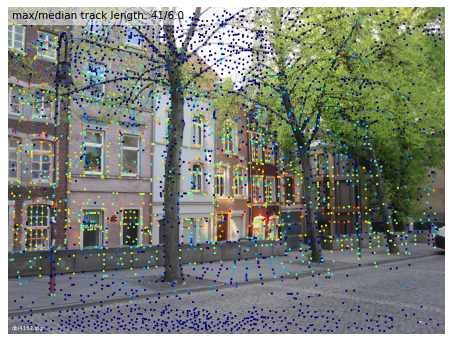

In [5]:
visualization.visualize_sfm_2d(reference_sfm / 'model', images, n=1, color_by='track_length')

Color the keypoints by visibility: blue if sucessfully triangulated, red if never matched.

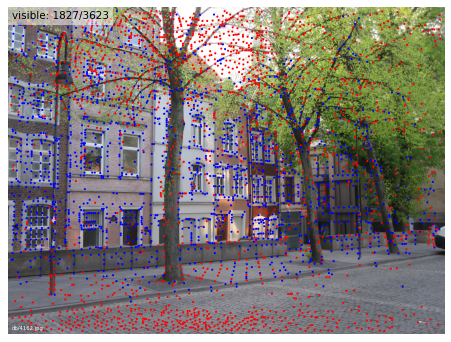

In [6]:
visualization.visualize_sfm_2d(reference_sfm / 'model', images, n=1, color_by='visibility')

Color the keypoints by triangulated depth: red keypoints are far away, blue keypoints are closer.

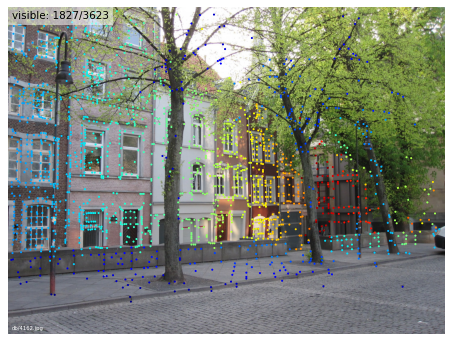

In [7]:
visualization.visualize_sfm_2d(reference_sfm / 'model', images, n=1, color_by='depth')

## Visualizing the localization
We parse the localization logs and for each query image plot matches and inliers with a few database images.

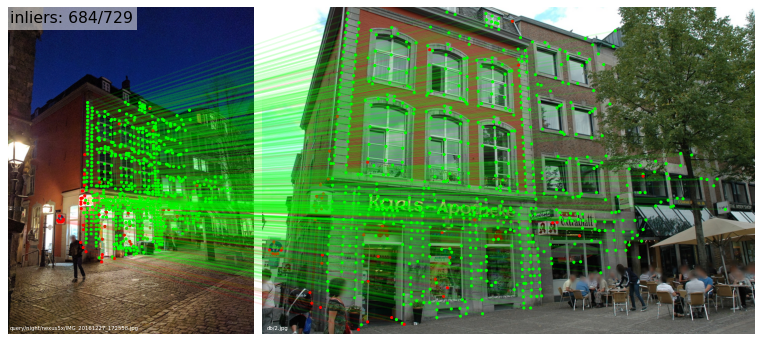

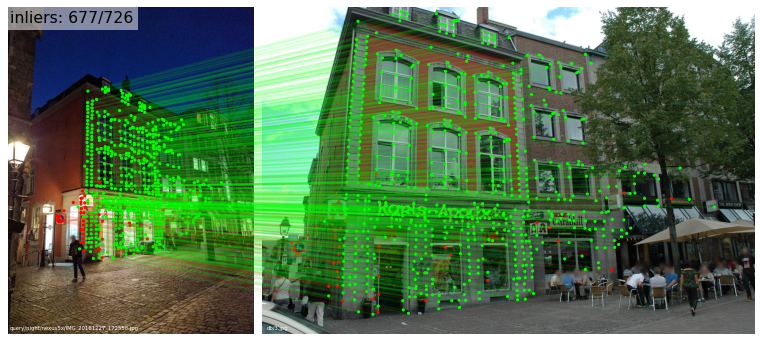

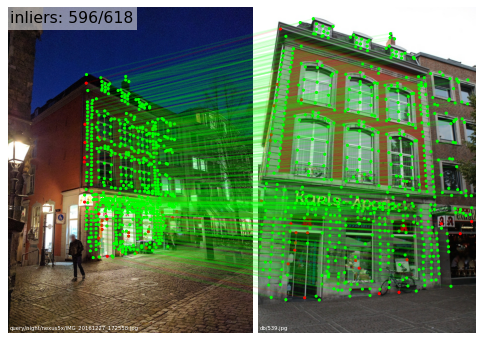

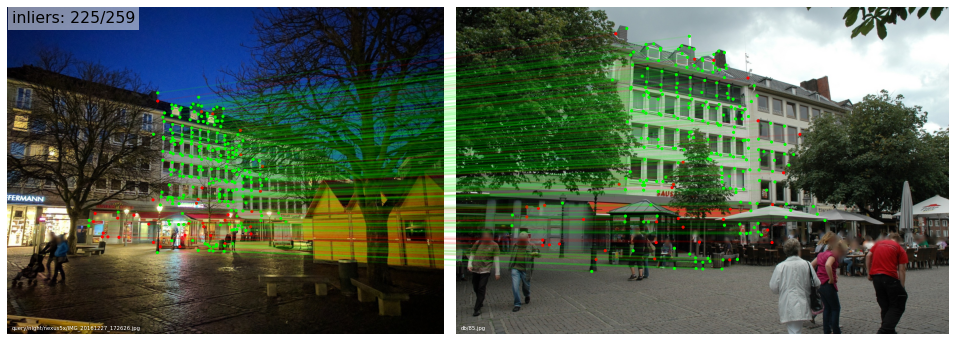

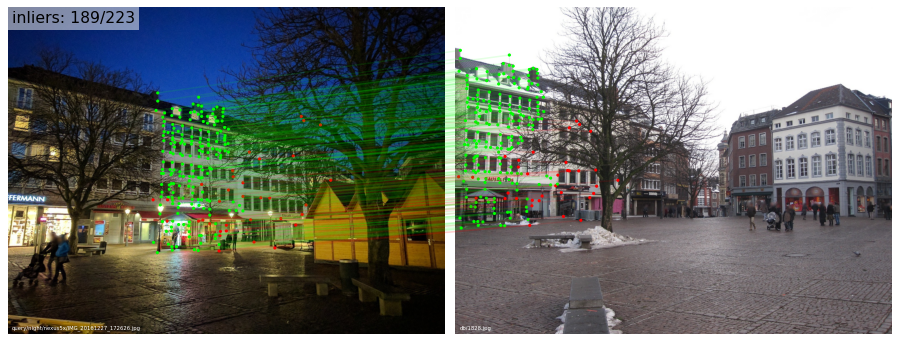

...

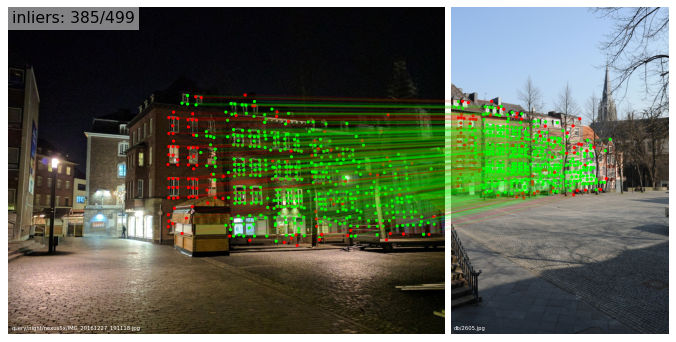

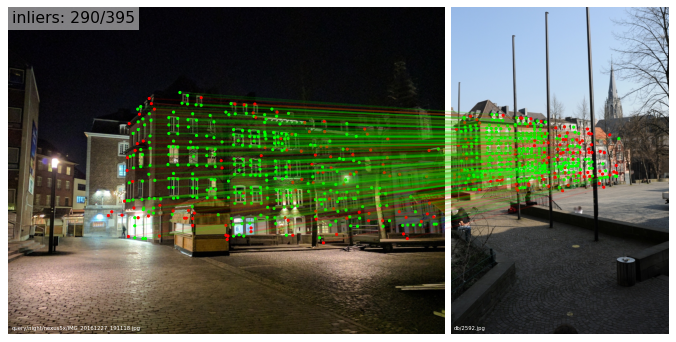

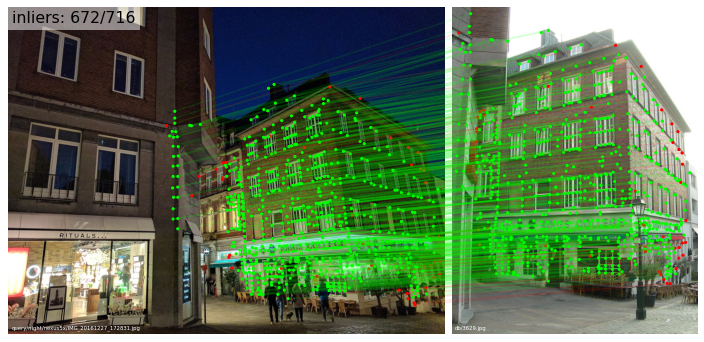

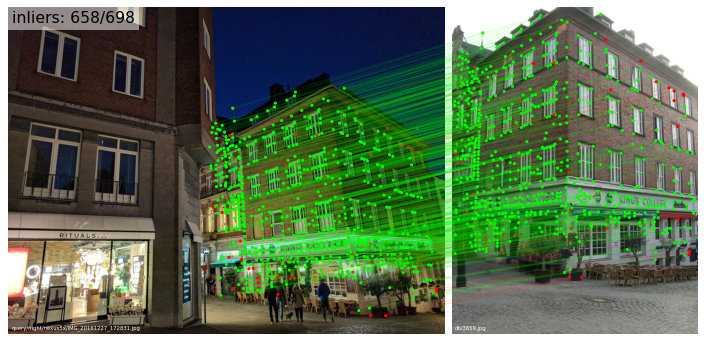

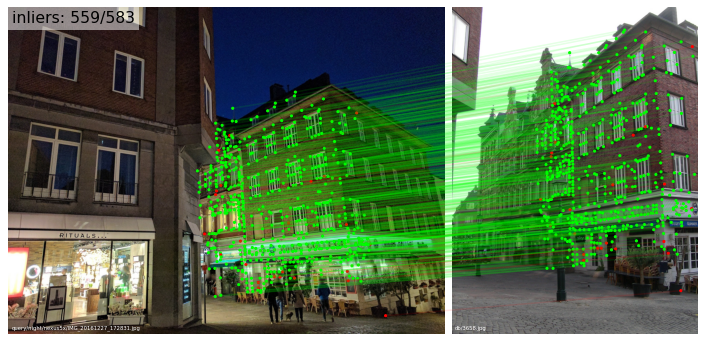

In [14]:
visualization.visualize_loc(
    results, images, reference_sfm / 'model', n=5, top_k_db=3, prefix='query/night', seed=2)